In [156]:
import pandas as pd
import numpy as np
from sklearn.feature_extraction.text import CountVectorizer
from sklearn.metrics.pairwise import cosine_similarity
from sklearn.preprocessing import PolynomialFeatures
from sklearn.linear_model import LinearRegression

import pandas as pd
from sklearn.impute import SimpleImputer
from sklearn.preprocessing import OneHotEncoder
from sklearn.feature_extraction.text import CountVectorizer
from sklearn.linear_model import LogisticRegression
from sklearn.compose import make_column_transformer
from sklearn.pipeline import make_pipeline

import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

from nltk import word_tokenize
from nltk.corpus import stopwords
from nltk.stem import SnowballStemmer
from nltk.stem import WordNetLemmatizer
from sklearn.feature_extraction.text import TfidfVectorizer, CountVectorizer
from sklearn.decomposition import PCA, TruncatedSVD
import matplotlib.pyplot as plt

from sklearn.preprocessing import LabelEncoder, StandardScaler
from sklearn.decomposition import PCA

from sklearn.model_selection import train_test_split, cross_validate
from sklearn.metrics import classification_report, confusion_matrix
from sklearn.model_selection import train_test_split, cross_validate, GridSearchCV
from sklearn.linear_model import SGDClassifier
from sklearn.pipeline import Pipeline
from sklearn.svm import SVC

from sklearn.metrics import classification_report, confusion_matrix, roc_curve, auc

import pickle

%matplotlib inline

In [157]:
#Place raw files movies_metadata.csv, links,csv, keywords.csv and credits.csv and the same location as your notebook
#%cd /content/drive/MyDrive/nyp_project

# 1. Cleaning raw files to get final features


### 1a. movies_metadata.csv

In [158]:
movies_metadata = pd.read_csv('movies_metadata.csv')
movies_metadata.head()

C:\Users\Pamela Sin\anaconda3\lib\site-packages\IPython\core\interactiveshell.py:3071: DtypeWarning: Columns (10) have mixed types.Specify dtype option on import or set low_memory=False.
  has_raised = await self.run_ast_nodes(code_ast.body, cell_name,


,adult,belongs_to_collection,budget,genres,homepage,id,imdb_id,original_language,original_title,overview,...,release_date,revenue,runtime,spoken_languages,status,tagline,title,video,vote_average,vote_count
0,False,"{'id': 10194, 'name': 'Toy Story Collection', ...",30000000,"[{'id': 16, 'name': 'Animation'}, {'id': 35, '...",http://toystory.disney.com/toy-story,862,tt0114709,en,Toy Story,"Led by Woody, Andy's toys live happily in his ...",...,1995-10-30,373554033.0,81.0,"[{'iso_639_1': 'en', 'name': 'English'}]",Released,NaN,Toy Story,False,7.7,5415.0
1,False,NaN,65000000,"[{'id': 12, 'name': 'Adventure'}, {'id': 14, '...",NaN,8844,tt0113497,en,Jumanji,When siblings Judy and Peter discover an encha...,...,1995-12-15,262797249.0,104.0,"[{'iso_639_1': 'en', 'name': 'English'}, {'iso...",Released,Roll the dice and unleash the excitement!,Jumanji,False,6.9,2413.0
2,False,"{'id': 119050, 'name': 'Grumpy Old Men Collect...",0,"[{'id': 10749, 'name': 'Romance'}, {'id': 35, ...",NaN,15602,tt0113228,en,Grumpier Old Men,A family wedding reignites the ancient feud be...,...,1995-12-22,0.0,101.0,"[{'iso_639_1': 'en', 'name': 'English'}]",Released,Still Yelling. Still Fighting. Still Ready for...,Grumpier Old Men,False,6.5,92.0
3,False,NaN,16000000,"[{'id': 35, 'name': 'Comedy'}, {'id': 18, 'nam...",NaN,31357,tt0114885,en,Waiting to Exhale,"Cheated on, mistreated and stepped on, the wom...",...,1995-12-22,81452156.0,127.0,"[{'iso_639_1': 'en', 'name': 'English'}]",Released,Friends are the people who let you be yourself...,Waiting to Exhale,False,6.1,34.0
4,False,"{'id': 96871, 'name': 'Father of the Bride Col...",0,"[{'id': 35, 'name': 'Comedy'}]",NaN,11862,tt0113041,en,Father of the Bride Part II,Just when George Banks has recovered from his ...,...,1995-02-10,76578911.0,106.0,"[{'iso_639_1': 'en', 'name': 'English'}]",Released,Just When His World Is Back To Normal... He's ...,Father of the Bride Part II,False,5.7,173.0


In [159]:
movies_metadata.id

0           862
1          8844
2         15602
3         31357
4         11862
          ...  
45461    439050
45462    111109
45463     67758
45464    227506
45465    461257
Name: id, Length: 45466, dtype: object

In [160]:
movies_metadata.columns

Index(['adult', 'belongs_to_collection', 'budget', 'genres', 'homepage', 'id',
       'imdb_id', 'original_language', 'original_title', 'overview',
       'popularity', 'poster_path', 'production_companies',
       'production_countries', 'release_date', 'revenue', 'runtime',
       'spoken_languages', 'status', 'tagline', 'title', 'video',
       'vote_average', 'vote_count'],
      dtype='object')

In [161]:
movies_metadata.loc[movies_metadata.id.duplicated(),:]

,adult,belongs_to_collection,budget,genres,homepage,id,imdb_id,original_language,original_title,overview,...,release_date,revenue,runtime,spoken_languages,status,tagline,title,video,vote_average,vote_count
1465,False,NaN,0,"[{'id': 18, 'name': 'Drama'}, {'id': 10749, 'n...",NaN,105045,tt0111613,de,Das Versprechen,"East-Berlin, 1961, shortly after the erection ...",...,1995-02-16,0.0,115.0,"[{'iso_639_1': 'de', 'name': 'Deutsch'}]",Released,"A love, a hope, a wall.",The Promise,False,5.0,1.0
9165,False,NaN,0,"[{'id': 80, 'name': 'Crime'}, {'id': 18, 'name...",NaN,5511,tt0062229,fr,Le Samouraï,Hitman Jef Costello is a perfectionist who alw...,...,1967-10-25,39481.0,105.0,"[{'iso_639_1': 'fr', 'name': 'Français'}]",Released,There is no solitude greater than that of the ...,Le Samouraï,False,7.9,187.0
9327,False,NaN,0,"[{'id': 12, 'name': 'Adventure'}, {'id': 16, '...",NaN,23305,tt0295682,en,The Warrior,"In feudal India, a warrior (Khan) who renounce...",...,2001-09-23,0.0,86.0,"[{'iso_639_1': 'hi', 'name': 'हिन्दी'}]",Released,NaN,The Warrior,False,6.3,15.0
12066,False,NaN,1600000,"[{'id': 18, 'name': 'Drama'}, {'id': 80, 'name...",http://www.bubblethefilm.com/,14788,tt0454792,en,Bubble,Set against the backdrop of a decaying Midwest...,...,2005-09-03,0.0,73.0,"[{'iso_639_1': 'en', 'name': 'English'}]",Released,NaN,Bubble,False,6.4,36.0
13375,False,NaN,0,"[{'id': 53, 'name': 'Thriller'}, {'id': 9648, ...",NaN,141971,tt1180333,fi,Blackout,Recovering from a nail gun shot to the head an...,...,2008-12-26,0.0,108.0,"[{'iso_639_1': 'fi', 'name': 'suomi'}]",Released,Which one is the first to return - memory or t...,Blackout,False,6.7,3.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
40040,False,NaN,980000,"[{'id': 18, 'name': 'Drama'}, {'id': 14, 'name...",NaN,298721,tt2818654,th,รักที่ขอนแก่น,"In a hospital, ten soldiers are being treated ...",...,2015-09-02,0.0,122.0,"[{'iso_639_1': 'en', 'name': 'English'}, {'iso...",Released,NaN,Cemetery of Splendour,False,4.4,50.0
40276,False,NaN,0,"[{'id': 35, 'name': 'Comedy'}]",NaN,97995,tt0127834,en,Seven Years Bad Luck,"After breaking a mirror in his home, superstit...",...,1921-02-06,0.0,62.0,"[{'iso_639_1': 'en', 'name': 'English'}]",Released,NaN,Seven Years Bad Luck,False,5.6,4.0
44821,False,"{'id': 34055, 'name': 'Pokémon Collection', 'p...",16000000,"[{'id': 12, 'name': 'Adventure'}, {'id': 14, '...",http://movies.warnerbros.com/pk3/,10991,tt0235679,ja,Pokémon 3: The Movie,When Molly Hale's sadness of her father's disa...,...,2000-07-08,68411275.0,93.0,"[{'iso_639_1': 'en', 'name': 'English'}]",Released,Pokémon: Spell of the Unknown,Pokémon: Spell of the Unknown,False,6.0,144.0
44826,False,"{'id': 34055, 'name': 'Pokémon Collection', 'p...",0,"[{'id': 12, 'name': 'Adventure'}, {'id': 14, '...",http://www.pokemon.com/us/movies/movie-pokemon...,12600,tt0287635,ja,劇場版ポケットモンスター セレビィ 時を越えた遭遇（であい）,"All your favorite Pokémon characters are back,...",...,2001-07-06,28023563.0,75.0,"[{'iso_639_1': 'ja', 'name': '日本語'}]",Released,NaN,Pokémon 4Ever: Celebi - Voice of the Forest,False,5.7,82.0


In [162]:
movies_metadata.loc[movies_metadata.id == '105045' ,:]

,adult,belongs_to_collection,budget,genres,homepage,id,imdb_id,original_language,original_title,overview,...,release_date,revenue,runtime,spoken_languages,status,tagline,title,video,vote_average,vote_count
676,False,NaN,0,"[{'id': 18, 'name': 'Drama'}, {'id': 10749, 'n...",NaN,105045,tt0111613,de,Das Versprechen,"East-Berlin, 1961, shortly after the erection ...",...,1995-02-16,0.0,115.0,"[{'iso_639_1': 'de', 'name': 'Deutsch'}]",Released,"A love, a hope, a wall.",The Promise,False,5.0,1.0
1465,False,NaN,0,"[{'id': 18, 'name': 'Drama'}, {'id': 10749, 'n...",NaN,105045,tt0111613,de,Das Versprechen,"East-Berlin, 1961, shortly after the erection ...",...,1995-02-16,0.0,115.0,"[{'iso_639_1': 'de', 'name': 'Deutsch'}]",Released,"A love, a hope, a wall.",The Promise,False,5.0,1.0


In [163]:
movies_metadata.drop_duplicates(subset=['id'], inplace = True)
movies_metadata.shape

(45436, 24)

### 1b. links.csv

In [164]:
links = pd.read_csv('links.csv')
links.head()

,movieId,imdbId,tmdbId
0,1,114709,862.0
1,2,113497,8844.0
2,3,113228,15602.0
3,4,114885,31357.0
4,5,113041,11862.0


In [165]:
links.shape

(45843, 3)

In [166]:
links.tmdbId

0           862.0
1          8844.0
2         15602.0
3         31357.0
4         11862.0
           ...   
45838    439050.0
45839    111109.0
45840     67758.0
45841    227506.0
45842    461257.0
Name: tmdbId, Length: 45843, dtype: float64

In [167]:
links.loc[links.tmdbId.duplicated(keep=False),:]

,movieId,imdbId,tmdbId
140,142,94878,NaN
598,604,115978,NaN
678,690,111613,105045.0
708,720,118114,NaN
709,721,114103,NaN
...,...,...,...
40391,162632,2818654,298721.0
40629,163246,127834,97995.0
45197,174533,235679,10991.0
45202,174543,287635,12600.0


In [168]:
links.loc[links.tmdbId == 265189.0 ,:]

,movieId,imdbId,tmdbId
24448,114342,3630276,265189.0
45641,175813,2121382,265189.0


In [169]:
links.loc[links.tmdbId == 12600.0 ,:]

,movieId,imdbId,tmdbId
5574,5672,313487,12600.0
45202,174543,287635,12600.0


In [170]:
movies_metadata.loc[movies_metadata.id == '265189',:]

,adult,belongs_to_collection,budget,genres,homepage,id,imdb_id,original_language,original_title,overview,...,release_date,revenue,runtime,spoken_languages,status,tagline,title,video,vote_average,vote_count
24164,False,NaN,0,"[{'id': 35, 'name': 'Comedy'}, {'id': 18, 'nam...",NaN,265189,tt2121382,sv,Turist,"While holidaying in the French Alps, a Swedish...",...,2014-08-15,1359497.0,118.0,"[{'iso_639_1': 'fr', 'name': 'Français'}, {'is...",Released,NaN,Force Majeure,False,6.8,255.0


In [171]:
movies_metadata.loc[movies_metadata.id == '12600' ,:]

,adult,belongs_to_collection,budget,genres,homepage,id,imdb_id,original_language,original_title,overview,...,release_date,revenue,runtime,spoken_languages,status,tagline,title,video,vote_average,vote_count
5535,False,"{'id': 34055, 'name': 'Pokémon Collection', 'p...",0,"[{'id': 12, 'name': 'Adventure'}, {'id': 14, '...",http://www.pokemon.com/us/movies/movie-pokemon...,12600,tt0287635,ja,劇場版ポケットモンスター セレビィ 時を越えた遭遇（であい）,"All your favorite Pokémon characters are back,...",...,2001-07-06,28023563.0,75.0,"[{'iso_639_1': 'ja', 'name': '日本語'}]",Released,NaN,Pokémon 4Ever: Celebi - Voice of the Forest,False,5.7,82.0


In [172]:
links.drop_duplicates(subset = ['tmdbId'], keep = False, inplace = True)
links.shape

(45565, 3)

In [173]:
links.tmdbId = links.tmdbId.astype(float)
links.tmdbId = links.tmdbId.astype(int)
links.tmdbId = links.tmdbId.astype(str)
links.tmdbId 

0           862
1          8844
2         15602
3         31357
4         11862
          ...  
45838    439050
45839    111109
45840     67758
45841    227506
45842    461257
Name: tmdbId, Length: 45565, dtype: object

In [174]:
movies_metadata.id = movies_metadata.id.astype(str)
movies_metadata.id

0           862
1          8844
2         15602
3         31357
4         11862
          ...  
45461    439050
45462    111109
45463     67758
45464    227506
45465    461257
Name: id, Length: 45436, dtype: object

### 1c. keywords.csv

In [175]:
keywords = pd.read_csv('keywords.csv')
keywords.head()

,id,keywords
0,862,"[{'id': 931, 'name': 'jealousy'}, {'id': 4290,..."
1,8844,"[{'id': 10090, 'name': 'board game'}, {'id': 1..."
2,15602,"[{'id': 1495, 'name': 'fishing'}, {'id': 12392..."
3,31357,"[{'id': 818, 'name': 'based on novel'}, {'id':..."
4,11862,"[{'id': 1009, 'name': 'baby'}, {'id': 1599, 'n..."


In [176]:
keywords.id = keywords.id.astype(int)
keywords.id = keywords.id.astype(str)
keywords.id

0           862
1          8844
2         15602
3         31357
4         11862
          ...  
46414    439050
46415    111109
46416     67758
46417    227506
46418    461257
Name: id, Length: 46419, dtype: object

In [177]:
keywords.loc[keywords.id.duplicated(keep=False),:]

,id,keywords
676,105045,"[{'id': 7059, 'name': 'anti-communism'}, {'id'..."
838,132641,"[{'id': 818, 'name': 'based on novel'}, {'id':..."
949,22649,"[{'id': 131, 'name': 'italy'}, {'id': 428, 'na..."
1465,105045,"[{'id': 7059, 'name': 'anti-communism'}, {'id'..."
2564,84198,"[{'id': 187056, 'name': 'woman director'}]"
...,...,...
40994,298721,"[{'id': 1227, 'name': 'cemetery'}, {'id': 1261..."
41230,97995,[]
45774,10991,"[{'id': 1262, 'name': 'mountain'}, {'id': 2802..."
45779,12600,"[{'id': 9663, 'name': 'sequel'}, {'id': 11451,..."


In [178]:
keywords.loc[keywords.id == '105045',:]

,id,keywords
676,105045,"[{'id': 7059, 'name': 'anti-communism'}, {'id'..."
1465,105045,"[{'id': 7059, 'name': 'anti-communism'}, {'id'..."


In [179]:
keywords.loc[keywords.id == '132641',:]

,id,keywords
838,132641,"[{'id': 818, 'name': 'based on novel'}, {'id':..."
29999,132641,"[{'id': 818, 'name': 'based on novel'}, {'id':..."


In [180]:
keywords.drop_duplicates(subset = ['id'], keep = 'first', inplace = True)
keywords.shape

(45432, 2)

### 1d. credits.csv

In [181]:
credits= pd.read_csv('credits.csv')
credits.head()

,cast,crew,id
0,"[{'cast_id': 14, 'character': 'Woody (voice)',...","[{'credit_id': '52fe4284c3a36847f8024f49', 'de...",862
1,"[{'cast_id': 1, 'character': 'Alan Parrish', '...","[{'credit_id': '52fe44bfc3a36847f80a7cd1', 'de...",8844
2,"[{'cast_id': 2, 'character': 'Max Goldman', 'c...","[{'credit_id': '52fe466a9251416c75077a89', 'de...",15602
3,"[{'cast_id': 1, 'character': ""Savannah 'Vannah...","[{'credit_id': '52fe44779251416c91011acb', 'de...",31357
4,"[{'cast_id': 1, 'character': 'George Banks', '...","[{'credit_id': '52fe44959251416c75039ed7', 'de...",11862


In [182]:
credits.id = credits.id.astype(int)
credits.id = credits.id.astype(str)
credits.id

0           862
1          8844
2         15602
3         31357
4         11862
          ...  
45471    439050
45472    111109
45473     67758
45474    227506
45475    461257
Name: id, Length: 45476, dtype: object

In [183]:
credits.loc[credits.id.duplicated(keep=False),:]

,cast,crew,id
676,"[{'cast_id': 5, 'character': 'Sophie II', 'cre...","[{'credit_id': '52fe4a44c3a36847f81c463f', 'de...",105045
838,"[{'cast_id': 4, 'character': 'Mihoko Nakagawa'...","[{'credit_id': '52fe4b9ac3a368484e190d25', 'de...",132641
949,"[{'cast_id': 1, 'character': 'Catherine Barkle...","[{'credit_id': '56d73d3e9251414291002436', 'de...",22649
1465,"[{'cast_id': 5, 'character': 'Sophie II', 'cre...","[{'credit_id': '52fe4a44c3a36847f81c463f', 'de...",105045
2564,"[{'cast_id': 3, 'character': 'Himself', 'credi...","[{'credit_id': '52fe48e09251416c9109b347', 'de...",84198
...,...,...,...
40051,"[{'cast_id': 1, 'character': 'Jenjira', 'credi...","[{'credit_id': '5739ceeac3a3683c9d000c12', 'de...",298721
40287,"[{'cast_id': 1001, 'character': 'Max.', 'credi...","[{'credit_id': '55140dfa92514103e9002d99', 'de...",97995
44831,"[{'cast_id': 1, 'character': 'Ash Ketchum', 'c...","[{'credit_id': '52fe43de9251416c750213ff', 'de...",10991
44836,"[{'cast_id': 1, 'character': 'Ash Ketchum (voi...","[{'credit_id': '52fe45049251416c75048e35', 'de...",12600


In [184]:
credits.loc[credits.id == '105045',:]

,cast,crew,id
676,"[{'cast_id': 5, 'character': 'Sophie II', 'cre...","[{'credit_id': '52fe4a44c3a36847f81c463f', 'de...",105045
1465,"[{'cast_id': 5, 'character': 'Sophie II', 'cre...","[{'credit_id': '52fe4a44c3a36847f81c463f', 'de...",105045


In [185]:
credits.loc[credits.id == '132641',:]

,cast,crew,id
838,"[{'cast_id': 4, 'character': 'Mihoko Nakagawa'...","[{'credit_id': '52fe4b9ac3a368484e190d25', 'de...",132641
30013,"[{'cast_id': 4, 'character': 'Mihoko Nakagawa'...","[{'credit_id': '56365ed9925141285701b06e', 'de...",132641


In [186]:
credits.drop_duplicates(subset = ['id'], keep = 'first', inplace = True)
credits.shape

(45432, 3)

### 1e. Merge 1a, 1b, 1c, 1d - Raw movie features

In [187]:
#This merge only includes rows with the same key in both datasets
moviesmetadata_links = pd.merge(movies_metadata, links, left_on='id', right_on='tmdbId')
moviesmetadata_links_keywords = pd.merge(moviesmetadata_links, keywords, left_on='id', right_on='id')
moviesmetadata_links_keywords_credits = pd.merge(moviesmetadata_links_keywords, credits, left_on='id', right_on='id')
movies_df = moviesmetadata_links_keywords_credits.copy()
movies_df

,adult,belongs_to_collection,budget,genres,homepage,id,imdb_id,original_language,original_title,overview,...,title,video,vote_average,vote_count,movieId,imdbId,tmdbId,keywords,cast,crew
0,False,"{'id': 10194, 'name': 'Toy Story Collection', ...",30000000,"[{'id': 16, 'name': 'Animation'}, {'id': 35, '...",http://toystory.disney.com/toy-story,862,tt0114709,en,Toy Story,"Led by Woody, Andy's toys live happily in his ...",...,Toy Story,False,7.7,5415.0,1,114709,862,"[{'id': 931, 'name': 'jealousy'}, {'id': 4290,...","[{'cast_id': 14, 'character': 'Woody (voice)',...","[{'credit_id': '52fe4284c3a36847f8024f49', 'de..."
1,False,NaN,65000000,"[{'id': 12, 'name': 'Adventure'}, {'id': 14, '...",NaN,8844,tt0113497,en,Jumanji,When siblings Judy and Peter discover an encha...,...,Jumanji,False,6.9,2413.0,2,113497,8844,"[{'id': 10090, 'name': 'board game'}, {'id': 1...","[{'cast_id': 1, 'character': 'Alan Parrish', '...","[{'credit_id': '52fe44bfc3a36847f80a7cd1', 'de..."
2,False,"{'id': 119050, 'name': 'Grumpy Old Men Collect...",0,"[{'id': 10749, 'name': 'Romance'}, {'id': 35, ...",NaN,15602,tt0113228,en,Grumpier Old Men,A family wedding reignites the ancient feud be...,...,Grumpier Old Men,False,6.5,92.0,3,113228,15602,"[{'id': 1495, 'name': 'fishing'}, {'id': 12392...","[{'cast_id': 2, 'character': 'Max Goldman', 'c...","[{'credit_id': '52fe466a9251416c75077a89', 'de..."
3,False,NaN,16000000,"[{'id': 35, 'name': 'Comedy'}, {'id': 18, 'nam...",NaN,31357,tt0114885,en,Waiting to Exhale,"Cheated on, mistreated and stepped on, the wom...",...,Waiting to Exhale,False,6.1,34.0,4,114885,31357,"[{'id': 818, 'name': 'based on novel'}, {'id':...","[{'cast_id': 1, 'character': ""Savannah 'Vannah...","[{'credit_id': '52fe44779251416c91011acb', 'de..."
4,False,"{'id': 96871, 'name': 'Father of the Bride Col...",0,"[{'id': 35, 'name': 'Comedy'}]",NaN,11862,tt0113041,en,Father of the Bride Part II,Just when George Banks has recovered from his ...,...,Father of the Bride Part II,False,5.7,173.0,5,113041,11862,"[{'id': 1009, 'name': 'baby'}, {'id': 1599, 'n...","[{'cast_id': 1, 'character': 'George Banks', '...","[{'credit_id': '52fe44959251416c75039ed7', 'de..."
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
45398,False,NaN,0,"[{'id': 18, 'name': 'Drama'}, {'id': 10751, 'n...",http://www.imdb.com/title/tt6209470/,439050,tt6209470,fa,رگ خواب,Rising and falling between a man and woman.,...,Subdue,False,4.0,1.0,176269,6209470,439050,"[{'id': 10703, 'name': 'tragic love'}]","[{'cast_id': 0, 'character': '', 'credit_id': ...","[{'credit_id': '5894a97d925141426c00818c', 'de..."
45399,False,NaN,0,"[{'id': 18, 'name': 'Drama'}]",NaN,111109,tt2028550,tl,Siglo ng Pagluluwal,An artist struggles to finish his work while a...,...,Century of Birthing,False,9.0,3.0,176271,2028550,111109,"[{'id': 2679, 'name': 'artist'}, {'id': 14531,...","[{'cast_id': 1002, 'character': 'Sister Angela...","[{'credit_id': '52fe4af1c3a36847f81e9b15', 'de..."
45400,False,NaN,0,"[{'id': 28, 'name': 'Action'}, {'id': 18, 'nam...",NaN,67758,tt0303758,en,Betrayal,"When one of her hits goes wrong, a professiona...",...,Betrayal,False,3.8,6.0,176273,303758,67758,[],"[{'cast_id': 6, 'character': 'Emily Shaw', 'cr...","[{'credit_id': '52fe4776c3a368484e0c8387', 'de..."
45401,False,NaN,0,[],NaN,227506,tt0008536,en,Satana likuyushchiy,"In a small town live two brothers, one a minis...",...,Satan Triumphant,False,0.0,0.0,176275,8536,227506,[],"[{'cast_id': 2, 'character': '', 'credit_id': ...","[{'credit_id': '533bccebc3a36844cf0011a7', 'de..."


### 1f. EDA - Raw movie features
We look at each of the 30 columns in movies_df to decide the final movie features to utilise


In [188]:
movies_df.isnull().sum()

adult                        0
belongs_to_collection    40918
budget                       0
genres                       0
homepage                 37634
                         ...  
imdbId                       0
tmdbId                       0
keywords                     0
cast                         0
crew                         0
Length: 30, dtype: int64

In [189]:
# 1st column: adult (not useful)
movies_df.adult.describe()

count     45403
unique        2
top       False
freq      45394
Name: adult, dtype: object

In [190]:
# Not useful - 99.9% of data in a one category
pd.concat([movies_df.adult.value_counts().to_frame(), movies_df.adult.value_counts(normalize=True).to_frame()], axis=1)

,adult,adult
False,45394,0.999802
True,9,0.000198


In [191]:
# 2nd column: belongs_to_collection
movies_df.belongs_to_collection.describe()

count                                                  4485
unique                                                 1695
top       {'id': 415931, 'name': 'The Bowery Boys', 'pos...
freq                                                     29
Name: belongs_to_collection, dtype: object

In [192]:
pd.concat([movies_df.belongs_to_collection.value_counts().to_frame(), movies_df.belongs_to_collection.value_counts(normalize=True).to_frame()], axis=1)

,belongs_to_collection,belongs_to_collection
"{'id': 415931, 'name': 'The Bowery Boys', 'poster_path': '/q6sA4bzMT9cK7EEmXYwt7PNrL5h.jpg', 'backdrop_path': '/foe3kuiJmg5AklhtD3skWbaTMf2.jpg'}",29,0.006466
"{'id': 421566, 'name': 'Totò Collection', 'poster_path': '/4ayJsjC3djGwU9eCWUokdBWvdLC.jpg', 'backdrop_path': '/jaUuprubvAxXLAY5hUfrNjxccUh.jpg'}",27,0.006020
"{'id': 645, 'name': 'James Bond Collection', 'poster_path': '/HORpg5CSkmeQlAolx3bKMrKgfi.jpg', 'backdrop_path': '/6VcVl48kNKvdXOZfJPdarlUGOsk.jpg'}",26,0.005797
"{'id': 96887, 'name': 'Zatôichi: The Blind Swordsman', 'poster_path': '/8Q31DAtmFJjhFTwQGXghBUCgWK2.jpg', 'backdrop_path': '/bY8gLImMR5Pr9PaG3ZpobfaAQ8N.jpg'}",26,0.005797
"{'id': 37261, 'name': 'The Carry On Collection', 'poster_path': '/2P0HNrYgKDvirV8RCdT1rBSJdbJ.jpg', 'backdrop_path': '/38tF1LJN7ULeZAuAfP7beaPMfcl.jpg'}",25,0.005574
...,...,...
"{'id': 403603, 'name': 'La Tour Infernale', 'poster_path': '/7CnmfUxDd424d0ohOdv9fti7txA.jpg', 'backdrop_path': '/pVaoLZvQ03Sr3KBItIbI8tHg8qm.jpg'}",1,0.000223
"{'id': 297923, 'name': ""We're the Millers Collection"", 'poster_path': '/8i2kMT4VfYaK5wH1Q8HyxmdHtFm.jpg', 'backdrop_path': '/1JXiwPCJXIhubAhEuvyBh5UE6rH.jpg'}",1,0.000223
"{'id': 59009, 'name': '08/15 Collection', 'poster_path': '/f4upuG5oCaergMLJeWNSoDAMqM8.jpg', 'backdrop_path': None}",1,0.000223
"{'id': 104774, 'name': 'Tomtar och Trolltyg Collection', 'poster_path': '/5UMq1DmJva3l7wg3VK641Sfn9D.jpg', 'backdrop_path': None}",1,0.000223


In [193]:
# Change to 1 or 0
movies_df.loc[~movies_df['belongs_to_collection'].isnull(),'belongs_to_collection'] = 1  # not nan
movies_df.loc[movies_df['belongs_to_collection'].isnull(),'belongs_to_collection'] = 0   # nan

pd.concat([movies_df.belongs_to_collection.value_counts().to_frame(), movies_df.belongs_to_collection.value_counts(normalize=True).to_frame()], axis=1)

,belongs_to_collection,belongs_to_collection
0,40918,0.901218
1,4485,0.098782


In [194]:
# 3rd column: budget (80% of movies have budget filled as "0". Numeric raw feature with too many "0", not used as final feature)
movies_df.budget.describe()

count     45403
unique     1222
top           0
freq      36533
Name: budget, dtype: object

In [195]:
pd.concat([movies_df.budget.value_counts().to_frame(), movies_df.budget.value_counts(normalize=True).to_frame()], axis=1)

,budget,budget
0,36533,0.804638
5000000,286,0.006299
10000000,257,0.005660
20000000,243,0.005352
2000000,242,0.005330
...,...,...
24554,1,0.000022
82000,1,0.000022
2278264,1,0.000022
2150000,1,0.000022


In [196]:
movies_df.budget = pd.to_numeric(movies_df.budget, errors='coerce')

In [197]:
#Change all cells with 0 as the budget to NaN
movies_df.loc[movies_df['budget'] == 0,'budget'] = np.nan

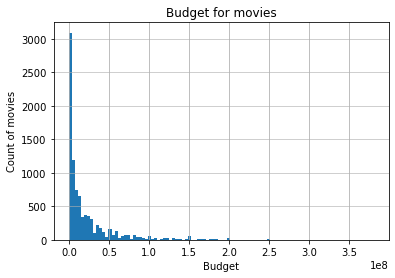

In [198]:
movies_df.budget.plot.hist(grid=True, bins=100)
plt.title('Budget for movies')
plt.xlabel('Budget')
plt.ylabel('Count of movies')
plt.grid(axis='y', alpha=0.75)

In [199]:
movies_df.budget.describe()

count    8.870000e+03
mean     2.162411e+07
std      3.434049e+07
min      1.000000e+00
25%      2.000000e+06
50%      8.000000e+06
75%      2.500000e+07
max      3.800000e+08
Name: budget, dtype: float64

In [200]:
# 4th column: genre
movies_df.genres.describe()

count                             45403
unique                             4060
top       [{'id': 18, 'name': 'Drama'}]
freq                               4992
Name: genres, dtype: object

In [201]:
pd.concat([movies_df.genres.value_counts().to_frame(), movies_df.genres.value_counts(normalize=True).to_frame()], axis=1)

,genres,genres
"[{'id': 18, 'name': 'Drama'}]",4992,0.109949
"[{'id': 35, 'name': 'Comedy'}]",3619,0.079708
"[{'id': 99, 'name': 'Documentary'}]",2719,0.059886
[],2441,0.053763
"[{'id': 18, 'name': 'Drama'}, {'id': 10749, 'name': 'Romance'}]",1299,0.028610
...,...,...
"[{'id': 16, 'name': 'Animation'}, {'id': 18, 'name': 'Drama'}, {'id': 36, 'name': 'History'}, {'id': 10749, 'name': 'Romance'}]",1,0.000022
"[{'id': 12, 'name': 'Adventure'}, {'id': 28, 'name': 'Action'}, {'id': 35, 'name': 'Comedy'}, {'id': 878, 'name': 'Science Fiction'}, {'id': 10402, 'name': 'Music'}]",1,0.000022
"[{'id': 28, 'name': 'Action'}, {'id': 18, 'name': 'Drama'}, {'id': 35, 'name': 'Comedy'}, {'id': 10749, 'name': 'Romance'}]",1,0.000022
"[{'id': 80, 'name': 'Crime'}, {'id': 35, 'name': 'Comedy'}, {'id': 28, 'name': 'Action'}, {'id': 10751, 'name': 'Family'}]",1,0.000022


In [202]:
# 5th column: homepage 
movies_df.homepage.describe()

count                            7769
unique                           7665
top       http://www.georgecarlin.com
freq                               12
Name: homepage, dtype: object

In [203]:
pd.concat([movies_df.homepage.value_counts().to_frame(), movies_df.homepage.value_counts(normalize=True).to_frame()], axis=1)

,homepage,homepage
http://www.georgecarlin.com,12,0.001545
http://www.wernerherzog.com/films-by.html,7,0.000901
http://breakblade.jp/,6,0.000772
http://www.kungfupanda.com/,4,0.000515
http://www.crownintlpictures.com/ostitles.html,4,0.000515
...,...,...
http://www.localcolormovie.com/,1,0.000129
http://freestylereleasing.com/the-masked-saint/,1,0.000129
http://onnelijaanneli.fi/,1,0.000129
http://www.paulyshoreadopted.com/,1,0.000129


In [204]:
# Change to 1 or 0
movies_df.loc[~movies_df['homepage'].isnull(),'homepage'] = 1  
movies_df.loc[movies_df['homepage'].isnull(),'homepage'] = 0  
pd.concat([movies_df.homepage.value_counts().to_frame(), movies_df.homepage.value_counts(normalize=True).to_frame()], axis=1)

,homepage,homepage
0,37634,0.828888
1,7769,0.171112


In [205]:
# 6th column: id (not required as feature) 
# 7th column: imdb_id (not required as feature)

In [206]:
# 8th column: original_language           
movies_df.original_language.describe()

count     45392
unique       89
top          en
freq      32233
Name: original_language, dtype: object

In [207]:
pd.set_option("display.max_rows", None)
pd.concat([movies_df.original_language.value_counts().to_frame(), movies_df.original_language.value_counts(normalize=True).to_frame()], axis=1)

,original_language,original_language
en,32233,0.710103
fr,2434,0.053622
it,1529,0.033684
ja,1344,0.029609
de,1078,0.023749
es,993,0.021876
ru,826,0.018197
hi,508,0.011191
ko,444,0.009781
zh,409,0.009010


In [208]:
pd.set_option("display.max_rows", 10)

In [209]:
# Get list of original_language that have less than 200 rows for that category
temp_series = movies_df['original_language'].value_counts() < 200
temp_list = list(temp_series[temp_series].index)
temp_list[:5]

['tr', 'cs', 'el', 'no', 'hu']

In [210]:
# For original_language that have less than 200 rows for that category, we change cells to a single string "original_language_infrequent"
movies_df.loc[movies_df['original_language'].isin(temp_list) ,'original_language'] = 'original_language_infrequent'
pd.concat([movies_df.original_language.value_counts().to_frame(), movies_df.original_language.value_counts(normalize=True).to_frame()], axis=1)

,original_language,original_language
en,32233,0.710103
fr,2434,0.053622
original_language_infrequent,1599,0.035226
it,1529,0.033684
ja,1344,0.029609
...,...,...
cn,313,0.006895
fi,294,0.006477
nl,248,0.005464
da,223,0.004913


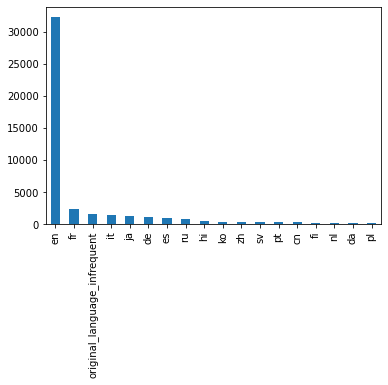

In [211]:
movies_df['original_language'].value_counts().plot(kind='bar')

In [212]:
# 9th column: original_title
# 21st column: title
movies_df_title_comparison = movies_df.loc[:, ['original_title', 'title']]
movies_df_title_comparison

,original_title,title
0,Toy Story,Toy Story
1,Jumanji,Jumanji
2,Grumpier Old Men,Grumpier Old Men
3,Waiting to Exhale,Waiting to Exhale
4,Father of the Bride Part II,Father of the Bride Part II
...,...,...
45398,رگ خواب,Subdue
45399,Siglo ng Pagluluwal,Century of Birthing
45400,Betrayal,Betrayal
45401,Satana likuyushchiy,Satan Triumphant


In [213]:
for index, row in movies_df_title_comparison.iterrows():
    movies_df_title_comparison.loc[index,'same_title'] = row.original_title	== row.title	
movies_df_title_comparison.loc[movies_df_title_comparison.same_title == False]

,original_title,title,same_title
28,La Cité des Enfants Perdus,The City of Lost Children,False
29,摇啊摇，摇到外婆桥,Shanghai Triad,False
32,"Guillaumet, les ailes du courage",Wings of Courage,False
57,Il postino,The Postman,False
58,Le confessionnal,The Confessional,False
...,...,...,...
45390,Maa,Mom,False
45392,San Michele aveva un gallo,St. Michael Had a Rooster,False
45398,رگ خواب,Subdue,False
45399,Siglo ng Pagluluwal,Century of Birthing,False


In [214]:
for index, row in movies_df.iterrows():
    if row.original_title	== row.title:
        movies_df.loc[index,'same_title'] = 1
    else:
        movies_df.loc[index,'same_title'] = 0
pd.concat([movies_df.same_title.value_counts().to_frame(), movies_df.same_title.value_counts(normalize=True).to_frame()], axis=1)

,same_title,same_title
1.0,34020,0.74929
0.0,11383,0.25071


In [215]:
# 10th column: overview 
movies_df.overview.describe()

count                  44449
unique                 44277
top       No overview found.
freq                     133
Name: overview, dtype: object

In [216]:
pd.concat([movies_df.overview.value_counts().to_frame(), movies_df.overview.value_counts(normalize=True).to_frame()], axis=1)

,overview,overview
No overview found.,133,0.002992
No Overview,7,0.000157
,5,0.000112
Adaptation of the Jane Austen novel.,3,0.000067
No movie overview available.,3,0.000067
...,...,...
"Brooklyn mobster and prolific hit man Jimmy Conlon has seen better days. Longtime best friend of a mob boss, Jimmy is haunted by the sins of his past—as well as a dogged police detective who’s been one step behind Jimmy for 30 years. But when Jimmy’s estranged son becomes a target, Jimmy must make a choice between the crime family he chose and the real family he abandoned long ago. Now, with nowhere safe to turn, Jimmy has just one night to figure out exactly where his loyalties lie and to see if he can finally make things right.",1,0.000022
"From the Louis Hemon novel ""M. Ripois and His Nemesis"" about Andre Ripois, a philanderer in pursuit of love and riches from Paris to London. Andre is breaking up with his wife, Catherine, over his attentions to her best friend Patricia. While Catherine is out arranging the divorce, Andre, just to keep in practice, hits on the girl upstairs, Diana and then turns his attention back to Patricia, who he tricks into having dinner at his flat on the pretext that Catherine will be there. When he cannot make any progress with her via his usual tactics, he tries to arouse her pity be telling her of his past. In his early, impoverished days in London, he made love to his boss Anne but her dreadful cooking drove him away. Next came Norah who he picked up on a bus and took to his flat and told her about his make-believe inheritance, but she insisted on marriage first, which was not in his plans",1,0.000022
The story of seven scholars (including Danny Kaye and Benny Goodman) in search of an expert to teach them about swing music. They seem to have found the perfect candidate in winsome nightclub singer Honey Swanson (Virginia Mayo). But Honey's gangster boyfriend doesn't want to give her up.,1,0.000022
Follows the tale of a young woman’s sexual awakening and subsequent journey around the world in pursuit of her ideal lover. Encounters include an Arabian sheik and a Spanish bullfighter. Her friend and butler accompany her and help to arrange her couplings.,1,0.000022


In [217]:
import nltk
from nltk.stem import SnowballStemmer
from nltk.stem import WordNetLemmatizer
from nltk import corpus
from nltk import word_tokenize
from nltk.corpus import stopwords
from nltk.stem import SnowballStemmer
from nltk.stem import WordNetLemmatizer
from sklearn.feature_extraction.text import TfidfVectorizer, CountVectorizer
from sklearn.preprocessing import StandardScaler
nltk.download('stopwords')
nltk.download('stopwords')
nltk.download('wordnet')
nltk.download('punkt')
nltk.download('averaged_perceptron_tagger') 

[nltk_data] Downloading package stopwords to C:\Users\Pamela
[nltk_data]     Sin\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
[nltk_data] Downloading package stopwords to C:\Users\Pamela
[nltk_data]     Sin\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
[nltk_data] Downloading package wordnet to C:\Users\Pamela
[nltk_data]     Sin\AppData\Roaming\nltk_data...
[nltk_data]   Package wordnet is already up-to-date!
[nltk_data] Downloading package punkt to C:\Users\Pamela
[nltk_data]     Sin\AppData\Roaming\nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package averaged_perceptron_tagger to
[nltk_data]     C:\Users\Pamela Sin\AppData\Roaming\nltk_data...
[nltk_data]   Package averaged_perceptron_tagger is already up-to-
[nltk_data]       date!


True

In [218]:
stemmer = SnowballStemmer(language='english')
stops = set(stopwords.words('english'))

#Function that returns a tokenized and stemmed copy of a document for words not in stop words
def stem_tokenize_removestop(document):
    tokens = word_tokenize(document)
    return [stemmer.stem(t) for t in tokens if t.isalpha() and t.lower() not in stops] 


print(stem_tokenize_removestop('A tough judge takes in a FOSTER child with nowhere to go. Attempts to REUNITE child with long lost father end badly with the rebellious child running away.'))

['tough', 'judg', 'take', 'foster', 'child', 'nowher', 'go', 'attempt', 'reunit', 'child', 'long', 'lost', 'father', 'end', 'bad', 'rebelli', 'child', 'run', 'away']


In [219]:
#  Change 'No overview found.', 'No Overview' to empty string
movies_df.loc[movies_df.overview == 'No overview found.', 'overview'] = ""
movies_df.loc[movies_df.overview == 'No Overview', 'overview'] = ""

movies_df.loc[movies_df.overview == '', 'overview'].head()

104     
799     
969     
1609    
2226    
Name: overview, dtype: object

In [220]:
movies_df['overview_cleaned'] = movies_df.overview.apply(lambda x: stem_tokenize_removestop(str(x)))
movies_df[['overview_cleaned']].head()

,overview_cleaned
0,"[led, woodi, andi, toy, live, happili, room, a..."
1,"[sibl, judi, peter, discov, enchant, board, ga..."
2,"[famili, wed, reignit, ancient, feud, neighbor..."
3,"[cheat, mistreat, step, women, hold, breath, w..."
4,"[georg, bank, recov, daughter, wed, receiv, ne..."


In [221]:
#Formatting data in overview_cleaned
def create_soup2(x):
    return ' '.join(x['overview_cleaned'])
movies_df['overview_cleaned'] = movies_df.apply(create_soup2, axis=1)

In [222]:
movies_df['overview_cleaned']

0        led woodi andi toy live happili room andi birt...
1        sibl judi peter discov enchant board game open...
2        famili wed reignit ancient feud neighbor fish ...
3        cheat mistreat step women hold breath wait elu...
4        georg bank recov daughter wed receiv news preg...
                               ...                        
45398                                  rise fall man woman
45399    artist struggl finish work storylin cult play ...
45400    one hit goe wrong profession assassin end suit...
45401    small town live two brother one minist one hun...
45402    year decriminalis homosexu uk director daisi a...
Name: overview_cleaned, Length: 45403, dtype: object

In [223]:
# 11th column: popularity (not used, varied)
movies_df.popularity.describe()

count     45400
unique    44129
top         0.0
freq         34
Name: popularity, dtype: object

C:\Users\Pamela Sin\anaconda3\lib\site-packages\numpy\lib\histograms.py:839: RuntimeWarning: invalid value encountered in greater_equal
  keep = (tmp_a >= first_edge)
C:\Users\Pamela Sin\anaconda3\lib\site-packages\numpy\lib\histograms.py:840: RuntimeWarning: invalid value encountered in less_equal
  keep &= (tmp_a <= last_edge)


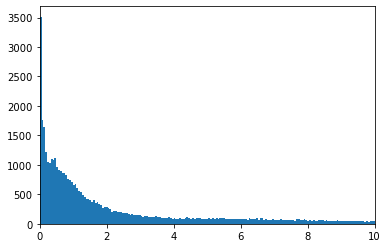

In [224]:
movies_df.popularity = pd.to_numeric(movies_df.popularity, errors='coerce')
plt.hist(movies_df.popularity, bins=10000)
plt.xlim(0, 10)
plt.show()

In [225]:
# 12th column: poster_path (not used)
movies_df.poster_path.describe()

count                                45017
unique                               44991
top       /5D7UBSEgdyONE6Lql6xS7s6OLcW.jpg
freq                                     5
Name: poster_path, dtype: object

In [226]:
pd.concat([movies_df.poster_path.value_counts().to_frame(), movies_df.poster_path.value_counts(normalize=True).to_frame()], axis=1)

,poster_path,poster_path
/5D7UBSEgdyONE6Lql6xS7s6OLcW.jpg,5,0.000111
/2kslZXOaW0HmnGuVPCnQlCdXFR9.jpg,4,0.000089
/qW1oQlOHizRHXZQrpkimYr0oxzn.jpg,4,0.000089
/cdwVC18URfEdQjjxqJyRMoGDC0H.jpg,3,0.000067
/cYLp3nPDXg1lT7Esebevp6K57tH.jpg,2,0.000044
...,...,...
/cVP2w80XaC0c1VZJvpoOJxjefUb.jpg,1,0.000022
/2fFh0512ZRxIhsHJTJdea75BqS2.jpg,1,0.000022
/u778O0zFamjddFlMWQd5UzqViAf.jpg,1,0.000022
/fbHXfr2N4pI2j7i9RLYiddjotBl.jpg,1,0.000022


In [227]:
# 13th column: production_companies 
movies_df.production_companies.describe()

count     45400
unique    22689
top          []
freq      11860
Name: production_companies, dtype: object

In [228]:
pd.concat([movies_df.production_companies.value_counts().to_frame(), movies_df.production_companies.value_counts(normalize=True).to_frame()], axis=1)

,production_companies,production_companies
[],11860,0.261233
"[{'name': 'Metro-Goldwyn-Mayer (MGM)', 'id': 8411}]",742,0.016344
"[{'name': 'Warner Bros.', 'id': 6194}]",540,0.011894
"[{'name': 'Paramount Pictures', 'id': 4}]",503,0.011079
"[{'name': 'Twentieth Century Fox Film Corporation', 'id': 306}]",439,0.009670
...,...,...
"[{'name': 'Pro-ject Filmproduktion', 'id': 1448}, {'name': 'Filmové Studio Barrandov', 'id': 1931}, {'name': 'Ceskoslovenský Filmexport', 'id': 2330}, {'name': 'Bioskop Film', 'id': 5982}, {'name': 'Westdeutscher Rundfunk (WDR)', 'id': 7025}, {'name': 'Regina Ziegler Filmproduktion', 'id': 12994}, {'name': 'Bärenfilm', 'id': 74834}]",1,0.000022
"[{'name': 'Film Ventures International (FVI)', 'id': 4805}]",1,0.000022
"[{'name': 'Breidablick Film AB', 'id': 8269}, {'name': 'Film i Skåne', 'id': 17555}, {'name': 'Ystad Österlen Filmfond', 'id': 44127}]",1,0.000022
"[{'name': 'Nordisk Film', 'id': 235}, {'name': 'Sveriges Television (SVT)', 'id': 3221}, {'name': 'Zweites Deutsches Fernsehen (ZDF)', 'id': 4606}, {'name': 'ZDF Enterprises', 'id': 5747}, {'name': 'Svenska Filminstitutet (SFI)', 'id': 7446}, {'name': 'Film i Väst', 'id': 17513}, {'name': 'Filmpool Stockholm Mälardalen', 'id': 33821}, {'name': 'Spiltan Underhållning', 'id': 33822}]",1,0.000022


In [229]:
# 14th column: production_countries
movies_df.production_countries.describe()

count                                                 45400
unique                                                 2385
top       [{'iso_3166_1': 'US', 'name': 'United States o...
freq                                                  17831
Name: production_countries, dtype: object

In [230]:
pd.concat([movies_df.production_countries.value_counts().to_frame(), movies_df.production_countries.value_counts(normalize=True).to_frame()], axis=1)

,production_countries,production_countries
"[{'iso_3166_1': 'US', 'name': 'United States of America'}]",17831,0.392753
[],6275,0.138216
"[{'iso_3166_1': 'GB', 'name': 'United Kingdom'}]",2238,0.049295
"[{'iso_3166_1': 'FR', 'name': 'France'}]",1652,0.036388
"[{'iso_3166_1': 'JP', 'name': 'Japan'}]",1352,0.029780
...,...,...
"[{'iso_3166_1': 'IE', 'name': 'Ireland'}, {'iso_3166_1': 'US', 'name': 'United States of America'}, {'iso_3166_1': 'CH', 'name': 'Switzerland'}]",1,0.000022
"[{'iso_3166_1': 'FR', 'name': 'France'}, {'iso_3166_1': 'DZ', 'name': 'Algeria'}]",1,0.000022
"[{'iso_3166_1': 'CA', 'name': 'Canada'}, {'iso_3166_1': 'FR', 'name': 'France'}, {'iso_3166_1': 'DE', 'name': 'Germany'}, {'iso_3166_1': 'IT', 'name': 'Italy'}]",1,0.000022
"[{'iso_3166_1': 'IE', 'name': 'Ireland'}, {'iso_3166_1': 'GB', 'name': 'United Kingdom'}, {'iso_3166_1': 'DE', 'name': 'Germany'}, {'iso_3166_1': 'IT', 'name': 'Italy'}, {'iso_3166_1': 'ES', 'name': 'Spain'}, {'iso_3166_1': 'FR', 'name': 'France'}, {'iso_3166_1': 'BE', 'name': 'Belgium'}, {'iso_3166_1': 'CH', 'name': 'Switzerland'}]",1,0.000022


In [231]:
# 15th column: release_date (not used)
movies_df.release_date.describe()

count          45316
unique         17324
top       2008-01-01
freq             136
Name: release_date, dtype: object

In [232]:

pd.concat([movies_df.release_date.value_counts().to_frame(), movies_df.release_date.value_counts(normalize=True).to_frame()], axis=1)

,release_date,release_date
2008-01-01,136,0.003001
2009-01-01,121,0.002670
2007-01-01,116,0.002560
2005-01-01,111,0.002449
2006-01-01,101,0.002229
...,...,...
1988-07-02,1,0.000022
1973-08-09,1,0.000022
1968-03-15,1,0.000022
1966-10-08,1,0.000022


In [233]:
# 16th column: revenue (not used)
movies_df.revenue.describe()

count    4.540000e+04
mean     1.121642e+07
std      6.437203e+07
min      0.000000e+00
25%      0.000000e+00
50%      0.000000e+00
75%      0.000000e+00
max      2.787965e+09
Name: revenue, dtype: float64

In [234]:
pd.concat([movies_df.revenue.value_counts().to_frame(), movies_df.revenue.value_counts(normalize=True).to_frame()], axis=1)

,revenue,revenue
0.0,38012,0.837269
12000000.0,20,0.000441
10000000.0,19,0.000419
11000000.0,19,0.000419
2000000.0,18,0.000396
...,...,...
12212123.0,1,0.000022
8203235.0,1,0.000022
25900.0,1,0.000022
414404.0,1,0.000022


In [235]:
# 17th column: runtime 
movies_df.runtime.describe()

count    45143.000000
mean        94.122788
std         38.420780
min          0.000000
25%         85.000000
50%         95.000000
75%        107.000000
max       1256.000000
Name: runtime, dtype: float64

In [236]:
pd.concat([movies_df.runtime.value_counts().to_frame(), movies_df.runtime.value_counts(normalize=True).to_frame()], axis=1)

,runtime,runtime
90.0,2554,0.056576
0.0,1557,0.034490
100.0,1470,0.032563
95.0,1410,0.031234
93.0,1210,0.026804
...,...,...
238.0,1,0.000022
316.0,1,0.000022
258.0,1,0.000022
780.0,1,0.000022


C:\Users\Pamela Sin\anaconda3\lib\site-packages\numpy\lib\histograms.py:839: RuntimeWarning: invalid value encountered in greater_equal
  keep = (tmp_a >= first_edge)
C:\Users\Pamela Sin\anaconda3\lib\site-packages\numpy\lib\histograms.py:840: RuntimeWarning: invalid value encountered in less_equal
  keep &= (tmp_a <= last_edge)


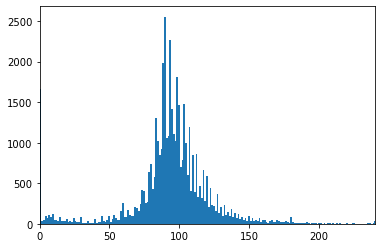

In [237]:
plt.hist(movies_df.runtime, bins=1000)
plt.xlim(0, 240)
plt.show()

In [238]:
movies_df.runtime = movies_df.runtime.fillna(0)

In [239]:
from sklearn.preprocessing import StandardScaler
scaler = StandardScaler()
movies_df['runtime_scaled'] = scaler.fit_transform(movies_df[["runtime"]])
movies_df.loc[:,['runtime', 'runtime_scaled']]

,runtime,runtime_scaled
0,81.0,-0.322968
1,104.0,0.267336
2,101.0,0.190340
3,127.0,0.857640
4,106.0,0.318667
...,...,...
45398,90.0,-0.091980
45399,360.0,6.837680
45400,90.0,-0.091980
45401,87.0,-0.168976


In [240]:
movies_df.runtime.isnull().sum()

0

In [241]:
# 18th column: spoken_languages (seems similar to original_language feature, not used)
movies_df.spoken_languages.describe()

count                                        45400
unique                                        1930
top       [{'iso_639_1': 'en', 'name': 'English'}]
freq                                         22367
Name: spoken_languages, dtype: object

In [242]:
pd.concat([movies_df.spoken_languages.value_counts().to_frame(), movies_df.spoken_languages.value_counts(normalize=True).to_frame()], axis=1)

,spoken_languages,spoken_languages
"[{'iso_639_1': 'en', 'name': 'English'}]",22367,0.492665
[],3824,0.084229
"[{'iso_639_1': 'fr', 'name': 'Français'}]",1849,0.040727
"[{'iso_639_1': 'ja', 'name': '日本語'}]",1285,0.028304
"[{'iso_639_1': 'it', 'name': 'Italiano'}]",1218,0.026828
...,...,...
"[{'iso_639_1': 'fr', 'name': 'Français'}, {'iso_639_1': 'en', 'name': 'English'}, {'iso_639_1': 'pl', 'name': 'Polski'}, {'iso_639_1': 'pt', 'name': 'Português'}]",1,0.000022
"[{'iso_639_1': 'fr', 'name': 'Français'}, {'iso_639_1': 'de', 'name': 'Deutsch'}, {'iso_639_1': 'hu', 'name': 'Magyar'}, {'iso_639_1': 'ru', 'name': 'Pусский'}]",1,0.000022
"[{'iso_639_1': 'de', 'name': 'Deutsch'}, {'iso_639_1': 'fr', 'name': 'Français'}, {'iso_639_1': 'lb', 'name': ''}, {'iso_639_1': 'en', 'name': 'English'}]",1,0.000022
"[{'iso_639_1': 'et', 'name': 'Eesti'}, {'iso_639_1': 'lt', 'name': 'Lietuvi\x9akai'}, {'iso_639_1': 'ru', 'name': 'Pусский'}]",1,0.000022


In [243]:
# 19th column: status (not used)
movies_df.status.describe()

count        45319
unique           6
top       Released
freq         44956
Name: status, dtype: object

In [244]:
pd.concat([movies_df.status.value_counts().to_frame(), movies_df.status.value_counts(normalize=True).to_frame()], axis=1)

,status,status
Released,44956,0.991990
Rumored,228,0.005031
Post Production,98,0.002162
In Production,20,0.000441
Planned,15,0.000331
Canceled,2,0.000044


In [245]:
# 20th column: tagline (not used)
movies_df.tagline.describe()

count                      20391
unique                     20273
top       Based on a true story.
freq                           7
Name: tagline, dtype: object

In [246]:
pd.concat([movies_df.tagline.value_counts().to_frame(), movies_df.tagline.value_counts(normalize=True).to_frame()], axis=1)

,tagline,tagline
Based on a true story.,7,0.000343
Trust no one.,4,0.000196
-,4,0.000196
Be careful what you wish for.,4,0.000196
Know Your Enemy,3,0.000147
...,...,...
The monster demands a mate.,1,0.000049
A new comedy about giving first love a second chance.,1,0.000049
Magic is just around the corner.,1,0.000049
"""Remember the tune they were singing the night we fell in love?...""",1,0.000049


In [247]:
# 21st column: title (not used)
movies_df.title.describe()

count          45400
unique         42253
top       Cinderella
freq              11
Name: title, dtype: object

In [248]:
pd.concat([movies_df.title.value_counts().to_frame(), movies_df.title.value_counts(normalize=True).to_frame()], axis=1)

,title,title
Cinderella,11,0.000242
Hamlet,9,0.000198
Alice in Wonderland,9,0.000198
Beauty and the Beast,8,0.000176
Les Misérables,8,0.000176
...,...,...
Once a Gangster,1,0.000022
A Necessary Death,1,0.000022
Elite Squad: The Enemy Within,1,0.000022
Lovin' Molly,1,0.000022


In [249]:
# 22nd column: video (99% of cells are of 1 feature, not useful)
movies_df.video.describe()

count     45400
unique        2
top       False
freq      45307
Name: video, dtype: object

In [250]:
pd.concat([movies_df.video.value_counts().to_frame(), movies_df.video.value_counts(normalize=True).to_frame()], axis=1)

,video,video
False,45307,0.997952
True,93,0.002048


In [251]:
# 23rd column: vote_average (not used)
movies_df.vote_average.describe()

count    45400.000000
mean         5.618599
std          1.923888
min          0.000000
25%          5.000000
50%          6.000000
75%          6.800000
max         10.000000
Name: vote_average, dtype: float64

In [252]:
pd.concat([movies_df.vote_average.value_counts().to_frame(), movies_df.vote_average.value_counts(normalize=True).to_frame()], axis=1)

,vote_average,vote_average
0.0,2991,0.065881
6.0,2466,0.054317
5.0,1993,0.043899
7.0,1884,0.041498
6.5,1722,0.037930
...,...,...
9.4,3,0.000066
9.8,1,0.000022
0.7,1,0.000022
9.6,1,0.000022


C:\Users\Pamela Sin\anaconda3\lib\site-packages\numpy\lib\histograms.py:839: RuntimeWarning: invalid value encountered in greater_equal
  keep = (tmp_a >= first_edge)
C:\Users\Pamela Sin\anaconda3\lib\site-packages\numpy\lib\histograms.py:840: RuntimeWarning: invalid value encountered in less_equal
  keep &= (tmp_a <= last_edge)


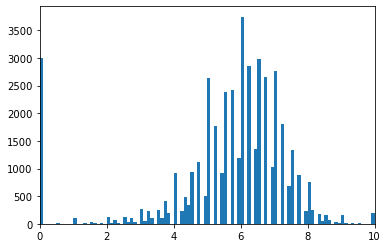

In [253]:
plt.hist(movies_df.vote_average, bins=100)
plt.xlim(0, 10)
plt.show()

In [254]:
# 24th column: vote_count (not used)
movies_df.vote_count.describe()

count    45400.000000
mean       109.974802
std        491.622435
min          0.000000
25%          3.000000
50%         10.000000
75%         34.000000
max      14075.000000
Name: vote_count, dtype: float64

In [255]:
pd.concat([movies_df.vote_count.value_counts().to_frame(), movies_df.vote_count.value_counts(normalize=True).to_frame()], axis=1)

,vote_count,vote_count
1.0,3260,0.071806
2.0,3132,0.068987
0.0,2892,0.063700
3.0,2778,0.061189
4.0,2478,0.054581
...,...,...
4461.0,1,0.000022
1085.0,1,0.000022
1539.0,1,0.000022
2487.0,1,0.000022


In [256]:
# 25th, 26th and 27th columns are movieId, imdbId, tmdbId

In [257]:
# 28th column: keywords
movies_df.video.describe()

count     45400
unique        2
top       False
freq      45307
Name: video, dtype: object

In [258]:
pd.concat([movies_df.keywords.value_counts().to_frame(), movies_df.keywords.value_counts(normalize=True).to_frame()], axis=1)

,keywords,keywords
[],14329,0.315596
"[{'id': 187056, 'name': 'woman director'}]",1280,0.028192
"[{'id': 10183, 'name': 'independent film'}]",505,0.011123
"[{'id': 9716, 'name': 'stand-up comedy'}]",233,0.005132
"[{'id': 4344, 'name': 'musical'}]",168,0.003700
...,...,...
"[{'id': 2139, 'name': 'russia'}, {'id': 5565, 'name': 'biography'}, {'id': 10842, 'name': 'good vs evil'}, {'id': 10900, 'name': 'rasputin'}]",1,0.000022
"[{'id': 720, 'name': 'helicopter'}, {'id': 798, 'name': 'sheriff'}, {'id': 1706, 'name': 'experiment'}, {'id': 4237, 'name': 'water'}, {'id': 9167, 'name': 'water supply'}, {'id': 14819, 'name': 'violence'}]",1,0.000022
"[{'id': 1316, 'name': 'captain'}, {'id': 4268, 'name': 'fort'}, {'id': 4948, 'name': 'retirement'}, {'id': 10563, 'name': 'attack'}, {'id': 156234, 'name': 'cavalry'}]",1,0.000022
"[{'id': 780, 'name': 'kung fu'}, {'id': 1003, 'name': 'photographer'}, {'id': 4620, 'name': 'magazine'}, {'id': 5331, 'name': 'village'}, {'id': 6025, 'name': 'photography'}, {'id': 9748, 'name': 'revenge'}, {'id': 9840, 'name': 'romance'}, {'id': 193685, 'name': 'malayalam'}, {'id': 210107, 'name': 'vow'}, {'id': 225661, 'name': 'sandel'}]",1,0.000022


In [259]:
# 29th column: cast
movies_df.video.describe()

count     45400
unique        2
top       False
freq      45307
Name: video, dtype: object

In [260]:
pd.concat([movies_df.cast.value_counts().to_frame(), movies_df.cast.value_counts(normalize=True).to_frame()], axis=1).head(4)

cast      cast
[]                                                  2413  0.053146
[{'cast_id': 3, 'character': 'Lydia', 'credit_i...     1  0.000022
[{'cast_id': 1002, 'character': 'Deborah', 'cre...     1  0.000022
[{'cast_id': 2, 'character': 'Field Marshal Sir...     1  0.000022

In [261]:
# 30th column: crew
movies_df.crew.describe()

count     45403
unique    44633
top          []
freq        771
Name: crew, dtype: object

In [262]:
pd.concat([movies_df.crew.value_counts().to_frame(), movies_df.crew.value_counts(normalize=True).to_frame()], axis=1).head(4)

,crew,crew
[],771,0.016981
"[{'credit_id': '52fe4ac2c3a368484e16563d', 'department': 'Directing', 'gender': 2, 'id': 1012088, 'job': 'Director', 'name': 'James Benning', 'profile_path': '/zmBy4E6njaoj1z8ZWTj11i8t1Q2.jpg'}, {'credit_id': '59b570769251417f6a0003f9', 'department': 'Writing', 'gender': 2, 'id': 1012088, 'job': 'Writer', 'name': 'James Benning', 'profile_path': '/zmBy4E6njaoj1z8ZWTj11i8t1Q2.jpg'}]",1,0.000022
"[{'credit_id': '52fe4894c3a36847f816efa5', 'department': 'Writing', 'gender': 2, 'id': 3435, 'job': 'Story', 'name': 'Kan Shimosawa', 'profile_path': None}, {'credit_id': '52fe4894c3a36847f816ef99', 'department': 'Directing', 'gender': 0, 'id': 80709, 'job': 'Director', 'name': 'Kazuo Mori', 'profile_path': None}, {'credit_id': '52fe4894c3a36847f816ef9f', 'department': 'Writing', 'gender': 0, 'id': 124997, 'job': 'Writer', 'name': 'Shozaburo Asai', 'profile_path': None}]",1,0.000022
"[{'credit_id': '553e1998c3a3683e55007bfb', 'department': 'Editing', 'gender': 2, 'id': 476, 'job': 'Editor', 'name': 'John Wilson', 'profile_path': None}, {'credit_id': '553e1c35c3a3683e14007aab', 'department': 'Production', 'gender': 0, 'id': 7700, 'job': 'Associate Producer', 'name': 'Conchita Airoldi', 'profile_path': '/fdPfiB98wHHKnr7KQYrLzKDAt1o.jpg'}, {'credit_id': '553e1c07c3a3687db1002e0d', 'department': 'Costume & Make-Up', 'gender': 2, 'id': 8756, 'job': 'Costume Design', 'name': 'Maurizio Millenotti', 'profile_path': None}, {'credit_id': '553e1976c3a3685c65001164', 'department': 'Camera', 'gender': 2, 'id': 9752, 'job': 'Director of Photography', 'name': 'Sacha Vierny', 'profile_path': None}, {'credit_id': '52fe47129251416c7508ce53', 'department': 'Directing', 'gender': 2, 'id': 30309, 'job': 'Director', 'name': 'Peter Greenaway', 'profile_path': '/k5Lt7hw37sY6kCeb8EDMSZiKh16.jpg'}, {'credit_id': '52fe47129251416c7508ce59', 'department': 'Writing', 'gender': 2, 'id': 30309, 'job': 'Writer', 'name': 'Peter Greenaway', 'profile_path': '/k5Lt7hw37sY6kCeb8EDMSZiKh16.jpg'}, {'credit_id': '553e1984c3a36820ec005323', 'department': 'Sound', 'gender': 0, 'id': 54670, 'job': 'Original Music Composer', 'name': 'Wim Mertens', 'profile_path': None}, {'credit_id': '553e1c589251415852002ad7', 'department': 'Production', 'gender': 0, 'id': 1125598, 'job': 'Associate Producer', 'name': 'Dino Di Dionisio', 'profile_path': None}, {'credit_id': '553e1be892514135c8005cff', 'department': 'Production', 'gender': 0, 'id': 1239412, 'job': 'Producer', 'name': 'Colin Callender', 'profile_path': None}, {'credit_id': '59452659c3a36816c5010181', 'department': 'Art', 'gender': 1, 'id': 1354912, 'job': 'Art Direction', 'name': 'Luciana Vedovelli', 'profile_path': None}, {'credit_id': '553e1bd892514138a900a405', 'department': 'Production', 'gender': 0, 'id': 1459943, 'job': 'Producer', 'name': 'Walter Donohue', 'profile_path': None}]",1,0.000022


### 1g. ratings.csv

In [263]:
ratings = pd.read_csv('ratings.csv')
ratings.head()

,userId,movieId,rating,timestamp
0,1,110,1.0,1425941529
1,1,147,4.5,1425942435
2,1,858,5.0,1425941523
3,1,1221,5.0,1425941546
4,1,1246,5.0,1425941556


In [264]:
ratings.movieId = ratings.movieId.astype(int)
ratings.movieId = ratings.movieId.astype(str)
ratings.movieId

0             110
1             147
2             858
3            1221
4            1246
            ...  
26024284    58559
26024285    60069
26024286    63082
26024287    64957
26024288    71878
Name: movieId, Length: 26024289, dtype: object

In [265]:
#No users rated the same movie multiple times
ratings.loc[ratings.duplicated(subset=['userId','movieId'], keep=False),:]

,userId,movieId,rating,timestamp


### 1h. Further cleaning text raw movie features

In [266]:
movies_df2 = movies_df.copy()

In [267]:
text_columns = ['genres', 'production_companies', 'production_countries', 'keywords','cast', 'crew']
movies_df2.loc[:,text_columns].head()

,genres,production_companies,production_countries,keywords,cast,crew
0,"[{'id': 16, 'name': 'Animation'}, {'id': 35, '...","[{'name': 'Pixar Animation Studios', 'id': 3}]","[{'iso_3166_1': 'US', 'name': 'United States o...","[{'id': 931, 'name': 'jealousy'}, {'id': 4290,...","[{'cast_id': 14, 'character': 'Woody (voice)',...","[{'credit_id': '52fe4284c3a36847f8024f49', 'de..."
1,"[{'id': 12, 'name': 'Adventure'}, {'id': 14, '...","[{'name': 'TriStar Pictures', 'id': 559}, {'na...","[{'iso_3166_1': 'US', 'name': 'United States o...","[{'id': 10090, 'name': 'board game'}, {'id': 1...","[{'cast_id': 1, 'character': 'Alan Parrish', '...","[{'credit_id': '52fe44bfc3a36847f80a7cd1', 'de..."
2,"[{'id': 10749, 'name': 'Romance'}, {'id': 35, ...","[{'name': 'Warner Bros.', 'id': 6194}, {'name'...","[{'iso_3166_1': 'US', 'name': 'United States o...","[{'id': 1495, 'name': 'fishing'}, {'id': 12392...","[{'cast_id': 2, 'character': 'Max Goldman', 'c...","[{'credit_id': '52fe466a9251416c75077a89', 'de..."
3,"[{'id': 35, 'name': 'Comedy'}, {'id': 18, 'nam...",[{'name': 'Twentieth Century Fox Film Corporat...,"[{'iso_3166_1': 'US', 'name': 'United States o...","[{'id': 818, 'name': 'based on novel'}, {'id':...","[{'cast_id': 1, 'character': ""Savannah 'Vannah...","[{'credit_id': '52fe44779251416c91011acb', 'de..."
4,"[{'id': 35, 'name': 'Comedy'}]","[{'name': 'Sandollar Productions', 'id': 5842}...","[{'iso_3166_1': 'US', 'name': 'United States o...","[{'id': 1009, 'name': 'baby'}, {'id': 1599, 'n...","[{'cast_id': 1, 'character': 'George Banks', '...","[{'credit_id': '52fe44959251416c75039ed7', 'de..."


In [268]:
#literal_eval helps Python applications to process trees of the Python abstract syntax grammar, and safely evaluate an expression node or a string containing a Python literal or container display.
from ast import literal_eval

#Function that does a literal_eval on the input, returns empty list if there are any malformed strings
def literal_eval_helper(x):
    try:
        return literal_eval(str(x))   
    except Exception as e:
        print(e)
        return [] 

In [269]:
#Literal eval on column 'production_companies_cleaned'
#There are 3 malformed strings in column 'production_companies_cleaned'
movies_df2['production_companies_cleaned'] = movies_df2.production_companies.apply(lambda x: literal_eval_helper(x))  

malformed node or string: <_ast.Name object at 0x00000153A13164C0>
malformed node or string: <_ast.Name object at 0x000001537F1C71C0>
malformed node or string: <_ast.Name object at 0x00000152F74ECCD0>


In [270]:
#Literal eval on column 'production_countries_cleaned'
#There are 3 malformed strings in column 'production_countries_cleaned'
movies_df2['production_countries_cleaned'] = movies_df2.production_countries.apply(lambda x: literal_eval_helper(x))   

malformed node or string: <_ast.Name object at 0x000001537F8DE4F0>
malformed node or string: <_ast.Name object at 0x000001537EB7D2E0>
malformed node or string: <_ast.Name object at 0x000001539523F040>


In [271]:
#Literal eval on columns 'genres', 'keywords','cast', 'crew'
text_columns = ['genres', 'keywords','cast', 'crew']
for column in text_columns:
    movies_df2[column] = movies_df2[column].apply(literal_eval)

In [272]:
def get_director(x):
    for i in x:
        if i['job'] == 'Director':
            return i['name']
    return np.nan

In [273]:
# Returns the list top 3 elements or entire list (whichever is less)
def get_list_3(x):
    if isinstance(x, list):
        names = [i['name'] for i in x]
        #For more than 3 elements, returns first 3 elements. If not, returns all the elements
        if len(names) > 3:
            names = names[:3]
        return names

    #Return empty list in case of malformed data
    return []

In [274]:
# Returns the list top 8 elements or entire list (whichever is less)
def get_list_8(x):
    if isinstance(x, list):
        names = [i['name'] for i in x]
        #For more than 3 elements, returns first 8 elements. If not, returns all the elements
        if len(names) > 8:
            names = names[:8]
        return names

    #Return empty list in case of malformed data
    return []

In [275]:
# Get the director information from the 'crew' raw feature
movies_df2['director'] = movies_df2['crew'].apply(get_director)

#Apply get_list_3 fuction to some columns to get top 3 elements or entire list (whichever is less)
text_columns_top3 = ['cast', 'genres','production_companies_cleaned', 'production_countries_cleaned']
for column in text_columns_top3:
    movies_df2[column] = movies_df2[column].apply(get_list_3)

In [276]:
#Apply get_list_8 fuction to some columns to get top 8 elements or entire list (whichever is less)
text_columns_top8 = ['keywords']
for column in text_columns_top8:
    movies_df2[column] = movies_df2[column].apply(get_list_8)

In [277]:
# Function to convert all strings to lower case and strip names of spaces
def clean_data(x):
    if isinstance(x, list):
        return [str.lower(i.replace(" ", "")) for i in x]
    else:
        #Check if director exists. If not, return empty string
        if isinstance(x, str):
            return str.lower(x.replace(" ", ""))
        else:
            return ''

In [278]:
# Apply clean_data function to features
text_columns = ['cast', 'keywords', 'director', 'genres', 'production_companies_cleaned', 'production_countries_cleaned']

for column in text_columns:
    movies_df2[column] = movies_df2[column].apply(clean_data)

In [279]:
#Convert original_language column to list format (prepare for subsequent joining of text columns)
movies_df2['original_language'] = movies_df2.original_language.astype(str)

def get_list2(x):
    return [x]
movies_df2['original_language'] = movies_df2['original_language'].apply(get_list2)

movies_df2.loc[:,['original_language']]

,original_language
0,[en]
1,[en]
2,[en]
3,[en]
4,[en]
...,...
45398,[original_language_infrequent]
45399,[original_language_infrequent]
45400,[en]
45401,[en]


In [280]:
def create_soup(x):
    return ' '.join(x['keywords']) + ' ' + ' '.join(x['cast']) + ' ' + x['director'] + ' ' + ' '.join(x['genres']) + ' '.join(x['production_companies_cleaned']) + ' ' + ' '.join(x['production_countries_cleaned'])+ ' '.join(x['original_language'])
movies_df2['soup'] = movies_df2.apply(create_soup, axis=1)

In [281]:
#Creation of 'soup' text, one of the final movie features, which is created by:
#1. Top 8 keywords 
#2. Top 3 cast
#3. Director
#4. Top 3 genres
#5. Top 3 production companies
#6. Top 3 production countries
#7. original language
movies_df2[['title', 'cast', 'director', 'keywords', 'genres', 'production_companies_cleaned', 'production_countries_cleaned', 'original_language', 'soup']].head(10)

,title,cast,director,keywords,genres,production_companies_cleaned,production_countries_cleaned,original_language,soup
0,Toy Story,"[tomhanks, timallen, donrickles]",johnlasseter,"[jealousy, toy, boy, friendship, friends, riva...","[animation, comedy, family]",[pixaranimationstudios],[unitedstatesofamerica],[en],jealousy toy boy friendship friends rivalry bo...
1,Jumanji,"[robinwilliams, jonathanhyde, kirstendunst]",joejohnston,"[boardgame, disappearance, basedonchildren'sbo...","[adventure, fantasy, family]","[tristarpictures, teitlerfilm, interscopecommu...",[unitedstatesofamerica],[en],boardgame disappearance basedonchildren'sbook ...
2,Grumpier Old Men,"[waltermatthau, jacklemmon, ann-margret]",howarddeutch,"[fishing, bestfriend, duringcreditsstinger, ol...","[romance, comedy]","[warnerbros., lancastergate]",[unitedstatesofamerica],[en],fishing bestfriend duringcreditsstinger oldmen...
3,Waiting to Exhale,"[whitneyhouston, angelabassett, lorettadevine]",forestwhitaker,"[basedonnovel, interracialrelationship, single...","[comedy, drama, romance]",[twentiethcenturyfoxfilmcorporation],[unitedstatesofamerica],[en],basedonnovel interracialrelationship singlemot...
4,Father of the Bride Part II,"[stevemartin, dianekeaton, martinshort]",charlesshyer,"[baby, midlifecrisis, confidence, aging, daugh...",[comedy],"[sandollarproductions, touchstonepictures]",[unitedstatesofamerica],[en],baby midlifecrisis confidence aging daughter m...
5,Heat,"[alpacino, robertdeniro, valkilmer]",michaelmann,"[robbery, detective, bank, obsession, chase, s...","[action, crime, drama]","[regencyenterprises, forwardpass, warnerbros.]",[unitedstatesofamerica],[en],robbery detective bank obsession chase shootin...
6,Sabrina,"[harrisonford, juliaormond, gregkinnear]",sydneypollack,"[paris, brotherbrotherrelationship, chauffeur,...","[comedy, romance]","[paramountpictures, scottrudinproductions, mir...","[germany, unitedstatesofamerica]",[en],paris brotherbrotherrelationship chauffeur lon...
7,Tom and Huck,"[jonathantaylorthomas, bradrenfro, rachaelleig...",peterhewitt,[],"[action, adventure, drama]",[waltdisneypictures],[unitedstatesofamerica],[en],jonathantaylorthomas bradrenfro rachaelleighc...
8,Sudden Death,"[jean-claudevandamme, powersboothe, dorianhare...",peterhyams,"[terrorist, hostage, explosive, vicepresident]","[action, adventure, thriller]","[universalpictures, imperialentertainment, sig...",[unitedstatesofamerica],[en],terrorist hostage explosive vicepresident jean...
9,GoldenEye,"[piercebrosnan, seanbean, izabellascorupco]",martincampbell,"[cuba, falselyaccused, secretidentity, compute...","[adventure, action, thriller]","[unitedartists, eonproductions]","[unitedkingdom, unitedstatesofamerica]",[en],cuba falselyaccused secretidentity computervir...


In [282]:
#Examining a soup
movies_df2.loc[0,'soup']

'jealousy toy boy friendship friends rivalry boynextdoor newtoy tomhanks timallen donrickles johnlasseter animation comedy familypixaranimationstudios unitedstatesofamericaen'

### 1g. Final features

In [283]:
movies_df2.loc[:,['belongs_to_collection', 'homepage', 'same_title', "runtime_scaled",'soup', 'overview_cleaned']]

,belongs_to_collection,homepage,same_title,runtime_scaled,soup,overview_cleaned
0,1,1,1.0,-0.322968,jealousy toy boy friendship friends rivalry bo...,led woodi andi toy live happili room andi birt...
1,0,0,1.0,0.267336,boardgame disappearance basedonchildren'sbook ...,sibl judi peter discov enchant board game open...
2,1,0,1.0,0.190340,fishing bestfriend duringcreditsstinger oldmen...,famili wed reignit ancient feud neighbor fish ...
3,0,0,1.0,0.857640,basedonnovel interracialrelationship singlemot...,cheat mistreat step women hold breath wait elu...
4,1,0,1.0,0.318667,baby midlifecrisis confidence aging daughter m...,georg bank recov daughter wed receiv news preg...
...,...,...,...,...,...,...
45398,0,1,0.0,-0.091980,tragiclove leilahatami kouroshtahami elhamkord...,rise fall man woman
45399,0,0,0.0,6.837680,artist play pinoy angelaquino perrydizon hazel...,artist struggl finish work storylin cult play ...
45400,0,0,1.0,-0.091980,erikaeleniak adambaldwin juliedupage markl.le...,one hit goe wrong profession assassin end suit...
45401,0,0,0.0,-0.168976,iwanmosschuchin nathalielissenko pavelpavlov ...,small town live two brother one minist one hun...


In [284]:
movies_df2['belongs_to_collection'] = movies_df2.belongs_to_collection.astype(float)
movies_df2['homepage'] = movies_df2.homepage.astype(float)
movies_df2['same_title'] = movies_df2.same_title.astype(float)
movies_df2['runtime_scaled'] = movies_df2.runtime_scaled.astype(float)

In [285]:
#1. Creating non_text_features_sparse_matrix 
import scipy
non_text_features_sparse_matrix = scipy.sparse.csr_matrix(movies_df2[['belongs_to_collection', 'homepage', 'same_title', 'runtime_scaled']].copy())
non_text_features_sparse_matrix

<45403x4 sparse matrix of type '<class 'numpy.float64'>'
	with 91677 stored elements in Compressed Sparse Row format>

In [286]:
type(non_text_features_sparse_matrix)

scipy.sparse.csr.csr_matrix

In [287]:
non_text_features_sparse_matrix.shape

(45403, 4)

In [288]:
#2. Create count_matrix from soup
from sklearn.feature_extraction.text import CountVectorizer

count = CountVectorizer(stop_words='english')
count_matrix = count.fit_transform(movies_df2['soup'])

In [289]:
type(count_matrix)

scipy.sparse.csr.csr_matrix

In [290]:
count_matrix.shape

(45403, 111666)

In [291]:
#As a check, appending all cells in soup column into a list and checking the number of unique words in that list
count_matrix_check_list = []
for index, row in movies_df2.iterrows():
    count_matrix_check_list += row['soup'].split(" ")

print('Number of words in count_matrix_check_list:', len(count_matrix_check_list))
print('Number of unique words in count_matrix_check_list:', len(set(count_matrix_check_list)))

Number of words in count_matrix_check_list: 483096
Number of unique words in count_matrix_check_list: 110013


In [292]:
count_matrix_check_list[-20010:-20000]

['jasonstatham',
 'dwaynejohnson',
 'f.garygray',
 'action',
 'crime',
 'thrilleruniversalpictures',
 'originalfilm',
 'oneracefilms',
 'unitedstatesofamericaen',
 'friendship']

In [293]:
#3. Create tfidf_matrix from overview_cleaned

In [294]:
movies_df2['overview_cleaned'] = movies_df2.overview_cleaned.astype(str)

In [295]:
movies_df2['overview_cleaned']

0        led woodi andi toy live happili room andi birt...
1        sibl judi peter discov enchant board game open...
2        famili wed reignit ancient feud neighbor fish ...
3        cheat mistreat step women hold breath wait elu...
4        georg bank recov daughter wed receiv news preg...
                               ...                        
45398                                  rise fall man woman
45399    artist struggl finish work storylin cult play ...
45400    one hit goe wrong profession assassin end suit...
45401    small town live two brother one minist one hun...
45402    year decriminalis homosexu uk director daisi a...
Name: overview_cleaned, Length: 45403, dtype: object

In [296]:
tfidf= TfidfVectorizer()
tfidf_matrix = tfidf.fit_transform(movies_df2['overview_cleaned'])

In [297]:
type(tfidf_matrix)

scipy.sparse.csr.csr_matrix

In [298]:
tfidf_matrix.shape

(45403, 55122)

In [299]:
#As a check, appending all cells in soup column into a list and checking the number of unique words in that list
tfidf_matrix_check_list = []
for index, row in movies_df2.iterrows():
    tfidf_matrix_check_list += row['overview_cleaned'].split(" ")
print('Number of words in tfidf_matrix_check_list:', len(tfidf_matrix_check_list))
print('Number of unqiue words in tfidf_matrix_check_list:', len(set(tfidf_matrix_check_list)))

Number of words in tfidf_matrix_check_list: 1350327
Number of unqiue words in tfidf_matrix_check_list: 55160


In [300]:
# hstack non_text_features_sparse_matrix, count_matrix, tfidf_matrix
from scipy.sparse import hstack
features_sparse_matrix = hstack((non_text_features_sparse_matrix, count_matrix, tfidf_matrix))

In [301]:
features_sparse_matrix.shape

(45403, 166792)

In [302]:
4 + 105866 + 55118

160988

In [303]:
features_sparse_matrix

<45403x166792 sparse matrix of type '<class 'numpy.float64'>'
	with 1796151 stored elements in COOrdinate format>

In [304]:
type(features_sparse_matrix)

scipy.sparse.coo.coo_matrix

In [305]:
#Convert sparse matrix from coo_matrix to csr_matrix
features_sparse_matrix = features_sparse_matrix.tocsr()
type(features_sparse_matrix)

scipy.sparse.csr.csr_matrix

In [306]:
features_sparse_matrix.shape

(45403, 166792)

In [307]:
np.isnan(features_sparse_matrix.data).any()

False

# Content-based recommender

###2a. Cosine similarity KNN

In [153]:
# Compute the Cosine Similarity matrix based on the count_matrix
from sklearn.metrics.pairwise import cosine_similarity
#cosine_sim = cosine_similarity(features_sparse_matrix, features_sparse_matrix)

In [154]:
#https://stackoverflow.com/questions/40900608/cosine-similarity-on-large-sparse-matrix-with-numpy
# Prevent colab from crashing when calculating cosine similarity

def cosine_sim_function(m1, m2, batch_size=10):
    assert m1.shape[1] == m2.shape[1]
    ret = np.ndarray((m1.shape[0], m2.shape[0]))
    for row_i in range(0, int(m1.shape[0] / batch_size) + 1):
        start = row_i * batch_size
        end = min([(row_i + 1) * batch_size, m1.shape[0]])
        if end <= start:
            break # edge cases
        rows = m1[start: end]
        sim = cosine_similarity(rows, m2) 
        ret[start: end] = sim
    return ret

cosine_sim =cosine_sim_function(features_sparse_matrix, features_sparse_matrix)

In [314]:
# Reset index of movies_df_2 and construct reverse mapping as before
movies_df2 = movies_df2.reset_index()
indices = pd.Series(movies_df2.index, index=movies_df2['title'])

In [315]:
# Function that takes in movie title as input and outputs most similar movies
def get_recommendations(title, cosine_sim):
    # Get the index of the movie that matches the title
    idx = indices[title]

    # Get the pairwise similarity scores of all movies with that movie
    sim_scores = list(enumerate(cosine_sim[idx]))

    # Sort the movies based on the similarity scores
    sim_scores = sorted(sim_scores, key=lambda x: x[1], reverse=True)

    # Get the scores of the 10 most similar movies
    sim_scores = sim_scores[1:11]

    # Get the movie indices
    movie_indices = [i[0] for i in sim_scores]

    # Return the top 10 most similar movies
    return movies_df2['title'].iloc[movie_indices]

In [157]:
get_recommendations('GoldenEye', cosine_sim)

3875               The Living Daylights
3511                          Moonraker
3506    On Her Majesty's Secret Service
3854               Diamonds Are Forever
2826                         Goldfinger
7319                          Octopussy
5724                    Die Another Day
2868                 For Your Eyes Only
3508               The Spy Who Loved Me
3512        The Man with the Golden Gun
Name: title, dtype: object

In [158]:
movies_df2.tail(3)

,index,adult,belongs_to_collection,budget,genres,homepage,id,imdb_id,original_language,original_title,overview,popularity,poster_path,production_companies,production_countries,release_date,revenue,runtime,spoken_languages,status,tagline,title,video,vote_average,vote_count,movieId,imdbId,tmdbId,keywords,cast,crew,same_title,overview_cleaned,runtime_scaled,production_companies_cleaned,production_countries_cleaned,director,soup
45400,45400,False,0.0,NaN,"[action, drama, thriller]",0.0,67758,tt0303758,[en],Betrayal,"When one of her hits goes wrong, a professiona...",0.903007,/d5bX92nDsISNhu3ZT69uHwmfCGw.jpg,"[{'name': 'American World Pictures', 'id': 6165}]","[{'iso_3166_1': 'US', 'name': 'United States o...",2003-08-01,0.0,90.0,"[{'iso_639_1': 'en', 'name': 'English'}]",Released,A deadly game of wits.,Betrayal,False,3.8,6.0,176273,303758,67758,[],"[erikaeleniak, adambaldwin, juliedupage]","[{'credit_id': '52fe4776c3a368484e0c8387', 'de...",1.0,one hit goe wrong profession assassin end suit...,-0.091980,[americanworldpictures],[unitedstatesofamerica],markl.lester,erikaeleniak adambaldwin juliedupage markl.le...
45401,45401,False,0.0,NaN,[],0.0,227506,tt0008536,[en],Satana likuyushchiy,"In a small town live two brothers, one a minis...",0.003503,/aorBPO7ak8e8iJKT5OcqYxU3jlK.jpg,"[{'name': 'Yermoliev', 'id': 88753}]","[{'iso_3166_1': 'RU', 'name': 'Russia'}]",1917-10-21,0.0,87.0,[],Released,NaN,Satan Triumphant,False,0.0,0.0,176275,8536,227506,[],"[iwanmosschuchin, nathalielissenko, pavelpavlov]","[{'credit_id': '533bccebc3a36844cf0011a7', 'de...",0.0,small town live two brother one minist one hun...,-0.168976,[yermoliev],[russia],yakovprotazanov,iwanmosschuchin nathalielissenko pavelpavlov ...
45402,45402,False,0.0,NaN,[],0.0,461257,tt6980792,[en],Queerama,50 years after decriminalisation of homosexual...,0.163015,/s5UkZt6NTsrS7ZF0Rh8nzupRlIU.jpg,[],"[{'iso_3166_1': 'GB', 'name': 'United Kingdom'}]",2017-06-09,0.0,75.0,"[{'iso_639_1': 'en', 'name': 'English'}]",Released,NaN,Queerama,False,0.0,0.0,176279,6980792,461257,[],[],"[{'credit_id': '593e676c92514105b702e68e', 'de...",1.0,year decriminalis homosexu uk director daisi a...,-0.476961,[],[unitedkingdom],daisyasquith,daisyasquith unitedkingdomen


In [159]:
#The cosine similarity has a natural index. So we need to get that index for train_test_split
movies_df2.loc[movies_df2.movieId == 33794,['movieId', 'index']]

,movieId,index
10106,33794,10106


In [318]:
movies_df2.movieId = movies_df2.movieId.astype(float)
movies_df2.movieId = movies_df2.movieId.astype(int)
movies_df2.movieId = movies_df2.movieId.astype(str)

In [319]:
#Adding an extra column "index" to the ratings dataframe (which is the cosine similarity natural index)
ratings2 = pd.merge(ratings, movies_df2[['index','movieId']], left_on='movieId', right_on='movieId')
ratings2

,userId,movieId,rating,timestamp,index
0,1,110,1.0,1425941529,108
1,11,110,3.5,1231676989,108
2,22,110,5.0,1111937009,108
3,24,110,5.0,979870012,108
4,29,110,3.0,1044020005,108
...,...,...,...,...,...
25972120,270887,159050,5.0,1472697413,38773
25972121,270887,159053,5.0,1486961830,38774
25972122,270887,165649,4.0,1479088587,41110
25972123,270887,171051,4.0,1493084042,43276


In [320]:
#Double-checking it is reflecting correctly
ratings2.loc[ratings2.movieId == "33794",['movieId', 'index']]

,movieId,index
425123,33794,10106
425124,33794,10106
425125,33794,10106
425126,33794,10106
425127,33794,10106
...,...,...
454169,33794,10106
454170,33794,10106
454171,33794,10106
454172,33794,10106


In [163]:
ratings2_train, ratings2_test = train_test_split(ratings2, test_size=0.3, random_state=42)
ratings2_train.head()

,userId,movieId,rating,timestamp,index
16174853,238274,7458,3.5,1091976044,7280
8159410,193391,940,5.0,943091944,911
513129,92195,59315,2.5,1487483331,12568
2978067,80877,2571,4.5,1406842651,2454
24898176,4387,108188,3.5,1445030809,22482


In [164]:
#Checking the train split for user 1
user_1_train = ratings2_train.loc[ratings2_train.userId == 1,]
user_1_train

,userId,movieId,rating,timestamp,index
267234,1,2918,5.0,1425941593,2797
505130,1,59315,5.0,1425941502,12568
71479,1,858,5.0,1425941523,833
555025,1,73017,5.0,1425942699,14530
355080,1,4226,4.0,1425942228,4094
...,...,...,...,...,...
217591,1,2762,4.5,1425941300,2642
465530,1,58559,4.0,1425942007,12461
603398,1,98809,0.5,1425942640,19935
165228,1,1246,5.0,1425941556,1198


In [165]:
#Checking the test split for user 1
user_1_test = ratings2_test.loc[ratings2_test.userId == 1,]
user_1_test

,userId,movieId,rating,timestamp,index
528595,1,68358,5.0,1425941464,13619
567873,1,81834,5.0,1425942133,16098
128549,1,1221,5.0,1425941546,1175
190980,1,1968,4.0,1425942148,1855
66512,1,147,4.5,1425942435,144
395786,1,4878,5.0,1425941434,4741
579435,1,91500,2.5,1425942647,18211
590788,1,91542,5.0,1425942618,18225


In [166]:
########################USER 1###
"""
user_1_train_indexes_list = list(user_1_train['index'])
for index, row in user_1_test.iterrows():
  sim_scores_train = []

  print(row['index'])
  idx = int(row['index'])
  sim_scores = list(enumerate(cosine_sim[idx]))

  for each_tuple in sim_scores:
    if each_tuple[0] in user_1_train_indexes_list:
      sim_scores_train.append(each_tuple)

  sim_scores_train = sorted(sim_scores_train, key=lambda x: x[1], reverse=True)

  print(sim_scores_train[:3])
  print(len(sim_scores_train))

  simple_average = 0
  weighted_average = 0
  the_index = 0
  the_similarity = 0
  the_rating = 0

  the_similarities = []
  the_ratings = []
  
  for each_tuple in sim_scores_train[:3]:
    the_index = each_tuple[0]
    the_similarity = float(each_tuple[1])
    the_rating = float(user_1_train.loc[user_1_train['index'] == the_index, 'rating'])
    simple_average += the_rating

    the_similarities.append(the_similarity)
    the_ratings.append(the_rating)
    
    the_similarities_sum = sum(the_similarities)

  simple_average /= len(the_similarities)


  for i in range(len(the_similarities)):
    weighted_average += the_similarities[i] * the_ratings[i] / the_similarities_sum

  print('the_similarities',the_similarities)
  print('the_ratings',the_ratings)
  print('simple_average',simple_average)
  print('weighted_average', weighted_average)"""

"\nuser_1_train_indexes_list = list(user_1_train['index'])\nfor index, row in user_1_test.iterrows():\n  sim_scores_train = []\n\n  print(row['index'])\n  idx = int(row['index'])\n  sim_scores = list(enumerate(cosine_sim[idx]))\n\n  for each_tuple in sim_scores:\n    if each_tuple[0] in user_1_train_indexes_list:\n      sim_scores_train.append(each_tuple)\n\n  sim_scores_train = sorted(sim_scores_train, key=lambda x: x[1], reverse=True)\n\n  print(sim_scores_train[:3])\n  print(len(sim_scores_train))\n\n  simple_average = 0\n  weighted_average = 0\n  the_index = 0\n  the_similarity = 0\n  the_rating = 0\n\n  the_similarities = []\n  the_ratings = []\n  \n  for each_tuple in sim_scores_train[:3]:\n    the_index = each_tuple[0]\n    the_similarity = float(each_tuple[1])\n    the_rating = float(user_1_train.loc[user_1_train['index'] == the_index, 'rating'])\n    simple_average += the_rating\n\n    the_similarities.append(the_similarity)\n    the_ratings.append(the_rating)\n    \n    the_s

In [167]:
ratings2_test_userId_list = list(set(ratings2_test.userId))
len(ratings2_test_userId_list)

260719

In [168]:
#testing on 1000 users 
ratings2_test_userId_list = ratings2_test_userId_list[:1000]
len(ratings2_test_userId_list)

1000

In [169]:
# Creating 2 columns in ratings2_test dataframe to be filled later on
ratings2_test.loc[:,'cosine_sim_simple_average'] = np.nan
ratings2_test.loc[:,'cosine_sim_weighted_average'] = np.nan

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


In [170]:
#CREATING A COPY IN CASE
"""for each_test_userId in ratings2_test_userId_list:
  # 
  user_1_train = ratings2_train.loc[ratings2_train.userId == each_test_userId,]
  user_1_test = ratings2_test.loc[ratings2_test.userId == each_test_userId,]

  user_1_train_indexes_list = list(user_1_train['index'])

  for index, row in user_1_test.iterrows():
    sim_scores_train = []

    print(row['index'])
    idx = int(row['index'])
    sim_scores = list(enumerate(cosine_sim[idx]))

    for each_tuple in sim_scores:
      if each_tuple[0] in user_1_train_indexes_list:
        sim_scores_train.append(each_tuple)

    sim_scores_train = sorted(sim_scores_train, key=lambda x: x[1], reverse=True)

    print(sim_scores_train[:3])
    print(len(sim_scores_train))

    simple_average = 0
    weighted_average = 0
    the_index = 0
    the_similarity = 0
    the_rating = 0

    the_similarities = []
    the_ratings = []
    
    for each_tuple in sim_scores_train[:3]:
      the_index = each_tuple[0]
      the_similarity = float(each_tuple[1])
      the_rating = float(user_1_train.loc[user_1_train['index'] == the_index, 'rating'])
      simple_average += the_rating

      the_similarities.append(the_similarity)
      the_ratings.append(the_rating)
      
    
    the_similarities_sum = sum(the_similarities)

    

    try:
      simple_average /= len(the_similarities)

      for i in range(len(the_similarities)):
        weighted_average += the_similarities[i] * the_ratings[i] / the_similarities_sum
    
    except:
        weighted_average = "Not obtained"

    print('the_similarities',the_similarities)
    print('the_ratings',the_ratings)
    print('simple_average',simple_average)
    print('weighted_average', weighted_average)

    ratings2_test.loc[(ratings2_test.userId == each_test_userId) & (ratings2_test['index'] == idx) ,'simple_average'] = simple_average
    ratings2_test.loc[(ratings2_test.userId == each_test_userId) & (ratings2_test['index'] == idx),'weighted_average'] = weighted_average"""

'for each_test_userId in ratings2_test_userId_list:\n  # \n  user_1_train = ratings2_train.loc[ratings2_train.userId == each_test_userId,]\n  user_1_test = ratings2_test.loc[ratings2_test.userId == each_test_userId,]\n\n  user_1_train_indexes_list = list(user_1_train[\'index\'])\n\n  for index, row in user_1_test.iterrows():\n    sim_scores_train = []\n\n    print(row[\'index\'])\n    idx = int(row[\'index\'])\n    sim_scores = list(enumerate(cosine_sim[idx]))\n\n    for each_tuple in sim_scores:\n      if each_tuple[0] in user_1_train_indexes_list:\n        sim_scores_train.append(each_tuple)\n\n    sim_scores_train = sorted(sim_scores_train, key=lambda x: x[1], reverse=True)\n\n    print(sim_scores_train[:3])\n    print(len(sim_scores_train))\n\n    simple_average = 0\n    weighted_average = 0\n    the_index = 0\n    the_similarity = 0\n    the_rating = 0\n\n    the_similarities = []\n    the_ratings = []\n    \n    for each_tuple in sim_scores_train[:3]:\n      the_index = each_tupl

In [ ]:
for each_test_userId in ratings2_test_userId_list:

  # For the userId, find the ratings data that falls in the train set and test set respectively
  user_1_train = ratings2_train.loc[ratings2_train.userId == each_test_userId,]
  user_1_test = ratings2_test.loc[ratings2_test.userId == each_test_userId,]

  # From the ratings data train set for that userId, get the list of movie indexes (a user only rates a movie once, so there is no repeat movie index)
  user_1_train_indexes_list = list(user_1_train['index'])

  # For that userId, the goal is to predict ratings for each movie in the test set
  for index, row in user_1_test.iterrows():
    #For that userId, iterate through each row (movie) of the test set
    #Create an empty list to store the simililarity scores of each movie in the train set for that userId, to that movie in question
    sim_scores_train = []

    #index for that movie of the test set
    idx = int(row['index'])
    #This is the similarity scores of that movie of the test set to the global movies
    sim_scores = list(enumerate(cosine_sim[idx]))

    #We only store the tuples that indicate the similarity scores of each movie in the train set for that userId, to that movie in question
    for each_tuple in sim_scores:
      if each_tuple[0] in user_1_train_indexes_list:
        sim_scores_train.append(each_tuple)

    #Sort similarity scores from highest to lowest similarity
    sim_scores_train = sorted(sim_scores_train, key=lambda x: x[1], reverse=True)
    
    #Defining variables
    simple_average = 0
    weighted_average = 0
    the_index = 0
    the_similarity = 0
    the_rating = 0
    the_similarities = []
    the_ratings = []
    
    print('Tuples', sim_scores_train[:3])
    #For each of the top three movies in the train set for that userID to that movie in question in the test set, store the similarity in a list and store the rating in a list
    for each_tuple in sim_scores_train[:3]:
      the_index = each_tuple[0]
      the_similarity = float(each_tuple[1])
      the_rating = float(user_1_train.loc[user_1_train['index'] == the_index, 'rating'])
      simple_average += the_rating

      the_similarities.append(the_similarity)
      the_ratings.append(the_rating)
      
    #Sum of similarities of the top three movies in the train set for that userID to that movie in question in the test set
    the_similarities_sum = sum(the_similarities)

    try:
      simple_average /= len(the_similarities)
      for i in range(len(the_similarities)):
        weighted_average += the_similarities[i] * the_ratings[i] / the_similarities_sum
    
    except:
      simple_average = np.nan #"Not obtained"
      weighted_average = np.nan #"Not obtained"

    print('the_similarities',the_similarities)
    print('the_ratings',the_ratings)
    print('simple_average',simple_average)
    print('weighted_average', weighted_average)

    ratings2_test.loc[(ratings2_test.userId == each_test_userId) & (ratings2_test['index'] == idx) ,'cosine_sim_simple_average'] = simple_average
    ratings2_test.loc[(ratings2_test.userId == each_test_userId) & (ratings2_test['index'] == idx),'cosine_sim_weighted_average'] = weighted_average

Tuples [(12568, 0.3023061348641113), (14530, 0.24256773016164357), (12461, 0.22286133710480344)]
the_similarities [0.3023061348641113, 0.24256773016164357, 0.22286133710480344]
the_ratings [5.0, 5.0, 4.0]
simple_average 4.666666666666667
weighted_average 4.709715880571405
Tuples [(13869, 0.6825071805046206), (19935, 0.3232960122059102), (14530, 0.2978053145225366)]
the_similarities [0.6825071805046206, 0.3232960122059102, 0.2978053145225366]
the_ratings [5.0, 0.5, 5.0]
simple_average 3.5
weighted_average 3.883996194521234


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(833, 0.5910122170259555), (20015, 0.36346174573345075), (108, 0.32774560105412753)]
the_similarities [0.5910122170259555, 0.36346174573345075, 0.32774560105412753]
the_ratings [5.0, 4.0, 1.0]
simple_average 3.3333333333333335
weighted_average 3.6941049745256684
Tuples [(2797, 0.29891843450620603), (5434, 0.21526616457921188), (11966, 0.20565924106790595)]
the_similarities [0.29891843450620603, 0.21526616457921188, 0.20565924106790595]
the_ratings [5.0, 5.0, 3.5]
simple_average 4.5
weighted_average 4.571450300198232


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(20015, 0.29418019587042693), (833, 0.18024992711717341), (19427, 0.1754214620240535)]
the_similarities [0.29418019587042693, 0.18024992711717341, 0.1754214620240535]
the_ratings [4.0, 5.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.54731172062133
Tuples [(833, 0.22385216173059297), (13869, 0.20936617057974707), (12461, 0.20779999845364885)]
the_similarities [0.22385216173059297, 0.20936617057974707, 0.20779999845364885]
the_ratings [5.0, 5.0, 4.0]
simple_average 4.666666666666667
weighted_average 4.675828305555654


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(13869, 0.2947602433317976), (19935, 0.2864241410488313), (833, 0.28229912884661146)]
the_similarities [0.2947602433317976, 0.2864241410488313, 0.28229912884661146]
the_ratings [5.0, 0.5, 5.0]
simple_average 3.5
weighted_average 3.5073152932561635
Tuples [(14530, 0.5678441656429996), (12568, 0.34533811197585), (13869, 0.30667435395468673)]
the_similarities [0.5678441656429996, 0.34533811197585, 0.30667435395468673]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(78, 0.2061808314715059), (743, 0.2050819010404895), (765, 0.1783894622092891)]
the_similarities [0.2061808314715059, 0.2050819010404895, 0.1783894622092891]
the_ratings [4.0, 3.0, 1.0]
simple_average 2.6666666666666665
weighted_average 2.744598435662134
Tuples [(63, 0.13457063724862678), (1186, 0.07918320079278768), (78, 0.07574013966076555)]
the_similarities [0.13457063724862678, 0.07918320079278768, 0.07574013966076555]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(63, 0.21636939749168907), (767, 0.20716866059931757), (743, 0.14749585339474583)]
the_similarities [0.21636939749168907, 0.20716866059931757, 0.14749585339474583]
the_ratings [4.0, 1.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.653316694989514
Tuples [(767, 0.18275622583005421), (372, 0.1797268030815377), (1164, 0.16681456755332655)]
the_similarities [0.18275622583005421, 0.1797268030815377, 0.16681456755332655]
the_ratings [1.0, 4.0, 4.0]
simple_average 3.0
weighted_average 2.9641580064750936


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(63, 0.23427333883558468), (767, 0.1696785312405388), (78, 0.1696178810851065)]
the_similarities [0.23427333883558468, 0.1696785312405388, 0.1696178810851065]
the_ratings [4.0, 1.0, 4.0]
simple_average 3.0
weighted_average 3.11251318136802
Tuples [(78, 0.2757940800299843), (743, 0.21281359522048068), (765, 0.1848486212446737)]
the_similarities [0.2757940800299843, 0.21281359522048068, 0.1848486212446737]
the_ratings [4.0, 3.0, 1.0]
simple_average 2.6666666666666665
weighted_average 2.860565321093496


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(372, 0.2975799351533467), (1164, 0.2918974100217381), (256, 0.27424241434736085)]
the_similarities [0.2975799351533467, 0.2918974100217381, 0.27424241434736085]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0
Tuples [(765, 0.21050508581601102), (78, 0.18568306314070512), (743, 0.18414235900707548)]
the_similarities [0.21050508581601102, 0.18568306314070512, 0.18414235900707548]
the_ratings [1.0, 4.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.594494679735156


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(522, 0.36954149790124047), (475, 0.2576817979501474), (2979, 0.2550470946974344)]
the_similarities [0.36954149790124047, 0.2576817979501474, 0.2550470946974344]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.4188528843990387
Tuples [(3038, 0.2721758186347704), (1563, 0.25396881446257846), (4759, 0.25364282433213214)]
the_similarities [0.2721758186347704, 0.25396881446257846, 0.25364282433213214]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 3.9999999999999996


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(4711, 0.2099554430963965), (219, 0.20369652839040148), (3779, 0.1852028242043479)]
the_similarities [0.2099554430963965, 0.20369652839040148, 0.1852028242043479]
the_ratings [3.0, 4.0, 2.0]
simple_average 3.0
weighted_average 3.030881783562758
Tuples [(1796, 0.1752926224814519), (1152, 0.17015362793446692), (3038, 0.16619622009360563)]
the_similarities [0.1752926224814519, 0.17015362793446692, 0.16619622009360563]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(3780, 0.1962521662124604), (3953, 0.18869503096990248), (3847, 0.17153461716399118)]
the_similarities [0.1962521662124604, 0.18869503096990248, 0.17153461716399118]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0
Tuples [(1366, 0.2793577398659335), (2685, 0.2632418492028834), (2760, 0.25294418260205065)]
the_similarities [0.2793577398659335, 0.2632418492028834, 0.25294418260205065]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3511531983704717


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1563, 0.31442277782490347), (2884, 0.2764316043357631), (3038, 0.2517724875283013)]
the_similarities [0.31442277782490347, 0.2764316043357631, 0.2517724875283013]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.671940672343145
Tuples [(1563, 0.25182093980103076), (1164, 0.24433593760624175), (1521, 0.23957600150097805)]
the_similarities [0.25182093980103076, 0.24433593760624175, 0.23957600150097805]
the_ratings [4.0, 2.0, 3.0]
simple_average 3.0
weighted_average 3.0101735322823906


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1796, 0.258104009093802), (3496, 0.22872621881113755), (2760, 0.2144302553598598)]
the_similarities [0.258104009093802, 0.22872621881113755, 0.2144302553598598]
the_ratings [4.0, 2.0, 3.0]
simple_average 3.0
weighted_average 3.0418928358060224
Tuples [(2760, 0.26167455110570303), (3780, 0.2450502035327906), (2884, 0.24436529653299377)]
the_similarities [0.26167455110570303, 0.2450502035327906, 0.24436529653299377]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2760, 0.2011990390554503), (3780, 0.19045890008222127), (2884, 0.18683527507910075)]
the_similarities [0.2011990390554503, 0.19045890008222127, 0.18683527507910075]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0000000000000004
Tuples [(2221, 0.23537536519433697), (2590, 0.21244707019442788), (1562, 0.18960744105289573)]
the_similarities [0.23537536519433697, 0.21244707019442788, 0.18960744105289573]
the_ratings [2.0, 2.0, 3.0]
simple_average 2.3333333333333335
weighted_average 2.2974561564502527


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(3038, 0.31726914370588993), (1563, 0.3025234261837819), (4759, 0.26945377214386657)]
the_similarities [0.31726914370588993, 0.3025234261837819, 0.26945377214386657]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0
Tuples [(410, 0.19072382147747402), (2574, 0.18391169159952794), (3780, 0.15049139460412006)]
the_similarities [0.19072382147747402, 0.18391169159952794, 0.15049139460412006]
the_ratings [4.0, 1.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.6627490247955


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(219, 0.2805802550732896), (2992, 0.24259811790274166), (1798, 0.21315461618220752)]
the_similarities [0.2805802550732896, 0.24259811790274166, 0.21315461618220752]
the_ratings [4.0, 5.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.329467946533367
Tuples [(1164, 0.25219786972721125), (3884, 0.24514745307740204), (1521, 0.2444731918080308)]
the_similarities [0.25219786972721125, 0.24514745307740204, 0.2444731918080308]
the_ratings [2.0, 4.0, 3.0]
simple_average 3.0
weighted_average 2.990495766132919


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(833, 0.23148293709772136), (2992, 0.19738934533914088), (536, 0.1947160009488722)]
the_similarities [0.23148293709772136, 0.19738934533914088, 0.1947160009488722]
the_ratings [5.0, 4.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.683462068486233
Tuples [(2957, 0.1917962105235913), (1159, 0.17552283794562884), (536, 0.1438307069706023)]
the_similarities [0.1917962105235913, 0.17552283794562884, 0.1438307069706023]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1215, 0.19839402421987798), (833, 0.1881494476772218), (1179, 0.18321170962615016)]
the_similarities [0.19839402421987798, 0.1881494476772218, 0.18321170962615016]
the_ratings [5.0, 5.0, 4.0]
simple_average 4.666666666666667
weighted_average 4.67843783511309
Tuples [(2992, 0.20019230677889732), (1183, 0.15001870006157403), (3034, 0.1497790972284906)]
the_similarities [0.20019230677889732, 0.15001870006157403, 0.1497790972284906]
the_ratings [4.0, 5.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.599607461928316


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1159, 0.19600658389104914), (1215, 0.18462189101200416), (833, 0.1751740176966864)]
the_similarities [0.19600658389104914, 0.18462189101200416, 0.1751740176966864]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0
Tuples [(2992, 0.23072716487698863), (833, 0.21818430359095772), (3034, 0.1741162378738958)]
the_similarities [0.23072716487698863, 0.21818430359095772, 0.1741162378738958]
the_ratings [4.0, 5.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.629667890322692


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1253, 0.151082431427211), (3132, 0.14805688043203516), (3034, 0.1452434329502926)]
the_similarities [0.151082431427211, 0.14805688043203516, 0.1452434329502926]
the_ratings [5.0, 3.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.333651532777259
Tuples [(3075, 0.19755634950298437), (1179, 0.19181920133517205), (833, 0.18464672722929626)]
the_similarities [0.19755634950298437, 0.19181920133517205, 0.18464672722929626]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.321671709068404


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1215, 0.1985163933409199), (1179, 0.1950617468048062), (833, 0.19261138113268703)]
the_similarities [0.1985163933409199, 0.1950617468048062, 0.19261138113268703]
the_ratings [5.0, 4.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.667237745261295
Tuples [(1215, 0.23926923592457616), (1159, 0.22697451447484598), (833, 0.226048402106849)]
the_similarities [0.23926923592457616, 0.22697451447484598, 0.226048402106849]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2510, 0.26994518169395454), (2448, 0.13006322154210906), (10, 0.11673529858336001)]
the_similarities [0.26994518169395454, 0.13006322154210906, 0.11673529858336001]
the_ratings [5.0, 4.0, 3.0]
simple_average 4.0
weighted_average 4.296491050730085
Tuples [(11966, 0.3029254538889051), (2737, 0.2743338904534325), (11548, 0.2594272804091112)]
the_similarities [0.3029254538889051, 0.2743338904534325, 0.2594272804091112]
the_ratings [3.5, 4.5, 4.0]
simple_average 4.0
weighted_average 3.982913815884193


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(13869, 0.7626437072869269), (4759, 0.7378097092132279), (5669, 0.6898059268135842)]
the_similarities [0.7626437072869269, 0.7378097092132279, 0.6898059268135842]
the_ratings [3.5, 4.5, 4.5]
simple_average 4.166666666666667
weighted_average 4.1518020984067165
Tuples [(10106, 0.6180621083646003), (22018, 0.32457219389339304), (6989, 0.32030304725956044)]
the_similarities [0.6180621083646003, 0.32457219389339304, 0.32030304725956044]
the_ratings [4.0, 4.0, 4.5]
simple_average 4.166666666666667
weighted_average 4.126808763467926


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(17785, 0.22915875276295794), (7822, 0.22624275838403493), (6989, 0.20218915757918887)]
the_similarities [0.22915875276295794, 0.22624275838403493, 0.20218915757918887]
the_ratings [2.5, 4.0, 4.5]
simple_average 3.6666666666666665
weighted_average 3.6310112629413265
Tuples [(6989, 0.30811674210919593), (4856, 0.28080721159247485), (22018, 0.2763402531559172)]
the_similarities [0.30811674210919593, 0.28080721159247485, 0.2763402531559172]
the_ratings [4.5, 5.0, 4.0]
simple_average 4.5
weighted_average 4.5025812684733495


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(13869, 0.6825071805046206), (17404, 0.6010804722724673), (10537, 0.5847868195992793)]
the_similarities [0.6825071805046206, 0.6010804722724673, 0.5847868195992793]
the_ratings [3.5, 4.5, 2.5]
simple_average 3.5
weighted_average 3.5087207639122067
Tuples [(4759, 0.29505219426999957), (6989, 0.29216021916187707), (2737, 0.28426584535708727)]
the_similarities [0.29505219426999957, 0.29216021916187707, 0.28426584535708727]
the_ratings [4.5, 4.5, 4.5]
simple_average 4.5
weighted_average 4.500000000000001


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(10106, 0.6447430228416774), (4759, 0.32702829327141375), (10537, 0.3257166288117433)]
the_similarities [0.6447430228416774, 0.32702829327141375, 0.3257166288117433]
the_ratings [4.0, 4.5, 2.5]
simple_average 3.6666666666666665
weighted_average 3.7494691200381522
Tuples [(10433, 0.1872691451114339), (10580, 0.1872361792767574), (17555, 0.18010126749334376)]
the_similarities [0.1872691451114339, 0.1872361792767574, 0.18010126749334376]
the_ratings [3.0, 2.0, 1.5]
simple_average 2.1666666666666665
weighted_average 2.17529274406015


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(4759, 0.25847542345876856), (10537, 0.25522626281449384), (10106, 0.2537028588136652)]
the_similarities [0.25847542345876856, 0.25522626281449384, 0.2537028588136652]
the_ratings [4.5, 2.5, 4.0]
simple_average 3.6666666666666665
weighted_average 3.669533254505771
Tuples [(10106, 0.3513107105829752), (4759, 0.2828868957608561), (10537, 0.282761496892262)]
the_similarities [0.3513107105829752, 0.2828868957608561, 0.282761496892262]
the_ratings [4.0, 4.5, 2.5]
simple_average 3.6666666666666665
weighted_average 3.6916996663643165


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(13700, 0.299233755761896), (6221, 0.25470356919398307), (30264, 0.24973083702941373)]
the_similarities [0.299233755761896, 0.25470356919398307, 0.24973083702941373]
the_ratings [3.0, 3.5, 2.5]
simple_average 3.0
weighted_average 3.003093772031659
Tuples [(6989, 0.3029617519749836), (4856, 0.27054467163841556), (10433, 0.26561633198779155)]
the_similarities [0.3029617519749836, 0.27054467163841556, 0.26561633198779155]
the_ratings [4.5, 5.0, 3.0]
simple_average 4.166666666666667
weighted_average 4.186396107832944


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(13869, 0.294222159664521), (4759, 0.2879201570375049), (5669, 0.24045216913512796)]
the_similarities [0.294222159664521, 0.2879201570375049, 0.24045216913512796]
the_ratings [3.5, 4.5, 4.5]
simple_average 4.166666666666667
weighted_average 4.142324177063877
Tuples [(6772, 0.5422696688577566), (10106, 0.30025987043369384), (10580, 0.2735363160929647)]
the_similarities [0.5422696688577566, 0.30025987043369384, 0.2735363160929647]
the_ratings [2.0, 4.0, 2.0]
simple_average 2.6666666666666665
weighted_average 2.5380683747022674


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(578, 0.2737183481992334), (2357, 0.23488451386541664), (3533, 0.20676545585362552)]
the_similarities [0.2737183481992334, 0.23488451386541664, 0.20676545585362552]
the_ratings [2.0, 2.0, 4.0]
simple_average 2.6666666666666665
weighted_average 2.578067131782726
Tuples [(3533, 0.19568922748312306), (3713, 0.1875992412067289), (1239, 0.18712120694701898)]
the_similarities [0.19568922748312306, 0.1875992412067289, 0.18712120694701898]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(3954, 0.2613717939156278), (3953, 0.24894737961192775), (0, 0.21372325081258986)]
the_similarities [0.2613717939156278, 0.24894737961192775, 0.21372325081258986]
the_ratings [3.0, 1.0, 4.0]
simple_average 2.6666666666666665
weighted_average 2.607520914716779
Tuples [(578, 0.33059762465801756), (4435, 0.25947013409054237), (4502, 0.25166130297616357)]
the_similarities [0.33059762465801756, 0.25947013409054237, 0.25166130297616357]
the_ratings [2.0, 3.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.607239859366843


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(4157, 0.16219245372528102), (2125, 0.1423342008851874), (3533, 0.13877539939496758)]
the_similarities [0.16219245372528102, 0.1423342008851874, 0.13877539939496758]
the_ratings [2.0, 3.0, 4.0]
simple_average 3.0
weighted_average 2.947175849697222
Tuples [(2352, 0.3234188781523849), (763, 0.2984955698005622), (4157, 0.2948556387872546)]
the_similarities [0.3234188781523849, 0.2984955698005622, 0.2948556387872546]
the_ratings [3.0, 2.0, 2.0]
simple_average 2.3333333333333335
weighted_average 2.352780792949276


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(3025, 0.24188508887346816), (2551, 0.23397606093211573), (2125, 0.19917347849921907)]
the_similarities [0.24188508887346816, 0.23397606093211573, 0.19917347849921907]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3466134196992137
Tuples [(548, 0.23282086342405844), (3074, 0.22299333744580258), (3713, 0.22245048730749037)]
the_similarities [0.23282086342405844, 0.22299333744580258, 0.22245048730749037]
the_ratings [4.0, 2.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.3424592453868254


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(4227, 0.2886572085024216), (4819, 0.2367472561915813), (1244, 0.2077427359776822)]
the_similarities [0.2886572085024216, 0.2367472561915813, 0.2077427359776822]
the_ratings [2.0, 4.0, 5.0]
simple_average 3.6666666666666665
weighted_average 3.495910670205694
Tuples [(1690, 0.23283446622245213), (1164, 0.21225175613671224), (4856, 0.20846227645812435)]
the_similarities [0.23283446622245213, 0.21225175613671224, 0.20846227645812435]
the_ratings [1.0, 4.0, 4.0]
simple_average 3.0
weighted_average 2.9312141334095


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(4545, 0.23626619594294798), (2125, 0.2046455926996486), (2352, 0.20288901606465912)]
the_similarities [0.23626619594294798, 0.2046455926996486, 0.20288901606465912]
the_ratings [1.0, 3.0, 3.0]
simple_average 2.3333333333333335
weighted_average 2.2660270250815193
Tuples [(548, 0.2735289649431773), (4332, 0.2647693126412966), (4987, 0.2606842727129796)]
the_similarities [0.2735289649431773, 0.2647693126412966, 0.2606842727129796]
the_ratings [4.0, 3.0, 2.0]
simple_average 3.0
weighted_average 3.01607631133548


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(43, 0.24178374704651667), (939, 0.2321430047199718), (643, 0.2163854849962235)]
the_similarities [0.24178374704651667, 0.2321430047199718, 0.2163854849962235]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.649747267728607
Tuples [(4157, 0.28152747707545706), (2125, 0.2419829057347697), (2352, 0.23468210130059117)]
the_similarities [0.28152747707545706, 0.2419829057347697, 0.23468210130059117]
the_ratings [2.0, 3.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.628686009192477


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(3713, 0.22240237895629197), (4819, 0.2173746494948891), (3074, 0.2147557826292661)]
the_similarities [0.22240237895629197, 0.2173746494948891, 0.2147557826292661]
the_ratings [4.0, 4.0, 2.0]
simple_average 3.3333333333333335
weighted_average 3.3437890996640323
Tuples [(1288, 0.16773134845900364), (2478, 0.1673896679530494), (4157, 0.16168461408783197)]
the_similarities [0.16773134845900364, 0.1673896679530494, 0.16168461408783197]
the_ratings [1.0, 4.0, 2.0]
simple_average 2.3333333333333335
weighted_average 2.3362441510153813


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(4332, 0.30237247300396364), (548, 0.26787439853313405), (3713, 0.24959864686338817)]
the_similarities [0.30237247300396364, 0.26787439853313405, 0.24959864686338817]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6311835995714286
Tuples [(3025, 0.39531457053484703), (1350, 0.267578041317062), (1218, 0.2631881864537538)]
the_similarities [0.39531457053484703, 0.267578041317062, 0.2631881864537538]
the_ratings [3.0, 1.0, 5.0]
simple_average 3.0
weighted_average 2.990519499224388


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(4764, 0.23417317740458715), (3025, 0.21119726214112736), (1690, 0.19372740526491822)]
the_similarities [0.23417317740458715, 0.21119726214112736, 0.19372740526491822]
the_ratings [3.0, 3.0, 1.0]
simple_average 2.3333333333333335
weighted_average 2.3937472741053583
Tuples [(3954, 0.6189569807345922), (3953, 0.5835577084901633), (3074, 0.2648178418691344)]
the_similarities [0.6189569807345922, 0.5835577084901633, 0.2648178418691344]
the_ratings [3.0, 1.0, 2.0]
simple_average 2.0
weighted_average 2.0241249147649167


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(4856, 0.172400602092203), (1239, 0.17050843565187385), (4406, 0.16181346809356895)]
the_similarities [0.172400602092203, 0.17050843565187385, 0.16181346809356895]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0
Tuples [(4856, 0.33906956286679873), (3025, 0.3337662510886305), (1164, 0.2793101086948652)]
the_similarities [0.33906956286679873, 0.3337662510886305, 0.2793101086948652]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.649458929404861


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1239, 0.361975381982353), (4896, 0.3318845627751372), (2080, 0.32586934218896213)]
the_similarities [0.361975381982353, 0.3318845627751372, 0.32586934218896213]
the_ratings [4.0, 1.0, 2.0]
simple_average 2.3333333333333335
weighted_average 2.384480671692385
Tuples [(3544, 0.2239813432292502), (4157, 0.1621653067844424), (3533, 0.1473762132281276)]
the_similarities [0.2239813432292502, 0.1621653067844424, 0.1473762132281276]
the_ratings [3.0, 2.0, 4.0]
simple_average 3.0
weighted_average 2.972280300292188


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(637, 0.3024722939349219), (1763, 0.23676496083157106), (4819, 0.23559818947549588)]
the_similarities [0.3024722939349219, 0.23676496083157106, 0.23559818947549588]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6944319434648536
Tuples [(3025, 0.2911069641433849), (2352, 0.2693337798023854), (4834, 0.2635746812031272)]
the_similarities [0.2911069641433849, 0.2693337798023854, 0.2635746812031272]
the_ratings [3.0, 3.0, 2.0]
simple_average 2.6666666666666665
weighted_average 2.6801338019182106


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(4435, 0.5120226486712628), (2352, 0.2491290603260683), (1852, 0.2125682892851207)]
the_similarities [0.5120226486712628, 0.2491290603260683, 0.2125682892851207]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0
Tuples [(4764, 0.2271077017097394), (4406, 0.22423070595809233), (4518, 0.21777131733444968)]
the_similarities [0.2271077017097394, 0.22423070595809233, 0.21777131733444968]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3351179897397665


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1239, 0.2903141981704223), (1906, 0.2253594851445804), (3025, 0.2216647981282591)]
the_similarities [0.2903141981704223, 0.2253594851445804, 0.2216647981282591]
the_ratings [4.0, 5.0, 3.0]
simple_average 4.0
weighted_average 4.00501084252254
Tuples [(4896, 0.30147927262786756), (1239, 0.2702756604421494), (548, 0.2551000900842388)]
the_similarities [0.30147927262786756, 0.2702756604421494, 0.2551000900842388]
the_ratings [1.0, 4.0, 4.0]
simple_average 3.0
weighted_average 2.906171224027416


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(3080, 0.19397865637748515), (1690, 0.17168446474693252), (1292, 0.16194863930823503)]
the_similarities [0.19397865637748515, 0.17168446474693252, 0.16194863930823503]
the_ratings [4.0, 1.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.716855680029049
Tuples [(1243, 0.24518376250519858), (6379, 0.23341406529013206), (4759, 0.2237227289471466)]
the_similarities [0.24518376250519858, 0.23341406529013206, 0.2237227289471466]
the_ratings [3.5, 5.0, 3.5]
simple_average 4.0
weighted_average 3.998520361641042


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(5013, 0.269195367188681), (5238, 0.18679227695462022), (3624, 0.15033341773677675)]
the_similarities [0.269195367188681, 0.18679227695462022, 0.15033341773677675]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.556018446144752
Tuples [(3884, 0.21055139764674558), (492, 0.19227863508502385), (5238, 0.1916069091125292)]
the_similarities [0.21055139764674558, 0.19227863508502385, 0.1916069091125292]
the_ratings [4.5, 4.0, 4.0]
simple_average 4.166666666666667
weighted_average 4.177101541665201


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2130, 0.1341802160413526), (5754, 0.11739436519326227), (6989, 0.11282680450479589)]
the_similarities [0.1341802160413526, 0.11739436519326227, 0.11282680450479589]
the_ratings [3.5, 3.5, 5.0]
simple_average 4.0
weighted_average 3.9644334884012222
Tuples [(2642, 0.24307453101101256), (4711, 0.2019281493771971), (3408, 0.1845052809233108)]
the_similarities [0.24307453101101256, 0.2019281493771971, 0.1845052809233108]
the_ratings [4.0, 3.0, 2.5]
simple_average 3.1666666666666665
weighted_average 3.2395869469786116


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(6210, 0.15475626421307107), (6989, 0.1391683405861299), (5804, 0.12911850152435267)]
the_similarities [0.15475626421307107, 0.1391683405861299, 0.12911850152435267]
the_ratings [3.0, 5.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.268366452969879
Tuples [(5754, 0.2321876455507831), (4744, 0.19530458079821877), (5724, 0.19437504987977433)]
the_similarities [0.2321876455507831, 0.19530458079821877, 0.19437504987977433]
the_ratings [3.5, 4.0, 3.0]
simple_average 3.5
weighted_average 3.5007473708249135


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(3284, 0.25636774370798515), (5724, 0.23520660079434116), (5236, 0.22029028522261146)]
the_similarities [0.25636774370798515, 0.23520660079434116, 0.22029028522261146]
the_ratings [3.5, 3.0, 2.5]
simple_average 3.0
weighted_average 3.0253401117142973
Tuples [(6379, 0.21133506935250873), (2204, 0.21078945856453515), (5157, 0.20950073005959838)]
the_similarities [0.21133506935250873, 0.21078945856453515, 0.20950073005959838]
the_ratings [5.0, 4.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.666274494405463


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(6989, 0.3537909183375608), (1139, 0.3289188727845915), (5804, 0.32115884391415706)]
the_similarities [0.3537909183375608, 0.3289188727845915, 0.32115884391415706]
the_ratings [5.0, 4.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.6723486905508365
Tuples [(1026, 0.23070636017381516), (4842, 0.20566896000644233), (1600, 0.19168428309276572)]
the_similarities [0.23070636017381516, 0.20566896000644233, 0.19168428309276572]
the_ratings [5.0, 4.5, 4.5]
simple_average 4.666666666666667
weighted_average 4.68366597610444


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(827, 0.08462782873400877), (2130, 0.07873137508909545), (6408, 0.07775298483614065)]
the_similarities [0.08462782873400877, 0.07873137508909545, 0.07775298483614065]
the_ratings [2.0, 3.5, 4.0]
simple_average 3.1666666666666665
weighted_average 3.1347540488407155
Tuples [(5236, 0.3296569336376017), (5724, 0.30015003229824977), (6184, 0.283158806249674)]
the_similarities [0.3296569336376017, 0.30015003229824977, 0.283158806249674]
the_ratings [2.5, 3.0, 4.0]
simple_average 3.1666666666666665
weighted_average 3.129610926319401


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(147, 0.1801769187113445), (4236, 0.16655275788315393), (4711, 0.16440170360278838)]
the_similarities [0.1801769187113445, 0.16655275788315393, 0.16440170360278838]
the_ratings [4.0, 2.5, 3.0]
simple_average 3.1666666666666665
weighted_average 3.189580494416848
Tuples [(4759, 0.23809970871592415), (5724, 0.23589087762636776), (2992, 0.22929412503546992)]
the_similarities [0.23809970871592415, 0.23589087762636776, 0.22929412503546992]
the_ratings [3.5, 3.0, 4.5]
simple_average 3.6666666666666665
weighted_average 3.658326612850931


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(5013, 0.2307169745085975), (5238, 0.20091859206631837), (2130, 0.18977747686964166)]
the_similarities [0.2307169745085975, 0.20091859206631837, 0.18977747686964166]
the_ratings [3.0, 4.0, 3.5]
simple_average 3.5
weighted_average 3.4760236908794973
Tuples [(6210, 0.5921130774484396), (5724, 0.2932455526889054), (5236, 0.2783067355410875)]
the_similarities [0.5921130774484396, 0.2932455526889054, 0.2783067355410875]
the_ratings [3.0, 3.0, 2.5]
simple_average 2.8333333333333335
weighted_average 2.8804180549883296


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(5157, 0.25171578973773445), (2992, 0.24244214461448066), (4842, 0.23426667335373924)]
the_similarities [0.25171578973773445, 0.24244214461448066, 0.23426667335373924]
the_ratings [5.0, 4.5, 4.5]
simple_average 4.666666666666667
weighted_average 4.672780948827683
Tuples [(337, 0.21506096668556368), (2130, 0.2054007664491571), (3884, 0.18056440631726584)]
the_similarities [0.21506096668556368, 0.2054007664491571, 0.18056440631726584]
the_ratings [5.0, 3.5, 4.5]
simple_average 4.333333333333333
weighted_average 4.337161353421977


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(827, 0.2782947131165141), (6989, 0.2779049255774498), (4236, 0.2755407880327847)]
the_similarities [0.2782947131165141, 0.2779049255774498, 0.2755407880327847]
the_ratings [2.0, 5.0, 2.5]
simple_average 3.1666666666666665
weighted_average 3.1680148511861423
Tuples [(6989, 0.21323869122316538), (5804, 0.19911281737179293), (4856, 0.19907842991703917)]
the_similarities [0.21323869122316538, 0.19911281737179293, 0.19907842991703917]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(150, 0.2737340746502342), (583, 0.24357217666905515), (162, 0.24066642670951682)]
the_similarities [0.2737340746502342, 0.24357217666905515, 0.24066642670951682]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.3175133269122545
Tuples [(162, 0.25038130962277855), (583, 0.24659475723040652), (147, 0.18984700801547857)]
the_similarities [0.25038130962277855, 0.24659475723040652, 0.18984700801547857]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.640963202528451


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(162, 0.2875345808990182), (375, 0.270169192210575), (586, 0.27006846661275336)]
the_similarities [0.2875345808990182, 0.270169192210575, 0.27006846661275336]
the_ratings [4.0, 5.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.326381073495767
Tuples [(522, 0.2991758593940837), (7926, 0.29536453678791963), (10045, 0.2906160749956263)]
the_similarities [0.2991758593940837, 0.29536453678791963, 0.2906160749956263]
the_ratings [4.5, 4.0, 3.0]
simple_average 3.8333333333333335
weighted_average 3.8406743328544413


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(256, 0.2481126090853501), (12167, 0.24148071604199223), (10954, 0.24050928699876234)]
the_similarities [0.2481126090853501, 0.24148071604199223, 0.24050928699876234]
the_ratings [3.0, 1.0, 3.0]
simple_average 2.3333333333333335
weighted_average 2.338501980320861


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(475, 0.34112967713459136), (1941, 0.25414102443830805), (256, 0.2413486932699138)]
the_similarities [0.34112967713459136, 0.25414102443830805, 0.2413486932699138]
the_ratings [3.5, 2.5, 3.0]
simple_average 3.0
weighted_average 3.0519881879576953


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12063, 0.34265493183028994), (522, 0.3260827262357704), (11826, 0.26914994983710694)]
the_similarities [0.34265493183028994, 0.3260827262357704, 0.26914994983710694]
the_ratings [4.5, 4.5, 4.0]
simple_average 4.333333333333333
weighted_average 4.356512684692122


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12461, 0.3563700141291674), (12089, 0.2673970212453852), (7926, 0.26078050380930806)]
the_similarities [0.3563700141291674, 0.2673970212453852, 0.26078050380930806]
the_ratings [4.5, 3.0, 4.0]
simple_average 3.8333333333333335
weighted_average 3.8991439010015068


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12426, 0.18355521984794376), (522, 0.13528159440550824), (12038, 0.13381500491760256)]
the_similarities [0.18355521984794376, 0.13528159440550824, 0.13381500491760256]
the_ratings [3.5, 4.5, 3.0]
simple_average 3.6666666666666665
weighted_average 3.651052285776563


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(13199, 0.2146140233853903), (4741, 0.19846224942435728), (7197, 0.19768513272849794)]
the_similarities [0.2146140233853903, 0.19846224942435728, 0.19768513272849794]
the_ratings [3.0, 2.0, 2.0]
simple_average 2.3333333333333335
weighted_average 2.351387663724851


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(256, 0.3242291089227489), (3847, 0.2963882026597618), (3315, 0.2751465645947357)]
the_similarities [0.3242291089227489, 0.2963882026597618, 0.2751465645947357]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7261, 0.3189553507462451), (12924, 0.2738719996180324), (12001, 0.2583953608123547)]
the_similarities [0.3189553507462451, 0.2738719996180324, 0.2583953608123547]
the_ratings [3.0, 3.0, 2.5]
simple_average 2.8333333333333335
weighted_average 2.848221060470075


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12081, 0.2650273836342981), (46, 0.26086626043689487), (11744, 0.23853448104476505)]
the_similarities [0.2650273836342981, 0.26086626043689487, 0.23853448104476505]
the_ratings [4.0, 3.5, 3.5]
simple_average 3.6666666666666665
weighted_average 3.673350099850196


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(10045, 0.2629109321533338), (256, 0.23819007670215966), (12167, 0.23483377780639292)]
the_similarities [0.2629109321533338, 0.23819007670215966, 0.23483377780639292]
the_ratings [3.0, 3.0, 1.0]
simple_average 2.3333333333333335
weighted_average 2.361808187185793


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11727, 0.28118220732336846), (11946, 0.28114267312349467), (7926, 0.27806682068388944)]
the_similarities [0.28118220732336846, 0.28114267312349467, 0.27806682068388944]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.665415297479692


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(522, 0.3752405046008689), (1635, 0.32100811579866595), (11298, 0.2914219955705735)]
the_similarities [0.3752405046008689, 0.32100811579866595, 0.2914219955705735]
the_ratings [4.5, 4.0, 3.5]
simple_average 4.0
weighted_average 4.042432420118102


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(522, 0.47741255840448427), (1635, 0.30630912815806843), (11298, 0.2860122482585537)]
the_similarities [0.47741255840448427, 0.30630912815806843, 0.2860122482585537]
the_ratings [4.5, 4.0, 3.5]
simple_average 4.0
weighted_average 4.089461642711157


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12461, 0.6447430228416774), (522, 0.3175435605716249), (10045, 0.30808527813492215)]
the_similarities [0.6447430228416774, 0.3175435605716249, 0.30808527813492215]
the_ratings [4.5, 4.5, 3.0]
simple_average 4.0
weighted_average 4.13622626477323


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12024, 0.2807320340425513), (11946, 0.26842317374000746), (7926, 0.2677291335156553)]
the_similarities [0.2807320340425513, 0.26842317374000746, 0.2677291335156553]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.656338088698818


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12461, 0.35749811628404277), (11245, 0.27805054668512624), (522, 0.26660274405024753)]
the_similarities [0.35749811628404277, 0.27805054668512624, 0.26660274405024753]
the_ratings [4.5, 0.5, 4.5]
simple_average 3.1666666666666665
weighted_average 3.2671668213486837


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12924, 0.2688263978261382), (12805, 0.2430032952447584), (11154, 0.22947888855057497)]
the_similarities [0.2688263978261382, 0.2430032952447584, 0.22947888855057497]
the_ratings [3.0, 3.5, 2.5]
simple_average 3.0
weighted_average 3.009121981742476


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11278, 0.25103480967160585), (256, 0.2465701954533816), (7261, 0.2410132873533296)]
the_similarities [0.25103480967160585, 0.2465701954533816, 0.2410132873533296]
the_ratings [4.5, 3.0, 3.0]
simple_average 3.5
weighted_average 3.509806240032246


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12873, 0.2445378494453216), (12024, 0.22208436536644374), (5276, 0.21521060962832575)]
the_similarities [0.2445378494453216, 0.22208436536644374, 0.21521060962832575]
the_ratings [3.5, 3.0, 3.5]
simple_average 3.3333333333333335
weighted_average 3.337141629585804


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(10045, 0.2579126288636867), (11536, 0.2547902700069838), (1318, 0.23426454721078777)]
the_similarities [0.2579126288636867, 0.2547902700069838, 0.23426454721078777]
the_ratings [3.0, 1.5, 3.5]
simple_average 2.6666666666666665
weighted_average 2.6451610671983987


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12145, 0.3378992821773625), (3451, 0.2933855957086555), (11727, 0.28235361428283073)]
the_similarities [0.3378992821773625, 0.2933855957086555, 0.28235361428283073]
the_ratings [3.5, 4.0, 3.0]
simple_average 3.5
weighted_average 3.506037388704824


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11946, 0.317365440603307), (256, 0.2970847045354328), (3847, 0.27619262025118874)]
the_similarities [0.317365440603307, 0.2970847045354328, 0.27619262025118874]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3563330360229924


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11312, 0.35369578713098243), (495, 0.3168363389637736), (763, 0.26805407921390867)]
the_similarities [0.35369578713098243, 0.3168363389637736, 0.26805407921390867]
the_ratings [2.5, 4.0, 2.0]
simple_average 2.8333333333333335
weighted_average 2.8635547453272974


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12063, 0.2372925007160912), (12308, 0.2369538627185836), (522, 0.21995791986894966)]
the_similarities [0.2372925007160912, 0.2369538627185836, 0.21995791986894966]
the_ratings [4.5, 3.5, 4.5]
simple_average 4.166666666666667
weighted_average 4.1586683942787666


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12063, 0.2842658453570872), (522, 0.2587186932659738), (12024, 0.24791556287626368)]
the_similarities [0.2842658453570872, 0.2587186932659738, 0.24791556287626368]
the_ratings [4.5, 4.5, 3.0]
simple_average 4.0
weighted_average 4.029809967643919


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2454, 0.2856621820145397), (3847, 0.26814536174332176), (11536, 0.26645852389591956)]
the_similarities [0.2856621820145397, 0.26814536174332176, 0.26645852389591956]
the_ratings [3.0, 3.0, 1.5]
simple_average 2.5
weighted_average 2.5127339754683353


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11187, 0.22629811772970113), (10497, 0.22108018726759268), (11579, 0.20918619026199112)]
the_similarities [0.22629811772970113, 0.22108018726759268, 0.20918619026199112]
the_ratings [3.5, 2.5, 2.0]
simple_average 2.6666666666666665
weighted_average 2.68536643921119


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11749, 0.18919013522717745), (11245, 0.18570912177574106), (11810, 0.17487746753129085)]
the_similarities [0.18919013522717745, 0.18570912177574106, 0.17487746753129085]
the_ratings [2.5, 0.5, 4.0]
simple_average 2.3333333333333335
weighted_average 2.3015520894468917


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12461, 0.300628321937015), (256, 0.2833350450566681), (12196, 0.27401962978711936)]
the_similarities [0.300628321937015, 0.2833350450566681, 0.27401962978711936]
the_ratings [4.5, 3.0, 2.0]
simple_average 3.1666666666666665
weighted_average 3.2062078779908543


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5804, 0.827306919268572), (4856, 0.7888778165368024), (522, 0.35061648711692883)]
the_similarities [0.827306919268572, 0.7888778165368024, 0.35061648711692883]
the_ratings [4.0, 4.0, 4.5]
simple_average 4.166666666666667
weighted_average 4.089133686472896


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5804, 0.3382409765365823), (4856, 0.3376212268711144), (475, 0.3277762578541524)]
the_similarities [0.3382409765365823, 0.3376212268711144, 0.3277762578541524]
the_ratings [4.0, 4.0, 3.5]
simple_average 3.8333333333333335
weighted_average 3.8367060099300865


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12594, 0.14534027012017597), (522, 0.1046604053041414), (1635, 0.09849691061587493)]
the_similarities [0.14534027012017597, 0.1046604053041414, 0.09849691061587493]
the_ratings [2.5, 4.5, 4.0]
simple_average 3.6666666666666665
weighted_average 3.524587230543728


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12489, 0.11930767201996842), (11792, 0.11142669821053973), (12655, 0.10751377252637237)]
the_similarities [0.11930767201996842, 0.11142669821053973, 0.10751377252637237]
the_ratings [2.0, 3.5, 2.5]
simple_average 2.6666666666666665
weighted_average 2.6530617781921357


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1318, 0.3175245960586627), (162, 0.2768397084069481), (11536, 0.2652371630811509)]
the_similarities [0.3175245960586627, 0.2768397084069481, 0.2652371630811509]
the_ratings [3.5, 3.5, 1.5]
simple_average 2.8333333333333335
weighted_average 2.882883410289845


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(475, 0.3212131202742555), (5804, 0.2973254080615241), (4856, 0.29518285934724486)]
the_similarities [0.3212131202742555, 0.2973254080615241, 0.29518285934724486]
the_ratings [3.5, 4.0, 4.0]
simple_average 3.8333333333333335
weighted_average 3.824228082759027


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11727, 0.2268514769882534), (11996, 0.21800004461231706), (12863, 0.18609816881277225)]
the_similarities [0.2268514769882534, 0.21800004461231706, 0.18609816881277225]
the_ratings [3.0, 1.0, 3.5]
simple_average 2.5
weighted_average 2.4564526934095543


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(522, 0.2194369419337294), (1635, 0.2118837177392499), (13199, 0.20536880412118114)]
the_similarities [0.2194369419337294, 0.2118837177392499, 0.20536880412118114]
the_ratings [4.5, 4.0, 3.0]
simple_average 3.8333333333333335
weighted_average 3.8497692539400337


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(10993, 0.21458569983127568), (12089, 0.21151565006163775), (3847, 0.20902277230312083)]
the_similarities [0.21458569983127568, 0.21151565006163775, 0.20902277230312083]
the_ratings [0.5, 3.0, 3.0]
simple_average 2.1666666666666665
weighted_average 2.155339514230249


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11536, 0.2703968213033808), (11312, 0.2513641569398634), (11936, 0.2495925667582341)]
the_similarities [0.2703968213033808, 0.2513641569398634, 0.2495925667582341]
the_ratings [1.5, 2.5, 3.0]
simple_average 2.3333333333333335
weighted_average 2.31124020383677


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(522, 0.29353591279679037), (12081, 0.26150838323489806), (11579, 0.2528218781244127)]
the_similarities [0.29353591279679037, 0.26150838323489806, 0.2528218781244127]
the_ratings [4.5, 4.0, 2.0]
simple_average 3.5
weighted_average 3.5557732068367485


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11312, 0.2663430029552418), (763, 0.26549284562501424), (1941, 0.25035473296519367)]
the_similarities [0.2663430029552418, 0.26549284562501424, 0.25035473296519367]
the_ratings [2.5, 2.0, 2.5]
simple_average 2.3333333333333335
weighted_average 2.3302889015229162


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11810, 0.2845775897552243), (12573, 0.2836732962022237), (586, 0.2760932202262281)]
the_similarities [0.2845775897552243, 0.2836732962022237, 0.2760932202262281]
the_ratings [4.0, 2.5, 4.0]
simple_average 3.5
weighted_average 3.496046764361767


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11792, 0.3183052658074386), (12495, 0.27758160157884165), (11536, 0.2687986746061114)]
the_similarities [0.3183052658074386, 0.27758160157884165, 0.2687986746061114]
the_ratings [3.5, 2.0, 1.5]
simple_average 2.3333333333333335
weighted_average 2.39674372329348


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4927, 0.1564811555971154), (11946, 0.09723946795769914), (7926, 0.09390524173405636)]
the_similarities [0.1564811555971154, 0.09723946795769914, 0.09390524173405636]
the_ratings [4.5, 4.0, 4.0]
simple_average 4.166666666666667
weighted_average 4.225071220559326


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12489, 0.22007676382889704), (12305, 0.20287104758912805), (10497, 0.18950299236970963)]
the_similarities [0.22007676382889704, 0.20287104758912805, 0.18950299236970963]
the_ratings [2.0, 3.5, 2.5]
simple_average 2.6666666666666665
weighted_average 2.6515757104089843


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12145, 0.259489937402106), (12461, 0.24939599524449427), (12348, 0.246674321094193)]
the_similarities [0.259489937402106, 0.24939599524449427, 0.246674321094193]
the_ratings [3.5, 4.5, 3.0]
simple_average 3.6666666666666665
weighted_average 3.666841537883019


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1810, 0.17192275593757378), (11792, 0.16371698337299406), (11671, 0.16330903035748184)]
the_similarities [0.17192275593757378, 0.16371698337299406, 0.16330903035748184]
the_ratings [4.0, 3.5, 3.0]
simple_average 3.5
weighted_average 3.508631873755118


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11548, 0.15672736388182354), (12138, 0.14120794361673905), (11536, 0.1381279843625884)]
the_similarities [0.15672736388182354, 0.14120794361673905, 0.1381279843625884]
the_ratings [3.5, 2.0, 1.5]
simple_average 2.3333333333333335
weighted_average 2.3807407244320546


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12081, 0.36197748443980216), (1635, 0.29154959129633323), (11946, 0.2876190013965122)]
the_similarities [0.36197748443980216, 0.29154959129633323, 0.2876190013965122]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12145, 0.29262668875394576), (3451, 0.2917629892604568), (12461, 0.27837872442329425)]
the_similarities [0.29262668875394576, 0.2917629892604568, 0.27837872442329425]
the_ratings [3.5, 4.0, 4.5]
simple_average 4.0
weighted_average 3.991742880076279


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11727, 0.26853237468480473), (7926, 0.2639070440399007), (11946, 0.26379587644901936)]
the_similarities [0.26853237468480473, 0.2639070440399007, 0.26379587644901936]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.662747461318936


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12536, 0.26132343731395585), (12573, 0.24759631270451476), (11810, 0.233870611744797)]
the_similarities [0.26132343731395585, 0.24759631270451476, 0.233870611744797]
the_ratings [2.5, 2.5, 4.0]
simple_average 3.0
weighted_average 2.9722811922120767


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5804, 0.3627889869066642), (4856, 0.3617089807239156), (475, 0.3252667843906607)]
the_similarities [0.3627889869066642, 0.3617089807239156, 0.3252667843906607]
the_ratings [4.0, 4.0, 3.5]
simple_average 3.8333333333333335
weighted_average 3.845076345074273


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12536, 0.30048931773823134), (12038, 0.25303331900191306), (11727, 0.2513011885858609)]
the_similarities [0.30048931773823134, 0.25303331900191306, 0.2513011885858609]
the_ratings [2.5, 3.0, 3.0]
simple_average 2.8333333333333335
weighted_average 2.8133198171559384


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11727, 0.2792413773742719), (2454, 0.24449419315050047), (12924, 0.21581856386582057)]
the_similarities [0.2792413773742719, 0.24449419315050047, 0.21581856386582057]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3285, 0.35663793400438815), (11749, 0.23233131201537974), (586, 0.21274325329520458)]
the_similarities [0.35663793400438815, 0.23233131201537974, 0.21274325329520458]
the_ratings [4.0, 2.5, 4.0]
simple_average 3.5
weighted_average 3.5653092993799587


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11579, 0.3038786378122649), (11850, 0.2485638377376061), (12385, 0.2312680950911274)]
the_similarities [0.3038786378122649, 0.2485638377376061, 0.2312680950911274]
the_ratings [2.0, 2.5, 3.0]
simple_average 2.5
weighted_average 2.4536751541696384


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6221, 0.24952334856962374), (12684, 0.24108541946220707), (11097, 0.19636353235327075)]
the_similarities [0.24952334856962374, 0.24108541946220707, 0.19636353235327075]
the_ratings [3.5, 4.5, 2.0]
simple_average 3.3333333333333335
weighted_average 3.4221804444841073


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(13199, 0.34893536227293653), (12038, 0.31973903325558495), (522, 0.29603733883468747)]
the_similarities [0.34893536227293653, 0.31973903325558495, 0.29603733883468747]
the_ratings [3.0, 3.0, 4.5]
simple_average 3.5
weighted_average 3.46029916754889


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12145, 0.3461328214809708), (3451, 0.34575106888846), (11312, 0.2754548580331361)]
the_similarities [0.3461328214809708, 0.34575106888846, 0.2754548580331361]
the_ratings [3.5, 4.0, 2.5]
simple_average 3.3333333333333335
weighted_average 3.3939571853621056


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3285, 0.3183539075176603), (11749, 0.20682194757082425), (6464, 0.19960436024771971)]
the_similarities [0.3183539075176603, 0.20682194757082425, 0.19960436024771971]
the_ratings [4.0, 2.5, 2.5]
simple_average 3.0
weighted_average 3.1588629920795754


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12461, 0.2669518286642688), (256, 0.26159102064130074), (2454, 0.2590618933760143)]
the_similarities [0.2669518286642688, 0.26159102064130074, 0.2590618933760143]
the_ratings [4.5, 3.0, 3.0]
simple_average 3.5
weighted_average 3.508412051498133


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11312, 0.3394634181521982), (763, 0.3275905890890085), (12489, 0.31633726257717043)]
the_similarities [0.3394634181521982, 0.3275905890890085, 0.31633726257717043]
the_ratings [2.5, 2.0, 2.0]
simple_average 2.1666666666666665
weighted_average 2.172598348475726


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(522, 0.337682683056339), (5804, 0.33485212230810507), (475, 0.32623919001713664)]
the_similarities [0.337682683056339, 0.33485212230810507, 0.32623919001713664]
the_ratings [4.5, 4.0, 3.5]
simple_average 4.0
weighted_average 4.005728770018102


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6464, 0.24425672805388005), (12461, 0.22004650455251631), (522, 0.21095121568422606)]
the_similarities [0.24425672805388005, 0.22004650455251631, 0.21095121568422606]
the_ratings [2.5, 4.5, 4.5]
simple_average 3.8333333333333335
weighted_average 3.7765490736945


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11946, 0.3265709665570157), (7926, 0.3251870743490861), (12191, 0.32355712091074673)]
the_similarities [0.3265709665570157, 0.3251870743490861, 0.32355712091074673]
the_ratings [4.0, 4.0, 2.5]
simple_average 3.5
weighted_average 3.502380665894682


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11312, 0.28010269729514703), (3892, 0.2785688142462925), (522, 0.274112910443783)]
the_similarities [0.28010269729514703, 0.2785688142462925, 0.274112910443783]
the_ratings [2.5, 3.5, 4.5]
simple_average 3.5
weighted_average 3.492807518136464


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(13199, 0.23184736163479785), (11936, 0.20713382292352697), (10954, 0.19863022617185344)]
the_similarities [0.23184736163479785, 0.20713382292352697, 0.19863022617185344]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12684, 0.24556252795792266), (6221, 0.20215188150202065), (11097, 0.20052653044887273)]
the_similarities [0.24556252795792266, 0.20215188150202065, 0.20052653044887273]
the_ratings [4.5, 3.5, 2.0]
simple_average 3.3333333333333335
weighted_average 3.4148044125026185


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(522, 0.3213209667769406), (11278, 0.3161280737671959), (1635, 0.3086804443957041)]
the_similarities [0.3213209667769406, 0.3161280737671959, 0.3086804443957041]
the_ratings [4.5, 4.5, 4.0]
simple_average 4.333333333333333
weighted_average 4.336871987762155


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(15, 0.2557351361860231), (1215, 0.2527738028087545), (1175, 0.2363633451675087)]
the_similarities [0.2557351361860231, 0.2527738028087545, 0.2363633451675087]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 3.9999999999999996


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1149, 0.2692093453590289), (1635, 0.2593660674156637), (833, 0.2548776866572204)]
the_similarities [0.2692093453590289, 0.2593660674156637, 0.2548776866572204]
the_ratings [5.0, 2.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6815089637743093


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1215, 0.29361603516172885), (1635, 0.28304214563743246), (351, 0.2694968934077445)]
the_similarities [0.29361603516172885, 0.28304214563743246, 0.2694968934077445]
the_ratings [4.0, 2.0, 3.0]
simple_average 3.0
weighted_average 3.012496396755887


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(441, 0.2974805692725866), (1847, 0.2734743640343898), (72, 0.16026672431484493)]
the_similarities [0.2974805692725866, 0.2734743640343898, 0.16026672431484493]
the_ratings [5.0, 5.0, 2.0]
simple_average 4.0
weighted_average 4.3424700049117


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(833, 0.33504533952632487), (1915, 0.32760873828466924), (1175, 0.3195230658759707)]
the_similarities [0.33504533952632487, 0.32760873828466924, 0.3195230658759707]
the_ratings [4.0, 5.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.333553616463593


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1602, 0.2974001344698), (1951, 0.29299355088249734), (1148, 0.2838438658870491)]
the_similarities [0.2974001344698, 0.29299355088249734, 0.2838438658870491]
the_ratings [3.0, 4.0, 5.0]
simple_average 4.0
weighted_average 3.9844936098163104


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(329, 0.3232430918723359), (1723, 0.27226135479943947), (172, 0.2521236277749902)]
the_similarities [0.3232430918723359, 0.27226135479943947, 0.2521236277749902]
the_ratings [3.0, 3.0, 5.0]
simple_average 3.6666666666666665
weighted_average 3.5948921121791484


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(351, 0.25350117399402805), (2128, 0.24567911207001966), (329, 0.23609045635091525)]
the_similarities [0.25350117399402805, 0.24567911207001966, 0.23609045635091525]
the_ratings [3.0, 5.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.66826842929476


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1165, 0.14814671717832015), (717, 0.14387467196281603), (1154, 0.11855975593868809)]
the_similarities [0.14814671717832015, 0.14387467196281603, 0.11855975593868809]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1951, 0.31313106915654765), (1801, 0.28653937918537326), (343, 0.24476861094149713)]
the_similarities [0.31313106915654765, 0.28653937918537326, 0.24476861094149713]
the_ratings [4.0, 5.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.339325112967332


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2137, 0.23670932741535522), (1187, 0.2257313208679344), (318, 0.2218641612248176)]
the_similarities [0.23670932741535522, 0.2257313208679344, 0.2218641612248176]
the_ratings [3.0, 4.0, 5.0]
simple_average 4.0
weighted_average 3.9783062080168503


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(123, 0.2891082429676923), (1557, 0.238583227709847), (318, 0.2020639790705585)]
the_similarities [0.2891082429676923, 0.238583227709847, 0.2020639790705585]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(487, 0.43632283267538075), (1183, 0.3795328551405978), (343, 0.3771341355039944)]
the_similarities [0.43632283267538075, 0.3795328551405978, 0.3771341355039944]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(368, 0.29155775228167524), (1508, 0.27674541103252903), (15, 0.2673948377060662)]
the_similarities [0.29155775228167524, 0.27674541103252903, 0.2673948377060662]
the_ratings [5.0, 3.0, 4.0]
simple_average 4.0
weighted_average 4.017724514395227


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2274, 0.28277739822085785), (1508, 0.2732051652542423), (2403, 0.26844652295418414)]
the_similarities [0.28277739822085785, 0.2732051652542423, 0.26844652295418414]
the_ratings [5.0, 3.0, 1.0]
simple_average 3.0
weighted_average 3.034765574147178


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1170, 0.22421799454643432), (1540, 0.16911250674827882), (314, 0.13487223115007513)]
the_similarities [0.22421799454643432, 0.16911250674827882, 0.13487223115007513]
the_ratings [5.0, 5.0, 4.0]
simple_average 4.666666666666667
weighted_average 4.7446582100667705


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1779, 0.30102787953030036), (875, 0.28611417625417546), (1054, 0.21776192022000335)]
the_similarities [0.30102787953030036, 0.28611417625417546, 0.21776192022000335]
the_ratings [1.0, 4.0, 5.0]
simple_average 3.3333333333333335
weighted_average 3.1485671101131647


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1635, 0.2683463876171383), (329, 0.2570414699060109), (318, 0.23932400974987272)]
the_similarities [0.2683463876171383, 0.2570414699060109, 0.23932400974987272]
the_ratings [2.0, 3.0, 5.0]
simple_average 3.3333333333333335
weighted_average 3.275007673978628


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1801, 0.21319057913493697), (1601, 0.20500676468697646), (544, 0.19612789457759303)]
the_similarities [0.21319057913493697, 0.20500676468697646, 0.19612789457759303]
the_ratings [5.0, 4.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.6662895289454855


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1160, 0.2812185605501788), (1215, 0.24802443626922696), (314, 0.24173489471670015)]
the_similarities [0.2812185605501788, 0.24802443626922696, 0.24173489471670015]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(582, 0.5373778410458443), (2864, 0.38703128182226904), (2454, 0.3171181690354922)]
the_similarities [0.5373778410458443, 0.38703128182226904, 0.3171181690354922]
the_ratings [3.0, 2.0, 5.0]
simple_average 3.3333333333333335
weighted_average 3.199113670606211


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(875, 0.32422348405820633), (1635, 0.25160061504549536), (1841, 0.21696357341178896)]
the_similarities [0.32422348405820633, 0.25160061504549536, 0.21696357341178896]
the_ratings [4.0, 2.0, 2.0]
simple_average 2.6666666666666665
weighted_average 2.817932708336534


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(15, 0.2599107877613175), (1167, 0.24463239778172174), (329, 0.23583624079114798)]
the_similarities [0.2599107877613175, 0.24463239778172174, 0.23583624079114798]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.6814657020403243


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1175, 0.32791294766350765), (15, 0.3104973221626923), (1635, 0.3075529348972275)]
the_similarities [0.32791294766350765, 0.3104973221626923, 0.3075529348972275]
the_ratings [4.0, 4.0, 2.0]
simple_average 3.3333333333333335
weighted_average 3.3497570870377626


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2930, 0.3543204939200107), (2596, 0.2805802550732896), (1557, 0.2725767195045732)]
the_similarities [0.3543204939200107, 0.2805802550732896, 0.2725767195045732]
the_ratings [5.0, 3.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.381625958079757


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(924, 0.22130497050091333), (1175, 0.19781349653439176), (1508, 0.19652090933617009)]
the_similarities [0.22130497050091333, 0.19781349653439176, 0.19652090933617009]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.6807856727838835


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(757, 0.16368792468358923), (1601, 0.14216590847718014), (1559, 0.12952802702914754)]
the_similarities [0.16368792468358923, 0.14216590847718014, 0.12952802702914754]
the_ratings [5.0, 4.0, 3.0]
simple_average 4.0
weighted_average 4.078459625395373


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1215, 0.39700164845552866), (1175, 0.3710828296902793), (15, 0.35954843830124555)]
the_similarities [0.39700164845552866, 0.3710828296902793, 0.35954843830124555]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1045, 0.32112031895604765), (1154, 0.23277986020792477), (1107, 0.18185478367431904)]
the_similarities [0.32112031895604765, 0.23277986020792477, 0.18185478367431904]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1243, 0.3387547338716459), (256, 0.3239662375412783), (1004, 0.29982193830619724)]
the_similarities [0.3387547338716459, 0.3239662375412783, 0.29982193830619724]
the_ratings [4.0, 5.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.336573293793016


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2274, 0.22216629786773434), (1801, 0.2147203309282271), (172, 0.21363031657711828)]
the_similarities [0.22216629786773434, 0.2147203309282271, 0.21363031657711828]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1167, 0.25079650620541394), (15, 0.21958539814393604), (2216, 0.21698238863140473)]
the_similarities [0.25079650620541394, 0.21958539814393604, 0.21698238863140473]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1590, 0.24717034149423633), (2137, 0.23610908185392673), (1149, 0.23348892700879476)]
the_similarities [0.24717034149423633, 0.23610908185392673, 0.23348892700879476]
the_ratings [2.0, 3.0, 5.0]
simple_average 3.3333333333333335
weighted_average 3.3066646461355145


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2137, 0.20673325270006385), (2750, 0.20030104609575067), (1471, 0.1894356069068879)]
the_similarities [0.20673325270006385, 0.20030104609575067, 0.1894356069068879]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.653405392755715


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(757, 0.2851440865285799), (924, 0.24984303175553146), (1725, 0.24797001285680384)]
the_similarities [0.2851440865285799, 0.24984303175553146, 0.24797001285680384]
the_ratings [5.0, 4.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.364188632030302


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1602, 0.217654567453017), (269, 0.11601141461643305), (1215, 0.11484148640854375)]
the_similarities [0.217654567453017, 0.11601141461643305, 0.11484148640854375]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.25605256206381


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1154, 0.27040628921176907), (436, 0.26664751366781053), (1245, 0.24416227741333987)]
the_similarities [0.27040628921176907, 0.26664751366781053, 0.24416227741333987]
the_ratings [5.0, 4.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.346135078415666


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1149, 0.2644299025905145), (833, 0.24402686567093407), (351, 0.22682200835402538)]
the_similarities [0.2644299025905145, 0.24402686567093407, 0.22682200835402538]
the_ratings [5.0, 4.0, 3.0]
simple_average 4.0
weighted_average 4.0511478032993145


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1601, 0.2521890689504671), (123, 0.22466990159995737), (1154, 0.2150954590219073)]
the_similarities [0.2521890689504671, 0.22466990159995737, 0.2150954590219073]
the_ratings [4.0, 5.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.635540928459212


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(436, 0.15929088639475927), (2455, 0.1590175124048658), (4290, 0.14051337720819998)]
the_similarities [0.15929088639475927, 0.1590175124048658, 0.14051337720819998]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.6937517254939456


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1600, 0.25426944347155417), (911, 0.2537318140832834), (452, 0.24725629979360755)]
the_similarities [0.25426944347155417, 0.2537318140832834, 0.24725629979360755]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.336665871129105


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(256, 0.46276071544184594), (2454, 0.31742722151992603), (452, 0.29390675607456623)]
the_similarities [0.46276071544184594, 0.31742722151992603, 0.29390675607456623]
the_ratings [5.0, 5.0, 3.0]
simple_average 4.333333333333333
weighted_average 4.452735856568239


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1478, 0.2512848256743849), (833, 0.2368798332072745), (1779, 0.22762500499940408)]
the_similarities [0.2512848256743849, 0.2368798332072745, 0.22762500499940408]
the_ratings [1.0, 4.0, 1.0]
simple_average 2.0
weighted_average 1.9928049194908524


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1149, 0.26801718727388213), (1591, 0.23314139518056554), (1175, 0.20854012308673062)]
the_similarities [0.26801718727388213, 0.23314139518056554, 0.20854012308673062]
the_ratings [5.0, 3.0, 4.0]
simple_average 4.0
weighted_average 4.049141687621823


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(470, 0.2971550764674495), (1167, 0.16107083791066318), (2216, 0.15317378586953648)]
the_similarities [0.2971550764674495, 0.16107083791066318, 0.15317378586953648]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.51397575702591


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1725, 0.2843273607989882), (1601, 0.2740276416906291), (2214, 0.24613382031867154)]
the_similarities [0.2843273607989882, 0.2740276416906291, 0.24613382031867154]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 3.999999999999999


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(243, 0.1513303766961203), (1303, 0.15028831266303647), (757, 0.14621198170718303)]
the_similarities [0.1513303766961203, 0.15028831266303647, 0.14621198170718303]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1540, 0.36995924737680624), (2274, 0.3004105286376911), (314, 0.2980188109298329)]
the_similarities [0.36995924737680624, 0.3004105286376911, 0.2980188109298329]
the_ratings [5.0, 5.0, 4.0]
simple_average 4.666666666666667
weighted_average 4.69225286734305


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1635, 0.2978525840877343), (833, 0.29459389867080693), (1540, 0.28899097707581467)]
the_similarities [0.2978525840877343, 0.29459389867080693, 0.28899097707581467]
the_ratings [2.0, 4.0, 5.0]
simple_average 3.6666666666666665
weighted_average 3.652029548236703


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(911, 0.23753423688199868), (1194, 0.18429884760604734), (1511, 0.1731667573835271)]
the_similarities [0.23753423688199868, 0.18429884760604734, 0.1731667573835271]
the_ratings [3.0, 4.0, 1.0]
simple_average 2.6666666666666665
weighted_average 2.7276727559265788


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(256, 0.6470953893457091), (452, 0.3268579571430442), (1243, 0.3150756986628259)]
the_similarities [0.6470953893457091, 0.3268579571430442, 0.3150756986628259]
the_ratings [5.0, 3.0, 4.0]
simple_average 4.0
weighted_average 4.248433061618878


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2750, 0.19418761214374938), (1511, 0.19284460763628591), (452, 0.18321312689578115)]
the_similarities [0.19418761214374938, 0.19284460763628591, 0.18321312689578115]
the_ratings [4.0, 1.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.6641768245104314


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2047, 0.2063027212186794), (1173, 0.20214871857928818), (2538, 0.19654496582643796)]
the_similarities [0.2063027212186794, 0.20214871857928818, 0.19654496582643796]
the_ratings [4.0, 3.0, 5.0]
simple_average 4.0
weighted_average 3.9907375437262855


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1303, 0.24397987173262636), (1250, 0.23025852375588354), (1245, 0.21357679532863239)]
the_similarities [0.24397987173262636, 0.23025852375588354, 0.21357679532863239]
the_ratings [5.0, 5.0, 4.0]
simple_average 4.666666666666667
weighted_average 4.689485201577335


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1243, 0.6187894019983772), (256, 0.3057315261868343), (452, 0.2749440547553609)]
the_similarities [0.6187894019983772, 0.3057315261868343, 0.2749440547553609]
the_ratings [4.0, 5.0, 3.0]
simple_average 4.0
weighted_average 4.0256676700606935


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1601, 0.24710008970485914), (2231, 0.22762356724095012), (1245, 0.2202899503143107)]
the_similarities [0.24710008970485914, 0.22762356724095012, 0.2202899503143107]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1915, 0.47741255840448427), (1215, 0.3922124153852126), (1245, 0.38946975353778557)]
the_similarities [0.47741255840448427, 0.3922124153852126, 0.38946975353778557]
the_ratings [5.0, 4.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.379171279207742


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(231, 0.27056245991109207), (2128, 0.25943077585365476), (2214, 0.23707165459889717)]
the_similarities [0.27056245991109207, 0.25943077585365476, 0.23707165459889717]
the_ratings [5.0, 5.0, 4.0]
simple_average 4.666666666666667
weighted_average 4.690936637073158


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(452, 0.20482791799244546), (1187, 0.20472802405680474), (1982, 0.19659200823272388)]
the_similarities [0.20482791799244546, 0.20472802405680474, 0.19659200823272388]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6620826352754947


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1602, 0.22299246967187408), (2750, 0.2169523741421853), (49, 0.21014401626886037)]
the_similarities [0.22299246967187408, 0.2169523741421853, 0.21014401626886037]
the_ratings [3.0, 4.0, 5.0]
simple_average 4.0
weighted_average 3.9802358505245348


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(329, 0.36663134033869593), (1723, 0.2995248697380273), (318, 0.26632462163635506)]
the_similarities [0.36663134033869593, 0.2995248697380273, 0.26632462163635506]
the_ratings [3.0, 3.0, 5.0]
simple_average 3.6666666666666665
weighted_average 3.5712173646445584


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1982, 0.25100545409385766), (1307, 0.2411755067812647), (1448, 0.23878311362895854)]
the_similarities [0.25100545409385766, 0.2411755067812647, 0.23878311362895854]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0
Tuples [(2003, 0.24447800600321729), (3319, 0.1532087202143365), (1852, 0.14444739530999015)]
the_similarities [0.24447800600321729, 0.1532087202143365, 0.14444739530999015]
the_ratings [4.5, 1.5, 3.5]
simple_average 3.1666666666666665
weighted_average 3.3857488728971123


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(12237, 0.10749117339529657), (1852, 0.0968765416484675), (2003, 0.07384324131383795)]
the_similarities [0.10749117339529657, 0.0968765416484675, 0.07384324131383795]
the_ratings [3.5, 3.5, 4.5]
simple_average 3.8333333333333335
weighted_average 3.765421758656128
Tuples [(1852, 0.15538122545524807), (2003, 0.12613263337677716), (3135, 0.12042160878051651)]
the_similarities [0.15538122545524807, 0.12613263337677716, 0.12042160878051651]
the_ratings [3.5, 4.5, 2.5]
simple_average 3.5
weighted_average 3.5142088097628794


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2003, 0.21641564317200127), (3135, 0.16991604223585205), (3319, 0.16343063402705793)]
the_similarities [0.21641564317200127, 0.16991604223585205, 0.16343063402705793]
the_ratings [4.5, 2.5, 1.5]
simple_average 2.8333333333333335
weighted_average 2.990031133079211
Tuples [(1852, 0.18126272951772207), (2003, 0.15773269325715192), (3135, 0.14137312933307328)]
the_similarities [0.18126272951772207, 0.15773269325715192, 0.14137312933307328]
the_ratings [3.5, 4.5, 2.5]
simple_average 3.5
weighted_average 3.534056275857963


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(3319, 0.18776541741609498), (1852, 0.178578117592326), (2003, 0.1686140419525383)]
the_similarities [0.18776541741609498, 0.178578117592326, 0.1686140419525383]
the_ratings [1.5, 3.5, 4.5]
simple_average 3.1666666666666665
weighted_average 3.113208968727716
Tuples [(2454, 0.2514618702991649), (2838, 0.2337479986449444), (289, 0.021917689208604565)]
the_similarities [0.2514618702991649, 0.2337479986449444, 0.021917689208604565]
the_ratings [4.5, 3.0, 2.0]
simple_average 3.1666666666666665
weighted_average 3.7005636166456513


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2838, 0.1732178724042214), (2454, 0.15421254523034048), (289, 0.13487223115007513)]
the_similarities [0.1732178724042214, 0.15421254523034048, 0.13487223115007513]
the_ratings [3.0, 4.5, 2.0]
simple_average 3.1666666666666665
weighted_average 3.208622180619097


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1214, 0.37391085031639293), (1239, 0.3522818952211124), (7538, 0.3492820741755479)]
the_similarities [0.37391085031639293, 0.3522818952211124, 0.3492820741755479]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.672440592039984


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1239, 0.1861550698265135), (289, 0.17709240248965236), (1153, 0.17290971854875792)]
the_similarities [0.1861550698265135, 0.17709240248965236, 0.17290971854875792]
the_ratings [3.0, 5.0, 4.0]
simple_average 4.0
weighted_average 3.9830969956362217


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(8897, 0.397385618136761), (1239, 0.39139172236508235), (7538, 0.35579525909351944)]
the_similarities [0.397385618136761, 0.39139172236508235, 0.35579525909351944]
the_ratings [4.5, 3.0, 4.0]
simple_average 3.8333333333333335
weighted_average 3.83164116163114


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11598, 0.3060408863338253), (18219, 0.2628638385219537), (6913, 0.25608556650271413)]
the_similarities [0.3060408863338253, 0.2628638385219537, 0.25608556650271413]
the_ratings [5.0, 3.5, 3.0]
simple_average 3.8333333333333335
weighted_average 3.9012393233189444


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(13581, 0.31267974078495764), (3428, 0.29536453678791963), (13793, 0.27697160702767054)]
the_similarities [0.31267974078495764, 0.29536453678791963, 0.27697160702767054]
the_ratings [3.5, 0.5, 4.0]
simple_average 2.6666666666666665
weighted_average 2.6552605779642513


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1156, 0.4239376883178707), (2830, 0.3248387449962758), (11385, 0.177483165797667)]
the_similarities [0.4239376883178707, 0.3248387449962758, 0.177483165797667]
the_ratings [5.0, 4.5, 4.0]
simple_average 4.5
weighted_average 4.633037499830786


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(13581, 0.28125911544082255), (12461, 0.2756477477977213), (18219, 0.2448925924213459)]
the_similarities [0.28125911544082255, 0.2756477477977213, 0.2448925924213459]
the_ratings [3.5, 5.0, 3.5]
simple_average 4.0
weighted_average 4.015679598904554


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6714, 0.30011454433748347), (13581, 0.2726296700976856), (1239, 0.2581901049709396)]
the_similarities [0.30011454433748347, 0.2726296700976856, 0.2581901049709396]
the_ratings [4.0, 3.5, 3.0]
simple_average 3.5
weighted_average 3.5252272883592695


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2596, 0.26100613582368676), (3381, 0.23358002350889723), (105, 0.22565309386292895)]
the_similarities [0.26100613582368676, 0.23358002350889723, 0.22565309386292895]
the_ratings [3.5, 4.5, 3.5]
simple_average 3.8333333333333335
weighted_average 3.8243089327227917


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12022, 0.21609654870064116), (1326, 0.20902395270292445), (4718, 0.20134284952105155)]
the_similarities [0.21609654870064116, 0.20902395270292445, 0.20134284952105155]
the_ratings [4.0, 1.0, 4.5]
simple_average 3.1666666666666665
weighted_average 3.1597266902025214


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(600, 0.2829253873809692), (10106, 0.24270179154343618), (1646, 0.24014188943217152)]
the_similarities [0.2829253873809692, 0.24270179154343618, 0.24014188943217152]
the_ratings [5.0, 4.5, 5.0]
simple_average 4.833333333333333
weighted_average 4.841530690143766


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1646, 0.201610001055063), (757, 0.19533834683509047), (18225, 0.17261765654980235)]
the_similarities [0.201610001055063, 0.19533834683509047, 0.17261765654980235]
the_ratings [5.0, 4.5, 0.5]
simple_average 3.3333333333333335
weighted_average 3.4647106374414225


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11056, 0.2961238889226103), (13850, 0.28342904478871656), (11108, 0.26556506377376293)]
the_similarities [0.2961238889226103, 0.28342904478871656, 0.26556506377376293]
the_ratings [5.0, 2.0, 4.5]
simple_average 3.8333333333333335
weighted_average 3.836766381524877


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7538, 0.31245994620393186), (2944, 0.2753795357014146), (1239, 0.2709971584558522)]
the_similarities [0.31245994620393186, 0.2753795357014146, 0.2709971584558522]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.684460180527603


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4923, 0.18644510915994636), (10824, 0.182538688196321), (1995, 0.17772080762437553)]
the_similarities [0.18644510915994636, 0.182538688196321, 0.17772080762437553]
the_ratings [5.0, 4.5, 1.0]
simple_average 3.5
weighted_average 3.532749555632398


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1239, 0.2867582492779096), (8605, 0.2663223993177316), (1044, 0.24696241862765353)]
the_similarities [0.2867582492779096, 0.2663223993177316, 0.24696241862765353]
the_ratings [3.0, 4.0, 5.0]
simple_average 4.0
weighted_average 3.9502578895054046


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5, 0.3509885491256444), (8058, 0.3198919187579249), (4129, 0.26938135954759546)]
the_similarities [0.3509885491256444, 0.3198919187579249, 0.26938135954759546]
the_ratings [4.0, 3.0, 5.0]
simple_average 4.0
weighted_average 3.9462803256106582


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(18225, 0.36897106894178944), (2826, 0.3447691477607958), (1243, 0.3387547338716459)]
the_similarities [0.36897106894178944, 0.3447691477607958, 0.3387547338716459]
the_ratings [0.5, 2.5, 3.0]
simple_average 2.0
weighted_average 1.9597933504217266


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1239, 0.4052099735197104), (7538, 0.3730408596792349), (1214, 0.3555008374639842)]
the_similarities [0.4052099735197104, 0.3730408596792349, 0.3555008374639842]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6425937142983216


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1685, 0.22166787515709183), (2385, 0.22067132069071474), (436, 0.2080837092817136)]
the_similarities [0.22166787515709183, 0.22067132069071474, 0.2080837092817136]
the_ratings [4.0, 5.0, 3.0]
simple_average 4.0
weighted_average 4.019352964524665


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(10371, 0.21872136531890968), (757, 0.18178592660494855), (15581, 0.18026214557086995)]
the_similarities [0.21872136531890968, 0.18178592660494855, 0.18026214557086995]
the_ratings [5.0, 4.5, 0.5]
simple_average 3.3333333333333335
weighted_average 3.44676293183975


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(18211, 0.2954614166795999), (18225, 0.2727944215111774), (1504, 0.2682598173154061)]
the_similarities [0.2954614166795999, 0.2727944215111774, 0.2682598173154061]
the_ratings [3.5, 0.5, 3.5]
simple_average 2.5
weighted_average 2.5216760927943174


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(18225, 0.26379677660665163), (105, 0.255391020231077), (12022, 0.2499874487973141)]
the_similarities [0.26379677660665163, 0.255391020231077, 0.2499874487973141]
the_ratings [0.5, 3.5, 4.0]
simple_average 2.6666666666666665
weighted_average 2.6336218771950852


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(8897, 0.34698744231435197), (1004, 0.34653061558857273), (4718, 0.29454705584877633)]
the_similarities [0.34698744231435197, 0.34653061558857273, 0.29454705584877633]
the_ratings [4.5, 4.5, 4.5]
simple_average 4.5
weighted_average 4.499999999999999


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(10395, 0.22992815083491616), (12628, 0.20107629046162656), (4749, 0.19531346092732657)]
the_similarities [0.22992815083491616, 0.20107629046162656, 0.19531346092732657]
the_ratings [4.0, 3.5, 4.0]
simple_average 3.8333333333333335
weighted_average 3.8394774524665


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3381, 0.2150422775778916), (3356, 0.20169968010847827), (17785, 0.2002572550757155)]
the_similarities [0.2150422775778916, 0.20169968010847827, 0.2002572550757155]
the_ratings [4.5, 4.0, 2.5]
simple_average 3.6666666666666665
weighted_average 3.6874149272229366


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(17404, 0.6010804722724673), (11385, 0.3021867990611188), (18225, 0.3020508165626145)]
the_similarities [0.6010804722724673, 0.3021867990611188, 0.3020508165626145]
the_ratings [4.0, 4.0, 0.5]
simple_average 2.8333333333333335
weighted_average 3.122905506367716


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(15452, 0.25700280538409004), (10106, 0.2537028588136652), (4129, 0.24839136717987745)]
the_similarities [0.25700280538409004, 0.2537028588136652, 0.24839136717987745]
the_ratings [2.0, 4.5, 5.0]
simple_average 3.8333333333333335
weighted_average 3.8172001622379703


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1239, 0.3501416088724432), (1214, 0.2703929989045806), (1044, 0.2666163965290342)]
the_similarities [0.3501416088724432, 0.2703929989045806, 0.2666163965290342]
the_ratings [3.0, 4.0, 5.0]
simple_average 4.0
weighted_average 3.9058500616715826


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1192, 0.5373778410458443), (9872, 0.2934422817158169), (17555, 0.2734164633463272)]
the_similarities [0.5373778410458443, 0.2934422817158169, 0.2734164633463272]
the_ratings [4.0, 4.5, 4.0]
simple_average 4.166666666666667
weighted_average 4.132871109962988


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2826, 0.2275188354255009), (12575, 0.22653232023517975), (14530, 0.2256792658943148)]
the_similarities [0.2275188354255009, 0.22653232023517975, 0.2256792658943148]
the_ratings [2.5, 2.5, 3.0]
simple_average 2.6666666666666665
weighted_average 2.6660064480989654


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(436, 0.17213573819075875), (11056, 0.17213573819075875), (4842, 0.1409733175968228)]
the_similarities [0.17213573819075875, 0.17213573819075875, 0.1409733175968228]
the_ratings [3.0, 5.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.290520000103527


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2944, 0.23483497392807529), (1217, 0.17625949198002813), (3238, 0.1757667005597324)]
the_similarities [0.23483497392807529, 0.17625949198002813, 0.1757667005597324]
the_ratings [4.0, 5.0, 3.0]
simple_average 4.0
weighted_average 4.000839706984297


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1239, 0.39856223515513156), (8605, 0.3233914001811281), (1214, 0.323142423696024)]
the_similarities [0.39856223515513156, 0.3233914001811281, 0.323142423696024]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.618635787867975


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(15452, 0.23543072910997104), (10822, 0.23541721920461264), (10106, 0.23454581465743068)]
the_similarities [0.23543072910997104, 0.23541721920461264, 0.23454581465743068]
the_ratings [2.0, 5.0, 4.5]
simple_average 3.8333333333333335
weighted_average 3.832474657574619


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1255, 0.2022122424164503), (4923, 0.19555925064749075), (2081, 0.19063196805364022)]
the_similarities [0.2022122424164503, 0.19555925064749075, 0.19063196805364022]
the_ratings [4.5, 5.0, 3.0]
simple_average 4.166666666666667
weighted_average 4.180205268678539


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7538, 0.32952452459086073), (12461, 0.30572366950525337), (1162, 0.28863741615505123)]
the_similarities [0.32952452459086073, 0.30572366950525337, 0.28863741615505123]
the_ratings [4.0, 5.0, 4.5]
simple_average 4.5
weighted_average 4.487119154784142


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1168, 0.316219804329393), (18211, 0.24542330026956086), (12461, 0.23794011551871325)]
the_similarities [0.316219804329393, 0.24542330026956086, 0.23794011551871325]
the_ratings [5.0, 3.5, 5.0]
simple_average 4.5
weighted_average 4.53959145071833


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(726, 0.6257360209472629), (10395, 0.4758482193452), (12628, 0.2564764328734528)]
the_similarities [0.6257360209472629, 0.4758482193452, 0.2564764328734528]
the_ratings [4.0, 4.0, 3.5]
simple_average 3.8333333333333335
weighted_average 3.9055725425449674


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1224, 0.41407342650472084), (7538, 0.40205856373593346), (1214, 0.33747491305757166)]
the_similarities [0.41407342650472084, 0.40205856373593346, 0.33747491305757166]
the_ratings [5.0, 4.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.358938062281755


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3866, 0.20683622895617224), (3142, 0.1256699572464196), (2750, 0.12155432390559438)]
the_similarities [0.20683622895617224, 0.1256699572464196, 0.12155432390559438]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2944, 0.34635441306104997), (16903, 0.3143171726710384), (1847, 0.2858639858237243)]
the_similarities [0.34635441306104997, 0.3143171726710384, 0.2858639858237243]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1255, 0.3031402440288979), (4129, 0.2820027815368919), (18219, 0.2535386162830581)]
the_similarities [0.3031402440288979, 0.2820027815368919, 0.2535386162830581]
the_ratings [4.5, 5.0, 3.5]
simple_average 4.333333333333333
weighted_average 4.365816514993071


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4749, 0.3413957736989338), (10395, 0.3185286809321733), (11548, 0.30156182999948655)]
the_similarities [0.3413957736989338, 0.3185286809321733, 0.30156182999948655]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.313641322627236


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5, 0.4039707063743848), (14530, 0.28775278190116765), (343, 0.23940534524610485)]
the_similarities [0.4039707063743848, 0.28775278190116765, 0.23940534524610485]
the_ratings [4.0, 3.0, 1.5]
simple_average 2.8333333333333335
weighted_average 3.0481809679714784


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3428, 0.33872981520080186), (13581, 0.3048309269147544), (1214, 0.3019478528468151)]
the_similarities [0.33872981520080186, 0.3048309269147544, 0.3019478528468151]
the_ratings [0.5, 3.5, 4.0]
simple_average 2.6666666666666665
weighted_average 2.5849205139024347


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1151, 0.35258361044497505), (1168, 0.3347660684268092), (1155, 0.3263422214459733)]
the_similarities [0.35258361044497505, 0.3347660684268092, 0.3263422214459733]
the_ratings [1.0, 5.0, 5.0]
simple_average 3.6666666666666665
weighted_average 3.608714895188756


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1354, 0.2919293997726525), (18225, 0.28340307066562204), (7429, 0.27168913807247264)]
the_similarities [0.2919293997726525, 0.28340307066562204, 0.27168913807247264]
the_ratings [5.0, 0.5, 4.5]
simple_average 3.3333333333333335
weighted_average 3.3339759306581724


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(10395, 0.2820739180329282), (1243, 0.25928756149219306), (12628, 0.25548125833663965)]
the_similarities [0.2820739180329282, 0.25928756149219306, 0.25548125833663965]
the_ratings [4.0, 3.0, 3.5]
simple_average 3.5
weighted_average 3.514297900613288


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(726, 0.609023139778109), (10395, 0.38153327201061465), (4749, 0.2434692194125567)]
the_similarities [0.609023139778109, 0.38153327201061465, 0.2434692194125567]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7538, 0.3256069320870351), (8897, 0.32377800697284975), (12461, 0.30301636766435674)]
the_similarities [0.3256069320870351, 0.32377800697284975, 0.30301636766435674]
the_ratings [4.0, 4.5, 5.0]
simple_average 4.5
weighted_average 4.488140207146303


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(13581, 0.32237654028891616), (12461, 0.27582974132454147), (14530, 0.2646787304474536)]
the_similarities [0.32237654028891616, 0.27582974132454147, 0.2646787304474536]
the_ratings [3.5, 5.0, 3.0]
simple_average 3.8333333333333335
weighted_average 3.826121375188773


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12063, 0.2779577551466952), (1239, 0.26676917560618485), (357, 0.2602808488380766)]
the_similarities [0.2779577551466952, 0.26676917560618485, 0.2602808488380766]
the_ratings [0.5, 3.0, 4.0]
simple_average 2.5
weighted_average 2.4601126224525447


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7538, 0.31068553117042164), (8897, 0.30590653969201503), (12461, 0.2923989330536831)]
the_similarities [0.31068553117042164, 0.30590653969201503, 0.2923989330536831]
the_ratings [4.0, 4.5, 5.0]
simple_average 4.5
weighted_average 4.489941265624216


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(10962, 0.33822749036873107), (10395, 0.27427978964005495), (12628, 0.25094619057232725)]
the_similarities [0.33822749036873107, 0.27427978964005495, 0.25094619057232725]
the_ratings [2.5, 4.0, 3.5]
simple_average 3.3333333333333335
weighted_average 3.267112412654535


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2826, 0.30628624093096635), (1239, 0.30344659963736564), (18225, 0.2698037279063877)]
the_similarities [0.30628624093096635, 0.30344659963736564, 0.2698037279063877]
the_ratings [2.5, 3.0, 0.5]
simple_average 2.0
weighted_average 2.058990302510382


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11108, 0.2927748951216197), (11056, 0.2765068123424515), (1162, 0.2704829716912712)]
the_similarities [0.2927748951216197, 0.2765068123424515, 0.2704829716912712]
the_ratings [4.5, 5.0, 4.5]
simple_average 4.666666666666667
weighted_average 4.66463350936632


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(343, 0.21104692741579095), (1354, 0.20579155053401493), (18225, 0.2005935479920779)]
the_similarities [0.21104692741579095, 0.20579155053401493, 0.2005935479920779]
the_ratings [1.5, 5.0, 0.5]
simple_average 2.3333333333333335
weighted_average 2.3416746411626685


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6714, 0.39461486386134464), (18219, 0.2953992026817935), (13581, 0.2878391713789038)]
the_similarities [0.39461486386134464, 0.2953992026817935, 0.2878391713789038]
the_ratings [4.0, 3.5, 3.5]
simple_average 3.6666666666666665
weighted_average 3.701776119645474


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1156, 0.3151288952982881), (1239, 0.240684929355545), (8897, 0.20170634953389333)]
the_similarities [0.3151288952982881, 0.240684929355545, 0.20170634953389333]
the_ratings [5.0, 3.0, 4.5]
simple_average 4.166666666666667
weighted_average 4.231409204246814


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(17785, 0.3126211447930626), (12568, 0.3023061348641113), (17185, 0.2622076382758184)]
the_similarities [0.3126211447930626, 0.3023061348641113, 0.2622076382758184]
the_ratings [2.5, 1.5, 4.0]
simple_average 2.6666666666666665
weighted_average 2.6037529354823477


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1004, 0.2506865795557184), (1326, 0.24788463765505508), (4718, 0.23597440830746425)]
the_similarities [0.2506865795557184, 0.24788463765505508, 0.23597440830746425]
the_ratings [4.5, 1.0, 4.5]
simple_average 3.3333333333333335
weighted_average 3.3188667910443486


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4129, 0.30416400660649434), (3129, 0.24188489140131147), (5, 0.23943496960711075)]
the_similarities [0.30416400660649434, 0.24188489140131147, 0.23943496960711075]
the_ratings [5.0, 3.0, 4.0]
simple_average 4.0
weighted_average 4.079287580271115


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(10106, 0.29360780434060585), (17404, 0.25573521275936745), (18219, 0.2532286486036568)]
the_similarities [0.29360780434060585, 0.25573521275936745, 0.2532286486036568]
the_ratings [4.5, 4.0, 3.5]
simple_average 4.0
weighted_average 4.025156105966904


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2411, 0.36001994895551553), (2543, 0.2749767386941582), (31, 0.27318787272243955)]
the_similarities [0.36001994895551553, 0.2749767386941582, 0.27318787272243955]
the_ratings [4.5, 4.5, 4.5]
simple_average 4.5
weighted_average 4.5


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11946, 0.23483321262639828), (3025, 0.23305374745272814), (1004, 0.22433886013732457)]
the_similarities [0.23483321262639828, 0.23305374745272814, 0.22433886013732457]
the_ratings [4.0, 4.5, 4.0]
simple_average 4.166666666666667
weighted_average 4.168336502804717


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1243, 0.6187894019983772), (256, 0.3057315261868343), (30505, 0.29390567248537147)]
the_similarities [0.6187894019983772, 0.3057315261868343, 0.29390567248537147]
the_ratings [5.0, 3.5, 4.0]
simple_average 4.166666666666667
weighted_average 4.382397789615337


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1054, 0.20906316184479085), (4129, 0.1919163372513976), (4107, 0.19163039947759067)]
the_similarities [0.20906316184479085, 0.1919163372513976, 0.19163039947759067]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4418, 0.28289376446569636), (12060, 0.2764827881404266), (10822, 0.2572877837240353)]
the_similarities [0.28289376446569636, 0.2764827881404266, 0.2572877837240353]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.000000000000001


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2864, 0.2642350265263324), (10224, 0.2597494027234358), (3571, 0.22327143041009656)]
the_similarities [0.2642350265263324, 0.2597494027234358, 0.22327143041009656]
the_ratings [4.5, 4.5, 4.5]
simple_average 4.5
weighted_average 4.5


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(30505, 0.3562496238086389), (1243, 0.32554978469557905), (6989, 0.2876962007690728)]
the_similarities [0.3562496238086389, 0.32554978469557905, 0.2876962007690728]
the_ratings [4.0, 5.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.335792943858305


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(23648, 0.2776974218231364), (19399, 0.27427934554699435), (24077, 0.27032108976230573)]
the_similarities [0.2776974218231364, 0.27427934554699435, 0.27032108976230573]
the_ratings [5.0, 4.5, 4.5]
simple_average 4.666666666666667
weighted_average 4.6688545211534045


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5524, 0.45300627720917014), (4129, 0.18789574461424427), (3025, 0.1848891009364173)]
the_similarities [0.45300627720917014, 0.18789574461424427, 0.1848891009364173]
the_ratings [4.0, 5.0, 4.5]
simple_average 4.5
weighted_average 4.339480877616538


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2338, 0.2587502957498231), (1992, 0.2580695951455604), (1608, 0.25373618559467614)]
the_similarities [0.2587502957498231, 0.2580695951455604, 0.25373618559467614]
the_ratings [5.0, 5.0, 4.0]
simple_average 4.666666666666667
weighted_average 4.670710291779849


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2838, 0.2202481275585007), (15868, 0.20429482639888327), (12684, 0.19437153402815704)]
the_similarities [0.2202481275585007, 0.20429482639888327, 0.19437153402815704]
the_ratings [5.0, 4.5, 4.0]
simple_average 4.5
weighted_average 4.520904821290069


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(17931, 0.21937357793115733), (1869, 0.1863506250994013), (1608, 0.18543112429815917)]
the_similarities [0.21937357793115733, 0.1863506250994013, 0.18543112429815917]
the_ratings [4.5, 4.0, 4.0]
simple_average 4.166666666666667
weighted_average 4.185546478048715


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(25751, 0.4446103008220403), (1992, 0.32703927071485256), (14936, 0.3033401110206607)]
the_similarities [0.4446103008220403, 0.32703927071485256, 0.3033401110206607]
the_ratings [4.5, 5.0, 4.0]
simple_average 4.5
weighted_average 4.511022970768337


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(314, 0.27002570382708924), (1270, 0.2627051466010651), (15452, 0.24659122202144682)]
the_similarities [0.27002570382708924, 0.2627051466010651, 0.24659122202144682]
the_ratings [5.0, 4.5, 4.0]
simple_average 4.5
weighted_average 4.515035171358603


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(13619, 0.22544562552729863), (10822, 0.22466390588849455), (30505, 0.2119456584269538)]
the_similarities [0.22544562552729863, 0.22466390588849455, 0.2119456584269538]
the_ratings [4.5, 5.0, 4.0]
simple_average 4.5
weighted_average 4.509605126322295


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(17185, 0.33087826518896557), (23648, 0.32575501106053933), (24077, 0.3087917314269851)]
the_similarities [0.33087826518896557, 0.32575501106053933, 0.3087917314269851]
the_ratings [4.5, 5.0, 4.5]
simple_average 4.666666666666667
weighted_average 4.668710675852774


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(13941, 0.18264892242973382), (17931, 0.1747020044313575), (21084, 0.17385492656960755)]
the_similarities [0.18264892242973382, 0.1747020044313575, 0.17385492656960755]
the_ratings [5.0, 4.5, 4.0]
simple_average 4.5
weighted_average 4.508277389832333


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(14936, 0.26972124830461236), (15868, 0.26536456703072375), (23010, 0.2559796474666609)]
the_similarities [0.26972124830461236, 0.26536456703072375, 0.2559796474666609]
the_ratings [4.0, 4.5, 4.0]
simple_average 4.166666666666667
weighted_average 4.167726047659057


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(13669, 0.30716234284022687), (16248, 0.2938585454635189), (30505, 0.28904320401050043)]
the_similarities [0.30716234284022687, 0.2938585454635189, 0.28904320401050043]
the_ratings [4.5, 4.0, 4.0]
simple_average 4.166666666666667
weighted_average 4.172550687918202


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(21091, 0.23523649666579372), (8121, 0.2308005228497774), (7223, 0.1868715169133233)]
the_similarities [0.23523649666579372, 0.2308005228497774, 0.1868715169133233]
the_ratings [5.0, 4.5, 4.0]
simple_average 4.5
weighted_average 4.537038097263213


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(19185, 0.2933251956763216), (30505, 0.2874984091207584), (30506, 0.2710983658030306)]
the_similarities [0.2933251956763216, 0.2874984091207584, 0.2710983658030306]
the_ratings [4.0, 4.0, 4.5]
simple_average 4.166666666666667
weighted_average 4.159109856981423


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2876, 0.11773663956861923), (3025, 0.11342363705395374), (6989, 0.11294608275159823)]
the_similarities [0.11773663956861923, 0.11342363705395374, 0.11294608275159823]
the_ratings [4.5, 4.5, 4.0]
simple_average 4.333333333333333
weighted_average 4.335884923840096


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(256, 0.6470953893457091), (1594, 0.354993287384851), (14524, 0.35258361044497505)]
the_similarities [0.6470953893457091, 0.354993287384851, 0.35258361044497505]
the_ratings [3.5, 4.5, 4.0]
simple_average 4.0
weighted_average 3.892187171493009


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(21084, 0.3142387588656381), (21091, 0.27925460679454445), (13598, 0.27538737120767964)]
the_similarities [0.3142387588656381, 0.27925460679454445, 0.27538737120767964]
the_ratings [4.0, 5.0, 4.5]
simple_average 4.5
weighted_average 4.479868265812173


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3025, 0.26706658206718364), (314, 0.2309189575316513), (1162, 0.2294221597266108)]
the_similarities [0.26706658206718364, 0.2309189575316513, 0.2294221597266108]
the_ratings [4.5, 5.0, 5.0]
simple_average 4.833333333333333
weighted_average 4.816425793736548


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(16674, 0.21812531593762466), (20775, 0.17883752025747138), (1771, 0.1755797201873141)]
the_similarities [0.21812531593762466, 0.17883752025747138, 0.1755797201873141]
the_ratings [4.5, 4.5, 5.0]
simple_average 4.666666666666667
weighted_average 4.653333335863021


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(13669, 0.35237299086532275), (582, 0.3256168056561939), (2864, 0.290243103518426)]
the_similarities [0.35237299086532275, 0.3256168056561939, 0.290243103518426]
the_ratings [4.5, 5.0, 4.5]
simple_average 4.666666666666667
weighted_average 4.668150042021274


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(17785, 0.38803613042798996), (17185, 0.38508400322698105), (12568, 0.3815794746484019)]
the_similarities [0.38803613042798996, 0.38508400322698105, 0.3815794746484019]
the_ratings [4.0, 4.5, 4.0]
simple_average 4.166666666666667
weighted_average 4.166746399001899


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2838, 0.24096441634015642), (20714, 0.2318610101394934), (3025, 0.20332397301806407)]
the_similarities [0.24096441634015642, 0.2318610101394934, 0.20332397301806407]
the_ratings [5.0, 4.0, 4.5]
simple_average 4.5
weighted_average 4.506731800847139


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3025, 0.32417870278807415), (6989, 0.31346765534729504), (30505, 0.30770958993621456)]
the_similarities [0.32417870278807415, 0.31346765534729504, 0.30770958993621456]
the_ratings [4.5, 4.0, 4.0]
simple_average 4.166666666666667
weighted_average 4.1714585408011455


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(13700, 0.35297541683543177), (15320, 0.32669331267282703), (12684, 0.3110879335670473)]
the_similarities [0.35297541683543177, 0.32669331267282703, 0.3110879335670473]
the_ratings [5.0, 4.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.356268526864908


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(30505, 0.27625145775068627), (30506, 0.26063924378704717), (1243, 0.2502950772420691)]
the_similarities [0.27625145775068627, 0.26063924378704717, 0.2502950772420691]
the_ratings [4.0, 4.5, 5.0]
simple_average 4.5
weighted_average 4.483513179983477


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1155, 0.4301453110727777), (1608, 0.3358219698810426), (14524, 0.3347660684268092)]
the_similarities [0.4301453110727777, 0.3358219698810426, 0.3347660684268092]
the_ratings [5.0, 4.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.390780665739633


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1174, 0.20294302167447753), (30505, 0.17010764313832383), (3739, 0.1690670290399279)]
the_similarities [0.20294302167447753, 0.17010764313832383, 0.1690670290399279]
the_ratings [5.0, 4.0, 4.5]
simple_average 4.5
weighted_average 4.530284363440344


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7223, 0.28492738277829616), (30505, 0.16360840102693247), (30506, 0.15435129923296115)]
the_similarities [0.28492738277829616, 0.16360840102693247, 0.15435129923296115]
the_ratings [4.0, 4.0, 4.5]
simple_average 4.166666666666667
weighted_average 4.128010122936391


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(23010, 0.25513203611043245), (3025, 0.23606957727125494), (6989, 0.23582494534662368)]
the_similarities [0.25513203611043245, 0.23606957727125494, 0.23582494534662368]
the_ratings [4.0, 4.5, 4.0]
simple_average 4.166666666666667
weighted_average 4.162352787829498


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(17785, 0.24552996818083128), (23010, 0.24345984936771867), (17185, 0.24172680711098563)]
the_similarities [0.24552996818083128, 0.24345984936771867, 0.24172680711098563]
the_ratings [4.0, 4.0, 4.5]
simple_average 4.166666666666667
weighted_average 4.1654039329019055


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3177, 0.24233409265836936), (11298, 0.24218410467320822), (16801, 0.23777899719848353)]
the_similarities [0.24233409265836936, 0.24218410467320822, 0.23777899719848353]
the_ratings [4.0, 5.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.335297030789075


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(20714, 0.31347957784593883), (14936, 0.26558488823146975), (4418, 0.25789501867697334)]
the_similarities [0.31347957784593883, 0.26558488823146975, 0.25789501867697334]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.308133217168399


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4107, 0.2686580187685503), (49, 0.22495378075465433), (4129, 0.22057597916715158)]
the_similarities [0.2686580187685503, 0.22495378075465433, 0.22057597916715158]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(256, 0.5968299018089158), (30505, 0.35309778879937476), (30506, 0.3345605167524182)]
the_similarities [0.5968299018089158, 0.35309778879937476, 0.3345605167524182]
the_ratings [3.5, 4.0, 4.5]
simple_average 4.0
weighted_average 3.8979089945888283


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(23010, 0.36931039065479065), (23316, 0.34380654173334707), (23709, 0.3374411279213353)]
the_similarities [0.36931039065479065, 0.34380654173334707, 0.3374411279213353]
the_ratings [4.0, 4.5, 5.0]
simple_average 4.5
weighted_average 4.484832222064877


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(582, 0.5373778410458443), (2864, 0.38703128182226904), (13669, 0.343819072827632)]
the_similarities [0.5373778410458443, 0.38703128182226904, 0.343819072827632]
the_ratings [5.0, 4.5, 4.5]
simple_average 4.666666666666667
weighted_average 4.711861651897371


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4838, 0.32370776911586213), (3025, 0.29884070500619725), (1162, 0.2792227298900621)]
the_similarities [0.32370776911586213, 0.29884070500619725, 0.2792227298900621]
the_ratings [4.0, 4.5, 5.0]
simple_average 4.5
weighted_average 4.475334630875393


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(25751, 0.24207007010760087), (2838, 0.21599949917128183), (1174, 0.20964634645424662)]
the_similarities [0.24207007010760087, 0.21599949917128183, 0.20964634645424662]
the_ratings [4.5, 5.0, 5.0]
simple_average 4.833333333333333
weighted_average 4.8187327391756


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(14332, 0.1183778409192674), (3788, 0.10553447968774773), (5755, 0.10550838526288073)]
the_similarities [0.1183778409192674, 0.10553447968774773, 0.10550838526288073]
the_ratings [2.0, 4.5, 4.5]
simple_average 3.6666666666666665
weighted_average 3.601621127558839


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(23316, 0.4149441411277709), (17785, 0.41003495968816567), (12795, 0.4057167208451011)]
the_similarities [0.4149441411277709, 0.41003495968816567, 0.4057167208451011]
the_ratings [4.5, 4.0, 2.0]
simple_average 3.5
weighted_average 3.509252115351163
Tuples [(4024, 0.21816176629987277), (3893, 0.20130744820254598), (4608, 0.1575073986339305)]
the_similarities [0.21816176629987277, 0.20130744820254598, 0.1575073986339305]
the_ratings [3.0, 5.0, 2.0]
simple_average 3.3333333333333335
weighted_average 3.424813575092408


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1054, 0.15267763514665272), (4114, 0.1525385762685421), (4024, 0.13765987220382186)]
the_similarities [0.15267763514665272, 0.1525385762685421, 0.13765987220382186]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3447412059351427
Tuples [(586, 0.2057224360196938), (4024, 0.19816240019095244), (3890, 0.18302650835448242)]
the_similarities [0.2057224360196938, 0.19816240019095244, 0.18302650835448242]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.662363997516899


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(4136, 0.20678089241364525), (3857, 0.2023563568499674), (4024, 0.1959855955625756)]
the_similarities [0.20678089241364525, 0.2023563568499674, 0.1959855955625756]
the_ratings [2.0, 3.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.658282786410023
Tuples [(3893, 0.2786271637258768), (4024, 0.23925105212197503), (586, 0.2350845903773042)]
the_similarities [0.2786271637258768, 0.23925105212197503, 0.2350845903773042]
the_ratings [5.0, 3.0, 4.0]
simple_average 4.0
weighted_average 4.052294895947526


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(4608, 0.21783139237551266), (1996, 0.1881166006620115), (4582, 0.15642757027610235)]
the_similarities [0.21783139237551266, 0.1881166006620115, 0.15642757027610235]
the_ratings [2.0, 4.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.2253170066920847
Tuples [(4096, 0.2292867489985742), (4136, 0.22862029497939418), (3893, 0.22558839891012472)]
the_similarities [0.2292867489985742, 0.22862029497939418, 0.22558839891012472]
the_ratings [2.0, 2.0, 5.0]
simple_average 3.0
weighted_average 2.9901531952732845


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(4018, 0.19143712999390944), (4114, 0.18960336747369055), (4096, 0.18740148759395547)]
the_similarities [0.19143712999390944, 0.18960336747369055, 0.18740148759395547]
the_ratings [2.0, 3.0, 2.0]
simple_average 2.3333333333333335
weighted_average 2.3335491966751167
Tuples [(80, 0.2127769083733774), (883, 0.20165540270604645), (1246, 0.18303105192723715)]
the_similarities [0.2127769083733774, 0.20165540270604645, 0.18303105192723715]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1087, 0.10841684363254254), (2827, 0.10081415019948362), (2261, 0.06436406893364563)]
the_similarities [0.10841684363254254, 0.10081415019948362, 0.06436406893364563]
the_ratings [2.0, 2.5, 3.0]
simple_average 2.5
weighted_average 2.4194927454947766
Tuples [(2261, 0.23791464958373493), (3739, 0.2145832499912719), (322, 0.17267091881621538)]
the_similarities [0.23791464958373493, 0.2145832499912719, 0.17267091881621538]
the_ratings [3.0, 0.5, 1.0]
simple_average 1.5
weighted_average 1.5895010488850194


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2261, 0.09690749932229584), (1244, 0.09352224191755501), (322, 0.09351041922258513)]
the_similarities [0.09690749932229584, 0.09352224191755501, 0.09351041922258513]
the_ratings [3.0, 2.5, 1.0]
simple_average 2.1666666666666665
weighted_average 2.1766506047499536
Tuples [(2261, 0.1778092057430956), (1996, 0.17772080762437548), (322, 0.17385824999069713)]
the_similarities [0.1778092057430956, 0.17772080762437548, 0.17385824999069713]
the_ratings [3.0, 2.0, 1.0]
simple_average 2.0
weighted_average 2.0074632477254704


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1965, 0.36582341673517915), (359, 0.3501145079040628), (2567, 0.34274608690249625)]
the_similarities [0.36582341673517915, 0.3501145079040628, 0.34274608690249625]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3455454250248273


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6989, 0.35580970386151356), (11050, 0.3391591278625514), (5804, 0.3382409765365823)]
the_similarities [0.35580970386151356, 0.3391591278625514, 0.3382409765365823]
the_ratings [4.0, 2.5, 4.0]
simple_average 3.5
weighted_average 3.5076133736571267


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5669, 0.8391142169139422), (4759, 0.725144535833706), (11908, 0.655631273560602)]
the_similarities [0.8391142169139422, 0.725144535833706, 0.655631273560602]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(30710, 0.31587785096535026), (4759, 0.2813420904748999), (14865, 0.26968496386844176)]
the_similarities [0.31587785096535026, 0.2813420904748999, 0.26968496386844176]
the_ratings [4.0, 4.0, 2.5]
simple_average 3.5
weighted_average 3.533365835946428


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(17802, 0.24762546654366083), (11056, 0.24330655010955818), (5754, 0.21733078680692394)]
the_similarities [0.24762546654366083, 0.24330655010955818, 0.21733078680692394]
the_ratings [3.5, 4.0, 3.5]
simple_average 3.6666666666666665
weighted_average 3.6717629027819267


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(19068, 0.1790161633228452), (6424, 0.16654504372228202), (13457, 0.16345975953542322)]
the_similarities [0.1790161633228452, 0.16654504372228202, 0.16345975953542322]
the_ratings [4.5, 3.0, 5.0]
simple_average 4.166666666666667
weighted_average 4.1697823923739845


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12461, 0.2930970126293197), (25038, 0.2854431275455496), (18219, 0.2611136528561938)]
the_similarities [0.2930970126293197, 0.2854431275455496, 0.2611136528561938]
the_ratings [5.0, 3.0, 3.5]
simple_average 3.8333333333333335
weighted_average 3.8536266466436597


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(999, 0.19128405799607132), (4136, 0.1781550084513983), (1422, 0.17693234773148156)]
the_similarities [0.19128405799607132, 0.1781550084513983, 0.17693234773148156]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4759, 0.2879201570375049), (11908, 0.28451268980634153), (2879, 0.25191138820713227)]
the_similarities [0.2879201570375049, 0.28451268980634153, 0.25191138820713227]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11108, 0.20911121647135816), (12210, 0.19784823274967675), (3025, 0.19650536204802777)]
the_similarities [0.20911121647135816, 0.19784823274967675, 0.19650536204802777]
the_ratings [4.0, 4.5, 3.0]
simple_average 3.8333333333333335
weighted_average 3.8382983666139876


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7883, 0.45300627720917014), (11892, 0.4485025791955604), (3025, 0.16903818147272878)]
the_similarities [0.45300627720917014, 0.4485025791955604, 0.16903818147272878]
the_ratings [4.5, 4.0, 3.0]
simple_average 3.8333333333333335
weighted_average 4.053678124452888


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12461, 0.6447430228416774), (18219, 0.6180621083646003), (11050, 0.3624162044810165)]
the_similarities [0.6447430228416774, 0.6180621083646003, 0.3624162044810165]
the_ratings [5.0, 3.5, 2.5]
simple_average 3.6666666666666665
weighted_average 3.8720713705286043


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5669, 0.7158730524194395), (4759, 0.6802527383760714), (11908, 0.6529687139594834)]
the_similarities [0.7158730524194395, 0.6802527383760714, 0.6529687139594834]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 3.9999999999999996


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(365, 0.24551956064159164), (3740, 0.23630795784574177), (339, 0.22864584646409705)]
the_similarities [0.24551956064159164, 0.23630795784574177, 0.22864584646409705]
the_ratings [3.0, 3.5, 4.0]
simple_average 3.5
weighted_average 3.488125019874145


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7203, 0.2567588424493423), (6281, 0.255077574295638), (2174, 0.254263307030526)]
the_similarities [0.2567588424493423, 0.255077574295638, 0.254263307030526]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(30710, 0.5526253670580953), (19228, 0.5350640774505871), (11385, 0.44134263712557764)]
the_similarities [0.5526253670580953, 0.5350640774505871, 0.44134263712557764]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6714, 0.39461486386134464), (292, 0.2999861936604718), (18219, 0.2953992026817935)]
the_similarities [0.39461486386134464, 0.2999861936604718, 0.2953992026817935]
the_ratings [5.0, 4.5, 3.5]
simple_average 4.333333333333333
weighted_average 4.4009174293237585


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(13700, 0.2937797002815015), (11548, 0.24998709930754626), (12684, 0.24550384082186114)]
the_similarities [0.2937797002815015, 0.24998709930754626, 0.24550384082186114]
the_ratings [4.5, 5.0, 4.5]
simple_average 4.666666666666667
weighted_average 4.658365892830751


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2567, 0.35432697623837933), (4136, 0.2847069816258508), (1965, 0.2649330657021169)]
the_similarities [0.35432697623837933, 0.2847069816258508, 0.2649330657021169]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6080310818856174


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2567, 0.320532642992405), (3886, 0.29930382400890193), (1968, 0.28286346070258367)]
the_similarities [0.320532642992405, 0.29930382400890193, 0.28286346070258367]
the_ratings [3.0, 4.0, 3.5]
simple_average 3.5
weighted_average 3.488241486272464


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3025, 0.32392732707215155), (833, 0.2795562857006109), (7403, 0.2748825982568279)]
the_similarities [0.32392732707215155, 0.2795562857006109, 0.2748825982568279]
the_ratings [3.0, 4.5, 5.0]
simple_average 4.166666666666667
weighted_average 4.103297933021157


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(31983, 0.8096371990006986), (31984, 0.7729352693603913), (28522, 0.7348779300898571)]
the_similarities [0.8096371990006986, 0.7729352693603913, 0.7348779300898571]
the_ratings [3.5, 3.5, 3.5]
simple_average 3.5
weighted_average 3.5000000000000004


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(17093, 0.09107599580662536), (4113, 0.08840970769033529), (32746, 0.07495196818498669)]
the_similarities [0.09107599580662536, 0.08840970769033529, 0.07495196818498669]
the_ratings [3.5, 3.5, 2.0]
simple_average 3.0
weighted_average 3.0581316574142474


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1491, 0.27819595924143103), (16100, 0.2584746844603865), (22069, 0.2540533524757955)]
the_similarities [0.27819595924143103, 0.2584746844603865, 0.2540533524757955]
the_ratings [4.0, 4.0, 3.5]
simple_average 3.8333333333333335
weighted_average 3.8393539631376443


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(26516, 0.3085674057602624), (23010, 0.308165137621457), (26521, 0.3081113489524938)]
the_similarities [0.3085674057602624, 0.308165137621457, 0.3081113489524938]
the_ratings [3.0, 4.0, 3.5]
simple_average 3.5
weighted_average 3.4997825210599647


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5823, 0.27865214862810966), (1968, 0.21167612368870126), (2879, 0.1727417369523389)]
the_similarities [0.27865214862810966, 0.21167612368870126, 0.1727417369523389]
the_ratings [4.0, 3.5, 4.0]
simple_average 3.8333333333333335
weighted_average 3.840381769097041


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7203, 0.22666677873855579), (38, 0.21887967811215647), (6281, 0.2166711484774565)]
the_similarities [0.22666677873855579, 0.21887967811215647, 0.2166711484774565]
the_ratings [4.0, 5.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.330525308223553


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(18219, 0.2535386162830581), (5236, 0.24819403425263575), (6502, 0.23719886402955692)]
the_similarities [0.2535386162830581, 0.24819403425263575, 0.23719886402955692]
the_ratings [3.5, 2.5, 4.0]
simple_average 3.3333333333333335
weighted_average 3.324618926540027


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1097, 0.32112031895604765), (12546, 0.11897976677746891), (23372, 0.11874456085389858)]
the_similarities [0.32112031895604765, 0.11897976677746891, 0.11874456085389858]
the_ratings [4.5, 2.5, 4.0]
simple_average 3.6666666666666665
weighted_average 3.9679526487413916


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(28480, 0.2428284115359587), (38, 0.24266750674364698), (18920, 0.2132372891535198)]
the_similarities [0.2428284115359587, 0.24266750674364698, 0.2132372891535198]
the_ratings [2.0, 5.0, 3.5]
simple_average 3.5
weighted_average 3.4996545789066555


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5754, 0.22151614249054133), (1617, 0.21803502837639135), (3054, 0.21681382995906578)]
the_similarities [0.22151614249054133, 0.21803502837639135, 0.21681382995906578]
the_ratings [3.5, 4.0, 3.5]
simple_average 3.6666666666666665
weighted_average 3.666092820383481


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(996, 0.22929597331304274), (907, 0.22464954235713885), (11249, 0.1995776362005029)]
the_similarities [0.22929597331304274, 0.22464954235713885, 0.1995776362005029]
the_ratings [5.0, 3.5, 4.0]
simple_average 4.166666666666667
weighted_average 4.17898555207975


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1504, 0.2997216765634476), (5317, 0.29856553197900676), (759, 0.2742574074374298)]
the_similarities [0.2997216765634476, 0.29856553197900676, 0.2742574074374298]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.6856809354906934


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(14865, 0.3030759641828254), (26516, 0.2881297797364444), (3025, 0.26449423237448727)]
the_similarities [0.3030759641828254, 0.2881297797364444, 0.26449423237448727]
the_ratings [2.5, 3.0, 3.0]
simple_average 2.8333333333333335
weighted_average 2.822907577083548


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(28084, 0.35592595037501706), (7403, 0.3158192218631459), (3025, 0.3018137095969324)]
the_similarities [0.35592595037501706, 0.3158192218631459, 0.3018137095969324]
the_ratings [4.5, 5.0, 3.0]
simple_average 4.166666666666667
weighted_average 4.197182205447989


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3054, 0.2368461723667039), (16247, 0.2299473668472416), (11108, 0.2210798931322551)]
the_similarities [0.2368461723667039, 0.2299473668472416, 0.2210798931322551]
the_ratings [3.5, 4.5, 4.0]
simple_average 4.0
weighted_average 3.9949854106910836


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(14990, 0.15077801668763638), (12628, 0.10525611902966404), (6714, 0.10183961210497533)]
the_similarities [0.15077801668763638, 0.10525611902966404, 0.10183961210497533]
the_ratings [4.0, 3.0, 5.0]
simple_average 4.0
weighted_average 3.9904533178377046


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11249, 0.23932613397044644), (13700, 0.23682724933419547), (1600, 0.20816713691799288)]
the_similarities [0.23932613397044644, 0.23682724933419547, 0.20816713691799288]
the_ratings [4.0, 4.5, 5.0]
simple_average 4.5
weighted_average 4.477233623622512


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5236, 0.601789677483026), (2510, 0.503665924835417), (256, 0.3704771122234967)]
the_similarities [0.601789677483026, 0.503665924835417, 0.3704771122234967]
the_ratings [2.5, 3.0, 4.0]
simple_average 3.1666666666666665
weighted_average 3.047144610859567


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(19068, 0.42561878508601825), (13457, 0.258605168537409), (13700, 0.24280415285728524)]
the_similarities [0.42561878508601825, 0.258605168537409, 0.24280415285728524]
the_ratings [4.5, 5.0, 4.5]
simple_average 4.666666666666667
weighted_average 4.639480759390972


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4136, 0.2997320944732628), (759, 0.2829820697023737), (5236, 0.28077196912327057)]
the_similarities [0.2997320944732628, 0.2829820697023737, 0.28077196912327057]
the_ratings [4.0, 3.0, 2.5]
simple_average 3.1666666666666665
weighted_average 3.184538122578591


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4172, 0.28918130979723117), (7705, 0.2885106384387344), (2028, 0.2148158750337624)]
the_similarities [0.28918130979723117, 0.2885106384387344, 0.2148158750337624]
the_ratings [5.0, 5.0, 3.0]
simple_average 4.333333333333333
weighted_average 4.457883269473668


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(16100, 0.4993636128171666), (22069, 0.4453245050636778), (1491, 0.4410148842787453)]
the_similarities [0.4993636128171666, 0.4453245050636778, 0.4410148842787453]
the_ratings [4.0, 3.5, 4.0]
simple_average 3.8333333333333335
weighted_average 3.8393145918102043


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11050, 0.5303473220018599), (18219, 0.41329681535108304), (17785, 0.41003495968816567)]
the_similarities [0.5303473220018599, 0.41329681535108304, 0.41003495968816567]
the_ratings [2.5, 3.5, 4.0]
simple_average 3.3333333333333335
weighted_average 3.2596698930574552


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11548, 0.15672736388182354), (2538, 0.14049553690284036), (13818, 0.13760648744714857)]
the_similarities [0.15672736388182354, 0.14049553690284036, 0.13760648744714857]
the_ratings [5.0, 4.5, 4.0]
simple_average 4.5
weighted_average 4.521986642292541


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(28480, 0.2814119227012198), (891, 0.23793565250285156), (1175, 0.2310184705275605)]
the_similarities [0.2814119227012198, 0.23793565250285156, 0.2310184705275605]
the_ratings [2.0, 5.0, 3.5]
simple_average 3.5
weighted_average 3.4130898770426557


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(18920, 0.20132242269101408), (26516, 0.1941234594641555), (5207, 0.1887285513981088)]
the_similarities [0.20132242269101408, 0.1941234594641555, 0.1887285513981088]
the_ratings [3.5, 3.0, 3.5]
simple_average 3.3333333333333335
weighted_average 3.333848035523066


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(30264, 0.2516256858551093), (999, 0.24744258449779605), (11908, 0.24315379925076716)]
the_similarities [0.2516256858551093, 0.24744258449779605, 0.24315379925076716]
the_ratings [5.0, 4.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.339016712329062


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(38, 0.2871663750086416), (11108, 0.2743954292612316), (1183, 0.2631889421480201)]
the_similarities [0.2871663750086416, 0.2743954292612316, 0.2631889421480201]
the_ratings [5.0, 4.0, 4.5]
simple_average 4.5
weighted_average 4.507742306268213


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(26516, 0.3091983235469461), (17785, 0.3091727885438884), (23010, 0.3061637654819562)]
the_similarities [0.3091983235469461, 0.3091727885438884, 0.3061637654819562]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6655633756525297


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2510, 0.31742722151992603), (18219, 0.2824656792772533), (6714, 0.2807396196054849)]
the_similarities [0.31742722151992603, 0.2824656792772533, 0.2807396196054849]
the_ratings [3.0, 3.5, 5.0]
simple_average 3.8333333333333335
weighted_average 3.797962898903944


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(879, 0.22680290451847174), (907, 0.22061366815273362), (11548, 0.2171269998135245)]
the_similarities [0.22680290451847174, 0.22061366815273362, 0.2171269998135245]
the_ratings [4.0, 3.5, 5.0]
simple_average 4.166666666666667
weighted_average 4.1607421547059085


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(19351, 0.30918270162748257), (996, 0.2640991361667585), (2596, 0.26100613582368676)]
the_similarities [0.30918270162748257, 0.2640991361667585, 0.26100613582368676]
the_ratings [4.0, 5.0, 3.5]
simple_average 4.166666666666667
weighted_average 4.160131839939595


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1151, 0.4709124634669761), (256, 0.47003286067789135), (5236, 0.43987509115205087)]
the_similarities [0.4709124634669761, 0.47003286067789135, 0.43987509115205087]
the_ratings [3.5, 4.0, 2.5]
simple_average 3.3333333333333335
weighted_average 3.3516398957144222


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(17785, 0.5895151516159789), (26521, 0.48949036705504156), (26516, 0.46559689894593426)]
the_similarities [0.5895151516159789, 0.48949036705504156, 0.46559689894593426]
the_ratings [4.0, 3.5, 3.0]
simple_average 3.5
weighted_average 3.5401133169470334


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2912, 0.2778671983644013), (999, 0.19098150884608933), (2911, 0.18772571003873095)]
the_similarities [0.2778671983644013, 0.19098150884608933, 0.18772571003873095]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5236, 0.2601551201502469), (3054, 0.25317990244509564), (3025, 0.24972160779985922)]
the_similarities [0.2601551201502469, 0.25317990244509564, 0.24972160779985922]
the_ratings [2.5, 3.5, 3.0]
simple_average 3.0
weighted_average 2.995429423304049


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(18920, 0.3763849360201833), (14351, 0.21279219949361855), (11056, 0.20171556311887703)]
the_similarities [0.3763849360201833, 0.21279219949361855, 0.20171556311887703]
the_ratings [3.5, 3.5, 4.0]
simple_average 3.6666666666666665
weighted_average 3.627523976051119


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2238, 0.31946938152300475), (12684, 0.3098267248941873), (2277, 0.30864197420790085)]
the_similarities [0.31946938152300475, 0.3098267248941873, 0.30864197420790085]
the_ratings [4.0, 4.5, 4.0]
simple_average 4.166666666666667
weighted_average 4.165163741239562


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7403, 0.357160146345622), (891, 0.3155288722843061), (1175, 0.2883443990358779)]
the_similarities [0.357160146345622, 0.3155288722843061, 0.2883443990358779]
the_ratings [5.0, 5.0, 3.5]
simple_average 4.5
weighted_average 4.549946348791565


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6134, 0.25330429932072174), (13700, 0.23909964321767885), (30264, 0.23827231686093545)]
the_similarities [0.25330429932072174, 0.23909964321767885, 0.23827231686093545]
the_ratings [4.0, 4.5, 5.0]
simple_average 4.5
weighted_average 4.489713650699324


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(999, 0.24719455991655143), (3625, 0.24514507631201815), (2911, 0.23652580395149522)]
the_similarities [0.24719455991655143, 0.24514507631201815, 0.23652580395149522]
the_ratings [4.0, 3.5, 4.0]
simple_average 3.8333333333333335
weighted_average 3.831831046721425


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(0, 0.5737775142437934), (13700, 0.35033246221508285), (6221, 0.3075339207431399)]
the_similarities [0.5737775142437934, 0.35033246221508285, 0.3075339207431399]
the_ratings [4.0, 4.5, 5.0]
simple_average 4.5
weighted_average 4.391915352276135


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7705, 0.426375508931714), (4172, 0.41223197323735467), (14865, 0.2752710730105218)]
the_similarities [0.426375508931714, 0.41223197323735467, 0.2752710730105218]
the_ratings [5.0, 5.0, 2.5]
simple_average 4.166666666666667
weighted_average 4.382178892549602


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1151, 0.35258361044497505), (7403, 0.3421724740195703), (23010, 0.32927784803429383)]
the_similarities [0.35258361044497505, 0.3421724740195703, 0.32927784803429383]
the_ratings [3.5, 5.0, 4.0]
simple_average 4.166666666666667
weighted_average 4.161987472809911


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(18252, 0.25717660511092233), (11108, 0.24550574609815726), (12210, 0.24500037439973416)]
the_similarities [0.25717660511092233, 0.24550574609815726, 0.24500037439973416]
the_ratings [3.5, 4.0, 4.5]
simple_average 4.0
weighted_average 3.9918573545341216


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4136, 0.2605510653343977), (2499, 0.2282491213694983), (18920, 0.21800640368446284)]
the_similarities [0.2605510653343977, 0.2282491213694983, 0.21800640368446284]
the_ratings [4.0, 4.0, 3.5]
simple_average 3.8333333333333335
weighted_average 3.845780722301501


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(22069, 0.26990081679515987), (2567, 0.26980276380655654), (19935, 0.2598965615300742)]
the_similarities [0.26990081679515987, 0.26980276380655654, 0.2598965615300742]
the_ratings [3.5, 3.0, 4.0]
simple_average 3.5
weighted_average 3.493805527441458


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3025, 0.2671710032107024), (833, 0.2630517516485968), (6989, 0.2600693230716292)]
the_similarities [0.2671710032107024, 0.2630517516485968, 0.2600693230716292]
the_ratings [3.0, 4.5, 4.0]
simple_average 3.8333333333333335
weighted_average 3.828360765374824


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2011, 0.5316801492907534), (996, 0.2988773551039467), (365, 0.24418752929535817)]
the_similarities [0.5316801492907534, 0.2988773551039467, 0.24418752929535817]
the_ratings [5.0, 5.0, 3.0]
simple_average 4.333333333333333
weighted_average 4.545589843840529


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4113, 0.19046231855966694), (17680, 0.16182902769588522), (23372, 0.11893341102214092)]
the_similarities [0.19046231855966694, 0.16182902769588522, 0.11893341102214092]
the_ratings [3.5, 4.5, 4.0]
simple_average 4.0
weighted_average 3.969618223128599


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(16100, 0.3833402497416247), (22069, 0.37608961282505854), (12684, 0.31146909494952263)]
the_similarities [0.3833402497416247, 0.37608961282505854, 0.31146909494952263]
the_ratings [4.0, 3.5, 4.5]
simple_average 4.0
weighted_average 3.9698288445319747


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(339, 0.2935578047833222), (365, 0.2502756520333181), (3740, 0.24203442683978732)]
the_similarities [0.2935578047833222, 0.2502756520333181, 0.24203442683978732]
the_ratings [4.0, 3.0, 3.5]
simple_average 3.5
weighted_average 3.5275378047952692


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(19068, 0.4092824587228686), (13457, 0.27888741954920815), (31984, 0.2545603329650985)]
the_similarities [0.4092824587228686, 0.27888741954920815, 0.2545603329650985]
the_ratings [4.5, 5.0, 3.5]
simple_average 4.333333333333333
weighted_average 4.37789017279989


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(19068, 0.30694511197140556), (3624, 0.2876820713129273), (0, 0.2718830588982694)]
the_similarities [0.30694511197140556, 0.2876820713129273, 0.2718830588982694]
the_ratings [4.5, 3.5, 4.0]
simple_average 4.0
weighted_average 4.011115298885537


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(42183, 0.33442901379341217), (38, 0.16331249888377528), (32746, 0.11011625862234126)]
the_similarities [0.33442901379341217, 0.16331249888377528, 0.11011625862234126]
the_ratings [4.5, 5.0, 2.0]
simple_average 3.8333333333333335
weighted_average 4.181447854651922


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(25038, 0.45947851306823784), (1222, 0.34112967713459136), (759, 0.28879094237166003)]
the_similarities [0.45947851306823784, 0.34112967713459136, 0.28879094237166003]
the_ratings [3.0, 4.5, 3.0]
simple_average 3.5
weighted_average 3.469703435959821


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11908, 0.2796367210172905), (16100, 0.2749576622383778), (4759, 0.27268982079592863)]
the_similarities [0.2796367210172905, 0.2749576622383778, 0.27268982079592863]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4172, 0.4036395176680371), (7705, 0.3559032352429084), (22069, 0.272204980300141)]
the_similarities [0.4036395176680371, 0.3559032352429084, 0.272204980300141]
the_ratings [5.0, 5.0, 3.5]
simple_average 4.5
weighted_average 4.604256488958357


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1540, 0.21306458369651993), (1366, 0.18547031062676467), (13168, 0.17952957877551168)]
the_similarities [0.21306458369651993, 0.18547031062676467, 0.17952957877551168]
the_ratings [4.5, 2.5, 3.0]
simple_average 3.3333333333333335
weighted_average 3.392450549703


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12210, 0.2871256960322335), (18252, 0.2537314058075939), (30264, 0.23921741297704388)]
the_similarities [0.2871256960322335, 0.2537314058075939, 0.23921741297704388]
the_ratings [4.5, 3.5, 5.0]
simple_average 4.333333333333333
weighted_average 4.328064246720636
Tuples [(13611, 0.3410112280827757), (514, 0.21822284011143925), (2285, 0.20474049529294464)]
the_similarities [0.3410112280827757, 0.21822284011143925, 0.20474049529294464]
the_ratings [5.0, 5.0, 4.0]
simple_average 4.666666666666667
weighted_average 4.732006135965566


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(10106, 0.2019918906197063), (12980, 0.20124873383718386), (13611, 0.18202496548888145)]
the_similarities [0.2019918906197063, 0.20124873383718386, 0.18202496548888145]
the_ratings [3.5, 4.0, 5.0]
simple_average 4.166666666666667
weighted_average 4.138448290094308
Tuples [(4507, 0.24436195550478443), (13619, 0.23157138866005747), (2263, 0.1870319070458503)]
the_similarities [0.24436195550478443, 0.23157138866005747, 0.1870319070458503]
the_ratings [4.5, 5.0, 4.5]
simple_average 4.666666666666667
weighted_average 4.6746482098701


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(12980, 0.2732503824389809), (10106, 0.23263194688461125), (9693, 0.21874520452706242)]
the_similarities [0.2732503824389809, 0.23263194688461125, 0.21874520452706242]
the_ratings [4.0, 3.5, 4.5]
simple_average 4.0
weighted_average 3.990418013593995
Tuples [(10106, 0.23028333291213857), (12980, 0.1783749501054612), (13611, 0.17117360446639773)]
the_similarities [0.23028333291213857, 0.1783749501054612, 0.17117360446639773]
the_ratings [3.5, 4.0, 5.0]
simple_average 4.166666666666667
weighted_average 4.096634799188886


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(10106, 0.29092251036130445), (13619, 0.2362292444331373), (2885, 0.23414521743351488)]
the_similarities [0.29092251036130445, 0.2362292444331373, 0.23414521743351488]
the_ratings [3.5, 5.0, 5.0]
simple_average 4.5
weighted_average 4.42678904361741
Tuples [(9693, 0.20105101539383063), (13558, 0.19251870719520434), (13579, 0.1722010935707466)]
the_similarities [0.20105101539383063, 0.19251870719520434, 0.1722010935707466]
the_ratings [4.5, 5.0, 5.0]
simple_average 4.833333333333333
weighted_average 4.822321150498286


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1974, 0.2406806497410008), (13611, 0.21941592473461585), (514, 0.1990695618375473)]
the_similarities [0.2406806497410008, 0.21941592473461585, 0.1990695618375473]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0
Tuples [(538, 0.25990454366178983), (351, 0.23033928103127854), (2081, 0.20910182806849972)]
the_similarities [0.25990454366178983, 0.23033928103127854, 0.20910182806849972]
the_ratings [4.0, 0.5, 5.0]
simple_average 3.1666666666666665
weighted_average 3.1462223963454834


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1533, 0.2240312179759478), (452, 0.22392982660275376), (5303, 0.20809200368266703)]
the_similarities [0.2240312179759478, 0.22392982660275376, 0.20809200368266703]
the_ratings [5.0, 3.5, 4.0]
simple_average 4.166666666666667
weighted_average 4.170818968026384
Tuples [(452, 0.3242291089227489), (1533, 0.3239662375412783), (4856, 0.25887434535653214)]
the_similarities [0.3242291089227489, 0.3239662375412783, 0.25887434535653214]
the_ratings [3.5, 5.0, 4.5]
simple_average 4.333333333333333
weighted_average 4.3211317260237525


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(365, 0.14177105824869246), (538, 0.12959710212142175), (1941, 0.12130031750111185)]
the_similarities [0.14177105824869246, 0.12959710212142175, 0.12130031750111185]
the_ratings [1.0, 4.0, 2.5]
simple_average 2.5
weighted_average 2.453495288723189
Tuples [(365, 0.23307538260845592), (1941, 0.20787944712302703), (1533, 0.1983370261117608)]
the_similarities [0.23307538260845592, 0.20787944712302703, 0.1983370261117608]
the_ratings [1.0, 2.5, 5.0]
simple_average 2.8333333333333335
weighted_average 2.728736671725369


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(365, 0.19756915790124538), (538, 0.18260990238813624), (1941, 0.17153228601542445)]
the_similarities [0.19756915790124538, 0.18260990238813624, 0.17153228601542445]
the_ratings [1.0, 4.0, 2.5]
simple_average 2.5
weighted_average 2.459328581114105
Tuples [(4856, 0.8386531823423574), (1533, 0.29736103376677914), (452, 0.24853696439214873)]
the_similarities [0.8386531823423574, 0.29736103376677914, 0.24853696439214873]
the_ratings [4.5, 5.0, 3.5]
simple_average 4.333333333333333
weighted_average 4.427878110311093


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(351, 0.23045000340473848), (47, 0.1924381942637309), (365, 0.17766187707764627)]
the_similarities [0.23045000340473848, 0.1924381942637309, 0.17766187707764627]
the_ratings [0.5, 1.0, 1.0]
simple_average 0.8333333333333334
weighted_average 0.8081342313526796
Tuples [(1533, 0.22084754591470857), (452, 0.21945244638547104), (169, 0.1964949006100266)]
the_similarities [0.22084754591470857, 0.21945244638547104, 0.1964949006100266]
the_ratings [5.0, 3.5, 0.5]
simple_average 3.0
weighted_average 3.0945109079346413


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(351, 0.16026054568238554), (365, 0.11010148571770474), (3626, 0.10893121614416536)]
the_similarities [0.16026054568238554, 0.11010148571770474, 0.10893121614416536]
the_ratings [0.5, 1.0, 3.0]
simple_average 1.5
weighted_average 1.3631284246131155
Tuples [(365, 0.24727102350140753), (1941, 0.21689232673440384), (461, 0.2046220777724476)]
the_similarities [0.24727102350140753, 0.21689232673440384, 0.2046220777724476]
the_ratings [1.0, 2.5, 1.0]
simple_average 1.5
weighted_average 1.486461690815411


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(351, 0.25138966941255453), (365, 0.2480410385348979), (1941, 0.21695309403627844)]
the_similarities [0.25138966941255453, 0.2480410385348979, 0.21695309403627844]
the_ratings [0.5, 1.0, 2.5]
simple_average 1.3333333333333333
weighted_average 1.2788097745859928
Tuples [(365, 0.2350992260081522), (1533, 0.21198825617891437), (1941, 0.21083365809354004)]
the_similarities [0.2350992260081522, 0.21198825617891437, 0.21083365809354004]
the_ratings [1.0, 5.0, 2.5]
simple_average 2.8333333333333335
weighted_average 2.769518321541437


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(3626, 0.351060314192155), (351, 0.2490632198035771), (4856, 0.23627928407454857)]
the_similarities [0.351060314192155, 0.2490632198035771, 0.23627928407454857]
the_ratings [3.0, 0.5, 4.5]
simple_average 2.6666666666666665
weighted_average 2.6792943333022343
Tuples [(1533, 0.3005327566822811), (452, 0.2537471076175531), (160, 0.2414384080719411)]
the_similarities [0.3005327566822811, 0.2537471076175531, 0.2414384080719411]
the_ratings [5.0, 3.5, 4.0]
simple_average 4.166666666666667
weighted_average 4.2182420699676575


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1533, 0.29009545796471176), (452, 0.2855581531030892), (2454, 0.267029469041283)]
the_similarities [0.29009545796471176, 0.2855581531030892, 0.267029469041283]
the_ratings [5.0, 3.5, 0.5]
simple_average 3.0
weighted_average 3.0657380232086653
Tuples [(1915, 0.20484839113435604), (2003, 0.17597749023725048), (1069, 0.11030025432108398)]
the_similarities [0.20484839113435604, 0.17597749023725048, 0.11030025432108398]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6416857555563613


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2872, 0.15467522841471923), (2003, 0.10047914316780666), (1152, 0.09916946436236784)]
the_similarities [0.15467522841471923, 0.10047914316780666, 0.09916946436236784]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.279883694806779
Tuples [(1915, 0.17342469662544113), (2003, 0.1602103621426807), (1069, 0.14135407015570867)]
the_similarities [0.17342469662544113, 0.1602103621426807, 0.14135407015570867]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6627073076268823


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2003, 0.420703914364375), (1915, 0.23372993114156906), (2872, 0.20659221216354057)]
the_similarities [0.420703914364375, 0.23372993114156906, 0.20659221216354057]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.2714551192262395
Tuples [(1915, 0.47741255840448427), (2003, 0.26111894501186167), (1069, 0.1786907188997925)]
the_similarities [0.47741255840448427, 0.26111894501186167, 0.1786907188997925]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.715315505164612


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2003, 0.21684256102187421), (1069, 0.19236290290817418), (1915, 0.18151749661173178)]
the_similarities [0.21684256102187421, 0.19236290290817418, 0.18151749661173178]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6329200395004153
Tuples [(2003, 0.19081064930491795), (2872, 0.18642950519743678), (1915, 0.1850858471047703)]
the_similarities [0.19081064930491795, 0.18642950519743678, 0.1850858471047703]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.329143320023965


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(767, 0.3124303331942173), (1937, 0.2689425108576877), (2172, 0.2643656024881377)]
the_similarities [0.3124303331942173, 0.2689425108576877, 0.2643656024881377]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.682002737420836


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(262, 0.2758241324952711), (1161, 0.27026455932292104), (1620, 0.2543317034626043)]
the_similarities [0.2758241324952711, 0.27026455932292104, 0.2543317034626043]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1841, 0.19865741044245447), (438, 0.18739624985816403), (2976, 0.18561309773594065)]
the_similarities [0.19865741044245447, 0.18739624985816403, 0.18561309773594065]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3297, 0.2863288562607018), (2278, 0.2612807996219271), (3931, 0.2606839319583075)]
the_similarities [0.2863288562607018, 0.2612807996219271, 0.2606839319583075]
the_ratings [3.0, 5.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.6464997460139306


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2920, 0.3244430320265972), (3562, 0.31678968217468134), (438, 0.18531049463615773)]
the_similarities [0.3244430320265972, 0.31678968217468134, 0.18531049463615773]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.2241994037998376


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1323, 0.31675314830142215), (438, 0.2890443857389429), (1004, 0.26775237363887355)]
the_similarities [0.31675314830142215, 0.2890443857389429, 0.26775237363887355]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.637395476186426


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2188, 0.23196349272487843), (229, 0.23048842153848514), (2638, 0.21900391499315694)]
the_similarities [0.23196349272487843, 0.23048842153848514, 0.21900391499315694]
the_ratings [5.0, 3.0, 2.0]
simple_average 3.3333333333333335
weighted_average 3.3594115127370987


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1850, 0.3723988524642623), (1183, 0.34998903462723124), (3007, 0.3415722523825967)]
the_similarities [0.3723988524642623, 0.34998903462723124, 0.3415722523825967]
the_ratings [4.0, 5.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.328949386017627


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3917, 0.2682613638136988), (1175, 0.21855842165242972), (522, 0.21359269401911601)]
the_similarities [0.2682613638136988, 0.21855842165242972, 0.21359269401911601]
the_ratings [4.0, 5.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.616995168317314


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2255, 0.25847696308499574), (3955, 0.24493974357837944), (2214, 0.2391599410142575)]
the_similarities [0.25847696308499574, 0.24493974357837944, 0.2391599410142575]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3480811898588083


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3576, 0.4341001246399286), (3575, 0.391635348609402), (1888, 0.2846951781919414)]
the_similarities [0.4341001246399286, 0.391635348609402, 0.2846951781919414]
the_ratings [2.0, 4.0, 3.0]
simple_average 3.0
weighted_average 2.961758281820292


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(438, 0.3235469850740772), (3363, 0.3006425893686554), (3083, 0.28636314654378714)]
the_similarities [0.3235469850740772, 0.3006425893686554, 0.28636314654378714]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3553303148921865


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3909, 0.3632997829707231), (3809, 0.36256053331270216), (438, 0.33305974740982836)]
the_similarities [0.3632997829707231, 0.36256053331270216, 0.33305974740982836]
the_ratings [3.0, 2.0, 4.0]
simple_average 3.0
weighted_average 2.9721406866161533


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(760, 0.31235240888446825), (15, 0.2674828753477425), (1159, 0.2611089865448695)]
the_similarities [0.31235240888446825, 0.2674828753477425, 0.2611089865448695]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.681925563152273


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(438, 0.3308225174271818), (372, 0.2634830684271568), (2896, 0.2511526262544507)]
the_similarities [0.3308225174271818, 0.2634830684271568, 0.2511526262544507]
the_ratings [4.0, 4.0, 2.0]
simple_average 3.3333333333333335
weighted_average 3.4058780844342107


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1323, 0.36300622003152505), (2251, 0.3026878462840283), (3313, 0.3002999194048543)]
the_similarities [0.36300622003152505, 0.3026878462840283, 0.3002999194048543]
the_ratings [3.0, 2.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.6866565933551922


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2303, 0.4464444425062115), (438, 0.28711412016382903), (1841, 0.26118228409720357)]
the_similarities [0.4464444425062115, 0.28711412016382903, 0.26118228409720357]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3297, 0.2623107913890254), (436, 0.2530974277295234), (3931, 0.23975547959093704)]
the_similarities [0.2623107913890254, 0.2530974277295234, 0.23975547959093704]
the_ratings [3.0, 5.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.67031142562082


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3147, 0.3085165350379905), (3831, 0.30309532803149003), (1881, 0.30028159582849256)]
the_similarities [0.3085165350379905, 0.30309532803149003, 0.30028159582849256]
the_ratings [2.0, 2.0, 3.0]
simple_average 2.3333333333333335
weighted_average 2.329294604428224


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2696, 0.44621450792902023), (438, 0.3051350418330007), (2525, 0.283138556536717)]
the_similarities [0.44621450792902023, 0.3051350418330007, 0.283138556536717]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.294962348987011


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3038, 0.30495085174757236), (449, 0.2989677625783522), (3136, 0.2918433828376708)]
the_similarities [0.30495085174757236, 0.2989677625783522, 0.2918433828376708]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.340437362506102


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2796, 0.21939787149286627), (161, 0.21438687407165183), (2980, 0.21296843154691586)]
the_similarities [0.21939787149286627, 0.21438687407165183, 0.21296843154691586]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.000000000000001


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(292, 0.21724239834995107), (3177, 0.20493753936678544), (438, 0.19677698594355525)]
the_similarities [0.21724239834995107, 0.20493753936678544, 0.19677698594355525]
the_ratings [5.0, 3.0, 4.0]
simple_average 4.0
weighted_average 4.019879992472496


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1173, 0.3584601152088756), (3993, 0.3110922570985356), (3568, 0.31100653470062)]
the_similarities [0.3584601152088756, 0.3110922570985356, 0.31100653470062]
the_ratings [4.0, 3.0, 2.0]
simple_average 3.0
weighted_average 3.0483944209461624


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(24, 0.2502902330518787), (1591, 0.24029831247296649), (1649, 0.22602384896422922)]
the_similarities [0.2502902330518787, 0.24029831247296649, 0.22602384896422922]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.315406000094902


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(438, 0.2888727546745396), (2306, 0.26902066399956476), (1890, 0.26682679504337226)]
the_similarities [0.2888727546745396, 0.26902066399956476, 0.26682679504337226]
the_ratings [4.0, 5.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.326196277870937


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5, 0.35066899610714247), (502, 0.335642916565995), (318, 0.3253384736878433)]
the_similarities [0.35066899610714247, 0.335642916565995, 0.3253384736878433]
the_ratings [4.0, 5.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.3317775795780005


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(522, 0.3260827262357704), (1167, 0.2993969344240514), (2845, 0.27195515399357284)]
the_similarities [0.3260827262357704, 0.2993969344240514, 0.27195515399357284]
the_ratings [5.0, 5.0, 4.0]
simple_average 4.666666666666667
weighted_average 4.696963891356715


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3175, 0.312845379166861), (2638, 0.26932424310707676), (1389, 0.2685344608622681)]
the_similarities [0.312845379166861, 0.26932424310707676, 0.2685344608622681]
the_ratings [2.0, 2.0, 4.0]
simple_average 2.6666666666666665
weighted_average 2.6313228446542514


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2893, 0.24343634243078546), (1253, 0.23340870028076027), (3087, 0.22809829106679871)]
the_similarities [0.24343634243078546, 0.23340870028076027, 0.22809829106679871]
the_ratings [4.0, 3.0, 5.0]
simple_average 4.0
weighted_average 3.992466899168336


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1868, 0.4150478861658345), (1865, 0.4050569883559885), (1864, 0.404335008896283)]
the_similarities [0.4150478861658345, 0.4050569883559885, 0.404335008896283]
the_ratings [2.0, 2.0, 2.0]
simple_average 2.0
weighted_average 2.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(711, 0.2130274536371638), (757, 0.19533834683509047), (3052, 0.18724219581465118)]
the_similarities [0.2130274536371638, 0.19533834683509047, 0.18724219581465118]
the_ratings [3.0, 5.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.6559292287976457


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(438, 0.2679913137390714), (2254, 0.24637674452753247), (3175, 0.2441025226601144)]
the_similarities [0.2679913137390714, 0.24637674452753247, 0.2441025226601144]
the_ratings [4.0, 5.0, 2.0]
simple_average 3.6666666666666665
weighted_average 3.681163242353811


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(262, 0.3069407852857144), (583, 0.2928633648198959), (522, 0.28333862837109663)]
the_similarities [0.3069407852857144, 0.2928633648198959, 0.28333862837109663]
the_ratings [4.0, 3.0, 5.0]
simple_average 4.0
weighted_average 3.9892149529148293


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(452, 0.3152673116074621), (3955, 0.29428220926121146), (767, 0.2893674302772338)]
the_similarities [0.3152673116074621, 0.29428220926121146, 0.2893674302772338]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6726258094409383


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1341, 0.38240669096429214), (3873, 0.29098613684230756), (2352, 0.2812420979862352)]
the_similarities [0.38240669096429214, 0.29098613684230756, 0.2812420979862352]
the_ratings [3.0, 3.0, 2.0]
simple_average 2.6666666666666665
weighted_average 2.705393035193364


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1996, 0.27601403422384313), (231, 0.2540428767929849), (3971, 0.24093822127574455)]
the_similarities [0.27601403422384313, 0.2540428767929849, 0.24093822127574455]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6705000250292343


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2262, 0.5832215273980951), (2265, 0.5279893693706257), (2264, 0.5170956910784794)]
the_similarities [0.5832215273980951, 0.5279893693706257, 0.5170956910784794]
the_ratings [3.0, 2.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.675743270148722


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3809, 0.3669108908143795), (438, 0.35866737965009454), (2255, 0.3339122411012171)]
the_similarities [0.3669108908143795, 0.35866737965009454, 0.3339122411012171]
the_ratings [2.0, 4.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.3073823940675666


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1323, 0.2755164241039347), (3451, 0.27141698904268724), (1239, 0.26515416578399986)]
the_similarities [0.2755164241039347, 0.27141698904268724, 0.26515416578399986]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6607306511611197


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3562, 0.4794648307884413), (438, 0.2096140424350715), (1865, 0.1879512736844658)]
the_similarities [0.4794648307884413, 0.2096140424350715, 0.1879512736844658]
the_ratings [3.0, 4.0, 2.0]
simple_average 3.0
weighted_average 3.024700141525327


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2254, 0.22379787261035866), (3873, 0.2141101922455796), (436, 0.21317820592747558)]
the_similarities [0.22379787261035866, 0.2141101922455796, 0.21317820592747558]
the_ratings [5.0, 3.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.342298549812904


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3083, 0.32262208101790213), (1155, 0.32221509389272357), (715, 0.30268325169303695)]
the_similarities [0.32262208101790213, 0.32221509389272357, 0.30268325169303695]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.659509101904722


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3083, 0.36595683120563305), (955, 0.32288088765026923), (3572, 0.3091189778565503)]
the_similarities [0.36595683120563305, 0.32288088765026923, 0.3091189778565503]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(767, 0.2888491772233081), (438, 0.2841220554467873), (3323, 0.26704806919659446)]
the_similarities [0.2888491772233081, 0.2841220554467873, 0.26704806919659446]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 3.9999999999999996


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1857, 0.39479114606269305), (1856, 0.36366858242487876), (1864, 0.2884287902246804)]
the_similarities [0.39479114606269305, 0.36366858242487876, 0.2884287902246804]
the_ratings [2.0, 2.0, 2.0]
simple_average 2.0
weighted_average 1.9999999999999996


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(438, 0.27251400170586676), (3969, 0.2231326216802886), (3994, 0.2149248455836025)]
the_similarities [0.27251400170586676, 0.2231326216802886, 0.2149248455836025]
the_ratings [4.0, 3.0, 2.0]
simple_average 3.0
weighted_average 3.0810462545108397


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2868, 0.5993508992317037), (3875, 0.5867769825579972), (2870, 0.5552093542540291)]
the_similarities [0.5993508992317037, 0.5867769825579972, 0.5552093542540291]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.34419002064954


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1010, 0.2961308848121351), (2976, 0.26825681943902707), (2185, 0.24972142089117658)]
the_similarities [0.2961308848121351, 0.26825681943902707, 0.24972142089117658]
the_ratings [2.0, 4.0, 3.0]
simple_average 3.0
weighted_average 2.9657612665031428


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1010, 0.3016079538794113), (2031, 0.26669182071145076), (1240, 0.2632623923521341)]
the_similarities [0.3016079538794113, 0.26669182071145076, 0.2632623923521341]
the_ratings [2.0, 4.0, 5.0]
simple_average 3.6666666666666665
weighted_average 3.5911868902641015


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3873, 0.35046688889818955), (56, 0.3435737341142138), (1188, 0.287036823166208)]
the_similarities [0.35046688889818955, 0.3435737341142138, 0.287036823166208]
the_ratings [3.0, 2.0, 5.0]
simple_average 3.3333333333333335
weighted_average 3.2349456845797655


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(582, 0.3070152343287883), (3466, 0.30547910450405047), (3177, 0.2510534608168035)]
the_similarities [0.3070152343287883, 0.30547910450405047, 0.2510534608168035]
the_ratings [3.0, 1.0, 3.0]
simple_average 2.3333333333333335
weighted_average 2.2925021530296545


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(767, 0.3467636743175891), (1937, 0.30142019199111053), (436, 0.2941829451147606)]
the_similarities [0.3467636743175891, 0.30142019199111053, 0.2941829451147606]
the_ratings [4.0, 3.0, 5.0]
simple_average 4.0
weighted_average 3.9923201382003066


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(438, 0.2924393675699513), (3020, 0.20937662772700968), (1567, 0.1950900198580116)]
the_similarities [0.2924393675699513, 0.20937662772700968, 0.1950900198580116]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.279937345374511


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2623, 0.2302447256657426), (2787, 0.22792815041401399), (3901, 0.22719272497150003)]
the_similarities [0.2302447256657426, 0.22792815041401399, 0.22719272497150003]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.33256432780461


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2352, 0.27773260803132827), (1342, 0.2672722953754787), (3407, 0.2608538408285334)]
the_similarities [0.27773260803132827, 0.2672722953754787, 0.2608538408285334]
the_ratings [2.0, 5.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.318681139289878


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3978, 0.28607312429412346), (2638, 0.2728557018423503), (1725, 0.2678460070116494)]
the_similarities [0.28607312429412346, 0.2728557018423503, 0.2678460070116494]
the_ratings [3.0, 2.0, 4.0]
simple_average 3.0
weighted_average 2.993940678126806


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2178, 0.4204339803750771), (3969, 0.24300338426632045), (318, 0.229844160316107)]
the_similarities [0.4204339803750771, 0.24300338426632045, 0.229844160316107]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.727965509778252


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3955, 0.28104535366786015), (767, 0.27538862498672206), (2265, 0.2749074051855351)]
the_similarities [0.28104535366786015, 0.27538862498672206, 0.2749074051855351]
the_ratings [3.0, 4.0, 2.0]
simple_average 3.0
weighted_average 3.000578847403174


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3451, 0.298117280892729), (3083, 0.2715356192591709), (548, 0.2651422392403815)]
the_similarities [0.298117280892729, 0.2715356192591709, 0.2651422392403815]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6747278386684843


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(438, 0.2849862996255377), (2156, 0.2711803466848423), (3809, 0.2676410376931618)]
the_similarities [0.2849862996255377, 0.2711803466848423, 0.2676410376931618]
the_ratings [4.0, 4.0, 2.0]
simple_average 3.3333333333333335
weighted_average 3.35023417991811


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1173, 0.3022959969528437), (438, 0.27308465047595737), (3809, 0.26740924227117496)]
the_similarities [0.3022959969528437, 0.27308465047595737, 0.26740924227117496]
the_ratings [4.0, 4.0, 2.0]
simple_average 3.3333333333333335
weighted_average 3.3654189601957145


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(502, 0.4025222420360556), (378, 0.3238947614077056), (314, 0.2631881864537538)]
the_similarities [0.4025222420360556, 0.3238947614077056, 0.2631881864537538]
the_ratings [5.0, 2.0, 5.0]
simple_average 4.0
weighted_average 4.018109146816675


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(519, 0.23070005545917016), (2797, 0.23063056796216203), (438, 0.22846249430147442)]
the_similarities [0.23070005545917016, 0.23063056796216203, 0.22846249430147442]
the_ratings [2.0, 4.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.331103632286813


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1888, 0.690161705351547), (3083, 0.2952634149973296), (438, 0.2779204920632981)]
the_similarities [0.690161705351547, 0.2952634149973296, 0.2779204920632981]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.219987697216639


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3323, 0.3204911437136248), (2938, 0.31179236580604436), (2638, 0.2994517830275945)]
the_similarities [0.3204911437136248, 0.31179236580604436, 0.2994517830275945]
the_ratings [4.0, 4.0, 2.0]
simple_average 3.3333333333333335
weighted_average 3.3572170434610764


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3083, 0.2984827373839669), (1781, 0.25193622098724905), (1354, 0.2365716078468566)]
the_similarities [0.2984827373839669, 0.25193622098724905, 0.2365716078468566]
the_ratings [3.0, 2.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.6798738996352363


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2293, 0.6971177564586063), (1841, 0.520744125214119), (2287, 0.30732777037476255)]
the_similarities [0.6971177564586063, 0.520744125214119, 0.30732777037476255]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.7984986523071473


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(378, 0.2561438963864124), (3025, 0.2507742286176651), (438, 0.2507348682724534)]
the_similarities [0.2561438963864124, 0.2507742286176651, 0.2507348682724534]
the_ratings [2.0, 3.0, 4.0]
simple_average 3.0
weighted_average 2.992860810737951


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2523, 0.6119694904416894), (2525, 0.4335178914760688), (3666, 0.30057074468577144)]
the_similarities [0.6119694904416894, 0.4335178914760688, 0.30057074468577144]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.223297002369573


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(760, 0.30433947461925115), (1159, 0.2759062684812925), (1245, 0.25962517130580554)]
the_similarities [0.30433947461925115, 0.2759062684812925, 0.25962517130580554]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.6908749108316035


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5, 0.3605496893513175), (1175, 0.34637804537184), (3917, 0.33844585641642444)]
the_similarities [0.3605496893513175, 0.34637804537184, 0.33844585641642444]
the_ratings [4.0, 5.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.331343787816801


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(438, 0.30770981699632766), (2597, 0.28201462331675753), (2619, 0.26965389299046116)]
the_similarities [0.30770981699632766, 0.28201462331675753, 0.26965389299046116]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3580609436747797


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(519, 0.31551039263089015), (3237, 0.28542594619166206), (2976, 0.28062145771534414)]
the_similarities [0.31551039263089015, 0.28542594619166206, 0.28062145771534414]
the_ratings [2.0, 4.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.2841980551474217


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1863, 0.299533505689127), (2896, 0.29561484740941635), (1868, 0.2730976834697372)]
the_similarities [0.299533505689127, 0.29561484740941635, 0.2730976834697372]
the_ratings [2.0, 2.0, 2.0]
simple_average 2.0
weighted_average 2.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(583, 0.32121388995471223), (502, 0.2988819201047812), (3175, 0.28109968056502127)]
the_similarities [0.32121388995471223, 0.2988819201047812, 0.28109968056502127]
the_ratings [3.0, 5.0, 2.0]
simple_average 3.3333333333333335
weighted_average 3.3513823170876025


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2265, 0.5679920449892727), (2262, 0.4475994894363861), (2264, 0.44083056999916637)]
the_similarities [0.5679920449892727, 0.4475994894363861, 0.44083056999916637]
the_ratings [2.0, 3.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.610008634678347


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2992, 0.5737775142437934), (2567, 0.2873624785478789), (3809, 0.2764935873440346)]
the_similarities [0.5737775142437934, 0.2873624785478789, 0.2764935873440346]
the_ratings [4.0, 4.0, 2.0]
simple_average 3.3333333333333335
weighted_average 3.5139145113648067


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(522, 0.47741255840448427), (1224, 0.41407342650472084), (3972, 0.39837151393544934)]
the_similarities [0.47741255840448427, 0.41407342650472084, 0.39837151393544934]
the_ratings [5.0, 4.0, 3.0]
simple_average 4.0
weighted_average 4.061278896730711


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(351, 0.3334799319013959), (3878, 0.3297138027182695), (2352, 0.3016802542517486)]
the_similarities [0.3334799319013959, 0.3297138027182695, 0.3016802542517486]
the_ratings [5.0, 3.0, 2.0]
simple_average 3.3333333333333335
weighted_average 3.378577528013062


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1872, 0.31176341447423933), (1865, 0.2735421884779869), (3809, 0.2722988146738125)]
the_similarities [0.31176341447423933, 0.2735421884779869, 0.2722988146738125]
the_ratings [2.0, 2.0, 2.0]
simple_average 2.0
weighted_average 2.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(438, 0.3063221356564163), (1083, 0.2553651063356754), (2623, 0.22848383035618947)]
the_similarities [0.3063221356564163, 0.2553651063356754, 0.22848383035618947]
the_ratings [4.0, 2.0, 3.0]
simple_average 3.0
weighted_average 3.064488603928898


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3083, 0.28648517957763414), (351, 0.2785688142462925), (1239, 0.27459303455684253)]
the_similarities [0.28648517957763414, 0.2785688142462925, 0.27459303455684253]
the_ratings [3.0, 5.0, 4.0]
simple_average 4.0
weighted_average 3.990571793785053


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3873, 0.3129793890522037), (1845, 0.3026632145504737), (3379, 0.2996432451827439)]
the_similarities [0.3129793890522037, 0.3026632145504737, 0.2996432451827439]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 2.9999999999999996


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2769, 0.22405990023880792), (1591, 0.22267799630202614), (438, 0.2198449574855521)]
the_similarities [0.22405990023880792, 0.22267799630202614, 0.2198449574855521]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.329808899460306


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(332, 0.27394454020313574), (1846, 0.2677520549263023), (2976, 0.26396594498910164)]
the_similarities [0.27394454020313574, 0.2677520549263023, 0.26396594498910164]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6676622759612147


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3875, 0.40824970300720226), (2870, 0.37510172970452804), (2868, 0.3723635391097521)]
the_similarities [0.40824970300720226, 0.37510172970452804, 0.3723635391097521]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.3221932294628687


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3978, 0.28899863376261564), (2638, 0.2690317624476215), (3873, 0.2606185206184842)]
the_similarities [0.28899863376261564, 0.2690317624476215, 0.2606185206184842]
the_ratings [3.0, 2.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.6713710151968497


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(438, 0.2789442932770651), (3809, 0.26151513974166474), (2255, 0.24825980266551761)]
the_similarities [0.2789442932770651, 0.26151513974166474, 0.24825980266551761]
the_ratings [4.0, 2.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.3368612608648016


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(895, 0.24660302796467676), (1159, 0.23878408074045013), (3917, 0.22061805766659656)]
the_similarities [0.24660302796467676, 0.23878408074045013, 0.22061805766659656]
the_ratings [5.0, 4.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.3492935175418195


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1865, 0.31111810921510336), (438, 0.27527164714937435), (1273, 0.25461593152977985)]
the_similarities [0.31111810921510336, 0.27527164714937435, 0.25461593152977985]
the_ratings [2.0, 4.0, 2.0]
simple_average 2.6666666666666665
weighted_average 2.654624935625846


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1848, 0.31633538310467835), (3047, 0.2712460560786711), (438, 0.26402846983209627)]
the_similarities [0.31633538310467835, 0.2712460560786711, 0.26402846983209627]
the_ratings [5.0, 4.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.371455733142415


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3056, 0.27979407841616155), (3047, 0.2785472713920809), (519, 0.2723318103644559)]
the_similarities [0.27979407841616155, 0.2785472713920809, 0.2723318103644559]
the_ratings [3.0, 4.0, 2.0]
simple_average 3.0
weighted_average 3.0074824387323797


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1865, 0.3846327010987203), (1864, 0.38099345051519523), (1863, 0.3502967271221161)]
the_similarities [0.3846327010987203, 0.38099345051519523, 0.3502967271221161]
the_ratings [2.0, 2.0, 2.0]
simple_average 2.0
weighted_average 2.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(438, 0.4865868223401318), (2919, 0.2570141426867681), (3809, 0.23891331035437152)]
the_similarities [0.4865868223401318, 0.2570141426867681, 0.23891331035437152]
the_ratings [4.0, 3.0, 2.0]
simple_average 3.0
weighted_average 3.2520813368229677


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(715, 0.2860825732173532), (108, 0.27021674953462044), (1888, 0.22369011312488785)]
the_similarities [0.2860825732173532, 0.27021674953462044, 0.22369011312488785]
the_ratings [4.0, 5.0, 3.0]
simple_average 4.0
weighted_average 4.059650341747805


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2352, 0.28822036757124114), (3264, 0.28113566524029554), (3973, 0.2759789249827232)]
the_similarities [0.28822036757124114, 0.28113566524029554, 0.2759789249827232]
the_ratings [2.0, 2.0, 2.0]
simple_average 2.0
weighted_average 2.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3132, 0.2891488906024711), (1147, 0.2658436062057622), (3809, 0.24715088051495132)]
the_similarities [0.2891488906024711, 0.2658436062057622, 0.24715088051495132]
the_ratings [3.0, 3.0, 2.0]
simple_average 2.6666666666666665
weighted_average 2.6918869026386365


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2238, 0.2690309402869877), (2277, 0.24786142029208474), (2567, 0.23391223484440316)]
the_similarities [0.2690309402869877, 0.24786142029208474, 0.23391223484440316]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.311548752192266


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1391, 0.33875315385935106), (1240, 0.26009566315489163), (3969, 0.2591217080861358)]
the_similarities [0.33875315385935106, 0.26009566315489163, 0.2591217080861358]
the_ratings [4.0, 5.0, 3.0]
simple_average 4.0
weighted_average 4.001135184764816


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1468, 0.26781417336185814), (2868, 0.2527535697994604), (3052, 0.2498655553569972)]
the_similarities [0.26781417336185814, 0.2527535697994604, 0.2498655553569972]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.675681780840036


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2523, 0.6648867255981489), (2525, 0.5096077069133016), (3666, 0.34943306001117963)]
the_similarities [0.6648867255981489, 0.5096077069133016, 0.34943306001117963]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.2292976941000955


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2976, 0.34473059810067513), (438, 0.33529039966715046), (1341, 0.299671564486785)]
the_similarities [0.34473059810067513, 0.33529039966715046, 0.299671564486785]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.6941167300513778


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(436, 0.3412489864062439), (2031, 0.3394394044968385), (2797, 0.29891843450620603)]
the_similarities [0.3412489864062439, 0.3394394044968385, 0.29891843450620603]
the_ratings [5.0, 4.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.348353010161671


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2464, 0.2388158278697776), (436, 0.23868834691955876), (1195, 0.23332404639790977)]
the_similarities [0.2388158278697776, 0.23868834691955876, 0.23332404639790977]
the_ratings [3.0, 5.0, 4.0]
simple_average 4.0
weighted_average 3.999820658569231


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(583, 0.43027989657667065), (3917, 0.4087144763900838), (378, 0.38024883578106344)]
the_similarities [0.43027989657667065, 0.4087144763900838, 0.38024883578106344]
the_ratings [3.0, 4.0, 2.0]
simple_average 3.0
weighted_average 3.0233469749142627


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2130, 0.37030604720475824), (2638, 0.3463242793400061), (438, 0.3450646422118641)]
the_similarities [0.37030604720475824, 0.3463242793400061, 0.3450646422118641]
the_ratings [3.0, 2.0, 4.0]
simple_average 3.0
weighted_average 2.9988135602360284


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(588, 0.4029049497469558), (2567, 0.3642863258484028), (2992, 0.33415785847008117)]
the_similarities [0.4029049497469558, 0.3642863258484028, 0.33415785847008117]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1846, 0.33208595854649164), (2976, 0.26760568484519454), (344, 0.26567898126050954)]
the_similarities [0.33208595854649164, 0.26760568484519454, 0.26567898126050954]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.616250021567393


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3147, 0.37505982042477587), (3936, 0.35911553163713833), (2950, 0.34724220872543915)]
the_similarities [0.37505982042477587, 0.35911553163713833, 0.34724220872543915]
the_ratings [2.0, 3.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.6531776124000577


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(582, 0.5373778410458443), (1155, 0.31964368470672255), (2454, 0.3171181690354922)]
the_similarities [0.5373778410458443, 0.31964368470672255, 0.3171181690354922]
the_ratings [3.0, 4.0, 5.0]
simple_average 4.0
weighted_average 3.8124076095986936


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3083, 0.3280436007743801), (548, 0.263171854666631), (3497, 0.26195552029848923)]
the_similarities [0.3280436007743801, 0.263171854666631, 0.26195552029848923]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6155007494364857


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3264, 0.20306542277185258), (438, 0.19147045807764715), (3429, 0.18026151258248438)]
the_similarities [0.20306542277185258, 0.19147045807764715, 0.18026151258248438]
the_ratings [2.0, 4.0, 3.0]
simple_average 3.0
weighted_average 2.979827736126334


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(582, 0.2571131972016087), (452, 0.22829803632263904), (3994, 0.2281140572518929)]
the_similarities [0.2571131972016087, 0.22829803632263904, 0.2281140572518929]
the_ratings [3.0, 4.0, 2.0]
simple_average 3.0
weighted_average 3.000257845199216


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(711, 0.20616412640147713), (191, 0.20385621240520774), (1643, 0.17906227394289462)]
the_similarities [0.20616412640147713, 0.20385621240520774, 0.17906227394289462]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6500251035432987


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3428, 0.33872981520080186), (522, 0.3120942851336132), (3025, 0.3006621674657779)]
the_similarities [0.33872981520080186, 0.3120942851336132, 0.3006621674657779]
the_ratings [2.0, 5.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.300013531174124


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2959, 0.31656377042326483), (2174, 0.2600409472828173), (378, 0.2370008875242846)]
the_similarities [0.31656377042326483, 0.2600409472828173, 0.2370008875242846]
the_ratings [2.0, 4.0, 2.0]
simple_average 2.6666666666666665
weighted_average 2.6392309630393673


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1846, 0.2907032574081175), (3083, 0.26397065535793257), (2976, 0.23629696549853635)]
the_similarities [0.2907032574081175, 0.26397065535793257, 0.23629696549853635]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.2987429398374046


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(438, 0.26702080908978626), (2061, 0.26365233159850987), (1888, 0.26005251685978215)]
the_similarities [0.26702080908978626, 0.26365233159850987, 0.26005251685978215]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.337690836943091


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(711, 0.21752555670357043), (895, 0.21039340416563682), (438, 0.20313171567053032)]
the_similarities [0.21752555670357043, 0.21039340416563682, 0.20313171567053032]
the_ratings [3.0, 5.0, 4.0]
simple_average 4.0
weighted_average 3.9886979718062556


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3917, 0.3454174208665859), (1175, 0.3259023042054156), (1159, 0.30764850602420046)]
the_similarities [0.3454174208665859, 0.3259023042054156, 0.30764850602420046]
the_ratings [4.0, 5.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.3329038612831035


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1010, 0.28034318952085335), (3809, 0.27520631933236156), (586, 0.2606659573274689)]
the_similarities [0.28034318952085335, 0.27520631933236156, 0.2606659573274689]
the_ratings [2.0, 2.0, 5.0]
simple_average 3.0
weighted_average 2.9580777434194037


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3809, 0.26860238376053197), (3386, 0.2595572267836409), (3407, 0.23956346701229098)]
the_similarities [0.26860238376053197, 0.2595572267836409, 0.23956346701229098]
the_ratings [2.0, 3.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.6501311584699927


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1524, 0.22816718914558778), (438, 0.22049622302184108), (2130, 0.2157013694451636)]
the_similarities [0.22816718914558778, 0.22049622302184108, 0.2157013694451636]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.675326905617125


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2354, 0.34915386922376773), (3425, 0.3145856865806391), (438, 0.3035085033942605)]
the_similarities [0.34915386922376773, 0.3145856865806391, 0.3035085033942605]
the_ratings [3.0, 5.0, 4.0]
simple_average 4.0
weighted_average 3.9642613057587663


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(344, 0.3253963459972546), (1504, 0.3220488448369963), (2869, 0.31507334329999287)]
the_similarities [0.3253963459972546, 0.3220488448369963, 0.31507334329999287]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3380676157991482


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(438, 0.31123579933305245), (2286, 0.2883000789807198), (2251, 0.2863461351343473)]
the_similarities [0.31123579933305245, 0.2883000789807198, 0.2863461351343473]
the_ratings [4.0, 4.0, 2.0]
simple_average 3.3333333333333335
weighted_average 3.35353437413228


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1323, 0.7058800561615811), (1321, 0.5271865121763409), (438, 0.29268826886601246)]
the_similarities [0.7058800561615811, 0.5271865121763409, 0.29268826886601246]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.1918317817051047


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1159, 0.24126555720048154), (2259, 0.22773202729366362), (3917, 0.22548687860627958)]
the_similarities [0.24126555720048154, 0.22773202729366362, 0.22548687860627958]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.67208477742326


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1881, 0.49490639632181327), (3147, 0.30683267815589466), (2080, 0.2808403763540435)]
the_similarities [0.49490639632181327, 0.30683267815589466, 0.2808403763540435]
the_ratings [3.0, 2.0, 4.0]
simple_average 3.0
weighted_average 2.975990397950117


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(436, 0.31599253552026524), (1341, 0.29476465541158003), (3087, 0.2791072592862505)]
the_similarities [0.31599253552026524, 0.29476465541158003, 0.2791072592862505]
the_ratings [5.0, 3.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.33750661611589


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3136, 0.3745399640912982), (3873, 0.3319648688657278), (556, 0.33104286614806233)]
the_similarities [0.3745399640912982, 0.3319648688657278, 0.33104286614806233]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.3190627924225504


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(438, 0.26331860055017764), (2174, 0.261795230751802), (1890, 0.2462952435446528)]
the_similarities [0.26331860055017764, 0.261795230751802, 0.2462952435446528]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1872, 0.4281160241813017), (1873, 0.3697101051189575), (1865, 0.31383435205027244)]
the_similarities [0.4281160241813017, 0.3697101051189575, 0.31383435205027244]
the_ratings [2.0, 2.0, 2.0]
simple_average 2.0
weighted_average 2.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3007, 0.3262032045138453), (1850, 0.299064588357008), (1183, 0.27970134712631)]
the_similarities [0.3262032045138453, 0.299064588357008, 0.27970134712631]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.309072801230754


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(438, 0.32123602381715655), (1937, 0.2778670780634577), (2638, 0.26242725390328747)]
the_similarities [0.32123602381715655, 0.2778670780634577, 0.26242725390328747]
the_ratings [4.0, 3.0, 2.0]
simple_average 3.0
weighted_average 3.0682608215938707


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1620, 0.2996907779604952), (767, 0.2991708440933381), (2797, 0.2801205060910168)]
the_similarities [0.2996907779604952, 0.2991708440933381, 0.2801205060910168]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1175, 0.5910122170259555), (1162, 0.40300013246516486), (3917, 0.38156463013672637)]
the_similarities [0.5910122170259555, 0.40300013246516486, 0.38156463013672637]
the_ratings [5.0, 5.0, 4.0]
simple_average 4.666666666666667
weighted_average 4.7226148475965655


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(262, 0.3359750572789511), (1846, 0.27618666402609565), (1425, 0.2701583624225282)]
the_similarities [0.3359750572789511, 0.27618666402609565, 0.2701583624225282]
the_ratings [4.0, 3.0, 2.0]
simple_average 3.0
weighted_average 3.07459503197339


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2898, 0.3554650779962332), (412, 0.25248778933580146), (3237, 0.24838121499611665)]
the_similarities [0.3554650779962332, 0.25248778933580146, 0.24838121499611665]
the_ratings [5.0, 4.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.415100934707416


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2671, 0.3604148601813565), (438, 0.28431733627716704), (2354, 0.2787539552981217)]
the_similarities [0.3604148601813565, 0.28431733627716704, 0.2787539552981217]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.6981503677473895


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3274, 0.24433953105640727), (1799, 0.2348640571621094), (1240, 0.23394551092366364)]
the_similarities [0.24433953105640727, 0.2348640571621094, 0.23394551092366364]
the_ratings [3.0, 4.0, 5.0]
simple_average 4.0
weighted_average 3.985425179467735


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3386, 0.37643980076790673), (3936, 0.35468462105353776), (2950, 0.3362974471510391)]
the_similarities [0.37643980076790673, 0.35468462105353776, 0.3362974471510391]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1425, 0.25104195792965683), (1457, 0.17709240248965236), (314, 0.13487223115007513)]
the_similarities [0.25104195792965683, 0.17709240248965236, 0.13487223115007513]
the_ratings [2.0, 3.0, 5.0]
simple_average 3.3333333333333335
weighted_average 3.033218979405482


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3264, 0.16862104738371253), (1341, 0.16562617882537137), (3917, 0.15532922108037564)]
the_similarities [0.16862104738371253, 0.16562617882537137, 0.15532922108037564]
the_ratings [2.0, 3.0, 4.0]
simple_average 3.0
weighted_average 2.9728503559006425


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1937, 0.37926596297692106), (767, 0.3577540939463211), (438, 0.3524078154768308)]
the_similarities [0.37926596297692106, 0.3577540939463211, 0.3524078154768308]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6518668444370013


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2255, 0.3101427673249576), (2306, 0.30097340101845654), (438, 0.2716440347811277)]
the_similarities [0.3101427673249576, 0.30097340101845654, 0.2716440347811277]
the_ratings [4.0, 5.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.340945819661055


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2920, 0.2514618872919229), (3568, 0.24514063989298557), (1873, 0.19673264075022828)]
the_similarities [0.2514618872919229, 0.24514063989298557, 0.19673264075022828]
the_ratings [3.0, 2.0, 2.0]
simple_average 2.3333333333333335
weighted_average 2.362684454678416


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2950, 0.2808076973566376), (2033, 0.2769443659208861), (3873, 0.27513215584425177)]
the_similarities [0.2808076973566376, 0.2769443659208861, 0.27513215584425177]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2567, 0.280455174883485), (3994, 0.20716901687062741), (3428, 0.2041845581787861)]
the_similarities [0.280455174883485, 0.20716901687062741, 0.2041845581787861]
the_ratings [4.0, 2.0, 2.0]
simple_average 2.6666666666666665
weighted_average 2.81078816916001


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2259, 0.1860750395194314), (1524, 0.1540978354150188), (57, 0.14252948222345735)]
the_similarities [0.1860750395194314, 0.1540978354150188, 0.14252948222345735]
the_ratings [3.0, 4.0, 5.0]
simple_average 4.0
weighted_average 3.9097879746178057


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3007, 0.3903993196435862), (1850, 0.36800238115801853), (1183, 0.3499592470566514)]
the_similarities [0.3903993196435862, 0.36800238115801853, 0.3499592470566514]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.315744837214714


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(438, 0.27683062984590356), (3809, 0.2760919142582432), (2255, 0.2544648195049868)]
the_similarities [0.27683062984590356, 0.2760919142582432, 0.2544648195049868]
the_ratings [4.0, 2.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.3160856196112007


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(344, 0.3141618728218821), (2638, 0.2957489083088331), (351, 0.27989531913084353)]
the_similarities [0.3141618728218821, 0.2957489083088331, 0.27989531913084353]
the_ratings [4.0, 2.0, 5.0]
simple_average 3.6666666666666665
weighted_average 3.6498085398659024


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1865, 0.32706113381831703), (438, 0.2752367631328403), (3809, 0.2632416605149075)]
the_similarities [0.32706113381831703, 0.2752367631328403, 0.2632416605149075]
the_ratings [2.0, 4.0, 2.0]
simple_average 2.6666666666666665
weighted_average 2.6359888713546904


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(49, 0.2608853955519157), (1524, 0.26079178711003753), (3666, 0.2599574722556428)]
the_similarities [0.2608853955519157, 0.26079178711003753, 0.2599574722556428]
the_ratings [5.0, 4.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.333768972384444


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2352, 0.25449292213425617), (492, 0.25046308540854034), (1341, 0.2295630653698024)]
the_similarities [0.25449292213425617, 0.25046308540854034, 0.2295630653698024]
the_ratings [2.0, 3.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.6535244195564425


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3873, 0.2634762266955682), (2352, 0.25371271695848585), (3464, 0.24527668923587942)]
the_similarities [0.2634762266955682, 0.25371271695848585, 0.24527668923587942]
the_ratings [3.0, 2.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.6672470128301367


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1524, 0.4347576265222589), (318, 0.3784119920083123), (2172, 0.35384531452851253)]
the_similarities [0.4347576265222589, 0.3784119920083123, 0.35384531452851253]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3133, 0.41657749778603986), (2868, 0.37168174916012076), (344, 0.35650981974500123)]
the_similarities [0.41657749778603986, 0.37168174916012076, 0.35650981974500123]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1164, 0.6967370705763598), (256, 0.6470953893457091), (452, 0.3268579571430442)]
the_similarities [0.6967370705763598, 0.6470953893457091, 0.3268579571430442]
the_ratings [4.0, 5.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.387322141035834


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2259, 0.22920978835089806), (582, 0.22589363538838736), (1168, 0.18698519817206102)]
the_similarities [0.22920978835089806, 0.22589363538838736, 0.18698519817206102]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.2912140034742405


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2597, 0.5230724955850288), (438, 0.2750479152299005), (3809, 0.24910282571271652)]
the_similarities [0.5230724955850288, 0.2750479152299005, 0.24910282571271652]
the_ratings [3.0, 4.0, 2.0]
simple_average 3.0
weighted_average 3.0247751277972137


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3869, 0.1786714688711789), (3809, 0.16732960329746732), (2893, 0.16684684644616468)]
the_similarities [0.1786714688711789, 0.16732960329746732, 0.16684684644616468]
the_ratings [1.0, 2.0, 4.0]
simple_average 2.3333333333333335
weighted_average 2.3022771827559745


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1083, 0.26801718727388213), (1848, 0.2644299025905145), (1228, 0.25380870307019)]
the_similarities [0.26801718727388213, 0.2644299025905145, 0.25380870307019]
the_ratings [2.0, 5.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6545596555244124


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3052, 0.26277921212028377), (3083, 0.25917364719099417), (813, 0.2472223644927322)]
the_similarities [0.26277921212028377, 0.25917364719099417, 0.2472223644927322]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1434, 0.27908580667907656), (3407, 0.2788380716421969), (2132, 0.2644826999070627)]
the_similarities [0.27908580667907656, 0.2788380716421969, 0.2644826999070627]
the_ratings [4.0, 3.0, 2.0]
simple_average 3.0
weighted_average 3.0177565539461915


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3297, 0.2518649335844506), (2172, 0.23985834175934834), (3931, 0.2355577860491958)]
the_similarities [0.2518649335844506, 0.23985834175934834, 0.2355577860491958]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3298014405874072


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2306, 0.3414176532289104), (2255, 0.33646930912081396), (3325, 0.33473232864029473)]
the_similarities [0.3414176532289104, 0.33646930912081396, 0.33473232864029473]
the_ratings [5.0, 4.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.337162896526603


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3025, 0.2506238414507221), (3038, 0.2503549153854199), (2638, 0.24744063577861)]
the_similarities [0.2506238414507221, 0.2503549153854199, 0.24744063577861]
the_ratings [3.0, 4.0, 2.0]
simple_average 3.0
weighted_average 3.0038939124714936


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(475, 0.3164439261951212), (1899, 0.292462255068301), (1898, 0.2862229820945137)]
the_similarities [0.3164439261951212, 0.292462255068301, 0.2862229820945137]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6732736826815304


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2525, 0.29711867403339043), (2523, 0.29656697794746945), (2619, 0.2854077321068304)]
the_similarities [0.29711867403339043, 0.29656697794746945, 0.2854077321068304]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1524, 0.2854662799508083), (1845, 0.27254616416312627), (173, 0.26389922960112655)]
the_similarities [0.2854662799508083, 0.27254616416312627, 0.26389922960112655]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3473198995464974


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(438, 0.22222856736372948), (3274, 0.2191737118965483), (1195, 0.2183421687054672)]
the_similarities [0.22222856736372948, 0.2191737118965483, 0.2183421687054672]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6677899866041344


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(582, 0.33874152403124363), (438, 0.2849328993423267), (1323, 0.25872495269439433)]
the_similarities [0.33874152403124363, 0.2849328993423267, 0.25872495269439433]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3229069592184075


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2869, 0.30367639643814454), (3083, 0.3002245974008146), (2868, 0.2957538247019936)]
the_similarities [0.30367639643814454, 0.3002245974008146, 0.2957538247019936]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.3287414446149945


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(436, 0.29281832700656546), (2031, 0.2886319988382705), (438, 0.2716440347811276)]
the_similarities [0.29281832700656546, 0.2886319988382705, 0.2716440347811276]
the_ratings [5.0, 4.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.343242600726733


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1383, 0.33570442792066707), (3147, 0.3280677036908114), (1881, 0.31545894238869837)]
the_similarities [0.33570442792066707, 0.3280677036908114, 0.31545894238869837]
the_ratings [3.0, 2.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.664974169630209


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(522, 0.3500543184031203), (3025, 0.29884070500619725), (3917, 0.29442262579059164)]
the_similarities [0.3500543184031203, 0.29884070500619725, 0.29442262579059164]
the_ratings [5.0, 3.0, 4.0]
simple_average 4.0
weighted_average 4.054290952194481


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3873, 0.33456702451484527), (3323, 0.327390997057804), (2352, 0.31974402561288057)]
the_similarities [0.33456702451484527, 0.327390997057804, 0.31974402561288057]
the_ratings [3.0, 4.0, 2.0]
simple_average 3.0
weighted_average 3.007789503410782


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(438, 0.26026009819497065), (2354, 0.2532929887899955), (1223, 0.23651178692583152)]
the_similarities [0.26026009819497065, 0.2532929887899955, 0.23651178692583152]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3469834506953893


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2130, 0.2606468870185769), (2172, 0.2548970532190312), (2261, 0.24387161443925046)]
the_similarities [0.2606468870185769, 0.2548970532190312, 0.24387161443925046]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3356489759121324


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1209, 0.4471305897720382), (3873, 0.32998442918703513), (2352, 0.31708528220461973)]
the_similarities [0.4471305897720382, 0.32998442918703513, 0.31708528220461973]
the_ratings [5.0, 3.0, 2.0]
simple_average 3.3333333333333335
weighted_average 3.527486509303301


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3083, 0.30676481847764414), (3666, 0.2612180900023817), (2286, 0.2545347235731391)]
the_similarities [0.30676481847764414, 0.2612180900023817, 0.2545347235731391]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6270416505091823


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2619, 0.20355409830678378), (314, 0.19993142577988288), (1728, 0.19838544228608807)]
the_similarities [0.20355409830678378, 0.19993142577988288, 0.19838544228608807]
the_ratings [3.0, 5.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.6643664072543416


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3298, 0.26094499162189205), (492, 0.2557295145800837), (1239, 0.21552982365840273)]
the_similarities [0.26094499162189205, 0.2557295145800837, 0.21552982365840273]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6507402317207713


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2821, 0.29411671976585285), (438, 0.275336889290054), (3901, 0.2468782877568044)]
the_similarities [0.29411671976585285, 0.275336889290054, 0.2468782877568044]
the_ratings [2.0, 4.0, 3.0]
simple_average 3.0
weighted_average 2.97699485889364


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5, 0.29093670675673555), (378, 0.24587297600825062), (3555, 0.24250404066489037)]
the_similarities [0.29093670675673555, 0.24587297600825062, 0.24250404066489037]
the_ratings [4.0, 2.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.369001292762748


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2959, 0.3016653390033594), (449, 0.28076218950927695), (3025, 0.2794143015960294)]
the_similarities [0.3016653390033594, 0.28076218950927695, 0.2794143015960294]
the_ratings [2.0, 3.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.649975983452412


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(583, 0.3605128319389249), (1341, 0.35268402185946124), (378, 0.341715941065405)]
the_similarities [0.3605128319389249, 0.35268402185946124, 0.341715941065405]
the_ratings [3.0, 3.0, 2.0]
simple_average 2.6666666666666665
weighted_average 2.6760718585183842


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(314, 0.2980188109298329), (3873, 0.27985688095563693), (3175, 0.27584243744658826)]
the_similarities [0.2980188109298329, 0.27985688095563693, 0.27584243744658826]
the_ratings [5.0, 3.0, 2.0]
simple_average 3.3333333333333335
weighted_average 3.3750596050520745


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3175, 0.27988150534107076), (407, 0.2647406441084905), (1184, 0.2645068989772398)]
the_similarities [0.27988150534107076, 0.2647406441084905, 0.2645068989772398]
the_ratings [2.0, 3.0, 4.0]
simple_average 3.0
weighted_average 2.980998573226701


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1620, 0.2557525015818344), (590, 0.25342587922157866), (108, 0.231172122315646)]
the_similarities [0.2557525015818344, 0.25342587922157866, 0.231172122315646]
the_ratings [4.0, 3.0, 5.0]
simple_average 4.0
weighted_average 3.9699415927831767


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1167, 0.25720966715588656), (1253, 0.2448741850871871), (423, 0.23110279032507586)]
the_similarities [0.25720966715588656, 0.2448741850871871, 0.23110279032507586]
the_ratings [5.0, 3.0, 4.0]
simple_average 4.0
weighted_average 4.016824477360214


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3917, 0.4128293037073583), (522, 0.387168555900177), (3025, 0.3712148043405747)]
the_similarities [0.4128293037073583, 0.387168555900177, 0.3712148043405747]
the_ratings [4.0, 5.0, 3.0]
simple_average 4.0
weighted_average 4.013621566817612


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2255, 0.333912241101217), (2254, 0.2754969883074029), (3809, 0.27482643992213085)]
the_similarities [0.333912241101217, 0.2754969883074029, 0.27482643992213085]
the_ratings [4.0, 5.0, 2.0]
simple_average 3.6666666666666665
weighted_average 3.6899515581130555


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(522, 0.3235564578974599), (3175, 0.31690748452780465), (3917, 0.2943587419105332)]
the_similarities [0.3235564578974599, 0.31690748452780465, 0.2943587419105332]
the_ratings [5.0, 2.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6681097748728773


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1620, 0.2382764094903665), (522, 0.22495916217686443), (3025, 0.21847551710171406)]
the_similarities [0.2382764094903665, 0.22495916217686443, 0.21847551710171406]
the_ratings [4.0, 5.0, 3.0]
simple_average 4.0
weighted_average 4.009510839976006
Tuples [(548, 0.2686696285193082), (157, 0.24725629979360755), (583, 0.24357217666905515)]
the_similarities [0.2686696285193082, 0.24725629979360755, 0.24357217666905515]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.3207014936197075


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(579, 0.26171096683811945), (339, 0.22858413965247706), (362, 0.21526066960943538)]
the_similarities [0.26171096683811945, 0.22858413965247706, 0.21526066960943538]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.3050937670715297
Tuples [(548, 0.2364128024118106), (157, 0.22987938421255574), (288, 0.21128113022257908)]
the_similarities [0.2364128024118106, 0.22987938421255574, 0.21128113022257908]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(583, 0.27158214732921243), (475, 0.2677909586482829), (548, 0.248070503091543)]
the_similarities [0.27158214732921243, 0.2677909586482829, 0.248070503091543]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3448909156178086
Tuples [(548, 0.24481272853329383), (339, 0.21510617675301413), (583, 0.21071545186716234)]
the_similarities [0.24481272853329383, 0.21510617675301413, 0.21071545186716234]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.31420318631087


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(580, 0.2796745414119235), (583, 0.25342069439433645), (314, 0.22778650293462663)]
the_similarities [0.2796745414119235, 0.25342069439433645, 0.22778650293462663]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.299371756919241
Tuples [(339, 0.38129513491600714), (362, 0.27690047527673217), (227, 0.22042041131745171)]
the_similarities [0.38129513491600714, 0.27690047527673217, 0.22042041131745171]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.31515527659146


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(579, 0.23691464575517798), (339, 0.22113908643090777), (313, 0.20173550620258204)]
the_similarities [0.23691464575517798, 0.22113908643090777, 0.20173550620258204]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0
Tuples [(583, 0.2184170113057835), (313, 0.20148446371437367), (362, 0.20069362481427397)]
the_similarities [0.2184170113057835, 0.20148446371437367, 0.20069362481427397]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6753366828579086


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(583, 0.24659475723040652), (20, 0.19616958709246812), (147, 0.18984700801547857)]
the_similarities [0.24659475723040652, 0.19616958709246812, 0.18984700801547857]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.699899460681922
Tuples [(1810, 0.17063764721428049), (1864, 0.11055740760003506), (3325, 0.10954919966338705)]
the_similarities [0.17063764721428049, 0.11055740760003506, 0.10954919966338705]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.719639640486029


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(582, 0.3070152343287883), (2411, 0.2533019331769873), (2838, 0.24108457641092318)]
the_similarities [0.3070152343287883, 0.2533019331769873, 0.24108457641092318]
the_ratings [4.0, 3.5, 0.5]
simple_average 2.6666666666666665
weighted_average 2.789063049346699
Tuples [(68, 0.19720671666267742), (6452, 0.1853539239626143), (2174, 0.1848914947018497)]
the_similarities [0.19720671666267742, 0.1853539239626143, 0.1848914947018497]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(890, 0.21319426007090064), (2675, 0.1721065406762471), (6452, 0.17033172887907677)]
the_similarities [0.21319426007090064, 0.1721065406762471, 0.17033172887907677]
the_ratings [4.5, 4.5, 3.0]
simple_average 4.0
weighted_average 4.040168043274051
Tuples [(2965, 0.2741143594227308), (2930, 0.2440238424881182), (1222, 0.21392738983574752)]
the_similarities [0.2741143594227308, 0.2440238424881182, 0.21392738983574752]
the_ratings [3.0, 1.0, 4.0]
simple_average 2.6666666666666665
weighted_average 2.6255522753275704


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(49, 0.2351840807009315), (586, 0.22961393910000902), (172, 0.22275039788296408)]
the_similarities [0.2351840807009315, 0.22961393910000902, 0.22275039788296408]
the_ratings [4.0, 4.5, 2.5]
simple_average 3.6666666666666665
weighted_average 3.6810135524517027
Tuples [(256, 0.6470953893457091), (2510, 0.3751648235409089), (452, 0.3268579571430442)]
the_similarities [0.6470953893457091, 0.3751648235409089, 0.3268579571430442]
the_ratings [5.0, 4.5, 4.0]
simple_average 4.5
weighted_average 4.618683981624688


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(833, 0.5910122170259555), (583, 0.3710828296902793), (1167, 0.3195311072333977)]
the_similarities [0.5910122170259555, 0.3710828296902793, 0.3195311072333977]
the_ratings [5.0, 3.5, 4.0]
simple_average 4.166666666666667
weighted_average 4.316372134675359
Tuples [(833, 0.21791530269993012), (1210, 0.2079180839691042), (11906, 0.19894189112613248)]
the_similarities [0.21791530269993012, 0.2079180839691042, 0.19894189112613248]
the_ratings [5.0, 4.5, 0.5]
simple_average 3.3333333333333335
weighted_average 3.4007088827549037


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2965, 0.2732121652482021), (1195, 0.25579282469598813), (351, 0.23742084117598017)]
the_similarities [0.2732121652482021, 0.25579282469598813, 0.23742084117598017]
the_ratings [3.0, 4.5, 0.5]
simple_average 2.6666666666666665
weighted_average 2.7261798110467605
Tuples [(351, 0.2478073564993456), (2976, 0.2393530514362218), (2965, 0.2260759047352108)]
the_similarities [0.2478073564993456, 0.2393530514362218, 0.2260759047352108]
the_ratings [0.5, 4.0, 3.0]
simple_average 2.5
weighted_average 2.4669854393860313


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(0, 0.19469596726846236), (2965, 0.18714890152468638), (1195, 0.15748480853993158)]
the_similarities [0.19469596726846236, 0.18714890152468638, 0.15748480853993158]
the_ratings [3.5, 3.0, 4.5]
simple_average 3.6666666666666665
weighted_average 3.6184996125071733
Tuples [(2510, 0.503665924835417), (256, 0.3704771122234967), (11906, 0.3357086329539335)]
the_similarities [0.503665924835417, 0.3704771122234967, 0.3357086329539335]
the_ratings [4.5, 5.0, 0.5]
simple_average 3.3333333333333335
weighted_average 3.5431918189676153


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2510, 0.31742722151992603), (833, 0.25848127639034507), (256, 0.2528899199816143)]
the_similarities [0.31742722151992603, 0.25848127639034507, 0.2528899199816143]
the_ratings [4.5, 5.0, 5.0]
simple_average 4.833333333333333
weighted_average 4.808501551965237
Tuples [(2510, 0.3300252284135086), (256, 0.30630239742011317), (583, 0.3001422974208062)]
the_similarities [0.3300252284135086, 0.30630239742011317, 0.3001422974208062]
the_ratings [4.5, 5.0, 3.5]
simple_average 4.333333333333333
weighted_average 4.343037031878263


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(256, 0.5968299018089158), (2510, 0.38487859485697223), (452, 0.3338759386944362)]
the_similarities [0.5968299018089158, 0.38487859485697223, 0.3338759386944362]
the_ratings [5.0, 4.5, 4.0]
simple_average 4.5
weighted_average 4.599938079247062
Tuples [(2965, 0.23163452303012175), (1195, 0.20793671378881287), (1161, 0.18918405115609777)]
the_similarities [0.23163452303012175, 0.20793671378881287, 0.18918405115609777]
the_ratings [3.0, 4.5, 5.0]
simple_average 4.166666666666667
weighted_average 4.097840743762977


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(351, 0.21873121155920122), (2174, 0.21405398525870864), (2976, 0.2114624171075004)]
the_similarities [0.21873121155920122, 0.21405398525870864, 0.2114624171075004]
the_ratings [0.5, 3.0, 4.0]
simple_average 2.5
weighted_average 2.4794460941079546
Tuples [(0, 0.33483216897825396), (2026, 0.2390954833966956), (2002, 0.23729070261063756)]
the_similarities [0.33483216897825396, 0.2390954833966956, 0.23729070261063756]
the_ratings [3.5, 4.0, 3.5]
simple_average 3.6666666666666665
weighted_average 3.647368141960338


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(0, 0.3045196909377308), (2930, 0.2719716595455623), (11906, 0.24587924030875263)]
the_similarities [0.3045196909377308, 0.2719716595455623, 0.24587924030875263]
the_ratings [3.5, 1.0, 0.5]
simple_average 1.6666666666666667
weighted_average 1.7762432343004027
Tuples [(1167, 0.2287778256422462), (46, 0.21195316946821316), (1054, 0.20906316184479085)]
the_similarities [0.2287778256422462, 0.21195316946821316, 0.20906316184479085]
the_ratings [4.0, 0.5, 3.0]
simple_average 2.5
weighted_average 2.536614642028825


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2976, 0.2465408817459492), (172, 0.22311709651305403), (583, 0.21113492473462372)]
the_similarities [0.2465408817459492, 0.22311709651305403, 0.21113492473462372]
the_ratings [4.0, 2.5, 3.5]
simple_average 3.3333333333333335
weighted_average 3.35333769608786
Tuples [(1383, 0.2401070551518587), (2965, 0.2355768422516196), (2411, 0.17643293207504854)]
the_similarities [0.2401070551518587, 0.2355768422516196, 0.17643293207504854]
the_ratings [2.5, 3.0, 3.5]
simple_average 3.0
weighted_average 2.951178899087969


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(15452, 0.36232535160742524), (833, 0.3299642112625249), (1175, 0.3079439843115442)]
the_similarities [0.36232535160742524, 0.3299642112625249, 0.3079439843115442]
the_ratings [4.5, 4.5, 4.5]
simple_average 4.5
weighted_average 4.5
Tuples [(2838, 0.1918066821201848), (4662, 0.1901580631382898), (3315, 0.18843572297287015)]
the_similarities [0.1918066821201848, 0.1901580631382898, 0.18843572297287015]
the_ratings [4.0, 3.5, 3.0]
simple_average 3.5
weighted_average 3.502954905662829


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1175, 0.27625638450860346), (522, 0.27312122397081373), (833, 0.25671487279264615)]
the_similarities [0.27625638450860346, 0.27312122397081373, 0.25671487279264615]
the_ratings [4.5, 4.5, 4.5]
simple_average 4.5
weighted_average 4.5
Tuples [(12520, 0.2271520253734351), (49, 0.20145925111307547), (1153, 0.1978348629630766)]
the_similarities [0.2271520253734351, 0.20145925111307547, 0.1978348629630766]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6373957614727788


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(12520, 0.22936053955760666), (10797, 0.20091551380240308), (11399, 0.19125759569040873)]
the_similarities [0.22936053955760666, 0.20091551380240308, 0.19125759569040873]
the_ratings [3.0, 2.5, 3.0]
simple_average 2.8333333333333335
weighted_average 2.838371169357152
Tuples [(256, 0.6470953893457091), (1153, 0.30694254102389595), (3315, 0.26336595548162584)]
the_similarities [0.6470953893457091, 0.30694254102389595, 0.26336595548162584]
the_ratings [4.5, 4.0, 3.0]
simple_average 3.8333333333333335
weighted_average 4.049434489154065


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1153, 0.18545455231203392), (256, 0.1792202783456035), (15452, 0.16564095469337503)]
the_similarities [0.18545455231203392, 0.1792202783456035, 0.16564095469337503]
the_ratings [4.0, 4.5, 4.5]
simple_average 4.333333333333333
weighted_average 4.325147056306006
Tuples [(1952, 0.2345913703561552), (364, 0.2271948780018938), (2950, 0.22330024831161402)]
the_similarities [0.2345913703561552, 0.2271948780018938, 0.22330024831161402]
the_ratings [5.0, 2.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.67916695670384


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(885, 0.28613139977816676), (16, 0.28078699292571335), (108, 0.2713497218853136)]
the_similarities [0.28613139977816676, 0.28078699292571335, 0.2713497218853136]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.6762972166509122
Tuples [(5207, 0.26547388423752616), (1151, 0.26444654220781577), (885, 0.2468689715755018)]
the_similarities [0.26547388423752616, 0.26444654220781577, 0.2468689715755018]
the_ratings [2.0, 4.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.3164842751100405


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2455, 0.21822826715382318), (5167, 0.20363202347776946), (2214, 0.19469149693417878)]
the_similarities [0.21822826715382318, 0.20363202347776946, 0.19469149693417878]
the_ratings [2.0, 1.0, 5.0]
simple_average 2.6666666666666665
weighted_average 2.6170486810634417
Tuples [(885, 0.17971756329791633), (4577, 0.1751912786732155), (108, 0.1709975349770492)]
the_similarities [0.17971756329791633, 0.1751912786732155, 0.1709975349770492]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.674851755992497


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1151, 0.3744853087371326), (5317, 0.2686639311547302), (108, 0.23670587583011388)]
the_similarities [0.3744853087371326, 0.2686639311547302, 0.23670587583011388]
the_ratings [4.0, 2.0, 3.0]
simple_average 3.0
weighted_average 3.120271367059756
Tuples [(885, 0.21275304421121857), (2626, 0.20855351257746893), (1610, 0.20617461803308937)]
the_similarities [0.21275304421121857, 0.20855351257746893, 0.20617461803308937]
the_ratings [4.0, 5.0, 3.0]
simple_average 4.0
weighted_average 4.003791180739494


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(4577, 0.2271781563186265), (364, 0.16886648455830805), (2455, 0.1596742837212387)]
the_similarities [0.2271781563186265, 0.16886648455830805, 0.1596742837212387]
the_ratings [4.0, 2.0, 2.0]
simple_average 2.6666666666666665
weighted_average 2.817600935519313
Tuples [(232, 0.21611186487160997), (5167, 0.19415064291042333), (2214, 0.18807758425617524)]
the_similarities [0.21611186487160997, 0.19415064291042333, 0.18807758425617524]
the_ratings [1.0, 1.0, 5.0]
simple_average 2.3333333333333335
weighted_average 2.2573289790125917


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(885, 0.1624363227822615), (1151, 0.157633992826941), (5317, 0.15015709953772638)]
the_similarities [0.1624363227822615, 0.157633992826941, 0.15015709953772638]
the_ratings [4.0, 4.0, 2.0]
simple_average 3.3333333333333335
weighted_average 3.361342641024842
Tuples [(1610, 0.39344271021214994), (885, 0.33511419208752063), (108, 0.3213209667769406)]
the_similarities [0.39344271021214994, 0.33511419208752063, 0.3213209667769406]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.319193500461402


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(5167, 0.27144969356299004), (2214, 0.25975639373286724), (905, 0.2593619129886662)]
the_similarities [0.27144969356299004, 0.25975639373286724, 0.2593619129886662]
the_ratings [1.0, 5.0, 2.0]
simple_average 2.6666666666666665
weighted_average 2.6423476379677004
Tuples [(5167, 0.17428472200184228), (4577, 0.15393667706686964), (16, 0.14491920673524677)]
the_similarities [0.17428472200184228, 0.15393667706686964, 0.14491920673524677]
the_ratings [1.0, 4.0, 4.0]
simple_average 3.0
weighted_average 2.894928569664624


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(885, 0.22229349558165612), (108, 0.21146292807336065), (1610, 0.20528505308145265)]
the_similarities [0.22229349558165612, 0.21146292807336065, 0.20528505308145265]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.34785456605554
Tuples [(4577, 0.16746612267357008), (16, 0.16503689635884083), (5167, 0.12711346453671707)]
the_similarities [0.16746612267357008, 0.16503689635884083, 0.12711346453671707]
the_ratings [4.0, 4.0, 1.0]
simple_average 3.0
weighted_average 3.1703074035794536


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(364, 0.19949203664066814), (3311, 0.19275376141568598), (1217, 0.1866973793597628)]
the_similarities [0.19949203664066814, 0.19275376141568598, 0.1866973793597628]
the_ratings [2.0, 2.0, 4.0]
simple_average 2.6666666666666665
weighted_average 2.6449592521083414
Tuples [(885, 0.3056076489143677), (1610, 0.2892049592993343), (108, 0.28743277820549223)]
the_similarities [0.3056076489143677, 0.2892049592993343, 0.28743277820549223]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3463975597024658


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(5167, 0.12711346453671707), (2214, 0.1229569862389241), (905, 0.1214665984311891)]
the_similarities [0.12711346453671707, 0.1229569862389241, 0.1214665984311891]
the_ratings [1.0, 5.0, 2.0]
simple_average 2.6666666666666665
weighted_average 2.650695522010974
Tuples [(2214, 0.24794875260690302), (3715, 0.24471072144739617), (905, 0.2435619431209886)]
the_similarities [0.24794875260690302, 0.24471072144739617, 0.2435619431209886]
the_ratings [5.0, 5.0, 2.0]
simple_average 4.0
weighted_average 4.007518917112681


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(767, 0.2263317615708119), (2422, 0.21512993565454358), (1153, 0.20356294860883875)]
the_similarities [0.2263317615708119, 0.21512993565454358, 0.20356294860883875]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.31558941185197
Tuples [(522, 0.22495916217686443), (3025, 0.21847551710171406), (1635, 0.2167898424821104)]
the_similarities [0.22495916217686443, 0.21847551710171406, 0.2167898424821104]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2013, 0.262069475552025), (1540, 0.25294418260205065), (314, 0.2296936856832349)]
the_similarities [0.262069475552025, 0.25294418260205065, 0.2296936856832349]
the_ratings [3.0, 4.0, 5.0]
simple_average 4.0
weighted_average 3.956525485968804
Tuples [(1915, 0.286368069895465), (522, 0.2619617431839315), (2940, 0.2592618677534881)]
the_similarities [0.286368069895465, 0.2619617431839315, 0.2592618677534881]
the_ratings [5.0, 5.0, 4.0]
simple_average 4.666666666666667
weighted_average 4.6789691202785715


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(49, 0.2513733532783227), (1540, 0.23262934266187635), (3096, 0.2137670688940788)]
the_similarities [0.2513733532783227, 0.23262934266187635, 0.2137670688940788]
the_ratings [5.0, 4.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.360252573193716
Tuples [(692, 0.3120958482724121), (3626, 0.2764316043357631), (586, 0.2563993455959303)]
the_similarities [0.3120958482724121, 0.2764316043357631, 0.2563993455959303]
the_ratings [3.0, 4.0, 5.0]
simple_average 4.0
weighted_average 3.9340812685846096


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(522, 0.3260827262357704), (3025, 0.2671710032107024), (1635, 0.26576908516071523)]
the_similarities [0.3260827262357704, 0.2671710032107024, 0.26576908516071523]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0
Tuples [(2720, 0.3053469567600144), (692, 0.2917090067974021), (1540, 0.24678706983964)]
the_similarities [0.3053469567600144, 0.2917090067974021, 0.24678706983964]
the_ratings [5.0, 3.0, 4.0]
simple_average 4.0
weighted_average 4.0161617142322195


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1153, 0.3154062169802854), (522, 0.3073952048602166), (1164, 0.27596921462635393)]
the_similarities [0.3154062169802854, 0.3073952048602166, 0.27596921462635393]
the_ratings [5.0, 5.0, 4.0]
simple_average 4.666666666666667
weighted_average 4.692948118875787
Tuples [(3102, 0.3124696924387077), (2150, 0.30215963282099156), (767, 0.2773697647593372)]
the_similarities [0.3124696924387077, 0.30215963282099156, 0.2773697647593372]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6612556714440787


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1164, 0.2918974100217381), (1594, 0.28459238683947863), (108, 0.2838995005099812)]
the_similarities [0.2918974100217381, 0.28459238683947863, 0.2838995005099812]
the_ratings [4.0, 3.0, 5.0]
simple_average 4.0
weighted_average 3.9991946827655633
Tuples [(2838, 0.26700795363065055), (823, 0.23287581081191702), (2150, 0.22144622907266512)]
the_similarities [0.26700795363065055, 0.23287581081191702, 0.22144622907266512]
the_ratings [4.0, 5.0, 3.0]
simple_average 4.0
weighted_average 4.015845149712343


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1577, 0.17034421323242188), (1217, 0.16980832324389772), (1635, 0.16186053795983263)]
the_similarities [0.17034421323242188, 0.16980832324389772, 0.16186053795983263]
the_ratings [5.0, 4.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.6617452176228245
Tuples [(400, 0.19564441767375707), (6035, 0.17885660130673658), (1804, 0.1461386622116878)]
the_similarities [0.19564441767375707, 0.17885660130673658, 0.1461386622116878]
the_ratings [5.0, 3.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.312935191965455


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(3664, 0.22301356591630264), (3102, 0.21450499603887002), (2199, 0.21221293721443138)]
the_similarities [0.22301356591630264, 0.21450499603887002, 0.21221293721443138]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.656760421495145
Tuples [(1159, 0.2275999460533736), (522, 0.21501649564806952), (1457, 0.21366403840641807)]
the_similarities [0.2275999460533736, 0.21501649564806952, 0.21366403840641807]
the_ratings [4.0, 5.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.327628966829443


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(231, 0.2282648017657712), (3372, 0.22572861816566012), (1202, 0.22181226436799073)]
the_similarities [0.2282648017657712, 0.22572861816566012, 0.22181226436799073]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.328218997740355
Tuples [(522, 0.2255361199932017), (3025, 0.21881285835391828), (1635, 0.2166044663709223)]
the_similarities [0.2255361199932017, 0.21881285835391828, 0.2166044663709223]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2199, 0.2681545239310423), (231, 0.22917628104474821), (3025, 0.22198973741829092)]
the_similarities [0.2681545239310423, 0.22917628104474821, 0.22198973741829092]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.308610312558923
Tuples [(3102, 0.25440898964816494), (231, 0.21994193694119155), (3372, 0.21789066988176142)]
the_similarities [0.25440898964816494, 0.21994193694119155, 0.21789066988176142]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 3.9999999999999996


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1594, 0.19803919525070535), (1151, 0.15014401024482352), (31, 0.14893498294443455)]
the_similarities [0.19803919525070535, 0.15014401024482352, 0.14893498294443455]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.601625529188172
Tuples [(1540, 0.3274653353838174), (1236, 0.2931282654793363), (1592, 0.29269334592643914)]
the_similarities [0.3274653353838174, 0.2931282654793363, 0.29269334592643914]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2238, 0.2742042176274595), (767, 0.23146486773210026), (2422, 0.21601800487867673)]
the_similarities [0.2742042176274595, 0.23146486773210026, 0.21601800487867673]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.620051097856078
Tuples [(1540, 0.32348944508818495), (1915, 0.29231354488033073), (1236, 0.28207312954289654)]
the_similarities [0.32348944508818495, 0.29231354488033073, 0.28207312954289654]
the_ratings [4.0, 5.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.32556110862977


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2424, 0.21250843273975467), (3664, 0.18730156640683224), (2422, 0.18015334534106447)]
the_similarities [0.21250843273975467, 0.18730156640683224, 0.18015334534106447]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.3106288475872816
Tuples [(108, 0.27553079335270436), (2795, 0.27255361251776655), (1981, 0.2462581450837351)]
the_similarities [0.27553079335270436, 0.27255361251776655, 0.2462581450837351]
the_ratings [5.0, 4.0, 3.0]
simple_average 4.0
weighted_average 4.036851416600817


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(522, 0.36954149790124047), (1635, 0.3555796220445559), (3025, 0.3554725512611838)]
the_similarities [0.36954149790124047, 0.3555796220445559, 0.3554725512611838]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0
Tuples [(2706, 0.24557158191615788), (2603, 0.23778161322350447), (3025, 0.22470946915006895)]
the_similarities [0.24557158191615788, 0.23778161322350447, 0.22470946915006895]
the_ratings [3.0, 3.0, 5.0]
simple_average 3.6666666666666665
weighted_average 3.634716333689133


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(231, 0.24265379047970223), (3231, 0.24008575226883053), (374, 0.21396532795492076)]
the_similarities [0.24265379047970223, 0.24008575226883053, 0.21396532795492076]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0
Tuples [(2592, 0.2115153844979413), (522, 0.2111830860369131), (1335, 0.20356805753539675)]
the_similarities [0.2115153844979413, 0.2111830860369131, 0.20356805753539675]
the_ratings [3.0, 5.0, 4.0]
simple_average 4.0
weighted_average 3.9994693976986886


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1164, 0.38487859485697223), (1151, 0.3751648235409089), (2454, 0.31742722151992603)]
the_similarities [0.38487859485697223, 0.3751648235409089, 0.31742722151992603]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0
Tuples [(2940, 0.23467518899614126), (522, 0.23249565575073725), (586, 0.23214757893899368)]
the_similarities [0.23467518899614126, 0.23249565575073725, 0.23214757893899368]
the_ratings [4.0, 5.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.664422985227176


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1151, 0.6470953893457091), (1164, 0.5968299018089158), (1153, 0.3057315261868343)]
the_similarities [0.6470953893457091, 0.5968299018089158, 0.3057315261868343]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.197289827506026
Tuples [(231, 0.275320195627797), (3372, 0.2738152009198805), (3102, 0.27269586372635607)]
the_similarities [0.275320195627797, 0.2738152009198805, 0.27269586372635607]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 3.9999999999999996


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1217, 0.18078506655615653), (2940, 0.1603770518007796), (522, 0.1580740890880647)]
the_similarities [0.18078506655615653, 0.1603770518007796, 0.1580740890880647]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.3166318602912614
Tuples [(1307, 0.17035542071985793), (2177, 0.13449291464918756), (1905, 0.1321159608562514)]
the_similarities [0.17035542071985793, 0.13449291464918756, 0.1321159608562514]
the_ratings [4.5, 3.0, 5.0]
simple_average 4.166666666666667
weighted_average 4.189490897270703


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1307, 0.16182764770833735), (515, 0.11858700435486985), (1444, 0.11289940608947738)]
the_similarities [0.16182764770833735, 0.11858700435486985, 0.11289940608947738]
the_ratings [4.5, 4.0, 3.5]
simple_average 4.0
weighted_average 4.062199965402542
Tuples [(1307, 0.1489184851623635), (1905, 0.13565554139735053), (515, 0.1121745432876005)]
the_similarities [0.1489184851623635, 0.13565554139735053, 0.1121745432876005]
the_ratings [4.5, 5.0, 4.0]
simple_average 4.5
weighted_average 4.529591786706107


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1905, 0.2342709647758078), (2177, 0.1510774678975031), (1444, 0.11225747875461622)]
the_similarities [0.2342709647758078, 0.1510774678975031, 0.11225747875461622]
the_ratings [5.0, 3.0, 3.5]
simple_average 3.8333333333333335
weighted_average 4.0543899436872275
Tuples [(26516, 0.4848311589931522), (23010, 0.46010701725823916), (26512, 0.44834967171152623)]
the_similarities [0.4848311589931522, 0.46010701725823916, 0.44834967171152623]
the_ratings [3.5, 5.0, 4.0]
simple_average 4.166666666666667
weighted_average 4.156242974543948


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(10053, 0.33318321521839667), (1151, 0.3150756986628259), (256, 0.3134997662571494)]
the_similarities [0.33318321521839667, 0.3150756986628259, 0.3134997662571494]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.000000000000001
Tuples [(17411, 0.40769932191593794), (20794, 0.4067484506750606), (23010, 0.40358137045090064)]
the_similarities [0.40769932191593794, 0.4067484506750606, 0.40358137045090064]
the_ratings [5.0, 4.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.666060165309962


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(22837, 0.16578877090906896), (5113, 0.13851657161510655), (6989, 0.13426218385305247)]
the_similarities [0.16578877090906896, 0.13851657161510655, 0.13426218385305247]
the_ratings [3.0, 4.0, 5.0]
simple_average 4.0
weighted_average 3.928114634212796
Tuples [(13869, 0.6648495956390541), (11908, 0.6529687139594834), (16098, 0.5847868195992793)]
the_similarities [0.6648495956390541, 0.6529687139594834, 0.5847868195992793]
the_ratings [3.5, 3.0, 3.5]
simple_average 3.3333333333333335
weighted_average 3.328401410271928


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(30345, 0.3171419190750173), (10106, 0.3044459913644852), (1004, 0.28694987043927683)]
the_similarities [0.3171419190750173, 0.3044459913644852, 0.28694987043927683]
the_ratings [5.0, 3.0, 4.0]
simple_average 4.0
weighted_average 4.013974022850489
Tuples [(6989, 0.2863095006802195), (22018, 0.27175747863028266), (12461, 0.2593016680774589)]
the_similarities [0.2863095006802195, 0.27175747863028266, 0.2593016680774589]
the_ratings [5.0, 5.0, 3.5]
simple_average 4.5
weighted_average 4.524140663629377


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(16098, 0.6010804722724673), (13869, 0.5970699454607001), (11908, 0.5912642676072313)]
the_similarities [0.6010804722724673, 0.5970699454607001, 0.5912642676072313]
the_ratings [3.5, 3.5, 3.0]
simple_average 3.3333333333333335
weighted_average 3.334788360559711
Tuples [(2454, 0.2894312671696732), (19361, 0.28625851573039657), (30345, 0.25554071239297926)]
the_similarities [0.2894312671696732, 0.28625851573039657, 0.25554071239297926]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(30345, 0.2683206710836348), (11598, 0.2255648318032606), (10106, 0.21451984276503674)]
the_similarities [0.2683206710836348, 0.2255648318032606, 0.21451984276503674]
the_ratings [5.0, 3.5, 3.0]
simple_average 3.8333333333333335
weighted_average 3.9167403409007977
Tuples [(26516, 0.47861037124482686), (17785, 0.3783276022835436), (23010, 0.33342228949878916)]
the_similarities [0.47861037124482686, 0.3783276022835436, 0.33342228949878916]
the_ratings [3.5, 4.0, 5.0]
simple_average 4.166666666666667
weighted_average 4.07906606663518


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1151, 0.6967370705763598), (256, 0.5968299018089158), (5236, 0.43080721727061616)]
the_similarities [0.6967370705763598, 0.5968299018089158, 0.43080721727061616]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0
Tuples [(1915, 0.47741255840448427), (13581, 0.3552661602237461), (6989, 0.35061648711692883)]
the_similarities [0.47741255840448427, 0.3552661602237461, 0.35061648711692883]
the_ratings [4.0, 4.5, 5.0]
simple_average 4.5
weighted_average 4.446422468935929


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(10053, 0.31912653816394143), (1151, 0.30694254102389595), (256, 0.3057315261868343)]
the_similarities [0.31912653816394143, 0.30694254102389595, 0.3057315261868343]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0
Tuples [(26509, 0.31346228486181715), (13700, 0.2637741077114712), (12684, 0.26265177809037243)]
the_similarities [0.31346228486181715, 0.2637741077114712, 0.26265177809037243]
the_ratings [5.0, 4.0, 3.0]
simple_average 4.0
weighted_average 4.060496752479911


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(3847, 0.2628148183296131), (11908, 0.24925225988260236), (16098, 0.24577698057702907)]
the_similarities [0.2628148183296131, 0.24925225988260236, 0.24577698057702907]
the_ratings [3.0, 3.0, 3.5]
simple_average 3.1666666666666665
weighted_average 3.1621553786208274
Tuples [(20884, 0.32745171837995485), (26509, 0.28859696927317635), (18211, 0.2866183267528546)]
the_similarities [0.32745171837995485, 0.28859696927317635, 0.2866183267528546]
the_ratings [4.0, 5.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.637239742724574


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(22837, 0.3040169812816337), (6989, 0.19587378262851676), (22018, 0.1840960014689074)]
the_similarities [0.3040169812816337, 0.19587378262851676, 0.1840960014689074]
the_ratings [3.0, 5.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.111044257959726
Tuples [(19361, 0.32794310419666084), (5303, 0.2855377825460387), (23010, 0.2526700516184451)]
the_similarities [0.32794310419666084, 0.2855377825460387, 0.2526700516184451]
the_ratings [5.0, 4.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.670337154992514


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(17785, 0.5895151516159789), (20794, 0.5482829883657374), (26516, 0.46559689894593426)]
the_similarities [0.5895151516159789, 0.5482829883657374, 0.46559689894593426]
the_ratings [4.0, 4.0, 3.5]
simple_average 3.8333333333333335
weighted_average 3.854809049659613
Tuples [(12684, 0.36266424928636637), (13700, 0.3413957736989338), (21122, 0.28539637801357404)]
the_similarities [0.36266424928636637, 0.3413957736989338, 0.28539637801357404]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6334712182161333


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(30345, 0.5743317070755933), (24827, 0.5010766099444519), (18211, 0.48800713224921355)]
the_similarities [0.5743317070755933, 0.5010766099444519, 0.48800713224921355]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0
Tuples [(19096, 0.22450789106253496), (6989, 0.19635247265967942), (12684, 0.19485251496880077)]
the_similarities [0.22450789106253496, 0.19635247265967942, 0.19485251496880077]
the_ratings [3.0, 5.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.637805313012514


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(24077, 0.3116223475989329), (25160, 0.29631406103088614), (24827, 0.2924757310930811)]
the_similarities [0.3116223475989329, 0.29631406103088614, 0.2924757310930811]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0
Tuples [(351, 0.23730368156675397), (242, 0.21241096117672512), (108, 0.2056425330189541)]
the_similarities [0.23730368156675397, 0.21241096117672512, 0.2056425330189541]
the_ratings [5.0, 4.0, 3.0]
simple_average 4.0
weighted_average 4.048311286911547


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(150, 0.3502683437890276), (348, 0.21903616358651867), (9, 0.2097028835827841)]
the_similarities [0.3502683437890276, 0.21903616358651867, 0.2097028835827841]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0
Tuples [(348, 0.21644477561149697), (182, 0.2078165330937943), (365, 0.18292353655357474)]
the_similarities [0.21644477561149697, 0.2078165330937943, 0.18292353655357474]
the_ratings [5.0, 3.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.31547523059409


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(759, 0.28879094237166003), (9, 0.2677909586482829), (452, 0.23897326235185207)]
the_similarities [0.28879094237166003, 0.2677909586482829, 0.23897326235185207]
the_ratings [5.0, 5.0, 3.0]
simple_average 4.333333333333333
weighted_average 4.399228932563234
Tuples [(242, 0.18707164717189295), (108, 0.18056146695070505), (449, 0.17655200936478632)]
the_similarities [0.18707164717189295, 0.18056146695070505, 0.17655200936478632]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3437647210439216


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(302, 0.19086697926537227), (249, 0.1229655480168781), (182, 0.12263123674307104)]
the_similarities [0.19086697926537227, 0.1229655480168781, 0.12263123674307104]
the_ratings [5.0, 5.0, 3.0]
simple_average 4.333333333333333
weighted_average 4.438069105155055
Tuples [(582, 0.2930310939671582), (344, 0.270169192210575), (108, 0.24631717522970917)]
the_similarities [0.2930310939671582, 0.270169192210575, 0.24631717522970917]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.695723456290297


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(108, 0.2485771869611223), (344, 0.23898209626876432), (489, 0.23888548238296847)]
the_similarities [0.2485771869611223, 0.23898209626876432, 0.23888548238296847]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6578168104062065
Tuples [(489, 0.3012258411352709), (452, 0.2983879442099922), (759, 0.2975799351533467)]
the_similarities [0.3012258411352709, 0.2983879442099922, 0.2975799351533467]
the_ratings [4.0, 3.0, 5.0]
simple_average 4.0
weighted_average 3.9990994040214676


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(108, 0.24864265108270578), (449, 0.24787656648355827), (351, 0.2327852500029919)]
the_similarities [0.24864265108270578, 0.24787656648355827, 0.2327852500029919]
the_ratings [3.0, 3.0, 5.0]
simple_average 3.6666666666666665
weighted_average 3.6383760428037863
Tuples [(242, 0.22408132377989604), (108, 0.2179793871915802), (449, 0.2063619557084543)]
the_similarities [0.22408132377989604, 0.2179793871915802, 0.2063619557084543]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.345579103406799


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(348, 0.2559786092318291), (759, 0.25568377683956495), (452, 0.2544209104631068)]
the_similarities [0.2559786092318291, 0.25568377683956495, 0.2544209104631068]
the_ratings [5.0, 5.0, 3.0]
simple_average 4.333333333333333
weighted_average 4.33578786637427
Tuples [(344, 0.2875345808990182), (150, 0.26732298174272257), (759, 0.24340136638758794)]
the_similarities [0.2875345808990182, 0.26732298174272257, 0.24340136638758794]
the_ratings [4.0, 5.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.639797851996901


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(581, 0.4029049497469558), (359, 0.274473531904957), (362, 0.1886782907703005)]
the_similarities [0.4029049497469558, 0.274473531904957, 0.1886782907703005]
the_ratings [5.0, 5.0, 3.0]
simple_average 4.333333333333333
weighted_average 4.564281934445013
Tuples [(1187, 0.22152899342692123), (362, 0.21382959679424318), (2002, 0.21350726203415246)]
the_similarities [0.22152899342692123, 0.21382959679424318, 0.21350726203415246]
the_ratings [4.5, 3.0, 2.5]
simple_average 3.3333333333333335
weighted_average 3.347590890072852


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11330, 0.14989424672712806), (1646, 0.14614854318959214), (1855, 0.11329280169339676)]
the_similarities [0.14989424672712806, 0.14614854318959214, 0.11329280169339676]
the_ratings [2.5, 2.0, 1.0]
simple_average 1.8333333333333333
weighted_average 1.9063221495619271


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(20015, 0.37427072549343593), (1635, 0.33436503969309883), (833, 0.3332618247718113)]
the_similarities [0.37427072549343593, 0.33436503969309883, 0.3332618247718113]
the_ratings [4.5, 2.0, 3.0]
simple_average 3.1666666666666665
weighted_average 3.2179110986868986


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(13581, 0.2662434003957078), (5847, 0.2545117827850617), (1915, 0.254127423421209)]
the_similarities [0.2662434003957078, 0.2545117827850617, 0.254127423421209]
the_ratings [3.5, 3.0, 4.0]
simple_average 3.5
weighted_average 3.4997519886492627


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(17785, 0.4066831591638223), (26520, 0.4052974822173398), (12568, 0.40495524431087965)]
the_similarities [0.4066831591638223, 0.4052974822173398, 0.40495524431087965]
the_ratings [3.0, 5.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.331627633065398


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1156, 0.20650840125996794), (1163, 0.18113918532180776), (1162, 0.1739847666125223)]
the_similarities [0.20650840125996794, 0.18113918532180776, 0.1739847666125223]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2737, 0.13060114045939236), (11598, 0.1237627299053778), (1335, 0.12281419255735004)]
the_similarities [0.13060114045939236, 0.1237627299053778, 0.12281419255735004]
the_ratings [4.0, 1.5, 5.0]
simple_average 3.5
weighted_average 3.5052929887796203


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5, 0.23921159469631176), (7260, 0.22322457074537247), (1643, 0.20149719224147725)]
the_similarities [0.23921159469631176, 0.22322457074537247, 0.20149719224147725]
the_ratings [4.0, 3.0, 5.0]
simple_average 4.0
weighted_average 3.967274759955255


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1215, 0.2599352013375139), (20015, 0.25133590188413524), (351, 0.2495992803053994)]
the_similarities [0.2599352013375139, 0.25133590188413524, 0.2495992803053994]
the_ratings [4.0, 4.5, 3.0]
simple_average 3.8333333333333335
weighted_average 3.8371189994426618


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(26520, 0.28910505314551227), (7897, 0.2767364749320518), (348, 0.27588256969625197)]
the_similarities [0.28910505314551227, 0.2767364749320518, 0.27588256969625197]
the_ratings [5.0, 2.5, 2.5]
simple_average 3.3333333333333335
weighted_average 3.3586692893494865


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2608, 0.4455722194517621), (4873, 0.3572034338049467), (1215, 0.3211778075314143)]
the_similarities [0.4455722194517621, 0.3572034338049467, 0.3211778075314143]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.682190191794531


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5303, 0.3812826360411437), (1915, 0.2737721068079516), (1243, 0.21531891980153633)]
the_similarities [0.3812826360411437, 0.2737721068079516, 0.21531891980153633]
the_ratings [2.5, 4.0, 2.0]
simple_average 2.8333333333333335
weighted_average 2.8481248494909743


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7926, 0.2218377797597736), (536, 0.2206612043168532), (5276, 0.21596001747324292)]
the_similarities [0.2218377797597736, 0.2206612043168532, 0.21596001747324292]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3177, 0.2778195990094017), (1091, 0.274452957354461), (1155, 0.23652840135447578)]
the_similarities [0.2778195990094017, 0.274452957354461, 0.23652840135447578]
the_ratings [2.5, 2.5, 5.0]
simple_average 3.3333333333333335
weighted_average 3.2496453922883495


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12684, 0.19285039081158273), (20015, 0.1799953365837035), (1162, 0.17827905551799075)]
the_similarities [0.19285039081158273, 0.1799953365837035, 0.17827905551799075]
the_ratings [5.0, 4.5, 5.0]
simple_average 4.833333333333333
weighted_average 4.836701830362048


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(256, 0.6470953893457091), (26509, 0.4709124634669761), (2510, 0.3751648235409089)]
the_similarities [0.6470953893457091, 0.4709124634669761, 0.3751648235409089]
the_ratings [5.0, 1.5, 1.5]
simple_average 2.6666666666666665
weighted_average 3.016792999615306


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(13581, 0.24917272612388197), (1155, 0.24028525651252572), (5207, 0.23878441370804954)]
the_similarities [0.24917272612388197, 0.24028525651252572, 0.23878441370804954]
the_ratings [3.5, 5.0, 1.5]
simple_average 3.3333333333333335
weighted_average 3.3391456701294504


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6989, 0.3537909183375608), (1239, 0.3461290449033714), (1175, 0.33828289131996286)]
the_similarities [0.3537909183375608, 0.3461290449033714, 0.33828289131996286]
the_ratings [5.0, 5.0, 4.0]
simple_average 4.666666666666667
weighted_average 4.674164938158412


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1855, 0.17308391491948855), (1240, 0.1680183226082495), (3739, 0.15807399754009338)]
the_similarities [0.17308391491948855, 0.1680183226082495, 0.15807399754009338]
the_ratings [1.0, 4.0, 5.0]
simple_average 3.3333333333333335
weighted_average 3.276452439348814


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1448, 0.22641476739430838), (833, 0.22385216173059297), (1175, 0.22291352642619885)]
the_similarities [0.22641476739430838, 0.22385216173059297, 0.22291352642619885]
the_ratings [2.0, 3.0, 4.0]
simple_average 3.0
weighted_average 2.9947989562988084


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1097, 0.32112031895604765), (6647, 0.3079402293342383), (1154, 0.16342731047078704)]
the_similarities [0.32112031895604765, 0.3079402293342383, 0.16342731047078704]
the_ratings [4.0, 3.5, 4.5]
simple_average 4.0
weighted_average 3.9088232600248447


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11796, 0.16441800909280868), (14524, 0.1457599096404576), (1154, 0.11781098590342706)]
the_similarities [0.16441800909280868, 0.1457599096404576, 0.11781098590342706]
the_ratings [4.5, 3.5, 4.5]
simple_average 4.166666666666667
weighted_average 4.159430634623136


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1915, 0.47741255840448427), (20015, 0.40288587707443874), (1215, 0.3922124153852126)]
the_similarities [0.47741255840448427, 0.40288587707443874, 0.3922124153852126]
the_ratings [4.0, 4.5, 4.0]
simple_average 4.166666666666667
weighted_average 4.158303513404561


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7705, 0.7215327502307148), (16100, 0.3480441265786021), (41398, 0.253332044580573)]
the_similarities [0.7215327502307148, 0.3480441265786021, 0.253332044580573]
the_ratings [2.5, 1.5, 2.5]
simple_average 2.1666666666666665
weighted_average 2.236909986053359


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7926, 0.17749200540215476), (10846, 0.13087474201294966), (5276, 0.12337274386213196)]
the_similarities [0.17749200540215476, 0.13087474201294966, 0.12337274386213196]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.000000000000001


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5, 0.35066899610714247), (314, 0.3006903673680078), (12150, 0.2829204345201821)]
the_similarities [0.35066899610714247, 0.3006903673680078, 0.2829204345201821]
the_ratings [4.0, 4.0, 4.5]
simple_average 4.166666666666667
weighted_average 4.151410977272141


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3401, 0.4821198161115778), (1887, 0.3665549479281079), (1155, 0.31438185074705255)]
the_similarities [0.4821198161115778, 0.3665549479281079, 0.31438185074705255]
the_ratings [5.0, 4.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.684834819502471


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1635, 0.3143084226172797), (13581, 0.2852756966296868), (1239, 0.25415335839793934)]
the_similarities [0.3143084226172797, 0.2852756966296868, 0.25415335839793934]
the_ratings [2.0, 3.5, 5.0]
simple_average 3.5
weighted_average 3.3943087322605034


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(26509, 0.3139444040113539), (2510, 0.3128031640398723), (17785, 0.30814903886713735)]
the_similarities [0.3139444040113539, 0.3128031640398723, 0.30814903886713735]
the_ratings [1.5, 1.5, 3.0]
simple_average 2.0
weighted_average 1.9944114192737334


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5, 0.3875864810542339), (1175, 0.38201514039259754), (1239, 0.3497971638693643)]
the_similarities [0.3875864810542339, 0.38201514039259754, 0.3497971638693643]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.312486638772399


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(833, 0.2848228731136548), (12461, 0.26134218095282835), (586, 0.2553568227113406)]
the_similarities [0.2848228731136548, 0.26134218095282835, 0.2553568227113406]
the_ratings [3.0, 4.0, 5.0]
simple_average 4.0
weighted_average 3.9632373722339693


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1215, 0.24379447468291301), (5, 0.23020519039104803), (1182, 0.2265804141072746)]
the_similarities [0.24379447468291301, 0.23020519039104803, 0.2265804141072746]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(15452, 0.3278905516284951), (31, 0.29152639924426155), (23422, 0.28625851573039657)]
the_similarities [0.3278905516284951, 0.29152639924426155, 0.28625851573039657]
the_ratings [2.5, 5.0, 5.0]
simple_average 4.166666666666667
weighted_average 4.094900536341431


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1175, 0.19115600947823735), (7260, 0.16582555264267876), (833, 0.14512977142325806)]
the_similarities [0.19115600947823735, 0.16582555264267876, 0.14512977142325806]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.380704430885784


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(33304, 0.23504136512985893), (10106, 0.22931287274576412), (12461, 0.22797033880546025)]
the_similarities [0.23504136512985893, 0.22931287274576412, 0.22797033880546025]
the_ratings [3.0, 2.5, 4.0]
simple_average 3.1666666666666665
weighted_average 3.163671645134701


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1643, 0.355117736559712), (6714, 0.30011454433748347), (7260, 0.2999861936604718)]
the_similarities [0.355117736559712, 0.30011454433748347, 0.2999861936604718]
the_ratings [5.0, 3.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.7435319689019964


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12461, 0.3563700141291674), (1192, 0.3096544824097444), (42111, 0.30941309890757523)]
the_similarities [0.3563700141291674, 0.3096544824097444, 0.30941309890757523]
the_ratings [4.0, 5.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.634656265256983


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(20015, 0.2241788259355972), (1167, 0.22224530184599717), (1162, 0.2220332826295005)]
the_similarities [0.2241788259355972, 0.22224530184599717, 0.2220332826295005]
the_ratings [4.5, 5.0, 5.0]
simple_average 4.833333333333333
weighted_average 4.832316298357939


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(26507, 0.2515330818465156), (348, 0.21644477561149697), (2174, 0.20341316068129006)]
the_similarities [0.2515330818465156, 0.21644477561149697, 0.20341316068129006]
the_ratings [5.0, 2.5, 3.5]
simple_average 3.6666666666666665
weighted_average 3.7395844490205885


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(314, 0.2980188109298329), (12150, 0.2916564159578938), (586, 0.2693070895685544)]
the_similarities [0.2980188109298329, 0.2916564159578938, 0.2693070895685544]
the_ratings [4.0, 4.5, 5.0]
simple_average 4.5
weighted_average 4.483287361793588


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2838, 0.3331014523359443), (5124, 0.2721346772975111), (5, 0.2503672191243273)]
the_similarities [0.3331014523359443, 0.2721346772975111, 0.2503672191243273]
the_ratings [5.0, 2.5, 4.0]
simple_average 3.8333333333333335
weighted_average 3.9122250237573777


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(9, 0.2871377633061434), (372, 0.2760355038792168), (3666, 0.2624523764182831)]
the_similarities [0.2871377633061434, 0.2760355038792168, 0.2624523764182831]
the_ratings [2.5, 3.0, 3.5]
simple_average 3.0
weighted_average 2.9850504965058287


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1635, 0.30075074421931286), (20015, 0.29139080226346387), (4856, 0.2711406045803627)]
the_similarities [0.30075074421931286, 0.29139080226346387, 0.2711406045803627]
the_ratings [2.0, 4.5, 4.5]
simple_average 3.6666666666666665
weighted_average 3.629048527619459


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2930, 0.27976153853285834), (2174, 0.22388351827278422), (2737, 0.2191194976121162)]
the_similarities [0.27976153853285834, 0.22388351827278422, 0.2191194976121162]
the_ratings [4.0, 3.5, 4.0]
simple_average 3.8333333333333335
weighted_average 3.845120020825358


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2608, 0.397385618136761), (1239, 0.37048639560819974), (1175, 0.3614434905356339)]
the_similarities [0.397385618136761, 0.37048639560819974, 0.3614434905356339]
the_ratings [4.0, 5.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.328062790428269


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(16100, 0.3551199321387266), (13700, 0.31024961520447625), (12684, 0.3080352376798381)]
the_similarities [0.3551199321387266, 0.31024961520447625, 0.3080352376798381]
the_ratings [1.5, 3.0, 5.0]
simple_average 3.1666666666666665
weighted_average 3.0856689616022512


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1155, 0.47302030629858727), (1168, 0.3330619646287676), (14524, 0.28824961852718994)]
the_similarities [0.47302030629858727, 0.3330619646287676, 0.28824961852718994]
the_ratings [5.0, 5.0, 3.5]
simple_average 4.5
weighted_average 4.604896437765058


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1848, 0.20138142132849002), (1255, 0.20052513628171925), (1217, 0.1866973793597628)]
the_similarities [0.20138142132849002, 0.20052513628171925, 0.1866973793597628]
the_ratings [4.0, 5.0, 4.5]
simple_average 4.5
weighted_average 4.499272613558127


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1167, 0.46880748375034714), (1215, 0.3910377034311715), (1175, 0.37052921612596246)]
the_similarities [0.46880748375034714, 0.3910377034311715, 0.37052921612596246]
the_ratings [5.0, 4.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.38102831340615


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11598, 0.335825232811148), (5431, 0.1539348423569951), (43584, 0.1487754893711315)]
the_similarities [0.335825232811148, 0.1539348423569951, 0.1487754893711315]
the_ratings [1.5, 2.0, 0.5]
simple_average 1.3333333333333333
weighted_average 1.3875425705623055


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5124, 0.2655848882314698), (1635, 0.2547369038806786), (12308, 0.23693232927437657)]
the_similarities [0.2655848882314698, 0.2547369038806786, 0.23693232927437657]
the_ratings [2.5, 2.0, 4.5]
simple_average 3.0
weighted_average 2.9575692582220388


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3739, 0.5212119144801992), (0, 0.243336120345669), (362, 0.24203442683978732)]
the_similarities [0.5212119144801992, 0.243336120345669, 0.24203442683978732]
the_ratings [5.0, 3.0, 3.0]
simple_average 3.6666666666666665
weighted_average 4.035606985676497


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1239, 0.29709264787422074), (14524, 0.28777505821800575), (536, 0.272248851828137)]
the_similarities [0.29709264787422074, 0.28777505821800575, 0.272248851828137]
the_ratings [5.0, 3.5, 5.0]
simple_average 4.5
weighted_average 4.496378195779628


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11908, 0.23051723010983688), (2338, 0.19161253430566316), (1335, 0.18667872029228183)]
the_similarities [0.23051723010983688, 0.19161253430566316, 0.18667872029228183]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.3066296298118845


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4718, 0.28719727977309917), (1646, 0.28641707520345905), (16247, 0.2594620106101609)]
the_similarities [0.28719727977309917, 0.28641707520345905, 0.2594620106101609]
the_ratings [3.5, 2.0, 3.5]
simple_average 3.0
weighted_average 2.9842902397037614


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1239, 0.26667014275498924), (1089, 0.2621834851216878), (1594, 0.24994632356672147)]
the_similarities [0.26667014275498924, 0.2621834851216878, 0.24994632356672147]
the_ratings [5.0, 4.5, 5.0]
simple_average 4.833333333333333
weighted_average 4.831674690890923


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(20015, 0.268536808721105), (1635, 0.26802859695837283), (833, 0.2679079991591948)]
the_similarities [0.268536808721105, 0.26802859695837283, 0.2679079991591948]
the_ratings [4.5, 2.0, 3.0]
simple_average 3.1666666666666665
weighted_average 3.1675339611137456


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(362, 0.2935578047833222), (3739, 0.2454011358571658), (0, 0.23366529607270578)]
the_similarities [0.2935578047833222, 0.2454011358571658, 0.23366529607270578]
the_ratings [3.0, 5.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.63524058448159


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1222, 0.7113087166436098), (2412, 0.2737763785491775), (26509, 0.24550401160659602)]
the_similarities [0.7113087166436098, 0.2737763785491775, 0.24550401160659602]
the_ratings [5.0, 5.0, 1.5]
simple_average 3.8333333333333335
weighted_average 4.30174577698162


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1175, 0.30770441930536346), (833, 0.3026626342801128), (5, 0.25552585792602844)]
the_similarities [0.30770441930536346, 0.3026626342801128, 0.25552585792602844]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.650461817787855


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1646, 0.201610001055063), (1097, 0.17810633745096913), (1154, 0.17310294071071716)]
the_similarities [0.201610001055063, 0.17810633745096913, 0.17310294071071716]
the_ratings [2.0, 4.0, 4.5]
simple_average 3.5
weighted_average 3.4271753108838157


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(715, 0.2867431699383119), (550, 0.2580492969653448), (1089, 0.22110951800362208)]
the_similarities [0.2867431699383119, 0.2580492969653448, 0.22110951800362208]
the_ratings [3.0, 4.0, 4.5]
simple_average 3.8333333333333335
weighted_average 3.7699595843744547


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11796, 0.3407245889241264), (1335, 0.20512937470395534), (1168, 0.20335878487751163)]
the_similarities [0.3407245889241264, 0.20512937470395534, 0.20335878487751163]
the_ratings [4.5, 5.0, 5.0]
simple_average 4.833333333333333
weighted_average 4.7726115915647815


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1162, 0.3034881257521979), (7926, 0.27697160702767054), (11673, 0.26416693482933784)]
the_similarities [0.3034881257521979, 0.27697160702767054, 0.26416693482933784]
the_ratings [5.0, 5.0, 2.0]
simple_average 4.0
weighted_average 4.061714678354568


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12461, 0.30143663988530633), (15452, 0.25700280538409004), (10537, 0.25522626281449384)]
the_similarities [0.30143663988530633, 0.25700280538409004, 0.25522626281449384]
the_ratings [4.0, 2.5, 2.5]
simple_average 3.0
weighted_average 3.0557011378699293


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(759, 0.22491491760074983), (14524, 0.2157650345778061), (2454, 0.20751965990770657)]
the_similarities [0.22491491760074983, 0.2157650345778061, 0.20751965990770657]
the_ratings [5.0, 3.5, 5.0]
simple_average 4.5
weighted_average 4.5006977081874


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(550, 0.2512848256743849), (12308, 0.2360857721999572), (715, 0.2278369063248869)]
the_similarities [0.2512848256743849, 0.2360857721999572, 0.2278369063248869]
the_ratings [4.0, 4.5, 3.0]
simple_average 3.8333333333333335
weighted_average 3.8464864817828817


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1239, 0.4182238683608676), (1202, 0.3924350964979111), (1175, 0.36945130289596284)]
the_similarities [0.4182238683608676, 0.3924350964979111, 0.36945130289596284]
the_ratings [5.0, 5.0, 4.0]
simple_average 4.666666666666667
weighted_average 4.686934930581636


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(13700, 0.3593253848144914), (12684, 0.3193709570799918), (0, 0.3045196909377308)]
the_similarities [0.3593253848144914, 0.3193709570799918, 0.3045196909377308]
the_ratings [3.0, 5.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.649645543635053


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1504, 0.35732768518143726), (9, 0.33008358004864796), (10106, 0.3223671354172765)]
the_similarities [0.35732768518143726, 0.33008358004864796, 0.3223671354172765]
the_ratings [3.5, 2.5, 2.5]
simple_average 2.8333333333333335
weighted_average 2.8538674276973612


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6989, 0.39206690725264715), (5804, 0.35662366016634056), (4856, 0.35569529447493303)]
the_similarities [0.39206690725264715, 0.35662366016634056, 0.35569529447493303]
the_ratings [5.0, 4.5, 4.5]
simple_average 4.666666666666667
weighted_average 4.677504494027246


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1915, 0.23339332087622822), (5, 0.23207889850299543), (1335, 0.22639328729936592)]
the_similarities [0.23339332087622822, 0.23207889850299543, 0.22639328729936592]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.327221526603058


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7926, 0.5564171664487876), (5276, 0.5075680462797679), (13581, 0.32237654028891616)]
the_similarities [0.5564171664487876, 0.5075680462797679, 0.32237654028891616]
the_ratings [5.0, 5.0, 3.5]
simple_average 4.5
weighted_average 4.651198679290687


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(26509, 0.41292409048648193), (2510, 0.36682101457873895), (26520, 0.35914988553223903)]
the_similarities [0.41292409048648193, 0.36682101457873895, 0.35914988553223903]
the_ratings [1.5, 1.5, 5.0]
simple_average 2.6666666666666665
weighted_average 2.6037230032098098


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3576, 0.47831985732822446), (26507, 0.3253755550415957), (582, 0.2563649667635933)]
the_similarities [0.47831985732822446, 0.3253755550415957, 0.2563649667635933]
the_ratings [4.0, 5.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.54878055368955


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1594, 0.31482797713674154), (372, 0.28945173595951035), (759, 0.2765616403096286)]
the_similarities [0.31482797713674154, 0.28945173595951035, 0.2765616403096286]
the_ratings [5.0, 3.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.342783499343417


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(0, 0.2380767064237308), (4749, 0.23779023110897737), (1222, 0.23417792028894763)]
the_similarities [0.2380767064237308, 0.23779023110897737, 0.23417792028894763]
the_ratings [3.0, 1.5, 5.0]
simple_average 3.1666666666666665
weighted_average 3.157272449316826


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(17785, 0.3865991836715093), (12568, 0.3632957877826698), (11673, 0.36029155835739507)]
the_similarities [0.3865991836715093, 0.3632957877826698, 0.36029155835739507]
the_ratings [3.0, 5.0, 2.0]
simple_average 3.3333333333333335
weighted_average 3.3299445700085317


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(536, 0.2331102348171606), (10822, 0.19799783756634415), (1168, 0.1977792111903511)]
the_similarities [0.2331102348171606, 0.19799783756634415, 0.1977792111903511]
the_ratings [5.0, 2.0, 5.0]
simple_average 4.0
weighted_average 4.055484936309298


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(256, 0.5968299018089158), (26509, 0.42646579985760374), (2510, 0.38487859485697223)]
the_similarities [0.5968299018089158, 0.42646579985760374, 0.38487859485697223]
the_ratings [5.0, 1.5, 1.5]
simple_average 2.6666666666666665
weighted_average 2.98341342509113


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(24814, 0.31055862067829804), (1915, 0.3098025786933246), (108, 0.30260829194221384)]
the_similarities [0.31055862067829804, 0.3098025786933246, 0.30260829194221384]
the_ratings [2.5, 4.0, 5.0]
simple_average 3.8333333333333335
weighted_average 3.8231473081056255


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7280, 0.36412417744502384), (14524, 0.3558407741887685), (12461, 0.3425635100406462)]
the_similarities [0.36412417744502384, 0.3558407741887685, 0.3425635100406462]
the_ratings [3.0, 3.5, 4.0]
simple_average 3.5
weighted_average 3.4898540753579432
Tuples [(1834, 0.1875021492329428), (2879, 0.18298958183176667), (2454, 0.17135554211281132)]
the_similarities [0.1875021492329428, 0.18298958183176667, 0.17135554211281132]
the_ratings [4.0, 5.0, 4.5]
simple_average 4.5
weighted_average 4.495835941579337


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1188, 0.1978847577289136), (1053, 0.1890327975618044), (4842, 0.1765894235350737)]
the_similarities [0.1978847577289136, 0.1890327975618044, 0.1765894235350737]
the_ratings [5.0, 3.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.329084449120039
Tuples [(1053, 0.1442975265990285), (1834, 0.10803038197000853), (2174, 0.10691687829157134)]
the_similarities [0.1442975265990285, 0.10803038197000853, 0.10691687829157134]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.598330910073811


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1834, 0.2240737703331635), (2876, 0.21608017532850307), (2174, 0.16722531302473514)]
the_similarities [0.2240737703331635, 0.21608017532850307, 0.16722531302473514]
the_ratings [4.0, 5.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.355758238758146
Tuples [(1834, 0.22731787764344435), (4842, 0.21710613419001923), (881, 0.2123948564713813)]
the_similarities [0.22731787764344435, 0.21710613419001923, 0.2123948564713813]
the_ratings [4.0, 5.0, 3.5]
simple_average 4.166666666666667
weighted_average 4.168857368912938


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(13700, 0.19814094518856049), (2174, 0.15104419812010247), (2876, 0.13923257059870586)]
the_similarities [0.19814094518856049, 0.15104419812010247, 0.13923257059870586]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.285068634150956
Tuples [(4842, 0.2252575413051211), (1600, 0.2134762772281409), (881, 0.21265636861274373)]
the_similarities [0.2252575413051211, 0.2134762772281409, 0.21265636861274373]
the_ratings [5.0, 4.0, 3.5]
simple_average 4.166666666666667
weighted_average 4.182577753465745


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1053, 0.23513895570795335), (2454, 0.21039808480022168), (19361, 0.19675160074865816)]
the_similarities [0.23513895570795335, 0.21039808480022168, 0.19675160074865816]
the_ratings [3.0, 4.5, 3.0]
simple_average 3.5
weighted_average 3.4913633947858256
Tuples [(891, 0.16629061623510996), (3272, 0.14484842572112985), (114, 0.10850834878742716)]
the_similarities [0.16629061623510996, 0.14484842572112985, 0.10850834878742716]
the_ratings [2.0, 3.0, 1.0]
simple_average 2.0
weighted_average 2.0865966945947254


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(167, 0.25411093156960524), (891, 0.13857896428982525), (114, 0.10357315434077004)]
the_similarities [0.25411093156960524, 0.13857896428982525, 0.10357315434077004]
the_ratings [4.0, 2.0, 1.0]
simple_average 2.3333333333333335
weighted_average 2.8153915723429312
Tuples [(167, 0.17684680271868106), (1153, 0.1714382767125517), (3272, 0.16892465098725923)]
the_similarities [0.17684680271868106, 0.1714382767125517, 0.16892465098725923]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.673392357002687


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1153, 0.057907486790954935), (3272, 0.05455594855116993), (891, 0.02132640795746313)]
the_similarities [0.057907486790954935, 0.05455594855116993, 0.02132640795746313]
the_ratings [4.0, 3.0, 2.0]
simple_average 3.0
weighted_average 3.2734219424383206
Tuples [(580, 0.24584534108134037), (4671, 0.23889405665982394), (2979, 0.23738111631921405)]
the_similarities [0.24584534108134037, 0.23889405665982394, 0.23738111631921405]
the_ratings [1.0, 3.0, 3.0]
simple_average 2.3333333333333335
weighted_average 2.3191016283445878


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(885, 0.39301727260982733), (522, 0.3677313472560248), (1224, 0.3379589269667395)]
the_similarities [0.39301727260982733, 0.3677313472560248, 0.3379589269667395]
the_ratings [3.0, 4.0, 4.5]
simple_average 3.8333333333333335
weighted_average 3.7960896784842104


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(886, 0.23861064283123623), (833, 0.2128940389962483), (2797, 0.21247620833613134)]
the_similarities [0.23861064283123623, 0.2128940389962483, 0.21247620833613134]
the_ratings [3.0, 5.0, 3.5]
simple_average 3.8333333333333335
weighted_average 3.801267310614108


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2950, 0.24553136731133654), (1881, 0.2211496673999735), (4017, 0.21359678905521165)]
the_similarities [0.24553136731133654, 0.2211496673999735, 0.21359678905521165]
the_ratings [3.0, 3.5, 2.5]
simple_average 3.0
weighted_average 3.0055513189471204


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5527, 0.2311137832249418), (813, 0.22946432283178805), (1339, 0.2106127880593389)]
the_similarities [0.2311137832249418, 0.22946432283178805, 0.2106127880593389]
the_ratings [2.5, 3.0, 3.0]
simple_average 2.8333333333333335
weighted_average 2.827833046268223


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1494, 0.2684839745245482), (886, 0.22833860499235695), (926, 0.22676516082742504)]
the_similarities [0.2684839745245482, 0.22833860499235695, 0.22676516082742504]
the_ratings [2.5, 3.0, 5.0]
simple_average 3.5
weighted_average 3.4412572471731453


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2794, 0.2554846153904753), (362, 0.20338265604256525), (4564, 0.1980914380372746)]
the_similarities [0.2554846153904753, 0.20338265604256525, 0.1980914380372746]
the_ratings [3.5, 3.0, 2.5]
simple_average 3.0
weighted_average 3.043680962384588


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(359, 0.2011727637065756), (757, 0.1931954360996535), (15880, 0.1914383299479312)]
the_similarities [0.2011727637065756, 0.1931954360996535, 0.1914383299479312]
the_ratings [3.5, 4.5, 3.5]
simple_average 3.8333333333333335
weighted_average 3.8297939273239745


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4017, 0.303727523945446), (1881, 0.29807204713980884), (3293, 0.294867710625095)]
the_similarities [0.303727523945446, 0.29807204713980884, 0.294867710625095]
the_ratings [2.5, 3.5, 3.5]
simple_average 3.1666666666666665
weighted_average 3.1612706517337172


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(452, 0.2955459410061107), (2510, 0.29386300203884896), (1504, 0.28783870769639)]
the_similarities [0.2955459410061107, 0.29386300203884896, 0.28783870769639]
the_ratings [3.0, 2.5, 3.5]
simple_average 3.0
weighted_average 2.996566366215191


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(522, 0.37577041734745437), (12461, 0.31401211582584115), (1224, 0.3121413707316721)]
the_similarities [0.37577041734745437, 0.31401211582584115, 0.3121413707316721]
the_ratings [4.0, 3.5, 4.5]
simple_average 4.0
weighted_average 3.9990664235642654


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1794, 0.37419554002777444), (359, 0.3260028003043564), (1000, 0.29380488710567443)]
the_similarities [0.37419554002777444, 0.3260028003043564, 0.29380488710567443]
the_ratings [2.5, 3.5, 3.0]
simple_average 3.0
weighted_average 2.9757582579245527


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2797, 0.28118390884127287), (6221, 0.278941539806073), (3429, 0.25095291821600446)]
the_similarities [0.28118390884127287, 0.278941539806073, 0.25095291821600446]
the_ratings [3.5, 4.0, 3.0]
simple_average 3.5
weighted_average 3.517253956419962


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5249, 0.2287205672487537), (4671, 0.22382141952485288), (885, 0.21447492773236626)]
the_similarities [0.2287205672487537, 0.22382141952485288, 0.21447492773236626]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3429007005289453


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(886, 0.20986027830376394), (2838, 0.2047838032899301), (2510, 0.19929426646595497)]
the_similarities [0.20986027830376394, 0.2047838032899301, 0.19929426646595497]
the_ratings [3.0, 3.5, 2.5]
simple_average 3.0
weighted_average 3.0044707557699604


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(10433, 0.18809037052818867), (2212, 0.17612379234206665), (9514, 0.17415873709980229)]
the_similarities [0.18809037052818867, 0.17612379234206665, 0.17415873709980229]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.650631800860241


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12461, 0.34959612176095023), (2510, 0.32014517977283874), (1504, 0.31250395435775385)]
the_similarities [0.34959612176095023, 0.32014517977283874, 0.31250395435775385]
the_ratings [3.5, 2.5, 3.5]
simple_average 3.1666666666666665
weighted_average 3.1740679806264307


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11298, 0.2870240504029254), (10433, 0.23323721114425092), (522, 0.2255361199932017)]
the_similarities [0.2870240504029254, 0.23323721114425092, 0.2255361199932017]
the_ratings [3.5, 3.0, 4.0]
simple_average 3.5
weighted_average 3.4948370084545326


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(522, 0.3752405046008689), (1635, 0.32100811579866595), (1167, 0.30750534963852993)]
the_similarities [0.3752405046008689, 0.32100811579866595, 0.30750534963852993]
the_ratings [4.0, 2.5, 5.0]
simple_average 3.8333333333333335
weighted_average 3.826643949360549


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5249, 0.24282938805519302), (7721, 0.18231262490394007), (1027, 0.17309905178871254)]
the_similarities [0.24282938805519302, 0.18231262490394007, 0.17309905178871254]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.405905582823111


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1243, 0.2618444470833567), (1153, 0.2534027957871366), (1884, 0.25241639759293144)]
the_similarities [0.2618444470833567, 0.2534027957871366, 0.25241639759293144]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(757, 0.24211095152300782), (1168, 0.20335878487751163), (15880, 0.20265929876275612)]
the_similarities [0.24211095152300782, 0.20335878487751163, 0.20265929876275612]
the_ratings [4.5, 4.0, 3.5]
simple_average 4.0
weighted_average 4.03043502961591


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3293, 0.2552244360993402), (495, 0.23698706421523147), (5249, 0.23041190299375064)]
the_similarities [0.2552244360993402, 0.23698706421523147, 0.23041190299375064]
the_ratings [3.5, 2.5, 4.0]
simple_average 3.3333333333333335
weighted_average 3.3314736110665435


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1152, 0.2804565935225436), (16027, 0.25011441666553785), (885, 0.24456753185922897)]
the_similarities [0.2804565935225436, 0.25011441666553785, 0.24456753185922897]
the_ratings [3.5, 3.5, 3.0]
simple_average 3.3333333333333335
weighted_average 3.342242696890499


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12461, 0.36232535160742524), (11298, 0.32958579177614344), (1635, 0.2844084334061659)]
the_similarities [0.36232535160742524, 0.32958579177614344, 0.2844084334061659]
the_ratings [3.5, 3.5, 2.5]
simple_average 3.1666666666666665
weighted_average 3.208693300669707


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1168, 0.2384898597785874), (6998, 0.17587017547592765), (757, 0.16550541556170872)]
the_similarities [0.2384898597785874, 0.17587017547592765, 0.16550541556170872]
the_ratings [4.0, 3.0, 4.5]
simple_average 3.8333333333333335
weighted_average 3.839415389270045


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3132, 0.2791528896316504), (3848, 0.23215707644957578), (580, 0.22525791594179528)]
the_similarities [0.2791528896316504, 0.23215707644957578, 0.22525791594179528]
the_ratings [1.0, 2.5, 1.0]
simple_average 1.5
weighted_average 1.4727814274468725


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1974, 0.2743598373528441), (1794, 0.2691661308023585), (3847, 0.2628148183296131)]
the_similarities [0.2743598373528441, 0.2691661308023585, 0.2628148183296131]
the_ratings [3.0, 2.5, 2.5]
simple_average 2.6666666666666665
weighted_average 2.6701264787490757


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(314, 0.2296936856832349), (5249, 0.2220306897973521), (1167, 0.22047446597163667)]
the_similarities [0.2296936856832349, 0.2220306897973521, 0.22047446597163667]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.32798995234107


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1494, 0.25423680876224714), (4858, 0.2534846724854185), (813, 0.23029276456638997)]
the_similarities [0.25423680876224714, 0.2534846724854185, 0.23029276456638997]
the_ratings [2.5, 4.0, 3.0]
simple_average 3.1666666666666665
weighted_average 3.1712247003645695


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4858, 0.2615717230183249), (1010, 0.24296414187206988), (351, 0.23730368156675397)]
the_similarities [0.2615717230183249, 0.24296414187206988, 0.23730368156675397]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6724842413262957


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11298, 0.2337180091513098), (4671, 0.20235693477600855), (2794, 0.19451358561150073)]
the_similarities [0.2337180091513098, 0.20235693477600855, 0.19451358561150073]
the_ratings [3.5, 3.0, 3.5]
simple_average 3.3333333333333335
weighted_average 3.339549147108652


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6039, 0.18618009575980782), (3697, 0.17897848830055563), (3848, 0.1627414072355954)]
the_similarities [0.18618009575980782, 0.17897848830055563, 0.1627414072355954]
the_ratings [3.0, 2.5, 2.5]
simple_average 2.6666666666666665
weighted_average 2.676340309556312


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(9872, 0.29366078057485623), (11298, 0.2742082305463687), (2510, 0.27387910909353774)]
the_similarities [0.29366078057485623, 0.2742082305463687, 0.27387910909353774]
the_ratings [3.0, 3.5, 2.5]
simple_average 3.0
weighted_average 3.000195498775065


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6221, 0.3075339207431399), (1010, 0.26172622247657995), (351, 0.25138966941255453)]
the_similarities [0.3075339207431399, 0.26172622247657995, 0.25138966941255453]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6810744139000287


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(314, 0.25809073275052424), (580, 0.251704861675533), (759, 0.24825675048055945)]
the_similarities [0.25809073275052424, 0.251704861675533, 0.24825675048055945]
the_ratings [4.0, 1.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.676382518636279


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1161, 0.17133901770329207), (3819, 0.17000414125087884), (2073, 0.16363487429726334)]
the_similarities [0.17133901770329207, 0.17000414125087884, 0.16363487429726334]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4671, 0.20432057152680072), (813, 0.17446985118388098), (580, 0.17210877255054854)]
the_similarities [0.20432057152680072, 0.17446985118388098, 0.17210877255054854]
the_ratings [3.0, 3.0, 1.0]
simple_average 2.3333333333333335
weighted_average 2.3751714504903703


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1243, 0.2914782551626167), (2510, 0.2914702789234024), (1164, 0.2847031619855644)]
the_similarities [0.2914782551626167, 0.2914702789234024, 0.2847031619855644]
the_ratings [4.0, 2.5, 3.5]
simple_average 3.3333333333333335
weighted_average 3.33203957071494


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(522, 0.47741255840448427), (1224, 0.41407342650472084), (1635, 0.30630912815806843)]
the_similarities [0.47741255840448427, 0.41407342650472084, 0.30630912815806843]
the_ratings [4.0, 4.5, 2.5]
simple_average 3.6666666666666665
weighted_average 3.789256963706977


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(312, 0.17614487729222972), (6983, 0.17381285575196098), (1153, 0.17290971854875792)]
the_similarities [0.17614487729222972, 0.17381285575196098, 0.17290971854875792]
the_ratings [2.5, 3.5, 4.0]
simple_average 3.3333333333333335
weighted_average 3.328465096183355


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4017, 0.2697041764956294), (2950, 0.2677412653502101), (3293, 0.2648984293619829)]
the_similarities [0.2697041764956294, 0.2677412653502101, 0.2648984293619829]
the_ratings [2.5, 3.0, 3.5]
simple_average 3.0
weighted_average 2.9970051823749757


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(362, 0.2344302198903852), (5733, 0.2312326008057995), (1635, 0.22802078089118777)]
the_similarities [0.2344302198903852, 0.2312326008057995, 0.22802078089118777]
the_ratings [3.0, 3.0, 2.5]
simple_average 2.8333333333333335
weighted_average 2.835644968131435


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2032, 0.26576685441468345), (2794, 0.22563649251025283), (4564, 0.22466021881593315)]
the_similarities [0.26576685441468345, 0.22563649251025283, 0.22466021881593315]
the_ratings [2.5, 3.5, 2.5]
simple_average 2.8333333333333335
weighted_average 2.815106791220134


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(757, 0.1541601732681659), (1168, 0.1528739481838601), (6564, 0.14681522724638582)]
the_similarities [0.1541601732681659, 0.1528739481838601, 0.14681522724638582]
the_ratings [4.5, 4.0, 3.5]
simple_average 4.0
weighted_average 4.008091832722514


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3848, 0.20176359686137382), (3344, 0.1950018129638534), (6850, 0.1888464612136992)]
the_similarities [0.20176359686137382, 0.1950018129638534, 0.1888464612136992]
the_ratings [2.5, 3.0, 4.0]
simple_average 3.1666666666666665
weighted_average 3.150209835444345


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(813, 0.28413096890948175), (5249, 0.268872258187258), (3132, 0.21134003083177766)]
the_similarities [0.28413096890948175, 0.268872258187258, 0.21134003083177766]
the_ratings [3.0, 4.0, 1.0]
simple_average 2.6666666666666665
weighted_average 2.7987712956438724


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2917, 0.29961321567395305), (351, 0.24909908191818936), (495, 0.24142329881575095)]
the_similarities [0.29961321567395305, 0.24909908191818936, 0.24142329881575095]
the_ratings [4.0, 4.0, 2.5]
simple_average 3.5
weighted_average 3.5416799978763636


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(16027, 0.23715106283750412), (3847, 0.23457317037370565), (452, 0.2263509336846811)]
the_similarities [0.23715106283750412, 0.23457317037370565, 0.2263509336846811]
the_ratings [3.5, 2.5, 3.0]
simple_average 3.0
weighted_average 3.0018464289993734


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3409, 0.32390683844001517), (2212, 0.2224802799960834), (314, 0.22128583807859958)]
the_similarities [0.32390683844001517, 0.2224802799960834, 0.22128583807859958]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.5780666289059075


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6221, 0.24978995133205922), (359, 0.23823508952030653), (2596, 0.23779023110897737)]
the_similarities [0.24978995133205922, 0.23823508952030653, 0.23779023110897737]
the_ratings [4.0, 3.5, 4.0]
simple_average 3.8333333333333335
weighted_average 3.8358844882964966


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(757, 0.19533834683509047), (813, 0.17614231080630735), (1339, 0.15792557331763868)]
the_similarities [0.19533834683509047, 0.17614231080630735, 0.15792557331763868]
the_ratings [4.5, 3.0, 3.0]
simple_average 3.5
weighted_average 3.553464434526664


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2838, 0.3331014523359443), (813, 0.24312126558171043), (15768, 0.22276732542346062)]
the_similarities [0.3331014523359443, 0.24312126558171043, 0.22276732542346062]
the_ratings [3.5, 3.0, 3.5]
simple_average 3.3333333333333335
weighted_average 3.347857136889306


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(13040, 0.2598343356536872), (813, 0.24068319701975507), (3429, 0.237954957938314)]
the_similarities [0.2598343356536872, 0.24068319701975507, 0.237954957938314]
the_ratings [3.5, 3.0, 3.0]
simple_average 3.1666666666666665
weighted_average 3.1759268889206953


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6221, 0.3045196909377308), (1010, 0.25558682296196766), (359, 0.24510969975768482)]
the_similarities [0.3045196909377308, 0.25558682296196766, 0.24510969975768482]
the_ratings [4.0, 3.0, 3.5]
simple_average 3.5
weighted_average 3.530384924661107


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2454, 0.2861759568324766), (1192, 0.24580386776980478), (522, 0.2395112551720039)]
the_similarities [0.2861759568324766, 0.24580386776980478, 0.2395112551720039]
the_ratings [3.5, 4.0, 4.0]
simple_average 3.8333333333333335
weighted_average 3.814530611996057
Tuples [(17260, 0.20796329325190466), (20794, 0.20615241003384252), (5804, 0.20084488058358724)]
the_similarities [0.20796329325190466, 0.20615241003384252, 0.20084488058358724]
the_ratings [3.0, 4.5, 4.5]
simple_average 4.0
weighted_average 3.992739944542302


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(20015, 0.18096339729557587), (1320, 0.17347835571561426), (17260, 0.1723715368192596)]
the_similarities [0.18096339729557587, 0.17347835571561426, 0.1723715368192596]
the_ratings [4.0, 3.5, 3.0]
simple_average 3.5
weighted_average 3.508154559349747
Tuples [(5804, 0.827306919268572), (11936, 0.308453393165331), (20015, 0.3029617519749836)]
the_similarities [0.827306919268572, 0.308453393165331, 0.3029617519749836]
the_ratings [4.5, 4.0, 4.0]
simple_average 4.166666666666667
weighted_average 4.287514503229809


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(19557, 0.17081029106892628), (308, 0.1667920322137011), (1320, 0.12266201859228346)]
the_similarities [0.17081029106892628, 0.1667920322137011, 0.12266201859228346]
the_ratings [4.5, 3.5, 3.5]
simple_average 3.8333333333333335
weighted_average 3.871113457047578
Tuples [(20015, 0.25838965617587184), (17260, 0.22765927135138248), (14798, 0.20961383115158394)]
the_similarities [0.25838965617587184, 0.22765927135138248, 0.20961383115158394]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6727447768172334


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(14798, 0.1906334334423688), (11936, 0.1856581473742615), (17260, 0.18301575766871234)]
the_similarities [0.1906334334423688, 0.1856581473742615, 0.18301575766871234]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.672781411800645
Tuples [(20794, 0.19260741194861475), (19557, 0.18843559735842352), (17260, 0.1873497339288862)]
the_similarities [0.19260741194861475, 0.18843559735842352, 0.1873497339288862]
the_ratings [4.5, 4.5, 3.0]
simple_average 4.0
weighted_average 4.005580244931657


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(5804, 0.8386531823423574), (11936, 0.29675833827049386), (20794, 0.27564468873428366)]
the_similarities [0.8386531823423574, 0.29675833827049386, 0.27564468873428366]
the_ratings [4.5, 4.0, 4.5]
simple_average 4.333333333333333
weighted_average 4.3948453164712
Tuples [(5804, 0.2524134696030673), (4903, 0.2429981192942116), (20794, 0.21263590572417354)]
the_similarities [0.2524134696030673, 0.2429981192942116, 0.21263590572417354]
the_ratings [4.5, 3.5, 4.5]
simple_average 4.166666666666667
weighted_average 4.156805339839346


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(30000, 0.28981757468312025), (26518, 0.28955710984887484)]
the_similarities [0.28981757468312025, 0.28955710984887484]
the_ratings [5.0, 5.0]
simple_average 5.0
weighted_average 4.999999999999999
Tuples [(30000, 0.2152654394432752), (26518, 0.11695235373808018)]
the_similarities [0.2152654394432752, 0.11695235373808018]
the_ratings [5.0, 5.0]
simple_average 5.0
weighted_average 5.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(619, 0.3303093776309813), (13, 0.2525977286028852), (765, 0.22076979640840977)]
the_similarities [0.3303093776309813, 0.2525977286028852, 0.22076979640840977]
the_ratings [4.0, 2.0, 3.0]
simple_average 3.0
weighted_average 3.0966951380244985
Tuples [(763, 0.19468825135527873), (6, 0.17252846531929691), (0, 0.16753811276044245)]
the_similarities [0.19468825135527873, 0.17252846531929691, 0.16753811276044245]
the_ratings [1.0, 3.0, 4.0]
simple_average 2.6666666666666665
weighted_average 2.585158697520333


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(7129, 0.33535742710040667), (14883, 0.31351384136504035), (5475, 0.2972020328558993)]
the_similarities [0.33535742710040667, 0.31351384136504035, 0.2972020328558993]
the_ratings [4.5, 3.5, 4.5]
simple_average 4.166666666666667
weighted_average 4.168615697190518
Tuples [(13869, 0.6825071805046206), (11908, 0.6740004775435484), (10537, 0.5847868195992793)]
the_similarities [0.6825071805046206, 0.6740004775435484, 0.5847868195992793]
the_ratings [5.0, 5.0, 4.5]
simple_average 4.833333333333333
weighted_average 4.849382248202768


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(587, 0.35166740390591084), (2912, 0.35162648664193613), (4749, 0.324956749047757)]
the_similarities [0.35166740390591084, 0.35162648664193613, 0.324956749047757]
the_ratings [3.5, 4.5, 4.5]
simple_average 4.166666666666667
weighted_average 4.15799447103265
Tuples [(0, 0.5737775142437934), (15320, 0.3954094116803968), (13700, 0.35033246221508285)]
the_similarities [0.5737775142437934, 0.3954094116803968, 0.35033246221508285]
the_ratings [3.5, 3.0, 5.0]
simple_average 3.8333333333333335
weighted_average 3.7484192278104125
Tuples [(14469, 0.42153841002872305), (581, 0.4029049497469558), (22069, 0.3913868583582102)]
the_similarities [0.42153841002872305, 0.4029049497469558, 0.3913868583582102]
the_ratings [5.0, 5.0, 4.0]
simple_average 4.666666666666667
weighted_average 4.678090861272613


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(5473, 0.22949800215535102), (2879, 0.22479153847801295), (5823, 0.21541829106305643)]
the_similarities [0.22949800215535102, 0.22479153847801295, 0.21541829106305643]
the_ratings [5.0, 5.0, 4.0]
simple_average 4.666666666666667
weighted_average 4.678339895596881
Tuples [(19038, 0.31946938152300475), (15320, 0.2979274234686472), (581, 0.26091364294332053)]
the_similarities [0.31946938152300475, 0.2979274234686472, 0.26091364294332053]
the_ratings [4.0, 3.0, 5.0]
simple_average 4.0
weighted_average 3.957857975374936
Tuples [(18260, 0.2589518838108402), (18211, 0.25528881589039765), (6989, 0.244970923512284)]
the_similarities [0.2589518838108402, 0.25528881589039765, 0.244970923512284]
the_ratings [3.5, 4.0, 4.0]
simple_average 3.8333333333333335
weighted_average 3.82946001095533


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(6989, 0.29216021916187707), (11908, 0.28598667141941814), (4856, 0.2691343012793156)]
the_similarities [0.29216021916187707, 0.28598667141941814, 0.2691343012793156]
the_ratings [4.0, 5.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.337534544808433
Tuples [(17785, 0.5943045516099533), (23010, 0.4995461944291653), (17185, 0.40580286636386315)]
the_similarities [0.5943045516099533, 0.4995461944291653, 0.40580286636386315]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0
Tuples [(7904, 0.2013521096346727), (20015, 0.19790819824573064), (1504, 0.19350396081115645)]
the_similarities [0.2013521096346727, 0.19790819824573064, 0.19350396081115645]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2586, 0.2886319988382705), (2368, 0.2405483083904213), (10823, 0.23744343913820393)]
the_similarities [0.2886319988382705, 0.2405483083904213, 0.23744343913820393]
the_ratings [4.5, 3.5, 5.0]
simple_average 4.333333333333333
weighted_average 4.341086857276901
Tuples [(24936, 0.28550556280671463), (6069, 0.24338453334386057), (16099, 0.2191863594984996)]
the_similarities [0.28550556280671463, 0.24338453334386057, 0.2191863594984996]
the_ratings [4.5, 4.5, 5.0]
simple_average 4.666666666666667
weighted_average 4.646499971923539


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(11335, 0.24986572244083707), (10084, 0.21032535082039472), (20015, 0.20867951676532467)]
the_similarities [0.24986572244083707, 0.21032535082039472, 0.20867951676532467]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.3119878790859065
Tuples [(22069, 0.5352361348938193), (581, 0.4993636128171666), (15320, 0.40208976871570734)]
the_similarities [0.5352361348938193, 0.4993636128171666, 0.40208976871570734]
the_ratings [4.0, 5.0, 3.0]
simple_average 4.0
weighted_average 4.06770693527673


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(990, 0.3267002768171172), (12190, 0.23578029948684803), (4856, 0.20227510515384226)]
the_similarities [0.3267002768171172, 0.23578029948684803, 0.20227510515384226]
the_ratings [4.0, 5.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.308308006339219
Tuples [(3753, 0.2032053150667415), (13117, 0.19576481713667293), (13869, 0.19110197676804536)]
the_similarities [0.2032053150667415, 0.19576481713667293, 0.19110197676804536]
the_ratings [5.0, 3.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.336471545900023


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(4856, 0.8386531823423574), (6989, 0.827306919268572), (22018, 0.5798630008955578)]
the_similarities [0.8386531823423574, 0.827306919268572, 0.5798630008955578]
the_ratings [4.0, 4.0, 4.5]
simple_average 4.166666666666667
weighted_average 4.129098102216597
Tuples [(23422, 0.2894312671696732), (22017, 0.27523346474114646), (10580, 0.2735363160929647)]
the_similarities [0.2894312671696732, 0.27523346474114646, 0.2735363160929647]
the_ratings [4.5, 3.0, 4.5]
simple_average 4.0
weighted_average 4.007456834974208


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(17785, 0.5895151516159789), (17185, 0.4498182269176555), (23010, 0.4066001325008301)]
the_similarities [0.5895151516159789, 0.4498182269176555, 0.4066001325008301]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0
Tuples [(17555, 0.32575501106053933), (18211, 0.30928575530550473), (17785, 0.3092825113936076)]
the_similarities [0.32575501106053933, 0.30928575530550473, 0.3092825113936076]
the_ratings [5.0, 4.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.672478945939716


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(7822, 0.27172822961960685), (2455, 0.19135057962869775), (1810, 0.17493297000443456)]
the_similarities [0.27172822961960685, 0.19135057962869775, 0.17493297000443456]
the_ratings [4.5, 5.0, 5.0]
simple_average 4.833333333333333
weighted_average 4.787050773625321
Tuples [(23422, 0.21170603286875062), (7129, 0.18133112374092514), (1810, 0.17192275593757378)]
the_similarities [0.21170603286875062, 0.18133112374092514, 0.17192275593757378]
the_ratings [4.5, 4.5, 5.0]
simple_average 4.666666666666667
weighted_average 4.652154827377416


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(12210, 0.2713705003138368), (6006, 0.24367036844773524), (11123, 0.2253846752418092)]
the_similarities [0.2713705003138368, 0.24367036844773524, 0.2253846752418092]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0
Tuples [(12210, 0.24498387488419193), (18260, 0.24460006540099843), (6006, 0.22780932953882635)]
the_similarities [0.24498387488419193, 0.24460006540099843, 0.22780932953882635]
the_ratings [5.0, 3.5, 5.0]
simple_average 4.5
weighted_average

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

 4.488564900822805
Tuples [(0, 0.29174189748271206), (4749, 0.2860306439180366), (4232, 0.2857592196518057)]
the_similarities [0.29174189748271206, 0.2860306439180366, 0.2857592196518057]
the_ratings [3.5, 4.5, 5.0]
simple_average 4.333333333333333
weighted_average 4.32761226121508
Tuples [(15452, 0.34029607811021406), (11335, 0.32811106052184974), (22018, 0.32457219389339304)]
the_similarities [0.34029607811021406, 0.32811106052184974, 0.32457219389339304]
the_ratings [5.0, 4.0, 4.5]
simple_average 4.5
weighted_average 4.506135584694081


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(13869, 0.5970699454607001), (11908, 0.5912642676072313), (10537, 0.5816716858185305)]
the_similarities [0.5970699454607001, 0.5912642676072313, 0.5816716858185305]
the_ratings [5.0, 5.0, 4.5]
simple_average 4.833333333333333
weighted_average 4.835686512066296
Tuples [(23010, 0.36931039065479065), (23316, 0.34380654173334707), (23709, 0.3374411279213353)]
the_similarities [0.36931039065479065, 0.34380654173334707, 0.3374411279213353]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(4749, 0.36266424928636637), (15320, 0.34952936360300185), (22069, 0.34788013700410464)]
the_similarities [0.36266424928636637, 0.34952936360300185, 0.34788013700410464]
the_ratings [4.5, 3.0, 4.0]
simple_average 3.8333333333333335
weighted_average 3.841334398689977
Tuples [(23509, 0.31367236326153974), (0, 0.29413131639934015), (581, 0.2838669777304232)]
the_similarities [0.31367236326153974, 0.29413131639934015, 0.2838669777304232]
the_ratings [5.0, 3.5, 5.0]
simple_average 4.5
weighted_average 4.5052018691634546


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1491, 0.26488027969408096), (6221, 0.2642080519204581), (13700, 0.2580646376988078)]
the_similarities [0.26488027969408096, 0.2642080519204581, 0.2580646376988078]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.000000000000001
Tuples [(12210, 0.24433383511640777), (12190, 0.24138589469499702), (581, 0.2313952518276416)]
the_similarities [0.24433383511640777, 0.24138589469499702, 0.2313952518276416]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.000000000000001


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(12210, 0.30904055243023437), (14140, 0.2705970326662394), (23509, 0.26894156866488794)]
the_similarities [0.30904055243023437, 0.2705970326662394, 0.26894156866488794]
the_ratings [5.0, 4.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.681117510998465
Tuples [(23316, 0.6099594603630861), (17185, 0.45758281551040303), (23010, 0.40358137045090064)]
the_similarities [0.6099594603630861, 0.45758281551040303, 0.40358137045090064]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(20015, 0.23092319413765489), (6989, 0.22926505545627338), (1598, 0.2139162674304322)]
the_similarities [0.23092319413765489, 0.22926505545627338, 0.2139162674304322]
the_ratings [5.0, 4.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.342562893892179
Tuples [(14469, 0.30053876620395337), (20015, 0.2548663317107187), (22069, 0.23478963772862715)]
the_similarities [0.30053876620395337, 0.2548663317107187, 0.23478963772862715]
the_ratings [5.0, 5.0, 4.0]
simple_average 4.666666666666667
weighted_average 4.702871169424478


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1810, 0.2595227395829854), (14883, 0.2495064131494779), (12280, 0.2442704250225427)]
the_similarities [0.2595227395829854, 0.2495064131494779, 0.2442704250225427]
the_ratings [5.0, 3.5, 4.0]
simple_average 4.166666666666667
weighted_average 4.178905626643106
Tuples [(22069, 0.39936411085503953), (1965, 0.38282460565789256), (4232, 0.37176615277144165)]
the_similarities [0.39936411085503953, 0.38282460565789256, 0.37176615277144165]
the_ratings [4.0, 3.0, 5.0]
simple_average 4.0
weighted_average 3.9904169104175553


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(581, 0.4229108148040477), (22069, 0.4086764821477979), (4232, 0.38157469701829444)]
the_similarities [0.4229108148040477, 0.4086764821477979, 0.38157469701829444]
the_ratings [5.0, 4.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.663131152987754
Tuples [(5157, 0.25171578973773445), (14140, 0.21742226381385008), (23509, 0.20831368246197782)]
the_similarities [0.25171578973773445, 0.21742226381385008, 0.20831368246197782]
the_ratings [5.0, 4.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.679058666092934


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(20015, 0.38463667236820653), (14524, 0.34849840194228343), (6989, 0.33629418389460514)]
the_similarities [0.38463667236820653, 0.34849840194228343, 0.33629418389460514]
the_ratings [5.0, 4.5, 4.0]
simple_average 4.5
weighted_average 4.522602003873888
Tuples [(990, 0.36986899285337915), (581, 0.30579427953533667), (1491, 0.2690589705558588)]
the_similarities [0.36986899285337915, 0.30579427953533667, 0.2690589705558588]
the_ratings [4.0, 5.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.608489166402448


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(20015, 0.30030034396124505), (6006, 0.2665822956416951), (6989, 0.2585653336938923)]
the_similarities [0.30030034396124505, 0.2665822956416951, 0.2585653336938923]
the_ratings [5.0, 5.0, 4.0]
simple_average 4.666666666666667
weighted_average 4.686757564306343
Tuples [(20015, 0.25838965617587184), (15452, 0.2571223510782302), (10528, 0.24379268558752762)]
the_similarities [0.25838965617587184, 0.2571223510782302, 0.24379268558752762]
the_ratings [5.0, 5.0, 3.0]
simple_average 4.333333333333333
weighted_average 4.357852814855772


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(581, 0.3823268580400025), (13700, 0.35297541683543177), (4749, 0.34209206671425263)]
the_similarities [0.3823268580400025, 0.35297541683543177, 0.34209206671425263]
the_ratings [5.0, 5.0, 4.5]
simple_average 4.833333333333333
weighted_average 4.841241013847586
Tuples [(2787, 0.26329700628505154), (17785, 0.22915875276295794), (18211, 0.22848826089875862)]
the_similarities [0.26329700628505154, 0.22915875276295794, 0.22848826089875862]
the_ratings [4.0, 5.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.317859287854109


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(13700, 0.2156989605141849), (581, 0.20829209055195116), (15320, 0.1992819402378547)]
the_similarities [0.2156989605141849, 0.20829209055195116, 0.1992819402378547]
the_ratings [5.0, 5.0, 3.0]
simple_average 4.333333333333333
weighted_average 4.360530801051
Tuples [(23010, 0.5031796087691406), (17785, 0.45868207939687894), (17185, 0.40763955013515524)]
the_similarities [0.5031796087691406, 0.45868207939687894, 0.40763955013515524]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(7260, 0.39461486386134464), (292, 0.30011454433748347), (23010, 0.2500871911224931)]
the_similarities [0.39461486386134464, 0.30011454433748347, 0.2500871911224931]
the_ratings [4.0, 4.5, 5.0]
simple_average 4.5
weighted_average 4.423515488168461
Tuples [(7705, 0.3559032352429084), (22069, 0.272204980300141), (2912, 0.25307104897134475)]
the_similarities [0.3559032352429084, 0.272204980300141, 0.25307104897134475]
the_ratings [3.0, 4.0, 4.5]
simple_average 3.8333333333333335
weighted_average 3.7397036902773273


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(4856, 0.3420474064946525), (6989, 0.3351376071138008), (20015, 0.32342860667659973)]
the_similarities [0.3420474064946525, 0.3351376071138008, 0.32342860667659973]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.323230266028621
Tuples [(13579, 0.2578577527580232), (3753, 0.2523700647260541), (23509, 0.23639812156479445)]
the_similarities [0.2578577527580232, 0.2523700647260541, 0.23639812156479445]
the_ratings [4.5, 5.0, 5.0]
simple_average 4.833333333333333
weighted_average 4.827317978607528


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(14140, 0.26278296107610644), (23509, 0.2555154900082994), (22017, 0.2513987845592423)]
the_similarities [0.26278296107610644, 0.2555154900082994, 0.2513987845592423]
the_ratings [4.0, 5.0, 3.0]
simple_average 4.0
weighted_average 4.00534847373541
Tuples [(6006, 0.22869767355708603), (7822, 0.21257797031969608), (10823, 0.20510084344984494)]
the_similarities [0.22869767355708603, 0.21257797031969608, 0.20510084344984494]
the_ratings [5.0, 4.5, 5.0]
simple_average 4.833333333333333
weighted_average 4.835561801451887


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(5475, 0.13107449684191635), (6006, 0.12303220046039157), (7129, 0.12190565526692629)]
the_similarities [0.13107449684191635, 0.12303220046039157, 0.12190565526692629]
the_ratings [4.5, 5.0, 4.5]
simple_average 4.666666666666667
weighted_average 4.663601274824791


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(23509, 0.2997279147632056), (6006, 0.2629312961230401), (14140, 0.247698460189009)]
the_similarities [0.2997279147632056, 0.2629312961230401, 0.247698460189009]
the_ratings [5.0, 5.0, 4.0]
simple_average 4.666666666666667
weighted_average 4.694334404386719
Tuples [(5473, 0.23880031644790903), (5823, 0.2023731495887089), (2879, 0.18942916486611067)]
the_similarities [0.23880031644790903, 0.2023731495887089, 0.18942916486611067]
the_ratings [5.0, 4.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.679079756931865
Tuples [(15452, 0.36232535160742524), (11335, 0.35749811628404277), (10537, 0.3257166288117433)]
the_similarities [0.36232535160742524, 0.35749811628404277, 0.3257166288117433]
the_ratings [5.0, 4.0, 4.5]
simple_average 4.5
weighted_average 4.502308488855952


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(5362, 0.24074261571258243), (7267, 0.19004335005652817), (6703, 0.1066819304542674)]
the_similarities [0.24074261571258243, 0.19004335005652817, 0.1066819304542674]
the_ratings [2.0, 4.0, 3.5]
simple_average 3.1666666666666665
weighted_average 3.0049150834675737
Tuples [(9688, 0.27484417460166327), (1329, 0.2671441195080646), (4842, 0.2668000393310244)]
the_similarities [0.27484417460166327, 0.2671441195080646, 0.2668000393310244]
the_ratings [5.0, 3.0, 4.0]
simple_average 4.0
weighted_average 4.009520482399692


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(581, 0.3494261889357563), (1972, 0.32815160075459454), (588, 0.2984577810509456)]
the_similarities [0.3494261889357563, 0.32815160075459454, 0.2984577810509456]
the_ratings [3.5, 2.0, 3.0]
simple_average 2.8333333333333335
weighted_average 2.8427941451250796


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1972, 0.4263258050709259), (997, 0.3895481398852537), (581, 0.29380488710567443)]
the_similarities [0.4263258050709259, 0.3895481398852537, 0.29380488710567443]
the_ratings [2.0, 2.5, 3.5]
simple_average 2.6666666666666665
weighted_average 2.572671463346177


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(9688, 0.302256809018973), (1329, 0.29203446582187126), (11702, 0.2890650348758548)]
the_similarities [0.302256809018973, 0.29203446582187126, 0.2890650348758548]
the_ratings [5.0, 3.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.6843372389922924


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(581, 0.3352626332185455), (588, 0.3331745830997524), (1972, 0.3120309480688614)]
the_similarities [0.3352626332185455, 0.3331745830997524, 0.3120309480688614]
the_ratings [3.5, 3.0, 2.0]
simple_average 2.8333333333333335
weighted_average 2.8527237938930474


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1635, 0.3054549843469089), (5841, 0.2592342019750734), (11298, 0.25781113801305133)]
the_similarities [0.3054549843469089, 0.2592342019750734, 0.25781113801305133]
the_ratings [4.5, 4.0, 4.0]
simple_average 4.166666666666667
weighted_average 4.185686847354049


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2001, 0.21712793204506173), (11298, 0.18946088868629882), (11050, 0.1889497483771752)]
the_similarities [0.21712793204506173, 0.18946088868629882, 0.1889497483771752]
the_ratings [4.5, 4.0, 3.0]
simple_average 3.8333333333333335
weighted_average 3.865020023010476


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11808, 0.28290076448876644), (1494, 0.27203873344846247), (2279, 0.27172822961960685)]
the_similarities [0.28290076448876644, 0.27203873344846247, 0.27172822961960685]
the_ratings [3.0, 4.0, 3.5]
simple_average 3.5
weighted_average 3.4934302315923196


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5669, 0.7963867166888148), (7713, 0.725144535833706), (11050, 0.3756583077935303)]
the_similarities [0.7963867166888148, 0.725144535833706, 0.3756583077935303]
the_ratings [3.5, 4.0, 3.0]
simple_average 3.5
weighted_average 3.592106301697643


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(351, 0.2785688142462925), (11808, 0.2772049244299965), (6379, 0.2618897629976757)]
the_similarities [0.2785688142462925, 0.2772049244299965, 0.2618897629976757]
the_ratings [4.0, 3.0, 4.5]
simple_average 3.8333333333333335
weighted_average 3.821124407984792


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(651, 0.2477879317327591), (9, 0.2429255159573972), (638, 0.24144956214835464)]
the_similarities [0.2477879317327591, 0.2429255159573972, 0.24144956214835464]
the_ratings [3.5, 3.5, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3351121547361364


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(328, 0.2667631159515115), (2797, 0.21703426078154658), (578, 0.21483873579337617)]
the_similarities [0.2667631159515115, 0.21703426078154658, 0.21483873579337617]
the_ratings [3.0, 4.5, 2.5]
simple_average 3.3333333333333335
weighted_average 3.3122255196440027


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11808, 0.704094005580857), (6379, 0.6441030886598607), (4856, 0.34369510285316224)]
the_similarities [0.704094005580857, 0.6441030886598607, 0.34369510285316224]
the_ratings [3.0, 4.5, 4.0]
simple_average 3.8333333333333335
weighted_average 3.7741921962243508


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4582, 0.390977667437837), (4001, 0.2565467062855337), (1855, 0.2346701465207182)]
the_similarities [0.390977667437837, 0.2565467062855337, 0.2346701465207182]
the_ratings [3.5, 2.5, 4.0]
simple_average 3.3333333333333335
weighted_average 3.342198483633001


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2424, 0.23957027507822076), (11298, 0.2337180091513098), (1631, 0.22996292536738153)]
the_similarities [0.23957027507822076, 0.2337180091513098, 0.22996292536738153]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.67300031307562


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7983, 0.2448663741263615), (1901, 0.21239845619575715), (2538, 0.19300180763096506)]
the_similarities [0.2448663741263615, 0.21239845619575715, 0.19300180763096506]
the_ratings [2.5, 2.5, 3.0]
simple_average 2.6666666666666665
weighted_average 2.6484020526091405


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1164, 0.6967370705763598), (256, 0.6470953893457091), (9, 0.3035932535116052)]
the_similarities [0.6967370705763598, 0.6470953893457091, 0.3035932535116052]
the_ratings [4.0, 3.5, 3.5]
simple_average 3.6666666666666665
weighted_average 3.7114623636425383


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6379, 0.3277762578541524), (11808, 0.3252667843906607), (1062, 0.3164439261951212)]
the_similarities [0.3277762578541524, 0.3252667843906607, 0.3164439261951212]
the_ratings [4.5, 3.0, 3.0]
simple_average 3.5
weighted_average 3.507138726756068


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(767, 0.30441900566959607), (3497, 0.3043412583157312), (362, 0.2711803466848423)]
the_similarities [0.30441900566959607, 0.3043412583157312, 0.2711803466848423]
the_ratings [4.0, 3.5, 2.5]
simple_average 3.3333333333333335
weighted_average 3.3647967346802696


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7711, 0.23486852341561706), (6985, 0.1890794658180356), (1234, 0.18879002211564597)]
the_similarities [0.23486852341561706, 0.1890794658180356, 0.18879002211564597]
the_ratings [3.5, 3.5, 2.5]
simple_average 3.1666666666666665
weighted_average 3.1918911204808156


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11298, 0.2754655729050963), (7711, 0.24984558166825205), (11108, 0.22972790612648764)]
the_similarities [0.2754655729050963, 0.24984558166825205, 0.22972790612648764]
the_ratings [4.0, 3.5, 1.5]
simple_average 3.0
weighted_average 3.0738988318005345


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(581, 0.4229108148040477), (588, 0.3688195652522225), (1972, 0.3536041208906532)]
the_similarities [0.4229108148040477, 0.3688195652522225, 0.3536041208906532]
the_ratings [3.5, 3.0, 2.0]
simple_average 2.8333333333333335
weighted_average 2.8758889098589924


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3847, 0.31691912647766113), (3497, 0.3103189478620707), (6184, 0.2743737977351246)]
the_similarities [0.31691912647766113, 0.3103189478620707, 0.2743737977351246]
the_ratings [3.0, 3.5, 4.0]
simple_average 3.5
weighted_average 3.4764059624433354


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(578, 0.2925124472503004), (3130, 0.2669430224000231), (1798, 0.25294715944053203)]
the_similarities [0.2925124472503004, 0.2669430224000231, 0.25294715944053203]
the_ratings [2.5, 4.0, 3.0]
simple_average 3.1666666666666665
weighted_average 3.148555401537697


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1855, 0.3412489864062439), (6703, 0.3218646931003356), (1901, 0.2773776238371171)]
the_similarities [0.3412489864062439, 0.3218646931003356, 0.2773776238371171]
the_ratings [4.0, 3.0, 2.5]
simple_average 3.1666666666666665
weighted_average 3.215376977721676


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3847, 0.30422157960343216), (759, 0.30381424110666483), (6184, 0.30294212686249394)]
the_similarities [0.30422157960343216, 0.30381424110666483, 0.30294212686249394]
the_ratings [3.0, 3.5, 4.0]
simple_average 3.5
weighted_average 3.4992977586645493


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1234, 0.32621688586081893), (581, 0.3260028003043564), (1972, 0.3013714542978361)]
the_similarities [0.32621688586081893, 0.3260028003043564, 0.3013714542978361]
the_ratings [2.5, 3.5, 2.0]
simple_average 2.6666666666666665
weighted_average 2.6838493099572145


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2960, 0.35083398448025727), (9971, 0.34616908695448817), (2684, 0.2536301101662113)]
the_similarities [0.35083398448025727, 0.34616908695448817, 0.2536301101662113]
the_ratings [3.5, 4.0, 5.0]
simple_average 4.166666666666667
weighted_average 4.0822747611169685


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3658, 0.21608855728530985), (5141, 0.2118560882166655), (578, 0.19800671475790818)]
the_similarities [0.21608855728530985, 0.2118560882166655, 0.19800671475790818]
the_ratings [3.0, 3.5, 2.5]
simple_average 3.0
weighted_average 3.011062659447698


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2238, 0.3542778413260008), (1972, 0.3354237616126258), (581, 0.3208360835610187)]
the_similarities [0.3542778413260008, 0.3354237616126258, 0.3208360835610187]
the_ratings [2.5, 2.0, 3.5]
simple_average 2.6666666666666665
weighted_average 2.6515274539489027


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(150, 0.3693990344763264), (11050, 0.2803334971685386), (5669, 0.273020015938239)]
the_similarities [0.3693990344763264, 0.2803334971685386, 0.273020015938239]
the_ratings [3.5, 3.0, 3.5]
simple_average 3.3333333333333335
weighted_average 3.348099310100636


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1184, 0.24374355615997745), (351, 0.23730368156675397), (4176, 0.22391306977255493)]
the_similarities [0.24374355615997745, 0.23730368156675397, 0.22391306977255493]
the_ratings [3.5, 4.0, 4.5]
simple_average 4.0
weighted_average 3.9859350333795622


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3888, 0.23991746043872375), (328, 0.2233501252549233), (1066, 0.22203129876285094)]
the_similarities [0.23991746043872375, 0.2233501252549233, 0.22203129876285094]
the_ratings [3.0, 3.0, 5.0]
simple_average 3.6666666666666665
weighted_average 3.64798383245273


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1184, 0.3389901035339742), (4176, 0.31942896863278725), (1245, 0.3173717698528343)]
the_similarities [0.3389901035339742, 0.31942896863278725, 0.3173717698528343]
the_ratings [3.5, 4.5, 2.5]
simple_average 3.5
weighted_average 3.5021082374330295


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4856, 0.35569529447493303), (10624, 0.3147128243425388), (1184, 0.311264554692593)]
the_similarities [0.35569529447493303, 0.3147128243425388, 0.311264554692593]
the_ratings [4.0, 5.0, 3.5]
simple_average 4.166666666666667
weighted_average 4.1620504994067264


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(10686, 0.23803791150344694), (328, 0.2036485450289119), (2368, 0.19856143158189207)]
the_similarities [0.23803791150344694, 0.2036485450289119, 0.19856143158189207]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3717902330057656


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3467, 0.2594902668815982), (10419, 0.24682482958284616), (1884, 0.24062866261168459)]
the_similarities [0.2594902668815982, 0.24682482958284616, 0.24062866261168459]
the_ratings [3.0, 5.0, 4.0]
simple_average 4.0
weighted_average 3.9830436533609737


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7711, 0.27162250347954786), (534, 0.2577014323142725), (11108, 0.2511017988418298)]
the_similarities [0.27162250347954786, 0.2577014323142725, 0.2511017988418298]
the_ratings [3.5, 3.5, 1.5]
simple_average 2.8333333333333335
weighted_average 2.856500464559746


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(258, 0.2168749148945446), (59, 0.2166697010776677), (990, 0.1947987795165219)]
the_similarities [0.2168749148945446, 0.2166697010776677, 0.1947987795165219]
the_ratings [3.5, 2.0, 3.5]
simple_average 3.0
weighted_average 2.9827596598453807


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(578, 0.21681710289407996), (339, 0.19350658124020176), (3130, 0.19294045598888335)]
the_similarities [0.21681710289407996, 0.19350658124020176, 0.19294045598888335]
the_ratings [2.5, 3.5, 4.0]
simple_average 3.3333333333333335
weighted_average 3.300507162790966


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3363, 0.30075643301823246), (651, 0.2538928330356304), (1941, 0.22192461539388714)]
the_similarities [0.30075643301823246, 0.2538928330356304, 0.22192461539388714]
the_ratings [3.0, 3.5, 2.5]
simple_average 3.0
weighted_average 3.0205828565738946


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1635, 0.23678202928712497), (10539, 0.23401485231196795), (11808, 0.21610930124910943)]
the_similarities [0.23678202928712497, 0.23401485231196795, 0.21610930124910943]
the_ratings [4.5, 4.5, 3.0]
simple_average 4.0
weighted_average 4.02808118493046


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11392, 0.30584721450695446), (4113, 0.2660703034814541), (1494, 0.25170734706536774)]
the_similarities [0.30584721450695446, 0.2660703034814541, 0.25170734706536774]
the_ratings [4.5, 2.0, 4.0]
simple_average 3.5
weighted_average 3.5395755813119223


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1855, 0.3394394044968385), (1901, 0.24770327444739623), (2368, 0.2405483083904213)]
the_similarities [0.3394394044968385, 0.24770327444739623, 0.2405483083904213]
the_ratings [4.0, 2.5, 3.0]
simple_average 3.1666666666666665
weighted_average 3.260468907565829


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(339, 0.26000819298715727), (767, 0.2581514123290743), (2678, 0.23440921599934048)]
the_similarities [0.26000819298715727, 0.2581514123290743, 0.23440921599934048]
the_ratings [3.5, 4.0, 2.5]
simple_average 3.3333333333333335
weighted_average 3.360034714631588


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(997, 0.27978019865122006), (1972, 0.27260540718456205), (581, 0.25199121929078133)]
the_similarities [0.27978019865122006, 0.27260540718456205, 0.25199121929078133]
the_ratings [2.5, 2.0, 3.5]
simple_average 2.6666666666666665
weighted_average 2.6438237802043805


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(759, 0.3263138221197045), (3847, 0.323526420737964), (6184, 0.32345730213822044)]
the_similarities [0.3263138221197045, 0.323526420737964, 0.32345730213822044]
the_ratings [3.5, 3.0, 4.0]
simple_average 3.5
weighted_average 3.4999644925644278


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5339, 0.5602618064095843), (1448, 0.5158603564495061), (3818, 0.2862730810799365)]
the_similarities [0.5602618064095843, 0.5158603564495061, 0.2862730810799365]
the_ratings [2.5, 3.0, 4.0]
simple_average 3.1666666666666665
weighted_average 3.004508367085447


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6985, 0.25644328787496173), (1941, 0.2231673699338516), (2581, 0.2230853646776621)]
the_similarities [0.25644328787496173, 0.2231673699338516, 0.2230853646776621]
the_ratings [3.5, 2.5, 2.5]
simple_average 2.8333333333333335
weighted_average 2.864941994359869


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1329, 0.3602647514814298), (6985, 0.3600828663494758), (7711, 0.3476379853206629)]
the_similarities [0.3602647514814298, 0.3600828663494758, 0.3476379853206629]
the_ratings [3.0, 3.5, 3.5]
simple_average 3.3333333333333335
weighted_average 3.331334453190048


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(9688, 0.24806791279274587), (10318, 0.24469568850548987), (6985, 0.24244593689973792)]
the_similarities [0.24806791279274587, 0.24469568850548987, 0.24244593689973792]
the_ratings [5.0, 3.0, 3.5]
simple_average 3.8333333333333335
weighted_average 3.839704549465627


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(38, 0.2362768290157785), (8197, 0.21817290149589086), (351, 0.21383605416739537)]
the_similarities [0.2362768290157785, 0.21817290149589086, 0.21383605416739537]
the_ratings [2.0, 4.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.292886862379551


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11050, 0.35227835400304), (150, 0.3502683437890276), (5669, 0.3005907639974491)]
the_similarities [0.35227835400304, 0.3502683437890276, 0.3005907639974491]
the_ratings [3.0, 3.5, 3.5]
simple_average 3.3333333333333335
weighted_average 3.3244117245035376


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5141, 0.3170118559237071), (8067, 0.2710489947985888), (4582, 0.24922305413685614)]
the_similarities [0.3170118559237071, 0.2710489947985888, 0.24922305413685614]
the_ratings [3.5, 3.0, 3.5]
simple_average 3.3333333333333335
weighted_average 3.3381379402938696


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6985, 0.22401699954085977), (1245, 0.2158358955090625), (11298, 0.214373948529617)]
the_similarities [0.22401699954085977, 0.2158358955090625, 0.214373948529617]
the_ratings [3.5, 2.5, 4.0]
simple_average 3.3333333333333335
weighted_average 3.333927754095518


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11392, 0.35445898180839847), (6703, 0.282045704231317), (273, 0.27533055235510034)]
the_similarities [0.35445898180839847, 0.282045704231317, 0.27533055235510034]
the_ratings [4.5, 3.0, 3.0]
simple_average 3.5
weighted_average 3.5830970885141222


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1494, 0.28314030161346154), (2279, 0.263083507210462), (102, 0.243609093060794)]
the_similarities [0.28314030161346154, 0.263083507210462, 0.243609093060794]
the_ratings [4.0, 3.5, 3.5]
simple_average 3.6666666666666665
weighted_average 3.6792406349101343


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(10686, 0.18831960435257375), (7711, 0.17762012739081193), (1972, 0.1672118583206963)]
the_similarities [0.18831960435257375, 0.17762012739081193, 0.1672118583206963]
the_ratings [4.0, 3.5, 2.0]
simple_average 3.1666666666666665
weighted_average 3.206166148194497


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(9688, 0.33535742710040667), (6985, 0.32361594574123115), (11576, 0.30520355839854696)]
the_similarities [0.33535742710040667, 0.32361594574123115, 0.30520355839854696]
the_ratings [5.0, 3.5, 4.0]
simple_average 4.166666666666667
weighted_average 4.179997517682321


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1901, 0.2908888999223133), (11050, 0.25585175060865994), (7983, 0.2507404193110409)]
the_similarities [0.2908888999223133, 0.25585175060865994, 0.2507404193110409]
the_ratings [2.5, 3.0, 2.5]
simple_average 2.6666666666666665
weighted_average 2.660412428761065


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(762, 0.28091795045099455), (3467, 0.28030082072205187), (1329, 0.241102850966592)]
the_similarities [0.28091795045099455, 0.28030082072205187, 0.241102850966592]
the_ratings [2.0, 3.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.649868652795571


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(9688, 0.2972020328558993), (1901, 0.2540983164612531), (1494, 0.250916749165434)]
the_similarities [0.2972020328558993, 0.2540983164612531, 0.250916749165434]
the_ratings [5.0, 2.5, 4.0]
simple_average 3.8333333333333335
weighted_average 3.8953581991772985


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7983, 0.3065623341261895), (1329, 0.24168557487832787), (351, 0.23045000340473848)]
the_similarities [0.3065623341261895, 0.24168557487832787, 0.23045000340473848]
the_ratings [2.5, 3.0, 4.0]
simple_average 3.1666666666666665
weighted_average 3.099099837192175


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3467, 0.2526664091894566), (2279, 0.2400777084539832), (10539, 0.2378380507993169)]
the_similarities [0.2526664091894566, 0.2400777084539832, 0.2378380507993169]
the_ratings [3.0, 3.5, 4.5]
simple_average 3.6666666666666665
weighted_average 3.652624647878092


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(150, 0.4858982412163722), (11050, 0.30837902242889204), (7897, 0.28905628303809966)]
the_similarities [0.4858982412163722, 0.30837902242889204, 0.28905628303809966]
the_ratings [3.5, 3.0, 4.0]
simple_average 3.5
weighted_average 3.4910818143451996


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1329, 0.26770964080837734), (1901, 0.2544815613779679), (779, 0.23730044385856336)]
the_similarities [0.26770964080837734, 0.2544815613779679, 0.23730044385856336]
the_ratings [3.0, 2.5, 2.5]
simple_average 2.6666666666666665
weighted_average 2.6762426500689567
Tuples [(262, 0.31844674186134336), (314, 0.2789144745555943), (344, 0.26437596884519204)]
the_similarities [0.31844674186134336, 0.2789144745555943, 0.26437596884519204]
the_ratings [4.0, 5.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.630459556222497


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(262, 0.28802166098054055), (344, 0.27006846661275336), (150, 0.20777918495208356)]
the_similarities [0.28802166098054055, 0.27006846661275336, 0.20777918495208356]
the_ratings [4.0, 5.0, 2.0]
simple_average 3.6666666666666665
weighted_average 3.810032990083026
Tuples [(292, 0.16914375076152868), (147, 0.168529078741611), (314, 0.16464599079290992)]
the_similarities [0.16914375076152868, 0.168529078741611, 0.16464599079290992]
the_ratings [5.0, 4.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.6644977812253074


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples []
the_similarities []
the_ratings []
simple_average nan
weighted_average nan
Tuples [(4518, 0.2890618912068619), (4857, 0.25588459128921515), (759, 0.24208139607367168)]
the_similarities [0.2890618912068619, 0.25588459128921515, 0.24208139607367168]
the_ratings [2.5, 4.0, 2.5]
simple_average 3.0
weighted_average 2.9876916020196695


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2293, 0.6971177564586063), (2292, 0.6241420137286591), (1841, 0.520744125214119)]
the_similarities [0.6971177564586063, 0.6241420137286591, 0.520744125214119]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.282705224736045


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2286, 0.3078088194425138), (3953, 0.28612929051391783), (1487, 0.2803336038258319)]
the_similarities [0.3078088194425138, 0.28612929051391783, 0.2803336038258319]
the_ratings [3.5, 3.5, 2.0]
simple_average 3.0
weighted_average 3.019027781512473


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1661, 0.35805964517376354), (87, 0.27061721685172513), (3130, 0.2669430224000231)]
the_similarities [0.35805964517376354, 0.27061721685172513, 0.2669430224000231]
the_ratings [4.0, 4.5, 4.0]
simple_average 4.166666666666667
weighted_average 4.151078164720132


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(495, 0.30723638251654933), (2389, 0.3053905039532548), (8087, 0.2817626222672378)]
the_similarities [0.30723638251654933, 0.3053905039532548, 0.2817626222672378]
the_ratings [3.5, 3.0, 4.0]
simple_average 3.5
weighted_average 3.4867910561029607


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3826, 0.29082132206331823), (6101, 0.28249997568829155), (1885, 0.27394664166394317)]
the_similarities [0.29082132206331823, 0.28249997568829155, 0.27394664166394317]
the_ratings [3.0, 2.0, 2.0]
simple_average 2.3333333333333335
weighted_average 2.3432459892958155


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4838, 0.20686764149953354), (8095, 0.20603414805621917), (699, 0.19537570982430852)]
the_similarities [0.20686764149953354, 0.20603414805621917, 0.19537570982430852]
the_ratings [3.0, 3.5, 3.0]
simple_average 3.1666666666666665
weighted_average 3.1693586794400606


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6037, 0.38350426858373965), (378, 0.3531644289372597), (1635, 0.34463868920811136)]
the_similarities [0.38350426858373965, 0.3531644289372597, 0.34463868920811136]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.681275931860021


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1540, 0.20012476377827423), (5520, 0.18789383855419092), (18, 0.17827670978325777)]
the_similarities [0.20012476377827423, 0.18789383855419092, 0.17827670978325777]
the_ratings [3.0, 3.0, 3.5]
simple_average 3.1666666666666665
weighted_average 3.157406132426915


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1375, 0.25036814315045813), (4637, 0.24610729500085946), (4565, 0.2383588713424136)]
the_similarities [0.25036814315045813, 0.24610729500085946, 0.2383588713424136]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.334915356865164


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(8087, 0.25705446710212676), (1899, 0.2530707646056693), (1898, 0.2530290567643823)]
the_similarities [0.25705446710212676, 0.2530707646056693, 0.2530290567643823]
the_ratings [4.0, 3.5, 3.5]
simple_average 3.6666666666666665
weighted_average 3.6684157915280444


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3910, 0.2841556707688539), (8087, 0.23436739001600998), (3053, 0.22739710452806972)]
the_similarities [0.2841556707688539, 0.23436739001600998, 0.22739710452806972]
the_ratings [2.5, 4.0, 4.0]
simple_average 3.5
weighted_average 3.4285802610330762


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4101, 0.28917973195315466), (1010, 0.2537438843224698), (2965, 0.24499301087583597)]
the_similarities [0.28917973195315466, 0.2537438843224698, 0.24499301087583597]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.3109377343153104


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2431, 0.277224169928908), (4849, 0.27547825738502196), (7716, 0.26398176923065153)]
the_similarities [0.277224169928908, 0.27547825738502196, 0.26398176923065153]
the_ratings [2.5, 3.0, 3.0]
simple_average 2.8333333333333335
weighted_average 2.830274559553219


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6149, 0.24970932480672253), (1230, 0.24912819898471342), (8087, 0.23602323944931036)]
the_similarities [0.24970932480672253, 0.24912819898471342, 0.23602323944931036]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.660195050140518


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3313, 0.16453863058674845), (964, 0.16402102885747416), (4813, 0.15642826954793473)]
the_similarities [0.16453863058674845, 0.16402102885747416, 0.15642826954793473]
the_ratings [3.0, 3.5, 3.0]
simple_average 3.1666666666666665
weighted_average 3.1690980528096055


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1810, 0.2639633574343426), (8087, 0.24120242518407334), (763, 0.23738107894210114)]
the_similarities [0.2639633574343426, 0.24120242518407334, 0.23738107894210114]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.6803150195218293


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2597, 0.5230724955850288), (2747, 0.2805838010022541), (219, 0.2805802550732896)]
the_similarities [0.5230724955850288, 0.2805838010022541, 0.2805802550732896]
the_ratings [3.0, 3.0, 4.5]
simple_average 3.5
weighted_average 3.3881721031866583


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1305, 0.634777314583681), (2276, 0.5782190675353771), (324, 0.539003662511863)]
the_similarities [0.634777314583681, 0.5782190675353771, 0.539003662511863]
the_ratings [4.0, 3.5, 2.5]
simple_average 3.3333333333333335
weighted_average 3.3735074203341653


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1646, 0.201610001055063), (757, 0.19533834683509047), (2030, 0.17908665279652528)]
the_similarities [0.201610001055063, 0.19533834683509047, 0.17908665279652528]
the_ratings [3.0, 3.0, 3.5]
simple_average 3.1666666666666665
weighted_average 3.1554477180926854


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6714, 0.30011454433748347), (7260, 0.2999861936604718), (9751, 0.2793788523927711)]
the_similarities [0.30011454433748347, 0.2999861936604718, 0.2793788523927711]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2171, 0.394329641536448), (4418, 0.33543085193204597), (3177, 0.3100761500137691)]
the_similarities [0.394329641536448, 0.33543085193204597, 0.3100761500137691]
the_ratings [4.5, 3.0, 4.0]
simple_average 3.8333333333333335
weighted_average 3.8670310071966787


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6184, 0.27335343210904917), (3666, 0.2612180900023817), (6504, 0.26069498783250894)]
the_similarities [0.27335343210904917, 0.2612180900023817, 0.26069498783250894]
the_ratings [4.5, 4.5, 3.0]
simple_average 4.0
weighted_average 4.008287502542602


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4838, 0.30344831472594225), (638, 0.2798787570371511), (582, 0.2683085416056394)]
the_similarities [0.30344831472594225, 0.2798787570371511, 0.2683085416056394]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.3150508708111874


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(103, 0.4251203777483632), (3382, 0.39650035755504587), (2359, 0.3517703961011187)]
the_similarities [0.4251203777483632, 0.39650035755504587, 0.3517703961011187]
the_ratings [1.5, 3.5, 4.0]
simple_average 3.0
weighted_average 2.925293459786955


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7205, 0.5325660319211457), (8074, 0.32616265643124615), (2874, 0.3240427680864093)]
the_similarities [0.5325660319211457, 0.32616265643124615, 0.3240427680864093]
the_ratings [2.5, 3.0, 3.5]
simple_average 3.0
weighted_average 2.9118497226579265


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2389, 0.25928925691156646), (8209, 0.2444088070551889), (377, 0.24427968930596006)]
the_similarities [0.25928925691156646, 0.2444088070551889, 0.24427968930596006]
the_ratings [3.0, 3.5, 3.0]
simple_average 3.1666666666666665
weighted_average 3.1633797302030695


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6132, 0.2890795015290617), (1690, 0.2644078358839142), (3384, 0.2534069243424859)]
the_similarities [0.2890795015290617, 0.2644078358839142, 0.2534069243424859]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3315, 0.36780539054004285), (2312, 0.34150425221331115), (8074, 0.3240624910508689)]
the_similarities [0.36780539054004285, 0.34150425221331115, 0.3240624910508689]
the_ratings [2.0, 2.0, 3.0]
simple_average 2.3333333333333335
weighted_average 2.3135970870995672


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4607, 0.2953335933766037), (4621, 0.27219574190714646), (2036, 0.2706688611137309)]
the_similarities [0.2953335933766037, 0.27219574190714646, 0.2706688611137309]
the_ratings [3.0, 2.5, 0.5]
simple_average 2.0
weighted_average 2.030336706484062


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4176, 0.39333198893245225), (6037, 0.37681534143154105), (3025, 0.34595031203923293)]
the_similarities [0.39333198893245225, 0.37681534143154105, 0.34595031203923293]
the_ratings [3.0, 4.0, 4.5]
simple_average 3.8333333333333335
weighted_average 3.8025649149850773


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1031, 0.5589220098653056), (1979, 0.39968564601096374), (0, 0.33483216897825396)]
the_similarities [0.5589220098653056, 0.39968564601096374, 0.33483216897825396]
the_ratings [3.0, 3.0, 4.5]
simple_average 3.5
weighted_average 3.3883043059416167


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5113, 0.3257469358004702), (2036, 0.2962447752787395), (2338, 0.29471016506046993)]
the_similarities [0.3257469358004702, 0.2962447752787395, 0.29471016506046993]
the_ratings [3.0, 0.5, 3.5]
simple_average 2.3333333333333335
weighted_average 2.352835560711541


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3025, 0.3498931296557997), (2211, 0.3407258883116704), (1062, 0.3241513469894115)]
the_similarities [0.3498931296557997, 0.3407258883116704, 0.3241513469894115]
the_ratings [4.5, 2.0, 3.0]
simple_average 3.1666666666666665
weighted_average 3.1814339603619115


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2832, 0.2515426845820172), (5821, 0.23913130520196807), (1882, 0.2391202866007593)]
the_similarities [0.2515426845820172, 0.23913130520196807, 0.2391202866007593]
the_ratings [3.5, 3.0, 3.5]
simple_average 3.3333333333333335
weighted_average 3.336165264006607


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(586, 0.2971726969999474), (9747, 0.26000439242964657), (3734, 0.24588109132659589)]
the_similarities [0.2971726969999474, 0.26000439242964657, 0.24588109132659589]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.6938190815825265


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3235, 0.2779011274919551), (249, 0.2688217192911476), (6017, 0.2663890635890444)]
the_similarities [0.2779011274919551, 0.2688217192911476, 0.2663890635890444]
the_ratings [3.0, 4.5, 3.5]
simple_average 3.6666666666666665
weighted_average 3.659721132956631


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(8167, 0.4111360247788263), (2238, 0.2690309402869877), (2912, 0.25307104897134475)]
the_similarities [0.4111360247788263, 0.2690309402869877, 0.25307104897134475]
the_ratings [3.0, 3.5, 4.0]
simple_average 3.5
weighted_average 3.415313685560398


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2641, 0.3437428169468829), (3618, 0.33980672437863196), (8167, 0.3266655404290847)]
the_similarities [0.3437428169468829, 0.33980672437863196, 0.3266655404290847]
the_ratings [4.0, 3.5, 3.0]
simple_average 3.5
weighted_average 3.5084522973504497


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3851, 0.23403254467397067), (5733, 0.2270901413660824), (312, 0.22042416996305927)]
the_similarities [0.23403254467397067, 0.2270901413660824, 0.22042416996305927]
the_ratings [3.0, 2.5, 4.0]
simple_average 3.1666666666666665
weighted_average 3.156818417308538


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6210, 0.31382511323980355), (2454, 0.2641548750129718), (3497, 0.2640594665601133)]
the_similarities [0.31382511323980355, 0.2641548750129718, 0.2640594665601133]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6273035527657793


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1664, 0.47803929146252117), (2036, 0.35647072678724256), (1987, 0.29981026601314414)]
the_similarities [0.47803929146252117, 0.35647072678724256, 0.29981026601314414]
the_ratings [3.0, 0.5, 3.5]
simple_average 2.3333333333333335
weighted_average 2.346505837684795


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4176, 0.24040636606870608), (1531, 0.224056147393742), (6037, 0.2069960587074152)]
the_similarities [0.24040636606870608, 0.224056147393742, 0.2069960587074152]
the_ratings [3.0, 3.5, 4.0]
simple_average 3.5
weighted_average 3.475121095517983


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7090, 0.31349532777404304), (9337, 0.3033219824798918), (2688, 0.3029976561628403)]
the_similarities [0.31349532777404304, 0.3033219824798918, 0.3029976561628403]
the_ratings [3.5, 3.0, 3.0]
simple_average 3.1666666666666665
weighted_average 3.170412169414514


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(378, 0.3066606733193582), (314, 0.3013123016681537), (6101, 0.2813682389088657)]
the_similarities [0.3066606733193582, 0.3013123016681537, 0.2813682389088657]
the_ratings [4.0, 4.0, 2.0]
simple_average 3.3333333333333335
weighted_average 3.367243450517408


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2454, 0.24449419315050047), (5033, 0.23418261293504664), (4838, 0.2310860257349165)]
the_similarities [0.24449419315050047, 0.23418261293504664, 0.2310860257349165]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.344473086204584


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(328, 0.22859320379521236), (2481, 0.20412199889351135), (2912, 0.20374089104184578)]
the_similarities [0.22859320379521236, 0.20412199889351135, 0.20374089104184578]
the_ratings [5.0, 3.0, 4.0]
simple_average 4.0
weighted_average 4.038449164275047


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3384, 0.2989357997179777), (1341, 0.28818566991869), (378, 0.2780582850208678)]
the_similarities [0.2989357997179777, 0.28818566991869, 0.2780582850208678]
the_ratings [3.0, 3.5, 4.0]
simple_average 3.5
weighted_average 3.4879345797305588


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1608, 0.3407707104612467), (1168, 0.3330619646287676), (1151, 0.29244457177950184)]
the_similarities [0.3407707104612467, 0.3330619646287676, 0.29244457177950184]
the_ratings [3.5, 5.0, 5.0]
simple_average 4.5
weighted_average 4.471004758367351


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(436, 0.2918967826545987), (1855, 0.290434478055634), (4637, 0.27375079473587555)]
the_similarities [0.2918967826545987, 0.290434478055634, 0.27375079473587555]
the_ratings [3.5, 4.5, 4.0]
simple_average 4.0
weighted_average 3.999145931987675


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(195, 0.26626473295473563), (6101, 0.2584590095624659), (1540, 0.254227071245136)]
the_similarities [0.26626473295473563, 0.2584590095624659, 0.254227071245136]
the_ratings [2.5, 2.0, 3.0]
simple_average 2.5
weighted_average 2.49728356512211


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3204, 0.29506694650106285), (964, 0.25408811282767213), (4637, 0.250594235049702)]
the_similarities [0.29506694650106285, 0.25408811282767213, 0.250594235049702]
the_ratings [3.5, 3.5, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6566704946232327


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1271, 0.24018884450141192), (8121, 0.23258255040783166), (4584, 0.19197288155859887)]
the_similarities [0.24018884450141192, 0.23258255040783166, 0.19197288155859887]
the_ratings [3.5, 3.0, 3.5]
simple_average 3.3333333333333335
weighted_average 3.3250586288281623


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1698, 0.3379207655610258), (2161, 0.3155413293552668), (10045, 0.2912778205628851)]
the_similarities [0.3379207655610258, 0.3155413293552668, 0.2912778205628851]
the_ratings [3.5, 3.0, 3.5]
simple_average 3.3333333333333335
weighted_average 3.333000953921153


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3132, 0.2791528896316504), (1987, 0.25495982764350794), (4741, 0.24856383773760612)]
the_similarities [0.2791528896316504, 0.25495982764350794, 0.24856383773760612]
the_ratings [3.5, 3.5, 3.5]
simple_average 3.5
weighted_average 3.5


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(10581, 0.23777032228395645), (4176, 0.20157765040251904), (2871, 0.1899563687617532)]
the_similarities [0.23777032228395645, 0.20157765040251904, 0.1899563687617532]
the_ratings [3.0, 3.0, 0.5]
simple_average 2.1666666666666665
weighted_average 2.2453716101632026


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(8095, 0.34046569530024473), (2217, 0.339764284598012), (378, 0.28555952766447945)]
the_similarities [0.34046569530024473, 0.339764284598012, 0.28555952766447945]
the_ratings [3.5, 3.0, 4.0]
simple_average 3.5
weighted_average 3.4719375927626697


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(476, 0.26355035646987784), (6101, 0.257051580036281), (9872, 0.2481283206888319)]
the_similarities [0.26355035646987784, 0.257051580036281, 0.2481283206888319]
the_ratings [3.0, 2.0, 4.5]
simple_average 3.1666666666666665
weighted_average 3.1497806284054732


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1168, 0.4301453110727777), (1608, 0.35151640732966793), (1089, 0.32221509389272357)]
the_similarities [0.4301453110727777, 0.35151640732966793, 0.32221509389272357]
the_ratings [5.0, 3.5, 4.5]
simple_average 4.333333333333333
weighted_average 4.376395852985093


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(507, 0.28032595321240844), (2543, 0.23297534248672058), (2339, 0.2153100084631357)]
the_similarities [0.28032595321240844, 0.23297534248672058, 0.2153100084631357]
the_ratings [3.0, 3.5, 2.0]
simple_average 2.8333333333333335
weighted_average 2.864368921185765


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1963, 0.2761340892925495), (3864, 0.25053801142810206), (6132, 0.2499925718459588)]
the_similarities [0.2761340892925495, 0.25053801142810206, 0.2499925718459588]
the_ratings [2.5, 3.5, 3.0]
simple_average 3.0
weighted_average 2.983521795976723


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2797, 0.27912221846626617), (328, 0.25701007461505543), (4543, 0.22226863722476167)]
the_similarities [0.27912221846626617, 0.25701007461505543, 0.22226863722476167]
the_ratings [4.0, 5.0, 3.0]
simple_average 4.0
weighted_average 4.045808801126171


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(603, 0.24928757663666243), (1608, 0.24723933994840241), (2339, 0.21841401959907508)]
the_similarities [0.24928757663666243, 0.24723933994840241, 0.21841401959907508]
the_ratings [1.5, 3.5, 2.0]
simple_average 2.3333333333333335
weighted_average 2.3443854018464787


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(10581, 0.31368088105405284), (378, 0.2899755300483807), (3025, 0.28342439021847665)]
the_similarities [0.31368088105405284, 0.2899755300483807, 0.28342439021847665]
the_ratings [3.0, 4.0, 4.5]
simple_average 3.8333333333333335
weighted_average 3.806140899804455


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(585, 0.5489548473942865), (1487, 0.5461469375461387), (150, 0.3693990344763264)]
the_similarities [0.5489548473942865, 0.5461469375461387, 0.3693990344763264]
the_ratings [5.0, 2.0, 3.5]
simple_average 3.5
weighted_average 3.502875972970708


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5113, 0.5162940999381243), (249, 0.343672772176169), (7209, 0.297154127105808)]
the_similarities [0.5162940999381243, 0.343672772176169, 0.297154127105808]
the_ratings [3.0, 4.5, 3.0]
simple_average 3.5
weighted_average 3.4455101572019746


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(8074, 0.31648934724426897), (1726, 0.27214123472763657), (2312, 0.2591310749131811)]
the_similarities [0.31648934724426897, 0.27214123472763657, 0.2591310749131811]
the_ratings [3.0, 2.0, 2.0]
simple_average 2.3333333333333335
weighted_average 2.3733234980302593


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(10316, 0.3862291963431271), (10045, 0.22770192532930777), (5171, 0.21088720493213706)]
the_similarities [0.3862291963431271, 0.22770192532930777, 0.21088720493213706]
the_ratings [3.0, 3.5, 3.0]
simple_average 3.1666666666666665
weighted_average 3.138031562821028


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(964, 0.28930284424519687), (8095, 0.2726342680984192), (2217, 0.2554190770012496)]
the_similarities [0.28930284424519687, 0.2726342680984192, 0.2554190770012496]
the_ratings [3.5, 3.5, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3437528948022184


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5475, 0.2977746053402443), (1010, 0.26206412103073556), (1062, 0.25612419234897593)]
the_similarities [0.2977746053402443, 0.26206412103073556, 0.25612419234897593]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0000000000000004


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(603, 0.25915612644639674), (2035, 0.19409051666869145), (497, 0.18391423899160458)]
the_similarities [0.25915612644639674, 0.19409051666869145, 0.18391423899160458]
the_ratings [1.5, 2.0, 2.0]
simple_average 1.8333333333333333
weighted_average 1.7966321115088473


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1151, 0.6470953893457091), (1164, 0.5968299018089158), (5236, 0.5080416942727938)]
the_similarities [0.6470953893457091, 0.5968299018089158, 0.5080416942727938]
the_ratings [5.0, 4.5, 2.5]
simple_average 4.0
weighted_average 4.104709620881481


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(378, 0.24157296538773468), (377, 0.23974883719655998), (1540, 0.23858133551389138)]
the_similarities [0.24157296538773468, 0.23974883719655998, 0.23858133551389138]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3355631509343233


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2312, 0.24877785828660912), (2600, 0.2469808725922858), (8074, 0.2449846511352942)]
the_similarities [0.24877785828660912, 0.2469808725922858, 0.2449846511352942]
the_ratings [2.0, 1.0, 3.0]
simple_average 2.0
weighted_average 1.9973051106422801


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2959, 0.26880413092667116), (8044, 0.2471491194751133), (4033, 0.23724660381732207)]
the_similarities [0.26880413092667116, 0.2471491194751133, 0.23724660381732207]
the_ratings [4.5, 3.0, 3.0]
simple_average 3.5
weighted_average 3.535324315493977


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2389, 0.24662272478404373), (8178, 0.2445770426751045), (2716, 0.24448655903591104)]
the_similarities [0.24662272478404373, 0.2445770426751045, 0.24448655903591104]
the_ratings [3.0, 3.0, 3.5]
simple_average 3.1666666666666665
weighted_average 3.1661622285415367


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2339, 0.28611750272999914), (2338, 0.2573189983105781), (2036, 0.25169990654049174)]
the_similarities [0.28611750272999914, 0.2573189983105781, 0.25169990654049174]
the_ratings [2.0, 3.5, 0.5]
simple_average 2.0
weighted_average 2.010600241134437


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4565, 0.3096124384648641), (5077, 0.28540109647476475), (1031, 0.276500874360442)]
the_similarities [0.3096124384648641, 0.28540109647476475, 0.276500874360442]
the_ratings [3.0, 4.5, 3.0]
simple_average 3.5
weighted_average 3.491215796484608


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3851, 0.3073126492908955), (5, 0.2855461603971968), (3570, 0.26787850682093345)]
the_similarities [0.3073126492908955, 0.2855461603971968, 0.26787850682093345]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1762, 0.3771821303651757), (2389, 0.3121724460609477), (1394, 0.30932003281258114)]
the_similarities [0.3771821303651757, 0.3121724460609477, 0.30932003281258114]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2581, 0.3339697117983419), (489, 0.2951673218854917), (4028, 0.2890155436152798)]
the_similarities [0.3339697117983419, 0.2951673218854917, 0.2890155436152798]
the_ratings [2.5, 3.0, 2.5]
simple_average 2.6666666666666665
weighted_average 2.660739799235641


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3273, 0.3355643949456154), (2589, 0.3058119528195672), (1031, 0.2817297659386982)]
the_similarities [0.3355643949456154, 0.3058119528195672, 0.2817297659386982]
the_ratings [3.0, 2.5, 3.0]
simple_average 2.8333333333333335
weighted_average 2.834357097044605


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6141, 0.4142776901481721), (4607, 0.30159123538541743), (6101, 0.29327758934970316)]
the_similarities [0.4142776901481721, 0.30159123538541743, 0.29327758934970316]
the_ratings [2.5, 3.0, 2.0]
simple_average 2.5
weighted_average 2.5041191471768967


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7129, 0.30476205686044183), (328, 0.25874741133776513), (3849, 0.23997908316549726)]
the_similarities [0.30476205686044183, 0.25874741133776513, 0.23997908316549726]
the_ratings [4.0, 5.0, 3.5]
simple_average 4.166666666666667
weighted_average 4.172694271149866


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1401, 0.3330750210898077), (6017, 0.32268746072486165), (2422, 0.3145856865806391)]
the_similarities [0.3330750210898077, 0.32268746072486165, 0.3145856865806391]
the_ratings [3.5, 3.5, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3379006129826174


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5445, 0.345378527327567), (1394, 0.3079944911058431), (2965, 0.28858682823476817)]
the_similarities [0.345378527327567, 0.3079944911058431, 0.28858682823476817]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.3063685031326266


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3428, 0.29040987902753546), (6038, 0.2596921832175038), (2312, 0.22880628845942974)]
the_similarities [0.29040987902753546, 0.2596921832175038, 0.22880628845942974]
the_ratings [3.0, 3.0, 2.0]
simple_average 2.6666666666666665
weighted_average 2.7062474830928567


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2600, 0.31482336442811354), (8074, 0.30663124972238154), (2312, 0.30453012845870064)]
the_similarities [0.31482336442811354, 0.30663124972238154, 0.30453012845870064]
the_ratings [1.0, 3.0, 2.0]
simple_average 2.0
weighted_average 1.9911530780921414


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3382, 0.392374935426791), (9507, 0.3804219429520223), (103, 0.37364625300001175)]
the_similarities [0.392374935426791, 0.3804219429520223, 0.37364625300001175]
the_ratings [3.5, 3.0, 1.5]
simple_average 2.6666666666666665
weighted_average 2.6822503429816873


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1690, 0.2901482896899619), (2899, 0.2564982782011532), (1176, 0.2514379544050258)]
the_similarities [0.2901482896899619, 0.2564982782011532, 0.2514379544050258]
the_ratings [3.0, 3.0, 3.5]
simple_average 3.1666666666666665
weighted_average 3.1575258931733337


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(814, 0.3738173510652933), (2864, 0.2886703663131421), (4565, 0.2884273987304782)]
the_similarities [0.3738173510652933, 0.2886703663131421, 0.2884273987304782]
the_ratings [2.0, 3.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.6068867297062948


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1860, 0.3044946964150701), (4621, 0.29416908804355396), (2590, 0.27464287674470667)]
the_similarities [0.3044946964150701, 0.29416908804355396, 0.27464287674470667]
the_ratings [3.0, 2.5, 3.5]
simple_average 3.0
weighted_average 2.9888205299659907


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7205, 0.2916601133461938), (5171, 0.26975409368514763), (3177, 0.26352886676348547)]
the_similarities [0.2916601133461938, 0.26975409368514763, 0.26352886676348547]
the_ratings [2.5, 3.0, 4.0]
simple_average 3.1666666666666665
weighted_average 3.1426750691401786


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3849, 0.32243337068508077), (2389, 0.30225805142475054), (8087, 0.2736539597610513)]
the_similarities [0.32243337068508077, 0.30225805142475054, 0.2736539597610513]
the_ratings [3.5, 3.0, 4.0]
simple_average 3.5
weighted_average 3.4840795688156545


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(249, 0.32862697274047237), (2499, 0.29743634569717925), (3900, 0.29643471196042304)]
the_similarities [0.32862697274047237, 0.29743634569717925, 0.29643471196042304]
the_ratings [4.5, 3.0, 2.0]
simple_average 3.1666666666666665
weighted_average 3.2130148148560167


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2679, 0.3178238979964425), (339, 0.26000819298715727), (2678, 0.23440921599934048)]
the_similarities [0.3178238979964425, 0.26000819298715727, 0.23440921599934048]
the_ratings [0.5, 4.5, 0.5]
simple_average 1.8333333333333333
weighted_average 1.7804480183503808


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2036, 0.2761476854172233), (2747, 0.24745637252388805), (2679, 0.24491211267025173)]
the_similarities [0.2761476854172233, 0.24745637252388805, 0.24491211267025173]
the_ratings [0.5, 3.0, 0.5]
simple_average 1.3333333333333333
weighted_average 1.3049810205263275


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4502, 0.4808591194529478), (1222, 0.34112967713459136), (1243, 0.32554978469557905)]
the_similarities [0.4808591194529478, 0.34112967713459136, 0.32554978469557905]
the_ratings [3.5, 4.0, 3.0]
simple_average 3.5
weighted_average 3.506788395916759


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4856, 0.8386531823423574), (6989, 0.827306919268572), (3025, 0.36590474447701865)]
the_similarities [0.8386531823423574, 0.827306919268572, 0.36590474447701865]
the_ratings [4.0, 4.0, 4.5]
simple_average 4.166666666666667
weighted_average 4.090041605174063


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4838, 0.30792245863886875), (1341, 0.27133440684746307), (2389, 0.24175710684988172)]
the_similarities [0.30792245863886875, 0.27133440684746307, 0.24175710684988172]
the_ratings [3.0, 3.5, 3.0]
simple_average 3.1666666666666665
weighted_average 3.1652434769626243


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1804, 0.3790978009304315), (1151, 0.354993287384851), (5236, 0.3296569336376017)]
the_similarities [0.3790978009304315, 0.354993287384851, 0.3296569336376017]
the_ratings [3.0, 5.0, 2.5]
simple_average 3.5
weighted_average 3.5124880109765764


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2312, 0.3213770297660469), (7706, 0.309140628181561), (372, 0.2822136917812149)]
the_similarities [0.3213770297660469, 0.309140628181561, 0.2822136917812149]
the_ratings [2.0, 2.5, 4.0]
simple_average 2.8333333333333335
weighted_average 2.787742962775222


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(249, 0.288348677014376), (3900, 0.2774457941081485), (507, 0.2712029521737266)]
the_similarities [0.288348677014376, 0.2774457941081485, 0.2712029521737266]
the_ratings [4.5, 2.0, 3.0]
simple_average 3.1666666666666665
weighted_average 3.185278015316574


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(9377, 0.3082132649116985), (2965, 0.28214468006793275), (8087, 0.26946995974693677)]
the_similarities [0.3082132649116985, 0.28214468006793275, 0.26946995974693677]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6415407510998232


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2523, 0.5253192557026137), (1487, 0.3403703076028088), (150, 0.30528947113128757)]
the_similarities [0.5253192557026137, 0.3403703076028088, 0.30528947113128757]
the_ratings [3.5, 2.0, 3.5]
simple_average 3.0
weighted_average 3.0639926536773467


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2389, 0.26970840391907486), (1680, 0.25907436051434046), (3025, 0.2483111941695447)]
the_similarities [0.26970840391907486, 0.25907436051434046, 0.2483111941695447]
the_ratings [3.0, 1.0, 4.5]
simple_average 2.8333333333333335
weighted_average 2.8125298386873743


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2747, 0.424065331549977), (4565, 0.38563033675628083), (2035, 0.36977979685754686)]
the_similarities [0.424065331549977, 0.38563033675628083, 0.36977979685754686]
the_ratings [3.0, 3.0, 2.0]
simple_average 2.6666666666666665
weighted_average 2.6864879280840386


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2599, 0.14407863265688794), (582, 0.1389756128367481), (10371, 0.133769706772438)]
the_similarities [0.14407863265688794, 0.1389756128367481, 0.133769706772438]
the_ratings [2.0, 4.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.3086835251496427


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1222, 0.2566212059873497), (8087, 0.22165062636102134), (1898, 0.21901977366440123)]
the_similarities [0.2566212059873497, 0.22165062636102134, 0.21901977366440123]
the_ratings [4.0, 4.0, 3.5]
simple_average 3.8333333333333335
weighted_average 3.84294965565641


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1646, 0.28641707520345905), (3819, 0.26629755716392844), (195, 0.24201143955090731)]
the_similarities [0.28641707520345905, 0.26629755716392844, 0.24201143955090731]
the_ratings [3.0, 3.0, 2.5]
simple_average 2.8333333333333335
weighted_average 2.8477390838790875


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7205, 0.229472988702746), (46, 0.20037443472950225), (6591, 0.19147111504645054)]
the_similarities [0.229472988702746, 0.20037443472950225, 0.19147111504645054]
the_ratings [2.5, 3.5, 3.0]
simple_average 3.0
weighted_average 2.9765832240862378


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6720, 0.25100059135156527), (8087, 0.23468203099415522), (5545, 0.2312055578087536)]
the_similarities [0.25100059135156527, 0.23468203099415522, 0.2312055578087536]
the_ratings [3.0, 4.0, 2.0]
simple_average 3.0
weighted_average 3.0048493939245207


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(249, 0.2919632818763358), (2036, 0.25280906568033257), (5113, 0.25274709661265854)]
the_similarities [0.2919632818763358, 0.25280906568033257, 0.25274709661265854]
the_ratings [4.5, 0.5, 3.0]
simple_average 2.6666666666666665
weighted_average 2.7566482638069423


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4928, 0.28727063925246116), (6405, 0.25272746516186595), (1963, 0.2457491277643159)]
the_similarities [0.28727063925246116, 0.25272746516186595, 0.2457491277643159]
the_ratings [3.0, 3.5, 2.5]
simple_average 3.0
weighted_average 3.004440573960535


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(8087, 0.24663691324151799), (2747, 0.22228921243890318), (4637, 0.2144873313555169)]
the_similarities [0.24663691324151799, 0.22228921243890318, 0.2144873313555169]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6747368519739085


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4856, 0.28007366225727603), (8197, 0.2681950615879903), (3025, 0.26461007977002093)]
the_similarities [0.28007366225727603, 0.2681950615879903, 0.26461007977002093]
the_ratings [4.0, 3.5, 4.5]
simple_average 4.0
weighted_average 3.9977948854109457


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6591, 0.21246661254879412), (1698, 0.19799654218750443), (3053, 0.1960230649039234)]
the_similarities [0.21246661254879412, 0.19799654218750443, 0.1960230649039234]
the_ratings [3.0, 3.5, 4.0]
simple_average 3.5
weighted_average 3.4864435933477385


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3626, 0.31442277782490347), (6101, 0.2914818595464324), (3025, 0.28974647438275236)]
the_similarities [0.31442277782490347, 0.2914818595464324, 0.28974647438275236]
the_ratings [4.5, 2.0, 4.5]
simple_average 3.6666666666666665
weighted_average 3.6863967572831466


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6426, 0.4675908879999039), (2747, 0.2809323500410877), (5909, 0.26996563651639155)]
the_similarities [0.4675908879999039, 0.2809323500410877, 0.26996563651639155]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 2.9999999999999996


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5637, 0.28620354520539043), (2874, 0.24371172144091252), (2036, 0.24060477184296858)]
the_similarities [0.28620354520539043, 0.24371172144091252, 0.24060477184296858]
the_ratings [2.5, 3.5, 0.5]
simple_average 2.1666666666666665
weighted_average 2.191769440921125


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2747, 0.2861162951232231), (4565, 0.257282919780757), (1987, 0.2521307380127091)]
the_similarities [0.2861162951232231, 0.257282919780757, 0.2521307380127091]
the_ratings [3.0, 3.0, 3.5]
simple_average 3.1666666666666665
weighted_average 3.1584671558175215


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5258, 0.3175738239398115), (3851, 0.27700145209467053), (2312, 0.2757483852426735)]
the_similarities [0.3175738239398115, 0.27700145209467053, 0.2757483852426735]
the_ratings [3.0, 3.0, 2.0]
simple_average 2.6666666666666665
weighted_average 2.6831657031614804


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2373, 0.33121907837641573), (378, 0.31107219623595017), (5, 0.3034594607063569)]
the_similarities [0.33121907837641573, 0.31107219623595017, 0.3034594607063569]
the_ratings [3.5, 4.0, 3.0]
simple_average 3.5
weighted_average 3.504024705054566


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2832, 0.5001985846553155), (2747, 0.2859723200401614), (5077, 0.28124054501208884)]
the_similarities [0.5001985846553155, 0.2859723200401614, 0.28124054501208884]
the_ratings [3.5, 3.0, 4.5]
simple_average 3.6666666666666665
weighted_average 3.629523048520685


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4565, 0.3722811973170408), (1987, 0.3577540939463211), (2965, 0.3467636743175891)]
the_similarities [0.3722811973170408, 0.3577540939463211, 0.3467636743175891]
the_ratings [3.0, 3.5, 4.0]
simple_average 3.5
weighted_average 3.488151213079182


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2912, 0.2778671983644013), (2161, 0.19980435288638246), (1698, 0.18989749782639406)]
the_similarities [0.2778671983644013, 0.19980435288638246, 0.18989749782639406]
the_ratings [4.0, 3.0, 3.5]
simple_average 3.5
weighted_average 3.5584679933753147


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(328, 0.23308876121106675), (8087, 0.2288419321642834), (2679, 0.2121696415188709)]
the_similarities [0.23308876121106675, 0.2288419321642834, 0.2121696415188709]
the_ratings [5.0, 4.0, 0.5]
simple_average 3.1666666666666665
weighted_average 3.24417040352764


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1511, 0.2962442394342191), (3277, 0.2680898388803389), (5696, 0.23859290908200545)]
the_similarities [0.2962442394342191, 0.2680898388803389, 0.23859290908200545]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.297153929095878


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2590, 0.2982970083976311), (2874, 0.25988272319899874), (2036, 0.25675381811728765)]
the_similarities [0.2982970083976311, 0.25988272319899874, 0.25675381811728765]
the_ratings [3.5, 3.5, 0.5]
simple_average 2.5
weighted_average 2.554816856389992


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(8074, 0.29884026265487323), (5317, 0.28357353990058876), (3613, 0.28116747411243653)]
the_similarities [0.29884026265487323, 0.28357353990058876, 0.28116747411243653]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.3255831057353546


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2797, 0.31601517636594334), (2930, 0.2759131602808219), (1810, 0.2692520469882503)]
the_similarities [0.31601517636594334, 0.2759131602808219, 0.2692520469882503]
the_ratings [4.0, 4.5, 4.0]
simple_average 4.166666666666667
weighted_average 4.160194754504394


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3903, 0.4255261732949143), (378, 0.38024883578106344), (6037, 0.3741634540727704)]
the_similarities [0.4255261732949143, 0.38024883578106344, 0.3741634540727704]
the_ratings [3.5, 4.0, 4.0]
simple_average 3.8333333333333335
weighted_average 3.819682895937061


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2930, 0.2996907779604952), (6101, 0.22686478121554912), (4176, 0.2252974707315867)]
the_similarities [0.2996907779604952, 0.22686478121554912, 0.2252974707315867]
the_ratings [4.5, 2.0, 3.0]
simple_average 3.1666666666666665
weighted_average 3.2961634479980084


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2747, 0.29406950432436135), (4565, 0.27321436059970944), (1726, 0.2710691107599428)]
the_similarities [0.29406950432436135, 0.27321436059970944, 0.2710691107599428]
the_ratings [3.0, 3.0, 2.0]
simple_average 2.6666666666666665
weighted_average 2.6766647001654915


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3888, 0.255152054241704), (8087, 0.2526524546500991), (2832, 0.24194478757751048)]
the_similarities [0.255152054241704, 0.2526524546500991, 0.24194478757751048]
the_ratings [3.0, 4.0, 3.5]
simple_average 3.5
weighted_average 3.4983330430562756


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2747, 0.2655507140650474), (18, 0.2524395163197174), (4565, 0.2412114300875259)]
the_similarities [0.2655507140650474, 0.2524395163197174, 0.2412114300875259]
the_ratings [3.0, 3.5, 3.0]
simple_average 3.1666666666666665
weighted_average 3.1662532693636876


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5014, 0.21640708584194113), (147, 0.1915300616881415), (5, 0.18228924161118593)]
the_similarities [0.21640708584194113, 0.1915300616881415, 0.18228924161118593]
the_ratings [4.0, 4.5, 3.0]
simple_average 3.8333333333333335
weighted_average 3.853405045319982


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4502, 0.5255561485603812), (759, 0.3383397586104771), (4136, 0.3123127480750471)]
the_similarities [0.5255561485603812, 0.3383397586104771, 0.3123127480750471]
the_ratings [3.5, 2.5, 3.0]
simple_average 3.0
weighted_average 3.079584684704927


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(638, 0.31042589330567805), (5, 0.2851155967007281), (5258, 0.26107994435338017)]
the_similarities [0.31042589330567805, 0.2851155967007281, 0.26107994435338017]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 2.9999999999999996


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2373, 0.2914350458722925), (2389, 0.28088972020191066), (3496, 0.26671597937246944)]
the_similarities [0.2914350458722925, 0.28088972020191066, 0.26671597937246944]
the_ratings [3.5, 3.0, 1.5]
simple_average 2.6666666666666665
weighted_average 2.69684851718715


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6149, 0.29294764472685414), (4679, 0.29031340564693653), (8087, 0.28640465725365927)]
the_similarities [0.29294764472685414, 0.29031340564693653, 0.28640465725365927]
the_ratings [3.0, 2.5, 4.0]
simple_average 3.1666666666666665
weighted_average 3.1624163781454966


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(313, 0.2617490118704417), (4741, 0.24249568883830844), (1987, 0.23109789295558514)]
the_similarities [0.2617490118704417, 0.24249568883830844, 0.23109789295558514]
the_ratings [2.5, 3.5, 3.5]
simple_average 3.1666666666666665
weighted_average 3.144044811050448


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(160, 0.3859419667105386), (4849, 0.3478357645393218), (7260, 0.28892163966810247)]
the_similarities [0.3859419667105386, 0.3478357645393218, 0.28892163966810247]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.2825088661282447


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1860, 0.3806188256242294), (2721, 0.26345098994384175), (3734, 0.2523603514555021)]
the_similarities [0.3806188256242294, 0.26345098994384175, 0.2523603514555021]
the_ratings [3.0, 3.5, 3.0]
simple_average 3.1666666666666665
weighted_average 3.1469445137140917


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2523, 0.6648867255981489), (150, 0.3947441699457349), (1487, 0.3907297294604026)]
the_similarities [0.6648867255981489, 0.3947441699457349, 0.3907297294604026]
the_ratings [3.5, 3.5, 2.0]
simple_average 3.0
weighted_average 3.095897334713653


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1881, 0.31545894238869837), (2960, 0.3098021849212734), (4637, 0.3093913392073176)]
the_similarities [0.31545894238869837, 0.3098021849212734, 0.3093913392073176]
the_ratings [5.0, 4.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.337514695236578


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3025, 0.39428541111682547), (2389, 0.34419802900457525), (5330, 0.31996115593256547)]
the_similarities [0.39428541111682547, 0.34419802900457525, 0.31996115593256547]
the_ratings [4.5, 3.0, 3.5]
simple_average 3.6666666666666665
weighted_average 3.7099178336238676


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3130, 0.5181135608726981), (3124, 0.2790001925991474), (1726, 0.27228516955104887)]
the_similarities [0.5181135608726981, 0.2790001925991474, 0.27228516955104887]
the_ratings [4.0, 1.5, 2.0]
simple_average 2.5
weighted_average 2.8385336904127634


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3903, 0.2522354465872095), (2290, 0.24809260175767284), (6037, 0.24204529608186193)]
the_similarities [0.2522354465872095, 0.24809260175767284, 0.24204529608186193]
the_ratings [3.5, 3.0, 4.0]
simple_average 3.5
weighted_average 3.495927045521496


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(8167, 0.34169942061925274), (1031, 0.3166384081307315), (2641, 0.2677700435681169)]
the_similarities [0.34169942061925274, 0.3166384081307315, 0.2677700435681169]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.289134831450977


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1478, 0.31153273779304325), (6388, 0.2972917564396013), (7260, 0.28710325800778475)]
the_similarities [0.31153273779304325, 0.2972917564396013, 0.28710325800778475]
the_ratings [3.5, 3.5, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6602267913287823


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2864, 0.31993674342770223), (324, 0.29834823138358635), (2276, 0.2836462488923451)]
the_similarities [0.31993674342770223, 0.29834823138358635, 0.2836462488923451]
the_ratings [3.0, 2.5, 3.5]
simple_average 3.0
weighted_average 2.991849720851846


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5821, 0.4786582727515702), (2747, 0.28557321210729164), (2832, 0.2756504781004938)]
the_similarities [0.4786582727515702, 0.28557321210729164, 0.2756504781004938]
the_ratings [3.0, 3.0, 3.5]
simple_average 3.1666666666666665
weighted_average 3.1325393111522155


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1243, 0.6187894019983772), (2002, 0.5165162931886481), (2499, 0.35468534054131673)]
the_similarities [0.6187894019983772, 0.5165162931886481, 0.35468534054131673]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.346657315918792


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6017, 0.24179537213732596), (2581, 0.23679934950957127), (2597, 0.23648212128982976)]
the_similarities [0.24179537213732596, 0.23679934950957127, 0.23648212128982976]
the_ratings [3.5, 2.5, 3.0]
simple_average 3.0
weighted_average 3.0034933466781255


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2965, 0.40515356412737447), (2832, 0.3677626613834567), (2589, 0.3003611231153452)]
the_similarities [0.40515356412737447, 0.3677626613834567, 0.3003611231153452]
the_ratings [4.0, 3.5, 2.5]
simple_average 3.3333333333333335
weighted_average 3.4088918244880277


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7205, 0.32431230183480064), (2874, 0.29934261707887694), (2036, 0.2951127592213015)]
the_similarities [0.32431230183480064, 0.29934261707887694, 0.2951127592213015]
the_ratings [2.5, 3.5, 0.5]
simple_average 2.1666666666666665
weighted_average 2.1833988523037795


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1192, 0.22874351549053387), (6377, 0.22725794576623237), (2864, 0.20237637783157914)]
the_similarities [0.22874351549053387, 0.22725794576623237, 0.20237637783157914]
the_ratings [3.5, 2.5, 3.0]
simple_average 3.0
weighted_average 3.0011282045324905


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1336, 0.3855221263772396), (1885, 0.2621469494962064), (1243, 0.2618444470833567)]
the_similarities [0.3855221263772396, 0.2621469494962064, 0.2618444470833567]
the_ratings [3.5, 2.0, 3.0]
simple_average 2.8333333333333335
weighted_average 2.92371098993447


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5696, 0.26329354423656326), (724, 0.23206439468948187), (171, 0.20962171781726655)]
the_similarities [0.26329354423656326, 0.23206439468948187, 0.20962171781726655]
the_ratings [4.0, 3.0, 2.0]
simple_average 3.0
weighted_average 3.0761324470939155


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3235, 0.2724164251007929), (1096, 0.25102624046929856), (2866, 0.2340904679309587)]
the_similarities [0.2724164251007929, 0.25102624046929856, 0.2340904679309587]
the_ratings [3.0, 3.0, 2.5]
simple_average 2.8333333333333335
weighted_average 2.84549159793904


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2876, 0.26651081909157254), (8095, 0.2575692213822321), (3235, 0.24682599238661712)]
the_similarities [0.26651081909157254, 0.2575692213822321, 0.24682599238661712]
the_ratings [3.0, 3.5, 3.0]
simple_average 3.1666666666666665
weighted_average 3.1670561718310397


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3428, 0.27369481958963854), (3626, 0.26970305673015377), (3025, 0.2531682624775505)]
the_similarities [0.27369481958963854, 0.26970305673015377, 0.2531682624775505]
the_ratings [3.0, 4.5, 4.5]
simple_average 4.0
weighted_average 3.9846099910745694


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2930, 0.3082952343018197), (3277, 0.29334721751759274), (1698, 0.2770612275996815)]
the_similarities [0.3082952343018197, 0.29334721751759274, 0.2770612275996815]
the_ratings [4.5, 3.0, 3.5]
simple_average 3.6666666666666665
weighted_average 3.683931886628574


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4565, 0.4333993494746133), (2156, 0.35524137394895844), (4637, 0.30270841605197646)]
the_similarities [0.4333993494746133, 0.35524137394895844, 0.30270841605197646]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.602877453421657


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(8044, 0.39381347157678925), (3864, 0.29184907761919054), (2642, 0.24307453101101256)]
the_similarities [0.39381347157678925, 0.29184907761919054, 0.24307453101101256]
the_ratings [3.0, 3.5, 5.0]
simple_average 3.8333333333333335
weighted_average 3.680573236820422


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3682, 0.19630731651335015), (299, 0.19150596297040917), (763, 0.18842354023453284)]
the_similarities [0.19630731651335015, 0.19150596297040917, 0.18842354023453284]
the_ratings [4.0, 2.0, 3.0]
simple_average 3.0
weighted_average 3.0083322574654088


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3497, 0.5068098564556635), (4565, 0.3569933170261281), (3315, 0.303891655672846)]
the_similarities [0.5068098564556635, 0.3569933170261281, 0.303891655672846]
the_ratings [4.0, 3.0, 2.0]
simple_average 3.0
weighted_average 3.173776740049215


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2874, 0.2363350326931457), (4621, 0.23299551818047481), (5637, 0.21884514681312575)]
the_similarities [0.2363350326931457, 0.23299551818047481, 0.21884514681312575]
the_ratings [3.5, 2.5, 2.5]
simple_average 2.8333333333333335
weighted_average 2.8434225205678856


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2338, 0.26319076334812974), (6101, 0.23398261813548202), (7271, 0.22909183955544665)]
the_similarities [0.26319076334812974, 0.23398261813548202, 0.22909183955544665]
the_ratings [3.5, 2.0, 1.0]
simple_average 2.1666666666666665
weighted_average 2.228145725097081


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4637, 0.2604716471237485), (3851, 0.2517427925607745), (4565, 0.2509669406582517)]
the_similarities [0.2604716471237485, 0.2517427925607745, 0.2509669406582517]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.341297172379599


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(9507, 0.42693832792897246), (2359, 0.396182235148095), (103, 0.3728307115617655)]
the_similarities [0.42693832792897246, 0.396182235148095, 0.3728307115617655]
the_ratings [3.0, 4.0, 1.5]
simple_average 2.8333333333333335
weighted_average 2.863653448386685


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6989, 0.3178763883927629), (2523, 0.31328192337943894), (4856, 0.29953830903598905)]
the_similarities [0.3178763883927629, 0.31328192337943894, 0.29953830903598905]
the_ratings [4.0, 3.5, 4.0]
simple_average 3.8333333333333335
weighted_average 3.831694928091931


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3177, 0.28736693250379386), (8087, 0.2826072606014745), (2543, 0.2775524047803594)]
the_similarities [0.28736693250379386, 0.2826072606014745, 0.2775524047803594]
the_ratings [4.0, 4.0, 3.5]
simple_average 3.8333333333333335
weighted_average 3.8362574074531786


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(8096, 0.33107051735156545), (2720, 0.30666384792586726), (764, 0.29893199594157693)]
the_similarities [0.33107051735156545, 0.30666384792586726, 0.29893199594157693]
the_ratings [2.5, 3.0, 3.0]
simple_average 2.8333333333333335
weighted_average 2.8232719081954114


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3323, 0.3204911437136248), (5235, 0.3025941481649471), (2389, 0.288011527764091)]
the_similarities [0.3204911437136248, 0.3025941481649471, 0.288011527764091]
the_ratings [3.5, 3.5, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3419424140471428


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6571, 0.32753651889818725), (939, 0.29224834281345563), (7223, 0.2729890620291215)]
the_similarities [0.32753651889818725, 0.29224834281345563, 0.2729890620291215]
the_ratings [2.5, 3.5, 3.5]
simple_average 3.1666666666666665
weighted_average 3.133124904090171


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2306, 0.3092231163193721), (6017, 0.2771144988955834), (6149, 0.23206906831416674)]
the_similarities [0.3092231163193721, 0.2771144988955834, 0.23206906831416674]
the_ratings [5.0, 3.5, 3.0]
simple_average 3.8333333333333335
weighted_average 3.9249722629612407


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1860, 0.37713388876080006), (5909, 0.2912631386006703), (1664, 0.2878822007186365)]
the_similarities [0.37713388876080006, 0.2912631386006703, 0.2878822007186365]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2523, 0.6119694904416894), (150, 0.3429564310452563), (1487, 0.33775230059994016)]
the_similarities [0.6119694904416894, 0.3429564310452563, 0.33775230059994016]
the_ratings [3.5, 3.5, 2.0]
simple_average 3.0
weighted_average 3.108078451200319


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2353, 0.4417498128225145), (2422, 0.34915386922376773), (1726, 0.34093369027630355)]
the_similarities [0.4417498128225145, 0.34915386922376773, 0.34093369027630355]
the_ratings [3.0, 3.0, 2.0]
simple_average 2.6666666666666665
weighted_average 2.6987785536921343


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3971, 0.25487200385103975), (724, 0.23462113687205527), (4354, 0.22110294460217633)]
the_similarities [0.25487200385103975, 0.23462113687205527, 0.22110294460217633]
the_ratings [4.0, 3.0, 3.5]
simple_average 3.5
weighted_average 3.514249210907006


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2992, 0.3075339207431399), (0, 0.3045196909377308), (219, 0.2968632180116401)]
the_similarities [0.3075339207431399, 0.3045196909377308, 0.2968632180116401]
the_ratings [4.0, 4.5, 4.5]
simple_average 4.333333333333333
weighted_average 4.330823948519482


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2030, 0.21375145930823536), (4435, 0.17961011322939144), (1243, 0.1731708314358451)]
the_similarities [0.21375145930823536, 0.17961011322939144, 0.1731708314358451]
the_ratings [3.5, 3.5, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3471659959595588


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2641, 0.34732033290279163), (8087, 0.3251384366125827), (2912, 0.2949317453744738)]
the_similarities [0.34732033290279163, 0.3251384366125827, 0.2949317453744738]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6426, 0.30910416963779147), (436, 0.29281832700656546), (2747, 0.2846959645696833)]
the_similarities [0.30910416963779147, 0.29281832700656546, 0.2846959645696833]
the_ratings [3.0, 3.5, 3.0]
simple_average 3.1666666666666665
weighted_average 3.165132094478166


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4607, 0.4311897910674014), (2874, 0.25064849213584917), (2036, 0.24227347025234355)]
the_similarities [0.4311897910674014, 0.25064849213584917, 0.24227347025234355]
the_ratings [3.0, 3.5, 0.5]
simple_average 2.3333333333333335
weighted_average 2.480193355655641


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1804, 0.3523988023913625), (4637, 0.32092724058005423), (4565, 0.30937349156997657)]
the_similarities [0.3523988023913625, 0.32092724058005423, 0.30937349156997657]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.326577177763521


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(195, 0.27673218051897985), (2716, 0.2559612975776877), (1963, 0.23450076370748768)]
the_similarities [0.27673218051897985, 0.2559612975776877, 0.23450076370748768]
the_ratings [2.5, 3.5, 2.5]
simple_average 2.8333333333333335
weighted_average 2.833632975367179


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1762, 0.23299919931085114), (1394, 0.22347272255627176), (8095, 0.21671640113413493)]
the_similarities [0.23299919931085114, 0.22347272255627176, 0.21671640113413493]
the_ratings [3.0, 3.0, 3.5]
simple_average 3.1666666666666665
weighted_average 3.1609626858706887


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1318, 0.5968985787195407), (162, 0.4527753335560657), (1531, 0.3139828976407681)]
the_similarities [0.5968985787195407, 0.4527753335560657, 0.3139828976407681]
the_ratings [2.0, 4.0, 3.5]
simple_average 3.1666666666666665
weighted_average 3.009436541190813


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(8095, 0.25392807099690223), (2373, 0.23753210153145937), (2217, 0.22989609216207751)]
the_similarities [0.25392807099690223, 0.23753210153145937, 0.22989609216207751]
the_ratings [3.5, 3.5, 3.0]
simple_average 3.3333333333333335
weighted_average 3.340650103551305


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1169, 0.3360013965384288), (1882, 0.3302618798502157), (7212, 0.3050986243145924)]
the_similarities [0.3360013965384288, 0.3302618798502157, 0.3050986243145924]
the_ratings [3.0, 3.5, 3.0]
simple_average 3.1666666666666665
weighted_average 3.1699993996115747


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2523, 0.40947382547918926), (2600, 0.3530746016295446), (3666, 0.34682195821720996)]
the_similarities [0.40947382547918926, 0.3530746016295446, 0.34682195821720996]
the_ratings [3.5, 1.0, 4.5]
simple_average 3.0
weighted_average 3.0169651606490206


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2747, 0.28886778067786334), (1726, 0.27114865506315505), (4565, 0.2666537812935294)]
the_similarities [0.28886778067786334, 0.27114865506315505, 0.2666537812935294]
the_ratings [3.0, 2.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.6719990033803


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3570, 0.3213065763023491), (162, 0.31396299951664836), (2721, 0.3015828641954412)]
the_similarities [0.3213065763023491, 0.31396299951664836, 0.3015828641954412]
the_ratings [3.0, 4.0, 3.5]
simple_average 3.5
weighted_average 3.496080718546462


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(18, 0.2755181144103194), (3401, 0.26502613431141375), (378, 0.26275782795691993)]
the_similarities [0.2755181144103194, 0.26502613431141375, 0.26275782795691993]
the_ratings [3.5, 4.0, 4.0]
simple_average 3.8333333333333335
weighted_average 3.8285090239343824


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4821, 0.3360251153141321), (8095, 0.17940892566441027), (2373, 0.17148785076857834)]
the_similarities [0.3360251153141321, 0.17940892566441027, 0.17148785076857834]
the_ratings [3.0, 3.5, 3.5]
simple_average 3.3333333333333335
weighted_average 3.2554124279985577


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(8121, 0.48460121061717465), (2205, 0.33975640370756754), (1168, 0.307368331486855)]
the_similarities [0.48460121061717465, 0.33975640370756754, 0.307368331486855]
the_ratings [3.0, 2.5, 5.0]
simple_average 3.5
weighted_average 3.3930796698319963


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3892, 0.28129682027643305), (1690, 0.24032909983479583), (2737, 0.22377038383384087)]
the_similarities [0.28129682027643305, 0.24032909983479583, 0.22377038383384087]
the_ratings [4.0, 3.0, 2.5]
simple_average 3.1666666666666665
weighted_average 3.2272772583696594


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2832, 0.26810323285427523), (3858, 0.25226291132225526), (2965, 0.24802976549431455)]
the_similarities [0.26810323285427523, 0.25226291132225526, 0.24802976549431455]
the_ratings [3.5, 3.5, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6613945118477806


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(378, 0.30486007489902145), (4028, 0.28679216862241586), (6101, 0.28531255533244054)]
the_similarities [0.30486007489902145, 0.28679216862241586, 0.28531255533244054]
the_ratings [4.0, 2.5, 2.0]
simple_average 2.8333333333333335
weighted_average 2.858775899663833


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(378, 0.3653328000409183), (489, 0.3234573021382205), (2285, 0.3217909179757109)]
the_similarities [0.3653328000409183, 0.3234573021382205, 0.3217909179757109]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3615076799927825


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(18, 0.3330733703367137), (339, 0.2943964597218271), (2747, 0.2912510451019089)]
the_similarities [0.3330733703367137, 0.2943964597218271, 0.2912510451019089]
the_ratings [3.5, 4.5, 3.0]
simple_average 3.6666666666666665
weighted_average 3.661932684010136


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1987, 0.2665760643740039), (8087, 0.2576414649002828), (3407, 0.2497755096159704)]
the_similarities [0.2665760643740039, 0.2576414649002828, 0.2497755096159704]
the_ratings [3.5, 4.0, 3.0]
simple_average 3.5
weighted_average 3.5050814121633387


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6381, 0.24275094104548559), (5464, 0.21791725074242765), (10312, 0.21272465421247355)]
the_similarities [0.24275094104548559, 0.21791725074242765, 0.21272465421247355]
the_ratings [2.0, 2.0, 2.5]
simple_average 2.1666666666666665
weighted_average 2.1579498917132476


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2422, 0.35772132325373346), (5475, 0.3272354197247645), (18, 0.2924749803260104)]
the_similarities [0.35772132325373346, 0.3272354197247645, 0.2924749803260104]
the_ratings [3.0, 3.0, 3.5]
simple_average 3.1666666666666665
weighted_average 3.1496140207815277


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7716, 0.3101204453358488), (582, 0.2571131972016087), (1192, 0.2553907043627124)]
the_similarities [0.3101204453358488, 0.2571131972016087, 0.2553907043627124]
the_ratings [3.0, 4.0, 3.5]
simple_average 3.5
weighted_average 3.4677816196821896


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4254, 0.2788941800234296), (10685, 0.25648413052341784), (3974, 0.23590696131867064)]
the_similarities [0.2788941800234296, 0.25648413052341784, 0.23590696131867064]
the_ratings [2.0, 3.0, 3.5]
simple_average 2.8333333333333335
weighted_average 2.7913344060430134


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1540, 0.26661465524794536), (2389, 0.23920416210590376), (4766, 0.23782472693352028)]
the_similarities [0.26661465524794536, 0.23920416210590376, 0.23782472693352028]
the_ratings [3.0, 3.0, 2.5]
simple_average 2.8333333333333335
weighted_average 2.840094942825445


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2422, 0.32880685297547185), (18, 0.3232641191284548), (2874, 0.29776443459885094)]
the_similarities [0.32880685297547185, 0.3232641191284548, 0.29776443459885094]
the_ratings [3.0, 3.5, 3.5]
simple_average 3.3333333333333335
weighted_average 3.3269137733468583


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1156, 0.3561782926946737), (3554, 0.3248387449962758), (6594, 0.14930225414104606)]
the_similarities [0.3561782926946737, 0.3248387449962758, 0.14930225414104606]
the_ratings [3.5, 4.0, 3.0]
simple_average 3.5
weighted_average 3.605704210766879


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(201, 0.33921859376799574), (452, 0.31990380014334086), (1531, 0.29441269716054197)]
the_similarities [0.33921859376799574, 0.31990380014334086, 0.29441269716054197]
the_ratings [3.0, 5.0, 3.5]
simple_average 3.8333333333333335
weighted_average 3.8253644320339193


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4637, 0.2660252024404085), (4565, 0.25674578426107697), (8087, 0.24416418385917332)]
the_similarities [0.2660252024404085, 0.25674578426107697, 0.24416418385917332]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6652314379149074


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(9747, 0.29509293277147336), (4406, 0.2405659620875949), (507, 0.23024948985311652)]
the_similarities [0.29509293277147336, 0.2405659620875949, 0.23024948985311652]
the_ratings [4.0, 3.5, 3.0]
simple_average 3.5
weighted_average 3.542331070016111


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5330, 0.1843446731816964), (6101, 0.18061708703442403), (6591, 0.1761127135398001)]
the_similarities [0.1843446731816964, 0.18061708703442403, 0.1761127135398001]
the_ratings [3.5, 2.0, 3.0]
simple_average 2.8333333333333335
weighted_average 2.836538674926525


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2995, 0.33809179492468094), (378, 0.2896955206473405), (4857, 0.2758200116907408)]
the_similarities [0.33809179492468094, 0.2896955206473405, 0.2758200116907408]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.625842127742766


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4354, 0.30049829349707124), (3888, 0.27375879038179896), (8087, 0.2659130733366938)]
the_similarities [0.30049829349707124, 0.27375879038179896, 0.2659130733366938]
the_ratings [3.5, 3.0, 4.0]
simple_average 3.5
weighted_average 3.495330876145907


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3613, 0.28080117330876636), (2312, 0.25103324988226294), (8074, 0.23922084512038677)]
the_similarities [0.28080117330876636, 0.25103324988226294, 0.23922084512038677]
the_ratings [4.0, 2.0, 3.0]
simple_average 3.0
weighted_average 3.0386067311253764


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3886, 0.25901132226274665), (2499, 0.2519856869392783), (2641, 0.25099496000020943)]
the_similarities [0.25901132226274665, 0.2519856869392783, 0.25099496000020943]
the_ratings [3.5, 3.0, 4.0]
simple_average 3.5
weighted_average 3.49934990985528


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1599, 0.47103020331456613), (2205, 0.2649736496309331), (4565, 0.25717276226830743)]
the_similarities [0.47103020331456613, 0.2649736496309331, 0.25717276226830743]
the_ratings [1.0, 2.5, 3.0]
simple_average 2.1666666666666665
weighted_average 1.9180703462160402


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3323, 0.23090681401187352), (10316, 0.22961689871680255), (2678, 0.22660384102687095)]
the_similarities [0.23090681401187352, 0.22961689871680255, 0.22660384102687095]
the_ratings [3.5, 3.0, 0.5]
simple_average 2.3333333333333335
weighted_average 2.3435626426331484


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7209, 0.30308814697820885), (6008, 0.29699613070672437), (5113, 0.287445534153215)]
the_similarities [0.30308814697820885, 0.29699613070672437, 0.287445534153215]
the_ratings [3.0, 2.5, 3.0]
simple_average 2.8333333333333335
weighted_average 2.83268385650527


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3466, 0.25759312492967), (31, 0.2575641390234246), (9872, 0.25163052050650303)]
the_similarities [0.25759312492967, 0.2575641390234246, 0.25163052050650303]
the_ratings [1.5, 3.0, 4.5]
simple_average 3.0
weighted_average 2.988335877519158


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2797, 0.2820245560065269), (2840, 0.2781280256681149), (876, 0.21064107717622746)]
the_similarities [0.2820245560065269, 0.2781280256681149, 0.21064107717622746]
the_ratings [3.0, 2.0, 4.0]
simple_average 3.0
weighted_average 2.912444857690579


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(876, 0.2652808147068525), (1952, 0.24421922705695365), (2939, 0.24035993423691152)]
the_similarities [0.2652808147068525, 0.24421922705695365, 0.24035993423691152]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6743135587000313


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1175, 0.34637804537184), (891, 0.3247373486077645), (1003, 0.32112167388414264)]
the_similarities [0.34637804537184, 0.3247373486077645, 0.32112167388414264]
the_ratings [5.0, 5.0, 4.0]
simple_average 4.666666666666667
weighted_average 4.676365977159565


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5561, 0.20294549172095752), (3558, 0.19396646931406458), (1199, 0.1866973793597628)]
the_similarities [0.20294549172095752, 0.19396646931406458, 0.1866973793597628]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.3199012874493583


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(891, 0.4232888446249314), (1175, 0.38425803071071213), (522, 0.3768595125917338)]
the_similarities [0.4232888446249314, 0.38425803071071213, 0.3768595125917338]
the_ratings [5.0, 5.0, 4.5]
simple_average 4.833333333333333
weighted_average 4.84090785205439


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3241, 0.3315540157462858), (891, 0.3291917753253), (869, 0.31648961280038734)]
the_similarities [0.3315540157462858, 0.3291917753253, 0.31648961280038734]
the_ratings [3.0, 5.0, 4.0]
simple_average 4.0
weighted_average 3.997582731436432


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1175, 0.2541455584988752), (2939, 0.24987084837730067), (586, 0.22252065135998145)]
the_similarities [0.2541455584988752, 0.24987084837730067, 0.22252065135998145]
the_ratings [5.0, 4.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.656079692639599


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1003, 0.24714318146323214), (2820, 0.23332903404671004), (1846, 0.23138866970436275)]
the_similarities [0.24714318146323214, 0.23332903404671004, 0.23138866970436275]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6722266402143076


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1139, 0.22554326968873148), (4858, 0.2146349827337537), (24, 0.2142005525886391)]
the_similarities [0.22554326968873148, 0.2146349827337537, 0.2142005525886391]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.327334184647068


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2820, 0.29080323300319394), (897, 0.28800527941789283), (1826, 0.28755520042146776)]
the_similarities [0.29080323300319394, 0.28800527941789283, 0.28755520042146776]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6643404742229295


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(883, 0.22645527045322902), (1957, 0.22389479433535053), (901, 0.22231056027563192)]
the_similarities [0.22645527045322902, 0.22389479433535053, 0.22231056027563192]
the_ratings [5.0, 4.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.66715043813665


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(351, 0.3442502043985181), (1831, 0.33920844798689487), (1592, 0.3147484868505623)]
the_similarities [0.3442502043985181, 0.33920844798689487, 0.3147484868505623]
the_ratings [4.0, 3.0, 5.0]
simple_average 4.0
weighted_average 3.9754961067949743


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(726, 0.609023139778109), (0, 0.2718830588982694), (4113, 0.17689111030165253)]
the_similarities [0.609023139778109, 0.2718830588982694, 0.17689111030165253]
the_ratings [3.0, 5.0, 4.0]
simple_average 4.0
weighted_average 3.681281018567195


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2128, 0.35617934322184247), (3558, 0.2846983633835152), (351, 0.2734151436180844)]
the_similarities [0.35617934322184247, 0.2846983633835152, 0.2734151436180844]
the_ratings [5.0, 3.0, 4.0]
simple_average 4.0
weighted_average 4.078181711495237


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(638, 0.2642477383422163), (536, 0.21695996876914922), (1167, 0.2116677792167499)]
the_similarities [0.2642477383422163, 0.21695996876914922, 0.2116677792167499]
the_ratings [3.0, 2.0, 5.0]
simple_average 3.3333333333333335
weighted_average 3.2978537900915432


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(530, 0.4513756749052163), (3558, 0.2390155859875667), (876, 0.23507148372856135)]
the_similarities [0.4513756749052163, 0.2390155859875667, 0.23507148372856135]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.7417339732185972


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1180, 0.36463652436472177), (897, 0.2470643159456764), (3343, 0.2398977615727003)]
the_similarities [0.36463652436472177, 0.2470643159456764, 0.2398977615727003]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1957, 0.20855196749903915), (2529, 0.20793660075488474), (1173, 0.18796396262317933)]
the_similarities [0.20855196749903915, 0.20793660075488474, 0.18796396262317933]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.655991843638815


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(876, 0.27355080605722126), (5561, 0.2727009067016138), (1180, 0.23708990009673583)]
the_similarities [0.27355080605722126, 0.2727009067016138, 0.23708990009673583]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.651874862478558


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1826, 0.3629378371044442), (522, 0.3572423287584107), (891, 0.3409017975287625)]
the_similarities [0.3629378371044442, 0.3572423287584107, 0.3409017975287625]
the_ratings [4.0, 4.5, 5.0]
simple_average 4.5
weighted_average 4.489616240622333


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(944, 0.25004197391246974), (2604, 0.22939655914443), (351, 0.22623109803921737)]
the_similarities [0.25004197391246974, 0.22939655914443, 0.22623109803921737]
the_ratings [4.0, 2.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.349847154997706


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1175, 0.5910122170259555), (522, 0.36954149790124047), (891, 0.36412157054475336)]
the_similarities [0.5910122170259555, 0.36954149790124047, 0.36412157054475336]
the_ratings [5.0, 4.5, 5.0]
simple_average 4.833333333333333
weighted_average 4.860516195193609


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(890, 0.21319426007090064), (2840, 0.2109534048392858), (3930, 0.1969295034960971)]
the_similarities [0.21319426007090064, 0.2109534048392858, 0.1969295034960971]
the_ratings [5.0, 2.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6639506969105984


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2939, 0.3485411127619636), (3073, 0.28542317974135645), (24, 0.27008174320490713)]
the_similarities [0.3485411127619636, 0.28542317974135645, 0.27008174320490713]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1236, 0.32634406694757295), (904, 0.27224500469001495), (2073, 0.27159679925247254)]
the_similarities [0.32634406694757295, 0.27224500469001495, 0.27159679925247254]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6871415478033995


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1183, 0.20113587257572152), (876, 0.1948131549355764), (3558, 0.18011123019496825)]
the_similarities [0.20113587257572152, 0.1948131549355764, 0.18011123019496825]
the_ratings [5.0, 4.0, 3.0]
simple_average 4.0
weighted_average 4.036497297113446


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1957, 0.25383177909195), (518, 0.233275285493378), (4720, 0.23182209610025284)]
the_similarities [0.25383177909195, 0.233275285493378, 0.23182209610025284]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(0, 0.5737775142437934), (351, 0.25138966941255453), (1222, 0.23072716487698863)]
the_similarities [0.5737775142437934, 0.25138966941255453, 0.23072716487698863]
the_ratings [5.0, 4.0, 4.5]
simple_average 4.5
weighted_average 4.652661033406915


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(891, 0.30540913884080556), (4858, 0.2933855957086555), (1139, 0.29132432907274847)]
the_similarities [0.30540913884080556, 0.2933855957086555, 0.29132432907274847]
the_ratings [5.0, 3.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.686220869369964


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3073, 0.345614489472117), (873, 0.3174355733282247), (351, 0.2986311012542427)]
the_similarities [0.345614489472117, 0.3174355733282247, 0.2986311012542427]
the_ratings [4.0, 5.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.330084008290099


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1003, 0.2955895435740757), (530, 0.26551414332753837), (924, 0.25401159819119723)]
the_similarities [0.2955895435740757, 0.26551414332753837, 0.25401159819119723]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(522, 0.3752405046008689), (1635, 0.32100811579866595), (1915, 0.31931724803512745)]
the_similarities [0.3752405046008689, 0.32100811579866595, 0.31931724803512745]
the_ratings [4.5, 4.0, 4.0]
simple_average 4.166666666666667
weighted_average 4.184744543049308


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2279, 0.22534768085945842), (876, 0.22429307490389752), (518, 0.22172551117261136)]
the_similarities [0.22534768085945842, 0.22429307490389752, 0.22172551117261136]
the_ratings [5.0, 4.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.335655352313005


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3479, 0.5881899489585203), (871, 0.3948794800305171), (889, 0.35951843122485444)]
the_similarities [0.5881899489585203, 0.3948794800305171, 0.35951843122485444]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.2677801891993705


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(726, 0.07793084760277506), (3930, 0.0734451318297345), (1039, 0.05894532354554898)]
the_similarities [0.07793084760277506, 0.0734451318297345, 0.05894532354554898]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6294676454581247


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2939, 0.2343338744427917), (372, 0.2320230647911105), (1218, 0.227684475952935)]
the_similarities [0.2343338744427917, 0.2320230647911105, 0.227684475952935]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(904, 0.33851425416727743), (2073, 0.28881699320107446), (875, 0.28611417625417546)]
the_similarities [0.33851425416727743, 0.28881699320107446, 0.28611417625417546]
the_ratings [3.0, 4.0, 5.0]
simple_average 4.0
weighted_average 3.942634692168806


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(891, 0.365481371326015), (1175, 0.3435888118704814), (522, 0.33844103662710145)]
the_similarities [0.365481371326015, 0.3435888118704814, 0.33844103662710145]
the_ratings [5.0, 5.0, 4.5]
simple_average 4.833333333333333
weighted_average 4.838454696130083


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3608, 0.23661385540230603), (891, 0.23305452932835552), (1175, 0.22108356531834716)]
the_similarities [0.23661385540230603, 0.23305452932835552, 0.22108356531834716]
the_ratings [3.0, 5.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.314909337901924


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(891, 0.2830231238170072), (1846, 0.26338999710556715), (1175, 0.26096881605920685)]
the_similarities [0.2830231238170072, 0.26338999710556715, 0.26096881605920685]
the_ratings [5.0, 4.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.673772739962214


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2612, 0.17110266358359058), (1833, 0.1695771130965696), (1957, 0.15587905953658862)]
the_similarities [0.17110266358359058, 0.1695771130965696, 0.15587905953658862]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1003, 0.39301727260982733), (891, 0.3675254076211769), (4720, 0.3665976413833398)]
the_similarities [0.39301727260982733, 0.3675254076211769, 0.3665976413833398]
the_ratings [4.0, 5.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.326068902490143


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1175, 0.2924713620991965), (904, 0.291955929648438), (1540, 0.27775240901029996)]
the_similarities [0.2924713620991965, 0.291955929648438, 0.27775240901029996]
the_ratings [5.0, 3.0, 4.5]
simple_average 4.166666666666667
weighted_average 4.161673531438249


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1826, 0.22576644713373195), (518, 0.21843286008895396), (1175, 0.21657797340163643)]
the_similarities [0.22576644713373195, 0.21843286008895396, 0.21657797340163643]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.32776243940622


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1183, 0.5159202474262575), (1952, 0.3116176304036789), (899, 0.2494421093453631)]
the_similarities [0.5159202474262575, 0.3116176304036789, 0.2494421093453631]
the_ratings [5.0, 3.0, 4.0]
simple_average 4.0
weighted_average 4.189699548232482


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(522, 0.3235564578974599), (1540, 0.3207024113920447), (904, 0.31493387831001796)]
the_similarities [0.3235564578974599, 0.3207024113920447, 0.31493387831001796]
the_ratings [4.5, 4.5, 3.0]
simple_average 4.0
weighted_average 4.0075016792534575


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1167, 0.18757410815012282), (2128, 0.18157479189286457), (1846, 0.18079373398041865)]
the_similarities [0.18757410815012282, 0.18157479189286457, 0.18079373398041865]
the_ratings [5.0, 5.0, 4.0]
simple_average 4.666666666666667
weighted_average 4.671249830809218


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3073, 0.2452501584696729), (3558, 0.22394557347000205), (530, 0.221733154260231)]
the_similarities [0.2452501584696729, 0.22394557347000205, 0.221733154260231]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6758775353832753


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2939, 0.2532855546108109), (3073, 0.24067168293154645), (3054, 0.22916617180277876)]
the_similarities [0.2532855546108109, 0.24067168293154645, 0.22916617180277876]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1167, 0.3864279366410435), (292, 0.2791193575736521), (522, 0.252806549638136)]
the_similarities [0.3864279366410435, 0.2791193575736521, 0.252806549638136]
the_ratings [5.0, 5.0, 4.5]
simple_average 4.833333333333333
weighted_average 4.862358854743004


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1846, 0.20545366196864023), (891, 0.2024600519149054), (1826, 0.18979999913970438)]
the_similarities [0.20545366196864023, 0.2024600519149054, 0.18979999913970438]
the_ratings [4.0, 5.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.338724120768214


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1957, 0.19495832287023934), (586, 0.1914452253563879), (1839, 0.17321814700915011)]
the_similarities [0.19495832287023934, 0.1914452253563879, 0.17321814700915011]
the_ratings [4.0, 5.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.651624794874866


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(876, 0.2029167493028154), (2939, 0.1811617947304882), (3558, 0.17926646017172285)]
the_similarities [0.2029167493028154, 0.1811617947304882, 0.17926646017172285]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.681782107174808


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(883, 0.21431996295464062), (1202, 0.20105503975942), (3897, 0.1896156091813039)]
the_similarities [0.21431996295464062, 0.20105503975942, 0.1896156091813039]
the_ratings [5.0, 4.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.354253369788998


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3558, 0.2949684942402501), (2128, 0.26264465915083607), (891, 0.23827348932758108)]
the_similarities [0.2949684942402501, 0.26264465915083607, 0.23827348932758108]
the_ratings [3.0, 5.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.2587675721440235


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2128, 0.344649970611469), (944, 0.2619234691568132), (2939, 0.25949486353752077)]
the_similarities [0.344649970611469, 0.2619234691568132, 0.25949486353752077]
the_ratings [5.0, 4.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.397947793835581


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1540, 0.27013603911187534), (1175, 0.2673706250431534), (3558, 0.2669108974709535)]
the_similarities [0.27013603911187534, 0.2673706250431534, 0.2669108974709535]
the_ratings [4.5, 5.0, 3.0]
simple_average 4.166666666666667
weighted_average 4.168479349026384


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(452, 0.3268579571430442), (638, 0.2904478266210082), (372, 0.28157449143281776)]
the_similarities [0.3268579571430442, 0.2904478266210082, 0.28157449143281776]
the_ratings [3.5, 3.0, 4.0]
simple_average 3.5
weighted_average 3.4950642285557736


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(891, 0.3038966095195166), (1540, 0.29467819410019847), (1175, 0.28788402783228273)]
the_similarities [0.3038966095195166, 0.29467819410019847, 0.28788402783228273]
the_ratings [5.0, 4.5, 5.0]
simple_average 4.833333333333333
weighted_average 4.833789126102155


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4720, 0.27439575535196153), (2090, 0.26878724618427124), (1540, 0.2610733023011444)]
the_similarities [0.27439575535196153, 0.26878724618427124, 0.2610733023011444]
the_ratings [4.0, 4.0, 4.5]
simple_average 4.166666666666667
weighted_average 4.16230727757773


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5561, 0.30941976176540115), (1826, 0.2912108439375381), (3907, 0.2900620482832874)]
the_similarities [0.30941976176540115, 0.2912108439375381, 0.2900620482832874]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3269487433563603


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(891, 0.38749895082249), (871, 0.3646555795324914), (3930, 0.36342475071617103)]
the_similarities [0.38749895082249, 0.3646555795324914, 0.36342475071617103]
the_ratings [5.0, 3.0, 4.0]
simple_average 4.0
weighted_average 4.020476690162321


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(475, 0.3154062169802854), (452, 0.2749440547553609), (6379, 0.2659183866924402)]
the_similarities [0.3154062169802854, 0.2749440547553609, 0.2659183866924402]
the_ratings [3.0, 3.5, 4.0]
simple_average 3.5
weighted_average 3.4711026266109677


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(875, 0.27786779800238276), (161, 0.27318493290557533), (944, 0.24669712677536432)]
the_similarities [0.27786779800238276, 0.27318493290557533, 0.24669712677536432]
the_ratings [5.0, 3.0, 4.0]
simple_average 4.0
weighted_average 4.005870092049163


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3240, 0.2619572195849222), (1222, 0.2461220373143822), (3427, 0.21696687306257148)]
the_similarities [0.2619572195849222, 0.2461220373143822, 0.21696687306257148]
the_ratings [4.0, 4.5, 4.0]
simple_average 4.166666666666667
weighted_average 4.169728536670711


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3479, 0.26275942089012316), (3416, 0.24521489374770755), (871, 0.238538546078623)]
the_similarities [0.26275942089012316, 0.24521489374770755, 0.238538546078623]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.328480467854722


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(897, 0.22347155208072256), (1846, 0.22023039854623291), (3343, 0.21381574819748841)]
the_similarities [0.22347155208072256, 0.22023039854623291, 0.21381574819748841]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0
Tuples [(16098, 0.30267158381016035), (4856, 0.29675833827049386), (5804, 0.29626739331059515)]
the_similarities [0.30267158381016035, 0.29675833827049386, 0.29626739331059515]
the_ratings [4.0, 4.5, 4.5]
simple_average 4.333333333333333
weighted_average 4.3310413693280125


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(17185, 0.35814692929502595), (16098, 0.30742825283138675), (5804, 0.2933209714867397)]
the_similarities [0.35814692929502595, 0.30742825283138675, 0.2933209714867397]
the_ratings [5.0, 4.0, 4.5]
simple_average 4.5
weighted_average 4.526446386437431
Tuples [(1329, 0.25442442531425), (3884, 0.2366059268876693), (5238, 0.205731369909311)]
the_similarities [0.25442442531425, 0.2366059268876693, 0.205731369909311]
the_ratings [0.5, 5.0, 4.5]
simple_average 3.3333333333333335
weighted_average 3.2091788924799936


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1329, 0.2653280515159881), (16999, 0.2642789850403521), (2446, 0.2594946090853407)]
the_similarities [0.2653280515159881, 0.2642789850403521, 0.2594946090853407]
the_ratings [0.5, 5.0, 4.0]
simple_average 3.1666666666666665
weighted_average 3.158068926943683
Tuples [(3884, 0.2077273475549817), (16786, 0.20169035697569693), (7009, 0.19962304895917474)]
the_similarities [0.2077273475549817, 0.20169035697569693, 0.19962304895917474]
the_ratings [5.0, 5.0, 3.5]
simple_average 4.5
weighted_average 4.508350513946764


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1329, 0.18153138158648147), (4030, 0.17977791936281395), (7217, 0.17792729198203983)]
the_similarities [0.18153138158648147, 0.17977791936281395, 0.17792729198203983]
the_ratings [0.5, 2.5, 3.5]
simple_average 2.1666666666666665
weighted_average 2.156671165091911
Tuples [(1329, 0.2338123213025903), (12433, 0.22800092549825215), (7009, 0.19963055527556567)]
the_similarities [0.2338123213025903, 0.22800092549825215, 0.19963055527556567]
the_ratings [0.5, 4.0, 3.5]
simple_average 2.6666666666666665
weighted_average 2.6118875113583933


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(10369, 0.3118661853334351), (3884, 0.26756911261457855), (16999, 0.23627415584512568)]
the_similarities [0.3118661853334351, 0.26756911261457855, 0.23627415584512568]
the_ratings [3.5, 5.0, 5.0]
simple_average 4.5
weighted_average 4.426512374197903
Tuples [(5804, 0.827306919268572), (4856, 0.7888778165368024), (16098, 0.3904057688182755)]
the_similarities [0.827306919268572, 0.7888778165368024, 0.3904057688182755]
the_ratings [4.5, 4.5, 4.0]
simple_average 4.333333333333333
weighted_average 4.402719122830819


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2523, 0.5253192557026137), (2522, 0.5096077069133016), (2524, 0.4335178914760688)]
the_similarities [0.5253192557026137, 0.5096077069133016, 0.4335178914760688]
the_ratings [4.0, 4.5, 2.0]
simple_average 3.5
weighted_average 3.583074619527295


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(324, 0.3262554813494525), (5755, 0.30048101665908805), (3313, 0.3002999194048543)]
the_similarities [0.3262554813494525, 0.30048101665908805, 0.3002999194048543]
the_ratings [3.5, 5.0, 4.0]
simple_average 4.166666666666667
weighted_average 4.148163840604669


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(324, 0.3084843272156485), (5755, 0.27744475315877387), (3466, 0.26532608797034085)]
the_similarities [0.3084843272156485, 0.27744475315877387, 0.26532608797034085]
the_ratings [3.5, 5.0, 4.0]
simple_average 4.166666666666667
weighted_average 4.144730504004473


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(890, 0.20738523380282287), (405, 0.20019517595757358), (351, 0.16681119452729468)]
the_similarities [0.20738523380282287, 0.20019517595757358, 0.16681119452729468]
the_ratings [4.0, 3.5, 2.5]
simple_average 3.3333333333333335
weighted_average 3.3901122907181818


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(582, 0.33874152403124363), (9872, 0.2991574054711553), (348, 0.2886703663131421)]
the_similarities [0.33874152403124363, 0.2991574054711553, 0.2886703663131421]
the_ratings [4.5, 5.0, 4.0]
simple_average 4.5
weighted_average 4.505659069000762


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(582, 0.3070152343287883), (3466, 0.30547910450405047), (170, 0.2575641390234246)]
the_similarities [0.3070152343287883, 0.30547910450405047, 0.2575641390234246]
the_ratings [4.5, 4.0, 4.0]
simple_average 4.166666666666667
weighted_average 4.176433677817405


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(10539, 0.2148540810438438), (3904, 0.21373607215935087), (9693, 0.21320587403648725)]
the_similarities [0.2148540810438438, 0.21373607215935087, 0.21320587403648725]
the_ratings [5.0, 4.0, 4.5]
simple_average 4.5
weighted_average 4.500871000159741


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5804, 0.8386531823423574), (6989, 0.7888778165368024), (10537, 0.3398126542650755)]
the_similarities [0.8386531823423574, 0.7888778165368024, 0.3398126542650755]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.000000000000001


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1341, 0.18585793996997363), (1342, 0.18558115823310292), (6595, 0.18512401067504664)]
the_similarities [0.18585793996997363, 0.18558115823310292, 0.18512401067504664]
the_ratings [5.0, 4.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.666558643085089


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(581, 0.4029049497469558), (2538, 0.26442116831352774), (546, 0.23678648079800224)]
the_similarities [0.4029049497469558, 0.26442116831352774, 0.23678648079800224]
the_ratings [4.5, 4.0, 5.0]
simple_average 4.5
weighted_average 4.484717231266097


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(891, 0.3291917753253), (193, 0.2968329600834975), (6823, 0.29155209141897476)]
the_similarities [0.3291917753253, 0.2968329600834975, 0.29155209141897476]
the_ratings [4.5, 3.5, 4.0]
simple_average 4.0
weighted_average 4.017632755261308


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(715, 0.33024421635746315), (415, 0.2982434761732645), (372, 0.2783959681254541)]
the_similarities [0.33024421635746315, 0.2982434761732645, 0.2783959681254541]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.671133697615118


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5485, 0.5480692574394607), (891, 0.36113636371847463), (3451, 0.3174638339065531)]
the_similarities [0.5480692574394607, 0.36113636371847463, 0.3174638339065531]
the_ratings [4.5, 4.5, 4.0]
simple_average 4.333333333333333
weighted_average 4.37059927489192


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3496, 0.33269570857816794), (9, 0.32632342987880797), (10106, 0.32090066586041394)]
the_similarities [0.33269570857816794, 0.32632342987880797, 0.32090066586041394]
the_ratings [3.0, 5.0, 4.5]
simple_average 4.166666666666667
weighted_average 4.157235371253853


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(351, 0.2802213166533072), (763, 0.25098738751284966), (1341, 0.24593483162722363)]
the_similarities [0.2802213166533072, 0.25098738751284966, 0.24593483162722363]
the_ratings [2.5, 4.0, 5.0]
simple_average 3.8333333333333335
weighted_average 3.7755921070942238


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(891, 0.22044330968262865), (996, 0.19705202044421036), (1206, 0.1877716099280594)]
the_similarities [0.22044330968262865, 0.19705202044421036, 0.1877716099280594]
the_ratings [4.5, 5.0, 3.0]
simple_average 4.166666666666667
weighted_average 4.197436961197032


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6714, 0.39461486386134464), (348, 0.28039391097191013), (10106, 0.2705382555195229)]
the_similarities [0.39461486386134464, 0.28039391097191013, 0.2705382555195229]
the_ratings [5.0, 4.0, 4.5]
simple_average 4.5
weighted_average 4.560399403320436


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4718, 0.28719727977309917), (49, 0.2513733532783227), (1540, 0.23262934266187635)]
the_similarities [0.28719727977309917, 0.2513733532783227, 0.23262934266187635]
the_ratings [4.0, 5.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.325950935158967


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(638, 0.35732768518143726), (3496, 0.3220488448369963), (9, 0.31250395435775385)]
the_similarities [0.35732768518143726, 0.3220488448369963, 0.31250395435775385]
the_ratings [3.5, 3.0, 5.0]
simple_average 3.8333333333333335
weighted_average 3.810250593660657


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(170, 0.16776275841431798), (777, 0.16727742629808318), (1149, 0.16130868759815903)]
the_similarities [0.16776275841431798, 0.16727742629808318, 0.16130868759815903]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 3.9999999999999996


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2797, 0.2704675376900755), (461, 0.2174627203391427), (160, 0.2083084158051235)]
the_similarities [0.2704675376900755, 0.2174627203391427, 0.2083084158051235]
the_ratings [5.0, 3.5, 4.5]
simple_average 4.333333333333333
weighted_average 4.381895455417247


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(583, 0.22297125807082424), (5207, 0.22135355160585676), (2174, 0.21903209789084316)]
the_similarities [0.22297125807082424, 0.22135355160585676, 0.21903209789084316]
the_ratings [2.5, 5.0, 4.5]
simple_average 4.0
weighted_average 3.994592222506415


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2538, 0.19300180763096506), (1341, 0.18686163605398415), (6595, 0.17961070120509726)]
the_similarities [0.19300180763096506, 0.18686163605398415, 0.17961070120509726]
the_ratings [4.0, 5.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.655029978786784


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5113, 0.5162940999381243), (249, 0.343672772176169), (7209, 0.297154127105808)]
the_similarities [0.5162940999381243, 0.343672772176169, 0.297154127105808]
the_ratings [4.0, 5.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.2970067714679825


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1156, 0.4239376883178707), (2830, 0.3248387449962758), (833, 0.1796127456399511)]
the_similarities [0.4239376883178707, 0.3248387449962758, 0.1796127456399511]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.000000000000001


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1153, 0.35468534054131673), (2510, 0.32014234475355724), (1243, 0.3169950396430715)]
the_similarities [0.35468534054131673, 0.32014234475355724, 0.3169950396430715]
the_ratings [5.0, 4.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.677218179515308


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(891, 0.4814244233079503), (1906, 0.4619963502926644), (6989, 0.43781131629327413)]
the_similarities [0.4814244233079503, 0.4619963502926644, 0.43781131629327413]
the_ratings [4.5, 5.0, 5.0]
simple_average 4.833333333333333
weighted_average 4.825726455810575


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2827, 0.24817887052742058), (757, 0.24211095152300782), (1168, 0.20335878487751163)]
the_similarities [0.24817887052742058, 0.24211095152300782, 0.20335878487751163]
the_ratings [4.5, 4.0, 5.0]
simple_average 4.5
weighted_average 4.472066427973435


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1322, 0.31482797713674154), (4312, 0.2930762275744189), (169, 0.2916887030661415)]
the_similarities [0.31482797713674154, 0.2930762275744189, 0.2916887030661415]
the_ratings [4.5, 2.5, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6863021591727385


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6647, 0.2706781874173937), (1097, 0.23332734002014158), (1045, 0.2148923696299918)]
the_similarities [0.2706781874173937, 0.23332734002014158, 0.2148923696299918]
the_ratings [5.0, 5.0, 4.0]
simple_average 4.666666666666667
weighted_average 4.70108082036884


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(256, 0.6470953893457091), (2510, 0.3751648235409089), (1243, 0.3150756986628259)]
the_similarities [0.6470953893457091, 0.3751648235409089, 0.3150756986628259]
the_ratings [5.0, 4.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.719468519239687


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(219, 0.22309603006904347), (18, 0.2086153636978803), (1324, 0.20768965862884367)]
the_similarities [0.22309603006904347, 0.2086153636978803, 0.20768965862884367]
the_ratings [4.5, 3.5, 4.0]
simple_average 4.0
weighted_average 4.011323617874028


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(160, 0.3859419667105386), (9872, 0.2811042148637721), (6714, 0.2781168971318302)]
the_similarities [0.3859419667105386, 0.2811042148637721, 0.2781168971318302]
the_ratings [4.5, 5.0, 5.0]
simple_average 4.833333333333333
weighted_average 4.795833134299498


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2510, 0.2663893075464425), (1227, 0.2644595583056556), (256, 0.2607397969395639)]
the_similarities [0.2663893075464425, 0.2644595583056556, 0.2607397969395639]
the_ratings [4.0, 4.5, 5.0]
simple_average 4.5
weighted_average 4.496431536432726


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2522, 0.3947441699457349), (2523, 0.3900233717371744), (1325, 0.3693990344763264)]
the_similarities [0.3947441699457349, 0.3900233717371744, 0.3693990344763264]
the_ratings [4.5, 4.0, 4.0]
simple_average 4.166666666666667
weighted_average 4.171008318079761


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1941, 0.22192461539388714), (480, 0.2158022683161464), (5207, 0.21369285366697727)]
the_similarities [0.22192461539388714, 0.2158022683161464, 0.21369285366697727]
the_ratings [3.5, 3.5, 5.0]
simple_average 4.0
weighted_average 3.9920625859313703


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3054, 0.18036238282287398), (585, 0.17733214880859896), (3408, 0.17430414493721122)]
the_similarities [0.18036238282287398, 0.17733214880859896, 0.17430414493721122]
the_ratings [4.0, 4.5, 5.0]
simple_average 4.5
weighted_average 4.494306153236378


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1478, 0.31153273779304325), (10106, 0.2787865859332757), (333, 0.26589512996205367)]
the_similarities [0.31153273779304325, 0.2787865859332757, 0.26589512996205367]
the_ratings [4.0, 4.5, 4.5]
simple_average 4.333333333333333
weighted_average 4.318075520419544


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(475, 0.6206088085810848), (759, 0.3383397586104771), (10176, 0.30119595403274907)]
the_similarities [0.6206088085810848, 0.3383397586104771, 0.30119595403274907]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(884, 0.40336739231147767), (1054, 0.2501358836987623), (4884, 0.24868553723548256)]
the_similarities [0.40336739231147767, 0.2501358836987623, 0.24868553723548256]
the_ratings [5.0, 5.0, 4.5]
simple_average 4.833333333333333
weighted_average 4.862176556844676


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5485, 0.4372002320643824), (4078, 0.35303608389300106), (1353, 0.2971726969999474)]
the_similarities [0.4372002320643824, 0.35303608389300106, 0.2971726969999474]
the_ratings [4.5, 0.5, 4.0]
simple_average 3.0
weighted_average 3.0647252639304545


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(256, 0.5968299018089158), (2510, 0.38487859485697223), (1243, 0.3226515530699103)]
the_similarities [0.5968299018089158, 0.38487859485697223, 0.3226515530699103]
the_ratings [5.0, 4.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.704929175855294


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(415, 0.3659085902626341), (339, 0.29074807577902645), (18, 0.27055606974052093)]
the_similarities [0.3659085902626341, 0.29074807577902645, 0.27055606974052093]
the_ratings [3.0, 4.0, 3.5]
simple_average 3.5
weighted_average 3.4594696494218216


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(833, 0.5910122170259555), (891, 0.4189177945045986), (1162, 0.37873380773754267)]
the_similarities [0.5910122170259555, 0.4189177945045986, 0.37873380773754267]
the_ratings [5.0, 4.5, 4.0]
simple_average 4.5
weighted_average 4.576432613258512


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6989, 0.35580970386151356), (5804, 0.3382409765365823), (4759, 0.3311181018774568)]
the_similarities [0.35580970386151356, 0.3382409765365823, 0.3311181018774568]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(351, 0.30143461752347034), (495, 0.29197469375559737), (1341, 0.26991500949766634)]
the_similarities [0.30143461752347034, 0.29197469375559737, 0.26991500949766634]
the_ratings [2.5, 3.5, 5.0]
simple_average 3.6666666666666665
weighted_average 3.6198134863500266


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(715, 0.2860825732173532), (108, 0.27021674953462044), (3847, 0.23268077282311)]
the_similarities [0.2860825732173532, 0.27021674953462044, 0.23268077282311]
the_ratings [4.0, 4.0, 3.5]
simple_average 3.8333333333333335
weighted_average 3.852543318818766


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2797, 0.2736265819657579), (3753, 0.17373369732668353), (2174, 0.16914229588307986)]
the_similarities [0.2736265819657579, 0.17373369732668353, 0.16914229588307986]
the_ratings [5.0, 4.0, 4.5]
simple_average 4.5
weighted_average 4.58101578862881


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1915, 0.278656840879437), (891, 0.24668534372833342), (833, 0.24366766322917832)]
the_similarities [0.278656840879437, 0.24668534372833342, 0.24366766322917832]
the_ratings [4.0, 4.5, 5.0]
simple_average 4.5
weighted_average 4.477250500920974


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(583, 0.26769922325025386), (351, 0.2495992803053994), (1202, 0.2402565344776828)]
the_similarities [0.26769922325025386, 0.2495992803053994, 0.2402565344776828]
the_ratings [2.5, 2.5, 4.0]
simple_average 3.0
weighted_average 2.975720949136722


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6714, 0.30011454433748347), (891, 0.2743435592010463), (3904, 0.2594631262601693)]
the_similarities [0.30011454433748347, 0.2743435592010463, 0.2594631262601693]
the_ratings [5.0, 4.5, 4.0]
simple_average 4.5
weighted_average 4.5243736558230605


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(582, 0.5373778410458443), (1155, 0.31964368470672255), (9872, 0.3186845995674501)]
the_similarities [0.5373778410458443, 0.31964368470672255, 0.3186845995674501]
the_ratings [4.5, 4.5, 5.0]
simple_average 4.666666666666667
weighted_average 4.635529020689887


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1341, 0.2776486163936741), (351, 0.2575058686378464), (763, 0.25046902341058397)]
the_similarities [0.2776486163936741, 0.2575058686378464, 0.25046902341058397]
the_ratings [5.0, 2.5, 4.0]
simple_average 3.8333333333333335
weighted_average 3.8617528811243567


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5485, 0.2146506215556546), (1353, 0.20847582323034966), (4078, 0.20487127643540962)]
the_similarities [0.2146506215556546, 0.20847582323034966, 0.20487127643540962]
the_ratings [4.5, 4.0, 0.5]
simple_average 3.0
weighted_average 3.0290981381903213


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1571, 0.2846918091835359), (1204, 0.2831086953289612), (1540, 0.28131355285917437)]
the_similarities [0.2846918091835359, 0.2831086953289612, 0.28131355285917437]
the_ratings [4.0, 5.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.333416568564758


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(102, 0.2167301752678942), (3753, 0.20864739049002895), (1341, 0.20202419486791348)]
the_similarities [0.2167301752678942, 0.20864739049002895, 0.20202419486791348]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.322001319643084


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1508, 0.32280707450788054), (833, 0.30165136456523434), (3284, 0.2993969344240514)]
the_similarities [0.32280707450788054, 0.30165136456523434, 0.2993969344240514]
the_ratings [4.0, 5.0, 3.5]
simple_average 4.166666666666667
weighted_average 4.164476931901153


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(415, 0.6189569807345922), (427, 0.262299943069936), (160, 0.25292177976736685)]
the_similarities [0.6189569807345922, 0.262299943069936, 0.25292177976736685]
the_ratings [3.0, 2.5, 4.5]
simple_average 3.3333333333333335
weighted_average 3.218865596166034


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(583, 0.3705586241467975), (6184, 0.2678600579668481), (6989, 0.2477677908202166)]
the_similarities [0.3705586241467975, 0.2678600579668481, 0.2477677908202166]
the_ratings [2.5, 4.5, 5.0]
simple_average 4.0
weighted_average 3.803494950853812


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(581, 0.3260028003043564), (0, 0.24510969975768482), (4749, 0.23823508952030653)]
the_similarities [0.3260028003043564, 0.24510969975768482, 0.23823508952030653]
the_ratings [4.5, 5.0, 3.0]
simple_average 4.166666666666667
weighted_average 4.209892526494357


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1906, 0.4844863468033566), (2908, 0.3496188354567761), (7715, 0.2511825144769388)]
the_similarities [0.4844863468033566, 0.3496188354567761, 0.2511825144769388]
the_ratings [5.0, 5.0, 4.5]
simple_average 4.833333333333333
weighted_average 4.884278373728864


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1206, 0.26461501856151615), (2795, 0.2468092372600064), (582, 0.23849316848620236)]
the_similarities [0.26461501856151615, 0.2468092372600064, 0.23849316848620236]
the_ratings [3.0, 4.0, 4.5]
simple_average 3.8333333333333335
weighted_average 3.806154078293874


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5485, 0.2242416419422435), (2737, 0.22377038383384087), (3054, 0.22145933072415797)]
the_similarities [0.2242416419422435, 0.22377038383384087, 0.22145933072415797]
the_ratings [4.5, 4.0, 4.0]
simple_average 4.166666666666667
weighted_average 4.167476651364518


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(891, 0.34653895761670406), (5485, 0.308498255906678), (6823, 0.304838198588953)]
the_similarities [0.34653895761670406, 0.308498255906678, 0.304838198588953]
the_ratings [4.5, 4.5, 4.0]
simple_average 4.333333333333333
weighted_average 4.341209497221042


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(10539, 0.20176561905799098), (2524, 0.20082164110525902), (5669, 0.1995406560098315)]
the_similarities [0.20176561905799098, 0.20082164110525902, 0.1995406560098315]
the_ratings [5.0, 2.0, 5.0]
simple_average 4.0
weighted_average 3.9994403063972896


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(891, 0.3355515185354788), (6823, 0.3166093980111732), (5485, 0.31079947238141936)]
the_similarities [0.3355515185354788, 0.3166093980111732, 0.31079947238141936]
the_ratings [4.5, 4.0, 4.5]
simple_average 4.333333333333333
weighted_average 4.335606219294435


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(10106, 0.2949317802970196), (3496, 0.26596831258094944), (437, 0.25340279578713654)]
the_similarities [0.2949317802970196, 0.26596831258094944, 0.25340279578713654]
the_ratings [4.5, 3.0, 4.0]
simple_average 3.8333333333333335
weighted_average 3.8544737786369616


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(160, 0.2972748518091098), (9601, 0.2714826877498802), (833, 0.27012921961921305)]
the_similarities [0.2972748518091098, 0.2714826877498802, 0.27012921961921305]
the_ratings [4.5, 3.5, 5.0]
simple_average 4.333333333333333
weighted_average 4.337382010804519


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(108, 0.18608391219529913), (2751, 0.17942377767752302), (891, 0.16283709249241937)]
the_similarities [0.18608391219529913, 0.17942377767752302, 0.16283709249241937]
the_ratings [4.0, 3.5, 4.5]
simple_average 4.0
weighted_average 3.984303161743313


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1213, 0.3416763353163432), (1169, 0.2994885590787216), (5207, 0.20767883444279164)]
the_similarities [0.3416763353163432, 0.2994885590787216, 0.20767883444279164]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2827, 0.5414558411785565), (2872, 0.2765004563510156), (344, 0.2748866302338896)]
the_similarities [0.5414558411785565, 0.2765004563510156, 0.2748866302338896]
the_ratings [4.5, 4.0, 3.5]
simple_average 4.0
weighted_average 4.1219613560981765


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(165, 0.26552951372562134), (548, 0.2646575030092833), (3847, 0.25971447318059515)]
the_similarities [0.26552951372562134, 0.2646575030092833, 0.25971447318059515]
the_ratings [4.0, 4.0, 3.5]
simple_average 3.8333333333333335
weighted_average 3.8356032514836897


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(344, 0.27130827666747853), (351, 0.2364547876266958), (1162, 0.23593891076008577)]
the_similarities [0.27130827666747853, 0.2364547876266958, 0.23593891076008577]
the_ratings [3.5, 2.5, 4.0]
simple_average 3.3333333333333335
weighted_average 3.3406817028581797


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(108, 0.27066510355243806), (548, 0.2676692980161843), (375, 0.2644718394293364)]
the_similarities [0.27066510355243806, 0.2676692980161843, 0.2644718394293364]
the_ratings [4.0, 4.0, 4.5]
simple_average 4.166666666666667
weighted_average 4.16471710477772


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5473, 0.37754410377828646), (9682, 0.3067096065466039), (2879, 0.2650037465245472)]
the_similarities [0.37754410377828646, 0.3067096065466039, 0.2650037465245472]
the_ratings [4.5, 5.0, 5.0]
simple_average 4.833333333333333
weighted_average 4.801137140902034


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2563, 0.5158603564495061), (362, 0.23905130206797), (415, 0.23284311820581383)]
the_similarities [0.5158603564495061, 0.23905130206797, 0.23284311820581383]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.522255491551037


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(643, 0.2982970083976311), (2538, 0.26360833116242544), (1169, 0.2586679643069656)]
the_similarities [0.2982970083976311, 0.26360833116242544, 0.2586679643069656]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.315228344729192


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2908, 0.17080497140861514), (6697, 0.16853904291509741), (5823, 0.16408297246304895)]
the_similarities [0.17080497140861514, 0.16853904291509741, 0.16408297246304895]
the_ratings [5.0, 5.0, 4.5]
simple_average 4.833333333333333
weighted_average 4.837033992247471


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(0, 0.5737775142437934), (581, 0.33415785847008117), (4749, 0.2928270305895365)]
the_similarities [0.5737775142437934, 0.33415785847008117, 0.2928270305895365]
the_ratings [5.0, 4.5, 3.0]
simple_average 4.166666666666667
weighted_average 4.3731207869739475


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2688, 0.304043977585889), (548, 0.29707312506809375), (759, 0.27541637643103384)]
the_similarities [0.304043977585889, 0.29707312506809375, 0.27541637643103384]
the_ratings [3.5, 4.0, 4.0]
simple_average 3.8333333333333335
weighted_average 3.8265645381262163


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3613, 0.2743664147356881), (4718, 0.24011364778543334), (1305, 0.2292357287280708)]
the_similarities [0.2743664147356881, 0.24011364778543334, 0.2292357287280708]
the_ratings [4.5, 4.0, 5.0]
simple_average 4.5
weighted_average 4.492686776867349


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7624, 0.20798477659179493), (1168, 0.18109289039194632), (536, 0.17423710245396704)]
the_similarities [0.20798477659179493, 0.18109289039194632, 0.17423710245396704]
the_ratings [4.5, 5.0, 5.0]
simple_average 4.833333333333333
weighted_average 4.815392043777405


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(891, 0.36652979844273254), (108, 0.351060314192155), (1563, 0.31442277782490347)]
the_similarities [0.36652979844273254, 0.351060314192155, 0.31442277782490347]
the_ratings [4.5, 4.0, 4.0]
simple_average 4.166666666666667
weighted_average 4.177580048578381


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2838, 0.22278887370808803), (1160, 0.22138398576587914), (10822, 0.2012082691749015)]
the_similarities [0.22278887370808803, 0.22138398576587914, 0.2012082691749015]
the_ratings [5.0, 4.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.6569717087492855


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3854, 0.48458173157138434), (2827, 0.46035026529086176), (9, 0.4225009081456711)]
the_similarities [0.48458173157138434, 0.46035026529086176, 0.4225009081456711]
the_ratings [4.5, 4.5, 5.0]
simple_average 4.666666666666667
weighted_average 4.654486888021474


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1341, 0.27648452097856413), (763, 0.20136347568899116), (249, 0.19872229580287415)]
the_similarities [0.27648452097856413, 0.20136347568899116, 0.19872229580287415]
the_ratings [5.0, 4.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.70237611977651


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(890, 0.21319426007090064), (3847, 0.18409223394987698), (165, 0.17997503413216884)]
the_similarities [0.21319426007090064, 0.18409223394987698, 0.17997503413216884]
the_ratings [4.0, 3.5, 4.0]
simple_average 3.8333333333333335
weighted_average 3.8405469401893852


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4741, 0.2795798321055867), (231, 0.2611428954353322), (344, 0.2584049450139875)]
the_similarities [0.2795798321055867, 0.2611428954353322, 0.2584049450139875]
the_ratings [4.5, 5.0, 3.5]
simple_average 4.333333333333333
weighted_average 4.340033699636977


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(344, 0.2907056275324953), (638, 0.2642477383422163), (3496, 0.24522106417465547)]
the_similarities [0.2907056275324953, 0.2642477383422163, 0.24522106417465547]
the_ratings [3.5, 3.5, 3.0]
simple_average 3.3333333333333335
weighted_average 3.34677024473306


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(313, 0.2654229732151347), (351, 0.255772260684052), (996, 0.25401159819119723)]
the_similarities [0.2654229732151347, 0.255772260684052, 0.25401159819119723]
the_ratings [4.0, 2.5, 5.0]
simple_average 3.8333333333333335
weighted_average 3.8327584491415254


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(583, 0.2886775885296818), (10106, 0.26172908348142276), (108, 0.25733559916886367)]
the_similarities [0.2886775885296818, 0.26172908348142276, 0.25733559916886367]
the_ratings [2.5, 4.5, 4.0]
simple_average 3.6666666666666665
weighted_average 3.62593038418997


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1174, 0.24991889084493468), (427, 0.24556732076676946), (415, 0.23490720541548693)]
the_similarities [0.24991889084493468, 0.24556732076676946, 0.23490720541548693]
the_ratings [4.5, 2.5, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3451491620914107


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1176, 0.23782334520636528), (763, 0.22706500746737218), (1341, 0.21861981482565765)]
the_similarities [0.23782334520636528, 0.22706500746737218, 0.21861981482565765]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.319849601249792


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2797, 0.3074535054828129), (7651, 0.19463676062725682), (3284, 0.1925238591623897)]
the_similarities [0.3074535054828129, 0.19463676062725682, 0.1925238591623897]
the_ratings [5.0, 4.0, 3.5]
simple_average 4.166666666666667
weighted_average 4.304041579659469


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1915, 0.47741255840448427), (891, 0.4098087297213361), (833, 0.36954149790124047)]
the_similarities [0.47741255840448427, 0.4098087297213361, 0.36954149790124047]
the_ratings [4.0, 4.5, 5.0]
simple_average 4.5
weighted_average 4.457083762463936


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5669, 0.8391142169139422), (4759, 0.725144535833706), (10537, 0.7199656212118126)]
the_similarities [0.8391142169139422, 0.725144535833706, 0.7199656212118126]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2797, 0.29891843450620603), (1187, 0.23651079649220186), (1342, 0.20703040995125652)]
the_similarities [0.29891843450620603, 0.23651079649220186, 0.20703040995125652]
the_ratings [5.0, 4.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.402605634056911


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(231, 0.22917628104474821), (2751, 0.22480082779024024), (2236, 0.21798029994970705)]
the_similarities [0.22917628104474821, 0.22480082779024024, 0.21798029994970705]
the_ratings [5.0, 3.5, 4.0]
simple_average 4.166666666666667
weighted_average 4.173784626261997


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5669, 0.33297720685412396), (4759, 0.33158436569430644), (2522, 0.3293297465514777)]
the_similarities [0.33297720685412396, 0.33158436569430644, 0.3293297465514777]
the_ratings [5.0, 5.0, 4.5]
simple_average 4.833333333333333
weighted_average 4.834323059160167


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(339, 0.23068855357477333), (18, 0.21813513302896045), (1941, 0.21689232673440384)]
the_similarities [0.23068855357477333, 0.21813513302896045, 0.21689232673440384]
the_ratings [4.0, 3.5, 3.5]
simple_average 3.6666666666666665
weighted_average 3.6732634854448056


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(351, 0.23045000340473848), (3997, 0.21247382167181028), (5669, 0.20263022049625612)]
the_similarities [0.23045000340473848, 0.21247382167181028, 0.20263022049625612]
the_ratings [2.5, 4.5, 5.0]
simple_average 4.0
weighted_average 3.942982506224887


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2795, 0.19620860601535292), (1478, 0.1888442885048823), (1422, 0.1810595810374847)]
the_similarities [0.19620860601535292, 0.1888442885048823, 0.1810595810374847]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.680170303862127


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(339, 0.23229501532412505), (3315, 0.2230339538475959), (1187, 0.22152899342692123)]
the_similarities [0.23229501532412505, 0.2230339538475959, 0.22152899342692123]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6704863262724903


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(10353, 0.21974931878349263), (1884, 0.20242681789055483), (9, 0.20079617264862643)]
the_similarities [0.21974931878349263, 0.20242681789055483, 0.20079617264862643]
the_ratings [3.5, 4.5, 5.0]
simple_average 4.333333333333333
weighted_average 4.308416472653586
Tuples [(1167, 0.3059190577140806), (26509, 0.28981757468312025), (759, 0.2549065628615771)]
the_similarities [0.3059190577140806, 0.28981757468312025, 0.2549065628615771]
the_ratings [4.0, 3.0, 2.5]
simple_average 3.1666666666666665
weighted_average 3.209800980338178


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1175, 0.5910122170259555), (1167, 0.30165136456523434), (26509, 0.2766654484226823)]
the_similarities [0.5910122170259555, 0.30165136456523434, 0.2766654484226823]
the_ratings [4.5, 4.0, 3.0]
simple_average 3.8333333333333335
weighted_average 4.016112368381099
Tuples [(1175, 0.37281955294414004), (1167, 0.36004852004246896), (475, 0.3073952048602166)]
the_similarities [0.37281955294414004, 0.36004852004246896, 0.3073952048602166]
the_ratings [4.5, 4.0, 3.0]
simple_average 3.8333333333333335
weighted_average 3.8836972995542367


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(12000, 0.20710248847974835), (46, 0.20459782568823073), (1540, 0.19854879092964925)]
the_similarities [0.20710248847974835, 0.20459782568823073, 0.19854879092964925]
the_ratings [4.5, 5.0, 5.0]
simple_average 4.833333333333333
weighted_average 4.830313156750458
Tuples [(0, 0.24127861907728898), (1162, 0.22645467654574425), (1167, 0.17573470019108234)]
the_similarities [0.24127861907728898, 0.22645467654574425, 0.17573470019108234]
the_ratings [5.0, 4.5, 5.0]
simple_average 4.833333333333333
weighted_average 4.82403578886683


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1167, 0.22538157870465636), (1162, 0.1826706639413299), (12260, 0.180930343651951)]
the_similarities [0.22538157870465636, 0.1826706639413299, 0.180930343651951]
the_ratings [5.0, 4.5, 5.0]
simple_average 4.833333333333333
weighted_average 4.844926939954617
Tuples [(1540, 0.3006903673680078), (1167, 0.2801145837421737), (4129, 0.26382173843313467)]
the_similarities [0.3006903673680078, 0.2801145837421737, 0.26382173843313467]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1869, 0.23800171691461028), (10207, 0.23235861011579415), (1204, 0.19731591763672104)]
the_similarities [0.23800171691461028, 0.23235861011579415, 0.19731591763672104]
the_ratings [5.0, 4.5, 5.0]
simple_average 4.833333333333333
weighted_average 4.825994550523781
Tuples [(1869, 0.24880827384922088), (10207, 0.19441487135798532), (12150, 0.1653664070103123)]
the_similarities [0.24880827384922088, 0.19441487135798532, 0.1653664070103123]
the_ratings [5.0, 4.5, 5.0]
simple_average 4.833333333333333
weighted_average 4.840274228624535


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(5804, 0.17622645191725098), (4856, 0.13539697552493188), (1097, 0.1336755015723708)]
the_similarities [0.17622645191725098, 0.13539697552493188, 0.1336755015723708]
the_ratings [4.5, 5.0, 4.0]
simple_average 4.5
weighted_average 4.501932941941238
Tuples [(12023, 0.23202548482008375), (1162, 0.20148778880820617), (1869, 0.20080563842951205)]
the_similarities [0.23202548482008375, 0.20148778880820617, 0.20080563842951205]
the_ratings [5.0, 4.5, 5.0]
simple_average 4.833333333333333
weighted_average 4.841177848414958


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(12145, 0.4492529575049717), (1202, 0.28361328152222787), (4129, 0.2695842394231014)]
the_similarities [0.4492529575049717, 0.28361328152222787, 0.2695842394231014]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0
Tuples [(600, 0.2825061690712543), (3237, 0.19815296262693255), (12150, 0.18803411073813958)]
the_similarities [0.2825061690712543, 0.19815296262693255, 0.18803411073813958]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(5804, 0.827306919268572), (4856, 0.7888778165368024), (1915, 0.30499471892763785)]
the_similarities [0.827306919268572, 0.7888778165368024, 0.30499471892763785]
the_ratings [4.5, 5.0, 5.0]
simple_average 4.833333333333333
weighted_average 4.784687755943251
Tuples [(1202, 0.19198084416359568), (5804, 0.18836866965164478), (4856, 0.18697472247568925)]
the_similarities [0.19198084416359568, 0.18836866965164478, 0.18697472247568925]
the_ratings [5.0, 4.5, 5.0]
simple_average 4.833333333333333
weighted_average 4.833984996936525


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(292, 0.30011454433748347), (1192, 0.230153909009348), (12000, 0.1974545576322834)]
the_similarities [0.30011454433748347, 0.230153909009348, 0.1974545576322834]
the_ratings [5.0, 5.0, 4.5]
simple_average 4.833333333333333
weighted_average 4.864333987895602
Tuples [(12150, 0.2760932202262281), (1204, 0.2591270810829951), (1540, 0.2570669929528815)]
the_similarities [0.2760932202262281, 0.2591270810829951, 0.2570669929528815]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2750, 0.17837352986642951), (5804, 0.168630349471827), (4856, 0.16852673856105085)]
the_similarities [0.17837352986642951, 0.168630349471827, 0.16852673856105085]
the_ratings [5.0, 4.5, 5.0]
simple_average 4.833333333333333
weighted_average 4.836449724209433
Tuples [(1182, 0.24355244337695994), (1167, 0.2287778256422462), (46, 0.21195316946821316)]
the_similarities [0.24355244337695994, 0.2287778256422462, 0.21195316946821316]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 4.999999999999999


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(12308, 0.2369538627185836), (1162, 0.20320984763875638), (10207, 0.20036357410861919)]
the_similarities [0.2369538627185836, 0.20320984763875638, 0.20036357410861919]
the_ratings [4.5, 4.5, 4.5]
simple_average 4.5
weighted_average 4.5
Tuples [(0, 0.15767989334464655), (1869, 0.15565030596631071), (12150, 0.15065448781821447)]
the_similarities [0.15767989334464655, 0.15565030596631071, 0.15065448781821447]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(12000, 0.20725057621508006), (0, 0.20272114863636287), (1869, 0.1579690014440173)]
the_similarities [0.20725057621508006, 0.20272114863636287, 0.1579690014440173]
the_ratings [4.5, 5.0, 5.0]
simple_average 4.833333333333333
weighted_average 4.817542072068925
Tuples [(1167, 0.3147551087826406), (1915, 0.2860122482585537), (1162, 0.27515799743535035)]
the_similarities [0.3147551087826406, 0.2860122482585537, 0.27515799743535035]
the_ratings [5.0, 5.0, 4.5]
simple_average 4.833333333333333
weighted_average 4.842932964533384


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(489, 0.2738515220989364), (715, 0.24007798895420157), (718, 0.22651156164905428)]
the_similarities [0.2738515220989364, 0.24007798895420157, 0.22651156164905428]
the_ratings [4.0, 5.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.324236455546763
Tuples [(256, 0.27424241434736085), (715, 0.2661947504909073), (93, 0.2630639066313318)]
the_similarities [0.27424241434736085, 0.2661947504909073, 0.2630639066313318]
the_ratings [5.0, 5.0, 3.0]
simple_average 4.333333333333333
weighted_average 4.345205834884104


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(767, 0.2003583449017674), (765, 0.1700451015253953), (643, 0.12632700769665042)]
the_similarities [0.2003583449017674, 0.1700451015253953, 0.12632700769665042]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3423287219732463


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3780, 0.29766091759764096), (1540, 0.2881526730016728), (3898, 0.2870655657213808)]
the_similarities [0.29766091759764096, 0.2881526730016728, 0.2870655657213808]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6589895457553108
Tuples [(3818, 0.3210770097088873), (1258, 0.2861659378853854), (1772, 0.24574778338875675)]
the_similarities [0.3210770097088873, 0.2861659378853854, 0.24574778338875675]

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d


the_ratings [3.0, 5.0, 4.0]
simple_average 4.0
weighted_average 3.9590721557041206
Tuples [(6120, 0.26143002750286976), (10, 0.2400811814954701), (891, 0.23376674678103387)]
the_similarities [0.26143002750286976, 0.2400811814954701, 0.23376674678103387]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.31792976376294
Tuples [(4876, 0.1795033517162971), (778, 0.16951444059310145), (2244, 0.16202541309817814)]
the_similarities [0.1795033517162971, 0.16951444059310145, 0.16202541309817814]
the_ratings [5.0, 5.0, 3.0]
simple_average 4.333333333333333
weighted_average 4.365903268515403
Tuples [(173, 0.278014227918979), (2875, 0.22628933473541477), (823, 0.21204818127937686)]
the_similarities [0.278014227918979, 0.22628933473541477, 0.21204818127937686]
the_ratings [4.0, 5.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.315891371315397


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(3780, 0.27571093786030965), (2555, 0.273970603172953), (2493, 0.2503029706965132)]
the_similarities [0.27571093786030965, 0.273970603172953, 0.2503029706965132]
the_ratings [3.0, 2.0, 4.0]
simple_average 3.0
weighted_average 2.9704148866266618
Tuples [(2875, 0.2274973664444372), (1463, 0.20683884286583637), (3038, 0.19413708997024798)]
the_similarities [0.2274973664444372, 0.20683884286583637, 0.19413708997024798]
the_ratings [5.0, 4.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.361984139508992
Tuples [(891, 0.31374972350356223), (2720, 0.3053469567600144), (1540, 0.24678706983964)]
the_similarities [0.31374972350356223, 0.3053469567600144, 0.24678706983964]
the_ratings [5.0, 4.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.362346242744667


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(6120, 0.18063937836892963), (5644, 0.1667892514242297), (2562, 0.15310876320924205)]
the_similarities [0.18063937836892963, 0.1667892514242297, 0.15310876320924205]
the_ratings [4.0, 4.5, 5.0]
simple_average 4.5
weighted_average 4.472498942591932
Tuples [(46, 0.20664259137695673), (2555, 0.20566856709320663), (4876, 0.19137993558822933)]
the_similarities [0.20664259137695673, 0.20566856709320663, 0.19137993558822933]
the_ratings [4.0, 2.0, 5.0]
simple_average 3.6666666666666665
weighted_average 3.635646109801798
Tuples [(2471, 0.2050236846888149), (2875, 0.20363018061427662), (1540, 0.20015948793031582)]
the_similarities [0.2050236846888149, 0.20363018061427662, 0.20015948793031582]
the_ratings [4.0, 5.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.334470621468463


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2329, 0.31076276670130953), (1540, 0.2570669929528815), (924, 0.21797514117598027)]
the_similarities [0.31076276670130953, 0.2570669929528815, 0.21797514117598027]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.277390915920349
Tuples [(3052, 0.31916540390680775), (1557, 0.31201170285269275), (1772, 0.2968194936306174)]
the_similarities [0.31916540390680775, 0.31201170285269275, 0.2968194936306174]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(823, 0.3220091017945117), (2387, 0.29836195832907736), (1772, 0.2965989981910634)]
the_similarities [0.3220091017945117, 0.29836195832907736, 0.2965989981910634]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.674621918541755
Tuples [(891, 0.2743435592010463), (522, 0.24707142409141272), (1635, 0.23713243867275266)]
the_similarities [0.2743435592010463, 0.24707142409141272, 0.23713243867275266]
the_ratings [5.0, 3.0, 4.0]
simple_average 4.0
weighted_average 4.035953105000315


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(6041, 0.41681607300383616), (2773, 0.4057742651538852), (5854, 0.32406605234704744)]
the_similarities [0.41681607300383616, 0.4057742651538852, 0.32406605234704744]
the_ratings [5.0, 4.0, 4.5]
simple_average 4.5
weighted_average 4.5048147849440285
Tuples [(1258, 0.216974856308906), (1540, 0.18367122865814967), (3819, 0.16896294775459264)]
the_similarities [0.216974856308906, 0.18367122865814967, 0.16896294775459264]
the_ratings [5.0, 4.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.677548602450087


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(3052, 0.35312246976185435), (7883, 0.34614640451466727), (1557, 0.33150602280508695)]
the_similarities [0.35312246976185435, 0.34614640451466727, 0.33150602280508695]
the_ratings [4.0, 3.5, 4.0]
simple_average 3.8333333333333335
weighted_average 3.8320940849962986
Tuples [(2424, 0.1904854099158993), (2471, 0.18934034464240537), (1557, 0.18530112170233734)]
the_similarities 

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

[0.1904854099158993, 0.18934034464240537, 0.18530112170233734]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.662933373163365
Tuples [(4876, 0.26778509599746064), (2075, 0.2527929298290689), (49, 0.24332071686581877)]
the_similarities [0.26778509599746064, 0.2527929298290689, 0.24332071686581877]
the_ratings [5.0, 3.0, 4.0]
simple_average 4.0
weighted_average 4.01962585527442
Tuples [(2052, 0.13030021103146794), (5644, 0.12314282126061347), (1313, 0.11670822911065518)]
the_similarities [0.13030021103146794, 0.12314282126061347, 0.11670822911065518]
the_ratings [5.0, 4.5, 5.0]
simple_average 4.833333333333333
weighted_average 4.833658784797939


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(6041, 0.198464059345527), (3818, 0.1828567025648164), (2471, 0.18269637124617355)]
the_similarities [0.198464059345527, 0.1828567025648164, 0.18269637124617355]
the_ratings [5.0, 3.0, 4.0]
simple_average 4.0
weighted_average 4.027671777793991
Tuples [(6224, 0.12178694150868084), (3038, 0.11664750913547953), (5730, 0.11177567972042368)]
the_similarities [0.12178694150868084, 0.11664750913547953, 0.11177567972042368]
the_ratings [4.0, 4.0, 4.5]
simple_average 4.166666666666667
weighted_average 4.15958373277789


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1557, 0.2725767195045732), (3052, 0.20243117825241325), (6224, 0.19827385803879444)]
the_similarities [0.2725767195045732, 0.20243117825241325, 0.19827385803879444]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0
Tuples [(3898, 0.2136904396630838), (5670, 0.20834790730967065), (173, 0.20555679249434655)]
the_similarities [0.2136904396630838, 0.20834790730967065, 0.20555679249434655]
the_ratings [4.0, 5.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.33197820411194


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(3818, 0.2862730810799365), (3780, 0.1972672766554765), (2586, 0.1952318902802887)]
the_similarities [0.2862730810799365, 0.1972672766554765, 0.1952318902802887]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.287625033066721
Tuples [(522, 0.11649068176633089), (2566, 0.09023933140522536), (2201, 0.08725085305080851)]
the_similarities [0.11649068176633089, 0.09023933140522536, 0.08725085305080851]
the_ratings [3.0, 5.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.207494805609436


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2773, 0.3122757983551724), (6041, 0.31114307809115094), (3780, 0.3015765896935723)]
the_similarities [0.3122757983551724, 0.31114307809115094, 0.3015765896935723]
the_ratings [4.0, 5.0, 3.0]
simple_average 4.0
weighted_average 4.010342200310992
Tuples [(534, 0.2104041652753906), (891, 0.20654391198309857), (873, 0.20199424597012564)]
the_similarities [0.2104041652753906, 0.20654391198309857, 0.20199424597012564]
the_ratings [4.0, 5.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.660058526652612


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2875, 0.23584457824740285), (605, 0.23323696283179307), (891, 0.22924334439605892)]
the_similarities [0.23584457824740285, 0.23323696283179307, 0.22924334439605892]
the_ratings [5.0, 4.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.66600508204278
Tuples [(1772, 0.23404772833376272), (2555, 0.21639583204207788), (522, 0.2111830860369131)]
the_similarities [0.23404772833376272, 0.21639583204207788, 0.2111830860369131]
the_ratings [4.0, 2.0, 3.0]
simple_average 3.0
weighted_average 3.0266795425900557


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2244, 0.19638107278649466), (6224, 0.1558829806637215), (3052, 0.15341572506787376)]
the_similarities [0.19638107278649466, 0.1558829806637215, 0.15341572506787376]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.611649345833057
Tuples [(605, 0.31706598682518095), (534, 0.2364747383406457), (2121, 0.2344834527401382)]
the_similarities [0.31706598682518095, 0.2364747383406457, 0.2344834527401382]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.7024412964545874


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(10, 0.3051819578411177), (3780, 0.3019791335213813), (2121, 0.29241489277029414)]
the_similarities [0.3051819578411177, 0.3019791335213813, 0.29241489277029414]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.339250895115123
Tuples [(2586, 0.1456427773185283), (2424, 0.14243564763041244), (3818, 0.13815886798048385)]
the_similarities [0.1456427773185283, 0.14243564763041244, 0.13815886798048385]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3416941214072593


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(6041, 0.3692430449483596), (6120, 0.34921879097334485), (2562, 0.29523206334003704)]
the_similarities [0.3692430449483596, 0.34921879097334485, 0.29523206334003704]
the_ratings [5.0, 4.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.655498774109546
Tuples [(6120, 0.2302735184493863), (3715, 0.14691448583147013), (5730, 0.14031099584378198)]
the_similarities [0.2302735184493863, 0.14691448583147013, 0.14031099584378198]
the_ratings [4.0, 4.0, 4.5]
simple_average 4.166666666666667
weighted_average 4.135566441490697
Tuples [(823, 0.2231400330192021), (1772, 0.20156688529274958), (3887, 0.190168152562261)]
the_similarities [0.2231400330192021, 0.20156688529274958, 0.190168152562261]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(891, 0.4046614869998042), (2720, 0.3191144973867312), (6120, 0.2736202410292036)]
the_similarities [0.4046614869998042, 0.3191144973867312, 0.2736202410292036]
the_ratings [5.0, 4.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.40571788491693
Tuples [(605, 0.3007157960014984), (2121, 0.2910717349108997), (3780, 0.278410639798472)]
the_similarities [0.3007157960014984, 0.2910717349108997, 0.278410639798472]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3455716250883887
Tuples [(2387, 0.316639011707793), (1772, 0.3088494501440894), (3780, 0.301734180396203)]
the_similarities [0.316639011707793, 0.3088494501440894, 0.301734180396203]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3330909277574072


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(778, 0.44980429116157494), (3898, 0.3832750053107332), (2562, 0.3699732509451331)]
the_similarities [0.44980429116157494, 0.3832750053107332, 0.3699732509451331]
the_ratings [5.0, 4.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.681414576500837
Tuples [(1161, 0.2356304168402785), (2760, 0.2072572416128582), (3903, 0.1980244746279753)]
the_similarities [0.2356304168402785, 0.2072572416128582, 0.1980244746279753]
the_ratings [5.0, 4.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.367648550679657


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(3903, 0.237731287104269), (3451, 0.2183358765883691), (3893, 0.21758778749148208)]
the_similarities [0.237731287104269, 0.2183358765883691, 0.21758778749148208]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0
Tuples [(879, 0.3291917753253), (3903, 0.3152076621583552), (3451, 0.30540913884080556)]
the_similarities [0.3291917753253, 0.3152076621583552, 0.30540913884080556]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 3.9999999999999996


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(3284, 0.19580667494860374), (3893, 0.1807496234347151), (905, 0.17671916100810509)]
the_similarities [0.19580667494860374, 0.1807496234347151, 0.17671916100810509]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.319405384801429
Tuples [(3893, 0.2186670679202878), (3903, 0.2180504429425789), (905, 0.21516253996070622)]
the_similarities [0.2186670679202878, 0.2180504429425789, 0.21516253996070622]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.330064618005834


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(3818, 0.22653149609856488), (3893, 0.20696659452506339), (1161, 0.20044668704422602)]
the_similarities [0.22653149609856488, 0.20696659452506339, 0.20044668704422602]
the_ratings [3.0, 4.0, 5.0]
simple_average 4.0
weighted_average 3.9588531841049326
Tuples [(3451, 0.26557890206166535), (3884, 0.23503602047245548), (3903, 0.2233332199372896)]
the_similarities [0.26557890206166535, 0.23503602047245548, 0.2233332199372896]
the_ratings [4.0, 5.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.324658641529338


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(3451, 0.2959332204221275), (3127, 0.2372691765445969), (1366, 0.23685391024869534)]
the_similarities [0.2959332204221275, 0.2372691765445969, 0.23685391024869534]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6918807438866654
Tuples [(2434, 0.19860115680708157), (0, 0.16107212624298667), (109, 0.15154139510462772)]
the_similarities [0.19860115680708157, 0.16107212624298667, 0.15154139510462772]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0
Tuples [(2510, 0.24710192966625932), (5151, 0.21752700024283456), (583, 0.21365992023673444)]
the_similarities [0.24710192966625932, 0.21752700024283456, 0.21365992023673444]
the_ratings [5.0, 3.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.7286038377695103


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(5236, 0.3239601435942955), (2510, 0.318876509985921), (638, 0.2793148212086171)]
the_similarities [0.3239601435942955, 0.318876509985921, 0.2793148212086171]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.000000000000001
Tuples [(583, 0.2009039065428433), (3025, 0.18999990505347747), (3038, 0.18937630261501884)]
the_similarities [0.2009039065428433, 0.18999990505347747, 0.18937630261501884]
the_ratings [3.0, 4.0, 5.0]
simple_average 4.0
weighted_average 3.980134415008359


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(4017, 0.3688328755426368), (5278, 0.33174974738609525), (2194, 0.24345218437858582)]
the_similarities [0.3688328755426368, 0.33174974738609525, 0.24345218437858582]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0
Tuples [(5151, 0.2800215119361833), (1478, 0.19692653042194277), (4677, 0.17267675081471448)]
the_similarities [0.2800215119361833, 0.19692653042194277, 0.17267675081471448]
the_ratings [3.0, 5.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.137897706863906


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(5124, 0.27673217905992725), (4737, 0.2576451205224819), (1179, 0.2556751184908012)]
the_similarities [0.27673217905992725, 0.2576451205224819, 0.2556751184908012]
the_ratings [5.0, 4.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.673888574190013
Tuples [(3025, 0.2711385517398983), (103, 0.2709420232420518), (1915, 0.26490868964179537)]
the_similarities [0.2711385517398983, 0.2709420232420518, 0.26490868964179537]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.328267922827086


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(586, 0.29685322464248914), (4017, 0.2371639408040656), (1563, 0.2031543861190656)]
the_similarities [0.29685322464248914, 0.2371639408040656, 0.2031543861190656]
the_ratings [5.0, 5.0, 4.0]
simple_average 4.666666666666667
weighted_average 4.724413692189285
Tuples [(3853, 0.28420704650124234), (583, 0.2506429356558994), (3884, 0.24986311567765052)]
the_similarities [0.28420704650124234, 0.2506429356558994, 0.24986311567765052]
the_ratings [5.0, 3.0, 4.0]
simple_average 4.0
weighted_average 4.042772461601513


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1915, 0.3283881111897523), (583, 0.26929902860168575), (3025, 0.25365256929000696)]
the_similarities [0.3283881111897523, 0.26929902860168575, 0.25365256929000696]
the_ratings [5.0, 3.0, 4.0]
simple_average 4.0
weighted_average 4.069407173138701
Tuples [(1915, 0.39333198893245225), (583, 0.3095898609884687), (1179, 0.3068743432178561)]
the_similarities [0.39333198893245225, 0.3095898609884687, 0.3068743432178561]
the_ratings [5.0, 3.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.386827038778662


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(3853, 0.2463518863241826), (3356, 0.20169968010847827), (4017, 0.19029894600662545)]
the_similarities [0.2463518863241826, 0.20169968010847827, 0.19029894600662545]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0
Tuples [(0, 0.3442160538266573), (2538, 0.23215745249367883), (4172, 0.22283620274535243)]
the_similarities [0.3442160538266573, 0.23215745249367883, 0.22283620274535243]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(5236, 0.2919351606842109), (2510, 0.2914702789234024), (4759, 0.2766374792755165)]
the_similarities [0.2919351606842109, 0.2914702789234024, 0.2766374792755165]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0
Tuples [(3356, 0.23932903168368136), (1478, 0.2368964989395877), (3764, 0.22938692716396042)]
the_similarities [0.23932903168368136, 0.2368964989395877, 0.22938692716396042]
the_ratings [5.0, 5.0, 3.0]
simple_average 4.333333333333333
weighted_average 4.349821776437145
Tuples [(2510, 0.25359291699227443), (5236, 0.25356785864806036), (638, 0.2378742350306326)]
the_similarities [0.25359291699227443, 0.25356785864806036, 0.2378742350306326]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(3038, 0.23644232639588394), (4838, 0.22285141987582405), (5236, 0.21129887774901254)]
the_similarities [0.23644232639588394, 0.22285141987582405, 0.21129887774901254]
the_ratings [5.0, 3.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.335359764204808
Tuples [(5124, 0.1986953460049407), (3428, 0.19637657723989643), (4838, 0.19214224828830778)]
the_similarities [0.1986953460049407, 0.19637657723989643, 0.19214224828830778]
the_ratings [5.0, 5.0, 3.0]
simple_average 4.333333333333333
weighted_average 4.34558034324462


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(351, 0.2788038812398046), (3884, 0.26887018970629767), (1592, 0.26514827193387963)]
the_similarities [0.2788038812398046, 0.26887018970629767, 0.26514827193387963]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0
Tuples [(4165, 0.25293540405941367), (3923, 0.21559805469530854), (583, 0.20678745597536483)]
the_similarities [0.25293540405941367, 0.21559805469530854, 0.20678745597536483]
the_ratings [5.0, 5.0, 3.0]
simple_average 4.333333333333333
weighted_average 4.387587585502179


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1915, 0.2373312011378626), (3059, 0.23099322792016264), (3428, 0.2253241527357301)]
the_similarities [0.2373312011378626, 0.23099322792016264, 0.2253241527357301]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0
Tuples [(1504, 0.19363704623764763), (5303, 0.1909365311208618), (4842, 0.17663222214562566)]
the_similarities [0.19363704623764763, 0.1909365311208618, 0.17663222214562566]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.000000000000001


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(638, 0.3546343957396791), (5236, 0.350480126477433), (2510, 0.34569170839771973)]
the_similarities [0.3546343957396791, 0.350480126477433, 0.34569170839771973]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0
Tuples [(352, 0.2288716235680831), (16, 0.1907566095925755), (2434, 0.18737765827276015)]
the_similarities [0.2288716235680831, 0.1907566095925755, 0.18737765827276015]
the_ratings [2.0, 1.0, 5.0]
simple_average 2.6666666666666665
weighted_average 2.6118167392885026


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(4759, 0.26449753438054935), (2510, 0.23246739024011795), (5236, 0.22981684874888306)]
the_similarities [0.26449753438054935, 0.23246739024011795, 0.22981684874888306]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 4.999999999999999
Tuples [(2194, 0.2103496111375886), (4192, 0.18318482640453146), (3054, 0.17637395564459457)]
the_similarities [0.2103496111375886, 0.18318482640453146, 0.17637395564459457]
the_ratings [5.0, 4.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.678571453597604


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2194, 0.24862813978244136), (4826, 0.2481283206888319), (3038, 0.23902552636859203)]
the_similarities [0.24862813978244136, 0.2481283206888319, 0.23902552636859203]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0
Tuples [(3764, 0.23048005617589384), (3853, 0.21759517109360213), (4842, 0.20308552448945663)]
the_similarities [0.23048005617589384, 0.21759517109360213, 0.20308552448945663]
the_ratings [3.0, 5.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.292094753704648


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(638, 0.5451076504938218), (1504, 0.3220488448369963), (5236, 0.2857533774104074)]
the_similarities [0.5451076504938218, 0.3220488448369963, 0.2857533774104074]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 4.999999999999999
Tuples [(600, 0.2829253873809692), (4192, 0.27023006115283743), (4017, 0.237718345327525)]
the_similarities [0.2829253873809692, 0.27023006115283743, 0.237718345327525]
the_ratings [5.0, 4.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.658314558845759
Tuples [(638, 0.27494796366256), (5236, 0.25490492714619195), (2510, 0.2537789878606986)]
the_similarities [0.27494796366256, 0.25490492714619195, 0.2537789878606986]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(583, 0.20885564375479423), (205, 0.1982033827485226), (351, 0.19552607753818685)]
the_similarities [0.20885564375479423, 0.1982033827485226, 0.19552607753818685]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.653400586317167
Tuples [(600, 0.35156314177003745), (3899, 0.29639408251061194), (3853, 0.29419209255576134)]
the_similarities [0.35156314177003745, 0.29639408251061194, 0.29419209255576134]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(40, 0.23182478928473974), (3356, 0.20662311580463008), (4737, 0.20605006541252538)]
the_similarities [0.23182478928473974, 0.20662311580463008, 0.20605006541252538]
the_ratings [5.0, 5.0, 4.0]
simple_average 4.666666666666667
weighted_average 4.680293693939693
Tuples [(351, 0.27989531913084353), (16, 0.271145628329057), (3025, 0.26706658206718364)]
the_similarities [0.27989531913084353, 0.271145628329057, 0.26706658206718364]
the_ratings [4.0, 1.0, 4.0]
simple_average 3.0
weighted_average 3.005709083917872


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(895, 0.21039340416563682), (4113, 0.19215209017461132), (3781, 0.16246451999310274)]
the_similarities [0.21039340416563682, 0.19215209017461132, 0.16246451999310274]
the_ratings [5.0, 4.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.6599138328524505


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6989, 0.5652832322628215), (10537, 0.34160413606173146), (21030, 0.33149946016290804)]
the_similarities [0.5652832322628215, 0.34160413606173146, 0.33149946016290804]
the_ratings [5.0, 4.5, 5.0]
simple_average 4.833333333333333
weighted_average 4.862076966500459


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7713, 0.725144535833706), (10537, 0.6802527383760714), (16098, 0.5782520657645893)]
the_similarities [0.725144535833706, 0.6802527383760714, 0.5782520657645893]
the_ratings [4.5, 4.5, 4.0]
simple_average 4.333333333333333
weighted_average 4.354245391533753


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11936, 0.28953604402749544), (638, 0.24144956214835464), (8221, 0.2368336324482911)]
the_similarities [0.28953604402749544, 0.24144956214835464, 0.2368336324482911]
the_ratings [4.0, 5.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.62291118864602


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(23010, 0.3524934212756358), (21030, 0.3391073148443717), (18225, 0.3354687983293662)]
the_similarities [0.3524934212756358, 0.3391073148443717, 0.3354687983293662]
the_ratings [4.5, 5.0, 4.5]
simple_average 4.666666666666667
weighted_average 4.665084886402639


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6989, 0.35580970386151356), (16098, 0.33214402328032255), (10537, 0.32890898798543516)]
the_similarities [0.35580970386151356, 0.33214402328032255, 0.32890898798543516]
the_ratings [5.0, 4.0, 4.5]
simple_average 4.5
weighted_average 4.511636615360722


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2002, 0.5165162931886481), (475, 0.3154062169802854), (1151, 0.30694254102389595)]
the_similarities [0.5165162931886481, 0.3154062169802854, 0.30694254102389595]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(344, 0.3141618728218821), (351, 0.27989531913084353), (12461, 0.25559001871801323)]
the_similarities [0.3141618728218821, 0.27989531913084353, 0.25559001871801323]
the_ratings [4.0, 3.5, 3.0]
simple_average 3.5
weighted_average 3.5344683377808246


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3666, 0.6302778436452006), (6184, 0.6267408911204454), (23316, 0.5945509676388261)]
the_similarities [0.6302778436452006, 0.6267408911204454, 0.5945509676388261]
the_ratings [4.5, 4.0, 4.5]
simple_average 4.333333333333333
weighted_average 4.330754172984535


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1987, 0.2487949829586936), (2992, 0.24259811790274166), (0, 0.2380767064237308)]
the_similarities [0.2487949829586936, 0.24259811790274166, 0.2380767064237308]
the_ratings [3.5, 4.5, 5.0]
simple_average 4.333333333333333
weighted_average 4.32212200086836


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6989, 0.827306919268572), (10537, 0.340971261144754), (16098, 0.33654621985581745)]
the_similarities [0.827306919268572, 0.340971261144754, 0.33654621985581745]
the_ratings [5.0, 4.5, 4.0]
simple_average 4.5
weighted_average 4.663062447460641


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(16098, 0.6825071805046206), (10537, 0.6648495956390541), (7713, 0.6180111120912481)]
the_similarities [0.6825071805046206, 0.6648495956390541, 0.6180111120912481]
the_ratings [4.0, 4.5, 4.5]
simple_average 4.333333333333333
weighted_average 4.326366558497714


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(16942, 0.576253036228167), (15125, 0.5729386733161244), (23010, 0.49719181935383083)]
the_similarities [0.576253036228167, 0.5729386733161244, 0.49719181935383083]
the_ratings [5.0, 5.0, 4.5]
simple_average 4.833333333333333
weighted_average 4.84900486107068


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(21256, 0.28205189478897935), (1320, 0.2628022232022593), (20884, 0.2544592860742443)]
the_similarities [0.28205189478897935, 0.2628022232022593, 0.2544592860742443]
the_ratings [4.0, 4.0, 4.5]
simple_average 4.166666666666667
weighted_average 4.159173663784448


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6989, 0.6986738170067464), (10537, 0.3605144193829493), (16098, 0.3232960122059102)]
the_similarities [0.6986738170067464, 0.3605144193829493, 0.3232960122059102]
the_ratings [5.0, 4.5, 4.0]
simple_average 4.5
weighted_average 4.635762054859636


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(522, 0.3015566744513913), (1003, 0.2861236795843254), (1915, 0.278656840879437)]
the_similarities [0.3015566744513913, 0.2861236795843254, 0.278656840879437]
the_ratings [3.5, 4.5, 4.0]
simple_average 4.0
weighted_average 3.991092963018529


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(21030, 0.3177870599474198), (18225, 0.31402193423415076), (23316, 0.3094919950879522)]
the_similarities [0.3177870599474198, 0.31402193423415076, 0.3094919950879522]
the_ratings [5.0, 4.5, 4.5]
simple_average 4.666666666666667
weighted_average 4.6688020429013


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(19096, 0.4313665755294487), (15125, 0.40388436847242576), (23010, 0.38931272718370724)]
the_similarities [0.4313665755294487, 0.40388436847242576, 0.38931272718370724]
the_ratings [4.0, 5.0, 4.5]
simple_average 4.5
weighted_average 4.488778775777981


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(256, 0.3704771122234967), (18211, 0.34123346602127125), (2002, 0.32345416504615576)]
the_similarities [0.3704771122234967, 0.34123346602127125, 0.32345416504615576]
the_ratings [5.0, 3.5, 5.0]
simple_average 4.5
weighted_average 4.50553744961921


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1540, 0.3006903673680078), (1175, 0.27625638450860346), (522, 0.27312122397081373)]
the_similarities [0.3006903673680078, 0.27625638450860346, 0.27312122397081373]
the_ratings [3.5, 3.5, 3.5]
simple_average 3.5
weighted_average 3.5


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1888, 0.690161705351547), (21030, 0.2870462665958414), (18225, 0.2794312658510424)]
the_similarities [0.690161705351547, 0.2870462665958414, 0.2794312658510424]
the_ratings [4.5, 5.0, 4.5]
simple_average 4.666666666666667
weighted_average 4.6142118827591005


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(365, 0.24807319786743715), (3053, 0.23039390648472963), (16946, 0.2133684931547663)]
the_similarities [0.24807319786743715, 0.23039390648472963, 0.2133684931547663]
the_ratings [3.0, 4.5, 3.0]
simple_average 3.5
weighted_average 3.499527432488947


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(475, 0.34112967713459136), (20794, 0.2894008769892794), (638, 0.27494796366256)]
the_similarities [0.34112967713459136, 0.2894008769892794, 0.27494796366256]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(0, 0.4395435807421724), (16100, 0.40208976871570734), (2992, 0.3954094116803968)]
the_similarities [0.4395435807421724, 0.40208976871570734, 0.3954094116803968]
the_ratings [5.0, 3.0, 4.5]
simple_average 4.166666666666667
weighted_average 4.1900973234347045


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(18225, 0.5678441656429996), (21030, 0.3693284290981696), (10537, 0.3682916023612692)]
the_similarities [0.5678441656429996, 0.3693284290981696, 0.3682916023612692]
the_ratings [4.5, 5.0, 4.5]
simple_average 4.666666666666667
weighted_average 4.641454828833268


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6989, 0.7888778165368024), (10537, 0.3398126542650755), (16098, 0.3359275838758286)]
the_similarities [0.7888778165368024, 0.3398126542650755, 0.3359275838758286]
the_ratings [5.0, 4.5, 4.0]
simple_average 4.5
weighted_average 4.654630837444048


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(638, 0.526369803243068), (23429, 0.4054560645994574), (8221, 0.34629190466737736)]
the_similarities [0.526369803243068, 0.4054560645994574, 0.34629190466737736]
the_ratings [5.0, 4.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.682770967339541


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(638, 0.35732768518143726), (17411, 0.31964821569576785), (8221, 0.30542972999343)]
the_similarities [0.35732768518143726, 0.31964821569576785, 0.30542972999343]
the_ratings [5.0, 4.5, 5.0]
simple_average 4.833333333333333
weighted_average 4.837313526281152


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(16100, 0.3566643114161471), (13700, 0.31085959548101505), (2641, 0.3021746747968005)]
the_similarities [0.3566643114161471, 0.31085959548101505, 0.3021746747968005]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(19693, 0.2831289162119649), (16100, 0.2779810287737112), (0, 0.24510969975768482)]
the_similarities [0.2831289162119649, 0.2779810287737112, 0.24510969975768482]
the_ratings [2.5, 3.0, 5.0]
simple_average 3.5
weighted_average 3.432456519364983


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(16098, 0.6010804722724673), (10537, 0.5816716858185305), (7713, 0.5355127229914234)]
the_similarities [0.6010804722724673, 0.5816716858185305, 0.5355127229914234]
the_ratings [4.0, 4.5, 4.5]
simple_average 4.333333333333333
weighted_average 4.325090857966609


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1159, 0.3924350964979111), (522, 0.33668380637912815), (1003, 0.31526805321356866)]
the_similarities [0.3924350964979111, 0.33668380637912815, 0.31526805321356866]
the_ratings [3.0, 3.5, 4.5]
simple_average 3.6666666666666665
weighted_average 3.613990800316243


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(427, 0.24556732076676946), (2579, 0.24139949555601656), (16946, 0.23638434921576768)]
the_similarities [0.24556732076676946, 0.24139949555601656, 0.23638434921576768]
the_ratings [3.5, 0.5, 3.0]
simple_average 2.3333333333333335
weighted_average 2.335433325598153


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12568, 0.5895151516159789), (23010, 0.5551670934087776), (17411, 0.544600373148554)]
the_similarities [0.5895151516159789, 0.5551670934087776, 0.544600373148554]
the_ratings [5.0, 4.5, 4.5]
simple_average 4.666666666666667
weighted_average 4.674486834018763


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(21084, 0.1492586598309816), (522, 0.14253285689415937), (536, 0.1385165716151065)]
the_similarities [0.1492586598309816, 0.14253285689415937, 0.1385165716151065]
the_ratings [3.0, 3.5, 4.0]
simple_average 3.5
weighted_average 3.487518142806345


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(344, 0.6275157609378976), (11946, 0.30818745894144983), (7926, 0.3078942014291326)]
the_similarities [0.6275157609378976, 0.30818745894144983, 0.3078942014291326]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7541, 0.45031891946848646), (5197, 0.44224157666996855), (1952, 0.4028278387317533)]
the_similarities [0.45031891946848646, 0.44224157666996855, 0.4028278387317533]
the_ratings [4.0, 3.5, 4.0]
simple_average 3.8333333333333335
weighted_average 3.8293015442684686


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1175, 0.32774560105412753), (522, 0.3213209667769406), (1159, 0.31135904550107374)]
the_similarities [0.32774560105412753, 0.3213209667769406, 0.31135904550107374]
the_ratings [3.5, 3.5, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3379056945280587


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2002, 0.566444895343954), (475, 0.32554978469557905), (21030, 0.31553811959574746)]
the_similarities [0.566444895343954, 0.32554978469557905, 0.31553811959574746]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(522, 0.2685973246190374), (1182, 0.26158319016149356), (12063, 0.24152241192804041)]
the_similarities [0.2685973246190374, 0.26158319016149356, 0.24152241192804041]
the_ratings [3.5, 2.5, 2.5]
simple_average 2.8333333333333335
weighted_average 2.848057931780362


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2454, 0.2894312671696732), (18219, 0.2547434216769954), (12461, 0.24812833094089384)]
the_similarities [0.2894312671696732, 0.2547434216769954, 0.24812833094089384]
the_ratings [5.0, 4.0, 3.0]
simple_average 4.0
weighted_average 4.052130226942532


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1159, 0.2690713709117388), (1175, 0.2547612382680412), (522, 0.2513363282974772)]
the_similarities [0.2690713709117388, 0.2547612382680412, 0.2513363282974772]
the_ratings [3.0, 3.5, 3.5]
simple_average 3.3333333333333335
weighted_average 3.3264433996881917


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1888, 0.28104177277395404), (21030, 0.2170559774733971), (2769, 0.2146937198855324)]
the_similarities [0.28104177277395404, 0.2170559774733971, 0.2146937198855324]
the_ratings [4.5, 5.0, 3.0]
simple_average 4.166666666666667
weighted_average 4.200455743316071


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1151, 0.6967370705763598), (256, 0.5968299018089158), (18225, 0.3507331171276593)]
the_similarities [0.6967370705763598, 0.5968299018089158, 0.3507331171276593]
the_ratings [5.0, 5.0, 4.5]
simple_average 4.833333333333333
weighted_average 4.893348811641934


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(16946, 0.2070823239231139), (2538, 0.19300180763096506), (1987, 0.192916248400893)]
the_similarities [0.2070823239231139, 0.19300180763096506, 0.192916248400893]
the_ratings [3.0, 1.0, 3.5]
simple_average 2.5
weighted_average 2.5117279839121363


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(833, 0.3332618247718113), (15452, 0.32958579177614344), (1175, 0.31148180672628634)]
the_similarities [0.3332618247718113, 0.32958579177614344, 0.31148180672628634]
the_ratings [4.0, 3.5, 3.5]
simple_average 3.6666666666666665
weighted_average 3.671021123252073


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(21030, 0.3238328691546323), (6989, 0.3178763883927629), (11936, 0.3086943816288049)]
the_similarities [0.3238328691546323, 0.3178763883927629, 0.3086943816288049]
the_ratings [5.0, 5.0, 4.0]
simple_average 4.666666666666667
weighted_average 4.67519654922999


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(16942, 0.36300466897413536), (15125, 0.3276495132506256), (23010, 0.3173048311968114)]
the_similarities [0.36300466897413536, 0.3276495132506256, 0.3173048311968114]
the_ratings [5.0, 5.0, 4.5]
simple_average 4.833333333333333
weighted_average 4.842600330483824


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1003, 0.28338837765013103), (1175, 0.2521488388076758), (522, 0.24959944450706323)]
the_similarities [0.28338837765013103, 0.2521488388076758, 0.24959944450706323]
the_ratings [4.5, 3.5, 3.5]
simple_average 3.8333333333333335
weighted_average 3.860941466294377


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6989, 0.4023293243616987), (351, 0.39428541111682547), (522, 0.38586131935684825)]
the_similarities [0.4023293243616987, 0.39428541111682547, 0.38586131935684825]
the_ratings [5.0, 3.5, 3.5]
simple_average 4.0
weighted_average 4.010364657343161


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(904, 0.2851825935285807), (2979, 0.23738111631921405), (344, 0.23124309709290336)]
the_similarities [0.2851825935285807, 0.23738111631921405, 0.23124309709290336]
the_ratings [4.5, 3.5, 4.0]
simple_average 4.0
weighted_average 4.031706716342459


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1151, 0.3268579571430442), (17411, 0.32473670169968705), (256, 0.3242291089227489)]
the_similarities [0.3268579571430442, 0.32473670169968705, 0.3242291089227489]
the_ratings [5.0, 4.5, 5.0]
simple_average 4.833333333333333
weighted_average 4.83360894024784


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1182, 0.2791193575736521), (23010, 0.25513203611043245), (1175, 0.25212816865850685)]
the_similarities [0.2791193575736521, 0.25513203611043245, 0.25212816865850685]
the_ratings [2.5, 4.5, 3.5]
simple_average 3.5
weighted_average 3.4694965095586126


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(638, 0.5451076504938218), (23429, 0.3478190698810725), (8221, 0.33269570857816794)]
the_similarities [0.5451076504938218, 0.3478190698810725, 0.33269570857816794]
the_ratings [5.0, 4.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.7162102604648135


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(23316, 0.5118588215015558), (21256, 0.5074726905117173), (6184, 0.48742861543345284)]
the_similarities [0.5118588215015558, 0.5074726905117173, 0.48742861543345284]
the_ratings [4.5, 4.0, 4.0]
simple_average 4.166666666666667
weighted_average 4.169854116849018


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12461, 0.395066777131101), (18219, 0.36795254958328766), (10106, 0.3488130090157477)]
the_similarities [0.395066777131101, 0.36795254958328766, 0.3488130090157477]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6446705456972865


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(10106, 0.19010001847770275), (1168, 0.1859106972328633), (11946, 0.17695464282963683)]
the_similarities [0.19010001847770275, 0.1859106972328633, 0.17695464282963683]
the_ratings [4.0, 3.5, 4.0]
simple_average 3.8333333333333335
weighted_average 3.8318966148949567


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1175, 0.3614434905356339), (522, 0.35414612543395946), (344, 0.34698744231435197)]
the_similarities [0.3614434905356339, 0.35414612543395946, 0.34698744231435197]
the_ratings [3.5, 3.5, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6632763664570054


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1318, 0.5968985787195407), (344, 0.34653061558857273), (11902, 0.3319906369694886)]
the_similarities [0.5968985787195407, 0.34653061558857273, 0.3319906369694886]
the_ratings [4.5, 4.0, 4.0]
simple_average 4.166666666666667
weighted_average 4.234000822349461


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(23709, 0.2122438660119792), (4354, 0.18557425816803064), (15125, 0.18003365763765336)]
the_similarities [0.2122438660119792, 0.18557425816803064, 0.18003365763765336]
the_ratings [5.0, 4.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.678854917459462


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1324, 0.7058800561615811), (1320, 0.6507651073746842), (1322, 0.5248534689901075)]
the_similarities [0.7058800561615811, 0.6507651073746842, 0.5248534689901075]
the_ratings [4.5, 4.0, 4.5]
simple_average 4.333333333333333
weighted_average 4.327062030201725


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(344, 0.3432261052029698), (1186, 0.2931720973830829), (5910, 0.27863643791476117)]
the_similarities [0.3432261052029698, 0.2931720973830829, 0.27863643791476117]
the_ratings [4.0, 2.5, 3.5]
simple_average 3.3333333333333335
weighted_average 3.3671536142991627


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(871, 0.3430413885362415), (879, 0.2648984293619829), (870, 0.22310179451644274)]
the_similarities [0.3430413885362415, 0.2648984293619829, 0.22310179451644274]
the_ratings [4.0, 4.0, 4.5]
simple_average 4.166666666666667
weighted_average 4.134230218549586


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(18211, 0.48800713224921355), (23010, 0.37652133513947283), (6989, 0.36162467109107277)]
the_similarities [0.48800713224921355, 0.37652133513947283, 0.36162467109107277]
the_ratings [3.5, 4.5, 5.0]
simple_average 4.333333333333333
weighted_average 4.249464575783289


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(16942, 0.20467327268864155), (2538, 0.19648289270243652), (18225, 0.1647996683906811)]
the_similarities [0.20467327268864155, 0.19648289270243652, 0.1647996683906811]
the_ratings [5.0, 1.0, 4.5]
simple_average 3.5
weighted_average 3.4657258514276084


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1149, 0.25380870307019), (1187, 0.2470664828363806), (1540, 0.23711717667742652)]
the_similarities [0.25380870307019, 0.2470664828363806, 0.23711717667742652]
the_ratings [4.5, 4.0, 3.5]
simple_average 4.0
weighted_average 4.011308739249225


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(522, 0.40288587707443874), (1175, 0.36346174573345075), (833, 0.3354570338653931)]
the_similarities [0.40288587707443874, 0.36346174573345075, 0.3354570338653931]
the_ratings [3.5, 3.5, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6522307206788582


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(18225, 0.36897106894178944), (23429, 0.36487192810950025), (344, 0.35650981974500123)]
the_similarities [0.36897106894178944, 0.36487192810950025, 0.35650981974500123]
the_ratings [4.5, 4.0, 4.0]
simple_average 4.166666666666667
weighted_average 4.1691980170354


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(16946, 0.8616848299325736), (0, 0.27868310564909143), (2992, 0.2641160885846048)]
the_similarities [0.8616848299325736, 0.27868310564909143, 0.2641160885846048]
the_ratings [3.0, 5.0, 4.5]
simple_average 4.166666666666667
weighted_average 3.6789257319898185


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2592, 0.2657811454159413), (12461, 0.25062960358692277), (10537, 0.24886204999354117)]
the_similarities [0.2657811454159413, 0.25062960358692277, 0.24886204999354117]
the_ratings [3.5, 3.0, 4.5]
simple_average 3.6666666666666665
weighted_average 3.661442100597463
Tuples [(1245, 0.19160505803167382), (778, 0.16368986709178257), (2172, 0.16144232039759288)]
the_similarities [0.19160505803167382, 0.16368986709178257, 0.16144232039759288]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(778, 0.2182952720700346), (2172, 0.16912743686068765), (1283, 0.10660857594933171)]
the_similarities [0.2182952720700346, 0.16912743686068765, 0.10660857594933171]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0
Tuples [(1245, 0.3607006566760465), (778, 0.2514007402842602), (6184, 0.23441011135356493)]
the_similarities [0.3607006566760465, 0.2514007402842602, 0.23441011135356493]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(778, 0.20800038033416726), (2172, 0.15306306616561158), (6184, 0.14539554849375855)]
the_similarities [0.20800038033416726, 0.15306306616561158, 0.14539554849375855]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0
Tuples [(1283, 0.18179688588790216), (2172, 0.12676982836529724), (778, 0.1153180109615495)]
the_similarities [0.18179688588790216, 0.12676982836529724, 0.1153180109615495]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.000000000000001


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(6184, 0.19810712142962583), (2172, 0.11402347517699545), (1283, 0.10665571889016737)]
the_similarities [0.19810712142962583, 0.11402347517699545, 0.10665571889016737]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0
Tuples [(2172, 0.16944787198610256), (4113, 0.13680661585710405), (778, 0.1079613748910991)]
the_similarities [0.16944787198610256, 0.13680661585710405, 0.1079613748910991]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(378, 0.34137482619485665), (583, 0.3055600205865627), (108, 0.2713497218853136)]
the_similarities [0.34137482619485665, 0.3055600205865627, 0.2713497218853136]
the_ratings [3.0, 4.0, 5.0]
simple_average 4.0
weighted_average 3.923743568498365
Tuples [(405, 0.2288357932651607), (365, 0.22566168919372423), (339, 0.21505955599463042)]
the_similarities [0.2288357932651607, 0.22566168919372423, 0.21505955599463042]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0000000000000004


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(5, 0.3038788576808458), (372, 0.29024955888100556), (150, 0.26732298174272257)]
the_similarities [0.3038788576808458, 0.29024955888100556, 0.26732298174272257]
the_ratings [4.0, 4.0, 2.0]
simple_average 3.3333333333333335
weighted_average 3.379366073886833
Tuples [(429, 0.24398470152488222), (372, 0.2282163899787243), (452, 0.22615704757440314)]
the_similarities [0.24398470152488222, 0.2282163899787243, 0.22615704757440314]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6506309758958393


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(583, 0.3648240242014306), (378, 0.35862578276460044), (195, 0.3500543184031203)]
the_similarities [0.3648240242014306, 0.35862578276460044, 0.3500543184031203]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.665929758172771
Tuples [(583, 0.35954843830124555), (378, 0.3531644289372597), (5, 0.318718693234435)]
the_similarities [0.35954843830124555, 0.3531644289372597, 0.318718693234435]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.657597806319477


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(21, 0.1773060047322167), (38, 0.17684282410968638), (590, 0.17269927931925555)]
the_similarities [0.1773060047322167, 0.17684282410968638, 0.17269927931925555]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3365410295408706
Tuples [(339, 0.38129513491600714), (362, 0.27690047527673217), (365, 0.27055606974052093)]
the_similarities [0.38129513491600714, 0.27690047527673217, 0.27055606974052093]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(469, 0.3336694374102802), (378, 0.3066606733193582), (5, 0.2555258579260285)]
the_similarities [0.3336694374102802, 0.3066606733193582, 0.2555258579260285]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.657689758120899
Tuples [(378, 0.23540757947985375), (582, 0.2090539433691839), (5, 0.18749287363203093)]
the_similarities [0.23540757947985375, 0.2090539433691839, 0.18749287363203093]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6274927735439753


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(93, 0.2525934424439743), (378, 0.23994775245656413), (5, 0.2356017599836861)]
the_similarities [0.2525934424439743, 0.23994775245656413, 0.2356017599836861]
the_ratings [2.0, 3.0, 4.0]
simple_average 3.0
weighted_average 2.9766643591806914
Tuples [(339, 0.23229501532412505), (362, 0.21382959679424318), (150, 0.20951808511345407)]
the_similarities [0.23229501532412505, 0.21382959679424318, 0.20951808511345407]
the_ratings [3.0, 3.0, 2.0]
simple_average 2.6666666666666665
weighted_average 2.6804386200013255


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(334, 0.23710765189661154), (351, 0.18208270046757238), (195, 0.17240760763978666)]
the_similarities [0.23710765189661154, 0.18208270046757238, 0.17240760763978666]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.5992081313211086
Tuples [(583, 0.24049606398088372), (205, 0.20565413510560154), (452, 0.19049032086237505)]
the_similarities [0.24049606398088372, 0.20565413510560154, 0.19049032086237505]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6769697676137216


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(372, 0.24731092488566445), (452, 0.23529588794732734), (43, 0.2257100229874109)]
the_similarities [0.24731092488566445, 0.23529588794732734, 0.2257100229874109]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0
Tuples [(586, 0.15140624145824177), (49, 0.10715626742895362), (437, 0.10344848187567882)]
the_similarities [0.15140624145824177, 0.10715626742895362, 0.10344848187567882]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.418236587621773


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(581, 0.28792427826312533), (365, 0.13432228756269451), (585, 0.12257415315278611)]
the_similarities [0.28792427826312533, 0.13432228756269451, 0.12257415315278611]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0
Tuples [(582, 0.2930310939671582), (378, 0.2672078101467452), (5, 0.24992498242132957)]
the_similarities [0.2930310939671582, 0.2672078101467452, 0.24992498242132957]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6701805466922344


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(351, 0.22022688086113637), (590, 0.20240968591503444), (284, 0.19224480119243315)]
the_similarities [0.22022688086113637, 0.20240968591503444, 0.19224480119243315]
the_ratings [4.0, 3.0, 5.0]
simple_average 4.0
weighted_average 3.983468543279847
Tuples [(49, 0.20493753936678535), (7897, 0.19461882369967065), (600, 0.19179021915729655)]
the_similarities [0.20493753936678535, 0.19461882369967065, 0.19179021915729655]
the_ratings [4.0, 2.5, 4.0]
simple_average 3.5
weighted_average 3.5063330975014466


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(475, 0.16328360460942337), (5804, 0.1630542643377671), (1151, 0.15815744104138624)]
the_similarities [0.16328360460942337, 0.1630542643377671, 0.15815744104138624]
the_ratings [1.5, 4.0, 4.0]
simple_average 3.1666666666666665
weighted_average 3.1574551845854133
Tuples [(2379, 0.2109885218144928), (983, 0.1944614551613973), (3141, 0.18709824029210206)]
the_similarities [0.2109885218144928, 0.1944614551613973, 0.18709824029210206]
the_ratings [4.0, 0.5, 2.5]
simple_average 2.3333333333333335
weighted_average 2.377748130042398


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(64, 0.2673003943384232), (2379, 0.1841987274219224), (983, 0.14732440057818114)]
the_similarities [0.2673003943384232, 0.1841987274219224, 0.14732440057818114]
the_ratings [1.0, 4.0, 0.5]
simple_average 1.8333333333333333
weighted_average 1.7997915314120305
Tuples [(475, 0.34112967713459136), (983, 0.3258876653448933), (1151, 0.242682479928757)]
the_similarities [0.34112967713459136, 0.3258876653448933, 0.242682479928757]
the_ratings [1.5, 0.5, 4.0]
simple_average 2.0
weighted_average 1.8086936235005415


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(5804, 0.12911850152435267), (759, 0.1255253327410465), (475, 0.11512879098138255)]
the_similarities [0.12911850152435267, 0.1255253327410465, 0.11512879098138255]
the_ratings [4.0, 2.0, 1.5]
simple_average 2.5
weighted_average 2.542691897281708
Tuples [(983, 0.5617973965454965), (0, 0.24057067481232344), (675, 0.2375810061457389)]
the_similarities [0.5617973965454965, 0.24057067481232344, 0.2375810061457389]
the_ratings [0.5, 1.0, 0.5]
simple_average 0.6666666666666666
weighted_average 0.6156646416716015


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1318, 0.5968985787195407), (4821, 0.3091231340141997), (2454, 0.27689804491971665)]
the_similarities [0.5968985787195407, 0.3091231340141997, 0.27689804491971665]
the_ratings [3.5, 0.5, 4.5]
simple_average 2.8333333333333335
weighted_average 2.95011370981476
Tuples [(1487, 0.42863621317995326), (150, 0.35229102210359564), (585, 0.3488130090157477)]
the_similarities [0.42863621317995326, 0.35229102210359564, 0.3488130090157477]
the_ratings [0.5, 2.5, 4.5]
simple_average 2.5
weighted_average 2.358687508802141


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(9496, 0.13524714236020158), (8217, 0.1052814695357513), (4821, 0.102274428327744)]
the_similarities [0.13524714236020158, 0.1052814695357513, 0.102274428327744]
the_ratings [4.0, 5.0, 0.5]
simple_average 3.1666666666666665
weighted_average 3.2629031835701734
Tuples [(3175, 0.2679238163740512), (1406, 0.22545871721796085), (3025, 0.21859279665815298)]
the_similarities [0.2679238163740512, 0.22545871721796085, 0.21859279665815298]
the_ratings [0.5, 5.0, 4.5]
simple_average 3.3333333333333335
weighted_average 3.1530911028191455


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2454, 0.2607121091436384), (3847, 0.25202451931431613), (8091, 0.24400624174494512)]
the_similarities [0.2607121091436384, 0.25202451931431613, 0.24400624174494512]
the_ratings [4.5, 2.5, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6727016082315433
Tuples [(3809, 0.21498257074016247), (3175, 0.20137392678125768), (311, 0.19167553210160748)]
the_similarities [0.21498257074016247, 0.20137392678125768, 0.19167553210160748]
the_ratings [0.5, 0.5, 1.0]
simple_average 0.6666666666666666
weighted_average 0.65761960124078


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(4936, 0.26588509593757176), (4176, 0.21033049715826452), (3025, 0.2070669278551899)]
the_similarities [0.26588509593757176, 0.21033049715826452, 0.2070669278551899]
the_ratings [4.0, 0.5, 4.5]
simple_average 3.0
weighted_average 3.074140993324672
Tuples [(1318, 0.3865196131294948), (4821, 0.3004573521685502), (150, 0.26732298174272257)]
the_similarities [0.3865196131294948, 0.3004573521685502, 0.26732298174272257]
the_ratings [3.5, 0.5, 2.5]
simple_average 2.1666666666666665
weighted_average 2.2753378359996423


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(8201, 0.26323600696270166), (4936, 0.22879683169966447), (3175, 0.22802084494028788)]
the_similarities [0.26323600696270166, 0.22879683169966447, 0.22802084494028788]
the_ratings [0.5, 4.0, 0.5]
simple_average 1.6666666666666667
weighted_average 1.6121239001823144
Tuples [(6210, 0.25493651546620544), (1487, 0.2530369359548762), (311, 0.23826575825919577)]
the_similarities [0.25493651546620544, 0.2530369359548762, 0.23826575825919577]
the_ratings [1.5, 0.5, 1.0]
simple_average 1.0
weighted_average 1.0012727684947986


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(3809, 0.27994559784807405), (3847, 0.23574578024537743), (1434, 0.2318232369546084)]
the_similarities [0.27994559784807405, 0.23574578024537743, 0.2318232369546084]
the_ratings [0.5, 2.5, 0.5]
simple_average 1.1666666666666667
weighted_average 1.1307456081784317
Tuples [(3809, 0.22411622575150378), (1434, 0.2157287985886018), (4936, 0.19842594864823782)]
the_similarities [0.22411622575150378, 0.2157287985886018, 0.19842594864823782]
the_ratings [0.5, 0.5, 4.0]
simple_average 1.6666666666666667
weighted_average 1.5880814726968882


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(311, 0.24492346465992487), (3809, 0.21000533297679738), (10463, 0.19723281349305802)]
the_similarities [0.24492346465992487, 0.21000533297679738, 0.19723281349305802]
the_ratings [1.0, 0.5, 4.0]
simple_average 1.8333333333333333
weighted_average 1.7462809305007114
Tuples [(585, 0.5489548473942865), (1487, 0.5461469375461387), (150, 0.3693990344763264)]
the_similarities [0.5489548473942865, 0.5461469375461387, 0.3693990344763264]
the_ratings [4.5, 0.5, 2.5]
simple_average 2.5
weighted_average 2.50383463062761


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1605, 0.27736919908443836), (4165, 0.265415757417878), (3847, 0.25716785248439566)]
the_similarities [0.27736919908443836, 0.265415757417878, 0.25716785248439566]
the_ratings [0.5, 0.5, 2.5]
simple_average 1.1666666666666667
weighted_average 1.1429575584843468
Tuples [(348, 0.22245275149586483), (3025, 0.21796079876476449), (585, 0.20251751892311745)]
the_similarities [0.22245275149586483, 0.21796079876476449, 0.20251751892311745]
the_ratings [4.5, 4.5, 4.5]
simple_average 4.5
weighted_average 4.5


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1270, 0.47302030629858727), (1318, 0.26820204095413125), (150, 0.2590222683646962)]
the_similarities [0.47302030629858727, 0.26820204095413125, 0.2590222683646962]
the_ratings [0.5, 3.5, 2.5]
simple_average 2.1666666666666665
weighted_average 1.8223271977078945
Tuples [(3175, 0.20750752791893806), (219, 0.1896599315294567), (1870, 0.18705061075396567)]
the_similarities [0.20750752791893806, 0.1896599315294567, 0.18705061075396567]
the_ratings [0.5, 5.0, 4.0]
simple_average 3.1666666666666665
weighted_average 3.081479256536939


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1107, 0.21292915849064128), (3809, 0.20345607883360228), (10463, 0.18414215493788097)]
the_similarities [0.21292915849064128, 0.20345607883360228, 0.18414215493788097]
the_ratings [5.0, 0.5, 4.0]
simple_average 3.1666666666666665
weighted_average 3.168785431174661
Tuples [(3025, 0.3073689049662902), (3175, 0.28480722408640874), (1015, 0.2753044345630171)]
the_similarities [0.3073689049662902, 0.28480722408640874, 0.2753044345630171]
the_ratings [4.5, 0.5, 4.0]
simple_average 3.0
weighted_average 3.0280579563592536


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1870, 0.5135970938318518), (1994, 0.4016365205489191), (1872, 0.3230250348260473)]
the_similarities [0.5135970938318518, 0.4016365205489191, 0.3230250348260473]
the_ratings [4.0, 2.0, 3.0]
simple_average 3.0
weighted_average 3.0904177599362224
Tuples [(5804, 0.827306919268572), (3025, 0.4023293243616987), (4176, 0.30069504047514983)]
the_similarities [0.827306919268572, 0.4023293243616987, 0.30069504047514983]
the_ratings [3.5, 4.5, 0.5]
simple_average 2.8333333333333335
weighted_average 3.173432934257832


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(3025, 0.2790584423992957), (4176, 0.2748973237098821), (5804, 0.23627358372298174)]
the_similarities [0.2790584423992957, 0.2748973237098821, 0.23627358372298174]
the_ratings [4.5, 0.5, 3.5]
simple_average 2.8333333333333335
weighted_average 2.8095251032548463
Tuples [(5804, 0.8386531823423574), (3025, 0.3643685265927768), (7276, 0.2681000319332153)]
the_similarities [0.8386531823423574, 0.3643685265927768, 0.2681000319332153]
the_ratings [3.5, 4.5, 0.5]
simple_average 2.8333333333333335
weighted_average 3.200955021610113


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(3025, 0.21847551710171406), (6785, 0.20799673317506792), (5804, 0.19911281737179293)]
the_similarities [0.21847551710171406, 0.20799673317506792, 0.19911281737179293]
the_ratings [4.5, 2.5, 3.5]
simple_average 3.5
weighted_average 3.516750374119436
Tuples [(3809, 0.26285936816715205), (1107, 0.2434692194125567), (1646, 0.23516800040785382)]
the_similarities [0.26285936816715205, 0.2434692194125567, 0.23516800040785382]
the_ratings [0.5, 5.0, 4.0]
simple_average 3.1666666666666665
weighted_average 3.087603934889821


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(5804, 0.35662366016634056), (3025, 0.28924673732995304), (4176, 0.25187402736347436)]
the_similarities [0.35662366016634056, 0.28924673732995304, 0.25187402736347436]
the_ratings [3.5, 4.5, 0.5]
simple_average 2.8333333333333335
weighted_average 2.9805032124445443
Tuples [(1406, 0.23639368951235792), (699, 0.21395532768288428), (3175, 0.20885564227212483)]
the_similarities [0.23639368951235792, 0.21395532768288428, 0.20885564227212483]
the_ratings [5.0, 5.0, 0.5]
simple_average 3.5
weighted_average 3.574266160400088


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1605, 0.2770556165195558), (1318, 0.25786882714690096), (3152, 0.2366113230663014)]
the_similarities [0.2770556165195558, 0.25786882714690096, 0.2366113230663014]
the_ratings [0.5, 3.5, 5.0]
simple_average 3.0
weighted_average 2.8827248385696977
Tuples [(311, 0.24966746399137604), (1406, 0.24177657978925615), (1318, 0.23658611948908254)]
the_similarities [0.24966746399137604, 0.24177657978925615, 0.23658611948908254]
the_ratings [1.0, 5.0, 3.5]
simple_average 3.1666666666666665
weighted_average 3.140806379339977


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1870, 0.28286441129287976), (3809, 0.2651054254173647), (1869, 0.24424835934313666)]
the_similarities [0.28286441129287976, 0.2651054254173647, 0.24424835934313666]
the_ratings [4.0, 0.5, 5.0]
simple_average 3.1666666666666665
weighted_average 3.1370803737868496
Tuples [(3152, 0.25369007109683067), (2454, 0.25270342410385926), (3847, 0.2509478473734978)]
the_similarities [0.25369007109683067, 0.25270342410385926, 0.2509478473734978]
the_ratings [5.0, 4.5, 2.5]
simple_average 4.0
weighted_average 4.004779894989238


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(3809, 0.2487938584876294), (4936, 0.21391956329930384), (10463, 0.1811287274672333)]
the_similarities [0.2487938584876294, 0.21391956329930384, 0.1811287274672333]
the_ratings [0.5, 4.0, 4.0]
simple_average 2.8333333333333335
weighted_average 2.6475279605173077
Tuples [(1869, 0.1973120270240697), (6785, 0.18395462612260877), (3025, 0.17792867687861857)]
the_similarities [0.1973120270240697, 0.18395462612260877, 0.17792867687861857]
the_ratings [5.0, 2.5, 4.5]
simple_average 4.0
weighted_average 4.018498770865984


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(3809, 0.26648994641111995), (10463, 0.18594251441076234), (3847, 0.17608627998013393)]
the_similarities [0.26648994641111995, 0.18594251441076234, 0.17608627998013393]
the_ratings [0.5, 4.0, 2.5]
simple_average 2.3333333333333335
weighted_average 2.0957700149371883
Tuples [(4821, 0.30015083369936074), (4752, 0.2765000456493083), (4176, 0.2336999236278716)]
the_similarities [0.30015083369936074, 0.2765000456493083, 0.2336999236278716]
the_ratings [0.5, 0.5, 0.5]
simple_average 0.5
weighted_average 0.5


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1870, 0.3463975630641266), (1869, 0.30064346806744846), (3809, 0.2632416605149075)]
the_similarities [0.3463975630641266, 0.30064346806744846, 0.2632416605149075]
the_ratings [4.0, 5.0, 0.5]
simple_average 3.1666666666666665
weighted_average 3.318121338095502
Tuples [(1003, 0.20334142362526253), (195, 0.19207552656351207), (762, 0.16343141439059336)]
the_similarities [0.20334142362526253, 0.19207552656351207, 0.16343141439059336]
the_ratings [3.0, 0.5, 4.5]
simple_average 2.6666666666666665
weighted_average 2.5794177638869886


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2152, 0.28326662452778434), (195, 0.22949116511166473), (1003, 0.22804575358622112)]
the_similarities [0.28326662452778434, 0.22949116511166473, 0.22804575358622112]
the_ratings [4.0, 0.5, 3.0]
simple_average 2.5
weighted_average 2.6079105035234766
Tuples [(340, 0.15636614653928993), (195, 0.1529978476359206), (1003, 0.11289419357990353)]
the_similarities [0.15636614653928993, 0.1529978476359206, 0.11289419357990353]
the_ratings [4.5, 0.5, 3.0]
simple_average 2.6666666666666665
weighted_average 2.649632846511749


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(764, 0.18638420788094867), (1941, 0.15298940572422257), (3624, 0.1008319499866315)]
the_similarities [0.18638420788094867, 0.15298940572422257, 0.1008319499866315]
the_ratings [2.5, 3.0, 1.5]
simple_average 2.3333333333333335
weighted_average 2.4447139038272403
Tuples [(1941, 0.30040258249722307), (466, 0.19469333776606607), (2152, 0.17952458848176578)]
the_similarities [0.30040258249722307, 0.19469333776606607, 0.17952458848176578]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.2661119639183838


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1003, 0.31526805321356866), (195, 0.23162316517541043), (2152, 0.1895776396359091)]
the_similarities [0.31526805321356866, 0.23162316517541043, 0.1895776396359091]
the_ratings [3.0, 0.5, 4.0]
simple_average 2.5
weighted_average 2.47115174109717
Tuples [(1003, 0.20857102782490033), (195, 0.19228440965977464), (762, 0.15375774796946307)]
the_similarities [0.20857102782490033, 0.19228440965977464, 0.15375774796946307]
the_ratings [3.0, 0.5, 4.5]
simple_average 2.6666666666666665
weighted_average 2.54910123171617


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(7711, 0.21338414992750385), (608, 0.21201501720934735), (1600, 0.20816713691799288)]
the_similarities [0.21338414992750385, 0.21201501720934735, 0.20816713691799288]
the_ratings [4.5, 3.0, 4.0]
simple_average 3.8333333333333335
weighted_average 3.833761767992513


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1636, 0.19404974521187102), (2510, 0.16421280381704548), (6210, 0.15475626421307107)]
the_similarities [0.19404974521187102, 0.16421280381704548, 0.15475626421307107]
the_ratings [3.5, 2.0, 3.0]
simple_average 2.8333333333333335
weighted_average 2.8690341767653305


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5146, 0.3986730273417418), (4170, 0.3597497642749708), (6519, 0.2809746855847279)]
the_similarities [0.3986730273417418, 0.3597497642749708, 0.2809746855847279]
the_ratings [4.5, 4.0, 4.0]
simple_average 4.166666666666667
weighted_average 4.191780832687396


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3527, 0.36527103516055803), (5669, 0.33297720685412396), (4759, 0.33158436569430644)]
the_similarities [0.36527103516055803, 0.33297720685412396, 0.33158436569430644]
the_ratings [4.0, 3.5, 4.0]
simple_average 3.8333333333333335
weighted_average 3.8383343058077752


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2675, 0.26094188169319965), (2838, 0.22278887370808803), (5806, 0.2224802799960834)]
the_similarities [0.26094188169319965, 0.22278887370808803, 0.2224802799960834]
the_ratings [4.0, 5.0, 4.5]
simple_average 4.5
weighted_average 4.472987530587338


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1214, 0.24109015466819025), (1253, 0.24097778441258597), (1508, 0.23580578713647382)]
the_similarities [0.24109015466819025, 0.24097778441258597, 0.23580578713647382]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1915, 0.2737721068079516), (824, 0.2452242619678796), (1470, 0.21459072588816958)]
the_similarities [0.2737721068079516, 0.2452242619678796, 0.21459072588816958]
the_ratings [4.5, 3.0, 3.5]
simple_average 3.6666666666666665
weighted_average 3.7060559365391317


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1214, 0.26535078736347995), (4170, 0.25811728908790216), (3527, 0.2501607036097243)]
the_similarities [0.26535078736347995, 0.25811728908790216, 0.2501607036097243]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1855, 0.2998789263035324), (2133, 0.29089236574106364), (1237, 0.283385162439081)]
the_similarities [0.2998789263035324, 0.29089236574106364, 0.283385162439081]
the_ratings [5.0, 3.5, 4.0]
simple_average 4.166666666666667
weighted_average 4.176664878055744


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4210, 0.26664211280454836), (9521, 0.2599717851828706), (3067, 0.25959829947697055)]
the_similarities [0.26664211280454836, 0.2599717851828706, 0.25959829947697055]
the_ratings [4.0, 4.5, 3.5]
simple_average 4.0
weighted_average 4.000237522202724


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12150, 0.3259928212724024), (1184, 0.2636734535924144), (292, 0.2594631262601693)]
the_similarities [0.3259928212724024, 0.2636734535924144, 0.2594631262601693]
the_ratings [4.5, 4.5, 5.0]
simple_average 4.666666666666667
weighted_average 4.652781852752015


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6593, 0.28548825824576624), (10106, 0.2721400614740034), (7538, 0.26195448040011526)]
the_similarities [0.28548825824576624, 0.2721400614740034, 0.26195448040011526]
the_ratings [4.5, 4.5, 4.0]
simple_average 4.333333333333333
weighted_average 4.3401903502844394


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2838, 0.3331014523359443), (5806, 0.23540512942626765), (4764, 0.23417317740458715)]
the_similarities [0.3331014523359443, 0.23540512942626765, 0.23417317740458715]
the_ratings [5.0, 4.5, 3.5]
simple_average 4.333333333333333
weighted_average 4.415754134243015


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2276, 0.62041167369445), (1533, 0.2531649255677579), (6184, 0.2529648677249758)]
the_similarities [0.62041167369445, 0.2531649255677579, 0.2529648677249758]
the_ratings [3.0, 4.0, 4.5]
simple_average 3.8333333333333335
weighted_average 3.561552544396857


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7538, 0.3888941249787429), (1184, 0.38245229146006815), (1003, 0.3618164241982691)]
the_similarities [0.3888941249787429, 0.38245229146006815, 0.3618164241982691]
the_ratings [4.0, 4.5, 3.0]
simple_average 3.8333333333333335
weighted_average 3.8494565190892365


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3163, 0.21396744348096275), (4565, 0.20579353161141756), (6149, 0.19934397902378684)]
the_similarities [0.21396744348096275, 0.20579353161141756, 0.19934397902378684]
the_ratings [3.0, 4.0, 3.5]
simple_average 3.5
weighted_average 3.4933986056683928


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(588, 0.26442116831352774), (105, 0.25957905576991536), (4565, 0.24545077925277345)]
the_similarities [0.26442116831352774, 0.25957905576991536, 0.24545077925277345]
the_ratings [2.5, 4.0, 4.0]
simple_average 3.5
weighted_average 3.4845263041433956


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(8209, 0.3465990375705353), (10285, 0.30904055243023437), (6593, 0.29831364249852294)]
the_similarities [0.3465990375705353, 0.30904055243023437, 0.29831364249852294]
the_ratings [4.0, 4.5, 4.5]
simple_average 4.333333333333333
weighted_average 4.3183354142726325


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(601, 0.19387047623036852), (2600, 0.19306144246012005), (2675, 0.17679725257269246)]
the_similarities [0.19387047623036852, 0.19306144246012005, 0.17679725257269246]
the_ratings [3.5, 1.5, 4.0]
simple_average 3.0
weighted_average 2.971866502904638


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(8174, 0.24245813543244707), (6593, 0.22494682960920717), (3067, 0.22453760725670124)]
the_similarities [0.24245813543244707, 0.22494682960920717, 0.22453760725670124]
the_ratings [4.5, 4.5, 3.5]
simple_average 4.166666666666667
weighted_average 4.175496759057797


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2940, 0.14268812762982622), (11298, 0.12224623185488878), (10500, 0.12032726391347842)]
the_similarities [0.14268812762982622, 0.12224623185488878, 0.12032726391347842]
the_ratings [3.5, 4.5, 5.0]
simple_average 4.333333333333333
weighted_average 4.285796220902614


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1972, 0.24616047466598662), (0, 0.2398353616952636), (4749, 0.23456887133089235)]
the_similarities [0.24616047466598662, 0.2398353616952636, 0.23456887133089235]
the_ratings [2.0, 3.0, 3.5]
simple_average 2.8333333333333335
weighted_average 2.821145779657582


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3163, 0.295683752085095), (10285, 0.279326900644571), (6593, 0.26702262158205)]
the_similarities [0.295683752085095, 0.279326900644571, 0.26702262158205]
the_ratings [3.0, 4.5, 4.5]
simple_average 4.0
weighted_average 3.9732682880136965


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1470, 0.6206088085810848), (1222, 0.34112967713459136), (2002, 0.3186892071040893)]
the_similarities [0.6206088085810848, 0.34112967713459136, 0.3186892071040893]
the_ratings [3.5, 4.0, 4.5]
simple_average 4.0
weighted_average 3.8821020495065577


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7260, 0.16582555264267876), (4103, 0.13946335404659757), (1893, 0.1297722550559087)]
the_similarities [0.16582555264267876, 0.13946335404659757, 0.1297722550559087]
the_ratings [4.5, 4.5, 4.0]
simple_average 4.333333333333333
weighted_average 4.3508574581383614


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7538, 0.26636772276495674), (1214, 0.2551196977579333), (3877, 0.2400808071275146)]
the_similarities [0.26636772276495674, 0.2551196977579333, 0.2400808071275146]
the_ratings [4.0, 4.0, 4.5]
simple_average 4.166666666666667
weighted_average 4.15762265179327


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1915, 0.2336561575193923), (5146, 0.2291407867789838), (9514, 0.2286185164772681)]
the_similarities [0.2336561575193923, 0.2291407867789838, 0.2286185164772681]
the_ratings [4.5, 4.5, 4.5]
simple_average 4.5
weighted_average 4.5


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2797, 0.28118390884127287), (4565, 0.2791222409397437), (5207, 0.27384679836482684)]
the_similarities [0.28118390884127287, 0.2791222409397437, 0.27384679836482684]
the_ratings [5.0, 4.0, 4.5]
simple_average 4.5
weighted_average 4.501235785299394


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1222, 0.7113087166436098), (1899, 0.6661220837026128), (601, 0.3863294953643557)]
the_similarities [0.7113087166436098, 0.6661220837026128, 0.3863294953643557]
the_ratings [4.0, 2.0, 3.5]
simple_average 3.1666666666666665
weighted_average 3.1351381937799823


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1626, 0.2869864007332157), (6593, 0.2597604298902165), (4236, 0.23735375950200244)]
the_similarities [0.2869864007332157, 0.2597604298902165, 0.23735375950200244]
the_ratings [3.5, 4.5, 1.0]
simple_average 3.0
weighted_average 3.074513814851971


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(328, 0.2589801315101896), (601, 0.25568581081201064), (2499, 0.2282491213694983)]
the_similarities [0.2589801315101896, 0.25568581081201064, 0.2282491213694983]
the_ratings [4.0, 3.5, 3.5]
simple_average 3.6666666666666665
weighted_average 3.6742999598253294


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5166, 0.1726592725327355), (2674, 0.16944882679156834), (9688, 0.15094486136337354)]
the_similarities [0.1726592725327355, 0.16944882679156834, 0.15094486136337354]
the_ratings [2.0, 4.0, 3.5]
simple_average 3.1666666666666665
weighted_average 3.146560290074586


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1151, 0.6967370705763598), (5236, 0.43080721727061616), (2510, 0.38487859485697223)]
the_similarities [0.6967370705763598, 0.43080721727061616, 0.38487859485697223]
the_ratings [4.0, 2.5, 2.0]
simple_average 2.8333333333333335
weighted_average 3.0637750646245414


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5279, 0.24626685920299585), (2278, 0.23097035361407642), (9521, 0.2298962775245512)]
the_similarities [0.24626685920299585, 0.23097035361407642, 0.2298962775245512]
the_ratings [4.5, 4.5, 4.5]
simple_average 4.5
weighted_average 4.5


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4759, 0.7378097092132279), (5669, 0.6898059268135842), (2510, 0.3274969279625754)]
the_similarities [0.7378097092132279, 0.6898059268135842, 0.3274969279625754]
the_ratings [4.0, 3.5, 2.0]
simple_average 3.1666666666666665
weighted_average 3.4302947629414904


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1003, 0.21861945716850822), (2033, 0.2145365475289922), (3236, 0.20370258413520104)]
the_similarities [0.21861945716850822, 0.2145365475289922, 0.20370258413520104]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3368668512773247


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1214, 0.2681115437668058), (313, 0.2654229732151347), (1003, 0.2634759581621099)]
the_similarities [0.2681115437668058, 0.2654229732151347, 0.2634759581621099]
the_ratings [4.0, 2.0, 3.0]
simple_average 3.0
weighted_average 3.0033733189657075


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4741, 0.2795798321055867), (1635, 0.27623060443953734), (1626, 0.2554300689931164)]
the_similarities [0.2795798321055867, 0.27623060443953734, 0.2554300689931164]
the_ratings [5.0, 2.5, 3.5]
simple_average 3.6666666666666665
weighted_average 3.676444769142627


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(9832, 0.2928804602101596), (2960, 0.24694128820884606), (2911, 0.22838061943157034)]
the_similarities [0.2928804602101596, 0.24694128820884606, 0.22838061943157034]
the_ratings [2.5, 3.5, 5.0]
simple_average 3.6666666666666665
weighted_average 3.5646840871842524


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7705, 0.7215327502307148), (8167, 0.34169942061925274), (1972, 0.32815160075459454)]
the_similarities [0.7215327502307148, 0.34169942061925274, 0.32815160075459454]
the_ratings [4.5, 3.5, 2.0]
simple_average 3.3333333333333335
weighted_average 3.664803811700624


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2238, 0.3542778413260008), (1972, 0.3354237616126258), (1234, 0.2999017821173321)]
the_similarities [0.3542778413260008, 0.3354237616126258, 0.2999017821173321]
the_ratings [3.5, 2.0, 2.5]
simple_average 2.6666666666666665
weighted_average 2.6885259926724463


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6210, 0.3247966738455346), (3527, 0.3066387872471055), (8232, 0.3066124840766059)]
the_similarities [0.3247966738455346, 0.3066387872471055, 0.3066124840766059]
the_ratings [3.0, 4.0, 3.5]
simple_average 3.5
weighted_average 3.4903214506828046


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1491, 0.4410148842787453), (1968, 0.4229108148040477), (588, 0.4029049497469558)]
the_similarities [0.4410148842787453, 0.4229108148040477, 0.4029049497469558]
the_ratings [2.5, 3.0, 2.5]
simple_average 2.6666666666666665
weighted_average 2.6669168705362147


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(9814, 0.4460577967659033), (7842, 0.2574973046658674), (7720, 0.2502156279700761)]
the_similarities [0.4460577967659033, 0.2574973046658674, 0.2502156279700761]
the_ratings [3.5, 4.0, 4.0]
simple_average 3.8333333333333335
weighted_average 3.7661608901304584


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(10285, 0.2743338904534325), (6780, 0.2740804008410632), (11324, 0.23567094883333628)]
the_similarities [0.2743338904534325, 0.2740804008410632, 0.23567094883333628]
the_ratings [4.5, 4.0, 4.5]
simple_average 4.333333333333333
weighted_average 4.3252228285815075


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1636, 0.3803126363295826), (5317, 0.36014960928761813), (1504, 0.35732768518143726)]
the_similarities [0.3803126363295826, 0.36014960928761813, 0.35732768518143726]
the_ratings [3.5, 3.5, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6627486621786938


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2683, 0.2582820500536326), (1184, 0.24769599110084858), (6132, 0.24242975216169854)]
the_similarities [0.2582820500536326, 0.24769599110084858, 0.24242975216169854]
the_ratings [4.0, 4.5, 4.5]
simple_average 4.333333333333333
weighted_average 4.3274456436983435


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1905, 0.273376412765101), (7721, 0.2656779984508887), (2797, 0.25888753493122824)]
the_similarities [0.273376412765101, 0.2656779984508887, 0.25888753493122824]
the_ratings [1.5, 4.5, 5.0]
simple_average 3.6666666666666665
weighted_average 3.634416389356903


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(18, 0.38129513491600714), (4565, 0.30077396379818216), (6217, 0.27903761160626106)]
the_similarities [0.38129513491600714, 0.30077396379818216, 0.27903761160626106]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1214, 0.25517305099206067), (1003, 0.25117687571540104), (3527, 0.24623564109909507)]
the_similarities [0.25517305099206067, 0.25117687571540104, 0.24623564109909507]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6662480833276323


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1533, 0.30757143798438596), (824, 0.2940121670298368), (2600, 0.2825613202422841)]
the_similarities [0.30757143798438596, 0.2940121670298368, 0.2825613202422841]
the_ratings [4.0, 3.0, 1.5]
simple_average 2.8333333333333335
weighted_average 2.868493796596403


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2002, 0.566444895343954), (8232, 0.3464798368449674), (1533, 0.3387547338716459)]
the_similarities [0.566444895343954, 0.3464798368449674, 0.3387547338716459]
the_ratings [4.5, 3.5, 4.0]
simple_average 4.0
weighted_average 4.08786796638571


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1972, 0.3565551556791993), (0, 0.3480585863707769), (4749, 0.3413957736989338)]
the_similarities [0.3565551556791993, 0.3480585863707769, 0.3413957736989338]
the_ratings [2.0, 3.0, 3.5]
simple_average 2.8333333333333335
weighted_average 2.822317803010937


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1968, 0.30117467766122374), (1905, 0.2865356062192229), (1972, 0.263928602577316)]
the_similarities [0.30117467766122374, 0.2865356062192229, 0.263928602577316]
the_ratings [3.0, 1.5, 2.0]
simple_average 2.1666666666666665
weighted_average 2.1854152940436964


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2499, 0.27302497846572693), (3511, 0.2196364220411277), (608, 0.19900611229058793)]
the_similarities [0.27302497846572693, 0.2196364220411277, 0.19900611229058793]
the_ratings [3.5, 3.0, 3.0]
simple_average 3.1666666666666665
weighted_average 3.1973672128689983


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(8134, 0.335825232811148), (2065, 0.24473518344368186), (10106, 0.2111800218118658)]
the_similarities [0.335825232811148, 0.24473518344368186, 0.2111800218118658]
the_ratings [4.0, 4.5, 4.5]
simple_average 4.333333333333333
weighted_average 4.287919615656376


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(18, 0.16991007825491397), (328, 0.16807910920698554), (5146, 0.16407021714407838)]
the_similarities [0.16991007825491397, 0.16807910920698554, 0.16407021714407838]
the_ratings [4.0, 4.0, 4.5]
simple_average 4.166666666666667
weighted_average 4.16339721518895


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4679, 0.2944417088771902), (3236, 0.18634524590963267), (6039, 0.18618009575980782)]
the_similarities [0.2944417088771902, 0.18634524590963267, 0.18618009575980782]
the_ratings [4.0, 3.0, 4.5]
simple_average 3.8333333333333335
weighted_average 3.860180202375366


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2597, 0.28201462331675753), (1344, 0.2744551866808517), (9832, 0.26563007997348753)]
the_similarities [0.28201462331675753, 0.2744551866808517, 0.26563007997348753]
the_ratings [2.5, 5.0, 2.5]
simple_average 3.3333333333333335
weighted_average 3.3346162979370457


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7842, 0.31876124469101486), (9832, 0.29518577418413666), (3664, 0.2737201101395064)]
the_similarities [0.31876124469101486, 0.29518577418413666, 0.2737201101395064]
the_ratings [4.0, 2.5, 4.0]
simple_average 3.5
weighted_average 3.5011883995662822


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6388, 0.34310941701214925), (1504, 0.33250675569118915), (5317, 0.3282129832191641)]
the_similarities [0.34310941701214925, 0.33250675569118915, 0.3282129832191641]
the_ratings [4.0, 4.0, 3.5]
simple_average 3.8333333333333335
weighted_average 3.8365195007124777


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2276, 0.6192423563699406), (6184, 0.3122257378737559), (10224, 0.3084843272156485)]
the_similarities [0.6192423563699406, 0.3122257378737559, 0.3084843272156485]
the_ratings [3.0, 4.5, 5.0]
simple_average 4.166666666666667
weighted_average 3.8752813756874582


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(0, 0.28953169293642295), (1899, 0.2751865270116899), (4565, 0.25199483353640273)]
the_similarities [0.28953169293642295, 0.2751865270116899, 0.25199483353640273]
the_ratings [3.0, 2.0, 4.0]
simple_average 3.0
weighted_average 2.9716036209090335


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3664, 0.24554769156148581), (2199, 0.2255880911242863), (313, 0.22307036728524313)]
the_similarities [0.24554769156148581, 0.2255880911242863, 0.22307036728524313]
the_ratings [4.0, 3.5, 2.0]
simple_average 3.1666666666666665
weighted_average 3.194857636804332


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7711, 0.3142112574889008), (8209, 0.29244089693488895), (6593, 0.27634010647665663)]
the_similarities [0.3142112574889008, 0.29244089693488895, 0.27634010647665663]
the_ratings [4.5, 4.0, 4.5]
simple_average 4.333333333333333
weighted_average 4.334403476743574


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7538, 0.3092617449538008), (2940, 0.3060393767410723), (3393, 0.30312555743343067)]
the_similarities [0.3092617449538008, 0.3060393767410723, 0.30312555743343067]
the_ratings [4.0, 3.5, 4.0]
simple_average 3.8333333333333335
weighted_average 3.833389325628291


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4759, 0.2879201570375049), (2879, 0.25191138820713227), (5669, 0.24045216913512796)]
the_similarities [0.2879201570375049, 0.25191138820713227, 0.24045216913512796]
the_ratings [4.0, 4.5, 3.5]
simple_average 4.0
weighted_average 4.007342982341438


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1972, 0.25860223246566355), (0, 0.2518924710491182), (4749, 0.24546241750066156)]
the_similarities [0.25860223246566355, 0.2518924710491182, 0.24546241750066156]
the_ratings [2.0, 3.0, 3.5]
simple_average 2.8333333333333335
weighted_average 2.8202662294749956


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(9832, 0.29785897818260254), (1010, 0.2803431895208533), (3664, 0.23844169564731382)]
the_similarities [0.29785897818260254, 0.2803431895208533, 0.23844169564731382]
the_ratings [2.5, 4.0, 4.0]
simple_average 3.5
weighted_average 3.452896804439713


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1533, 0.3313407967183899), (1504, 0.3220488448369963), (5317, 0.32201825861510375)]
the_similarities [0.3313407967183899, 0.3220488448369963, 0.32201825861510375]
the_ratings [4.0, 4.0, 3.5]
simple_average 3.8333333333333335
weighted_average 3.834931489401092


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1899, 0.2485316770224665), (1222, 0.24783764174897438), (601, 0.24097384184640125)]
the_similarities [0.2485316770224665, 0.24783764174897438, 0.24097384184640125]
the_ratings [2.0, 4.0, 3.5]
simple_average 3.1666666666666665
weighted_average 3.162465581899926


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1635, 0.24730075303834217), (11324, 0.23840084564298314), (6780, 0.22734737970459976)]
the_similarities [0.24730075303834217, 0.23840084564298314, 0.22734737970459976]
the_ratings [2.5, 4.5, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6469377078333514


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(10180, 0.21303622175282053), (1255, 0.20052513628171925), (6627, 0.18885992598875695)]
the_similarities [0.21303622175282053, 0.20052513628171925, 0.18885992598875695]
the_ratings [4.5, 4.0, 4.5]
simple_average 4.333333333333333
weighted_average 4.3335673542753135


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(10224, 0.27744475315877387), (2276, 0.2261025206188373), (824, 0.2060627454985238)]
the_similarities [0.27744475315877387, 0.2261025206188373, 0.2060627454985238]
the_ratings [5.0, 3.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.781964024244731


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(0, 0.5737775142437934), (1001, 0.30863430978603357), (1972, 0.3074298996434464)]
the_similarities [0.5737775142437934, 0.30863430978603357, 0.3074298996434464]
the_ratings [3.0, 2.0, 2.0]
simple_average 2.3333333333333335
weighted_average 2.4822301175255728


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1162, 0.40300013246516486), (7538, 0.367187243556216), (1635, 0.3555796220445559)]
the_similarities [0.40300013246516486, 0.367187243556216, 0.3555796220445559]
the_ratings [4.5, 4.0, 2.5]
simple_average 3.6666666666666665
weighted_average 3.7052059907561667


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(461, 0.5753166858251705), (4565, 0.3619443660612073), (105, 0.302916968250251)]
the_similarities [0.5753166858251705, 0.3619443660612073, 0.302916968250251]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(219, 0.34514758856390376), (2930, 0.3211102111147852), (177, 0.2436787031575509)]
the_similarities [0.34514758856390376, 0.3211102111147852, 0.2436787031575509]
the_ratings [4.5, 4.5, 4.5]
simple_average 4.5
weighted_average 4.5


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6210, 0.5921130774484396), (9357, 0.3384918526147488), (2510, 0.31742722151992603)]
the_similarities [0.5921130774484396, 0.3384918526147488, 0.31742722151992603]
the_ratings [3.0, 4.0, 2.0]
simple_average 3.0
weighted_average 3.0168782759868025


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(495, 0.29197469375559737), (534, 0.27153379926359267), (9688, 0.2654433215231824)]
the_similarities [0.29197469375559737, 0.27153379926359267, 0.2654433215231824]
the_ratings [2.5, 3.0, 3.5]
simple_average 3.0
weighted_average 2.983997035915132


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1972, 0.3484353012171486), (4565, 0.25670018978728504), (500, 0.25168144805184434)]
the_similarities [0.3484353012171486, 0.25670018978728504, 0.25168144805184434]
the_ratings [2.0, 4.0, 3.0]
simple_average 3.0
weighted_average 2.892934993172634


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7538, 0.34365981807527196), (1184, 0.3156993540602089), (1915, 0.3138229501255183)]
the_similarities [0.34365981807527196, 0.3156993540602089, 0.3138229501255183]
the_ratings [4.0, 4.5, 4.5]
simple_average 4.333333333333333
weighted_average 4.323434992169377


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1915, 0.30611328914617897), (2940, 0.28880314841881705), (7280, 0.28682942291200264)]
the_similarities [0.30611328914617897, 0.28880314841881705, 0.28682942291200264]
the_ratings [4.5, 3.5, 3.5]
simple_average 3.8333333333333335
weighted_average 3.8471672540436774


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(10285, 0.24713167751248366), (11966, 0.23300678566799124), (1855, 0.23117256398497277)]
the_similarities [0.24713167751248366, 0.23300678566799124, 0.23117256398497277]
the_ratings [4.5, 5.0, 5.0]
simple_average 4.833333333333333
weighted_average 4.826284376261327


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1972, 0.31117743991724667), (0, 0.3045196909377308), (1234, 0.29758778390330193)]
the_similarities [0.31117743991724667, 0.3045196909377308, 0.29758778390330193]
the_ratings [2.0, 3.0, 2.5]
simple_average 2.5
weighted_average 2.496355053679345


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(8167, 0.3184069011514117), (1491, 0.300818577598154), (1972, 0.29970013875850837)]
the_similarities [0.3184069011514117, 0.300818577598154, 0.29970013875850837]
the_ratings [3.5, 2.5, 2.0]
simple_average 2.6666666666666665
weighted_average 2.6834281562736786


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3903, 0.2522354465872095), (2940, 0.24781786912055004), (6593, 0.24650414226994316)]
the_similarities [0.2522354465872095, 0.24781786912055004, 0.24650414226994316]
the_ratings [4.0, 3.5, 4.5]
simple_average 4.0
weighted_average 3.999120143509003


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1804, 0.2673408158930471), (6388, 0.26155041216508346), (2699, 0.23938546130017016)]
the_similarities [0.2673408158930471, 0.26155041216508346, 0.23938546130017016]
the_ratings [3.5, 4.0, 4.5]
simple_average 4.0
weighted_average 3.9818064539897553


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1324, 0.5271759132242088), (1322, 0.4877648587030209), (2276, 0.3427784014424068)]
the_similarities [0.5271759132242088, 0.4877648587030209, 0.3427784014424068]
the_ratings [4.0, 3.5, 3.0]
simple_average 3.5
weighted_average 3.567907088372391


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5804, 0.827306919268572), (4856, 0.7888778165368024), (3527, 0.36471344174820214)]
the_similarities [0.827306919268572, 0.7888778165368024, 0.36471344174820214]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2960, 0.2927285260394964), (9832, 0.24869794833971093), (1210, 0.24660302796467676)]
the_similarities [0.2927285260394964, 0.24869794833971093, 0.24660302796467676]
the_ratings [3.5, 2.5, 4.0]
simple_average 3.3333333333333335
weighted_average 3.34087342671258


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6593, 0.23695921957597227), (9688, 0.2356839304894436), (3067, 0.2326999370956677)]
the_similarities [0.23695921957597227, 0.2356839304894436, 0.2326999370956677]
the_ratings [4.5, 3.5, 3.5]
simple_average 3.8333333333333335
weighted_average 3.8359488791897043


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1531, 0.224056147393742), (1184, 0.2038662706061185), (7538, 0.19787453507887795)]
the_similarities [0.224056147393742, 0.2038662706061185, 0.19787453507887795]
the_ratings [4.0, 4.5, 4.0]
simple_average 4.166666666666667
weighted_average 4.162885317356656


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(10205, 0.30400925577864446), (1470, 0.2738189311923387), (1915, 0.2714717662040403)]
the_similarities [0.30400925577864446, 0.2738189311923387, 0.2714717662040403]
the_ratings [3.5, 3.5, 4.5]
simple_average 3.8333333333333335
weighted_average 3.8196418005077835


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1635, 0.32100811579866595), (1915, 0.31931724803512745), (11298, 0.2914219955705735)]
the_similarities [0.32100811579866595, 0.31931724803512745, 0.2914219955705735]
the_ratings [2.5, 4.5, 4.5]
simple_average 3.8333333333333335
weighted_average 3.810954600388941


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1151, 0.6470953893457091), (5236, 0.5080416942727938), (2510, 0.46276071544184594)]
the_similarities [0.6470953893457091, 0.5080416942727938, 0.46276071544184594]
the_ratings [4.0, 2.5, 2.0]
simple_average 2.8333333333333335
weighted_average 2.9569279510281765


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(534, 0.3867663189157552), (1010, 0.335889649633417), (10285, 0.3295604233644362)]
the_similarities [0.3867663189157552, 0.335889649633417, 0.3295604233644362]
the_ratings [3.0, 4.0, 4.5]
simple_average 3.8333333333333335
weighted_average 3.789029985714418


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1184, 0.3322736612675167), (1626, 0.32402560449536827), (7538, 0.3221228902333857)]
the_similarities [0.3322736612675167, 0.32402560449536827, 0.3221228902333857]
the_ratings [4.5, 3.5, 4.0]
simple_average 4.0
weighted_average 4.00421497853539


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3666, 0.6302778436452006), (6184, 0.6267408911204454), (4565, 0.2989149524173229)]
the_similarities [0.6302778436452006, 0.6267408911204454, 0.2989149524173229]
the_ratings [4.5, 4.5, 4.0]
simple_average 4.333333333333333
weighted_average 4.403943543712807


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3527, 0.3178988319946683), (1531, 0.3139828976407681), (1533, 0.29982193830619724)]
the_similarities [0.3178988319946683, 0.3139828976407681, 0.29982193830619724]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 3.9999999999999996


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1324, 0.5841507934761107), (1322, 0.4936237908964317), (759, 0.30521878885446113)]
the_similarities [0.5841507934761107, 0.4936237908964317, 0.30521878885446113]
the_ratings [4.0, 3.5, 4.0]
simple_average 3.8333333333333335
weighted_average 3.821537904500354


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(588, 0.3331745830997524), (3886, 0.3144621749483657), (1972, 0.3120309480688614)]
the_similarities [0.3331745830997524, 0.3144621749483657, 0.3120309480688614]
the_ratings [2.5, 4.0, 2.0]
simple_average 2.8333333333333335
weighted_average 2.828944890378168


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(9814, 0.21601990566964666), (1010, 0.20527459416051289), (1391, 0.18330407879427116)]
the_similarities [0.21601990566964666, 0.20527459416051289, 0.18330407879427116]
the_ratings [3.5, 4.0, 4.5]
simple_average 4.0
weighted_average 3.9729441748359635


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11056, 0.20171556311887703), (6039, 0.19688877052530207), (8209, 0.19397025606331816)]
the_similarities [0.20171556311887703, 0.19688877052530207, 0.19397025606331816]
the_ratings [4.5, 4.5, 4.0]
simple_average 4.333333333333333
weighted_average 4.336332624253206


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(9832, 0.2562679910110812), (2832, 0.2515426845820172), (2960, 0.2141981816142091)]
the_similarities [0.2562679910110812, 0.2515426845820172, 0.2141981816142091]
the_ratings [2.5, 2.0, 3.5]
simple_average 2.6666666666666665
weighted_average 2.6224733442540176


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6217, 0.21295101886728435), (4565, 0.20989853852807788), (6039, 0.20171939538312694)]
the_similarities [0.21295101886728435, 0.20989853852807788, 0.20171939538312694]
the_ratings [4.0, 4.0, 4.5]
simple_average 4.166666666666667
weighted_average 4.161486889866801


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1508, 0.25614895671058635), (1062, 0.2524253903052783), (1635, 0.24196599702638283)]
the_similarities [0.25614895671058635, 0.2524253903052783, 0.24196599702638283]
the_ratings [4.0, 2.5, 2.5]
simple_average 3.0
weighted_average 3.011929089642984


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6149, 0.24970932480672253), (1230, 0.24912819898471342), (3067, 0.23181227624568304)]
the_similarities [0.24970932480672253, 0.24912819898471342, 0.23181227624568304]
the_ratings [3.5, 4.0, 3.5]
simple_average 3.6666666666666665
weighted_average 3.6704839986078537


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1626, 0.2509396960622143), (1237, 0.2364476496254569), (5322, 0.2324120838953449)]
the_similarities [0.2509396960622143, 0.2364476496254569, 0.2324120838953449]
the_ratings [3.5, 4.0, 4.0]
simple_average 3.8333333333333335
weighted_average 3.8256877640153277


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2278, 0.18867515089895953), (7094, 0.18145536273240798), (1217, 0.17625949198002813)]
the_similarities [0.18867515089895953, 0.18145536273240798, 0.17625949198002813]
the_ratings [4.5, 4.0, 4.5]
simple_average 4.333333333333333
weighted_average 4.333950693763731


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1635, 0.36647421217113607), (1184, 0.33622280517862546), (4170, 0.335953603789158)]
the_similarities [0.36647421217113607, 0.33622280517862546, 0.335953603789158]
the_ratings [2.5, 4.5, 4.0]
simple_average 3.6666666666666665
weighted_average 3.632600310536615


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5258, 0.27563279131333135), (1533, 0.25076392920080387), (1620, 0.24973411268484752)]
the_similarities [0.27563279131333135, 0.25076392920080387, 0.24973411268484752]
the_ratings [4.0, 4.0, 4.5]
simple_average 4.166666666666667
weighted_average 4.160884030116106


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7926, 0.586989534482266), (10500, 0.24766680380899486), (9996, 0.23332312532704153)]
the_similarities [0.586989534482266, 0.24766680380899486, 0.23332312532704153]
the_ratings [4.0, 5.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.231902215581845


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2002, 0.5165162931886481), (2499, 0.35468534054131673), (10053, 0.31912653816394143)]
the_similarities [0.5165162931886481, 0.35468534054131673, 0.31912653816394143]
the_ratings [4.5, 3.5, 4.0]
simple_average 4.0
weighted_average 4.067977452129796


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7538, 0.24426390644641638), (9521, 0.2384516628707597), (731, 0.23782334520636528)]
the_similarities [0.24426390644641638, 0.2384516628707597, 0.23782334520636528]
the_ratings [4.0, 4.5, 5.0]
simple_average 4.5
weighted_average 4.495530733239918


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2133, 0.28944013715990374), (5422, 0.2601787331746384), (2797, 0.24570689511492827)]
the_similarities [0.28944013715990374, 0.2601787331746384, 0.24570689511492827]
the_ratings [3.5, 0.5, 5.0]
simple_average 3.0
weighted_average 2.982003633292706


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2281, 0.4560620220045478), (313, 0.40528565334474476), (2677, 0.2683841718839434)]
the_similarities [0.4560620220045478, 0.40528565334474476, 0.2683841718839434]
the_ratings [3.0, 2.0, 4.5]
simple_average 3.1666666666666665
weighted_average 2.997601735734489


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4764, 0.23022670865622435), (10397, 0.21964448396961836), (534, 0.2155305200549222)]
the_similarities [0.23022670865622435, 0.21964448396961836, 0.2155305200549222]
the_ratings [3.5, 5.0, 3.0]
simple_average 3.8333333333333335
weighted_average 3.8331843932799288


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1214, 0.251527615454209), (1508, 0.2386577838904868), (1253, 0.2316685344186093)]
the_similarities [0.251527615454209, 0.2386577838904868, 0.2316685344186093]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(9832, 0.3281443710700723), (2960, 0.27575230935664397), (2911, 0.26249953711949703)]
the_similarities [0.3281443710700723, 0.27575230935664397, 0.26249953711949703]
the_ratings [2.5, 3.5, 5.0]
simple_average 3.6666666666666665
weighted_average 3.5757216309126765


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5804, 0.3382409765365823), (4856, 0.3376212268711144), (4759, 0.3311181018774568)]
the_similarities [0.3382409765365823, 0.3376212268711144, 0.3311181018774568]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 3.999999999999999


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1888, 0.26750556754253874), (363, 0.2663836870474495), (2581, 0.2639907791097652)]
the_similarities [0.26750556754253874, 0.2663836870474495, 0.2639907791097652]
the_ratings [4.5, 4.0, 2.0]
simple_average 3.5
weighted_average 3.505904700208839


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2960, 0.33967702989621196), (2940, 0.31669791861981306), (3527, 0.30145061524235633)]
the_similarities [0.33967702989621196, 0.31669791861981306, 0.30145061524235633]
the_ratings [3.5, 3.5, 4.0]
simple_average 3.6666666666666665
weighted_average 3.657361959551123


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(10285, 0.2744725788774136), (6593, 0.26553948791651305), (3067, 0.25059863935864984)]
the_similarities [0.2744725788774136, 0.26553948791651305, 0.25059863935864984]
the_ratings [4.5, 4.5, 3.5]
simple_average 4.166666666666667
weighted_average 4.1830315635641195


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5804, 0.19911281737179293), (4856, 0.19907842991703917), (5669, 0.1925566865652875)]
the_similarities [0.19911281737179293, 0.19907842991703917, 0.1925566865652875]
the_ratings [4.0, 4.0, 3.5]
simple_average 3.8333333333333335
weighted_average 3.8370229707711196


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2832, 0.5001985846553155), (5077, 0.28124054501208884), (7711, 0.2785385351197361)]
the_similarities [0.5001985846553155, 0.28124054501208884, 0.2785385351197361]
the_ratings [2.0, 4.5, 4.5]
simple_average 3.6666666666666665
weighted_average 3.3202614987275156


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11298, 0.3257944765512627), (3067, 0.28500984076483327), (4826, 0.26162410655210644)]
the_similarities [0.3257944765512627, 0.28500984076483327, 0.26162410655210644]
the_ratings [4.5, 3.5, 4.0]
simple_average 4.0
weighted_average 4.02337420163685


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6210, 0.7255937202777899), (9357, 0.27606924121730814), (3527, 0.24181941863709513)]
the_similarities [0.7255937202777899, 0.27606924121730814, 0.24181941863709513]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.416482507616511


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4842, 0.2434151468483466), (2832, 0.22533283218461314), (328, 0.20627452081296874)]
the_similarities [0.2434151468483466, 0.22533283218461314, 0.20627452081296874]
the_ratings [4.5, 2.0, 4.0]
simple_average 3.5
weighted_average 3.512670924272692


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2960, 0.5322452972211866), (1636, 0.49213109574186237), (9, 0.4451901743872712)]
the_similarities [0.5322452972211866, 0.49213109574186237, 0.4451901743872712]
the_ratings [3.5, 3.5, 4.0]
simple_average 3.6666666666666665
weighted_average 3.651469890605216


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4842, 0.38584193680411316), (2278, 0.3722656901525315), (601, 0.2527904908915301)]
the_similarities [0.38584193680411316, 0.3722656901525315, 0.2527904908915301]
the_ratings [4.5, 4.5, 3.5]
simple_average 4.166666666666667
weighted_average 4.249934749676232


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7280, 0.24513978043765106), (11298, 0.24254423405009162), (824, 0.2331965853216802)]
the_similarities [0.24513978043765106, 0.24254423405009162, 0.2331965853216802]
the_ratings [3.5, 4.5, 3.0]
simple_average 3.6666666666666665
weighted_average 3.6747112370932826


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4565, 0.29191788545311853), (2797, 0.2820245560065269), (1391, 0.2805569433921954)]
the_similarities [0.29191788545311853, 0.2820245560065269, 0.2805569433921954]
the_ratings [4.0, 5.0, 4.5]
simple_average 4.5
weighted_average 4.494211037701152


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5317, 0.28357353990058876), (8232, 0.2723299809826258), (1533, 0.26340078694180713)]
the_similarities [0.28357353990058876, 0.2723299809826258, 0.26340078694180713]
the_ratings [3.5, 3.5, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6607466141860328


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1620, 0.2947059700456371), (1184, 0.27654577137609365), (9514, 0.2632075765987837)]
the_similarities [0.2947059700456371, 0.27654577137609365, 0.2632075765987837]
the_ratings [4.5, 4.5, 4.5]
simple_average 4.5
weighted_average 4.5


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4826, 0.2004333762415248), (3236, 0.18847936102712187), (10884, 0.18830894606638524)]
the_similarities [0.2004333762415248, 0.18847936102712187, 0.18830894606638524]
the_ratings [4.0, 3.0, 4.5]
simple_average 3.8333333333333335
weighted_average 3.8365881069315604


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6547, 0.2637306231566017), (4582, 0.2068842369992335), (10285, 0.2031137543099178)]
the_similarities [0.2637306231566017, 0.2068842369992335, 0.2031137543099178]
the_ratings [3.5, 4.0, 4.5]
simple_average 4.0
weighted_average 3.9550138827822


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1626, 0.20395204521887034), (7842, 0.19363171122529815), (7711, 0.18085370108654536)]
the_similarities [0.20395204521887034, 0.19363171122529815, 0.18085370108654536]
the_ratings [3.5, 4.0, 4.5]
simple_average 4.0
weighted_average 3.980033844773012


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2675, 0.31366380756030277), (2306, 0.28906955825768565), (102, 0.2602364288846661)]
the_similarities [0.31366380756030277, 0.28906955825768565, 0.2602364288846661]
the_ratings [4.0, 4.5, 4.0]
simple_average 4.166666666666667
weighted_average 4.167485328010402
Tuples [(46, 0.3331014523359443), (522, 0.25844311746321835), (6989, 0.244970923512284)]
the_similarities [0.3331014523359443, 0.25844311746321835, 0.244970923512284]
the_ratings [3.5, 3.0, 1.5]
simple_average 2.6666666666666665
weighted_average 2.7598303190952933


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(0, 0.239663756695095), (2992, 0.2391593748690214), (1533, 0.23785273626317113)]
the_similarities [0.239663756695095, 0.2391593748690214, 0.23785273626317113]
the_ratings [3.5, 4.0, 4.0]
simple_average 3.8333333333333335
weighted_average 3.832794874605118
Tuples [(581, 0.28792427826312533), (1308, 0.21076684812778107), (2026, 0.20521108229762064)]
the_similarities [0.28792427826312533, 0.21076684812778107, 0.20521108229762064]
the_ratings [3.0, 2.0, 3.5]
simple_average 2.8333333333333335
weighted_average 2.8463404352992567


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1167, 0.19758617843052526), (314, 0.19703146646300074), (12145, 0.19128378039645505)]
the_similarities [0.19758617843052526, 0.19703146646300074, 0.19128378039645505]
the_ratings [5.0, 4.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.337234507208672
Tuples [(2879, 0.25191138820713227), (6989, 0.21514162824452301), (5804, 0.20381036685032777)]
the_similarities [0.25191138820713227, 0.21514162824452301, 0.20381036685032777]
the_ratings [4.0, 1.5, 2.0]
simple_average 2.5
weighted_average 2.5906596963776063


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(18, 0.2506476832406444), (600, 0.2258859667031441), (1540, 0.211473824005393)]
the_similarities [0.2506476832406444, 0.2258859667031441, 0.211473824005393]
the_ratings [0.5, 4.0, 4.0]
simple_average 2.8333333333333335
weighted_average 2.7249166258227984
Tuples [(585, 0.3502683437890276), (162, 0.26732298174272257), (18, 0.2581126249553537)]
the_similarities [0.3502683437890276, 0.26732298174272257, 0.2581126249553537]
the_ratings [2.0, 4.5, 0.5]
simple_average 2.3333333333333335
weighted_average 2.3210428784378494


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(522, 0.27127884058045537), (6989, 0.2578760626201935), (108, 0.244371174371621)]
the_similarities [0.27127884058045537, 0.2578760626201935, 0.244371174371621]
the_ratings [3.0, 1.5, 3.5]
simple_average 2.6666666666666665
weighted_average 2.657893231505494
Tuples [(162, 0.4527753335560657), (1533, 0.29982193830619724), (2454, 0.27689804491971665)]
the_similarities [0.4527753335560657, 0.29982193830619724, 0.27689804491971665]
the_ratings [4.5, 4.0, 3.0]
simple_average 3.8333333333333335
weighted_average 3.95093675773138


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1906, 0.3412681670054013), (108, 0.23249517578609807), (522, 0.22406781934207576)]
the_similarities [0.3412681670054013, 0.23249517578609807, 0.22406781934207576]
the_ratings [3.5, 3.5, 3.0]
simple_average 3.3333333333333335
weighted_average 3.359576919292755
Tuples [(1243, 0.6187894019983772), (1164, 0.3106324916832507), (1151, 0.30694254102389595)]
the_similarities [0.6187894019983772, 0.3106324916832507, 0.30694254102389595]
the_ratings [4.0, 3.5, 4.0]
simple_average 3.8333333333333335
weighted_average 3.8743766469806142


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1129, 0.1293550115047249), (8233, 0.11008107478251489), (757, 0.1023345093414032)]
the_similarities [0.1293550115047249, 0.11008107478251489, 0.1023345093414032]
the_ratings [5.0, 3.0, 4.5]
simple_average 4.166666666666667
weighted_average 4.2061066466626365
Tuples [(1533, 0.26970056573652695), (5207, 0.26396307005732905), (2510, 0.2632284053875635)]
the_similarities [0.26970056573652695, 0.26396307005732905, 0.2632284053875635]
the_ratings [4.0, 1.0, 1.0]
simple_average 2.0
weighted_average 2.015321593637778


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(0, 0.23146242996577332), (2992, 0.23101323806894877), (1533, 0.229004202495821)]
the_similarities [0.23146242996577332, 0.23101323806894877, 0.229004202495821]
the_ratings [3.5, 4.0, 4.0]
simple_average 3.8333333333333335
weighted_average 3.8326325610981407
Tuples [(6989, 0.3295526077999294), (1533, 0.3072185670966005), (2510, 0.2999133052710858)]
the_similarities [0.3295526077999294, 0.3072185670966005, 0.2999133052710858]
the_ratings [1.5, 4.0, 1.0]
simple_average 2.1666666666666665
weighted_average 2.159869762116005


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1540, 0.11138207958305518), (1906, 0.07887633627017787), (2879, 0.06393903702585368)]
the_similarities [0.11138207958305518, 0.07887633627017787, 0.06393903702585368]
the_ratings [4.0, 3.5, 4.0]
simple_average 3.8333333333333335
weighted_average 3.8448522292870955
Tuples [(1243, 0.32554978469557905), (522, 0.3073952048602166), (1533, 0.2886634054184074)]
the_similarities [0.32554978469557905, 0.3073952048602166, 0.2886634054184074]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6664578941158394


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1540, 0.16911250674827882), (314, 0.13487223115007513), (12150, 0.1257109697344359)]
the_similarities [0.16911250674827882, 0.13487223115007513, 0.1257109697344359]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0
Tuples [(522, 0.37281955294414004), (6989, 0.35745423776183055), (108, 0.32774560105412753)]
the_similarities [0.37281955294414004, 0.35745423776183055, 0.32774560105412753]
the_ratings [3.0, 1.5, 3.5]
simple_average 2.6666666666666665
weighted_average 2.648108003487235


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1533, 0.22418835591346284), (2510, 0.21870408860309262), (1151, 0.21507730483644497)]
the_similarities [0.22418835591346284, 0.21870408860309262, 0.21507730483644497]
the_ratings [4.0, 1.0, 4.0]
simple_average 3.0
weighted_average 3.002823053104719
Tuples [(3866, 0.16029365917183297), (11298, 0.13008369981374188), (12150, 0.12931838201404836)]
the_similarities [0.16029365917183297, 0.13008369981374188, 0.12931838201404836]
the_ratings [3.5, 4.5, 4.0]
simple_average 4.0
weighted_average 3.964009690345991


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(147, 0.28877649381606274), (2454, 0.2861759568324766), (1915, 0.2557190896620476)]
the_similarities [0.28877649381606274, 0.2861759568324766, 0.2557190896620476]
the_ratings [3.5, 3.0, 3.5]
simple_average 3.3333333333333335
weighted_average 3.327744214803919
Tuples [(522, 0.11851441112294323), (6989, 0.11282680450479589), (5635, 0.11228343264069546)]
the_similarities [0.11851441112294323, 0.11282680450479589, 0.11228343264069546]
the_ratings [3.0, 1.5, 4.0]
simple_average 2.8333333333333335
weighted_average 2.8342471228315245


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(314, 0.2352672198285052), (1540, 0.21306458369651993), (351, 0.1790644433556547)]
the_similarities [0.2352672198285052, 0.21306458369651993, 0.1790644433556547]
the_ratings [4.0, 4.0, 2.0]
simple_average 3.3333333333333335
weighted_average 3.4291822934997267
Tuples [(1167, 0.20387085272108438), (522, 0.18791686412149441), (12145, 0.15900342763754963)]
the_similarities [0.20387085272108438, 0.18791686412149441, 0.15900342763754963]
the_ratings [5.0, 3.0, 4.0]
simple_average 4.0
weighted_average 4.028965586610235


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(522, 0.2587963837628678), (108, 0.22841267001143437), (1915, 0.22788154921475087)]
the_similarities [0.2587963837628678, 0.22841267001143437, 0.22788154921475087]
the_ratings [3.0, 3.5, 3.5]
simple_average 3.3333333333333335
weighted_average 3.3190464378352145
Tuples [(628, 0.1895337566014293), (18, 0.17200824779775392), (362, 0.16079547658569018)]
the_similarities [0.1895337566014293, 0.17200824779775392, 0.16079547658569018]
the_ratings [1.5, 0.5, 2.0]
simple_average 1.3333333333333333
weighted_average 1.3246143291647843


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(8233, 0.2649199348301473), (522, 0.21843443447414632), (351, 0.20378132625314127)]
the_similarities [0.2649199348301473, 0.21843443447414632, 0.20378132625314127]
the_ratings [3.0, 3.0, 2.0]
simple_average 2.6666666666666665
weighted_average 2.703433648447233
Tuples [(2454, 0.24449419315050047), (46, 0.20664259137695673), (7197, 0.20113336818035016)]
the_similarities [0.24449419315050047, 0.20664259137695673, 0.20113336818035016]
the_ratings [3.0, 3.5, 4.0]
simple_average 3.5
weighted_average 3.4667616057624713


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(581, 0.19659809932519978), (157, 0.17510355675672795), (2184, 0.16940334351507552)]
the_similarities [0.19659809932519978, 0.17510355675672795, 0.16940334351507552]
the_ratings [3.0, 1.0, 3.5]
simple_average 2.5
weighted_average 2.5093273173346073
Tuples [(12145, 0.4492529575049717), (108, 0.29558783956002227), (522, 0.28413325552333046)]
the_similarities [0.4492529575049717, 0.29558783956002227, 0.28413325552333046]
the_ratings [4.0, 3.5, 3.0]
simple_average 3.5
weighted_average 3.580235114562069


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(522, 0.387168555900177), (6989, 0.33629418389460514), (11298, 0.33436503969309883)]
the_similarities [0.387168555900177, 0.33629418389460514, 0.33436503969309883]
the_ratings [3.0, 1.5, 4.5]
simple_average 3.0
weighted_average 2.997264473141686
Tuples [(522, 0.2141953771951222), (1915, 0.20484672993452724), (600, 0.20263568159227396)]
the_similarities [0.2141953771951222, 0.20484672993452724, 0.20263568159227396]
the_ratings [3.0, 3.5, 4.0]
simple_average 3.5
weighted_average 3.490702824025117


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(581, 0.3494261889357563), (2992, 0.22929412503546992), (0, 0.2289369626711202)]
the_similarities [0.3494261889357563, 0.22929412503546992, 0.2289369626711202]
the_ratings [3.0, 4.0, 3.5]
simple_average 3.5
weighted_average 3.4256293062821714
Tuples [(1167, 0.46880748375034714), (1182, 0.3653426439088862), (522, 0.35846441181391225)]
the_similarities [0.46880748375034714, 0.3653426439088862, 0.35846441181391225]
the_ratings [5.0, 4.5, 3.0]
simple_average 4.166666666666667
weighted_average 4.245690777860482


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2184, 0.3033133910190603), (581, 0.16046929086698392), (2797, 0.1414034422946593)]
the_similarities [0.3033133910190603, 0.16046929086698392, 0.1414034422946593]
the_ratings [3.5, 3.0, 4.0]
simple_average 3.5
weighted_average 3.484247946366801
Tuples [(351, 0.3275674223358476), (1167, 0.32280707450788054), (522, 0.3193956186902168)]
the_similarities [0.3275674223358476, 0.32280707450788054, 0.3193956186902168]
the_ratings [2.0, 5.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3279609482550407


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1164, 0.3338759386944362), (1151, 0.3268579571430442), (256, 0.3242291089227489)]
the_similarities [0.3338759386944362, 0.3268579571430442, 0.3242291089227489]
the_ratings [3.5, 4.0, 3.0]
simple_average 3.5
weighted_average 3.501334490842595
Tuples [(0, 0.31118390680561403), (2992, 0.30863430978603357), (581, 0.2944716073427686)]
the_similarities [0.31118390680561403, 0.30863430978603357, 0.2944716073427686]
the_ratings [3.5, 4.0, 3.0]
simple_average 3.5
weighted_average 3.5077451930845736


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(522, 0.36954149790124047), (6989, 0.35175521845347224), (11298, 0.3332618247718113)]
the_similarities [0.36954149790124047, 0.35175521845347224, 0.3332618247718113]
the_ratings [3.0, 1.5, 4.5]
simple_average 3.0
weighted_average 2.973695068181934
Tuples [(2797, 0.2820245560065269), (628, 0.20165572106192375), (18, 0.18300933754611481)]
the_similarities [0.2820245560065269, 0.20165572106192375, 0.18300933754611481]
the_ratings [4.0, 1.5, 0.5]
simple_average 2.0
weighted_average 2.28305112458069


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(18, 0.38129513491600714), (362, 0.2935578047833222), (0, 0.23366529607270578)]
the_similarities [0.38129513491600714, 0.2935578047833222, 0.23366529607270578]
the_ratings [0.5, 2.0, 3.5]
simple_average 2.0
weighted_average 1.7562572224246287
Tuples [(1243, 0.566444895343954), (1164, 0.31379457122794385), (1151, 0.30912344222901605)]
the_similarities [0.566444895343954, 0.31379457122794385, 0.30912344222901605]
the_ratings [4.0, 3.5, 4.0]
simple_average 3.8333333333333335
weighted_average 3.868082916952445


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(475, 0.3277762578541524), (3892, 0.2618897629976757), (522, 0.25697974279542757)]
the_similarities [0.3277762578541524, 0.2618897629976757, 0.25697974279542757]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.690673745452308
Tuples [(2829, 0.1587978376453682), (475, 0.15489966403529581), (1222, 0.14485439428414992)]
the_similarities [0.1587978376453682, 0.15489966403529581, 0.14485439428414992]
the_ratings [2.0, 4.0, 3.5]
simple_average 3.1666666666666665
weighted_average 3.149446603830553


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(6985, 0.29258059677769394), (1184, 0.28193259544175386), (3892, 0.2785688142462925)]
the_similarities [0.29258059677769394, 0.28193259544175386, 0.2785688142462925]
the_ratings [4.5, 3.5, 3.0]
simple_average 3.6666666666666665
weighted_average 3.6796968972416186
Tuples [(6985, 0.17186704676148853), (1154, 0.16364068214627298), (1188, 0.1473275615962598)]
the_similarities [0.17186704676148853, 0.16364068214627298, 0.1473275615962598]
the_ratings [4.5, 2.0, 4.5]
simple_average 3.6666666666666665
weighted_average 3.6527096021945082


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(6985, 0.2767185730993394), (1188, 0.241748516947538), (51, 0.23094395217443772)]
the_similarities [0.2767185730993394, 0.241748516947538, 0.23094395217443772]
the_ratings [4.5, 4.5, 2.0]
simple_average 3.6666666666666665
weighted_average 3.729581834389906
Tuples [(536, 0.272248851828137), (1210, 0.24660302796467676), (2684, 0.24587076713685568)]
the_similarities [0.272248851828137, 0.24660302796467676, 0.24587076713685568]
the_ratings [4.5, 4.5, 4.0]
simple_average 4.333333333333333
weighted_average 4.339241868850087


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1184, 0.37070753396948203), (3626, 0.351060314192155), (522, 0.3213209667769406)]
the_similarities [0.37070753396948203, 0.351060314192155, 0.3213209667769406]
the_ratings [3.5, 3.0, 4.0]
simple_average 3.5
weighted_average 3.4857445756347385
Tuples [(475, 0.3186892071040893), (1062, 0.2633743400092526), (1222, 0.2457556415210212)]
the_similarities [0.3186892071040893, 0.2633743400092526, 0.2457556415210212]
the_ratings [4.0, 4.5, 3.5]
simple_average 4.0
weighted_average 4.010641634507951


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1184, 0.2066366107280788), (522, 0.19984078449268172), (1600, 0.19168428309276572)]
the_similarities [0.2066366107280788, 0.19984078449268172, 0.19168428309276572]
the_ratings [3.5, 4.0, 3.5]
simple_average 3.6666666666666665
weighted_average 3.6670457935855385
Tuples [(6985, 0.20866249032692286), (536, 0.2039762239697213), (1210, 0.19644350927912563)]
the_similarities [0.20866249032692286, 0.2039762239697213, 0.19644350927912563]
the_ratings [4.5, 4.5, 4.5]
simple_average 4.5
weighted_average 4.5


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(981, 0.25267963671209753), (6985, 0.23483306788631356), (1184, 0.22904641750379473)]
the_similarities [0.25267963671209753, 0.23483306788631356, 0.22904641750379473]
the_ratings [4.0, 4.5, 3.5]
simple_average 4.0
weighted_average 4.004037803862954
Tuples [(3837, 0.19027360089814008), (3173, 0.17791214369022643), (536, 0.17635546482660772)]
the_similarities [0.19027360089814008, 0.17791214369022643, 0.17635546482660772]
the_ratings [4.5, 4.0, 4.5]
simple_average 4.333333333333333
weighted_average 4.336640330782894


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(522, 0.3922124153852126), (1184, 0.36310897209700027), (3626, 0.3007258720103231)]
the_similarities [0.3922124153852126, 0.36310897209700027, 0.3007258720103231]
the_ratings [4.0, 3.5, 3.0]
simple_average 3.5
weighted_average 3.5433155536139798
Tuples [(522, 0.3260827262357704), (1184, 0.233196986758891), (475, 0.21800497548294137)]
the_similarities [0.3260827262357704, 0.233196986758891, 0.21800497548294137]
the_ratings [4.0, 3.5, 4.0]
simple_average 3.8333333333333335
weighted_average 3.8499925508531287


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1062, 0.276232332774843), (522, 0.24839759322488608), (1184, 0.2121429424462297)]
the_similarities [0.276232332774843, 0.24839759322488608, 0.2121429424462297]
the_ratings [4.5, 4.0, 3.5]
simple_average 4.0
weighted_average 4.0434933159684565
Tuples [(981, 0.20873151562728207), (6985, 0.19669833200880316), (1188, 0.18463758058275237)]
the_similarities [0.20873151562728207, 0.19669833200880316, 0.18463758058275237]
the_ratings [4.0, 4.5, 4.5]
simple_average 4.333333333333333
weighted_average 4.323129098773208


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(6222, 0.19577306122639662), (93, 0.19519504752066602), (582, 0.18815014591792126)]
the_similarities [0.19577306122639662, 0.19519504752066602, 0.18815014591792126]
the_ratings [4.0, 3.0, 3.5]
simple_average 3.5
weighted_average 3.50049904635286
Tuples [(522, 0.28886391996974237), (582, 0.2683085416056394), (1192, 0.23026583863184052)]
the_similarities [0.28886391996974237, 0.2683085416056394, 0.23026583863184052]
the_ratings [4.0, 3.5, 4.5]
simple_average 4.0
weighted_average 3.975844010277511


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(981, 0.252402820993334), (1222, 0.23417792028894763), (1898, 0.2319597420809297)]
the_similarities [0.252402820993334, 0.23417792028894763, 0.2319597420809297]
the_ratings [4.0, 3.5, 2.0]
simple_average 3.1666666666666665
weighted_average 3.19140471865015
Tuples [(981, 0.29149827098689957), (6710, 0.23951597194729415), (5843, 0.23410866606799224)]
the_similarities [0.29149827098689957, 0.23951597194729415, 0.23410866606799224]
the_ratings [4.0, 4.0, 4.5]
simple_average 4.166666666666667
weighted_average 4.152987620233002


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2979, 0.21246259939547435), (586, 0.1959574015412702), (3128, 0.18067922057250804)]
the_similarities [0.21246259939547435, 0.1959574015412702, 0.18067922057250804]
the_ratings [3.0, 4.5, 4.0]
simple_average 3.8333333333333335
weighted_average 3.8056627908427116
Tuples [(5429, 0.3165824258406897), (2684, 0.2401070551518587), (6985, 0.2375214146700049)]
the_similarities [0.3165824258406897, 0.2401070551518587, 0.2375214146700049]
the_ratings [2.0, 4.0, 4.5]
simple_average 3.5
weighted_average 3.3523078729394085


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(220, 0.22953463226623627), (6985, 0.1929003099142995), (3128, 0.1905328285039563)]
the_similarities [0.22953463226623627, 0.1929003099142995, 0.1905328285039563]
the_ratings [3.0, 4.5, 4.0]
simple_average 3.8333333333333335
weighted_average 3.7828850329920725
Tuples [(6985, 0.19454637207946218), (1188, 0.17453493082591953), (1062, 0.16805471470955916)]
the_similarities [0.19454637207946218, 0.17453493082591953, 0.16805471470955916]
the_ratings [4.5, 4.5, 4.5]
simple_average 4.5
weighted_average 4.5


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(5429, 0.17954397328585892), (981, 0.17473740918697298), (3173, 0.1498113411433279)]
the_similarities [0.17954397328585892, 0.17473740918697298, 0.1498113411433279]
the_ratings [2.0, 4.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.2876549695148056
Tuples [(351, 0.2734151436180844), (4388, 0.2684886184863675), (1643, 0.24187328582807135)]
the_similarities [0.2734151436180844, 0.2684886184863675, 0.24187328582807135]
the_ratings [4.0, 3.0, 5.0]
simple_average 4.0
weighted_average 3.966042214774593


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3864, 0.29111449609776324), (31, 0.20962956085179005), (874, 0.20168407872604163)]
the_similarities [0.29111449609776324, 0.20962956085179005, 0.20168407872604163]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1987, 0.25495982764350794), (3025, 0.2429180880087354), (2133, 0.2272800476860212)]
the_similarities [0.25495982764350794, 0.2429180880087354, 0.2272800476860212]
the_ratings [3.0, 4.0, 2.0]
simple_average 3.0
weighted_average 3.0215650121950324


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(891, 0.3166229486472236), (1215, 0.28586727308944077), (2152, 0.28326662452778434)]
the_similarities [0.3166229486472236, 0.28586727308944077, 0.28326662452778434]
the_ratings [4.0, 5.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.32273786456751


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2538, 0.14049553690284036), (2751, 0.13399885262825134), (2930, 0.13123194620047793)]
the_similarities [0.14049553690284036, 0.13399885262825134, 0.13123194620047793]
the_ratings [1.0, 4.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.637705989894922


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2930, 0.3654440593239737), (4858, 0.29427608994712545), (352, 0.28324302527473766)]
the_similarities [0.3654440593239737, 0.29427608994712545, 0.28324302527473766]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.3003754896485296


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3284, 0.21674833096354124), (3025, 0.20842179637680017), (833, 0.20783430436163347)]
the_similarities [0.21674833096354124, 0.20842179637680017, 0.20783430436163347]
the_ratings [2.0, 4.0, 5.0]
simple_average 3.6666666666666665
weighted_average 3.6435058804269267


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4388, 0.2808214110536712), (1643, 0.25129282590153107), (891, 0.24008875941630978)]
the_similarities [0.2808214110536712, 0.25129282590153107, 0.24008875941630978]
the_ratings [3.0, 5.0, 4.0]
simple_average 4.0
weighted_average 3.961760592368986


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3025, 0.30058268855562437), (2751, 0.30036536055039287), (891, 0.29700161199866726)]
the_similarities [0.30058268855562437, 0.30036536055039287, 0.29700161199866726]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 3.9999999999999996


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2284, 0.27079318721280954), (875, 0.1667393293880336), (1182, 0.16530346680532632)]
the_similarities [0.27079318721280954, 0.1667393293880336, 0.16530346680532632]
the_ratings [4.0, 5.0, 3.0]
simple_average 4.0
weighted_average 4.002381846177454


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1044, 0.3211573756343406), (2411, 0.2775281627239903), (879, 0.244686047567441)]
the_similarities [0.3211573756343406, 0.2775281627239903, 0.244686047567441]
the_ratings [4.0, 2.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.341860296563473


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2751, 0.3107346760748255), (1176, 0.272534413359715), (314, 0.27002570382708924)]
the_similarities [0.3107346760748255, 0.272534413359715, 0.27002570382708924]
the_ratings [4.0, 5.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.635841354560393


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(38, 0.287036823166208), (351, 0.26513414050977285), (412, 0.24390471133506128)]
the_similarities [0.287036823166208, 0.26513414050977285, 0.24390471133506128]
the_ratings [4.0, 4.0, 2.0]
simple_average 3.3333333333333335
weighted_average 3.3872323473979327


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1243, 0.2618444470833567), (475, 0.26184444708335664), (2002, 0.2556386872170079)]
the_similarities [0.2618444470833567, 0.26184444708335664, 0.2556386872170079]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3087, 0.17270650705128154), (1213, 0.16184258151697423), (2626, 0.1614752909219035)]
the_similarities [0.17270650705128154, 0.16184258151697423, 0.1614752909219035]
the_ratings [5.0, 5.0, 2.0]
simple_average 4.0
weighted_average 4.023382936815263


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2002, 0.3391293320922193), (1533, 0.3005327566822811), (1243, 0.29336102697115257)]
the_similarities [0.3391293320922193, 0.3005327566822811, 0.29336102697115257]
the_ratings [4.0, 5.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.3221064426063025


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1215, 0.23742906811096257), (638, 0.2323202697158761), (5, 0.2292389204439416)]
the_similarities [0.23742906811096257, 0.2323202697158761, 0.2292389204439416]
the_ratings [5.0, 2.0, 5.0]
simple_average 4.0
weighted_average 4.002900548183982


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2797, 0.2820245560065269), (2930, 0.27099102176007717), (3782, 0.26009566315489163)]
the_similarities [0.2820245560065269, 0.27099102176007717, 0.26009566315489163]
the_ratings [5.0, 3.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.333446622991057


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(891, 0.3368199288501435), (879, 0.2788931279157218), (536, 0.272248851828137)]
the_similarities [0.3368199288501435, 0.2788931279157218, 0.272248851828137]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(344, 0.3432261052029698), (1521, 0.32610216440580575), (2230, 0.2946356347130503)]
the_similarities [0.3432261052029698, 0.32610216440580575, 0.2946356347130503]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3382929204545553


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(833, 0.40300013246516486), (1175, 0.37873380773754267), (1215, 0.3772446094630286)]
the_similarities [0.40300013246516486, 0.37873380773754267, 0.3772446094630286]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3858, 0.26655042975428933), (1531, 0.19381898111808), (2116, 0.17840201577209447)]
the_similarities [0.26655042975428933, 0.19381898111808, 0.17840201577209447]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.417286088005702


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2751, 0.26914135416502705), (4236, 0.2629967642535995), (2510, 0.2581996247117664)]
the_similarities [0.26914135416502705, 0.2629967642535995, 0.2581996247117664]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.326695298251962


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4388, 0.2514781169514522), (1799, 0.24994280309896236), (1643, 0.21946031696638335)]
the_similarities [0.2514781169514522, 0.24994280309896236, 0.21946031696638335]
the_ratings [3.0, 3.0, 5.0]
simple_average 3.6666666666666665
weighted_average 3.6088667749893717


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1540, 0.2453844255586955), (69, 0.23670653265070896), (538, 0.22476495139410646)]
the_similarities [0.2453844255586955, 0.23670653265070896, 0.22476495139410646]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.347149146275563


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2172, 0.12912446179604192), (3577, 0.11297585829803403), (2279, 0.1091993089480498)]
the_similarities [0.12912446179604192, 0.11297585829803403, 0.1091993089480498]
the_ratings [3.0, 2.0, 5.0]
simple_average 3.3333333333333335
weighted_average 3.3000935693713016


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2152, 0.23916133156576397), (5, 0.2256880422170771), (2230, 0.21295229055364953)]
the_similarities [0.23916133156576397, 0.2256880422170771, 0.21295229055364953]
the_ratings [4.0, 5.0, 3.0]
simple_average 4.0
weighted_average 4.01878979107538


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1887, 0.24794179273977796), (833, 0.2368798332072745), (5, 0.2356017599836861)]
the_similarities [0.24794179273977796, 0.2368798332072745, 0.2356017599836861]
the_ratings [4.0, 5.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.655838778165906


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4890, 0.26411751102215403), (3666, 0.2624523764182831), (452, 0.2575966720504235)]
the_similarities [0.26411751102215403, 0.2624523764182831, 0.2575966720504235]
the_ratings [3.0, 3.0, 5.0]
simple_average 3.6666666666666665
weighted_average 3.6569947900294917


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1987, 0.28725067233557267), (1533, 0.2612831342914346), (1174, 0.26039119939061706)]
the_similarities [0.28725067233557267, 0.2612831342914346, 0.26039119939061706]
the_ratings [3.0, 5.0, 2.0]
simple_average 3.3333333333333335
weighted_average 3.3241030592971184


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2152, 0.2692093453590289), (1887, 0.26350674512959105), (1228, 0.25380870307019)]
the_similarities [0.2692093453590289, 0.26350674512959105, 0.25380870307019]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.322696379247977


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(891, 0.36481786715098924), (1171, 0.3412681670054013), (1175, 0.3066813412253914)]
the_similarities [0.36481786715098924, 0.3412681670054013, 0.3066813412253914]
the_ratings [4.0, 2.0, 5.0]
simple_average 3.6666666666666665
weighted_average 3.628883194777354


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4388, 0.24300566150249597), (436, 0.20858606112005046), (2794, 0.20566768417702547)]
the_similarities [0.24300566150249597, 0.20858606112005046, 0.20566768417702547]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.317357285361239


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4388, 0.17972612539608335), (1853, 0.17862494369657567), (1521, 0.17652200229171378)]
the_similarities [0.17972612539608335, 0.17862494369657567, 0.17652200229171378]
the_ratings [3.0, 5.0, 4.0]
simple_average 4.0
weighted_average 3.99794122800638


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1237, 0.2978851066092865), (4388, 0.25113607078441413), (351, 0.23916725670497224)]
the_similarities [0.2978851066092865, 0.25113607078441413, 0.23916725670497224]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.3034391858064627


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1846, 0.43364664516599905), (891, 0.40558822967398556), (1215, 0.39700164845552866)]
the_similarities [0.43364664516599905, 0.40558822967398556, 0.39700164845552866]
the_ratings [2.0, 4.0, 5.0]
simple_average 3.6666666666666665
weighted_average 3.619577942396667


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1987, 0.1999447177661269), (3146, 0.18460347017869153), (767, 0.18280329176025548)]
the_similarities [0.1999447177661269, 0.18460347017869153, 0.18280329176025548]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.322204662011778


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2830, 0.3561782926946737), (833, 0.2680728906218913), (891, 0.2190625994503181)]
the_similarities [0.3561782926946737, 0.2680728906218913, 0.2190625994503181]
the_ratings [5.0, 5.0, 4.0]
simple_average 4.666666666666667
weighted_average 4.740235954959042


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4172, 0.3494261889357563), (2992, 0.33415785847008117), (4749, 0.32605798776643485)]
the_similarities [0.3494261889357563, 0.33415785847008117, 0.32605798776643485]
the_ratings [5.0, 4.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.66903333376659


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2061, 0.276444925818866), (4429, 0.23663481976288706), (23, 0.221683913679824)]
the_similarities [0.276444925818866, 0.23663481976288706, 0.221683913679824]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2002, 0.19783073315256672), (2338, 0.19127930035391674), (2080, 0.1844279576208478)]
the_similarities [0.19783073315256672, 0.19127930035391674, 0.1844279576208478]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.678438114869529


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2823, 0.29684019358412495), (1169, 0.2927296208046097), (764, 0.2842665412946041)]
the_similarities [0.29684019358412495, 0.2927296208046097, 0.2842665412946041]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 3.9999999999999996


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3782, 0.33875315385935106), (412, 0.2229836388055902), (3130, 0.1745583265480297)]
the_similarities [0.33875315385935106, 0.2229836388055902, 0.1745583265480297]
the_ratings [5.0, 2.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.854387023689046


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1893, 0.17446018243146333), (348, 0.17156167582032533), (1533, 0.16953579576502276)]
the_similarities [0.17446018243146333, 0.17156167582032533, 0.16953579576502276]
the_ratings [3.0, 3.0, 5.0]
simple_average 3.6666666666666665
weighted_average 3.6576792893835863


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5, 0.2766887169692001), (1893, 0.2600087644400303), (1175, 0.25350388472543905)]
the_similarities [0.2766887169692001, 0.2600087644400303, 0.25350388472543905]
the_ratings [5.0, 3.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.34191770456717


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(764, 0.2628413295524999), (2080, 0.24357572280972156), (1169, 0.23946918352760244)]
the_similarities [0.2628413295524999, 0.24357572280972156, 0.23946918352760244]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6734411883614637


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1643, 0.14533114420222484), (5, 0.13964665008186483), (3239, 0.13145753625848106)]
the_similarities [0.14533114420222484, 0.13964665008186483, 0.13145753625848106]
the_ratings [5.0, 5.0, 4.0]
simple_average 4.666666666666667
weighted_average 4.684326649020855


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1192, 0.5373778410458443), (2864, 0.33874152403124363), (31, 0.3070152343287883)]
the_similarities [0.5373778410458443, 0.33874152403124363, 0.3070152343287883]
the_ratings [5.0, 3.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.427382946621041


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4388, 0.19506007802751885), (1213, 0.19372751264439514), (2992, 0.19085855662435808)]
the_similarities [0.19506007802751885, 0.19372751264439514, 0.19085855662435808]
the_ratings [3.0, 5.0, 4.0]
simple_average 4.0
weighted_average 3.997701070921735


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3666, 0.3119810305008284), (1533, 0.3072185670966005), (2510, 0.2999133052710858)]
the_similarities [0.3119810305008284, 0.3072185670966005, 0.2999133052710858]
the_ratings [3.0, 5.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.32112577349932


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1174, 0.24596636304447458), (4890, 0.22216849554113727), (2797, 0.21714005407805637)]
the_similarities [0.24596636304447458, 0.22216849554113727, 0.21714005407805637]
the_ratings [2.0, 3.0, 5.0]
simple_average 3.3333333333333335
weighted_average 3.2748002905573492


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2797, 0.23209083611611714), (1846, 0.21374845391394426), (891, 0.20330372825350926)]
the_similarities [0.23209083611611714, 0.21374845391394426, 0.20330372825350926]
the_ratings [5.0, 2.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6989783973515515


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1192, 0.2553907043627124), (375, 0.23509591242432895), (452, 0.22829803632263904)]
the_similarities [0.2553907043627124, 0.23509591242432895, 0.22829803632263904]
the_ratings [5.0, 3.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.345851608246691


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(412, 0.31517279561634), (492, 0.2700758688385614), (1222, 0.25949261491870007)]
the_similarities [0.31517279561634, 0.2700758688385614, 0.25949261491870007]
the_ratings [2.0, 4.0, 3.0]
simple_average 3.0
weighted_average 2.9466145104081822


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1184, 0.18766061246905785), (3146, 0.18472288483557536), (4455, 0.17899869215182446)]
the_similarities [0.18766061246905785, 0.18472288483557536, 0.17899869215182446]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1027, 0.3904263132764468), (1434, 0.29724269612054127), (4388, 0.2836557080296257)]
the_similarities [0.3904263132764468, 0.29724269612054127, 0.2836557080296257]
the_ratings [5.0, 4.0, 3.0]
simple_average 4.0
weighted_average 4.1099226688369415


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4388, 0.24871518369143847), (881, 0.23565251637482104), (1846, 0.2346839262322778)]
the_similarities [0.24871518369143847, 0.23565251637482104, 0.2346839262322778]
the_ratings [3.0, 3.0, 2.0]
simple_average 2.6666666666666665
weighted_average 2.6736201996505304


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1799, 0.20589290136810812), (1255, 0.20052513628171925), (2196, 0.19379446922396526)]
the_similarities [0.20589290136810812, 0.20052513628171925, 0.19379446922396526]
the_ratings [3.0, 5.0, 4.0]
simple_average 4.0
weighted_average 3.9910568923091136


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(344, 0.34653061558857273), (375, 0.31671648822152104), (1531, 0.3139828976407681)]
the_similarities [0.34653061558857273, 0.31671648822152104, 0.3139828976407681]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 2.9999999999999996


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1175, 0.30770441930536346), (833, 0.3026626342801128), (2230, 0.2894587769382363)]
the_similarities [0.30770441930536346, 0.3026626342801128, 0.2894587769382363]
the_ratings [5.0, 5.0, 3.0]
simple_average 4.333333333333333
weighted_average 4.356633768182078


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(488, 0.2859524545981142), (2230, 0.25363962410376767), (344, 0.23713794241085023)]
the_similarities [0.2859524545981142, 0.25363962410376767, 0.23713794241085023]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 2.9999999999999996


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1213, 0.3013160750047391), (1187, 0.2860763141055875), (538, 0.2775342188311637)]
the_similarities [0.3013160750047391, 0.2860763141055875, 0.2775342188311637]
the_ratings [5.0, 5.0, 3.0]
simple_average 4.333333333333333
weighted_average 4.358247933910393


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1646, 0.28641707520345905), (49, 0.2513733532783227), (3239, 0.25119399496391714)]
the_similarities [0.28641707520345905, 0.2513733532783227, 0.25119399496391714]
the_ratings [4.0, 5.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.318603695850559


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3054, 0.17346206450863685), (1540, 0.16911250674827882), (314, 0.13487223115007513)]
the_similarities [0.17346206450863685, 0.16911250674827882, 0.13487223115007513]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.28248640575271


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3025, 0.2483111941695447), (833, 0.24402686567093407), (108, 0.23600134374120946)]
the_similarities [0.2483111941695447, 0.24402686567093407, 0.23600134374120946]
the_ratings [4.0, 5.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.659072140064856


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4388, 0.2545249132575271), (1175, 0.2531448225415951), (1846, 0.24613320292652371)]
the_similarities [0.2545249132575271, 0.2531448225415951, 0.24613320292652371]
the_ratings [3.0, 5.0, 2.0]
simple_average 3.3333333333333335
weighted_average 3.3451252692069335


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5, 0.27706363079783425), (1540, 0.2595645153597258), (1521, 0.25828194450973085)]
the_similarities [0.27706363079783425, 0.2595645153597258, 0.25828194450973085]
the_ratings [5.0, 4.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.34854713011034


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1164, 0.5968299018089158), (2510, 0.46276071544184594), (452, 0.3242291089227489)]
the_similarities [0.5968299018089158, 0.46276071544184594, 0.3242291089227489]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1196, 0.3116176304036789), (1987, 0.2653665783926058), (1853, 0.2646082661493847)]
the_similarities [0.3116176304036789, 0.2653665783926058, 0.2646082661493847]
the_ratings [4.0, 3.0, 5.0]
simple_average 4.0
weighted_average 3.9990989555327596


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1996, 0.27601403422384313), (2172, 0.2137399918084326), (767, 0.20870947831801584)]
the_similarities [0.27601403422384313, 0.2137399918084326, 0.20870947831801584]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.298812288713863


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2410, 0.22210485866576507), (1044, 0.22176335576592762), (1169, 0.21220612078191867)]
the_similarities [0.22210485866576507, 0.22176335576592762, 0.21220612078191867]
the_ratings [2.0, 4.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.3229277636856502


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(538, 0.13674628489701224), (1643, 0.1205270827488074), (1187, 0.11788562852152457)]
the_similarities [0.13674628489701224, 0.1205270827488074, 0.11788562852152457]
the_ratings [3.0, 5.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.270995570976446


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1508, 0.3241513469894115), (475, 0.3164439261951212), (4236, 0.3143061400398477)]
the_similarities [0.3241513469894115, 0.3164439261951212, 0.3143061400398477]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6605394625033996


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4507, 0.4468045416702988), (1898, 0.2737763785491775), (1504, 0.2682598173154061)]
the_similarities [0.4468045416702988, 0.2737763785491775, 0.2682598173154061]
the_ratings [2.0, 4.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.0963063621667644


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(344, 0.29122569554737404), (1635, 0.29083067576257216), (1179, 0.260461729608451)]
the_similarities [0.29122569554737404, 0.29083067576257216, 0.260461729608451]
the_ratings [3.0, 2.0, 5.0]
simple_average 3.3333333333333335
weighted_average 3.273101293851745


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3087, 0.2018425815486114), (2671, 0.1961429447079475), (375, 0.19439925119214574)]
the_similarities [0.2018425815486114, 0.1961429447079475, 0.19439925119214574]
the_ratings [5.0, 4.0, 3.0]
simple_average 4.0
weighted_average 4.012565026381202


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1228, 0.27247530431659006), (1540, 0.24684963574975352), (412, 0.22772103275383637)]
the_similarities [0.27247530431659006, 0.24684963574975352, 0.22772103275383637]
the_ratings [5.0, 4.0, 2.0]
simple_average 3.6666666666666665
weighted_average 3.755079649917176


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4503, 0.2707321914095654), (1853, 0.25483773818183963), (1196, 0.245878773831036)]
the_similarities [0.2707321914095654, 0.25483773818183963, 0.245878773831036]
the_ratings [3.0, 5.0, 4.0]
simple_average 4.0
weighted_average 3.9793966168363335


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(638, 0.5451076504938218), (1533, 0.3313407967183899), (344, 0.3253963459972546)]
the_similarities [0.5451076504938218, 0.3313407967183899, 0.3253963459972546]
the_ratings [2.0, 5.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.0978278922596845


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3025, 0.29884070500619725), (1635, 0.2978525840877343), (833, 0.29459389867080693)]
the_similarities [0.29884070500619725, 0.2978525840877343, 0.29459389867080693]
the_ratings [4.0, 2.0, 5.0]
simple_average 3.6666666666666665
weighted_average 3.6621613396465174


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(38, 0.2619856104548928), (4388, 0.2571482818274392), (2626, 0.2451207041571506)]
the_similarities [0.2619856104548928, 0.2571482818274392, 0.2451207041571506]
the_ratings [4.0, 3.0, 2.0]
simple_average 3.0
weighted_average 3.0220671310009943


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2499, 0.2647235157247469), (69, 0.2475325198761463), (3025, 0.24361461524442474)]
the_similarities [0.2647235157247469, 0.2475325198761463, 0.24361461524442474]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.322296698478743


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4429, 0.23168958700947723), (2133, 0.22682021407351874), (2751, 0.22480082779024024)]
the_similarities [0.23168958700947723, 0.22682021407351874, 0.22480082779024024]
the_ratings [3.0, 2.0, 4.0]
simple_average 3.0
weighted_average 2.9970447023682207


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1097, 0.23332734002014158), (1154, 0.19653525880897332), (4309, 0.18973177998360766)]
the_similarities [0.23332734002014158, 0.19653525880897332, 0.18973177998360766]
the_ratings [5.0, 3.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.7531615779576546


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1175, 0.5192786203350754), (833, 0.5028751151226863), (3054, 0.3692223396961808)]
the_similarities [0.5192786203350754, 0.5028751151226863, 0.3692223396961808]
the_ratings [5.0, 5.0, 4.0]
simple_average 4.666666666666667
weighted_average 4.7346351239686735


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(412, 0.3087760047727238), (1508, 0.2787235434596708), (3401, 0.2727088179974316)]
the_similarities [0.3087760047727238, 0.2787235434596708, 0.2727088179974316]
the_ratings [2.0, 3.0, 2.0]
simple_average 2.3333333333333335
weighted_average 2.324018638276302


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(49, 0.22668580420969553), (46, 0.21904767212726), (3054, 0.21778511117925065)]
the_similarities [0.22668580420969553, 0.21904767212726, 0.21778511117925065]
the_ratings [5.0, 4.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.341641980307234


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2992, 0.5737775142437934), (4749, 0.3442160538266573), (1987, 0.29806963982889734)]
the_similarities [0.5737775142437934, 0.3442160538266573, 0.29806963982889734]
the_ratings [4.0, 5.0, 3.0]
simple_average 4.0
weighted_average 4.037947381104864


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1941, 0.26515582154069883), (2675, 0.26500539359479164), (2027, 0.24472861407045238)]
the_similarities [0.26515582154069883, 0.26500539359479164, 0.24472861407045238]
the_ratings [4.0, 5.0, 3.0]
simple_average 4.0
weighted_average 4.026167306319039


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1196, 0.5159202474262575), (412, 0.23156485204932067), (2133, 0.22327848101387537)]
the_similarities [0.5159202474262575, 0.23156485204932067, 0.22327848101387537]
the_ratings [4.0, 2.0, 2.0]
simple_average 2.6666666666666665
weighted_average 3.0629163635622456


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(891, 0.36577684460631354), (1245, 0.3607006566760465), (3025, 0.3597551795773492)]
the_similarities [0.36577684460631354, 0.3607006566760465, 0.3597551795773492]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(638, 0.24144956214835464), (1504, 0.2345832993822063), (1152, 0.21319426007090064)]
the_similarities [0.24144956214835464, 0.2345832993822063, 0.21319426007090064]
the_ratings [2.0, 4.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.299361401834182


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4388, 0.26720235932700626), (1941, 0.25923224487303975), (436, 0.23347238044740742)]
the_similarities [0.26720235932700626, 0.25923224487303975, 0.23347238044740742]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6483749133442025


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2510, 0.16421280381704548), (1175, 0.14862179522384392), (833, 0.1403753064581493)]
the_similarities [0.16421280381704548, 0.14862179522384392, 0.1403753064581493]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(412, 0.19993586501900434), (2133, 0.19359798681175822), (38, 0.18916549470544206)]
the_similarities [0.19993586501900434, 0.19359798681175822, 0.18916549470544206]
the_ratings [2.0, 2.0, 4.0]
simple_average 2.6666666666666665
weighted_average 2.649273062789298


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(191, 0.11890117481085542), (436, 0.10531531683195591), (833, 0.10334853925171772)]
the_similarities [0.11890117481085542, 0.10531531683195591, 0.10334853925171772]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.315505409626568


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1643, 0.2652858985341644), (538, 0.24423645828126847), (1855, 0.24314188969645867)]
the_similarities [0.2652858985341644, 0.24423645828126847, 0.24314188969645867]
the_ratings [5.0, 3.0, 4.0]
simple_average 4.0
weighted_average 4.027966573874667


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(363, 0.2876362600383632), (1521, 0.2716108515745802), (1887, 0.2609739020693408)]
the_similarities [0.2876362600383632, 0.2716108515745802, 0.2609739020693408]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3087, 0.22303131825988287), (351, 0.19991604731295837), (1540, 0.18367122865814967)]
the_similarities [0.22303131825988287, 0.19991604731295837, 0.18367122865814967]
the_ratings [5.0, 4.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.367663174820117


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1508, 0.2732051652542423), (344, 0.27006846661275336), (1204, 0.2591270810829951)]
the_similarities [0.2732051652542423, 0.27006846661275336, 0.2591270810829951]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(891, 0.2701033689989548), (833, 0.2256327731568158), (1175, 0.2253060880343414)]
the_similarities [0.2701033689989548, 0.2256327731568158, 0.2253060880343414]
the_ratings [4.0, 5.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.625398683059467


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1128, 0.24406590741779607), (1176, 0.23782334520636528), (492, 0.23773312316686246)]
the_similarities [0.24406590741779607, 0.23782334520636528, 0.23773312316686246]
the_ratings [3.0, 5.0, 4.0]
simple_average 4.0
weighted_average 3.9913252249771016


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3025, 0.3643685265927768), (833, 0.3170138744944064), (1175, 0.312497606392871)]
the_similarities [0.3643685265927768, 0.3170138744944064, 0.312497606392871]
the_ratings [4.0, 5.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.633387809543911


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1434, 0.2392415847154527), (4388, 0.23109311810275807), (314, 0.21788327542360525)]
the_similarities [0.2392415847154527, 0.23109311810275807, 0.21788327542360525]
the_ratings [4.0, 3.0, 5.0]
simple_average 4.0
weighted_average 3.980805728567423


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(536, 0.316219804329393), (1594, 0.25146705617818826), (69, 0.23472606587367562)]
the_similarities [0.316219804329393, 0.25146705617818826, 0.23472606587367562]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.394086129389128


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1164, 0.6967370705763598), (2510, 0.3751648235409089), (1594, 0.354993287384851)]
the_similarities [0.6967370705763598, 0.3751648235409089, 0.354993287384851]
the_ratings [5.0, 5.0, 3.0]
simple_average 4.333333333333333
weighted_average 4.502425557270237


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1192, 0.31964368470672255), (375, 0.2992397059153118), (2522, 0.2757707188214608)]
the_similarities [0.31964368470672255, 0.2992397059153118, 0.2757707188214608]
the_ratings [5.0, 3.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.331049390470136


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1594, 0.31482797713674154), (452, 0.28257524859178407), (1533, 0.2806474201023465)]
the_similarities [0.31482797713674154, 0.28257524859178407, 0.2806474201023465]
the_ratings [3.0, 5.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.282893353289822


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2230, 0.2702110546974817), (833, 0.27012921961921305), (3025, 0.2667640240045765)]
the_similarities [0.2702110546974817, 0.27012921961921305, 0.2667640240045765]
the_ratings [3.0, 5.0, 4.0]
simple_average 4.0
weighted_average 3.999898606563688


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(767, 0.2581514123290743), (3858, 0.22573958229142194), (1342, 0.20053920591299987)]
the_similarities [0.2581514123290743, 0.22573958229142194, 0.20053920591299987]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.7069983093138132
Tuples [(1987, 0.2143223381005297), (328, 0.18236529595531345), (2185, 0.1749974288454654)]
the_similarities [0.2143223381005297, 0.18236529595531345, 0.1749974288454654]
the_ratings [3.0, 3.5, 3.5]
simple_average 3.3333333333333335
weighted_average 3.312552092044489


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1422, 0.24168107395976207), (1968, 0.20792296169773308), (328, 0.16544568913734148)]
the_similarities [0.24168107395976207, 0.20792296169773308, 0.16544568913734148]
the_ratings [4.5, 2.5, 3.5]
simple_average 3.5
weighted_average 3.5548868016700435
Tuples [(764, 0.29438828783605403), (21, 0.1738493712619117), (743, 0.1719078059505707)]
the_similarities [0.29438828783605403, 0.1738493712619117, 0.1719078059505707]
the_ratings [4.0, 2.0, 0.5]
simple_average 2.1666666666666665
weighted_average 2.516936985129094


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(14389, 0.3546252433211925), (475, 0.28879094237166003), (108, 0.2838995005099812)]
the_similarities [0.3546252433211925, 0.28879094237166003, 0.2838995005099812]
the_ratings [0.5, 2.0, 3.0]
simple_average 1.8333333333333333
weighted_average 1.732520038038531
Tuples [(1636, 0.27979500167690247), (2454, 0.27481342811890064), (14389, 0.23972033828579933)]
the_similarities [0.27979500167690247, 0.27481342811890064, 0.23972033828579933]
the_ratings [3.5, 0.5, 0.5]
simple_average 1.5
weighted_average 1.5567224035683878


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(10285, 0.2743338904534325), (12023, 0.23202548482008375), (522, 0.2141953771951223)]
the_similarities [0.2743338904534325, 0.23202548482008375, 0.2141953771951223]
the_ratings [2.0, 5.0, 5.0]
simple_average 4.0
weighted_average 3.857822159189606
Tuples [(10285, 0.1759957873223303), (4876, 0.17559484144500384), (885, 0.17328170661786585)]
the_similarities [0.1759957873223303, 0.17559484144500384, 0.17328170661786585]
the_ratings [2.0, 4.0, 4.5]
simple_average 3.5
weighted_average 3.494447118953242


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1228, 0.2551739472190188), (314, 0.22128583807859958), (522, 0.20532368054498915)]
the_similarities [0.2551739472190188, 0.22128583807859958, 0.20532368054498915]
the_ratings [5.0, 4.5, 5.0]
simple_average 4.833333333333333
weighted_average 4.837715455738491
Tuples [(49, 0.25281292307974745), (522, 0.24637899504441607), (586, 0.20511472321048874)]
the_similarities [0.25281292307974745, 0.24637899504441607, 0.20511472321048874]
the_ratings [4.0, 5.0, 3.0]
simple_average 4.0
weighted_average 4.058588503092533


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(581, 0.3918662258862061), (1967, 0.373929310455442), (0, 0.3120309480688613)]
the_similarities [0.3918662258862061, 0.373929310455442, 0.3120309480688613]
the_ratings [5.0, 3.5, 5.0]
simple_average 4.5
weighted_average 4.4796064359191075
Tuples [(375, 0.2522323056596586), (2236, 0.23332631926945363), (2454, 0.221320613441775)]
the_similarities [0.2522323056596586, 0.23332631926945363, 0.221320613441775]
the_ratings [3.0, 3.0, 0.5]
simple_average 2.1666666666666665
weighted_average 2.21726158646333


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(10285, 0.2143842263743152), (12023, 0.1783543593627123), (49, 0.17528581511717298)]
the_similarities [0.2143842263743152, 0.1783543593627123, 0.17528581511717298]
the_ratings [2.0, 5.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.559149055904389
Tuples [(1636, 0.30131542804992634), (475, 0.2625210526741709), (14389, 0.2614412345250701)]
the_similarities [0.30131542804992634, 0.2625210526741709, 0.2614412345250701]
the_ratings [3.5, 2.0, 0.5]
simple_average 2.0
weighted_average 2.0724741371081685


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(522, 0.36954149790124047), (885, 0.3081863626852986), (108, 0.29364921350968487)]
the_similarities [0.36954149790124047, 0.3081863626852986, 0.29364921350968487]
the_ratings [5.0, 4.5, 3.0]
simple_average 4.166666666666667
weighted_average 4.236762295371429
Tuples [(13850, 0.2792340398445743), (1026, 0.18688561645399815), (10285, 0.18312987967334482)]
the_similarities [0.2792340398445743, 0.18688561645399815, 0.18312987967334482]
the_ratings [1.5, 5.0, 2.0]
simple_average 2.8333333333333335
weighted_average 2.648502318618398


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(14389, 0.19881408043964166), (1636, 0.1495365674473617), (1967, 0.1367815529732893)]
the_similarities [0.19881408043964166, 0.1495365674473617, 0.1367815529732893]
the_ratings [0.5, 3.5, 3.5]
simple_average 2.5
weighted_average 2.270557303223236
Tuples [(522, 0.3648240242014306), (4876, 0.3436017664110677), (885, 0.3380753128370358)]
the_similarities [0.3648240242014306, 0.3436017664110677, 0.3380753128370358]
the_ratings [5.0, 4.0, 4.5]
simple_average 4.5
weighted_average 4.510139625137713


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(522, 0.24707142409141272), (885, 0.22786125951456598), (108, 0.2179793871915802)]
the_similarities [0.24707142409141272, 0.22786125951456598, 0.2179793871915802]
the_ratings [5.0, 4.5, 3.0]
simple_average 4.166666666666667
weighted_average 4.206408103834146
Tuples [(1636, 0.2718533680299698), (14389, 0.25187638873867585), (475, 0.23897326235185207)]
the_similarities [0.2718533680299698, 0.25187638873867585, 0.23897326235185207]
the_ratings [3.5, 0.5, 2.0]
simple_average 2.0
weighted_average 2.0392885149078017


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2684, 0.16151969892469972), (1987, 0.1460976914323922), (365, 0.14328980733301067)]
the_similarities [0.16151969892469972, 0.1460976914323922, 0.14328980733301067]
the_ratings [4.0, 3.0, 2.5]
simple_average 3.1666666666666665
weighted_average 3.199319939266002
Tuples [(586, 0.20348053341599784), (1636, 0.20348053341599784), (2454, 0.1983310133146634)]
the_similarities [0.20348053341599784, 0.20348053341599784, 0.1983310133146634]
the_ratings [3.0, 3.5, 0.5]
simple_average 2.3333333333333335
weighted_average 2.3489304097896437


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(351, 0.27150197201197934), (1967, 0.23850775112470485), (885, 0.2243823003276057)]
the_similarities [0.27150197201197934, 0.23850775112470485, 0.2243823003276057]
the_ratings [4.0, 3.5, 4.5]
simple_average 4.0
weighted_average 3.9903828947307547
Tuples [(1987, 0.25246500464936145), (1636, 0.24962848023831238), (365, 0.24337294546037058)]
the_similarities [0.25246500464936145, 0.24962848023831238, 0.24337294546037058]
the_ratings [3.0, 3.5, 2.5]
simple_average 3.0
weighted_average 3.0041957186288193


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1168, 0.4301453110727777), (3570, 0.31438185074705255), (1151, 0.30654445302236094)]
the_similarities [0.4301453110727777, 0.31438185074705255, 0.30654445302236094]
the_ratings [4.0, 2.0, 4.5]
simple_average 3.5
weighted_average 3.5476126761787627


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1656, 0.2543548941230964), (8221, 0.251348169585944), (4759, 0.2420606273123764)]
the_similarities [0.2543548941230964, 0.251348169585944, 0.2420606273123764]
the_ratings [4.0, 5.0, 4.5]
simple_average 4.5
weighted_average 4.497989522242618


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1167, 0.2801145837421737), (522, 0.27312122397081373), (1160, 0.27002570382708924)]
the_similarities [0.2801145837421737, 0.27312122397081373, 0.27002570382708924]
the_ratings [3.5, 5.0, 3.5]
simple_average 4.0
weighted_average 3.997632684406475


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1308, 0.16915995845655346), (0, 0.16627671255657167), (7345, 0.13963012013340903)]
the_similarities [0.16915995845655346, 0.16627671255657167, 0.13963012013340903]
the_ratings [2.0, 4.5, 2.5]
simple_average 3.0
weighted_average 3.021975963182784


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11239, 0.20963408772007078), (5303, 0.19437334228345904), (1600, 0.17697686016221278)]
the_similarities [0.20963408772007078, 0.19437334228345904, 0.17697686016221278]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6391742577750827


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(10581, 0.25533247910134554), (522, 0.23361406251333353), (6989, 0.22553106157769437)]
the_similarities [0.25533247910134554, 0.23361406251333353, 0.22553106157769437]
the_ratings [3.5, 5.0, 4.5]
simple_average 4.333333333333333
weighted_average 4.306116458758496


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3570, 0.1533207090263398), (7090, 0.15261869519185298), (1571, 0.14829476188838728)]
the_similarities [0.1533207090263398, 0.15261869519185298, 0.14829476188838728]
the_ratings [2.0, 3.5, 4.0]
simple_average 3.1666666666666665
weighted_average 3.156930952748385


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7926, 0.586989534482266), (1186, 0.24500625421471742), (10106, 0.23263194688461125)]
the_similarities [0.586989534482266, 0.24500625421471742, 0.23263194688461125]
the_ratings [3.5, 4.5, 4.0]
simple_average 4.0
weighted_average 3.839388328503049


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6774, 0.23534906120689775), (1044, 0.22176335576592762), (1169, 0.21220612078191867)]
the_similarities [0.23534906120689775, 0.22176335576592762, 0.21220612078191867]
the_ratings [3.5, 3.5, 4.5]
simple_average 3.8333333333333335
weighted_average 3.817048025434605


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(586, 0.20264323232202716), (1195, 0.1865766477042744), (3613, 0.1729776660785993)]
the_similarities [0.20264323232202716, 0.1865766477042744, 0.1729776660785993]
the_ratings [5.0, 5.0, 4.5]
simple_average 4.833333333333333
weighted_average 4.846159355126104


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6980, 0.17947073840925296), (495, 0.16107448663115587), (1210, 0.1525382645556535)]
the_similarities [0.17947073840925296, 0.16107448663115587, 0.1525382645556535]
the_ratings [4.0, 2.5, 4.5]
simple_average 3.6666666666666665
weighted_average 3.6646762644509616


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1045, 0.32112031895604765), (1243, 0.1731708314358451), (1898, 0.16528256705777333)]
the_similarities [0.32112031895604765, 0.1731708314358451, 0.16528256705777333]
the_ratings [4.5, 4.0, 3.0]
simple_average 3.8333333333333335
weighted_average 3.992840212617917


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3400, 0.30685004869568067), (1341, 0.306090776108601), (1915, 0.2973207109894413)]
the_similarities [0.30685004869568067, 0.306090776108601, 0.2973207109894413]
the_ratings [2.0, 4.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.325798055548693


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3889, 0.2728914757852826), (1620, 0.2557525015818344), (108, 0.231172122315646)]
the_similarities [0.2728914757852826, 0.2557525015818344, 0.231172122315646]
the_ratings [3.5, 3.0, 3.5]
simple_average 3.3333333333333335
weighted_average 3.3317010512881895


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(522, 0.387168555900177), (2223, 0.360642901716843), (6989, 0.33629418389460514)]
the_similarities [0.387168555900177, 0.360642901716843, 0.33629418389460514]
the_ratings [5.0, 4.0, 4.5]
simple_average 4.5
weighted_average 4.512233888086011


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5236, 0.5919753940712921), (10053, 0.503665924835417), (256, 0.46276071544184594)]
the_similarities [0.5919753940712921, 0.503665924835417, 0.46276071544184594]
the_ratings [3.0, 3.5, 4.0]
simple_average 3.5
weighted_average 3.458542572525753


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1325, 0.3121137888066587), (108, 0.30123721803776854), (522, 0.294373149813012)]
the_similarities [0.3121137888066587, 0.30123721803776854, 0.294373149813012]
the_ratings [2.5, 3.5, 5.0]
simple_average 3.6666666666666665
weighted_average 3.6426049256962876


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3054, 0.2596575963754901), (9872, 0.2481283206888319), (3152, 0.23464892427950373)]
the_similarities [0.2596575963754901, 0.2481283206888319, 0.23464892427950373]
the_ratings [4.0, 3.5, 3.5]
simple_average 3.6666666666666665
weighted_average 3.674868946011143


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4113, 0.17382602985233386), (536, 0.16860326067527048), (6980, 0.1583996038741063)]
the_similarities [0.17382602985233386, 0.16860326067527048, 0.1583996038741063]
the_ratings [3.0, 4.5, 4.0]
simple_average 3.8333333333333335
weighted_average 3.821247534805986


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6989, 0.827306919268572), (10581, 0.35662366016634056), (10537, 0.340971261144754)]
the_similarities [0.827306919268572, 0.35662366016634056, 0.340971261144754]
the_ratings [4.5, 3.5, 5.0]
simple_average 4.333333333333333
weighted_average 4.377934418701202


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1321, 0.4892391691121674), (1151, 0.31494509541900423), (5236, 0.27617315954854155)]
the_similarities [0.4892391691121674, 0.31494509541900423, 0.27617315954854155]
the_ratings [2.5, 4.5, 3.0]
simple_average 3.3333333333333335
weighted_average 3.210854346436754


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(10581, 0.31368088105405284), (6989, 0.28050703046220005), (2223, 0.27534595833880066)]
the_similarities [0.31368088105405284, 0.28050703046220005, 0.27534595833880066]
the_ratings [3.5, 4.5, 4.0]
simple_average 4.0
weighted_average 3.980924348238796


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1898, 0.21901977366440123), (3053, 0.2171668375460768), (0, 0.20164137287896616)]
the_similarities [0.21901977366440123, 0.2171668375460768, 0.20164137287896616]
the_ratings [3.0, 4.0, 4.5]
simple_average 3.8333333333333335
weighted_average 3.8146850088528845


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(704, 0.3077717792289315), (6983, 0.20549587600594568), (332, 0.187207720060839)]
the_similarities [0.3077717792289315, 0.20549587600594568, 0.187207720060839]
the_ratings [2.5, 4.5, 5.0]
simple_average 4.0
weighted_average 3.7548778774598626


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3666, 0.2612180900023817), (165, 0.242914860278818), (10956, 0.23749676490191007)]
the_similarities [0.2612180900023817, 0.242914860278818, 0.23749676490191007]
the_ratings [4.0, 2.5, 3.0]
simple_average 3.1666666666666665
weighted_average 3.1884507281756713


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1898, 0.7113087166436098), (475, 0.34112967713459136), (5236, 0.25490492714619195)]
the_similarities [0.7113087166436098, 0.34112967713459136, 0.25490492714619195]
the_ratings [3.0, 4.5, 3.0]
simple_average 3.5
weighted_average 3.3914002599868556


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5236, 0.350480126477433), (1243, 0.3387547338716459), (1164, 0.3369689560248701)]
the_similarities [0.350480126477433, 0.3387547338716459, 0.3369689560248701]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.658469281749661


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1132, 0.1616615696812114), (8177, 0.1360689669545854), (4113, 0.13555439834350644)]
the_similarities [0.1616615696812114, 0.1360689669545854, 0.13555439834350644]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.31404038305898


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7713, 0.8391142169139422), (4759, 0.7963867166888148), (10537, 0.7158730524194395)]
the_similarities [0.8391142169139422, 0.7963867166888148, 0.7158730524194395]
the_ratings [4.5, 4.5, 5.0]
simple_average 4.666666666666667
weighted_average 4.6522244136141175


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3400, 0.24983589906846293), (1341, 0.23115431623927232), (780, 0.22390176390420768)]
the_similarities [0.24983589906846293, 0.23115431623927232, 0.22390176390420768]
the_ratings [2.0, 4.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.291137063730601


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3897, 0.1876386878486075), (1210, 0.14953038472850225), (1168, 0.142820442711184)]
the_similarities [0.1876386878486075, 0.14953038472850225, 0.142820442711184]
the_ratings [4.0, 4.5, 4.0]
simple_average 4.166666666666667
weighted_average 4.155764219806646


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1151, 0.354993287384851), (5236, 0.3296569336376017), (1164, 0.31696927140425046)]
the_similarities [0.354993287384851, 0.3296569336376017, 0.31696927140425046]
the_ratings [4.5, 3.0, 4.0]
simple_average 3.8333333333333335
weighted_average 3.848085734058025


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(9717, 0.3694712409736317), (10224, 0.12024096645641374), (10106, 0.11963254597362144)]
the_similarities [0.3694712409736317, 0.12024096645641374, 0.11963254597362144]
the_ratings [3.5, 4.5, 4.0]
simple_average 4.0
weighted_average 3.7954932137143453


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7897, 0.49013437155119344), (6379, 0.27373646166316434), (6989, 0.2726968372924634)]
the_similarities [0.49013437155119344, 0.27373646166316434, 0.2726968372924634]
the_ratings [3.5, 4.0, 4.5]
simple_average 4.0
weighted_average 3.895116575383633


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3613, 0.2203897053119477), (8221, 0.17660491160342795), (3053, 0.16847604961939625)]
the_similarities [0.2203897053119477, 0.17660491160342795, 0.16847604961939625]
the_ratings [4.5, 5.0, 4.0]
simple_average 4.5
weighted_average 4.507187695547363


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3666, 0.2624523764182831), (4502, 0.2503322508234929), (4312, 0.24947012886575753)]
the_similarities [0.2624523764182831, 0.2503322508234929, 0.24947012886575753]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.671589781739352


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4759, 0.2813420904748999), (6983, 0.28045809988153325), (10537, 0.2766759887918947)]
the_similarities [0.2813420904748999, 0.28045809988153325, 0.2766759887918947]
the_ratings [4.5, 4.5, 5.0]
simple_average 4.666666666666667
weighted_average 4.664987387639876


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(9872, 0.2882441631439492), (10053, 0.2579055663868659), (582, 0.23960110342795152)]
the_similarities [0.2882441631439492, 0.2579055663868659, 0.23960110342795152]
the_ratings [3.5, 3.5, 4.5]
simple_average 3.8333333333333335
weighted_average 3.8049326750640873


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4759, 0.2879201570375049), (10537, 0.23871077587629624), (6989, 0.21514162824452301)]
the_similarities [0.2879201570375049, 0.23871077587629624, 0.21514162824452301]
the_ratings [4.5, 5.0, 4.5]
simple_average 4.666666666666667
weighted_average 4.660905638989622


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4759, 0.7378097092132279), (7713, 0.655631273560602), (10537, 0.6529687139594834)]
the_similarities [0.7378097092132279, 0.655631273560602, 0.6529687139594834]
the_ratings [4.5, 4.5, 5.0]
simple_average 4.666666666666667
weighted_average 4.659540075235623


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7090, 0.22580293047329275), (1571, 0.2138640738302296), (11713, 0.2103726738045672)]
the_similarities [0.22580293047329275, 0.2138640738302296, 0.2103726738045672]
the_ratings [3.5, 4.0, 4.5]
simple_average 4.0
weighted_average 3.988131296297455


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(718, 0.2534854613305738), (3897, 0.24140179943382117), (165, 0.2383803918367185)]
the_similarities [0.2534854613305738, 0.24140179943382117, 0.2383803918367185]
the_ratings [3.5, 4.0, 2.5]
simple_average 3.3333333333333335
weighted_average 3.339513591384586


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(10537, 0.29392693767001327), (7897, 0.2872081033762204), (5236, 0.26894120920523423)]
the_similarities [0.29392693767001327, 0.2872081033762204, 0.26894120920523423]
the_ratings [5.0, 3.5, 3.0]
simple_average 3.8333333333333335
weighted_average 3.8604615489631176


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6989, 0.21323869122316538), (704, 0.2012377603572305), (6379, 0.19414683649426573)]
the_similarities [0.21323869122316538, 0.2012377603572305, 0.19414683649426573]
the_ratings [4.5, 2.5, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6792148793026263


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(522, 0.2695783858076194), (3038, 0.25985569239067596), (1164, 0.2592751273729209)]
the_similarities [0.2695783858076194, 0.25985569239067596, 0.2592751273729209]
the_ratings [5.0, 4.5, 4.0]
simple_average 4.5
weighted_average 4.506531721933711


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1227, 0.2030528337178032), (6772, 0.19232901048561304), (3575, 0.19124348733683386)]
the_similarities [0.2030528337178032, 0.19232901048561304, 0.19124348733683386]
the_ratings [3.5, 3.5, 2.0]
simple_average 3.0
weighted_average 3.0109907200017183


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(582, 0.3070152343287883), (2223, 0.2571235862173197), (3864, 0.24941418758139863)]
the_similarities [0.3070152343287883, 0.2571235862173197, 0.24941418758139863]
the_ratings [4.5, 4.0, 3.5]
simple_average 4.0
weighted_average 4.035400918054476


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11239, 0.21743036288313286), (6595, 0.19029222237062973), (3400, 0.18820218836426714)]
the_similarities [0.21743036288313286, 0.19029222237062973, 0.18820218836426714]
the_ratings [3.0, 4.0, 2.0]
simple_average 3.0
weighted_average 3.0035072111428986


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1448, 0.5158603564495061), (5796, 0.2490427918662302), (1243, 0.24276720852295786)]
the_similarities [0.5158603564495061, 0.2490427918662302, 0.24276720852295786]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.752852914471417


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1168, 0.28345475103501455), (536, 0.2710892356231141), (256, 0.23457916634951462)]
the_similarities [0.28345475103501455, 0.2710892356231141, 0.23457916634951462]
the_ratings [4.0, 4.5, 4.0]
simple_average 4.166666666666667
weighted_average 4.171766114446074


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6989, 0.7888778165368024), (2223, 0.358679968847415), (10581, 0.35569529447493303)]
the_similarities [0.7888778165368024, 0.358679968847415, 0.35569529447493303]
the_ratings [4.5, 4.0, 3.5]
simple_average 4.0
weighted_average 4.144081701167197


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(10581, 0.36584674410616796), (522, 0.3609520434983948), (6989, 0.3470201793640767)]
the_similarities [0.36584674410616796, 0.3609520434983948, 0.3470201793640767]
the_ratings [3.5, 5.0, 4.5]
simple_average 4.333333333333333
weighted_average 4.327372464019454


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3038, 0.41379615429659333), (522, 0.4048463535544626), (1178, 0.392532639848572)]
the_similarities [0.41379615429659333, 0.4048463535544626, 0.392532639848572]
the_ratings [4.5, 5.0, 4.5]
simple_average 4.666666666666667
weighted_average 4.667129565993565


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2930, 0.2801205060910168), (7721, 0.2736265819657579), (6221, 0.2674490339660537)]
the_similarities [0.2801205060910168, 0.2736265819657579, 0.2674490339660537]
the_ratings [2.5, 4.5, 4.5]
simple_average 3.8333333333333335
weighted_average 3.8177744059457948


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1243, 0.6187894019983772), (10053, 0.31912653816394143), (475, 0.3154062169802854)]
the_similarities [0.6187894019983772, 0.31912653816394143, 0.3154062169802854]
the_ratings [4.0, 3.5, 4.5]
simple_average 4.0
weighted_average 3.998515816080305


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1168, 0.20335878487751163), (4113, 0.1873471256680928), (249, 0.17899914991527255)]
the_similarities [0.20335878487751163, 0.1873471256680928, 0.17899914991527255]
the_ratings [4.0, 3.0, 3.5]
simple_average 3.5
weighted_average 3.514052586435221


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(0, 0.21372325081258986), (2992, 0.21099748858671336), (1891, 0.20770261044865068)]
the_similarities [0.21372325081258986, 0.21099748858671336, 0.20770261044865068]
the_ratings [4.5, 4.5, 1.5]
simple_average 3.5
weighted_average 3.514729877548388


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3864, 0.25370712444769156), (522, 0.24707142409141272), (6989, 0.23582494534662368)]
the_similarities [0.25370712444769156, 0.24707142409141272, 0.23582494534662368]
the_ratings [3.5, 5.0, 4.5]
simple_average 4.333333333333333
weighted_average 4.323281570773843


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(249, 0.22542886458329164), (1504, 0.22508847163670836), (5236, 0.21364272136286244)]
the_similarities [0.22542886458329164, 0.22508847163670836, 0.21364272136286244]
the_ratings [3.5, 3.5, 3.0]
simple_average 3.3333333333333335
weighted_average 3.33916322660204


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2223, 0.17777139929510924), (522, 0.14253285689415937), (536, 0.1385165716151065)]
the_similarities [0.17777139929510924, 0.14253285689415937, 0.1385165716151065]
the_ratings [4.0, 5.0, 4.5]
simple_average 4.5
weighted_average 4.4615987981958245


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(890, 0.21319426007090064), (718, 0.2124045397356106), (10580, 0.20559152059629562)]
the_similarities [0.21319426007090064, 0.2124045397356106, 0.20559152059629562]
the_ratings [4.0, 3.5, 3.5]
simple_average 3.6666666666666665
weighted_average 3.668882707148334


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(586, 0.19437763975962125), (10374, 0.19102038055127502), (12150, 0.15742041193326384)]
the_similarities [0.19437763975962125, 0.19102038055127502, 0.15742041193326384]
the_ratings [5.0, 4.5, 3.5]
simple_average 4.333333333333333
weighted_average 4.389039154760388


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7897, 0.2684383215656064), (1168, 0.22711943030259202), (249, 0.22012625428363033)]
the_similarities [0.2684383215656064, 0.22711943030259202, 0.22012625428363033]
the_ratings [3.5, 4.0, 3.5]
simple_average 3.6666666666666665
weighted_average 3.6586729816164216


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1243, 0.566444895343954), (10053, 0.32345416504615576), (5236, 0.3234031873944704)]
the_similarities [0.566444895343954, 0.32345416504615576, 0.3234031873944704]
the_ratings [4.0, 3.5, 3.0]
simple_average 3.5
weighted_average 3.600157116000265


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6210, 0.2546761216639956), (6772, 0.25125686525007274), (2454, 0.20751965990770657)]
the_similarities [0.2546761216639956, 0.25125686525007274, 0.20751965990770657]
the_ratings [3.0, 3.5, 4.5]
simple_average 3.6666666666666665
weighted_average 3.612385313072836


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3864, 0.29111449609776324), (5360, 0.24307453101101256), (11335, 0.2033295982247322)]
the_similarities [0.29111449609776324, 0.24307453101101256, 0.2033295982247322]
the_ratings [3.5, 2.5, 4.5]
simple_average 3.5
weighted_average 3.446109926690587


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3866, 0.20683622895617224), (4927, 0.11384836771697536), (10581, 0.11066927845962966)]
the_similarities [0.20683622895617224, 0.11384836771697536, 0.11066927845962966]
the_ratings [5.0, 3.5, 3.5]
simple_average 4.0
weighted_average 4.219257114216854


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2223, 0.3365327206235983), (522, 0.31343801441681823), (6989, 0.298880615031898)]
the_similarities [0.3365327206235983, 0.31343801441681823, 0.298880615031898]
the_ratings [4.0, 5.0, 4.5]
simple_average 4.5
weighted_average 4.487830176873849


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(256, 0.24752015346964548), (10580, 0.2058395398763141), (1151, 0.20152075724188206)]
the_similarities [0.24752015346964548, 0.2058395398763141, 0.20152075724188206]
the_ratings [4.0, 3.5, 4.5]
simple_average 4.0
weighted_average 3.9967026175307607


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5796, 0.634777314583681), (1321, 0.3562796532630793), (3570, 0.25594700966270173)]
the_similarities [0.634777314583681, 0.3562796532630793, 0.25594700966270173]
the_ratings [3.0, 2.5, 2.0]
simple_average 2.5
weighted_average 2.651896189488339


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3400, 0.28674529787676784), (1341, 0.27711588085703587), (1195, 0.27138243050285227)]
the_similarities [0.28674529787676784, 0.27711588085703587, 0.27138243050285227]
the_ratings [2.0, 4.0, 5.0]
simple_average 3.6666666666666665
weighted_average 3.6382993393666485


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1243, 0.2618444470833567), (475, 0.26184444708335664), (10537, 0.2563404627991797)]
the_similarities [0.2618444470833567, 0.26184444708335664, 0.2563404627991797]
the_ratings [4.0, 4.5, 5.0]
simple_average 4.5
weighted_average 4.496471937732199


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(10053, 0.3357086329539335), (475, 0.3212131202742555), (6989, 0.31671129333419545)]
the_similarities [0.3357086329539335, 0.3212131202742555, 0.31671129333419545]
the_ratings [3.5, 4.5, 4.5]
simple_average 4.166666666666667
weighted_average 4.155200042624659


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1656, 0.300959319560661), (1448, 0.27230248967643444), (3400, 0.25287115901437474)]
the_similarities [0.300959319560661, 0.27230248967643444, 0.25287115901437474]
the_ratings [4.0, 4.0, 2.0]
simple_average 3.3333333333333335
weighted_average 3.3878197124862783


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3038, 0.2302324903348556), (1160, 0.20265774885138468), (3990, 0.2024622111503806)]
the_similarities [0.2302324903348556, 0.20265774885138468, 0.2024622111503806]
the_ratings [4.5, 3.5, 3.5]
simple_average 3.8333333333333335
weighted_average 3.8623697212671084


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2959, 0.3105535155886742), (12150, 0.23683496633384865), (49, 0.23451116909232583)]
the_similarities [0.3105535155886742, 0.23683496633384865, 0.23451116909232583]
the_ratings [4.0, 3.5, 4.0]
simple_average 3.8333333333333335
weighted_average 3.848551558997082
Tuples [(2480, 0.1639131127740279), (1855, 0.1624825721953282), (2737, 0.15598986986490218)]
the_similarities [0.1639131127740279, 0.1624825721953282, 0.15598986986490218]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.323371768291235


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2582, 0.08048440355387024), (2274, 0.07270021975919155), (2587, 0.06514123693408645)]
the_similarities [0.08048440355387024, 0.07270021975919155, 0.06514123693408645]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6313565261450904
Tuples [(219, 0.17710952845955089), (1534, 0.17053910054499596), (2737, 0.16792985696101514)]
the_similarities [0.17710952845955089, 0.17053910054499596, 0.16792985696101514]
the_ratings [1.0, 4.0, 5.0]
simple_average 3.3333333333333335
weighted_average 3.2951631258680747


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2279, 0.19042832743405852), (49, 0.14646850661432786), (600, 0.1357609553083038)]
the_similarities [0.19042832743405852, 0.14646850661432786, 0.1357609553083038]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0
Tuples [(2279, 0.22534768085945842), (1855, 0.20123200146976564), (2480, 0.19065900481870504)]
the_similarities [0.22534768085945842, 0.20123200146976564, 0.19065900481870504]
the_ratings [5.0, 4.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.365090013882184


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1855, 0.2998789263035324), (2480, 0.21864771275341624), (2463, 0.21355803683678526)]
the_similarities [0.2998789263035324, 0.21864771275341624, 0.21355803683678526]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.291712207438398
Tuples [(2274, 0.16982407783818987), (2463, 0.1676525427518044), (49, 0.16206992038123139)]
the_similarities [0.16982407783818987, 0.1676525427518044, 0.16206992038123139]
the_ratings [4.0, 5.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.660043531663706


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1855, 0.1353858693830381), (2480, 0.12187952566176663), (219, 0.12130046614785103)]
the_similarities [0.1353858693830381, 0.12187952566176663, 0.12130046614785103]
the_ratings [4.0, 4.0, 1.0]
simple_average 3.0
weighted_average 3.0387368863713777
Tuples [(2582, 0.16456940828563277), (2587, 0.15465251576807482), (1610, 0.12265693639921223)]
the_similarities [0.16456940828563277, 0.15465251576807482, 0.12265693639921223]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.349988491437581


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2274, 0.2886886903546702), (49, 0.254227071245136), (600, 0.23262934266187635)]
the_similarities [0.2886886903546702, 0.254227071245136, 0.23262934266187635]
the_ratings [4.0, 5.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.627760282711731
Tuples [(2274, 0.22867524114080423), (2480, 0.1818405966989723), (2737, 0.16659614627225056)]
the_similarities [0.22867524114080423, 0.1818405966989723, 0.16659614627225056]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.288672130987859


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(526, 0.2838116908824321), (144, 0.19854744731604201), (3519, 0.1894536594552676)]
the_similarities [0.2838116908824321, 0.19854744731604201, 0.1894536594552676]
the_ratings [0.5, 4.5, 3.0]
simple_average 2.6666666666666665
weighted_average 2.3871684825447232
Tuples [(11448, 0.25713199299198636), (11453, 0.2356842056835844), (14529, 0.21748969641635987)]
the_similarities [0.25713199299198636, 0.2356842056835844, 0.21748969641635987]
the_ratings [5.0, 5.0, 4.0]
simple_average 4.666666666666667
weighted_average 4.6938084029441836


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(14529, 0.18389159936890798), (3519, 0.1731838764630423), (3427, 0.16093496812776856)]
the_similarities [0.18389159936890798, 0.1731838764630423, 0.16093496812776856]
the_ratings [4.0, 3.0, 5.0]
simple_average 4.0
weighted_average 3.9763539355661592
Tuples [(2794, 0.21171966596685854), (704, 0.19604787831821535), (2986, 0.19007460836251672)]
the_similarities [0.21171966596685854, 0.19604787831821535, 0.19007460836251672]
the_ratings [2.5, 2.0, 2.5]
simple_average 2.3333333333333335
weighted_average 2.3360370898488823


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2794, 0.1962201795884821), (704, 0.16413612452861767), (1959, 0.15865880876660263)]
the_similarities [0.1962201795884821, 0.16413612452861767, 0.15865880876660263]
the_ratings [2.5, 2.0, 1.5]
simple_average 2.0
weighted_average 2.036185238049413
Tuples [(1959, 0.12042201000290634), (3129, 0.11701349168245377), (2986, 0.10392042515248423)]
the_similarities [0.12042201000290634, 0.11701349168245377, 0.10392042515248423]
the_ratings [1.5, 3.5, 2.5]
simple_average 2.5
weighted_average 2.4900147674246425


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2827, 0.5713276579205483), (4187, 0.2198689005928925), (1417, 0.16456442061576004)]
the_similarities [0.5713276579205483, 0.2198689005928925, 0.16456442061576004]
the_ratings [4.0, 3.5, 3.0]
simple_average 3.5
weighted_average 3.7127954824413276
Tuples [(4187, 0.20979207339973213), (1417, 0.20392924206766078), (1581, 0.17222987025404574)]
the_similarities [0.20979207339973213, 0.20392924206766078, 0.17222987025404574]
the_ratings [3.5, 3.0, 3.5]
simple_average 3.3333333333333335
weighted_average 3.325984444577429


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2794, 0.15328578109854288), (704, 0.14498879511730636), (2986, 0.14189414310355541)]
the_similarities [0.15328578109854288, 0.14498879511730636, 0.14189414310355541]
the_ratings [2.5, 2.0, 2.5]
simple_average 2.3333333333333335
weighted_average 2.335303159046047
Tuples [(1959, 0.11250465850747567), (167, 0.11001679466049914), (2827, 0.09992202811991104)]
the_similarities [0.11250465850747567, 0.11001679466049914, 0.09992202811991104]
the_ratings [1.5, 3.5, 4.0]
simple_average 3.0
weighted_average 2.9571194236713123


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(704, 0.2272560048213336), (2794, 0.18978585320023889), (2986, 0.16178141127248594)]
the_similarities [0.2272560048213336, 0.18978585320023889, 0.16178141127248594]
the_ratings [2.0, 2.5, 2.5]
simple_average 2.3333333333333335
weighted_average 2.3036913710306615
Tuples [(2986, 0.20110958139129537), (1417, 0.17612627683829463), (3129, 0.1645283156278912)]
the_similarities [0.20110958139129537, 0.17612627683829463, 0.1645283156278912]
the_ratings [2.5, 3.0, 3.5]
simple_average 3.0
weighted_average 2.9662387552291087


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1581, 0.2096916111956756), (4187, 0.19131452953988337), (1417, 0.18646332079508554)]
the_similarities [0.2096916111956756, 0.19131452953988337, 0.18646332079508554]
the_ratings [3.5, 3.5, 3.0]
simple_average 3.3333333333333335
weighted_average 3.341299562781308
Tuples [(583, 0.24659475723040652), (147, 0.18984700801547857), (109, 0.17888251872968663)]
the_similarities [0.24659475723040652, 0.18984700801547857, 0.17888251872968663]
the_ratings [5.0, 3.0, 4.0]
simple_average 4.0
weighted_average 4.09222413399368


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(583, 0.23337224792777878), (585, 0.1993264635547319), (586, 0.1544447260664102)]
the_similarities [0.23337224792777878, 0.1993264635547319, 0.1544447260664102]
the_ratings [5.0, 3.0, 4.0]
simple_average 4.0
weighted_average 4.05798546350986
Tuples [(243, 0.11032951713655108), (583, 0.08302467259840013), (57, 0.06556332513753424)]
the_similarities [0.11032951713655108, 0.08302467259840013, 0.06556332513753424]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 4.999999999999999


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(583, 0.3648240242014306), (147, 0.23243133539583563), (586, 0.19614351997495724)]
the_similarities [0.3648240242014306, 0.23243133539583563, 0.19614351997495724]
the_ratings [5.0, 3.0, 4.0]
simple_average 4.0
weighted_average 4.166867753678927
Tuples [(522, 0.2111830860369131), (2737, 0.16792985696101514), (1620, 0.16731981451271705)]
the_similarities [0.2111830860369131, 0.16792985696101514, 0.16731981451271705]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 4.999999999999999


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(522, 0.2918414091850273), (1620, 0.20402955104521303), (2737, 0.1958573086968743)]
the_similarities [0.2918414091850273, 0.20402955104521303, 0.1958573086968743]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0
Tuples [(522, 0.1621455152103965), (1620, 0.13000614885234346), (2737, 0.12710047247188172)]
the_similarities [0.1621455152103965, 0.13000614885234346, 0.12710047247188172]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(49, 0.20173675216051745), (586, 0.19809721840259634), (522, 0.17605978846421838)]
the_similarities [0.20173675216051745, 0.19809721840259634, 0.17605978846421838]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0
Tuples [(522, 0.20084608407267876), (49, 0.17863976429634498), (586, 0.1766786721904892)]
the_similarities [0.20084608407267876, 0.17863976429634498, 0.1766786721904892]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(109, 0.20906316184479085), (586, 0.20264323232202716), (49, 0.16206992038123139)]
the_similarities [0.20906316184479085, 0.20264323232202716, 0.16206992038123139]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0
Tuples [(208, 0.2133081789588824), (522, 0.19587117223229714), (1620, 0.11740692390761763)]
the_similarities [0.2133081789588824, 0.19587117223229714, 0.11740692390761763]
the_ratings [3.0, 5.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.189845276849033


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1107, 0.16503485545221158), (1106, 0.09781199729084991), (2721, 0.09696932439379023)]
the_similarities [0.16503485545221158, 0.09781199729084991, 0.09696932439379023]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 3.999999999999999
Tuples [(522, 0.47741255840448427), (1620, 0.21320047862772168), (586, 0.1889778345525518)]
the_similarities [0.47741255840448427, 0.21320047862772168, 0.1889778345525518]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1324, 0.7058800561615811), (1319, 0.5268376024341864), (372, 0.2768052912676394)]
the_similarities [0.7058800561615811, 0.5268376024341864, 0.2768052912676394]
the_ratings [5.0, 3.0, 4.0]
simple_average 4.0
weighted_average 4.118608633107297
Tuples [(1164, 0.6967370705763598), (256, 0.6470953893457091), (1243, 0.3150756986628259)]
the_similarities [0.6967370705763598, 0.6470953893457091, 0.3150756986628259]
the_ratings [5.0, 5.0, 3.0]
simple_average 4.333333333333333
weighted_average 4.620140877561786


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1187, 0.3031402440288979), (172, 0.22311709651305403), (1341, 0.21460191341052923)]
the_similarities [0.3031402440288979, 0.22311709651305403, 0.21460191341052923]
the_ratings [4.0, 2.0, 3.0]
simple_average 3.0
weighted_average 3.1080139676853875
Tuples [(581, 0.37379389055298984), (359, 0.32621688586081893), (588, 0.30698244554071114)]
the_similarities [0.37379389055298984, 0.32621688586081893, 0.30698244554071114]
the_ratings [5.0, 4.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.676048578333378
Tuples [(1000, 0.3895481398852537), (991, 0.3186467700042679), (589, 0.27978019865122006)]
the_similarities [0.3895481398852537, 0.3186467700042679, 0.27978019865122006]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.60571057254608


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1239, 0.20879930474369635), (475, 0.20586767382171162), (759, 0.16842847763402297)]
the_similarities [0.20879930474369635, 0.20586767382171162, 0.16842847763402297]
the_ratings [5.0, 4.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.358087689629127
Tuples [(1341, 0.23115431623927232), (780, 0.22390176390420768), (351, 0.2149663735643112)]
the_similarities [0.23115431623927232, 0.22390176390420768, 0.2149663735643112]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6550051196641196
Tuples [(1168, 0.4301453110727777), (1089, 0.32221509389272357), (1192, 0.31964368470672255)]
the_similarities [0.4301453110727777, 0.32221509389272357, 0.31964368470672255]
the_ratings [3.0, 3.0, 5.0]
simple_average 3.6666666666666665
weighted_average 3.5963478829720827


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(638, 0.20256557550887563), (1271, 0.20112549317241882), (1341, 0.19710304594838135)]
the_similarities [0.20256557550887563, 0.20112549317241882, 0.19710304594838135]
the_ratings [2.0, 3.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.662836951001534
Tuples [(1199, 0.20303864618152262), (495, 0.20087366909405874), (696, 0.19288566994012923)]
the_similarities [0.20303864618152262, 0.20087366909405874, 0.19288566994012923]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3402133573023627


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(47, 0.3122914380461571), (581, 0.2939772371029439), (588, 0.2901233439475405)]
the_similarities [0.3122914380461571, 0.2939772371029439, 0.2901233439475405]
the_ratings [3.0, 5.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.303225750802923


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1000, 0.2724071003546405), (993, 0.25908561666628344), (581, 0.2461598989988708)]
the_similarities [0.2724071003546405, 0.25908561666628344, 0.2461598989988708]
the_ratings [3.0, 3.0, 5.0]
simple_average 3.6666666666666665
weighted_average 3.6330844748102926


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(526, 0.20663193889492618), (1253, 0.16936865285225078), (351, 0.16681119452729468)]
the_similarities [0.20663193889492618, 0.16936865285225078, 0.16681119452729468]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.3073094555889897


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1089, 0.3587752279821636), (1004, 0.31671648822152104), (582, 0.2930310939671582)]
the_similarities [0.3587752279821636, 0.31671648822152104, 0.2930310939671582]
the_ratings [3.0, 4.0, 5.0]
simple_average 4.0
weighted_average 3.932119168155256


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1239, 0.31560938575273584), (759, 0.2786401305148877), (372, 0.26720773057950803)]
the_similarities [0.31560938575273584, 0.2786401305148877, 0.26720773057950803]
the_ratings [5.0, 4.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.366366859072627
Tuples [(1294, 0.28076734902363804), (1222, 0.23665314465405216), (859, 0.22475374606752607)]
the_similarities [0.28076734902363804, 0.23665314465405216, 0.22475374606752607]
the_ratings [3.0, 5.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.637729341657813
Tuples [(704, 0.3077717792289315), (1199, 0.1866973793597628), (552, 0.18515236453038555)]
the_similarities [0.3077717792289315, 0.1866973793597628, 0.18515236453038555]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.274707867553881


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1239, 0.29709264787422074), (1046, 0.238557448763258), (1319, 0.23696845129190267)]
the_similarities [0.29709264787422074, 0.238557448763258, 0.23696845129190267]
the_ratings [5.0, 3.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.7690538847932897
Tuples [(109, 0.2727892988651049), (1228, 0.24667534884703188), (1215, 0.22945509490200058)]
the_similarities [0.2727892988651049, 0.24667534884703188, 0.22945509490200058]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0000000000000004
Tuples [(1046, 0.35026012671121987), (892, 0.3085015185073193), (1239, 0.23672525879935086)]
the_similarities [0.35026012671121987, 0.3085015185073193, 0.23672525879935086]


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

the_ratings [3.0, 3.0, 5.0]
simple_average 3.6666666666666665
weighted_average 3.5287073607379558
Tuples [(582, 0.23849316848620236), (209, 0.21883202726684897), (372, 0.21852583821415014)]
the_similarities [0.23849316848620236, 0.21883202726684897, 0.21852583821415014]
the_ratings [5.0, 3.0, 4.0]
simple_average 4.0
weighted_average 4.029090939025341
Tuples [(1187, 0.2970977532826649), (996, 0.2640991361667585), (1046, 0.2515118945352971)]
the_similarities [0.2970977532826649, 0.2640991361667585, 0.2515118945352971]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3655648359379002


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(209, 0.28734145649460047), (372, 0.25309495356555534), (859, 0.25067769384331406)]
the_similarities [0.28734145649460047, 0.25309495356555534, 0.25067769384331406]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.319922186087631
Tuples [(339, 0.2935578047833222), (979, 0.2847509611217305), (767, 0.2373632473856467)]
the_similarities [0.2935578047833222, 0.2847509611217305, 0.2373632473856467]
the_ratings [1.0, 3.0, 2.0]
simple_average 2.0
weighted_average 1.9892029596233636


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1150, 0.28238179138128), (859, 0.25764152865133977), (309, 0.2516324622923599)]
the_similarities [0.28238179138128, 0.25764152865133977, 0.2516324622923599]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 2.9999999999999996
Tuples [(1152, 0.2804565935225436), (987, 0.237378080337029), (1003, 0.23426873875865928)]
the_similarities [0.2804565935225436, 0.237378080337029, 0.23426873875865928]
the_ratings [5.0, 3.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.368762124052422


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(585, 0.3502683437890276), (1192, 0.23652565813779539), (759, 0.22829837602391956)]
the_similarities [0.3502683437890276, 0.23652565813779539, 0.22829837602391956]
the_ratings [3.0, 5.0, 4.0]
simple_average 4.0
weighted_average 3.8604542396320802
Tuples [(1319, 0.4936237908964317), (1324, 0.42537191164685506), (372, 0.28945173595951035)]
the_similarities [0.4936237908964317, 0.42537191164685506, 0.28945173595951035]
the_ratings [3.0, 5.0, 4.0]
simple_average 4.0
weighted_average 3.943521019553703


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1001, 0.21373267321104059), (983, 0.21163545385315802), (351, 0.19991604731295837)]
the_similarities [0.21373267321104059, 0.21163545385315802, 0.19991604731295837]
the_ratings [3.0, 5.0, 4.0]
simple_average 4.0
weighted_average 3.996645974032573
Tuples [(812, 0.30872525625921876), (183, 0.2495703657680179), (1343, 0.24518270719455942)]
the_similarities [0.30872525625921876, 0.2495703657680179, 0.24518270719455942]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.310612441793842


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(588, 0.32407020901408085), (359, 0.28671557587168495), (581, 0.27956548804957543)]
the_similarities [0.32407020901408085, 0.28671557587168495, 0.27956548804957543]
the_ratings [5.0, 4.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.677974767277603
Tuples [(1168, 0.316219804329393), (1192, 0.22157796659081203), (1319, 0.20957579055623482)]
the_similarities [0.316219804329393, 0.22157796659081203, 0.20957579055623482]
the_ratings [3.0, 5.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.5929510435265697


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(526, 0.3706925652467358), (1253, 0.22954240368067846), (351, 0.21902518433392065)]
the_similarities [0.3706925652467358, 0.22954240368067846, 0.21902518433392065]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.2673450960137864
Tuples [(313, 0.3224748672496874), (581, 0.28792427826312533), (651, 0.2586591918877095)]
the_similarities [0.3224748672496874, 0.28792427826312533, 0.2586591918877095]
the_ratings [3.0, 5.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.662612084533584
Tuples [(875, 0.1667393293880336), (1318, 0.1508710975756012), (991, 0.1506547621612538)]
the_similarities [0.1667393293880336, 0.1508710975756012, 0.1506547621612538]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6439211513893612


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1164, 0.3338759386944362), (256, 0.3242291089227489), (638, 0.30828915931083883)]
the_similarities [0.3338759386944362, 0.3242291089227489, 0.30828915931083883]
the_ratings [5.0, 5.0, 2.0]
simple_average 4.0
weighted_average 4.04297079669746
Tuples [(581, 0.33483216897825396), (1001, 0.31118390680561403), (155, 0.28953169293642295)]
the_similarities [0.33483216897825396, 0.31118390680561403, 0.28953169293642295]
the_ratings [5.0, 3.0, 4.0]
simple_average 4.0
weighted_average 4.025277450241785
Tuples [(1910, 0.24443037779423843), (3819, 0.22668580420969553), (1167, 0.22252334082553846)]
the_similarities [0.24443037779423843, 0.22668580420969553, 0.22252334082553846]
the_ratings [4.5, 5.0, 3.5]
simple_average 4.333333333333333
weighted_average 4.342597725292058


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1222, 0.34112967713459136), (1243, 0.32554978469557905), (10991, 0.3244559523550423)]
the_similarities [0.34112967713459136, 0.32554978469557905, 0.3244559523550423]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0
Tuples [(983, 0.23909289848831433), (227, 0.23229501532412505), (1222, 0.20757180219441673)]
the_similarities [0.23909289848831433, 0.23229501532412505, 0.20757180219441673]
the_ratings [3.5, 3.5, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6528601751332186


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(452, 0.198873500337275), (1533, 0.19839343867692308), (638, 0.186544170110416)]
the_similarities [0.198873500337275, 0.19839343867692308, 0.186544170110416]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.6804717019000774
Tuples [(983, 0.24457070164798883), (4741, 0.19838116074377554), (638, 0.1942939216792517)]
the_similarities [0.24457070164798883, 0.19838116074377554, 0.1942939216792517]
the_ratings [3.5, 5.0, 3.0]
simple_average 3.8333333333333335
weighted_average 3.814517232261048


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1804, 0.2663875669569254), (429, 0.23371732389970767), (638, 0.2323202697158761)]
the_similarities [0.2663875669569254, 0.23371732389970767, 0.2323202697158761]
the_ratings [2.0, 2.5, 3.0]
simple_average 2.5
weighted_average 2.4767434960765002
Tuples [(638, 0.2798787570371511), (3496, 0.2678779810832393), (1804, 0.2538124639562511)]
the_similarities [0.2798787570371511, 0.2678779810832393, 0.2538124639562511]
the_ratings [3.0, 0.5, 2.0]
simple_average 1.8333333333333333
weighted_average 1.8478756241235317


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2236, 0.2718497765107273), (11283, 0.26863438632309966), (1167, 0.2375968980291927)]
the_similarities [0.2718497765107273, 0.26863438632309966, 0.2375968980291927]
the_ratings [2.0, 0.5, 3.5]
simple_average 2.0
weighted_average 1.940165318521926
Tuples [(452, 0.3242291089227489), (1533, 0.3239662375412783), (1243, 0.3134997662571494)]
the_similarities [0.3242291089227489, 0.3239662375412783, 0.3134997662571494]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(983, 0.2605318287369913), (1222, 0.22228594239170418), (2002, 0.18847115968834335)]
the_similarities [0.2605318287369913, 0.22228594239170418, 0.18847115968834335]
the_ratings [3.5, 4.0, 4.0]
simple_average 3.8333333333333335
weighted_average 3.8059465777128985
Tuples [(1804, 0.28877649381606274), (1167, 0.23548275221637963), (108, 0.2056425330189541)]
the_similarities [0.28877649381606274, 0.23548275221637963, 0.2056425330189541]
the_ratings [2.0, 3.5, 0.5]
simple_average 2.0
weighted_average 2.0613237699657487


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(108, 0.26011502534350406), (7897, 0.2579400405563708), (1167, 0.2521754119109969)]
the_similarities [0.26011502534350406, 0.2579400405563708, 0.2521754119109969]
the_ratings [0.5, 3.5, 3.5]
simple_average 2.5
weighted_average 2.486868088824026
Tuples [(1504, 0.22508847163670836), (10991, 0.20716575763134543), (586, 0.19977956758878912)]
the_similarities [0.22508847163670836, 0.20716575763134543, 0.19977956758878912]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2838, 0.224284611505871), (11298, 0.21242057365137587), (3496, 0.18585737423092102)]
the_similarities [0.224284611505871, 0.21242057365137587, 0.18585737423092102]
the_ratings [5.0, 4.0, 0.5]
simple_average 3.1666666666666665
weighted_average 3.3153841459383258
Tuples [(1533, 0.3072185670966005), (452, 0.29987557370168794), (108, 0.2838995005099812)]
the_similarities [0.3072185670966005, 0.29987557370168794, 0.2838995005099812]
the_ratings [4.0, 4.0, 0.5]
simple_average 2.8333333333333335
weighted_average 2.884786371397742


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(6714, 0.39461486386134464), (292, 0.2999861936604718), (1533, 0.24304302227889796)]
the_similarities [0.39461486386134464, 0.2999861936604718, 0.24304302227889796]
the_ratings [5.0, 4.5, 4.0]
simple_average 4.5
weighted_average 4.580825893773393
Tuples [(5804, 0.36590474447701865), (1167, 0.34786214856228076), (11298, 0.33699848401180144)]
the_similarities [0.36590474447701865, 0.34786214856228076, 0.33699848401180144]
the_ratings [4.0, 3.5, 4.0]
simple_average 3.8333333333333335
weighted_average 3.8344720162275756


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(11298, 0.2379801543259838), (1341, 0.2211738601394232), (586, 0.2174300521096459)]
the_similarities [0.2379801543259838, 0.2211738601394232, 0.2174300521096459]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.673102174488041
Tuples [(4888, 0.1782772194739231), (1341, 0.16677245550272696), (983, 0.1634631889934536)]
the_similarities [0.1782772194739231, 0.16677245550272696, 0.1634631889934536]
the_ratings [2.0, 3.0, 3.5]
simple_average 2.8333333333333335
weighted_average 2.8101412337468963


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1341, 0.306090776108601), (1167, 0.2817039857936505), (495, 0.26279963888106816)]
the_similarities [0.306090776108601, 0.2817039857936505, 0.26279963888106816]
the_ratings [3.0, 3.5, 3.5]
simple_average 3.3333333333333335
weighted_average 3.3200724247498457
Tuples [(1910, 0.5028751151226863), (11298, 0.3332618247718113), (5804, 0.3184084245104284)]
the_similarities [0.5028751151226863, 0.3332618247718113, 0.3184084245104284]
the_ratings [4.5, 4.0, 4.0]
simple_average 4.166666666666667
weighted_average 4.21778057867041


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1243, 0.6187894019983772), (2002, 0.5165162931886481), (1533, 0.27590416385511835)]
the_similarities [0.6187894019983772, 0.5165162931886481, 0.27590416385511835]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12150, 0.2760932202262281), (7926, 0.2744558906278496), (1214, 0.24015641105746155)]
the_similarities [0.2760932202262281, 0.2744558906278496, 0.24015641105746155]
the_ratings [1.5, 2.0, 3.5]
simple_average 2.3333333333333335
weighted_average 2.2809996899173495
Tuples [(17404, 0.6010804722724673), (4759, 0.5782520657645893), (6989, 0.3904057688182755)]
the_similarities [0.6010804722724673, 0.5782520657645893, 0.3904057688182755]
the_ratings [4.0, 3.5, 3.5]
simple_average 3.6666666666666665
weighted_average 3.691458815029052


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(4759, 0.25526099985673956), (1176, 0.2310922936877854), (12063, 0.22577490279823761)]
the_similarities [0.25526099985673956, 0.2310922936877854, 0.22577490279823761]
the_ratings [3.5, 3.5, 4.0]
simple_average 3.6666666666666665
weighted_average 3.658521249374577
Tuples [(18, 0.38129513491600714), (0, 0.23366529607270578), (2992, 0.23109569157350818)]
the_similarities [0.38129513491600714, 0.23366529607270578, 0.23109569157350818]
the_ratings [1.5, 3.5, 3.0]
simple_average 2.6666666666666665
weighted_average 2.4620805379205946


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(6989, 0.4023293243616987), (351, 0.39428541111682547), (522, 0.38586131935684825)]
the_similarities [0.4023293243616987, 0.39428541111682547, 0.38586131935684825]
the_ratings [3.5, 4.0, 3.5]
simple_average 3.6666666666666665
weighted_average 3.6667202517566917


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(522, 0.27312122397081373), (1214, 0.2653683279416176), (12461, 0.26393825911648244)]
the_similarities [0.27312122397081373, 0.2653683279416176, 0.26393825911648244]
the_ratings [3.5, 3.5, 3.5]
simple_average 3.5
weighted_average 3.5
Tuples [(7699, 0.1781510985728899), (522, 0.17359596632962324), (1223, 0.14799698766537212)]
the_similarities [0.1781510985728899, 0.17359596632962324, 0.14799698766537212]
the_ratings [2.5, 3.5, 3.5]
simple_average 3.1666666666666665
weighted_average 3.143515320177442
Tuples [(14398, 0.7928637756696318), (13113, 0.6423862705506421), (18117, 0.6370348944619385)]
the_similarities [0.7928637756696318, 0.6423862705506421, 0.6370348944619385]
the_ratings [3.0, 3.0, 2.5]
simple_average 2.8333333333333335
weighted_average 2.8462965005545473


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(17404, 0.37098513816432527), (18117, 0.3418642049251159), (5804, 0.29744707512134694)]
the_similarities [0.37098513816432527, 0.3418642049251159, 0.29744707512134694]
the_ratings [4.0, 2.5, 3.5]
simple_average 3.3333333333333335
weighted_average 3.3452220229386898
Tuples [(1151, 0.6470953893457091), (1164, 0.5968299018089158), (1153, 0.3057315261868343)]
the_similarities [0.6470953893457091, 0.5968299018089158, 0.3057315261868343]
the_ratings [5.0, 5.0, 4.0]
simple_average 4.666666666666667
weighted_average 4.802710172493974


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(7926, 0.586989534482266), (11946, 0.5075680462797679), (12461, 0.2756477477977213)]
the_similarities [0.586989534482266, 0.5075680462797679, 0.2756477477977213]
the_ratings [2.0, 2.0, 3.5]
simple_average 2.5
weighted_average 2.3017588773583215
Tuples [(1222, 0.16402989161115802), (10285, 0.16272074533950018), (1972, 0.13826728269944377)]
the_similarities [0.16402989161115802, 0.16272074533950018, 0.13826728269944377]
the_ratings [3.0, 3.0, 3.5]
simple_average 3.1666666666666665
weighted_average 3.1486687682955115


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(581, 0.3738702535128213), (1972, 0.34545264850726765), (0, 0.3366896529133604)]
the_similarities [0.3738702535128213, 0.34545264850726765, 0.3366896529133604]
the_ratings [3.5, 3.5, 3.5]
simple_average 3.5
weighted_average 3.5
Tuples [(4759, 0.7963867166888148), (17404, 0.5303680707122654), (6989, 0.33451999235253904)]
the_similarities [0.7963867166888148, 0.5303680707122654, 0.33451999235253904]
the_ratings [3.5, 4.0, 3.5]
simple_average 3.6666666666666665
weighted_average 3.6596268351196315


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2029, 0.22436129488769996), (890, 0.21319426007090064), (548, 0.1781550084513983)]
the_similarities [0.22436129488769996, 0.21319426007090064, 0.1781550084513983]
the_ratings [2.0, 3.5, 5.0]
simple_average 3.5
weighted_average 3.3874318003079322
Tuples [(895, 0.24660302796467676), (1149, 0.2068404107389702), (522, 0.18264450736221333)]
the_similarities [0.24660302796467676, 0.2068404107389702, 0.18264450736221333]
the_ratings [2.0, 3.5, 3.5]
simple_average 3.0
weighted_average 2.9184694990137174


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1222, 0.34112967713459136), (1153, 0.3154062169802854), (522, 0.3073952048602166)]
the_similarities [0.34112967713459136, 0.3154062169802854, 0.3073952048602166]
the_ratings [3.0, 4.0, 3.5]
simple_average 3.5
weighted_average 3.48665700267288
Tuples [(351, 0.22547955475443862), (1214, 0.2187839166588368), (1223, 0.2069680230125773)]
the_similarities [0.22547955475443862, 0.2187839166588368, 0.2069680230125773]
the_ratings [4.0, 3.5, 3.5]
simple_average 3.6666666666666665
weighted_average 3.673117821146864


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2838, 0.22278887370808803), (10285, 0.1957742226547278), (522, 0.1917204273179752)]
the_similarities [0.22278887370808803, 0.1957742226547278, 0.1917204273179752]
the_ratings [4.5, 3.0, 3.5]
simple_average 3.6666666666666665
weighted_average 3.704661862125011
Tuples [(522, 0.25612161988567694), (6989, 0.24467235081221375), (1214, 0.23317510890194756)]
the_similarities [0.25612161988567694, 0.24467235081221375, 0.23317510890194756]
the_ratings [3.5, 3.5, 3.5]
simple_average 3.5
weighted_average 3.5


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(4759, 0.33158436569430644), (17404, 0.32537751700485146), (6989, 0.3178763883927629)]
the_similarities [0.33158436569430644, 0.32537751700485146, 0.3178763883927629]
the_ratings [3.5, 4.0, 3.5]
simple_average 3.6666666666666665
weighted_average 3.6668879478030725
Tuples [(2454, 0.24449419315050047), (4858, 0.2088899434605544), (12461, 0.2051505773444745)]
the_similarities [0.24449419315050047, 0.2088899434605544, 0.2051505773444745]
the_ratings [3.0, 3.0, 3.5]
simple_average 3.1666666666666665
weighted_average 3.155762918033755


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2626, 0.2127492266758375), (11723, 0.19283188932803313), (2029, 0.1635560393746417)]
the_similarities [0.2127492266758375, 0.19283188932803313, 0.1635560393746417]
the_ratings [4.0, 4.0, 2.0]
simple_average 3.3333333333333335
weighted_average 3.425249123769238
Tuples [(8042, 0.19881726192192017), (522, 0.1873432396160715), (1223, 0.17905635548742085)]
the_similarities [0.19881726192192017, 0.1873432396160715, 0.17905635548742085]
the_ratings [2.5, 3.5, 3.5]
simple_average 3.1666666666666665
weighted_average 3.148246050253627


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(6727, 0.20036568418553813), (1223, 0.13829444491258014), (10285, 0.13385552298243283)]
the_similarities [0.20036568418553813, 0.13829444491258014, 0.13385552298243283]
the_ratings [2.0, 3.5, 3.0]
simple_average 2.8333333333333335
weighted_average 2.7222981690628125
Tuples [(5804, 0.8386531823423574), (6989, 0.7888778165368024), (18117, 0.3477247229979696)]
the_similarities [0.8386531823423574, 0.7888778165368024, 0.3477247229979696]
the_ratings [3.5, 3.5, 2.5]
simple_average 3.1666666666666665
weighted_average 3.323959642720326


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(351, 0.24522721711229367), (1214, 0.24109015466819025), (522, 0.2337497483846439)]
the_similarities [0.24522721711229367, 0.24109015466819025, 0.2337497483846439]
the_ratings [4.0, 3.5, 3.5]
simple_average 3.6666666666666665
weighted_average 3.670280804556148
Tuples [(2566, 0.18396858444901792), (3239, 0.15926436431112023), (1236, 0.15832612735966223)]
the_similarities [0.18396858444901792, 0.15926436431112023, 0.15832612735966223]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.000000000000001


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(3080, 0.20060022486258264), (884, 0.1634480178344724), (2071, 0.1599880690053691)]
the_similarities [0.20060022486258264, 0.1634480178344724, 0.1599880690053691]
the_ratings [3.0, 5.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.234403340444491
Tuples [(600, 0.1790399973685216), (219, 0.15802296021098336), (2614, 0.14785286043523238)]
the_similarities [0.1790399973685216, 0.15802296021098336, 0.14785286043523238]
the_ratings [5.0, 4.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.674122900634723


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(42, 0.2917181211652323), (873, 0.2538517420566959), (1798, 0.21633626939434641)]
the_similarities [0.2917181211652323, 0.2538517420566959, 0.21633626939434641]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0
Tuples [(2959, 0.19166216550388857), (1339, 0.18239252580706286), (873, 0.17749543570469878)]
the_similarities [0.19166216550388857, 0.18239252580706286, 0.17749543570469878]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.66930924883662


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1540, 0.2867300312357441), (1236, 0.2585097773446193), (2959, 0.21100698373679763)]
the_similarities [0.2867300312357441, 0.2585097773446193, 0.21100698373679763]
the_ratings [4.0, 5.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.34183256044305
Tuples [(1540, 0.3041210252924303), (1236, 0.27906280780678877), (3239, 0.27398847933658144)]
the_similarities [0.3041210252924303, 0.27906280780678877, 0.27398847933658144]
the_ratings [4.0, 5.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.645204329537641


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2457, 0.1454448825927273), (219, 0.12919231515606674), (1798, 0.12649012605499713)]
the_similarities [0.1454448825927273, 0.12919231515606674, 0.12649012605499713]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6374096852502857
Tuples [(2614, 0.22470095666463696), (1771, 0.15675353066487308), (2866, 0.1554464730211683)]
the_similarities [0.22470095666463696, 0.15675353066487308, 0.1554464730211683]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(600, 0.21254319425265134), (42, 0.20682971276591214), (3239, 0.19511229016495713)]
the_similarities [0.21254319425265134, 0.20682971276591214, 0.19511229016495713]
the_ratings [5.0, 4.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.66340977176682
Tuples [(2590, 0.2959669034480798), (219, 0.2436162144248278), (2596, 0.20300372634430483)]
the_similarities [0.2959669034480798, 0.2436162144248278, 0.20300372634430483]
the_ratings [2.0, 4.0, 5.0]
simple_average 3.6666666666666665
weighted_average 3.4762497025356813


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1236, 0.233310725752006), (884, 0.2302089330466163), (600, 0.2137670688940788)]
the_similarities [0.233310725752006, 0.2302089330466163, 0.2137670688940788]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 4.999999999999999
Tuples [(2279, 0.22534768085945842), (2596, 0.2244493711296603), (1798, 0.19622185973868408)]
the_similarities [0.22534768085945842, 0.2244493711296603, 0.19622185973868408]
the_ratings [5.0, 5.0, 4.0]
simple_average 4.666666666666667
weighted_average 4.696259883145091


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2592, 0.25955101332742453), (2637, 0.24668918964887404), (1149, 0.2164470708238297)]
the_similarities [0.25955101332742453, 0.24668918964887404, 0.2164470708238297]
the_ratings [5.0, 4.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.6586501539570495
Tuples [(1508, 0.24541089736430183), (1563, 0.2304447715420972), (1539, 0.17320704691053207)]
the_similarities [0.24541089736430183, 0.2304447715420972, 0.17320704691053207]
the_ratings [2.0, 2.0, 4.0]
simple_average 2.6666666666666665
weighted_average 2.5337143628486753


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1563, 0.23820339830092196), (1508, 0.20496199834919362), (1531, 0.16585283116239913)]
the_similarities [0.23820339830092196, 0.20496199834919362, 0.16585283116239913]
the_ratings [2.0, 2.0, 3.0]
simple_average 2.3333333333333335
weighted_average 2.27232818918756
Tuples [(1539, 0.06006595698432408), (1605, 0.05833552323965457), (1607, 0.05737989886844794)]
the_similarities [0.06006595698432408, 0.05833552323965457, 0.05737989886844794]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.668135933732881


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1539, 0.1292578659564545), (1508, 0.12817000302804557), (1605, 0.12553408989019801)]
the_similarities [0.1292578659564545, 0.12817000302804557, 0.12553408989019801]
the_ratings [4.0, 2.0, 3.0]
simple_average 3.0
weighted_average 3.0028406553267213
Tuples [(1594, 0.19993285937798788), (1607, 0.15788845397104526), (1539, 0.11511089897434955)]
the_similarities [0.19993285937798788, 0.15788845397104526, 0.11511089897434955]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(92, 0.27440074182234786), (1024, 0.22737860962249284), (17414, 0.2228954582839039)]
the_similarities [0.27440074182234786, 0.22737860962249284, 0.2228954582839039]
the_ratings [3.0, 3.5, 3.5]
simple_average 3.3333333333333335
weighted_average 3.3106731887609975


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11808, 0.3084886755364806), (4759, 0.29426578773592166), (10106, 0.28325785404391807)]
the_similarities [0.3084886755364806, 0.29426578773592166, 0.28325785404391807]
the_ratings [3.5, 2.5, 2.0]
simple_average 2.6666666666666665
weighted_average 2.6883266691144088


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(10106, 0.32090066586041394), (24410, 0.2831016910128469), (11808, 0.24370291468993177)]
the_similarities [0.32090066586041394, 0.2831016910128469, 0.24370291468993177]
the_ratings [2.0, 2.0, 3.5]
simple_average 2.5
weighted_average 2.4312281453208433


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3451, 0.2933855957086555), (11808, 0.2900849977698298), (3025, 0.2711385517398983)]
the_similarities [0.2933855957086555, 0.2900849977698298, 0.2711385517398983]
the_ratings [0.5, 3.5, 1.0]
simple_average 1.6666666666666667
weighted_average 1.6769406807862017


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11808, 0.28290076448876644), (1841, 0.2751474875633778), (12520, 0.25187670199500717)]
the_similarities [0.28290076448876644, 0.2751474875633778, 0.25187670199500717]
the_ratings [3.5, 2.0, 3.0]
simple_average 2.8333333333333335
weighted_average 2.83492655134168


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12684, 0.3193709570799918), (219, 0.2968632180116401), (10395, 0.2820739180329282)]
the_similarities [0.3193709570799918, 0.2968632180116401, 0.2820739180329282]
the_ratings [4.0, 3.5, 4.0]
simple_average 3.8333333333333335
weighted_average 3.834765365978687


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3960, 0.34981265710834913), (21657, 0.3472802488482261), (92, 0.3410786156523109)]
the_similarities [0.34981265710834913, 0.3472802488482261, 0.3410786156523109]
the_ratings [3.5, 3.0, 3.0]
simple_average 3.1666666666666665
weighted_average 3.168475367425912


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(24410, 0.2117863225271634), (5166, 0.16860678561773382), (1258, 0.16751577055233596)]
the_similarities [0.2117863225271634, 0.16860678561773382, 0.16751577055233596]
the_ratings [2.0, 4.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.2269286709471494


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12210, 0.2871256960322335), (11648, 0.28019988136622714), (2455, 0.2792340398445743)]
the_similarities [0.2871256960322335, 0.28019988136622714, 0.2792340398445743]
the_ratings [3.5, 5.0, 2.5]
simple_average 3.6666666666666665
weighted_average 3.6666341972041745


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12197, 0.2467342023353226), (10224, 0.22423027622920255), (5303, 0.22374829383616254)]
the_similarities [0.2467342023353226, 0.22423027622920255, 0.22374829383616254]
the_ratings [0.5, 1.5, 1.0]
simple_average 1.0
weighted_average 0.9838034314322779


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(36167, 0.24812474587707092), (870, 0.2434660078470086), (23631, 0.2033083222467036)]
the_similarities [0.24812474587707092, 0.2434660078470086, 0.2033083222467036]
the_ratings [1.0, 4.5, 0.5]
simple_average 2.0
weighted_average 2.079979657898886


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12520, 0.2543680452506794), (17414, 0.24031824378427916), (19184, 0.2385790680710261)]
the_similarities [0.2543680452506794, 0.24031824378427916, 0.2385790680710261]
the_ratings [3.0, 3.5, 4.0]
simple_average 3.5
weighted_average 3.489233790314349


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1225, 0.18332273605727797), (92, 0.1651724550800682), (2797, 0.1618477297189522)]
the_similarities [0.18332273605727797, 0.1651724550800682, 0.1618477297189522]
the_ratings [4.0, 3.0, 3.5]
simple_average 3.5
weighted_average 3.5177824363143464


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(23817, 0.31295371285358), (1952, 0.3116176304036789), (1024, 0.297306437192667)]
the_similarities [0.31295371285358, 0.3116176304036789, 0.297306437192667]
the_ratings [3.0, 4.0, 3.5]
simple_average 3.5
weighted_average 3.4992753472975293


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11808, 0.6294050086191517), (4759, 0.3311181018774568), (3025, 0.2885377696011352)]
the_similarities [0.6294050086191517, 0.3311181018774568, 0.2885377696011352]
the_ratings [3.5, 2.5, 1.0]
simple_average 2.3333333333333335
weighted_average 2.6573969350493667


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6281, 0.36149057555263214), (2552, 0.2943678846232499), (17414, 0.27162066119781303)]
the_similarities [0.36149057555263214, 0.2943678846232499, 0.27162066119781303]
the_ratings [2.5, 4.0, 3.5]
simple_average 3.3333333333333335
weighted_average 3.268936433928997


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5473, 0.22949800215535102), (5823, 0.21541829106305643), (10395, 0.19029204463919816)]
the_similarities [0.22949800215535102, 0.21541829106305643, 0.19029204463919816]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.660869862335865


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3025, 0.3643685265927768), (11808, 0.3617089807239156), (4759, 0.33906956286679873)]
the_similarities [0.3643685265927768, 0.3617089807239156, 0.33906956286679873]
the_ratings [1.0, 3.5, 2.5]
simple_average 2.3333333333333335
weighted_average 2.326461702482638


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(18059, 0.25258274442145634), (12388, 0.2378855129665331), (3025, 0.22870255185007987)]
the_similarities [0.25258274442145634, 0.2378855129665331, 0.22870255185007987]
the_ratings [3.5, 3.5, 1.0]
simple_average 2.6666666666666665
weighted_average 2.7049783274282904


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(14220, 0.3469197032513152), (30264, 0.2886544267922797), (2307, 0.2858270794174202)]
the_similarities [0.3469197032513152, 0.2886544267922797, 0.2858270794174202]
the_ratings [3.5, 3.5, 3.5]
simple_average 3.5
weighted_average 3.5


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5166, 0.3318030481963175), (2307, 0.32517322472791454), (3025, 0.26988045337039773)]
the_similarities [0.3318030481963175, 0.32517322472791454, 0.26988045337039773]
the_ratings [4.0, 3.5, 1.0]
simple_average 2.8333333333333335
weighted_average 2.9510482635629076


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12197, 0.26767547553607934), (2626, 0.16734769804363667), (21179, 0.16705821107411023)]
the_similarities [0.26767547553607934, 0.16734769804363667, 0.16705821107411023]
the_ratings [0.5, 3.5, 3.5]
simple_average 2.5
weighted_average 2.166249369144759


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12684, 0.3566643114161471), (10395, 0.34677709043779753), (4749, 0.3251449215521102)]
the_similarities [0.3566643114161471, 0.34677709043779753, 0.3251449215521102]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12684, 0.25666113501576865), (4826, 0.24939349196228922), (10106, 0.23734225072024084)]
the_similarities [0.25666113501576865, 0.24939349196228922, 0.23734225072024084]
the_ratings [4.0, 1.5, 2.0]
simple_average 2.5
weighted_average 2.5227699169973015


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12210, 0.25285337394967433), (11792, 0.25215412251594677), (2307, 0.2504922940470863)]
the_similarities [0.25285337394967433, 0.25215412251594677, 0.2504922940470863]
the_ratings [3.5, 2.5, 3.5]
simple_average 3.1666666666666665
weighted_average 3.166241968982114


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(23817, 0.19392869011702113), (20872, 0.18424799026356428), (19697, 0.1735017288096457)]
the_similarities [0.19392869011702113, 0.18424799026356428, 0.1735017288096457]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 2.9999999999999996


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6281, 0.25076729606249015), (10528, 0.2361238847977482), (3451, 0.19799402230981294)]
the_similarities [0.25076729606249015, 0.2361238847977482, 0.19799402230981294]
the_ratings [2.5, 2.0, 0.5]
simple_average 1.6666666666666667
weighted_average 1.7494362783147095


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1952, 0.2548616028000761), (23817, 0.24762812141810303), (1024, 0.2329666116149678)]
the_similarities [0.2548616028000761, 0.24762812141810303, 0.2329666116149678]
the_ratings [4.0, 3.0, 3.5]
simple_average 3.5
weighted_average 3.5049176824167123


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7899, 0.4800558344112536), (20452, 0.264207965868773), (1003, 0.2377098893940774)]
the_similarities [0.4800558344112536, 0.264207965868773, 0.2377098893940774]
the_ratings [4.0, 3.5, 4.0]
simple_average 3.8333333333333335
weighted_average 3.865470954748055


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(17093, 0.2500484949366995), (23817, 0.23664471700213024), (1952, 0.22599384380279502)]
the_similarities [0.2500484949366995, 0.23664471700213024, 0.22599384380279502]
the_ratings [5.0, 3.0, 4.0]
simple_average 4.0
weighted_average 4.018807382323819


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(40449, 0.23533796372209465), (18974, 0.2234122907028439), (18059, 0.22094257739479653)]
the_similarities [0.23533796372209465, 0.2234122907028439, 0.22094257739479653]
the_ratings [1.5, 2.0, 3.5]
simple_average 2.3333333333333335
weighted_average 2.3144727650855024


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(23817, 0.2612666181092791), (1952, 0.2581642382738235), (1024, 0.24877771658628217)]
the_similarities [0.2612666181092791, 0.2581642382738235, 0.24877771658628217]
the_ratings [3.0, 4.0, 3.5]
simple_average 3.5
weighted_average 3.49798076984258


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12520, 0.19628329752625567), (19184, 0.18553806761361166), (11792, 0.1826011588985809)]
the_similarities [0.19628329752625567, 0.18553806761361166, 0.1826011588985809]
the_ratings [3.0, 4.0, 2.5]
simple_average 3.1666666666666665
weighted_average 3.1669626638746653


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(21420, 0.2088835272944455), (37807, 0.19178424099071734), (22126, 0.17260215970790996)]
the_similarities [0.2088835272944455, 0.19178424099071734, 0.17260215970790996]
the_ratings [5.0, 3.5, 3.0]
simple_average 3.8333333333333335
weighted_average 3.8960162569184282


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7899, 0.22533140124613427), (12388, 0.2193191286559526), (19427, 0.1901375657047435)]
the_similarities [0.22533140124613427, 0.2193191286559526, 0.1901375657047435]
the_ratings [4.0, 3.5, 3.5]
simple_average 3.6666666666666665
weighted_average 3.6774855284823253


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2797, 0.25888753493122824), (4749, 0.24374468141869376), (18690, 0.23581073057452806)]
the_similarities [0.25888753493122824, 0.24374468141869376, 0.23581073057452806]
the_ratings [3.5, 4.0, 1.5]
simple_average 3.0
weighted_average 3.0263694752636154


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5473, 0.23880031644790903), (5823, 0.2023731495887089), (4759, 0.13667959452513598)]
the_similarities [0.23880031644790903, 0.2023731495887089, 0.13667959452513598]
the_ratings [4.0, 3.0, 2.5]
simple_average 3.1666666666666665
weighted_average 3.294989385397786


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(30264, 0.35297541683543177), (4749, 0.3413957736989338), (3304, 0.3257813916936328)]
the_similarities [0.35297541683543177, 0.3413957736989338, 0.3257813916936328]
the_ratings [3.5, 4.0, 3.5]
simple_average 3.6666666666666665
weighted_average 3.667325839117777


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(22799, 0.19123485147256028), (12520, 0.17007872006498798), (19184, 0.16518942225459224)]
the_similarities [0.19123485147256028, 0.17007872006498798, 0.16518942225459224]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.3137483057120236


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1198, 0.25342587922157866), (1258, 0.2218387813688809), (2552, 0.2217363862387616)]
the_similarities [0.25342587922157866, 0.2218387813688809, 0.2217363862387616]
the_ratings [2.0, 4.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.272810620946821


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5207, 0.26396307005732905), (4759, 0.20378290185539263), (11808, 0.20096377447097488)]
the_similarities [0.26396307005732905, 0.20378290185539263, 0.20096377447097488]
the_ratings [2.0, 2.5, 3.5]
simple_average 2.6666666666666665
weighted_average 2.603157221523027


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6281, 0.21767902314284027), (1952, 0.18300933754611476), (23817, 0.1813240508436362)]
the_similarities [0.21767902314284027, 0.18300933754611476, 0.1813240508436362]
the_ratings [2.5, 4.0, 3.0]
simple_average 3.1666666666666665
weighted_average 3.127436845855892


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(18059, 0.27295264266936264), (20872, 0.21563937803682542), (3837, 0.19533038155748175)]
the_similarities [0.27295264266936264, 0.21563937803682542, 0.19533038155748175]
the_ratings [3.5, 3.0, 2.0]
simple_average 2.8333333333333335
weighted_average 2.913946289772051


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(10106, 0.2721400614740034), (17414, 0.254646960283084), (40449, 0.24278215292117286)]
the_similarities [0.2721400614740034, 0.254646960283084, 0.24278215292117286]
the_ratings [2.0, 3.5, 1.5]
simple_average 2.3333333333333335
weighted_average 2.3386042119904062


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5235, 0.24034702360494803), (17186, 0.23886087311685134), (2307, 0.23884973236953133)]
the_similarities [0.24034702360494803, 0.23886087311685134, 0.23884973236953133]
the_ratings [3.5, 3.5, 3.5]
simple_average 3.5
weighted_average 3.5


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11820, 0.3635188630311682), (17186, 0.1896792069600171), (5235, 0.1890556810646283)]
the_similarities [0.3635188630311682, 0.1896792069600171, 0.1890556810646283]
the_ratings [3.5, 3.5, 3.5]
simple_average 3.5
weighted_average 3.4999999999999996


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(10395, 0.33378143791624343), (4759, 0.23809970871592415), (14351, 0.22872359030832948)]
the_similarities [0.33378143791624343, 0.23809970871592415, 0.22872359030832948]
the_ratings [4.0, 2.5, 3.5]
simple_average 3.3333333333333335
weighted_average 3.411055997457713


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(21016, 0.30218894954947895), (19184, 0.2763465584201526), (17414, 0.2624773069149526)]
the_similarities [0.30218894954947895, 0.2763465584201526, 0.2624773069149526]
the_ratings [2.0, 4.0, 3.5]
simple_average 3.1666666666666665
weighted_average 3.1253206377629503


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(30264, 0.2567296786623425), (12684, 0.25539307941852485), (219, 0.23822813137280216)]
the_similarities [0.2567296786623425, 0.25539307941852485, 0.23822813137280216]
the_ratings [3.5, 4.0, 3.5]
simple_average 3.6666666666666665
weighted_average 3.6701824326512598


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1024, 0.3178681721913905), (22125, 0.2425377920896453), (870, 0.24047964980937392)]
the_similarities [0.3178681721913905, 0.2425377920896453, 0.24047964980937392]
the_ratings [3.5, 3.0, 4.5]
simple_average 3.6666666666666665
weighted_average 3.6488486641128426


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(10395, 0.23580532156226405), (3304, 0.23347631385641934), (30264, 0.20608243937502976)]
the_similarities [0.23580532156226405, 0.23347631385641934, 0.20608243937502976]
the_ratings [4.0, 3.5, 3.5]
simple_average 3.6666666666666665
weighted_average 3.6745764472549785


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3025, 0.36590474447701865), (11808, 0.3627889869066642), (4759, 0.3405664877548956)]
the_similarities [0.36590474447701865, 0.3627889869066642, 0.3405664877548956]
the_ratings [1.0, 3.5, 2.5]
simple_average 2.3333333333333335
weighted_average 2.3259842398712216


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4227, 0.23565251637482104), (3356, 0.22684197260781377), (92, 0.2255094329629085)]
the_similarities [0.23565251637482104, 0.22684197260781377, 0.2255094329629085]
the_ratings [3.0, 5.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.6594205799477075


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(15784, 0.27195725240321933), (1592, 0.24285432504670712), (14307, 0.23680737990437947)]
the_similarities [0.27195725240321933, 0.24285432504670712, 0.23680737990437947]
the_ratings [3.0, 1.0, 4.0]
simple_average 2.6666666666666665
weighted_average 2.6688464710028525


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5366, 0.19579231362143357), (1107, 0.18185478367431904), (12388, 0.16531119035035405)]
the_similarities [0.19579231362143357, 0.18185478367431904, 0.16531119035035405]
the_ratings [4.0, 4.0, 3.5]
simple_average 3.8333333333333335
weighted_average 3.8477680568547634


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(17186, 0.22346314926316535), (3960, 0.19314103234541782), (92, 0.1900056971532113)]
the_similarities [0.22346314926316535, 0.19314103234541782, 0.1900056971532113]
the_ratings [3.5, 3.5, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3433872379880722


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12684, 0.18155136037647024), (2307, 0.17908222164739743), (13469, 0.17761126868076305)]
the_similarities [0.18155136037647024, 0.17908222164739743, 0.17761126868076305]
the_ratings [4.0, 3.5, 2.5]
simple_average 3.3333333333333335
weighted_average 3.3386689842385877


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(23817, 0.3352543460583697), (1952, 0.27970134712631), (1024, 0.2673589900084477)]
the_similarities [0.3352543460583697, 0.27970134712631, 0.2673589900084477]
the_ratings [3.0, 4.0, 3.5]
simple_average 3.5
weighted_average 3.4685186022684036


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(10106, 0.6447430228416774), (3025, 0.33278914473298976), (4759, 0.32702829327141375)]
the_similarities [0.6447430228416774, 0.33278914473298976, 0.32702829327141375]
the_ratings [2.0, 1.0, 2.5]
simple_average 1.8333333333333333
weighted_average 1.8702436543358838


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7899, 0.30763389639643784), (30264, 0.23959129935137535), (12684, 0.23835134479687478)]
the_similarities [0.30763389639643784, 0.23959129935137535, 0.23835134479687478]
the_ratings [4.0, 3.5, 4.0]
simple_average 3.8333333333333335
weighted_average 3.8475060754835857


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2307, 0.30557658867468185), (1685, 0.27168795954125247), (19184, 0.2578805123720249)]
the_similarities [0.30557658867468185, 0.27168795954125247, 0.2578805123720249]
the_ratings [3.5, 3.0, 4.0]
simple_average 3.5
weighted_average 3.4917335036625214


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1003, 0.2955895435740757), (11392, 0.2542459323880691), (19697, 0.24327574235283347)]
the_similarities [0.2955895435740757, 0.2542459323880691, 0.24327574235283347]
the_ratings [4.0, 3.5, 3.0]
simple_average 3.5
weighted_average 3.5329801167939516


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(19697, 0.25137952151889636), (11648, 0.23788953244401473), (2278, 0.22456146486087905)]
the_similarities [0.25137952151889636, 0.23788953244401473, 0.22456146486087905]
the_ratings [3.0, 5.0, 3.5]
simple_average 3.8333333333333335
weighted_average 3.8238087078252705


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3025, 0.4023293243616987), (11808, 0.38993047413632975), (4759, 0.3587514732390431)]
the_similarities [0.4023293243616987, 0.38993047413632975, 0.3587514732390431]
the_ratings [1.0, 3.5, 2.5]
simple_average 2.3333333333333335
weighted_average 2.314455759339425


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12388, 0.31964157137324645), (21420, 0.2481374235931059), (2552, 0.24767448567463854)]
the_similarities [0.31964157137324645, 0.2481374235931059, 0.24767448567463854]
the_ratings [3.5, 5.0, 4.0]
simple_average 4.166666666666667
weighted_average 4.108303710761111


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(17414, 0.3279241187644479), (92, 0.2739912847853296), (23817, 0.2719254505216549)]
the_similarities [0.3279241187644479, 0.2739912847853296, 0.2719254505216549]
the_ratings [3.5, 3.0, 3.0]
simple_average 3.1666666666666665
weighted_average 3.1876337763544536


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4759, 0.16489372796516197), (4826, 0.15557057722626427), (11106, 0.14751543912108522)]
the_similarities [0.16489372796516197, 0.15557057722626427, 0.14751543912108522]
the_ratings [2.5, 1.5, 1.5]
simple_average 1.8333333333333333
weighted_average 1.8523522758605722


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(10106, 0.3513107105829752), (3025, 0.28590056838090705), (4759, 0.2828868957608561)]
the_similarities [0.3513107105829752, 0.28590056838090705, 0.2828868957608561]
the_ratings [2.0, 1.0, 2.5]
simple_average 1.8333333333333333
weighted_average 1.8429981446885324


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1855, 0.3394394044968385), (2032, 0.26576685441468345), (21179, 0.24749893839017287)]
the_similarities [0.3394394044968385, 0.26576685441468345, 0.24749893839017287]
the_ratings [3.5, 3.5, 3.5]
simple_average 3.5
weighted_average 3.5


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(92, 0.2938174108248932), (3960, 0.2896193035914046), (3356, 0.2824625933681055)]
the_similarities [0.2938174108248932, 0.2896193035914046, 0.2824625933681055]
the_ratings [3.0, 3.5, 5.0]
simple_average 3.8333333333333335
weighted_average 3.819650543835089


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(10106, 0.2965359205792507), (5303, 0.25922899311728176), (22002, 0.24669157871947692)]
the_similarities [0.2965359205792507, 0.25922899311728176, 0.24669157871947692]
the_ratings [2.0, 1.0, 1.5]
simple_average 1.5
weighted_average 1.5232454518186067


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(17414, 0.2129948027124285), (14307, 0.20706543207057096), (21179, 0.20534854488962836)]
the_similarities [0.2129948027124285, 0.20706543207057096, 0.20534854488962836]
the_ratings [3.5, 4.0, 3.5]
simple_average 3.6666666666666665
weighted_average 3.665544071973981


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(17414, 0.2810929178768042), (40449, 0.2719628384577777), (3025, 0.27014623360155726)]
the_similarities [0.2810929178768042, 0.2719628384577777, 0.27014623360155726]
the_ratings [3.5, 1.5, 1.0]
simple_average 2.0
weighted_average 2.0188431565695844
Tuples [(586, 0.28802166098054055), (344, 0.26756216949588296), (449, 0.23823594659621095)]
the_similarities [0.28802166098054055, 0.26756216949588296, 0.23823594659621095]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6629434322201306


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(49, 0.21163568658156687), (449, 0.2058778945812215), (292, 0.19813013999241405)]
the_similarities [0.21163568658156687, 0.2058778945812215, 0.19813013999241405]
the_ratings [5.0, 4.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.665589223918488
Tuples [(585, 0.3502683437890276), (162, 0.26732298174272257), (9, 0.2551524809925333)]
the_similarities [0.3502683437890276, 0.26732298174272257, 0.2551524809925333]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.29235667911375


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(362, 0.2935578047833222), (0, 0.23366529607270578), (227, 0.23229501532412505)]
the_similarities [0.2935578047833222, 0.23366529607270578, 0.23229501532412505]
the_ratings [3.0, 5.0, 4.0]
simple_average 4.0
weighted_average 3.921144068278669
Tuples [(344, 0.2764175596336594), (449, 0.2713497218853136), (314, 0.24864265108270578)]
the_similarities [0.2764175596336594, 0.2713497218853136, 0.24864265108270578]
the_ratings [3.0, 4.0, 5.0]
simple_average 4.0
weighted_average 3.965124859178715


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(362, 0.27690047527673217), (182, 0.2312440708452935), (227, 0.22042041131745171)]
the_similarities [0.27690047527673217, 0.2312440708452935, 0.22042041131745171]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6199371484323217
Tuples [(205, 0.3705586241467975), (449, 0.3055600205865627), (314, 0.2789144745555943)]
the_similarities [0.3705586241467975, 0.3055600205865627, 0.2789144745555943]
the_ratings [3.0, 4.0, 5.0]
simple_average 4.0
weighted_average 3.9040408675466303


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(429, 0.24398470152488222), (9, 0.21005385500061904), (582, 0.2095784300037335)]
the_similarities [0.24398470152488222, 0.21005385500061904, 0.2095784300037335]
the_ratings [5.0, 5.0, 4.0]
simple_average 4.666666666666667
weighted_average 4.68418766508699
Tuples [(314, 0.3013123016681537), (344, 0.23898209626876432), (449, 0.21146093221877868)]
the_similarities [0.3013123016681537, 0.23898209626876432, 0.21146093221877868]
the_ratings [5.0, 3.0, 4.0]
simple_average 4.0
weighted_average 4.082912887876007


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(221, 0.19869544559092764), (292, 0.18752208358024172), (182, 0.17889000537842914)]
the_similarities [0.19869544559092764, 0.18752208358024172, 0.17889000537842914]
the_ratings [3.0, 5.0, 4.0]
simple_average 4.0
weighted_average 3.9802279011912463
Tuples [(38, 0.2802213166533072), (344, 0.2690241258693662), (449, 0.24787287992064347)]
the_similarities [0.2802213166533072, 0.2690241258693662, 0.24787287992064347]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.310961212334032


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(162, 0.257542409107318), (324, 0.22975431068950572), (313, 0.2116308305439425)]
the_similarities [0.257542409107318, 0.22975431068950572, 0.2116308305439425]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3684822682719426
Tuples [(344, 0.2970438220228991), (9, 0.27548371605302263), (324, 0.2544209104631068)]
the_similarities [0.2970438220228991, 0.27548371605302263, 0.2544209104631068]
the_ratings [3.0, 5.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.666265754630099


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(582, 0.2090539433691839), (221, 0.19302861477164623), (20, 0.19241319520768374)]
the_similarities [0.2090539433691839, 0.19302861477164623, 0.19241319520768374]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.351649178638673
Tuples [(1508, 0.19548888336927162), (5236, 0.19125701298379802), (10053, 0.1901284996430532)]
the_similarities [0.19548888336927162, 0.19125701298379802, 0.1901284996430532]
the_ratings [3.0, 4.0, 5.0]
simple_average 4.0
weighted_average 3.990707884136611


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(10822, 0.25922899311728176), (1179, 0.23081672359461186), (1594, 0.22374829383616246)]
the_similarities [0.25922899311728176, 0.23081672359461186, 0.22374829383616246]
the_ratings [5.0, 4.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.363170591636436
Tuples [(5236, 0.27186972413704613), (2522, 0.2598025279018258), (1164, 0.2591852096820933)]
the_similarities [0.27186972413704613, 0.2598025279018258, 0.2591852096820933]
the_ratings [4.0, 4.5, 5.0]
simple_average 4.5
weighted_average 4.491980530583001


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11392, 0.36009912139873546), (2552, 0.3452865471177975), (2223, 0.26567077218196766)]
the_similarities [0.36009912139873546, 0.3452865471177975, 0.26567077218196766]
the_ratings [4.5, 5.0, 4.5]
simple_average 4.666666666666667
weighted_average 4.677789123601006


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5236, 0.3299863945881393), (26509, 0.32420045461417796), (256, 0.3030806395007057)]
the_similarities [0.3299863945881393, 0.32420045461417796, 0.3030806395007057]
the_ratings [4.0, 2.5, 3.0]
simple_average 3.1666666666666665
weighted_average 3.1753806216781837


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1508, 0.25495324970225525), (8221, 0.251348169585944), (10537, 0.2403471794940935)]
the_similarities [0.25495324970225525, 0.251348169585944, 0.2403471794940935]
the_ratings [4.5, 1.0, 2.0]
simple_average 2.5
weighted_average 2.517023610972119


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(21420, 0.24527748269974325), (22837, 0.24040888253185266), (24814, 0.2081746633688177)]
the_similarities [0.24527748269974325, 0.24040888253185266, 0.2081746633688177]
the_ratings [4.0, 5.0, 4.5]
simple_average 4.5
weighted_average 4.496491660457058


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6210, 0.2546761216639956), (6772, 0.25125686525007274), (759, 0.22491491760074983)]
the_similarities [0.2546761216639956, 0.25125686525007274, 0.22491491760074983]
the_ratings [5.0, 5.0, 4.0]
simple_average 4.666666666666667
weighted_average 4.69225482318368
Tuples [(13581, 0.2875266304409102), (2454, 0.2807396196054849), (6210, 0.28054338638229753)]


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


the_similarities [0.2875266304409102, 0.2807396196054849, 0.28054338638229753]
the_ratings [2.5, 5.0, 5.0]
simple_average 4.166666666666667
weighted_average 4.153147484132431
Tuples [(256, 0.24752015346964548), (3034, 0.22530905069355134), (351, 0.2208902203496262)]


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


the_similarities [0.24752015346964548, 0.22530905069355134, 0.2208902203496262]
the_ratings [3.0, 4.5, 3.0]
simple_average 3.5
weighted_average 3.4871761754079005


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3451, 0.2933855957086555), (7822, 0.2794857969240556), (2223, 0.26962547540633647)]
the_similarities [0.2933855957086555, 0.2794857969240556, 0.26962547540633647]
the_ratings [5.0, 5.0, 4.5]
simple_average 4.833333333333333
weighted_average 4.839984286212302


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1635, 0.3324700810300893), (3884, 0.30178509871525505), (3451, 0.29132432907274847)]
the_similarities [0.3324700810300893, 0.30178509871525505, 0.29132432907274847]
the_ratings [4.0, 3.5, 5.0]
simple_average 4.166666666666667
weighted_average 4.151723086322906
Tuples [(10537, 0.27010204762783613), (15452, 0.26990324631618745), (11908, 0.2686766585696241)]
the_similarities [0.27010204762783613, 0.26990324631618745, 0.2686766585696241]
the_ratings [2.0, 5.0, 1.0]
simple_average 2.6666666666666665
weighted_average 2.669030734143665


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(6989, 0.4023293243616987), (2223, 0.39963957135145445), (351, 0.39428541111682547)]
the_similarities [0.4023293243616987, 0.39963957135145445, 0.39428541111682547]
the_ratings [4.5, 4.5, 3.0]
simple_average 4.0
weighted_average 4.005600010550853
Tuples [(5207, 0.2532104131621779), (11908, 0.23564695616041936), (10537, 0.2242605273321746)]
the_similarities [0.2532104131621779, 0.23564695616041936, 0.2242605273321746]
the_ratings [2.0, 1.0, 2.0]
simple_average 1.6666666666666667

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)



weighted_average 1.6695540004453169


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(351, 0.2734151436180844), (3888, 0.27168795954125247), (10285, 0.22339863514640998)]
the_similarities [0.2734151436180844, 0.27168795954125247, 0.22339863514640998]
the_ratings [3.0, 4.0, 2.0]
simple_average 3.0
weighted_average 3.062835673607326


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3666, 0.35509034746353196), (5207, 0.3123247921739759), (5236, 0.27911115697154376)]
the_similarities [0.35509034746353196, 0.3123247921739759, 0.27911115697154376]
the_ratings [2.0, 2.0, 4.0]
simple_average 2.6666666666666665
weighted_average 2.5897589067973383


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1470, 0.6206088085810848), (8221, 0.2949562282771642), (759, 0.28879094237166003)]
the_similarities [0.6206088085810848, 0.2949562282771642, 0.28879094237166003]
the_ratings [3.5, 1.0, 4.0]
simple_average 2.8333333333333335
weighted_average 3.0076247307824597


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1635, 0.3358228381332838), (6989, 0.33324008179514275), (2223, 0.32456588478626297)]
the_similarities [0.3358228381332838, 0.33324008179514275, 0.32456588478626297]
the_ratings [4.0, 4.5, 4.5]
simple_average 4.333333333333333
weighted_average 4.331011924906045


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(13581, 0.3308471814945679), (3626, 0.3138229501255183), (1635, 0.30630912815806843)]
the_similarities [0.3308471814945679, 0.3138229501255183, 0.30630912815806843]
the_ratings [2.5, 4.0, 4.0]
simple_average 3.5
weighted_average 3.4781476387217714


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1635, 0.2547369038806786), (5360, 0.24514016560682717), (4737, 0.24434465818114776)]
the_similarities [0.2547369038806786, 0.24514016560682717, 0.24434465818114776]
the_ratings [4.0, 1.5, 5.0]
simple_average 3.5
weighted_average 3.504844131613437


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1089, 0.30268325169303695), (1804, 0.2717282578137157), (14389, 0.26699598585320294)]
the_similarities [0.30268325169303695, 0.2717282578137157, 0.26699598585320294]
the_ratings [3.0, 4.0, 1.0]
simple_average 2.6666666666666665
weighted_average 2.688303568319779


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1192, 0.5373778410458443), (14604, 0.37612094902050525), (31, 0.3070152343287883)]
the_similarities [0.5373778410458443, 0.37612094902050525, 0.3070152343287883]
the_ratings [1.5, 3.0, 4.5]
simple_average 3.0
weighted_average 2.716886571420735


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1910, 0.3169585861811143), (22837, 0.2556878974913516), (6989, 0.220391725818803)]
the_similarities [0.3169585861811143, 0.2556878974913516, 0.220391725818803]
the_ratings [5.0, 5.0, 4.5]
simple_average 4.833333333333333
weighted_average 4.861045960219128


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(15452, 0.36232535160742524), (150, 0.3567515378900835), (11334, 0.3563700141291674)]
the_similarities [0.36232535160742524, 0.3567515378900835, 0.3563700141291674]
the_ratings [5.0, 2.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.673458798394897


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7197, 0.22368286258368994), (11392, 0.22223145934871721), (10285, 0.2113190914662594)]
the_similarities [0.22368286258368994, 0.22223145934871721, 0.2113190914662594]
the_ratings [2.5, 4.5, 2.0]
simple_average 3.0
weighted_average 3.015499312812315


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(22837, 0.3558407741887685), (1635, 0.34849840194228343), (6989, 0.30794170529904374)]
the_similarities [0.3558407741887685, 0.34849840194228343, 0.30794170529904374]
the_ratings [5.0, 4.0, 4.5]
simple_average 4.5
weighted_average 4.503626647692937


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(22837, 0.3040169812816337), (7280, 0.26758702906951687), (1635, 0.23946591063376943)]
the_similarities [0.3040169812816337, 0.26758702906951687, 0.23946591063376943]
the_ratings [5.0, 4.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.374834491349958


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(13581, 0.32237654028891616), (30000, 0.2856886906900095), (2223, 0.2527164225711158)]
the_similarities [0.32237654028891616, 0.2856886906900095, 0.2527164225711158]
the_ratings [2.5, 4.0, 4.5]
simple_average 3.6666666666666665
weighted_average 3.5850206638644977


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1620, 0.27076904113992073), (10433, 0.2638198851285143), (2223, 0.2493375567577235)]
the_similarities [0.27076904113992073, 0.2638198851285143, 0.2493375567577235]
the_ratings [5.0, 3.0, 4.5]
simple_average 4.166666666666667
weighted_average 4.167895762217637


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(19636, 0.18560958223775034), (3626, 0.18267375743625813), (13581, 0.16670873972864703)]
the_similarities [0.18560958223775034, 0.18267375743625813, 0.16670873972864703]
the_ratings [4.5, 4.0, 2.5]
simple_average 3.6666666666666665
weighted_average 3.706054865990387


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(351, 0.2857267145038504), (3884, 0.2721921075404619), (11392, 0.26333413927820687)]
the_similarities [0.2857267145038504, 0.2721921075404619, 0.26333413927820687]
the_ratings [3.0, 3.5, 4.5]
simple_average 3.6666666666666665
weighted_average 3.646691443075321


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5317, 0.7694167102489753), (8221, 0.30542972999343), (759, 0.2780973562748781)]
the_similarities [0.7694167102489753, 0.30542972999343, 0.2780973562748781]
the_ratings [2.0, 1.0, 4.0]
simple_average 2.3333333333333335
weighted_average 2.1853476716489184


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(10822, 0.19799783756634415), (19636, 0.16835279499317132), (6989, 0.16615912060115418)]
the_similarities [0.19799783756634415, 0.16835279499317132, 0.16615912060115418]
the_ratings [4.5, 4.5, 4.5]
simple_average 4.5
weighted_average 4.499999999999999


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1910, 0.13219809869479743), (2552, 0.12273059350784189), (351, 0.0907358650823287)]
the_similarities [0.13219809869479743, 0.12273059350784189, 0.0907358650823287]
the_ratings [5.0, 5.0, 3.0]
simple_average 4.333333333333333
weighted_average 4.475006255804668


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(46, 0.21904767212726), (10285, 0.20725164937556312), (1910, 0.20381370990949327)]
the_similarities [0.21904767212726, 0.20725164937556312, 0.20381370990949327]
the_ratings [3.0, 2.0, 5.0]
simple_average 3.3333333333333335
weighted_average 3.3179997245800594


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(10285, 0.23049667995497558), (21420, 0.22672970401589126), (10180, 0.21472835011021235)]
the_similarities [0.23049667995497558, 0.22672970401589126, 0.21472835011021235]
the_ratings [2.0, 4.0, 5.0]
simple_average 3.6666666666666665
weighted_average 3.6335095248097113


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(14604, 0.28089573692792047), (1470, 0.2738189311923387), (10822, 0.25922899311728176)]
the_similarities [0.28089573692792047, 0.2738189311923387, 0.25922899311728176]
the_ratings [3.0, 3.5, 4.5]
simple_average 3.6666666666666665
weighted_average 3.6459328578991865


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3034, 0.27341314909123676), (10285, 0.23340410425907435), (10180, 0.2214354884034891)]
the_similarities [0.27341314909123676, 0.23340410425907435, 0.2214354884034891]
the_ratings [4.5, 2.0, 5.0]
simple_average 3.8333333333333335
weighted_average 3.8507851198646383
Tuples [(10106, 0.30025987043369384), (1004, 0.27689804491971665), (6989, 0.25325234195223956)]
the_similarities [0.30025987043369384, 0.27689804491971665, 0.25325234195223956]
the_ratings [3.0, 5.0, 3.5]
simple_average 3.8333333333333335
weighted_average 3.8193808479958467


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(13890, 0.302669598581955), (1097, 0.21390826195971055), (6647, 0.20374391874100964)]
the_similarities [0.302669598581955, 0.21390826195971055, 0.20374391874100964]
the_ratings [3.5, 5.0, 5.0]
simple_average 4.5
weighted_average 4.369720018288149
Tuples [(10106, 0.6447430228416774), (15452, 0.36232535160742524), (6989, 0.2879451954231857)]
the_similarities [0.6447430228416774, 0.36232535160742524, 0.2879451954231857]
the_ratings [3.0, 4.5, 3.5]
simple_average 3.6666666666666665
weighted_average 3.5308520629560096


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(16, 0.2694968934077445), (5841, 0.2663517071219203), (6989, 0.2585653336938923)]
the_similarities [0.2694968934077445, 0.2663517071219203, 0.2585653336938923]
the_ratings [5.0, 5.0, 3.5]
simple_average 4.5
weighted_average 4.5117809698039695
Tuples [(1157, 0.2688570927320755), (26205, 0.24242624667373486), (4469, 0.2293907786774837)]
the_similarities [0.2688570927320755, 0.24242624667373486, 0.2293907786774837]
the_ratings [5.0, 4.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.672695128998051


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(10306, 0.3082952343018197), (13890, 0.28278210734804143), (6989, 0.26929845115980083)]
the_similarities [0.3082952343018197, 0.28278210734804143, 0.26929845115980083]
the_ratings [4.0, 3.5, 3.5]
simple_average 3.6666666666666665
weighted_average 3.679163126669942
Tuples [(108, 0.2361626201174164), (4876, 0.22917675685068395), (6989, 0.21276731732294818)]
the_similarities [0.2361626201174164, 0.22917675685068395, 0.21276731732294818]
the_ratings [0.5, 5.0, 3.5]
simple_average 3.0
weighted_average 2.962145517590656


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(6989, 0.2572289300027443), (10106, 0.2539691895571657), (4856, 0.25214263995125363)]
the_similarities [0.2572289300027443, 0.2539691895571657, 0.25214263995125363]
the_ratings [3.5, 3.0, 4.0]
simple_average 3.5
weighted_average 3.498803581766627
Tuples [(1097, 0.4026751139523325), (1045, 0.36601093638584326), (6647, 0.2977102072384261)]
the_similarities [0.4026751139523325, 0.36601093638584326, 0.2977102072384261]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(6989, 0.29216021916187707), (4856, 0.2691343012793156), (5841, 0.25224252283370097)]
the_similarities [0.29216021916187707, 0.2691343012793156, 0.25224252283370097]
the_ratings [3.5, 4.0, 5.0]
simple_average 4.166666666666667
weighted_average 4.130494873134978
Tuples [(6989, 0.2881862322289001), (4856, 0.27655782969830917), (10106, 0.26452056869842927)]
the_similarities [0.2881862322289001, 0.27655782969830917, 0.26452056869842927]
the_ratings [3.5, 4.0, 3.0]
simple_average 3.5
weighted_average 3.5072577923592365


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(10306, 0.2863419406405971), (13890, 0.21327855170221044), (6647, 0.20813340867578373)]
the_similarities [0.2863419406405971, 0.21327855170221044, 0.20813340867578373]
the_ratings [4.0, 3.5, 5.0]
simple_average 4.166666666666667
weighted_average 4.143403141513751
Tuples [(11056, 0.2003461923279361), (12348, 0.153614466410291), (6780, 0.1429119331652379)]
the_similarities [0.2003461923279361, 0.153614466410291, 0.1429119331652379]
the_ratings [2.0, 5.0, 5.0]
simple_average 4.0
weighted_average 3.7903567498434665


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(11598, 0.335825232811148), (12257, 0.14357502841461736), (6780, 0.14346625502942895)]
the_similarities [0.335825232811148, 0.14357502841461736, 0.14346625502942895]
the_ratings [4.5, 3.0, 5.0]
simple_average 4.166666666666667
weighted_average 4.2694057854149206
Tuples [(6983, 0.12042216675201337), (6989, 0.11294608275159823), (14957, 0.10197298694913239)]
the_similarities [0.12042216675201337, 0.11294608275159823, 0.10197298694913239]
the_ratings [4.0, 3.5, 3.5]
simple_average 3.6666666666666665
weighted_average 3.6795516829749975


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(10106, 0.30778937588388294), (15452, 0.26990324631618745), (4876, 0.26747406499011495)]
the_similarities [0.30778937588388294, 0.26990324631618745, 0.26747406499011495]
the_ratings [3.0, 4.5, 5.0]
simple_average 4.166666666666667
weighted_average 4.111973547583791
Tuples [(6983, 0.20549587600594568), (10369, 0.20050532968587034), (10306, 0.17611552495397353)]
the_similarities [0.20549587600594568, 0.20050532968587034, 0.17611552495397353]
the_ratings [4.0, 3.5, 4.0]
simple_average 3.8333333333333335
weighted_average 3.827779104146832


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1915, 0.2973207109894413), (3892, 0.2785688142462925), (5841, 0.2663517071219203)]
the_similarities [0.2973207109894413, 0.2785688142462925, 0.2663517071219203]
the_ratings [4.0, 3.5, 4.0]
simple_average 3.8333333333333335
weighted_average 3.8346264683180467
Tuples [(1915, 0.20060465932942198), (1547, 0.19416148909097525), (4764, 0.186873595196436)]
the_similarities [0.20060465932942198, 0.19416148909097525, 0.186873595196436]
the_ratings [4.0, 4.5, 4.0]
simple_average 4.166666666666667
weighted_average 4.166908719032518


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(3864, 0.29111449609776324), (1804, 0.20830381555890132), (7926, 0.18281164726159685)]
the_similarities [0.29111449609776324, 0.20830381555890132, 0.18281164726159685]
the_ratings [4.0, 3.5, 4.0]
simple_average 3.8333333333333335
weighted_average 3.8473360684063285
Tuples [(5841, 0.2592342019750734), (1915, 0.1880996360048077), (2152, 0.18610193447701853)]
the_similarities [0.2592342019750734, 0.1880996360048077, 0.18610193447701853]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(5669, 0.7963867166888148), (5804, 0.3405664877548956), (2499, 0.26470061367921854)]
the_similarities [0.7963867166888148, 0.3405664877548956, 0.26470061367921854]
the_ratings [4.0, 4.0, 3.5]
simple_average 3.8333333333333335
weighted_average 3.905575609948503
Tuples [(1915, 0.2568414162912839), (4764, 0.25350624450647563), (1510, 0.24536653439171466)]
the_similarities [0.2568414162912839, 0.25350624450647563, 0.24536653439171466]
the_ratings [4.0, 4.0, 3.5]
simple_average 3.8333333333333335
weighted_average 3.8376591733001684


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2992, 0.19085855662435808), (2574, 0.15500847090569952), (2156, 0.14851136595250736)]
the_similarities [0.19085855662435808, 0.15500847090569952, 0.14851136595250736]
the_ratings [4.0, 3.5, 3.5]
simple_average 3.6666666666666665
weighted_average 3.6930288207782374
Tuples [(2992, 0.2398307389230484), (6039, 0.17982862081446405), (2976, 0.17487743534887643)]
the_similarities [0.2398307389230484, 0.17982862081446405, 0.17487743534887643]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.7058593567392815


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(5669, 0.17524526334645735), (2152, 0.17448944683706757), (4091, 0.16537533796772833)]
the_similarities [0.17524526334645735, 0.17448944683706757, 0.16537533796772833]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 3.9999999999999996
Tuples [(5804, 0.3382409765365823), (2002, 0.3174739529997796), (5669, 0.29122617527899036)]
the_similarities [0.3382409765365823, 0.3174739529997796, 0.29122617527899036]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(452, 0.3268579571430442), (2002, 0.30912344222901605), (2499, 0.3058578124345975)]
the_similarities [0.3268579571430442, 0.30912344222901605, 0.3058578124345975]
the_ratings [4.0, 4.0, 3.5]
simple_average 3.8333333333333335
weighted_average 3.837627373865708
Tuples [(2574, 0.24255842841873826), (4679, 0.21839553937191197), (2976, 0.21111142793056992)]
the_similarities [0.24255842841873826, 0.21839553937191197, 0.21111142793056992]
the_ratings [3.5, 4.0, 3.0]
simple_average 3.5
weighted_average 3.505419198405183


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(7897, 0.49013437155119344), (6008, 0.29699613070672437), (6184, 0.28437507009704066)]
the_similarities [0.49013437155119344, 0.29699613070672437, 0.28437507009704066]
the_ratings [4.0, 2.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.445647062657854
Tuples [(3384, 0.3274653353838174), (2081, 0.2784149978379899), (4764, 0.23711717667742646)]
the_similarities [0.3274653353838174, 0.2784149978379899, 0.23711717667742646]
the_ratings [3.5, 4.5, 4.0]
simple_average 4.0
weighted_average 3.9709071871685064


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(5804, 0.36590474447701865), (1915, 0.34595031203923293), (5841, 0.32392732707215155)]
the_similarities [0.36590474447701865, 0.34595031203923293, 0.32392732707215155]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0
Tuples [(2499, 0.30269295196032514), (1227, 0.2959741385518589), (7897, 0.29190637956403437)]
the_similarities [0.30269295196032514, 0.2959741385518589, 0.29190637956403437]
the_ratings [3.5, 4.0, 4.0]
simple_average 3.8333333333333335
weighted_average 3.830057282115972


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(6184, 0.9459486601275585), (7897, 0.34232590486059933), (452, 0.2717853249323149)]
the_similarities [0.9459486601275585, 0.34232590486059933, 0.2717853249323149]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0
Tuples [(4172, 0.7215327502307148), (2992, 0.22849040741950752), (6039, 0.22647229762250623)]
the_similarities [0.7215327502307148, 0.22849040741950752, 0.22647229762250623]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 3.9999999999999996


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(6008, 0.3140857151977979), (5804, 0.25503625349160836), (1915, 0.22716146494568065)]
the_similarities [0.3140857151977979, 0.25503625349160836, 0.22716146494568065]
the_ratings [2.0, 4.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.2111208096745756
Tuples [(452, 0.2656044331521251), (6184, 0.2655029172294898), (2499, 0.2502094443993117)]
the_similarities [0.2656044331521251, 0.2655029172294898, 0.2502094443993117]
the_ratings [4.0, 4.0, 3.5]
simple_average 3.8333333333333335
weighted_average 3.839879645445566


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(3838, 0.17312552558989386), (1547, 0.16839420802119814), (3954, 0.16397104123676415)]
the_similarities [0.17312552558989386, 0.16839420802119814, 0.16397104123676415]
the_ratings [3.0, 4.5, 4.0]
simple_average 3.8333333333333335
weighted_average 3.8240750850377827
Tuples [(1192, 0.2346489242795038), (7926, 0.23034827395967142), (2002, 0.20994226230376645)]
the_similarities [0.2346489242795038, 0.23034827395967142, 0.20994226230376645]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(6039, 0.2576539224232902), (2156, 0.21612500762537346), (3954, 0.2058623849154867)]
the_similarities [0.2576539224232902, 0.21612500762537346, 0.2058623849154867]
the_ratings [4.0, 3.5, 4.0]
simple_average 3.8333333333333335
weighted_average 3.8410006845767066
Tuples [(1685, 0.14241351506197983), (468, 0.12320301839332272), (421, 0.1014095240329482)]
the_similarities [0.14241351506197983, 0.12320301839332272, 0.1014095240329482]
the_ratings [2.0, 3.0, 2.0]
simple_average 2.3333333333333335
weighted_average 2.3356792137224933


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(468, 0.14301878359372733), (421, 0.11695656668080902), (1685, 0.11565195868027836)]
the_similarities [0.14301878359372733, 0.11695656668080902, 0.11565195868027836]
the_ratings [3.0, 2.0, 2.0]
simple_average 2.3333333333333335
weighted_average 2.380746501077566
Tuples [(1685, 0.09552614500565597), (468, 0.09307326977984876), (2094, 0.08964004722683001)]
the_similarities [0.09552614500565597, 0.09307326977984876, 0.08964004722683001]
the_ratings [2.0, 3.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.6566765033443707


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1685, 0.15259799061746343), (2094, 0.11946066757918712), (468, 0.1096037168758569)]
the_similarities [0.15259799061746343, 0.11946066757918712, 0.1096037168758569]
the_ratings [2.0, 3.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.6001754414789433
Tuples [(1889, 0.25614006685759033), (1151, 0.250531296979166), (1164, 0.24428745522608492)]
the_similarities [0.25614006685759033, 0.250531296979166, 0.24428745522608492]
the_ratings [4.0, 5.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.658915961360917


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1151, 0.6470953893457091), (1164, 0.5968299018089158), (1889, 0.26042937002667227)]
the_similarities [0.6470953893457091, 0.5968299018089158, 0.26042937002667227]
the_ratings [5.0, 5.0, 4.0]
simple_average 4.666666666666667
weighted_average 4.82688299724337
Tuples [(522, 0.2787429305236459), (1175, 0.23995853757518099), (3175, 0.2134028411939148)]
the_similarities [0.2787429305236459, 0.23995853757518099, 0.2134028411939148]
the_ratings [3.0, 1.0, 4.0]
simple_average 2.6666666666666665
weighted_average 2.635961391602904


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2602, 0.1537271749934777), (1889, 0.14828988208441002), (1151, 0.14316489965589832)]
the_similarities [0.1537271749934777, 0.14828988208441002, 0.14316489965589832]
the_ratings [5.0, 4.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.666900511484373
Tuples [(1175, 0.5192786203350754), (522, 0.31826576296466674), (3175, 0.2734948223086092)]
the_similarities [0.5192786203350754, 0.31826576296466674, 0.2734948223086092]
the_ratings [1.0, 3.0, 4.0]
simple_average 2.6666666666666665
weighted_average 2.3113992607104885


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1889, 0.6051433977141564), (1164, 0.29115779111771367), (1151, 0.28176762386733006)]
the_similarities [0.6051433977141564, 0.29115779111771367, 0.28176762386733006]
the_ratings [4.0, 5.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.486325933433679
Tuples [(759, 0.14739028887443628), (715, 0.14700912063049762), (780, 0.1421358211961152)]
the_similarities [0.14739028887443628, 0.14700912063049762, 0.1421358211961152]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 3.9999999999999996


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(767, 0.2583417596374098), (4, 0.18119316131100396), (759, 0.17411880711037497)]
the_similarities [0.2583417596374098, 0.18119316131100396, 0.17411880711037497]
the_ratings [4.0, 2.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.4094612220993614
Tuples [(759, 0.27424241434736085), (715, 0.23624172801159032), (489, 0.22785305686746143)]
the_similarities [0.27424241434736085, 0.23624172801159032, 0.22785305686746143]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.6913970241426366


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(780, 0.16603182841919412), (489, 0.1518446819356808), (61, 0.13851820547991756)]
the_similarities [0.16603182841919412, 0.1518446819356808, 0.13851820547991756]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3637899884872793
Tuples [(780, 0.12030664222274956), (767, 0.11873439252486828), (715, 0.11406233346026237)]
the_similarities [0.12030664222274956, 0.11873439252486828, 0.11406233346026237]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(759, 0.25302389373568474), (715, 0.21707756263647288), (489, 0.21301921877995741)]
the_similarities [0.25302389373568474, 0.21707756263647288, 0.21301921877995741]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.6881675134008747
Tuples [(715, 0.14981403064856577), (780, 0.14902481812998664), (759, 0.1480918490089098)]
the_similarities [0.14981403064856577, 0.14902481812998664, 0.1480918490089098]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(489, 0.2738515220989364), (759, 0.24541912229094787), (715, 0.24007798895420157)]
the_similarities [0.2738515220989364, 0.24541912229094787, 0.24007798895420157]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.639359959215407
Tuples [(767, 0.12984992773115414), (780, 0.12094021744933758), (4, 0.11675292529201137)]
the_similarities [0.12984992773115414, 0.12094021744933758, 0.11675292529201137]
the_ratings [4.0, 4.0, 2.0]
simple_average 3.3333333333333335
weighted_average 3.3646843884613737


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(108, 0.2485771869611223), (583, 0.2303738304006903), (351, 0.20196311558372942)]
the_similarities [0.2485771869611223, 0.2303738304006903, 0.20196311558372942]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.000000000000001
Tuples [(583, 0.21039138860659115), (582, 0.2095784300037335), (205, 0.19129591609323404)]
the_similarities [0.21039138860659115, 0.2095784300037335, 0.19129591609323404]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.312950498012137


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(586, 0.23154491552186351), (475, 0.1910960934774951), (583, 0.18773728570729648)]
the_similarities [0.23154491552186351, 0.1910960934774951, 0.18773728570729648]
the_ratings [4.0, 5.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.313078127342871
Tuples [(150, 0.2737340746502342), (583, 0.24357217666905515), (475, 0.23897326235185207)]
the_similarities [0.2737340746502342, 0.24357217666905515, 0.23897326235185207]
the_ratings [3.0, 4.0, 5.0]
simple_average 4.0
weighted_average 3.9540370832873086


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(583, 0.24659475723040652), (108, 0.2179793871915802), (582, 0.20343328286881066)]
the_similarities [0.24659475723040652, 0.2179793871915802, 0.20343328286881066]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0
Tuples [(150, 0.2368319175943599), (582, 0.23682376340842465), (108, 0.2092167852377547)]
the_similarities [0.2368319175943599, 0.23682376340842465, 0.2092167852377547]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.653182798688304


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(583, 0.20327438896939767), (108, 0.18056146695070505), (351, 0.16889442847273445)]
the_similarities [0.20327438896939767, 0.18056146695070505, 0.16889442847273445]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 3.999999999999999
Tuples [(2948, 0.21512993565454358), (1798, 0.21315461618220752), (1187, 0.21077835829123828)]
the_similarities [0.21512993565454358, 0.21315461618220752, 0.21077835829123828]
the_ratings [5.0, 3.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.332915076734722


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1239, 0.2059488369002914), (2976, 0.20395269535586902), (1175, 0.20392308881075072)]
the_similarities [0.2059488369002914, 0.20395269535586902, 0.20392308881075072]
the_ratings [4.0, 3.0, 5.0]
simple_average 4.0
weighted_average 3.9999517670942115
Tuples [(1925, 0.20597056627365032), (2794, 0.2056393568654226), (1910, 0.19011064495343652)]
the_similarities [0.20597056627365032, 0.2056393568654226, 0.19011064495343652]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.315945066588132


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(886, 0.22216411892971857), (1925, 0.2004427687676057), (2794, 0.2000529322688805)]
the_similarities [0.22216411892971857, 0.2004427687676057, 0.2000529322688805]
the_ratings [5.0, 4.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.356798546824134
Tuples [(1192, 0.5373778410458443), (31, 0.3070152343287883), (1155, 0.26409214824077165)]
the_similarities [0.5373778410458443, 0.3070152343287883, 0.26409214824077165]
the_ratings [5.0, 4.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.723031730339683


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1844, 0.15599609986831314), (883, 0.11125845315265936), (1210, 0.09923624768207367)]
the_similarities [0.15599609986831314, 0.11125845315265936, 0.09923624768207367]
the_ratings [3.0, 5.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.14870387158934
Tuples [(2152, 0.2692093453590289), (46, 0.23332550728853546), (1179, 0.2329671100036456)]
the_similarities [0.2692093453590289, 0.23332550728853546, 0.2329671100036456]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1164, 0.2656425169792338), (1840, 0.243438108299815), (452, 0.22677120028667072)]
the_similarities [0.2656425169792338, 0.243438108299815, 0.22677120028667072]
the_ratings [5.0, 3.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.338350195400655
Tuples [(108, 0.2300499095715071), (583, 0.20536897712261706), (1179, 0.19708544332407793)]
the_similarities [0.2300499095715071, 0.20536897712261706, 0.19708544332407793]
the_ratings [5.0, 4.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.363712782116269


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1175, 0.5910122170259555), (1910, 0.5028751151226863), (1162, 0.40300013246516486)]
the_similarities [0.5910122170259555, 0.5028751151226863, 0.40300013246516486]
the_ratings [5.0, 5.0, 2.0]
simple_average 4.0
weighted_average 4.192323787875788
Tuples [(886, 0.2631889421480201), (4923, 0.21438474487008433), (2950, 0.21236203576769147)]
the_similarities [0.2631889421480201, 0.21438474487008433, 0.21236203576769147]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(886, 0.300288024146693), (1188, 0.2233858226213411), (1925, 0.2207051716721132)]
the_similarities [0.300288024146693, 0.2233858226213411, 0.2207051716721132]
the_ratings [5.0, 4.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.403407426469313
Tuples [(452, 0.20482791799244546), (1187, 0.20472802405680474), (1798, 0.1782651077078886)]
the_similarities [0.20482791799244546, 0.20472802405680474, 0.1782651077078886]
the_ratings [5.0, 5.0, 3.0]
simple_average 4.333333333333333
weighted_average 4.393471507080124


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1967, 0.25154312683164043), (1798, 0.21922723634168317), (1925, 0.1872942561587588)]
the_similarities [0.25154312683164043, 0.21922723634168317, 0.1872942561587588]
the_ratings [5.0, 3.0, 4.0]
simple_average 4.0
weighted_average 4.049107472945069
Tuples [(2950, 0.22330024831161402), (1211, 0.216974856308906), (2794, 0.20723354772739705)]
the_similarities [0.22330024831161402, 0.216974856308906, 0.20723354772739705]
the_ratings [5.0, 4.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.344860640088608


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1175, 0.33562890079395646), (1915, 0.3330960271628558), (583, 0.33076343778528333)]
the_similarities [0.33562890079395646, 0.3330960271628558, 0.33076343778528333]
the_ratings [5.0, 5.0, 4.0]
simple_average 4.666666666666667
weighted_average 4.669067245680544
Tuples [(924, 0.22130497050091333), (1239, 0.20424897158056476), (1175, 0.19781349653439176)]
the_similarities [0.22130497050091333, 0.20424897158056476, 0.19781349653439176]
the_ratings [5.0, 4.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.672345780469251


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2894, 0.19179351165798503), (2976, 0.1889388087417958), (583, 0.17675922074249698)]
the_similarities [0.19179351165798503, 0.1889388087417958, 0.17675922074249698]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6610911649804265
Tuples [(2373, 0.19140802662148734), (1967, 0.18629741815303932), (583, 0.18016468716455936)]
the_similarities [0.19140802662148734, 0.18629741815303932, 0.18016468716455936]
the_ratings [5.0, 5.0, 4.0]
simple_average 4.666666666666667
weighted_average 4.677049053444877


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1161, 0.22959967116723137), (2545, 0.21920958137693963), (1173, 0.20719935024880723)]
the_similarities [0.22959967116723137, 0.21920958137693963, 0.20719935024880723]
the_ratings [5.0, 3.0, 4.0]
simple_average 4.0
weighted_average 4.015838343805333
Tuples [(1175, 0.3195311072333977), (1910, 0.3125382519768352), (1162, 0.2858745491374994)]
the_similarities [0.3195311072333977, 0.3125382519768352, 0.2858745491374994]
the_ratings [5.0, 5.0, 2.0]
simple_average 4.0
weighted_average 4.065712360403163


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(4923, 0.2546174891252594), (886, 0.2507463344874744), (2950, 0.24736324295401255)]
the_similarities [0.2546174891252594, 0.2507463344874744, 0.24736324295401255]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0
Tuples [(2152, 0.17243667945558988), (23, 0.1589083415013434), (1594, 0.15494163739610664)]
the_similarities [0.17243667945558988, 0.1589083415013434, 0.15494163739610664]
the_ratings [4.0, 4.0, 1.0]
simple_average 3.0
weighted_average 3.0441339399221987


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(258, 0.213230073741352), (924, 0.20568784875107984), (1164, 0.20114814142142814)]
the_similarities [0.213230073741352, 0.20568784875107984, 0.20114814142142814]
the_ratings [4.0, 5.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.656117168555488
Tuples [(583, 0.25753910285382986), (2976, 0.23640673527704603), (2196, 0.2332412517072644)]
the_similarities [0.25753910285382986, 0.23640673527704603, 0.2332412517072644]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6749024582797993


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2794, 0.289688152105829), (1221, 0.18001771745371453), (1925, 0.14312034703366094)]
the_similarities [0.289688152105829, 0.18001771745371453, 0.14312034703366094]
the_ratings [4.0, 5.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.293750026646152
Tuples [(2794, 0.25538420108673876), (452, 0.20838422527753014), (1187, 0.20823158984208212)]
the_similarities [0.25538420108673876, 0.20838422527753014, 0.20823158984208212]
the_ratings [4.0, 5.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.619963995643241


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1925, 0.20268374890835264), (2794, 0.2000794094567459), (2480, 0.17922052517378714)]
the_similarities [0.20268374890835264, 0.2000794094567459, 0.17922052517378714]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 3.9999999999999996
Tuples [(2894, 0.2808360535433072), (2950, 0.2691845690213968), (1239, 0.26328107020117403)]
the_similarities [0.2808360535433072, 0.2691845690213968, 0.26328107020117403]
the_ratings [4.0, 5.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.33097750984134


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1925, 0.2055012739958102), (1798, 0.17497758650549133), (2152, 0.1729827027403109)]
the_similarities [0.2055012739958102, 0.17497758650549133, 0.1729827027403109]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6838487112263927
Tuples [(1910, 0.13219809869479743), (1179, 0.09906772622185826), (1915, 0.09864899534078829)]
the_similarities [0.13219809869479743, 0.09906772622185826, 0.09864899534078829]
the_ratings [5.0, 4.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.699717259914082


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1910, 0.2179358310755507), (1162, 0.1971244486185242), (46, 0.1925346913621374)]
the_similarities [0.2179358310755507, 0.1971244486185242, 0.1925346913621374]
the_ratings [5.0, 2.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.70981809501319
Tuples [(827, 0.22106772661032514), (2174, 0.18723938450138544), (248, 0.18608144860173625)]
the_similarities [0.22106772661032514, 0.18723938450138544, 0.18608144860173625]
the_ratings [2.0, 1.0, 1.0]
simple_average 1.3333333333333333
weighted_average 1.3719245988127722


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(365, 0.256893322569103), (2278, 0.1776990091661954), (2522, 0.1774537499415281)]
the_similarities [0.256893322569103, 0.1776990091661954, 0.1774537499415281]
the_ratings [1.0, 2.0, 2.5]
simple_average 1.8333333333333333
weighted_average 1.7252389115250732
Tuples [(827, 0.16576753171288613), (1804, 0.13343367640524162), (2522, 0.11792245043389929)]
the_similarities [0.16576753171288613, 0.13343367640524162, 0.11792245043389929]
the_ratings [2.0, 2.5, 2.5]
simple_average 2.3333333333333335
weighted_average 2.301296895639629


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(365, 0.17397208121859556), (2522, 0.15943819558777214), (183, 0.12430496876122571)]
the_similarities [0.17397208121859556, 0.15943819558777214, 0.12430496876122571]
the_ratings [1.0, 2.5, 1.0]
simple_average 1.5
weighted_average 1.5225023542422962
Tuples [(2174, 0.276444925818866), (827, 0.15933394714352134), (2677, 0.15817011305373527)]
the_similarities [0.276444925818866, 0.15933394714352134, 0.15817011305373527]
the_ratings [1.0, 2.0, 3.0]
simple_average 2.0
weighted_average 1.8008670516327472


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(583, 0.23797904820202193), (15, 0.23666117727670496), (449, 0.21305267444595657)]
the_similarities [0.23797904820202193, 0.23666117727670496, 0.21305267444595657]
the_ratings [4.0, 5.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.6539457536524145
Tuples [(165, 0.33863437552980535), (479, 0.2767378590618224), (583, 0.26470785970763405)]
the_similarities [0.33863437552980535, 0.2767378590618224, 0.26470785970763405]
the_ratings [5.0, 2.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.755884329181539


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(351, 0.26279963888106816), (583, 0.23848796098434713), (15, 0.23599435648518352)]
the_similarities [0.26279963888106816, 0.23848796098434713, 0.23599435648518352]
the_ratings [5.0, 4.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.676530859150798
Tuples [(449, 0.28076218950927695), (78, 0.2674263863378226), (583, 0.24946030484995269)]
the_similarities [0.28076218950927695, 0.2674263863378226, 0.24946030484995269]
the_ratings [5.0, 5.0, 4.0]
simple_average 4.666666666666667
weighted_average 4.687255494382499


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(365, 0.3659085902626341), (514, 0.26628545387878483), (452, 0.26553059657381667)]
the_similarities [0.3659085902626341, 0.26628545387878483, 0.26553059657381667]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.2957817848937103
Tuples [(479, 0.25726645379661867), (165, 0.22925785173232527), (372, 0.21934833902825632)]
the_similarities [0.25726645379661867, 0.22925785173232527, 0.21934833902825632]
the_ratings [2.0, 5.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.2851070249283807


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(449, 0.24180311489694412), (262, 0.23713359311293888), (288, 0.21631637439577672)]
the_similarities [0.24180311489694412, 0.23713359311293888, 0.21631637439577672]
the_ratings [5.0, 3.0, 4.0]
simple_average 4.0
weighted_average 4.006716290660442
Tuples [(182, 0.23052268798594386), (526, 0.21180792243466715), (586, 0.20655282873207262)]
the_similarities [0.23052268798594386, 0.21180792243466715, 0.20655282873207262]
the_ratings [4.0, 5.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.644739449219166


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(5, 0.3038788576808458), (372, 0.29024955888100556), (150, 0.26732298174272257)]
the_similarities [0.3038788576808458, 0.29024955888100556, 0.26732298174272257]
the_ratings [5.0, 3.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.7055043575967517
Tuples [(583, 0.2367887912983485), (15, 0.23212777804686552), (449, 0.1917927568619595)]
the_similarities [0.2367887912983485, 0.23212777804686552, 0.1917927568619595]
the_ratings [4.0, 5.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.641614274377444


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(15, 0.2800384564622236), (583, 0.23194996350388944), (449, 0.1991534058472056)]
the_similarities [0.2800384564622236, 0.23194996350388944, 0.1991534058472056]
the_ratings [5.0, 4.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.6738344517444
Tuples [(452, 0.30828915931083883), (547, 0.27177682354674154), (372, 0.2674002944112631)]
the_similarities [0.30828915931083883, 0.27177682354674154, 0.2674002944112631]
the_ratings [4.0, 5.0, 3.0]
simple_average 4.0
weighted_average 4.005164251667432


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(252, 0.22157545051782898), (365, 0.192052517970388), (372, 0.1797268030815377)]
the_similarities [0.22157545051782898, 0.192052517970388, 0.1797268030815377]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3734282778777325
Tuples [(365, 0.23855326730638357), (339, 0.2233412258573227), (351, 0.20849708232305905)]
the_similarities [0.23855326730638357, 0.2233412258573227, 0.20849708232305905]
the_ratings [3.0, 4.0, 5.0]
simple_average 4.0
weighted_average 3.9551662251103004


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(252, 0.24949824246812474), (365, 0.24418752929535817), (37, 0.23310126801510522)]
the_similarities [0.24949824246812474, 0.24418752929535817, 0.23310126801510522]
the_ratings [4.0, 3.0, 5.0]
simple_average 4.0
weighted_average 3.9847462039449266
Tuples [(165, 0.2072761037384569), (351, 0.200804619798993), (588, 0.186266990473951)]
the_similarities [0.2072761037384569, 0.200804619798993, 0.186266990473951]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(88, 0.23451116909232583), (182, 0.22939470437523804), (449, 0.2276404062150544)]
the_similarities [0.23451116909232583, 0.22939470437523804, 0.2276404062150544]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.329175953805332
Tuples [(363, 0.17516430683815654), (588, 0.1614995045502502), (479, 0.15801230049734644)]
the_similarities [0.17516430683815654, 0.1614995045502502, 0.15801230049734644]
the_ratings [5.0, 5.0, 2.0]
simple_average 4.0
weighted_average 4.041722674489041


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(365, 0.24345630264694093), (581, 0.23691464575517798), (339, 0.22760455224771164)]
the_similarities [0.24345630264694093, 0.23691464575517798, 0.22760455224771164]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6561232663793035
Tuples [(372, 0.2587033143260396), (452, 0.2544209104631068), (363, 0.25226752917202633)]
the_similarities [0.2587033143260396, 0.2544209104631068, 0.25226752917202633]
the_ratings [3.0, 4.0, 5.0]
simple_average 4.0
weighted_average 3.9915915149063137


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(365, 0.21498372041479352), (372, 0.20545544854897893), (182, 0.20456387583466631)]
the_similarities [0.21498372041479352, 0.20545544854897893, 0.20456387583466631]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.327300606832464
Tuples [(449, 0.21519524030576487), (147, 0.2140559821190218), (1, 0.17892831837723142)]
the_similarities [0.21519524030576487, 0.2140559821190218, 0.17892831837723142]
the_ratings [5.0, 4.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.353835053415284


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(372, 0.2783959681254541), (461, 0.24171421489727507), (5, 0.23228584550368572)]
the_similarities [0.2783959681254541, 0.24171421489727507, 0.23228584550368572]
the_ratings [3.0, 3.0, 5.0]
simple_average 3.6666666666666665
weighted_average 3.6174563307002643
Tuples [(581, 0.2461598989988708), (359, 0.20139314749210505), (588, 0.1955980677335374)]
the_similarities [0.2461598989988708, 0.20139314749210505, 0.1955980677335374]
the_ratings [4.0, 5.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.617259624441947


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(526, 0.2075652694452998), (16, 0.15943620319690355), (583, 0.1589975467555968)]
the_similarities [0.2075652694452998, 0.15943620319690355, 0.1589975467555968]
the_ratings [5.0, 4.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.3946115140726585
Tuples []
the_similarities []
the_ratings []
simple_average nan
weighted_average nan


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(581, 0.23253000299333332), (4, 0.20693701187021848), (359, 0.19352396029179042)]
the_similarities [0.23253000299333332, 0.20693701187021848, 0.19352396029179042]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0
Tuples [(407, 0.25371669664748164), (285, 0.25005355914817445), (334, 0.21483824062344722)]
the_similarities [0.25371669664748164, 0.25005355914817445, 0.21483824062344722]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.29896423670748


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(334, 0.23710765189661154), (407, 0.1904875309577274), (530, 0.1896581118184768)]
the_similarities [0.23710765189661154, 0.1904875309577274, 0.1896581118184768]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3841334731510733
Tuples [(581, 0.19235518892197664), (530, 0.1894967310183832), (285, 0.18482236028401589)]
the_similarities [0.19235518892197664, 0.1894967310183832, 0.18482236028401589]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(588, 0.186266990473951), (583, 0.17189572403312942), (530, 0.16721071315313862)]
the_similarities [0.186266990473951, 0.17189572403312942, 0.16721071315313862]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0
Tuples [(583, 0.1567030339929807), (530, 0.15334188460818504), (504, 0.1448769348925371)]
the_similarities [0.1567030339929807, 0.15334188460818504, 0.1448769348925371]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0000000000000004


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(334, 0.3535482432983639), (285, 0.2959459542432899), (407, 0.1842388721048425)]
the_similarities [0.3535482432983639, 0.2959459542432899, 0.1842388721048425]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.424054479988744
Tuples [(585, 0.17869402590601793), (285, 0.15954032228387902), (340, 0.15673143257324235)]
the_similarities [0.17869402590601793, 0.15954032228387902, 0.15673143257324235]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.316651046728106


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(204, 0.22386251057450912), (285, 0.18410349257451641), (407, 0.1805463817596177)]
the_similarities [0.22386251057450912, 0.18410349257451641, 0.1805463817596177]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0
Tuples [(314, 0.2737992293447108), (285, 0.2635867148513776), (583, 0.24946030484995269)]
the_similarities [0.2737992293447108, 0.2635867148513776, 0.24946030484995269]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.347970432186288


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(3490, 0.2162867048469098), (586, 0.1988108540881996), (3130, 0.18877736594803163)]
the_similarities [0.2162867048469098, 0.1988108540881996, 0.18877736594803163]
the_ratings [5.0, 5.0, 4.0]
simple_average 4.666666666666667
weighted_average 4.687389957474119
Tuples [(1504, 0.2851104623580375), (2454, 0.27815932258742476), (1887, 0.2639841773151384)]
the_similarities [0.2851104623580375, 0.27815932258742476, 0.2639841773151384]
the_ratings [3.0, 5.0, 4.0]
simple_average 4.0
weighted_average 3.9915973327566574


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2278, 0.2352345604728938), (2385, 0.21219004141567344), (3620, 0.20474593218995552)]
the_similarities [0.2352345604728938, 0.21219004141567344, 0.20474593218995552]
the_ratings [5.0, 5.0, 3.0]
simple_average 4.333333333333333
weighted_average 4.372109221465367
Tuples [(1504, 0.33250675569118915), (5, 0.2715439100715964), (1887, 0.2656044331521251)]
the_similarities [0.33250675569118915, 0.2715439100715964, 0.2656044331521251]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6176567513879174


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(3620, 0.2908682392763129), (3697, 0.2695014378412519), (2278, 0.25722441681070984)]
the_similarities [0.2908682392763129, 0.2695014378412519, 0.25722441681070984]
the_ratings [3.0, 5.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.2884776408332765
Tuples [(5, 0.21567005155405247), (2454, 0.21529652085317302), (2396, 0.20583438103900722)]
the_similarities [0.21567005155405247, 0.21529652085317302, 0.20583438103900722]
the_ratings [4.0, 5.0, 3.0]
simple_average 4.0
weighted_average 4.014858865651753


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1685, 0.24726251660862947), (1237, 0.24226128338853958), (436, 0.21583502352935235)]
the_similarities [0.24726251660862947, 0.24226128338853958, 0.21583502352935235]
the_ratings [4.0, 3.0, 5.0]
simple_average 4.0
weighted_average 3.962535011999898
Tuples [(5, 0.2944694801814365), (3626, 0.2820901798773524), (2454, 0.25848127639034507)]
the_similarities [0.2944694801814365, 0.2820901798773524, 0.25848127639034507]
the_ratings [4.0, 5.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.647359228358771


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2998, 0.22479996973828514), (2797, 0.21714005407805637), (3130, 0.1929889703771011)]
the_similarities [0.22479996973828514, 0.21714005407805637, 0.1929889703771011]
the_ratings [4.0, 5.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.341991082568047
Tuples [(1383, 0.33570442792066707), (905, 0.3226404863013136), (2911, 0.29914347359818627)]
the_similarities [0.33570442792066707, 0.3226404863013136, 0.29914347359818627]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.3124251713164075


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(436, 0.14898804371338673), (1222, 0.14688356225373397), (0, 0.14546259748890322)]
the_similarities [0.14898804371338673, 0.14688356225373397, 0.14546259748890322]
the_ratings [5.0, 5.0, 4.0]
simple_average 4.666666666666667
weighted_average 4.670402619262666
Tuples [(2278, 0.1937891148789503), (3620, 0.17958351017474578), (2455, 0.165250577746713)]
the_similarities [0.1937891148789503, 0.17958351017474578, 0.165250577746713]
the_ratings [5.0, 3.0, 4.0]
simple_average 4.0
weighted_average 4.026373918966629


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(5, 0.3509885491256444), (1540, 0.3233681683555477), (600, 0.25119399496391714)]
the_similarities [0.3509885491256444, 0.3233681683555477, 0.25119399496391714]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 3.9999999999999996
Tuples [(1887, 0.2543989465013725), (1504, 0.2476855005444754), (2454, 0.20113301502955538)]
the_similarities [0.2543989465013725, 0.2476855005444754, 0.20113301502955538]
the_ratings [4.0, 3.0, 5.0]
simple_average 4.0
weighted_average 3.933800725912679


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(3425, 0.18362373252364564), (2278, 0.18221597404641998), (1810, 0.17192275593757378)]
the_similarities [0.18362373252364564, 0.18221597404641998, 0.17192275593757378]
the_ratings [4.0, 5.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.658541186256493
Tuples [(1237, 0.2181579050304551), (1540, 0.20290577716674552), (436, 0.19393718768312865)]
the_similarities [0.2181579050304551, 0.20290577716674552, 0.19393718768312865]
the_ratings [3.0, 4.0, 5.0]
simple_average 4.0
weighted_average 3.9606167754656356


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1540, 0.254227071245136), (600, 0.2513733532783227), (46, 0.21163568658156687)]
the_similarities [0.254227071245136, 0.2513733532783227, 0.21163568658156687]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.2950711534246455
Tuples [(3425, 0.19047220530871972), (5, 0.1890557967817366), (1540, 0.17606875396499075)]
the_similarities [0.19047220530871972, 0.1890557967817366, 0.17606875396499075]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 3.999999999999999


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1153, 0.30694254102389595), (475, 0.2678345074610942), (1004, 0.23002559579522971)]
the_similarities [0.30694254102389595, 0.2678345074610942, 0.23002559579522971]
the_ratings [5.0, 3.0, 2.0]
simple_average 3.3333333333333335
weighted_average 3.4769610152012724
Tuples [(1915, 0.2538498927701001), (1179, 0.21132672281789236), (314, 0.18284940774891353)]
the_similarities [0.2538498927701001, 0.21132672281789236, 0.18284940774891353]
the_ratings [4.0, 5.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.608272069904013


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1915, 0.34748100638658846), (1179, 0.26234982530524303), (314, 0.2212848352564929)]
the_similarities [0.34748100638658846, 0.26234982530524303, 0.2212848352564929]
the_ratings [4.0, 5.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.581910171826669
Tuples [(475, 0.3164439261951212), (1153, 0.262357001749285), (1915, 0.2325374248018617)]
the_similarities [0.3164439261951212, 0.262357001749285, 0.2325374248018617]
the_ratings [3.0, 5.0, 4.0]
simple_average 4.0
weighted_average 3.933336167010028


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1179, 0.1703607366877592), (1915, 0.16556906053140896), (1848, 0.1637699385321008)]
the_similarities [0.1703607366877592, 0.16556906053140896, 0.1637699385321008]
the_ratings [5.0, 4.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.6686629015673065
Tuples [(1179, 0.17359185709722535), (1915, 0.17342469662544113), (314, 0.16009686022456127)]
the_similarities [0.17359185709722535, 0.17342469662544113, 0.16009686022456127]
the_ratings [5.0, 4.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.658015954901385


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1179, 0.20863731608586894), (1915, 0.20463701547868182), (314, 0.19805104985802452)]
the_similarities [0.20863731608586894, 0.20463701547868182, 0.19805104985802452]
the_ratings [5.0, 4.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.665256798265951
Tuples [(1915, 0.1845028203011222), (1179, 0.18321170962615016), (314, 0.1647700875972276)]
the_similarities [0.1845028203011222, 0.18321170962615016, 0.1647700875972276]
the_ratings [4.0, 5.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.653505821146781


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(314, 0.20136747405651662), (1179, 0.16360348560520024), (1915, 0.16056378110880287)]
the_similarities [0.20136747405651662, 0.16360348560520024, 0.16056378110880287]
the_ratings [5.0, 5.0, 4.0]
simple_average 4.666666666666667
weighted_average 4.694475419696535
Tuples [(1004, 0.21842729407888561), (475, 0.21408637026373764), (1153, 0.21384783971436905)]
the_similarities [0.21842729407888561, 0.21408637026373764, 0.21384783971436905]
the_ratings [2.0, 3.0, 5.0]
simple_average 3.3333333333333335
weighted_average 3.3237636895705354


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2384, 0.2367261856764066), (1179, 0.23637535482661337), (1915, 0.23327173418951547)]
the_similarities [0.2367261856764066, 0.23637535482661337, 0.23327173418951547]
the_ratings [5.0, 5.0, 4.0]
simple_average 4.666666666666667
weighted_average 4.6697613817693595
Tuples [(1153, 0.2749440547553609), (1004, 0.247173095457323), (475, 0.23897326235185207)]
the_similarities [0.2749440547553609, 0.247173095457323, 0.23897326235185207]
the_ratings [5.0, 2.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3977385722589566


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(813, 0.26301335118524233), (526, 0.2271713307993695), (7197, 0.22474370642388358)]
the_similarities [0.26301335118524233, 0.2271713307993695, 0.22474370642388358]
the_ratings [3.5, 3.5, 5.0]
simple_average 4.0
weighted_average 3.971537520542833
Tuples [(813, 0.1824636850063469), (2737, 0.16829064511917358), (7197, 0.15356064456376434)]
the_similarities [0.1824636850063469, 0.16829064511917358, 0.15356064456376434]
the_ratings [3.5, 4.5, 5.0]
simple_average 4.333333333333333
weighted_average 4.290441751626396


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2683, 0.1536722136390892), (4836, 0.128456707793776), (11252, 0.12146435680289655)]
the_similarities [0.1536722136390892, 0.128456707793776, 0.12146435680289655]
the_ratings [3.5, 4.5, 4.5]
simple_average 4.166666666666667
weighted_average 4.119239908278848
Tuples [(546, 0.25098732243135174), (2174, 0.24908988792199424), (1983, 0.21390550190744634)]
the_similarities [0.25098732243135174, 0.24908988792199424, 0.21390550190744634]
the_ratings [4.5, 4.5, 4.0]
simple_average 4.333333333333333
weighted_average 4.350202604184823


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2174, 0.276444925818866), (546, 0.21240821448435618), (2685, 0.17075463212623174)]
the_similarities [0.276444925818866, 0.21240821448435618, 0.17075463212623174]
the_ratings [4.5, 4.5, 2.0]
simple_average 3.6666666666666665
weighted_average 3.8528175407283647
Tuples [(2737, 0.13560005489455162), (2876, 0.12364669026584264), (11252, 0.10754675517335445)]
the_similarities [0.13560005489455162, 0.12364669026584264, 0.10754675517335445]
the_ratings [4.5, 4.5, 4.5]
simple_average 4.5
weighted_average 4.5


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2683, 0.2236205717942546), (526, 0.22137065982614296), (2028, 0.203498530134218)]
the_similarities [0.2236205717942546, 0.22137065982614296, 0.203498530134218]
the_ratings [3.5, 3.5, 4.5]
simple_average 3.8333333333333335
weighted_average 3.8138037670534892
Tuples [(526, 0.1514536926684093), (1854, 0.1499924460201563), (1983, 0.14232914367433294)]
the_similarities [0.1514536926684093, 0.1499924460201563, 0.14232914367433294]
the_ratings [3.5, 4.5, 4.0]
simple_average 4.0
weighted_average 3.9983536187048623


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2683, 0.09811422065993833), (8230, 0.09070384308942532), (813, 0.08791773578566087)]
the_similarities [0.09811422065993833, 0.09070384308942532, 0.08791773578566087]
the_ratings [3.5, 4.0, 3.5]
simple_average 3.6666666666666665
weighted_average 3.6638816575987407
Tuples [(1983, 0.22159815144047926), (2876, 0.20155681697232017), (1854, 0.19182836344117446)]
the_similarities [0.22159815144047926, 0.20155681697232017, 0.19182836344117446]
the_ratings [4.0, 4.5, 4.5]
simple_average 4.333333333333333
weighted_average 4.31983401828759


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(15452, 0.23827890277135158), (1620, 0.2368461723667039), (3384, 0.23561519590608704)]
the_similarities [0.23827890277135158, 0.2368461723667039, 0.23561519590608704]
the_ratings [5.0, 4.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.33525454020116
Tuples [(1245, 0.38946975353778557), (1003, 0.3677313472560248), (1179, 0.3572423287584107)]
the_similarities [0.38946975353778557, 0.3677313472560248, 0.3572423287584107]
the_ratings [4.5, 4.5, 4.0]
simple_average 4.333333333333333
weighted_average 4.339721640737767


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(12461, 0.26393825911648244), (1003, 0.25555711554102245), (1179, 0.2532065753000561)]
the_similarities [0.26393825911648244, 0.25555711554102245, 0.2532065753000561]
the_ratings [1.0, 4.5, 4.0]
simple_average 3.1666666666666665
weighted_average 3.1406308478768477
Tuples [(5077, 0.23459054212662614), (11108, 0.22651404718140317), (1179, 0.22153840281863774)]
the_similarities [0.23459054212662614, 0.22651404718140317, 0.22153840281863774]
the_ratings [3.5, 5.0, 4.0]
simple_average 4.166666666666667
weighted_average 4.159993990091126


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(15320, 0.3672765115214628), (12684, 0.30398201903631045), (1153, 0.2563500765913799)]
the_similarities [0.3672765115214628, 0.30398201903631045, 0.2563500765913799]
the_ratings [3.5, 4.5, 1.0]
simple_average 3.0
weighted_average 3.13681538760456
Tuples [(3087, 0.22303131825988287), (3384, 0.15910014980215362), (1198, 0.15714240678796298)]
the_similarities [0.22303131825988287, 0.15910014980215362, 0.15714240678796298]
the_ratings [2.0, 4.0, 4.5]
simple_average 3.5
weighted_average 3.3185439713206892


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1319, 0.1802774378067533), (1855, 0.17909048886647336), (480, 0.17566041393108314)]
the_similarities [0.1802774378067533, 0.17909048886647336, 0.17566041393108314]
the_ratings [4.5, 5.0, 2.0]
simple_average 3.8333333333333335
weighted_average 3.8465658473351247
Tuples [(3384, 0.24514071853975883), (12461, 0.20660504103727567), (15452, 0.20308175803939982)]
the_similarities [0.24514071853975883, 0.20660504103727567, 0.20308175803939982]
the_ratings [4.0, 1.0, 5.0]
simple_average 3.3333333333333335
weighted_average 3.3635982699851517


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(15320, 0.3266295528274115), (12684, 0.31085959548101505), (9216, 0.2894850519821104)]
the_similarities [0.3266295528274115, 0.31085959548101505, 0.2894850519821104]
the_ratings [3.5, 4.5, 1.0]
simple_average 3.0
weighted_average 3.0546229502990885
Tuples [(1228, 0.20112153607710517), (1003, 0.18361718371134095), (1179, 0.1808924315433869)]
the_similarities [0.20112153607710517, 0.18361718371134095, 0.1808924315433869]
the_ratings [4.5, 4.5, 4.0]
simple_average 4.333333333333333
weighted_average 4.340096827130668


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(12461, 0.2390930379699099), (4858, 0.2360993317272829), (1003, 0.2239203627133397)]
the_similarities [0.2390930379699099, 0.2360993317272829, 0.2239203627133397]
the_ratings [1.0, 4.5, 4.5]
simple_average 3.3333333333333335
weighted_average 3.3030176048870983
Tuples [(12684, 0.2148142330987673), (11108, 0.17853755421976275), (1620, 0.17506998889900083)]
the_similarities [0.2148142330987673, 0.17853755421976275, 0.17506998889900083]
the_ratings [4.5, 5.0, 4.0]
simple_average 4.5
weighted_average 4.503050169316028


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1188, 0.07610473383550752), (9216, 0.04565202725284202), (5077, 0.02922795697685223)]
the_similarities [0.07610473383550752, 0.04565202725284202, 0.02922795697685223]
the_ratings [4.0, 1.0, 3.5]
simple_average 2.8333333333333335
weighted_average 2.996123169356135
Tuples [(3384, 0.2240580875948169), (11108, 0.21320749196520083), (4858, 0.21102739244463165)]
the_similarities [0.2240580875948169, 0.21320749196520083, 0.21102739244463165]
the_ratings [4.0, 5.0, 4.5]
simple_average 4.5
weighted_average 4.491631410413054


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(11108, 0.25447813511120293), (1557, 0.2432518600688479), (9514, 0.23662101016639253)]
the_similarities [0.25447813511120293, 0.2432518600688479, 0.23662101016639253]
the_ratings [5.0, 2.0, 5.0]
simple_average 4.0
weighted_average 4.006257804655325
Tuples [(1192, 0.31964368470672255), (1151, 0.30654445302236094), (1796, 0.3053971595722998)]
the_similarities [0.31964368470672255, 0.30654445302236094, 0.3053971595722998]
the_ratings [3.0, 3.5, 3.0]
simple_average 3.1666666666666665
weighted_average 3.1645283872074623


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1215, 0.31305897623564305), (583, 0.27696509524686364), (2608, 0.26283786885045773)]
the_similarities [0.31305897623564305, 0.27696509524686364, 0.26283786885045773]
the_ratings [3.5, 2.5, 2.5]
simple_average 2.8333333333333335
weighted_average 2.8670687615787167


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(0, 0.2718830588982694), (2992, 0.24980683552890193), (4749, 0.2434692194125567)]
the_similarities [0.2718830588982694, 0.24980683552890193, 0.2434692194125567]
the_ratings [4.0, 3.5, 3.5]
simple_average 3.6666666666666665
weighted_average 3.6776643929220834


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(313, 0.26682679504337226), (1987, 0.2543067958467138), (585, 0.24652196845105745)]
the_similarities [0.26682679504337226, 0.2543067958467138, 0.24652196845105745]
the_ratings [3.0, 1.5, 2.0]
simple_average 2.1666666666666665
weighted_average 2.1819480044408106


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(522, 0.2141953771951223), (3025, 0.20842179637680017), (6989, 0.20168513731658086)]
the_similarities [0.2141953771951223, 0.20842179637680017, 0.20168513731658086]
the_ratings [4.0, 3.5, 4.0]
simple_average 3.8333333333333335
weighted_average 3.833076225458644


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1151, 0.20407085300751765), (256, 0.20194448488933733), (1239, 0.20123925161329428)]
the_similarities [0.20407085300751765, 0.20194448488933733, 0.20123925161329428]
the_ratings [3.5, 2.5, 3.5]
simple_average 3.1666666666666665
weighted_average 3.167446754001088


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6989, 0.21323869122316538), (5804, 0.19911281737179293), (4856, 0.19907842991703917)]
the_similarities [0.21323869122316538, 0.19911281737179293, 0.19907842991703917]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1540, 0.35066899610714247), (1239, 0.3337022456886353), (2608, 0.32350128311341353)]
the_similarities [0.35066899610714247, 0.3337022456886353, 0.32350128311341353]
the_ratings [3.5, 3.5, 2.5]
simple_average 3.1666666666666665
weighted_average 3.1790255958782474


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(372, 0.2901753255638856), (1796, 0.263654651363195), (2454, 0.26202130571317866)]
the_similarities [0.2901753255638856, 0.263654651363195, 0.26202130571317866]
the_ratings [2.5, 3.0, 4.0]
simple_average 3.1666666666666665
weighted_average 3.1433271546167276


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2608, 0.27784053197794184), (1594, 0.27615126110649013), (759, 0.24825675048055945)]
the_similarities [0.27784053197794184, 0.27615126110649013, 0.24825675048055945]
the_ratings [2.5, 3.5, 2.0]
simple_average 2.6666666666666665
weighted_average 2.6894959948330457


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2510, 0.34569170839771973), (1243, 0.3387547338716459), (1151, 0.3274070915709731)]
the_similarities [0.34569170839771973, 0.3387547338716459, 0.3274070915709731]
the_ratings [2.5, 3.5, 3.5]
simple_average 3.1666666666666665
weighted_average 3.1583579571188545


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3025, 0.3498931296557997), (351, 0.3275674223358476), (1062, 0.3241513469894115)]
the_similarities [0.3498931296557997, 0.3275674223358476, 0.3241513469894115]
the_ratings [3.5, 3.5, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3381851556879605


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3864, 0.29111449609776324), (31, 0.20962956085179005), (2699, 0.1835501501458095)]
the_similarities [0.29111449609776324, 0.20962956085179005, 0.1835501501458095]
the_ratings [3.0, 3.5, 3.0]
simple_average 3.1666666666666665
weighted_average 3.153172099572206


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2608, 0.4455722194517621), (583, 0.3316932877765768), (1215, 0.3211778075314143)]
the_similarities [0.4455722194517621, 0.3316932877765768, 0.3211778075314143]
the_ratings [2.5, 2.5, 3.5]
simple_average 2.8333333333333335
weighted_average 2.7923936112275953


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1149, 0.2644299025905145), (1680, 0.25907436051434046), (3025, 0.2483111941695447)]
the_similarities [0.2644299025905145, 0.25907436051434046, 0.2483111941695447]
the_ratings [3.5, 3.0, 3.5]
simple_average 3.3333333333333335
weighted_average 3.332165605085677


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4172, 0.24101685222645886), (0, 0.2133121988248308), (6221, 0.16242254045525806)]
the_similarities [0.24101685222645886, 0.2133121988248308, 0.16242254045525806]
the_ratings [4.0, 4.0, 3.5]
simple_average 3.8333333333333335
weighted_average 3.868324182140733


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(8221, 0.30542972999343), (2510, 0.27820962416257183), (759, 0.2780973562748781)]
the_similarities [0.30542972999343, 0.27820962416257183, 0.2780973562748781]
the_ratings [3.5, 2.5, 2.0]
simple_average 2.6666666666666665
weighted_average 2.6930764348809024


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2608, 0.24113744681925903), (351, 0.2364547876266958), (1162, 0.23593891076008577)]
the_similarities [0.24113744681925903, 0.2364547876266958, 0.23593891076008577]
the_ratings [2.5, 3.5, 4.0]
simple_average 3.3333333333333335
weighted_average 3.327382459382834


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2454, 0.27689804491971665), (1796, 0.2742724488523851), (3401, 0.26775237363887355)]
the_similarities [0.27689804491971665, 0.2742724488523851, 0.26775237363887355]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.338124695180548


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3025, 0.39531457053484703), (1540, 0.3006903673680078), (891, 0.2877860116563325)]
the_similarities [0.39531457053484703, 0.3006903673680078, 0.2877860116563325]
the_ratings [3.5, 3.5, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3537361968082333


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6714, 0.33143391065351796), (372, 0.319148076476284), (3666, 0.29984366757928627)]
the_similarities [0.33143391065351796, 0.319148076476284, 0.29984366757928627]
the_ratings [3.0, 2.5, 2.5]
simple_average 2.6666666666666665
weighted_average 2.6743607766748285


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5669, 0.8391142169139422), (4759, 0.725144535833706), (6989, 0.300390336537461)]
the_similarities [0.8391142169139422, 0.725144535833706, 0.300390336537461]
the_ratings [3.0, 3.5, 4.0]
simple_average 3.5
weighted_average 3.355542824794175


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(8221, 0.3181114752456132), (2510, 0.29865703667175736), (1151, 0.2904478266210082)]
the_similarities [0.3181114752456132, 0.29865703667175736, 0.2904478266210082]
the_ratings [3.5, 2.5, 3.5]
simple_average 3.1666666666666665
weighted_average 3.1707984369495312


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1344, 0.30315834038170514), (891, 0.2941953491133582), (1239, 0.27791106770322294)]
the_similarities [0.30315834038170514, 0.2941953491133582, 0.27791106770322294]
the_ratings [2.5, 3.0, 3.5]
simple_average 3.0
weighted_average 2.985577351041016


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1540, 0.2595645153597258), (2454, 0.2526486096399446), (6714, 0.2481388315546115)]
the_similarities [0.2595645153597258, 0.2526486096399446, 0.2481388315546115]
the_ratings [3.5, 4.0, 3.0]
simple_average 3.5
weighted_average 3.502965585901673


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(582, 0.327107041242704), (3897, 0.2732851615486388), (312, 0.24513411166307464)]
the_similarities [0.327107041242704, 0.2732851615486388, 0.24513411166307464]
the_ratings [3.5, 1.5, 3.5]
simple_average 2.8333333333333335
weighted_average 2.8535738465455607


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(757, 0.27290261473267313), (3818, 0.1828567025648164), (1987, 0.1743965428824314)]
the_similarities [0.27290261473267313, 0.1828567025648164, 0.1743965428824314]
the_ratings [4.0, 3.0, 1.5]
simple_average 2.8333333333333335
weighted_average 3.0179444501330157


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(895, 0.272248851828137), (3177, 0.2307617353453529), (1192, 0.22157796659081203)]
the_similarities [0.272248851828137, 0.2307617353453529, 0.22157796659081203]
the_ratings [3.5, 3.5, 3.0]
simple_average 3.3333333333333335
weighted_average 3.347100837130469


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1151, 0.6967370705763598), (256, 0.5968299018089158), (2510, 0.38487859485697223)]
the_similarities [0.6967370705763598, 0.5968299018089158, 0.38487859485697223]
the_ratings [3.5, 2.5, 2.5]
simple_average 2.8333333333333335
weighted_average 2.9151085290904764


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6989, 0.2408988030023793), (891, 0.2190625994503181), (6379, 0.21851876704665185)]
the_similarities [0.2408988030023793, 0.2190625994503181, 0.21851876704665185]
the_ratings [4.0, 3.0, 3.5]
simple_average 3.5
weighted_average 3.5160919983617016


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4176, 0.23036492054339702), (891, 0.2279281995007954), (3025, 0.2224455319316736)]
the_similarities [0.23036492054339702, 0.2279281995007954, 0.2224455319316736]
the_ratings [2.0, 3.0, 3.5]
simple_average 2.8333333333333335
weighted_average 2.8249810639784503


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1540, 0.3553618781760126), (1963, 0.2712578396711518), (1184, 0.26192977635823805)]
the_similarities [0.3553618781760126, 0.2712578396711518, 0.26192977635823805]
the_ratings [3.5, 4.0, 2.5]
simple_average 3.3333333333333335
weighted_average 3.3578572636118507


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1796, 0.31396299951664836), (8221, 0.2952425688413239), (372, 0.29024955888100556)]
the_similarities [0.31396299951664836, 0.2952425688413239, 0.29024955888100556]
the_ratings [3.0, 3.5, 2.5]
simple_average 3.0
weighted_average 3.0027755747947347


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(534, 0.25159221341543553), (1159, 0.1913075977612596), (891, 0.19052640693040435)]
the_similarities [0.25159221341543553, 0.1913075977612596, 0.19052640693040435]
the_ratings [2.0, 4.0, 3.0]
simple_average 3.0
weighted_average 2.9048277227388413


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1184, 0.37070753396948203), (2608, 0.3628190061508186), (891, 0.3552165809541896)]
the_similarities [0.37070753396948203, 0.3628190061508186, 0.3552165809541896]
the_ratings [2.5, 2.5, 3.0]
simple_average 2.6666666666666665
weighted_average 2.663131492671854


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2510, 0.5919753940712921), (256, 0.5080416942727938), (1151, 0.3744853087371326)]
the_similarities [0.5919753940712921, 0.5080416942727938, 0.3744853087371326]
the_ratings [2.5, 2.5, 3.5]
simple_average 2.8333333333333335
weighted_average 2.753974025053081


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(582, 0.2930310939671582), (1239, 0.27660469399231646), (2608, 0.2714218809859682)]
the_similarities [0.2930310939671582, 0.27660469399231646, 0.2714218809859682]
the_ratings [3.5, 3.5, 2.5]
simple_average 3.1666666666666665
weighted_average 3.1772850530852548


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6714, 0.30011454433748347), (3262, 0.27709014377828095), (891, 0.2743435592010463)]
the_similarities [0.30011454433748347, 0.27709014377828095, 0.2743435592010463]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1243, 0.29336102697115257), (8221, 0.27385569449601993), (372, 0.26898909733432624)]
the_similarities [0.29336102697115257, 0.27385569449601993, 0.26898909733432624]
the_ratings [3.5, 3.5, 2.5]
simple_average 3.1666666666666665
weighted_average 3.1783219019931512


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3356, 0.27649227241227603), (583, 0.2763505835451837), (1215, 0.265856299902154)]
the_similarities [0.27649227241227603, 0.2763505835451837, 0.265856299902154]
the_ratings [3.5, 2.5, 3.5]
simple_average 3.1666666666666665
weighted_average 3.162451608057391


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2454, 0.24449419315050047), (2592, 0.2160856921107978), (2171, 0.19012976901063453)]
the_similarities [0.24449419315050047, 0.2160856921107978, 0.19012976901063453]
the_ratings [4.0, 3.5, 3.5]
simple_average 3.6666666666666665
weighted_average 3.6878673472457235


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2797, 0.23109156585387652), (3408, 0.22281307462780664), (1987, 0.2218130107645407)]
the_similarities [0.23109156585387652, 0.22281307462780664, 0.2218130107645407]
the_ratings [2.0, 2.5, 1.5]
simple_average 2.0
weighted_average 2.0007400012870917


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1186, 0.33872981520080186), (522, 0.2991758593940837), (2699, 0.2589765167431824)]
the_similarities [0.33872981520080186, 0.2991758593940837, 0.2589765167431824]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.7112480108933674


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4507, 0.23964301786775796), (1160, 0.19300281229214392), (1058, 0.19219379665306502)]
the_similarities [0.23964301786775796, 0.19300281229214392, 0.19219379665306502]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3088837583438275


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1571, 0.2846918091835359), (1540, 0.28131355285917437), (586, 0.2786847128107535)]
the_similarities [0.2846918091835359, 0.28131355285917437, 0.2786847128107535]
the_ratings [4.0, 3.5, 4.0]
simple_average 3.8333333333333335
weighted_average 3.833481201428834


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2592, 0.28326662452778434), (522, 0.2695783858076194), (1149, 0.2692093453590289)]
the_similarities [0.28326662452778434, 0.2695783858076194, 0.2692093453590289]
the_ratings [3.5, 4.0, 3.5]
simple_average 3.6666666666666665
weighted_average 3.6639662778624245


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1417, 0.3376477256448267), (3262, 0.3313814245615924), (1176, 0.3141618728218821)]
the_similarities [0.3376477256448267, 0.3313814245615924, 0.3141618728218821]
the_ratings [3.5, 3.0, 3.5]
simple_average 3.3333333333333335
weighted_average 3.3314765814577347


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2838, 0.3331014523359443), (1540, 0.26678132383468556), (2592, 0.2393863929287531)]
the_similarities [0.3331014523359443, 0.26678132383468556, 0.2393863929287531]
the_ratings [4.5, 3.5, 3.5]
simple_average 3.8333333333333335
weighted_average 3.8968946609743744


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1153, 0.35468534054131673), (2510, 0.32014234475355724), (1243, 0.3169950396430715)]
the_similarities [0.35468534054131673, 0.32014234475355724, 0.3169950396430715]
the_ratings [4.0, 2.5, 3.5]
simple_average 3.3333333333333335
weighted_average 3.356022985869946


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2590, 0.258446469886044), (586, 0.2553568227113406), (522, 0.24659260133952057)]
the_similarities [0.258446469886044, 0.2553568227113406, 0.24659260133952057]
the_ratings [2.5, 4.0, 4.0]
simple_average 3.5
weighted_average 3.490173858222815


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(875, 0.32422348405820633), (2279, 0.2606336838192282), (879, 0.23098005301239471)]
the_similarities [0.32422348405820633, 0.2606336838192282, 0.23098005301239471]
the_ratings [3.5, 4.0, 3.5]
simple_average 3.6666666666666665
weighted_average 3.6597338765292893


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1594, 0.3790978009304315), (4176, 0.36135563275527294), (1239, 0.2891391362909959)]
the_similarities [0.3790978009304315, 0.36135563275527294, 0.2891391362909959]
the_ratings [3.5, 2.0, 3.5]
simple_average 3.0
weighted_average 2.9735456869651116


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1987, 0.2487949829586936), (2992, 0.24259811790274166), (0, 0.2380767064237308)]
the_similarities [0.2487949829586936, 0.24259811790274166, 0.2380767064237308]
the_ratings [1.5, 3.5, 4.0]
simple_average 3.0
weighted_average 2.981059244776203


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1243, 0.566444895343954), (1153, 0.5165162931886481), (475, 0.3186892071040893)]
the_similarities [0.566444895343954, 0.5165162931886481, 0.3186892071040893]
the_ratings [3.5, 4.0, 2.0]
simple_average 3.1666666666666665
weighted_average 3.343202224501939


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2454, 0.5921130774484396), (372, 0.3247966738455346), (759, 0.2829820697023737)]
the_similarities [0.5921130774484396, 0.3247966738455346, 0.2829820697023737]
the_ratings [4.0, 2.5, 2.0]
simple_average 2.8333333333333335
weighted_average 3.122288249870273


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1162, 0.40300013246516486), (522, 0.36954149790124047), (891, 0.36412157054475336)]
the_similarities [0.40300013246516486, 0.36954149790124047, 0.36412157054475336]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.679657465595023


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1003, 0.21861945716850822), (1540, 0.21306458369651993), (2373, 0.18966310794168295)]
the_similarities [0.21861945716850822, 0.21306458369651993, 0.18966310794168295]
the_ratings [2.0, 3.5, 3.0]
simple_average 2.8333333333333335
weighted_average 2.819606212830444


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1594, 0.25146705617818826), (1151, 0.24880067078108647), (256, 0.24790990443279529)]
the_similarities [0.25146705617818826, 0.24880067078108647, 0.24790990443279529]
the_ratings [3.5, 3.5, 2.5]
simple_average 3.1666666666666665
weighted_average 3.1686483342578278


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(49, 0.22668580420969553), (757, 0.2156790433085253), (1540, 0.21306458369651993)]
the_similarities [0.22668580420969553, 0.2156790433085253, 0.21306458369651993]
the_ratings [4.0, 4.0, 3.5]
simple_average 3.8333333333333335
weighted_average 3.8374618429159977


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3401, 0.2504885435375849), (3177, 0.2442661788855193), (2590, 0.22093858825955456)]
the_similarities [0.2504885435375849, 0.2442661788855193, 0.22093858825955456]
the_ratings [3.0, 3.5, 2.5]
simple_average 3.0
weighted_average 3.016297197610883


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(190, 0.41296638374623784), (582, 0.2962816729955333), (3177, 0.24256038703295393)]
the_similarities [0.41296638374623784, 0.2962816729955333, 0.24256038703295393]
the_ratings [2.0, 3.5, 3.5]
simple_average 3.0
weighted_average 2.8491867195853864


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(0, 0.2948031624293835), (2992, 0.29287990793495194), (4172, 0.2677700435681169)]
the_similarities [0.2948031624293835, 0.29287990793495194, 0.2677700435681169]
the_ratings [4.0, 3.5, 4.0]
simple_average 3.8333333333333335
weighted_average 3.828815920378964


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(47, 0.29376192588524885), (6221, 0.24952334856962374), (0, 0.24510969975768482)]
the_similarities [0.29376192588524885, 0.24952334856962374, 0.24510969975768482]
the_ratings [2.5, 3.5, 4.0]
simple_average 3.3333333333333335
weighted_average 3.28284098503113


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3666, 0.2612180900023817), (1594, 0.2593872445878968), (429, 0.2468092372600064)]
the_similarities [0.2612180900023817, 0.2593872445878968, 0.2468092372600064]
the_ratings [2.5, 3.5, 2.0]
simple_average 2.6666666666666665
weighted_average 2.6771957830172948


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3356, 0.31179236580604436), (1987, 0.26087584605056824), (583, 0.25502980483327725)]
the_similarities [0.31179236580604436, 0.26087584605056824, 0.25502980483327725]
the_ratings [3.5, 1.5, 2.5]
simple_average 2.5
weighted_average 2.5615158170356622


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5303, 0.19437334228345904), (875, 0.16680150489882548), (2838, 0.16217898613301127)]
the_similarities [0.19437334228345904, 0.16680150489882548, 0.16217898613301127]
the_ratings [3.0, 3.5, 4.5]
simple_average 3.6666666666666665
weighted_average 3.624184272387142


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1187, 0.2970977532826649), (1344, 0.2744551866808517), (1987, 0.27385546104952485)]
the_similarities [0.2970977532826649, 0.2744551866808517, 0.27385546104952485]
the_ratings [3.5, 2.5, 1.5]
simple_average 2.5
weighted_average 2.5274923838056127


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2838, 0.22278887370808803), (1160, 0.22138398576587914), (1292, 0.21761909362403292)]
the_similarities [0.22278887370808803, 0.22138398576587914, 0.21761909362403292]
the_ratings [4.5, 4.0, 3.0]
simple_average 3.8333333333333335
weighted_average 3.8394893496774523


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1594, 0.1676858800880384), (718, 0.16616848959280933), (1239, 0.13486494536710802)]
the_similarities [0.1676858800880384, 0.16616848959280933, 0.13486494536710802]
the_ratings [3.5, 3.0, 3.5]
simple_average 3.3333333333333335
weighted_average 3.32274200757461


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(8221, 0.32632342987880797), (2510, 0.32014517977283874), (4759, 0.3079838672055115)]
the_similarities [0.32632342987880797, 0.32014517977283874, 0.3079838672055115]
the_ratings [3.5, 2.5, 3.5]
simple_average 3.1666666666666665
weighted_average 3.164577139736679


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(372, 0.29927974068751356), (759, 0.28665161803920763), (2510, 0.2831065200728478)]
the_similarities [0.29927974068751356, 0.28665161803920763, 0.2831065200728478]
the_ratings [2.5, 2.0, 2.5]
simple_average 2.3333333333333335
weighted_average 2.335075302796255


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1591, 0.450297644335807), (891, 0.3543670870037737), (522, 0.34698678756226436)]
the_similarities [0.450297644335807, 0.3543670870037737, 0.34698678756226436]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.301294950657585
Tuples [(759, 0.2661947504909073), (1164, 0.2509314044823934), (256, 0.23624172801159032)]
the_similarities [0.2661947504909073, 0.2509314044823934, 0.23624172801159032]
the_ratings [3.0, 4.0, 5.0]
simple_average 4.0
weighted_average 3.9602411741251284


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1534, 0.1112056229307875)]
the_similarities [0.1112056229307875]
the_ratings [3.5]
simple_average 3.5
weighted_average 3.5
Tuples [(1534, 0.10482185085441202)]
the_similarities [0.10482185085441202]
the_ratings [3.5]
simple_average 3.5
weighted_average 3.5


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(24, 0.20168814392708223), (765, 0.19241178856164415), (489, 0.1518446819356808)]
the_similarities [0.20168814392708223, 0.19241178856164415, 0.1518446819356808]
the_ratings [2.0, 3.0, 4.0]
simple_average 3.0
weighted_average 2.908702346951528
Tuples [(5, 0.0902456375325296), (718, 0.050643294465358486), (715, 0.04992141307234773)]
the_similarities [0.0902456375325296, 0.050643294465358486, 0.04992141307234773]
the_ratings [5.0, 3.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.469176637705706


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(489, 0.26095002425316755), (715, 0.21857252838757538), (759, 0.2089206291935643)]
the_similarities [0.26095002425316755, 0.21857252838757538, 0.2089206291935643]
the_ratings [4.0, 5.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.31748811543925
Tuples [(5, 0.17407837303569784), (24, 0.16336912694924915), (765, 0.1596496603044293)]
the_similarities [0.17407837303569784, 0.16336912694924915, 0.1596496603044293]
the_ratings [5.0, 2.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.37173340321352


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(6, 0.20227732311347107), (5, 0.18847579201413636), (24, 0.17841815723977128)]
the_similarities [0.20227732311347107, 0.18847579201413636, 0.17841815723977128]
the_ratings [3.0, 5.0, 2.0]
simple_average 3.3333333333333335
weighted_average 3.348811397249079
Tuples [(759, 0.2630639066313318), (715, 0.22400078144575397), (489, 0.2184217630176813)]
the_similarities [0.2630639066313318, 0.22400078144575397, 0.2184217630176813]
the_ratings [4.0, 5.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.317512520755221


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(759, 0.25302389373568474), (715, 0.21707756263647288), (489, 0.21301921877995741)]
the_similarities [0.25302389373568474, 0.21707756263647288, 0.21301921877995741]
the_ratings [4.0, 5.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.317773375235839
Tuples [(1068, 0.16352672398389062), (2675, 0.1589298371935213), (13457, 0.1487450785791299)]
the_similarities [0.16352672398389062, 0.1589298371935213, 0.1487450785791299]
the_ratings [2.0, 0.5, 3.5]
simple_average 2.0
weighted_average 1.967578343043372


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(12210, 0.17322601395237858), (3053, 0.13327952595623208), (16860, 0.12891024617652375)]
the_similarities [0.17322601395237858, 0.13327952595623208, 0.12891024617652375]
the_ratings [4.0, 4.0, 3.5]
simple_average 3.8333333333333335
weighted_average 3.8519687959231246
Tuples [(1610, 0.26854950467092387), (3262, 0.21973959242602237), (1846, 0.2035934515601415)]
the_similarities [0.26854950467092387, 0.21973959242602237, 0.2035934515601415]
the_ratings [3.0, 2.0, 2.0]
simple_average 2.3333333333333335
weighted_average 2.3881431974143097


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(3262, 0.2315168516166591), (1610, 0.22253378038887195), (1846, 0.21356057842839657)]
the_similarities [0.2315168516166591, 0.22253378038887195, 0.21356057842839657]
the_ratings [2.0, 3.0, 2.0]
simple_average 2.3333333333333335
weighted_average 2.333328405681252
Tuples [(9675, 0.4807377374590297), (3262, 0.06778363047682837), (1846, 0.0642642435152647)]
the_similarities [0.4807377374590297, 0.06778363047682837, 0.0642642435152647]
the_ratings [3.5, 2.0, 2.0]
simple_average 2.5
weighted_average 3.1767681758729767


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(3053, 0.17783128973333248), (2675, 0.16550459737331866), (1846, 0.16181951596070263)]
the_similarities [0.17783128973333248, 0.16550459737331866, 0.16181951596070263]
the_ratings [4.0, 0.5, 2.0]
simple_average 2.1666666666666665
weighted_average 2.212619092569354
Tuples [(3262, 0.2773255274470091), (1846, 0.2629265370338382), (9675, 0.22651969417721274)]
the_similarities [0.2773255274470091, 0.2629265370338382, 0.22651969417721274]
the_ratings [2.0, 2.0, 3.5]
simple_average 2.5
weighted_average 2.443129963289823


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(351, 0.2802213166533072), (495, 0.22891779022408335), (534, 0.22517539927192243)]
the_similarities [0.2802213166533072, 0.22891779022408335, 0.22517539927192243]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3816093980258755
Tuples [(339, 0.22529113298794795), (495, 0.20567250674002244), (427, 0.1995599610966711)]
the_similarities [0.22529113298794795, 0.20567250674002244, 0.1995599610966711]
the_ratings [5.0, 3.0, 2.0]
simple_average 3.3333333333333335
weighted_average 3.3981172228143737


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(449, 0.28076218950927695), (221, 0.2796745414119235), (314, 0.2737992293447108)]
the_similarities [0.28076218950927695, 0.2796745414119235, 0.2737992293447108]
the_ratings [3.0, 3.0, 5.0]
simple_average 3.6666666666666665
weighted_average 3.6564071614880707
Tuples [(182, 0.22939470437523804), (449, 0.2276404062150544), (522, 0.21398444445173095)]
the_similarities [0.22939470437523804, 0.2276404062150544, 0.21398444445173095]
the_ratings [3.0, 3.0, 5.0]
simple_average 3.6666666666666665
weighted_average 3.6377889968894572


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(162, 0.2875345808990182), (449, 0.28119445057405557), (108, 0.2764175596336594)]
the_similarities [0.2875345808990182, 0.28119445057405557, 0.2764175596336594]
the_ratings [4.0, 3.0, 5.0]
simple_average 4.0
weighted_average 3.994347855164226
Tuples [(9, 0.27548371605302263), (150, 0.2737340746502342), (415, 0.26553059657381667)]
the_similarities [0.27548371605302263, 0.2737340746502342, 0.26553059657381667]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3381212167522074


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(162, 0.29024955888100556), (9, 0.27813279863211204), (324, 0.2587033143260396)]
the_similarities [0.29024955888100556, 0.27813279863211204, 0.2587033143260396]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.687210982931464
Tuples [(583, 0.31844674186134336), (586, 0.28802166098054055), (351, 0.2816047579515664)]
the_similarities [0.31844674186134336, 0.28802166098054055, 0.2816047579515664]
the_ratings [3.0, 5.0, 4.0]
simple_average 4.0
weighted_average 3.9657403441247796


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(588, 0.4029049497469558), (359, 0.3260028003043564), (579, 0.23691464575517798)]
the_similarities [0.4029049497469558, 0.3260028003043564, 0.23691464575517798]
the_ratings [2.0, 3.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.582837433159211
Tuples [(534, 0.3535482432983639), (182, 0.21726239814186343), (351, 0.2149663735643112)]
the_similarities [0.3535482432983639, 0.21726239814186343, 0.2149663735643112]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.2735717251325678


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(534, 0.25159221341543553), (522, 0.18653565891916232), (351, 0.18208270046757238)]
the_similarities [0.25159221341543553, 0.18653565891916232, 0.18208270046757238]
the_ratings [3.0, 5.0, 4.0]
simple_average 4.0
weighted_average 3.895105699017124
Tuples [(351, 0.23730368156675397), (375, 0.23490647313268886), (522, 0.23243133539583563)]
the_similarities [0.23730368156675397, 0.23490647313268886, 0.23243133539583563]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.329857578162773


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1499, 0.1934517042768386), (2235, 0.18219295295736962), (1592, 0.1794451575183438)]
the_similarities [0.1934517042768386, 0.18219295295736962, 0.1794451575183438]
the_ratings [5.0, 4.5, 3.5]
simple_average 4.333333333333333
weighted_average 4.350980322136159
Tuples [(1202, 0.19564954682693197), (2930, 0.189105850220354), (1499, 0.1761198182125261)]
the_similarities [0.19564954682693197, 0.189105850220354, 0.1761198182125261]
the_ratings [2.5, 4.0, 5.0]
simple_average 3.8333333333333335
weighted_average 3.790765398728645


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(538, 0.17758959340894348), (2235, 0.16789643629385875), (1237, 0.1677142892758152)]
the_similarities [0.17758959340894348, 0.16789643629385875, 0.1677142892758152]
the_ratings [4.0, 4.5, 4.0]
simple_average 4.166666666666667
weighted_average 4.163577876011466
Tuples [(538, 0.18260990238813624), (1237, 0.1697477586649269), (2235, 0.16903664011348318)]
the_similarities [0.18260990238813624, 0.1697477586649269, 0.16903664011348318]
the_ratings [4.0, 4.0, 4.5]
simple_average 4.166666666666667
weighted_average 4.162100582740631


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(538, 0.25091205444313636), (1499, 0.1992205731938573), (2235, 0.17687805410751212)]
the_similarities [0.25091205444313636, 0.1992205731938573, 0.17687805410751212]
the_ratings [4.0, 5.0, 4.5]
simple_average 4.5
weighted_average 4.45877942533175
Tuples [(1237, 0.2181579050304551), (2235, 0.21705401419906803), (2930, 0.17086419102539568)]
the_similarities [0.2181579050304551, 0.21705401419906803, 0.17086419102539568]
the_ratings [4.0, 4.5, 4.0]
simple_average 4.166666666666667
weighted_average 4.179064980888105


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2290, 0.3066670850295181), (2930, 0.2798938173983097), (538, 0.2143223381005297)]
the_similarities [0.3066670850295181, 0.2798938173983097, 0.2143223381005297]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.617088896969296
Tuples [(1202, 0.2516191825841373), (2930, 0.1951568638321185), (1592, 0.17797492241169496)]
the_similarities [0.2516191825841373, 0.1951568638321185, 0.17797492241169496]
the_ratings [2.5, 4.0, 3.5]
simple_average 3.3333333333333335
weighted_average 3.2534365557574683


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2161, 0.20826073550865318), (314, 0.13487223115007513), (582, 0.11764076668206885)]
the_similarities [0.20826073550865318, 0.13487223115007513, 0.11764076668206885]
the_ratings [4.5, 5.0, 5.0]
simple_average 4.833333333333333
weighted_average 4.774009757458745
Tuples [(13487, 0.2968372689197935), (13109, 0.26067742545956846), (8221, 0.23328569371162472)]
the_similarities [0.2968372689197935, 0.26067742545956846, 0.23328569371162472]
the_ratings [4.5, 2.0, 5.0]
simple_average 3.8333333333333335
weighted_average 3.8234061024113366


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2482, 0.22331421164508058), (522, 0.21792333036489397), (292, 0.18473089817470773)]
the_similarities [0.22331421164508058, 0.21792333036489397, 0.18473089817470773]
the_ratings [5.0, 3.0, 4.5]
simple_average 4.166666666666667
weighted_average 4.156168145375986
Tuples [(4172, 0.2691661308023585), (13487, 0.20687925558641182), (13109, 0.19927247619770222)]
the_similarities [0.2691661308023585, 0.20687925558641182, 0.19927247619770222]
the_ratings [4.0, 4.5, 2.0]
simple_average 3.5
weighted_average 3.5630127071244004


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(13487, 0.3267688571307744), (4172, 0.2289369626711202), (726, 0.2184646415752377)]
the_similarities [0.3267688571307744, 0.2289369626711202, 0.2184646415752377]
the_ratings [4.5, 4.0, 5.0]
simple_average 4.5
weighted_average 4.493236424264203
Tuples [(2838, 0.16403853844581237), (46, 0.16189919601136687), (759, 0.16121117468718238)]
the_similarities [0.16403853844581237, 0.16189919601136687, 0.16121117468718238]
the_ratings [5.0, 5.0, 3.5]
simple_average 4.5
weighted_average 4.50360812168192


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(759, 0.1255253327410465), (12461, 0.12138461542819459), (2454, 0.11257592846553438)]
the_similarities [0.1255253327410465, 0.12138461542819459, 0.11257592846553438]
the_ratings [3.5, 4.0, 3.5]
simple_average 3.6666666666666665
weighted_average 3.66883085444761
Tuples [(759, 0.29987557370168794), (8221, 0.2574518767742317), (12461, 0.2413764700358665)]
the_similarities [0.29987557370168794, 0.2574518767742317, 0.2413764700358665]
the_ratings [3.5, 5.0, 4.0]
simple_average 4.166666666666667
weighted_average 4.13461069510526


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(13487, 0.3880751507534817), (4172, 0.3494261889357563), (13109, 0.29318009124482064)]
the_similarities [0.3880751507534817, 0.3494261889357563, 0.29318009124482064]
the_ratings [4.5, 4.0, 2.0]
simple_average 3.5
weighted_average 3.6193560926411985
Tuples [(3884, 0.2585508631768415), (886, 0.20937964162479203), (12461, 0.18268251367810218)]
the_similarities [0.2585508631768415, 0.20937964162479203, 0.18268251367810218]
the_ratings [4.0, 3.5, 4.0]
simple_average 3.8333333333333335
weighted_average 3.839090491830272


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(46, 0.22735184600362937), (49, 0.2240580875948169), (522, 0.20868776268978217)]
the_similarities [0.22735184600362937, 0.2240580875948169, 0.20868776268978217]
the_ratings [5.0, 5.0, 3.0]
simple_average 4.333333333333333
weighted_average 4.3677064353860136
Tuples [(522, 0.2932924951686939), (314, 0.26235081368145474), (12461, 0.24412806569721388)]
the_similarities [0.2932924951686939, 0.26235081368145474, 0.24412806569721388]
the_ratings [3.0, 5.0, 4.0]
simple_average 4.0
weighted_average 3.9613118417688415


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2838, 0.22278887370808803), (522, 0.1917204273179752), (314, 0.18622027945757627)]
the_similarities [0.22278887370808803, 0.1917204273179752, 0.18622027945757627]
the_ratings [5.0, 3.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.361708051187946
Tuples [(10690, 0.16754327903701602), (13109, 0.16313204059478462), (6221, 0.16116543129883834)]
the_similarities [0.16754327903701602, 0.16313204059478462, 0.16116543129883834]
the_ratings [3.5, 3.0, 3.5]
simple_average 3.3333333333333335
weighted_average 3.3341617278701356


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1855, 0.19674649604597252), (2686, 0.17189095501806934), (1039, 0.17154664416221677)]
the_similarities [0.19674649604597252, 0.17189095501806934, 0.17154664416221677]
the_ratings [4.0, 3.0, 3.5]
simple_average 3.5
weighted_average 3.5230065465158615
Tuples [(11426, 0.27595419531210824), (12461, 0.2584592654665265), (3025, 0.23741437310500474)]
the_similarities [0.27595419531210824, 0.2584592654665265, 0.23741437310500474]
the_ratings [3.0, 4.0, 4.5]
simple_average 3.8333333333333335
weighted_average 3.7962667296301307


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(12628, 0.23589565600716167), (13581, 0.2077206398831764), (12461, 0.20329649173770056)]
the_similarities [0.23589565600716167, 0.2077206398831764, 0.20329649173770056]
the_ratings [4.5, 4.0, 4.0]
simple_average 4.166666666666667
weighted_average 4.182324155990249
Tuples [(3025, 0.25659849639803733), (11335, 0.24348053849979695), (11810, 0.23107366307264265)]
the_similarities [0.25659849639803733, 0.24348053849979695, 0.23107366307264265]
the_ratings [4.5, 4.0, 1.5]
simple_average 3.3333333333333335
weighted_average 3.3853747504044174


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2838, 0.24096441634015642), (3025, 0.20332397301806407), (12684, 0.19485251496880077)]
the_similarities [0.24096441634015642, 0.20332397301806407, 0.19485251496880077]
the_ratings [3.5, 4.5, 4.5]
simple_average 4.166666666666667
weighted_average 4.122987021001452
Tuples [(12628, 0.25065615526916374), (13700, 0.24899100533661675), (12684, 0.24610072383405265)]
the_similarities [0.25065615526916374, 0.24899100533661675, 0.24610072383405265]
the_ratings [4.5, 4.0, 4.5]
simple_average 4.333333333333333
weighted_average 4.333059529546205


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(11810, 0.26159005944633185), (3025, 0.23305374745272814), (12461, 0.21476442281726693)]
the_similarities [0.26159005944633185, 0.23305374745272814, 0.21476442281726693]
the_ratings [1.5, 4.5, 4.0]
simple_average 3.3333333333333335
weighted_average 3.242399154145172
Tuples [(1058, 0.220534439424973), (3025, 0.21796079876476449), (12461, 0.20779999845364885)]
the_similarities [0.220534439424973, 0.21796079876476449, 0.20779999845364885]
the_ratings [4.0, 4.5, 4.0]
simple_average 4.166666666666667
weighted_average 4.168623243996638


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(13581, 0.24917272612388197), (1848, 0.21150367811630022), (2838, 0.20515099004618476)]
the_similarities [0.24917272612388197, 0.21150367811630022, 0.20515099004618476]
the_ratings [4.0, 4.0, 3.5]
simple_average 3.8333333333333335
weighted_average 3.8459428135530036
Tuples [(1855, 0.18215141296572318), (10690, 0.16350787886704626), (6221, 0.16149597519249356)]
the_similarities [0.18215141296572318, 0.16350787886704626, 0.16149597519249356]
the_ratings [4.0, 3.5, 3.5]
simple_average 3.6666666666666665
weighted_average 3.679581505713367


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(12628, 0.23985721045545147), (6221, 0.19672301095490574), (10690, 0.19304062990492707)]
the_similarities [0.23985721045545147, 0.19672301095490574, 0.19304062990492707]
the_ratings [4.5, 3.5, 3.5]
simple_average 3.8333333333333335
weighted_average 3.880954998479461
Tuples [(2563, 0.20116647469626933), (10690, 0.1581287297865007), (11940, 0.15413241678028722)]
the_similarities [0.20116647469626933, 0.1581287297865007, 0.15413241678028722]
the_ratings [2.0, 3.5, 3.5]
simple_average 3.0
weighted_average 2.9122838360310945


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2838, 0.3331014523359443), (14941, 0.24384948328154218), (13581, 0.2308357404594027)]
the_similarities [0.3331014523359443, 0.24384948328154218, 0.2308357404594027]
the_ratings [3.5, 3.5, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6428816216556603
Tuples [(12684, 0.14236591424040007), (11810, 0.1363288752397625), (1855, 0.13272425290415207)]
the_similarities [0.14236591424040007, 0.1363288752397625, 0.13272425290415207]
the_ratings [4.5, 1.5, 4.0]
simple_average 3.3333333333333335
weighted_average 3.344611689783355


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(813, 0.3612026287025504), (2058, 0.3484560372406975), (1128, 0.3256974150576051)]
the_similarities [0.3612026287025504, 0.3484560372406975, 0.3256974150576051]
the_ratings [4.0, 5.0, 3.0]
simple_average 4.0
weighted_average 4.021981444452514
Tuples [(1444, 0.18225294291767813), (2058, 0.14264494141798084), (1801, 0.14080743996284523)]
the_similarities [0.18225294291767813, 0.14264494141798084, 0.14080743996284523]
the_ratings [4.0, 5.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.60865179458232


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1801, 0.21319057913493697), (2058, 0.21309610885607616), (44, 0.17208881122988204)]
the_similarities [0.21319057913493697, 0.21309610885607616, 0.17208881122988204]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0
Tuples [(2307, 0.2146396757335618), (2592, 0.1958573086968743), (813, 0.19572686044543286)]
the_similarities [0.2146396757335618, 0.1958573086968743, 0.19572686044543286]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.322862358681239


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2058, 0.3347103757786485), (412, 0.2876929662536746), (1772, 0.27931114179597033)]
the_similarities [0.3347103757786485, 0.2876929662536746, 0.27931114179597033]
the_ratings [5.0, 3.0, 4.0]
simple_average 4.0
weighted_average 4.05214223611598
Tuples [(1679, 0.25020008247080683), (1444, 0.1938258455856613), (2740, 0.17511544151828656)]
the_similarities [0.25020008247080683, 0.1938258455856613, 0.17511544151828656]
the_ratings [4.0, 4.0, 1.0]
simple_average 3.0
weighted_average 3.1514921302776395


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2058, 0.2720764546576109), (2307, 0.22745148818527788), (1791, 0.22434068970304138)]
the_similarities [0.2720764546576109, 0.22745148818527788, 0.22434068970304138]
the_ratings [5.0, 3.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.751728814938938
Tuples [(2242, 0.2795313503808994), (2716, 0.23004011295646243), (2058, 0.227817639532664)]
the_similarities [0.2795313503808994, 0.23004011295646243, 0.227817639532664]
the_ratings [4.0, 1.0, 5.0]
simple_average 3.3333333333333335
weighted_average 3.3730546091102056


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2552, 0.22676868036675535), (1516, 0.17232147249729426), (1195, 0.16899814070727642)]
the_similarities [0.22676868036675535, 0.17232147249729426, 0.16899814070727642]
the_ratings [3.0, 2.0, 4.0]
simple_average 3.0
weighted_average 2.9941499731157535
Tuples [(1679, 0.26755062643037353), (1494, 0.25423680876224714), (2552, 0.24767448567463854)]
the_similarities [0.26755062643037353, 0.25423680876224714, 0.24767448567463854]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3477113281042135


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1504, 0.1718840356845019), (1516, 0.15911507322643603), (2307, 0.158375021553735)]
the_similarities [0.1718840356845019, 0.15911507322643603, 0.158375021553735]
the_ratings [5.0, 2.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3773248045768893
Tuples [(2058, 0.27273840806670857), (1144, 0.15570727221399855), (412, 0.15569525087518205)]
the_similarities [0.27273840806670857, 0.15570727221399855, 0.15569525087518205]
the_ratings [5.0, 4.0, 3.0]
simple_average 4.0
weighted_average 4.200368012150635


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1801, 0.07839643965665352), (1137, 0.07797763240356102), (2058, 0.0775048409375892)]
the_similarities [0.07839643965665352, 0.07797763240356102, 0.0775048409375892]
the_ratings [5.0, 4.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.666589726264492
Tuples [(1516, 0.21532522270640125), (1791, 0.19586342352587055), (6, 0.19313249614242423)]
the_similarities [0.21532522270640125, 0.19586342352587055, 0.19313249614242423]
the_ratings [2.0, 3.0, 2.0]
simple_average 2.3333333333333335
weighted_average 2.3241048670847757


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2058, 0.3846314802158658), (1516, 0.33035353178350746), (1803, 0.32234426664903193)]
the_similarities [0.3846314802158658, 0.33035353178350746, 0.32234426664903193]
the_ratings [5.0, 2.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.7338592585462704
Tuples [(412, 0.3752859877453976), (2058, 0.349354998525545), (2278, 0.298031295223449)]
the_similarities [0.3752859877453976, 0.349354998525545, 0.298031295223449]
the_ratings [3.0, 5.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.266067938798524


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2307, 0.3867663189157552), (1494, 0.3194637751941118), (1302, 0.2791758387019029)]
the_similarities [0.3867663189157552, 0.3194637751941118, 0.2791758387019029]
the_ratings [3.0, 3.0, 2.0]
simple_average 2.6666666666666665
weighted_average 2.71668950895668
Tuples [(1772, 0.35156362775998984), (2058, 0.3352234530752874), (2278, 0.2880635386443738)]
the_similarities [0.35156362775998984, 0.3352234530752874, 0.2880635386443738]
the_ratings [4.0, 5.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.6393666673283285


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2058, 0.2767836969855987), (412, 0.23707165459889717), (1772, 0.22940392543557972)]
the_similarities [0.2767836969855987, 0.23707165459889717, 0.22940392543557972]
the_ratings [5.0, 3.0, 4.0]
simple_average 4.0
weighted_average 4.0534295953168815
Tuples [(2058, 0.3815080608647061), (412, 0.24677491142598695), (1144, 0.24676986726809658)]
the_similarities [0.3815080608647061, 0.24677491142598695, 0.24676986726809658]
the_ratings [5.0, 3.0, 4.0]
simple_average 4.0
weighted_average 4.153971444177763


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(51, 0.31626382247527135), (123, 0.2444291831397381), (813, 0.23966948445648179)]
the_similarities [0.31626382247527135, 0.2444291831397381, 0.23966948445648179]
the_ratings [5.0, 5.0, 4.0]
simple_average 4.666666666666667
weighted_average 4.7005488295246405
Tuples [(2058, 0.26481825641578854), (1494, 0.2534540849940604), (337, 0.2306760067408533)]
the_similarities [0.26481825641578854, 0.2534540849940604, 0.2306760067408533]
the_ratings [5.0, 3.0, 4.0]
simple_average 4.0
weighted_average 4.015173504888272


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2058, 0.24988840263564563), (337, 0.22800170253348082), (1144, 0.21455460516587277)]
the_similarities [0.24988840263564563, 0.22800170253348082, 0.21455460516587277]
the_ratings [5.0, 4.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.360878491677338
Tuples [(1516, 0.23170567271077125), (1791, 0.21153092966162357), (2058, 0.20236986814569968)]
the_similarities [0.23170567271077125, 0.21153092966162357, 0.20236986814569968]
the_ratings [2.0, 3.0, 5.0]
simple_average 3.3333333333333335
weighted_average 3.268017858373956


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2058, 0.30145724336629937), (492, 0.28234653260338716), (51, 0.278804615671751)]
the_similarities [0.30145724336629937, 0.28234653260338716, 0.278804615671751]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0
Tuples [(2058, 0.3011073532268624), (1302, 0.286644205045599), (2307, 0.2699308747078198)]
the_similarities [0.3011073532268624, 0.286644205045599, 0.2699308747078198]
the_ratings [5.0, 2.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3679339686503535


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2058, 0.3759123589653239), (412, 0.3207295162546499), (1772, 0.3088494501440894)]
the_similarities [0.3759123589653239, 0.3207295162546499, 0.3088494501440894]
the_ratings [5.0, 3.0, 4.0]
simple_average 4.0
weighted_average 4.05488147069861
Tuples [(1153, 0.6187894019983772), (1164, 0.3226515530699103), (1151, 0.3150756986628259)]
the_similarities [0.6187894019983772, 0.3226515530699103, 0.3150756986628259]
the_ratings [5.0, 4.5, 4.0]
simple_average 4.5
weighted_average 4.620855422979752


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1164, 0.1596809882178048), (1151, 0.14507019827320716), (256, 0.14023762108127424)]
the_similarities [0.1596809882178048, 0.14507019827320716, 0.14023762108127424]
the_ratings [4.5, 4.0, 4.0]
simple_average 4.166666666666667
weighted_average 4.179421353414451
Tuples [(256, 0.1614482386535778), (1153, 0.16063199668338027), (1164, 0.15826165559733693)]
the_similarities [0.1614482386535778, 0.16063199668338027, 0.15826165559733693]
the_ratings [4.0, 5.0, 4.5]
simple_average 4.5
weighted_average 4.49915035312805


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(108, 0.29364921350968487), (1915, 0.2928594185053745), (2454, 0.25848127639034507)]
the_similarities [0.29364921350968487, 0.2928594185053745, 0.25848127639034507]
the_ratings [3.5, 3.0, 4.5]
simple_average 3.6666666666666665
weighted_average 3.632606988584174
Tuples [(6989, 0.2183264573674337), (15452, 0.21569709575380086), (4856, 0.19477671171408398)]
the_similarities [0.2183264573674337, 0.21569709575380086, 0.19477671171408398]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(17414, 0.22405808759481688), (20015, 0.2218129721995259), (833, 0.21929423063157125)]
the_similarities [0.22405808759481688, 0.2218129721995259, 0.21929423063157125]
the_ratings [4.0, 5.0, 4.5]
simple_average 4.5
weighted_average 4.498312362785907


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(14798, 0.3969710072644726), (20015, 0.376563299588009), (833, 0.3435829888290042)]
the_similarities [0.3969710072644726, 0.376563299588009, 0.3435829888290042]
the_ratings [5.0, 5.0, 4.5]
simple_average 4.833333333333333
weighted_average 4.846218928774437


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(26509, 0.28615452832566135), (26521, 0.28346008784011884), (6989, 0.25607223422941533)]
the_similarities [0.28615452832566135, 0.28346008784011884, 0.25607223422941533]
the_ratings [3.5, 4.0, 4.5]
simple_average 4.0
weighted_average 3.98178347270406


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(17414, 0.22070320909039723), (20015, 0.22046939871776533), (833, 0.21548283951688954)]
the_similarities [0.22070320909039723, 0.22046939871776533, 0.21548283951688954]
the_ratings [4.0, 5.0, 4.5]
simple_average 4.5
weighted_average 4.499821968755772


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(36197, 0.31146909494952263), (30264, 0.3110879335670473), (13700, 0.31085959548101505)]
the_similarities [0.31146909494952263, 0.3110879335670473, 0.31085959548101505]
the_ratings [4.0, 5.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.333278758454866


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(895, 0.37752709645354166), (17555, 0.238126534260297), (312, 0.2069307954452994)]
the_similarities [0.37752709645354166, 0.238126534260297, 0.2069307954452994]
the_ratings [5.0, 4.0, 2.0]
simple_average 3.6666666666666665
weighted_average 3.955828856854593


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12461, 0.6373056746551379), (10106, 0.6180621083646003), (12795, 0.3984505082048775)]
the_similarities [0.6373056746551379, 0.6180621083646003, 0.3984505082048775]
the_ratings [4.5, 4.0, 2.0]
simple_average 3.5
weighted_average 3.7108218105823134


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(17414, 0.3097897407341402), (13774, 0.2801401485087298), (11792, 0.24588372276173218)]
the_similarities [0.3097897407341402, 0.2801401485087298, 0.24588372276173218]
the_ratings [4.0, 3.5, 3.5]
simple_average 3.6666666666666665
weighted_average 3.685322263411783


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1164, 0.3027070778182823), (582, 0.29009697499634923), (42111, 0.28360998771943763)]
the_similarities [0.3027070778182823, 0.29009697499634923, 0.28360998771943763]
the_ratings [3.5, 3.5, 4.5]
simple_average 3.8333333333333335
weighted_average 3.823602743226947


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(351, 0.18394571179002592), (22126, 0.17973118513342565), (18962, 0.17194749013859054)]
the_similarities [0.18394571179002592, 0.17973118513342565, 0.17194749013859054]
the_ratings [5.0, 4.5, 5.0]
simple_average 4.833333333333333
weighted_average 4.832222739036146


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12461, 0.36232535160742524), (10106, 0.3513107105829752), (19361, 0.3278905516284951)]
the_similarities [0.36232535160742524, 0.3513107105829752, 0.3278905516284951]
the_ratings [4.5, 4.0, 4.0]
simple_average 4.166666666666667
weighted_average 4.1739395550723914


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4826, 0.2004333762415248), (23191, 0.19712251432028585), (10822, 0.19447816834200615)]
the_similarities [0.2004333762415248, 0.19712251432028585, 0.19447816834200615]
the_ratings [4.0, 5.0, 3.5]
simple_average 4.166666666666667
weighted_average 4.168712304042478


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(23699, 0.2382223809874409), (18920, 0.2176329800994376), (17414, 0.2126019075802641)]
the_similarities [0.2382223809874409, 0.2176329800994376, 0.2126019075802641]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6436236209048336


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12568, 0.40225960882924483), (26516, 0.369562546888741), (26522, 0.3599192226820145)]
the_similarities [0.40225960882924483, 0.369562546888741, 0.3599192226820145]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(26516, 0.2552052748072897), (12189, 0.2448939653264114), (12568, 0.23918261441240035)]
the_similarities [0.2552052748072897, 0.2448939653264114, 0.23918261441240035]
the_ratings [4.0, 3.5, 4.0]
simple_average 3.8333333333333335
weighted_average 3.8343703664438173


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(23709, 0.2767688793739227), (20714, 0.26017747339305153), (16801, 0.250934386176981)]
the_similarities [0.2767688793739227, 0.26017747339305153, 0.250934386176981]
the_ratings [4.5, 4.5, 4.0]
simple_average 4.333333333333333
weighted_average 4.34075357235327


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3575, 0.47831985732822446), (26507, 0.35989450523482236), (14090, 0.2431112226114504)]
the_similarities [0.47831985732822446, 0.35989450523482236, 0.2431112226114504]
the_ratings [3.0, 4.5, 4.5]
simple_average 4.0
weighted_average 3.836481263525681


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(22126, 0.24863670909862606), (30264, 0.24337518765475075), (7090, 0.21758197664209405)]
the_similarities [0.24863670909862606, 0.24337518765475075, 0.21758197664209405]
the_ratings [4.5, 5.0, 4.0]
simple_average 4.5
weighted_average 4.5181746291644505


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(20714, 0.3581653883151344), (26507, 0.3460472239794833), (582, 0.33426843336656864)]
the_similarities [0.3581653883151344, 0.3460472239794833, 0.33426843336656864]
the_ratings [4.5, 4.5, 3.5]
simple_average 4.166666666666667
weighted_average 4.178117925442014


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(26507, 0.30227579063857557), (21091, 0.2957053391206224), (3575, 0.2808062628201161)]
the_similarities [0.30227579063857557, 0.2957053391206224, 0.2808062628201161]
the_ratings [4.5, 4.5, 3.0]
simple_average 4.0
weighted_average 4.020692493102468


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(26507, 0.26302422864448577), (23422, 0.24259403506911886), (18920, 0.20166642798911613)]
the_similarities [0.26302422864448577, 0.24259403506911886, 0.20166642798911613]
the_ratings [4.5, 4.5, 4.0]
simple_average 4.333333333333333
weighted_average 4.357436170784622


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(19935, 0.8017298011015654), (4856, 0.6226437064711074), (5804, 0.5798630008955578)]
the_similarities [0.8017298011015654, 0.6226437064711074, 0.5798630008955578]
the_ratings [4.5, 5.0, 4.5]
simple_average 4.666666666666667
weighted_average 4.655331894175246


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(22837, 0.3558407741887685), (1151, 0.35258361044497505), (22017, 0.3428308857896338)]
the_similarities [0.3558407741887685, 0.35258361044497505, 0.3428308857896338]
the_ratings [5.0, 3.5, 4.0]
simple_average 4.166666666666667
weighted_average 4.170794833584017


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6989, 0.4023293243616987), (314, 0.39531457053484703), (351, 0.39428541111682547)]
the_similarities [0.4023293243616987, 0.39531457053484703, 0.39428541111682547]
the_ratings [4.5, 4.0, 5.0]
simple_average 4.5
weighted_average 4.499568280009213


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(22017, 0.22023986590589265), (895, 0.209270609475169), (2454, 0.20751965990770657)]
the_similarities [0.22023986590589265, 0.209270609475169, 0.20751965990770657]
the_ratings [4.0, 5.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.328509748412931


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(20714, 0.33351160495998877), (1908, 0.2962170897928623), (23709, 0.2507150721276215)]
the_similarities [0.33351160495998877, 0.2962170897928623, 0.2507150721276215]
the_ratings [4.5, 1.5, 4.5]
simple_average 3.5
weighted_average 3.4906779935222962


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(17414, 0.33613601808265964), (30000, 0.3283173042131141), (20015, 0.3024098127492499)]
the_similarities [0.33613601808265964, 0.3283173042131141, 0.3024098127492499]
the_ratings [4.0, 4.5, 5.0]
simple_average 4.5
weighted_average 4.482558955807205


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(26521, 0.5917401123986308), (12568, 0.5895151516159789), (23010, 0.5551670934087776)]
the_similarities [0.5917401123986308, 0.5895151516159789, 0.5551670934087776]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(14107, 0.31232679156546955), (21091, 0.2905565686622112), (18962, 0.2852743620047155)]
the_similarities [0.31232679156546955, 0.2905565686622112, 0.2852743620047155]
the_ratings [3.5, 4.5, 5.0]
simple_average 4.333333333333333
weighted_average 4.308942030998059


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(15125, 0.6100717350846008), (21900, 0.5770717436030002), (26521, 0.540527088974658)]
the_similarities [0.6100717350846008, 0.5770717436030002, 0.540527088974658]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11792, 0.2703627212776117), (17555, 0.24916900536229997), (18067, 0.23062821409102754)]
the_similarities [0.2703627212776117, 0.24916900536229997, 0.23062821409102754]
the_ratings [3.5, 4.0, 4.0]
simple_average 3.8333333333333335
weighted_average 3.8197966149630864


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(17414, 0.29915794671387075), (351, 0.24051264927661967), (30264, 0.2248445590367737)]
the_similarities [0.29915794671387075, 0.24051264927661967, 0.2248445590367737]
the_ratings [4.0, 5.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.608695858091654


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(20714, 0.33714260008483227), (26516, 0.33394414203515305), (18962, 0.3075414980386751)]
the_similarities [0.33714260008483227, 0.33394414203515305, 0.3075414980386751]
the_ratings [4.5, 4.0, 5.0]
simple_average 4.5
weighted_average 4.486510381106417


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12795, 0.280348223947797), (6989, 0.27806069702617886), (13869, 0.2741792454183069)]
the_similarities [0.280348223947797, 0.27806069702617886, 0.2741792454183069]
the_ratings [2.0, 4.5, 3.5]
simple_average 3.3333333333333335
weighted_average 3.328893029415945


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(31021, 0.39908244016083283), (26518, 0.3258475519661679), (15125, 0.3213608700974195)]
the_similarities [0.39908244016083283, 0.3258475519661679, 0.3213608700974195]
the_ratings [3.5, 4.0, 4.0]
simple_average 3.8333333333333335
weighted_average 3.8092870469534725


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(17414, 0.23551824531005333), (41477, 0.21652305491170945), (833, 0.20783430436163347)]
the_similarities [0.23551824531005333, 0.21652305491170945, 0.20783430436163347]
the_ratings [4.0, 4.0, 4.5]
simple_average 4.166666666666667
weighted_average 4.157479912060733


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(22837, 0.3626338490555741), (30000, 0.34881785004636834), (351, 0.3275674223358476)]
the_similarities [0.3626338490555741, 0.34881785004636834, 0.3275674223358476]
the_ratings [5.0, 4.5, 5.0]
simple_average 4.833333333333333
weighted_average 4.832140793730689


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(9693, 0.2629305281410154), (15125, 0.2502297516980523), (14107, 0.24844851079719377)]
the_similarities [0.2629305281410154, 0.2502297516980523, 0.24844851079719377]
the_ratings [4.0, 4.0, 3.5]
simple_average 3.8333333333333335
weighted_average 3.836892303600097


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(26523, 0.6425920225400875), (21256, 0.5987427667333824), (10956, 0.5945509676388261)]
the_similarities [0.6425920225400875, 0.5987427667333824, 0.5945509676388261]
the_ratings [4.5, 4.0, 4.0]
simple_average 4.166666666666667
weighted_average 4.175008717214746


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(18939, 0.3789515913429256), (10106, 0.3009850078315557), (15125, 0.2872741966009317)]
the_similarities [0.3789515913429256, 0.3009850078315557, 0.2872741966009317]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(20015, 0.32250313602765723), (1915, 0.31931724803512745), (14798, 0.2866724293905553)]
the_similarities [0.32250313602765723, 0.31931724803512745, 0.2866724293905553]
the_ratings [5.0, 4.5, 5.0]
simple_average 4.833333333333333
weighted_average 4.828045385269331


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(833, 0.2852068134808899), (9693, 0.2507935805345363), (20015, 0.23856900956731142)]
the_similarities [0.2852068134808899, 0.2507935805345363, 0.23856900956731142]
the_ratings [4.5, 4.0, 5.0]
simple_average 4.5
weighted_average 4.49210879560264


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(351, 0.3946832052242399), (20015, 0.29574793960752205), (17414, 0.28081402053390975)]
the_similarities [0.3946832052242399, 0.29574793960752205, 0.28081402053390975]
the_ratings [5.0, 5.0, 4.0]
simple_average 4.666666666666667
weighted_average 4.710872156127352


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(26523, 0.6008432893905281), (21256, 0.5074726905117173), (26516, 0.46715180180415533)]
the_similarities [0.6008432893905281, 0.5074726905117173, 0.46715180180415533]
the_ratings [4.5, 4.0, 4.0]
simple_average 4.166666666666667
weighted_average 4.190687266463726
Tuples [(49, 0.2513733532783227), (40, 0.21931444612760384), (24, 0.20168814392708223)]
the_similarities [0.2513733532783227, 0.21931444612760384, 0.20168814392708223]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(651, 0.2538928330356304), (759, 0.16561749838565762), (718, 0.16000941880785993)]
the_similarities [0.2538928330356304, 0.16561749838565762, 0.16000941880785993]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0
Tuples [(40, 0.24926838406484259), (734, 0.2462254985753263), (15, 0.22564485547248417)]
the_similarities [0.24926838406484259, 0.2462254985753263, 0.22564485547248417]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3456594007378135


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(762, 0.2002759658960199), (24, 0.19872991321662023), (726, 0.1893295393923526)]
the_similarities [0.2002759658960199, 0.19872991321662023, 0.1893295393923526]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0
Tuples [(734, 0.21454712020472747), (105, 0.20745419400994974), (191, 0.19660734400759194)]
the_similarities [0.21454712020472747, 0.20745419400994974, 0.19660734400759194]
the_ratings [3.0, 2.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.6646438887452324


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(9, 0.2857801004087651), (759, 0.24595643639367165), (105, 0.21749825650540733)]
the_similarities [0.2857801004087651, 0.24595643639367165, 0.21749825650540733]
the_ratings [3.0, 3.0, 2.0]
simple_average 2.6666666666666665
weighted_average 2.7097061449253306
Tuples [(734, 0.28563677236308616), (15, 0.2560738550006705), (40, 0.23824191136111644)]
the_similarities [0.28563677236308616, 0.2560738550006705, 0.23824191136111644]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.3054569342778377


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(0, 0.24127861907728898), (351, 0.18085826763378182), (2002, 0.16188269495442553)]
the_similarities [0.24127861907728898, 0.18085826763378182, 0.16188269495442553]
the_ratings [5.0, 5.0, 4.5]
simple_average 4.833333333333333
weighted_average 4.861406449341329
Tuples [(256, 0.23588046864068524), (2002, 0.19482353329921898), (0, 0.1799247166909107)]
the_similarities [0.23588046864068524, 0.19482353329921898, 0.1799247166909107]
the_ratings [5.0, 4.5, 5.0]
simple_average 4.833333333333333
weighted_average 4.84047300155153


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(170, 0.24507188592982002), (429, 0.23849316848620236), (324, 0.23682376340842465)]
the_similarities [0.24507188592982002, 0.23849316848620236, 0.23682376340842465]
the_ratings [4.0, 3.0, 2.0]
simple_average 3.0
weighted_average 3.0114495426876617
Tuples [(583, 0.23037383040069026), (324, 0.19379705262235206), (586, 0.17003732787309372)]
the_similarities [0.23037383040069026, 0.19379705262235206, 0.17003732787309372]
the_ratings [5.0, 2.0, 5.0]
simple_average 4.0
weighted_average 4.02156996957304


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(580, 0.24769842515734591), (583, 0.2088995727290813), (586, 0.16888546727037598)]
the_similarities [0.24769842515734591, 0.2088995727290813, 0.16888546727037598]
the_ratings [3.0, 5.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.207977703790299
Tuples [(583, 0.27158214732921243), (324, 0.2385995853033812), (437, 0.20945848627096508)]
the_similarities [0.27158214732921243, 0.2385995853033812, 0.20945848627096508]
the_ratings [5.0, 2.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.714278026885674


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(272, 0.17373528579512168), (583, 0.17189572403312942), (147, 0.15107118488186336)]
the_similarities [0.17373528579512168, 0.17189572403312942, 0.15107118488186336]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0
Tuples [(583, 0.27891447455559437), (147, 0.23730368156675397), (586, 0.2350845903773042)]
the_similarities [0.27891447455559437, 0.23730368156675397, 0.2350845903773042]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 4.999999999999999


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(583, 0.16245148235990128), (580, 0.13080187728450132), (586, 0.11269073252395258)]
the_similarities [0.16245148235990128, 0.13080187728450132, 0.11269073252395258]
the_ratings [5.0, 3.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.355567035914619
Tuples [(405, 0.26782231409882334), (415, 0.18142449444667957), (20, 0.16909349888704206)]
the_similarities [0.26782231409882334, 0.18142449444667957, 0.16909349888704206]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(583, 0.2303738304006903), (437, 0.21953184933145978), (580, 0.19892269760655643)]
the_similarities [0.2303738304006903, 0.21953184933145978, 0.19892269760655643]
the_ratings [5.0, 4.0, 3.0]
simple_average 4.0
weighted_average 4.048473731872112


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2261, 0.17477859158929385), (1799, 0.16680704899065718), (1258, 0.16312633350037142)]
the_similarities [0.17477859158929385, 0.16680704899065718, 0.16312633350037142]
the_ratings [2.0, 5.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6379120298841046
Tuples [(10, 0.2644440973757314), (492, 0.23773312316686246), (1725, 0.19485171994164635)]
the_similarities [0.2644440973757314, 0.23773312316686246, 0.19485171994164635]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.620612456647759


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(46, 0.20459782568823073), (1540, 0.19854879092964925), (2081, 0.16646977503572283)]
the_similarities [0.20459782568823073, 0.19854879092964925, 0.16646977503572283]
the_ratings [5.0, 4.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.359185284493448
Tuples [(1167, 0.32280707450788054), (1162, 0.2859845764738366), (1186, 0.2686496948961158)]
the_similarities [0.32280707450788054, 0.2859845764738366, 0.2686496948961158]
the_ratings [5.0, 3.0, 4.0]
simple_average 4.0
weighted_average 4.041965765811053


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2236, 0.22069487265015625), (1799, 0.18613641660486097), (375, 0.18173734929403282)]
the_similarities [0.22069487265015625, 0.18613641660486097, 0.18173734929403282]
the_ratings [4.0, 5.0, 2.0]
simple_average 3.6666666666666665
weighted_average 3.6986956654360954
Tuples [(1187, 0.27579329828039856), (1540, 0.2721809313037666), (1498, 0.23535911957299516)]
the_similarities [0.27579329828039856, 0.2721809313037666, 0.23535911957299516]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.6995415555507325


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(452, 0.3338759386944362), (9, 0.31164826627191966), (759, 0.2918974100217381)]
the_similarities [0.3338759386944362, 0.31164826627191966, 0.2918974100217381]
the_ratings [5.0, 5.0, 2.0]
simple_average 4.0
weighted_average 4.065850183029611
Tuples [(1192, 0.2258482553890689), (9, 0.2017915984341132), (423, 0.20067082344769888)]
the_similarities [0.2258482553890689, 0.2017915984341132, 0.20067082344769888]
the_ratings [4.0, 5.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.640546844802861


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1167, 0.36004852004246896), (1162, 0.33426212113003057), (1186, 0.3120942851336132)]
the_similarities [0.36004852004246896, 0.33426212113003057, 0.3120942851336132]
the_ratings [5.0, 3.0, 4.0]
simple_average 4.0
weighted_average 4.025622290032983
Tuples [(536, 0.2206612043168532), (1177, 0.195133721399522), (1725, 0.19493923752099845)]
the_similarities [0.2206612043168532, 0.195133721399522, 0.19493923752099845]
the_ratings [4.0, 5.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.319506805326165


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1498, 0.2182484746889911), (1571, 0.21724239834995107), (1799, 0.21646053557987596)]
the_similarities [0.2182484746889911, 0.21724239834995107, 0.21646053557987596]
the_ratings [3.0, 5.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.330476253893344
Tuples [(1646, 0.201610001055063), (1087, 0.15999944789603165), (1725, 0.15722303184130576)]
the_similarities [0.201610001055063, 0.15999944789603165, 0.15722303184130576]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.61141599934694


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(452, 0.3242291089227489), (9, 0.3002511069844475), (1482, 0.27559967498444676)]
the_similarities [0.3242291089227489, 0.3002511069844475, 0.27559967498444676]
the_ratings [5.0, 5.0, 1.0]
simple_average 3.6666666666666665
weighted_average 3.775221276362789
Tuples [(536, 0.2079180839691042), (2592, 0.1843948863925874), (1540, 0.15463774188057366)]
the_similarities [0.2079180839691042, 0.1843948863925874, 0.15463774188057366]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1162, 0.2990134843491506), (1167, 0.28486831410208807), (1186, 0.2807581926873052)]
the_similarities [0.2990134843491506, 0.28486831410208807, 0.2807581926873052]
the_ratings [3.0, 5.0, 4.0]
simple_average 4.0
weighted_average 3.9836403932364535
Tuples [(1799, 0.17908450613044075), (2261, 0.17829568606171742), (10, 0.170438720620954)]
the_similarities [0.17908450613044075, 0.17829568606171742, 0.170438720620954]
the_ratings [5.0, 2.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.340786057173463


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(452, 0.2749440547553609), (9, 0.2558632477092321), (2454, 0.2526486096399446)]
the_similarities [0.2749440547553609, 0.2558632477092321, 0.2526486096399446]
the_ratings [5.0, 5.0, 4.0]
simple_average 4.666666666666667
weighted_average 4.677520322794841
Tuples [(1187, 0.2257313208679344), (1540, 0.20875944968321145), (2261, 0.18944283557082575)]
the_similarities [0.2257313208679344, 0.20875944968321145, 0.18944283557082575]
the_ratings [4.0, 4.0, 2.0]
simple_average 3.3333333333333335
weighted_average 3.392746812442759


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(759, 0.2838995005099812), (1888, 0.27774783960501337), (1162, 0.2637186656165511)]
the_similarities [0.2838995005099812, 0.27774783960501337, 0.2637186656165511]
the_ratings [2.0, 4.0, 3.0]
simple_average 3.0
weighted_average 2.992546747912745
Tuples [(2458, 0.06384527932486586), (1132, 0.05296626565308951), (1177, 0.043510215254316476)]
the_similarities [0.06384527932486586, 0.05296626565308951, 0.043510215254316476]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1177, 0.6257360209472629), (536, 0.13142838266817913), (1504, 0.12712217338149837)]
the_similarities [0.6257360209472629, 0.13142838266817913, 0.12712217338149837]
the_ratings [5.0, 4.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.707616780831705
Tuples [(1187, 0.2970977532826649), (1511, 0.26039119939061706), (452, 0.24987012476338594)]
the_similarities [0.2970977532826649, 0.26039119939061706, 0.24987012476338594]
the_ratings [4.0, 2.0, 5.0]
simple_average 3.6666666666666665
weighted_average 3.6644463639673397


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2236, 0.25173099536998356), (1162, 0.2338585815229406), (1167, 0.22476843450923997)]
the_similarities [0.25173099536998356, 0.2338585815229406, 0.22476843450923997]
the_ratings [4.0, 3.0, 5.0]
simple_average 4.0
weighted_average 3.987203428598267
Tuples [(1186, 0.26221781888970647), (1162, 0.2411217743051382), (1167, 0.22551010233724048)]
the_similarities [0.26221781888970647, 0.2411217743051382, 0.22551010233724048]
the_ratings [4.0, 3.0, 5.0]
simple_average 4.0
weighted_average 3.9785803958434798


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2081, 0.16923332002650682), (1162, 0.1492424283992604), (2487, 0.14320209690777447)]
the_similarities [0.16923332002650682, 0.1492424283992604, 0.14320209690777447]
the_ratings [4.0, 3.0, 2.0]
simple_average 3.0
weighted_average 3.0563839555695513
Tuples [(1540, 0.254227071245136), (600, 0.2513733532783227), (2081, 0.22429437204735825)]
the_similarities [0.254227071245136, 0.2513733532783227, 0.22429437204735825]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1540, 0.2570669929528815), (838, 0.25233744479830694), (1167, 0.23058125210270392)]
the_similarities [0.2570669929528815, 0.25233744479830694, 0.23058125210270392]
the_ratings [4.0, 3.0, 5.0]
simple_average 4.0
weighted_average 3.9705991710462687
Tuples [(2454, 0.1921401930001619), (2279, 0.18752685370111147), (1571, 0.17827353309393276)]
the_similarities [0.1921401930001619, 0.18752685370111147, 0.17827353309393276]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.319520643505387


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2580, 0.20077408206254913), (2261, 0.18249310916331885), (1799, 0.17492824802617674)]
the_similarities [0.20077408206254913, 0.18249310916331885, 0.17492824802617674]
the_ratings [1.0, 2.0, 5.0]
simple_average 2.6666666666666665
weighted_average 2.5804609626516113
Tuples [(759, 0.2661947504909073), (1498, 0.2596891724858869), (452, 0.2569597844665217)]
the_similarities [0.2661947504909073, 0.2596891724858869, 0.2569597844665217]
the_ratings [2.0, 3.0, 5.0]
simple_average 3.3333333333333335
weighted_average 3.316442242668308


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(452, 0.3268579571430442), (9, 0.3035932535116052), (1192, 0.2819586794719419)]
the_similarities [0.3268579571430442, 0.3035932535116052, 0.2819586794719419]
the_ratings [5.0, 5.0, 4.0]
simple_average 4.666666666666667
weighted_average 4.690973670361221
Tuples [(1799, 0.19143012161207837), (375, 0.19018979931191318), (1167, 0.18757410815012282)]
the_similarities [0.19143012161207837, 0.19018979931191318, 0.18757410815012282]
the_ratings [5.0, 2.0, 5.0]
simple_average 4.0
weighted_average 3.997583655499931


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2592, 0.28326662452778434), (1162, 0.24135508254523075), (1167, 0.2312010265249226)]
the_similarities [0.28326662452778434, 0.24135508254523075, 0.2312010265249226]
the_ratings [4.0, 3.0, 5.0]
simple_average 4.0
weighted_average 3.9865655588685835
Tuples [(1511, 0.37558115611794657), (2643, 0.25185354240234026), (1227, 0.21424779206802896)]
the_similarities [0.37558115611794657, 0.25185354240234026, 0.21424779206802896]
the_ratings [2.0, 3.0, 4.0]
simple_average 3.0
weighted_average 2.808320398898699


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1635, 0.2016492540789201), (3626, 0.19599470873878616), (3451, 0.193244747873635)]
the_similarities [0.2016492540789201, 0.19599470873878616, 0.193244747873635]
the_ratings [1.0, 4.0, 5.0]
simple_average 3.3333333333333335
weighted_average 3.303247791142546
Tuples [(3466, 0.19716509422811127), (43, 0.1951020651961421), (3624, 0.15835580418978376)]
the_similarities [0.19716509422811127, 0.1951020651961421, 0.15835580418978376]
the_ratings [1.0, 3.0, 1.0]
simple_average 1.6666666666666667
weighted_average 1.7086593843292746


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(3627, 0.26561136225105747), (3496, 0.2423357179906122), (43, 0.23404958123840774)]
the_similarities [0.26561136225105747, 0.2423357179906122, 0.23404958123840774]
the_ratings [1.0, 4.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.6106626599434377
Tuples [(3627, 0.22404291421585887), (3496, 0.21507068975373073), (43, 0.1935604061856046)]
the_similarities [0.22404291421585887, 0.21507068975373073, 0.1935604061856046]
the_ratings [1.0, 4.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.6316979440631223


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(3496, 0.2704641332001769), (3627, 0.24370400815310603), (43, 0.20795756944522392)]
the_similarities [0.2704641332001769, 0.24370400815310603, 0.20795756944522392]
the_ratings [4.0, 1.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.6995760158350484
Tuples [(3437, 0.2087932466119585), (1798, 0.16908795937385993), (3616, 0.16356899362836932)]
the_similarities [0.2087932466119585, 0.16908795937385993, 0.16356899362836932]
the_ratings [1.0, 3.0, 2.0]
simple_average 2.0
weighted_average 1.9266686257269998


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1798, 0.21922723634168317), (3437, 0.20202648908323542), (3496, 0.16348100372881316)]
the_similarities [0.21922723634168317, 0.20202648908323542, 0.16348100372881316]
the_ratings [3.0, 1.0, 4.0]
simple_average 2.6666666666666665
weighted_average 2.588579295117583
Tuples [(5804, 0.2066027939145702), (1164, 0.19990129080048435), (475, 0.19902412393666913)]
the_similarities [0.2066027939145702, 0.19990129080048435, 0.19902412393666913]
the_ratings [3.0, 2.0, 1.0]
simple_average 2.0
weighted_average 2.0125158000397296


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(304, 0.2574232143930313), (2924, 0.11698976799193114), (1480, 0.11448388899073399)]
the_similarities [0.2574232143930313, 0.11698976799193114, 0.11448388899073399]
the_ratings [5.0, 3.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.521413308852903
Tuples [(3399, 0.16397892948695406), (1153, 0.14790729632483327), (4582, 0.14783310418956877)]
the_similarities [0.16397892948695406, 0.14790729632483327, 0.14783310418956877]
the_ratings [1.0, 2.0, 1.0]
simple_average 1.3333333333333333
weighted_average 1.3217339073482006


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(4582, 0.18913705033347908), (2924, 0.16899909451652664), (1437, 0.1635696265168241)]
the_similarities [0.18913705033347908, 0.16899909451652664, 0.1635696265168241]
the_ratings [1.0, 3.0, 1.0]
simple_average 1.6666666666666667
weighted_average 1.6478712860460094
Tuples [(1626, 0.26755296755346264), (2434, 0.2510761802858039), (5841, 0.22041718382497702)]
the_similarities [0.26755296755346264, 0.2510761802858039, 0.22041718382497702]
the_ratings [3.0, 5.0, 4.0]
simple_average 4.0
weighted_average 3.9777053392166155


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1626, 0.23375133252847707), (2838, 0.19307482871503012), (5804, 0.19060046981106843)]
the_similarities [0.23375133252847707, 0.19307482871503012, 0.19060046981106843]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3127089422515756
Tuples [(4582, 0.390977667437837), (2924, 0.1743323430301641), (1437, 0.16776648491042062)]
the_similarities [0.390977667437837, 0.1743323430301641, 0.16776648491042062]
the_ratings [1.0, 3.0, 1.0]
simple_average 1.6666666666666667
weighted_average 1.4756184221679949


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2204, 0.2186091513416683), (2080, 0.20620350985677507), (1626, 0.1982288141049289)]
the_similarities [0.2186091513416683, 0.20620350985677507, 0.1982288141049289]
the_ratings [3.0, 2.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.669037266329067
Tuples [(2434, 0.2542686932753353), (1626, 0.18628910346266467), (2924, 0.1804876570189725)]
the_similarities [0.2542686932753353, 0.18628910346266467, 0.1804876570189725]
the_ratings [5.0, 3.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.818840848885227


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2924, 0.2456288940881446), (4582, 0.20731099645627363), (1437, 0.1774958185915861)]
the_similarities [0.2456288940881446, 0.20731099645627363, 0.1774958185915861]
the_ratings [3.0, 1.0, 1.0]
simple_average 1.6666666666666667
weighted_average 1.7792353463758344
Tuples [(304, 0.28623078645451683), (1480, 0.12817654038446846), (245, 0.12344938607836917)]
the_similarities [0.28623078645451683, 0.12817654038446846, 0.12344938607836917]
the_ratings [5.0, 5.0, 3.0]
simple_average 4.333333333333333
weighted_average 4.540958091203231


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2434, 0.27028395487126733), (1626, 0.26038657790399555), (1480, 0.2203451359808212)]
the_similarities [0.27028395487126733, 0.26038657790399555, 0.2203451359808212]
the_ratings [5.0, 3.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.306574845940893
Tuples [(1192, 0.21513851098332087), (2838, 0.1895353834320699), (1164, 0.18207361281682324)]
the_similarities [0.21513851098332087, 0.1895353834320699, 0.18207361281682324]
the_ratings [2.0, 4.0, 2.0]
simple_average 2.6666666666666665
weighted_average 2.6460543286366565


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2080, 0.2928680850854438), (1626, 0.15246432030722187), (2838, 0.12711448428304267)]
the_similarities [0.2928680850854438, 0.15246432030722187, 0.12711448428304267]
the_ratings [2.0, 3.0, 4.0]
simple_average 3.0
weighted_average 2.710447198173614
Tuples [(304, 0.27678732532854344), (298, 0.18566036064893598), (28, 0.1688115985247695)]
the_similarities [0.27678732532854344, 0.18566036064893598, 0.1688115985247695]
the_ratings [5.0, 4.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.705888903011811


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(4, 0.181770228106894), (1355, 0.17704375847392845), (0, 0.17303253789286266)]
the_similarities [0.181770228106894, 0.17704375847392845, 0.17303253789286266]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.33288505297488
Tuples [(0, 0.26779787863414123), (1341, 0.23117858197346555), (746, 0.2295771180324612)]
the_similarities [0.26779787863414123, 0.23117858197346555, 0.2295771180324612]
the_ratings [3.0, 5.0, 4.0]
simple_average 4.0
weighted_average 3.9497369888306224


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1355, 0.2874583890417624), (1341, 0.23036868779625602), (746, 0.20147197987038765)]
the_similarities [0.2874583890417624, 0.23036868779625602, 0.20147197987038765]
the_ratings [4.0, 5.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.320268302381001
Tuples [(1355, 0.23736683624578242), (1341, 0.23566708059330438), (746, 0.20673759077333728)]
the_similarities [0.23736683624578242, 0.23566708059330438, 0.20673759077333728]
the_ratings [4.0, 5.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.3466857288871115


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(452, 0.2970438220228991), (162, 0.2875345808990182), (375, 0.270169192210575)]
the_similarities [0.2970438220228991, 0.2875345808990182, 0.270169192210575]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3475222670580957
Tuples [(522, 0.2685973246190374), (147, 0.1914337145747254), (292, 0.1893861625914788)]
the_similarities [0.2685973246190374, 0.1914337145747254, 0.1893861625914788]
the_ratings [5.0, 4.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.41359748999667


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(150, 0.3502683437890276), (314, 0.19211483328550596), (249, 0.18408869394303148)]
the_similarities [0.3502683437890276, 0.19211483328550596, 0.18408869394303148]
the_ratings [3.0, 5.0, 4.0]
simple_average 4.0
weighted_average 3.7822991958628807
Tuples [(581, 0.2731464309942526), (588, 0.17906971382642206), (339, 0.16639234288627547)]
the_similarities [0.2731464309942526, 0.17906971382642206, 0.16639234288627547]
the_ratings [5.0, 4.0, 3.0]
simple_average 4.0
weighted_average 4.172571327793596


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(522, 0.09444070333813359), (314, 0.08219883213999679), (288, 0.07201536703798034)]
the_similarities [0.09444070333813359, 0.08219883213999679, 0.07201536703798034]
the_ratings [5.0, 5.0, 3.0]
simple_average 4.333333333333333
weighted_average 4.420760529478687
Tuples [(522, 0.1952816979796866), (314, 0.16250748842606177), (162, 0.13923216277549494)]
the_similarities [0.1952816979796866, 0.16250748842606177, 0.13923216277549494]
the_ratings [5.0, 5.0, 3.0]
simple_average 4.333333333333333
weighted_average 4.439733673393081


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(339, 0.23229501532412505), (150, 0.20951808511345407), (249, 0.17786861405265147)]
the_similarities [0.23229501532412505, 0.20951808511345407, 0.17786861405265147]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.2870322133015843
Tuples [(581, 0.33483216897825396), (588, 0.2365159665345438), (339, 0.23366529607270578)]
the_similarities [0.33483216897825396, 0.2365159665345438, 0.23366529607270578]
the_ratings [5.0, 4.0, 3.0]
simple_average 4.0
weighted_average 4.125671037197847


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(452, 0.27548371605302263), (150, 0.2551524809925333), (182, 0.22586603292992813)]
the_similarities [0.27548371605302263, 0.2551524809925333, 0.22586603292992813]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.662720781403642


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6387, 0.22198846866699534), (292, 0.21724239834995107), (4507, 0.2138640738302296)]
the_similarities [0.22198846866699534, 0.21724239834995107, 0.2138640738302296]
the_ratings [4.5, 4.0, 2.0]
simple_average 3.5
weighted_average 3.5150262335272364


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(0, 0.30112951977652525), (1031, 0.28932461427243605), (1899, 0.27547867561988865)]
the_similarities [0.30112951977652525, 0.28932461427243605, 0.27547867561988865]
the_ratings [2.0, 2.0, 3.0]
simple_average 2.3333333333333335
weighted_average 2.3181293889594476


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7288, 0.24949826963071506), (1480, 0.24550322617701417), (268, 0.22303091478006834)]
the_similarities [0.24949826963071506, 0.24550322617701417, 0.22303091478006834]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6525250588250326


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7288, 0.27929186147044355), (763, 0.2598897942388668), (6703, 0.2465154570728445)]
the_similarities [0.27929186147044355, 0.2598897942388668, 0.2465154570728445]
the_ratings [3.0, 3.5, 3.5]
simple_average 3.3333333333333335
weighted_average 3.3222649307686325


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7288, 0.253452606482986), (3429, 0.22377979050254365), (4858, 0.2216023818197419)]
the_similarities [0.253452606482986, 0.22377979050254365, 0.2216023818197419]
the_ratings [3.0, 3.5, 4.0]
simple_average 3.5
weighted_average 3.477211906426799


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(583, 0.2850553750167856), (4876, 0.28011463881464405), (1215, 0.27253403614113)]
the_similarities [0.2850553750167856, 0.28011463881464405, 0.27253403614113]
the_ratings [1.5, 4.0, 3.5]
simple_average 3.0
weighted_average 2.98662844516469


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5317, 0.36014960928761813), (1504, 0.35732768518143726), (1533, 0.3546343957396791)]
the_similarities [0.36014960928761813, 0.35732768518143726, 0.3546343957396791]
the_ratings [3.0, 3.0, 2.5]
simple_average 2.8333333333333335
weighted_average 2.834609397986028


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(10213, 0.37824374299740837), (7288, 0.2895245043251821), (2797, 0.2820245560065269)]
the_similarities [0.37824374299740837, 0.2895245043251821, 0.2820245560065269]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6951708801010383


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3038, 0.2273360126594267), (2838, 0.22278887370808803), (1160, 0.22138398576587914)]
the_similarities [0.2273360126594267, 0.22278887370808803, 0.22138398576587914]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7288, 0.3286456489092341), (2986, 0.3067175173929489), (351, 0.30143461752347034)]
the_similarities [0.3286456489092341, 0.3067175173929489, 0.30143461752347034]
the_ratings [3.0, 5.0, 4.5]
simple_average 4.166666666666667
weighted_average 4.137478097695221


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1643, 0.30315834038170514), (2314, 0.2876433570385083), (1161, 0.28437569959534276)]
the_similarities [0.30315834038170514, 0.2876433570385083, 0.28437569959534276]
the_ratings [4.0, 2.5, 4.0]
simple_average 3.5
weighted_average 3.5069970533641492


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7288, 0.2482164349733853), (1223, 0.23284577286146557), (6387, 0.22660965486745643)]
the_similarities [0.2482164349733853, 0.23284577286146557, 0.22660965486745643]
the_ratings [3.0, 3.5, 4.5]
simple_average 3.6666666666666665
weighted_average 3.644843172073216


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3682, 0.19630731651335015), (3429, 0.18874602702840795), (2278, 0.18867515089895953)]
the_similarities [0.19630731651335015, 0.18874602702840795, 0.18867515089895953]
the_ratings [3.0, 3.5, 4.0]
simple_average 3.5
weighted_average 3.4933486259717403


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1215, 0.23769258459663636), (3030, 0.2304963900480529), (46, 0.21195316946821316)]
the_similarities [0.23769258459663636, 0.2304963900480529, 0.21195316946821316]
the_ratings [3.5, 4.5, 3.5]
simple_average 3.8333333333333335
weighted_average 3.8388944385275305


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6548, 0.17788348277535557), (885, 0.17281053890525427), (1003, 0.17102385845373894)]
the_similarities [0.17788348277535557, 0.17281053890525427, 0.17102385845373894]
the_ratings [4.0, 3.5, 2.0]
simple_average 3.1666666666666665
weighted_average 3.178764994119479


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(891, 0.421354333716578), (6989, 0.4023293243616987), (351, 0.39428541111682547)]
the_similarities [0.421354333716578, 0.4023293243616987, 0.39428541111682547]
the_ratings [3.0, 4.0, 4.5]
simple_average 3.8333333333333335
weighted_average 3.8159135286527954


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1540, 0.254227071245136), (7288, 0.25249547524895627), (600, 0.2513733532783227)]
the_similarities [0.254227071245136, 0.25249547524895627, 0.2513733532783227]
the_ratings [3.5, 3.0, 4.5]
simple_average 3.6666666666666665
weighted_average 3.6650524896538923


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6281, 0.3072438714475605), (7288, 0.303879029918879), (1197, 0.29692256116711196)]
the_similarities [0.3072438714475605, 0.303879029918879, 0.29692256116711196]
the_ratings [4.0, 3.0, 4.5]
simple_average 3.8333333333333335
weighted_average 3.8288436474296237


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(519, 0.1991058251452567), (3132, 0.1767107338300827), (7288, 0.17528026016447545)]
the_similarities [0.1991058251452567, 0.1767107338300827, 0.17528026016447545]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4876, 0.23706629769710047), (1357, 0.21950208345269437), (4744, 0.21922853088589)]
the_similarities [0.23706629769710047, 0.21950208345269437, 0.21922853088589]
the_ratings [4.0, 3.5, 3.5]
simple_average 3.6666666666666665
weighted_average 3.6753975887393393


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(351, 0.23045000340473848), (3030, 0.2276159017687605), (1031, 0.22133205358911123)]
the_similarities [0.23045000340473848, 0.2276159017687605, 0.22133205358911123]
the_ratings [4.5, 4.5, 2.0]
simple_average 3.6666666666666665
weighted_average 3.685558144771939


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5236, 0.21863571744537694), (362, 0.21382959679424318), (2002, 0.21350726203415246)]
the_similarities [0.21863571744537694, 0.21382959679424318, 0.21350726203415246]
the_ratings [2.5, 1.5, 4.0]
simple_average 2.6666666666666665
weighted_average 2.6647613229510823


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7288, 0.2526955300159078), (10213, 0.20183805607120286), (1183, 0.20113587257572152)]
the_similarities [0.2526955300159078, 0.20183805607120286, 0.20113587257572152]
the_ratings [3.0, 4.0, 5.0]
simple_average 4.0
weighted_average 3.9213633382507447


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6470, 0.23823447513526003), (1357, 0.22446866947581912), (2769, 0.22405990023880792)]
the_similarities [0.23823447513526003, 0.22446866947581912, 0.22405990023880792]
the_ratings [3.0, 3.5, 4.5]
simple_average 3.6666666666666665
weighted_average 3.652807672832944


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7288, 0.28280454286543155), (2242, 0.2795313503808994), (4227, 0.22742525699153998)]
the_similarities [0.28280454286543155, 0.2795313503808994, 0.22742525699153998]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.641911300929081


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4507, 0.4468045416702988), (10053, 0.3010379107700443), (1062, 0.2965388294591981)]
the_similarities [0.4468045416702988, 0.3010379107700443, 0.2965388294591981]
the_ratings [2.0, 3.5, 3.0]
simple_average 2.8333333333333335
weighted_average 2.716305154620938


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1540, 0.3006903673680078), (1592, 0.2980188109298329), (891, 0.2877860116563325)]
the_similarities [0.3006903673680078, 0.2980188109298329, 0.2877860116563325]
the_ratings [3.5, 2.0, 3.0]
simple_average 2.8333333333333335
weighted_average 2.8334185803608674


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4876, 0.26034757792471086), (6470, 0.21459975973245327), (1245, 0.21335175968866701)]
the_similarities [0.26034757792471086, 0.21459975973245327, 0.21335175968866701]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6882172872811


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1043, 0.471891032986778), (7541, 0.4473051398524329), (1183, 0.4184590916117534)]
the_similarities [0.471891032986778, 0.4473051398524329, 0.4184590916117534]
the_ratings [3.5, 2.5, 5.0]
simple_average 3.6666666666666665
weighted_average 3.634850512205202


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(99, 0.3391365998102266), (1540, 0.2899463497361323), (2172, 0.2810462486128211)]
the_similarities [0.3391365998102266, 0.2899463497361323, 0.2810462486128211]
the_ratings [4.5, 3.5, 4.5]
simple_average 4.166666666666667
weighted_average 4.181422867959213


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1175, 0.5192786203350754), (833, 0.5028751151226863), (3054, 0.3692223396961808)]
the_similarities [0.5192786203350754, 0.5028751151226863, 0.3692223396961808]
the_ratings [5.0, 5.0, 3.5]
simple_average 4.5
weighted_average 4.60195268595301


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1357, 0.29737127405156294), (7288, 0.2947187070276081), (3884, 0.27138243050285227)]
the_similarities [0.29737127405156294, 0.2947187070276081, 0.27138243050285227]
the_ratings [3.5, 3.0, 4.0]
simple_average 3.5
weighted_average 3.4864869588120366


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2289, 0.1976375172224352), (578, 0.19671640713526706), (2522, 0.19487976349464162)]
the_similarities [0.1976375172224352, 0.19671640713526706, 0.19487976349464162]
the_ratings [2.5, 3.5, 2.0]
simple_average 2.6666666666666665
weighted_average 2.6684841302095137


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(651, 0.2538928330356304), (10306, 0.23443468794231484), (1031, 0.23250928566145831)]
the_similarities [0.2538928330356304, 0.23443468794231484, 0.23250928566145831]
the_ratings [3.5, 3.0, 2.0]
simple_average 2.8333333333333335
weighted_average 2.8535551068267653


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1031, 0.2851918163330035), (588, 0.274473531904957), (1967, 0.25154312683164043)]
the_similarities [0.2851918163330035, 0.274473531904957, 0.25154312683164043]
the_ratings [2.0, 3.0, 2.0]
simple_average 2.3333333333333335
weighted_average 2.338351410691817


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3904, 0.3259928212724024), (2274, 0.3081259165825093), (1963, 0.3054550541473807)]
the_similarities [0.3259928212724024, 0.3081259165825093, 0.3054550541473807]
the_ratings [4.5, 4.0, 3.5]
simple_average 4.0
weighted_average 4.010929299699416


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2797, 0.2736265819657579), (328, 0.25173727637049587), (1855, 0.24819662295236436)]
the_similarities [0.2736265819657579, 0.25173727637049587, 0.24819662295236436]
the_ratings [4.0, 2.0, 3.5]
simple_average 3.1666666666666665
weighted_average 3.188721658619704


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1058, 0.22607936963476177), (1174, 0.22467324401182423), (1223, 0.2145836194673541)]
the_similarities [0.22607936963476177, 0.22467324401182423, 0.2145836194673541]
the_ratings [3.5, 4.0, 3.5]
simple_average 3.6666666666666665
weighted_average 3.668841882366978


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3262, 0.267901306145972), (833, 0.2662665217501695), (1635, 0.26555902465356657)]
the_similarities [0.267901306145972, 0.2662665217501695, 0.26555902465356657]
the_ratings [3.5, 5.0, 3.0]
simple_average 3.8333333333333335
weighted_average 3.833389168374709


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12210, 0.26364684430215574), (7288, 0.2574835391665916), (5235, 0.21366631024737393)]
the_similarities [0.26364684430215574, 0.2574835391665916, 0.21366631024737393]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6495853324211245


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7288, 0.28079264193639053), (1967, 0.23029158501739044), (0, 0.2229382066333812)]
the_similarities [0.28079264193639053, 0.23029158501739044, 0.2229382066333812]
the_ratings [3.0, 2.0, 2.0]
simple_average 2.3333333333333335
weighted_average 2.3825395915546603


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6184, 0.35154885166774497), (6989, 0.3295526077999294), (1533, 0.3072185670966005)]
the_similarities [0.35154885166774497, 0.3295526077999294, 0.3072185670966005]
the_ratings [2.0, 4.0, 2.5]
simple_average 2.8333333333333335
weighted_average 2.822319165152832


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(252, 0.2006355056361827), (6184, 0.19810712142962583), (1801, 0.19722830633497812)]
the_similarities [0.2006355056361827, 0.19810712142962583, 0.19722830633497812]
the_ratings [2.0, 2.0, 4.5]
simple_average 2.8333333333333335
weighted_average 2.827340291620998


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7288, 0.2645681243347828), (3429, 0.2437855653164798), (778, 0.22653549792088679)]
the_similarities [0.2645681243347828, 0.2437855653164798, 0.22653549792088679]
the_ratings [3.0, 3.5, 4.5]
simple_average 3.6666666666666665
weighted_average 3.6282525819503118


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7288, 0.41138271849214175), (763, 0.3582807132457412), (746, 0.35307527207913236)]
the_similarities [0.41138271849214175, 0.3582807132457412, 0.35307527207913236]
the_ratings [3.0, 3.5, 3.0]
simple_average 3.1666666666666665
weighted_average 3.159556587845276


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1045, 0.36601093638584326), (6647, 0.2977102072384261), (2847, 0.20565457652269256)]
the_similarities [0.36601093638584326, 0.2977102072384261, 0.20565457652269256]
the_ratings [5.0, 2.0, 4.5]
simple_average 3.8333333333333335
weighted_average 3.8543987520053298


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3038, 0.30495085174757236), (2592, 0.28326662452778434), (11298, 0.2700633293798729)]
the_similarities [0.30495085174757236, 0.28326662452778434, 0.2700633293798729]
the_ratings [4.0, 3.5, 4.0]
simple_average 3.8333333333333335
weighted_average 3.8349802170447393


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(344, 0.2907056275324953), (1186, 0.24500625421471742), (757, 0.21596001747324292)]
the_similarities [0.2907056275324953, 0.24500625421471742, 0.21596001747324292]
the_ratings [2.0, 3.0, 4.0]
simple_average 3.0
weighted_average 2.9005608562236134


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(57, 0.06391852611866247), (2207, 0.05907700009270404), (1179, 0.004372331633840598)]
the_similarities [0.06391852611866247, 0.05907700009270404, 0.004372331633840598]
the_ratings [3.5, 4.0, 3.5]
simple_average 3.6666666666666665
weighted_average 3.7319148688380306


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1224, 0.41407342650472084), (891, 0.349250365136118), (1245, 0.34748100638658846)]
the_similarities [0.41407342650472084, 0.349250365136118, 0.34748100638658846]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.685587993717421


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1995, 0.250419386127452), (7288, 0.24582645607545595), (365, 0.23760192722578785)]
the_similarities [0.250419386127452, 0.24582645607545595, 0.23760192722578785]
the_ratings [4.5, 3.0, 2.5]
simple_average 3.3333333333333335
weighted_average 3.349974649072281


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2797, 0.31601517636594334), (10213, 0.3147676307233553), (1810, 0.2692520469882503)]
the_similarities [0.31601517636594334, 0.3147676307233553, 0.2692520469882503]
the_ratings [4.0, 4.0, 4.5]
simple_average 4.166666666666667
weighted_average 4.149578677852542


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5360, 0.29184907761919054), (292, 0.25370712444769156), (1643, 0.22209474992878245)]
the_similarities [0.29184907761919054, 0.25370712444769156, 0.22209474992878245]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.619815390236319


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1899, 0.6661220837026128), (1062, 0.2862229820945137), (5317, 0.2634690576657339)]
the_similarities [0.6661220837026128, 0.2862229820945137, 0.2634690576657339]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7288, 0.33919077747376525), (3884, 0.30102032791172767), (2959, 0.29623831234352677)]
the_similarities [0.33919077747376525, 0.30102032791172767, 0.29623831234352677]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.321448571821136


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1010, 0.2929553020693967), (10213, 0.28941893742879465), (7288, 0.2681177236224016)]
the_similarities [0.2929553020693967, 0.28941893742879465, 0.2681177236224016]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3402959110476123


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5235, 0.20795728197253469), (12210, 0.20615721730286893), (8045, 0.1938761469921597)]
the_similarities [0.20795728197253469, 0.20615721730286893, 0.1938761469921597]
the_ratings [4.0, 4.0, 4.5]
simple_average 4.166666666666667
weighted_average 4.159440073776102


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1391, 0.33875315385935106), (2278, 0.20041922970006326), (7288, 0.19814419980255943)]
the_similarities [0.33875315385935106, 0.20041922970006326, 0.19814419980255943]
the_ratings [1.5, 4.0, 3.0]
simple_average 2.8333333333333335
weighted_average 2.582661629980052


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7288, 0.26853726635551733), (10213, 0.2139674434809628), (1027, 0.21219004141567344)]
the_similarities [0.26853726635551733, 0.2139674434809628, 0.21219004141567344]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6134456667889143


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1224, 0.44488020921759014), (891, 0.4098087297213361), (1357, 0.4048463535544626)]
the_similarities [0.44488020921759014, 0.4098087297213361, 0.4048463535544626]
the_ratings [4.0, 3.0, 3.5]
simple_average 3.5
weighted_average 3.513922388560794


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6713, 0.2594409349146667), (7288, 0.25484100124716685), (343, 0.24540289829959658)]
the_similarities [0.2594409349146667, 0.25484100124716685, 0.24540289829959658]
the_ratings [3.0, 3.0, 4.5]
simple_average 3.5
weighted_average 3.4845487638440984


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(343, 0.3732236951209877), (812, 0.33238989594376267), (7288, 0.3288264851074667)]
the_similarities [0.3732236951209877, 0.33238989594376267, 0.3288264851074667]
the_ratings [4.5, 3.0, 3.0]
simple_average 3.5
weighted_average 3.541196687538504


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(582, 0.3070152343287883), (4507, 0.26557069969874153), (2838, 0.24108457641092318)]
the_similarities [0.3070152343287883, 0.26557069969874153, 0.24108457641092318]
the_ratings [3.0, 2.0, 4.0]
simple_average 3.0
weighted_average 2.9699065862979057


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1848, 0.31633538310467835), (1244, 0.24873192362840602), (6470, 0.2458045257564065)]
the_similarities [0.31633538310467835, 0.24873192362840602, 0.2458045257564065]
the_ratings [4.0, 2.0, 3.0]
simple_average 3.0
weighted_average 3.083371325488913


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2306, 0.3414176532289104), (10213, 0.29124061157881365), (7288, 0.2716773115410279)]
the_similarities [0.3414176532289104, 0.29124061157881365, 0.2716773115410279]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3220492693151535


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7288, 0.2693444265087065), (6470, 0.23737586232665414), (6387, 0.2330929377396563)]
the_similarities [0.2693444265087065, 0.23737586232665414, 0.2330929377396563]
the_ratings [3.0, 3.0, 4.5]
simple_average 3.5
weighted_average 3.472604968456902


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(372, 0.2822136917812149), (2769, 0.2534854613305738), (5317, 0.23340690584724733)]
the_similarities [0.2822136917812149, 0.2534854613305738, 0.23340690584724733]
the_ratings [1.5, 4.5, 3.0]
simple_average 3.0
weighted_average 2.9439708669903264


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7541, 0.35355247289089015), (6830, 0.3362741852836846), (3007, 0.3262032045138453)]
the_similarities [0.35355247289089015, 0.3362741852836846, 0.3262032045138453]
the_ratings [2.5, 4.5, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6435226660207296


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1899, 0.30040258249722307), (7288, 0.27436081949043206), (365, 0.26857997910463455)]
the_similarities [0.30040258249722307, 0.27436081949043206, 0.26857997910463455]
the_ratings [3.0, 3.0, 2.5]
simple_average 2.8333333333333335
weighted_average 2.8407647554209934


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6710, 0.24849195295272047), (5360, 0.24307453101101256), (272, 0.2074186247242791)]
the_similarities [0.24849195295272047, 0.24307453101101256, 0.2074186247242791]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.355503929717669


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1357, 0.3272508701770171), (452, 0.31846219767850353), (583, 0.31655902763162186)]
the_similarities [0.3272508701770171, 0.31846219767850353, 0.31655902763162186]
the_ratings [3.5, 1.0, 1.5]
simple_average 2.0
weighted_average 2.0146887702942853


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6470, 0.2480697212706397), (1357, 0.24439697652222225), (891, 0.22876559587277076)]
the_similarities [0.2480697212706397, 0.24439697652222225, 0.22876559587277076]
the_ratings [3.0, 3.5, 3.0]
simple_average 3.1666666666666665
weighted_average 3.169430139685014


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(328, 0.22859320379521236), (2481, 0.20412199889351135), (578, 0.19744184842095946)]
the_similarities [0.22859320379521236, 0.20412199889351135, 0.19744184842095946]
the_ratings [2.0, 4.0, 3.5]
simple_average 3.1666666666666665
weighted_average 3.117827324439245


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6184, 0.9459486601275585), (2522, 0.34943306001117963), (2523, 0.3471763795833449)]
the_similarities [0.9459486601275585, 0.34943306001117963, 0.3471763795833449]
the_ratings [2.0, 2.0, 2.0]
simple_average 2.0
weighted_average 2.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2002, 0.566444895343954), (1533, 0.3387547338716459), (10053, 0.33318321521839667)]
the_similarities [0.566444895343954, 0.3387547338716459, 0.33318321521839667]
the_ratings [4.0, 2.5, 3.5]
simple_average 3.3333333333333335
weighted_average 3.4551574164247647


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5847, 0.1306229923206255), (5527, 0.11816824429026648), (2641, 0.10596574173759951)]
the_similarities [0.1306229923206255, 0.11816824429026648, 0.10596574173759951]
the_ratings [4.0, 4.5, 4.5]
simple_average 4.333333333333333
weighted_average 4.315897924082117


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(10306, 0.21846014821360507), (583, 0.21692673625589468), (1204, 0.19966194730284328)]
the_similarities [0.21846014821360507, 0.21692673625589468, 0.19966194730284328]
the_ratings [3.0, 1.5, 4.0]
simple_average 2.8333333333333335
weighted_average 2.8020181271255833


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2596, 0.5230724955850288), (1174, 0.28201462331675753), (7288, 0.25812307669543144)]
the_similarities [0.5230724955850288, 0.28201462331675753, 0.25812307669543144]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.2652482307680906


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7288, 0.2499717750328476), (715, 0.21465685024782602), (6387, 0.21452241603704347)]
the_similarities [0.2499717750328476, 0.21465685024782602, 0.21452241603704347]
the_ratings [3.0, 1.0, 4.5]
simple_average 2.8333333333333335
weighted_average 2.841669864436264


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3739, 0.2903919385626544), (365, 0.27195164560763635), (7288, 0.27153255470263093)]
the_similarities [0.2903919385626544, 0.27195164560763635, 0.27153255470263093]
the_ratings [2.5, 2.5, 3.0]
simple_average 2.6666666666666665
weighted_average 2.6628134815499327


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7288, 0.32763807107914833), (5235, 0.3025941481649471), (3884, 0.27649227241227603)]
the_similarities [0.32763807107914833, 0.3025941481649471, 0.27649227241227603]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6386575259695135


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4876, 0.30134519829342526), (9514, 0.2819600420640867), (583, 0.24900217907327918)]
the_similarities [0.30134519829342526, 0.2819600420640867, 0.24900217907327918]
the_ratings [4.0, 3.5, 1.5]
simple_average 3.0
weighted_average 3.082688137951019


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(375, 0.3587752279821636), (715, 0.30268325169303695), (2522, 0.2824066392985006)]
the_similarities [0.3587752279821636, 0.30268325169303695, 0.2824066392985006]
the_ratings [2.0, 1.0, 2.0]
simple_average 1.6666666666666667
weighted_average 1.6793151419535923


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7288, 0.29436979568871835), (5527, 0.26774317846462103), (1679, 0.25194493870034157)]
the_similarities [0.29436979568871835, 0.26774317846462103, 0.25194493870034157]
the_ratings [3.0, 4.5, 3.5]
simple_average 3.6666666666666665
weighted_average 3.648095459446669


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(372, 0.1726888756462218), (1533, 0.16953579576502276), (1004, 0.16930301972024314)]
the_similarities [0.1726888756462218, 0.16953579576502276, 0.16930301972024314]
the_ratings [1.5, 2.5, 2.0]
simple_average 2.0
weighted_average 1.99691797732961


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11807, 0.21184703938424324), (11791, 0.20011330378070966), (1679, 0.19814560865583603)]
the_similarities [0.21184703938424324, 0.20011330378070966, 0.19814560865583603]
the_ratings [5.0, 4.5, 3.5]
simple_average 4.333333333333333
weighted_average 4.348842502374401


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1210, 0.19167198330619403), (1160, 0.19107505726932061), (6710, 0.18447721927508118)]
the_similarities [0.19167198330619403, 0.19107505726932061, 0.18447721927508118]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6620878250928834


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4856, 0.8386531823423574), (6989, 0.827306919268572), (2003, 0.37246366007222315)]
the_similarities [0.8386531823423574, 0.827306919268572, 0.37246366007222315]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.8172785918838215


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(10285, 0.3029254538889051), (12210, 0.2880567474839175), (6703, 0.2607526976750266)]
the_similarities [0.3029254538889051, 0.2880567474839175, 0.2607526976750266]
the_ratings [4.0, 4.0, 3.5]
simple_average 3.8333333333333335
weighted_average 3.846928487979933


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2510, 0.16421280381704548), (357, 0.1565514642601497), (583, 0.15167382546498404)]
the_similarities [0.16421280381704548, 0.1565514642601497, 0.15167382546498404]
the_ratings [0.5, 3.0, 1.5]
simple_average 1.6666666666666667
weighted_average 1.6494680330363214


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2959, 0.31656377042326483), (6387, 0.2772251747535321), (2174, 0.2600409472828173)]
the_similarities [0.31656377042326483, 0.2772251747535321, 0.2600409472828173]
the_ratings [3.0, 4.5, 4.5]
simple_average 4.0
weighted_average 3.94386386582576


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7260, 0.39461486386134464), (292, 0.30011454433748347), (2454, 0.2807396196054849)]
the_similarities [0.39461486386134464, 0.30011454433748347, 0.2807396196054849]
the_ratings [3.5, 4.0, 3.5]
simple_average 3.6666666666666665
weighted_average 3.653830893541035


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1357, 0.26844714675715287), (1620, 0.2557525015818344), (590, 0.25342587922157866)]
the_similarities [0.26844714675715287, 0.2557525015818344, 0.25342587922157866]
the_ratings [3.5, 4.5, 3.0]
simple_average 3.6666666666666665
weighted_average 3.665940491145971


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7288, 0.28668673053206783), (365, 0.2824437825385446), (3740, 0.2718483665145019)]
the_similarities [0.28668673053206783, 0.2824437825385446, 0.2718483665145019]
the_ratings [3.0, 2.5, 2.5]
simple_average 2.6666666666666665
weighted_average 2.670448234486876


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1899, 0.6256340224631838), (5317, 0.26164551996636143), (1533, 0.25892194808409136)]
the_similarities [0.6256340224631838, 0.26164551996636143, 0.25892194808409136]
the_ratings [3.0, 3.0, 2.5]
simple_average 2.8333333333333335
weighted_average 2.8870521674299763


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1557, 0.3654440593239737), (10213, 0.3391694237134493), (10306, 0.3082952343018197)]
the_similarities [0.3654440593239737, 0.3391694237134493, 0.3082952343018197]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.6956337436687634


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7288, 0.2595195344468616), (365, 0.25405140307001206), (3740, 0.24503230855970315)]
the_similarities [0.2595195344468616, 0.25405140307001206, 0.24503230855970315]
the_ratings [3.0, 2.5, 2.5]
simple_average 2.6666666666666665
weighted_average 2.6710508989969868


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(10285, 0.3059210515194217), (8209, 0.2961238889226103), (813, 0.2765068123424515)]
the_similarities [0.3059210515194217, 0.2961238889226103, 0.2765068123424515]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.6852697505114635


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1175, 0.2924713620991965), (1204, 0.2819939995146632), (1540, 0.27775240901029996)]
the_similarities [0.2924713620991965, 0.2819939995146632, 0.27775240901029996]
the_ratings [5.0, 4.0, 3.5]
simple_average 4.166666666666667
weighted_average 4.180229939914952


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4236, 0.301642056416743), (1062, 0.276232332774843), (1508, 0.2644285166379626)]
the_similarities [0.301642056416743, 0.276232332774843, 0.2644285166379626]
the_ratings [3.0, 3.0, 2.5]
simple_average 2.8333333333333335
weighted_average 2.843032408645475


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1963, 0.31072128418717243), (7288, 0.2763332743967565), (1540, 0.2741346691513579)]
the_similarities [0.31072128418717243, 0.2763332743967565, 0.2741346691513579]
the_ratings [3.5, 3.0, 3.5]
simple_average 3.3333333333333335
weighted_average 3.339562975535909


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6772, 0.7255937202777899), (2454, 0.5921130774484396), (372, 0.3247966738455346)]
the_similarities [0.7255937202777899, 0.5921130774484396, 0.3247966738455346]
the_ratings [0.5, 3.5, 1.5]
simple_average 1.8333333333333333
weighted_average 1.7792276805236882


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1196, 0.49997883177104485), (1043, 0.4369941270945124), (1183, 0.3903152492377283)]
the_similarities [0.49997883177104485, 0.4369941270945124, 0.3903152492377283]
the_ratings [4.0, 3.5, 5.0]
simple_average 4.166666666666667
weighted_average 4.1294505478474814


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2847, 0.27225795988961476), (757, 0.23505168301843737), (4774, 0.22664361400033003)]
the_similarities [0.27225795988961476, 0.23505168301843737, 0.22664361400033003]
the_ratings [4.5, 4.0, 3.0]
simple_average 3.8333333333333335
weighted_average 3.876675206215725


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5473, 0.37754410377828646), (9682, 0.3067096065466039), (2879, 0.2650037465245472)]
the_similarities [0.37754410377828646, 0.3067096065466039, 0.2650037465245472]
the_ratings [4.5, 4.0, 4.5]
simple_average 4.333333333333333
weighted_average 4.338447618012628


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2002, 0.5165162931886481), (10053, 0.31912653816394143), (1164, 0.3106324916832507)]
the_similarities [0.5165162931886481, 0.31912653816394143, 0.3106324916832507]
the_ratings [4.0, 3.5, 2.5]
simple_average 3.3333333333333335
weighted_average 3.454309105293991


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(925, 0.25984562244897885), (7288, 0.25956416607946814), (1353, 0.22610351533620643)]
the_similarities [0.25984562244897885, 0.25956416607946814, 0.22610351533620643]
the_ratings [3.5, 3.0, 3.0]
simple_average 3.1666666666666665
weighted_average 3.174272961395839


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6379, 0.3277762578541524), (10991, 0.3244559523550423), (2002, 0.3186892071040893)]
the_similarities [0.3277762578541524, 0.3244559523550423, 0.3186892071040893]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.3282337802228734


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7288, 0.41058802934228594), (1995, 0.31974138133945773), (2278, 0.28805192832502435)]
the_similarities [0.41058802934228594, 0.31974138133945773, 0.28805192832502435]
the_ratings [3.0, 4.5, 4.0]
simple_average 3.8333333333333335
weighted_average 3.753807999941276


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1335, 0.2514874906934871), (3734, 0.22132110876047767), (1173, 0.22037249835631978)]
the_similarities [0.2514874906934871, 0.22132110876047767, 0.22037249835631978]
the_ratings [3.5, 3.5, 4.0]
simple_average 3.6666666666666665
weighted_average 3.658957377121551


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7288, 0.2930531910795508), (2463, 0.2502869410120459), (1832, 0.2502688288448658)]
the_similarities [0.2930531910795508, 0.2502869410120459, 0.2502688288448658]
the_ratings [3.0, 4.0, 4.5]
simple_average 3.8333333333333335
weighted_average 3.7884111887308163


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3904, 0.19388806131489433), (2161, 0.1922251470198993), (519, 0.19161017424378393)]
the_similarities [0.19388806131489433, 0.1922251470198993, 0.19161017424378393]
the_ratings [4.5, 3.5, 3.0]
simple_average 3.6666666666666665
weighted_average 3.669774977352006


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(351, 0.28010026111319397), (1685, 0.27168795954125247), (7288, 0.2588213722777737)]
the_similarities [0.28010026111319397, 0.27168795954125247, 0.2588213722777737]
the_ratings [4.5, 4.0, 3.0]
simple_average 3.8333333333333335
weighted_average 3.8534791066417746


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7541, 0.3943256932299823), (6830, 0.372749699322528), (1183, 0.3686076758690573)]
the_similarities [0.3943256932299823, 0.372749699322528, 0.3686076758690573]
the_ratings [2.5, 4.5, 5.0]
simple_average 4.0
weighted_average 3.9678554560425123


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(10285, 0.2621544098568284), (7288, 0.256721714015406), (585, 0.25289258522718316)]
the_similarities [0.2621544098568284, 0.256721714015406, 0.25289258522718316]
the_ratings [4.0, 3.0, 3.5]
simple_average 3.5
weighted_average 3.5035196398722634


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7288, 0.2955575902384505), (362, 0.2935578047833222), (365, 0.29074807577902645)]
the_similarities [0.2955575902384505, 0.2935578047833222, 0.29074807577902645]
the_ratings [3.0, 1.5, 2.5]
simple_average 2.3333333333333335
weighted_average 2.334316329178415


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(827, 0.35268402185946124), (7288, 0.34859409855830886), (1685, 0.3484320887244917)]
the_similarities [0.35268402185946124, 0.34859409855830886, 0.3484320887244917]
the_ratings [1.5, 3.0, 4.0]
simple_average 2.8333333333333335
weighted_average 2.8279582855421905


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7288, 0.25198907706527535), (5235, 0.25071069599216894), (10285, 0.24961507485979811)]
the_similarities [0.25198907706527535, 0.25071069599216894, 0.24961507485979811]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6650483799929003


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2161, 0.1705652708621233), (1480, 0.14632784517935563), (578, 0.14443785688667352)]
the_similarities [0.1705652708621233, 0.14632784517935563, 0.14443785688667352]
the_ratings [3.5, 4.0, 3.5]
simple_average 3.6666666666666665
weighted_average 3.658593129191593


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2242, 0.29240064743887567), (7288, 0.24494995661098165), (365, 0.23992559022500914)]
the_similarities [0.29240064743887567, 0.24494995661098165, 0.23992559022500914]
the_ratings [4.0, 3.0, 2.5]
simple_average 3.1666666666666665
weighted_average 3.2218488789396686


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6840, 0.151462201043796), (524, 0.13928581441523072), (2172, 0.12912446179604192)]
the_similarities [0.151462201043796, 0.13928581441523072, 0.12912446179604192]
the_ratings [4.0, 4.0, 4.5]
simple_average 4.166666666666667
weighted_average 4.153766284754121


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(833, 0.40300013246516486), (1175, 0.37873380773754267), (1215, 0.3772446094630286)]
the_similarities [0.40300013246516486, 0.37873380773754267, 0.3772446094630286]
the_ratings [5.0, 5.0, 3.5]
simple_average 4.5
weighted_average 4.5117537642454675


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1224, 0.43494816996480334), (1357, 0.4308493943626109), (3262, 0.4143800028103989)]
the_similarities [0.43494816996480334, 0.4308493943626109, 0.4143800028103989]
the_ratings [4.0, 3.5, 3.5]
simple_average 3.6666666666666665
weighted_average 3.6698780626726832


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1174, 0.2970977532826649), (1643, 0.27579329828039856), (4744, 0.26280998472089157)]
the_similarities [0.2970977532826649, 0.27579329828039856, 0.26280998472089157]
the_ratings [4.0, 4.0, 3.5]
simple_average 3.8333333333333335
weighted_average 3.8427607641307313


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1004, 0.2506865795557184), (7260, 0.23910781777402132), (2523, 0.233439011151366)]
the_similarities [0.2506865795557184, 0.23910781777402132, 0.233439011151366]
the_ratings [2.0, 3.5, 2.0]
simple_average 2.5
weighted_average 2.4959142131089784


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1656, 0.300959319560661), (2563, 0.2862730810799365), (5157, 0.25171578973773445)]
the_similarities [0.300959319560661, 0.2862730810799365, 0.25171578973773445]
the_ratings [4.0, 2.5, 3.5]
simple_average 3.3333333333333335
weighted_average 3.3381384895313158


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1218, 0.3804219429520223), (3038, 0.3040972641851166), (6710, 0.2766615764516646)]
the_similarities [0.3804219429520223, 0.3040972641851166, 0.2766615764516646]
the_ratings [4.5, 4.0, 4.0]
simple_average 4.166666666666667
weighted_average 4.197893023584816


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7288, 0.32563395301472364), (813, 0.2927748951216197), (4227, 0.26738627530864784)]
the_similarities [0.32563395301472364, 0.2927748951216197, 0.26738627530864784]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.3018601798898395


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3054, 0.2596575963754901), (11298, 0.25783310096442225), (1335, 0.2481283206888319)]
the_similarities [0.2596575963754901, 0.25783310096442225, 0.2481283206888319]
the_ratings [3.5, 4.0, 3.5]
simple_average 3.6666666666666665
weighted_average 3.66838211623078


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1184, 0.37070753396948203), (891, 0.3552165809541896), (1357, 0.34543833807505664)]
the_similarities [0.37070753396948203, 0.3552165809541896, 0.34543833807505664]
the_ratings [4.0, 3.0, 3.5]
simple_average 3.5
weighted_average 3.5072295575469963


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7288, 0.38944088195578025), (813, 0.35312246976185435), (763, 0.3428941046257884)]
the_similarities [0.38944088195578025, 0.35312246976185435, 0.3428941046257884]
the_ratings [3.0, 3.0, 3.5]
simple_average 3.1666666666666665
weighted_average 3.157949122106036


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1184, 0.24318908374978726), (6470, 0.22792672816504955), (4876, 0.2253839639109021)]
the_similarities [0.24318908374978726, 0.22792672816504955, 0.2253839639109021]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6727540538044967


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3904, 0.31216036607532766), (1406, 0.2600715448201673), (1540, 0.25640925750474497)]
the_similarities [0.31216036607532766, 0.2600715448201673, 0.25640925750474497]
the_ratings [4.5, 3.0, 3.5]
simple_average 3.6666666666666665
weighted_average 3.719787044875951


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7288, 0.30495527513403325), (6387, 0.2497074069407888), (1849, 0.2456356675976024)]
the_similarities [0.30495527513403325, 0.2497074069407888, 0.2456356675976024]
the_ratings [3.0, 4.5, 4.0]
simple_average 3.8333333333333335
weighted_average 3.7749569623161694


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(583, 0.3705586241467975), (987, 0.2681517643830537), (6184, 0.2678600579668481)]
the_similarities [0.3705586241467975, 0.2681517643830537, 0.2678600579668481]
the_ratings [1.5, 1.0, 2.0]
simple_average 1.5
weighted_average 1.4998391154171564


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(357, 0.2804565935225436), (3429, 0.1830667420231712), (1031, 0.179658486095973)]
the_similarities [0.2804565935225436, 0.1830667420231712, 0.179658486095973]
the_ratings [3.0, 3.5, 2.0]
simple_average 2.8333333333333335
weighted_average 2.862985687531634


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1635, 0.32100811579866595), (11298, 0.2914219955705735), (833, 0.2795562857006109)]
the_similarities [0.32100811579866595, 0.2914219955705735, 0.2795562857006109]
the_ratings [3.0, 4.0, 5.0]
simple_average 4.0
weighted_average 3.953528629770339


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7288, 0.3416986264766824), (5527, 0.29628884032399955), (1258, 0.2734745388746381)]
the_similarities [0.3416986264766824, 0.29628884032399955, 0.2734745388746381]
the_ratings [3.0, 4.5, 4.5]
simple_average 4.0
weighted_average 3.9376639546974133


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(9682, 0.2805223300901137), (5473, 0.22949800215535102), (2879, 0.22479153847801295)]
the_similarities [0.2805223300901137, 0.22949800215535102, 0.22479153847801295]
the_ratings [4.0, 4.5, 4.5]
simple_average 4.333333333333333
weighted_average 4.309119625534956


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12071, 0.26195984023951857), (7288, 0.25748353916659156), (8045, 0.25105390223825075)]
the_similarities [0.26195984023951857, 0.25748353916659156, 0.25105390223825075]
the_ratings [4.0, 3.0, 4.5]
simple_average 3.8333333333333335
weighted_average 3.828738411943712


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2592, 0.27603581279235667), (1149, 0.26801718727388213), (6470, 0.2500653603865012)]
the_similarities [0.27603581279235667, 0.26801718727388213, 0.2500653603865012]
the_ratings [3.5, 5.0, 3.0]
simple_average 3.8333333333333335
weighted_average 3.848805813480568


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(9521, 0.28045809988153325), (10991, 0.2644697036661397), (534, 0.25184261526822566)]
the_similarities [0.28045809988153325, 0.2644697036661397, 0.25184261526822566]
the_ratings [4.0, 3.0, 3.5]
simple_average 3.5
weighted_average 3.510033251635493


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(651, 0.2586591918877095), (10369, 0.25098732243135174), (2866, 0.2423022858568694)]
the_similarities [0.2586591918877095, 0.25098732243135174, 0.2423022858568694]
the_ratings [3.5, 3.5, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6611162128326944


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5473, 0.11187436115005747), (9682, 0.10982739892832327), (2876, 0.1073374457040523)]
the_similarities [0.11187436115005747, 0.10982739892832327, 0.1073374457040523]
the_ratings [4.5, 4.0, 4.5]
simple_average 4.333333333333333
weighted_average 4.333108947204085


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7288, 0.21782045168768224), (328, 0.19177485990211526), (7817, 0.1870491789244947)]
the_similarities [0.21782045168768224, 0.19177485990211526, 0.1870491789244947]
the_ratings [3.0, 2.0, 2.0]
simple_average 2.3333333333333335
weighted_average 2.3650757782074323


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6647, 0.35566565426281993), (1045, 0.32112031895604765), (2847, 0.23332734002014158)]
the_similarities [0.35566565426281993, 0.32112031895604765, 0.23332734002014158]
the_ratings [2.0, 5.0, 4.5]
simple_average 3.8333333333333335
weighted_average 3.699435976179722


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2978, 0.3359750572789511), (583, 0.31844674186134336), (586, 0.28802166098054055)]
the_similarities [0.3359750572789511, 0.31844674186134336, 0.28802166098054055]
the_ratings [4.0, 1.5, 3.0]
simple_average 2.8333333333333335
weighted_average 2.8496513992522194


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6989, 0.21323869122316538), (704, 0.2012377603572305), (4856, 0.19907842991703917)]
the_similarities [0.21323869122316538, 0.2012377603572305, 0.19907842991703917]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.672013431192835


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4842, 0.2388773508559705), (763, 0.2379292988466371), (1810, 0.21851835210947074)]
the_similarities [0.2388773508559705, 0.2379292988466371, 0.21851835210947074]
the_ratings [5.0, 3.5, 4.5]
simple_average 4.333333333333333
weighted_average 4.329589583130399


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(583, 0.30083883886750074), (1215, 0.28955066592182466), (4876, 0.2855270138326432)]
the_similarities [0.30083883886750074, 0.28955066592182466, 0.2855270138326432]
the_ratings [1.5, 3.5, 4.0]
simple_average 3.0
weighted_average 2.9760754466182866


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1223, 0.3153552970173483), (1845, 0.288490692119495), (7288, 0.254036743154682)]
the_similarities [0.3153552970173483, 0.288490692119495, 0.254036743154682]
the_ratings [3.5, 4.0, 3.0]
simple_average 3.5
weighted_average 3.520080803394179
Tuples [(328, 0.15658586409401873), (1296, 0.15387939099843295), (519, 0.1302837686934831)]
the_similarities [0.15658586409401873, 0.15387939099843295, 0.1302837686934831]
the_ratings [4.5, 4.0, 4.0]
simple_average 4.166666666666667
weighted_average 4.177636087255488


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1000, 0.19771671924981313), (519, 0.17107553504624906), (328, 0.14966676408440183)]
the_similarities [0.19771671924981313, 0.17107553504624906, 0.14966676408440183]
the_ratings [5.0, 4.0, 4.5]
simple_average 4.5
weighted_average 4.525692661578908
Tuples [(1000, 0.2557675718921128), (2277, 0.24786142029208474), (1967, 0.155221328872507)]
the_similarities [0.2557675718921128, 0.24786142029208474, 0.155221328872507]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.000000000000001


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1000, 0.3526611138572072), (2277, 0.25099496000020943), (1967, 0.2044245406443628)]
the_similarities [0.3526611138572072, 0.25099496000020943, 0.2044245406443628]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0
Tuples [(357, 0.12389665972558779), (2760, 0.11332554247172878), (2171, 0.10660948990227195)]
the_similarities [0.12389665972558779, 0.11332554247172878, 0.10660948990227195]
the_ratings [4.5, 3.5, 4.0]
simple_average 4.0
weighted_average 4.015372517276268


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1296, 0.2488414703486051), (2171, 0.18591154636386675), (328, 0.153334595012048)]
the_similarities [0.2488414703486051, 0.18591154636386675, 0.153334595012048]
the_ratings [4.0, 4.0, 4.5]
simple_average 4.166666666666667
weighted_average 4.1303671357422465
Tuples [(581, 0.20134667365959957), (3130, 0.18887519109733605), (0, 0.1592273595033917)]
the_similarities [0.20134667365959957, 0.18887519109733605, 0.1592273595033917]
the_ratings [5.0, 5.0, 3.0]
simple_average 4.333333333333333
weighted_average 4.420411013528157


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(600, 0.2450558782066712), (707, 0.21517642029539305), (1915, 0.20463701547868182)]
the_similarities [0.2450558782066712, 0.21517642029539305, 0.20463701547868182]
the_ratings [5.0, 4.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.368577512984405
Tuples [(1869, 0.2630042341717227), (185, 0.25257956739471155), (2528, 0.24482922463567802)]
the_similarities [0.2630042341717227, 0.25257956739471155, 0.24482922463567802]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.3219687409334355


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1881, 0.27893270807928283), (20, 0.27020716126984234), (3423, 0.24597450163237025)]
the_similarities [0.27893270807928283, 0.27020716126984234, 0.24597450163237025]
the_ratings [5.0, 5.0, 2.0]
simple_average 4.0
weighted_average 4.071927848585843
Tuples [(2626, 0.2226751617473462), (2897, 0.2210484694075565), (2596, 0.21512993565454358)]
the_similarities [0.2226751617473462, 0.2210484694075565, 0.21512993565454358]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(582, 0.24017751791778136), (2669, 0.2036353273090199), (2249, 0.20170416471616634)]
the_similarities [0.24017751791778136, 0.2036353273090199, 0.20170416471616634]
the_ratings [5.0, 5.0, 4.0]
simple_average 4.666666666666667
weighted_average 4.687530829382812
Tuples [(556, 0.24307265004558748), (2669, 0.23161724348036172), (1915, 0.2041961912240468)]
the_similarities [0.24307265004558748, 0.23161724348036172, 0.2041961912240468]
the_ratings [2.0, 5.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6250798737397236


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(707, 0.26651081909157254), (33, 0.1919270950620336), (185, 0.18139192771912743)]
the_similarities [0.26651081909157254, 0.1919270950620336, 0.18139192771912743]
the_ratings [4.0, 2.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.400068322851971
Tuples [(2250, 0.17527565229905276), (3373, 0.168558404402298), (256, 0.1614482386535778)]
the_similarities [0.17527565229905276, 0.168558404402298, 0.1614482386535778]
the_ratings [3.0, 5.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.30622682049078


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2274, 0.2665939421604071), (1915, 0.19554953111083484), (377, 0.18865872659496546)]
the_similarities [0.2665939421604071, 0.19554953111083484, 0.18865872659496546]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 3.9999999999999996
Tuples [(2528, 0.24266110233871538), (185, 0.23912876286205037), (249, 0.20534915121186503)]
the_similarities [0.24266110233871538, 0.23912876286205037, 0.20534915121186503]
the_ratings [5.0, 4.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.353147029265758


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(185, 0.1973792333319646), (3130, 0.19436233252082588), (2250, 0.1929286362138745)]
the_similarities [0.1973792333319646, 0.19436233252082588, 0.1929286362138745]
the_ratings [4.0, 5.0, 3.0]
simple_average 4.0
weighted_average 4.002452145332333
Tuples [(1335, 0.19535707681820813), (1434, 0.17512322880666692), (2986, 0.17239552331384314)]
the_similarities [0.19535707681820813, 0.17512322880666692, 0.17239552331384314]
the_ratings [5.0, 3.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.3548313648481285


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2454, 0.09238480195680124), (1382, 0.06374078063288474), (68, 0.06325343828364043)]
the_similarities [0.09238480195680124, 0.06374078063288474, 0.06325343828364043]
the_ratings [5.0, 3.0, 2.0]
simple_average 3.3333333333333335
weighted_average 3.553909690845634
Tuples [(1288, 0.2347484784086373), (707, 0.23120940938964404), (1217, 0.23120940938964404)]
the_similarities [0.2347484784086373, 0.23120940938964404, 0.23120940938964404]
the_ratings [1.0, 4.0, 5.0]
simple_average 3.3333333333333335
weighted_average 3.3214885039153548


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(149, 0.23862026360923783), (1915, 0.20990614134271068), (2274, 0.2051440271286471)]
the_similarities [0.23862026360923783, 0.20990614134271068, 0.2051440271286471]
the_ratings [2.0, 4.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.26990650976908
Tuples [(2528, 0.32975902959770675), (185, 0.24505960608340188), (1213, 0.21676054121527788)]
the_similarities [0.32975902959770675, 0.24505960608340188, 0.21676054121527788]
the_ratings [5.0, 4.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.690416810805674


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(3045, 0.1462510279715719), (581, 0.14586183110147333), (20, 0.14544243310206592)]
the_similarities [0.1462510279715719, 0.14586183110147333, 0.14544243310206592]
the_ratings [2.0, 5.0, 5.0]
simple_average 4.0
weighted_average 3.9972625362759295
Tuples [(46, 0.20459782568823073), (2274, 0.16982407783818987), (1911, 0.1679787801587863)]
the_similarities [0.20459782568823073, 0.16982407783818987, 0.1679787801587863]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.309695000783362


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1213, 0.32194429629582644), (1881, 0.29563675894759267), (20, 0.2927296208046097)]
the_similarities [0.32194429629582644, 0.29563675894759267, 0.2927296208046097]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0
Tuples [(2274, 0.2886886903546702), (46, 0.26678132383468556), (1945, 0.2658957070484634)]
the_similarities [0.2886886903546702, 0.26678132383468556, 0.2658957070484634]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(3423, 0.2256301931990228), (1291, 0.15878185755255697), (185, 0.13051831994053104)]
the_similarities [0.2256301931990228, 0.15878185755255697, 0.13051831994053104]
the_ratings [2.0, 3.0, 4.0]
simple_average 3.0
weighted_average 2.8152917779336777
Tuples [(269, 0.26319076334812974), (185, 0.2335661303227215), (2528, 0.22844252198609782)]
the_similarities [0.26319076334812974, 0.2335661303227215, 0.22844252198609782]
the_ratings [5.0, 4.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.677928407993632


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1945, 0.24357374079922456), (256, 0.23624172801159032), (2250, 0.22173599860884197)]
the_similarities [0.24357374079922456, 0.23624172801159032, 0.22173599860884197]
the_ratings [4.0, 5.0, 3.0]
simple_average 4.0
weighted_average 4.020676643234888
Tuples [(256, 0.3057315261868343), (1335, 0.2534027957871366), (2454, 0.2526486096399446)]
the_similarities [0.3057315261868343, 0.2534027957871366, 0.2526486096399446]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1353, 0.2971726969999474), (2274, 0.28277739822085785), (1291, 0.2398836239472662)]
the_similarities [0.2971726969999474, 0.28277739822085785, 0.2398836239472662]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.344920429118001
Tuples [(707, 0.20431315710152712), (49, 0.19778047549932645), (33, 0.1910093665704114)]
the_similarities [0.20431315710152712, 0.19778047549932645, 0.1910093665704114]
the_ratings [4.0, 4.0, 2.0]
simple_average 3.3333333333333335
weighted_average 3.35589815989025


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2463, 0.2595280951238124), (38, 0.2567244546684082), (3130, 0.2176340911525479)]
the_similarities [0.2595280951238124, 0.2567244546684082, 0.2176340911525479]
the_ratings [5.0, 4.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.650185137124293
Tuples [(1434, 0.3305941623193295), (2274, 0.3131750784319455), (556, 0.3128502980999007)]
the_similarities [0.3305941623193295, 0.3131750784319455, 0.3128502980999007]
the_ratings [3.0, 4.0, 2.0]
simple_average 3.0
weighted_average 3.000339508361323


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2274, 0.24169616742109257), (49, 0.21471951400956943), (1915, 0.21000611305160574)]
the_similarities [0.24169616742109257, 0.21471951400956943, 0.21000611305160574]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0
Tuples [(2528, 0.2850184987994083), (1869, 0.28008477657363373), (185, 0.2758474928886229)]
the_similarities [0.2850184987994083, 0.28008477657363373, 0.2758474928886229]
the_ratings [5.0, 4.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.338924119646828


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(256, 0.2000163713200742), (1222, 0.19115504452943646), (581, 0.18984607009759719)]
the_similarities [0.2000163713200742, 0.19115504452943646, 0.18984607009759719]
the_ratings [5.0, 3.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.341998996061754
Tuples [(2566, 0.21623307096874864), (1954, 0.20055279675533966), (1846, 0.16734721316947096)]
the_similarities [0.21623307096874864, 0.20055279675533966, 0.16734721316947096]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.286488162788994


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1846, 0.18171583837877156), (377, 0.16180061777287447), (1954, 0.15285551528679275)]
the_similarities [0.18171583837877156, 0.16180061777287447, 0.15285551528679275]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.6920544992823987
Tuples [(1333, 0.24216689690645113), (1846, 0.1394223461065025), (377, 0.13318544950688285)]
the_similarities [0.24216689690645113, 0.1394223461065025, 0.13318544950688285]
the_ratings [3.5, 4.0, 4.0]
simple_average 3.8333333333333335
weighted_average 3.7647836029768316


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1954, 0.35086732569514717), (64, 0.2242591995843603), (1846, 0.22351842218501541)]
the_similarities [0.35086732569514717, 0.2242591995843603, 0.22351842218501541]
the_ratings [3.0, 2.5, 4.0]
simple_average 3.1666666666666665
weighted_average 3.1394722683045377


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(530, 0.26507656954701175), (6281, 0.2596920152125168), (6627, 0.259278097509048)]
the_similarities [0.26507656954701175, 0.2596920152125168, 0.259278097509048]
the_ratings [4.5, 5.0, 4.5]
simple_average 4.666666666666667
weighted_average 4.665610046624469


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(731, 0.2433450616266569), (746, 0.2375556881919902), (5527, 0.2339021022102313)]
the_similarities [0.2433450616266569, 0.2375556881919902, 0.2339021022102313]
the_ratings [5.0, 0.5, 3.5]
simple_average 3.0
weighted_average 3.0136428580982493


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7763, 0.3140862363759151), (3416, 0.2744060905921985), (895, 0.2598394558534945)]
the_similarities [0.3140862363759151, 0.2744060905921985, 0.2598394558534945]
the_ratings [3.5, 4.0, 5.0]
simple_average 4.166666666666667
weighted_average 4.12117468630449


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(162, 0.1677106209486035), (2047, 0.1671411320050471), (7260, 0.1671411320050471)]
the_similarities [0.1677106209486035, 0.1671411320050471, 0.1671411320050471]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3329551812647686


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(582, 0.5373778410458443), (2454, 0.3171181690354922), (5303, 0.23026583863184052)]
the_similarities [0.5373778410458443, 0.3171181690354922, 0.23026583863184052]
the_ratings [3.5, 2.0, 3.5]
simple_average 3.0
weighted_average 3.061491534646502


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(377, 0.2356416191667159), (332, 0.21219270944309987), (1803, 0.20702576013636342)]
the_similarities [0.2356416191667159, 0.21219270944309987, 0.20702576013636342]
the_ratings [2.5, 3.5, 4.0]
simple_average 3.3333333333333335
weighted_average 3.298233635903032


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1162, 0.2939801077373917), (833, 0.273602158931319), (6627, 0.26443851121115375)]
the_similarities [0.2939801077373917, 0.273602158931319, 0.26443851121115375]
the_ratings [4.5, 4.5, 4.5]
simple_average 4.5
weighted_average 4.5


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(377, 0.22826481804856866), (3284, 0.21674833096354124), (1557, 0.20931849316258883)]
the_similarities [0.22826481804856866, 0.21674833096354124, 0.20931849316258883]
the_ratings [2.5, 2.5, 3.5]
simple_average 2.8333333333333335
weighted_average 2.8198966390604463


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1941, 0.22255491022882098), (6147, 0.19154412915042665), (3682, 0.18408269486519135)]
the_similarities [0.22255491022882098, 0.19154412915042665, 0.18408269486519135]
the_ratings [2.5, 4.0, 3.5]
simple_average 3.3333333333333335
weighted_average 3.288052963847606


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(530, 0.26693171084970424), (9526, 0.2651240053141789), (746, 0.26459322249150646)]
the_similarities [0.26693171084970424, 0.2651240053141789, 0.26459322249150646]
the_ratings [4.5, 4.0, 0.5]
simple_average 3.0
weighted_average 3.0050693789497607


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5527, 0.23330513089917132), (556, 0.22665910545803986), (746, 0.2239635784006808)]
the_similarities [0.23330513089917132, 0.22665910545803986, 0.2239635784006808]
the_ratings [3.5, 5.0, 0.5]
simple_average 3.0
weighted_average 3.0147118309079524


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7505, 0.39877276896401104), (2908, 0.36025222311617155), (1204, 0.15048338179424428)]
the_similarities [0.39877276896401104, 0.36025222311617155, 0.15048338179424428]
the_ratings [3.5, 3.5, 5.0]
simple_average 4.0
weighted_average 3.7481836112512052


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3416, 0.3068776230900874), (7763, 0.2995449017902349), (7804, 0.26796684348174216)]
the_similarities [0.3068776230900874, 0.2995449017902349, 0.26796684348174216]
the_ratings [4.0, 3.5, 3.5]
simple_average 3.6666666666666665
weighted_average 3.6754811038387514


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(833, 0.2790263814647764), (2454, 0.267029469041283), (3897, 0.23658230870538047)]
the_similarities [0.2790263814647764, 0.267029469041283, 0.23658230870538047]
the_ratings [4.5, 2.0, 3.5]
simple_average 3.3333333333333335
weighted_average 3.3447330727911537


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6281, 0.3072438714475605), (5754, 0.2504251638101825), (405, 0.2346988552638068)]
the_similarities [0.3072438714475605, 0.2504251638101825, 0.2346988552638068]
the_ratings [5.0, 4.5, 2.0]
simple_average 3.8333333333333335
weighted_average 3.9533786545153338


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1803, 0.23202944788378566), (1643, 0.22654625034803186), (1472, 0.2259030702226953)]
the_similarities [0.23202944788378566, 0.22654625034803186, 0.2259030702226953]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.330036636100141


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1941, 0.2652380153084504), (767, 0.22543188709904374), (9526, 0.21033450776270013)]
the_similarities [0.2652380153084504, 0.22543188709904374, 0.21033450776270013]
the_ratings [2.5, 2.0, 4.0]
simple_average 2.8333333333333335
weighted_average 2.7892789476820763


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2876, 0.1073374457040523), (3363, 0.10343877170790158), (767, 0.06259396691846342)]
the_similarities [0.1073374457040523, 0.10343877170790158, 0.06259396691846342]
the_ratings [4.5, 4.0, 2.0]
simple_average 3.5
weighted_average 3.738379621903255


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1182, 0.25207099756505946), (6627, 0.23051788966515713), (3363, 0.22335313684849767)]
the_similarities [0.25207099756505946, 0.23051788966515713, 0.22335313684849767]
the_ratings [5.0, 4.5, 4.0]
simple_average 4.5
weighted_average 4.520340098575404


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1908, 0.25448182890297383), (31, 0.23615650316078596), (582, 0.2246468824659027)]
the_similarities [0.25448182890297383, 0.23615650316078596, 0.2246468824659027]
the_ratings [1.0, 5.0, 3.5]
simple_average 3.1666666666666665
weighted_average 3.1057938682520296


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7763, 0.3133384332490131), (895, 0.2788931279157218), (3416, 0.27816609972380385)]
the_similarities [0.3133384332490131, 0.2788931279157218, 0.27816609972380385]
the_ratings [3.5, 5.0, 4.0]
simple_average 4.166666666666667
weighted_average 4.140423069573101


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5754, 0.2755886620491337), (8209, 0.27006798517452313), (6460, 0.26549375466950115)]
the_similarities [0.2755886620491337, 0.27006798517452313, 0.26549375466950115]
the_ratings [4.5, 4.5, 4.0]
simple_average 4.333333333333333
weighted_average 4.3363473937448225


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2572, 0.11463273807191017), (1297, 0.11462422515877975), (1173, 0.09734899937971107)]
the_similarities [0.11463273807191017, 0.11462422515877975, 0.09734899937971107]
the_ratings [3.5, 4.0, 5.0]
simple_average 4.166666666666667
weighted_average 4.122571645734189


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1062, 0.276232332774843), (6692, 0.24372502708843113), (109, 0.22556975546421945)]
the_similarities [0.276232332774843, 0.24372502708843113, 0.22556975546421945]
the_ratings [3.5, 4.0, 4.0]
simple_average 3.8333333333333335
weighted_average 3.8147402508267594


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1204, 0.27211745946235394), (1963, 0.24170310484517268), (1160, 0.23665436316678443)]
the_similarities [0.27211745946235394, 0.24170310484517268, 0.23665436316678443]
the_ratings [5.0, 4.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.6779331380748275


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(833, 0.3073504307628117), (2454, 0.30025987043369384), (7260, 0.2705382555195229)]
the_similarities [0.3073504307628117, 0.30025987043369384, 0.2705382555195229]
the_ratings [4.5, 2.0, 3.0]
simple_average 3.1666666666666665
weighted_average 3.183073552283377


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1237, 0.23510663981315716), (1646, 0.21051601112863205), (6147, 0.2061356297691282)]
the_similarities [0.23510663981315716, 0.21051601112863205, 0.2061356297691282]
the_ratings [3.5, 5.0, 4.0]
simple_average 4.166666666666667
weighted_average 4.142633694075435


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1167, 0.28118975438300836), (6692, 0.261017153128264), (3819, 0.2555523306731774)]
the_similarities [0.28118975438300836, 0.261017153128264, 0.2555523306731774]
the_ratings [5.0, 4.0, 3.5]
simple_average 4.166666666666667
weighted_average 4.1923056251853135


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1183, 0.3686076758690573), (1042, 0.3607691407144772), (3007, 0.3598416674716702)]
the_similarities [0.3686076758690573, 0.3607691407144772, 0.3598416674716702]
the_ratings [5.0, 5.0, 4.5]
simple_average 4.833333333333333
weighted_average 4.834816580539487


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(273, 0.2663820969102178), (2876, 0.25253938402776427), (3363, 0.24425167025391895)]
the_similarities [0.2663820969102178, 0.25253938402776427, 0.24425167025391895]
the_ratings [1.0, 4.5, 4.0]
simple_average 3.1666666666666665
weighted_average 3.1183172551787326


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1583, 0.3429494618113671), (1646, 0.3028315360657942), (6281, 0.2660424519659132)]
the_similarities [0.3429494618113671, 0.3028315360657942, 0.2660424519659132]
the_ratings [0.5, 5.0, 5.0]
simple_average 3.5
weighted_average 3.3074875093234875


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(894, 0.21150186711291638), (5038, 0.16560706620318974), (1154, 0.12645015832804174)]
the_similarities [0.21150186711291638, 0.16560706620318974, 0.12645015832804174]
the_ratings [4.5, 4.0, 4.5]
simple_average 4.333333333333333
weighted_average 4.335563423487724


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2278, 0.297521714104533), (4842, 0.23738019544846914), (1472, 0.2366382387083778)]
the_similarities [0.297521714104533, 0.23738019544846914, 0.2366382387083778]
the_ratings [5.0, 4.5, 5.0]
simple_average 4.833333333333333
weighted_average 4.8461647161308505


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1167, 0.20387085272108438), (833, 0.1757434341650392), (1162, 0.16299330768611994)]
the_similarities [0.20387085272108438, 0.1757434341650392, 0.16299330768611994]
the_ratings [5.0, 4.5, 4.5]
simple_average 4.666666666666667
weighted_average 4.687862144540939


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(767, 0.3324274899941503), (1941, 0.25035473296519367), (461, 0.23864439101495322)]
the_similarities [0.3324274899941503, 0.25035473296519367, 0.23864439101495322]
the_ratings [2.0, 2.5, 1.5]
simple_average 2.0
weighted_average 2.00712805121664


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(833, 0.2501445765840349), (7260, 0.24754311152074931), (162, 0.24340136638758794)]
the_similarities [0.2501445765840349, 0.24754311152074931, 0.24340136638758794]
the_ratings [4.5, 3.0, 3.0]
simple_average 3.5
weighted_average 3.5063046911859552


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1236, 0.3244702522209707), (7428, 0.30184203292065803), (6692, 0.2898446309466298)]
the_similarities [0.3244702522209707, 0.30184203292065803, 0.2898446309466298]
the_ratings [5.0, 3.5, 4.0]
simple_average 4.166666666666667
weighted_average 4.189431780422124


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1941, 0.2719856992045082), (767, 0.23195787496362105), (9526, 0.22121635248178947)]
the_similarities [0.2719856992045082, 0.23195787496362105, 0.22121635248178947]
the_ratings [2.5, 2.0, 4.0]
simple_average 2.8333333333333335
weighted_average 2.7976523981930903


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1897, 0.2503357982210984), (5847, 0.22687626165966976), (833, 0.2040623672018366)]
the_similarities [0.2503357982210984, 0.22687626165966976, 0.2040623672018366]
the_ratings [5.0, 4.5, 4.5]
simple_average 4.666666666666667
weighted_average 4.683726108209507


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3603, 0.21767379795873834), (1963, 0.21719521353499488), (1236, 0.21290500346832172)]
the_similarities [0.21767379795873834, 0.21719521353499488, 0.21290500346832172]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.328671725865375


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(731, 0.23773312316686246), (746, 0.22752280477167222), (5527, 0.22521108002986495)]
the_similarities [0.23773312316686246, 0.22752280477167222, 0.22521108002986495]
the_ratings [5.0, 0.5, 3.5]
simple_average 3.0
weighted_average 3.0279010788309213


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1646, 0.28641707520345905), (3819, 0.26629755716392844), (1963, 0.21694697274396738)]
the_similarities [0.28641707520345905, 0.26629755716392844, 0.21694697274396738]
the_ratings [5.0, 3.5, 4.0]
simple_average 4.166666666666667
weighted_average 4.199137251492909


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(833, 0.5910122170259555), (1162, 0.37873380773754267), (530, 0.32791294766350765)]
the_similarities [0.5910122170259555, 0.37873380773754267, 0.32791294766350765]
the_ratings [4.5, 4.5, 4.5]
simple_average 4.5
weighted_average 4.5


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(578, 0.20509883567296033), (767, 0.18231985154259958), (1941, 0.1715359289600838)]
the_similarities [0.20509883567296033, 0.18231985154259958, 0.1715359289600838]
the_ratings [2.0, 2.0, 2.5]
simple_average 2.1666666666666665
weighted_average 2.153443521169687


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1307, 0.27660735248250556), (1963, 0.2683287258117732), (6281, 0.255077574295638)]
the_similarities [0.27660735248250556, 0.2683287258117732, 0.255077574295638]
the_ratings [3.0, 4.0, 5.0]
simple_average 4.0
weighted_average 3.973088236535504


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7282, 0.20345121123194923), (2668, 0.19955633144704704), (6460, 0.19904596832473925)]
the_similarities [0.20345121123194923, 0.19955633144704704, 0.19904596832473925]
the_ratings [3.0, 4.5, 4.0]
simple_average 3.8333333333333335
weighted_average 3.8278009452422537


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1656, 0.2757148533162954), (731, 0.25982569872947625), (530, 0.24918604208938433)]
the_similarities [0.2757148533162954, 0.25982569872947625, 0.24918604208938433]
the_ratings [3.5, 5.0, 4.5]
simple_average 4.333333333333333
weighted_average 4.314200251347101


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6794, 0.22033137506430395), (159, 0.21273900425315193), (6281, 0.2102942860556015)]
the_similarities [0.22033137506430395, 0.21273900425315193, 0.2102942860556015]
the_ratings [4.5, 5.0, 5.0]
simple_average 4.833333333333333
weighted_average 4.828766338188201


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2881, 0.20847640011187663), (1062, 0.13929621237932052), (2769, 0.136732214673286)]
the_similarities [0.20847640011187663, 0.13929621237932052, 0.136732214673286]
the_ratings [5.0, 3.5, 3.5]
simple_average 4.0
weighted_average 4.145431340690548


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(461, 0.19805433368489517), (405, 0.18728230014981212), (8170, 0.18044454991000156)]
the_similarities [0.19805433368489517, 0.18728230014981212, 0.18044454991000156]
the_ratings [1.5, 2.0, 4.0]
simple_average 2.5
weighted_average 2.4628325234225406


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7513, 0.36896047801213205), (1183, 0.3603396563371295), (3007, 0.34996361196786874)]
the_similarities [0.36896047801213205, 0.3603396563371295, 0.34996361196786874]
the_ratings [5.0, 5.0, 4.5]
simple_average 4.833333333333333
weighted_average 4.837869282109177


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(833, 0.26939610861310326), (7260, 0.24090246554631345), (6692, 0.23815295643309067)]
the_similarities [0.26939610861310326, 0.24090246554631345, 0.23815295643309067]
the_ratings [4.5, 3.0, 4.0]
simple_average 3.8333333333333335
weighted_average 3.858101150310047


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(296, 0.26984179617837634), (767, 0.19827360772633265), (5853, 0.19582907608563407)]
the_similarities [0.26984179617837634, 0.19827360772633265, 0.19582907608563407]
the_ratings [4.5, 2.0, 4.0]
simple_average 3.5
weighted_average 3.6059515136457154


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6147, 0.41985188178685395), (3782, 0.26009566315489163), (767, 0.2578454008026182)]
the_similarities [0.41985188178685395, 0.26009566315489163, 0.2578454008026182]
the_ratings [4.0, 4.0, 2.0]
simple_average 3.3333333333333335
weighted_average 3.450101641364009


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(894, 0.284153588661141), (5038, 0.20643486409991801), (1173, 0.18606806037029108)]
the_similarities [0.284153588661141, 0.20643486409991801, 0.18606806037029108]
the_ratings [4.5, 4.0, 5.0]
simple_average 4.5
weighted_average 4.484950411815755


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1237, 0.2674272991543825), (6147, 0.24091579538603303), (1803, 0.23025326754131478)]
the_similarities [0.2674272991543825, 0.24091579538603303, 0.23025326754131478]
the_ratings [3.5, 4.0, 4.0]
simple_average 3.8333333333333335
weighted_average 3.8189624855444455


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4838, 0.3048041658178023), (3310, 0.27786779800238276), (1173, 0.2644898154575683)]
the_similarities [0.3048041658178023, 0.27786779800238276, 0.2644898154575683]
the_ratings [4.0, 4.5, 5.0]
simple_average 4.5
weighted_average 4.476206226870502


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6147, 0.18938474866129085), (2278, 0.174110366580528), (5527, 0.1731650403137463)]
the_similarities [0.18938474866129085, 0.174110366580528, 0.1731650403137463]
the_ratings [4.0, 5.0, 3.5]
simple_average 4.166666666666667
weighted_average 4.163097344786186


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5853, 0.28027368152455534), (1803, 0.2510955857743479), (1167, 0.2461898969014598)]
the_similarities [0.28027368152455534, 0.2510955857743479, 0.2461898969014598]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.316618860964285


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(578, 0.2730641867507765), (767, 0.2504570614821109), (1237, 0.23915650991058493)]
the_similarities [0.2730641867507765, 0.2504570614821109, 0.23915650991058493]
the_ratings [2.0, 2.0, 3.5]
simple_average 2.5
weighted_average 2.470362169390016


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1908, 0.2657872118580023), (162, 0.24767899652537897), (427, 0.24563633310744126)]
the_similarities [0.2657872118580023, 0.24767899652537897, 0.24563633310744126]
the_ratings [1.0, 3.0, 2.5]
simple_average 2.1666666666666665
weighted_average 2.137939139309762


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(833, 0.23991788823710292), (2047, 0.216546569155959), (5303, 0.21267894024696654)]
the_similarities [0.23991788823710292, 0.216546569155959, 0.21267894024696654]
the_ratings [4.5, 4.0, 3.5]
simple_average 4.0
weighted_average 4.020353595422299


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1941, 0.30321931754056747), (1062, 0.2862229820945137), (405, 0.22904291154323556)]
the_similarities [0.30321931754056747, 0.2862229820945137, 0.22904291154323556]
the_ratings [2.5, 3.5, 2.0]
simple_average 2.6666666666666665
weighted_average 2.709779631907715


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7883, 0.45300627720917014), (3284, 0.17716949465323384), (833, 0.16791966997732824)]
the_similarities [0.45300627720917014, 0.17716949465323384, 0.16791966997732824]
the_ratings [3.0, 2.5, 4.5]
simple_average 3.3333333333333335
weighted_average 3.204605551013995


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(833, 0.20283130379322373), (1162, 0.20142836595543626), (4838, 0.20001076532209375)]
the_similarities [0.20283130379322373, 0.20142836595543626, 0.20001076532209375]
the_ratings [4.5, 4.5, 4.0]
simple_average 4.333333333333333
weighted_average 4.3345022743842545


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7260, 0.24436374307229486), (1472, 0.24286376372625296), (1803, 0.23891375356834565)]
the_similarities [0.24436374307229486, 0.24286376372625296, 0.23891375356834565]
the_ratings [3.0, 5.0, 4.0]
simple_average 4.0
weighted_average 3.997934314674139


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2881, 0.20834301723690477), (530, 0.205392082102153), (592, 0.19318931637963777)]
the_similarities [0.20834301723690477, 0.205392082102153, 0.19318931637963777]
the_ratings [5.0, 4.5, 4.0]
simple_average 4.5
weighted_average 4.5124840099234795


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1062, 0.2524253903052783), (4838, 0.2245687757181155), (1162, 0.21497964637345712)]
the_similarities [0.2524253903052783, 0.2245687757181155, 0.21497964637345712]
the_ratings [3.5, 4.0, 4.5]
simple_average 4.0
weighted_average 3.9729428027036775


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2454, 0.25588682700735904), (833, 0.24580524606518858), (7260, 0.22225095332888903)]
the_similarities [0.25588682700735904, 0.24580524606518858, 0.22225095332888903]
the_ratings [2.0, 4.5, 3.0]
simple_average 3.1666666666666665
weighted_average 3.155842432312986


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2454, 0.5921130774484396), (169, 0.23157508705043547), (895, 0.22622645642002898)]
the_similarities [0.5921130774484396, 0.23157508705043547, 0.22622645642002898]
the_ratings [2.0, 2.0, 5.0]
simple_average 3.0
weighted_average 2.6464138661733223
Tuples [(372, 0.22598514865978678), (452, 0.218253832553791), (344, 0.21397503628375086)]
the_similarities [0.22598514865978678, 0.218253832553791, 0.21397503628375086]
the_ratings [5.0, 5.0, 4.0]
simple_average 4.666666666666667
weighted_average 4.674915710398679


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(372, 0.2587033143260396), (452, 0.2544209104631068), (344, 0.2538005777608151)]
the_similarities [0.2587033143260396, 0.2544209104631068, 0.2538005777608151]
the_ratings [5.0, 5.0, 4.0]
simple_average 4.666666666666667
weighted_average 4.669067192876082
Tuples [(262, 0.2202092499440981), (351, 0.2149663735643112), (580, 0.16693951697687592)]
the_similarities [0.2202092499440981, 0.2149663735643112, 0.16693951697687592]
the_ratings [3.0, 5.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.268547707448058


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(372, 0.2586012051730819), (452, 0.24371778712035636), (638, 0.2317402223228356)]
the_similarities [0.2586012051730819, 0.24371778712035636, 0.2317402223228356]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0
Tuples [(227, 0.23229501532412505), (581, 0.22113908643090777), (150, 0.21510617675301413)]
the_similarities [0.23229501532412505, 0.22113908643090777, 0.21510617675301413]
the_ratings [3.0, 5.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.6615580049250425


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(581, 0.20134667365959957), (359, 0.15574690763847107), (162, 0.1508808164378898)]
the_similarities [0.20134667365959957, 0.15574690763847107, 0.1508808164378898]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0
Tuples [(372, 0.24859983809116218), (452, 0.24403875400347444), (469, 0.2421281447189664)]
the_similarities [0.24859983809116218, 0.24403875400347444, 0.2421281447189664]
the_ratings [5.0, 5.0, 3.0]
simple_average 4.333333333333333
weighted_average 4.340938742630125


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(150, 0.3502683437890276), (583, 0.2184170113057835), (437, 0.20766485409836447)]
the_similarities [0.3502683437890276, 0.2184170113057835, 0.20766485409836447]
the_ratings [3.0, 5.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.5626765053178104
Tuples [(429, 0.24398470152488222), (372, 0.2282163899787243), (452, 0.22615704757440314)]
the_similarities [0.24398470152488222, 0.2282163899787243, 0.22615704757440314]
the_ratings [4.0, 5.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.650630975895839


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(582, 0.23705439359645844), (372, 0.220531150396932), (201, 0.21246857526517873)]
the_similarities [0.23705439359645844, 0.220531150396932, 0.21246857526517873]
the_ratings [5.0, 5.0, 4.0]
simple_average 4.666666666666667
weighted_average 4.682908336567977
Tuples [(351, 0.19967379554668868), (288, 0.18335551306392645), (437, 0.17601067087449335)]
the_similarities [0.19967379554668868, 0.18335551306392645, 0.17601067087449335]
the_ratings [5.0, 5.0, 3.0]
simple_average 4.333333333333333
weighted_average 4.370310971188129


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(269, 0.23659898801879364), (583, 0.20529611474425716), (195, 0.1813366575082017)]
the_similarities [0.23659898801879364, 0.20529611474425716, 0.1813366575082017]
the_ratings [2.0, 4.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.240735138671953
Tuples [(311, 0.29917222147895506), (195, 0.27361307723223105), (182, 0.23074340726024264)]
the_similarities [0.29917222147895506, 0.27361307723223105, 0.23074340726024264]
the_ratings [2.0, 4.0, 2.0]
simple_average 2.6666666666666665
weighted_average 2.6810287552862113


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(108, 0.18608391219529913), (337, 0.1853031424633574), (583, 0.16245148235990128)]
the_similarities [0.18608391219529913, 0.1853031424633574, 0.16245148235990128]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.652885414570744
Tuples [(583, 0.1589975467555968), (243, 0.15672854153096774), (269, 0.1149328736115457)]
the_similarities [0.1589975467555968, 0.15672854153096774, 0.1149328736115457]
the_ratings [4.0, 4.0, 2.0]
simple_average 3.3333333333333335
weighted_average 3.466246455873185


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(550, 0.2580492969653448), (449, 0.19144057043676638), (311, 0.18458091703039758)]
the_similarities [0.2580492969653448, 0.19144057043676638, 0.18458091703039758]
the_ratings [4.0, 3.0, 2.0]
simple_average 3.0
weighted_average 3.1158677891155344
Tuples [(348, 0.2559786092318291), (452, 0.2544209104631068), (344, 0.2538005777608151)]
the_similarities [0.2559786092318291, 0.2544209104631068, 0.2538005777608151]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0000000000000004


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(226, 0.32114197422219554), (182, 0.2786847128107535), (344, 0.27006846661275336)]
the_similarities [0.32114197422219554, 0.2786847128107535, 0.27006846661275336]
the_ratings [4.0, 2.0, 3.0]
simple_average 3.0
weighted_average 3.048807331818674
Tuples [(583, 0.24982873825263696), (449, 0.19164495737309312), (314, 0.18851790649898842)]
the_similarities [0.24982873825263696, 0.19164495737309312, 0.18851790649898842]
the_ratings [4.0, 3.0, 5.0]
simple_average 4.0
weighted_average 3.9950363610188475


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(195, 0.12138276963900796), (49, 0.11659633921778872), (243, 0.11032951713655108)]
the_similarities [0.12138276963900796, 0.11659633921778872, 0.11032951713655108]
the_ratings [4.0, 5.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.33475007656002
Tuples [(581, 0.28521083977505196), (588, 0.24272651655135036), (219, 0.17067123745526483)]
the_similarities [0.28521083977505196, 0.24272651655135036, 0.17067123745526483]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6525572134212703


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(38, 0.23165291755011602), (115, 0.21351745301799563), (334, 0.20732401404881998)]
the_similarities [0.23165291755011602, 0.21351745301799563, 0.20732401404881998]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3272326292023924
Tuples [(312, 0.2753193121141558), (311, 0.2570804200333966), (583, 0.25305154356014603)]
the_similarities [0.2753193121141558, 0.2570804200333966, 0.25305154356014603]
the_ratings [3.0, 2.0, 4.0]
simple_average 3.0
weighted_average 2.994870622026019


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(115, 0.15941638944676692), (226, 0.1561032058583777), (182, 0.11517253217282078)]
the_similarities [0.15941638944676692, 0.1561032058583777, 0.11517253217282078]
the_ratings [4.0, 4.0, 2.0]
simple_average 3.3333333333333335
weighted_average 3.465174658068422
Tuples [(426, 0.3270467889652442), (162, 0.3038788576808458), (108, 0.2865186147991502)]
the_similarities [0.3270467889652442, 0.3038788576808458, 0.2865186147991502]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.668776763394707


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(348, 0.21903616358651867), (583, 0.2184170113057835), (9, 0.2097028835827841)]
the_similarities [0.21903616358651867, 0.2184170113057835, 0.2097028835827841]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.33750284563579
Tuples [(452, 0.2737340746502342), (162, 0.26732298174272257), (9, 0.2551524809925333)]
the_similarities [0.2737340746502342, 0.26732298174272257, 0.2551524809925333]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(581, 0.28792427826312533), (588, 0.23678648079800224), (348, 0.21673921077982042)]
the_similarities [0.28792427826312533, 0.23678648079800224, 0.21673921077982042]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3883259693501504
Tuples [(195, 0.2575955245338935), (226, 0.2516565559966747), (583, 0.2508832920077157)]
the_similarities [0.2575955245338935, 0.2516565559966747, 0.2508832920077157]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(38, 0.17758800185741613), (115, 0.16545442303895816), (334, 0.16238929987383727)]
the_similarities [0.17758800185741613, 0.16545442303895816, 0.16238929987383727]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.327352666899135
Tuples [(157, 0.2059571173506562), (284, 0.19224480119243315), (345, 0.18770484314544286)]
the_similarities [0.2059571173506562, 0.19224480119243315, 0.18770484314544286]
the_ratings [2.0, 4.0, 3.0]
simple_average 3.0
weighted_average 2.9765964193369174


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(13869, 0.34698163140239885), (31021, 0.30684342411523674), (30000, 0.2962206671102573)]
the_similarities [0.34698163140239885, 0.30684342411523674, 0.2962206671102573]
the_ratings [4.5, 3.0, 5.0]
simple_average 4.166666666666667
weighted_average 4.1714318109298105
Tuples [(314, 0.24864265108270578), (31021, 0.24312710527875714), (30000, 0.22929388858317679)]
the_similarities [0.24864265108270578, 0.24312710527875714, 0.22929388858317679]
the_ratings [5.0, 3.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.325643146805929


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(26516, 0.4848311589931522), (17185, 0.3718918852666016), (31021, 0.3619696848604019)]
the_similarities [0.4848311589931522, 0.3718918852666016, 0.3619696848604019]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.702985275770269
Tuples [(2780, 0.7404102938874889), (3710, 0.726306363633119), (1294, 0.30346197617499987)]
the_similarities [0.7404102938874889, 0.726306363633119, 0.30346197617499987]
the_ratings [3.0, 2.0, 5.0]
simple_average 3.3333333333333335
weighted_average 2.9325591163452898


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1004, 0.21617229406443564), (3997, 0.2098404166683487), (1294, 0.20728559353913958)]
the_similarities [0.21617229406443564, 0.2098404166683487, 0.20728559353913958]
the_ratings [5.0, 4.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.668654699921243
Tuples [(2760, 0.2843570177592173), (1204, 0.2819939995146632), (1162, 0.24919810193515454)]
the_similarities [0.2843570177592173, 0.2819939995146632, 0.24919810193515454]
the_ratings [2.0, 4.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.3026612105595734


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1184, 0.24318908374978726), (3424, 0.2080776007543687), (522, 0.1873432396160715)]
the_similarities [0.24318908374978726, 0.2080776007543687, 0.1873432396160715]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0
Tuples [(1166, 0.20719149087185582), (1168, 0.1401454966827191), (582, 0.13044221682060872)]
the_similarities [0.20719149087185582, 0.1401454966827191, 0.13044221682060872]
the_ratings [3.0, 5.0, 4.0]
simple_average 4.0
weighted_average 3.8596715939597743


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1881, 0.2306694638851441), (1161, 0.1484643436843607), (35, 0.1367800798381633)]
the_similarities [0.2306694638851441, 0.1484643436843607, 0.1367800798381633]
the_ratings [3.0, 5.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.105783079249145
Tuples [(1294, 0.25257956739471155), (3997, 0.2524326201472812), (2780, 0.250924736396753)]
the_similarities [0.25257956739471155, 0.2524326201472812, 0.250924736396753]
the_ratings [5.0, 4.0, 3.0]
simple_average 4.0
weighted_average 4.0021891125377715


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(522, 0.2368147035697185), (1161, 0.2208949551237323), (1158, 0.18898825108079648)]
the_similarities [0.2368147035697185, 0.2208949551237323, 0.18898825108079648]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0
Tuples [(1184, 0.28225059447154593), (522, 0.27312122397081373), (1214, 0.2653683279416176)]
the_similarities [0.28225059447154593, 0.27312122397081373, 0.2653683279416176]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(874, 0.23908607739069415), (2979, 0.19117166877147967), (3219, 0.17891001765546852)]
the_similarities [0.23908607739069415, 0.19117166877147967, 0.17891001765546852]
the_ratings [5.0, 4.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.392479857916884
Tuples [(1166, 0.21150186711291638), (1004, 0.17977252916868408), (874, 0.16955223248800927)]
the_similarities [0.21150186711291638, 0.17977252916868408, 0.16955223248800927]
the_ratings [3.0, 5.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.245749555163143


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(3219, 0.23634770875578576), (1184, 0.23044338447730847), (1204, 0.22928776099339548)]
the_similarities [0.23634770875578576, 0.23044338447730847, 0.22928776099339548]
the_ratings [4.0, 5.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.33105930898215
Tuples [(109, 0.20906316184479085), (586, 0.20264323232202716), (3204, 0.1734429381077966)]
the_similarities [0.20906316184479085, 0.20264323232202716, 0.1734429381077966]
the_ratings [4.0, 5.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.346310285503197


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1151, 0.30694254102389595), (256, 0.3057315261868343), (452, 0.2749440547553609)]
the_similarities [0.30694254102389595, 0.3057315261868343, 0.2749440547553609]
the_ratings [4.0, 5.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.344440383336961
Tuples [(1168, 0.21701715320675471), (35, 0.19167198330619403), (1184, 0.18662985733621315)]
the_similarities [0.21701715320675471, 0.19167198330619403, 0.18662985733621315]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1204, 0.3185593194928293), (586, 0.2619085194395045), (1173, 0.25190747570481337)]
the_similarities [0.3185593194928293, 0.2619085194395045, 0.25190747570481337]
the_ratings [4.0, 5.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.617288843276549
Tuples [(3219, 0.2485033014749086), (1204, 0.23631021873502922), (1184, 0.20679425426558587)]
the_similarities [0.2485033014749086, 0.23631021873502922, 0.20679425426558587]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.299005103611519


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(3997, 0.20652221132935458), (1294, 0.2060069511917207), (2780, 0.20526485922138152)]
the_similarities [0.20652221132935458, 0.2060069511917207, 0.20526485922138152]
the_ratings [4.0, 5.0, 3.0]
simple_average 4.0
weighted_average 4.001201196425058
Tuples [(586, 0.2906567442530238), (1204, 0.28182267938230815), (1294, 0.21413842921668827)]
the_similarities [0.2906567442530238, 0.28182267938230815, 0.21413842921668827]
the_ratings [5.0, 4.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.6417286000304845


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1162, 0.26223387918060426), (1184, 0.21366312497350068), (522, 0.20655959657046633)]
the_similarities [0.26223387918060426, 0.21366312497350068, 0.20655959657046633]
the_ratings [4.0, 5.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.615750102054566
Tuples [(586, 0.2971726969999474), (1869, 0.24748263785194613), (3997, 0.21151965138674456)]
the_similarities [0.2971726969999474, 0.24748263785194613, 0.21151965138674456]
the_ratings [5.0, 5.0, 4.0]
simple_average 4.666666666666667
weighted_average 4.72027684697839


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1881, 0.29563675894759267), (2780, 0.19501433419030376), (1294, 0.1919688572516657)]
the_similarities [0.29563675894759267, 0.19501433419030376, 0.1919688572516657]
the_ratings [3.0, 3.0, 5.0]
simple_average 3.6666666666666665
weighted_average 3.562447250895939
Tuples [(1881, 0.22624688882168342), (2545, 0.1646332984079432), (1294, 0.1548162102188983)]
the_similarities [0.22624688882168342, 0.1646332984079432, 0.1548162102188983]
the_ratings [3.0, 5.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.170795739610778


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(874, 0.32422348405820633), (1173, 0.2644898154575683), (2979, 0.23738111631921405)]
the_similarities [0.32422348405820633, 0.2644898154575683, 0.23738111631921405]
the_ratings [5.0, 5.0, 4.0]
simple_average 4.666666666666667
weighted_average 4.7126465065385075
Tuples [(1406, 0.19961558788842246), (2487, 0.139066279702467), (1537, 0.11199833714466859)]
the_similarities [0.19961558788842246, 0.139066279702467, 0.11199833714466859]
the_ratings [5.0, 4.0, 3.5]
simple_average 4.166666666666667
weighted_average 4.318665913894215


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(619, 0.24193633303335435), (226, 0.2223573272684878), (24, 0.21660256937190397)]
the_similarities [0.24193633303335435, 0.2223573272684878, 0.21660256937190397]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3553204181337275
Tuples [(93, 0.2525934424439743), (276, 0.21953008866815707), (718, 0.2102630313878253)]
the_similarities [0.2525934424439743, 0.21953008866815707, 0.2102630313878253]
the_ratings [3.0, 2.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.678290721517291


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1339, 0.27440464389330993), (92, 0.20810604074905964), (704, 0.18710612600885407)]
the_similarities [0.27440464389330993, 0.20810604074905964, 0.18710612600885407]
the_ratings [5.0, 4.0, 3.0]
simple_average 4.0
weighted_average 4.13037085762461
Tuples [(108, 0.2865186147991502), (522, 0.28117837604041696), (226, 0.27189627115959547)]
the_similarities [0.2865186147991502, 0.28117837604041696, 0.27189627115959547]
the_ratings [4.0, 5.0, 3.0]
simple_average 4.0
weighted_average 4.011055478052217


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(619, 0.21958167602528542), (24, 0.20168814392708223), (226, 0.20071155767031848)]
the_similarities [0.21958167602528542, 0.20168814392708223, 0.20071155767031848]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3530357723322233
Tuples [(20, 0.25011964927071767), (116, 0.23602996725982348), (92, 0.13513316929234562)]
the_similarities [0.25011964927071767, 0.23602996725982348, 0.13513316929234562]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.2175067012574026


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(303, 0.28623078645451683), (92, 0.13270411933915988), (141, 0.12365840819797876)]
the_similarities [0.28623078645451683, 0.13270411933915988, 0.12365840819797876]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.4724763850316838
Tuples [(763, 0.26549284562501424), (0, 0.23366529607270578), (20, 0.21505955599463042)]
the_similarities [0.26549284562501424, 0.23366529607270578, 0.21505955599463042]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.698887948745192


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(303, 0.19086697926537227), (875, 0.0948648440990667), (1204, 0.08928043848754906)]
the_similarities [0.19086697926537227, 0.0948648440990667, 0.08928043848754906]
the_ratings [3.0, 5.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.50592929218143
Tuples [(46, 0.21195316946821316), (1054, 0.20906316184479085), (619, 0.18821190146211966)]
the_similarities [0.21195316946821316, 0.20906316184479085, 0.18821190146211966]
the_ratings [4.0, 5.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.343160659007015


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(92, 0.16353891871992032), (138, 0.15547035770739376), (462, 0.15417147144982327)]
the_similarities [0.16353891871992032, 0.15547035770739376, 0.15417147144982327]
the_ratings [4.0, 3.0, 1.0]
simple_average 2.6666666666666665
weighted_average 2.6939773546802774
Tuples [(310, 0.1628511900102195), (226, 0.16222325305872184), (586, 0.15390325190395737)]
the_similarities [0.1628511900102195, 0.16222325305872184, 0.15390325190395737]
the_ratings [3.0, 3.0, 5.0]
simple_average 3.6666666666666665
weighted_average 3.642632229096453


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1319, 0.5841507934761107), (1321, 0.5271865121763409), (1320, 0.5271759132242088)]
the_similarities [0.5841507934761107, 0.5271865121763409, 0.5271759132242088]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0
Tuples [(1089, 0.30268325169303695), (759, 0.2661947504909073), (1319, 0.25917952032277625)]
the_similarities [0.30268325169303695, 0.2661947504909073, 0.25917952032277625]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(462, 0.24189493453401317), (141, 0.2384051090989124), (619, 0.23284567350092245)]
the_similarities [0.24189493453401317, 0.2384051090989124, 0.23284567350092245]
the_ratings [1.0, 4.0, 4.0]
simple_average 3.0
weighted_average 2.9824172168928023
Tuples [(0, 0.23146242996577332), (638, 0.21835870025970108), (348, 0.1927908668627814)]
the_similarities [0.23146242996577332, 0.21835870025970108, 0.1927908668627814]
the_ratings [4.0, 1.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.6805926881482742


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(462, 0.20067164130210724), (141, 0.19534622292991236), (324, 0.19238785389496033)]
the_similarities [0.20067164130210724, 0.19534622292991236, 0.19238785389496033]
the_ratings [1.0, 4.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.64990642794901
Tuples [(1321, 0.6583793468111283), (1320, 0.6507651073746842), (1319, 0.5268376024341864)]
the_similarities [0.6583793468111283, 0.6507651073746842, 0.5268376024341864]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(324, 0.5363222809341276), (1320, 0.3928917155467941), (1321, 0.3562796532630793)]
the_similarities [0.5363222809341276, 0.3928917155467941, 0.3562796532630793]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 2.999999999999999
Tuples [(92, 0.2967949854897186), (38, 0.2802213166533072), (534, 0.2795149092007754)]
the_similarities [0.2967949854897186, 0.2802213166533072, 0.2795149092007754]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6728416747199772


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(92, 0.25691875828530836), (141, 0.2317874386305137), (763, 0.23103299826192705)]
the_similarities [0.25691875828530836, 0.2317874386305137, 0.23103299826192705]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0
Tuples [(276, 0.18299507163116768), (496, 0.17695865351670956), (61, 0.13290483308335937)]
the_similarities [0.18299507163116768, 0.17695865351670956, 0.13290483308335937]
the_ratings [2.0, 3.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.6287067180330648


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(377, 0.20745264701987337), (2709, 0.19685353455218554), (3284, 0.1925536345878472)]
the_similarities [0.20745264701987337, 0.19685353455218554, 0.1925536345878472]
the_ratings [2.0, 2.0, 3.0]
simple_average 2.3333333333333335
weighted_average 2.322611154871682


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4547, 0.33210511011607524), (1987, 0.3121657188684993), (2965, 0.31179483469363034)]
the_similarities [0.33210511011607524, 0.3121657188684993, 0.31179483469363034]
the_ratings [3.0, 4.0, 2.0]
simple_average 3.0
weighted_average 3.00038792751268


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2303, 0.24238960390629685), (2304, 0.23696140724612022), (1841, 0.22670028816329013)]
the_similarities [0.24238960390629685, 0.23696140724612022, 0.22670028816329013]
the_ratings [3.0, 2.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.664384999396249


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2587, 0.2051162422778739), (4826, 0.2004333762415248), (2161, 0.1922251470198993)]
the_similarities [0.2051162422778739, 0.2004333762415248, 0.1922251470198993]
the_ratings [3.0, 4.0, 2.0]
simple_average 3.0
weighted_average 3.0137313076677303


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3025, 0.39428541111682547), (1215, 0.36296090615492577), (3, 0.3480218891700049)]
the_similarities [0.39428541111682547, 0.36296090615492577, 0.3480218891700049]
the_ratings [3.0, 4.0, 2.0]
simple_average 3.0
weighted_average 3.013516191724192


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1146, 0.38182272819050633), (2961, 0.16966600342363541), (3138, 0.14441200265943932)]
the_similarities [0.38182272819050633, 0.16966600342363541, 0.14441200265943932]
the_ratings [4.0, 5.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.2438077660612645


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(332, 0.27394454020313574), (3038, 0.22487201363505796), (3057, 0.21736967072664024)]
the_similarities [0.27394454020313574, 0.22487201363505796, 0.21736967072664024]
the_ratings [4.0, 5.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.313985393633749


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3666, 0.3222489217968524), (1227, 0.3094166204132667), (1533, 0.2753927554564171)]
the_similarities [0.3222489217968524, 0.3094166204132667, 0.2753927554564171]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.341120985508054


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2762, 0.3541725712825929), (763, 0.3428941046257884), (3400, 0.32716500141623217)]
the_similarities [0.3541725712825929, 0.3428941046257884, 0.32716500141623217]
the_ratings [4.0, 3.0, 2.0]
simple_average 3.0
weighted_average 3.0263686141175667


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1855, 0.3412489864062439), (2794, 0.31599253552026524), (2965, 0.2941829451147606)]
the_similarities [0.3412489864062439, 0.31599253552026524, 0.2941829451147606]
the_ratings [4.0, 3.0, 2.0]
simple_average 3.0
weighted_average 3.0494690255736736


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(141, 0.3242619869918305), (1713, 0.28229266250909457), (2968, 0.2681353174061843)]
the_similarities [0.3242619869918305, 0.28229266250909457, 0.2681353174061843]
the_ratings [3.0, 2.0, 4.0]
simple_average 3.0
weighted_average 2.983814442101159


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1182, 0.3864279366410435), (522, 0.36004852004246896), (3025, 0.34786214856228076)]
the_similarities [0.3864279366410435, 0.36004852004246896, 0.34786214856228076]
the_ratings [5.0, 3.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.706231023540013


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(619, 0.3553618781760126), (3384, 0.3274653353838174), (1760, 0.3207024113920447)]
the_similarities [0.3553618781760126, 0.3274653353838174, 0.3207024113920447]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.68042556650241


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3408, 0.2763520333173731), (1508, 0.2732051652542423), (1204, 0.2591270810829951)]
the_similarities [0.2763520333173731, 0.2732051652542423, 0.2591270810829951]
the_ratings [2.0, 2.0, 5.0]
simple_average 3.0
weighted_average 2.9612913998785846


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3620, 0.3388219981637553), (141, 0.32080746340895616), (2042, 0.31710963384656665)]
the_similarities [0.3388219981637553, 0.32080746340895616, 0.31710963384656665]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6715525518396035


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2968, 0.409666964116759), (141, 0.3427073045871494), (1416, 0.32972286294953324)]
the_similarities [0.409666964116759, 0.3427073045871494, 0.32972286294953324]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3785861288540606


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1987, 0.25720669555953635), (2674, 0.2568682901970589), (1329, 0.23816207178772408)]
the_similarities [0.25720669555953635, 0.2568682901970589, 0.23816207178772408]
the_ratings [4.0, 2.0, 2.0]
simple_average 2.6666666666666665
weighted_average 2.6838447879693366


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2950, 0.30418737741143936), (869, 0.29183890196152085), (4778, 0.2746455487899091)]
the_similarities [0.30418737741143936, 0.29183890196152085, 0.2746455487899091]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.335188175982798


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1186, 0.11809194778818533), (3337, 0.10238878498547566), (4830, 0.0960355213484761)]
the_similarities [0.11809194778818533, 0.10238878498547566, 0.0960355213484761]
the_ratings [5.0, 4.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.373099157626881


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(24, 0.2502902330518787), (1591, 0.24029831247296649), (2116, 0.23061541635217628)]
the_similarities [0.2502902330518787, 0.24029831247296649, 0.23061541635217628]
the_ratings [4.0, 5.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.333190505287242


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(583, 0.31242081535381017), (3822, 0.26889685075832326), (4876, 0.26742638673524516)]
the_similarities [0.31242081535381017, 0.26889685075832326, 0.26742638673524516]
the_ratings [3.0, 3.0, 5.0]
simple_average 3.6666666666666665
weighted_average 3.6301696862277364


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1215, 0.3772446094630286), (522, 0.33426212113003057), (3025, 0.32281383106573874)]
the_similarities [0.3772446094630286, 0.33426212113003057, 0.32281383106573874]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3647269748345914


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2821, 0.26504404240621826), (3664, 0.2599930744697134), (1010, 0.2461189190979008)]
the_similarities [0.26504404240621826, 0.2599930744697134, 0.2461189190979008]
the_ratings [2.0, 2.0, 2.0]
simple_average 2.0
weighted_average 1.9999999999999998


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3674, 0.27746729812912896), (46, 0.27215745696427784), (4826, 0.2596575963754901)]
the_similarities [0.27746729812912896, 0.27215745696427784, 0.2596575963754901]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1292, 0.3123523748195765), (3819, 0.2280850256909607), (3994, 0.22572538244987808)]
the_similarities [0.3123523748195765, 0.2280850256909607, 0.22572538244987808]
the_ratings [2.0, 4.0, 2.0]
simple_average 2.6666666666666665
weighted_average 2.5953957325090924


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(141, 0.3739654373078375), (2968, 0.3720909219104692), (2762, 0.3637246744917262)]
the_similarities [0.3739654373078375, 0.3720909219104692, 0.3637246744917262]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.663027727138515


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(891, 0.27769665366796253), (1159, 0.2690713709117388), (2608, 0.25181771477376536)]
the_similarities [0.27769665366796253, 0.2690713709117388, 0.25181771477376536]
the_ratings [3.0, 5.0, 2.0]
simple_average 3.3333333333333335
weighted_average 3.3585401202900527


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(219, 0.2805802550732896), (2307, 0.25206379152190794), (1987, 0.2487949829586936)]
the_similarities [0.2805802550732896, 0.25206379152190794, 0.2487949829586936]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.67743639364186


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2762, 0.2426646145895622), (1306, 0.23659014272733658), (92, 0.22192597714112366)]
the_similarities [0.2426646145895622, 0.23659014272733658, 0.22192597714112366]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3460799800455576


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2968, 0.34979624716513724), (2315, 0.31909364231689563), (4858, 0.2861209337749197)]
the_similarities [0.34979624716513724, 0.31909364231689563, 0.2861209337749197]
the_ratings [4.0, 2.0, 5.0]
simple_average 3.6666666666666665
weighted_average 3.631348313249278


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(890, 0.21319426007090064), (1854, 0.21223599819754618), (1979, 0.20612622886724016)]
the_similarities [0.21319426007090064, 0.21223599819754618, 0.20612622886724016]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1010, 0.2961308848121351), (139, 0.26390067272884793), (2185, 0.24972142089117658)]
the_similarities [0.2961308848121351, 0.26390067272884793, 0.24972142089117658]
the_ratings [2.0, 3.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.6342947877938006


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2762, 0.30596785272350047), (1782, 0.2877169760764817), (92, 0.2786658951755448)]
the_similarities [0.30596785272350047, 0.2877169760764817, 0.2786658951755448]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.350739495382231


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2350, 0.17978669136416398), (2304, 0.15731256262718615), (3620, 0.15360647431975033)]
the_similarities [0.17978669136416398, 0.15731256262718615, 0.15360647431975033]
the_ratings [3.0, 2.0, 4.0]
simple_average 3.0
weighted_average 2.992447432150036


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4107, 0.31216036607532766), (1547, 0.2975317480278926), (3262, 0.28495053259787617)]
the_similarities [0.31216036607532766, 0.2975317480278926, 0.28495053259787617]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 2.9999999999999996


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1154, 0.19653525880897332), (1210, 0.18785422529572843), (1243, 0.17918426456027003)]
the_similarities [0.19653525880897332, 0.18785422529572843, 0.17918426456027003]
the_ratings [2.0, 4.0, 3.0]
simple_average 3.0
weighted_average 2.9845964551510624


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1581, 0.21838564192414706), (4541, 0.21673025569411733), (3409, 0.2055962599360052)]
the_similarities [0.21838564192414706, 0.21673025569411733, 0.2055962599360052]
the_ratings [4.0, 2.0, 3.0]
simple_average 3.0
weighted_average 3.002583666019931


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2968, 0.2885024083625595), (2315, 0.28100100035769754), (3429, 0.2785946112938515)]
the_similarities [0.2885024083625595, 0.28100100035769754, 0.2785946112938515]
the_ratings [4.0, 2.0, 3.0]
simple_average 3.0
weighted_average 3.008844977617961


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1192, 0.5373778410458443), (2864, 0.33874152403124363), (2161, 0.327107041242704)]
the_similarities [0.5373778410458443, 0.33874152403124363, 0.327107041242704]
the_ratings [3.0, 2.0, 2.0]
simple_average 2.3333333333333335
weighted_average 2.4466140688263955


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1159, 0.2611089865448695), (4179, 0.23666134894414198), (583, 0.22260289231227204)]
the_similarities [0.2611089865448695, 0.23666134894414198, 0.22260289231227204]
the_ratings [5.0, 3.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.7249269586040112


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5150, 0.33557806488494313), (2968, 0.27001327194973557), (2219, 0.2564779546794098)]
the_similarities [0.33557806488494313, 0.27001327194973557, 0.2564779546794098]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2186, 0.25931619952848073), (2968, 0.2524979284931802), (3429, 0.24576539424466912)]
the_similarities [0.25931619952848073, 0.2524979284931802, 0.24576539424466912]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.6755912917109326


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(141, 0.2330283073548891), (1713, 0.18826632134098037), (1416, 0.17539378552934473)]
the_similarities [0.2330283073548891, 0.18826632134098037, 0.17539378552934473]
the_ratings [3.0, 2.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.6844813526580036


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1329, 0.25233950227068375), (1742, 0.25004562816135883), (596, 0.23360839813320375)]
the_similarities [0.25233950227068375, 0.25004562816135883, 0.23360839813320375]
the_ratings [2.0, 3.0, 2.0]
simple_average 2.3333333333333335
weighted_average 2.3397388950536024


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(353, 0.23616469634841056), (1760, 0.20267302231670964), (5150, 0.20234005183756218)]
the_similarities [0.23616469634841056, 0.20267302231670964, 0.20234005183756218]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.3155755878419297


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(891, 0.32041395869452893), (3262, 0.3167084746370071), (3025, 0.31549751058450576)]
the_similarities [0.32041395869452893, 0.3167084746370071, 0.31549751058450576]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3925, 0.26487312108305794), (600, 0.2513733532783227), (1760, 0.24712700505852092)]
the_similarities [0.26487312108305794, 0.2513733532783227, 0.24712700505852092]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.329292751261604


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2797, 0.23209083611611714), (2968, 0.22417260037082834), (353, 0.21253042257995586)]
the_similarities [0.23209083611611714, 0.22417260037082834, 0.21253042257995586]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.682218340227469


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1713, 0.3133728733712416), (2787, 0.3106045143519189), (4227, 0.2673699062920242)]
the_similarities [0.3133728733712416, 0.3106045143519189, 0.2673699062920242]
the_ratings [2.0, 3.0, 4.0]
simple_average 3.0
weighted_average 2.948389401765061


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2608, 0.4455722194517621), (583, 0.3316932877765768), (1215, 0.3211778075314143)]
the_similarities [0.4455722194517621, 0.3316932877765768, 0.3211778075314143]
the_ratings [2.0, 3.0, 4.0]
simple_average 3.0
weighted_average 2.8867539086916336


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1742, 0.23547186729107378), (3723, 0.21596052358527404), (2626, 0.21583480656662324)]
the_similarities [0.23547186729107378, 0.21596052358527404, 0.21583480656662324]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4858, 0.31407314384116697), (2968, 0.30214710500205166), (619, 0.2906001952051458)]
the_similarities [0.31407314384116697, 0.30214710500205166, 0.2906001952051458]
the_ratings [5.0, 4.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.346345460010842


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2161, 0.20826073550865318), (3262, 0.13742363034861327), (619, 0.13625702785786872)]
the_similarities [0.20826073550865318, 0.13742363034861327, 0.13625702785786872]
the_ratings [2.0, 3.0, 4.0]
simple_average 3.0
weighted_average 2.8505965484812776


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1855, 0.18613803592998462), (0, 0.16627671255657167), (213, 0.16361299785840916)]
the_similarities [0.18613803592998462, 0.16627671255657167, 0.16361299785840916]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.360713231504321


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3822, 0.30979526568847615), (3884, 0.27138243050285227), (2762, 0.27103063089319906)]
the_similarities [0.30979526568847615, 0.27138243050285227, 0.27103063089319906]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6364794195941377


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2797, 0.27912221846626617), (4543, 0.22226863722476167), (3400, 0.19646164603953953)]
the_similarities [0.27912221846626617, 0.22226863722476167, 0.19646164603953953]
the_ratings [4.0, 2.0, 2.0]
simple_average 2.6666666666666665
weighted_average 2.799946171358807


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1987, 0.25359739747306415), (4410, 0.23054832882008008), (1742, 0.2304138546168225)]
the_similarities [0.25359739747306415, 0.23054832882008008, 0.2304138546168225]
the_ratings [4.0, 2.0, 3.0]
simple_average 3.0
weighted_average 3.03225632860962


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3757, 0.29679081587579936), (2163, 0.2503611119055328), (65, 0.22394218390442863)]
the_similarities [0.29679081587579936, 0.2503611119055328, 0.22394218390442863]
the_ratings [2.0, 3.0, 1.0]
simple_average 2.0
weighted_average 2.034261612948058


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3025, 0.26500000030773885), (1760, 0.2513231812799792), (5150, 0.2489063856539005)]
the_similarities [0.26500000030773885, 0.2513231812799792, 0.2489063856539005]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.325270214729313


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(372, 0.3155928786592089), (4107, 0.22249145983219099), (890, 0.19532925470809287)]
the_similarities [0.3155928786592089, 0.22249145983219099, 0.19532925470809287]
the_ratings [2.0, 3.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.569693169603736


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1945, 0.2565592006669783), (4856, 0.22433367887388078), (583, 0.21654073685336442)]
the_similarities [0.2565592006669783, 0.22433367887388078, 0.21654073685336442]
the_ratings [3.0, 5.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.6433119184409266


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3822, 0.25544996826215854), (1760, 0.2469770784155242), (619, 0.2406165925862662)]
the_similarities [0.25544996826215854, 0.2469770784155242, 0.2406165925862662]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.323825654203323


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1329, 0.1995755105965133), (3025, 0.19818869444362863), (827, 0.19286073129144377)]
the_similarities [0.1995755105965133, 0.19818869444362863, 0.19286073129144377]
the_ratings [2.0, 3.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.6620943371675243


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3025, 0.39531457053484703), (3075, 0.3060921723488671), (2968, 0.30408925790133196)]
the_similarities [0.39531457053484703, 0.3060921723488671, 0.30408925790133196]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.302427118222164


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3497, 0.26195552029848923), (4541, 0.2555169362417457), (1804, 0.247104479487241)]
the_similarities [0.26195552029848923, 0.2555169362417457, 0.247104479487241]
the_ratings [3.0, 2.0, 2.0]
simple_average 2.3333333333333335
weighted_average 2.3426149913173364


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(65, 0.28637813770474746), (1335, 0.241932912056117), (2338, 0.2383901755390711)]
the_similarities [0.28637813770474746, 0.241932912056117, 0.2383901755390711]
the_ratings [1.0, 3.0, 2.0]
simple_average 2.0
weighted_average 1.9420305796025779


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1341, 0.28258244932149795), (5150, 0.2799049432087431), (2968, 0.2760443547886553)]
the_similarities [0.28258244932149795, 0.2799049432087431, 0.2760443547886553]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1987, 0.2577071411680682), (2563, 0.25041292453978664), (1329, 0.24049542720860623)]
the_similarities [0.2577071411680682, 0.25041292453978664, 0.24049542720860623]
the_ratings [4.0, 3.0, 2.0]
simple_average 3.0
weighted_average 3.022991394276932


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1083, 0.26801718727388213), (1848, 0.2644299025905145), (1887, 0.26350674512959105)]
the_similarities [0.26801718727388213, 0.2644299025905145, 0.26350674512959105]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.6689421753567126


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(92, 0.31614297310140815), (604, 0.3095422388052367), (1557, 0.2923662789630446)]
the_similarities [0.31614297310140815, 0.3095422388052367, 0.2923662789630446]
the_ratings [3.0, 2.0, 5.0]
simple_average 3.3333333333333335
weighted_average 3.2997547761293418


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3666, 0.2599574722556428), (1760, 0.24317334708924215), (2968, 0.23623694441089252)]
the_similarities [0.2599574722556428, 0.24317334708924215, 0.23623694441089252]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.319512096674159


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2161, 0.2732851615486388), (2510, 0.24710192966625932), (2769, 0.24140179943382117)]
the_similarities [0.2732851615486388, 0.24710192966625932, 0.24140179943382117]
the_ratings [2.0, 3.0, 4.0]
simple_average 3.0
weighted_average 2.958146722134965


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1713, 0.2998843915302024), (141, 0.29203880051095693), (2762, 0.27923839451537347)]
the_similarities [0.2998843915302024, 0.29203880051095693, 0.27923839451537347]
the_ratings [2.0, 3.0, 4.0]
simple_average 3.0
weighted_average 2.9763006113522095


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1341, 0.38240669096429214), (2762, 0.318569437624414), (38, 0.3064247822912834)]
the_similarities [0.38240669096429214, 0.318569437624414, 0.3064247822912834]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.6958263795655957


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2794, 0.26520319088627203), (2787, 0.2559612975776877), (1713, 0.24763746024857733)]
the_similarities [0.26520319088627203, 0.2559612975776877, 0.24763746024857733]
the_ratings [3.0, 3.0, 2.0]
simple_average 2.6666666666666665
weighted_average 2.6778917370549338


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(522, 0.3046224112843336), (1215, 0.3040267234092101), (4876, 0.29967575817254033)]
the_similarities [0.3046224112843336, 0.3040267234092101, 0.29967575817254033]
the_ratings [3.0, 4.0, 5.0]
simple_average 4.0
weighted_average 3.994554092758391


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2174, 0.34620511742092686), (4314, 0.27211752539529754), (3822, 0.26784922066218025)]
the_similarities [0.34620511742092686, 0.27211752539529754, 0.26784922066218025]
the_ratings [3.0, 2.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.6929291747910153


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(353, 0.2465894646156911), (1139, 0.23873852446245988), (4823, 0.2368418581408286)]
the_similarities [0.2465894646156911, 0.23873852446245988, 0.2368418581408286]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.327958663814182


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4876, 0.2688558971180846), (2968, 0.26543681306153943), (2434, 0.2653801555077642)]
the_similarities [0.2688558971180846, 0.26543681306153943, 0.2653801555077642]
the_ratings [5.0, 4.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.336207352599091


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2797, 0.27363904085081187), (2586, 0.21096462838361238), (3328, 0.20456811730997737)]
the_similarities [0.27363904085081187, 0.21096462838361238, 0.20456811730997737]
the_ratings [4.0, 3.0, 2.0]
simple_average 3.0
weighted_average 3.1002230864486853


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(763, 0.2668000393310244), (2762, 0.25682406493478066), (1742, 0.2561411528477008)]
the_similarities [0.2668000393310244, 0.25682406493478066, 0.2561411528477008]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3293607436236368


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1661, 0.2595280951238124), (1742, 0.2423037688633695), (596, 0.2327672471128217)]
the_similarities [0.2595280951238124, 0.2423037688633695, 0.2327672471128217]
the_ratings [3.0, 3.0, 2.0]
simple_average 2.6666666666666665
weighted_average 2.683137042237539


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(522, 0.36954149790124047), (891, 0.36412157054475336), (1635, 0.3555796220445559)]
the_similarities [0.36954149790124047, 0.36412157054475336, 0.3555796220445559]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3087, 0.22303131825988287), (1258, 0.216974856308906), (1161, 0.21145935234520405)]
the_similarities [0.22303131825988287, 0.216974856308906, 0.21145935234520405]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6669434569520183


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(581, 0.3260028003043564), (1965, 0.2952583138121602), (990, 0.28671557587168495)]
the_similarities [0.3260028003043564, 0.2952583138121602, 0.28671557587168495]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 3.9999999999999996


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2641, 0.29954535373354413), (581, 0.28825695899129405), (3613, 0.27546985297223764)]
the_similarities [0.29954535373354413, 0.28825695899129405, 0.27546985297223764]
the_ratings [4.0, 4.0, 2.0]
simple_average 3.3333333333333335
weighted_average 3.3618006836817194


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5150, 0.25282543483874553), (3425, 0.2397703694581811), (1253, 0.2299773569474214)]
the_similarities [0.25282543483874553, 0.2397703694581811, 0.2299773569474214]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.6817244684934383


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3666, 0.2612180900023817), (372, 0.22883183437300125), (3613, 0.225943588368162)]
the_similarities [0.2612180900023817, 0.22883183437300125, 0.225943588368162]
the_ratings [3.0, 2.0, 2.0]
simple_average 2.3333333333333335
weighted_average 2.364833040178599


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1228, 0.21911331569539239), (4106, 0.21372717772049804), (2644, 0.2047967927440032)]
the_similarities [0.21911331569539239, 0.21372717772049804, 0.2047967927440032]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.664813864622553


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3323, 0.3204911437136248), (5235, 0.3025941481649471), (2762, 0.29438533405798334)]
the_similarities [0.3204911437136248, 0.3025941481649471, 0.29438533405798334]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.650679667933274


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1168, 0.4301453110727777), (1192, 0.31964368470672255), (1151, 0.30654445302236094)]
the_similarities [0.4301453110727777, 0.31964368470672255, 0.30654445302236094]
the_ratings [3.0, 3.0, 5.0]
simple_average 3.6666666666666665
weighted_average 3.580393347138741


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1742, 0.20335105608959309), (4085, 0.20195318282449537), (213, 0.2018622811599638)]
the_similarities [0.20335105608959309, 0.20195318282449537, 0.2018622811599638]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.332615808262722


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2563, 0.5158603564495061), (3954, 0.2327725018604675), (1987, 0.22984198959841504)]
the_similarities [0.5158603564495061, 0.2327725018604675, 0.22984198959841504]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.234898209279197


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(757, 0.20718658897464087), (1576, 0.2049383219541649), (1136, 0.1565109712629216)]
the_similarities [0.20718658897464087, 0.2049383219541649, 0.1565109712629216]
the_ratings [5.0, 4.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.364357219555103


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(108, 0.30458934216204286), (583, 0.29136023879329254), (4876, 0.280610290226441)]
the_similarities [0.30458934216204286, 0.29136023879329254, 0.280610290226441]
the_ratings [3.0, 3.0, 5.0]
simple_average 3.6666666666666665
weighted_average 3.640253562710149


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1533, 0.3102519023374897), (2294, 0.30732777037476255), (372, 0.2749156580629447)]
the_similarities [0.3102519023374897, 0.30732777037476255, 0.2749156580629447]
the_ratings [3.0, 1.0, 2.0]
simple_average 2.0
weighted_average 2.003276355474249


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(92, 0.2870775413487992), (2968, 0.25574235563396586), (2898, 0.24972576294977103)]
the_similarities [0.2870775413487992, 0.25574235563396586, 0.24972576294977103]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6377779150626646


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1855, 0.2440865723796556), (1742, 0.23631783799072556), (4410, 0.23532551360964446)]
the_similarities [0.2440865723796556, 0.23631783799072556, 0.23532551360964446]
the_ratings [4.0, 3.0, 2.0]
simple_average 3.0
weighted_average 3.0122407328190115


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2762, 0.24299737664649657), (596, 0.23815680374110573), (4227, 0.23565251637482104)]
the_similarities [0.24299737664649657, 0.23815680374110573, 0.23565251637482104]
the_ratings [4.0, 2.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.3355061976491553


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1151, 0.6470953893457091), (1164, 0.5968299018089158), (2510, 0.46276071544184594)]
the_similarities [0.6470953893457091, 0.5968299018089158, 0.46276071544184594]
the_ratings [5.0, 4.0, 3.0]
simple_average 4.0
weighted_average 4.1080073740520495


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2498, 0.3364763622551098), (3120, 0.23913336660710918), (1742, 0.23437419067036375)]
the_similarities [0.3364763622551098, 0.23913336660710918, 0.23437419067036375]
the_ratings [2.0, 1.0, 3.0]
simple_average 2.0
weighted_average 1.9941243575063914


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2968, 0.24367202536619076), (4838, 0.24158303163463862), (2762, 0.23682844294448757)]
the_similarities [0.24367202536619076, 0.24158303163463862, 0.23682844294448757]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6654361557175403


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3822, 0.2256373434504234), (4179, 0.2254191507804587), (2566, 0.22152345862692344)]
the_similarities [0.2256373434504234, 0.2254191507804587, 0.22152345862692344]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.3293637547263573


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2177, 0.4036395176680371), (581, 0.3494261889357563), (2641, 0.2677700435681169)]
the_similarities [0.4036395176680371, 0.3494261889357563, 0.2677700435681169]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5150, 0.30965402704812467), (1329, 0.24861803372193064), (2968, 0.2434800069597247)]
the_similarities [0.30965402704812467, 0.24861803372193064, 0.2434800069597247]
the_ratings [4.0, 2.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.379813177343188


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2021, 0.38919551269354674), (1742, 0.34427763794365945), (1855, 0.3394394044968385)]
the_similarities [0.38919551269354674, 0.34427763794365945, 0.3394394044968385]
the_ratings [2.0, 3.0, 4.0]
simple_average 3.0
weighted_average 2.953625197171365


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2911, 0.22851948834183464), (1742, 0.223619486878319), (778, 0.2182952720700346)]
the_similarities [0.22851948834183464, 0.223619486878319, 0.2182952720700346]
the_ratings [3.0, 3.0, 5.0]
simple_average 3.6666666666666665
weighted_average 3.651205611743006


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4085, 0.31251040910084404), (1161, 0.24785262991529633), (1841, 0.22281775051899727)]
the_similarities [0.31251040910084404, 0.24785262991529633, 0.22281775051899727]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.7154964045386603


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3471, 0.22560048248141995), (2042, 0.22295314903346664), (2968, 0.22251816180830197)]
the_similarities [0.22560048248141995, 0.22295314903346664, 0.22251816180830197]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2762, 0.2741575176282523), (10, 0.2644440973757314), (3884, 0.2549963360843388)]
the_similarities [0.2741575176282523, 0.2644440973757314, 0.2549963360843388]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6667782508597977


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4037, 0.34975997484262905), (3723, 0.3158164463718834), (604, 0.29927982698967903)]
the_similarities [0.34975997484262905, 0.3158164463718834, 0.29927982698967903]
the_ratings [2.0, 3.0, 2.0]
simple_average 2.3333333333333335
weighted_average 2.3273196882537546


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1987, 0.3422828411255018), (1010, 0.2333855519234491), (2794, 0.21171966596685862)]
the_similarities [0.3422828411255018, 0.2333855519234491, 0.21171966596685862]
the_ratings [4.0, 2.0, 3.0]
simple_average 3.0
weighted_average 3.138301931246161


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4778, 0.38464805599722657), (3293, 0.36517543973580935), (3822, 0.3626587396211031)]
the_similarities [0.38464805599722657, 0.36517543973580935, 0.3626587396211031]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1713, 0.2684874512144804), (4293, 0.24100173757969784), (2762, 0.2390747065464522)]
the_similarities [0.2684874512144804, 0.24100173757969784, 0.2390747065464522]
the_ratings [2.0, 4.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.2826598961407125


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3384, 0.22088427279547998), (5303, 0.19437334228345904), (4876, 0.18109342893904154)]
the_similarities [0.22088427279547998, 0.19437334228345904, 0.18109342893904154]
the_ratings [4.0, 5.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.629606965542899


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2304, 0.2053233502609768), (4013, 0.1691125464193817), (2510, 0.16421280381704548)]
the_similarities [0.2053233502609768, 0.1691125464193817, 0.16421280381704548]
the_ratings [2.0, 5.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.2467317612667794


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2968, 0.3587390258285031), (583, 0.2506429356558994), (891, 0.2503406791442171)]
the_similarities [0.3587390258285031, 0.2506429356558994, 0.2503406791442171]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.4172729772083206


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(581, 0.2367252137326889), (998, 0.23146376893826437), (2236, 0.20780884849711553)]
the_similarities [0.2367252137326889, 0.23146376893826437, 0.20780884849711553]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.692589474528285


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4872, 0.22369360929825635), (643, 0.21747665181683812), (2590, 0.21525929440877156)]
the_similarities [0.22369360929825635, 0.21747665181683812, 0.21525929440877156]
the_ratings [3.0, 2.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.668697653865874


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2797, 0.21714005407805637), (1591, 0.20246613920448178), (2968, 0.1952819267990688)]
the_similarities [0.21714005407805637, 0.20246613920448178, 0.1952819267990688]
the_ratings [4.0, 5.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.329273135375605


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2968, 0.2696483913230083), (4352, 0.2568032905600786), (2608, 0.25235589502988026)]
the_similarities [0.2696483913230083, 0.2568032905600786, 0.25235589502988026]
the_ratings [4.0, 2.0, 2.0]
simple_average 2.6666666666666665
weighted_average 2.692464735363359


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1341, 0.3484320887244917), (5235, 0.25990421956877835), (2762, 0.24613373389193102)]
the_similarities [0.3484320887244917, 0.25990421956877835, 0.24613373389193102]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1742, 0.23568599887875444), (596, 0.22273176090640467), (2762, 0.22152161262621498)]
the_similarities [0.23568599887875444, 0.22273176090640467, 0.22152161262621498]
the_ratings [3.0, 2.0, 4.0]
simple_average 3.0
weighted_average 2.998220211493419


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3400, 0.312053444013736), (1987, 0.2906825686626846), (1804, 0.28877649381606274)]
the_similarities [0.312053444013736, 0.2906825686626846, 0.28877649381606274]
the_ratings [2.0, 4.0, 2.0]
simple_average 2.6666666666666665
weighted_average 2.6521110282711113


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1839, 0.23388055027454135), (3, 0.20503502763533518), (2315, 0.19896523871934318)]
the_similarities [0.23388055027454135, 0.20503502763533518, 0.19896523871934318]
the_ratings [5.0, 2.0, 2.0]
simple_average 3.0
weighted_average 3.099957284389485


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(827, 0.31614412212808796), (1543, 0.2533054372538292), (2762, 0.24613373389193105)]
the_similarities [0.31614412212808796, 0.2533054372538292, 0.24613373389193105]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.612370527038326


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2968, 0.2712200015543156), (2762, 0.26909931952125377), (172, 0.26247239618873197)]
the_similarities [0.2712200015543156, 0.26909931952125377, 0.26247239618873197]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4872, 0.3248995572347207), (924, 0.2499570649905308), (522, 0.24173345481740077)]
the_similarities [0.3248995572347207, 0.2499570649905308, 0.24173345481740077]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3925, 0.2279258910809327), (2787, 0.22637469298375465), (2163, 0.22364175600071756)]
the_similarities [0.2279258910809327, 0.22637469298375465, 0.22364175600071756]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4856, 0.26447689438687844), (3666, 0.26396307005732905), (1987, 0.262315626332049)]
the_similarities [0.26447689438687844, 0.26396307005732905, 0.262315626332049]
the_ratings [5.0, 3.0, 4.0]
simple_average 4.0
weighted_average 4.000649789056876


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1329, 0.2772726313036223), (581, 0.27354171649180786), (2590, 0.26360833116242544)]
the_similarities [0.2772726313036223, 0.27354171649180786, 0.26360833116242544]
the_ratings [2.0, 4.0, 3.0]
simple_average 3.0
weighted_average 2.9954189453361137


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2968, 0.25606294465533486), (3723, 0.21410292147488724), (604, 0.21135209942203986)]
the_similarities [0.25606294465533486, 0.21410292147488724, 0.21135209942203986]
the_ratings [4.0, 3.0, 2.0]
simple_average 3.0
weighted_average 3.065604793260386


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4856, 0.30482949092704675), (2968, 0.29307982681637645), (1987, 0.28725067233557267)]
the_similarities [0.30482949092704675, 0.29307982681637645, 0.28725067233557267]
the_ratings [5.0, 4.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.344377846201389


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2163, 0.28974735003879704), (1742, 0.2602717243299547), (1543, 0.25638240725097083)]
the_similarities [0.28974735003879704, 0.2602717243299547, 0.25638240725097083]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.3179339486529784


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1600, 0.25426944347155417), (372, 0.2526453271576333), (3613, 0.2520545556653222)]
the_similarities [0.25426944347155417, 0.2526453271576333, 0.2520545556653222]
the_ratings [4.0, 2.0, 2.0]
simple_average 2.6666666666666665
weighted_average 2.670038787240495


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2797, 0.2704675376900755), (461, 0.2174627203391427), (452, 0.20482791799244546)]
the_similarities [0.2704675376900755, 0.2174627203391427, 0.20482791799244546]
the_ratings [4.0, 2.0, 3.0]
simple_average 3.0
weighted_average 3.076512727219368


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4085, 0.37864947581743064), (3723, 0.3504349596406762), (604, 0.3330766467307636)]
the_similarities [0.37864947581743064, 0.3504349596406762, 0.3330766467307636]
the_ratings [4.0, 3.0, 2.0]
simple_average 3.0
weighted_average 3.0429057605770606


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1292, 0.2727892988651049), (1182, 0.24355244337695994), (1215, 0.23769258459663636)]
the_similarities [0.2727892988651049, 0.24355244337695994, 0.23769258459663636]
the_ratings [2.0, 5.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.5994530439754664


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3723, 0.2801483097512648), (604, 0.2636427685018319), (141, 0.2370764585950091)]
the_similarities [0.2801483097512648, 0.2636427685018319, 0.2370764585950091]
the_ratings [3.0, 2.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.6623719695583716


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1839, 0.328281166961229), (3087, 0.2941654925248724), (2434, 0.28902365942929575)]
the_similarities [0.328281166961229, 0.2941654925248724, 0.28902365942929575]
the_ratings [5.0, 4.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.360166601312774


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3038, 0.30495085174757236), (449, 0.2989677625783522), (522, 0.2695783858076194)]
the_similarities [0.30495085174757236, 0.2989677625783522, 0.2695783858076194]
the_ratings [5.0, 3.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.698229877609082


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3429, 0.22377979050254365), (1905, 0.22347074919107726), (4858, 0.2216023818197419)]
the_similarities [0.22377979050254365, 0.22347074919107726, 0.2216023818197419]
the_ratings [3.0, 4.0, 5.0]
simple_average 4.0
weighted_average 3.996744562798836


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2968, 0.3629696189837795), (2821, 0.321191274615226), (141, 0.3090178867523754)]
the_similarities [0.3629696189837795, 0.321191274615226, 0.3090178867523754]
the_ratings [4.0, 2.0, 3.0]
simple_average 3.0
weighted_average 3.0420652808890787


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1154, 0.23277986020792477), (2742, 0.17979540056357105), (2425, 0.17810633745096913)]
the_similarities [0.23277986020792477, 0.17979540056357105, 0.17810633745096913]
the_ratings [2.0, 5.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.5162125911620956


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2751, 0.21405617044278727), (3025, 0.20525057230670773), (891, 0.19399892247063422)]
the_similarities [0.21405617044278727, 0.20525057230670773, 0.19399892247063422]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3490203703987604


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1139, 0.32231996119289097), (3262, 0.29603108791753996), (2968, 0.28809966543366305)]
the_similarities [0.32231996119289097, 0.29603108791753996, 0.28809966543366305]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.3178326861141754


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2021, 0.18279972065782601), (213, 0.16217549169075102), (4085, 0.16207082710950405)]
the_similarities [0.18279972065782601, 0.16217549169075102, 0.16207082710950405]
the_ratings [2.0, 3.0, 4.0]
simple_average 3.0
weighted_average 2.9591183207535225


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3613, 0.2743664147356881), (2412, 0.23534632929188035), (68, 0.23260357877544924)]
the_similarities [0.2743664147356881, 0.23534632929188035, 0.23260357877544924]
the_ratings [2.0, 4.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.2607830211797877


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3757, 0.3010122410654049), (1215, 0.2787258867164646), (1160, 0.272534413359715)]
the_similarities [0.3010122410654049, 0.2787258867164646, 0.272534413359715]
the_ratings [2.0, 4.0, 5.0]
simple_average 3.6666666666666665
weighted_average 3.6133982348771245


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4318, 0.3137932522216498), (4541, 0.3014969370454762), (1159, 0.2962683125732583)]
the_similarities [0.3137932522216498, 0.3014969370454762, 0.2962683125732583]
the_ratings [3.0, 2.0, 5.0]
simple_average 3.3333333333333335
weighted_average 3.319277026667458


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3087, 0.23256343743085273), (4082, 0.22601415889369325), (3332, 0.22115630746639248)]
the_similarities [0.23256343743085273, 0.22601415889369325, 0.22115630746639248]
the_ratings [4.0, 3.0, 2.0]
simple_average 3.0
weighted_average 3.016781758127469


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1186, 0.24500625421471742), (2968, 0.22969924733127967), (1168, 0.22613630935105894)]
the_similarities [0.24500625421471742, 0.22969924733127967, 0.22613630935105894]
the_ratings [5.0, 4.0, 3.0]
simple_average 4.0
weighted_average 4.026924684815117


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1192, 0.28276240261405977), (1635, 0.27677413577937776), (583, 0.253754021963208)]
the_similarities [0.28276240261405977, 0.27677413577937776, 0.253754021963208]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 2.9999999999999996


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4771, 0.3239074678246957), (1229, 0.18939607362858402), (477, 0.14270630634641623)]
the_similarities [0.3239074678246957, 0.18939607362858402, 0.14270630634641623]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.493753971698907


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4728, 0.14843492276745468), (4411, 0.12890010860129733), (1109, 0.12362414944252334)]
the_similarities [0.14843492276745468, 0.12890010860129733, 0.12362414944252334]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.321479379373454


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1898, 0.3243623561904206), (0, 0.30112951977652525), (2412, 0.28354349938258805)]
the_similarities [0.3243623561904206, 0.30112951977652525, 0.28354349938258805]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.3119169034247564


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(20, 0.3137979401392168), (2950, 0.3035268037124439), (3378, 0.29094922861538053)]
the_similarities [0.3137979401392168, 0.3035268037124439, 0.29094922861538053]
the_ratings [2.0, 3.0, 5.0]
simple_average 3.3333333333333335
weighted_average 3.2951758227347785


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2797, 0.3007078181105814), (1240, 0.2557451301700646), (2930, 0.24343062731079038)]
the_similarities [0.3007078181105814, 0.2557451301700646, 0.24343062731079038]
the_ratings [4.0, 5.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.319727942883396


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3723, 0.22316684678555027), (604, 0.21739506317303844), (141, 0.19563598389263817)]
the_similarities [0.22316684678555027, 0.21739506317303844, 0.19563598389263817]
the_ratings [3.0, 2.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.658290187260702


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2307, 0.2813770799682208), (4157, 0.25183588035474147), (1635, 0.24730075303834217)]
the_similarities [0.2813770799682208, 0.25183588035474147, 0.24730075303834217]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(827, 0.2554850837849414), (2762, 0.24650392067095306), (596, 0.24272162202878392)]
the_similarities [0.2554850837849414, 0.24650392067095306, 0.24272162202878392]
the_ratings [3.0, 4.0, 2.0]
simple_average 3.0
weighted_average 3.0050788836732774


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(891, 0.2299580813905536), (466, 0.22802095700212352), (4107, 0.22680547388520905)]
the_similarities [0.2299580813905536, 0.22802095700212352, 0.22680547388520905]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2898, 0.2148725422837154), (2498, 0.20995562140394453), (1204, 0.20515319091582682)]
the_similarities [0.2148725422837154, 0.20995562140394453, 0.20515319091582682]
the_ratings [4.0, 2.0, 5.0]
simple_average 3.6666666666666665
weighted_average 3.659104114236473


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(522, 0.44488020921759014), (1915, 0.41407342650472084), (3075, 0.3729103362096568)]
the_similarities [0.44488020921759014, 0.41407342650472084, 0.3729103362096568]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1742, 0.3556006336309216), (2762, 0.34568604230620126), (763, 0.34510272005044096)]
the_similarities [0.3556006336309216, 0.34568604230620126, 0.34510272005044096]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.330360804143996


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4318, 0.29724269612054127), (4541, 0.2785695776227537), (1742, 0.2567389623100057)]
the_similarities [0.29724269612054127, 0.2785695776227537, 0.2567389623100057]
the_ratings [3.0, 2.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.6654024814817294


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2552, 0.2943678846232499), (600, 0.28641707520345905), (2307, 0.25935073658132585)]
the_similarities [0.2943678846232499, 0.28641707520345905, 0.25935073658132585]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.6912989917103043


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1987, 0.2539477015207548), (4398, 0.25033514084360486), (2261, 0.23737534702770832)]
the_similarities [0.2539477015207548, 0.25033514084360486, 0.23737534702770832]
the_ratings [4.0, 4.0, 1.0]
simple_average 3.0
weighted_average 3.0398190820668347


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1329, 0.2736877776790221), (213, 0.2669430224000231), (4485, 0.2519636348523151)]
the_similarities [0.2736877776790221, 0.2669430224000231, 0.2519636348523151]
the_ratings [2.0, 3.0, 2.0]
simple_average 2.3333333333333335
weighted_average 2.336796488387079


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3323, 0.3067175173929489), (2762, 0.2619260489946106), (596, 0.2505031631804298)]
the_similarities [0.3067175173929489, 0.2619260489946106, 0.2505031631804298]
the_ratings [3.0, 4.0, 2.0]
simple_average 3.0
weighted_average 3.013944859207587


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1854, 0.3508245148161585), (3822, 0.17428190600584756), (4744, 0.17083189499925017)]
the_similarities [0.3508245148161585, 0.17428190600584756, 0.17083189499925017]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.2454698801827813


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(891, 0.4189177945045986), (2608, 0.376099429415122), (522, 0.37281955294414004)]
the_similarities [0.4189177945045986, 0.376099429415122, 0.37281955294414004]
the_ratings [3.0, 2.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.6779520589982537


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2968, 0.21317340944151836), (1306, 0.20489326871705077), (4841, 0.19794012327624927)]
the_similarities [0.21317340944151836, 0.20489326871705077, 0.19794012327624927]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6673847297792683


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1898, 0.30321931754056747), (2674, 0.27112279197596467), (1987, 0.26808583115663537)]
the_similarities [0.30321931754056747, 0.27112279197596467, 0.26808583115663537]
the_ratings [3.0, 2.0, 4.0]
simple_average 3.0
weighted_average 2.9963949903930027


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2751, 0.27832429043823753), (3481, 0.2779915627339515), (1987, 0.2526080262097409)]
the_similarities [0.27832429043823753, 0.2779915627339515, 0.2526080262097409]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.656343977697438


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2307, 0.25241121495245394), (600, 0.24480930843771784), (3038, 0.23797840861067715)]
the_similarities [0.25241121495245394, 0.24480930843771784, 0.23797840861067715]
the_ratings [3.0, 4.0, 5.0]
simple_average 4.0
weighted_average 3.980368842073127


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4778, 0.36370657469500917), (1151, 0.2699241204075563), (20, 0.2651488036137541)]
the_similarities [0.36370657469500917, 0.2699241204075563, 0.2651488036137541]
the_ratings [3.0, 5.0, 2.0]
simple_average 3.3333333333333335
weighted_average 3.3056360738019697


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(20, 0.26148968036852577), (4778, 0.25784629957805716), (895, 0.24587076713685568)]
the_similarities [0.26148968036852577, 0.25784629957805716, 0.24587076713685568]
the_ratings [2.0, 3.0, 4.0]
simple_average 3.0
weighted_average 2.9795886362852904


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2434, 0.2017042045338234), (1335, 0.20024425209974758), (2545, 0.19499133200118124)]
the_similarities [0.2017042045338234, 0.20024425209974758, 0.19499133200118124]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3378970683042195


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(581, 0.5589220098653056), (1979, 0.4783355260236851), (1965, 0.35332572330046014)]
the_similarities [0.5589220098653056, 0.4783355260236851, 0.35332572330046014]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6560180608656982
Tuples [(13581, 0.3045544380223269), (582, 0.2385204841679392), (5804, 0.2255194112978111)]
the_similarities [0.3045544380223269, 0.2385204841679392, 0.2255194112978111]
the_ratings [4.5, 3.5, 2.0]
simple_average 3.3333333333333335
weighted_average 3.4561216138930684


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(4352, 0.24242312088555215), (4221, 0.2246355022274296), (13581, 0.21830715747775475)]
the_similarities [0.24242312088555215, 0.2246355022274296, 0.21830715747775475]
the_ratings [1.0, 3.5, 4.5]
simple_average 3.0
weighted_average 2.934242771207643
Tuples [(12063, 0.2208705971209252), (5804, 0.21159085516169154), (11385, 0.19875817953630226)]
the_similarities [0.2208705971209252, 0.21159085516169154, 0.19875817953630226]
the_ratings [3.5, 2.0, 4.0]
simple_average 3.1666666666666665
weighted_average 3.1546254552537003


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(15, 0.318718693234435), (1643, 0.2808380558890703), (13581, 0.2504407158489141)]
the_similarities [0.318718693234435, 0.2808380558890703, 0.2504407158489141]
the_ratings [4.0, 4.5, 4.5]
simple_average 4.333333333333333
weighted_average 4.312517856600445
Tuples [(3740, 0.28383666950237463), (2261, 0.2221046416789238), (339, 0.21830464077060038)]
the_similarities [0.28383666950237463, 0.2221046416789238, 0.21830464077060038]
the_ratings [2.0, 3.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.6080935368193456


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(5804, 0.27675099703787065), (11385, 0.25533192389327336), (12063, 0.2386470483605906)]
the_similarities [0.27675099703787065, 0.25533192389327336, 0.2386470483605906]
the_ratings [2.0, 4.0, 3.5]
simple_average 3.1666666666666665
weighted_average 3.127028213429494
Tuples [(4221, 0.16244318618832282), (292, 0.16170388795602997), (13793, 0.15413157751717965)]
the_similarities [0.16244318618832282, 0.16170388795602997, 0.15413157751717965]
the_ratings [3.5, 4.5, 4.0]
simple_average 4.0
weighted_average 3.9992271260386336


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(15, 0.46880748375034714), (11298, 0.3147551087826406), (5804, 0.2772254360943026)]
the_similarities [0.46880748375034714, 0.3147551087826406, 0.2772254360943026]
the_ratings [4.0, 4.5, 2.0]
simple_average 3.5
weighted_average 3.6256808079639473
Tuples [(582, 0.3070152343287883), (292, 0.20029246291839342), (13581, 0.19074314851160298)]
the_similarities [0.3070152343287883, 0.20029246291839342, 0.19074314851160298]
the_ratings [3.5, 4.5, 4.5]
simple_average 4.166666666666667
weighted_average 4.06018213258511


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(582, 0.5373778410458443), (11385, 0.2560359021345746), (2823, 0.2220833834881765)]
the_similarities [0.5373778410458443, 0.2560359021345746, 0.2220833834881765]
the_ratings [3.5, 4.0, 2.5]
simple_average 3.3333333333333335
weighted_average 3.4073700654087746
Tuples [(1643, 0.20149719224147725), (1590, 0.19192916568534882), (292, 0.18752208358024172)]
the_similarities [0.20149719224147725, 0.19192916568534882, 0.18752208358024172]
the_ratings [4.5, 3.5, 4.5]
simple_average 4.166666666666667
weighted_average 4.169627884382552


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(369, 0.20041379044865998), (3734, 0.19250903452078963), (11298, 0.1881901696704351)]
the_similarities [0.20041379044865998, 0.19250903452078963, 0.1881901696704351]
the_ratings [0.5, 3.0, 4.5]
simple_average 2.6666666666666665
weighted_average 2.623568525168576
Tuples [(15, 0.2769736966339572), (11298, 0.26828320447870563), (1176, 0.2309189575316513)]
the_similarities [0.2769736966339572, 0.26828320447870563, 0.2309189575316513]
the_ratings [4.0, 4.5, 4.5]
simple_average 4.333333333333333
weighted_average 4.321578000945736


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1176, 0.27989531913084353), (15, 0.27707035598563234), (1643, 0.2529930646638057)]
the_similarities [0.27989531913084353, 0.27707035598563234, 0.2529930646638057]
the_ratings [4.5, 4.0, 4.5]
simple_average 4.333333333333333
weighted_average 4.328960203540248
Tuples [(11385, 0.26571555955725445), (5804, 0.23743384488738992), (2261, 0.2156991920574658)]
the_similarities [0.26571555955725445, 0.23743384488738992, 0.2156991920574658]
the_ratings [4.0, 2.0, 3.0]
simple_average 3.0
weighted_average 3.039343075589884


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(369, 0.25691156816960364), (3740, 0.23511309710045603), (2261, 0.23143797630639362)]
the_similarities [0.25691156816960364, 0.23511309710045603, 0.23143797630639362]
the_ratings [0.5, 2.0, 3.0]
simple_average 1.8333333333333333
weighted_average 1.787232446982205
Tuples [(3740, 0.19092195041048146), (339, 0.18310622664655557), (2261, 0.18227828553997208)]
the_similarities [0.19092195041048146, 0.18310622664655557, 0.18227828553997208]
the_ratings [2.0, 3.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.6568043636969465


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1149, 0.23332550728853546), (12063, 0.23272192634025346), (13581, 0.2308357404594027)]
the_similarities [0.23332550728853546, 0.23272192634025346, 0.2308357404594027]
the_ratings [4.0, 3.5, 4.5]
simple_average 4.0
weighted_average 3.9986466986497997
Tuples [(12063, 0.28426584535708727), (5804, 0.19060046981106843), (13581, 0.18865459401963602)]
the_similarities [0.28426584535708727, 0.19060046981106843, 0.18865459401963602]
the_ratings [3.5, 2.0, 4.5]
simple_average 3.3333333333333335
weighted_average 3.3534392671724476


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(15, 0.2881317714425807), (13581, 0.2702534723602574), (11298, 0.2688790498336908)]
the_similarities [0.2881317714425807, 0.2702534723602574, 0.2688790498336908]
the_ratings [4.0, 4.5, 4.5]
simple_average 4.333333333333333
weighted_average 4.325852648507288
Tuples [(13793, 0.20621204604023527), (13581, 0.20454929920406736), (11298, 0.20439802086526007)]
the_similarities [0.20621204604023527, 0.20454929920406736, 0.20439802086526007]
the_ratings [4.0, 4.5, 4.5]
simple_average 4.333333333333333
weighted_average 4.33239136279077


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2950, 0.24553136731133654), (4564, 0.1357981910750783), (1222, 0.1318572145418573)]
the_similarities [0.24553136731133654, 0.1357981910750783, 0.1318572145418573]
the_ratings [5.0, 1.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.684592015124829
Tuples [(242, 0.2758410677736848), (16, 0.2427156821441866), (1303, 0.24100806851637357)]
the_similarities [0.2758410677736848, 0.2427156821441866, 0.24100806851637357]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(242, 0.24594384454396784), (16, 0.23637535482661337), (1303, 0.21787868174426797)]
the_similarities [0.24594384454396784, 0.23637535482661337, 0.21787868174426797]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.000000000000001
Tuples [(1533, 0.3274070915709731), (1153, 0.30694254102389595), (2412, 0.2449993687908959)]
the_similarities [0.3274070915709731, 0.30694254102389595, 0.2449993687908959]
the_ratings [3.0, 5.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.255342097267381


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1533, 0.18970313810859657), (1062, 0.17360397569861227), (1153, 0.17078402952180566)]
the_similarities [0.18970313810859657, 0.17360397569861227, 0.17078402952180566]
the_ratings [3.0, 4.0, 5.0]
simple_average 4.0
weighted_average 3.9645770037135097
Tuples [(16, 0.19555937623963418), (242, 0.1844486396304488), (1772, 0.17221521442694815)]
the_similarities [0.19555937623963418, 0.1844486396304488, 0.17221521442694815]
the_ratings [5.0, 5.0, 3.0]
simple_average 4.333333333333333
weighted_average 4.376284064202382


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1772, 0.16498254918460953), (2950, 0.15531388429879905), (1217, 0.15520935365794708)]
the_similarities [0.16498254918460953, 0.15531388429879905, 0.15520935365794708]
the_ratings [3.0, 5.0, 4.0]
simple_average 4.0
weighted_average 3.979666567374634
Tuples [(242, 0.22408132377989604), (1799, 0.21646053557987596), (2986, 0.1843986834463655)]
the_similarities [0.22408132377989604, 0.21646053557987596, 0.1843986834463655]
the_ratings [5.0, 3.0, 4.0]
simple_average 4.0
weighted_average 4.012194421193736


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(4331, 0.21201417459237523), (242, 0.16606818596186992), (16, 0.16247594909444713)]
the_similarities [0.21201417459237523, 0.16606818596186992, 0.16247594909444713]
the_ratings [3.0, 5.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.215573340348193
Tuples [(1164, 0.24722863149558172), (2002, 0.2457556415210212), (3867, 0.19377057554266852)]
the_similarities [0.24722863149558172, 0.2457556415210212, 0.19377057554266852]
the_ratings [5.0, 5.0, 2.0]
simple_average 4.0
weighted_average 4.153538227145353


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1164, 0.21449431356235776), (4813, 0.21028160585514313), (3867, 0.20808081153982733)]
the_similarities [0.21449431356235776, 0.21028160585514313, 0.20808081153982733]
the_ratings [5.0, 2.0, 2.0]
simple_average 3.0
weighted_average 3.0167908615172196
Tuples [(369, 0.1645054081118301), (3867, 0.15175984648295013), (2002, 0.14607502973149497)]
the_similarities [0.1645054081118301, 0.15175984648295013, 0.14607502973149497]
the_ratings [2.0, 2.0, 5.0]
simple_average 3.0
weighted_average 2.9478410254323153


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(15452, 0.36232535160742524), (14530, 0.33280056044179385), (3451, 0.30301636766435674)]
the_similarities [0.36232535160742524, 0.33280056044179385, 0.30301636766435674]
the_ratings [3.5, 3.0, 2.5]
simple_average 3.0
weighted_average 3.0297096842546773
Tuples [(13700, 0.3593253848144914), (4749, 0.24978995133205922), (7705, 0.2349382963839377)]
the_similarities [0.3593253848144914, 0.24978995133205922, 0.2349382963839377]
the_ratings [4.5, 4.0, 1.5]
simple_average 3.3333333333333335
weighted_average 3.516993905552711


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(14524, 0.23863586626318078), (14530, 0.22296582990726557), (8221, 0.22014794832774126)]
the_similarities [0.23863586626318078, 0.22296582990726557, 0.22014794832774126]
the_ratings [2.5, 3.0, 5.0]
simple_average 3.5
weighted_average 3.4708150068199197
Tuples [(5669, 0.3347098471899483), (10053, 0.29689575439490995), (10580, 0.29560902911969283)]
the_similarities [0.3347098471899483, 0.29689575439490995, 0.29560902911969283]
the_ratings [2.0, 4.5, 1.5]
simple_average 2.6666666666666665
weighted_average 2.6410973810624006


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(4749, 0.36266424928636637), (13700, 0.31085959548101505), (8221, 0.23328569371162472)]
the_similarities [0.36266424928636637, 0.31085959548101505, 0.23328569371162472]
the_ratings [4.0, 4.5, 5.0]
simple_average 4.5
weighted_average 4.428662773115648
Tuples [(5754, 0.24609062016770172), (4826, 0.231044667867566), (4582, 0.22655014601333442)]
the_similarities [0.24609062016770172, 0.231044667867566, 0.22655014601333442]
the_ratings [3.0, 2.5, 2.0]
simple_average 2.5
weighted_average 2.5138843815779603


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(6184, 0.37625916987703095), (3666, 0.35509034746353196), (5207, 0.3123247921739759)]
the_similarities [0.37625916987703095, 0.35509034746353196, 0.3123247921739759]
the_ratings [2.5, 4.0, 2.5]
simple_average 3.0
weighted_average 3.0103464906049586
Tuples [(14530, 0.3100460474376212), (15452, 0.27260643053246447), (6772, 0.27074995853502287)]
the_similarities [0.3100460474376212, 0.27260643053246447, 0.27074995853502287]
the_ratings [3.0, 3.5, 5.0]
simple_average 3.8333333333333335
weighted_average 3.794236228234885


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(7197, 0.22368286258368994), (10285, 0.2113190914662594), (10180, 0.20007854459504898)]
the_similarities [0.22368286258368994, 0.2113190914662594, 0.20007854459504898]
the_ratings [5.0, 3.0, 2.0]
simple_average 3.3333333333333335
weighted_average 3.3893792693996123
Tuples [(13700, 0.3266295528274115), (4749, 0.3190319292094345), (7705, 0.2551211317031456)]
the_similarities [0.3266295528274115, 0.3190319292094345, 0.2551211317031456]
the_ratings [4.5, 4.0, 1.5]
simple_average 3.3333333333333335
weighted_average 3.4732490996089336


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(13700, 0.299233755761896), (4749, 0.24546241750066156), (10285, 0.23884631078945814)]
the_similarities [0.299233755761896, 0.24546241750066156, 0.23884631078945814]
the_ratings [4.5, 4.0, 3.0]
simple_average 3.8333333333333335
weighted_average 3.8861204915819387
Tuples [(4858, 0.20279874847887197), (13040, 0.19331141634228088), (7197, 0.18515495286834657)]
the_similarities [0.20279874847887197, 0.19331141634228088, 0.18515495286834657]
the_ratings [5.0, 3.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.334859737977451


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(12150, 0.23620676472077398), (5754, 0.23217560439195015), (14798, 0.2238477404081261)]
the_similarities [0.23620676472077398, 0.23217560439195015, 0.2238477404081261]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.664597651563209
Tuples [(10285, 0.1830070825913048), (13700, 0.15674271187524585), (5754, 0.15643687683062482)]
the_similarities [0.1830070825913048, 0.15674271187524585, 0.15643687683062482]
the_ratings [3.0, 4.5, 3.0]
simple_average 3.5
weighted_average 3.473841965964569


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(10285, 0.17467515779540577), (10053, 0.155064216762044), (14798, 0.14976477943921154)]
the_similarities [0.17467515779540577, 0.155064216762044, 0.14976477943921154]
the_ratings [3.0, 4.5, 4.0]
simple_average 3.8333333333333335
weighted_average 3.7974093683971297
Tuples [(4582, 0.19737655498117518), (4749, 0.19471376489665368), (10285, 0.189401656613722)]
the_similarities [0.19737655498117518, 0.19471376489665368, 0.189401656613722]
the_ratings [2.0, 4.0, 3.0]
simple_average 3.0
weighted_average 2.9954207621219684


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(3953, 0.2546363114463304), (3617, 0.24696927692345885), (1513, 0.21007324127855223)]
the_similarities [0.2546363114463304, 0.24696927692345885, 0.21007324127855223]
the_ratings [4.0, 5.0, 0.5]
simple_average 3.1666666666666665
weighted_average 3.3138940668043353
Tuples [(19, 0.24293527724560837), (263, 0.16647374538815332), (1891, 0.16205951311598138)]
the_similarities [0.24293527724560837, 0.16647374538815332, 0.16205951311598138]
the_ratings [2.0, 4.0, 3.5]
simple_average 3.1666666666666665
weighted_average 3.0079938341566645


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(3618, 0.29970013875850837), (3617, 0.188085518942933), (263, 0.16596318044089822)]
the_similarities [0.29970013875850837, 0.188085518942933, 0.16596318044089822]
the_ratings [3.0, 5.0, 4.0]
simple_average 4.0
weighted_average 3.8292698765894047
Tuples [(2116, 0.30274944256723496), (2218, 0.15853985319233033), (19, 0.15631395295139663)]
the_similarities [0.30274944256723496, 0.15853985319233033, 0.15631395295139663]
the_ratings [5.0, 2.0, 2.0]
simple_average 3.0
weighted_average 3.470601603209449


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(833, 0.1403753064581493), (6989, 0.1391683405861299), (22837, 0.12950015746233118)]
the_similarities [0.1403753064581493, 0.1391683405861299, 0.12950015746233118]
the_ratings [2.0, 4.5, 5.0]
simple_average 3.8333333333333335
weighted_average 3.800348314138608
Tuples [(833, 0.21929423063157125), (3666, 0.214035607590827), (522, 0.21398444445173095)]
the_similarities [0.21929423063157125, 0.214035607590827, 0.21398444445173095]
the_ratings [2.0, 4.0, 4.5]
simple_average 3.5
weighted_average 3.4877353274712015


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(5804, 0.8386531823423574), (6989, 0.7888778165368024), (833, 0.3170138744944064)]
the_similarities [0.8386531823423574, 0.7888778165368024, 0.3170138744944064]
the_ratings [3.0, 4.5, 2.0]
simple_average 3.1666666666666665
weighted_average 3.4455041702420877
Tuples [(522, 0.3229380119144604), (833, 0.2610946429994253), (314, 0.24196701835583087)]
the_similarities [0.3229380119144604, 0.2610946429994253, 0.24196701835583087]
the_ratings [4.5, 2.0, 5.0]
simple_average 3.8333333333333335
weighted_average 3.8562308611870204


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(22283, 0.1390654030551157), (3451, 0.10239407955385389), (522, 0.10080179021043402)]
the_similarities [0.1390654030551157, 0.10239407955385389, 0.10080179021043402]
the_ratings [4.0, 4.5, 4.5]
simple_average 4.333333333333333
weighted_average 4.296843209999259
Tuples [(3666, 0.6099594603630861), (23709, 0.31066048714658856), (1151, 0.292246450688591)]
the_similarities [0.6099594603630861, 0.31066048714658856, 0.292246450688591]
the_ratings [4.0, 2.5, 4.0]
simple_average 3.5
weighted_average 3.6157938488426096


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(24423, 0.18853767199382274), (25004, 0.15631743428445719), (22126, 0.14570450847003188)]
the_similarities [0.18853767199382274, 0.15631743428445719, 0.14570450847003188]
the_ratings [4.5, 4.5, 4.5]
simple_average 4.5
weighted_average 4.5
Tuples [(6989, 0.20782139938945254), (1151, 0.20586518617957392), (256, 0.20438483723267414)]
the_similarities [0.20782139938945254, 0.20586518617957392, 0.20438483723267414]
the_ratings [4.5, 4.0, 4.0]
simple_average 4.166666666666667
weighted_average 4.168120860892908


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(4759, 0.23878342933094546), (4856, 0.1864752019722215), (1107, 0.17750136424924381)]
the_similarities [0.23878342933094546, 0.1864752019722215, 0.17750136424924381]
the_ratings [3.0, 5.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.207699810561888
Tuples [(4759, 0.23809970871592415), (1107, 0.18632826655183882), (4856, 0.17979989227817694)]
the_similarities [0.23809970871592415, 0.18632826655183882, 0.17979989227817694]
the_ratings [3.0, 5.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.211887695008303


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(873, 0.19107594192846492), (2659, 0.16961896942096072), (2565, 0.15449864241617567)]
the_similarities [0.19107594192846492, 0.16961896942096072, 0.15449864241617567]
the_ratings [3.0, 3.0, 5.0]
simple_average 3.6666666666666665
weighted_average 3.599769314996003
Tuples [(4856, 0.1962673731285354), (891, 0.1806658000484741), (586, 0.1790147318411919)]
the_similarities [0.1962673731285354, 0.1806658000484741, 0.1790147318411919]
the_ratings [5.0, 3.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.7060639004372535


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(891, 0.3610384942976376), (108, 0.273182045972883), (1179, 0.26234982530524303)]
the_similarities [0.3610384942976376, 0.273182045972883, 0.26234982530524303]
the_ratings [3.0, 2.0, 5.0]
simple_average 3.3333333333333335
weighted_average 3.2805330337637053
Tuples [(4856, 0.2763847533714413), (4759, 0.2754022320154314), (891, 0.19024320337909661)]
the_similarities [0.2763847533714413, 0.2754022320154314, 0.19024320337909661]
the_ratings [5.0, 3.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.7449420725889393


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1107, 0.20993554597663086), (873, 0.15983318528875545), (1097, 0.13524029774956292)]
the_similarities [0.20993554597663086, 0.15983318528875545, 0.13524029774956292]
the_ratings [5.0, 3.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.367008603388657
Tuples [(2659, 0.14284510763913078), (2004, 0.12449473544303898), (4821, 0.12105723900580892)]
the_similarities [0.14284510763913078, 0.12449473544303898, 0.12105723900580892]
the_ratings [3.0, 5.0, 2.0]
simple_average 3.3333333333333335
weighted_average 3.3293851518979496


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1965, 0.21410941567681915), (10809, 0.20897826085529306), (1794, 0.20685371333514319)]
the_similarities [0.21410941567681915, 0.20897826085529306, 0.20685371333514319]
the_ratings [3.5, 2.0, 2.5]
simple_average 2.6666666666666665
weighted_average 2.6740166418851636
Tuples [(13041, 0.27469829612309177), (5843, 0.2108692297598409), (7776, 0.20466969336408436)]
the_similarities [0.27469829612309177, 0.2108692297598409, 0.20466969336408436]
the_ratings [1.5, 3.0, 5.0]
simple_average 3.1666666666666665
weighted_average 2.9960766278882742


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1965, 0.3204819132304621), (2567, 0.24914766775716077), (10809, 0.20403141047186837)]
the_similarities [0.3204819132304621, 0.24914766775716077, 0.20403141047186837]
the_ratings [3.5, 3.5, 2.0]
simple_average 3.0
weighted_average 3.104417026208789
Tuples [(19935, 0.3355615287053541), (12461, 0.21136814364898904), (11908, 0.18614721297397996)]
the_similarities [0.3355615287053541, 0.21136814364898904, 0.18614721297397996]
the_ratings [1.5, 3.5, 4.0]
simple_average 3.0
weighted_average 2.7114750001088535


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1915, 0.47741255840448427), (20015, 0.40288587707443874), (24814, 0.3248818896227604)]
the_similarities [0.47741255840448427, 0.40288587707443874, 0.3248818896227604]
the_ratings [4.0, 5.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.603866285848797
Tuples [(20015, 0.23371682933558258), (1848, 0.21866917983789208), (1915, 0.1827209134208864)]
the_similarities [0.23371682933558258, 0.21866917983789208, 0.1827209134208864]
the_ratings [5.0, 3.5, 4.0]
simple_average 4.166666666666667
weighted_average 4.195844565681233


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(20015, 0.17121952276665914), (1153, 0.16058497117729253), (15452, 0.15622772881733787)]
the_similarities [0.17121952276665914, 0.16058497117729253, 0.15622772881733787]
the_ratings [5.0, 3.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.341908326180999
Tuples [(13700, 0.31085959548101505), (1153, 0.18840432518188321), (20015, 0.18805386238094962)]
the_similarities [0.31085959548101505, 0.18840432518188321, 0.18805386238094962]
the_ratings [5.0, 3.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.4517693857780944


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1915, 0.2714717662040403), (3496, 0.2678779810832393), (15452, 0.23939467520681254)]
the_similarities [0.2714717662040403, 0.2678779810832393, 0.23939467520681254]
the_ratings [4.0, 2.0, 5.0]
simple_average 3.6666666666666665
weighted_average 3.6194370342833313
Tuples [(22837, 0.2232091156785163), (24814, 0.2191863594984996), (20015, 0.19550779157967574)]
the_similarities [0.2232091156785163, 0.2191863594984996, 0.19550779157967574]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 4.999999999999999


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(15452, 0.3016390095932562), (3496, 0.22344562449410577), (20015, 0.2093750630304544)]
the_similarities [0.3016390095932562, 0.22344562449410577, 0.2093750630304544]
the_ratings [5.0, 2.0, 5.0]
simple_average 4.0
weighted_average 4.087306116165571
Tuples [(718, 0.2199719247558847), (890, 0.21483091274283297), (172, 0.21037435719861314)]
the_similarities [0.2199719247558847, 0.21483091274283297, 0.21037435719861314]
the_ratings [1.0, 3.0, 3.0]
simple_average 2.3333333333333335
weighted_average 2.318103843211386


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(109, 0.2727892988651049), (1182, 0.2637564738048983), (1357, 0.2115531917283533)]
the_similarities [0.2727892988651049, 0.2637564738048983, 0.2115531917283533]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.282787708306067
Tuples [(1151, 0.6470953893457091), (1153, 0.3057315261868343), (638, 0.2890753932432137)]
the_similarities [0.6470953893457091, 0.3057315261868343, 0.2890753932432137]
the_ratings [3.0, 4.0, 2.0]
simple_average 3.0
weighted_average 3.013411789982128


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(597, 0.18495718265873373), (704, 0.18250518784603897), (365, 0.1800363906328521)]
the_similarities [0.18495718265873373, 0.18250518784603897, 0.1800363906328521]
the_ratings [3.0, 1.0, 3.0]
simple_average 2.3333333333333335
weighted_average 2.33331287374306
Tuples [(1153, 0.262357001749285), (1151, 0.21145694198905443), (718, 0.21129504386149628)]
the_similarities [0.262357001749285, 0.21145694198905443, 0.21129504386149628]
the_ratings [4.0, 3.0, 1.0]
simple_average 2.6666666666666665
weighted_average 2.766120297830193


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1153, 0.2534027957871366), (68, 0.22188395866497296), (1151, 0.20853498928302258)]
the_similarities [0.2534027957871366, 0.22188395866497296, 0.20853498928302258]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3705684969931116
Tuples [(581, 0.20127984891828613), (1351, 0.16389926468704047), (588, 0.15491389643662967)]
the_similarities [0.20127984891828613, 0.16389926468704047, 0.15491389643662967]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(767, 0.3324274899941503), (365, 0.29074807577902645), (227, 0.23229501532412505)]
the_similarities [0.3324274899941503, 0.29074807577902645, 0.23229501532412505]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3885902067698805
Tuples [(550, 0.2512848256743849), (1004, 0.2197914419595491), (469, 0.21851695211799502)]
the_similarities [0.2512848256743849, 0.2197914419595491, 0.21851695211799502]
the_ratings [2.0, 3.0, 2.0]
simple_average 2.3333333333333335
weighted_average 2.3187262224512817


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(172, 0.23317820700793257), (1026, 0.22699853020994026), (619, 0.2008814832014395)]
the_similarities [0.23317820700793257, 0.22699853020994026, 0.2008814832014395]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.3038786554594535
Tuples [(1557, 0.2610568001446967), (172, 0.22665910545803986), (365, 0.2099815937602472)]
the_similarities [0.2610568001446967, 0.22665910545803986, 0.2099815937602472]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3741690351234572


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1151, 0.6967370705763598), (1153, 0.3106324916832507), (759, 0.2918974100217381)]
the_similarities [0.6967370705763598, 0.3106324916832507, 0.2918974100217381]
the_ratings [3.0, 4.0, 1.0]
simple_average 2.6666666666666665
weighted_average 2.7897565826055084
Tuples [(1357, 0.2792601050835475), (1179, 0.26966628337463666), (108, 0.2635281264329808)]
the_similarities [0.2792601050835475, 0.26966628337463666, 0.2635281264329808]
the_ratings [5.0, 4.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.668084454659274


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(581, 0.3260028003043564), (588, 0.274473531904957), (68, 0.23362605528949576)]
the_similarities [0.3260028003043564, 0.274473531904957, 0.23362605528949576]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0
Tuples [(1357, 0.43223834245729276), (108, 0.3242580605702477), (1179, 0.31797215686647046)]
the_similarities [0.43223834245729276, 0.3242580605702477, 0.31797215686647046]
the_ratings [5.0, 5.0, 4.0]
simple_average 4.666666666666667
weighted_average 4.704065648139731


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2979, 0.19470178575034808), (2487, 0.16726732511939055), (1234, 0.16263252468416126)]
the_similarities [0.19470178575034808, 0.16726732511939055, 0.16263252468416126]
the_ratings [3.0, 2.5, 4.5]
simple_average 3.3333333333333335
weighted_average 3.3055940233531267
Tuples [(1983, 0.1805781038395255), (2650, 0.13392867700355673), (1967, 0.1216447192137885)]
the_similarities [0.1805781038395255, 0.13392867700355673, 0.1216447192137885]
the_ratings [3.0, 3.0, 3.5]
simple_average 3.1666666666666665
weighted_average 3.13945236826874


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1234, 0.16501186819960167), (190, 0.1508577079424613), (2979, 0.14634691597656052)]
the_similarities [0.16501186819960167, 0.1508577079424613, 0.14634691597656052]
the_ratings [4.5, 3.5, 3.0]
simple_average 3.6666666666666665
weighted_average 3.698691331394017
Tuples [(522, 0.27312122397081373), (1214, 0.2653683279416176), (12461, 0.26393825911648244)]
the_similarities [0.27312122397081373, 0.2653683279416176, 0.26393825911648244]
the_ratings [4.5, 4.0, 5.0]
simple_average 4.5
weighted_average 4.499108911228225


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(833, 0.22669636637826826), (586, 0.22284599364937477), (6989, 0.2216965866115882)]
the_similarities [0.22669636637826826, 0.22284599364937477, 0.2216965866115882]
the_ratings [4.5, 4.0, 4.5]
simple_average 4.333333333333333
weighted_average 4.334003975212461
Tuples [(12461, 0.3425635100406462), (522, 0.30036957580629836), (6989, 0.2867395366898526)]
the_similarities [0.3425635100406462, 0.30036957580629836, 0.2867395366898526]
the_ratings [5.0, 4.5, 4.5]
simple_average 4.666666666666667
weighted_average 4.684238785641495


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(833, 0.3332618247718113), (15452, 0.32958579177614344), (522, 0.30800489490701916)]
the_similarities [0.3332618247718113, 0.32958579177614344, 0.30800489490701916]
the_ratings [4.5, 4.5, 4.5]
simple_average 4.5
weighted_average 4.5
Tuples [(833, 0.21929423063157125), (522, 0.21398444445173095), (11335, 0.21073761672525312)]
the_similarities [0.21929423063157125, 0.21398444445173095, 0.21073761672525312]
the_ratings [4.5, 4.5, 4.5]
simple_average 4.5
weighted_average 4.5


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(833, 0.5910122170259555), (522, 0.37281955294414004), (6989, 0.35745423776183055)]
the_similarities [0.5910122170259555, 0.37281955294414004, 0.35745423776183055]
the_ratings [4.5, 4.5, 4.5]
simple_average 4.5
weighted_average 4.5
Tuples [(12461, 0.2669518286642688), (2454, 0.2590618933760143), (833, 0.24960308202729936)]
the_similarities [0.2669518286642688, 0.2590618933760143, 0.24960308202729936]
the_ratings [5.0, 4.0, 4.5]
simple_average 4.5
weighted_average 4.5050862328194


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(833, 0.3351784903713457), (12461, 0.300628321937015), (6989, 0.2897062866851947)]
the_similarities [0.3351784903713457, 0.300628321937015, 0.2897062866851947]
the_ratings [4.5, 5.0, 4.5]
simple_average 4.666666666666667
weighted_average 4.662411705606291
Tuples [(6989, 0.2572289300027443), (2454, 0.2526486096399446), (5804, 0.2522424886125211)]
the_similarities [0.2572289300027443, 0.2526486096399446, 0.2522424886125211]
the_ratings [4.5, 4.0, 4.5]
simple_average 4.333333333333333
weighted_average 4.33424618152448


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(833, 0.24614845625942763), (11335, 0.2266129481076643), (522, 0.20300785672424237)]
the_similarities [0.24614845625942763, 0.2266129481076643, 0.20300785672424237]
the_ratings [4.5, 4.5, 4.5]
simple_average 4.5
weighted_average 4.5
Tuples [(12461, 0.30301636766435674), (522, 0.28413325552333046), (3025, 0.2736405515217112)]
the_similarities [0.30301636766435674, 0.28413325552333046, 0.2736405515217112]
the_ratings [3.5, 1.5, 3.5]
simple_average 2.8333333333333335
weighted_average 2.839831555072632


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(580, 0.17686317543377944), (13199, 0.16306014937119248), (16942, 0.16224266301817042)]
the_similarities [0.17686317543377944, 0.16306014937119248, 0.16224266301817042]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.324713647130997
Tuples [(20015, 0.27797558177705), (10822, 0.26360227927723023), (522, 0.2512521125091574)]
the_similarities [0.27797558177705, 0.26360227927723023, 0.2512521125091574]
the_ratings [3.5, 3.5, 1.5]
simple_average 2.8333333333333335
weighted_average 2.866189168202396


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(22837, 0.3558407741887685), (6989, 0.30794170529904374), (18219, 0.2829701730659791)]
the_similarities [0.3558407741887685, 0.30794170529904374, 0.2829701730659791]
the_ratings [4.5, 5.0, 3.5]
simple_average 4.333333333333333
weighted_average 4.363745488255574
Tuples [(16098, 0.6740004775435484), (10537, 0.6529687139594834), (6989, 0.3388707094527207)]
the_similarities [0.6740004775435484, 0.6529687139594834, 0.3388707094527207]
the_ratings [4.5, 4.0, 5.0]
simple_average 4.5
weighted_average 4.405723832066169


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(20015, 0.24111277587381658), (18219, 0.22640241679741951), (46, 0.2155204631236872)]
the_similarities [0.24111277587381658, 0.22640241679741951, 0.2155204631236872]
the_ratings [3.5, 3.5, 3.0]
simple_average 3.3333333333333335
weighted_average 3.342233372961428
Tuples [(10537, 0.7199656212118126), (16098, 0.537089404322603), (6989, 0.300390336537461)]
the_similarities [0.7199656212118126, 0.537089404322603, 0.300390336537461]
the_ratings [4.0, 4.5, 5.0]
simple_average 4.5
weighted_average 4.3653001591926825


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(522, 0.3301377908580481), (3025, 0.31824246578604953), (20015, 0.3174924907113968)]
the_similarities [0.3301377908580481, 0.31824246578604953, 0.3174924907113968]
the_ratings [1.5, 3.5, 3.5]
simple_average 2.8333333333333335
weighted_average 2.8163948527133686
Tuples [(7926, 0.5564171664487876), (12461, 0.27582974132454147), (18219, 0.24267700782999438)]
the_similarities [0.5564171664487876, 0.27582974132454147, 0.24267700782999438]
the_ratings [4.0, 3.5, 1.5]
simple_average 3.0
weighted_average 3.3072929354080562


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(22018, 0.6226437064711074), (10537, 0.3398126542650755), (16098, 0.3359275838758286)]
the_similarities [0.6226437064711074, 0.3398126542650755, 0.3359275838758286]
the_ratings [4.5, 4.0, 3.0]
simple_average 3.8333333333333335
weighted_average 3.981048956479797
Tuples [(22018, 0.5798630008955578), (10537, 0.340971261144754), (16098, 0.33654621985581745)]
the_similarities [0.5798630008955578, 0.340971261144754, 0.33654621985581745]
the_ratings [4.5, 4.0, 3.0]
simple_average 3.8333333333333335
weighted_average 3.962927117066631


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(12461, 0.3425635100406462), (18219, 0.2898110279040172), (10106, 0.2858720222082861)]
the_similarities [0.3425635100406462, 0.2898110279040172, 0.2858720222082861]
the_ratings [3.5, 1.5, 2.5]
simple_average 2.5
weighted_average 2.5574491475664685
Tuples [(23709, 0.47861037124482686), (12568, 0.46559689894593426), (18219, 0.27665705398159335)]
the_similarities [0.47861037124482686, 0.46559689894593426, 0.27665705398159335]
the_ratings [4.0, 4.5, 1.5]
simple_average 3.3333333333333335
weighted_average 3.624164473974555


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(12461, 0.28368926748902873), (7926, 0.25786275015746857), (18219, 0.25283842784488825)]
the_similarities [0.28368926748902873, 0.25786275015746857, 0.25283842784488825]
the_ratings [3.5, 4.0, 1.5]
simple_average 3.0
weighted_average 3.0257426839040105
Tuples [(18349, 0.29975163828031387), (13669, 0.25146287374199305), (7926, 0.21205339414934565)]
the_similarities [0.29975163828031387, 0.25146287374199305, 0.21205339414934565]
the_ratings [5.0, 4.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.3927213968471275


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1915, 0.2714717662040403), (582, 0.2683085416056394), (23422, 0.24675029100440876)]
the_similarities [0.2714717662040403, 0.2683085416056394, 0.24675029100440876]
the_ratings [4.0, 4.0, 4.5]
simple_average 4.166666666666667
weighted_average 4.156859943768527
Tuples [(10106, 0.19032108726650077), (582, 0.18994891156161609), (18219, 0.1837243731687534)]
the_similarities [0.19032108726650077, 0.18994891156161609, 0.1837243731687534]
the_ratings [2.5, 4.0, 1.5]
simple_average 2.6666666666666665
weighted_average 2.679432631243051


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1151, 0.4709124634669761), (256, 0.47003286067789135), (20884, 0.46689858394347916)]
the_similarities [0.4709124634669761, 0.47003286067789135, 0.46689858394347916]
the_ratings [3.5, 4.0, 4.0]
simple_average 3.8333333333333335
weighted_average 3.832754021677585
Tuples [(22018, 0.5652832322628215), (16098, 0.3904057688182755), (10537, 0.3622342057115103)]
the_similarities [0.5652832322628215, 0.3904057688182755, 0.3622342057115103]
the_ratings [4.5, 3.0, 4.0]
simple_average 3.8333333333333335
weighted_average 3.918231842241304


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1164, 0.4921930835293069), (1151, 0.48482615447267435), (20884, 0.3564302868746245)]
the_similarities [0.4921930835293069, 0.48482615447267435, 0.3564302868746245]
the_ratings [3.5, 3.5, 4.0]
simple_average 3.6666666666666665
weighted_average 3.633649710853363
Tuples [(7926, 0.586989534482266), (12461, 0.2756477477977213), (18219, 0.2448925924213459)]
the_similarities [0.586989534482266, 0.2756477477977213, 0.2448925924213459]
the_ratings [4.0, 3.5, 1.5]
simple_average 3.0
weighted_average 3.3227673834491442


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(20884, 0.446246152465033), (12568, 0.3023061348641113), (23709, 0.2374461337844996)]
the_similarities [0.446246152465033, 0.3023061348641113, 0.2374461337844996]
the_ratings [4.0, 4.5, 4.0]
simple_average 4.166666666666667
weighted_average 4.153299502509683
Tuples [(1153, 0.3057315261868343), (6989, 0.26670366233709264), (12461, 0.25991389712524826)]
the_similarities [0.3057315261868343, 0.26670366233709264, 0.25991389712524826]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1153, 0.30694254102389595), (6989, 0.27438494156500787), (4856, 0.2650225779356818)]
the_similarities [0.30694254102389595, 0.27438494156500787, 0.2650225779356818]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 2.999999999999999


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1155, 0.4301453110727777), (1270, 0.3330619646287676), (1594, 0.25146705617818826)]
the_similarities [0.4301453110727777, 0.3330619646287676, 0.25146705617818826]
the_ratings [3.0, 3.0, 2.0]
simple_average 2.6666666666666665
weighted_average 2.7521696880689457


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2794, 0.289688152105829), (2797, 0.2152630379425275), (184, 0.20040575490843407)]
the_similarities [0.289688152105829, 0.2152630379425275, 0.20040575490843407]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.71588036902265


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1513, 0.2977207435643212), (2407, 0.28809180956521885), (5, 0.27706363079783425)]
the_similarities [0.2977207435643212, 0.28809180956521885, 0.27706363079783425]
the_ratings [3.0, 2.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.6661261314989932


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1167, 0.3047659438821149), (1028, 0.2988773368856658), (1729, 0.27601974961299547)]
the_similarities [0.3047659438821149, 0.2988773368856658, 0.27601974961299547]
the_ratings [5.0, 4.0, 3.0]
simple_average 4.0
weighted_average 4.032678643158024


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2597, 0.5230724955850288), (219, 0.2805802550732896), (2965, 0.24625529066891788)]
the_similarities [0.5230724955850288, 0.2805802550732896, 0.24625529066891788]
the_ratings [2.0, 4.0, 3.0]
simple_average 3.0
weighted_average 2.769034781174555


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2938, 0.2950073575572059), (693, 0.2795313503808994), (604, 0.2577127021662185)]
the_similarities [0.2950073575572059, 0.2795313503808994, 0.2577127021662185]
the_ratings [3.0, 2.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.664126312088964


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2387, 0.29809993018280717), (38, 0.2900843111029023), (2128, 0.24567911207001966)]
the_similarities [0.29809993018280717, 0.2900843111029023, 0.24567911207001966]
the_ratings [2.0, 4.0, 3.0]
simple_average 3.0
weighted_average 2.9903873709671407


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1404, 0.28275908935419036), (3047, 0.2717201274105762), (778, 0.2507736796544299)]
the_similarities [0.28275908935419036, 0.2717201274105762, 0.2507736796544299]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.337434523512878


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(20, 0.26148968036852577), (895, 0.24587076713685568), (2965, 0.2355768422516196)]
the_similarities [0.26148968036852577, 0.24587076713685568, 0.2355768422516196]
the_ratings [3.0, 2.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.6690558267478073


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1421, 0.27966947304405), (191, 0.21575599268220852), (604, 0.21010668217175288)]
the_similarities [0.27966947304405, 0.21575599268220852, 0.21010668217175288]
the_ratings [3.0, 2.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.6941939593751902


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(412, 0.25248778933580146), (1772, 0.248737684761879), (2616, 0.23757151690461598)]
the_similarities [0.25248778933580146, 0.248737684761879, 0.23757151690461598]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3366793419453784


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1626, 0.33702734776134247), (3047, 0.273054830950068), (1910, 0.26810922129213616)]
the_similarities [0.33702734776134247, 0.273054830950068, 0.26810922129213616]
the_ratings [3.0, 4.0, 2.0]
simple_average 3.0
weighted_average 3.005631585162314


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(185, 0.2958554165965155), (2162, 0.295163462781355), (2219, 0.2655296977520346)]
the_similarities [0.2958554165965155, 0.295163462781355, 0.2655296977520346]
the_ratings [3.0, 2.0, 4.0]
simple_average 3.0
weighted_average 2.9654032873084484


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2616, 0.2594700494902298), (2938, 0.2478343167844054), (1995, 0.24521786657419445)]
the_similarities [0.2594700494902298, 0.2478343167844054, 0.24521786657419445]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0000000000000004


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1524, 0.28374139914023433), (891, 0.22547813515109746), (1610, 0.21705932206091877)]
the_similarities [0.28374139914023433, 0.22547813515109746, 0.21705932206091877]
the_ratings [3.0, 3.0, 2.0]
simple_average 2.6666666666666665
weighted_average 2.701135011487043


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1878, 0.26730271814373824), (1856, 0.21976835313608833), (817, 0.21486047544723103)]
the_similarities [0.26730271814373824, 0.21976835313608833, 0.21486047544723103]
the_ratings [2.0, 3.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.619189763745328


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1557, 0.28324302527473766), (534, 0.25159221341543553), (1646, 0.24615868507859287)]
the_similarities [0.28324302527473766, 0.25159221341543553, 0.24615868507859287]
the_ratings [4.0, 2.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.35571275074369


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3047, 0.2712460560786711), (1182, 0.25207099756505946), (1590, 0.24717034149423633)]
the_similarities [0.2712460560786711, 0.25207099756505946, 0.24717034149423633]
the_ratings [4.0, 5.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.327157847299919


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(213, 0.24402761700145523), (102, 0.24255842841873826), (2616, 0.22810672644175545)]
the_similarities [0.24402761700145523, 0.24255842841873826, 0.22810672644175545]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3393883889252365


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(538, 0.25018280916617364), (2387, 0.24520383007342647), (2042, 0.24050390533915195)]
the_similarities [0.25018280916617364, 0.24520383007342647, 0.24050390533915195]
the_ratings [3.0, 2.0, 4.0]
simple_average 3.0
weighted_average 2.993613282887111


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2031, 0.38919551269354674), (1855, 0.3872581878401727), (436, 0.2739328980797091)]
the_similarities [0.38919551269354674, 0.3872581878401727, 0.2739328980797091]
the_ratings [4.0, 3.0, 5.0]
simple_average 4.0
weighted_average 3.892110876214472


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2054, 0.343672772176169), (1273, 0.2896760323732172), (817, 0.2772532554986358)]
the_similarities [0.343672772176169, 0.2896760323732172, 0.2772532554986358]
the_ratings [2.0, 1.0, 3.0]
simple_average 2.0
weighted_average 1.9863576226986281


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(495, 0.31483707551188744), (530, 0.26551414332753837), (1643, 0.24804178081307574)]
the_similarities [0.31483707551188744, 0.26551414332753837, 0.24804178081307574]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0000000000000004


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2278, 0.297521714104533), (604, 0.26512505162660704), (1916, 0.2546397706305502)]
the_similarities [0.297521714104533, 0.26512505162660704, 0.2546397706305502]
the_ratings [4.0, 3.0, 2.0]
simple_average 3.0
weighted_average 3.0524686772216754


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2616, 0.3554380007333498), (2121, 0.32656076781687515), (412, 0.28985404747769594)]
the_similarities [0.3554380007333498, 0.32656076781687515, 0.28985404747769594]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0000000000000004


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2616, 0.2367705293597198), (1404, 0.22680516449996993), (1725, 0.22446451371105952)]
the_similarities [0.2367705293597198, 0.22680516449996993, 0.22446451371105952]
the_ratings [3.0, 3.0, 2.0]
simple_average 2.6666666666666665
weighted_average 2.6737625050960725


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1155, 0.35151640732966793), (1270, 0.3407707104612467), (2339, 0.32167831848406314)]
the_similarities [0.35151640732966793, 0.3407707104612467, 0.32167831848406314]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0000000000000004


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1354, 0.16967661018488045), (1167, 0.16107083791066318), (310, 0.155550279801148)]
the_similarities [0.16967661018488045, 0.16107083791066318, 0.155550279801148]
the_ratings [3.0, 5.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.6624371395166415


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1508, 0.3241513469894115), (1899, 0.292462255068301), (1898, 0.2862229820945137)]
the_similarities [0.3241513469894115, 0.292462255068301, 0.2862229820945137]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3590365661730397


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(692, 0.3611627129207228), (2894, 0.3337829939705204), (533, 0.31940409601259545)]
the_similarities [0.3611627129207228, 0.3337829939705204, 0.31940409601259545]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2671, 0.3604148601813565), (578, 0.28273383738621766), (2797, 0.2752656850672057)]
the_similarities [0.3604148601813565, 0.28273383738621766, 0.2752656850672057]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.299718395390884


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2616, 0.28165960455790523), (1421, 0.2784292015760243), (172, 0.27321003722712267)]
the_similarities [0.28165960455790523, 0.2784292015760243, 0.27321003722712267]
the_ratings [3.0, 3.0, 5.0]
simple_average 3.6666666666666665
weighted_average 3.6557312287273773


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2121, 0.307715558672909), (1676, 0.26137546420913066), (41, 0.2531173385158534)]
the_similarities [0.307715558672909, 0.26137546420913066, 0.2531173385158534]
the_ratings [3.0, 2.0, 2.0]
simple_average 2.3333333333333335
weighted_average 2.37425496154009


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1139, 0.2927247798191476), (3047, 0.2735048398570303), (583, 0.26769922325025386)]
the_similarities [0.2927247798191476, 0.2735048398570303, 0.26769922325025386]
the_ratings [1.0, 4.0, 4.0]
simple_average 3.0
weighted_average 2.9469433190777474


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(824, 0.34978144113305365), (1869, 0.24338649174457685), (68, 0.23260357877544924)]
the_similarities [0.34978144113305365, 0.24338649174457685, 0.23260357877544924]
the_ratings [2.0, 5.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.4475755289640246


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1184, 0.37070753396948203), (891, 0.3552165809541896), (583, 0.3242580605702477)]
the_similarities [0.37070753396948203, 0.3552165809541896, 0.3242580605702477]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.661757179617789


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(585, 0.3480187257932035), (2823, 0.31025101126702465), (256, 0.30630239742011317)]
the_similarities [0.3480187257932035, 0.31025101126702465, 0.30630239742011317]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.639198859937316


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(349, 0.38375381284412824), (519, 0.36079756974626537), (2357, 0.34473059810067513)]
the_similarities [0.38375381284412824, 0.36079756974626537, 0.34473059810067513]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1562, 0.23522373811734487), (1425, 0.23324117197068137), (783, 0.22757775555159923)]
the_similarities [0.23522373811734487, 0.23324117197068137, 0.22757775555159923]
the_ratings [2.0, 3.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.6620555754277113


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1524, 0.2727815818438285), (332, 0.24355585098825386), (1723, 0.23651981338591016)]
the_similarities [0.2727815818438285, 0.24355585098825386, 0.23651981338591016]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1243, 0.6187894019983772), (2002, 0.5165162931886481), (2499, 0.35468534054131673)]
the_similarities [0.6187894019983772, 0.5165162931886481, 0.35468534054131673]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2616, 0.3441140203139097), (2128, 0.34141933541269387), (2121, 0.3253844703153852)]
the_similarities [0.3441140203139097, 0.34141933541269387, 0.3253844703153852]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0000000000000004


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(824, 0.28036233838479035), (1869, 0.27755448610725636), (1870, 0.2684480289201297)]
the_similarities [0.28036233838479035, 0.27755448610725636, 0.2684480289201297]
the_ratings [2.0, 5.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6573303069545195


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2416, 0.30324188245640976), (1270, 0.2834163632274716), (1898, 0.2737763785491775)]
the_similarities [0.30324188245640976, 0.2834163632274716, 0.2737763785491775]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.352428730685613


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1524, 0.28701667146358073), (332, 0.263855981259328), (1167, 0.24463239778172174)]
the_similarities [0.28701667146358073, 0.263855981259328, 0.24463239778172174]
the_ratings [3.0, 3.0, 5.0]
simple_average 3.6666666666666665
weighted_average 3.6150366930456035


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1809, 0.25919933912653553), (707, 0.23955792687273106), (824, 0.22480037153548704)]
the_similarities [0.25919933912653553, 0.23955792687273106, 0.22480037153548704]
the_ratings [3.0, 3.0, 2.0]
simple_average 2.6666666666666665
weighted_average 2.689312419807483


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3047, 0.2979313199957299), (833, 0.2962164110124043), (891, 0.28260340860402594)]
the_similarities [0.2979313199957299, 0.2962164110124043, 0.28260340860402594]
the_ratings [4.0, 5.0, 3.0]
simple_average 4.0
weighted_average 4.015526643528973


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1273, 0.3280804895218828), (2261, 0.28672311077909163), (1856, 0.2730823963571919)]
the_similarities [0.3280804895218828, 0.28672311077909163, 0.2730823963571919]
the_ratings [1.0, 2.0, 3.0]
simple_average 2.0
weighted_average 1.9380572580582491


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1453, 0.3521423830211747), (1643, 0.2711516006390329), (538, 0.26978969587768054)]
the_similarities [0.3521423830211747, 0.2711516006390329, 0.26978969587768054]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 2.9999999999999996


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(895, 0.272248851828137), (824, 0.2331965853216802), (1640, 0.22539092571702557)]
the_similarities [0.272248851828137, 0.2331965853216802, 0.22539092571702557]
the_ratings [2.0, 2.0, 2.0]
simple_average 2.0
weighted_average 2.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(156, 0.27652854343583827), (2619, 0.23285107629529497), (891, 0.23047796269229107)]
the_similarities [0.27652854343583827, 0.23285107629529497, 0.23047796269229107]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.6884833403513233


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1626, 0.25573901480831596), (77, 0.23166065949744075), (1592, 0.22043250109779697)]
the_similarities [0.25573901480831596, 0.23166065949744075, 0.22043250109779697]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.311419159452765


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3047, 0.34781112722070306), (13, 0.2934820182377651), (583, 0.2850553750167856)]
the_similarities [0.34781112722070306, 0.2934820182377651, 0.2850553750167856]
the_ratings [4.0, 2.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.3663680315758544


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(344, 0.3087765709181546), (2230, 0.26756635806381085), (1533, 0.2670436759831138)]
the_similarities [0.3087765709181546, 0.26756635806381085, 0.2670436759831138]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 2.999999999999999


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1524, 0.19815703477697025), (1154, 0.18428343046932458), (2231, 0.1837015439451051)]
the_similarities [0.19815703477697025, 0.18428343046932458, 0.1837015439451051]
the_ratings [3.0, 4.0, 5.0]
simple_average 4.0
weighted_average 3.974466669851066


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2339, 0.3247906310079171), (1527, 0.29471016506046993), (852, 0.2573189983105781)]
the_similarities [0.3247906310079171, 0.29471016506046993, 0.2573189983105781]
the_ratings [3.0, 2.0, 2.0]
simple_average 2.3333333333333335
weighted_average 2.370418908297982


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(780, 0.24834714448704365), (580, 0.24423982557031054), (2424, 0.2435863406798961)]
the_similarities [0.24834714448704365, 0.24423982557031054, 0.2435863406798961]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.3308817871106373


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(256, 0.46276071544184594), (1164, 0.38487859485697223), (1151, 0.3751648235409089)]
the_similarities [0.46276071544184594, 0.38487859485697223, 0.3751648235409089]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1626, 0.39783978082421817), (1592, 0.36995924737680624), (1590, 0.3508882597845994)]
the_similarities [0.39783978082421817, 0.36995924737680624, 0.3508882597845994]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6443690876825885


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1155, 0.29274253782815884), (1885, 0.2627615905998619), (1273, 0.25807593964627723)]
the_similarities [0.29274253782815884, 0.2627615905998619, 0.25807593964627723]
the_ratings [3.0, 2.0, 1.0]
simple_average 2.0
weighted_average 2.042609940363873


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(833, 0.40300013246516486), (1640, 0.3310371760488668), (1635, 0.32143611597190314)]
the_similarities [0.40300013246516486, 0.3310371760488668, 0.32143611597190314]
the_ratings [5.0, 2.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.7545421669344723


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(13, 0.25157567480086385), (174, 0.24477965497222823), (1184, 0.24318908374978726)]
the_similarities [0.25157567480086385, 0.24477965497222823, 0.24318908374978726]
the_ratings [2.0, 3.0, 4.0]
simple_average 3.0
weighted_average 2.9886597871639298


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(833, 0.5910122170259555), (1910, 0.5192786203350754), (891, 0.4189177945045986)]
the_similarities [0.5910122170259555, 0.5192786203350754, 0.4189177945045986]
the_ratings [5.0, 2.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.433391363288532


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2659, 0.22969584866772827), (1326, 0.20633076631814143), (1626, 0.19953971194594264)]
the_similarities [0.22969584866772827, 0.20633076631814143, 0.19953971194594264]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 2.9999999999999996


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1230, 0.25361162856715), (1448, 0.23884437900539052), (2261, 0.23640153610495185)]
the_similarities [0.25361162856715, 0.23884437900539052, 0.23640153610495185]
the_ratings [3.0, 3.0, 2.0]
simple_average 2.6666666666666665
weighted_average 2.675654676067185


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1881, 0.27893270807928283), (895, 0.27289038546751254), (20, 0.27020716126984234)]
the_similarities [0.27893270807928283, 0.27289038546751254, 0.27020716126984234]
the_ratings [4.0, 2.0, 3.0]
simple_average 3.0
weighted_average 3.007350486890678


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2659, 0.3080388759650163), (2616, 0.29593041351587945), (2387, 0.2891487489436487)]
the_similarities [0.3080388759650163, 0.29593041351587945, 0.2891487489436487]
the_ratings [3.0, 3.0, 2.0]
simple_average 2.6666666666666665
weighted_average 2.676248002499529


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1524, 0.20473275173625397), (2231, 0.18096419953291673), (1518, 0.17710401655764632)]
the_similarities [0.20473275173625397, 0.18096419953291673, 0.17710401655764632]
the_ratings [3.0, 5.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.643084180298007


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1222, 0.34112967713459136), (1243, 0.32554978469557905), (2002, 0.3186892071040893)]
the_similarities [0.34112967713459136, 0.32554978469557905, 0.3186892071040893]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0000000000000004


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(826, 0.25007914423652805), (2343, 0.233379100227817), (2794, 0.18913459109521924)]
the_similarities [0.25007914423652805, 0.233379100227817, 0.18913459109521924]
the_ratings [2.0, 4.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.2563728573514332


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(24, 0.2502902330518787), (2052, 0.23363273728534573), (1779, 0.21855442816825793)]
the_similarities [0.2502902330518787, 0.23363273728534573, 0.21855442816825793]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2416, 0.317307477066807), (2414, 0.3146515019437824), (824, 0.25760109984130997)]
the_similarities [0.317307477066807, 0.3146515019437824, 0.25760109984130997]
the_ratings [4.0, 3.0, 2.0]
simple_average 3.0
weighted_average 3.0671189935845105


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1339, 0.3385446823962067), (412, 0.31517279561634), (2616, 0.31275637469053136)]
the_similarities [0.3385446823962067, 0.31517279561634, 0.31275637469053136]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2864, 0.2886703663131421), (1527, 0.28383420522841), (185, 0.2683827455917166)]
the_similarities [0.2886703663131421, 0.28383420522841, 0.2683827455917166]
the_ratings [3.0, 2.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.6624586916163153


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(172, 0.30274944256723496), (1590, 0.285718498239558), (2616, 0.2612132550712973)]
the_similarities [0.30274944256723496, 0.285718498239558, 0.2612132550712973]
the_ratings [5.0, 4.0, 3.0]
simple_average 4.0
weighted_average 4.04888443771315


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(783, 0.2883766168316642), (1626, 0.28823411372803875), (1310, 0.28529611567297825)]
the_similarities [0.2883766168316642, 0.28823411372803875, 0.28529611567297825]
the_ratings [3.0, 3.0, 5.0]
simple_average 3.6666666666666665
weighted_average 3.66201148516219


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5, 0.3270467889652442), (1187, 0.291294180659317), (156, 0.26509093737699374)]
the_similarities [0.3270467889652442, 0.291294180659317, 0.26509093737699374]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.3000694623728677


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2741, 0.3487038135034738), (891, 0.3409017975287625), (13, 0.33774941783565526)]
the_similarities [0.3487038135034738, 0.3409017975287625, 0.33774941783565526]
the_ratings [2.0, 3.0, 2.0]
simple_average 2.3333333333333335
weighted_average 2.331824722661283


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2267, 0.2636117364274508), (185, 0.23345749532210144), (2659, 0.2237689060337562)]
the_similarities [0.2636117364274508, 0.23345749532210144, 0.2237689060337562]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3657017055702667


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2965, 0.3146597560218479), (2290, 0.3066670850295181), (185, 0.29981026601314414)]
the_similarities [0.3146597560218479, 0.3066670850295181, 0.29981026601314414]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(604, 0.32495583420303387), (123, 0.2891082429676923), (1916, 0.25012754439876556)]
the_similarities [0.32495583420303387, 0.2891082429676923, 0.25012754439876556]
the_ratings [3.0, 5.0, 2.0]
simple_average 3.3333333333333335
weighted_average 3.379648371203557


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1184, 0.18766061246905785), (583, 0.1856260883007978), (2603, 0.17961333657243997)]
the_similarities [0.18766061246905785, 0.1856260883007978, 0.17961333657243997]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.675143200503633


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2422, 0.2861659378853854), (1240, 0.23394551092366364), (1237, 0.22909185577915636)]
the_similarities [0.2861659378853854, 0.23394551092366364, 0.22909185577915636]
the_ratings [4.0, 5.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.312259048366385


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(49, 0.27787316579824656), (506, 0.2757836798431554), (1513, 0.26377679671692145)]
the_similarities [0.27787316579824656, 0.2757836798431554, 0.26377679671692145]
the_ratings [5.0, 2.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.342489759713872


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1866, 0.29450373119871903), (2121, 0.2942411893609333), (344, 0.29405094025735645)]
the_similarities [0.29450373119871903, 0.2942411893609333, 0.29405094025735645]
the_ratings [2.0, 3.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.66639656542322


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(891, 0.4667722809384184), (1184, 0.4383773121415222), (583, 0.4277624925055081)]
the_similarities [0.4667722809384184, 0.4383773121415222, 0.4277624925055081]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.649810151782516


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(77, 0.3158210547832496), (1723, 0.31450304009231284), (226, 0.3035537877174135)]
the_similarities [0.3158210547832496, 0.31450304009231284, 0.3035537877174135]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.3250465541325123


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(172, 0.28734373054875967), (2616, 0.24239772004171933), (2230, 0.2344722254807314)]
the_similarities [0.28734373054875967, 0.24239772004171933, 0.2344722254807314]
the_ratings [5.0, 3.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.7519983992591746


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5, 0.2779930328739275), (423, 0.2588497862248845), (1182, 0.24355244337695994)]
the_similarities [0.2779930328739275, 0.2588497862248845, 0.24355244337695994]
the_ratings [3.0, 4.0, 5.0]
simple_average 4.0
weighted_average 3.955867761949622


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(538, 0.3047784334517476), (604, 0.27228516955104876), (1916, 0.26136539280096216)]
the_similarities [0.3047784334517476, 0.27228516955104876, 0.26136539280096216]
the_ratings [3.0, 3.0, 2.0]
simple_average 2.6666666666666665
weighted_average 2.6882677076901373


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1850, 0.3790172517857021), (604, 0.264228917820438), (1916, 0.2546789195700528)]
the_similarities [0.3790172517857021, 0.264228917820438, 0.2546789195700528]
the_ratings [3.0, 3.0, 2.0]
simple_average 2.6666666666666665
weighted_average 2.7163695249859767


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1240, 0.2805569433921954), (412, 0.2229836388055902), (1030, 0.19606535281728077)]
the_similarities [0.2805569433921954, 0.2229836388055902, 0.19606535281728077]
the_ratings [5.0, 3.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.80204277679878


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(583, 0.39700164845552866), (891, 0.3928085455095703), (1184, 0.36310897209700027)]
the_similarities [0.39700164845552866, 0.3928085455095703, 0.36310897209700027]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.659292206190618


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(538, 0.28974735003879704), (308, 0.26983714015839266), (191, 0.26161043839383374)]
the_similarities [0.28974735003879704, 0.26983714015839266, 0.26161043839383374]
the_ratings [3.0, 3.0, 2.0]
simple_average 2.6666666666666665
weighted_average 2.681427113970741


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(604, 0.34571706676020125), (436, 0.33302167283979345), (1916, 0.32811432335913915)]
the_similarities [0.34571706676020125, 0.33302167283979345, 0.32811432335913915]
the_ratings [3.0, 5.0, 2.0]
simple_average 3.3333333333333335
weighted_average 3.335628936090512


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1870, 0.32298654532125937), (1878, 0.2966584043958329), (2780, 0.2959669034480798)]
the_similarities [0.32298654532125937, 0.2966584043958329, 0.2959669034480798]
the_ratings [4.0, 2.0, 3.0]
simple_average 3.0
weighted_average 3.0287546964736345


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(13, 0.290902637085856), (1307, 0.22532768899960579), (530, 0.2242251884915274)]
the_similarities [0.290902637085856, 0.22532768899960579, 0.2242251884915274]
the_ratings [2.0, 5.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.215749275639631


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1508, 0.3407258883116704), (344, 0.2957961469908494), (1884, 0.28718200072593475)]
the_similarities [0.3407258883116704, 0.2957961469908494, 0.28718200072593475]
the_ratings [4.0, 3.0, 5.0]
simple_average 4.0
weighted_average 3.9906743438061048


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1167, 0.2790045460247566), (3047, 0.2605128252430353), (1547, 0.23776028864854662)]
the_similarities [0.2790045460247566, 0.2605128252430353, 0.23776028864854662]
the_ratings [5.0, 4.0, 3.0]
simple_average 4.0
weighted_average 4.053062450528489


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2001, 0.2349154184094222), (1326, 0.22484072464966567), (451, 0.2222560259898141)]
the_similarities [0.2349154184094222, 0.22484072464966567, 0.2222560259898141]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.670327400516597


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(13, 0.22009711384289088), (513, 0.20955185565962425), (530, 0.20671611462104056)]
the_similarities [0.22009711384289088, 0.20955185565962425, 0.20671611462104056]
the_ratings [2.0, 3.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.6541338936814496


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1676, 0.48536330096870967), (1187, 0.2970977532826649), (2597, 0.28201462331675753)]
the_similarities [0.48536330096870967, 0.2970977532826649, 0.28201462331675753]
the_ratings [2.0, 3.0, 2.0]
simple_average 2.3333333333333335
weighted_average 2.2791024346948023


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3047, 0.29436014103008323), (743, 0.27953043566925506), (2053, 0.27181469573649486)]
the_similarities [0.29436014103008323, 0.27953043566925506, 0.27181469573649486]
the_ratings [4.0, 2.0, 3.0]
simple_average 3.0
weighted_average 3.017535311466269


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1631, 0.5153224756513481), (1862, 0.3118132970223001), (1863, 0.3021500273782049)]
the_similarities [0.5153224756513481, 0.3118132970223001, 0.3021500273782049]
the_ratings [2.0, 2.0, 2.0]
simple_average 2.0
weighted_average 2.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2675, 0.27907656902411293), (1047, 0.2660181396345134), (1187, 0.2631875022198259)]
the_similarities [0.27907656902411293, 0.2660181396345134, 0.2631875022198259]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.345271200167586


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(783, 0.3216140162340396), (451, 0.3020595746920967), (1643, 0.28966556654506315)]
the_similarities [0.3216140162340396, 0.3020595746920967, 0.28966556654506315]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.330720053138225


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2422, 0.22393681090441883), (2616, 0.22331810501928406), (231, 0.21975103868628268)]
the_similarities [0.22393681090441883, 0.22331810501928406, 0.21975103868628268]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3357343504307395


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(637, 0.260611138720799), (2797, 0.23209083611611714), (513, 0.22358004291220274)]
the_similarities [0.260611138720799, 0.23209083611611714, 0.22358004291220274]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.324021586979736


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1345, 0.2578037749301167), (1578, 0.2022867781838298), (680, 0.17823656070218147)]
the_similarities [0.2578037749301167, 0.2022867781838298, 0.17823656070218147]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1336, 0.3855221263772396), (1870, 0.26976827743081255), (361, 0.26450405616142897)]
the_similarities [0.3855221263772396, 0.26976827743081255, 0.26450405616142897]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.2932919137605623


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(332, 0.27394454020313574), (1047, 0.22732648032341335), (1188, 0.22337012074077636)]
the_similarities [0.27394454020313574, 0.22732648032341335, 0.22337012074077636]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 2.9999999999999996


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1533, 0.3072185670966005), (2416, 0.3053326672810583), (452, 0.29987557370168794)]
the_similarities [0.3072185670966005, 0.3053326672810583, 0.29987557370168794]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3346379836469096


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1213, 0.32194429629582644), (1881, 0.29563675894759267), (20, 0.2927296208046097)]
the_similarities [0.32194429629582644, 0.29563675894759267, 0.2927296208046097]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.6784288831199374


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1149, 0.2644299025905145), (833, 0.24402686567093407), (2152, 0.2286898848249935)]
the_similarities [0.2644299025905145, 0.24402686567093407, 0.2286898848249935]
the_ratings [5.0, 5.0, 3.0]
simple_average 4.333333333333333
weighted_average 4.37952676345347


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(708, 0.23302405267764903), (1841, 0.19865741044245447), (506, 0.19645738386356915)]
the_similarities [0.23302405267764903, 0.19865741044245447, 0.19645738386356915]
the_ratings [2.0, 3.0, 2.0]
simple_average 2.3333333333333335
weighted_average 2.3162635321735134


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(361, 0.25066218347069824), (1273, 0.24944388109650803), (2344, 0.24469442446067652)]
the_similarities [0.25066218347069824, 0.24944388109650803, 0.24469442446067652]
the_ratings [3.0, 1.0, 2.0]
simple_average 2.0
weighted_average 2.001635743252237


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1508, 0.3275674223358476), (2616, 0.31737749820683236), (2121, 0.3026258249691457)]
the_similarities [0.3275674223358476, 0.31737749820683236, 0.3026258249691457]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3456917849008874


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1646, 0.28641707520345905), (182, 0.26675327854002034), (49, 0.2513733532783227)]
the_similarities [0.28641707520345905, 0.26675327854002034, 0.2513733532783227]
the_ratings [4.0, 3.0, 5.0]
simple_average 4.0
weighted_average 3.9808836671923897


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2616, 0.3262047021354243), (2121, 0.30031253570876504), (1002, 0.29697403242911496)]
the_similarities [0.3262047021354243, 0.30031253570876504, 0.29697403242911496]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1594, 0.28064780029505915), (2407, 0.23637245068071644), (5, 0.23422571269235448)]
the_similarities [0.28064780029505915, 0.23637245068071644, 0.23422571269235448]
the_ratings [2.0, 2.0, 3.0]
simple_average 2.3333333333333335
weighted_average 2.3117829898861544


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(13, 0.43494816996480334), (1184, 0.3762543714934854), (1610, 0.36850091671210605)]
the_similarities [0.43494816996480334, 0.3762543714934854, 0.36850091671210605]
the_ratings [2.0, 4.0, 2.0]
simple_average 2.6666666666666665
weighted_average 2.6378795770879897


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1590, 0.2895481076243477), (778, 0.23903977255499817), (503, 0.2370429362041149)]
the_similarities [0.2895481076243477, 0.23903977255499817, 0.2370429362041149]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.378182410410359


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1643, 0.355117736559712), (783, 0.28010166704952794), (1182, 0.2791193575736521)]
the_similarities [0.355117736559712, 0.28010166704952794, 0.2791193575736521]
the_ratings [3.0, 3.0, 5.0]
simple_average 3.6666666666666665
weighted_average 3.610538171240934


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(538, 0.19515863191828303), (31, 0.16395838300896115), (2414, 0.14568413316621018)]
the_similarities [0.19515863191828303, 0.16395838300896115, 0.14568413316621018]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2293, 0.6971177564586063), (2292, 0.6241420137286591), (1841, 0.520744125214119)]
the_similarities [0.6971177564586063, 0.6241420137286591, 0.520744125214119]
the_ratings [2.0, 3.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.6215438207275343


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(20, 0.3137979401392168), (692, 0.29009834025389003), (2667, 0.286660733608589)]
the_similarities [0.3137979401392168, 0.29009834025389003, 0.286660733608589]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1478, 0.25077401445350095), (1643, 0.24482574348057246), (20, 0.23573272954439012)]
the_similarities [0.25077401445350095, 0.24482574348057246, 0.23573272954439012]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(743, 0.3201256990803009), (412, 0.2606586612112403), (77, 0.2570629541360061)]
the_similarities [0.3201256990803009, 0.2606586612112403, 0.2570629541360061]
the_ratings [2.0, 3.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.6179188098263175


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1047, 0.29782041845783847), (1656, 0.2757148533162954), (13, 0.27018959456069847)]
the_similarities [0.29782041845783847, 0.2757148533162954, 0.27018959456069847]
the_ratings [3.0, 3.0, 2.0]
simple_average 2.6666666666666665
weighted_average 2.6797657561825687


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1590, 0.31150386854365236), (344, 0.29122569554737404), (1635, 0.29083067576257216)]
the_similarities [0.31150386854365236, 0.29122569554737404, 0.29083067576257216]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.674083869717515


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(583, 0.2725388270777056), (2407, 0.2513474518525403), (13, 0.2313646625294908)]
the_similarities [0.2725388270777056, 0.2513474518525403, 0.2313646625294908]
the_ratings [4.0, 2.0, 2.0]
simple_average 2.6666666666666665
weighted_average 2.7217172786331045


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2965, 0.3467636743175891), (2675, 0.3132380019994405), (2333, 0.3124303331942173)]
the_similarities [0.3467636743175891, 0.3132380019994405, 0.3124303331942173]
the_ratings [3.0, 4.0, 2.0]
simple_average 3.0
weighted_average 3.000830565836299


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1594, 0.2593872445878968), (2286, 0.2545347235731391), (1057, 0.25295497643790293)]
the_similarities [0.2593872445878968, 0.2545347235731391, 0.25295497643790293]
the_ratings [2.0, 3.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.661761581939915


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(147, 0.3322185656318982), (2450, 0.28254868181814385), (538, 0.2668505186422689)]
the_similarities [0.3322185656318982, 0.28254868181814385, 0.2668505186422689]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 2.9999999999999996


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1626, 0.32317424094047353), (783, 0.3177652921400479), (1910, 0.30247469624505635)]
the_similarities [0.32317424094047353, 0.3177652921400479, 0.30247469624505635]
the_ratings [3.0, 3.0, 2.0]
simple_average 2.6666666666666665
weighted_average 2.679382940342878


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1167, 0.46880748375034714), (891, 0.3961462372930673), (1184, 0.36983546392788)]
the_similarities [0.46880748375034714, 0.3961462372930673, 0.36983546392788]
the_ratings [5.0, 3.0, 4.0]
simple_average 4.0
weighted_average 4.058845062251634


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1167, 0.35125930932341204), (3047, 0.22596946544472032), (13, 0.21000607175254982)]
the_similarities [0.35125930932341204, 0.22596946544472032, 0.21000607175254982]
the_ratings [5.0, 4.0, 2.0]
simple_average 3.6666666666666665
weighted_average 3.912665407933157


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2797, 0.3074535054828129), (578, 0.3058684496694277), (2659, 0.27492071616042396)]
the_similarities [0.3074535054828129, 0.3058684496694277, 0.27492071616042396]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.346136833336831


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(13, 0.2849443992770021), (1610, 0.2485265367298262), (2944, 0.24012607746464693)]
the_similarities [0.2849443992770021, 0.2485265367298262, 0.24012607746464693]
the_ratings [2.0, 2.0, 4.0]
simple_average 2.6666666666666665
weighted_average 2.6208040446978824


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1047, 0.3249089226773946), (534, 0.3137907382140286), (2128, 0.28286439193989965)]
the_similarities [0.3249089226773946, 0.3137907382140286, 0.28286439193989965]
the_ratings [3.0, 2.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.6595019768295334


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1850, 0.299064588357008), (2965, 0.2756220242186169), (2422, 0.2371169747406135)]
the_similarities [0.299064588357008, 0.2756220242186169, 0.2371169747406135]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.2920866308616654


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1590, 0.3236068128491406), (226, 0.30459975655676186), (2230, 0.3045510496641443)]
the_similarities [0.3236068128491406, 0.30459975655676186, 0.3045510496641443]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.6734939029843785


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2125, 0.2813976080309758), (2659, 0.2548059113560423), (780, 0.2519109678334474)]
the_similarities [0.2813976080309758, 0.2548059113560423, 0.2519109678334474]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 2.9999999999999996


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1310, 0.2950849294191911), (1640, 0.2828280008941659), (1885, 0.27394664166394317)]
the_similarities [0.2950849294191911, 0.2828280008941659, 0.27394664166394317]
the_ratings [5.0, 2.0, 2.0]
simple_average 3.0
weighted_average 3.0392027246964632


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1578, 0.3377438502913264), (1345, 0.3342913996951398), (1524, 0.29216321265767214)]
the_similarities [0.3377438502913264, 0.3342913996951398, 0.29216321265767214]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2781, 0.3171280614292016), (1866, 0.2955869209840822), (1878, 0.2763959329044043)]
the_similarities [0.3171280614292016, 0.2955869209840822, 0.2763959329044043]
the_ratings [3.0, 2.0, 2.0]
simple_average 2.3333333333333335
weighted_average 2.356679977678475


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(891, 0.32700040040712763), (13, 0.31044385417751474), (1184, 0.29809634827075837)]
the_similarities [0.32700040040712763, 0.31044385417751474, 0.29809634827075837]
the_ratings [3.0, 2.0, 4.0]
simple_average 3.0
weighted_average 2.986801742362576


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1237, 0.2978851066092865), (1999, 0.2535195388442304), (708, 0.24860947422878266)]
the_similarities [0.2978851066092865, 0.2535195388442304, 0.24860947422878266]
the_ratings [4.0, 3.0, 2.0]
simple_average 3.0
weighted_average 3.0615934533756386


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(783, 0.30055971103893475), (1028, 0.29906337384913695), (1643, 0.2773309475562369)]
the_similarities [0.30055971103893475, 0.29906337384913695, 0.2773309475562369]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3410251424644986


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2603, 0.2962442394342191), (1533, 0.2612831342914346), (185, 0.2601738939055352)]
the_similarities [0.2962442394342191, 0.2612831342914346, 0.2601738939055352]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1640, 0.3762811419084051), (891, 0.339885652277126), (314, 0.33840392179161327)]
the_similarities [0.3762811419084051, 0.339885652277126, 0.33840392179161327]
the_ratings [2.0, 3.0, 5.0]
simple_average 3.3333333333333335
weighted_average 3.2849753905752626


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1635, 0.24863891729451285), (833, 0.24405227158796372), (31, 0.24108457641092318)]
the_similarities [0.24863891729451285, 0.24405227158796372, 0.24108457641092318]
the_ratings [4.0, 5.0, 3.0]
simple_average 4.0
weighted_average 4.004044416996866


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2344, 0.30758353469576255), (2781, 0.3007854711963843), (1869, 0.29973261482419555)]
the_similarities [0.30758353469576255, 0.3007854711963843, 0.29973261482419555]
the_ratings [2.0, 3.0, 5.0]
simple_average 3.3333333333333335
weighted_average 3.3214196388311494


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1842, 0.17468452871230478), (1161, 0.17121344260785676), (1253, 0.16936865285225078)]
the_similarities [0.17468452871230478, 0.17121344260785676, 0.16936865285225078]
the_ratings [3.0, 5.0, 4.0]
simple_average 4.0
weighted_average 3.9932635145735995


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(472, 0.21134068347758764), (1425, 0.20235658278295648), (1508, 0.20177653833524958)]
the_similarities [0.21134068347758764, 0.20235658278295648, 0.20177653833524958]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.3278393602271414


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1524, 0.4347576265222589), (2172, 0.35384531452851253), (2794, 0.3468727438852031)]
the_similarities [0.4347576265222589, 0.35384531452851253, 0.3468727438852031]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.3054867211046988


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2279, 0.263083507210462), (2218, 0.25020008247080683), (102, 0.243609093060794)]
the_similarities [0.263083507210462, 0.25020008247080683, 0.243609093060794]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6694378368616474


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2339, 0.29019233508174075), (1273, 0.27749404144753076), (2162, 0.2660469163925905)]
the_similarities [0.29019233508174075, 0.27749404144753076, 0.2660469163925905]
the_ratings [3.0, 1.0, 2.0]
simple_average 2.0
weighted_average 2.0152306423912956


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(13, 0.4326048517585951), (891, 0.4098087297213361), (1610, 0.39344271021214994)]
the_similarities [0.4326048517585951, 0.4098087297213361, 0.39344271021214994]
the_ratings [2.0, 3.0, 2.0]
simple_average 2.3333333333333335
weighted_average 2.3315990155782944


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2659, 0.3675937711621594), (1047, 0.27964252540281576), (1128, 0.26854774799890907)]
the_similarities [0.3675937711621594, 0.27964252540281576, 0.26854774799890907]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 2.9999999999999996


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1154, 0.18865865196331846), (1616, 0.17819069527643272), (2220, 0.17562666701881854)]
the_similarities [0.18865865196331846, 0.17819069527643272, 0.17562666701881854]
the_ratings [4.0, 3.0, 2.0]
simple_average 3.0
weighted_average 3.024023154207678


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2781, 0.4583953868413302), (1173, 0.3022959969528437), (1869, 0.3008466592635316)]
the_similarities [0.4583953868413302, 0.3022959969528437, 0.3008466592635316]
the_ratings [3.0, 4.0, 5.0]
simple_average 4.0
weighted_average 3.8515844734834115


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1310, 0.25120719172722994), (182, 0.24847346722598254), (2219, 0.24289639218095269)]
the_similarities [0.25120719172722994, 0.24847346722598254, 0.24289639218095269]
the_ratings [5.0, 3.0, 4.0]
simple_average 4.0
weighted_average 4.003681401811532


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2616, 0.35031121013981564), (2121, 0.3229293218848484), (412, 0.28061520897629844)]
the_similarities [0.35031121013981564, 0.3229293218848484, 0.28061520897629844]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0000000000000004


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(891, 0.24224260887989318), (1184, 0.24126516034035456), (583, 0.23797904820202193)]
the_similarities [0.24224260887989318, 0.24126516034035456, 0.23797904820202193]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6642452737454323


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1870, 0.28178457693969544), (817, 0.25946008467706005), (1878, 0.25731140293686744)]
the_similarities [0.28178457693969544, 0.25946008467706005, 0.25731140293686744]
the_ratings [4.0, 3.0, 2.0]
simple_average 3.0
weighted_average 3.0306467824729477


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(156, 0.25291163126634236), (5, 0.2503672191243273), (1028, 0.23911864621000814)]
the_similarities [0.25291163126634236, 0.2503672191243273, 0.23911864621000814]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.662758535325456


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1610, 0.36575775500848356), (891, 0.349250365136118), (13, 0.34221223562376213)]
the_similarities [0.36575775500848356, 0.349250365136118, 0.34221223562376213]
the_ratings [2.0, 3.0, 2.0]
simple_average 2.3333333333333335
weighted_average 2.330347749388812


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(582, 0.327107041242704), (1804, 0.2663875669569254), (3047, 0.2514125663546486)]
the_similarities [0.327107041242704, 0.2663875669569254, 0.2514125663546486]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.297562352322643


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1870, 0.3892570591611118), (1869, 0.31732246521353963), (185, 0.3142993150789498)]
the_similarities [0.3892570591611118, 0.31732246521353963, 0.3142993150789498]
the_ratings [4.0, 5.0, 3.0]
simple_average 4.0
weighted_average 4.002961321184998


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1273, 0.34446347078144873), (2230, 0.2843604908635602), (1310, 0.2770543628597668)]
the_similarities [0.34446347078144873, 0.2843604908635602, 0.2770543628597668]
the_ratings [1.0, 3.0, 5.0]
simple_average 3.0
weighted_average 2.8511740349709043


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(891, 0.2830231238170072), (13, 0.2730554110407515), (1643, 0.2666357661690511)]
the_similarities [0.2830231238170072, 0.2730554110407515, 0.2666357661690511]
the_ratings [3.0, 2.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.6681042122399505


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2682, 0.3187809606315866), (824, 0.2937221190381696), (452, 0.2656044331521251)]
the_similarities [0.3187809606315866, 0.2937221190381696, 0.2656044331521251]
the_ratings [2.0, 2.0, 3.0]
simple_average 2.3333333333333335
weighted_average 2.3024737054106055


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2797, 0.3007078181105814), (1240, 0.2557451301700646), (2031, 0.20342047721704845)]
the_similarities [0.3007078181105814, 0.2557451301700646, 0.20342047721704845]
the_ratings [4.0, 5.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.336562803209705


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2616, 0.2536636082918405), (308, 0.2417626735291996), (2965, 0.23983631174531492)]
the_similarities [0.2536636082918405, 0.2417626735291996, 0.23983631174531492]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1173, 0.2124726159989203), (1273, 0.21150197406036741), (1899, 0.20724819540447725)]
the_similarities [0.2124726159989203, 0.21150197406036741, 0.20724819540447725]
the_ratings [4.0, 1.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.666470639257524


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2616, 0.25247684883923427), (308, 0.2504008568577368), (2597, 0.2475144640507658)]
the_similarities [0.25247684883923427, 0.2504008568577368, 0.2475144640507658]
the_ratings [3.0, 3.0, 2.0]
simple_average 2.6666666666666665
weighted_average 2.67015318918643


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1533, 0.30258087363366926), (452, 0.2983879442099922), (1164, 0.286537254111161)]
the_similarities [0.30258087363366926, 0.2983879442099922, 0.286537254111161]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.322856669002876


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1857, 0.3806188256242294), (361, 0.37713388876080006), (1856, 0.30149248520707095)]
the_similarities [0.3806188256242294, 0.37713388876080006, 0.30149248520707095]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0000000000000004


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1643, 0.29046995322287106), (538, 0.2502869410120459), (156, 0.2451805403453873)]
the_similarities [0.29046995322287106, 0.2502869410120459, 0.2451805403453873]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.3119593615951315


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2912, 0.3021634799737903), (651, 0.29954535373354413), (3618, 0.28750100541736573)]
the_similarities [0.3021634799737903, 0.29954535373354413, 0.28750100541736573]
the_ratings [4.0, 1.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.6660774381606256


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1184, 0.38425803071071213), (522, 0.37281955294414004), (1215, 0.36013069609610315)]
the_similarities [0.38425803071071213, 0.37281955294414004, 0.36013069609610315]
the_ratings [3.5, 4.5, 4.5]
simple_average 4.166666666666667
weighted_average 4.156055153121161


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7083, 0.22496782055343845), (6989, 0.21323869122316538), (1184, 0.18766061246905785)]
the_similarities [0.22496782055343845, 0.21323869122316538, 0.18766061246905785]
the_ratings [1.5, 4.0, 3.5]
simple_average 3.0
weighted_average 2.9514549779091164


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(108, 0.2615085112878321), (486, 0.2479025902298317), (522, 0.23539002991854127)]
the_similarities [0.2615085112878321, 0.2479025902298317, 0.23539002991854127]
the_ratings [4.0, 2.0, 4.5]
simple_average 3.5
weighted_average 3.4923340613469795


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3052, 0.27583864125583013), (4184, 0.24211546144113402), (18, 0.24108422538888075)]
the_similarities [0.27583864125583013, 0.24211546144113402, 0.24108422538888075]
the_ratings [3.5, 3.0, 2.0]
simple_average 2.8333333333333335
weighted_average 2.8640847228082293


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3451, 0.3572034338049467), (1202, 0.3186697073774335), (1698, 0.28355271033028784)]
the_similarities [0.3572034338049467, 0.3186697073774335, 0.28355271033028784]
the_ratings [2.0, 3.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.6276904220980017


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3893, 0.2969706365287658), (3451, 0.2703246521534187), (3400, 0.26928386713279445)]
the_similarities [0.2969706365287658, 0.2703246521534187, 0.26928386713279445]
the_ratings [2.0, 2.0, 3.5]
simple_average 2.5
weighted_average 2.482830342940705


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1302, 0.2668248201688095), (1246, 0.26058176893854523), (3400, 0.24811066162617845)]
the_similarities [0.2668248201688095, 0.26058176893854523, 0.24811066162617845]
the_ratings [3.0, 2.5, 3.5]
simple_average 3.0
weighted_average 2.991959490713733


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1192, 0.2346489242795038), (1425, 0.23404962360993015), (743, 0.23237019641410056)]
the_similarities [0.2346489242795038, 0.23404962360993015, 0.23237019641410056]
the_ratings [3.5, 1.5, 1.0]
simple_average 2.0
weighted_average 2.003677782273337


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2266, 0.5428171638286139), (365, 0.3194638804729533), (1798, 0.2809882932773111)]
the_similarities [0.5428171638286139, 0.3194638804729533, 0.2809882932773111]
the_ratings [0.5, 2.5, 2.0]
simple_average 1.6666666666666667
weighted_average 1.427524395176663


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1187, 0.3031402440288979), (1184, 0.2555414548578843), (522, 0.2448869927924952)]
the_similarities [0.3031402440288979, 0.2555414548578843, 0.2448869927924952]
the_ratings [4.5, 3.5, 4.5]
simple_average 4.166666666666667
weighted_average 4.181991773069381


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(883, 0.31109642240865026), (1184, 0.29950681335008755), (3400, 0.2979490056319055)]
the_similarities [0.31109642240865026, 0.29950681335008755, 0.2979490056319055]
the_ratings [3.5, 3.5, 3.5]
simple_average 3.5
weighted_average 3.4999999999999996


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(780, 0.2519109678334474), (2898, 0.24972576294977103), (3451, 0.22465980542399486)]
the_similarities [0.2519109678334474, 0.24972576294977103, 0.22465980542399486]
the_ratings [2.5, 4.0, 2.0]
simple_average 2.8333333333333335
weighted_average 2.861090448100163


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2950, 0.30418737741143936), (869, 0.29183890196152085), (4115, 0.2688052684545951)]
the_similarities [0.30418737741143936, 0.29183890196152085, 0.2688052684545951]
the_ratings [3.5, 2.5, 1.5]
simple_average 2.5
weighted_average 2.540912139532517


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3052, 0.3749518009381449), (5124, 0.3234539230296975), (3400, 0.31639561378845016)]
the_similarities [0.3749518009381449, 0.3234539230296975, 0.31639561378845016]
the_ratings [3.5, 3.0, 3.5]
simple_average 3.3333333333333335
weighted_average 3.340631899567235


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2672, 0.19184573714945166), (4630, 0.16458747013538547), (4184, 0.16016794650878127)]
the_similarities [0.19184573714945166, 0.16458747013538547, 0.16016794650878127]
the_ratings [2.0, 3.5, 3.0]
simple_average 2.8333333333333335
weighted_average 2.787936977536204


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1888, 0.26005251685978215), (1889, 0.2446754139072064), (2600, 0.23982694526598358)]
the_similarities [0.26005251685978215, 0.2446754139072064, 0.23982694526598358]
the_ratings [2.0, 2.0, 1.0]
simple_average 1.6666666666666667
weighted_average 1.677892183657712


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(430, 0.23460028840793584), (3570, 0.2042887848330065), (2829, 0.1998452220876385)]
the_similarities [0.23460028840793584, 0.2042887848330065, 0.1998452220876385]
the_ratings [1.0, 1.5, 1.0]
simple_average 1.1666666666666667
weighted_average 1.1599168749252107


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5754, 0.2534358165471267), (1187, 0.25266705639470427), (2185, 0.2510955857743479)]
the_similarities [0.2534358165471267, 0.25266705639470427, 0.2510955857743479]
the_ratings [4.0, 4.5, 4.0]
simple_average 4.166666666666667
weighted_average 4.166843350964487


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1184, 0.2584704940969581), (522, 0.24959944450706323), (1215, 0.24830358184599058)]
the_similarities [0.2584704940969581, 0.24959944450706323, 0.24830358184599058]
the_ratings [3.5, 4.5, 4.5]
simple_average 4.166666666666667
weighted_average 4.158276648892761


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1965, 0.2784401999342942), (622, 0.21455004692346027), (3124, 0.19652725825837303)]
the_similarities [0.2784401999342942, 0.21455004692346027, 0.19652725825837303]
the_ratings [3.5, 1.0, 3.0]
simple_average 2.5
weighted_average 2.579590087664341


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2217, 0.25655604095571216), (108, 0.25401425269271916), (1184, 0.24905185021718004)]
the_similarities [0.25655604095571216, 0.25401425269271916, 0.24905185021718004]
the_ratings [2.5, 4.0, 3.5]
simple_average 3.3333333333333335
weighted_average 3.3294561109684135


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3618, 0.2552469561482794), (2600, 0.24102112306132997), (1192, 0.24039269405441813)]
the_similarities [0.2552469561482794, 0.24102112306132997, 0.24039269405441813]
the_ratings [3.0, 1.0, 3.5]
simple_average 2.5
weighted_average 2.5088025421902556


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4364, 0.2012879077448307), (1425, 0.193396812241227), (144, 0.19130909401940324)]
the_similarities [0.2012879077448307, 0.193396812241227, 0.19130909401940324]
the_ratings [4.0, 1.5, 3.0]
simple_average 2.8333333333333335
weighted_average 2.848450088559839


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1183, 0.3161588453692733), (51, 0.3157627041042198), (2852, 0.29238005698706193)]
the_similarities [0.3161588453692733, 0.3157627041042198, 0.29238005698706193]
the_ratings [4.5, 3.5, 3.5]
simple_average 3.8333333333333335
weighted_average 3.84205160216041


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(522, 0.2913022178763335), (1215, 0.28955066592182466), (2033, 0.2844461689987331)]
the_similarities [0.2913022178763335, 0.28955066592182466, 0.2844461689987331]
the_ratings [4.5, 4.5, 2.5]
simple_average 3.8333333333333335
weighted_average 3.84254829453627


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3893, 0.2523414213839761), (4184, 0.24427219413695972), (1188, 0.24346115648205793)]
the_similarities [0.2523414213839761, 0.24427219413695972, 0.24346115648205793]
the_ratings [2.0, 3.0, 4.0]
simple_average 3.0
weighted_average 2.9880008544570655


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(743, 0.1296873998219563), (1188, 0.12195097798186169), (7083, 0.12101867607816047)]
the_similarities [0.1296873998219563, 0.12195097798186169, 0.12101867607816047]
the_ratings [1.0, 4.0, 1.5]
simple_average 2.1666666666666665
weighted_average 2.1441143205079256


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1698, 0.23507560088081833), (2823, 0.2268291517507522), (3162, 0.20904578751881464)]
the_similarities [0.23507560088081833, 0.2268291517507522, 0.20904578751881464]
the_ratings [3.0, 4.5, 3.5]
simple_average 3.6666666666666665
weighted_average 3.66289032465172


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1324, 0.198558150283462), (3935, 0.19432645770437987), (6377, 0.1827658749202937)]
the_similarities [0.198558150283462, 0.19432645770437987, 0.1827658749202937]
the_ratings [3.0, 2.0, 1.5]
simple_average 2.1666666666666665
weighted_average 2.1861810525752974


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3847, 0.29050090988816607), (5317, 0.28357353990058876), (1533, 0.26340078694180713)]
the_similarities [0.29050090988816607, 0.28357353990058876, 0.26340078694180713]
the_ratings [1.0, 2.5, 3.0]
simple_average 2.1666666666666665
weighted_average 2.1369433291564093


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1167, 0.25720966715588656), (1253, 0.2448741850871871), (1215, 0.22133618955265424)]
the_similarities [0.25720966715588656, 0.2448741850871871, 0.22133618955265424]
the_ratings [4.0, 3.5, 4.5]
simple_average 4.0
weighted_average 3.9837314463419444


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2002, 0.5165162931886481), (2499, 0.35468534054131673), (5317, 0.2800445740457263)]
the_similarities [0.5165162931886481, 0.35468534054131673, 0.2800445740457263]
the_ratings [2.5, 2.0, 2.5]
simple_average 2.3333333333333335
weighted_average 2.345955913623985


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2217, 0.1001225248266522), (4028, 0.08941142131992273), (1897, 0.07371874273561804)]
the_similarities [0.1001225248266522, 0.08941142131992273, 0.07371874273561804]
the_ratings [2.5, 1.5, 4.5]
simple_average 2.8333333333333335
weighted_average 2.7204196447060047


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6989, 0.4023293243616987), (314, 0.39531457053484703), (522, 0.38586131935684825)]
the_similarities [0.4023293243616987, 0.39531457053484703, 0.38586131935684825]
the_ratings [4.0, 5.0, 4.5]
simple_average 4.5
weighted_average 4.497036449969814


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2510, 0.5919753940712921), (1533, 0.350480126477433), (2823, 0.3239173564911443)]
the_similarities [0.5919753940712921, 0.350480126477433, 0.3239173564911443]
the_ratings [2.5, 3.0, 4.5]
simple_average 3.3333333333333335
weighted_average 3.1499466240503606


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4630, 0.1527208225054742), (4184, 0.14926619286538534), (1096, 0.14454274141948564)]
the_similarities [0.1527208225054742, 0.14926619286538534, 0.14454274141948564]
the_ratings [3.5, 3.0, 1.0]
simple_average 2.5
weighted_average 2.523603817323841


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2510, 0.46276071544184594), (1533, 0.3239662375412783), (2002, 0.3076395615111536)]
the_similarities [0.46276071544184594, 0.3239662375412783, 0.3076395615111536]
the_ratings [2.5, 3.0, 2.5]
simple_average 2.6666666666666665
weighted_average 2.6480154195374794


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1533, 0.2923133331556821), (3698, 0.2835428512700359), (3851, 0.27700145209467053)]
the_similarities [0.2923133331556821, 0.2835428512700359, 0.27700145209467053]
the_ratings [3.0, 1.0, 2.0]
simple_average 2.0
weighted_average 2.01028364114957


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3400, 0.2795442046646389), (3052, 0.27016138341070195), (3893, 0.2538176923657694)]
the_similarities [0.2795442046646389, 0.27016138341070195, 0.2538176923657694]
the_ratings [3.5, 3.5, 2.0]
simple_average 3.0
weighted_average 3.026178583973763


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4184, 0.2961544500439773), (579, 0.26171096683811945), (365, 0.2433877328011626)]
the_similarities [0.2961544500439773, 0.26171096683811945, 0.2433877328011626]
the_ratings [3.0, 3.0, 2.5]
simple_average 2.8333333333333335
weighted_average 2.84812057656349


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6989, 0.2726968372924634), (1533, 0.23317802098751886), (1482, 0.23088064375067868)]
the_similarities [0.2726968372924634, 0.23317802098751886, 0.23088064375067868]
the_ratings [4.0, 3.0, 0.5]
simple_average 2.5
weighted_average 2.5866949466343305


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4725, 0.3230383210353956), (622, 0.31745766903545597), (4115, 0.3053762153120128)]
the_similarities [0.3230383210353956, 0.31745766903545597, 0.3053762153120128]
the_ratings [2.5, 1.0, 1.5]
simple_average 1.6666666666666667
weighted_average 1.673712141643024


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4184, 0.2509963697805387), (3400, 0.22639036160696355), (2307, 0.22423018724708507)]
the_similarities [0.2509963697805387, 0.22639036160696355, 0.22423018724708507]
the_ratings [3.0, 3.5, 2.0]
simple_average 2.8333333333333335
weighted_average 2.841744114922873


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2002, 0.566444895343954), (1533, 0.3387547338716459), (2499, 0.3169950396430715)]
the_similarities [0.566444895343954, 0.3387547338716459, 0.3169950396430715]
the_ratings [2.5, 3.0, 2.0]
simple_average 2.5
weighted_average 2.508901893774784


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1888, 0.6911014562795805), (1889, 0.6051433977141564), (108, 0.30631704539746385)]
the_similarities [0.6911014562795805, 0.6051433977141564, 0.30631704539746385]
the_ratings [2.0, 2.0, 4.0]
simple_average 2.6666666666666665
weighted_average 2.3822841982126635


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1891, 0.2644333322244777), (2307, 0.2598853503906868), (1952, 0.2345913703561552)]
the_similarities [0.2644333322244777, 0.2598853503906868, 0.2345913703561552]
the_ratings [2.0, 2.0, 3.5]
simple_average 2.5
weighted_average 2.463674257781286


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4184, 0.2071157112181342), (4513, 0.19106146041514238), (2600, 0.17312392607077634)]
the_similarities [0.2071157112181342, 0.19106146041514238, 0.17312392607077634]
the_ratings [3.0, 4.0, 1.0]
simple_average 2.6666666666666665
weighted_average 2.7283632180122286


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(221, 0.2696121536846221), (10, 0.2379727967764009), (220, 0.23176223741532392)]
the_similarities [0.2696121536846221, 0.2379727967764009, 0.23176223741532392]
the_ratings [2.5, 3.0, 4.0]
simple_average 3.1666666666666665
weighted_average 3.1311375253235267


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4364, 0.21850793340930585), (6063, 0.20988513972161388), (6551, 0.19630731651335015)]
the_similarities [0.21850793340930585, 0.20988513972161388, 0.19630731651335015]
the_ratings [4.0, 3.0, 3.5]
simple_average 3.5
weighted_average 3.5069015433883446


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(18, 0.2924749803260104), (1187, 0.2826559269742891), (1891, 0.27382535683879816)]
the_similarities [0.2924749803260104, 0.2826559269742891, 0.27382535683879816]
the_ratings [2.0, 4.5, 2.0]
simple_average 2.8333333333333335
weighted_average 2.8323630406948066


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(10, 0.2700758688385614), (1302, 0.2698553379342487), (2950, 0.2647327061988514)]
the_similarities [0.2700758688385614, 0.2698553379342487, 0.2647327061988514]
the_ratings [3.0, 3.0, 3.5]
simple_average 3.1666666666666665
weighted_average 3.164498930504527


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3886, 0.3144621749483657), (622, 0.29259376190337333), (1965, 0.2551024463721276)]
the_similarities [0.3144621749483657, 0.29259376190337333, 0.2551024463721276]
the_ratings [2.0, 1.0, 3.5]
simple_average 2.1666666666666665
weighted_average 2.1044586579533764


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3129, 0.22492147526174483), (1188, 0.22337012074077636), (221, 0.21677124114568208)]
the_similarities [0.22492147526174483, 0.22337012074077636, 0.21677124114568208]
the_ratings [4.0, 4.0, 2.5]
simple_average 3.5
weighted_average 3.511088511406232


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(522, 0.28886391996974237), (3851, 0.2493414567895087), (1482, 0.2303977417848904)]
the_similarities [0.28886391996974237, 0.2493414567895087, 0.2303977417848904]
the_ratings [4.5, 2.0, 0.5]
simple_average 2.3333333333333335
weighted_average 2.4899319013436894


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1866, 0.2394238764483132), (1864, 0.23545496945430328), (4184, 0.23279591032440577)]
the_similarities [0.2394238764483132, 0.23545496945430328, 0.23279591032440577]
the_ratings [1.0, 1.5, 3.0]
simple_average 1.8333333333333333
weighted_average 1.8242759830602666


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1533, 0.3447691477607958), (2510, 0.2914702789234024), (2499, 0.2827964119625688)]
the_similarities [0.3447691477607958, 0.2914702789234024, 0.2827964119625688]
the_ratings [3.0, 2.5, 2.0]
simple_average 2.5
weighted_average 2.5337161692679357


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4364, 0.188747100466556), (4314, 0.15354510539872523), (192, 0.12335850064343837)]
the_similarities [0.188747100466556, 0.15354510539872523, 0.12335850064343837]
the_ratings [4.0, 3.0, 1.5]
simple_average 2.8333333333333335
weighted_average 3.0079659484019903


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3408, 0.2763520333173731), (5124, 0.26797020448562087), (4928, 0.26594340626376206)]
the_similarities [0.2763520333173731, 0.26797020448562087, 0.26594340626376206]
the_ratings [3.0, 3.0, 1.5]
simple_average 2.5
weighted_average 2.507673671817712


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4115, 0.2981318090929027), (1169, 0.2901789586902759), (2950, 0.28947420307440913)]
the_similarities [0.2981318090929027, 0.2901789586902759, 0.28947420307440913]
the_ratings [1.5, 4.5, 3.5]
simple_average 3.1666666666666665
weighted_average 3.151298815020166


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(18, 0.23453388944363748), (4184, 0.23237769191155994), (5754, 0.2302230780595487)]
the_similarities [0.23453388944363748, 0.23237769191155994, 0.2302230780595487]
the_ratings [2.0, 3.0, 4.0]
simple_average 3.0
weighted_average 2.993816386366864


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2266, 0.44083056999916637), (365, 0.2901364476068452), (1798, 0.25966535194873)]
the_similarities [0.44083056999916637, 0.2901364476068452, 0.25966535194873]
the_ratings [0.5, 2.5, 2.0]
simple_average 1.6666666666666667
weighted_average 1.478941283306407


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(622, 0.22320811539203447), (2, 0.2188406117355451), (220, 0.21202256827069843)]
the_similarities [0.22320811539203447, 0.2188406117355451, 0.21202256827069843]
the_ratings [1.0, 3.0, 4.0]
simple_average 2.6666666666666665
weighted_average 2.641638970915788


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1324, 0.5841507934761107), (6989, 0.2674201628770247), (1533, 0.2529342255484657)]
the_similarities [0.5841507934761107, 0.2674201628770247, 0.2529342255484657]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.2421176172452295


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1945, 0.17946710934823285), (1184, 0.17731169337888053), (522, 0.1711978857743232)]
the_similarities [0.17946710934823285, 0.17731169337888053, 0.1711978857743232]
the_ratings [2.0, 3.5, 4.5]
simple_average 3.3333333333333335
weighted_average 3.3143804823538927


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2510, 0.3751648235409089), (1533, 0.3274070915709731), (2002, 0.30912344222901605)]
the_similarities [0.3751648235409089, 0.3274070915709731, 0.30912344222901605]
the_ratings [2.5, 3.0, 2.5]
simple_average 2.6666666666666665
weighted_average 2.661811107066616


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(522, 0.24839759322488608), (3570, 0.2323901698884441), (430, 0.22903103781901352)]
the_similarities [0.24839759322488608, 0.2323901698884441, 0.22903103781901352]
the_ratings [4.5, 1.5, 1.0]
simple_average 2.3333333333333335
weighted_average 2.3885045872788377


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1184, 0.4232888446249314), (522, 0.4098087297213361), (1215, 0.3928085455095703)]
the_similarities [0.4232888446249314, 0.4098087297213361, 0.3928085455095703]
the_ratings [3.5, 4.5, 4.5]
simple_average 4.166666666666667
weighted_average 4.154713490887289


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1482, 0.2862104435363596), (1192, 0.28276240261405977), (1698, 0.2732405761689964)]
the_similarities [0.2862104435363596, 0.28276240261405977, 0.2732405761689964]
the_ratings [0.5, 3.5, 3.0]
simple_average 2.3333333333333335
weighted_average 2.3182904803954543


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1888, 0.39225898232030176), (1889, 0.3774710460596848), (1354, 0.3031363867241013)]
the_similarities [0.39225898232030176, 0.3774710460596848, 0.3031363867241013]
the_ratings [2.0, 2.0, 3.5]
simple_average 2.5
weighted_average 2.4238221773789395


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3124, 0.2790001925991474), (2672, 0.22787358463702473), (334, 0.2058959224640302)]
the_similarities [0.2790001925991474, 0.22787358463702473, 0.2058959224640302]
the_ratings [3.0, 2.0, 1.5]
simple_average 2.1666666666666665
weighted_average 2.246997356146286


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6989, 0.2549589507025228), (7083, 0.22582664274451908), (1698, 0.21203430181885125)]
the_similarities [0.2549589507025228, 0.22582664274451908, 0.21203430181885125]
the_ratings [4.0, 1.5, 3.0]
simple_average 2.8333333333333335
weighted_average 2.879072448717568


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3618, 0.2583118975839707), (2600, 0.2539943721855546), (65, 0.2441406299526254)]
the_similarities [0.2583118975839707, 0.2539943721855546, 0.2441406299526254]
the_ratings [3.0, 1.0, 0.5]
simple_average 1.5
weighted_average 1.5215878078640437


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6989, 0.25664374349921154), (1533, 0.24446803755330557), (7083, 0.2256293406925347)]
the_similarities [0.25664374349921154, 0.24446803755330557, 0.2256293406925347]
the_ratings [4.0, 3.0, 1.5]
simple_average 2.8333333333333335
weighted_average 2.887442357268608


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3008, 0.18945903436208159), (221, 0.17977791936281395), (1425, 0.17452887437356912)]
the_similarities [0.18945903436208159, 0.17977791936281395, 0.17452887437356912]
the_ratings [2.0, 2.5, 1.5]
simple_average 2.0
weighted_average 2.0048265675388253


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(18, 0.25008825499251813), (1888, 0.2450788452027724), (3051, 0.24272073661653523)]
the_similarities [0.25008825499251813, 0.2450788452027724, 0.24272073661653523]
the_ratings [2.0, 2.0, 3.5]
simple_average 2.5
weighted_average 2.4934098202483987


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6498, 0.24879846919352158), (3400, 0.2200190308017077), (2307, 0.2146396757335618)]
the_similarities [0.24879846919352158, 0.2200190308017077, 0.2146396757335618]
the_ratings [3.0, 3.5, 2.0]
simple_average 2.8333333333333335
weighted_average 2.8469104370421783


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(522, 0.25844311746321835), (6989, 0.244970923512284), (5124, 0.23523866566037369)]
the_similarities [0.25844311746321835, 0.244970923512284, 0.23523866566037369]
the_ratings [4.5, 4.0, 3.0]
simple_average 3.8333333333333335
weighted_average 3.856472323222629


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1983, 0.21919461413243319), (587, 0.21177939344600627), (2912, 0.21138411236596452)]
the_similarities [0.21919461413243319, 0.21177939344600627, 0.21138411236596452]
the_ratings [3.0, 2.5, 4.0]
simple_average 3.1666666666666665
weighted_average 3.164229909091975
Tuples [(314, 0.2333943587533919)]
the_similarities [0.2333943587533919]
the_ratings [3.0]
simple_average 3.0
weighted_average 3.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(0, 0.28953169293642295), (3693, 0.2596630101733804), (18, 0.21091986752293854)]
the_similarities [0.28953169293642295, 0.2596630101733804, 0.21091986752293854]
the_ratings [4.0, 1.5, 3.0]
simple_average 2.8333333333333335
weighted_average 2.8684897958995372
Tuples [(314, 0.268622447006906), (195, 0.25707811385352064), (108, 0.21590285699316952)]
the_similarities [0.268622447006906, 0.25707811385352064, 0.21590285699316952]
the_ratings [5.0, 4.0, 4.5]
simple_average 4.5
weighted_average 4.507783360267404


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1771, 0.1755797201873141), (3858, 0.13678246646804815), (0, 0.13509039684606142)]
the_similarities [0.1755797201873141, 0.13678246646804815, 0.13509039684606142]
the_ratings [4.5, 3.0, 4.0]
simple_average 3.8333333333333335
weighted_average 3.8905077137089874
Tuples [(5545, 0.2258725085768719), (1533, 0.22549167906633183), (195, 0.22521601474435046)]
the_similarities [0.2258725085768719, 0.22549167906633183, 0.22521601474435046]
the_ratings [2.0, 4.5, 4.0]
simple_average 3.5
weighted_average 3.49895196988576


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(743, 0.26395151235501096), (108, 0.22821162860524824), (314, 0.22326355569386536)]
the_similarities [0.26395151235501096, 0.22821162860524824, 0.22326355569386536]
the_ratings [1.0, 4.5, 5.0]
simple_average 3.5
weighted_average 3.364735521900344
Tuples [(5, 0.21853581084525014), (108, 0.2179793871915802), (995, 0.2121153835373492)]
the_similarities [0.21853581084525014, 0.2179793871915802, 0.2121153835373492]
the_ratings [4.5, 4.5, 3.5]
simple_average 4.166666666666667
weighted_average 4.172979675083218


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(7102, 0.3570044378580123), (18, 0.3232641191284548), (852, 0.26386736604410405)]
the_similarities [0.3570044378580123, 0.3232641191284548, 0.26386736604410405]
the_ratings [4.5, 3.0, 2.5]
simple_average 3.3333333333333335
weighted_average 3.427452196151527
Tuples [(4856, 0.26447689438687844), (1533, 0.23317802098751886), (3363, 0.2262097754973038)]
the_similarities [0.26447689438687844, 0.23317802098751886, 0.2262097754973038]
the_ratings [4.0, 4.5, 3.0]
simple_average 3.8333333333333335
weighted_average 3.8485618011405753


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(743, 0.2749474696705288), (3843, 0.2635906559215078), (1335, 0.23521246790908895)]
the_similarities [0.2749474696705288, 0.2635906559215078, 0.23521246790908895]
the_ratings [1.0, 3.0, 4.0]
simple_average 2.6666666666666665
weighted_average 2.593302449038431
Tuples [(375, 0.2930310939671582), (759, 0.2382855563887406), (1533, 0.233712100755689)]
the_similarities [0.2930310939671582, 0.2382855563887406, 0.233712100755689]
the_ratings [3.5, 3.0, 4.5]
simple_average 3.6666666666666665
weighted_average 3.649758191956641


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1149, 0.2271363475256987), (4856, 0.22353476782097959), (3363, 0.21902347216628903)]
the_similarities [0.2271363475256987, 0.22353476782097959, 0.21902347216628903]
the_ratings [5.0, 4.0, 3.0]
simple_average 4.0
weighted_average 4.012114291366067
Tuples [(1149, 0.23974883719655998), (995, 0.2151079180144681), (5, 0.20620065638938323)]
the_similarities [0.23974883719655998, 0.2151079180144681, 0.20620065638938323]
the_ratings [5.0, 3.5, 4.5]
simple_average 4.333333333333333
weighted_average 4.355937626982157


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(0, 0.2133121988248308), (546, 0.21302318607486687), (3886, 0.16453543968035753)]
the_similarities [0.2133121988248308, 0.21302318607486687, 0.16453543968035753]
the_ratings [4.0, 5.0, 4.5]
simple_average 4.5
weighted_average 4.499755434912386
Tuples [(3897, 0.33688909329041505), (3506, 0.3081948738016745), (759, 0.28447290809245834)]
the_similarities [0.33688909329041505, 0.3081948738016745, 0.28447290809245834]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3624190216693637


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(995, 0.3691310437115068), (1202, 0.3438756835012001), (108, 0.3242580605702477)]
the_similarities [0.3691310437115068, 0.3438756835012001, 0.3242580605702477]
the_ratings [3.5, 4.5, 4.5]
simple_average 4.166666666666667
weighted_average 4.1441303627972506
Tuples [(69, 0.19338271838169774), (4107, 0.18409784103308008), (5, 0.17241707838201636)]
the_similarities [0.19338271838169774, 0.18409784103308008, 0.17241707838201636]
the_ratings [4.0, 4.0, 4.5]
simple_average 4.166666666666667
weighted_average 4.156771975847013


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(314, 0.3106350598406101), (5, 0.3066984039281072), (1888, 0.28813088925801633)]
the_similarities [0.3106350598406101, 0.3066984039281072, 0.28813088925801633]
the_ratings [5.0, 4.5, 4.5]
simple_average 4.666666666666667
weighted_average 4.671533566618187
Tuples [(3858, 0.24373882672094815), (2470, 0.21515228106390397), (3693, 0.19277737197492864)]
the_similarities [0.24373882672094815, 0.21515228106390397, 0.19277737197492864]
the_ratings [3.0, 3.0, 1.5]
simple_average 2.5
weighted_average 2.556268153296312


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(3693, 0.294170271761587), (3858, 0.28539931398370433), (546, 0.2559431751586725)]
the_similarities [0.294170271761587, 0.28539931398370433, 0.2559431751586725]
the_ratings [1.5, 3.0, 5.0]
simple_average 3.1666666666666665
weighted_average 3.0845360429905906
Tuples [(6563, 0.17393333727836857), (2803, 0.11522389864019686), (7071, 0.1030728044141401)]
the_similarities [0.17393333727836857, 0.11522389864019686, 0.1030728044141401]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.5565527384622775


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1866, 0.25172331869052395), (18, 0.2428116785468822), (3843, 0.24281167854688215)]
the_similarities [0.25172331869052395, 0.2428116785468822, 0.24281167854688215]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0000000000000004
Tuples [(1533, 0.21931502675419923), (6343, 0.185565720366493), (2687, 0.18325860945733116)]
the_similarities [0.21931502675419923, 0.185565720366493, 0.18325860945733116]
the_ratings [4.5, 1.5, 1.0]
simple_average 2.3333333333333335
weighted_average 2.462893860443097


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(6343, 0.3091097042745747), (1354, 0.23894161852013487), (1888, 0.22493997374877062)]
the_similarities [0.3091097042745747, 0.23894161852013487, 0.22493997374877062]
the_ratings [1.5, 4.0, 4.5]
simple_average 3.3333333333333335
weighted_average 3.145780454754564
Tuples [(3693, 0.1248586232737303), (18, 0.12467686096641037), (7102, 0.12013149105879044)]
the_similarities [0.1248586232737303, 0.12467686096641037, 0.12013149105879044]
the_ratings [1.5, 3.0, 4.5]
simple_average 3.0
weighted_average 2.9808186860168506


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1906, 0.22239720901064625), (7280, 0.21279172069860391), (1156, 0.21011505781269216)]
the_similarities [0.22239720901064625, 0.21279172069860391, 0.21011505781269216]
the_ratings [5.0, 3.5, 4.0]
simple_average 4.166666666666667
weighted_average 4.1797623304743645
Tuples [(3843, 0.16042861893483074), (2002, 0.1459969457907231), (3790, 0.14493697981023645)]
the_similarities [0.16042861893483074, 0.1459969457907231, 0.14493697981023645]
the_ratings [3.0, 4.5, 2.0]
simple_average 3.1666666666666665
weighted_average 3.164077502159632


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(3886, 0.3144621749483657), (1888, 0.2520275765020761), (2177, 0.24883488121367076)]
the_similarities [0.3144621749483657, 0.2520275765020761, 0.24883488121367076]
the_ratings [4.5, 4.5, 3.5]
simple_average 4.166666666666667
weighted_average 4.1948026942340855
Tuples [(4856, 0.3376212268711144), (475, 0.3277762578541524), (2002, 0.3174739529997796)]
the_similarities [0.3376212268711144, 0.3277762578541524, 0.3174739529997796]
the_ratings [4.0, 4.0, 4.5]
simple_average 4.166666666666667
weighted_average 4.161503295758906


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(4993, 0.2892102860337448), (108, 0.2490632198035771), (1253, 0.24207711219472897)]
the_similarities [0.2892102860337448, 0.2490632198035771, 0.24207711219472897]
the_ratings [3.0, 4.5, 3.0]
simple_average 3.5
weighted_average 3.478752526201012
Tuples [(452, 0.24787107974926906), (6343, 0.21387726798021608), (4121, 0.20298525559600283)]
the_similarities [0.24787107974926906, 0.21387726798021608, 0.20298525559600283]
the_ratings [4.0, 1.5, 0.5]
simple_average 2.0
weighted_average 2.1268562950519825


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1888, 0.2802297595529378), (6343, 0.2378611509775182), (18, 0.22757088195494626)]
the_similarities [0.2802297595529378, 0.2378611509775182, 0.22757088195494626]
the_ratings [4.5, 1.5, 3.0]
simple_average 3.0
weighted_average 3.0852302122806883
Tuples [(375, 0.23490647313268886), (3858, 0.23084832869402253), (5, 0.20895981944506256)]
the_similarities [0.23490647313268886, 0.23084832869402253, 0.20895981944506256]
the_ratings [3.5, 3.0, 4.5]
simple_average 3.6666666666666665
weighted_average 3.6386299513144467


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(0, 0.19469596726846236), (2470, 0.15747490000928213), (18, 0.1569713773925282)]
the_similarities [0.19469596726846236, 0.15747490000928213, 0.1569713773925282]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3823999467860895
Tuples [(18, 0.2523110099554095), (3693, 0.23981287271584054), (2345, 0.23788007707649056)]
the_similarities [0.2523110099554095, 0.23981287271584054, 0.23788007707649056]
the_ratings [3.0, 1.5, 0.5]
simple_average 1.6666666666666667
weighted_average 1.6925831168165235


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(743, 0.22126212183509153), (1253, 0.21776498850468098), (4993, 0.21117344207071856)]
the_similarities [0.22126212183509153, 0.21776498850468098, 0.21117344207071856]
the_ratings [1.0, 3.0, 3.0]
simple_average 2.3333333333333335
weighted_average 2.3194034640087415
Tuples [(3886, 0.29838498247236733), (0, 0.2924577198797302), (587, 0.24932727956845108)]
the_similarities [0.29838498247236733, 0.2924577198797302, 0.24932727956845108]
the_ratings [4.5, 4.0, 3.0]
simple_average 3.8333333333333335
weighted_average 3.8808160366508586


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(23422, 0.2894312671696732), (1243, 0.26589718971728377)]
the_similarities [0.2894312671696732, 0.26589718971728377]
the_ratings [3.5, 4.0]
simple_average 3.75
weighted_average 3.7394053342843643
Tuples [(1243, 0.25695040053395424), (23422, 0.19679274238681668)]
the_similarities [0.25695040053395424, 0.19679274238681668]
the_ratings [4.0, 3.5]
simple_average 3.75
weighted_average 3.783145216123763


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(522, 0.25844311746321835), (31, 0.24108457641092318), (1239, 0.2235700218814833)]
the_similarities [0.25844311746321835, 0.24108457641092318, 0.2235700218814833]
the_ratings [5.0, 4.5, 4.0]
simple_average 4.5
weighted_average 4.52411368119542
Tuples [(12702, 0.7102738640289139), (2422, 0.266624334983508), (1107, 0.2581220327293473)]
the_similarities [0.7102738640289139, 0.266624334983508, 0.2581220327293473]
the_ratings [4.5, 2.0, 5.0]
simple_average 3.8333333333333335
weighted_average 4.064784602486996


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(522, 0.4374460352704117), (2310, 0.3882159557564069), (1239, 0.32887193293827466)]
the_similarities [0.4374460352704117, 0.3882159557564069, 0.32887193293827466]
the_ratings [5.0, 4.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.378894050828807
Tuples [(1107, 0.609023139778109), (12702, 0.18765114970798757), (824, 0.1852599261767292)]
the_similarities [0.609023139778109, 0.18765114970798757, 0.1852599261767292]
the_ratings [5.0, 4.5, 3.5]
simple_average 4.333333333333333
weighted_average 4.621445654719168


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(731, 0.23870627072405548), (12702, 0.1831169595820555), (3133, 0.16141760765682106)]
the_similarities [0.23870627072405548, 0.1831169595820555, 0.16141760765682106]
the_ratings [4.5, 4.5, 1.5]
simple_average 3.5
weighted_average 3.6697206514862724
Tuples [(12702, 0.269088222378213), (2422, 0.23894125956856901), (3133, 0.2384043586424518)]
the_similarities [0.269088222378213, 0.23894125956856901, 0.2384043586424518]
the_ratings [4.5, 2.0, 1.5]
simple_average 2.6666666666666665
weighted_average 2.741550485153996


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1139, 0.19688956506630478), (16, 0.17201854040949524), (35, 0.14874912046888067)]
the_similarities [0.19688956506630478, 0.17201854040949524, 0.14874912046888067]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.2873506115894084
Tuples [(1341, 0.13400071513499334), (963, 0.1269187283378286), (1010, 0.11981923399138578)]
the_similarities [0.13400071513499334, 0.1269187283378286, 0.11981923399138578]
the_ratings [3.0, 5.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.6666973220747185


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1341, 0.1650694380889644), (1139, 0.1572158075175268), (16, 0.1460558905433311)]
the_similarities [0.1650694380889644, 0.1572158075175268, 0.1460558905433311]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.64754443855609
Tuples [(24, 0.20168814392708223), (1341, 0.17102922484281177), (16, 0.15387446152347142)]
the_similarities [0.20168814392708223, 0.17102922484281177, 0.15387446152347142]
the_ratings [5.0, 3.0, 4.0]
simple_average 4.0
weighted_average 4.05822141043698


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(304, 0.27678732532854344), (303, 0.19086697926537227), (301, 0.1814049367037216)]
the_similarities [0.27678732532854344, 0.19086697926537227, 0.1814049367037216]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.720510971631733
Tuples [(142, 0.21225466865863601), (415, 0.21099002252803237), (155, 0.20382264022995428)]
the_similarities [0.21225466865863601, 0.21099002252803237, 0.20382264022995428]
the_ratings [3.0, 1.0, 1.0]
simple_average 1.6666666666666667
weighted_average 1.6769756867388594


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(522, 0.21940796857893435), (534, 0.20615610708571028), (586, 0.2020389630551121)]
the_similarities [0.21940796857893435, 0.20615610708571028, 0.2020389630551121]
the_ratings [4.0, 1.0, 5.0]
simple_average 3.3333333333333335
weighted_average 3.336476510611724
Tuples [(449, 0.28076218950927695), (285, 0.2635867148513776), (344, 0.2584049450139875)]
the_similarities [0.28076218950927695, 0.2635867148513776, 0.2584049450139875]
the_ratings [1.0, 1.0, 1.0]
simple_average 1.0
weighted_average 1.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(344, 0.2617755254504429), (142, 0.25160150149049737), (22, 0.2506432116768382)]
the_similarities [0.2617755254504429, 0.25160150149049737, 0.2506432116768382]
the_ratings [1.0, 3.0, 3.0]
simple_average 2.3333333333333335
weighted_average 2.3147419080833975
Tuples [(586, 0.2786847128107535), (285, 0.2572216165411273), (344, 0.2407517749852381)]
the_similarities [0.2786847128107535, 0.2572216165411273, 0.2407517749852381]
the_ratings [5.0, 1.0, 1.0]
simple_average 2.3333333333333335
weighted_average 2.435301897988238


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(405, 0.24949824246812474), (376, 0.19844297425330773), (581, 0.19303547343078573)]
the_similarities [0.24949824246812474, 0.19844297425330773, 0.19303547343078573]
the_ratings [1.0, 1.0, 1.0]
simple_average 1.0
weighted_average 0.9999999999999999
Tuples [(581, 0.3260028003043564), (47, 0.29376192588524885), (588, 0.274473531904957)]
the_similarities [0.3260028003043564, 0.29376192588524885, 0.274473531904957]
the_ratings [1.0, 1.0, 1.0]
simple_average 1.0
weighted_average 1.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(548, 0.2646575030092833), (22, 0.2330049253204026), (312, 0.2309560148297408)]
the_similarities [0.2646575030092833, 0.2330049253204026, 0.2309560148297408]
the_ratings [3.0, 3.0, 1.0]
simple_average 2.3333333333333335
weighted_average 2.36604400561624
Tuples [(9, 0.3002511069844475), (344, 0.2725379350398009), (178, 0.2693823828522786)]
the_similarities [0.3002511069844475, 0.2725379350398009, 0.2693823828522786]
the_ratings [1.0, 1.0, 1.0]
simple_average 1.0
weighted_average 1.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(150, 0.2581126249553537), (166, 0.24226263311561894), (201, 0.22757088195494626)]
the_similarities [0.2581126249553537, 0.24226263311561894, 0.22757088195494626]
the_ratings [3.0, 1.0, 1.0]
simple_average 1.6666666666666667
weighted_average 1.7091530836228173
Tuples [(449, 0.24180311489694412), (262, 0.23713359311293888), (276, 0.21962322847000204)]
the_similarities [0.24180311489694412, 0.23713359311293888, 0.21962322847000204]
the_ratings [1.0, 3.0, 3.0]
simple_average 2.3333333333333335
weighted_average 2.3077097546835716


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(449, 0.2292768727663394), (351, 0.22042478404862376), (583, 0.19495328281204913)]
the_similarities [0.2292768727663394, 0.22042478404862376, 0.19495328281204913]
the_ratings [1.0, 2.0, 2.0]
simple_average 1.6666666666666667
weighted_average 1.6443417110881124
Tuples [(463, 0.27739196465231514), (534, 0.25159221341543553), (522, 0.18653565891916232)]
the_similarities [0.27739196465231514, 0.25159221341543553, 0.18653565891916232]
the_ratings [1.0, 1.0, 4.0]
simple_average 2.0
weighted_average 1.7820984797766302


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(522, 0.4326048517585951), (548, 0.3787826049974361), (583, 0.3452649360136354)]
the_similarities [0.4326048517585951, 0.3787826049974361, 0.3452649360136354]
the_ratings [4.0, 3.0, 2.0]
simple_average 3.0
weighted_average 3.0755109454585745
Tuples [(0, 0.23366529607270578), (227, 0.23229501532412505), (415, 0.22724292892499637)]
the_similarities [0.23366529607270578, 0.23229501532412505, 0.22724292892499637]
the_ratings [2.0, 1.0, 1.0]
simple_average 1.3333333333333333
weighted_average 1.3370805017648564


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(227, 0.21382959679424318), (415, 0.20762397066231084), (150, 0.20471387052069506)]
the_similarities [0.21382959679424318, 0.20762397066231084, 0.20471387052069506]
the_ratings [1.0, 1.0, 3.0]
simple_average 1.6666666666666667
weighted_average 1.6538630344049703
Tuples [(583, 0.3705586241467975), (449, 0.24256062584217875), (548, 0.22832384367278252)]
the_similarities [0.3705586241467975, 0.24256062584217875, 0.22832384367278252]
the_ratings [2.0, 1.0, 3.0]
simple_average 2.0
weighted_average 1.983080516939724


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(583, 0.2392424617109915), (376, 0.23596493741829), (522, 0.22811946337177375)]
the_similarities [0.2392424617109915, 0.23596493741829, 0.22811946337177375]
the_ratings [2.0, 1.0, 4.0]
simple_average 2.3333333333333335
weighted_average 2.3131886482224715
Tuples [(495, 0.259064919426738), (204, 0.19111741582005376), (22, 0.18480144179522245)]
the_similarities [0.259064919426738, 0.19111741582005376, 0.18480144179522245]
the_ratings [1.0, 3.0, 3.0]
simple_average 2.3333333333333335
weighted_average 2.1840266514097206


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(285, 0.31454160219540594), (351, 0.26688597808768055), (108, 0.2615085112878319)]
the_similarities [0.31454160219540594, 0.26688597808768055, 0.2615085112878319]
the_ratings [1.0, 2.0, 3.0]
simple_average 2.0
weighted_average 1.9370852767631055
Tuples [(5077, 0.3213054223166557), (0, 0.28956449990531535), (495, 0.26155054434851505)]
the_similarities [0.3213054223166557, 0.28956449990531535, 0.26155054434851505]
the_ratings [4.0, 5.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.331909338445031


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1057, 0.276615032176219), (4639, 0.22819160282346837), (1487, 0.22427372435157333)]
the_similarities [0.276615032176219, 0.22819160282346837, 0.22427372435157333]
the_ratings [5.0, 5.0, 3.0]
simple_average 4.333333333333333
weighted_average 4.384776392684249


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4858, 0.19780821976588295), (108, 0.19730787272928374), (3858, 0.19517702717261226)]
the_similarities [0.19780821976588295, 0.19730787272928374, 0.19517702717261226]
the_ratings [5.0, 5.0, 4.0]
simple_average 4.666666666666667
weighted_average 4.669355747730112


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1610, 0.27835804202391956), (1635, 0.27602024547905313), (1164, 0.24433593760624175)]
the_similarities [0.27835804202391956, 0.27602024547905313, 0.24433593760624175]
the_ratings [4.0, 3.0, 5.0]
simple_average 4.0
weighted_average 3.9603308581758654


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2156, 0.26468351000580126), (823, 0.2636719669081829), (3875, 0.25250656947782496)]
the_similarities [0.26468351000580126, 0.2636719669081829, 0.25250656947782496]
the_ratings [4.0, 3.0, 5.0]
simple_average 4.0
weighted_average 3.985701190777614
Tuples [(4136, 0.32382902706712974), (3847, 0.319148076476284), (452, 0.2983879442099922)]
the_similarities [0.32382902706712974, 0.319148076476284, 0.2983879442099922]
the_ratings [4.0, 3.0, 5.0]
simple_average 4.0
weighted_average 3.977946778122009


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3875, 0.28197502166407007), (4136, 0.28020822039054505), (759, 0.2672015650166059)]
the_similarities [0.28197502166407007, 0.28020822039054505, 0.2672015650166059]
the_ratings [5.0, 4.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.339980934374478


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4582, 0.21781614980994185), (2992, 0.2157315704984162), (2794, 0.21171966596685862)]
the_similarities [0.21781614980994185, 0.2157315704984162, 0.21171966596685862]
the_ratings [3.0, 5.0, 4.0]
simple_average 4.0
weighted_average 3.9967694333297104


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5258, 0.3230569855153352), (3875, 0.3151775171271056), (452, 0.2970438220228991)]
the_similarities [0.3230569855153352, 0.3151775171271056, 0.2970438220228991]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.000000000000001


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3875, 0.40824970300720226), (5317, 0.36014960928761813), (1504, 0.35732768518143726)]
the_similarities [0.40824970300720226, 0.36014960928761813, 0.35732768518143726]
the_ratings [5.0, 3.0, 4.0]
simple_average 4.0
weighted_average 4.042728027157045


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2162, 0.3147992852414189), (1631, 0.24003575577679415), (4017, 0.2388234670088)]
the_similarities [0.3147992852414189, 0.24003575577679415, 0.2388234670088]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4136, 0.2631977354797746), (3875, 0.26066432893931873), (1487, 0.2602523647137101)]
the_similarities [0.2631977354797746, 0.26066432893931873, 0.2602523647137101]
the_ratings [4.0, 5.0, 3.0]
simple_average 4.0
weighted_average 4.000525387890214


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3355, 0.34104666116933985), (3888, 0.3011585949264346), (2794, 0.2810890564890826)]
the_similarities [0.34104666116933985, 0.3011585949264346, 0.2810890564890826]
the_ratings [3.0, 5.0, 4.0]
simple_average 4.0
weighted_average 3.9567981025126917


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4176, 0.3478851527974166), (4017, 0.2752626592931188), (522, 0.26434210277000186)]
the_similarities [0.3478851527974166, 0.2752626592931188, 0.26434210277000186]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.297853641313256


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(522, 0.3063949852352123), (2510, 0.2945814405205614), (1635, 0.29445638364850685)]
the_similarities [0.3063949852352123, 0.2945814405205614, 0.29445638364850685]
the_ratings [5.0, 5.0, 3.0]
simple_average 4.333333333333333
weighted_average 4.342314955279773


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4582, 0.2505773706596142), (1057, 0.238881729889977), (3895, 0.22755134255095524)]
the_similarities [0.2505773706596142, 0.238881729889977, 0.22755134255095524]
the_ratings [3.0, 5.0, 4.0]
simple_average 4.0
weighted_average 3.9836883257668294


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4136, 0.3081192251795717), (3847, 0.2972687321308594), (759, 0.28501863342285283)]
the_similarities [0.3081192251795717, 0.2972687321308594, 0.28501863342285283]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6661427091571204


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3626, 0.25692754558928266), (522, 0.23490123033818847), (4927, 0.23070846778603257)]
the_similarities [0.25692754558928266, 0.23490123033818847, 0.23070846778603257]
the_ratings [5.0, 5.0, 3.0]
simple_average 4.333333333333333
weighted_average 4.361393561942084


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(108, 0.23991430809448366), (2236, 0.2050790723147782), (3626, 0.20489687543029123)]
the_similarities [0.23991430809448366, 0.2050790723147782, 0.20489687543029123]
the_ratings [5.0, 3.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.368880913440226


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4017, 0.27490135159164525), (4106, 0.247687372126138), (5365, 0.2297752756029357)]
the_similarities [0.27490135159164525, 0.247687372126138, 0.2297752756029357]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.670787846906862


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1083, 0.2856306398998131), (4176, 0.24889016880110215), (2236, 0.2052690636062208)]
the_similarities [0.2856306398998131, 0.24889016880110215, 0.2052690636062208]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3364335984012654


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1635, 0.3054549843469089), (522, 0.23507754242976975), (3428, 0.2163593270287555)]
the_similarities [0.3054549843469089, 0.23507754242976975, 0.2163593270287555]
the_ratings [3.0, 5.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.1928702024967786


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(156, 0.2377461011449538), (2794, 0.20020306087828071), (3355, 0.19578120859686987)]
the_similarities [0.2377461011449538, 0.20020306087828071, 0.19578120859686987]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3159120505497977


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4858, 0.2615717230183249), (1915, 0.2536996707498629), (1700, 0.2508967229839056)]
the_similarities [0.2615717230183249, 0.2536996707498629, 0.2508967229839056]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(522, 0.4302951630555604), (1635, 0.4128293037073583), (108, 0.40344345804804116)]
the_similarities [0.4302951630555604, 0.4128293037073583, 0.40344345804804116]
the_ratings [5.0, 3.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.337654538528314


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(369, 0.31575586768157876), (3895, 0.29070660408752935), (2930, 0.27554272013204445)]
the_similarities [0.31575586768157876, 0.29070660408752935, 0.27554272013204445]
the_ratings [2.0, 4.0, 3.0]
simple_average 3.0
weighted_average 2.971599641562137


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2156, 0.6979952191713135), (1448, 0.30215613756805865), (3847, 0.29762792169898755)]
the_similarities [0.6979952191713135, 0.30215613756805865, 0.29762792169898755]
the_ratings [4.0, 5.0, 3.0]
simple_average 4.0
weighted_average 4.0034892033986855


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(108, 0.30072841966142755), (3626, 0.300252851026167), (522, 0.24137527480633114)]
the_similarities [0.30072841966142755, 0.300252851026167, 0.24137527480633114]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5207, 0.20031417185868702), (5077, 0.19651252591913518), (5258, 0.19099254034760138)]
the_similarities [0.20031417185868702, 0.19651252591913518, 0.19099254034760138]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.32491713091372


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(162, 0.25285373304141706), (4970, 0.1971787067297323), (5365, 0.19035446863871952)]
the_similarities [0.25285373304141706, 0.1971787067297323, 0.19035446863871952]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5365, 0.2845306216530036), (157, 0.2750795773708214), (452, 0.2695509811039558)]
the_similarities [0.2845306216530036, 0.2750795773708214, 0.2695509811039558]
the_ratings [4.0, 3.0, 5.0]
simple_average 4.0
weighted_average 3.9933323020911162


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4017, 0.3626587396211031), (3626, 0.29204505802410763), (3904, 0.26887437587438257)]
the_similarities [0.3626587396211031, 0.29204505802410763, 0.26887437587438257]
the_ratings [4.0, 5.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.316210437186032


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(715, 0.2867431699383119), (2236, 0.2696124584388889), (3428, 0.22434442968076385)]
the_similarities [0.2867431699383119, 0.2696124584388889, 0.22434442968076385]
the_ratings [4.0, 3.0, 5.0]
simple_average 4.0
weighted_average 3.9420161068378397


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4858, 0.2650076011023065), (4855, 0.21319533036950772), (534, 0.2104041652753906)]
the_similarities [0.2650076011023065, 0.21319533036950772, 0.2104041652753906]
the_ratings [5.0, 3.0, 4.0]
simple_average 4.0
weighted_average 4.075242138771944


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4017, 0.3345423784282859), (928, 0.31393005370520377), (4313, 0.3082808255324948)]
the_similarities [0.3345423784282859, 0.31393005370520377, 0.3082808255324948]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6718798172989335


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2794, 0.25616382337666826), (3355, 0.2546659228611751), (369, 0.24951608110382636)]
the_similarities [0.25616382337666826, 0.2546659228611751, 0.24951608110382636]
the_ratings [4.0, 3.0, 2.0]
simple_average 3.0
weighted_average 3.0087430509036706


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3658, 0.6371018534280334), (3178, 0.22030063590339163), (4106, 0.21803544549670884)]
the_similarities [0.6371018534280334, 0.22030063590339163, 0.21803544549670884]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.7972589226810625


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1631, 0.5104920719806678), (2162, 0.24219038340463264), (3658, 0.19708226258884776)]
the_similarities [0.5104920719806678, 0.24219038340463264, 0.19708226258884776]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2307, 0.27990842100666113), (534, 0.2352232339183813), (0, 0.231539609605987)]
the_similarities [0.27990842100666113, 0.2352232339183813, 0.231539609605987]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.310095781912021


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4106, 0.20389985988695633), (5077, 0.17998818746429318), (156, 0.17552085137735218)]
the_similarities [0.20389985988695633, 0.17998818746429318, 0.17552085137735218]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.321747093893862


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3847, 0.22098938985868627), (4136, 0.21546421906845067), (452, 0.1991758959606556)]
the_similarities [0.22098938985868627, 0.21546421906845067, 0.1991758959606556]
the_ratings [3.0, 4.0, 5.0]
simple_average 4.0
weighted_average 3.965682062065572


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2592, 0.30653712511595754), (3875, 0.3024980535834761), (2510, 0.28676574723426385)]
the_similarities [0.30653712511595754, 0.3024980535834761, 0.28676574723426385]
the_ratings [4.0, 5.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.657806644041528


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2794, 0.22417008733766708), (5077, 0.21947831491582925), (823, 0.21833530597035208)]
the_similarities [0.22417008733766708, 0.21947831491582925, 0.21833530597035208]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.6701802427190207


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2992, 0.2742042176274595), (2567, 0.2613272999099391), (0, 0.22784810997900215)]
the_similarities [0.2742042176274595, 0.2613272999099391, 0.22784810997900215]
the_ratings [5.0, 4.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.657670586834825


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2152, 0.2743650858984761), (522, 0.2472299694123015), (4176, 0.24280758757134355)]
the_similarities [0.2743650858984761, 0.2472299694123015, 0.24280758757134355]
the_ratings [5.0, 5.0, 4.0]
simple_average 4.666666666666667
weighted_average 4.6823564258545


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5337, 0.23993986876393925), (4838, 0.20014939794255993), (4106, 0.1769308751672768)]
the_similarities [0.23993986876393925, 0.20014939794255993, 0.1769308751672768]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.71324943359228


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3626, 0.17154566914203595), (2592, 0.16809291346206165), (4838, 0.16701894320998736)]
the_similarities [0.17154566914203595, 0.16809291346206165, 0.16701894320998736]
the_ratings [5.0, 4.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.338583087000238


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4313, 0.3432585819274476), (928, 0.3315468676882148), (4017, 0.2998421865157038)]
the_similarities [0.3432585819274476, 0.3315468676882148, 0.2998421865157038]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6598289931690475


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3895, 0.25871527121555205), (2156, 0.24461994611144086), (3238, 0.24387161443925046)]
the_similarities [0.25871527121555205, 0.24461994611144086, 0.24387161443925046]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2510, 0.5919753940712921), (1164, 0.43080721727061616), (4136, 0.3239601435942955)]
the_similarities [0.5919753940712921, 0.43080721727061616, 0.3239601435942955]
the_ratings [5.0, 5.0, 4.0]
simple_average 4.666666666666667
weighted_average 4.759449128345493


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4017, 0.36517543973580935), (928, 0.3034199721613684), (5245, 0.29667178465677074)]
the_similarities [0.36517543973580935, 0.3034199721613684, 0.29667178465677074]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3783153939546517


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(715, 0.33863437552980535), (4136, 0.293630335004259), (759, 0.2786401305148877)]
the_similarities [0.33863437552980535, 0.293630335004259, 0.2786401305148877]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(314, 0.39531457053484703), (522, 0.38586131935684825), (1635, 0.3712148043405747)]
the_similarities [0.39531457053484703, 0.38586131935684825, 0.3712148043405747]
the_ratings [5.0, 5.0, 3.0]
simple_average 4.333333333333333
weighted_average 4.3557483478502395
Tuples [(1162, 0.24472038534890056), (2047, 0.1646259776872431), (1164, 0.16172177994174358)]
the_similarities [0.24472038534890056, 0.1646259776872431, 0.16172177994174358]
the_ratings [5.0, 4.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.428530970179468


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2027, 0.3508245148161585), (1921, 0.24000752770126882), (940, 0.19783986451227772)]
the_similarities [0.3508245148161585, 0.24000752770126882, 0.19783986451227772]
the_ratings [5.0, 1.0, 3.0]
simple_average 3.0
weighted_average 3.281021768690223


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(421, 0.2831650654977018), (1992, 0.28046922039368605), (1252, 0.2733445727892342)]
the_similarities [0.2831650654977018, 0.28046922039368605, 0.2733445727892342]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.326584799549325


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(13, 0.24618843137919008), (1223, 0.19118658732796123), (3755, 0.18506354793748975)]
the_similarities [0.24618843137919008, 0.19118658732796123, 0.18506354793748975]
the_ratings [2.0, 3.0, 2.0]
simple_average 2.3333333333333335
weighted_average 2.3071573606992004


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(759, 0.3119810305008284), (324, 0.2922573980295651), (1322, 0.2696861825617819)]
the_similarities [0.3119810305008284, 0.2922573980295651, 0.2696861825617819]
the_ratings [3.0, 2.0, 4.0]
simple_average 3.0
weighted_average 2.97417258287351


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2194, 0.3121906834606921), (1252, 0.30705218072835816), (1064, 0.28365009369731514)]
the_similarities [0.3121906834606921, 0.30705218072835816, 0.28365009369731514]
the_ratings [4.0, 5.0, 3.0]
simple_average 4.0
weighted_average 4.0259190049347895


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(24, 0.2848244089064562), (1223, 0.24570114742463037), (1772, 0.24488688924997143)]
the_similarities [0.2848244089064562, 0.24570114742463037, 0.24488688924997143]
the_ratings [5.0, 3.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.734639766306619


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2510, 0.3751648235409089), (1594, 0.354993287384851), (1322, 0.31494509541900423)]
the_similarities [0.3751648235409089, 0.354993287384851, 0.31494509541900423]
the_ratings [2.0, 4.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.2820521049724007


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1987, 0.264754922117475), (586, 0.2606659573274689), (2258, 0.24391648086649714)]
the_similarities [0.264754922117475, 0.2606659573274689, 0.24391648086649714]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6558662873069134


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1796, 0.3051048629396957), (3262, 0.26424194760798353), (437, 0.25828194450973085)]
the_similarities [0.3051048629396957, 0.26424194760798353, 0.25828194450973085]
the_ratings [5.0, 5.0, 2.0]
simple_average 4.0
weighted_average 4.063776084634174


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1168, 0.21701715320675471), (1160, 0.21077340443951467), (536, 0.2079180839691042)]
the_similarities [0.21701715320675471, 0.21077340443951467, 0.2079180839691042]
the_ratings [4.0, 5.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.331556613583114


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1162, 0.2708224194491505), (1307, 0.26745846723963784), (13, 0.21796257960245818)]
the_similarities [0.2708224194491505, 0.26745846723963784, 0.21796257960245818]
the_ratings [5.0, 5.0, 2.0]
simple_average 4.0
weighted_average 4.135347585858616


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1162, 0.24291695540587704), (3262, 0.23933270546346685), (1223, 0.22560190770785654)]
the_similarities [0.24291695540587704, 0.23933270546346685, 0.22560190770785654]
the_ratings [5.0, 5.0, 3.0]
simple_average 4.333333333333333
weighted_average 4.362572839497065


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1062, 0.3241513469894115), (1167, 0.32280707450788054), (1162, 0.2859845764738366)]
the_similarities [0.3241513469894115, 0.32280707450788054, 0.2859845764738366]
the_ratings [4.0, 3.0, 5.0]
simple_average 4.0
weighted_average 3.9605308168729256


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1277, 0.24147508457862693), (75, 0.2406080618751703), (586, 0.23154491552186351)]
the_similarities [0.24147508457862693, 0.2406080618751703, 0.23154491552186351]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6616233337151716


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(13, 0.23162942616601534), (2986, 0.22307215882780046), (1344, 0.22210021261856366)]
the_similarities [0.23162942616601534, 0.22307215882780046, 0.22210021261856366]
the_ratings [2.0, 4.0, 5.0]
simple_average 3.6666666666666665
weighted_average 3.6436790792160627


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1223, 0.17833956357251518), (1215, 0.176635593600204), (3262, 0.17131478031708616)]
the_similarities [0.17833956357251518, 0.176635593600204, 0.17131478031708616]
the_ratings [3.0, 4.0, 5.0]
simple_average 4.0
weighted_average 3.986652256189935


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1987, 0.18957577152718874), (1951, 0.17198055006506033), (1941, 0.17150621269088817)]
the_similarities [0.18957577152718874, 0.17198055006506033, 0.17150621269088817]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3226273448317656


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1406, 0.2819603468757018), (1215, 0.26791602707272133), (619, 0.2602868907192357)]
the_similarities [0.2819603468757018, 0.26791602707272133, 0.2602868907192357]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.321277083361721


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1571, 0.2846918091835359), (586, 0.2786847128107535), (619, 0.2650053398036432)]
the_similarities [0.2846918091835359, 0.2786847128107535, 0.2650053398036432]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.319907221566237


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1215, 0.3211778075314143), (2885, 0.29172603962035776), (3262, 0.2724467842917626)]
the_similarities [0.3211778075314143, 0.29172603962035776, 0.2724467842917626]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.307727554051153


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1277, 0.2686106233648012), (586, 0.2553568227113406), (1173, 0.24932163830102702)]
the_similarities [0.2686106233648012, 0.2553568227113406, 0.24932163830102702]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6526388012044055


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(546, 0.3224748672496874), (1064, 0.2716580826093609), (1987, 0.26378725461676616)]
the_similarities [0.3224748672496874, 0.2716580826093609, 0.26378725461676616]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3758797911126455


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(195, 0.2044687005057346), (13, 0.19858039308551437), (2787, 0.18348278359362918)]
the_similarities [0.2044687005057346, 0.19858039308551437, 0.18348278359362918]
the_ratings [4.0, 2.0, 3.0]
simple_average 3.0
weighted_average 3.010039194201143


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(49, 0.2513733532783227), (195, 0.24201143955090731), (3038, 0.2219736864585024)]
the_similarities [0.2513733532783227, 0.24201143955090731, 0.2219736864585024]
the_ratings [5.0, 4.0, 2.0]
simple_average 3.6666666666666665
weighted_average 3.730800675165794


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2642, 0.29111449609776324), (292, 0.25370712444769156), (1804, 0.2528714952534209)]
the_similarities [0.29111449609776324, 0.25370712444769156, 0.2528714952534209]
the_ratings [5.0, 4.0, 3.0]
simple_average 4.0
weighted_average 4.047941996849305


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(496, 0.10302517966970154), (1156, 0.09149270911022045), (1804, 0.08925443792280308)]
the_similarities [0.10302517966970154, 0.09149270911022045, 0.08925443792280308]
the_ratings [5.0, 5.0, 3.0]
simple_average 4.333333333333333
weighted_average 4.37094332657529


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2938, 0.24658033210200703), (1987, 0.24457874200395535), (1772, 0.21974977882708957)]
the_similarities [0.24658033210200703, 0.24457874200395535, 0.21974977882708957]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.346852245663662


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3203, 0.2826803555372143), (1154, 0.25820185807123053), (536, 0.2523639093416208)]
the_similarities [0.2826803555372143, 0.25820185807123053, 0.2523639093416208]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1941, 0.488443167141187), (1987, 0.2721127060825522), (1921, 0.26652400809140786)]
the_similarities [0.488443167141187, 0.2721127060825522, 0.26652400809140786]
the_ratings [3.0, 3.0, 1.0]
simple_average 2.3333333333333335
weighted_average 2.48100627236485


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1215, 0.2647036390687277), (510, 0.24961782756996923), (1223, 0.23993632736482917)]
the_similarities [0.2647036390687277, 0.24961782756996923, 0.23993632736482917]
the_ratings [4.0, 1.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.6890558931763398


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3409, 0.23535401444339515), (3038, 0.2273360126594267), (1167, 0.22538157870465636)]
the_similarities [0.23535401444339515, 0.2273360126594267, 0.22538157870465636]
the_ratings [3.0, 2.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.6696041360511606


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1620, 0.2382764094903665), (3038, 0.2180550069690147), (1162, 0.20830561379524665)]
the_similarities [0.2382764094903665, 0.2180550069690147, 0.20830561379524665]
the_ratings [4.0, 2.0, 5.0]
simple_average 3.6666666666666665
weighted_average 3.6572499126997045


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1320, 0.5271759132242088), (1322, 0.42537191164685506), (324, 0.29892794174599474)]
the_similarities [0.5271759132242088, 0.42537191164685506, 0.29892794174599474]
the_ratings [2.0, 4.0, 2.0]
simple_average 2.6666666666666665
weighted_average 2.67979248658838


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2410, 0.3120843659181283), (967, 0.2775281627239903), (1252, 0.2733763060002868)]
the_similarities [0.3120843659181283, 0.2775281627239903, 0.2733763060002868]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.31677849703996


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3203, 0.32128579785971223), (1344, 0.26163378269940524), (1062, 0.23572116943123697)]
the_similarities [0.32128579785971223, 0.26163378269940524, 0.23572116943123697]
the_ratings [4.0, 5.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.319595356940743


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1223, 0.21472793333564433), (24, 0.2142005525886391), (699, 0.2047367192117092)]
the_similarities [0.21472793333564433, 0.2142005525886391, 0.2047367192117092]
the_ratings [3.0, 5.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.32226692709264


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1987, 0.2471765976031425), (2258, 0.23142612997417847), (1941, 0.21689232673440384)]
the_similarities [0.2471765976031425, 0.23142612997417847, 0.21689232673440384]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3327502166111045


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2864, 0.33874152403124363), (1089, 0.2705559273858911), (1594, 0.2630051608193188)]
the_similarities [0.33874152403124363, 0.2705559273858911, 0.2630051608193188]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.301506790338519


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2510, 0.3300252284135086), (759, 0.29591385089119804), (1089, 0.2824066392985006)]
the_similarities [0.3300252284135086, 0.29591385089119804, 0.2824066392985006]
the_ratings [2.0, 3.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.6366744273083613


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1344, 0.2654056145366295), (1852, 0.24314188969645867), (2311, 0.24205057969823626)]
the_similarities [0.2654056145366295, 0.24314188969645867, 0.24205057969823626]
the_ratings [5.0, 3.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.707184364624391


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1723, 0.19525618560223723), (1136, 0.17483439480225313), (3764, 0.17159882172139485)]
the_similarities [0.19525618560223723, 0.17483439480225313, 0.17159882172139485]
the_ratings [5.0, 4.0, 2.0]
simple_average 3.6666666666666665
weighted_average 3.726888771942096


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1518, 0.3130014310395236), (1472, 0.2579897849599376), (1772, 0.24857675509578558)]
the_similarities [0.3130014310395236, 0.2579897849599376, 0.24857675509578558]
the_ratings [5.0, 4.0, 3.0]
simple_average 4.0
weighted_average 4.078608093795616


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1182, 0.24355244337695994), (1215, 0.23769258459663636), (1167, 0.2287778256422462)]
the_similarities [0.24355244337695994, 0.23769258459663636, 0.2287778256422462]
the_ratings [5.0, 4.0, 3.0]
simple_average 4.0
weighted_average 4.02080865096028


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1992, 0.2881642089701507), (2864, 0.20091524593479104), (1168, 0.18698519817206102)]
the_similarities [0.2881642089701507, 0.20091524593479104, 0.18698519817206102]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.702816520549689


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1223, 0.22226060242590562), (699, 0.21537020010266322), (1064, 0.2141695678883308)]
the_similarities [0.22226060242590562, 0.21537020010266322, 0.2141695678883308]
the_ratings [3.0, 5.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.6608471239895417


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2194, 0.37752709645354166), (1249, 0.2796065018972159), (879, 0.2788931279157218)]
the_similarities [0.37752709645354166, 0.2796065018972159, 0.2788931279157218]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(991, 0.2914343403171187), (1307, 0.21974630049837077), (1064, 0.20037869512340312)]
the_similarities [0.2914343403171187, 0.21974630049837077, 0.20037869512340312]
the_ratings [4.0, 5.0, 3.0]
simple_average 4.0
weighted_average 4.027218538773597


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3409, 0.2712422104828769), (3038, 0.2490229211890935), (13, 0.23302720383830922)]
the_similarities [0.2712422104828769, 0.2490229211890935, 0.23302720383830922]
the_ratings [3.0, 2.0, 2.0]
simple_average 2.3333333333333335
weighted_average 2.360075627610279


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(443, 0.2169828020373791), (1042, 0.21678347093404587), (1987, 0.2134762772281409)]
the_similarities [0.2169828020373791, 0.21678347093404587, 0.2134762772281409]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.6701757677051376


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(619, 0.2834008507998307), (1167, 0.2801145837421737), (195, 0.2743891562404021)]
the_similarities [0.2834008507998307, 0.2801145837421737, 0.2743891562404021]
the_ratings [5.0, 3.0, 4.0]
simple_average 4.0
weighted_average 4.003922006268742


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1223, 0.3047373467833453), (2821, 0.26710160775506886), (619, 0.2656560523846583)]
the_similarities [0.3047373467833453, 0.26710160775506886, 0.2656560523846583]
the_ratings [3.0, 2.0, 5.0]
simple_average 3.3333333333333335
weighted_average 3.3154771011530535


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(536, 0.2206612043168532), (24, 0.19872991321662023), (1167, 0.1907115580638923)]
the_similarities [0.2206612043168532, 0.19872991321662023, 0.1907115580638923]
the_ratings [4.0, 5.0, 3.0]
simple_average 4.0
weighted_average 4.0131426323362325


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2510, 0.38487859485697223), (1594, 0.31696927140425046), (759, 0.2918974100217381)]
the_similarities [0.38487859485697223, 0.31696927140425046, 0.2918974100217381]
the_ratings [2.0, 4.0, 3.0]
simple_average 3.0
weighted_average 2.9316632490503682


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1168, 0.4301453110727777), (1089, 0.32221509389272357), (1796, 0.3053971595722998)]
the_similarities [0.4301453110727777, 0.32221509389272357, 0.3053971595722998]
the_ratings [4.0, 3.0, 5.0]
simple_average 4.0
weighted_average 3.9841003885159902


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1396, 0.23992740662236609), (3755, 0.23980122025342238), (2864, 0.2258138398338769)]
the_similarities [0.23992740662236609, 0.23980122025342238, 0.2258138398338769]
the_ratings [1.0, 2.0, 3.0]
simple_average 2.0
weighted_average 1.9799961484185231


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2510, 0.46276071544184594), (3699, 0.27557661105466663), (759, 0.27424241434736085)]
the_similarities [0.46276071544184594, 0.27557661105466663, 0.27424241434736085]
the_ratings [2.0, 4.0, 3.0]
simple_average 3.0
weighted_average 2.815141369280031


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1223, 0.20458979931896526), (2821, 0.18418178085043552), (619, 0.17729156210457442)]
the_similarities [0.20458979931896526, 0.18418178085043552, 0.17729156210457442]
the_ratings [3.0, 2.0, 5.0]
simple_average 3.3333333333333335
weighted_average 3.301028861681721


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1804, 0.24328026641866163), (1992, 0.23615650316078596), (3262, 0.21591793423020827)]
the_similarities [0.24328026641866163, 0.23615650316078596, 0.21591793423020827]
the_ratings [3.0, 4.0, 5.0]
simple_average 4.0
weighted_average 3.9606498208201613


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2864, 0.38703128182226904), (2454, 0.3171181690354922), (1089, 0.28276240261405977)]
the_similarities [0.38703128182226904, 0.3171181690354922, 0.28276240261405977]
the_ratings [3.0, 5.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.642647401426812


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(13, 0.34221223562376213), (1215, 0.31176445531970465), (3262, 0.3056930777881766)]
the_similarities [0.34221223562376213, 0.31176445531970465, 0.3056930777881766]
the_ratings [2.0, 4.0, 5.0]
simple_average 3.6666666666666665
weighted_average 3.6053523766202398


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1685, 0.2217223503092108), (1804, 0.22036176289869652), (2642, 0.1961190164987194)]
the_similarities [0.2217223503092108, 0.22036176289869652, 0.1961190164987194]
the_ratings [4.0, 3.0, 5.0]
simple_average 4.0
weighted_average 3.96201405904869


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1305, 0.62041167369445), (324, 0.6192423563699406), (1320, 0.3427784014424068)]
the_similarities [0.62041167369445, 0.6192423563699406, 0.3427784014424068]
the_ratings [3.0, 2.0, 2.0]
simple_average 2.3333333333333335
weighted_average 2.392062031428218
Tuples [(351, 0.28580777405635227), (833, 0.284326521528363), (1167, 0.27937144845213757)]
the_similarities [0.28580777405635227, 0.284326521528363, 0.27937144845213757]
the_ratings [4.5, 5.0, 4.0]
simple_average 4.5
weighted_average 4.502916444715653


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(3544, 0.24912819898471342), (4842, 0.17944045931515393), (2278, 0.1724907694356888)]
the_similarities [0.24912819898471342, 0.17944045931515393, 0.1724907694356888]
the_ratings [3.5, 4.5, 4.5]
simple_average 4.166666666666667
weighted_average 4.085518190899553
Tuples [(3425, 0.21664384892094712), (833, 0.1944664715420803), (288, 0.19430771620427398)]
the_similarities [0.21664384892094712, 0.1944664715420803, 0.19430771620427398]
the_ratings [2.0, 5.0, 2.5]
simple_average 3.1666666666666665
weighted_average 3.1241047202271677


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(328, 0.22859320379521236), (1968, 0.1951136405073658), (2672, 0.1619094574455246)]
the_similarities [0.22859320379521236, 0.1951136405073658, 0.1619094574455246]
the_ratings [4.0, 1.0, 3.5]
simple_average 2.8333333333333335
weighted_average 2.8622317236458006
Tuples [(2672, 0.23079871461530688), (2278, 0.1825277885889972), (3425, 0.18073355536002997)]
the_similarities [0.23079871461530688, 0.1825277885889972, 0.18073355536002997]
the_ratings [3.5, 4.5, 2.0]
simple_average 3.3333333333333335
weighted_average 3.3509030473028245


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(69, 0.20135090825304036), (833, 0.17712445019545944), (1167, 0.17669614824340213)]
the_similarities [0.20135090825304036, 0.17712445019545944, 0.17669614824340213]
the_ratings [1.0, 5.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.2309975036226244
Tuples [(1167, 0.2143571710859039), (833, 0.21032376588392301), (49, 0.20493753936678535)]
the_similarities [0.2143571710859039, 0.21032376588392301, 0.20493753936678535]
the_ratings [4.0, 5.0, 3.5]
simple_average 4.166666666666667
weighted_average 4.171302146068007


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(3847, 0.3293905400753928), (1594, 0.26774118553329024), (2285, 0.2356841821239565)]
the_similarities [0.3293905400753928, 0.26774118553329024, 0.2356841821239565]
the_ratings [1.0, 1.0, 3.5]
simple_average 1.8333333333333333
weighted_average 1.7074918356375184
Tuples [(1240, 0.26009566315489163), (2278, 0.20041922970006326), (1283, 0.18179688588790216)]
the_similarities [0.26009566315489163, 0.20041922970006326, 0.18179688588790216]
the_ratings [4.0, 4.5, 3.5]
simple_average 4.0
weighted_average 4.014496343075484


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1594, 0.19666929282123521), (3847, 0.18441882321073985), (3425, 0.18140447750859787)]
the_similarities [0.19666929282123521, 0.18441882321073985, 0.18140447750859787]
the_ratings [1.0, 1.0, 2.0]
simple_average 1.3333333333333333
weighted_average 1.322501095288667
Tuples [(1968, 0.29823528189965565), (3847, 0.2281345731086103), (2285, 0.19534541823643753)]
the_similarities [0.29823528189965565, 0.2281345731086103, 0.19534541823643753]
the_ratings [1.0, 1.0, 3.5]
simple_average 1.8333333333333333
weighted_average 1.6766706535050842


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(3847, 0.22882500381738896), (288, 0.19730943555210967), (3425, 0.1728201350104872)]
the_similarities [0.22882500381738896, 0.19730943555210967, 0.1728201350104872]
the_ratings [1.0, 2.5, 2.0]
simple_average 1.8333333333333333
weighted_average 1.7826708541693983
Tuples [(2278, 0.18260990238813624), (1240, 0.17939209930066086), (4842, 0.17843588591152643)]
the_similarities [0.18260990238813624, 0.17939209930066086, 0.17843588591152643]
the_ratings [4.5, 4.0, 4.5]
simple_average 4.333333333333333
weighted_average 4.334030789276076


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(3847, 0.1691852150355581), (1217, 0.15449892360146905), (328, 0.15447016231602684)]
the_similarities [0.1691852150355581, 0.15449892360146905, 0.15447016231602684]
the_ratings [1.0, 4.0, 4.0]
simple_average 3.0
weighted_average 2.938510760867323
Tuples [(466, 0.2475823712199881), (351, 0.23299122553955803), (5754, 0.21839145579245456)]
the_similarities [0.2475823712199881, 0.23299122553955803, 0.21839145579245456]
the_ratings [2.5, 4.5, 4.5]
simple_average 3.8333333333333335
weighted_average 3.791574391835366


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(328, 0.2908743436490915), (2672, 0.2725615242322136), (3544, 0.24807319786743715)]
the_similarities [0.2908743436490915, 0.2725615242322136, 0.24807319786743715]
the_ratings [4.0, 3.5, 3.5]
simple_average 3.6666666666666665
weighted_average 3.679218172615678
Tuples [(5754, 0.24415598840657843), (69, 0.2238711356094826), (49, 0.19099857958125074)]
the_similarities [0.24415598840657843, 0.2238711356094826, 0.19099857958125074]
the_ratings [4.5, 1.0, 3.5]
simple_average 3.0
weighted_average 3.0212298262498067


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(324, 0.2368319175943599), (344, 0.22600044161938887), (339, 0.21510617675301413)]
the_similarities [0.2368319175943599, 0.22600044161938887, 0.21510617675301413]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3493412824757476
Tuples [(314, 0.268622447006906), (586, 0.2397090123241366), (344, 0.20309478232400505)]
the_similarities [0.268622447006906, 0.2397090123241366, 0.20309478232400505]
the_ratings [5.0, 5.0, 3.0]
simple_average 4.333333333333333
weighted_average 4.429048943003481


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(31, 0.20029246291839342), (20, 0.19616958709246812), (314, 0.18765764840668914)]
the_similarities [0.20029246291839342, 0.19616958709246812, 0.18765764840668914]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0
Tuples [(429, 0.3114077725946847), (312, 0.2753193121141558), (288, 0.23888548238296847)]
the_similarities [0.3114077725946847, 0.2753193121141558, 0.23888548238296847]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6228160943678374


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(339, 0.22113908643090777), (20, 0.1765843241735847), (324, 0.1552607535654402)]
the_similarities [0.22113908643090777, 0.1765843241735847, 0.1552607535654402]
the_ratings [3.0, 5.0, 4.0]
simple_average 4.0
weighted_average 3.9194285023980697
Tuples [(205, 0.17697967853049051), (93, 0.1586936100784765), (312, 0.15746040463786987)]
the_similarities [0.17697967853049051, 0.1586936100784765, 0.15746040463786987]
the_ratings [5.0, 4.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.358887824851797


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(324, 0.2385995853033812), (344, 0.2317664530968387), (312, 0.21005385500061904)]
the_similarities [0.2385995853033812, 0.2317664530968387, 0.21005385500061904]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.659377311944194
Tuples [(324, 0.19892632833644244), (339, 0.16581604680748155), (49, 0.1392049222532871)]
the_similarities [0.19892632833644244, 0.16581604680748155, 0.1392049222532871]
the_ratings [4.0, 3.0, 5.0]
simple_average 4.0
weighted_average 3.947194627907252


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(49, 0.21163568658156687), (314, 0.19726249551490732), (174, 0.17906446204309198)]
the_similarities [0.21163568658156687, 0.19726249551490732, 0.17906446204309198]
the_ratings [5.0, 5.0, 4.0]
simple_average 4.666666666666667
weighted_average 4.6954492537444485
Tuples [(324, 0.24085683535782854), (375, 0.22565189747322442), (288, 0.21531562586364397)]
the_similarities [0.24085683535782854, 0.22565189747322442, 0.21531562586364397]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6690468819488666


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(344, 0.2875345808990182), (375, 0.2522323056596586), (324, 0.24767899652537897)]
the_similarities [0.2875345808990182, 0.2522323056596586, 0.24767899652537897]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.314534626246742
Tuples [(339, 0.23366529607270578), (20, 0.1820714077553736), (324, 0.15410533426028544)]
the_similarities [0.23366529607270578, 0.1820714077553736, 0.15410533426028544]
the_ratings [3.0, 5.0, 4.0]
simple_average 4.0
weighted_average 3.909459315268468


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(314, 0.19211483328550596), (344, 0.18277380327690473), (324, 0.18257738749707253)]
the_similarities [0.19211483328550596, 0.18277380327690473, 0.18257738749707253]
the_ratings [5.0, 3.0, 4.0]
simple_average 4.0
weighted_average 4.0167562319593575
Tuples [(2249, 0.20165632789507276), (497, 0.17583258569507548), (526, 0.14996287859094393)]
the_similarities [0.20165632789507276, 0.17583258569507548, 0.14996287859094393]
the_ratings [1.0, 3.0, 3.5]
simple_average 2.5
weighted_average 2.377514265072501


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(3931, 0.2441522010734664), (8218, 0.19752452489345934), (1024, 0.16778416517150227)]
the_similarities [0.2441522010734664, 0.19752452489345934, 0.16778416517150227]
the_ratings [3.5, 4.5, 3.0]
simple_average 3.6666666666666665
weighted_average 3.6864474717901112
Tuples [(526, 0.25658929163152333), (3931, 0.23694308361511554), (497, 0.18392557953581018)]
the_similarities [0.25658929163152333, 0.23694308361511554, 0.18392557953581018]
the_ratings [3.5, 3.5, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3642531405547715


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2223, 0.2571235862173197), (13581, 0.19074314851160298), (10053, 0.18979595205015645)]
the_similarities [0.2571235862173197, 0.19074314851160298, 0.18979595205015645]
the_ratings [4.0, 5.0, 3.5]
simple_average 4.166666666666667
weighted_average 4.150307011016517
Tuples [(1097, 0.4026751139523325), (6647, 0.2977102072384261), (10332, 0.13761444575521817)]
the_similarities [0.4026751139523325, 0.2977102072384261, 0.13761444575521817]
the_ratings [4.5, 4.0, 3.0]
simple_average 3.8333333333333335
weighted_average 4.076041919979502


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(833, 0.5910122170259555), (7461, 0.4109334352761579), (6989, 0.35745423776183055)]
the_similarities [0.5910122170259555, 0.4109334352761579, 0.35745423776183055]
the_ratings [5.0, 3.5, 4.5]
simple_average 4.333333333333333
weighted_average 4.415089498236056
Tuples [(7461, 0.274741567733221), (1164, 0.19967657812370565), (6989, 0.1979339989906038)]
the_similarities [0.274741567733221, 0.19967657812370565, 0.1979339989906038]
the_ratings [3.5, 4.0, 4.5]
simple_average 4.0
weighted_average 3.942881442908139


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1164, 0.30216276206580905), (3666, 0.26055392904523816), (2454, 0.2448445208912778)]
the_similarities [0.30216276206580905, 0.26055392904523816, 0.2448445208912778]
the_ratings [4.0, 2.5, 4.5]
simple_average 3.6666666666666665
weighted_average 3.6676306029400454
Tuples [(1164, 0.6967370705763598), (7897, 0.29509915703851003), (10053, 0.2898303334015536)]
the_similarities [0.6967370705763598, 0.29509915703851003, 0.2898303334015536]
the_ratings [4.0, 3.0, 3.5]
simple_average 3.5
weighted_average 3.656685804933278


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(10106, 0.32090066586041394), (1164, 0.2899478282072345), (7897, 0.2771836168658113)]
the_similarities [0.32090066586041394, 0.2899478282072345, 0.2771836168658113]
the_ratings [2.5, 4.0, 3.0]
simple_average 3.1666666666666665
weighted_average 3.1458252395185418
Tuples [(13630, 0.19379236113372614), (833, 0.1820914894553241), (13581, 0.1686106174663714)]
the_similarities [0.19379236113372614, 0.1820914894553241, 0.1686106174663714]
the_ratings [4.5, 5.0, 5.0]
simple_average 4.833333333333333
weighted_average 4.82204377408477


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(13029, 0.20799576450066953), (1031, 0.1932892787201677), (1511, 0.1771090916758941)]
the_similarities [0.20799576450066953, 0.1932892787201677, 0.1771090916758941]
the_ratings [3.0, 2.0, 2.5]
simple_average 2.5
weighted_average 2.5127132044510856
Tuples [(10053, 0.601789677483026), (1164, 0.43080721727061616), (6989, 0.32331291259270273)]
the_similarities [0.601789677483026, 0.43080721727061616, 0.32331291259270273]
the_ratings [3.5, 4.0, 4.5]
simple_average 4.0
weighted_average 3.8973099968074827


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(10106, 0.6447430228416774), (585, 0.395066777131101), (12795, 0.3766350401890945)]
the_similarities [0.6447430228416774, 0.395066777131101, 0.3766350401890945]
the_ratings [2.5, 3.0, 4.5]
simple_average 3.3333333333333335
weighted_average 3.1712604981038868
Tuples [(1097, 0.32112031895604765), (6647, 0.3079402293342383), (1511, 0.10966996209417539)]
the_similarities [0.32112031895604765, 0.3079402293342383, 0.10966996209417539]
the_ratings [4.5, 4.0, 2.5]
simple_average 3.6666666666666665
weighted_average 3.9946600504408756


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(3313, 0.15793118069589052), (10088, 0.09825401201946647), (6714, 0.09535886221566978)]
the_similarities [0.15793118069589052, 0.09825401201946647, 0.09535886221566978]
the_ratings [2.5, 3.0, 4.0]
simple_average 3.1666666666666665
weighted_average 3.0466321976940867
Tuples [(1164, 0.5968299018089158), (10053, 0.3704771122234967), (7897, 0.29305206776712245)]
the_similarities [0.5968299018089158, 0.3704771122234967, 0.29305206776712245]
the_ratings [4.0, 3.5, 3.0]
simple_average 3.5
weighted_average 3.6205124152428296


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(6989, 0.3295526077999294), (3666, 0.3119810305008284), (7461, 0.3010986277917739)]
the_similarities [0.3295526077999294, 0.3119810305008284, 0.3010986277917739]
the_ratings [4.5, 2.5, 3.5]
simple_average 3.5
weighted_average 3.5186409673540453
Tuples [(6647, 0.14719322882786143), (1448, 0.09371265319836297), (1097, 0.08997903782219417)]
the_similarities [0.14719322882786143, 0.09371265319836297, 0.08997903782219417]
the_ratings [4.0, 3.0, 4.5]
simple_average 3.8333333333333335
weighted_average 3.8527490031592064


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(10053, 0.503665924835417), (1164, 0.38487859485697223), (7461, 0.33087490958544286)]
the_similarities [0.503665924835417, 0.38487859485697223, 0.33087490958544286]
the_ratings [3.5, 4.0, 3.5]
simple_average 3.6666666666666665
weighted_average 3.6578122283507106
Tuples [(4074, 0.13206266232360162), (2950, 0.12658681661719556), (4059, 0.11952032800160037)]
the_similarities [0.13206266232360162, 0.12658681661719556, 0.11952032800160037]
the_ratings [2.0, 5.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6363048939785996


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2322, 0.18320411731043362), (4074, 0.17829137264130718), (2950, 0.17491422845364143)]
the_similarities [0.18320411731043362, 0.17829137264130718, 0.17491422845364143]
the_ratings [3.0, 2.0, 5.0]
simple_average 3.3333333333333335
weighted_average 3.319787428117288
Tuples [(4074, 0.20802759374167426), (2950, 0.20113901844458773), (4059, 0.13616691612823362)]
the_similarities [0.20802759374167426, 0.20113901844458773, 0.13616691612823362]
the_ratings [2.0, 5.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6058995864365455


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(4059, 0.29890968650549427), (2322, 0.20717829856397874), (4055, 0.15053424725249345)]
the_similarities [0.29890968650549427, 0.20717829856397874, 0.15053424725249345]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6844787027217323
Tuples [(4059, 0.2952627486631507), (2322, 0.21927617457920706), (1510, 0.17206387467743428)]
the_similarities [0.2952627486631507, 0.21927617457920706, 0.17206387467743428]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.4300342928367185


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(4059, 0.22216287840770704), (2322, 0.20727104292258242), (4055, 0.20268652953082916)]
the_similarities [0.22216287840770704, 0.20727104292258242, 0.20268652953082916]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6721019820823333
Tuples [(4059, 0.20742537746061446), (2322, 0.14609803473581306), (4074, 0.14478402584551614)]
the_similarities [0.20742537746061446, 0.14609803473581306, 0.14478402584551614]
the_ratings [4.0, 3.0, 2.0]
simple_average 3.0
weighted_average 3.1257082412039487


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(12461, 0.35749811628404277), (10106, 0.30778937588388294), (22124, 0.3031681720239528)]
the_similarities [0.35749811628404277, 0.30778937588388294, 0.3031681720239528]
the_ratings [2.0, 2.0, 2.5]
simple_average 2.1666666666666665
weighted_average 2.1565214512307747


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3467, 0.27869766125345313), (22090, 0.2547786038064761), (11462, 0.2483890563700012)]
the_similarities [0.27869766125345313, 0.2547786038064761, 0.2483890563700012]
the_ratings [2.0, 3.0, 4.0]
simple_average 3.0
weighted_average 2.961235517099005


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11290, 0.2197536245395363), (4584, 0.17350241367792602), (4103, 0.13988990638839816)]
the_similarities [0.2197536245395363, 0.17350241367792602, 0.13988990638839816]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.7376142352694535


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(22017, 0.48800713224921355), (11906, 0.32973345478849975), (18225, 0.3057590364272044)]
the_similarities [0.48800713224921355, 0.32973345478849975, 0.3057590364272044]
the_ratings [4.5, 1.0, 2.0]
simple_average 2.5
weighted_average 2.7924207158066165


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(581, 0.4196486540862558), (16100, 0.37451050264252284), (588, 0.3172647734326617)]
the_similarities [0.4196486540862558, 0.37451050264252284, 0.3172647734326617]
the_ratings [5.0, 4.5, 5.0]
simple_average 4.833333333333333
weighted_average 4.831517707834434


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(15320, 0.3672765115214628), (19038, 0.33822749036873107), (581, 0.3208360835610187)]
the_similarities [0.3672765115214628, 0.33822749036873107, 0.3208360835610187]
the_ratings [5.0, 3.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.340905621512317


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(15320, 0.4395435807421724), (581, 0.33483216897825396), (5077, 0.2895699124053558)]
the_similarities [0.4395435807421724, 0.33483216897825396, 0.2895699124053558]
the_ratings [5.0, 5.0, 3.0]
simple_average 4.333333333333333
weighted_average 4.45566785464064


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12257, 0.2571857535040396), (2204, 0.21903209789084316), (2677, 0.21405398525870864)]
the_similarities [0.2571857535040396, 0.21903209789084316, 0.21405398525870864]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12461, 0.36232535160742524), (10106, 0.3513107105829752), (19361, 0.3278905516284951)]
the_similarities [0.36232535160742524, 0.3513107105829752, 0.3278905516284951]
the_ratings [2.0, 2.0, 3.0]
simple_average 2.3333333333333335
weighted_average 2.314817256974588


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3753, 0.22528791140986232), (6388, 0.22316232200752462), (10991, 0.21948789899023596)]
the_similarities [0.22528791140986232, 0.22316232200752462, 0.21948789899023596]
the_ratings [4.0, 0.5, 1.5]
simple_average 2.0
weighted_average 2.009115200971344


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11906, 0.3478644404611846), (13469, 0.24754706638011464), (16801, 0.24528809409904823)]
the_similarities [0.3478644404611846, 0.24754706638011464, 0.24528809409904823]
the_ratings [1.0, 5.0, 3.0]
simple_average 3.0
weighted_average 2.761347872726805


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5078, 0.26901868445337723), (11808, 0.26900682126238556), (10991, 0.2676979177748534)]
the_similarities [0.26901868445337723, 0.26900682126238556, 0.2676979177748534]
the_ratings [2.0, 0.5, 1.5]
simple_average 1.3333333333333333
weighted_average 1.333072397904213


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(314, 0.25111373109088503), (12461, 0.22936498892804932), (13040, 0.219530088668157)]
the_similarities [0.25111373109088503, 0.22936498892804932, 0.219530088668157]
the_ratings [4.0, 2.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.3446797066504432


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(17325, 0.2701098020600791), (11108, 0.2555264950361629), (12684, 0.25366875254314325)]
the_similarities [0.2701098020600791, 0.2555264950361629, 0.25366875254314325]
the_ratings [3.0, 4.0, 5.0]
simple_average 4.0
weighted_average 3.9789029347050375


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3818, 0.25171578973773445), (17414, 0.22538694354112293), (4565, 0.22262610703558597)]
the_similarities [0.25171578973773445, 0.22538694354112293, 0.22262610703558597]
the_ratings [4.0, 5.0, 1.0]
simple_average 3.3333333333333335
weighted_average 3.367624496702481


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7711, 0.2734236345071623), (17414, 0.2547519765686626), (5795, 0.25182121668330953)]
the_similarities [0.2734236345071623, 0.2547519765686626, 0.25182121668330953]
the_ratings [4.0, 5.0, 0.5]
simple_average 3.1666666666666665
weighted_average 3.1966348329605974


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(10991, 0.6441030886598607), (11808, 0.6294050086191517), (13869, 0.33832093145316683)]
the_similarities [0.6441030886598607, 0.6294050086191517, 0.33832093145316683]
the_ratings [1.5, 0.5, 4.0]
simple_average 2.0
weighted_average 1.6342557530335444


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12189, 0.20834842020691124), (4607, 0.1975783436531242), (3658, 0.19708226258884776)]
the_similarities [0.20834842020691124, 0.1975783436531242, 0.19708226258884776]
the_ratings [3.0, 0.5, 2.0]
simple_average 1.8333333333333333
weighted_average 1.8540335361294358


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11792, 0.39288026347583876), (17075, 0.39041964641245386), (12520, 0.36994891148697456)]
the_similarities [0.39288026347583876, 0.39041964641245386, 0.36994891148697456]
the_ratings [5.0, 5.0, 4.5]
simple_average 4.833333333333333
weighted_average 4.839605770831916


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4313, 0.33983781465190915), (12076, 0.3351701463321691), (5429, 0.323003190268394)]
the_similarities [0.33983781465190915, 0.3351701463321691, 0.323003190268394]
the_ratings [4.0, 4.0, 1.5]
simple_average 3.1666666666666665
weighted_average 3.1908828126242996


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4565, 0.3325343423778524), (5077, 0.24722706860551996), (14990, 0.23889697576402402)]
the_similarities [0.3325343423778524, 0.24722706860551996, 0.23889697576402402]
the_ratings [1.0, 3.0, 4.0]
simple_average 2.6666666666666665
weighted_average 2.4794266865268435


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12846, 0.3070594436026574), (12210, 0.2880567474839175), (12520, 0.278847584755935)]
the_similarities [0.3070594436026574, 0.2880567474839175, 0.278847584755935]
the_ratings [3.0, 4.0, 4.5]
simple_average 3.8333333333333335
weighted_average 3.8081892455289834


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(522, 0.18791686412149441), (8133, 0.18176659372197398), (22090, 0.17510540777924505)]
the_similarities [0.18791686412149441, 0.18176659372197398, 0.17510540777924505]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 2.9999999999999996


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2204, 0.2163527925357137), (17785, 0.21340139223822252), (12568, 0.2104849863398688)]
the_similarities [0.2163527925357137, 0.21340139223822252, 0.2104849863398688]
the_ratings [4.0, 2.5, 4.0]
simple_average 3.5
weighted_average 3.5000273291612856


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5429, 0.36201146786992316), (12076, 0.33279982633647204), (4115, 0.28081484285610947)]
the_similarities [0.36201146786992316, 0.33279982633647204, 0.28081484285610947]
the_ratings [1.5, 4.0, 1.0]
simple_average 2.1666666666666665
weighted_average 2.2088700457487


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3858, 0.282045704231317), (5521, 0.26777469335817905), (12520, 0.25886058719288485)]
the_similarities [0.282045704231317, 0.26777469335817905, 0.25886058719288485]
the_ratings [2.0, 2.0, 4.5]
simple_average 2.8333333333333335
weighted_average 2.8002555768717166


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12684, 0.3193709570799918), (16100, 0.29507100654654655), (22676, 0.29440442557311125)]
the_similarities [0.3193709570799918, 0.29507100654654655, 0.29440442557311125]
the_ratings [5.0, 4.5, 4.0]
simple_average 4.5
weighted_average 4.5137352867346845


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5013, 0.269195367188681), (12388, 0.26136122573215065), (3837, 0.23377418003598416)]
the_similarities [0.269195367188681, 0.26136122573215065, 0.23377418003598416]
the_ratings [1.5, 2.0, 3.0]
simple_average 2.1666666666666665
weighted_average 2.129755990404494


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(10106, 0.2929156629818692), (17555, 0.29051634041458074), (19361, 0.28909539119574706)]
the_similarities [0.2929156629818692, 0.29051634041458074, 0.28909539119574706]
the_ratings [2.0, 4.0, 3.0]
simple_average 3.0
weighted_average 2.9972501464341876


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(8230, 0.3121092724186799), (5795, 0.19596940845022093), (6388, 0.19321041214679263)]
the_similarities [0.3121092724186799, 0.19596940845022093, 0.19321041214679263]
the_ratings [2.0, 0.5, 0.5]
simple_average 1.0
weighted_average 1.1675762011566653


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7711, 0.33557102256225213), (19427, 0.2524478912589138), (22124, 0.22094552234517392)]
the_similarities [0.33557102256225213, 0.2524478912589138, 0.22094552234517392]
the_ratings [4.0, 3.0, 2.5]
simple_average 3.1666666666666665
weighted_average 3.2782548296639584


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7721, 0.21688695382115847), (6728, 0.21166720304733422), (7273, 0.20424296385669072)]
the_similarities [0.21688695382115847, 0.21166720304733422, 0.20424296385669072]
the_ratings [3.0, 1.0, 5.0]
simple_average 3.0
weighted_average 2.976535167599576


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(581, 0.29318009124482064), (15320, 0.2910084999535539), (3858, 0.265134371862607)]
the_similarities [0.29318009124482064, 0.2910084999535539, 0.265134371862607]
the_ratings [5.0, 5.0, 2.0]
simple_average 4.0
weighted_average 4.063485681911663


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(9521, 0.3162050308148272), (3356, 0.27649227241227603), (8230, 0.27214892601260454)]
the_similarities [0.3162050308148272, 0.27649227241227603, 0.27214892601260454]
the_ratings [3.0, 4.5, 2.0]
simple_average 3.1666666666666665
weighted_average 3.164872641846587


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(522, 0.3536247737722112), (22090, 0.3294207058832535), (12089, 0.3251548506059352)]
the_similarities [0.3536247737722112, 0.3294207058832535, 0.3251548506059352]
the_ratings [3.0, 3.0, 2.0]
simple_average 2.6666666666666665
weighted_average 2.677489839225076


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12684, 0.36266424928636637), (11548, 0.33965532077280325), (581, 0.32605798776643485)]
the_similarities [0.36266424928636637, 0.33965532077280325, 0.32605798776643485]
the_ratings [5.0, 4.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.669717295765411


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(20015, 0.23054239482717487), (5033, 0.22881487452992136), (22676, 0.22821891540518907)]
the_similarities [0.23054239482717487, 0.22881487452992136, 0.22821891540518907]
the_ratings [5.0, 2.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.66972771997451


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(22090, 0.4349447126565168), (522, 0.33511419208752063), (20015, 0.2983873776688252)]
the_similarities [0.4349447126565168, 0.33511419208752063, 0.2983873776688252]
the_ratings [3.0, 3.0, 5.0]
simple_average 3.6666666666666665
weighted_average 3.5585444632648815


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(522, 0.2758562494653313), (22090, 0.26955600898770327), (23631, 0.26082545755486447)]
the_similarities [0.2758562494653313, 0.26955600898770327, 0.26082545755486447]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.3235093724544997


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3849, 0.3349705782799881), (10180, 0.23001350661489506), (16946, 0.2103976494221448)]
the_similarities [0.3349705782799881, 0.23001350661489506, 0.2103976494221448]
the_ratings [0.5, 3.0, 4.0]
simple_average 2.5
weighted_average 2.191328904813414


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(13850, 0.2875600438620685), (12210, 0.25285337394967433), (11792, 0.25215412251594677)]
the_similarities [0.2875600438620685, 0.25285337394967433, 0.25215412251594677]
the_ratings [5.0, 4.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.680969304085894


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3858, 0.25226291132225526), (22799, 0.19123485147256028), (5013, 0.17075352503014563)]
the_similarities [0.25226291132225526, 0.19123485147256028, 0.17075352503014563]
the_ratings [2.0, 2.5, 1.5]
simple_average 2.0
weighted_average 2.0166717814421995


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(13856, 0.2557616764984623), (11056, 0.20171556311887703), (6039, 0.19688877052530207)]
the_similarities [0.2557616764984623, 0.20171556311887703, 0.19688877052530207]
the_ratings [1.0, 5.0, 3.0]
simple_average 3.0
weighted_average 2.834813812019961


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(16098, 0.6010804722724673), (13869, 0.5970699454607001), (10537, 0.5816716858185305)]
the_similarities [0.6010804722724673, 0.5970699454607001, 0.5816716858185305]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7822, 0.267426276973617), (12388, 0.24406733036774303), (11761, 0.24382056903903945)]
the_similarities [0.267426276973617, 0.24406733036774303, 0.24382056903903945]
the_ratings [2.5, 2.0, 1.5]
simple_average 2.0
weighted_average 2.0156264165778666


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(16100, 0.2803935064826111), (581, 0.2798889932096893), (15320, 0.2742495369952676)]
the_similarities [0.2803935064826111, 0.2798889932096893, 0.2742495369952676]
the_ratings [4.5, 5.0, 5.0]
simple_average 4.833333333333333
weighted_average 4.83200554672799


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(581, 0.3240533283361002), (15320, 0.32148129380251583), (16100, 0.2811020815617027)]
the_similarities [0.3240533283361002, 0.32148129380251583, 0.2811020815617027]
the_ratings [5.0, 5.0, 4.5]
simple_average 4.833333333333333
weighted_average 4.848321310585268


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(14530, 0.26922272798414176), (6039, 0.244117944595067), (5033, 0.23434223812027288)]
the_similarities [0.26922272798414176, 0.244117944595067, 0.23434223812027288]
the_ratings [2.0, 3.0, 2.0]
simple_average 2.3333333333333335
weighted_average 2.3264992968298372


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(19038, 0.30681030446540125), (581, 0.2939772371029439), (15320, 0.2826021324363312)]
the_similarities [0.30681030446540125, 0.2939772371029439, 0.2826021324363312]
the_ratings [3.0, 5.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.305379463913052


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3658, 0.6371018534280334), (10910, 0.2683947065702916), (6728, 0.2295927887951496)]
the_similarities [0.6371018534280334, 0.2683947065702916, 0.2295927887951496]
the_ratings [2.0, 1.0, 1.0]
simple_average 1.3333333333333333
weighted_average 1.5612790342057488


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5823, 0.27865214862810966), (9682, 0.1732911490840257), (16100, 0.15708345291391662)]
the_similarities [0.27865214862810966, 0.1732911490840257, 0.15708345291391662]
the_ratings [3.5, 4.0, 4.5]
simple_average 4.0
weighted_average 3.9001942890117496


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(22124, 0.2317574520560975), (20015, 0.2241788259355972), (7711, 0.22182973063128616)]
the_similarities [0.2317574520560975, 0.2241788259355972, 0.22182973063128616]
the_ratings [2.5, 5.0, 4.0]
simple_average 3.8333333333333335
weighted_average 3.8178466453350506


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3497, 0.32461765459208525), (4136, 0.32295927152899245), (8221, 0.3187986375966376)]
the_similarities [0.32461765459208525, 0.32295927152899245, 0.3187986375966376]
the_ratings [3.0, 1.0, 5.0]
simple_average 3.0
weighted_average 2.9913891987989665


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4206, 0.20865638760378774), (6039, 0.19031065396768626), (11702, 0.17754272541148375)]
the_similarities [0.20865638760378774, 0.19031065396768626, 0.17754272541148375]
the_ratings [1.0, 3.0, 0.5]
simple_average 1.5
weighted_average 1.506235907774756


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(522, 0.2634435392792107), (22017, 0.2554667842096982), (23631, 0.2547776768445971)]
the_similarities [0.2634435392792107, 0.2554667842096982, 0.2547776768445971]
the_ratings [3.0, 4.5, 4.0]
simple_average 3.8333333333333335
weighted_average 3.8245931859924642


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(13699, 0.26926564583815316), (3753, 0.23364782440649834), (4607, 0.2303821457941178)]
the_similarities [0.26926564583815316, 0.23364782440649834, 0.2303821457941178]
the_ratings [4.0, 4.0, 0.5]
simple_average 2.8333333333333335
weighted_average 2.9003922938538587


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(10106, 0.2468749769053636), (12461, 0.24612451355137388), (14530, 0.24137907106191708)]
the_similarities [0.2468749769053636, 0.24612451355137388, 0.24137907106191708]
the_ratings [2.0, 2.0, 2.0]
simple_average 2.0
weighted_average 1.9999999999999998


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(522, 0.2693134954588257), (20015, 0.26017208165592687), (22090, 0.25715719931931624)]
the_similarities [0.2693134954588257, 0.26017208165592687, 0.25715719931931624]
the_ratings [3.0, 5.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.661474533168189


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(14530, 0.32293789334566), (12461, 0.30509214152195857), (12089, 0.3024297360302958)]
the_similarities [0.32293789334566, 0.30509214152195857, 0.3024297360302958]
the_ratings [2.0, 2.0, 2.0]
simple_average 2.0
weighted_average 2.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12846, 0.2728827745581802), (6039, 0.25064223402240327), (12520, 0.24863587262183315)]
the_similarities [0.2728827745581802, 0.25064223402240327, 0.24863587262183315]
the_ratings [3.0, 3.0, 4.5]
simple_average 3.5
weighted_average 3.4830001337959287


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(22090, 0.27700804983887994), (600, 0.25826923504921073), (22124, 0.24710449589474381)]
the_similarities [0.27700804983887994, 0.25826923504921073, 0.24710449589474381]
the_ratings [3.0, 4.0, 2.5]
simple_average 3.1666666666666665
weighted_average 3.172188297849988


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(588, 0.32407020901408085), (581, 0.27956548804957543), (3923, 0.2564785916408428)]
the_similarities [0.32407020901408085, 0.27956548804957543, 0.2564785916408428]
the_ratings [5.0, 5.0, 2.0]
simple_average 4.0
weighted_average 4.105426121822195


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11808, 0.3076328270078178), (9521, 0.28045809988153325), (13869, 0.267732312985628)]
the_similarities [0.3076328270078178, 0.28045809988153325, 0.267732312985628]
the_ratings [0.5, 3.0, 4.0]
simple_average 2.5
weighted_average 2.4141900673237675


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(17411, 0.3160756972198514), (8221, 0.3062052349209694), (6388, 0.30426265454840606)]
the_similarities [0.3160756972198514, 0.3062052349209694, 0.30426265454840606]
the_ratings [3.0, 5.0, 0.5]
simple_average 2.8333333333333335
weighted_average 2.840000871347243


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12189, 0.2369538627185836), (17555, 0.2345461790156192), (17411, 0.23195633319769077)]
the_similarities [0.2369538627185836, 0.2345461790156192, 0.23195633319769077]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3334196509887724


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4174, 0.29575972389545113), (522, 0.28032084514505723), (20015, 0.27121173778566426)]
the_similarities [0.29575972389545113, 0.28032084514505723, 0.27121173778566426]
the_ratings [4.0, 3.0, 5.0]
simple_average 4.0
weighted_average 3.989249156063373


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3658, 0.2811369251064256), (6138, 0.24088261450191628), (6388, 0.1895829861727091)]
the_similarities [0.2811369251064256, 0.24088261450191628, 0.1895829861727091]
the_ratings [2.0, 1.5, 0.5]
simple_average 1.3333333333333333
weighted_average 1.4311209251742072


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3497, 0.3326372147454667), (6714, 0.33143391065351796), (4136, 0.323526420737964)]
the_similarities [0.3326372147454667, 0.33143391065351796, 0.323526420737964]
the_ratings [3.0, 4.0, 1.0]
simple_average 2.6666666666666665
weighted_average 2.6804174614882617


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12388, 0.2708124571580585), (11761, 0.26318094606245257), (11808, 0.25043648551521003)]
the_similarities [0.2708124571580585, 0.26318094606245257, 0.25043648551521003]
the_ratings [2.0, 1.5, 0.5]
simple_average 1.3333333333333333
weighted_average 1.353358141259027


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5521, 0.19474617151700052), (10539, 0.17243880137390094), (522, 0.17163871963770974)]
the_similarities [0.19474617151700052, 0.17243880137390094, 0.17163871963770974]
the_ratings [2.0, 4.0, 3.0]
simple_average 3.0
weighted_average 2.9585998714376966


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3753, 0.295432485505352), (17325, 0.28742604046355746), (4565, 0.2791941231790205)]
the_similarities [0.295432485505352, 0.28742604046355746, 0.2791941231790205]
the_ratings [4.0, 3.0, 1.0]
simple_average 2.6666666666666665
weighted_average 2.6949655440272706


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12257, 0.3118661853334351), (588, 0.23312705695189884), (9521, 0.21515841438580444)]
the_similarities [0.3118661853334351, 0.23312705695189884, 0.21515841438580444]
the_ratings [4.0, 5.0, 3.0]
simple_average 4.0
weighted_average 4.0236382337766425


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(581, 0.3823268580400025), (15320, 0.32669331267282703), (12684, 0.3110879335670473)]
the_similarities [0.3823268580400025, 0.32669331267282703, 0.3110879335670473]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.000000000000001


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6728, 0.21858853400803463), (6217, 0.21295101886728435), (4565, 0.20989853852807788)]
the_similarities [0.21858853400803463, 0.21295101886728435, 0.20989853852807788]
the_ratings [1.0, 2.5, 1.0]
simple_average 1.5
weighted_average 1.4979849693710208


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(581, 0.3810032256238911), (16100, 0.33396085595112013), (15320, 0.3266295528274115)]
the_similarities [0.3810032256238911, 0.33396085595112013, 0.3266295528274115]
the_ratings [5.0, 4.5, 5.0]
simple_average 4.833333333333333
weighted_average 4.839687549481464


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3818, 0.6528725139329378), (5339, 0.2594258864192173), (5077, 0.2587797121072244)]
the_similarities [0.6528725139329378, 0.2594258864192173, 0.2587797121072244]
the_ratings [4.0, 1.5, 3.0]
simple_average 2.8333333333333335
weighted_average 3.2252058863522306


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(17785, 0.3126211447930626), (12568, 0.3023061348641113), (4136, 0.24514807876297595)]
the_similarities [0.3126211447930626, 0.3023061348641113, 0.24514807876297595]
the_ratings [2.5, 4.0, 1.0]
simple_average 2.5
weighted_average 2.5996855488444535


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7711, 0.27162250347954786), (17414, 0.26786729966888706), (5795, 0.2562643309566018)]
the_similarities [0.27162250347954786, 0.26786729966888706, 0.2562643309566018]
the_ratings [4.0, 5.0, 0.5]
simple_average 3.1666666666666665
weighted_average 3.2094821356012138


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(23513, 0.38430151596294343), (22676, 0.2733274292272152), (16098, 0.26943205037126255)]
the_similarities [0.38430151596294343, 0.2733274292272152, 0.26943205037126255]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 3.9999999999999996


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(13869, 0.7626437072869269), (5669, 0.6898059268135842), (16098, 0.6740004775435484)]
the_similarities [0.7626437072869269, 0.6898059268135842, 0.6740004775435484]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11548, 0.2825574776096752), (12210, 0.2810487902240442), (13850, 0.26714762356727856)]
the_similarities [0.2825574776096752, 0.2810487902240442, 0.26714762356727856]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.3215725214560905


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(10580, 0.2754150990097507), (1152, 0.21783938591444968), (890, 0.2096253372130092)]
the_similarities [0.2754150990097507, 0.21783938591444968, 0.2096253372130092]
the_ratings [3.0, 3.5, 5.0]
simple_average 3.8333333333333335
weighted_average 3.7514376579729714


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4565, 0.26101978666581765), (581, 0.23917724662762946), (4564, 0.23832859061686662)]
the_similarities [0.26101978666581765, 0.23917724662762946, 0.23832859061686662]
the_ratings [1.0, 5.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.263556881763831
Tuples [(1605, 0.2119785779818304), (1779, 0.18654903808208076), (172, 0.18451208141127365)]
the_similarities [0.2119785779818304, 0.18654903808208076, 0.18451208141127365]
the_ratings [4.0, 2.0, 5.0]
simple_average 3.6666666666666665
weighted_average 3.676546904834187


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(172, 0.20546309044735206), (3549, 0.19778047549932645), (144, 0.18101686770902542)]
the_similarities [0.20546309044735206, 0.19778047549932645, 0.18101686770902542]
the_ratings [5.0, 4.5, 2.5]
simple_average 4.0
weighted_average 4.056187317748136
Tuples [(4030, 0.2624782121292026), (1605, 0.19197429494066298), (2368, 0.1618650515202892)]
the_similarities [0.2624782121292026, 0.19197429494066298, 0.1618650515202892]
the_ratings [2.0, 4.0, 0.5]
simple_average 2.1666666666666665
weighted_average 2.2290231888310617


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(172, 0.20658696467950743), (144, 0.1829064270026265), (526, 0.15615253187609013)]
the_similarities [0.20658696467950743, 0.1829064270026265, 0.15615253187609013]
the_ratings [5.0, 2.5, 4.5]
simple_average 4.0
weighted_average 4.01888328981993
Tuples [(3549, 0.1580123846664342), (172, 0.143449112004069), (1781, 0.12244494867569644)]
the_similarities [0.1580123846664342, 0.143449112004069, 0.12244494867569644]
the_ratings [4.5, 5.0, 3.0]
simple_average 4.166666666666667
weighted_average 4.235925536777136


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(724, 0.14811089659943613), (87, 0.13934687653037794), (657, 0.13801021373191338)]
the_similarities [0.14811089659943613, 0.13934687653037794, 0.13801021373191338]
the_ratings [3.0, 3.0, 2.0]
simple_average 2.6666666666666665
weighted_average 2.675627266930508
Tuples [(763, 0.20653718240953212), (4, 0.18655381951365446), (724, 0.1569481663766854)]
the_similarities [0.20653718240953212, 0.18655381951365446, 0.1569481663766854]
the_ratings [2.0, 3.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.62450459110408


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(3575, 0.391635348609402), (1482, 0.23174466817783024), (1323, 0.2013833151003222)]
the_similarities [0.391635348609402, 0.23174466817783024, 0.2013833151003222]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 3.9999999999999996
Tuples [(1323, 0.1352307191571919), (1720, 0.1170171077581312), (1482, 0.11033020233656576)]
the_similarities [0.1352307191571919, 0.1170171077581312, 0.11033020233656576]
the_ratings [4.0, 4.5, 4.0]
simple_average 4.166666666666667
weighted_average 4.161368172251879


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(541, 0.16800854890441602), (1323, 0.13843522144546966), (1720, 0.1261229323655344)]
the_similarities [0.16800854890441602, 0.13843522144546966, 0.1261229323655344]
the_ratings [4.5, 4.0, 4.5]
simple_average 4.333333333333333
weighted_average 4.339983960188743
Tuples [(1323, 0.24138730002092815), (1680, 0.20295426737583214), (1321, 0.1834645240918508)]
the_similarities [0.24138730002092815, 0.20295426737583214, 0.1834645240918508]
the_ratings [4.0, 4.5, 4.5]
simple_average 4.333333333333333
weighted_average 4.307753298913868


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(541, 0.15517512502485542), (1720, 0.13666017622610493), (1323, 0.1314555979146352)]
the_similarities [0.15517512502485542, 0.13666017622610493, 0.1314555979146352]
the_ratings [4.5, 4.5, 4.0]
simple_average 4.333333333333333
weighted_average 4.344721917983867
Tuples [(1720, 0.210930764623403), (7280, 0.1463296143562802), (1323, 0.14075098588187884)]
the_similarities [0.210930764623403, 0.1463296143562802, 0.14075098588187884]
the_ratings [4.5, 4.0, 4.0]
simple_average 4.166666666666667
weighted_average 4.211773043253779


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1970, 0.3353205114058272), (32757, 0.32602800020824024), (19179, 0.31769451438187574)]
the_similarities [0.3353205114058272, 0.32602800020824024, 0.31769451438187574]
the_ratings [1.0, 1.0, 1.5]
simple_average 1.1666666666666667
weighted_average 1.1622474732704917
Tuples [(8575, 0.3797126807682032), (30881, 0.37525577845370467), (27515, 0.3424437640226983)]
the_similarities [0.3797126807682032, 0.37525577845370467, 0.3424437640226983]
the_ratings [4.0, 1.0, 1.0]
simple_average 2.0
weighted_average 2.0380220104863027


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(579, 0.5001985846553155), (11360, 0.4168222400831551), (1970, 0.3677626613834567)]
the_similarities [0.5001985846553155, 0.4168222400831551, 0.3677626613834567]
the_ratings [3.0, 1.0, 1.0]
simple_average 1.6666666666666667
weighted_average 1.7786503952742219
Tuples [(29135, 0.3086964610780069), (12461, 0.30301636766435674), (1175, 0.2881952117514591)]
the_similarities [0.3086964610780069, 0.30301636766435674, 0.2881952117514591]
the_ratings [3.0, 5.0, 4.0]
simple_average 4.0
weighted_average 3.993688140167596


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1175, 0.3195311072333977), (833, 0.30165136456523434), (6989, 0.2983431835132732)]
the_similarities [0.3195311072333977, 0.30165136456523434, 0.2983431835132732]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 3.9999999999999996
Tuples [(1175, 0.23836209202925357), (833, 0.23592579693104282), (1004, 0.22433886013732457)]
the_similarities [0.23836209202925357, 0.23592579693104282, 0.22433886013732457]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.678885956732846


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1004, 0.16293232568577967), (1149, 0.162827653106012), (879, 0.16223217385035377)]
the_similarities [0.16293232568577967, 0.162827653106012, 0.16223217385035377]
the_ratings [3.0, 4.5, 4.0]
simple_average 3.8333333333333335
weighted_average 3.8329512089663607
Tuples [(273, 0.27088046141941347), (2306, 0.2533660905940782), (11360, 0.2195855729066578)]
the_similarities [0.27088046141941347, 0.2533660905940782, 0.2195855729066578]
the_ratings [3.5, 1.0, 1.0]
simple_average 1.8333333333333333
weighted_average 1.9104220305371071


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(4856, 0.8386531823423574), (6989, 0.827306919268572), (29135, 0.3537471338026878)]
the_similarities [0.8386531823423574, 0.827306919268572, 0.3537471338026878]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.8248522718540223
Tuples [(1151, 0.30694254102389595), (256, 0.3057315261868343), (20794, 0.26164657840487854)]
the_similarities [0.30694254102389595, 0.3057315261868343, 0.26164657840487854]
the_ratings [5.0, 5.0, 3.5]
simple_average 4.5
weighted_average 4.551114491490727


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(11360, 0.5471587630368436), (273, 0.3227467026466023), (8238, 0.3058081679088978)]
the_similarities [0.5471587630368436, 0.3227467026466023, 0.3058081679088978]
the_ratings [1.0, 3.5, 1.0]
simple_average 1.8333333333333333
weighted_average 1.6862783024393095
Tuples [(8575, 0.27327203949575335), (27515, 0.27034181417746633), (273, 0.25505057692572214)]
the_similarities [0.27327203949575335, 0.27034181417746633, 0.25505057692572214]
the_ratings [4.0, 1.0, 3.5]
simple_average 2.8333333333333335
weighted_average 2.8248497178077487


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(19179, 0.347748477139162), (1064, 0.339848860495638), (30881, 0.32369771856462776)]
the_similarities [0.347748477139162, 0.339848860495638, 0.32369771856462776]
the_ratings [1.5, 1.0, 1.0]
simple_average 1.1666666666666667
weighted_average 1.1719322540970603
Tuples [(1175, 0.2673706250431534), (29135, 0.262573530179844), (833, 0.257858210718054)]
the_similarities [0.2673706250431534, 0.262573530179844, 0.257858210718054]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6667012673080857


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(879, 0.23043040604822856), (4053, 0.2074524659877564), (1175, 0.19268205980088432)]
the_similarities [0.23043040604822856, 0.2074524659877564, 0.19268205980088432]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0
Tuples [(726, 0.609023139778109), (8575, 0.2678513573238781), (27515, 0.24946591781177802)]
the_similarities [0.609023139778109, 0.2678513573238781, 0.24946591781177802]
the_ratings [4.0, 4.0, 1.0]
simple_average 3.0
weighted_average 3.33554923225175


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(14367, 0.25681839436633763), (27515, 0.18540363987578976), (4172, 0.18172762895141586)]
the_similarities [0.25681839436633763, 0.18540363987578976, 0.18172762895141586]
the_ratings [4.0, 1.0, 4.5]
simple_average 3.1666666666666665
weighted_average 3.254191271183818
Tuples [(1970, 0.40010978349885545), (19179, 0.3367820465101855), (11360, 0.30923433463976346)]
the_similarities [0.40010978349885545, 0.3367820465101855, 0.30923433463976346]
the_ratings [1.0, 1.5, 1.0]
simple_average 1.1666666666666667
weighted_average 1.160966266732869


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(4053, 0.36084120025683847), (8238, 0.29129715635573394), (2965, 0.2908552098084625)]
the_similarities [0.36084120025683847, 0.29129715635573394, 0.2908552098084625]
the_ratings [4.0, 1.0, 2.0]
simple_average 2.3333333333333335
weighted_average 2.4564031606189998
Tuples [(273, 0.40528565334474476), (11360, 0.36785893913891493), (8238, 0.33253657963102734)]
the_similarities [0.40528565334474476, 0.36785893913891493, 0.33253657963102734]
the_ratings [3.5, 1.0, 1.0]
simple_average 1.8333333333333333
weighted_average 1.9163709746671584


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(8575, 0.3677595052317471), (30881, 0.3063189873178661), (1970, 0.30217467319982183)]
the_similarities [0.3677595052317471, 0.3063189873178661, 0.30217467319982183]
the_ratings [4.0, 1.0, 1.0]
simple_average 2.0
weighted_average 2.1301151734020682
Tuples [(4053, 0.2652708192479956), (32757, 0.23820180988601886), (1159, 0.23774165435638606)]
the_similarities [0.2652708192479956, 0.23820180988601886, 0.23774165435638606]
the_ratings [4.0, 1.0, 4.0]
simple_average 3.0
weighted_average 3.0358990030616275


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(8575, 0.4396660733178001), (30881, 0.3161693370257927), (27515, 0.30610131144466374)]
the_similarities [0.4396660733178001, 0.3161693370257927, 0.30610131144466374]
the_ratings [4.0, 1.0, 1.0]
simple_average 2.0
weighted_average 2.2420685648126595
Tuples [(273, 0.4560620220045478), (4053, 0.3269368339890122), (2965, 0.3165294643942627)]
the_similarities [0.4560620220045478, 0.3269368339890122, 0.3165294643942627]
the_ratings [3.5, 4.0, 2.0]
simple_average 3.1666666666666665
weighted_average 3.2168551515916586


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1846, 0.22545561534299813), (1845, 0.17743100861537026), (1834, 0.17380555481766746)]
the_similarities [0.22545561534299813, 0.17743100861537026, 0.17380555481766746]
the_ratings [4.0, 5.0, 4.5]
simple_average 4.5
weighted_average 4.458362009669045
Tuples [(2455, 0.21411728937881228), (257, 0.18340958608570082), (556, 0.18179015560090983)]
the_similarities [0.21411728937881228, 0.18340958608570082, 0.18179015560090983]
the_ratings [4.0, 4.0, 3.5]
simple_average 3.8333333333333335
weighted_average 3.8430995932688363


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1846, 0.19568399073982795), (273, 0.18378488075235133), (556, 0.16804374312552678)]
the_similarities [0.19568399073982795, 0.18378488075235133, 0.16804374312552678]
the_ratings [4.0, 4.5, 3.5]
simple_average 4.0
weighted_average 4.01437513694348
Tuples [(337, 0.10451810123852803)]
the_similarities [0.10451810123852803]
the_ratings [2.0]
simple_average 2.0
weighted_average 2.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(337, 0.22755135693995826)]
the_similarities [0.22755135693995826]
the_ratings [2.0]
simple_average 2.0
weighted_average 2.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(14798, 0.2096628221773729), (6379, 0.20918102919078913), (475, 0.20864296797172907)]
the_similarities [0.2096628221773729, 0.20918102919078913, 0.20864296797172907]
the_ratings [4.5, 4.0, 4.0]
simple_average 4.166666666666667
weighted_average 4.16706551892033
Tuples [(13619, 0.2664564715793742), (3698, 0.22844676845400372), (10956, 0.20143706847016304)]
the_similarities [0.2664564715793742, 0.22844676845400372, 0.20143706847016304]
the_ratings [4.0, 3.5, 4.0]
simple_average 3.8333333333333335
weighted_average 3.835966146391163


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(13041, 0.44134263712557764), (14530, 0.31095030983882355), (12461, 0.300628321937015)]
the_similarities [0.44134263712557764, 0.31095030983882355, 0.300628321937015]
the_ratings [4.0, 4.5, 4.5]
simple_average 4.333333333333333
weighted_average 4.290419924945547
Tuples [(12693, 0.2305042024041094), (6703, 0.2148296007322972), (11288, 0.20171556311887703)]
the_similarities [0.2305042024041094, 0.2148296007322972, 0.20171556311887703]
the_ratings [4.5, 2.0, 1.0]
simple_average 2.5
weighted_average 2.5788506448264186


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(4856, 0.21824110248356474), (17093, 0.2172272414441439), (9521, 0.21248001211394607)]
the_similarities [0.21824110248356474, 0.2172272414441439, 0.21248001211394607]
the_ratings [4.5, 4.5, 3.0]
simple_average 4.0
weighted_average 4.008108917633507
Tuples [(5124, 0.23620676472077398), (4838, 0.21118787790840313), (3451, 0.1989088044319608)]
the_similarities [0.23620676472077398, 0.21118787790840313, 0.1989088044319608]
the_ratings [3.5, 4.0, 4.5]
simple_average 4.0
weighted_average 3.971145163731979


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(12693, 0.2995222518670178), (14530, 0.2516684179802979), (12461, 0.22327740650765032)]
the_similarities [0.2995222518670178, 0.2516684179802979, 0.22327740650765032]
the_ratings [4.5, 4.5, 4.5]
simple_average 4.5
weighted_average 4.5
Tuples [(12461, 0.3563700141291674), (13581, 0.2786332811617084), (19361, 0.2692542734025997)]
the_similarities [0.3563700141291674, 0.2786332811617084, 0.2692542734025997]
the_ratings [4.5, 2.5, 4.5]
simple_average 3.8333333333333335
weighted_average 3.883730275956011


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(3451, 0.2651047275862849), (475, 0.23697722795809975), (4838, 0.22374611995900626)]
the_similarities [0.2651047275862849, 0.23697722795809975, 0.22374611995900626]
the_ratings [4.5, 4.0, 4.0]
simple_average 4.166666666666667
weighted_average 4.182622260376483
Tuples [(11966, 0.2268457225287978), (14207, 0.2246674314936227), (6703, 0.21076761582687878)]
the_similarities [0.2268457225287978, 0.2246674314936227, 0.21076761582687878]
the_ratings [3.5, 3.5, 2.0]
simple_average 3.0
weighted_average 3.0226323364148744


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(3847, 0.16240129423146246), (6210, 0.15475626421307107), (6772, 0.14979854519116406)]
the_similarities [0.16240129423146246, 0.15475626421307107, 0.14979854519116406]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0
Tuples [(14524, 0.3347660684268092), (5276, 0.22613630935105894), (5317, 0.2223525746120069)]


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

the_similarities [0.3347660684268092, 0.22613630935105894, 0.2223525746120069]
the_ratings [5.0, 4.5, 3.0]
simple_average 4.166666666666667
weighted_average 4.287877718235092
Tuples [(13041, 0.3246369334691189), (14524, 0.3055771108786299), (7706, 0.3038809354171327)]
the_similarities [0.3246369334691189, 0.3055771108786299, 0.3038809354171327]
the_ratings [4.0, 5.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.327137087232334


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(12685, 0.2526915210774675), (14530, 0.2395798372962743), (11946, 0.233494143785787)]
the_similarities [0.2526915210774675, 0.2395798372962743, 0.233494143785787]
the_ratings [3.5, 4.5, 4.5]
simple_average 4.166666666666667
weighted_average 4.151827594001673
Tuples [(25488, 0.259659229505095), (12461, 0.23344503873081726), (6210, 0.2282235503409317)]
the_similarities [0.259659229505095, 0.23344503873081726, 0.2282235503409317]
the_ratings [5.0, 4.5, 4.0]
simple_average 4.5
weighted_average 4.52179014752695


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(5669, 0.33297720685412396), (6989, 0.3178763883927629), (4856, 0.29953830903598905)]
the_similarities [0.33297720685412396, 0.3178763883927629, 0.29953830903598905]
the_ratings [3.5, 4.5, 4.5]
simple_average 4.166666666666667
weighted_average 4.149642210383332
Tuples [(14524, 0.35258361044497505), (13041, 0.32762676397445495), (7706, 0.3064756816498549)]
the_similarities [0.35258361044497505, 0.32762676397445495, 0.3064756816498549]
the_ratings [5.0, 4.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.3573412315661795


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(25488, 0.2835840128978076), (6222, 0.2340548614484657), (4749, 0.22910810835794304)]
the_similarities [0.2835840128978076, 0.2340548614484657, 0.22910810835794304]
the_ratings [5.0, 4.5, 3.0]
simple_average 4.166666666666667
weighted_average 4.229667262454851
Tuples [(10955, 0.1700286694893304), (13581, 0.13344499129032375), (17093, 0.13212460814483684)]
the_similarities [0.1700286694893304, 0.13344499129032375, 0.13212460814483684]
the_ratings [3.5, 2.5, 4.5]
simple_average 3.5
weighted_average 3.4969688053427137


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(13619, 0.21223794499029686), (3864, 0.20268369562245062), (19361, 0.20169325324785692)]
the_similarities [0.21223794499029686, 0.20268369562245062, 0.20169325324785692]
the_ratings [4.0, 3.0, 4.5]
simple_average 3.8333333333333335
weighted_average 3.8348449412875456
Tuples [(23422, 0.2030161810984773), (19361, 0.1954206515322889), (14207, 0.17946206428843717)]
the_similarities [0.2030161810984773, 0.1954206515322889, 0.17946206428843717]
the_ratings [5.0, 4.5, 3.5]
simple_average 4.333333333333333
weighted_average 4.36510793816224


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(4856, 0.8386531823423574), (6989, 0.827306919268572), (11808, 0.3627889869066642)]
the_similarities [0.8386531823423574, 0.827306919268572, 0.3627889869066642]
the_ratings [4.5, 4.5, 4.0]
simple_average 4.333333333333333
weighted_average 4.410588009882544
Tuples [(10205, 0.30400925577864446), (4838, 0.30344831472594225), (19361, 0.28477490230656005)]
the_similarities [0.30400925577864446, 0.30344831472594225, 0.28477490230656005]
the_ratings [4.5, 4.0, 4.5]
simple_average 4.333333333333333
weighted_average 4.329949971575305


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(14798, 0.3969710072644726), (6989, 0.3184760629824023), (13581, 0.29437726594335034)]
the_similarities [0.3969710072644726, 0.3184760629824023, 0.29437726594335034]
the_ratings [4.5, 4.5, 2.5]
simple_average 3.8333333333333335
weighted_average 3.916973318242754
Tuples [(13722, 0.20274840111057035), (4749, 0.20027189853387134), (3847, 0.17824278803818955)]
the_similarities [0.20274840111057035, 0.20027189853387134, 0.17824278803818955]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.306647354382685
Tuples [(11966, 0.25224341362106406), (6703, 0.22953537757805997), (6989, 0.21462424244591113)]
the_similarities [0.25224341362106406, 0.22953537757805997, 0.21462424244591113]
the_ratings [3.5, 2.0, 4.5]
simple_average 3.3333333333333335
weighted_average 3.3137876809030704


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(4856, 0.3420474064946525), (6989, 0.3351376071138008), (13581, 0.32798560814347727)]
the_similarities [0.3420474064946525, 0.3351376071138008, 0.32798560814347727]
the_ratings [4.5, 4.5, 2.5]
simple_average 3.8333333333333335
weighted_average 3.8474031153600072
Tuples [(6210, 0.25493651546620544), (23422, 0.2541847086186794), (12461, 0.21845309065122442)]
the_similarities [0.25493651546620544, 0.2541847086186794, 0.21845309065122442]
the_ratings [4.0, 5.0, 4.5]
simple_average 4.5
weighted_average 4.499483347039403


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(5317, 0.23207956467527896), (582, 0.2311166325634131), (14207, 0.22596570946906291)]
the_similarities [0.23207956467527896, 0.2311166325634131, 0.22596570946906291]
the_ratings [3.0, 4.5, 3.5]
simple_average 3.6666666666666665
weighted_average 3.6669808634309398
Tuples [(12685, 0.26159128550315847), (14530, 0.2525170284952786), (6989, 0.2436043908236612)]
the_similarities

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

 [0.26159128550315847, 0.2525170284952786, 0.2436043908236612]
the_ratings [3.5, 4.5, 4.5]
simple_average 4.166666666666667
weighted_average 4.154761911951079
Tuples [(6210, 0.2546761216639956), (6772, 0.25125686525007274), (14524, 0.2157650345778061)]
the_similarities [0.2546761216639956, 0.25125686525007274, 0.2157650345778061]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.298968582637628


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(6989, 0.30069504047514983), (13581, 0.2675170173638354), (4856, 0.2597308302897933)]
the_similarities [0.30069504047514983, 0.2675170173638354, 0.2597308302897933]
the_ratings [4.5, 2.5, 4.5]
simple_average 3.8333333333333335
weighted_average 3.8537790560205267
Tuples [(13041, 0.5526253670580953), (25488, 0.42951271080399317), (14530, 0.36520490762000735)]
the_similarities [0.5526253670580953, 0.42951271080399317, 0.36520490762000735]
the_ratings [4.0, 5.0, 4.5]
simple_average 4.5
weighted_average 4.45431280023696


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(11335, 0.20414657214293122), (5669, 0.19778828230233939), (4838, 0.1762437262252746)]
the_similarities [0.20414657214293122, 0.19778828230233939, 0.1762437262252746]
the_ratings [4.5, 3.5, 4.0]
simple_average 4.0
weighted_average 4.005498551877534
Tuples [(14798, 0.28158020853711374), (3451, 0.25560157621403123), (13581, 0.25005785191691154)]
the_similarities [0.28158020853711374, 0.25560157621403123, 0.25005785191691154]
the_ratings [4.5, 4.5, 2.5]
simple_average 3.8333333333333335
weighted_average 3.8647224040312143


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(13041, 0.25666329444389613), (3496, 0.24874946916115698), (5431, 0.24454945211920714)]
the_similarities [0.25666329444389613, 0.24874946916115698, 0.24454945211920714]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0
Tuples [(3666, 0.35509034746353196), (5207, 0.3123247921739759), (13619, 0.3023061348641113)]
the_similarities [0.35509034746353196, 0.3123247921739759, 0.3023061348641113]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(3496, 0.28694987043927683), (6989, 0.2655424191473069), (14530, 0.26536512159788544)]
the_similarities [0.28694987043927683, 0.2655424191473069, 0.26536512159788544]
the_ratings [4.0, 4.5, 4.5]
simple_average 4.333333333333333
weighted_average 4.324572189164552
Tuples [(5276, 0.586989534482266), (11946, 0.5564171664487876), (12685, 0.3251870743490861)]
the_similarities [0.586989534482266, 0.5564171664487876, 0.3251870743490861]
the_ratings [4.5, 4.5, 3.5]
simple_average 4.166666666666667
weighted_average 4.278572482178024


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(3699, 0.3582014157041836), (9507, 0.3417889906631329), (10581, 0.1759297284289223)]
the_similarities [0.3582014157041836, 0.3417889906631329, 0.1759297284289223]
the_ratings [4.0, 4.5, 3.5]
simple_average 4.0
weighted_average 4.094677160419878
Tuples [(5124, 0.2724851764340452), (25488, 0.23518712804287228), (3819, 0.2212497567196405)]
the_similarities [0.2724851764340452, 0.23518712804287228, 0.2212497567196405]
the_ratings [3.5, 5.0, 4.5]
simple_average 4.333333333333333
weighted_average 4.287505934230681


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(11278, 0.2333283126892839), (15452, 0.22403278226790885), (10088, 0.22214225543495683)]
the_similarities [0.2333283126892839, 0.22403278226790885, 0.22214225543495683]
the_ratings [4.0, 4.5, 4.5]
simple_average 4.333333333333333
weighted_average 4.328309667233703
Tuples [(3666, 0.3546840933716367), (10956, 0.32134117986979227), (5207, 0.3201920952702993)]
the_similarities [0.3546840933716367, 0.32134117986979227, 0.3201920952702993]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(7705, 0.7215327502307148), (3847, 0.2628148183296131), (13041, 0.24610654711213056)]
the_similarities [0.7215327502307148, 0.2628148183296131, 0.24610654711213056]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.413604505003107
Tuples [(3666, 0.36407459743694887), (5207, 0.36300466897413536), (6379, 0.3125943100051379)]
the_similarities [0.36407459743694887, 0.36300466897413536, 0.3125943100051379]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(14530, 0.5678441656429996), (13041, 0.36022981153594064), (11643, 0.3354687983293662)]
the_similarities [0.5678441656429996, 0.36022981153594064, 0.3354687983293662]
the_ratings [4.5, 4.0, 2.5]
simple_average 3.6666666666666665
weighted_average 3.82645532947285
Tuples [(14798, 0.23026305676330996), (17093, 0.2279524937337843), (14207, 0.22602535522910178)]
the_similarities [0.23026305676330996, 0.2279524937337843, 0.22602535522910178]
the_ratings [4.5, 4.5, 3.5]
simple_average 4.166666666666667
weighted_average 4.1696699169290135


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(12461, 0.6373056746551379), (15452, 0.34029607811021406), (11335, 0.32811106052184974)]
the_similarities [0.6373056746551379, 0.34029607811021406, 0.32811106052184974]
the_ratings [4.5, 4.5, 4.5]
simple_average 4.5
weighted_average 4.499999999999999
Tuples [(11808, 0.25043648551521003), (5207, 0.23962191126580737), (17093, 0.22829567796184194)]
the_similarities [0.25043648551521003, 0.23962191126580737, 0.22829567796184194]
the_ratings [4.0, 4.0, 4.5]
simple_average 4.166666666666667
weighted_average 4.15890191619193


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(14530, 0.32293789334566), (12461, 0.30509214152195857), (15452, 0.3016390095932562)]
the_similarities [0.32293789334566, 0.30509214152195857, 0.3016390095932562]
the_ratings [4.5, 4.5, 4.5]
simple_average 4.5
weighted_average 4.5
Tuples [(11808, 0.704094005580857), (6379, 0.6441030886598607), (6989, 0.3640914954679151)]
the_similarities [0.704094005580857, 0.6441030886598607, 0.3640914954679151]
the_ratings [4.0, 4.0, 4.5]
simple_average 4.166666666666667
weighted_average 4.106317211262229


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(6210, 0.5921130774484396), (6772, 0.5422696688577566), (23422, 0.2894312671696732)]
the_similarities [0.5921130774484396, 0.5422696688577566, 0.2894312671696732]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.203278844308536


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2510, 0.38487859485697223), (1222, 0.24722863149558172), (2249, 0.2458188009646934)]
the_similarities [0.38487859485697223, 0.24722863149558172, 0.2458188009646934]
the_ratings [4.0, 2.0, 5.0]
simple_average 3.6666666666666665
weighted_average 3.716788824696021


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(879, 0.31473273706157623), (942, 0.29866266678174724), (2798, 0.24766747446067428)]
the_similarities [0.31473273706157623, 0.29866266678174724, 0.24766747446067428]
the_ratings [4.0, 5.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.634483444831005


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1963, 0.2712578396711518), (1061, 0.24816899650047625), (1837, 0.24427771818004704)]
the_similarities [0.2712578396711518, 0.24816899650047625, 0.24427771818004704]
the_ratings [5.0, 2.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3854195724833724


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1203, 0.17220773918752497), (1179, 0.12939820139862368), (1134, 0.11548623140355256)]
the_similarities [0.17220773918752497, 0.12939820139862368, 0.11548623140355256]
the_ratings [5.0, 3.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.379522273068128


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1179, 0.33504533952632487), (1167, 0.30165136456523434), (1846, 0.2945117003934461)]
the_similarities [0.33504533952632487, 0.30165136456523434, 0.2945117003934461]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1846, 0.3684958465116297), (1179, 0.356851953522496), (1061, 0.3518137750930236)]
the_similarities [0.3684958465116297, 0.356851953522496, 0.3518137750930236]
the_ratings [3.0, 3.0, 2.0]
simple_average 2.6666666666666665
weighted_average 2.6733881125944405


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1884, 0.26823454242512873), (586, 0.2619085194395045), (1173, 0.25190747570481337)]
the_similarities [0.26823454242512873, 0.2619085194395045, 0.25190747570481337]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2890, 0.17633977302608045), (1846, 0.1727020451987192), (1049, 0.17007113560559914)]
the_similarities [0.17633977302608045, 0.1727020451987192, 0.17007113560559914]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.3276187472315777


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1464, 0.11292701242774347), (2019, 0.0889879959014385), (1198, 0.08701777291963307)]
the_similarities [0.11292701242774347, 0.0889879959014385, 0.08701777291963307]
the_ratings [5.0, 4.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.390841814278236


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(518, 0.22825748854955313), (1963, 0.19565687805147608), (526, 0.17218663860909225)]
the_similarities [0.22825748854955313, 0.19565687805147608, 0.17218663860909225]
the_ratings [3.0, 5.0, 4.0]
simple_average 4.0
weighted_average 3.9453102574678836


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2969, 0.40352295802542326), (1906, 0.3412681670054013), (1847, 0.20476318161700197)]
the_similarities [0.40352295802542326, 0.3412681670054013, 0.20476318161700197]
the_ratings [5.0, 4.0, 3.0]
simple_average 4.0
weighted_average 4.209319019477775


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3012, 0.13931838179771996), (880, 0.13593828777056347), (2969, 0.11515389721684408)]
the_similarities [0.13931838179771996, 0.13593828777056347, 0.11515389721684408]
the_ratings [5.0, 3.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.303613686023101


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2123, 0.07078835500076196), (1119, 0.06309156910795484), (1906, 0.007833163161199294)]
the_similarities [0.07078835500076196, 0.06309156910795484, 0.007833163161199294]
the_ratings [5.0, 5.0, 4.0]
simple_average 4.666666666666667
weighted_average 4.944725195731007
Tuples [(1468, 0.2535303584867393), (1134, 0.20026955453161022), (470, 0.15787439575189155)]
the_similarities [0.2535303584867393, 0.20026955453161022, 0.15787439575189155]
the_ratings [5.0, 5.0, 4.0]
simple_average 4.666666666666667
weighted_average 4.741897945543446


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(920, 0.2553405430511367), (1149, 0.25380870307019), (2791, 0.21334803064524963)]
the_similarities [0.2553405430511367, 0.25380870307019, 0.21334803064524963]
the_ratings [4.0, 3.0, 5.0]
simple_average 4.0
weighted_average 3.943998858229589


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(942, 0.20346965391543986), (1109, 0.15535989690399044), (3012, 0.11791521735709759)]
the_similarities [0.20346965391543986, 0.15535989690399044, 0.11791521735709759]
the_ratings [5.0, 4.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.674123540991929


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1846, 0.33182477276783684), (1167, 0.3195311072333977), (1179, 0.3195230658759707)]
the_similarities [0.33182477276783684, 0.3195311072333977, 0.3195230658759707]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2516, 0.5041097314330302), (2526, 0.2137647502034834), (757, 0.1693447987424173)]
the_similarities [0.5041097314330302, 0.2137647502034834, 0.1693447987424173]
the_ratings [5.0, 5.0, 3.0]
simple_average 4.333333333333333
weighted_average 4.618257171620323


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1061, 0.3515295595732004), (1167, 0.31328019255635425), (1846, 0.3130194858608408)]
the_similarities [0.3515295595732004, 0.31328019255635425, 0.3130194858608408]
the_ratings [2.0, 3.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.6405000526516744


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(879, 0.26402048278429163), (942, 0.24966013363141493), (2798, 0.24661891462505553)]
the_similarities [0.26402048278429163, 0.24966013363141493, 0.24661891462505553]
the_ratings [4.0, 5.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.652741489366857


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1094, 0.12666319790842986), (1093, 0.1187500505808378), (526, 0.11005533739136705)]
the_similarities [0.12666319790842986, 0.1187500505808378, 0.11005533739136705]
the_ratings [4.0, 2.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.3318675388057293


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(951, 0.2707594140234592), (1568, 0.2676978538290153), (1061, 0.2646866790055005)]
the_similarities [0.2707594140234592, 0.2676978538290153, 0.2646866790055005]
the_ratings [3.0, 5.0, 2.0]
simple_average 3.3333333333333335
weighted_average 3.337061655898156


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1061, 0.31367389741665774), (1179, 0.31071385910504606), (951, 0.2897052529226528)]
the_similarities [0.31367389741665774, 0.31071385910504606, 0.2897052529226528]
the_ratings [2.0, 3.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.6568468479949012


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(261, 0.17387608025555723), (942, 0.16048728361538797), (1196, 0.15326304306436686)]
the_similarities [0.17387608025555723, 0.16048728361538797, 0.15326304306436686]
the_ratings [5.0, 5.0, 4.0]
simple_average 4.666666666666667
weighted_average 4.685695768554432


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(879, 0.2788931279157218), (1210, 0.24660302796467676), (942, 0.2356304765600855)]
the_similarities [0.2788931279157218, 0.24660302796467676, 0.2356304765600855]
the_ratings [4.0, 5.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.633578545239606


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1230, 0.2613876106636385), (2526, 0.2425670397035753), (1173, 0.24221700899413162)]
the_similarities [0.2613876106636385, 0.2425670397035753, 0.24221700899413162]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1195, 0.2783752573032784), (863, 0.2638563311759463), (1061, 0.2571174459309632)]
the_similarities [0.2783752573032784, 0.2638563311759463, 0.2571174459309632]
the_ratings [3.0, 4.0, 2.0]
simple_average 3.0
weighted_average 3.008430466485714


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1468, 0.1749937396967551), (2791, 0.16671234223524953), (1620, 0.16649651680904587)]
the_similarities [0.1749937396967551, 0.16671234223524953, 0.16649651680904587]
the_ratings [5.0, 5.0, 4.0]
simple_average 4.666666666666667
weighted_average 4.6723816107562195


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2791, 0.2893478690187346), (1846, 0.28538015473683714), (1167, 0.2631853036767341)]
the_similarities [0.2893478690187346, 0.28538015473683714, 0.2631853036767341]
the_ratings [5.0, 3.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.6906391378340038
Tuples [(1210, 0.11247370525482067), (2371, 0.1109085280661182), (1884, 0.10694215531771935)]
the_similarities [0.11247370525482067, 0.1109085280661182, 0.10694215531771935]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0
Tuples [(518, 0.25711102197373265), (2231, 0.23017358285593414), (863, 0.21925513906544175)]
the_similarities [0.25711102197373265, 0.23017358285593414, 0.21925513906544175]
the_ratings [3.0, 1.0, 4.0]
simple_average 2.6666666666666665
weighted_average 2.658770750365292


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(304, 0.28623078645451683), (1957, 0.15527328131468263), (2231, 0.12914087437838317)]
the_similarities [0.28623078645451683, 0.15527328131468263, 0.12914087437838317]
the_ratings [1.0, 2.0, 1.0]
simple_average 1.3333333333333333
weighted_average 1.2721013888782091


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1847, 0.14632082335634847), (1906, 0.10440431932009069), (2969, 0.08405669087355955)]
the_similarities [0.14632082335634847, 0.10440431932009069, 0.08405669087355955]
the_ratings [3.0, 4.0, 5.0]
simple_average 4.0
weighted_average 3.814015797026544


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1203, 0.18637747812716515), (1179, 0.09066938100693087), (1906, 0.05981619324219392)]
the_similarities [0.18637747812716515, 0.09066938100693087, 0.05981619324219392]
the_ratings [5.0, 3.0, 4.0]
simple_average 4.0
weighted_average 4.284115745093127


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1167, 0.28654312437884966), (757, 0.2533201890953389), (863, 0.23213549722510746)]
the_similarities [0.28654312437884966, 0.2533201890953389, 0.23213549722510746]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.3006941124881175


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1957, 0.26426211868528915), (1801, 0.24982706606184668), (518, 0.24814720948509805)]
the_similarities [0.26426211868528915, 0.24982706606184668, 0.24814720948509805]
the_ratings [2.0, 5.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.308817599395138


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2171, 0.2801155629131697), (1294, 0.2517774831678102), (2535, 0.2500140137557641)]
the_similarities [0.2801155629131697, 0.2517774831678102, 0.2500140137557641]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0000000000000004


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2798, 0.24518743565447804), (879, 0.20408989471620728), (942, 0.20117903809410476)]
the_similarities [0.24518743565447804, 0.20408989471620728, 0.20117903809410476]
the_ratings [5.0, 4.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.68623584207823


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(863, 0.33340929566030164), (1061, 0.33286382761124844), (1906, 0.3011917866040607)]
the_similarities [0.33340929566030164, 0.33286382761124844, 0.3011917866040607]
the_ratings [4.0, 2.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.311884443118365


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1061, 0.3174134451351128), (2890, 0.24714630625799228), (443, 0.2156997349595587)]
the_similarities [0.3174134451351128, 0.24714630625799228, 0.2156997349595587]
the_ratings [2.0, 3.0, 5.0]
simple_average 3.3333333333333335
weighted_average 3.1460873296354706


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1294, 0.2069031024714476), (1161, 0.15849020022799817), (1848, 0.15741334173373822)]
the_similarities [0.2069031024714476, 0.15849020022799817, 0.15741334173373822]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1846, 0.2664332589266113), (2890, 0.2585268479477264), (1049, 0.23324481786717643)]
the_similarities [0.2664332589266113, 0.2585268479477264, 0.23324481786717643]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.3076276745982542


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(757, 0.19647345230059918), (1167, 0.15804160774154521), (1907, 0.15401613832233702)]
the_similarities [0.19647345230059918, 0.15804160774154521, 0.15401613832233702]
the_ratings [3.0, 3.0, 5.0]
simple_average 3.6666666666666665
weighted_average 3.6057293586614856


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1468, 0.25848734026858317), (2791, 0.23891375356834565), (1195, 0.22035198108228707)]
the_similarities [0.25848734026858317, 0.23891375356834565, 0.22035198108228707]
the_ratings [5.0, 5.0, 3.0]
simple_average 4.333333333333333
weighted_average 4.385995020342928


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1149, 0.19295492803945669), (2890, 0.17718213122732934), (1957, 0.17490666096426433)]
the_similarities [0.19295492803945669, 0.17718213122732934, 0.17490666096426433]
the_ratings [3.0, 3.0, 2.0]
simple_average 2.6666666666666665
weighted_average 2.679096089961152


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1222, 0.23417792028894763), (2510, 0.20683098301586533), (1849, 0.20197439850869928)]
the_similarities [0.23417792028894763, 0.20683098301586533, 0.20197439850869928]
the_ratings [2.0, 4.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.271589418796859


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2510, 0.3751648235409089), (1168, 0.24880067078108647), (2249, 0.24652680562406032)]
the_similarities [0.3751648235409089, 0.24880067078108647, 0.24652680562406032]
the_ratings [4.0, 5.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.5690199401371405


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1846, 0.25431343157523), (1906, 0.24369993732917242), (1847, 0.24235858688060527)]
the_similarities [0.25431343157523, 0.24369993732917242, 0.24235858688060527]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3291587902877553


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1906, 0.40413912263363005), (1846, 0.3806879048249471), (2969, 0.32537540134692106)]
the_similarities [0.40413912263363005, 0.3806879048249471, 0.32537540134692106]
the_ratings [4.0, 3.0, 5.0]
simple_average 4.0
weighted_average 3.950178001738351


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1963, 0.24292160545880495), (518, 0.2171470294191104), (920, 0.19150588612293806)]
the_similarities [0.24292160545880495, 0.2171470294191104, 0.19150588612293806]
the_ratings [5.0, 3.0, 4.0]
simple_average 4.0
weighted_average 4.0395573725014655


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2510, 0.27394826905969677), (2249, 0.24319505233725727), (1846, 0.2186827862258182)]
the_similarities [0.27394826905969677, 0.24319505233725727, 0.2186827862258182]
the_ratings [4.0, 5.0, 3.0]
simple_average 4.0
weighted_average 4.0333125800477925


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2840, 0.3158384354810923), (1957, 0.22247278096819684), (586, 0.21441712513618877)]
the_similarities [0.3158384354810923, 0.22247278096819684, 0.21441712513618877]
the_ratings [3.0, 2.0, 5.0]
simple_average 3.3333333333333335
weighted_average 3.274151321138672


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(443, 0.29905279616778624), (1846, 0.2677520549263023), (687, 0.20458102467152245)]
the_similarities [0.29905279616778624, 0.2677520549263023, 0.20458102467152245]
the_ratings [5.0, 3.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.77536497766691


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(518, 0.27989022557185206), (526, 0.2786822446710714), (1196, 0.2612496632240457)]
the_similarities [0.27989022557185206, 0.2786822446710714, 0.2612496632240457]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6585964026267304
Tuples [(73, 0.13276700781813988), (475, 0.12056419199989801), (2869, 0.12003295697666638)]
the_similarities [0.13276700781813988, 0.12056419199989801, 0.12003295697666638]
the_ratings [3.0, 5.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.6458262787458238


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(534, 0.25159221341543553), (447, 0.1982510400795861), (529, 0.18389036972004486)]
the_similarities [0.25159221341543553, 0.1982510400795861, 0.18389036972004486]
the_ratings [3.0, 2.0, 5.0]
simple_average 3.3333333333333335
weighted_average 3.267509396929964
Tuples [(171, 0.2834540224501904), (523, 0.2802414285566894), (272, 0.260591605256666)]
the_similarities [0.2834540224501904, 0.2802414285566894, 0.260591605256666]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3399803823524907


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(351, 0.25769334713490194), (38, 0.23789178374616662), (272, 0.23164886685673053)]
the_similarities [0.25769334713490194, 0.23789178374616662, 0.23164886685673053]
the_ratings [4.0, 5.0, 3.0]
simple_average 4.0
weighted_average 4.008584467872591
Tuples [(363, 0.22635420657485342), (486, 0.22620318880031984), (288, 0.21718770465125434)]
the_similarities [0.22635420657485342, 0.22620318880031984, 0.21718770465125434]
the_ratings [2.0, 3.0, 2.0]
simple_average 2.3333333333333335
weighted_average 2.337745194091594


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(534, 0.3447360696066495), (38, 0.3034941232847526), (346, 0.30333460968083015)]
the_similarities [0.3447360696066495, 0.3034941232847526, 0.30333460968083015]
the_ratings [3.0, 5.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.6378842985036006
Tuples [(215, 0.24123662528120957), (339, 0.2233412258573227), (346, 0.2157613071479872)]
the_similarities [0.24123662528120957, 0.2233412258573227, 0.2157613071479872]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(231, 0.31454160219540594), (534, 0.2959459542432899), (351, 0.2667204419860467)]
the_similarities [0.31454160219540594, 0.2959459542432899, 0.2667204419860467]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.304056098969701
Tuples [(585, 0.3502683437890276), (548, 0.24481272853329383), (372, 0.22821638997872432)]
the_similarities [0.3502683437890276, 0.24481272853329383, 0.22821638997872432]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.574554325954003


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(244, 0.30057693485428055), (427, 0.21890475609208085), (447, 0.1914660240635298)]
the_similarities [0.30057693485428055, 0.21890475609208085, 0.1914660240635298]
the_ratings [3.0, 2.0, 2.0]
simple_average 2.3333333333333335
weighted_average 2.42278346003278
Tuples [(510, 0.19710470507163963), (351, 0.16157969483707466), (372, 0.1364790488672794)]
the_similarities [0.19710470507163963, 0.16157969483707466, 0.1364790488672794]
the_ratings [2.0, 4.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.203880231633141


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(372, 0.23886597916733784), (219, 0.22528731309280947), (579, 0.2067266933328536)]
the_similarities [0.23886597916733784, 0.22528731309280947, 0.2067266933328536]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.356048748355789
Tuples [(351, 0.2350845903773042), (249, 0.23154491552186351), (510, 0.22549167906633183)]
the_similarities [0.2350845903773042, 0.23154491552186351, 0.22549167906633183]
the_ratings [4.0, 3.0, 2.0]
simple_average 3.0
weighted_average 3.013860161369646


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(449, 0.28119445057405557), (351, 0.2690241258693662), (580, 0.2584049450139875)]
the_similarities [0.28119445057405557, 0.2690241258693662, 0.2584049450139875]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3326939159332083
Tuples [(308, 0.23350002550590726), (351, 0.22022688086113637), (192, 0.21067194236993173)]
the_similarities [0.23350002550590726, 0.22022688086113637, 0.21067194236993173]
the_ratings [3.0, 4.0, 2.0]
simple_average 3.0
weighted_average 3.014381329090755


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(410, 0.252908543430681), (372, 0.24731092488566445), (313, 0.23681367912432166)]
the_similarities [0.252908543430681, 0.24731092488566445, 0.23681367912432166]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.335549256833898
Tuples [(534, 0.3535482432983639), (345, 0.24281366991162948), (346, 0.21651387281297746)]
the_similarities [0.3535482432983639, 0.24281366991162948, 0.21651387281297746]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(38, 0.29466536827456835), (351, 0.2888656796041004), (534, 0.2805008217711557)]
the_similarities [0.29466536827456835, 0.2888656796041004, 0.2805008217711557]
the_ratings [5.0, 4.0, 3.0]
simple_average 4.0
weighted_average 4.016393546350498
Tuples [(376, 0.23596493741829), (221, 0.22434525784619136), (449, 0.22410749639885563)]
the_similarities [0.23596493741829, 0.22434525784619136, 0.22410749639885563]
the_ratings [1.0, 3.0, 3.0]
simple_average 2.3333333333333335
weighted_average 2.3104651142350643


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(376, 0.20890705040497098), (266, 0.20103561197059414), (221, 0.20046794848205013)]
the_similarities [0.20890705040497098, 0.20103561197059414, 0.20046794848205013]
the_ratings [1.0, 1.0, 3.0]
simple_average 1.6666666666666667
weighted_average 1.6568298286964458
Tuples [(264, 0.25451523629385786), (328, 0.22464451281679004), (308, 0.19097835848700304)]
the_similarities [0.25451523629385786, 0.22464451281679004, 0.19097835848700304]
the_ratings [1.0, 4.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.575630819159936


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(582, 0.2930310939671582), (548, 0.22902943393441302), (363, 0.20903968950848295)]
the_similarities [0.2930310939671582, 0.22902943393441302, 0.20903968950848295]
the_ratings [3.0, 4.0, 2.0]
simple_average 3.0
weighted_average 3.027342003120645
Tuples [(176, 0.28716126281649823), (447, 0.21329981090523523), (376, 0.1928970595524124)]
the_similarities [0.28716126281649823, 0.21329981090523523, 0.1928970595524124]
the_ratings [3.0, 2.0, 1.0]
simple_average 2.0
weighted_average 2.1359531225500383


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(328, 0.2908743436490915), (339, 0.29074807577902645), (308, 0.24932536513712833)]
the_similarities [0.2908743436490915, 0.29074807577902645, 0.24932536513712833]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3500512896863643
Tuples [(372, 0.2983879442099922), (548, 0.2686696285193082), (363, 0.24244995659852137)]
the_similarities [0.2983879442099922, 0.2686696285193082, 0.24244995659852137]
the_ratings [4.0, 4.0, 2.0]
simple_average 3.3333333333333335
weighted_average 3.4009939430709415


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(176, 0.23848769768769557), (580, 0.232775149958657), (38, 0.23200645679506168)]
the_similarities [0.23848769768769557, 0.232775149958657, 0.23200645679506168]
the_ratings [3.0, 3.0, 5.0]
simple_average 3.6666666666666665
weighted_average 3.659794065601477
Tuples [(339, 0.38129513491600714), (227, 0.22042041131745171), (308, 0.2190695835275322)]
the_similarities [0.38129513491600714, 0.22042041131745171, 0.2190695835275322]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 2.999999999999999


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(183, 0.2495703657680179), (405, 0.24949824246812474), (435, 0.22969620875323998)]
the_similarities [0.2495703657680179, 0.24949824246812474, 0.22969620875323998]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.34235769435033
Tuples [(523, 0.2578100498140253), (534, 0.23730139302552108), (308, 0.2334077896079213)]
the_similarities [0.2578100498140253, 0.23730139302552108, 0.2334077896079213]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3538822838594253


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples []
the_similarities []
the_ratings []
simple_average nan
weighted_average nan
Tuples []
the_similarities []
the_ratings []
simple_average nan
weighted_average nan


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples []
the_similarities []
the_ratings []
simple_average nan
weighted_average nan
Tuples []
the_similarities []
the_ratings []
simple_average nan
weighted_average nan


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples []
the_similarities []
the_ratings []
simple_average nan
weighted_average nan
Tuples []
the_similarities []
the_ratings []
simple_average nan
weighted_average nan


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(10285, 0.2113190914662594), (2314, 0.19735460078150807), (339, 0.19364624795342364)]
the_similarities [0.2113190914662594, 0.19735460078150807, 0.19364624795342364]
the_ratings [3.5, 4.0, 3.5]
simple_average 3.6666666666666665
weighted_average 3.6638287126237143
Tuples [(4749, 0.36266424928636637), (13700, 0.31085959548101505), (11940, 0.2465838419686716)]
the_similarities [0.36266424928636637, 0.31085959548101505, 0.2465838419686716]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 3.9999999999999996


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(10956, 0.6302778436452006), (15125, 0.4287960839935456), (7897, 0.34232590486059933)]
the_similarities [0.6302778436452006, 0.4287960839935456, 0.34232590486059933]
the_ratings [4.0, 4.5, 4.0]
simple_average 4.166666666666667
weighted_average 4.15298848838479
Tuples [(292, 0.18701941877520456), (15452, 0.17061135055287163), (582, 0.1688246927490819)]
the_similarities [0.18701941877520456, 0.17061135055287163, 0.1688246927490819]
the_ratings [2.5, 4.0, 3.5]
simple_average 3.3333333333333335
weighted_average 3.3067951596561427


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(6379, 0.2224266142770956), (10991, 0.22014532873139747), (5669, 0.2138795876955617)]
the_similarities [0.2224266142770956, 0.22014532873139747, 0.2138795876955617]
the_ratings [3.5, 4.5, 5.0]
simple_average 4.333333333333333
weighted_average 4.324074109012354
Tuples [(6989, 0.2585653336938923), (5804, 0.2374039118131691), (4856, 0.23628715130603684)]
the_similarities [0.2585653336938923, 0.2374039118131691, 0.23628715130603684]
the_ratings [4.5, 4.5, 4.5]
simple_average 4.5
weighted_average 4.5


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(15125, 0.42331040087122423), (7897, 0.34035493880059925), (6379, 0.3125943100051379)]
the_similarities [0.42331040087122423, 0.34035493880059925, 0.3125943100051379]
the_ratings [4.5, 4.0, 3.5]
simple_average 4.0
weighted_average 4.051435585687578
Tuples [(12210, 0.2713705003138368), (6703, 0.2391138770084114), (14307, 0.22352649757220136)]
the_similarities [0.2713705003138368, 0.2391138770084114, 0.22352649757220136]
the_ratings [3.5, 4.5, 3.0]
simple_average 3.6666666666666665
weighted_average 3.6734996477274584


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(13700, 0.3593253848144914), (0, 0.3045196909377308), (15125, 0.26550705588818846)]
the_similarities [0.3593253848144914, 0.3045196909377308, 0.26550705588818846]
the_ratings [4.0, 4.0, 4.5]
simple_average 4.166666666666667
weighted_average 4.142845239629213
Tuples [(7897, 0.49013437155119344), (15125, 0.3276495132506256), (6379, 0.27373646166316434)]
the_similarities [0.49013437155119344, 0.3276495132506256, 0.27373646166316434]
the_ratings [4.0, 4.5, 3.5]
simple_average 4.0
weighted_average 4.024696310866794


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(12210, 0.20615721730286893), (11966, 0.18165116610093196), (14307, 0.1610422638117898)]
the_similarities [0.20615721730286893, 0.18165116610093196, 0.1610422638117898]
the_ratings [3.5, 3.5, 3.0]
simple_average 3.3333333333333335
weighted_average 3.353291360200828
Tuples [(6989, 0.39206690725264715), (5804, 0.35662366016634056), (4856, 0.35569529447493303)]
the_similarities [0.39206690725264715, 0.35662366016634056, 0.35569529447493303]
the_ratings [4.5, 4.5, 4.5]
simple_average 4.5
weighted_average 4.500000000000001


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1504, 0.22508847163670836), (6379, 0.20918102919078913), (10991, 0.20716575763134543)]
the_similarities [0.22508847163670836, 0.20918102919078913, 0.20716575763134543]
the_ratings [4.5, 3.5, 4.5]
simple_average 4.166666666666667
weighted_average 4.173885982361833
Tuples [(6379, 0.32022255095707425), (8221, 0.2676711656338955), (10991, 0.2673532826794813)]
the_similarities [0.32022255095707425, 0.2676711656338955, 0.2673532826794813]
the_ratings [3.5, 4.5, 4.5]
simple_average 4.166666666666667
weighted_average 4.125578866420773


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(6989, 0.4023293243616987), (314, 0.39531457053484703), (5804, 0.36590474447701865)]
the_similarities [0.4023293243616987, 0.39531457053484703, 0.36590474447701865]
the_ratings [4.5, 4.0, 4.5]
simple_average 4.333333333333333
weighted_average 4.330125463965272
Tuples [(10285, 0.2594272804091112), (6217, 0.24871817495491338), (14209, 0.23953803690453354)]
the_similarities [0.2594272804091112, 0.24871817495491338, 0.23953803690453354]
the_ratings [3.5, 5.0, 4.5]
simple_average 4.333333333333333
weighted_average 4.319351110024053


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(7926, 0.18281164726159685), (5077, 0.17998818746429318), (292, 0.16246452200985825)]
the_similarities [0.18281164726159685, 0.17998818746429318, 0.16246452200985825]
the_ratings [5.0, 4.0, 2.5]
simple_average 3.8333333333333335
weighted_average 3.8840866794549678
Tuples [(7926, 0.5564171664487876), (12461, 0.27582974132454147), (15125, 0.2493781497912256)]
the_similarities [0.5564171664487876, 0.27582974132454147, 0.2493781497912256]
the_ratings [5.0, 5.0, 4.5]
simple_average 4.833333333333333
weighted_average 4.884720611802051


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(12210, 0.2871256960322335), (2455, 0.2792340398445743), (0, 0.23718117262855737)]
the_similarities [0.2871256960322335, 0.2792340398445743, 0.23718117262855737]
the_ratings [3.5, 4.5, 4.0]
simple_average 4.0
weighted_average 3.995089449644613
Tuples [(10956, 0.6267408911204454), (15125, 0.44610854446858883), (7897, 0.36236059742129595)]
the_similarities [0.6267408911204454, 0.44610854446858883, 0.36236059742129595]
the_ratings [4.0, 4.5, 4.0]
simple_average 4.166666666666667
weighted_average 4.155415769890098


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(7897, 0.20530199466713478), (2455, 0.19135057962869775), (3451, 0.1847757367153148)]
the_similarities [0.20530199466713478, 0.19135057962869775, 0.1847757367153148]
the_ratings [4.0, 4.5, 5.0]
simple_average 4.5
weighted_average 4.482348418916751
Tuples [(10991, 0.2629574134037449), (6379, 0.2618897629976757), (6989, 0.25457194108101106)]
the_similarities [0.2629574134037449, 0.2618897629976757, 0.25457194108101106]
the_ratings [4.5, 3.5, 4.5]
simple_average 4.166666666666667
weighted_average 4.163993662557836


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(10285, 0.22198079144595909), (2314, 0.2063822362917046), (339, 0.19667916398359664)]
the_similarities [0.22198079144595909, 0.2063822362917046, 0.19667916398359664]
the_ratings [3.5, 4.0, 3.5]
simple_average 3.6666666666666665
weighted_average 3.66509464402984
Tuples [(10991, 0.2350659520999876), (12461, 0.23087273965456273), (14307, 0.22227262505024226)]
the_similarities [0.2350659520999876, 0.23087273965456273, 0.22227262505024226]
the_ratings [4.5, 5.0, 3.0]
simple_average 4.166666666666667
weighted_average 4.183276687805602


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(10088, 0.23722269374676153), (14990, 0.22720912782747316), (14209, 0.2228804070866781)]
the_similarities [0.23722269374676153, 0.22720912782747316, 0.2228804070866781]
the_ratings [4.5, 4.5, 4.5]
simple_average 4.5
weighted_average 4.5
Tuples [(15452, 0.27947000080435436), (6989, 0.2690732799400719), (4856, 0.25213233249516026)]
the_similarities [0.27947000080435436, 0.2690732799400719, 0.25213233249516026]
the_ratings [4.0, 4.5, 4.5]
simple_average 4.333333333333333
weighted_average 4.325478635677688


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(14524, 0.17006992170570384), (227, 0.16119617415885562), (582, 0.16047160536245575)]
the_similarities [0.17006992170570384, 0.16119617415885562, 0.16047160536245575]
the_ratings [5.0, 4.5, 3.5]
simple_average 4.333333333333333
weighted_average 4.346591700572542
Tuples [(6217, 0.1980446761116921), (10285, 0.19798170469597964), (11966, 0.1830014117314588)]
the_similarities [0.1980446761116921, 0.19798170469597964, 0.1830014117314588]
the_ratings [5.0, 3.5, 3.5]
simple_average 4.0
weighted_average 4.013044482484772


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(5669, 0.7963867166888148), (10537, 0.6802527383760714), (17404, 0.534697917099588)]
the_similarities [0.7963867166888148, 0.6802527383760714, 0.534697917099588]
the_ratings [5.0, 4.5, 5.0]
simple_average 4.833333333333333
weighted_average 4.830895416206574
Tuples [(14209, 0.2395064203174328), (11334, 0.23217705838963668), (5317, 0.23207956467527896)]
the_similarities [0.2395064203174328, 0.23217705838963668, 0.23207956467527896]
the_ratings [4.5, 4.0, 4.5]
simple_average 4.333333333333333
weighted_average 4.335045999805721


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(10285, 0.21579172121964715), (6989, 0.1988551396793658), (11966, 0.19837150827799457)]
the_similarities [0.21579172121964715, 0.1988551396793658, 0.19837150827799457]
the_ratings [3.5, 4.5, 3.5]
simple_average 3.8333333333333335
weighted_average 3.824386918366466
Tuples [(5669, 0.8391142169139422), (10537, 0.7199656212118126), (17404, 0.5355127229914234)]
the_similarities [0.8391142169139422, 0.7199656212118126, 0.5355127229914234]
the_ratings [5.0, 4.5, 5.0]
simple_average 4.833333333333333
weighted_average 4.828137071959281


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(17404, 0.2678727717848542), (339, 0.2396355908232322), (3760, 0.21844173734093827)]
the_similarities [0.2678727717848542, 0.2396355908232322, 0.21844173734093827]
the_ratings [5.0, 3.5, 4.0]
simple_average 4.166666666666667
weighted_average 4.203946492167484
Tuples [(6379, 0.21618999101194658), (10991, 0.21196088167488933), (314, 0.17998594135200408)]
the_similarities [0.21618999101194658, 0.21196088167488933, 0.17998594135200408]
the_ratings [3.5, 4.5, 4.0]
simple_average 4.0
weighted_average 3.996522896460608


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(10956, 0.424749914364316), (15125, 0.42403688684266394), (7897, 0.3435506329752099)]
the_similarities [0.424749914364316, 0.42403688684266394, 0.3435506329752099]
the_ratings [4.0, 4.5, 4.0]
simple_average 4.166666666666667
weighted_average 4.17781748466763
Tuples [(12461, 0.6447430228416774), (15452, 0.3513107105829752), (14990, 0.33019956408351825)]
the_similarities [0.6447430228416774, 0.3513107105829752, 0.33019956408351825]
the_ratings [5.0, 4.0, 4.5]
simple_average 4.5
weighted_average 4.610624536357427


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(15125, 0.5781443942321534), (7897, 0.34101201475449344), (10956, 0.2781441104264275)]
the_similarities [0.5781443942321534, 0.34101201475449344, 0.2781441104264275]
the_ratings [4.5, 4.0, 4.0]
simple_average 4.166666666666667
weighted_average 4.241436625499655
Tuples [(1531, 0.224056147393742), (6989, 0.18740352000482807), (14307, 0.17722252010488743)]
the_similarities [0.224056147393742, 0.18740352000482807, 0.17722252010488743]
the_ratings [4.5, 4.5, 3.0]
simple_average 4.0
weighted_average 4.04842564324104


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(6210, 0.2546761216639956), (759, 0.22491491760074983), (14524, 0.2157650345778061)]
the_similarities [0.2546761216639956, 0.22491491760074983, 0.2157650345778061]
the_ratings [3.5, 4.5, 5.0]
simple_average 4.333333333333333
weighted_average 4.288894337883743
Tuples [(292, 0.17888251872968663), (12461, 0.167878453809314), (49, 0.1616502643825149)]
the_similarities [0.17888251872968663, 0.167878453809314, 0.1616502643825149]
the_ratings [2.5, 5.0, 3.0]
simple_average 3.5
weighted_average 3.4844811254472905


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(14389, 0.24357300814047966), (4826, 0.21852187403394796), (10285, 0.2160285970460276)]
the_similarities [0.24357300814047966, 0.21852187403394796, 0.2160285970460276]
the_ratings [3.5, 4.5, 3.5]
simple_average 3.8333333333333335
weighted_average 3.8222449608810956
Tuples [(12461, 0.24065425077940467), (3451, 0.21609997116415208), (14524, 0.2144898280455974)]
the_similarities [0.24065425077940467, 0.21609997116415208, 0.2144898280455974]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(138, 0.0744111264357591), (5, 0.07381011688147099), (1139, 0.07303350934007422)]
the_similarities [0.0744111264357591, 0.07381011688147099, 0.07303350934007422]
the_ratings [3.0, 5.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.327371497858738
Tuples [(138, 0.36782977562896807), (763, 0.25750025676297483), (600, 0.21970199330405435)]
the_similarities [0.36782977562896807, 0.25750025676297483, 0.21970199330405435]
the_ratings [3.0, 3.0, 5.0]
simple_average 3.6666666666666665
weighted_average 3.5199850103269172


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(763, 0.2405825205532642), (5, 0.2380675036000325), (138, 0.2318310568985854)]
the_similarities [0.2405825205532642, 0.2380675036000325, 0.2318310568985854]
the_ratings [3.0, 5.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.670158600838656
Tuples [(2, 0.2583417596374098), (0, 0.23029154159761508), (763, 0.2003583449017674)]
the_similarities [0.2583417596374098, 0.23029154159761508, 0.2003583449017674]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3342443161522644


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(256, 0.27424241434736085), (638, 0.25302389373568474), (5, 0.24541912229094787)]
the_similarities [0.27424241434736085, 0.25302389373568474, 0.24541912229094787]
the_ratings [5.0, 1.0, 5.0]
simple_average 3.6666666666666665
weighted_average 3.690158329434442
Tuples [(16, 0.1622277869420519), (138, 0.13185575216817483), (619, 0.12014198746064118)]
the_similarities [0.1622277869420519, 0.13185575216817483, 0.12014198746064118]
the_ratings [5.0, 3.0, 4.0]
simple_average 4.0
weighted_average 4.073322460412591


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(61, 0.13290483308335937), (763, 0.11947250420837555), (5, 0.11302882295551636)]
the_similarities [0.13290483308335937, 0.11947250420837555, 0.11302882295551636]
the_ratings [2.0, 3.0, 5.0]
simple_average 3.3333333333333335
weighted_average 3.254929508480759
Tuples [(5, 0.2944694801814365), (1139, 0.28120744446920226), (619, 0.24415708058017177)]
the_similarities [0.2944694801814365, 0.28120744446920226, 0.24415708058017177]
the_ratings [5.0, 5.0, 4.0]
simple_average 4.666666666666667
weighted_average 4.702187175669257


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(904, 0.2866313265577709), (376, 0.19527475546163253), (1542, 0.1764938197103409)]
the_similarities [0.2866313265577709, 0.19527475546163253, 0.1764938197103409]
the_ratings [4.5, 3.0, 4.5]
simple_average 4.0
weighted_average 4.055115162649763
Tuples [(2411, 0.13933030993584516), (628, 0.11640855736003833), (1537, 0.11640855736003833)]
the_similarities [0.13933030993584516, 0.11640855736003833, 0.11640855736003833]
the_ratings [4.0, 3.0, 1.0]
simple_average 2.6666666666666665
weighted_average 2.748790939852219


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2608, 0.18961381535946306), (376, 0.1696665512244345), (2983, 0.14832771227791547)]
the_similarities [0.18961381535946306, 0.1696665512244345, 0.14832771227791547]
the_ratings [4.0, 3.0, 3.5]
simple_average 3.5
weighted_average 3.51964829261559
Tuples [(1983, 0.271280155987577), (3124, 0.20654127753094512), (1542, 0.14802576282444702)]
the_similarities [0.271280155987577, 0.20654127753094512, 0.14802576282444702]
the_ratings [4.0, 2.0, 4.5]
simple_average 3.5
weighted_average 3.458222908673296


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(376, 0.1937095994482404), (1542, 0.17395059997421236), (904, 0.16642487528596026)]
the_similarities [0.1937095994482404, 0.17395059997421236, 0.16642487528596026]
the_ratings [3.0, 4.5, 4.5]
simple_average 4.0
weighted_average 3.955958586127882
Tuples [(904, 0.24059797111067838), (3764, 0.16984953228932193), (376, 0.14973920136229227)]
the_similarities [0.24059797111067838, 0.16984953228932193, 0.14973920136229227]
the_ratings [4.5, 3.5, 3.0]
simple_average 3.6666666666666665
weighted_average 3.795844883537278


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1537, 0.19344829929910995), (628, 0.18854581680337978), (376, 0.1876293784198421)]
the_similarities [0.19344829929910995, 0.18854581680337978, 0.1876293784198421]
the_ratings [1.0, 3.0, 3.0]
simple_average 2.3333333333333335
weighted_average 2.320785391897047
Tuples [(2454, 0.2526486096399446), (182, 0.23074340726024264), (2510, 0.22172665972192507)]
the_similarities [0.2526486096399446, 0.23074340726024264, 0.22172665972192507]
the_ratings [5.0, 3.0, 4.0]
simple_average 4.0
weighted_average 4.031065979537855


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(3090, 0.23914769549372597), (3315, 0.23572681388506317), (2581, 0.23311610611267813)]
the_similarities [0.23914769549372597, 0.23572681388506317, 0.23311610611267813]
the_ratings [4.0, 3.0, 2.0]
simple_average 3.0
weighted_average 3.0085193069640632
Tuples [(1608, 0.24442261153927997), (193, 0.23714108415456225), (2553, 0.20237389312822213)]
the_similarities [0.24442261153927997, 0.23714108415456225, 0.20237389312822213]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.357375607853701


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(3231, 0.24008575226883053), (1270, 0.21522183281916557), (3618, 0.21095646408092492)]
the_similarities [0.24008575226883053, 0.21522183281916557, 0.21095646408092492]
the_ratings [4.0, 3.0, 5.0]
simple_average 4.0
weighted_average 3.993598080605488
Tuples [(1680, 0.25495324970225525), (1915, 0.25331590292319667), (1804, 0.2319375365407272)]
the_similarities [0.25495324970225525, 0.25331590292319667, 0.2319375365407272]
the_ratings [4.0, 5.0, 3.0]
simple_average 4.0
weighted_average 4.028881617385208


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(3090, 0.34682195821720996), (759, 0.3119810305008284), (3315, 0.2785748782013269)]
the_similarities [0.34682195821720996, 0.3119810305008284, 0.2785748782013269]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3699916228628473
Tuples [(759, 0.3383397586104771), (1222, 0.29591850791390856), (2510, 0.2851492430409028)]
the_similarities [0.3383397586104771, 0.29591850791390856, 0.2851492430409028]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6320023981852727


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(759, 0.25971413576613767), (3090, 0.23008892379021703), (3315, 0.22301236659312096)]
the_similarities [0.25971413576613767, 0.23008892379021703, 0.22301236659312096]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3227889231201453
Tuples [(170, 0.25759312492967), (2602, 0.2500659066629382), (2581, 0.213416001655913)]
the_similarities [0.25759312492967, 0.2500659066629382, 0.213416001655913]
the_ratings [3.0, 3.0, 2.0]
simple_average 2.6666666666666665
weighted_average 2.704030798716673


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1305, 0.62041167369445), (3313, 0.27752799507091647), (2510, 0.27685742663518687)]
the_similarities [0.62041167369445, 0.27752799507091647, 0.27685742663518687]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.4718988699210933
Tuples [(1972, 0.27930307000398374), (2992, 0.2742042176274595), (1000, 0.23194375634260622)]
the_similarities [0.27930307000398374, 0.2742042176274595, 0.23194375634260622]
the_ratings [2.0, 5.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3426125247595015


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1979, 0.4783355260236851), (1972, 0.4188047055263674), (1905, 0.3304454326627865)]
the_similarities [0.4783355260236851, 0.4188047055263674, 0.3304454326627865]
the_ratings [3.0, 2.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.658838712657242
Tuples [(3090, 0.3011135163371494), (3315, 0.2288342914542961), (2581, 0.2226690093300654)]
the_similarities [0.3011135163371494, 0.2288342914542961, 0.2226690093300654]
the_ratings [4.0, 3.0, 2.0]
simple_average 3.0
weighted_average 3.104229011659753


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(182, 0.2846918091835359), (2553, 0.2650229575807675), (193, 0.20547958694753032)]
the_similarities [0.2846918091835359, 0.2650229575807675, 0.20547958694753032]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0
Tuples [(1720, 0.19324518558550774), (662, 0.19199367728316136), (767, 0.17781762328296621)]
the_similarities [0.19324518558550774, 0.19199367728316136, 0.17781762328296621]
the_ratings [2.0, 3.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.656792541532919


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1720, 0.23901969953855245), (170, 0.1643105204513235), (2553, 0.1606141717627434)]
the_similarities [0.23901969953855245, 0.1643105204513235, 0.1606141717627434]
the_ratings [2.0, 3.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.5761644179211887
Tuples [(1000, 0.31250856458495413), (1972, 0.31166464504056623), (1491, 0.3073418092793268)]
the_similarities [0.31250856458495413, 0.31166464504056623, 0.3073418092793268]
the_ratings [3.0, 2.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.665421771291481


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1000, 0.37972838878625337), (997, 0.27978019865122006), (1972, 0.27260540718456205)]
the_similarities [0.37972838878625337, 0.27978019865122006, 0.27260540718456205]
the_ratings [3.0, 3.0, 2.0]
simple_average 2.6666666666666665
weighted_average 2.707540699144742
Tuples [(499, 0.2163063217681166), (1915, 0.18101865515925586), (767, 0.17920012646749595)]
the_similarities [0.2163063217681166, 0.18101865515925586, 0.17920012646749595]
the_ratings [3.0, 5.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.627964520862413


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(759, 0.27541637643103384), (2510, 0.22334167701354016), (3231, 0.22042416996305927)]
the_similarities [0.27541637643103384, 0.22334167701354016, 0.22042416996305927]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.617042291276258
Tuples [(1608, 0.2064548282789357), (193, 0.20053618208480234), (3231, 0.16819974103203875)]
the_similarities [0.2064548282789357, 0.20053618208480234, 0.16819974103203875]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.651357081806036


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2992, 0.23006611765813975), (0, 0.2263135714635435), (1720, 0.207180526600519)]
the_similarities [0.23006611765813975, 0.2263135714635435, 0.207180526600519]
the_ratings [5.0, 3.0, 2.0]
simple_average 3.3333333333333335
weighted_average 3.3812038496618637
Tuples [(3090, 0.190701996839558), (3315, 0.16984298279341967), (3313, 0.1620133828487978)]
the_similarities [0.190701996839558, 0.16984298279341967, 0.1620133828487978]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.674977964209035


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(0, 0.16627671255657167), (993, 0.13972700975870908), (3090, 0.13337596173375038)]
the_similarities [0.16627671255657167, 0.13972700975870908, 0.13337596173375038]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6215648592937297
Tuples [(499, 0.2582184442800108), (170, 0.24507188592982002), (1804, 0.24336433355687084)]
the_similarities [0.2582184442800108, 0.24507188592982002, 0.24336433355687084]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1972, 0.33022039751820154), (359, 0.32621688586081893), (1491, 0.289654519858046)]
the_similarities [0.33022039751820154, 0.32621688586081893, 0.289654519858046]
the_ratings [2.0, 4.0, 3.0]
simple_average 3.0
weighted_average 2.995768368731571
Tuples [(1979, 0.3041955981557399), (359, 0.28671557587168495), (1905, 0.2319863180768828)]
the_similarities [0.3041955981557399, 0.28671557587168495, 0.2319863180768828]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.348421982838346


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1804, 0.2165177701445291), (759, 0.20931480922017176), (2510, 0.20093490326099053)]
the_similarities [0.2165177701445291, 0.20931480922017176, 0.20093490326099053]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.320589227793411
Tuples [(1636, 0.16307804258102712), (1145, 0.15022011496119414), (3617, 0.14248481608632116)]
the_similarities [0.16307804258102712, 0.15022011496119414, 0.14248481608632116]
the_ratings [2.0, 4.5, 3.0]
simple_average 3.1666666666666665
weighted_average 3.136582833196176


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1145, 0.15157239842538078), (166, 0.1250779724324366), (19, 0.12499354552900206)]
the_similarities [0.15157239842538078, 0.1250779724324366, 0.12499354552900206]
the_ratings [4.5, 4.0, 3.0]
simple_average 3.8333333333333335
weighted_average 3.8774851446550462
Tuples [(3617, 0.22561849455623204), (1636, 0.19196034987030386), (19, 0.16810078322616095)]
the_similarities [0.22561849455623204, 0.19196034987030386, 0.16810078322616095]
the_ratings [3.0, 2.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.672243423184023


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(537, 0.1626119943341809), (2019, 0.13817484533032157), (2219, 0.12812202774222442)]
the_similarities [0.1626119943341809, 0.13817484533032157, 0.12812202774222442]
the_ratings [2.5, 3.0, 2.5]
simple_average 2.6666666666666665
weighted_average 2.6610771609430177
Tuples [(256, 0.2389515539107569), (1417, 0.20643594628711415), (1434, 0.16840402971055154)]
the_similarities [0.2389515539107569, 0.20643594628711415, 0.16840402971055154]
the_ratings [4.0, 3.0, 5.0]
simple_average 4.0
weighted_average 3.9380377298750986


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1139, 0.28120744446920226), (256, 0.23935421912282773), (16, 0.23784464275934225)]
the_similarities [0.28120744446920226, 0.23935421912282773, 0.23784464275934225]
the_ratings [5.0, 4.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.684398432451939
Tuples [(1139, 0.23980219532052224), (16, 0.21334751199697735), (757, 0.18191330033268335)]
the_similarities [0.23980219532052224, 0.21334751199697735, 0.18191330033268335]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(582, 0.20343328286881066), (80, 0.20022465582757124), (20, 0.19616958709246812)]
the_similarities [0.20343328286881066, 0.20022465582757124, 0.19616958709246812]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0
Tuples [(150, 0.2737340746502342), (824, 0.25485551477254287), (582, 0.23028714420438512)]
the_similarities [0.2737340746502342, 0.25485551477254287, 0.23028714420438512]
the_ratings [1.0, 3.0, 3.0]
simple_average 2.3333333333333335
weighted_average 2.2785809275193296


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(150, 0.26732298174272257), (375, 0.2522323056596586), (582, 0.22424171523499792)]
the_similarities [0.26732298174272257, 0.2522323056596586, 0.22424171523499792]
the_ratings [1.0, 3.0, 3.0]
simple_average 2.3333333333333335
weighted_average 2.2811937106634192
Tuples [(761, 0.2470823727654729), (80, 0.2037434854113492), (586, 0.18739666153022666)]
the_similarities [0.2470823727654729, 0.2037434854113492, 0.18739666153022666]
the_ratings [3.0, 3.0, 2.0]
simple_average 2.6666666666666665
weighted_average 2.7063772340464514


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(289, 0.11067452424089215), (477, 0.1069161924717283), (150, 0.10010458677787921)]
the_similarities [0.11067452424089215, 0.1069161924717283, 0.10010458677787921]
the_ratings [2.0, 4.0, 1.0]
simple_average 2.3333333333333335
weighted_average 2.3579775870655206
Tuples [(3025, 0.27222358169060984), (1239, 0.25343695078617934), (351, 0.23423692422618325)]
the_similarities [0.27222358169060984, 0.25343695078617934, 0.23423692422618325]
the_ratings [5.0, 3.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.332970656630998


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(13516, 0.21674890091708665), (4567, 0.18138866040550414), (12030, 0.16399888713932503)]
the_similarities [0.21674890091708665, 0.18138866040550414, 0.16399888713932503]
the_ratings [3.5, 5.0, 5.0]
simple_average 4.5
weighted_average 4.421629121781352
Tuples [(1239, 0.2700646826034359), (2619, 0.26812933757160007), (3025, 0.24936256980616306)]
the_similarities [0.2700646826034359, 0.26812933757160007, 0.24936256980616306]
the_ratings [3.0, 5.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.314170724900206


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(3025, 0.22588576802191782), (2307, 0.22022372431797516), (4856, 0.20533037383851316)]
the_similarities [0.22588576802191782, 0.22022372431797516, 0.20533037383851316]
the_ratings [5.0, 4.5, 2.5]
simple_average 4.0
weighted_average 4.0429848875958525
Tuples [(3280, 0.21727680119621312), (1239, 0.2134906709148439), (696, 0.18275622583005424)]
the_similarities [0.21727680119621312, 0.2134906709148439, 0.18275622583005424]
the_ratings [5.0, 3.0, 2.0]
simple_average 3.3333333333333335
weighted_average 3.410411818495951


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(13516, 0.2177744507297566), (13850, 0.19743957289981431), (2307, 0.19013004570912925)]
the_similarities [0.2177744507297566, 0.19743957289981431, 0.19013004570912925]
the_ratings [3.5, 4.0, 4.5]
simple_average 4.0
weighted_average 3.9771663699862234
Tuples [(1794, 0.28686029111072125), (993, 0.18383005303119787), (2307, 0.17403994495531872)]
the_similarities [0.28686029111072125, 0.18383005303119787, 0.17403994495531872]
the_ratings [5.0, 4.5, 4.5]
simple_average 4.666666666666667
weighted_average 4.722465344006396


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(9507, 0.3417889906631329), (6710, 0.2534519652816746), (4718, 0.19023995662850135)]
the_similarities [0.3417889906631329, 0.2534519652816746, 0.19023995662850135]
the_ratings [3.5, 3.5, 4.0]
simple_average 3.6666666666666665
weighted_average 3.621097759081921
Tuples [(2930, 0.22511127094688752), (17815, 0.19804198086024272), (14209, 0.18530572197961187)]
the_similarities [0.22511127094688752, 0.19804198086024272, 0.18530572197961187]
the_ratings [3.5, 4.0, 3.5]
simple_average 3.6666666666666665
weighted_average 3.6627406196573364


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(5804, 0.8386531823423574), (6989, 0.7888778165368024), (3025, 0.3643685265927768)]
the_similarities [0.8386531823423574, 0.7888778165368024, 0.3643685265927768]
the_ratings [4.5, 4.0, 4.0]
simple_average 4.166666666666667
weighted_average 4.210515935070484
Tuples [(3025, 0.3554725512611838), (6989, 0.35175521845347224), (11298, 0.3332618247718113)]
the_similarities [0.3554725512611838, 0.35175521845347224, 0.3332618247718113]
the_ratings [4.0, 4.0, 4.5]
simple_average 4.166666666666667
weighted_average 4.160146639878841


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(11298, 0.3058480917952587), (4718, 0.2975113396764276), (3025, 0.26604888862993464)]
the_similarities [0.3058480917952587, 0.2975113396764276, 0.26604888862993464]
the_ratings [4.5, 4.0, 4.0]
simple_average 4.166666666666667
weighted_average 4.1758943897382474
Tuples [(11335, 0.17077430597848287), (2642, 0.15609401502536294), (3025, 0.15319711390774268)]
the_similarities [0.17077430597848287, 0.15609401502536294, 0.15319711390774268]
the_ratings [5.0, 4.5, 4.0]
simple_average 4.5
weighted_average 4.518307079402599


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(581, 0.25996906658360974), (2567, 0.21028728911523453), (13457, 0.1967545611753504)]
the_similarities [0.25996906658360974, 0.21028728911523453, 0.1967545611753504]
the_ratings [4.0, 3.5, 4.0]
simple_average 3.8333333333333335
weighted_average 3.8423659315047636
Tuples [(582, 0.5373778410458443), (1155, 0.31964368470672255), (2454, 0.3171181690354922)]
the_similarities [0.5373778410458443, 0.31964368470672255, 0.3171181690354922]
the_ratings [4.0, 3.0, 5.0]
simple_average 4.0
weighted_average 3.997849050089661


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(9507, 0.2512475325553145), (3025, 0.23606957727125494), (6989, 0.23582494534662368)]
the_similarities [0.2512475325553145, 0.23606957727125494, 0.23582494534662368]
the_ratings [3.5, 4.0, 4.0]
simple_average 3.8333333333333335
weighted_average 3.826280652080772
Tuples [(2031, 0.3394394044968385), (2797, 0.29891843450620603), (14990, 0.22696512627855112)]
the_similarities [0.3394394044968385, 0.29891843450620603, 0.22696512627855112]
the_ratings [3.0, 4.0, 2.5]
simple_average 3.1666666666666665
weighted_average 3.2142967178810347


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(13457, 0.23883184872734506), (2668, 0.19955633144704704), (14209, 0.19318622524655912)]
the_similarities [0.23883184872734506, 0.19955633144704704, 0.19318622524655912]
the_ratings [4.0, 4.0, 3.5]
simple_average 3.8333333333333335
weighted_average 3.84705980515645
Tuples [(11335, 0.25352921020545144), (2454, 0.24449419315050047), (12461, 0.2051505773444745)]
the_similarities [0.25352921020545144, 0.24449419315050047, 0.2051505773444745]
the_ratings [5.0, 5.0, 4.0]
simple_average 4.666666666666667
weighted_average 4.708250613681517


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(586, 0.2760932202262281), (13793, 0.23480459217986016), (3025, 0.21397124216501215)]
the_similarities [0.2760932202262281, 0.23480459217986016, 0.21397124216501215]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 3.9999999999999996
Tuples [(6989, 0.2881862322289001), (5804, 0.2778811423206241), (5207, 0.2725910533599965)]
the_similarities [0.2881862322289001, 0.2778811423206241, 0.2725910533599965]
the_ratings [4.0, 4.5, 3.5]
simple_average 4.0
weighted_average 4.003153899599993


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(9682, 0.2023731495887089), (5473, 0.1521879991142473), (2567, 0.09944701193060769)]
the_similarities [0.2023731495887089, 0.1521879991142473, 0.09944701193060769]
the_ratings [4.0, 5.0, 3.5]
simple_average 4.166666666666667
weighted_average 4.225688659441617
Tuples [(1151, 0.6470953893457091), (1164, 0.5968299018089158), (1243, 0.3134997662571494)]
the_similarities [0.6470953893457091, 0.5968299018089158, 0.3134997662571494]
the_ratings [4.5, 4.5, 3.5]
simple_average 4.166666666666667
weighted_average 4.298706355233463


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(13457, 0.25026893904168457), (2031, 0.2317204340078297), (2385, 0.2148942255570203)]
the_similarities [0.25026893904168457, 0.2317204340078297, 0.2148942255570203]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6674904754952333
Tuples [(11298, 0.26815415225430445), (16027, 0.251489487177731), (2930, 0.23721665396472458)]
the_similarities [0.26815415225430445, 0.251489487177731, 0.23721665396472458]
the_ratings [4.5, 5.0, 3.5]
simple_average 4.333333333333333
weighted_average 4.3527179832944105


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(3025, 0.39428541111682547), (6989, 0.2585653336938923), (13199, 0.2501305055305813)]
the_similarities [0.39428541111682547, 0.2585653336938923, 0.2501305055305813]
the_ratings [4.0, 4.0, 4.5]
simple_average 4.166666666666667
weighted_average 4.1385026020396545
Tuples [(4718, 0.2136413589676147), (219, 0.1896599315294567), (14146, 0.1877535882593166)]
the_similarities [0.2136413589676147, 0.1896599315294567, 0.1877535882593166]
the_ratings [4.0, 3.5, 3.0]
simple_average 3.5
weighted_average 3.5218996337216324


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2385, 0.20709857993678926), (2567, 0.1876968182507096), (581, 0.1874827277801829)]
the_similarities [0.20709857993678926, 0.1876968182507096, 0.1874827277801829]
the_ratings [4.0, 3.5, 4.0]
simple_average 3.8333333333333335
weighted_average 3.838825459964876
Tuples [(12063, 0.34887560513529814), (4718, 0.2610911640775323), (3025, 0.2297585618575338)]
the_similarities [0.34887560513529814, 0.2610911640775323, 0.2297585618575338]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(3025, 0.1883707819574721), (6710, 0.17554770474075707), (2454, 0.1686190708345878)]
the_similarities [0.1883707819574721, 0.17554770474075707, 0.1686190708345878]
the_ratings [4.0, 3.5, 5.0]
simple_average 4.166666666666667
weighted_average 4.151811299166871
Tuples [(12461, 0.24860542691597942), (3025, 0.22820814944711182), (11334, 0.22764297589740393)]
the_similarities [0.24860542691597942, 0.22820814944711182, 0.22764297589740393]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.676853064724954


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(15452, 0.25350874186111516), (11334, 0.23550403044373489), (2930, 0.22819123921406623)]
the_similarities [0.25350874186111516, 0.23550403044373489, 0.22819123921406623]
the_ratings [5.0, 3.0, 3.5]
simple_average 3.8333333333333335
weighted_average 3.8660201188973433
Tuples [(581, 0.3810032256238911), (2567, 0.33376920402252547), (2930, 0.2623348780306342)]
the_similarities [0.3810032256238911, 0.33376920402252547, 0.2623348780306342]
the_ratings [4.0, 3.5, 3.5]
simple_average 3.6666666666666665
weighted_average 3.6949648839131486


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(5804, 0.24454621369498558), (1243, 0.23950096281647068), (1153, 0.23946335615596642)]
the_similarities [0.24454621369498558, 0.23950096281647068, 0.23946335615596642]
the_ratings [4.5, 3.5, 4.0]
simple_average 4.0
weighted_average 4.003486646462433
Tuples [(17411, 0.445687775604989), (5207, 0.3123247921739759), (13619, 0.3023061348641113)]
the_similarities [0.445687775604989, 0.3123247921739759, 0.3023061348641113]
the_ratings [1.0, 3.5, 3.5]
simple_average 2.6666666666666665
weighted_average 2.4491655327449786


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(11298, 0.17039701219206643), (6710, 0.1691829503955612), (12461, 0.167878453809314)]
the_similarities [0.17039701219206643, 0.1691829503955612, 0.167878453809314]
the_ratings [4.5, 3.5, 4.0]
simple_average 4.0
weighted_average 4.00119621801243
Tuples [(581, 0.3494261889357563), (2567, 0.30551470234496025), (1794, 0.2691661308023585)]
the_similarities [0.3494261889357563, 0.30551470234496025, 0.2691661308023585]
the_ratings [4.0, 3.5, 3.5]
simple_average 3.6666666666666665
weighted_average 3.689061537563094


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(13199, 0.21053534894404863), (17566, 0.20758719457228858), (3025, 0.205379005683625)]
the_similarities [0.21053534894404863, 0.20758719457228858, 0.205379005683625]
the_ratings [4.5, 1.5, 4.0]
simple_average 3.3333333333333335
weighted_average 3.3364887184490053
Tuples [(219, 0.27615365681242976), (1153, 0.23506145712467127), (359, 0.23362605528949576)]


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

the_similarities [0.27615365681242976, 0.23506145712467127, 0.23362605528949576]
the_ratings [3.5, 4.0, 5.0]
simple_average 4.166666666666667
weighted_average 4.128281344843618
Tuples [(2031, 0.1732157738467429), (2385, 0.1581451103091871), (13457, 0.15593133818905303)]
the_similarities [0.1732157738467429, 0.1581451103091871, 0.15593133818905303]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6445340887790465


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(6989, 0.2178108356277868), (5804, 0.20436952577689668), (12461, 0.19551363880782832)]
the_similarities [0.2178108356277868, 0.20436952577689668, 0.19551363880782832]
the_ratings [4.0, 4.5, 4.0]
simple_average 4.166666666666667
weighted_average 4.1654294243643175
Tuples [(1164, 0.20330204177221278), (1151, 0.20076223421000547), (17411, 0.19977422095574177)]
the_similarities [0.20330204177221278, 0.20076223421000547, 0.19977422095574177]
the_ratings [4.5, 4.5, 1.0]
simple_average 3.3333333333333335
weighted_average 3.3420583038498544


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(17566, 0.27111597777745483), (2930, 0.24078811142626594), (14209, 0.23563569887935296)]
the_similarities [0.27111597777745483, 0.24078811142626594, 0.23563569887935296]
the_ratings [1.5, 3.5, 3.5]
simple_average 2.8333333333333335
weighted_average 2.7746446888862435
Tuples [(344, 0.2650091212302651), (182, 0.22508354627876626), (301, 0.22120018179005235)]
the_similarities [0.2650091212302651, 0.22508354627876626, 0.22120018179005235]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.689016722144717


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(372, 0.2587033143260396), (759, 0.25568377683956495), (452, 0.2544209104631068)]
the_similarities [0.2587033143260396, 0.25568377683956495, 0.2544209104631068]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0
Tuples [(182, 0.16038534043077102), (38, 0.15932745689661967), (372, 0.15855502461864376)]
the_similarities [0.16038534043077102, 0.15932745689661967, 0.15855502461864376]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(182, 0.21726239814186343), (38, 0.2129756029258323), (15, 0.16485544252954323)]
the_similarities [0.21726239814186343, 0.2129756029258323, 0.16485544252954323]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.722975535517549
Tuples [(759, 0.28879094237166003), (9, 0.2677909586482829), (638, 0.25070651395902016)]
the_similarities [0.28879094237166003, 0.2677909586482829, 0.25070651395902016]
the_ratings [4.0, 5.0, 2.0]
simple_average 3.6666666666666665
weighted_average 3.7106089162993316


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(585, 0.3502683437890276), (452, 0.2737340746502342), (162, 0.26732298174272257)]
the_similarities [0.3502683437890276, 0.2737340746502342, 0.26732298174272257]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0
Tuples [(582, 0.2930310939671582), (344, 0.270169192210575), (638, 0.26658609221277385)]
the_similarities [0.2930310939671582, 0.270169192210575, 0.26658609221277385]
the_ratings [5.0, 4.0, 2.0]
simple_average 3.6666666666666665
weighted_average 3.7105989002564987


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(759, 0.27541637643103384), (715, 0.23469453883382832), (372, 0.2282163899787243)]
the_similarities [0.27541637643103384, 0.23469453883382832, 0.2282163899787243]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0
Tuples [(538, 0.18787869952964661), (2464, 0.15902015731234853), (519, 0.13261245175353437)]
the_similarities [0.18787869952964661, 0.15902015731234853, 0.13261245175353437]
the_ratings [2.0, 3.5, 4.5]
simple_average 3.3333333333333335
weighted_average 3.1888382090967715


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(538, 0.177489725920094), (2464, 0.15207787740111695), (519, 0.1353767788668857)]
the_similarities [0.177489725920094, 0.15207787740111695, 0.1353767788668857]
the_ratings [2.0, 3.5, 4.5]
simple_average 3.3333333333333335
weighted_average 3.2185516912852687
Tuples [(2424, 0.14216326796219325), (519, 0.11523320186037947), (538, 0.11275225239278718)]
the_similarities [0.14216326796219325, 0.11523320186037947, 0.11275225239278718]
the_ratings [2.5, 4.5, 2.0]
simple_average 3.0
weighted_average 2.970325215449687


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2464, 0.16384882293035935), (519, 0.13576489264394032), (538, 0.12913112515197717)]
the_similarities [0.16384882293035935, 0.13576489264394032, 0.12913112515197717]
the_ratings [3.5, 4.5, 2.0]
simple_average 3.3333333333333335
weighted_average 3.364880484658681
Tuples [(538, 0.1646555995739468), (3384, 0.1572106677657199), (2424, 0.14040951999552242)]
the_similarities [0.1646555995739468, 0.1572106677657199, 0.14040951999552242]
the_ratings [2.0, 4.5, 2.5]
simple_average 3.0
weighted_average 3.002067255311771


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1910, 0.5192786203350754), (522, 0.37281955294414004), (351, 0.27599998717269)]
the_similarities [0.5192786203350754, 0.37281955294414004, 0.27599998717269]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0
Tuples [(1910, 0.12868763715315715), (3121, 0.11885248992470301), (3557, 0.11508738472373105)]
the_similarities [0.12868763715315715, 0.11885248992470301, 0.11508738472373105]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.672246351816428


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(640, 0.3188058969737944), (815, 0.28456983167004324), (764, 0.25623057803527965)]
the_similarities [0.3188058969737944, 0.28456983167004324, 0.25623057803527965]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3708743112942305


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(495, 0.2694341125484973), (427, 0.26171096683811945), (1222, 0.2380348011219746)]
the_similarities [0.2694341125484973, 0.26171096683811945, 0.2380348011219746]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.659753233970352


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(583, 0.2972281721194731), (827, 0.2965253131653164), (349, 0.28023706967062684)]
the_similarities [0.2972281721194731, 0.2965253131653164, 0.28023706967062684]
the_ratings [5.0, 4.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.340081675292973


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(704, 0.2012377603572305), (1239, 0.1861550698265135), (583, 0.1856260883007978)]
the_similarities [0.2012377603572305, 0.1861550698265135, 0.1856260883007978]
the_ratings [3.0, 4.0, 5.0]
simple_average 4.0
weighted_average 3.972755398551725


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(183, 0.2075461214269669), (495, 0.1950508684400984), (1164, 0.18384162380230407)]
the_similarities [0.2075461214269669, 0.1950508684400984, 0.18384162380230407]
the_ratings [5.0, 4.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.667397637376473


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(155, 0.28953169293642295), (350, 0.2740998228622227), (1010, 0.25558682296196766)]
the_similarities [0.28953169293642295, 0.2740998228622227, 0.25558682296196766]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.3119886492636903


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1239, 0.33756392758598475), (486, 0.33263902153600816), (583, 0.3242580605702477)]
the_similarities [0.33756392758598475, 0.33263902153600816, 0.3242580605702477]
the_ratings [4.0, 3.0, 5.0]
simple_average 4.0
weighted_average 3.9915723584091505


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1164, 0.5968299018089158), (1243, 0.3134997662571494), (9, 0.3002511069844475)]
the_similarities [0.5968299018089158, 0.3134997662571494, 0.3002511069844475]
the_ratings [5.0, 5.0, 4.0]
simple_average 4.666666666666667
weighted_average 4.751977634890229


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(63, 0.18584394736451004), (102, 0.17110818083191892), (328, 0.1664001751712902)]
the_similarities [0.18584394736451004, 0.17110818083191892, 0.1664001751712902]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.326946456012241


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1164, 0.3338759386944362), (1333, 0.31990380014334086), (759, 0.29987557370168794)]
the_similarities [0.3338759386944362, 0.31990380014334086, 0.29987557370168794]
the_ratings [5.0, 3.0, 4.0]
simple_average 4.0
weighted_average 4.014651141106622


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1318, 0.3789578155517985), (1004, 0.34653061558857273), (1176, 0.3141618728218821)]
the_similarities [0.3789578155517985, 0.34653061558857273, 0.3141618728218821]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.33331459075027


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(780, 0.2966201353775343), (45, 0.27326063166270753), (111, 0.27104870606239667)]
the_similarities [0.2966201353775343, 0.27326063166270753, 0.27104870606239667]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.6776796214998235


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(10, 0.2915962787341241), (628, 0.2522804951968928), (328, 0.2510175362026199)]
the_similarities [0.2915962787341241, 0.2522804951968928, 0.2510175362026199]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3668365404264895


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(628, 0.2013429958207489), (328, 0.17497709160225589), (273, 0.17114142053463755)]
the_similarities [0.2013429958207489, 0.17497709160225589, 0.17114142053463755]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1010, 0.24296414187206988), (1239, 0.23816498041310485), (351, 0.23730368156675397)]
the_similarities [0.24296414187206988, 0.23816498041310485, 0.23730368156675397]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(183, 0.2610675972036158), (1322, 0.22279920290794622), (252, 0.22157545051782898)]
the_similarities [0.2610675972036158, 0.22279920290794622, 0.22157545051782898]
the_ratings [5.0, 5.0, 3.0]
simple_average 4.333333333333333
weighted_average 4.3718112281476165


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(157, 0.25453541740084307), (1354, 0.25355653912686615), (8, 0.2478449653023525)]
the_similarities [0.25453541740084307, 0.25355653912686615, 0.2478449653023525]
the_ratings [2.0, 3.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.663284845533628


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1164, 0.6967370705763598), (1243, 0.3150756986628259), (1322, 0.31494509541900423)]
the_similarities [0.6967370705763598, 0.3150756986628259, 0.31494509541900423]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(522, 0.32627106572771275), (583, 0.2886775885296818), (1224, 0.261638695467658)]
the_similarities [0.32627106572771275, 0.2886775885296818, 0.261638695467658]
the_ratings [4.0, 5.0, 3.0]
simple_average 4.0
weighted_average 4.030845634574244


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1323, 0.7058800561615811), (1319, 0.5841507934761107), (1321, 0.5271865121763409)]
the_similarities [0.7058800561615811, 0.5841507934761107, 0.5271865121763409]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3884400793182703


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(583, 0.31844674186134336), (3, 0.28903945671194525), (586, 0.28802166098054055)]
the_similarities [0.31844674186134336, 0.28903945671194525, 0.28802166098054055]
the_ratings [5.0, 3.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.7112092617925283


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(815, 0.3449392231856571), (1044, 0.294506054319657), (640, 0.26586505025770113)]
the_similarities [0.3449392231856571, 0.294506054319657, 0.26586505025770113]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.2936728347224786


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1239, 0.29709264787422074), (640, 0.2696389975520333), (764, 0.2486962966424415)]
the_similarities [0.29709264787422074, 0.2696389975520333, 0.2486962966424415]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.6950113139224627


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(759, 0.2630639066313318), (1318, 0.26135450603610494), (22, 0.2550478207712971)]
the_similarities [0.2630639066313318, 0.26135450603610494, 0.2550478207712971]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.337492370222101


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(534, 0.3535482432983639), (100, 0.2915797489665515), (782, 0.28767401009631816)]
the_similarities [0.3535482432983639, 0.2915797489665515, 0.28767401009631816]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3790174575134


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(100, 0.22522112369762273), (270, 0.21284022833285698), (427, 0.2108995061812677)]
the_similarities [0.22522112369762273, 0.21284022833285698, 0.2108995061812677]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(586, 0.265261070579416), (182, 0.23672789503151806), (111, 0.23249539076053816)]
the_similarities [0.265261070579416, 0.23672789503151806, 0.23249539076053816]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 2.9999999999999996


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(522, 0.23053919235640963), (111, 0.22743640950073973), (1362, 0.21797115390284852)]
the_similarities [0.23053919235640963, 0.22743640950073973, 0.21797115390284852]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3410611714486356


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5, 0.2968735583600677), (182, 0.2945568401650242), (583, 0.2810476395577338)]
the_similarities [0.2968735583600677, 0.2945568401650242, 0.2810476395577338]
the_ratings [5.0, 3.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.324781078014799


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(111, 0.24866272815571863), (503, 0.20554196493667923), (580, 0.20374857146216008)]
the_similarities [0.24866272815571863, 0.20554196493667923, 0.20374857146216008]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1155, 0.47302030629858727), (1168, 0.3330619646287676), (1323, 0.3048384686750618)]
the_similarities [0.47302030629858727, 0.3330619646287676, 0.3048384686750618]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.2744016362356856


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1127, 0.23456089188135043), (1011, 0.22474073479144682), (1323, 0.21778164459237137)]
the_similarities [0.23456089188135043, 0.22474073479144682, 0.21778164459237137]
the_ratings [2.0, 4.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.307143148159428


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(827, 0.35268402185946124), (449, 0.3194711603816869), (3, 0.3116217592963044)]
the_similarities [0.35268402185946124, 0.3194711603816869, 0.3116217592963044]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3584999881256463


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(288, 0.3336694374102802), (10, 0.2897057627624965), (351, 0.2609672195962496)]
the_similarities [0.3336694374102802, 0.2897057627624965, 0.2609672195962496]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(449, 0.2725970432101267), (351, 0.2647282454642278), (100, 0.2380761266180809)]
the_similarities [0.2725970432101267, 0.2647282454642278, 0.2380761266180809]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3414079988032883


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(823, 0.2851437791227061), (1397, 0.2769438927502725), (123, 0.2691048738646356)]
the_similarities [0.2851437791227061, 0.2769438927502725, 0.2691048738646356]
the_ratings [4.0, 5.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.3331886145640395


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(123, 0.2861229751882243), (100, 0.2779450134967436), (252, 0.2573323398324319)]
the_similarities [0.2861229751882243, 0.2779450134967436, 0.2573323398324319]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3483355986777688


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(823, 0.2794640762571567), (5, 0.2639412973270762), (522, 0.23026360794227685)]
the_similarities [0.2794640762571567, 0.2639412973270762, 0.23026360794227685]
the_ratings [4.0, 5.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.341155330806076


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(349, 0.3497189101869432), (827, 0.30584413648800374), (10, 0.2886606257069692)]
the_similarities [0.3497189101869432, 0.30584413648800374, 0.2886606257069692]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1127, 0.22447343912297546), (450, 0.22202330021569783), (1323, 0.21094466807719295)]
the_similarities [0.22447343912297546, 0.22202330021569783, 0.21094466807719295]
the_ratings [2.0, 3.0, 4.0]
simple_average 3.0
weighted_average 2.9794220885797893


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(580, 0.24070216261567792), (314, 0.2352672198285052), (111, 0.23429740217535772)]
the_similarities [0.24070216261567792, 0.2352672198285052, 0.23429740217535772]
the_ratings [3.0, 5.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.662475635699416


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(514, 0.3175682475923327), (372, 0.2715564534432917), (157, 0.2250669655996337)]
the_similarities [0.3175682475923327, 0.2715564534432917, 0.2250669655996337]
the_ratings [2.0, 4.0, 2.0]
simple_average 2.6666666666666665
weighted_average 2.6670578060950447


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(22, 0.25140636876848127), (349, 0.24268836266828575), (192, 0.21459291999067126)]
the_similarities [0.25140636876848127, 0.24268836266828575, 0.21459291999067126]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.64525081217078


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(597, 0.2655935711036924), (141, 0.2579770076501372), (3, 0.25315851182589344)]
the_similarities [0.2655935711036924, 0.2579770076501372, 0.25315851182589344]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3321325424513097


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(583, 0.30263298815195544), (111, 0.29479549703097857), (522, 0.2932924951686939)]
the_similarities [0.30263298815195544, 0.29479549703097857, 0.2932924951686939]
the_ratings [5.0, 3.0, 4.0]
simple_average 4.0
weighted_average 4.008799041780607


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(522, 0.28868737150881896), (111, 0.23684404590688488), (1224, 0.2305464576908481)]
the_similarities [0.28868737150881896, 0.23684404590688488, 0.2305464576908481]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3818222712417483


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(111, 0.298575656406615), (313, 0.2717737339060375), (780, 0.24407810213821612)]
the_similarities [0.298575656406615, 0.2717737339060375, 0.24407810213821612]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.2996928571304838


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(40, 0.2773534977399732), (827, 0.2718772858186147), (10, 0.2700758688385614)]
the_similarities [0.2773534977399732, 0.2718772858186147, 0.2700758688385614]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.661477791095086


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(313, 0.2654229732151347), (3, 0.26522399319589895), (188, 0.2570413998394666)]
the_similarities [0.2654229732151347, 0.26522399319589895, 0.2570413998394666]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0000000000000004


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1224, 0.43494816996480334), (522, 0.4326048517585951), (1239, 0.37305029980506976)]
the_similarities [0.43494816996480334, 0.4326048517585951, 0.37305029980506976]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.649405928214885


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(328, 0.16926688967027317), (100, 0.16013827035690198), (1127, 0.1483656592140989)]
the_similarities [0.16926688967027317, 0.16013827035690198, 0.1483656592140989]
the_ratings [3.0, 3.0, 2.0]
simple_average 2.6666666666666665
weighted_average 2.6894627021179076


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(142, 0.28701640903403186), (1446, 0.27053457155509764), (100, 0.2589297183210886)]
the_similarities [0.28701640903403186, 0.27053457155509764, 0.2589297183210886]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.68287098682591


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3, 0.24780749311207043), (597, 0.24762716793567327), (1044, 0.24580475383083422)]
the_similarities [0.24780749311207043, 0.24762716793567327, 0.24580475383083422]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(314, 0.2834008507998307), (580, 0.27716886387931033), (182, 0.2650053398036432)]
the_similarities [0.2834008507998307, 0.27716886387931033, 0.2650053398036432]
the_ratings [5.0, 3.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.6865538130324897


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1239, 0.395052635457155), (522, 0.3768595125917338), (1224, 0.3762543714934854)]
the_similarities [0.395052635457155, 0.3768595125917338, 0.3762543714934854]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.6722998231620183


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5, 0.3366093126146387), (314, 0.27854491200075476), (583, 0.27672186866360715)]
the_similarities [0.3366093126146387, 0.27854491200075476, 0.27672186866360715]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5, 0.2503672191243273), (522, 0.21689318197428406), (1057, 0.21474316049839964)]
the_similarities [0.2503672191243273, 0.21689318197428406, 0.21474316049839964]
the_ratings [5.0, 4.0, 3.0]
simple_average 4.0
weighted_average 4.052234417284433


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(586, 0.2179317616582427), (1127, 0.21762745082642845), (1155, 0.21441402653079628)]
the_similarities [0.2179317616582427, 0.21762745082642845, 0.21441402653079628]
the_ratings [3.0, 2.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.665174752185067


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(415, 0.3659085902626341), (328, 0.2908743436490915), (100, 0.27573003405525237)]
the_similarities [0.3659085902626341, 0.2908743436490915, 0.27573003405525237]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0000000000000004


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(158, 0.2969487034428167), (142, 0.2904457040933398), (715, 0.25687729820582444)]
the_similarities [0.2969487034428167, 0.2904457040933398, 0.25687729820582444]
the_ratings [3.0, 4.0, 5.0]
simple_average 4.0
weighted_average 3.9525373111944146


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(583, 0.3775501622174937), (1011, 0.31593431848772835), (597, 0.3088075211886937)]
the_similarities [0.3775501622174937, 0.31593431848772835, 0.3088075211886937]
the_ratings [5.0, 4.0, 3.0]
simple_average 4.0
weighted_average 4.068585443063403


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(111, 0.2976547487719198), (583, 0.25820725622186597), (1011, 0.2578919451836547)]
the_similarities [0.2976547487719198, 0.25820725622186597, 0.2578919451836547]
the_ratings [3.0, 5.0, 4.0]
simple_average 4.0
weighted_average 3.951524053995127


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(583, 0.3705586241467975), (1239, 0.26667014275498924), (1089, 0.2621834851216878)]
the_similarities [0.3705586241467975, 0.26667014275498924, 0.2621834851216878]
the_ratings [5.0, 4.0, 3.0]
simple_average 4.0
weighted_average 4.120495511131064


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1325, 0.5489548473942865), (150, 0.3502683437890276), (704, 0.24102527025047832)]
the_similarities [0.5489548473942865, 0.3502683437890276, 0.24102527025047832]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(9, 0.33008358004864796), (1164, 0.2917452970467762), (1222, 0.27494796366256)]
the_similarities [0.33008358004864796, 0.2917452970467762, 0.27494796366256]
the_ratings [4.0, 5.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.3253265291732825


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(139, 0.31512604105587894), (503, 0.24394351007085982), (87, 0.19195681454010935)]
the_similarities [0.31512604105587894, 0.24394351007085982, 0.19195681454010935]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.419593845784726


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1243, 0.6187894019983772), (475, 0.3154062169802854), (1164, 0.3106324916832507)]
the_similarities [0.6187894019983772, 0.3154062169802854, 0.3106324916832507]
the_ratings [5.0, 4.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.746626691445315


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(715, 0.33863437552980535), (1239, 0.31560938575273584), (759, 0.2786401305148877)]
the_similarities [0.33863437552980535, 0.31560938575273584, 0.2786401305148877]
the_ratings [5.0, 4.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.362997344586306


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(590, 0.25342587922157866), (1026, 0.23070636017381516), (351, 0.22123843406125493)]
the_similarities [0.25342587922157866, 0.23070636017381516, 0.22123843406125493]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.313648472195594


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(823, 0.2762749061552243), (123, 0.2673786862218746), (141, 0.26528856800231077)]
the_similarities [0.2762749061552243, 0.2673786862218746, 0.26528856800231077]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.000000000000001


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1243, 0.2618444470833567), (475, 0.26184444708335664), (1057, 0.2517578364911102)]
the_similarities [0.2618444470833567, 0.26184444708335664, 0.2517578364911102]
the_ratings [5.0, 4.0, 3.0]
simple_average 4.0
weighted_average 4.013007483549115


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1397, 0.25017381419926116), (3, 0.2429494032634551), (141, 0.23900381073033988)]
the_similarities [0.25017381419926116, 0.2429494032634551, 0.23900381073033988]
the_ratings [5.0, 3.0, 4.0]
simple_average 4.0
weighted_average 4.009867701447434


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(415, 0.28870803027219905), (155, 0.28186098220401057), (628, 0.2757000839986839)]
the_similarities [0.28870803027219905, 0.28186098220401057, 0.2757000839986839]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1323, 0.6507651073746842), (1321, 0.6347754402666669), (1319, 0.4931441537866932)]
the_similarities [0.6507651073746842, 0.6347754402666669, 0.4931441537866932]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3658687269599876


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(583, 0.24049606398088372), (1239, 0.2343762788376846), (1, 0.2158022683161464)]
the_similarities [0.24049606398088372, 0.2343762788376846, 0.2158022683161464]
the_ratings [5.0, 4.0, 3.0]
simple_average 4.0
weighted_average 4.035753153897126


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(100, 0.22525486268882355), (372, 0.22271255337988421), (583, 0.21872848405487233)]
the_similarities [0.22525486268882355, 0.22271255337988421, 0.21872848405487233]
the_ratings [3.0, 4.0, 5.0]
simple_average 4.0
weighted_average 3.990210861304619


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(583, 0.3981746264624787), (597, 0.3444765627651306), (3, 0.28683168883773047)]
the_similarities [0.3981746264624787, 0.3444765627651306, 0.28683168883773047]
the_ratings [5.0, 3.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.773542979579709


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(111, 0.32973766454518405), (495, 0.3123106932158977), (3, 0.2774350634728672)]
the_similarities [0.32973766454518405, 0.3123106932158977, 0.2774350634728672]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.339658862795781
Tuples [(475, 0.3073952048602166), (296, 0.28868737150881896), (221, 0.24317620052666813)]
the_similarities [0.3073952048602166, 0.28868737150881896, 0.24317620052666813]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(586, 0.18519566304078666), (221, 0.16094304667219506), (372, 0.15365488606927333)]
the_similarities [0.18519566304078666, 0.16094304667219506, 0.15365488606927333]
the_ratings [5.0, 4.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.370544289890163
Tuples [(534, 0.2795149092007754), (469, 0.2609672195962496), (147, 0.23730368156675397)]
the_similarities [0.2795149092007754, 0.2609672195962496, 0.23730368156675397]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.30510158247264


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(534, 0.23082028850311595), (233, 0.22090711071046093), (221, 0.2117733007303362)]
the_similarities [0.23082028850311595, 0.22090711071046093, 0.2117733007303362]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6670582099926428
Tuples [(221, 0.24596699435438124), (288, 0.21631637439577672), (296, 0.17739687040358057)]
the_similarities [0.24596699435438124, 0.21631637439577672, 0.17739687040358057]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6618367097255478


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(139, 0.26390067272884793), (147, 0.21965764919326533), (586, 0.1817094883407427)]
the_similarities [0.26390067272884793, 0.21965764919326533, 0.1817094883407427]
the_ratings [3.0, 5.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.206633272622712
Tuples [(534, 0.3535482432983639), (352, 0.23710765189661154), (233, 0.20386376458763164)]
the_similarities [0.3535482432983639, 0.23710765189661154, 0.20386376458763164]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.4449836312358846


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(233, 0.3411445113386277), (469, 0.2897057627624965), (221, 0.25987471747136986)]
the_similarities [0.3411445113386277, 0.2897057627624965, 0.25987471747136986]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.617003548158711


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(362, 0.1996649987712823), (30, 0.1948025449473254), (2270, 0.19002730380615807)]
the_similarities [0.1996649987712823, 0.1948025449473254, 0.19002730380615807]
the_ratings [2.0, 4.0, 1.0]
simple_average 2.3333333333333335
weighted_average 2.341453456662056


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(469, 0.3336694374102802), (314, 0.3013123016681537), (1366, 0.2934810423577096)]
the_similarities [0.3336694374102802, 0.3013123016681537, 0.2934810423577096]
the_ratings [4.0, 5.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.32452814231507


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1631, 0.2769880579300652), (1169, 0.2700649291366836), (348, 0.2683827455917166)]
the_similarities [0.2769880579300652, 0.2700649291366836, 0.2683827455917166]
the_ratings [3.0, 3.0, 5.0]
simple_average 3.6666666666666665
weighted_average 3.658256033781451


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1631, 0.25692781089871086), (249, 0.24158858505765216), (507, 0.23697620670548994)]
the_similarities [0.25692781089871086, 0.24158858505765216, 0.23697620670548994]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.65067247451728


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(314, 0.19993142577988288), (2219, 0.19308405113786828), (426, 0.18739769221117164)]
the_similarities [0.19993142577988288, 0.19308405113786828, 0.18739769221117164]
the_ratings [5.0, 4.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.6673334420932475


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(182, 0.2901884959099824), (9, 0.255078712435864), (1565, 0.2223667470790089)]
the_similarities [0.2901884959099824, 0.255078712435864, 0.2223667470790089]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.62197021919207


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(249, 0.343672772176169), (1631, 0.24586242132270375), (2011, 0.24135895855802889)]
the_similarities [0.343672772176169, 0.24586242132270375, 0.24135895855802889]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.413617993730486


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1164, 0.31696927140425046), (1636, 0.3048765029038639), (759, 0.28459238683947863)]
the_similarities [0.31696927140425046, 0.3048765029038639, 0.28459238683947863]
the_ratings [5.0, 4.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.663654382646604


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(583, 0.4850986284661946), (548, 0.3653328000409183), (5, 0.3558590664262682)]
the_similarities [0.4850986284661946, 0.3653328000409183, 0.3558590664262682]
the_ratings [4.0, 5.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.597859196848779


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2683, 0.2067764616621461), (147, 0.19473177337966768), (156, 0.19316827016603136)]
the_similarities [0.2067764616621461, 0.19473177337966768, 0.19316827016603136]
the_ratings [4.0, 5.0, 3.0]
simple_average 4.0
weighted_average 4.002629165941388


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(709, 0.2461931768618868), (583, 0.24322332797061044), (15, 0.24097212340829835)]
the_similarities [0.2461931768618868, 0.24322332797061044, 0.24097212340829835]
the_ratings [3.0, 4.0, 5.0]
simple_average 4.0
weighted_average 3.9928516775156213


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1662, 0.27458653290408086), (1169, 0.25929066700125825), (348, 0.24854535379690462)]
the_similarities [0.27458653290408086, 0.25929066700125825, 0.24854535379690462]
the_ratings [4.0, 3.0, 5.0]
simple_average 4.0
weighted_average 3.9862666111124874


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(583, 0.3498024840949667), (15, 0.34463868920811136), (1915, 0.30630912815806843)]
the_similarities [0.3498024840949667, 0.34463868920811136, 0.30630912815806843]
the_ratings [4.0, 5.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.650459776445495


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(182, 0.26675327854002034), (49, 0.2513733532783227), (1449, 0.24568693264861205)]
the_similarities [0.26675327854002034, 0.2513733532783227, 0.24568693264861205]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3291030232668746


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(578, 0.36462994854711883), (581, 0.26712467278809227), (2307, 0.262715981996177)]
the_similarities [0.36462994854711883, 0.26712467278809227, 0.262715981996177]
the_ratings [2.0, 3.0, 4.0]
simple_average 3.0
weighted_average 2.8860622516029357


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(147, 0.28877649381606274), (2454, 0.2861759568324766), (1478, 0.2673408158930471)]
the_similarities [0.28877649381606274, 0.2861759568324766, 0.2673408158930471]
the_ratings [5.0, 4.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.660241903621644


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1608, 0.3358219698810426), (69, 0.23472606587367562), (1504, 0.22580248469394795)]
the_similarities [0.3358219698810426, 0.23472606587367562, 0.22580248469394795]
the_ratings [3.0, 2.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.7052478025110975


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2307, 0.2813770799682208), (362, 0.22051760654852412), (2487, 0.2082742253989958)]
the_similarities [0.2813770799682208, 0.22051760654852412, 0.2082742253989958]
the_ratings [4.0, 2.0, 5.0]
simple_average 3.6666666666666665
weighted_average 3.672245597078926


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1478, 0.262975280536881), (1425, 0.2471693295402741), (46, 0.2293417661122407)]
the_similarities [0.262975280536881, 0.2471693295402741, 0.2293417661122407]
the_ratings [5.0, 3.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.331510795874434


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2217, 0.3020982329085364), (807, 0.27070369894668506), (1434, 0.2363681453624904)]
the_similarities [0.3020982329085364, 0.27070369894668506, 0.2363681453624904]
the_ratings [5.0, 4.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.373343307438264


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(583, 0.3054853767228439), (351, 0.2694968934077445), (2310, 0.2685984177215273)]
the_similarities [0.3054853767228439, 0.2694968934077445, 0.2685984177215273]
the_ratings [4.0, 5.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.3194678319319095


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(583, 0.2886775885296818), (1760, 0.2519661266236644), (519, 0.23876478621253294)]
the_similarities [0.2886775885296818, 0.2519661266236644, 0.23876478621253294]
the_ratings [4.0, 5.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.3232786480800565


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2011, 0.5316801492907534), (581, 0.23253000299333332), (339, 0.22529113298794795)]
the_similarities [0.5316801492907534, 0.23253000299333332, 0.22529113298794795]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(78, 0.3877505453954038), (783, 0.32637218832790704), (276, 0.30690201216722207)]
the_similarities [0.3877505453954038, 0.32637218832790704, 0.30690201216722207]
the_ratings [4.0, 5.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.620233939523954


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2161, 0.327107041242704), (31, 0.3070152343287883), (1057, 0.2962816729955333)]
the_similarities [0.327107041242704, 0.3070152343287883, 0.2962816729955333]
the_ratings [5.0, 4.0, 3.0]
simple_average 4.0
weighted_average 4.033131166623536


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(219, 0.27615365681242976), (2156, 0.2549302484214744), (1533, 0.23785273626317113)]
the_similarities [0.27615365681242976, 0.2549302484214744, 0.23785273626317113]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.309326833222677


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(534, 0.2987831142022651), (334, 0.2834226036073396), (141, 0.27667393863403683)]
the_similarities [0.2987831142022651, 0.2834226036073396, 0.27667393863403683]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.67786646643878


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2307, 0.19432732136380426), (579, 0.15351833996971392), (765, 0.1528181106787299)]
the_similarities [0.19432732136380426, 0.15351833996971392, 0.1528181106787299]
the_ratings [4.0, 2.0, 3.0]
simple_average 3.0
weighted_average 3.0815097549999924


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1521, 0.3051048629396957), (1004, 0.2742724488523851), (1318, 0.263654651363195)]
the_similarities [0.3051048629396957, 0.2742724488523851, 0.263654651363195]
the_ratings [5.0, 5.0, 4.0]
simple_average 4.666666666666667
weighted_average 4.68725426450452


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(15, 0.46880748375034714), (470, 0.35125930932341204), (1292, 0.3047659438821149)]
the_similarities [0.46880748375034714, 0.35125930932341204, 0.3047659438821149]
the_ratings [5.0, 5.0, 3.0]
simple_average 4.333333333333333
weighted_average 4.458113310772052


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1470, 0.29591850791390856), (638, 0.27494796366256), (1533, 0.25892194808409136)]
the_similarities [0.29591850791390856, 0.27494796366256, 0.25892194808409136]
the_ratings [3.0, 4.0, 5.0]
simple_average 4.0
weighted_average 3.9554144659611525


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1065, 0.2904457040933398), (759, 0.2707399306475527), (2236, 0.26522641220683707)]
the_similarities [0.2904457040933398, 0.2707399306475527, 0.26522641220683707]
the_ratings [4.0, 5.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.648546139705886


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(581, 0.25127883079976826), (362, 0.21658085500505755), (466, 0.20624434813456105)]
the_similarities [0.25127883079976826, 0.21658085500505755, 0.20624434813456105]
the_ratings [3.0, 2.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.6787130114926265


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(583, 0.28942058310062385), (15, 0.2825730341760491), (1341, 0.27507489178754196)]
the_similarities [0.28942058310062385, 0.2825730341760491, 0.27507489178754196]
the_ratings [4.0, 5.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.333589350982033


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(452, 0.31990380014334086), (1531, 0.29441269716054197), (2161, 0.29292141996053417)]
the_similarities [0.31990380014334086, 0.29441269716054197, 0.29292141996053417]
the_ratings [5.0, 4.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.6754845762528525


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1760, 0.24309604370782328), (2217, 0.23132279357459484), (709, 0.2265318014527075)]
the_similarities [0.24309604370782328, 0.23132279357459484, 0.2265318014527075]
the_ratings [5.0, 5.0, 3.0]
simple_average 4.333333333333333
weighted_average 4.353644068685101


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(506, 0.3429936386619449), (183, 0.23320888419004926), (2184, 0.21243060963003382)]
the_similarities [0.3429936386619449, 0.23320888419004926, 0.21243060963003382]
the_ratings [4.0, 2.0, 3.0]
simple_average 3.0
weighted_average 3.139208904559178


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1636, 0.24629600102956978), (9, 0.24312321403802703), (374, 0.2396539579686354)]
the_similarities [0.24629600102956978, 0.24312321403802703, 0.2396539579686354]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.671289567588128


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(581, 0.33483216897825396), (2307, 0.2935203818556936), (155, 0.28953169293642295)]
the_similarities [0.33483216897825396, 0.2935203818556936, 0.28953169293642295]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3197793009824497


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(38, 0.28013893453773764), (2258, 0.23615610482766394), (351, 0.23291462052988848)]
the_similarities [0.28013893453773764, 0.23615610482766394, 0.23291462052988848]
the_ratings [3.0, 5.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.25217479289605


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(583, 0.3524904607036278), (1915, 0.3160167084437659), (2310, 0.307337400105018)]
the_similarities [0.3524904607036278, 0.3160167084437659, 0.307337400105018]
the_ratings [4.0, 5.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.323839183412032


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(141, 0.24558900838227637), (780, 0.2428180210813382), (709, 0.2395257732882865)]
the_similarities [0.24558900838227637, 0.2428180210813382, 0.2395257732882865]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.333572027752261


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(351, 0.3275674223358476), (2310, 0.28781075468694134), (583, 0.28381261593589785)]
the_similarities [0.3275674223358476, 0.28781075468694134, 0.28381261593589785]
the_ratings [5.0, 4.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.364291343840414


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(339, 0.26000819298715727), (652, 0.20652378467136687), (1517, 0.1968059434546063)]
the_similarities [0.26000819298715727, 0.20652378467136687, 0.1968059434546063]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.2966903250825026


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1945, 0.23776744747729558), (1065, 0.23774185605492068), (273, 0.21708586205069885)]
the_similarities [0.23776744747729558, 0.23774185605492068, 0.21708586205069885]
the_ratings [5.0, 4.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.3432993172529315


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(581, 0.28660209669786213), (579, 0.24794897507070124), (339, 0.2328392678479578)]
the_similarities [0.28660209669786213, 0.24794897507070124, 0.2328392678479578]
the_ratings [3.0, 2.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.6768932806808516


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2270, 0.2813953302846521), (2463, 0.2502869410120459), (534, 0.23666903876040046)]
the_similarities [0.2813953302846521, 0.2502869410120459, 0.23666903876040046]
the_ratings [1.0, 4.0, 4.0]
simple_average 3.0
weighted_average 2.9013020739286275


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2683, 0.22272763596634415), (765, 0.21838269806307883), (2307, 0.2178830084299516)]
the_similarities [0.22272763596634415, 0.21838269806307883, 0.2178830084299516]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.668611677853875


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(223, 0.3171537365054848), (236, 0.3147643940674491), (226, 0.30459975655676186)]
the_similarities [0.3171537365054848, 0.3147643940674491, 0.30459975655676186]
the_ratings [4.0, 2.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.3277984363285134


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1533, 0.31230971835724336), (807, 0.2860825732173532), (548, 0.2805020974340101)]
the_similarities [0.31230971835724336, 0.2860825732173532, 0.2805020974340101]
the_ratings [5.0, 4.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.674497212867573


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(652, 0.28572219254923803), (78, 0.28195711359736414), (580, 0.2796745414119235)]
the_similarities [0.28572219254923803, 0.28195711359736414, 0.2796745414119235]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6628065201184996


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(764, 0.359463882698738), (1169, 0.34468067477092074), (2643, 0.34292658527437886)]
the_similarities [0.359463882698738, 0.34468067477092074, 0.34292658527437886]
the_ratings [3.0, 3.0, 5.0]
simple_average 3.6666666666666665
weighted_average 3.655020602278616


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1169, 0.2990437219651016), (1608, 0.28604203208487533), (507, 0.27870680026926775)]
the_similarities [0.2990437219651016, 0.28604203208487533, 0.27870680026926775]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.322654784271574


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1341, 0.31915585501293825), (236, 0.29728708857969466), (2683, 0.2637579174189389)]
the_similarities [0.31915585501293825, 0.29728708857969466, 0.2637579174189389]
the_ratings [4.0, 2.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.3245017092166056


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(147, 0.2508967229839056), (783, 0.23771407225411464), (69, 0.21380155645843552)]
the_similarities [0.2508967229839056, 0.23771407225411464, 0.21380155645843552]
the_ratings [5.0, 5.0, 2.0]
simple_average 4.0
weighted_average 4.086854512415399


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1366, 0.31428941213784806), (437, 0.290975892642884), (345, 0.2901482896899619)]
the_similarities [0.31428941213784806, 0.290975892642884, 0.2901482896899619]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.6759617103407085


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1399, 0.41571205134473815), (1218, 0.4025222420360556), (583, 0.35735284739491185)]
the_similarities [0.41571205134473815, 0.4025222420360556, 0.35735284739491185]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6575989749509734


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(236, 0.2868656827427635), (1366, 0.28299603108739635), (488, 0.2801732212716468)]
the_similarities [0.2868656827427635, 0.28299603108739635, 0.2801732212716468]
the_ratings [2.0, 4.0, 3.0]
simple_average 3.0
weighted_average 2.995447655742639


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1533, 0.32815990405379075), (548, 0.2927631067284185), (759, 0.2786401305148877)]
the_similarities [0.32815990405379075, 0.2927631067284185, 0.2786401305148877]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1305, 0.3928917155467941), (324, 0.35756228666188716), (2276, 0.3427784014424068)]
the_similarities [0.3928917155467941, 0.35756228666188716, 0.3427784014424068]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 2.999999999999999


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1521, 0.3337431951806842), (583, 0.3242580605702477), (15, 0.31807433009496605)]
the_similarities [0.3337431951806842, 0.3242580605702477, 0.31807433009496605]
the_ratings [5.0, 4.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.667794108087198


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(351, 0.25769334713490194), (827, 0.2554850837849414), (38, 0.23789178374616662)]
the_similarities [0.25769334713490194, 0.2554850837849414, 0.23789178374616662]
the_ratings [5.0, 4.0, 3.0]
simple_average 4.0
weighted_average 4.026364463670738


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(197, 0.40966707570547994), (223, 0.28616587199712523), (646, 0.2548081938261468)]
the_similarities [0.40966707570547994, 0.28616587199712523, 0.2548081938261468]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.5690623329780546


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1539, 0.30125151115393156), (489, 0.280995295870535), (1004, 0.27302683512485937)]
the_similarities [0.30125151115393156, 0.280995295870535, 0.27302683512485937]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.319227463199655


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(183, 0.2495703657680179), (2258, 0.23438721742084534), (435, 0.22969620875323998)]
the_similarities [0.2495703657680179, 0.23438721742084534, 0.22969620875323998]
the_ratings [2.0, 5.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.629016874702364


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1065, 0.2969487034428167), (1417, 0.27614418159535964), (2236, 0.2696124584388889)]
the_similarities [0.2969487034428167, 0.27614418159535964, 0.2696124584388889]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.319936808904578


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1434, 0.24139949555601656), (334, 0.20258129844436634), (967, 0.19903751809582026)]
the_similarities [0.24139949555601656, 0.20258129844436634, 0.19903751809582026]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2683, 0.3230818363752623), (1341, 0.3194711603816869), (1542, 0.31192823408448256)]
the_similarities [0.3230818363752623, 0.3194711603816869, 0.31192823408448256]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(231, 0.2848244089064562), (195, 0.276406850656958), (709, 0.24064326220718255)]
the_similarities [0.2848244089064562, 0.276406850656958, 0.24064326220718255]
the_ratings [1.0, 3.0, 3.0]
simple_average 2.3333333333333335
weighted_average 2.2896035447602365


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(314, 0.268622447006906), (2487, 0.2654950211590422), (783, 0.2594994972607563)]
the_similarities [0.268622447006906, 0.2654950211590422, 0.2594994972607563]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(345, 0.28618349098642637), (262, 0.2756687780335692), (2310, 0.2694025145053029)]
the_similarities [0.28618349098642637, 0.2756687780335692, 0.2694025145053029]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.655721089780992


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2307, 0.30886693507526997), (1341, 0.2938024774126089), (1649, 0.2847423924821644)]
the_similarities [0.30886693507526997, 0.2938024774126089, 0.2847423924821644]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(339, 0.23229501532412505), (362, 0.21382959679424318), (578, 0.19198773816286754)]
the_similarities [0.23229501532412505, 0.21382959679424318, 0.19198773816286754]
the_ratings [3.0, 2.0, 2.0]
simple_average 2.3333333333333335
weighted_average 2.364034664462685


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1004, 0.4527753335560657), (1318, 0.3865196131294948), (5, 0.3038788576808458)]
the_similarities [0.4527753335560657, 0.3865196131294948, 0.3038788576808458]
the_ratings [5.0, 4.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.661889021902737


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1399, 0.38350889881013894), (1218, 0.37364625300001175), (469, 0.2781353577799787)]
the_similarities [0.38350889881013894, 0.37364625300001175, 0.2781353577799787]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6390904296534714


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(503, 0.3427398581669863), (583, 0.2385149498451313), (15, 0.23565588176871718)]
the_similarities [0.3427398581669863, 0.2385149498451313, 0.23565588176871718]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.28847202603254


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1470, 0.6206088085810848), (1243, 0.32554978469557905), (759, 0.28879094237166003)]
the_similarities [0.6206088085810848, 0.32554978469557905, 0.28879094237166003]
the_ratings [3.0, 5.0, 5.0]
simple_average 4.333333333333333
weighted_average 3.9949244229558296


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1889, 0.6051433977141564), (1521, 0.47613001483257467), (363, 0.40423989211682587)]
the_similarities [0.6051433977141564, 0.47613001483257467, 0.40423989211682587]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.000000000000001


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(155, 0.2751865270116899), (1533, 0.2607184675328189), (2510, 0.2552468318721249)]
the_similarities [0.2751865270116899, 0.2607184675328189, 0.2552468318721249]
the_ratings [3.0, 5.0, 4.0]
simple_average 4.0
weighted_average 3.981712663744453


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5, 0.35066899610714247), (783, 0.3364503639591051), (226, 0.3302448782179497)]
the_similarities [0.35066899610714247, 0.3364503639591051, 0.3302448782179497]
the_ratings [5.0, 5.0, 4.0]
simple_average 4.666666666666667
weighted_average 4.6753916976923495


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(236, 0.3222559164931349), (98, 0.30091280872871073), (78, 0.2593517897272481)]
the_similarities [0.3222559164931349, 0.30091280872871073, 0.2593517897272481]
the_ratings [2.0, 2.0, 4.0]
simple_average 2.6666666666666665
weighted_average 2.5877524325702685


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(583, 0.1856260883007978), (289, 0.17709240248965236), (312, 0.17614487729222972)]
the_similarities [0.1856260883007978, 0.17709240248965236, 0.17614487729222972]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.671359359386849


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2307, 0.36029104704744136), (141, 0.27013323621611895), (534, 0.23966780824855688)]
the_similarities [0.36029104704744136, 0.27013323621611895, 0.23966780824855688]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.689534890787642


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1649, 0.24737862937623717), (780, 0.24686433197841315), (709, 0.2370868767981142)]
the_similarities [0.24737862937623717, 0.24686433197841315, 0.2370868767981142]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.675814024767591


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2307, 0.2808170050298314), (351, 0.26056008269804487), (1341, 0.22684055081744514)]
the_similarities [0.2808170050298314, 0.26056008269804487, 0.22684055081744514]
the_ratings [4.0, 5.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.339174824456562


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(503, 0.24394351007085982), (2307, 0.21069812817553255), (578, 0.2039668901897353)]
the_similarities [0.24394351007085982, 0.21069812817553255, 0.2039668901897353]
the_ratings [4.0, 4.0, 2.0]
simple_average 3.3333333333333335
weighted_average 3.380612666301007


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1448, 0.5158603564495061), (638, 0.2798728757010455), (2156, 0.25767087778678743)]
the_similarities [0.5158603564495061, 0.2798728757010455, 0.25767087778678743]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 3.9999999999999996


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1373, 0.247956694575142), (2156, 0.1839027042917), (1636, 0.16330390390394972)]
the_similarities [0.247956694575142, 0.1839027042917, 0.16330390390394972]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.5833804043011797


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2797, 0.2152630379425275), (183, 0.1993638318106461), (38, 0.1854352141356204)]
the_similarities [0.2152630379425275, 0.1993638318106461, 0.1854352141356204]
the_ratings [5.0, 2.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.385230545773408


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1533, 0.30258087363366926), (489, 0.3012258411352709), (452, 0.2983879442099922)]
the_similarities [0.30258087363366926, 0.3012258411352709, 0.2983879442099922]
the_ratings [5.0, 4.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.666118793613581
Tuples [(147, 0.23490647313268886), (583, 0.22912780615272443), (522, 0.22626562234573006)]
the_similarities [0.23490647313268886, 0.22912780615272443, 0.22626562234573006]
the_ratings [3.0, 5.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.663850032750424


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(718, 0.21446948095204976), (585, 0.2045430726948075), (314, 0.17072871113109084)]
the_similarities [0.21446948095204976, 0.2045430726948075, 0.17072871113109084]
the_ratings [5.0, 4.0, 1.0]
simple_average 3.3333333333333335
weighted_average 3.495174120886182
Tuples [(1903, 0.3156311734745325), (1898, 0.22904291154323556), (1338, 0.15425235171132606)]
the_similarities [0.3156311734745325, 0.22904291154323556, 0.15425235171132606]
the_ratings [5.0, 3.0, 4.0]
simple_average 4.0
weighted_average 4.123887518601416


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1903, 0.18109343711805842), (1338, 0.16897565541386145), (1898, 0.15809881073472215)]
the_similarities [0.18109343711805842, 0.16897565541386145, 0.15809881073472215]
the_ratings [5.0, 4.0, 3.0]
simple_average 4.0
weighted_average 4.045250056596492
Tuples [(746, 0.20949572393101443), (693, 0.19078328714400566), (707, 0.18710612600885407)]
the_similarities [0.20949572393101443, 0.19078328714400566, 0.18710612600885407]
the_ratings [5.0, 3.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.7133163939798504


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(974, 0.1996223679071062), (619, 0.19859536236483033), (73, 0.19145315683745506)]
the_similarities [0.1996223679071062, 0.19859536236483033, 0.19145315683745506]
the_ratings [5.0, 5.0, 3.0]
simple_average 4.333333333333333
weighted_average 4.350644025259676
Tuples [(974, 0.2161011259606921), (746, 0.20390760656445825), (679, 0.178543971053911)]
the_similarities [0.2161011259606921, 0.20390760656445825, 0.178543971053911]
the_ratings [5.0, 5.0, 4.0]
simple_average 4.666666666666667
weighted_average 4.7017071847035306


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1215, 0.25217624885282586), (2161, 0.24965720933898924), (1026, 0.20897286436413992)]
the_similarities [0.25217624885282586, 0.24965720933898924, 0.20897286436413992]
the_ratings [3.5, 0.5, 0.5]
simple_average 1.5
weighted_average 1.564324728905212
Tuples [(4435, 0.2098422723580474), (1215, 0.1358073505883124), (1182, 0.1343782315827887)]
the_similarities [0.2098422723580474, 0.1358073505883124, 0.1343782315827887]
the_ratings [0.5, 3.5, 4.0]
simple_average 2.6666666666666665
weighted_average 2.328531102982897


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1215, 0.3101357534280841), (1182, 0.22130108436186952), (426, 0.2180283368394008)]
the_similarities [0.3101357534280841, 0.22130108436186952, 0.2180283368394008]
the_ratings [3.5, 4.0, 3.0]
simple_average 3.5
weighted_average 3.502183388657176
Tuples [(4435, 0.10240111432822269), (426, 0.05044300643815099), (2080, 0.04855612990339508)]
the_similarities [0.10240111432822269, 0.05044300643815099, 0.04855612990339508]
the_ratings [0.5, 3.0, 1.0]
simple_average 1.5
weighted_average 1.246700068877564


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2161, 0.19512337506161254), (4435, 0.14461569982188663), (1215, 0.13592588170857434)]
the_similarities [0.19512337506161254, 0.14461569982188663, 0.13592588170857434]
the_ratings [0.5, 0.5, 3.5]
simple_average 1.5
weighted_average 1.357279140442187
Tuples [(2161, 0.21449809788875832), (426, 0.1836650703212053), (2080, 0.16692275126579834)]
the_similarities [0.21449809788875832, 0.1836650703212053, 0.16692275126579834]
the_ratings [0.5, 3.0, 1.0]
simple_average 1.5
weighted_average 1.460250526042681


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(324, 0.24085683535782854), (18, 0.22757088195494626), (375, 0.22565189747322442)]
the_similarities [0.24085683535782854, 0.22757088195494626, 0.22565189747322442]
the_ratings [2.0, 1.0, 4.0]
simple_average 2.3333333333333335
weighted_average 2.322344740034592
Tuples [(415, 0.26218043012550685), (324, 0.24563633310744126), (344, 0.2306517073210469)]
the_similarities [0.26218043012550685, 0.24563633310744126, 0.2306517073210469]
the_ratings [3.0, 2.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.667370588045328


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(312, 0.29707312506809375), (583, 0.26433957042129663), (158, 0.24499365689879768)]
the_similarities [0.29707312506809375, 0.26433957042129663, 0.24499365689879768]
the_ratings [4.0, 3.0, 5.0]
simple_average 4.0
weighted_average 3.9760097208247362
Tuples [(429, 0.22864155709909711), (324, 0.20829347179767377), (314, 0.20511375892660488)]
the_similarities [0.22864155709909711, 0.20829347179767377, 0.20511375892660488]
the_ratings [4.0, 2.0, 3.0]
simple_average 3.0
weighted_average 3.031692428499718


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(583, 0.25342069439433645), (314, 0.22778650293462663), (108, 0.22690691633426222)]
the_similarities [0.25342069439433645, 0.22778650293462663, 0.22690691633426222]
the_ratings [3.0, 3.0, 5.0]
simple_average 3.6666666666666665
weighted_average 3.6408766947474733
Tuples [(314, 0.13487223115007513), (182, 0.07037864987771811), (46, 0.06848835380966482)]
the_similarities [0.13487223115007513, 0.07037864987771811, 0.06848835380966482]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.257101068904163


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(314, 0.3013123016681537), (108, 0.2485771869611223), (344, 0.23898209626876432)]
the_similarities [0.3013123016681537, 0.2485771869611223, 0.23898209626876432]
the_ratings [3.0, 5.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.630209508669907
Tuples [(182, 0.23052268798594386), (415, 0.2116308305439425), (344, 0.20880313115280258)]
the_similarities [0.23052268798594386, 0.2116308305439425, 0.20880313115280258]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3541290930791057


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(375, 0.23490647313268886), (583, 0.23194996350388944), (108, 0.2056425330189541)]
the_similarities [0.23490647313268886, 0.23194996350388944, 0.2056425330189541]
the_ratings [4.0, 3.0, 5.0]
simple_average 4.0
weighted_average 3.960881084325809
Tuples [(344, 0.2875345808990182), (150, 0.26732298174272257), (415, 0.257542409107318)]
the_similarities [0.2875345808990182, 0.26732298174272257, 0.257542409107318]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0000000000000004


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(312, 0.2309560148297408), (169, 0.2250669655996337), (429, 0.2209656573053269)]
the_similarities [0.2309560148297408, 0.2250669655996337, 0.2209656573053269]
the_ratings [4.0, 1.0, 4.0]
simple_average 3.0
weighted_average 3.0026407251704876
Tuples [(324, 0.22290951691286834), (182, 0.16332624964407375), (339, 0.1604784841846293)]
the_similarities [0.22290951691286834, 0.16332624964407375, 0.1604784841846293]
the_ratings [2.0, 4.0, 3.0]
simple_average 3.0
weighted_average 2.8910157048440293


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(583, 0.20327438896939767), (108, 0.18056146695070505), (314, 0.16464599079290992)]
the_similarities [0.20327438896939767, 0.18056146695070505, 0.16464599079290992]
the_ratings [3.0, 5.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.6584045325576002
Tuples [(182, 0.21726239814186343), (248, 0.21396087474334238), (38, 0.2129756029258323)]
the_similarities [0.21726239814186343, 0.21396087474334238, 0.2129756029258323]
the_ratings [4.0, 3.0, 1.0]
simple_average 2.6666666666666665
weighted_average 2.676049096721778


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1504, 0.2454788079788962), (33, 0.1463872979483857), (6, 0.14600839738490262)]
the_similarities [0.2454788079788962, 0.1463872979483857, 0.14600839738490262]
the_ratings [2.0, 5.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.087930897684556
Tuples [(33, 0.15294731503958559), (6, 0.11767908693899753), (10, 0.11733152197121823)]
the_similarities [0.15294731503958559, 0.11767908693899753, 0.11733152197121823]
the_ratings [5.0, 3.0, 4.0]
simple_average 4.0
weighted_average 4.0909073534096745


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(0, 0.2718830588982694), (532, 0.13901058431325386), (1504, 0.12930115246955634)]
the_similarities [0.2718830588982694, 0.13901058431325386, 0.12930115246955634]
the_ratings [4.0, 3.0, 2.0]
simple_average 3.0
weighted_average 3.2639453537291954
Tuples [(6, 0.25599697661983095), (10, 0.18068566252942592), (0, 0.17910745644635892)]
the_similarities [0.25599697661983095, 0.18068566252942592, 0.17910745644635892]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.584278833890271


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(6, 0.2647282454642278), (10, 0.24083123134482717), (0, 0.2319957374869518)]
the_similarities [0.2647282454642278, 0.24083123134482717, 0.2319957374869518]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.641073318535332
Tuples [(10, 0.23617975016406417), (6, 0.22829306924872528), (1494, 0.16878222674476673)]
the_similarities [0.23617975016406417, 0.22829306924872528, 0.16878222674476673]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.639492696293612


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(3429, 0.2516431577624426), (813, 0.24249729168561535), (4929, 0.21949707042165378)]
the_similarities [0.2516431577624426, 0.24249729168561535, 0.21949707042165378]
the_ratings [4.5, 4.0, 3.0]
simple_average 3.8333333333333335
weighted_average 3.868735192682225
Tuples [(6714, 0.39461486386134464), (2454, 0.2238480784533397), (2838, 0.2008693871802961)]
the_similarities [0.39461486386134464, 0.2238480784533397, 0.2008693871802961]
the_ratings [4.5, 4.0, 4.5]
simple_average 4.333333333333333
weighted_average 4.363396041877589


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(10790, 0.22894863303723167), (813, 0.2083390196135681), (5843, 0.19288013739492804)]
the_similarities [0.22894863303723167, 0.2083390196135681, 0.19288013739492804]
the_ratings [3.5, 4.0, 4.0]
simple_average 3.8333333333333335
weighted_average 3.818343116981099
Tuples [(4174, 0.20022494310737612), (11923, 0.18092839230692803), (3038, 0.16874826113947247)]
the_similarities [0.20022494310737612, 0.18092839230692803, 0.16874826113947247]
the_ratings [4.0, 4.0, 4.5]
simple_average 4.166666666666667
weighted_average 4.1534349619977595


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(11108, 0.24808983371146365), (813, 0.21964362773074647), (3356, 0.19839766109634588)]
the_similarities [0.24808983371146365, 0.21964362773074647, 0.19839766109634588]
the_ratings [3.5, 4.0, 4.0]
simple_average 3.8333333333333335
weighted_average 3.813783033612047
Tuples [(6073, 0.21846060230269965), (4929, 0.20276097072454308), (11841, 0.19002701111867595)]
the_similarities [0.21846060230269965, 0.20276097072454308, 0.19002701111867595]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6682839421086673


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(11335, 0.21375610555554647), (813, 0.1851710786617479), (3429, 0.18358943355653567)]
the_similarities [0.21375610555554647, 0.1851710786617479, 0.18358943355653567]
the_ratings [4.0, 4.0, 4.5]
simple_average 4.166666666666667
weighted_average 4.1575830010293515
Tuples [(5843, 0.2096572039876453), (10790, 0.19362315263333912), (813, 0.16558234360117008)]
the_similarities [0.2096572039876453, 0.19362315263333912, 0.16558234360117008]
the_ratings [4.0, 3.5, 4.0]
simple_average 3.8333333333333335
weighted_average 3.8298155666053297


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(11108, 0.2617113151039975), (813, 0.2383378601563396), (3356, 0.21107296619755575)]
the_similarities [0.2617113151039975, 0.2383378601563396, 0.21107296619755575]
the_ratings [3.5, 4.0, 4.0]
simple_average 3.8333333333333335
weighted_average 3.8159870858700478
Tuples [(12030, 0.2790124260564585), (3356, 0.22469007593080928), (7197, 0.2131531629113077)]
the_similarities [0.2790124260564585, 0.22469007593080928, 0.2131531629113077]
the_ratings [4.0, 4.0, 4.5]
simple_average 4.166666666666667
weighted_average 4.148672301377061


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(8045, 0.26714762356727856), (813, 0.2656991971418373), (10790, 0.2468436909830007)]
the_similarities [0.26714762356727856, 0.2656991971418373, 0.2468436909830007]
the_ratings [4.0, 4.0, 3.5]
simple_average 3.8333333333333335
weighted_average 3.8417040561085636
Tuples [(10790, 0.2164771112689859), (813, 0.18595498443848105), (6815, 0.17722426188661894)]
the_similarities [0.2164771112689859, 0.18595498443848105, 0.17722426188661894]
the_ratings [3.5, 4.0, 4.0]
simple_average 3.8333333333333335
weighted_average 3.81327116624107


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(12030, 0.24001786332266475), (11923, 0.20181354948933813), (3356, 0.19659029179439325)]
the_similarities [0.24001786332266475, 0.20181354948933813, 0.19659029179439325]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0
Tuples [(10790, 0.23292741447843857), (813, 0.19552098544599567), (6815, 0.18870629476716683)]
the_similarities [0.23292741447843857, 0.19552098544599567, 0.18870629476716683]
the_ratings [3.5, 4.0, 4.0]
simple_average 3.8333333333333335
weighted_average 3.8112892792666546


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(10790, 0.2258650045845366), (813, 0.21317259977473946), (5843, 0.19592009754507222)]
the_similarities [0.2258650045845366, 0.21317259977473946, 0.19592009754507222]
the_ratings [3.5, 4.0, 4.0]
simple_average 3.8333333333333335
weighted_average 3.8221416923464915
Tuples [(8045, 0.19426687476272206), (3038, 0.16649855148556658), (11713, 0.15972151362921883)]
the_similarities [0.19426687476272206, 0.16649855148556658, 0.15972151362921883]
the_ratings [4.0, 4.5, 4.0]
simple_average 4.166666666666667
weighted_average 4.159944984906586


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(10790, 0.2077786524474469), (2538, 0.20381927529120106), (2219, 0.1929306426766696)]
the_similarities [0.2077786524474469, 0.20381927529120106, 0.1929306426766696]
the_ratings [3.5, 3.5, 4.0]
simple_average 3.6666666666666665
weighted_average 3.659571153555343
Tuples [(1667, 0.1892678476897331), (289, 0.17709240248965236), (5473, 0.14053072431353547)]
the_similarities [0.1892678476897331, 0.17709240248965236, 0.14053072431353547]
the_ratings [2.5, 4.0, 4.5]
simple_average 3.6666666666666665
weighted_average 3.578535779628849


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(3038, 0.3332451910388695), (11923, 0.27010083285220016), (813, 0.2676416505514117)]
the_similarities [0.3332451910388695, 0.27010083285220016, 0.2676416505514117]
the_ratings [4.5, 4.0, 4.0]
simple_average 4.166666666666667
weighted_average 4.191303046424956
Tuples [(59, 0.1596519550885145), (6815, 0.15897705309691895), (7197, 0.14005860334036974)]
the_similarities [0.1596519550885145, 0.15897705309691895, 0.14005860334036974]
the_ratings [1.0, 4.0, 4.5]
simple_average 3.1666666666666665
weighted_average 3.108485702861947


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(813, 0.1957268604454328), (2219, 0.193561141828883), (11923, 0.18519427654788434)]
the_similarities [0.1957268604454328, 0.193561141828883, 0.18519427654788434]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0
Tuples [(2219, 0.18682929730861716), (1667, 0.18314355883149774), (11923, 0.17929079123088384)]
the_similarities [0.18682929730861716, 0.18314355883149774, 0.17929079123088384]
the_ratings [4.0, 2.5, 4.0]
simple_average 3.5
weighted_average 3.499847951776625


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(4174, 0.3160040133141252), (813, 0.2326021305337502), (3429, 0.22110986159454285)]
the_similarities [0.3160040133141252, 0.2326021305337502, 0.22110986159454285]
the_ratings [4.0, 4.0, 4.5]
simple_average 4.166666666666667
weighted_average 4.143630806707373
Tuples [(59, 0.20838622571822518), (11335, 0.2033295982247322), (813, 0.17446985118388098)]
the_similarities [0.20838622571822518, 0.2033295982247322, 0.17446985118388098]
the_ratings [1.0, 4.0, 4.0]
simple_average 3.0
weighted_average 2.933514236731554


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(3047, 0.2810321152675031), (7222, 0.27560340985244913), (1175, 0.2587668771138092)]
the_similarities [0.2810321152675031, 0.27560340985244913, 0.2587668771138092]
the_ratings [3.5, 3.0, 5.0]
simple_average 3.8333333333333335
weighted_average 3.8070246176104825


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1258, 0.216974856308906), (1161, 0.21145935234520405), (351, 0.19991604731295837)]
the_similarities [0.216974856308906, 0.21145935234520405, 0.19991604731295837]
the_ratings [4.5, 3.5, 5.0]
simple_average 4.333333333333333
weighted_average 4.322549083684039


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1915, 0.41407342650472084), (7222, 0.3576152637618424), (1175, 0.330633432100819)]
the_similarities [0.41407342650472084, 0.3576152637618424, 0.330633432100819]
the_ratings [5.0, 3.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.351160143654168


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2174, 0.276444925818866), (580, 0.2219115092312502), (6849, 0.21366402676373228)]
the_similarities [0.276444925818866, 0.2219115092312502, 0.21366402676373228]
the_ratings [3.0, 3.5, 4.5]
simple_average 3.6666666666666665
weighted_average 3.6059542076390816


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2913, 0.27836743445120854), (578, 0.2730641867507765), (2992, 0.2696452468706816)]
the_similarities [0.27836743445120854, 0.2730641867507765, 0.2696452468706816]
the_ratings [4.0, 3.5, 3.5]
simple_average 3.6666666666666665
weighted_average 3.669513626114341


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5505, 0.3684983360499508), (2950, 0.28947420307440913), (3416, 0.2884899159742544)]
the_similarities [0.3684983360499508, 0.28947420307440913, 0.2884899159742544]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6941514145489815


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3047, 0.360912428233682), (743, 0.26395151235501096), (6855, 0.26153267256208)]
the_similarities [0.360912428233682, 0.26395151235501096, 0.26153267256208]
the_ratings [3.5, 2.0, 5.0]
simple_average 3.5
weighted_average 3.4959067311003147


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(582, 0.3070152343287883), (3047, 0.21553205613555373), (2642, 0.20962956085179005)]
the_similarities [0.3070152343287883, 0.21553205613555373, 0.20962956085179005]
the_ratings [4.5, 3.5, 5.0]
simple_average 4.333333333333333
weighted_average 4.348783425055521


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6881, 0.29993199541398813), (1187, 0.2970977532826649), (2913, 0.28999742955394503)]
the_similarities [0.29993199541398813, 0.2970977532826649, 0.28999742955394503]
the_ratings [3.5, 3.0, 4.0]
simple_average 3.5
weighted_average 3.4959976853568775


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2675, 0.29390477773324525), (2255, 0.2700281382915077), (365, 0.26857997910463455)]
the_similarities [0.29390477773324525, 0.2700281382915077, 0.26857997910463455]
the_ratings [5.0, 3.0, 3.5]
simple_average 3.8333333333333335
weighted_average 3.8673734055573767


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1167, 0.3047659438821149), (15, 0.28548081269373), (4088, 0.28286703623884946)]
the_similarities [0.3047659438821149, 0.28548081269373, 0.28286703623884946]
the_ratings [5.0, 4.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.67303137913626


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12684, 0.30120819644712715), (4749, 0.2857272870634994), (4172, 0.26977225685567563)]
the_similarities [0.30120819644712715, 0.2857272870634994, 0.26977225685567563]
the_ratings [3.5, 4.5, 5.0]
simple_average 4.333333333333333
weighted_average 4.305859034321115


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2992, 0.5737775142437934), (4749, 0.3442160538266573), (6221, 0.3045196909377308)]
the_similarities [0.5737775142437934, 0.3442160538266573, 0.3045196909377308]
the_ratings [3.5, 4.5, 5.0]
simple_average 4.333333333333333
weighted_average 4.155204010534084


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(351, 0.39428541111682547), (7222, 0.3885230817930129), (1635, 0.3712148043405747)]
the_similarities [0.39428541111682547, 0.3885230817930129, 0.3712148043405747]
the_ratings [5.0, 3.0, 3.5]
simple_average 3.8333333333333335
weighted_average 3.8441581957010955


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1910, 0.2705179063935158), (833, 0.2680728906218913), (1175, 0.21855842165242972)]
the_similarities [0.2705179063935158, 0.2680728906218913, 0.21855842165242972]
the_ratings [1.5, 5.0, 5.0]
simple_average 3.8333333333333335
weighted_average 3.749503203551909


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6849, 0.20780984917329004), (8225, 0.2017041647161663), (30264, 0.19978557291731427)]
the_similarities [0.20780984917329004, 0.2017041647161663, 0.19978557291731427]
the_ratings [4.5, 3.0, 5.0]
simple_average 4.166666666666667
weighted_average 4.167382901607212


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3400, 0.3827319877498984), (351, 0.32991938680334665), (38, 0.32486456007869413)]
the_similarities [0.3827319877498984, 0.32991938680334665, 0.32486456007869413]
the_ratings [4.5, 5.0, 5.0]
simple_average 4.833333333333333
weighted_average 4.815553682129387


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1635, 0.33436503969309883), (833, 0.3332618247718113), (15, 0.3169854567611001)]
the_similarities [0.33436503969309883, 0.3332618247718113, 0.3169854567611001]
the_ratings [3.5, 5.0, 4.0]
simple_average 4.166666666666667
weighted_average 4.168674818855065


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1161, 0.24576685001555498), (109, 0.22098362345627698), (1540, 0.22026936646125006)]
the_similarities [0.24576685001555498, 0.22098362345627698, 0.22026936646125006]
the_ratings [3.5, 5.0, 4.5]
simple_average 4.333333333333333
weighted_average 4.3030987892568096


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7222, 0.40344867985570165), (1175, 0.3710828296902793), (827, 0.3605128319389249)]
the_similarities [0.40344867985570165, 0.3710828296902793, 0.3605128319389249]
the_ratings [3.0, 5.0, 4.0]
simple_average 4.0
weighted_average 3.971484946462021


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(578, 0.19671640713526706), (2522, 0.19487976349464162), (3130, 0.18396126588788903)]
the_similarities [0.19671640713526706, 0.19487976349464162, 0.18396126588788903]
the_ratings [3.5, 3.0, 5.0]
simple_average 3.8333333333333335
weighted_average 3.810137626167206


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1540, 0.3006903673680078), (7222, 0.29271444288786114), (619, 0.2834008507998307)]
the_similarities [0.3006903673680078, 0.29271444288786114, 0.2834008507998307]
the_ratings [4.5, 3.0, 3.5]
simple_average 3.6666666666666665
weighted_average 3.676017506249054


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(182, 0.2786847128107535), (344, 0.27006846661275336), (5124, 0.26797020448562087)]
the_similarities [0.2786847128107535, 0.27006846661275336, 0.26797020448562087]
the_ratings [3.0, 3.5, 3.5]
simple_average 3.3333333333333335
weighted_average 3.329388555353424


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1057, 0.25295497643790293), (6837, 0.23401683955623254), (3847, 0.2326609226268797)]
the_similarities [0.25295497643790293, 0.23401683955623254, 0.2326609226268797]
the_ratings [4.0, 1.0, 2.5]
simple_average 2.5
weighted_average 2.5394745872414592


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(718, 0.2124045397356106), (1194, 0.18429884760604734), (3847, 0.18409223394987698)]
the_similarities [0.2124045397356106, 0.18429884760604734, 0.18409223394987698]
the_ratings [2.5, 5.0, 2.5]
simple_average 3.3333333333333335
weighted_average 3.2933033620166405


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(344, 0.6275157609378976), (1533, 0.41657749778603986), (1910, 0.3253677350526851)]
the_similarities [0.6275157609378976, 0.41657749778603986, 0.3253677350526851]
the_ratings [3.5, 5.0, 1.5]
simple_average 3.3333333333333335
weighted_average 3.4811099231421188


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(743, 0.3280341737561211), (619, 0.2757940800299843), (2152, 0.27282094256807043)]
the_similarities [0.3280341737561211, 0.2757940800299843, 0.27282094256807043]
the_ratings [2.0, 3.5, 4.5]
simple_average 3.3333333333333335
weighted_average 3.2499224102664437


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1679, 0.19814560865583603), (3054, 0.19632300575243042), (6619, 0.18367933084399668)]
the_similarities [0.19814560865583603, 0.19632300575243042, 0.18367933084399668]
the_ratings [3.5, 2.5, 4.0]
simple_average 3.3333333333333335
weighted_average 3.3192792326108798


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1881, 0.31545894238869837), (3293, 0.30354463284676264), (3416, 0.29892067100159747)]
the_similarities [0.31545894238869837, 0.30354463284676264, 0.29892067100159747]
the_ratings [4.0, 3.5, 4.0]
simple_average 3.8333333333333335
weighted_average 3.8346570351033247


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(833, 0.2766602311217549), (6619, 0.2698114936660095), (763, 0.2382819717666384)]
the_similarities [0.2766602311217549, 0.2698114936660095, 0.2382819717666384]
the_ratings [5.0, 4.0, 3.5]
simple_average 4.166666666666667
weighted_average 4.200724438674263


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6652, 0.42217177629442604), (1218, 0.37364625300001175), (9507, 0.35754681236957053)]
the_similarities [0.42217177629442604, 0.37364625300001175, 0.35754681236957053]
the_ratings [2.0, 3.0, 4.5]
simple_average 3.1666666666666665
weighted_average 3.098969934002187


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(359, 0.2952583138121602), (6221, 0.25557116248919753), (2992, 0.25015213261599767)]
the_similarities [0.2952583138121602, 0.25557116248919753, 0.25015213261599767]
the_ratings [5.0, 5.0, 3.5]
simple_average 4.5
weighted_average 4.531539557529701


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1540, 0.36995924737680624), (619, 0.3118338199470047), (580, 0.24777932803815333)]
the_similarities [0.36995924737680624, 0.3118338199470047, 0.24777932803815333]
the_ratings [4.5, 3.5, 3.5]
simple_average 3.8333333333333335
weighted_average 3.8979886335079352


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(30264, 0.2516256858551093), (638, 0.24144956214835464), (8221, 0.2368336324482911)]
the_similarities [0.2516256858551093, 0.24144956214835464, 0.2368336324482911]
the_ratings [5.0, 4.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.344735750713669


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2930, 0.2996907779604952), (4331, 0.28505593054020173), (1198, 0.2557525015818344)]
the_similarities [0.2996907779604952, 0.28505593054020173, 0.2557525015818344]
the_ratings [2.0, 4.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.286874337618788


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3416, 0.32256173457185827), (5505, 0.28585254721725667), (2950, 0.2667912716463387)]
the_similarities [0.32256173457185827, 0.28585254721725667, 0.2667912716463387]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.695167300299798


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1685, 0.35617934322184247), (1341, 0.34141933541269387), (3400, 0.2901496959514055)]
the_similarities [0.35617934322184247, 0.34141933541269387, 0.2901496959514055]
the_ratings [2.5, 4.5, 4.5]
simple_average 3.8333333333333335
weighted_average 3.7788055087994437


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2797, 0.2820245560065269), (2930, 0.27099102176007717), (767, 0.2578454008026182)]
the_similarities [0.2820245560065269, 0.27099102176007717, 0.2578454008026182]
the_ratings [5.0, 2.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.679405601719388


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4364, 0.24951492752507964), (1187, 0.219136704714921), (6672, 0.21052610164627167)]
the_similarities [0.24951492752507964, 0.219136704714921, 0.21052610164627167]
the_ratings [4.5, 3.0, 2.5]
simple_average 3.3333333333333335
weighted_average 3.39608091820856


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3379, 0.31196516426634985), (715, 0.2867431699383119), (7699, 0.24739352529879388)]
the_similarities [0.31196516426634985, 0.2867431699383119, 0.24739352529879388]
the_ratings [5.0, 3.0, 4.0]
simple_average 4.0
weighted_average 4.029809642946347


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3132, 0.2791528896316504), (580, 0.22525791594179528), (1253, 0.22075875978555806)]
the_similarities [0.2791528896316504, 0.22525791594179528, 0.22075875978555806]
the_ratings [3.5, 3.5, 3.5]
simple_average 3.5
weighted_average 3.4999999999999996


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2913, 0.2626931934590165), (1915, 0.26031588510983306), (108, 0.2561809397574242)]
the_similarities [0.2626931934590165, 0.26031588510983306, 0.2561809397574242]
the_ratings [4.0, 5.0, 4.5]
simple_average 4.5
weighted_average 4.498474500254579


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4172, 0.2984577810509456), (30264, 0.2803200192631542), (359, 0.274473531904957)]
the_similarities [0.2984577810509456, 0.2803200192631542, 0.274473531904957]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.000000000000001


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(344, 0.25712855481058705), (3400, 0.2539344473395318), (2913, 0.2537036169640678)]
the_similarities [0.25712855481058705, 0.2539344473395318, 0.2537036169640678]
the_ratings [3.5, 4.5, 4.0]
simple_average 4.0
weighted_average 3.9979117109774256


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1210, 0.19167198330619403), (1160, 0.19107505726932061), (3238, 0.17456630257570763)]
the_similarities [0.19167198330619403, 0.19107505726932061, 0.17456630257570763]
the_ratings [5.0, 4.5, 4.5]
simple_average 4.666666666666667
weighted_average 4.67196069828727


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3424, 0.24183457953254986), (1058, 0.22607936963476177), (6619, 0.20316082566319066)]
the_similarities [0.24183457953254986, 0.22607936963476177, 0.20316082566319066]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6631085266289967


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(339, 0.2935578047833222), (18, 0.27690047527673217), (6619, 0.2585451070047264)]
the_similarities [0.2935578047833222, 0.27690047527673217, 0.2585451070047264]
the_ratings [4.5, 3.5, 4.0]
simple_average 4.0
weighted_average 4.010046599185539


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6221, 0.30534407891978266), (2992, 0.30044806775588334), (4172, 0.2748384903914968)]
the_similarities [0.30534407891978266, 0.30044806775588334, 0.2748384903914968]
the_ratings [5.0, 3.5, 5.0]
simple_average 4.5
weighted_average 4.488239356360873


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3293, 0.31736283184044095), (2950, 0.3048080312580177), (764, 0.29438828783605403)]
the_similarities [0.31736283184044095, 0.3048080312580177, 0.29438828783605403]
the_ratings [3.5, 3.0, 4.0]
simple_average 3.5
weighted_average 3.494315836893157


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4172, 0.7215327502307148), (2177, 0.3559032352429084), (3847, 0.26331966351756697)]
the_similarities [0.7215327502307148, 0.3559032352429084, 0.26331966351756697]
the_ratings [5.0, 3.5, 2.5]
simple_average 3.6666666666666665
weighted_average 4.1108342429470435


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1915, 0.47741255840448427), (7222, 0.407991416335285), (1635, 0.387168555900177)]
the_similarities [0.47741255840448427, 0.407991416335285, 0.387168555900177]
the_ratings [5.0, 3.0, 3.5]
simple_average 3.8333333333333335
weighted_average 3.9024313876880163


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1915, 0.2801041764987496), (7699, 0.23989516591232943), (3847, 0.2386280676860281)]
the_similarities [0.2801041764987496, 0.23989516591232943, 0.2386280676860281]
the_ratings [5.0, 4.0, 2.5]
simple_average 3.8333333333333335
weighted_average 3.8973963714014377


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2152, 0.23916133156576397), (534, 0.2155305200549222), (1887, 0.20729297419732232)]
the_similarities [0.23916133156576397, 0.2155305200549222, 0.20729297419732232]
the_ratings [4.5, 4.0, 4.0]
simple_average 4.166666666666667
weighted_average 4.180639587372894


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6855, 0.3517441258342968), (1255, 0.2952319920802917), (449, 0.27666284573543)]
the_similarities [0.3517441258342968, 0.2952319920802917, 0.27666284573543]
the_ratings [5.0, 3.0, 3.5]
simple_average 3.8333333333333335
weighted_average 3.911416373351793


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7222, 0.39131684900920527), (15, 0.3910377034311715), (351, 0.36296090615492577)]
the_similarities [0.39131684900920527, 0.3910377034311715, 0.36296090615492577]
the_ratings [3.0, 4.0, 5.0]
simple_average 4.0
weighted_average 3.975241805529232


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2152, 0.2692093453590289), (1848, 0.2644299025905145), (1887, 0.26350674512959105)]
the_similarities [0.2692093453590289, 0.2644299025905145, 0.26350674512959105]
the_ratings [4.5, 4.5, 4.0]
simple_average 4.333333333333333
weighted_average 4.334718641618116


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6830, 0.38529504831257577), (6782, 0.23237631885940052), (538, 0.21480202600325704)]
the_similarities [0.38529504831257577, 0.23237631885940052, 0.21480202600325704]
the_ratings [4.5, 3.0, 2.0]
simple_average 3.1666666666666665
weighted_average 3.436218802237643


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2590, 0.09647730779924091), (15, 0.0906036671373942), (375, 0.07912993752173848)]
the_similarities [0.09647730779924091, 0.0906036671373942, 0.07912993752173848]
the_ratings [3.5, 4.0, 4.0]
simple_average 3.8333333333333335
weighted_average 3.8187953549531395


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2930, 0.3543204939200107), (6221, 0.2968632180116401), (2596, 0.2805802550732896)]
the_similarities [0.3543204939200107, 0.2968632180116401, 0.2805802550732896]
the_ratings [2.0, 5.0, 4.5]
simple_average 3.8333333333333335
weighted_average 3.7086304558820773


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(475, 0.26184444708335664), (1153, 0.2534027957871366), (6816, 0.2526391441098502)]
the_similarities [0.26184444708335664, 0.2534027957871366, 0.2526391441098502]
the_ratings [5.0, 3.5, 3.0]
simple_average 3.8333333333333335
weighted_average 3.8469876574031914


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(833, 0.40300013246516486), (1175, 0.37873380773754267), (1635, 0.32143611597190314)]
the_similarities [0.40300013246516486, 0.37873380773754267, 0.32143611597190314]
the_ratings [5.0, 5.0, 3.5]
simple_average 4.5
weighted_average 4.562937580421835


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(108, 0.351060314192155), (7222, 0.333604294987788), (1915, 0.3138229501255183)]
the_similarities [0.351060314192155, 0.333604294987788, 0.3138229501255183]
the_ratings [4.5, 3.0, 5.0]
simple_average 4.166666666666667
weighted_average 4.155984729887016


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1540, 0.28965147619601916), (449, 0.28149523218921535), (1218, 0.25513977054825915)]
the_similarities [0.28965147619601916, 0.28149523218921535, 0.25513977054825915]
the_ratings [4.5, 3.5, 3.0]
simple_average 3.6666666666666665
weighted_average 3.6961566539623063


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3424, 0.328281166961229), (1848, 0.31633538310467835), (3047, 0.2712460560786711)]
the_similarities [0.328281166961229, 0.31633538310467835, 0.2712460560786711]
the_ratings [4.0, 4.5, 3.5]
simple_average 4.0
weighted_average 4.024615770271382


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(580, 0.255253803507168), (3081, 0.25425613947548936), (1884, 0.2312347282352171)]
the_similarities [0.255253803507168, 0.25425613947548936, 0.2312347282352171]
the_ratings [3.5, 4.0, 4.0]
simple_average 3.8333333333333335
weighted_average 3.827704596856904


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(365, 0.2794906616079402), (2255, 0.2774149344768597), (3740, 0.26904221934837336)]
the_similarities [0.2794906616079402, 0.2774149344768597, 0.26904221934837336]
the_ratings [3.5, 3.0, 3.5]
simple_average 3.3333333333333335
weighted_average 3.33206267436438


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2522, 0.3480187257932035), (5207, 0.25899553706409334), (1160, 0.22921780377168122)]
the_similarities [0.3480187257932035, 0.25899553706409334, 0.22921780377168122]
the_ratings [3.0, 3.0, 4.5]
simple_average 3.5
weighted_average 3.4111618286100382


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1679, 0.261503326727213), (449, 0.2547146036398063), (1635, 0.25160061504549536)]
the_similarities [0.261503326727213, 0.2547146036398063, 0.25160061504549536]
the_ratings [3.5, 3.5, 3.5]
simple_average 3.5
weighted_average 3.5


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12684, 0.23112210080158704), (4172, 0.22672241730232856), (6619, 0.22377048941711586)]
the_similarities [0.23112210080158704, 0.22672241730232856, 0.22377048941711586]
the_ratings [3.5, 5.0, 4.0]
simple_average 4.166666666666667
weighted_average 4.163085269066799


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(767, 0.3577540939463211), (6849, 0.34749621286082455), (3400, 0.3244743970852633)]
the_similarities [0.3577540939463211, 0.34749621286082455, 0.3244743970852633]
the_ratings [4.0, 4.5, 4.5]
simple_average 4.333333333333333
weighted_average 4.326286534355254


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(10, 0.3697384185823347), (6873, 0.2928939087814997), (1222, 0.2661543090268918)]
the_similarities [0.3697384185823347, 0.2928939087814997, 0.2661543090268918]
the_ratings [3.0, 2.0, 4.0]
simple_average 3.0
weighted_average 2.9712101803504427


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3424, 0.2941654925248724), (2794, 0.2791072592862505), (38, 0.2362768290157785)]
the_similarities [0.2941654925248724, 0.2791072592862505, 0.2362768290157785]
the_ratings [4.0, 4.5, 5.0]
simple_average 4.5
weighted_average 4.464246375465994


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1341, 0.38240669096429214), (38, 0.3064247822912834), (2794, 0.29089236574106364)]
the_similarities [0.38240669096429214, 0.3064247822912834, 0.29089236574106364]
the_ratings [4.5, 5.0, 4.5]
simple_average 4.666666666666667
weighted_average 4.656383242958087


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1910, 0.4063763289897713), (3239, 0.37027704910688114), (1540, 0.3598763049147951)]
the_similarities [0.4063763289897713, 0.37027704910688114, 0.3598763049147951]
the_ratings [1.5, 5.0, 4.5]
simple_average 3.6666666666666665
weighted_average 3.590221330888497


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6714, 0.30011454433748347), (7260, 0.2999861936604718), (1182, 0.2791193575736521)]
the_similarities [0.30011454433748347, 0.2999861936604718, 0.2791193575736521]
the_ratings [1.0, 1.0, 5.0]
simple_average 2.3333333333333335
weighted_average 2.269849763350498


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1175, 0.34637804537184), (7222, 0.3283475039046551), (833, 0.3222372466600576)]
the_similarities [0.34637804537184, 0.3283475039046551, 0.3222372466600576]
the_ratings [5.0, 3.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.341304399235473


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3054, 0.27215745696427784), (5124, 0.2721346772975111), (1540, 0.26678132383468556)]
the_similarities [0.27215745696427784, 0.2721346772975111, 0.26678132383468556]
the_ratings [2.5, 3.5, 4.5]
simple_average 3.5
weighted_average 3.4933715829609198


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6652, 0.25316946596380474), (1887, 0.24794179273977796), (833, 0.2368798332072745)]
the_similarities [0.25316946596380474, 0.24794179273977796, 0.2368798332072745]
the_ratings [2.0, 4.0, 5.0]
simple_average 3.6666666666666665
weighted_average 3.6348748627539216


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(430, 0.27135094161565276), (7029, 0.2547126250234496), (6849, 0.2419375763138228)]
the_similarities [0.27135094161565276, 0.2547126250234496, 0.2419375763138228]
the_ratings [2.0, 0.5, 4.5]
simple_average 2.3333333333333335
weighted_average 2.290071187124571


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1175, 0.30770441930536346), (833, 0.3026626342801128), (3239, 0.2819603468757018)]
the_similarities [0.30770441930536346, 0.3026626342801128, 0.2819603468757018]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4878, 0.24756982337253436), (7222, 0.23550218949984575), (1175, 0.21975252235036946)]
the_similarities [0.24756982337253436, 0.23550218949984575, 0.21975252235036946]
the_ratings [3.0, 3.0, 5.0]
simple_average 3.6666666666666665
weighted_average 3.625341066901491


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(578, 0.28238179138128), (3130, 0.26060819824203), (328, 0.25537728811143584)]
the_similarities [0.28238179138128, 0.26060819824203, 0.25537728811143584]
the_ratings [3.5, 5.0, 5.0]
simple_average 4.5
weighted_average 4.469451342903547


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1222, 0.7113087166436098), (6873, 0.2951188639413613), (475, 0.28882775990253345)]
the_similarities [0.7113087166436098, 0.2951188639413613, 0.28882775990253345]
the_ratings [4.0, 2.0, 5.0]
simple_average 3.6666666666666665
weighted_average 3.767296873011351


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6849, 0.3206693191256953), (2930, 0.30559854675474085), (6619, 0.28807435084200894)]
the_similarities [0.3206693191256953, 0.30559854675474085, 0.28807435084200894]
the_ratings [4.5, 2.0, 4.0]
simple_average 3.5
weighted_average 3.506899686243519


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(147, 0.2508967229839056), (3698, 0.23001862973427406), (2913, 0.21504561430762542)]
the_similarities [0.2508967229839056, 0.23001862973427406, 0.21504561430762542]
the_ratings [4.5, 2.0, 4.0]
simple_average 3.5
weighted_average 3.5192418629359867


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2675, 0.31366380756030277), (827, 0.3073175442836101), (2306, 0.28906955825768565)]
the_similarities [0.31366380756030277, 0.3073175442836101, 0.28906955825768565]
the_ratings [5.0, 4.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.662307305149223


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1504, 0.33250675569118915), (3954, 0.3152673116074621), (638, 0.30828915931083883)]
the_similarities [0.33250675569118915, 0.3152673116074621, 0.30828915931083883]
the_ratings [2.0, 4.5, 4.0]
simple_average 3.5
weighted_average 3.4693030319992744


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2797, 0.3007078181105814), (2930, 0.24343062731079038), (6221, 0.23846753657136996)]
the_similarities [0.3007078181105814, 0.24343062731079038, 0.23846753657136996]
the_ratings [5.0, 2.0, 5.0]
simple_average 4.0
weighted_average 4.066846026307087


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4088, 0.3391117497565642), (6652, 0.3268990550448636), (4718, 0.3115009919512962)]
the_similarities [0.3391117497565642, 0.3268990550448636, 0.3115009919512962]
the_ratings [5.0, 2.0, 4.5]
simple_average 3.8333333333333335
weighted_average 3.8374077275737264


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3698, 0.25299079516857237), (2538, 0.23293130154553765), (1155, 0.22942883774926992)]
the_similarities [0.25299079516857237, 0.23293130154553765, 0.22942883774926992]
the_ratings [2.0, 3.5, 4.0]
simple_average 3.1666666666666665
weighted_average 3.12987149226716


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6637, 0.22350719973343686), (109, 0.20906316184479085), (7260, 0.20209651937561018)]
the_similarities [0.22350719973343686, 0.20906316184479085, 0.20209651937561018]
the_ratings [4.0, 5.0, 1.0]
simple_average 3.3333333333333335
weighted_average 3.3741182844060655


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3400, 0.33592643168478326), (6619, 0.2740513274765049), (1635, 0.26802859695837283)]
the_similarities [0.33592643168478326, 0.2740513274765049, 0.26802859695837283]
the_ratings [4.5, 4.0, 3.5]
simple_average 4.0
weighted_average 4.038665912981817


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(600, 0.28641707520345905), (6619, 0.25968991721448675), (1044, 0.24015744618200216)]
the_similarities [0.28641707520345905, 0.25968991721448675, 0.24015744618200216]
the_ratings [5.0, 4.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.669716822400234


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2498, 0.2771256467294452), (1888, 0.2764169224694554), (3847, 0.24599745555198121)]
the_similarities [0.2771256467294452, 0.2764169224694554, 0.24599745555198121]
the_ratings [1.0, 3.0, 2.5]
simple_average 2.1666666666666665
weighted_average 2.1529504461694757


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6652, 0.2522267979074984), (1540, 0.2474000125098393), (18, 0.2371963004716092)]
the_similarities [0.2522267979074984, 0.2474000125098393, 0.2371963004716092]
the_ratings [2.0, 4.5, 3.5]
simple_average 3.3333333333333335
weighted_average 3.322290883094812


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6619, 0.24499681956564498), (2913, 0.2441593038029371), (1884, 0.24062866261168459)]
the_similarities [0.24499681956564498, 0.2441593038029371, 0.24062866261168459]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3557, 0.2801511090821343), (61, 0.2768964806917887), (38, 0.2614424743993096)]
the_similarities [0.2801511090821343, 0.2768964806917887, 0.2614424743993096]
the_ratings [3.0, 3.5, 5.0]
simple_average 3.8333333333333335
weighted_average 3.8079917131462486


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1540, 0.3302448782179497), (619, 0.2716879265767043), (351, 0.2661428338414338)]
the_similarities [0.3302448782179497, 0.2716879265767043, 0.2661428338414338]
the_ratings [4.5, 3.5, 5.0]
simple_average 4.333333333333333
weighted_average 4.340317475244691


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(365, 0.26429671017228756), (3740, 0.2554036674117603), (763, 0.2512043736750238)]
the_similarities [0.26429671017228756, 0.2554036674117603, 0.2512043736750238]
the_ratings [3.5, 3.5, 3.5]
simple_average 3.5
weighted_average 3.5


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(61, 0.2440569380798815), (3130, 0.19442273058010212), (3557, 0.1848403714061802)]
the_similarities [0.2440569380798815, 0.19442273058010212, 0.1848403714061802]
the_ratings [3.5, 5.0, 3.0]
simple_average 3.8333333333333335
weighted_average 3.819601324138266


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1540, 0.2961780591632698), (619, 0.2787911707248894), (182, 0.2725187413141862)]
the_similarities [0.2961780591632698, 0.2787911707248894, 0.2725187413141862]
the_ratings [4.5, 3.5, 3.0]
simple_average 3.6666666666666665
weighted_average 3.6886972959383684


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7222, 0.30735761668181405), (1635, 0.2795228465933606), (3047, 0.27926938006142504)]
the_similarities [0.30735761668181405, 0.2795228465933606, 0.27926938006142504]
the_ratings [3.0, 3.5, 3.5]
simple_average 3.3333333333333335
weighted_average 3.3225724919040536


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1175, 0.38201514039259754), (1161, 0.34370294720862743), (3129, 0.3389798568917252)]
the_similarities [0.38201514039259754, 0.34370294720862743, 0.3389798568917252]
the_ratings [5.0, 3.5, 4.0]
simple_average 4.166666666666667
weighted_average 4.197392760900248


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(344, 0.38271346506248116), (1635, 0.3681679912524711), (449, 0.35806368843701536)]
the_similarities [0.38271346506248116, 0.3681679912524711, 0.35806368843701536]
the_ratings [3.5, 3.5, 3.5]
simple_average 3.5
weighted_average 3.5000000000000004


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(372, 0.25498401783021113), (5276, 0.2123405490358585), (3847, 0.20952176241787432)]
the_similarities [0.25498401783021113, 0.2123405490358585, 0.20952176241787432]
the_ratings [3.0, 3.5, 2.5]
simple_average 3.0
weighted_average 3.0020822943820695


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4873, 0.3572034338049467), (7222, 0.34736681585707063), (3047, 0.29619936122305307)]
the_similarities [0.3572034338049467, 0.34736681585707063, 0.29619936122305307]
the_ratings [4.5, 3.0, 3.5]
simple_average 3.6666666666666665
weighted_average 3.683378895482356


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3047, 0.28400517962375077), (1175, 0.26419766888582086), (449, 0.26326580853440207)]
the_similarities [0.28400517962375077, 0.26419766888582086, 0.26326580853440207]
the_ratings [3.5, 5.0, 3.5]
simple_average 4.0
weighted_average 3.9883694519667143


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1045, 0.32112031895604765), (2538, 0.17037620401894785), (1222, 0.16402989161115802)]
the_similarities [0.32112031895604765, 0.17037620401894785, 0.16402989161115802]
the_ratings [4.0, 3.5, 4.0]
simple_average 3.8333333333333335
weighted_average 3.8700462710366073


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1045, 0.3079402293342383), (2797, 0.19795222726162437), (2930, 0.17092684782642747)]
the_similarities [0.3079402293342383, 0.19795222726162437, 0.17092684782642747]
the_ratings [4.0, 5.0, 2.0]
simple_average 3.6666666666666665
weighted_average 3.7873856914969943


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6830, 0.35860542619727404), (763, 0.23103299826192705), (3884, 0.21032779029472679)]
the_similarities [0.35860542619727404, 0.23103299826192705, 0.21032779029472679]
the_ratings [4.5, 3.5, 3.0]
simple_average 3.6666666666666665
weighted_average 3.816815293415697


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1004, 0.5968985787195407), (162, 0.3865196131294948), (344, 0.3789578155517985)]
the_similarities [0.5968985787195407, 0.3865196131294948, 0.3789578155517985]
the_ratings [4.0, 3.0, 3.5]
simple_average 3.5
weighted_average 3.577210316552554


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6849, 0.21094244203695275), (2290, 0.1990435837253097), (2913, 0.19673807893091927)]
the_similarities [0.21094244203695275, 0.1990435837253097, 0.19673807893091927]
the_ratings [4.5, 2.5, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6817430639794093
Tuples [(1594, 0.27615126110649013), (2979, 0.1853307723797184), (3954, 0.16087410627443655)]
the_similarities [0.27615126110649013, 0.1853307723797184, 0.16087410627443655]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.443719027521278


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(170, 0.16196300723656115), (2979, 0.15800708055849727), (3954, 0.15315880146526362)]
the_similarities [0.16196300723656115, 0.15800708055849727, 0.15315880146526362]
the_ratings [0.5, 3.0, 3.0]
simple_average 2.1666666666666665
weighted_average 2.1441919373716
Tuples [(2979, 0.19654744303452354), (1594, 0.15071879023680498), (3954, 0.11569685390319619)]
the_similarities [0.19654744303452354, 0.15071879023680498, 0.11569685390319619]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3255524995667485


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2876, 0.15941822424063218), (1149, 0.12841969621973387), (51, 0.09775822219675222)]
the_similarities [0.15941822424063218, 0.12841969621973387, 0.09775822219675222]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6669580371452835
Tuples [(51, 0.17957660841593742), (1149, 0.14542688620925642), (2876, 0.13489639725630567)]
the_similarities [0.17957660841593742, 0.14542688620925642, 0.13489639725630567]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6837857786521773


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(3025, 0.2807741550246463), (2740, 0.23221119956066721), (2737, 0.20753422204100247)]
the_similarities [0.2807741550246463, 0.23221119956066721, 0.20753422204100247]
the_ratings [5.0, 2.0, 5.0]
simple_average 4.0
weighted_average 4.033151046438121
Tuples [(1164, 0.24216570321382191), (3025, 0.16361204399612359), (2737, 0.1562455658092922)]
the_similarities [0.24216570321382191, 0.16361204399612359, 0.1562455658092922]
the_ratings [3.0, 5.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.138236092332587


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(3025, 0.3554725512611838), (1164, 0.26790799915919483), (2740, 0.2533490841018746)]
the_similarities [0.3554725512611838, 0.26790799915919483, 0.2533490841018746]
the_ratings [5.0, 3.0, 2.0]
simple_average 3.3333333333333335
weighted_average 3.5219351558360925
Tuples [(1164, 0.24722863149558172), (3025, 0.1760469406399557), (2737, 0.16228489595765874)]
the_similarities [0.24722863149558172, 0.1760469406399557, 0.16228489595765874]
the_ratings [3.0, 5.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.155582915968864


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2272, 0.1865319293360646), (2740, 0.12215142257459116), (3025, 0.1199877650573226)]
the_similarities [0.1865319293360646, 0.12215142257459116, 0.1199877650573226]
the_ratings [4.0, 2.0, 5.0]
simple_average 3.6666666666666665
weighted_average 3.709998935848188
Tuples [(1164, 0.5968299018089158), (3025, 0.19606690862662884), (2737, 0.17145818983328662)]
the_similarities [0.5968299018089158, 0.19606690862662884, 0.17145818983328662]
the_ratings [3.0, 5.0, 5.0]
simple_average 4.333333333333333
weighted_average 3.7622195111913372


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(3025, 0.23852131823852218), (1164, 0.19056908986247023), (2737, 0.184237227083591)]
the_similarities [0.23852131823852218, 0.19056908986247023, 0.184237227083591]
the_ratings [5.0, 3.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.378573281456272
Tuples [(1149, 0.23858133551389138), (922, 0.09815908513724667), (294, 0.08702208197493785)]
the_similarities [0.23858133551389138, 0.09815908513724667, 0.08702208197493785]
the_ratings [4.0, 5.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.231637024344887


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1149, 0.13848012625331949), (922, 0.11227339273036384), (294, 0.08901849728750166)]
the_similarities [0.13848012625331949, 0.11227339273036384, 0.08901849728750166]
the_ratings [4.0, 5.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.330437432612914
Tuples [(1175, 0.23836209202925357), (833, 0.23592579693104282), (522, 0.19614351997495724)]
the_similarities [0.23836209202925357, 0.23592579693104282, 0.19614351997495724]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(375, 0.23490647313268886), (292, 0.18984700801547857), (344, 0.17343043604076175)]
the_similarities [0.23490647313268886, 0.18984700801547857, 0.17343043604076175]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0
Tuples [(344, 0.26437596884519204), (292, 0.24659475723040652), (375, 0.22912780615272443)]
the_similarities [0.26437596884519204, 0.24659475723040652, 0.22912780615272443]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1549, 0.14623370374031958), (1722, 0.10031785789383306), (2311, 0.08598787261225715)]
the_similarities [0.14623370374031958, 0.10031785789383306, 0.08598787261225715]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 2.9999999999999996
Tuples [(1549, 0.13397604965417567), (1722, 0.11300692842430526), (2311, 0.11191182320706487)]
the_similarities [0.13397604965417567, 0.11300692842430526, 0.11191182320706487]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0000000000000004


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1228, 0.16970036833215782), (1644, 0.12948605992356213), (6989, 0.12488225646018178)]
the_similarities [0.16970036833215782, 0.12948605992356213, 0.12488225646018178]
the_ratings [5.0, 4.0, 4.5]
simple_average 4.5
weighted_average 4.547414852661824
Tuples [(43, 0.2012485000437167), (6989, 0.1789205368290778), (3974, 0.1610337983808966)]
the_similarities [0.2012485000437167, 0.1789205368290778, 0.1610337983808966]
the_ratings [2.0, 4.5, 3.0]
simple_average 3.1666666666666665
weighted_average 3.1240427817944294


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2526, 0.18018463569716464), (1169, 0.09329422324345027), (6989, 0.08282355533982658)]
the_similarities [0.18018463569716464, 0.09329422324345027, 0.08282355533982658]
the_ratings [5.0, 2.5, 4.5]
simple_average 4.0
weighted_average 4.229173520103158
Tuples [(3356, 0.22684197260781377), (3240, 0.17103194088843104), (1230, 0.16786137664483367)]
the_similarities [0.22684197260781377, 0.17103194088843104, 0.16786137664483367]
the_ratings [4.0, 5.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.599031602657763


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1884, 0.23858593292114574), (1335, 0.23267127319116876), (2529, 0.21362318450386786)]
the_similarities [0.23858593292114574, 0.23267127319116876, 0.21362318450386786]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0
Tuples [(1884, 0.26823454242512873), (1173, 0.25190747570481337), (6989, 0.226653555676134)]
the_similarities [0.26823454242512873, 0.25190747570481337, 0.226653555676134]
the_ratings [5.0, 5.0, 4.5]
simple_average 4.833333333333333
weighted_average 4.848249264172132


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2212, 0.19651237368142976), (1069, 0.1588873754570133), (3240, 0.1570907857352482)]
the_similarities [0.19651237368142976, 0.1588873754570133, 0.1570907857352482]
the_ratings [3.0, 5.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.233108280800299
Tuples [(6989, 0.3470201793640767), (1210, 0.23878408074045013), (1644, 0.18857867533033376)]
the_similarities [0.3470201793640767, 0.23878408074045013, 0.18857867533033376]
the_ratings [4.5, 4.5, 4.0]
simple_average 4.333333333333333
weighted_average 4.378239391197046


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(3974, 0.3416763353163432), (1169, 0.32194429629582644), (2529, 0.21599673774431322)]
the_similarities [0.3416763353163432, 0.32194429629582644, 0.21599673774431322]
the_ratings [3.0, 2.5, 5.0]
simple_average 3.5
weighted_average 3.308112750819131
Tuples [(6989, 0.273810273952103), (1644, 0.20170597747619876), (1884, 0.19670603213616875)]
the_similarities [0.273810273952103, 0.20170597747619876, 0.19670603213616875]
the_ratings [4.5, 4.0, 5.0]
simple_average 4.5
weighted_average 4.49628103273108


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2526, 0.21099005316627162), (2529, 0.20816596226244014), (43, 0.1946186281452293)]
the_similarities [0.21099005316627162, 0.20816596226244014, 0.1946186281452293]
the_ratings [5.0, 5.0, 2.0]
simple_average 4.0
weighted_average 4.048745511812022
Tuples [(6989, 0.17739781867702284), (1644, 0.15867789578004543), (1210, 0.15397936291079464)]
the_similarities [0.17739781867702284, 0.15867789578004543, 0.15397936291079464]
the_ratings [4.5, 4.0, 4.5]
simple_average 4.333333333333333
weighted_average 4.338101977605945


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(891, 0.23431662676162723), (1164, 0.19971042207925563), (108, 0.19361978393113588)]
the_similarities [0.23431662676162723, 0.19971042207925563, 0.19361978393113588]
the_ratings [1.0, 4.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.571537977406348
Tuples [(3280, 0.2072746407500553), (1164, 0.19429351515014615), (47, 0.1537436866648386)]
the_similarities [0.2072746407500553, 0.19429351515014615, 0.1537436866648386]
the_ratings [1.0, 4.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.6033656236600655


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(891, 0.36412157054475336), (108, 0.29364921350968487), (1164, 0.26790799915919483)]
the_similarities [0.36412157054475336, 0.29364921350968487, 0.26790799915919483]
the_ratings [1.0, 3.0, 4.0]
simple_average 2.6666666666666665
weighted_average 2.502705311736552
Tuples [(891, 0.4189177945045986), (108, 0.32774560105412753), (1164, 0.23946937379681305)]
the_similarities [0.4189177945045986, 0.32774560105412753, 0.23946937379681305]
the_ratings [1.0, 3.0, 4.0]
simple_average 2.6666666666666665
weighted_average 2.3932194185135636


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(3280, 0.10837918447249963), (47, 0.07857899018438223), (1164, 0.07600912819557053)]
the_similarities [0.10837918447249963, 0.07857899018438223, 0.07600912819557053]
the_ratings [1.0, 3.0, 4.0]
simple_average 2.6666666666666665
weighted_average 2.464765241827797
Tuples [(12525, 0.287688413876343), (2307, 0.23884973236953133), (69, 0.22918861547609642)]
the_similarities [0.287688413876343, 0.23884973236953133, 0.22918861547609642]
the_ratings [0.5, 3.0, 4.0]
simple_average 2.5
weighted_average 2.351574611307675


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(11548, 0.30156182999948655), (12525, 0.2987918417999652), (2930, 0.2623348780306342)]
the_similarities [0.30156182999948655, 0.2987918417999652, 0.2623348780306342]
the_ratings [3.5, 0.5, 4.0]
simple_average 2.6666666666666665
weighted_average 2.6129961252698983
Tuples [(590, 0.2924820284441143), (2307, 0.21515566981118142), (9688, 0.20689177369970715)]
the_similarities [0.2924820284441143, 0.21515566981118142, 0.20689177369970715]
the_ratings [2.5, 3.0, 2.5]
simple_average 2.6666666666666665
weighted_average 2.6505575894738818


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1001, 0.4262708483199145), (12525, 0.23867285633522559), (1211, 0.21163545385315802)]
the_similarities [0.4262708483199145, 0.23867285633522559, 0.21163545385315802]
the_ratings [3.5, 0.5, 4.0]
simple_average 2.6666666666666665
weighted_average 2.8038839263330253
Tuples [(7197, 0.21758197664209405), (4741, 0.21574666404708115), (12525, 0.19961600544963762)]
the_similarities [0.21758197664209405, 0.21574666404708115, 0.19961600544963762]
the_ratings [5.0, 4.0, 0.5]
simple_average 3.1666666666666665
weighted_average 3.239942947039113


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(10106, 0.20866601042844649), (2307, 0.20762015648843635), (12525, 0.1981720072949147)]
the_similarities [0.20866601042844649, 0.20762015648843635, 0.1981720072949147]
the_ratings [4.0, 3.0, 0.5]
simple_average 2.5
weighted_average 2.5333058947800806
Tuples [(2307, 0.22941625015788947), (18983, 0.224304077484591), (9688, 0.22084229700921154)]
the_similarities [0.22941625015788947, 0.224304077484591, 0.22084229700921154]
the_ratings [3.0, 5.0, 2.5]
simple_average 3.5
weighted_average 3.501342639075501


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(6983, 0.20549587600594568), (2792, 0.19398449008867347), (6551, 0.17625949198002813)]
the_similarities [0.20549587600594568, 0.19398449008867347, 0.17625949198002813]
the_ratings [4.5, 3.5, 4.0]
simple_average 4.0
weighted_average 4.009997037512539
Tuples [(20015, 0.268536808721105), (1915, 0.26490868964179537), (13199, 0.2622896587309537)]
the_similarities [0.268536808721105, 0.26490868964179537, 0.2622896587309537]
the_ratings [4.0, 3.0, 3.5]
simple_average 3.5
weighted_average 3.5022797277756075


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(13199, 0.3279560798380754), (20015, 0.2407468942800128), (10539, 0.23745091080592085)]
the_similarities [0.3279560798380754, 0.2407468942800128, 0.23745091080592085]
the_ratings [3.5, 4.0, 3.5]
simple_average 3.6666666666666665
weighted_average 3.649318200149036
Tuples [(362, 0.23282337120516544), (2307, 0.2150536003545409), (9688, 0.2080449639460139)]
the_similarities [0.23282337120516544, 0.2150536003545409, 0.2080449639460139]
the_ratings [3.0, 3.0, 2.5]
simple_average 2.8333333333333335
weighted_average 2.8414102710365907


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(26507, 0.2750023882361506), (20015, 0.25749660962146864), (10106, 0.24137962438208066)]
the_similarities [0.2750023882361506, 0.25749660962146864, 0.24137962438208066]
the_ratings [3.5, 4.0, 4.0]
simple_average 3.8333333333333335
weighted_average 3.82232201514996
Tuples [(10106, 0.2786929083768517), (12525, 0.2773817000882573), (7260, 0.23666426442528776)]
the_similarities [0.2786929083768517, 0.2773817000882573, 0.23666426442528776]
the_ratings [4.0, 0.5, 4.5]
simple_average 3.0
weighted_average 2.924609543886814


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2792, 0.23744101054088368), (18983, 0.2329791426930734), (2307, 0.2272009512194108)]
the_similarities [0.23744101054088368, 0.2329791426930734, 0.2272009512194108]
the_ratings [3.5, 5.0, 3.0]
simple_average 3.8333333333333335
weighted_average 3.83810364526561
Tuples [(1848, 0.2644299025905145), (13199, 0.22519460036277425), (7260, 0.19459024130794964)]
the_similarities [0.2644299025905145, 0.22519460036277425, 0.19459024130794964]
the_ratings [3.5, 3.5, 4.5]
simple_average 3.8333333333333335
weighted_average 3.784399368677816


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(13199, 0.41985252670479967), (20015, 0.346799110867178), (1915, 0.34595031203923293)]
the_similarities [0.41985252670479967, 0.346799110867178, 0.34595031203923293]
the_ratings [3.5, 4.0, 3.0]
simple_average 3.5
weighted_average 3.5003814476633996
Tuples [(7260, 0.39461486386134464), (10106, 0.2805687894719605), (69, 0.2781168971318302)]
the_similarities [0.39461486386134464, 0.2805687894719605, 0.2781168971318302]
the_ratings [4.5, 4.0, 4.0]
simple_average 4.166666666666667
weighted_average 4.206972954997667


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(12525, 0.33902251739559663), (2930, 0.25616052969102837), (26507, 0.2534308469611986)]
the_similarities [0.33902251739559663, 0.25616052969102837, 0.2534308469611986]
the_ratings [0.5, 4.0, 3.5]
simple_average 2.6666666666666665
weighted_average 2.452424307948961
Tuples [(13199, 0.2258833962215988), (7266, 0.2180457325336183), (8045, 0.20790291129656646)]
the_similarities [0.2258833962215988, 0.2180457325336183, 0.20790291129656646]
the_ratings [3.5, 2.0, 3.5]
simple_average 3.0
weighted_average 2.9982317856384535


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(10539, 0.192419656411021), (2307, 0.1905874672282174), (6069, 0.1865091690495849)]
the_similarities [0.192419656411021, 0.1905874672282174, 0.1865091690495849]
the_ratings [3.5, 3.0, 3.0]
simple_average 3.1666666666666665
weighted_average 3.1689325300094238
Tuples [(11808, 0.28028826625553194), (18225, 0.2403012707409784), (2838, 0.23745091080592085)]
the_similarities [0.28028826625553194, 0.2403012707409784, 0.23745091080592085]
the_ratings [3.5, 4.0, 2.5]
simple_average 3.3333333333333335
weighted_average 3.345258553451222
Tuples [(10053, 0.503665924835417), (1151, 0.3751648235409089), (18225, 0.361263681633326)]
the_similarities [0.503665924835417, 0.3751648235409089, 0.361263681633326]
the_ratings [0.5, 4.0, 4.0]
simple_average 2.8333333333333335
weighted_average 2.5784705629955624


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(18225, 0.22355406823010554), (1151, 0.20076223421000547), (19096, 0.1988861832621904)]
the_similarities [0.22355406823010554, 0.20076223421000547, 0.1988861832621904]
the_ratings [4.0, 4.0, 2.5]
simple_average 3.5
weighted_average 3.521296397659436
Tuples [(5804, 0.827306919268572), (19935, 0.6986738170067464), (16098, 0.3904057688182755)]
the_similarities [0.827306919268572, 0.6986738170067464, 0.3904057688182755]
the_ratings [3.0, 4.0, 3.5]
simple_average 3.5
weighted_average 3.466438632833218


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(5669, 0.8391142169139422), (4759, 0.725144535833706), (10537, 0.7199656212118126)]
the_similarities [0.8391142169139422, 0.725144535833706, 0.7199656212118126]
the_ratings [3.0, 3.5, 3.0]
simple_average 3.1666666666666665
weighted_average 3.1587288324431864
Tuples [(4435, 0.26441184957473624), (0, 0.22875666093554498), (10224, 0.2167215079470987)]
the_similarities [0.26441184957473624, 0.22875666093554498, 0.2167215079470987]
the_ratings [2.5, 3.5, 3.5]
simple_average 3.1666666666666665
weighted_average 3.127531247517307


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(302, 0.19086697926537227), (249, 0.1229655480168781), (3428, 0.11694522876829153)]
the_similarities [0.19086697926537227, 0.1229655480168781, 0.11694522876829153]
the_ratings [3.5, 3.5, 2.5]
simple_average 3.1666666666666665
weighted_average 3.228525377353582
Tuples [(10053, 0.601789677483026), (1151, 0.3744853087371326), (18225, 0.36380236747974093)]
the_similarities [0.601789677483026, 0.3744853087371326, 0.36380236747974093]
the_ratings [0.5, 4.0, 4.0]
simple_average 2.8333333333333335
weighted_average 2.4282520218886754


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(5207, 0.49013437155119344), (19096, 0.4313665755294487), (11808, 0.34370568391045425)]
the_similarities [0.49013437155119344, 0.4313665755294487, 0.34370568391045425]
the_ratings [3.0, 2.5, 3.5]
simple_average 3.0
weighted_average 2.965357084972624
Tuples [(4749, 0.36266424928636637), (16100, 0.3566643114161471), (13700, 0.31085959548101505)]
the_similarities [0.36266424928636637, 0.3566643114161471, 0.31085959548101505]
the_ratings [3.5, 3.5, 3.5]
simple_average 3.5
weighted_average 3.4999999999999996


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(4172, 0.7215327502307148), (16100, 0.305321263896658), (11908, 0.25324233999796414)]
the_similarities [0.7215327502307148, 0.305321263896658, 0.25324233999796414]
the_ratings [3.5, 3.5, 3.0]
simple_average 3.3333333333333335
weighted_average 3.4010846569549837
Tuples [(11780, 0.1950330429957761), (9682, 0.15995026127150397), (5823, 0.1565246783708748)]
the_similarities [0.1950330429957761, 0.15995026127150397, 0.1565246783708748]
the_ratings [3.5, 4.5, 3.0]
simple_average 3.6666666666666665
weighted_average 3.6597001901412227


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2454, 0.20751965990770657), (10224, 0.17255395554408115), (3666, 0.15992857740773456)]
the_similarities [0.20751965990770657, 0.17255395554408115, 0.15992857740773456]
the_ratings [2.5, 3.5, 4.0]
simple_average 3.3333333333333335
weighted_average 3.2637873088470553
Tuples [(3038, 0.2553737533417519), (2966, 0.23089333370571882), (1224, 0.20141031305011414)]
the_similarities [0.2553737533417519, 0.23089333370571882, 0.20141031305011414]
the_ratings [3.0, 3.5, 1.0]
simple_average 2.5
weighted_average 2.5821093448663732


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1224, 0.2310418576500392), (108, 0.22497276187709594), (314, 0.21981358993274513)]
the_similarities [0.2310418576500392, 0.22497276187709594, 0.21981358993274513]
the_ratings [1.0, 3.0, 3.0]
simple_average 2.3333333333333335
weighted_average 2.316270453301477
Tuples [(4749, 0.33965532077280325), (13700, 0.30156182999948655), (16100, 0.28879879056367436)]
the_similarities [0.33965532077280325, 0.30156182999948655, 0.28879879056367436]
the_ratings [3.5, 3.5, 3.5]
simple_average 3.5
weighted_average 3.5


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1151, 0.35258361044497505), (18225, 0.3058972962787977), (5804, 0.2815173859827513)]
the_similarities [0.35258361044497505, 0.3058972962787977, 0.2815173859827513]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.7005128752179095
Tuples [(9682, 0.22190312232152987), (8914, 0.17287599160220662), (6936, 0.16745362485223053)]
the_similarities [0.22190312232152987, 0.17287599160220662, 0.16745362485223053]
the_ratings [4.5, 3.5, 3.5]
simple_average 3.8333333333333335
weighted_average 3.89468196534523


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(13869, 0.33888012800484674), (5669, 0.33297720685412396), (4759, 0.33158436569430644)]
the_similarities [0.33888012800484674, 0.33297720685412396, 0.33158436569430644]
the_ratings [3.0, 3.0, 3.5]
simple_average 3.1666666666666665
weighted_average 3.1652235329224796
Tuples [(1151, 0.6967370705763598), (18225, 0.3507331171276593), (10053, 0.34626005638663887)]
the_similarities [0.6967370705763598, 0.3507331171276593, 0.34626005638663887]
the_ratings [4.0, 4.0, 0.5]
simple_average 2.8333333333333335
weighted_average 3.130455694355726


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(13869, 0.34574721174538925), (11908, 0.33972547702705763), (4759, 0.3384736666302301)]
the_similarities [0.34574721174538925, 0.33972547702705763, 0.3384736666302301]
the_ratings [3.0, 3.0, 3.5]
simple_average 3.1666666666666665
weighted_average 3.1652790035553773
Tuples [(314, 0.26828320447870563), (3038, 0.2578233536268493), (19935, 0.2555444760696118)]
the_similarities [0.26828320447870563, 0.2578233536268493, 0.2555444760696118]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.3269291088948325
Tuples [(18225, 0.26466881603976977), (3428, 0.2518770111905645), (17185, 0.2401709967608889)]
the_similarities [0.26466881603976977, 0.2518770111905645, 0.2401709967608889]
the_ratings [4.0, 2.5, 3.5]
simple_average 3.3333333333333335
weighted_average 3.3420246525772153


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(5804, 0.8386531823423574), (19935, 0.7887964378739653), (11808, 0.3617089807239156)]
the_similarities [0.8386531823423574, 0.7887964378739653, 0.3617089807239156]
the_ratings [3.0, 4.0, 3.5]
simple_average 3.5
weighted_average 3.4874678810315007
Tuples [(1188, 0.17453493082591953), (13700, 0.1631848007873957), (4312, 0.16180672647424044)]
the_similarities [0.17453493082591953, 0.1631848007873957, 0.16180672647424044]
the_ratings [2.5, 3.5, 2.0]
simple_average 2.6666666666666665
weighted_average 2.66471887768526


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(249, 0.23154491552186351), (5804, 0.21487497420029691), (2011, 0.19276148784804578)]
the_similarities [0.23154491552186351, 0.21487497420029691, 0.19276148784804578]
the_ratings [3.5, 3.0, 2.5]
simple_average 3.0
weighted_average 3.0303383585902095


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4759, 0.32702829327141375), (10537, 0.3257166288117433), (19096, 0.3163014740872777)]
the_similarities [0.32702829327141375, 0.3257166288117433, 0.3163014740872777]
the_ratings [3.5, 3.0, 2.5]
simple_average 3.0
weighted_average 3.005534729413642
Tuples [(314, 0.216876807950301), (1039, 0.20663193889492618), (17404, 0.20274628229516797)]
the_similarities

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


 [0.216876807950301, 0.20663193889492618, 0.20274628229516797]
the_ratings [3.0, 3.5, 3.5]
simple_average 3.3333333333333335
weighted_average 3.326846254434085
Tuples [(1151, 0.6470953893457091), (10053, 0.3704771122234967), (18225, 0.3403426296423333)]
the_similarities [0.6470953893457091, 0.3704771122234967, 0.3403426296423333]
the_ratings [4.0, 0.5, 4.0]
simple_average 2.8333333333333335
weighted_average 3.0451024051662614


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2454, 0.2273157884576594), (10956, 0.22348394346084743), (18225, 0.21033048126565695)]
the_similarities [0.2273157884576594, 0.22348394346084743, 0.21033048126565695]
the_ratings [2.5, 3.5, 4.0]
simple_average 3.3333333333333335
weighted_average 3.3152398039161994
Tuples [(18225, 0.3418569376468999), (19096, 0.3060228854791978), (1151, 0.3058578124345975)]
the_similarities [0.3418569376468999, 0.3060228854791978, 0.3058578124345975]
the_ratings [4.0, 2.5, 4.0]
simple_average 3.5
weighted_average 3.518699576169148


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(13700, 0.19640509288078908), (16100, 0.18625469526977145), (6613, 0.17715609341412356)]
the_similarities [0.19640509288078908, 0.18625469526977145, 0.17715609341412356]
the_ratings [3.5, 3.5, 3.5]
simple_average 3.5
weighted_average 3.5
Tuples [(2487, 0.19011744156746793), (1188, 0.15801263750357322), (8045, 0.14174207105898917)]
the_similarities [0.19011744156746793, 0.15801263750357322, 0.14174207105898917]
the_ratings [3.0, 2.5, 2.5]
simple_average 2.6666666666666665
weighted_average 2.694048019995629


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(18225, 0.173166757383527), (8232, 0.16869894529311943), (1039, 0.1648451264085876)]
the_similarities [0.173166757383527, 0.16869894529311943, 0.1648451264085876]
the_ratings [4.0, 3.5, 3.5]
simple_average 3.6666666666666665
weighted_average 3.6708733536405225
Tuples [(18962, 0.2852743620047155), (1151, 0.24880067078108647), (18225, 0.22770836357089033)]
the_similarities [0.2852743620047155, 0.24880067078108647, 0.22770836357089033]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6255177477363394


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(292, 0.30011454433748347), (17092, 0.2811807009517589), (2454, 0.2807396196054849)]
the_similarities [0.30011454433748347, 0.2811807009517589, 0.2807396196054849]
the_ratings [3.0, 3.5, 2.5]
simple_average 3.0
weighted_average 3.0002558373009243
Tuples [(17185, 0.46160046331141685), (16942, 0.4063303463692345), (18225, 0.3562970164856858)]
the_similarities [0.46160046331141685, 0.4063303463692345, 0.3562970164856858]
the_ratings [3.5, 3.0, 4.0]
simple_average 3.5
weighted_average 3.479565351802112


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(3666, 0.2807918530285542), (10053, 0.27663853802532623), (17185, 0.27057231763438094)]
the_similarities [0.2807918530285542, 0.27663853802532623, 0.27057231763438094]
the_ratings [4.0, 0.5, 3.5]
simple_average 2.6666666666666665
weighted_average 2.6672494783814744
Tuples [(1039, 0.2166697010776677), (18225, 0.1706055907184742), (8232, 0.1662871381170474)]
the_similarities [0.2166697010776677, 0.1706055907184742, 0.1662871381170474]
the_ratings [3.5, 4.0, 3.5]
simple_average 3.6666666666666665
weighted_average 3.654097877221571


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1224, 0.24304341730155285), (108, 0.23853135124570302), (3038, 0.21309666407854352)]
the_similarities [0.24304341730155285, 0.23853135124570302, 0.21309666407854352]
the_ratings [1.0, 3.0, 3.0]
simple_average 2.3333333333333335
weighted_average 2.3002636760723862
Tuples [(3428, 0.16495163680767255), (292, 0.15671749532675425), (11808, 0.1449414031961146)]
the_similarities [0.16495163680767255, 0.15671749532675425, 0.1449414031961146]
the_ratings [2.5, 3.0, 3.5]
simple_average 3.0
weighted_average 2.978557884899252


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(8232, 0.3540227667892127), (12605, 0.24289747095147465), (16942, 0.2413359967210895)]
the_similarities [0.3540227667892127, 0.24289747095147465, 0.2413359967210895]
the_ratings [3.5, 3.0, 3.0]
simple_average 3.1666666666666665
weighted_average 3.2111661996862577
Tuples [(13700, 0.2637741077114712), (16100, 0.2523333157131055), (13349, 0.21786772330785545)]
the_similarities [0.2637741077114712, 0.2523333157131055, 0.21786772330785545]
the_ratings [3.5, 3.5, 4.0]
simple_average 3.6666666666666665
weighted_average 3.648416281040152


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(8232, 0.28935489896608435), (18225, 0.23818519483062756), (3666, 0.22441455874123684)]
the_similarities [0.28935489896608435, 0.23818519483062756, 0.22441455874123684]
the_ratings [3.5, 4.0, 4.0]
simple_average 3.8333333333333335
weighted_average 3.807598172316993
Tuples [(5823, 0.27865214862810966), (8914, 0.17462545130514176), (9682, 0.1732911490840257)]
the_similarities [0.27865214862810966, 0.17462545130514176, 0.1732911490840257]
the_ratings [3.0, 3.5, 4.5]
simple_average 3.6666666666666665
weighted_average 3.5542080574928807


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(4838, 0.2395846148773951), (314, 0.2370432813627542), (16, 0.226830778090288)]
the_similarities [0.2395846148773951, 0.2370432813627542, 0.226830778090288]
the_ratings [0.5, 5.0, 4.0]
simple_average 3.1666666666666665
weighted_average 3.1449350293666525
Tuples [(219, 0.1377217777825116), (1600, 0.13553486384726568), (10, 0.1328002404560569)]
the_similarities [0.1377217777825116, 0.13553486384726568, 0.1328002404560569]
the_ratings [0.5, 3.5, 3.5]
simple_average 2.5
weighted_average 2.4824939520168066


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(314, 0.16464599079290992), (2642, 0.162827653106012), (4838, 0.16252339354826623)]
the_similarities [0.16464599079290992, 0.162827653106012, 0.16252339354826623]
the_ratings [5.0, 3.0, 0.5]
simple_average 2.8333333333333335
weighted_average 2.842822514425617
Tuples [(4113, 0.13555439834350644), (1685, 0.08665179414334381), (1533, 0.08319761196576812)]
the_similarities [0.13555439834350644, 0.08665179414334381, 0.08319761196576812]
the_ratings [4.0, 2.5, 4.0]
simple_average 3.5
weighted_average 3.5744070986673613


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(4838, 0.22653975461857506), (314, 0.17354084565839148), (1685, 0.1659673245543498)]
the_similarities [0.22653975461857506, 0.17354084565839148, 0.1659673245543498]
the_ratings [0.5, 5.0, 2.5]
simple_average 2.6666666666666665
weighted_average 2.4660322134439387
Tuples [(1600, 0.24108422538888075), (586, 0.20639447979582776), (219, 0.1880442786127457)]
the_similarities [0.24108422538888075, 0.20639447979582776, 0.1880442786127457]
the_ratings [3.5, 4.0, 0.5]
simple_average 2.6666666666666665
weighted_average 2.7747145143577896


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1027, 0.19994203064480934), (51, 0.19985091075244998), (4113, 0.1861782860792322)]
the_similarities [0.19994203064480934, 0.19985091075244998, 0.1861782860792322]
the_ratings [1.0, 2.0, 4.0]
simple_average 2.3333333333333335
weighted_average 2.2942372140969534
Tuples [(1533, 0.2904968423156404), (1594, 0.22601669124267657), (586, 0.1694846780814735)]
the_similarities [0.2904968423156404, 0.22601669124267657, 0.1694846780814735]
the_ratings [4.0, 1.5, 4.0]
simple_average 3.1666666666666665
weighted_average 3.176321864227558


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(4838, 0.23541242322946937), (314, 0.18138997369986476), (510, 0.1748346370189126)]
the_similarities [0.23541242322946937, 0.18138997369986476, 0.1748346370189126]
the_ratings [0.5, 5.0, 4.5]
simple_average 3.3333333333333335
weighted_average 3.0616946586504894
Tuples [(1533, 0.21055755383977864), (4172, 0.18142382543281724), (219, 0.17309616356283783)]
the_similarities [0.21055755383977864, 0.18142382543281724, 0.17309616356283783]
the_ratings [4.0, 3.0, 0.5]
simple_average 2.5
weighted_average 2.606809971685564


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(314, 0.2661649589465664), (10, 0.21975118884243572), (38, 0.21819402179450892)]
the_similarities [0.2661649589465664, 0.21975118884243572, 0.21819402179450892]
the_ratings [5.0, 3.5, 3.5]
simple_average 4.0
weighted_average 4.06702410456024
Tuples [(4838, 0.22604881413048342), (314, 0.22215193697866595), (1600, 0.2164028587740132)]
the_similarities [0.22604881413048342, 0.22215193697866595, 0.2164028587740132]
the_ratings [0.5, 5.0, 3.5]
simple_average 3.0
weighted_average 2.9810161549015834


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(38, 0.24428277020112735), (4838, 0.2160623930805945), (1685, 0.20705480367333515)]
the_similarities [0.24428277020112735, 0.2160623930805945, 0.20705480367333515]
the_ratings [3.5, 0.5, 2.5]
simple_average 2.1666666666666665
weighted_average 2.218546560892007
Tuples [(10, 0.23187005183663184), (38, 0.22305998931260848), (4838, 0.20001414289826192)]
the_similarities [0.23187005183663184, 0.22305998931260848, 0.20001414289826192]
the_ratings [3.5, 3.5, 0.5]
simple_average 2.5
weighted_average 2.583826617122437


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1594, 0.27615126110649013), (314, 0.25809073275052424), (883, 0.2228167761745243)]
the_similarities [0.27615126110649013, 0.25809073275052424, 0.2228167761745243]
the_ratings [1.5, 5.0, 4.5]
simple_average 3.6666666666666665
weighted_average 3.576150432924684
Tuples [(586, 0.2230073683225672), (4838, 0.2026849274038297), (314, 0.20080461979899297)]
the_similarities [0.2230073683225672, 0.2026849274038297, 0.20080461979899297]
the_ratings [4.0, 0.5, 5.0]
simple_average 3.1666666666666665
weighted_average 3.1881961211446708


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12461, 0.2923989330536831), (15452, 0.2887069505401876), (20015, 0.24202559373938295)]
the_similarities [0.2923989330536831, 0.2887069505401876, 0.24202559373938295]
the_ratings [4.0, 3.5, 3.5]
simple_average 3.6666666666666665
weighted_average 3.6776137476852333
Tuples [(6221, 0.3593253848144914), (30264, 0.35297541683543177), (4749, 0.3413957736989338)]
the_similarities [0.3593253848144914, 0.35297541683543177, 0.3413957736989338]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(351, 0.39428541111682547), (5804, 0.36590474447701865), (4856, 0.3643685265927768)]
the_similarities [0.39428541111682547, 0.36590474447701865, 0.3643685265927768]
the_ratings [4.0, 3.5, 3.0]
simple_average 3.5
weighted_average 3.5133016111110704
Tuples [(6772, 0.5422696688577566), (1192, 0.3171181690354922), (10106, 0.30025987043369384)]
the_similarities [0.5422696688577566, 0.3171181690354922, 0.30025987043369384]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(6983, 0.20549587600594568), (1258, 0.16781655853438304), (6379, 0.16051814795905447)]
the_similarities [0.20549587600594568, 0.16781655853438304, 0.16051814795905447]
the_ratings [4.0, 4.0, 2.5]
simple_average 3.5
weighted_average 3.548963229473913
Tuples [(1533, 0.3072185670966005), (452, 0.29987557370168794), (1151, 0.2782038858959421)]
the_similarities [0.3072185670966005, 0.29987557370168794, 0.2782038858959421]
the_ratings [4.0, 4.0, 3.5]
simple_average 3.8333333333333335
weighted_average 3.8428755755082973


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(7926, 0.5564171664487876), (5276, 0.5075680462797679), (30000, 0.2856886906900095)]
the_similarities [0.5564171664487876, 0.5075680462797679, 0.2856886906900095]
the_ratings [4.5, 4.5, 4.0]
simple_average 4.333333333333333
weighted_average 4.3941638087665496
Tuples [(12461, 0.26393825911648244), (20015, 0.2532464298755137), (13040, 0.2364547876266957)]
the_similarities [0.26393825911648244, 0.2532464298755137, 0.2364547876266957]
the_ratings [4.0, 3.5, 3.0]
simple_average 3.5
weighted_average 3.518233832185314


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1258, 0.18672642670133538), (13808, 0.15229534701185493), (12684, 0.14524668657609724)]
the_similarities [0.18672642670133538, 0.15229534701185493, 0.14524668657609724]
the_ratings [4.0, 4.0, 2.0]
simple_average 3.3333333333333335
weighted_average 3.400139804730082
Tuples [(4749, 0.3442160538266573), (6221, 0.3045196909377308), (20015, 0.25622912428552747)]
the_similarities [0.3442160538266573, 0.3045196909377308, 0.25622912428552747]
the_ratings [4.0, 4.0, 3.5]
simple_average 3.8333333333333335
weighted_average 3.8584314523974106


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(351, 0.22682200835402538), (10106, 0.2004460627246637), (20015, 0.19199464822915194)]
the_similarities [0.22682200835402538, 0.2004460627246637, 0.19199464822915194]
the_ratings [4.0, 4.0, 3.5]
simple_average 3.8333333333333335
weighted_average 3.844981263813404
Tuples [(4749, 0.27936188308724746), (6221, 0.24253713732493704), (30264, 0.23763780753510197)]
the_similarities [0.27936188308724746, 0.24253713732493704, 0.23763780753510197]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(30000, 0.2744180223609339), (351, 0.23730368156675397), (6710, 0.21583545859033906)]
the_similarities [0.2744180223609339, 0.23730368156675397, 0.21583545859033906]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.000000000000001
Tuples [(351, 0.2973207109894413), (20015, 0.28415982060977935), (30000, 0.2779135730726253)]
the_similarities [0.2973207109894413, 0.28415982060977935, 0.2779135730726253]
the_ratings [4.0, 3.5, 4.0]
simple_average 3.8333333333333335
weighted_average 3.8346743251640736


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1533, 0.3546343957396791), (10106, 0.3223671354172765), (8221, 0.3181114752456132)]
the_similarities [0.3546343957396791, 0.3223671354172765, 0.3181114752456132]
the_ratings [4.0, 4.0, 4.5]
simple_average 4.166666666666667
weighted_average 4.159836859330991
Tuples [(30000, 0.23823076433778814), (16247, 0.2299473668472416), (20015, 0.21635713306799617)]
the_similarities [0.23823076433778814, 0.2299473668472416, 0.21635713306799617]
the_ratings [4.0, 3.5, 3.5]
simple_average 3.6666666666666665
weighted_average 3.674009124714524


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(6379, 0.32022255095707425), (8221, 0.2676711656338955), (4856, 0.24529965311434682)]
the_similarities [0.32022255095707425, 0.2676711656338955, 0.24529965311434682]
the_ratings [2.5, 4.5, 3.0]
simple_average 3.3333333333333335
weighted_average 3.2897232284237727
Tuples [(10106, 0.2805687894719605), (1533, 0.25880408362770296), (17785, 0.24848706212075453)]
the_similarities [0.2805687894719605, 0.25880408362770296, 0.24848706212075453]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(6710, 0.24849195295272047), (7926, 0.18281164726159685), (1004, 0.16293232568577967)]
the_similarities [0.24849195295272047, 0.18281164726159685, 0.16293232568577967]
the_ratings [4.0, 4.5, 3.5]
simple_average 4.0
weighted_average 4.016726792094996
Tuples [(11385, 0.38890374056424115), (1533, 0.34463965100950555), (12461, 0.33072103132619896)]
the_similarities [0.38890374056424115, 0.34463965100950555, 0.33072103132619896]
the_ratings [3.5, 4.0, 4.0]
simple_average 3.8333333333333335
weighted_average 3.817289889525508


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(12461, 0.30301636766435674), (30000, 0.3014109033306412), (20015, 0.25838965617587184)]
the_similarities [0.30301636766435674, 0.3014109033306412, 0.25838965617587184]
the_ratings [4.0, 4.0, 3.5]
simple_average 3.8333333333333335
weighted_average 3.850263915763036
Tuples [(22837, 0.24505236234672778), (20015, 0.21513679431181124), (30000, 0.19179485343740105)]
the_similarities [0.24505236234672778, 0.21513679431181124, 0.19179485343740105]
the_ratings [3.5, 3.5, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6470855500038866


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(16247, 0.2594620106101609), (13040, 0.23907823468238887), (30264, 0.1954500216126404)]
the_similarities [0.2594620106101609, 0.23907823468238887, 0.1954500216126404]
the_ratings [3.5, 3.0, 4.0]
simple_average 3.5
weighted_average 3.4685671290000175
Tuples [(1720, 0.06721763431261805), (6459, 0.05939155514541463), (2985, 0.05821355814832225)]
the_similarities [0.06721763431261805, 0.05939155514541463, 0.05821355814832225]
the_ratings [2.5, 1.0, 3.0]
simple_average 2.1666666666666665
weighted_average 2.175469851948579


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2237, 0.23428032352006342), (1834, 0.19336337375580032), (5843, 0.17712847268231)]
the_similarities [0.23428032352006342, 0.19336337375580032, 0.17712847268231]
the_ratings [0.5, 0.5, 0.5]
simple_average 0.5
weighted_average 0.5
Tuples [(1834, 0.19126652379369333), (5843, 0.1797029013303155), (2464, 0.16254254418832545)]
the_similarities [0.19126652379369333, 0.1797029013303155, 0.16254254418832545]
the_ratings [0.5, 0.5, 4.0]
simple_average 1.6666666666666667
weighted_average 1.5663282876153959


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(5843, 0.27500759668921043), (2237, 0.20116178125445827), (2464, 0.1937073965894765)]
the_similarities [0.27500759668921043, 0.20116178125445827, 0.1937073965894765]
the_ratings [0.5, 0.5, 4.0]
simple_average 1.6666666666666667
weighted_average 1.512090452808529
Tuples [(1834, 0.2412398294651883), (1720, 0.1878717830660434), (2985, 0.17487442161492084)]
the_similarities [0.2412398294651883, 0.1878717830660434, 0.17487442161492084]
the_ratings [0.5, 2.5, 3.0]
simple_average 2.0
weighted_average 1.8459410883872795


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2237, 0.22294483662037637), (1834, 0.20349337802646247), (5843, 0.1989185686557431)]
the_similarities [0.22294483662037637, 0.20349337802646247, 0.1989185686557431]
the_ratings [0.5, 0.5, 0.5]
simple_average 0.5
weighted_average 0.5
Tuples [(2450, 0.21153829414858324), (814, 0.2009142858489805), (6221, 0.18391770600438828)]
the_similarities [0.21153829414858324, 0.2009142858489805, 0.18391770600438828]
the_ratings [3.5, 1.0, 4.0]
simple_average 2.8333333333333335
weighted_average 2.811959580731167


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(6772, 0.7255937202777899), (759, 0.2829820697023737), (452, 0.27680388785598325)]
the_similarities [0.7255937202777899, 0.2829820697023737, 0.27680388785598325]
the_ratings [1.5, 4.0, 4.0]
simple_average 3.1666666666666665
weighted_average 2.5887560446356215
Tuples [(638, 0.3181114752456132), (162, 0.2952425688413239), (1151, 0.2865035871554558)]
the_similarities [0.3181114752456132, 0.2952425688413239, 0.2865035871554558]
the_ratings [3.0, 3.0, 2.5]
simple_average 2.8333333333333335
weighted_average 2.8408061579919632


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(6772, 0.5422696688577566), (1151, 0.2558868270073591), (437, 0.2526486096399446)]
the_similarities [0.5422696688577566, 0.2558868270073591, 0.2526486096399446]
the_ratings [1.5, 2.5, 4.0]
simple_average 2.6666666666666665
weighted_average 2.344598438338047
Tuples [(162, 0.25038130962277855), (108, 0.2179793871915802), (1610, 0.20827462589595458)]
the_similarities [0.25038130962277855, 0.2179793871915802, 0.20827462589595458]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.3078092717088654


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1610, 0.2998452090453563), (108, 0.24864265108270578), (883, 0.2352672198285052)]
the_similarities [0.2998452090453563, 0.24864265108270578, 0.2352672198285052]
the_ratings [4.0, 3.0, 4.5]
simple_average 3.8333333333333335
weighted_average 3.8328444120888974
Tuples [(437, 0.38954869814980136), (585, 0.3488130090157477), (638, 0.3223671354172765)]
the_similarities [0.38954869814980136, 0.3488130090157477, 0.3223671354172765]
the_ratings [4.0, 2.5, 3.0]
simple_average 3.1666666666666665
weighted_average 3.202824873808528


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(28, 0.20355139612218792), (4836, 0.1616615696812114), (3575, 0.11604059622953547)]
the_similarities [0.20355139612218792, 0.1616615696812114, 0.11604059622953547]
the_ratings [3.0, 4.5, 0.5]
simple_average 2.6666666666666665
weighted_average 2.9010726573099865
Tuples [(1151, 0.30694254102389595), (452, 0.2749440547553609), (638, 0.24655065522753356)]
the_similarities [0.30694254102389595, 0.2749440547553609, 0.24655065522753356]
the_ratings [2.5, 4.0, 3.0]
simple_average 3.1666666666666665
weighted_average 3.1466288292755893


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1610, 0.19587067574664077), (351, 0.18927627250842188), (899, 0.18781501802724612)]
the_similarities [0.19587067574664077, 0.18927627250842188, 0.18781501802724612]
the_ratings [4.0, 2.0, 5.0]
simple_average 3.6666666666666665
weighted_average 3.6671026381956775
Tuples [(535, 0.26588661828190624), (1610, 0.2406828483901399), (899, 0.2355590116497686)]
the_similarities [0.26588661828190624, 0.2406828483901399, 0.2355590116497686]
the_ratings [1.0, 4.0, 5.0]
simple_average 3.3333333333333335
weighted_average 3.242582841630015


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(6772, 0.14979854519116406), (759, 0.1255253327410465), (452, 0.12092492213350443)]
the_similarities [0.14979854519116406, 0.1255253327410465, 0.12092492213350443]
the_ratings [1.5, 4.0, 4.0]
simple_average 3.1666666666666665
weighted_average 3.054895906521855
Tuples [(581, 0.2313952518276416), (1646, 0.19477198460221465), (6780, 0.19169973880988422)]
the_similarities [0.2313952518276416, 0.19477198460221465, 0.19169973880988422]
the_ratings [5.0, 2.5, 5.0]
simple_average 4.166666666666667
weighted_average 4.211917805905387


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(7570, 0.17490239952354017), (7129, 0.17297766607859924), (887, 0.1702133801899004)]
the_similarities [0.17490239952354017, 0.17297766607859924, 0.1702133801899004]
the_ratings [4.5, 3.0, 4.0]
simple_average 3.8333333333333335
weighted_average 3.8349207715104754
Tuples [(8229, 0.5101681558023188), (6780, 0.2207838729152316), (3818, 0.1828567025648164)]
the_similarities [0.5101681558023188, 0.2207838729152316, 0.1828567025648164]
the_ratings [4.0, 5.0, 2.5]
simple_average 3.8333333333333335
weighted_average 3.9414525391359376


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1222, 0.34112967713459136), (759, 0.28879094237166003), (1151, 0.2678345074610942)]
the_similarities [0.34112967713459136, 0.28879094237166003, 0.2678345074610942]
the_ratings [3.0, 4.0, 2.5]
simple_average 3.1666666666666665
weighted_average 3.1725121739647233
Tuples [(1610, 0.39344271021214994), (108, 0.3213209667769406), (3451, 0.28413325552333046)]
the_similarities [0.39344271021214994, 0.3213209667769406, 0.28413325552333046]
the_ratings [4.0, 3.0, 2.5]
simple_average 3.1666666666666665
weighted_average 3.2516536734357815


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(108, 0.24382802499238537), (1610, 0.23920753520412633), (585, 0.22496150610063897)]
the_similarities [0.24382802499238537, 0.23920753520412633, 0.22496150610063897]
the_ratings [3.0, 4.0, 2.5]
simple_average 3.1666666666666665
weighted_average 3.178993371846288
Tuples [(6772, 0.25125686525007274), (759, 0.22491491760074983), (1897, 0.1844620291758264)]
the_similarities [0.25125686525007274, 0.22491491760074983, 0.1844620291758264]
the_ratings [1.5, 4.0, 1.5]
simple_average 2.3333333333333335
weighted_average 2.351133084267859


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1219, 0.17271330452230735), (108, 0.1711164380272901), (7129, 0.1683125058717017)]
the_similarities [0.17271330452230735, 0.1711164380272901, 0.1683125058717017]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.337236978700163
Tuples [(1508, 0.2732051652542423), (2047, 0.2619085194395045), (1173, 0.2469679454453016)]
the_similarities [0.2732051652542423, 0.2619085194395045, 0.2469679454453016]
the_ratings [5.0, 3.5, 3.0]
simple_average 3.8333333333333335
weighted_average 3.8661047186440207


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2992, 0.22929412503546992), (359, 0.22390626529081406), (475, 0.22113478919959634)]
the_similarities [0.22929412503546992, 0.22390626529081406, 0.22113478919959634]
the_ratings [5.0, 4.5, 4.0]
simple_average 4.5
weighted_average 4.506049911144789
Tuples [(2965, 0.27249037706714496), (1222, 0.2542390475106072), (372, 0.23674599781164687)]
the_similarities [0.27249037706714496, 0.2542390475106072, 0.23674599781164687]
the_ratings [4.5, 5.0, 5.0]
simple_average 4.833333333333333
weighted_average 4.821546071375586


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2992, 0.5737775142437934), (359, 0.24510969975768482), (2596, 0.2380767064237308)]
the_similarities [0.5737775142437934, 0.24510969975768482, 0.2380767064237308]
the_ratings [5.0, 4.5, 4.5]
simple_average 4.666666666666667
weighted_average 4.771427199716035
Tuples [(372, 0.274388411834435), (3666, 0.2580927491047081), (475, 0.25229008793499774)]
the_similarities [0.274388411834435, 0.2580927491047081, 0.25229008793499774]
the_ratings [5.0, 4.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.34964126454439


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2596, 0.2805802550732896), (13349, 0.23822813137280216), (2992, 0.23101323806894877)]
the_similarities [0.2805802550732896, 0.23822813137280216, 0.23101323806894877]
the_ratings [4.5, 4.0, 5.0]
simple_average 4.5
weighted_average 4.4951889268941
Tuples [(139, 0.31512604105587894), (38, 0.17784345038157878), (475, 0.17273472980788468)]
the_similarities [0.31512604105587894, 0.17784345038157878, 0.17273472980788468]
the_ratings [4.5, 4.5, 4.0]
simple_average 4.333333333333333
weighted_average 4.3702616535277885


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(833, 0.20783430436163347), (6989, 0.20168513731658086), (1508, 0.19523790962921195)]
the_similarities [0.20783430436163347, 0.20168513731658086, 0.19523790962921195]
the_ratings [4.0, 3.5, 5.0]
simple_average 4.166666666666667
weighted_average 4.1560879595210345
Tuples [(2510, 0.27820962416257183), (759, 0.2780973562748781), (12461, 0.25685543028262614)]
the_similarities [0.27820962416257183, 0.2780973562748781, 0.25685543028262614]
the_ratings [0.5, 4.0, 5.0]
simple_average 3.1666666666666665
weighted_average 3.1184070428789727


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1222, 0.16402989161115802), (2992, 0.13452993965697602), (890, 0.1337479957873665)]
the_similarities [0.16402989161115802, 0.13452993965697602, 0.1337479957873665]
the_ratings [5.0, 5.0, 4.5]
simple_average 4.833333333333333
weighted_average 4.845309305757498
Tuples [(2510, 0.31742722151992603), (372, 0.27481342811890064), (12461, 0.26894391846213955)]
the_similarities [0.31742722151992603, 0.27481342811890064, 0.26894391846213955]
the_ratings [0.5, 5.0, 5.0]
simple_average 3.5
weighted_average 3.341328270675425


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(12461, 0.395066777131101), (150, 0.3502683437890276), (6989, 0.2359375459717543)]
the_similarities [0.395066777131101, 0.3502683437890276, 0.2359375459717543]
the_ratings [5.0, 3.0, 3.5]
simple_average 3.8333333333333335
weighted_average 3.925433223493765
Tuples [(1217, 0.19058036262722106), (59, 0.18996432150559006), (2965, 0.18131558761972452)]
the_similarities [0.19058036262722106, 0.18996432150559006, 0.18131558761972452]
the_ratings [4.5, 3.5, 4.5]
simple_average 4.166666666666667
weighted_average 4.161901132619576


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2876, 0.1919270950620336), (1173, 0.18796396262317933), (2047, 0.17975662595376518)]
the_similarities [0.1919270950620336, 0.18796396262317933, 0.17975662595376518]
the_ratings [2.5, 3.0, 3.5]
simple_average 3.0
weighted_average 2.9891266689168328
Tuples [(2797, 0.13675544172652007), (13223, 0.1258085025185825), (1855, 0.12200272617711422)]
the_similarities [0.13675544172652007, 0.1258085025185825, 0.12200272617711422]
the_ratings [5.0, 2.0, 4.5]
simple_average 3.8333333333333335
weighted_average 3.8599457405839295


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(12461, 0.26393825911648244), (833, 0.25671487279264615), (883, 0.2352672198285052)]
the_similarities [0.26393825911648244, 0.25671487279264615, 0.2352672198285052]
the_ratings [5.0, 4.0, 4.5]
simple_average 4.5
weighted_average 4.504777875279606
Tuples [(38, 0.2362768290157785), (351, 0.21383605416739537), (2797, 0.20792844356410606)]
the_similarities [0.2362768290157785, 0.21383605416739537, 0.20792844356410606]
the_ratings [4.5, 5.0, 5.0]
simple_average 4.833333333333333
weighted_average 4.820469612308619


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(3666, 0.16275716684939537), (1222, 0.15328641348366867), (6989, 0.12842748909398646)]
the_similarities [0.16275716684939537, 0.15328641348366867, 0.12842748909398646]
the_ratings [4.0, 5.0, 3.5]
simple_average 4.166666666666667
weighted_average 4.200401499813014
Tuples [(1155, 0.4301453110727777), (536, 0.316219804329393), (759, 0.22161973907034857)]
the_similarities [0.4301453110727777, 0.316219804329393, 0.22161973907034857]
the_ratings [5.0, 3.0, 4.0]
simple_average 4.0
weighted_average 4.117693480654164


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(31, 0.3070152343287883), (1155, 0.26409214824077165), (2838, 0.2385204841679392)]
the_similarities [0.3070152343287883, 0.26409214824077165, 0.2385204841679392]
the_ratings [1.5, 5.0, 5.0]
simple_average 3.8333333333333335
weighted_average 3.672781206900879
Tuples [(466, 0.15082453079880673), (183, 0.12389127720573496), (1422, 0.119013820763361)]
the_similarities [0.15082453079880673, 0.12389127720573496, 0.119013820763361]
the_ratings [2.0, 4.0, 3.0]
simple_average 3.0
weighted_average 2.9315945470566844


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2760, 0.21305402878235885), (2823, 0.18664842555913674), (2384, 0.17451720868043302)]
the_similarities [0.21305402878235885, 0.18664842555913674, 0.17451720868043302]
the_ratings [4.5, 3.0, 3.5]
simple_average 3.6666666666666665
weighted_average 3.7085087357905717
Tuples [(2384, 0.1812732389232034), (3231, 0.18038060402951378), (2361, 0.15906121973754905)]
the_similarities [0.1812732389232034, 0.18038060402951378, 0.15906121973754905]
the_ratings [3.5, 2.5, 2.5]
simple_average 2.8333333333333335
weighted_average 2.848123670528481


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2384, 0.22127936749071417), (2823, 0.18504515923643428), (2760, 0.15660706603926708)]
the_similarities [0.22127936749071417, 0.18504515923643428, 0.15660706603926708]
the_ratings [3.5, 3.0, 4.5]
simple_average 3.6666666666666665
weighted_average 3.613840628674115
Tuples [(2823, 0.21297148929514223), (805, 0.14390068331920974), (2641, 0.1387446469878299)]
the_similarities [0.21297148929514223, 0.14390068331920974, 0.1387446469878299]
the_ratings [3.0, 5.0, 3.5]
simple_average 3.8333333333333335
weighted_average 3.720664989576076


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2823, 0.24025097497109132), (2384, 0.17513588408661773), (2760, 0.16596398691188835)]
the_similarities [0.24025097497109132, 0.17513588408661773, 0.16596398691188835]
the_ratings [3.0, 3.5, 4.5]
simple_average 3.6666666666666665
weighted_average 3.5788482544476077


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(13869, 0.34574721174538925), (10580, 0.3086943816288049), (6989, 0.308453393165331)]
the_similarities [0.34574721174538925, 0.3086943816288049, 0.308453393165331]
the_ratings [2.0, 4.0, 2.5]
simple_average 2.8333333333333335
weighted_average 2.801349545513084
Tuples [(583, 0.3143084720272269), (8897, 0.30590653969201503), (375, 0.27202678219307497)]
the_similarities [0.3143084720272269, 0.30590653969201503, 0.27202678219307497]
the_ratings [3.0, 4.5, 4.0]
simple_average 3.8333333333333335
weighted_average 3.8191575385930907


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(18211, 0.6683785736306774), (17185, 0.3028590244015503), (6989, 0.30260349852438706)]
the_similarities [0.6683785736306774, 0.3028590244015503, 0.30260349852438706]
the_ratings [1.0, 3.0, 2.5]
simple_average 2.1666666666666665
weighted_average 1.8318331850448253
Tuples [(15125, 0.5781443942321534), (20794, 0.5482829883657374), (17185, 0.4498182269176555)]
the_similarities [0.5781443942321534, 0.5482829883657374, 0.4498182269176555]
the_ratings [0.5, 0.5, 3.0]
simple_average 1.3333333333333333
weighted_average 1.2134329577227272


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(581, 0.3810032256238911), (30264, 0.35297541683543177), (2992, 0.35033246221508285)]
the_similarities [0.3810032256238911, 0.35297541683543177, 0.35033246221508285]
the_ratings [3.5, 3.5, 3.5]
simple_average 3.5
weighted_average 3.5
Tuples [(15125, 0.31287729417161414), (17185, 0.3024070415976527), (20794, 0.30152471021823857)]
the_similarities [0.31287729417161414, 0.3024070415976527, 0.30152471021823857]
the_ratings [0.5, 3.0, 0.5]
simple_average 1.3333333333333333
weighted_average 1.324618394967751


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2864, 0.280524782932371), (2286, 0.2802468949104171), (13041, 0.23572681388506322)]
the_similarities [0.280524782932371, 0.2802468949104171, 0.23572681388506322]
the_ratings [2.0, 4.0, 1.5]
simple_average 2.5
weighted_average 2.5557203026437634
Tuples [(581, 0.37419554002777444), (22069, 0.3173124096616865), (762, 0.2014309022004331)]
the_similarities [0.37419554002777444, 0.3173124096616865, 0.2014309022004331]
the_ratings [3.5, 4.5, 5.0]
simple_average 4.333333333333333
weighted_average 4.193730328399598


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(11548, 0.3732014322933238), (22069, 0.34788013700410464), (30264, 0.3110879335670473)]
the_similarities [0.3732014322933238, 0.34788013700410464, 0.3110879335670473]
the_ratings [4.0, 4.5, 3.5]
simple_average 4.0
weighted_average 4.017822752626847
Tuples [(3025, 0.26706658206718364), (583, 0.24491076776389464), (314, 0.2309189575316513)]
the_similarities [0.26706658206718364, 0.24491076776389464, 0.2309189575316513]
the_ratings [4.0, 3.0, 3.5]
simple_average 3.5
weighted_average 3.5149117811488004


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(7713, 0.725144535833706), (10537, 0.6802527383760714), (13869, 0.6657981181280427)]
the_similarities [0.725144535833706, 0.6802527383760714, 0.6657981181280427]
the_ratings [2.0, 3.0, 2.0]
simple_average 2.3333333333333335
weighted_average 2.3284348453519152
Tuples [(581, 0.4196486540862558), (22069, 0.3676515747158304), (30264, 0.29255273293779654)]
the_similarities [0.4196486540862558, 0.3676515747158304, 0.29255273293779654]
the_ratings [3.5, 4.5, 3.5]
simple_average 3.8333333333333335
weighted_average 3.8404644777965533


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(6379, 0.32022255095707425), (13869, 0.26675753218853476), (7713, 0.26566232956878294)]
the_similarities [0.32022255095707425, 0.26675753218853476, 0.26566232956878294]
the_ratings [3.5, 2.0, 2.0]
simple_average 2.5
weighted_average 2.5633473297515965
Tuples [(17185, 0.3575102864800115), (15125, 0.32522700317447295), (20794, 0.30817113354242437)]
the_similarities [0.3575102864800115, 0.32522700317447295, 0.30817113354242437]
the_ratings [3.0, 0.5, 0.5]
simple_average 1.3333333333333333
weighted_average 1.401976101198629


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2864, 0.38703128182226904), (1155, 0.31964368470672255), (10822, 0.3135783012962131)]
the_similarities [0.38703128182226904, 0.31964368470672255, 0.3135783012962131]
the_ratings [2.0, 4.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.241303519375589
Tuples [(30264, 0.34209206671425263), (11548, 0.33965532077280325), (581, 0.32605798776643485)]
the_similarities [0.34209206671425263, 0.33965532077280325, 0.32605798776643485]
the_ratings [3.5, 4.0, 3.5]
simple_average 3.6666666666666665
weighted_average 3.668512358195832


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(13041, 0.2677533591609088), (15125, 0.2556442406029506), (1243, 0.24821086463759712)]
the_similarities [0.2677533591609088, 0.2556442406029506, 0.24821086463759712]
the_ratings [1.5, 0.5, 4.0]
simple_average 2.0
weighted_average 1.9728861045790693
Tuples [(6714, 0.2807396196054849), (13581, 0.2752664736880125), (10580, 0.2735363160929647)]
the_similarities [0.2807396196054849, 0.2752664736880125, 0.2735363160929647]
the_ratings [0.5, 0.5, 4.0]
simple_average 1.6666666666666667
weighted_average 1.6541026661113833


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1174, 0.24596636304447458), (375, 0.2013729107091649), (583, 0.16840053639214542)]
the_similarities [0.24596636304447458, 0.2013729107091649, 0.16840053639214542]
the_ratings [0.5, 4.0, 3.0]
simple_average 2.5
weighted_average 2.328380283217176
Tuples [(1243, 0.566444895343954), (1153, 0.5165162931886481), (2289, 0.3391293320922193)]
the_similarities [0.566444895343954, 0.5165162931886481, 0.3391293320922193]
the_ratings [4.0, 3.5, 4.5]
simple_average 4.0
weighted_average 3.9376316210101416


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(13041, 0.3555323754428994), (452, 0.33250675569118915), (15125, 0.2872741966009317)]
the_similarities [0.3555323754428994, 0.33250675569118915, 0.2872741966009317]
the_ratings [1.5, 4.0, 0.5]
simple_average 2.0
weighted_average 2.0577619798248437
Tuples [(11946, 0.5564171664487876), (13581, 0.31267974078495764), (586, 0.2744558906278496)]
the_similarities [0.5564171664487876, 0.31267974078495764, 0.2744558906278496]
the_ratings [4.0, 0.5, 4.0]
simple_average 2.8333333333333335
weighted_average 3.0430008174578353


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1888, 0.2844349903146115), (1892, 0.27695821573690316), (583, 0.2700854581571932)]
the_similarities [0.2844349903146115, 0.27695821573690316, 0.2700854581571932]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.6751745176597823
Tuples [(11946, 0.5075680462797679), (13581, 0.28125911544082255), (8897, 0.2285229285392771)]
the_similarities [0.5075680462797679, 0.28125911544082255, 0.2285229285392771]
the_ratings [4.0, 0.5, 4.5]
simple_average 3.0
weighted_average 3.144694193174963


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2992, 0.5737775142437934), (581, 0.33483216897825396), (5077, 0.2895699124053558)]
the_similarities [0.5737775142437934, 0.33483216897825396, 0.2895699124053558]
the_ratings [3.5, 3.5, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6208374410072177
Tuples [(13041, 0.3010785990721487), (1888, 0.29927974068751356), (452, 0.2983879442099922)]
the_similarities [0.3010785990721487, 0.29927974068751356, 0.2983879442099922]
the_ratings [1.5, 4.0, 4.0]
simple_average 3.1666666666666665
weighted_average 3.162503911164114


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(6983, 0.20549587600594568), (10369, 0.20050532968587034), (10580, 0.16084166771228373)]
the_similarities [0.20549587600594568, 0.20050532968587034, 0.16084166771228373]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6462770564940468
Tuples [(2864, 0.33874152403124363), (375, 0.2930310939671582), (1155, 0.26409214824077165)]
the_similarities [0.33874152403124363, 0.2930310939671582, 0.26409214824077165]
the_ratings [2.0, 4.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.243766387971088


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(10580, 0.55535522332056), (6989, 0.2852031772125506), (1175, 0.22719163659680638)]
the_similarities [0.55535522332056, 0.2852031772125506, 0.22719163659680638]
the_ratings [4.0, 2.5, 0.5]
simple_average 2.3333333333333335
weighted_average 2.8546237870476006
Tuples [(13041, 0.35834220742403766), (19228, 0.33121105608314344), (15125, 0.2997554238275109)]
the_similarities [0.35834220742403766, 0.33121105608314344, 0.2997554238275109]
the_ratings [1.5, 0.5, 0.5]
simple_average 0.8333333333333334
weighted_average 0.8622147586608702


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(581, 0.4029049497469558), (22069, 0.3913868583582102), (30264, 0.2803200192631542)]
the_similarities [0.4029049497469558, 0.3913868583582102, 0.2803200192631542]
the_ratings [3.5, 4.5, 3.5]
simple_average 3.8333333333333335
weighted_average 3.8642123121952796
Tuples [(17185, 0.5118588215015558), (26518, 0.4318203529933216), (15125, 0.39647703377258187)]
the_similarities [0.5118588215015558, 0.4318203529933216, 0.39647703377258187]
the_ratings [3.0, 0.5, 0.5]
simple_average 1.3333333333333333
weighted_average 1.4548491779239712


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(6989, 0.3295526077999294), (19228, 0.30187635958904513), (452, 0.29987557370168794)]
the_similarities [0.3295526077999294, 0.30187635958904513, 0.29987557370168794]
the_ratings [2.5, 0.5, 4.0]
simple_average 2.3333333333333335
weighted_average 2.334705671632098
Tuples [(5561, 0.22581792637045212), (903, 0.21309712741303166), (1357, 0.21239945724806858)]
the_similarities [0.22581792637045212, 0.21309712741303166, 0.21239945724806858]
the_ratings [3.5, 3.0, 3.5]
simple_average 3.3333333333333335
weighted_average 3.336409964921917


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2960, 0.35083398448025727), (4187, 0.17701527824934096), (1294, 0.1718196498820459)]
the_similarities [0.35083398448025727, 0.17701527824934096, 0.1718196498820459]
the_ratings [3.5, 2.0, 0.5]
simple_average 2.0
weighted_average 2.3837836683282254
Tuples [(1357, 0.4151636512440713), (3384, 0.2645068989772398), (5561, 0.24717403938331098)]
the_similarities [0.4151636512440713, 0.2645068989772398, 0.24717403938331098]
the_ratings [3.5, 3.0, 3.5]
simple_average 3.3333333333333335
weighted_average 3.357307847537809


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2288, 0.2665486911137077), (4187, 0.24045945582460274), (1326, 0.2298388644031677)]
the_similarities [0.2665486911137077, 0.24045945582460274, 0.2298388644031677]
the_ratings [2.0, 2.0, 1.5]
simple_average 1.8333333333333333
weighted_average 1.8440389518682236
Tuples [(4187, 0.10943611683448037), (268, 0.1070740062805628), (1326, 0.10444094562549858)]
the_similarities [0.10943611683448037, 0.1070740062805628, 0.10444094562549858]
the_ratings [2.0, 3.0, 1.5]
simple_average 2.1666666666666665
weighted_average 2.170909334195604


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(339, 0.23229501532412505), (150, 0.20951808511345407), (324, 0.18164902430419227)]
the_similarities [0.23229501532412505, 0.20951808511345407, 0.18164902430419227]
the_ratings [3.0, 3.0, 2.0]
simple_average 2.6666666666666665
weighted_average 2.708644652023684
Tuples [(452, 0.27548371605302263), (583, 0.27158214732921243), (150, 0.2551524809925333)]
the_similarities [0.27548371605302263, 0.27158214732921243, 0.2551524809925333]
the_ratings [5.0, 4.0, 3.0]
simple_average 4.0
weighted_average 4.025343767321021


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(150, 0.26732298174272257), (324, 0.24767899652537897), (452, 0.24066642670951682)]
the_similarities [0.26732298174272257, 0.24767899652537897, 0.24066642670951682]
the_ratings [3.0, 2.0, 5.0]
simple_average 3.3333333333333335
weighted_average 3.309201569570155
Tuples [(108, 0.24631717522970917), (147, 0.23490647313268886), (583, 0.22912780615272443)]
the_similarities [0.24631717522970917, 0.23490647313268886, 0.22912780615272443]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(452, 0.2970438220228991), (108, 0.2764175596336594), (586, 0.27006846661275336)]
the_similarities [0.2970438220228991, 0.2764175596336594, 0.27006846661275336]
the_ratings [5.0, 4.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.6723085019447845
Tuples [(452, 0.22615704757440314), (583, 0.21039138860659115), (205, 0.19129591609323404)]
the_similarities [0.22615704757440314, 0.21039138860659115, 0.19129591609323404]
the_ratings [5.0, 4.0, 2.0]
simple_average 3.6666666666666665
weighted_average 3.750838270591407


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(452, 0.21135501758219843), (583, 0.18397873975650839), (205, 0.17541097163119532)]
the_similarities [0.21135501758219843, 0.18397873975650839, 0.17541097163119532]
the_ratings [5.0, 4.0, 2.0]
simple_average 3.6666666666666665
weighted_average 3.755640449046448
Tuples [(583, 0.24659475723040652), (108, 0.2179793871915802), (46, 0.19813013999241405)]
the_similarities [0.24659475723040652, 0.2179793871915802, 0.19813013999241405]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(405, 0.2288357932651607), (339, 0.21505955599463042), (158, 0.19241319520768374)]
the_similarities [0.2288357932651607, 0.21505955599463042, 0.19241319520768374]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0
Tuples [(227, 0.1971251894196424), (73, 0.16976747746663884), (524, 0.16401935854224448)]
the_similarities [0.1971251894196424, 0.16976747746663884, 0.16401935854224448]
the_ratings [1.0, 4.0, 4.0]
simple_average 3.0
weighted_average 2.8861138193628246


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(351, 0.200804619798993), (583, 0.17189572403312942), (1422, 0.16713103228963055)]
the_similarities [0.200804619798993, 0.17189572403312942, 0.16713103228963055]
the_ratings [5.0, 3.0, 4.0]
simple_average 4.0
weighted_average 4.0535517145623325
Tuples [(170, 0.24507188592982002), (759, 0.2382855563887406), (324, 0.23682376340842465)]
the_similarities [0.24507188592982002, 0.2382855563887406, 0.23682376340842465]
the_ratings [3.0, 5.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.319416047014355


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(324, 0.19238785389496033), (339, 0.1908007630534322), (182, 0.1862387492675976)]
the_similarities [0.19238785389496033, 0.1908007630534322, 0.1862387492675976]
the_ratings [5.0, 2.0, 5.0]
simple_average 4.0
weighted_average 3.9947755883879
Tuples [(344, 0.2650091212302651), (288, 0.2614098759108569), (437, 0.25602895078087723)]
the_similarities [0.2650091212302651, 0.2614098759108569, 0.25602895078087723]
the_ratings [4.0, 5.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.334092352858872


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(344, 0.270169192210575), (162, 0.2522323056596586), (147, 0.23490647313268886)]
the_similarities [0.270169192210575, 0.2522323056596586, 0.23490647313268886]
the_ratings [4.0, 5.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.3330643744916895
Tuples [(38, 0.11448448776186693), (373, 0.06112395257203339), (339, 0.06034912756141997)]
the_similarities [0.11448448776186693, 0.06112395257203339, 0.06034912756141997]
the_ratings [3.0, 5.0, 2.0]
simple_average 3.3333333333333335
weighted_average 3.26233012204172


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(0, 0.33483216897825396), (359, 0.3260028003043564), (762, 0.24631394491389358)]
the_similarities [0.33483216897825396, 0.3260028003043564, 0.24631394491389358]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0
Tuples [(452, 0.26553059657381667), (427, 0.26218043012550685), (162, 0.257542409107318)]
the_similarities [0.26553059657381667, 0.26218043012550685, 0.257542409107318]
the_ratings [5.0, 3.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.332239966944723


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(344, 0.3467149918965242), (9, 0.33008358004864796), (452, 0.30828915931083883)]
the_similarities [0.3467149918965242, 0.33008358004864796, 0.30828915931083883]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.312956043943176
Tuples [(339, 0.2935578047833222), (18, 0.27690047527673217), (427, 0.21526066960943538)]
the_similarities [0.2935578047833222, 0.27690047527673217, 0.21526066960943538]
the_ratings [2.0, 2.0, 3.0]
simple_average 2.3333333333333335
weighted_average 2.2739664987079466


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(373, 0.26884350490887343), (585, 0.24102527025047832), (351, 0.21662173975009466)]
the_similarities [0.26884350490887343, 0.24102527025047832, 0.21662173975009466]
the_ratings [5.0, 3.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.336466849039257
Tuples [(344, 0.3376477256448267), (150, 0.2724939683655863), (324, 0.25252752376563165)]
the_similarities [0.3376477256448267, 0.2724939683655863, 0.25252752376563165]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.29272810315018


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(359, 0.274473531904957), (762, 0.24077450109193488), (0, 0.2365159665345438)]
the_similarities [0.274473531904957, 0.24077450109193488, 0.2365159665345438]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.000000000000001
Tuples [(38, 0.29466536827456835), (351, 0.2888656796041004), (534, 0.2805008217711557)]
the_similarities [0.29466536827456835, 0.2888656796041004, 0.2805008217711557]
the_ratings [3.0, 5.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.31792939907647


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(0, 0.24317271466239676), (20, 0.2288357932651607), (339, 0.22529113298794795)]
the_similarities [0.24317271466239676, 0.2288357932651607, 0.22529113298794795]
the_ratings [4.0, 5.0, 2.0]
simple_average 3.6666666666666665
weighted_average 3.681992561448048
Tuples [(503, 0.26390067272884793), (147, 0.2140559821190218), (495, 0.20087366909405874)]
the_similarities [0.26390067272884793, 0.2140559821190218, 0.20087366909405874]
the_ratings [5.0, 4.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.388757931726432


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(351, 0.2647282454642278), (38, 0.22829306924872528), (232, 0.22697036532369966)]
the_similarities [0.2647282454642278, 0.22829306924872528, 0.22697036532369966]
the_ratings [5.0, 3.0, 4.0]
simple_average 4.0
weighted_average 4.0506049961766895
Tuples [(452, 0.2983879442099922), (759, 0.2975799351533467), (162, 0.29024955888100556)]
the_similarities [0.2983879442099922, 0.2975799351533467, 0.29024955888100556]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(324, 0.5363222809341276), (1164, 0.24216570321382191), (256, 0.2389515539107569)]
the_similarities [0.5363222809341276, 0.24216570321382191, 0.2389515539107569]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0
Tuples [(583, 0.23797904820202193), (522, 0.23253725735288513), (351, 0.2038151105471325)]
the_similarities [0.23797904820202193, 0.23253725735288513, 0.2038151105471325]
the_ratings [3.0, 5.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.294177781074904


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(583, 0.3242580605702477), (522, 0.3213209667769406), (363, 0.29845562541681586)]
the_similarities [0.3242580605702477, 0.3213209667769406, 0.29845562541681586]
the_ratings [3.0, 5.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.680739771228009
Tuples [(715, 0.2867431699383119), (221, 0.19302861477164623), (20, 0.19241319520768374)]
the_similarities [0.2867431699383119, 0.19302861477164623, 0.19241319520768374]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(583, 0.24049606398088372), (1, 0.2158022683161464), (707, 0.21532126206693813)]
the_similarities [0.24049606398088372, 0.2158022683161464, 0.21532126206693813]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.641916248425366
Tuples [(3604, 0.16388026879563916), (1222, 0.12660384084919302), (3164, 0.06223229572059214)]
the_similarities [0.16388026879563916, 0.12660384084919302, 0.06223229572059214]
the_ratings [3.0, 1.0, 2.0]
simple_average 2.0
weighted_average 2.105683850763411


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(3604, 0.1624359267970569), (1222, 0.11932178404369195), (3164, 0.07393552131652063)]
the_similarities [0.1624359267970569, 0.11932178404369195, 0.07393552131652063]
the_ratings [3.0, 1.0, 2.0]
simple_average 2.0
weighted_average 2.1212115914938243
Tuples [(3604, 0.12367794582038794), (1222, 0.1175560532327269), (3164, 0.11527391781032092)]
the_similarities [0.12367794582038794, 0.1175560532327269, 0.11527391781032092]
the_ratings [3.0, 1.0, 2.0]
simple_average 2.0
weighted_average 2.0171718278839963


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1222, 0.21187812363576003), (3604, 0.17219358143780356), (3164, 0.10736575696294706)]
the_similarities [0.21187812363576003, 0.17219358143780356, 0.10736575696294706]
the_ratings [1.0, 3.0, 2.0]
simple_average 2.0
weighted_average 1.9192480320211975
Tuples [(1222, 0.2291822631991176), (3164, 0.2011600863664209), (3604, 0.19017528425693989)]
the_similarities [0.2291822631991176, 0.2011600863664209, 0.19017528425693989]
the_ratings [1.0, 2.0, 3.0]
simple_average 2.0
weighted_average 1.9371380008946901


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(3164, 0.07259945393049683), (2658, 0.07177483193062952), (3604, 0.05977759980445984)]
the_similarities [0.07259945393049683, 0.07177483193062952, 0.05977759980445984]
the_ratings [2.0, 3.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.644385092531453
Tuples [(150, 0.3502683437890276), (583, 0.2184170113057835), (437, 0.20766485409836447)]
the_similarities [0.3502683437890276, 0.2184170113057835, 0.20766485409836447]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.281338252658905


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(452, 0.2263509336846811), (201, 0.21446948095204976), (437, 0.21254305962632364)]
the_similarities [0.2263509336846811, 0.21446948095204976, 0.21254305962632364]
the_ratings [5.0, 3.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.6928790561486102
Tuples [(581, 0.4029049497469558), (362, 0.1886782907703005), (579, 0.1832208538036969)]
the_similarities [0.4029049497469558, 0.1886782907703005, 0.1832208538036969]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.763526218889855


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(108, 0.2615085112878319), (580, 0.2611428954353322), (583, 0.24410754143080257)]
the_similarities [0.2615085112878319, 0.2611428954353322, 0.24410754143080257]
the_ratings [5.0, 5.0, 4.0]
simple_average 4.666666666666667
weighted_average 4.681637179431018
Tuples [(583, 0.17560705487181283), (580, 0.17558649548459088), (249, 0.17491249411541215)]
the_similarities [0.17560705487181283, 0.17558649548459088, 0.17491249411541215]
the_ratings [4.0, 5.0, 3.0]
simple_average 4.0
weighted_average 4.0012811131448895


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(108, 0.2485771869611223), (583, 0.2303738304006903), (103, 0.22427560775418412)]
the_similarities [0.2485771869611223, 0.2303738304006903, 0.22427560775418412]
the_ratings [5.0, 4.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.353480909401176
Tuples [(452, 0.2983879442099922), (162, 0.29024955888100556), (201, 0.235622849546541)]
the_similarities [0.2983879442099922, 0.29024955888100556, 0.235622849546541]
the_ratings [5.0, 4.0, 3.0]
simple_average 4.0
weighted_average 4.076147171779657


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(534, 0.2795149092007754), (583, 0.27891447455559437), (522, 0.274112910443783)]
the_similarities [0.2795149092007754, 0.27891447455559437, 0.274112910443783]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.664263412023633
Tuples [(522, 0.3073952048602166), (452, 0.23897326235185207), (583, 0.23037383040069026)]
the_similarities [0.3073952048602166, 0.23897326235185207, 0.23037383040069026]
the_ratings [4.0, 5.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.307660936048304


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(579, 0.2694341125484973), (583, 0.23848796098434713), (534, 0.23082028850311595)]
the_similarities [0.2694341125484973, 0.23848796098434713, 0.23082028850311595]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.322829680874234
Tuples [(452, 0.30828915931083883), (249, 0.2694100305700371), (375, 0.26658609221277385)]
the_similarities [0.30828915931083883, 0.2694100305700371, 0.26658609221277385]
the_ratings [5.0, 3.0, 4.0]
simple_average 4.0
weighted_average 4.04604975304602


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(759, 0.27541637643103384), (3699, 0.27373407465023425), (2510, 0.22334167701354016)]
the_similarities [0.27541637643103384, 0.27373407465023425, 0.22334167701354016]
the_ratings [5.0, 4.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.645648072394805
Tuples [(3990, 0.1998536389820253), (1339, 0.17692337520088874), (2579, 0.17252207307204265)]
the_similarities [0.1998536389820253, 0.17692337520088874, 0.17252207307204265]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3638339178402155


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1899, 0.2751865270116899), (1222, 0.2305065917222192), (1339, 0.20220706482051262)]
the_similarities [0.2751865270116899, 0.2305065917222192, 0.20220706482051262]
the_ratings [4.0, 5.0, 3.0]
simple_average 4.0
weighted_average 4.039976719259505
Tuples [(3699, 0.28783870769639), (2510, 0.27820962416257183), (759, 0.2780973562748781)]
the_similarities [0.28783870769639, 0.27820962416257183, 0.2780973562748781]
the_ratings [4.0, 5.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.65901773622428


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1508, 0.3241513469894115), (475, 0.3164439261951212), (1899, 0.292462255068301)]
the_similarities [0.3241513469894115, 0.3164439261951212, 0.292462255068301]
the_ratings [5.0, 5.0, 4.0]
simple_average 4.666666666666667
weighted_average 4.686554959139613
Tuples [(1965, 0.22872983342807152), (2290, 0.22279152828557205), (1222, 0.21817154856013035)]
the_similarities [0.22872983342807152, 0.22279152828557205, 0.21817154856013035]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.325778495207514


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1320, 0.3928917155467941), (1192, 0.26829284513212426), (2510, 0.24748369681976878)]
the_similarities [0.3928917155467941, 0.26829284513212426, 0.24748369681976878]
the_ratings [4.0, 5.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.567618091306153
Tuples [(1508, 0.282336112535327), (759, 0.27028835347481883), (2979, 0.25867535682147375)]
the_similarities [0.282336112535327, 0.27028835347481883, 0.25867535682147375]
the_ratings [5.0, 5.0, 4.0]
simple_average 4.666666666666667
weighted_average 4.681159357438736


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1222, 0.7113087166436098), (1899, 0.6661220837026128), (475, 0.28882775990253345)]
the_similarities [0.7113087166436098, 0.6661220837026128, 0.28882775990253345]
the_ratings [5.0, 4.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.600228860277744
Tuples [(2410, 0.24213060241904424), (2454, 0.227070539181028), (1168, 0.2018224724656083)]
the_similarities [0.24213060241904424, 0.227070539181028, 0.2018224724656083]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.300768062755321


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(475, 0.1946521172678032), (759, 0.19101267865233246), (1192, 0.18570154345972853)]
the_similarities [0.1946521172678032, 0.19101267865233246, 0.18570154345972853]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0
Tuples [(1965, 0.23454445521145265), (1899, 0.22551986120985665), (1222, 0.2251431234678908)]
the_similarities [0.23454445521145265, 0.22551986120985665, 0.2251431234678908]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.32857658916298


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2968, 0.26095729161520864), (3887, 0.24141431089189874), (5117, 0.23711039679073778)]
the_similarities [0.26095729161520864, 0.24141431089189874, 0.23711039679073778]
the_ratings [5.0, 3.0, 1.0]
simple_average 3.0
weighted_average 3.0644962145045156


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5308, 0.36285844022557884), (4170, 0.3350460486187138), (2041, 0.33059943716505263)]
the_similarities [0.36285844022557884, 0.3350460486187138, 0.33059943716505263]
the_ratings [4.0, 3.0, 2.0]
simple_average 3.0
weighted_average 3.03136497804699


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1057, 0.2669533225558436), (3038, 0.25173844353547337), (377, 0.22826481804856866)]
the_similarities [0.2669533225558436, 0.25173844353547337, 0.22826481804856866]
the_ratings [3.0, 2.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.6629811572979865


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1151, 0.6967370705763598), (256, 0.5968299018089158), (5236, 0.43080721727061616)]
the_similarities [0.6967370705763598, 0.5968299018089158, 0.43080721727061616]
the_ratings [3.0, 3.0, 1.0]
simple_average 2.3333333333333335
weighted_average 2.5003320974589793


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4151, 0.2599285604037276), (4531, 0.232646968119306), (1357, 0.2317050664943063)]
the_similarities [0.2599285604037276, 0.232646968119306, 0.2317050664943063]
the_ratings [2.0, 2.0, 2.0]
simple_average 2.0
weighted_average 2.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1617, 0.42283162890094195), (5197, 0.4192776324834844), (4275, 0.40891669418597754)]
the_similarities [0.42283162890094195, 0.4192776324834844, 0.40891669418597754]
the_ratings [1.0, 2.0, 2.0]
simple_average 1.6666666666666667
weighted_average 1.6620121053298589


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2968, 0.35380385675011106), (2846, 0.3217922201231965), (5249, 0.31531291607245526)]
the_similarities [0.35380385675011106, 0.3217922201231965, 0.31531291607245526]
the_ratings [5.0, 4.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.357049798991456


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4903, 0.3895569993987011), (977, 0.34870551392097926), (4856, 0.30482949092704675)]
the_similarities [0.3895569993987011, 0.34870551392097926, 0.30482949092704675]
the_ratings [2.0, 2.0, 4.0]
simple_average 2.6666666666666665
weighted_average 2.5844728742737906


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2021, 0.38919551269354674), (1855, 0.3394394044968385), (918, 0.3113831723165451)]
the_similarities [0.38919551269354674, 0.3394394044968385, 0.3113831723165451]
the_ratings [2.0, 3.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.6257800545776444


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5547, 0.3251599517347141), (3125, 0.2684713046529557), (4775, 0.23475494188119267)]
the_similarities [0.3251599517347141, 0.2684713046529557, 0.23475494188119267]
the_ratings [3.0, 1.0, 3.0]
simple_average 2.3333333333333335
weighted_average 2.3518209134483428


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2993, 0.44514705808589994), (1046, 0.39192746219370406), (3241, 0.3791930792761516)]
the_similarities [0.44514705808589994, 0.39192746219370406, 0.3791930792761516]
the_ratings [2.0, 2.0, 4.0]
simple_average 2.6666666666666665
weighted_average 2.6235356091285382


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(886, 0.2370069347136962), (2797, 0.21703426078154658), (5090, 0.214361929898602)]
the_similarities [0.2370069347136962, 0.21703426078154658, 0.214361929898602]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5365, 0.30492299909348297), (1175, 0.2942349879186494), (5236, 0.2773513533559012)]
the_similarities [0.30492299909348297, 0.2942349879186494, 0.2773513533559012]
the_ratings [2.0, 3.0, 1.0]
simple_average 2.0
weighted_average 2.0192623555564837


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2801, 0.12454887467736464), (1218, 0.11729762913763177), (502, 0.11612642799687507)]
the_similarities [0.12454887467736464, 0.11729762913763177, 0.11612642799687507]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3847, 0.319148076476284), (3046, 0.3155928786592089), (1805, 0.30561735592584477)]
the_similarities [0.319148076476284, 0.3155928786592089, 0.30561735592584477]
the_ratings [1.0, 5.0, 2.0]
simple_average 2.6666666666666665
weighted_average 2.667437669363464


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1257, 0.3394225663942053), (1184, 0.32693888893585243), (891, 0.27520421757236707)]
the_similarities [0.3394225663942053, 0.32693888893585243, 0.27520421757236707]
the_ratings [5.0, 4.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.360487405353168


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5021, 0.29308947988897716), (4990, 0.27943379124327034), (5538, 0.264549763023727)]
the_similarities [0.29308947988897716, 0.27943379124327034, 0.264549763023727]
the_ratings [2.0, 2.0, 2.0]
simple_average 2.0
weighted_average 2.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2908, 0.17080497140861514), (5209, 0.15028981564245497), (5847, 0.1306229923206255)]
the_similarities [0.17080497140861514, 0.15028981564245497, 0.1306229923206255]
the_ratings [5.0, 3.0, 4.0]
simple_average 4.0
weighted_average 4.045415869604901


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5126, 0.2887006154081376), (4044, 0.2840669995107158), (4531, 0.2830473598165622)]
the_similarities [0.2887006154081376, 0.2840669995107158, 0.2830473598165622]
the_ratings [1.0, 3.0, 2.0]
simple_average 2.0
weighted_average 1.9945857270155218


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1151, 0.354993287384851), (5236, 0.3296569336376017), (2823, 0.30526827483704744)]
the_similarities [0.354993287384851, 0.3296569336376017, 0.30526827483704744]
the_ratings [3.0, 1.0, 4.0]
simple_average 2.6666666666666665
weighted_average 2.6423487449532352


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1257, 0.2728710862768683), (833, 0.2680728906218913), (2700, 0.2377108644505795)]
the_similarities [0.2728710862768683, 0.2680728906218913, 0.2377108644505795]
the_ratings [5.0, 4.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.350439080047337


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1257, 0.39321849645812024), (891, 0.38654215415457527), (1357, 0.3772914916928024)]
the_similarities [0.39321849645812024, 0.38654215415457527, 0.3772914916928024]
the_ratings [5.0, 4.0, 2.0]
simple_average 3.6666666666666665
weighted_average 3.6876852185698015


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(452, 0.31990380014334086), (1531, 0.29441269716054197), (2161, 0.29292141996053417)]
the_similarities [0.31990380014334086, 0.29441269716054197, 0.29292141996053417]
the_ratings [2.0, 2.0, 2.0]
simple_average 2.0
weighted_average 2.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3425, 0.2602364288846661), (408, 0.258277985012549), (1679, 0.243609093060794)]
the_similarities [0.2602364288846661, 0.258277985012549, 0.243609093060794]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3414622781068535


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2993, 0.39674364787368854), (1046, 0.33805721716218534), (3416, 0.3371975876626217)]
the_similarities [0.39674364787368854, 0.33805721716218534, 0.3371975876626217]
the_ratings [2.0, 2.0, 1.0]
simple_average 1.6666666666666667
weighted_average 1.6854495574934751


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(886, 0.345614489472117), (4531, 0.29778090092181847), (5126, 0.29084478183534174)]
the_similarities [0.345614489472117, 0.29778090092181847, 0.29084478183534174]
the_ratings [3.0, 2.0, 1.0]
simple_average 2.0
weighted_average 2.0586248689200377


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(878, 0.6991945798698028), (916, 0.6811383740945103), (2939, 0.4523324526006931)]
the_similarities [0.6991945798698028, 0.6811383740945103, 0.4523324526006931]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.2468167135039163


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4531, 0.27406021170481765), (2308, 0.26718427696321073), (2968, 0.24619863285104168)]
the_similarities [0.27406021170481765, 0.26718427696321073, 0.24619863285104168]
the_ratings [2.0, 4.0, 5.0]
simple_average 3.6666666666666665
weighted_average 3.6165795569130745


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2985, 0.2643775002709066), (2846, 0.2637119188631282), (226, 0.26194415564175566)]
the_similarities [0.2643775002709066, 0.2637119188631282, 0.26194415564175566]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.333798369186992


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4531, 0.2880055318419551), (902, 0.27833084768716715), (3351, 0.25885335841578516)]
the_similarities [0.2880055318419551, 0.27833084768716715, 0.25885335841578516]
the_ratings [2.0, 4.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.301965309071298


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1357, 0.3272508701770171), (3123, 0.32082889053890584), (452, 0.31846219767850353)]
the_similarities [0.3272508701770171, 0.32082889053890584, 0.31846219767850353]
the_ratings [2.0, 4.0, 2.0]
simple_average 2.6666666666666665
weighted_average 2.6638695563136263


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1891, 0.2963442719655291), (2538, 0.2843340238813773), (2897, 0.2597173317640967)]
the_similarities [0.2963442719655291, 0.2843340238813773, 0.2597173317640967]
the_ratings [1.0, 4.0, 4.0]
simple_average 3.0
weighted_average 2.9421258432485597


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(15, 0.27263382904440264), (1357, 0.2532743246075124), (4531, 0.24649101911285165)]
the_similarities [0.27263382904440264, 0.2532743246075124, 0.24649101911285165]
the_ratings [3.0, 2.0, 2.0]
simple_average 2.3333333333333335
weighted_average 2.3529701204475955


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(902, 0.3541297424861588), (449, 0.3477648578935219), (4531, 0.3272716762084829)]
the_similarities [0.3541297424861588, 0.3477648578935219, 0.3272716762084829]
the_ratings [4.0, 3.0, 2.0]
simple_average 3.0
weighted_average 3.0260969163959732


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3556, 0.28965198239784845), (4364, 0.2877572477428744), (600, 0.2829253873809692)]
the_similarities [0.28965198239784845, 0.2877572477428744, 0.2829253873809692]
the_ratings [4.0, 2.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.331057377252127


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(977, 0.2666051177425317), (4483, 0.26274406165849423), (651, 0.2538928330356304)]
the_similarities [0.2666051177425317, 0.26274406165849423, 0.2538928330356304]
the_ratings [2.0, 1.0, 3.0]
simple_average 2.0
weighted_average 1.9886992417639502


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2908, 0.4765046378217708), (5356, 0.2449113499216998), (1171, 0.22928453845547997)]
the_similarities [0.4765046378217708, 0.2449113499216998, 0.22928453845547997]
the_ratings [5.0, 4.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.742388540689156


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1901, 0.2902744896666681), (5126, 0.2751460834156607), (2281, 0.2698474391137577)]
the_similarities [0.2902744896666681, 0.2751460834156607, 0.2698474391137577]
the_ratings [1.0, 1.0, 4.0]
simple_average 2.0
weighted_average 1.9692006703487


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4507, 0.4468045416702988), (1062, 0.2965388294591981), (4435, 0.28354349938258805)]
the_similarities [0.4468045416702988, 0.2965388294591981, 0.28354349938258805]
the_ratings [1.0, 1.0, 4.0]
simple_average 2.0
weighted_average 1.8283585296241776


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4044, 0.30396054746392664), (556, 0.3026477441662981), (3723, 0.29167018524983224)]
the_similarities [0.30396054746392664, 0.3026477441662981, 0.29167018524983224]
the_ratings [3.0, 3.0, 2.0]
simple_average 2.6666666666666665
weighted_average 2.675300930884068


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1215, 0.3617287561938599), (15, 0.32335147488920346), (4531, 0.3207946609392351)]
the_similarities [0.3617287561938599, 0.32335147488920346, 0.3207946609392351]
the_ratings [5.0, 3.0, 2.0]
simple_average 3.3333333333333335
weighted_average 3.400311067153626


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1901, 0.35130583762415785), (5126, 0.34160772329528055), (5166, 0.3318030481963175)]
the_similarities [0.35130583762415785, 0.34160772329528055, 0.3318030481963175]
the_ratings [1.0, 1.0, 1.0]
simple_average 1.0
weighted_average 1.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3579, 0.26177025120784003), (2285, 0.2506341230661287), (987, 0.22481836676596248)]
the_similarities [0.26177025120784003, 0.2506341230661287, 0.22481836676596248]
the_ratings [4.0, 1.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.6751348248067064


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2308, 0.31500377372784777), (2968, 0.30494603619366245), (2010, 0.2698992145850499)]
the_similarities [0.31500377372784777, 0.30494603619366245, 0.2698992145850499]
the_ratings [4.0, 5.0, 1.0]
simple_average 3.3333333333333335
weighted_average 3.4327671395252892


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2605, 0.3936359286276522), (3730, 0.3395284378305243), (5539, 0.3372288334914475)]
the_similarities [0.3936359286276522, 0.3395284378305243, 0.3372288334914475]
the_ratings [4.0, 2.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.3656005328761367


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2614, 0.31137243970653655), (3008, 0.2708546320993551), (4531, 0.2637551090345221)]
the_similarities [0.31137243970653655, 0.2708546320993551, 0.2637551090345221]
the_ratings [3.0, 3.0, 2.0]
simple_average 2.6666666666666665
weighted_average 2.688226164796399


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3297, 0.37864947581743064), (2582, 0.3211461936690734), (5806, 0.31865284727075566)]
the_similarities [0.37864947581743064, 0.3211461936690734, 0.31865284727075566]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.3128806631142695


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3577, 0.26871690204873927), (4343, 0.2342588606291473), (5310, 0.22923364418739903)]
the_similarities [0.26871690204873927, 0.2342588606291473, 0.22923364418739903]
the_ratings [1.0, 2.0, 2.0]
simple_average 1.6666666666666667
weighted_average 1.633005395001462


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2926, 0.2505008885579128), (4531, 0.24963245104517917), (5117, 0.23637498968186127)]
the_similarities [0.2505008885579128, 0.24963245104517917, 0.23637498968186127]
the_ratings [1.0, 2.0, 1.0]
simple_average 1.3333333333333333
weighted_average 1.338940431654775


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2041, 0.3643020859404274), (4184, 0.3428674756501081), (5126, 0.3275527857370454)]
the_similarities [0.3643020859404274, 0.3428674756501081, 0.3275527857370454]
the_ratings [2.0, 3.0, 1.0]
simple_average 2.0
weighted_average 2.014800772354648


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5166, 0.26784699472834445), (4477, 0.2552184434576648), (4561, 0.2549922087879851)]
the_similarities [0.26784699472834445, 0.2552184434576648, 0.2549922087879851]
the_ratings [1.0, 2.0, 2.0]
simple_average 1.6666666666666667
weighted_average 1.6557491648979359


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1257, 0.2545946753174939), (2700, 0.24990336189267928), (895, 0.24660302796467676)]
the_similarities [0.2545946753174939, 0.24990336189267928, 0.24660302796467676]
the_ratings [5.0, 4.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.667283973516262


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2523, 0.6119694904416894), (2522, 0.5239936719496611), (150, 0.3429564310452563)]
the_similarities [0.6119694904416894, 0.5239936719496611, 0.3429564310452563]
the_ratings [1.0, 2.0, 2.0]
simple_average 1.6666666666666667
weighted_average 1.5862050288889344


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3131, 0.5181135608726981), (3552, 0.34484119112308687), (3125, 0.3082636999521871)]
the_similarities [0.5181135608726981, 0.34484119112308687, 0.3082636999521871]
the_ratings [2.0, 3.0, 1.0]
simple_average 2.0
weighted_average 2.031230289370923


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1647, 0.278643248763193), (5308, 0.26945468201337136), (2154, 0.2630898581826636)]
the_similarities [0.278643248763193, 0.26945468201337136, 0.2630898581826636]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2337, 0.28091003914641727), (3133, 0.27329761217856513), (5498, 0.26557736557586636)]
the_similarities [0.28091003914641727, 0.27329761217856513, 0.26557736557586636]
the_ratings [3.0, 2.0, 2.0]
simple_average 2.3333333333333335
weighted_average 2.3426630559904376


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4531, 0.28581339581640774), (2968, 0.2585492158013879), (1215, 0.25185379425880533)]
the_similarities [0.28581339581640774, 0.2585492158013879, 0.25185379425880533]
the_ratings [2.0, 5.0, 5.0]
simple_average 4.0
weighted_average 3.923106606293527


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2933, 0.31258844659016194), (1633, 0.20769745859946587), (1178, 0.19012801953267672)]
the_similarities [0.31258844659016194, 0.20769745859946587, 0.19012801953267672]
the_ratings [4.0, 5.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.292361187431192


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(522, 0.3444873320128502), (1915, 0.3283881111897523), (1062, 0.3143061400398477)]
the_similarities [0.3444873320128502, 0.3283881111897523, 0.3143061400398477]
the_ratings [2.0, 2.0, 1.0]
simple_average 1.6666666666666667
weighted_average 1.6816126380645269


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(426, 0.4336980987252971), (2985, 0.3909142788117254), (1175, 0.38201514039259754)]
the_similarities [0.4336980987252971, 0.3909142788117254, 0.38201514039259754]
the_ratings [2.0, 3.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.640570024899272


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(581, 0.4229108148040477), (588, 0.3688195652522225), (1983, 0.31685893728323916)]
the_similarities [0.4229108148040477, 0.3688195652522225, 0.31685893728323916]
the_ratings [2.0, 1.0, 3.0]
simple_average 2.0
weighted_average 1.95312905585841


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(878, 0.34344891590690496), (1046, 0.2943310593171643), (2538, 0.2740260950341626)]
the_similarities [0.34344891590690496, 0.2943310593171643, 0.2740260950341626]
the_ratings [3.0, 2.0, 4.0]
simple_average 3.0
weighted_average 2.9777310494574234


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1214, 0.2860007428501087), (5804, 0.2598102027306187), (4856, 0.2591112390344341)]
the_similarities [0.2860007428501087, 0.2598102027306187, 0.2591112390344341]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2538, 0.4074586704801914), (4652, 0.30704920584672085), (581, 0.294160777384795)]
the_similarities [0.4074586704801914, 0.30704920584672085, 0.294160777384795]
the_ratings [4.0, 1.0, 2.0]
simple_average 2.3333333333333335
weighted_average 2.5035034381655508


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1167, 0.355013993240897), (1635, 0.35142238560973954), (522, 0.3278543169713766)]
the_similarities [0.355013993240897, 0.35142238560973954, 0.3278543169713766]
the_ratings [3.0, 1.0, 2.0]
simple_average 2.0
weighted_average 2.0034725320895426


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6, 0.3201982940278033), (608, 0.3181935284133245), (1024, 0.3178681721913905)]
the_similarities [0.3201982940278033, 0.3181935284133245, 0.3178681721913905]
the_ratings [2.0, 2.0, 2.0]
simple_average 2.0
weighted_average 2.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5527, 0.18775737096377848), (4044, 0.15354209768516874), (5308, 0.1492403967546566)]
the_similarities [0.18775737096377848, 0.15354209768516874, 0.1492403967546566]
the_ratings [2.0, 3.0, 4.0]
simple_average 3.0
weighted_average 2.9214804403767856


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5485, 0.3863118588580853), (20, 0.3542234968088678), (1169, 0.3447726077944813)]
the_similarities [0.3863118588580853, 0.3542234968088678, 0.3447726077944813]
the_ratings [1.0, 3.0, 4.0]
simple_average 2.6666666666666665
weighted_average 2.605779074395511


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(902, 0.3207176185765637), (4925, 0.30930676176382976), (4184, 0.29305263143680427)]
the_similarities [0.3207176185765637, 0.30930676176382976, 0.29305263143680427]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3474440534046956


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4531, 0.292778813805311), (826, 0.2733830571327286), (15, 0.27195023870848084)]
the_similarities [0.292778813805311, 0.2733830571327286, 0.27195023870848084]
the_ratings [2.0, 4.0, 3.0]
simple_average 3.0
weighted_average 2.9768578016600156


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1478, 0.31153273779304325), (3767, 0.2904268093257119), (3590, 0.28116651436987244)]
the_similarities [0.31153273779304325, 0.2904268093257119, 0.28116651436987244]
the_ratings [2.0, 1.0, 2.0]
simple_average 1.6666666666666667
weighted_average 1.6711377661801097


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1939, 0.26784334596629034), (5310, 0.26158836833246657), (3402, 0.25229567049897367)]
the_similarities [0.26784334596629034, 0.26158836833246657, 0.25229567049897367]
the_ratings [1.0, 2.0, 3.0]
simple_average 2.0
weighted_average 1.9801111285472754


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3123, 0.35709434909192683), (1004, 0.31233797552361214), (4531, 0.30940459710238194)]
the_similarities [0.35709434909192683, 0.31233797552361214, 0.30940459710238194]
the_ratings [4.0, 3.0, 2.0]
simple_average 3.0
weighted_average 3.0487208348310424


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1647, 0.3597990840091785), (3125, 0.3176049071738693), (4531, 0.3035972536251703)]
the_similarities [0.3597990840091785, 0.3176049071738693, 0.3035972536251703]
the_ratings [4.0, 1.0, 2.0]
simple_average 2.3333333333333335
weighted_average 2.4097785430670635


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(0, 0.5737775142437934), (581, 0.33415785847008117), (3037, 0.29734492095477955)]
the_similarities [0.5737775142437934, 0.33415785847008117, 0.29734492095477955]
the_ratings [3.0, 2.0, 2.0]
simple_average 2.3333333333333335
weighted_average 2.4760531780514876


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(878, 0.34204105352034725), (2926, 0.33694149947715374), (4652, 0.3367783800737628)]
the_similarities [0.34204105352034725, 0.33694149947715374, 0.3367783800737628]
the_ratings [3.0, 1.0, 1.0]
simple_average 1.6666666666666667
weighted_average 1.6734676288172432


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4531, 0.2951281907803044), (226, 0.2887260097346648), (3123, 0.2808054991873474)]
the_similarities [0.2951281907803044, 0.2887260097346648, 0.2808054991873474]
the_ratings [2.0, 3.0, 4.0]
simple_average 3.0
weighted_average 2.9834354583683176


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2285, 0.5517895712631299), (2286, 0.425286632398824), (3847, 0.28962686792017633)]
the_similarities [0.5517895712631299, 0.425286632398824, 0.28962686792017633]
the_ratings [1.0, 2.0, 1.0]
simple_average 1.3333333333333333
weighted_average 1.335742955030207


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(582, 0.5373778410458443), (2864, 0.38703128182226904), (1155, 0.31964368470672255)]
the_similarities [0.5373778410458443, 0.38703128182226904, 0.31964368470672255]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.7430626073423383


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5300, 0.2704876220180937), (4499, 0.2655733620614005), (2312, 0.2641530606740596)]
the_similarities [0.2704876220180937, 0.2655733620614005, 0.2641530606740596]
the_ratings [3.0, 2.0, 2.0]
simple_average 2.3333333333333335
weighted_average 2.3380190885069974


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3125, 0.2983077176050977), (2926, 0.24302484320645718), (1217, 0.24239004002944908)]
the_similarities [0.2983077176050977, 0.24302484320645718, 0.24239004002944908]
the_ratings [1.0, 1.0, 3.0]
simple_average 1.6666666666666667
weighted_average 1.6185608014094353


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(981, 0.28321689529210814), (2926, 0.27521736829010546), (4184, 0.24668806975583507)]
the_similarities [0.28321689529210814, 0.27521736829010546, 0.24668806975583507]
the_ratings [1.0, 1.0, 3.0]
simple_average 1.6666666666666667
weighted_average 1.61279648952989


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1750, 0.5456135283136472), (1896, 0.3428333455577152), (1252, 0.3198163364118521)]
the_similarities [0.5456135283136472, 0.3428333455577152, 0.3198163364118521]
the_ratings [1.0, 3.0, 3.0]
simple_average 2.3333333333333335
weighted_average 2.096863127719073


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1215, 0.36296090615492577), (1508, 0.3275674223358476), (4531, 0.3255458638761293)]
the_similarities [0.36296090615492577, 0.3275674223358476, 0.3255458638761293]
the_ratings [5.0, 3.0, 2.0]
simple_average 3.3333333333333335
weighted_average 3.39404204086816


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2041, 0.2555474941708328), (2926, 0.25511529441638103), (3140, 0.23728297299192797)]
the_similarities [0.2555474941708328, 0.25511529441638103, 0.23728297299192797]
the_ratings [2.0, 1.0, 3.0]
simple_average 2.0
weighted_average 1.9761582693017692


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1992, 0.3352845140813077), (2688, 0.3029976561628403), (3313, 0.3001316053088937)]
the_similarities [0.3352845140813077, 0.3029976561628403, 0.3001316053088937]
the_ratings [3.0, 2.0, 2.0]
simple_average 2.3333333333333335
weighted_average 2.3572885680239644


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2041, 0.42745567473470947), (4775, 0.35949899824147535), (4531, 0.33534515863973396)]
the_similarities [0.42745567473470947, 0.35949899824147535, 0.33534515863973396]
the_ratings [2.0, 3.0, 2.0]
simple_average 2.3333333333333335
weighted_average 2.3203234894224822


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2361, 0.2841556707688539), (2926, 0.2768559783995876), (4184, 0.2509963697805387)]
the_similarities [0.2841556707688539, 0.2768559783995876, 0.2509963697805387]
the_ratings [2.0, 1.0, 3.0]
simple_average 2.0
weighted_average 1.9681535058575896


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4531, 0.34810130063419836), (1215, 0.33029265102276767), (5846, 0.3269632751928776)]
the_similarities [0.34810130063419836, 0.33029265102276767, 0.3269632751928776]
the_ratings [2.0, 5.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.310818874193072


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4409, 0.4006106992113321), (5166, 0.3554527514475813), (5310, 0.3156817626848832)]
the_similarities [0.4006106992113321, 0.3554527514475813, 0.3156817626848832]
the_ratings [1.0, 1.0, 2.0]
simple_average 1.3333333333333333
weighted_average 1.294549262972652


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1159, 0.33725973849314667), (1836, 0.25104885003031896), (6035, 0.24685089437098676)]
the_similarities [0.33725973849314667, 0.25104885003031896, 0.24685089437098676]
the_ratings [5.0, 5.0, 4.0]
simple_average 4.666666666666667
weighted_average 4.704426640148462


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2498, 0.3364763622551098), (2926, 0.2523337113497609), (1434, 0.24925277417199282)]
the_similarities [0.3364763622551098, 0.2523337113497609, 0.24925277417199282]
the_ratings [3.0, 1.0, 2.0]
simple_average 2.0
weighted_average 2.100401361459412


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4174, 0.13993882164409266), (4155, 0.12397111698870389), (1480, 0.12335055449974852)]
the_similarities [0.13993882164409266, 0.12397111698870389, 0.12335055449974852]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.3185208837130986


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4170, 0.32308162795339523), (5249, 0.3113524973764189), (5308, 0.3085868983726565)]
the_similarities [0.32308162795339523, 0.3113524973764189, 0.3085868983726565]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.657397216145915


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2201, 0.2896601600367156), (5547, 0.27919784754892846), (4499, 0.27400125355589616)]
the_similarities [0.2896601600367156, 0.27919784754892846, 0.27400125355589616]
the_ratings [4.0, 3.0, 2.0]
simple_average 3.0
weighted_average 3.018578316929936


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5498, 0.28708418832820765), (5538, 0.27630905516442333), (902, 0.2741922486802981)]
the_similarities [0.28708418832820765, 0.27630905516442333, 0.2741922486802981]
the_ratings [2.0, 2.0, 4.0]
simple_average 2.6666666666666665
weighted_average 2.654720625518399


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2846, 0.23367273422289803), (3395, 0.22823599096310548), (368, 0.22416473382666346)]
the_similarities [0.23367273422289803, 0.22823599096310548, 0.22416473382666346]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.6732642388626138


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4174, 0.12390476315149411), (1257, 0.1199441755328023), (1464, 0.11292701242774347)]
the_similarities [0.12390476315149411, 0.1199441755328023, 0.11292701242774347]
the_ratings [3.0, 5.0, 4.0]
simple_average 4.0
weighted_average 3.988898950149675


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4146, 0.3377892793457846), (1839, 0.328281166961229), (3087, 0.2941654925248724)]
the_similarities [0.3377892793457846, 0.328281166961229, 0.2941654925248724]
the_ratings [3.0, 5.0, 4.0]
simple_average 4.0
weighted_average 3.990098149840005


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1404, 0.25821333317523903), (1534, 0.22550842361969992), (1547, 0.22531952639913894)]
the_similarities [0.25821333317523903, 0.22550842361969992, 0.22531952639913894]
the_ratings [2.0, 3.0, 2.0]
simple_average 2.3333333333333335
weighted_average 2.318046958568947


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5310, 0.2871384805585213), (18, 0.27690047527673217), (5308, 0.27549503990281)]
the_similarities [0.2871384805585213, 0.27690047527673217, 0.27549503990281]
the_ratings [2.0, 1.0, 4.0]
simple_average 2.3333333333333335
weighted_average 2.326478267610743


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2150, 0.2588625326803021), (2926, 0.2449807424267147), (1434, 0.24139949555601656)]
the_similarities [0.2588625326803021, 0.2449807424267147, 0.24139949555601656]
the_ratings [2.0, 1.0, 2.0]
simple_average 1.6666666666666667
weighted_average 1.6712739095627076


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2641, 0.35219875306883797), (3037, 0.31219586701309904), (651, 0.31168560513711685)]
the_similarities [0.35219875306883797, 0.31219586701309904, 0.31168560513711685]
the_ratings [3.0, 2.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.680153476172478


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1159, 0.2757791411778508), (5239, 0.2546732259088639), (2030, 0.23534690114353343)]
the_similarities [0.2757791411778508, 0.2546732259088639, 0.23534690114353343]
the_ratings [5.0, 3.0, 2.0]
simple_average 3.3333333333333335
weighted_average 3.4129167972998045


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1325, 0.5489548473942865), (150, 0.3502683437890276), (2522, 0.3480187257932035)]
the_similarities [0.5489548473942865, 0.3502683437890276, 0.3480187257932035]
the_ratings [2.0, 2.0, 2.0]
simple_average 2.0
weighted_average 2.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1504, 0.7694167102489753), (638, 0.36014960928761813), (3847, 0.3293905400753928)]
the_similarities [0.7694167102489753, 0.36014960928761813, 0.3293905400753928]
the_ratings [4.0, 2.0, 1.0]
simple_average 2.3333333333333335
weighted_average 2.8289778223766078


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4772, 0.29799473267844), (1925, 0.2710852309235324), (581, 0.25127883079976826)]
the_similarities [0.29799473267844, 0.2710852309235324, 0.25127883079976826]
the_ratings [1.0, 1.0, 2.0]
simple_average 1.3333333333333333
weighted_average 1.3063035741367495


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1805, 0.2867628018573594), (1888, 0.28104177277395404), (4499, 0.2713412914800074)]
the_similarities [0.2867628018573594, 0.28104177277395404, 0.2713412914800074]
the_ratings [2.0, 2.0, 2.0]
simple_average 2.0
weighted_average 2.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(875, 0.32422348405820633), (1679, 0.261503326727213), (3386, 0.2608647507650509)]
the_similarities [0.32422348405820633, 0.261503326727213, 0.2608647507650509]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.382975095410135


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(495, 0.31483707551188744), (405, 0.2988773551039467), (1003, 0.2955895435740757)]
the_similarities [0.31483707551188744, 0.2988773551039467, 0.2955895435740757]
the_ratings [2.0, 2.0, 3.0]
simple_average 2.3333333333333335
weighted_average 2.32507231021113


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3561, 0.2565052636096074), (2017, 0.23949262816305394), (5363, 0.23833059660346165)]
the_similarities [0.2565052636096074, 0.23949262816305394, 0.23833059660346165]
the_ratings [1.0, 3.0, 3.0]
simple_average 2.3333333333333335
weighted_average 2.3013882270131254


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3036, 0.19907105398196195), (5249, 0.17917362456518637), (3866, 0.17339452679315573)]
the_similarities [0.19907105398196195, 0.17917362456518637, 0.17339452679315573]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.685674032747202


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(902, 0.2533316389539288), (2454, 0.24449419315050047), (2592, 0.2160856921107978)]
the_similarities [0.2533316389539288, 0.24449419315050047, 0.2160856921107978]
the_ratings [4.0, 3.0, 2.0]
simple_average 3.0
weighted_average 3.0521716565425576


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(522, 0.28868737150881896), (1179, 0.23158376279851145), (5249, 0.23029879428420927)]
the_similarities [0.28868737150881896, 0.23158376279851145, 0.23029879428420927]
the_ratings [2.0, 4.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.2307515648793794


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3123, 0.35309955757551964), (522, 0.3500543184031203), (2846, 0.32451222562754495)]
the_similarities [0.35309955757551964, 0.3500543184031203, 0.32451222562754495]
the_ratings [4.0, 2.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.318739193876289


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4775, 0.3635210494045185), (1003, 0.3018519751118838), (3715, 0.30124152110324176)]
the_similarities [0.3635210494045185, 0.3018519751118838, 0.30124152110324176]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0000000000000004


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3370, 0.24970788113685305), (4151, 0.24583280169247593), (3703, 0.23456440166130013)]
the_similarities [0.24970788113685305, 0.24583280169247593, 0.23456440166130013]
the_ratings [2.0, 2.0, 1.0]
simple_average 1.6666666666666667
weighted_average 1.6787251497845024


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2011, 0.2385222339538818), (1676, 0.2116475822940681), (3296, 0.2011233632090726)]
the_similarities [0.2385222339538818, 0.2116475822940681, 0.2011233632090726]
the_ratings [3.0, 1.0, 4.0]
simple_average 2.6666666666666665
weighted_average 2.658875897388813


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(902, 0.3642293533889096), (4577, 0.30704279317728517), (4531, 0.3030625437750654)]
the_similarities [0.3642293533889096, 0.30704279317728517, 0.3030625437750654]
the_ratings [4.0, 4.0, 2.0]
simple_average 3.3333333333333335
weighted_average 3.377908747826852


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(147, 0.28877649381606274), (2454, 0.2861759568324766), (1357, 0.2835724328885071)]
the_similarities [0.28877649381606274, 0.2861759568324766, 0.2835724328885071]
the_ratings [3.0, 3.0, 2.0]
simple_average 2.6666666666666665
weighted_average 2.6696980619592363


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2906, 0.33087635876315924), (430, 0.32128579785971223), (5527, 0.31297598088959916)]
the_similarities [0.33087635876315924, 0.32128579785971223, 0.31297598088959916]
the_ratings [2.0, 2.0, 2.0]
simple_average 2.0
weighted_average 2.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4531, 0.3028194913719582), (763, 0.27684296294034905), (5420, 0.27114952097433964)]
the_similarities [0.3028194913719582, 0.27684296294034905, 0.27114952097433964]
the_ratings [2.0, 3.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.6440817710987963


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4531, 0.3000339878695421), (5408, 0.2864214583207411), (2968, 0.27001327194973557)]
the_similarities [0.3000339878695421, 0.2864214583207411, 0.27001327194973557]
the_ratings [2.0, 2.0, 5.0]
simple_average 3.0
weighted_average 2.9457903116512636


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1394, 0.27012869719496013), (1000, 0.2532429072736738), (5117, 0.2242338677643845)]
the_similarities [0.27012869719496013, 0.2532429072736738, 0.2242338677643845]
the_ratings [4.0, 3.0, 1.0]
simple_average 2.6666666666666665
weighted_average 2.761453005686102


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1965, 0.2784401999342942), (581, 0.2666369306737214), (1905, 0.26448000655385817)]
the_similarities [0.2784401999342942, 0.2666369306737214, 0.26448000655385817]
the_ratings [4.0, 2.0, 3.0]
simple_average 3.0
weighted_average 3.014579908839977


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4531, 0.29918417547047504), (2906, 0.2756673486157207), (2968, 0.27315742441979207)]
the_similarities [0.29918417547047504, 0.2756673486157207, 0.27315742441979207]
the_ratings [2.0, 2.0, 5.0]
simple_average 3.0
weighted_average 2.966348615428071


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(878, 0.29198391867777185), (934, 0.28400136713828505), (1901, 0.28067585941973805)]
the_similarities [0.29198391867777185, 0.28400136713828505, 0.28067585941973805]
the_ratings [3.0, 2.0, 1.0]
simple_average 2.0
weighted_average 2.013200154251097


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11, 0.3565064221284273), (2993, 0.338419665067788), (4075, 0.32799703225644705)]
the_similarities [0.3565064221284273, 0.338419665067788, 0.32799703225644705]
the_ratings [1.0, 2.0, 3.0]
simple_average 2.0
weighted_average 1.9721294891768257


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2597, 0.2574906845552203), (1217, 0.25461842034048915), (5236, 0.25220766580991455)]
the_similarities [0.2574906845552203, 0.25461842034048915, 0.25220766580991455]
the_ratings [1.0, 3.0, 1.0]
simple_average 1.6666666666666667
weighted_average 1.666264120059601


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(825, 0.2842387140072926), (5847, 0.18966892327952184), (1748, 0.16975635918191573)]
the_similarities [0.2842387140072926, 0.18966892327952184, 0.16975635918191573]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.7362655669522713


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4187, 0.3985319240369882), (233, 0.31903573145309644), (3895, 0.2970774178879426)]
the_similarities [0.3985319240369882, 0.31903573145309644, 0.2970774178879426]
the_ratings [3.0, 3.0, 2.0]
simple_average 2.6666666666666665
weighted_average 2.7072105057398126


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(31, 0.2575641390234246), (582, 0.24507188592982002), (2293, 0.21744819651670244)]
the_similarities [0.2575641390234246, 0.24507188592982002, 0.21744819651670244]
the_ratings [5.0, 4.0, 1.0]
simple_average 3.3333333333333335
weighted_average 3.4517579489232584


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3730, 0.3029618454715178), (6371, 0.23940362440162594), (2839, 0.23931206922667844)]
the_similarities [0.3029618454715178, 0.23940362440162594, 0.23931206922667844]
the_ratings [2.0, 4.0, 3.0]
simple_average 3.0
weighted_average 2.9186899739461802


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1208, 0.2399050939325863), (2926, 0.20785227856893415), (5117, 0.20398053499251517)]
the_similarities [0.2399050939325863, 0.20785227856893415, 0.20398053499251517]
the_ratings [3.0, 1.0, 1.0]
simple_average 1.6666666666666667
weighted_average 1.7362011359904876


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1237, 0.2343817484367204), (496, 0.23127107299535057), (5459, 0.20514081120583563)]
the_similarities [0.2343817484367204, 0.23127107299535057, 0.20514081120583563]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.344772314080969


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5310, 0.2438002281124338), (5224, 0.2367517877629255), (190, 0.2339042669373967)]
the_similarities [0.2438002281124338, 0.2367517877629255, 0.2339042669373967]
the_ratings [2.0, 3.0, 2.0]
simple_average 2.3333333333333335
weighted_average 2.3313733722528873


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3636, 0.21688545382825308), (2161, 0.20826073550865318), (2931, 0.189036830365664)]
the_similarities [0.21688545382825308, 0.20826073550865318, 0.189036830365664]
the_ratings [3.0, 2.0, 2.0]
simple_average 2.3333333333333335
weighted_average 2.353128378464914


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2592, 0.27603581279235667), (1149, 0.26801718727388213), (1404, 0.2624775795741081)]
the_similarities [0.27603581279235667, 0.26801718727388213, 0.2624775795741081]
the_ratings [2.0, 5.0, 2.0]
simple_average 3.0
weighted_average 2.9969263188758375


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3864, 0.29111449609776324), (5360, 0.24307453101101256), (1145, 0.21154709463903326)]
the_similarities [0.29111449609776324, 0.24307453101101256, 0.21154709463903326]
the_ratings [3.0, 1.0, 5.0]
simple_average 3.0
weighted_average 2.915446133149384


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4256, 0.2375849624675846), (5468, 0.15291553687515363), (556, 0.11611741840320683)]
the_similarities [0.2375849624675846, 0.15291553687515363, 0.11611741840320683]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3018360218199714


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(522, 0.28886391996974237), (4217, 0.2820258465177104), (638, 0.2798787570371511)]
the_similarities [0.28886391996974237, 0.2820258465177104, 0.2798787570371511]
the_ratings [2.0, 2.0, 2.0]
simple_average 2.0
weighted_average 2.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1357, 0.43223834245729276), (2968, 0.41908372904234226), (1257, 0.411047549603369)]
the_similarities [0.43223834245729276, 0.41908372904234226, 0.411047549603369]
the_ratings [2.0, 5.0, 5.0]
simple_average 4.0
weighted_average 3.972792908119205


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4759, 0.2879201570375049), (2879, 0.25191138820713227), (999, 0.21455204671082354)]
the_similarities [0.2879201570375049, 0.25191138820713227, 0.21455204671082354]
the_ratings [3.0, 5.0, 2.0]
simple_average 3.3333333333333335
weighted_average 3.383453103683782


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4545, 0.31558820986774144), (1195, 0.29787285853864093), (4483, 0.2910719457229696)]
the_similarities [0.31558820986774144, 0.29787285853864093, 0.2910719457229696]
the_ratings [2.0, 4.0, 1.0]
simple_average 2.3333333333333335
weighted_average 2.336829907361173


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4044, 0.3118463733797838), (3723, 0.3009390822198828), (1394, 0.29942372519358174)]
the_similarities [0.3118463733797838, 0.3009390822198828, 0.29942372519358174]
the_ratings [3.0, 2.0, 4.0]
simple_average 3.0
weighted_average 2.9983388053330233


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(902, 0.2535973974730642), (1808, 0.24949766735381543), (4925, 0.2459482936808363)]
the_similarities [0.2535973974730642, 0.24949766735381543, 0.2459482936808363]
the_ratings [4.0, 5.0, 3.0]
simple_average 4.0
weighted_average 4.0047385423456


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3954, 0.2670709012272468), (1643, 0.2652858985341644), (2825, 0.252053958871222)]
the_similarities [0.2670709012272468, 0.2652858985341644, 0.252053958871222]
the_ratings [2.0, 3.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.659526723354995


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4772, 0.2955083927563419), (1925, 0.27453451869297174), (534, 0.2724950853298619)]
the_similarities [0.2955083927563419, 0.27453451869297174, 0.2724950853298619]
the_ratings [1.0, 1.0, 1.0]
simple_average 1.0
weighted_average 1.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1004, 0.31671648822152104), (1635, 0.30239946145928254), (1155, 0.2992397059153118)]
the_similarities [0.31671648822152104, 0.30239946145928254, 0.2992397059153118]
the_ratings [3.0, 1.0, 3.0]
simple_average 2.3333333333333335
weighted_average 2.341432788883972


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4531, 0.28822229964909174), (2968, 0.26295345816300303), (3557, 0.25108015742982925)]
the_similarities [0.28822229964909174, 0.26295345816300303, 0.25108015742982925]
the_ratings [2.0, 5.0, 2.0]
simple_average 3.0
weighted_average 2.9833026587920193


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4044, 0.27622521706997727), (5126, 0.27162997451093607), (918, 0.2695715766230384)]
the_similarities [0.27622521706997727, 0.27162997451093607, 0.2695715766230384]
the_ratings [3.0, 1.0, 3.0]
simple_average 2.3333333333333335
weighted_average 2.3354023012782883


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3572, 0.3851609740951679), (548, 0.312325681336726), (5300, 0.289209520571507)]
the_similarities [0.3851609740951679, 0.312325681336726, 0.289209520571507]
the_ratings [2.0, 3.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.6096458226328014


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2274, 0.346862005477577), (2846, 0.2864135635242713), (1592, 0.28413224340592236)]
the_similarities [0.346862005477577, 0.2864135635242713, 0.28413224340592236]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.6902879618386866


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(269, 0.38018474329080526), (1357, 0.3707845612900681), (4993, 0.36501938579542764)]
the_similarities [0.38018474329080526, 0.3707845612900681, 0.36501938579542764]
the_ratings [3.0, 2.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.667752402432463


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3847, 0.2829484270535871), (4187, 0.2701735899074933), (1805, 0.265211445897071)]
the_similarities [0.2829484270535871, 0.2701735899074933, 0.265211445897071]
the_ratings [1.0, 3.0, 2.0]
simple_average 2.0
weighted_average 1.984389203514328


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2825, 0.42729235136465304), (5366, 0.21625264192082821), (1107, 0.20860871637385475)]
the_similarities [0.42729235136465304, 0.21625264192082821, 0.20860871637385475]
the_ratings [3.0, 2.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.746228128247802


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2288, 0.29112017428799697), (2289, 0.28551521891231973), (3847, 0.2829977857459145)]
the_similarities [0.29112017428799697, 0.28551521891231973, 0.2829977857459145]
the_ratings [1.0, 2.0, 1.0]
simple_average 1.3333333333333333
weighted_average 1.3321361086391692


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2993, 0.4228177580032646), (533, 0.35067896871688076), (2134, 0.31158104449283663)]
the_similarities [0.4228177580032646, 0.35067896871688076, 0.31158104449283663]
the_ratings [2.0, 3.0, 2.0]
simple_average 2.3333333333333335
weighted_average 2.323183257477356


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2700, 0.39507688169938304), (3730, 0.36130108045693454), (6371, 0.33943367294827176)]
the_similarities [0.39507688169938304, 0.36130108045693454, 0.33943367294827176]
the_ratings [4.0, 2.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.3405781269653154


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3125, 0.2666283223447315), (878, 0.2443723855325226), (4174, 0.2331681007776109)]
the_similarities [0.2666283223447315, 0.2443723855325226, 0.2331681007776109]
the_ratings [1.0, 3.0, 3.0]
simple_average 2.3333333333333335
weighted_average 2.2834197852858678


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1046, 0.4056720509187779), (870, 0.3677626216967426), (889, 0.36580126803419416)]
the_similarities [0.4056720509187779, 0.3677626216967426, 0.36580126803419416]
the_ratings [2.0, 2.0, 2.0]
simple_average 2.0
weighted_average 2.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4499, 0.2637466294064769), (158, 0.2580492969653448), (1478, 0.2512848256743849)]
the_similarities [0.2637466294064769, 0.2580492969653448, 0.2512848256743849]
the_ratings [2.0, 3.0, 2.0]
simple_average 2.3333333333333335
weighted_average 2.3337934572582935


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(139, 0.2698104509522369), (1093, 0.19790938060083738), (2601, 0.19420920043880205)]
the_similarities [0.2698104509522369, 0.19790938060083738, 0.19420920043880205]
the_ratings [1.0, 5.0, 2.0]
simple_average 2.6666666666666665
weighted_average 2.489354107759169


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1004, 0.5968985787195407), (344, 0.3789578155517985), (1478, 0.3087037910948231)]
the_similarities [0.5968985787195407, 0.3789578155517985, 0.3087037910948231]
the_ratings [3.0, 2.0, 2.0]
simple_average 2.3333333333333335
weighted_average 2.46467155491776


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1394, 0.28104759485062664), (4044, 0.2740486100558161), (1617, 0.271515573908938)]
the_similarities [0.28104759485062664, 0.2740486100558161, 0.271515573908938]
the_ratings [4.0, 3.0, 1.0]
simple_average 2.6666666666666665
weighted_average 2.683063368220208


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1257, 0.38392758805584054), (891, 0.3111296826568941), (2700, 0.3043751282414682)]
the_similarities [0.38392758805584054, 0.3111296826568941, 0.3043751282414682]
the_ratings [5.0, 4.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.384145629516892


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(981, 0.35956288070294606), (4561, 0.3479680596638166), (2926, 0.33732298090222446)]
the_similarities [0.35956288070294606, 0.3479680596638166, 0.33732298090222446]
the_ratings [1.0, 2.0, 1.0]
simple_average 1.3333333333333333
weighted_average 1.3330303428839176


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1646, 0.2943678846232499), (4601, 0.2620634254671246), (3284, 0.2595462084090747)]
the_similarities [0.2943678846232499, 0.2620634254671246, 0.2595462084090747]
the_ratings [3.0, 4.0, 2.0]
simple_average 3.0
weighted_average 3.0030849098179555


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4774, 0.24311145159337985), (1045, 0.2148923696299918), (1838, 0.21154977169701175)]
the_similarities [0.24311145159337985, 0.2148923696299918, 0.21154977169701175]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.315956443119508


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(918, 0.28398925120180546), (3008, 0.25790342739758376), (2926, 0.25167236371478)]
the_similarities [0.28398925120180546, 0.25790342739758376, 0.25167236371478]
the_ratings [3.0, 3.0, 1.0]
simple_average 2.3333333333333335
weighted_average 2.365717111275817


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1805, 0.2934564356967153), (4531, 0.2914098582654883), (1888, 0.2844349903146115)]
the_similarities [0.2934564356967153, 0.2914098582654883, 0.2844349903146115]
the_ratings [2.0, 2.0, 2.0]
simple_average 2.0
weighted_average 2.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1167, 0.3864279366410435), (15, 0.3653426439088862), (2295, 0.30066980257573994)]
the_similarities [0.3864279366410435, 0.3653426439088862, 0.30066980257573994]
the_ratings [3.0, 3.0, 1.0]
simple_average 2.3333333333333335
weighted_average 2.4286235925634605


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1901, 0.35425810390948154), (5126, 0.34007033821488397), (2930, 0.3176918227137365)]
the_similarities [0.35425810390948154, 0.34007033821488397, 0.3176918227137365]
the_ratings [1.0, 1.0, 2.0]
simple_average 1.3333333333333333
weighted_average 1.3139184399282353


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4540, 0.25737110507862987), (2926, 0.2524382996370027), (1600, 0.24173615135266038)]
the_similarities [0.25737110507862987, 0.2524382996370027, 0.24173615135266038]
the_ratings [1.0, 1.0, 3.0]
simple_average 1.6666666666666667
weighted_average 1.643304053628637


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4531, 0.3198038764807003), (904, 0.2945340012565084), (2968, 0.2937346821783136)]
the_similarities [0.3198038764807003, 0.2945340012565084, 0.2937346821783136]
the_ratings [2.0, 3.0, 5.0]
simple_average 3.3333333333333335
weighted_average 3.2947622246187325


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2150, 0.27685690510599065), (2926, 0.26480054728602925), (2906, 0.26160600917380405)]
the_similarities [0.27685690510599065, 0.26480054728602925, 0.26160600917380405]
the_ratings [2.0, 1.0, 2.0]
simple_average 1.6666666666666667
weighted_average 1.6703440901322137


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1353, 0.2524717848507748), (2590, 0.2503180641581738), (2337, 0.24304914553866006)]
the_similarities [0.2524717848507748, 0.2503180641581738, 0.24304914553866006]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4912, 0.28583560974951205), (1975, 0.27599088995026777), (5300, 0.27540117089732374)]
the_similarities [0.28583560974951205, 0.27599088995026777, 0.27540117089732374]
the_ratings [4.0, 2.0, 3.0]
simple_average 3.0
weighted_average 3.0117587128865715


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4531, 0.29885001107046505), (2968, 0.2704448918335767), (3235, 0.2624723712743217)]
the_similarities [0.29885001107046505, 0.2704448918335767, 0.2624723712743217]
the_ratings [2.0, 5.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.290994584796306


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(496, 0.2987166537496377), (2717, 0.2948263976678184), (5308, 0.2714136676293731)]
the_similarities [0.2987166537496377, 0.2948263976678184, 0.2714136676293731]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.659143178871756


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3675, 0.2625391958819659), (582, 0.2571131972016087), (322, 0.24535393906903366)]
the_similarities [0.2625391958819659, 0.2571131972016087, 0.24535393906903366]
the_ratings [2.0, 4.0, 3.0]
simple_average 3.0
weighted_average 2.9929072499764944


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3123, 0.2876077723409654), (4499, 0.2654970019168533), (1540, 0.2629325724101352)]
the_similarities [0.2876077723409654, 0.2654970019168533, 0.2629325724101352]
the_ratings [4.0, 2.0, 3.0]
simple_average 3.0
weighted_average 3.0270952922858188


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2838, 0.3331014523359443), (3054, 0.27215745696427784), (1540, 0.26678132383468556)]
the_similarities [0.3331014523359443, 0.27215745696427784, 0.26678132383468556]
the_ratings [5.0, 2.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.451866132702447


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(344, 0.28147658918287094), (586, 0.2763520333173731), (5249, 0.26633882471029074)]
the_similarities [0.28147658918287094, 0.2763520333173731, 0.26633882471029074]
the_ratings [2.0, 4.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.3169432009586104


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2619, 0.35437782491647934), (891, 0.2637185082899298), (2751, 0.24764405975207893)]
the_similarities [0.35437782491647934, 0.2637185082899298, 0.24764405975207893]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.590665021756157


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2926, 0.43850827735295256), (1901, 0.389134965621884), (4184, 0.3890852739780187)]
the_similarities [0.43850827735295256, 0.389134965621884, 0.3890852739780187]
the_ratings [1.0, 1.0, 3.0]
simple_average 1.6666666666666667
weighted_average 1.6395597186337578


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1791, 0.1878041273385401), (3596, 0.17801280358408003), (190, 0.17788363014334313)]
the_similarities [0.1878041273385401, 0.17801280358408003, 0.17788363014334313]
the_ratings [2.0, 2.0, 2.0]
simple_average 2.0
weighted_average 1.9999999999999998


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5126, 0.22498337699553847), (3730, 0.20330647503513566), (3235, 0.19098207200140754)]
the_similarities [0.22498337699553847, 0.20330647503513566, 0.19098207200140754]
the_ratings [1.0, 2.0, 3.0]
simple_average 2.0
weighted_average 1.945094709327773


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5249, 0.216707868043421), (5308, 0.1990128468042503), (5539, 0.1988284665415262)]
the_similarities [0.216707868043421, 0.1990128468042503, 0.1988284665415262]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5310, 0.28706545796283456), (4772, 0.2854274862647873), (1798, 0.28111574342411094)]
the_similarities [0.28706545796283456, 0.2854274862647873, 0.28111574342411094]
the_ratings [2.0, 1.0, 3.0]
simple_average 2.0
weighted_average 1.9949488062820238


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2993, 0.3817829475539012), (2950, 0.381063736778803), (4075, 0.3688478044902307)]
the_similarities [0.3817829475539012, 0.381063736778803, 0.3688478044902307]
the_ratings [2.0, 4.0, 3.0]
simple_average 3.0
weighted_average 2.9993644832751225


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3235, 0.291595049082685), (2180, 0.2638825621193057), (580, 0.22981230497111313)]
the_similarities [0.291595049082685, 0.2638825621193057, 0.22981230497111313]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 2.9999999999999996


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1353, 0.25671805829020955), (1310, 0.23057556295361512), (2829, 0.21637833598334413)]
the_similarities [0.25671805829020955, 0.23057556295361512, 0.21637833598334413]
the_ratings [3.0, 5.0, 2.0]
simple_average 3.3333333333333335
weighted_average 3.347850709993357


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5117, 0.24146149300389502), (2968, 0.2398440123945297), (897, 0.23516613679161158)]
the_similarities [0.24146149300389502, 0.2398440123945297, 0.23516613679161158]
the_ratings [1.0, 5.0, 5.0]
simple_average 3.6666666666666665
weighted_average 3.6519411025629953


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1057, 0.2815931813459986), (2590, 0.26002168341268217), (452, 0.2591516903304689)]
the_similarities [0.2815931813459986, 0.26002168341268217, 0.2591516903304689]
the_ratings [3.0, 3.0, 2.0]
simple_average 2.6666666666666665
weighted_average 2.676370486899746


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1888, 0.690161705351547), (1805, 0.5875780681384004), (1889, 0.554247000233315)]
the_similarities [0.690161705351547, 0.5875780681384004, 0.554247000233315]
the_ratings [2.0, 2.0, 2.0]
simple_average 2.0
weighted_average 2.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1643, 0.30315834038170514), (1733, 0.28409382430105706), (2926, 0.27955302351238587)]
the_similarities [0.30315834038170514, 0.28409382430105706, 0.27955302351238587]
the_ratings [3.0, 3.0, 1.0]
simple_average 2.3333333333333335
weighted_average 2.3549807331115122


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4364, 0.2864633858885584), (4184, 0.2567612444631226), (231, 0.2540428767929849)]
the_similarities [0.2864633858885584, 0.2567612444631226, 0.2540428767929849]
the_ratings [2.0, 3.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.64069351463413


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3673, 0.16699780368856654), (5665, 0.15206789568888018), (2458, 0.1425733844727901)]
the_similarities [0.16699780368856654, 0.15206789568888018, 0.1425733844727901]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2252, 0.2891488906024711), (1214, 0.2885765849264755), (1915, 0.27889377574901764)]
the_similarities [0.2891488906024711, 0.2885765849264755, 0.27889377574901764]
the_ratings [2.0, 4.0, 2.0]
simple_average 2.6666666666666665
weighted_average 2.673756945097736


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5356, 0.5160495310144332), (1257, 0.4639160336861509), (2700, 0.40413912263363005)]
the_similarities [0.5160495310144332, 0.4639160336861509, 0.40413912263363005]
the_ratings [4.0, 5.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.335174093355361


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4597, 0.2436787031575509), (3087, 0.2115972280980585), (5134, 0.20473034554870112)]
the_similarities [0.2436787031575509, 0.2115972280980585, 0.20473034554870112]
the_ratings [2.0, 4.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.261586709940334


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2950, 0.34724220872543915), (1046, 0.31583900625968514), (3416, 0.30345093886187674)]
the_similarities [0.34724220872543915, 0.31583900625968514, 0.30345093886187674]
the_ratings [4.0, 2.0, 1.0]
simple_average 2.3333333333333335
weighted_average 2.404573688555115


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4759, 0.7963867166888148), (999, 0.35755025367664806), (2751, 0.3433610792806737)]
the_similarities [0.7963867166888148, 0.35755025367664806, 0.3433610792806737]
the_ratings [3.0, 2.0, 4.0]
simple_average 3.0
weighted_average 2.990523480345594


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2823, 0.32228451292987925), (1046, 0.31390013055480204), (2410, 0.3120843659181283)]
the_similarities [0.32228451292987925, 0.31390013055480204, 0.3120843659181283]
the_ratings [4.0, 2.0, 3.0]
simple_average 3.0
weighted_average 3.0088417762174444


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2926, 0.3066083399514316), (1901, 0.2760468746637372), (4184, 0.27538193434837815)]
the_similarities [0.3066083399514316, 0.2760468746637372, 0.27538193434837815]
the_ratings [1.0, 1.0, 3.0]
simple_average 1.6666666666666667
weighted_average 1.6418881389483464


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1159, 0.3924350964979111), (1357, 0.34406558732897546), (2310, 0.3379068814597802)]
the_similarities [0.3924350964979111, 0.34406558732897546, 0.3379068814597802]
the_ratings [5.0, 2.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.4102769004137032


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1136, 0.2745050805845392), (4364, 0.2631544574674678), (3907, 0.2615112628610123)]
the_similarities [0.2745050805845392, 0.2631544574674678, 0.2615112628610123]
the_ratings [3.0, 2.0, 4.0]
simple_average 3.0
weighted_average 2.9979438755713064


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2458, 0.26178101309490387), (1313, 0.2371492381814578), (5249, 0.2207668048792975)]
the_similarities [0.26178101309490387, 0.2371492381814578, 0.2207668048792975]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.67048741390132


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5117, 0.3841140626311932), (2968, 0.38007144375948987), (5249, 0.36744004315543477)]
the_similarities [0.3841140626311932, 0.38007144375948987, 0.36744004315543477]
the_ratings [1.0, 5.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.3175562849002143


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2879, 0.19658747090797674), (5493, 0.16323416636022825), (5021, 0.13507468100572478)]
the_similarities [0.19658747090797674, 0.16323416636022825, 0.13507468100572478]
the_ratings [5.0, 2.0, 2.0]
simple_average 3.0
weighted_average 3.191688826420994


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3730, 0.4124970071319414), (5539, 0.40854337432247634), (2773, 0.4057742651538852)]
the_similarities [0.4124970071319414, 0.40854337432247634, 0.4057742651538852]
the_ratings [2.0, 4.0, 3.0]
simple_average 3.0
weighted_average 2.996777318545719


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2553, 0.1993098330741443), (1978, 0.1971139997802434), (1992, 0.19067346158156367)]
the_similarities [0.1993098330741443, 0.1971139997802434, 0.19067346158156367]
the_ratings [3.0, 2.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.6642566715119695


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1357, 0.3056590269481493), (4632, 0.29255370918221), (2022, 0.2904311296549451)]
the_similarities [0.3056590269481493, 0.29255370918221, 0.2904311296549451]
the_ratings [2.0, 4.0, 3.0]
simple_average 3.0
weighted_average 2.9852524523371824


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4044, 0.2827331700900837), (3723, 0.270055426122205), (1555, 0.2676804543336728)]
the_similarities [0.2827331700900837, 0.270055426122205, 0.2676804543336728]
the_ratings [3.0, 2.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.6708523911505218


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3872, 0.28005195369937974), (200, 0.2798481847584919), (2134, 0.2602318823136981)]
the_similarities [0.28005195369937974, 0.2798481847584919, 0.2602318823136981]
the_ratings [2.0, 1.0, 2.0]
simple_average 1.6666666666666667
weighted_average 1.658776663182576


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(805, 0.2912943918065331), (2134, 0.28700756954138174), (2401, 0.27429115166694135)]
the_similarities [0.2912943918065331, 0.28700756954138174, 0.27429115166694135]
the_ratings [2.0, 2.0, 3.0]
simple_average 2.3333333333333335
weighted_average 2.321714012792128


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(273, 0.35225153720608815), (313, 0.342771356290681), (3664, 0.28530523161918114)]
the_similarities [0.35225153720608815, 0.342771356290681, 0.28530523161918114]
the_ratings [1.0, 3.0, 2.0]
simple_average 2.0
weighted_average 1.9903295838683748


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3177, 0.2759201115211162), (2590, 0.2593895210867623), (2780, 0.24526325383930123)]
the_similarities [0.2759201115211162, 0.2593895210867623, 0.24526325383930123]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.353484109314867


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4601, 0.30828541182290387), (5308, 0.30734934005059455), (2926, 0.27636704212537605)]
the_similarities [0.30828541182290387, 0.30734934005059455, 0.27636704212537605]
the_ratings [4.0, 4.0, 1.0]
simple_average 3.0
weighted_average 3.070516301700202


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4961, 0.3196525798187966), (526, 0.2995426643978928), (4531, 0.2735214764123494)]
the_similarities [0.3196525798187966, 0.2995426643978928, 0.2735214764123494]
the_ratings [3.0, 3.0, 2.0]
simple_average 2.6666666666666665
weighted_average 2.69360775922331


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3437, 0.24950265292737758), (3177, 0.24165094384062716), (1992, 0.2394165631013449)]
the_similarities [0.24950265292737758, 0.24165094384062716, 0.2394165631013449]
the_ratings [2.0, 4.0, 3.0]
simple_average 3.0
weighted_average 2.989252628264813


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(495, 0.31715183152754456), (1733, 0.26610099907335566), (6, 0.26323409192417846)]
the_similarities [0.31715183152754456, 0.26610099907335566, 0.26323409192417846]
the_ratings [2.0, 3.0, 2.0]
simple_average 2.3333333333333335
weighted_average 2.3143592558755355


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2276, 0.62041167369445), (1320, 0.3928917155467941), (1321, 0.3562796532630793)]
the_similarities [0.62041167369445, 0.3928917155467941, 0.3562796532630793]
the_ratings [1.0, 1.0, 1.0]
simple_average 1.0
weighted_average 0.9999999999999998


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2968, 0.3476335682665559), (3907, 0.3377236172545053), (5117, 0.3271401194144926)]
the_similarities [0.3476335682665559, 0.3377236172545053, 0.3271401194144926]
the_ratings [5.0, 4.0, 1.0]
simple_average 3.3333333333333335
weighted_average 3.3740360721085936


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(895, 0.29859979194579706), (533, 0.2822065335359322), (2643, 0.2638913926556455)]
the_similarities [0.29859979194579706, 0.2822065335359322, 0.2638913926556455]
the_ratings [5.0, 3.0, 1.0]
simple_average 3.0
weighted_average 3.0821794555493445


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2993, 0.3609097889868155), (1046, 0.35026012671121987), (3241, 0.30743659143852614)]
the_similarities [0.3609097889868155, 0.35026012671121987, 0.30743659143852614]
the_ratings [2.0, 2.0, 4.0]
simple_average 2.6666666666666665
weighted_average 2.603641522579257


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3125, 0.2801386506876886), (878, 0.2595394329604415), (4652, 0.2590735031386719)]
the_similarities [0.2801386506876886, 0.2595394329604415, 0.2590735031386719]
the_ratings [1.0, 3.0, 1.0]
simple_average 1.6666666666666667
weighted_average 1.6498627038839704


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4531, 0.29885001107046516), (2968, 0.2696483913230084), (3955, 0.26293169464424077)]
the_similarities [0.29885001107046516, 0.2696483913230084, 0.26293169464424077]
the_ratings [2.0, 5.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.2891966172889746


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3658, 0.22277510095819325), (5166, 0.22147851014411357), (5538, 0.21378500836550635)]
the_similarities [0.22277510095819325, 0.22147851014411357, 0.21378500836550635]
the_ratings [2.0, 1.0, 2.0]
simple_average 1.6666666666666667
weighted_average 1.6634262737903838


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3325, 0.28258594084226263), (2797, 0.2820245560065269), (2930, 0.27099102176007717)]
the_similarities [0.28258594084226263, 0.2820245560065269, 0.27099102176007717]
the_ratings [2.0, 3.0, 2.0]
simple_average 2.3333333333333335
weighted_average 2.3375108227137376


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2353, 0.4417498128225145), (2422, 0.34915386922376773), (5021, 0.3001476693263571)]
the_similarities [0.4417498128225145, 0.34915386922376773, 0.3001476693263571]
the_ratings [2.0, 2.0, 2.0]
simple_average 2.0
weighted_average 2.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2073, 0.24431673944006327), (4765, 0.22519032174903314), (2017, 0.22221623424250458)]
the_similarities [0.24431673944006327, 0.22519032174903314, 0.22221623424250458]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.6787498184460405


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1175, 0.5192786203350754), (833, 0.5028751151226863), (3054, 0.3692223396961808)]
the_similarities [0.5192786203350754, 0.5028751151226863, 0.3692223396961808]
the_ratings [3.0, 4.0, 2.0]
simple_average 3.0
weighted_average 3.096057980163069


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2908, 0.36025222311617155), (4256, 0.20279746064909704), (5356, 0.19203050972515076)]
the_similarities [0.36025222311617155, 0.20279746064909704, 0.19203050972515076]
the_ratings [5.0, 3.0, 4.0]
simple_average 4.0
weighted_average 4.20852720522204


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5126, 0.2873846054057458), (4531, 0.2687618169840286), (999, 0.2592270111789983)]
the_similarities [0.2873846054057458, 0.2687618169840286, 0.2592270111789983]
the_ratings [1.0, 2.0, 2.0]
simple_average 1.6666666666666667
weighted_average 1.6475423486047311


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3796, 0.2728925748616884), (5538, 0.2724906028869161), (5498, 0.2653737073616792)]
the_similarities [0.2728925748616884, 0.2724906028869161, 0.2653737073616792]
the_ratings [4.0, 2.0, 2.0]
simple_average 2.6666666666666665
weighted_average 2.6731797900786693


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(987, 0.2681517643830537), (1214, 0.2551586751272946), (2022, 0.25255567864232736)]
the_similarities [0.2681517643830537, 0.2551586751272946, 0.25255567864232736]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3288694649211177


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4531, 0.31498386130231654), (4174, 0.3108803191004172), (885, 0.29353600381766115)]
the_similarities [0.31498386130231654, 0.3108803191004172, 0.29353600381766115]
the_ratings [2.0, 3.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.657402873407724


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4531, 0.28822229964909185), (5126, 0.2762768292026395), (2968, 0.2629534581630031)]
the_similarities [0.28822229964909185, 0.2762768292026395, 0.2629534581630031]
the_ratings [2.0, 1.0, 5.0]
simple_average 2.6666666666666665
weighted_average 2.619471802167732


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3123, 0.47091448600201175), (3299, 0.39910113406266984), (2582, 0.36597146651790813)]
the_similarities [0.47091448600201175, 0.39910113406266984, 0.36597146651790813]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.703903486945166


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1676, 0.48536330096870967), (878, 0.31920627556298536), (981, 0.2969214004753781)]
the_similarities [0.48536330096870967, 0.31920627556298536, 0.2969214004753781]
the_ratings [1.0, 3.0, 1.0]
simple_average 1.6666666666666667
weighted_average 1.5795894514366697


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1357, 0.3723552309581099), (2700, 0.36639591216812706), (1159, 0.33460778282813597)]
the_similarities [0.3723552309581099, 0.36639591216812706, 0.33460778282813597]
the_ratings [2.0, 4.0, 5.0]
simple_average 3.6666666666666665
weighted_average 3.6179258688108984


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(15, 0.2674828753477425), (1159, 0.2611089865448695), (1698, 0.2589649789012889)]
the_similarities [0.2674828753477425, 0.2611089865448695, 0.2589649789012889]
the_ratings [3.0, 5.0, 1.0]
simple_average 3.0
weighted_average 3.005444705785095


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4531, 0.2782118503323832), (5420, 0.24821555082303834), (2968, 0.24643001821765503)]
the_similarities [0.2782118503323832, 0.24821555082303834, 0.24643001821765503]
the_ratings [2.0, 3.0, 5.0]
simple_average 3.3333333333333335
weighted_average 3.277733228306256


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2563, 0.5602618064095843), (1448, 0.36016066844391453), (538, 0.26917965197829025)]
the_similarities [0.5602618064095843, 0.36016066844391453, 0.26917965197829025]
the_ratings [1.0, 3.0, 3.0]
simple_average 2.3333333333333335
weighted_average 2.0580685865084942


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(891, 0.34097119657790403), (2643, 0.3312988468367044), (2950, 0.3125236848412676)]
the_similarities [0.34097119657790403, 0.3312988468367044, 0.3125236848412676]
the_ratings [4.0, 1.0, 4.0]
simple_average 3.0
weighted_average 2.990756630558199


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(313, 0.277790381360405), (273, 0.21708586205069885), (2281, 0.21652230621704407)]
the_similarities [0.277790381360405, 0.21708586205069885, 0.21652230621704407]
the_ratings [3.0, 1.0, 4.0]
simple_average 2.6666666666666665
weighted_average 2.6940541725898655


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4184, 0.3027241715433271), (1617, 0.28895611293003004), (2352, 0.2671328284993934)]
the_similarities [0.3027241715433271, 0.28895611293003004, 0.2671328284993934]
the_ratings [3.0, 1.0, 2.0]
simple_average 2.0
weighted_average 2.016031495566759


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11, 0.21850439432048424), (2532, 0.21814066573153484), (2926, 0.2010986887641625)]
the_similarities [0.21850439432048424, 0.21814066573153484, 0.2010986887641625]
the_ratings [1.0, 1.0, 1.0]
simple_average 1.0
weighted_average 1.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5126, 0.2725083578536022), (273, 0.2683841718839434), (4531, 0.25963511110297943)]
the_similarities [0.2725083578536022, 0.2683841718839434, 0.25963511110297943]
the_ratings [1.0, 1.0, 2.0]
simple_average 1.3333333333333333
weighted_average 1.324329976701831


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2543, 0.3047708251892086), (2545, 0.2787711560139029), (3572, 0.259344149909207)]
the_similarities [0.3047708251892086, 0.2787711560139029, 0.259344149909207]
the_ratings [4.0, 4.0, 2.0]
simple_average 3.3333333333333335
weighted_average 3.384628266295087


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5310, 0.3366124233671892), (981, 0.3175492164969677), (1901, 0.2830321618799242)]
the_similarities [0.3366124233671892, 0.3175492164969677, 0.2830321618799242]
the_ratings [2.0, 1.0, 1.0]
simple_average 1.3333333333333333
weighted_average 1.3591705608175881


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1257, 0.15693458058761423), (5275, 0.15167871615788225), (1165, 0.14638423767015624)]
the_similarities [0.15693458058761423, 0.15167871615788225, 0.14638423767015624]
the_ratings [5.0, 4.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.666638377826199


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3037, 0.5793803384893031), (581, 0.37379389055298984), (359, 0.32621688586081893)]
the_similarities [0.5793803384893031, 0.37379389055298984, 0.32621688586081893]
the_ratings [2.0, 2.0, 2.0]
simple_average 2.0
weighted_average 2.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(502, 0.44680985628753106), (1218, 0.355519170217798), (4499, 0.3063629361963247)]
the_similarities [0.44680985628753106, 0.355519170217798, 0.3063629361963247]
the_ratings [3.0, 3.0, 2.0]
simple_average 2.6666666666666665
weighted_average 2.723671726229726


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(891, 0.3089967314281822), (4531, 0.30529139509099773), (1058, 0.304011100653155)]
the_similarities [0.3089967314281822, 0.30529139509099773, 0.304011100653155]
the_ratings [4.0, 2.0, 3.0]
simple_average 3.0
weighted_average 3.004034998862619


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1216, 0.1815608218444064), (4573, 0.17777205713624122), (1257, 0.16604532614229628)]
the_similarities [0.1815608218444064, 0.17777205713624122, 0.16604532614229628]
the_ratings [3.0, 3.0, 5.0]
simple_average 3.6666666666666665
weighted_average 3.632098265680587


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1062, 0.3853526189021099), (5402, 0.24766569499161928), (3346, 0.2422352141077802)]
the_similarities [0.3853526189021099, 0.24766569499161928, 0.2422352141077802]
the_ratings [1.0, 2.0, 2.0]
simple_average 1.6666666666666667
weighted_average 1.5597245751388213


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3451, 0.4455722194517621), (1257, 0.4333196518541622), (891, 0.4151878623116826)]
the_similarities [0.4455722194517621, 0.4333196518541622, 0.4151878623116826]
the_ratings [2.0, 5.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6462159361931192


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3997, 0.2810067657366401), (249, 0.2772532554986358), (91, 0.27396856761549343)]
the_similarities [0.2810067657366401, 0.2772532554986358, 0.27396856761549343]
the_ratings [3.0, 2.0, 2.0]
simple_average 2.3333333333333335
weighted_average 2.337655746872004


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4499, 0.21960248570209923), (3425, 0.21367432902046757), (3235, 0.2091882377017018)]
the_similarities [0.21960248570209923, 0.21367432902046757, 0.2091882377017018]
the_ratings [2.0, 4.0, 3.0]
simple_average 3.0
weighted_average 2.9907727950971617


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4531, 0.2959313449156037), (885, 0.2735603517566431), (2968, 0.27278740847285554)]
the_similarities [0.2959313449156037, 0.2735603517566431, 0.27278740847285554]
the_ratings [2.0, 3.0, 5.0]
simple_average 3.3333333333333335
weighted_average 3.2963904369764707


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4531, 0.3419391428269632), (2968, 0.3163240066387597), (5420, 0.2890494662284899)]
the_similarities [0.3419391428269632, 0.3163240066387597, 0.2890494662284899]
the_ratings [2.0, 5.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3068774400703167


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5300, 0.23315298143971552), (2312, 0.21646221577181884), (4499, 0.21302244920154545)]
the_similarities [0.23315298143971552, 0.21646221577181884, 0.21302244920154545]
the_ratings [3.0, 2.0, 2.0]
simple_average 2.3333333333333335
weighted_average 2.3518559241265486


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4772, 0.2990132957423555), (5633, 0.28700530139139935), (1925, 0.27060903369453104)]
the_similarities [0.2990132957423555, 0.28700530139139935, 0.27060903369453104]
the_ratings [1.0, 3.0, 1.0]
simple_average 1.6666666666666667
weighted_average 1.6700818209982082


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5485, 0.4226820205259941), (4075, 0.40114303813949664), (2823, 0.37518827971993546)]
the_similarities [0.4226820205259941, 0.40114303813949664, 0.37518827971993546]
the_ratings [1.0, 3.0, 4.0]
simple_average 2.6666666666666665
weighted_average 2.607864444639803


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4146, 0.22479563901710053), (1294, 0.22250954387119198), (3417, 0.2155436688088421)]
the_similarities [0.22479563901710053, 0.22250954387119198, 0.2155436688088421]
the_ratings [3.0, 3.0, 2.0]
simple_average 2.6666666666666665
weighted_average 2.6748222943179703


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2968, 0.436106261340177), (5625, 0.432896429929286), (5249, 0.3891423205902067)]
the_similarities [0.436106261340177, 0.432896429929286, 0.3891423205902067]
the_ratings [5.0, 4.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.346626388237684


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3596, 0.2844509529918042), (5846, 0.27611335349795546), (1698, 0.26579763623300934)]
the_similarities [0.2844509529918042, 0.27611335349795546, 0.26579763623300934]
the_ratings [2.0, 3.0, 1.0]
simple_average 2.0
weighted_average 2.012483291801843


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4709, 0.23215803846819433), (3866, 0.16029365917183297), (1643, 0.14533114420222484)]
the_similarities [0.23215803846819433, 0.16029365917183297, 0.14533114420222484]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0000000000000004


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3437, 0.32922560818360397), (1941, 0.30040258249722307), (5289, 0.2995883648072268)]
the_similarities [0.32922560818360397, 0.30040258249722307, 0.2995883648072268]
the_ratings [2.0, 2.0, 3.0]
simple_average 2.3333333333333335
weighted_average 2.3224096288834133


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2968, 0.3989132734725384), (4044, 0.35951231563300917), (2041, 0.31487918417474464)]
the_similarities [0.3989132734725384, 0.35951231563300917, 0.31487918417474464]
the_ratings [5.0, 3.0, 2.0]
simple_average 3.3333333333333335
weighted_average 3.4499629320517435


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6, 0.2886572085024216), (2150, 0.26576696420564433), (2906, 0.26408086593337743)]
the_similarities [0.2886572085024216, 0.26576696420564433, 0.26408086593337743]
the_ratings [2.0, 2.0, 2.0]
simple_average 2.0
weighted_average 2.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3158, 0.41019660944749103), (5539, 0.406478905032283), (2773, 0.3122757983551724)]
the_similarities [0.41019660944749103, 0.406478905032283, 0.3122757983551724]
the_ratings [5.0, 4.0, 3.0]
simple_average 4.0
weighted_average 4.086736079739724


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2303, 0.24238960390629685), (2295, 0.23400261060409758), (2797, 0.21491443337013377)]
the_similarities [0.24238960390629685, 0.23400261060409758, 0.21491443337013377]
the_ratings [2.0, 1.0, 3.0]
simple_average 2.0
weighted_average 1.9723882631644205


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1357, 0.3635400438231432), (2700, 0.35434959970795354), (522, 0.3540177383170609)]
the_similarities [0.3635400438231432, 0.35434959970795354, 0.3540177383170609]
the_ratings [2.0, 4.0, 2.0]
simple_average 2.6666666666666665
weighted_average 2.6611571217972063


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5847, 0.20813017445164786), (1257, 0.17255436828775314), (3012, 0.15240755978465204)]
the_similarities [0.20813017445164786, 0.17255436828775314, 0.15240755978465204]
the_ratings [4.0, 5.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.609579332602744


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1357, 0.3586935763418186), (2700, 0.34993540871615025), (1184, 0.34792673185123807)]
the_similarities [0.3586935763418186, 0.34993540871615025, 0.34792673185123807]
the_ratings [2.0, 4.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.3210134201135704


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(318, 0.2849238754325327), (4601, 0.27261144474328514), (332, 0.24355585098825386)]
the_similarities [0.2849238754325327, 0.27261144474328514, 0.24355585098825386]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.6959698723999903


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5117, 0.2512392427822614), (5633, 0.2449349886509429), (4044, 0.2401575354328302)]
the_similarities [0.2512392427822614, 0.2449349886509429, 0.2401575354328302]
the_ratings [1.0, 3.0, 3.0]
simple_average 2.3333333333333335
weighted_average 2.317592275417961


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3789, 0.4177495266157218), (5504, 0.17699529620161808), (1294, 0.16311187274743474)]
the_similarities [0.4177495266157218, 0.17699529620161808, 0.16311187274743474]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(891, 0.36652979844273254), (108, 0.351060314192155), (522, 0.3442266796894564)]
the_similarities [0.36652979844273254, 0.351060314192155, 0.3442266796894564]
the_ratings [4.0, 3.0, 2.0]
simple_average 3.0
weighted_average 3.0210046769974825


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(598, 0.3173712746161885), (1353, 0.3021500273782049), (3734, 0.25254211979175256)]
the_similarities [0.3173712746161885, 0.3021500273782049, 0.25254211979175256]
the_ratings [2.0, 3.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.6360685855093493


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2968, 0.33020991302433356), (5117, 0.313102367571495), (5249, 0.3078708588114524)]
the_similarities [0.33020991302433356, 0.313102367571495, 0.3078708588114524]
the_ratings [5.0, 1.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.359642570967244


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5498, 0.2859401041276056), (5538, 0.2816131921839983), (4531, 0.2720150964053518)]
the_similarities [0.2859401041276056, 0.2816131921839983, 0.2720150964053518]
the_ratings [2.0, 2.0, 2.0]
simple_average 2.0
weighted_average 2.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4531, 0.27838846411938123), (2968, 0.24844234110337038), (5420, 0.24570382915843575)]
the_similarities [0.27838846411938123, 0.24844234110337038, 0.24570382915843575]
the_ratings [2.0, 5.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.2828303203032165


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3133, 0.41657749778603986), (5365, 0.4057104132709226), (344, 0.35650981974500123)]
the_similarities [0.41657749778603986, 0.4057104132709226, 0.35650981974500123]
the_ratings [2.0, 2.0, 2.0]
simple_average 2.0
weighted_average 2.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5365, 0.31380792758389175), (5300, 0.30039437187124834), (2312, 0.2801823240415458)]
the_similarities [0.31380792758389175, 0.30039437187124834, 0.2801823240415458]
the_ratings [2.0, 3.0, 2.0]
simple_average 2.3333333333333335
weighted_average 2.3358671023399604


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1557, 0.28324302527473766), (1679, 0.26755062643037353), (534, 0.25159221341543553)]
the_similarities [0.28324302527473766, 0.26755062643037353, 0.25159221341543553]
the_ratings [3.0, 3.0, 1.0]
simple_average 2.3333333333333335
weighted_average 2.3728897171496475


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2796, 0.4602282349358424), (4531, 0.39716730143982415), (2968, 0.36147437501907326)]
the_similarities [0.4602282349358424, 0.39716730143982415, 0.36147437501907326]
the_ratings [3.0, 2.0, 5.0]
simple_average 3.3333333333333335
weighted_average 3.267281557738622


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2312, 0.3223197316173408), (981, 0.3145869661044842), (1901, 0.29828126882365047)]
the_similarities [0.3223197316173408, 0.3145869661044842, 0.29828126882365047]
the_ratings [2.0, 1.0, 1.0]
simple_average 1.3333333333333333
weighted_average 1.3446576978615


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5642, 0.13224240389775815), (231, 0.11767908693899748), (5730, 0.1152793589774593)]
the_similarities [0.13224240389775815, 0.11767908693899748, 0.1152793589774593]
the_ratings [1.0, 3.0, 2.0]
simple_average 2.0
weighted_average 1.9601224450431334


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2717, 0.1591047646396577), (340, 0.1563442618161333), (1216, 0.14831950671690375)]
the_similarities [0.1591047646396577, 0.1563442618161333, 0.14831950671690375]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.337117011252497


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5527, 0.32397140195303015), (4187, 0.3040031848561499), (233, 0.2871384805585213)]
the_similarities [0.32397140195303015, 0.3040031848561499, 0.2871384805585213]
the_ratings [2.0, 3.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.6459766410232506


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1175, 0.25618412471601965), (522, 0.2528065496381361), (3284, 0.24611425246965873)]
the_similarities [0.25618412471601965, 0.2528065496381361, 0.24611425246965873]
the_ratings [3.0, 2.0, 2.0]
simple_average 2.3333333333333335
weighted_average 2.339269571175496


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4531, 0.2951281907803044), (1557, 0.29427608994712545), (3451, 0.2933855957086555)]
the_similarities [0.2951281907803044, 0.29427608994712545, 0.2933855957086555]
the_ratings [2.0, 3.0, 2.0]
simple_average 2.3333333333333335
weighted_average 2.33334783032985


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(922, 0.35242252412442066), (869, 0.27479062969276824), (878, 0.2631761283034732)]
the_similarities [0.35242252412442066, 0.27479062969276824, 0.2631761283034732]
the_ratings [3.0, 2.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.6913814718902587


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2864, 0.4343709822659384), (1151, 0.3167457822173164), (2523, 0.31281774837236326)]
the_similarities [0.4343709822659384, 0.3167457822173164, 0.31281774837236326]
the_ratings [4.0, 3.0, 1.0]
simple_average 2.6666666666666665
weighted_average 2.8202290534166137


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4174, 0.22026335057029092), (5498, 0.19491412732785882), (5538, 0.19014103495280832)]
the_similarities [0.22026335057029092, 0.19491412732785882, 0.19014103495280832]
the_ratings [3.0, 2.0, 2.0]
simple_average 2.3333333333333335
weighted_average 2.363880082789611


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3008, 0.27453072072981866), (2926, 0.27447779146766943), (1531, 0.2692621894939152)]
the_similarities [0.27453072072981866, 0.27447779146766943, 0.2692621894939152]
the_ratings [3.0, 1.0, 2.0]
simple_average 2.0
weighted_average 2.0000646842934007


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2926, 0.25925944366147236), (4436, 0.23915303128808732), (1237, 0.23510663981315716)]
the_similarities [0.25925944366147236, 0.23915303128808732, 0.23510663981315716]
the_ratings [1.0, 1.0, 3.0]
simple_average 1.6666666666666667
weighted_average 1.6410375273975264


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5485, 0.35498711438337527), (20, 0.31545894238869837), (2993, 0.30576665470463754)]
the_similarities [0.35498711438337527, 0.31545894238869837, 0.30576665470463754]
the_ratings [1.0, 3.0, 2.0]
simple_average 2.0
weighted_average 1.959508648545579


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1319, 0.26639881813521826), (4531, 0.2536130132404373), (3805, 0.24875523138331684)]
the_similarities [0.26639881813521826, 0.2536130132404373, 0.24875523138331684]
the_ratings [2.0, 2.0, 2.0]
simple_average 2.0
weighted_average 2.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3730, 0.31012963770165025), (3158, 0.30973204696655077), (5766, 0.2635765757189227)]
the_similarities [0.31012963770165025, 0.30973204696655077, 0.2635765757189227]
the_ratings [2.0, 5.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6485014942632477


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3177, 0.2778195990094017), (2590, 0.2538741130775757), (1680, 0.24490640860231475)]
the_similarities [0.2778195990094017, 0.2538741130775757, 0.24490640860231475]
the_ratings [4.0, 3.0, 2.0]
simple_average 3.0
weighted_average 3.0423811296576595


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1198, 0.25342587922157866), (4170, 0.2508324886637097), (1647, 0.24715395256209113)]
the_similarities [0.25342587922157866, 0.2508324886637097, 0.24715395256209113]
the_ratings [2.0, 3.0, 4.0]
simple_average 3.0
weighted_average 2.9916531490250877


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2293, 0.6971177564586063), (2295, 0.5527033547775348), (2285, 0.30010762211021913)]
the_similarities [0.6971177564586063, 0.5527033547775348, 0.30010762211021913]
the_ratings [1.0, 1.0, 1.0]
simple_average 1.0
weighted_average 1.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2498, 0.3669094965051424), (3235, 0.33751351277905967), (1647, 0.32939532582688796)]
the_similarities [0.3669094965051424, 0.33751351277905967, 0.32939532582688796]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.3186201237101214


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4856, 0.420703914364375), (5804, 0.37246366007222315), (4531, 0.3317126727306824)]
the_similarities [0.420703914364375, 0.37246366007222315, 0.3317126727306824]
the_ratings [4.0, 4.0, 2.0]
simple_average 3.3333333333333335
weighted_average 3.410225802140246


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(91, 0.2474199451185397), (4276, 0.24063926501817884), (4403, 0.23510934826807783)]
the_similarities [0.2474199451185397, 0.24063926501817884, 0.23510934826807783]
the_ratings [2.0, 2.0, 4.0]
simple_average 2.6666666666666665
weighted_average 2.6502200504587603


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1965, 0.3204819132304621), (4531, 0.284576531002359), (5402, 0.28234767181775977)]
the_similarities [0.3204819132304621, 0.284576531002359, 0.28234767181775977]
the_ratings [4.0, 2.0, 2.0]
simple_average 2.6666666666666665
weighted_average 2.722289169375513


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4531, 0.28148136683328956), (1160, 0.2812185605501788), (3596, 0.2795253808822364)]
the_similarities [0.28148136683328956, 0.2812185605501788, 0.2795253808822364]
the_ratings [2.0, 5.0, 2.0]
simple_average 3.0
weighted_average 3.0016983262920194


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4044, 0.2789372716921892), (5308, 0.27308932735795144), (5126, 0.27206480534924815)]
the_similarities [0.2789372716921892, 0.27308932735795144, 0.27206480534924815]
the_ratings [3.0, 4.0, 1.0]
simple_average 2.6666666666666665
weighted_average 2.671104100960641


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3036, 0.46977697657465417), (1257, 0.3201165675884881), (2700, 0.2788686300358038)]
the_similarities [0.46977697657465417, 0.3201165675884881, 0.2788686300358038]
the_ratings [4.0, 5.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.299520861905895


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2252, 0.27275466727369296), (3548, 0.23166846004584268), (313, 0.226434364563141)]
the_similarities [0.27275466727369296, 0.23166846004584268, 0.226434364563141]
the_ratings [2.0, 3.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.6268018453623814


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5113, 0.287445534153215), (4759, 0.26952393410744785), (5804, 0.26547388423752616)]
the_similarities [0.287445534153215, 0.26952393410744785, 0.26547388423752616]
the_ratings [1.0, 3.0, 4.0]
simple_average 2.6666666666666665
weighted_average 2.6237829838018114


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3730, 0.2645149329756453), (4531, 0.24984006207925452), (1216, 0.23737019904448925)]
the_similarities [0.2645149329756453, 0.24984006207925452, 0.23737019904448925]
the_ratings [2.0, 2.0, 3.0]
simple_average 2.3333333333333335
weighted_average 2.31576725232533


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4148, 0.2809769538936765), (231, 0.2576193202415129), (4155, 0.2416090671499691)]
the_similarities [0.2809769538936765, 0.2576193202415129, 0.2416090671499691]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3601320563005244


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4531, 0.2872304445432146), (5126, 0.2825392719927171), (5402, 0.2800977063282476)]
the_similarities [0.2872304445432146, 0.2825392719927171, 0.2800977063282476]
the_ratings [2.0, 1.0, 2.0]
simple_average 1.6666666666666667
weighted_average 1.6675490030662456


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(522, 0.3752405046008689), (1635, 0.32100811579866595), (1915, 0.31931724803512745)]
the_similarities [0.3752405046008689, 0.32100811579866595, 0.31931724803512745]
the_ratings [2.0, 1.0, 2.0]
simple_average 1.6666666666666667
weighted_average 1.683912067374369


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2231, 0.2670397147128795), (1836, 0.2484116989154183), (6035, 0.23877768682989733)]
the_similarities [0.2670397147128795, 0.2484116989154183, 0.23877768682989733]
the_ratings [4.0, 5.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.329358412138312


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5117, 0.33179043363627203), (2968, 0.32565540937838316), (5249, 0.31840120353128776)]
the_similarities [0.33179043363627203, 0.32565540937838316, 0.31840120353128776]
the_ratings [1.0, 5.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.313708132948781


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(314, 0.2729260277308916), (2422, 0.26860736685179987), (922, 0.26240822431297306)]
the_similarities [0.2729260277308916, 0.26860736685179987, 0.26240822431297306]
the_ratings [2.0, 2.0, 3.0]
simple_average 2.3333333333333335
weighted_average 2.326402089586344


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2773, 0.30558967709049933), (4601, 0.3046565981734354), (2605, 0.3005769053830989)]
the_similarities [0.30558967709049933, 0.3046565981734354, 0.3005769053830989]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6644906678007327


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(226, 0.2918842715645749), (538, 0.2502688288448658), (2274, 0.24640124375943523)]
the_similarities [0.2918842715645749, 0.2502688288448658, 0.24640124375943523]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.3124721150564946


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1635, 0.24730075303834217), (1647, 0.24715395256209113), (2787, 0.22792815041401399)]
the_similarities [0.24730075303834217, 0.24715395256209113, 0.22792815041401399]
the_ratings [1.0, 4.0, 4.0]
simple_average 3.0
weighted_average 2.9729791440396687


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1951, 0.27070059681607156), (1620, 0.19323724466930337), (3284, 0.17716949465323384)]
the_similarities [0.27070059681607156, 0.19323724466930337, 0.17716949465323384]
the_ratings [5.0, 2.0, 2.0]
simple_average 3.0
weighted_average 3.2667173570957804


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5236, 0.5919753940712921), (256, 0.46276071544184594), (1151, 0.3751648235409089)]
the_similarities [0.5919753940712921, 0.46276071544184594, 0.3751648235409089]
the_ratings [1.0, 3.0, 3.0]
simple_average 2.3333333333333335
weighted_average 2.1720050244223224


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5249, 0.3682808874644066), (4044, 0.35080412083930446), (5308, 0.343139992548295)]
the_similarities [0.3682808874644066, 0.35080412083930446, 0.343139992548295]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.669745938423662


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1750, 0.18464838411245899), (2134, 0.17390092899772958), (4676, 0.16766573691191097)]
the_similarities [0.18464838411245899, 0.17390092899772958, 0.16766573691191097]
the_ratings [1.0, 2.0, 3.0]
simple_average 2.0
weighted_average 1.9677267930671407


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1647, 0.31930478273124013), (449, 0.3108092835797376), (2274, 0.3040499344427706)]
the_similarities [0.31930478273124013, 0.3108092835797376, 0.3040499344427706]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6672861688858114


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(981, 0.2672381063127785), (5538, 0.24364372483541014), (5090, 0.23854848761498548)]
the_similarities [0.2672381063127785, 0.24364372483541014, 0.23854848761498548]
the_ratings [1.0, 2.0, 3.0]
simple_average 2.0
weighted_average 1.9617180970938817


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4151, 0.29113629921040407), (2150, 0.26315394151547417), (2906, 0.2611767728084434)]
the_similarities [0.29113629921040407, 0.26315394151547417, 0.2611767728084434]
the_ratings [2.0, 2.0, 2.0]
simple_average 2.0
weighted_average 2.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(0, 0.3442160538266573), (581, 0.32605798776643485), (1905, 0.324956749047757)]
the_similarities [0.3442160538266573, 0.32605798776643485, 0.324956749047757]
the_ratings [3.0, 2.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.6723795215816435


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4775, 0.2838731796304387), (2337, 0.27422643366558785), (4531, 0.26595070107976587)]
the_similarities [0.2838731796304387, 0.27422643366558785, 0.26595070107976587]
the_ratings [3.0, 3.0, 2.0]
simple_average 2.6666666666666665
weighted_average 2.6772640014327034


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1834, 0.21539482584183767), (2846, 0.21512676086605273), (2898, 0.2148725422837154)]
the_similarities [0.21539482584183767, 0.21512676086605273, 0.2148725422837154]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.666258467243294


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2156, 0.2270696337247664), (1676, 0.22342945360776553), (1244, 0.22161942090503944)]
the_similarities [0.2270696337247664, 0.22342945360776553, 0.22161942090503944]
the_ratings [3.0, 1.0, 3.0]
simple_average 2.3333333333333335
weighted_average 2.3351486356367657


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(891, 0.38496353129395455), (5485, 0.34999111026921215), (2643, 0.31736283184044095)]
the_similarities [0.38496353129395455, 0.34999111026921215, 0.31736283184044095]
the_ratings [4.0, 1.0, 1.0]
simple_average 2.0
weighted_average 2.0974735505878224


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5126, 0.27589448313138326), (4531, 0.2715787356619158), (5308, 0.2686288291532466)]
the_similarities [0.27589448313138326, 0.2715787356619158, 0.2686288291532466]
the_ratings [1.0, 2.0, 4.0]
simple_average 2.3333333333333335
weighted_average 2.320257957730586


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3054, 0.23120062171268782), (3590, 0.23077773041564967), (4544, 0.2228488294987884)]
the_similarities [0.23120062171268782, 0.23077773041564967, 0.2228488294987884]
the_ratings [2.0, 2.0, 4.0]
simple_average 2.6666666666666665
weighted_average 2.650817711321876


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3955, 0.3439530063227797), (4276, 0.29980719551283935), (437, 0.2977207435643212)]
the_similarities [0.3439530063227797, 0.29980719551283935, 0.2977207435643212]
the_ratings [3.0, 2.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.6815578722249325


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2700, 0.2658621370976319), (1357, 0.23713421152341216), (1257, 0.22721979976755013)]
the_similarities [0.2658621370976319, 0.23713421152341216, 0.22721979976755013]
the_ratings [4.0, 2.0, 5.0]
simple_average 3.6666666666666665
weighted_average 3.6616774035681776


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1748, 0.18191970363945204), (2458, 0.16833610186341535), (1480, 0.16340936303926618)]
the_similarities [0.18191970363945204, 0.16833610186341535, 0.16340936303926618]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.645839907432754


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5751, 0.26948123402292967), (2288, 0.20006581631160447), (1676, 0.17528760845833732)]
the_similarities [0.26948123402292967, 0.20006581631160447, 0.17528760845833732]
the_ratings [4.0, 1.0, 1.0]
simple_average 2.0
weighted_average 2.2537224714040542


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2825, 0.2527547026462664), (5241, 0.2501073716756137), (2231, 0.18556803573092429)]
the_similarities [0.2527547026462664, 0.2501073716756137, 0.18556803573092429]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.269552468756328


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3323, 0.3067175173929489), (495, 0.2655749210049449), (1394, 0.2613186745670965)]
the_similarities [0.3067175173929489, 0.2655749210049449, 0.2613186745670965]
the_ratings [3.0, 2.0, 4.0]
simple_average 3.0
weighted_average 2.9948942062172015


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2597, 0.5230724955850288), (219, 0.2805802550732896), (4252, 0.2532642868798421)]
the_similarities [0.5230724955850288, 0.2805802550732896, 0.2532642868798421]
the_ratings [1.0, 3.0, 1.0]
simple_average 1.6666666666666667
weighted_average 1.5309409255561541


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4531, 0.3458175352597234), (2906, 0.3242112905700124), (2968, 0.3109818396920927)]
the_similarities [0.3458175352597234, 0.3242112905700124, 0.3109818396920927]
the_ratings [2.0, 2.0, 5.0]
simple_average 3.0
weighted_average 2.9510044608740484


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2213, 0.33447245319721686), (4170, 0.2982800996045296), (2573, 0.29394684540687505)]
the_similarities [0.33447245319721686, 0.2982800996045296, 0.29394684540687505]
the_ratings [5.0, 3.0, 4.0]
simple_average 4.0
weighted_average 4.03905511718541


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2985, 0.2927930279511923), (1354, 0.2440721486249484), (4764, 0.2425073415328535)]
the_similarities [0.2927930279511923, 0.2440721486249484, 0.2425073415328535]
the_ratings [3.0, 2.0, 2.0]
simple_average 2.3333333333333335
weighted_average 2.3756778961896186


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2700, 0.3212745764577203), (1257, 0.30267761169405993), (1357, 0.29303887706094195)]
the_similarities [0.3212745764577203, 0.30267761169405993, 0.29303887706094195]
the_ratings [4.0, 5.0, 2.0]
simple_average 3.6666666666666665
weighted_average 3.6909455793202506


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4199, 0.12398591326004461), (1188, 0.11479231910506027), (4485, 0.11438535309013945)]
the_similarities [0.12398591326004461, 0.11479231910506027, 0.11438535309013945]
the_ratings [1.0, 5.0, 3.0]
simple_average 3.0
weighted_average 2.947935775183994


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3036, 0.38275699142145286), (1159, 0.3719632283770372), (1257, 0.3303949961568267)]
the_similarities [0.38275699142145286, 0.3719632283770372, 0.3303949961568267]
the_ratings [4.0, 5.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.647266036091402


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3202, 0.19077832160639036), (3561, 0.18377338056780462), (5644, 0.18046155227614732)]
the_similarities [0.19077832160639036, 0.18377338056780462, 0.18046155227614732]
the_ratings [2.0, 1.0, 2.0]
simple_average 1.6666666666666667
weighted_average 1.6688846994297375


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3576, 0.47831985732822446), (3577, 0.391635348609402), (582, 0.2563649667635933)]
the_similarities [0.47831985732822446, 0.391635348609402, 0.2563649667635933]
the_ratings [4.0, 1.0, 4.0]
simple_average 3.0
weighted_average 2.9568631777139673


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2797, 0.28118390884127287), (3037, 0.2532177178827627), (3425, 0.25149558422447404)]
the_similarities [0.28118390884127287, 0.2532177178827627, 0.25149558422447404]
the_ratings [3.0, 2.0, 4.0]
simple_average 3.0
weighted_average 2.9978087036901298


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(598, 0.2411347240371554), (1791, 0.19725445873234126), (1294, 0.1967159117386842)]
the_similarities [0.2411347240371554, 0.19725445873234126, 0.1967159117386842]
the_ratings [2.0, 2.0, 3.0]
simple_average 2.3333333333333335
weighted_average 2.3097375748355775


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(430, 0.2413291738045226), (6035, 0.23854789588963954), (2543, 0.23340267892626287)]
the_similarities [0.2413291738045226, 0.23854789588963954, 0.23340267892626287]
the_ratings [2.0, 4.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.323325317250954


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2897, 0.41107619080968844), (2337, 0.2905871302492256), (2538, 0.2875321532982358)]
the_similarities [0.41107619080968844, 0.2905871302492256, 0.2875321532982358]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.706238920635914


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1733, 0.2805754988100175), (1394, 0.27331766539480695), (4044, 0.2673281581672544)]
the_similarities [0.2805754988100175, 0.27331766539480695, 0.2673281581672544]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3328185203537277


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1992, 0.31777652243833066), (31, 0.31771105765694535), (582, 0.3016675066538826)]
the_similarities [0.31777652243833066, 0.31771105765694535, 0.3016675066538826]
the_ratings [3.0, 5.0, 4.0]
simple_average 4.0
weighted_average 3.9999301451997535


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1617, 0.4763809418858104), (4275, 0.4070634615723342), (4492, 0.38589715887526643)]
the_similarities [0.4763809418858104, 0.4070634615723342, 0.38589715887526643]
the_ratings [1.0, 2.0, 3.0]
simple_average 2.0
weighted_average 1.9287159692114635


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4531, 0.27821185033238316), (5408, 0.2777356110650905), (288, 0.27649763238137787)]
the_similarities [0.27821185033238316, 0.2777356110650905, 0.27649763238137787]
the_ratings [2.0, 2.0, 3.0]
simple_average 2.3333333333333335
weighted_average 2.332151194652644


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2590, 0.422630305751239), (1310, 0.29638049964594426), (1005, 0.26190920862826766)]
the_similarities [0.422630305751239, 0.29638049964594426, 0.26190920862826766]
the_ratings [3.0, 5.0, 2.0]
simple_average 3.3333333333333335
weighted_average 3.3372872262090842


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(299, 0.30106847191733244), (4483, 0.2579787840157568), (4540, 0.2507850482550105)]
the_similarities [0.30106847191733244, 0.2579787840157568, 0.2507850482550105]
the_ratings [3.0, 1.0, 1.0]
simple_average 1.6666666666666667
weighted_average 1.7435328780053292


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1000, 0.4263258050709259), (2641, 0.40289943849422666), (581, 0.3918662258862061)]
the_similarities [0.4263258050709259, 0.40289943849422666, 0.3918662258862061]
the_ratings [3.0, 3.0, 2.0]
simple_average 2.6666666666666665
weighted_average 2.67908528092308


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3990, 0.3606310320923995), (1901, 0.29832147033500706), (5126, 0.28894666699075094)]
the_similarities [0.3606310320923995, 0.29832147033500706, 0.28894666699075094]
the_ratings [2.0, 1.0, 1.0]
simple_average 1.3333333333333333
weighted_average 1.3804529466079847


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2276, 0.6192423563699406), (1320, 0.35756228666188716), (1992, 0.3262554813494525)]
the_similarities [0.6192423563699406, 0.35756228666188716, 0.3262554813494525]
the_ratings [1.0, 1.0, 3.0]
simple_average 1.6666666666666667
weighted_average 1.5007527668830558


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1145, 0.22405728597733457), (1839, 0.2211514017721214), (1294, 0.21752235341461906)]
the_similarities [0.22405728597733457, 0.2211514017721214, 0.21752235341461906]
the_ratings [5.0, 5.0, 3.0]
simple_average 4.333333333333333
weighted_average 4.343557673011529


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5126, 0.29435354492682614), (1643, 0.29046995322287106), (2926, 0.2580448128364994)]
the_similarities [0.29435354492682614, 0.29046995322287106, 0.2580448128364994]
the_ratings [1.0, 3.0, 1.0]
simple_average 1.6666666666666667
weighted_average 1.6892416037874463


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1324, 0.7058800561615811), (1321, 0.6583793468111283), (1320, 0.6507651073746842)]
the_similarities [0.7058800561615811, 0.6583793468111283, 0.6507651073746842]
the_ratings [1.0, 1.0, 1.0]
simple_average 1.0
weighted_average 1.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(902, 0.3728844948702308), (4474, 0.3599811623514675), (533, 0.3587261082073719)]
the_similarities [0.3728844948702308, 0.3599811623514675, 0.3587261082073719]
the_ratings [4.0, 2.0, 3.0]
simple_average 3.0
weighted_average 3.0118206576189146


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(449, 0.2810663321124526), (875, 0.27786779800238276), (4531, 0.2710101072459333)]
the_similarities [0.2810663321124526, 0.27786779800238276, 0.2710101072459333]
the_ratings [3.0, 4.0, 2.0]
simple_average 3.0
weighted_average 3.008262833149197


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1636, 0.37916745836996374), (1227, 0.37737616241225846), (2522, 0.34235775865352625)]
the_similarities [0.37916745836996374, 0.37737616241225846, 0.34235775865352625]
the_ratings [2.0, 4.0, 2.0]
simple_average 2.6666666666666665
weighted_average 2.6868244402532815


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1796, 0.3213065763023491), (1155, 0.31438185074705255), (1992, 0.3085872321545888)]
the_similarities [0.3213065763023491, 0.31438185074705255, 0.3085872321545888]
the_ratings [2.0, 3.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.659732226314924


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3008, 0.305198008196872), (2906, 0.29949315625448597), (2150, 0.28396303800561046)]
the_similarities [0.305198008196872, 0.29949315625448597, 0.28396303800561046]
the_ratings [3.0, 2.0, 2.0]
simple_average 2.3333333333333335
weighted_average 2.343438434604883


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1925, 0.4352665525218035), (4772, 0.3800810819625044), (5310, 0.37794675976332215)]
the_similarities [0.4352665525218035, 0.3800810819625044, 0.37794675976332215]
the_ratings [1.0, 1.0, 2.0]
simple_average 1.3333333333333333
weighted_average 1.3167254967300983


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2150, 0.2620358641051655), (981, 0.25584486103907644), (4403, 0.2529660453747198)]
the_similarities [0.2620358641051655, 0.25584486103907644, 0.2529660453747198]
the_ratings [2.0, 1.0, 4.0]
simple_average 2.3333333333333335
weighted_average 2.324431831688152


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4775, 0.5635912842357405), (2041, 0.36847422163360377), (833, 0.36632508796708274)]
the_similarities [0.5635912842357405, 0.36847422163360377, 0.36632508796708274]
the_ratings [3.0, 2.0, 4.0]
simple_average 3.0
weighted_average 2.9983447710752653


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5090, 0.2739008560984677), (2797, 0.2704675376900755), (5399, 0.24013370807590537)]
the_similarities [0.2739008560984677, 0.2704675376900755, 0.24013370807590537]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 2.9999999999999996


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4044, 0.2815401582781707), (5539, 0.2757387253712416), (2968, 0.2588127194720764)]
the_similarities [0.2815401582781707, 0.2757387253712416, 0.2588127194720764]
the_ratings [3.0, 4.0, 5.0]
simple_average 4.0
weighted_average 3.9721508728687276


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1257, 0.3490084037672422), (1357, 0.3430889608969196), (1184, 0.3398720968658299)]
the_similarities [0.3490084037672422, 0.3430889608969196, 0.3398720968658299]
the_ratings [5.0, 2.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.67327568247348


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1319, 0.4936237908964317), (1321, 0.4892391691121674), (1320, 0.4877648587030209)]
the_similarities [0.4936237908964317, 0.4892391691121674, 0.4877648587030209]
the_ratings [2.0, 1.0, 1.0]
simple_average 1.3333333333333333
weighted_average 1.3356551430727612


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4403, 0.31884830439120926), (436, 0.31599253552026524), (2926, 0.30808567039284973)]
the_similarities [0.31884830439120926, 0.31599253552026524, 0.30808567039284973]
the_ratings [4.0, 3.0, 1.0]
simple_average 2.6666666666666665
weighted_average 2.68468058417561


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1901, 0.3269874076666317), (1798, 0.32535208262888277), (2333, 0.3124303331942173)]
the_similarities [0.3269874076666317, 0.32535208262888277, 0.3124303331942173]
the_ratings [1.0, 3.0, 2.0]
simple_average 2.0
weighted_average 1.9983049583455736


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5498, 0.27898272848035005), (2010, 0.27726172468713006), (5538, 0.27215102544262815)]
the_similarities [0.27898272848035005, 0.27726172468713006, 0.27215102544262815]
the_ratings [2.0, 1.0, 2.0]
simple_average 1.6666666666666667
weighted_average 1.665302706441224


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2337, 0.33835593383245444), (1891, 0.2935154339937526), (269, 0.26319076334812974)]
the_similarities [0.33835593383245444, 0.2935154339937526, 0.26319076334812974]
the_ratings [3.0, 1.0, 3.0]
simple_average 2.3333333333333335
weighted_average 2.3441451184876847


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(588, 0.4029049497469558), (1972, 0.3918662258862061), (1794, 0.37419554002777444)]
the_similarities [0.4029049497469558, 0.3918662258862061, 0.37419554002777444]
the_ratings [2.5, 2.5, 3.0]
simple_average 2.6666666666666665
weighted_average 2.6600539754531005


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1196, 0.5703102408781239), (5206, 0.3933944747644636), (6830, 0.38529504831257577)]
the_similarities [0.5703102408781239, 0.3933944747644636, 0.38529504831257577]
the_ratings [5.0, 3.5, 4.5]
simple_average 4.333333333333333
weighted_average 4.419763251842201


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7282, 0.16272184928403616), (7623, 0.1531412832453615), (8108, 0.12945596701186565)]
the_similarities [0.16272184928403616, 0.1531412832453615, 0.12945596701186565]
the_ratings [4.5, 4.5, 4.5]
simple_average 4.5
weighted_average 4.499999999999999


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7139, 0.29630893892337323), (522, 0.2888456596400307), (1167, 0.2725007117360379)]
the_similarities [0.29630893892337323, 0.2888456596400307, 0.2725007117360379]
the_ratings [3.5, 4.0, 4.0]
simple_average 3.8333333333333335
weighted_average 3.8272563958008265


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7505, 0.21103404653985855), (11290, 0.18783165416593067), (3608, 0.1634875119458778)]
the_similarities [0.21103404653985855, 0.18783165416593067, 0.1634875119458778]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3425, 0.31366380756030277), (767, 0.3132380019994405), (1941, 0.29390477773324525)]
the_similarities [0.31366380756030277, 0.3132380019994405, 0.29390477773324525]
the_ratings [3.0, 2.5, 3.0]
simple_average 2.8333333333333335
weighted_average 2.829911076700534


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(372, 0.24608321315520926), (875, 0.23556069828898588), (586, 0.22337081795515465)]
the_similarities [0.24608321315520926, 0.23556069828898588, 0.22337081795515465]
the_ratings [2.5, 4.0, 4.5]
simple_average 3.6666666666666665
weighted_average 3.6348453443312216


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(351, 0.18292831920311986), (1176, 0.16204586006838947), (1196, 0.15326304306436686)]
the_similarities [0.18292831920311986, 0.16204586006838947, 0.15326304306436686]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.307610584263108


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(522, 0.27756674221964195), (6593, 0.23678015313995282), (833, 0.22968881244298886)]
the_similarities [0.27756674221964195, 0.23678015313995282, 0.22968881244298886]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7267, 0.3076521431560959), (85, 0.298117280892729), (9996, 0.2924386982762151)]
the_similarities [0.3076521431560959, 0.298117280892729, 0.2924386982762151]
the_ratings [3.5, 3.5, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3372099455529147


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4707, 0.3061831766700651), (318, 0.2263900663246708), (522, 0.2170076615670509)]
the_similarities [0.3061831766700651, 0.2263900663246708, 0.2170076615670509]
the_ratings [3.5, 4.0, 4.0]
simple_average 3.8333333333333335
weighted_average 3.7957637562491917


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1192, 0.3096544824097444), (6593, 0.28548825824576624), (7267, 0.24174295939369647)]
the_similarities [0.3096544824097444, 0.28548825824576624, 0.24174295939369647]
the_ratings [2.0, 4.0, 3.5]
simple_average 3.1666666666666665
weighted_average 3.1155537196144993


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3425, 0.2602364288846661), (2574, 0.24255842841873826), (4842, 0.19140445881283036)]
the_similarities [0.2602364288846661, 0.24255842841873826, 0.19140445881283036]
the_ratings [3.0, 3.0, 4.5]
simple_average 3.5
weighted_average 3.4135796183515295


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(767, 0.2010121347402352), (436, 0.1703466439959897), (11104, 0.16680090329943528)]
the_similarities [0.2010121347402352, 0.1703466439959897, 0.16680090329943528]
the_ratings [2.5, 2.5, 4.0]
simple_average 3.0
weighted_average 2.9649202890910242


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1869, 0.2630042341717227), (586, 0.2582784369976374), (2590, 0.24329940700454777)]
the_similarities [0.2630042341717227, 0.2582784369976374, 0.24329940700454777]
the_ratings [2.5, 4.5, 1.5]
simple_average 2.8333333333333335
weighted_average 2.857394548984672


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(586, 0.24879560767157557), (5735, 0.22952573487905428), (5822, 0.20920808052513315)]
the_similarities [0.24879560767157557, 0.22952573487905428, 0.20920808052513315]
the_ratings [4.5, 1.0, 3.0]
simple_average 2.8333333333333335
weighted_average 2.8751208961114028


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4410, 0.27690302401272643), (996, 0.2723369807954881), (812, 0.24544281304770177)]
the_similarities [0.27690302401272643, 0.2723369807954881, 0.24544281304770177]
the_ratings [1.5, 3.5, 3.5]
simple_average 2.8333333333333335
weighted_average 2.8031105799926035


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(318, 0.2849238754325327), (6993, 0.2113170798245011), (1196, 0.1967980228828969)]
the_similarities [0.2849238754325327, 0.2113170798245011, 0.1967980228828969]
the_ratings [4.0, 2.5, 5.0]
simple_average 3.8333333333333335
weighted_average 3.8265933076716645


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3608, 0.3537688577193879), (833, 0.3076533631763608), (522, 0.294373149813012)]
the_similarities [0.3537688577193879, 0.3076533631763608, 0.294373149813012]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4842, 0.206445166677991), (1167, 0.20590401648373785), (495, 0.20087366909405874)]
the_similarities [0.206445166677991, 0.20590401648373785, 0.20087366909405874]
the_ratings [4.5, 4.0, 3.0]
simple_average 3.8333333333333335
weighted_average 3.8407575885408605


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3038, 0.24587824887194223), (833, 0.23500874595863264), (522, 0.2165049735436447)]
the_similarities [0.24587824887194223, 0.23500874595863264, 0.2165049735436447]
the_ratings [5.0, 4.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.352568225649545


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1258, 0.2218387813688809), (3125, 0.21579544983414006), (1635, 0.20450913711756247)]
the_similarities [0.2218387813688809, 0.21579544983414006, 0.20450913711756247]
the_ratings [4.0, 2.0, 3.5]
simple_average 3.1666666666666665
weighted_average 3.168650655657718


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3954, 0.2387580782515598), (415, 0.23777619556529644), (150, 0.2349910365429791)]
the_similarities [0.2387580782515598, 0.23777619556529644, 0.2349910365429791]
the_ratings [2.5, 3.0, 2.0]
simple_average 2.5
weighted_average 2.50195717494639


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1635, 0.30683115121631266), (522, 0.2695783858076194), (3038, 0.25985569239067596)]
the_similarities [0.30683115121631266, 0.2695783858076194, 0.25985569239067596]
the_ratings [3.5, 4.0, 5.0]
simple_average 4.166666666666667
weighted_average 4.127280332887962


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(9521, 0.28045809988153325), (10991, 0.2644697036661397), (6989, 0.23260077766418152)]
the_similarities [0.28045809988153325, 0.2644697036661397, 0.23260077766418152]
the_ratings [3.5, 3.5, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6495769951643773


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1196, 0.45871834922473587), (5206, 0.4548875541680844), (6830, 0.3894212003586687)]
the_similarities [0.45871834922473587, 0.4548875541680844, 0.3894212003586687]
the_ratings [5.0, 3.5, 4.5]
simple_average 4.333333333333333
weighted_average 4.326919655848748


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7139, 0.1684474743625908), (833, 0.15922544997493765), (3608, 0.1494812286589654)]
the_similarities [0.1684474743625908, 0.15922544997493765, 0.1494812286589654]
the_ratings [3.5, 4.0, 4.0]
simple_average 3.8333333333333335
weighted_average 3.8234873642985683


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6138, 0.30476205686044183), (2574, 0.24226148710599052), (7197, 0.22368286258368994)]
the_similarities [0.30476205686044183, 0.24226148710599052, 0.22368286258368994]
the_ratings [3.0, 3.0, 4.5]
simple_average 3.5
weighted_average 3.4353464445396615


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(436, 0.21217329669570245), (981, 0.21204354394898617), (4707, 0.2101544708598005)]
the_similarities [0.21217329669570245, 0.21204354394898617, 0.2101544708598005]
the_ratings [2.5, 2.0, 3.5]
simple_average 2.6666666666666665
weighted_average 2.664151021644318


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1192, 0.3186845995674501), (582, 0.2934422817158169), (160, 0.29145139605583587)]
the_similarities [0.3186845995674501, 0.2934422817158169, 0.29145139605583587]
the_ratings [2.0, 3.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.6473082547912434


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3666, 0.2906535074504252), (3613, 0.2524322162380462), (488, 0.25204884729927685)]
the_similarities [0.2906535074504252, 0.2524322162380462, 0.25204884729927685]
the_ratings [2.5, 2.0, 2.5]
simple_average 2.3333333333333335
weighted_average 2.341264469280675


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6703, 0.2507609820560072), (1972, 0.2018484389796284), (461, 0.19805433368489517)]
the_similarities [0.2507609820560072, 0.2018484389796284, 0.19805433368489517]
the_ratings [3.0, 2.5, 0.5]
simple_average 2.0
weighted_average 2.083919998036362


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(46, 0.2317083161383571), (4707, 0.22708337467792625), (150, 0.22502011009877437)]
the_similarities [0.2317083161383571, 0.22708337467792625, 0.22502011009877437]
the_ratings [4.0, 3.5, 2.0]
simple_average 3.1666666666666665
weighted_average 3.1758230747373144


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6714, 0.30011454433748347), (522, 0.24707142409141272), (7139, 0.24088165796090105)]
the_similarities [0.30011454433748347, 0.24707142409141272, 0.24088165796090105]
the_ratings [4.0, 4.0, 3.5]
simple_average 3.8333333333333335
weighted_average 3.8471694243650134


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3090, 0.32378273896622195), (372, 0.2750470227257962), (3315, 0.2648636894217422)]
the_similarities [0.32378273896622195, 0.2750470227257962, 0.2648636894217422]
the_ratings [3.0, 2.5, 2.5]
simple_average 2.6666666666666665
weighted_average 2.6874407745877273


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4580, 0.22172436358615288), (522, 0.2178856536395787), (9693, 0.19621096856112585)]
the_similarities [0.22172436358615288, 0.2178856536395787, 0.19621096856112585]
the_ratings [3.5, 4.0, 2.0]
simple_average 3.1666666666666665
weighted_average 3.2084499722944955


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11189, 0.4180849618422976), (8067, 0.24483058504296965), (8209, 0.23533528966744893)]
the_similarities [0.4180849618422976, 0.24483058504296965, 0.23533528966744893]
the_ratings [1.5, 2.5, 4.5]
simple_average 2.8333333333333335
weighted_average 2.5585422416019243


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2174, 0.2852747613421012), (6593, 0.26874029847285197), (351, 0.26688597808768055)]
the_similarities [0.2852747613421012, 0.26874029847285197, 0.26688597808768055]
the_ratings [3.5, 4.0, 4.0]
simple_average 3.8333333333333335
weighted_average 3.826242903729927


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2992, 0.5737775142437934), (1972, 0.3120309480688613), (4435, 0.30112951977652525)]
the_similarities [0.5737775142437934, 0.3120309480688613, 0.30112951977652525]
the_ratings [2.5, 2.5, 1.5]
simple_average 2.1666666666666665
weighted_average 2.2462971744770566


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4707, 0.31482694852366966), (1434, 0.3044551895638544), (2156, 0.2837841171489192)]
the_similarities [0.31482694852366966, 0.3044551895638544, 0.2837841171489192]
the_ratings [3.5, 3.5, 1.5]
simple_average 2.8333333333333335
weighted_average 2.8715098631946607


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1167, 0.2287778256422462), (46, 0.21195316946821316), (318, 0.2072233099978955)]
the_similarities [0.2287778256422462, 0.21195316946821316, 0.2072233099978955]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6703, 0.22043560050312755), (6794, 0.22033137506430395), (3356, 0.20794187339547446)]
the_similarities [0.22043560050312755, 0.22033137506430395, 0.20794187339547446]
the_ratings [3.0, 3.5, 3.5]
simple_average 3.3333333333333335
weighted_average 3.3300966598069848


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11471, 0.206879745390503), (6322, 0.20166431813260463), (2021, 0.18191754358879347)]
the_similarities [0.206879745390503, 0.20166431813260463, 0.18191754358879347]
the_ratings [3.5, 1.5, 3.0]
simple_average 2.6666666666666665
weighted_average 2.66287968242797


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(875, 0.21345465685102663), (318, 0.2081765224718475), (6993, 0.19923964646499964)]
the_similarities [0.21345465685102663, 0.2081765224718475, 0.19923964646499964]
the_ratings [4.0, 4.0, 2.5]
simple_average 3.5
weighted_average 3.518644688581957


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2838, 0.224284611505871), (6703, 0.22425959384901328), (11298, 0.21242057365137587)]
the_similarities [0.224284611505871, 0.22425959384901328, 0.21242057365137587]
the_ratings [4.5, 3.0, 4.0]
simple_average 3.8333333333333335
weighted_average 3.830373279095684


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6989, 0.3295526077999294), (3666, 0.3119810305008284), (11473, 0.30073945117607936)]
the_similarities [0.3295526077999294, 0.3119810305008284, 0.30073945117607936]
the_ratings [4.0, 2.5, 4.0]
simple_average 3.5
weighted_average 3.5033588977787034


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1167, 0.20387085272108438), (522, 0.18791686412149441), (1635, 0.1822382718608915)]
the_similarities [0.20387085272108438, 0.18791686412149441, 0.1822382718608915]
the_ratings [4.0, 4.0, 3.5]
simple_average 3.8333333333333335
weighted_average 3.8412630477998864


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(10764, 0.21005348860822948), (5663, 0.2023681612127254), (461, 0.15888368314298895)]
the_similarities [0.21005348860822948, 0.2023681612127254, 0.15888368314298895]
the_ratings [3.5, 0.5, 0.5]
simple_average 1.5
weighted_average 1.6030187002725897


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6322, 0.2531402080846439), (339, 0.23229501532412505), (3315, 0.2230339538475959)]
the_similarities [0.2531402080846439, 0.23229501532412505, 0.2230339538475959]
the_ratings [1.5, 2.5, 2.5]
simple_average 2.1666666666666665
weighted_average 2.1426941125865757


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(10993, 0.7018294471149241), (2930, 0.3543204939200107), (1905, 0.257851819828986)]
the_similarities [0.7018294471149241, 0.3543204939200107, 0.257851819828986]
the_ratings [4.0, 3.5, 3.5]
simple_average 3.6666666666666665
weighted_average 3.7670580314342534


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2221, 0.3834002351391726), (1860, 0.24909167528523812), (1869, 0.24389135241000726)]
the_similarities [0.3834002351391726, 0.24909167528523812, 0.24389135241000726]
the_ratings [0.5, 1.0, 2.5]
simple_average 1.3333333333333333
weighted_average 1.198699494194158


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(415, 0.3208197391077093), (767, 0.3035138217776452), (3954, 0.27043846642621877)]
the_similarities [0.3208197391077093, 0.3035138217776452, 0.27043846642621877]
the_ratings [3.0, 2.5, 2.5]
simple_average 2.6666666666666665
weighted_average 2.679274569004824


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6322, 0.29698205521790283), (1905, 0.26686270273132656), (3315, 0.25894496978698006)]
the_similarities [0.29698205521790283, 0.26686270273132656, 0.25894496978698006]
the_ratings [1.5, 3.5, 2.5]
simple_average 2.5
weighted_average 2.4633936211510012


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2156, 0.31514908841509737), (981, 0.28520912359435185), (767, 0.25831378065752725)]
the_similarities [0.31514908841509737, 0.28520912359435185, 0.25831378065752725]
the_ratings [1.5, 2.0, 2.5]
simple_average 2.0
weighted_average 1.9669051114727498


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3035, 0.2800710993120135), (1972, 0.26215938123829646), (1794, 0.2478756031877842)]
the_similarities [0.2800710993120135, 0.26215938123829646, 0.2478756031877842]
the_ratings [3.0, 2.5, 3.0]
simple_average 2.8333333333333335
weighted_average 2.8340986187588975


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(588, 0.32407020901408085), (3035, 0.2712198263413495), (1970, 0.24759131120219743)]
the_similarities [0.32407020901408085, 0.2712198263413495, 0.24759131120219743]
the_ratings [2.5, 3.0, 3.5]
simple_average 3.0
weighted_average 2.954632465100677


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(580, 0.2795798321055867), (2677, 0.24856383773760612), (4435, 0.24094215080559375)]
the_similarities [0.2795798321055867, 0.24856383773760612, 0.24094215080559375]
the_ratings [2.5, 3.5, 1.5]
simple_average 2.5
weighted_average 2.509910060395578


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2563, 0.2862730810799365), (767, 0.2821775383938864), (1448, 0.27230248967643444)]
the_similarities [0.2862730810799365, 0.2821775383938864, 0.27230248967643444]
the_ratings [1.0, 2.5, 0.5]
simple_average 1.3333333333333333
weighted_average 1.3414974736671474


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(833, 0.40300013246516486), (522, 0.33426212113003057), (6593, 0.3265001999839094)]
the_similarities [0.40300013246516486, 0.33426212113003057, 0.3265001999839094]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(10353, 0.2932385243920683), (3954, 0.2720770183364145), (2960, 0.2596004260004795)]
the_similarities [0.2932385243920683, 0.2720770183364145, 0.2596004260004795]
the_ratings [3.5, 2.5, 1.0]
simple_average 2.3333333333333335
weighted_average 2.3834279875114817


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(8067, 0.2710489947985888), (981, 0.24595039482720282), (767, 0.2368954596458307)]
the_similarities [0.2710489947985888, 0.24595039482720282, 0.2368954596458307]
the_ratings [2.5, 2.0, 2.5]
simple_average 2.3333333333333335
weighted_average 2.336880172967869


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2563, 0.2721284266109531), (767, 0.26849696625642533), (1167, 0.2604259513918247)]
the_similarities [0.2721284266109531, 0.26849696625642533, 0.2604259513918247]
the_ratings [1.0, 2.5, 4.0]
simple_average 2.5
weighted_average 2.4780866570482747


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3090, 0.37899004243719575), (6989, 0.3699941145737022), (5804, 0.34850620457332615)]
the_similarities [0.37899004243719575, 0.3699941145737022, 0.34850620457332615]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.654675744131252


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1970, 0.24518421008236793), (6794, 0.1865310658040653), (4410, 0.1641096505375845)]
the_similarities [0.24518421008236793, 0.1865310658040653, 0.1641096505375845]
the_ratings [3.5, 3.5, 1.5]
simple_average 2.8333333333333335
weighted_average 2.9491346593284478


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2586, 0.30910416963779147), (10285, 0.2602769642308959), (981, 0.2599462327994694)]
the_similarities [0.30910416963779147, 0.2602769642308959, 0.2599462327994694]
the_ratings [0.5, 3.5, 2.0]
simple_average 2.0
weighted_average 1.9116864931099644


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(8209, 0.2586806016022885), (1183, 0.24924472331404735), (6593, 0.24460524137574255)]
the_similarities [0.2586806016022885, 0.24924472331404735, 0.24460524137574255]
the_ratings [4.5, 5.0, 4.0]
simple_average 4.5
weighted_average 4.503082587037737


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1174, 0.26100613582368676), (981, 0.252402820993334), (10285, 0.2508855624775726)]
the_similarities [0.26100613582368676, 0.252402820993334, 0.2508855624775726]
the_ratings [3.5, 2.0, 3.5]
simple_average 3.0
weighted_average 3.0046356843701636


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(495, 0.23101653710064146), (2304, 0.22354128616132518), (6379, 0.22330297938916727)]
the_similarities [0.23101653710064146, 0.22354128616132518, 0.22330297938916727]
the_ratings [3.0, 2.0, 3.5]
simple_average 2.8333333333333335
weighted_average 2.83493691325839


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2960, 0.38219361856689776), (2510, 0.32014517977283874), (11473, 0.31475046019749126)]
the_similarities [0.38219361856689776, 0.32014517977283874, 0.31475046019749126]
the_ratings [1.0, 1.5, 4.0]
simple_average 2.1666666666666665
weighted_average 2.085768983606341


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(10285, 0.2743338904534325), (3038, 0.25173844353547337), (11473, 0.23324410824958594)]
the_similarities [0.2743338904534325, 0.25173844353547337, 0.23324410824958594]
the_ratings [3.5, 5.0, 4.0]
simple_average 4.166666666666667
weighted_average 4.150887682572757


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(160, 0.2130515987591746), (1194, 0.17448563696560387), (875, 0.1667393293880336)]
the_similarities [0.2130515987591746, 0.17448563696560387, 0.1667393293880336]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.300823343224148


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3866, 0.20683622895617224), (2750, 0.12155432390559438), (2304, 0.12102745376332202)]
the_similarities [0.20683622895617224, 0.12155432390559438, 0.12102745376332202]
the_ratings [3.5, 2.0, 2.0]
simple_average 2.5
weighted_average 2.6903469350596745


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1196, 0.5766272410672392), (1183, 0.46311850135046784), (5206, 0.4249310702780075)]
the_similarities [0.5766272410672392, 0.46311850135046784, 0.4249310702780075]
the_ratings [5.0, 5.0, 3.5]
simple_average 4.5
weighted_average 4.564820989932999


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1905, 0.324956749047757), (1972, 0.30044073394749266), (2992, 0.2928270305895365)]
the_similarities [0.324956749047757, 0.30044073394749266, 0.2928270305895365]
the_ratings [3.5, 2.5, 2.5]
simple_average 2.8333333333333335
weighted_average 2.8538968348591705


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1296, 0.2488414703486051), (1869, 0.23673277829115855), (249, 0.22386729648853618)]
the_similarities [0.2488414703486051, 0.23673277829115855, 0.22386729648853618]
the_ratings [1.0, 2.5, 4.0]
simple_average 2.5
weighted_average 2.4471961276480805


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3087, 0.2115972280980585), (3296, 0.19964073864153306), (10993, 0.17496966861857088)]
the_similarities [0.2115972280980585, 0.19964073864153306, 0.17496966861857088]
the_ratings [2.5, 2.5, 4.0]
simple_average 3.0
weighted_average 2.9477159407306277


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(318, 0.2778689267643043), (10126, 0.25672348116233223), (4842, 0.23738019544846914)]
the_similarities [0.2778689267643043, 0.25672348116233223, 0.23738019544846914]
the_ratings [4.0, 4.5, 4.5]
simple_average 4.333333333333333
weighted_average 4.320026691653664


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(46, 0.2560123452202816), (49, 0.25281292307974745), (522, 0.24637899504441607)]
the_similarities [0.2560123452202816, 0.25281292307974745, 0.24637899504441607]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6342, 0.24211095152300782), (1905, 0.21737247649243083), (3819, 0.2156790433085253)]
the_similarities [0.24211095152300782, 0.21737247649243083, 0.2156790433085253]
the_ratings [4.5, 3.5, 3.5]
simple_average 3.8333333333333335
weighted_average 3.858596577573749


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2198, 0.2157990892949377), (890, 0.2119454395055989), (2642, 0.20838622571822518)]
the_similarities [0.2157990892949377, 0.2119454395055989, 0.20838622571822518]
the_ratings [1.0, 3.0, 4.0]
simple_average 2.6666666666666665
weighted_average 2.6491099490378955


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(890, 0.21319426007090064), (718, 0.2124045397356106), (1194, 0.18429884760604734)]
the_similarities [0.21319426007090064, 0.2124045397356106, 0.18429884760604734]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3125, 0.3082636999521871), (4912, 0.25929404540163214), (1174, 0.23955044537484718)]
the_similarities [0.3082636999521871, 0.25929404540163214, 0.23955044537484718]
the_ratings [2.0, 3.0, 3.5]
simple_average 2.8333333333333335
weighted_average 2.7664644227007615


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4580, 0.19350989586208528), (7139, 0.16027113918271388), (3125, 0.15870254012202162)]
the_similarities [0.19350989586208528, 0.16027113918271388, 0.15870254012202162]
the_ratings [3.5, 3.5, 2.0]
simple_average 3.0
weighted_average 3.035489873786603


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1972, 0.31117743991724667), (2992, 0.3075339207431399), (10993, 0.3071514535771374)]
the_similarities [0.31117743991724667, 0.3075339207431399, 0.3071514535771374]
the_ratings [2.5, 2.5, 4.0]
simple_average 3.0
weighted_average 2.997619272834852


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1167, 0.3864279366410435), (7139, 0.2575407361725626), (522, 0.252806549638136)]
the_similarities [0.3864279366410435, 0.2575407361725626, 0.252806549638136]
the_ratings [4.0, 3.5, 4.0]
simple_average 3.8333333333333335
weighted_average 3.8564073082503008


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6720, 0.2152213518633319), (6322, 0.20128558434238636), (3125, 0.19966813422709834)]
the_similarities [0.2152213518633319, 0.20128558434238636, 0.19966813422709834]
the_ratings [2.5, 1.5, 2.0]
simple_average 2.0
weighted_average 2.011308285737004


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(436, 0.22613248162528748), (10285, 0.2156625716571624), (4707, 0.21485878118666563)]
the_similarities [0.22613248162528748, 0.2156625716571624, 0.21485878118666563]
the_ratings [2.5, 3.5, 3.5]
simple_average 3.1666666666666665
weighted_average 3.155629085287976


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6989, 0.3062522505868021), (833, 0.2944694801814365), (3608, 0.2886865341985809)]
the_similarities [0.3062522505868021, 0.2944694801814365, 0.2886865341985809]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 3.9999999999999996


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(10626, 0.18509352692284955), (2212, 0.17612379234206665), (10285, 0.17467515779540577)]
the_similarities [0.18509352692284955, 0.17612379234206665, 0.17467515779540577]
the_ratings [4.0, 4.0, 3.5]
simple_average 3.8333333333333335
weighted_average 3.837024062407445


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(8045, 0.19426687476272206), (652, 0.1928217002705331), (7090, 0.17082425507573343)]
the_similarities [0.19426687476272206, 0.1928217002705331, 0.17082425507573343]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3482029167975433


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(436, 0.2918967826545987), (2031, 0.23450853458361665), (4707, 0.23366243283150098)]
the_similarities [0.2918967826545987, 0.23450853458361665, 0.23366243283150098]
the_ratings [2.5, 3.0, 3.5]
simple_average 3.0
weighted_average 2.9616913427666445


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6989, 0.4023293243616987), (351, 0.39428541111682547), (522, 0.38586131935684825)]
the_similarities [0.4023293243616987, 0.39428541111682547, 0.38586131935684825]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6714, 0.39461486386134464), (348, 0.28039391097191013), (150, 0.2675248420339113)]
the_similarities [0.39461486386134464, 0.28039391097191013, 0.2675248420339113]
the_ratings [4.0, 3.5, 2.0]
simple_average 3.1666666666666665
weighted_average 3.2835834950925236


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(351, 0.2802213166533072), (436, 0.26630279947916397), (6593, 0.25991459084157115)]
the_similarities [0.2802213166533072, 0.26630279947916397, 0.25991459084157115]
the_ratings [4.0, 2.5, 4.0]
simple_average 3.5
weighted_average 3.504668866010168


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(833, 0.24608706509268596), (249, 0.23553690682690842), (11473, 0.2230950004181717)]
the_similarities [0.24608706509268596, 0.23553690682690842, 0.2230950004181717]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2510, 0.32014234475355724), (11473, 0.31651476435386466), (2960, 0.2950987203825737)]
the_similarities [0.32014234475355724, 0.31651476435386466, 0.2950987203825737]
the_ratings [1.5, 4.0, 1.0]
simple_average 2.1666666666666665
weighted_average 2.190886528765514


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4912, 0.23429664934729116), (8067, 0.23256030077771112), (3125, 0.20411526178487036)]
the_similarities [0.23429664934729116, 0.23256030077771112, 0.20411526178487036]
the_ratings [3.0, 2.5, 2.0]
simple_average 2.5
weighted_average 2.5224907880137923


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2960, 0.36166999182155696), (833, 0.3351784903713457), (2510, 0.3059738694351971)]
the_similarities [0.36166999182155696, 0.3351784903713457, 0.3059738694351971]
the_ratings [1.0, 4.0, 1.5]
simple_average 2.1666666666666665
weighted_average 2.155261850666526


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(588, 0.26442116831352774), (2590, 0.26360833116242544), (3125, 0.24890132467936749)]
the_similarities [0.26442116831352774, 0.26360833116242544, 0.24890132467936749]
the_ratings [2.5, 1.5, 2.0]
simple_average 2.0
weighted_average 2.00052310780177


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1869, 0.2863557128294749), (6720, 0.24338101690035352), (3734, 0.2291191574341626)]
the_similarities [0.2863557128294749, 0.24338101690035352, 0.2291191574341626]
the_ratings [2.5, 2.5, 2.0]
simple_average 2.3333333333333335
weighted_average 2.3490364499309413


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3608, 0.2477752486176126), (580, 0.24070216261567792), (652, 0.20273776777496721)]
the_similarities [0.2477752486176126, 0.24070216261567792, 0.20273776777496721]
the_ratings [4.0, 2.5, 3.0]
simple_average 3.1666666666666665
weighted_average 3.1843480455573903


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1174, 0.27830346282098645), (1167, 0.24411499211072102), (2838, 0.23745091080592085)]
the_similarities [0.27830346282098645, 0.24411499211072102, 0.23745091080592085]
the_ratings [3.5, 4.0, 4.5]
simple_average 4.0
weighted_average 3.9731187004917556


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5206, 0.460756159988477), (6830, 0.4490120529364425), (1196, 0.40627386207773025)]
the_similarities [0.460756159988477, 0.4490120529364425, 0.40627386207773025]
the_ratings [3.5, 4.5, 5.0]
simple_average 4.333333333333333
weighted_average 4.304246966078882


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1635, 0.30239946145928254), (582, 0.2930310939671582), (7267, 0.27202678219307497)]
the_similarities [0.30239946145928254, 0.2930310939671582, 0.27202678219307497]
the_ratings [3.5, 3.0, 3.5]
simple_average 3.3333333333333335
weighted_average 3.3310976913450885


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11298, 0.2511825649084665), (8209, 0.2444088070551889), (3373, 0.23920385074439632)]
the_similarities [0.2511825649084665, 0.2444088070551889, 0.23920385074439632]
the_ratings [4.0, 4.5, 2.5]
simple_average 3.6666666666666665
weighted_average 3.6780036596903587


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2590, 0.22400975555772318), (2930, 0.2096752683616002), (1167, 0.2035195780397669)]
the_similarities [0.22400975555772318, 0.2096752683616002, 0.2035195780397669]
the_ratings [1.5, 3.5, 4.0]
simple_average 3.0
weighted_average 2.9565956977853194


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(10180, 0.3464029721564046), (981, 0.23639590941555833), (4707, 0.23355325149195597)]
the_similarities [0.3464029721564046, 0.23639590941555833, 0.23355325149195597]
the_ratings [4.0, 2.0, 3.5]
simple_average 3.1666666666666665
weighted_average 3.277801305713092


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(10993, 0.30731240988289377), (767, 0.29656259630081716), (4410, 0.2877830363739782)]
the_similarities [0.30731240988289377, 0.29656259630081716, 0.2877830363739782]
the_ratings [4.0, 2.5, 1.5]
simple_average 2.6666666666666665
weighted_average 2.6942286955137935


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4912, 0.1584251234242657), (7090, 0.15261869519185298), (1860, 0.15064436566457726)]
the_similarities [0.1584251234242657, 0.15261869519185298, 0.15064436566457726]
the_ratings [3.0, 3.0, 1.0]
simple_average 2.3333333333333335
weighted_average 2.347419445445505


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7139, 0.22046647850932638), (981, 0.22041001722583653), (522, 0.21794727703264435)]
the_similarities [0.22046647850932638, 0.22041001722583653, 0.21794727703264435]
the_ratings [3.5, 2.0, 4.0]
simple_average 3.1666666666666665
weighted_average 3.16358016136654


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5276, 0.5075680462797679), (12685, 0.3265709665570157), (12829, 0.3152588798315196)]
the_similarities [0.5075680462797679, 0.3265709665570157, 0.3152588798315196]
the_ratings [3.5, 3.5, 3.0]
simple_average 3.3333333333333335
weighted_average 3.362859118742748


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5150, 0.24883681197469804), (339, 0.23229501532412505), (5236, 0.21863571744537694)]
the_similarities [0.24883681197469804, 0.23229501532412505, 0.21863571744537694]
the_ratings [4.0, 2.5, 4.0]
simple_average 3.5
weighted_average 3.502059611647807


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(9593, 0.3183125357460622), (15892, 0.2874758059064703), (19388, 0.2636453596290217)]
the_similarities [0.3183125357460622, 0.2874758059064703, 0.2636453596290217]
the_ratings [3.5, 4.0, 2.5]
simple_average 3.3333333333333335
weighted_average 3.3620855661575555


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(20014, 0.29701386392173795), (1571, 0.2846918091835359), (15799, 0.2814505402432447)]
the_similarities [0.29701386392173795, 0.2846918091835359, 0.2814505402432447]
the_ratings [3.5, 3.5, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3369643084932514


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4017, 0.36517543973580935), (13203, 0.35141958359266257), (5485, 0.34999111026921215)]
the_similarities [0.36517543973580935, 0.35141958359266257, 0.34999111026921215]
the_ratings [3.0, 3.5, 3.0]
simple_average 3.1666666666666665
weighted_average 3.1647403676659915


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(21063, 0.2519087148568524), (16100, 0.2455577893949442), (13501, 0.24518768196590068)]
the_similarities [0.2519087148568524, 0.2455577893949442, 0.24518768196590068]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.339200558660837


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(13041, 0.3435918058529449), (6388, 0.34310941701214925), (1164, 0.3338759386944362)]
the_similarities [0.3435918058529449, 0.34310941701214925, 0.3338759386944362]
the_ratings [3.0, 3.0, 4.5]
simple_average 3.5
weighted_average 3.490716358257877


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(13478, 0.29503684534423547), (17570, 0.27467878138877844), (19228, 0.2708270826328615)]
the_similarities [0.29503684534423547, 0.27467878138877844, 0.2708270826328615]
the_ratings [2.0, 4.0, 3.0]
simple_average 3.0
weighted_average 2.9757798577887664


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2242, 0.2795313503808994), (11717, 0.2548442590177263), (8493, 0.23944597232287446)]
the_similarities [0.2795313503808994, 0.2548442590177263, 0.23944597232287446]
the_ratings [3.5, 3.0, 1.5]
simple_average 2.6666666666666665
weighted_average 2.7164678674304206


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6184, 0.35154885166774497), (6388, 0.3501350782939861), (1470, 0.3383397586104771)]
the_similarities [0.35154885166774497, 0.3501350782939861, 0.3383397586104771]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.000000000000001


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(10045, 0.3430507507533057), (13478, 0.31846787626236317), (12829, 0.3062559450283948)]
the_similarities [0.3430507507533057, 0.31846787626236317, 0.3062559450283948]
the_ratings [3.0, 2.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.67092762564559


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(344, 0.2930589884106932), (20014, 0.292021449705917), (15799, 0.28027964978157593)]
the_similarities [0.2930589884106932, 0.292021449705917, 0.28027964978157593]
the_ratings [3.0, 3.5, 3.0]
simple_average 3.1666666666666665
weighted_average 3.168728286518961


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3025, 0.3387191171376674), (5150, 0.33338393626990065), (3626, 0.32335432213929044)]
the_similarities [0.3387191171376674, 0.33338393626990065, 0.32335432213929044]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.675170097602969


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(19673, 0.29879291780245104), (1656, 0.27951115448585273), (1987, 0.27376641878623426)]
the_similarities [0.29879291780245104, 0.27951115448585273, 0.27376641878623426]
the_ratings [2.0, 3.5, 2.0]
simple_average 2.5
weighted_average 2.4920563921889207


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(19018, 0.3577059898899041), (0, 0.25767856349038404), (359, 0.25235068120109044)]
the_similarities [0.3577059898899041, 0.25767856349038404, 0.25235068120109044]
the_ratings [4.0, 2.5, 3.0]
simple_average 3.1666666666666665
weighted_average 3.2637517747624063


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5207, 0.4943416865479578), (12304, 0.30777104312453746), (2499, 0.30156958448694504)]
the_similarities [0.4943416865479578, 0.30777104312453746, 0.30156958448694504]
the_ratings [4.0, 1.0, 4.0]
simple_average 3.0
weighted_average 3.1634249117448223


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(14798, 0.3751399101523197), (20015, 0.37427072549343593), (3025, 0.33699848401180144)]
the_similarities [0.3751399101523197, 0.37427072549343593, 0.33699848401180144]
the_ratings [3.5, 3.5, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6550974112395274


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(16247, 0.34582074844384536), (3904, 0.3259928212724024), (20170, 0.3195064306275856)]
the_similarities [0.34582074844384536, 0.3259928212724024, 0.3195064306275856]
the_ratings [3.0, 3.5, 3.0]
simple_average 3.1666666666666665
weighted_average 3.1644236074927035


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3123, 0.32401442548371484), (2884, 0.32337834823025363), (1194, 0.3158988050223766)]
the_similarities [0.32401442548371484, 0.32337834823025363, 0.3158988050223766]
the_ratings [4.0, 2.5, 4.0]
simple_average 3.5
weighted_average 3.4964478740884495


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(20015, 0.42147891069041443), (3428, 0.37668045365336905), (12089, 0.33743144690649857)]
the_similarities [0.42147891069041443, 0.37668045365336905, 0.33743144690649857]
the_ratings [3.5, 3.0, 3.0]
simple_average 3.1666666666666665
weighted_average 3.185576928993626


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(17261, 0.3191814241374489), (2307, 0.3058316287477309), (3052, 0.29505862034950475)]
the_similarities [0.3191814241374489, 0.3058316287477309, 0.29505862034950475]
the_ratings [3.5, 2.5, 4.0]
simple_average 3.3333333333333335
weighted_average 3.3279456664322282


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(10083, 0.36631826120171257), (12145, 0.3378992821773625), (13357, 0.29725945639980617)]
the_similarities [0.36631826120171257, 0.3378992821773625, 0.29725945639980617]
the_ratings [3.5, 3.5, 3.5]
simple_average 3.5
weighted_average 3.5


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5157, 0.293873601156151), (2116, 0.2871205914831909), (13014, 0.2565445661154003)]
the_similarities [0.293873601156151, 0.2871205914831909, 0.2565445661154003]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 2.9999999999999996


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(15777, 0.30911217008200165), (1198, 0.2557525015818344), (3152, 0.24973411268484752)]
the_similarities [0.30911217008200165, 0.2557525015818344, 0.24973411268484752]
the_ratings [3.5, 4.0, 4.0]
simple_average 3.8333333333333335
weighted_average 3.8102672284680894


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1164, 0.6967370705763598), (256, 0.6470953893457091), (2510, 0.3751648235409089)]
the_similarities [0.6967370705763598, 0.6470953893457091, 0.3751648235409089]
the_ratings [4.5, 5.0, 4.0]
simple_average 4.5
weighted_average 4.579095693873637


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12312, 0.4189364117780384), (12925, 0.3997915636132275), (13077, 0.3454841187022232)]
the_similarities [0.4189364117780384, 0.3997915636132275, 0.3454841187022232]
the_ratings [3.0, 3.5, 3.0]
simple_average 3.1666666666666665
weighted_average 3.1717004855221527


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(13670, 0.4474642677617633), (21377, 0.2820360614182071), (1164, 0.2451776407775544)]
the_similarities [0.4474642677617633, 0.2820360614182071, 0.2451776407775544]
the_ratings [2.5, 4.5, 4.5]
simple_average 3.8333333333333335
weighted_average 3.5818213162625123


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3577, 0.391635348609402), (7716, 0.26015242759148466), (582, 0.2563649667635933)]
the_similarities [0.391635348609402, 0.26015242759148466, 0.2563649667635933]
the_ratings [3.0, 4.0, 3.5]
simple_average 3.5
weighted_average 3.4276096878875695


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(15799, 0.3022923811802494), (3904, 0.2975317480278926), (3262, 0.28380446254136515)]
the_similarities [0.3022923811802494, 0.2975317480278926, 0.28380446254136515]
the_ratings [3.0, 3.5, 3.0]
simple_average 3.1666666666666665
weighted_average 3.168357922551377


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(13199, 0.2947617883621474), (12210, 0.2909794339385435), (15799, 0.2853886505825127)]
the_similarities [0.2947617883621474, 0.2909794339385435, 0.2853886505825127]
the_ratings [3.5, 4.0, 3.0]
simple_average 3.5
weighted_average 3.5032089264356916


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(824, 0.18521633451890196), (17571, 0.18447977641657334), (13670, 0.18250897816416875)]
the_similarities [0.18521633451890196, 0.18447977641657334, 0.18250897816416875]
the_ratings [2.5, 3.0, 2.5]
simple_average 2.6666666666666665
weighted_average 2.6670391853118947


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3554, 0.4239376883178707), (2830, 0.3561782926946737), (1910, 0.2705179063935158)]
the_similarities [0.4239376883178707, 0.3561782926946737, 0.2705179063935158]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(14189, 0.2602826201511132), (13575, 0.25201425117147996), (12890, 0.2334088918798937)]
the_similarities [0.2602826201511132, 0.25201425117147996, 0.2334088918798937]
the_ratings [2.5, 3.0, 3.0]
simple_average 2.8333333333333335
weighted_average 2.8254790072740548


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6377, 0.35237299086532275), (1192, 0.343819072827632), (2454, 0.30716234284022687)]
the_similarities [0.35237299086532275, 0.343819072827632, 0.30716234284022687]
the_ratings [3.0, 4.5, 4.5]
simple_average 4.0
weighted_average 3.9732075896050754


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(15125, 0.3685667178180224), (21030, 0.3538954019442857), (5724, 0.3478995977598432)]
the_similarities [0.3685667178180224, 0.3538954019442857, 0.3478995977598432]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12805, 0.3192042323853964), (19737, 0.31347723427712665), (19807, 0.2978906197895966)]
the_similarities [0.3192042323853964, 0.31347723427712665, 0.2978906197895966]
the_ratings [4.0, 3.0, 2.5]
simple_average 3.1666666666666665
weighted_average 3.1829615619996985


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7161, 0.24537868963140275), (1941, 0.22255491022882098), (8493, 0.21679121287677272)]
the_similarities [0.24537868963140275, 0.22255491022882098, 0.21679121287677272]
the_ratings [3.0, 2.5, 1.5]
simple_average 2.3333333333333335
weighted_average 2.362569799851527


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7706, 0.255344000020413), (18920, 0.21345878128908657), (19673, 0.21076755467646907)]
the_similarities [0.255344000020413, 0.21345878128908657, 0.21076755467646907]
the_ratings [3.0, 2.5, 2.0]
simple_average 2.5
weighted_average 2.5327975214510134


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3363, 0.2939429746942215), (13296, 0.24203374474863956), (10537, 0.23993645835081093)]
the_similarities [0.2939429746942215, 0.24203374474863956, 0.23993645835081093]
the_ratings [2.0, 2.0, 3.5]
simple_average 2.5
weighted_average 2.4638465975659987


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(18491, 0.37783798756894504), (12829, 0.3387395306035815), (2499, 0.30320150201764695)]
the_similarities [0.37783798756894504, 0.3387395306035815, 0.30320150201764695]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.667830457484396


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(19673, 0.29892250100106343), (2307, 0.283360634861545), (8209, 0.27954293141383346)]
the_similarities [0.29892250100106343, 0.283360634861545, 0.27954293141383346]
the_ratings [2.0, 2.5, 3.0]
simple_average 2.5
weighted_average 2.4887566817000133


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(13041, 0.27449837160032237), (2156, 0.2693199418516664), (13029, 0.2558316246539704)]
the_similarities [0.27449837160032237, 0.2693199418516664, 0.2558316246539704]
the_ratings [3.0, 2.5, 2.5]
simple_average 2.6666666666666665
weighted_average 2.671636586535913


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(17655, 0.24002034197522926), (581, 0.23129154198437718), (13538, 0.22695301302005685)]
the_similarities [0.24002034197522926, 0.23129154198437718, 0.22695301302005685]
the_ratings [2.5, 2.5, 3.5]
simple_average 2.8333333333333335
weighted_average 2.8250242336421887


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5724, 0.2771243341331731), (12829, 0.2765190811533593), (13041, 0.26618883955424416)]
the_similarities [0.2771243341331731, 0.2765190811533593, 0.26618883955424416]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(18962, 0.33832589155016884), (437, 0.29855630168371955), (10053, 0.29489354605539936)]
the_similarities [0.33832589155016884, 0.29855630168371955, 0.29489354605539936]
the_ratings [3.5, 3.5, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6582427689522854


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(17239, 0.20661175570629448), (15880, 0.20019517595757352), (14506, 0.19480458303246295)]
the_similarities [0.20661175570629448, 0.20019517595757352, 0.19480458303246295]
the_ratings [3.5, 4.0, 2.5]
simple_average 3.3333333333333335
weighted_average 3.342577821833279


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3451, 0.3572034338049467), (15174, 0.34211628181526904), (1202, 0.3186697073774335)]
the_similarities [0.3572034338049467, 0.34211628181526904, 0.3186697073774335]
the_ratings [5.0, 3.5, 3.0]
simple_average 3.8333333333333335
weighted_average 3.869817493692734


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2307, 0.34419994978283264), (15253, 0.3335021957067944), (3052, 0.3320842284170523)]
the_similarities [0.34419994978283264, 0.3335021957067944, 0.3320842284170523]
the_ratings [2.5, 3.0, 4.0]
simple_average 3.1666666666666665
weighted_average 3.158433761496192


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(16795, 0.31294493748888824), (15123, 0.3096907010864312), (6647, 0.302878877999743)]
the_similarities [0.31294493748888824, 0.3096907010864312, 0.302878877999743]
the_ratings [2.5, 3.0, 4.0]
simple_average 3.1666666666666665
weighted_average 3.158189208957075


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5207, 0.49013437155119344), (15125, 0.40388436847242576), (6184, 0.36236059742129595)]
the_similarities [0.49013437155119344, 0.40388436847242576, 0.36236059742129595]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.39011654915304


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1915, 0.36575775500848356), (7538, 0.35021592207125984), (1179, 0.32313169135172365)]
the_similarities [0.36575775500848356, 0.35021592207125984, 0.32313169135172365]
the_ratings [5.0, 4.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.351992941351652


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(19018, 0.35559815165652403), (7705, 0.2885106384387344), (4679, 0.25799357062119305)]
the_similarities [0.35559815165652403, 0.2885106384387344, 0.25799357062119305]
the_ratings [4.0, 3.5, 2.0]
simple_average 3.1666666666666665
weighted_average 3.268106936404215


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(13199, 0.2771285836308184), (3025, 0.2743168092101704), (17633, 0.26221819293221227)]
the_similarities [0.2771285836308184, 0.2743168092101704, 0.26221819293221227]
the_ratings [3.5, 4.0, 3.0]
simple_average 3.5
weighted_average 3.5074346551139195


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(15253, 0.6644471429642274), (15799, 0.32213976925077487), (3052, 0.3027286921892919)]
the_similarities [0.6644471429642274, 0.32213976925077487, 0.3027286921892919]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.234797974332408


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(13354, 0.2943207221151529), (14990, 0.24087250782551203), (1059, 0.22798643867353277)]
the_similarities [0.2943207221151529, 0.24087250782551203, 0.22798643867353277]
the_ratings [3.5, 4.0, 3.5]
simple_average 3.6666666666666665
weighted_average 3.657808519888177


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(16795, 0.3292730078719371), (15316, 0.26566219008151803), (20016, 0.2588908423944562)]
the_similarities [0.3292730078719371, 0.26566219008151803, 0.2588908423944562]
the_ratings [2.5, 3.0, 2.5]
simple_average 2.6666666666666665
weighted_average 2.65557161384611


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3123, 0.19051563102248548), (5847, 0.18627015917438744), (16231, 0.18015136417815675)]
the_similarities [0.19051563102248548, 0.18627015917438744, 0.18015136417815675]
the_ratings [4.0, 2.5, 3.0]
simple_average 3.1666666666666665
weighted_average 3.174850161585229


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6388, 0.40534776639930103), (165, 0.33863437552980535), (142, 0.33024421635746315)]
the_similarities [0.40534776639930103, 0.33863437552980535, 0.33024421635746315]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 2.9999999999999996


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(21063, 0.3651133823184628), (16100, 0.3566643114161471), (2307, 0.30822121510079564)]
the_similarities [0.3651133823184628, 0.3566643114161471, 0.30822121510079564]
the_ratings [4.0, 3.0, 2.5]
simple_average 3.1666666666666665
weighted_average 3.204857279903957


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(15316, 0.2631889852356611), (19697, 0.25673527652866585), (15488, 0.24622351895302247)]
the_similarities [0.2631889852356611, 0.25673527652866585, 0.24622351895302247]
the_ratings [3.0, 2.0, 3.5]
simple_average 2.8333333333333335
weighted_average 2.825590414257884


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(15482, 0.2865794494188447), (8216, 0.2752826516583524), (14195, 0.23715881320943522)]
the_similarities [0.2865794494188447, 0.2752826516583524, 0.23715881320943522]
the_ratings [2.5, 3.0, 2.5]
simple_average 2.6666666666666665
weighted_average 2.6722624819552596


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(16390, 0.3327569648888971), (195, 0.3114792777762479), (4838, 0.29111393631118)]
the_similarities [0.3327569648888971, 0.3114792777762479, 0.29111393631118]
the_ratings [3.0, 3.5, 3.0]
simple_average 3.1666666666666665
weighted_average 3.1665040990942774


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(20930, 0.6315630099153222), (17104, 0.5860972718059467), (12829, 0.27550807445610814)]
the_similarities [0.6315630099153222, 0.5860972718059467, 0.27550807445610814]
the_ratings [2.5, 4.0, 3.0]
simple_average 3.1666666666666665
weighted_average 3.181035022427286


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2412, 0.4468045416702988), (31, 0.26557069969874153), (16801, 0.2415224495649222)]
the_similarities [0.4468045416702988, 0.26557069969874153, 0.2415224495649222]
the_ratings [3.5, 4.0, 3.0]
simple_average 3.5
weighted_average 3.5126052564978294


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(13538, 0.2888024613678943), (19388, 0.2685243096510557), (2499, 0.2620395208483778)]
the_similarities [0.2888024613678943, 0.2685243096510557, 0.2620395208483778]
the_ratings [3.5, 2.5, 4.0]
simple_average 3.3333333333333335
weighted_average 3.332181832970581


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(17946, 0.3309551869276577), (17571, 0.3215573736516688), (638, 0.27177682354674154)]
the_similarities [0.3309551869276577, 0.3215573736516688, 0.27177682354674154]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.29403867253513


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3577, 0.4341001246399286), (582, 0.23564234245266832), (13039, 0.21757001344156013)]
the_similarities [0.4341001246399286, 0.23564234245266832, 0.21757001344156013]
the_ratings [3.0, 3.5, 3.0]
simple_average 3.1666666666666665
weighted_average 3.132784305203739


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(20016, 0.28105967417391764), (11966, 0.26259657151784216), (6703, 0.24603301799348767)]
the_similarities [0.28105967417391764, 0.26259657151784216, 0.24603301799348767]
the_ratings [2.5, 3.5, 3.5]
simple_average 3.1666666666666665
weighted_average 3.1440882672479367


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1910, 0.5028751151226863), (1162, 0.40300013246516486), (15253, 0.38629812350490456)]
the_similarities [0.5028751151226863, 0.40300013246516486, 0.38629812350490456]
the_ratings [3.0, 3.5, 3.0]
simple_average 3.1666666666666665
weighted_average 3.1559388784356233


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(13487, 0.39353718182251174), (581, 0.3810032256238911), (13501, 0.3585722375376512)]
the_similarities [0.39353718182251174, 0.3810032256238911, 0.3585722375376512]
the_ratings [3.5, 2.5, 3.0]
simple_average 3.0
weighted_average 3.005530763536222


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(10692, 0.4694776460997649), (6381, 0.3104674521404099), (18349, 0.29975163828031387)]
the_similarities [0.4694776460997649, 0.3104674521404099, 0.29975163828031387]
the_ratings [3.0, 3.5, 3.0]
simple_average 3.1666666666666665
weighted_average 3.1437753035824416


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(13332, 0.2161224948760343), (9442, 0.2021798831433715), (4091, 0.16999233446431333)]
the_similarities [0.2161224948760343, 0.2021798831433715, 0.16999233446431333]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.288957780610713


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(757, 0.331024552025899), (8216, 0.29436983923537186), (12540, 0.2695421128629169)]
the_similarities [0.331024552025899, 0.29436983923537186, 0.2695421128629169]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1631, 0.5153224756513481), (586, 0.2971726969999474), (5485, 0.2656970927007508)]
the_similarities [0.5153224756513481, 0.2971726969999474, 0.2656970927007508]
the_ratings [2.5, 4.0, 3.0]
simple_average 3.1666666666666665
weighted_average 3.0366460235748143


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(19697, 0.2793565259698706), (19386, 0.27320272514765676), (16860, 0.2468617125928384)]
the_similarities [0.2793565259698706, 0.27320272514765676, 0.2468617125928384]
the_ratings [2.0, 3.0, 3.5]
simple_average 2.8333333333333335
weighted_average 2.8049517378806894


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1168, 0.2384898597785874), (6381, 0.23207824516826345), (4107, 0.22923545429777878)]
the_similarities [0.2384898597785874, 0.23207824516826345, 0.22923545429777878]
the_ratings [4.0, 3.5, 3.5]
simple_average 3.6666666666666665
weighted_average 3.6703977184940397


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(581, 0.3240533283361002), (13501, 0.2908886314556537), (359, 0.2831289162119649)]
the_similarities [0.3240533283361002, 0.2908886314556537, 0.2831289162119649]
the_ratings [2.5, 3.0, 3.0]
simple_average 2.8333333333333335
weighted_average 2.819583655925862


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1015, 0.30134004535545206), (765, 0.2989710240195685), (12523, 0.295950440150346)]
the_similarities [0.30134004535545206, 0.2989710240195685, 0.295950440150346]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(502, 0.4025222420360556), (9507, 0.3804219429520223), (103, 0.37364625300001175)]
the_similarities [0.4025222420360556, 0.3804219429520223, 0.37364625300001175]
the_ratings [4.0, 3.5, 3.0]
simple_average 3.5
weighted_average 3.5124832387021434


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(17947, 0.2334908974524184), (19361, 0.2221714587756757), (1091, 0.1971874175039924)]
the_similarities [0.2334908974524184, 0.2221714587756757, 0.1971874175039924]
the_ratings [3.5, 3.5, 3.5]
simple_average 3.5
weighted_average 3.5


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5360, 0.39381347157678925), (2582, 0.26843193964650647), (20980, 0.2507292269255436)]
the_similarities [0.39381347157678925, 0.26843193964650647, 0.2507292269255436]
the_ratings [4.0, 2.5, 2.0]
simple_average 2.8333333333333335
weighted_average 3.0097136048006483


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(17571, 0.35588316955191984), (15344, 0.29561709873771513), (12829, 0.28469558055413113)]
the_similarities [0.35588316955191984, 0.29561709873771513, 0.28469558055413113]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0000000000000004


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(19673, 0.2736480384389417), (20356, 0.27349484089463616), (19025, 0.2709820337619867)]
the_similarities [0.2736480384389417, 0.27349484089463616, 0.2709820337619867]
the_ratings [2.0, 2.5, 2.5]
simple_average 2.3333333333333335
weighted_average 2.332759011454906


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(15799, 0.30898801971442746), (13184, 0.30508162398417227), (16999, 0.2976004057833742)]
the_similarities [0.30898801971442746, 0.30508162398417227, 0.2976004057833742]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(15344, 0.3063634643954454), (339, 0.2935578047833222), (2156, 0.2711803466848423)]
the_similarities [0.3063634643954454, 0.2935578047833222, 0.2711803466848423]
the_ratings [3.0, 2.5, 2.5]
simple_average 2.6666666666666665
weighted_average 2.675848293021312


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3626, 0.34858954514236784), (18260, 0.28926500245528114), (9693, 0.28661423263446906)]
the_similarities [0.34858954514236784, 0.28926500245528114, 0.28661423263446906]
the_ratings [3.0, 4.0, 3.5]
simple_average 3.5
weighted_average 3.4679142530523364


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1910, 0.5192786203350754), (1640, 0.3954343806690302), (7851, 0.3921696108966646)]
the_similarities [0.5192786203350754, 0.3954343806690302, 0.3921696108966646]
the_ratings [3.0, 3.0, 3.5]
simple_average 3.1666666666666665
weighted_average 3.150040105869295


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2499, 0.27302497846572693), (13296, 0.26828980774316596), (12829, 0.2632995188665846)]
the_similarities [0.27302497846572693, 0.26828980774316596, 0.2632995188665846]
the_ratings [4.0, 2.0, 3.0]
simple_average 3.0
weighted_average 3.0058850193101114


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5365, 0.3593686639949283), (10935, 0.34629190466737736), (3496, 0.33269570857816794)]
the_similarities [0.3593686639949283, 0.34629190466737736, 0.33269570857816794]
the_ratings [3.0, 3.5, 3.5]
simple_average 3.3333333333333335
weighted_average 3.326953102768357


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1341, 0.28353141789902486), (165, 0.2711229486357856), (6636, 0.259386201750008)]
the_similarities [0.28353141789902486, 0.2711229486357856, 0.259386201750008]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.318640387046722


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(15777, 0.3708328692140384), (5258, 0.2941431708284271), (18031, 0.2924758008648851)]
the_similarities [0.3708328692140384, 0.2941431708284271, 0.2924758008648851]
the_ratings [3.5, 2.5, 3.0]
simple_average 3.0
weighted_average 3.040048854213354


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5249, 0.3123742404574777), (17870, 0.28861731832394616), (17922, 0.27734478794341033)]
the_similarities [0.3123742404574777, 0.28861731832394616, 0.27734478794341033]
the_ratings [3.0, 3.0, 3.5]
simple_average 3.1666666666666665
weighted_average 3.1578807418010095


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(15844, 0.2978291248211007), (3052, 0.2973746643694434), (13538, 0.28052678047459)]
the_similarities [0.2978291248211007, 0.2973746643694434, 0.28052678047459]
the_ratings [2.5, 4.0, 3.5]
simple_average 3.3333333333333335
weighted_average 3.3296944313667067


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3107, 0.23978959588009655), (15482, 0.21811528601175298), (8216, 0.21646732113127404)]
the_similarities [0.23978959588009655, 0.21811528601175298, 0.21646732113127404]
the_ratings [4.0, 2.5, 3.0]
simple_average 3.1666666666666665
weighted_average 3.193857267971849


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1202, 0.17554590040680054), (6374, 0.17181221392599993), (1227, 0.16399190496285754)]
the_similarities [0.17554590040680054, 0.17181221392599993, 0.16399190496285754]
the_ratings [3.0, 2.5, 4.0]
simple_average 3.1666666666666665
weighted_average 3.152705182464673


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6210, 0.3247966738455346), (12523, 0.323948922966231), (4136, 0.32382902706712974)]
the_similarities [0.3247966738455346, 0.323948922966231, 0.32382902706712974]
the_ratings [3.5, 3.0, 3.5]
simple_average 3.3333333333333335
weighted_average 3.3334580632619044


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(14074, 0.320255409701139), (4876, 0.31486795974133913), (8218, 0.2950041919121991)]
the_similarities [0.320255409701139, 0.31486795974133913, 0.2950041919121991]
the_ratings [2.5, 4.0, 4.0]
simple_average 3.5
weighted_average 3.483529857074595


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1608, 0.3407707104612467), (1168, 0.3330619646287676), (17260, 0.2939765290714693)]
the_similarities [0.3407707104612467, 0.3330619646287676, 0.2939765290714693]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.344140108604707


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7260, 0.28892163966810247), (15706, 0.28527632753125665), (1057, 0.2815931813459986)]
the_similarities [0.28892163966810247, 0.28527632753125665, 0.2815931813459986]
the_ratings [3.5, 3.0, 3.5]
simple_average 3.3333333333333335
weighted_average 3.3333259650931426


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2174, 0.34620511742092686), (14865, 0.3072255365980345), (231, 0.29623831234352677)]
the_similarities [0.34620511742092686, 0.3072255365980345, 0.29623831234352677]
the_ratings [3.0, 3.0, 2.0]
simple_average 2.6666666666666665
weighted_average 2.688061500547704


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3625, 0.31601517636594334), (10993, 0.30940431481636915), (1855, 0.29891843450620603)]
the_similarities [0.31601517636594334, 0.30940431481636915, 0.29891843450620603]
the_ratings [2.0, 4.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.3162345337490056


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(14207, 0.3075610513278232), (20980, 0.26384693759761013), (19185, 0.2516593297715406)]
the_similarities [0.3075610513278232, 0.26384693759761013, 0.2516593297715406]
the_ratings [3.5, 2.0, 2.5]
simple_average 2.6666666666666665
weighted_average 2.713393945475901


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12388, 0.31964157137324645), (1679, 0.26755062643037353), (15253, 0.2504018925496296)]
the_similarities [0.31964157137324645, 0.26755062643037353, 0.2504018925496296]
the_ratings [3.5, 2.5, 3.0]
simple_average 3.0
weighted_average 3.031095578122396


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(19388, 0.28012035807651636), (5808, 0.19918960477311137), (7851, 0.19347432600008546)]
the_similarities [0.28012035807651636, 0.19918960477311137, 0.19347432600008546]
the_ratings [2.5, 3.5, 3.5]
simple_average 3.1666666666666665
weighted_average 3.08364016116451


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(14798, 0.1651589156442289), (6342, 0.1571236257867892), (5533, 0.15094900049033666)]
the_similarities [0.1651589156442289, 0.1571236257867892, 0.15094900049033666]
the_ratings [3.5, 4.0, 3.0]
simple_average 3.5
weighted_average 3.5065238944887143


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3571, 0.24018307980327464), (5303, 0.23963443519132444), (10205, 0.23391475654028976)]
the_similarities [0.24018307980327464, 0.23963443519132444, 0.23391475654028976]
the_ratings [3.0, 3.5, 4.0]
simple_average 3.5
weighted_average 3.4956087713047466


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(10395, 0.24952340069208548), (13487, 0.23939647738940084), (1177, 0.23899073091651565)]
the_similarities [0.24952340069208548, 0.23939647738940084, 0.23899073091651565]
the_ratings [3.0, 3.5, 4.0]
simple_average 3.5
weighted_average 3.492765135137906


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(13793, 0.2720297157482151), (2884, 0.2621807411753854), (1194, 0.260611138720799)]
the_similarities [0.2720297157482151, 0.2621807411753854, 0.260611138720799]
the_ratings [4.0, 2.5, 4.0]
simple_average 3.5
weighted_average 3.505208321064509


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12191, 0.27781479439827417), (1498, 0.2583953608123547), (12805, 0.24802438742346117)]
the_similarities [0.27781479439827417, 0.2583953608123547, 0.24802438742346117]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.316263023291981


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12618, 0.2515830017675625), (14074, 0.2206903517787126), (13014, 0.21032531297857518)]
the_similarities [0.2515830017675625, 0.2206903517787126, 0.21032531297857518]
the_ratings [3.0, 2.5, 3.0]
simple_average 2.8333333333333335
weighted_average 2.8383454564141912


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6379, 0.4099698087288278), (10991, 0.40433487467629275), (21135, 0.3622660603904713)]
the_similarities [0.4099698087288278, 0.40433487467629275, 0.3622660603904713]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3484446735487188


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1915, 0.47741255840448427), (7538, 0.4374460352704117), (10582, 0.4057823847716445)]
the_similarities [0.47741255840448427, 0.4374460352704117, 0.4057823847716445]
the_ratings [5.0, 4.0, 3.5]
simple_average 4.166666666666667
weighted_average 4.207869792395492


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4737, 0.2406979274457793), (3052, 0.24033597770633394), (15844, 0.23696355146816583)]
the_similarities [0.2406979274457793, 0.24033597770633394, 0.23696355146816583]
the_ratings [4.0, 4.0, 2.5]
simple_average 3.5
weighted_average 3.5049490441437174


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3054, 0.24163329796326488), (4826, 0.2387219996534542), (12980, 0.23537767851200642)]
the_similarities [0.24163329796326488, 0.2387219996534542, 0.23537767851200642]
the_ratings [3.5, 3.5, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6644312099360876


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(20374, 0.33766431389347207), (8244, 0.29541850907260386), (18260, 0.27867178175756707)]
the_similarities [0.33766431389347207, 0.29541850907260386, 0.27867178175756707]
the_ratings [2.5, 3.0, 4.0]
simple_average 3.1666666666666665
weighted_average 3.120470600578019


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6647, 0.35566565426281993), (1045, 0.32112031895604765), (12889, 0.24065162436532186)]
the_similarities [0.35566565426281993, 0.32112031895604765, 0.24065162436532186]
the_ratings [4.0, 4.0, 2.5]
simple_average 3.5
weighted_average 3.60653734106983


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(19892, 0.26236543616443897), (231, 0.2540428767929849), (10452, 0.22542352802168858)]
the_similarities [0.26236543616443897, 0.2540428767929849, 0.22542352802168858]
the_ratings [3.5, 2.0, 3.0]
simple_average 2.8333333333333335
weighted_average 2.834382737537111


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3887, 0.3768061246081097), (12562, 0.3686441769059137), (10452, 0.3536734080950726)]
the_similarities [0.3768061246081097, 0.3686441769059137, 0.3536734080950726]
the_ratings [2.5, 2.5, 3.0]
simple_average 2.6666666666666665
weighted_average 2.6608888085131275


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6184, 0.5829896801803395), (3666, 0.5710454151146878), (10956, 0.51208226809348)]
the_similarities [0.5829896801803395, 0.5710454151146878, 0.51208226809348]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.342740210061379


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(17571, 0.25266128648770975), (12002, 0.22283888716262795), (18756, 0.21688186869752094)]
the_similarities [0.25266128648770975, 0.22283888716262795, 0.21688186869752094]
the_ratings [3.0, 3.0, 2.5]
simple_average 2.8333333333333335
weighted_average 2.843379914965676


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(8216, 0.27683258090146723), (10325, 0.24548053826118393), (16380, 0.23646173727375686)]
the_similarities [0.27683258090146723, 0.24548053826118393, 0.23646173727375686]
the_ratings [3.0, 3.5, 3.5]
simple_average 3.3333333333333335
weighted_average 3.317579234107985


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(502, 0.3517703961011187), (9507, 0.3312285703229038), (103, 0.3261888883727755)]
the_similarities [0.3517703961011187, 0.3312285703229038, 0.3261888883727755]
the_ratings [4.0, 3.5, 3.0]
simple_average 3.5
weighted_average 3.512674304197554


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11701, 0.28950524358917734), (17815, 0.2875600438620685), (12210, 0.2871256960322335)]
the_similarities [0.28950524358917734, 0.2875600438620685, 0.2871256960322335]
the_ratings [3.5, 3.5, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6661239827305616


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1915, 0.39333198893245225), (7538, 0.38653430941633304), (9527, 0.3692060600050195)]
the_similarities [0.39333198893245225, 0.38653430941633304, 0.3692060600050195]
the_ratings [5.0, 4.0, 3.0]
simple_average 4.0
weighted_average 4.02099600495307


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12657, 0.2879475544965841), (14506, 0.2555967050541873), (11966, 0.23897888714131388)]
the_similarities [0.2879475544965841, 0.2555967050541873, 0.23897888714131388]
the_ratings [2.5, 2.5, 3.5]
simple_average 2.8333333333333335
weighted_average 2.8053952948887657


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(13501, 0.3678320066301025), (10503, 0.3075241873162999), (581, 0.29318009124482064)]
the_similarities [0.3678320066301025, 0.3075241873162999, 0.29318009124482064]
the_ratings [3.0, 2.5, 2.5]
simple_average 2.6666666666666665
weighted_average 2.6898906691748152


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1636, 0.30335762026964114), (638, 0.2917356908224466), (10106, 0.29049390887416193)]
the_similarities [0.30335762026964114, 0.2917356908224466, 0.29049390887416193]
the_ratings [3.0, 4.0, 3.5]
simple_average 3.5
weighted_average 3.493438292025241


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5303, 0.3008479385272085), (12685, 0.29869426704070345), (1893, 0.2724643500500393)]
the_similarities [0.3008479385272085, 0.29869426704070345, 0.2724643500500393]
the_ratings [3.5, 3.5, 2.5]
simple_average 3.1666666666666665
weighted_average 3.1875432319921533


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1215, 0.3910377034311715), (3123, 0.36802446059045274), (7851, 0.36186401751282854)]
the_similarities [0.3910377034311715, 0.36802446059045274, 0.36186401751282854]
the_ratings [3.0, 4.0, 3.5]
simple_average 3.5
weighted_average 3.489734719725605


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(20014, 0.26113050721833586), (13037, 0.24884794359267848), (8058, 0.2481276493999311)]
the_similarities [0.26113050721833586, 0.24884794359267848, 0.2481276493999311]
the_ratings [3.5, 2.5, 3.5]
simple_average 3.1666666666666665
weighted_average 3.1717505062636535


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7538, 0.345068836220795), (1915, 0.3204327470673654), (2310, 0.30898541599164026)]
the_similarities [0.345068836220795, 0.3204327470673654, 0.30898541599164026]
the_ratings [4.0, 5.0, 3.5]
simple_average 4.166666666666667
weighted_average 4.170284507842777


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6342, 0.3407245889241264), (7318, 0.24217728218852683), (1335, 0.22981129779195034)]
the_similarities [0.3407245889241264, 0.24217728218852683, 0.22981129779195034]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.7020138328569967


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(19111, 0.29135200879787765), (14506, 0.2602382336256044), (20016, 0.2557063099129294)]
the_similarities [0.29135200879787765, 0.2602382336256044, 0.2557063099129294]
the_ratings [3.5, 2.5, 2.5]
simple_average 2.8333333333333335
weighted_average 2.8608983687031375


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(377, 0.2978942614218739), (15380, 0.23466710048801312), (2054, 0.22700743790733618)]
the_similarities [0.2978942614218739, 0.23466710048801312, 0.22700743790733618]
the_ratings [2.0, 2.5, 4.5]
simple_average 3.0
weighted_average 2.90163280163317


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(13538, 0.32863269901838155), (6460, 0.31201170285269275), (15629, 0.3004088550617491)]
the_similarities [0.32863269901838155, 0.31201170285269275, 0.3004088550617491]
the_ratings [3.5, 2.5, 3.0]
simple_average 3.0
weighted_average 3.0088310603269477


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(10692, 0.2743030112846589), (14398, 0.2534566172494912), (15380, 0.24258886015604206)]
the_similarities [0.2743030112846589, 0.2534566172494912, 0.24258886015604206]
the_ratings [3.0, 2.5, 2.5]
simple_average 2.6666666666666665
weighted_average 2.6780382614568703


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(20016, 0.34709774676746763), (13478, 0.3175491372303748), (19673, 0.29443029102383783)]
the_similarities [0.34709774676746763, 0.3175491372303748, 0.29443029102383783]
the_ratings [2.5, 2.0, 2.0]
simple_average 2.1666666666666665
weighted_average 2.1809540232044524


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12562, 0.32061882403238895), (2307, 0.3175835596220832), (11108, 0.31179203334235156)]
the_similarities [0.32061882403238895, 0.3175835596220832, 0.31179203334235156]
the_ratings [2.5, 2.5, 4.0]
simple_average 3.0
weighted_average 2.99230610374744


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4187, 0.36933937275378725), (13041, 0.3687978757855932), (19228, 0.3378153515929916)]
the_similarities [0.36933937275378725, 0.3687978757855932, 0.3378153515929916]
the_ratings [2.5, 3.0, 3.0]
simple_average 2.8333333333333335
weighted_average 2.828366336626563


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1177, 0.5920640914072923), (13487, 0.38630957138630706), (10395, 0.38153327201061465)]
the_similarities [0.5920640914072923, 0.38630957138630706, 0.38153327201061465]
the_ratings [4.0, 3.5, 3.0]
simple_average 3.5
weighted_average 3.577406333480823


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(583, 0.37867019196778917), (1640, 0.37003947784378177), (502, 0.34924660534204566)]
the_similarities [0.37867019196778917, 0.37003947784378177, 0.34924660534204566]
the_ratings [4.5, 3.0, 4.0]
simple_average 3.8333333333333335
weighted_average 3.835417506189302


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3666, 0.540161545661583), (6184, 0.534344680091128), (10956, 0.5272276086768318)]
the_similarities [0.540161545661583, 0.534344680091128, 0.5272276086768318]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.337235521939237


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(536, 0.3142387588656381), (17260, 0.310490170327014), (17931, 0.3095158878673958)]
the_similarities [0.3142387588656381, 0.310490170327014, 0.3095158878673958]
the_ratings [4.5, 3.0, 3.0]
simple_average 3.5
weighted_average 3.5045338541794244


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7883, 0.45300627720917014), (11892, 0.4485025791955604), (14184, 0.35145416883913)]
the_similarities [0.45300627720917014, 0.4485025791955604, 0.35145416883913]
the_ratings [3.5, 3.0, 4.0]
simple_average 3.5
weighted_average 3.4612724364561585


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(16860, 0.25512969570282973), (13538, 0.2540154193421024), (5249, 0.24300265759712808)]
the_similarities [0.25512969570282973, 0.2540154193421024, 0.24300265759712808]
the_ratings [3.5, 3.5, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3384608274890346


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1164, 0.30918246682501965), (13809, 0.3056322298749239), (12568, 0.30348728157678434)]
the_similarities [0.30918246682501965, 0.3056322298749239, 0.30348728157678434]
the_ratings [4.5, 3.5, 4.0]
simple_average 4.0
weighted_average 4.001933044376512


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(10624, 0.33702361234259054), (7851, 0.3232938646726583), (3123, 0.30121543852054666)]
the_similarities [0.33702361234259054, 0.3232938646726583, 0.30121543852054666]
the_ratings [4.0, 3.5, 4.0]
simple_average 3.8333333333333335
weighted_average 3.8318862207163704


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(219, 0.3544347535327157), (10993, 0.30878556591506917), (17815, 0.25782799241245524)]
the_similarities [0.3544347535327157, 0.30878556591506917, 0.25782799241245524]
the_ratings [4.0, 4.0, 3.5]
simple_average 3.8333333333333335
weighted_average 3.8600355762599903


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(20469, 0.22461817254217858), (2838, 0.22428461150587098), (7090, 0.22048034425955448)]
the_similarities [0.22461817254217858, 0.22428461150587098, 0.22048034425955448]
the_ratings [2.5, 4.0, 4.0]
simple_average 3.5
weighted_average 3.4966600672097634


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12438, 0.7586060567736949), (11892, 0.29419671154486815), (13037, 0.2896799293823901)]
the_similarities [0.7586060567736949, 0.29419671154486815, 0.2896799293823901]
the_ratings [4.0, 3.0, 2.5]
simple_average 3.1666666666666665
weighted_average 3.4571873389009737


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3038, 0.2506790078774972), (20015, 0.24310035765886878), (1591, 0.2352786196712006)]
the_similarities [0.2506790078774972, 0.24310035765886878, 0.2352786196712006]
the_ratings [4.5, 3.5, 3.0]
simple_average 3.6666666666666665
weighted_average 3.682481641709225


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(19674, 0.20455271530652216), (20014, 0.2001160828434876), (351, 0.19991604731295837)]
the_similarities [0.20455271530652216, 0.2001160828434876, 0.19991604731295837]
the_ratings [2.5, 3.5, 4.5]
simple_average 3.5
weighted_average 3.4923308233271824


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(20170, 0.28381734177626244), (5249, 0.27789286172329736), (13538, 0.27494492117655567)]
the_similarities [0.28381734177626244, 0.27789286172329736, 0.27494492117655567]
the_ratings [3.0, 3.0, 3.5]
simple_average 3.1666666666666665
weighted_average 3.1643119805684528


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1635, 0.19677713576570852), (5847, 0.1950792736927107), (17787, 0.17835879663445514)]
the_similarities [0.19677713576570852, 0.1950792736927107, 0.17835879663445514]
the_ratings [3.5, 2.5, 3.0]
simple_average 3.0
weighted_average 3.00148879059595


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(18173, 0.2877020872965152), (3054, 0.27795776323813653), (503, 0.2462465365460767)]
the_similarities [0.2877020872965152, 0.27795776323813653, 0.2462465365460767]
the_ratings [3.0, 3.5, 2.5]
simple_average 3.0
weighted_average 3.0195288688429214


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1168, 0.4301453110727777), (1608, 0.35151640732966793), (1089, 0.32221509389272357)]
the_similarities [0.4301453110727777, 0.35151640732966793, 0.32221509389272357]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.681561924832175


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(15380, 0.40981379140893326), (13113, 0.3897620357437622), (14398, 0.37559044453935936)]
the_similarities [0.40981379140893326, 0.3897620357437622, 0.37559044453935936]
the_ratings [2.5, 3.0, 2.5]
simple_average 2.6666666666666665
weighted_average 2.6658327187958544


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7851, 0.505997079808617), (7538, 0.3628283591661248), (3123, 0.34341562924143176)]
the_similarities [0.505997079808617, 0.3628283591661248, 0.34341562924143176]
the_ratings [3.5, 4.0, 4.0]
simple_average 3.8333333333333335
weighted_average 3.79129684141406


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(10991, 0.704094005580857), (6379, 0.6294050086191517), (21135, 0.39416235149565315)]
the_similarities [0.704094005580857, 0.6294050086191517, 0.39416235149565315]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.364310403136042


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(21135, 0.28626657542765455), (583, 0.28461626105271404), (17570, 0.2845281845363876)]
the_similarities [0.28626657542765455, 0.28461626105271404, 0.2845281845363876]
the_ratings [3.0, 4.5, 4.0]
simple_average 3.8333333333333335
weighted_average 3.8317084520021893


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(13869, 0.28954244140152424), (3363, 0.28636381294016233), (4759, 0.28343678541423306)]
the_similarities [0.28954244140152424, 0.28636381294016233, 0.28343678541423306]
the_ratings [3.0, 2.0, 3.5]
simple_average 2.8333333333333335
weighted_average 2.83167906931075


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3577, 0.2171696017669843), (1227, 0.2030528337178032), (2289, 0.1976375172224352)]
the_similarities [0.2171696017669843, 0.2030528337178032, 0.1976375172224352]
the_ratings [3.0, 4.0, 3.5]
simple_average 3.5
weighted_average 3.488576077809116


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2454, 0.34403887385431176), (6210, 0.3417728401331781), (4639, 0.3073126492908955)]
the_similarities [0.34403887385431176, 0.3417728401331781, 0.3073126492908955]
the_ratings [4.5, 3.5, 3.5]
simple_average 3.8333333333333335
weighted_average 3.846420736994722


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3590, 0.25635258924056326), (18205, 0.2547307316961094), (15435, 0.24279760206871492)]
the_similarities [0.25635258924056326, 0.2547307316961094, 0.24279760206871492]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(148, 0.2890323482311535), (13538, 0.28686372096014645), (7538, 0.2782497937716323)]
the_similarities [0.2890323482311535, 0.28686372096014645, 0.2782497937716323]
the_ratings [4.5, 3.5, 4.0]
simple_average 4.0
weighted_average 4.001269471272438


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1504, 0.7694167102489753), (18939, 0.3809742116735316), (638, 0.36014960928761813)]
the_similarities [0.7694167102489753, 0.3809742116735316, 0.36014960928761813]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.747789480783858


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(14434, 0.2527176567104734), (3570, 0.252072923031396), (13152, 0.23422796845085636)]
the_similarities [0.2527176567104734, 0.252072923031396, 0.23422796845085636]
the_ratings [2.5, 3.5, 3.0]
simple_average 3.0
weighted_average 2.999563790597236


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1640, 0.31590540841992387), (1162, 0.2999677989443373), (6374, 0.28443944064077387)]
the_similarities [0.31590540841992387, 0.2999677989443373, 0.28443944064077387]
the_ratings [3.0, 3.5, 2.5]
simple_average 3.0
weighted_average 3.0086238699067325


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1296, 0.33967406992338905), (20930, 0.27326768130422857), (2054, 0.2611018527002669)]
the_similarities [0.33967406992338905, 0.27326768130422857, 0.2611018527002669]
the_ratings [4.0, 2.5, 4.5]
simple_average 3.6666666666666665
weighted_average 3.6803928381252042


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1243, 0.6187894019983772), (12605, 0.6087861993027494), (2002, 0.5165162931886481)]
the_similarities [0.6187894019983772, 0.6087861993027494, 0.5165162931886481]
the_ratings [4.5, 3.0, 3.5]
simple_average 3.6666666666666665
weighted_average 3.6802636107307736


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(18031, 0.31608760682278547), (13478, 0.31517077882785977), (12202, 0.2762894007532879)]
the_similarities [0.31608760682278547, 0.31517077882785977, 0.2762894007532879]
the_ratings [3.0, 2.0, 1.0]
simple_average 2.0
weighted_average 2.043852463380682


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7161, 0.2795473548120982), (13223, 0.2732162315110367), (763, 0.2668000393310244)]
the_similarities [0.2795473548120982, 0.2732162315110367, 0.2668000393310244]
the_ratings [3.0, 3.0, 2.5]
simple_average 2.8333333333333335
weighted_average 2.8372304291091073


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(18939, 0.28568635986164576), (11966, 0.28236298386130654), (142, 0.2823202005695232)]
the_similarities [0.28568635986164576, 0.28236298386130654, 0.2823202005695232]
the_ratings [3.0, 3.5, 3.0]
simple_average 3.1666666666666665
weighted_average 3.1660236927324568


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1305, 0.5363222809341276), (17785, 0.3533700970002649), (17260, 0.3489222289299764)]
the_similarities [0.5363222809341276, 0.3533700970002649, 0.3489222289299764]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1635, 0.34849840194228343), (1168, 0.3347660684268092), (1164, 0.32782467015944267)]
the_similarities [0.34849840194228343, 0.3347660684268092, 0.32782467015944267]
the_ratings [3.5, 4.0, 4.5]
simple_average 4.0
weighted_average 3.989776503893596


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2590, 0.26152991476480486), (1631, 0.25030019817424887), (643, 0.24241156685598)]
the_similarities [0.26152991476480486, 0.25030019817424887, 0.24241156685598]
the_ratings [2.0, 2.5, 4.0]
simple_average 2.8333333333333335
weighted_average 2.8087238469303974


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1888, 0.690161705351547), (1805, 0.5875780681384004), (3570, 0.3665549479281079)]
the_similarities [0.690161705351547, 0.5875780681384004, 0.3665549479281079]
the_ratings [3.0, 2.5, 3.5]
simple_average 3.0
weighted_average 2.932790905021066


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(20930, 0.2687288294664634), (13029, 0.2551663314238143), (1987, 0.2539477015207548)]
the_similarities [0.2687288294664634, 0.2551663314238143, 0.2539477015207548]
the_ratings [2.5, 2.5, 2.0]
simple_average 2.3333333333333335
weighted_average 2.3367615659970133


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(18031, 0.3229440561022558), (6405, 0.31838499714529306), (11905, 0.3048336798619413)]
the_similarities [0.3229440561022558, 0.31838499714529306, 0.3048336798619413]
the_ratings [3.0, 2.5, 2.5]
simple_average 2.6666666666666665
weighted_average 2.6706598901020575


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(13199, 0.1935874959162324), (807, 0.19328340611589764), (1162, 0.18427240601207556)]
the_similarities [0.1935874959162324, 0.19328340611589764, 0.18427240601207556]
the_ratings [3.5, 3.0, 3.5]
simple_average 3.3333333333333335
weighted_average 3.330792549441078


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(415, 0.3659085902626341), (3954, 0.3653473518635237), (3953, 0.35125862863914714)]
the_similarities [0.3659085902626341, 0.3653473518635237, 0.35125862863914714]
the_ratings [2.5, 4.0, 3.0]
simple_average 3.1666666666666665
weighted_average 3.1684901632347175


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4876, 0.39927093047638323), (15799, 0.3489201973008587), (13478, 0.333684931398174)]
the_similarities [0.39927093047638323, 0.3489201973008587, 0.333684931398174]
the_ratings [4.0, 3.0, 2.0]
simple_average 3.0
weighted_average 3.0606224701267513


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(14530, 0.5678441656429996), (15125, 0.4128622020418304), (5724, 0.3860374551854743)]
the_similarities [0.5678441656429996, 0.4128622020418304, 0.3860374551854743]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12829, 0.3028436004902745), (12685, 0.2703760029680032), (6222, 0.2699374077129801)]
the_similarities [0.3028436004902745, 0.2703760029680032, 0.2699374077129801]
the_ratings [3.0, 3.5, 3.5]
simple_average 3.3333333333333335
weighted_average 3.320410910140221


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1139, 0.26500219532517644), (583, 0.26257891691791657), (1059, 0.258493224049271)]
the_similarities [0.26500219532517644, 0.26257891691791657, 0.258493224049271]
the_ratings [3.5, 4.5, 3.5]
simple_average 3.8333333333333335
weighted_average 3.8340382770367607


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5669, 0.8391142169139422), (4759, 0.725144535833706), (10537, 0.7199656212118126)]
the_similarities [0.8391142169139422, 0.725144535833706, 0.7199656212118126]
the_ratings [3.5, 3.5, 3.5]
simple_average 3.5
weighted_average 3.5


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(13077, 0.28394290451057064), (17922, 0.276892802897112), (14506, 0.2710109196830044)]
the_similarities [0.28394290451057064, 0.276892802897112, 0.2710109196830044]
the_ratings [3.0, 3.5, 2.5]
simple_average 3.0
weighted_average 3.0035354373165397


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4838, 0.3477648578935219), (8058, 0.34070923174298073), (1635, 0.33113074459227265)]
the_similarities [0.3477648578935219, 0.34070923174298073, 0.33113074459227265]
the_ratings [3.0, 3.5, 3.5]
simple_average 3.3333333333333335
weighted_average 3.329460960649245


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2219, 0.2655296977520346), (20014, 0.25099426698528426), (586, 0.2398836239472662)]
the_similarities [0.2655296977520346, 0.25099426698528426, 0.2398836239472662]
the_ratings [4.0, 3.5, 4.0]
simple_average 3.8333333333333335
weighted_average 3.834087950240048


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2586, 0.390977667437837), (1987, 0.2493738845458086), (15918, 0.24652484017333998)]
the_similarities [0.390977667437837, 0.2493738845458086, 0.24652484017333998]
the_ratings [3.0, 2.0, 2.5]
simple_average 2.5
weighted_average 2.579832874199995


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(10325, 0.2251578299572584), (6374, 0.19411955267530473), (9593, 0.19139822871007445)]
the_similarities [0.2251578299572584, 0.19411955267530473, 0.19139822871007445]
the_ratings [3.5, 2.5, 3.5]
simple_average 3.1666666666666665
weighted_average 3.1821232925144805


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12388, 0.24017903081222405), (4113, 0.23377418003598416), (13865, 0.22665991341891487)]
the_similarities [0.24017903081222405, 0.23377418003598416, 0.22665991341891487]
the_ratings [3.5, 3.0, 2.5]
simple_average 3.0
weighted_average 3.009648061765508


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1888, 0.6518294784840288), (1805, 0.6051433977141564), (363, 0.3774710460596848)]
the_similarities [0.6518294784840288, 0.6051433977141564, 0.3774710460596848]
the_ratings [3.0, 2.5, 3.0]
simple_average 2.8333333333333335
weighted_average 2.8148778953277898


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(13437, 0.29881562585716326), (4017, 0.2772555328931177), (2960, 0.27575230935664397)]
the_similarities [0.29881562585716326, 0.2772555328931177, 0.27575230935664397]
the_ratings [2.5, 3.0, 3.0]
simple_average 2.8333333333333335
weighted_average 2.824602375348237


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2938, 0.2705444459027554), (12278, 0.23203092894591307), (5249, 0.229354976626114)]
the_similarities [0.2705444459027554, 0.23203092894591307, 0.229354976626114]
the_ratings [4.0, 3.5, 3.0]
simple_average 3.5
weighted_average 3.5281375606255763


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3123, 0.4061646299943147), (3025, 0.39531457053484703), (502, 0.3221440644916833)]
the_similarities [0.4061646299943147, 0.39531457053484703, 0.3221440644916833]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(19910, 0.16937765394852125), (765, 0.16598654348393718), (15253, 0.16144161340044114)]
the_similarities [0.16937765394852125, 0.16598654348393718, 0.16144161340044114]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3409333189250705


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(19673, 0.27364871008421454), (15821, 0.2645236888151118), (19697, 0.2541341283135371)]
the_similarities [0.27364871008421454, 0.2645236888151118, 0.2541341283135371]
the_ratings [2.0, 3.5, 2.0]
simple_average 2.5
weighted_average 2.5007980113687314


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2828, 0.2815134614650298), (1636, 0.2783196205381919), (3897, 0.27795549242675216)]
the_similarities [0.2815134614650298, 0.2783196205381919, 0.27795549242675216]
the_ratings [3.0, 3.0, 2.5]
simple_average 2.8333333333333335
weighted_average 2.8341135813317386


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(13077, 0.3404636485588384), (12312, 0.312589646113115), (1643, 0.30731382973613597)]
the_similarities [0.3404636485588384, 0.312589646113115, 0.30731382973613597]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.3199961992925835


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1139, 0.32231996119289097), (3262, 0.29603108791753996), (4838, 0.27176985165254397)]
the_similarities [0.32231996119289097, 0.29603108791753996, 0.27176985165254397]
the_ratings [3.5, 3.0, 3.0]
simple_average 3.1666666666666665
weighted_average 3.1810540348601024


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6980, 0.2858639858237243), (7851, 0.2749835241653201), (3038, 0.2707809058063213)]
the_similarities [0.2858639858237243, 0.2749835241653201, 0.2707809058063213]
the_ratings [3.5, 3.5, 4.5]
simple_average 3.8333333333333335
weighted_average 3.825603238974642


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(14207, 0.34625501024494415), (10224, 0.33351160495998877), (17260, 0.3305745890028412)]
the_similarities [0.34625501024494415, 0.33351160495998877, 0.3305745890028412]
the_ratings [3.5, 3.0, 3.0]
simple_average 3.1666666666666665
weighted_average 3.1713554830798216


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7851, 0.2764334602574645), (10582, 0.25791126305908285), (5808, 0.25546733281467143)]
the_similarities [0.2764334602574645, 0.25791126305908285, 0.25546733281467143]
the_ratings [3.5, 3.5, 3.5]
simple_average 3.5
weighted_average 3.5


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12829, 0.34203253545218587), (10935, 0.3183608667091439), (11103, 0.3093675841433915)]
the_similarities [0.34203253545218587, 0.3183608667091439, 0.3093675841433915]
the_ratings [3.0, 3.5, 2.5]
simple_average 3.0
weighted_average 3.004636855211108


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3858, 0.29516045472404784), (3052, 0.28851424423048516), (14798, 0.28154781786364425)]
the_similarities [0.29516045472404784, 0.28851424423048516, 0.28154781786364425]
the_ratings [2.0, 4.0, 3.5]
simple_average 3.1666666666666665
weighted_average 3.1550210446805167


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(13224, 0.21940401723600939), (19388, 0.1991705807749422), (10581, 0.18835429475885795)]
the_similarities [0.21940401723600939, 0.1991705807749422, 0.18835429475885795]
the_ratings [4.0, 2.5, 2.5]
simple_average 3.0
weighted_average 3.0422480784397825


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(14865, 0.2910153830070513), (19673, 0.28435078301185623), (2307, 0.2627620883530678)]
the_similarities [0.2910153830070513, 0.28435078301185623, 0.2627620883530678]
the_ratings [3.0, 2.0, 2.5]
simple_average 2.5
weighted_average 2.503975883142246


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(20170, 0.3364592672804714), (13478, 0.33469994817387205), (15844, 0.33286559970569973)]
the_similarities [0.3364592672804714, 0.33469994817387205, 0.33286559970569973]
the_ratings [3.0, 2.0, 2.5]
simple_average 2.5
weighted_average 2.5008761332787968


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(21063, 0.5309607176652282), (0, 0.3442160538266573), (581, 0.32605798776643485)]
the_similarities [0.5309607176652282, 0.3442160538266573, 0.32605798776643485]
the_ratings [4.0, 2.5, 2.5]
simple_average 3.0
weighted_average 3.1630186733770427


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5077, 0.52445193871082), (581, 0.32585647777359195), (10395, 0.31290640143582094)]
the_similarities [0.52445193871082, 0.32585647777359195, 0.31290640143582094]
the_ratings [3.5, 2.5, 3.0]
simple_average 3.0
weighted_average 3.085364911913823


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2161, 0.19980435288638246), (2911, 0.18772571003873095), (1194, 0.18677692703900042)]
the_similarities [0.19980435288638246, 0.18772571003873095, 0.18677692703900042]
the_ratings [3.5, 2.5, 4.0]
simple_average 3.3333333333333335
weighted_average 3.3357372482526717


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(14530, 0.2877483323387496), (19807, 0.26578494634860195), (11745, 0.25411491491584104)]
the_similarities [0.2877483323387496, 0.26578494634860195, 0.25411491491584104]
the_ratings [3.0, 2.5, 3.0]
simple_average 2.8333333333333335
weighted_average 2.8354574748921033


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3658, 0.1976984049632519), (2597, 0.19407158257231638), (10503, 0.19213150024780865)]
the_similarities [0.1976984049632519, 0.19407158257231638, 0.19213150024780865]
the_ratings [3.0, 3.0, 2.5]
simple_average 2.8333333333333335
weighted_average 2.8354760997636923


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(18031, 0.3753860888578606), (9507, 0.3728144896311926), (1341, 0.3356878734469155)]
the_similarities [0.3753860888578606, 0.3728144896311926, 0.3356878734469155]
the_ratings [3.0, 3.5, 3.0]
simple_average 3.1666666666666665
weighted_average 3.1719801004269836


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5485, 0.3155122849066722), (2872, 0.3044620091366771), (4017, 0.29521806785640364)]
the_similarities [0.3155122849066722, 0.3044620091366771, 0.29521806785640364]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0000000000000004


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11966, 0.3070594436026574), (16406, 0.261624632746333), (11281, 0.2552782147762521)]
the_similarities [0.3070594436026574, 0.261624632746333, 0.2552782147762521]
the_ratings [3.5, 2.5, 3.0]
simple_average 3.0
weighted_average 3.0275709285155976


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7705, 0.7215327502307148), (15344, 0.448414708599105), (11806, 0.41223197323735467)]
the_similarities [0.7215327502307148, 0.448414708599105, 0.41223197323735467]
the_ratings [3.5, 3.0, 3.0]
simple_average 3.1666666666666665
weighted_average 3.2280186227955214


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11473, 0.4481705115135557), (15799, 0.34623372235726674), (9507, 0.3328260309275456)]
the_similarities [0.4481705115135557, 0.34623372235726674, 0.3328260309275456]
the_ratings [4.0, 3.0, 3.5]
simple_average 3.5
weighted_average 3.5452156016120284


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4187, 0.37703291321230537), (15344, 0.344765216814876), (6714, 0.33143391065351796)]
the_similarities [0.37703291321230537, 0.344765216814876, 0.33143391065351796]
the_ratings [2.5, 3.0, 4.0]
simple_average 3.1666666666666665
weighted_average 3.135694176142797


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1910, 0.2713693478895902), (19388, 0.2666672677527439), (15211, 0.24159557244226953)]
the_similarities [0.2713693478895902, 0.2666672677527439, 0.24159557244226953]
the_ratings [3.0, 2.5, 3.5]
simple_average 3.0
weighted_average 2.9839208182437473


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(13014, 0.2657229965751151), (10526, 0.24411631163828054), (3038, 0.2273360126594267)]
the_similarities [0.2657229965751151, 0.24411631163828054, 0.2273360126594267]
the_ratings [3.0, 3.5, 4.5]
simple_average 3.6666666666666665
weighted_average 3.62815745684488


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(13029, 0.5024038465891123), (19018, 0.26043364686543596), (21063, 0.24455354122697526)]
the_similarities [0.5024038465891123, 0.26043364686543596, 0.24455354122697526]
the_ratings [2.5, 4.0, 4.0]
simple_average 3.5
weighted_average 3.251923291016866


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(22018, 0.8017298011015654), (4856, 0.7887964378739653), (6989, 0.6986738170067464)]
the_similarities [0.8017298011015654, 0.7887964378739653, 0.6986738170067464]
the_ratings [4.0, 5.0, 4.5]
simple_average 4.5
weighted_average 4.497175134782607


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(108, 0.30072841966142755), (3626, 0.300252851026167), (3878, 0.2617275881189143)]
the_similarities [0.30072841966142755, 0.300252851026167, 0.2617275881189143]
the_ratings [5.0, 3.0, 3.5]
simple_average 3.8333333333333335
weighted_average 3.8488618447658243


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(15253, 0.3038601532908963), (7161, 0.28156543692874486), (14623, 0.26008097994680357)]
the_similarities [0.3038601532908963, 0.28156543692874486, 0.26008097994680357]
the_ratings [3.0, 3.0, 2.5]
simple_average 2.8333333333333335
weighted_average 2.84619813191067


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4030, 0.2933404162457433), (18413, 0.2543442264564234), (11673, 0.24815001408608156)]
the_similarities [0.2933404162457433, 0.2543442264564234, 0.24815001408608156]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0000000000000004


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(17785, 0.544600373148554), (15125, 0.46894293908993), (12568, 0.445687775604989)]
the_similarities [0.544600373148554, 0.46894293908993, 0.445687775604989]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.305426453231372


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(583, 0.32121388995471223), (1640, 0.31357435611449436), (502, 0.2988819201047812)]
the_similarities [0.32121388995471223, 0.31357435611449436, 0.2988819201047812]
the_ratings [4.5, 3.0, 4.0]
simple_average 3.8333333333333335
weighted_average 3.8361654718346934


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(19388, 0.1480758267695227), (1635, 0.12967028334640124), (6989, 0.12880385379859496)]
the_similarities [0.1480758267695227, 0.12967028334640124, 0.12880385379859496]
the_ratings [2.5, 3.5, 4.5]
simple_average 3.5
weighted_average 3.4525962989017014


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(17241, 0.3892801714946379), (5176, 0.30548963771099136), (4336, 0.27979873160659446)]
the_similarities [0.3892801714946379, 0.30548963771099136, 0.27979873160659446]
the_ratings [2.0, 2.5, 2.5]
simple_average 2.3333333333333335
weighted_average 2.3002807626181916


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(13077, 0.3322075685185288), (12901, 0.3213155020860491), (18939, 0.32111636706567953)]
the_similarities [0.3322075685185288, 0.3213155020860491, 0.32111636706567953]
the_ratings [3.0, 2.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.670323722120141


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(19193, 0.22558765221660457), (2161, 0.2019875593241919), (12291, 0.20135090825304036)]
the_similarities [0.22558765221660457, 0.2019875593241919, 0.20135090825304036]
the_ratings [3.0, 3.5, 2.5]
simple_average 3.0
weighted_average 3.000506141382203


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12889, 0.2665492342925315), (19801, 0.24029461157746682), (17011, 0.2243309766176253)]
the_similarities [0.2665492342925315, 0.24029461157746682, 0.2243309766176253]
the_ratings [2.5, 2.0, 2.5]
simple_average 2.3333333333333335
weighted_average 2.3356790987687943


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(18031, 0.4245385349298309), (103, 0.4163665930027219), (502, 0.3951094725526774)]
the_similarities [0.4245385349298309, 0.4163665930027219, 0.3951094725526774]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.3196640819595227


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(15799, 0.32178766924954216), (13037, 0.31766237245231244), (18031, 0.30685582111173626)]
the_similarities [0.32178766924954216, 0.31766237245231244, 0.30685582111173626]
the_ratings [3.0, 2.5, 3.0]
simple_average 2.8333333333333335
weighted_average 2.832156607638556


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3038, 0.29734704702753245), (4759, 0.29505219426999957), (6989, 0.29216021916187707)]
the_similarities [0.29734704702753245, 0.29505219426999957, 0.29216021916187707]
the_ratings [4.5, 3.5, 4.5]
simple_average 4.166666666666667
weighted_average 4.166441649816553


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11542, 0.266386059536324), (2590, 0.26072334099968997), (2171, 0.2603698494141598)]
the_similarities [0.266386059536324, 0.26072334099968997, 0.2603698494141598]
the_ratings [2.5, 2.0, 4.5]
simple_average 3.0
weighted_average 2.995731193365635


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(17403, 0.3766559202636919), (20356, 0.36704148346452026), (19673, 0.36267739533272614)]
the_similarities [0.3766559202636919, 0.36704148346452026, 0.36267739533272614]
the_ratings [3.0, 2.5, 2.0]
simple_average 2.5
weighted_average 2.506317264702174


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1635, 0.30683115121631266), (12145, 0.28146848292882887), (15174, 0.26552496412466287)]
the_similarities [0.30683115121631266, 0.28146848292882887, 0.26552496412466287]
the_ratings [3.5, 3.5, 3.5]
simple_average 3.5
weighted_average 3.5


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6184, 0.48742861543345284), (17785, 0.46160046331141685), (3666, 0.45758281551040303)]
the_similarities [0.48742861543345284, 0.46160046331141685, 0.45758281551040303]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.3253085071861057


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(15706, 0.3116421710406557), (9872, 0.3080246498735472), (1192, 0.3009368531752699)]
the_similarities [0.3116421710406557, 0.3080246498735472, 0.3009368531752699]
the_ratings [3.0, 4.5, 4.5]
simple_average 4.0
weighted_average 3.9922209527098294


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2960, 0.3061282884681637), (13437, 0.29348512399175064), (5485, 0.2885687369452822)]
the_similarities [0.3061282884681637, 0.29348512399175064, 0.2885687369452822]
the_ratings [3.0, 2.5, 3.0]
simple_average 2.8333333333333335
weighted_average 2.8347832569094673


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7090, 0.31349532777404304), (20282, 0.29384539124516335), (1608, 0.2880235928595722)]
the_similarities [0.31349532777404304, 0.29384539124516335, 0.2880235928595722]
the_ratings [4.0, 2.5, 3.0]
simple_average 3.1666666666666665
weighted_average 3.1860389451997873


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2828, 0.5713276579205483), (7318, 0.5414558411785565), (1636, 0.3378891495856607)]
the_similarities [0.5713276579205483, 0.5414558411785565, 0.3378891495856607]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12385, 0.2547784107165545), (219, 0.2506563726762193), (18920, 0.23519920590191776)]
the_similarities [0.2547784107165545, 0.2506563726762193, 0.23519920590191776]
the_ratings [3.5, 4.0, 2.5]
simple_average 3.3333333333333335
weighted_average 3.3516527446054174


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12461, 0.35749811628404277), (18219, 0.32811106052184974), (10106, 0.30778937588388294)]
the_similarities [0.35749811628404277, 0.32811106052184974, 0.30778937588388294]
the_ratings [3.5, 3.0, 3.5]
simple_average 3.3333333333333335
weighted_average 3.334854268896688


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7705, 0.3559032352429084), (10395, 0.2700153476967571), (2238, 0.2690309402869877)]
the_similarities [0.3559032352429084, 0.2700153476967571, 0.2690309402869877]
the_ratings [3.5, 3.0, 3.0]
simple_average 3.1666666666666665
weighted_average 3.198839837335034


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12657, 0.29058900173480373), (14398, 0.2834535432130131), (2603, 0.2758609839769131)]
the_similarities [0.29058900173480373, 0.2834535432130131, 0.2758609839769131]
the_ratings [2.5, 2.5, 3.0]
simple_average 2.6666666666666665
weighted_average 2.6622895861639284


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(18652, 0.2752177383791416), (6184, 0.27335343210904917), (3666, 0.2612180900023817)]
the_similarities [0.2752177383791416, 0.27335343210904917, 0.2612180900023817]
the_ratings [2.5, 3.0, 4.0]
simple_average 3.1666666666666665
weighted_average 3.1526436899619146


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(13604, 0.2531646814503661), (14074, 0.22519471458821266), (4876, 0.2141274250476653)]
the_similarities [0.2531646814503661, 0.22519471458821266, 0.2141274250476653]
the_ratings [3.5, 2.5, 4.0]
simple_average 3.3333333333333335
weighted_average 3.329410468954372


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(13199, 0.32330695509622154), (4741, 0.2795798321055867), (3025, 0.2794143015960294)]
the_similarities [0.32330695509622154, 0.2795798321055867, 0.2794143015960294]
the_ratings [3.5, 2.5, 4.0]
simple_average 3.3333333333333335
weighted_average 3.3414683115736006


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3054, 0.263540904014673), (231, 0.23002183847251195), (14796, 0.22522397638143232)]
the_similarities [0.263540904014673, 0.23002183847251195, 0.22522397638143232]
the_ratings [3.5, 2.0, 2.5]
simple_average 2.6666666666666665
weighted_average 2.706639856969263


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(14398, 0.3008648073672225), (16942, 0.29617798489574504), (2510, 0.293315896723018)]
the_similarities [0.3008648073672225, 0.29617798489574504, 0.293315896723018]
the_ratings [2.5, 3.0, 4.0]
simple_average 3.1666666666666665
weighted_average 3.160478574317205


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(582, 0.37612094902050525), (31, 0.3387744729206479), (19703, 0.33085470413195117)]
the_similarities [0.37612094902050525, 0.3387744729206479, 0.33085470413195117]
the_ratings [3.5, 4.0, 2.5]
simple_average 3.3333333333333335
weighted_average 3.3455965113980395


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7851, 0.21669238017548292), (5808, 0.21244018297208556), (9631, 0.21181797437105312)]
the_similarities [0.21669238017548292, 0.21244018297208556, 0.21181797437105312]
the_ratings [3.5, 3.5, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3347626205361443


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(10325, 0.3667517342450775), (15629, 0.32235447299102343), (5176, 0.30464383698240344)]
the_similarities [0.3667517342450775, 0.32235447299102343, 0.30464383698240344]
the_ratings [3.5, 3.0, 2.5]
simple_average 3.0
weighted_average 3.0312492550938788


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(17011, 0.24139886149047768), (6069, 0.23703190240559607), (12540, 0.2201445126036618)]
the_similarities [0.24139886149047768, 0.23703190240559607, 0.2201445126036618]
the_ratings [2.5, 3.0, 3.0]
simple_average 2.8333333333333335
weighted_average 2.8272205805077837


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(14882, 0.2623345929765658), (8058, 0.2540881567211317), (1540, 0.2515347019818542)]
the_similarities [0.2623345929765658, 0.2540881567211317, 0.2515347019818542]
the_ratings [3.0, 3.5, 3.5]
simple_average 3.3333333333333335
weighted_average 3.329199786783219


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(13077, 0.2656103208312947), (11103, 0.2590576656073167), (6114, 0.2586070764854646)]
the_similarities [0.2656103208312947, 0.2590576656073167, 0.2586070764854646]
the_ratings [3.0, 2.5, 3.0]
simple_average 2.8333333333333335
weighted_average 2.8346317418556524


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(18861, 0.33858884293751906), (12070, 0.2990079456908118), (13014, 0.2946899406783901)]
the_similarities [0.33858884293751906, 0.2990079456908118, 0.2946899406783901]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3207253050927408


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(18920, 0.292914258294611), (19673, 0.28746355681728036), (2307, 0.26503139520530533)]
the_similarities [0.292914258294611, 0.28746355681728036, 0.26503139520530533]
the_ratings [2.5, 2.0, 2.5]
simple_average 2.3333333333333335
weighted_average 2.3299855541499106


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(13487, 0.2641914542325456), (6703, 0.2507609820560072), (13029, 0.23953568794456573)]
the_similarities [0.2641914542325456, 0.2507609820560072, 0.23953568794456573]
the_ratings [3.5, 3.5, 2.5]
simple_average 3.1666666666666665
weighted_average 3.1825189419806494


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(10374, 0.3103373220189294), (18173, 0.304806489122961), (18260, 0.302182072180423)]
the_similarities [0.3103373220189294, 0.304806489122961, 0.302182072180423]
the_ratings [3.5, 3.0, 4.0]
simple_average 3.5
weighted_average 3.498569528566537


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7851, 0.25296039362406697), (10582, 0.24690253831728814), (9631, 0.2421269352629261)]
the_similarities [0.25296039362406697, 0.24690253831728814, 0.2421269352629261]
the_ratings [3.5, 3.5, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3368394596982647


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11121, 0.4047315353627978), (15768, 0.2980883181028827), (13478, 0.2779316483941703)]
the_similarities [0.4047315353627978, 0.2980883181028827, 0.2779316483941703]
the_ratings [3.5, 3.5, 2.0]
simple_average 3.0
weighted_average 3.0749203831952636


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1631, 0.5104920719806678), (1296, 0.2488414703486051), (11902, 0.2461578661317246)]
the_similarities [0.5104920719806678, 0.2488414703486051, 0.2461578661317246]
the_ratings [2.5, 4.0, 3.5]
simple_average 3.3333333333333335
weighted_average 3.1160371599820182


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(21377, 0.21905261490166075), (14990, 0.21509337913810858), (19265, 0.2147532054050508)]
the_similarities [0.21905261490166075, 0.21509337913810858, 0.2147532054050508]
the_ratings [4.5, 4.0, 3.0]
simple_average 3.8333333333333335
weighted_average 3.837837836686731


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(13869, 0.7626437072869269), (4759, 0.7378097092132279), (5669, 0.6898059268135842)]
the_similarities [0.7626437072869269, 0.7378097092132279, 0.6898059268135842]
the_ratings [3.0, 3.5, 3.5]
simple_average 3.3333333333333335
weighted_average 3.3259010492033583


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5724, 0.3069112035421437), (13041, 0.2934498604182419), (18491, 0.2906010923731728)]
the_similarities [0.3069112035421437, 0.2934498604182419, 0.2906010923731728]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.326165472133002


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(20282, 0.32111501846715174), (3570, 0.2846454417499375), (3698, 0.2790769022759091)]
the_similarities [0.32111501846715174, 0.2846454417499375, 0.2790769022759091]
the_ratings [2.5, 3.5, 2.5]
simple_average 2.8333333333333335
weighted_average 2.821692385307916


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2201, 0.3303173757896858), (827, 0.28687408585812174), (19673, 0.28685840732219514)]
the_similarities [0.3303173757896858, 0.28687408585812174, 0.28685840732219514]
the_ratings [4.0, 2.5, 2.0]
simple_average 2.8333333333333335
weighted_average 2.889410885512901


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(344, 0.28147658918287094), (586, 0.2763520333173731), (12121, 0.2729290957468486)]
the_similarities [0.28147658918287094, 0.2763520333173731, 0.2729290957468486]
the_ratings [3.0, 4.0, 2.5]
simple_average 3.1666666666666665
weighted_average 3.1683854177594797


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3819, 0.22359363989990969), (19673, 0.21946262450057147), (10433, 0.21807476427967615)]
the_similarities [0.22359363989990969, 0.21946262450057147, 0.21807476427967615]
the_ratings [4.0, 2.0, 3.5]
simple_average 3.1666666666666665
weighted_average 3.171173931686581


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5249, 0.3675840305882695), (14307, 0.3213809148503771), (16801, 0.29967705008639545)]
the_similarities [0.3675840305882695, 0.3213809148503771, 0.29967705008639545]
the_ratings [3.0, 3.5, 3.0]
simple_average 3.1666666666666665
weighted_average 3.1625365482677577


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4030, 0.23460451972867746), (12522, 0.22072800257874436), (8493, 0.2151356630609191)]
the_similarities [0.23460451972867746, 0.22072800257874436, 0.2151356630609191]
the_ratings [3.0, 2.0, 1.5]
simple_average 2.1666666666666665
weighted_average 2.1894745954700694


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(18031, 0.37485074186612877), (7818, 0.3568230181477938), (3025, 0.32392732707215155)]
the_similarities [0.37485074186612877, 0.3568230181477938, 0.32392732707215155]
the_ratings [3.0, 2.5, 4.0]
simple_average 3.1666666666666665
weighted_average 3.137851144507574


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1798, 0.25507722564490365), (8493, 0.2501186290502968), (9593, 0.24897514607176247)]
the_similarities [0.25507722564490365, 0.2501186290502968, 0.24897514607176247]
the_ratings [2.5, 1.5, 3.5]
simple_average 2.5
weighted_average 2.498483788189454


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(13619, 0.446246152465033), (18256, 0.3496454646384232), (2510, 0.3284415403443554)]
the_similarities [0.446246152465033, 0.3496454646384232, 0.3284415403443554]
the_ratings [3.5, 3.0, 4.0]
simple_average 3.5
weighted_average 3.490570444287972


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3323, 0.29197469375559737), (15253, 0.2887190024185448), (12562, 0.28565685483804476)]
the_similarities [0.29197469375559737, 0.2887190024185448, 0.28565685483804476]
the_ratings [3.5, 3.0, 2.5]
simple_average 3.0
weighted_average 3.0036462370285166


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2454, 0.24449419315050047), (4838, 0.2310860257349165), (20015, 0.22608819151222007)]
the_similarities [0.24449419315050047, 0.2310860257349165, 0.22608819151222007]
the_ratings [4.5, 3.0, 3.5]
simple_average 3.6666666666666665
weighted_average 3.6837779474922705


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(19388, 0.31403439458594123), (20015, 0.23078781402239978), (8216, 0.2267195113624426)]
the_similarities [0.31403439458594123, 0.23078781402239978, 0.2267195113624426]
the_ratings [2.5, 3.5, 3.0]
simple_average 3.0
weighted_average 2.946051795768936


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(19364, 0.3006579586083418), (19673, 0.2843268750068974), (2307, 0.26232073731272937)]
the_similarities [0.3006579586083418, 0.2843268750068974, 0.26232073731272937]
the_ratings [3.0, 2.0, 2.5]
simple_average 2.5
weighted_average 2.5096370684684386


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(15344, 0.3426642411451065), (19673, 0.32822337771560833), (2307, 0.3031940274148406)]
the_similarities [0.3426642411451065, 0.32822337771560833, 0.3031940274148406]
the_ratings [3.0, 2.0, 2.5]
simple_average 2.5
weighted_average 2.507412552882355


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(195, 0.31198103050082826), (11701, 0.31058052187016255), (20170, 0.3030637154062088)]
the_similarities [0.31198103050082826, 0.31058052187016255, 0.3030637154062088]
the_ratings [3.5, 3.5, 3.0]
simple_average 3.3333333333333335
weighted_average 3.336292436066494


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5113, 0.2340172153793089), (20299, 0.22857816668377523), (1168, 0.2284342454991222)]
the_similarities [0.2340172153793089, 0.22857816668377523, 0.2284342454991222]
the_ratings [3.0, 2.5, 4.0]
simple_average 3.1666666666666665
weighted_average 3.16518128543911


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(19185, 0.362055891766736), (14207, 0.3603346143576816), (18491, 0.34221303743811127)]
the_similarities [0.362055891766736, 0.3603346143576816, 0.34221303743811127]
the_ratings [2.5, 3.5, 4.0]
simple_average 3.3333333333333335
weighted_average 3.3206380448362047


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1656, 0.30479568843831795), (13029, 0.29808797852292435), (415, 0.2962042793040728)]
the_similarities [0.30479568843831795, 0.29808797852292435, 0.2962042793040728]
the_ratings [3.5, 2.5, 2.5]
simple_average 2.8333333333333335
weighted_average 2.8390054217770313


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(108, 0.3161280737671959), (1805, 0.299921922218871), (363, 0.2932888842242715)]
the_similarities [0.3161280737671959, 0.299921922218871, 0.2932888842242715]
the_ratings [5.0, 2.5, 3.0]
simple_average 3.5
weighted_average 3.5303800342435565


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(20980, 0.3523880867772611), (14207, 0.3200075230166579), (10224, 0.2997138310807157)]
the_similarities [0.3523880867772611, 0.3200075230166579, 0.2997138310807157]
the_ratings [2.0, 3.5, 3.0]
simple_average 2.8333333333333335
weighted_average 2.802096022135287


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1810, 0.3155017215177697), (3625, 0.21861317814268733), (11542, 0.21571177551021967)]
the_similarities [0.3155017215177697, 0.21861317814268733, 0.21571177551021967]
the_ratings [3.5, 2.0, 2.5]
simple_average 2.6666666666666665
weighted_average 2.774990393479255


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(13809, 0.6431961964604863), (17260, 0.4232448133179243), (15799, 0.3885680218390988)]
the_similarities [0.6431961964604863, 0.4232448133179243, 0.3885680218390988]
the_ratings [3.5, 3.0, 3.0]
simple_average 3.1666666666666665
weighted_average 3.2210282487887563


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(19558, 0.26817445155171005), (15158, 0.2587494899782152), (11745, 0.24719491705562896)]
the_similarities [0.26817445155171005, 0.2587494899782152, 0.24719491705562896]
the_ratings [2.5, 2.5, 3.0]
simple_average 2.6666666666666665
weighted_average 2.6596621205607214


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(15799, 0.3146060017335237), (19697, 0.31136553296756664), (3052, 0.31043137584452457)]
the_similarities [0.3146060017335237, 0.31136553296756664, 0.31043137584452457]
the_ratings [3.0, 2.0, 4.0]
simple_average 3.0
weighted_average 2.9990023983132454


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(20016, 0.28600608844946934), (8244, 0.2782696529993769), (20930, 0.2764671306311746)]
the_similarities [0.28600608844946934, 0.2782696529993769, 0.2764671306311746]
the_ratings [2.5, 3.0, 2.5]
simple_average 2.6666666666666665
weighted_average 2.6654903432668604


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12395, 0.257058842711715), (3820, 0.2529040344117193), (12121, 0.2511904454757739)]
the_similarities [0.257058842711715, 0.2529040344117193, 0.2511904454757739]
the_ratings [3.5, 3.0, 2.5]
simple_average 3.0
weighted_average 3.0038549376726764


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1139, 0.2711935274403941), (195, 0.26488585662214387), (1910, 0.25165788855277005)]
the_similarities [0.2711935274403941, 0.26488585662214387, 0.25165788855277005]
the_ratings [3.5, 3.5, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3402653414397547


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3511, 0.46503606034057793), (2826, 0.45362843703619704), (5724, 0.4451901743872712)]
the_similarities [0.46503606034057793, 0.45362843703619704, 0.4451901743872712]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(170, 0.3092265367479708), (13039, 0.2949134963834498), (19703, 0.2940856854329018)]
the_similarities [0.3092265367479708, 0.2949134963834498, 0.2940856854329018]
the_ratings [2.5, 3.0, 2.5]
simple_average 2.6666666666666665
weighted_average 2.6641644690684343


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3052, 0.3080144520463739), (11108, 0.3057763868546036), (10526, 0.2971373609416285)]
the_similarities [0.3080144520463739, 0.3057763868546036, 0.2971373609416285]
the_ratings [4.0, 4.0, 3.5]
simple_average 3.8333333333333335
weighted_average 3.8369040715871083


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(15380, 0.35283828770908227), (2054, 0.343672772176169), (14398, 0.3090434191796074)]
the_similarities [0.35283828770908227, 0.343672772176169, 0.3090434191796074]
the_ratings [2.5, 4.5, 2.5]
simple_average 3.1666666666666665
weighted_average 3.18354878692555


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1198, 0.2728914757852826), (9438, 0.2641354854576637), (3025, 0.24967443300638653)]
the_similarities [0.2728914757852826, 0.2641354854576637, 0.24967443300638653]
the_ratings [4.0, 2.5, 4.0]
simple_average 3.5
weighted_average 3.4963740612604974


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(13039, 0.31205361115031627), (19703, 0.3105926653566869), (20170, 0.28604417000339555)]
the_similarities [0.31205361115031627, 0.3105926653566869, 0.28604417000339555]
the_ratings [3.0, 2.5, 3.0]
simple_average 2.8333333333333335
weighted_average 2.8290987505429155


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1508, 0.3241513469894115), (475, 0.3164439261951212), (4236, 0.3143061400398477)]
the_similarities [0.3241513469894115, 0.3164439261951212, 0.3143061400398477]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.331389106574465


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1643, 0.29691457181154934), (1591, 0.2825935535551882), (18219, 0.2691415307970682)]
the_similarities [0.29691457181154934, 0.2825935535551882, 0.2691415307970682]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3498670737153278


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(195, 0.27673218051897985), (18845, 0.2744978432372661), (19807, 0.27223373406116863)]
the_similarities [0.27673218051897985, 0.2744978432372661, 0.27223373406116863]
the_ratings [3.5, 3.0, 2.5]
simple_average 3.0
weighted_average 3.002731417390933


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(157, 0.33046910231813076), (11936, 0.27814081277411024), (12829, 0.2766918178573112)]
the_similarities [0.33046910231813076, 0.27814081277411024, 0.2766918178573112]
the_ratings [2.5, 3.0, 3.0]
simple_average 2.8333333333333335
weighted_average 2.813357926445535


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11701, 0.30713672145485876), (14343, 0.2880522639588831), (19361, 0.28259580576586024)]
the_similarities [0.30713672145485876, 0.2880522639588831, 0.28259580576586024]
the_ratings [3.5, 3.0, 3.5]
simple_average 3.3333333333333335
weighted_average 3.3359209074630995


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(14207, 0.2886757955260599), (536, 0.27538737120767964), (12892, 0.23891865564326878)]
the_similarities [0.2886757955260599, 0.27538737120767964, 0.23891865564326878]
the_ratings [3.5, 4.5, 2.5]
simple_average 3.5
weighted_average 3.5454166141102124


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(13029, 0.26298985929911867), (3954, 0.2613717939156278), (415, 0.25960523736862035)]
the_similarities [0.26298985929911867, 0.2613717939156278, 0.25960523736862035]
the_ratings [2.5, 4.0, 2.5]
simple_average 3.0
weighted_average 3.0000947049966653


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(21269, 0.3836554571480957), (17260, 0.30145369510943043), (20411, 0.3009366103094784)]
the_similarities [0.3836554571480957, 0.30145369510943043, 0.3009366103094784]
the_ratings [3.5, 3.0, 2.5]
simple_average 3.0
weighted_average 3.041944730142784


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5485, 0.31219456119117694), (586, 0.29685322464248914), (7090, 0.2634391394130062)]
the_similarities [0.31219456119117694, 0.29685322464248914, 0.2634391394130062]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6421785219269474


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(243, 0.19942083841934893), (17011, 0.17376804488945888), (12522, 0.1688652227379231)]
the_similarities [0.19942083841934893, 0.17376804488945888, 0.1688652227379231]
the_ratings [3.0, 2.5, 2.0]
simple_average 2.5
weighted_average 2.528185023727863


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(763, 0.38754679064206), (3052, 0.3348157353655397), (12562, 0.28994590917189905)]
the_similarities [0.38754679064206, 0.3348157353655397, 0.28994590917189905]
the_ratings [2.5, 4.0, 2.5]
simple_average 3.0
weighted_average 2.996117176934575


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2289, 0.615176918409109), (2002, 0.34707197140762797), (6404, 0.31086972498092585)]
the_similarities [0.615176918409109, 0.34707197140762797, 0.31086972498092585]
the_ratings [3.5, 3.5, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3779101486037377


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12345, 0.43080871526027886), (5113, 0.3601697677067357), (15125, 0.31287729417161414)]
the_similarities [0.43080871526027886, 0.3601697677067357, 0.31287729417161414]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2289, 0.40615878727068244), (2002, 0.3881333680214126), (15455, 0.3778853926902261)]
the_similarities [0.40615878727068244, 0.3881333680214126, 0.3778853926902261]
the_ratings [3.5, 3.5, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3388105140980207


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1910, 0.3169585861811143), (7851, 0.29963341371266017), (11385, 0.2806444497261993)]
the_similarities [0.3169585861811143, 0.29963341371266017, 0.2806444497261993]
the_ratings [3.0, 3.5, 3.0]
simple_average 3.1666666666666665
weighted_average 3.1669757252057527


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1640, 0.23749727432372958), (15253, 0.23572512796858375), (643, 0.23540743256204472)]
the_similarities [0.23749727432372958, 0.23572512796858375, 0.23540743256204472]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.3322008487131045


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(15125, 0.7199449902282421), (12568, 0.5482829883657374), (17785, 0.45868207939687894)]
the_similarities [0.7199449902282421, 0.5482829883657374, 0.45868207939687894]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3174936562727693


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11541, 0.19909216810851835), (16087, 0.19519204907788706), (19388, 0.19244869488051997)]
the_similarities [0.19909216810851835, 0.19519204907788706, 0.19244869488051997]
the_ratings [3.0, 3.0, 2.5]
simple_average 2.8333333333333335
weighted_average 2.8359997445834706


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2307, 0.378486359573141), (19673, 0.33357672395548116), (19184, 0.3291979476210362)]
the_similarities [0.378486359573141, 0.33357672395548116, 0.3291979476210362]
the_ratings [2.5, 2.0, 4.0]
simple_average 2.8333333333333335
weighted_average 2.8140505115156023


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5808, 0.355013993240897), (470, 0.35125930932341204), (14798, 0.3489347824610229)]
the_similarities [0.355013993240897, 0.35125930932341204, 0.3489347824610229]
the_ratings [3.5, 3.0, 3.5]
simple_average 3.3333333333333335
weighted_average 3.3335592219637986


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5485, 0.3024266616569913), (13437, 0.291814714964547), (1608, 0.28604203208487533)]
the_similarities [0.3024266616569913, 0.291814714964547, 0.28604203208487533]
the_ratings [3.0, 2.5, 3.0]
simple_average 2.8333333333333335
weighted_average 2.834249565493134


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(10824, 0.2680667724385663), (1987, 0.26437158944485983), (15629, 0.26070289614494463)]
the_similarities [0.2680667724385663, 0.26437158944485983, 0.26070289614494463]
the_ratings [3.5, 2.0, 3.0]
simple_average 2.8333333333333335
weighted_average 2.8356683605773103


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(17546, 0.3387900663057177), (8121, 0.2931153169899231), (1192, 0.29052048801212743)]
the_similarities [0.3387900663057177, 0.2931153169899231, 0.29052048801212743]
the_ratings [3.0, 2.5, 4.5]
simple_average 3.3333333333333335
weighted_average 3.313546142318389


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(9527, 0.17357235554708184), (1149, 0.14194923423374178), (12170, 0.13872142969709164)]
the_similarities [0.17357235554708184, 0.14194923423374178, 0.13872142969709164]
the_ratings [3.0, 3.0, 2.5]
simple_average 2.8333333333333335
weighted_average 2.847304830510625


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3887, 0.42579527383311216), (1341, 0.2858870763545809), (5150, 0.2771164528771709)]
the_similarities [0.42579527383311216, 0.2858870763545809, 0.2771164528771709]
the_ratings [2.5, 3.0, 4.0]
simple_average 3.1666666666666665
weighted_average 3.0649462921694117


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3123, 0.3585687130765085), (9527, 0.29422992881893006), (10083, 0.2938139162784066)]
the_similarities [0.3585687130765085, 0.29422992881893006, 0.2938139162784066]
the_ratings [4.0, 3.0, 3.5]
simple_average 3.5
weighted_average 3.5339836946499514


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(19801, 0.30444267282764703), (13501, 0.2950513600369143), (17571, 0.28460942738823697)]
the_similarities [0.30444267282764703, 0.2950513600369143, 0.28460942738823697]
the_ratings [2.0, 3.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.655648137899387


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4146, 0.22479563901710053), (12657, 0.22226272199475294), (5518, 0.2170918831486238)]
the_similarities [0.22479563901710053, 0.22226272199475294, 0.2170918831486238]
the_ratings [3.5, 2.5, 3.0]
simple_average 3.0
weighted_average 3.0019068855613757


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12189, 0.31723659143287564), (13809, 0.31643522531783375), (17570, 0.2768257213847067)]
the_similarities [0.31723659143287564, 0.31643522531783375, 0.2768257213847067]
the_ratings [3.0, 3.5, 4.0]
simple_average 3.5
weighted_average 3.4778083584218544


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(10656, 0.30702290351235406), (13538, 0.2966113033245749), (1255, 0.2942959690961665)]
the_similarities [0.30702290351235406, 0.2966113033245749, 0.2942959690961665]
the_ratings [2.0, 3.5, 3.0]
simple_average 2.8333333333333335
weighted_average 2.8232409867670016


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11281, 0.3072083303608743), (312, 0.29707312506809375), (165, 0.2927631067284185)]
the_similarities [0.3072083303608743, 0.29707312506809375, 0.2927631067284185]
the_ratings [3.0, 3.5, 3.0]
simple_average 3.1666666666666665
weighted_average 3.1655843742888505


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(19673, 0.278766438761062), (19892, 0.26669435985375656), (12206, 0.2609689765744574)]
the_similarities [0.278766438761062, 0.26669435985375656, 0.2609689765744574]
the_ratings [2.0, 3.5, 2.5]
simple_average 2.6666666666666665
weighted_average 2.6578700891138904


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1640, 0.2740866247889654), (5150, 0.24771581725764927), (1910, 0.23217521131013077)]
the_similarities [0.2740866247889654, 0.24771581725764927, 0.23217521131013077]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3285453039023194


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2307, 0.306742020489158), (13538, 0.27681486651444825), (21269, 0.2742423402471204)]
the_similarities [0.306742020489158, 0.27681486651444825, 0.2742423402471204]
the_ratings [2.5, 3.5, 3.5]
simple_average 3.1666666666666665
weighted_average 3.142408140804375


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3401, 0.33512989678744587), (15435, 0.32059765518361066), (18349, 0.3201207424797746)]
the_similarities [0.33512989678744587, 0.32059765518361066, 0.3201207424797746]
the_ratings [4.5, 3.0, 3.0]
simple_average 3.5
weighted_average 3.5151362645605335


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1987, 0.28147676436230246), (11905, 0.26680277169498073), (767, 0.25831792193732284)]
the_similarities [0.28147676436230246, 0.26680277169498073, 0.25831792193732284]
the_ratings [2.0, 2.5, 2.5]
simple_average 2.3333333333333335
weighted_average 2.3255159611697014


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(20016, 0.3184150410631473), (11056, 0.3170544156632293), (19111, 0.30203450141210136)]
the_similarities [0.3184150410631473, 0.3170544156632293, 0.30203450141210136]
the_ratings [2.5, 4.0, 3.5]
simple_average 3.3333333333333335
weighted_average 3.329453697935304


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12523, 0.19144913578872372), (13223, 0.19029751706409087), (743, 0.1888068136941639)]
the_similarities [0.19144913578872372, 0.19029751706409087, 0.1888068136941639]
the_ratings [3.0, 3.0, 2.0]
simple_average 2.6666666666666665
weighted_average 2.669081296032021


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1635, 0.2683463876171383), (3884, 0.26462890596376454), (1555, 0.263855981259328)]
the_similarities [0.2683463876171383, 0.26462890596376454, 0.263855981259328]
the_ratings [3.5, 3.5, 3.0]
simple_average 3.3333333333333335
weighted_average 3.334434221151628


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(20016, 0.29535264862878474), (3625, 0.2840039805961843), (5797, 0.26208353361477127)]
the_similarities [0.29535264862878474, 0.2840039805961843, 0.26208353361477127]
the_ratings [2.5, 2.0, 3.5]
simple_average 2.6666666666666665
weighted_average 2.6427095456335494


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11334, 0.2436242429947674), (1720, 0.23901969953855245), (19673, 0.21076755467646907)]
the_similarities [0.2436242429947674, 0.23901969953855245, 0.21076755467646907]
the_ratings [3.0, 3.0, 2.0]
simple_average 2.6666666666666665
weighted_average 2.696042601652014


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(10993, 0.3071514535771374), (13501, 0.3064576579274132), (15799, 0.3061775375143898)]
the_similarities [0.3071514535771374, 0.3064576579274132, 0.3061775375143898]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.333937716865917


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(19725, 0.35922895334725957), (3052, 0.32448909697223743), (15844, 0.3232205292543096)]
the_similarities [0.35922895334725957, 0.32448909697223743, 0.3232205292543096]
the_ratings [3.5, 4.0, 2.5]
simple_average 3.3333333333333335
weighted_average 3.340133267278005


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5258, 0.3003068526809691), (1192, 0.2859789728351797), (1533, 0.27657877247640766)]
the_similarities [0.3003068526809691, 0.2859789728351797, 0.27657877247640766]
the_ratings [2.5, 4.5, 3.5]
simple_average 3.5
weighted_average 3.4833949847066124


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2425, 0.23225987615749755), (12889, 0.22757850841078567), (757, 0.2251811694892715)]
the_similarities [0.23225987615749755, 0.22757850841078567, 0.2251811694892715]
the_ratings [4.0, 2.5, 3.0]
simple_average 3.1666666666666665
weighted_average 3.1729448761723247


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(17795, 0.29699746544067807), (11281, 0.27393009420010517), (14191, 0.2725051288403367)]
the_similarities [0.29699746544067807, 0.27393009420010517, 0.2725051288403367]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.3230905471912315


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(17181, 0.5692258638283201), (13487, 0.5150151955671769), (19018, 0.32552519051414264)]
the_similarities [0.5692258638283201, 0.5150151955671769, 0.32552519051414264]
the_ratings [3.0, 3.5, 4.0]
simple_average 3.5
weighted_average 3.413566992638036


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1177, 0.6257360209472629), (10395, 0.4166043197914595), (17241, 0.3427539343830829)]
the_similarities [0.6257360209472629, 0.4166043197914595, 0.3427539343830829]
the_ratings [4.0, 3.0, 2.0]
simple_average 3.0
weighted_average 3.2043052892838606


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11473, 0.4322926802148154), (9507, 0.42693832792897246), (18031, 0.3803957288748345)]
the_similarities [0.4322926802148154, 0.42693832792897246, 0.3803957288748345]
the_ratings [4.0, 3.5, 3.0]
simple_average 3.5
weighted_average 3.5209324911242215


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(19364, 0.3201153245899535), (10985, 0.22196203328414765), (377, 0.22143436502680575)]
the_similarities [0.3201153245899535, 0.22196203328414765, 0.22143436502680575]
the_ratings [3.0, 2.5, 2.0]
simple_average 2.5
weighted_average 2.5646230808272437


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(9507, 0.3417889906631329), (103, 0.2911831692148419), (18031, 0.287713457918023)]
the_similarities [0.3417889906631329, 0.2911831692148419, 0.287713457918023]
the_ratings [3.5, 3.0, 3.0]
simple_average 3.1666666666666665
weighted_average 3.185616557952394


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6136, 0.30963549332867907), (1643, 0.274082447597926), (109, 0.2727892988651049)]
the_similarities [0.30963549332867907, 0.274082447597926, 0.2727892988651049]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.320000152788643


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4856, 0.8386531823423574), (6989, 0.827306919268572), (22018, 0.5798630008955578)]
the_similarities [0.8386531823423574, 0.827306919268572, 0.5798630008955578]
the_ratings [5.0, 4.5, 4.0]
simple_average 4.5
weighted_average 4.557615887279361


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(19673, 0.2990763023130606), (15344, 0.2759362209105025), (2307, 0.2738421456272425)]
the_similarities [0.2990763023130606, 0.2759362209105025, 0.2738421456272425]
the_ratings [2.0, 3.0, 2.5]
simple_average 2.5
weighted_average 2.4863698214478305


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(8218, 0.31861366131689123), (11969, 0.28634713691807634), (3025, 0.28092891515313795)]
the_similarities [0.31861366131689123, 0.28634713691807634, 0.28092891515313795]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6767688657057143


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(17571, 0.2784569316892976), (12679, 0.23690182926995357), (19076, 0.23493429534498633)]
the_similarities [0.2784569316892976, 0.23690182926995357, 0.23493429534498633]
the_ratings [3.0, 3.0, 3.5]
simple_average 3.1666666666666665
weighted_average 3.15656168837695


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(17977, 0.2522896835683636), (13634, 0.22264033251741547), (12312, 0.2117748439596565)]
the_similarities [0.2522896835683636, 0.22264033251741547, 0.2117748439596565]
the_ratings [2.5, 4.0, 3.0]
simple_average 3.1666666666666665
weighted_average 3.1405195977888507


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4889, 0.20694470073809046), (16942, 0.20605687734947617), (10991, 0.2011314905012189)]
the_similarities [0.20694470073809046, 0.20605687734947617, 0.2011314905012189]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.336970456929844


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(17977, 0.22484072464966565), (16099, 0.214005982302217), (7159, 0.2092679137709119)]
the_similarities [0.22484072464966565, 0.214005982302217, 0.2092679137709119]
the_ratings [2.5, 3.5, 3.0]
simple_average 3.0
weighted_average 2.9916413378120015


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4146, 0.2819451411250982), (12066, 0.2491627142499556), (10526, 0.2486441577021568)]
the_similarities [0.2819451411250982, 0.2491627142499556, 0.2486441577021568]
the_ratings [3.5, 3.5, 3.5]
simple_average 3.5
weighted_average 3.5000000000000004


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7538, 0.3063914202947298), (1139, 0.28434254469327863), (15892, 0.2842362463292508)]
the_similarities [0.3063914202947298, 0.28434254469327863, 0.2842362463292508]
the_ratings [4.0, 3.5, 4.0]
simple_average 3.8333333333333335
weighted_average 3.8375130141486737


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4187, 0.27863666443984475), (3698, 0.2634398893286325), (20282, 0.24559301955750695)]
the_similarities [0.27863666443984475, 0.2634398893286325, 0.24559301955750695]
the_ratings [2.5, 2.5, 2.5]
simple_average 2.5
weighted_average 2.5


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(16795, 0.343003660303837), (14865, 0.3096984507506236), (18067, 0.30959956329748767)]
the_similarities [0.343003660303837, 0.3096984507506236, 0.30959956329748767]
the_ratings [2.5, 3.0, 3.5]
simple_average 3.0
weighted_average 2.9826436460121273


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(10993, 0.37485693432533107), (219, 0.3543204939200107), (16795, 0.33594326373924654)]
the_similarities [0.37485693432533107, 0.3543204939200107, 0.33594326373924654]
the_ratings [4.0, 4.0, 2.5]
simple_average 3.5
weighted_average 3.526894088715947


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(14285, 0.17585477595843862), (3892, 0.16582072548822524), (12889, 0.15629995484195053)]
the_similarities [0.17585477595843862, 0.16582072548822524, 0.15629995484195053]
the_ratings [3.5, 3.5, 2.5]
simple_average 3.1666666666666665
weighted_average 3.1861292000074743


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11385, 0.30692491586526416), (18206, 0.2826334583938788), (223, 0.27916064532708224)]
the_similarities [0.30692491586526416, 0.2826334583938788, 0.27916064532708224]
the_ratings [3.0, 4.0, 2.5]
simple_average 3.1666666666666665
weighted_average 3.1646713523073022


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1805, 0.27329740611208797), (1888, 0.26750556754253874), (363, 0.2663836870474495)]
the_similarities [0.27329740611208797, 0.26750556754253874, 0.2663836870474495]
the_ratings [2.5, 3.0, 3.0]
simple_average 2.8333333333333335
weighted_average 2.830709909233151


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1057, 0.2669533225558436), (12015, 0.25264824759938), (3038, 0.25173844353547337)]
the_similarities [0.2669533225558436, 0.25264824759938, 0.25173844353547337]
the_ratings [3.5, 3.0, 4.5]
simple_average 3.6666666666666665
weighted_average 3.6625927833507594


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2286, 0.26311852909729244), (12901, 0.2624126733223871), (10503, 0.25756377362532284)]
the_similarities [0.26311852909729244, 0.2624126733223871, 0.25756377362532284]
the_ratings [4.0, 2.0, 2.5]
simple_average 2.8333333333333335
weighted_average 2.8364489174932523


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(13478, 0.3142956347975347), (19673, 0.2926141282200981), (15253, 0.2761885160856154)]
the_similarities [0.3142956347975347, 0.2926141282200981, 0.2761885160856154]
the_ratings [2.0, 2.0, 3.0]
simple_average 2.3333333333333335
weighted_average 2.312749466985797


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(20014, 0.30366994428604016), (344, 0.29454705584877633), (11473, 0.2879215110632494)]
the_similarities [0.30366994428604016, 0.29454705584877633, 0.2879215110632494]
the_ratings [3.5, 3.0, 4.0]
simple_average 3.5
weighted_average 3.4962615636823138


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3626, 0.27667939507147055), (1307, 0.24756982337253436), (3025, 0.23475129661934996)]
the_similarities [0.27667939507147055, 0.24756982337253436, 0.23475129661934996]
the_ratings [3.0, 3.5, 4.0]
simple_average 3.5
weighted_average 3.4723794005274025


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5276, 0.586989534482266), (20014, 0.3353987872916655), (344, 0.3294158265345834)]
the_similarities [0.586989534482266, 0.3353987872916655, 0.3294158265345834]
the_ratings [3.5, 3.5, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3684235760922734


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1325, 0.25859744131686585), (1987, 0.2543067958467138), (10991, 0.24813500849502113)]
the_similarities [0.25859744131686585, 0.2543067958467138, 0.24813500849502113]
the_ratings [3.0, 2.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.66584273111088


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(18350, 0.24883093541159132), (243, 0.24675097546392769), (12015, 0.24063539838022796)]
the_similarities [0.24883093541159132, 0.24675097546392769, 0.24063539838022796]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0000000000000004


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(13869, 0.6825071805046206), (17404, 0.6010804722724673), (10537, 0.5847868195992793)]
the_similarities [0.6825071805046206, 0.6010804722724673, 0.5847868195992793]
the_ratings [3.0, 3.0, 3.5]
simple_average 3.1666666666666665
weighted_average 3.1564961489908114


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(10395, 0.3590136507643452), (13487, 0.3570826414745178), (13501, 0.349489313486001)]
the_similarities [0.3590136507643452, 0.3570826414745178, 0.349489313486001]
the_ratings [3.0, 3.5, 3.0]
simple_average 3.1666666666666665
weighted_average 3.1675523015495375


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4903, 0.3895569993987011), (6989, 0.31728876769257564), (22018, 0.31138795171893835)]
the_similarities [0.3895569993987011, 0.31728876769257564, 0.31138795171893835]
the_ratings [3.5, 4.5, 4.0]
simple_average 4.0
weighted_average 3.9645129451268963


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11717, 0.2584236548122975), (1533, 0.24457916104521), (19673, 0.23540642941546097)]
the_similarities [0.2584236548122975, 0.24457916104521, 0.23540642941546097]
the_ratings [3.0, 3.5, 2.0]
simple_average 2.8333333333333335
weighted_average 2.846810085847395
Tuples [(1315, 0.4623406667241308), (1972, 0.26485552568684156), (1234, 0.17694610351117496)]
the_similarities [0.4623406667241308, 0.26485552568684156, 0.17694610351117496]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.488641700748461


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1175, 0.3710828296902793), (522, 0.3648240242014306), (1179, 0.31797215686647046)]
the_similarities [0.3710828296902793, 0.3648240242014306, 0.31797215686647046]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6538274123715873
Tuples [(1910, 0.19852149863457857), (1175, 0.1538857541603953), (1218, 0.14546488070502817)]
the_similarities [0.19852149863457857, 0.1538857541603953, 0.14546488070502817]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.292173172421645


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(3242, 0.18248243793118815), (2021, 0.16769461191149862), (5197, 0.16204247339130406)]
the_similarities [0.18248243793118815, 0.16769461191149862, 0.16204247339130406]
the_ratings [5.0, 1.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.3740937561709234
Tuples [(5158, 0.23262899483882624), (3242, 0.21833521947361068), (1179, 0.200559159168684)]
the_similarities [0.23262899483882624, 0.21833521947361068, 0.200559159168684]
the_ratings [3.0, 5.0, 4.0]
simple_average 4.0
weighted_average 3.978060993746328


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1234, 0.2331387261367699), (1972, 0.22915772509795335), (522, 0.21995476002699277)]
the_similarities [0.2331387261367699, 0.22915772509795335, 0.21995476002699277]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.6776044418884632
Tuples [(5158, 0.2311301073064352), (3242, 0.22307428352320674), (1175, 0.21760771891739455)]
the_similarities [0.2311301073064352, 0.22307428352320674, 0.21760771891739455]
the_ratings [3.0, 5.0, 4.0]
simple_average 4.0
weighted_average 3.9880088142706125


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1910, 0.22586153117782795), (1175, 0.2253060880343414), (522, 0.21744736980070392)]
the_similarities [0.22586153117782795, 0.2253060880343414, 0.21744736980070392]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.6747793971509104
Tuples [(1175, 0.1425382770015709), (522, 0.14160234382299355), (3242, 0.14101819758067333)]
the_similarities [0.1425382770015709, 0.14160234382299355, 0.14101819758067333]
the_ratings [4.0, 3.0, 5.0]
simple_average 4.0
weighted_average 3.9986260516846115


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1179, 0.004372331633840598), (4574, 0.002323443884377031), (2021, 0.0022278112055213956)]
the_similarities [0.004372331633840598, 0.002323443884377031, 0.0022278112055213956]
the_ratings [4.0, 2.0, 1.0]
simple_average 2.3333333333333335
weighted_average 2.730295145204709
Tuples [(1182, 0.18457456918749687), (2021, 0.17671811942566562), (5197, 0.1765426779430554)]
the_similarities [0.18457456918749687, 0.17671811942566562, 0.1765426779430554]
the_ratings [5.0, 1.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.357461761389435


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(12461, 0.35749811628404277), (874, 0.2257568308454607), (3280, 0.20178898674079526)]
the_similarities [0.35749811628404277, 0.2257568308454607, 0.20178898674079526]
the_ratings [3.5, 2.0, 3.5]
simple_average 3.0
weighted_average 3.0686416623860713
Tuples [(13108, 0.16515830178839477), (8230, 0.13643313541032573), (13676, 0.13004143269511026)]
the_similarities [0.16515830178839477, 0.13643313541032573, 0.13004143269511026]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.301277872389785


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1905, 0.15978187027286386), (2028, 0.14487720663582573), (3272, 0.14307676863407717)]
the_similarities [0.15978187027286386, 0.14487720663582573, 0.14307676863407717]
the_ratings [2.5, 1.5, 1.5]
simple_average 1.8333333333333333
weighted_average 1.8568663797270208
Tuples [(2448, 0.23630666357726257), (3272, 0.21919583014130917), (9528, 0.2188413952674366)]
the_similarities [0.23630666357726257, 0.21919583014130917, 0.2188413952674366]
the_ratings [3.0, 1.5, 3.5]
simple_average 2.6666666666666665
weighted_average 2.674686682624038


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(990, 0.22051985682687825), (1905, 0.199983016011084), (2028, 0.17105584807965407)]
the_similarities [0.22051985682687825, 0.199983016011084, 0.17105584807965407]
the_ratings [3.0, 2.5, 1.5]
simple_average 2.3333333333333335
weighted_average 2.397227582797006
Tuples [(8230, 0.26136228780472703), (2027, 0.1593035689125028), (9528, 0.15140408563035726)]
the_similarities [0.26136228780472703, 0.1593035689125028, 0.15140408563035726]
the_ratings [4.0, 1.5, 3.5]
simple_average 3.0
weighted_average 3.171498220739486


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(13108, 0.28273938884121985), (12461, 0.2584592654665265), (13676, 0.19639499830618978)]
the_similarities [0.28273938884121985, 0.2584592654665265, 0.19639499830618978]
the_ratings [4.0, 3.5, 5.0]
simple_average 4.166666666666667
weighted_average 4.09106011871835
Tuples [(3280, 0.22278908459653254), (13676, 0.19197049716942968), (2448, 0.17594511282985284)]
the_similarities [0.22278908459653254, 0.19197049716942968, 0.17594511282985284]
the_ratings [3.5, 5.0, 3.0]
simple_average 3.8333333333333335
weighted_average 3.838550194655309


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(13108, 0.04499681192566659), (1834, 0.039570714654465496), (12461, 0.03688736723207086)]
the_similarities [0.04499681192566659, 0.039570714654465496, 0.03688736723207086]
the_ratings [4.0, 3.5, 3.5]
simple_average 3.6666666666666665
weighted_average 3.6852408351500516


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1643, 0.355117736559712), (6714, 0.30011454433748347), (7260, 0.2999861936604718)]
the_similarities [0.355117736559712, 0.30011454433748347, 0.2999861936604718]
the_ratings [4.0, 4.5, 4.0]
simple_average 4.166666666666667
weighted_average 4.157092095856111


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11966, 0.26737542076392257), (3753, 0.2523700647260541), (7273, 0.2333688996312419)]
the_similarities [0.26737542076392257, 0.2523700647260541, 0.2333688996312419]
the_ratings [3.5, 4.0, 5.0]
simple_average 4.166666666666667
weighted_average 4.132358631329604


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11966, 0.1768874809173173), (1237, 0.16913355228634355), (38, 0.16882150346968663)]
the_similarities [0.1768874809173173, 0.16913355228634355, 0.16882150346968663]
the_ratings [3.5, 4.5, 4.5]
simple_average 4.166666666666667
weighted_average 4.156424113554652


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11385, 0.26571555955725445), (5236, 0.25490492714619195), (2510, 0.2537789878606986)]
the_similarities [0.26571555955725445, 0.25490492714619195, 0.2537789878606986]
the_ratings [4.0, 1.0, 1.0]
simple_average 2.0
weighted_average 2.0293739921768688


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(8897, 0.2392331243424755), (1635, 0.1916573626953238), (21837, 0.18874105311324876)]
the_similarities [0.2392331243424755, 0.1916573626953238, 0.18874105311324876]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.304602075399906


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(18219, 0.6373056746551379), (12795, 0.3766350401890945), (11335, 0.35749811628404277)]
the_similarities [0.6373056746551379, 0.3766350401890945, 0.35749811628404277]
the_ratings [4.0, 4.5, 3.5]
simple_average 4.0
weighted_average 4.006976951312261


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3697, 0.21420313520825762), (3895, 0.19952222082854243), (38, 0.19664096800173286)]
the_similarities [0.21420313520825762, 0.19952222082854243, 0.19664096800173286]
the_ratings [4.0, 3.5, 4.5]
simple_average 4.0
weighted_average 3.997639734768012


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6379, 0.6441030886598607), (13869, 0.38135227356032764), (4759, 0.372790494851876)]
the_similarities [0.6441030886598607, 0.38135227356032764, 0.372790494851876]
the_ratings [4.0, 3.5, 3.5]
simple_average 3.6666666666666665
weighted_average 3.730325405722502


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(890, 0.21319426007090064), (10580, 0.20559152059629562), (16027, 0.20195617015786524)]
the_similarities [0.21319426007090064, 0.20559152059629562, 0.20195617015786524]
the_ratings [4.0, 3.5, 3.5]
simple_average 3.6666666666666665
weighted_average 3.671725352046476


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11966, 0.18165116610093196), (22124, 0.17263928969128367), (17414, 0.16786195818341723)]
the_similarities [0.18165116610093196, 0.17263928969128367, 0.16786195818341723]
the_ratings [3.5, 4.0, 4.0]
simple_average 3.8333333333333335
weighted_average 3.8260554186488847


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(19228, 0.3378153515929916), (8221, 0.3187986375966376), (5236, 0.29046818304960104)]
the_similarities [0.3378153515929916, 0.3187986375966376, 0.29046818304960104]
the_ratings [4.0, 4.0, 1.0]
simple_average 3.0
weighted_average 3.0799060792280564


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(19359, 0.26901333713962905), (49, 0.26439553690107603), (17414, 0.2625080479365679)]
the_similarities [0.26901333713962905, 0.26439553690107603, 0.2625080479365679]
the_ratings [4.0, 4.5, 4.0]
simple_average 4.166666666666667
weighted_average 4.166094933780429


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4313, 0.28942606654548214), (14524, 0.28777505821800575), (2454, 0.227070539181028)]
the_similarities [0.28942606654548214, 0.28777505821800575, 0.227070539181028]
the_ratings [4.5, 2.5, 3.5]
simple_average 3.5
weighted_average 3.5020527993232777


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6780, 0.2740804008410632), (17414, 0.23551824531005333), (19228, 0.2352804419614299)]
the_similarities [0.2740804008410632, 0.23551824531005333, 0.2352804419614299]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(17815, 0.2875600438620685), (17414, 0.25072496965482427), (16036, 0.23818581211695306)]
the_similarities [0.2875600438620685, 0.25072496965482427, 0.23818581211695306]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 3.9999999999999996


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3897, 0.1876386878486075), (12030, 0.14643559988117172), (6780, 0.14346625502942895)]
the_similarities [0.1876386878486075, 0.14643559988117172, 0.14346625502942895]
the_ratings [5.0, 4.5, 4.0]
simple_average 4.5
weighted_average 4.546249929444684


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(757, 0.19976133116372555), (3697, 0.18591613873878593), (8897, 0.17025417715500504)]
the_similarities [0.19976133116372555, 0.18591613873878593, 0.17025417715500504]
the_ratings [4.5, 4.0, 4.0]
simple_average 4.166666666666667
weighted_average 4.179663572150496


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1153, 0.6087861993027494), (1164, 0.3180892274693877), (256, 0.3115129706720859)]
the_similarities [0.6087861993027494, 0.3180892274693877, 0.3115129706720859]
the_ratings [3.5, 2.0, 2.5]
simple_average 2.6666666666666665
weighted_average 2.8631668275447577


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12150, 0.34582074844384536), (19096, 0.26654386119569895), (3897, 0.2581963972308095)]
the_similarities [0.34582074844384536, 0.26654386119569895, 0.2581963972308095]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.296586218763713


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(18211, 0.24542330026956086), (14524, 0.24021745573796816), (22088, 0.22314931378194272)]
the_similarities [0.24542330026956086, 0.24021745573796816, 0.22314931378194272]
the_ratings [4.5, 2.5, 4.5]
simple_average 3.8333333333333335
weighted_average 3.8221760124000648


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1177, 0.20750756640214083), (1107, 0.20521523636816377), (3895, 0.172589181435533)]
the_similarities [0.20750756640214083, 0.20521523636816377, 0.172589181435533]
the_ratings [3.5, 3.5, 3.5]
simple_average 3.5
weighted_average 3.5


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1177, 0.27680666016910477), (1107, 0.26268167745531784), (14209, 0.26139082741174385)]
the_similarities [0.27680666016910477, 0.26268167745531784, 0.26139082741174385]
the_ratings [3.5, 3.5, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6631899285330642


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4759, 0.725144535833706), (10537, 0.7199656212118126), (11908, 0.655631273560602)]
the_similarities [0.725144535833706, 0.7199656212118126, 0.655631273560602]
the_ratings [3.5, 3.5, 3.5]
simple_average 3.5
weighted_average 3.5


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(10500, 0.2696223662396514), (314, 0.24647108394508435), (2448, 0.23782753233256587)]
the_similarities [0.2696223662396514, 0.24647108394508435, 0.23782753233256587]
the_ratings [3.5, 3.5, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3422729053524463


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(890, 0.20738523380282287), (10580, 0.20292756490063685), (17404, 0.1545978030370524)]
the_similarities [0.20738523380282287, 0.20292756490063685, 0.1545978030370524]
the_ratings [4.0, 3.5, 3.5]
simple_average 3.6666666666666665
weighted_average 3.683555799062596


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2448, 0.23162859724865378), (6379, 0.21618999101194658), (4741, 0.21149421940299246)]
the_similarities [0.23162859724865378, 0.21618999101194658, 0.21149421940299246]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.64868178722407


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1153, 0.6187894019983772), (1164, 0.3226515530699103), (256, 0.3134997662571494)]
the_similarities [0.6187894019983772, 0.3226515530699103, 0.3134997662571494]
the_ratings [3.5, 2.0, 2.5]
simple_average 2.6666666666666665
weighted_average 2.8645300671893574


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(0, 0.3442160538266573), (11548, 0.33965532077280325), (581, 0.32605798776643485)]
the_similarities [0.3442160538266573, 0.33965532077280325, 0.32605798776643485]
the_ratings [4.0, 4.0, 3.5]
simple_average 3.8333333333333335
weighted_average 3.838573864709409


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(19359, 0.215531895682593), (17414, 0.2126019075802641), (22124, 0.2120235732719111)]
the_similarities [0.215531895682593, 0.2126019075802641, 0.2120235732719111]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11946, 0.5564171664487876), (10500, 0.29030034769044033), (13793, 0.27697160702767054)]
the_similarities [0.5564171664487876, 0.29030034769044033, 0.27697160702767054]
the_ratings [4.5, 3.5, 3.5]
simple_average 3.8333333333333335
weighted_average 3.995170021643508


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3895, 0.2629312961230401), (17414, 0.2522603983122114), (38, 0.24367036844773524)]
the_similarities [0.2629312961230401, 0.2522603983122114, 0.24367036844773524]
the_ratings [3.5, 4.0, 4.5]
simple_average 4.0
weighted_average 3.9873093355054996


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11056, 0.24330655010955818), (17414, 0.2205069532218639), (14307, 0.20877707499556844)]
the_similarities [0.24330655010955818, 0.2205069532218639, 0.20877707499556844]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4759, 0.29505219426999957), (6989, 0.29216021916187707), (22090, 0.2910064762409542)]
the_similarities [0.29505219426999957, 0.29216021916187707, 0.2910064762409542]
the_ratings [3.5, 4.5, 4.0]
simple_average 4.0
weighted_average 3.9983534998266776


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(17185, 0.45758281551040303), (16942, 0.36407459743694887), (12568, 0.35509034746353196)]
the_similarities [0.45758281551040303, 0.36407459743694887, 0.35509034746353196]
the_ratings [4.0, 4.0, 3.5]
simple_average 3.8333333333333335
weighted_average 3.849122148598972


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6780, 0.2881108958618502), (17414, 0.2685431399928432), (20015, 0.25271009622273777)]
the_similarities [0.2881108958618502, 0.2685431399928432, 0.25271009622273777]
the_ratings [4.0, 4.0, 4.5]
simple_average 4.166666666666667
weighted_average 4.156116441418089


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2838, 0.224284611505871), (13722, 0.19774823345349207), (14530, 0.19733177258445578)]
the_similarities [0.224284611505871, 0.19774823345349207, 0.19733177258445578]
the_ratings [4.0, 3.5, 3.0]
simple_average 3.5
weighted_average 3.5217584587155626


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(17185, 0.48742861543345284), (17785, 0.3900217653103859), (12568, 0.37625916987703095)]
the_similarities [0.48742861543345284, 0.3900217653103859, 0.37625916987703095]
the_ratings [4.0, 4.0, 3.5]
simple_average 3.8333333333333335
weighted_average 3.849941651281711


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1598, 0.21463643947119948), (1643, 0.20823642124561864), (3697, 0.19826617963783327)]
the_similarities [0.21463643947119948, 0.20823642124561864, 0.19826617963783327]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11761, 0.6337296621457925), (5207, 0.49013437155119344), (19096, 0.4313665755294487)]
the_similarities [0.6337296621457925, 0.49013437155119344, 0.4313665755294487]
the_ratings [0.5, 0.5, 4.0]
simple_average 1.6666666666666667
weighted_average 1.4707775846207336


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(14530, 0.2877483323387496), (18219, 0.22656488782176615), (12795, 0.22148925203394887)]
the_similarities [0.2877483323387496, 0.22656488782176615, 0.22148925203394887]
the_ratings [3.0, 4.0, 4.5]
simple_average 3.8333333333333335
weighted_average 3.759441272609648


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7705, 0.7215327502307148), (581, 0.3494261889357563), (12628, 0.27522655243438576)]
the_similarities [0.7215327502307148, 0.3494261889357563, 0.27522655243438576]
the_ratings [3.5, 3.5, 4.0]
simple_average 3.6666666666666665
weighted_average 3.602224602089231


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11966, 0.2880567474839175), (38, 0.2713705003138368), (17414, 0.2646639745677783)]
the_similarities [0.2880567474839175, 0.2713705003138368, 0.2646639745677783]
the_ratings [3.5, 4.5, 4.0]
simple_average 4.0
weighted_average 3.9898759708165663


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1635, 0.24196599702638283), (11761, 0.23978876529460494), (22124, 0.22483144271199473)]
the_similarities [0.24196599702638283, 0.23978876529460494, 0.22483144271199473]
the_ratings [4.0, 0.5, 4.0]
simple_average 2.8333333333333335
weighted_average 2.8122317240938184


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12150, 0.25756623205554197), (49, 0.2513733532783227), (13040, 0.23907823468238887)]
the_similarities [0.25756623205554197, 0.2513733532783227, 0.23907823468238887]
the_ratings [4.0, 4.5, 4.5]
simple_average 4.333333333333333
weighted_average 4.327834160388087


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(18219, 0.6180621083646003), (12795, 0.36212419162541043), (14990, 0.33019956408351825)]
the_similarities [0.6180621083646003, 0.36212419162541043, 0.33019956408351825]
the_ratings [4.0, 4.5, 4.0]
simple_average 4.166666666666667
weighted_average 4.138174640597731


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(0, 0.3045196909377308), (219, 0.2968632180116401), (581, 0.29286591609286966)]
the_similarities [0.3045196909377308, 0.2968632180116401, 0.29286591609286966]
the_ratings [4.0, 3.0, 3.5]
simple_average 3.5
weighted_average 3.5042809521867295


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12030, 0.4392820210985644), (6780, 0.3092346719069743), (15892, 0.281002680286943)]
the_similarities [0.4392820210985644, 0.3092346719069743, 0.281002680286943]
the_ratings [4.5, 4.0, 4.0]
simple_average 4.166666666666667
weighted_average 4.213343251469716


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1643, 0.22195781458746847), (3697, 0.19478389078183098), (3895, 0.19297388862448275)]
the_similarities [0.22195781458746847, 0.19478389078183098, 0.19297388862448275]
the_ratings [4.0, 4.0, 3.5]
simple_average 3.8333333333333335
weighted_average 3.8417508994968808


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(13869, 0.267732312985628), (4759, 0.25993909692916894), (11908, 0.2581479837661719)]
the_similarities [0.267732312985628, 0.25993909692916894, 0.2581479837661719]
the_ratings [3.5, 3.5, 3.5]
simple_average 3.5
weighted_average 3.5


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(22124, 0.40402150692016053), (20015, 0.29574793960752205), (17414, 0.28081402053390975)]
the_similarities [0.40402150692016053, 0.29574793960752205, 0.28081402053390975]
the_ratings [4.0, 4.5, 4.0]
simple_average 4.166666666666667
weighted_average 4.150802022235679


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1177, 0.6257360209472629), (1107, 0.609023139778109), (22967, 0.36249520282586684)]
the_similarities [0.6257360209472629, 0.609023139778109, 0.36249520282586684]
the_ratings [3.5, 3.5, 3.0]
simple_average 3.3333333333333335
weighted_average 3.386525524331667


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4313, 0.44256801533707385), (21240, 0.2027505007908521), (219, 0.1731045269798937)]
the_similarities [0.44256801533707385, 0.2027505007908521, 0.1731045269798937]
the_ratings [4.5, 1.0, 3.0]
simple_average 2.8333333333333335
weighted_average 3.3156692905943403


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(600, 0.19663842573751847), (1234, 0.18961729401751898), (3496, 0.18585737423092102)]
the_similarities [0.19663842573751847, 0.18961729401751898, 0.18585737423092102]
the_ratings [5.0, 4.0, 2.0]
simple_average 3.6666666666666665
weighted_average 3.69398301740561


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2464, 0.2388158278697776), (1855, 0.22570845900956715), (38, 0.21286978092478331)]
the_similarities [0.2388158278697776, 0.22570845900956715, 0.21286978092478331]
the_ratings [2.5, 5.0, 3.5]
simple_average 3.6666666666666665
weighted_average 3.647250862364232


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2586, 0.21096462838361238), (763, 0.18297714855784836), (5797, 0.1745050928413906)]
the_similarities [0.21096462838361238, 0.18297714855784836, 0.1745050928413906]
the_ratings [2.0, 4.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.2577507605444236


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1234, 0.18418768644413802), (6224, 0.1841569987930527), (3847, 0.18409223394987698)]
the_similarities [0.18418768644413802, 0.1841569987930527, 0.18409223394987698]
the_ratings [4.0, 3.0, 2.5]
simple_average 3.1666666666666665
weighted_average 3.1667911145489502


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2845, 0.3177344960944345), (1555, 0.263855981259328), (1547, 0.21683124823552097)]
the_similarities [0.3177344960944345, 0.263855981259328, 0.21683124823552097]
the_ratings [5.0, 5.0, 3.5]
simple_average 4.5
weighted_average 4.5926377477851945


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3847, 0.33143391065351796), (292, 0.30011454433748347), (2454, 0.2807396196054849)]
the_similarities [0.33143391065351796, 0.30011454433748347, 0.2807396196054849]
the_ratings [2.5, 5.0, 4.0]
simple_average 3.8333333333333335
weighted_average 3.784019623702804


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6989, 0.21323869122316538), (6379, 0.19414683649426573), (162, 0.18463139362949688)]
the_similarities [0.21323869122316538, 0.19414683649426573, 0.18463139362949688]
the_ratings [4.5, 4.0, 3.0]
simple_average 3.8333333333333335
weighted_average 3.868226658386005


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(536, 0.272248851828137), (2080, 0.24902341703034542), (1181, 0.24414285919674378)]
the_similarities [0.272248851828137, 0.24902341703034542, 0.24414285919674378]
the_ratings [5.0, 4.5, 5.0]
simple_average 4.833333333333333
weighted_average 4.837327870914267


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5235, 0.3025941481649471), (5388, 0.2362188939723824), (3823, 0.23329975388190546)]
the_similarities [0.3025941481649471, 0.2362188939723824, 0.23329975388190546]
the_ratings [3.5, 2.0, 2.0]
simple_average 2.5
weighted_average 2.587856106759968


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3847, 0.2628148183296131), (1234, 0.2545732101286277), (1177, 0.23413812984136004)]
the_similarities [0.2628148183296131, 0.2545732101286277, 0.23413812984136004]
the_ratings [2.5, 4.0, 5.0]
simple_average 3.8333333333333335
weighted_average 3.7869879898588428


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1258, 0.216974856308906), (1540, 0.18367122865814967), (4744, 0.17174762742926417)]
the_similarities [0.216974856308906, 0.18367122865814967, 0.17174762742926417]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6209342422708604


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3038, 0.25173844353547337), (1339, 0.2191194976121162), (1557, 0.20931849316258883)]
the_similarities [0.25173844353547337, 0.2191194976121162, 0.20931849316258883]
the_ratings [5.0, 4.0, 3.5]
simple_average 4.166666666666667
weighted_average 4.216236831408815


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6377, 0.17801872647125128), (1234, 0.15329918157478573), (4744, 0.15117790756242616)]
the_similarities [0.17801872647125128, 0.15329918157478573, 0.15117790756242616]
the_ratings [2.0, 4.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.262092143755666


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6721, 0.13427293584048544), (7400, 0.13365278296508365), (2930, 0.13123194620047793)]
the_similarities [0.13427293584048544, 0.13365278296508365, 0.13123194620047793]
the_ratings [3.5, 3.5, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3356138968313567


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1181, 0.2900599780417336), (1202, 0.27210578468529567), (3451, 0.26557890206166535)]
the_similarities [0.2900599780417336, 0.27210578468529567, 0.26557890206166535]
the_ratings [5.0, 4.0, 2.0]
simple_average 3.6666666666666665
weighted_average 3.7087292297520946


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(763, 0.18842354023453284), (1062, 0.16805471470955916), (1202, 0.16681809177723522)]
the_similarities [0.18842354023453284, 0.16805471470955916, 0.16681809177723522]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6281, 0.2596920152125168), (1325, 0.25648257749807185), (4505, 0.24951495683196961)]
the_similarities [0.2596920152125168, 0.25648257749807185, 0.24951495683196961]
the_ratings [5.0, 3.5, 4.5]
simple_average 4.333333333333333
weighted_average 4.334611077077558


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3666, 0.34232590486059933), (2510, 0.3101759938790791), (2522, 0.30462820703002963)]
the_similarities [0.34232590486059933, 0.3101759938790791, 0.30462820703002963]
the_ratings [3.5, 3.0, 5.0]
simple_average 3.8333333333333335
weighted_average 3.815374379915422


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1164, 0.6967370705763598), (256, 0.6470953893457091), (2510, 0.3751648235409089)]
the_similarities [0.6967370705763598, 0.6470953893457091, 0.3751648235409089]
the_ratings [4.0, 5.0, 3.0]
simple_average 4.0
weighted_average 4.158191387747273


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6815, 0.36560170191140756), (1855, 0.3412489864062439), (2586, 0.29281832700656546)]
the_similarities [0.36560170191140756, 0.3412489864062439, 0.29281832700656546]
the_ratings [4.5, 5.0, 2.0]
simple_average 3.8333333333333335
weighted_average 3.9383927923071527


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1062, 0.2524253903052783), (763, 0.22590307022269537), (1162, 0.21497964637345712)]
the_similarities [0.2524253903052783, 0.22590307022269537, 0.21497964637345712]
the_ratings [4.0, 4.0, 4.5]
simple_average 4.166666666666667
weighted_average 4.155039039810349


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6989, 0.827306919268572), (6379, 0.3382409765365823), (833, 0.3184084245104284)]
the_similarities [0.827306919268572, 0.3382409765365823, 0.3184084245104284]
the_ratings [4.5, 4.0, 5.0]
simple_average 4.5
weighted_average 4.493317676620719


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3496, 0.3220488448369963), (8221, 0.30542972999343), (2510, 0.27820962416257183)]
the_similarities [0.3220488448369963, 0.30542972999343, 0.27820962416257183]
the_ratings [2.0, 3.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.644415323954678


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1234, 0.20692288290563765), (833, 0.20591455581558266), (3038, 0.20586051443100034)]
the_similarities [0.20692288290563765, 0.20591455581558266, 0.20586051443100034]
the_ratings [4.0, 5.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.6655510465949


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4744, 0.2251781246446365), (1160, 0.20623591351496548), (6281, 0.20234052460453422)]
the_similarities [0.2251781246446365, 0.20623591351496548, 0.20234052460453422]
the_ratings [4.0, 5.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.644691907759186


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3451, 0.27141698904268724), (2510, 0.2581996247117664), (1164, 0.2533673273400844)]
the_similarities [0.27141698904268724, 0.2581996247117664, 0.2533673273400844]
the_ratings [2.0, 3.0, 4.0]
simple_average 3.0
weighted_average 2.976947596553039


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1243, 0.22599755753249687), (2876, 0.22235846241165816), (3451, 0.2210280053741384)]
the_similarities [0.22599755753249687, 0.22235846241165816, 0.2210280053741384]
the_ratings [3.0, 5.0, 2.0]
simple_average 3.3333333333333335
weighted_average 3.3341712843278764


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1540, 0.2570669929528815), (1910, 0.2551146695273815), (1175, 0.23836209202925357)]
the_similarities [0.2570669929528815, 0.2551146695273815, 0.23836209202925357]
the_ratings [4.0, 3.0, 5.0]
simple_average 4.0
weighted_average 3.977679412562595


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1470, 0.3383397586104771), (6989, 0.3295526077999294), (3666, 0.3119810305008284)]
the_similarities [0.3383397586104771, 0.3295526077999294, 0.3119810305008284]
the_ratings [1.0, 4.5, 3.5]
simple_average 3.0
weighted_average 2.9730984733806034


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(339, 0.26000819298715727), (6713, 0.21607399466754879), (763, 0.1933299073914433)]
the_similarities [0.26000819298715727, 0.21607399466754879, 0.1933299073914433]
the_ratings [1.0, 3.5, 4.0]
simple_average 2.8333333333333335
weighted_average 2.6733708833957905


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4744, 0.254263307030526), (580, 0.23737171855984474), (3139, 0.22775142641811894)]
the_similarities [0.254263307030526, 0.23737171855984474, 0.22775142641811894]
the_ratings [4.0, 1.0, 2.0]
simple_average 2.3333333333333335
weighted_average 2.376925218349827


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(0, 0.24510053525009826), (4749, 0.24389376644498484), (1234, 0.23852612687542654)]
the_similarities [0.24510053525009826, 0.24389376644498484, 0.23852612687542654]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.3278617582520704


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3847, 0.319148076476284), (2510, 0.29362742542386155), (1470, 0.2907060554760796)]
the_similarities [0.319148076476284, 0.29362742542386155, 0.2907060554760796]
the_ratings [2.5, 3.0, 1.0]
simple_average 2.1666666666666665
weighted_average 2.179854704126803


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2930, 0.2996907779604952), (3054, 0.2368461723667039), (4826, 0.21852187403394796)]
the_similarities [0.2996907779604952, 0.2368461723667039, 0.21852187403394796]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.603089496750055


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6069, 0.22137310279836214), (536, 0.2206612043168532), (5366, 0.21530884274567688)]
the_similarities [0.22137310279836214, 0.2206612043168532, 0.21530884274567688]
the_ratings [3.5, 5.0, 2.5]
simple_average 3.6666666666666665
weighted_average 3.6759856533898376


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6989, 0.31728876769257564), (6379, 0.30707255474013084), (205, 0.27793142591093667)]
the_similarities [0.31728876769257564, 0.30707255474013084, 0.27793142591093667]
the_ratings [4.5, 4.0, 1.0]
simple_average 3.1666666666666665
weighted_average 3.2517396431192553


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1540, 0.20290577716674543), (69, 0.19338271838169774), (4744, 0.18067109880579835)]
the_similarities [0.20290577716674543, 0.19338271838169774, 0.18067109880579835]
the_ratings [4.0, 5.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.335175496298211


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2080, 0.32080332123976024), (2911, 0.24943809900373026), (1547, 0.2303051055725836)]
the_similarities [0.32080332123976024, 0.24943809900373026, 0.2303051055725836]
the_ratings [4.5, 3.0, 3.5]
simple_average 3.6666666666666665
weighted_average 3.7449380084911468


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4842, 0.33228989591983904), (6460, 0.24301242765190387), (6721, 0.23756088894483268)]
the_similarities [0.33228989591983904, 0.24301242765190387, 0.23756088894483268]
the_ratings [4.0, 4.5, 3.5]
simple_average 4.0
weighted_average 4.00335329402483


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2454, 0.5921130774484396), (3847, 0.32130047319021804), (6377, 0.3146257121086977)]
the_similarities [0.5921130774484396, 0.32130047319021804, 0.3146257121086977]
the_ratings [4.0, 2.5, 2.0]
simple_average 2.8333333333333335
weighted_average 3.0951411997066334


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6815, 0.35181164152917493), (6460, 0.2871003508916624), (1258, 0.2810816985911875)]
the_similarities [0.35181164152917493, 0.2871003508916624, 0.2810816985911875]
the_ratings [4.5, 4.5, 3.0]
simple_average 4.0
weighted_average 4.041711479104839


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5339, 0.5602618064095843), (1448, 0.5158603564495061), (1941, 0.2652380153084504)]
the_similarities [0.5602618064095843, 0.5158603564495061, 0.2652380153084504]
the_ratings [1.5, 2.5, 2.0]
simple_average 2.0
weighted_average 1.9834490949251469


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1175, 0.21657797340163643), (833, 0.20779078377162866), (600, 0.20263568159227396)]
the_similarities [0.21657797340163643, 0.20779078377162866, 0.20263568159227396]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.000000000000001


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(10053, 0.3010379107700443), (1062, 0.2965388294591981), (1898, 0.2737763785491775)]
the_similarities [0.3010379107700443, 0.2965388294591981, 0.2737763785491775]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1898, 0.7113087166436098), (1899, 0.6256340224631838), (475, 0.34112967713459136)]
the_similarities [0.7113087166436098, 0.6256340224631838, 0.34112967713459136]
the_ratings [4.0, 2.0, 1.5]
simple_average 2.5
weighted_average 2.7461254845749283


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(375, 0.24417641563725442), (1175, 0.2432415689279371), (3139, 0.2293853431747679)]
the_similarities [0.24417641563725442, 0.2432415689279371, 0.2293853431747679]
the_ratings [3.5, 5.0, 2.0]
simple_average 3.5
weighted_average 3.5289958735198472


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3054, 0.27215745696427784), (1540, 0.26678132383468556), (2592, 0.2393863929287531)]
the_similarities [0.27215745696427784, 0.26678132383468556, 0.2393863929287531]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.692433958184554


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(0, 0.2948031624293835), (1234, 0.26753048170787025), (1177, 0.2591262056642328)]
the_similarities [0.2948031624293835, 0.26753048170787025, 0.2591262056642328]
the_ratings [3.0, 4.0, 5.0]
simple_average 4.0
weighted_average 3.9565688368411775


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1685, 0.3484320887244917), (1175, 0.2917553166690238), (5388, 0.28731932335270816)]
the_similarities [0.3484320887244917, 0.2917553166690238, 0.28731932335270816]
the_ratings [2.0, 5.0, 2.0]
simple_average 3.0
weighted_average 2.943676118867871


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(219, 0.2805802550732896), (1174, 0.26100613582368676), (0, 0.2380767064237308)]
the_similarities [0.2805802550732896, 0.26100613582368676, 0.2380767064237308]
the_ratings [5.0, 4.0, 3.0]
simple_average 4.0
weighted_average 4.054515275630745


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4744, 0.17083189499925017), (2736, 0.15393231935775603), (6281, 0.15213425885787063)]
the_similarities [0.17083189499925017, 0.15393231935775603, 0.15213425885787063]
the_ratings [4.0, 5.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.641785611416126


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5235, 0.3186415457392007), (1557, 0.26377212119683163), (5388, 0.25425499159781895)]
the_similarities [0.3186415457392007, 0.26377212119683163, 0.25425499159781895]
the_ratings [3.5, 3.5, 2.0]
simple_average 3.0
weighted_average 3.0441654429065745


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4826, 0.5068531901884084), (6816, 0.2650099622541506), (9872, 0.2605309079268011)]
the_similarities [0.5068531901884084, 0.2650099622541506, 0.2605309079268011]
the_ratings [4.0, 4.0, 4.5]
simple_average 4.166666666666667
weighted_average 4.126178035077802


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3038, 0.3040972641851166), (6710, 0.2766615764516646), (292, 0.2512475325553145)]
the_similarities [0.3040972641851166, 0.2766615764516646, 0.2512475325553145]
the_ratings [5.0, 4.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.667476613922778


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3038, 0.450297644335807), (1175, 0.26096881605920685), (1181, 0.2507065916582873)]
the_similarities [0.450297644335807, 0.26096881605920685, 0.2507065916582873]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1097, 0.32112031895604765), (6647, 0.3079402293342383), (5955, 0.2866644782135733)]
the_similarities [0.32112031895604765, 0.3079402293342383, 0.2866644782135733]
the_ratings [5.0, 4.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.350673302205195


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(451, 0.3023653615827976), (1547, 0.2975317480278926), (292, 0.2594631262601693)]
the_similarities [0.3023653615827976, 0.2975317480278926, 0.2594631262601693]
the_ratings [4.0, 3.5, 5.0]
simple_average 4.166666666666667
weighted_average 4.128813561095301


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6989, 0.17427034501703645), (580, 0.16661241885464412), (2930, 0.16102088502532197)]
the_similarities [0.17427034501703645, 0.16661241885464412, 0.16102088502532197]
the_ratings [4.5, 1.0, 3.0]
simple_average 2.8333333333333335
weighted_average 2.856906160492027


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6710, 0.24171469041572324), (1175, 0.2404013848221171), (3038, 0.2302324903348556)]
the_similarities [0.24171469041572324, 0.2404013848221171, 0.2302324903348556]
the_ratings [4.0, 5.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.660679192606507


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1181, 0.3289307578109002), (6989, 0.28050703046220005), (1175, 0.2611411421935722)]
the_similarities [0.3289307578109002, 0.28050703046220005, 0.2611411421935722]
the_ratings [5.0, 4.5, 5.0]
simple_average 4.833333333333333
weighted_average 4.83889626738851


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6989, 0.23260077766418152), (10053, 0.2254529251192552), (2510, 0.22267461991280824)]
the_similarities [0.23260077766418152, 0.2254529251192552, 0.22267461991280824]
the_ratings [4.5, 4.0, 3.0]
simple_average 3.8333333333333335
weighted_average 3.843734677206631


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(8221, 0.2368336324482911), (1234, 0.23565598829419956), (6224, 0.23403725865974678)]
the_similarities [0.2368336324482911, 0.23565598829419956, 0.23403725865974678]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.333541433686965


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6989, 0.7888778165368024), (6379, 0.3376212268711144), (833, 0.3170138744944064)]
the_similarities [0.7888778165368024, 0.3376212268711144, 0.3170138744944064]
the_ratings [4.5, 4.0, 5.0]
simple_average 4.5
weighted_average 4.4928620824513805


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1855, 0.25517683330578), (763, 0.251624366953119), (693, 0.24200580698005622)]
the_similarities [0.25517683330578, 0.251624366953119, 0.24200580698005622]
the_ratings [5.0, 4.0, 3.5]
simple_average 4.166666666666667
weighted_average 4.179183592726362


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3054, 0.25317990244509564), (3038, 0.2490229211890935), (6989, 0.244970923512284)]
the_similarities [0.25317990244509564, 0.2490229211890935, 0.244970923512284]
the_ratings [4.0, 5.0, 4.5]
simple_average 4.5
weighted_average 4.497218196388807


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5146, 0.17139178990076223), (3481, 0.1523072799851579), (4172, 0.13741914819604137)]
the_similarities [0.17139178990076223, 0.1523072799851579, 0.13741914819604137]
the_ratings [5.0, 3.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.339400292538057


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2930, 0.24343062731079038), (1855, 0.2018979430132445), (1434, 0.2011674719922269)]
the_similarities [0.24343062731079038, 0.2018979430132445, 0.2011674719922269]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3122957138142497


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1406, 0.19825174429858988), (1540, 0.19079511686599326), (4838, 0.16603526776941824)]
the_similarities [0.19825174429858988, 0.19079511686599326, 0.16603526776941824]
the_ratings [4.0, 5.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.642842502100871


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3878, 0.2371853346594352), (4192, 0.2353347810848425), (1028, 0.23233332604404214)]
the_similarities [0.2371853346594352, 0.2353347810848425, 0.23233332604404214]
the_ratings [4.0, 5.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.33387760792905


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1164, 0.286537254111161), (1239, 0.25111723560627036), (1004, 0.24811270250985953)]
the_similarities [0.286537254111161, 0.25111723560627036, 0.24811270250985953]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4729, 0.3094615783927271), (1344, 0.269127911958924), (4107, 0.2677805487830655)]
the_similarities [0.3094615783927271, 0.269127911958924, 0.2677805487830655]
the_ratings [2.0, 5.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.27032413122637


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(833, 0.3542028040938794), (522, 0.34698678756226436), (1635, 0.3332451910388695)]
the_similarities [0.3542028040938794, 0.34698678756226436, 0.3332451910388695]
the_ratings [5.0, 5.0, 4.0]
simple_average 4.666666666666667
weighted_average 4.677848041641962


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1184, 0.28956544734155176), (1175, 0.27967900826860476), (833, 0.2728176718394351)]
the_similarities [0.28956544734155176, 0.27967900826860476, 0.2728176718394351]
the_ratings [4.0, 5.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.656123416666918


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3025, 0.39531457053484703), (4729, 0.3322337239994905), (1540, 0.3006903673680078)]
the_similarities [0.39531457053484703, 0.3322337239994905, 0.3006903673680078]
the_ratings [5.0, 2.0, 5.0]
simple_average 4.0
weighted_average 4.030671371416366


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4729, 0.3268804841545634), (242, 0.31108644102410804), (1341, 0.30674781151994285)]
the_similarities [0.3268804841545634, 0.31108644102410804, 0.30674781151994285]
the_ratings [2.0, 5.0, 5.0]
simple_average 4.0
weighted_average 3.961970831649536


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1341, 0.3484320887244917), (351, 0.2734151436180844), (1643, 0.24187328582807135)]
the_similarities [0.3484320887244917, 0.2734151436180844, 0.24187328582807135]
the_ratings [5.0, 4.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.403408372725089


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1540, 0.27244804390047606), (1910, 0.26810922129213616), (2274, 0.2447819973909664)]
the_similarities [0.27244804390047606, 0.26810922129213616, 0.2447819973909664]
the_ratings [5.0, 2.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.664131909289681


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1540, 0.2474000125098393), (318, 0.21807162657023893), (1028, 0.203884345429666)]
the_similarities [0.2474000125098393, 0.21807162657023893, 0.203884345429666]
the_ratings [5.0, 4.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.36960902454774


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4107, 0.2554463912422844), (4192, 0.23182032131175234), (318, 0.2211333865154801)]
the_similarities [0.2554463912422844, 0.23182032131175234, 0.2211333865154801]
the_ratings [3.0, 5.0, 4.0]
simple_average 4.0
weighted_average 3.9666486919446156


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1892, 0.28104177277395404), (108, 0.27774783960501337), (1164, 0.2763286135426723)]
the_similarities [0.28104177277395404, 0.27774783960501337, 0.2763286135426723]
the_ratings [4.0, 5.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.332585053210268


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3425, 0.28906955825768565), (1890, 0.2533660905940782), (3481, 0.19951622622938955)]
the_similarities [0.28906955825768565, 0.2533660905940782, 0.19951622622938955]
the_ratings [5.0, 4.0, 3.0]
simple_average 4.0
weighted_average 4.120699650524505


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(488, 0.2285166761574538), (4729, 0.18257773292939913), (1434, 0.17400092191839556)]
the_similarities [0.2285166761574538, 0.18257773292939913, 0.17400092191839556]
the_ratings [5.0, 2.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.469078464382835


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1540, 0.26205950415653567), (46, 0.26125924599860845), (1910, 0.2534380358522132)]
the_similarities [0.26205950415653567, 0.26125924599860845, 0.2534380358522132]
the_ratings [5.0, 5.0, 2.0]
simple_average 4.0
weighted_average 4.021168374382971


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1004, 0.27689804491971665), (1164, 0.2661446057791703), (833, 0.25848127639034507)]
the_similarities [0.27689804491971665, 0.2661446057791703, 0.25848127639034507]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.322487286597957


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(318, 0.26650711496731544), (1341, 0.23927099143889557), (1344, 0.2365353985261726)]
the_similarities [0.26650711496731544, 0.23927099143889557, 0.2365353985261726]
the_ratings [4.0, 5.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.640977682345154


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1855, 0.29891843450620603), (2930, 0.2801205060910168), (3872, 0.27912221846626617)]
the_similarities [0.29891843450620603, 0.2801205060910168, 0.27912221846626617]
the_ratings [4.0, 3.0, 5.0]
simple_average 4.0
weighted_average 3.998836713111276


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2794, 0.18680858723846652), (1643, 0.17906227394289462), (351, 0.17710936153619866)]
the_similarities [0.18680858723846652, 0.17906227394289462, 0.17710936153619866]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1054, 0.27834113042016095), (600, 0.26478539939341833), (1540, 0.2485725278977956)]
the_similarities [0.27834113042016095, 0.26478539939341833, 0.2485725278977956]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.000000000000001


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(242, 0.3167798622447869), (1341, 0.28258244932149795), (1963, 0.258369422157884)]
the_similarities [0.3167798622447869, 0.28258244932149795, 0.258369422157884]
the_ratings [5.0, 5.0, 4.0]
simple_average 4.666666666666667
weighted_average 4.698775955232442


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(833, 0.21791530269993012), (3025, 0.21336285399151922), (1508, 0.2099108985833667)]
the_similarities [0.21791530269993012, 0.21336285399151922, 0.2099108985833667]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1194, 0.18429884760604734), (351, 0.16819019307364297), (1258, 0.16751577055233596)]
the_similarities [0.18429884760604734, 0.16819019307364297, 0.16751577055233596]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 3.999999999999999


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(522, 0.2918414091850273), (3025, 0.2814307365944486), (1635, 0.2805194512836642)]
the_similarities [0.2918414091850273, 0.2814307365944486, 0.2805194512836642]
the_ratings [5.0, 5.0, 4.0]
simple_average 4.666666666666667
weighted_average 4.671442712427025


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1004, 0.26775237363887355), (582, 0.24460132630170733), (1164, 0.20755978619061083)]
the_similarities [0.26775237363887355, 0.24460132630170733, 0.20755978619061083]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6602351101710946


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4608, 0.19519198298504606), (219, 0.16899661901054325), (1258, 0.15432051828026627)]
the_similarities [0.19519198298504606, 0.16899661901054325, 0.15432051828026627]
the_ratings [4.0, 5.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.325927958452561


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(172, 0.292207129096736), (2794, 0.2810890564890826), (351, 0.2802213166533072)]
the_similarities [0.292207129096736, 0.2810890564890826, 0.2802213166533072]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.657643658940611


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(466, 0.24951495683196961), (626, 0.2411044351365095), (3884, 0.2178906698817615)]
the_similarities [0.24951495683196961, 0.2411044351365095, 0.2178906698817615]
the_ratings [2.0, 3.0, 4.0]
simple_average 3.0
weighted_average 2.955365084205547


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3451, 0.3572034338049467), (4176, 0.3478851527974166), (4017, 0.2752626592931188)]
the_similarities [0.3572034338049467, 0.3478851527974166, 0.2752626592931188]
the_ratings [5.0, 3.0, 1.0]
simple_average 3.0
weighted_average 3.167166155711835


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1167, 0.2931732246247252), (1963, 0.2457491277643159), (351, 0.24522721711229367)]
the_similarities [0.2931732246247252, 0.2457491277643159, 0.24522721711229367]
the_ratings [5.0, 4.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.373874112831769


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(833, 0.2766602311217549), (4858, 0.2667773144086007), (1167, 0.2315572182717523)]
the_similarities [0.2766602311217549, 0.2667773144086007, 0.2315572182717523]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(46, 0.3331014523359443), (522, 0.25844311746321835), (3025, 0.24972160779985922)]
the_similarities [0.3331014523359443, 0.25844311746321835, 0.24972160779985922]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.000000000000001


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(582, 0.3070152343287883), (1404, 0.23046037062481997), (5303, 0.22374829383616254)]
the_similarities [0.3070152343287883, 0.23046037062481997, 0.22374829383616254]
the_ratings [3.0, 2.0, 4.0]
simple_average 3.0
weighted_average 2.9911825196248714


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(582, 0.5373778410458443), (1164, 0.2825416492269382), (4826, 0.2346489242795038)]
the_similarities [0.5373778410458443, 0.2825416492269382, 0.2346489242795038]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.4904286591268843


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1149, 0.26350674512959105), (1892, 0.2586877206969116), (1164, 0.25239926895962794)]
the_similarities [0.26350674512959105, 0.2586877206969116, 0.25239926895962794]
the_ratings [5.0, 4.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.340187033919589


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1344, 0.21093937990531503), (1434, 0.19757192995649764), (3130, 0.1929889703771011)]
the_similarities [0.21093937990531503, 0.19757192995649764, 0.1929889703771011]
the_ratings [5.0, 3.0, 4.0]
simple_average 4.0
weighted_average 4.022223514082999


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1164, 0.2712131121820157), (1062, 0.2380575900579945), (475, 0.23422084757618727)]
the_similarities [0.2712131121820157, 0.2380575900579945, 0.23422084757618727]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 3.9999999999999996


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1404, 0.24440469167146878), (4927, 0.2351548202935579), (292, 0.20674017302114853)]
the_similarities [0.24440469167146878, 0.2351548202935579, 0.20674017302114853]
the_ratings [2.0, 4.0, 5.0]
simple_average 3.6666666666666665
weighted_average 3.588999942018812


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3772, 0.2766529474666748), (1341, 0.2632330618704391), (435, 0.24360534853832533)]
the_similarities [0.2766529474666748, 0.2632330618704391, 0.24360534853832533]
the_ratings [3.0, 5.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.671948858719354


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3451, 0.25051419842305933), (1184, 0.23373321425418186), (466, 0.21895334165311453)]
the_similarities [0.25051419842305933, 0.23373321425418186, 0.21895334165311453]
the_ratings [5.0, 4.0, 2.0]
simple_average 3.6666666666666665
weighted_average 3.733514954685138


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2794, 0.21366270169760596), (1855, 0.1961798794679388), (46, 0.1744333510388927)]
the_similarities [0.21366270169760596, 0.1961798794679388, 0.1744333510388927]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.298546185841964


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4729, 0.30877923803768303), (4017, 0.27423241460168774), (1344, 0.27397013113369856)]
the_similarities [0.30877923803768303, 0.27423241460168774, 0.27397013113369856]
the_ratings [2.0, 1.0, 5.0]
simple_average 2.6666666666666665
weighted_average 2.6390777367380243


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4927, 0.29532562759888187), (600, 0.24467366943911553), (2671, 0.1961429447079475)]
the_similarities [0.29532562759888187, 0.24467366943911553, 0.1961429447079475]
the_ratings [4.0, 5.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.332372815420578


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2930, 0.3654440593239737), (4858, 0.29427608994712545), (3857, 0.2923662789630446)]
the_similarities [0.3654440593239737, 0.29427608994712545, 0.2923662789630446]
the_ratings [3.0, 5.0, 4.0]
simple_average 4.0
weighted_average 3.9252505158498643


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2794, 0.2791072592862505), (4608, 0.21783139237551266), (351, 0.21383605416739537)]
the_similarities [0.2791072592862505, 0.21783139237551266, 0.21383605416739537]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 3.9999999999999996


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3481, 0.26365233159850987), (546, 0.21240821448435618), (1890, 0.20959473450901867)]
the_similarities [0.26365233159850987, 0.21240821448435618, 0.20959473450901867]
the_ratings [3.0, 5.0, 4.0]
simple_average 4.0
weighted_average 3.9252625647834023
Tuples [(42111, 0.2337479986449444), (11335, 0.19378895237729044), (40539, 0.17216708860199975)]
the_similarities [0.2337479986449444, 0.19378895237729044, 0.17216708860199975]
the_ratings [4.0, 4.5, 4.5]
simple_average 4.333333333333333
weighted_average 4.305113870175523


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(11335, 0.21073761672525312), (586, 0.20799963071543817), (40539, 0.20642929685578681)]
the_similarities [0.21073761672525312, 0.20799963071543817, 0.20642929685578681]
the_ratings [4.5, 4.0, 4.5]
simple_average 4.333333333333333
weighted_average 4.33364462429007
Tuples [(427, 0.21875208149611797), (437, 0.2125360644372015), (1855, 0.18726767670975455)]
the_similarities [0.21875208149611797, 0.2125360644372015, 0.18726767670975455]
the_ratings [2.0, 2.0, 4.0]
simple_average 2.6666666666666665
weighted_average 2.605499681207638


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(3451, 0.29132432907274847), (148, 0.25211872461814544), (6379, 0.18627106808036936)]
the_similarities [0.29132432907274847, 0.25211872461814544, 0.18627106808036936]
the_ratings [5.0, 3.5, 4.0]
simple_average 4.166666666666667
weighted_average 4.226479057802146
Tuples [(6379, 0.1736930993014354), (437, 0.13680928829063216), (1855, 0.1055472703263915)]
the_similarities [0.1736930993014354, 0.13680928829063216, 0.1055472703263915]
the_ratings [4.0, 2.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.3423415417519937


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(437, 0.22338237256207097), (3451, 0.20307879889610678), (6379, 0.1935181478057637)]
the_similarities [0.22338237256207097, 0.20307879889610678, 0.1935181478057637]
the_ratings [2.0, 5.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.606945040493695
Tuples [(6379, 0.17652830851720175), (437, 0.14486426791446752), (1855, 0.11680242835072906)]
the_similarities [0.17652830851720175, 0.14486426791446752, 0.11680242835072906]
the_ratings [4.0, 2.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.3388136955764462


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(437, 0.22596897848904926), (3451, 0.21187889623604453), (6379, 0.20130145946085828)]
the_similarities [0.22596897848904926, 0.21187889623604453, 0.20130145946085828]
the_ratings [2.0, 5.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6244084943813584
Tuples [(3451, 0.23607854568404268), (6379, 0.22227305847080966), (148, 0.19086073166993522)]
the_similarities [0.23607854568404268, 0.22227305847080966, 0.19086073166993522]
the_ratings [5.0, 4.0, 3.5]
simple_average 4.166666666666667
weighted_average 4.2166443428256635


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(6379, 0.19414683649426573), (437, 0.12289678096550953), (3451, 0.10853745527108674)]
the_similarities [0.19414683649426573, 0.12289678096550953, 0.10853745527108674]
the_ratings [4.0, 2.0, 5.0]
simple_average 3.6666666666666665
weighted_average 3.677485406530912
Tuples [(1323, 0.5268376024341864), (1322, 0.4936237908964317), (1320, 0.4931441537866932)]
the_similarities [0.5268376024341864, 0.4936237908964317, 0.4931441537866932]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1151, 0.6470953893457091), (1164, 0.5968299018089158), (1322, 0.2640200020569261)]
the_similarities [0.6470953893457091, 0.5968299018089158, 0.2640200020569261]
the_ratings [5.0, 5.0, 4.0]
simple_average 4.666666666666667
weighted_average 4.824914071322423
Tuples [(1323, 0.7058800561615811), (1320, 0.5271759132242088), (1322, 0.42537191164685506)]
the_similarities [0.7058800561615811, 0.5271759132242088, 0.42537191164685506]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1898, 0.2862229820945137), (1222, 0.2442678453721701), (1164, 0.21699966138608467)]
the_similarities [0.2862229820945137, 0.2442678453721701, 0.21699966138608467]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.2903042441638695


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12461, 0.3325256011017891), (21030, 0.2903506676924725), (21256, 0.276621923333929)]
the_similarities [0.3325256011017891, 0.2903506676924725, 0.276621923333929]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(19079, 0.24061640850045032), (21907, 0.23586801135666527), (18258, 0.21256148368725042)]
the_similarities [0.24061640850045032, 0.23586801135666527, 0.21256148368725042]
the_ratings [4.5, 5.0, 2.5]
simple_average 4.0
weighted_average 4.0541821522832855
Tuples [(23316, 0.6099594603630861), (21256, 0.5710454151146878), (17411, 0.40769932191593794)]
the_similarities [0.6099594603630861, 0.5710454151146878, 0.40769932191593794]
the_ratings [4.0, 4.0, 3.5]
simple_average 3.8333333333333335
weighted_average 3.8716880956867947


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(22069, 0.34021836441983877), (16098, 0.24577698057702907), (23483, 0.2439673608478659)]
the_similarities [0.34021836441983877, 0.24577698057702907, 0.2439673608478659]
the_ratings [4.0, 4.0, 3.5]
simple_average 3.8333333333333335
weighted_average 3.8530251063512813


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(5841, 0.29634733531945945), (21907, 0.29005199242228635), (18258, 0.2831158871588074)]
the_similarities [0.29634733531945945, 0.29005199242228635, 0.2831158871588074]
the_ratings [5.0, 5.0, 2.5]
simple_average 4.166666666666667
weighted_average 4.1859950168002875


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(20014, 0.33562507794226537), (18260, 0.33157783658515494), (20015, 0.3174924907113968)]
the_similarities [0.33562507794226537, 0.33157783658515494, 0.3174924907113968]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.322427106922872
Tuples [(19275, 0.1984595787767098), (22428, 0.18376819405442513), (23483, 0.17982288290682458)]
the_similarities [0.1984595787767098, 0.18376819405442513, 0.17982288290682458]
the_ratings [3.5, 0.5, 3.5]
simple_average 2.5
weighted_average 2.5191194040340985
Tuples [(20932, 0.3114043114288018), (21084, 0.29166731341125013), (17785, 0.27316471123762476)]


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


the_similarities [0.3114043114288018, 0.29166731341125013, 0.27316471123762476]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.311747755702989


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(22069, 0.3295361709787608), (19693, 0.2942631863685012), (21340, 0.28841275332382194)]
the_similarities [0.3295361709787608, 0.2942631863685012, 0.28841275332382194]
the_ratings [4.0, 4.5, 3.5]
simple_average 4.0
weighted_average 4.003206728444098


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(14604, 0.2677615922500374), (15452, 0.23187343985559208), (582, 0.23135251251155847)]
the_similarities [0.2677615922500374, 0.23187343985559208, 0.23135251251155847]
the_ratings [4.0, 5.0, 3.0]
simple_average 4.0
weighted_average 4.000712635048121


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(20014, 0.27521776053925406), (18760, 0.2732284614125118), (19079, 0.27128763232109354)]
the_similarities [0.27521776053925406, 0.2732284614125118, 0.27128763232109354]
the_ratings [4.0, 4.0, 4.5]
simple_average 4.166666666666667
weighted_average 4.165472995233152
Tuples [(20015, 0.17187340112555302), (22837, 0.16120833892902964), (18258, 0.15738343811254488)]
the_similarities [0.17187340112555302, 0.16120833892902964, 0.15738343811254488]
the_ratings [5.0, 5.0, 2.5]
simple_average 

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

4.166666666666667
weighted_average 4.19778485242985
Tuples [(23469, 0.25238691145042436), (20406, 0.18732998962579597), (16099, 0.18612478431450805)]
the_similarities [0.25238691145042436, 0.18732998962579597, 0.18612478431450805]
the_ratings [4.0, 3.0, 5.0]
simple_average 4.0
weighted_average 3.9980742648829226


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(10528, 0.20152976138228626), (18325, 0.198824857483793), (18059, 0.19544036475213591)]
the_similarities [0.20152976138228626, 0.198824857483793, 0.19544036475213591]
the_ratings [3.5, 3.0, 3.0]
simple_average 3.1666666666666665
weighted_average 3.1691267692104526
Tuples [(21378, 0.2972513258257925), (21881, 0.27169909497448763), (14604, 0.2545000799080904)]
the_similarities [0.2972513258257925, 0.27169909497448763, 0.2545000799080904]
the_ratings [4.0, 5.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.329951945794871


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(20015, 0.376563299588009), (5841, 0.36037645526728873), (20014, 0.3123007029624348)]
the_similarities [0.376563299588009, 0.36037645526728873, 0.3123007029624348]
the_ratings [5.0, 5.0, 4.0]
simple_average 4.666666666666667
weighted_average 4.702355450902099


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(23144, 0.5407170523137975), (23316, 0.37629700983631775), (23010, 0.36130451912804007)]
the_similarities [0.5407170523137975, 0.37629700983631775, 0.36130451912804007]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 3.9999999999999996
Tuples [(18068, 0.560891912490345), (18760, 0.2692253236105473), (19079, 0.26771379243611765)]
the_similarities [0.560891912490345, 0.2692253236105473, 0.26771379243611765]
the_ratings [3.0, 4.0, 4.5]
simple_average 3.8333333333333335
weighted_average 3.6110193598359484


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(20794, 0.7199449902282421), (23010, 0.5691212016325439), (17785, 0.5235101010237172)]
the_similarities [0.7199449902282421, 0.5691212016325439, 0.5235101010237172]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.288821001951103
Tuples [(23723, 0.3674435348563263), (23010, 0.29159412352902986), (17411, 0.2901098014077847)]
the_similarities [0.3674435348563263, 0.29159412352902986, 0.2901098014077847]
the_ratings [5.0, 4.0, 3.5]
simple_average 4.166666666666667
weighted_average 4.234303565645007


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(23010, 0.33719501566217763), (17411, 0.2914370960604922), (20794, 0.29008683709593264)]
the_similarities [0.33719501566217763, 0.2914370960604922, 0.29008683709593264]
the_ratings [4.0, 3.5, 4.0]
simple_average 3.8333333333333335
weighted_average 3.8413894170598875
Tuples [(21552, 0.21707027081442473), (17411, 0.20323822659014204), (16098, 0.1945662126756919)]
the_similarities [0.21707027081442473, 0.20323822659014204, 0.1945662126756919]
the_ratings [2.5, 3.5, 4.0]
simple_average 3.3333333333333335
weighted_average 3.3051844343037895


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(5841, 0.2592342019750734), (12461, 0.25265569119902664), (18258, 0.25004012161859124)]
the_similarities [0.2592342019750734, 0.25265569119902664, 0.25004012161859124]
the_ratings [5.0, 4.0, 2.5]
simple_average 3.8333333333333335
weighted_average 3.847983439155724


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12461, 0.6373056746551379), (21030, 0.41329681535108304), (15452, 0.34029607811021406)]
the_similarities [0.6373056746551379, 0.41329681535108304, 0.34029607811021406]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.244659162005642


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(22837, 0.3040169812816337), (14524, 0.30166521665341695), (18059, 0.28390476414273036)]
the_similarities [0.3040169812816337, 0.30166521665341695, 0.28390476414273036]
the_ratings [5.0, 3.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.683501432106312


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(22069, 0.3363332750657692), (19106, 0.2983138982728912), (24827, 0.2972505448832888)]
the_similarities [0.3363332750657692, 0.2983138982728912, 0.2972505448832888]
the_ratings [4.0, 3.0, 5.0]
simple_average 4.0
weighted_average 3.998858937661494


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(22970, 0.17865889074479951), (22969, 0.12020251852476699), (21786, 0.10631888763552877)]
the_similarities [0.17865889074479951, 0.12020251852476699, 0.10631888763552877]
the_ratings [5.0, 4.0, 2.5]
simple_average 3.8333333333333335
weighted_average 4.0473383316958245


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(21063, 0.31418095557922443), (22069, 0.3012318262326606), (23483, 0.2684682836828944)]
the_similarities [0.31418095557922443, 0.3012318262326606, 0.2684682836828944]
the_ratings [4.0, 4.0, 3.5]
simple_average 3.8333333333333335
weighted_average 3.8481309906030106


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(14524, 0.26875026795435286), (23010, 0.2674266858399578), (12461, 0.2637076431734095)]
the_similarities [0.26875026795435286, 0.2674266858399578, 0.2637076431734095]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6640136977594553


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(20026, 0.16693598976340288), (351, 0.16012598664422023), (18258, 0.14728638788657)]
the_similarities [0.16693598976340288, 0.16012598664422023, 0.14728638788657]
the_ratings [5.0, 4.0, 2.5]
simple_average 3.8333333333333335
weighted_average 3.8861731247944915


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(20894, 0.2625030568252332), (18258, 0.23376280249663983), (351, 0.22126214322054596)]
the_similarities [0.2625030568252332, 0.23376280249663983, 0.22126214322054596]
the_ratings [3.0, 2.5, 4.0]
simple_average 3.1666666666666665
weighted_average 3.145472708524787


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(16098, 0.6740004775435484), (6379, 0.3244153548329444), (4856, 0.32274366748350103)]
the_similarities [0.6740004775435484, 0.3244153548329444, 0.32274366748350103]
the_ratings [4.0, 4.5, 3.0]
simple_average 3.8333333333333335
weighted_average 3.8784885624453054


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(24827, 0.6683785736306774), (22017, 0.48800713224921355), (21378, 0.32710713622574344)]
the_similarities [0.6683785736306774, 0.48800713224921355, 0.32710713622574344]
the_ratings [5.0, 4.5, 4.0]
simple_average 4.5
weighted_average 4.615022947101161


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(17785, 0.23138193815542402), (21378, 0.23110954775783957), (24827, 0.21563654545897196)]
the_similarities [0.23138193815542402, 0.23110954775783957, 0.21563654545897196]
the_ratings [5.0, 4.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.659194817105297


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(13722, 0.6315630099153222), (18760, 0.2764671306311746), (20932, 0.26216715308174987)]
the_similarities [0.6315630099153222, 0.2764671306311746, 0.26216715308174987]
the_ratings [4.5, 4.0, 4.0]
simple_average 4.166666666666667
weighted_average 4.269853217638683


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(19275, 0.3500013537481566), (23513, 0.3257722472657372), (18760, 0.288088366637949)]
the_similarities [0.3500013537481566, 0.3257722472657372, 0.288088366637949]
the_ratings [3.5, 4.5, 4.0]
simple_average 4.0
weighted_average 3.9874312363722337


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(20015, 0.21774504483502422), (18258, 0.21144082501572872), (5804, 0.20169112098444597)]
the_similarities [0.21774504483502422, 0.21144082501572872, 0.20169112098444597]
the_ratings [5.0, 2.5, 3.0]
simple_average 3.5
weighted_average 3.5227162853500364
Tuples [(22885, 0.33452953243429556), (19275, 0.3025931738700522), (6221, 0.3010032667403109)]
the_similarities [0.33452953243429556, 0.3025931738700522, 0.3010032667403109]
the_ratings 

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


[2.5, 3.5, 4.0]
simple_average 3.3333333333333335
weighted_average 3.3038345548979065


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(21378, 0.4252618935141467), (17785, 0.39733987527238335), (21084, 0.3641883307017903)]
the_similarities [0.4252618935141467, 0.39733987527238335, 0.3641883307017903]
the_ratings [4.0, 5.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.334802148622317


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4856, 0.3477247229979696), (5804, 0.3467755757382746), (22017, 0.32398482584191324)]
the_similarities [0.3477247229979696, 0.3467755757382746, 0.32398482584191324]
the_ratings [3.0, 3.0, 4.5]
simple_average 3.5
weighted_average 3.4771569334055368


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(22017, 0.38849229336422453), (4856, 0.34030835813552296), (5804, 0.33969896696988167)]
the_similarities [0.38849229336422453, 0.34030835813552296, 0.33969896696988167]
the_ratings [4.5, 3.0, 3.0]
simple_average 3.5
weighted_average 3.5453801105525624


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(20932, 0.2897282555284739), (21269, 0.2623651731604825), (19079, 0.2546235420174011)]
the_similarities [0.2897282555284739, 0.2623651731604825, 0.2546235420174011]
the_ratings [4.0, 4.0, 4.5]
simple_average 4.166666666666667
weighted_average 4.157814668132278
Tuples [(18260, 0.28697273311379556), (20932, 0.25863410251475955), (21269, 0.23437682090032141)]
the_similarities 

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


[0.28697273311379556, 0.25863410251475955, 0.23437682090032141]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(24827, 0.32784888196571127), (24077, 0.27032108976230573), (14604, 0.26763398521208037)]
the_similarities [0.32784888196571127, 0.27032108976230573, 0.26763398521208037]
the_ratings [5.0, 4.5, 4.0]
simple_average 4.5
weighted_average 4.534773978722875


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(16942, 0.36300466897413536), (18576, 0.3235789765350847), (23144, 0.322299086935125)]
the_similarities [0.36300466897413536, 0.3235789765350847, 0.322299086935125]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.679269982398143
Tuples [(21063, 0.3668190766143013), (22069, 0.34986289213085797), (19693, 0.32148129380251583)]
the_similarities [0.3668190766143013, 0.34986289213085797, 0.32148129380251583]


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

the_ratings [4.0, 4.0, 4.5]
simple_average 4.166666666666667
weighted_average 4.154831761727724
Tuples [(983, 0.26325385389162687), (3035, 0.09400429435263855), (2821, 0.0612177935290234)]
the_similarities [0.26325385389162687, 0.09400429435263855, 0.0612177935290234]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.7753651166795974


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(3035, 0.17045573831866107), (2821, 0.167196797546437), (983, 0.14400616680047024)]
the_similarities [0.17045573831866107, 0.167196797546437, 0.14400616680047024]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.646106802648152
Tuples [(2821, 0.09002184744948681), (983, 0.05105972240047644), (3035, -0.016322738858733764)]
the_similarities [0.09002184744948681, 0.05105972240047644, -0.016322738858733764]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 4.13083433636759


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(4227, 0.17346776175713144), (2794, 0.1456982711189427), (299, 0.12994953071347376)]
the_similarities [0.17346776175713144, 0.1456982711189427, 0.12994953071347376]
the_ratings [4.0, 4.5, 4.0]
simple_average 4.166666666666667
weighted_average 4.162205769439888
Tuples [(2985, 0.17045817201253397), (1995, 0.15959540655899965), (526, 0.15660706603926708)]
the_similarities [0.17045817201253397, 0.15959540655899965, 0.15660706603926708]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6497391480076318


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2282, 0.28530523161918114), (2033, 0.22448572123718402), (2133, 0.19017889215919778)]
the_similarities [0.28530523161918114, 0.22448572123718402, 0.19017889215919778]
the_ratings [4.0, 4.0, 4.5]
simple_average 4.166666666666667
weighted_average 4.135847917959215
Tuples [(2600, 0.2830680748599215), (1965, 0.23365007629849346), (256, 0.20553902395955967)]
the_similarities [0.2830680748599215, 0.23365007629849346, 0.20553902395955967]
the_ratings [3.5, 4.0, 4.0]
simple_average 3.8333333333333335
weighted_average 3.8040392781050008


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(6184, 0.48742861543345284), (5207, 0.3166162987005189), (256, 0.3086756316206438)]
the_similarities [0.48742861543345284, 0.3166162987005189, 0.3086756316206438]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 3.9999999999999996
Tuples [(256, 0.2890753932432137), (2600, 0.2738457185683728), (6184, 0.25863258187658406)]
the_similarities [0.2890753932432137, 0.2738457185683728, 0.25863258187658406]
the_ratings [4.0, 3.5, 4.0]
simple_average 3.8333333333333335
weighted_average 3.8333366883550806


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2600, 0.26214821313756614), (5669, 0.22297672570593144), (19935, 0.20988313276349627)]
the_similarities [0.26214821313756614, 0.22297672570593144, 0.20988313276349627]
the_ratings [3.5, 5.0, 4.5]
simple_average 4.333333333333333
weighted_average 4.283225754578295
Tuples [(5669, 0.7963867166888148), (11908, 0.7378097092132279), (17404, 0.534697917099588)]
the_similarities [0.7963867166888148, 0.7378097092132279, 0.534697917099588]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(19935, 0.7134314703107077), (10991, 0.34389221832961925), (6379, 0.3382409765365823)]
the_similarities [0.7134314703107077, 0.34389221832961925, 0.3382409765365823]
the_ratings [4.5, 4.5, 4.5]
simple_average 4.5
weighted_average 4.499999999999999
Tuples [(1635, 0.2844084334061659), (11908, 0.2734068944366537), (5669, 0.24765766253127916)]
the_similarities [0.2844084334061659, 0.2734068944366537, 0.24765766253127916]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(19935, 0.6986738170067464), (10991, 0.3640914954679151), (6379, 0.35580970386151356)]
the_similarities [0.6986738170067464, 0.3640914954679151, 0.35580970386151356]
the_ratings [4.5, 4.5, 4.5]
simple_average 4.5
weighted_average 4.5
Tuples [(6184, 0.9459486601275585), (2600, 0.2987933549772291), (5207, 0.26396307005732905)]
the_similarities [0.9459486601275585, 0.2987933549772291, 0.26396307005732905]
the_ratings [4.0, 3.5, 4.0]
simple_average 3.8333333333333335
weighted_average 3.900976884774958


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1635, 0.2926297570011465), (5669, 0.29089391863290776), (19935, 0.28834070074321855)]
the_similarities [0.2926297570011465, 0.29089391863290776, 0.28834070074321855]
the_ratings [5.0, 5.0, 4.5]
simple_average 4.833333333333333
weighted_average 4.834641310876057
Tuples [(17404, 0.2006613506143155), (2033, 0.19911378069427668), (11908, 0.19647617734196476)]
the_similarities [0.2006613506143155, 0.19911378069427668, 0.19647617734196476]
the_ratings [5.0, 4.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.666057285232776


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(5669, 0.8391142169139422), (11908, 0.655631273560602), (17404, 0.5355127229914234)]
the_similarities [0.8391142169139422, 0.655631273560602, 0.5355127229914234]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0
Tuples [(5669, 0.7158730524194395), (11908, 0.6529687139594834), (17404, 0.5816716858185305)]
the_similarities [0.7158730524194395, 0.6529687139594834, 0.5816716858185305]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1635, 0.24517834915908976), (495, 0.24500948347291396), (2133, 0.23898554854662796)]
the_similarities [0.24517834915908976, 0.24500948347291396, 0.23898554854662796]
the_ratings [5.0, 3.5, 4.5]
simple_average 4.333333333333333
weighted_average 4.332110836663443
Tuples [(19935, 0.7887964378739653), (10991, 0.34369510285316224), (6379, 0.3376212268711144)]
the_similarities [0.7887964378739653, 0.34369510285316224, 0.3376212268711144]
the_ratings [4.5, 4.5, 4.5]
simple_average 4.5
weighted_average 4.500000000000001


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1635, 0.24863891729451285), (5669, 0.21400468622029106), (19935, 0.21358789451463275)]
the_similarities [0.24863891729451285, 0.21400468622029106, 0.21358789451463275]
the_ratings [5.0, 5.0, 4.5]
simple_average 4.833333333333333
weighted_average 4.84207486996906
Tuples [(256, 0.3057315261868343), (19935, 0.2874460251050241), (10580, 0.2662730775202847)]
the_similarities [0.3057315261868343, 0.2874460251050241, 0.2662730775202847]
the_ratings [4.0, 4.5, 5.0]
simple_average 4.5
weighted_average 4.477044377336086


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(339, 0.19994059288126975), (2133, 0.19641863702784673), (1237, 0.19192461319393625)]
the_similarities [0.19994059288126975, 0.19641863702784673, 0.19192461319393625]
the_ratings [4.5, 4.5, 3.5]
simple_average 4.166666666666667
weighted_average 4.17375508363177
Tuples [(11908, 0.6740004775435484), (17404, 0.6010804722724673), (5669, 0.5393464136077775)]
the_similarities [0.6740004775435484, 0.6010804722724673, 0.5393464136077775]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2033, 0.2941062904589432), (16, 0.2694968934077445), (1635, 0.26414884828140245)]
the_similarities [0.2941062904589432, 0.2694968934077445, 0.26414884828140245]
the_ratings [4.0, 4.5, 5.0]
simple_average 4.5
weighted_average 4.481904337884983
Tuples [(11908, 0.7626437072869269), (5669, 0.6582973754969194), (17404, 0.5970699454607001)]
the_similarities [0.7626437072869269, 0.6582973754969194, 0.5970699454607001]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1045, 0.32112031895604765), (1222, 0.16402989161115802), (11462, 0.13426727369554634)]
the_similarities [0.32112031895604765, 0.16402989161115802, 0.13426727369554634]
the_ratings [4.0, 3.0, 3.5]
simple_average 3.5
weighted_average 3.6268049670343605
Tuples [(1855, 0.29891843450620603), (3130, 0.23109156585387652), (1174, 0.21289392057459833)]
the_similarities [0.29891843450620603, 0.23109156585387652, 0.21289392057459833]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(6379, 0.19571928414271056), (1217, 0.16606216399618084), (1907, 0.15506825663459115)]
the_similarities [0.19571928414271056, 0.16606216399618084, 0.15506825663459115]
the_ratings [3.0, 4.0, 3.5]
simple_average 3.5
weighted_average 3.4713097251748186
Tuples [(1234, 0.22975958599756952), (3818, 0.20154157251110777), (3130, 0.1886520644752071)]
the_similarities [0.22975958599756952, 0.20154157251110777, 0.1886520644752071]
the_ratings [3.0, 3.5, 3.0]
simple_average 3.1666666666666665
weighted_average 3.1625457897783575


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(495, 0.2655749210049449), (534, 0.23187176578157204), (1685, 0.2235691445607725)]
the_similarities [0.2655749210049449, 0.23187176578157204, 0.2235691445607725]
the_ratings [3.5, 3.5, 4.0]
simple_average 3.6666666666666665
weighted_average 3.655037611409316
Tuples [(1234, 0.23565598829419956), (885, 0.21201887294143826), (1907, 0.2058365198417302)]
the_similarities [0.23565598829419956, 0.21201887294143826, 0.2058365198417302]
the_ratings [3.0, 3.0, 3.5]
simple_average 3.1666666666666665
weighted_average 3.157485030713919


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(534, 0.25159221341543553), (337, 0.23450313971438674), (11462, 0.18979707068882312)]
the_similarities [0.25159221341543553, 0.23450313971438674, 0.18979707068882312]
the_ratings [3.5, 4.0, 3.5]
simple_average 3.6666666666666665
weighted_average 3.673476674283086
Tuples [(3818, 0.1828567025648164), (1217, 0.14808843228773966), (534, 0.14616412674476614)]
the_similarities [0.1828567025648164, 0.14808843228773966, 0.14616412674476614]
the_ratings [3.5, 4.0, 3.5]
simple_average 3.6666666666666665
weighted_average 3.6551934160656954


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(5339, 0.5602618064095843), (1448, 0.5158603564495061), (3818, 0.2862730810799365)]
the_similarities [0.5602618064095843, 0.5158603564495061, 0.2862730810799365]
the_ratings [3.0, 3.5, 3.5]
simple_average 3.3333333333333335
weighted_average 3.2943835282374714
Tuples [(5339, 0.2387076237104579), (1685, 0.22223599553221465), (6379, 0.2119300503975827)]
the_similarities [0.2387076237104579, 0.22223599553221465, 0.2119300503975827]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3302789298487943


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(534, 0.2795149092007754), (1685, 0.2734151436180844), (885, 0.2646346299874099)]
the_similarities [0.2795149092007754, 0.2734151436180844, 0.2646346299874099]
the_ratings [3.5, 4.0, 3.0]
simple_average 3.5
weighted_average 3.5053699198456902
Tuples [(13041, 0.44134263712557764), (30710, 0.4069175883540689), (19228, 0.38890374056424115)]
the_similarities [0.44134263712557764, 0.4069175883540689, 0.38890374056424115]
the_ratings [4.0, 4.5, 4.5]
simple_average 4.333333333333333
weighted_average 4.321631307878748


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(10053, 0.601789677483026), (26509, 0.43987509115205087), (1164, 0.43080721727061616)]
the_similarities [0.601789677483026, 0.43987509115205087, 0.43080721727061616]
the_ratings [5.0, 4.5, 4.5]
simple_average 4.666666666666667
weighted_average 4.704346732312492
Tuples [(7090, 0.22580293047329275), (10053, 0.18105466402223905), (17785, 0.17926689437321522)]
the_similarities [0.22580293047329275, 0.18105466402223905, 0.17926689437321522]
the_ratings [4.5, 5.0, 3.5]
simple_average 4.333333333333333
weighted_average 4.348599463002531


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(4856, 0.6226437064711074), (5804, 0.5798630008955578), (6989, 0.5652832322628215)]
the_similarities [0.6226437064711074, 0.5798630008955578, 0.5652832322628215]
the_ratings [4.5, 4.5, 4.0]
simple_average 4.333333333333333
weighted_average 4.340115836279366
Tuples [(1151, 0.6470953893457091), (1164, 0.5968299018089158), (26509, 0.47003286067789135)]
the_similarities [0.6470953893457091, 0.5968299018089158, 0.47003286067789135]
the_ratings [4.5, 4.5, 4.5]
simple_average 4.5
weighted_average 4.5


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(14524, 0.3558407741887685), (30000, 0.3407474704423621), (3025, 0.32525356560907615)]
the_similarities [0.3558407741887685, 0.3407474704423621, 0.32525356560907615]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0
Tuples [(6989, 0.35580970386151356), (5804, 0.3382409765365823), (4856, 0.3376212268711144)]
the_similarities [0.35580970386151356, 0.3382409765365823, 0.3376212268711144]
the_ratings [4.0, 4.5, 4.5]
simple_average 4.333333333333333
weighted_average 4.327556754548389


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(17404, 0.22858694267869364), (13041, 0.20902584417339584), (2832, 0.20530246429414764)]
the_similarities [0.22858694267869364, 0.20902584417339584, 0.20530246429414764]
the_ratings [4.5, 4.0, 4.5]
simple_average 4.333333333333333
weighted_average 4.337439037415328
Tuples [(1635, 0.3555796220445559), (3025, 0.3554725512611838), (6989, 0.35175521845347224)]
the_similarities [0.3555796220445559, 0.3554725512611838, 0.35175521845347224]
the_ratings [5.0, 4.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.3345663803259615


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(10053, 0.503665924835417), (26509, 0.43494509434861006), (1164, 0.38487859485697223)]
the_similarities [0.503665924835417, 0.43494509434861006, 0.38487859485697223]
the_ratings [5.0, 4.5, 4.5]
simple_average 4.666666666666667
weighted_average 4.690279515415908
Tuples [(16098, 0.6825071805046206), (4759, 0.6657981181280427), (10537, 0.6648495956390541)]
the_similarities [0.6825071805046206, 0.6657981181280427, 0.6648495956390541]
the_ratings [4.5, 5.0, 4.5]
simple_average 4.666666666666667
weighted_average 4.66536187057005


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(4759, 0.7378097092132279), (5669, 0.6898059268135842), (16098, 0.6740004775435484)]
the_similarities [0.7378097092132279, 0.6898059268135842, 0.6740004775435484]
the_ratings [5.0, 5.0, 4.5]
simple_average 4.833333333333333
weighted_average 4.839647099869607
Tuples [(351, 0.2350845903773042), (3025, 0.23305374745272814), (18219, 0.22289627387047567)]
the_similarities [0.2350845903773042, 0.23305374745272814, 0.22289627387047567]
the_ratings [3.5, 4.0, 5.0]
simple_average 4.166666666666667
weighted_average 4.152458323936289


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(3025, 0.2531682624775505), (1635, 0.25108109300479603), (4858, 0.23560026436821815)]
the_similarities [0.2531682624775505, 0.25108109300479603, 0.23560026436821815]
the_ratings [4.0, 5.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.339367739427249
Tuples [(10106, 0.6447430228416774), (18219, 0.6373056746551379), (15452, 0.36232535160742524)]
the_similarities [0.6447430228416774, 0.6373056746551379, 0.36232535160742524]
the_ratings [5.0, 5.0, 4.5]
simple_average 4.833333333333333
weighted_average 4.889828791750637


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(11298, 0.3751399101523197), (31814, 0.32776840692584425), (3025, 0.31824246578604953)]
the_similarities [0.3751399101523197, 0.32776840692584425, 0.31824246578604953]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0
Tuples [(583, 0.24659475723040652), (780, 0.21744295854715165), (1139, 0.20798558846258616)]
the_similarities [0.24659475723040652, 0.21744295854715165, 0.20798558846258616]
the_ratings [5.0, 4.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.676435389702721


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(583, 0.3605128319389249), (1355, 0.27797202463605325), (1139, 0.23158514485910986)]
the_similarities [0.3605128319389249, 0.27797202463605325, 0.23158514485910986]
the_ratings [5.0, 3.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.361035263420444
Tuples [(628, 0.20047604166824498), (767, 0.19360412908694524), (1355, 0.17142196220402925)]
the_similarities [0.20047604166824498, 0.19360412908694524, 0.17142196220402925]
the_ratings [1.0, 3.0, 3.0]
simple_average 2.3333333333333335
weighted_average 2.290980422587718


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(583, 0.39405944075455546), (1139, 0.3250984301408965), (1186, 0.24822939981276684)]
the_similarities [0.39405944075455546, 0.3250984301408965, 0.24822939981276684]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0
Tuples [(619, 0.24189756264769527), (583, 0.20599633938100956), (600, 0.19225300193422204)]
the_similarities [0.24189756264769527, 0.20599633938100956, 0.19225300193422204]
the_ratings [4.0, 5.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.622121795559439


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(619, 0.20127205924922673), (600, 0.1925346913621374), (1164, 0.17958480992786874)]
the_similarities [0.20127205924922673, 0.1925346913621374, 0.17958480992786874]
the_ratings [4.0, 5.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.335782220409858
Tuples [(12685, 0.21774203679404328), (12461, 0.2111562734914145), (6210, 0.20934067050425184)]
the_similarities [0.21774203679404328, 0.2111562734914145, 0.20934067050425184]
the_ratings [3.5, 4.0, 4.0]
simple_average 3.8333333333333335
weighted_average 3.8294196661847373
Tuples [(12685, 0.16823549978181382), (12461, 0.1609203411735352), (6210, 0.13361484599958312)]
the_similarities [0.16823549978181382, 0.1609203411735352, 0.13361484599958312]
the_ratings [3.5, 4.0, 4.0]
simple_average 3.8333333333333335
weighted_average 3.818230168283976


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(12685, 0.2978319736029349), (12461, 0.22286133710480344), (6210, 0.21322317256712361)]
the_similarities [0.2978319736029349, 0.22286133710480344, 0.21322317256712361]
the_ratings [3.5, 4.0, 4.0]
simple_average 3.8333333333333335
weighted_average 3.797094096950952
Tuples [(12461, 0.26393825911648244), (12234, 0.19916697838278014), (2212, 0.18622027945757627)]
the_similarities [0.26393825911648244, 0.19916697838278014, 0.18622027945757627]
the_ratings [4.0, 4.0, 2.5]
simple_average 3.5
weighted_average 3.5698145046024248


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(6210, 0.1996044541287876), (14695, 0.1699030782101925), (8172, 0.16277868074023286)]
the_similarities [0.1996044541287876, 0.1699030782101925, 0.16277868074023286]
the_ratings [4.0, 2.5, 3.0]
simple_average 3.1666666666666665
weighted_average 3.2153971156991608
Tuples [(49, 0.18022409683193347), (12685, 0.17802784158769688), (4030, 0.14939599780001472)]
the_similarities [0.18022409683193347, 0.17802784158769688, 0.14939599780001472]
the_ratings [4.0, 3.5, 4.0]
simple_average 3.8333333333333335
weighted_average 3.824654225019178


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(8172, 0.21635740097136494), (12685, 0.20442635641798798), (4030, 0.2036104338846882)]
the_similarities [0.21635740097136494, 0.20442635641798798, 0.2036104338846882]
the_ratings [3.0, 3.5, 4.0]
simple_average 3.5
weighted_average 3.4897925322938486
Tuples [(13700, 0.31085959548101505), (12628, 0.2477870093246028), (11844, 0.2409956668875063)]
the_similarities [0.31085959548101505, 0.2477870093246028, 0.2409956668875063]
the_ratings [3.0, 3.5, 3.5]
simple_average 3.3333333333333335
weighted_average 3.305625836398809


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(12461, 0.33280056044179385), (12685, 0.28497074698991387), (2454, 0.2843687551772289)]
the_similarities [0.33280056044179385, 0.28497074698991387, 0.2843687551772289]
the_ratings [4.0, 3.5, 4.0]
simple_average 3.8333333333333335
weighted_average 3.8420584791646455
Tuples [(13113, 0.27469743364228816), (12685, 0.24025600619467666), (2002, 0.24021562580907294)]
the_similarities [0.27469743364228816, 0.24025600619467666, 0.24021562580907294]
the_ratings [2.0, 3.5, 4.0]
simple_average 3.1666666666666665
weighted_average 3.113413272815742


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2292, 0.15917256571391578), (4030, 0.12225101398027864), (8172, 0.12200272617711419)]
the_similarities [0.15917256571391578, 0.12225101398027864, 0.12200272617711419]
the_ratings [2.0, 4.0, 3.0]
simple_average 3.0
weighted_average 2.908480058944359
Tuples [(2117, 0.3693040279873714), (9295, 0.28690310243724104), (2002, 0.2059600126623816)]
the_similarities [0.3693040279873714, 0.28690310243724104, 0.2059600126623816]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(12461, 0.30456429643936606), (2002, 0.2409857467060834), (6210, 0.23424169377239937)]
the_similarities [0.30456429643936606, 0.2409857467060834, 0.23424169377239937]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0
Tuples [(13113, 0.6167609598899032), (6217, 0.302470075201275), (2002, 0.2778856221452163)]
the_similarities [0.6167609598899032, 0.302470075201275, 0.2778856221452163]
the_ratings [2.0, 3.5, 4.0]
simple_average 3.1666666666666665
weighted_average 2.8432564620918175


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(12461, 0.3299642112625249), (12685, 0.2652026102501734), (2454, 0.25848127639034507)]
the_similarities [0.3299642112625249, 0.2652026102501734, 0.25848127639034507]
the_ratings [4.0, 3.5, 4.0]
simple_average 3.8333333333333335
weighted_average 3.844665143106606
Tuples [(2002, 0.5620383952870059), (6210, 0.2617101207345001), (2454, 0.26134066602543954)]
the_similarities [0.5620383952870059, 0.2617101207345001, 0.26134066602543954]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 3.999999999999999


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(8172, 0.11985392337872286), (49, 0.11039881228304627), (13598, 0.10380318907601419)]
the_similarities [0.11985392337872286, 0.11039881228304627, 0.10380318907601419]
the_ratings [3.0, 4.0, 3.5]
simple_average 3.5
weighted_average 3.48584801167185
Tuples [(12461, 0.3050406465735156), (4030, 0.24844937087095634), (6210, 0.23523278329464145)]
the_similarities [0.3050406465735156, 0.24844937087095634, 0.23523278329464145]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(12461, 0.09243857996786406), (4030, 0.083949975255182), (6210, 0.0808981510065318)]
the_similarities [0.09243857996786406, 0.083949975255182, 0.0808981510065318]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0
Tuples [(4030, 0.1364110258206233), (8172, 0.13390420016014676), (2266, 0.12495616357764866)]
the_similarities [0.1364110258206233, 0.13390420016014676, 0.12495616357764866]
the_ratings [4.0, 3.0, 2.0]
simple_average 3.0
weighted_average 3.028979740364643


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2002, 0.566444895343954), (6210, 0.26657875736703784), (2454, 0.26589718971728377)]
the_similarities [0.566444895343954, 0.26657875736703784, 0.26589718971728377]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0
Tuples [(2266, 0.18359466734239974), (4030, 0.18309903514330692), (13700, 0.16708501963177047)]
the_similarities [0.18359466734239974, 0.18309903514330692, 0.16708501963177047]
the_ratings [2.0, 4.0, 3.0]
simple_average 3.0
weighted_average 2.999071465049924


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2454, 0.24449419315050047), (12461, 0.2051505773444745), (12685, 0.20367628574025023)]
the_similarities [0.24449419315050047, 0.2051505773444745, 0.20367628574025023]
the_ratings [4.0, 4.0, 3.5]
simple_average 3.8333333333333335
weighted_average 3.844122362354324
Tuples [(49, 0.21174403111822676), (12461, 0.16927239368714805), (2454, 0.16194453277494644)]
the_similarities [0.21174403111822676, 0.16927239368714805, 0.16194453277494644]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(14307, 0.22426229715491675), (13113, 0.22061725923862077), (13700, 0.2048369949527874)]
the_similarities [0.22426229715491675, 0.22061725923862077, 0.2048369949527874]
the_ratings [3.0, 2.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.6604407586947514


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4487, 0.3492799719125331), (3425, 0.2605783187482339), (3132, 0.25685732939923855)]
the_similarities [0.3492799719125331, 0.2605783187482339, 0.25685732939923855]
the_ratings [5.0, 4.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.402992589297458


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3990, 0.2272919631610184), (432, 0.22634596006551588), (372, 0.22085292445287052)]
the_similarities [0.2272919631610184, 0.22634596006551588, 0.22085292445287052]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6644195234905528


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(582, 0.2962816729955333), (2737, 0.2669533225558436), (2795, 0.25295497643790293)]
the_similarities [0.2962816729955333, 0.2669533225558436, 0.25295497643790293]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2185, 0.23830222872751583), (1969, 0.23377988304452818), (215, 0.22656532485328426)]
the_similarities [0.23830222872751583, 0.23377988304452818, 0.22656532485328426]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0
Tuples [(1903, 0.36047289426730633), (37, 0.3349502849045403), (2832, 0.30451419850840006)]
the_similarities [0.36047289426730633, 0.3349502849045403, 0.30451419850840006]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.665028738418009


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(38, 0.2802213166533072), (3888, 0.28010026111319397), (583, 0.27891447455559437)]
the_similarities [0.2802213166533072, 0.28010026111319397, 0.27891447455559437]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6662437697496673
Tuples [(519, 0.36079756974626537), (3132, 0.34673741088185184), (1253, 0.30653397877481664)]
the_similarities [0.36079756974626537, 0.34673741088185184, 0.30653397877481664]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.302281196887535


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2832, 0.22533283218461314), (4354, 0.21701716531016169), (328, 0.20627452081296874)]
the_similarities [0.22533283218461314, 0.21701716531016169, 0.20627452081296874]
the_ratings [4.0, 5.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.334580576565865


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1903, 0.29718765889397375), (37, 0.2785710128752846), (1941, 0.2503977810901866)]
the_similarities [0.29718765889397375, 0.2785710128752846, 0.2503977810901866]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6628108248611864


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3125, 0.27980892383049527), (0, 0.25558682296196766), (3132, 0.2434274396219004)]
the_similarities [0.27980892383049527, 0.25558682296196766, 0.2434274396219004]
the_ratings [1.0, 4.0, 4.0]
simple_average 3.0
weighted_average 2.9221856948608114


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4176, 0.39333198893245225), (1245, 0.34748100638658846), (583, 0.3221294095654026)]
the_similarities [0.39333198893245225, 0.34748100638658846, 0.3221294095654026]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(583, 0.3242580605702477), (833, 0.29364921350968487), (3888, 0.2771003453869597)]
the_similarities [0.3242580605702477, 0.29364921350968487, 0.2771003453869597]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.6903933113418486
Tuples 

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


[(583, 0.26082744952786596), (3293, 0.2530365812052762), (833, 0.23819371066464218)]
the_similarities [0.26082744952786596, 0.2530365812052762, 0.23819371066464218]
the_ratings [4.0, 5.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.3364589808423215


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(833, 0.10334853925171772), (1344, 0.08549736437083627), (1244, 0.0841167390390264)]
the_similarities [0.10334853925171772, 0.08549736437083627, 0.0841167390390264]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.308162092141358


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(37, 0.27829866617108373), (3120, 0.2670749004491009), (3990, 0.2663214205113349)]
the_similarities [0.27829866617108373, 0.2670749004491009, 0.2663214205113349]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.328105291684132


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(833, 0.2251629856573519), (1245, 0.18466015170855998), (704, 0.18135628786481608)]
the_similarities [0.2251629856573519, 0.18466015170855998, 0.18135628786481608]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.6932297029890115


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(375, 0.31671648822152104), (2454, 0.27689804491971665), (372, 0.24811270250985953)]
the_similarities [0.31671648822152104, 0.27689804491971665, 0.24811270250985953]
the_ratings [3.0, 5.0, 4.0]
simple_average 4.0
weighted_average 3.952694362715965


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1903, 0.5588385865580161), (2832, 0.3113793501301672), (1941, 0.3070873175803746)]
the_similarities [0.5588385865580161, 0.3113793501301672, 0.3070873175803746]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(519, 0.1991058251452567), (2218, 0.18646596581110375), (3425, 0.18378741593515915)]
the_similarities [0.1991058251452567, 0.18646596581110375, 0.18378741593515915]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1903, 0.26626049855152917), (432, 0.2293528424927397), (1941, 0.2225050318541389)]
the_similarities [0.26626049855152917, 0.2293528424927397, 0.2225050318541389]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6806197262896294


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2361, 0.250419386127452), (3120, 0.23721719031799154), (10, 0.223228655760214)]
the_similarities [0.250419386127452, 0.23721719031799154, 0.223228655760214]
the_ratings [2.0, 3.0, 4.0]
simple_average 3.0
weighted_average 2.9617498097594797


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2677, 0.3130137695315269), (1253, 0.2766592392435904), (580, 0.2755908550493015)]
the_similarities [0.3130137695315269, 0.2766592392435904, 0.2755908550493015]
the_ratings [5.0, 5.0, 4.0]
simple_average 4.666666666666667
weighted_average 4.681495013750828


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2832, 0.2286996629102395), (495, 0.22364296768727573), (579, 0.20913535545549392)]
the_similarities [0.2286996629102395, 0.22364296768727573, 0.20913535545549392]
the_ratings [4.0, 3.0, 5.0]
simple_average 4.0
weighted_average 3.9780678835310184


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2354, 0.4417498128225145), (3130, 0.18396126588788903), (2832, 0.16886245086416204)]
the_similarities [0.4417498128225145, 0.18396126588788903, 0.16886245086416204]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 3.9999999999999996


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(833, 0.2220310525412998), (3125, 0.219766739549911), (3346, 0.20024822413718188)]
the_similarities [0.2220310525412998, 0.219766739549911, 0.20024822413718188]
the_ratings [4.0, 1.0, 4.0]
simple_average 3.0
weighted_average 2.973126221508705


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(924, 0.20843591648831072), (1903, 0.1968080720539908), (37, 0.18549128679414523)]
the_similarities [0.20843591648831072, 0.1968080720539908, 0.18549128679414523]
the_ratings [5.0, 4.0, 3.0]
simple_average 4.0
weighted_average 4.038840798327302


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3325, 0.5247246952601078), (4374, 0.26989329447251686), (3125, 0.22190437189820328)]
the_similarities [0.5247246952601078, 0.26989329447251686, 0.22190437189820328]
the_ratings [4.0, 3.0, 1.0]
simple_average 2.6666666666666665
weighted_average 3.079600758938432


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(449, 0.3194711603816869), (583, 0.2957640987642914), (495, 0.28405633531545776)]
the_similarities [0.3194711603816869, 0.2957640987642914, 0.28405633531545776]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.6841332254577877


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3888, 0.27168795954125247), (215, 0.224723822259599), (1344, 0.22268414424492064)]
the_similarities [0.27168795954125247, 0.224723822259599, 0.22268414424492064]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.622181200448132


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3888, 0.30557658867468185), (3990, 0.2988326139299446), (3132, 0.2961899956326891)]
the_similarities [0.30557658867468185, 0.2988326139299446, 0.2961899956326891]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.660696357188895


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4313, 0.2971772273080298), (3293, 0.24943809900373026), (3544, 0.22851948834183464)]
the_similarities [0.2971772273080298, 0.24943809900373026, 0.22851948834183464]
the_ratings [4.0, 5.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.321799633158269


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(580, 0.24070216261567792), (314, 0.2352672198285052), (2885, 0.22652002756058848)]
the_similarities [0.24070216261567792, 0.2352672198285052, 0.22652002756058848]
the_ratings [4.0, 3.0, 5.0]
simple_average 4.0
weighted_average 3.98754829305134


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(583, 0.3076541155920821), (4176, 0.29639992832032047), (833, 0.2820901798773524)]
the_similarities [0.3076541155920821, 0.29639992832032047, 0.2820901798773524]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1248, 0.28596365586153116), (38, 0.28568950554377776), (4, 0.27673128236800054)]
the_similarities [0.28596365586153116, 0.28568950554377776, 0.27673128236800054]
the_ratings [5.0, 4.0, 3.0]
simple_average 4.0
weighted_average 4.010882299364741


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(583, 0.15167382546498404), (833, 0.1403753064581493), (1164, 0.11693948211414597)]
the_similarities [0.15167382546498404, 0.1403753064581493, 0.11693948211414597]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.2859235638855395


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3990, 0.23688822975195603), (495, 0.23082028850311595), (10, 0.22657266957234504)]
the_similarities [0.23688822975195603, 0.23082028850311595, 0.22657266957234504]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6675406268382247


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3131, 0.26199068043033463), (2454, 0.21192024008504856), (3125, 0.20495834062511387)]
the_similarities [0.26199068043033463, 0.21192024008504856, 0.20495834062511387]
the_ratings [3.0, 5.0, 1.0]
simple_average 3.0
weighted_average 3.0205102804278954


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(372, 0.3051395056612605), (1164, 0.28250283748458477), (1151, 0.27829842822700623)]
the_similarities [0.3051395056612605, 0.28250283748458477, 0.27829842822700623]
the_ratings [4.0, 5.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.647620812243895


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(328, 0.3074535054828129), (3872, 0.27912221846626617), (2354, 0.27705416080252804)]
the_similarities [0.3074535054828129, 0.27912221846626617, 0.27705416080252804]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2236, 0.29210223052720274), (1164, 0.2886563145847091), (833, 0.28598933297153223)]
the_similarities [0.29210223052720274, 0.2886563145847091, 0.28598933297153223]
the_ratings [4.0, 5.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.333033771277279


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(0, 0.33483216897825396), (1903, 0.30875534385233766), (2832, 0.2518875195140502)]
the_similarities [0.33483216897825396, 0.30875534385233766, 0.2518875195140502]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2563, 0.5158603564495061), (1903, 0.24047326695781404), (4435, 0.2335364010417283)]
the_similarities [0.5158603564495061, 0.24047326695781404, 0.2335364010417283]
the_ratings [2.0, 4.0, 2.0]
simple_average 2.6666666666666665
weighted_average 2.485868368610635


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2218, 0.25020008247080683), (3131, 0.23031168062661014), (2689, 0.21114236887051183)]
the_similarities [0.25020008247080683, 0.23031168062661014, 0.21114236887051183]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.667013222387155


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1222, 0.7113087166436098), (4435, 0.3243623561904206), (1941, 0.30321931754056747)]
the_similarities [0.7113087166436098, 0.3243623561904206, 0.30321931754056747]
the_ratings [4.0, 2.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.515475861919257


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(519, 0.2920943563961728), (449, 0.264091588295611), (1253, 0.25045646290966556)]
the_similarities [0.2920943563961728, 0.264091588295611, 0.25045646290966556]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.3104925559944185


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4176, 0.205474096228697), (3131, 0.20451977020788226), (147, 0.19560134212328364)]
the_similarities [0.205474096228697, 0.20451977020788226, 0.19560134212328364]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.339292803715084


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3346, 0.276232332774843), (1243, 0.2666677864199925), (2002, 0.2633743400092526)]
the_similarities [0.276232332774843, 0.2666677864199925, 0.2633743400092526]
the_ratings [4.0, 4.0, 1.0]
simple_average 3.0
weighted_average 3.0200321850604994


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1243, 0.2618444470833567), (2002, 0.2556386872170079), (1153, 0.2534027957871366)]
the_similarities [0.2618444470833567, 0.2556386872170079, 0.2534027957871366]
the_ratings [4.0, 1.0, 4.0]
simple_average 3.0
weighted_average 3.00514974820727


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2149, 0.22236733843332668), (3542, 0.20470981936132596), (1903, 0.19591743784924345)]
the_similarities [0.22236733843332668, 0.20470981936132596, 0.19591743784924345]
the_ratings [1.0, 2.0, 4.0]
simple_average 2.3333333333333335
weighted_average 2.2720208785920644


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4527, 0.29066311514235266), (1941, 0.25985384364283887), (3542, 0.23672456761513577)]
the_similarities [0.29066311514235266, 0.25985384364283887, 0.23672456761513577]
the_ratings [4.0, 4.0, 2.0]
simple_average 3.3333333333333335
weighted_average 3.3985973562711767


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1344, 0.21954146605496588), (2978, 0.21151230977714955), (924, 0.19724340700910709)]
the_similarities [0.21954146605496588, 0.21151230977714955, 0.19724340700910709]
the_ratings [4.0, 3.0, 5.0]
simple_average 4.0
weighted_average 3.9772895643053547


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3058, 0.2776426638269513), (1149, 0.26801718727388213), (195, 0.21956341654187286)]
the_similarities [0.2776426638269513, 0.26801718727388213, 0.21956341654187286]
the_ratings [3.5, 4.5, 3.5]
simple_average 3.8333333333333335
weighted_average 3.85024704371512


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4418, 0.31902718770184096), (3613, 0.28036160051406467), (2171, 0.2376897153140208)]
the_similarities [0.31902718770184096, 0.28036160051406467, 0.2376897153140208]
the_ratings [3.0, 2.5, 3.5]
simple_average 3.0
weighted_average 2.974511419765232


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1132, 0.1616615696812114), (2161, 0.1533842615642234), (477, 0.14458763308149195)]
the_similarities [0.1616615696812114, 0.1533842615642234, 0.14458763308149195]
the_ratings [2.5, 2.5, 2.0]
simple_average 2.3333333333333335
weighted_average 2.342714201311232


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1155, 0.47302030629858727), (1151, 0.29244457177950184), (2412, 0.2834163632274716)]
the_similarities [0.47302030629858727, 0.29244457177950184, 0.2834163632274716]
the_ratings [4.0, 3.5, 4.0]
simple_average 3.8333333333333335
weighted_average 3.860592143198457


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3401, 0.4821198161115778), (1796, 0.3213065763023491), (1446, 0.31732348862743753)]
the_similarities [0.4821198161115778, 0.3213065763023491, 0.31732348862743753]
the_ratings [3.0, 1.5, 2.0]
simple_average 2.1666666666666665
weighted_average 2.2868316413843446


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1598, 0.23870627072405548), (3040, 0.23431506992031775), (3697, 0.23340053396250815)]
the_similarities [0.23870627072405548, 0.23431506992031775, 0.23340053396250815]
the_ratings [3.5, 1.5, 2.5]
simple_average 2.5
weighted_average 2.5062161166883192


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2522, 0.5239936719496611), (150, 0.3429564310452563), (1487, 0.33775230059994016)]
the_similarities [0.5239936719496611, 0.3429564310452563, 0.33775230059994016]
the_ratings [3.0, 2.0, 2.0]
simple_average 2.3333333333333335
weighted_average 2.4349569407233296


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2454, 0.5921130774484396), (372, 0.3247966738455346), (2522, 0.31086922848735454)]
the_similarities [0.5921130774484396, 0.3247966738455346, 0.31086922848735454]
the_ratings [3.5, 2.5, 3.0]
simple_average 3.0
weighted_average 3.1088617772436997


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(514, 0.4511196509039374), (2865, 0.4343709822659384), (1192, 0.38703128182226904)]
the_similarities [0.4511196509039374, 0.4343709822659384, 0.38703128182226904]
the_ratings [1.5, 2.0, 3.5]
simple_average 2.3333333333333335
weighted_average 2.278963445029256


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1889, 0.6518294784840288), (2522, 0.3208587779200538), (4136, 0.31262600834029797)]
the_similarities [0.6518294784840288, 0.3208587779200538, 0.31262600834029797]
the_ratings [3.0, 3.0, 2.0]
simple_average 2.6666666666666665
weighted_average 2.756770762672215


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1720, 0.27652609644953974), (1062, 0.2414912385390786), (1594, 0.23461282554235813)]
the_similarities [0.27652609644953974, 0.2414912385390786, 0.23461282554235813]
the_ratings [2.0, 2.0, 1.5]
simple_average 1.8333333333333333
weighted_average 1.844138038942766


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5170, 0.2630786558003683), (3697, 0.24741574888765047), (1341, 0.24570437973499898)]
the_similarities [0.2630786558003683, 0.24741574888765047, 0.24570437973499898]
the_ratings [2.5, 2.5, 3.5]
simple_average 2.8333333333333335
weighted_average 2.8249203579750164


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3130, 0.23445975173478764), (5752, 0.2120787597709641), (4912, 0.21122284034132402)]
the_similarities [0.23445975173478764, 0.2120787597709641, 0.21122284034132402]
the_ratings [2.0, 3.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.6435489086180035


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5170, 0.31427544027854937), (5, 0.2808126252055031), (3590, 0.2647609183767895)]
the_similarities [0.31427544027854937, 0.2808126252055031, 0.2647609183767895]
the_ratings [2.5, 4.0, 2.0]
simple_average 2.8333333333333335
weighted_average 2.8359176832691424


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1889, 0.554247000233315), (4217, 0.3203802927745206), (2522, 0.29256559617657796)]
the_similarities [0.554247000233315, 0.3203802927745206, 0.29256559617657796]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3698, 0.23001862973427406), (1594, 0.224215482123303), (4262, 0.21947003928652103)]
the_similarities [0.23001862973427406, 0.224215482123303, 0.21947003928652103]
the_ratings [3.0, 1.5, 2.5]
simple_average 2.3333333333333335
weighted_average 2.337901893478451


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1004, 0.33473601086411975), (1318, 0.32234522731381837), (1585, 0.29578985614192826)]
the_similarities [0.33473601086411975, 0.32234522731381837, 0.29578985614192826]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3025, 0.3498931296557997), (1626, 0.3291702926421988), (351, 0.3275674223358476)]
the_similarities [0.3498931296557997, 0.3291702926421988, 0.3275674223358476]
the_ratings [4.0, 2.5, 4.0]
simple_average 3.5
weighted_average 3.5094970101548024


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4872, 0.27279059834855324), (4129, 0.24360558447649872), (522, 0.24215461098396088)]
the_similarities [0.27279059834855324, 0.24360558447649872, 0.24215461098396088]
the_ratings [2.5, 4.0, 4.0]
simple_average 3.5
weighted_average 3.4605688889096933


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1972, 0.31117743991724667), (2992, 0.3075339207431399), (1243, 0.25928756149219306)]
the_similarities [0.31117743991724667, 0.3075339207431399, 0.25928756149219306]
the_ratings [3.0, 2.5, 4.0]
simple_average 3.1666666666666665
weighted_average 3.1201830645326067


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3323, 0.3204911437136248), (3697, 0.3018621820987678), (610, 0.2736190634278087)]
the_similarities [0.3204911437136248, 0.3018621820987678, 0.2736190634278087]
the_ratings [2.5, 2.5, 3.0]
simple_average 2.6666666666666665
weighted_average 2.6526939148536948


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4036, 0.3003751273004324), (195, 0.2551491525198844), (838, 0.2486387979699334)]
the_similarities [0.3003751273004324, 0.2551491525198844, 0.2486387979699334]
the_ratings [3.0, 3.5, 2.0]
simple_average 2.8333333333333335
weighted_average 2.8494531456944507


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1057, 0.2669533225558436), (3038, 0.25173844353547337), (4879, 0.23942987893997525)]
the_similarities [0.2669533225558436, 0.25173844353547337, 0.23942987893997525]
the_ratings [3.5, 2.5, 1.5]
simple_average 2.5
weighted_average 2.5363047853814176


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1540, 0.3265785835572893), (502, 0.2982204295852409), (1626, 0.295458869575932)]
the_similarities [0.3265785835572893, 0.2982204295852409, 0.295458869575932]
the_ratings [4.0, 2.5, 2.5]
simple_average 3.0
weighted_average 3.032315869861232


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4353, 0.37883244280077066), (5, 0.2855461603971968), (4210, 0.28338327798926527)]
the_similarities [0.37883244280077066, 0.2855461603971968, 0.28338327798926527]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3012847067023854


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3025, 0.28974647438275236), (833, 0.2852068134808899), (5, 0.28115770786794536)]
the_similarities [0.28974647438275236, 0.2852068134808899, 0.28115770786794536]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 3.9999999999999996


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(43, 0.27538715920983314), (4418, 0.24277965781143485), (3496, 0.23862554402663413)]
the_similarities [0.27538715920983314, 0.24277965781143485, 0.23862554402663413]
the_ratings [2.5, 3.0, 2.5]
simple_average 2.6666666666666665
weighted_average 2.6604004415922398


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1796, 0.2844084567663991), (1804, 0.27315984502618), (3451, 0.27141698904268724)]
the_similarities [0.2844084567663991, 0.27315984502618, 0.27141698904268724]
the_ratings [1.5, 2.0, 4.0]
simple_average 2.5
weighted_average 2.483277271781879


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4136, 0.6200635293794966), (1533, 0.32694296691765534), (5236, 0.32345106358528575)]
the_similarities [0.6200635293794966, 0.32694296691765534, 0.32345106358528575]
the_ratings [2.0, 3.5, 2.5]
simple_average 2.6666666666666665
weighted_average 2.513311111493935


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5890, 0.29921696303664413), (1230, 0.24912819898471342), (365, 0.24807319786743715)]
the_similarities [0.29921696303664413, 0.24912819898471342, 0.24807319786743715]
the_ratings [2.5, 4.0, 2.5]
simple_average 3.0
weighted_average 2.969216076999091


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5485, 0.31219456119117694), (586, 0.29685322464248914), (1992, 0.28758815326491083)]
the_similarities [0.31219456119117694, 0.29685322464248914, 0.28758815326491083]
the_ratings [2.5, 3.5, 2.5]
simple_average 2.8333333333333335
weighted_average 2.831074421287337


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(811, 0.2714507365365029), (3922, 0.24540204514289216), (3451, 0.23905319054767277)]
the_similarities [0.2714507365365029, 0.24540204514289216, 0.23905319054767277]
the_ratings [2.0, 2.5, 4.0]
simple_average 2.8333333333333335
weighted_average 2.794817643650412


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1605, 0.36650939176940295), (2699, 0.3278900394887683), (4129, 0.27868878315751033)]
the_similarities [0.36650939176940295, 0.3278900394887683, 0.27868878315751033]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6233544026740843


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4036, 0.23129041248075635), (4129, 0.21790019493440083), (5, 0.20900104795760757)]
the_similarities [0.23129041248075635, 0.21790019493440083, 0.20900104795760757]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6485971668088597


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1155, 0.4301453110727777), (536, 0.316219804329393), (2030, 0.28345475103501455)]
the_similarities [0.4301453110727777, 0.316219804329393, 0.28345475103501455]
the_ratings [4.0, 4.0, 2.5]
simple_average 3.5
weighted_average 3.5871296132366313


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4136, 0.2888410863627052), (3613, 0.28230575615595477), (372, 0.2783777568961127)]
the_similarities [0.2888410863627052, 0.28230575615595477, 0.2783777568961127]
the_ratings [2.0, 2.5, 2.5]
simple_average 2.3333333333333335
weighted_average 2.3299983975969125


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2884, 0.23987143259499333), (5337, 0.199998831435038), (195, 0.1989321772594087)]
the_similarities [0.23987143259499333, 0.199998831435038, 0.1989321772594087]
the_ratings [2.0, 3.0, 3.5]
simple_average 2.8333333333333335
weighted_average 2.7802053735394674


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1626, 0.20395204521887034), (3697, 0.19737962187963626), (6120, 0.19338921846661988)]
the_similarities [0.20395204521887034, 0.19737962187963626, 0.19338921846661988]
the_ratings [2.5, 2.5, 3.0]
simple_average 2.6666666666666665
weighted_average 2.6625882184067358


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1057, 0.2815931813459986), (2590, 0.26002168341268217), (1533, 0.25538295986030735)]
the_similarities [0.2815931813459986, 0.26002168341268217, 0.25538295986030735]
the_ratings [3.5, 2.0, 3.5]
simple_average 3.0
weighted_average 3.010622848556103


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6648, 0.3523552520055586), (5278, 0.33628379687923643), (4017, 0.3275918437012774)]
the_similarities [0.3523552520055586, 0.33628379687923643, 0.3275918437012774]
the_ratings [3.5, 2.5, 4.0]
simple_average 3.3333333333333335
weighted_average 3.3302670423749308


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1151, 0.6967370705763598), (256, 0.5968299018089158), (5236, 0.43080721727061616)]
the_similarities [0.6967370705763598, 0.5968299018089158, 0.43080721727061616]
the_ratings [3.5, 3.5, 2.5]
simple_average 3.1666666666666665
weighted_average 3.250166048729489


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2194, 0.3121906834606921), (1169, 0.2901789586902759), (2720, 0.2895775068482123)]
the_similarities [0.3121906834606921, 0.2901789586902759, 0.2895775068482123]
the_ratings [3.0, 2.5, 3.0]
simple_average 2.8333333333333335
weighted_average 2.8373339950602037


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5347, 0.2555974800407794), (583, 0.2496636789659294), (1181, 0.24838735819867236)]
the_similarities [0.2555974800407794, 0.2496636789659294, 0.24838735819867236]
the_ratings [3.5, 3.5, 4.0]
simple_average 3.6666666666666665
weighted_average 3.664789920319701


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1590, 0.31150386854365236), (221, 0.2696121536846221), (833, 0.2550470946974344)]
the_similarities [0.31150386854365236, 0.2696121536846221, 0.2550470946974344]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6775603369401235


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5278, 0.1874820019874964), (2373, 0.17593113342983308), (1585, 0.1677295336484937)]
the_similarities [0.1874820019874964, 0.17593113342983308, 0.1677295336484937]
the_ratings [2.5, 3.0, 3.0]
simple_average 2.8333333333333335
weighted_average 2.8235106941066883


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2553, 0.1993098330741443), (1992, 0.19067346158156367), (1552, 0.15946763292483176)]
the_similarities [0.1993098330741443, 0.19067346158156367, 0.15946763292483176]
the_ratings [2.5, 2.5, 2.5]
simple_average 2.5
weighted_average 2.5


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1643, 0.355117736559712), (4872, 0.35294069060684513), (3262, 0.27709014377828095)]
the_similarities [0.355117736559712, 0.35294069060684513, 0.27709014377828095]
the_ratings [2.5, 2.5, 2.5]
simple_average 2.5
weighted_average 2.5


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2707, 0.33575927471727784), (1799, 0.2312326008057995), (3231, 0.2270901413660824)]
the_similarities [0.33575927471727784, 0.2312326008057995, 0.2270901413660824]
the_ratings [3.5, 3.0, 2.0]
simple_average 2.8333333333333335
weighted_average 2.925435279041575


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(582, 0.2571131972016087), (1192, 0.2553907043627124), (2414, 0.25228062079233293)]
the_similarities [0.2571131972016087, 0.2553907043627124, 0.25228062079233293]
the_ratings [3.5, 3.5, 4.0]
simple_average 3.6666666666666665
weighted_average 3.664935752108934


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1972, 0.30044073394749266), (2992, 0.2928270305895365), (5077, 0.27936188308724746)]
the_similarities [0.30044073394749266, 0.2928270305895365, 0.27936188308724746]
the_ratings [3.0, 2.5, 3.0]
simple_average 2.8333333333333335
weighted_average 2.8322157450261085


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5151, 0.3043784272763471), (2510, 0.2971925187618356), (93, 0.2805792407191014)]
the_similarities [0.3043784272763471, 0.2971925187618356, 0.2805792407191014]
the_ratings [3.0, 2.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.6631043973880546


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1987, 0.32517322472791454), (3888, 0.30557658867468185), (2992, 0.3045786390757912)]
the_similarities [0.32517322472791454, 0.30557658867468185, 0.3045786390757912]
the_ratings [3.0, 2.5, 2.5]
simple_average 2.6666666666666665
weighted_average 2.6738283615056755


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1590, 0.36388212898723743), (3439, 0.3087172652928566), (1540, 0.2745744603671201)]
the_similarities [0.36388212898723743, 0.3087172652928566, 0.2745744603671201]
the_ratings [4.0, 1.5, 4.0]
simple_average 3.1666666666666665
weighted_average 3.1851620909451674


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(833, 0.5910122170259555), (1910, 0.5192786203350754), (1181, 0.39339445494839087)]
the_similarities [0.5910122170259555, 0.5192786203350754, 0.39339445494839087]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.654662699042865


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2522, 0.24526776171069312), (2563, 0.2446589641380972), (3040, 0.24282276931845714)]
the_similarities [0.24526776171069312, 0.2446589641380972, 0.24282276931845714]
the_ratings [3.0, 2.0, 1.5]
simple_average 2.1666666666666665
weighted_average 2.1690296313656203


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4172, 0.4036395176680371), (2238, 0.2690309402869877), (1972, 0.25402079982795334)]
the_similarities [0.4036395176680371, 0.2690309402869877, 0.25402079982795334]
the_ratings [2.5, 3.0, 3.0]
simple_average 2.8333333333333335
weighted_average 2.7822146727521164


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(838, 0.25544575633826816), (4036, 0.21018069669987433), (3888, 0.18181602892929813)]
the_similarities [0.25544575633826816, 0.21018069669987433, 0.18181602892929813]
the_ratings [2.0, 3.0, 2.5]
simple_average 2.5
weighted_average 2.4650431807464637


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3554, 0.3248387449962758), (1910, 0.1534190472758123), (502, 0.11612642799687507)]
the_similarities [0.3248387449962758, 0.1534190472758123, 0.11612642799687507]
the_ratings [4.0, 3.0, 2.5]
simple_average 3.1666666666666665
weighted_average 3.448826738497735


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(195, 0.2667563873577097), (6648, 0.2642415525913412), (1626, 0.26342322739323637)]
the_similarities [0.2667563873577097, 0.2642415525913412, 0.26342322739323637]
the_ratings [3.5, 3.5, 2.5]
simple_average 3.1666666666666665
weighted_average 3.1684085995914346


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5077, 0.28124054501208884), (1987, 0.2524650046493615), (2992, 0.24953642027945525)]
the_similarities [0.28124054501208884, 0.2524650046493615, 0.24953642027945525]
the_ratings [3.0, 3.0, 2.5]
simple_average 2.8333333333333335
weighted_average 2.8407028543820996


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1004, 0.4527753335560657), (1318, 0.3865196131294948), (1796, 0.31396299951664836)]
the_similarities [0.4527753335560657, 0.3865196131294948, 0.31396299951664836]
the_ratings [3.0, 3.0, 1.5]
simple_average 2.5
weighted_average 2.5916399268473818


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1181, 0.3763968213664776), (5, 0.3366093126146387), (1540, 0.3349593152646297)]
the_similarities [0.3763968213664776, 0.3366093126146387, 0.3349593152646297]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2454, 0.34403887385431176), (5752, 0.27853207503860133), (1417, 0.27700145209467053)]
the_similarities [0.34403887385431176, 0.27853207503860133, 0.27700145209467053]
the_ratings [3.5, 3.0, 2.0]
simple_average 2.8333333333333335
weighted_average 2.883297870130007


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5347, 0.16605418481747578), (2538, 0.14672999090324199), (5463, 0.10584772103381306)]
the_similarities [0.16605418481747578, 0.14672999090324199, 0.10584772103381306]
the_ratings [3.5, 3.5, 1.5]
simple_average 2.8333333333333335
weighted_average 2.9943160239131137


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(522, 0.3260827262357704), (4872, 0.29859934865698634), (3025, 0.2671710032107024)]
the_similarities [0.3260827262357704, 0.29859934865698634, 0.2671710032107024]
the_ratings [4.0, 2.5, 4.0]
simple_average 3.5
weighted_average 3.497788330856082


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2194, 0.37752709645354166), (5485, 0.3155122849066722), (4017, 0.29521806785640364)]
the_similarities [0.37752709645354166, 0.3155122849066722, 0.29521806785640364]
the_ratings [3.0, 2.5, 4.0]
simple_average 3.1666666666666665
weighted_average 3.1390952585402037


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1720, 0.23901969953855245), (3829, 0.22683780433787876), (3384, 0.22088427279547998)]
the_similarities [0.23901969953855245, 0.22683780433787876, 0.22088427279547998]
the_ratings [2.0, 3.5, 4.0]
simple_average 3.1666666666666665
weighted_average 3.138747166202164


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3608, 0.31189962018549977), (195, 0.2810114471781928), (46, 0.2721346772975111)]
the_similarities [0.31189962018549977, 0.2810114471781928, 0.2721346772975111]
the_ratings [3.5, 3.5, 4.5]
simple_average 3.8333333333333335
weighted_average 3.814589926575609


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2522, 0.6648867255981489), (150, 0.3900233717371744), (3666, 0.3471763795833449)]
the_similarities [0.6648867255981489, 0.3900233717371744, 0.3471763795833449]
the_ratings [3.0, 2.0, 2.5]
simple_average 2.5
weighted_average 2.598019401223038


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5485, 0.3266911385415202), (2720, 0.3207183687191187), (5278, 0.30945875029885866)]
the_similarities [0.3266911385415202, 0.3207183687191187, 0.30945875029885866]
the_ratings [2.5, 3.0, 2.5]
simple_average 2.6666666666666665
weighted_average 2.6675875263837856


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(221, 0.28623962443354023), (2699, 0.280414619162683), (1547, 0.2762720222914758)]
the_similarities [0.28623962443354023, 0.280414619162683, 0.2762720222914758]
the_ratings [3.0, 4.0, 3.5]
simple_average 3.5
weighted_average 3.496544771763208


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2884, 0.33014501935663787), (3777, 0.28990146211063894), (586, 0.27103447266263114)]
the_similarities [0.33014501935663787, 0.28990146211063894, 0.27103447266263114]
the_ratings [2.0, 3.5, 3.5]
simple_average 3.0
weighted_average 2.9442507981572676


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1892, 0.27695821573690316), (1889, 0.27288136324850815), (583, 0.2700854581571932)]
the_similarities [0.27695821573690316, 0.27288136324850815, 0.2700854581571932]
the_ratings [3.0, 3.0, 3.5]
simple_average 3.1666666666666665
weighted_average 3.1647013116579696


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(522, 0.3015566744513913), (1915, 0.278656840879437), (15, 0.2630175213148238)]
the_similarities [0.3015566744513913, 0.278656840879437, 0.2630175213148238]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6695367831953556


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4872, 0.18604454924420646), (3058, 0.1856322226477305), (3777, 0.18400513344783176)]
the_similarities [0.18604454924420646, 0.1856322226477305, 0.18400513344783176]
the_ratings [2.5, 3.5, 3.5]
simple_average 3.1666666666666665
weighted_average 3.165195955714177


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(522, 0.38766671245526446), (583, 0.3524904607036278), (2940, 0.3409825648329853)]
the_similarities [0.38766671245526446, 0.3524904607036278, 0.3409825648329853]
the_ratings [4.0, 3.5, 3.5]
simple_average 3.6666666666666665
weighted_average 3.679286126867985


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1470, 0.3383397586104771), (4136, 0.3263138221197045), (3666, 0.3119810305008284)]
the_similarities [0.3383397586104771, 0.3263138221197045, 0.3119810305008284]
the_ratings [2.0, 2.0, 2.5]
simple_average 2.1666666666666665
weighted_average 2.15972249340395


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2285, 0.2769797993763783), (385, 0.24743871883216798), (1417, 0.22675757345015185)]
the_similarities [0.2769797993763783, 0.24743871883216798, 0.22675757345015185]
the_ratings [2.0, 2.5, 2.0]
simple_average 2.1666666666666665
weighted_average 2.164700874788087


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1243, 0.6187894019983772), (2002, 0.5165162931886481), (475, 0.3154062169802854)]
the_similarities [0.6187894019983772, 0.5165162931886481, 0.3154062169802854]
the_ratings [4.0, 3.0, 2.5]
simple_average 3.1666666666666665
weighted_average 3.317834498800929


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3888, 0.255152054241704), (3058, 0.2472699870671286), (3140, 0.23830222872751583)]
the_similarities [0.255152054241704, 0.2472699870671286, 0.23830222872751583]
the_ratings [2.5, 3.5, 3.0]
simple_average 3.0
weighted_average 2.9946794863531414


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2821, 0.2801511090821343), (3671, 0.26442959157996104), (2587, 0.24467290924951718)]
the_similarities [0.2801511090821343, 0.26442959157996104, 0.24467290924951718]
the_ratings [2.5, 2.5, 3.0]
simple_average 2.6666666666666665
weighted_average 2.6550027178696833


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1987, 0.29328623994801106), (3025, 0.277173076819008), (580, 0.2711040346324377)]
the_similarities [0.29328623994801106, 0.277173076819008, 0.2711040346324377]
the_ratings [3.0, 4.0, 2.5]
simple_average 3.1666666666666665
weighted_average 3.1682833018658476


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1341, 0.299671564486785), (3697, 0.2806024459881167), (3058, 0.2749189108432507)]
the_similarities [0.299671564486785, 0.2806024459881167, 0.2749189108432507]
the_ratings [3.5, 2.5, 3.5]
simple_average 3.1666666666666665
weighted_average 3.1718840404389574


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(580, 0.22981230497111313), (1181, 0.22680455087379023), (4015, 0.22069741409594676)]
the_similarities [0.22981230497111313, 0.22680455087379023, 0.22069741409594676]
the_ratings [2.5, 4.0, 2.5]
simple_average 3.0
weighted_average 3.0022879945234218


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3864, 0.29184907761919054), (2642, 0.24307453101101256), (3697, 0.23609166099197174)]
the_similarities [0.29184907761919054, 0.24307453101101256, 0.23609166099197174]
the_ratings [4.0, 4.0, 2.5]
simple_average 3.5
weighted_average 3.5406867990286397


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4017, 0.3474530850623446), (5485, 0.3273969313422764), (6648, 0.3268468753012017)]
the_similarities [0.3474530850623446, 0.3273969313422764, 0.3268468753012017]
the_ratings [4.0, 2.5, 3.5]
simple_average 3.3333333333333335
weighted_average 3.3465899314617884


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2292, 0.6694748691904521), (4872, 0.2840935682882309), (1910, 0.261285047858689)]
the_similarities [0.6694748691904521, 0.2840935682882309, 0.261285047858689]
the_ratings [3.0, 2.5, 3.0]
simple_average 2.8333333333333335
weighted_average 2.8830749667687963


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3904, 0.21373607215935087), (221, 0.21323471803141006), (1910, 0.2073408666427617)]
the_similarities [0.21373607215935087, 0.21323471803141006, 0.2073408666427617]
the_ratings [2.0, 3.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.663042496765204


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1945, 0.44616541437348833), (1004, 0.3139828976407681), (1333, 0.29441269716054197)]
the_similarities [0.44616541437348833, 0.3139828976407681, 0.29441269716054197]
the_ratings [3.5, 3.0, 2.5]
simple_average 3.0
weighted_average 3.071950658090277


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2884, 0.3256001699251301), (3777, 0.2877488926375046), (4017, 0.25235679105163167)]
the_similarities [0.3256001699251301, 0.2877488926375046, 0.25235679105163167]
the_ratings [2.0, 3.5, 4.0]
simple_average 3.1666666666666665
weighted_average 3.0815878362729947


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(767, 0.30424187078720943), (365, 0.26204916800951733), (1987, 0.25906546297859373)]
the_similarities [0.30424187078720943, 0.26204916800951733, 0.25906546297859373]
the_ratings [2.5, 2.5, 3.0]
simple_average 2.6666666666666665
weighted_average 2.6569415533901712


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2912, 0.39563410555856254), (1972, 0.22897442537581292), (2992, 0.2189021355128216)]
the_similarities [0.39563410555856254, 0.22897442537581292, 0.2189021355128216]
the_ratings [3.0, 3.0, 2.5]
simple_average 2.8333333333333335
weighted_average 2.870243409941204


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1511, 0.24739718180969322), (5804, 0.24076734680743206), (4856, 0.24022976491519998)]
the_similarities [0.24739718180969322, 0.24076734680743206, 0.24022976491519998]
the_ratings [2.5, 2.5, 2.5]
simple_average 2.5
weighted_average 2.4999999999999996


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2992, 0.5737775142437934), (1972, 0.3120309480688613), (1987, 0.29806963982889734)]
the_similarities [0.5737775142437934, 0.3120309480688613, 0.29806963982889734]
the_ratings [2.5, 3.0, 3.0]
simple_average 2.8333333333333335
weighted_average 2.7576703576128865


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1149, 0.2644299025905145), (1680, 0.25907436051434046), (2138, 0.24872659424604945)]
the_similarities [0.2644299025905145, 0.25907436051434046, 0.24872659424604945]
the_ratings [4.5, 2.5, 2.0]
simple_average 3.0
weighted_average 3.0238025704458473


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2272, 0.33640871059434824), (2373, 0.2840746850193148), (4928, 0.2593701242334611)]
the_similarities [0.33640871059434824, 0.2840746850193148, 0.2593701242334611]
the_ratings [2.0, 3.0, 2.0]
simple_average 2.3333333333333335
weighted_average 2.322865884617559


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1539, 0.25838295786779697), (4873, 0.24586009242030477), (3451, 0.24536653439171466)]
the_similarities [0.25838295786779697, 0.24586009242030477, 0.24536653439171466]
the_ratings [2.5, 3.0, 4.0]
simple_average 3.1666666666666665
weighted_average 3.154980749755806


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4858, 0.2650076011023065), (3911, 0.25024335345702986), (2292, 0.21425414968899636)]
the_similarities [0.2650076011023065, 0.25024335345702986, 0.21425414968899636]
the_ratings [3.5, 3.0, 3.0]
simple_average 3.1666666666666665
weighted_average 3.1816351932008518


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(583, 0.2945679665141583), (3059, 0.2626833544554859), (1202, 0.26216707833667835)]
the_similarities [0.2945679665141583, 0.2626833544554859, 0.26216707833667835]
the_ratings [3.5, 3.0, 3.5]
simple_average 3.3333333333333335
weighted_average 3.339713536651203


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(514, 0.3175682475923327), (1594, 0.2916887030661415), (372, 0.2715564534432917)]
the_similarities [0.3175682475923327, 0.2916887030661415, 0.2715564534432917]
the_ratings [1.5, 1.5, 2.5]
simple_average 1.8333333333333333
weighted_average 1.8083019084163676


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2454, 0.2807396196054849), (3613, 0.26888452853215206), (1533, 0.25880408362770296)]
the_similarities [0.2807396196054849, 0.26888452853215206, 0.25880408362770296]
the_ratings [3.5, 2.5, 3.5]
simple_average 3.1666666666666665
weighted_average 3.167398393614982


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(522, 0.3880153455847379), (1915, 0.3563157775747825), (2940, 0.3406081500375868)]
the_similarities [0.3880153455847379, 0.3563157775747825, 0.3406081500375868]
the_ratings [4.0, 3.0, 3.5]
simple_average 3.5
weighted_average 3.5146089135092984


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1626, 0.27809823386479005), (3451, 0.27506189920812557), (6648, 0.273382972769354)]
the_similarities [0.27809823386479005, 0.27506189920812557, 0.273382972769354]
the_ratings [2.5, 4.0, 3.5]
simple_average 3.3333333333333335
weighted_average 3.3299335107060326


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(583, 0.32121388995471223), (3608, 0.3176411303217435), (502, 0.2988819201047812)]
the_similarities [0.32121388995471223, 0.3176411303217435, 0.2988819201047812]
the_ratings [3.5, 3.5, 2.5]
simple_average 3.1666666666666665
weighted_average 3.1812731724280043


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4217, 0.2902211280942859), (5303, 0.25558093729941783), (1417, 0.22626757594153632)]
the_similarities [0.2902211280942859, 0.25558093729941783, 0.22626757594153632]
the_ratings [3.0, 4.0, 2.0]
simple_average 3.0
weighted_average 3.0379672503469846


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1498, 0.31153273779304325), (2236, 0.3095095197849825), (1318, 0.3087037910948231)]
the_similarities [0.31153273779304325, 0.3095095197849825, 0.3087037910948231]
the_ratings [2.5, 3.0, 3.0]
simple_average 2.8333333333333335
weighted_average 2.832463532252847


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1230, 0.21567062030208928), (4451, 0.20635177548390643), (3130, 0.19442273058010212)]
the_similarities [0.21567062030208928, 0.20635177548390643, 0.19442273058010212]
the_ratings [4.0, 2.0, 2.0]
simple_average 2.6666666666666665
weighted_average 2.6997236609638007


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(195, 0.26626473295473563), (1540, 0.254227071245136), (1626, 0.2537237119542852)]
the_similarities [0.26626473295473563, 0.254227071245136, 0.2537237119542852]
the_ratings [3.5, 4.0, 2.5]
simple_average 3.3333333333333335
weighted_average 3.3364664958400194


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3699, 0.3735219610917562), (2865, 0.3105958063807354), (514, 0.3095115067377143)]
the_similarities [0.3735219610917562, 0.3105958063807354, 0.3095115067377143]
the_ratings [2.0, 2.0, 1.5]
simple_average 1.8333333333333333
weighted_average 1.8442520189515692


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1155, 0.35151640732966793), (193, 0.28604203208487533), (1992, 0.2857931358570623)]
the_similarities [0.35151640732966793, 0.28604203208487533, 0.2857931358570623]
the_ratings [4.0, 3.0, 2.5]
simple_average 3.1666666666666665
weighted_average 3.225937600571885


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6648, 0.29776456591628353), (583, 0.2928633648198959), (2940, 0.2854838751246477)]
the_similarities [0.29776456591628353, 0.2928633648198959, 0.2854838751246477]
the_ratings [3.5, 3.5, 3.5]
simple_average 3.5
weighted_average 3.5


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1972, 0.27260540718456205), (1422, 0.24168107395976207), (4172, 0.24101685222645886)]
the_similarities [0.27260540718456205, 0.24168107395976207, 0.24101685222645886]
the_ratings [3.0, 2.5, 2.5]
simple_average 2.6666666666666665
weighted_average 2.6804608791860964


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1898, 0.7113087166436098), (1899, 0.6256340224631838), (475, 0.34112967713459136)]
the_similarities [0.7113087166436098, 0.6256340224631838, 0.34112967713459136]
the_ratings [3.0, 3.0, 2.5]
simple_average 2.8333333333333335
weighted_average 2.898356687758843


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3025, 0.39963957135145445), (833, 0.3888307582189929), (1181, 0.3803716531381616)]
the_similarities [0.39963957135145445, 0.3888307582189929, 0.3803716531381616]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 3.9999999999999996


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3040, 0.2991217556395924), (4744, 0.24014188943217152), (2986, 0.23822752793418212)]
the_similarities [0.2991217556395924, 0.24014188943217152, 0.23822752793418212]
the_ratings [1.5, 2.0, 2.5]
simple_average 2.0
weighted_average 1.960839280354798


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4857, 0.2753641316965049), (2821, 0.26504404240621826), (6197, 0.24501424930117577)]
the_similarities [0.2753641316965049, 0.26504404240621826, 0.24501424930117577]
the_ratings [3.0, 2.5, 2.0]
simple_average 2.5
weighted_average 2.5193207384274805


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3699, 0.41103439430777916), (502, 0.3669215482410225), (1626, 0.32141676993336776)]
the_similarities [0.41103439430777916, 0.3669215482410225, 0.32141676993336776]
the_ratings [2.0, 2.5, 2.5]
simple_average 2.3333333333333335
weighted_average 2.3130595795034132


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5804, 0.3405664877548956), (4856, 0.33906956286679873), (3025, 0.3337662510886305)]
the_similarities [0.3405664877548956, 0.33906956286679873, 0.3337662510886305]
the_ratings [2.5, 2.5, 4.0]
simple_average 3.0
weighted_average 2.9940282608279034


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3911, 0.3094638398513808), (221, 0.30878585126876745), (1547, 0.29668987734560426)]
the_similarities [0.3094638398513808, 0.30878585126876745, 0.29668987734560426]
the_ratings [3.0, 3.0, 3.5]
simple_average 3.1666666666666665
weighted_average 3.1621363243930523


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5, 0.2779930328739275), (1292, 0.2727892988651049), (15, 0.24485936240782089)]
the_similarities [0.2779930328739275, 0.2727892988651049, 0.24485936240782089]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1344, 0.2619516396759209), (1643, 0.2555627519380363), (3058, 0.2448298179431868)]
the_similarities [0.2619516396759209, 0.2555627519380363, 0.2448298179431868]
the_ratings [4.0, 2.5, 3.5]
simple_average 3.3333333333333335
weighted_average 3.3365739117078754


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2338, 0.24644945837507184), (2593, 0.24133427109106048), (2590, 0.23039955163206183)]
the_similarities [0.24644945837507184, 0.24133427109106048, 0.23039955163206183]
the_ratings [3.5, 2.5, 2.0]
simple_average 2.6666666666666665
weighted_average 2.6827523502891117


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1720, 0.21366403840641807), (5380, 0.20272551477853018), (1511, 0.20117404146209775)]
the_similarities [0.21366403840641807, 0.20272551477853018, 0.20117404146209775]
the_ratings [2.0, 3.5, 2.5]
simple_average 2.6666666666666665
weighted_average 2.6552771186749227


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1089, 0.3587752279821636), (1004, 0.31671648822152104), (1155, 0.2992397059153118)]
the_similarities [0.3587752279821636, 0.31671648822152104, 0.2992397059153118]
the_ratings [3.5, 3.0, 4.0]
simple_average 3.5
weighted_average 3.491035078017586


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1504, 0.7694167102489753), (638, 0.36014960928761813), (3496, 0.32201825861510375)]
the_similarities [0.7694167102489753, 0.36014960928761813, 0.32201825861510375]
the_ratings [3.5, 2.5, 2.5]
simple_average 2.8333333333333335
weighted_average 3.0300529654487467


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1690, 0.35537111387504255), (437, 0.31929348691391907), (1487, 0.31015561884070886)]
the_similarities [0.35537111387504255, 0.31929348691391907, 0.31015561884070886]
the_ratings [2.5, 2.0, 2.0]
simple_average 2.1666666666666665
weighted_average 2.180424359081841


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(528, 0.3094166204132667), (2522, 0.2998842692020869), (4136, 0.2923635603407977)]
the_similarities [0.3094166204132667, 0.2998842692020869, 0.2923635603407977]
the_ratings [1.5, 3.0, 2.0]
simple_average 2.1666666666666665
weighted_average 2.1610088531299128


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1594, 0.28064780029505915), (2940, 0.2509699588273406), (4129, 0.24562652319960923)]
the_similarities [0.28064780029505915, 0.2509699588273406, 0.24562652319960923]
the_ratings [1.5, 3.5, 4.0]
simple_average 3.0
weighted_average 2.9358500294394547


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1945, 0.32646664912057655), (4036, 0.306514184243432), (4718, 0.2962487486339088)]
the_similarities [0.32646664912057655, 0.306514184243432, 0.2962487486339088]
the_ratings [3.5, 3.0, 3.5]
simple_average 3.3333333333333335
weighted_average 3.3350707994119158


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(638, 0.21912511437874557), (2590, 0.21848254528647773), (1941, 0.20231563988511636)]
the_similarities [0.21912511437874557, 0.21848254528647773, 0.20231563988511636]
the_ratings [2.5, 2.0, 1.5]
simple_average 2.0
weighted_average 2.01313397598231


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(583, 0.32723410893415467), (3613, 0.28859563589784376), (3816, 0.2852712933051501)]
the_similarities [0.32723410893415467, 0.28859563589784376, 0.2852712933051501]
the_ratings [3.5, 2.5, 1.0]
simple_average 2.3333333333333335
weighted_average 2.3882779768718363


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(586, 0.2763520333173731), (3152, 0.26329427802193694), (5485, 0.2436623905370691)]
the_similarities [0.2763520333173731, 0.26329427802193694, 0.2436623905370691]
the_ratings [3.5, 2.5, 2.5]
simple_average 2.8333333333333335
weighted_average 2.852800923384848


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3554, 0.4239376883178707), (1181, 0.28752400611562356), (1910, 0.2705179063935158)]
the_similarities [0.4239376883178707, 0.28752400611562356, 0.2705179063935158]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.7245177942946173


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4036, 0.3339246073109708), (5, 0.25499181836783147), (4982, 0.24649011344646682)]
the_similarities [0.3339246073109708, 0.25499181836783147, 0.24649011344646682]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6002849012163427


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(15, 0.30213944371102563), (5421, 0.28477191954117925), (761, 0.26514563336121005)]
the_similarities [0.30213944371102563, 0.28477191954117925, 0.26514563336121005]
the_ratings [4.0, 0.5, 2.5]
simple_average 2.3333333333333335
weighted_average 2.363466089735541


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(583, 0.2958993065007806), (522, 0.2918414091850273), (1181, 0.2879735531008908)]
the_similarities [0.2958993065007806, 0.2918414091850273, 0.2879735531008908]
the_ratings [3.5, 4.0, 4.0]
simple_average 3.8333333333333335
weighted_average 3.8310525949801253


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(583, 0.3691310437115068), (205, 0.31792457904483334), (3262, 0.29744733651272937)]
the_similarities [0.3691310437115068, 0.31792457904483334, 0.29744733651272937]
the_ratings [3.5, 2.5, 2.5]
simple_average 2.8333333333333335
weighted_average 2.874941527840163


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2272, 0.19318041633564556), (3625, 0.18860577652715307), (2590, 0.18824082648710572)]
the_similarities [0.19318041633564556, 0.18860577652715307, 0.18824082648710572]
the_ratings [2.0, 2.5, 2.0]
simple_average 2.1666666666666665
weighted_average 2.165435821570573


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(583, 0.27696509524686364), (833, 0.259816345754345), (1590, 0.25928665390767125)]
the_similarities [0.27696509524686364, 0.259816345754345, 0.25928665390767125]
the_ratings [3.5, 4.0, 4.0]
simple_average 3.8333333333333335
weighted_average 3.82604183171129


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(522, 0.387168555900177), (3025, 0.3712148043405747), (1181, 0.36817714609000823)]
the_similarities [0.387168555900177, 0.3712148043405747, 0.36817714609000823]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(583, 0.3231914987816266), (5804, 0.30999981055986864), (4856, 0.3097211831077754)]
the_similarities [0.3231914987816266, 0.30999981055986864, 0.3097211831077754]
the_ratings [3.5, 2.5, 2.5]
simple_average 2.8333333333333335
weighted_average 2.8427587409963335


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3232, 0.2505413938081718), (2272, 0.22541911750301408), (1210, 0.2168680596989583)]
the_similarities [0.2505413938081718, 0.22541911750301408, 0.2168680596989583]
the_ratings [2.0, 2.0, 4.0]
simple_average 2.6666666666666665
weighted_average 2.626036710301264


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2373, 0.2366388664864461), (3033, 0.23310249196485083), (3613, 0.22852349103662395)]
the_similarities [0.2366388664864461, 0.23310249196485083, 0.22852349103662395]
the_ratings [3.0, 3.0, 2.5]
simple_average 2.8333333333333335
weighted_average 2.836363314575971


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4136, 0.323526420737964), (372, 0.319148076476284), (514, 0.30704897498564787)]
the_similarities [0.323526420737964, 0.319148076476284, 0.30704897498564787]
the_ratings [2.0, 2.5, 1.5]
simple_average 2.0
weighted_average 2.006369802287086


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1229, 0.23878596437297103), (3058, 0.12039320508015064), (2124, 0.11616869923942065)]
the_similarities [0.23878596437297103, 0.12039320508015064, 0.11616869923942065]
the_ratings [3.0, 3.5, 4.0]
simple_average 3.5
weighted_average 3.37102365108861


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3613, 0.39234194135232964), (514, 0.3179335680300253), (4418, 0.31621535936821543)]
the_similarities [0.39234194135232964, 0.3179335680300253, 0.31621535936821543]
the_ratings [2.5, 1.5, 3.0]
simple_average 2.3333333333333335
weighted_average 2.344298772437737


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3666, 0.2906535074504252), (2522, 0.28021032326914797), (4502, 0.27078519723778627)]
the_similarities [0.2906535074504252, 0.28021032326914797, 0.27078519723778627]
the_ratings [2.5, 3.0, 1.5]
simple_average 2.3333333333333335
weighted_average 2.344733337457341


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3040, 0.27719228413877267), (4857, 0.27117969712118883), (2986, 0.26814530927113794)]
the_similarities [0.27719228413877267, 0.27117969712118883, 0.26814530927113794]
the_ratings [1.5, 3.0, 2.5]
simple_average 2.3333333333333335
weighted_average 2.3265775419329167


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1945, 0.28734206672318785), (502, 0.2732813929197688), (833, 0.27012921961921305)]
the_similarities [0.28734206672318785, 0.2732813929197688, 0.27012921961921305]
the_ratings [3.5, 2.5, 4.0]
simple_average 3.3333333333333335
weighted_average 3.3336246315414604


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2338, 0.19161253430566316), (1005, 0.1913631206854699), (1335, 0.18667872029228183)]
the_similarities [0.19161253430566316, 0.1913631206854699, 0.18667872029228183]
the_ratings [3.5, 2.0, 3.0]
simple_average 2.8333333333333335
weighted_average 2.8322546834032534


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3058, 0.3374347872545628), (3881, 0.3015490630431738), (3040, 0.28814432388151384)]
the_similarities [0.3374347872545628, 0.3015490630431738, 0.28814432388151384]
the_ratings [3.5, 4.5, 1.5]
simple_average 3.1666666666666665
weighted_average 3.203666016877257


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4236, 0.301642056416743), (1796, 0.2763264749664579), (1062, 0.276232332774843)]
the_similarities [0.301642056416743, 0.2763264749664579, 0.276232332774843]
the_ratings [3.0, 1.5, 2.0]
simple_average 2.1666666666666665
weighted_average 2.19138217460673


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3040, 0.2680686219226394), (2574, 0.2424909910488851), (5143, 0.23709824813578528)]
the_similarities [0.2680686219226394, 0.2424909910488851, 0.23709824813578528]
the_ratings [1.5, 3.0, 2.0]
simple_average 2.1666666666666665
weighted_average 2.1450619136498306


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5380, 0.24577262754672852), (1594, 0.21858629027954923), (6647, 0.20518720189941367)]
the_similarities [0.24577262754672852, 0.21858629027954923, 0.20518720189941367]
the_ratings [3.5, 1.5, 2.5]
simple_average 2.5
weighted_average 2.5406041293739667


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(221, 0.33988379367745386), (4857, 0.2655239510612732), (580, 0.2651644851403737)]
the_similarities [0.33988379367745386, 0.2655239510612732, 0.2651644851403737]
the_ratings [3.0, 3.0, 2.5]
simple_average 2.8333333333333335
weighted_average 2.847706786387387


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(15, 0.46880748375034714), (522, 0.36004852004246896), (3025, 0.34786214856228076)]
the_similarities [0.46880748375034714, 0.36004852004246896, 0.34786214856228076]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5, 0.34351448492182113), (506, 0.32735693740710936), (3262, 0.3167084746370071)]
the_similarities [0.34351448492182113, 0.32735693740710936, 0.3167084746370071]
the_ratings [4.0, 2.5, 2.5]
simple_average 3.0
weighted_average 3.0217519402387185


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3451, 0.13155073327049668), (6120, 0.1098453761115377), (5143, 0.09594497224013576)]
the_similarities [0.13155073327049668, 0.1098453761115377, 0.09594497224013576]
the_ratings [4.0, 3.0, 2.0]
simple_average 3.0
weighted_average 3.105548250628544


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(351, 0.3242092616366252), (3262, 0.321807211074473), (3323, 0.303957121701567)]
the_similarities [0.3242092616366252, 0.321807211074473, 0.303957121701567]
the_ratings [4.0, 2.5, 2.5]
simple_average 3.0
weighted_average 3.011923589576833


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3954, 0.6842847465674411), (365, 0.35125862863914714), (4890, 0.2977255620159484)]
the_similarities [0.6842847465674411, 0.35125862863914714, 0.2977255620159484]
the_ratings [2.5, 2.5, 3.0]
simple_average 2.6666666666666665
weighted_average 2.611652478245001


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5485, 0.3473986752785649), (2194, 0.3277505774074596), (4017, 0.3196450755480938)]
the_similarities [0.3473986752785649, 0.3277505774074596, 0.3196450755480938]
the_ratings [2.5, 3.0, 4.0]
simple_average 3.1666666666666665
weighted_average 3.146709459198348


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1504, 0.33250675569118915), (1151, 0.3268579571430442), (256, 0.3242291089227489)]
the_similarities [0.33250675569118915, 0.3268579571430442, 0.3242291089227489]
the_ratings [3.5, 3.5, 3.5]
simple_average 3.5
weighted_average 3.5


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2272, 0.19768808207593133), (2590, 0.19514205245244345), (1169, 0.1910513088782535)]
the_similarities [0.19768808207593133, 0.19514205245244345, 0.1910513088782535]
the_ratings [2.0, 2.0, 2.5]
simple_average 2.1666666666666665
weighted_average 2.163604539102642


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1181, 0.27290740023626153), (583, 0.2580675656081332), (1292, 0.24935676865429723)]
the_similarities [0.27290740023626153, 0.2580675656081332, 0.24935676865429723]
the_ratings [4.0, 3.5, 4.0]
simple_average 3.8333333333333335
weighted_average 3.834642400021112


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(767, 0.30441900566959607), (362, 0.2711803466848423), (3954, 0.26863384495743425)]
the_similarities [0.30441900566959607, 0.2711803466848423, 0.26863384495743425]
the_ratings [2.5, 2.0, 2.5]
simple_average 2.3333333333333335
weighted_average 2.3393925117205123


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1910, 0.3692223396961808), (1779, 0.33758596676763286), (1626, 0.30496315663839557)]
the_similarities [0.3692223396961808, 0.33758596676763286, 0.30496315663839557]
the_ratings [3.0, 4.0, 2.5]
simple_average 3.1666666666666665
weighted_average 3.1829507899747274


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1987, 0.2906825686626846), (1804, 0.28877649381606274), (3025, 0.2653587888284958)]
the_similarities [0.2906825686626846, 0.28877649381606274, 0.2653587888284958]
the_ratings [3.0, 2.0, 4.0]
simple_average 3.0
weighted_average 2.9722807644851126


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4036, 0.3128075927050187), (5, 0.29356335553704793), (5485, 0.2732014908315579)]
the_similarities [0.3128075927050187, 0.29356335553704793, 0.2732014908315579]
the_ratings [3.0, 4.0, 2.5]
simple_average 3.1666666666666665
weighted_average 3.178453306570842


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1850, 0.299064588357008), (5890, 0.2695986532005646), (1987, 0.2653665783926058)]
the_similarities [0.299064588357008, 0.2695986532005646, 0.2653665783926058]
the_ratings [4.0, 2.5, 3.0]
simple_average 3.1666666666666665
weighted_average 3.196953703365832


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4017, 0.36517543973580935), (5485, 0.34999111026921215), (5278, 0.33264570259632753)]
the_similarities [0.36517543973580935, 0.34999111026921215, 0.33264570259632753]
the_ratings [4.0, 2.5, 2.5]
simple_average 3.0
weighted_average 3.022768423678775


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1889, 0.6051433977141564), (2522, 0.33728598454945263), (4136, 0.32629475211349424)]
the_similarities [0.6051433977141564, 0.33728598454945263, 0.32629475211349424]
the_ratings [3.0, 3.0, 2.0]
simple_average 2.6666666666666665
weighted_average 2.7428166271356593


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(761, 0.2678211511073273), (2272, 0.2586717645279292), (4838, 0.23672355867779374)]
the_similarities [0.2678211511073273, 0.2586717645279292, 0.23672355867779374]
the_ratings [2.5, 2.0, 4.0]
simple_average 2.8333333333333335
weighted_average 2.795786927235706


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(580, 0.3016653390033594), (2373, 0.2526452722552457), (1590, 0.24496692841104953)]
the_similarities [0.3016653390033594, 0.2526452722552457, 0.24496692841104953]
the_ratings [2.5, 3.0, 4.0]
simple_average 3.1666666666666665
weighted_average 3.1177741826053014


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2354, 0.4417498128225145), (528, 0.2135312863007021), (2522, 0.19487976349464162)]
the_similarities [0.4417498128225145, 0.2135312863007021, 0.19487976349464162]
the_ratings [2.5, 1.5, 3.0]
simple_average 2.3333333333333335
weighted_average 2.363447719534034


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1992, 0.301620868136401), (1446, 0.2822289623303098), (3285, 0.2598581198358929)]
the_similarities [0.301620868136401, 0.2822289623303098, 0.2598581198358929]
the_ratings [2.5, 2.0, 1.5]
simple_average 2.0
weighted_average 2.0247495287234933


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4136, 0.3118729904581223), (1781, 0.2664106205376942), (157, 0.24822534470036237)]
the_similarities [0.3118729904581223, 0.2664106205376942, 0.24822534470036237]
the_ratings [2.0, 2.0, 2.0]
simple_average 2.0
weighted_average 2.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(522, 0.3442266796894564), (3059, 0.3425682951814109), (3025, 0.33101268036680837)]
the_similarities [0.3442266796894564, 0.3425682951814109, 0.33101268036680837]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6634253108447936
Tuples [(6989, 0.18740352000482807), (1487, 0.18154596817957624), (4826, 0.17631557833762007)]
the_similarities [0.18740352000482807, 0.18154596817957624, 0.17631557833762007]
the_ratings [4.0, 2.5, 4.0]
simple_average 3.5
weighted_average 3.500575098261196


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2992, 0.2742042176274595), (581, 0.26091364294332053), (10395, 0.24940741901492564)]
the_similarities [0.2742042176274595, 0.26091364294332053, 0.24940741901492564]
the_ratings [3.5, 5.0, 5.0]
simple_average 4.5
weighted_average 4.4757258470263785
Tuples [(581, 0.37419554002777444), (588, 0.320617164289274), (5302, 0.28067184246205773)]
the_similarities [0.37419554002777444, 0.320617164289274, 0.28067184246205773]
the_ratings [5.0, 4.5, 4.5]
simple_average 4.666666666666667
weighted_average 4.691799829768348


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1107, 0.5920640914072923), (10395, 0.4758482193452), (581, 0.24486962441593715)]
the_similarities [0.5920640914072923, 0.4758482193452, 0.24486962441593715]
the_ratings [4.5, 5.0, 5.0]
simple_average 4.833333333333333
weighted_average 4.77450021380309
Tuples [(5669, 0.33297720685412396), (6989, 0.3178763883927629), (5804, 0.30009297980020516)]
the_similarities [0.33297720685412396, 0.3178763883927629, 0.30009297980020516]
the_ratings [3.0, 4.0, 3.5]
simple_average 3.5
weighted_average 3.4920601120727452


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(6184, 0.28910578243677687), (5236, 0.2857533774104074), (1164, 0.2759401315761313)]
the_similarities [0.28910578243677687, 0.2857533774104074, 0.2759401315761313]
the_ratings [4.0, 1.5, 3.0]
simple_average 2.8333333333333335
weighted_average 2.836007992619009
Tuples [(581, 0.3352626332185455), (588, 0.3331745830997524), (5302, 0.2894696160460159)]
the_similarities [0.3352626332185455, 0.3331745830997524, 0.2894696160460159]
the_ratings [5.0, 4.5, 4.5]
simple_average 4.666666666666667
weighted_average 4.674997516403055


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(6184, 0.9459486601275585), (3847, 0.29984366757928627), (5207, 0.26396307005732905)]
the_similarities [0.9459486601275585, 0.29984366757928627, 0.26396307005732905]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.8013958631819893
Tuples [(581, 0.3260028003043564), (5302, 0.281734145230772), (588, 0.274473531904957)]
the_similarities [0.3260028003043564, 0.281734145230772, 0.274473531904957]
the_ratings [5.0, 4.5, 4.5]
simple_average 4.666666666666667
weighted_average 4.684764752086328


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(5236, 0.2994321942951488), (1164, 0.2899478282072345), (1151, 0.2865035871554558)]
the_similarities [0.2994321942951488, 0.2899478282072345, 0.2865035871554558]
the_ratings [1.5, 3.0, 3.5]
simple_average 2.6666666666666665
weighted_average 2.650756682175509
Tuples [(5804, 0.8386531823423574), (6989, 0.7888778165368024), (6379, 0.3376212268711144)]
the_similarities [0.8386531823423574, 0.7888778165368024, 0.3376212268711144]
the_ratings [3.5, 4.0, 4.0]
simple_average 3.8333333333333335
weighted_average 3.7866187740183417


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(3886, 0.23248258839919775), (2737, 0.18596826741854106), (3699, 0.18470455014233378)]
the_similarities [0.23248258839919775, 0.18596826741854106, 0.18470455014233378]
the_ratings [1.0, 5.0, 2.0]
simple_average 2.6666666666666665
weighted_average 2.539532947298109
Tuples [(3924, 0.23877847556018783), (2278, 0.2352345604728938), (2385, 0.21219004141567344)]
the_similarities [0.23877847556018783, 0.2352345604728938, 0.21219004141567344]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.309223389385804


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(3625, 0.31601517636594334), (1240, 0.2820245560065269), (3872, 0.27912221846626617)]
the_similarities [0.31601517636594334, 0.2820245560065269, 0.27912221846626617]
the_ratings [5.0, 1.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.395711942194028
Tuples [(3425, 0.28906955825768565), (1717, 0.2504176551598539), (3481, 0.19951622622938955)]
the_similarities [0.28906955825768565, 0.2504176551598539, 0.19951622622938955]
the_ratings [5.0, 1.0, 1.0]
simple_average 2.3333333333333335
weighted_average 2.5646452654985925


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1344, 0.27569032472237875), (3924, 0.26233087017148915), (1717, 0.259035029028166)]
the_similarities [0.27569032472237875, 0.26233087017148915, 0.259035029028166]
the_ratings [4.0, 4.0, 1.0]
simple_average 3.0
weighted_average 3.025031028224538
Tuples [(1434, 0.11157430634612625), (2510, 0.10239335329524972), (3427, 0.10039930794898258)]
the_similarities [0.11157430634612625, 0.10239335329524972, 0.10039930794898258]
the_ratings [5.0, 5.0, 1.0]
simple_average 3.6666666666666665
weighted_average 3.7225208969180295


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1717, 0.24946432437451507), (2481, 0.21096462838361238), (3490, 0.2095890550719847)]
the_similarities [0.24946432437451507, 0.21096462838361238, 0.2095890550719847]
the_ratings [1.0, 4.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.5702145061772237
Tuples [(2720, 0.2555297884852859), (879, 0.24948494001623184), (1646, 0.24015744618200216)]
the_similarities [0.2555297884852859, 0.24948494001623184, 0.24015744618200216]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6651982608956244


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(4170, 0.25101846015255586), (562, 0.10889088651177052), (3427, 0.10789990352620274)]
the_similarities [0.25101846015255586, 0.10889088651177052, 0.10789990352620274]
the_ratings [1.0, 1.0, 1.0]
simple_average 1.0
weighted_average 1.0
Tuples [(3429, 0.23183838719497413), (1058, 0.23128557723418747), (2884, 0.19724602566760296)]
the_similarities [0.23183838719497413, 0.23128557723418747, 0.19724602566760296]
the_ratings [5.0, 5.0, 2.0]
simple_average 4.0
weighted_average 4.103929485172243


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3332, 0.26969866231368234), (4170, 0.23947452231235639), (1058, 0.20875915813525267)]
the_similarities [0.26969866231368234, 0.23947452231235639, 0.20875915813525267]
the_ratings [5.0, 1.0, 5.0]
simple_average 3.6666666666666665
weighted_average 3.665754372389486
Tuples [(2553, 0.20178718681665395), (3481, 0.19794199687131825), (3699, 0.19384115163781784)]
the_similarities [0.20178718681665395, 0.19794199687131825, 0.19384115163781784]
the_ratings [2.0, 1.0, 2.0]
simple_average 1.6666666666666667
weighted_average 1.6665230974477951


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1344, 0.19972954300015677), (1434, 0.18707247218410908), (1685, 0.18651543811363247)]
the_similarities [0.19972954300015677, 0.18707247218410908, 0.18651543811363247]
the_ratings [4.0, 5.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.3262982333923565
Tuples [(1089, 0.2030371539650803), (3038, 0.19674174392017785), (475, 0.19343819470978266)]
the_similarities [0.2030371539650803, 0.19674174392017785, 0.19343819470978266]
the_ratings [4.0, 5.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.331652183283404


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(3924, 0.25936882307916576), (3429, 0.2588107119961428), (3850, 0.2520436953509383)]
the_similarities [0.25936882307916576, 0.2588107119961428, 0.2520436953509383]
the_ratings [4.0, 5.0, 3.0]
simple_average 4.0
weighted_average 4.008785786221301


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1717, 0.25093942401004987), (2590, 0.23637894808026705), (3698, 0.21457209809047312)]
the_similarities [0.25093942401004987, 0.23637894808026705, 0.21457209809047312]
the_ratings [1.0, 3.0, 3.0]
simple_average 2.3333333333333335
weighted_average 2.28496130188115
Tuples [(3924, 0.17304126577655563), (1342, 0.17034024918243024), (1717, 0.17004530224263895)]
the_similarities [0.17304126577655563, 0.17034024918243024, 0.17004530224263895]
the_ratings [4.0, 3.0, 1.0]
simple_average 2.6666666666666665
weighted_average 2.674638462363135
Tuples [(3847, 0.18409223394987698), (3429, 0.1830667420231712), (4136, 0.1781550084513983)]
the_similarities [0.18409223394987698, 0.1830667420231712, 0.1781550084513983]
the_ratings [3.0, 5.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.6714177418955787


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(4107, 0.31216036607532766), (3626, 0.26724720667828106), (2779, 0.2144092575200337)]
the_similarities [0.31216036607532766, 0.26724720667828106, 0.2144092575200337]
the_ratings [5.0, 3.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.326677902290994
Tuples [(1717, 0.2689823378789569), (1222, 0.19226047223196244), (3847, 0.18300739189874843)]
the_similarities [0.2689823378789569, 0.19226047223196244, 0.18300739189874843]
the_ratings [1.0, 5.0, 3.0]
simple_average 3.0
weighted_average 2.7618258701117386


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1434, 0.23359039491149697), (3427, 0.20494973473736774), (4100, 0.20377488015636286)]
the_similarities [0.23359039491149697, 0.20494973473736774, 0.20377488015636286]
the_ratings [5.0, 1.0, 1.0]
simple_average 2.3333333333333335
weighted_average 2.454678102461469
Tuples [(879, 0.26466883578350997), (2720, 0.2628370294958709), (1169, 0.25641079371523845)]
the_similarities [0.26466883578350997, 0.2628370294958709, 0.25641079371523845]
the_ratings [3.0, 4.0, 5.0]
simple_average 4.0
weighted_average 3.989465663251929


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1344, 0.28763428764022797), (3819, 0.2119972599710825), (3699, 0.20719297219969302)]
the_similarities [0.28763428764022797, 0.2119972599710825, 0.20719297219969302]
the_ratings [4.0, 5.0, 2.0]
simple_average 3.6666666666666665
weighted_average 3.713664878968234
Tuples [(2884, 0.2910880887421168), (1058, 0.2603320808809312), (3906, 0.22026590993829215)]
the_similarities [0.2910880887421168, 0.2603320808809312, 0.22026590993829215]
the_ratings [2.0, 5.0, 5.0]
simple_average 4.0
weighted_average 3.8683685123324354


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(3924, 0.2798489354164242), (2278, 0.2675056648869661), (562, 0.21906507562164834)]
the_similarities [0.2798489354164242, 0.2675056648869661, 0.21906507562164834]
the_ratings [4.0, 4.0, 1.0]
simple_average 3.0
weighted_average 3.142512584803181


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1222, 0.7113087166436098), (475, 0.28882775990253345), (2510, 0.24403389461407266)]
the_similarities [0.7113087166436098, 0.28882775990253345, 0.24403389461407266]
the_ratings [5.0, 4.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.767855137369013


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(31, 0.3070152343287883), (1089, 0.2705559273858911), (3571, 0.2571131972016087)]
the_similarities [0.3070152343287883, 0.2705559273858911, 0.2571131972016087]
the_ratings [5.0, 4.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.367821956945978
Tuples [(1344, 0.2654056145366295), (2455, 0.22570845900956715), (2488, 0.225107124433509)]
the_similarities [0.2654056145366295, 0.22570845900956715, 0.225107124433509]
the_ratings [4.0, 2.0, 3.0]
simple_average 3.0
weighted_average 3.055425831627211


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(4136, 0.24216263924302572), (3847, 0.2326609226268797), (3699, 0.22261909183504902)]
the_similarities [0.24216263924302572, 0.2326609226268797, 0.22261909183504902]
the_ratings [3.0, 3.0, 2.0]
simple_average 2.6666666666666665
weighted_average 2.6808066001520667
Tuples [(3429, 0.28154012483483654), (3038, 0.2671049694185369), (3699, 0.25545941803261263)]
the_similarities [0.28154012483483654, 0.2671049694185369, 0.25545941803261263]
the_ratings [5.0, 5.0, 2.0]
simple_average 4.0
weighted_average 4.046917107927794


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(3625, 0.2692520469882503), (3038, 0.20586051443100034), (3699, 0.1886345023998989)]
the_similarities [0.2692520469882503, 0.20586051443100034, 0.1886345023998989]
the_ratings [5.0, 5.0, 2.0]
simple_average 4.0
weighted_average 4.147410906884422
Tuples [(3698, 0.2644158819980976), (1717, 0.2362906631225817), (4136, 0.23594405967462137)]
the_similarities [0.2644158819980976, 0.2362906631225817, 0.23594405967462137]
the_ratings [3.0, 1.0, 3.0]
simple_average 2.3333333333333335
weighted_average 2.358472899948974


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(3590, 0.24617849598890362), (1498, 0.24117877904301846), (1344, 0.22558525228869497)]
the_similarities [0.24617849598890362, 0.24117877904301846, 0.22558525228869497]
the_ratings [4.0, 5.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.338286425344014
Tuples [(3698, 0.20289329311563237), (1717, 0.1801546459946672), (219, 0.17800391473361105)]
the_similarities [0.20289329311563237, 0.1801546459946672, 0.17800391473361105]
the_ratings [3.0, 1.0, 4.0]
simple_average 2.6666666666666665
weighted_average 2.6750650122502897


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2510, 0.2573577633293731), (1164, 0.25219786972721125), (3626, 0.2481005547468119)]
the_similarities [0.2573577633293731, 0.25219786972721125, 0.2481005547468119]
the_ratings [5.0, 5.0, 3.0]
simple_average 4.333333333333333
weighted_average 4.3450840665180674
Tuples [(4111, 0.2027490225883488), (3906, 0.08732466419935564), (3924, 0.08155332562216921)]
the_similarities [0.2027490225883488, 0.08732466419935564, 0.08155332562216921]
the_ratings [1.0, 5.0, 4.0]
simple_average 3.3333333333333335
weighted_average 2.5982655023172625


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1717, 0.24257160526337118), (1151, 0.23743073720482932), (1222, 0.22880075313286313)]
the_similarities [0.24257160526337118, 0.23743073720482932, 0.22880075313286313]
the_ratings [1.0, 5.0, 5.0]
simple_average 3.6666666666666665
weighted_average 3.6310917276247454
Tuples [(3698, 0.31993674342770223), (3177, 0.2551490190085648), (1717, 0.247792794828192)]
the_similarities [0.31993674342770223, 0.2551490190085648, 0.247792794828192]
the_ratings [3.0, 3.0, 1.0]
simple_average 2.3333333333333335
weighted_average 2.3977415193514253


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(3332, 0.21452511784982659), (2884, 0.20618608383507359), (4107, 0.20566069483938781)]
the_similarities [0.21452511784982659, 0.20618608383507359, 0.20566069483938781]
the_ratings [5.0, 2.0, 5.0]
simple_average 4.0
weighted_average 4.012474450182751
Tuples [(1169, 0.2901789586902759), (2720, 0.2895775068482123), (879, 0.224718446864747)]
the_similarities [0.2901789586902759, 0.2895775068482123, 0.224718446864747]
the_ratings [5.0, 4.0, 3.0]
simple_average 4.0
weighted_average 4.08137048255486


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(3848, 0.20571494993942294), (3850, 0.1788608842691914), (4170, 0.17592143178800881)]
the_similarities [0.20571494993942294, 0.1788608842691914, 0.17592143178800881]
the_ratings [1.0, 3.0, 1.0]
simple_average 1.6666666666666667
weighted_average 1.6382221470827618
Tuples [(3850, 0.21807554228366866), (4170, 0.215652727095419), (4204, 0.19820917239773478)]
the_similarities [0.21807554228366866, 0.215652727095419, 0.19820917239773478]
the_ratings [3.0, 1.0, 2.0]
simple_average 2.0
weighted_average 2.0038339478373643


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2510, 0.31742722151992603), (3847, 0.26887583018826094), (1164, 0.2661446057791703)]
the_similarities [0.31742722151992603, 0.26887583018826094, 0.2661446057791703]
the_ratings [5.0, 3.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.369167531104985
Tuples [(3177, 0.24165094384062716), (1717, 0.23870255215353123), (219, 0.22494023381195324)]
the_similarities [0.24165094384062716, 0.23870255215353123, 0.22494023381195324]
the_ratings [3.0, 1.0, 4.0]
simple_average 2.6666666666666665
weighted_average 2.6420429392382196
Tuples [(1717, 0.24357978510906309), (1400, 0.21047380708889002), (3490, 0.20492900248226079)]
the_similarities [0.24357978510906309, 0.21047380708889002, 0.20492900248226079]
the_ratings [1.0, 1.0, 3.0]
simple_average 1.6666666666666667
weighted_average 1.621955736423379


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2779, 0.21717936660825182), (3332, 0.2065015033645558), (2884, 0.19724602566760296)]
the_similarities [0.21717936660825182, 0.2065015033645558, 0.19724602566760296]
the_ratings [5.0, 5.0, 2.0]
simple_average 4.0
weighted_average 4.047008462417297
Tuples [(4204, 0.3309899700851603), (3626, 0.29639992832032047), (3038, 0.29609366994972897)]
the_similarities [0.3309899700851603, 0.29639992832032047, 0.29609366994972897]
the_ratings [2.0, 3.0, 5.0]
simple_average 3.3333333333333335
weighted_average 3.2828392174638354


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2884, 0.191186486024722), (2590, 0.1875600699984335), (1717, 0.16409534896770064)]
the_similarities [0.191186486024722, 0.1875600699984335, 0.16409534896770064]
the_ratings [2.0, 3.0, 1.0]
simple_average 2.0
weighted_average 2.043225699443981


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(4170, 0.22642711467842974), (3924, 0.1847727235513475), (1717, 0.17681225528089078)]
the_similarities [0.22642711467842974, 0.1847727235513475, 0.17681225528089078]
the_ratings [1.0, 4.0, 1.0]
simple_average 2.0
weighted_average 1.9426985886370818
Tuples [(2642, 0.29111449609776324), (31, 0.24941418758139863), (2553, 0.2059218813395242)]
the_similarities [0.29111449609776324, 0.24941418758139863, 0.2059218813395242]
the_ratings [5.0, 5.0, 2.0]
simple_average 4.0
weighted_average 4.172395771442536


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2720, 0.32007201354592413), (879, 0.2676054868657475), (1169, 0.2643022088867963)]
the_similarities [0.32007201354592413, 0.2676054868657475, 0.2643022088867963]
the_ratings [4.0, 3.0, 5.0]
simple_average 4.0
weighted_average 3.9961228208337594
Tuples [(3856, 0.19505152669006157), (3699, 0.1909548649217368), (2706, 0.16867174345475283)]
the_similarities [0.19505152669006157, 0.1909548649217368, 0.16867174345475283]
the_ratings [5.0, 2.0, 2.0]
simple_average 3.0
weighted_average 3.0549443777876273


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(880, 0.24760932781327427), (4923, 0.21438474487008433), (883, 0.16229883810273377)]
the_similarities [0.24760932781327427, 0.21438474487008433, 0.16229883810273377]
the_ratings [5.0, 4.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.656595900472205
Tuples [(885, 0.19168304445075024), (1179, 0.18386418690237022), (147, 0.17013256992378256)]
the_similarities [0.19168304445075024, 0.18386418690237022, 0.17013256992378256]
the_ratings [5.0, 5.0, 3.0]
simple_average 4.333333333333333
weighted_average 4.376438088689856


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(10083, 0.23748449351891904), (2930, 0.21082688650070547), (10824, 0.2057950047972981)]
the_similarities [0.23748449351891904, 0.21082688650070547, 0.2057950047972981]
the_ratings [4.0, 4.5, 4.0]
simple_average 4.166666666666667
weighted_average 4.1611564199604265
Tuples [(3025, 0.34320090124533265), (108, 0.31807433009496605), (1915, 0.3169392471809733)]
the_similarities [0.34320090124533265, 0.31807433009496605, 0.3169392471809733]
the_ratings [3.0, 4.0, 3.5]
simple_average 3.5
weighted_average 3.487156921257008


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(3025, 0.39531457053484703), (2236, 0.25809073275052424), (3239, 0.25688113089247566)]
the_similarities [0.39531457053484703, 0.25809073275052424, 0.25688113089247566]
the_ratings [3.0, 3.0, 3.5]
simple_average 3.1666666666666665
weighted_average 3.1410990657707023
Tuples [(1004, 0.31671648822152104), (582, 0.2930310939671582), (108, 0.24631717522970917)]
the_similarities [0.31671648822152104, 0.2930310939671582, 0.24631717522970917]
the_ratings [2.5, 3.0, 4.0]
simple_average 3.1666666666666665
weighted_average 3.102747987645472


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(108, 0.30123721803776854), (6989, 0.2827446098217406), (3025, 0.2801204357652005)]
the_similarities [0.30123721803776854, 0.2827446098217406, 0.2801204357652005]
the_ratings [4.0, 5.0, 3.0]
simple_average 4.0
weighted_average 4.0030368790443065
Tuples [(1027, 0.24968117502964285), (1434, 0.24122910525873215), (2838, 0.23471253814219353)]


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


the_similarities [0.24968117502964285, 0.24122910525873215, 0.23471253814219353]
the_ratings [4.0, 2.5, 4.5]
simple_average 3.6666666666666665
weighted_average 3.6630654623764487


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(10433, 0.24923444382989246), (9495, 0.2345474939565545), (11252, 0.22640401426726042)]
the_similarities [0.24923444382989246, 0.2345474939565545, 0.22640401426726042]
the_ratings [1.0, 5.0, 5.0]
simple_average 3.6666666666666665
weighted_average 3.5962299416981747
Tuples [(2930, 0.24175249084796718), (538, 0.24112060133309948), (46, 0.22492868815739953)]


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

the_similarities [0.24175249084796718, 0.24112060133309948, 0.22492868815739953]
the_ratings [4.5, 4.0, 5.0]
simple_average 4.5
weighted_average 4.4885618307091875


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(6184, 0.12459066777382918), (2236, 0.1224864470263168), (1151, 0.11561438684644199)]
the_similarities [0.12459066777382918, 0.1224864470263168, 0.11561438684644199]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.3187678407725647
Tuples [(2930, 0.2996907779604952), (10433, 0.23323721114425092), (3025, 0.21881285835391828)]
the_similarities [0.2996907779604952, 0.23323721114425092, 0.21881285835391828]
the_ratings [4.5, 1.0, 3.0]
simple_average 2.8333333333333335
weighted_average 2.977467959330638


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1151, 0.2865035871554558), (256, 0.28537321241574315), (6184, 0.25915935028764925)]
the_similarities [0.2865035871554558, 0.28537321241574315, 0.25915935028764925]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.688149125243628


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1915, 0.2336561575193923), (10433, 0.1915915967350136), (6980, 0.17579630679456942)]
the_similarities [0.2336561575193923, 0.1915915967350136, 0.17579630679456942]
the_ratings [3.5, 1.0, 4.0]
simple_average 2.8333333333333335
weighted_average 2.8493308331543723


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1646, 0.201610001055063), (1097, 0.17810633745096913), (1107, 0.17536605575141442)]
the_similarities [0.201610001055063, 0.17810633745096913, 0.17536605575141442]
the_ratings [5.0, 4.5, 4.0]
simple_average 4.5
weighted_average 4.5236396844641025


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(582, 0.11764076668206885), (10822, 0.11615865601147209), (10864, 0.11153153327967542)]
the_similarities [0.11764076668206885, 0.11615865601147209, 0.11153153327967542]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.659339064027631
Tuples [(3025, 0.3554725512611838), (6989, 0.35175521845347224), (5804, 0.3184084245104284)]
the_similarities [0.3554725512611838, 0.35175521845347224, 0.3184084245104284]
the_ratings [3.0, 5.0, 4.0]
simple_average

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


 4.0
weighted_average 3.9963755834391934


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6989, 0.35745423776183055), (3025, 0.3558358642871402), (108, 0.32774560105412753)]
the_similarities [0.35745423776183055, 0.3558358642871402, 0.32774560105412753]
the_ratings [5.0, 3.0, 4.0]
simple_average 4.0
weighted_average 4.001554580183817


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(10083, 0.36631826120171257), (3451, 0.2933855957086555), (3025, 0.2711385517398983)]
the_similarities [0.36631826120171257, 0.2933855957086555, 0.2711385517398983]
the_ratings [4.0, 4.5, 3.0]
simple_average 3.8333333333333335
weighted_average 3.8663084613151444
Tuples [(3025, 0.24271568214418648), (2212, 0.22138398576587914), (3451, 0.2166027944179911)]
the_similarities [0.24271568214418648, 0.22138398576587914, 0.2166027944179911]
the_ratings [3.0, 4.5, 4.5]
simple_average 4.0
weighted_average 3.965150277301599


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(12023, 0.2748793611077132), (1884, 0.2618021445681529), (3025, 0.259515405929175)]
the_similarities [0.2748793611077132, 0.2618021445681529, 0.259515405929175]
the_ratings [3.5, 3.0, 3.0]
simple_average 3.1666666666666665
weighted_average 3.172620213103809


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(586, 0.25164830176409336), (2156, 0.21372929608947927), (292, 0.20997656388924624)]
the_similarities [0.25164830176409336, 0.21372929608947927, 0.20997656388924624]
the_ratings [4.0, 4.0, 3.5]
simple_average 3.8333333333333335
weighted_average 3.8445433701427256


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3025, 0.26706658206718364), (262, 0.23519157907263158), (10500, 0.22601576765217316)]
the_similarities [0.26706658206718364, 0.23519157907263158, 0.22601576765217316]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3229438399130276
Tuples [(2930, 0.226154392533701), (2838, 0.2241264477110123), (6379, 0.21537193875755975)]


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

the_similarities [0.226154392533701, 0.2241264477110123, 0.21537193875755975]
the_ratings [4.5, 4.5, 4.5]
simple_average 4.5
weighted_average 4.5


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1915, 0.2714717662040403), (582, 0.2683085416056394), (10822, 0.25922899311728176)]
the_similarities [0.2714717662040403, 0.2683085416056394, 0.25922899311728176]
the_ratings [3.5, 3.0, 4.0]
simple_average 3.5
weighted_average 3.494318246059324
Tuples [(256, 0.3704771122234967), (1243, 0.33318321521839667), (6989, 0.31930657857825145)]
the_similarities [0.3704771122234967, 0.33318321521839667, 0.31930657857825145]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.31213774042849


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3904, 0.31216036607532766), (1406, 0.2600715448201673), (8230, 0.22819340075778552)]
the_similarities [0.31216036607532766, 0.2600715448201673, 0.22819340075778552]
the_ratings [4.0, 4.5, 2.5]
simple_average 3.6666666666666665
weighted_average 3.7348230676411482


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1151, 0.23732176533017077), (256, 0.23720295124837362), (2454, 0.2291955932144671)]
the_similarities [0.23732176533017077, 0.23720295124837362, 0.2291955932144671]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.6743086848212734


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2930, 0.3543204939200107), (1153, 0.22792244527762398), (600, 0.2250336576920177)]
the_similarities [0.3543204939200107, 0.22792244527762398, 0.2250336576920177]
the_ratings [4.5, 3.5, 2.5]
simple_average 3.5
weighted_average 3.6601518447656236


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6714, 0.39461486386134464), (292, 0.2999861936604718), (6184, 0.24203631167557105)]
the_similarities [0.39461486386134464, 0.2999861936604718, 0.24203631167557105]
the_ratings [3.0, 3.5, 3.0]
simple_average 3.1666666666666665
weighted_average 3.160139987750826


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2081, 0.19475836447049555), (3239, 0.19331321721113628), (1406, 0.1925043244770366)]
the_similarities [0.19475836447049555, 0.19331321721113628, 0.1925043244770366]
the_ratings [3.5, 3.5, 4.5]
simple_average 3.8333333333333335
weighted_average 3.8315747733155607


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1156, 0.20650840125996794), (3025, 0.178052790417358), (6989, 0.13426218385305247)]
the_similarities [0.20650840125996794, 0.178052790417358, 0.13426218385305247]
the_ratings [4.5, 3.0, 5.0]
simple_average 4.166666666666667
weighted_average 4.114612403508016


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1107, 0.1931954360996535), (10540, 0.1897751324303132), (586, 0.1881134619769559)]
the_similarities [0.1931954360996535, 0.1897751324303132, 0.1881134619769559]
the_ratings [4.0, 1.0, 4.0]
simple_average 3.0
weighted_average 3.0030794648808894


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1243, 0.2502950772420691), (6379, 0.2499159615968212), (1153, 0.2442678453721701)]
the_similarities [0.2502950772420691, 0.2499159615968212, 0.2442678453721701]
the_ratings [4.0, 4.5, 3.5]
simple_average 4.0
weighted_average 4.0037933354084565
Tuples [(2454, 0.30025987043369384), (10822, 0.2965359205792507), (6714, 0.2805687894719605)]
the_similarities [0.30025987043369384, 0.2965359205792507, 0.2805687894719605]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3379848322750387
Tuples [(3025, 0.33699848401180144), (1406, 0.33196187683969763), (5841, 0.2914219955705735)]
the_similarities 

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


[0.33699848401180144, 0.33196187683969763, 0.2914219955705735]
the_ratings [3.0, 4.5, 4.0]
simple_average 3.8333333333333335
weighted_average 3.821927647412138


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3296, 0.19964073864153306), (1679, 0.16440352856279186), (590, 0.15286502973472005)]
the_similarities [0.19964073864153306, 0.16440352856279186, 0.15286502973472005]
the_ratings [4.0, 2.5, 2.0]
simple_average 2.8333333333333335
weighted_average 2.93146562543107


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1153, 0.2583379474251082), (4172, 0.23394956651989288), (6184, 0.2121776178488475)]
the_similarities [0.2583379474251082, 0.23394956651989288, 0.2121776178488475]
the_ratings [3.5, 3.0, 3.0]
simple_average 3.1666666666666665
weighted_average 3.1833575117957063


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11966, 0.25224341362106406), (2930, 0.24460767892514937), (10083, 0.2331117443152711)]
the_similarities [0.25224341362106406, 0.24460767892514937, 0.2331117443152711]
the_ratings [5.0, 4.5, 4.0]
simple_average 4.5
weighted_average 4.51310455021796


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3626, 0.2888353028541849), (10500, 0.2696223662396514), (3904, 0.26467567810187276)]
the_similarities [0.2888353028541849, 0.2696223662396514, 0.26467567810187276]
the_ratings [3.5, 3.0, 4.0]
simple_average 3.5
weighted_average 3.4969952085195968


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3025, 0.2403522500629415), (1915, 0.23182605155032615), (108, 0.22806265085220587)]
the_similarities [0.2403522500629415, 0.23182605155032615, 0.22806265085220587]
the_ratings [3.0, 3.5, 4.0]
simple_average 3.5
weighted_average 3.4912247354518


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(495, 0.22690887016852693), (10540, 0.21865252819760345), (534, 0.2157455538058493)]
the_similarities [0.22690887016852693, 0.21865252819760345, 0.2157455538058493]
the_ratings [2.5, 1.0, 2.5]
simple_average 2.0
weighted_average 2.004044542070517


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3025, 0.20410475684220508), (10332, 0.1997131353853864), (6989, 0.19635247265967948)]
the_similarities [0.20410475684220508, 0.1997131353853864, 0.19635247265967948]
the_ratings [3.0, 5.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.3198439350448705


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(155, 0.28953169293642295), (1107, 0.2718830588982694), (588, 0.2365159665345438)]
the_similarities [0.28953169293642295, 0.2718830588982694, 0.2365159665345438]
the_ratings [1.5, 4.0, 3.0]
simple_average 2.8333333333333335
weighted_average 2.7964554105169706
Tuples [(262, 0.2556834544364839), (3025, 0.24946780155498094), (10083, 0.22921723744928849)]
the_similarities [0.2556834544364839, 0.24946780155498094, 0.22921723744928849]
the_ratings [4.0, 3.0, 4.0]


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


simple_average 3.6666666666666665
weighted_average 3.6602961540654557


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2278, 0.2890636655825697), (538, 0.23118942403225687), (10332, 0.2016853013459999)]
the_similarities [0.2890636655825697, 0.23118942403225687, 0.2016853013459999]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.279366361272985


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6184, 0.28909422027085685), (108, 0.27774783960501337), (1151, 0.27219243511538416)]
the_similarities [0.28909422027085685, 0.27774783960501337, 0.27219243511538416]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.655444177805979


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1151, 0.6967370705763598), (256, 0.5968299018089158), (1243, 0.3226515530699103)]
the_similarities [0.6967370705763598, 0.5968299018089158, 0.3226515530699103]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 3.9999999999999996


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3025, 0.34786214856228076), (5841, 0.30750534963852993), (6989, 0.2983431835132732)]
the_similarities [0.34786214856228076, 0.30750534963852993, 0.2983431835132732]
the_ratings [3.0, 4.0, 5.0]
simple_average 4.0
weighted_average 3.9480775815994757


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2797, 0.3074535054828129), (8254, 0.2969247699240568), (10332, 0.21156213196839968)]
the_similarities [0.3074535054828129, 0.2969247699240568, 0.21156213196839968]
the_ratings [5.0, 4.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.63609502944068


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(31, 0.20962956085179005), (10864, 0.19656701550890185), (1434, 0.17512322880666692)]
the_similarities [0.20962956085179005, 0.19656701550890185, 0.17512322880666692]
the_ratings [4.0, 4.0, 2.5]
simple_average 3.5
weighted_average 3.548123355036261


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1151, 0.3268579571430442), (256, 0.3242291089227489), (6184, 0.30016753602274715)]
the_similarities [0.3268579571430442, 0.3242291089227489, 0.30016753602274715]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.684450897410945
Tuples [(585, 0.24571306505178844), (3425, 0.18297478197444267), (4373, 0.16095384125899914)]
the_similarities [0.24571306505178844, 0.18297478197444267, 0.16095384125899914]
the_ratings [3.0, 1.0, 5.0]
simple_average 3.0
weighted_average 2.925307381913637


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1164, 0.21699966138608467), (3892, 0.1807462212847698), (1322, 0.1660049493495179)]
the_similarities [0.21699966138608467, 0.1807462212847698, 0.1660049493495179]
the_ratings [5.0, 5.0, 1.0]
simple_average 3.6666666666666665
weighted_average 3.822139570032465
Tuples [(2357, 0.15202508468670553), (1993, 0.14695240902377324), (3425, 0.14479751534913984)]
the_similarities [0.15202508468670553, 0.14695240902377324, 0.14479751534913984]
the_ratings [3.0, 5.0, 1.0]
simple_average 3.0
weighted_average 3.0097116495099607


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(3087, 0.22303131825988287), (586, 0.19437763975962125), (1253, 0.16403949845981686)]
the_similarities [0.22303131825988287, 0.19437763975962125, 0.16403949845981686]
the_ratings [5.0, 3.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.331401992408473
Tuples [(1322, 0.21874141278377332), (1164, 0.2130747335012419), (586, 0.20873425291647235)]
the_similarities [0.21874141278377332, 0.2130747335012419, 0.20873425291647235]
the_ratings [1.0, 5.0, 3.0]
simple_average 3.0
weighted_average 2.982306843334746


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(4373, 0.3208418341981715), (585, 0.2854077321068304), (292, 0.20112544712587394)]
the_similarities [0.3208418341981715, 0.2854077321068304, 0.20112544712587394]
the_ratings [5.0, 3.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.2929983530354425
Tuples [(1164, 0.24722863149558172), (3892, 0.21569529831904527), (1322, 0.20228311669941396)]
the_similarities [0.24722863149558172, 0.21569529831904527, 0.20228311669941396]
the_ratings [5.0, 5.0, 1.0]
simple_average 3.6666666666666665
weighted_average 3.783638160422618


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1164, 0.31379457122794385), (1322, 0.21765707021256808), (2357, 0.19219464262310454)]
the_similarities [0.31379457122794385, 0.21765707021256808, 0.19219464262310454]
the_ratings [5.0, 1.0, 3.0]
simple_average 3.0
weighted_average 3.265703018539716
Tuples [(2357, 0.2460024936989861), (3425, 0.2397703694581811), (1253, 0.2299773569474214)]
the_similarities [0.2460024936989861, 0.2397703694581811, 0.2299773569474214]
the_ratings [3.0, 1.0, 5.0]
simple_average 3.0
weighted_average 2.9726356702780237


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(3274, 0.24433953105640727), (3087, 0.17111165926049654), (4354, 0.16925916058599313)]
the_similarities [0.24433953105640727, 0.17111165926049654, 0.16925916058599313]
the_ratings [5.0, 5.0, 1.0]
simple_average 3.6666666666666665
weighted_average 3.842099098641734
Tuples [(3087, 0.1912130776572153), (1010, 0.18876284747249672), (3872, 0.18773567858401477)]
the_similarities [0.1912130776572153, 0.18876284747249672, 0.18773567858401477]
the_ratings [5.0, 4.0, 2.0]
simple_average 3.6666666666666665
weighted_average 3.675436826893311


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1164, 0.2026396735787863), (2357, 0.17865931005852118), (3274, 0.177836256990295)]
the_similarities [0.2026396735787863, 0.17865931005852118, 0.177836256990295]
the_ratings [5.0, 3.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.360944197121309
Tuples [(4373, 0.21528246021577108), (3323, 0.19882397256175813), (585, 0.19211483328550596)]
the_similarities [0.21528246021577108, 0.19882397256175813, 0.19211483328550596]
the_ratings [5.0, 5.0, 3.0]
simple_average 4.333333333333333
weighted_average 4.36618906646693


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2357, 0.14108199612873612), (1993, 0.13609496583619107), (292, 0.1352817645534687)]
the_similarities [0.14108199612873612, 0.13609496583619107, 0.1352817645534687]
the_ratings [3.0, 5.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.315897630196249
Tuples [(3872, 0.1878786995296467), (1296, 0.18551902527403558), (1010, 0.18154637314216665)]
the_similarities [0.1878786995296467, 0.18551902527403558, 0.18154637314216665]
the_ratings [2.0, 1.0, 4.0]
simple_average 2.3333333333333335
weighted_average 2.3199848807611345


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(3323, 0.2539834972078534), (4373, 0.20618807829363583), (4354, 0.1980047497538786)]
the_similarities [0.2539834972078534, 0.20618807829363583, 0.1980047497538786]
the_ratings [5.0, 5.0, 1.0]
simple_average 3.6666666666666665
weighted_average 3.7966461742478863
Tuples [(3425, 0.2602364288846661), (2357, 0.1918579753361852), (3087, 0.18207371654396728)]
the_similarities [0.2602364288846661, 0.1918579753361852, 0.18207371654396728]
the_ratings [1.0, 3.0, 5.0]
simple_average 3.0
weighted_average 2.7534952963374035


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(3087, 0.17875651805474624), (3425, 0.12299740061802497), (1296, 0.118010563758233)]
the_similarities [0.17875651805474624, 0.12299740061802497, 0.118010563758233]
the_ratings [5.0, 1.0, 1.0]
simple_average 2.3333333333333335
weighted_average 2.7033982200638245
Tuples [(4354, 0.27043846642621877), (1322, 0.21085734424547503), (1164, 0.204758835244328)]
the_similarities [0.27043846642621877, 0.21085734424547503, 0.204758835244328]
the_ratings [1.0, 1.0, 5.0]
simple_average 2.3333333333333335
weighted_average 2.1938339691348263


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(3872, 0.27912221846626617), (2671, 0.2704675376900755), (4354, 0.21197358356254767)]
the_similarities [0.27912221846626617, 0.2704675376900755, 0.21197358356254767]
the_ratings [2.0, 2.0, 1.0]
simple_average 1.6666666666666667
weighted_average 1.721659942768789
Tuples [(3425, 0.23431802107940583), (2357, 0.23211213921064847), (1296, 0.2143639302988357)]
the_similarities [0.23431802107940583, 0.23211213921064847, 0.2143639302988357]
the_ratings [1.0, 3.0, 1.0]
simple_average 1.6666666666666667
weighted_average 1.6818864688142943


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2357, 0.2194985394609127), (3323, 0.19801913327081722), (292, 0.1775899770229494)]
the_similarities [0.2194985394609127, 0.19801913327081722, 0.1775899770229494]
the_ratings [3.0, 5.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.262323246722181
Tuples [(1010, 0.25558682296196766), (3274, 0.18240875273027493), (1164, 0.1733623173257044)]
the_similarities [0.25558682296196766, 0.18240875273027493, 0.1733623173257044]
the_ratings [4.0, 5.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.581935841704321


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1164, 0.6967370705763598), (1322, 0.31494509541900423), (3892, 0.23646259243165826)]
the_similarities [0.6967370705763598, 0.31494509541900423, 0.23646259243165826]
the_ratings [5.0, 1.0, 5.0]
simple_average 3.6666666666666665
weighted_average 3.990677665254422
Tuples [(4373, 0.19006691709038775), (3323, 0.1764998332849147), (585, 0.16954870059213673)]
the_similarities [0.19006691709038775, 0.1764998332849147, 0.16954870059213673]
the_ratings [5.0, 5.0, 3.0]
simple_average 4.333333333333333
weighted_average 4.367491833014026


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1164, 0.18663429708341192), (3323, 0.18344195210339417), (1253, 0.17899869215182448)]
the_similarities [0.18663429708341192, 0.18344195210339417, 0.17899869215182448]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0
Tuples [(7429, 0.23636002400601436), (2760, 0.1669702780607073), (11239, 0.1133087538156975)]
the_similarities [0.23636002400601436, 0.1669702780607073, 0.1133087538156975]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(47, 0.16203779473824345), (480, 0.14855424673659157), (2278, 0.1238815299860162)]
the_similarities [0.16203779473824345, 0.14855424673659157, 0.1238815299860162]
the_ratings [1.0, 1.0, 1.0]
simple_average 1.0
weighted_average 1.0
Tuples [(783, 0.19526972402826961), (4923, 0.18486173584811685), (3053, 0.18387931745979044)]
the_similarities [0.19526972402826961, 0.18486173584811685, 0.18387931745979044]
the_ratings [1.0, 1.5, 3.5]
simple_average 2.0
weighted_average 1.9789337079359384


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(20015, 0.27773107975867123), (6989, 0.24396265426995234), (2454, 0.22472747670119392)]
the_similarities [0.27773107975867123, 0.24396265426995234, 0.22472747670119392]
the_ratings [5.0, 3.5, 5.0]
simple_average 4.5
weighted_average 4.50973528599606
Tuples [(13700, 0.3593253848144914), (4172, 0.23322963192478877), (256, 0.20351925835630644)]
the_similarities [0.3593253848144914, 0.23322963192478877, 0.20351925835630644]
the_ratings [5.0, 4.5, 5.0]
simple_average 4.833333333333333
weighted_average 4.853512643718588


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(13700, 0.31085959548101505), (4172, 0.2257138915887999), (24410, 0.19489561200213443)]
the_similarities [0.31085959548101505, 0.2257138915887999, 0.19489561200213443]
the_ratings [5.0, 4.5, 4.0]
simple_average 4.5
weighted_average 4.579267862187214
Tuples [(13700, 0.3413957736989338), (4172, 0.22283620274535243), (24410, 0.19451715275412126)]
the_similarities [0.3413957736989338, 0.22283620274535243, 0.19451715275412126]
the_ratings [5.0, 4.5, 4.0]
simple_average 4.5
weighted_average 4.596789976615844


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(288, 0.3336694374102802), (351, 0.2609672195962496), (182, 0.2421281447189664)]
the_similarities [0.3336694374102802, 0.2609672195962496, 0.2421281447189664]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.710637751229888
Tuples [(405, 0.20693701187021848), (365, 0.192052517970388), (324, 0.18574850708701351)]
the_similarities [0.20693701187021848, 0.192052517970388, 0.18574850708701351]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.353896956930533


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(182, 0.26675327854002034), (813, 0.21970199330405435), (783, 0.19445701315147754)]
the_similarities [0.26675327854002034, 0.21970199330405435, 0.19445701315147754]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3226582896877668
Tuples [(1339, 0.3385446823962067), (813, 0.2524452700923659), (435, 0.24360534853832533)]
the_similarities [0.3385446823962067, 0.2524452700923659, 0.24360534853832533]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 3.999999999999999


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(231, 0.2848244089064562), (833, 0.2766602311217549), (813, 0.24330680314173075)]
the_similarities [0.2848244089064562, 0.2766602311217549, 0.24330680314173075]
the_ratings [2.0, 4.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.2921783368258004
Tuples [(1003, 0.2608764805687001), (522, 0.23253725735288513), (833, 0.21984770733945416)]
the_similarities [0.2608764805687001, 0.23253725735288513, 0.21984770733945416]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.673980335124127


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(581, 0.4029049497469558), (47, 0.3331745830997524), (0, 0.2365159665345438)]
the_similarities [0.4029049497469558, 0.3331745830997524, 0.2365159665345438]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.2431801984329676
Tuples [(1139, 0.2936259375393944), (780, 0.2893849575163508), (522, 0.26194969879660973)]
the_similarities [0.2936259375393944, 0.2893849575163508, 0.26194969879660973]
the_ratings [1.0, 2.0, 3.0]
simple_average 2.0
weighted_average 1.962511578678047


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1004, 0.34653061558857273), (452, 0.2970438220228991), (1164, 0.2886563145847091)]
the_similarities [0.34653061558857273, 0.2970438220228991, 0.2886563145847091]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.6903595875756263
Tuples [(1044, 0.3410485470822982), (813, 0.22534954065900387), (1339, 0.2097140952685515)]
the_similarities [0.3410485470822982, 0.22534954065900387, 0.2097140952685515]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.560567976449393


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(182, 0.2786847128107535), (833, 0.23592579693104282), (351, 0.2350845903773042)]
the_similarities [0.2786847128107535, 0.23592579693104282, 0.2350845903773042]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6282692620420214
Tuples [(16, 0.3063913507192126), (522, 0.2913022178763335), (1139, 0.27127518455950894)]
the_similarities [0.3063913507192126, 0.2913022178763335, 0.27127518455950894]
the_ratings [4.0, 3.0, 1.0]
simple_average 2.6666666666666665
weighted_average 2.728230713081042


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(31, 0.3070152343287883), (375, 0.2930310939671582), (759, 0.2382855563887406)]
the_similarities [0.3070152343287883, 0.2930310939671582, 0.2382855563887406]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.2842377353670194
Tuples [(813, 0.22162611063048923), (365, 0.1856500921616589), (38, 0.16365197797733555)]
the_similarities [0.22162611063048923, 0.1856500921616589, 0.16365197797733555]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.674827590553607


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1004, 0.4527753335560657), (372, 0.29024955888100556), (375, 0.2522323056596586)]
the_similarities [0.4527753335560657, 0.29024955888100556, 0.2522323056596586]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.45493299060979
Tuples [(534, 0.3103473451314394), (334, 0.2915797489665515), (365, 0.27573003405525237)]
the_similarities [0.3103473451314394, 0.2915797489665515, 0.27573003405525237]
the_ratings [5.0, 3.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.7072177395390584


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(783, 0.2652074135544354), (139, 0.26390067272884793), (833, 0.22681855091176928)]
the_similarities [0.2652074135544354, 0.26390067272884793, 0.22681855091176928]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.300053655674053
Tuples [(348, 0.21644477561149697), (780, 0.20960130764941104), (182, 0.2078165330937943)]
the_similarities [0.21644477561149697, 0.20960130764941104, 0.2078165330937943]
the_ratings [1.0, 2.0, 3.0]
simple_average 2.0
weighted_average 1.9863878350054416


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1164, 0.6967370705763598), (256, 0.6470953893457091), (452, 0.3268579571430442)]
the_similarities [0.6967370705763598, 0.6470953893457091, 0.3268579571430442]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.582964585503332
Tuples [(158, 0.2867431699383119), (759, 0.2661947504909073), (489, 0.2626347977155608)]
the_similarities [0.2867431699383119, 0.2661947504909073, 0.2626347977155608]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 3.9999999999999996


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(580, 0.2651644851403737), (783, 0.25321437995578927), (637, 0.24450316340918496)]
the_similarities [0.2651644851403737, 0.25321437995578927, 0.24450316340918496]
the_ratings [3.0, 3.0, 5.0]
simple_average 3.6666666666666665
weighted_average 3.6409986191134163
Tuples [(1044, 0.24580475383083422), (6, 0.22697036532369966), (534, 0.21168372864334067)]
the_similarities [0.24580475383083422, 0.22697036532369966, 0.21168372864334067]
the_ratings [3.0, 3.0, 5.0]
simple_average 3.6666666666666665
weighted_average 3.618543333392199


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(581, 0.2132316803545444), (365, 0.21054922382199745), (38, 0.1854915387173026)]
the_similarities [0.2132316803545444, 0.21054922382199745, 0.1854915387173026]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.3044476094081627
Tuples [(522, 0.3120942851336132), (833, 0.2532255946006857), (1003, 0.2520428204454445)]
the_similarities [0.3120942851336132, 0.2532255946006857, 0.2520428204454445]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.618169161542383


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(534, 0.25159221341543553), (334, 0.23710765189661154), (337, 0.23450313971438674)]
the_similarities [0.25159221341543553, 0.23710765189661154, 0.23450313971438674]
the_ratings [5.0, 3.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.344284660742125
Tuples [(522, 0.20679937981279198), (1003, 0.20334142362526253), (833, 0.2029911528097743)]
the_similarities [0.20679937981279198, 0.20334142362526253, 0.2029911528097743]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.662716357049243


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(833, 0.32518398488418), (522, 0.3015739310425684), (16, 0.28078699292571335)]
the_similarities [0.32518398488418, 0.3015739310425684, 0.28078699292571335]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.667703572461343
Tuples [(489, 0.27125671252228445), (833, 0.27012921961921305), (288, 0.2614098759108569)]
the_similarities [0.27125671252228445, 0.27012921961921305, 0.2614098759108569]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(783, 0.2753044345630171), (292, 0.2303689374282647), (182, 0.2269976445928331)]
the_similarities [0.2753044345630171, 0.2303689374282647, 0.2269976445928331]
the_ratings [3.0, 1.0, 3.0]
simple_average 2.3333333333333335
weighted_average 2.371153130903693
Tuples [(324, 0.5363222809341276), (1164, 0.24216570321382191), (256, 0.2389515539107569)]
the_similarities [0.5363222809341276, 0.24216570321382191, 0.2389515539107569]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.2348557776383258


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(833, 0.22186914153468684), (69, 0.21698647458875123), (324, 0.2046479785588851)]
the_similarities [0.22186914153468684, 0.21698647458875123, 0.2046479785588851]
the_ratings [4.0, 1.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.6703921945493962
Tuples [(581, 0.3260028003043564), (47, 0.29376192588524885), (0, 0.24510969975768482)]
the_similarities [0.3260028003043564, 0.29376192588524885, 0.24510969975768482]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.2834049573025794
Tuples [(813, 0.12772966181588688), (522, 0.12554270918093993), (833, 0.12443716838889865)]
the_similarities [0.12772966181588688, 0.12554270918093993, 0.12443716838889865]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6676210259737894


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(365, 0.256893322569103), (348, 0.22644845369207778), (324, 0.21952117349553185)]
the_similarities [0.256893322569103, 0.22644845369207778, 0.21952117349553185]
the_ratings [3.0, 1.0, 3.0]
simple_average 2.3333333333333335
weighted_average 2.355639804970627
Tuples [(813, 0.3444765627651306), (365, 0.21327726480029585), (351, 0.20840691939294798)]
the_similarities [0.3444765627651306, 0.21327726480029585, 0.20840691939294798]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.7216285673117584


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(489, 0.2951673218854917), (718, 0.2740664291348561), (324, 0.25226752917202633)]
the_similarities [0.2951673218854917, 0.2740664291348561, 0.25226752917202633]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.6929188849067263
Tuples [(9, 0.33008358004864796), (452, 0.30828915931083883), (1164, 0.2917452970467762)]
the_similarities [0.33008358004864796, 0.30828915931083883, 0.2917452970467762]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.686335190129196


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(372, 0.2608602791110964), (452, 0.24604311935087655), (489, 0.24564169167684097)]
the_similarities [0.2608602791110964, 0.24604311935087655, 0.24564169167684097]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.653362592448808
Tuples [(1164, 0.2825416492269382), (1151, 0.2819586794719419), (256, 0.23588046864068524)]
the_similarities [0.2825416492269382, 0.2819586794719419, 0.23588046864068524]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 2.9999999999999996


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1164, 0.2661446057791703), (1151, 0.2558868270073591), (6989, 0.25325234195223956)]
the_similarities [0.2661446057791703, 0.2558868270073591, 0.25325234195223956]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.3266576061617856
Tuples [(1164, 0.3106324916832507), (1151, 0.30694254102389595), (256, 0.3057315261868343)]
the_similarities [0.3106324916832507, 0.30694254102389595, 0.3057315261868343]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1164, 0.22666383875859553), (6989, 0.21989318716789785), (1151, 0.21345421573221413)]
the_similarities [0.22666383875859553, 0.21989318716789785, 0.21345421573221413]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.333165820956736
Tuples [(6989, 0.2867395366898526), (5804, 0.2565371390038513), (314, 0.23641258713123087)]
the_similarities [0.2867395366898526, 0.2565371390038513, 0.23641258713123087]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.3032138550615295


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(6989, 0.2585653336938923), (108, 0.2490632198035771), (5804, 0.2374039118131691)]
the_similarities [0.2585653336938923, 0.2490632198035771, 0.2374039118131691]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6657015212085673
Tuples [(2277, 0.16918851138532842), (2307, 0.14358941560924557), (2314, 0.13201168403184654)]
the_similarities [0.16918851138532842, 0.14358941560924557, 0.13201168403184654]
the_ratings [1.0, 2.0, 3.0]
simple_average 2.0
weighted_average 1.9164170510464698


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2177, 0.2690309402869877), (2277, 0.18808794461034653), (2307, 0.16844458517940827)]
the_similarities [0.2690309402869877, 0.18808794461034653, 0.16844458517940827]
the_ratings [2.0, 1.0, 2.0]
simple_average 1.6666666666666667
weighted_average 1.6993303579774688
Tuples [(1322, 0.277580448514656), (3284, 0.18775472982658675), (1899, 0.1283678774475589)]
the_similarities [0.277580448514656, 0.18775472982658675, 0.1283678774475589]
the_ratings [1.5, 3.5, 0.5]
simple_average 1.8333333333333333
weighted_average 1.916271366293136


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(3284, 0.15476446673064967), (1322, 0.12657809278577256), (1899, 0.11781138712435447)]
the_similarities [0.15476446673064967, 0.12657809278577256, 0.11781138712435447]
the_ratings [3.5, 1.5, 0.5]
simple_average 1.8333333333333333
weighted_average 1.9803097851102631
Tuples [(1322, 0.15724521670909497), (1899, 0.1426379711556546), (3284, 0.1141284492663146)]
the_similarities [0.15724521670909497, 0.1426379711556546, 0.1141284492663146]
the_ratings [1.5, 0.5, 3.5]
simple_average 1.8333333333333333
weighted_average 1.7068031902926202


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1322, 0.18780300645349368), (2061, 0.1821630248493334), (3284, 0.1602809921200787)]
the_similarities [0.18780300645349368, 0.1821630248493334, 0.1602809921200787]
the_ratings [1.5, 0.5, 3.5]
simple_average 1.8333333333333333
weighted_average 1.761008460731032
Tuples [(1899, 0.22997402415713833), (3284, 0.17138949144229976), (1322, 0.15186212670758198)]
the_similarities [0.22997402415713833, 0.17138949144229976, 0.15186212670758198]
the_ratings [0.5, 3.5, 1.5]
simple_average 1.8333333333333333
weighted_average 1.7039040675284867


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1899, 0.13899956426946422), (3284, 0.11493722392352994), (57, 0.11212325137399122)]
the_similarities [0.13899956426946422, 0.11493722392352994, 0.11212325137399122]
the_ratings [0.5, 3.5, 4.0]
simple_average 2.6666666666666665
weighted_average 2.5139948967159826
Tuples [(2061, 0.21501107829468766), (1899, 0.19867497816189064), (3284, 0.1966405188643147)]
the_similarities [0.21501107829468766, 0.19867497816189064, 0.1966405188643147]
the_ratings [0.5, 0.5, 3.5]
simple_average 1.5
weighted_average 1.4665670486047235


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2061, 0.15817011305373527), (3284, 0.1303985110085732), (1559, 0.11422583829925412)]
the_similarities [0.15817011305373527, 0.1303985110085732, 0.11422583829925412]
the_ratings [0.5, 3.5, 2.5]
simple_average 2.1666666666666665
weighted_average 2.0383707263284334
Tuples [(1195, 0.3019515420130742), (813, 0.23356478375610035), (351, 0.22445241426176965)]
the_similarities [0.3019515420130742, 0.23356478375610035, 0.22445241426176965]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.307334725039598


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(3782, 0.33875315385935106), (2242, 0.1469532101676712), (526, 0.14341858600824917)]
the_similarities [0.33875315385935106, 0.1469532101676712, 0.14341858600824917]
the_ratings [3.5, 4.5, 3.5]
simple_average 3.8333333333333335
weighted_average 3.7335835038165825
Tuples [(2876, 0.214978443429023), (351, 0.19809435175393392), (1801, 0.1933548769635523)]
the_similarities [0.214978443429023, 0.19809435175393392, 0.1933548769635523]
the_ratings [2.5, 3.0, 4.5]
simple_average 3.3333333333333335
weighted_average 3.301013792930471


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(351, 0.22610255477432026), (1132, 0.21814997989959184), (813, 0.21486529598225743)]
the_similarities [0.22610255477432026, 0.21814997989959184, 0.21486529598225743]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.325989202519909
Tuples [(4113, 0.23377418003598416), (268, 0.22303091478006834), (352, 0.20023308352829908)]
the_similarities [0.23377418003598416, 0.22303091478006834, 0.20023308352829908]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6442000058123507


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(813, 0.3146088219929126), (231, 0.30102032791172767), (1195, 0.27138243050285227)]
the_similarities [0.3146088219929126, 0.30102032791172767, 0.27138243050285227]
the_ratings [4.0, 2.5, 3.0]
simple_average 3.1666666666666665
weighted_average 3.185001708728157
Tuples [(1951, 0.3864242307069227), (1646, 0.19253969240259153), (1195, 0.17635075623942284)]
the_similarities [0.3864242307069227, 0.19253969240259153, 0.17635075623942284]
the_ratings [4.5, 0.5, 3.0]
simple_average 2.6666666666666665
weighted_average 3.130127373055461


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(351, 0.1563307462703374), (813, 0.1468775173544133), (231, 0.1438010629418947)]
the_similarities [0.1563307462703374, 0.1468775173544133, 0.1438010629418947]
the_ratings [3.0, 4.0, 2.5]
simple_average 3.1666666666666665
weighted_average 3.1677302495215107
Tuples [(1646, 0.36149057555263214), (231, 0.2886572085024216), (1195, 0.26082158017699036)]
the_similarities [0.36149057555263214, 0.2886572085024216, 0.26082158017699036]
the_ratings [0.5, 2.5, 3.0]
simple_average 2.0
weighted_average 1.84951669695686


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2236, 0.22116086055019), (1888, 0.17007033508267277), (1204, 0.16875363868293963)]
the_similarities [0.22116086055019, 0.17007033508267277, 0.16875363868293963]
the_ratings [3.0, 3.0, 5.0]
simple_average 3.6666666666666665
weighted_average 3.602707889006048
Tuples [(365, 0.17406801620865506), (1888, 0.173729588679084), (427, 0.17152268775747165)]
the_similarities [0.17406801620865506, 0.173729588679084, 0.17152268775747165]
the_ratings [2.5, 3.0, 2.0]
simple_average 2.5
weighted_average 2.5021247975024923


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2643, 0.29438828783605403), (1643, 0.1398811846793125), (996, 0.13105310752511506)]
the_similarities [0.29438828783605403, 0.1398811846793125, 0.13105310752511506]
the_ratings [1.5, 5.0, 4.5]
simple_average 3.6666666666666665
weighted_average 3.0614863090905153
Tuples [(1888, 0.21741172166779638), (43, 0.20295022459648035), (365, 0.17971748931701842)]
the_similarities [0.21741172166779638, 0.20295022459648035, 0.17971748931701842]
the_ratings [3.0, 3.0, 2.5]
simple_average 2.8333333333333335
weighted_average 2.8502552506711663


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1062, 0.2524253903052783), (1635, 0.24196599702638283), (13850, 0.2339902409304663)]
the_similarities [0.2524253903052783, 0.24196599702638283, 0.2339902409304663]
the_ratings [4.0, 3.5, 4.0]
simple_average 3.8333333333333335
weighted_average 3.8339016336781464


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(23422, 0.39539671571178314), (23648, 0.3460472239794833), (23010, 0.3201240991561085)]
the_similarities [0.39539671571178314, 0.3460472239794833, 0.3201240991561085]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.6984422218441204


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(833, 0.21401793542018802), (1175, 0.211051613017242), (3451, 0.20763678043379022)]
the_similarities [0.21401793542018802, 0.211051613017242, 0.20763678043379022]
the_ratings [4.5, 4.5, 4.5]
simple_average 4.5
weighted_average 4.5


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(17785, 0.544600373148554), (23010, 0.5047339219925537), (15125, 0.46894293908993)]
the_similarities [0.544600373148554, 0.5047339219925537, 0.46894293908993]
the_ratings [2.5, 3.0, 3.0]
simple_average 2.8333333333333335
weighted_average 2.820651867501531


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3025, 0.39428541111682547), (1915, 0.2973207109894413), (1176, 0.27989531913084353)]
the_similarities [0.39428541111682547, 0.2973207109894413, 0.27989531913084353]
the_ratings [5.0, 4.5, 5.0]
simple_average 4.833333333333333
weighted_average 4.84697875969652


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3025, 0.41985252670479967), (1635, 0.37895105439458326), (522, 0.3536247737722112)]
the_similarities [0.41985252670479967, 0.37895105439458326, 0.3536247737722112]
the_ratings [5.0, 3.5, 4.0]
simple_average 4.166666666666667
weighted_average 4.199905702192807


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(833, 0.2848228731136548), (12461, 0.26134218095282835), (1335, 0.25241639759293144)]
the_similarities [0.2848228731136548, 0.26134218095282835, 0.25241639759293144]
the_ratings [4.5, 0.5, 3.0]
simple_average 2.6666666666666665
weighted_average 2.7168464879296668


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(833, 0.40300013246516486), (1175, 0.37873380773754267), (522, 0.33426212113003057)]
the_similarities [0.40300013246516486, 0.37873380773754267, 0.33426212113003057]
the_ratings [4.5, 4.5, 4.0]
simple_average 4.333333333333333
weighted_average 4.350240456614673


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1175, 0.2367051709797402), (522, 0.23385188608029542), (3025, 0.22588522952643736)]
the_similarities [0.2367051709797402, 0.23385188608029542, 0.22588522952643736]
the_ratings [4.5, 4.0, 5.0]
simple_average 4.5
weighted_average 4.494280461778889


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1174, 0.26100613582368676), (1899, 0.23594194050478923), (1222, 0.23417792028894763)]
the_similarities [0.26100613582368676, 0.23594194050478923, 0.23417792028894763]
the_ratings [4.0, 4.5, 4.0]
simple_average 4.166666666666667
weighted_average 4.161355184739964


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7280, 0.36412417744502384), (12461, 0.3425635100406462), (3025, 0.32525356560907615)]
the_similarities [0.36412417744502384, 0.3425635100406462, 0.32525356560907615]
the_ratings [4.0, 0.5, 5.0]
simple_average 3.1666666666666665
weighted_average 3.1533251365686352


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11808, 0.704094005580857), (6379, 0.6441030886598607), (13869, 0.38135227356032764)]
the_similarities [0.704094005580857, 0.6441030886598607, 0.38135227356032764]
the_ratings [4.0, 4.0, 2.5]
simple_average 3.5
weighted_average 3.6692615886022555


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(763, 0.21540268674038593), (339, 0.21026491149914064), (18, 0.19955021782564175)]
the_similarities [0.21540268674038593, 0.21026491149914064, 0.19955021782564175]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3445242301251596


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2174, 0.2571857535040396), (12461, 0.24939599524449427), (9514, 0.23596014205580607)]
the_similarities [0.2571857535040396, 0.24939599524449427, 0.23596014205580607]
the_ratings [5.0, 0.5, 4.0]
simple_average 3.1666666666666665
weighted_average 3.1708208823279334


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12461, 0.30143663988530633), (23709, 0.28360805064075334), (3025, 0.27670975140707615)]
the_similarities [0.30143663988530633, 0.28360805064075334, 0.27670975140707615]
the_ratings [0.5, 0.5, 5.0]
simple_average 2.0
weighted_average 1.944952089296522


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5804, 0.7134314703107077), (6989, 0.6986738170067464), (11808, 0.3459107446786585)]
the_similarities [0.7134314703107077, 0.6986738170067464, 0.3459107446786585]
the_ratings [4.5, 5.0, 4.0]
simple_average 4.5
weighted_average 4.60032987922401


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(15125, 0.34929001634566015), (12461, 0.33280056044179385), (5669, 0.32974662641444563)]
the_similarities [0.34929001634566015, 0.33280056044179385, 0.32974662641444563]
the_ratings [3.0, 0.5, 3.0]
simple_average 2.1666666666666665
weighted_average 2.177731952855988


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2592, 0.2160856921107978), (15125, 0.2150168111111438), (18219, 0.21166435616080398)]
the_similarities [0.2160856921107978, 0.2150168111111438, 0.21166435616080398]
the_ratings [4.5, 3.0, 0.5]
simple_average 2.6666666666666665
weighted_average 2.6810159869898897


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(15125, 0.3685667178180224), (26518, 0.3656573532933077), (23010, 0.36130451912804007)]
the_similarities [0.3685667178180224, 0.3656573532933077, 0.36130451912804007]
the_ratings [3.0, 3.5, 3.0]
simple_average 3.1666666666666665
weighted_average 3.1668862668446716


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(23010, 0.4544989504240108), (15125, 0.42331040087122423), (17785, 0.4063303463692345)]
the_similarities [0.4544989504240108, 0.42331040087122423, 0.4063303463692345]
the_ratings [3.0, 3.0, 2.5]
simple_average 2.8333333333333335
weighted_average 2.841788885154688


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1192, 0.5373778410458443), (23648, 0.33426843336656864), (6377, 0.3256168056561939)]
the_similarities [0.5373778410458443, 0.33426843336656864, 0.3256168056561939]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.7280323672575495


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1915, 0.2497287128652428), (763, 0.23679157348589727), (1175, 0.2130779826692275)]
the_similarities [0.2497287128652428, 0.23679157348589727, 0.2130779826692275]
the_ratings [4.5, 4.0, 4.5]
simple_average 4.333333333333333
weighted_average 4.3307660381882656


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3451, 0.2933855957086555), (11808, 0.2900849977698298), (522, 0.2787429305236459)]
the_similarities [0.2933855957086555, 0.2900849977698298, 0.2787429305236459]
the_ratings [4.5, 4.0, 4.0]
simple_average 4.166666666666667
weighted_average 4.170135115920502


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(13581, 0.3045544380223269), (19636, 0.2755571553559376), (5236, 0.2601551201502469)]
the_similarities [0.3045544380223269, 0.2755571553559376, 0.2601551201502469]
the_ratings [4.0, 4.5, 3.5]
simple_average 4.0
weighted_average 4.009164968073657


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1198, 0.2557525015818344), (522, 0.2255361199932017), (3025, 0.21881285835391828)]
the_similarities [0.2557525015818344, 0.2255361199932017, 0.21881285835391828]
the_ratings [5.0, 4.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.677852245054405


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12795, 0.3146452675627398), (1192, 0.3135783012962131), (12461, 0.30509214152195857)]
the_similarities [0.3146452675627398, 0.3135783012962131, 0.30509214152195857]
the_ratings [3.0, 4.0, 0.5]
simple_average 2.5
weighted_average 2.5187565713156457


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5077, 0.28124054501208884), (18219, 0.24133258467949203), (1222, 0.2380348011219746)]
the_similarities [0.28124054501208884, 0.24133258467949203, 0.2380348011219746]
the_ratings [4.0, 0.5, 4.0]
simple_average 2.8333333333333335
weighted_average 2.889488247282987


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(522, 0.3015566744513913), (13581, 0.2925652388810563), (1915, 0.278656840879437)]
the_similarities [0.3015566744513913, 0.2925652388810563, 0.278656840879437]
the_ratings [4.0, 4.0, 4.5]
simple_average 4.166666666666667
weighted_average 4.15963773151826
Tuples [(2592, 0.37288159638078), (2608, 0.32793136751736207), (1175, 0.28937834147834185)]
the_similarities [0.37288159638078, 0.32793136751736207, 0.28937834147834185]
the_ratings [4.5, 4.0, 4.5]
simple_average 4.333333333333333
weighted_average 4.334410095434701


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5236, 0.5919753940712921), (10053, 0.503665924835417), (256, 0.46276071544184594)]
the_similarities [0.5919753940712921, 0.503665924835417, 0.46276071544184594]
the_ratings [3.5, 4.0, 5.0]
simple_average 4.166666666666667
weighted_average 4.1070154008595825


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(13869, 0.7626437072869269), (5669, 0.6898059268135842), (16098, 0.6740004775435484)]
the_similarities [0.7626437072869269, 0.6898059268135842, 0.6740004775435484]
the_ratings [2.5, 3.0, 3.5]
simple_average 3.0
weighted_average 2.979156992854433


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(19693, 0.2831289162119649), (2641, 0.23889147501949795), (5077, 0.23375806373985303)]
the_similarities [0.2831289162119649, 0.23889147501949795, 0.23375806373985303]
the_ratings [4.5, 5.0, 4.0]
simple_average 4.5
weighted_average 4.503396108506322


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5804, 0.8386531823423574), (6989, 0.7888778165368024), (3025, 0.3643685265927768)]
the_similarities [0.8386531823423574, 0.7888778165368024, 0.3643685265927768]
the_ratings [4.5, 5.0, 5.0]
simple_average 4.833333333333333
weighted_average 4.789484064929516


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7706, 0.24877515089330898), (13869, 0.2413384678725472), (5317, 0.23676074556366636)]
the_similarities [0.24877515089330898, 0.2413384678725472, 0.23676074556366636]
the_ratings [2.5, 2.5, 3.5]
simple_average 2.8333333333333335
weighted_average 2.8257244404018254


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12023, 0.21010808191839545), (833, 0.2017767350852337), (14798, 0.20083325825756526)]
the_similarities [0.21010808191839545, 0.2017767350852337, 0.20083325825756526]
the_ratings [3.5, 4.5, 4.5]
simple_average 4.166666666666667
weighted_average 4.157088487508992


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7713, 0.7199656212118126), (5669, 0.7158730524194395), (13869, 0.6648495956390541)]
the_similarities [0.7199656212118126, 0.7158730524194395, 0.6648495956390541]
the_ratings [4.0, 3.0, 2.5]
simple_average 3.1666666666666665
weighted_average 3.1844827855048194


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(522, 0.3120942851336132), (13581, 0.3048309269147544), (3025, 0.3006621674657779)]
the_similarities [0.3120942851336132, 0.3048309269147544, 0.3006621674657779]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.32766597947868


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5804, 0.5798630008955578), (6989, 0.5652832322628215), (18219, 0.32457219389339304)]
the_similarities [0.5798630008955578, 0.5652832322628215, 0.32457219389339304]
the_ratings [4.5, 5.0, 0.5]
simple_average 3.3333333333333335
weighted_average 3.8089511972170547


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6989, 0.3172497825648393), (5804, 0.2972542413304555), (3025, 0.28790515545907275)]
the_similarities [0.3172497825648393, 0.2972542413304555, 0.28790515545907275]
the_ratings [5.0, 4.5, 5.0]
simple_average 4.833333333333333
weighted_average 4.835299635613676


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(874, 0.2606336838192282), (11808, 0.2259265614365307), (1635, 0.19680622811754586)]
the_similarities [0.2606336838192282, 0.2259265614365307, 0.19680622811754586]
the_ratings [5.0, 4.0, 3.5]
simple_average 4.166666666666667
weighted_average 4.237399076603269


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(17404, 0.2187188577150581), (12023, 0.17352677183331816), (15125, 0.1734444291450393)]
the_similarities [0.2187188577150581, 0.17352677183331816, 0.1734444291450393]
the_ratings [2.5, 3.5, 3.0]
simple_average 3.0
weighted_average 2.960055789219523


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1175, 0.38201514039259754), (1161, 0.34370294720862743), (2608, 0.3383713482749684)]
the_similarities [0.38201514039259754, 0.34370294720862743, 0.3383713482749684]
the_ratings [4.5, 4.0, 4.0]
simple_average 4.166666666666667
weighted_average 4.179503304662562


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(26518, 0.2888684692147568), (23709, 0.28329059665853806), (15125, 0.26550705588818846)]
the_similarities [0.2888684692147568, 0.28329059665853806, 0.26550705588818846]
the_ratings [3.5, 0.5, 3.0]
simple_average 2.3333333333333335
weighted_average 2.326948718120057


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(759, 0.3263138221197045), (5236, 0.3239601435942955), (26509, 0.3202011017122056)]
the_similarities [0.3263138221197045, 0.3239601435942955, 0.3202011017122056]
the_ratings [2.5, 3.5, 4.0]
simple_average 3.3333333333333335
weighted_average 3.3287299933377827


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1151, 0.6967370705763598), (256, 0.5968299018089158), (5236, 0.43080721727061616)]
the_similarities [0.6967370705763598, 0.5968299018089158, 0.43080721727061616]
the_ratings [5.0, 5.0, 3.5]
simple_average 4.5
weighted_average 4.625249073094234


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5669, 0.7963867166888148), (7713, 0.725144535833706), (13869, 0.6657981181280427)]
the_similarities [0.7963867166888148, 0.725144535833706, 0.6657981181280427]
the_ratings [3.0, 4.0, 2.5]
simple_average 3.1666666666666665
weighted_average 3.1793262057524614


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12461, 0.35749811628404277), (18219, 0.32811106052184974), (10106, 0.30778937588388294)]
the_similarities [0.35749811628404277, 0.32811106052184974, 0.30778937588388294]
the_ratings [0.5, 0.5, 0.5]
simple_average 0.5
weighted_average 0.5


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1160, 0.22138398576587914), (522, 0.1917204273179752), (3025, 0.1883331024666894)]
the_similarities [0.22138398576587914, 0.1917204273179752, 0.1883331024666894]
the_ratings [5.0, 4.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.681229683282263


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1097, 0.32112031895604765), (3451, 0.14293684561368017), (2608, 0.1337470041636717)]
the_similarities [0.32112031895604765, 0.14293684561368017, 0.1337470041636717]
the_ratings [5.0, 4.5, 4.0]
simple_average 4.5
weighted_average 4.656717972701139


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2641, 0.3021746747968005), (19693, 0.24371527184497221), (662, 0.23533833919904212)]
the_similarities [0.3021746747968005, 0.24371527184497221, 0.23533833919904212]
the_ratings [5.0, 4.5, 3.0]
simple_average 4.166666666666667
weighted_average 4.241534996799506


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1151, 0.6967370705763598), (2510, 0.38487859485697223), (452, 0.3338759386944362)]
the_similarities [0.6967370705763598, 0.38487859485697223, 0.3338759386944362]
the_ratings [4.0, 3.5, 3.5]
simple_average 3.6666666666666665
weighted_average 3.746111339885231
Tuples [(1160, 0.27002570382708924), (1635, 0.2627849071936953), (1179, 0.2532065753000561)]
the_similarities [0.27002570382708924, 0.2627849071936953, 0.2532065753000561]
the_ratings [5.0, 2.5, 3.0]
simple_average 3.5
weighted_average 3.519910965268032


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(536, 0.2206612043168532), (2510, 0.18886784781859328), (1884, 0.18759393754321774)]
the_similarities [0.2206612043168532, 0.18886784781859328, 0.18759393754321774]
the_ratings [5.0, 3.5, 4.0]
simple_average 4.166666666666667
weighted_average 4.211392431022434
Tuples [(1339, 0.2191194976121162), (1635, 0.20682820840275737), (1162, 0.20148778880820617)]
the_similarities [0.2191194976121162, 0.20682820840275737, 0.20148778880820617]
the_ratings [3.0, 2.5, 5.0]
simple_average 3.5
weighted_average 3.477437881482147


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1884, 0.233960887742053), (1335, 0.2302622265220986), (1848, 0.21150367811630022)]
the_similarities [0.233960887742053, 0.2302622265220986, 0.21150367811630022]
the_ratings [4.0, 3.0, 3.5]
simple_average 3.5
weighted_average 3.502736802256223
Tuples [(351, 0.23730368156675397), (375, 0.23490647313268886), (1508, 0.23420572937041587)]
the_similarities [0.23730368156675397, 0.23490647313268886, 0.23420572937041587]
the_ratings [3.5, 3.0, 3.5]
simple_average 3.3333333333333335
weighted_average 3.333733584967451


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(292, 0.2999861936604718), (759, 0.24754311152074931), (2510, 0.24055979360051777)]
the_similarities [0.2999861936604718, 0.24754311152074931, 0.24055979360051777]
the_ratings [5.0, 2.5, 3.5]
simple_average 3.6666666666666665
weighted_average 3.7568696601474287
Tuples [(375, 0.2930310939671582), (3401, 0.24460132630170733), (2838, 0.2385204841679392)]
the_similarities [0.2930310939671582, 0.24460132630170733, 0.2385204841679392]
the_ratings [3.0, 2.5, 5.0]
simple_average 3.5
weighted_average 3.457049510679127


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1179, 0.23793216756116928), (1162, 0.23001307340171795), (1635, 0.2266005448552202)]
the_similarities [0.23793216756116928, 0.23001307340171795, 0.2266005448552202]
the_ratings [3.0, 5.0, 2.5]
simple_average 3.5
weighted_average 3.4992124082466587
Tuples [(1243, 0.32554978469557905), (1153, 0.3154062169802854), (759, 0.28879094237166003)]
the_similarities [0.32554978469557905, 0.3154062169802854, 0.28879094237166003]
the_ratings [3.5, 3.5, 2.5]
simple_average 3.1666666666666665
weighted_average 3.1893875863528534


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1635, 0.07305753553738756), (1179, 0.0718744525039924), (1162, 0.06882473919850274)]
the_similarities [0.07305753553738756, 0.0718744525039924, 0.06882473919850274]
the_ratings [2.5, 3.0, 5.0]
simple_average 3.5
weighted_average 3.4730644594629845
Tuples [(1151, 0.6470953893457091), (2510, 0.46276071544184594), (452, 0.3242291089227489)]
the_similarities [0.6470953893457091, 0.46276071544184594, 0.3242291089227489]
the_ratings [4.0, 3.5, 3.5]
simple_average 3.6666666666666665
weighted_average 3.725612600687628


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1771, 0.1755797201873141), (1243, 0.1731708314358451), (1339, 0.13630404821005512)]
the_similarities [0.1755797201873141, 0.1731708314358451, 0.13630404821005512]
the_ratings [4.5, 3.5, 3.0]
simple_average 3.6666666666666665
weighted_average 3.721475471254629
Tuples [(2510, 0.34569170839771973), (1243, 0.3387547338716459), (1151, 0.3274070915709731)]
the_similarities [0.34569170839771973, 0.3387547338716459, 0.3274070915709731]
the_ratings [3.5, 3.5, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6617858121858546


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1168, 0.4301453110727777), (1151, 0.30654445302236094), (375, 0.2992397059153118)]
the_similarities [0.4301453110727777, 0.30654445302236094, 0.2992397059153118]
the_ratings [4.5, 4.0, 3.0]
simple_average 3.8333333333333335
weighted_average 3.918752142095085
Tuples [(1508, 0.2732051652542423), (1884, 0.2553568227113406), (351, 0.2350845903773042)]
the_similarities [0.2732051652542423, 0.2553568227113406, 0.2350845903773042]
the_ratings [3.5, 4.0, 3.5]
simple_average 3.6666666666666665
weighted_average 3.667195683155855


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(600, 0.26629755716392844), (49, 0.22668580420969553), (1884, 0.2192968135916664)]
the_similarities [0.26629755716392844, 0.22668580420969553, 0.2192968135916664]
the_ratings [5.0, 4.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.37386630503496
Tuples [(1151, 0.31494509541900423), (452, 0.28257524859178407), (759, 0.2765616403096286)]
the_similarities [0.31494509541900423, 0.28257524859178407, 0.2765616403096286]
the_ratings [4.0, 3.5, 2.5]
simple_average 3.3333333333333335
weighted_average 3.3637552372244395


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(452, 0.24640515115654835), (1153, 0.24311281348972064), (1243, 0.24276720852295786)]
the_similarities [0.24640515115654835, 0.24311281348972064, 0.24276720852295786]
the_ratings [3.5, 3.5, 3.5]
simple_average 3.5
weighted_average 3.5
Tuples [(2116, 0.18825941670459387), (1179, 0.18600055394900938), (1198, 0.18288041431393814)]
the_similarities [0.18825941670459387, 0.18600055394900938, 0.18288041431393814]
the_ratings [4.5, 3.0, 4.5]
simple_average 4.0
weighted_average 3.99922705578098


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(5360, 0.24307453101101256), (1335, 0.19535707681820813), (1179, 0.1707108156086169)]
the_similarities [0.24307453101101256, 0.19535707681820813, 0.1707108156086169]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.399043838777744
Tuples [(3123, 0.21298516927797564), (2796, 0.1918876041799161), (2644, 0.17081801494434387)]
the_similarities [0.21298516927797564, 0.1918876041799161, 0.17081801494434387]
the_ratings [4.0, 4.5, 5.0]
simple_average 4.5
weighted_average 4.46337690720164


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(3327, 0.1222069198988521), (514, 0.12042802250199529), (3617, 0.1029013218636481)]
the_similarities [0.1222069198988521, 0.12042802250199529, 0.1029013218636481]
the_ratings [4.0, 4.0, 3.5]
simple_average 3.8333333333333335
weighted_average 3.851099099420603
Tuples [(514, 0.18279494575051375), (3617, 0.16225599090967188), (2796, 0.12500722067216388)]
the_similarities [0.18279494575051375, 0.16225599090967188, 0.12500722067216388]
the_ratings [4.0, 3.5, 4.5]
simple_average 4.0
weighted_average 3.960378551402129


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(3123, 0.27430468039707606), (17404, 0.2207354221411704), (514, 0.18859380104442078)]
the_similarities [0.27430468039707606, 0.2207354221411704, 0.18859380104442078]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6771145769916034
Tuples [(17404, 0.17691784481750195), (3123, 0.16727065591944135), (3617, 0.14715629686840095)]
the_similarities [0.17691784481750195, 0.16727065591944135, 0.14715629686840095]
the_ratings [3.0, 4.0, 3.5]
simple_average 3.5
weighted_average 3.4901828726537065


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(17404, 0.2357897576594571), (3123, 0.20696346008599867), (2796, 0.1880459253334013)]
the_similarities [0.2357897576594571, 0.20696346008599867, 0.1880459253334013]
the_ratings [3.0, 4.0, 4.5]
simple_average 3.8333333333333335
weighted_average 3.775258421720725
Tuples [(4856, 0.33906956286679873), (585, 0.3027817489463115), (5236, 0.29426578773592166)]
the_similarities [0.33906956286679873, 0.3027817489463115, 0.29426578773592166]
the_ratings [4.0, 3.0, 2.0]
simple_average 3.0
weighted_average 3.047861293370735


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1323, 0.6583793468111283), (1319, 0.5363163870172148), (1324, 0.5271865121763409)]
the_similarities [0.6583793468111283, 0.5363163870172148, 0.5271865121763409]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.3061687367992683


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(767, 0.3467636743175891), (4565, 0.3212143994287351), (2794, 0.25998381600899517)]
the_similarities [0.3467636743175891, 0.3212143994287351, 0.25998381600899517]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0000000000000004


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2337, 0.2835937521535087), (1542, 0.266193473424992), (1884, 0.2397934156671853)]
the_similarities [0.2835937521535087, 0.266193473424992, 0.2397934156671853]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.3036971819482233


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2254, 0.2246212806809086), (2794, 0.21355803683678526), (4565, 0.20977130663425209)]
the_similarities [0.2246212806809086, 0.21355803683678526, 0.20977130663425209]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2262, 0.6559655597232696), (2266, 0.44083056999916637), (4565, 0.2994106285348226)]
the_similarities [0.6559655597232696, 0.44083056999916637, 0.2994106285348226]
the_ratings [1.0, 1.0, 3.0]
simple_average 1.6666666666666667
weighted_average 1.4288915330972127


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1222, 0.7113087166436098), (1899, 0.6661220837026128), (475, 0.28882775990253345)]
the_similarities [0.7113087166436098, 0.6661220837026128, 0.28882775990253345]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.426889759856609


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(833, 0.5910122170259555), (891, 0.4189177945045986), (522, 0.37281955294414004)]
the_similarities [0.5910122170259555, 0.4189177945045986, 0.37281955294414004]
the_ratings [5.0, 4.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.4274181183709


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1353, 0.5153224756513481), (2337, 0.2635695765531103), (1336, 0.2607817764338918)]
the_similarities [0.5153224756513481, 0.2635695765531103, 0.2607817764338918]
the_ratings [3.0, 3.0, 2.0]
simple_average 2.6666666666666665
weighted_average 2.7491696248856865


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1540, 0.3508882597845994), (833, 0.3438894168517799), (580, 0.2746557032463438)]
the_similarities [0.3508882597845994, 0.3438894168517799, 0.2746557032463438]
the_ratings [4.0, 5.0, 2.0]
simple_average 3.6666666666666665
weighted_average 3.7881009733069444


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(522, 0.37854388292111824), (891, 0.36577684460631354), (1215, 0.32348227682538866)]
the_similarities [0.37854388292111824, 0.36577684460631354, 0.32348227682538866]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4565, 0.6979952191713135), (767, 0.30441900566959607), (1323, 0.2626991563169247)]
the_similarities [0.6979952191713135, 0.30441900566959607, 0.2626991563169247]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 2.9999999999999996


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1594, 0.2593872445878968), (5300, 0.2527040528415123), (1698, 0.24974634608196278)]
the_similarities [0.2593872445878968, 0.2527040528415123, 0.24974634608196278]
the_ratings [3.0, 3.0, 2.0]
simple_average 2.6666666666666665
weighted_average 2.672179042071403


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1155, 0.2742650194050905), (1270, 0.27312049337324845), (5733, 0.24976148136439014)]
the_similarities [0.2742650194050905, 0.27312049337324845, 0.24976148136439014]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3440582745971987


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2864, 0.38703128182226904), (1155, 0.31964368470672255), (2454, 0.3171181690354922)]
the_similarities [0.38703128182226904, 0.31964368470672255, 0.3171181690354922]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.621963394383502


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1156, 0.3151288952982881), (891, 0.2701033689989548), (833, 0.2256327731568158)]
the_similarities [0.3151288952982881, 0.2701033689989548, 0.2256327731568158]
the_ratings [5.0, 4.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.666894789486767


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4639, 0.2933756710270042), (4565, 0.24685036786688147), (162, 0.24560887323270458)]
the_similarities [0.2933756710270042, 0.24685036786688147, 0.24560887323270458]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0000000000000004


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(374, 0.2866280388051239), (3829, 0.2705108164229339), (4507, 0.26557069969874153)]
the_similarities [0.2866280388051239, 0.2705108164229339, 0.26557069969874153]
the_ratings [2.0, 3.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.6516048256779676


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4718, 0.3113939178975322), (1051, 0.27945843742906706), (2073, 0.27902813911366087)]
the_similarities [0.3113939178975322, 0.27945843742906706, 0.27902813911366087]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6420267842677587


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1498, 0.4069486991739842), (2236, 0.2624948043191167), (5300, 0.25437289909230304)]
the_similarities [0.4069486991739842, 0.2624948043191167, 0.25437289909230304]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.440508198420263


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4856, 0.8386531823423574), (833, 0.3184084245104284), (891, 0.3102423620144573)]
the_similarities [0.8386531823423574, 0.3184084245104284, 0.3102423620144573]
the_ratings [4.0, 5.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.217002360292284


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2864, 0.20091524593479104), (169, 0.1977297852265556), (1168, 0.18698519817206102)]
the_similarities [0.20091524593479104, 0.1977297852265556, 0.18698519817206102]
the_ratings [3.0, 2.0, 5.0]
simple_average 3.3333333333333335
weighted_average 3.300941792772842


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(292, 0.355117736559712), (1015, 0.29654202107559713), (891, 0.2941953491133582)]
the_similarities [0.355117736559712, 0.29654202107559713, 0.2941953491133582]
the_ratings [5.0, 3.0, 4.0]
simple_average 4.0
weighted_average 4.0619288462537


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3184, 0.281838246674137), (4838, 0.205135826950326), (3626, 0.2046713063017672)]
the_similarities [0.281838246674137, 0.205135826950326, 0.2046713063017672]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.4074895240451073


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1620, 0.2557525015818344), (108, 0.231172122315646), (592, 0.22386099248990549)]
the_similarities [0.2557525015818344, 0.231172122315646, 0.22386099248990549]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.640183346869464


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3490, 0.25596008655937985), (4565, 0.25358086043667005), (3990, 0.23761293187687707)]
the_similarities [0.25596008655937985, 0.25358086043667005, 0.23761293187687707]
the_ratings [2.0, 3.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.6574198517907814


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2985, 0.3012917213787582), (1167, 0.2631853036767341), (5236, 0.2543774568053939)]
the_similarities [0.3012917213787582, 0.2631853036767341, 0.2543774568053939]
the_ratings [3.0, 4.0, 2.0]
simple_average 3.0
weighted_average 3.0107563029408158


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4565, 0.3215887584961463), (767, 0.285870366992845), (3053, 0.2824437825385446)]
the_similarities [0.3215887584961463, 0.285870366992845, 0.2824437825385446]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.317387189086255


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1051, 0.2854378033507734), (157, 0.24932618102270077), (372, 0.24608321315520926)]
the_similarities [0.2854378033507734, 0.24932618102270077, 0.24608321315520926]
the_ratings [4.0, 1.0, 4.0]
simple_average 3.0
weighted_average 3.0420935806193676


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(824, 0.3076651720403102), (3847, 0.29594538866454534), (372, 0.2760355038792168)]
the_similarities [0.3076651720403102, 0.29594538866454534, 0.2760355038792168]
the_ratings [2.0, 2.0, 4.0]
simple_average 2.6666666666666665
weighted_average 2.6276058405598306


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1149, 0.26801718727388213), (1404, 0.2624775795741081), (195, 0.21956341654187286)]
the_similarities [0.26801718727388213, 0.2624775795741081, 0.21956341654187286]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.7072714871937493


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(891, 0.2873567396735097), (522, 0.2587963837628678), (1215, 0.25157769853158574)]
the_similarities [0.2873567396735097, 0.2587963837628678, 0.25157769853158574]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1832, 0.1723822501890785), (1592, 0.16440355184664304), (2013, 0.1587400473380778)]
the_similarities [0.1723822501890785, 0.16440355184664304, 0.1587400473380778]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3478774122619837


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(592, 0.23823839578624287), (891, 0.23659566244122437), (351, 0.23520092962486627)]
the_similarities [0.23823839578624287, 0.23659566244122437, 0.23520092962486627]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.6687474087209613


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(528, 0.2566867991693608), (1698, 0.23255391544283466), (3847, 0.22740333272489804)]
the_similarities [0.2566867991693608, 0.23255391544283466, 0.22740333272489804]
the_ratings [2.0, 2.0, 2.0]
simple_average 2.0
weighted_average 2.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2985, 0.27645449960908675), (1174, 0.2744551866808517), (1540, 0.2636990058558878)]
the_similarities [0.27645449960908675, 0.2744551866808517, 0.2636990058558878]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.660629082067789


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2682, 0.26837312030115673), (5300, 0.24761446721184754), (1887, 0.24758852826898634)]
the_similarities [0.26837312030115673, 0.24761446721184754, 0.24758852826898634]
the_ratings [2.0, 3.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.6485312796533567


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1323, 0.6507651073746842), (1324, 0.5271759132242088), (1319, 0.4931441537866932)]
the_similarities [0.6507651073746842, 0.5271759132242088, 0.4931441537866932]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.315469206061288


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1804, 0.3523988023913625), (4565, 0.30937349156997657), (3990, 0.3018947871490957)]
the_similarities [0.3523988023913625, 0.30937349156997657, 0.3018947871490957]
the_ratings [1.0, 3.0, 3.0]
simple_average 2.3333333333333335
weighted_average 2.2686295728078765


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1592, 0.340978891149677), (1540, 0.3302448782179497), (2073, 0.32601830579988045)]
the_similarities [0.340978891149677, 0.3302448782179497, 0.32601830579988045]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6580781139901237


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1323, 0.2750582129628984), (1796, 0.2734462069711653), (374, 0.2721068931249476)]
the_similarities [0.2750582129628984, 0.2734462069711653, 0.2721068931249476]
the_ratings [3.0, 2.0, 2.0]
simple_average 2.3333333333333335
weighted_average 2.335186961946159


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(528, 0.3222489217968524), (3847, 0.29984366757928627), (324, 0.2922573980295651)]
the_similarities [0.3222489217968524, 0.29984366757928627, 0.2922573980295651]
the_ratings [2.0, 2.0, 3.0]
simple_average 2.3333333333333335
weighted_average 2.31963405922801


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2864, 0.4343709822659384), (3847, 0.2972687321308594), (372, 0.2925935506153998)]
the_similarities [0.4343709822659384, 0.2972687321308594, 0.2925935506153998]
the_ratings [3.0, 2.0, 4.0]
simple_average 3.0
weighted_average 2.9954354328499533


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1319, 0.26639881813521826), (2217, 0.23192679803359692), (5733, 0.21669849837922672)]
the_similarities [0.26639881813521826, 0.23192679803359692, 0.21669849837922672]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 2.9999999999999996


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1533, 0.3387547338716459), (475, 0.32554978469557905), (2289, 0.29336102697115257)]
the_similarities [0.3387547338716459, 0.32554978469557905, 0.29336102697115257]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 2.9999999999999996


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1097, 0.2913853414379443), (1154, 0.20375044400444547), (1177, 0.14844516907414956)]
the_similarities [0.2913853414379443, 0.20375044400444547, 0.14844516907414956]
the_ratings [5.0, 5.0, 4.0]
simple_average 4.666666666666667
weighted_average 4.769344993769025


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2073, 0.2583576211082871), (2781, 0.24629492085283256), (1221, 0.2150992179095794)]
the_similarities [0.2583576211082871, 0.24629492085283256, 0.2150992179095794]
the_ratings [4.0, 2.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.3156114799994967


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2171, 0.3476319570262604), (824, 0.31621535936821543), (1168, 0.25082087963247657)]
the_similarities [0.3476319570262604, 0.31621535936821543, 0.25082087963247657]
the_ratings [3.0, 2.0, 5.0]
simple_average 3.3333333333333335
weighted_average 3.2027253168987126


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2864, 0.33874152403124363), (5236, 0.27989049608970074), (1089, 0.2705559273858911)]
the_similarities [0.33874152403124363, 0.27989049608970074, 0.2705559273858911]
the_ratings [3.0, 2.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.6852290937203143


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2985, 0.28066219701110995), (4235, 0.23491741723868825), (2838, 0.23408836740656447)]
the_similarities [0.28066219701110995, 0.23491741723868825, 0.23408836740656447]
the_ratings [3.0, 2.0, 5.0]
simple_average 3.3333333333333335
weighted_average 3.311150166849948


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3184, 0.3822253613602864), (2821, 0.178781232401017), (2337, 0.17512808575568917)]
the_similarities [0.3822253613602864, 0.178781232401017, 0.17512808575568917]
the_ratings [4.0, 1.0, 3.0]
simple_average 2.6666666666666665
weighted_average 3.033503239617015


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1498, 0.1819497241557063), (2985, 0.13243508677114396), (1373, 0.12570901415462898)]
the_similarities [0.1819497241557063, 0.13243508677114396, 0.12570901415462898]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.4134339401876863


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(580, 0.255253803507168), (2337, 0.24899718542760715), (891, 0.24278787178871986)]
the_similarities [0.255253803507168, 0.24899718542760715, 0.24278787178871986]
the_ratings [2.0, 3.0, 4.0]
simple_average 3.0
weighted_average 2.983312873835807


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1255, 0.3031402440288979), (2985, 0.30014988604888904), (1174, 0.2970977532826649)]
the_similarities [0.3031402440288979, 0.30014988604888904, 0.2970977532826649]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.666643796972632


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2781, 0.3584601152088756), (2373, 0.2840746850193148), (2337, 0.28091003914641727)]
the_similarities [0.3584601152088756, 0.2840746850193148, 0.28091003914641727]
the_ratings [2.0, 3.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.6118229265847233


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(600, 0.26629755716392844), (195, 0.22258302659421836), (3925, 0.22231972700267189)]
the_similarities [0.26629755716392844, 0.22258302659421836, 0.22231972700267189]
the_ratings [5.0, 3.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.748867943769744


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4838, 0.30344831472594225), (522, 0.28886391996974237), (1470, 0.2738189311923387)]
the_similarities [0.30344831472594225, 0.28886391996974237, 0.2738189311923387]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3335105944069996


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1323, 0.25202077089900693), (4639, 0.2507026582452594), (4210, 0.23968802301228584)]
the_similarities [0.25202077089900693, 0.2507026582452594, 0.23968802301228584]
the_ratings [3.0, 3.0, 2.0]
simple_average 2.6666666666666665
weighted_average 2.6771493458027322


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(585, 0.3480187257932035), (2510, 0.3300252284135086), (1698, 0.321882918922072)]
the_similarities [0.3480187257932035, 0.3300252284135086, 0.321882918922072]
the_ratings [3.0, 2.0, 2.0]
simple_average 2.3333333333333335
weighted_average 2.348044177174925


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4565, 0.306812967458254), (767, 0.27538862498672206), (1798, 0.2640042026872677)]
the_similarities [0.306812967458254, 0.27538862498672206, 0.2640042026872677]
the_ratings [3.0, 3.0, 2.0]
simple_average 2.6666666666666665
weighted_average 2.68801418732188


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2884, 0.37415925688305834), (891, 0.3094709549404522), (4838, 0.3075777291171109)]
the_similarities [0.37415925688305834, 0.3094709549404522, 0.3075777291171109]
the_ratings [2.0, 4.0, 3.0]
simple_average 3.0
weighted_average 2.9347379099069575


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(351, 0.2705685844730599), (344, 0.2551470617157672), (3133, 0.25200587880097797)]
the_similarities [0.2705685844730599, 0.2551470617157672, 0.25200587880097797]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3177, 0.24110376452696106), (1811, 0.2276556945490575), (1089, 0.21904885874228053)]
the_similarities [0.24110376452696106, 0.2276556945490575, 0.21904885874228053]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3038, 0.25173844353547337), (3284, 0.21674833096354124), (522, 0.2141953771951223)]
the_similarities [0.25173844353547337, 0.21674833096354124, 0.2141953771951223]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.682504763855828


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2855, 0.23919230046961495), (157, 0.19548150570558293), (351, 0.19247761420105242)]
the_similarities [0.23919230046961495, 0.19548150570558293, 0.19247761420105242]
the_ratings [3.0, 1.0, 3.0]
simple_average 2.3333333333333335
weighted_average 2.3766050770057836


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(600, 0.24467366943911553), (4718, 0.24366544532483345), (2671, 0.1961429447079475)]
the_similarities [0.24467366943911553, 0.24366544532483345, 0.1961429447079475]
the_ratings [5.0, 3.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.714916237915397


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(891, 0.26048057351646436), (522, 0.23885871068436082), (1215, 0.23355462293448295)]
the_similarities [0.26048057351646436, 0.23885871068436082, 0.23355462293448295]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2587, 0.2051162422778739), (4826, 0.2004333762415248), (1005, 0.19860612657187668)]
the_similarities [0.2051162422778739, 0.2004333762415248, 0.19860612657187668]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0000000000000004


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1373, 0.20688818452413643), (2304, 0.2053233502609768), (2510, 0.16421280381704548)]
the_similarities [0.20688818452413643, 0.2053233502609768, 0.16421280381704548]
the_ratings [3.0, 1.0, 2.0]
simple_average 2.0
weighted_average 2.0027147262153338


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2236, 0.328153561131206), (2985, 0.2885335822387657), (1498, 0.28116651436987244)]
the_similarities [0.328153561131206, 0.2885335822387657, 0.28116651436987244]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.3131540557262404


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1796, 0.2763264749664579), (522, 0.24839759322488608), (891, 0.22145761883205844)]
the_similarities [0.2763264749664579, 0.24839759322488608, 0.22145761883205844]
the_ratings [2.0, 4.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.259358733209459


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3356, 0.31179236580604436), (1341, 0.26045023757636987), (4565, 0.2536248878681034)]
the_similarities [0.31179236580604436, 0.26045023757636987, 0.2536248878681034]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.6928988117887194


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(466, 0.23245901657755885), (1646, 0.23167437371278282), (2794, 0.23142364852550207)]
the_similarities [0.23245901657755885, 0.23167437371278282, 0.23142364852550207]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.333077462787521


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4565, 0.19857043553616227), (1373, 0.18968295023455795), (1323, 0.13443983247391605)]
the_similarities [0.19857043553616227, 0.18968295023455795, 0.13443983247391605]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1323, 0.24668625080365986), (1353, 0.24588109132659589), (1608, 0.24442261153927997)]
the_similarities [0.24668625080365986, 0.24588109132659589, 0.24442261153927997]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(536, 0.2206612043168532), (1177, 0.195133721399522), (1107, 0.1931954360996535)]
the_similarities [0.2206612043168532, 0.195133721399522, 0.1931954360996535]
the_ratings [5.0, 4.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.362339403301613


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2781, 0.303672042109609), (1353, 0.2971726969999474), (2337, 0.27929417699945625)]
the_similarities [0.303672042109609, 0.2971726969999474, 0.27929417699945625]
the_ratings [2.0, 3.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.6549725997208418


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1495, 0.4475951255234043), (847, 0.22384496108325264), (2373, 0.2127994832292509)]
the_similarities [0.4475951255234043, 0.22384496108325264, 0.2127994832292509]
the_ratings [3.0, 2.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.746850323465175


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1533, 0.3447691477607958), (5236, 0.2919351606842109), (2510, 0.2914702789234024)]
the_similarities [0.3447691477607958, 0.2919351606842109, 0.2914702789234024]
the_ratings [3.0, 2.0, 2.0]
simple_average 2.3333333333333335
weighted_average 2.3714485964739636


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1804, 0.28877649381606274), (3284, 0.2506371234172813), (891, 0.25005225527902225)]
the_similarities [0.28877649381606274, 0.2506371234172813, 0.25005225527902225]
the_ratings [1.0, 3.0, 4.0]
simple_average 2.6666666666666665
weighted_average 2.5851616342694115


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5236, 0.43080721727061616), (2510, 0.38487859485697223), (1533, 0.3369689560248701)]
the_similarities [0.43080721727061616, 0.38487859485697223, 0.3369689560248701]
the_ratings [2.0, 2.0, 3.0]
simple_average 2.3333333333333335
weighted_average 2.2923416146232434


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2487, 0.2914802432420842), (3296, 0.26639069192206233), (1058, 0.23650696478776648)]
the_similarities [0.2914802432420842, 0.26639069192206233, 0.23650696478776648]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(0, 0.24510969975768482), (2992, 0.24482971499653503), (726, 0.2433438239570391)]
the_similarities [0.24510969975768482, 0.24482971499653503, 0.2433438239570391]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1533, 0.3121838635525845), (1168, 0.2873546796857111), (1504, 0.2750309304546131)]
the_similarities [0.3121838635525845, 0.2873546796857111, 0.2750309304546131]
the_ratings [3.0, 5.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.657134026122232


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(833, 0.40300013246516486), (1215, 0.3772446094630286), (522, 0.33426212113003057)]
the_similarities [0.40300013246516486, 0.3772446094630286, 0.33426212113003057]
the_ratings [5.0, 4.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.361595020921922


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(162, 0.4527753335560657), (344, 0.34653061558857273), (2217, 0.31233797552361214)]
the_similarities [0.4527753335560657, 0.34653061558857273, 0.31233797552361214]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1167, 0.3864279366410435), (292, 0.2791193575736521), (522, 0.252806549638136)]
the_similarities [0.3864279366410435, 0.2791193575736521, 0.252806549638136]
the_ratings [4.0, 5.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.303934435993259


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1698, 0.3506061462213455), (1594, 0.34239968685604055), (1533, 0.3146830896743153)]
the_similarities [0.3506061462213455, 0.34239968685604055, 0.3146830896743153]
the_ratings [2.0, 3.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.652069067838968


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1215, 0.23769258459663636), (1167, 0.2287778256422462), (2985, 0.22627388120126346)]
the_similarities [0.23769258459663636, 0.2287778256422462, 0.22627388120126346]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.673365938922625


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3626, 0.27667939507147055), (891, 0.26314158753363254), (3293, 0.2552244360993402)]
the_similarities [0.27667939507147055, 0.26314158753363254, 0.2552244360993402]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3309767987374004


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1533, 0.31230971835724336), (1089, 0.30268325169303695), (1698, 0.28982206757071516)]
the_similarities [0.31230971835724336, 0.30268325169303695, 0.28982206757071516]
the_ratings [3.0, 3.0, 2.0]
simple_average 2.6666666666666665
weighted_average 2.6796891568770387


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(344, 0.3141618728218821), (351, 0.27989531913084353), (1215, 0.2787258867164646)]
the_similarities [0.3141618728218821, 0.27989531913084353, 0.2787258867164646]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.3193529910564523


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2510, 0.3751648235409089), (5236, 0.3744853087371326), (1594, 0.354993287384851)]
the_similarities [0.3751648235409089, 0.3744853087371326, 0.354993287384851]
the_ratings [2.0, 2.0, 3.0]
simple_average 2.3333333333333335
weighted_average 2.321364596996545


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(874, 0.2606336838192282), (1685, 0.23255263486704442), (534, 0.2104041652753906)]
the_similarities [0.2606336838192282, 0.23255263486704442, 0.2104041652753906]
the_ratings [5.0, 4.0, 3.0]
simple_average 4.0
weighted_average 4.071390275577653


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3675, 0.25034128970725145), (3829, 0.22683780433787876), (1005, 0.20391989496038362)]
the_similarities [0.25034128970725145, 0.22683780433787876, 0.20391989496038362]
the_ratings [2.0, 3.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.632445072231307


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(314, 0.3060921723488671), (1228, 0.28914048151024796), (891, 0.2868154225446556)]
the_similarities [0.3060921723488671, 0.28914048151024796, 0.2868154225446556]
the_ratings [5.0, 4.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.347024363566266


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1215, 0.27253403614113), (522, 0.2717911578763852), (1167, 0.2576107384745186)]
the_similarities [0.27253403614113, 0.2717911578763852, 0.2576107384745186]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.000000000000001


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4565, 0.29191788545311853), (767, 0.2578454008026182), (2794, 0.21337139878056832)]
the_similarities [0.29191788545311853, 0.2578454008026182, 0.21337139878056832]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3401, 0.4821198161115778), (1887, 0.3665549479281079), (1323, 0.33270491944522407)]
the_similarities [0.4821198161115778, 0.3665549479281079, 0.33270491944522407]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.4080989565432427


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1431, 0.34452145920759886), (2688, 0.3264489065825086), (5300, 0.27048762201809357)]
the_similarities [0.34452145920759886, 0.3264489065825086, 0.27048762201809357]
the_ratings [2.0, 1.0, 3.0]
simple_average 2.0
weighted_average 1.9405589146949636


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(351, 0.2888656796041004), (534, 0.2805008217711557), (1763, 0.2674107227850434)]
the_similarities [0.2888656796041004, 0.2805008217711557, 0.2674107227850434]
the_ratings [3.0, 3.0, 2.0]
simple_average 2.6666666666666665
weighted_average 2.6804278187024173


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2884, 0.24790838931347817), (1228, 0.21911331569539239), (1051, 0.21776192022000335)]
the_similarities [0.24790838931347817, 0.21911331569539239, 0.21776192022000335]
the_ratings [2.0, 4.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.275951175875094


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1341, 0.24545470353771753), (466, 0.239069760243189), (2986, 0.2293352674733628)]
the_similarities [0.24545470353771753, 0.239069760243189, 0.2293352674733628]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.343841643940956


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2236, 0.2696124584388889), (550, 0.2580492969653448), (5300, 0.251610184922766)]
the_similarities [0.2696124584388889, 0.2580492969653448, 0.251610184922766]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3311415227616963


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1533, 0.3102519023374897), (1594, 0.29683681137552875), (3847, 0.28962686792017633)]
the_similarities [0.3102519023374897, 0.29683681137552875, 0.28962686792017633]
the_ratings [3.0, 3.0, 2.0]
simple_average 2.6666666666666665
weighted_average 2.677013677633797


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1540, 0.23821819338797623), (6017, 0.229420771376156), (437, 0.2048072134636285)]
the_similarities [0.23821819338797623, 0.229420771376156, 0.2048072134636285]
the_ratings [4.0, 1.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.6719092820992882


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2304, 0.2761726513080412), (292, 0.2342683568531404), (874, 0.21696357341178896)]
the_similarities [0.2761726513080412, 0.2342683568531404, 0.21696357341178896]
the_ratings [1.0, 5.0, 5.0]
simple_average 3.6666666666666665
weighted_average 3.4813257529347217


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1594, 0.28286127332539285), (3847, 0.28196756389990224), (372, 0.26393485466994293)]
the_similarities [0.28286127332539285, 0.28196756389990224, 0.26393485466994293]
the_ratings [3.0, 2.0, 4.0]
simple_average 3.0
weighted_average 2.9782414343119674


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2337, 0.24319420179801982), (3133, 0.23559798910836977), (1542, 0.23526413676888347)]
the_similarities [0.24319420179801982, 0.23559798910836977, 0.23526413676888347]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(475, 0.3154062169802854), (1533, 0.27590416385511835), (452, 0.2749440547553609)]
the_similarities [0.3154062169802854, 0.27590416385511835, 0.2749440547553609]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4518, 0.2890618912068619), (1698, 0.21171058341304216), (1323, 0.20974538963934808)]
the_similarities [0.2890618912068619, 0.21171058341304216, 0.20974538963934808]
the_ratings [2.0, 2.0, 3.0]
simple_average 2.3333333333333335
weighted_average 2.295200726385701


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2911, 0.26249953711949703), (879, 0.24948494001623184), (3148, 0.24473428236172654)]
the_similarities [0.26249953711949703, 0.24948494001623184, 0.24473428236172654]
the_ratings [4.0, 5.0, 3.0]
simple_average 4.0
weighted_average 4.006277969978781


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4856, 0.420703914364375), (833, 0.2980078640273139), (580, 0.2792914067294887)]
the_similarities [0.420703914364375, 0.2980078640273139, 0.2792914067294887]
the_ratings [4.0, 5.0, 2.0]
simple_average 3.6666666666666665
weighted_average 3.738903689570866


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1323, 0.3239808675392515), (2864, 0.31993674342770223), (324, 0.29834823138358635)]
the_similarities [0.3239808675392515, 0.31993674342770223, 0.29834823138358635]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 2.9999999999999996


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1353, 0.47526430037491607), (2337, 0.21973439419435928), (1336, 0.21648484501501897)]
the_similarities [0.47526430037491607, 0.21973439419435928, 0.21648484501501897]
the_ratings [3.0, 3.0, 2.0]
simple_average 2.6666666666666665
weighted_average 2.7624917668686013


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1058, 0.2644916290640129), (3356, 0.21412767105591782), (2457, 0.21116229023712266)]
the_similarities [0.2644916290640129, 0.21412767105591782, 0.21116229023712266]
the_ratings [3.0, 4.0, 2.0]
simple_average 3.0
weighted_average 3.004299014152089


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(580, 0.22525791594179528), (44, 0.22049822242004727), (351, 0.21873121155920122)]
the_similarities [0.22525791594179528, 0.22049822242004727, 0.21873121155920122]
the_ratings [2.0, 3.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.6610049597354095


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1810, 0.2692520469882503), (1341, 0.24141282369268718), (4838, 0.22541099142409768)]
the_similarities [0.2692520469882503, 0.24141282369268718, 0.22541099142409768]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3279727486271495


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(475, 0.3164439261951212), (2412, 0.2965388294591981), (1899, 0.292462255068301)]
the_similarities [0.3164439261951212, 0.2965388294591981, 0.292462255068301]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.327506172045209


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1832, 0.2212890449558198), (351, 0.19991604731295837), (1540, 0.18367122865814967)]
the_similarities [0.2212890449558198, 0.19991604731295837, 0.18367122865814967]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.669492687353669


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1107, 0.20993554597663086), (3194, 0.20427918573637938), (4728, 0.20018160710308444)]
the_similarities [0.20993554597663086, 0.20427918573637938, 0.20018160710308444]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1533, 0.3313407967183899), (344, 0.3253963459972546), (1504, 0.3220488448369963)]
the_similarities [0.3313407967183899, 0.3253963459972546, 0.3220488448369963]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3872, 0.27912221846626617), (2671, 0.2704675376900755), (2794, 0.25538420108673876)]
the_similarities [0.27912221846626617, 0.2704675376900755, 0.25538420108673876]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5236, 0.5080416942727938), (2510, 0.46276071544184594), (452, 0.3242291089227489)]
the_similarities [0.5080416942727938, 0.46276071544184594, 0.3242291089227489]
the_ratings [2.0, 2.0, 3.0]
simple_average 2.3333333333333335
weighted_average 2.2503638747448385


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2412, 0.30324188245640976), (4565, 0.26467441783940715), (2864, 0.26403311434635596)]
the_similarities [0.30324188245640976, 0.26467441783940715, 0.26403311434635596]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.36449557763898


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1168, 0.21701715320675471), (4728, 0.2168680596989583), (1160, 0.21077340443951467)]
the_similarities [0.21701715320675471, 0.2168680596989583, 0.21077340443951467]
the_ratings [5.0, 4.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.663592397799562


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1470, 0.3383397586104771), (1533, 0.3072185670966005), (5236, 0.3067934809360422)]
the_similarities [0.3383397586104771, 0.3072185670966005, 0.3067934809360422]
the_ratings [3.0, 3.0, 2.0]
simple_average 2.6666666666666665
weighted_average 2.677856986466548


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1193, 0.24981906462354048), (4565, 0.19534262677435413), (3990, 0.16285091941155883)]
the_similarities [0.24981906462354048, 0.19534262677435413, 0.16285091941155883]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.4108780972337955


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(351, 0.255772260684052), (1167, 0.25151496209080154), (3139, 0.24412303268274033)]
the_similarities [0.255772260684052, 0.25151496209080154, 0.24412303268274033]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3347238878681975


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3544, 0.24912819898471342), (3990, 0.2327269135991559), (2911, 0.22852194380840654)]
the_similarities [0.24912819898471342, 0.2327269135991559, 0.22852194380840654]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.3216910537186815


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2194, 0.37752709645354166), (891, 0.3368199288501435), (879, 0.2788931279157218)]
the_similarities [0.37752709645354166, 0.3368199288501435, 0.2788931279157218]
the_ratings [3.0, 4.0, 5.0]
simple_average 4.0
weighted_average 3.9006947431413073
Tuples [(2597, 0.2565728367765215), (1941, 0.21335387572600717), (990, 0.1903003212110759)]
the_similarities [0.2565728367765215, 0.21335387572600717, 0.1903003212110759]
the_ratings [4.5, 2.5, 0.5]
simple_average 2.5
weighted_average 2.700756746335211


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(4017, 0.2480639373648192), (4235, 0.22981449905211507), (6210, 0.2096799328394492)]
the_similarities [0.2480639373648192, 0.22981449905211507, 0.2096799328394492]
the_ratings [5.0, 5.0, 2.0]
simple_average 4.0
weighted_average 4.085110695112803
Tuples [(2870, 0.38652900172613797), (6210, 0.25293271883672824), (1941, 0.21013042844855262)]
the_similarities [0.38652900172613797, 0.25293271883672824, 0.21013042844855262]
the_ratings [5.0, 2.0, 2.5]
simple_average 3.1666666666666665
weighted_average 3.4885403789032576


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(4017, 0.24867473195386752), (59, 0.188780486395898), (526, 0.18458457926418842)]
the_similarities [0.24867473195386752, 0.188780486395898, 0.18458457926418842]
the_ratings [5.0, 2.5, 3.5]
simple_average 3.6666666666666665
weighted_average 3.796173351354023
Tuples [(14950, 0.3418005907069564), (36167, 0.3242876539305532), (18219, 0.28444451831540696)]
the_similarities [0.3418005907069564, 0.3242876539305532, 0.28444451831540696]
the_ratings [3.0, 5.0, 3.5]
simple_average 3.8333333333333335
weighted_average 3.831951930370212
Tuples [(17785, 0.3817316846849278), (12568, 0.3603068074181936), (13619, 0.3555256513984234)]
the_similarities

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


 [0.3817316846849278, 0.3603068074181936, 0.3555256513984234]
the_ratings [4.5, 5.0, 4.5]
simple_average 4.666666666666667
weighted_average 4.664139294068368
Tuples [(43130, 0.3120253015598737), (41927, 0.2856749688588912), (522, 0.27312122397081373)]


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

the_similarities [0.3120253015598737, 0.2856749688588912, 0.27312122397081373]
the_ratings [4.5, 4.0, 4.5]
simple_average 4.333333333333333
weighted_average 4.335973864506444


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(12461, 0.6447430228416774), (18219, 0.6180621083646003), (15452, 0.3513107105829752)]
the_similarities [0.6447430228416774, 0.6180621083646003, 0.3513107105829752]
the_ratings [4.0, 3.5, 4.0]
simple_average 3.8333333333333335
weighted_average 3.8085446867061674
Tuples [(1004, 0.3139828976407681), (18219, 0.2237784495755082), (13581, 0.21658628834623653)]
the_similarities [0.3139828976407681, 0.2237784495755082, 0.21658628834623653]
the_ratings [4.0, 3.5, 4.0]
simple_average 3.8333333333333335
weighted_average 3.8516741890437305


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(522, 0.2002477732313032), (23019, 0.1988159372968613), (25488, 0.19623192147249058)]
the_similarities [0.2002477732313032, 0.1988159372968613, 0.19623192147249058]
the_ratings [4.5, 3.0, 4.5]
simple_average 4.0
weighted_average 3.9990322624356773


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6379, 0.3796922139664154), (10537, 0.31383368073639173), (6989, 0.2768775548397354)]
the_similarities [0.3796922139664154, 0.31383368073639173, 0.2768775548397354]
the_ratings [5.0, 4.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.676594636092507
Tuples

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


 [(0, 0.3442160538266573), (13700, 0.3413957736989338), (11548, 0.33965532077280325)]
the_similarities [0.3442160538266573, 0.3413957736989338, 0.33965532077280325]
the_ratings [5.0, 4.5, 4.0]
simple_average 4.5
weighted_average 4.502224168140676


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(23010, 0.3797401029128065), (18225, 0.31890444894662195), (638, 0.3181114752456132)]
the_similarities [0.3797401029128065, 0.31890444894662195, 0.3181114752456132]
the_ratings [4.5, 4.0, 4.5]
simple_average 4.333333333333333
weighted_average 4.343175530586909
Tuples [(23010, 0.6370694232472358), (17785, 0.5917401123986308), (26512, 0.540527088974658)]
the_similarities [0.6370694232472358, 0.5917401123986308, 0.540527088974658]
the_ratings [4.5, 4.5, 4.5]
simple_average 4.5
weighted_average 4.5


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1151, 0.6470953893457091), (1164, 0.5968299018089158), (26509, 0.47003286067789135)]
the_similarities [0.6470953893457091, 0.5968299018089158, 0.47003286067789135]
the_ratings [4.5, 4.5, 5.0]
simple_average 4.666666666666667
weighted_average 4.637119118157974
Tuples [(21256, 0.25689444626747054), (1004, 0.2381422458525655), (638, 0.22681167814396408)]
the_similarities [0.25689444626747054, 0.2381422458525655, 0.22681167814396408]
the_ratings [4.5, 4.0, 4.5]
simple_average 4.333333333333333
weighted_average 4.335046904819173


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(16247, 0.32308514157083884), (6989, 0.31346765534729504), (43130, 0.2987330597937437)]
the_similarities [0.32308514157083884, 0.31346765534729504, 0.2987330597937437]
the_ratings [4.5, 5.0, 4.5]
simple_average 4.666666666666667
weighted_average 4.667578528584476


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(13581, 0.32237654028891616), (18222, 0.2902123084950531), (12461, 0.27582974132454147)]
the_similarities [0.32237654028891616, 0.2902123084950531, 0.27582974132454147]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0
Tuples [(18222, 0.3328464880688204), (13581, 0.31267974078495764), (30506, 0.2964531556357579)]
the_similarities [0.3328464880688204, 0.31267974078495764, 0.2964531556357579]
the_ratings [4.0, 4.0, 4.5]
simple_average 4.166666666666667
weighted_average 4.157356498728689


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(43130, 0.5122430376987558), (6989, 0.4023293243616987), (41927, 0.3971577515741702)]
the_similarities [0.5122430376987558, 0.4023293243616987, 0.3971577515741702]
the_ratings [4.5, 5.0, 4.0]
simple_average 4.5
weighted_average 4.501971279279851


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1915, 0.2814003171410511), (43130, 0.2792730716811075), (41927, 0.2683224487211846)]
the_similarities [0.2814003171410511, 0.2792730716811075, 0.2683224487211846]
the_ratings [5.0, 4.5, 4.0]
simple_average 4.5
weighted_average 4.5078877768907875


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2454, 0.2226896591439821), (41927, 0.22239575054926553), (43130, 0.22150592789177637)]
the_similarities [0.2226896591439821, 0.22239575054926553, 0.22150592789177637]
the_ratings [3.5, 4.0, 4.5]
simple_average 4.0
weighted_average 3.9991121012339477


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(638, 0.5451076504938218), (1504, 0.3220488448369963), (18225, 0.3016024132142355)]
the_similarities [0.5451076504938218, 0.3220488448369963, 0.3016024132142355]
the_ratings [4.5, 5.0, 4.0]
simple_average 4.5
weighted_average 4.508747069850451
Tuples [(638, 0.45589960563397425), (18256, 0.4267444974466295), (30506, 0.3657217342006628)]
the_similarities [0.45589960563397425, 0.4267444974466295, 0.3657217342006628]
the_ratings [4.5, 4.0, 4.5]
simple_average 4.333333333333333
weighted_average 4.329078750514348


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(18225, 0.36046324200991303), (30506, 0.34788187665696285), (26509, 0.3373389721940832)]
the_similarities [0.36046324200991303, 0.34788187665696285, 0.3373389721940832]
the_ratings [4.0, 4.5, 5.0]
simple_average 4.5
weighted_average 4.488942994343162


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(43130, 0.27738381045998595), (40855, 0.26839770289163234), (41927, 0.2579586941750584)]
the_similarities [0.27738381045998595, 0.26839770289163234, 0.2579586941750584]
the_ratings [4.5, 5.0, 4.0]
simple_average 4.5
weighted_average 4.506494019223386


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1164, 0.20524996954403416), (17185, 0.20416180575218812), (1151, 0.20096433397920405)]
the_similarities [0.20524996954403416, 0.20416180575218812, 0.20096433397920405]
the_ratings [4.5, 4.5, 4.5]
simple_average 4.5
weighted_average 4.5


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(23019, 0.21853596080452836), (16247, 0.21175565655765108), (17325, 0.21109334240424277)]
the_similarities [0.21853596080452836, 0.21175565655765108, 0.21109334240424277]
the_ratings [3.0, 4.5, 3.5]
simple_average 3.6666666666666665
weighted_average 3.6597912058815822


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(21378, 0.2972513258257925), (21881, 0.27169909497448763), (26516, 0.24035355774404163)]
the_similarities [0.2972513258257925, 0.27169909497448763, 0.24035355774404163]
the_ratings [4.5, 5.0, 4.5]
simple_average 4.666666666666667
weighted_average 4.667859730198773


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(0, 0.5737775142437934), (15320, 0.3954094116803968), (13700, 0.35033246221508285)]
the_similarities [0.5737775142437934, 0.3954094116803968, 0.35033246221508285]
the_ratings [5.0, 4.0, 4.5]
simple_average 4.5
weighted_average 4.567588284100518


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(15320, 0.27830296147359074), (4172, 0.27522655243438576), (18225, 0.26136093379974407)]
the_similarities [0.27830296147359074, 0.27522655243438576, 0.26136093379974407]
the_ratings [4.0, 5.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.337746691237571


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(15320, 0.40208976871570734), (4172, 0.3480441265786021), (13700, 0.33396085595112013)]
the_similarities [0.40208976871570734, 0.3480441265786021, 0.33396085595112013]
the_ratings [4.0, 5.0, 4.5]
simple_average 4.5
weighted_average 4.4750733770848825


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(31434, 0.3311251475162138), (43130, 0.3047100412976357), (13581, 0.2978359123522418)]
the_similarities [0.3311251475162138, 0.3047100412976357, 0.2978359123522418]
the_ratings [5.0, 4.5, 4.0]
simple_average 4.5
weighted_average 4.517827067327239
Tuples [(43130, 0.3765731630033499), (41927, 0.3074585101976537), (12461, 0.30301636766435674)]
the_similarities

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


 [0.3765731630033499, 0.3074585101976537, 0.30301636766435674]
the_ratings [4.5, 4.0, 4.0]
simple_average 4.166666666666667
weighted_average 4.190757261760635


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(638, 0.526369803243068), (26509, 0.3398336622651301), (18225, 0.3168205812283575)]
the_similarities [0.526369803243068, 0.3398336622651301, 0.3168205812283575]
the_ratings [4.5, 5.0, 4.0]
simple_average 4.5
weighted_average 4.509726379231368


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(43130, 0.3497642663987696), (522, 0.3167785100370864), (41927, 0.3025258500912714)]
the_similarities [0.3497642663987696, 0.3167785100370864, 0.3025258500912714]
the_ratings [4.5, 4.5, 4.0]
simple_average 4.333333333333333
weighted_average 4.343908964850384
Tuples [(18225, 0.2658082693213001), (30506, 0.2544985239372085), (1620, 0.24973411268484752)]
the_similarities [0.2658082693213001, 0.2544985239372085, 0.24973411268484752]
the_ratings [4.0, 4.5, 4.5]
simple_average 4.333333333333333
weighted_average 4.327406396679884


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(38484, 0.21625270318002507), (35308, 0.20907944700040312), (19076, 0.17244162473521285)]
the_similarities [0.21625270318002507, 0.20907944700040312, 0.17244162473521285]
the_ratings [4.5, 4.0, 4.5]
simple_average 4.333333333333333
weighted_average 4.325118250604161
Tuples [(20884, 0.3345886006305809), (6989, 0.3295526077999294), (43130, 0.3247489955593616)]
the_similarities [0.3345886006305809, 0.3295526077999294, 0.3247489955593616]
the_ratings [4.5, 5.0, 4.5]
simple_average 4.666666666666667
weighted_average 4.66662750145076


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(14530, 0.31917454149039975), (12461, 0.28901502563699116), (15452, 0.2882295843858986)]
the_similarities [0.31917454149039975, 0.28901502563699116, 0.2882295843858986]
the_ratings [4.5, 4.0, 4.0]
simple_average 4.166666666666667
weighted_average 4.178027511433455
Tuples [(6379, 0.4099698087288278), (18225, 0.3366234262226114), (30506, 0.3209138431491209)]
the_similarities [0.4099698087288278, 0.3366234262226114, 0.3209138431491209]
the_ratings [5.0, 4.0, 4.5]
simple_average 4.5
weighted_average 4.5343540497346035
Tuples 

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


[(522, 0.3248818896227604), (1915, 0.23221149027183463), (38249, 0.2242596349366696)]
the_similarities [0.3248818896227604, 0.23221149027183463, 0.2242596349366696]
the_ratings [4.5, 5.0, 4.5]
simple_average 4.666666666666667
weighted_average 4.6485957600880194


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(14950, 0.25727441712755983), (19351, 0.2314351192075697), (36167, 0.22563416385322663)]
the_similarities [0.25727441712755983, 0.2314351192075697, 0.22563416385322663]
the_ratings [3.0, 4.0, 5.0]
simple_average 4.0
weighted_average 3.95570724111378


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(42111, 0.37494047602454983), (21378, 0.3600011796309987), (2454, 0.33746505621571854)]
the_similarities [0.37494047602454983, 0.3600011796309987, 0.33746505621571854]
the_ratings [4.5, 4.5, 3.5]
simple_average 4.166666666666667
weighted_average 4.1853198954463195


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(18225, 0.283227779531229), (35308, 0.2423120341126353), (14530, 0.2395798372962743)]
the_similarities [0.283227779531229, 0.2423120341126353, 0.2395798372962743]
the_ratings [4.0, 4.0, 4.5]
simple_average 4.166666666666667
weighted_average 4.15656364138726


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(43130, 0.3666500185938265), (1151, 0.35258361044497505), (23010, 0.32927784803429383)]
the_similarities [0.3666500185938265, 0.35258361044497505, 0.32927784803429383]
the_ratings [4.5, 4.5, 4.5]
simple_average 4.5
weighted_average 4.500000000000001


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(13581, 0.28125911544082255), (12461, 0.2756477477977213), (638, 0.2642477383422163)]
the_similarities [0.28125911544082255, 0.2756477477977213, 0.2642477383422163]
the_ratings [4.0, 4.0, 4.5]
simple_average 4.166666666666667
weighted_average 4.160900114201105
Tuples [(11548, 0.3732014322933238), (15320, 0.34952936360300185), (6221, 0.3193709570799918)]
the_similarities [0.3732014322933238, 0.34952936360300185, 0.3193709570799918]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.306468112319978


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1600, 0.17731748449738677), (169, 0.16034281297467304), (1198, 0.11478587487131492)]
the_similarities [0.17731748449738677, 0.16034281297467304, 0.11478587487131492]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 3.9999999999999996
Tuples [(2677, 0.21405398525870864), (1899, 0.1547783770339396), (1307, 0.12764900736507073)]
the_similarities [0.21405398525870864, 0.1547783770339396, 0.12764900736507073]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6882493755190735


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1307, 0.2026557874337062), (1198, 0.1891068765555064), (894, 0.153058316200025)]
the_similarities [0.2026557874337062, 0.1891068765555064, 0.153058316200025]
the_ratings [4.0, 4.0, 4.5]
simple_average 4.166666666666667
weighted_average 4.140466613590084
Tuples [(2677, 0.15293455059429928), (1307, 0.12757189653741385), (1198, 0.12491182070374279)]
the_similarities [0.15293455059429928, 0.12757189653741385, 0.12491182070374279]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1307, 0.27763777330872375), (1322, 0.277580448514656), (1198, 0.1679770424177781)]
the_similarities [0.27763777330872375, 0.277580448514656, 0.1679770424177781]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0
Tuples [(2992, 0.20397835500450748), (1899, 0.19867497816189064), (1600, 0.17654202938277375)]
the_similarities [0.20397835500450748, 0.19867497816189064, 0.17654202938277375]
the_ratings [3.5, 3.0, 4.0]
simple_average 3.5
weighted_average 3.480893364993717


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2278, 0.19519642014373634), (881, 0.1789500555858386), (1656, 0.17252760886658017)]
the_similarities [0.19519642014373634, 0.1789500555858386, 0.17252760886658017]
the_ratings [3.0, 2.5, 3.5]
simple_average 3.0
weighted_average 2.994125890635549
Tuples [(292, 0.16866304344208552), (881, 0.14338848713298571), (1763, 0.1308647768049635)]
the_similarities [0.16866304344208552, 0.14338848713298571, 0.1308647768049635]
the_ratings [4.0, 2.5, 2.5]
simple_average 3.0
weighted_average 3.0712017393526487


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1763, 0.16781852607338615), (292, 0.14940656965702084), (1391, 0.1347806173031007)]
the_similarities [0.16781852607338615, 0.14940656965702084, 0.1347806173031007]
the_ratings [2.5, 4.0, 4.5]
simple_average 3.6666666666666665
weighted_average 3.5921788704363924
Tuples [(2278, 0.20023379765065152), (881, 0.19064374585246727), (1656, 0.1793917182215257)]
the_similarities [0.20023379765065152, 0.19064374585246727, 0.1793917182215257]
the_ratings [3.0, 2.5, 3.5]
simple_average 3.0
weighted_average 2.9901344606958897


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2278, 0.12139782220059775), (881, 0.11172942557931521), (1656, 0.10562502609166968)]
the_similarities [0.12139782220059775, 0.11172942557931521, 0.10562502609166968]
the_ratings [3.0, 2.5, 3.5]
simple_average 3.0
weighted_average 2.990989876735175
Tuples [(1763, 0.15703046708172447), (651, 0.13603236051580841), (292, 0.12882380264616938)]
the_similarities [0.15703046708172447, 0.13603236051580841, 0.12882380264616938]
the_ratings [2.5, 3.0, 4.0]
simple_average 3.1666666666666665
weighted_average 3.1192466541929678


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(292, 0.24707142409141272), (1763, 0.20030848834756249), (881, 0.175005916008647)]
the_similarities [0.24707142409141272, 0.20030848834756249, 0.175005916008647]
the_ratings [4.0, 2.5, 2.5]
simple_average 3.0
weighted_average 3.0954620417073135
Tuples [(1763, 0.16301126397619065), (292, 0.13901456129935516), (881, 0.12720069017945)]
the_similarities [0.16301126397619065, 0.13901456129935516, 0.12720069017945]
the_ratings [2.5, 4.0, 2.5]
simple_average 3.0
weighted_average 2.9858083889062446


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(11, 0.3353896411298744), (2262, 0.248275570174546), (2011, 0.23099218410773506)]
the_similarities [0.3353896411298744, 0.248275570174546, 0.23099218410773506]
the_ratings [3.5, 5.0, 4.0]
simple_average 4.166666666666667
weighted_average 4.098913666117081
Tuples [(2049, 0.2182462370580024), (166, 0.1725981807694125), (3519, 0.17116596648103694)]
the_similarities [0.2182462370580024, 0.1725981807694125, 0.17116596648103694]
the_ratings [3.0, 3.5, 3.5]
simple_average 3.3333333333333335
weighted_average 3.3058343376283403


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(19, 0.12899646444067453), (11, 0.12527723553829323), (166, 0.12489605213487856)]
the_similarities [0.12899646444067453, 0.12527723553829323, 0.12489605213487856]
the_ratings [3.5, 3.5, 3.5]
simple_average 3.5
weighted_average 3.5000000000000004
Tuples [(166, 0.21570615360291806), (19, 0.17876093552720254), (17, 0.15416830953402938)]
the_similarities [0.21570615360291806, 0.17876093552720254, 0.15416830953402938]
the_ratings [3.5, 3.5, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6405016062665725


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1192, 0.25774462209632754), (162, 0.2522323056596586), (108, 0.24631717522970917)]
the_similarities [0.25774462209632754, 0.2522323056596586, 0.24631717522970917]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0
Tuples [(185, 0.1901908158369508), (548, 0.18472251385664135), (2959, 0.17445017447542974)]
the_similarities [0.1901908158369508, 0.18472251385664135, 0.17445017447542974]
the_ratings [5.0, 5.0, 3.0]
simple_average 4.333333333333333
weighted_average 4.364900750954301


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2499, 0.24268247992875697), (2596, 0.23417792028894763), (2992, 0.23072716487698863)]
the_similarities [0.24268247992875697, 0.23417792028894763, 0.23072716487698863]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0
Tuples [(2198, 0.4107099913580413), (1664, 0.2800682695198927), (1865, 0.2722038067899322)]
the_similarities [0.4107099913580413, 0.2800682695198927, 0.2722038067899322]
the_ratings [1.0, 5.0, 5.0]
simple_average 3.6666666666666665
weighted_average 3.294007728087017


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2198, 0.3843887246073208), (1878, 0.28439584063999157), (2396, 0.24961920862508574)]
the_similarities [0.3843887246073208, 0.28439584063999157, 0.24961920862508574]
the_ratings [1.0, 4.0, 5.0]
simple_average 3.3333333333333335
weighted_average 3.016176772241341
Tuples [(1866, 0.38099345051519523), (1865, 0.37097701485720314), (1868, 0.32871210969204967)]
the_similarities [0.38099345051519523, 0.37097701485720314, 0.32871210969204967]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(249, 0.25326815639950856), (2054, 0.22700743790733618), (1810, 0.18732500902908517)]
the_similarities [0.25326815639950856, 0.22700743790733618, 0.18732500902908517]
the_ratings [4.0, 5.0, 1.0]
simple_average 3.3333333333333335
weighted_average 3.498251518188987
Tuples [(1866, 0.38148781244901514), (1353, 0.3118132970223001), (1865, 0.30465298233888327)]
the_similarities [0.38148781244901514, 0.3118132970223001, 0.30465298233888327]
the_ratings [5.0, 1.0, 5.0]
simple_average 3.6666666666666665
weighted_average 3.7501898150176465


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2221, 0.3834002351391726), (1664, 0.27083780729230317), (1294, 0.2599431131501669)]
the_similarities [0.3834002351391726, 0.27083780729230317, 0.2599431131501669]
the_ratings [1.0, 5.0, 1.0]
simple_average 2.3333333333333335
weighted_average 2.185050930611162
Tuples [(1608, 0.32167831848406314), (1859, 0.2848021956459321), (2198, 0.2754941505567141)]
the_similarities [0.32167831848406314, 0.2848021956459321, 0.2754941505567141]
the_ratings [3.0, 2.0, 1.0]
simple_average 2.0
weighted_average 2.0523645063475313


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1294, 0.2524921295003469), (2311, 0.24815739092484002), (2499, 0.24181339744010938)]
the_similarities [0.2524921295003469, 0.24815739092484002, 0.24181339744010938]
the_ratings [1.0, 1.0, 3.0]
simple_average 1.6666666666666667
weighted_average 1.6513817501764616
Tuples [(1878, 0.2702900509244163), (1353, 0.2499278114202946), (1861, 0.2411347240371554)]
the_similarities [0.2702900509244163, 0.2499278114202946, 0.2411347240371554]
the_ratings [4.0, 1.0, 5.0]
simple_average 3.3333333333333335
weighted_average 3.331914385894515


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1866, 0.32386643095469975), (1865, 0.31383435205027244), (1336, 0.30010372948123787)]
the_similarities [0.32386643095469975, 0.31383435205027244, 0.30010372948123787]
the_ratings [5.0, 5.0, 3.0]
simple_average 4.333333333333333
weighted_average 4.359986595317965
Tuples [(1608, 0.3407707104612467), (1168, 0.3330619646287676), (1192, 0.2287885675639083)]
the_similarities [0.3407707104612467, 0.3330619646287676, 0.2287885675639083]
the_ratings [3.0, 4.0, 5.0]
simple_average 4.0
weighted_average 3.875936730041845


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(108, 0.29558783956002227), (351, 0.23287302969973214), (548, 0.22514562605377145)]
the_similarities [0.29558783956002227, 0.23287302969973214, 0.22514562605377145]
the_ratings [5.0, 3.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.381977116312276
Tuples [(2396, 0.297926778466348), (1861, 0.20864369719616843), (2035, 0.20766379202762433)]
the_similarities [0.297926778466348, 0.20864369719616843, 0.20766379202762433]
the_ratings [5.0, 5.0, 3.0]
simple_average 4.333333333333333
weighted_average 4.418499499613155


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1866, 0.2815885249912041), (1865, 0.2735421884779869), (1294, 0.2630042341717227)]
the_similarities [0.2815885249912041, 0.2735421884779869, 0.2630042341717227]
the_ratings [5.0, 5.0, 1.0]
simple_average 3.6666666666666665
weighted_average 3.7141278590770703
Tuples [(219, 0.16899661901054325), (1810, 0.15286502973472005), (2930, 0.1511912273775776)]
the_similarities [0.16899661901054325, 0.15286502973472005, 0.1511912273775776]
the_ratings [5.0, 1.0, 5.0]
simple_average 3.6666666666666665
weighted_average 3.7074169721777612


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1213, 0.32194429629582644), (185, 0.2700649291366836), (905, 0.26362823895319176)]
the_similarities [0.32194429629582644, 0.2700649291366836, 0.26362823895319176]
the_ratings [5.0, 5.0, 2.0]
simple_average 4.0
weighted_average 4.075677784367023
Tuples [(1192, 0.5373778410458443), (162, 0.22424171523499792), (2499, 0.2131513440409156)]
the_similarities [0.5373778410458443, 0.22424171523499792, 0.2131513440409156]
the_ratings [5.0, 5.0, 3.0]
simple_average 4.333333333333333
weighted_average 4.562663711092406


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1769, 0.17783770475197982), (1781, 0.17743162055871206), (1728, 0.13494326226051698)]
the_similarities [0.17783770475197982, 0.17743162055871206, 0.13494326226051698]
the_ratings [1.0, 2.0, 4.0]
simple_average 2.3333333333333335
weighted_average 2.187773268379574
Tuples [(1781, 0.16069366869704896), (1728, 0.130605049108466), (1769, 0.12377582551302706)]
the_similarities [0.16069366869704896, 0.130605049108466, 0.12377582551302706]
the_ratings [2.0, 4.0, 1.0]
simple_average 2.3333333333333335
weighted_average 2.331107447845659


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1769, 0.22496087230694656), (1728, 0.13760315572351076), (1781, 0.11983366909551527)]
the_similarities [0.22496087230694656, 0.13760315572351076, 0.11983366909551527]
the_ratings [1.0, 4.0, 2.0]
simple_average 2.3333333333333335
weighted_average 2.1041577093742925
Tuples [(1159, 0.20422242037012966), (522, 0.18825485798421157), (108, 0.16058599243256616)]
the_similarities [0.20422242037012966, 0.18825485798421157, 0.16058599243256616]
the_ratings [3.0, 3.0, 5.0]
simple_average 3.6666666666666665
weighted_average 3.580714724389785
Tuples [(503, 0.18649707754182346), (2798, 0.1653808390564452), (1345, 0.16317294217978995)]
the_similarities [0.18649707754182346, 0.1653808390564452, 0.16317294217978995]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.637905510954235


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(629, 0.20685882670924932), (2425, 0.19966431316367309), (1643, 0.1783437532682681)]
the_similarities [0.20685882670924932, 0.19966431316367309, 0.1783437532682681]
the_ratings [3.0, 5.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.6827683888596265
Tuples [(2797, 0.13577617961643423), (1384, 0.12652496482956774), (2373, 0.12268696822487518)]
the_similarities [0.13577617961643423, 0.12652496482956774, 0.12268696822487518]
the_ratings [5.0, 3.0, 4.0]
simple_average 4.0
weighted_average 4.024029871267157


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1888, 0.26750556754253874), (1164, 0.21156515043185475), (256, 0.20471574854038385)]
the_similarities [0.26750556754253874, 0.21156515043185475, 0.20471574854038385]
the_ratings [3.0, 5.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.21757571802788
Tuples [(1972, 0.2614634000929987), (0, 0.2038190977865949), (359, 0.19638834286440207)]
the_similarities [0.2614634000929987, 0.2038190977865949, 0.19638834286440207]
the_ratings [3.0, 3.0, 2.0]
simple_average 2.6666666666666665
weighted_average 2.7031932937477205


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2685, 0.17075463212623174), (2137, 0.16831561418319332), (1888, 0.16422796682998952)]
the_similarities [0.17075463212623174, 0.16831561418319332, 0.16422796682998952]
the_ratings [2.0, 4.0, 3.0]
simple_average 3.0
weighted_average 2.995153930851801
Tuples [(1643, 0.29046995322287106), (2137, 0.23670932741535522), (2685, 0.23632080499238348)]
the_similarities [0.29046995322287106, 0.23670932741535522, 0.23632080499238348]
the_ratings [3.0, 4.0, 2.0]
simple_average 3.0
weighted_average 3.000508870176027


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1159, 0.2759062684812925), (1547, 0.2312022986025731), (112, 0.2246352232090276)]
the_similarities [0.2759062684812925, 0.2312022986025731, 0.2246352232090276]
the_ratings [3.0, 5.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.6319214502934978
Tuples [(629, 0.2581705742403016), (2685, 0.16643536449591087), (1643, 0.16314751697332447)]
the_similarities [0.2581705742403016, 0.16643536449591087, 0.16314751697332447]
the_ratings [3.0, 2.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.7168279269494215


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(522, 0.36954149790124047), (1159, 0.31747814703498634), (108, 0.29364921350968487)]
the_similarities [0.36954149790124047, 0.31747814703498634, 0.29364921350968487]
the_ratings [3.0, 3.0, 5.0]
simple_average 3.6666666666666665
weighted_average 3.5988753716010464
Tuples [(522, 0.387168555900177), (1159, 0.345403765652055), (108, 0.3086804443957041)]
the_similarities [0.387168555900177, 0.345403765652055, 0.3086804443957041]
the_ratings [3.0, 3.0, 5.0]
simple_average 3.6666666666666665
weighted_average 3.592902039716913


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1164, 0.6967370705763598), (256, 0.6470953893457091), (1504, 0.2730249784657269)]
the_similarities [0.6967370705763598, 0.6470953893457091, 0.2730249784657269]
the_ratings [5.0, 5.0, 3.0]
simple_average 4.333333333333333
weighted_average 4.662276992413177
Tuples [(1685, 0.23255263486704442), (1198, 0.18752685370111147), (1810, 0.17493297000443456)]
the_similarities [0.23255263486704442, 0.18752685370111147, 0.17493297000443456]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.7060011643721023


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(522, 0.1952816979796866), (1159, 0.1674165021374277), (314, 0.16250748842606177)]
the_similarities [0.1952816979796866, 0.1674165021374277, 0.16250748842606177]
the_ratings [3.0, 3.0, 5.0]
simple_average 3.6666666666666665
weighted_average 3.618833694954172
Tuples [(2586, 0.2886319988382705), (2368, 0.2405483083904213), (2596, 0.2244493711296603)]
the_similarities [0.2886319988382705, 0.2405483083904213, 0.2244493711296603]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0000000000000004


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2373, 0.2840746850193148), (2590, 0.22037249835631978), (2005, 0.19951236033296335)]
the_similarities [0.2840746850193148, 0.22037249835631978, 0.19951236033296335]
the_ratings [4.0, 2.0, 3.0]
simple_average 3.0
weighted_average 3.0904912608008686
Tuples [(475, 0.3154062169802854), (1164, 0.3106324916832507), (256, 0.3057315261868343)]
the_similarities [0.3154062169802854, 0.3106324916832507, 0.3057315261868343]
the_ratings [1.0, 5.0, 5.0]
simple_average 3.6666666666666665
weighted_average 3.6459914464602514


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2373, 0.24332071686581877), (24, 0.21660256937190397), (522, 0.21398444445173095)]
the_similarities [0.24332071686581877, 0.21660256937190397, 0.21398444445173095]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.361059394016574
Tuples [(475, 0.34112967713459136), (1164, 0.24722863149558172), (1062, 0.2442678453721701)]
the_similarities [0.34112967713459136, 0.24722863149558172, 0.2442678453721701]
the_ratings [1.0, 5.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.0678164549873026


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(375, 0.3293794162753849), (522, 0.2573878302854829), (1164, 0.25028792362095637)]
the_similarities [0.3293794162753849, 0.2573878302854829, 0.25028792362095637]
the_ratings [4.0, 3.0, 5.0]
simple_average 4.0
weighted_average 3.991517994371884
Tuples [(588, 0.3688195652522225), (1972, 0.3536041208906532), (0, 0.24787480210036197)]
the_similarities [0.3688195652522225, 0.3536041208906532, 0.24787480210036197]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(314, 0.3006903673680078), (276, 0.27335457265628627), (1643, 0.2721809313037666)]
the_similarities [0.3006903673680078, 0.27335457265628627, 0.2721809313037666]
the_ratings [5.0, 5.0, 3.0]
simple_average 4.333333333333333
weighted_average 4.356718009869853
Tuples [(1576, 0.23965293033004964), (1643, 0.20805061019263257), (24, 0.20168814392708223)]
the_similarities [0.23965293033004964, 0.20805061019263257, 0.20168814392708223]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 2.9999999999999996


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2005, 0.2487927222380018), (1253, 0.22166935639712074), (2590, 0.21525929440877156)]
the_similarities [0.2487927222380018, 0.22166935639712074, 0.21525929440877156]
the_ratings [3.0, 3.0, 2.0]
simple_average 2.6666666666666665
weighted_average 2.686083440197813
Tuples [(1855, 0.2346701465207182), (2762, 0.21099591812177068), (2481, 0.21096462838361238)]
the_similarities [0.2346701465207182, 0.21099591812177068, 0.21096462838361238]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1151, 0.15924473959489985), (256, 0.1583111430460765), (4312, 0.15251795160794554)]
the_similarities [0.15924473959489985, 0.1583111430460765, 0.15251795160794554]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0
Tuples [(2762, 0.25439702259112196), (2596, 0.23049336009732235), (1855, 0.20475727414451667)]
the_similarities [0.25439702259112196, 0.23049336009732235, 0.20475727414451667]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2762, 0.23541391521798102), (351, 0.19844482995436755), (925, 0.19529880410082012)]
the_similarities [0.23541391521798102, 0.19844482995436755, 0.19529880410082012]
the_ratings [5.0, 4.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.684586428020104
Tuples [(4550, 0.20755957399486766), (3130, 0.2070137435641733), (219, 0.19959639638663051)]
the_similarities [0.20755957399486766, 0.2070137435641733, 0.19959639638663051]
the_ratings [1.0, 4.0, 5.0]
simple_average 3.3333333333333335
weighted_average 3.311131245987493


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(0, 0.21372325081258986), (2762, 0.21318677774003258), (3240, 0.20474269265193196)]
the_similarities [0.21372325081258986, 0.21318677774003258, 0.20474269265193196]
the_ratings [5.0, 5.0, 4.0]
simple_average 4.666666666666667
weighted_average 4.675861932073229
Tuples [(1151, 0.24910317653972514), (256, 0.2485519809455413), (4312, 0.2428753626357913)]
the_similarities [0.24910317653972514, 0.2485519809455413, 0.2428753626357913]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2762, 0.2750080458308017), (1855, 0.2320358152955876), (0, 0.20513831701841773)]
the_similarities [0.2750080458308017, 0.2320358152955876, 0.20513831701841773]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0
Tuples [(2762, 0.24783520307607212), (2596, 0.2244493711296603), (1855, 0.20123200146976564)]
the_similarities [0.24783520307607212, 0.2244493711296603, 0.20123200146976564]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(256, 0.18998674472185498), (1151, 0.1899547255184245), (4312, 0.18867615609077823)]
the_similarities [0.18998674472185498, 0.1899547255184245, 0.18867615609077823]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0
Tuples [(1151, 0.2558868270073591), (256, 0.2528899199816143), (219, 0.20767540837460532)]
the_similarities [0.2558868270073591, 0.2528899199816143, 0.20767540837460532]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.289866401852355


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(3131, 0.20451977020788226), (1217, 0.15973195135757132), (3240, 0.1586704370786643)]
the_similarities [0.20451977020788226, 0.15973195135757132, 0.1586704370786643]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.608890602880206
Tuples [(586, 0.207511791850644), (3130, 0.1899060766129253), (4550, 0.18937407057940195)]
the_similarities [0.207511791850644, 0.1899060766129253, 0.18937407057940195]
the_ratings [5.0, 4.0, 1.0]
simple_average 3.3333333333333335
weighted_average 3.3854543733581286


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2762, 0.20170774087759843), (2677, 0.1948389374734765), (586, 0.18519566304078666)]
the_similarities [0.20170774087759843, 0.1948389374734765, 0.18519566304078666]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 4.999999999999999
Tuples [(1401, 0.1390087173479958), (2241, 0.12601356280034245), (1972, 0.12193349476321261)]
the_similarities [0.1390087173479958, 0.12601356280034245, 0.12193349476321261]
the_ratings [2.0, 5.0, 5.0]
simple_average 4.0
weighted_average 3.9222898866432216


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(0, 0.16092009740838187), (580, 0.15001895719699168), (1457, 0.08395105440963051)]
the_similarities [0.16092009740838187, 0.15001895719699168, 0.08395105440963051]
the_ratings [4.0, 4.5, 4.5]
simple_average 4.333333333333333
weighted_average 4.296246989055039
Tuples [(0, 0.18258790823453), (580, 0.14381078629927035), (1457, 0.13428603032348732)]
the_similarities [0.18258790823453, 0.14381078629927035, 0.13428603032348732]
the_ratings [4.0, 4.5, 4.5]
simple_average 4.333333333333333
weighted_average 4.3018298650003075


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(0, 0.2450397125075232), (580, 0.14020792874351362), (1457, 0.07009903617761025)]
the_similarities [0.2450397125075232, 0.14020792874351362, 0.07009903617761025]
the_ratings [4.0, 4.5, 4.5]
simple_average 4.333333333333333
weighted_average 4.230930602270705
Tuples [(580, 0.17210877255054854), (1457, 0.11212114205525513), (0, 0.0922398971889789)]
the_similarities [0.17210877255054854, 0.11212114205525513, 0.0922398971889789]
the_ratings [4.5, 4.5, 4.0]
simple_average 4.333333333333333
weighted_average 4.377493633886295


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(0, 0.1401679626953868), (580, 0.13133673207416557), (1457, 0.12339878343129251)]
the_similarities [0.1401679626953868, 0.13133673207416557, 0.12339878343129251]
the_ratings [4.0, 4.5, 4.5]
simple_average 4.333333333333333
weighted_average 4.322528832445357
Tuples [(49, 0.22668580420969553), (1643, 0.18336583204804435), (2838, 0.17739768993898009)]
the_similarities [0.22668580420969553, 0.18336583204804435, 0.17739768993898009]
the_ratings [4.5, 4.5, 5.0]
simple_average 4.666666666666667
weighted_average 4.650989780759042


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(31, 0.20962956085179005), (292, 0.16246452200985825), (11298, 0.15523959578826735)]
the_similarities [0.20962956085179005, 0.16246452200985825, 0.15523959578826735]
the_ratings [4.5, 5.0, 4.5]
simple_average 4.666666666666667
weighted_average 4.654043377644494
Tuples [(2838, 0.27913213902194123), (5, 0.2481773456010321), (2161, 0.24079325422115105)]
the_similarities [0.27913213902194123, 0.2481773456010321, 0.24079325422115105]
the_ratings [5.0, 5.0, 4.5]
simple_average 4.833333333333333
weighted_average 4.843254527002789


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(351, 0.23730368156675397), (1167, 0.23548275221637963), (1175, 0.2352186147942696)]
the_similarities [0.23730368156675397, 0.23548275221637963, 0.2352186147942696]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0
Tuples [(2161, 0.15408486398017351), (731, 0.14680809275195966), (522, 0.14290828113441878)]
the_similarities [0.15408486398017351, 0.14680809275195966, 0.14290828113441878]
the_ratings [4.5, 4.5, 5.0]
simple_average 4.666666666666667
weighted_average 4.661004824841645


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(5, 0.3270467889652442), (1167, 0.2631853036767341), (1175, 0.2618602705026189)]
the_similarities [0.3270467889652442, 0.2631853036767341, 0.2618602705026189]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0
Tuples [(1805, 0.20541220116328396), (1972, 0.19841567358752346), (475, 0.19525478112053002)]
the_similarities [0.20541220116328396, 0.19841567358752346, 0.19525478112053002]
the_ratings [4.0, 3.5, 4.0]
simple_average 3.8333333333333335
weighted_average 3.8344004190048393


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(6989, 0.3295526077999294), (1805, 0.30381424110666483), (475, 0.28879094237166003)]
the_similarities [0.3295526077999294, 0.30381424110666483, 0.28879094237166003]
the_ratings [4.5, 4.0, 4.0]
simple_average 4.166666666666667
weighted_average 4.1786855844611575
Tuples [(11298, 0.24958064971920083), (5, 0.2310591146429047), (314, 0.2151962217160049)]
the_similarities [0.24958064971920083, 0.2310591146429047, 0.2151962217160049]
the_ratings [4.5, 5.0, 5.0]
simple_average 4.833333333333333
weighted_average 4.820661294678151


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(522, 0.11649068176633089), (1163, 0.10402514558667293), (1643, 0.09824903965956586)]
the_similarities [0.11649068176633089, 0.10402514558667293, 0.09824903965956586]
the_ratings [5.0, 5.0, 4.5]
simple_average 4.833333333333333
weighted_average 4.8458910472469165
Tuples [(1972, 0.13826728269944377), (0, 0.13509039684606142), (475, 0.12925369126029407)]
the_similarities [0.13826728269944377, 0.13509039684606142, 0.12925369126029407]
the_ratings [3.5, 5.0, 4.0]
simple_average 4.166666666666667
weighted_average 4.1638223862488815


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(11298, 0.2337180091513098), (1608, 0.19400946769756855), (586, 0.19351453085854592)]
the_similarities [0.2337180091513098, 0.19400946769756855, 0.19351453085854592]
the_ratings [4.5, 4.0, 5.0]
simple_average 4.5
weighted_average 4.499601655367085
Tuples [(1175, 0.5910122170259555), (522, 0.36954149790124047), (6989, 0.35175521845347224)]
the_similarities [0.5910122170259555, 0.36954149790124047, 0.35175521845347224]
the_ratings [5.0, 5.0, 4.5]
simple_average 4.833333333333333
weighted_average 4.865978501896155


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2161, 0.1533842615642234), (522, 0.11851441112294323), (6989, 0.11282680450479589)]
the_similarities [0.1533842615642234, 0.11851441112294323, 0.11282680450479589]
the_ratings [4.5, 5.0, 4.5]
simple_average 4.666666666666667
weighted_average 4.65402464633738
Tuples [(2161, 0.327107041242704), (31, 0.3070152343287883), (2838, 0.2385204841679392)]
the_similarities [0.327107041242704, 0.3070152343287883, 0.2385204841679392]
the_ratings [4.5, 4.5, 5.0]
simple_average 4.666666666666667
weighted_average 4.636665595116586


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(351, 0.27511555234443585), (1175, 0.2641005940528256), (522, 0.2619617431839315)]
the_similarities [0.27511555234443585, 0.2641005940528256, 0.2619617431839315]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0
Tuples [(1805, 0.28176762386733006), (6989, 0.27438494156500787), (475, 0.2678345074610942)]
the_similarities [0.28176762386733006, 0.27438494156500787, 0.2678345074610942]
the_ratings [4.0, 4.5, 4.0]
simple_average 4.166666666666667
weighted_average 4.166498329034158


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(522, 0.3175435605716249), (5, 0.3056905648961584), (6210, 0.302062601950979)]
the_similarities [0.3175435605716249, 0.3056905648961584, 0.302062601950979]
the_ratings [5.0, 5.0, 4.0]
simple_average 4.666666666666667
weighted_average 4.6735505562700705
Tuples [(1915, 0.1845028203011222), (4094, 0.16696712600374405), (3911, 0.15738489929966443)]
the_similarities [0.1845028203011222, 0.16696712600374405, 0.15738489929966443]
the_ratings [5.0, 3.0, 4.0]
simple_average 4.0
weighted_average 4.034461093274144


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2510, 0.24652256330442482), (1915, 0.17136446991607307), (3911, 0.1564532427767769)]
the_similarities [0.24652256330442482, 0.17136446991607307, 0.1564532427767769]
the_ratings [5.0, 5.0, 4.0]
simple_average 4.666666666666667
weighted_average 4.727594860894764
Tuples [(522, 0.27312122397081373), (351, 0.2327852500029919), (6989, 0.2183264573674337)]
the_similarities [0.27312122397081373, 0.2327852500029919, 0.2183264573674337]
the_ratings [5.0, 5.0, 3.0]
simple_average 4.333333333333333
weighted_average 4.3970822150738025


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(868, 0.30121080218210833), (1052, 0.23657277329112875), (1069, 0.21164150459360848)]
the_similarities [0.30121080218210833, 0.23657277329112875, 0.21164150459360848]
the_ratings [3.0, 5.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.631344692307408
Tuples [(1050, 0.17297681274736926), (868, 0.15370277339843777), (111, 0.15281620757016978)]
the_similarities [0.17297681274736926, 0.15370277339843777, 0.15281620757016978]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.679449172625106


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1050, 0.1866344091473756), (24, 0.18301034940375555), (868, 0.17954282542263134)]
the_similarities [0.1866344091473756, 0.18301034940375555, 0.17954282542263134]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.6730755926353766
Tuples [(868, 0.20382712407775058), (111, 0.15879477106651635), (1052, 0.15761503774271335)]
the_similarities [0.20382712407775058, 0.15879477106651635, 0.15761503774271335]
the_ratings [3.0, 4.0, 5.0]
simple_average 4.0
weighted_average 3.911171077227082


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(49, 0.16690120883511575), (111, 0.16150274986137106), (1049, 0.1599658846231134)]
the_similarities [0.16690120883511575, 0.16150274986137106, 0.1599658846231134]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.6724492988023663
Tuples [(780, 0.18126356720245493), (1050, 0.17407521017750435), (111, 0.15095586291303698)]
the_similarities [0.18126356720245493, 0.17407521017750435, 0.15095586291303698]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6419800788379737


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2917, 0.20246613920448178), (1698, 0.19186276113837805), (2986, 0.18974894862560426)]
the_similarities [0.20246613920448178, 0.19186276113837805, 0.18974894862560426]
the_ratings [4.5, 4.0, 4.5]
simple_average 4.333333333333333
weighted_average 4.335755831626532
Tuples [(780, 0.19356102840789918), (3087, 0.1739585514758512), (764, 0.17035257324732253)]
the_similarities [0.19356102840789918, 0.1739585514758512, 0.17035257324732253]
the_ratings [4.0, 3.0, 3.5]
simple_average 3.5
weighted_average 3.5182222455819074


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1698, 0.1888851478017987), (2650, 0.17437956481159786), (3325, 0.15215958202581745)]
the_similarities [0.1888851478017987, 0.17437956481159786, 0.15215958202581745]
the_ratings [4.0, 3.5, 4.0]
simple_average 3.8333333333333335
weighted_average 3.830838818983436
Tuples [(1698, 0.17996477548737672), (780, 0.1711226627974774), (3087, 0.14940049741844114)]
the_similarities [0.17996477548737672, 0.1711226627974774, 0.14940049741844114]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.7014903122320013


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(13700, 0.2580646376988078), (12684, 0.25539307941852485), (2641, 0.24947276872171947)]
the_similarities [0.2580646376988078, 0.25539307941852485, 0.24947276872171947]
the_ratings [5.0, 4.5, 4.5]
simple_average 4.666666666666667
weighted_average 4.6691272288162615
Tuples [(6562, 0.17652273707238922), (8881, 0.15791617897071708), (1004, 0.12469770499312889)]
the_similarities [0.17652273707238922, 0.15791617897071708, 0.12469770499312889]
the_ratings [4.0, 4.0, 4.5]
simple_average 4.166666666666667
weighted_average 4.135795860403921


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(7292, 0.26923249779507125), (7861, 0.13239747421266118), (13581, 0.12559130935051516)]
the_similarities [0.26923249779507125, 0.13239747421266118, 0.12559130935051516]
the_ratings [5.0, 4.5, 4.0]
simple_average 4.5
weighted_average 4.636224763228927
Tuples [(6562, 0.17803550026167117), (7292, 0.0794175085352255), (1156, 0.02946427301714578)]
the_similarities [0.17803550026167117, 0.0794175085352255, 0.02946427301714578]
the_ratings [4.0, 5.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.379488404685709


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(3974, 0.3416763353163432), (1169, 0.32194429629582644), (1869, 0.20049047301206033)]
the_similarities [0.3416763353163432, 0.32194429629582644, 0.20049047301206033]
the_ratings [4.5, 5.0, 4.0]
simple_average 4.5
weighted_average 4.570276740244289
Tuples [(1155, 0.1947471050444382), (7861, 0.18986439696711216), (299, 0.18273653581431548)]
the_similarities [0.1947471050444382, 0.18986439696711216, 0.18273653581431548]
the_ratings [5.0, 4.5, 1.0]
simple_average 3.5
weighted_average 3.5443179729577174


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(7292, 0.2342943422639373), (1434, 0.22637103667430905), (1004, 0.20954719182671505)]
the_similarities [0.2342943422639373, 0.22637103667430905, 0.20954719182671505]
the_ratings [5.0, 4.0, 4.5]
simple_average 4.5
weighted_average 4.505911039224903
Tuples [(2641, 0.29389997917824984), (13700, 0.2510443207933844), (12684, 0.24658384196867164)]
the_similarities [0.29389997917824984, 0.2510443207933844, 0.24658384196867164]
the_ratings [4.5, 5.0, 4.5]
simple_average 4.666666666666667
weighted_average 4.65858205633598


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(463, 0.11469692771622397), (11598, 0.10199697560943344), (13598, 0.10010425690368031)]
the_similarities [0.11469692771622397, 0.10199697560943344, 0.10010425690368031]
the_ratings [0.5, 4.5, 4.5]
simple_average 3.1666666666666665
weighted_average 3.0517980580039716
Tuples [(12568, 0.21225991483911466), (14990, 0.20862202437588234), (7861, 0.19090665265565976)]
the_similarities [0.21225991483911466, 0.20862202437588234, 0.19090665265565976]
the_ratings [4.0, 5.0, 4.5]
simple_average 4.5
weighted_average 4.497026840225879


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(3554, 0.11914312670048183), (13793, 0.11742920694375923), (1995, 0.10042085289099031)]
the_similarities [0.11914312670048183, 0.11742920694375923, 0.10042085289099031]
the_ratings [5.0, 4.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.35354758333675
Tuples [(12348, 0.2572616437027878), (12684, 0.24990147181717973), (13581, 0.21447382985950525)]
the_similarities [0.2572616437027878, 0.24990147181717973, 0.21447382985950525]
the_ratings [3.5, 4.5, 4.0]
simple_average 4.0
weighted_average 3.9949003637267095


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(3698, 0.3063913226020243), (12568, 0.3023061348641113), (1004, 0.22664680848308946)]
the_similarities [0.3063913226020243, 0.3023061348641113, 0.22664680848308946]
the_ratings [1.0, 4.0, 4.5]
simple_average 3.1666666666666665
weighted_average 3.0353072422795435
Tuples [(6562, 0.1687646080587208), (8881, 0.1666911738032719), (9717, 0.16665703720619585)]
the_similarities [0.1687646080587208, 0.1666911738032719, 0.16665703720619585]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.331911536366419


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1155, 0.16388749091880167), (2171, 0.14765020775864462), (939, 0.14758445089006678)]
the_similarities [0.16388749091880167, 0.14765020775864462, 0.14758445089006678]
the_ratings [5.0, 4.5, 3.5]
simple_average 4.333333333333333
weighted_average 4.3570299745013426
Tuples [(1193, 0.06126688279899157), (3698, 0.05925108817613569), (8134, 0.058727895844499174)]
the_similarities [0.06126688279899157, 0.05925108817613569, 0.058727895844499174]
the_ratings [5.0, 1.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.350130723813929


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(13700, 0.19463249737713892), (12348, 0.19270222058202371), (2596, 0.18750585807117634)]
the_similarities [0.19463249737713892, 0.19270222058202371, 0.18750585807117634]
the_ratings [5.0, 3.5, 4.0]
simple_average 4.166666666666667
weighted_average 4.170971554869745
Tuples [(299, 0.1877264114419847), (2641, 0.11117938657820828), (3272, 0.10787190517166415)]
the_similarities [0.1877264114419847, 0.11117938657820828, 0.10787190517166415]
the_ratings [1.0, 4.5, 4.0]
simple_average 3.1666666666666665
weighted_average 2.7521697058271535


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2171, 0.2778195990094017), (12568, 0.24788181252482103), (3698, 0.2086929288209114)]
the_similarities [0.2778195990094017, 0.24788181252482103, 0.2086929288209114]
the_ratings [4.5, 4.0, 1.0]
simple_average 3.1666666666666665
weighted_average 3.336638424089092
Tuples [(1987, 0.25639988389618473), (1355, 0.21325558674962664), (1965, 0.15201145332372)]
the_similarities [0.25639988389618473, 0.21325558674962664, 0.15201145332372]
the_ratings [1.0, 1.5, 2.0]
simple_average 1.5
weighted_average 1.4160415115011162


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1987, 0.1983447718425172), (1068, 0.17903981380777312), (3132, 0.17410356677408384)]
the_similarities [0.1983447718425172, 0.17903981380777312, 0.17410356677408384]
the_ratings [1.0, 4.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.605341059603075
Tuples [(1355, 0.21655553745551637), (1987, 0.20439816348690337), (11298, 0.17476137570807798)]
the_similarities [0.21655553745551637, 0.20439816348690337, 0.17476137570807798]
the_ratings [1.5, 1.0, 3.0]
simple_average 1.8333333333333333
weighted_average 1.76848906144523


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1965, 0.321070370812887), (1987, 0.23330867072786632), (11298, 0.2136687988147683)]
the_similarities [0.321070370812887, 0.23330867072786632, 0.2136687988147683]
the_ratings [2.0, 1.0, 3.0]
simple_average 2.0
weighted_average 1.9744288429949794
Tuples [(1987, 0.14369868376526412), (1058, 0.14085103544757527), (3132, 0.1397164662755666)]
the_similarities [0.14369868376526412, 0.14085103544757527, 0.1397164662755666]
the_ratings [1.0, 4.5, 3.0]
simple_average 2.8333333333333335
weighted_average 2.820582415090336


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1987, 0.20357392069053465), (1355, 0.16832871774670355), (1068, 0.12352393798953573)]
the_similarities [0.20357392069053465, 0.16832871774670355, 0.12352393798953573]
the_ratings [1.0, 1.5, 4.0]
simple_average 2.1666666666666665
weighted_average 1.9178679434634063
Tuples [(2147, 0.15845475956368285), (2288, 0.1558872832796814), (1661, 0.12487072164440939)]
the_similarities [0.15845475956368285, 0.1558872832796814, 0.12487072164440939]
the_ratings [4.5, 3.0, 4.0]
simple_average 3.8333333333333335
weighted_average 3.825460665772673


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1641, 0.3072344234935417), (1838, 0.25336869564089526), (4210, 0.16896432683777846)]
the_similarities [0.3072344234935417, 0.25336869564089526, 0.16896432683777846]
the_ratings [3.0, 4.0, 4.5]
simple_average 3.8333333333333335
weighted_average 3.6946790028743477
Tuples [(1641, 0.20171664174439033), (4814, 0.1670906048146896), (2147, 0.16383033533738386)]
the_similarities [0.20171664174439033, 0.1670906048146896, 0.16383033533738386]
the_ratings [3.0, 2.0, 4.5]
simple_average 3.1666666666666665
weighted_average 3.1476705753869907


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(314, 0.1737126320997278), (6989, 0.16086873158356513), (12461, 0.15705760149757392)]
the_similarities [0.1737126320997278, 0.16086873158356513, 0.15705760149757392]
the_ratings [5.0, 4.5, 4.5]
simple_average 4.666666666666667
weighted_average 4.676666867765273
Tuples [(6989, 0.2585653336938923), (4856, 0.23628715130603684), (314, 0.2327852500029919)]
the_similarities [0.2585653336938923, 0.23628715130603684, 0.2327852500029919]
the_ratings [4.5, 4.5, 5.0]
simple_average 4.666666666666667
weighted_average 4.659959577963654


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(22837, 0.2188013661303777), (12461, 0.1704425785867585), (6989, 0.1367979026269961)]
the_similarities [0.2188013661303777, 0.1704425785867585, 0.1367979026269961]
the_ratings [5.0, 4.5, 4.5]
simple_average 4.666666666666667
weighted_average 4.707969543901362
Tuples [(6989, 0.2876962007690728), (4856, 0.2763847533714413), (26507, 0.2385431167745815)]
the_similarities [0.2876962007690728, 0.2763847533714413, 0.2385431167745815]
the_ratings [4.5, 4.5, 3.5]
simple_average 4.166666666666667
weighted_average 4.202795959629505


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(22837, 0.36412417744502384), (6989, 0.28050703046220005), (314, 0.23560791358238126)]
the_similarities [0.36412417744502384, 0.28050703046220005, 0.23560791358238126]
the_ratings [5.0, 4.5, 5.0]
simple_average 4.833333333333333
weighted_average 4.840664301543708
Tuples [(6989, 0.24255760920187572), (4856, 0.23772925908651124), (26507, 0.21730569550255324)]
the_similarities [0.24255760920187572, 0.23772925908651124, 0.21730569550255324]
the_ratings [4.5, 4.5, 3.5]
simple_average 4.166666666666667
weighted_average 4.188491955359093


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(10088, 0.17091631044728384), (11548, 0.17090969696341143), (314, 0.12462928206447713)]
the_similarities [0.17091631044728384, 0.17090969696341143, 0.12462928206447713]
the_ratings [5.0, 3.5, 5.0]
simple_average 4.5
weighted_average 4.450398459981956
Tuples [(26507, 0.34693183108107173), (12461, 0.26894391846213955), (6989, 0.25325234195223956)]
the_similarities [0.34693183108107173, 0.26894391846213955, 0.25325234195223956]
the_ratings [3.5, 4.5, 4.5]
simple_average 4.166666666666667
weighted_average 4.100827732441453


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(165, 0.1289547783781581), (183, 0.12608905057371336), (1322, 0.1131512579591271)]
the_similarities [0.1289547783781581, 0.12608905057371336, 0.1131512579591271]
the_ratings [4.5, 4.0, 3.5]
simple_average 4.0
weighted_average 4.0214607975239645
Tuples [(1322, 0.19554670536286714), (2289, 0.18976645702668782), (3624, 0.16829575955962733)]
the_similarities [0.19554670536286714, 0.18976645702668782, 0.16829575955962733]
the_ratings [3.5, 4.5, 1.5]
simple_average 3.1666666666666665
weighted_average 3.234785592732835


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(165, 0.2134969764028618), (1322, 0.18780300645349368), (5804, 0.18474699864500513)]
the_similarities [0.2134969764028618, 0.18780300645349368, 0.18474699864500513]
the_ratings [4.5, 3.5, 4.5]
simple_average 4.166666666666667
weighted_average 4.1795427459205206
Tuples [(1322, 0.29851183365600115), (2289, 0.2764732360670197), (165, 0.25716785248439566)]
the_similarities [0.29851183365600115, 0.2764732360670197, 0.25716785248439566]
the_ratings [3.5, 4.5, 4.5]
simple_average 4.166666666666667
weighted_average 4.14127767182004


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1322, 0.22136093485692443), (142, 0.20925666891957806), (2289, 0.20611167644600925)]
the_similarities [0.22136093485692443, 0.20925666891957806, 0.20611167644600925]
the_ratings [3.5, 3.5, 4.5]
simple_average 3.8333333333333335
weighted_average 3.823703782514888
Tuples [(1322, 0.2696861825617819), (2289, 0.24841073571017208), (165, 0.23781111646380165)]
the_similarities [0.2696861825617819, 0.24841073571017208, 0.23781111646380165]
the_ratings [3.5, 4.5, 4.5]
simple_average 4.166666666666667
weighted_average 4.143228845085558


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(4435, 0.17961011322939144), (2911, 0.16450991218646904), (1222, 0.16402989161115802)]
the_similarities [0.17961011322939144, 0.16450991218646904, 0.16402989161115802]
the_ratings [4.5, 5.0, 5.0]
simple_average 4.833333333333333
weighted_average 4.823270547518518


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(10285, 0.279326900644571), (2992, 0.26925429281888974), (1855, 0.25514686120782937)]
the_similarities [0.279326900644571, 0.26925429281888974, 0.25514686120782937]
the_ratings [5.0, 4.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.347539069989053


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(581, 0.260303243334552), (588, 0.2029712205736022), (2183, 0.1816917131230852)]
the_similarities [0.260303243334552, 0.2029712205736022, 0.1816917131230852]
the_ratings [5.0, 5.0, 3.5]
simple_average 4.5
weighted_average 4.57743897371625


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4364, 0.19183242129693204), (3425, 0.18306150146273176), (2204, 0.15927833965636937)]
the_similarities [0.19183242129693204, 0.18306150146273176, 0.15927833965636937]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 4.999999999999999


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1557, 0.272887054260614), (2278, 0.26970637650581425), (527, 0.244173707957474)]
the_similarities [0.272887054260614, 0.26970637650581425, 0.244173707957474]
the_ratings [2.0, 3.5, 4.0]
simple_average 3.1666666666666665
weighted_average 3.1349062978429947


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5525, 0.25753824054116), (3400, 0.24174147771080534), (5527, 0.23089720084359064)]
the_similarities [0.25753824054116, 0.24174147771080534, 0.23089720084359064]
the_ratings [3.0, 4.5, 5.0]
simple_average 4.166666666666667
weighted_average 4.12905050364308


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(10285, 0.2743338904534325), (5322, 0.22377038383384087), (3400, 0.2200190308017077)]
the_similarities [0.2743338904534325, 0.22377038383384087, 0.2200190308017077]
the_ratings [5.0, 3.0, 4.5]
simple_average 4.166666666666667
weighted_average 4.223600906533105


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7356, 0.26683859761264644), (4918, 0.2584932051074248), (1187, 0.2328755396551946)]
the_similarities [0.26683859761264644, 0.2584932051074248, 0.2328755396551946]
the_ratings [5.0, 4.0, 3.5]
simple_average 4.166666666666667
weighted_average 4.1983637184439315


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(9357, 0.3384918526147488), (1192, 0.3171181690354922), (10106, 0.30025987043369384)]
the_similarities [0.3384918526147488, 0.3171181690354922, 0.30025987043369384]
the_ratings [4.0, 5.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.331758717019666


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5207, 0.49013437155119344), (1164, 0.301887069823158), (1151, 0.29509915703851003)]
the_similarities [0.49013437155119344, 0.301887069823158, 0.29509915703851003]
the_ratings [4.0, 5.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.549144435063816


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1004, 0.23531857262981193), (162, 0.22949822980496826), (5207, 0.22894909940096075)]
the_similarities [0.23531857262981193, 0.22949822980496826, 0.22894909940096075]
the_ratings [4.5, 4.0, 4.0]
simple_average 4.166666666666667
weighted_average 4.169595083879985


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3400, 0.2937269884520579), (1224, 0.2604976512168076), (1164, 0.25219786972721125)]
the_similarities [0.2937269884520579, 0.2604976512168076, 0.25219786972721125]
the_ratings [4.5, 4.5, 5.0]
simple_average 4.666666666666667
weighted_average 4.656368322305438


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1224, 0.27333632108010425), (3400, 0.23827964798820578), (5527, 0.22543188709904383)]
the_similarities [0.27333632108010425, 0.23827964798820578, 0.22543188709904383]
the_ratings [4.5, 4.5, 5.0]
simple_average 4.666666666666667
weighted_average 4.6529289348125165


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(10285, 0.21579172121964715), (7817, 0.2075571095621729), (6989, 0.1988551396793658)]
the_similarities [0.21579172121964715, 0.2075571095621729, 0.1988551396793658]
the_ratings [5.0, 3.5, 3.5]
simple_average 4.0
weighted_average 4.020227445012202


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2797, 0.2820245560065269), (1391, 0.2805569433921954), (3782, 0.26009566315489163)]
the_similarities [0.2820245560065269, 0.2805569433921954, 0.26009566315489163]
the_ratings [4.0, 4.0, 4.5]
simple_average 4.166666666666667
weighted_average 4.158078815721313


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1153, 0.6187894019983772), (2002, 0.566444895343954), (1164, 0.3226515530699103)]
the_similarities [0.6187894019983772, 0.566444895343954, 0.3226515530699103]
the_ratings [5.0, 3.5, 5.0]
simple_average 4.5
weighted_average 4.436517463982012


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1164, 0.3338759386944362), (1151, 0.3268579571430442), (256, 0.3242291089227489)]
the_similarities [0.3338759386944362, 0.3268579571430442, 0.3242291089227489]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2204, 0.2450558782066712), (2346, 0.24467366943911553), (408, 0.2258859667031441)]
the_similarities [0.2450558782066712, 0.24467366943911553, 0.2258859667031441]
the_ratings [5.0, 4.0, 3.0]
simple_average 4.0
weighted_average 4.026788004339129


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5207, 0.19909216810851837), (2054, 0.1947655300505172), (1884, 0.19446935262403908)]
the_similarities [0.19909216810851837, 0.1947655300505172, 0.19446935262403908]
the_ratings [4.0, 4.5, 5.0]
simple_average 4.5
weighted_average 4.496071219674222


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2795, 0.2545347235731391), (256, 0.24689027128778152), (1151, 0.24657556038335338)]
the_similarities [0.2545347235731391, 0.24689027128778152, 0.24657556038335338]
the_ratings [4.0, 5.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.659713188996209


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6221, 0.24437343934080102), (4435, 0.2417592301188884), (0, 0.239663756695095)]
the_similarities [0.24437343934080102, 0.2417592301188884, 0.239663756695095]
the_ratings [4.0, 4.5, 4.0]
simple_average 4.166666666666667
weighted_average 4.166547547912099


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1168, 0.4301453110727777), (1192, 0.31964368470672255), (1151, 0.30654445302236094)]
the_similarities [0.4301453110727777, 0.31964368470672255, 0.30654445302236094]
the_ratings [4.0, 5.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.592794006891794


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(358, 0.24611419864108328), (5463, 0.10092466973514824), (3130, 0.09714094791841967)]
the_similarities [0.24611419864108328, 0.10092466973514824, 0.09714094791841967]
the_ratings [4.0, 4.5, 4.5]
simple_average 4.333333333333333
weighted_average 4.222956571176321


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(46, 0.20459782568823073), (586, 0.20264323232202716), (4364, 0.18626042121213104)]
the_similarities [0.20459782568823073, 0.20264323232202716, 0.18626042121213104]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3273, 0.10816431499877649), (3788, 0.10553447968774773), (2795, 0.10282757336535805)]
the_similarities [0.10816431499877649, 0.10553447968774773, 0.10282757336535805]
the_ratings [5.0, 2.5, 4.0]
simple_average 3.8333333333333335
weighted_average 3.841601175783792


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(10320, 0.20143187242036492), (5150, 0.16099120188992216), (1534, 0.15222253057044624)]
the_similarities [0.20143187242036492, 0.16099120188992216, 0.15222253057044624]
the_ratings [4.5, 3.5, 2.0]
simple_average 3.3333333333333335
weighted_average 3.4477272842123297


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1557, 0.3654440593239737), (4597, 0.3211102111147852), (1620, 0.2996907779604952)]
the_similarities [0.3654440593239737, 0.3211102111147852, 0.2996907779604952]
the_ratings [2.0, 4.5, 5.0]
simple_average 3.8333333333333335
weighted_average 3.7255831747197803


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3130, 0.23990760699921956), (2204, 0.18728137555662652), (6551, 0.16367931537652936)]
the_similarities [0.23990760699921956, 0.18728137555662652, 0.16367931537652936]
the_ratings [4.5, 5.0, 4.5]
simple_average 4.666666666666667
weighted_average 4.658479796777032


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1335, 0.2481283206888319), (9872, 0.2481283206888319), (1192, 0.2346489242795038)]
the_similarities [0.2481283206888319, 0.2481283206888319, 0.2346489242795038]
the_ratings [5.0, 4.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.660519316930175


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7842, 0.29046076004585464), (8209, 0.24759112795840638), (1685, 0.21842448671082493)]
the_similarities [0.29046076004585464, 0.24759112795840638, 0.21842448671082493]
the_ratings [5.0, 2.5, 5.0]
simple_average 4.166666666666667
weighted_average 4.181761862517988


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5525, 0.20566856501951009), (10285, 0.18922408020471032), (3400, 0.18820218836426714)]
the_similarities [0.20566856501951009, 0.18922408020471032, 0.18820218836426714]
the_ratings [3.0, 5.0, 4.5]
simple_average 4.166666666666667
weighted_average 4.133180067621966


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6927, 0.20683622895617224), (536, 0.14008042955479733), (6989, 0.1391683405861299)]
the_similarities [0.20683622895617224, 0.14008042955479733, 0.1391683405861299]
the_ratings [4.0, 4.0, 3.5]
simple_average 3.8333333333333335
weighted_average 3.8568477315236693


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(9526, 0.38584193680411316), (2278, 0.33228989591983904), (3400, 0.24045465458930165)]
the_similarities [0.38584193680411316, 0.33228989591983904, 0.24045465458930165]
the_ratings [4.0, 3.5, 4.5]
simple_average 4.0
weighted_average 3.9520986147071944


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(292, 0.2594631262601693), (1224, 0.23669211099323526), (2310, 0.22571208595166403)]
the_similarities [0.2594631262601693, 0.23669211099323526, 0.22571208595166403]
the_ratings [5.0, 4.5, 2.0]
simple_average 3.8333333333333335
weighted_average 3.898021439979174


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2047, 0.3185593194928293), (586, 0.2591270810829951), (5150, 0.2549846642626591)]
the_similarities [0.3185593194928293, 0.2591270810829951, 0.2549846642626591]
the_ratings [3.5, 5.0, 3.5]
simple_average 4.0
weighted_average 3.966799722048572


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(9526, 0.173504525348738), (2675, 0.1721065406762471), (3373, 0.168558404402298)]
the_similarities [0.173504525348738, 0.1721065406762471, 0.168558404402298]
the_ratings [4.0, 5.0, 3.5]
simple_average 4.166666666666667
weighted_average 4.170813989407251


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(10106, 0.27601435351705034), (162, 0.2489273200447967), (46, 0.24493165445264287)]
the_similarities [0.27601435351705034, 0.2489273200447967, 0.24493165445264287]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.318145395534515


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(581, 0.28792427826312533), (588, 0.23678648079800224), (2061, 0.21240821448435618)]
the_similarities [0.28792427826312533, 0.23678648079800224, 0.21240821448435618]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(586, 0.2582784369976374), (249, 0.22965500118966198), (3997, 0.22381551399565278)]
the_similarities [0.2582784369976374, 0.22965500118966198, 0.22381551399565278]
the_ratings [5.0, 2.5, 3.5]
simple_average 3.6666666666666665
weighted_average 3.721654916137118


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2174, 0.34620511742092686), (231, 0.29623831234352677), (2061, 0.22840736899199482)]
the_similarities [0.34620511742092686, 0.29623831234352677, 0.22840736899199482]
the_ratings [5.0, 4.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.659828856140975


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2797, 0.2704675376900755), (3130, 0.251735281071783), (1187, 0.20472802405680474)]
the_similarities [0.2704675376900755, 0.251735281071783, 0.20472802405680474]
the_ratings [4.0, 4.5, 3.5]
simple_average 4.0
weighted_average 4.032332688507691


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1188, 0.287036823166208), (351, 0.2802213166533072), (3400, 0.26741532982803506)]
the_similarities [0.287036823166208, 0.2802213166533072, 0.26741532982803506]
the_ratings [2.5, 5.0, 4.5]
simple_average 4.0
weighted_average 3.9800805299478275


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(8174, 0.2484760879271249), (1557, 0.24794371295163253), (10285, 0.2433101939934325)]
the_similarities [0.2484760879271249, 0.24794371295163253, 0.2433101939934325]
the_ratings [1.0, 2.0, 5.0]
simple_average 2.6666666666666665
weighted_average 2.6508516585654442


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1995, 0.30652316341736924), (3400, 0.2889356352392106), (1996, 0.27601191617100596)]
the_similarities [0.30652316341736924, 0.2889356352392106, 0.27601191617100596]
the_ratings [4.5, 4.5, 5.0]
simple_average 4.666666666666667
weighted_average 4.658359834401098


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(586, 0.35303608389300106), (5533, 0.24513680692550144), (3600, 0.24267752969189288)]
the_similarities [0.35303608389300106, 0.24513680692550144, 0.24267752969189288]
the_ratings [5.0, 4.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.419855987797103


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(10320, 0.11604550478829433), (2204, 0.10801420786249134), (2174, 0.10681150624026262)]
the_similarities [0.11604550478829433, 0.10801420786249134, 0.10681150624026262]
the_ratings [4.5, 5.0, 5.0]
simple_average 4.833333333333333
weighted_average 4.82463644741112


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(24, 0.20758394349862233), (11056, 0.20171556311887703), (8209, 0.19397025606331816)]
the_similarities [0.20758394349862233, 0.20171556311887703, 0.19397025606331816]
the_ratings [4.5, 3.0, 2.5]
simple_average 3.3333333333333335
weighted_average 3.3553812912212972


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1004, 0.5968985787195407), (162, 0.3865196131294948), (6989, 0.24196698652370288)]
the_similarities [0.5968985787195407, 0.3865196131294948, 0.24196698652370288]
the_ratings [4.5, 4.0, 3.5]
simple_average 4.0
weighted_average 4.144824500271487


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1218, 0.3804219429520223), (292, 0.2512475325553145), (46, 0.2217311356061191)]
the_similarities [0.3804219429520223, 0.2512475325553145, 0.2217311356061191]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1187, 0.2573066030397727), (1224, 0.2510600538249267), (2081, 0.24408799694163005)]
the_similarities [0.2573066030397727, 0.2510600538249267, 0.24408799694163005]
the_ratings [3.5, 4.5, 3.0]
simple_average 3.6666666666666665
weighted_average 3.67146023976525


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6989, 0.2827446098217406), (1187, 0.2820027815368919), (1164, 0.27696357127208215)]
the_similarities [0.2827446098217406, 0.2820027815368919, 0.27696357127208215]
the_ratings [3.5, 3.5, 5.0]
simple_average 4.0
weighted_average 3.9935724676908984


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2597, 0.2500229913616007), (1174, 0.24991889084493468), (3954, 0.23533023195728717)]
the_similarities [0.2500229913616007, 0.24991889084493468, 0.23533023195728717]
the_ratings [4.5, 4.0, 4.5]
simple_average 4.333333333333333
weighted_average 4.330050068518408


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(351, 0.27989531913084353), (40, 0.22434308104133777), (2196, 0.22330704513746027)]
the_similarities [0.27989531913084353, 0.22434308104133777, 0.22330704513746027]
the_ratings [5.0, 4.0, 2.5]
simple_average 3.8333333333333335
weighted_average 3.924313664623505


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5525, 0.266191456183767), (10285, 0.24301973281137612), (3400, 0.23582785671516032)]
the_similarities [0.266191456183767, 0.24301973281137612, 0.23582785671516032]
the_ratings [3.0, 5.0, 4.5]
simple_average 4.166666666666667
weighted_average 4.127164080232686


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(757, 0.24211095152300782), (1335, 0.20512937470395534), (1168, 0.20335878487751163)]
the_similarities [0.24211095152300782, 0.20512937470395534, 0.20335878487751163]
the_ratings [2.5, 5.0, 4.0]
simple_average 3.8333333333333335
weighted_average 3.757089965413158


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6714, 0.39461486386134464), (292, 0.2999861936604718), (10106, 0.2705382555195229)]
the_similarities [0.39461486386134464, 0.2999861936604718, 0.2705382555195229]
the_ratings [3.5, 5.0, 4.0]
simple_average 4.166666666666667
weighted_average 4.106387503174272


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1187, 0.2470664828363806), (1055, 0.2400808071275146), (10106, 0.23361616626235632)]
the_similarities [0.2470664828363806, 0.2400808071275146, 0.23361616626235632]
the_ratings [3.5, 3.5, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6620616058183058


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3351, 0.2689975532896938), (1218, 0.2631881864537538), (1224, 0.2540556285846452)]
the_similarities [0.2689975532896938, 0.2631881864537538, 0.2540556285846452]
the_ratings [2.5, 5.0, 4.5]
simple_average 4.0
weighted_average 3.9831090938184737


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2116, 0.24553630995280454), (2081, 0.22429437204735825), (10911, 0.2206014204977608)]
the_similarities [0.24553630995280454, 0.22429437204735825, 0.2206014204977608]
the_ratings [4.5, 3.0, 1.5]
simple_average 3.0
weighted_average 3.05417235677085


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1224, 0.41407342650472084), (2310, 0.3563157775747825), (5841, 0.31931724803512745)]
the_similarities [0.41407342650472084, 0.3563157775747825, 0.31931724803512745]
the_ratings [4.5, 2.0, 3.5]
simple_average 3.3333333333333335
weighted_average 3.389511308642975


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1620, 0.2557525015818344), (351, 0.22123843406125493), (1685, 0.21354686358734382)]
the_similarities [0.2557525015818344, 0.22123843406125493, 0.21354686358734382]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4353, 0.22705173050832914), (2081, 0.22470972339270762), (46, 0.21159351699858617)]
the_similarities [0.22705173050832914, 0.22470972339270762, 0.21159351699858617]
the_ratings [4.5, 3.0, 5.0]
simple_average 4.166666666666667
weighted_average 4.151366407526683
Tuples [(351, 0.27511555234443585), (2080, 0.22692208469725636), (314, 0.22427577876436275)]
the_similarities [0.27511555234443585, 0.22692208469725636, 0.22427577876436275]
the_ratings [3.5, 2.5, 4.5]
simple_average 3.5
weighted_average 3.4963565234025626


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(14798, 0.3301377908580481), (351, 0.274112910443783), (314, 0.27312122397081373)]
the_similarities [0.3301377908580481, 0.274112910443783, 0.27312122397081373]
the_ratings [4.5, 3.5, 4.5]
simple_average 4.166666666666667
weighted_average 4.187575015169762
Tuples [(351, 0.1804535072665412), (3895, 0.18033683063822287), (1149, 0.17361422882715566)]
the_similarities [0.1804535072665412, 0.18033683063822287, 0.17361422882715566]
the_ratings [3.5, 2.5, 4.0]
simple_average 3.3333333333333335
weighted_average 3.3249833140524716


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(3895, 0.2287728451153559), (3590, 0.2149645730057076), (586, 0.2065536875701789)]
the_similarities [0.2287728451153559, 0.2149645730057076, 0.2065536875701789]
the_ratings [2.5, 3.5, 4.0]
simple_average 3.3333333333333335
weighted_average 3.307015657707839
Tuples [(314, 0.26393825911648244), (14798, 0.24335226465380494), (3895, 0.23344503873081726)]
the_similarities [0.26393825911648244, 0.24335226465380494, 0.23344503873081726]
the_ratings [4.5, 4.5, 2.5]
simple_average 3.8333333333333335
weighted_average 3.8696939891947766


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(4749, 0.18855352586927168), (3895, 0.1738506335316883), (2838, 0.17325982349508132)]
the_similarities [0.18855352586927168, 0.1738506335316883, 0.17325982349508132]
the_ratings [4.0, 2.5, 4.0]
simple_average 3.5
weighted_average 3.5131725136947605
Tuples [(14798, 0.21329877573886036), (46, 0.19813013999241405), (351, 0.1890522640088104)]
the_similarities [0.21329877573886036, 0.19813013999241405, 0.1890522640088104]
the_ratings [4.5, 4.0, 3.5]
simple_average 4.0
weighted_average 4.020189235356673


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(824, 0.20592676447490804), (3895, 0.17935534547558954), (3590, 0.16451854796459703)]
the_similarities [0.20592676447490804, 0.17935534547558954, 0.16451854796459703]
the_ratings [3.0, 2.5, 3.5]
simple_average 3.0
weighted_average 2.986507111898287


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5754, 0.28895611293003004), (2950, 0.22910783638573062), (427, 0.22259518334217812)]
the_similarities [0.28895611293003004, 0.22910783638573062, 0.22259518334217812]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.699463392095943


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(452, 0.21270437610417178), (5754, 0.21022064748438662), (5236, 0.20830127125716164)]
the_similarities [0.21270437610417178, 0.21022064748438662, 0.20830127125716164]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 3.9999999999999996
Tuples [(1223, 0.3170020857405936), (534, 0.2931882869725676), (3893, 0.27368010361779205)]
the_similarities 

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

[0.3170020857405936, 0.2931882869725676, 0.27368010361779205]
the_ratings [4.5, 3.5, 2.5]
simple_average 3.5
weighted_average 3.5490139486303875
Tuples [(8057, 0.22325041725129183), (3893, 0.2191494184402713), (2950, 0.21236203576769147)]
the_similarities [0.22325041725129183, 0.2191494184402713, 0.21236203576769147]
the_ratings [4.5, 2.5, 4.0]
simple_average 3.6666666666666665
weighted_average 3.668430724973467


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(314, 0.268622447006906), (1223, 0.24770969695258666), (1826, 0.24437034629014523)]
the_similarities [0.268622447006906, 0.24770969695258666, 0.24437034629014523]
the_ratings [4.0, 4.5, 4.0]
simple_average 4.166666666666667
weighted_average 4.162816409915588


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5167, 0.25723628552639155), (5166, 0.2251197944892331), (1175, 0.2184517530466522)]
the_similarities [0.25723628552639155, 0.2251197944892331, 0.2184517530466522]
the_ratings [3.5, 4.0, 4.5]
simple_average 4.0
weighted_average 3.97232869650567


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(8057, 0.2986556441959149), (221, 0.2696121536846221), (1175, 0.25867535682147375)]
the_similarities [0.2986556441959149, 0.2696121536846221, 0.25867535682147375]
the_ratings [4.5, 3.0, 4.5]
simple_average 4.0
weighted_average 4.010947967550846
Tuples [(586, 0.26797020448562087), (1760, 0.2609573405764538), (780, 0.24977103409856807)]
the_similarities [0.26797020448562087, 0.2609573405764538, 0.24977103409856807]
the_ratings [4.0, 3.5, 2.5]
simple_average 3.3333333333333335
weighted_average 3.3513084074449413
Tuples [(780, 0.24834714448704365), (1223, 0.22897212938129208), (44, 0.2263144659119861)]
the_similarities [0.24834714448704365, 0.22897212938129208, 0.2263144659119861]
the_ratings [2.5, 4.5, 2.5]
simple_average 3.1666666666666665
weighted_average 3.1508276008844556


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(522, 0.37854388292111824), (1826, 0.3748193249417443), (1159, 0.35650451577050946)]
the_similarities [0.37854388292111824, 0.3748193249417443, 0.35650451577050946]
the_ratings [4.0, 4.0, 4.5]
simple_average 4.166666666666667
weighted_average 4.160606758886285
Tuples [(2950, 0.30418737741143936), (20, 0.2713295325880278), (3293, 0.22781723107627422)]
the_similarities [0.30418737741143936, 0.2713295325880278, 0.22781723107627422]
the_ratings 

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

[4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0
Tuples [(3878, 0.2371853346594352), (1760, 0.20289747086050494), (221, 0.19869544559092764)]
the_similarities [0.2371853346594352, 0.20289747086050494, 0.19869544559092764]
the_ratings [4.0, 3.5, 3.0]
simple_average 3.5
weighted_average 3.530127739165799


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1159, 0.41891393032115926), (1175, 0.36291958839323574), (833, 0.3588398655577744)]
the_similarities [0.41891393032115926, 0.36291958839323574, 0.3588398655577744]
the_ratings [4.5, 4.5, 4.0]
simple_average 4.333333333333333
weighted_average 4.342707005131561
Tuples [(522, 0.2695783858076194), (6989, 0.2554440152197204), (833, 0.2548776866572204)]
the_similarities [0.2695783858076194, 0.2554440152197204, 0.2548776866572204]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1760, 0.34551038419650876), (1826, 0.28095533499851905), (1175, 0.28038765153817313)]
the_similarities [0.34551038419650876, 0.28095533499851905, 0.28038765153817313]
the_ratings [3.5, 4.0, 4.5]
simple_average 4.0
weighted_average 3.96409412218114
Tuples [(1898, 0.6661220837026128), (1062, 0.292462255068301), (5236, 0.2577585229526661)]
the_similarities [0.6661220837026128, 0.292462255068301, 0.2577585229526661]
the_ratings [3.5, 4.0, 4.0]
simple_average 3.8333333333333335
weighted_average 3.726178323290069


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(452, 0.28918511817258236), (5236, 0.28480450422113546), (108, 0.27774783960501337)]
the_similarities [0.28918511817258236, 0.28480450422113546, 0.27774783960501337]
the_ratings [4.0, 4.0, 4.5]
simple_average 4.166666666666667
weighted_average 4.163047800523671
Tuples [(2983, 0.2448741850871871), (8057, 0.23495005300101343), (1223, 0.22617471136828513)]
the_similarities [0.2448741850871871, 0.23495005300101343, 0.22617471136828513]
the_ratings [3.5, 4.5, 4.5]
simple_average 4.166666666666667
weighted_average 4.153152196223941


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(3893, 0.3075389286451382), (1223, 0.2826204509161755), (1826, 0.27796289053767653)]
the_similarities [0.3075389286451382, 0.2826204509161755, 0.27796289053767653]
the_ratings [2.5, 4.5, 4.0]
simple_average 3.6666666666666665
weighted_average 3.631390440573388
Tuples [(47, 0.3331745830997524), (1234, 0.30698244554071114), (762, 0.24077450109193488)]
the_similarities [0.3331745830997524, 0.30698244554071114, 0.24077450109193488]
the_ratings [2.5, 3.0, 3.0]
simple_average 2.8333333333333335
weighted_average 2.8108964364114875


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2983, 0.21300868475196408), (1826, 0.19650780308996155), (1175, 0.19462095042347746)]
the_similarities [0.21300868475196408, 0.19650780308996155, 0.19462095042347746]
the_ratings [3.5, 4.0, 4.5]
simple_average 4.0
weighted_average 3.9847818284683023
Tuples [(3888, 0.255152054241704), (3140, 0.23830222872751583), (1223, 0.23342359683434258)]
the_similarities [0.255152054241704, 0.23830222872751583, 0.23342359683434258]
the_ratings [2.5, 4.0, 4.5]
simple_average 3.6666666666666665
weighted_average 3.634028919662165


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(5236, 0.350480126477433), (1151, 0.3274070915709731), (256, 0.3239662375412783)]
the_similarities [0.350480126477433, 0.3274070915709731, 0.3239662375412783]
the_ratings [4.0, 5.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.6501682710959535
Tuples [(1175, 0.4189177945045986), (1159, 0.4181804260237712), (522, 0.4098087297213361)]
the_similarities [0.4189177945045986, 0.4181804260237712, 0.4098087297213361]
the_ratings [4.5, 4.5, 4.0]
simple_average 4.333333333333333
weighted_average 4.3356698831299045


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3893, 0.2966166129666645), (1083, 0.2948097189368443), (522, 0.28685182573763235)]
the_similarities [0.2966166129666645, 0.2948097189368443, 0.28685182573763235]
the_ratings [2.5, 3.5, 4.0]
simple_average 3.3333333333333335
weighted_average 3.3255783788255826
Tuples [(582, 0.5373778410458443), (1151, 0.2819586794719419), (1804, 0.24580386776980478)]
the_similarities [0.5373778410458443, 0.2819586794719419, 0.24580386776980478]
the_ratings [3.0, 5.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.529430078086218


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(5167, 0.2084896553871113), (1234, 0.20175311280043712), (339, 0.1981941527060609)]
the_similarities [0.2084896553871113, 0.20175311280043712, 0.1981941527060609]
the_ratings [3.5, 3.0, 3.0]
simple_average 3.1666666666666665
weighted_average 3.1713321859897183
Tuples [(1153, 0.2534027957871366), (1234, 0.24536192043489957), (522, 0.24515838190727052)]
the_similarities [0.2534027957871366, 0.24536192043489957, 0.24515838190727052]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6701783812710014


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1139, 0.21808240961954437), (3162, 0.1971309612592562), (103, 0.1954586810757225)]
the_similarities [0.21808240961954437, 0.1971309612592562, 0.1954586810757225]
the_ratings [4.5, 2.5, 3.0]
simple_average 3.3333333333333335
weighted_average 3.374273119374242
Tuples [(522, 0.36004852004246896), (1175, 0.3195311072333977), (833, 0.30165136456523434)]
the_similarities [0.36004852004246896, 0.3195311072333977, 0.30165136456523434]
the_ratings [4.0, 4.5, 4.0]
simple_average 4.166666666666667
weighted_average 4.162821552667153


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(3284, 0.25636774370798515), (1234, 0.24382346183236797), (743, 0.23237019641410056)]
the_similarities [0.25636774370798515, 0.24382346183236797, 0.23237019641410056]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3499607582709148
Tuples [(1234, 0.1730269878047565), (762, 0.16262373247347933), (47, 0.16203779473824345)]
the_similarities [0.1730269878047565, 0.16262373247347933, 0.16203779473824345]
the_ratings [3.0, 3.0, 2.5]
simple_average 2.8333333333333335
weighted_average 2.8372096302715786


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(6989, 0.7888778165368024), (833, 0.3170138744944064), (1175, 0.312497606392871)]
the_similarities [0.7888778165368024, 0.3170138744944064, 0.312497606392871]
the_ratings [4.0, 4.0, 4.5]
simple_average 4.166666666666667
weighted_average 4.1101593219013965
Tuples [(743, 0.1296873998219563), (6785, 0.11613613785792296), (256, 0.10876726746362012)]
the_similarities [0.1296873998219563, 0.11613613785792296, 0.10876726746362012]
the_ratings [3.0, 4.0, 5.0]
simple_average 4.0
weighted_average 3.9410020450195535


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(5167, 0.28650258714531596), (579, 0.24025627206663566), (1234, 0.22425572831514037)]
the_similarities [0.28650258714531596, 0.24025627206663566, 0.22425572831514037]
the_ratings [3.5, 3.5, 3.0]
simple_average 3.3333333333333335
weighted_average 3.350698154177297
Tuples [(1202, 0.2516191825841373), (1826, 0.23879247135776402), (1159, 0.23774165435638606)]
the_similarities [0.2516191825841373, 0.23879247135776402, 0.23774165435638606]
the_ratings [4.0, 4.0, 4.5]
simple_average 4.166666666666667
weighted_average 4.163249724781169


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2986, 0.22824226040970502), (778, 0.22695337519993575), (3384, 0.2085214919231204)]
the_similarities [0.22824226040970502, 0.22695337519993575, 0.2085214919231204]
the_ratings [0.5, 1.5, 1.0]
simple_average 1.0
weighted_average 0.9990290402670786
Tuples [(2566, 0.13007782278845506), (2675, 0.1252728765169978), (778, 0.12196740150762136)]
the_similarities [0.13007782278845506, 0.1252728765169978, 0.12196740150762136]
the_ratings [2.0, 1.5, 1.5]
simple_average 1.6666666666666667
weighted_average 1.6723715646137216


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1555, 0.20380728193963102), (3384, 0.19635229240935909), (4227, 0.1940177713778424)]
the_similarities [0.20380728193963102, 0.19635229240935909, 0.1940177713778424]
the_ratings [1.5, 1.0, 2.5]
simple_average 1.6666666666666667
weighted_average 1.6613013788937439
Tuples [(778, 0.16694163665397257), (2675, 0.15340513795544578), (2986, 0.11876223690825495)]
the_similarities [0.16694163665397257, 0.15340513795544578, 0.11876223690825495]
the_ratings [1.5, 1.5, 0.5]
simple_average 1.1666666666666667
weighted_average 1.2295381470360125


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(108, 0.3242580605702477), (449, 0.3055600205865627), (351, 0.27891447455559437)]
the_similarities [0.3242580605702477, 0.3055600205865627, 0.27891447455559437]
the_ratings [5.0, 3.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.327502863926741
Tuples [(344, 0.18286834750016767), (232, 0.17162559588790113), (334, 0.1637309554751773)]
the_similarities [0.18286834750016767, 0.17162559588790113, 0.1637309554751773]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(429, 0.22864155709909711), (548, 0.21249327776375676), (324, 0.20829347179767377)]
the_similarities [0.22864155709909711, 0.21249327776375676, 0.20829347179767377]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6479341064222908
Tuples [(586, 0.28802166098054055), (351, 0.2816047579515664), (344, 0.26756216949588296)]
the_similarities [0.28802166098054055, 0.2816047579515664, 0.26756216949588296]
the_ratings [3.0, 5.0, 4.0]
simple_average 4.0
weighted_average 3.992335176186499


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(182, 0.23052268798594386), (344, 0.20880313115280258), (334, 0.20752937817019346)]
the_similarities [0.23052268798594386, 0.20880313115280258, 0.20752937817019346]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0
Tuples [(581, 0.3260028003043564), (405, 0.19352396029179042), (475, 0.18679026421863526)]
the_similarities [0.3260028003043564, 0.19352396029179042, 0.18679026421863526]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.726009775366043


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(108, 0.2485771869611223), (344, 0.23898209626876432), (449, 0.21146093221877868)]
the_similarities [0.2485771869611223, 0.23898209626876432, 0.21146093221877868]
the_ratings [5.0, 4.0, 3.0]
simple_average 4.0
weighted_average 4.053097541275713
Tuples [(548, 0.24499365689879768), (582, 0.2090539433691839), (221, 0.19302861477164623)]
the_similarities [0.24499365689879768, 0.2090539433691839, 0.19302861477164623]
the_ratings [4.0, 5.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.323074683492084


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(372, 0.27813279863211204), (452, 0.27548371605302263), (475, 0.2677909586482829)]
the_similarities [0.27813279863211204, 0.27548371605302263, 0.2677909586482829]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6613948525408473
Tuples [(339, 0.20852827994439072), (324, 0.19370224941820138), (38, 0.19346101573697183)]
the_similarities [0.20852827994439072, 0.19370224941820138, 0.19346101573697183]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3251720643203457


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(38, 0.29466536827456835), (351, 0.2888656796041004), (231, 0.2332580365985114)]
the_similarities [0.29466536827456835, 0.2888656796041004, 0.2332580365985114]
the_ratings [3.0, 5.0, 4.0]
simple_average 4.0
weighted_average 3.9928994047781865
Tuples [(582, 0.24507188592982002), (548, 0.1754469884258944), (162, 0.15793253788072584)]
the_similarities [0.24507188592982002, 0.1754469884258944, 0.15793253788072584]
the_ratings [5.0, 4.0, 3.0]
simple_average 4.0
weighted_average 4.150642467467045


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(582, 0.3070152343287883), (221, 0.20077651870670873), (292, 0.20029246291839342)]
the_similarities [0.3070152343287883, 0.20077651870670873, 0.20029246291839342]
the_ratings [5.0, 4.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.716451074345395
Tuples [(221, 0.19869544559092764), (292, 0.18752208358024172), (182, 0.17889000537842914)]
the_similarities [0.19869544559092764, 0.18752208358024172, 0.17889000537842914]
the_ratings [4.0, 5.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.331834336149314


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(108, 0.24864265108270578), (449, 0.24787656648355827), (351, 0.2327852500029919)]
the_similarities [0.24864265108270578, 0.24787656648355827, 0.2327852500029919]
the_ratings [5.0, 3.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.320238453194394
Tuples [(150, 0.3502683437890276), (362, 0.20069362481427397), (249, 0.18408869394303148)]
the_similarities [0.3502683437890276, 0.20069362481427397, 0.18408869394303148]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.2504435453541642


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(16942, 0.40454981133560625), (23316, 0.3791922319359938), (18225, 0.3418569376468998)]
the_similarities [0.40454981133560625, 0.3791922319359938, 0.3418569376468998]
the_ratings [2.5, 3.0, 2.0]
simple_average 2.5
weighted_average 2.51658463401354
Tuples [(351, 0.2327852500029919), (40357, 0.2094188022208236), (11335, 0.2012666934453673)]
the_similarities [0.2327852500029919, 0.2094188022208236, 0.2012666934453673]
the_ratings [4.0, 3.5, 4.0]
simple_average 3.8333333333333335
weighted_average 3.8372740302256965


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(40357, 0.24551576091523045), (2454, 0.2398151819088452), (23316, 0.1920967500063764)]
the_similarities [0.24551576091523045, 0.2398151819088452, 0.1920967500063764]
the_ratings [3.5, 3.0, 3.0]
simple_average 3.1666666666666665
weighted_average 3.1812117835701463
Tuples [(16942, 0.3633810292082676), (23316, 0.33466199315301315), (18225, 0.29206078559621274)]
the_similarities [0.3633810292082676, 0.33466199315301315, 0.29206078559621274]
the_ratings [2.5, 3.0, 2.0]
simple_average 2.5
weighted_average 2.5215135055609386


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(3682, 0.1542889758780882), (4193, 0.13385387542655697), (1149, 0.13085075652806225)]
the_similarities [0.1542889758780882, 0.13385387542655697, 0.13085075652806225]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3194651969010494
Tuples [(292, 0.15671749532675425), (256, 0.10375269829203312), (6989, 0.09721258322106893)]
the_similarities [0.15671749532675425, 0.10375269829203312, 0.09721258322106893]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.000000000000001


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1162, 0.14770172827192923), (1915, 0.14583468137236513), (2384, 0.14534972626386716)]
the_similarities [0.14770172827192923, 0.14583468137236513, 0.14534972626386716]
the_ratings [4.0, 5.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.332283636781093
Tuples [(1972, 0.3120309480688613), (256, 0.18260431351015477), (475, 0.18258790823453)]
the_similarities [0.3120309480688613, 0.18260431351015477, 0.18258790823453]
the_ratings [4.0, 5.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.269636837086407


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1915, 0.39744672707264944), (1162, 0.2865525678466809), (2454, 0.2287289246272773)]
the_similarities [0.39744672707264944, 0.2865525678466809, 0.2287289246272773]
the_ratings [5.0, 4.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.686048309113282


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(891, 0.3543670870037737), (833, 0.3542028040938794), (4856, 0.29206183256949186)]
the_similarities [0.3543670870037737, 0.3542028040938794, 0.29206183256949186]
the_ratings [2.5, 4.0, 3.0]
simple_average 3.1666666666666665
weighted_average 3.176907503934861
Tuples [(833, 0.13381485261650433), (536, 0.1268530859537217), (6215, 0.09981760795205985)]
the_similarities [0.13381485261650433, 0.1268530859537217, 0.09981760795205985]
the_ratings [4.0, 3.5, 3.5]
simple_average 3.6666666666666665
weighted_average 3.6856036308632305


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(5847, 0.18139317482154937), (6215, 0.13468487016124042), (57, 0.131400894389085)]
the_similarities [0.18139317482154937, 0.13468487016124042, 0.131400894389085]
the_ratings [4.0, 3.5, 4.0]
simple_average 3.8333333333333335
weighted_average 3.8495070289226385
Tuples [(536, 0.2206612043168532), (833, 0.17544465673093673), (4856, 0.15888186802480053)]
the_similarities [0.2206612043168532, 0.17544465673093673, 0.15888186802480053]
the_ratings [3.5, 4.0, 3.0]
simple_average 3.5
weighted_average 3.5149217611836336


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1163, 0.2762205370405953), (833, 0.1796127456399511), (891, 0.13348712557882986)]
the_similarities [0.2762205370405953, 0.1796127456399511, 0.13348712557882986]
the_ratings [4.0, 4.0, 2.5]
simple_average 3.5
weighted_average 3.6602345929956024
Tuples [(833, 0.1403753064581493), (536, 0.14008042955479733), (4856, 0.1287158322560324)]
the_similarities [0.1403753064581493, 0.14008042955479733, 0.1287158322560324]
the_ratings [4.0, 3.5, 3.0]
simple_average 3.5
weighted_average 3.5142476593027263


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1987, 0.2471765976031425), (1941, 0.21689232673440384), (1328, 0.20074132082437604)]
the_similarities [0.2471765976031425, 0.21689232673440384, 0.20074132082437604]
the_ratings [1.0, 1.5, 4.0]
simple_average 2.1666666666666665
weighted_average 2.0689819102701072
Tuples [(2625, 0.11349338465971623), (4103, 0.06956603410366984), (743, 0.06784472051446656)]
the_similarities [0.11349338465971623, 0.06956603410366984, 0.06784472051446656]
the_ratings [4.0, 4.0, 0.5]
simple_average 2.8333333333333335
weighted_average 3.0535966346188004


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(5754, 0.220953031347793), (2677, 0.20740233267389238), (1987, 0.1978927526903272)]
the_similarities [0.220953031347793, 0.20740233267389238, 0.1978927526903272]
the_ratings [3.5, 2.0, 1.0]
simple_average 2.1666666666666665
weighted_average 2.2132330473622335
Tuples [(11298, 0.3035004171335722), (891, 0.28631198576033057), (833, 0.26802961924816204)]
the_similarities [0.3035004171335722, 0.28631198576033057, 0.26802961924816204]
the_ratings [3.5, 2.5, 4.0]
simple_average 3.3333333333333335
weighted_average 3.3224647753254644


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(6792, 0.21656942273916005), (891, 0.09688668049875485), (5867, 0.08613379637437894)]
the_similarities [0.21656942273916005, 0.09688668049875485, 0.08613379637437894]
the_ratings [3.0, 2.5, 4.5]
simple_average 3.3333333333333335
weighted_average 3.20210058960586
Tuples [(6215, 0.12290952007556528), (5730, 0.1152793589774593), (1987, 0.07032430906343076)]
the_similarities [0.12290952007556528, 0.1152793589774593, 0.07032430906343076]
the_ratings [3.5, 4.5, 1.0]
simple_average 3.0
weighted_average 3.30379634967738


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2811, 0.20683752222092985), (7197, 0.19310775734843524), (1183, 0.19193266931447128)]
the_similarities [0.20683752222092985, 0.19310775734843524, 0.19193266931447128]
the_ratings [3.5, 3.5, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6621387227522315
Tuples [(46, 0.20664259137695673), (7197, 0.20113336818035016), (833, 0.17760794987124245)]
the_similarities [0.20664259137695673, 0.20113336818035016, 0.17760794987124245]
the_ratings [3.5, 3.5, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6517021112218675


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(11298, 0.2511825649084665), (891, 0.2393486105689442), (2811, 0.23141643616577057)]
the_similarities [0.2511825649084665, 0.2393486105689442, 0.23141643616577057]
the_ratings [3.5, 2.5, 3.5]
simple_average 3.1666666666666665
weighted_average 3.1684681731626245
Tuples [(6215, 0.17361115098981617), (57, 0.12323775984705779), (833, 0.11088360979163461)]
the_similarities [0.17361115098981617, 0.12323775984705779, 0.11088360979163461]
the_ratings [3.5, 4.0, 4.0]
simple_average 3.8333333333333335
weighted_average 3.7871016632151404


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(875, 0.2644898154575683), (833, 0.21401793542018802), (2609, 0.2118130648754013)]
the_similarities [0.2644898154575683, 0.21401793542018802, 0.2118130648754013]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0
Tuples [(1183, 0.23089720084359064), (11056, 0.2255564577647894), (731, 0.22543188709904383)]
the_similarities [0.23089720084359064, 0.2255564577647894, 0.22543188709904383]
the_ratings [4.0, 3.5, 4.0]
simple_average 3.8333333333333335
weighted_average 3.834608271736582


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(57, 0.17456427128887836), (6215, 0.16493969030251623), (1987, 0.12781213981864065)]
the_similarities [0.17456427128887836, 0.16493969030251623, 0.12781213981864065]
the_ratings [4.0, 3.5, 1.0]
simple_average 2.8333333333333335
weighted_average 3.0030168804340387
Tuples [(700, 0.10395947911844407), (1987, 0.05832291199689479), (1199, 0.054276805685070595)]
the_similarities [0.10395947911844407, 0.05832291199689479, 0.054276805685070595]
the_ratings [2.5, 1.0, 4.0]
simple_average 2.5
weighted_average 2.471974593748933


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(891, 0.4765451180585439), (833, 0.3374701279721553), (1163, 0.30706334798627055)]
the_similarities [0.4765451180585439, 0.3374701279721553, 0.30706334798627055]
the_ratings [2.5, 4.0, 4.0]
simple_average 3.5
weighted_average 3.362383974769752
Tuples [(5847, 0.2918972341188526), (891, 0.28083516006308923), (833, 0.211069623692495)]
the_similarities [0.2918972341188526, 0.28083516006308923, 0.211069623692495]
the_ratings [4.0, 2.5, 4.0]
simple_average 3.5
weighted_average 3.46255211075239


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(6215, 0.14123658269609982), (4836, 0.128456707793776), (57, 0.1001150386708097)]
the_similarities [0.14123658269609982, 0.128456707793776, 0.1001150386708097]
the_ratings [3.5, 3.0, 4.0]
simple_average 3.5
weighted_average 3.461680596557559
Tuples [(46, 0.3331014523359443), (833, 0.24405227158796372), (891, 0.23431662676162723)]
the_similarities [0.3331014523359443, 0.24405227158796372, 0.23431662676162723]
the_ratings [3.5, 4.0, 2.5]
simple_average 3.3333333333333335
weighted_average 3.3616209564862327


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(891, 0.40558822967398556), (2609, 0.33582617477750615), (833, 0.33180451549390594)]
the_similarities [0.40558822967398556, 0.33582617477750615, 0.33180451549390594]
the_ratings [2.5, 4.0, 4.0]
simple_average 3.5
weighted_average 3.4331237241494668
Tuples [(1163, 0.3151288952982881), (833, 0.2680728906218913), (891, 0.2190625994503181)]
the_similarities [0.3151288952982881, 0.2680728906218913, 0.2190625994503181]
the_ratings [4.0, 4.0, 2.5]
simple_average 3.5
weighted_average 3.590416943382414


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(891, 0.27871852514085743), (5847, 0.23441697992493452), (833, 0.20737363224216684)]
the_similarities [0.27871852514085743, 0.23441697992493452, 0.20737363224216684]
the_ratings [2.5, 4.0, 4.0]
simple_average 3.5
weighted_average 3.419746723444269
Tuples [(1175, 0.14850831338079917), (3481, 0.14742566584100716), (3305, 0.10778613790179188)]
the_similarities [0.14850831338079917, 0.14742566584100716, 0.10778613790179188]
the_ratings [5.0, 2.0, 2.0]
simple_average 3.0
weighted_average 3.103549021328558


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2608, 0.2065847099966587), (2292, 0.17865516832433997), (1333, 0.1725220730720425)]
the_similarities [0.2065847099966587, 0.17865516832433997, 0.1725220730720425]
the_ratings [4.5, 5.0, 4.5]
simple_average 4.666666666666667
weighted_average 4.6601535994685
Tuples [(2608, 0.2398736054605155), (3699, 0.19994188545755612), (1510, 0.1940811495495531)]
the_similarities [0.2398736054605155, 0.19994188545755612, 0.1940811495495531]
the_ratings [4.5, 5.0, 5.0]
simple_average 4.833333333333333
weighted_average 4.810794386539452


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2608, 0.2625374011227532), (2292, 0.1997777345983892), (2991, 0.19925700589089132)]
the_similarities [0.2625374011227532, 0.1997777345983892, 0.19925700589089132]
the_ratings [4.5, 5.0, 5.0]
simple_average 4.833333333333333
weighted_average 4.801580670791974
Tuples [(2608, 0.15281033560740453), (3699, 0.13514014401583313), (1510, 0.13229725308260434)]
the_similarities [0.15281033560740453, 0.13514014401583313, 0.13229725308260434]
the_ratings [4.5, 5.0, 5.0]
simple_average 4.833333333333333
weighted_average 4.81819017246862


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(449, 0.20688731809859756), (249, 0.19410601594029292), (46, 0.17906446204309198)]
the_similarities [0.20688731809859756, 0.19410601594029292, 0.17906446204309198]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 3.999999999999999
Tuples [(221, 0.24596699435438124), (449, 0.24180311489694412), (262, 0.23713359311293888)]
the_similarities [0.24596699435438124, 0.24180311489694412, 0.23713359311293888]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.67287573185303


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(437, 0.29917222147895506), (22, 0.29915959734545633), (5, 0.25690129137469675)]
the_similarities [0.29917222147895506, 0.29915959734545633, 0.25690129137469675]
the_ratings [1.0, 1.0, 1.0]
simple_average 1.0
weighted_average 1.0
Tuples [(182, 0.2901884959099824), (333, 0.26738423324188654), (5, 0.21999011081396377)]
the_similarities [0.2901884959099824, 0.26738423324188654, 0.21999011081396377]
the_ratings [4.0, 1.0, 1.0]
simple_average 2.0
weighted_average 2.1196078863133443
Tuples [(142, 0.26398797864067164), (415, 0.26218043012550685), (461, 0.255632584188193)]
the_similarities [0.26398797864067164, 0.26218043012550685, 0.255632584188193]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(155, 0.3555997756302376), (581, 0.21807904410290163), (339, 0.21207820510667144)]
the_similarities [0.3555997756302376, 0.21807904410290163, 0.21207820510667144]
the_ratings [3.0, 4.0, 5.0]
simple_average 4.0
weighted_average 3.8173461184736777
Tuples [(519, 0.23876478621253294), (5, 0.21138291568358714), (449, 0.20462745158857068)]
the_similarities [0.23876478621253294, 0.21138291568358714, 0.20462745158857068]
the_ratings [4.0, 1.0, 4.0]
simple_average 3.0
weighted_average 3.0315015105936083


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(675, 0.21911071030306728), (155, 0.21187424381084205), (356, 0.19465030000206232)]
the_similarities [0.21911071030306728, 0.21187424381084205, 0.19465030000206232]
the_ratings [2.0, 3.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.649778830618053
Tuples [(273, 0.40528565334474476), (23, 0.2717737339060375), (182, 0.23052268798594386)]
the_similarities [0.40528565334474476, 0.2717737339060375, 0.23052268798594386]
the_ratings [5.0, 4.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.446555374332435


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(430, 0.21819164685074008), (356, 0.21094471558392758), (339, 0.21008478182711393)]
the_similarities [0.21819164685074008, 0.21094471558392758, 0.21008478182711393]
the_ratings [3.0, 3.0, 5.0]
simple_average 3.6666666666666665
weighted_average 3.6573148704889435
Tuples [(484, 0.21459291999067126), (445, 0.20404644492092705), (147, 0.20392898374666055)]
the_similarities [0.21459291999067126, 0.20404644492092705, 0.20392898374666055]
the_ratings [3.0, 5.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.6554989355327234


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(362, 0.23197854412409485), (219, 0.19292080927359362), (339, 0.1908007630534322)]
the_similarities [0.23197854412409485, 0.19292080927359362, 0.1908007630534322]
the_ratings [5.0, 4.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.686664328755395
Tuples [(344, 0.3432261052029698), (10, 0.2897057627624965), (103, 0.2781353577799787)]
the_similarities [0.3432261052029698, 0.2897057627624965, 0.2781353577799787]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0
Tuples [(314, 0.13487223115007513), (22, 0.12145787336583258), (284, 0.11872513998774475)]
the_similarities [0.13487223115007513, 0.12145787336583258, 0.11872513998774475]
the_ratings [5.0, 1.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.388086442435582


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(675, 0.2780242044562483), (363, 0.2740664291348561), (22, 0.2603436738697268)]
the_similarities [0.2780242044562483, 0.2740664291348561, 0.2603436738697268]
the_ratings [2.0, 4.0, 1.0]
simple_average 2.3333333333333335
weighted_average 2.354230713495393
Tuples [(4, 0.2610675972036158), (495, 0.259064919426738), (188, 0.2065895605802363)]
the_similarities [0.2610675972036158, 0.259064919426738, 0.2065895605802363]
the_ratings [3.0, 4.0, 5.0]
simple_average 4.0
weighted_average 3.9250359410677533


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(356, 0.33808842905897835), (351, 0.2667204419860467), (580, 0.2635867148513776)]
the_similarities [0.33808842905897835, 0.2667204419860467, 0.2635867148513776]
the_ratings [3.0, 5.0, 4.0]
simple_average 4.0
weighted_average 3.9178162714873066
Tuples [(484, 0.25976042989021664), (314, 0.25221572047435187), (5, 0.25161968198395773)]
the_similarities [0.25976042989021664, 0.25221572047435187, 0.25161968198395773]
the_ratings [3.0, 5.0, 1.0]
simple_average 3.0
weighted_average 3.0015611360490557


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(223, 0.23397967683587934), (375, 0.21636376190344137), (314, 0.21612600455082256)]
the_similarities [0.23397967683587934, 0.21636376190344137, 0.21612600455082256]
the_ratings [3.0, 3.0, 5.0]
simple_average 3.6666666666666665
weighted_average 3.648569883365931
Tuples [(581, 0.28792427826312533), (273, 0.25505057692572214), (155, 0.1904628455600697)]
the_similarities [0.28792427826312533, 0.25505057692572214, 0.1904628455600697]
the_ratings [4.0, 5.0, 3.0]
simple_average 4.0
weighted_average 4.088061646271662


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(19, 0.2891638161993389), (103, 0.23819307217709898), (356, 0.23533573237705188)]
the_similarities [0.2891638161993389, 0.23819307217709898, 0.23533573237705188]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3123054631652002
Tuples [(363, 0.29845562541681586), (5, 0.2865186147991502), (344, 0.2764175596336594)]
the_similarities [0.29845562541681586, 0.2865186147991502, 0.2764175596336594]
the_ratings [4.0, 1.0, 4.0]
simple_average 3.0
weighted_average 3.0021313825514655


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(38, 0.28013893453773764), (171, 0.23437742489440036), (351, 0.23291462052988848)]
the_similarities [0.28013893453773764, 0.23437742489440036, 0.23291462052988848]
the_ratings [3.0, 4.0, 5.0]
simple_average 4.0
weighted_average 3.9368178262958162
Tuples [(314, 0.3013123016681537), (5, 0.2555258579260285), (344, 0.23898209626876432)]
the_similarities [0.3013123016681537, 0.2555258579260285, 0.23898209626876432]
the_ratings [5.0, 1.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.415363873082846


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(675, 0.3024244126023801), (142, 0.2783959681254541), (548, 0.2653520272071372)]
the_similarities [0.3024244126023801, 0.2783959681254541, 0.2653520272071372]
the_ratings [2.0, 3.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.642597170781747
Tuples [(38, 0.29466536827456835), (351, 0.2888656796041004), (356, 0.26076786882160674)]
the_similarities [0.29466536827456835, 0.2888656796041004, 0.26076786882160674]
the_ratings [3.0, 5.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.6842734815604343


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(484, 0.24411584407562947), (155, 0.24123662528120957), (351, 0.22982825320421893)]
the_similarities [0.24411584407562947, 0.24123662528120957, 0.22982825320421893]
the_ratings [3.0, 3.0, 5.0]
simple_average 3.6666666666666665
weighted_average 3.642713781157873


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(188, 0.32186086517863294), (449, 0.28078699292571335), (351, 0.2694968934077445)]
the_similarities [0.32186086517863294, 0.28078699292571335, 0.2694968934077445]
the_ratings [5.0, 4.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.678050011263731
Tuples [(182, 0.2078165330937943), (580, 0.20291638036097095), (273, 0.2018727016635872)]
the_similarities [0.2078165330937943, 0.20291638036097095, 0.2018727016635872]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.329531262335208
Tuples [(581, 0.4029049497469558), (359, 0.274473531904957), (219, 0.21559578984354286)]
the_similarities [0.4029049497469558, 0.274473531904957, 0.21559578984354286]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(5, 0.318718693234435), (449, 0.30326246605545404), (351, 0.27707035598563234)]
the_similarities [0.318718693234435, 0.30326246605545404, 0.27707035598563234]
the_ratings [1.0, 4.0, 5.0]
simple_average 3.3333333333333335
weighted_average 3.244664279877709
Tuples [(204, 0.2114243924755794), (142, 0.2063313798307916), (356, 0.18321783353984025)]
the_similarities [0.2114243924755794, 0.2063313798307916, 0.18321783353984025]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3518031248275535


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(449, 0.24256062584217875), (675, 0.23746824539536926), (548, 0.22832384367278252)]
the_similarities [0.24256062584217875, 0.23746824539536926, 0.22832384367278252]
the_ratings [4.0, 2.0, 3.0]
simple_average 3.0
weighted_average 3.0071890462754194
Tuples [(582, 0.2276167282385309), (484, 0.20378132599941076), (344, 0.1976873941207266)]
the_similarities [0.2276167282385309, 0.20378132599941076, 0.1976873941207266]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.3142456952970507


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(20, 0.19689703276930565), (221, 0.19502515531399406), (581, 0.19283502189970853)]
the_similarities [0.19689703276930565, 0.19502515531399406, 0.19283502189970853]
the_ratings [1.0, 4.0, 4.0]
simple_average 3.0
weighted_average 2.9898523896352107
Tuples [(2626, 0.15020679857777597), (2523, 0.1407119682506747), (2884, 0.11817885996706103)]
the_similarities [0.15020679857777597, 0.1407119682506747, 0.11817885996706103]
the_ratings [2.5, 2.5, 2.5]
simple_average 2.5
weighted_average 2.5000000000000004


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(357, 0.2602808488380766), (3384, 0.210930764623403), (2523, 0.2025578248843407)]
the_similarities [0.2602808488380766, 0.210930764623403, 0.2025578248843407]
the_ratings [3.5, 3.5, 2.5]
simple_average 3.1666666666666665
weighted_average 3.1993662618749177
Tuples [(2884, 0.07141374993687527), (3384, 0.06601208632105617), (1417, 0.0624749554493033)]
the_similarities [0.07141374993687527, 0.06601208632105617, 0.0624749554493033]
the_ratings [2.5, 3.5, 1.0]
simple_average 2.3333333333333335
weighted_average 2.361429529036246


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1417, 0.16611389093264742), (357, 0.16458627866358003), (2249, 0.15488728498657395)]
the_similarities [0.16611389093264742, 0.16458627866358003, 0.15488728498657395]
the_ratings [1.0, 3.5, 3.5]
simple_average 2.6666666666666665
weighted_average 2.644778714086805
Tuples [(2235, 0.17502474662129253), (3240, 0.1641744303526254), (1849, 0.1620650526031732)]
the_similarities [0.17502474662129253, 0.1641744303526254, 0.1620650526031732]
the_ratings [4.0, 4.5, 3.5]
simple_average 4.0
weighted_average 4.002104057725435


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(357, 0.17086250995997962), (2249, 0.1596734511213368), (2523, 0.15725088310986002)]
the_similarities [0.17086250995997962, 0.1596734511213368, 0.15725088310986002]
the_ratings [3.5, 3.5, 2.5]
simple_average 3.1666666666666665
weighted_average 3.1776237715664397


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(892, 0.34638226039249753), (2667, 0.31989083300917504), (2184, 0.2968812547051559)]
the_similarities [0.34638226039249753, 0.31989083300917504, 0.2968812547051559]
the_ratings [4.0, 2.0, 3.0]
simple_average 3.0
weighted_average 3.027504861952182


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3235, 0.2466557723218795), (600, 0.2450558782066712), (3581, 0.24172686317849876)]
the_similarities [0.2466557723218795, 0.2450558782066712, 0.24172686317849876]
the_ratings [4.0, 4.0, 2.0]
simple_average 3.3333333333333335
weighted_average 3.340839460538475


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(44, 0.21949133703308915), (757, 0.19647345230059918), (3235, 0.1756101400409049)]
the_similarities [0.21949133703308915, 0.19647345230059918, 0.1756101400409049]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.628971198517265


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1581, 0.25461842034048915), (44, 0.23120940938964404), (1987, 0.1999447177661269)]
the_similarities [0.25461842034048915, 0.23120940938964404, 0.1999447177661269]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3712869832280328


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3581, 0.2676774466817807), (313, 0.25732376156442993), (3398, 0.24202019153670526)]
the_similarities [0.2676774466817807, 0.25732376156442993, 0.24202019153670526]
the_ratings [2.0, 3.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.6510169771566487


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3481, 0.2911163508110205), (1155, 0.27027324892199855), (1907, 0.26997262279286)]
the_similarities [0.2911163508110205, 0.27027324892199855, 0.26997262279286]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.324735254354737


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3131, 0.2737986845325867), (2671, 0.2737183481992334), (3398, 0.2434685189320154)]
the_similarities [0.2737986845325867, 0.2737183481992334, 0.2434685189320154]
the_ratings [2.0, 5.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3459456513336856


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(351, 0.22022688086113637), (1810, 0.20345690124194), (630, 0.1989890156953309)]
the_similarities [0.22022688086113637, 0.20345690124194, 0.1989890156953309]
the_ratings [4.0, 4.0, 2.0]
simple_average 3.3333333333333335
weighted_average 3.360855279373376


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2021, 0.3872581878401727), (436, 0.3412489864062439), (2031, 0.3394394044968385)]
the_similarities [0.3872581878401727, 0.3412489864062439, 0.3394394044968385]
the_ratings [3.0, 4.0, 5.0]
simple_average 4.0
weighted_average 3.9552236185824885


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1046, 0.38067835708471576), (892, 0.3440148501234304), (2352, 0.3299911943495801)]
the_similarities [0.38067835708471576, 0.3440148501234304, 0.3299911943495801]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.687118540994636


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2762, 0.2258792870388203), (2616, 0.22226997632262874), (436, 0.2023281250525324)]
the_similarities [0.2258792870388203, 0.22226997632262874, 0.2023281250525324]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6582971517817464


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3990, 0.25111895623840996), (2042, 0.24939584459653852), (1248, 0.2439000881995976)]
the_similarities [0.25111895623840996, 0.24939584459653852, 0.2439000881995976]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.662662636202651


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(351, 0.3297821783226975), (522, 0.31665520998807833), (1341, 0.3006588307085695)]
the_similarities [0.3297821783226975, 0.31665520998807833, 0.3006588307085695]
the_ratings [4.0, 5.0, 3.0]
simple_average 4.0
weighted_average 4.0168899199028285


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2596, 0.19898015895509802), (1581, 0.18247900699693664), (3561, 0.15786454531668234)]
the_similarities [0.19898015895509802, 0.18247900699693664, 0.15786454531668234]
the_ratings [3.0, 4.0, 2.0]
simple_average 3.0
weighted_average 3.0456394947337855


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3421, 0.3119159544658097), (3398, 0.30902602936117657), (2762, 0.30373048286946897)]
the_similarities [0.3119159544658097, 0.30902602936117657, 0.30373048286946897]
the_ratings [5.0, 3.0, 4.0]
simple_average 4.0
weighted_average 4.003125350011727


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2042, 0.21376276829837967), (1591, 0.18567421111819626), (2054, 0.18514335251846947)]
the_similarities [0.21376276829837967, 0.18567421111819626, 0.18514335251846947]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 3.9999999999999996


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1537, 0.19240495629394366), (1144, 0.18765137069175788), (168, 0.17545439459475295)]
the_similarities [0.19240495629394366, 0.18765137069175788, 0.17545439459475295]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6536431272711667


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(522, 0.36004852004246896), (1508, 0.32280707450788054), (351, 0.2817039857936505)]
the_similarities [0.36004852004246896, 0.32280707450788054, 0.2817039857936505]
the_ratings [5.0, 3.0, 4.0]
simple_average 4.0
weighted_average 4.03860979279404


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2895, 0.2458748892004085), (3421, 0.1921239431124319), (351, 0.18614629597227023)]
the_similarities [0.2458748892004085, 0.1921239431124319, 0.18614629597227023]
the_ratings [3.0, 5.0, 4.0]
simple_average 4.0
weighted_average 3.913880692723402


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1164, 0.31696927140425046), (1322, 0.31482797713674154), (2510, 0.27894569425300747)]
the_similarities [0.31696927140425046, 0.31482797713674154, 0.27894569425300747]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.345682587636534


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3273, 0.30304485563838496), (1046, 0.2750534517972178), (1854, 0.2746774169765835)]
the_similarities [0.30304485563838496, 0.2750534517972178, 0.2746774169765835]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.322098072345947


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3400, 0.3126915437728913), (2616, 0.2891833264350071), (2762, 0.28822494705608714)]
the_similarities [0.3126915437728913, 0.2891833264350071, 0.28822494705608714]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.3238119382408606


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1972, 0.32286082782027364), (2641, 0.3021634799737903), (581, 0.29538683396958804)]
the_similarities [0.32286082782027364, 0.3021634799737903, 0.29538683396958804]
the_ratings [3.0, 5.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.656583707569636


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3788, 0.4177495266157218), (1107, 0.18998496737308893), (3997, 0.1584547595636828)]
the_similarities [0.4177495266157218, 0.18998496737308893, 0.1584547595636828]
the_ratings [5.0, 4.0, 3.0]
simple_average 4.0
weighted_average 4.338421304984113


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1972, 0.21730592297034876), (2567, 0.2015285418002673), (581, 0.20134667365959957)]
the_similarities [0.21730592297034876, 0.2015285418002673, 0.20134667365959957]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0000000000000004


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3132, 0.34673741088185184), (1341, 0.30674781151994285), (1179, 0.3062620626348502)]
the_similarities [0.34673741088185184, 0.30674781151994285, 0.3062620626348502]
the_ratings [3.0, 3.0, 5.0]
simple_average 3.6666666666666665
weighted_average 3.6382139703018934


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1537, 0.22900224757369914), (581, 0.22803911360031764), (168, 0.20701366141094404)]
the_similarities [0.22900224757369914, 0.22803911360031764, 0.20701366141094404]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.3117417297818244


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2261, 0.2507364227885018), (2762, 0.24982713901109002), (2616, 0.24862592667885708)]
the_similarities [0.2507364227885018, 0.24982713901109002, 0.24862592667885708]
the_ratings [2.0, 4.0, 3.0]
simple_average 3.0
weighted_average 2.998786310017165


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1351, 0.20412199889351135), (1194, 0.18538459627829462), (1444, 0.18225294291767813)]
the_similarities [0.20412199889351135, 0.18538459627829462, 0.18225294291767813]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.64299327725152


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2022, 0.22406115110310662), (2603, 0.17961333657243997), (2499, 0.1769140183119866)]
the_similarities [0.22406115110310662, 0.17961333657243997, 0.1769140183119866]
the_ratings [4.0, 2.0, 1.0]
simple_average 2.3333333333333335
weighted_average 2.467126512318606


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2021, 0.23723402705887014), (3990, 0.23526231841234788), (2235, 0.2291011980542762)]
the_similarities [0.23723402705887014, 0.23526231841234788, 0.2291011980542762]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0000000000000004


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(586, 0.2763520333173731), (3398, 0.2321172326187251), (3581, 0.21238288907549896)]
the_similarities [0.2763520333173731, 0.2321172326187251, 0.21238288907549896]
the_ratings [4.0, 3.0, 2.0]
simple_average 3.0
weighted_average 3.088741004375363


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(522, 0.27312122397081373), (1160, 0.27002570382708924), (3235, 0.2659480227465094)]
the_similarities [0.27312122397081373, 0.27002570382708924, 0.2659480227465094]
the_ratings [5.0, 4.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.337563871566668


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2762, 0.259141854239349), (2616, 0.2571721532152015), (1197, 0.24290880358908035)]
the_similarities [0.259141854239349, 0.2571721532152015, 0.24290880358908035]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6612691959799113


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2510, 0.26431028223941544), (1153, 0.25761129798720156), (1164, 0.2571963900379291)]
the_similarities [0.26431028223941544, 0.25761129798720156, 0.2571963900379291]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.330644790415668


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(522, 0.2584472657864228), (1061, 0.24173188581002203), (1179, 0.23909893355556977)]
the_similarities [0.2584472657864228, 0.24173188581002203, 0.23909893355556977]
the_ratings [5.0, 4.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.673016297026692


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2570, 0.3219677872706355), (1061, 0.3053942345031957), (40, 0.2845267623539103)]
the_similarities [0.3219677872706355, 0.3053942345031957, 0.2845267623539103]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2054, 0.343672772176169), (3997, 0.2919632818763358), (91, 0.2914858041880695)]
the_similarities [0.343672772176169, 0.2919632818763358, 0.2914858041880695]
the_ratings [4.0, 3.0, 2.0]
simple_average 3.0
weighted_average 3.056289221879782


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2930, 0.27099102176007717), (1209, 0.2557451301700646), (2675, 0.2397403142521955)]
the_similarities [0.27099102176007717, 0.2557451301700646, 0.2397403142521955]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.333663382313457


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2762, 0.3495221506867496), (2616, 0.3471855328402629), (693, 0.3327322419316337)]
the_similarities [0.3495221506867496, 0.3471855328402629, 0.3327322419316337]
the_ratings [4.0, 3.0, 5.0]
simple_average 4.0
weighted_average 3.9859600443394596


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3400, 0.31351143027250145), (1987, 0.3066670850295181), (3398, 0.2968775731235928)]
the_similarities [0.31351143027250145, 0.3066670850295181, 0.2968775731235928]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 2.9999999999999996


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(352, 0.2495015916982647), (1245, 0.23216777738875752), (1179, 0.2244402523702749)]
the_similarities [0.2495015916982647, 0.23216777738875752, 0.2244402523702749]
the_ratings [5.0, 4.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.671201509887941


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1155, 0.4301453110727777), (536, 0.316219804329393), (256, 0.24790990443279529)]
the_similarities [0.4301453110727777, 0.316219804329393, 0.24790990443279529]
the_ratings [4.0, 5.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.318040580343536


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(582, 0.2571131972016087), (2795, 0.22047370373400435), (3466, 0.2168373181037739)]
the_similarities [0.2571131972016087, 0.22047370373400435, 0.2168373181037739]
the_ratings [3.0, 3.0, 1.0]
simple_average 2.3333333333333335
weighted_average 2.3754903352773895


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2352, 0.28724505763908015), (1508, 0.28154012483483654), (1234, 0.2658143609204826)]
the_similarities [0.28724505763908015, 0.28154012483483654, 0.2658143609204826]
the_ratings [3.0, 3.0, 5.0]
simple_average 3.6666666666666665
weighted_average 3.636986595605814


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2762, 0.2390747065464522), (2616, 0.23740918552707638), (352, 0.21502311252358206)]
the_similarities [0.2390747065464522, 0.23740918552707638, 0.21502311252358206]
the_ratings [4.0, 3.0, 5.0]
simple_average 4.0
weighted_average 3.9676271203983866


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1160, 0.3107346760748255), (2022, 0.30036536055039287), (3235, 0.2601275322611595)]
the_similarities [0.3107346760748255, 0.30036536055039287, 0.2601275322611595]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1107, 0.5468783569923784), (1972, 0.33428920474025514), (581, 0.32914999117665444)]
the_similarities [0.5468783569923784, 0.33428920474025514, 0.32914999117665444]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.4518470013739995


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(586, 0.20559868030245654), (1344, 0.18829491861208636), (1209, 0.17452017951648552)]
the_similarities [0.20559868030245654, 0.18829491861208636, 0.17452017951648552]
the_ratings [4.0, 2.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.3374723634186707


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1537, 0.26350199605570046), (1061, 0.19476197926903965), (3132, 0.18697006076061165)]
the_similarities [0.26350199605570046, 0.19476197926903965, 0.18697006076061165]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.301847032823415


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2352, 0.27191995990491635), (2930, 0.23715989656476055), (2762, 0.23582148382877238)]
the_similarities [0.27191995990491635, 0.23715989656476055, 0.23582148382877238]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.316580828991782


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2592, 0.2393863929287531), (522, 0.21689318197428406), (437, 0.21285712719666483)]
the_similarities [0.2393863929287531, 0.21689318197428406, 0.21285712719666483]
the_ratings [2.0, 5.0, 2.0]
simple_average 3.0
weighted_average 2.9724164642009137


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1230, 0.24912819898471342), (3948, 0.23931330559348446), (3053, 0.23039390648472963)]
the_similarities [0.24912819898471342, 0.23931330559348446, 0.23039390648472963]
the_ratings [5.0, 4.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.667081919017294


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1222, 0.6256340224631838), (475, 0.2968315035225941), (1062, 0.292462255068301)]
the_similarities [0.6256340224631838, 0.2968315035225941, 0.292462255068301]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(582, 0.5373778410458443), (1155, 0.31964368470672255), (2454, 0.3171181690354922)]
the_similarities [0.5373778410458443, 0.31964368470672255, 0.3171181690354922]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.542322056369242


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3877, 0.248831665354801), (1174, 0.24596636304447458), (3008, 0.22041259675014196)]
the_similarities [0.248831665354801, 0.24596636304447458, 0.22041259675014196]
the_ratings [3.0, 3.0, 2.0]
simple_average 2.6666666666666665
weighted_average 2.6918214173564676


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1796, 0.2844084567663991), (3451, 0.27141698904268724), (324, 0.2657872118580023)]
the_similarities [0.2844084567663991, 0.27141698904268724, 0.2657872118580023]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3303466499814607


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(892, 0.25282599596894995), (895, 0.24587076713685568), (3561, 0.23918658354512812)]
the_similarities [0.25282599596894995, 0.24587076713685568, 0.23918658354512812]
the_ratings [4.0, 4.0, 2.0]
simple_average 3.3333333333333335
weighted_average 3.3516954010935858


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2567, 0.35432697623837933), (2675, 0.2864656547445244), (3398, 0.2617084419728476)]
the_similarities [0.35432697623837933, 0.2864656547445244, 0.2617084419728476]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(324, 0.6192423563699406), (2510, 0.27685742663518687), (3574, 0.2455486177611703)]
the_similarities [0.6192423563699406, 0.27685742663518687, 0.2455486177611703]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.2150825224266537


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3087, 0.22303131825988287), (2235, 0.22100924469521332), (351, 0.19991604731295837)]
the_similarities [0.22303131825988287, 0.22100924469521332, 0.19991604731295837]
the_ratings [5.0, 3.0, 4.0]
simple_average 4.0
weighted_average 4.003140077347491


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1234, 0.5793803384893031), (581, 0.39784556024533085), (1972, 0.3746622614328854)]
the_similarities [0.5793803384893031, 0.39784556024533085, 0.3746622614328854]
the_ratings [5.0, 3.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.8571424109780046


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(475, 0.6206088085810848), (1222, 0.29591850791390856), (2510, 0.2851492430409028)]
the_similarities [0.6206088085810848, 0.29591850791390856, 0.2851492430409028]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 2.9999999999999996


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(522, 0.4302951630555604), (1194, 0.4150763536033651), (108, 0.40344345804804116)]
the_similarities [0.4302951630555604, 0.4150763536033651, 0.40344345804804116]
the_ratings [5.0, 4.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.344562782934701


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1046, 0.31288490856012385), (1882, 0.26276831179835797), (2667, 0.25905782073593125)]
the_similarities [0.31288490856012385, 0.26276831179835797, 0.25905782073593125]
the_ratings [4.0, 2.0, 2.0]
simple_average 2.6666666666666665
weighted_average 2.7496843653820404


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1209, 0.4471305897720382), (2616, 0.36190758766674397), (2133, 0.3589346346265342)]
the_similarities [0.4471305897720382, 0.36190758766674397, 0.3589346346265342]
the_ratings [4.0, 3.0, 5.0]
simple_average 4.0
weighted_average 3.9974546042429253


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1234, 0.20948485806315556), (522, 0.19683857380145667), (2930, 0.19422367500028337)]
the_similarities [0.20948485806315556, 0.19683857380145667, 0.19422367500028337]
the_ratings [5.0, 5.0, 3.0]
simple_average 4.333333333333333
weighted_average 4.353177551668806


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2581, 0.23679934950957127), (2596, 0.21815674869943752), (3220, 0.21421308475900067)]
the_similarities [0.23679934950957127, 0.21815674869943752, 0.21421308475900067]
the_ratings [1.0, 3.0, 2.0]
simple_average 2.0
weighted_average 1.972140676401972


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(890, 0.20738523380282287), (405, 0.20019517595757358), (990, 0.1947987795165219)]
the_similarities [0.20738523380282287, 0.20019517595757358, 0.1947987795165219]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.323382319615579


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2762, 0.30794736651570565), (2616, 0.3038039330226172), (351, 0.30143461752347034)]
the_similarities [0.30794736651570565, 0.3038039330226172, 0.30143461752347034]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.667314259510137


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(522, 0.3768595125917338), (108, 0.37070753396948203), (1179, 0.3246708502475249)]
the_similarities [0.3768595125917338, 0.37070753396948203, 0.3246708502475249]
the_ratings [5.0, 4.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.654267457741604


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2671, 0.3604148601813565), (219, 0.25067909624151236), (3739, 0.23079871461530688)]
the_similarities [0.3604148601813565, 0.25067909624151236, 0.23079871461530688]
the_ratings [5.0, 5.0, 4.0]
simple_average 4.666666666666667
weighted_average 4.7258573182129044


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2762, 0.2349837965664415), (2616, 0.23429740217535772), (1174, 0.22974009235649276)]
the_similarities [0.2349837965664415, 0.23429740217535772, 0.22974009235649276]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3361611435286025


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3131, 0.5181135608726981), (3553, 0.3779504934270252), (2671, 0.251735281071783)]
the_similarities [0.5181135608726981, 0.3779504934270252, 0.251735281071783]
the_ratings [2.0, 4.0, 5.0]
simple_average 3.6666666666666665
weighted_average 3.316525270142539


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2762, 0.3204257594523188), (2616, 0.31471015186955137), (3400, 0.2949850208555252)]
the_similarities [0.3204257594523188, 0.31471015186955137, 0.2949850208555252]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3444990305746676


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3273, 0.3706640740280808), (1854, 0.3508245148161585), (1061, 0.20866179726672646)]
the_similarities [0.3706640740280808, 0.3508245148161585, 0.20866179726672646]
the_ratings [4.0, 5.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.377169670684097


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1504, 0.35732768518143726), (2510, 0.29865703667175736), (1164, 0.2917452970467762)]
the_similarities [0.35732768518143726, 0.29865703667175736, 0.2917452970467762]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3770353139137526


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1164, 0.3338759386944362), (1504, 0.33250675569118915), (256, 0.3242291089227489)]
the_similarities [0.3338759386944362, 0.33250675569118915, 0.3242291089227489]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.662959862198915


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2667, 0.31624929360108134), (892, 0.2899199860684596), (1881, 0.2757108507783579)]
the_similarities [0.31624929360108134, 0.2899199860684596, 0.2757108507783579]
the_ratings [2.0, 4.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.282783946066545


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(324, 0.2922573980295651), (1322, 0.2696861825617819), (2510, 0.2632284053875635)]
the_similarities [0.2922573980295651, 0.2696861825617819, 0.2632284053875635]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3268242101576564


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1209, 0.3007078181105814), (2930, 0.2801205060910168), (2671, 0.2704675376900755)]
the_similarities [0.3007078181105814, 0.2801205060910168, 0.2704675376900755]
the_ratings [4.0, 3.0, 5.0]
simple_average 4.0
weighted_average 3.988660853607944


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(522, 0.2042383788867484), (1245, 0.1949778391377135), (108, 0.16859291154837386)]
the_similarities [0.2042383788867484, 0.1949778391377135, 0.16859291154837386]
the_ratings [5.0, 4.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.359695482600635
Tuples [(3734, 0.21512993565454358), (167, 0.17072887091071737), (704, 0.13252398724249786)]
the_similarities [0.21512993565454358, 0.17072887091071737, 0.13252398724249786]
the_ratings [4.0, 3.5, 2.0]
simple_average 3.1666666666666665
weighted_average 3.3240276989781723


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1907, 0.1487657581113865), (1271, 0.1462933127664639), (704, 0.11447120565852788)]
the_similarities [0.1487657581113865, 0.1462933127664639, 0.11447120565852788]
the_ratings [5.0, 5.0, 2.0]
simple_average 4.0
weighted_average 4.161445107599808
Tuples [(1907, 0.19845800814548742), (3384, 0.15948762713347384), (2587, 0.15102430496508537)]
the_similarities [0.19845800814548742, 0.15948762713347384, 0.15102430496508537]
the_ratings [5.0, 3.0, 2.5]
simple_average 3.5
weighted_average 3.631479068595528


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2587, 0.16633058480447815), (3734, 0.15525978864165996), (704, 0.13580348568184836)]
the_similarities [0.16633058480447815, 0.15525978864165996, 0.13580348568184836]
the_ratings [2.5, 4.0, 2.0]
simple_average 2.8333333333333335
weighted_average 2.860713063433148
Tuples [(1907, 0.18585864495392693), (1271, 0.1595970613532411), (3384, 0.13939954804209123)]
the_similarities [0.18585864495392693, 0.1595970613532411, 0.13939954804209123]
the_ratings [5.0, 5.0, 3.0]
simple_average 4.333333333333333
weighted_average 4.424984892742128


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(3734, 0.19022271457197953), (704, 0.16287952290451965), (1849, 0.15248654095056877)]
the_similarities [0.19022271457197953, 0.16287952290451965, 0.15248654095056877]
the_ratings [4.0, 2.0, 3.0]
simple_average 3.0
weighted_average 3.0540818800459277
Tuples [(1357, 0.39446992854287777), (376, 0.25906031254502493), (2566, 0.21573998828614444)]
the_similarities [0.39446992854287777, 0.25906031254502493, 0.21573998828614444]
the_ratings [3.0, 2.5, 4.0]
simple_average 3.1666666666666665
weighted_average 3.0991749505510056


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(376, 0.14962263239051582), (1357, 0.1455035689923077), (1068, 0.1368586023155297)]
the_similarities [0.14962263239051582, 0.1455035689923077, 0.1368586023155297]
the_ratings [2.5, 3.0, 4.0]
simple_average 3.1666666666666665
weighted_average 3.143633029655363
Tuples [(762, 0.18754803955951), (538, 0.1581574609917946), (3284, 0.15383109666058686)]
the_similarities [0.18754803955951, 0.1581574609917946, 0.15383109666058686]
the_ratings [3.0, 2.5, 5.0]
simple_average 3.5
weighted_average 3.4575910235628182


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(762, 0.22070630750059306), (743, 0.1912139451719978), (1003, 0.17957564196284212)]
the_similarities [0.22070630750059306, 0.1912139451719978, 0.17957564196284212]
the_ratings [3.0, 3.0, 4.5]
simple_average 3.5
weighted_average 3.455393630602093
Tuples [(2510, 0.31742722151992603), (6714, 0.2807396196054849), (5236, 0.2783067355410875)]
the_similarities [0.31742722151992603, 0.2807396196054849, 0.2783067355410875]
the_ratings [2.0, 4.5, 1.5]
simple_average 2.6666666666666665
weighted_average 2.6419995949943806


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1151, 0.23743073720482932), (3130, 0.23329909236681967), (7705, 0.22268539674910287)]
the_similarities [0.23743073720482932, 0.23329909236681967, 0.22268539674910287]
the_ratings [4.0, 4.0, 3.5]
simple_average 3.8333333333333335
weighted_average 3.839428535532262


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2592, 0.28001529801296726), (1175, 0.2673057485994224), (1635, 0.2548551954794232)]
the_similarities [0.28001529801296726, 0.2673057485994224, 0.2548551954794232]
the_ratings [4.5, 5.0, 1.0]
simple_average 3.5
weighted_average 3.554646260900514


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1174, 0.2517939070592781), (1173, 0.2401488465230246), (757, 0.23782296913099352)]
the_similarities [0.2517939070592781, 0.2401488465230246, 0.23782296913099352]
the_ratings [2.0, 3.0, 4.0]
simple_average 3.0
weighted_average 2.9808555848905316


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3626, 0.31442277782490347), (1175, 0.3025234261837819), (2885, 0.2755959167287683)]
the_similarities [0.31442277782490347, 0.3025234261837819, 0.2755959167287683]
the_ratings [1.0, 5.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.282112415309297


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1097, 0.4026751139523325), (1045, 0.36601093638584326), (6647, 0.2977102072384261)]
the_similarities [0.4026751139523325, 0.36601093638584326, 0.2977102072384261]
the_ratings [3.5, 3.5, 3.5]
simple_average 3.5
weighted_average 3.5


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5236, 0.31019669917739956), (2510, 0.30726675757374555), (1164, 0.300218003876561)]
the_similarities [0.31019669917739956, 0.30726675757374555, 0.300218003876561]
the_ratings [1.5, 2.0, 4.0]
simple_average 2.5
weighted_average 2.4852856653111477


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1168, 0.316219804329393), (895, 0.272248851828137), (757, 0.2206612043168532)]
the_similarities [0.316219804329393, 0.272248851828137, 0.2206612043168532]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(437, 0.38954869814980136), (2510, 0.3208159561817428), (1504, 0.3009850078315557)]
the_similarities [0.38954869814980136, 0.3208159561817428, 0.3009850078315557]
the_ratings [0.5, 2.0, 3.0]
simple_average 1.8333333333333333
weighted_average 1.719841663083037


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2278, 0.33228989591983904), (763, 0.2668000393310244), (1344, 0.21710613419001923)]
the_similarities [0.33228989591983904, 0.2668000393310244, 0.21710613419001923]
the_ratings [5.0, 4.0, 4.5]
simple_average 4.5
weighted_average 4.5401189487678355


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(765, 0.17939618441034094), (2212, 0.17612379234206665), (3038, 0.16920138697642054)]
the_similarities [0.17939618441034094, 0.17612379234206665, 0.16920138697642054]
the_ratings [0.5, 4.5, 5.0]
simple_average 3.3333333333333335
weighted_average 3.2936758670259234


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1175, 0.3195311072333977), (5841, 0.30750534963852993), (1635, 0.30413851842119866)]
the_similarities [0.3195311072333977, 0.30750534963852993, 0.30413851842119866]
the_ratings [5.0, 3.5, 1.0]
simple_average 3.1666666666666665
weighted_average 3.198177418143751


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1028, 0.22402523046465833), (6636, 0.22098362345627698), (1054, 0.20906316184479085)]
the_similarities [0.22402523046465833, 0.22098362345627698, 0.20906316184479085]
the_ratings [4.0, 1.5, 4.5]
simple_average 3.3333333333333335
weighted_average 3.315171010345236


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1160, 0.272534413359715), (765, 0.24939437737759665), (5187, 0.24844376752633815)]
the_similarities [0.272534413359715, 0.24939437737759665, 0.24844376752633815]
the_ratings [4.0, 0.5, 4.5]
simple_average 3.0
weighted_average 3.028186519590174


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1175, 0.37052921612596246), (1635, 0.34463868920811136), (1028, 0.31993387648849014)]
the_similarities [0.37052921612596246, 0.34463868920811136, 0.31993387648849014]
the_ratings [5.0, 1.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.3591095454107824


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4129, 0.24257828757514188), (1406, 0.21543715802086566), (4094, 0.2029256119136785)]
the_similarities [0.24257828757514188, 0.21543715802086566, 0.2029256119136785]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.307025277985102


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6989, 0.3587514732390431), (2592, 0.30653712511595754), (5236, 0.29426578773592166)]
the_similarities [0.3587514732390431, 0.30653712511595754, 0.29426578773592166]
the_ratings [0.5, 4.5, 1.5]
simple_average 2.1666666666666665
weighted_average 2.0845003787577765


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1164, 0.23237725804322779), (1151, 0.23118050952914215), (2992, 0.23006611765813975)]
the_similarities [0.23237725804322779, 0.23118050952914215, 0.23006611765813975]
the_ratings [4.0, 4.0, 4.5]
simple_average 4.166666666666667
weighted_average 4.165843566345529


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(895, 0.24660302796467676), (1168, 0.21701715320675471), (1160, 0.21077340443951467)]
the_similarities [0.24660302796467676, 0.21701715320675471, 0.21077340443951467]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(312, 0.28556455097020783), (363, 0.253246927467335), (2510, 0.24710192966625932)]
the_similarities [0.28556455097020783, 0.253246927467335, 0.24710192966625932]
the_ratings [3.0, 2.0, 2.0]
simple_average 2.3333333333333335
weighted_average 2.3633537079602682


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1404, 0.2550786820570924), (1635, 0.24196599702638283), (763, 0.22590307022269537)]
the_similarities [0.2550786820570924, 0.24196599702638283, 0.22590307022269537]
the_ratings [4.0, 1.0, 4.0]
simple_average 3.0
weighted_average 2.9959191493772415


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(108, 0.21650816890178587), (2204, 0.214978443429023), (3356, 0.20965739133315492)]
the_similarities [0.21650816890178587, 0.214978443429023, 0.20965739133315492]
the_ratings [3.0, 3.5, 4.0]
simple_average 3.5
weighted_average 3.4946573799883645


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(475, 0.3154062169802854), (1164, 0.3106324916832507), (1151, 0.30694254102389595)]
the_similarities [0.3154062169802854, 0.3106324916832507, 0.30694254102389595]
the_ratings [1.5, 4.0, 4.0]
simple_average 3.1666666666666665
weighted_average 3.154843098170641


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6791, 0.25281292307974745), (600, 0.2513733532783227), (1162, 0.22403945247750612)]
the_similarities [0.25281292307974745, 0.2513733532783227, 0.22403945247750612]
the_ratings [5.0, 4.0, 3.0]
simple_average 4.0
weighted_average 4.039511746787976


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1028, 0.2944511826646313), (1406, 0.2819603468757018), (4129, 0.26938135954759546)]
the_similarities [0.2944511826646313, 0.2819603468757018, 0.26938135954759546]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 3.9999999999999996


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1323, 0.2596896340646593), (759, 0.2577950969373394), (324, 0.25468310353404977)]
the_similarities [0.2596896340646593, 0.2577950969373394, 0.25468310353404977]
the_ratings [1.0, 3.0, 1.0]
simple_average 1.6666666666666667
weighted_average 1.6677177820861542


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6989, 0.827306919268572), (1175, 0.314152281595772), (5236, 0.3048132488320768)]
the_similarities [0.827306919268572, 0.314152281595772, 0.3048132488320768]
the_ratings [0.5, 5.0, 1.5]
simple_average 2.3333333333333335
weighted_average 1.6882259918411442


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1324, 0.27918219673522543), (1323, 0.2704210441579428), (324, 0.25097803040073213)]
the_similarities [0.27918219673522543, 0.2704210441579428, 0.25097803040073213]
the_ratings [0.5, 1.0, 1.0]
simple_average 0.8333333333333334
weighted_average 0.8256378167053477


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3884, 0.30102032791172767), (1175, 0.27962364197919265), (108, 0.2615085112878319)]
the_similarities [0.30102032791172767, 0.27962364197919265, 0.2615085112878319]
the_ratings [1.5, 5.0, 3.0]
simple_average 3.1666666666666665
weighted_average 3.127906518710274


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2054, 0.19741358398561504), (1168, 0.190991146918687), (5113, 0.1845262761008946)]
the_similarities [0.19741358398561504, 0.190991146918687, 0.1845262761008946]
the_ratings [3.0, 4.0, 1.0]
simple_average 2.6666666666666665
weighted_average 2.68920968998718


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1175, 0.5910122170259555), (1162, 0.40300013246516486), (1635, 0.3555796220445559)]
the_similarities [0.5910122170259555, 0.40300013246516486, 0.3555796220445559]
the_ratings [5.0, 3.0, 1.0]
simple_average 3.0
weighted_average 3.3488944806236582


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2054, 0.48330332915467317), (5113, 0.36605083239832603), (1323, 0.29729695778000625)]
the_similarities [0.48330332915467317, 0.36605083239832603, 0.29729695778000625]
the_ratings [3.0, 1.0, 1.0]
simple_average 1.6666666666666667
weighted_average 1.842982352706908


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1324, 0.20761404438296255), (1323, 0.19709563217494813), (324, 0.17221143625766647)]
the_similarities [0.20761404438296255, 0.19709563217494813, 0.17221143625766647]
the_ratings [0.5, 1.0, 1.0]
simple_average 0.8333333333333334
weighted_average 0.820067215628725


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1635, 0.12967028334640124), (6989, 0.12880385379859496), (3038, 0.12790499605920594)]
the_similarities [0.12967028334640124, 0.12880385379859496, 0.12790499605920594]
the_ratings [1.0, 0.5, 5.0]
simple_average 2.1666666666666665
weighted_average 2.1574591350956074


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1175, 0.2666832695612803), (1635, 0.2533515646439547), (1319, 0.249552200657206)]
the_similarities [0.2666832695612803, 0.2533515646439547, 0.249552200657206]
the_ratings [5.0, 1.0, 0.5]
simple_average 2.1666666666666665
weighted_average 2.223977191981785


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(582, 0.2934422817158169), (69, 0.2811042148637721), (5236, 0.2705009546035533)]
the_similarities [0.2934422817158169, 0.2811042148637721, 0.2705009546035533]
the_ratings [1.0, 4.0, 1.5]
simple_average 2.1666666666666665
weighted_average 2.1579978384918106


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6983, 0.25184261526822566), (8045, 0.24248914199283814), (763, 0.2383227335633999)]
the_similarities [0.25184261526822566, 0.24248914199283814, 0.2383227335633999]
the_ratings [2.5, 4.5, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6498767766819316


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1168, 0.18109289039194632), (582, 0.16795519212861518), (6697, 0.16224092776250412)]
the_similarities [0.18109289039194632, 0.16795519212861518, 0.16224092776250412]
the_ratings [4.0, 1.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.697201600754978


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(375, 0.23193450412546873), (372, 0.22883183437300125), (759, 0.22330286925800114)]
the_similarities [0.23193450412546873, 0.22883183437300125, 0.22330286925800114]
the_ratings [1.0, 3.5, 3.0]
simple_average 2.5
weighted_average 2.4891553557708996


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(586, 0.2786847128107535), (600, 0.26675327854002034), (1175, 0.24979367634873836)]
the_similarities [0.2786847128107535, 0.26675327854002034, 0.24979367634873836]
the_ratings [3.0, 4.0, 5.0]
simple_average 4.0
weighted_average 3.9636696605083737


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3904, 0.19388806131489433), (148, 0.17746518125056981), (102, 0.16690378992315333)]
the_similarities [0.19388806131489433, 0.17746518125056981, 0.16690378992315333]
the_ratings [4.0, 1.0, 2.5]
simple_average 2.5
weighted_average 2.5457668337050623


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1028, 0.27854491200075476), (1175, 0.27625638450860346), (1160, 0.27002570382708924)]
the_similarities [0.27854491200075476, 0.27625638450860346, 0.27002570382708924]
the_ratings [4.0, 5.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.334926456573219


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1028, 0.2056447540059771), (1498, 0.20169868416353723), (4764, 0.1992388606121436)]
the_similarities [0.2056447540059771, 0.20169868416353723, 0.1992388606121436]
the_ratings [4.0, 4.5, 0.5]
simple_average 3.0
weighted_average 3.01664346081513


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4129, 0.21329359744287724), (1635, 0.20450913711756247), (763, 0.18286349689922493)]
the_similarities [0.21329359744287724, 0.20450913711756247, 0.18286349689922493]
the_ratings [4.0, 1.0, 4.0]
simple_average 3.0
weighted_average 2.9785884752306298


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(600, 0.26629755716392844), (437, 0.22226046626579393), (757, 0.2156790433085253)]
the_similarities [0.26629755716392844, 0.22226046626579393, 0.2156790433085253]
the_ratings [4.0, 0.5, 4.0]
simple_average 2.8333333333333335
weighted_average 2.8953838576926048


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1175, 0.2138145008929786), (2054, 0.20741505700835117), (6989, 0.20113171011740313)]
the_similarities [0.2138145008929786, 0.20741505700835117, 0.20113171011740313]
the_ratings [5.0, 3.0, 0.5]
simple_average 2.8333333333333335
weighted_average 2.879169419159151


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2838, 0.3331014523359443), (6791, 0.2560123452202816), (2592, 0.2393863929287531)]
the_similarities [0.3331014523359443, 0.2560123452202816, 0.2393863929287531]
the_ratings [5.0, 5.0, 4.5]
simple_average 4.833333333333333
weighted_average 4.855530272848444


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6221, 0.23790412175476228), (2992, 0.2332761148359538), (5077, 0.22531286308249912)]
the_similarities [0.23790412175476228, 0.2332761148359538, 0.22531286308249912]
the_ratings [4.0, 4.5, 4.0]
simple_average 4.166666666666667
weighted_average 4.167464770968588


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3866, 0.20683622895617224), (3142, 0.1256699572464196), (3903, 0.07019883832372922)]
the_similarities [0.20683622895617224, 0.1256699572464196, 0.07019883832372922]
the_ratings [4.5, 3.5, 4.0]
simple_average 4.0
weighted_average 4.100776333502697


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1175, 0.3245077376733948), (5841, 0.31931724803512745), (3626, 0.3138229501255183)]
the_similarities [0.3245077376733948, 0.31931724803512745, 0.3138229501255183]
the_ratings [5.0, 3.5, 1.0]
simple_average 3.1666666666666665
weighted_average 3.1890341871364813


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2838, 0.224284611505871), (437, 0.2117381599619232), (600, 0.19663842573751847)]
the_similarities [0.224284611505871, 0.2117381599619232, 0.19663842573751847]
the_ratings [5.0, 0.5, 4.0]
simple_average 3.1666666666666665
weighted_average 3.1831347478812626


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(10500, 0.2643587455778814), (1175, 0.22291352642619885), (1635, 0.2142014192359002)]
the_similarities [0.2643587455778814, 0.22291352642619885, 0.2142014192359002]
the_ratings [3.0, 5.0, 1.0]
simple_average 3.0
weighted_average 3.0248394410199433


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1498, 0.28116651436987244), (7260, 0.2746851741542682), (4129, 0.2543601553651196)]
the_similarities [0.28116651436987244, 0.2746851741542682, 0.2543601553651196]
the_ratings [4.5, 4.5, 4.0]
simple_average 4.333333333333333
weighted_average 4.343028612033049


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2992, 0.2928270305895365), (5077, 0.27936188308724746), (2422, 0.26364525398468536)]
the_similarities [0.2928270305895365, 0.27936188308724746, 0.26364525398468536]
the_ratings [4.5, 4.0, 3.0]
simple_average 3.8333333333333335
weighted_average 3.8597428255201476


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2992, 0.23309575000444177), (1324, 0.2310060175087807), (1323, 0.23074575336318226)]
the_similarities [0.23309575000444177, 0.2310060175087807, 0.23074575336318226]
the_ratings [4.5, 0.5, 1.0]
simple_average 2.0
weighted_average 2.0078932358826487


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4129, 0.24839136717987745), (4764, 0.22788217737621358), (363, 0.22635420657485342)]
the_similarities [0.24839136717987745, 0.22788217737621358, 0.22635420657485342]
the_ratings [4.0, 0.5, 2.0]
simple_average 2.1666666666666665
weighted_average 2.2205427668434856


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(475, 0.26184444708335664), (2590, 0.2514874906934871), (2054, 0.25102170501292637)]
the_similarities [0.26184444708335664, 0.2514874906934871, 0.25102170501292637]
the_ratings [1.5, 2.5, 3.0]
simple_average 2.3333333333333335
weighted_average 2.3216354486395883


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5236, 0.3110402969999869), (2510, 0.30726675757374566), (475, 0.30281147535814384)]
the_similarities [0.3110402969999869, 0.30726675757374566, 0.30281147535814384]
the_ratings [1.5, 2.0, 1.5]
simple_average 1.6666666666666667
weighted_average 1.6667900208220052


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2992, 0.2742042176274595), (7705, 0.20830393391249746), (6221, 0.18745856904172445)]
the_similarities [0.2742042176274595, 0.20830393391249746, 0.18745856904172445]
the_ratings [4.5, 3.5, 4.0]
simple_average 4.0
weighted_average 4.049181759101217


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(372, 0.2726525323238277), (895, 0.25407225625775254), (759, 0.22904967492580525)]
the_similarities [0.2726525323238277, 0.25407225625775254, 0.22904967492580525]
the_ratings [3.5, 4.0, 3.0]
simple_average 3.5
weighted_average 3.516554264889966


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(765, 0.26214998374460713), (1635, 0.2579609228013165), (1162, 0.2545794674728502)]
the_similarities [0.26214998374460713, 0.2579609228013165, 0.2545794674728502]
the_ratings [0.5, 1.0, 3.0]
simple_average 1.5
weighted_average 1.488045231686633


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6636, 0.355353940185181), (292, 0.19751741448385826), (2737, 0.19167689969279608)]
the_similarities [0.355353940185181, 0.19751741448385826, 0.19167689969279608]
the_ratings [1.5, 5.0, 4.5]
simple_average 3.6666666666666665
weighted_average 3.200818774811707


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2278, 0.297521714104533), (2462, 0.26371740386483805), (1344, 0.22843328007702646)]
the_similarities [0.297521714104533, 0.26371740386483805, 0.22843328007702646]
the_ratings [5.0, 3.5, 4.5]
simple_average 4.333333333333333
weighted_average 4.354425015871181


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(759, 0.3119810305008284), (324, 0.2922573980295651), (372, 0.28348109352534157)]
the_similarities [0.3119810305008284, 0.2922573980295651, 0.28348109352534157]
the_ratings [3.0, 1.0, 3.5]
simple_average 2.5
weighted_average 2.5012228093496183


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(69, 0.2408045493307682), (2838, 0.2241264477110123), (1174, 0.22170827828807746)]
the_similarities [0.2408045493307682, 0.2241264477110123, 0.22170827828807746]
the_ratings [4.0, 5.0, 2.0]
simple_average 3.6666666666666665
weighted_average 3.680632732871569


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1151, 0.6470953893457091), (1164, 0.5968299018089158), (5236, 0.5080416942727938)]
the_similarities [0.6470953893457091, 0.5968299018089158, 0.5080416942727938]
the_ratings [4.0, 4.0, 1.5]
simple_average 3.1666666666666665
weighted_average 3.27504099891921


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1498, 0.31153273779304325), (372, 0.2246369820141688), (1404, 0.21568786457207426)]
the_similarities [0.31153273779304325, 0.2246369820141688, 0.21568786457207426]
the_ratings [4.5, 3.5, 4.0]
simple_average 4.0
weighted_average 4.057787377280109


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2992, 0.19085855662435808), (5077, 0.1866742871544385), (2278, 0.16589306041916452)]
the_similarities [0.19085855662435808, 0.1866742871544385, 0.16589306041916452]
the_ratings [4.5, 4.0, 5.0]
simple_average 4.5
weighted_average 4.4808794293989855


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2992, 0.16417659538838772), (7817, 0.16315560913459604), (600, 0.15830776832305896)]
the_similarities [0.16417659538838772, 0.16315560913459604, 0.15830776832305896]
the_ratings [4.5, 4.5, 4.0]
simple_average 4.333333333333333
weighted_average 4.337011184030721


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(27609, 0.4414769274166459), (522, 0.3213209667769406), (3025, 0.30769026386395243)]
the_similarities [0.4414769274166459, 0.3213209667769406, 0.30769026386395243]
the_ratings [3.0, 5.0, 4.0]
simple_average 4.0
weighted_average 3.887755917956407


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3025, 0.39531457053484703), (27609, 0.3036846792359621), (3972, 0.291553891006414)]
the_similarities [0.39531457053484703, 0.3036846792359621, 0.291553891006414]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6934190941056633


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4129, 0.23980387413219909), (30000, 0.22249738418154633), (11298, 0.21975773132676868)]
the_similarities [0.23980387413219909, 0.22249738418154633, 0.21975773132676868]
the_ratings [3.5, 4.0, 4.0]
simple_average 3.8333333333333335
weighted_average 3.824205913436762


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(25488, 0.22958081467987862), (22182, 0.2083569619248953), (2174, 0.20095604745868423)]
the_similarities [0.22958081467987862, 0.2083569619248953, 0.20095604745868423]
the_ratings [2.5, 3.0, 2.5]
simple_average 2.6666666666666665
weighted_average 2.6630607106198916


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(21420, 0.24527748269974325), (20015, 0.21519093726649216), (24814, 0.2081746633688177)]
the_similarities [0.24527748269974325, 0.21519093726649216, 0.2081746633688177]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.6886610083058278


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(14438, 0.2791360889245508), (18664, 0.24103839176528433), (16860, 0.24031421328079458)]
the_similarities [0.2791360889245508, 0.24103839176528433, 0.24031421328079458]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.684000281416313


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1174, 0.2161548809743505), (31393, 0.21319943489905593), (23379, 0.2032860949182225)]
the_similarities [0.2161548809743505, 0.21319943489905593, 0.2032860949182225]
the_ratings [2.5, 3.0, 3.5]
simple_average 3.0
weighted_average 2.989829304422693


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6593, 0.2552622593166828), (6438, 0.24944484405695483), (19375, 0.2257182736356544)]
the_similarities [0.2552622593166828, 0.24944484405695483, 0.2257182736356544]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.34150626731823


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6593, 0.2528321354038554), (19375, 0.21963745569754964), (20015, 0.2196269568921315)]
the_similarities [0.2528321354038554, 0.21963745569754964, 0.2196269568921315]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.3173357207586918


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(18219, 0.3984505082048775), (27609, 0.3945434719301546), (12461, 0.3766350401890945)]
the_similarities [0.3984505082048775, 0.3945434719301546, 0.3766350401890945]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.662676399888899


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(16028, 0.17335008872573235), (522, 0.17260641543791588), (3025, 0.16903818147272878)]
the_similarities [0.17335008872573235, 0.17260641543791588, 0.16903818147272878]
the_ratings [3.5, 5.0, 4.0]
simple_average 4.166666666666667
weighted_average 4.166858753054635


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(32971, 0.26565681471729496), (2675, 0.23649040832345813), (22182, 0.23625358087390602)]
the_similarities [0.26565681471729496, 0.23649040832345813, 0.23625358087390602]
the_ratings [3.5, 2.5, 3.0]
simple_average 3.0
weighted_average 3.019749711971608


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(22182, 0.2779734126726006), (12348, 0.2568749583654542), (6593, 0.2504472261021878)]
the_similarities [0.2779734126726006, 0.2568749583654542, 0.2504472261021878]
the_ratings [3.0, 1.0, 3.0]
simple_average 2.3333333333333335
weighted_average 2.345787855424382


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12684, 0.3732014322933238), (13700, 0.30156182999948655), (30264, 0.298749313705005)]
the_similarities [0.3732014322933238, 0.30156182999948655, 0.298749313705005]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6166444671648894


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1174, 0.24596636304447458), (2797, 0.21714005407805637), (2481, 0.17428748076403228)]
the_similarities [0.24596636304447458, 0.21714005407805637, 0.17428748076403228]
the_ratings [2.5, 4.0, 2.5]
simple_average 3.0
weighted_average 3.0110028228965744


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(23379, 0.19847632693519618), (6593, 0.18599932734719876), (351, 0.17133368192702986)]
the_similarities [0.19847632693519618, 0.18599932734719876, 0.17133368192702986]
the_ratings [3.5, 3.0, 4.0]
simple_average 3.5
weighted_average 3.4868069457773174


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3025, 0.2743168092101704), (11335, 0.2591270810829951), (6593, 0.24604274977137652)]
the_similarities [0.2743168092101704, 0.2591270810829951, 0.24604274977137652]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.351919834299478
Tuples [(27609, 0.22779581636909219), (2675, 0.21821667053665644), (524, 0.21107247789013045)]
the_similarities 

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


[0.22779581636909219, 0.21821667053665644, 0.21107247789013045]
the_ratings [3.0, 2.5, 3.0]
simple_average 2.8333333333333335
weighted_average 2.833950948334022


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(27609, 0.4185066595863212), (6989, 0.38993047413632975), (5804, 0.3627889869066642)]
the_similarities [0.4185066595863212, 0.38993047413632975, 0.3627889869066642]
the_ratings [3.0, 5.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.285352926791878


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7926, 0.5564171664487876), (5276, 0.5075680462797679), (13581, 0.32237654028891616)]
the_similarities [0.5564171664487876, 0.5075680462797679, 0.32237654028891616]
the_ratings [3.0, 3.5, 3.0]
simple_average 3.1666666666666665
weighted_average 3.183057576846385


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(18219, 0.27988339713094007), (1151, 0.2738822855768513), (256, 0.273402235559843)]
the_similarities [0.27988339713094007, 0.2738822855768513, 0.273402235559843]
the_ratings [4.0, 5.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.6616365420492745


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(22182, 0.2997640798065556), (12348, 0.27176521126955083), (6593, 0.266233918246028)]
the_similarities [0.2997640798065556, 0.27176521126955083, 0.266233918246028]
the_ratings [3.0, 1.0, 3.0]
simple_average 2.3333333333333335
weighted_average 2.351212351543949


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(15768, 0.2964046598727802), (3025, 0.2858229196422879), (27609, 0.27696194490836873)]
the_similarities [0.2964046598727802, 0.2858229196422879, 0.27696194490836873]
the_ratings [3.5, 4.0, 3.0]
simple_average 3.5
weighted_average 3.505156589135479


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(18664, 0.2445288794829285), (1167, 0.23884479410244555), (12684, 0.2379328952819224)]
the_similarities [0.2445288794829285, 0.23884479410244555, 0.2379328952819224]
the_ratings [4.0, 3.5, 3.0]
simple_average 3.5
weighted_average 3.5045722474227317


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12684, 0.36266424928636637), (30264, 0.34209206671425263), (13700, 0.3413957736989338)]
the_similarities [0.36266424928636637, 0.34209206671425263, 0.3413957736989338]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6533350620266685


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(27609, 0.35997905754569265), (7267, 0.3076521431560959), (12461, 0.30301636766435674)]
the_similarities [0.35997905754569265, 0.3076521431560959, 0.30301636766435674]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.629135157520013


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2797, 0.3007078181105814), (2675, 0.18901481103604112), (7099, 0.18023324333335428)]
the_similarities [0.3007078181105814, 0.18901481103604112, 0.18023324333335428]
the_ratings [4.0, 2.5, 3.5]
simple_average 3.3333333333333335
weighted_average 3.442293360549794


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1167, 0.2931732246247252), (351, 0.24522721711229367), (22182, 0.24043236779490662)]
the_similarities [0.2931732246247252, 0.24522721711229367, 0.24043236779490662]
the_ratings [3.5, 4.0, 3.0]
simple_average 3.5
weighted_average 3.5030782276110504


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4129, 0.26399523842655537), (10826, 0.22458861516065595), (586, 0.2230073683225672)]
the_similarities [0.26399523842655537, 0.22458861516065595, 0.2230073683225672]
the_ratings [3.5, 3.0, 3.0]
simple_average 3.1666666666666665
weighted_average 3.185496413037559


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(18664, 0.21638201398924595), (12684, 0.2148142330987673), (6438, 0.20789985904024622)]
the_similarities [0.21638201398924595, 0.2148142330987673, 0.20789985904024622]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.663878044258251


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7822, 0.2794857969240556), (522, 0.2787429305236459), (3025, 0.2711385517398983)]
the_similarities [0.2794857969240556, 0.2787429305236459, 0.2711385517398983]
the_ratings [3.0, 5.0, 4.0]
simple_average 4.0
weighted_average 3.9991042974336564


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12461, 0.3563700141291674), (6593, 0.28548825824576624), (13581, 0.2786332811617084)]
the_similarities [0.3563700141291674, 0.28548825824576624, 0.2786332811617084]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3871518568094947


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(351, 0.3946832052242399), (1167, 0.33738550272917467), (6593, 0.3119215209833651)]
the_similarities [0.3946832052242399, 0.33738550272917467, 0.3119215209833651]
the_ratings [4.0, 3.5, 3.0]
simple_average 3.5
weighted_average 3.5396371929290757


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(30264, 0.33596293296253577), (11056, 0.2763465584201526), (6593, 0.2732618663284259)]
the_similarities [0.33596293296253577, 0.2763465584201526, 0.2732618663284259]
the_ratings [4.0, 2.5, 3.0]
simple_average 3.1666666666666665
weighted_average 3.2233469409666498


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3025, 0.22892574203731983), (833, 0.22681855091176928), (27609, 0.22117826656235373)]
the_similarities [0.22892574203731983, 0.22681855091176928, 0.22117826656235373]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.6732591291949475


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(581, 0.3494261889357563), (16100, 0.3480441265786021), (15320, 0.2540636353940935)]
the_similarities [0.3494261889357563, 0.3480441265786021, 0.2540636353940935]
the_ratings [1.0, 4.0, 4.0]
simple_average 3.0
weighted_average 2.8983277309165345


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2675, 0.2542390475106072), (18219, 0.2489096907923874), (1151, 0.242682479928757)]
the_similarities [0.2542390475106072, 0.2489096907923874, 0.242682479928757]
the_ratings [2.5, 4.0, 5.0]
simple_average 3.8333333333333335
weighted_average 3.814065048569657


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(27609, 0.4617258459658984), (522, 0.40955482388316294), (1167, 0.38500494059758494)]
the_similarities [0.4617258459658984, 0.40955482388316294, 0.38500494059758494]
the_ratings [3.0, 5.0, 3.5]
simple_average 3.8333333333333335
weighted_average 3.8052405517129664


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(23379, 0.22011192959519152), (6593, 0.20641157684919695), (1198, 0.19168428309276572)]
the_similarities [0.22011192959519152, 0.20641157684919695, 0.19168428309276572]
the_ratings [3.5, 3.0, 3.0]
simple_average 3.1666666666666665
weighted_average 3.1780242285203064


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(27609, 0.23487878370102827), (522, 0.1680520812404497), (13581, 0.16670873972864703)]
the_similarities [0.23487878370102827, 0.1680520812404497, 0.16670873972864703]
the_ratings [3.0, 5.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.590029484827578


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(522, 0.27756674221964195), (12461, 0.24860542691597942), (12348, 0.24112020614683138)]
the_similarities [0.27756674221964195, 0.24860542691597942, 0.24112020614683138]
the_ratings [5.0, 4.0, 1.0]
simple_average 3.3333333333333335
weighted_average 3.4190039017959117


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12461, 0.30509214152195857), (15452, 0.3016390095932562), (10106, 0.2965359205792507)]
the_similarities [0.30509214152195857, 0.3016390095932562, 0.2965359205792507]
the_ratings [4.0, 5.0, 3.5]
simple_average 4.166666666666667
weighted_average 4.169795904345231


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(833, 0.5910122170259555), (27609, 0.5253163244173948), (4129, 0.38201514039259754)]
the_similarities [0.5910122170259555, 0.5253163244173948, 0.38201514039259754]
the_ratings [4.0, 3.0, 3.5]
simple_average 3.5
weighted_average 3.5219228383330794


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(522, 0.22687506478651528), (1167, 0.22374973801205036), (22182, 0.22161025326110712)]
the_similarities [0.22687506478651528, 0.22374973801205036, 0.22161025326110712]
the_ratings [5.0, 3.5, 3.0]
simple_average 3.8333333333333335
weighted_average 3.841409553816614


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(27609, 0.5841590115966818), (6989, 0.37026185646904963), (522, 0.34996454019276)]
the_similarities [0.5841590115966818, 0.37026185646904963, 0.34996454019276]
the_ratings [3.0, 5.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.104315322912723


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1848, 0.2281453961394838), (1167, 0.21985457601739705), (522, 0.21984274849029564)]
the_similarities [0.2281453961394838, 0.21985457601739705, 0.21984274849029564]
the_ratings [4.0, 3.5, 5.0]
simple_average 4.166666666666667
weighted_average 4.164582853242876


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11298, 0.3751399101523197), (1167, 0.3489347824610229), (522, 0.3301377908580481)]
the_similarities [0.3751399101523197, 0.3489347824610229, 0.3301377908580481]
the_ratings [4.0, 3.5, 5.0]
simple_average 4.166666666666667
weighted_average 4.1476651074315996


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(27609, 0.4025190293859726), (12461, 0.3425635100406462), (30000, 0.3407474704423621)]
the_similarities [0.4025190293859726, 0.3425635100406462, 0.3407474704423621]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6292983010899276


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6048, 0.18675309313032973), (151, 0.14392490543833086), (1060, 0.14024507785696017)]
the_similarities [0.18675309313032973, 0.14392490543833086, 0.14024507785696017]
the_ratings [2.0, 4.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.2068637003401292


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(8588, 0.49941968142712834), (11457, 0.36718025540713967), (1185, 0.35616141704757737)]
the_similarities [0.49941968142712834, 0.36718025540713967, 0.35616141704757737]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.2912763115360884


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3299, 0.3651764309113833), (1643, 0.2975760257220887), (3149, 0.23706898136632734)]
the_similarities [0.3651764309113833, 0.2975760257220887, 0.23706898136632734]
the_ratings [3.5, 4.5, 3.0]
simple_average 3.6666666666666665
weighted_average 3.698974515918307


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1203, 0.25414436854222017), (4300, 0.22487166037938724), (8548, 0.22259069649267674)]
the_similarities [0.25414436854222017, 0.22487166037938724, 0.22259069649267674]
the_ratings [5.0, 4.0, 4.5]
simple_average 4.5
weighted_average 4.520861194100974


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(8336, 0.13381381947345233), (5874, 0.11597684514432924), (8521, 0.10962594552489054)]
the_similarities [0.13381381947345233, 0.11597684514432924, 0.10962594552489054]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6773191837230566


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1646, 0.2124651563592303), (11457, 0.2069277358229839), (731, 0.1544783004188487)]
the_similarities [0.2124651563592303, 0.2069277358229839, 0.1544783004188487]
the_ratings [5.0, 3.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.2788356046063685


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7881, 0.17668251236158322), (151, 0.1685999198681148), (11252, 0.15325238705287314)]
the_similarities [0.17668251236158322, 0.1685999198681148, 0.15325238705287314]
the_ratings [4.5, 4.0, 4.0]
simple_average 4.166666666666667
weighted_average 4.1772017776169


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(8311, 0.19547001950148138), (1183, 0.19365022019348557), (731, 0.1885982021813541)]
the_similarities [0.19547001950148138, 0.19365022019348557, 0.1885982021813541]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5874, 0.13072712173317447), (5149, 0.12005471770065364), (8588, 0.11095450096370757)]
the_similarities [0.13072712173317447, 0.12005471770065364, 0.11095450096370757]
the_ratings [3.0, 5.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.66376918375808


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(13184, 0.18717053214248197), (1646, 0.18045961939709), (343, 0.16410352714959708)]
the_similarities [0.18717053214248197, 0.18045961939709, 0.16410352714959708]
the_ratings [3.5, 5.0, 3.5]
simple_average 4.0
weighted_average 4.009069558586055


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(8588, 0.33617862217078776), (11457, 0.24765497390308655), (1185, 0.24033271976222265)]
the_similarities [0.33617862217078776, 0.24765497390308655, 0.24033271976222265]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.2916070641863233


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6449, 0.320940348874748), (8548, 0.18788897570479524), (4300, 0.18176467168477323)]
the_similarities [0.320940348874748, 0.18788897570479524, 0.18176467168477323]
the_ratings [4.0, 4.5, 4.0]
simple_average 4.166666666666667
weighted_average 4.136034324596766


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(8548, 0.19949352731466438), (12970, 0.18008141810995584), (4191, 0.17359092614642452)]
the_similarities [0.19949352731466438, 0.18008141810995584, 0.17359092614642452]
the_ratings [4.5, 4.5, 4.5]
simple_average 4.5
weighted_average 4.5


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6973, 0.25238393301170864), (5874, 0.17829027895872743), (4777, 0.14755282643329798)]
the_similarities [0.25238393301170864, 0.17829027895872743, 0.14755282643329798]
the_ratings [4.0, 3.0, 5.0]
simple_average 4.0
weighted_average 3.9468418968952337


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11457, 0.31975466516711337), (2196, 0.24571833435447202), (31, 0.23476228686146638)]
the_similarities [0.31975466516711337, 0.24571833435447202, 0.23476228686146638]
the_ratings [3.0, 3.5, 4.0]
simple_average 3.5
weighted_average 3.4468953820508217


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(10656, 0.3469822473512061), (13581, 0.2813294086469759), (13111, 0.2608739854925719)]
the_similarities [0.3469822473512061, 0.2813294086469759, 0.2608739854925719]
the_ratings [3.5, 1.5, 4.5]
simple_average 3.1666666666666665
weighted_average 3.1606053699929006


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6730, 0.17372101660051997), (13111, 0.15854848658230808), (2838, 0.15795610686510908)]
the_similarities [0.17372101660051997, 0.15854848658230808, 0.15795610686510908]
the_ratings [4.0, 4.5, 5.0]
simple_average 4.5
weighted_average 4.483920760755574


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11457, 0.18616743564926813), (9526, 0.18055679801328942), (13581, 0.17877116075651392)]
the_similarities [0.18616743564926813, 0.18055679801328942, 0.17877116075651392]
the_ratings [3.0, 2.5, 1.5]
simple_average 2.3333333333333335
weighted_average 2.3429181184505996


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(13581, 0.286728556406745), (2196, 0.28011463881464405), (10656, 0.2623180532440268)]
the_similarities [0.286728556406745, 0.28011463881464405, 0.2623180532440268]
the_ratings [1.5, 3.5, 3.5]
simple_average 2.8333333333333335
weighted_average 2.808388912440342


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(10863, 0.2714523363378806), (14656, 0.16313508193806894), (8311, 0.10749990049152591)]
the_similarities [0.2714523363378806, 0.16313508193806894, 0.10749990049152591]
the_ratings [3.5, 4.0, 5.0]
simple_average 4.166666666666667
weighted_average 3.9479304040138934


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(8000, 0.39586006963447484), (2838, 0.16138571987379746), (2967, 0.1316850117407978)]
the_similarities [0.39586006963447484, 0.16138571987379746, 0.1316850117407978]
the_ratings [4.5, 5.0, 4.5]
simple_average 4.666666666666667
weighted_average 4.617127670573877


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(10863, 0.16469036777628704), (757, 0.15405961332669038), (11822, 0.14782713916745274)]
the_similarities [0.16469036777628704, 0.15405961332669038, 0.14782713916745274]
the_ratings [3.5, 3.0, 4.0]
simple_average 3.5
weighted_average 3.493321067527245


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3299, 0.3394254333418513), (8588, 0.33890511935348705), (11457, 0.2936120603962342)]
the_similarities [0.3394254333418513, 0.33890511935348705, 0.2936120603962342]
the_ratings [3.5, 3.0, 3.0]
simple_average 3.1666666666666665
weighted_average 3.1746118694509136


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6156, 0.22245932046847663), (6485, 0.2213609735599958), (757, 0.2206612043168532)]
the_similarities [0.22245932046847663, 0.2213609735599958, 0.2206612043168532]
the_ratings [3.5, 2.5, 3.0]
simple_average 3.0
weighted_average 3.0008264691426443


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1703, 0.3247127015254441), (7691, 0.3104619951463339), (12102, 0.18836056681034832)]
the_similarities [0.3247127015254441, 0.3104619951463339, 0.18836056681034832]
the_ratings [4.5, 5.0, 4.5]
simple_average 4.666666666666667
weighted_average 4.688493443397687


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(8000, 0.28382295949681163), (7768, 0.17526966169551583), (8548, 0.16892998347594673)]
the_similarities [0.28382295949681163, 0.17526966169551583, 0.16892998347594673]
the_ratings [4.5, 4.0, 4.5]
simple_average 4.333333333333333
weighted_average 4.360459113738354


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(14656, 0.24555634431410064), (4300, 0.23266229004625902), (10863, 0.18957475002520888)]
the_similarities [0.24555634431410064, 0.23266229004625902, 0.18957475002520888]
the_ratings [4.0, 4.0, 3.5]
simple_average 3.8333333333333335
weighted_average 3.8580588289298228


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5874, 0.34691970325131527), (4777, 0.23743696283757337), (6973, 0.19552788057341908)]
the_similarities [0.34691970325131527, 0.23743696283757337, 0.19552788057341908]
the_ratings [3.0, 5.0, 4.0]
simple_average 4.0
weighted_average 3.859616733166085


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2558, 0.34754637449521913), (8336, 0.1235853784765177), (1677, 0.11386475409763298)]
the_similarities [0.34754637449521913, 0.1235853784765177, 0.11386475409763298]
the_ratings [3.5, 4.0, 4.0]
simple_average 3.8333333333333335
weighted_average 3.7029500430384568


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1497, 0.2859660556955332), (6973, 0.269597757128737), (1132, 0.19115722290790615)]
the_similarities [0.2859660556955332, 0.269597757128737, 0.19115722290790615]
the_ratings [4.5, 4.0, 3.0]
simple_average 3.8333333333333335
weighted_average 3.9354856864144674


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12063, 0.21562404440973684), (13581, 0.2125403110796253), (1646, 0.20300066407090828)]
the_similarities [0.21562404440973684, 0.2125403110796253, 0.20300066407090828]
the_ratings [4.5, 1.5, 5.0]
simple_average 3.6666666666666665
weighted_average 3.6505856874372813


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3661, 0.29859979194579706), (8735, 0.20293878821715136), (11457, 0.1924077875449729)]
the_similarities [0.29859979194579706, 0.20293878821715136, 0.1924077875449729]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.722733922247495


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7197, 0.22024934287440867), (9526, 0.1965783962542388), (2737, 0.1866757303534441)]
the_similarities [0.22024934287440867, 0.1965783962542388, 0.1866757303534441]
the_ratings [2.0, 2.5, 5.0]
simple_average 3.1666666666666665
weighted_average 3.0908245312200093


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(8311, 0.2446692117425991), (8336, 0.2123789349119161), (8313, 0.17372738878472566)]
the_similarities [0.2446692117425991, 0.2123789349119161, 0.17372738878472566]
the_ratings [5.0, 4.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.663305053890484


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4777, 0.24518895907701926), (5874, 0.23543445074706365), (6973, 0.15064128033691235)]
the_similarities [0.24518895907701926, 0.23543445074706365, 0.15064128033691235]
the_ratings [5.0, 3.0, 4.0]
simple_average 4.0
weighted_average 4.015452326863819


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(13581, 0.19035378549527485), (1643, 0.1656707920528044), (11457, 0.16268782501813467)]
the_similarities [0.19035378549527485, 0.1656707920528044, 0.16268782501813467]
the_ratings [1.5, 4.5, 3.0]
simple_average 3.0
weighted_average 2.928622315601988


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(8190, 0.17205794544493846), (8311, 0.1658288921108262), (6485, 0.16453680919297967)]
the_similarities [0.17205794544493846, 0.1658288921108262, 0.16453680919297967]
the_ratings [4.5, 5.0, 2.5]
simple_average 4.0
weighted_average 4.010056555013926


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12071, 0.20024061179597766), (11841, 0.19179053871822987), (1646, 0.19139580451819252)]
the_similarities [0.20024061179597766, 0.19179053871822987, 0.19139580451819252]
the_ratings [3.5, 4.0, 5.0]
simple_average 4.166666666666667
weighted_average 4.156447174462714


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1703, 0.40989309164692717), (7691, 0.21947487792386336), (1677, 0.18573576886569973)]
the_similarities [0.40989309164692717, 0.21947487792386336, 0.18573576886569973]
the_ratings [4.5, 5.0, 4.0]
simple_average 4.5
weighted_average 4.520696205566963


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1203, 0.3383812951230616), (6449, 0.2450053641389313), (8588, 0.243884352605764)]
the_similarities [0.3383812951230616, 0.2450053641389313, 0.243884352605764]
the_ratings [5.0, 4.0, 3.0]
simple_average 4.0
weighted_average 4.114227310230476


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(655, 0.21719134255178965), (7324, 0.12562672430883015), (11822, 0.12416236905793611)]
the_similarities [0.21719134255178965, 0.12562672430883015, 0.12416236905793611]
the_ratings [5.0, 1.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.658039570628712


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1043, 0.3584730640573249), (1183, 0.31529691976643237), (1196, 0.2932005990669016)]
the_similarities [0.3584730640573249, 0.31529691976643237, 0.2932005990669016]
the_ratings [2.5, 5.0, 5.0]
simple_average 4.166666666666667
weighted_average 4.0732058699611455


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6449, 0.2126628046471731), (8548, 0.19899024669270035), (4300, 0.19712518941964238)]
the_similarities [0.2126628046471731, 0.19899024669270035, 0.19712518941964238]
the_ratings [4.0, 4.5, 4.0]
simple_average 4.166666666666667
weighted_average 4.163434099126506


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3661, 0.30752421316589496), (7804, 0.3074484107507895), (8605, 0.29961054528814396)]
the_similarities [0.30752421316589496, 0.3074484107507895, 0.29961054528814396]
the_ratings [4.0, 3.5, 4.0]
simple_average 3.8333333333333335
weighted_average 3.8319188341186647


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(9328, 0.3211623515683085), (6859, 0.1501877408207053), (7207, 0.13370114046586545)]
the_similarities [0.3211623515683085, 0.1501877408207053, 0.13370114046586545]
the_ratings [4.5, 1.0, 4.0]
simple_average 3.1666666666666665
weighted_average 3.5207314175533404


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1132, 0.2493927903590899), (6973, 0.17609482183762085), (4777, 0.16764075763347824)]
the_similarities [0.2493927903590899, 0.17609482183762085, 0.16764075763347824]
the_ratings [3.0, 4.0, 5.0]
simple_average 4.0
weighted_average 3.862168061950877


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12150, 0.23350429460303648), (2394, 0.21667114847745655), (1643, 0.20095860824146594)]
the_similarities [0.23350429460303648, 0.21667114847745655, 0.20095860824146594]
the_ratings [4.5, 4.5, 4.5]
simple_average 4.5
weighted_average 4.5


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(31, 0.27177526882488806), (2838, 0.23487076770777743), (12063, 0.22720116443581484)]
the_similarities [0.27177526882488806, 0.23487076770777743, 0.22720116443581484]
the_ratings [4.0, 5.0, 4.5]
simple_average 4.5
weighted_average 4.474855459645818


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(10863, 0.2992026048821708), (14656, 0.13873986279945957), (11822, 0.0709328656523632)]
the_similarities [0.2992026048821708, 0.13873986279945957, 0.0709328656523632]
the_ratings [3.5, 4.0, 4.0]
simple_average 3.8333333333333335
weighted_average 3.7060158104718024


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12150, 0.3054550541473807), (2196, 0.25425620144086397), (3239, 0.24685274683725475)]
the_similarities [0.3054550541473807, 0.25425620144086397, 0.24685274683725475]
the_ratings [4.5, 3.5, 4.5]
simple_average 4.166666666666667
weighted_average 4.184766242137927


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1176, 0.272534413359715), (12063, 0.2100218103669746), (1149, 0.20517636990261828)]
the_similarities [0.272534413359715, 0.2100218103669746, 0.20517636990261828]
the_ratings [5.0, 4.5, 4.5]
simple_average 4.666666666666667
weighted_average 4.698139811813697


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(9388, 0.5098035489895808), (1677, 0.12736394362817155), (461, 0.10501173294959869)]
the_similarities [0.5098035489895808, 0.12736394362817155, 0.10501173294959869]
the_ratings [3.0, 4.0, 2.5]
simple_average 3.1666666666666665
weighted_average 3.100862533704238


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7197, 0.2550786820570924), (2196, 0.24343186165562067), (31, 0.23046037062481997)]
the_similarities [0.2550786820570924, 0.24343186165562067, 0.23046037062481997]
the_ratings [2.0, 3.5, 4.0]
simple_average 3.1666666666666665
weighted_average 3.133198207892529


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(8588, 0.23214886165124402), (11457, 0.22139490628182662), (7207, 0.21511574159634458)]
the_similarities [0.23214886165124402, 0.22139490628182662, 0.21511574159634458]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.3217119304079548


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(14656, 0.1652995808898656), (8000, 0.13750727067354546), (12970, 0.13011416122697325)]
the_similarities [0.1652995808898656, 0.13750727067354546, 0.13011416122697325]
the_ratings [4.0, 4.5, 4.5]
simple_average 4.333333333333333
weighted_average 4.309088059939121


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1643, 0.2711516006390329), (1196, 0.2184533954122372), (343, 0.2019054973173383)]
the_similarities [0.2711516006390329, 0.2184533954122372, 0.2019054973173383]
the_ratings [4.5, 5.0, 3.5]
simple_average 4.333333333333333
weighted_average 4.365976293201646


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4013, 0.387583883533106), (13581, 0.20340064682621783), (757, 0.20266536746092415)]
the_similarities [0.387583883533106, 0.20340064682621783, 0.20266536746092415]
the_ratings [3.0, 1.5, 3.0]
simple_average 2.5
weighted_average 2.6155723435770817


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(757, 0.21530884274567688), (12102, 0.18252179466059487), (1646, 0.17979281675383849)]
the_similarities [0.21530884274567688, 0.18252179466059487, 0.17979281675383849]
the_ratings [3.0, 4.5, 5.0]
simple_average 4.166666666666667
weighted_average 4.096507285043531


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7207, 0.20931635659612535), (1884, 0.15711607281318107), (8190, 0.15515215886410974)]
the_similarities [0.20931635659612535, 0.15711607281318107, 0.15515215886410974]
the_ratings [4.0, 4.0, 4.5]
simple_average 4.166666666666667
weighted_average 4.1487315407244925


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3299, 0.24008351263702968), (1643, 0.2362045129100536), (2898, 0.22790955120052664)]
the_similarities [0.24008351263702968, 0.2362045129100536, 0.22790955120052664]
the_ratings [3.5, 4.5, 1.5]
simple_average 3.1666666666666665
weighted_average 3.1881349826488945
Tuples [(586, 0.2469679454453016), (874, 0.2026211881225313), (11898, 0.19924304063782097)]
the_similarities [0.2469679454453016, 0.2026211881225313, 0.19924304063782097]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(4711, 0.31975466516711337), (1210, 0.23861884020931895), (586, 0.18181473889827876)]
the_similarities [0.31975466516711337, 0.23861884020931895, 0.18181473889827876]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.000000000000001
Tuples [(586, 0.23863776956851843), (4711, 0.1513263024576516), (11898, 0.14908897771546828)]
the_similarities [0.23863776956851843, 0.1513263024576516, 0.14908897771546828]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(11898, 0.1952956946832747), (5843, 0.15932973585707158), (874, 0.15247428675348806)]
the_similarities [0.1952956946832747, 0.15932973585707158, 0.15247428675348806]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0
Tuples [(11898, 0.12331547563351705), (1210, 0.09914124039483271), (586, 0.07757448913765806)]
the_similarities [0.12331547563351705, 0.09914124039483271, 0.07757448913765806]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(586, 0.19183185683692505), (1514, 0.17828089338406233), (4711, 0.15535937476804446)]
the_similarities [0.19183185683692505, 0.17828089338406233, 0.15535937476804446]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0
Tuples [(586, 0.1494490431502267), (2454, 0.13731665057654271), (5843, 0.10800769611780615)]
the_similarities [0.1494490431502267, 0.13731665057654271, 0.10800769611780615]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1846, 0.43364664516599905), (1245, 0.310539947045274), (3626, 0.3076541155920821)]
the_similarities [0.43364664516599905, 0.310539947045274, 0.3076541155920821]
the_ratings [4.0, 4.5, 3.5]
simple_average 4.0
weighted_average 4.001371800611909
Tuples [(1846, 0.23264108486935534), (4188, 0.21566079176155806), (1341, 0.2033088820967552)]
the_similarities [0.23264108486935534, 0.21566079176155806, 0.2033088820967552]
the_ratings [4.0, 4.5, 3.5]
simple_average 4.0
weighted_average 4.009477981677989


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1987, 0.22968407834356488), (351, 0.22626859089339169), (1846, 0.22244209422267353)]
the_similarities [0.22968407834356488, 0.22626859089339169, 0.22244209422267353]
the_ratings [2.5, 4.5, 4.0]
simple_average 3.6666666666666665
weighted_average 3.658912723782513
Tuples [(1987, 0.18578182307173643), (1341, 0.17524901820181124), (887, 0.16400996774126342)]
the_similarities [0.18578182307173643, 0.17524901820181124, 0.16400996774126342]
the_ratings [2.5, 3.5, 4.5]
simple_average 3.5
weighted_average 3.4585330226590845


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(3699, 0.3466472143818179), (1846, 0.21185738682676197), (139, 0.1981338791063206)]
the_similarities [0.3466472143818179, 0.21185738682676197, 0.1981338791063206]
the_ratings [2.5, 4.0, 3.5]
simple_average 3.3333333333333335
weighted_average 3.181857945067433
Tuples [(759, 0.25288130025100913), (1533, 0.25103621061414294), (452, 0.24874546112956278)]
the_similarities [0.25288130025100913, 0.25103621061414294, 0.24874546112956278]
the_ratings [3.5, 5.0, 4.0]
simple_average 4.166666666666667
weighted_average 4.165539644069954


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1341, 0.2127980394069289), (1987, 0.2067748296195769), (351, 0.19844482995436755)]
the_similarities [0.2127980394069289, 0.2067748296195769, 0.19844482995436755]
the_ratings [3.5, 2.5, 4.5]
simple_average 3.5
weighted_average 3.4865214221551493
Tuples [(759, 0.29591385089119804), (1533, 0.29009545796471176), (452, 0.2855581531030892)]
the_similarities [0.29591385089119804, 0.29009545796471176, 0.2855581531030892]
the_ratings [3.5, 5.0, 4.0]
simple_average 4.166666666666667
weighted_average 4.163083798699451


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1846, 0.35462077615197685), (1161, 0.28437569959534276), (1341, 0.24992814379578435)]
the_similarities [0.35462077615197685, 0.28437569959534276, 0.24992814379578435]
the_ratings [4.0, 5.0, 3.5]
simple_average 4.166666666666667
weighted_average 4.179330872599058
Tuples [(4188, 0.2155451440398455), (586, 0.21441712513618877), (1341, 0.19789982965107583)]
the_similarities [0.2155451440398455, 0.21441712513618877, 0.19789982965107583]
the_ratings [4.5, 5.0, 3.5]
simple_average 4.333333333333333
weighted_average 4.355555436054511


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2684, 0.19135157067469755), (1219, 0.16302728825541637), (1062, 0.15819840405044427)]
the_similarities [0.19135157067469755, 0.16302728825541637, 0.15819840405044427]
the_ratings [5.0, 5.0, 4.5]
simple_average 4.833333333333333
weighted_average 4.8456833579287695
Tuples [(586, 0.2553568227113406), (3133, 0.22955489154714867), (1533, 0.22900397782914275)]
the_similarities [0.2553568227113406, 0.22955489154714867, 0.22900397782914275]
the_ratings [5.0, 4.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.678456582350944


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1341, 0.35268402185946124), (4188, 0.30636849113580744), (351, 0.27518057972021853)]
the_similarities [0.35268402185946124, 0.30636849113580744, 0.27518057972021853]
the_ratings [3.5, 4.5, 4.5]
simple_average 4.166666666666667
weighted_average 4.122488194210363
Tuples [(1987, 0.22192090680992807), (1341, 0.19952816814825802), (887, 0.19251748936694468)]
the_similarities [0.22192090680992807, 0.19952816814825802, 0.19251748936694468]
the_ratings [2.5, 3.5, 4.5]
simple_average 3.5
weighted_average 3.452109090052317


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(452, 0.2671691832137962), (586, 0.23693953752807484), (1846, 0.22376357919019488)]
the_similarities [0.2671691832137962, 0.23693953752807484, 0.22376357919019488]
the_ratings [4.0, 5.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.325523498490311
Tuples [(1987, 0.2526080262097409), (1155, 0.21454415390902276), (1270, 0.19730749037277195)]
the_similarities [0.2526080262097409, 0.21454415390902276, 0.19730749037277195]
the_ratings [2.5, 4.0, 4.0]
simple_average 3.5
weighted_average 3.429744112183197


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(3626, 0.35938317111834917), (1245, 0.3139738964344782), (4188, 0.30733197573681)]
the_similarities [0.35938317111834917, 0.3139738964344782, 0.30733197573681]
the_ratings [3.5, 4.5, 4.5]
simple_average 4.166666666666667
weighted_average 4.133540138357385
Tuples [(3133, 0.27329761217856513), (586, 0.2469679454453016), (1533, 0.21458823986731204)]
the_similarities [0.27329761217856513, 0.2469679454453016, 0.21458823986731204]
the_ratings [4.0, 5.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.628092536077769


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1846, 0.3232170503473289), (1987, 0.27339619682279664), (1161, 0.2571012663371684)]
the_similarities [0.3232170503473289, 0.27339619682279664, 0.2571012663371684]
the_ratings [4.0, 2.5, 5.0]
simple_average 3.8333333333333335
weighted_average 3.8207913459635483
Tuples [(1155, 0.26409214824077165), (3401, 0.24460132630170733), (759, 0.2382855563887406)]
the_similarities [0.26409214824077165, 0.24460132630170733, 0.2382855563887406]
the_ratings [4.0, 4.0, 3.5]
simple_average 3.8333333333333335
weighted_average 3.8405005050197447


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(4188, 0.3015134322572529), (3626, 0.24133292221449515), (1846, 0.23943162724162959)]
the_similarities [0.3015134322572529, 0.24133292221449515, 0.23943162724162959]
the_ratings [4.5, 3.5, 4.0]
simple_average 4.0
weighted_average 4.038464913655724
Tuples [(3955, 0.25015520004470676), (1341, 0.2487853426166909), (4188, 0.24639935192794282)]
the_similarities [0.25015520004470676, 0.2487853426166909, 0.24639935192794282]
the_ratings [4.0, 3.5, 4.5]
simple_average 4.0
weighted_average 3.9983993942186187


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1151, 0.31494509541900423), (4187, 0.2875446399930171), (452, 0.28257524859178407)]
the_similarities [0.31494509541900423, 0.2875446399930171, 0.28257524859178407]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.675114658030827
Tuples [(1987, 0.3066670850295181), (1341, 0.2463017012106281), (351, 0.22706253429996814)]
the_similarities [0.3066670850295181, 0.2463017012106281, 0.22706253429996814]
the_ratings [2.5, 3.5, 4.5]
simple_average 3.5
weighted_average 3.3979469815719323


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(3626, 0.22734078252661005), (1341, 0.22705364268330977), (1245, 0.21505206512997996)]
the_similarities [0.22734078252661005, 0.22705364268330977, 0.21505206512997996]
the_ratings [3.5, 3.5, 4.5]
simple_average 3.8333333333333335
weighted_average 3.8212386176239286
Tuples [(628, 0.20047604166824498), (11, 0.1896440614359799), (105, 0.1824450582924729)]
the_similarities [0.20047604166824498, 0.1896440614359799, 0.1824450582924729]
the_ratings [3.0, 3.0, 3.0]
simple_average 

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

3.0
weighted_average 3.0
Tuples [(138, 0.20146226518845786), (619, 0.18214013590903988), (11, 0.1761954541574206)]
the_similarities [0.20146226518845786, 0.18214013590903988, 0.1761954541574206]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.325367691568053


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(138, 0.23543406464186017), (619, 0.2207652500309533), (61, 0.19166041817005958)]
the_similarities [0.23543406464186017, 0.2207652500309533, 0.19166041817005958]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.636597163387896
Tuples [(138, 0.22842568453492224), (619, 0.2000768055620919), (24, 0.19203510091145892)]
the_similarities [0.22842568453492224, 0.2000768055620919, 0.19203510091145892]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3224249561367185


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(256, 0.2389515539107569), (105, 0.20598154803838611), (759, 0.2054931582546673)]
the_similarities [0.2389515539107569, 0.20598154803838611, 0.2054931582546673]
the_ratings [5.0, 3.0, 4.0]
simple_average 4.0
weighted_average 4.050689844321537
Tuples [(619, 0.2757940800299843), (138, 0.2301375403792337), (61, 0.18700429977414357)]
the_similarities [0.2757940800299843, 0.2301375403792337, 0.18700429977414357]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6678804869599837


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(619, 0.3303093776309813), (5, 0.2968735583600677), (138, 0.22842535118762994)]
the_similarities [0.3303093776309813, 0.2968735583600677, 0.22842535118762994]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.733025784566849
Tuples [(105, 0.2580520466632195), (0, 0.24057067481232344), (256, 0.22569886121057847)]
the_similarities [0.2580520466632195, 0.24057067481232344, 0.22569886121057847]
the_ratings [3.0, 4.0, 5.0]
simple_average 4.0
weighted_average 3.9553331196722588


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(256, 0.2890753932432137), (759, 0.25302389373568474), (715, 0.21707756263647288)]
the_similarities [0.2890753932432137, 0.25302389373568474, 0.21707756263647288]
the_ratings [5.0, 4.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.380774773874719
Tuples [(724, 0.14588276160326108), (133, 0.14443941083031042), (138, 0.1346435964490928)]
the_similarities [0.14588276160326108, 0.14443941083031042, 0.1346435964490928]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(628, 0.2757000839986839), (105, 0.25157197766241296), (0, 0.23029154159761508)]
the_similarities [0.2757000839986839, 0.25157197766241296, 0.23029154159761508]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.3039897120281387
Tuples [(759, 0.2630639066313318), (371, 0.24430479551129003), (715, 0.22400078144575397)]
the_similarities [0.2630639066313318, 0.24430479551129003, 0.22400078144575397]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6659625524534625


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(351, 0.2350845903773042), (49, 0.20799963071543817), (313, 0.20655282873207262)]
the_similarities [0.2350845903773042, 0.20799963071543817, 0.20655282873207262]
the_ratings [5.0, 5.0, 4.0]
simple_average 4.666666666666667
weighted_average 4.682048878234742
Tuples [(759, 0.2382855563887406), (452, 0.23028714420438512), (372, 0.226425811879586)]
the_similarities [0.2382855563887406, 0.23028714420438512, 0.226425811879586]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(314, 0.2737992293447108), (583, 0.24946030484995269), (522, 0.24010925101115904)]
the_similarities [0.2737992293447108, 0.24946030484995269, 0.24010925101115904]
the_ratings [5.0, 4.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.673211284395533
Tuples [(351, 0.24083123134482717), (248, 0.23748282052988381), (427, 0.2300794931257662)]
the_similarities [0.24083123134482717, 0.23748282052988381, 0.2300794931257662]
the_ratings [5.0, 5.0, 4.0]
simple_average 4.666666666666667
weighted_average 4.67520950077882


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(351, 0.26279963888106816), (583, 0.23848796098434713), (248, 0.2324886908289756)]
the_similarities [0.26279963888106816, 0.23848796098434713, 0.2324886908289756]
the_ratings [5.0, 4.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.674985463541402
Tuples [(314, 0.19230587446166825), (345, 0.1707042004401063), (583, 0.151715853771941)]
the_similarities [0.19230587446166825, 0.1707042004401063, 0.151715853771941]
the_ratings [5.0, 5.0, 4.0]
simple_average 4.666666666666667
weighted_average 4.705249249512523


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(248, 0.2805008217711557), (351, 0.2795149092007754), (313, 0.21746350106878568)]
the_similarities [0.2805008217711557, 0.2795149092007754, 0.21746350106878568]
the_ratings [5.0, 5.0, 4.0]
simple_average 4.666666666666667
weighted_average 4.7202967074786155
Tuples [(351, 0.23730368156675397), (522, 0.23243133539583563), (583, 0.23194996350388944)]
the_similarities [0.23730368156675397, 0.23243133539583563, 0.23194996350388944]
the_ratings [5.0, 5.0, 4.0]
simple_average 4.666666666666667
weighted_average 4.669438608548114


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2872, 0.27229732587657085), (1151, 0.2699241204075563), (64, 0.2593281398053907)]
the_similarities [0.27229732587657085, 0.2699241204075563, 0.2593281398053907]
the_ratings [4.0, 4.0, 2.0]
simple_average 3.3333333333333335
weighted_average 3.3529330079987623


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1592, 0.23391138505694423), (49, 0.2254841554585495), (586, 0.21898855446139245)]
the_similarities [0.23391138505694423, 0.2254841554585495, 0.21898855446139245]
the_ratings [3.0, 2.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.6676157988842117


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(361, 0.3919718619428898), (1631, 0.2973199540700841), (1353, 0.25671805829020955)]
the_similarities [0.3919718619428898, 0.2973199540700841, 0.25671805829020955]
the_ratings [3.0, 4.0, 5.0]
simple_average 4.0
weighted_average 3.8570270698788356


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(402, 0.2643338821915823), (1869, 0.25677305481032614), (1091, 0.19926750374218802)]
the_similarities [0.2643338821915823, 0.25677305481032614, 0.19926750374218802]
the_ratings [3.0, 5.0, 4.0]
simple_average 4.0
weighted_average 3.989504309212517


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(759, 0.25158198772610785), (883, 0.21431996295464062), (2826, 0.18707494311022652)]
the_similarities [0.25158198772610785, 0.21431996295464062, 0.18707494311022652]
the_ratings [5.0, 1.0, 3.0]
simple_average 3.0
weighted_average 3.1141296885870977


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1151, 0.6470953893457091), (1164, 0.5968299018089158), (452, 0.3242291089227489)]
the_similarities [0.6470953893457091, 0.5968299018089158, 0.3242291089227489]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1181, 0.39339445494839087), (522, 0.37281955294414004), (108, 0.32774560105412753)]
the_similarities [0.39339445494839087, 0.37281955294414004, 0.32774560105412753]
the_ratings [3.0, 2.0, 2.0]
simple_average 2.3333333333333335
weighted_average 2.3596060144553044


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1092, 0.242029053591186), (2747, 0.2284906585395799), (586, 0.21136941925861574)]
the_similarities [0.242029053591186, 0.2284906585395799, 0.21136941925861574]
the_ratings [5.0, 4.0, 3.0]
simple_average 4.0
weighted_average 4.044962784888652


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(522, 0.36954149790124047), (1181, 0.3374701279721553), (108, 0.29364921350968487)]
the_similarities [0.36954149790124047, 0.3374701279721553, 0.29364921350968487]
the_ratings [2.0, 3.0, 2.0]
simple_average 2.3333333333333335
weighted_average 2.337247261699788


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1320, 0.5271759132242088), (374, 0.2939474781610584), (2747, 0.22208006478057837)]
the_similarities [0.5271759132242088, 0.2939474781610584, 0.22208006478057837]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(777, 0.26995131497063524), (2590, 0.13530151188642672), (1631, 0.12451941191877322)]
the_similarities [0.26995131497063524, 0.13530151188642672, 0.12451941191877322]
the_ratings [4.0, 1.0, 4.0]
simple_average 3.0
weighted_average 3.233813125811916


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1504, 0.2345832993822063), (1152, 0.21319426007090064), (1243, 0.2074661972523924)]
the_similarities [0.2345832993822063, 0.21319426007090064, 0.2074661972523924]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.674633664359016


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(388, 0.2684702827039774), (374, 0.25686784558486764), (2423, 0.1846947465011956)]
the_similarities [0.2684702827039774, 0.25686784558486764, 0.1846947465011956]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3617689471925147


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(522, 0.387168555900177), (1181, 0.36817714609000823), (1139, 0.3324700810300893)]
the_similarities [0.387168555900177, 0.36817714609000823, 0.3324700810300893]
the_ratings [2.0, 3.0, 1.0]
simple_average 2.0
weighted_average 2.0328245513783405


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(707, 0.2239906438464478), (759, 0.21632826826195722), (1987, 0.20063024231411197)]
the_similarities [0.2239906438464478, 0.21632826826195722, 0.20063024231411197]
the_ratings [3.0, 5.0, 2.0]
simple_average 3.3333333333333335
weighted_average 3.362004212984498


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1062, 0.2965388294591981), (374, 0.2812178808634397), (2747, 0.2764837540024186)]
the_similarities [0.2965388294591981, 0.2812178808634397, 0.2764837540024186]
the_ratings [2.0, 4.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.305725163245466


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1805, 0.21915048394417574), (1320, 0.21085734424547503), (718, 0.20640988441996463)]
the_similarities [0.21915048394417574, 0.21085734424547503, 0.20640988441996463]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.331319100753591


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(44, 0.2394666178109658), (707, 0.23103732110260497), (1563, 0.2234360621558082)]
the_similarities [0.2394666178109658, 0.23103732110260497, 0.2234360621558082]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 2.999999999999999


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1987, 0.2543067958467138), (1631, 0.23916140058872787), (1092, 0.22910548061486055)]
the_similarities [0.2543067958467138, 0.23916140058872787, 0.22910548061486055]
the_ratings [2.0, 4.0, 5.0]
simple_average 3.6666666666666665
weighted_average 3.6131770088559305


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2590, 0.258446469886044), (2054, 0.2560109900193238), (586, 0.2553568227113406)]
the_similarities [0.258446469886044, 0.2560109900193238, 0.2553568227113406]
the_ratings [1.0, 4.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.6611105358217193


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1805, 0.2530177897680735), (452, 0.2473698985794668), (759, 0.24619416107421332)]
the_similarities [0.2530177897680735, 0.2473698985794668, 0.24619416107421332]
the_ratings [3.0, 4.0, 5.0]
simple_average 4.0
weighted_average 3.9908601733364595


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1292, 0.2727892988651049), (1182, 0.24355244337695994), (1228, 0.17688146988655049)]
the_similarities [0.2727892988651049, 0.24355244337695994, 0.17688146988655049]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.393508604576982


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2747, 0.22120001953225096), (1987, 0.19595554064240867), (1341, 0.18585793996997363)]
the_similarities [0.22120001953225096, 0.19595554064240867, 0.18585793996997363]
the_ratings [4.0, 2.0, 2.0]
simple_average 2.6666666666666665
weighted_average 2.7336486479297593


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1299, 0.3543152381648778), (2454, 0.2436653679599931), (1504, 0.23499071621022827)]
the_similarities [0.3543152381648778, 0.2436653679599931, 0.23499071621022827]
the_ratings [4.0, 5.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.2925255184979445


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(522, 0.2617402407589566), (2007, 0.26137358245168923), (2850, 0.2549622022475514)]
the_similarities [0.2617402407589566, 0.26137358245168923, 0.2549622022475514]
the_ratings [2.0, 3.0, 1.0]
simple_average 2.0
weighted_average 2.0082400433818304


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(582, 0.22589363538838736), (1192, 0.18665414466889763), (2872, 0.1657403367109989)]
the_similarities [0.22589363538838736, 0.18665414466889763, 0.1657403367109989]
the_ratings [5.0, 5.0, 4.0]
simple_average 4.666666666666667
weighted_average 4.7133948772158325


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1089, 0.32221509389272357), (1192, 0.31964368470672255), (1151, 0.30654445302236094)]
the_similarities [0.32221509389272357, 0.31964368470672255, 0.30654445302236094]
the_ratings [5.0, 5.0, 4.0]
simple_average 4.666666666666667
weighted_average 4.676778354605396


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(44, 0.23275220962415644), (2007, 0.23235351680151342), (707, 0.22455926209609073)]
the_similarities [0.23275220962415644, 0.23235351680151342, 0.22455926209609073]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.000000000000001


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(582, 0.3070152343287883), (374, 0.2866280388051239), (2838, 0.24108457641092318)]
the_similarities [0.3070152343287883, 0.2866280388051239, 0.24108457641092318]
the_ratings [5.0, 4.0, 1.0]
simple_average 3.3333333333333335
weighted_average 3.5013482596382164


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1805, 0.30561735592584477), (452, 0.2983879442099922), (759, 0.2975799351533467)]
the_similarities [0.30561735592584477, 0.2983879442099922, 0.2975799351533467]
the_ratings [3.0, 4.0, 5.0]
simple_average 4.0
weighted_average 3.991085234697837


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1139, 0.22630897042760506), (2007, 0.22123448421624142), (1004, 0.2208382294758765)]
the_similarities [0.22630897042760506, 0.22123448421624142, 0.2208382294758765]
the_ratings [1.0, 3.0, 5.0]
simple_average 3.0
weighted_average 2.98362988968217


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1004, 0.2506865795557184), (348, 0.21561399379771645), (1805, 0.20899451606892058)]
the_similarities [0.2506865795557184, 0.21561399379771645, 0.20899451606892058]
the_ratings [5.0, 3.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.742450473822206


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1243, 0.6187894019983772), (2499, 0.35468534054131673), (1164, 0.3106324916832507)]
the_similarities [0.6187894019983772, 0.35468534054131673, 0.3106324916832507]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.7237883791255575


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1181, 0.4765451180585439), (522, 0.4098087297213361), (1139, 0.36664617805219585)]
the_similarities [0.4765451180585439, 0.4098087297213361, 0.36664617805219585]
the_ratings [3.0, 2.0, 1.0]
simple_average 2.0
weighted_average 2.08770864943388


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(813, 0.2472223644927322), (2007, 0.23314259168517582), (452, 0.23004211749969783)]
the_similarities [0.2472223644927322, 0.23314259168517582, 0.23004211749969783]
the_ratings [1.0, 3.0, 4.0]
simple_average 2.6666666666666665
weighted_average 2.6278153451977637


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1213, 0.32194429629582644), (2590, 0.2586679643069656), (64, 0.24913673532879893)]
the_similarities [0.32194429629582644, 0.2586679643069656, 0.24913673532879893]
the_ratings [5.0, 1.0, 2.0]
simple_average 2.6666666666666665
weighted_average 2.852263670155518


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1341, 0.20276251228352826), (522, 0.1954824386650699), (1182, 0.19231009550028832)]
the_similarities [0.20276251228352826, 0.1954824386650699, 0.19231009550028832]
the_ratings [2.0, 2.0, 3.0]
simple_average 2.3333333333333335
weighted_average 2.3256429636097153


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(536, 0.316219804329393), (1151, 0.24880067078108647), (69, 0.23472606587367562)]
the_similarities [0.316219804329393, 0.24880067078108647, 0.23472606587367562]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.7064994297007834


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3437, 0.2823994531852719), (2747, 0.27167213577852906), (1243, 0.2502950772420691)]
the_similarities [0.2823994531852719, 0.27167213577852906, 0.2502950772420691]
the_ratings [2.0, 4.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.2978340225923923


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1182, 0.2791193575736521), (522, 0.24707142409141272), (1181, 0.2439091476219745)]
the_similarities [0.2791193575736521, 0.24707142409141272, 0.2439091476219745]
the_ratings [3.0, 2.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.6791696574752937


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1181, 0.36682761771793165), (522, 0.29598423903329696), (108, 0.28667115917872815)]
the_similarities [0.36682761771793165, 0.29598423903329696, 0.28667115917872815]
the_ratings [3.0, 2.0, 2.0]
simple_average 2.3333333333333335
weighted_average 2.386344580749186


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1181, 0.28752400611562356), (522, 0.21359269401911601), (536, 0.20424595404246995)]
the_similarities [0.28752400611562356, 0.21359269401911601, 0.20424595404246995]
the_ratings [3.0, 2.0, 4.0]
simple_average 3.0
weighted_average 2.9867490291394168


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2747, 0.2925587027286531), (1987, 0.2577071411680682), (2563, 0.25041292453978664)]
the_similarities [0.2925587027286531, 0.2577071411680682, 0.25041292453978664]
the_ratings [4.0, 2.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.356278319528079


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(69, 0.23457515092057454), (1092, 0.2245812862498449), (813, 0.2210010496426691)]
the_similarities [0.23457515092057454, 0.2245812862498449, 0.2210010496426691]
the_ratings [3.0, 5.0, 1.0]
simple_average 3.0
weighted_average 3.010527669478289


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2897, 0.41107619080968844), (1869, 0.29973261482419555), (69, 0.2862158885433203)]
the_similarities [0.41107619080968844, 0.29973261482419555, 0.2862158885433203]
the_ratings [4.0, 5.0, 3.0]
simple_average 4.0
weighted_average 4.013557062688433


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2162, 0.31650193089068446), (2590, 0.2966584043958329), (1631, 0.2926328260294107)]
the_similarities [0.31650193089068446, 0.2966584043958329, 0.2926328260294107]
the_ratings [3.0, 1.0, 4.0]
simple_average 2.6666666666666665
weighted_average 2.668043439050231


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1062, 0.18260781957649705), (718, 0.1822678109386384), (1243, 0.18069915498273215)]
the_similarities [0.18260781957649705, 0.1822678109386384, 0.18069915498273215]
the_ratings [2.0, 3.0, 4.0]
simple_average 3.0
weighted_average 2.996501552776081


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2826, 0.32939727168036653), (1164, 0.30812180634825503), (1151, 0.30447706519647705)]
the_similarities [0.32939727168036653, 0.30812180634825503, 0.30447706519647705]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.650319935968513


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1181, 0.25354165179875976), (522, 0.2042383788867484), (108, 0.16859291154837386)]
the_similarities [0.25354165179875976, 0.2042383788867484, 0.16859291154837386]
the_ratings [3.0, 2.0, 2.0]
simple_average 2.3333333333333335
weighted_average 2.4047774651544414


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1164, 0.2656425169792338), (2991, 0.26546267665930634), (1805, 0.2311875436634436)]
the_similarities [0.2656425169792338, 0.26546267665930634, 0.2311875436634436]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.6967207840891994


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1896, 0.3428333455577152), (895, 0.27289038546751254), (64, 0.25617291153627775)]
the_similarities [0.3428333455577152, 0.27289038546751254, 0.25617291153627775]
the_ratings [2.0, 4.0, 2.0]
simple_average 2.6666666666666665
weighted_average 2.625969575168452


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2847, 0.2148923696299918), (1247, 0.11794218820640298), (2273, 0.11510030363822332)]
the_similarities [0.2148923696299918, 0.11794218820640298, 0.11510030363822332]
the_ratings [4.0, 1.0, 2.0]
simple_average 2.3333333333333335
weighted_average 2.6961783461706537
Tuples [(638, 0.25070651395902016), (372, 0.23886597916733784), (583, 0.23037383040069026)]
the_similarities [0.25070651395902016, 0.23886597916733784, 0.23037383040069026]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6682169609574187


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(405, 0.2288357932651607), (362, 0.19377320787599425), (582, 0.18288650712465465)]
the_similarities [0.2288357932651607, 0.19377320787599425, 0.18288650712465465]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.622068553537968
Tuples [(588, 0.4029049497469558), (47, 0.3352626332185455), (0, 0.33483216897825396)]
the_similarities [0.4029049497469558, 0.3352626332185455, 0.33483216897825396]
the_ratings [3.0, 3.0, 5.0]
simple_average 3.6666666666666665
weighted_average 3.6241048394870563


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(583, 0.2886775885296818), (449, 0.20462745158857068), (585, 0.20001794947441678)]
the_similarities [0.2886775885296818, 0.20462745158857068, 0.20001794947441678]
the_ratings [4.0, 3.0, 1.0]
simple_average 2.6666666666666665
weighted_average 2.839384656082766
Tuples [(583, 0.3648240242014306), (449, 0.3015739310425684), (495, 0.22816887358877763)]
the_similarities [0.3648240242014306, 0.3015739310425684, 0.22816887358877763]
the_ratings [4.0, 3.0, 5.0]
simple_average 4.0
weighted_average 3.917943461474456


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1051, 0.16476606617810952), (150, 0.16219627836310638), (1049, 0.15721810533463265)]
the_similarities [0.16476606617810952, 0.16219627836310638, 0.15721810533463265]
the_ratings [5.0, 3.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.6805977656485642
Tuples [(0, 0.28953169293642295), (362, 0.2018316402642006), (405, 0.19094263936224848)]
the_similarities [0.28953169293642295, 0.2018316402642006, 0.19094263936224848]
the_ratings [5.0, 4.0, 3.0]
simple_average 4.0
weighted_average 4.144493903818335


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(375, 0.23490647313268886), (583, 0.23194996350388944), (449, 0.19885516906313716)]
the_similarities [0.23490647313268886, 0.23194996350388944, 0.19885516906313716]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.701289316033293
Tuples [(765, 0.21050508581601102), (583, 0.19729479037184042), (449, 0.18848226246164274)]
the_similarities [0.21050508581601102, 0.19729479037184042, 0.18848226246164274]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3308748955967205


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(249, 0.23154491552186351), (150, 0.20777918495208356), (583, 0.20599633938100956)]
the_similarities [0.23154491552186351, 0.20777918495208356, 0.20599633938100956]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.3192155813742854
Tuples [(1069, 0.1817804833119048), (718, 0.17378345298019834), (585, 0.17010437277757)]
the_similarities [0.1817804833119048, 0.17378345298019834, 0.17010437277757]
the_ratings [5.0, 4.0, 1.0]
simple_average 3.3333333333333335
weighted_average 3.375019134019622


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(449, 0.28076218950927695), (583, 0.24946030484995269), (495, 0.20389401397447798)]
the_similarities [0.28076218950927695, 0.24946030484995269, 0.20389401397447798]
the_ratings [3.0, 4.0, 5.0]
simple_average 4.0
weighted_average 3.8952915856513384
Tuples [(638, 0.30828915931083883), (372, 0.2983879442099922), (150, 0.2737340746502342)]
the_similarities [0.30828915931083883, 0.2983879442099922, 0.2737340746502342]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3501649762685517


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(38, 0.2802213166533072), (583, 0.27891447455559437), (495, 0.26279963888106816)]
the_similarities [0.2802213166533072, 0.27891447455559437, 0.26279963888106816]
the_ratings [3.0, 4.0, 5.0]
simple_average 4.0
weighted_average 3.9788040798164257
Tuples [(638, 0.3467149918965242), (449, 0.28119445057405557), (375, 0.270169192210575)]
the_similarities [0.3467149918965242, 0.28119445057405557, 0.270169192210575]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6868932856042296


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1068, 0.22700174126340752), (430, 0.22497246148631478), (495, 0.221610253261107)]
the_similarities [0.22700174126340752, 0.22497246148631478, 0.221610253261107]
the_ratings [3.0, 3.0, 5.0]
simple_average 3.6666666666666665
weighted_average 3.6580028718998356
Tuples [(765, 0.25602895078087723), (372, 0.23100341834652685), (718, 0.21254305962632364)]
the_similarities [0.25602895078087723, 0.23100341834652685, 0.21254305962632364]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.303817216686645


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(0, 0.20926326796642913), (585, 0.20148446371437367), (249, 0.17316363537275173)]
the_similarities [0.20926326796642913, 0.20148446371437367, 0.17316363537275173]
the_ratings [5.0, 1.0, 3.0]
simple_average 3.0
weighted_average 3.026643784282905


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1970, 0.2875008363873588), (6323, 0.24709611097831313), (1901, 0.2463238662816868)]
the_similarities [0.2875008363873588, 0.24709611097831313, 0.2463238662816868]
the_ratings [3.0, 1.0, 3.0]
simple_average 2.3333333333333335
weighted_average 2.36716730644115


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(767, 0.28870803027219905), (452, 0.26553059657381667), (638, 0.2437688577326286)]
the_similarities [0.28870803027219905, 0.26553059657381667, 0.2437688577326286]
the_ratings [1.5, 3.5, 3.5]
simple_average 2.8333333333333335
weighted_average 2.776427763269314


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(767, 0.23111886420463912), (339, 0.22864584646409705), (18, 0.21685442568237578)]
the_similarities [0.23111886420463912, 0.22864584646409705, 0.21685442568237578]
the_ratings [1.5, 2.5, 1.5]
simple_average 1.8333333333333333
weighted_average 1.8379240021160856


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6772, 0.27606924121730814), (1972, 0.23094028287985133), (4094, 0.2297259493708489)]
the_similarities [0.27606924121730814, 0.23094028287985133, 0.2297259493708489]
the_ratings [3.0, 3.0, 4.5]
simple_average 3.5
weighted_average 3.467724083427396


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5077, 0.28124054501208884), (495, 0.2694341125484973), (888, 0.25758690708389853)]
the_similarities [0.28124054501208884, 0.2694341125484973, 0.25758690708389853]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4232, 0.38818469033932973), (581, 0.37379389055298984), (1972, 0.33022039751820154)]
the_similarities [0.38818469033932973, 0.37379389055298984, 0.33022039751820154]
the_ratings [2.0, 3.5, 3.0]
simple_average 2.8333333333333335
weighted_average 2.8157041445362183


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1107, 0.13800761378148735), (5077, 0.10348105077080112), (5473, 0.09282330824948436)]
the_similarities [0.13800761378148735, 0.10348105077080112, 0.09282330824948436]
the_ratings [3.5, 3.0, 4.0]
simple_average 3.5
weighted_average 3.484060184216561


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5207, 0.26379719885124703), (10106, 0.25370285881366517), (8221, 0.24025916368405126)]
the_similarities [0.26379719885124703, 0.25370285881366517, 0.24025916368405126]
the_ratings [4.0, 2.0, 3.5]
simple_average 3.1666666666666665
weighted_average 3.1718539586331698


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1898, 0.6661220837026128), (1222, 0.6256340224631838), (1941, 0.30040258249722307)]
the_similarities [0.6661220837026128, 0.6256340224631838, 0.30040258249722307]
the_ratings [3.0, 3.0, 2.5]
simple_average 2.8333333333333335
weighted_average 2.9056618587593555


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1905, 0.31175581641429806), (813, 0.30599782296889766), (888, 0.28987003023283525)]
the_similarities [0.31175581641429806, 0.30599782296889766, 0.28987003023283525]
the_ratings [3.0, 3.5, 3.0]
simple_average 3.1666666666666665
weighted_average 3.16857086985091


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11468, 0.39861212288354597), (10582, 0.1636151321465701), (1239, 0.1384833042103919)]
the_similarities [0.39861212288354597, 0.1636151321465701, 0.1384833042103919]
the_ratings [3.0, 4.0, 2.0]
simple_average 3.0
weighted_average 3.035866204104899


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(339, 0.26000819298715727), (767, 0.2581514123290743), (589, 0.24168107395976207)]
the_similarities [0.26000819298715727, 0.2581514123290743, 0.24168107395976207]
the_ratings [2.5, 1.5, 3.0]
simple_average 2.3333333333333335
weighted_average 2.3192899128801203


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1635, 0.1641748285304886), (1139, 0.15414493447113123), (351, 0.1478275232665979)]
the_similarities [0.1641748285304886, 0.15414493447113123, 0.1478275232665979]
the_ratings [3.5, 3.5, 4.0]
simple_average 3.6666666666666665
weighted_average 3.658563106148321


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(813, 0.34847172172467067), (8353, 0.3276314937659279), (1162, 0.3265001999839094)]
the_similarities [0.34847172172467067, 0.3276314937659279, 0.3265001999839094]
the_ratings [3.5, 3.0, 1.0]
simple_average 2.5
weighted_average 2.5224786473733523


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(288, 0.3013123016681537), (4720, 0.26705725656000834), (1635, 0.2627849071936953)]
the_similarities [0.3013123016681537, 0.26705725656000834, 0.2627849071936953]
the_ratings [3.0, 3.0, 3.5]
simple_average 3.1666666666666665
weighted_average 3.1580842780290648


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4876, 0.29967575817254033), (1162, 0.28411702284742835), (4720, 0.25405808047538303)]
the_similarities [0.29967575817254033, 0.28411702284742835, 0.25405808047538303]
the_ratings [3.5, 1.0, 3.0]
simple_average 2.5
weighted_average 2.5006316925402983


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1245, 0.24130487674905943), (6780, 0.23246057525543412), (352, 0.22735177562939746)]
the_similarities [0.24130487674905943, 0.23246057525543412, 0.22735177562939746]
the_ratings [3.0, 4.5, 3.0]
simple_average 3.5
weighted_average 3.4973360361717285


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4876, 0.3431424073870067), (1635, 0.28304214563743246), (1139, 0.273865537521921)]
the_similarities [0.3431424073870067, 0.28304214563743246, 0.273865537521921]
the_ratings [3.5, 3.5, 3.5]
simple_average 3.5
weighted_average 3.5


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2563, 0.5158603564495061), (5339, 0.36016066844391453), (3818, 0.27230248967643444)]
the_similarities [0.5158603564495061, 0.36016066844391453, 0.27230248967643444]
the_ratings [2.5, 2.5, 2.5]
simple_average 2.5
weighted_average 2.5


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3322, 0.2563536952319091), (7564, 0.2482752570533567), (1339, 0.2356550983151251)]
the_similarities [0.2563536952319091, 0.2482752570533567, 0.2356550983151251]
the_ratings [3.5, 3.5, 1.0]
simple_average 2.6666666666666665
weighted_average 2.7041733908625942


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(258, 0.2168749148945446), (1986, 0.21664842171079474), (890, 0.20738523380282287)]
the_similarities [0.2168749148945446, 0.21664842171079474, 0.20738523380282287]
the_ratings [3.0, 2.5, 3.5]
simple_average 3.0
weighted_average 2.9927733936354812


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6201, 0.2650037465245472), (5473, 0.25191138820713227), (8914, 0.22479153847801295)]
the_similarities [0.2650037465245472, 0.25191138820713227, 0.22479153847801295]
the_ratings [4.0, 4.0, 3.5]
simple_average 3.8333333333333335
weighted_average 3.8484633167009


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1177, 0.18295747995408085), (1107, 0.18185478367431904), (1243, 0.1731708314358451)]
the_similarities [0.18295747995408085, 0.18185478367431904, 0.1731708314358451]
the_ratings [3.5, 3.5, 3.0]
simple_average 3.3333333333333335
weighted_average 3.339055508412244


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1600, 0.24141634456288674), (996, 0.19360502997543286), (257, 0.1849100310132003)]
the_similarities [0.24141634456288674, 0.19360502997543286, 0.1849100310132003]
the_ratings [3.0, 3.0, 3.5]
simple_average 3.1666666666666665
weighted_average 3.1491374927591353


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6780, 0.3092346719069743), (4876, 0.26907525362503854), (1635, 0.26226077631618167)]
the_similarities [0.3092346719069743, 0.26907525362503854, 0.26226077631618167]
the_ratings [4.5, 3.5, 3.5]
simple_average 3.8333333333333335
weighted_average 3.8678865694783893


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5207, 0.49013437155119344), (6184, 0.36236059742129595), (3666, 0.34232590486059933)]
the_similarities [0.49013437155119344, 0.36236059742129595, 0.34232590486059933]
the_ratings [4.0, 3.5, 3.5]
simple_average 3.6666666666666665
weighted_average 3.7051078878371118


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7705, 0.3559032352429084), (1972, 0.25402079982795334), (2912, 0.25307104897134475)]
the_similarities [0.3559032352429084, 0.25402079982795334, 0.25307104897134475]
the_ratings [3.5, 3.0, 3.5]
simple_average 3.3333333333333335
weighted_average 3.352826044710395


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1192, 0.22874351549053387), (1168, 0.18109289039194632), (6772, 0.17257966710861433)]
the_similarities [0.22874351549053387, 0.18109289039194632, 0.17257966710861433]
the_ratings [2.5, 0.5, 3.0]
simple_average 2.0
weighted_average 2.0262906364986186


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3884, 0.3162050308148272), (6780, 0.2836107607673974), (4759, 0.2813420904748999)]
the_similarities [0.3162050308148272, 0.2836107607673974, 0.2813420904748999]
the_ratings [3.0, 4.5, 3.0]
simple_average 3.5
weighted_average 3.482792187204786


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(715, 0.33863437552980535), (1239, 0.31560938575273584), (4872, 0.2867997776974631)]
the_similarities [0.33863437552980535, 0.31560938575273584, 0.2867997776974631]
the_ratings [3.0, 2.0, 2.5]
simple_average 2.5
weighted_average 2.5122337537124086


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6710, 0.2538712384711438), (3322, 0.236785281496605), (3175, 0.23191443571578582)]
the_similarities [0.2538712384711438, 0.236785281496605, 0.23191443571578582]
the_ratings [3.5, 3.5, 3.5]
simple_average 3.5
weighted_average 3.5


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1192, 0.38703128182226904), (582, 0.33874152403124363), (9872, 0.2991574054711553)]
the_similarities [0.38703128182226904, 0.33874152403124363, 0.2991574054711553]
the_ratings [2.5, 2.0, 3.5]
simple_average 2.6666666666666665
weighted_average 2.6266297373435714


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(9872, 0.29145139605583587), (1893, 0.2696301526003592), (452, 0.26285766624972656)]
the_similarities [0.29145139605583587, 0.2696301526003592, 0.26285766624972656]
the_ratings [3.5, 3.0, 3.5]
simple_average 3.3333333333333335
weighted_average 3.3363774003455173


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6772, 0.5422696688577566), (2510, 0.31742722151992603), (1192, 0.3171181690354922)]
the_similarities [0.5422696688577566, 0.31742722151992603, 0.3171181690354922]
the_ratings [3.0, 1.5, 2.5]
simple_average 2.3333333333333335
weighted_average 2.460662988869184


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1168, 0.316219804329393), (1192, 0.22157796659081203), (1243, 0.2012643998198169)]
the_similarities [0.316219804329393, 0.22157796659081203, 0.2012643998198169]
the_ratings [0.5, 2.5, 3.0]
simple_average 2.0
weighted_average 1.7804294012012822


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1972, 0.27930307000398374), (2992, 0.2742042176274595), (2567, 0.2613272999099391)]
the_similarities [0.27930307000398374, 0.2742042176274595, 0.2613272999099391]
the_ratings [3.0, 3.5, 3.0]
simple_average 3.1666666666666665
weighted_average 3.168257595970994


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1890, 0.17092077964595404), (1977, 0.16444824520257764), (977, 0.1449501444159798)]
the_similarities [0.17092077964595404, 0.16444824520257764, 0.1449501444159798]
the_ratings [1.0, 3.0, 3.0]
simple_average 2.3333333333333335
weighted_average 2.288303317530814


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(534, 0.23659014272733653), (888, 0.22359192613517606), (11491, 0.2000163155598629)]
the_similarities [0.23659014272733653, 0.22359192613517606, 0.2000163155598629]
the_ratings [3.0, 3.0, 3.5]
simple_average 3.1666666666666665
weighted_average 3.151481978962174


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2204, 0.2435863406798961), (1905, 0.21285997639365078), (313, 0.20605148647915952)]
the_similarities [0.2435863406798961, 0.21285997639365078, 0.20605148647915952]
the_ratings [4.0, 3.0, 2.5]
simple_average 3.1666666666666665
weighted_average 3.2121676429514894


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4232, 0.3880894154374205), (2567, 0.38282460565789256), (581, 0.3819838973052382)]
the_similarities [0.3880894154374205, 0.38282460565789256, 0.3819838973052382]
the_ratings [2.0, 3.0, 3.5]
simple_average 2.8333333333333335
weighted_average 2.8290417012303744


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5804, 0.827306919268572), (1239, 0.37026185646904963), (4759, 0.3587514732390431)]
the_similarities [0.827306919268572, 0.37026185646904963, 0.3587514732390431]
the_ratings [3.0, 2.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.762091473967193


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(339, 0.2935578047833222), (18, 0.27690047527673217), (2563, 0.25041292453978664)]
the_similarities [0.2935578047833222, 0.27690047527673217, 0.25041292453978664]
the_ratings [2.5, 1.5, 2.5]
simple_average 2.1666666666666665
weighted_average 2.1626748828256


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1635, 0.32100811579866595), (2307, 0.27720687233667735), (1162, 0.26932874360989)]
the_similarities [0.32100811579866595, 0.27720687233667735, 0.26932874360989]
the_ratings [3.5, 3.0, 1.0]
simple_average 2.5
weighted_average 2.5641102396536044


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6772, 0.7255937202777899), (372, 0.3247966738455346), (3847, 0.32130047319021804)]
the_similarities [0.7255937202777899, 0.3247966738455346, 0.32130047319021804]
the_ratings [3.0, 3.5, 2.5]
simple_average 3.0
weighted_average 3.001274412748028


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(996, 0.2640991361667585), (2596, 0.26100613582368676), (452, 0.24987012476338594)]
the_similarities [0.2640991361667585, 0.26100613582368676, 0.24987012476338594]
the_ratings [3.0, 1.5, 3.5]
simple_average 2.6666666666666665
weighted_average 2.6560224460409376


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1893, 0.2962178802810007), (452, 0.23581005010249317), (1901, 0.22340621727098214)]
the_similarities [0.2962178802810007, 0.23581005010249317, 0.22340621727098214]
the_ratings [3.0, 3.5, 3.0]
simple_average 3.1666666666666665
weighted_average 3.1560758477986814


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(328, 0.3074535054828129), (6221, 0.2674490339660537), (3130, 0.23109156585387652)]
the_similarities [0.3074535054828129, 0.2674490339660537, 0.23109156585387652]
the_ratings [1.5, 4.5, 2.5]
simple_average 2.8333333333333335
weighted_average 2.7821913472479594


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1970, 0.23477147987869804), (313, 0.20796727253669148), (3322, 0.20721817702988043)]
the_similarities [0.23477147987869804, 0.20796727253669148, 0.20721817702988043]
the_ratings [3.0, 2.5, 3.5]
simple_average 3.0
weighted_average 2.9994237345023382


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1245, 0.3114611358956855), (1838, 0.2561830488415123), (5847, 0.25195239577381773)]
the_similarities [0.3114611358956855, 0.2561830488415123, 0.25195239577381773]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.3074102573936153


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(638, 0.2642477383422163), (547, 0.2566876615243775), (10106, 0.23263194688461125)]
the_similarities [0.2642477383422163, 0.2566876615243775, 0.23263194688461125]
the_ratings [3.5, 3.0, 2.0]
simple_average 2.8333333333333335
weighted_average 2.866623629398467


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2174, 0.276444925818866), (10369, 0.2583621346128921), (585, 0.24571306505178844)]
the_similarities [0.276444925818866, 0.2583621346128921, 0.24571306505178844]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1635, 0.12967028334640124), (5804, 0.11370862290129619), (1162, 0.10800089416073319)]
the_similarities [0.12967028334640124, 0.11370862290129619, 0.10800089416073319]
the_ratings [3.5, 3.0, 1.0]
simple_average 2.5
weighted_average 2.5697913013993534


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3175, 0.32348944508818495), (1325, 0.27166769128134227), (10106, 0.27009754921562107)]
the_similarities [0.32348944508818495, 0.27166769128134227, 0.27009754921562107]
the_ratings [3.5, 3.0, 2.0]
simple_average 2.8333333333333335
weighted_average 2.874773487533035


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(587, 0.19912392658329445), (352, 0.1910247455540147), (10438, 0.1815883127018472)]
the_similarities [0.19912392658329445, 0.1910247455540147, 0.1815883127018472]
the_ratings [3.5, 3.0, 3.0]
simple_average 3.1666666666666665
weighted_average 3.17413944861317


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(638, 0.3803126363295826), (2510, 0.3163391305582602), (1164, 0.30812180634825503)]
the_similarities [0.3803126363295826, 0.3163391305582602, 0.30812180634825503]
the_ratings [3.5, 1.5, 3.0]
simple_average 2.6666666666666665
weighted_average 2.716998550472642


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4720, 0.3049020962003612), (1635, 0.3025648725877386), (10582, 0.30011575335244733)]
the_similarities [0.3049020962003612, 0.3025648725877386, 0.30011575335244733]
the_ratings [3.0, 3.5, 4.0]
simple_average 3.5
weighted_average 3.4973631368628166


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(93, 0.4069486991739842), (1478, 0.31153273779304325), (7260, 0.28710325800778475)]
the_similarities [0.4069486991739842, 0.31153273779304325, 0.28710325800778475]
the_ratings [3.5, 3.0, 3.0]
simple_average 3.1666666666666665
weighted_average 3.202344318289459


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4858, 0.2650076011023065), (4174, 0.2400777084539832), (1685, 0.23255263486704442)]
the_similarities [0.2650076011023065, 0.2400777084539832, 0.23255263486704442]
the_ratings [4.0, 4.0, 3.5]
simple_average 3.8333333333333335
weighted_average 3.8423666809542674


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11468, 0.27297211223140055), (3033, 0.17033590685281852), (2510, 0.16421280381704548)]
the_similarities [0.27297211223140055, 0.17033590685281852, 0.16421280381704548]
the_ratings [3.0, 3.0, 1.5]
simple_average 2.5
weighted_average 2.5945501842237255


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(150, 0.3947441699457349), (6184, 0.38302742817913965), (1325, 0.3651078338269571)]
the_similarities [0.3947441699457349, 0.38302742817913965, 0.3651078338269571]
the_ratings [3.0, 3.5, 3.0]
simple_average 3.1666666666666665
weighted_average 3.167571231693705


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4876, 0.2902508135899833), (1635, 0.24648228354808013), (6987, 0.23485240927661757)]
the_similarities [0.2902508135899833, 0.24648228354808013, 0.23485240927661757]
the_ratings [3.5, 3.5, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3478118061289774


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(10433, 0.16908396543632162), (8241, 0.12318790611219974), (534, 0.11670989738315574)]
the_similarities [0.16908396543632162, 0.12318790611219974, 0.11670989738315574]
the_ratings [3.5, 5.0, 3.0]
simple_average 3.8333333333333335
weighted_average 3.8091260297664813


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4232, 0.4035452514965673), (581, 0.39784556024533085), (1972, 0.3746622614328854)]
the_similarities [0.4035452514965673, 0.39784556024533085, 0.3746622614328854]
the_ratings [2.0, 3.5, 3.0]
simple_average 2.8333333333333335
weighted_average 2.8260091521027033


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4876, 0.29512615072328907), (1239, 0.29450286867392267), (4858, 0.2933855957086555)]
the_similarities [0.29512615072328907, 0.29450286867392267, 0.2933855957086555]
the_ratings [3.5, 2.0, 4.0]
simple_average 3.1666666666666665
weighted_average 3.1658475407893665


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6458, 0.3694712409736317), (11468, 0.15077366738528192), (6714, 0.10183961210497533)]
the_similarities [0.3694712409736317, 0.15077366738528192, 0.10183961210497533]
the_ratings [3.0, 3.0, 3.5]
simple_average 3.1666666666666665
weighted_average 3.0818535172913752


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1968, 0.37524069724376485), (4232, 0.371399988219272), (2567, 0.36652363606270955)]
the_similarities [0.37524069724376485, 0.371399988219272, 0.36652363606270955]
the_ratings [4.0, 2.0, 3.0]
simple_average 3.0
weighted_average 3.0034502624187858


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1972, 0.4263258050709259), (997, 0.3895481398852537), (589, 0.37972838878625337)]
the_similarities [0.4263258050709259, 0.3895481398852537, 0.37972838878625337]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0000000000000004


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2959, 0.3016653390033594), (1635, 0.27623060443953734), (780, 0.2711040346324377)]
the_similarities [0.3016653390033594, 0.27623060443953734, 0.2711040346324377]
the_ratings [1.5, 3.5, 3.0]
simple_average 2.6666666666666665
weighted_average 2.629702338746852


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1239, 0.49629418337435355), (1635, 0.4238615843724063), (4720, 0.38654215415457527)]
the_similarities [0.49629418337435355, 0.4238615843724063, 0.38654215415457527]
the_ratings [2.0, 3.5, 3.0]
simple_average 2.8333333333333335
weighted_average 2.782380161151261


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1608, 0.21361044349668512), (3175, 0.21187565352937743), (977, 0.20561723737648827)]
the_similarities [0.21361044349668512, 0.21187565352937743, 0.20561723737648827]
the_ratings [0.5, 3.5, 3.0]
simple_average 2.3333333333333335
weighted_average 2.321682744106741


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1905, 0.26506850095133727), (10582, 0.25064164705821157), (1173, 0.2401488465230246)]
the_similarities [0.26506850095133727, 0.25064164705821157, 0.2401488465230246]
the_ratings [3.0, 4.0, 0.5]
simple_average 2.5
weighted_average 2.5373072599795883


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(352, 0.26755062643037353), (534, 0.22492731212530218), (1967, 0.2211901048694324)]
the_similarities [0.26755062643037353, 0.22492731212530218, 0.2211901048694324]
the_ratings [3.0, 3.0, 3.5]
simple_average 3.1666666666666665
weighted_average 3.1549670795177223


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7705, 0.7215327502307148), (581, 0.3494261889357563), (1972, 0.32815160075459454)]
the_similarities [0.7215327502307148, 0.3494261889357563, 0.32815160075459454]
the_ratings [3.5, 3.5, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3827284937853777


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4232, 0.3805063390497315), (581, 0.37419554002777444), (47, 0.34276281738329517)]
the_similarities [0.3805063390497315, 0.37419554002777444, 0.34276281738329517]
the_ratings [2.0, 3.5, 2.5]
simple_average 2.6666666666666665
weighted_average 2.6676066401918006


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3304, 0.45513492711441517), (1107, 0.2876820713129273), (1177, 0.23899073091651565)]
the_similarities [0.45513492711441517, 0.2876820713129273, 0.23899073091651565]
the_ratings [3.5, 3.5, 3.5]
simple_average 3.5
weighted_average 3.499999999999999


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1620, 0.2996907779604952), (767, 0.2991708440933381), (1901, 0.29426849154856854)]
the_similarities [0.2996907779604952, 0.2991708440933381, 0.29426849154856854]
the_ratings [4.0, 1.5, 3.0]
simple_average 2.8333333333333335
weighted_average 2.8330976798237577


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1004, 0.3139828976407681), (452, 0.21867761846137332), (288, 0.2114364904372)]
the_similarities [0.3139828976407681, 0.21867761846137332, 0.2114364904372]
the_ratings [3.0, 3.5, 3.0]
simple_average 3.1666666666666665
weighted_average 3.146941606094078


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7705, 0.2885106384387344), (1986, 0.2255246245328065), (1967, 0.21963879809082165)]
the_similarities [0.2885106384387344, 0.2255246245328065, 0.21963879809082165]
the_ratings [3.5, 2.5, 3.5]
simple_average 3.1666666666666665
weighted_average 3.1926092436657143


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(352, 0.22860177942731416), (10990, 0.1865280407920969), (1107, 0.18284534793566906)]
the_similarities [0.22860177942731416, 0.1865280407920969, 0.18284534793566906]
the_ratings [3.0, 4.0, 3.5]
simple_average 3.5
weighted_average 3.4648198279160765


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5238, 0.2937039425585531), (3884, 0.2683923116780887), (3616, 0.2562011028423502)]
the_similarities [0.2937039425585531, 0.2683923116780887, 0.2562011028423502]
the_ratings [3.5, 3.0, 2.0]
simple_average 2.8333333333333335
weighted_average 2.8663699318870974


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(638, 0.5451076504938218), (8221, 0.33269570857816794), (1504, 0.3220488448369963)]
the_similarities [0.5451076504938218, 0.33269570857816794, 0.3220488448369963]
the_ratings [3.5, 3.5, 3.0]
simple_average 3.3333333333333335
weighted_average 3.365796452351466


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1062, 0.2524253903052783), (10433, 0.24923444382989246), (1635, 0.24196599702638283)]
the_similarities [0.2524253903052783, 0.24923444382989246, 0.24196599702638283]
the_ratings [3.5, 3.5, 3.5]
simple_average 3.5
weighted_average 3.5


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4876, 0.28074954430335153), (8230, 0.27252031445664116), (10822, 0.22582424452821787)]
the_similarities [0.28074954430335153, 0.27252031445664116, 0.22582424452821787]
the_ratings [3.5, 3.5, 3.5]
simple_average 3.5
weighted_average 3.5


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6184, 0.35154885166774497), (1470, 0.3383397586104771), (1239, 0.31342012185668405)]
the_similarities [0.35154885166774497, 0.3383397586104771, 0.31342012185668405]
the_ratings [3.5, 3.5, 2.0]
simple_average 3.0
weighted_average 3.0314202221836024


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(495, 0.27006553311268033), (3818, 0.25171578973773445), (10824, 0.22672163316120175)]
the_similarities [0.27006553311268033, 0.25171578973773445, 0.22672163316120175]
the_ratings [3.0, 2.5, 5.0]
simple_average 3.5
weighted_average 3.437654078480957


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(813, 0.3981746264624787), (8230, 0.39654438307945783), (1239, 0.3820560815769494)]
the_similarities [0.3981746264624787, 0.39654438307945783, 0.3820560815769494]
the_ratings [3.5, 3.5, 2.0]
simple_average 3.0
weighted_average 3.0130045437819972


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(38, 0.29466536827456835), (351, 0.2888656796041004), (534, 0.2805008217711557)]
the_similarities [0.29466536827456835, 0.2888656796041004, 0.2805008217711557]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.334322945426969


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(313, 0.25732376156442993), (977, 0.25249415383633067), (2024, 0.23452342663369968)]
the_similarities [0.25732376156442993, 0.25249415383633067, 0.23452342663369968]
the_ratings [2.5, 3.0, 3.0]
simple_average 2.8333333333333335
weighted_average 2.827146668448441


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3897, 0.1876386878486075), (6780, 0.14346625502942895), (1155, 0.14336188658719307)]
the_similarities [0.1876386878486075, 0.14346625502942895, 0.14336188658719307]
the_ratings [3.5, 4.5, 0.5]
simple_average 2.8333333333333335
weighted_average 2.8959126604167498


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1635, 0.3332451910388695), (1239, 0.32933479992847103), (9507, 0.3040972641851166)]
the_similarities [0.3332451910388695, 0.32933479992847103, 0.3040972641851166]
the_ratings [3.5, 2.0, 4.0]
simple_average 3.1666666666666665
weighted_average 3.146258804603593


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1977, 0.492136331840995), (2567, 0.320532642992405), (3886, 0.29930382400890193)]
the_similarities [0.492136331840995, 0.320532642992405, 0.29930382400890193]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0000000000000004


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1004, 0.24421673751961043), (1905, 0.24137600042774043), (2510, 0.2395682886086097)]
the_similarities [0.24421673751961043, 0.24137600042774043, 0.2395682886086097]
the_ratings [3.0, 3.0, 1.5]
simple_average 2.5
weighted_average 2.504451535930436


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1685, 0.3484320887244917), (351, 0.306090776108601), (813, 0.29343522785142295)]
the_similarities [0.3484320887244917, 0.306090776108601, 0.29343522785142295]
the_ratings [3.5, 4.0, 3.5]
simple_average 3.6666666666666665
weighted_average 3.6614474197070175


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1620, 0.2557525015818344), (590, 0.25342587922157866), (1026, 0.23070636017381516)]
the_similarities [0.2557525015818344, 0.25342587922157866, 0.23070636017381516]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6574792461771035


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3304, 0.25042301259779753), (694, 0.23450425338711067), (581, 0.22803911360031764)]
the_similarities [0.25042301259779753, 0.23450425338711067, 0.22803911360031764]
the_ratings [3.5, 3.0, 3.5]
simple_average 3.3333333333333335
weighted_average 3.335543259751227


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1968, 0.30117467766122374), (4232, 0.3002108517383717), (1905, 0.2865356062192229)]
the_similarities [0.30117467766122374, 0.3002108517383717, 0.2865356062192229]
the_ratings [4.0, 2.0, 3.0]
simple_average 3.0
weighted_average 3.001085485956115


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(10106, 0.30778937588388294), (4876, 0.26747406499011495), (1635, 0.2565812772973731)]
the_similarities [0.30778937588388294, 0.26747406499011495, 0.2565812772973731]
the_ratings [2.0, 3.5, 3.5]
simple_average 3.0
weighted_average 2.9449876837100852


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1646, 0.3028315360657942), (2307, 0.26267373801071014), (2552, 0.2527184534967401)]
the_similarities [0.3028315360657942, 0.26267373801071014, 0.2527184534967401]
the_ratings [0.5, 3.0, 3.5]
simple_average 2.3333333333333335
weighted_average 2.2291599569145277


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5473, 0.23600159223410966), (8914, 0.22168898411156024), (1972, 0.19610325604387163)]
the_similarities [0.23600159223410966, 0.22168898411156024, 0.19610325604387163]
the_ratings [4.0, 3.5, 3.0]
simple_average 3.5
weighted_average 3.5305129340578314


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5804, 0.8386531823423574), (4759, 0.33906956286679873), (6379, 0.3376212268711144)]
the_similarities [0.8386531823423574, 0.33906956286679873, 0.3376212268711144]
the_ratings [3.0, 3.0, 3.5]
simple_average 3.1666666666666665
weighted_average 3.111400854555691


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3273, 0.3355643949456154), (6323, 0.27530287419132016), (1941, 0.26515582154069883)]
the_similarities [0.3355643949456154, 0.27530287419132016, 0.26515582154069883]
the_ratings [3.0, 1.0, 2.5]
simple_average 2.1666666666666665
weighted_average 2.2201305348874727


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2307, 0.19442313303881528), (5804, 0.1831255441295685), (813, 0.17587960690626192)]
the_similarities [0.19442313303881528, 0.1831255441295685, 0.17587960690626192]
the_ratings [3.0, 3.0, 3.5]
simple_average 3.1666666666666665
weighted_average 3.1589000887444154


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1901, 0.22534521263326454), (6983, 0.20549587600594568), (977, 0.20498776118387324)]
the_similarities [0.22534521263326454, 0.20549587600594568, 0.20498776118387324]
the_ratings [3.0, 5.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.6463873920257748


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1239, 0.20879930474369635), (475, 0.20586767382171162), (1245, 0.19787375940825322)]
the_similarities [0.20879930474369635, 0.20586767382171162, 0.19787375940825322]
the_ratings [2.0, 4.0, 3.0]
simple_average 3.0
weighted_average 2.9952139821235684


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1239, 0.45544509966414787), (3322, 0.38787119313604046), (7564, 0.24902812962604967)]
the_similarities [0.45544509966414787, 0.38787119313604046, 0.24902812962604967]
the_ratings [2.0, 3.5, 3.5]
simple_average 3.0
weighted_average 2.8745858582050356


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(367, 0.22896342325842567), (4842, 0.19140445881283036), (328, 0.1779725533803938)]
the_similarities [0.22896342325842567, 0.19140445881283036, 0.1779725533803938]
the_ratings [2.5, 2.5, 1.5]
simple_average 2.1666666666666665
weighted_average 2.2025563661829852


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1152, 0.2804565935225436), (258, 0.27835469736635915), (2567, 0.24914766775716077)]
the_similarities [0.2804565935225436, 0.27835469736635915, 0.24914766775716077]
the_ratings [3.5, 3.0, 3.0]
simple_average 3.1666666666666665
weighted_average 3.1735586879267474


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1838, 0.17178168393342821), (1003, 0.17102385845373894), (351, 0.15504423244610613)]
the_similarities [0.17178168393342821, 0.17102385845373894, 0.15504423244610613]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.3114277444396345


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(365, 0.22445921347450598), (608, 0.19710613484326556), (362, 0.1822041460657563)]
the_similarities [0.22445921347450598, 0.19710613484326556, 0.1822041460657563]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0
Tuples [(583, 0.3648240242014306), (351, 0.274112910443783), (995, 0.25931562001515296)]
the_similarities [0.3648240242014306, 0.274112910443783, 0.25931562001515296]
the_ratings [4.0, 5.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.593851392563673
Tuples [(583, 0.24659475723040652), (995, 0.2121153835373492), (582, 0.20343328286881066)]
the_similarities [0.24659475723040652, 0.2121153835373492, 0.20343328286881066]
the_ratings [4.0, 5.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.320346583482454


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1107, 0.609023139778109), (991, 0.3255015991074072), (359, 0.2433438239570391)]
the_similarities [0.609023139778109, 0.3255015991074072, 0.2433438239570391]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 4.999999999999999
Tuples [(0, 0.31118390680561403), (1234, 0.2767126308971497), (1107, 0.27618975980708454)]
the_similarities [0.31118390680561403, 0.2767126308971497, 0.27618975980708454]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(47, 0.3331745830997524), (990, 0.32407020901408085), (1234, 0.30698244554071114)]
the_similarities [0.3331745830997524, 0.32407020901408085, 0.30698244554071114]
the_ratings [3.0, 5.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.308929326845837
Tuples [(351, 0.26279963888106816), (273, 0.23955385103916327), (583, 0.23848796098434713)]
the_similarities [0.26279963888106816, 0.23955385103916327, 0.23848796098434713]
the_ratings [5.0, 3.0, 4.0]
simple_average 4.0
weighted_average 4.031377547535335


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(9, 0.2677909586482829), (1234, 0.2606903287525713), (309, 0.24703928551714854)]
the_similarities [0.2677909586482829, 0.2606903287525713, 0.24703928551714854]
the_ratings [4.0, 5.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.336148824230011
Tuples [(1107, 0.5920640914072923), (991, 0.2965143691889581), (1000, 0.24631075244426892)]
the_similarities [0.5920640914072923, 0.2965143691889581, 0.24631075244426892]
the_ratings [5.0, 5.0, 3.0]
simple_average 4.333333333333333
weighted_average 4.565929872953204


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(47, 0.3122914380461571), (1000, 0.21834075137101322), (991, 0.2177766850772993)]
the_similarities [0.3122914380461571, 0.21834075137101322, 0.2177766850772993]
the_ratings [3.0, 3.0, 5.0]
simple_average 3.6666666666666665
weighted_average 3.5819724818853906
Tuples [(365, 0.256893322569103), (372, 0.21404607610640825), (362, 0.2081704104529766)]
the_similarities [0.256893322569103, 0.21404607610640825, 0.2081704104529766]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1234, 0.37379389055298984), (47, 0.3352626332185455), (0, 0.33483216897825396)]
the_similarities [0.37379389055298984, 0.3352626332185455, 0.33483216897825396]
the_ratings [5.0, 3.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.357665935943028
Tuples [(995, 0.21223676983599787), (357, 0.16744001103732747), (312, 0.15746040463786987)]
the_similarities [0.21223676983599787, 0.16744001103732747, 0.15746040463786987]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 4.999999999999999


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(362, 0.21382959679424318), (150, 0.20951808511345407), (582, 0.2036248854927844)]
the_similarities [0.21382959679424318, 0.20951808511345407, 0.2036248854927844]
the_ratings [5.0, 3.0, 4.0]
simple_average 4.0
weighted_average 4.006876715035022
Tuples [(608, 0.3429452930443932), (991, 0.3307607717551134), (1000, 0.26325745618429003)]
the_similarities [0.3429452930443932, 0.3307607717551134, 0.26325745618429003]
the_ratings [5.0, 5.0, 3.0]
simple_average 4.333333333333333
weighted_average 4.438062527967207


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(372, 0.2587033143260396), (9, 0.2385995853033812), (150, 0.2368319175943599)]
the_similarities [0.2587033143260396, 0.2385995853033812, 0.2368319175943599]
the_ratings [5.0, 4.0, 3.0]
simple_average 4.0
weighted_average 4.029792071181679
Tuples [(18225, 0.25194323508856115), (1151, 0.2287363690847147), (14530, 0.21448379636835335)]
the_similarities [0.25194323508856115, 0.2287363690847147, 0.21448379636835335]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(18225, 0.32102361261140117), (452, 0.30828915931083883), (1151, 0.2904478266210082)]
the_similarities [0.32102361261140117, 0.30828915931083883, 0.2904478266210082]
the_ratings [4.0, 3.5, 4.0]
simple_average 3.8333333333333335
weighted_average 3.832407933217014
Tuples [(6780, 0.21969448496883848), (2352, 0.2184544062870051), (597, 0.21458687337674343)]
the_similarities [0.21969448496883848, 0.2184544062870051, 0.21458687337674343]
the_ratings [4.0, 1.5, 4.0]
simple_average 3.1666666666666665
weighted_average 3.163312253887417


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(18225, 0.3149074183273416), (452, 0.29987557370168794), (372, 0.2975799351533467)]
the_similarities [0.3149074183273416, 0.29987557370168794, 0.2975799351533467]
the_ratings [4.0, 3.5, 3.5]
simple_average 3.6666666666666665
weighted_average 3.672577934145056
Tuples [(6780, 0.14346625502942895), (4728, 0.11630093706776655), (10306, 0.10915726088531909)]
the_similarities [0.14346625502942895, 0.11630093706776655, 0.10915726088531909]
the_ratings [4.0, 3.5, 3.5]
simple_average 3.6666666666666665
weighted_average 3.6944385278199876


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(0, 0.2229382066333812), (870, 0.20062778742234066), (2352, 0.1939521501435214)]
the_similarities [0.2229382066333812, 0.20062778742234066, 0.1939521501435214]
the_ratings [4.0, 4.0, 1.5]
simple_average 3.1666666666666665
weighted_average 3.2147916949265287
Tuples [(813, 0.2727806912498572), (2352, 0.26918217273544526), (5235, 0.26669637678252944)]
the_similarities [0.2727806912498572, 0.26918217273544526, 0.26669637678252944]
the_ratings [3.5, 1.5, 3.5]
simple_average 2.8333333333333335
weighted_average 2.834250672805387


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1001, 0.26355265842579995), (586, 0.24764904375858937), (588, 0.24077450109193488)]
the_similarities [0.26355265842579995, 0.24764904375858937, 0.24077450109193488]
the_ratings [3.5, 4.0, 4.0]
simple_average 3.8333333333333335
weighted_average 3.8247599742667964
Tuples [(16098, 0.3359275838758286), (18225, 0.3039309664003366), (14865, 0.298801392875037)]
the_similarities [0.3359275838758286, 0.3039309664003366, 0.298801392875037]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.323792411317778


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1151, 0.6967370705763598), (18225, 0.3507331171276593), (452, 0.3338759386944362)]
the_similarities [0.6967370705763598, 0.3507331171276593, 0.3338759386944362]
the_ratings [4.0, 4.0, 3.5]
simple_average 3.8333333333333335
weighted_average 3.879148342217116
Tuples [(588, 0.3331745830997524), (1001, 0.26232027095117005), (372, 0.20433650928297237)]
the_similarities [0.3331745830997524, 0.26232027095117005, 0.20433650928297237]
the_ratings [4.0, 3.5, 3.5]
simple_average 3.6666666666666665
weighted_average 3.7082780185756903


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(0, 0.3480585863707769), (1001, 0.25785937702931466), (588, 0.2320876094216705)]
the_similarities [0.3480585863707769, 0.25785937702931466, 0.2320876094216705]
the_ratings [4.0, 3.5, 4.0]
simple_average 3.8333333333333335
weighted_average 3.8461469795713645
Tuples [(5235, 0.3002894233026217), (813, 0.27955153726862725), (2352, 0.2484175658048685)]
the_similarities [0.3002894233026217, 0.27955153726862725, 0.2484175658048685]
the_ratings [3.5, 3.5, 1.5]
simple_average 2.8333333333333335
weighted_average 2.9001448632427107


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(13890, 0.25619990530583436), (10306, 0.18981604158796483), (14530, 0.1590143583533188)]
the_similarities [0.25619990530583436, 0.18981604158796483, 0.1590143583533188]
the_ratings [3.0, 3.5, 4.0]
simple_average 3.5
weighted_average 3.4196853892196186
Tuples [(588, 0.23678648079800224), (3858, 0.20031444390320055), (14865, 0.17728566135311022)]
the_similarities [0.23678648079800224, 0.20031444390320055, 0.17728566135311022]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.385403077106033


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(10306, 0.17579720762503337), (372, 0.1734831017810608), (18225, 0.173166757383527)]
the_similarities [0.17579720762503337, 0.1734831017810608, 0.173166757383527]
the_ratings [3.5, 3.5, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6657266050392603
Tuples [(2352, 0.2447358326380593), (813, 0.2237437438541515), (3884, 0.2113002761065504)]
the_similarities [0.2447358326380593, 0.2237437438541515, 0.2113002761065504]
the_ratings [1.5, 3.5, 4.0]
simple_average 3.0
weighted_average 2.9353737820332353


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(475, 0.3154062169802854), (1151, 0.30694254102389595), (18225, 0.29152087339738014)]
the_similarities [0.3154062169802854, 0.30694254102389595, 0.29152087339738014]
the_ratings [3.5, 4.0, 4.0]
simple_average 3.8333333333333335
weighted_average 3.8274336917747442
Tuples [(588, 0.19073424046202173), (586, 0.18214967092936488), (475, 0.1811884041928204)]
the_similarities [0.19073424046202173, 0.18214967092936488, 0.1811884041928204]
the_ratings [4.0, 4.0, 3.5]
simple_average 3.8333333333333335
weighted_average 3.8364939024233893


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(18225, 0.3366234262226115), (14530, 0.2843687551772289), (372, 0.27481342811890064)]
the_similarities [0.3366234262226115, 0.2843687551772289, 0.27481342811890064]
the_ratings [4.0, 4.0, 3.5]
simple_average 3.8333333333333335
weighted_average 3.846611014042131
Tuples [(3858, 0.25447196051804033), (588, 0.23505841143254785), (0, 0.2027829458387398)]
the_similarities [0.25447196051804033, 0.23505841143254785, 0.2027829458387398]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.632432377105482


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(813, 0.1303607826499945), (6780, 0.12214786495023955), (13890, 0.11569676914495952)]
the_similarities [0.1303607826499945, 0.12214786495023955, 0.11569676914495952]
the_ratings [3.5, 4.0, 3.0]
simple_average 3.5
weighted_average 3.508760185906967
Tuples [(5235, 0.3348233673505055), (6780, 0.3092346719069743), (12461, 0.27285302448578447)]
the_similarities [0.3348233673505055, 0.3092346719069743, 0.27285302448578447]
the_ratings [3.5, 4.0, 4.0]
simple_average 3.8333333333333335
weighted_average 3.817417751519107


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(813, 0.35537197367090656), (3938, 0.3121092724186799), (597, 0.3044823932471306)]
the_similarities [0.35537197367090656, 0.3121092724186799, 0.3044823932471306]
the_ratings [3.5, 3.5, 4.0]
simple_average 3.6666666666666665
weighted_average 3.656632604824042
Tuples [(14530, 0.2877483323387496), (18225, 0.18593171941356482), (12461, 0.17406236587086843)]
the_similarities [0.2877483323387496, 0.18593171941356482, 0.17406236587086843]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1848, 0.31633538310467835), (1199, 0.2423635810795755), (159, 0.20509418034360816)]
the_similarities [0.31633538310467835, 0.2423635810795755, 0.20509418034360816]
the_ratings [4.5, 5.0, 5.0]
simple_average 4.833333333333333
weighted_average 4.792918157637942
Tuples [(1257, 0.2580835534061521), (2986, 0.15570492036044617), (3025, 0.15341632371098668)]
the_similarities [0.2580835534061521, 0.15570492036044617, 0.15341632371098668]
the_ratings [5.0, 5.0, 4.0]
simple_average 4.666666666666667
weighted_average 4.729522168371558


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1257, 0.27956766304676867), (3025, 0.20819727124662443), (2572, 0.17358112685694355)]
the_similarities [0.27956766304676867, 0.20819727124662443, 0.17358112685694355]
the_ratings [5.0, 4.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.68519163645658
Tuples [(3893, 0.26297752430931354), (2172, 0.2082623195224504), (2031, 0.207006230389705)]
the_similarities [0.26297752430931354, 0.2082623195224504, 0.207006230389705]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.612268269136427


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1804, 0.24328026641866163), (1992, 0.23615650316078596), (5303, 0.22374829383616254)]
the_similarities [0.24328026641866163, 0.23615650316078596, 0.22374829383616254]
the_ratings [2.0, 4.0, 4.5]
simple_average 3.5
weighted_average 3.4671582128049443
Tuples [(1257, 0.10434535820002297), (1915, 0.09864899534078829), (1804, 0.08925443792280308)]
the_similarities [0.10434535820002297, 0.09864899534078829, 0.08925443792280308]
the_ratings [5.0, 5.0, 2.0]
simple_average 4.0
weighted_average 4.083782990419153


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(4017, 0.4369514551598206), (1540, 0.2570669929528815), (3025, 0.23305374745272814)]
the_similarities [0.4369514551598206, 0.2570669929528815, 0.23305374745272814]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0
Tuples [(4017, 0.2998421865157038), (3293, 0.294504779221077), (49, 0.16567435091226732)]
the_similarities [0.2998421865157038, 0.294504779221077, 0.16567435091226732]
the_ratings [4.0, 3.0, 5.0]
simple_average 4.0
weighted_average 3.8304910329662514


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(3025, 0.23561149186358904), (1915, 0.23086194248491068), (1848, 0.22215976134786733)]
the_similarities [0.23561149186358904, 0.23086194248491068, 0.22215976134786733]
the_ratings [4.0, 5.0, 4.5]
simple_average 4.5
weighted_average 4.49655146643499
Tuples [(2133, 0.2519754157564137), (3884, 0.24291916115074746), (1139, 0.23204642399488218)]
the_similarities [0.2519754157564137, 0.24291916115074746, 0.23204642399488218]
the_ratings [5.0, 3.5, 3.0]
simple_average 3.8333333333333335
weighted_average 3.8603317343665364


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(303, 0.19086697926537227), (1648, 0.12742592633938957), (4103, 0.09615492758091318)]
the_similarities [0.19086697926537227, 0.12742592633938957, 0.09615492758091318]
the_ratings [5.0, 5.0, 3.0]
simple_average 4.333333333333333
weighted_average 4.535985376775585
Tuples [(1848, 0.2644299025905145), (1540, 0.23858133551389138), (3025, 0.23627899680862946)]
the_similarities [0.2644299025905145, 0.23858133551389138, 0.23627899680862946]
the_ratings [4.5, 4.0, 4.0]
simple_average 4.166666666666667
weighted_average 4.178840386429304


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1804, 0.2404660594663352), (452, 0.23823466169832722), (5303, 0.22347515181397504)]
the_similarities [0.2404660594663352, 0.23823466169832722, 0.22347515181397504]
the_ratings [2.0, 4.5, 4.5]
simple_average 3.6666666666666665
weighted_average 3.6438538807725065
Tuples [(1915, 0.47741255840448427), (1257, 0.42767933024063753), (1139, 0.38766671245526446)]
the_similarities [0.47741255840448427, 0.42767933024063753, 0.38766671245526446]
the_ratings [5.0, 5.0, 3.0]
simple_average 4.333333333333333
weighted_average 4.400248875350301


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(3893, 0.2966166129666645), (3025, 0.2807741550246463), (1167, 0.27937144845213757)]
the_similarities [0.2966166129666645, 0.2807741550246463, 0.27937144845213757]
the_ratings [3.0, 4.0, 5.0]
simple_average 4.0
weighted_average 3.979871702809077
Tuples [(3025, 0.3643685265927768), (1257, 0.3134733153150935), (1167, 0.2763824444193165)]
the_similarities [0.3643685265927768, 0.3134733153150935, 0.2763824444193165]
the_ratings [4.0, 5.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.618152113906855


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1915, 0.24568990116702705), (3893, 0.20349109242123137), (1199, 0.20052513628171925)]
the_similarities [0.24568990116702705, 0.20349109242123137, 0.20052513628171925]
the_ratings [5.0, 3.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.373590357037404
Tuples [(2133, 0.19569291390404), (3893, 0.19229251675005712), (3884, 0.18164134413678854)]
the_similarities [0.19569291390404, 0.19229251675005712, 0.18164134413678854]
the_ratings [5.0, 3.0, 3.5]
simple_average 3.8333333333333335
weighted_average 3.846530607788751


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2986, 0.22755916014143251), (2220, 0.19668006944633845), (1600, 0.19157572879467477)]
the_similarities [0.22755916014143251, 0.19668006944633845, 0.19157572879467477]
the_ratings [5.0, 4.0, 4.5]
simple_average 4.5
weighted_average 4.525071728345317
Tuples [(1257, 0.36855785337932045), (3025, 0.33170245692441025), (1915, 0.26485017508163117)]
the_similarities [0.36855785337932045, 0.33170245692441025, 0.26485017508163117]
the_ratings [5.0, 4.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.65630623441837


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1992, 0.22349654385288506), (3025, 0.21336285399151922), (1210, 0.2079180839691042)]
the_similarities [0.22349654385288506, 0.21336285399151922, 0.2079180839691042]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.322464865528975
Tuples [(3025, 0.39428541111682547), (1915, 0.2973207109894413), (1167, 0.2817039857936505)]
the_similarities [0.39428541111682547, 0.2973207109894413, 0.2817039857936505]
the_ratings [4.0, 5.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.594902582520628


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(533, 0.29540820869776385), (764, 0.28810822594675484), (1169, 0.2333800390815148)]
the_similarities [0.29540820869776385, 0.28810822594675484, 0.2333800390815148]
the_ratings [4.0, 3.0, 3.5]
simple_average 3.5
weighted_average 3.5044681198816487
Tuples [(475, 0.3164439261951212), (522, 0.27581764845856965), (1153, 0.262357001749285)]
the_similarities [0.3164439261951212, 0.27581764845856965, 0.262357001749285]
the_ratings [3.0, 4.5, 4.0]
simple_average 3.8333333333333335
weighted_average 3.7910938202194515


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(24, 0.2502902330518787), (1591, 0.24029831247296649), (182, 0.21169995651672716)]
the_similarities [0.2502902330518787, 0.24029831247296649, 0.21169995651672716]
the_ratings [4.0, 4.0, 3.5]
simple_average 3.8333333333333335
weighted_average 3.8492784974399337
Tuples [(3130, 0.1745583265480297), (1189, 0.16906518920105296), (2278, 0.16899397186356632)]
the_similarities [0.1745583265480297, 0.16906518920105296, 0.16899397186356632]
the_ratings [4.0, 4.5, 4.0]
simple_average 4.166666666666667
weighted_average 4.164903844763879


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(534, 0.25159221341543553), (103, 0.24989862435492724), (833, 0.2251629856573519)]
the_similarities [0.25159221341543553, 0.24989862435492724, 0.2251629856573519]
the_ratings [3.0, 2.0, 4.0]
simple_average 3.0
weighted_average 2.9659595285952056
Tuples [(534, 0.22492731212530218), (103, 0.20458801989959857), (7899, 0.2023607617586769)]
the_similarities [0.22492731212530218, 0.20458801989959857, 0.2023607617586769]
the_ratings [3.0, 2.0, 5.0]
simple_average 3.3333333333333335
weighted_average 3.3167290321420237


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(8045, 0.203742843932398), (1195, 0.1962855976370312), (2278, 0.18835695920282555)]
the_similarities [0.203742843932398, 0.1962855976370312, 0.18835695920282555]
the_ratings [5.0, 5.0, 4.0]
simple_average 4.666666666666667
weighted_average 4.679874859308869
Tuples [(833, 0.2368798332072745), (3123, 0.20026948810404432), (3972, 0.18856578094571505)]
the_similarities [0.2368798332072745, 0.20026948810404432, 0.18856578094571505]
the_ratings [4.0, 4.5, 4.5]
simple_average 4.333333333333333
weighted_average 4.310712709064541


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(600, 0.2513733532783227), (1963, 0.23086262855951933), (182, 0.22939470437523804)]
the_similarities [0.2513733532783227, 0.23086262855951933, 0.22939470437523804]
the_ratings [4.5, 4.5, 3.5]
simple_average 4.166666666666667
weighted_average 4.1776492233689995
Tuples [(1963, 0.28228383706156096), (182, 0.2786847128107535), (833, 0.23592579693104282)]
the_similarities [0.28228383706156096, 0.2786847128107535, 0.23592579693104282]
the_ratings [4.5, 3.5, 4.0]
simple_average 4.0
weighted_average 4.002258219213905


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(3087, 0.19419627675575094), (7884, 0.19020626216640857), (24, 0.18685044429179243)]
the_similarities [0.19419627675575094, 0.19020626216640857, 0.18685044429179243]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0
Tuples [(3123, 0.2144943577691413), (522, 0.2042383788867484), (530, 0.1956790527888072)]
the_similarities [0.2144943577691413, 0.2042383788867484, 0.1956790527888072]
the_ratings [4.5, 4.5, 5.0]
simple_average 4.666666666666667
weighted_average 4.659240965221111


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(372, 0.29927974068751356), (452, 0.28918511817258236), (759, 0.28665161803920763)]
the_similarities [0.29927974068751356, 0.28918511817258236, 0.28665161803920763]
the_ratings [3.5, 4.0, 3.0]
simple_average 3.5
weighted_average 3.5014475216729726
Tuples [(1636, 0.2351024076011168), (1195, 0.2319638984374384), (9, 0.229610275971983)]
the_similarities [0.2351024076011168, 0.2319638984374384, 0.229610275971983]
the_ratings [3.0, 5.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.665915589606914


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2979, 0.25222066238252444), (583, 0.24946030484995269), (3123, 0.24283146813578638)]
the_similarities [0.25222066238252444, 0.24946030484995269, 0.24283146813578638]
the_ratings [4.0, 3.5, 4.5]
simple_average 4.0
weighted_average 3.99554820282425
Tuples [(833, 0.32518398488418), (2979, 0.3108092835797376), (3123, 0.3074380359617321)]
the_similarities [0.32518398488418, 0.3108092835797376, 0.3074380359617321]
the_ratings [4.0, 4.0, 4.5]
simple_average 4.166666666666667
weighted_average 4.162936100657004


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(182, 0.2212349415391681), (1963, 0.21988147637005068), (600, 0.19730994473308605)]
the_similarities [0.2212349415391681, 0.21988147637005068, 0.19730994473308605]
the_ratings [3.5, 4.5, 4.5]
simple_average 4.166666666666667
weighted_average 4.153468348920421
Tuples [(1636, 0.23932236303833357), (9, 0.23562456328320558), (372, 0.21374680700114385)]
the_similarities [0.23932236303833357, 0.23562456328320558, 0.21374680700114385]
the_ratings [3.0, 3.0, 3.5]
simple_average 3.1666666666666665
weighted_average 3.155182773313398


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(147, 0.2140559821190218), (495, 0.20087366909405874), (2737, 0.19233800890909225)]
the_similarities [0.2140559821190218, 0.20087366909405874, 0.19233800890909225]
the_ratings [3.5, 3.5, 4.5]
simple_average 3.8333333333333335
weighted_average 3.816726908971897
Tuples [(191, 0.10844541881764638), (332, 0.06477399129632229), (1189, 0.06394589467272752)]
the_similarities [0.10844541881764638, 0.06477399129632229, 0.06394589467272752]
the_ratings [5.0, 4.5, 4.5]
simple_average 4.666666666666667
weighted_average 4.728628337764626


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(7260, 0.22572680987409924), (522, 0.21689318197428406), (833, 0.21118660797772726)]
the_similarities [0.22572680987409924, 0.21689318197428406, 0.21118660797772726]
the_ratings [5.0, 4.5, 4.0]
simple_average 4.5
weighted_average 4.511119650597164
Tuples [(2930, 0.3543204939200107), (1153, 0.22792244527762398), (475, 0.22528731309280947)]
the_similarities [0.3543204939200107, 0.22792244527762398, 0.22528731309280947]
the_ratings [4.5, 4.0, 3.0]
simple_average 3.8333333333333335
weighted_average 3.940402150883761


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2133, 0.2623776209215711), (1195, 0.21764079045491852), (2278, 0.20232337934980665)]
the_similarities [0.2623776209215711, 0.21764079045491852, 0.20232337934980665]
the_ratings [5.0, 5.0, 4.0]
simple_average 4.666666666666667
weighted_average 4.703486753853299
Tuples [(372, 0.1734831017810608), (351, 0.16819019307364297), (452, 0.16558883350157713)]
the_similarities [0.1734831017810608, 0.16819019307364297, 0.16558883350157713]
the_ratings [3.5, 3.5, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6632182103148


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(3123, 0.20704801748400567), (583, 0.20574582039868458), (522, 0.20271776514657186)]
the_similarities [0.20704801748400567, 0.20574582039868458, 0.20271776514657186]
the_ratings [4.5, 3.5, 4.5]
simple_average 4.166666666666667
weighted_average 4.165732019695325
Tuples [(3123, 0.4061646299943147), (3972, 0.291553891006414), (583, 0.2789144745555943)]
the_similarities [0.4061646299943147, 0.291553891006414, 0.2789144745555943]
the_ratings [4.5, 4.5, 3.5]
simple_average 4.166666666666667
weighted_average 4.2144121939104515


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(522, 0.3572423287584107), (3059, 0.35622833972958645), (833, 0.33504533952632487)]
the_similarities [0.3572423287584107, 0.35622833972958645, 0.33504533952632487]
the_ratings [4.5, 3.5, 4.0]
simple_average 4.0
weighted_average 4.00048353531137
Tuples [(351, 0.2319957374869518), (1222, 0.22228594239170418), (7884, 0.20375496666408183)]
the_similarities [0.2319957374869518, 0.22228594239170418, 0.20375496666408183]
the_ratings [3.5, 4.0, 4.0]
simple_average 3.8333333333333335
weighted_average 3.823721263317297


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(3123, 0.32983146064862523), (583, 0.3242580605702477), (522, 0.3213209667769406)]
the_similarities [0.32983146064862523, 0.3242580605702477, 0.3213209667769406]
the_ratings [4.5, 3.5, 4.5]
simple_average 4.166666666666667
weighted_average 4.167567588660541
Tuples [(3123, 0.26627274902535275), (3972, 0.25241312636180235), (583, 0.2303738304006903)]
the_similarities [0.26627274902535275, 0.25241312636180235, 0.2303738304006903]
the_ratings [4.5, 4.5, 3.5]
simple_average 4.166666666666667
weighted_average 4.192449308619014


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(583, 0.1352950059912127), (1189, 0.13527925413717015), (1547, 0.12857728955099884)]
the_similarities [0.1352950059912127, 0.13527925413717015, 0.12857728955099884]
the_ratings [3.5, 4.5, 4.0]
simple_average 4.0
weighted_average 3.999980268329091
Tuples [(2219, 0.20999048323422786), (16, 0.2063898479254277), (510, 0.20623323423607973)]
the_similarities [0.20999048323422786, 0.2063898479254277, 0.20623323423607973]
the_ratings [5.0, 5.0, 3.0]
simple_average 4.333333333333333
weighted_average 4.337524121868443


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2219, 0.18156848786816918), (219, 0.17645670290818882), (16, 0.17132295987552412)]
the_similarities [0.18156848786816918, 0.17645670290818882, 0.17132295987552412]
the_ratings [5.0, 2.0, 5.0]
simple_average 4.0
weighted_average 3.9999585186560918
Tuples []
the_similarities []
the_ratings []
simple_average nan
weighted_average nan


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1192, 0.31964368470672255), (1151, 0.30654445302236094), (1004, 0.28209215661760834)]
the_similarities [0.31964368470672255, 0.30654445302236094, 0.28209215661760834]
the_ratings [4.0, 4.5, 5.0]
simple_average 4.5
weighted_average 4.479328227022626
Tuples [(6989, 0.244970923512284), (4856, 0.22676737788337026), (5804, 0.2255194112978111)]
the_similarities [0.244970923512284, 0.22676737788337026, 0.2255194112978111]
the_ratings [4.5, 4.5, 4.5]
simple_average 4.5
weighted_average 4.5


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1243, 0.6187894019983772), (1164, 0.3106324916832507), (1151, 0.30694254102389595)]
the_similarities [0.6187894019983772, 0.3106324916832507, 0.30694254102389595]
the_ratings [4.5, 4.5, 4.5]
simple_average 4.5
weighted_average 4.5
Tuples [(12461, 0.3425635100406462), (6989, 0.2867395366898526), (10106, 0.2858720222082861)]
the_similarities [0.3425635100406462, 0.2867395366898526, 0.2858720222082861]
the_ratings [4.5, 4.5, 3.5]
simple_average 4.166666666666667
weighted_average 4.187631326605327


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1192, 0.5373778410458443), (1004, 0.23227971537408068), (26509, 0.23050018633037772)]
the_similarities [0.5373778410458443, 0.23227971537408068, 0.23050018633037772]
the_ratings [4.0, 5.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.23224308071179
Tuples [(12461, 0.27582974132454147), (1004, 0.2516413399716241), (26509, 0.24711179221715407)]
the_similarities [0.27582974132454147, 0.2516413399716241, 0.24711179221715407]
the_ratings [4.5, 5.0, 4.0]
simple_average 4.5
weighted_average 4.502923862577754


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5724, 0.3816698180732964), (6379, 0.3478954385743379), (10106, 0.33125370068205173)]
the_similarities [0.3816698180732964, 0.3478954385743379, 0.33125370068205173]
the_ratings [1.0, 2.5, 3.0]
simple_average 2.1666666666666665
weighted_average 2.116449278213203


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12568, 0.3023061348641113), (759, 0.27579641247047637), (14530, 0.24256773016164357)]
the_similarities [0.3023061348641113, 0.27579641247047637, 0.24256773016164357]
the_ratings [4.0, 2.5, 2.0]
simple_average 2.8333333333333335
weighted_average 2.90476101830905


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12795, 0.22753546234989078), (2590, 0.22400975555772318), (2930, 0.2096752683616002)]
the_similarities [0.22753546234989078, 0.22400975555772318, 0.2096752683616002]
the_ratings [4.5, 2.0, 3.0]
simple_average 3.1666666666666665
weighted_average 3.1773892981279426


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12684, 0.3732014322933238), (581, 0.28304353021845047), (8045, 0.2825574776096752)]
the_similarities [0.3732014322933238, 0.28304353021845047, 0.2825574776096752]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.397529252528406


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2590, 0.18644228574906424), (643, 0.17556284076436227), (102, 0.17110818083191892)]
the_similarities [0.18644228574906424, 0.17556284076436227, 0.17110818083191892]
the_ratings [2.0, 3.5, 3.0]
simple_average 2.8333333333333335
weighted_average 2.814934528912497


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(13024, 0.3081598624510531), (7721, 0.2656779984508887), (2586, 0.2501030204254521)]
the_similarities [0.3081598624510531, 0.2656779984508887, 0.2501030204254521]
the_ratings [0.5, 2.0, 1.0]
simple_average 1.1666666666666667
weighted_average 1.1354442651826844


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4826, 0.5068531901884084), (11050, 0.278421882730044), (9872, 0.2605309079268011)]
the_similarities [0.5068531901884084, 0.278421882730044, 0.2605309079268011]
the_ratings [3.0, 3.5, 3.0]
simple_average 3.1666666666666665
weighted_average 3.133113544878092


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3408, 0.17430414493721122), (10581, 0.1642068940361414), (12152, 0.1521725192548504)]
the_similarities [0.17430414493721122, 0.1642068940361414, 0.1521725192548504]
the_ratings [3.5, 2.5, 1.5]
simple_average 2.5
weighted_average 2.545103662658426


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11792, 0.39288026347583876), (12520, 0.36994891148697456), (12210, 0.30904055243023437)]
the_similarities [0.39288026347583876, 0.36994891148697456, 0.30904055243023437]
the_ratings [3.5, 5.0, 3.0]
simple_average 3.8333333333333335
weighted_average 3.8735557416937096


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(8044, 0.39381347157678925), (10994, 0.29728390275953265), (3864, 0.29184907761919054)]
the_similarities [0.39381347157678925, 0.29728390275953265, 0.29184907761919054]
the_ratings [2.5, 2.0, 3.0]
simple_average 2.5
weighted_average 2.4972354419055436


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7926, 0.586989534482266), (11946, 0.5075680462797679), (13581, 0.28125911544082255)]
the_similarities [0.586989534482266, 0.5075680462797679, 0.28125911544082255]
the_ratings [4.0, 3.0, 3.5]
simple_average 3.5
weighted_average 3.5288633974357535


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11908, 0.6740004775435484), (10537, 0.5847868195992793), (4759, 0.5782520657645893)]
the_similarities [0.6740004775435484, 0.5847868195992793, 0.5782520657645893]
the_ratings [2.5, 2.5, 2.0]
simple_average 2.3333333333333335
weighted_average 2.3426130442710247


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11105, 0.25064223402240327), (11108, 0.24542181887897027), (13722, 0.244117944595067)]
the_similarities [0.25064223402240327, 0.24542181887897027, 0.244117944595067]
the_ratings [4.0, 2.5, 3.0]
simple_average 3.1666666666666665
weighted_average 3.1728376602181996


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12568, 0.2530557082964434), (11906, 0.24951952648006906), (582, 0.24460132630170733)]
the_similarities [0.2530557082964434, 0.24951952648006906, 0.24460132630170733]
the_ratings [4.0, 0.5, 3.0]
simple_average 2.5
weighted_average 2.503807898672939


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5724, 0.2666709212637517), (11538, 0.24274802169794454), (11908, 0.23634408133714396)]
the_similarities [0.2666709212637517, 0.24274802169794454, 0.23634408133714396]
the_ratings [1.0, 0.5, 2.5]
simple_average 1.3333333333333333
weighted_average 1.3126222453519223


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4313, 0.2971772273080298), (1881, 0.26088666111315134), (1249, 0.2406429479855236)]
the_similarities [0.2971772273080298, 0.26088666111315134, 0.2406429479855236]
the_ratings [0.5, 3.0, 2.0]
simple_average 1.8333333333333333
weighted_average 1.768526859391057


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7713, 0.8391142169139422), (4759, 0.7963867166888148), (10537, 0.7158730524194395)]
the_similarities [0.8391142169139422, 0.7963867166888148, 0.7158730524194395]
the_ratings [2.5, 2.0, 2.5]
simple_average 2.3333333333333335
weighted_average 2.330655029480007


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5724, 0.261266378933871), (11538, 0.24413767942228728), (12461, 0.2253733780367632)]
the_similarities [0.261266378933871, 0.24413767942228728, 0.2253733780367632]
the_ratings [1.0, 0.5, 5.0]
simple_average 2.1666666666666665
weighted_average 2.066569154465288


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7280, 0.27033386025949235), (12152, 0.22263877231476667), (14524, 0.22173228138243578)]
the_similarities [0.27033386025949235, 0.22263877231476667, 0.22173228138243578]
the_ratings [3.0, 1.5, 4.0]
simple_average 2.8333333333333335
weighted_average 2.8429759262904497


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7223, 0.28492738277829616), (10176, 0.19093858923501367), (1164, 0.18919705833340048)]
the_similarities [0.28492738277829616, 0.19093858923501367, 0.18919705833340048]
the_ratings [3.5, 1.5, 4.0]
simple_average 3.0
weighted_average 3.0680429730794643


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(13029, 0.8532144702337351), (12702, 0.7102738640289139), (581, 0.35521805279117813)]
the_similarities [0.8532144702337351, 0.7102738640289139, 0.35521805279117813]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.4446821441731084


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2930, 0.2801205060910168), (7721, 0.2736265819657579), (13024, 0.27109868849335694)]
the_similarities [0.2801205060910168, 0.2736265819657579, 0.27109868849335694]
the_ratings [3.0, 2.0, 0.5]
simple_average 1.8333333333333333
weighted_average 1.846604625681406


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(581, 0.37379389055298984), (10809, 0.32850321308961766), (588, 0.30698244554071114)]
the_similarities [0.37379389055298984, 0.32850321308961766, 0.30698244554071114]
the_ratings [3.0, 1.5, 2.0]
simple_average 2.1666666666666665
weighted_average 2.2076157038728637


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11298, 0.2546378841134355), (2174, 0.22491061337584026), (10994, 0.21559895559509634)]
the_similarities [0.2546378841134355, 0.22491061337584026, 0.21559895559509634]
the_ratings [4.5, 4.5, 2.0]
simple_average 3.6666666666666665
weighted_average 3.7246286933855446


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1643, 0.2194353854882871), (46, 0.20459782568823073), (7260, 0.20209651937561018)]
the_similarities [0.2194353854882871, 0.20459782568823073, 0.20209651937561018]
the_ratings [3.5, 3.5, 3.5]
simple_average 3.5
weighted_average 3.4999999999999996


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(8221, 0.3062052349209694), (5724, 0.29450877462122516), (10106, 0.29450671599013084)]
the_similarities [0.3062052349209694, 0.29450877462122516, 0.29450671599013084]
the_ratings [5.0, 1.0, 3.0]
simple_average 3.0
weighted_average 3.026130897031655


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(582, 0.2311166325634131), (2590, 0.22527463012650506), (13669, 0.22184034206949776)]
the_similarities [0.2311166325634131, 0.22527463012650506, 0.22184034206949776]
the_ratings [3.0, 2.0, 1.0]
simple_average 2.0
weighted_average 2.013677172265079


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(219, 0.7018294471149241), (2930, 0.37485693432533107), (6221, 0.3071514535771374)]
the_similarities [0.7018294471149241, 0.37485693432533107, 0.3071514535771374]
the_ratings [3.0, 3.0, 3.5]
simple_average 3.1666666666666665
weighted_average 3.1109781239552814


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(581, 0.28792427826312533), (2866, 0.2423022858568694), (588, 0.23678648079800224)]
the_similarities [0.28792427826312533, 0.2423022858568694, 0.23678648079800224]
the_ratings [3.0, 3.0, 2.0]
simple_average 2.6666666666666665
weighted_average 2.691287544107783


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11906, 0.6431961964604863), (12568, 0.35886513404143294), (12461, 0.33183031572580357)]
the_similarities [0.6431961964604863, 0.35886513404143294, 0.33183031572580357]
the_ratings [0.5, 4.0, 5.0]
simple_average 3.1666666666666665
weighted_average 2.5610852445819843


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12461, 0.3567515378900835), (10106, 0.35229102210359564), (14990, 0.2936479520389448)]
the_similarities [0.3567515378900835, 0.35229102210359564, 0.2936479520389448]
the_ratings [5.0, 3.0, 4.0]
simple_average 4.0
weighted_average 4.004448546917478


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1097, 0.32112031895604765), (6647, 0.3079402293342383), (7154, 0.2137243629896269)]
the_similarities [0.32112031895604765, 0.3079402293342383, 0.2137243629896269]
the_ratings [3.5, 2.5, 0.5]
simple_average 2.1666666666666665
weighted_average 2.3738368406931625


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3451, 0.3572034338049467), (5724, 0.2703335735616501), (8897, 0.26527352806164073)]
the_similarities [0.3572034338049467, 0.2703335735616501, 0.26527352806164073]
the_ratings [3.5, 1.0, 4.0]
simple_average 2.8333333333333335
weighted_average 2.891587410409802


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11050, 0.23500959009399508), (7711, 0.22561955169782827), (6983, 0.21959227749931995)]
the_similarities [0.23500959009399508, 0.22561955169782827, 0.21959227749931995]
the_ratings [3.5, 3.5, 3.5]
simple_average 3.5
weighted_average 3.5


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11538, 0.27561551652224137), (1151, 0.2403787441295111), (1164, 0.23307865380929252)]
the_similarities [0.27561551652224137, 0.2403787441295111, 0.23307865380929252]
the_ratings [0.5, 4.0, 4.0]
simple_average 2.8333333333333335
weighted_average 2.7122023915096305


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12702, 0.25555857151049105), (13029, 0.2551331780788327), (3740, 0.24433309087362254)]
the_similarities [0.25555857151049105, 0.2551331780788327, 0.24433309087362254]
the_ratings [3.0, 4.0, 3.5]
simple_average 3.5
weighted_average 3.4997182917641503


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11946, 0.31468064412164554), (7926, 0.30540399256677314), (8897, 0.2769137569877771)]
the_similarities [0.31468064412164554, 0.30540399256677314, 0.2769137569877771]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.649184829827866


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3740, 0.26160066577744545), (3130, 0.2587587745808987), (219, 0.25067909624151236)]
the_similarities [0.26160066577744545, 0.2587587745808987, 0.25067909624151236]
the_ratings [3.5, 3.0, 3.0]
simple_average 3.1666666666666665
weighted_average 3.169641758070264


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(13024, 0.21311795966407293), (2586, 0.21065878410127992), (12702, 0.1974258626843763)]
the_similarities [0.21311795966407293, 0.21065878410127992, 0.1974258626843763]
the_ratings [0.5, 1.0, 3.0]
simple_average 1.5
weighted_average 1.4640881131912094


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(9377, 0.3607557683828657), (13024, 0.2871945995152204), (2992, 0.26925429281888974)]
the_similarities [0.3607557683828657, 0.2871945995152204, 0.26925429281888974]
the_ratings [3.0, 0.5, 3.5]
simple_average 2.3333333333333335
weighted_average 2.363981260275546


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(18, 0.2688248101371663), (11050, 0.24805617782020448), (4759, 0.24315152525444683)]
the_similarities [0.2688248101371663, 0.24805617782020448, 0.24315152525444683]
the_ratings [0.5, 3.5, 2.0]
simple_average 2.0
weighted_average 1.9590110318520537


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3740, 0.2346048640384442), (12520, 0.22058521309560053), (7711, 0.2196159842409532)]
the_similarities [0.2346048640384442, 0.22058521309560053, 0.2196159842409532]
the_ratings [3.5, 5.0, 3.5]
simple_average 4.0
weighted_average 3.9903302423946787


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12684, 0.36266424928636637), (0, 0.3442160538266573), (581, 0.32605798776643485)]
the_similarities [0.36266424928636637, 0.3442160538266573, 0.32605798776643485]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.684339335035373


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12702, 0.24688242086319573), (13029, 0.24680275716633499), (3740, 0.23630795784574177)]
the_similarities [0.24688242086319573, 0.24680275716633499, 0.23630795784574177]
the_ratings [3.0, 4.0, 3.5]
simple_average 3.5
weighted_average 3.499945435311001


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(8217, 0.25526322363525633), (2002, 0.2451079021530426), (1153, 0.24482590550906477)]
the_similarities [0.25526322363525633, 0.2451079021530426, 0.24482590550906477]
the_ratings [3.5, 3.0, 4.0]
simple_average 3.5
weighted_average 3.4998107905479126


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5303, 0.19437334228345904), (6132, 0.1941763942812348), (5033, 0.18702442990811044)]
the_similarities [0.19437334228345904, 0.1941763942812348, 0.18702442990811044]
the_ratings [2.5, 2.5, 3.0]
simple_average 2.6666666666666665
weighted_average 2.662467706858893


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12684, 0.2643021757457512), (12520, 0.2568179177177832), (11792, 0.2344635749323843)]
the_similarities [0.2643021757457512, 0.2568179177177832, 0.2344635749323843]
the_ratings [4.0, 5.0, 3.5]
simple_average 4.166666666666667
weighted_average 4.184739475044409


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5141, 0.2643412271394922), (1869, 0.20299272150864145), (177, 0.19964073864153306)]
the_similarities [0.2643412271394922, 0.20299272150864145, 0.19964073864153306]
the_ratings [2.0, 4.0, 2.5]
simple_average 2.8333333333333335
weighted_average 2.7583583334975623


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(8177, 0.1721473313081966), (0, 0.14134349924876305), (10809, 0.13532052064285502)]
the_similarities [0.1721473313081966, 0.14134349924876305, 0.13532052064285502]
the_ratings [4.0, 4.0, 1.5]
simple_average 3.1666666666666665
weighted_average 3.2462282856644533


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3130, 0.2449600728541045), (7721, 0.21688695382115847), (4679, 0.2010283935609271)]
the_similarities [0.2449600728541045, 0.21688695382115847, 0.2010283935609271]
the_ratings [3.0, 2.0, 3.5]
simple_average 2.8333333333333335
weighted_average 2.8244424917743514


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7926, 0.29030034769044033), (4741, 0.2643587455778814), (11946, 0.24958931535582868)]
the_similarities [0.29030034769044033, 0.2643587455778814, 0.24958931535582868]
the_ratings [4.0, 3.5, 3.0]
simple_average 3.5
weighted_average 3.5253099862542827


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2061, 0.2583621346128921), (6379, 0.25045229894791327), (2174, 0.24908988792199424)]
the_similarities [0.2583621346128921, 0.25045229894791327, 0.24908988792199424]
the_ratings [2.5, 2.5, 4.5]
simple_average 3.1666666666666665
weighted_average 3.1573122249380052


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(8897, 0.2548159781213544), (14990, 0.2528113512074707), (11538, 0.24705385445242403)]
the_similarities [0.2548159781213544, 0.2528113512074707, 0.24705385445242403]
the_ratings [4.0, 4.0, 0.5]
simple_average 2.8333333333333335
weighted_average 2.8542334045602473


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6772, 0.2471895599297742), (1168, 0.19097070349885387), (1155, 0.18876074699163167)]
the_similarities [0.2471895599297742, 0.19097070349885387, 0.18876074699163167]
the_ratings [3.0, 3.5, 3.5]
simple_average 3.3333333333333335
weighted_average 3.3028543023593437


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2838, 0.11452532771315557), (2879, 0.11307656807620789), (1457, 0.11053461494000343)]
the_similarities [0.11452532771315557, 0.11307656807620789, 0.11053461494000343]
the_ratings [3.5, 4.0, 3.0]
simple_average 3.5
weighted_average 3.50375876762128


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(581, 0.3260028003043564), (10809, 0.28596161921940666), (5302, 0.281734145230772)]
the_similarities [0.3260028003043564, 0.28596161921940666, 0.281734145230772]
the_ratings [3.0, 1.5, 4.0]
simple_average 2.8333333333333335
weighted_average 2.835281951427582


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12702, 0.19925309749771575), (13029, 0.19698697091817563), (3740, 0.19021224643967433)]
the_similarities [0.19925309749771575, 0.19698697091817563, 0.19021224643967433]
the_ratings [3.0, 4.0, 3.5]
simple_average 3.5
weighted_average 3.498067936196911


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(18, 0.3232641191284548), (12702, 0.24752242206337954), (13029, 0.24510749854070102)]
the_similarities [0.3232641191284548, 0.24752242206337954, 0.24510749854070102]
the_ratings [0.5, 3.0, 4.0]
simple_average 2.5
weighted_average 2.3098947021784655


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(13349, 0.25850995264982), (9495, 0.2391939777506913), (1968, 0.19290557502900696)]
the_similarities [0.25850995264982, 0.2391939777506913, 0.19290557502900696]
the_ratings [4.5, 3.0, 2.5]
simple_average 3.3333333333333335
weighted_average 3.4218188993489855


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(351, 0.30143461752347034), (1915, 0.2497287128652428), (13024, 0.22690206823068892)]
the_similarities [0.30143461752347034, 0.2497287128652428, 0.22690206823068892]
the_ratings [4.5, 4.5, 0.5]
simple_average 3.1666666666666665
weighted_average 3.333506444916823


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2838, 0.224284611505871), (15125, 0.2193918901226052), (13581, 0.21284134475042887)]
the_similarities [0.224284611505871, 0.2193918901226052, 0.21284134475042887]
the_ratings [3.5, 4.0, 3.5]
simple_average 3.6666666666666665
weighted_average 3.6670875295566487


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(13024, 0.35393096532447016), (2586, 0.29281832700656546), (7711, 0.27303875968143176)]
the_similarities [0.35393096532447016, 0.29281832700656546, 0.27303875968143176]
the_ratings [0.5, 1.0, 3.5]
simple_average 1.6666666666666667
weighted_average 1.549726010720664


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(10581, 0.1356123003817035), (6989, 0.13426218385305247), (4856, 0.12599365172450183)]
the_similarities [0.1356123003817035, 0.13426218385305247, 0.12599365172450183]
the_ratings [2.5, 3.5, 2.5]
simple_average 2.8333333333333335
weighted_average 2.8391588553287113


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5724, 0.4451901743872712), (11385, 0.3687071549354251), (12461, 0.34959612176095023)]
the_similarities [0.4451901743872712, 0.3687071549354251, 0.34959612176095023]
the_ratings [1.0, 4.0, 5.0]
simple_average 3.3333333333333335
weighted_average 3.152574171790522


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3740, 0.68984048170761), (3739, 0.47561857562599463), (13029, 0.3111287386959253)]
the_similarities [0.68984048170761, 0.47561857562599463, 0.3111287386959253]
the_ratings [3.5, 5.0, 4.0]
simple_average 4.166666666666667
weighted_average 4.088513757951699


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7705, 0.7215327502307148), (2177, 0.4036395176680371), (581, 0.3494261889357563)]
the_similarities [0.7215327502307148, 0.4036395176680371, 0.3494261889357563]
the_ratings [3.5, 0.5, 3.0]
simple_average 2.3333333333333335
weighted_average 2.5603329055107666


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1164, 0.3338759386944362), (1151, 0.3268579571430442), (256, 0.3242291089227489)]
the_similarities [0.3338759386944362, 0.3268579571430442, 0.3242291089227489]
the_ratings [4.0, 4.0, 3.5]
simple_average 3.8333333333333335
weighted_average 3.835410514224503


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2212, 0.17612379234206665), (3152, 0.16690332460965807), (5724, 0.16363921263883133)]
the_similarities [0.17612379234206665, 0.16690332460965807, 0.16363921263883133]
the_ratings [3.0, 3.0, 1.0]
simple_average 2.3333333333333335
weighted_average 2.3540553098483166


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(15125, 0.31287729417161414), (11050, 0.3040956687636466), (5207, 0.30308814697820885)]
the_similarities [0.31287729417161414, 0.3040956687636466, 0.30308814697820885]
the_ratings [4.0, 3.5, 3.5]
simple_average 3.6666666666666665
weighted_average 3.6700307136126202


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1915, 0.32760873828466924), (8897, 0.31117958971775234), (6989, 0.26064907387193437)]
the_similarities [0.32760873828466924, 0.31117958971775234, 0.26064907387193437]
the_ratings [4.5, 4.0, 3.5]
simple_average 4.0
weighted_average 4.037223082047287


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3740, 0.30479568843831795), (1848, 0.22090321978154384), (1339, 0.21138982615643342)]
the_similarities [0.30479568843831795, 0.22090321978154384, 0.21138982615643342]
the_ratings [3.5, 3.5, 2.0]
simple_average 3.0
weighted_average 3.0698146987649206


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6989, 0.3172497825648393), (5804, 0.2972542413304555), (4856, 0.2968534066862926)]
the_similarities [0.3172497825648393, 0.2972542413304555, 0.2968534066862926]
the_ratings [3.5, 3.5, 2.5]
simple_average 3.1666666666666665
weighted_average 3.1742733457532086


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3130, 0.251735281071783), (4679, 0.20674262785405068), (12702, 0.19884267583464182)]
the_similarities [0.251735281071783, 0.20674262785405068, 0.19884267583464182]
the_ratings [3.0, 3.5, 3.0]
simple_average 3.1666666666666665
weighted_average 3.157261641158999


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(8221, 0.30542972999343), (5724, 0.302313485360792), (10106, 0.3009850078315557)]
the_similarities [0.30542972999343, 0.302313485360792, 0.3009850078315557]
the_ratings [5.0, 1.0, 3.0]
simple_average 3.0
weighted_average 3.006858474411003


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1318, 0.3175245960586627), (5724, 0.29135734767234195), (10956, 0.27201895188193825)]
the_similarities [0.3175245960586627, 0.29135734767234195, 0.27201895188193825]
the_ratings [3.0, 1.0, 2.0]
simple_average 2.0
weighted_average 2.0297050990828125


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(314, 0.3013123016681537), (12461, 0.27501761792893303), (8897, 0.27170374196452796)]
the_similarities [0.3013123016681537, 0.27501761792893303, 0.27170374196452796]
the_ratings [4.0, 5.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.324300355510063


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2930, 0.2996907779604952), (11298, 0.2870240504029254), (3152, 0.24973411268484752)]
the_similarities [0.2996907779604952, 0.2870240504029254, 0.24973411268484752]
the_ratings [3.0, 4.5, 3.0]
simple_average 3.5
weighted_average 3.514718896128705


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(8897, 0.28720772656932636), (1563, 0.27062099003322393), (1915, 0.26485553980793614)]
the_similarities [0.28720772656932636, 0.27062099003322393, 0.26485553980793614]
the_ratings [4.0, 3.5, 4.5]
simple_average 4.0
weighted_average 3.9964959520129613


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6989, 0.35175521845347224), (11385, 0.3351784903713457), (11298, 0.3332618247718113)]
the_similarities [0.35175521845347224, 0.3351784903713457, 0.3332618247718113]
the_ratings [3.5, 4.0, 4.5]
simple_average 4.0
weighted_average 3.9909363484387823


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6379, 0.6441030886598607), (4759, 0.372790494851876), (11908, 0.36575235201174505)]
the_similarities [0.6441030886598607, 0.372790494851876, 0.36575235201174505]
the_ratings [2.5, 2.0, 2.5]
simple_average 2.3333333333333335
weighted_average 2.3651894583877198


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(9521, 0.2768892336014426), (2174, 0.2571857535040396), (12461, 0.24939599524449427)]
the_similarities [0.2768892336014426, 0.2571857535040396, 0.24939599524449427]
the_ratings [3.0, 4.5, 5.0]
simple_average 4.166666666666667
weighted_average 4.129040692856076


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6772, 0.7255937202777899), (2454, 0.5921130774484396), (372, 0.3247966738455346)]
the_similarities [0.7255937202777899, 0.5921130774484396, 0.3247966738455346]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.36049426238462


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1643, 0.23263993589144796), (6007, 0.22989229301874578), (351, 0.22126214322054596)]
the_similarities [0.23263993589144796, 0.22989229301874578, 0.22126214322054596]
the_ratings [3.5, 2.0, 4.5]
simple_average 3.3333333333333335
weighted_average 3.3192785706578682


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1643, 0.355117736559712), (7260, 0.2999861936604718), (13581, 0.2726296700976856)]
the_similarities [0.355117736559712, 0.2999861936604718, 0.2726296700976856]
the_ratings [3.5, 3.5, 3.5]
simple_average 3.5
weighted_average 3.500000000000001


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(9521, 0.21975771995807208), (5141, 0.19090492714768836), (10822, 0.1771605049384741)]
the_similarities [0.21975771995807208, 0.19090492714768836, 0.1771605049384741]
the_ratings [3.0, 2.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.6752340793590887


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(351, 0.306090776108601), (8897, 0.2884492838192934), (1643, 0.2713459386528554)]
the_similarities [0.306090776108601, 0.2884492838192934, 0.2713459386528554]
the_ratings [4.5, 4.0, 3.5]
simple_average 4.0
weighted_average 4.020063170851992


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1168, 0.2703838253120079), (2590, 0.2701021763872192), (219, 0.26682598713512434)]
the_similarities [0.2703838253120079, 0.2701021763872192, 0.26682598713512434]
the_ratings [3.5, 2.0, 3.0]
simple_average 2.8333333333333335
weighted_average 2.8328895574485307


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(8897, 0.2268306309167126), (2116, 0.2159010578004804), (989, 0.21439400788954133)]
the_similarities [0.2268306309167126, 0.2159010578004804, 0.21439400788954133]
the_ratings [4.0, 3.0, 1.5]
simple_average 2.8333333333333335
weighted_average 2.8557956546107945


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1318, 0.5968985787195407), (1155, 0.28209215661760834), (2454, 0.27689804491971665)]
the_similarities [0.5968985787195407, 0.28209215661760834, 0.27689804491971665]
the_ratings [3.0, 3.5, 4.0]
simple_average 3.5
weighted_average 3.3615781469352477


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3408, 0.2763520333173731), (12150, 0.2760932202262281), (7926, 0.2744558906278496)]
the_similarities [0.2763520333173731, 0.2760932202262281, 0.2744558906278496]
the_ratings [3.5, 5.0, 4.0]
simple_average 4.166666666666667
weighted_average 4.166788018785164


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3740, 0.2718483665145019), (2805, 0.2437503885633491), (4209, 0.23815489162404957)]
the_similarities [0.2718483665145019, 0.2437503885633491, 0.23815489162404957]
the_ratings [3.5, 0.5, 2.5]
simple_average 2.1666666666666665
weighted_average 2.2138953668008137


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4759, 0.2879201570375049), (11908, 0.28451268980634153), (2879, 0.25191138820713227)]
the_similarities [0.2879201570375049, 0.28451268980634153, 0.25191138820713227]
the_ratings [2.0, 2.5, 4.0]
simple_average 2.8333333333333335
weighted_average 2.783749183710226


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12702, 0.18911897742996686), (13029, 0.1882437563802397), (12520, 0.18260904879376788)]
the_similarities [0.18911897742996686, 0.1882437563802397, 0.18260904879376788]
the_ratings [3.0, 4.0, 5.0]
simple_average 4.0
weighted_average 3.988374541649354


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7260, 0.39461486386134464), (13581, 0.2875266304409102), (2454, 0.2807396196054849)]
the_similarities [0.39461486386134464, 0.2875266304409102, 0.2807396196054849]
the_ratings [3.5, 3.5, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6457810396063


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5033, 0.24214490344463288), (11923, 0.24132171928177296), (10962, 0.24105986089417034)]
the_similarities [0.24214490344463288, 0.24132171928177296, 0.24105986089417034]
the_ratings [3.0, 2.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.666924916152341


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11792, 0.20859506127435037), (1646, 0.201610001055063), (12520, 0.1796180468038458)]
the_similarities [0.20859506127435037, 0.201610001055063, 0.1796180468038458]
the_ratings [3.5, 4.5, 5.0]
simple_average 4.333333333333333
weighted_average 4.298607351877104


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7197, 0.22640401426726042), (7711, 0.1522054667559389), (13024, 0.14780095926198195)]
the_similarities [0.22640401426726042, 0.1522054667559389, 0.14780095926198195]
the_ratings [3.0, 3.5, 0.5]
simple_average 2.3333333333333335
weighted_average 2.4426408704621494


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7705, 0.426375508931714), (475, 0.2878856497448056), (767, 0.2820581385277353)]
the_similarities [0.426375508931714, 0.2878856497448056, 0.2820581385277353]
the_ratings [3.5, 4.0, 1.0]
simple_average 2.8333333333333335
weighted_average 2.9367242278437136


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6794, 0.1865310658040653), (12520, 0.17007872006498798), (2805, 0.154084763361007)]
the_similarities [0.1865310658040653, 0.17007872006498798, 0.154084763361007]
the_ratings [2.0, 5.0, 0.5]
simple_average 2.5
weighted_average 2.54652828304952


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(219, 0.3544347535327157), (2930, 0.3271053677288342), (4858, 0.25554803546620014)]
the_similarities [0.3544347535327157, 0.3271053677288342, 0.25554803546620014]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(14524, 0.1905717945025578), (26509, 0.18567527091229227), (256, 0.16950802957897015)]
the_similarities [0.1905717945025578, 0.18567527091229227, 0.16950802957897015]
the_ratings [4.0, 4.5, 4.5]
simple_average 4.333333333333333
weighted_average 4.325405391309525


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6989, 0.3351376071138008), (13581, 0.32798560814347727), (2838, 0.3279560798380754)]
the_similarities [0.3351376071138008, 0.32798560814347727, 0.3279560798380754]
the_ratings [4.0, 5.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.661845819227253


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(20015, 0.44538290933804825), (13581, 0.35592595037501706), (292, 0.33109689019978644)]
the_similarities [0.44538290933804825, 0.35592595037501706, 0.33109689019978644]
the_ratings [4.5, 5.0, 5.0]
simple_average 4.833333333333333
weighted_average 4.8033465878408315


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(256, 0.6470953893457091), (26509, 0.4709124634669761), (14524, 0.35258361044497505)]
the_similarities [0.6470953893457091, 0.4709124634669761, 0.35258361044497505]
the_ratings [4.5, 4.5, 4.0]
simple_average 4.333333333333333
weighted_average 4.380121835583102


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(49, 0.25281292307974745), (20015, 0.24154169119412103), (1963, 0.22922190442144236)]
the_similarities [0.25281292307974745, 0.24154169119412103, 0.22922190442144236]
the_ratings [4.5, 4.5, 5.0]
simple_average 4.666666666666667
weighted_average 4.658395068454373


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(22688, 0.370610886170871), (2047, 0.15321883695687077), (4711, 0.15243708477656007)]
the_similarities [0.370610886170871, 0.15321883695687077, 0.15243708477656007]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1963, 0.25425620144086397), (3139, 0.24947675239884282), (4711, 0.24571833435447202)]
the_similarities [0.25425620144086397, 0.24947675239884282, 0.24571833435447202]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1176, 0.272534413359715), (314, 0.27002570382708924), (1325, 0.24003984120478739)]
the_similarities [0.272534413359715, 0.27002570382708924, 0.24003984120478739]
the_ratings [5.0, 3.5, 2.5]
simple_average 3.6666666666666665
weighted_average 3.715642458225562


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(19523, 0.26928291991942266), (546, 0.194650316302999), (2061, 0.1593115569620363)]
the_similarities [0.26928291991942266, 0.194650316302999, 0.1593115569620363]
the_ratings [4.5, 5.0, 4.0]
simple_average 4.5
weighted_average 4.528350625410282


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(23824, 0.2598766095861097), (7008, 0.21153662512491062), (20015, 0.17869641529401406)]
the_similarities [0.2598766095861097, 0.21153662512491062, 0.17869641529401406]
the_ratings [4.5, 4.5, 4.5]
simple_average 4.5
weighted_average 4.5


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(9872, 0.3186845995674501), (10822, 0.3135783012962131), (12022, 0.3009368531752699)]
the_similarities [0.3186845995674501, 0.3135783012962131, 0.3009368531752699]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 4.999999999999999


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1857, 0.4461478641296205), (1856, 0.4119228922285061), (1353, 0.25671805829020955)]
the_similarities [0.4461478641296205, 0.4119228922285061, 0.25671805829020955]
the_ratings [5.0, 2.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6611932992469627


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(22837, 0.2948986861803353), (14524, 0.28777505821800575), (536, 0.272248851828137)]
the_similarities [0.2948986861803353, 0.28777505821800575, 0.272248851828137]
the_ratings [4.5, 4.0, 4.0]
simple_average 4.166666666666667
weighted_average 4.17247098595942


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5823, 0.16523022390654823), (9220, 0.12408941328903685), (11780, 0.10108908184304889)]
the_similarities [0.16523022390654823, 0.12408941328903685, 0.10108908184304889]
the_ratings [4.0, 5.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.576776296611866


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(16247, 0.34582074844384536), (1963, 0.3054550541473807), (31903, 0.2828895998914754)]
the_similarities [0.34582074844384536, 0.3054550541473807, 0.2828895998914754]
the_ratings [4.5, 5.0, 3.0]
simple_average 4.166666666666667
weighted_average 4.209251839083654


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1325, 0.4297061174526851), (12795, 0.3984505082048775), (585, 0.36795254958328766)]
the_similarities [0.4297061174526851, 0.3984505082048775, 0.36795254958328766]
the_ratings [2.5, 3.5, 5.0]
simple_average 3.6666666666666665
weighted_average 3.602183571075471


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(42976, 0.10864687795155539), (2838, 0.10489968973519175), (292, 0.10366312278909556)]
the_similarities [0.10864687795155539, 0.10489968973519175, 0.10366312278909556]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(30835, 0.5322140617625692), (536, 0.17423710245396704), (11780, 0.1449548553531206)]
the_similarities [0.5322140617625692, 0.17423710245396704, 0.1449548553531206]
the_ratings [5.0, 4.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.795353687372288


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3974, 0.3416763353163432), (2590, 0.2380013381580284), (1878, 0.21251914066721056)]
the_similarities [0.3416763353163432, 0.2380013381580284, 0.21251914066721056]
the_ratings [4.5, 4.5, 4.0]
simple_average 4.333333333333333
weighted_average 4.365867208202867


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1342, 0.1793008421568388), (763, 0.1743756310870649), (1600, 0.16852991507473705)]
the_similarities [0.1793008421568388, 0.1743756310870649, 0.16852991507473705]
the_ratings [4.0, 4.0, 4.5]
simple_average 4.166666666666667
weighted_average 4.161363321901669


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(22688, 0.2343955510513248), (536, 0.2206612043168532), (3819, 0.2156790433085253)]
the_similarities [0.2343955510513248, 0.2206612043168532, 0.2156790433085253]
the_ratings [5.0, 4.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.671016211223263


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(22688, 0.30692269692571394), (31814, 0.27632028272529496), (6989, 0.26477632544652124)]
the_similarities [0.30692269692571394, 0.27632028272529496, 0.26477632544652124]
the_ratings [5.0, 4.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.361928903128467


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1856, 0.20228468180379652), (4741, 0.19586484463610887), (249, 0.1716430819784238)]
the_similarities [0.20228468180379652, 0.19586484463610887, 0.1716430819784238]
the_ratings [2.0, 5.0, 5.0]
simple_average 4.0
weighted_average 3.934956269271484


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(16247, 0.21020229139741067), (19523, 0.2055611512472915), (6989, 0.2002205413587539)]
the_similarities [0.21020229139741067, 0.2055611512472915, 0.2002205413587539]
the_ratings [4.5, 4.5, 4.0]
simple_average 4.333333333333333
weighted_average 4.337479101276738


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12257, 0.3118661853334351), (19523, 0.25932226739820485), (2061, 0.2583621346128921)]
the_similarities [0.3118661853334351, 0.25932226739820485, 0.2583621346128921]
the_ratings [4.5, 4.5, 4.0]
simple_average 4.333333333333333
weighted_average 4.344275841308283


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(314, 0.2689975532896938), (2396, 0.25062296780036913), (1808, 0.21857918995679987)]
the_similarities [0.2689975532896938, 0.25062296780036913, 0.21857918995679987]
the_ratings [3.5, 4.0, 5.0]
simple_average 4.166666666666667
weighted_average 4.1138992769215745


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6989, 0.4023293243616987), (314, 0.39531457053484703), (351, 0.39428541111682547)]
the_similarities [0.4023293243616987, 0.39531457053484703, 0.39428541111682547]
the_ratings [4.0, 3.5, 5.0]
simple_average 4.166666666666667
weighted_average 4.164966265077466


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1325, 0.41020814194986654), (12795, 0.36212419162541043), (585, 0.3488130090157477)]
the_similarities [0.41020814194986654, 0.36212419162541043, 0.3488130090157477]
the_ratings [2.5, 3.5, 5.0]
simple_average 3.6666666666666665
weighted_average 3.6007999295725384


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(14524, 0.3347660684268092), (536, 0.316219804329393), (26509, 0.2597839462111617)]
the_similarities [0.3347660684268092, 0.316219804329393, 0.2597839462111617]
the_ratings [4.0, 4.0, 4.5]
simple_average 4.166666666666667
weighted_average 4.142617783769837


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(38671, 0.6306576785275535), (585, 0.32045770451326355), (2959, 0.3072255365980345)]
the_similarities [0.6306576785275535, 0.32045770451326355, 0.3072255365980345]
the_ratings [4.5, 5.0, 4.5]
simple_average 4.666666666666667
weighted_average 4.627333419549464


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(26509, 0.2603469384621746), (11906, 0.24951952648006906), (3571, 0.22022065810504562)]
the_similarities [0.2603469384621746, 0.24951952648006906, 0.22022065810504562]
the_ratings [4.5, 2.5, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6656483688273394


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2047, 0.3185593194928293), (586, 0.2591270810829951), (1963, 0.2393423268555273)]
the_similarities [0.3185593194928293, 0.2591270810829951, 0.2393423268555273]
the_ratings [5.0, 4.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.682842142041123


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6989, 0.35175521845347224), (20015, 0.3354570338653931), (4129, 0.3076533631763608)]
the_similarities [0.35175521845347224, 0.3354570338653931, 0.3076533631763608]
the_ratings [4.0, 4.5, 5.0]
simple_average 4.5
weighted_average 4.477835270115774


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(22688, 0.33534949112826246), (4711, 0.21442639738979957), (23824, 0.20992602510163055)]
the_similarities [0.33534949112826246, 0.21442639738979957, 0.20992602510163055]
the_ratings [5.0, 5.0, 4.5]
simple_average 4.833333333333333
weighted_average 4.861836582652916


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5841, 0.20560156416496778), (9527, 0.20250028243190155), (22837, 0.18171048744435658)]
the_similarities [0.20560156416496778, 0.20250028243190155, 0.18171048744435658]
the_ratings [5.0, 4.0, 4.5]
simple_average 4.5
weighted_average 4.502629041098393


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4129, 0.38201514039259754), (20015, 0.36346174573345075), (6989, 0.35745423776183055)]
the_similarities [0.38201514039259754, 0.36346174573345075, 0.35745423776183055]
the_ratings [5.0, 4.5, 4.0]
simple_average 4.5
weighted_average 4.5111343773418


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1963, 0.25200670671917824), (1342, 0.24833183520150637), (1404, 0.24286407556556275)]
the_similarities [0.25200670671917824, 0.24833183520150637, 0.24286407556556275]
the_ratings [5.0, 4.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.665862539556917


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1856, 0.16821562655118555), (536, 0.14065413315707065), (14524, 0.13560286765581864)]
the_similarities [0.16821562655118555, 0.14065413315707065, 0.13560286765581864]
the_ratings [2.0, 4.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.243077678151832


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(14798, 0.3489347824610229), (9527, 0.30949273722859266), (5841, 0.30750534963852993)]
the_similarities [0.3489347824610229, 0.30949273722859266, 0.30750534963852993]
the_ratings [5.0, 4.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.679591877390134


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(26507, 0.30656787165718796), (9872, 0.2934422817158169), (3571, 0.2571131972016087)]
the_similarities [0.30656787165718796, 0.2934422817158169, 0.2571131972016087]
the_ratings [3.5, 5.0, 4.0]
simple_average 4.166666666666667
weighted_average 4.163521791575577


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7260, 0.39461486386134464), (292, 0.30011454433748347), (13581, 0.2875266304409102)]
the_similarities [0.39461486386134464, 0.30011454433748347, 0.2875266304409102]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1210, 0.18785422529572843), (4741, 0.16653451118554186), (11183, 0.1651150141190373)]
the_similarities [0.18785422529572843, 0.16653451118554186, 0.1651150141190373]
the_ratings [5.0, 5.0, 4.5]
simple_average 4.833333333333333
weighted_average 4.841083905623164


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(23824, 0.22908273868508525), (7008, 0.20226280023643547), (20015, 0.07900686264960935)]
the_similarities [0.22908273868508525, 0.20226280023643547, 0.07900686264960935]
the_ratings [4.5, 4.5, 4.5]
simple_average 4.5
weighted_average 4.5


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(26507, 0.24066772971529593), (11780, 0.19109774357942322), (6989, 0.18887763851530803)]
the_similarities [0.24066772971529593, 0.19109774357942322, 0.18887763851530803]
the_ratings [3.5, 5.0, 4.0]
simple_average 4.166666666666667
weighted_average 4.1140170210145435


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(9872, 0.3002557030154334), (26509, 0.2770144924506214), (12795, 0.2720432432672801)]
the_similarities [0.3002557030154334, 0.2770144924506214, 0.2720432432672801]
the_ratings [5.0, 4.5, 3.5]
simple_average 4.333333333333333
weighted_average 4.3564541826379335


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2879, 0.25191138820713227), (6989, 0.21514162824452301), (12063, 0.19943562977605353)]
the_similarities [0.25191138820713227, 0.21514162824452301, 0.19943562977605353]
the_ratings [4.5, 4.0, 4.5]
simple_average 4.333333333333333
weighted_average 4.338600680249984


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2047, 0.26823454242512873), (12022, 0.26460669099846595), (2590, 0.258446469886044)]
the_similarities [0.26823454242512873, 0.26460669099846595, 0.258446469886044]
the_ratings [5.0, 5.0, 4.5]
simple_average 4.833333333333333
weighted_average 4.836692476829182


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5823, 0.2023731495887089), (2879, 0.18942916486611067), (11780, 0.14500115881564152)]
the_similarities [0.2023731495887089, 0.18942916486611067, 0.14500115881564152]
the_ratings [4.0, 4.5, 5.0]
simple_average 4.5
weighted_average 4.44656145719072


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(16036, 0.3033424811176905), (20015, 0.25833399323956563), (4094, 0.25352921020545144)]
the_similarities [0.3033424811176905, 0.25833399323956563, 0.25352921020545144]
the_ratings [5.0, 4.5, 5.0]
simple_average 4.833333333333333
weighted_average 4.841552875469618


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1325, 0.4612278867202974), (585, 0.395066777131101), (12795, 0.3766350401890945)]
the_similarities [0.4612278867202974, 0.395066777131101, 0.3766350401890945]
the_ratings [2.5, 5.0, 3.5]
simple_average 3.6666666666666665
weighted_average 3.6065529352937373


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12063, 0.16088075383964587), (31814, 0.15660077331232022), (6989, 0.14939410293900943)]
the_similarities [0.16088075383964587, 0.15660077331232022, 0.14939410293900943]
the_ratings [4.5, 4.0, 4.0]
simple_average 4.166666666666667
weighted_average 4.172295086175623


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2047, 0.25190747570481337), (586, 0.2469679454453016), (249, 0.2235603631296805)]
the_similarities [0.25190747570481337, 0.2469679454453016, 0.2235603631296805]
the_ratings [5.0, 4.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.658145470062081


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1856, 0.22721156093784425), (1353, 0.19658838558478148), (3974, 0.1696825642199069)]
the_similarities [0.22721156093784425, 0.19658838558478148, 0.1696825642199069]
the_ratings [2.0, 4.0, 4.5]
simple_average 3.5
weighted_average 3.3772658282662205


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1857, 0.4497055306656418), (1856, 0.36086464327014894), (2590, 0.24284942930555203)]
the_similarities [0.4497055306656418, 0.36086464327014894, 0.24284942930555203]
the_ratings [5.0, 2.0, 4.5]
simple_average 3.8333333333333335
weighted_average 3.8570379355401294


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2879, 0.2650037465245472), (6989, 0.18123790692387542), (5823, 0.16070805724585882)]
the_similarities [0.2650037465245472, 0.18123790692387542, 0.16070805724585882]
the_ratings [4.5, 4.0, 4.0]
simple_average 4.166666666666667
weighted_average 4.218307828354851


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(19523, 0.21554366880884201), (1646, 0.20765495381006494), (11850, 0.2060901732078496)]
the_similarities [0.21554366880884201, 0.20765495381006494, 0.2060901732078496]
the_ratings [4.5, 5.0, 5.0]
simple_average 4.833333333333333
weighted_average 4.82874026183347


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11780, 0.14408319153925975), (13184, 0.0924601442778521), (4711, 0.07093694702589905)]
the_similarities [0.14408319153925975, 0.0924601442778521, 0.07093694702589905]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6989, 0.7888778165368024), (30000, 0.29630161445163783), (11906, 0.29518285934724486)]
the_similarities [0.7888778165368024, 0.29630161445163783, 0.29518285934724486]
the_ratings [4.0, 4.0, 2.5]
simple_average 3.5
weighted_average 3.679233276567422


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(26507, 0.2515909886713311), (12022, 0.20346052506730325), (19523, 0.20121320952807464)]
the_similarities [0.2515909886713311, 0.20346052506730325, 0.20121320952807464]
the_ratings [3.5, 5.0, 4.5]
simple_average 4.333333333333333
weighted_average 4.271645921493825


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1646, 0.201610001055063), (18756, 0.1621111241632312), (22837, 0.15451837649479963)]
the_similarities [0.201610001055063, 0.1621111241632312, 0.15451837649479963]
the_ratings [5.0, 4.0, 4.5]
simple_average 4.5
weighted_average 4.538108709159823


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(10822, 0.3016390095932562), (14798, 0.27947000080435436), (20015, 0.27773107975867123)]
the_similarities [0.3016390095932562, 0.27947000080435436, 0.27773107975867123]
the_ratings [5.0, 5.0, 4.5]
simple_average 4.833333333333333
weighted_average 4.838310365956406


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(20015, 0.14866870778237248), (351, 0.14419895689833337), (314, 0.1430403459362014)]
the_similarities [0.14866870778237248, 0.14419895689833337, 0.1430403459362014]
the_ratings [4.5, 5.0, 3.5]
simple_average 4.333333333333333
weighted_average 4.3372572520825265


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(10955, 0.4462985500325425), (1910, 0.35834384304764566), (18260, 0.32361516727841455)]
the_similarities [0.4462985500325425, 0.35834384304764566, 0.32361516727841455]
the_ratings [4.0, 4.5, 4.0]
simple_average 4.166666666666667
weighted_average 4.1588040956418455


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12461, 0.36232535160742524), (18219, 0.34029607811021406), (18804, 0.29559733540370703)]
the_similarities [0.36232535160742524, 0.34029607811021406, 0.29559733540370703]
the_ratings [5.0, 4.5, 3.5]
simple_average 4.333333333333333
weighted_average 4.385361141667094


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12520, 0.4724771630973794), (10285, 0.39288026347583876), (20016, 0.34709774676746763)]
the_similarities [0.4724771630973794, 0.39288026347583876, 0.34709774676746763]
the_ratings [3.5, 4.5, 4.0]
simple_average 4.0
weighted_average 3.9671753226957547


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(18804, 0.3284995847496647), (8897, 0.32377800697284975), (12461, 0.30301636766435674)]
the_similarities [0.3284995847496647, 0.32377800697284975, 0.30301636766435674]
the_ratings [3.5, 4.0, 5.0]
simple_average 4.166666666666667
weighted_average 4.145260601646207


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4843, 0.5120226486712628), (15344, 0.35857223580833825), (1898, 0.3243623561904206)]
the_similarities [0.5120226486712628, 0.35857223580833825, 0.3243623561904206]
the_ratings [3.5, 3.5, 3.0]
simple_average 3.3333333333333335
weighted_average 3.364278676612501


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1341, 0.22875395716999058), (3693, 0.21205652995418509), (5166, 0.21176649460797548)]
the_similarities [0.22875395716999058, 0.21205652995418509, 0.21176649460797548]
the_ratings [4.0, 3.0, 2.0]
simple_average 3.0
weighted_average 3.0260313542119195


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(18802, 0.3254486041827984), (3304, 0.30713758773241734), (1177, 0.2373381958122106)]
the_similarities [0.3254486041827984, 0.30713758773241734, 0.2373381958122106]
the_ratings [4.5, 3.0, 3.5]
simple_average 3.6666666666666665
weighted_average 3.697580172186694


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1329, 0.30161457982423745), (3025, 0.2888871241695218), (1167, 0.2869387961321965)]
the_similarities [0.30161457982423745, 0.2888871241695218, 0.2869387961321965]
the_ratings [3.0, 4.5, 5.0]
simple_average 4.166666666666667
weighted_average 4.147893536227347


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(767, 0.30626591696412064), (2261, 0.3039639464958731), (1898, 0.2951188639413613)]
the_similarities [0.30626591696412064, 0.3039639464958731, 0.2951188639413613]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3357423910765838


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3892, 0.30561771478558286), (1000, 0.2524882164096627), (1972, 0.2522328468622909)]
the_similarities [0.30561771478558286, 0.2524882164096627, 0.2522328468622909]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3771480806067053


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12871, 0.2715652125456752), (13039, 0.2551241889624789), (1884, 0.24347578184353777)]
the_similarities [0.2715652125456752, 0.2551241889624789, 0.24347578184353777]
the_ratings [4.5, 4.0, 5.0]
simple_average 4.5
weighted_average 4.492437721562373


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7926, 0.5564171664487876), (5276, 0.5075680462797679), (14867, 0.29882295181526697)]
the_similarities [0.5564171664487876, 0.5075680462797679, 0.29882295181526697]
the_ratings [3.0, 3.5, 3.5]
simple_average 3.3333333333333335
weighted_average 3.295856386494779


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(15344, 0.3344364915711287), (1898, 0.3116443900246026), (1899, 0.31012282364968613)]
the_similarities [0.3344364915711287, 0.3116443900246026, 0.31012282364968613]
the_ratings [3.5, 3.0, 3.0]
simple_average 3.1666666666666665
weighted_average 3.174877220061228


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2510, 0.5919753940712921), (256, 0.5080416942727938), (1164, 0.43080721727061616)]
the_similarities [0.5919753940712921, 0.5080416942727938, 0.43080721727061616]
the_ratings [4.0, 4.5, 4.0]
simple_average 4.166666666666667
weighted_average 4.16593729679148


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(18, 0.2688248101371663), (1325, 0.25859744131686585), (3363, 0.24810276975929763)]
the_similarities [0.2688248101371663, 0.25859744131686585, 0.24810276975929763]
the_ratings [2.5, 3.0, 3.0]
simple_average 2.8333333333333335
weighted_average 2.8266820522975626


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1151, 0.4709124634669761), (256, 0.47003286067789135), (2510, 0.43494509434861006)]
the_similarities [0.4709124634669761, 0.47003286067789135, 0.43494509434861006]
the_ratings [5.0, 4.5, 4.0]
simple_average 4.5
weighted_average 4.513070579108236


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(9872, 0.32348963780219925), (1192, 0.3144581370025252), (1151, 0.28582291881434996)]
the_similarities [0.32348963780219925, 0.3144581370025252, 0.28582291881434996]
the_ratings [3.0, 3.5, 5.0]
simple_average 3.8333333333333335
weighted_average 3.7890214651370195


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1810, 0.20848092392674042), (13237, 0.20532529579175043), (2737, 0.2023468403006204)]
the_similarities [0.20848092392674042, 0.20532529579175043, 0.2023468403006204]
the_ratings [3.5, 3.0, 3.5]
simple_average 3.3333333333333335
weighted_average 3.3333812577467508


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(15344, 0.2986286057018653), (5077, 0.28124054501208884), (6794, 0.2745879927005764)]
the_similarities [0.2986286057018653, 0.28124054501208884, 0.2745879927005764]
the_ratings [3.5, 3.5, 3.5]
simple_average 3.5
weighted_average 3.5


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12063, 0.2156669984091407), (18804, 0.17285747820453704), (1149, 0.17062268238386052)]
the_similarities [0.2156669984091407, 0.17285747820453704, 0.17062268238386052]
the_ratings [4.5, 3.5, 4.0]
simple_average 4.0
weighted_average 4.03828108532408


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5166, 0.33049913020440974), (23509, 0.3221866386175771), (142, 0.30569275872083224)]
the_similarities [0.33049913020440974, 0.3221866386175771, 0.30569275872083224]
the_ratings [2.0, 3.5, 2.5]
simple_average 2.6666666666666665
weighted_average 2.663752702095426


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11761, 0.6337296621457925), (5207, 0.49013437155119344), (23144, 0.474297297058049)]
the_similarities [0.6337296621457925, 0.49013437155119344, 0.474297297058049]
the_ratings [3.5, 4.0, 3.5]
simple_average 3.6666666666666665
weighted_average 3.6533432082603436


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6038, 0.222972331583917), (2619, 0.20355409830678378), (314, 0.19993142577988288)]
the_similarities [0.222972331583917, 0.20355409830678378, 0.19993142577988288]
the_ratings [4.0, 3.5, 5.0]
simple_average 4.166666666666667
weighted_average 4.156681532106294


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1972, 0.24824128979041932), (16100, 0.2403007562503529), (15320, 0.23664254720578087)]
the_similarities [0.24824128979041932, 0.2403007562503529, 0.23664254720578087]
the_ratings [3.0, 3.5, 4.5]
simple_average 3.6666666666666665
weighted_average 3.6551631175820027


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(0, 0.5737775142437934), (15320, 0.3954094116803968), (13700, 0.35033246221508285)]
the_similarities [0.5737775142437934, 0.3954094116803968, 0.35033246221508285]
the_ratings [4.5, 4.5, 4.0]
simple_average 4.333333333333333
weighted_average 4.367249975497098


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7154, 0.2137243629896269), (3541, 0.14341803393618108), (17935, 0.13319219378081504)]
the_similarities [0.2137243629896269, 0.14341803393618108, 0.13319219378081504]
the_ratings [4.0, 3.5, 4.0]
simple_average 3.8333333333333335
weighted_average 3.8537549291296167


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6224, 0.16939805855924422), (17670, 0.1681937281547701), (17205, 0.14534509733907788)]
the_similarities [0.16939805855924422, 0.1681937281547701, 0.14534509733907788]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6517273090777644


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12210, 0.2871256960322335), (17414, 0.25072496965482427), (13237, 0.24436073731951954)]
the_similarities [0.2871256960322335, 0.25072496965482427, 0.24436073731951954]
the_ratings [2.5, 4.0, 3.0]
simple_average 3.1666666666666665
weighted_average 3.136998925388724


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2156, 0.6979952191713135), (17325, 0.40793507634167814), (767, 0.3722811973170408)]
the_similarities [0.6979952191713135, 0.40793507634167814, 0.3722811973170408]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.4721890085125793


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12210, 0.25285337394967433), (10285, 0.252191587790269), (11940, 0.2482631766395096)]
the_similarities [0.25285337394967433, 0.252191587790269, 0.2482631766395096]
the_ratings [2.5, 4.5, 2.5]
simple_average 3.1666666666666665
weighted_average 3.169557581928675


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1167, 0.28118975438300836), (18804, 0.27356231363959793), (12150, 0.2686580187685503)]
the_similarities [0.28118975438300836, 0.27356231363959793, 0.2686580187685503]
the_ratings [5.0, 3.5, 4.5]
simple_average 4.333333333333333
weighted_average 4.338516143315331


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(9521, 0.25001489596246357), (3990, 0.24565021786080943), (16027, 0.2439131574385742)]
the_similarities [0.25001489596246357, 0.24565021786080943, 0.2439131574385742]
the_ratings [3.5, 3.0, 3.5]
simple_average 3.3333333333333335
weighted_average 3.333925476581615


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6342, 0.24211095152300782), (1053, 0.23782296913099352), (7926, 0.2218377797597736)]
the_similarities [0.24211095152300782, 0.23782296913099352, 0.2218377797597736]
the_ratings [4.5, 4.0, 3.0]
simple_average 3.8333333333333335
weighted_average 3.8563887601354585


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1854, 0.21223599819754618), (24410, 0.2117863225271634), (10580, 0.20559152059629562)]
the_similarities [0.21223599819754618, 0.2117863225271634, 0.20559152059629562]
the_ratings [3.5, 4.0, 3.0]
simple_average 3.5
weighted_average 3.5049195248931238


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2303, 0.4464444425062115), (1841, 0.26118228409720357), (4, 0.21693421112664088)]
the_similarities [0.4464444425062115, 0.26118228409720357, 0.21693421112664088]
the_ratings [4.5, 3.5, 2.5]
simple_average 3.5
weighted_average 3.748236997707317


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(13033, 0.3577059898899041), (10073, 0.35559815165652403), (17181, 0.3524628695375984)]
the_similarities [0.3577059898899041, 0.35559815165652403, 0.3524628695375984]
the_ratings [3.0, 3.5, 3.5]
simple_average 3.3333333333333335
weighted_average 3.332183776486913


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1003, 0.28338837765013103), (18804, 0.2818249549173111), (1329, 0.267035224242406)]
the_similarities [0.28338837765013103, 0.2818249549173111, 0.267035224242406]
the_ratings [2.5, 3.5, 3.0]
simple_average 3.0
weighted_average 2.9990607236744196


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(15344, 0.3241116751610488), (1898, 0.30321931754056747), (1899, 0.30040258249722307)]
the_similarities [0.3241116751610488, 0.30321931754056747, 0.30040258249722307]
the_ratings [3.5, 3.0, 3.0]
simple_average 3.1666666666666665
weighted_average 3.174679284993853


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3130, 0.251735281071783), (5399, 0.24013370807590537), (3131, 0.22237786814512384)]
the_similarities [0.251735281071783, 0.24013370807590537, 0.22237786814512384]
the_ratings [3.0, 3.5, 3.0]
simple_average 3.1666666666666665
weighted_average 3.168102740406921


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12461, 0.32826145537965795), (18804, 0.32510093052718747), (8897, 0.315005498613691)]
the_similarities [0.32826145537965795, 0.32510093052718747, 0.315005498613691]
the_ratings [5.0, 3.5, 4.0]
simple_average 4.166666666666667
weighted_average 4.171124004384049


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(142, 0.5494772954049948), (4129, 0.3507879208185751), (759, 0.3501350782939861)]
the_similarities [0.5494772954049948, 0.3507879208185751, 0.3501350782939861]
the_ratings [2.5, 4.0, 3.0]
simple_average 3.1666666666666665
weighted_average 3.0608199417814594


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3025, 0.39428541111682547), (18804, 0.3178213869845364), (4162, 0.31369613056444834)]
the_similarities [0.39428541111682547, 0.3178213869845364, 0.31369613056444834]
the_ratings [4.5, 3.5, 3.0]
simple_average 3.6666666666666665
weighted_average 3.731464874197054


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(23509, 0.33819169408666694), (20016, 0.30489215622924853), (1620, 0.2996907779604952)]
the_similarities [0.33819169408666694, 0.30489215622924853, 0.2996907779604952]
the_ratings [3.5, 4.0, 5.0]
simple_average 4.166666666666667
weighted_average 4.138521898023408


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(17325, 0.2701098020600791), (1810, 0.2639633574343426), (13237, 0.2598614805314854)]
the_similarities [0.2701098020600791, 0.2639633574343426, 0.2598614805314854]
the_ratings [3.0, 3.5, 3.0]
simple_average 3.1666666666666665
weighted_average 3.1662374609487562


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2510, 0.503665924835417), (256, 0.3704771122234967), (1164, 0.34626005638663887)]
the_similarities [0.503665924835417, 0.3704771122234967, 0.34626005638663887]
the_ratings [4.0, 4.5, 4.0]
simple_average 4.166666666666667
weighted_average 4.151784731705953


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1000, 0.3895481398852537), (589, 0.27978019865122006), (1974, 0.2749257565979156)]
the_similarities [0.3895481398852537, 0.27978019865122006, 0.2749257565979156]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12063, 0.16088075383964587), (13869, 0.15942374436487794), (11908, 0.15759889540331404)]
the_similarities [0.16088075383964587, 0.15942374436487794, 0.15759889540331404]
the_ratings [4.5, 4.0, 4.0]
simple_average 4.166666666666667
weighted_average 4.168319325612137


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1325, 0.5489548473942865), (12461, 0.395066777131101), (18219, 0.36795254958328766)]
the_similarities [0.5489548473942865, 0.395066777131101, 0.36795254958328766]
the_ratings [3.0, 5.0, 4.5]
simple_average 4.166666666666667
weighted_average 4.0229335341519965


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2002, 0.5165162931886481), (1164, 0.3106324916832507), (1151, 0.30694254102389595)]
the_similarities [0.5165162931886481, 0.3106324916832507, 0.30694254102389595]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.270650638105752


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11908, 0.7378097092132279), (7713, 0.725144535833706), (10537, 0.6802527383760714)]
the_similarities [0.7378097092132279, 0.725144535833706, 0.6802527383760714]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.000000000000001


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(18804, 0.3018582537550372), (405, 0.2988773551039467), (1003, 0.2955895435740757)]
the_similarities [0.3018582537550372, 0.2988773551039467, 0.2955895435740757]
the_ratings [3.5, 2.0, 2.5]
simple_average 2.6666666666666665
weighted_average 2.670049424351558


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(8134, 0.24018884450141192), (2011, 0.2385222339538818), (11908, 0.23051723010983688)]
the_similarities [0.24018884450141192, 0.2385222339538818, 0.23051723010983688]
the_ratings [4.0, 1.5, 4.0]
simple_average 3.1666666666666665
weighted_average 3.1592191432810757


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(18804, 0.4351106862497539), (22090, 0.40955482388316294), (20015, 0.40288587707443874)]
the_similarities [0.4351106862497539, 0.40955482388316294, 0.40288587707443874]
the_ratings [3.5, 5.0, 4.5]
simple_average 4.333333333333333
weighted_average 4.315371714007089


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(10580, 0.3002830503316798), (12385, 0.27822181398123236), (13033, 0.25480104704965645)]
the_similarities [0.3002830503316798, 0.27822181398123236, 0.25480104704965645]
the_ratings [3.0, 0.5, 3.0]
simple_average 2.1666666666666665
weighted_average 2.1653070913468566


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1004, 0.4527753335560657), (8221, 0.2952425688413239), (1155, 0.2725320605907623)]
the_similarities [0.4527753335560657, 0.2952425688413239, 0.2725320605907623]
the_ratings [3.5, 4.0, 5.0]
simple_average 4.166666666666667
weighted_average 4.045215222660554


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(9521, 0.3468315553716406), (924, 0.20843591648831072), (10580, 0.20292756490063685)]
the_similarities [0.3468315553716406, 0.20843591648831072, 0.20292756490063685]
the_ratings [3.5, 4.5, 3.0]
simple_average 3.6666666666666665
weighted_average 3.6410878848469315


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(23509, 0.3116167522050934), (15261, 0.30944970556541146), (10285, 0.3029254538889051)]
the_similarities [0.3116167522050934, 0.30944970556541146, 0.3029254538889051]
the_ratings [3.5, 3.0, 4.5]
simple_average 3.6666666666666665
weighted_average 3.660391664944387


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1884, 0.183187646433146), (12197, 0.16787341091167665), (3025, 0.16589829946681084)]
the_similarities [0.183187646433146, 0.16787341091167665, 0.16589829946681084]
the_ratings [5.0, 2.5, 4.5]
simple_average 4.0
weighted_average 4.02771335813979


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12461, 0.6447430228416774), (18219, 0.6180621083646003), (1325, 0.41020814194986654)]
the_similarities [0.6447430228416774, 0.6180621083646003, 0.41020814194986654]
the_ratings [5.0, 4.5, 3.0]
simple_average 4.166666666666667
weighted_average 4.324902344647077


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11392, 0.30584721450695446), (12520, 0.28853894194700924), (9521, 0.28009599687977466)]
the_similarities [0.30584721450695446, 0.28853894194700924, 0.28009599687977466]
the_ratings [2.0, 3.5, 3.5]
simple_average 3.0
weighted_average 2.9753800063140385


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(10581, 0.20991337770499297), (15581, 0.2064272960605663), (11106, 0.20595397450348682)]
the_similarities [0.20991337770499297, 0.2064272960605663, 0.20595397450348682]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3373215217082146


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2303, 0.47095500626165393), (1841, 0.2761726513080412), (6210, 0.26453038178600013)]
the_similarities [0.47095500626165393, 0.2761726513080412, 0.26453038178600013]
the_ratings [4.5, 3.5, 2.5]
simple_average 3.5
weighted_average 3.7040458499268403


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7902, 0.22255734623936413), (1591, 0.20742632867617494), (15261, 0.20027954216185748)]
the_similarities [0.22255734623936413, 0.20742632867617494, 0.20027954216185748]
the_ratings [4.5, 3.5, 3.0]
simple_average 3.6666666666666665
weighted_average 3.6942324600919916


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6710, 0.38765983024104245), (221, 0.32942503828166625), (11627, 0.3248447711819326)]
the_similarities [0.38765983024104245, 0.32942503828166625, 0.3248447711819326]
the_ratings [4.0, 2.5, 4.5]
simple_average 3.6666666666666665
weighted_average 3.6816338078974646


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6636, 0.31610789429862607), (15344, 0.28573809284757984), (5077, 0.28540109647476475)]
the_similarities [0.31610789429862607, 0.28573809284757984, 0.28540109647476475]
the_ratings [4.0, 3.5, 3.5]
simple_average 3.6666666666666665
weighted_average 3.6781397201152517


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4679, 0.2944417088771902), (1810, 0.2075571095621729), (2263, 0.1868588730791543)]
the_similarities [0.2944417088771902, 0.2075571095621729, 0.1868588730791543]
the_ratings [4.0, 3.5, 3.0]
simple_average 3.5
weighted_average 3.5780878526309845


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(18804, 0.28484855685183247), (22090, 0.27554356495940097), (18219, 0.25933227460376324)]
the_similarities [0.28484855685183247, 0.27554356495940097, 0.25933227460376324]
the_ratings [3.5, 5.0, 4.5]
simple_average 4.333333333333333
weighted_average 4.320577775877647


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(365, 0.68984048170761), (6728, 0.3252378447247717), (2263, 0.2995663812620363)]
the_similarities [0.68984048170761, 0.3252378447247717, 0.2995663812620363]
the_ratings [4.0, 2.0, 3.0]
simple_average 3.0
weighted_average 3.2773392954376748


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1168, 0.316219804329393), (21091, 0.27925460679454445), (13598, 0.27538737120767964)]
the_similarities [0.316219804329393, 0.27925460679454445, 0.27538737120767964]
the_ratings [5.0, 3.0, 4.5]
simple_average 4.166666666666667
weighted_average 4.200558672664521


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(18804, 0.227813352181688), (6038, 0.21056376783166833), (3260, 0.20649204453049275)]
the_similarities [0.227813352181688, 0.21056376783166833, 0.20649204453049275]
the_ratings [3.5, 4.0, 4.0]
simple_average 3.8333333333333335
weighted_average 3.8233646724736534


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(759, 0.3247616488414464), (1164, 0.3127118528841012), (1151, 0.3064756816498549)]
the_similarities [0.3247616488414464, 0.3127118528841012, 0.3064756816498549]
the_ratings [3.0, 4.0, 5.0]
simple_average 4.0
weighted_average 3.9806282292377175


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2597, 0.21832277637999328), (6728, 0.2161019982624093), (6720, 0.2152213518633319)]
the_similarities [0.21832277637999328, 0.2161019982624093, 0.2152213518633319]
the_ratings [3.5, 2.0, 2.5]
simple_average 2.6666666666666665
weighted_average 2.669741298762004


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(365, 0.47561857562599463), (6728, 0.28694298725749623), (12199, 0.26710452910263166)]
the_similarities [0.47561857562599463, 0.28694298725749623, 0.26710452910263166]
the_ratings [4.0, 2.0, 2.5]
simple_average 2.8333333333333335
weighted_average 3.053535145273023


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6728, 0.2295927887951496), (10685, 0.2187968348625331), (1053, 0.20874743203934282)]
the_similarities [0.2295927887951496, 0.2187968348625331, 0.20874743203934282]
the_ratings [2.0, 1.5, 4.0]
simple_average 2.5
weighted_average 2.4688465579233254


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4129, 0.3875864810542339), (18804, 0.37664387426890417), (3239, 0.3509885491256444)]
the_similarities [0.3875864810542339, 0.37664387426890417, 0.3509885491256444]
the_ratings [4.0, 3.5, 3.0]
simple_average 3.5
weighted_average 3.5164084072564563


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(22090, 0.2393270229179007), (1167, 0.23918232579645338), (2196, 0.23790868991588035)]
the_similarities [0.2393270229179007, 0.23918232579645338, 0.23790868991588035]
the_ratings [5.0, 5.0, 4.0]
simple_average 4.666666666666667
weighted_average 4.667919179742105


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1177, 0.3742724824385812), (3304, 0.3483108879865649), (1107, 0.3029323211553461)]
the_similarities [0.3742724824385812, 0.3483108879865649, 0.3029323211553461]
the_ratings [3.5, 3.0, 4.0]
simple_average 3.5
weighted_average 3.477875245009034


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1299, 0.4643413652051591), (1155, 0.3040490450620331), (1884, 0.2661502112049276)]
the_similarities [0.4643413652051591, 0.3040490450620331, 0.2661502112049276]
the_ratings [4.5, 5.0, 5.0]
simple_average 4.833333333333333
weighted_average 4.775580892829314


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(22124, 0.40402150692016053), (1167, 0.33738550272917467), (20015, 0.29574793960752205)]
the_similarities [0.40402150692016053, 0.33738550272917467, 0.29574793960752205]
the_ratings [3.5, 5.0, 4.5]
simple_average 4.333333333333333
weighted_average 4.273101641443073


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11106, 0.4474642677617633), (16315, 0.2940309717743459), (13237, 0.26211413151279805)]
the_similarities [0.4474642677617633, 0.2940309717743459, 0.26211413151279805]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1299, 0.3543152381648778), (12461, 0.28912601881434363), (2510, 0.2623510441246464)]
the_similarities [0.3543152381648778, 0.28912601881434363, 0.2623510441246464]
the_ratings [4.5, 5.0, 4.0]
simple_average 4.5
weighted_average 4.514779864355806


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1631, 0.2973199540700841), (1353, 0.25671805829020955), (3150, 0.2488414703486051)]
the_similarities [0.2973199540700841, 0.25671805829020955, 0.2488414703486051]
the_ratings [2.5, 3.5, 3.0]
simple_average 3.0
weighted_average 2.974714825416335


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(22124, 0.26235676235830196), (20015, 0.26217239730824227), (1329, 0.2613381971530035)]
the_similarities [0.26235676235830196, 0.26217239730824227, 0.2613381971530035]
the_ratings [3.5, 4.5, 3.0]
simple_average 3.6666666666666665
weighted_average 3.667335234872132


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1974, 0.30177952636280847), (1965, 0.300435049981731), (11806, 0.28436600802815165)]
the_similarities [0.30177952636280847, 0.300435049981731, 0.28436600802815165]
the_ratings [3.0, 3.0, 2.5]
simple_average 2.8333333333333335
weighted_average 2.8396276587596616


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12461, 0.3325256011017891), (1325, 0.3030202261156965), (18219, 0.2982189445462173)]
the_similarities [0.3325256011017891, 0.3030202261156965, 0.2982189445462173]
the_ratings [5.0, 3.0, 4.5]
simple_average 4.166666666666667
weighted_average 4.191284628270814


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1840, 0.2933756710270042), (18219, 0.27117893789132885), (6710, 0.2661234497066457)]
the_similarities [0.2933756710270042, 0.27117893789132885, 0.2661234497066457]
the_ratings [4.0, 4.5, 4.0]
simple_average 4.166666666666667
weighted_average 4.1632274592278335


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1214, 0.327237759416102), (3025, 0.32417870278807415), (1167, 0.3059190577140806)]
the_similarities [0.327237759416102, 0.32417870278807415, 0.3059190577140806]
the_ratings [3.5, 4.5, 5.0]
simple_average 4.333333333333333
weighted_average 4.3179549103391235


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3124, 0.552307393687591), (19351, 0.3164779143637947), (1329, 0.30924277692582286)]
the_similarities [0.552307393687591, 0.3164779143637947, 0.30924277692582286]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.268650568182267


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1341, 0.28405633531545776), (9688, 0.27527733814504196), (10180, 0.26730663146861194)]
the_similarities [0.28405633531545776, 0.27527733814504196, 0.26730663146861194]
the_ratings [4.0, 3.5, 3.5]
simple_average 3.6666666666666665
weighted_average 3.671813746330587


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(15320, 0.32404140015504285), (1972, 0.29489050410114376), (12199, 0.2870701001714355)]
the_similarities [0.32404140015504285, 0.29489050410114376, 0.2870701001714355]
the_ratings [4.5, 3.0, 2.5]
simple_average 3.3333333333333335
weighted_average 3.3780643403358055


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1972, 0.3484353012171486), (13237, 0.31168120447816394), (5167, 0.30216662392906735)]
the_similarities [0.3484353012171486, 0.31168120447816394, 0.30216662392906735]
the_ratings [3.0, 3.0, 2.5]
simple_average 2.8333333333333335
weighted_average 2.842994948873822


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5339, 0.5602618064095843), (1448, 0.5158603564495061), (15344, 0.3506773646908765)]
the_similarities [0.5602618064095843, 0.5158603564495061, 0.3506773646908765]
the_ratings [2.0, 4.0, 3.5]
simple_average 3.1666666666666665
weighted_average 3.091769887680156


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12081, 0.24062229176909303), (20016, 0.23417540086386454), (9507, 0.2316076551542907)]
the_similarities [0.24062229176909303, 0.23417540086386454, 0.2316076551542907]
the_ratings [4.0, 4.0, 2.5]
simple_average 3.5
weighted_average 3.508198113420755


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3864, 0.29184907761919054), (221, 0.23395082741936155), (14604, 0.21921839571204288)]
the_similarities [0.29184907761919054, 0.23395082741936155, 0.21921839571204288]
the_ratings [3.0, 2.5, 4.0]
simple_average 3.1666666666666665
weighted_average 3.1372355308579047


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3693, 0.294170271761587), (21367, 0.2901112512479068), (5166, 0.2899287504070193)]
the_similarities [0.294170271761587, 0.2901112512479068, 0.2899287504070193]
the_ratings [3.0, 2.5, 2.0]
simple_average 2.5
weighted_average 2.5024259159858597


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3293, 0.29891993865732697), (2911, 0.2981748063646593), (764, 0.28166729987884276)]
the_similarities [0.29891993865732697, 0.2981748063646593, 0.28166729987884276]
the_ratings [3.5, 4.0, 4.0]
simple_average 3.8333333333333335
weighted_average 3.8299198626113506


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(13700, 0.3593253848144914), (23509, 0.31904336788879645), (1972, 0.31117743991724667)]
the_similarities [0.3593253848144914, 0.31904336788879645, 0.31117743991724667]
the_ratings [4.0, 3.5, 3.0]
simple_average 3.5
weighted_average 3.5243282957664355


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(19562, 0.18950557460201672), (3624, 0.17124965447279294), (21571, 0.16767370710274862)]
the_similarities [0.18950557460201672, 0.17124965447279294, 0.16767370710274862]
the_ratings [4.0, 3.5, 3.5]
simple_average 3.6666666666666665
weighted_average 3.6793103685547806


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(21063, 0.24241196894649392), (1965, 0.23357638279583884), (190, 0.2166455534943817)]
the_similarities [0.24241196894649392, 0.23357638279583884, 0.2166455534943817]
the_ratings [3.5, 3.0, 1.5]
simple_average 2.6666666666666665
weighted_average 2.705815230487904


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(18804, 0.23258496987780697), (7607, 0.22028722214004337), (4129, 0.21329359744287724)]
the_similarities [0.23258496987780697, 0.22028722214004337, 0.21329359744287724]
the_ratings [3.5, 3.0, 4.0]
simple_average 3.5
weighted_average 3.494750837698505


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1299, 0.2382625050432077), (2538, 0.23293130154553765), (1155, 0.22942883774926992)]
the_similarities [0.2382625050432077, 0.23293130154553765, 0.22942883774926992]
the_ratings [4.5, 3.0, 5.0]
simple_average 4.166666666666667
weighted_average 4.165037184652501


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(221, 0.2796745414119235), (4741, 0.2795798321055867), (3025, 0.2794143015960294)]
the_similarities [0.2796745414119235, 0.2795798321055867, 0.2794143015960294]
the_ratings [2.5, 3.0, 4.5]
simple_average 3.3333333333333335
weighted_average 3.3330089580969178


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12348, 0.3005620092646961), (10597, 0.2981778007747179), (17414, 0.2635088626451728)]
the_similarities [0.3005620092646961, 0.2981778007747179, 0.2635088626451728]
the_ratings [3.0, 3.5, 4.0]
simple_average 3.5
weighted_average 3.4785136540111106


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(18804, 0.33574929684379606), (3025, 0.32220608451426597), (20015, 0.31266603905458534)]
the_similarities [0.33574929684379606, 0.32220608451426597, 0.31266603905458534]
the_ratings [3.5, 4.5, 4.5]
simple_average 4.166666666666667
weighted_average 4.154088309012327


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4485, 0.6172145422770725), (405, 0.3286496773118485), (5166, 0.29207669502869527)]
the_similarities [0.6172145422770725, 0.3286496773118485, 0.29207669502869527]
the_ratings [3.0, 2.0, 2.0]
simple_average 2.3333333333333335
weighted_average 2.498581584136204


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(767, 0.3467636743175891), (3693, 0.31929885657399865), (1600, 0.28214468006793275)]
the_similarities [0.3467636743175891, 0.31929885657399865, 0.28214468006793275]
the_ratings [3.0, 3.0, 4.5]
simple_average 3.5
weighted_average 3.4463338974965527


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1910, 0.4063763289897713), (3239, 0.37027704910688114), (4129, 0.3537688577193879)]
the_similarities [0.4063763289897713, 0.37027704910688114, 0.3537688577193879]
the_ratings [4.5, 3.0, 4.0]
simple_average 3.8333333333333335
weighted_average 3.8521889615066036


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(16100, 0.4993636128171666), (22069, 0.4453245050636778), (15320, 0.4432205190833423)]
the_similarities [0.4993636128171666, 0.4453245050636778, 0.4432205190833423]
the_ratings [3.5, 2.0, 4.5]
simple_average 3.3333333333333335
weighted_average 3.338054009805853


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5399, 0.5753166858251705), (18690, 0.2820944580795363), (2156, 0.2693199418516664)]
the_similarities [0.5753166858251705, 0.2820944580795363, 0.2693199418516664]
the_ratings [3.5, 4.0, 4.0]
simple_average 3.8333333333333335
weighted_average 3.7446965415714253


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3693, 0.33611861972759716), (17325, 0.3341939306323851), (13237, 0.3294439653459175)]
the_similarities [0.33611861972759716, 0.3341939306323851, 0.3294439653459175]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1734, 0.24958248071477038), (11527, 0.2485994048665657), (11577, 0.23748193430971767)]
the_similarities [0.24958248071477038, 0.2485994048665657, 0.23748193430971767]
the_ratings [4.0, 3.5, 2.0]
simple_average 3.1666666666666665
weighted_average 3.185411114629146


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12081, 0.29691037971384515), (3162, 0.2550072302581894), (924, 0.24984303175553146)]
the_similarities [0.29691037971384515, 0.2550072302581894, 0.24984303175553146]
the_ratings [4.0, 3.5, 4.5]
simple_average 4.0
weighted_average 3.9967794636990845


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(20016, 0.2768633850007399), (651, 0.2664425812326592), (1, 0.23233124866977803)]
the_similarities [0.2768633850007399, 0.2664425812326592, 0.23233124866977803]
the_ratings [4.0, 3.0, 2.5]
simple_average 3.1666666666666665
weighted_average 3.207181601885761


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3971, 0.24093822127574455), (15261, 0.23478633660627848), (15344, 0.21470387370458868)]
the_similarities [0.24093822127574455, 0.23478633660627848, 0.21470387370458868]
the_ratings [3.0, 3.0, 3.5]
simple_average 3.1666666666666665
weighted_average 3.155485973550653


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6703, 0.3607557683828657), (1600, 0.3082132649116985), (3858, 0.2824464923841083)]
the_similarities [0.3607557683828657, 0.3082132649116985, 0.2824464923841083]
the_ratings [4.5, 4.5, 4.0]
simple_average 4.333333333333333
weighted_average 4.351565123355208


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(767, 0.3854107399236239), (6217, 0.3277129650670643), (16315, 0.32586833330541665)]
the_similarities [0.3854107399236239, 0.3277129650670643, 0.32586833330541665]
the_ratings [3.0, 2.5, 3.0]
simple_average 2.8333333333333335
weighted_average 2.8422928410478976


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5317, 0.29353145003994624), (8167, 0.2881599442061227), (1972, 0.2631298941210827)]
the_similarities [0.29353145003994624, 0.2881599442061227, 0.2631298941210827]
the_ratings [3.0, 2.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.6589101764195946


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3625, 0.28959704523323243), (23509, 0.25221800150315565), (15261, 0.23824097964973126)]
the_similarities [0.28959704523323243, 0.25221800150315565, 0.23824097964973126]
the_ratings [4.0, 3.5, 3.0]
simple_average 3.5
weighted_average 3.5329181903903923


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(15320, 0.32148129380251583), (1972, 0.2914182845769999), (1965, 0.2837350715405089)]
the_similarities [0.32148129380251583, 0.2914182845769999, 0.2837350715405089]
the_ratings [4.5, 3.0, 3.0]
simple_average 3.5
weighted_average 3.5378131892926357


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11627, 0.25240774890492185), (46, 0.23691890151734377), (586, 0.23180496260357975)]
the_similarities [0.25240774890492185, 0.23691890151734377, 0.23180496260357975]
the_ratings [4.5, 5.0, 5.0]
simple_average 4.833333333333333
weighted_average 4.824991898603761


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1156, 0.4239376883178707), (1910, 0.19852149863457857), (19611, 0.17938747180515943)]
the_similarities [0.4239376883178707, 0.19852149863457857, 0.17938747180515943]
the_ratings [5.0, 4.5, 3.5]
simple_average 4.333333333333333
weighted_average 4.540632921516762


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(15261, 0.2689688326436974), (20016, 0.2557063099129294), (10285, 0.1937746338730396)]
the_similarities [0.2689688326436974, 0.2557063099129294, 0.1937746338730396]
the_ratings [3.0, 4.0, 4.5]
simple_average 3.8333333333333335
weighted_average 3.7604821918626845


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5077, 0.52445193871082), (16932, 0.42889552103282963), (1972, 0.35035479717391416)]
the_similarities [0.52445193871082, 0.42889552103282963, 0.35035479717391416]
the_ratings [3.5, 2.5, 3.0]
simple_average 3.0
weighted_average 3.0366480985865287


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(759, 0.22330286925800114), (190, 0.22292975388273406), (2510, 0.22148339534407252)]
the_similarities [0.22330286925800114, 0.22292975388273406, 0.22148339534407252]
the_ratings [3.0, 1.5, 4.0]
simple_average 2.8333333333333335
weighted_average 2.8308993159453495


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(550, 0.32916975072451815), (2619, 0.2694763516258674), (18804, 0.26809677708282326)]
the_similarities [0.32916975072451815, 0.2694763516258674, 0.26809677708282326]
the_ratings [4.5, 3.5, 3.5]
simple_average 3.8333333333333335
weighted_average 3.8797778540041463


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12348, 0.2977085510198878), (20297, 0.26817445155171005), (2425, 0.24915454280956517)]
the_similarities [0.2977085510198878, 0.26817445155171005, 0.24915454280956517]
the_ratings [3.0, 4.0, 3.5]
simple_average 3.5
weighted_average 3.481881755242106


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(13178, 0.4047315353627978), (15261, 0.27622827126555366), (11527, 0.2331405296020607)]
the_similarities [0.4047315353627978, 0.27622827126555366, 0.2331405296020607]
the_ratings [3.0, 3.0, 3.5]
simple_average 3.1666666666666665
weighted_average 3.12752458365976


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(18804, 0.31330276709132726), (1804, 0.28877649381606274), (3025, 0.2653587888284958)]
the_similarities [0.31330276709132726, 0.28877649381606274, 0.2653587888284958]
the_ratings [3.5, 2.5, 4.5]
simple_average 3.5
weighted_average 3.4730035995138824


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(17947, 0.32794310419666084), (5303, 0.28477490230656005), (9872, 0.282166829411465)]
the_similarities [0.32794310419666084, 0.28477490230656005, 0.282166829411465]
the_ratings [2.5, 4.0, 3.0]
simple_average 3.1666666666666665
weighted_average 3.134993180530044


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(767, 0.3577540939463211), (3693, 0.3349851154560095), (1010, 0.3338394087415397)]
the_similarities [0.3577540939463211, 0.3349851154560095, 0.3338394087415397]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(10685, 0.205207868396616), (12189, 0.2040637826509001), (12197, 0.20041704256033677)]
the_similarities [0.205207868396616, 0.2040637826509001, 0.20041704256033677]
the_ratings [1.5, 2.5, 2.5]
simple_average 2.1666666666666665
weighted_average 2.163421889649467


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(22124, 0.23671825421650622), (4162, 0.2167840199414826), (19107, 0.2004077871799661)]
the_similarities [0.23671825421650622, 0.2167840199414826, 0.2004077871799661]
the_ratings [3.5, 3.0, 4.5]
simple_average 3.6666666666666665
weighted_average 3.6407162584728434


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(18, 0.3232641191284548), (3990, 0.2867587029924925), (2626, 0.2566992622957363)]
the_similarities [0.3232641191284548, 0.2867587029924925, 0.2566992622957363]
the_ratings [2.5, 3.0, 3.5]
simple_average 3.0
weighted_average 2.9615996534359006


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(999, 0.252486602776963), (19107, 0.23712283867832396), (8897, 0.2351958435178803)]
the_similarities [0.252486602776963, 0.23712283867832396, 0.2351958435178803]
the_ratings [2.5, 4.5, 4.0]
simple_average 3.6666666666666665
weighted_average 3.641050513537696


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1341, 0.28353141789902486), (3990, 0.27165279738855536), (6636, 0.259386201750008)]
the_similarities [0.28353141789902486, 0.27165279738855536, 0.259386201750008]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.666507901948494


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1972, 0.3156099081971612), (1470, 0.3154873695993274), (10395, 0.27717794028582243)]
the_similarities [0.3156099081971612, 0.3154873695993274, 0.27717794028582243]
the_ratings [3.0, 2.0, 4.0]
simple_average 3.0
weighted_average 2.9578217829234736


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(17406, 0.2811439725888415), (13598, 0.23223608449372815), (21752, 0.22956688174415077)]
the_similarities [0.2811439725888415, 0.23223608449372815, 0.22956688174415077]
the_ratings [4.0, 4.5, 4.0]
simple_average 4.166666666666667
weighted_average 4.156293856503724


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(600, 0.28641707520345905), (17414, 0.27162066119781303), (11392, 0.2600097652665618)]
the_similarities [0.28641707520345905, 0.27162066119781303, 0.2600097652665618]
the_ratings [4.0, 4.0, 2.0]
simple_average 3.3333333333333335
weighted_average 3.364316217000958


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11627, 0.2641509513704255), (6650, 0.25366630182609357), (24400, 0.2524219822845455)]
the_similarities [0.2641509513704255, 0.25366630182609357, 0.2524219822845455]
the_ratings [4.5, 2.5, 4.5]
simple_average 3.8333333333333335
weighted_average 3.8413311341698595


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1972, 0.373929310455442), (1000, 0.32535528975261613), (3131, 0.32182370142847694)]
the_similarities [0.373929310455442, 0.32535528975261613, 0.32182370142847694]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 2.9999999999999996


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1470, 0.4612327281727501), (23144, 0.3454419697449869), (8221, 0.32366300124500574)]
the_similarities [0.4612327281727501, 0.3454419697449869, 0.32366300124500574]
the_ratings [2.0, 3.5, 4.0]
simple_average 3.1666666666666665
weighted_average 3.031098014310932


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(23509, 0.3371321662163214), (3625, 0.31601517636594334), (1240, 0.2820245560065269)]
the_similarities [0.3371321662163214, 0.31601517636594334, 0.2820245560065269]
the_ratings [3.5, 4.0, 4.0]
simple_average 3.8333333333333335
weighted_average 3.8197485581393833


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(16100, 0.39870044918529635), (22069, 0.3913868583582102), (1968, 0.3688195652522225)]
the_similarities [0.39870044918529635, 0.3913868583582102, 0.3688195652522225]
the_ratings [3.5, 2.0, 2.5]
simple_average 2.6666666666666665
weighted_average 2.6751711244204293


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(651, 0.2845902667898597), (15444, 0.27205593767921005), (1972, 0.23443854255252156)]
the_similarities [0.2845902667898597, 0.27205593767921005, 0.23443854255252156]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2586, 0.390977667437837), (5909, 0.26996563651639155), (5166, 0.2600985755452855)]
the_similarities [0.390977667437837, 0.26996563651639155, 0.2600985755452855]
the_ratings [4.0, 4.0, 2.0]
simple_average 3.3333333333333335
weighted_average 3.4352079284676593


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(23144, 0.5407170523137975), (26518, 0.3656573532933077), (2510, 0.3246521727172288)]
the_similarities [0.5407170523137975, 0.3656573532933077, 0.3246521727172288]
the_ratings [3.5, 4.0, 4.0]
simple_average 3.8333333333333335
weighted_average 3.7803796189966024


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2884, 0.24714468962183936), (6996, 0.22705720442837524), (4094, 0.20311802071589427)]
the_similarities [0.24714468962183936, 0.22705720442837524, 0.20311802071589427]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.635113800386066


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1192, 0.5324720346742343), (582, 0.3256168056561939), (2454, 0.315032106631525)]
the_similarities [0.5324720346742343, 0.3256168056561939, 0.315032106631525]
the_ratings [3.5, 3.5, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6342709408809757


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2353, 0.4417498128225145), (6210, 0.3083393295171499), (17785, 0.2730009643394792)]
the_similarities [0.4417498128225145, 0.3083393295171499, 0.2730009643394792]
the_ratings [3.0, 2.5, 4.5]
simple_average 3.3333333333333335
weighted_average 3.249569202246933


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1299, 0.4816996001426721), (20627, 0.2593377990065154), (12189, 0.24756291012399909)]
the_similarities [0.4816996001426721, 0.2593377990065154, 0.24756291012399909]
the_ratings [4.5, 3.5, 2.5]
simple_average 3.5
weighted_average 3.736836553481163


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(19536, 0.43739947545383284), (12199, 0.34723556091309266), (1972, 0.34545264850726765)]
the_similarities [0.43739947545383284, 0.34723556091309266, 0.34545264850726765]
the_ratings [3.5, 2.5, 3.0]
simple_average 3.0
weighted_average 3.039892441864269


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3293, 0.35141958359266257), (764, 0.2851566379255477), (1214, 0.27422005687758094)]
the_similarities [0.35141958359266257, 0.2851566379255477, 0.27422005687758094]
the_ratings [3.5, 4.0, 3.5]
simple_average 3.6666666666666665
weighted_average 3.656542491822541


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(18804, 0.4168816423969116), (1162, 0.3772446094630286), (1175, 0.36013069609610315)]
the_similarities [0.4168816423969116, 0.3772446094630286, 0.36013069609610315]
the_ratings [3.5, 4.0, 5.0]
simple_average 4.166666666666667
weighted_average 4.131417770684647


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12520, 0.26824675344949156), (6703, 0.25514686120782937), (7721, 0.24819662295236436)]
the_similarities [0.26824675344949156, 0.25514686120782937, 0.24819662295236436]
the_ratings [3.5, 4.5, 2.5]
simple_average 3.5
weighted_average 3.509007680393931


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6210, 0.2546761216639956), (6772, 0.25125686525007274), (759, 0.22491491760074983)]
the_similarities [0.2546761216639956, 0.25125686525007274, 0.22491491760074983]
the_ratings [2.5, 2.5, 3.0]
simple_average 2.6666666666666665
weighted_average 2.65387258840816


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3346, 0.25657157789216445), (6650, 0.24374436369389818), (3373, 0.2094266264063073)]
the_similarities [0.25657157789216445, 0.24374436369389818, 0.2094266264063073]
the_ratings [3.0, 2.5, 5.0]
simple_average 3.5
weighted_average 3.418434914796964


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(14605, 0.4997467849248197), (18260, 0.33963734289361536), (14798, 0.2782894227071095)]
the_similarities [0.4997467849248197, 0.33963734289361536, 0.2782894227071095]
the_ratings [3.5, 4.0, 3.5]
simple_average 3.6666666666666665
weighted_average 3.6519394203852786


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(9688, 0.31179203334235156), (17414, 0.2758818475408771), (11392, 0.26291373595316186)]
the_similarities [0.31179203334235156, 0.2758818475408771, 0.26291373595316186]
the_ratings [3.5, 4.0, 2.0]
simple_average 3.1666666666666665
weighted_average 3.1985264362147086


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(13869, 0.6825071805046206), (11908, 0.6740004775435484), (17404, 0.6010804722724673)]
the_similarities [0.6825071805046206, 0.6740004775435484, 0.6010804722724673]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 3.9999999999999996


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3541, 0.3095719858183647), (2153, 0.2990463126329584), (4162, 0.2892729085385832)]
the_similarities [0.3095719858183647, 0.2990463126329584, 0.2892729085385832]
the_ratings [3.5, 2.5, 3.0]
simple_average 3.0
weighted_average 3.0058613299158434


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5077, 0.3871429274027638), (12199, 0.2879858016134028), (13700, 0.2879372852125662)]
the_similarities [0.3871429274027638, 0.2879858016134028, 0.2879372852125662]
the_ratings [3.5, 2.5, 4.0]
simple_average 3.3333333333333335
weighted_average 3.3504597225119035


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3864, 0.29111449609776324), (23631, 0.2515517406160948), (6710, 0.24849195295272047)]
the_similarities [0.29111449609776324, 0.2515517406160948, 0.24849195295272047]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6320400902119854


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(18804, 0.37946834523607403), (1175, 0.28590165619640007), (8897, 0.27365198741467295)]
the_similarities [0.37946834523607403, 0.28590165619640007, 0.27365198741467295]
the_ratings [3.5, 5.0, 4.0]
simple_average 4.166666666666667
weighted_average 4.102412387271601


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6650, 0.24537108420235976), (1905, 0.22524661710446975), (1211, 0.20133590534924545)]
the_similarities [0.24537108420235976, 0.22524661710446975, 0.20133590534924545]
the_ratings [2.5, 2.5, 3.5]
simple_average 2.8333333333333335
weighted_average 2.7996276876184623


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1167, 0.46880748375034714), (18804, 0.42320689054550303), (22090, 0.3713316884138552)]
the_similarities [0.46880748375034714, 0.42320689054550303, 0.3713316884138552]
the_ratings [5.0, 3.5, 5.0]
simple_average 4.5
weighted_average 4.4975166705655685


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12081, 0.29762835207051663), (1167, 0.2731112255634012), (3025, 0.27047946210026386)]
the_similarities [0.29762835207051663, 0.2731112255634012, 0.27047946210026386]
the_ratings [4.0, 5.0, 4.5]
simple_average 4.5
weighted_average 4.485427620305133


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(18690, 0.33094162200418453), (23509, 0.3143023733976593), (15261, 0.2655453244642655)]
the_similarities [0.33094162200418453, 0.3143023733976593, 0.2655453244642655]
the_ratings [4.0, 3.5, 3.0]
simple_average 3.5
weighted_average 3.5359008917394488


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3285, 0.22933716944836402), (2342, 0.22721156093784425), (6720, 0.22207247187194595)]
the_similarities [0.22933716944836402, 0.22721156093784425, 0.22207247187194595]
the_ratings [4.0, 4.0, 2.5]
simple_average 3.5
weighted_average 3.509138961913541


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(18804, 0.4560161639192347), (1635, 0.41990744260887486), (3025, 0.41781420196588814)]
the_similarities [0.4560161639192347, 0.41990744260887486, 0.41781420196588814]
the_ratings [3.5, 3.0, 4.5]
simple_average 3.6666666666666665
weighted_average 3.6606666198488975


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1325, 0.3651078338269571), (12461, 0.3646003581496094), (18219, 0.34022116104769096)]
the_similarities [0.3651078338269571, 0.3646003581496094, 0.34022116104769096]
the_ratings [3.0, 5.0, 4.5]
simple_average 4.166666666666667
weighted_average 4.158518040809982


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4541, 0.32595484057746327), (1010, 0.2929553020693967), (23509, 0.2829817257400292)]
the_similarities [0.32595484057746327, 0.2929553020693967, 0.2829817257400292]
the_ratings [3.5, 3.0, 3.5]
simple_average 3.3333333333333335
weighted_average 3.337588455812684


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(15320, 0.31671101330223456), (1972, 0.3013714542978361), (1965, 0.2952583138121602)]
the_similarities [0.31671101330223456, 0.3013714542978361, 0.2952583138121602]
the_ratings [4.5, 3.0, 3.0]
simple_average 3.5
weighted_average 3.520141583099784


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(17404, 0.37098513816432527), (3693, 0.29916716824045136), (2174, 0.2986112350432385)]
the_similarities [0.37098513816432527, 0.29916716824045136, 0.2986112350432385]
the_ratings [4.0, 3.0, 3.5]
simple_average 3.5
weighted_average 3.5370668211855536


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(18804, 0.36317282092525743), (1214, 0.3607006566760465), (11527, 0.34251680791649397)]
the_similarities [0.36317282092525743, 0.3607006566760465, 0.34251680791649397]
the_ratings [3.5, 3.5, 3.5]
simple_average 3.5
weighted_average 3.4999999999999996


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1010, 0.2961308848121351), (783, 0.2652074135544354), (18804, 0.26414335418138557)]
the_similarities [0.2961308848121351, 0.2652074135544354, 0.26414335418138557]
the_ratings [3.0, 4.0, 3.5]
simple_average 3.5
weighted_average 3.4812694375688125


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(10685, 0.28044092585665387), (1905, 0.26717984251802396), (2538, 0.26360833116242544)]
the_similarities [0.28044092585665387, 0.26717984251802396, 0.26360833116242544]
the_ratings [1.5, 2.5, 3.0]
simple_average 2.3333333333333335
weighted_average 2.3167758523945268


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(15444, 0.4375830408835634), (15344, 0.349718302363496), (13700, 0.34260511667255483)]
the_similarities [0.4375830408835634, 0.349718302363496, 0.34260511667255483]
the_ratings [3.0, 3.5, 4.0]
simple_average 3.5
weighted_average 3.457970890697551


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6038, 0.2920439466437181), (11418, 0.26702946904128283), (18804, 0.26000600251913775)]
the_similarities [0.2920439466437181, 0.26702946904128283, 0.26000600251913775]
the_ratings [4.0, 4.0, 3.5]
simple_average 3.8333333333333335
weighted_average 3.841281567610861


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11548, 0.3732014322933238), (21063, 0.3651133823184628), (16100, 0.3566643114161471)]
the_similarities [0.3732014322933238, 0.3651133823184628, 0.3566643114161471]
the_ratings [4.0, 3.5, 3.5]
simple_average 3.6666666666666665
weighted_average 3.670414861535818


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1155, 0.32221509389272357), (1192, 0.28276240261405977), (18804, 0.2808780810825957)]
the_similarities [0.32221509389272357, 0.28276240261405977, 0.2808780810825957]
the_ratings [5.0, 3.5, 3.5]
simple_average 4.0
weighted_average 4.045599816794425


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(16786, 0.26940986758577595), (7197, 0.24863670909862606), (22124, 0.2483676702093683)]
the_similarities [0.26940986758577595, 0.24863670909862606, 0.2483676702093683]
the_ratings [2.5, 3.0, 3.5]
simple_average 3.0
weighted_average 2.986272308049015


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7705, 0.7215327502307148), (15344, 0.448414708599105), (11806, 0.41223197323735467)]
the_similarities [0.7215327502307148, 0.448414708599105, 0.41223197323735467]
the_ratings [3.5, 3.5, 2.5]
simple_average 3.1666666666666665
weighted_average 3.2394530829548467


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12348, 0.28910095286133897), (11334, 0.27007741228762633), (1167, 0.2501756076908654)]
the_similarities [0.28910095286133897, 0.27007741228762633, 0.2501756076908654]
the_ratings [3.0, 2.5, 5.0]
simple_average 3.5
weighted_average 3.451363088953679


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2586, 0.30910416963779147), (5909, 0.28498163923303943), (3285, 0.27263418676024814)]
the_similarities [0.30910416963779147, 0.28498163923303943, 0.27263418676024814]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 3.999999999999999


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2030, 0.27594961892609887), (1635, 0.23946591063376943), (11527, 0.23770057416952642)]
the_similarities [0.27594961892609887, 0.23946591063376943, 0.23770057416952642]
the_ratings [3.5, 3.0, 3.5]
simple_average 3.3333333333333335
weighted_average 3.34101660457933


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1175, 0.5910122170259555), (1910, 0.5028751151226863), (1162, 0.40300013246516486)]
the_similarities [0.5910122170259555, 0.5028751151226863, 0.40300013246516486]
the_ratings [5.0, 4.5, 4.0]
simple_average 4.5
weighted_average 4.562801008427609


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(21063, 0.5309607176652282), (0, 0.3442160538266573), (30264, 0.34209206671425263)]
the_similarities [0.5309607176652282, 0.3442160538266573, 0.34209206671425263]
the_ratings [3.5, 4.5, 5.0]
simple_average 4.333333333333333
weighted_average 4.204326051064858


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(10285, 0.39041964641245386), (15261, 0.33766291482147365), (12520, 0.3036515915134194)]
the_similarities [0.39041964641245386, 0.33766291482147365, 0.3036515915134194]
the_ratings [4.5, 3.0, 3.5]
simple_average 3.6666666666666665
weighted_average 3.7147725636605733


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(17785, 0.5895151516159789), (26518, 0.370837249260509), (23144, 0.3554920552235258)]
the_similarities [0.5895151516159789, 0.370837249260509, 0.3554920552235258]
the_ratings [4.5, 4.0, 3.5]
simple_average 4.0
weighted_average 4.088925060749987


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(13869, 0.33832093145316683), (10537, 0.32890898798543516), (11908, 0.3244153548329444)]
the_similarities [0.33832093145316683, 0.32890898798543516, 0.3244153548329444]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1470, 0.6206088085810848), (1222, 0.34112967713459136), (11906, 0.3212131202742555)]
the_similarities [0.6206088085810848, 0.34112967713459136, 0.3212131202742555]
the_ratings [2.0, 3.5, 3.0]
simple_average 2.8333333333333335
weighted_average 2.6492120451678822


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(20015, 0.42147891069041443), (28084, 0.35592595037501706), (1162, 0.32262138341331553)]
the_similarities [0.42147891069041443, 0.35592595037501706, 0.32262138341331553]
the_ratings [4.5, 4.0, 4.0]
simple_average 4.166666666666667
weighted_average 4.19157675228473


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3818, 0.6528725139329378), (16315, 0.4659367006398849), (6782, 0.2793466502394927)]
the_similarities [0.6528725139329378, 0.4659367006398849, 0.2793466502394927]
the_ratings [4.0, 3.0, 3.5]
simple_average 3.5
weighted_average 3.566850849035399


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1155, 0.47302030629858727), (1608, 0.3407707104612467), (1168, 0.3330619646287676)]
the_similarities [0.47302030629858727, 0.3407707104612467, 0.3330619646287676]
the_ratings [5.0, 2.5, 5.0]
simple_average 4.166666666666667
weighted_average 4.257161301423649


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7713, 0.8391142169139422), (10537, 0.7158730524194395), (11908, 0.6898059268135842)]
the_similarities [0.8391142169139422, 0.7158730524194395, 0.6898059268135842]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(14798, 0.3751399101523197), (20015, 0.37427072549343593), (22090, 0.3735003904581779)]
the_similarities [0.3751399101523197, 0.37427072549343593, 0.3735003904581779]
the_ratings [3.5, 4.5, 5.0]
simple_average 4.333333333333333
weighted_average 4.332230951033699


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5207, 0.20770626248355734), (600, 0.20558629388857388), (15261, 0.20240352424521596)]
the_similarities [0.20770626248355734, 0.20558629388857388, 0.20240352424521596]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.671260658274339


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2580, 0.47082073094842997), (8177, 0.3453008456763525), (3304, 0.33033518703088655)]
the_similarities [0.47082073094842997, 0.3453008456763525, 0.33033518703088655]
the_ratings [4.5, 4.0, 3.0]
simple_average 3.8333333333333335
weighted_average 3.9172015687238058
Tuples [(2152, 0.2692093453590289), (3603, 0.1347451142141829), (1941, 0.10757956244541433)]
the_similarities [0.2692093453590289, 0.1347451142141829, 0.10757956244541433]
the_ratings [2.0, 3.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.4737215243344526


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(5804, 0.8386531823423574), (6379, 0.3376212268711144), (1175, 0.312497606392871)]
the_similarities [0.8386531823423574, 0.3376212268711144, 0.312497606392871]
the_ratings [4.5, 4.0, 5.0]
simple_average 4.5
weighted_average 4.49156230093833
Tuples [(17785, 0.3201920952702993), (12568, 0.3123247921739759), (6379, 0.27373646166316434)]
the_similarities [0.3201920952702993, 0.3123247921739759, 0.27373646166316434]
the_ratings [4.0, 5.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.344632979819144


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(5804, 0.827306919268572), (1175, 0.35745423776183055), (6379, 0.35580970386151356)]
the_similarities [0.827306919268572, 0.35745423776183055, 0.35580970386151356]
the_ratings [4.5, 5.0, 4.0]
simple_average 4.5
weighted_average 4.500533741725897
Tuples [(5669, 0.33297720685412396), (5804, 0.30009297980020516), (7713, 0.2781352125210887)]
the_similarities [0.33297720685412396, 0.30009297980020516, 0.2781352125210887]
the_ratings [4.0, 4.5, 4.5]
simple_average 4.333333333333333
weighted_average 4.317287514343392


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(5808, 0.19918960477311137), (22090, 0.17510540777924505), (1175, 0.14839288702580206)]
the_similarities [0.19918960477311137, 0.17510540777924505, 0.14839288702580206]
the_ratings [4.5, 4.0, 5.0]
simple_average 4.5
weighted_average 4.474446968472963
Tuples [(1175, 0.5910122170259555), (22090, 0.3435829888290042), (5804, 0.3184084245104284)]
the_similarities [0.5910122170259555, 0.3435829888290042, 0.3184084245104284]
the_ratings [5.0, 4.0, 4.5]
simple_average 4.5
weighted_average 4.598734441864625


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(18219, 0.6373056746551379), (1175, 0.3079439843115442), (13040, 0.30143663988530633)]
the_similarities [0.6373056746551379, 0.3079439843115442, 0.30143663988530633]
the_ratings [4.5, 5.0, 4.0]
simple_average 4.5
weighted_average 4.502609856397808
Tuples [(14798, 0.33157783658515494), (22090, 0.2976875927031261), (10955, 0.28999212101407984)]
the_similarities [0.33157783658515494, 0.2976875927031261, 0.28999212101407984]
the_ratings [4.5, 4.0, 2.0]
simple_average 3.5
weighted_average 3.549424072068436


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(18219, 0.27988339713094007), (4639, 0.27208830816124463), (4136, 0.2673786960942312)]
the_similarities [0.27988339713094007, 0.27208830816124463, 0.2673786960942312]
the_ratings [4.5, 4.0, 3.5]
simple_average 4.0
weighted_average 4.007630862824715
Tuples [(108, 0.351060314192155), (1175, 0.30985912075792876), (22090, 0.2815980824294901)]
the_similarities [0.351060314192155, 0.30985912075792876, 0.2815980824294901]
the_ratings [4.0, 5.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.328756882545178


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(18219, 0.22959640613229387), (5669, 0.2218284653157493), (2838, 0.20260551518948627)]
the_similarities [0.22959640613229387, 0.2218284653157493, 0.20260551518948627]
the_ratings [4.5, 4.0, 5.0]
simple_average 4.5
weighted_average 4.485304237754846
Tuples [(12684, 0.34952936360300185), (6221, 0.28927332728471994), (7705, 0.2551211317031456)]
the_similarities [0.34952936360300185, 0.28927332728471994, 0.2551211317031456]
the_ratings [4.0, 4.5, 4.0]
simple_average 4.166666666666667
weighted_average 4.16179976412661


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(14798, 0.2096628221773729), (6379, 0.20918102919078913), (6714, 0.19188429298413537)]
the_similarities [0.2096628221773729, 0.20918102919078913, 0.19188429298413537]
the_ratings [4.5, 4.0, 4.5]
simple_average 4.333333333333333
weighted_average 4.328744564070619
Tuples [(5669, 0.268818042949494), (5317, 0.26537319670344356), (18219, 0.23700950285899383)]
the_similarities [0.268818042949494, 0.26537319670344356, 0.23700950285899383]
the_ratings [4.0, 4.0, 4.5]
simple_average 4.166666666666667
weighted_average 4.1536626521436


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(18219, 0.6180621083646003), (8221, 0.32090066586041394), (5317, 0.29450671599013084)]
the_similarities [0.6180621083646003, 0.32090066586041394, 0.29450671599013084]
the_ratings [4.5, 3.5, 4.0]
simple_average 4.0
weighted_average 4.120457556859535
Tuples [(10955, 0.27557736645599296), (18219, 0.2448925924213459), (8221, 0.22014794832774126)]
the_similarities [0.27557736645599296, 0.2448925924213459, 0.22014794832774126]
the_ratings [2.0, 4.5, 3.5]
simple_average 3.3333333333333335
weighted_average 3.272523111278226


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(18219, 0.32811106052184974), (22090, 0.25505224446675895), (14798, 0.23069351864980545)]
the_similarities [0.32811106052184974, 0.25505224446675895, 0.23069351864980545]
the_ratings [4.5, 4.0, 4.5]
simple_average 4.333333333333333
weighted_average 4.343306440974146
Tuples [(18219, 0.34029607811021406), (22090, 0.2820772346107767), (14798, 0.27947000080435436)]
the_similarities [0.34029607811021406, 0.2820772346107767, 0.27947000080435436]
the_ratings [4.5, 4.0, 4.5]
simple_average 4.333333333333333
weighted_average 4.343610730167681


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2838, 0.22158742652664828), (17785, 0.2147967862778548), (6379, 0.21229818879141432)]
the_similarities [0.22158742652664828, 0.2147967862778548, 0.21229818879141432]
the_ratings [5.0, 4.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.341596174000542
Tuples [(4017, 0.3174638339065531), (108, 0.29558783956002227), (1175, 0.2881952117514591)]
the_similarities [0.3174638339065531, 0.29558783956002227, 0.2881952117514591]
the_ratings [4.5, 4.0, 5.0]
simple_average 4.5
weighted_average 4.495898666652937


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(6714, 0.30011454433748347), (7260, 0.2999861936604718), (3864, 0.25370712444769156)]
the_similarities [0.30011454433748347, 0.2999861936604718, 0.25370712444769156]
the_ratings [4.5, 4.5, 5.0]
simple_average 4.666666666666667
weighted_average 4.648573897949928
Tuples [(18219, 0.31703171148186476), (4136, 0.287346769178489), (759, 0.2739072261969921)]
the_similarities [0.31703171148186476, 0.287346769178489, 0.2739072261969921]
the_ratings [4.5, 3.5, 3.0]
simple_average 3.6666666666666665
weighted_average 3.705033620583122


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(14798, 0.23141756190470197), (22090, 0.18641402607992155), (4826, 0.18601065090686594)]
the_similarities [0.23141756190470197, 0.18641402607992155, 0.18601065090686594]
the_ratings [4.5, 4.0, 4.0]
simple_average 4.166666666666667
weighted_average 4.191620879593923
Tuples [(18219, 0.2824656792772533), (6714, 0.2807396196054849), (17785, 0.27287106986829995)]
the_similarities [0.2824656792772533, 0.2807396196054849, 0.27287106986829995]
the_ratings [4.5, 4.5, 4.0]
simple_average 4.333333333333333
weighted_average 4.336814506385388


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(22090, 0.25679989335072306), (27819, 0.24642115654788277), (12684, 0.21782436032158173)]
the_similarities [0.25679989335072306, 0.24642115654788277, 0.21782436032158173]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0
Tuples [(22090, 0.2672412907813439), (108, 0.26011502534350406), (1175, 0.23995853757518099)]
the_similarities [0.2672412907813439, 0.26011502534350406, 0.23995853757518099]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.312724999937235


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(17785, 0.3491329815346257), (3666, 0.34232590486059933), (12568, 0.34101201475449344)]
the_similarities [0.3491329815346257, 0.34232590486059933, 0.34101201475449344]
the_ratings [4.0, 3.0, 5.0]
simple_average 4.0
weighted_average 3.9987274313449004
Tuples [(4017, 0.5480692574394607), (2838, 0.24616658676186318), (18219, 0.24380759174223288)]
the_similarities [0.5480692574394607, 0.24616658676186318, 0.24380759174223288]
the_ratings [4.5, 5.0, 4.5]
simple_average 4.666666666666667
weighted_average 4.618572392174563


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(4017, 0.4369514551598206), (1175, 0.23836209202925357), (22090, 0.23113410702303874)]
the_similarities [0.4369514551598206, 0.23836209202925357, 0.23113410702303874]
the_ratings [4.5, 5.0, 4.0]
simple_average 4.5
weighted_average 4.503986984230489
Tuples [(3666, 0.9459486601275585), (17785, 0.3900217653103859), (12568, 0.37625916987703095)]
the_similarities [0.9459486601275585, 0.3900217653103859, 0.37625916987703095]
the_ratings [3.0, 4.0, 5.0]
simple_average 4.0
weighted_average 3.667282067890124


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2797, 0.29891843450620603), (471, 0.24573022904458927), (2586, 0.2346701465207182)]
the_similarities [0.29891843450620603, 0.24573022904458927, 0.2346701465207182]
the_ratings [5.0, 4.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.684685874549801
Tuples [(471, 0.28750147986299507), (4582, 0.2604524298258506), (2586, 0.25671686025184803)]
the_similarities [0.28750147986299507, 0.2604524298258506, 0.25671686025184803]
the_ratings [4.0, 5.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.6427091792035835


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2797, 0.2704675376900755), (1222, 0.19226047223196244), (4121, 0.1721718690924012)]
the_similarities [0.2704675376900755, 0.19226047223196244, 0.1721718690924012]
the_ratings [5.0, 5.0, 2.0]
simple_average 4.0
weighted_average 4.1864613235097865
Tuples [(581, 0.23014134531602393), (471, 0.21643601411833943), (1222, 0.19247658582619134)]
the_similarities [0.23014134531602393, 0.21643601411833943, 0.19247658582619134]
the_ratings [5.0, 4.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.661318084766546


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(471, 0.32073822485208103), (3323, 0.30143461752347034), (3008, 0.29625794389757415)]
the_similarities [0.32073822485208103, 0.30143461752347034, 0.29625794389757415]
the_ratings [4.0, 5.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.328206133797685
Tuples [(2153, 0.2052945195207584), (2930, 0.1917532422437267), (1164, 0.18203066809833895)]
the_similarities [0.2052945195207584, 0.1917532422437267, 0.18203066809833895]
the_ratings [5.0, 3.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.337729632619366


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(471, 0.23467117002758298), (1685, 0.22823195780372585), (2992, 0.21679370569133694)]
the_similarities [0.23467117002758298, 0.22823195780372585, 0.21679370569133694]
the_ratings [4.0, 5.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.654741410503034
Tuples [(2797, 0.27363904085081187), (2586, 0.21096462838361238), (3238, 0.17163390356231528)]
the_similarities [0.27363904085081187, 0.21096462838361238, 0.17163390356231528]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(471, 0.22355464190489535), (1211, 0.216974856308906), (1685, 0.21462217159462288)]
the_similarities [0.22355464190489535, 0.216974856308906, 0.21462217159462288]
the_ratings [4.0, 5.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.65877421640356
Tuples [(4711, 0.2124002363366094), (130, 0.17498007192418655), (1230, 0.15330883822092614)]
the_similarities [0.2124002363366094, 0.17498007192418655, 0.15330883822092614]
the_ratings [2.0, 2.0, 5.0]
simple_average 3.0
weighted_average 2.850630196029515


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(471, 0.208908183356305), (3323, 0.20070361113872207), (2279, 0.19135057962869775)]
the_similarities [0.208908183356305, 0.20070361113872207, 0.19135057962869775]
the_ratings [4.0, 5.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.652377266279077
Tuples [(581, 0.23215872070704585), (1222, 0.22852951089755694), (4121, 0.21146484182414088)]
the_similarities [0.23215872070704585, 0.22852951089755694, 0.21146484182414088]
the_ratings [5.0, 5.0, 2.0]
simple_average 4.0
weighted_average 4.0561755193109645


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1605, 0.1615740039857782), (514, 0.15668541916977896), (1333, 0.1515670783564549)]
the_similarities [0.1615740039857782, 0.15668541916977896, 0.1515670783564549]
the_ratings [4.5, 1.5, 3.5]
simple_average 3.1666666666666665
weighted_average 3.1769087442592916
Tuples [(1605, 0.22689884393841608), (3150, 0.15088401339814939), (4030, 0.13064142830202033)]
the_similarities [0.22689884393841608, 0.15088401339814939, 0.13064142830202033]
the_ratings [4.5, 3.5, 3.5]
simple_average 3.8333333333333335
weighted_average 3.946278532217298


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1333, 0.22898912716433242), (1605, 0.21106852253032946), (3140, 0.20033795020821257)]
the_similarities [0.22898912716433242, 0.21106852253032946, 0.20033795020821257]
the_ratings [3.5, 4.5, 3.5]
simple_average 3.8333333333333335
weighted_average 3.829590838166816
Tuples [(3428, 0.262233090856034), (1605, 0.21920766810504158), (514, 0.21007324127855223)]
the_similarities [0.262233090856034, 0.21920766810504158, 0.21007324127855223]
the_ratings [2.5, 4.5, 1.5]
simple_average 2.8333333333333335
weighted_average 2.830206033214663


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(522, 0.3677313472560248), (891, 0.36364713299317647), (1175, 0.33562890079395646)]
the_similarities [0.3677313472560248, 0.36364713299317647, 0.33562890079395646]
the_ratings [5.0, 4.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.659189674360399
Tuples [(2219, 0.22323837310444816), (1175, 0.211051613017242), (2073, 0.20862454980576844)]
the_similarities [0.22323837310444816, 0.211051613017242, 0.20862454980576844]
the_ratings [4.0, 5.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.328273201527139


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(600, 0.2513733532783227), (1162, 0.22403945247750612), (2073, 0.218770588440099)]
the_similarities [0.2513733532783227, 0.22403945247750612, 0.218770588440099]
the_ratings [5.0, 4.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.362113751755022
Tuples [(1222, 0.19195074983698107), (2930, 0.1669739110862138), (1217, 0.16034792802133646)]
the_similarities [0.19195074983698107, 0.1669739110862138, 0.16034792802133646]
the_ratings [5.0, 5.0, 3.0]
simple_average 4.333333333333333
weighted_average 4.382413277976956


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2073, 0.25449128138388455), (891, 0.25038840971185816), (1175, 0.24169531143874032)]
the_similarities [0.25449128138388455, 0.25038840971185816, 0.24169531143874032]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.323738821442226
Tuples [(891, 0.2594404608041017), (1175, 0.2406994300565699), (1999, 0.23823839578624287)]
the_similarities [0.2594404608041017, 0.2406994300565699, 0.23823839578624287]
the_ratings [4.0, 5.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.325983895260006


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(443, 0.24507675303622947), (891, 0.24008875941630978), (1175, 0.22534236551910986)]
the_similarities [0.24507675303622947, 0.24008875941630978, 0.22534236551910986]
the_ratings [5.0, 4.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.66208853292139
Tuples [(891, 0.19399892247063422), (1179, 0.19141295102006964), (2234, 0.18637747812716515)]
the_similarities [0.19399892247063422, 0.19141295102006964, 0.18637747812716515]
the_ratings [4.0, 5.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.334761307601252


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1153, 0.1764931605597448), (256, 0.16929374584687618), (2510, 0.16490789434220354)]
the_similarities [0.1764931605597448, 0.16929374584687618, 0.16490789434220354]
the_ratings [5.0, 5.0, 4.0]
simple_average 4.666666666666667
weighted_average 4.677091103922732
Tuples [(1957, 0.21903821883751448), (1215, 0.216359667975398), (1175, 0.21296261910198291)]
the_similarities [0.21903821883751448, 0.216359667975398, 0.21296261910198291]
the_ratings [4.0, 5.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.662166006659471


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1175, 0.21370609574481933), (1957, 0.1579838386174517), (1162, 0.15408373263002548)]
the_similarities [0.21370609574481933, 0.1579838386174517, 0.15408373263002548]
the_ratings [5.0, 4.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.406460249269102
Tuples [(2073, 0.22690705000608435), (1957, 0.2207904479966063), (1179, 0.1971603120100393)]
the_similarities [0.22690705000608435, 0.2207904479966063, 0.1971603120100393]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.305742303107327


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1175, 0.5910122170259555), (1162, 0.40300013246516486), (522, 0.36954149790124047)]
the_similarities [0.5910122170259555, 0.40300013246516486, 0.36954149790124047]
the_ratings [5.0, 4.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.704448685150311
Tuples [(2510, 0.21528382968115137), (256, 0.20471574854038385), (443, 0.20013445782959322)]
the_similarities [0.21528382968115137, 0.20471574854038385, 0.20013445782959322]
the_ratings [4.0, 5.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.65284306752129


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1957, 0.14292754023012363), (2971, 0.13955719920284115), (1179, 0.13686031511697244)]
the_similarities [0.14292754023012363, 0.13955719920284115, 0.13686031511697244]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.326366827585121
Tuples [(2971, 0.23496876392419525), (1149, 0.23348892700879476), (159, 0.20509418034360816)]
the_similarities [0.23496876392419525, 0.23348892700879476, 0.20509418034360816]
the_ratings [4.0, 3.0, 5.0]
simple_average 4.0
weighted_average 3.957843266604887


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2930, 0.08660441035133333), (109, 0.07591146519052942), (882, 0.07544535858844653)]
the_similarities [0.08660441035133333, 0.07591146519052942, 0.07544535858844653]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0
Tuples [(256, 0.6470953893457091), (2510, 0.3751648235409089), (1153, 0.30694254102389595)]
the_similarities [0.6470953893457091, 0.3751648235409089, 0.30694254102389595]
the_ratings [5.0, 4.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.717751996497769


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2273, 0.11823165108965117), (522, 0.11649068176633089), (1179, 0.09906772622185826)]
the_similarities [0.11823165108965117, 0.11649068176633089, 0.09906772622185826]
the_ratings [3.0, 5.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.291580753385592
Tuples [(1999, 0.2535195388442304), (2278, 0.19058434566205867), (2930, 0.1823113624033143)]
the_similarities [0.2535195388442304, 0.19058434566205867, 0.1823113624033143]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.2910391522280795


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1470, 0.22387425095069727), (1164, 0.16876915860075717), (256, 0.16586941748695874)]
the_similarities [0.22387425095069727, 0.16876915860075717, 0.16586941748695874]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.296984078891263
Tuples [(746, 0.18647717982480033), (6, 0.17252846531929691), (1339, 0.17132950889133783)]
the_similarities [0.18647717982480033, 0.17252846531929691, 0.17132950889133783]
the_ratings [4.0, 3.0, 1.0]
simple_average 2.6666666666666665
weighted_average 2.7055035164660426


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(724, 0.1673217241201749), (138, 0.15547035770739376), (1422, 0.14505578957224619)]
the_similarities [0.1673217241201749, 0.15547035770739376, 0.14505578957224619]
the_ratings [2.0, 3.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.6423586931804492
Tuples [(715, 0.22400078144575397), (489, 0.2184217630176813), (1470, 0.21242091502703864)]
the_similarities [0.22400078144575397, 0.2184217630176813, 0.21242091502703864]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.666451943816263


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1470, 0.3076363541953049), (1164, 0.3022080207624207), (256, 0.2939686440327608)]
the_similarities [0.3076363541953049, 0.3022080207624207, 0.2939686440327608]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.325253827789634
Tuples [(138, 0.20718776628380645), (1470, 0.16942898758863267), (1164, 0.16681456755332655)]
the_similarities [0.20718776628380645, 0.16942898758863267, 0.16681456755332655]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.618741581290859


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1470, 0.3383397586104771), (1164, 0.2918974100217381), (256, 0.27424241434736085)]
the_similarities [0.3383397586104771, 0.2918974100217381, 0.27424241434736085]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.303204648847838
Tuples [(638, 0.18352683211760618), (759, 0.12310834101507237), (139, 0.10168328775946711)]
the_similarities [0.18352683211760618, 0.12310834101507237, 0.10168328775946711]
the_ratings [3.0, 3.0, 5.0]
simple_average 3.6666666666666665
weighted_average 3.4980587335546702


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(16, 0.17841815723977128), (61, 0.16336912694924915), (638, 0.15493954158304002)]
the_similarities [0.17841815723977128, 0.16336912694924915, 0.15493954158304002]
the_ratings [5.0, 5.0, 3.0]
simple_average 4.333333333333333
weighted_average 4.376157946202248


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(328, 0.18169945318549655), (213, 0.17419039777569814), (1557, 0.16166570230761473)]
the_similarities [0.18169945318549655, 0.17419039777569814, 0.16166570230761473]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.351072367087761


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(13808, 0.25764748453635766), (5724, 0.25082824552865207), (759, 0.2417367194537639)]
the_similarities [0.25764748453635766, 0.25082824552865207, 0.2417367194537639]
the_ratings [4.0, 3.5, 3.5]
simple_average 3.6666666666666665
weighted_average 3.6717163482834936


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4565, 0.2884273987304782), (7209, 0.2712383181965305), (767, 0.2586684278345844)]
the_similarities [0.2884273987304782, 0.2712383181965305, 0.2586684278345844]
the_ratings [3.5, 1.0, 2.0]
simple_average 2.1666666666666665
weighted_average 2.1972333440225795


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4107, 0.3037868386613461), (26507, 0.27208830816124463), (1540, 0.2629325724101352)]
the_similarities [0.3037868386613461, 0.27208830816124463, 0.2629325724101352]
the_ratings [3.5, 3.0, 3.5]
simple_average 3.3333333333333335
weighted_average 3.337812467671298


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(833, 0.40300013246516486), (32859, 0.3811606606675282), (1175, 0.37873380773754267)]
the_similarities [0.40300013246516486, 0.3811606606675282, 0.37873380773754267]
the_ratings [3.5, 4.5, 3.0]
simple_average 3.6666666666666665
weighted_average 3.6649278934266536


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2510, 0.5919753940712921), (256, 0.5080416942727938), (5724, 0.3700489045145553)]
the_similarities [0.5919753940712921, 0.5080416942727938, 0.3700489045145553]
the_ratings [2.5, 4.0, 3.5]
simple_average 3.3333333333333335
weighted_average 3.2701092681712067


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5235, 0.3186415457392007), (9521, 0.3162050308148272), (813, 0.3146088219929126)]
the_similarities [0.3186415457392007, 0.3162050308148272, 0.3146088219929126]
the_ratings [4.5, 2.5, 3.0]
simple_average 3.3333333333333335
weighted_average 3.336887655482191


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(13700, 0.35297541683543177), (4749, 0.34209206671425263), (15320, 0.32669331267282703)]
the_similarities [0.35297541683543177, 0.34209206671425263, 0.32669331267282703]
the_ratings [3.5, 4.0, 3.0]
simple_average 3.5
weighted_average 3.50753540070159


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(21420, 0.2855358177313449), (13040, 0.2784330271755329), (24814, 0.24338453334386057)]
the_similarities [0.2855358177313449, 0.2784330271755329, 0.24338453334386057]
the_ratings [3.5, 3.5, 4.5]
simple_average 3.8333333333333335
weighted_average 3.8014597323803763


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3858, 0.3291815641229967), (313, 0.29715225491920855), (579, 0.2745879927005764)]
the_similarities [0.3291815641229967, 0.29715225491920855, 0.2745879927005764]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(13869, 0.33888012800484674), (5669, 0.33297720685412396), (17404, 0.32537751700485146)]
the_similarities [0.33888012800484674, 0.33297720685412396, 0.32537751700485146]
the_ratings [3.5, 3.0, 4.0]
simple_average 3.5
weighted_average 3.49618961880691


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6, 0.2652114458970711), (0, 0.2396326423124918), (7973, 0.22211259835423855)]
the_similarities [0.2652114458970711, 0.2396326423124918, 0.22211259835423855]
the_ratings [3.5, 3.5, 3.5]
simple_average 3.5
weighted_average 3.5


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12902, 0.2577074221278513), (18596, 0.2409495751691997), (7159, 0.2311647229013683)]
the_similarities [0.2577074221278513, 0.2409495751691997, 0.2311647229013683]
the_ratings [3.0, 4.5, 3.0]
simple_average 3.5
weighted_average 3.4952228095589395


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(15890, 0.438438141736587), (767, 0.3132271060267), (362, 0.28028243507836187)]
the_similarities [0.438438141736587, 0.3132271060267, 0.28028243507836187]
the_ratings [5.0, 2.0, 2.5]
simple_average 3.1666666666666665
weighted_average 3.410396735172746


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5724, 0.46641051975261266), (9, 0.36288769830215994), (3512, 0.35007535427187547)]
the_similarities [0.46641051975261266, 0.36288769830215994, 0.35007535427187547]
the_ratings [3.5, 4.5, 3.5]
simple_average 3.8333333333333335
weighted_average 3.807695294194409


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4172, 0.7215327502307148), (10395, 0.33313263666441106), (3886, 0.28078505586447705)]
the_similarities [0.7215327502307148, 0.33313263666441106, 0.28078505586447705]
the_ratings [4.0, 3.5, 3.0]
simple_average 3.5
weighted_average 3.66501836393699


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(757, 0.27290261473267313), (7318, 0.23554860780145384), (3837, 0.23377418003598416)]
the_similarities [0.27290261473267313, 0.23554860780145384, 0.23377418003598416]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3676815880832027


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2580, 0.3530811575212705), (16247, 0.2470258368760676), (6, 0.24547880797889643)]
the_similarities [0.3530811575212705, 0.2470258368760676, 0.24547880797889643]
the_ratings [4.0, 3.5, 3.5]
simple_average 3.6666666666666665
weighted_average 3.7087790242746834


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4565, 0.2791222409397437), (6221, 0.278941539806073), (5207, 0.27384679836482684)]
the_similarities [0.2791222409397437, 0.278941539806073, 0.27384679836482684]
the_ratings [3.5, 3.5, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3354109172060395


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(885, 0.27028734489892825), (1179, 0.26345070163429185), (32859, 0.25624800180962853)]
the_similarities [0.27028734489892825, 0.26345070163429185, 0.25624800180962853]
the_ratings [2.5, 4.0, 4.5]
simple_average 3.6666666666666665
weighted_average 3.648972260933868


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5724, 0.5366654956405728), (9, 0.3732481110396837), (638, 0.3663320852378155)]
the_similarities [0.5366654956405728, 0.3732481110396837, 0.3663320852378155]
the_ratings [3.5, 4.5, 3.0]
simple_average 3.6666666666666665
weighted_average 3.648938460379914


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(20015, 0.14606207147486333), (16692, 0.1334646278446654), (12902, 0.13107188732559538)]
the_similarities [0.14606207147486333, 0.1334646278446654, 0.13107188732559538]
the_ratings [3.5, 3.0, 3.0]
simple_average 3.1666666666666665
weighted_average 3.1778648005930705


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6958, 0.3437423502906589), (869, 0.30773286324068166), (2643, 0.29396666009859573)]
the_similarities [0.3437423502906589, 0.30773286324068166, 0.29396666009859573]
the_ratings [3.0, 5.0, 4.0]
simple_average 4.0
weighted_average 3.9619125320610964


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6958, 0.38401701994829696), (869, 0.34631961902617714), (891, 0.34385260606523904)]
the_similarities [0.38401701994829696, 0.34631961902617714, 0.34385260606523904]
the_ratings [3.0, 5.0, 2.5]
simple_average 3.5
weighted_average 3.4847497193108508


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1243, 0.6609596162587453), (475, 0.3216423043951926), (256, 0.3115129706720859)]
the_similarities [0.6609596162587453, 0.3216423043951926, 0.3115129706720859]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.7514576900775634


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(8992, 0.16917628159760825), (16692, 0.14550400356166482), (7408, 0.14464755928102857)]
the_similarities [0.16917628159760825, 0.14550400356166482, 0.14464755928102857]
the_ratings [3.5, 3.0, 4.0]
simple_average 3.5
weighted_average 3.499067720048977


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(19557, 0.2658365155503103), (1198, 0.2557525015818344), (32859, 0.2523083580521656)]
the_similarities [0.2658365155503103, 0.2557525015818344, 0.2523083580521656]
the_ratings [2.5, 4.0, 4.5]
simple_average 3.6666666666666665
weighted_average 3.6477561456588985


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(32859, 0.2521683863594563), (20723, 0.24632023769000339), (18596, 0.238963951062438)]
the_similarities [0.2521683863594563, 0.24632023769000339, 0.238963951062438]
the_ratings [4.5, 3.0, 4.5]
simple_average 4.0
weighted_average 3.9989774678338588


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(873, 0.35710730640315597), (918, 0.27525959401345), (534, 0.2689963456443949)]
the_similarities [0.35710730640315597, 0.27525959401345, 0.2689963456443949]
the_ratings [4.0, 4.5, 3.5]
simple_average 4.0
weighted_average 4.003474319813031


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1339, 0.22823574444673153), (2596, 0.21815674869943752), (314, 0.19230587446166825)]
the_similarities [0.22823574444673153, 0.21815674869943752, 0.19230587446166825]
the_ratings [3.5, 3.5, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6505451432277223


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(9521, 0.3468315553716406), (924, 0.20843591648831072), (1234, 0.18153640314006925)]
the_similarities [0.3468315553716406, 0.20843591648831072, 0.18153640314006925]
the_ratings [2.5, 5.0, 3.0]
simple_average 3.5
weighted_average 3.3304217900466315


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5823, 0.16408297246304895), (6980, 0.12468290902331819), (5527, 0.11816824429026648)]
the_similarities [0.16408297246304895, 0.12468290902331819, 0.11816824429026648]
the_ratings [4.0, 3.5, 2.0]
simple_average 3.1666666666666665
weighted_average 3.2660287644292167


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1898, 0.6661220837026128), (1222, 0.6256340224631838), (475, 0.2968315035225941)]
the_similarities [0.6661220837026128, 0.6256340224631838, 0.2968315035225941]
the_ratings [4.0, 4.5, 3.0]
simple_average 3.8333333333333335
weighted_average 4.010062717102605


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(15261, 0.30944970556541146), (10285, 0.3029254538889051), (12210, 0.2880567474839175)]
the_similarities [0.30944970556541146, 0.3029254538889051, 0.2880567474839175]
the_ratings [3.5, 3.5, 4.0]
simple_average 3.6666666666666665
weighted_average 3.659954764632567


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(638, 0.35732768518143726), (9, 0.31250395435775385), (8221, 0.30542972999343)]
the_similarities [0.35732768518143726, 0.31250395435775385, 0.30542972999343]
the_ratings [3.0, 4.5, 5.0]
simple_average 4.166666666666667
weighted_average 4.10700108222361


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4856, 0.8386531823423574), (6989, 0.827306919268572), (32859, 0.4343724849552491)]
the_similarities [0.8386531823423574, 0.827306919268572, 0.4343724849552491]
the_ratings [4.5, 4.0, 4.5]
simple_average 4.333333333333333
weighted_average 4.303053353416486


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7973, 0.2946426533520155), (926, 0.28263539502635493), (918, 0.26208732826341485)]
the_similarities [0.2946426533520155, 0.28263539502635493, 0.26208732826341485]
the_ratings [3.5, 3.5, 4.5]
simple_average 3.8333333333333335
weighted_average 3.812244626186512


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(32859, 0.36871385923039485), (12902, 0.3488413007787235), (18596, 0.34865533613772787)]
the_similarities [0.36871385923039485, 0.3488413007787235, 0.34865533613772787]
the_ratings [4.5, 3.0, 4.5]
simple_average 4.0
weighted_average 4.009232039021291


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(32859, 0.3515882732907158), (18596, 0.34613150273821297), (12902, 0.3329071586399007)]
the_similarities [0.3515882732907158, 0.34613150273821297, 0.3329071586399007]
the_ratings [4.5, 4.5, 3.0]
simple_average 4.0
weighted_average 4.015478665303551


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(638, 0.5451076504938218), (8221, 0.33269570857816794), (9, 0.30806875491012364)]
the_similarities [0.5451076504938218, 0.33269570857816794, 0.30806875491012364]
the_ratings [3.0, 5.0, 4.5]
simple_average 4.166666666666667
weighted_average 3.9507724620789317


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(9521, 0.28045809988153325), (13869, 0.267732312985628), (10991, 0.2644697036661397)]
the_similarities [0.28045809988153325, 0.267732312985628, 0.2644697036661397]
the_ratings [2.5, 3.5, 3.0]
simple_average 3.0
weighted_average 2.9921702894992612


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5724, 0.49213109574186237), (3512, 0.42318154366331184), (9, 0.3916901801959403)]
the_similarities [0.49213109574186237, 0.42318154366331184, 0.3916901801959403]
the_ratings [3.5, 3.5, 4.5]
simple_average 3.8333333333333335
weighted_average 3.799685795869576


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6254, 0.2728435218177587), (5527, 0.24432391958920338), (1821, 0.23683821525904533)]
the_similarities [0.2728435218177587, 0.24432391958920338, 0.23683821525904533]
the_ratings [3.5, 2.0, 4.0]
simple_average 3.1666666666666665
weighted_average 3.1710014446693133


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5724, 0.42081341974653186), (9, 0.3687071549354251), (833, 0.3351784903713457)]
the_similarities [0.42081341974653186, 0.3687071549354251, 0.3351784903713457]
the_ratings [3.5, 4.5, 3.5]
simple_average 3.8333333333333335
weighted_average 3.8278273863577468


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(427, 0.19503384093120263), (362, 0.18989284467825523), (981, 0.18659755172623552)]
the_similarities [0.19503384093120263, 0.18989284467825523, 0.18659755172623552]
the_ratings [3.5, 2.5, 3.0]
simple_average 3.0
weighted_average 3.0044976187509684


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(583, 0.31844674186134336), (586, 0.28802166098054055), (6989, 0.28447105655584176)]
the_similarities [0.31844674186134336, 0.28802166098054055, 0.28447105655584176]
the_ratings [4.0, 3.5, 4.0]
simple_average 3.8333333333333335
weighted_average 3.8383607000776228


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5235, 0.2679232047589109), (10528, 0.2569448108820532), (18983, 0.2564864437585729)]
the_similarities [0.2679232047589109, 0.2569448108820532, 0.2564864437585729]
the_ratings [4.5, 5.0, 3.5]
simple_average 4.333333333333333
weighted_average 4.336163937150978


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5527, 0.3440914672851918), (2307, 0.30886693507526997), (11108, 0.30749670876637825)]
the_similarities [0.3440914672851918, 0.30886693507526997, 0.30749670876637825]
the_ratings [2.0, 3.5, 3.0]
simple_average 2.8333333333333335
weighted_average 2.80253319749109


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(313, 0.25732376156442993), (26507, 0.2515330818465156), (4741, 0.2338474768633694)]
the_similarities [0.25732376156442993, 0.2515330818465156, 0.2338474768633694]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0000000000000004


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4565, 0.27321436059970944), (3490, 0.2710489947985888), (5339, 0.24633730506744453)]
the_similarities [0.27321436059970944, 0.2710489947985888, 0.24633730506744453]
the_ratings [3.5, 2.5, 2.5]
simple_average 2.8333333333333335
weighted_average 2.8455782094069573


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12902, 0.23326112783581418), (32859, 0.2314133141052599), (18596, 0.2149908166375634)]
the_similarities [0.23326112783581418, 0.2314133141052599, 0.2149908166375634]
the_ratings [3.0, 4.5, 4.5]
simple_average 4.0
weighted_average 3.985199975521128


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(918, 0.2924498756681379), (5235, 0.21804399786255013), (11392, 0.21364130389547706)]
the_similarities [0.2924498756681379, 0.21804399786255013, 0.21364130389547706]
the_ratings [4.5, 4.5, 3.0]
simple_average 4.0
weighted_average 4.057455616253512


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1946, 0.30117917495276014), (6088, 0.2675436266375377), (13184, 0.25086779765601463)]
the_similarities [0.30117917495276014, 0.2675436266375377, 0.25086779765601463]
the_ratings [3.5, 3.5, 2.0]
simple_average 3.0
weighted_average 3.040866260752545


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5276, 0.586989534482266), (11946, 0.5564171664487876), (13581, 0.31267974078495764)]
the_similarities [0.586989534482266, 0.5564171664487876, 0.31267974078495764]
the_ratings [3.5, 3.5, 3.0]
simple_average 3.3333333333333335
weighted_average 3.392630089867308


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12902, 0.47041594935197223), (18596, 0.4548897008874329), (32859, 0.4430361381079745)]
the_similarities [0.47041594935197223, 0.4548897008874329, 0.4430361381079745]
the_ratings [3.0, 4.5, 4.5]
simple_average 4.0
weighted_average 3.984321877737741


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(588, 0.3172647734326617), (13700, 0.2932504471730675), (1234, 0.29154151673924644)]
the_similarities [0.3172647734326617, 0.2932504471730675, 0.29154151673924644]
the_ratings [4.0, 3.5, 3.0]
simple_average 3.5
weighted_average 3.51425811461102


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7973, 0.30799127718121505), (876, 0.289229875339137), (1821, 0.2577477302879108)]
the_similarities [0.30799127718121505, 0.289229875339137, 0.2577477302879108]
the_ratings [3.5, 4.5, 4.0]
simple_average 4.0
weighted_average 3.989028020657048


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5302, 0.29382619342767746), (11946, 0.27749535904383343), (899, 0.26792945847588556)]
the_similarities [0.29382619342767746, 0.27749535904383343, 0.26792945847588556]
the_ratings [2.0, 3.5, 3.0]
simple_average 2.8333333333333335
weighted_average 2.8152179599632543


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(26507, 0.31447005122585125), (18211, 0.2872135862386286), (9521, 0.2786757779319776)]
the_similarities [0.31447005122585125, 0.2872135862386286, 0.2786757779319776]
the_ratings [3.0, 3.5, 2.5]
simple_average 3.0
weighted_average 3.004849046967258


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(14957, 0.38430151596294343), (11643, 0.2907186179839526), (7209, 0.2832718916680649)]
the_similarities [0.38430151596294343, 0.2907186179839526, 0.2832718916680649]
the_ratings [5.0, 2.5, 1.0]
simple_average 2.8333333333333335
weighted_average 3.059167704710258


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(15320, 0.4432205190833423), (588, 0.4029049497469558), (13700, 0.3810032256238911)]
the_similarities [0.4432205190833423, 0.4029049497469558, 0.3810032256238911]
the_ratings [3.0, 4.0, 3.5]
simple_average 3.5
weighted_average 3.48357321056928


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(18500, 0.21360604301189356), (918, 0.21302841782545273), (4565, 0.20579353161141756)]
the_similarities [0.21360604301189356, 0.21302841782545273, 0.20579353161141756]
the_ratings [4.0, 4.5, 3.5]
simple_average 4.0
weighted_average 4.005719928830175


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(586, 0.2763520333173731), (14798, 0.23141756190470197), (1946, 0.2271092384490776)]
the_similarities [0.2763520333173731, 0.23141756190470197, 0.2271092384490776]
the_ratings [3.5, 2.0, 3.5]
simple_average 3.0
weighted_average 3.0276413920877916


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6088, 0.25382759446798303), (6270, 0.23058417668655257), (1175, 0.230457359714926)]
the_similarities [0.25382759446798303, 0.23058417668655257, 0.230457359714926]
the_ratings [3.5, 4.0, 3.0]
simple_average 3.5
weighted_average 3.5000886994319313


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(21907, 0.2692651203043377), (10528, 0.2536446650079436), (148, 0.23852213046842186)]
the_similarities [0.2692651203043377, 0.2536446650079436, 0.23852213046842186]
the_ratings [4.5, 5.0, 2.5]
simple_average 4.0
weighted_average 4.04004826804011


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(904, 0.2866313265577709), (7973, 0.24107090346412682), (899, 0.2339594347616908)]
the_similarities [0.2866313265577709, 0.24107090346412682, 0.2339594347616908]
the_ratings [4.0, 3.5, 3.0]
simple_average 3.5
weighted_average 3.534576961288347


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2838, 0.3331014523359443), (5124, 0.2721346772975111), (1540, 0.26678132383468556)]
the_similarities [0.3331014523359443, 0.2721346772975111, 0.26678132383468556]
the_ratings [3.5, 2.5, 3.5]
simple_average 3.1666666666666665
weighted_average 3.1879251943694573


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(16692, 0.34699069194197973), (1508, 0.3275674223358476), (32859, 0.31344701556062937)]
the_similarities [0.34699069194197973, 0.3275674223358476, 0.31344701556062937]
the_ratings [3.0, 3.0, 4.5]
simple_average 3.5
weighted_average 3.475878625668491


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5207, 0.21369285366697727), (6379, 0.20896190101917528), (13869, 0.20591949510254165)]
the_similarities [0.21369285366697727, 0.20896190101917528, 0.20591949510254165]
the_ratings [3.0, 4.0, 3.5]
simple_average 3.5
weighted_average 3.4962367591025307


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6989, 0.22433274326760483), (13869, 0.22256703389769877), (6379, 0.22245438291223)]
the_similarities [0.22433274326760483, 0.22256703389769877, 0.22245438291223]
the_ratings [4.0, 3.5, 4.0]
simple_average 3.8333333333333335
weighted_average 3.8337449386495797


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5669, 0.7963867166888148), (11908, 0.7378097092132279), (7713, 0.725144535833706)]
the_similarities [0.7963867166888148, 0.7378097092132279, 0.725144535833706]
the_ratings [3.0, 4.0, 4.5]
simple_average 3.8333333333333335
weighted_average 3.8079907122833365


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4856, 0.7887964378739653), (6989, 0.6986738170067464), (32859, 0.3915695308175711)]
the_similarities [0.7887964378739653, 0.6986738170067464, 0.3915695308175711]
the_ratings [4.5, 4.0, 4.5]
simple_average 4.333333333333333
weighted_average 4.314087540262723


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3512, 0.5807136969446476), (9, 0.4225009081456711), (638, 0.40884002886356813)]
the_similarities [0.5807136969446476, 0.4225009081456711, 0.40884002886356813]
the_ratings [3.5, 4.5, 3.0]
simple_average 3.6666666666666665
weighted_average 3.6544422492373685


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1236, 0.28976641978148077), (16036, 0.2672125367043924), (4737, 0.25076060949205947)]
the_similarities [0.28976641978148077, 0.2672125367043924, 0.25076060949205947]
the_ratings [3.0, 3.0, 2.5]
simple_average 2.8333333333333335
weighted_average 2.844776323920407


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12902, 0.33247075300507595), (32859, 0.3139053036205055), (522, 0.3015566744513913)]
the_similarities [0.33247075300507595, 0.3139053036205055, 0.3015566744513913]
the_ratings [3.0, 4.5, 4.5]
simple_average 4.0
weighted_average 3.9739013506359044


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(18211, 0.32973345478849975), (475, 0.3212131202742555), (32859, 0.31758495683291016)]
the_similarities [0.32973345478849975, 0.3212131202742555, 0.31758495683291016]
the_ratings [3.5, 3.0, 4.5]
simple_average 3.6666666666666665
weighted_average 3.6620787672121895


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11936, 0.28953604402749544), (24410, 0.25239430431669346), (11908, 0.24315379925076716)]
the_similarities [0.28953604402749544, 0.25239430431669346, 0.24315379925076716]
the_ratings [3.5, 4.0, 4.0]
simple_average 3.8333333333333335
weighted_average 3.815601904003242


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(19972, 0.3321577967895961), (14798, 0.276736097829087), (522, 0.2693134954588257)]
the_similarities [0.3321577967895961, 0.276736097829087, 0.2693134954588257]
the_ratings [4.5, 2.0, 4.5]
simple_average 3.6666666666666665
weighted_average 3.71221313736422


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3734, 0.2634391394130062), (1448, 0.244318071462404), (17785, 0.23138193815542402)]
the_similarities [0.2634391394130062, 0.244318071462404, 0.23138193815542402]
the_ratings [2.0, 3.5, 2.5]
simple_average 2.6666666666666665
weighted_average 2.652337353397586


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7822, 0.27558940375582097), (1679, 0.261503326727213), (899, 0.24716926097373165)]
the_similarities [0.27558940375582097, 0.261503326727213, 0.24716926097373165]
the_ratings [3.5, 3.5, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3424192019591468


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(14798, 0.3751399101523197), (20015, 0.37427072549343593), (22090, 0.3735003904581779)]
the_similarities [0.3751399101523197, 0.37427072549343593, 0.3735003904581779]
the_ratings [2.0, 3.5, 2.5]
simple_average 2.6666666666666665
weighted_average 2.6662649720922733


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(18596, 0.4337508382407924), (12902, 0.4141082675172097), (32859, 0.3991018063004177)]
the_similarities [0.4337508382407924, 0.4141082675172097, 0.3991018063004177]
the_ratings [4.5, 3.0, 4.5]
simple_average 4.0
weighted_average 4.001858963445429


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2642, 0.29111449609776324), (17785, 0.20163673945161448), (17185, 0.2003579298305198)]
the_similarities [0.29111449609776324, 0.20163673945161448, 0.2003579298305198]
the_ratings [3.0, 2.5, 3.0]
simple_average 2.8333333333333335
weighted_average 2.8545418604145167


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1243, 0.6187894019983772), (475, 0.3154062169802854), (256, 0.3057315261868343)]
the_similarities [0.6187894019983772, 0.3154062169802854, 0.3057315261868343]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.7456252020854115


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1821, 0.3809657092722399), (876, 0.2906605623097), (13397, 0.28522244711702144)]
the_similarities [0.3809657092722399, 0.2906605623097, 0.28522244711702144]
the_ratings [4.0, 4.5, 3.0]
simple_average 3.8333333333333335
weighted_average 3.853799076877707


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(256, 0.5968299018089158), (2510, 0.38487859485697223), (5724, 0.3550540377790558)]
the_similarities [0.5968299018089158, 0.38487859485697223, 0.3550540377790558]
the_ratings [4.0, 2.5, 3.5]
simple_average 3.3333333333333335
weighted_average 3.435318621127861


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6088, 0.3108930998128111), (904, 0.2851825935285807), (8503, 0.26440730384546335)]
the_similarities [0.3108930998128111, 0.2851825935285807, 0.26440730384546335]
the_ratings [3.5, 4.0, 3.0]
simple_average 3.5
weighted_average 3.512071876929026


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7822, 0.27172822961960685), (1679, 0.263083507210462), (1685, 0.23255263486704442)]
the_similarities [0.27172822961960685, 0.263083507210462, 0.23255263486704442]
the_ratings [3.5, 3.5, 2.0]
simple_average 3.0
weighted_average 3.045419405478662


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4582, 0.390977667437837), (918, 0.26969581559558276), (4565, 0.25979722125603255)]
the_similarities [0.390977667437837, 0.26969581559558276, 0.25979722125603255]
the_ratings [3.0, 4.5, 3.5]
simple_average 3.6666666666666665
weighted_average 3.580618515647326


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(339, 0.38129513491600714), (4565, 0.28109056866207305), (362, 0.27690047527673217)]
the_similarities [0.38129513491600714, 0.28109056866207305, 0.27690047527673217]
the_ratings [3.5, 3.5, 2.5]
simple_average 3.1666666666666665
weighted_average 3.2052011607215043


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12461, 0.6373056746551379), (10106, 0.6180621083646003), (32859, 0.405561973493781)]
the_similarities [0.6373056746551379, 0.6180621083646003, 0.405561973493781]
the_ratings [5.0, 4.0, 4.5]
simple_average 4.5
weighted_average 4.505793010274839


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(8243, 0.2421730642198851), (6927, 0.18282735219051452), (3866, 0.1431502050874652)]
the_similarities [0.2421730642198851, 0.18282735219051452, 0.1431502050874652]
the_ratings [3.5, 3.5, 4.5]
simple_average 3.8333333333333335
weighted_average 3.7519581950118535


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2510, 0.503665924835417), (256, 0.3704771122234967), (18211, 0.34123346602127125)]
the_similarities [0.503665924835417, 0.3704771122234967, 0.34123346602127125]
the_ratings [2.5, 4.0, 3.5]
simple_average 3.3333333333333335
weighted_average 3.2380010491262063


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1175, 0.19115600947823735), (13484, 0.16185956849509625), (9309, 0.15986727762863637)]
the_similarities [0.19115600947823735, 0.16185956849509625, 0.15986727762863637]
the_ratings [3.0, 3.5, 2.5]
simple_average 3.0
weighted_average 3.0019422474788335


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(9526, 0.3722656901525315), (5166, 0.24380351938660247), (918, 0.23353426424657037)]
the_similarities [0.3722656901525315, 0.24380351938660247, 0.23353426424657037]
the_ratings [4.0, 2.0, 4.5]
simple_average 3.5
weighted_average 3.5635141356031506


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(8134, 0.2334088918798937), (3897, 0.22762629690055633), (22799, 0.18768037512821967)]
the_similarities [0.2334088918798937, 0.22762629690055633, 0.18768037512821967]
the_ratings [3.5, 4.5, 4.0]
simple_average 4.0
weighted_average 3.9955430428210357


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(256, 0.6470953893457091), (2510, 0.3751648235409089), (14524, 0.35258361044497505)]
the_similarities [0.6470953893457091, 0.3751648235409089, 0.35258361044497505]
the_ratings [4.0, 2.5, 4.0]
simple_average 3.5
weighted_average 3.5906827919205506


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1247, 0.24922728153420387), (22837, 0.2232091156785163), (24814, 0.2191863594984996)]
the_similarities [0.24922728153420387, 0.2232091156785163, 0.2191863594984996]
the_ratings [3.5, 4.0, 4.5]
simple_average 4.0
weighted_average 3.9782822920846663


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(17785, 0.3126211447930626), (12568, 0.3023061348641113), (759, 0.27579641247047637)]
the_similarities [0.3126211447930626, 0.3023061348641113, 0.27579641247047637]
the_ratings [2.5, 3.5, 3.5]
simple_average 3.1666666666666665
weighted_average 3.1490256770353646


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12902, 0.37717220031148785), (22837, 0.36412417744502384), (18596, 0.35827050843586583)]
the_similarities [0.37717220031148785, 0.36412417744502384, 0.35827050843586583]
the_ratings [3.0, 4.0, 4.5]
simple_average 3.8333333333333335
weighted_average 3.819895498327232


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(16692, 0.22395288905901967), (4876, 0.22361548123545885), (352, 0.21918133440323573)]
the_similarities [0.22395288905901967, 0.22361548123545885, 0.21918133440323573]
the_ratings [3.0, 4.0, 4.5]
simple_average 3.8333333333333335
weighted_average 3.828478031483718


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1160, 0.22093062493092516), (5235, 0.2053684575653911), (4094, 0.2038551661057936)]
the_similarities [0.22093062493092516, 0.2053684575653911, 0.2038551661057936]
the_ratings [2.0, 4.5, 4.0]
simple_average 3.5
weighted_average 3.461755559322878


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(10433, 0.24456024647186952), (1161, 0.2197596142771957), (13111, 0.21346193092319582)]
the_similarities [0.24456024647186952, 0.2197596142771957, 0.21346193092319582]
the_ratings [4.0, 3.5, 3.5]
simple_average 3.6666666666666665
weighted_average 3.6804122281512437


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(16247, 0.34582074844384536), (1236, 0.29404474310435724), (1540, 0.2829204345201821)]
the_similarities [0.34582074844384536, 0.29404474310435724, 0.2829204345201821]
the_ratings [3.5, 3.0, 3.5]
simple_average 3.3333333333333335
weighted_average 3.340675537631376


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(10285, 0.3059210515194217), (8209, 0.2961238889226103), (813, 0.2765068123424515)]
the_similarities [0.3059210515194217, 0.2961238889226103, 0.2765068123424515]
the_ratings [3.5, 1.0, 3.0]
simple_average 2.5
weighted_average 2.499987051766465


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7197, 0.24863670909862606), (12520, 0.2411283608156896), (32859, 0.24099824008039525)]
the_similarities [0.24863670909862606, 0.2411283608156896, 0.24099824008039525]
the_ratings [4.0, 4.5, 4.5]
simple_average 4.333333333333333
weighted_average 4.329878768064843


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(23709, 0.2767688793739227), (17404, 0.2421955894850886), (11908, 0.23466469084764538)]
the_similarities [0.2767688793739227, 0.2421955894850886, 0.23466469084764538]
the_ratings [2.5, 4.0, 4.0]
simple_average 3.5
weighted_average 3.4491278452886847


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1557, 0.29427608994712545), (3451, 0.2933855957086555), (32859, 0.2843770062667289)]
the_similarities [0.29427608994712545, 0.2933855957086555, 0.2843770062667289]
the_ratings [3.0, 4.5, 4.5]
simple_average 4.0
weighted_average 3.993813589913608


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12210, 0.2871256960322335), (8209, 0.28342904478871656), (2455, 0.2792340398445743)]
the_similarities [0.2871256960322335, 0.28342904478871656, 0.2792340398445743]
the_ratings [4.0, 1.0, 4.0]
simple_average 3.0
weighted_average 2.9994135558012016


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1646, 0.3028315360657942), (2307, 0.26267373801071014), (10990, 0.25042077242416594)]
the_similarities [0.3028315360657942, 0.26267373801071014, 0.25042077242416594]
the_ratings [3.5, 3.5, 3.5]
simple_average 3.5
weighted_average 3.5000000000000004


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3512, 0.28179368181991005), (9526, 0.2790816474815318), (5724, 0.2724397777307401)]
the_similarities [0.28179368181991005, 0.2790816474815318, 0.2724397777307401]
the_ratings [3.5, 4.0, 3.5]
simple_average 3.6666666666666665
weighted_average 3.667452650939852


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(22837, 0.16578877090906896), (12902, 0.1589601715496064), (5730, 0.1563392271886021)]
the_similarities [0.16578877090906896, 0.1589601715496064, 0.1563392271886021]
the_ratings [4.0, 3.0, 3.5]
simple_average 3.5
weighted_average 3.5070970352113098


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1339, 0.3385446823962067), (5527, 0.3128905390405814), (492, 0.2700758688385614)]
the_similarities [0.3385446823962067, 0.3128905390405814, 0.2700758688385614]
the_ratings [3.5, 2.0, 3.0]
simple_average 2.8333333333333335
weighted_average 2.8441492464300513


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7818, 0.2633687756668042), (9872, 0.2605309079268011), (1234, 0.2578540313069827)]
the_similarities [0.2633687756668042, 0.2605309079268011, 0.2578540313069827]
the_ratings [3.0, 1.5, 3.0]
simple_average 2.5
weighted_average 2.5001029679278246


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(940, 0.21256064801569546), (8230, 0.20198792528309553), (4204, 0.2013160525311551)]
the_similarities [0.21256064801569546, 0.20198792528309553, 0.2013160525311551]
the_ratings [3.5, 3.5, 3.5]
simple_average 3.5
weighted_average 3.5


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12684, 0.3732014322933238), (4749, 0.33965532077280325), (13700, 0.30156182999948655)]
the_similarities [0.3732014322933238, 0.33965532077280325, 0.30156182999948655]
the_ratings [5.0, 4.0, 3.5]
simple_average 4.166666666666667
weighted_average 4.219259111580366


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(19972, 0.266869869894286), (6088, 0.2582426499304513), (16692, 0.2567685867172096)]
the_similarities [0.266869869894286, 0.2582426499304513, 0.2567685867172096]
the_ratings [4.5, 3.5, 3.0]
simple_average 3.6666666666666665
weighted_average 3.677118458774591


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1026, 0.3160040133141252), (8209, 0.24759112795840638), (885, 0.2401911962461865)]
the_similarities [0.3160040133141252, 0.24759112795840638, 0.2401911962461865]
the_ratings [4.0, 1.0, 2.5]
simple_average 2.5
weighted_average 2.6276699083370385


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7776, 0.19053005735929393), (18500, 0.1749439612388135), (726, 0.15995208943256706)]
the_similarities [0.19053005735929393, 0.1749439612388135, 0.15995208943256706]
the_ratings [3.0, 4.0, 3.5]
simple_average 3.5
weighted_average 3.4851681369822884


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12902, 0.4140150714249054), (32859, 0.37595562918637326), (18596, 0.3614170226540964)]
the_similarities [0.4140150714249054, 0.37595562918637326, 0.3614170226540964]
the_ratings [3.0, 4.5, 4.5]
simple_average 4.0
weighted_average 3.960631206509553


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(534, 0.28227880178877224), (3184, 0.2693463196172077), (10990, 0.265044809185277)]
the_similarities [0.28227880178877224, 0.2693463196172077, 0.265044809185277]
the_ratings [3.5, 3.5, 3.5]
simple_average 3.5
weighted_average 3.4999999999999996


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(20723, 0.29752233566176384), (583, 0.288983813154172), (3626, 0.25692754558928266)]
the_similarities [0.29752233566176384, 0.288983813154172, 0.25692754558928266]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.342627778651837


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3490, 0.22255498629049061), (4565, 0.20989853852807788), (6039, 0.20171939538312694)]
the_similarities [0.22255498629049061, 0.20989853852807788, 0.20171939538312694]
the_ratings [2.5, 3.5, 3.5]
simple_average 3.1666666666666665
weighted_average 3.149062614941508


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12902, 0.512816793126523), (32859, 0.5096389284814401), (18596, 0.49261289723203944)]
the_similarities [0.512816793126523, 0.5096389284814401, 0.49261289723203944]
the_ratings [3.0, 4.5, 4.5]
simple_average 4.0
weighted_average 3.9922835968454455


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(32859, 0.3288331036244706), (12902, 0.2978716381624292), (18596, 0.28972421990042885)]
the_similarities [0.3288331036244706, 0.2978716381624292, 0.28972421990042885]
the_ratings [4.5, 3.0, 4.5]
simple_average 4.0
weighted_average 4.012447253499079


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6772, 0.7255937202777899), (26507, 0.3078568091760123), (10106, 0.302062601950979)]
the_similarities [0.7255937202777899, 0.3078568091760123, 0.302062601950979]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.7694842514560762


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5235, 0.24408394132010305), (12348, 0.24385627370920504), (3356, 0.2433450616266569)]
the_similarities [0.24408394132010305, 0.24385627370920504, 0.2433450616266569]
the_ratings [4.5, 2.5, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6666930845123185


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1810, 0.2075571095621729), (3734, 0.19394229041755695), (6039, 0.18618009575980782)]
the_similarities [0.2075571095621729, 0.19394229041755695, 0.18618009575980782]
the_ratings [3.0, 2.0, 3.5]
simple_average 2.8333333333333335
weighted_average 2.828389039827329


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(726, 0.3162992047122285), (18500, 0.27191114475464756), (588, 0.26328657030031716)]
the_similarities [0.3162992047122285, 0.27191114475464756, 0.26328657030031716]
the_ratings [3.5, 4.0, 4.0]
simple_average 3.8333333333333335
weighted_average 3.8142687322940017


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1946, 0.2849741024662678), (16692, 0.2790283583253147), (579, 0.2694341125484973)]
the_similarities [0.2849741024662678, 0.2790283583253147, 0.2694341125484973]
the_ratings [3.5, 3.0, 3.0]
simple_average 3.1666666666666665
weighted_average 3.1709632811793975


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(13700, 0.299233755761896), (18500, 0.27074652264410026), (6221, 0.25470356919398307)]
the_similarities [0.299233755761896, 0.27074652264410026, 0.25470356919398307]
the_ratings [3.5, 4.0, 3.5]
simple_average 3.6666666666666665
weighted_average 3.6641517070038634


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(9872, 0.2481283206888319), (1234, 0.24382346183236797), (14530, 0.2395798372962743)]
the_similarities [0.2481283206888319, 0.24382346183236797, 0.2395798372962743]
the_ratings [1.5, 3.0, 3.5]
simple_average 2.6666666666666665
weighted_average 2.6549669822227395


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12902, 0.27456753675795886), (18596, 0.27313748865070897), (32859, 0.2709524764511014)]
the_similarities [0.27456753675795886, 0.27313748865070897, 0.2709524764511014]
the_ratings [3.0, 4.5, 4.5]
simple_average 4.0
weighted_average 3.9969186696496113


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6201, 0.37754410377828646), (13869, 0.294222159664521), (11908, 0.28451268980634153)]
the_similarities [0.37754410377828646, 0.294222159664521, 0.28451268980634153]
the_ratings [4.0, 3.5, 4.0]
simple_average 3.8333333333333335
weighted_average 3.846163005750131


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(32859, 0.30031840132825255), (18596, 0.2895314905770237), (899, 0.2812949921479963)]
the_similarities [0.30031840132825255, 0.2895314905770237, 0.2812949921479963]
the_ratings [4.5, 4.5, 3.0]
simple_average 4.0
weighted_average 4.0156460240473715


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(588, 0.32407020901408085), (359, 0.28671557587168495), (17404, 0.257392003808084)]
the_similarities [0.32407020901408085, 0.28671557587168495, 0.257392003808084]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 3.9999999999999996


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(32859, 0.4320033594093636), (18596, 0.4308924345911643), (12902, 0.41694531120724815)]
the_similarities [0.4320033594093636, 0.4308924345911643, 0.41694531120724815]
the_ratings [4.5, 4.5, 3.0]
simple_average 4.0
weighted_average 4.011331551810614


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(328, 0.25076059230381054), (763, 0.18297714855784836), (7973, 0.18114056940213588)]
the_similarities [0.25076059230381054, 0.18297714855784836, 0.18114056940213588]
the_ratings [4.0, 2.0, 3.5]
simple_average 3.1666666666666665
weighted_average 3.257536695966871


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6989, 0.3172497825648393), (12902, 0.30952082534626546), (32859, 0.3091194360255704)]
the_similarities [0.3172497825648393, 0.30952082534626546, 0.3091194360255704]
the_ratings [4.0, 3.0, 4.5]
simple_average 3.8333333333333335
weighted_average 3.8344238104279205


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2133, 0.38240669096429214), (16692, 0.3644391439338709), (1685, 0.3484320887244917)]
the_similarities [0.38240669096429214, 0.3644391439338709, 0.3484320887244917]
the_ratings [3.0, 3.0, 2.0]
simple_average 2.6666666666666665
weighted_average 2.681877922297525


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7653, 0.40336739231147767), (1236, 0.3449926315566125), (1540, 0.25690693106857837)]
the_similarities [0.40336739231147767, 0.3449926315566125, 0.25690693106857837]
the_ratings [3.0, 3.0, 3.5]
simple_average 3.1666666666666665
weighted_average 3.1277804516536425


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(339, 0.26000819298715727), (767, 0.2581514123290743), (3858, 0.22573958229142194)]
the_similarities [0.26000819298715727, 0.2581514123290743, 0.22573958229142194]
the_ratings [3.5, 2.0, 3.0]
simple_average 2.8333333333333335
weighted_average 2.8277356421807482


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5207, 0.49013437155119344), (17785, 0.3491329815346257), (17185, 0.3435506329752099)]
the_similarities [0.49013437155119344, 0.3491329815346257, 0.3435506329752099]
the_ratings [3.0, 2.5, 3.0]
simple_average 2.8333333333333335
weighted_average 2.8524147478103146


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3818, 0.23577168903074186), (328, 0.2304725323557137), (763, 0.2248604945905777)]
the_similarities [0.23577168903074186, 0.2304725323557137, 0.2248604945905777]
the_ratings [1.5, 4.0, 2.0]
simple_average 2.5
weighted_average 2.4963925325137803


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6772, 0.5422696688577566), (26507, 0.34693183108107173), (2510, 0.31742722151992603)]
the_similarities [0.5422696688577566, 0.34693183108107173, 0.31742722151992603]
the_ratings [4.0, 3.0, 2.5]
simple_average 3.1666666666666665
weighted_average 3.3178741325120242


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(10106, 0.26297234077381637), (1054, 0.25815212012315836), (1234, 0.2552379274146538)]
the_similarities [0.26297234077381637, 0.25815212012315836, 0.2552379274146538]
the_ratings [4.0, 2.5, 3.0]
simple_average 3.1666666666666665
weighted_average 3.1724662125936116


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6088, 0.23533938742325652), (314, 0.2352672198285052), (14811, 0.23478021552180497)]
the_similarities [0.23533938742325652, 0.2352672198285052, 0.23478021552180497]
the_ratings [3.5, 4.0, 4.0]
simple_average 3.8333333333333335
weighted_average 3.833184162345203


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(9526, 0.38584193680411316), (763, 0.2668000393310244), (5166, 0.24719044886531072)]
the_similarities [0.38584193680411316, 0.2668000393310244, 0.24719044886531072]
the_ratings [4.0, 2.0, 2.0]
simple_average 2.6666666666666665
weighted_average 2.8575862040177555


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5527, 0.24952226940329364), (510, 0.24742791827643668), (6088, 0.24733183372991474)]
the_similarities [0.24952226940329364, 0.24742791827643668, 0.24733183372991474]
the_ratings [2.0, 3.5, 3.5]
simple_average 3.0
weighted_average 2.997121530094116


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(536, 0.27538737120767964), (18211, 0.19418427922522544), (1168, 0.19311325903539034)]
the_similarities [0.27538737120767964, 0.19418427922522544, 0.19311325903539034]
the_ratings [3.0, 3.5, 2.0]
simple_average 2.8333333333333335
weighted_average 2.855102903278995


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12461, 0.22529797173552082), (314, 0.20545316676227315), (6088, 0.20497226294040538)]
the_similarities [0.22529797173552082, 0.20545316676227315, 0.20497226294040538]
the_ratings [5.0, 4.0, 3.5]
simple_average 4.166666666666667
weighted_average 4.193184394325394


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(18500, 0.36540667907027896), (16692, 0.3446523233280738), (13397, 0.29862722958805404)]
the_similarities [0.36540667907027896, 0.3446523233280738, 0.29862722958805404]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3622600046306603


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6782, 0.3364460617910667), (9532, 0.2798630431930946), (3818, 0.25171578973773445)]
the_similarities [0.3364460617910667, 0.2798630431930946, 0.25171578973773445]
the_ratings [2.0, 1.5, 1.5]
simple_average 1.6666666666666667
weighted_average 1.6937997768479092


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(534, 0.3194637751941118), (1679, 0.28314030161346154), (7822, 0.27203873344846247)]
the_similarities [0.3194637751941118, 0.28314030161346154, 0.27203873344846247]
the_ratings [3.5, 3.5, 3.5]
simple_average 3.5
weighted_average 3.5


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4749, 0.324956749047757), (10395, 0.30915560860464164), (15320, 0.30132909540277536)]
the_similarities [0.324956749047757, 0.30915560860464164, 0.30132909540277536]
the_ratings [4.0, 3.5, 3.0]
simple_average 3.5
weighted_average 3.512629146146888


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(904, 0.2619422187837321), (5472, 0.2541834045475808), (586, 0.2469679454453016)]
the_similarities [0.2619422187837321, 0.2541834045475808, 0.2469679454453016]
the_ratings [4.0, 1.0, 3.5]
simple_average 2.8333333333333335
weighted_average 2.8388918179642424


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12902, 0.4830844942041714), (18596, 0.47927959016690364), (32859, 0.4768218024237277)]
the_similarities [0.4830844942041714, 0.47927959016690364, 0.4768218024237277]
the_ratings [3.0, 4.5, 4.5]
simple_average 4.0
weighted_average 3.996502329577407


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(638, 0.36014960928761813), (9, 0.3063166112692175), (8221, 0.3062052349209694)]
the_similarities [0.36014960928761813, 0.3063166112692175, 0.3062052349209694]
the_ratings [3.0, 4.5, 5.0]
simple_average 4.166666666666667
weighted_average 4.102001483346936


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12257, 0.251687403256564), (10369, 0.22703726955420767), (11418, 0.22059941916083411)]
the_similarities [0.251687403256564, 0.22703726955420767, 0.22059941916083411]
the_ratings [1.0, 3.0, 3.0]
simple_average 2.3333333333333335
weighted_average 2.2801981051532736


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12568, 0.5781443942321534), (17785, 0.5235101010237172), (3666, 0.4287960839935456)]
the_similarities [0.5781443942321534, 0.5235101010237172, 0.4287960839935456]
the_ratings [3.5, 2.5, 2.5]
simple_average 2.8333333333333335
weighted_average 2.877760903926538


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4565, 0.28749234545603397), (767, 0.2583417596374098), (4485, 0.23526653044390688)]
the_similarities [0.28749234545603397, 0.2583417596374098, 0.23526653044390688]
the_ratings [3.5, 2.0, 1.5]
simple_average 2.3333333333333335
weighted_average 2.4014914835478987


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(14811, 0.27597635623155037), (2957, 0.23249418741117223), (4876, 0.218148137058881)]
the_similarities [0.27597635623155037, 0.23249418741117223, 0.218148137058881]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0
Tuples [(2, 0.18174922592168968), (272, 0.17373528579512168), (449, 0.15595221892131755)]
the_similarities [0.18174922592168968, 0.17373528579512168, 0.15595221892131755]
the_ratings [3.0, 4.0, 5.0]
simple_average 4.0
weighted_average 3.9495597295716625


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(449, 0.24889278665080905), (743, 0.24450316340918496), (534, 0.2172441697209611)]
the_similarities [0.24889278665080905, 0.24450316340918496, 0.2172441697209611]
the_ratings [5.0, 2.0, 5.0]
simple_average 4.0
weighted_average 3.967818633074574
Tuples [(1004, 0.4527753335560657), (1318, 0.3865196131294948), (415, 0.257542409107318)]
the_similarities [0.4527753335560657, 0.3865196131294948, 0.257542409107318]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.7651954432923675


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(363, 0.2951673218854917), (312, 0.2753193121141558), (1004, 0.25028866431216085)]
the_similarities [0.2951673218854917, 0.2753193121141558, 0.25028866431216085]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0
Tuples [(534, 0.2155305200549222), (638, 0.20256557550887563), (449, 0.1846839685469253)]
the_similarities [0.2155305200549222, 0.20256557550887563, 0.1846839685469253]
the_ratings [5.0, 4.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.663947785320804


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(597, 0.24762716793567327), (534, 0.21168372864334067), (827, 0.17678372287555422)]
the_similarities [0.24762716793567327, 0.21168372864334067, 0.17678372287555422]
the_ratings [4.0, 5.0, 2.0]
simple_average 3.6666666666666665
weighted_average 3.7769455788992072


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1318, 0.3789578155517985), (638, 0.3467149918965242), (1004, 0.34653061558857273)]
the_similarities [0.3789578155517985, 0.3467149918965242, 0.34653061558857273]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(638, 0.27494796366256), (1164, 0.24722863149558172), (256, 0.2413486932699138)]
the_similarities [0.27494796366256, 0.24722863149558172, 0.2413486932699138]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.6839021615553795
Tuples [(334, 0.23427333883558468), (597, 0.21636939749168907), (495, 0.18999114108846007)]
the_similarities [0.23427333883558468, 0.21636939749168907, 0.18999114108846007]
the_ratings [5.0, 4.0, 3.0]
simple_average 4.0
weighted_average 4.069122472769869


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1164, 0.6967370705763598), (256, 0.6470953893457091), (452, 0.3268579571430442)]
the_similarities [0.6967370705763598, 0.6470953893457091, 0.3268579571430442]
the_ratings [4.0, 3.0, 5.0]
simple_average 4.0
weighted_average 3.8083203034316657
Tuples [(334, 0.24281366991162948), (449, 0.24180311489694412), (743, 0.23321382586406303)]
the_similarities [0.24281366991162948, 0.24180311489694412, 0.23321382586406303]
the_ratings [5.0, 5.0, 2.0]
simple_average 4.0
weighted_average 4.025339032370608


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(0, 0.23366529607270578), (578, 0.22631912415458316), (2563, 0.2246852138045374)]
the_similarities [0.23366529607270578, 0.22631912415458316, 0.2246852138045374]
the_ratings [4.0, 1.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.680177210508095
Tuples [(11385, 0.2995166940857727), (5236, 0.2919351606842109), (2510, 0.2914702789234024)]
the_similarities [0.2995166940857727, 0.2919351606842109, 0.2914702789234024]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2838, 0.17526395094559888), (5236, 0.1718735296867001), (2510, 0.17029918234356242)]
the_similarities [0.17526395094559888, 0.1718735296867001, 0.17029918234356242]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3387157568959793
Tuples [(108, 0.29558783956002227), (1175, 0.2881952117514591), (5236, 0.2655923976444633)]
the_similarities [0.29558783956002227, 0.2881952117514591, 0.2655923976444633]
the_ratings [5.0, 5.0, 3.0]
simple_average 4.333333333333333
weighted_average 4.374617201448593


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1915, 0.31931724803512745), (1175, 0.25451991383414285), (475, 0.23360643030868497)]
the_similarities [0.31931724803512745, 0.25451991383414285, 0.23360643030868497]
the_ratings [4.0, 5.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.315216959178057
Tuples [(1643, 0.2056791654622699), (881, 0.15623250934276917), (0, 0.1505239488137344)]
the_similarities [0.2056791654622699, 0.15623250934276917, 0.1505239488137344]
the_ratings [2.0, 4.5, 4.0]
simple_average 3.5
weighted_average 3.3496898714811625


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(6221, 0.23790412175476228), (0, 0.2365159665345438), (578, 0.1835167123557083)]
the_similarities [0.23790412175476228, 0.2365159665345438, 0.1835167123557083]
the_ratings [3.0, 4.0, 1.0]
simple_average 2.6666666666666665
weighted_average 2.801626146996309
Tuples [(1175, 0.5910122170259555), (11385, 0.3351784903713457), (5804, 0.3184084245104284)]
the_similarities [0.5910122170259555, 0.3351784903713457, 0.3184084245104284]
the_ratings [5.0, 3.0, 4.0]
simple_average 4.0
weighted_average 4.20555512220426


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(10991, 0.6441030886598607), (5804, 0.3382409765365823), (475, 0.3277762578541524)]
the_similarities [0.6441030886598607, 0.3382409765365823, 0.3277762578541524]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0
Tuples [(638, 0.3181114752456132), (5236, 0.2994321942951488), (2510, 0.29697754537020427)]
the_similarities [0.3181114752456132, 0.2994321942951488, 0.29697754537020427]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3478448285932694


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(583, 0.20327438896939767), (292, 0.16914375076152868), (351, 0.16889442847273445)]
the_similarities [0.20327438896939767, 0.16914375076152868, 0.16889442847273445]
the_ratings [5.0, 4.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.3755212808820625
Tuples [(583, 0.3705586241467975), (262, 0.22544816601592055), (452, 0.2109810867234843)]
the_similarities [0.3705586241467975, 0.22544816601592055, 0.2109810867234843]
the_ratings [5.0, 5.0, 4.0]
simple_average 4.666666666666667
weighted_average 4.738557303317165


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(262, 0.22263177789480876), (351, 0.22022688086113637), (590, 0.20240968591503444)]
the_similarities [0.22263177789480876, 0.22022688086113637, 0.20240968591503444]
the_ratings [5.0, 4.0, 3.0]
simple_average 4.0
weighted_average 4.031339042348476
Tuples [(351, 0.22042478404862376), (147, 0.21965764919326533), (583, 0.19495328281204913)]
the_similarities [0.22042478404862376, 0.21965764919326533, 0.19495328281204913]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.306995776589502


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(372, 0.27813279863211204), (452, 0.27548371605302263), (583, 0.27158214732921243)]
the_similarities [0.27813279863211204, 0.27548371605302263, 0.27158214732921243]
the_ratings [3.0, 4.0, 5.0]
simple_average 4.0
weighted_average 3.992061728157789
Tuples [(31, 0.3070152343287883), (324, 0.23682376340842465), (452, 0.23028714420438512)]
the_similarities [0.3070152343287883, 0.23682376340842465, 0.23028714420438512]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(292, 0.19813013999241405), (314, 0.19726249551490732), (262, 0.19540687444112279)]
the_similarities [0.19813013999241405, 0.19726249551490732, 0.19540687444112279]
the_ratings [4.0, 5.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.66464064939779
Tuples [(33, 0.25732376156442993), (585, 0.20148446371437367), (324, 0.17824447880612748)]
the_similarities [0.25732376156442993, 0.20148446371437367, 0.17824447880612748]
the_ratings [5.0, 3.0, 4.0]
simple_average 4.0
weighted_average 4.087652556047564


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(583, 0.35954843830124555), (351, 0.27707035598563234), (314, 0.2769736966339572)]
the_similarities [0.35954843830124555, 0.27707035598563234, 0.2769736966339572]
the_ratings [5.0, 4.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.6967243505839615
Tuples [(588, 0.4029049497469558), (359, 0.3260028003043564), (475, 0.1838777817347905)]
the_similarities [0.4029049497469558, 0.3260028003043564, 0.1838777817347905]
the_ratings [4.0, 5.0, 3.0]
simple_average 4.0
weighted_average 4.155704723202022


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(583, 0.3242580605702477), (469, 0.2569053359260394), (351, 0.2490632198035771)]
the_similarities [0.3242580605702477, 0.2569053359260394, 0.2490632198035771]
the_ratings [5.0, 4.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.390565725314125
Tuples [(150, 0.28179965724170936), (583, 0.27921522089568174), (452, 0.2715439100715964)]
the_similarities [0.28179965724170936, 0.27921522089568174, 0.2715439100715964]
the_ratings [3.0, 5.0, 4.0]
simple_average 4.0
weighted_average 3.9968957911649845


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(583, 0.3648240242014306), (475, 0.3073952048602166), (351, 0.274112910443783)]
the_similarities [0.3648240242014306, 0.3073952048602166, 0.274112910443783]
the_ratings [5.0, 3.0, 4.0]
simple_average 4.0
weighted_average 4.06068569051372


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(9872, 0.32348963780219925), (1192, 0.3144581370025252), (1151, 0.28582291881434996)]
the_similarities [0.32348963780219925, 0.3144581370025252, 0.28582291881434996]
the_ratings [5.0, 2.0, 5.0]
simple_average 4.0
weighted_average 3.9787785891846177
Tuples [(4136, 0.5132670486044427), (2499, 0.5031302578482336), (26509, 0.354653139538494)]
the_similarities [0.5132670486044427, 0.5031302578482336, 0.354653139538494]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1153, 0.6187894019983772), (1164, 0.3226515530699103), (2499, 0.3169950396430715)]
the_similarities [0.6187894019983772, 0.3226515530699103, 0.3169950396430715]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0
Tuples [(23422, 0.39539671571178314), (22017, 0.3220607870152541), (582, 0.30656787165718796)]
the_similarities [0.39539671571178314, 0.3220607870152541, 0.30656787165718796]
the_ratings [5.0, 4.5, 1.5]
simple_average 3.6666666666666665
weighted_average 3.7949342123969987


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(7713, 0.725144535833706), (10537, 0.6802527383760714), (13869, 0.6657981181280427)]
the_similarities [0.725144535833706, 0.6802527383760714, 0.6657981181280427]
the_ratings [5.0, 4.5, 5.0]
simple_average 4.833333333333333
weighted_average 4.835782577324043
Tuples [(22017, 0.3356999940882833), (10106, 0.32090066586041394), (26509, 0.29697754537020427)]
the_similarities [0.3356999940882833, 0.32090066586041394, 0.29697754537020427]
the_ratings [4.5, 5.0, 5.0]
simple_average 4.833333333333333
weighted_average 4.823978782119911


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(26509, 0.3139444040113539), (22017, 0.30844516470554456), (1164, 0.30645832134247986)]
the_similarities [0.3139444040113539, 0.30844516470554456, 0.30645832134247986]
the_ratings [5.0, 4.5, 5.0]
simple_average 4.833333333333333
weighted_average 4.833963575733684
Tuples [(0, 0.29174189748271206), (16100, 0.2803935064826111), (15320, 0.2742495369952676)]
the_similarities [0.29174189748271206, 0.2803935064826111, 0.2742495369952676]
the_ratings [5.0, 4.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.668716333534499


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1192, 0.3171181690354922), (10106, 0.30025987043369384), (23422, 0.2894312671696732)]
the_similarities [0.3171181690354922, 0.30025987043369384, 0.2894312671696732]
the_ratings [2.0, 5.0, 5.0]
simple_average 4.0
weighted_average 3.9508769923935527
Tuples [(1151, 0.35258361044497505), (22017, 0.3428308857896338), (1164, 0.32782467015944267)]
the_similarities [0.35258361044497505, 0.3428308857896338, 0.32782467015944267]
the_ratings [5.0, 4.5, 5.0]
simple_average 4.833333333333333
weighted_average 4.8324776371697205


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(26512, 0.42585148468563305), (20794, 0.38627938825672903), (21900, 0.3849155777494764)]
the_similarities [0.42585148468563305, 0.38627938825672903, 0.3849155777494764]
the_ratings [4.0, 4.0, 3.5]
simple_average 3.8333333333333335
weighted_average 3.839222789755982
Tuples [(16100, 0.3743363163624932), (15320, 0.3668190766143013), (12684, 0.3651133823184628)]
the_similarities [0.3743363163624932, 0.3668190766143013, 0.3651133823184628]
the_ratings [4.0, 5.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.661622632110732


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(26512, 0.5943045516099533), (12568, 0.5895151516159789), (17411, 0.544600373148554)]
the_similarities [0.5943045516099533, 0.5895151516159789, 0.544600373148554]
the_ratings [4.0, 5.0, 4.5]
simple_average 4.5
weighted_average 4.498614515053533
Tuples [(18211, 0.6683785736306774), (22017, 0.5010766099444519), (6989, 0.30260349852438706)]
the_similarities [0.6683785736306774, 0.5010766099444519, 0.30260349852438706]
the_ratings [4.5, 4.5, 5.0]
simple_average 4.666666666666667
weighted_average 4.60278241696615


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(10106, 0.6447430228416774), (18219, 0.6373056746551379), (10537, 0.3257166288117433)]
the_similarities [0.6447430228416774, 0.6373056746551379, 0.3257166288117433]
the_ratings [5.0, 5.0, 4.5]
simple_average 4.833333333333333
weighted_average 4.898705170623504
Tuples [(20794, 0.7199449902282421), (26512, 0.6100717350846008), (12568, 0.5781443942321534)]
the_similarities [0.7199449902282421, 0.6100717350846008, 0.5781443942321534]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.302985103464436


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(10537, 0.3682916023612692), (20794, 0.33612725778835983), (26512, 0.3347562998877103)]
the_similarities [0.3682916023612692, 0.33612725778835983, 0.3347562998877103]
the_ratings [4.5, 4.0, 4.0]
simple_average 4.166666666666667
weighted_average 4.1772038134302765
Tuples [(12684, 0.36266424928636637), (0, 0.3442160538266573), (30264, 0.34209206671425263)]
the_similarities [0.36266424928636637, 0.3442160538266573, 0.34209206671425263]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 4.999999999999999


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1192, 0.31964368470672255), (1151, 0.30654445302236094), (26509, 0.2804483860424669)]
the_similarities [0.31964368470672255, 0.30654445302236094, 0.2804483860424669]
the_ratings [2.0, 5.0, 5.0]
simple_average 4.0
weighted_average 3.9423202915639495
Tuples [(16100, 0.28508071545977737), (20794, 0.28269444967209023), (15320, 0.27830296147359074)]
the_similarities [0.28508071545977737, 0.28269444967209023, 0.27830296147359074]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.3289329350590435


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(30264, 0.24982341729511348), (1152, 0.2117863225271634), (26509, 0.20550972433120623)]
the_similarities [0.24982341729511348, 0.2117863225271634, 0.20550972433120623]
the_ratings [5.0, 4.5, 5.0]
simple_average 4.833333333333333
weighted_average 4.8412680682342994
Tuples [(13199, 0.2529334852569538), (1164, 0.25219786972721125), (10106, 0.24544675579135877)]
the_similarities [0.2529334852569538, 0.25219786972721125, 0.24544675579135877]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1152, 0.1592370346744327), (1915, 0.15499235807301615), (1994, 0.14582523980671136)]
the_similarities [0.1592370346744327, 0.15499235807301615, 0.14582523980671136]
the_ratings [4.0, 3.0, 2.0]
simple_average 3.0
weighted_average 3.0291526134478
Tuples [(1152, 0.15901788835826003), (1994, 0.15885673556680038), (1149, 0.14523185171186437)]
the_similarities [0.15901788835826003, 0.15885673556680038, 0.14523185171186437]
the_ratings [4.0, 2.0, 5.0]
simple_average 3.6666666666666665
weighted_average 3.6275551552490883


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1915, 0.2687399481238557), (3878, 0.24142548125626923), (1058, 0.23205502379510026)]
the_similarities [0.2687399481238557, 0.24142548125626923, 0.23205502379510026]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3252746272666682
Tuples [(1915, 0.1835548253956333), (3878, 0.1650907126446616), (1152, 0.1639406861497002)]
the_similarities [0.1835548253956333, 0.1650907126446616, 0.1639406861497002]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6419044899505595


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2281, 0.22904146742106468), (1058, 0.17141188599497575), (3878, 0.17119972155256297)]
the_similarities [0.22904146742106468, 0.17141188599497575, 0.17119972155256297]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.7001470061113726
Tuples [(1540, 0.21306458369651993), (3878, 0.17470393535912557), (1058, 0.1745912224648173)]
the_similarities [0.21306458369651993, 0.17470393535912557, 0.1745912224648173]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3106622371060475


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(7, 0.2772825218603216), (2682, 0.26837312030115673), (1888, 0.26750556754253874)]
the_similarities [0.2772825218603216, 0.26837312030115673, 0.26750556754253874]
the_ratings [2.0, 2.0, 3.0]
simple_average 2.3333333333333335
weighted_average 2.328969907012545


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5978, 0.3845686890350332), (4096, 0.3414778631105229), (4924, 0.3245766718504686)]
the_similarities [0.3845686890350332, 0.3414778631105229, 0.3245766718504686]
the_ratings [5.0, 3.0, 4.5]
simple_average 4.166666666666667
weighted_average 4.195483173376455


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(522, 0.3752405046008689), (1915, 0.31931724803512745), (5807, 0.28981508379690707)]
the_similarities [0.3752405046008689, 0.31931724803512745, 0.28981508379690707]
the_ratings [5.0, 3.0, 2.5]
simple_average 3.5
weighted_average 3.6151870966875888


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2596, 0.19898015895509802), (1581, 0.18247900699693664), (6588, 0.1622962622607459)]
the_similarities [0.19898015895509802, 0.18247900699693664, 0.1622962622607459]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6340631309022373


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1182, 0.3864279366410435), (522, 0.36004852004246896), (5808, 0.355013993240897)]
the_similarities [0.3864279366410435, 0.36004852004246896, 0.355013993240897]
the_ratings [5.0, 5.0, 4.0]
simple_average 4.666666666666667
weighted_average 4.677696712427004


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2977, 0.43545097305710645), (2659, 0.43006039470484175), (2808, 0.41296029327407524)]
the_similarities [0.43545097305710645, 0.43006039470484175, 0.41296029327407524]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.340602757439484


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2592, 0.37288159638078), (919, 0.3431678127985365), (583, 0.33582617477750615)]
the_similarities [0.37288159638078, 0.3431678127985365, 0.33582617477750615]
the_ratings [2.0, 3.5, 3.0]
simple_average 2.8333333333333335
weighted_average 2.808629753317124


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2991, 0.2503093748583602), (5151, 0.22442660119758018), (5724, 0.217868074946137)]
the_similarities [0.2503093748583602, 0.22442660119758018, 0.217868074946137]
the_ratings [2.0, 4.0, 2.5]
simple_average 2.8333333333333335
weighted_average 2.8053479315652394


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1214, 0.34738482210438343), (2978, 0.3359750572789511), (583, 0.31844674186134336)]
the_similarities [0.34738482210438343, 0.3359750572789511, 0.31844674186134336]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.682127533290113


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2274, 0.44553543913473104), (6186, 0.40724069077263425), (1963, 0.3851350255877848)]
the_similarities [0.44553543913473104, 0.40724069077263425, 0.3851350255877848]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.311116855097517


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5586, 0.24451529388673282), (1303, 0.24397987173262636), (1191, 0.24360509952462558)]
the_similarities [0.24451529388673282, 0.24397987173262636, 0.24360509952462558]
the_ratings [3.5, 4.0, 5.0]
simple_average 4.166666666666667
weighted_average 4.165752504620926


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2977, 0.39095514756010213), (2762, 0.3139044911557429), (2146, 0.2998515520069367)]
the_similarities [0.39095514756010213, 0.3139044911557429, 0.2998515520069367]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.389121919980658


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2172, 0.4513756749052163), (1357, 0.3924836787802371), (2808, 0.3645541159994374)]
the_similarities [0.4513756749052163, 0.3924836787802371, 0.3645541159994374]
the_ratings [5.0, 3.5, 3.0]
simple_average 3.8333333333333335
weighted_average 3.909451290283224


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2781, 0.32670833711417896), (1866, 0.2848247751959028), (586, 0.27230139088473376)]
the_similarities [0.32670833711417896, 0.2848247751959028, 0.27230139088473376]
the_ratings [1.0, 1.0, 5.0]
simple_average 2.3333333333333335
weighted_average 2.2323637056505037


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1846, 0.3637447505254936), (1357, 0.31302069678398436), (1214, 0.3120955039678834)]
the_similarities [0.3637447505254936, 0.31302069678398436, 0.3120955039678834]
the_ratings [4.0, 3.5, 4.0]
simple_average 3.8333333333333335
weighted_average 3.8417266369049967


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4096, 0.3824599007558586), (4924, 0.3595871339112069), (1044, 0.35026012671121987)]
the_similarities [0.3824599007558586, 0.3595871339112069, 0.35026012671121987]
the_ratings [3.0, 4.5, 5.0]
simple_average 4.166666666666667
weighted_average 4.135121143694352


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(711, 0.1911130689313241), (2058, 0.18418065318027843), (5308, 0.17983930508401075)]
the_similarities [0.1911130689313241, 0.18418065318027843, 0.17983930508401075]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.655734644546773


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1224, 0.3729103362096568), (314, 0.3060921723488671), (1357, 0.304953385176169)]
the_similarities [0.3729103362096568, 0.3060921723488671, 0.304953385176169]
the_ratings [3.0, 3.5, 3.5]
simple_average 3.3333333333333335
weighted_average 3.3105045467057255


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1343, 0.26889465004255697), (1357, 0.26844714675715287), (1620, 0.2557525015818344)]
the_similarities [0.26889465004255697, 0.26844714675715287, 0.2557525015818344]
the_ratings [3.0, 3.5, 3.0]
simple_average 3.1666666666666665
weighted_average 3.169240371104022


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4174, 0.36083462744403216), (1957, 0.32017114046993417), (885, 0.27028734489892825)]
the_similarities [0.36083462744403216, 0.32017114046993417, 0.27028734489892825]
the_ratings [4.0, 4.0, 2.0]
simple_average 3.3333333333333335
weighted_average 3.4317474997801445


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3087, 0.27498325912959765), (2991, 0.26639069192206233), (3424, 0.24183457953254986)]
the_similarities [0.27498325912959765, 0.26639069192206233, 0.24183457953254986]
the_ratings [3.0, 2.0, 4.0]
simple_average 3.0
weighted_average 2.968646776138667


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(522, 0.38766671245526446), (1357, 0.3541765078945284), (583, 0.3524904607036278)]
the_similarities [0.38766671245526446, 0.3541765078945284, 0.3524904607036278]
the_ratings [5.0, 3.5, 3.0]
simple_average 3.8333333333333335
weighted_average 3.870321087020715


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2135, 0.34833664511462076), (3586, 0.3387137964474074), (2618, 0.289148160301665)]
the_similarities [0.34833664511462076, 0.3387137964474074, 0.289148160301665]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1846, 0.2907032574081175), (2890, 0.24494165304760962), (6021, 0.23903921075850793)]
the_similarities [0.2907032574081175, 0.24494165304760962, 0.23903921075850793]
the_ratings [4.0, 3.0, 5.0]
simple_average 4.0
weighted_average 3.99238083997404


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1534, 0.3554650779962332), (3913, 0.26259898516996677), (2323, 0.2565323347729434)]
the_similarities [0.3554650779962332, 0.26259898516996677, 0.2565323347729434]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(711, 0.2315870809300553), (4113, 0.20382976179343215), (1059, 0.20246522717512958)]
the_similarities [0.2315870809300553, 0.20382976179343215, 0.20246522717512958]
the_ratings [3.0, 4.0, 5.0]
simple_average 4.0
weighted_average 3.9543460223618543


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4129, 0.24235634537004264), (2946, 0.23535631353023895), (1357, 0.2317050664943063)]
the_similarities [0.24235634537004264, 0.23535631353023895, 0.2317050664943063]
the_ratings [3.5, 3.0, 3.5]
simple_average 3.3333333333333335
weighted_average 3.334120078266066


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5662, 0.26694635800821664), (3596, 0.2627288670823525), (4711, 0.25857631428844785)]
the_similarities [0.26694635800821664, 0.2627288670823525, 0.25857631428844785]
the_ratings [3.0, 3.5, 4.5]
simple_average 3.6666666666666665
weighted_average 3.658709661871254


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1357, 0.26838791066593376), (3041, 0.2668037342465609), (583, 0.23150544731798248)]
the_similarities [0.26838791066593376, 0.2668037342465609, 0.23150544731798248]
the_ratings [3.5, 3.0, 3.0]
simple_average 3.1666666666666665
weighted_average 3.1750286478100094


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4254, 0.2788941800234296), (2782, 0.25650314959548554), (3424, 0.2287280634318493)]
the_similarities [0.2788941800234296, 0.25650314959548554, 0.2287280634318493]
the_ratings [2.0, 1.0, 4.0]
simple_average 2.3333333333333335
weighted_average 2.2629842943262357


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2985, 0.2558474006684826), (1803, 0.23891375356834565), (7, 0.22266677733808038)]
the_similarities [0.2558474006684826, 0.23891375356834565, 0.22266677733808038]
the_ratings [2.0, 3.0, 2.0]
simple_average 2.3333333333333335
weighted_average 2.333014290430369


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3576, 0.47831985732822446), (1888, 0.24349943584144157), (2600, 0.22197953427593448)]
the_similarities [0.47831985732822446, 0.24349943584144157, 0.22197953427593448]
the_ratings [3.0, 3.0, 2.0]
simple_average 2.6666666666666665
weighted_average 2.7648020660539236


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1247, 0.34078476087129606), (3420, 0.3155713155868883), (1508, 0.2849605740433341)]
the_similarities [0.34078476087129606, 0.3155713155868883, 0.2849605740433341]
the_ratings [4.0, 3.5, 3.0]
simple_average 3.5
weighted_average 3.529652182821912


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2011, 0.2385222339538818), (1126, 0.2087085326416997), (1066, 0.20112549317241882)]
the_similarities [0.2385222339538818, 0.2087085326416997, 0.20112549317241882]
the_ratings [3.0, 4.5, 1.0]
simple_average 2.8333333333333335
weighted_average 2.8624395368462983


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2431, 0.3005966722044964), (3054, 0.2669775615793452), (2737, 0.2669533225558436)]
the_similarities [0.3005966722044964, 0.2669775615793452, 0.2669533225558436]
the_ratings [2.0, 3.0, 4.0]
simple_average 3.0
weighted_average 2.959685753462455


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3558, 0.33696725970218866), (2058, 0.31310146527980665), (5308, 0.31141235710797965)]
the_similarities [0.33696725970218866, 0.31310146527980665, 0.31141235710797965]
the_ratings [5.0, 4.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.350466864069464


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2307, 0.2813770799682208), (6119, 0.27566161924892724), (3625, 0.2692520469882503)]
the_similarities [0.2813770799682208, 0.27566161924892724, 0.2692520469882503]
the_ratings [2.0, 4.0, 3.0]
simple_average 3.0
weighted_average 2.9930829907686354


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1357, 0.39730383335349584), (2808, 0.3790090937052758), (583, 0.3759377505652268)]
the_similarities [0.39730383335349584, 0.3790090937052758, 0.3759377505652268]
the_ratings [3.5, 3.0, 3.0]
simple_average 3.1666666666666665
weighted_average 3.172403384553766


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7, 0.31717463602165885), (6324, 0.2904837998989202), (6583, 0.2877703478976523)]
the_similarities [0.31717463602165885, 0.2904837998989202, 0.2877703478976523]
the_ratings [2.0, 2.5, 4.0]
simple_average 2.8333333333333335
weighted_average 2.80495803660817


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4924, 0.4170822406446989), (4096, 0.36766743058562734), (5978, 0.3562975293200452)]
the_similarities [0.4170822406446989, 0.36766743058562734, 0.3562975293200452]
the_ratings [4.5, 3.0, 5.0]
simple_average 4.166666666666667
weighted_average 4.172798477540337


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(496, 0.300942087038053), (711, 0.2592807088252402), (985, 0.25495528848593324)]
the_similarities [0.300942087038053, 0.2592807088252402, 0.25495528848593324]
the_ratings [5.0, 3.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.7383468540577884


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2894, 0.3555143092301991), (5429, 0.3407820649871308), (2451, 0.3199457347038719)]
the_similarities [0.3555143092301991, 0.3407820649871308, 0.3199457347038719]
the_ratings [3.0, 3.0, 1.0]
simple_average 2.3333333333333335
weighted_average 2.3703356082272315


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(292, 0.355117736559712), (783, 0.34855466593641315), (1357, 0.3147954355480624)]
the_similarities [0.355117736559712, 0.34855466593641315, 0.3147954355480624]
the_ratings [4.0, 3.0, 3.5]
simple_average 3.5
weighted_average 3.5032220313583498


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1866, 0.38148781244901514), (1864, 0.3080129032688552), (1865, 0.30465298233888327)]
the_similarities [0.38148781244901514, 0.3080129032688552, 0.30465298233888327]
the_ratings [1.0, 1.0, 1.0]
simple_average 1.0
weighted_average 1.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1888, 0.6911014562795805), (2682, 0.35028072820812867), (5724, 0.3196321724668177)]
the_similarities [0.6911014562795805, 0.35028072820812867, 0.3196321724668177]
the_ratings [3.0, 2.0, 2.5]
simple_average 2.5
weighted_average 2.6252083515247002


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1518, 0.275256670776658), (2058, 0.2654567936091161), (99, 0.24824808005957502)]
the_similarities [0.275256670776658, 0.2654567936091161, 0.24824808005957502]
the_ratings [3.5, 4.0, 4.5]
simple_average 4.0
weighted_average 3.982883455532633


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5197, 0.39339066031766456), (2173, 0.38081069293207975), (3687, 0.3798513727877619)]
the_similarities [0.39339066031766456, 0.38081069293207975, 0.3798513727877619]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6700231416292297


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2031, 0.26576685441468345), (2033, 0.21821642514553102), (2797, 0.21703426078154658)]
the_similarities [0.26576685441468345, 0.21821642514553102, 0.21703426078154658]
the_ratings [2.0, 2.0, 3.0]
simple_average 2.3333333333333335
weighted_average 2.3095989020128336


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5952, 0.18721467032351113), (3295, 0.1464439749948337), (833, 0.14583991364849533)]
the_similarities [0.18721467032351113, 0.1464439749948337, 0.14583991364849533]
the_ratings [3.5, 3.5, 5.0]
simple_average 4.0
weighted_average 3.956226335578772


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2968, 0.2868375086155465), (314, 0.268622447006906), (2557, 0.26390593576317245)]
the_similarities [0.2868375086155465, 0.268622447006906, 0.26390593576317245]
the_ratings [3.5, 3.5, 2.0]
simple_average 3.0
weighted_average 3.0168716347524254


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(583, 0.2972281721194731), (1214, 0.2865940854563791), (3236, 0.27271053613450696)]
the_similarities [0.2972281721194731, 0.2865940854563791, 0.27271053613450696]
the_ratings [3.0, 4.0, 4.5]
simple_average 3.8333333333333335
weighted_average 3.812181267041341


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5009, 0.2790658125369616), (2018, 0.11519625911664619), (5473, 0.11187436115005747)]
the_similarities [0.2790658125369616, 0.11519625911664619, 0.11187436115005747]
the_ratings [5.0, 3.5, 4.0]
simple_average 4.166666666666667
weighted_average 4.437565187220079


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1972, 0.3518031748607277), (6119, 0.30429850027952243), (6010, 0.30344062931122506)]
the_similarities [0.3518031748607277, 0.30429850027952243, 0.30344062931122506]
the_ratings [4.0, 4.0, 3.5]
simple_average 3.8333333333333335
weighted_average 3.8418826205454857


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1344, 0.3147180084371355), (1244, 0.29782041845783847), (2762, 0.286719152678967)]
the_similarities [0.3147180084371355, 0.29782041845783847, 0.286719152678967]
the_ratings [3.0, 5.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.6623695484422663


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1224, 0.35938317111834917), (108, 0.351060314192155), (2808, 0.34543421941397284)]
the_similarities [0.35938317111834917, 0.351060314192155, 0.34543421941397284]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0000000000000004


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2058, 0.27718961092360145), (5308, 0.27549503990281), (1987, 0.2577071411680682)]
the_similarities [0.27718961092360145, 0.27549503990281, 0.2577071411680682]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2968, 0.4195605383229191), (1626, 0.35133238806778855), (1341, 0.3369082052477369)]
the_similarities [0.4195605383229191, 0.35133238806778855, 0.3369082052477369]
the_ratings [3.5, 3.0, 3.0]
simple_average 3.1666666666666665
weighted_average 3.1893663611366723


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1189, 0.3634393337206554), (2968, 0.360409779816843), (3586, 0.33904777876661935)]
the_similarities [0.3634393337206554, 0.360409779816843, 0.33904777876661935]
the_ratings [4.0, 3.5, 4.0]
simple_average 3.8333333333333335
weighted_average 3.8304587291456107


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2762, 0.35141551231289003), (5477, 0.31321277679720955), (1987, 0.304926052953144)]
the_similarities [0.35141551231289003, 0.31321277679720955, 0.304926052953144]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.31450125044487


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3196, 0.3579995804257379), (2762, 0.3273316861479523), (2135, 0.32539507847035987)]
the_similarities [0.3579995804257379, 0.3273316861479523, 0.32539507847035987]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.321941819431033


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(123, 0.2891082429676923), (2058, 0.27100058845365643), (3297, 0.260363423574538)]
the_similarities [0.2891082429676923, 0.27100058845365643, 0.260363423574538]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(586, 0.2487927222380018), (6186, 0.23678814467732967), (2922, 0.23447620530437333)]
the_similarities [0.2487927222380018, 0.23678814467732967, 0.23447620530437333]
the_ratings [5.0, 4.0, 3.5]
simple_average 4.166666666666667
weighted_average 4.182700267327802


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2431, 0.38856128280267693), (2781, 0.3171280614292016), (1866, 0.2955869209840822)]
the_similarities [0.38856128280267693, 0.3171280614292016, 0.2955869209840822]
the_ratings [2.0, 1.0, 1.0]
simple_average 1.3333333333333333
weighted_average 1.388066007655609


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2968, 0.4082424332172208), (3586, 0.36504783664182144), (2058, 0.34697519979483116)]
the_similarities [0.4082424332172208, 0.36504783664182144, 0.34697519979483116]
the_ratings [3.5, 4.0, 4.0]
simple_average 3.8333333333333335
weighted_average 3.8177921018384353


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6147, 0.4250861543893413), (3782, 0.33875315385935106), (1957, 0.20739392600828974)]
the_similarities [0.4250861543893413, 0.33875315385935106, 0.20739392600828974]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.562323302584942


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4711, 0.3379936610896084), (919, 0.2953169278283019), (3054, 0.2866291634038432)]
the_similarities [0.3379936610896084, 0.2953169278283019, 0.2866291634038432]
the_ratings [4.5, 3.5, 3.0]
simple_average 3.6666666666666665
weighted_average 3.7116215533640697


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1367, 0.21766894494713165), (2612, 0.19879885413478585), (4139, 0.1604954895347926)]
the_similarities [0.21766894494713165, 0.19879885413478585, 0.1604954895347926]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 3.9999999999999996


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1963, 0.2688796721857908), (3320, 0.2580502746395955), (1890, 0.24993714554085752)]
the_similarities [0.2688796721857908, 0.2580502746395955, 0.24993714554085752]
the_ratings [5.0, 3.0, 4.0]
simple_average 4.0
weighted_average 4.013939833019841


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(92, 0.3069232015688429), (2762, 0.25828909940618405), (2466, 0.2556193641046829)]
the_similarities [0.3069232015688429, 0.25828909940618405, 0.2556193641046829]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6853324373382916


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3544, 0.2578554679775592), (332, 0.22968713117575404), (2978, 0.22151357480792305)]
the_similarities [0.2578554679775592, 0.22968713117575404, 0.22151357480792305]
the_ratings [3.0, 3.5, 4.0]
simple_average 3.5
weighted_average 3.4743730507509674


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2922, 0.2956233881134822), (1357, 0.2895824281057631), (284, 0.26367800334937685)]
the_similarities [0.2956233881134822, 0.2895824281057631, 0.26367800334937685]
the_ratings [3.5, 3.5, 2.0]
simple_average 3.0
weighted_average 3.0340740441665446


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2592, 0.28326662452778434), (522, 0.2695783858076194), (1149, 0.2692093453590289)]
the_similarities [0.28326662452778434, 0.2695783858076194, 0.2692093453590289]
the_ratings [2.0, 5.0, 5.0]
simple_average 4.0
weighted_average 3.9662485604550053


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4923, 0.36832487232097005), (2466, 0.35983189585282094), (2762, 0.3239596236455431)]
the_similarities [0.36832487232097005, 0.35983189585282094, 0.3239596236455431]
the_ratings [5.0, 4.0, 3.0]
simple_average 4.0
weighted_average 4.042167624248027


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2352, 0.31539694290667974), (356, 0.3024645114506896), (2762, 0.29631053060869905)]
the_similarities [0.31539694290667974, 0.3024645114506896, 0.29631053060869905]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0000000000000004


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1685, 0.35617934322184247), (1341, 0.34141933541269387), (1845, 0.33536315095009644)]
the_similarities [0.35617934322184247, 0.34141933541269387, 0.33536315095009644]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0000000000000004


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4129, 0.34370294720862743), (1344, 0.28437569959534276), (1846, 0.2797001247111876)]
the_similarities [0.34370294720862743, 0.28437569959534276, 0.2797001247111876]
the_ratings [3.5, 3.0, 4.0]
simple_average 3.5
weighted_average 3.497424716775239


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2186, 0.27712486331632463), (2968, 0.2629534581630031), (6405, 0.25363594885468077)]
the_similarities [0.27712486331632463, 0.2629534581630031, 0.25363594885468077]
the_ratings [5.0, 3.5, 3.5]
simple_average 4.0
weighted_average 4.0237241038888705


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2808, 0.3979849674249929), (1357, 0.388260713099003), (522, 0.387168555900177)]
the_similarities [0.3979849674249929, 0.388260713099003, 0.387168555900177]
the_ratings [3.0, 3.5, 5.0]
simple_average 3.8333333333333335
weighted_average 3.8253415019926247


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6186, 0.25474178544746284), (1411, 0.23448107865459047), (4086, 0.22305570115946674)]
the_similarities [0.25474178544746284, 0.23448107865459047, 0.22305570115946674]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1097, 0.35566565426281993), (1045, 0.3079402293342383), (2797, 0.19795222726162437)]
the_similarities [0.35566565426281993, 0.3079402293342383, 0.19795222726162437]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.770239262138299


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2563, 0.5602618064095843), (1448, 0.36016066844391453), (3895, 0.2597841767692343)]
the_similarities [0.5602618064095843, 0.36016066844391453, 0.2597841767692343]
the_ratings [3.0, 4.0, 2.0]
simple_average 3.0
weighted_average 3.085049928787189


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3343, 0.25809632843508845), (3878, 0.25371068314380374), (226, 0.25067044395765786)]
the_similarities [0.25809632843508845, 0.25371068314380374, 0.25067044395765786]
the_ratings [4.5, 3.0, 3.5]
simple_average 3.6666666666666665
weighted_average 3.6721244161518625


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(332, 0.27394454020313574), (1846, 0.2677520549263023), (5700, 0.2661121443195188)]
the_similarities [0.27394454020313574, 0.2677520549263023, 0.2661121443195188]
the_ratings [3.5, 4.0, 3.5]
simple_average 3.6666666666666665
weighted_average 3.6657273818979403


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(33, 0.2636117364274508), (2675, 0.223088884183141), (1941, 0.22258869400890116)]
the_similarities [0.2636117364274508, 0.223088884183141, 0.22258869400890116]
the_ratings [5.0, 3.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.7433123014657808


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1954, 0.5240647383389826), (1357, 0.4737786047053798), (2808, 0.46700196934905663)]
the_similarities [0.5240647383389826, 0.4737786047053798, 0.46700196934905663]
the_ratings [3.0, 3.5, 3.0]
simple_average 3.1666666666666665
weighted_average 3.1617162579205274


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(583, 0.3486466496148641), (5807, 0.3286930738375546), (6457, 0.30172996130012997)]
the_similarities [0.3486466496148641, 0.3286930738375546, 0.30172996130012997]
the_ratings [3.0, 2.5, 3.5]
simple_average 3.0
weighted_average 2.9862302382775545


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5009, 0.20436095283161348), (2018, 0.14411136243436493), (2618, 0.07996194124526397)]
the_similarities [0.20436095283161348, 0.14411136243436493, 0.07996194124526397]
the_ratings [5.0, 3.5, 4.0]
simple_average 4.166666666666667
weighted_average 4.308811141041331


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3196, 0.3523598000603411), (2762, 0.3471481055179061), (2058, 0.32153257398696045)]
the_similarities [0.3523598000603411, 0.3471481055179061, 0.32153257398696045]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.314906784228456


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(522, 0.31556830112112655), (2808, 0.3115892595592722), (1224, 0.29642429326952224)]
the_similarities [0.31556830112112655, 0.3115892595592722, 0.29642429326952224]
the_ratings [5.0, 3.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.68335751676264


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3047, 0.3045583784140495), (148, 0.2879636064054613), (2196, 0.26753236424947685)]
the_similarities [0.3045583784140495, 0.2879636064054613, 0.26753236424947685]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3671, 0.2923145091718737), (3320, 0.272155285354976), (1884, 0.2686106233648012)]
the_similarities [0.2923145091718737, 0.272155285354976, 0.2686106233648012]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6292, 0.3958941976753482), (5020, 0.39272105473133845), (6432, 0.3634101670925566)]
the_similarities [0.3958941976753482, 0.39272105473133845, 0.3634101670925566]
the_ratings [4.0, 3.0, 4.5]
simple_average 3.8333333333333335
weighted_average 3.816830455636314


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1357, 0.3302050502458723), (2808, 0.3167141583559229), (919, 0.300042757321978)]
the_similarities [0.3302050502458723, 0.3167141583559229, 0.300042757321978]
the_ratings [3.5, 3.0, 3.5]
simple_average 3.3333333333333335
weighted_average 3.332773559154003


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(277, 0.3435696018593204), (6186, 0.29487023082624314), (3907, 0.2900620482832874)]
the_similarities [0.3435696018593204, 0.29487023082624314, 0.2900620482832874]
the_ratings [5.0, 4.0, 3.5]
simple_average 4.166666666666667
weighted_average 4.213826791078237


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4330, 0.27899905131922104), (2762, 0.26416217019574023), (1061, 0.2576325864561903)]
the_similarities [0.27899905131922104, 0.26416217019574023, 0.2576325864561903]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6701246093985076


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(496, 0.27040628921176907), (1097, 0.23277986020792477), (711, 0.2264383748217193)]
the_similarities [0.27040628921176907, 0.23277986020792477, 0.2264383748217193]
the_ratings [5.0, 4.0, 3.0]
simple_average 4.0
weighted_average 4.060261014986801


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3047, 0.3296931370879716), (2323, 0.299792036929449), (2751, 0.29037064303705395)]
the_similarities [0.3296931370879716, 0.299792036929449, 0.29037064303705395]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5724, 0.34034857579565414), (585, 0.29656697794746945), (2826, 0.27747984164861467)]
the_similarities [0.34034857579565414, 0.29656697794746945, 0.27747984164861467]
the_ratings [2.5, 3.0, 3.0]
simple_average 2.8333333333333335
weighted_average 2.813894198554092


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2173, 0.5766272410672392), (2852, 0.5703102408781239), (1183, 0.5159202474262575)]
the_similarities [0.5766272410672392, 0.5703102408781239, 0.5159202474262575]
the_ratings [3.0, 4.5, 5.0]
simple_average 4.166666666666667
weighted_average 4.134977348232249


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1591, 0.450297644335807), (1357, 0.41379615429659333), (833, 0.3542028040938794)]
the_similarities [0.450297644335807, 0.41379615429659333, 0.3542028040938794]
the_ratings [4.5, 3.5, 5.0]
simple_average 4.333333333333333
weighted_average 4.305716644272025


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(838, 0.25544575633826816), (1225, 0.20697359799134804), (3822, 0.1934578139057605)]
the_similarities [0.25544575633826816, 0.20697359799134804, 0.1934578139057605]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6844323784768935


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2186, 0.2790682459038862), (2968, 0.2671375245263522), (5150, 0.26432765686938986)]
the_similarities [0.2790682459038862, 0.2671375245263522, 0.26432765686938986]
the_ratings [5.0, 3.5, 3.0]
simple_average 3.8333333333333335
weighted_average 3.8533950985531007


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1344, 0.3830393846224818), (5150, 0.380556033804897), (1846, 0.3232170503473289)]
the_similarities [0.3830393846224818, 0.380556033804897, 0.3232170503473289]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.297399100243789


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1540, 0.2474000125098393), (4422, 0.2379108918117836), (3603, 0.23163439421985282)]
the_similarities [0.2474000125098393, 0.2379108918117836, 0.23163439421985282]
the_ratings [5.0, 3.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.3363206585055245


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3047, 0.41086367640336696), (3522, 0.3369356626644015), (2968, 0.3334009636320721)]
the_similarities [0.41086367640336696, 0.3369356626644015, 0.3334009636320721]
the_ratings [4.0, 3.0, 3.5]
simple_average 3.5
weighted_average 3.5341879361087685


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6147, 0.41985188178685395), (2797, 0.2820245560065269), (2965, 0.2753356713490684)]
the_similarities [0.41985188178685395, 0.2820245560065269, 0.2753356713490684]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.281756303235629


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2288, 0.615176918409109), (2002, 0.3391293320922193), (1533, 0.3005327566822811)]
the_similarities [0.615176918409109, 0.3391293320922193, 0.3005327566822811]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.2702572442765945


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2171, 0.274452957354461), (6217, 0.2404351693021233), (2412, 0.23534632929188035)]
the_similarities [0.274452957354461, 0.2404351693021233, 0.23534632929188035]
the_ratings [2.0, 2.5, 3.0]
simple_average 2.5
weighted_average 2.473937062106044


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(352, 0.21296276366134184), (3913, 0.20293853621008823), (314, 0.19993142577988288)]
the_similarities [0.21296276366134184, 0.20293853621008823, 0.19993142577988288]
the_ratings [3.0, 4.0, 3.5]
simple_average 3.5
weighted_average 3.4918612416702506


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3822, 0.3836908566594838), (2186, 0.34509979036571464), (583, 0.3436017664110677)]
the_similarities [0.3836908566594838, 0.34509979036571464, 0.3436017664110677]
the_ratings [4.0, 5.0, 3.0]
simple_average 4.0
weighted_average 4.001396899060342


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1357, 0.28406527232339857), (1244, 0.27554167103743243), (4330, 0.27069375148305436)]
the_similarities [0.28406527232339857, 0.27554167103743243, 0.27069375148305436]
the_ratings [3.5, 5.0, 4.0]
simple_average 4.166666666666667
weighted_average 4.160796005236194


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2041, 0.3643020859404274), (2762, 0.35161822813983046), (2977, 0.34942290998859016)]
the_similarities [0.3643020859404274, 0.35161822813983046, 0.34942290998859016]
the_ratings [2.0, 3.0, 4.0]
simple_average 3.0
weighted_average 2.9860334438557654


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1061, 0.31835405531588346), (2968, 0.31598991433455903), (1846, 0.3082354248718628)]
the_similarities [0.31835405531588346, 0.31598991433455903, 0.3082354248718628]
the_ratings [4.0, 3.5, 4.0]
simple_average 3.8333333333333335
weighted_average 3.832380213183685


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2552, 0.3374119728934172), (3196, 0.3114420701456146), (2762, 0.2857681831479663)]
the_similarities [0.3374119728934172, 0.3114420701456146, 0.2857681831479663]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6407, 0.3188811889481926), (2498, 0.3064933108389088), (2985, 0.30029337928283484)]
the_similarities [0.3188811889481926, 0.3064933108389088, 0.30029337928283484]
the_ratings [3.5, 2.0, 2.0]
simple_average 2.5
weighted_average 2.51673153431972


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2422, 0.3145856865806391), (2675, 0.31366380756030277), (2306, 0.28906955825768565)]
the_similarities [0.3145856865806391, 0.31366380756030277, 0.28906955825768565]
the_ratings [3.5, 3.0, 3.5]
simple_average 3.3333333333333335
weighted_average 3.3290323270076385


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(583, 0.36692639953189926), (6457, 0.35934734965776927), (1846, 0.33530018983943666)]
the_similarities [0.36692639953189926, 0.35934734965776927, 0.33530018983943666]
the_ratings [3.0, 3.5, 4.0]
simple_average 3.5
weighted_average 3.485104094717421


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2709, 0.3820607188665927), (5622, 0.3817866025946465), (1360, 0.36775198887740135)]
the_similarities [0.3820607188665927, 0.3817866025946465, 0.36775198887740135]
the_ratings [2.0, 4.0, 3.0]
simple_average 3.0
weighted_average 2.9997577620722793


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1803, 0.25922621178954225), (1228, 0.24382445592160668), (2358, 0.23225166913489034)]
the_similarities [0.25922621178954225, 0.24382445592160668, 0.23225166913489034]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3315975534192535


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6583, 0.2660449308548822), (7, 0.22118414236995573), (2870, 0.21023084990825255)]
the_similarities [0.2660449308548822, 0.22118414236995573, 0.21023084990825255]
the_ratings [4.0, 2.0, 3.0]
simple_average 3.0
weighted_average 3.06432023833485


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3078, 0.26394418874817), (4086, 0.25701866830206627), (3558, 0.25535825061294715)]
the_similarities [0.26394418874817, 0.25701866830206627, 0.25535825061294715]
the_ratings [5.0, 4.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.668927373267329


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1941, 0.22192461539388714), (7, 0.21884788723788867), (2138, 0.21770648310620824)]
the_similarities [0.22192461539388714, 0.21884788723788867, 0.21770648310620824]
the_ratings [3.0, 2.0, 2.0]
simple_average 2.3333333333333335
weighted_average 2.3370261165512627


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1957, 0.21784762306378724), (1126, 0.21669912329836724), (1972, 0.2115126688034466)]
the_similarities [0.21784762306378724, 0.21669912329836724, 0.2115126688034466]
the_ratings [4.0, 4.5, 4.0]
simple_average 4.166666666666667
weighted_average 4.167708354844439


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1128, 0.26641243836068634), (6457, 0.2572606744653694), (2041, 0.2555474941708328)]
the_similarities [0.26641243836068634, 0.2572606744653694, 0.2555474941708328]
the_ratings [3.0, 3.5, 2.0]
simple_average 2.8333333333333335
weighted_average 2.837122945930183


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3424, 0.328281166961229), (3047, 0.2712460560786711), (5434, 0.2566723994901249)]
the_similarities [0.328281166961229, 0.2712460560786711, 0.2566723994901249]
the_ratings [4.0, 4.0, 4.5]
simple_average 4.166666666666667
weighted_average 4.149890511941405


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(277, 0.2570662999039118), (1963, 0.2519847677856044), (2968, 0.24753009784249896)]
the_similarities [0.2570662999039118, 0.2519847677856044, 0.24753009784249896]
the_ratings [5.0, 5.0, 3.5]
simple_average 4.5
weighted_average 4.509246114390569


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(475, 0.6206088085810848), (5724, 0.3055375953802988), (1222, 0.29591850791390856)]
the_similarities [0.6206088085810848, 0.3055375953802988, 0.29591850791390856]
the_ratings [3.0, 2.5, 3.5]
simple_average 3.0
weighted_average 2.9960644122202846


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2968, 0.2413129518998195), (1555, 0.23392871732806478), (3586, 0.22473534276674428)]
the_similarities [0.2413129518998195, 0.23392871732806478, 0.22473534276674428]
the_ratings [3.5, 4.0, 4.0]
simple_average 3.8333333333333335
weighted_average 3.8276279450862374


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3054, 0.27215745696427784), (713, 0.2674903554259373), (1540, 0.26678132383468556)]
the_similarities [0.27215745696427784, 0.2674903554259373, 0.26678132383468556]
the_ratings [3.0, 3.0, 5.0]
simple_average 3.6666666666666665
weighted_average 3.6616361236240955


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1174, 0.24596636304447458), (885, 0.21910339762736225), (2797, 0.21714005407805637)]
the_similarities [0.24596636304447458, 0.21910339762736225, 0.21714005407805637]
the_ratings [3.0, 2.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.678832826954141


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1199, 0.3199988537614009), (2058, 0.2744623759420761), (3558, 0.2725049071384201)]
the_similarities [0.3199988537614009, 0.2744623759420761, 0.2725049071384201]
the_ratings [5.0, 4.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.683422034288603


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2630, 0.4028278387317533), (5197, 0.3551317942486741), (6830, 0.3362741852836846)]
the_similarities [0.4028278387317533, 0.3551317942486741, 0.3362741852836846]
the_ratings [4.0, 4.0, 4.5]
simple_average 4.166666666666667
weighted_average 4.1536573717933285


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6407, 0.09210799548522443), (3822, 0.063817306361647), (6457, 0.06322812492568858)]
the_similarities [0.09210799548522443, 0.063817306361647, 0.06322812492568858]
the_ratings [3.5, 4.0, 3.5]
simple_average 3.6666666666666665
weighted_average 3.6455996086884768


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4330, 0.4602282349358424), (5745, 0.3367786158273496), (2762, 0.3100981783493864)]
the_similarities [0.4602282349358424, 0.3367786158273496, 0.3100981783493864]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.719901752593472


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2977, 0.290024032273256), (2762, 0.28822494705608714), (5308, 0.2810217078767101)]
the_similarities [0.290024032273256, 0.28822494705608714, 0.2810217078767101]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6645702555113804


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2965, 0.3176918227137365), (1620, 0.2996907779604952), (2307, 0.2895866076819441)]
the_similarities [0.3176918227137365, 0.2996907779604952, 0.2895866076819441]
the_ratings [4.0, 3.0, 2.0]
simple_average 3.0
weighted_average 3.030988058660482


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2968, 0.2858471306762378), (2875, 0.24176330892614978), (1143, 0.23740063356029734)]
the_similarities [0.2858471306762378, 0.24176330892614978, 0.23740063356029734]
the_ratings [3.5, 2.0, 4.0]
simple_average 3.1666666666666665
weighted_average 3.181122724667804


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6069, 0.22494430932507048), (711, 0.2116410787976811), (496, 0.18696423962946726)]
the_similarities [0.22494430932507048, 0.2116410787976811, 0.18696423962946726]
the_ratings [3.0, 3.0, 5.0]
simple_average 3.6666666666666665
weighted_average 3.5996771750259517


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1972, 0.33022039751820154), (6221, 0.29758778390330193), (833, 0.28918880371008193)]
the_similarities [0.33022039751820154, 0.29758778390330193, 0.28918880371008193]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.3153650539740696


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5477, 0.27595562247552863), (2794, 0.2737052429362871), (1725, 0.2694611860444413)]
the_similarities [0.27595562247552863, 0.2737052429362871, 0.2694611860444413]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 2.9999999999999996


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(522, 0.3572423287584107), (2808, 0.356851953522496), (1954, 0.3459362233566729)]
the_similarities [0.3572423287584107, 0.356851953522496, 0.3459362233566729]
the_ratings [5.0, 3.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.67402273209777


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1540, 0.36995924737680624), (5145, 0.35631003379930537), (1236, 0.3464815828869751)]
the_similarities [0.36995924737680624, 0.35631003379930537, 0.3464815828869751]
the_ratings [5.0, 3.5, 4.5]
simple_average 4.333333333333333
weighted_average 4.3402887232717005


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2968, 0.3870577789372639), (3586, 0.35143406853161085), (6119, 0.3347675058200375)]
the_similarities [0.3870577789372639, 0.35143406853161085, 0.3347675058200375]
the_ratings [3.5, 4.0, 4.0]
simple_average 3.8333333333333335
weighted_average 3.8196811526723904


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(711, 0.21790725696583396), (2099, 0.19988103526033285), (6069, 0.19429398967422007)]
the_similarities [0.21790725696583396, 0.19988103526033285, 0.19429398967422007]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3265590937214267


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(452, 0.33250675569118915), (5724, 0.302313485360792), (1533, 0.2851104623580375)]
the_similarities [0.33250675569118915, 0.302313485360792, 0.2851104623580375]
the_ratings [3.0, 2.5, 3.0]
simple_average 2.8333333333333335
weighted_average 2.8356868162785687


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2808, 0.26416992891214025), (1357, 0.24585404102381853), (1055, 0.24400708626965087)]
the_similarities [0.26416992891214025, 0.24585404102381853, 0.24400708626965087]
the_ratings [3.0, 3.5, 3.0]
simple_average 3.1666666666666665
weighted_average 3.1630264688705205


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(939, 0.1990028668997015), (6322, 0.19395450613202342), (2600, 0.18915660725376296)]
the_similarities [0.1990028668997015, 0.19395450613202342, 0.18915660725376296]
the_ratings [4.0, 1.0, 2.0]
simple_average 2.3333333333333335
weighted_average 2.3505348343760892


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2968, 0.3407117416307459), (5807, 0.29408559615025576), (924, 0.2835042957475953)]
the_similarities [0.3407117416307459, 0.29408559615025576, 0.2835042957475953]
the_ratings [3.5, 2.5, 4.0]
simple_average 3.3333333333333335
weighted_average 3.334113930853947


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1888, 0.690161705351547), (2682, 0.3187809606315866), (2600, 0.27900487303054555)]
the_similarities [0.690161705351547, 0.3187809606315866, 0.27900487303054555]
the_ratings [3.0, 2.0, 2.0]
simple_average 2.3333333333333335
weighted_average 2.5358616593033587


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7, 0.2916291893150567), (1720, 0.26021010732594224), (885, 0.25180397732292636)]
the_similarities [0.2916291893150567, 0.26021010732594224, 0.25180397732292636]
the_ratings [2.0, 2.0, 2.0]
simple_average 2.0
weighted_average 2.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(583, 0.3775501622174937), (1846, 0.36186675261390067), (2968, 0.31627457132807696)]
the_similarities [0.3775501622174937, 0.36186675261390067, 0.31627457132807696]
the_ratings [3.0, 4.0, 3.5]
simple_average 3.5
weighted_average 3.492571973057845


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2058, 0.3771821303651758), (1002, 0.34864060640588374), (3196, 0.34545468145810077)]
the_similarities [0.3771821303651758, 0.34864060640588374, 0.34545468145810077]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3520863260505056


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3235, 0.3298699841444524), (2659, 0.31737457287400406), (2146, 0.314356546262113)]
the_similarities [0.3298699841444524, 0.31737457287400406, 0.314356546262113]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3430424351834436


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5, 0.31622396930364766), (2135, 0.2935206595092196), (1184, 0.2858710547989791)]
the_similarities [0.31622396930364766, 0.2935206595092196, 0.2858710547989791]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.319189424693989


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3284, 0.31027706112501624), (148, 0.3013577707943109), (522, 0.2775885433144049)]
the_similarities [0.31027706112501624, 0.3013577707943109, 0.2775885433144049]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.312169642685609


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1192, 0.38703128182226904), (5303, 0.24512542443581592), (2600, 0.24082618877812598)]
the_similarities [0.38703128182226904, 0.24512542443581592, 0.24082618877812598]
the_ratings [2.0, 4.0, 2.0]
simple_average 2.6666666666666665
weighted_average 2.5615812768602946


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2985, 0.3078221516445785), (4129, 0.2755425970932645), (6407, 0.2575669588204924)]
the_similarities [0.3078221516445785, 0.2755425970932645, 0.2575669588204924]
the_ratings [2.0, 3.5, 3.5]
simple_average 3.0
weighted_average 2.9509266051966083


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2480, 0.26700795363065055), (522, 0.25844311746321835), (3054, 0.25317990244509564)]
the_similarities [0.26700795363065055, 0.25844311746321835, 0.25317990244509564]
the_ratings [3.0, 5.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.6638398066508087


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2751, 0.3107346760748255), (1357, 0.2810550076317383), (314, 0.27002570382708924)]
the_similarities [0.3107346760748255, 0.2810550076317383, 0.27002570382708924]
the_ratings [4.0, 3.5, 3.5]
simple_average 3.6666666666666665
weighted_average 3.6802791413159186


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2431, 0.30668528583424925), (2782, 0.3008466592635316), (2781, 0.2994737672800094)]
the_similarities [0.30668528583424925, 0.3008466592635316, 0.2994737672800094]
the_ratings [2.0, 1.0, 1.0]
simple_average 1.3333333333333333
weighted_average 1.3381293873334583


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(757, 0.24211095152300782), (2431, 0.21222222425680765), (2870, 0.20572797815508467)]
the_similarities [0.24211095152300782, 0.21222222425680765, 0.20572797815508467]
the_ratings [4.0, 2.0, 3.0]
simple_average 3.0
weighted_average 3.0452817547101825


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1204, 0.3185593194928293), (2968, 0.27385912249511996), (2808, 0.2727710215303027)]
the_similarities [0.3185593194928293, 0.27385912249511996, 0.2727710215303027]
the_ratings [5.0, 3.5, 3.0]
simple_average 3.8333333333333335
weighted_average 3.894657451196398


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2870, 0.37510172970452804), (1533, 0.3546343957396791), (5724, 0.32357496352179554)]
the_similarities [0.37510172970452804, 0.3546343957396791, 0.32357496352179554]
the_ratings [3.0, 3.0, 2.5]
simple_average 2.8333333333333335
weighted_average 2.8464010457539954


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5724, 0.35425344027901073), (585, 0.3480187257932035), (1888, 0.3208587779200538)]
the_similarities [0.35425344027901073, 0.3480187257932035, 0.3208587779200538]
the_ratings [2.5, 3.0, 3.0]
simple_average 2.8333333333333335
weighted_average 2.8268777606819757


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1341, 0.38240669096429214), (2977, 0.32058612634186506), (2762, 0.318569437624414)]
the_similarities [0.38240669096429214, 0.32058612634186506, 0.318569437624414]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.313819470907971


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(711, 0.2826552025481778), (4113, 0.23377418003598416), (2977, 0.22290261859888083)]
the_similarities [0.2826552025481778, 0.23377418003598416, 0.22290261859888083]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.617688396963899


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2965, 0.3221974663668497), (3380, 0.3103037727079274), (1941, 0.28005195369937974)]
the_similarities [0.3221974663668497, 0.3103037727079274, 0.28005195369937974]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.6931116389522205


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1840, 0.2933756710270042), (5, 0.2855461603971968), (2682, 0.2735754190043382)]
the_similarities [0.2933756710270042, 0.2855461603971968, 0.2735754190043382]
the_ratings [4.0, 4.0, 2.0]
simple_average 3.3333333333333335
weighted_average 3.358178765111992


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1357, 0.29303887706094195), (1846, 0.2823366172337546), (2808, 0.26521198321915535)]
the_similarities [0.29303887706094195, 0.2823366172337546, 0.26521198321915535]
the_ratings [3.5, 4.0, 3.0]
simple_average 3.5
weighted_average 3.5101861105909222


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(351, 0.27989531913084353), (4559, 0.26811871650801805), (713, 0.2571573297427927)]
the_similarities [0.27989531913084353, 0.26811871650801805, 0.2571573297427927]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.6806178898067254


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3395, 0.23289560802429327), (1581, 0.197933968193101), (2041, 0.1952598244274479)]
the_similarities [0.23289560802429327, 0.197933968193101, 0.1952598244274479]
the_ratings [3.0, 4.0, 2.0]
simple_average 3.0
weighted_average 3.0042711851740327


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(92, 0.2936574449588105), (3380, 0.2855271126096797), (2965, 0.28214468006793275)]
the_similarities [0.2936574449588105, 0.2855271126096797, 0.28214468006793275]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(583, 0.32121388995471223), (3608, 0.3176411303217435), (5145, 0.2887072442890203)]
the_similarities [0.32121388995471223, 0.3176411303217435, 0.2887072442890203]
the_ratings [3.0, 4.0, 3.5]
simple_average 3.5
weighted_average 3.498074113313222


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1855, 0.3412489864062439), (6703, 0.3218646931003356), (2794, 0.31599253552026524)]
the_similarities [0.3412489864062439, 0.3218646931003356, 0.31599253552026524]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3287331733375938


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2835, 0.29733915658373017), (226, 0.2867403260850276), (6692, 0.2842527834227684)]
the_similarities [0.29733915658373017, 0.2867403260850276, 0.2842527834227684]
the_ratings [2.0, 3.5, 4.5]
simple_average 3.3333333333333335
weighted_average 3.313716525609591


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3895, 0.40353968239683874), (2422, 0.26307487924560635), (2977, 0.26164697055892594)]
the_similarities [0.40353968239683874, 0.26307487924560635, 0.26164697055892594]
the_ratings [2.0, 3.5, 4.0]
simple_average 3.1666666666666665
weighted_average 2.988844445389704


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(715, 0.33863437552980535), (1533, 0.32815990405379075), (7, 0.31294227369087707)]
the_similarities [0.33863437552980535, 0.32815990405379075, 0.31294227369087707]
the_ratings [2.0, 3.0, 2.0]
simple_average 2.3333333333333335
weighted_average 2.3349470864968906


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1065, 0.2969487034428167), (715, 0.2867431699383119), (5807, 0.2775697650804415)]
the_similarities [0.2969487034428167, 0.2867431699383119, 0.2775697650804415]
the_ratings [2.0, 2.0, 2.5]
simple_average 2.1666666666666665
weighted_average 2.1611413725428728


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2403, 0.34612473304833213), (5724, 0.3158353839573857), (3046, 0.3155928786592089)]
the_similarities [0.34612473304833213, 0.3158353839573857, 0.3155928786592089]
the_ratings [2.0, 2.5, 3.0]
simple_average 2.5
weighted_average 2.4843835298318764


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2762, 0.33474446760480153), (1987, 0.29328623994801106), (2968, 0.2912898046976112)]
the_similarities [0.33474446760480153, 0.29328623994801106, 0.2912898046976112]
the_ratings [3.0, 4.0, 3.5]
simple_average 3.5
weighted_average 3.4774517009550325


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2808, 0.42664680988126613), (1357, 0.41952903470593483), (314, 0.4061646299943147)]
the_similarities [0.42664680988126613, 0.41952903470593483, 0.4061646299943147]
the_ratings [3.0, 3.5, 3.5]
simple_average 3.3333333333333335
weighted_average 3.3296602167937452


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2762, 0.3703928059918945), (2977, 0.3664974395685316), (2146, 0.35670155136119314)]
the_similarities [0.3703928059918945, 0.3664974395685316, 0.35670155136119314]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.335131847733492


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3007, 0.4763809418858104), (2630, 0.44975936732514116), (487, 0.43632283267538075)]
the_similarities [0.4763809418858104, 0.44975936732514116, 0.43632283267538075]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.6797543953583274


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2307, 0.335889649633417), (1987, 0.3338394087415397), (503, 0.2961308848121351)]
the_similarities [0.335889649633417, 0.3338394087415397, 0.2961308848121351]
the_ratings [2.0, 4.0, 3.0]
simple_average 3.0
weighted_average 2.9978772896563948


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2938, 0.31179236580604436), (2762, 0.29438533405798334), (2977, 0.2939759583378888)]
the_similarities [0.31179236580604436, 0.29438533405798334, 0.2939759583378888]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.3265841955529174


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4096, 0.3687034102930587), (5978, 0.35733850019464314), (892, 0.34259582455521953)]
the_similarities [0.3687034102930587, 0.35733850019464314, 0.34259582455521953]
the_ratings [3.0, 5.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.66877387626648


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1357, 0.3178222760237738), (833, 0.2903220355096523), (522, 0.2843773876304255)]
the_similarities [0.3178222760237738, 0.2903220355096523, 0.2843773876304255]
the_ratings [3.5, 5.0, 5.0]
simple_average 4.5
weighted_average 4.465857900729716


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6432, 0.296857171291861), (5699, 0.2940380758780656), (2228, 0.2817920793475236)]
the_similarities [0.296857171291861, 0.2940380758780656, 0.2817920793475236]
the_ratings [4.5, 3.0, 3.0]
simple_average 3.5
weighted_average 3.510246618012376


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2968, 0.5086256499950019), (5020, 0.4044240228737992), (6432, 0.3640387309528016)]
the_similarities [0.5086256499950019, 0.4044240228737992, 0.3640387309528016]
the_ratings [3.5, 3.0, 4.5]
simple_average 3.6666666666666665
weighted_average 3.6267153620936856


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1725, 0.308584873587192), (5, 0.27202010948485905), (2991, 0.2648386746891456)]
the_similarities [0.308584873587192, 0.27202010948485905, 0.2648386746891456]
the_ratings [3.0, 4.0, 2.0]
simple_average 3.0
weighted_average 3.008494279577105


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(892, 0.3734642617288495), (4096, 0.36561681010936764), (5978, 0.35497071399250996)]
the_similarities [0.3734642617288495, 0.36561681010936764, 0.35497071399250996]
the_ratings [3.0, 3.0, 5.0]
simple_average 3.6666666666666665
weighted_average 3.6489102592579314


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(161, 0.27581390653457616), (5745, 0.2704075705203611), (3295, 0.26077777947736247)]
the_similarities [0.27581390653457616, 0.2704075705203611, 0.26077777947736247]
the_ratings [4.0, 4.0, 3.5]
simple_average 3.8333333333333335
weighted_average 3.8384274970723444


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2146, 0.3491705926456274), (1987, 0.3200116286100133), (2965, 0.31292072526144593)]
the_similarities [0.3491705926456274, 0.3200116286100133, 0.31292072526144593]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6444664035639853


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5700, 0.28530047238912554), (522, 0.2528065496381361), (5807, 0.25233355617631653)]
the_similarities [0.28530047238912554, 0.2528065496381361, 0.25233355617631653]
the_ratings [3.5, 5.0, 2.5]
simple_average 3.6666666666666665
weighted_average 3.6605133539186934


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6407, 0.2740557695037058), (2065, 0.25171715793113264), (1626, 0.22463858506584758)]
the_similarities [0.2740557695037058, 0.25171715793113264, 0.22463858506584758]
the_ratings [3.5, 4.0, 3.0]
simple_average 3.5
weighted_average 3.518042482300844


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2612, 0.1918590234589946), (2033, 0.16366023715835376), (351, 0.15238006822464661)]
the_similarities [0.1918590234589946, 0.16366023715835376, 0.15238006822464661]
the_ratings [4.0, 2.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.3555406441213558


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1357, 0.3586935763418186), (1184, 0.34792673185123807), (2808, 0.33667938620675136)]
the_similarities [0.3586935763418186, 0.34792673185123807, 0.33667938620675136]
the_ratings [3.5, 5.0, 3.0]
simple_average 3.8333333333333335
weighted_average 3.838877128567427


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(231, 0.2576193202415129), (2019, 0.2226219790687069), (2751, 0.21405617044278727)]
the_similarities [0.2576193202415129, 0.2226219790687069, 0.21405617044278727]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2422, 0.2226751617473462), (1941, 0.22255491022882098), (6323, 0.21811051661295053)]
the_similarities [0.2226751617473462, 0.22255491022882098, 0.21811051661295053]
the_ratings [3.5, 3.0, 0.5]
simple_average 2.3333333333333335
weighted_average 2.3458281942589063


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(919, 0.3130192604562508), (600, 0.3094261351965494), (5145, 0.2898540787624116)]
the_similarities [0.3130192604562508, 0.3094261351965494, 0.2898540787624116]
the_ratings [3.5, 4.5, 3.5]
simple_average 3.8333333333333335
weighted_average 3.839171668815103


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5807, 0.31566822733885075), (3586, 0.3153500511954038), (3047, 0.3036948778346094)]
the_similarities [0.31566822733885075, 0.3153500511954038, 0.3036948778346094]
the_ratings [2.5, 4.0, 4.0]
simple_average 3.5
weighted_average 3.4934249745154773


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5145, 0.32540666555160785), (3295, 0.3030531752466965), (3608, 0.28052914974889015)]
the_similarities [0.32540666555160785, 0.3030531752466965, 0.28052914974889015]
the_ratings [3.5, 3.5, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6543083319304097


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(310, 0.278482079008527), (2938, 0.2705444459027554), (2968, 0.24777121440597072)]
the_similarities [0.278482079008527, 0.2705444459027554, 0.24777121440597072]
the_ratings [5.0, 3.0, 3.5]
simple_average 3.8333333333333335
weighted_average 3.8544825513729926


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5308, 0.2686288291532466), (1626, 0.25988011545607415), (1576, 0.24782218806320755)]
the_similarities [0.2686288291532466, 0.25988011545607415, 0.24782218806320755]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.346023517346894


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5724, 0.28589098265475793), (1646, 0.2549661683503742), (2552, 0.24949380237903906)]
the_similarities [0.28589098265475793, 0.2549661683503742, 0.24949380237903906]
the_ratings [2.5, 3.0, 3.0]
simple_average 2.8333333333333335
weighted_average 2.819136687676144


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(332, 0.3177344960944345), (3586, 0.2992641501843208), (3284, 0.27195515399357284)]
the_similarities [0.3177344960944345, 0.2992641501843208, 0.27195515399357284]
the_ratings [3.5, 4.0, 4.0]
simple_average 3.8333333333333335
weighted_average 3.821287396489504


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3822, 0.27194508061225003), (1341, 0.27133440684746307), (2968, 0.2675692816531257)]
the_similarities [0.27194508061225003, 0.27133440684746307, 0.2675692816531257]
the_ratings [4.0, 3.0, 3.5]
simple_average 3.5
weighted_average 3.5003765645259937


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5, 0.30470273230286526), (919, 0.29527518701561983), (583, 0.28580013973527585)]
the_similarities [0.30470273230286526, 0.29527518701561983, 0.28580013973527585]
the_ratings [4.0, 3.5, 3.0]
simple_average 3.5
weighted_average 3.510670050118301


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2938, 0.2874517034832033), (1126, 0.25040412535135587), (310, 0.24976520643275824)]
the_similarities [0.2874517034832033, 0.25040412535135587, 0.24976520643275824]
the_ratings [3.0, 4.5, 5.0]
simple_average 4.166666666666667
weighted_average 4.111113799284868


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1200, 0.284153588661141), (6292, 0.26490554161908253), (2808, 0.22805901904749937)]
the_similarities [0.284153588661141, 0.26490554161908253, 0.22805901904749937]
the_ratings [5.0, 4.0, 3.0]
simple_average 4.0
weighted_average 4.072182807288916


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2808, 0.2931707910463952), (919, 0.2745474634165164), (1357, 0.26815780583452753)]
the_similarities [0.2931707910463952, 0.2745474634165164, 0.26815780583452753]
the_ratings [3.0, 3.5, 3.5]
simple_average 3.3333333333333335
weighted_average 3.324632619014072


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2977, 0.3181486677555891), (2033, 0.29215774872541467), (1845, 0.27388537252817374)]
the_similarities [0.3181486677555891, 0.29215774872541467, 0.27388537252817374]
the_ratings [4.0, 2.0, 3.0]
simple_average 3.0
weighted_average 3.029395114672236


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1357, 0.42039050901687763), (2808, 0.3996509003228855), (583, 0.39700164845552866)]
the_similarities [0.42039050901687763, 0.3996509003228855, 0.39700164845552866]
the_ratings [3.5, 3.0, 3.0]
simple_average 3.1666666666666665
weighted_average 3.1727097929379857


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2394, 0.2987245099763862), (2808, 0.2919418761234061), (3047, 0.2810321152675031)]
the_similarities [0.2987245099763862, 0.2919418761234061, 0.2810321152675031]
the_ratings [5.0, 3.0, 4.0]
simple_average 4.0
weighted_average 4.007780940132789


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6281, 0.3072438714475605), (2352, 0.29602564675612464), (356, 0.2854891947049117)]
the_similarities [0.3072438714475605, 0.29602564675612464, 0.2854891947049117]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2977, 0.40623703638925324), (2058, 0.3919251964708522), (2762, 0.32438346827931086)]
the_similarities [0.40623703638925324, 0.3919251964708522, 0.32438346827931086]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.7110287198551895


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1126, 0.23257849656574764), (5727, 0.23250963268967617), (1910, 0.2260285216562827)]
the_similarities [0.23257849656574764, 0.23250963268967617, 0.2260285216562827]
the_ratings [4.5, 4.0, 3.0]
simple_average 3.8333333333333335
weighted_average 3.8412145428291407


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2600, 0.3069187310252522), (7, 0.28998203932639105), (5724, 0.2693727686840595)]
the_similarities [0.3069187310252522, 0.28998203932639105, 0.2693727686840595]
the_ratings [2.0, 2.0, 2.5]
simple_average 2.1666666666666665
weighted_average 2.155477892689596


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4330, 0.3206520917145066), (38, 0.2900843111029023), (56, 0.2827495930312268)]
the_similarities [0.3206520917145066, 0.2900843111029023, 0.2827495930312268]
the_ratings [4.0, 3.0, 2.0]
simple_average 3.0
weighted_average 3.0424209208195587


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6217, 0.2676339852120803), (6405, 0.2656433119213745), (5724, 0.26172714962454324)]
the_similarities [0.2676339852120803, 0.2656433119213745, 0.26172714962454324]
the_ratings [2.5, 3.5, 2.5]
simple_average 2.8333333333333335
weighted_average 2.8341406617342324


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(892, 0.32245340596428745), (1343, 0.30861719636975804), (919, 0.2991400569318876)]
the_similarities [0.32245340596428745, 0.30861719636975804, 0.2991400569318876]
the_ratings [3.0, 3.0, 3.5]
simple_average 3.1666666666666665
weighted_average 3.1607915658416292


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(277, 0.138969623706174), (5009, 0.13589518748115173), (4879, 0.13419487185149953)]
the_similarities [0.138969623706174, 0.13589518748115173, 0.13419487185149953]
the_ratings [5.0, 5.0, 2.5]
simple_average 4.166666666666667
weighted_average 4.179857625820077


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4879, 0.32150597948161275), (92, 0.30621687072488424), (2968, 0.27197703000772583)]
the_similarities [0.32150597948161275, 0.30621687072488424, 0.27197703000772583]
the_ratings [2.5, 4.0, 3.5]
simple_average 3.3333333333333335
weighted_average 3.312829202467967


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3012, 0.19477857711671345), (1216, 0.18875835151283454), (2612, 0.18397518101099614)]
the_similarities [0.19477857711671345, 0.18875835151283454, 0.18397518101099614]
the_ratings [5.0, 5.0, 4.0]
simple_average 4.666666666666667
weighted_average 4.675821576516624


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1165, 0.17358112685694355), (2418, 0.14264445886212584), (469, 0.1367320508453234)]
the_similarities [0.17358112685694355, 0.14264445886212584, 0.1367320508453234]
the_ratings [4.0, 2.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.3701642390045126


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1357, 0.44896174440868264), (2808, 0.4347243259868), (1184, 0.4299975367075367)]
the_similarities [0.44896174440868264, 0.4347243259868, 0.4299975367075367]
the_ratings [3.5, 3.0, 5.0]
simple_average 3.8333333333333335
weighted_average 3.8255229339513024


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(161, 0.42664105858005763), (5745, 0.31578778982897826), (2557, 0.28374039339605905)]
the_similarities [0.42664105858005763, 0.31578778982897826, 0.28374039339605905]
the_ratings [4.0, 4.0, 2.0]
simple_average 3.3333333333333335
weighted_average 3.446991038443245


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3608, 0.37027704910688114), (5, 0.3509885491256444), (3295, 0.32821620717844674)]
the_similarities [0.37027704910688114, 0.3509885491256444, 0.32821620717844674]
the_ratings [4.0, 4.0, 3.5]
simple_average 3.8333333333333335
weighted_average 3.8436293962000048


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2798, 0.2763051467806051), (108, 0.23459020839106562), (583, 0.2100191824575789)]
the_similarities [0.2763051467806051, 0.23459020839106562, 0.2100191824575789]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.383270321735005


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5020, 0.4522604205982351), (2058, 0.40422625597008055), (6119, 0.3974205153540594)]
the_similarities [0.4522604205982351, 0.40422625597008055, 0.3974205153540594]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.639319063235556


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2894, 0.33287511664616), (3416, 0.32256173457185827), (5429, 0.3107033906924429)]
the_similarities [0.33287511664616, 0.32256173457185827, 0.3107033906924429]
the_ratings [3.0, 5.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.667732738125098


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(24, 0.2502902330518787), (1591, 0.24029831247296649), (3907, 0.23858616364470456)]
the_similarities [0.2502902330518787, 0.24029831247296649, 0.23858616364470456]
the_ratings [5.0, 4.5, 3.5]
simple_average 4.333333333333333
weighted_average 4.344425422752304


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(526, 0.3706925652467358), (924, 0.2625304546474806), (3429, 0.24378556531647988)]
the_similarities [0.3706925652467358, 0.2625304546474806, 0.24378556531647988]
the_ratings [4.0, 4.0, 3.5]
simple_average 3.8333333333333335
weighted_average 3.8610130109171554


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2867, 0.2943259152326647), (2738, 0.2735438824334876), (2797, 0.2627083711022148)]
the_similarities [0.2943259152326647, 0.2735438824334876, 0.2627083711022148]
the_ratings [5.0, 5.0, 3.0]
simple_average 4.333333333333333
weighted_average 4.3674084367236015


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(990, 0.2712198263413495), (1972, 0.23728466512316848), (1968, 0.22921817424526306)]
the_similarities [0.2712198263413495, 0.23728466512316848, 0.22921817424526306]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3907, 0.32502469802305406), (1963, 0.29456932399722435), (778, 0.29155775228167524)]
the_similarities [0.32502469802305406, 0.29456932399722435, 0.29155775228167524]
the_ratings [3.5, 5.0, 4.0]
simple_average 4.166666666666667
weighted_average 4.14493411384384


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1725, 0.36311165476198787), (2058, 0.3270429736290639), (5477, 0.30982451074100065)]
the_similarities [0.36311165476198787, 0.3270429736290639, 0.30982451074100065]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.327049796171674


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6826, 0.3285350356758681), (783, 0.31098129119944884), (1540, 0.28965147619601916)]
the_similarities [0.3285350356758681, 0.31098129119944884, 0.28965147619601916]
the_ratings [3.5, 3.0, 5.0]
simple_average 3.8333333333333335
weighted_average 3.8002542358572073


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3596, 0.2795253808822364), (3354, 0.2744701700484531), (3047, 0.26551290105119457)]
the_similarities [0.2795253808822364, 0.2744701700484531, 0.26551290105119457]
the_ratings [3.5, 3.0, 4.0]
simple_average 3.5
weighted_average 3.494534974608501


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3429, 0.28726483104670963), (2135, 0.2759678540801573), (5727, 0.2706147309569995)]
the_similarities [0.28726483104670963, 0.2759678540801573, 0.2706147309569995]
the_ratings [3.5, 4.0, 4.0]
simple_average 3.8333333333333335
weighted_average 3.8277473639027155


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1864, 0.4012483209845867), (1866, 0.3502967271221161), (1865, 0.34552131438242684)]
the_similarities [0.4012483209845867, 0.3502967271221161, 0.34552131438242684]
the_ratings [1.0, 1.0, 1.0]
simple_average 1.0
weighted_average 1.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2307, 0.283360634861545), (2352, 0.2671328284993934), (1061, 0.2642408839641637)]
the_similarities [0.283360634861545, 0.2671328284993934, 0.2642408839641637]
the_ratings [2.0, 3.0, 4.0]
simple_average 3.0
weighted_average 2.976532533628717


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5308, 0.38039315054723255), (2041, 0.36451120623254696), (4360, 0.3555925985170284)]
the_similarities [0.38039315054723255, 0.36451120623254696, 0.3555925985170284]
the_ratings [4.0, 2.0, 3.5]
simple_average 3.1666666666666665
weighted_average 3.175991621458838


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(874, 0.32422348405820633), (3320, 0.2815927698138931), (3522, 0.27888189361949717)]
the_similarities [0.32422348405820633, 0.2815927698138931, 0.27888189361949717]
the_ratings [5.0, 3.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.732958433285938


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(583, 0.4850986284661946), (1184, 0.4486136279727558), (919, 0.42279418522157003)]
the_similarities [0.4850986284661946, 0.4486136279727558, 0.42279418522157003]
the_ratings [3.0, 5.0, 3.5]
simple_average 3.8333333333333335
weighted_average 3.817264345017936


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1083, 0.2856306398998131), (619, 0.2848233087957819), (6457, 0.24173077411605556)]
the_similarities [0.2856306398998131, 0.2848233087957819, 0.24173077411605556]
the_ratings [3.5, 4.0, 3.5]
simple_average 3.6666666666666665
weighted_average 3.6753439216449246


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6281, 0.2683526133640595), (3522, 0.26435322743741), (3047, 0.2605128252430353)]
the_similarities [0.2683526133640595, 0.26435322743741, 0.2605128252430353]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.3284249808972834


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3845, 0.2982452342767149), (416, 0.28144360984382394), (7, 0.27083500290198753)]
the_similarities [0.2982452342767149, 0.28144360984382394, 0.27083500290198753]
the_ratings [2.0, 4.0, 2.0]
simple_average 2.6666666666666665
weighted_average 2.661812389691573


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1910, 0.13219809869479743), (2552, 0.12273059350784189), (1468, 0.12083340173506149)]
the_similarities [0.13219809869479743, 0.12273059350784189, 0.12083340173506149]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.3215688960768226


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(526, 0.2368639977777742), (5150, 0.2232891754506153), (3235, 0.22075626743513974)]
the_similarities [0.2368639977777742, 0.2232891754506153, 0.22075626743513974]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6720721404111747


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1061, 0.3174134451351128), (5, 0.28955232646552603), (6627, 0.28522578510855606)]
the_similarities [0.3174134451351128, 0.28955232646552603, 0.28522578510855606]
the_ratings [4.0, 4.0, 4.5]
simple_average 4.166666666666667
weighted_average 4.159845597598232


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2762, 0.3709166511513116), (2977, 0.36995390677884205), (2146, 0.35421408098558455)]
the_similarities [0.3709166511513116, 0.36995390677884205, 0.35421408098558455]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3378313361651566


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1866, 0.48028231803857496), (1868, 0.4150478861658345), (1865, 0.4050569883559885)]
the_similarities [0.48028231803857496, 0.4150478861658345, 0.4050569883559885]
the_ratings [1.0, 1.0, 1.0]
simple_average 1.0
weighted_average 0.9999999999999999


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(586, 0.4369514551598206), (4096, 0.4002711960824282), (5978, 0.38975101604330725)]
the_similarities [0.4369514551598206, 0.4002711960824282, 0.38975101604330725]
the_ratings [5.0, 3.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.347547210254396


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3586, 0.3697741488531577), (2968, 0.3587390258285031), (6186, 0.2834596118726509)]
the_similarities [0.3697741488531577, 0.3587390258285031, 0.2834596118726509]
the_ratings [4.0, 3.5, 4.0]
simple_average 3.8333333333333335
weighted_average 3.8227526319902436


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2358, 0.20772028830198924), (711, 0.20714397890074404), (3047, 0.1931264634241709)]
the_similarities [0.20772028830198924, 0.20714397890074404, 0.1931264634241709]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.3176470523243617


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2314, 0.2760745834781133), (4422, 0.26814530927113794), (2762, 0.2619260489946106)]
the_similarities [0.2760745834781133, 0.26814530927113794, 0.2619260489946106]
the_ratings [1.0, 3.0, 3.0]
simple_average 2.3333333333333335
weighted_average 2.315075424479825


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1156, 0.3151288952982881), (1357, 0.2887928837392276), (1954, 0.2526074398366311)]
the_similarities [0.3151288952982881, 0.2887928837392276, 0.2526074398366311]
the_ratings [4.0, 3.5, 3.0]
simple_average 3.5
weighted_average 3.536496977618485


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3907, 0.3108192104010711), (5145, 0.2681976459150479), (1626, 0.25573901480831596)]
the_similarities [0.3108192104010711, 0.2681976459150479, 0.25573901480831596]
the_ratings [3.5, 3.5, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3468180795998292


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(833, 0.5910122170259555), (1910, 0.5192786203350754), (2808, 0.4651140186158628)]
the_similarities [0.5910122170259555, 0.5192786203350754, 0.4651140186158628]
the_ratings [5.0, 3.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.750298838782586


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2808, 0.3417407236087874), (1846, 0.32615343450683865), (833, 0.32518398488418)]
the_similarities [0.3417407236087874, 0.32615343450683865, 0.32518398488418]
the_ratings [3.0, 4.0, 5.0]
simple_average 4.0
weighted_average 3.9833278591001973


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4096, 0.4188996640479706), (2667, 0.36052696638352466), (5978, 0.34983778063740845)]
the_similarities [0.4188996640479706, 0.36052696638352466, 0.34983778063740845]
the_ratings [3.0, 2.0, 5.0]
simple_average 3.3333333333333335
weighted_average 3.3003270018668807


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1910, 0.24014162789291163), (1865, 0.2383440189734039), (1150, 0.23397672277182271)]
the_similarities [0.24014162789291163, 0.2383440189734039, 0.23397672277182271]
the_ratings [3.0, 1.0, 2.5]
simple_average 2.1666666666666665
weighted_average 2.166725956861063


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1987, 0.2906825686626846), (1357, 0.2671722095502529), (2808, 0.26075469755226377)]
the_similarities [0.2906825686626846, 0.2671722095502529, 0.26075469755226377]
the_ratings [4.0, 3.5, 3.0]
simple_average 3.5
weighted_average 3.518279699903575


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6405, 0.3164583575293481), (2808, 0.3077909990285246), (2968, 0.27412342905204995)]
the_similarities [0.3164583575293481, 0.3077909990285246, 0.27412342905204995]
the_ratings [3.5, 3.0, 3.5]
simple_average 3.3333333333333335
weighted_average 3.328695278864909


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1159, 0.3924350964979111), (522, 0.33668380637912815), (1954, 0.32628470765769857)]
the_similarities [0.3924350964979111, 0.33668380637912815, 0.32628470765769857]
the_ratings [5.0, 4.5, 5.0]
simple_average 4.833333333333333
weighted_average 4.840495236600269


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6910, 0.493978339352495), (4867, 0.3010285171691944), (7549, 0.23689041485726525)]
the_similarities [0.493978339352495, 0.3010285171691944, 0.23689041485726525]
the_ratings [5.0, 4.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.478708833770223


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4749, 0.3413957736989338), (1234, 0.2878140466647969), (1905, 0.27695387622807843)]
the_similarities [0.3413957736989338, 0.2878140466647969, 0.27695387622807843]
the_ratings [4.5, 4.5, 4.5]
simple_average 4.5
weighted_average 4.5


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7222, 0.40589482824202383), (891, 0.4035941728741995), (2608, 0.37355233117802633)]
the_similarities [0.40589482824202383, 0.4035941728741995, 0.37355233117802633]
the_ratings [4.5, 4.5, 4.5]
simple_average 4.5
weighted_average 4.5


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7549, 0.19323530095939137), (1434, 0.18949201357932988), (911, 0.1847207444751245)]
the_similarities [0.19323530095939137, 0.18949201357932988, 0.1847207444751245]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.3255289035548845


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1832, 0.1723822501890785), (12150, 0.16431700561095222), (1236, 0.16386013760964713)]
the_similarities [0.1723822501890785, 0.16431700561095222, 0.16386013760964713]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6210, 0.5921130774484396), (2510, 0.31742722151992603), (1192, 0.3171181690354922)]
the_similarities [0.5921130774484396, 0.31742722151992603, 0.3171181690354922]
the_ratings [2.0, 1.5, 4.5]
simple_average 2.6666666666666665
weighted_average 2.5169179754333815


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7222, 0.34335158551151157), (891, 0.3409017975287624), (2608, 0.3173805239650453)]
the_similarities [0.34335158551151157, 0.3409017975287624, 0.3173805239650453]
the_ratings [4.5, 4.5, 4.5]
simple_average 4.5
weighted_average 4.5


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(871, 0.30729829376749196), (2938, 0.3030580716662766), (1355, 0.30199968536562954)]
the_similarities [0.30729829376749196, 0.3030580716662766, 0.30199968536562954]
the_ratings [4.0, 4.5, 3.0]
simple_average 3.8333333333333335
weighted_average 3.835074640650819


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2254, 0.2895330497949632), (10106, 0.2786929083768517), (4364, 0.27636691927509127)]
the_similarities [0.2895330497949632, 0.2786929083768517, 0.27636691927509127]
the_ratings [2.5, 4.0, 3.5]
simple_average 3.3333333333333335
weighted_average 3.3221787092728845


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(8112, 0.273833028557323), (9728, 0.27084270843633934), (2510, 0.24710192966625932)]
the_similarities [0.273833028557323, 0.27084270843633934, 0.24710192966625932]
the_ratings [3.5, 3.5, 1.5]
simple_average 2.8333333333333335
weighted_average 2.8758300086723896


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(884, 0.27945843742906706), (7653, 0.2537065612212093), (879, 0.22038352561582344)]
the_similarities [0.27945843742906706, 0.2537065612212093, 0.22038352561582344]
the_ratings [4.5, 4.5, 4.0]
simple_average 4.333333333333333
weighted_average 4.353769519467601


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2828, 0.23679461964176585), (536, 0.2206612043168532), (14098, 0.21793681156490619)]
the_similarities [0.23679461964176585, 0.2206612043168532, 0.21793681156490619]
the_ratings [3.5, 4.5, 4.0]
simple_average 4.0
weighted_average 3.9880562694376973


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3451, 0.2482979626188692), (6627, 0.24380609801001904), (7222, 0.22940547419832294)]
the_similarities [0.2482979626188692, 0.24380609801001904, 0.22940547419832294]
the_ratings [4.0, 3.5, 4.5]
simple_average 4.0
weighted_average 3.990020489600914


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7629, 0.18456419609909677), (4867, 0.1782236599227266), (4060, 0.1633953856459483)]
the_similarities [0.18456419609909677, 0.1782236599227266, 0.1633953856459483]
the_ratings [4.0, 4.0, 4.5]
simple_average 4.166666666666667
weighted_average 4.155264718359383


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(495, 0.2210199937230088), (351, 0.2185715936360587), (7255, 0.21652230621704405)]
the_similarities [0.2210199937230088, 0.2185715936360587, 0.21652230621704405]
the_ratings [3.5, 3.5, 4.5]
simple_average 3.8333333333333335
weighted_average 3.830007195910609


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1910, 0.5192786203350754), (891, 0.4189177945045986), (7222, 0.41656572395452274)]
the_similarities [0.5192786203350754, 0.4189177945045986, 0.41656572395452274]
the_ratings [4.0, 4.5, 4.5]
simple_average 4.333333333333333
weighted_average 4.308350630171413


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(522, 0.4766858564981638), (891, 0.3974705562621198), (7222, 0.39664615453826546)]
the_similarities [0.4766858564981638, 0.3974705562621198, 0.39664615453826546]
the_ratings [4.5, 4.5, 4.5]
simple_average 4.5
weighted_average 4.5


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7549, 0.28324918916506), (1326, 0.26365609524467876), (1852, 0.26160380596139643)]
the_similarities [0.28324918916506, 0.26365609524467876, 0.26160380596139643]
the_ratings [4.0, 3.0, 4.5]
simple_average 3.8333333333333335
weighted_average 3.835680026549862


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2608, 0.3628190061508186), (891, 0.3552165809541896), (7222, 0.35501236864170743)]
the_similarities [0.3628190061508186, 0.3552165809541896, 0.35501236864170743]
the_ratings [4.5, 4.5, 4.5]
simple_average 4.5
weighted_average 4.5


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(46, 0.3331014523359443), (13581, 0.3045544380223269), (10822, 0.27913213902194123)]
the_similarities [0.3331014523359443, 0.3045544380223269, 0.27913213902194123]
the_ratings [4.0, 4.0, 3.5]
simple_average 3.8333333333333335
weighted_average 3.847766261078558


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(351, 0.27989531913084353), (1160, 0.272534413359715), (12461, 0.25559001871801323)]
the_similarities [0.27989531913084353, 0.272534413359715, 0.25559001871801323]
the_ratings [3.5, 4.5, 4.5]
simple_average 4.166666666666667
weighted_average 4.153603369580758


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3343, 0.27607634834046213), (586, 0.2582784369976374), (1563, 0.25466387931240114)]
the_similarities [0.27607634834046213, 0.2582784369976374, 0.25466387931240114]
the_ratings [3.5, 4.0, 3.0]
simple_average 3.5
weighted_average 3.5022905400386426


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(522, 0.37854388292111824), (7222, 0.3672283359105515), (891, 0.36577684460631354)]
the_similarities [0.37854388292111824, 0.3672283359105515, 0.36577684460631354]
the_ratings [4.5, 4.5, 4.5]
simple_average 4.5
weighted_average 4.5


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(891, 0.34127928826375953), (1954, 0.3264847275700026), (2823, 0.3166093980111732)]
the_similarities [0.34127928826375953, 0.3264847275700026, 0.3166093980111732]
the_ratings [4.5, 5.0, 4.0]
simple_average 4.5
weighted_average 4.505016048493354


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1967, 0.21942992440334436), (546, 0.21302318607486687), (990, 0.21037519252445006)]
the_similarities [0.21942992440334436, 0.21302318607486687, 0.21037519252445006]
the_ratings [4.0, 3.5, 4.5]
simple_average 4.0
weighted_average 3.9979403570610943


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(495, 0.3232698346094682), (8872, 0.29765220506180534), (2986, 0.2760745834781133)]
the_similarities [0.3232698346094682, 0.29765220506180534, 0.2760745834781133]
the_ratings [3.5, 2.0, 5.0]
simple_average 3.5
weighted_average 3.4639168849243838


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(171, 0.26401169410902414), (7956, 0.23378352623635423), (918, 0.23336543494094034)]
the_similarities [0.26401169410902414, 0.23378352623635423, 0.23336543494094034]
the_ratings [1.0, 3.5, 4.0]
simple_average 2.8333333333333335
weighted_average 2.7568712308660555


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2293, 0.6971177564586063), (2292, 0.6241420137286591), (1841, 0.520744125214119)]
the_similarities [0.6971177564586063, 0.6241420137286591, 0.520744125214119]
the_ratings [2.0, 2.5, 4.5]
simple_average 3.0
weighted_average 2.876182359835857


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1832, 0.2212890449558198), (1161, 0.21145935234520405), (351, 0.19991604731295837)]
the_similarities [0.2212890449558198, 0.21145935234520405, 0.19991604731295837]
the_ratings [4.0, 4.5, 3.5]
simple_average 4.0
weighted_average 4.009122770475342


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11272, 0.27660505284345743), (586, 0.1914452253563879), (4867, 0.1892242135865128)]
the_similarities [0.27660505284345743, 0.1914452253563879, 0.1892242135865128]
the_ratings [2.0, 4.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.1583271333360496


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1910, 0.27379608328596416), (1540, 0.27013603911187534), (586, 0.2591270810829951)]
the_similarities [0.27379608328596416, 0.27013603911187534, 0.2591270810829951]
the_ratings [4.0, 3.5, 4.0]
simple_average 3.8333333333333335
weighted_average 3.831808141952063


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4262, 0.2415002270355329), (1173, 0.2317039701955003), (1884, 0.2312367561213289)]
the_similarities [0.2415002270355329, 0.2317039701955003, 0.2312367561213289]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.657174634884218


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(495, 0.3272409417433779), (8872, 0.3141484922886715), (4834, 0.28847035492737616)]
the_similarities [0.3272409417433779, 0.3141484922886715, 0.28847035492737616]
the_ratings [3.5, 2.0, 3.0]
simple_average 2.8333333333333335
weighted_average 2.838117506311964


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(871, 0.3948794800305171), (3121, 0.34780440532569873), (5768, 0.27960478817098844)]
the_similarities [0.3948794800305171, 0.34780440532569873, 0.27960478817098844]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 3.9999999999999996


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2930, 0.3211102111147852), (231, 0.166526252813109), (2249, 0.15182706413061337)]
the_similarities [0.3211102111147852, 0.166526252813109, 0.15182706413061337]
the_ratings [4.5, 3.5, 4.0]
simple_average 4.0
weighted_average 4.120870035208273


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3363, 0.24575256480215904), (546, 0.2423022858568694), (587, 0.20072203572516817)]
the_similarities [0.24575256480215904, 0.2423022858568694, 0.20072203572516817]
the_ratings [3.5, 3.5, 4.5]
simple_average 3.8333333333333335
weighted_average 3.7914180770189296


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1965, 0.3819838973052382), (1234, 0.37379389055298984), (4749, 0.32605798776643485)]
the_similarities [0.3819838973052382, 0.37379389055298984, 0.32605798776643485]
the_ratings [4.5, 4.5, 4.5]
simple_average 4.5
weighted_average 4.5


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7549, 0.30620546182280195), (7956, 0.2613195199037486), (918, 0.2610807963891499)]
the_similarities [0.30620546182280195, 0.2613195199037486, 0.2610807963891499]
the_ratings [4.0, 3.5, 4.0]
simple_average 3.8333333333333335
weighted_average 3.842313723361908


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(925, 0.27360363061274967), (731, 0.25982569872947625), (6910, 0.25691216863788635)]
the_similarities [0.27360363061274967, 0.25982569872947625, 0.25691216863788635]
the_ratings [4.0, 5.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.65381593739921


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(885, 0.2735603517566431), (1954, 0.2633968216344698), (351, 0.255772260684052)]
the_similarities [0.2735603517566431, 0.2633968216344698, 0.255772260684052]
the_ratings [4.0, 5.0, 3.5]
simple_average 4.166666666666667
weighted_average 4.170941919736507


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1841, 0.6491626918433481), (2293, 0.6006776340007857), (2292, 0.5388740879461803)]
the_similarities [0.6491626918433481, 0.6006776340007857, 0.5388740879461803]
the_ratings [4.5, 2.0, 2.5]
simple_average 3.0
weighted_average 3.0579351063491207


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7549, 0.23897989511221998), (2672, 0.21605728421642495), (3885, 0.21549331238296898)]
the_similarities [0.23897989511221998, 0.21605728421642495, 0.21549331238296898]
the_ratings [4.0, 3.0, 1.0]
simple_average 2.6666666666666665
weighted_average 2.7136495177667515


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(871, 0.3566432903090396), (3121, 0.3555225724770877), (942, 0.3424000867557081)]
the_similarities [0.3566432903090396, 0.3555225724770877, 0.3424000867557081]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7629, 0.31876719796322506), (1159, 0.3070394238570882), (522, 0.3010044200842989)]
the_similarities [0.31876719796322506, 0.3070394238570882, 0.3010044200842989]
the_ratings [4.0, 5.0, 4.5]
simple_average 4.5
weighted_average 4.4936730500739195


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7645, 0.16668456853578792), (2538, 0.14049553690284036), (13581, 0.13344499129032375)]
the_similarities [0.16668456853578792, 0.14049553690284036, 0.13344499129032375]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1910, 0.5028751151226863), (1162, 0.40300013246516486), (522, 0.36954149790124047)]
the_similarities [0.5028751151226863, 0.40300013246516486, 0.36954149790124047]
the_ratings [4.0, 4.0, 4.5]
simple_average 4.166666666666667
weighted_average 4.1448708820894185


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2938, 0.36815211421777516), (885, 0.21033910919811183), (8872, 0.2052356996748747)]
the_similarities [0.36815211421777516, 0.21033910919811183, 0.2052356996748747]
the_ratings [4.5, 4.0, 2.0]
simple_average 3.5
weighted_average 3.7111298137519215


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1905, 0.1664188334791803), (1234, 0.15944135736377116), (1967, 0.15253533652577797)]
the_similarities [0.1664188334791803, 0.15944135736377116, 0.15253533652577797]
the_ratings [4.5, 4.5, 4.0]
simple_average 4.333333333333333
weighted_average 4.3405761260303235


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2592, 0.37288159638078), (8112, 0.3633185091223052), (2608, 0.32793136751736207)]
the_similarities [0.37288159638078, 0.3633185091223052, 0.32793136751736207]
the_ratings [3.5, 3.5, 4.5]
simple_average 3.8333333333333335
weighted_average 3.808168093728641


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1062, 0.28676662848872625), (3121, 0.2856730026184101), (8360, 0.2831234286438817)]
the_similarities [0.28676662848872625, 0.2856730026184101, 0.2831234286438817]
the_ratings [3.5, 4.0, 4.0]
simple_average 3.8333333333333335
weighted_average 3.8324105831707023


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4364, 0.26346510357643793), (7629, 0.23634548973118058), (2254, 0.22379787261035866)]
the_similarities [0.26346510357643793, 0.23634548973118058, 0.22379787261035866]
the_ratings [3.5, 4.0, 2.5]
simple_average 3.3333333333333335
weighted_average 3.3540300000349346


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1069, 0.28393199853128176), (314, 0.24565112332853137), (1160, 0.23361365322491232)]
the_similarities [0.28393199853128176, 0.24565112332853137, 0.23361365322491232]
the_ratings [3.5, 4.0, 4.5]
simple_average 4.0
weighted_average 3.9670344877303867


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(515, 0.3326031305852944), (61, 0.2440569380798815), (5779, 0.23216252071117177)]
the_similarities [0.3326031305852944, 0.2440569380798815, 0.23216252071117177]
the_ratings [2.0, 4.0, 2.0]
simple_average 2.6666666666666665
weighted_average 2.6034869482764185


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2930, 0.2996907779604952), (1198, 0.2557525015818344), (3026, 0.2382764094903665)]
the_similarities [0.2996907779604952, 0.2557525015818344, 0.2382764094903665]
the_ratings [4.5, 4.5, 4.0]
simple_average 4.333333333333333
weighted_average 4.349898892025248


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(8112, 0.49078304507709436), (7222, 0.3606598075982965), (1159, 0.3525486500464751)]
the_similarities [0.49078304507709436, 0.3606598075982965, 0.3525486500464751]
the_ratings [3.5, 4.5, 5.0]
simple_average 4.333333333333333
weighted_average 4.238778289262967


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1271, 0.24018884450141192), (4591, 0.18901083825899537), (1210, 0.14953038472850225)]
the_similarities [0.24018884450141192, 0.18901083825899537, 0.14953038472850225]
the_ratings [4.5, 3.5, 4.0]
simple_average 4.0
weighted_average 4.044215783071784


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(884, 0.27902813911366087), (3211, 0.27159679925247254), (586, 0.2611253873716714)]
the_similarities [0.27902813911366087, 0.27159679925247254, 0.2611253873716714]
the_ratings [4.5, 3.5, 4.0]
simple_average 4.0
weighted_average 4.004577355638529


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7549, 0.2373710862376249), (6210, 0.23157508705043547), (9728, 0.2251669188245028)]
the_similarities [0.2373710862376249, 0.23157508705043547, 0.2251669188245028]
the_ratings [4.0, 2.0, 3.5]
simple_average 3.1666666666666665
weighted_average 3.1705477968138416


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6833, 0.226700990237995), (5955, 0.22587581318691213), (4867, 0.18831515293145262)]
the_similarities [0.226700990237995, 0.22587581318691213, 0.18831515293145262]
the_ratings [0.5, 4.5, 4.0]
simple_average 3.0
weighted_average 2.938174285868031


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(31, 0.20962956085179005), (1335, 0.19535707681820813), (1434, 0.17512322880666692)]
the_similarities [0.20962956085179005, 0.19535707681820813, 0.17512322880666692]
the_ratings [4.5, 4.5, 4.0]
simple_average 4.333333333333333
weighted_average 4.349060291052893


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2930, 0.3543204939200107), (1234, 0.259321332790727), (1905, 0.257851819828986)]
the_similarities [0.3543204939200107, 0.259321332790727, 0.257851819828986]
the_ratings [4.5, 4.5, 4.5]
simple_average 4.5
weighted_average 4.5


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4197, 0.45774046063308016), (4466, 0.3436371610602973), (1228, 0.2967766731057127)]
the_similarities [0.45774046063308016, 0.3436371610602973, 0.2967766731057127]
the_ratings [3.5, 2.0, 4.5]
simple_average 3.3333333333333335
weighted_average 3.3008667183469504


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(14098, 0.22514856645170528), (7629, 0.20802469612149682), (2425, 0.19737579543818426)]
the_similarities [0.22514856645170528, 0.20802469612149682, 0.19737579543818426]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.313022108161836


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6647, 0.2706781874173937), (1097, 0.23332734002014158), (6833, 0.23189821667604918)]
the_similarities [0.2706781874173937, 0.23332734002014158, 0.23189821667604918]
the_ratings [4.5, 5.0, 0.5]
simple_average 3.3333333333333335
weighted_average 3.3980499104935102


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(600, 0.28641707520345905), (15452, 0.25350874186111516), (1044, 0.24015744618200216)]
the_similarities [0.28641707520345905, 0.25350874186111516, 0.24015744618200216]
the_ratings [4.5, 3.5, 4.0]
simple_average 4.0
weighted_average 4.021092833863263


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4435, 0.24094215080559375), (495, 0.22111965208975232), (7090, 0.21574666404708115)]
the_similarities [0.24094215080559375, 0.22111965208975232, 0.21574666404708115]
the_ratings [3.5, 3.5, 3.5]
simple_average 3.5
weighted_average 3.5000000000000004


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(13581, 0.28125911544082255), (12461, 0.2756477477977213), (14524, 0.23863586626318078)]
the_similarities [0.28125911544082255, 0.2756477477977213, 0.23863586626318078]
the_ratings [4.0, 4.5, 4.5]
simple_average 4.333333333333333
weighted_average 4.323228152925874


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3425, 0.28246639851431266), (10106, 0.22931287274576412), (1234, 0.22859241544403075)]
the_similarities [0.28246639851431266, 0.22931287274576412, 0.22859241544403075]
the_ratings [3.5, 4.0, 4.5]
simple_average 4.0
weighted_average 3.96361693454938


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(64, 0.4050367401259003), (3121, 0.3699933851868218), (5768, 0.355888302250212)]
the_similarities [0.4050367401259003, 0.3699933851868218, 0.355888302250212]
the_ratings [1.0, 4.0, 4.0]
simple_average 3.0
weighted_average 2.9255544955649935


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7574, 0.2843582713928614), (13080, 0.2223853556866298), (6210, 0.21574170850838775)]
the_similarities [0.2843582713928614, 0.2223853556866298, 0.21574170850838775]
the_ratings [4.0, 2.0, 2.0]
simple_average 2.6666666666666665
weighted_average 2.7871669012118625


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1905, 0.2550472763865168), (1234, 0.2545732101286277), (4435, 0.22909475230990703)]
the_similarities [0.2550472763865168, 0.2545732101286277, 0.22909475230990703]
the_ratings [4.5, 4.5, 3.5]
simple_average 4.166666666666667
weighted_average 4.189874067476543


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1254, 0.2077324685984912), (10106, 0.1932923114624916), (4364, 0.18626042121213107)]
the_similarities [0.2077324685984912, 0.1932923114624916, 0.18626042121213107]
the_ratings [4.5, 4.0, 3.5]
simple_average 4.0
weighted_average 4.018280766601825


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1832, 0.3461635379746227), (4364, 0.3085888008125777), (921, 0.2870919290890651)]
the_similarities [0.3461635379746227, 0.3085888008125777, 0.2870919290890651]
the_ratings [4.0, 3.5, 4.5]
simple_average 4.0
weighted_average 3.9885878841881226


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1156, 0.3561782926946737), (1910, 0.1534190472758123), (5207, 0.11329049481871788)]
the_similarities [0.3561782926946737, 0.1534190472758123, 0.11329049481871788]
the_ratings [4.0, 4.0, 4.5]
simple_average 4.166666666666667
weighted_average 4.090939723407069


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3073, 0.345614489472117), (4060, 0.3391970530890477), (887, 0.300288024146693)]
the_similarities [0.345614489472117, 0.3391970530890477, 0.300288024146693]
the_ratings [3.0, 4.5, 4.0]
simple_average 3.8333333333333335
weighted_average 3.821321652271325


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1905, 0.27580823170690366), (1234, 0.26753048170787025), (587, 0.2522427994467281)]
the_similarities [0.27580823170690366, 0.26753048170787025, 0.2522427994467281]
the_ratings [4.5, 4.5, 4.5]
simple_average 4.5
weighted_average 4.5


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1954, 0.3144933375117882), (7222, 0.30684182173971786), (891, 0.3038966095195166)]
the_similarities [0.3144933375117882, 0.30684182173971786, 0.3038966095195166]
the_ratings [5.0, 4.5, 4.5]
simple_average 4.666666666666667
weighted_average 4.6699538148855


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5123, 0.34718456236129563), (314, 0.2729260277308916), (6627, 0.259278097509048)]
the_similarities [0.34718456236129563, 0.2729260277308916, 0.259278097509048]
the_ratings [1.5, 4.0, 3.5]
simple_average 3.0
weighted_average 2.865575065129639


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(231, 0.22917628104474821), (2174, 0.21758277665463754), (3363, 0.2122592666441311)]
the_similarities [0.22917628104474821, 0.21758277665463754, 0.2122592666441311]
the_ratings [3.5, 4.0, 3.5]
simple_average 3.6666666666666665
weighted_average 3.6650809762166965


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1884, 0.32714692683833874), (12461, 0.28368926748902873), (1910, 0.281440931529914)]
the_similarities [0.32714692683833874, 0.28368926748902873, 0.281440931529914]
the_ratings [4.0, 4.5, 4.0]
simple_average 4.166666666666667
weighted_average 4.158969259251416


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12461, 0.3023063279203491), (10106, 0.29721761079006365), (585, 0.2942431158304147)]
the_similarities [0.3023063279203491, 0.29721761079006365, 0.2942431158304147]
the_ratings [4.5, 4.0, 4.5]
simple_average 4.333333333333333
weighted_average 4.333727586354837


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(522, 0.4374460352704117), (891, 0.3893784944342614), (7222, 0.38935957482569183)]
the_similarities [0.4374460352704117, 0.3893784944342614, 0.38935957482569183]
the_ratings [4.5, 4.5, 4.5]
simple_average 4.5
weighted_average 4.5


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2510, 0.16421280381704548), (6210, 0.15475626421307107), (1159, 0.15279573970118038)]
the_similarities [0.16421280381704548, 0.15475626421307107, 0.15279573970118038]
the_ratings [1.5, 2.0, 5.0]
simple_average 2.8333333333333335
weighted_average 2.797602557521282


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(522, 0.3444873320128502), (1062, 0.3143061400398477), (3346, 0.301642056416743)]
the_similarities [0.3444873320128502, 0.3143061400398477, 0.301642056416743]
the_ratings [4.5, 3.5, 3.5]
simple_average 3.8333333333333335
weighted_average 3.8586782473174734


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4129, 0.2820027815368919), (4364, 0.2669703664208606), (2254, 0.2631875022198259)]
the_similarities [0.2820027815368919, 0.2669703664208606, 0.2631875022198259]
the_ratings [4.5, 3.5, 2.5]
simple_average 3.5
weighted_average 3.523166942787677


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3363, 0.30075643301823246), (1975, 0.22288989926526614), (5207, 0.21369285366697727)]
the_similarities [0.30075643301823246, 0.22288989926526614, 0.21369285366697727]
the_ratings [3.5, 2.5, 4.5]
simple_average 3.5
weighted_average 3.4875267098595426


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4435, 0.24169700351581003), (4749, 0.23779023110897737), (1234, 0.2351151087752752)]
the_similarities [0.24169700351581003, 0.23779023110897737, 0.2351151087752752]
the_ratings [3.5, 4.5, 4.5]
simple_average 4.166666666666667
weighted_average 4.161774124101216


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1234, 0.24458987103069987), (1905, 0.2080006239851507), (4749, 0.1953069441800492)]
the_similarities [0.24458987103069987, 0.2080006239851507, 0.1953069441800492]
the_ratings [4.5, 4.5, 4.5]
simple_average 4.5
weighted_average 4.5
Tuples [(3576, 0.35989450523482236), (3577, 0.2865178575689034), (6989, 0.23843327160954145)]
the_similarities [0.35989450523482236, 0.2865178575689034, 0.23843327160954145]
the_ratings [1.5, 2.0, 2.5]
simple_average 2.0
weighted_average 1.9313658626423464


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(3025, 0.29236276418848406), (6989, 0.28492236885429645), (5804, 0.26475459244115745)]
the_similarities [0.29236276418848406, 0.28492236885429645, 0.26475459244115745]
the_ratings [3.0, 2.5, 2.5]
simple_average 2.6666666666666665
weighted_average 2.6736039021320854
Tuples [(16951, 0.22166739489658824), (23629, 0.17659091382506464), (1620, 0.1740684978084585)]
the_similarities [0.22166739489658824, 0.17659091382506464, 0.1740684978084585]
the_ratings [3.5, 4.0, 4.5]
simple_average 4.0
weighted_average 3.958416330892561


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(5804, 0.8386531823423574), (6989, 0.7888778165368024), (3025, 0.3643685265927768)]
the_similarities [0.8386531823423574, 0.7888778165368024, 0.3643685265927768]
the_ratings [2.5, 2.5, 3.0]
simple_average 2.6666666666666665
weighted_average 2.591462576784953
Tuples [(11298, 0.15523959578826735), (4826, 0.15067961940878483), (3025, 0.1199877650573226)]
the_similarities [0.15523959578826735, 0.15067961940878483, 0.1199877650573226]
the_ratings [5.0, 3.5, 3.0]
simple_average 3.8333333333333335
weighted_average 3.9058762104591356


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(3025, 0.34595031203923293), (6989, 0.30499471892763785), (351, 0.2973207109894413)]
the_similarities [0.34595031203923293, 0.30499471892763785, 0.2973207109894413]
the_ratings [3.0, 2.5, 5.0]
simple_average 3.5
weighted_average 3.4662659874255315
Tuples [(351, 0.23401077190181443), (3025, 0.22380860525052942), (1620, 0.2210798931322551)]
the_similarities [0.23401077190181443, 0.22380860525052942, 0.2210798931322551]
the_ratings [5.0, 3.0, 4.5]
simple_average 4.166666666666667
weighted_average 4.177849820293365


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(3576, 0.47831985732822446), (3577, 0.391635348609402), (5804, 0.11332418600555391)]
the_similarities [0.47831985732822446, 0.391635348609402, 0.11332418600555391]
the_ratings [1.5, 2.0, 2.5]
simple_average 2.0
weighted_average 1.8143987994087025
Tuples [(17815, 0.20629969958552952), (4826, 0.20325177895667684), (5804, 0.1836446813459426)]
the_similarities [0.20629969958552952, 0.20325177895667684, 0.1836446813459426]
the_ratings [3.5, 3.5, 2.5]
simple_average 3.1666666666666665
weighted_average 3.1904149187672255


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(150, 0.26732298174272257), (415, 0.257542409107318), (324, 0.24767899652537897)]
the_similarities [0.26732298174272257, 0.257542409107318, 0.24767899652537897]
the_ratings [1.0, 2.0, 2.0]
simple_average 1.6666666666666667
weighted_average 1.6539707153256211
Tuples [(415, 0.22724292892499637), (581, 0.22113908643090777), (150, 0.21510617675301413)]
the_similarities [0.22724292892499637, 0.22113908643090777, 0.21510617675301413]
the_ratings [2.0, 3.0, 1.0]
simple_average 2.0
weighted_average 2.0090927159663803


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(262, 0.21863581888618916), (324, 0.2046479785588851), (182, 0.19539385593371364)]
the_similarities [0.21863581888618916, 0.2046479785588851, 0.19539385593371364]
the_ratings [3.0, 2.0, 2.0]
simple_average 2.3333333333333335
weighted_average 2.353392138365031
Tuples [(221, 0.2233035782892687), (108, 0.2179793871915802), (31, 0.20029246291839342)]
the_similarities [0.2233035782892687, 0.2179793871915802, 0.20029246291839342]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.339756445684723


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(262, 0.22544816601592055), (31, 0.20037681415270261), (108, 0.1947621767108037)]
the_similarities [0.22544816601592055, 0.20037681415270261, 0.1947621767108037]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.3138353324779555
Tuples [(312, 0.24398470152488222), (262, 0.17379032290069968), (324, 0.17319580942578444)]
the_similarities [0.24398470152488222, 0.17379032290069968, 0.17319580942578444]
the_ratings [4.0, 3.0, 2.0]
simple_average 3.0
weighted_average 3.119784070624544


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(150, 0.20951808511345407), (324, 0.18164902430419227), (182, 0.1762203947748535)]
the_similarities [0.20951808511345407, 0.18164902430419227, 0.1762203947748535]
the_ratings [1.0, 2.0, 2.0]
simple_average 1.6666666666666667
weighted_average 1.630731936171844
Tuples [(581, 0.4029049497469558), (324, 0.19892632833644244), (150, 0.1718879062101027)]
the_similarities [0.4029049497469558, 0.19892632833644244, 0.1718879062101027]
the_ratings [3.0, 2.0, 1.0]
simple_average 2.0
weighted_average 2.2985799605677344


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(108, 0.3242580605702477), (262, 0.31844674186134336), (221, 0.25342069439433645)]
the_similarities [0.3242580605702477, 0.31844674186134336, 0.25342069439433645]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3618444757110115
Tuples [(150, 0.2551524809925333), (324, 0.2385995853033812), (182, 0.22586603292992813)]
the_similarities [0.2551524809925333, 0.2385995853033812, 0.22586603292992813]
the_ratings [1.0, 2.0, 2.0]
simple_average 1.6666666666666667
weighted_average 1.645433485807231


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(6405, 0.22368298630660424), (11335, 0.2033295982247322), (19361, 0.19100472920903266)]
the_similarities [0.22368298630660424, 0.2033295982247322, 0.19100472920903266]
the_ratings [2.0, 5.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6051301978717762


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2156, 0.22111476909031252), (0, 0.2134820977091864), (18939, 0.20916742325167212)]
the_similarities [0.22111476909031252, 0.2134820977091864, 0.20916742325167212]
the_ratings [1.0, 5.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.301200429234755


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11946, 0.32237654028891616), (7926, 0.31267974078495764), (2838, 0.3045544380223269)]
the_similarities [0.32237654028891616, 0.31267974078495764, 0.3045544380223269]
the_ratings [5.0, 5.0, 4.0]
simple_average 4.666666666666667
weighted_average 4.675871686185877


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2930, 0.27976153853285834), (6780, 0.2539902135206176), (9521, 0.24529659438396834)]
the_similarities [0.27976153853285834, 0.2539902135206176, 0.24529659438396834]
the_ratings [4.5, 5.0, 2.0]
simple_average 3.8333333333333335
weighted_average 3.8758456950416535


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(23316, 0.37629700983631775), (15125, 0.3685667178180224), (26512, 0.35762647316890117)]
the_similarities [0.37629700983631775, 0.3685667178180224, 0.35762647316890117]
the_ratings [5.0, 4.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.66569615082038


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3284, 0.28219737745606366), (6405, 0.2724686523541318), (30000, 0.2453741272787776)]
the_similarities [0.28219737745606366, 0.2724686523541318, 0.2453741272787776]
the_ratings [4.0, 2.0, 4.5]
simple_average 3.5
weighted_average 3.472213691616087


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5207, 0.49013437155119344), (26512, 0.42585148468563305), (15125, 0.40388436847242576)]
the_similarities [0.49013437155119344, 0.42585148468563305, 0.40388436847242576]
the_ratings [3.0, 5.0, 4.0]
simple_average 4.0
weighted_average 3.951296054974101


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(30345, 0.20692256064681686), (586, 0.20622742554093182), (1155, 0.19773074595848758)]
the_similarities [0.20692256064681686, 0.20622742554093182, 0.19773074595848758]
the_ratings [4.5, 3.0, 2.0]
simple_average 3.1666666666666665
weighted_average 3.1844109481337677


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(9521, 0.3162050308148272), (17414, 0.2407819330408536), (8209, 0.23439436406221842)]
the_similarities [0.3162050308148272, 0.2407819330408536, 0.23439436406221842]
the_ratings [2.0, 5.0, 2.0]
simple_average 3.0
weighted_average 2.9127657851405613


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(759, 0.3089914804362205), (22017, 0.302854558359025), (26509, 0.30194301267989127)]
the_similarities [0.3089914804362205, 0.302854558359025, 0.30194301267989127]
the_ratings [4.0, 5.0, 4.5]
simple_average 4.5
weighted_average 4.496642046614976


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2177, 0.3559032352429084), (16100, 0.305321263896658), (22069, 0.29788710746124736)]
the_similarities [0.3559032352429084, 0.305321263896658, 0.29788710746124736]
the_ratings [3.0, 1.5, 3.0]
simple_average 2.5
weighted_average 2.522493636097138


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(15125, 0.4842475185425732), (13611, 0.4814811579193057), (26512, 0.44834967171152623)]
the_similarities [0.4842475185425732, 0.4814811579193057, 0.44834967171152623]
the_ratings [4.0, 5.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.657552554164989


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1160, 0.27002570382708924), (6405, 0.2374211620241377), (18219, 0.2372746341116771)]
the_similarities [0.27002570382708924, 0.2374211620241377, 0.2372746341116771]
the_ratings [2.5, 2.0, 5.0]
simple_average 3.1666666666666665
weighted_average 3.1371187138960783


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(18219, 0.2638709152551669), (15125, 0.23926724968456542), (20884, 0.2372280388584101)]
the_similarities [0.2638709152551669, 0.23926724968456542, 0.2372280388584101]
the_ratings [5.0, 4.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.676825808016217


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(0, 0.4395435807421724), (16100, 0.40208976871570734), (22069, 0.34986289213085797)]
the_similarities [0.4395435807421724, 0.40208976871570734, 0.34986289213085797]
the_ratings [5.0, 1.5, 3.0]
simple_average 3.1666666666666665
weighted_average 3.231601660818358


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(0, 0.5737775142437934), (4749, 0.2928270305895365), (16100, 0.2855319378204208)]
the_similarities [0.5737775142437934, 0.2928270305895365, 0.2855319378204208]
the_ratings [5.0, 5.0, 1.5]
simple_average 3.8333333333333335
weighted_average 4.132601217462003


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(30000, 0.3014109033306412), (19228, 0.2615694741584234), (15452, 0.2571223510782302)]
the_similarities [0.3014109033306412, 0.2615694741584234, 0.2571223510782302]
the_ratings [4.5, 1.5, 4.5]
simple_average 3.5
weighted_average 3.543158381089474


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(19351, 0.2983000439030048), (13850, 0.28355509286634084), (2930, 0.24078811142626594)]
the_similarities [0.2983000439030048, 0.28355509286634084, 0.24078811142626594]
the_ratings [4.0, 3.5, 4.5]
simple_average 4.0
weighted_average 3.97400636209324


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(13869, 0.1388434514697666), (4759, 0.13667959452513598), (7713, 0.1296317349507223)]
the_similarities [0.1388434514697666, 0.13667959452513598, 0.1296317349507223]
the_ratings [4.0, 3.5, 4.0]
simple_average 3.8333333333333335
weighted_average 3.831324223539794


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(19697, 0.25673527652866585), (8209, 0.2081630206759916), (17570, 0.2063688708901321)]
the_similarities [0.25673527652866585, 0.2081630206759916, 0.2063688708901321]
the_ratings [4.0, 2.0, 4.5]
simple_average 3.5
weighted_average 3.5335067454651696


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3666, 0.9459486601275585), (26523, 0.6285487762037838), (23316, 0.6270503886959323)]
the_similarities [0.9459486601275585, 0.6285487762037838, 0.6270503886959323]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(26512, 0.5943045516099533), (12568, 0.5895151516159789), (15125, 0.5235101010237172)]
the_similarities [0.5943045516099533, 0.5895151516159789, 0.5235101010237172]
the_ratings [5.0, 5.0, 4.0]
simple_average 4.666666666666667
weighted_average 4.6933749415486865


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4749, 0.36266424928636637), (16100, 0.3566643114161471), (22069, 0.34788013700410464)]
the_similarities [0.36266424928636637, 0.3566643114161471, 0.34788013700410464]
the_ratings [5.0, 1.5, 3.0]
simple_average 3.1666666666666665
weighted_average 3.178345652408499


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7713, 0.7199656212118126), (4759, 0.6802527383760714), (13869, 0.6648495956390541)]
the_similarities [0.7199656212118126, 0.6802527383760714, 0.6648495956390541]
the_ratings [4.0, 3.5, 4.0]
simple_average 3.8333333333333335
weighted_average 3.8352953139739854


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6379, 0.6294050086191517), (6989, 0.38993047413632975), (5804, 0.3627889869066642)]
the_similarities [0.6294050086191517, 0.38993047413632975, 0.3627889869066642]
the_ratings [3.0, 3.0, 4.5]
simple_average 3.5
weighted_average 3.3937297199383343


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(19697, 0.3946832052242399), (1685, 0.2734151436180844), (6006, 0.2665822956416951)]
the_similarities [0.3946832052242399, 0.2734151436180844, 0.2665822956416951]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.714787829174682


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1164, 0.6967370705763598), (256, 0.6470953893457091), (26509, 0.4709124634669761)]
the_similarities [0.6967370705763598, 0.6470953893457091, 0.4709124634669761]
the_ratings [5.0, 4.5, 4.5]
simple_average 4.666666666666667
weighted_average 4.691965565407176


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(10935, 0.526369803243068), (23429, 0.45589960563397425), (1504, 0.35732768518143726)]
the_similarities [0.526369803243068, 0.45589960563397425, 0.35732768518143726]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(19361, 0.28477490230656005), (10935, 0.28152479770329547), (14604, 0.28089573692792047)]
the_similarities [0.28477490230656005, 0.28152479770329547, 0.28089573692792047]
the_ratings [4.0, 5.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.33230207037101


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(18219, 0.6180621083646003), (15452, 0.3513107105829752), (14530, 0.327878263300373)]
the_similarities [0.6180621083646003, 0.3513107105829752, 0.327878263300373]
the_ratings [5.0, 4.5, 4.0]
simple_average 4.5
weighted_average 4.611845674686731


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(30264, 0.35297541683543177), (0, 0.3480585863707769), (4749, 0.3413957736989338)]
the_similarities [0.35297541683543177, 0.3480585863707769, 0.3413957736989338]
the_ratings [4.0, 5.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.661391659509788


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(24827, 0.348310652514122), (2454, 0.34693183108107173), (22017, 0.3220607870152541)]
the_similarities [0.348310652514122, 0.34693183108107173, 0.3220607870152541]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2838, 0.23745091080592085), (6006, 0.23365260628215892), (11946, 0.23092211664359832)]
the_similarities [0.23745091080592085, 0.23365260628215892, 0.23092211664359832]
the_ratings [4.0, 3.0, 5.0]
simple_average 4.0
weighted_average 3.9961105556444627


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(13611, 0.34635989750117585), (15125, 0.34445668085109926), (17185, 0.3324206142474953)]
the_similarities [0.34635989750117585, 0.34445668085109926, 0.3324206142474953]
the_ratings [5.0, 4.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.663365753959816


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7129, 0.33535742710040667), (17414, 0.2707984663325549), (8209, 0.26199607843606454)]
the_similarities [0.33535742710040667, 0.2707984663325549, 0.26199607843606454]
the_ratings [4.5, 5.0, 2.0]
simple_average 3.8333333333333335
weighted_average 3.90149768731704


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(8209, 0.2856449912201584), (12210, 0.2810487902240442), (13850, 0.26714762356727856)]
the_similarities [0.2856449912201584, 0.2810487902240442, 0.26714762356727856]
the_ratings [2.0, 5.0, 3.5]
simple_average 3.5
weighted_average 3.491731879164629


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(0, 0.2718830588982694), (22069, 0.25927594431371864), (4749, 0.2434692194125567)]
the_similarities [0.2718830588982694, 0.25927594431371864, 0.2434692194125567]
the_ratings [5.0, 3.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.330579659400333


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(15125, 0.5387477552320143), (26512, 0.5037821381503397), (17185, 0.46715180180415533)]
the_similarities [0.5387477552320143, 0.5037821381503397, 0.46715180180415533]
the_ratings [4.0, 5.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.643138181412834


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(19228, 0.38890374056424115), (20794, 0.33629789298813995), (18219, 0.31703171148186476)]
the_similarities [0.38890374056424115, 0.33629789298813995, 0.31703171148186476]
the_ratings [1.5, 4.5, 5.0]
simple_average 3.6666666666666665
weighted_average 3.5326586932231923


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2177, 0.4036395176680371), (16100, 0.3480441265786021), (22069, 0.34021836441983877)]
the_similarities [0.4036395176680371, 0.3480441265786021, 0.34021836441983877]
the_ratings [3.0, 1.5, 3.0]
simple_average 2.5
weighted_average 2.5218745036420493


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(13869, 0.294222159664521), (4759, 0.2879201570375049), (16098, 0.24450790095622973)]
the_similarities [0.294222159664521, 0.2879201570375049, 0.24450790095622973]
the_ratings [4.0, 3.5, 3.5]
simple_average 3.6666666666666665
weighted_average 3.6779604924668114


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(18219, 0.6373056746551379), (15452, 0.36232535160742524), (11335, 0.35749811628404277)]
the_similarities [0.6373056746551379, 0.36232535160742524, 0.35749811628404277]
the_ratings [5.0, 4.5, 5.0]
simple_average 4.833333333333333
weighted_average 4.866510363587236


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(890, 0.21319426007090064), (24410, 0.2117863225271634), (3053, 0.185531731245657)]
the_similarities [0.21319426007090064, 0.2117863225271634, 0.185531731245657]
the_ratings [4.0, 4.0, 1.0]
simple_average 3.0
weighted_average 3.0883145497382247


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4749, 0.33965532077280325), (30264, 0.298749313705005), (16100, 0.28879879056367436)]
the_similarities [0.33965532077280325, 0.298749313705005, 0.28879879056367436]
the_ratings [5.0, 4.0, 1.5]
simple_average 3.5
weighted_average 3.587639944687136


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(30345, 0.42719889267481637), (22017, 0.38849229336422453), (16248, 0.3618633847084861)]
the_similarities [0.42719889267481637, 0.38849229336422453, 0.3618633847084861]
the_ratings [4.5, 5.0, 3.0]
simple_average 4.166666666666667
weighted_average 4.2040061335252155


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(14530, 0.5678441656429996), (15125, 0.4128622020418304), (20794, 0.39751714726152737)]
the_similarities [0.5678441656429996, 0.4128622020418304, 0.39751714726152737]
the_ratings [4.0, 4.0, 4.5]
simple_average 4.166666666666667
weighted_average 4.144213599227771


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(16100, 0.4993636128171666), (22069, 0.4453245050636778), (30264, 0.3823268580400025)]
the_similarities [0.4993636128171666, 0.4453245050636778, 0.3823268580400025]
the_ratings [1.5, 3.0, 4.0]
simple_average 2.8333333333333335
weighted_average 2.7236515277973616


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6780, 0.3453371226608308), (7129, 0.26214960907647267), (2930, 0.26130796940328144)]
the_similarities [0.3453371226608308, 0.26214960907647267, 0.26130796940328144]
the_ratings [5.0, 4.5, 4.5]
simple_average 4.666666666666667
weighted_average 4.69874495217769


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6405, 0.30650283866269357), (6989, 0.3029617519749836), (19697, 0.29574793960752205)]
the_similarities [0.30650283866269357, 0.3029617519749836, 0.29574793960752205]
the_ratings [2.0, 3.0, 4.0]
simple_average 3.0
weighted_average 2.988118923793224


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(638, 0.35732768518143726), (3875, 0.3034545231785972), (2510, 0.27820962416257183)]
the_similarities [0.35732768518143726, 0.3034545231785972, 0.27820962416257183]
the_ratings [0.5, 1.0, 3.0]
simple_average 1.5
weighted_average 1.4022989259870167


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2596, 0.21815674869943752), (314, 0.19230587446166825), (3053, 0.19226492763323927)]
the_similarities [0.21815674869943752, 0.19230587446166825, 0.19226492763323927]
the_ratings [4.0, 4.0, 3.5]
simple_average 3.8333333333333335
weighted_average 3.8405042814287733


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1257, 0.27956766304676867), (3025, 0.20819727124662443), (2930, 0.18701641739928881)]
the_similarities [0.27956766304676867, 0.20819727124662443, 0.18701641739928881]
the_ratings [4.5, 3.5, 4.5]
simple_average 4.166666666666667
weighted_average 4.191459654709835


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3847, 0.2834448218885382), (1981, 0.27921927916273814), (6184, 0.2655029172294898)]
the_similarities [0.2834448218885382, 0.27921927916273814, 0.2655029172294898]
the_ratings [0.5, 3.0, 4.0]
simple_average 2.5
weighted_average 2.4649519629365


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1151, 0.6470953893457091), (1164, 0.5968299018089158), (5236, 0.5080416942727938)]
the_similarities [0.6470953893457091, 0.5968299018089158, 0.5080416942727938]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.7100163995676843


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1164, 0.3338759386944362), (1151, 0.3268579571430442), (638, 0.30828915931083883)]
the_similarities [0.3338759386944362, 0.3268579571430442, 0.30828915931083883]
the_ratings [4.0, 4.0, 0.5]
simple_average 2.8333333333333335
weighted_average 2.886494958138244


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2959, 0.22263654337529434), (3025, 0.22198973741829092), (5754, 0.220953031347793)]
the_similarities [0.22263654337529434, 0.22198973741829092, 0.220953031347793]
the_ratings [3.5, 3.5, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6659855011395397


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2922, 0.3267814975892175), (492, 0.32413462996518294), (1250, 0.26331812731430343)]
the_similarities [0.3267814975892175, 0.32413462996518294, 0.26331812731430343]
the_ratings [4.0, 5.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.35454220648485


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(49, 0.26900414319284754), (352, 0.24732422954264635), (5600, 0.2124582239408079)]
the_similarities [0.26900414319284754, 0.24732422954264635, 0.2124582239408079]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 3.9999999999999996


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1004, 0.26775237363887355), (5796, 0.2638262686973662), (582, 0.24460132630170733)]
the_similarities [0.26775237363887355, 0.2638262686973662, 0.24460132630170733]
the_ratings [3.0, 2.0, 4.0]
simple_average 3.0
weighted_average 2.9752313340044125


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3847, 0.32130047319021804), (5236, 0.28077196912327057), (6184, 0.2789554467173283)]
the_similarities [0.32130047319021804, 0.28077196912327057, 0.2789554467173283]
the_ratings [0.5, 3.0, 4.0]
simple_average 2.5
weighted_average 2.404904495321966


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(548, 0.2556786884275322), (4864, 0.25317209513918043), (3847, 0.2450788452027724)]
the_similarities [0.2556786884275322, 0.25317209513918043, 0.2450788452027724]
the_ratings [3.5, 4.0, 0.5]
simple_average 2.6666666666666665
weighted_average 2.692695889890776


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(919, 0.27948830843884426), (891, 0.2726390592077766), (1184, 0.2709762222473075)]
the_similarities [0.27948830843884426, 0.2726390592077766, 0.2709762222473075]
the_ratings [4.0, 3.0, 4.5]
simple_average 3.8333333333333335
weighted_average 3.8333734055250606


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3986, 0.2709366040263268), (638, 0.2574782058334175), (1162, 0.2350975110117963)]
the_similarities [0.2709366040263268, 0.2574782058334175, 0.2350975110117963]
the_ratings [5.0, 0.5, 4.0]
simple_average 3.1666666666666665
weighted_average 3.1745554077356264


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1257, 0.2918381210535262), (891, 0.2743435592010463), (919, 0.2672927659756205)]
the_similarities [0.2918381210535262, 0.2743435592010463, 0.2672927659756205]
the_ratings [4.5, 3.0, 4.0]
simple_average 3.8333333333333335
weighted_average 3.8459166933609685


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2035, 0.22321352718990595), (3130, 0.21477534095567696), (3037, 0.21107479342266897)]
the_similarities [0.22321352718990595, 0.21477534095567696, 0.21107479342266897]
the_ratings [4.0, 3.5, 5.0]
simple_average 4.166666666666667
weighted_average 4.159748772091637


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(184, 0.27587950864337807), (4044, 0.2460069252682724), (1421, 0.238520155232013)]
the_similarities [0.27587950864337807, 0.2460069252682724, 0.238520155232013]
the_ratings [4.0, 5.0, 2.5]
simple_average 3.8333333333333335
weighted_average 3.8530084968021896


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1218, 0.25513977054825915), (1237, 0.2364476496254569), (582, 0.23359814628667463)]
the_similarities [0.25513977054825915, 0.2364476496254569, 0.23359814628667463]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.673948764893997


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(314, 0.2980188109298329), (586, 0.2693070895685544), (3133, 0.24155463295534746)]
the_similarities [0.2980188109298329, 0.2693070895685544, 0.24155463295534746]
the_ratings [4.0, 4.0, 3.5]
simple_average 3.8333333333333335
weighted_average 3.8506858411315914


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2959, 0.31656377042326483), (864, 0.2649526869967934), (3025, 0.2331700143343884)]
the_similarities [0.31656377042326483, 0.2649526869967934, 0.2331700143343884]
the_ratings [3.5, 4.5, 3.5]
simple_average 3.8333333333333335
weighted_average 3.825220432869361


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4044, 0.2900764338429732), (3723, 0.2770694182239541), (4088, 0.2468587525460178)]
the_similarities [0.2900764338429732, 0.2770694182239541, 0.2468587525460178]
the_ratings [5.0, 4.5, 4.0]
simple_average 4.5
weighted_average 4.526546337116549


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1214, 0.2554980918313834), (314, 0.2504402420147786), (3025, 0.2500618176895252)]
the_similarities [0.2554980918313834, 0.2504402420147786, 0.2500618176895252]
the_ratings [4.5, 4.0, 3.5]
simple_average 4.0
weighted_average 4.003595418685311


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(28, 0.20355139612218792), (4836, 0.1616615696812114), (430, 0.14926379714543536)]
the_similarities [0.20355139612218792, 0.1616615696812114, 0.14926379714543536]
the_ratings [5.0, 5.0, 2.0]
simple_average 4.0
weighted_average 4.129617849269435


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4044, 0.3011148195855675), (3400, 0.2917445901911193), (412, 0.2609964993010637)]
the_similarities [0.3011148195855675, 0.2917445901911193, 0.2609964993010637]
the_ratings [5.0, 3.5, 5.0]
simple_average 4.5
weighted_average 4.4874815754811035


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(581, 0.20829209055195116), (5161, 0.16794477176879594), (2668, 0.16423311814156366)]
the_similarities [0.20829209055195116, 0.16794477176879594, 0.16423311814156366]
the_ratings [3.0, 5.0, 4.0]
simple_average 4.0
weighted_average 3.92534771542974


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(142, 0.2998794297154946), (5236, 0.2581531357118672), (2035, 0.24726494147553785)]
the_similarities [0.2998794297154946, 0.2581531357118672, 0.24726494147553785]
the_ratings [2.0, 3.0, 4.0]
simple_average 3.0
weighted_average 2.9346645335556705


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5, 0.24357472512099837), (2081, 0.2162395625558896), (49, 0.20792157111859982)]
the_similarities [0.24357472512099837, 0.2162395625558896, 0.20792157111859982]
the_ratings [4.0, 3.5, 4.0]
simple_average 3.8333333333333335
weighted_average 3.838080013445767


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4044, 0.4409115122672397), (3723, 0.4240681056944382), (1853, 0.37854794230379496)]
the_similarities [0.4409115122672397, 0.4240681056944382, 0.37854794230379496]
the_ratings [5.0, 4.5, 5.0]
simple_average 4.833333333333333
weighted_average 4.829489864461103


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(581, 0.3494261889357563), (3037, 0.27279565554079327), (1794, 0.2691661308023585)]
the_similarities [0.3494261889357563, 0.27279565554079327, 0.2691661308023585]
the_ratings [3.0, 5.0, 2.0]
simple_average 3.3333333333333335
weighted_average 3.3101064720922864


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(352, 0.2495015916982647), (873, 0.24671368700276464), (1257, 0.21910296098594645)]
the_similarities [0.2495015916982647, 0.24671368700276464, 0.21910296098594645]
the_ratings [4.0, 4.5, 4.5]
simple_average 4.333333333333333
weighted_average 4.325600985788195


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4856, 0.8386531823423574), (3025, 0.36590474447701865), (6379, 0.3382409765365823)]
the_similarities [0.8386531823423574, 0.36590474447701865, 0.3382409765365823]
the_ratings [4.0, 3.5, 4.0]
simple_average 3.8333333333333335
weighted_average 3.8814152824191512


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1184, 0.24925704175752153), (314, 0.24697468299220118), (108, 0.2300499095715071)]
the_similarities [0.24925704175752153, 0.24697468299220118, 0.2300499095715071]
the_ratings [4.5, 4.0, 3.5]
simple_average 4.0
weighted_average 4.013222922953274


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4088, 0.24301195965557548), (3400, 0.23965256617221647), (5, 0.20809905171753007)]
the_similarities [0.24301195965557548, 0.23965256617221647, 0.20809905171753007]
the_ratings [4.0, 3.5, 4.0]
simple_average 3.8333333333333335
weighted_average 3.826530687225983


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(891, 0.2961232619658876), (3038, 0.29478976297882), (4388, 0.2905064882553245)]
the_similarities [0.2961232619658876, 0.29478976297882, 0.2905064882553245]
the_ratings [3.0, 5.0, 4.0]
simple_average 4.0
weighted_average 3.998487100674426


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3875, 0.511393721595424), (2826, 0.45362843703619704), (2870, 0.388948937553499)]
the_similarities [0.511393721595424, 0.45362843703619704, 0.388948937553499]
the_ratings [1.0, 2.5, 2.5]
simple_average 2.0
weighted_average 1.9334512866969973


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4044, 0.3801277490515495), (5150, 0.3133906849326402), (412, 0.31262448018523653)]
the_similarities [0.3801277490515495, 0.3133906849326402, 0.31262448018523653]
the_ratings [5.0, 3.5, 5.0]
simple_average 4.5
weighted_average 4.532784040141039


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2510, 0.31742722151992603), (1192, 0.3171181690354922), (5236, 0.2783067355410875)]
the_similarities [0.31742722151992603, 0.3171181690354922, 0.2783067355410875]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3473927046558325


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3133, 0.41657749778603986), (5365, 0.4057104132709226), (638, 0.3546343957396791)]
the_similarities [0.41657749778603986, 0.4057104132709226, 0.3546343957396791]
the_ratings [3.5, 0.5, 0.5]
simple_average 1.5
weighted_average 1.5618649048803006


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3356, 0.20828086135439156), (586, 0.20559868030245654), (4088, 0.19976825893467848)]
the_similarities [0.20828086135439156, 0.20559868030245654, 0.19976825893467848]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3133, 0.6275157609378976), (638, 0.3467149918965242), (1004, 0.34653061558857273)]
the_similarities [0.6275157609378976, 0.3467149918965242, 0.34653061558857273]
the_ratings [3.5, 0.5, 3.0]
simple_average 2.3333333333333335
weighted_average 2.581279697836191


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(71, 0.22225886069242667), (1799, 0.20589290136810812), (1848, 0.20138142132849002)]
the_similarities [0.22225886069242667, 0.20589290136810812, 0.20138142132849002]
the_ratings [4.5, 4.0, 3.0]
simple_average 3.8333333333333335
weighted_average 3.8566366422554337


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(638, 0.36014960928761813), (3847, 0.3293905400753928), (1192, 0.3077720917101425)]
the_similarities [0.36014960928761813, 0.3293905400753928, 0.3077720917101425]
the_ratings [0.5, 0.5, 4.0]
simple_average 1.6666666666666667
weighted_average 1.5801053838729384


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1342, 0.3072438714475605), (1195, 0.26082158017699036), (3897, 0.25076729606249015)]
the_similarities [0.3072438714475605, 0.26082158017699036, 0.25076729606249015]
the_ratings [5.0, 4.5, 4.5]
simple_average 4.666666666666667
weighted_average 4.687610884100222


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4088, 0.28327079256161747), (4388, 0.2565294911125495), (4044, 0.22870464986419908)]
the_similarities [0.28327079256161747, 0.2565294911125495, 0.22870464986419908]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.297596853166827


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5878, 0.31481643290190386), (3986, 0.2725121357296156), (1214, 0.2551196977579333)]
the_similarities [0.31481643290190386, 0.2725121357296156, 0.2551196977579333]
the_ratings [4.0, 5.0, 4.5]
simple_average 4.5
weighted_average 4.474892050432013


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4044, 0.30954968847600395), (3356, 0.2824625933681055), (71, 0.2806149532810382)]
the_similarities [0.30954968847600395, 0.2824625933681055, 0.2806149532810382]
the_ratings [5.0, 4.0, 4.5]
simple_average 4.5
weighted_average 4.515520427289903


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(963, 0.4204339803750771), (1421, 0.1884348360303371), (1457, 0.13471022985050776)]
the_similarities [0.4204339803750771, 0.1884348360303371, 0.13471022985050776]
the_ratings [4.5, 2.5, 4.0]
simple_average 3.6666666666666665
weighted_average 3.9025856575401177


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(142, 0.26398797864067164), (3497, 0.25354594130628333), (2035, 0.25302530137198276)]
the_similarities [0.26398797864067164, 0.25354594130628333, 0.25302530137198276]
the_ratings [2.0, 4.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.3148145623672813


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1195, 0.2489984697898577), (352, 0.24615868507859287), (1044, 0.24015744618200216)]
the_similarities [0.2489984697898577, 0.24615868507859287, 0.24015744618200216]
the_ratings [4.5, 4.0, 4.0]
simple_average 4.166666666666667
weighted_average 4.169314242797671


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1042, 0.19997744877328533), (884, 0.1634480178344724), (2938, 0.15928858356433034)]
the_similarities [0.19997744877328533, 0.1634480178344724, 0.15928858356433034]
the_ratings [3.5, 4.5, 4.0]
simple_average 4.0
weighted_average 3.9650579213177957


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3666, 0.34682195821720996), (3847, 0.3281045640832321), (6184, 0.3182388332295025)]
the_similarities [0.34682195821720996, 0.3281045640832321, 0.3182388332295025]
the_ratings [4.0, 0.5, 4.0]
simple_average 2.8333333333333335
weighted_average 2.8437313405092004


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3400, 0.30691539170746635), (4044, 0.30601314529600987), (2938, 0.3030580716662766)]
the_similarities [0.30691539170746635, 0.30601314529600987, 0.3030580716662766]
the_ratings [3.5, 5.0, 4.0]
simple_average 4.166666666666667
weighted_average 4.166547685302765


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(581, 0.4029049497469558), (3037, 0.3377747234536609), (1965, 0.330006178640148)]
the_similarities [0.4029049497469558, 0.3377747234536609, 0.330006178640148]
the_ratings [3.0, 5.0, 4.0]
simple_average 4.0
weighted_average 3.9391696208730878


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2590, 0.2538741130775757), (475, 0.24366471393142966), (1151, 0.23732524592536886)]
the_similarities [0.2538741130775757, 0.24366471393142966, 0.23732524592536886]
the_ratings [1.5, 3.0, 4.0]
simple_average 2.8333333333333335
weighted_average 2.8047449467517946


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4864, 0.22905336410380644), (548, 0.22825802044304164), (3847, 0.2225065973726509)]
the_similarities [0.22905336410380644, 0.22825802044304164, 0.2225065973726509]
the_ratings [4.0, 3.5, 0.5]
simple_average 2.6666666666666665
weighted_average 2.6865571009100897


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3379, 0.1085008279277068), (5553, 0.09956790968174964), (3133, 0.09666284440819098)]
the_similarities [0.1085008279277068, 0.09956790968174964, 0.09666284440819098]
the_ratings [3.5, 4.0, 3.5]
simple_average 3.6666666666666665
weighted_average 3.663369856551304


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1192, 0.5324720346742343), (582, 0.3256168056561939), (1227, 0.2441291519402981)]
the_similarities [0.5324720346742343, 0.3256168056561939, 0.2441291519402981]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.7785110081197666


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4044, 0.2808767620050278), (3723, 0.269208315096169), (1853, 0.2407508330551188)]
the_similarities [0.2808767620050278, 0.269208315096169, 0.2407508330551188]
the_ratings [5.0, 4.5, 5.0]
simple_average 4.833333333333333
weighted_average 4.82979508666788


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1214, 0.41415874023809385), (919, 0.38021621350343116), (1257, 0.37185284668173507)]
the_similarities [0.41415874023809385, 0.38021621350343116, 0.37185284668173507]
the_ratings [4.5, 4.0, 4.5]
simple_average 4.333333333333333
weighted_average 4.336988874143868


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1155, 0.4301453110727777), (536, 0.316219804329393), (2828, 0.2873546796857111)]
the_similarities [0.4301453110727777, 0.316219804329393, 0.2873546796857111]
the_ratings [4.0, 5.0, 2.5]
simple_average 3.8333333333333335
weighted_average 3.8889329431972297


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3864, 0.2042943763878294), (1799, 0.18328039078091865), (430, 0.18093416936690468)]
the_similarities [0.2042943763878294, 0.18328039078091865, 0.18093416936690468]
the_ratings [4.0, 4.0, 2.0]
simple_average 3.3333333333333335
weighted_average 3.363478187451297


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2797, 0.2704675376900755), (3130, 0.251735281071783), (4679, 0.20674262785405068)]
the_similarities [0.2704675376900755, 0.251735281071783, 0.20674262785405068]
the_ratings [3.5, 3.5, 2.0]
simple_average 3.0
weighted_average 3.0745718102489517


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(886, 0.345614489472117), (3893, 0.31709505582402886), (3400, 0.2865645293576281)]
the_similarities [0.345614489472117, 0.31709505582402886, 0.2865645293576281]
the_ratings [5.0, 2.0, 3.5]
simple_average 3.5
weighted_average 3.5450651204055426


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(108, 0.30458934216204286), (40, 0.29375308806626255), (3986, 0.2756133677180714)]
the_similarities [0.30458934216204286, 0.29375308806626255, 0.2756133677180714]
the_ratings [3.5, 4.0, 5.0]
simple_average 4.166666666666667
weighted_average 4.1411040431642245


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4388, 0.22126123051534785), (5645, 0.21127933410617647), (4044, 0.20995690421901778)]
the_similarities [0.22126123051534785, 0.21127933410617647, 0.20995690421901778]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.3267824612568635


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4864, 0.1822606802286798), (3847, 0.17503532432929458), (3133, 0.17308150599019773)]
the_similarities [0.1822606802286798, 0.17503532432929458, 0.17308150599019773]
the_ratings [4.0, 0.5, 3.5]
simple_average 2.6666666666666665
weighted_average 2.6817608698660544


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5365, 0.3103851826290266), (638, 0.2281147323324975), (3847, 0.21825128998238114)]
the_similarities [0.3103851826290266, 0.2281147323324975, 0.21825128998238114]
the_ratings [0.5, 0.5, 0.5]
simple_average 0.5
weighted_average 0.5000000000000001


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3025, 0.2839875908995086), (4388, 0.27560697763859715), (1214, 0.2386553204552354)]
the_similarities [0.2839875908995086, 0.27560697763859715, 0.2386553204552354]
the_ratings [3.5, 4.0, 4.5]
simple_average 4.0
weighted_average 3.9716052134367086


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1044, 0.3284228181733226), (4044, 0.32576390533820626), (20, 0.3226404863013136)]
the_similarities [0.3284228181733226, 0.32576390533820626, 0.3226404863013136]
the_ratings [4.0, 5.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.333491841817779


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5492, 0.41477941513442596), (1144, 0.2368472839478096), (5600, 0.22805575748650836)]
the_similarities [0.41477941513442596, 0.2368472839478096, 0.22805575748650836]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 3.9999999999999996


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3025, 0.39428541111682547), (1214, 0.30772595052745116), (3400, 0.30685004869568067)]
the_similarities [0.39428541111682547, 0.30772595052745116, 0.30685004869568067]
the_ratings [3.5, 4.5, 3.5]
simple_average 3.8333333333333335
weighted_average 3.8050230164158583


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(873, 0.35710730640315597), (1557, 0.25410861348400204), (3893, 0.2464542105343758)]
the_similarities [0.35710730640315597, 0.25410861348400204, 0.2464542105343758]
the_ratings [4.5, 2.0, 2.0]
simple_average 2.8333333333333335
weighted_average 3.0409226511935374


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3400, 0.3126915437728913), (4044, 0.28751906965379836), (71, 0.25528481471667536)]
the_similarities [0.3126915437728913, 0.28751906965379836, 0.25528481471667536]
the_ratings [3.5, 5.0, 4.5]
simple_average 4.333333333333333
weighted_average 4.302533124796919


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6184, 0.27335343210904917), (3666, 0.2612180900023817), (1594, 0.2593872445878968)]
the_similarities [0.27335343210904917, 0.2612180900023817, 0.2593872445878968]
the_ratings [4.0, 4.0, 2.0]
simple_average 3.3333333333333335
weighted_average 3.3465976938166944


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5207, 0.25899553706409334), (2061, 0.24571306505178844), (3025, 0.2439241454487746)]
the_similarities [0.25899553706409334, 0.24571306505178844, 0.2439241454487746]
the_ratings [4.0, 2.0, 3.5]
simple_average 3.1666666666666665
weighted_average 3.1806553950206564


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1217, 0.25461842034048915), (5236, 0.25220766580991455), (1594, 0.2445119146366973)]
the_similarities [0.25461842034048915, 0.25220766580991455, 0.2445119146366973]
the_ratings [5.0, 3.0, 2.0]
simple_average 3.3333333333333335
weighted_average 3.352337996703155


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(884, 0.3449926315566125), (3211, 0.32634406694757295), (586, 0.2712335282957208)]
the_similarities [0.3449926315566125, 0.32634406694757295, 0.2712335282957208]
the_ratings [4.5, 4.0, 4.0]
simple_average 4.166666666666667
weighted_average 4.183006327670611


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3025, 0.34786214856228076), (1214, 0.3059142386026294), (1635, 0.30413851842119866)]
the_similarities [0.34786214856228076, 0.3059142386026294, 0.30413851842119866]
the_ratings [3.5, 4.5, 2.0]
simple_average 3.3333333333333335
weighted_average 3.3431034550639858


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3847, 0.2389575790213969), (3133, 0.23091327544800797), (919, 0.22847055808406025)]
the_similarities [0.2389575790213969, 0.23091327544800797, 0.22847055808406025]
the_ratings [0.5, 3.5, 4.0]
simple_average 2.6666666666666665
weighted_average 2.637044650096528


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3847, 0.259290289158283), (3133, 0.24916661272865384), (6184, 0.2353415946745146)]
the_similarities [0.259290289158283, 0.24916661272865384, 0.2353415946745146]
the_ratings [0.5, 3.5, 4.0]
simple_average 2.6666666666666665
weighted_average 2.6123939169147716


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5679, 0.2649786629858208), (919, 0.2247619780097417), (4272, 0.2083706686570191)]
the_similarities [0.2649786629858208, 0.2247619780097417, 0.2083706686570191]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.298477715195183


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1044, 0.29183890196152085), (3708, 0.28466410662527897), (20, 0.2840936029392634)]
the_similarities [0.29183890196152085, 0.28466410662527897, 0.2840936029392634]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4864, 0.2973419099015184), (548, 0.28863753040307305), (3847, 0.28775198570650684)]
the_similarities [0.2973419099015184, 0.28863753040307305, 0.28775198570650684]
the_ratings [4.0, 3.5, 0.5]
simple_average 2.6666666666666665
weighted_average 2.6821457018764883


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5302, 0.29651044933676596), (581, 0.29380488710567443), (3037, 0.2561118221334083)]
the_similarities [0.29651044933676596, 0.29380488710567443, 0.2561118221334083]
the_ratings [3.5, 3.0, 5.0]
simple_average 3.8333333333333335
weighted_average 3.780313890266097


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3497, 0.2740970898567494), (4864, 0.27049756731977886), (548, 0.26910314765451)]
the_similarities [0.2740970898567494, 0.27049756731977886, 0.26910314765451]
the_ratings [4.0, 4.0, 3.5]
simple_average 3.8333333333333335
weighted_average 3.8346418375121525


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4044, 0.28581259138996645), (586, 0.28228383706156096), (5150, 0.27364893145870317)]
the_similarities [0.28581259138996645, 0.28228383706156096, 0.27364893145870317]
the_ratings [5.0, 4.0, 3.5]
simple_average 4.166666666666667
weighted_average 4.176999045978114


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2930, 0.3543204939200107), (4597, 0.34514758856390376), (2596, 0.2805802550732896)]
the_similarities [0.3543204939200107, 0.34514758856390376, 0.2805802550732896]
the_ratings [4.5, 4.0, 4.0]
simple_average 4.166666666666667
weighted_average 4.180766846053309


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(546, 0.20623153538645259), (2866, 0.20352555176890957), (1598, 0.19947418961583088)]
the_similarities [0.20623153538645259, 0.20352555176890957, 0.19947418961583088]
the_ratings [4.0, 3.5, 4.0]
simple_average 3.8333333333333335
weighted_average 3.832965279747656


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3037, 0.3068294644189958), (581, 0.287945566713352), (1234, 0.26425801232408824)]
the_similarities [0.3068294644189958, 0.287945566713352, 0.26425801232408824]
the_ratings [5.0, 3.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.329605376867079


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2675, 0.31366380756030277), (5150, 0.26781319750008475), (3178, 0.23819068282572892)]
the_similarities [0.31366380756030277, 0.26781319750008475, 0.23819068282572892]
the_ratings [4.0, 3.5, 3.0]
simple_average 3.5
weighted_average 3.546038855654549


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5150, 0.33557806488494313), (4388, 0.26435718489182236), (1184, 0.2555414548578843)]
the_similarities [0.33557806488494313, 0.26435718489182236, 0.2555414548578843]
the_ratings [3.5, 4.0, 4.5]
simple_average 4.0
weighted_average 3.953221046468331


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4388, 0.45379119017559466), (4088, 0.31640267247684056), (1174, 0.2744551866808517)]
the_similarities [0.45379119017559466, 0.31640267247684056, 0.2744551866808517]
the_ratings [4.0, 4.0, 4.5]
simple_average 4.166666666666667
weighted_average 4.131362387615255


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(20, 0.26148968036852577), (895, 0.24587076713685568), (1044, 0.22176335576592762)]
the_similarities [0.26148968036852577, 0.24587076713685568, 0.22176335576592762]
the_ratings [4.0, 4.5, 4.0]
simple_average 4.166666666666667
weighted_average 4.168607008874024


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3379, 0.28114834487241547), (5150, 0.2799049432087431), (2384, 0.2511277407606753)]
the_similarities [0.28114834487241547, 0.2799049432087431, 0.2511277407606753]
the_ratings [3.5, 3.5, 4.0]
simple_average 3.6666666666666665
weighted_average 3.654600841341235


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1184, 0.2111561861661242), (3864, 0.20268369562245062), (1195, 0.19805166706970667)]
the_similarities [0.2111561861661242, 0.20268369562245062, 0.19805166706970667]
the_ratings [4.5, 4.0, 4.5]
simple_average 4.333333333333333
weighted_average 4.33437939615228


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1151, 0.1890972083582966), (1164, 0.1873362255977488), (4864, 0.1750958404168516)]
the_similarities [0.1890972083582966, 0.1873362255977488, 0.1750958404168516]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1965, 0.31253487375547295), (5302, 0.29549700013514335), (581, 0.29538683396958804)]
the_similarities [0.31253487375547295, 0.29549700013514335, 0.29538683396958804]
the_ratings [4.0, 3.5, 3.0]
simple_average 3.5
weighted_average 3.5094906379714574


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1243, 0.24518376250519858), (6379, 0.23341406529013206), (638, 0.22936107833200137)]
the_similarities [0.24518376250519858, 0.23341406529013206, 0.22936107833200137]
the_ratings [4.0, 4.0, 0.5]
simple_average 2.8333333333333335
weighted_average 2.8660870465585733


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1250, 0.23025852375588354), (3025, 0.2109532566966485), (1257, 0.2063603508422835)]
the_similarities [0.23025852375588354, 0.2109532566966485, 0.2063603508422835]
the_ratings [4.0, 3.5, 4.5]
simple_average 4.0
weighted_average 3.9964537496037846


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(638, 0.24144956214835464), (3875, 0.23982338294174152), (1234, 0.23565598829419956)]
the_similarities [0.24144956214835464, 0.23982338294174152, 0.23565598829419956]
the_ratings [0.5, 1.0, 5.0]
simple_average 2.1666666666666665
weighted_average 2.146416518890943


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4044, 0.34480231523254024), (3400, 0.33873824387138113), (71, 0.32190253523852463)]
the_similarities [0.34480231523254024, 0.33873824387138113, 0.32190253523852463]
the_ratings [5.0, 3.5, 4.5]
simple_average 4.333333333333333
weighted_average 4.334563400762233


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(475, 0.34112967713459136), (4435, 0.27697156865974704), (638, 0.27494796366256)]
the_similarities [0.34112967713459136, 0.27697156865974704, 0.27494796366256]
the_ratings [3.0, 4.0, 0.5]
simple_average 2.5
weighted_average 2.540452713970562


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(999, 0.2844870180685312), (1174, 0.2640991361667585), (351, 0.23066607315612875)]
the_similarities [0.2844870180685312, 0.2640991361667585, 0.23066607315612875]
the_ratings [4.0, 5.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.634923060764467
Tuples [(4172, 0.4036395176680371), (3357, 0.35168992050038644), (47, 0.24883488121367076)]


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


the_similarities [0.4036395176680371, 0.35168992050038644, 0.24883488121367076]
the_ratings [5.0, 3.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.80393120902048


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1974, 0.3709837848351373), (581, 0.25199121929078133), (4172, 0.24101685222645886)]
the_similarities [0.3709837848351373, 0.25199121929078133, 0.24101685222645886]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.278957319394178


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(4312, 0.24802092246010485), (2454, 0.23764170974701557), (582, 0.23705439359645844)]
the_similarities [0.24802092246010485, 0.23764170974701557, 0.23705439359645844]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0
Tuples [(3544, 0.24912819898471342), (3973, 0.17804820279328226), (1855, 0.17532991002356527)]
the_similarities [0.24912819898471342, 0.17804820279328226, 0.17532991002356527]


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

the_ratings [5.0, 2.0, 5.0]
simple_average 4.0
weighted_average 4.113462219536432
Tuples [(4856, 0.22353476782097959), (3363, 0.21902347216628903), (1175, 0.21197057948354886)]
the_similarities [0.22353476782097959, 0.21902347216628903, 0.21197057948354886]
the_ratings [5.0, 3.0, 4.0]
simple_average 4.0
weighted_average 4.006892432419306


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(581, 0.2731464309942526), (1905, 0.21527185148320982), (1234, 0.2097167618681834)]
the_similarities [0.2731464309942526, 0.21527185148320982, 0.2097167618681834]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.300395695025951
Tuples [(4136, 0.32016377949356084), (372, 0.3051395056612605), (2510, 0.28869230931773715)]
the_similarities [0.32016377949356084, 0.3051395056612605, 0.28869230931773715]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(299, 0.113749961556322), (4312, 0.09750226266728348), (1107, 0.09425606878827325)]
the_similarities [0.113749961556322, 0.09750226266728348, 0.09425606878827325]
the_ratings [3.0, 5.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.255339614941979
Tuples [(2292, 0.6694748691904521), (1175, 0.28635200935376265), (1967, 0.2381269131260862)]
the_similarities [0.6694748691904521, 0.28635200935376265, 0.2381269131260862]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2022, 0.25255567864232736), (1594, 0.24994632356672147), (165, 0.23316843856259634)]
the_similarities [0.25255567864232736, 0.24994632356672147, 0.23316843856259634]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.3169468632150365


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1905, 0.35166740390591084), (5021, 0.25139167335271195), (581, 0.2461598989988708)]
the_similarities [0.35166740390591084, 0.25139167335271195, 0.2461598989988708]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.7039730854100847


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4136, 0.2853338277251364), (1981, 0.27921927916273814), (372, 0.2750470227257962)]
the_similarities [0.2853338277251364, 0.27921927916273814, 0.2750470227257962]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5021, 0.2902287350428922), (1968, 0.28637297714905996), (581, 0.28054519962708496)]
the_similarities [0.2902287350428922, 0.28637297714905996, 0.28054519962708496]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6614014108421986
Tuples [(581, 0.4029049497469558), (1968, 0.3688195652522225), (47, 0.3331745830997524)]


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

the_similarities [0.4029049497469558, 0.3688195652522225, 0.3331745830997524]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.6984570051029944
Tuples [(1174, 0.22467324401182423), (1234, 0.1913498699177547), (3973, 0.18219582602673182)]
the_similarities [0.22467324401182423, 0.1913498699177547, 0.18219582602673182]
the_ratings [5.0, 5.0, 2.0]
simple_average 4.0
weighted_average 4.086308637904186


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1164, 0.6967370705763598), (256, 0.6470953893457091), (2510, 0.3751648235409089)]
the_similarities [0.6967370705763598, 0.6470953893457091, 0.3751648235409089]
the_ratings [5.0, 5.0, 3.0]
simple_average 4.333333333333333
weighted_average 4.563507368917853
Tuples [(9, 0.3916901801959403), (638, 0.3803126363295826), (2827, 0.3378891495856607)]
the_similarities [0.3916901801959403, 0.3803126363295826, 0.3378891495856607]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3357, 0.30610156164185637), (1153, 0.2583379474251082), (2499, 0.2519856869392783)]
the_similarities [0.30610156164185637, 0.2583379474251082, 0.2519856869392783]
the_ratings [3.0, 5.0, 4.0]
simple_average 4.0
weighted_average 3.9414966435989536


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1981, 0.36322752857947094), (3666, 0.335983924454185), (1354, 0.28873508324054603)]
the_similarities [0.36322752857947094, 0.335983924454185, 0.28873508324054603]
the_ratings [3.0, 4.0, 5.0]
simple_average 4.0
weighted_average 3.9245987079221365


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1905, 0.35162648664193613), (1965, 0.31253487375547295), (1968, 0.30462109880691873)]
the_similarities [0.35162648664193613, 0.31253487375547295, 0.30462109880691873]
the_ratings [4.0, 5.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.3226058345566685


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2029, 0.22606275335123185), (1986, 0.2243392648579691), (1807, 0.21667495780354787)]
the_similarities [0.22606275335123185, 0.2243392648579691, 0.21667495780354787]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3363019155583653


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(999, 0.3624162618257568), (4856, 0.33906956286679873), (9, 0.3079838672055115)]
the_similarities [0.3624162618257568, 0.33906956286679873, 0.3079838672055115]
the_ratings [4.0, 5.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.335888799424239
Tuples [(1470, 0.6206088085810848), (1222, 0.34112967713459136), (1243, 0.32554978469557905)]
the_similarities [0.6206088085810848, 0.34112967713459136, 0.32554978469557905]
the_ratings [2.0, 5.0, 5.0]
simple_average 4.0
weighted_average 3.5536833757147113


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1968, 0.1951136405073658), (581, 0.1874827277801829), (5021, 0.18345284992221444)]
the_similarities [0.1951136405073658, 0.1874827277801829, 0.18345284992221444]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.675906539536582


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1974, 0.36734043779226616), (1967, 0.32535528975261613), (3357, 0.30838618179049737)]
the_similarities [0.36734043779226616, 0.32535528975261613, 0.30838618179049737]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.691947103514002
Tuples [(1986, 0.22477090071519348), (2029, 0.22436129488769996), (2282, 0.19774823100408506)]
the_similarities [0.22477090071519348, 0.22436129488769996, 0.19774823100408506]
the_ratings [4.0, 3.0, 2.0]
simple_average 3.0
weighted_average 3.041773824959966


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(165, 0.265415757417878), (1175, 0.23743456715555056), (2022, 0.228918140982833)]
the_similarities [0.265415757417878, 0.23743456715555056, 0.228918140982833]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.6871713502865706
Tuples [(1470, 0.26785686843067347), (1243, 0.2666677864199925), (2002, 0.2633743400092526)]
the_similarities [0.26785686843067347, 0.2666677864199925, 0.2633743400092526]
the_ratings [2.0, 5.0, 5.0]
simple_average 4.0
weighted_average 3.992891819053993
Tuples [(1893, 0.27095692317473463), (2156, 0.26863384495743425), (638, 0.2427509410454856)]


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

the_similarities [0.27095692317473463, 0.26863384495743425, 0.2427509410454856]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.653659110851259
Tuples [(351, 0.27989531913084353), (1004, 0.2208382294758765), (3451, 0.21996446033778774)]


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

the_similarities [0.27989531913084353, 0.2208382294758765, 0.21996446033778774]
the_ratings [5.0, 4.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.693577300429478
Tuples [(1965, 0.2784401999342942), (581, 0.2666369306737214), (1905, 0.26448000655385817)]
the_similarities [0.2784401999342942, 0.2666369306737214, 0.26448000655385817]
the_ratings [5.0, 4.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.343941381222879


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(999, 0.24744258449779605), (9, 0.2429255159573972), (638, 0.24144956214835464)]
the_similarities [0.24744258449779605, 0.2429255159573972, 0.24144956214835464]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2292, 0.21425414968899636), (1494, 0.20785748569358106), (3451, 0.1847757367153148)]
the_similarities [0.21425414968899636, 0.20785748569358106, 0.1847757367153148]
the_ratings [4.0, 3.0, 5.0]
simple_average 4.0
weighted_average 3.961966997437305


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1243, 0.12913424243085686), (2454, 0.12884285963988112), (1324, 0.12394253932384308)]
the_similarities [0.12913424243085686, 0.12884285963988112, 0.12394253932384308]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0
Tuples [(324, 0.5363222809341276), (1320, 0.3928917155467941), (1319, 0.25769571252063245)]
the_similarities [0.5363222809341276, 0.3928917155467941, 0.25769571252063245]
the_ratings [5.0, 4.0, 4.0]
simple_average

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

 4.333333333333333
weighted_average 4.451864431528907
Tuples [(312, 0.28556455097020783), (2510, 0.24710192966625932), (9, 0.23562456328320558)]
the_similarities [0.28556455097020783, 0.24710192966625932, 0.23562456328320558]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6783745800216634


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1981, 0.2263715093788601), (1986, 0.21249463050576886), (2029, 0.21118178677846042)]
the_similarities [0.2263715093788601, 0.21249463050576886, 0.21118178677846042]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.326890713422584
Tuples [(1243, 0.2618444470833567), (2002, 0.2556386872170079), (1153, 0.2534027957871366)]
the_similarities [0.2618444470833567, 0.2556386872170079, 0.2534027957871366]
the_ratings [5.0, 5.0, 5.0]
simple_average 

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

5.0
weighted_average 5.000000000000001


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(581, 0.33483216897825396), (4435, 0.30112951977652525), (1905, 0.28743813620681175)]
the_similarities [0.33483216897825396, 0.30112951977652525, 0.28743813620681175]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0
Tuples [(1324, 0.7058800561615811), (1320, 0.6507651073746842), (1319, 0.5268376024341864)]
the_similarities [0.7058800561615811, 0.6507651073746842, 0.5268376024341864]
the_ratings [5.0, 4.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.374773833302308
Tuples [(233, 0.11383962253451536), (2384, 0.06102205417550693), (218, 0.05785955669909862)]
the_similarities [0.11383962253451536, 0.06102205417550693, 0.05785955669909862]
the_ratings [3.5, 0.5, 5.0]
simple_average 3.0
weighted_average 3.086299771329333


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(724, 0.18716099693570049), (805, 0.1390601995834809), (13, 0.12923747469116031)]
the_similarities [0.18716099693570049, 0.1390601995834809, 0.12923747469116031]
the_ratings [4.0, 3.0, 2.0]
simple_average 3.0
weighted_average 3.1271762421178932
Tuples [(724, 0.18666164180940242), (3240, 0.16243696460360782), (13, 0.15398308157372487)]
the_similarities [0.18666164180940242, 0.16243696460360782, 0.15398308157372487]
the_ratings [4.0, 1.5, 2.0]
simple_average 2.5
weighted_average 2.5806309557518676


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(805, 0.17293511637358958), (724, 0.1673217241201749), (2384, 0.13840925868938908)]
the_similarities [0.17293511637358958, 0.1673217241201749, 0.13840925868938908]
the_ratings [3.0, 4.0, 0.5]
simple_average 2.5
weighted_average 2.62666789457567
Tuples [(724, 0.1893628892392381), (2384, 0.1812732389232034), (13, 0.17199677820754009)]
the_similarities [0.1893628892392381, 0.1812732389232034, 0.17199677820754009]
the_ratings [4.0, 0.5, 2.0]
simple_average 2.1666666666666665
weighted_average 2.196847479833523


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(724, 0.20309161711683874), (233, 0.14406148028734178), (1598, 0.13837955081322564)]
the_similarities [0.20309161711683874, 0.14406148028734178, 0.13837955081322564]
the_ratings [4.0, 3.5, 4.0]
simple_average 3.8333333333333335
weighted_average 3.8516459389329922
Tuples [(724, 0.21354575300100107), (805, 0.1621740526351233), (13, 0.15601161383119844)]
the_similarities [0.21354575300100107, 0.1621740526351233, 0.15601161383119844]
the_ratings [4.0, 3.0, 2.0]
simple_average 3.0
weighted_average 3.1082015037355495


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2384, 0.1730617917411429), (13, 0.16480345684982314), (233, 0.1581908104085764)]
the_similarities [0.1730617917411429, 0.16480345684982314, 0.1581908104085764]
the_ratings [0.5, 2.0, 3.5]
simple_average 2.0
weighted_average 1.9550323565368037
Tuples [(3240, 0.15132030515435455), (2384, 0.11101835955434772), (218, 0.10248445476312473)]
the_similarities [0.15132030515435455, 0.11101835955434772, 0.10248445476312473]
the_ratings [1.5, 0.5, 5.0]
simple_average 2.3333333333333335
weighted_average 2.1788967554336023


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1434, 0.18579380225197906), (2580, 0.16417571644593837), (427, 0.1615872694535899)]
the_similarities [0.18579380225197906, 0.16417571644593837, 0.1615872694535899]
the_ratings [4.5, 3.0, 0.5]
simple_average 2.6666666666666665
weighted_average 2.755105448392754
Tuples [(548, 0.1754469884258944), (2522, 0.1493286115569357), (1434, 0.12251922809615068)]
the_similarities [0.1754469884258944, 0.1493286115569357, 0.12251922809615068]
the_ratings [3.0, 2.0, 4.5]
simple_average 3.1666666666666665
weighted_average 3.0770190675694717


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1434, 0.17933233049260217), (427, 0.15713776716416855), (2580, 0.1522458684375993)]
the_similarities [0.17933233049260217, 0.15713776716416855, 0.1522458684375993]
the_ratings [4.5, 0.5, 3.0]
simple_average 2.6666666666666665
weighted_average 2.7465891626965924
Tuples [(2522, 0.25723823626659553), (1899, 0.24138214647086872), (548, 0.22513683710495952)]
the_similarities [0.25723823626659553, 0.24138214647086872, 0.22513683710495952]
the_ratings [2.0, 2.5, 3.0]
simple_average 2.5
weighted_average 2.4778230888193242


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(3768, 0.27195023870848084), (548, 0.21037214214437489), (2522, 0.20979305012400695)]
the_similarities [0.27195023870848084, 0.21037214214437489, 0.20979305012400695]
the_ratings [3.5, 3.0, 2.0]
simple_average 2.8333333333333335
weighted_average 2.893344480608417


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(182, 0.2786847128107535), (221, 0.192023706993034), (162, 0.1694846780814735)]
the_similarities [0.2786847128107535, 0.192023706993034, 0.1694846780814735]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0000000000000004
Tuples [(182, 0.1762203947748535), (162, 0.16605602335378702), (585, 0.15778462497636953)]
the_similarities [0.1762203947748535, 0.16605602335378702, 0.15778462497636953]
the_ratings [3.0, 3.0, 2.0]
simple_average 2.6666666666666665
weighted_average 2.6844692719979872


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(585, 0.3502683437890276), (162, 0.26732298174272257), (182, 0.22767746786940887)]
the_similarities [0.3502683437890276, 0.26732298174272257, 0.22767746786940887]
the_ratings [2.0, 3.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.5856130658986807
Tuples [(292, 0.19616958709246812), (221, 0.17159080510470787), (182, 0.15825437200499548)]
the_similarities [0.19616958709246812, 0.17159080510470787, 0.15825437200499548]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.372935515203659


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(221, 0.25342069439433645), (292, 0.24659475723040652), (585, 0.2184170113057835)]
the_similarities [0.25342069439433645, 0.24659475723040652, 0.2184170113057835]
the_ratings [3.0, 4.0, 2.0]
simple_average 3.0
weighted_average 3.0392211479554865
Tuples [(182, 0.18027930482626062), (162, 0.16092976556690744), (585, 0.15363514607420417)]
the_similarities [0.18027930482626062, 0.16092976556690744, 0.15363514607420417]
the_ratings [3.0, 3.0, 2.0]
simple_average 2.6666666666666665
weighted_average 2.6895282576585715


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2003, 0.20754933242023396), (49, 0.19529119644956522), (731, 0.1861085691697634)]
the_similarities [0.20754933242023396, 0.19529119644956522, 0.1861085691697634]
the_ratings [5.0, 5.0, 4.0]
simple_average 4.666666666666667
weighted_average 4.683998889226142
Tuples [(1227, 0.20100169440762042), (6007, 0.19165084440708294), (2826, 0.19133489336919754)]
the_similarities [0.20100169440762042, 0.19165084440708294, 0.19133489336919754]
the_ratings [3.5, 3.5, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6638176464292


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2838, 0.2204061877769271), (49, 0.20514517414200767), (2826, 0.19008745633218058)]
the_similarities [0.2204061877769271, 0.20514517414200767, 0.19008745633218058]
the_ratings [4.5, 5.0, 4.0]
simple_average 4.5
weighted_average 4.512229344027236
Tuples [(2003, 0.21103777801168472), (2185, 0.19439852601955568), (49, 0.1930450226846181)]
the_similarities [0.21103777801168472, 0.19439852601955568, 0.1930450226846181]
the_ratings [5.0, 4.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.675180298295505


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1357, 0.2921279780443677), (2826, 0.23238962004025726), (1227, 0.20821522363792574)]
the_similarities [0.2921279780443677, 0.23238962004025726, 0.20821522363792574]
the_ratings [4.0, 4.0, 3.5]
simple_average 3.8333333333333335
weighted_average 3.857918727355189
Tuples [(49, 0.25253848883255514), (2003, 0.2111820417928294), (2185, 0.19340711148245157)]
the_similarities [0.25253848883255514, 0.2111820417928294, 0.19340711148245157]
the_ratings [5.0, 5.0, 4.0]
simple_average 4.666666666666667
weighted_average 4.705678015823427


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1357, 0.2113592133714581), (2003, 0.1745971481792048), (2838, 0.16262710694502927)]
the_similarities [0.2113592133714581, 0.1745971481792048, 0.16262710694502927]
the_ratings [4.0, 5.0, 4.5]
simple_average 4.5
weighted_average 4.466493644720045
Tuples [(2003, 0.15859752286730705), (2, 0.11300493590959965), (49, 0.10277348007401156)]
the_similarities [0.15859752286730705, 0.11300493590959965, 0.10277348007401156]
the_ratings [5.0, 3.5, 5.0]
simple_average 4.5
weighted_average 4.547226767872228


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(3090, 0.3251659864147095), (3637, 0.3100671637004908), (3639, 0.30342266274695406)]
the_similarities [0.3251659864147095, 0.3100671637004908, 0.30342266274695406]
the_ratings [4.0, 2.0, 2.0]
simple_average 2.6666666666666665
weighted_average 2.6928332663773986


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3090, 0.3457725581859288), (3637, 0.3238911874921709), (3639, 0.3184189875169364)]
the_similarities [0.3457725581859288, 0.3238911874921709, 0.3184189875169364]
the_ratings [4.0, 2.0, 2.0]
simple_average 2.6666666666666665
weighted_average 2.6998858426922383


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1491, 0.2104548722772166), (1174, 0.2098718103657139), (2641, 0.19944617461152347)]
the_similarities [0.2104548722772166, 0.2098718103657139, 0.19944617461152347]
the_ratings [4.0, 5.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.660432253826804


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2992, 0.2742042176274595), (2177, 0.2690309402869877), (2641, 0.2666983008432861)]
the_similarities [0.2742042176274595, 0.2690309402869877, 0.2666983008432861]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.329284212128172


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2965, 0.2505594039108508), (3112, 0.2238408269232312), (2763, 0.21273687525394014)]
the_similarities [0.2505594039108508, 0.2238408269232312, 0.21273687525394014]
the_ratings [4.0, 5.0, 1.0]
simple_average 3.3333333333333335
weighted_average 3.396961981579396


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(600, 0.29376216274849903), (1540, 0.2362077098464123), (1963, 0.21719521353499488)]
the_similarities [0.29376216274849903, 0.2362077098464123, 0.21719521353499488]
the_ratings [5.0, 5.0, 4.0]
simple_average 4.666666666666667
weighted_average 4.709307598057075


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1414, 0.16326887517332397), (2886, 0.16056306311627697), (1253, 0.15988883522778163)]
the_similarities [0.16326887517332397, 0.16056306311627697, 0.15988883522778163]
the_ratings [2.0, 5.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.656879141196514


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1498, 0.4069486991739842), (3713, 0.2733199246052167), (1515, 0.26380283752599254)]
the_similarities [0.4069486991739842, 0.2733199246052167, 0.26380283752599254]
the_ratings [4.0, 2.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.4209761955364106


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3315, 0.23668719578407035), (154, 0.23137656539909018), (474, 0.2239754008105632)]
the_similarities [0.23668719578407035, 0.23137656539909018, 0.2239754008105632]
the_ratings [1.0, 4.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.6503119484280786


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(692, 0.39047540869262454), (2340, 0.35907458406578796), (2950, 0.29371482690894624)]
the_similarities [0.39047540869262454, 0.35907458406578796, 0.29371482690894624]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0000000000000004


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3351, 0.2425428050791691), (161, 0.22040933244413313), (2285, 0.19731582964745664)]
the_similarities [0.2425428050791691, 0.22040933244413313, 0.19731582964745664]
the_ratings [5.0, 4.0, 3.0]
simple_average 4.0
weighted_average 4.068497909455625


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2263, 0.26607076035086413), (2255, 0.2622706675735086), (415, 0.25960523736862035)]
the_similarities [0.26607076035086413, 0.2622706675735086, 0.25960523736862035]
the_ratings [1.0, 1.0, 3.0]
simple_average 1.6666666666666667
weighted_average 1.6589411410785972


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3037, 0.1901415528248171), (3552, 0.18144577441712456), (3553, 0.16670301948474908)]
the_similarities [0.1901415528248171, 0.18144577441712456, 0.16670301948474908]
the_ratings [5.0, 5.0, 4.0]
simple_average 4.666666666666667
weighted_average 4.69031021919962


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3037, 0.3501145079040628), (588, 0.274473531904957), (1001, 0.2534427814121597)]
the_similarities [0.3501145079040628, 0.274473531904957, 0.2534427814121597]
the_ratings [5.0, 3.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.797499357521682


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2288, 0.20006581631160447), (1323, 0.19185742994195232), (3637, 0.18639231981397683)]
the_similarities [0.20006581631160447, 0.19185742994195232, 0.18639231981397683]
the_ratings [2.0, 5.0, 2.0]
simple_average 3.0
weighted_average 2.995256437138065


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1155, 0.31964368470672255), (1164, 0.2825416492269382), (2869, 0.2823825573578042)]
the_similarities [0.31964368470672255, 0.2825416492269382, 0.2823825573578042]
the_ratings [4.0, 5.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.3194120564498775


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1636, 0.4331264487357177), (9, 0.4330538252443412), (2259, 0.42590349557360113)]
the_similarities [0.4331264487357177, 0.4330538252443412, 0.42590349557360113]
the_ratings [4.0, 5.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.335159248532265


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3262, 0.29058169861081246), (522, 0.2538300042265348), (3639, 0.2537699149038637)]
the_similarities [0.29058169861081246, 0.2538300042265348, 0.2537699149038637]
the_ratings [5.0, 5.0, 2.0]
simple_average 4.0
weighted_average 4.046194841136488


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(38, 0.3145875503706259), (3400, 0.30691539170746635), (1987, 0.2987369951515994)]
the_similarities [0.3145875503706259, 0.30691539170746635, 0.2987369951515994]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.6753705386326496


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2865, 0.4343709822659384), (2695, 0.2750915080202329), (1417, 0.27423937047239483)]
the_similarities [0.4343709822659384, 0.2750915080202329, 0.27423937047239483]
the_ratings [2.0, 1.0, 4.0]
simple_average 2.3333333333333335
weighted_average 2.2779167589596083


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2794, 0.283385162439081), (1855, 0.25517683330578), (2133, 0.24610413036381085)]
the_similarities [0.283385162439081, 0.25517683330578, 0.24610413036381085]
the_ratings [2.0, 4.0, 5.0]
simple_average 3.6666666666666665
weighted_average 3.5913342199380978


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1933, 0.3853526189021099), (1508, 0.3241513469894115), (475, 0.3164439261951212)]
the_similarities [0.3853526189021099, 0.3241513469894115, 0.3164439261951212]
the_ratings [3.0, 5.0, 4.0]
simple_average 4.0
weighted_average 3.9403466078689204


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(203, 0.2750779341023788), (3020, 0.22835614135892196), (3037, 0.22146071091797798)]
the_similarities [0.2750779341023788, 0.22835614135892196, 0.22146071091797798]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.305507385456771


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1155, 0.32221509389272357), (165, 0.2665917939660082), (205, 0.2621834851216878)]
the_similarities [0.32221509389272357, 0.2665917939660082, 0.2621834851216878]
the_ratings [4.0, 2.0, 1.0]
simple_average 2.3333333333333335
weighted_average 2.4491786450239363


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(69, 0.3859419667105386), (765, 0.2972748518091098), (2695, 0.26882259997940927)]
the_similarities [0.3859419667105386, 0.2972748518091098, 0.26882259997940927]
the_ratings [4.0, 3.0, 1.0]
simple_average 2.6666666666666665
weighted_average 2.840654462094176


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2030, 0.2710892356231141), (1992, 0.22349654385288506), (1508, 0.2099108985833667)]
the_similarities [0.2710892356231141, 0.22349654385288506, 0.2099108985833667]
the_ratings [2.0, 3.0, 5.0]
simple_average 3.3333333333333335
weighted_average 3.2111188969028555


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1323, 0.31675314830142215), (1992, 0.2931728851921436), (324, 0.28791155962704257)]
the_similarities [0.31675314830142215, 0.2931728851921436, 0.28791155962704257]
the_ratings [5.0, 3.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.3469355985125


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(522, 0.387168555900177), (1184, 0.3617853769406317), (1910, 0.3421847095658406)]
the_similarities [0.387168555900177, 0.3617853769406317, 0.3421847095658406]
the_ratings [5.0, 4.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.354829845496285


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1174, 0.24596636304447458), (2615, 0.2268179204454105), (415, 0.2234271754710077)]
the_similarities [0.24596636304447458, 0.2268179204454105, 0.2234271754710077]
the_ratings [5.0, 2.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3807963833850523


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(344, 0.6275157609378976), (1533, 0.41657749778603986), (1417, 0.3557140034223667)]
the_similarities [0.6275157609378976, 0.41657749778603986, 0.3557140034223667]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 3.9999999999999996


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2763, 0.25643847467515796), (2950, 0.2529522477642328), (2385, 0.2517993379236051)]
the_similarities [0.25643847467515796, 0.2529522477642328, 0.2517993379236051]
the_ratings [1.0, 3.0, 5.0]
simple_average 3.0
weighted_average 2.987810832029676


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2920, 0.3244430320265972), (3562, 0.31678968217468134), (2684, 0.23918658354512812)]
the_similarities [0.3244430320265972, 0.31678968217468134, 0.23918658354512812]
the_ratings [1.0, 1.0, 1.0]
simple_average 1.0
weighted_average 1.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2675, 0.31366380756030277), (2306, 0.28906955825768565), (2255, 0.2877179285645813)]
the_similarities [0.31366380756030277, 0.28906955825768565, 0.2877179285645813]
the_ratings [5.0, 5.0, 1.0]
simple_average 3.6666666666666665
weighted_average 3.707541084483089


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(475, 0.2968315035225941), (1001, 0.2751233651696285), (1533, 0.2607184675328189)]
the_similarities [0.2968315035225941, 0.2751233651696285, 0.2607184675328189]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6695902784435113


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2263, 0.26732122618351745), (2255, 0.2637718668744361), (3037, 0.26111433550511354)]
the_similarities [0.26732122618351745, 0.2637718668744361, 0.26111433550511354]
the_ratings [1.0, 1.0, 5.0]
simple_average 2.3333333333333335
weighted_average 2.3184139713445084


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2161, 0.327107041242704), (31, 0.3070152343287883), (1333, 0.29167159965717915)]
the_similarities [0.327107041242704, 0.3070152343287883, 0.29167159965717915]
the_ratings [5.0, 4.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.3533259940415014


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3139, 0.2432384955599679), (162, 0.2341497342802542), (2144, 0.2241330322207347)]
the_similarities [0.2432384955599679, 0.2341497342802542, 0.2241330322207347]
the_ratings [2.0, 4.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.3065399191312546


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3297, 0.2502160421430454), (1910, 0.2260945098977647), (1344, 0.20395589948011267)]
the_similarities [0.2502160421430454, 0.2260945098977647, 0.20395589948011267]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.299817665598699


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1933, 0.27028124562277317), (3262, 0.2554841583363456), (3315, 0.2470001185071969)]
the_similarities [0.27028124562277317, 0.2554841583363456, 0.2470001185071969]
the_ratings [3.0, 5.0, 1.0]
simple_average 3.0
weighted_average 3.0219576044284984


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2597, 0.5230724955850288), (1174, 0.26100613582368676), (1987, 0.2487949829586936)]
the_similarities [0.5230724955850288, 0.26100613582368676, 0.2487949829586936]
the_ratings [3.0, 5.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.50539801228932


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3262, 0.28380446254136515), (1404, 0.2554499153231099), (1184, 0.2544769957321466)]
the_similarities [0.28380446254136515, 0.2554499153231099, 0.2544769957321466]
the_ratings [5.0, 1.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.3920546680151813


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1992, 0.3352845140813077), (1323, 0.30393666323490875), (3313, 0.3001316053088937)]
the_similarities [0.3352845140813077, 0.30393666323490875, 0.3001316053088937]
the_ratings [3.0, 5.0, 2.0]
simple_average 3.3333333333333335
weighted_average 3.32761037903237


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2847, 0.18785422529572843), (1184, 0.18662985733621315), (585, 0.18381480890481158)]
the_similarities [0.18785422529572843, 0.18662985733621315, 0.18381480890481158]
the_ratings [2.0, 4.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.327047829958438


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1253, 0.30653397877481664), (1179, 0.3062620626348502), (1344, 0.2845057441805924)]
the_similarities [0.30653397877481664, 0.3062620626348502, 0.2845057441805924]
the_ratings [4.0, 5.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.658382515562282


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3262, 0.3426146450203817), (1915, 0.286368069895465), (351, 0.27511555234443585)]
the_similarities [0.3426146450203817, 0.286368069895465, 0.27511555234443585]
the_ratings [5.0, 5.0, 3.0]
simple_average 4.333333333333333
weighted_average 4.391403429677778


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1540, 0.3000065485066106), (1963, 0.28723623946024285), (2125, 0.2724336522959535)]
the_similarities [0.3000065485066106, 0.28723623946024285, 0.2724336522959535]
the_ratings [5.0, 4.0, 3.0]
simple_average 4.0
weighted_average 4.032073574334813


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(415, 0.2982434761732645), (2265, 0.27955220769489736), (2264, 0.2739196651072022)]
the_similarities [0.2982434761732645, 0.27955220769489736, 0.2739196651072022]
the_ratings [3.0, 1.0, 2.0]
simple_average 2.0
weighted_average 2.0219454404583095


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2031, 0.26576685441468345), (2797, 0.21703426078154658), (1056, 0.19699235226423303)]
the_similarities [0.26576685441468345, 0.21703426078154658, 0.19699235226423303]
the_ratings [3.0, 5.0, 2.0]
simple_average 3.3333333333333335
weighted_average 3.3487473484917656


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1169, 0.29563675894759267), (2256, 0.2939420507622666), (2194, 0.2893933361342002)]
the_similarities [0.29563675894759267, 0.2939420507622666, 0.2893933361342002]
the_ratings [4.0, 1.0, 4.0]
simple_average 3.0
weighted_average 2.9967530183337034


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1153, 0.35468534054131673), (1533, 0.32694296691765534), (1243, 0.3169950396430715)]
the_similarities [0.35468534054131673, 0.32694296691765534, 0.3169950396430715]
the_ratings [5.0, 4.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.672606325631754


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1323, 0.2755164241039347), (1270, 0.2724075162540956), (3451, 0.27141698904268724)]
the_similarities [0.2755164241039347, 0.2724075162540956, 0.27141698904268724]
the_ratings [5.0, 4.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.667528489693125


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3613, 0.39234194135232964), (1091, 0.34978144113305365), (2205, 0.318104178759384)]
the_similarities [0.39234194135232964, 0.34978144113305365, 0.318104178759384]
the_ratings [5.0, 4.0, 2.0]
simple_average 3.6666666666666665
weighted_average 3.7699867225861157


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1417, 0.22113655713087843), (474, 0.22031421807271975), (2763, 0.21815309379736178)]
the_similarities [0.22113655713087843, 0.22031421807271975, 0.21815309379736178]
the_ratings [4.0, 3.0, 1.0]
simple_average 2.6666666666666665
weighted_average 2.6737896174112157


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2763, 0.2538017435576272), (1995, 0.24521786657419445), (2965, 0.24125269716200587)]
the_similarities [0.2538017435576272, 0.24521786657419445, 0.24125269716200587]
the_ratings [1.0, 2.0, 4.0]
simple_average 2.3333333333333335
weighted_average 2.3089453009561356


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2763, 0.23216232426987704), (3138, 0.19419100568826936), (1998, 0.1878244790107001)]
the_similarities [0.23216232426987704, 0.19419100568826936, 0.1878244790107001]
the_ratings [1.0, 4.0, 2.0]
simple_average 2.3333333333333335
weighted_average 2.254355798639064


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3090, 0.32378273896622195), (3637, 0.3003299722967979), (3639, 0.29465762525405115)]
the_similarities [0.32378273896622195, 0.3003299722967979, 0.29465762525405115]
the_ratings [4.0, 2.0, 2.0]
simple_average 2.6666666666666665
weighted_average 2.704817572133721


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2523, 0.2936761287840528), (585, 0.2872809325167132), (480, 0.2585802609905159)]
the_similarities [0.2936761287840528, 0.2872809325167132, 0.2585802609905159]
the_ratings [4.0, 4.0, 2.0]
simple_average 3.3333333333333335
weighted_average 3.383993411311856


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1646, 0.24615868507859287), (2425, 0.24423578995917783), (3138, 0.21587032000097908)]
the_similarities [0.24615868507859287, 0.24423578995917783, 0.21587032000097908]
the_ratings [5.0, 5.0, 4.0]
simple_average 4.666666666666667
weighted_average 4.6943493127260645


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3637, 0.30685227404564897), (3713, 0.27255361251776655), (9, 0.25397364344886403)]
the_similarities [0.30685227404564897, 0.27255361251776655, 0.25397364344886403]
the_ratings [2.0, 2.0, 5.0]
simple_average 3.0
weighted_average 2.914254433793647


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(203, 0.35856733007015373), (3020, 0.32095448733500986), (3552, 0.28794589457482256)]
the_similarities [0.35856733007015373, 0.32095448733500986, 0.28794589457482256]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.297628428328137


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1491, 0.4410148842787453), (588, 0.4029049497469558), (3037, 0.39784556024533085)]
the_similarities [0.4410148842787453, 0.4029049497469558, 0.39784556024533085]
the_ratings [4.0, 3.0, 5.0]
simple_average 4.0
weighted_average 3.995925647851868


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3636, 0.21688545382825308), (2161, 0.20826073550865318), (1457, 0.17709240248965236)]
the_similarities [0.21688545382825308, 0.20826073550865318, 0.17709240248965236]
the_ratings [2.0, 5.0, 5.0]
simple_average 4.0
weighted_average 3.9196036748303484


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1325, 0.25648257749807185), (1646, 0.2475823712199881), (1176, 0.24721803097529346)]
the_similarities [0.25648257749807185, 0.2475823712199881, 0.24721803097529346]
the_ratings [2.0, 5.0, 5.0]
simple_average 4.0
weighted_average 3.9758216899732286


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3613, 0.3851609740951679), (1533, 0.26935034565672006), (1153, 0.25761129798720156)]
the_similarities [0.3851609740951679, 0.26935034565672006, 0.25761129798720156]
the_ratings [5.0, 4.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.70469941165984


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3313, 0.4707680330999174), (3315, 0.394788221425456), (1992, 0.29215964323152055)]
the_similarities [0.4707680330999174, 0.394788221425456, 0.29215964323152055]
the_ratings [2.0, 1.0, 3.0]
simple_average 2.0
weighted_average 1.9113525361508974


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2255, 0.2691438974089193), (1344, 0.259454388538427), (538, 0.2506270425765728)]
the_similarities [0.2691438974089193, 0.259454388538427, 0.2506270425765728]
the_ratings [1.0, 5.0, 3.0]
simple_average 3.0
weighted_average 2.9751304057612007


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(814, 0.3738173510652933), (1527, 0.28383420522841), (1987, 0.2822322501655218)]
the_similarities [0.3738173510652933, 0.28383420522841, 0.2822322501655218]
the_ratings [1.0, 3.0, 3.0]
simple_average 2.3333333333333335
weighted_average 2.2045456076670673


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3613, 0.243733068004944), (154, 0.22984964778047873), (2205, 0.2298091413497591)]
the_similarities [0.243733068004944, 0.22984964778047873, 0.2298091413497591]
the_ratings [5.0, 4.0, 2.0]
simple_average 3.6666666666666665
weighted_average 3.693079735705436


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1511, 0.3231414466933307), (1987, 0.2888916763003721), (1937, 0.2778670780634577)]
the_similarities [0.3231414466933307, 0.2888916763003721, 0.2778670780634577]
the_ratings [3.0, 3.0, 1.0]
simple_average 2.3333333333333335
weighted_average 2.3755095734704534


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1184, 0.29809634827075837), (522, 0.2893262221194968), (3262, 0.2758410677736848)]
the_similarities [0.29809634827075837, 0.2893262221194968, 0.2758410677736848]
the_ratings [4.0, 5.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.654686778068431


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3713, 0.23102346475305943), (1417, 0.22626757594153632), (2359, 0.22506363942271437)]
the_similarities [0.23102346475305943, 0.22626757594153632, 0.22506363942271437]
the_ratings [2.0, 4.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.3228639841281895


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3020, 0.32909786234685545), (2498, 0.2685500896550331), (1910, 0.21876803354763846)]
the_similarities [0.32909786234685545, 0.2685500896550331, 0.21876803354763846]
the_ratings [4.0, 1.0, 4.0]
simple_average 3.0
weighted_average 3.013186557802615


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1151, 0.354993287384851), (1164, 0.31696927140425046), (1322, 0.31482797713674154)]
the_similarities [0.354993287384851, 0.31696927140425046, 0.31482797713674154]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(203, 0.32630419085603224), (3020, 0.2780527968175135), (3552, 0.24798204448419783)]
the_similarities [0.32630419085603224, 0.2780527968175135, 0.24798204448419783]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.290942964158778


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2354, 0.21881378462280537), (1005, 0.20391989496038362), (3351, 0.18094378785455076)]
the_similarities [0.21881378462280537, 0.20391989496038362, 0.18094378785455076]
the_ratings [2.0, 2.0, 5.0]
simple_average 3.0
weighted_average 2.899207594856333


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1151, 0.21235922041081937), (2030, 0.19604639133695653), (3639, 0.19512039794402403)]
the_similarities [0.21235922041081937, 0.19604639133695653, 0.19512039794402403]
the_ratings [5.0, 2.0, 2.0]
simple_average 3.0
weighted_average 3.055592718460953


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1992, 0.19067346158156367), (1323, 0.17930983579509274), (3574, 0.1639406227108838)]
the_similarities [0.19067346158156367, 0.17930983579509274, 0.1639406227108838]
the_ratings [3.0, 5.0, 4.0]
simple_average 4.0
weighted_average 3.978716769639001


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3323, 0.3067175173929489), (2138, 0.25129941812696277), (1643, 0.25129282590153107)]
the_similarities [0.3067175173929489, 0.25129941812696277, 0.25129282590153107]
the_ratings [5.0, 1.0, 5.0]
simple_average 3.6666666666666665
weighted_average 3.757956816506998


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(475, 0.28882775990253345), (1001, 0.28062060228235), (2675, 0.2572259707086688)]
the_similarities [0.28882775990253345, 0.28062060228235, 0.2572259707086688]
the_ratings [4.0, 3.0, 5.0]
simple_average 4.0
weighted_average 3.971700304892987


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(475, 0.6206088085810848), (759, 0.3383397586104771), (3637, 0.31099919489424244)]
the_similarities [0.6206088085810848, 0.3383397586104771, 0.31099919489424244]
the_ratings [4.0, 5.0, 2.0]
simple_average 3.6666666666666665
weighted_average 3.7766375597118125


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(588, 0.2901233439475405), (1491, 0.26236954611450314), (3037, 0.25422078980869595)]
the_similarities [0.2901233439475405, 0.26236954611450314, 0.25422078980869595]
the_ratings [3.0, 4.0, 5.0]
simple_average 4.0
weighted_average 3.9554952952519695


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2763, 0.29923775783917045), (2965, 0.28365687158647623), (2794, 0.2745160127499687)]
the_similarities [0.29923775783917045, 0.28365687158647623, 0.2745160127499687]
the_ratings [1.0, 4.0, 2.0]
simple_average 2.3333333333333335
weighted_average 2.3126576370145804


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(105, 0.33972754919937187), (162, 0.2753017990322791), (2156, 0.27144328230114356)]
the_similarities [0.33972754919937187, 0.2753017990322791, 0.27144328230114356]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.6937939503693435


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1164, 0.38487859485697223), (1151, 0.3751648235409089), (1533, 0.34569170839771973)]
the_similarities [0.38487859485697223, 0.3751648235409089, 0.34569170839771973]
the_ratings [5.0, 5.0, 4.0]
simple_average 4.666666666666667
weighted_average 4.687364812765307


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1533, 0.27815932258742476), (1004, 0.27689804491971665), (1164, 0.2661446057791703)]
the_similarities [0.27815932258742476, 0.27689804491971665, 0.2661446057791703]
the_ratings [4.0, 5.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.661277820029733


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3351, 0.21857918995679987), (3613, 0.21591121356330598), (1344, 0.21124304290993298)]
the_similarities [0.21857918995679987, 0.21591121356330598, 0.21124304290993298]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2950, 0.3299911943495801), (3400, 0.3142030195777726), (3464, 0.2946043783942771)]
the_similarities [0.3299911943495801, 0.3142030195777726, 0.2946043783942771]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.64849628338969


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2434, 0.2737487858204254), (1963, 0.24643925204675102), (1404, 0.22939154055404576)]
the_similarities [0.2737487858204254, 0.24643925204675102, 0.22939154055404576]
the_ratings [4.0, 4.0, 1.0]
simple_average 3.0
weighted_average 3.081919196475999


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(344, 0.20048567472554296), (2028, 0.1934871152250328), (588, 0.18044781308903435)]
the_similarities [0.20048567472554296, 0.1934871152250328, 0.18044781308903435]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3490224300184406


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1987, 0.3422828411255018), (492, 0.217054014199068), (2992, 0.2157315704984162)]
the_similarities [0.3422828411255018, 0.217054014199068, 0.2157315704984162]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.5583837120418655


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2965, 0.40515356412737447), (105, 0.32277912212123694), (3274, 0.27342165156134485)]
the_similarities [0.40515356412737447, 0.32277912212123694, 0.27342165156134485]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1511, 0.3448774348362415), (1227, 0.3094166204132667), (2523, 0.3036089333304753)]
the_similarities [0.3448774348362415, 0.3094166204132667, 0.3036089333304753]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6399662189722415


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2194, 0.3234205325878928), (967, 0.3137979401392168), (2340, 0.30092905132588427)]
the_similarities [0.3234205325878928, 0.3137979401392168, 0.30092905132588427]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.6792305649053922


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(588, 0.3688195652522225), (1491, 0.3524207075581185), (3037, 0.29638154491831786)]
the_similarities [0.3688195652522225, 0.3524207075581185, 0.29638154491831786]
the_ratings [3.0, 4.0, 5.0]
simple_average 4.0
weighted_average 3.9288163647123966


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1326, 0.311658824523173), (1327, 0.2721226444317917), (2791, 0.26131814244913715)]
the_similarities [0.311658824523173, 0.2721226444317917, 0.26131814244913715]
the_ratings [2.0, 1.0, 4.0]
simple_average 2.3333333333333335
weighted_average 2.2964309024474208


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2285, 0.4650802989314099), (3637, 0.36700418209544394), (3639, 0.3078142583705339)]
the_similarities [0.4650802989314099, 0.36700418209544394, 0.3078142583705339]
the_ratings [3.0, 2.0, 2.0]
simple_average 2.3333333333333335
weighted_average 2.408001415263672


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(105, 0.2359194839776237), (2763, 0.22998383198872235), (1096, 0.2295422467773493)]
the_similarities [0.2359194839776237, 0.22998383198872235, 0.2295422467773493]
the_ratings [4.0, 1.0, 2.0]
simple_average 2.3333333333333335
weighted_average 2.347770046892456


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1248, 0.2439000881995976), (105, 0.24337554781664858), (38, 0.24298570624227558)]
the_similarities [0.2439000881995976, 0.24337554781664858, 0.24298570624227558]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6660098596411066


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1855, 0.18613803592998462), (203, 0.1692854853309254), (0, 0.16627671255657167)]
the_similarities [0.18613803592998462, 0.1692854853309254, 0.16627671255657167]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.318720793624839


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2675, 0.5453937761937597), (2255, 0.3101427673249576), (2306, 0.30097340101845654)]
the_similarities [0.5453937761937597, 0.3101427673249576, 0.30097340101845654]
the_ratings [5.0, 1.0, 5.0]
simple_average 3.6666666666666665
weighted_average 3.9273148275466867


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2675, 0.29390477773324525), (2263, 0.27207766136136796), (2255, 0.2700281382915077)]
the_similarities [0.29390477773324525, 0.27207766136136796, 0.2700281382915077]
the_ratings [5.0, 1.0, 1.0]
simple_average 2.3333333333333335
weighted_average 2.406225163572312


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2138, 0.2862817037398748), (2258, 0.23415871041552647), (2675, 0.22505551275591576)]
the_similarities [0.2862817037398748, 0.23415871041552647, 0.22505551275591576]
the_ratings [1.0, 2.0, 5.0]
simple_average 2.6666666666666665
weighted_average 2.5216458205735224


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(105, 0.2723989681762357), (2205, 0.2649736496309331), (3313, 0.25611490643725926)]
the_similarities [0.2723989681762357, 0.2649736496309331, 0.25611490643725926]
the_ratings [4.0, 2.0, 2.0]
simple_average 2.6666666666666665
weighted_average 2.686586644032289


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(522, 0.3500543184031203), (1910, 0.30247469624505635), (1404, 0.2993368490114426)]
the_similarities [0.3500543184031203, 0.30247469624505635, 0.2993368490114426]
the_ratings [5.0, 4.0, 1.0]
simple_average 3.3333333333333335
weighted_average 3.42433461525294


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1910, 0.273824258226632), (3262, 0.25812517887680425), (1179, 0.2541542362392253)]
the_similarities [0.273824258226632, 0.25812517887680425, 0.2541542362392253]
the_ratings [4.0, 5.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.651669025966665


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2763, 0.30087089393481553), (3274, 0.24433953105640727), (1998, 0.2433478861681381)]
the_similarities [0.30087089393481553, 0.24433953105640727, 0.2433478861681381]
the_ratings [1.0, 4.0, 2.0]
simple_average 2.3333333333333335
weighted_average 2.2381664938663546


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3090, 0.33257061678424155), (3637, 0.32917854969968063), (3639, 0.31839348077743707)]
the_similarities [0.33257061678424155, 0.32917854969968063, 0.31839348077743707]
the_ratings [4.0, 2.0, 2.0]
simple_average 2.6666666666666665
weighted_average 2.678616766066624


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(588, 0.320617164289274), (1491, 0.3006868141360622), (3037, 0.2930302668872687)]
the_similarities [0.320617164289274, 0.3006868141360622, 0.2930302668872687]
the_ratings [3.0, 4.0, 5.0]
simple_average 4.0
weighted_average 3.9698284324978186


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(475, 0.34112967713459136), (1001, 0.2770074780028565), (638, 0.27494796366256)]
the_similarities [0.34112967713459136, 0.2770074780028565, 0.27494796366256]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6898308210811335


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(105, 0.29152601374201165), (2763, 0.28798964388025466), (154, 0.2877129955625942)]
the_similarities [0.29152601374201165, 0.28798964388025466, 0.2877129955625942]
the_ratings [4.0, 1.0, 4.0]
simple_average 3.0
weighted_average 3.0037587798006045


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1540, 0.35066899610714247), (426, 0.3270467889652442), (2144, 0.31703121919620714)]
the_similarities [0.35066899610714247, 0.3270467889652442, 0.31703121919620714]
the_ratings [5.0, 4.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.35252078629277


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1004, 0.31671648822152104), (1155, 0.2992397059153118), (2217, 0.2720022899641747)]
the_similarities [0.31671648822152104, 0.2992397059153118, 0.2720022899641747]
the_ratings [5.0, 4.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.356679387485298


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1987, 0.32517322472791454), (2992, 0.3045786390757912), (351, 0.2981416716922045)]
the_similarities [0.32517322472791454, 0.3045786390757912, 0.2981416716922045]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3282473984615164


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2285, 0.5517895712631299), (1533, 0.3102519023374897), (2294, 0.30732777037476255)]
the_similarities [0.5517895712631299, 0.3102519023374897, 0.30732777037476255]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.5281305933895872


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(550, 0.32916975072451815), (3262, 0.2761641446946933), (1690, 0.268117374159092)]
the_similarities [0.32916975072451815, 0.2761641446946933, 0.268117374159092]
the_ratings [4.0, 5.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.316175789438171


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1344, 0.278293737758024), (2133, 0.2623776209215711), (41, 0.2531173385158534)]
the_similarities [0.278293737758024, 0.2623776209215711, 0.2531173385158534]
the_ratings [5.0, 5.0, 4.0]
simple_average 4.666666666666667
weighted_average 4.68112756025609


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3637, 0.2864727377616349), (3639, 0.2854333529088105), (3090, 0.2725549535471354)]
the_similarities [0.2864727377616349, 0.2854333529088105, 0.2725549535471354]
the_ratings [2.0, 2.0, 4.0]
simple_average 2.6666666666666665
weighted_average 2.6455122007425835


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1892, 0.2221216435380038), (1643, 0.21946031696638335), (2675, 0.21821667053665644)]
the_similarities [0.2221216435380038, 0.21946031696638335, 0.21821667053665644]
the_ratings [3.0, 5.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.326698683240565


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1096, 0.2916369434823843), (2255, 0.25240436497150565), (2675, 0.22199668459495325)]
the_similarities [0.2916369434823843, 0.25240436497150565, 0.22199668459495325]
the_ratings [2.0, 1.0, 5.0]
simple_average 2.6666666666666665
weighted_average 2.53990231890102


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2794, 0.2791072592862505), (2434, 0.2608430925066424), (38, 0.2362768290157785)]
the_similarities [0.2791072592862505, 0.2608430925066424, 0.2362768290157785]
the_ratings [2.0, 4.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.280861927572602


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3313, 0.28678809658826043), (3315, 0.24234285910251152), (2304, 0.2328955327151755)]
the_similarities [0.28678809658826043, 0.24234285910251152, 0.2328955327151755]
the_ratings [2.0, 1.0, 3.0]
simple_average 2.0
weighted_average 1.9876023648376075


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1746, 0.126416716910871), (110, 0.12158446918567951), (2156, 0.1209965490671375)]
the_similarities [0.126416716910871, 0.12158446918567951, 0.1209965490671375]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.6720940603782743


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2194, 0.3121906834606921), (2184, 0.2968812547051559), (1169, 0.2901789586902759)]
the_similarities [0.3121906834606921, 0.2968812547051559, 0.2901789586902759]
the_ratings [4.0, 1.0, 4.0]
simple_average 3.0
weighted_average 3.009571447491181


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1155, 0.35151640732966793), (1270, 0.3407707104612467), (193, 0.28604203208487533)]
the_similarities [0.35151640732966793, 0.3407707104612467, 0.28604203208487533]
the_ratings [4.0, 4.0, 1.0]
simple_average 3.0
weighted_average 3.1228656568563093


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1323, 0.33270491944522407), (1155, 0.31438185074705255), (1992, 0.3085872321545888)]
the_similarities [0.33270491944522407, 0.31438185074705255, 0.3085872321545888]
the_ratings [5.0, 4.0, 3.0]
simple_average 4.0
weighted_average 4.025236311996987
Tuples [(18219, 0.34029607811021406), (4129, 0.24581809363442536), (26507, 0.23166158200280357)]
the_similarities [0.34029607811021406, 0.24581809363442536, 0.23166158200280357]
the_ratings [4.5, 4.5, 4.5]
simple_average 4.5
weighted_average 4.5


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1222, 0.7113087166436098), (11643, 0.23491019902263638), (26507, 0.2125274521807815)]
the_similarities [0.7113087166436098, 0.23491019902263638, 0.2125274521807815]
the_ratings [4.0, 4.0, 4.5]
simple_average 4.166666666666667
weighted_average 4.0917057684399305
Tuples [(2454, 0.24449419315050047), (18219, 0.21166435616080398), (2737, 0.16510051823137334)]
the_similarities [0.24449419315050047, 0.21166435616080398, 0.16510051823137334]
the_ratings [4.5, 4.5, 4.5]
simple_average 4.5
weighted_average 4.5


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(18219, 0.22631821609629138), (26507, 0.20690907504606493), (4129, 0.20398127793915208)]
the_similarities [0.22631821609629138, 0.20690907504606493, 0.20398127793915208]
the_ratings [4.5, 4.5, 4.5]
simple_average 4.5
weighted_average 4.5
Tuples [(18219, 0.2898110279040172), (2454, 0.24324553320108455), (24437, 0.24040888253185266)]
the_similarities [0.2898110279040172, 0.24324553320108455, 0.24040888253185266]
the_ratings [4.5, 4.5, 3.5]
simple_average 4.166666666666667
weighted_average 4.189179543172074


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(292, 0.30011454433748347), (2454, 0.2807396196054849), (18219, 0.24653099968822112)]
the_similarities [0.30011454433748347, 0.2807396196054849, 0.24653099968822112]
the_ratings [4.5, 4.5, 4.5]
simple_average 4.5
weighted_average 4.5
Tuples [(351, 0.30030034396124505), (18219, 0.26707144733180044), (292, 0.261020015921785)]
the_similarities [0.30030034396124505, 0.26707144733180044, 0.261020015921785]
the_ratings [4.5, 4.5, 4.5]
simple_average 4.5
weighted_average 4.5


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(11643, 0.3003092868328871), (26507, 0.273402235559843), (18219, 0.2693959365034378)]
the_similarities [0.3003092868328871, 0.273402235559843, 0.2693959365034378]
the_ratings [4.0, 4.5, 4.5]
simple_average 4.333333333333333
weighted_average 4.3219033151325315
Tuples [(4129, 0.26382173843313467), (18219, 0.2372746341116771), (351, 0.2327852500029919)]
the_similarities [0.26382173843313467, 0.2372746341116771, 0.2327852500029919]
the_ratings [4.5, 4.5, 4.5]
simple_average 4.5
weighted_average 4.5


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(4129, 0.30123721803776854), (18219, 0.26691696067589055), (351, 0.2490632198035771)]
the_similarities [0.30123721803776854, 0.26691696067589055, 0.2490632198035771]
the_ratings [4.5, 4.5, 4.5]
simple_average 4.5
weighted_average 4.5
Tuples [(351, 0.39428541111682547), (18219, 0.3250440039150123), (4129, 0.2801204357652005)]
the_similarities [0.39428541111682547, 0.3250440039150123, 0.2801204357652005]
the_ratings [4.5, 4.5, 4.5]
simple_average 4.5
weighted_average 4.5


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(18219, 0.6373056746551379), (11643, 0.2975645525359596), (26507, 0.2725983311090044)]
the_similarities [0.6373056746551379, 0.2975645525359596, 0.2725983311090044]
the_ratings [4.5, 4.0, 4.5]
simple_average 4.333333333333333
weighted_average 4.3767816559319455
Tuples [(3666, 0.9459486601275585), (6989, 0.3096448295099474), (4856, 0.2953141603233893)]
the_similarities [0.9459486601275585, 0.3096448295099474, 0.2953141603233893]
the_ratings [4.0, 4.0, 3.5]
simple_average 3.8333333333333335
weighted_average 3.904793118942048


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(6989, 0.2585653336938923), (4856, 0.23628715130603684), (314, 0.2327852500029919)]
the_similarities [0.2585653336938923, 0.23628715130603684, 0.2327852500029919]
the_ratings [4.0, 3.5, 5.0]
simple_average 4.166666666666667
weighted_average 4.157553228530009
Tuples [(1222, 0.34112967713459136), (8221, 0.2949562282771642), (6989, 0.2876962007690728)]
the_similarities [0.34112967713459136, 0.2949562282771642, 0.2876962007690728]
the_ratings [5.0, 4.5, 4.0]
simple_average 4.5
weighted_average 4.528921038851049


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(12684, 0.3732014322933238), (4749, 0.33965532077280325), (0, 0.24127861907728898)]
the_similarities [0.3732014322933238, 0.33965532077280325, 0.24127861907728898]
the_ratings [4.5, 3.5, 5.0]
simple_average 4.333333333333333
weighted_average 4.270456040486005
Tuples [(4826, 0.1581464710746339), (6989, 0.13402062402094694), (4856, 0.12644411510911024)]
the_similarities [0.1581464710746339, 0.13402062402094694, 0.12644411510911024]
the_ratings [4.0, 4.0, 3.5]
simple_average 3.8333333333333335
weighted_average 3.848971895607762


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2454, 0.5422696688577566), (3666, 0.20593617741689055), (6989, 0.20065798140989716)]
the_similarities [0.5422696688577566, 0.20593617741689055, 0.20065798140989716]
the_ratings [5.0, 4.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.571493667517103
Tuples [(10053, 0.31912653816394143), (6989, 0.2572289300027443), (10106, 0.2539691895571657)]
the_similarities [0.31912653816394143, 0.2572289300027443, 0.2539691895571657]
the_ratings [3.5, 4.0, 4.5]
simple_average 4.0
weighted_average 3.9607639325168362


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(12461, 0.30301636766435674), (4858, 0.2933855957086555), (15452, 0.2571223510782302)]
the_similarities [0.30301636766435674, 0.2933855957086555, 0.2571223510782302]
the_ratings [5.0, 4.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.3550178507324375
Tuples [(12461, 0.2734107621020007), (6989, 0.25421557092415964), (314, 0.24276778169395435)]
the_similarities [0.2734107621020007, 0.25421557092415964, 0.24276778169395435]
the_ratings [5.0, 4.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.67001880457444


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(6989, 0.35580970386151356), (4856, 0.3376212268711144), (10053, 0.2958715468088672)]
the_similarities [0.35580970386151356, 0.3376212268711144, 0.2958715468088672]
the_ratings [4.0, 3.5, 3.5]
simple_average 3.6666666666666665
weighted_average 3.679828572119688
Tuples [(15452, 0.32958579177614344), (12461, 0.2946308445741851), (10106, 0.28067840997701193)]
the_similarities [0.32958579177614344, 0.2946308445741851, 0.28067840997701193]
the_ratings [4.0, 5.0, 4.5]
simple_average 4.5
weighted_average 4.48068563456954


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(6989, 0.25457194108101106), (4856, 0.23235190059331906), (1222, 0.21569529831904527)]
the_similarities [0.25457194108101106, 0.23235190059331906, 0.21569529831904527]
the_ratings [4.0, 3.5, 5.0]
simple_average 4.166666666666667
weighted_average 4.141640530918819
Tuples [(3666, 0.35509034746353196), (10053, 0.27856561064215546), (12461, 0.2669518286642688)]
the_similarities [0.35509034746353196, 0.27856561064215546, 0.2669518286642688]
the_ratings [4.0, 3.5, 5.0]
simple_average 4.166666666666667
weighted_average 4.141758738064079


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1511, 0.2962442394342191), (977, 0.25944776832565064), (583, 0.21654073685336442)]
the_similarities [0.2962442394342191, 0.25944776832565064, 0.21654073685336442]
the_ratings [3.0, 5.0, 4.0]
simple_average 4.0
weighted_average 3.9523505428055925


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3626, 0.2471976184915022), (3059, 0.2461323327544662), (226, 0.24069455561867834)]
the_similarities [0.2471976184915022, 0.2461323327544662, 0.24069455561867834]
the_ratings [1.0, 4.0, 4.0]
simple_average 3.0
weighted_average 2.9896892426082777


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1120, 0.42102542993036957), (583, 0.39405944075455546), (919, 0.387377489393059)]
the_similarities [0.42102542993036957, 0.39405944075455546, 0.387377489393059]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1323, 0.36300622003152505), (324, 0.3262554813494525), (2910, 0.31777652243833066)]
the_similarities [0.36300622003152505, 0.3262554813494525, 0.31777652243833066]
the_ratings [2.0, 2.0, 4.0]
simple_average 2.6666666666666665
weighted_average 2.631111143394591


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3059, 0.3102263032877707), (583, 0.30083883886750074), (2196, 0.30057548498327785)]
the_similarities [0.3102263032877707, 0.30083883886750074, 0.30057548498327785]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.329708303947271


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(869, 0.3639347154546481), (2894, 0.3428027905239288), (1046, 0.34148789104176214)]
the_similarities [0.3639347154546481, 0.3428027905239288, 0.34148789104176214]
the_ratings [5.0, 3.0, 4.0]
simple_average 4.0
weighted_average 4.020159714686162


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(919, 0.437007514991451), (1635, 0.4238615843724063), (1175, 0.4189177945045986)]
the_similarities [0.437007514991451, 0.4238615843724063, 0.4189177945045986]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.327334024525225


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1635, 0.3054549843469089), (40, 0.2787856526215475), (3059, 0.2700934981147721)]
the_similarities [0.3054549843469089, 0.2787856526215475, 0.2700934981147721]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.673680775269048


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1339, 0.16373870431128282), (1091, 0.14935202053218888), (1508, 0.1466882043225441)]
the_similarities [0.16373870431128282, 0.14935202053218888, 0.1466882043225441]
the_ratings [2.0, 4.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.287750290739572


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(942, 0.3108073576665664), (877, 0.30737947275582783), (892, 0.30333450466851486)]
the_similarities [0.3108073576665664, 0.30737947275582783, 0.30333450466851486]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2031, 0.26576685441468345), (2797, 0.21703426078154658), (693, 0.18918665279998517)]
the_similarities [0.26576685441468345, 0.21703426078154658, 0.18918665279998517]
the_ratings [4.0, 4.0, 1.0]
simple_average 3.0
weighted_average 3.155401354860447


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1572, 0.26381092449537535), (44, 0.2394666178109658), (2762, 0.23746774297810672)]
the_similarities [0.26381092449537535, 0.2394666178109658, 0.23746774297810672]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3561425630864075


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1855, 0.290434478055634), (2794, 0.2573386824022616), (2031, 0.23450853458361665)]
the_similarities [0.290434478055634, 0.2573386824022616, 0.23450853458361665]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1046, 0.24810646633709046), (1052, 0.2361380642104638), (1220, 0.2351879797276603)]
the_similarities [0.24810646633709046, 0.2361380642104638, 0.2351879797276603]
the_ratings [4.0, 2.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.34354352677187


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2918, 0.2171341424693573), (2025, 0.20626645831739931), (581, 0.20134667365959957)]
the_similarities [0.2171341424693573, 0.20626645831739931, 0.20134667365959957]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6524448343343643


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(919, 0.2850815834420694), (1508, 0.2686496948961158), (1635, 0.26180955013190915)]
the_similarities [0.2850815834420694, 0.2686496948961158, 0.26180955013190915]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.000000000000001


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2762, 0.2258792870388203), (1952, 0.22433063197239), (918, 0.2085885286349922)]
the_similarities [0.2258792870388203, 0.22433063197239, 0.2085885286349922]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6571344576693274


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(919, 0.43334016632410555), (583, 0.43223834245729276), (1175, 0.41514137050134825)]
the_similarities [0.43334016632410555, 0.43223834245729276, 0.41514137050134825]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.32414689364691


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3131, 0.5181135608726981), (2671, 0.251735281071783), (1174, 0.23955044537484718)]
the_similarities [0.5181135608726981, 0.251735281071783, 0.23955044537484718]
the_ratings [3.0, 5.0, 4.0]
simple_average 4.0
weighted_average 3.736102171710128


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1572, 0.2537621410024267), (407, 0.24502757996175695), (2762, 0.2407439478059409)]
the_similarities [0.2537621410024267, 0.24502757996175695, 0.2407439478059409]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.6744651961467714


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2526, 0.28781263395246837), (817, 0.27892782159029667), (2054, 0.26568472274493815)]
the_similarities [0.28781263395246837, 0.27892782159029667, 0.26568472274493815]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.680830506242674


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1091, 0.34978144113305365), (977, 0.32377069378657286), (2510, 0.29606827234166094)]
the_similarities [0.34978144113305365, 0.32377069378657286, 0.29606827234166094]
the_ratings [4.0, 5.0, 2.0]
simple_average 3.6666666666666665
weighted_average 3.723225863557519


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1635, 0.29648970299063626), (583, 0.2768846295143168), (1572, 0.26173959250531353)]
the_similarities [0.29648970299063626, 0.2768846295143168, 0.26173959250531353]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2549, 0.2449403356769424), (1335, 0.24355065513659904), (1631, 0.2358198068656333)]
the_similarities [0.2449403356769424, 0.24355065513659904, 0.2358198068656333]
the_ratings [4.0, 5.0, 2.0]
simple_average 3.6666666666666665
weighted_average 3.685095183827845


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1062, 0.276232332774843), (1508, 0.2644285166379626), (1335, 0.22639328729936592)]
the_similarities [0.276232332774843, 0.2644285166379626, 0.22639328729936592]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.295146426391437


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1844, 0.12934331215089503), (2953, 0.12560112333287599), (3219, 0.09341220947764513)]
the_similarities [0.12934331215089503, 0.12560112333287599, 0.09341220947764513]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1540, 0.2474000125098393), (2898, 0.2349154184094222), (1834, 0.21390410693575318)]
the_similarities [0.2474000125098393, 0.2349154184094222, 0.21390410693575318]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(344, 0.35650981974500123), (638, 0.3546343957396791), (2510, 0.34569170839771973)]
the_similarities [0.35650981974500123, 0.3546343957396791, 0.34569170839771973]
the_ratings [4.0, 4.0, 2.0]
simple_average 3.3333333333333335
weighted_average 3.345798717500472


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(195, 0.2638584593039216), (2762, 0.2627589376043201), (3219, 0.2578692362768289)]
the_similarities [0.2638584593039216, 0.2627589376043201, 0.2578692362768289]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6650561953649863


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(585, 0.24571306505178844), (1339, 0.21501107829468766), (2180, 0.2137974012894701)]
the_similarities [0.24571306505178844, 0.21501107829468766, 0.2137974012894701]
the_ratings [3.0, 2.0, 4.0]
simple_average 3.0
weighted_average 2.998200684596557


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(292, 0.21724239834995107), (3054, 0.2124622420637872), (31, 0.21008698182226254)]
the_similarities [0.21724239834995107, 0.2124622420637872, 0.21008698182226254]
the_ratings [3.0, 5.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.6641607507183522


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2610, 0.28743291916523067), (1120, 0.2525458451753957), (895, 0.24660302796467676)]
the_similarities [0.28743291916523067, 0.2525458451753957, 0.24660302796467676]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.313512250572106


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(919, 0.2814105472081107), (1635, 0.2541361791796003), (3262, 0.25237093673683814)]
the_similarities [0.2814105472081107, 0.2541361791796003, 0.25237093673683814]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.6796988460240363


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2499, 0.2519856869392783), (2177, 0.24786142029208474), (3666, 0.213690941500836)]
the_similarities [0.2519856869392783, 0.24786142029208474, 0.213690941500836]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6526304088023327


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2762, 0.29438533405798345), (1058, 0.27509431023714076), (1188, 0.2644708722068924)]
the_similarities [0.29438533405798345, 0.27509431023714076, 0.2644708722068924]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6469990386326816


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1195, 0.2489984697898577), (352, 0.24615868507859287), (1980, 0.24427318628785558)]
the_similarities [0.2489984697898577, 0.24615868507859287, 0.24427318628785558]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.6696467906552686


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1164, 0.6967370705763598), (256, 0.6470953893457091), (2510, 0.3751648235409089)]
the_similarities [0.6967370705763598, 0.6470953893457091, 0.3751648235409089]
the_ratings [3.0, 5.0, 2.0]
simple_average 3.3333333333333335
weighted_average 3.5346290910356193


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1200, 0.284153588661141), (877, 0.20945005152937168), (147, 0.19473177337966768)]
the_similarities [0.284153588661141, 0.20945005152937168, 0.19473177337966768]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2543, 0.28618503261680117), (2229, 0.2681063891051524), (586, 0.2487927222380018)]
the_similarities [0.28618503261680117, 0.2681063891051524, 0.2487927222380018]
the_ratings [4.0, 3.0, 5.0]
simple_average 4.0
weighted_average 3.9759506310610035


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1046, 0.4408651636852738), (869, 0.3371416284796687), (892, 0.3093192833666811)]
the_similarities [0.4408651636852738, 0.3371416284796687, 0.3093192833666811]
the_ratings [4.0, 5.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.310064879401361


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1470, 0.30111908845988644), (3090, 0.2822819240731347), (977, 0.2588724794373015)]
the_similarities [0.30111908845988644, 0.2822819240731347, 0.2588724794373015]
the_ratings [2.0, 4.0, 5.0]
simple_average 3.6666666666666665
weighted_average 3.59233467424074


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2864, 0.20237637783157914), (536, 0.17423710245396704), (2454, 0.171592281337825)]
the_similarities [0.20237637783157914, 0.17423710245396704, 0.171592281337825]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2031, 0.22665189635825295), (1855, 0.225107124433509), (1237, 0.21185987384313779)]
the_similarities [0.22665189635825295, 0.225107124433509, 0.21185987384313779]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.319249309439412


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1692, 0.18355908142516655), (1518, 0.12636182691650913), (1199, 0.12437978101218745)]
the_similarities [0.18355908142516655, 0.12636182691650913, 0.12437978101218745]
the_ratings [4.0, 1.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.840744962871802


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(44, 0.2347484784086373), (1175, 0.23223919983462826), (2054, 0.22700743790733618)]
the_similarities [0.2347484784086373, 0.23223919983462826, 0.22700743790733618]
the_ratings [3.0, 5.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.669281942855145


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2219, 0.24289639218095269), (2396, 0.242029053591186), (2762, 0.239691576328321)]
the_similarities [0.24289639218095269, 0.242029053591186, 0.239691576328321]
the_ratings [5.0, 3.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.6704131555642032


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3626, 0.35938317111834917), (919, 0.34451032492646766), (1175, 0.330633432100819)]
the_similarities [0.35938317111834917, 0.34451032492646766, 0.330633432100819]
the_ratings [1.0, 4.0, 5.0]
simple_average 3.3333333333333335
weighted_average 3.2774319730911854


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(892, 0.3734642617288495), (942, 0.3527217738807754), (2411, 0.30127904402823313)]
the_similarities [0.3734642617288495, 0.3527217738807754, 0.30127904402823313]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.293225580118424


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2002, 0.5165162931886481), (2499, 0.35468534054131673), (1164, 0.3106324916832507)]
the_similarities [0.5165162931886481, 0.35468534054131673, 0.3106324916832507]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3001143163109323


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1685, 0.35617934322184247), (2762, 0.31299157473981887), (1635, 0.2758966944562458)]
the_similarities [0.35617934322184247, 0.31299157473981887, 0.2758966944562458]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.291933286921534


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2434, 0.28955906660022446), (3081, 0.2694556017590955), (1294, 0.25813020467051606)]
the_similarities [0.28955906660022446, 0.2694556017590955, 0.25813020467051606]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(226, 0.2720653545014445), (46, 0.26320680571534794), (1540, 0.25690693106857837)]
the_similarities [0.2720653545014445, 0.26320680571534794, 0.25690693106857837]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.6756958951646563


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2219, 0.2655296977520346), (586, 0.2398836239472662), (1884, 0.2397934156671853)]
the_similarities [0.2655296977520346, 0.2398836239472662, 0.2397934156671853]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2011, 0.2519391305194835), (817, 0.21486047544723103), (2054, 0.21351572593532922)]
the_similarities [0.2519391305194835, 0.21486047544723103, 0.21351572593532922]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.686151824127826


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1323, 0.20328858823847606), (1581, 0.19601841576257997), (3090, 0.18567286596871102)]
the_similarities [0.20328858823847606, 0.19601841576257997, 0.18567286596871102]
the_ratings [2.0, 4.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.304972363411472


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1576, 0.2851440865285799), (2828, 0.23679461964176585), (536, 0.2206612043168532)]
the_similarities [0.2851440865285799, 0.23679461964176585, 0.2206612043168532]
the_ratings [2.0, 4.0, 5.0]
simple_average 3.6666666666666665
weighted_average 3.5291852802528267


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3090, 0.26188610483303937), (1325, 0.2328659378540686), (1890, 0.23233661982197287)]
the_similarities [0.26188610483303937, 0.2328659378540686, 0.23233661982197287]
the_ratings [4.0, 5.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.320271721815165


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2196, 0.24155450016921345), (533, 0.22323120069318017), (919, 0.2227296115748209)]
the_similarities [0.24155450016921345, 0.22323120069318017, 0.2227296115748209]
the_ratings [5.0, 4.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.351344174885229


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(226, 0.31776236226574966), (877, 0.2605963826792412), (40, 0.23953327027126653)]
the_similarities [0.31776236226574966, 0.2605963826792412, 0.23953327027126653]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.707133379694467


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2797, 0.27363904085081187), (2586, 0.21096462838361238), (1351, 0.20412199889351135)]
the_similarities [0.27363904085081187, 0.21096462838361238, 0.20412199889351135]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.7036236511289804


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1230, 0.2760779856662525), (1052, 0.17287950822872913), (546, 0.17219651067679187)]
the_similarities [0.2760779856662525, 0.17287950822872913, 0.17219651067679187]
the_ratings [5.0, 2.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.887820040958693


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1916, 0.26136539280096216), (2561, 0.25089268257429626), (2278, 0.24483843012584744)]
the_similarities [0.26136539280096216, 0.25089268257429626, 0.24483843012584744]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(226, 0.32601830579988045), (899, 0.2883867592799854), (586, 0.2611253873716714)]
the_similarities [0.32601830579988045, 0.2883867592799854, 0.2611253873716714]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.298248206719143


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1980, 0.29234275048614583), (1921, 0.27652609644953974), (583, 0.2725388270777056)]
the_similarities [0.29234275048614583, 0.27652609644953974, 0.2725388270777056]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.3239081785143885


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2580, 0.31807377085882416), (243, 0.19149855829297055), (195, 0.18573622496665318)]
the_similarities [0.31807377085882416, 0.19149855829297055, 0.18573622496665318]
the_ratings [4.0, 5.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.275415219845473


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2171, 0.27755448610725636), (817, 0.26387548175673015), (1294, 0.2630042341717227)]
the_similarities [0.27755448610725636, 0.26387548175673015, 0.2630042341717227]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6549693120893245


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2054, 0.343672772176169), (817, 0.2772532554986358), (1631, 0.27444215803872213)]
the_similarities [0.343672772176169, 0.2772532554986358, 0.27444215803872213]
the_ratings [3.0, 4.0, 2.0]
simple_average 3.0
weighted_average 3.003139599446091


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2894, 0.3555143092301991), (2411, 0.3120843659181283), (892, 0.31039389765531056)]
the_similarities [0.3555143092301991, 0.3120843659181283, 0.31039389765531056]
the_ratings [3.0, 5.0, 4.0]
simple_average 4.0
weighted_average 3.9555927677573575


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1058, 0.24286122695124696), (1046, 0.23509597832456047), (245, 0.23301460883115865)]
the_similarities [0.24286122695124696, 0.23509597832456047, 0.23301460883115865]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(747, 0.2610454596894413), (2751, 0.2398605942483145), (585, 0.21694808783106165)]
the_similarities [0.2610454596894413, 0.2398605942483145, 0.21694808783106165]
the_ratings [2.0, 5.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3046241793191626


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1221, 0.2364504711233014), (2089, 0.23608230846019085), (899, 0.2339594347616908)]
the_similarities [0.2364504711233014, 0.23608230846019085, 0.2339594347616908]
the_ratings [4.0, 5.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.334161231598292


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3090, 0.3069746287687411), (977, 0.2722997139130226), (3666, 0.2689781192262855)]
the_similarities [0.3069746287687411, 0.2722997139130226, 0.2689781192262855]
the_ratings [4.0, 5.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.321012583094088


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1723, 0.31450304009231284), (226, 0.3035537877174135), (1540, 0.2862204964559522)]
the_similarities [0.31450304009231284, 0.3035537877174135, 0.2862204964559522]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.335686608047941


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1855, 0.3412489864062439), (2794, 0.31599253552026524), (2586, 0.29281832700656546)]
the_similarities [0.3412489864062439, 0.31599253552026524, 0.29281832700656546]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.000000000000001


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1421, 0.27966947304405), (2273, 0.24177581533462036), (568, 0.21228126570300465)]
the_similarities [0.27966947304405, 0.24177581533462036, 0.21228126570300465]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.289319317288024


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1679, 0.263083507210462), (3390, 0.24768371563399139), (1685, 0.23255263486704442)]
the_similarities [0.263083507210462, 0.24768371563399139, 0.23255263486704442]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.333212833027965


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(960, 0.327920048312743), (2610, 0.316879512009967), (2762, 0.2975422636194572)]
the_similarities [0.327920048312743, 0.316879512009967, 0.2975422636194572]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.684252299898218


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1294, 0.2599431131501669), (2721, 0.2511691931782179), (2424, 0.23957027507822076)]
the_similarities [0.2599431131501669, 0.2511691931782179, 0.23957027507822076]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 3.9999999999999996


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1631, 0.5153224756513481), (586, 0.2971726969999474), (2549, 0.2884626140199788)]
the_similarities [0.5153224756513481, 0.2971726969999474, 0.2884626140199788]
the_ratings [2.0, 5.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.3337871231917173


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(568, 0.345641677536808), (1916, 0.2865302840821394), (2561, 0.27220971045890974)]
the_similarities [0.345641677536808, 0.2865302840821394, 0.27220971045890974]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2007, 0.28794050968909984), (885, 0.2735603517566431), (351, 0.255772260684052)]
the_similarities [0.28794050968909984, 0.2735603517566431, 0.255772260684052]
the_ratings [3.0, 5.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.6694465885376264


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1292, 0.2499565966711128), (407, 0.2385221304684219), (3081, 0.2308085060324928)]
the_similarities [0.2499565966711128, 0.2385221304684219, 0.2308085060324928]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6524940452942367


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2762, 0.25011371959266443), (996, 0.24961778194351908), (2805, 0.2437503885633491)]
the_similarities [0.25011371959266443, 0.24961778194351908, 0.2437503885633491]
the_ratings [3.0, 5.0, 4.0]
simple_average 4.0
weighted_average 3.999332952616937


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1470, 0.6206088085810848), (1222, 0.34112967713459136), (2002, 0.3186892071040893)]
the_similarities [0.6206088085810848, 0.34112967713459136, 0.3186892071040893]
the_ratings [2.0, 3.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.515311319755685


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(583, 0.2915761852136728), (1818, 0.2900642831497569), (977, 0.2716975187769662)]
the_similarities [0.2915761852136728, 0.2900642831497569, 0.2716975187769662]
the_ratings [4.0, 3.0, 5.0]
simple_average 4.0
weighted_average 3.978476565382564


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(586, 0.337326200038782), (1213, 0.3013160750047391), (2549, 0.2868499229438416)]
the_similarities [0.337326200038782, 0.3013160750047391, 0.2868499229438416]
the_ratings [5.0, 5.0, 4.0]
simple_average 4.666666666666667
weighted_average 4.69005689775922


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2762, 0.3471481055179061), (3390, 0.29254981606061736), (873, 0.28638019756179)]
the_similarities [0.3471481055179061, 0.29254981606061736, 0.28638019756179]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6251416610078566


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(492, 0.34374014567097694), (1178, 0.3267814975892175), (269, 0.323259169276162)]
the_similarities [0.34374014567097694, 0.3267814975892175, 0.323259169276162]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2945, 0.38182272819050633), (1344, 0.15889539450569612), (195, 0.14739802426674528)]
the_similarities [0.38182272819050633, 0.15889539450569612, 0.14739802426674528]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.769086374143387


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1175, 0.25618412471601965), (833, 0.24395086784901915), (407, 0.2375324302728156)]
the_similarities [0.25618412471601965, 0.24395086784901915, 0.2375324302728156]
the_ratings [5.0, 5.0, 4.0]
simple_average 4.666666666666667
weighted_average 4.677995228040555


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1173, 0.18816411087282733), (344, 0.15859765139078133), (2229, 0.1576988975761299)]
the_similarities [0.18816411087282733, 0.15859765139078133, 0.1576988975761299]
the_ratings [5.0, 4.0, 3.0]
simple_average 4.0
weighted_average 4.0603916533479065


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1323, 0.5248534689901075), (1319, 0.4936237908964317), (1321, 0.4892391691121674)]
the_similarities [0.5248534689901075, 0.4936237908964317, 0.4892391691121674]
the_ratings [2.0, 5.0, 2.0]
simple_average 3.0
weighted_average 2.982194890369909


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1289, 0.5437007347593853), (2339, 0.3293904917771059), (1230, 0.2613876106636385)]
the_similarities [0.5437007347593853, 0.3293904917771059, 0.2613876106636385]
the_ratings [5.0, 4.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.709654793922789


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2762, 0.2775662929414608), (3219, 0.26504742765324607), (483, 0.2537499309286427)]
the_similarities [0.2775662929414608, 0.26504742765324607, 0.2537499309286427]
the_ratings [3.0, 4.0, 2.0]
simple_average 3.0
weighted_average 3.0141863540644946


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(9, 0.45362843703619704), (2828, 0.3721095903945367), (2510, 0.2914702789234024)]
the_similarities [0.45362843703619704, 0.3721095903945367, 0.2914702789234024]
the_ratings [4.0, 4.0, 2.0]
simple_average 3.3333333333333335
weighted_average 3.4782167707388827


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1188, 0.22337012074077636), (1344, 0.21954146605496588), (2609, 0.21134250661274634)]
the_similarities [0.22337012074077636, 0.21954146605496588, 0.21134250661274634]
the_ratings [4.0, 3.0, 5.0]
simple_average 4.0
weighted_average 3.987468233634573


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1323, 0.25202077089900693), (324, 0.23131410593472784), (3090, 0.22133053373109718)]
the_similarities [0.25202077089900693, 0.23131410593472784, 0.22133053373109718]
the_ratings [2.0, 2.0, 4.0]
simple_average 2.6666666666666665
weighted_average 2.6281861729347185


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2031, 0.2405483083904213), (1855, 0.24017587627894654), (2762, 0.21972883393177498)]
the_similarities [0.2405483083904213, 0.24017587627894654, 0.21972883393177498]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.6863046798333596


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(352, 0.23983964172119382), (2320, 0.2367859608145509), (957, 0.22402495193500901)]
the_similarities [0.23983964172119382, 0.2367859608145509, 0.22402495193500901]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3219, 0.2642714678855966), (1058, 0.2603320808809312), (2762, 0.259141854239349)]
the_similarities [0.2642714678855966, 0.2603320808809312, 0.259141854239349]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.6693545464567077


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1195, 0.24169634335271195), (1292, 0.2082800301101305), (226, 0.20812228773994934)]
the_similarities [0.24169634335271195, 0.2082800301101305, 0.20812228773994934]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.683512454303642


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2847, 0.2148923696299918), (1154, 0.16342731047078704), (1844, 0.15599609986831314)]
the_similarities [0.2148923696299918, 0.16342731047078704, 0.15599609986831314]
the_ratings [4.0, 5.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.305862781144588


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1344, 0.2505817280733879), (2132, 0.23649040832345816), (2762, 0.231537843629635)]
the_similarities [0.2505817280733879, 0.23649040832345816, 0.231537843629635]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3290942443002853


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1997, 0.29599108647407985), (1723, 0.19287195435545454), (3087, 0.1881166006620115)]
the_similarities [0.29599108647407985, 0.19287195435545454, 0.1881166006620115]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.2778763040016186


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(9, 0.4330538252443412), (2828, 0.43260530762060617), (638, 0.3723635391097521)]
the_similarities [0.4330538252443412, 0.43260530762060617, 0.3723635391097521]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1540, 0.3006903673680078), (2610, 0.2975433860789716), (2619, 0.2899633167423118)]
the_similarities [0.3006903673680078, 0.2975433860789716, 0.2899633167423118]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.334997036204544


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1175, 0.4651140186158628), (919, 0.44124183130370825), (583, 0.41400856175341033)]
the_similarities [0.4651140186158628, 0.44124183130370825, 0.41400856175341033]
the_ratings [5.0, 4.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.352261856275371


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1173, 0.2644898154575683), (899, 0.24766206191964488), (2762, 0.23615792447065465)]
the_similarities [0.2644898154575683, 0.24766206191964488, 0.23615792447065465]
the_ratings [5.0, 4.0, 3.0]
simple_average 4.0
weighted_average 4.0378611785078204


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3421, 0.2755997598590669), (583, 0.258840594076935), (919, 0.2238564297975796)]
the_similarities [0.2755997598590669, 0.258840594076935, 0.2238564297975796]
the_ratings [5.0, 4.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.3634457718548045


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(926, 0.35242252412442066), (2235, 0.29379183702710476), (1237, 0.23523827661402943)]
the_similarities [0.35242252412442066, 0.29379183702710476, 0.23523827661402943]
the_ratings [5.0, 3.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.3333916663478265


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2762, 0.26317228633746353), (195, 0.25707811385352064), (3219, 0.24844246828121533)]
the_similarities [0.26317228633746353, 0.25707811385352064, 0.24844246828121533]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6576366229850334


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1155, 0.4301453110727777), (1608, 0.3358219698810426), (1270, 0.3330619646287676)]
the_similarities [0.4301453110727777, 0.3358219698810426, 0.3330619646287676]
the_ratings [4.0, 2.0, 5.0]
simple_average 3.6666666666666665
weighted_average 3.6919263281716974


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2011, 0.5316801492907534), (996, 0.2988773551039467), (918, 0.26318610558651134)]
the_similarities [0.5316801492907534, 0.2988773551039467, 0.26318610558651134]
the_ratings [4.0, 5.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.273260892567941


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1096, 0.25102624046929856), (0, 0.2255910080149321), (977, 0.2247469566775424)]
the_similarities [0.25102624046929856, 0.2255910080149321, 0.2247469566775424]
the_ratings [3.0, 3.0, 5.0]
simple_average 3.6666666666666665
weighted_average 3.6408851635811765


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1178, 0.2603402279159549), (2762, 0.2390747065464522), (352, 0.21502311252358206)]
the_similarities [0.2603402279159549, 0.2390747065464522, 0.21502311252358206]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.665366776650487


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(583, 0.25502980483327725), (2762, 0.22828506977830257), (3219, 0.2240368953149764)]
the_similarities [0.25502980483327725, 0.22828506977830257, 0.2240368953149764]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.677267974035033


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(899, 0.20453632886372997), (226, 0.19528712768491407), (879, 0.19309946420900828)]
the_similarities [0.20453632886372997, 0.19528712768491407, 0.19309946420900828]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3059, 0.35622833972958645), (885, 0.3436049395825431), (1910, 0.3359198467875336)]
the_similarities [0.35622833972958645, 0.3436049395825431, 0.3359198467875336]
the_ratings [4.0, 5.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.331744052635839


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1175, 0.2966054665575299), (833, 0.27015312372718764), (919, 0.26843532706380585)]
the_similarities [0.2966054665575299, 0.27015312372718764, 0.26843532706380585]
the_ratings [5.0, 5.0, 4.0]
simple_average 4.666666666666667
weighted_average 4.678595208264922


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2794, 0.25331091658662797), (1195, 0.23332404639790977), (1855, 0.22570845900956715)]
the_similarities [0.25331091658662797, 0.23332404639790977, 0.22570845900956715]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 3.9999999999999996


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(919, 0.2838040978857279), (899, 0.2812949921479963), (1175, 0.22811292939497307)]
the_similarities [0.2838040978857279, 0.2812949921479963, 0.22811292939497307]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.287581281936787


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1221, 0.21173729049132958), (1289, 0.2087258651749003), (1294, 0.2069031024714476)]
the_similarities [0.21173729049132958, 0.2087258651749003, 0.2069031024714476]
the_ratings [4.0, 5.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.3327017710428


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(49, 0.2513733532783227), (2204, 0.2450558782066712), (195, 0.24201143955090731)]
the_similarities [0.2513733532783227, 0.2450558782066712, 0.24201143955090731]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6681441206875816


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1635, 0.2683463876171383), (1555, 0.263855981259328), (1421, 0.23059259289916104)]
the_similarities [0.2683463876171383, 0.263855981259328, 0.23059259289916104]
the_ratings [4.0, 1.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.6599799580508914


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2762, 0.2708751638545769), (3219, 0.261879684040719), (1205, 0.26025006545647716)]
the_similarities [0.2708751638545769, 0.261879684040719, 0.26025006545647716]
the_ratings [3.0, 4.0, 5.0]
simple_average 4.0
weighted_average 3.9866014721734935


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(312, 0.29707312506809375), (759, 0.2732335588289073), (919, 0.2683177433401135)]
the_similarities [0.29707312506809375, 0.2732335588289073, 0.2683177433401135]
the_ratings [4.0, 2.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.3483768181447155


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1855, 0.24314188969645867), (1344, 0.23597972989911234), (2132, 0.229478233987376)]
the_similarities [0.24314188969645867, 0.23597972989911234, 0.229478233987376]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6669774503820314


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2170, 0.3063730753737271), (1155, 0.3053971595722998), (2721, 0.3015828641954412)]
the_similarities [0.3063730753737271, 0.3053971595722998, 0.3015828641954412]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6645622863033904


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2669, 0.3017454036576973), (1175, 0.2850762405003177), (833, 0.2709736161043829)]
the_similarities [0.3017454036576973, 0.2850762405003177, 0.2709736161043829]
the_ratings [4.0, 5.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.64823143978973


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3423, 0.20744064506494708), (1680, 0.17649172732984605), (2495, 0.17374394401242568)]
the_similarities [0.20744064506494708, 0.17649172732984605, 0.17374394401242568]
the_ratings [5.0, 2.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.7390192028731075


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2522, 0.2998842692020869), (9, 0.2959741385518589), (2523, 0.29485951451550635)]
the_similarities [0.2998842692020869, 0.2959741385518589, 0.29485951451550635]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.668964206126855


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(533, 0.20058734498976613), (2762, 0.18514856206202374), (3626, 0.18102434160976938)]
the_similarities [0.20058734498976613, 0.18514856206202374, 0.18102434160976938]
the_ratings [4.0, 3.0, 1.0]
simple_average 2.6666666666666665
weighted_average 2.715115273855084


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1600, 0.24173615135266038), (2762, 0.2339211447125225), (918, 0.2125775620227888)]
the_similarities [0.24173615135266038, 0.2339211447125225, 0.2125775620227888]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6601143607250677


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2002, 0.566444895343954), (1164, 0.3226515530699103), (2499, 0.3169950396430715)]
the_similarities [0.566444895343954, 0.3226515530699103, 0.3169950396430715]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.2628283532236537


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2543, 0.27523855911072087), (1155, 0.2742650194050905), (1270, 0.27312049337324845)]
the_similarities [0.27523855911072087, 0.2742650194050905, 0.27312049337324845]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.3320113071163355


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1848, 0.27554167103743243), (731, 0.25982569872947625), (2762, 0.25741427038092135)]
the_similarities [0.27554167103743243, 0.25982569872947625, 0.25741427038092135]
the_ratings [3.0, 5.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.655478597312184


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2339, 0.3247906310079171), (269, 0.26319076334812974), (2198, 0.24983399476518325)]
the_similarities [0.3247906310079171, 0.26319076334812974, 0.24983399476518325]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1351, 0.17665380289512203), (1909, 0.1577957883388878), (2797, 0.1516660565629924)]
the_similarities [0.17665380289512203, 0.1577957883388878, 0.1516660565629924]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.636601282646036


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2563, 0.5158603564495061), (2897, 0.23884437900539052), (1324, 0.2310060175087807)]
the_similarities [0.5158603564495061, 0.23884437900539052, 0.2310060175087807]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.4766615308816506


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1635, 0.24730075303834217), (1234, 0.20692288290563765), (833, 0.20591455581558266)]
the_similarities [0.24730075303834217, 0.20692288290563765, 0.20591455581558266]
the_ratings [4.0, 5.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.625380327747473


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2540, 0.3106631210186187), (3177, 0.28736693250379386), (2543, 0.2775524047803594)]
the_similarities [0.3106631210186187, 0.28736693250379386, 0.2775524047803594]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.645192616557431


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2828, 0.5713276579205483), (2872, 0.3018465806783202), (638, 0.28125902045766715)]
the_similarities [0.5713276579205483, 0.3018465806783202, 0.28125902045766715]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 3.999999999999999


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3420, 0.2106285500358594), (1576, 0.20241703635562097), (352, 0.19866569739518616)]
the_similarities [0.2106285500358594, 0.20241703635562097, 0.19866569739518616]
the_ratings [4.0, 2.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.338194204616917


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3687, 0.40891669418597754), (1952, 0.2738346659859136), (1916, 0.24228521039245976)]
the_similarities [0.40891669418597754, 0.2738346659859136, 0.24228521039245976]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3390, 0.35842424673396933), (1679, 0.261503326727213), (1635, 0.25160061504549536)]
the_similarities [0.35842424673396933, 0.261503326727213, 0.25160061504549536]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.699948515520437


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(344, 0.34653061558857273), (1531, 0.3139828976407681), (2522, 0.28737689795225424)]
the_similarities [0.34653061558857273, 0.3139828976407681, 0.28737689795225424]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(977, 0.2666051177425317), (651, 0.2538928330356304), (1981, 0.23365048294226437)]
the_similarities [0.2666051177425317, 0.2538928330356304, 0.23365048294226437]
the_ratings [5.0, 2.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3703745707877184


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3393, 0.3195800363691786), (2828, 0.29992646543865215), (2872, 0.26947468249547)]
the_similarities [0.3195800363691786, 0.29992646543865215, 0.26947468249547]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.640509785795258


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2540, 0.28661064532540176), (1344, 0.278293737758024), (322, 0.25958960494666755)]
the_similarities [0.28661064532540176, 0.278293737758024, 0.25958960494666755]
the_ratings [3.0, 3.0, 2.0]
simple_average 2.6666666666666665
weighted_average 2.6851528225610393


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(643, 0.2982970083976311), (2549, 0.27915641762314314), (2538, 0.26360833116242544)]
the_similarities [0.2982970083976311, 0.27915641762314314, 0.26360833116242544]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.313423275890318


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1120, 0.26504507292098745), (3420, 0.2238413023939683), (1154, 0.19668006944633845)]
the_similarities [0.26504507292098745, 0.2238413023939683, 0.19668006944633845]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.286886954502011


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(877, 0.3728844948702308), (899, 0.2894932798140296), (3081, 0.2865261827778094)]
the_similarities [0.3728844948702308, 0.2894932798140296, 0.2865261827778094]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(581, 0.3265576909291056), (651, 0.29954535373354413), (0, 0.2948031624293835)]
the_similarities [0.3265576909291056, 0.29954535373354413, 0.2948031624293835]
the_ratings [4.0, 2.0, 3.0]
simple_average 3.0
weighted_average 3.029332343497672


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(199, 0.20565558134434112), (1561, 0.18242139876578145), (747, 0.17678203199015474)]
the_similarities [0.20565558134434112, 0.18242139876578145, 0.17678203199015474]
the_ratings [3.0, 3.0, 2.0]
simple_average 2.6666666666666665
weighted_average 2.6870333513263103


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(892, 0.30722503874133), (2194, 0.2893933361342002), (942, 0.28604211736920027)]
the_similarities [0.30722503874133, 0.2893933361342002, 0.28604211736920027]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 3.9999999999999996


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(476, 0.28016899592026345), (3262, 0.23836678707518263), (1292, 0.22807662446510335)]
the_similarities [0.28016899592026345, 0.23836678707518263, 0.22807662446510335]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.375253602968107


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1213, 0.32194429629582644), (193, 0.2990437219651016), (892, 0.29703495690834464)]
the_similarities [0.32194429629582644, 0.2990437219651016, 0.29703495690834464]
the_ratings [5.0, 3.0, 4.0]
simple_average 4.0
weighted_average 4.02494553507934


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(582, 0.5373778410458443), (2864, 0.38703128182226904), (1155, 0.31964368470672255)]
the_similarities [0.5373778410458443, 0.38703128182226904, 0.31964368470672255]
the_ratings [5.0, 5.0, 4.0]
simple_average 4.666666666666667
weighted_average 4.743062607342338


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(226, 0.2887260097346648), (2610, 0.26294986955464617), (586, 0.2625637352389553)]
the_similarities [0.2887260097346648, 0.26294986955464617, 0.2625637352389553]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.322464948344565


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1249, 0.30398997313465714), (895, 0.2981083600374809), (3423, 0.2955535939647218)]
the_similarities [0.30398997313465714, 0.2981083600374809, 0.2955535939647218]
the_ratings [3.0, 5.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.322699670229061


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1916, 0.35156362775998984), (2762, 0.3227171716576233), (556, 0.3088494501440894)]
the_similarities [0.35156362775998984, 0.3227171716576233, 0.3088494501440894]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.357596186178508


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3687, 0.3893800406811079), (1952, 0.3116176304036789), (1421, 0.28696517963685747)]
the_similarities [0.3893800406811079, 0.3116176304036789, 0.28696517963685747]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.7095384918296803


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1221, 0.27262334829058854), (1704, 0.20639932702643418), (1344, 0.1777425836038933)]
the_similarities [0.27262334829058854, 0.20639932702643418, 0.1777425836038933]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.7293666478401595


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2762, 0.3625201392133681), (977, 0.3208344829769827), (3390, 0.3094165591393853)]
the_similarities [0.3625201392133681, 0.3208344829769827, 0.3094165591393853]
the_ratings [3.0, 5.0, 4.0]
simple_average 4.0
weighted_average 3.9580108115340833


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1294, 0.2524921295003469), (2510, 0.24948494001623192), (2311, 0.24815739092484002)]
the_similarities [0.2524921295003469, 0.24948494001623192, 0.24815739092484002]
the_ratings [4.0, 2.0, 5.0]
simple_average 3.6666666666666665
weighted_average 3.665643291523985


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1230, 0.21567062030208928), (1046, 0.21489624068224955), (3236, 0.202580975693267)]
the_similarities [0.21567062030208928, 0.21489624068224955, 0.202580975693267]
the_ratings [5.0, 4.0, 3.0]
simple_average 4.0
weighted_average 4.020673915080417


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2339, 0.28611750272999914), (1890, 0.263867366044104), (643, 0.2291037850496691)]
the_similarities [0.28611750272999914, 0.263867366044104, 0.2291037850496691]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2847, 0.23332734002014158), (1154, 0.23277986020792477), (2030, 0.21375145930823536)]
the_similarities [0.23332734002014158, 0.23277986020792477, 0.21375145930823536]
the_ratings [4.0, 5.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.342394491770824


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(226, 0.26751337650298695), (195, 0.2622976382867817), (586, 0.25233744479830694)]
the_similarities [0.26751337650298695, 0.2622976382867817, 0.25233744479830694]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.322620906178352


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2762, 0.28601170898379524), (1335, 0.2432362980117681), (1175, 0.22766416761287211)]
the_similarities [0.28601170898379524, 0.2432362980117681, 0.22766416761287211]
the_ratings [3.0, 5.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.244267119545925


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1175, 0.2902097483339155), (407, 0.28629035311544326), (833, 0.28085069506888016)]
the_similarities [0.2902097483339155, 0.28629035311544326, 0.28085069506888016]
the_ratings [5.0, 4.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.666075596735796


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(583, 0.3054853767228439), (1635, 0.28304214563743246), (2610, 0.2775816003540113)]
the_similarities [0.3054853767228439, 0.28304214563743246, 0.2775816003540113]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(919, 0.21479214862140764), (108, 0.19402712561933722), (344, 0.18788468500432096)]
the_similarities [0.21479214862140764, 0.19402712561933722, 0.18788468500432096]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(219, 0.2805802550732896), (1174, 0.26100613582368676), (2540, 0.24250204173519463)]
the_similarities [0.2805802550732896, 0.26100613582368676, 0.24250204173519463]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.332878441973049


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2526, 0.3060578545150103), (1289, 0.24644450775251844), (977, 0.20636792294493775)]
the_similarities [0.3060578545150103, 0.24644450775251844, 0.20636792294493775]
the_ratings [4.0, 5.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.596692793908354


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2762, 0.3100981783493864), (3262, 0.23519562182917497), (3219, 0.2308182435232538)]
the_similarities [0.3100981783493864, 0.23519562182917497, 0.2308182435232538]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.297403249178201


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2762, 0.3604669368964538), (3219, 0.3403799650157222), (1342, 0.29602564675612464)]
the_similarities [0.3604669368964538, 0.3403799650157222, 0.29602564675612464]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.63840218353089


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(483, 0.2459469699321412), (2610, 0.24375920156202496), (2619, 0.24345936950698008)]
the_similarities [0.2459469699321412, 0.24375920156202496, 0.24345936950698008]
the_ratings [2.0, 4.0, 3.0]
simple_average 3.0
weighted_average 2.9970159967322947


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2180, 0.3484716413411917), (1635, 0.27623060443953734), (1572, 0.26198394597206065)]
the_similarities [0.3484716413411917, 0.27623060443953734, 0.26198394597206065]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1980, 0.25039953440260737), (1059, 0.23898032449368073), (40, 0.23286210557271256)]
the_similarities [0.25039953440260737, 0.23898032449368073, 0.23286210557271256]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3308867889854357


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(919, 0.43045644730291693), (1175, 0.376099429415122), (2610, 0.37355233117802633)]
the_similarities [0.43045644730291693, 0.376099429415122, 0.37355233117802633]
the_ratings [4.0, 5.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.318699104792809


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(546, 0.2423022858568694), (581, 0.2367252137326889), (2736, 0.20352555176890957)]
the_similarities [0.2423022858568694, 0.2367252137326889, 0.20352555176890957]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(30345, 0.29600763148926384), (17725, 0.2631737126929406), (6989, 0.244970923512284)]
the_similarities [0.29600763148926384, 0.2631737126929406, 0.244970923512284]
the_ratings [4.5, 4.0, 5.0]
simple_average 4.5
weighted_average 4.4886820009642925
Tuples [(31021, 0.39908244016083283), (26518, 0.3258475519661679), (15125, 0.3213608700974195)]
the_similarities [0.39908244016083283, 0.3258475519661679, 0.3213608700974195]
the_ratings [3.0, 4.5, 4.0]
simple_average 3.8333333333333335
weighted_average 3.774289661982066


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(12568, 0.4498182269176555), (15125, 0.42403688684266394), (23010, 0.4121808282433834)]
the_similarities [0.4498182269176555, 0.42403688684266394, 0.4121808282433834]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0
Tuples [(833, 0.36954149790124047), (6989, 0.35061648711692883), (31434, 0.32556287514772675)]
the_similarities [0.36954149790124047, 0.35061648711692883, 0.32556287514772675]
the_ratings [4.5, 5.0, 4.0]
simple_average 4.5
weighted_average 4.511979110737653


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(17414, 0.25072496965482427), (16036, 0.23818581211695306), (33481, 0.23259124364369696)]
the_similarities [0.25072496965482427, 0.23818581211695306, 0.23259124364369696]
the_ratings [4.0, 3.5, 3.5]
simple_average 3.6666666666666665
weighted_average 3.6737520899615257
Tuples [(30710, 0.28766354839344693), (19228, 0.25534400642666244), (30000, 0.25254565163738624)]
the_similarities [0.28766354839344693, 0.25534400642666244, 0.25254565163738624]
the_ratings [5.0, 5.0, 4.5]
simple_average 

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

4.833333333333333
weighted_average 4.841276705575769
Tuples [(15444, 0.285219004929276), (22069, 0.2713609425634627), (6221, 0.2485736692294778)]
the_similarities [0.285219004929276, 0.2713609425634627, 0.2485736692294778]
the_ratings [5.0, 4.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.3542417235737005
Tuples [(11946, 0.32237654028891616), (833, 0.29518277696983874), (30345, 0.2886780387924382)]
the_similarities [0.32237654028891616, 0.29518277696983874, 0.2886780387924382]
the_ratings [5.0, 4.5, 4.5]
simple_average 4.666666666666667
weighted_average 4.67786540034811


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(25488, 0.22339114723907313), (13041, 0.2162534730545666), (30506, 0.21488784441419106)]
the_similarities [0.22339114723907313, 0.2162534730545666, 0.21488784441419106]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.3283073888628465
Tuples [(17414, 0.27206644202316743), (25488, 0.2718826736985079), (3884, 0.27176521126955083)]
the_similarities [0.27206644202316743, 0.2718826736985079, 0.27176521126955083]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.333162238638079


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(833, 0.3354570338653931), (39875, 0.3192571822811097), (6989, 0.3029617519749836)]
the_similarities [0.3354570338653931, 0.3192571822811097, 0.3029617519749836]
the_ratings [4.5, 4.0, 5.0]
simple_average 4.5
weighted_average 4.491492200468343


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(22018, 0.2967365857296204), (31021, 0.28982865121194334), (4759, 0.2846005251288566)]
the_similarities [0.2967365857296204, 0.28982865121194334, 0.2846005251288566]
the_ratings [5.0, 3.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.3346188203651765
Tuples [(17414, 0.33610938097415777), (31434, 0.2736070419553399), (38445, 0.2564947894429118)]
the_similarities [0.33610938097415777, 0.2736070419553399, 0.2564947894429118]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.7038888601540787


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(14524, 0.3558407741887685), (30000, 0.3407474704423621), (19701, 0.3040169812816337)]
the_similarities [0.3558407741887685, 0.3407474704423621, 0.3040169812816337]
the_ratings [3.0, 4.5, 4.5]
simple_average 4.0
weighted_average 3.966561689405281


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6989, 0.2755837808891347), (26521, 0.2451749637159863), (23422, 0.24140568555323108)]
the_similarities [0.2755837808891347, 0.2451749637159863, 0.24140568555323108]
the_ratings [5.0, 3.5, 4.0]
simple_average 4.166666666666667
weighted_average 4.200739227622253
Tuples [(23010, 0.3797401029128065), (13041, 0.3093374925844521), (30506, 0.30912089727506487)]
the_similarities

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

 [0.3797401029128065, 0.3093374925844521, 0.30912089727506487]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.309678785846025
Tuples [(6221, 0.49436113768202083), (12684, 0.40586414355035677), (22069, 0.3916651971737012)]
the_similarities [0.49436113768202083, 0.40586414355035677, 0.3916651971737012]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.685837034691124
Tuples [(833, 0.19884610655827606), (18256, 0.18678753974624), (14524, 0.17476951298412866)]
the_similarities [0.19884610655827606, 0.18678753974624, 0.17476951298412866]
the_ratings [4.5, 4.5, 3.0]
simple_average 4.0
weighted_average 4.032204154935597


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(11946, 0.39299844604668277), (30710, 0.31943519769305717), (13041, 0.2930470280393433)]
the_similarities [0.39299844604668277, 0.31943519769305717, 0.2930470280393433]
the_ratings [5.0, 5.0, 4.0]
simple_average 4.666666666666667
weighted_average 4.7085503120404795
Tuples [(32990, 0.264760077465748), (15452, 0.23779331373518864), (13484, 0.23707290682893892)]
the_similarities [0.264760077465748, 0.23779331373518864, 0.23707290682893892]
the_ratings [4.5, 4.0, 4.0]
simple_average 4.166666666666667
weighted_average 4.178982330787171


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(833, 0.3181111105062487), (23010, 0.29718213159462803), (25488, 0.2961839303585756)]
the_similarities [0.3181111105062487, 0.29718213159462803, 0.2961839303585756]
the_ratings [4.5, 4.0, 4.0]
simple_average 4.166666666666667
weighted_average 4.17450305949401


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(12684, 0.3732014322933238), (13700, 0.30156182999948655), (22069, 0.28456816881274405)]
the_similarities [0.3732014322933238, 0.30156182999948655, 0.28456816881274405]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.610977582728382
Tuples [(30506, 0.30365124032290897), (18256, 0.2638502840744802), (26509, 0.23158213947182532)]
the_similarities [0.30365124032290897, 0.2638502840744802, 0.23158213947182532]
the_ratings [5.0, 4.5, 5.0]
simple_average 4.833333333333333
weighted_average 4.834904468703002


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(22069, 0.37608961282505854), (12684, 0.31146909494952263), (14351, 0.30140291475994957)]
the_similarities [0.37608961282505854, 0.31146909494952263, 0.30140291475994957]
the_ratings [4.0, 3.0, 3.5]
simple_average 3.5
weighted_average 3.532670892582224
Tuples [(15125, 0.260688381999045), (14351, 0.2477092798374699), (31021, 0.24412295283519714)]
the_similarities [0.260688381999045, 0.2477092798374699, 0.24412295283519714]
the_ratings [4.0, 3.5, 3.0]
simple_average 3.5
weighted_average 3.5110066281513594


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(38445, 0.22089427182275456), (11946, 0.21173497763875138), (14530, 0.20983171889767044)]
the_similarities [0.22089427182275456, 0.21173497763875138, 0.20983171889767044]
the_ratings [3.0, 5.0, 4.0]
simple_average 4.0
weighted_average 3.985743423125928
Tuples [(1164, 0.3180892274693877), (1151, 0.31443881058148476), (256, 0.3115129706720859)]
the_similarities [0.3180892274693877, 0.31443881058148476, 0.3115129706720859]
the_ratings [4.5, 5.0, 5.0]
simple_average 4.833333333333333
weighted_average 4.831527854971217


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(11908, 0.7626437072869269), (16098, 0.6825071805046206), (4759, 0.6657981181280427)]
the_similarities [0.7626437072869269, 0.6825071805046206, 0.6657981181280427]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(30345, 0.45825882949469615), (30710, 0.3461408004351084), (30506, 0.3353744059136545)]
the_similarities [0.45825882949469615, 0.3461408004351084, 0.3353744059136545]
the_ratings [4.5, 5.0, 5.0]
simple_average 4.833333333333333
weighted_average 4.798969438202909
Tuples [(13178, 0.2247015432626532), (15768, 0.2137093648652647), (4826, 0.2013893213169884)]
the_similarities [0.2247015432626532, 0.2137093648652647, 0.2013893213169884]
the_ratings [3.5, 3.0, 5.0]
simple_average 3.8333333333333335
weighted_average 3.8051410277114655


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(833, 0.24674064330822076), (314, 0.22189777190534446), (6989, 0.21263603200304243)]
the_similarities [0.24674064330822076, 0.22189777190534446, 0.21263603200304243]
the_ratings [4.5, 4.0, 5.0]
simple_average 4.5
weighted_average 4.4932026366612305


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(16098, 0.6010804722724673), (11908, 0.5912642676072313), (4759, 0.534697917099588)]
the_similarities [0.6010804722724673, 0.5912642676072313, 0.534697917099588]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(15125, 0.2265506592372985), (31339, 0.2193042405458551), (26509, 0.21548840426523003)]
the_similarities [0.2265506592372985, 0.2193042405458551, 0.21548840426523003]
the_ratings [4.0, 5.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.657438643665886
Tuples [(6989, 0.28753436786480857), (4856, 0.266503877106556), (17725, 0.2590399026130713)]
the_similarities [0.28753436786480857, 0.266503877106556, 0.2590399026130713]
the_ratings [5.0, 5.0, 4.0]
simple_average 4.666666666666667
weighted_average 4.681408357385266


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(31021, 0.30039137228094565), (31434, 0.2552685420066457), (833, 0.23154633887132806)]
the_similarities [0.30039137228094565, 0.2552685420066457, 0.23154633887132806]
the_ratings [3.0, 4.0, 4.5]
simple_average 3.8333333333333335
weighted_average 3.7654767068929633
Tuples [(23709, 0.28360805064075334), (25488, 0.27623568972732493), (4759, 0.25847542345876856)]


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

the_similarities [0.28360805064075334, 0.27623568972732493, 0.25847542345876856]
the_ratings [5.0, 4.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.662435267389418
Tuples [(16098, 0.30140418505720346), (6989, 0.30081501275581557), (4759, 0.29903080290317796)]
the_similarities [0.30140418505720346, 0.30081501275581557, 0.29903080290317796]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(31021, 0.2720487169304563), (39875, 0.26972156054850094), (38445, 0.25658253448992235)]
the_similarities [0.2720487169304563, 0.26972156054850094, 0.25658253448992235]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.337847573785479
Tuples [(4856, 0.3420474064946525), (6989, 0.3351376071138008), (833, 0.32977803613521095)]
the_similarities [0.3420474064946525, 0.3351376071138008, 0.32977803613521095]
the_ratings [5.0, 5.0, 4.5]
simple_average 4.833333333333333
weighted_average 4.836251173159154


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(26518, 0.4138394314626977), (15125, 0.38152579097802675), (26521, 0.37783039055891604)]
the_similarities [0.4138394314626977, 0.38152579097802675, 0.37783039055891604]
the_ratings [4.5, 4.0, 3.5]
simple_average 4.0
weighted_average 4.015346563055974
Tuples [(4856, 0.8386531823423574), (6989, 0.827306919268572), (19935, 0.7134314703107077)]
the_similarities [0.8386531823423574, 0.827306919268572, 0.7134314703107077]
the_ratings [5.0, 5.0, 4.5]
simple_average 4.833333333333333
weighted_average 4.850081113438901


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(13041, 0.44134263712557764), (30710, 0.4069175883540689), (19228, 0.38890374056424115)]
the_similarities [0.44134263712557764, 0.4069175883540689, 0.38890374056424115]
the_ratings [4.0, 5.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.6432626157574965


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(14604, 0.21921839571204288), (32990, 0.19527999322857492), (11946, 0.18437140441205402)]
the_similarities [0.21921839571204288, 0.19527999322857492, 0.18437140441205402]
the_ratings [4.5, 4.5, 5.0]
simple_average 4.666666666666667
weighted_average 4.653932796793675
Tuples [(4856, 0.2711406045803627), (6989, 0.26092209714508796), (833, 0.25431145571139724)]
the_similarities [0.2711406045803627, 0.26092209714508796, 0.25431145571139724]
the_ratings [5.0, 5.0, 4.5]
simple_average 4.833333333333333
weighted_average 4.838301237835489


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(14530, 0.5678441656429996), (15125, 0.4128622020418304), (26521, 0.3996768853243431)]
the_similarities [0.5678441656429996, 0.4128622020418304, 0.3996768853243431]
the_ratings [4.0, 4.0, 3.5]
simple_average 3.8333333333333335
weighted_average 3.855229739837445
Tuples [(31021, 0.419306456946327), (12795, 0.3766350401890945), (15452, 0.36232535160742524)]
the_similarities [0.419306456946327, 0.3766350401890945, 0.36232535160742524]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.3128168193717054
Tuples [(144, 0.1698029308915735), (780, 0.164342361089791), (2463, 0.15921350359514075)]
the_similarities [0.1698029308915735, 0.164342361089791, 0.15921350359514075]
the_ratings [1.0, 2.0, 4.0]
simple_average 2.3333333333333335
weighted_average 2.3012494712393563


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2454, 0.16358317545305973), (2608, 0.16318099690151866), (2463, 0.1578942824691493)]
the_similarities [0.16358317545305973, 0.16318099690151866, 0.1578942824691493]
the_ratings [5.0, 3.0, 4.0]
simple_average 4.0
weighted_average 4.0008298184990645
Tuples [(2608, 0.376099429415122), (108, 0.32774560105412753), (780, 0.23730954884089456)]
the_similarities [0.376099429415122, 0.32774560105412753, 0.23730954884089456]
the_ratings [3.0, 4.0, 2.0]
simple_average 3.0
weighted_average 3.09609054049285


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2454, 0.1947574858987785), (2266, 0.19339913596386707), (2463, 0.15385264836552162)]
the_similarities [0.1947574858987785, 0.19339913596386707, 0.15385264836552162]
the_ratings [5.0, 3.0, 4.0]
simple_average 4.0
weighted_average 4.0025061378273845
Tuples [(3147, 0.1948913687962204), (2643, 0.17876254611412357), (2545, 0.1646332984079432)]
the_similarities [0.1948913687962204, 0.17876254611412357, 0.1646332984079432]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.6941534289974003
Tuples [(1508, 0.1953837632183634), (2510, 0.1833138589358325), (3895, 0.1813871870571476)]
the_similarities [0.1953837632183634, 0.1833138589358325, 0.1813871870571476]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.323856644697361


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2523, 0.2455163103594135), (2522, 0.24526776171069312), (2525, 0.22725675556044403)]
the_similarities [0.2455163103594135, 0.24526776171069312, 0.22725675556044403]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0
Tuples [(1321, 0.5271865121763409), (2276, 0.34163574749080233), (2510, 0.22642850794196595)]
the_similarities [0.5271865121763409, 0.34163574749080233, 0.22642850794196595]
the_ratings [4.0, 5.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.311924682085894


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2510, 0.16372853157914785), (2876, 0.16082702454638093), (312, 0.15746040463786987)]
the_similarities [0.16372853157914785, 0.16082702454638093, 0.15746040463786987]
the_ratings [4.0, 3.0, 5.0]
simple_average 4.0
weighted_average 3.993015542673775
Tuples [(1941, 0.488443167141187), (1798, 0.31350895526164685), (1899, 0.31012282364968613)]
the_similarities [0.488443167141187, 0.31350895526164685, 0.31012282364968613]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 3.9999999999999996


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1796, 0.2734462069711653), (3895, 0.24857505805774016), (2276, 0.2455486177611703)]
the_similarities [0.2734462069711653, 0.24857505805774016, 0.2455486177611703]
the_ratings [4.0, 5.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.643750734490515
Tuples [(1987, 0.19326056358171473), (2589, 0.18260839066288512), (2600, 0.1794189362077649)]
the_similarities [0.19326056358171473, 0.18260839066288512, 0.1794189362077649]
the_ratings [3.0, 4.0, 2.0]
simple_average 3.0
weighted_average 3.0057437853588373


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(3496, 0.2117034902176522), (1508, 0.20678899052447336), (1514, 0.17824548069083992)]
the_similarities [0.2117034902176522, 0.20678899052447336, 0.17824548069083992]
the_ratings [4.0, 4.0, 1.0]
simple_average 3.0
weighted_average 3.103900746001745
Tuples [(2650, 0.19432133416203617), (1987, 0.13306448540657012), (2589, 0.12967183629924378)]
the_similarities [0.19432133416203617, 0.13306448540657012, 0.12967183629924378]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.2837100191507043
Tuples [(3618, 0.19670761533923925), (1168, 0.18109289039194632), (536, 0.17423710245396704)]
the_similarities [0.19670761533923925, 0.18109289039194632, 0.17423710245396704]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 2.9999999999999996


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2600, 0.33982217485403343), (3666, 0.29984366757928627), (824, 0.2924292486029424)]
the_similarities [0.33982217485403343, 0.29984366757928627, 0.2924292486029424]
the_ratings [2.0, 5.0, 2.0]
simple_average 3.0
weighted_average 2.965063555626926
Tuples [(1987, 0.3094165591393853), (2589, 0.28056537976971974), (1339, 0.24990800740546187)]
the_similarities [0.3094165591393853, 0.28056537976971974, 0.24990800740546187]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.334050170502504


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2510, 0.46276071544184594), (2522, 0.30630239742011317), (824, 0.292297880871777)]
the_similarities [0.46276071544184594, 0.30630239742011317, 0.292297880871777]
the_ratings [4.0, 4.0, 2.0]
simple_average 3.3333333333333335
weighted_average 3.4492017652853253
Tuples [(475, 0.6206088085810848), (759, 0.3383397586104771), (1222, 0.29591850791390856)]
the_similarities [0.6206088085810848, 0.3383397586104771, 0.29591850791390856]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 3.9999999999999996


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(3496, 0.24642164813521453), (1804, 0.2165177701445291), (759, 0.20931480922017176)]
the_similarities [0.24642164813521453, 0.2165177701445291, 0.20931480922017176]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.677922783840647
Tuples [(182, 0.22926670875896574), (2643, 0.2011990390554503), (2381, 0.18371836587663537)]
the_similarities [0.22926670875896574, 0.2011990390554503, 0.18371836587663537]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.626713385044843


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1987, 0.30660007355720825), (2238, 0.2742042176274595), (2596, 0.24259811790274166)]
the_similarities [0.30660007355720825, 0.2742042176274595, 0.24259811790274166]
the_ratings [3.0, 4.0, 5.0]
simple_average 4.0
weighted_average 3.922271352441874
Tuples [(1321, 0.6583793468111283), (2276, 0.4178192185274637), (2600, 0.2852423200327285)]
the_similarities [0.6583793468111283, 0.4178192185274637, 0.2852423200327285]
the_ratings [4.0, 5.0, 2.0]
simple_average 3.6666666666666665
weighted_average 3.8878648179451765
Tuples [(3666, 0.2906535074504252), (824, 0.2807793957735204), (2522, 0.28021032326914797)]
the_similarities [0.2906535074504252, 0.2807793957735204, 0.28021032326914797]
the_ratings [5.0, 2.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6819028489052243


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1941, 0.2652380153084504), (1987, 0.24122003899499767), (2600, 0.23359540892627473)]
the_similarities [0.2652380153084504, 0.24122003899499767, 0.23359540892627473]
the_ratings [4.0, 3.0, 2.0]
simple_average 3.0
weighted_average 3.0427571897901564
Tuples [(2276, 0.2199209023512915), (2581, 0.21515463232415588), (1321, 0.1915073729439945)]
the_similarities [0.2199209023512915, 0.21515463232415588, 0.1915073729439945]
the_ratings [5.0, 3.0, 4.0]
simple_average 4.0
weighted_average 4.0076067667489434


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1321, 0.5363163870172148), (759, 0.30521878885446113), (2510, 0.24664224827761633)]
the_similarities [0.5363163870172148, 0.30521878885446113, 0.24664224827761633]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0
Tuples [(2600, 0.25399400698152436), (759, 0.24128177230194936), (2581, 0.24127147353613837)]
the_similarities [0.25399400698152436, 0.24128177230194936, 0.24127147353613837]
the_ratings [2.0, 4.0, 3.0]
simple_average 3.0
weighted_average 2.982740775108575


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2510, 0.26669699816091214), (475, 0.2606903287525713), (219, 0.259321332790727)]
the_similarities [0.26669699816091214, 0.2606903287525713, 0.259321332790727]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.6703718338524105
Tuples [(1804, 0.2673408158930471), (3496, 0.2234431122773524), (824, 0.19695470356648728)]
the_similarities [0.2673408158930471, 0.2234431122773524, 0.19695470356648728]
the_ratings [3.0, 4.0, 2.0]
simple_average 3.0
weighted_average 3.0385152258263703


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2381, 0.34440892946576435), (3895, 0.2636401792854126), (2604, 0.2499051546590642)]
the_similarities [0.34440892946576435, 0.2636401792854126, 0.2499051546590642]
the_ratings [4.0, 5.0, 2.0]
simple_average 3.6666666666666665
weighted_average 3.724728764568434
Tuples [(2510, 0.31742722151992603), (1804, 0.2861759568324766), (2522, 0.267029469041283)]
the_similarities [0.31742722151992603, 0.2861759568324766, 0.267029469041283]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6713011421187005


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1508, 0.22001040037597153), (2381, 0.21181290317222343), (182, 0.21108415154701266)]
the_similarities [0.22001040037597153, 0.21181290317222343, 0.21108415154701266]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.6716725714189247
Tuples [(1804, 0.3790978009304315), (824, 0.29093377406219645), (759, 0.28459238683947863)]
the_similarities [0.3790978009304315, 0.29093377406219645, 0.28459238683947863]
the_ratings [3.0, 2.0, 4.0]
simple_average 3.0
weighted_average 2.9933571883000427


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1457, 0.19505152669006157), (1339, 0.17689012051368505), (1657, 0.17320581709880814)]
the_similarities [0.19505152669006157, 0.17689012051368505, 0.17320581709880814]
the_ratings [5.0, 3.0, 4.0]
simple_average 4.0
weighted_average 4.03331466688488
Tuples [(92, 0.23587089812087605), (1341, 0.23566708059330438), (619, 0.2207652500309533)]
the_similarities [0.23587089812087605, 0.23566708059330438, 0.2207652500309533]
the_ratings [4.0, 5.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.340410200051318


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(763, 0.2382819717666384), (92, 0.21589691924280358), (765, 0.21050508581601102)]
the_similarities [0.2382819717666384, 0.21589691924280358, 0.21050508581601102]
the_ratings [2.0, 4.0, 3.0]
simple_average 3.0
weighted_average 2.9663222624520804
Tuples [(256, 0.5968299018089158), (759, 0.2918974100217381), (638, 0.2917452970467762)]
the_similarities [0.5968299018089158, 0.2918974100217381, 0.2917452970467762]
the_ratings [5.0, 3.0, 3.0]
simple_average 3.6666666666666665
weighted_average 4.01117111455296


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(92, 0.26030371519837925), (1341, 0.25374030391937025), (619, 0.24179692637106687)]
the_similarities [0.26030371519837925, 0.25374030391937025, 0.24179692637106687]
the_ratings [4.0, 5.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.3357059516738286
Tuples [(767, 0.2757000839986839), (92, 0.22721239581234284), (763, 0.20653718240953212)]
the_similarities [0.2757000839986839, 0.22721239581234284, 0.20653718240953212]
the_ratings [3.0, 4.0, 2.0]
simple_average 3.0
weighted_average 3.029142608001388


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(13, 0.13641473380730756), (61, 0.13290483308335937), (60, 0.13125471581508552)]
the_similarities [0.13641473380730756, 0.13290483308335937, 0.13125471581508552]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.659452092416245
Tuples [(619, 0.3303093776309813), (78, 0.310960372229964), (1015, 0.2753044345630171)]
the_similarities [0.3303093776309813, 0.310960372229964, 0.2753044345630171]
the_ratings [4.0, 3.0, 5.0]
simple_average 4.0
weighted_average 3.9610986887118633


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1341, 0.23670495395089686), (92, 0.22374744989757323), (13, 0.22347282905864013)]
the_similarities [0.23670495395089686, 0.22374744989757323, 0.22347282905864013]
the_ratings [5.0, 4.0, 3.0]
simple_average 4.0
weighted_average 4.019347326660273
Tuples [(13, 0.3135692002583844), (1341, 0.27225980387738274), (765, 0.27012921961921305)]
the_similarities [0.3135692002583844, 0.27225980387738274, 0.27012921961921305]
the_ratings [3.0, 5.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.6361520838786108


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(767, 0.2310998804429933), (746, 0.22938503376013397), (762, 0.20446854214556345)]
the_similarities [0.2310998804429933, 0.22938503376013397, 0.20446854214556345]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0
Tuples [(13, 0.16819294482265867), (0, 0.16686719421664412), (98, 0.14873838851822616)]
the_similarities [0.16819294482265867, 0.16686719421664412, 0.14873838851822616]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3449105045008674


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(13, 0.30209863647505314), (1015, 0.2798072423358557), (489, 0.2738515220989364)]
the_similarities [0.30209863647505314, 0.2798072423358557, 0.2738515220989364]
the_ratings [3.0, 5.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.293961965964044
Tuples [(92, 0.25691875828530836), (763, 0.23103299826192705), (767, 0.17510489805405446)]
the_similarities [0.25691875828530836, 0.23103299826192705, 0.17510489805405446]
the_ratings [4.0, 2.0, 3.0]
simple_average 3.0
weighted_average 3.0390400425721493


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(767, 0.18214526861230118), (2, 0.17487162288316468), (4, 0.1635752219489827)]
the_similarities [0.18214526861230118, 0.17487162288316468, 0.1635752219489827]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.314209950025371
Tuples [(619, 0.3273393147257717), (78, 0.25811899016557505), (13, 0.24687135961312617)]
the_similarities [0.3273393147257717, 0.25811899016557505, 0.24687135961312617]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3932808461424395


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(619, 0.21958167602528542), (765, 0.19241178856164415), (92, 0.19053278762239323)]
the_similarities [0.21958167602528542, 0.19241178856164415, 0.19053278762239323]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6806582487383492
Tuples [(1341, 0.35268402185946124), (92, 0.29443782020645715), (746, 0.2585303805767161)]
the_similarities [0.35268402185946124, 0.29443782020645715, 0.2585303805767161]
the_ratings [5.0, 4.0, 3.0]
simple_average 4.0
weighted_average 4.10396224834298


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1643, 0.2747214639692914), (1292, 0.2368506656645259), (2523, 0.21967721786899747)]
the_similarities [0.2747214639692914, 0.2368506656645259, 0.21967721786899747]
the_ratings [4.0, 3.5, 2.0]
simple_average 3.1666666666666665
weighted_average 3.2372235674807066
Tuples [(2310, 0.24302397451623903), (2587, 0.2384727681101555), (1292, 0.2084047229816578)]
the_similarities [0.24302397451623903, 0.2384727681101555, 0.2084047229816578]
the_ratings [2.5, 3.5, 3.5]
simple_average 3.1666666666666665
weighted_average 3.147741037479827


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1598, 0.16061575634241473), (1083, 0.13247311208773468), (1643, 0.12838257254958152)]
the_similarities [0.16061575634241473, 0.13247311208773468, 0.12838257254958152]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.3046056270174553
Tuples [(2523, 0.27747984164861467), (7713, 0.23555280223600886), (1510, 0.15649266833428102)]
the_similarities [0.27747984164861467, 0.23555280223600886, 0.15649266833428102]
the_ratings [2.0, 3.5, 2.0]
simple_average 2.5
weighted_average 2.527730911596201


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2587, 0.1476021056150858), (1598, 0.1433453451896343), (2523, 0.1407119682506747)]
the_similarities [0.1476021056150858, 0.1433453451896343, 0.1407119682506747]
the_ratings [3.5, 3.0, 2.0]
simple_average 2.8333333333333335
weighted_average 2.844991415710206
Tuples [(7713, 0.20280991014036243), (1510, 0.16855771271996423), (2523, 0.15725088310986002)]
the_similarities [0.20280991014036243, 0.16855771271996423, 0.15725088310986002]
the_ratings [3.5, 2.0, 2.0]
simple_average 2.5
weighted_average 2.575490380633214


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(704, 0.2012377603572305), (5804, 0.19911281737179293), (4856, 0.19907842991703917)]
the_similarities [0.2012377603572305, 0.19911281737179293, 0.19907842991703917]
the_ratings [2.5, 4.5, 3.5]
simple_average 3.5
weighted_average 3.496455054796593


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1635, 0.35142238560973954), (522, 0.3278543169713766), (1362, 0.281996664668854)]
the_similarities [0.35142238560973954, 0.3278543169713766, 0.281996664668854]
the_ratings [3.5, 3.5, 2.0]
simple_average 3.0
weighted_average 3.0599638860136182


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(783, 0.24889860582472084), (3026, 0.23827640949036638), (522, 0.22576956750774616)]
the_similarities [0.24889860582472084, 0.23827640949036638, 0.22576956750774616]
the_ratings [4.0, 3.5, 3.5]
simple_average 3.6666666666666665
weighted_average 3.67455676908241


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5438, 0.3258081900982437), (1594, 0.2651263402760399), (6324, 0.263073456285724)]
the_similarities [0.3258081900982437, 0.2651263402760399, 0.263073456285724]
the_ratings [2.0, 3.0, 2.0]
simple_average 2.3333333333333335
weighted_average 2.3104494857395173


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1341, 0.27133440684746307), (1223, 0.23284577286146557), (3452, 0.23145180152197323)]
the_similarities [0.27133440684746307, 0.23284577286146557, 0.23145180152197323]
the_ratings [3.0, 3.5, 2.0]
simple_average 2.8333333333333335
weighted_average 2.8436325254663783


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3175, 0.2625725555230029), (1540, 0.254227071245136), (6791, 0.25281292307974745)]
the_similarities [0.2625725555230029, 0.254227071245136, 0.25281292307974745]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.328493763686306


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4990, 0.31358629433335666), (4174, 0.2516208761044503), (6398, 0.24502132579211655)]
the_similarities [0.31358629433335666, 0.2516208761044503, 0.24502132579211655]
the_ratings [0.5, 4.0, 1.0]
simple_average 1.8333333333333333
weighted_average 1.7381491566015652


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(581, 0.3352626332185455), (3886, 0.3144621749483657), (1972, 0.3120309480688614)]
the_similarities [0.3352626332185455, 0.3144621749483657, 0.3120309480688614]
the_ratings [4.5, 3.0, 2.5]
simple_average 3.3333333333333335
weighted_average 3.36067210780317


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6, 0.23028833410111957), (3054, 0.2228597417032389), (2787, 0.21126688057982965)]
the_similarities [0.23028833410111957, 0.2228597417032389, 0.21126688057982965]
the_ratings [2.5, 2.5, 3.0]
simple_average 2.6666666666666665
weighted_average 2.6589871499353093


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2797, 0.2152630379425275), (183, 0.1993638318106461), (1855, 0.19674649604597252)]
the_similarities [0.2152630379425275, 0.1993638318106461, 0.19674649604597252]
the_ratings [3.5, 1.0, 3.0]
simple_average 2.5
weighted_average 2.5238651846249023


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(213, 0.2597647774840418), (1223, 0.2096414905039023), (7608, 0.20548781845558858)]
the_similarities [0.2597647774840418, 0.2096414905039023, 0.20548781845558858]
the_ratings [3.5, 3.5, 3.0]
simple_average 3.3333333333333335
weighted_average 3.347762913779227


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2054, 0.2596256227250625), (5113, 0.24472249949218838), (1294, 0.24329940700454777)]
the_similarities [0.2596256227250625, 0.24472249949218838, 0.24329940700454777]
the_ratings [3.0, 2.5, 3.0]
simple_average 2.8333333333333335
weighted_average 2.836338321249512


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4483, 0.3033573498330034), (1, 0.30075643301823246), (5804, 0.2950127728872959)]
the_similarities [0.3033573498330034, 0.30075643301823246, 0.2950127728872959]
the_ratings [3.0, 3.0, 4.5]
simple_average 3.5
weighted_average 3.492165598387275


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3936, 0.2926913361131935), (1882, 0.27853577964053605), (1883, 0.2778307438118364)]
the_similarities [0.2926913361131935, 0.27853577964053605, 0.2778307438118364]
the_ratings [2.5, 2.5, 2.5]
simple_average 2.5
weighted_average 2.5


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5077, 0.28540109647476475), (9532, 0.2747656651636933), (1234, 0.2670406003543429)]
the_similarities [0.28540109647476475, 0.2747656651636933, 0.2670406003543429]
the_ratings [3.5, 3.5, 1.0]
simple_average 2.6666666666666665
weighted_average 2.692945406968383


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3496, 0.33269570857816794), (10106, 0.32090066586041394), (638, 0.3181114752456132)]
the_similarities [0.33269570857816794, 0.32090066586041394, 0.3181114752456132]
the_ratings [2.0, 3.5, 2.0]
simple_average 2.5
weighted_average 2.49536596719586


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4172, 0.7215327502307148), (2177, 0.3559032352429084), (8167, 0.3407356174338031)]
the_similarities [0.7215327502307148, 0.3559032352429084, 0.3407356174338031]
the_ratings [4.0, 2.0, 2.0]
simple_average 2.6666666666666665
weighted_average 3.0175535157402447


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2930, 0.3543204939200107), (4597, 0.34514758856390376), (6221, 0.2968632180116401)]
the_similarities [0.3543204939200107, 0.34514758856390376, 0.2968632180116401]
the_ratings [3.0, 2.5, 4.5]
simple_average 3.3333333333333335
weighted_average 3.2737252484187365


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3025, 0.39428541111682547), (1508, 0.3275674223358476), (3585, 0.3204230542315591)]
the_similarities [0.39428541111682547, 0.3275674223358476, 0.3204230542315591]
the_ratings [4.0, 2.5, 2.0]
simple_average 2.8333333333333335
weighted_average 2.9137259574502408


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(895, 0.24660302796467676), (1168, 0.21701715320675471), (3025, 0.21367551262846482)]
the_similarities [0.24660302796467676, 0.21701715320675471, 0.21367551262846482]
the_ratings [1.0, 2.5, 4.0]
simple_average 2.5
weighted_average 2.4270757610649882


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(9531, 0.3206061329897093), (356, 0.3024645114506896), (3893, 0.2969706365287658)]
the_similarities [0.3206061329897093, 0.3024645114506896, 0.2969706365287658]
the_ratings [3.0, 3.0, 2.5]
simple_average 2.8333333333333335
weighted_average 2.838610156592137


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1945, 0.44616541437348833), (1004, 0.3139828976407681), (6324, 0.2507843477759029)]
the_similarities [0.44616541437348833, 0.3139828976407681, 0.2507843477759029]
the_ratings [2.5, 2.5, 2.0]
simple_average 2.3333333333333335
weighted_average 2.3759638709130444


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4858, 0.31407314384116697), (6726, 0.301854900970136), (619, 0.2906001952051458)]
the_similarities [0.31407314384116697, 0.301854900970136, 0.2906001952051458]
the_ratings [4.0, 3.5, 4.0]
simple_average 3.8333333333333335
weighted_average 3.8335104811711886


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1223, 0.29127374164817726), (376, 0.2688661627100895), (356, 0.2558268926702419)]
the_similarities [0.29127374164817726, 0.2688661627100895, 0.2558268926702419]
the_ratings [3.5, 3.0, 3.0]
simple_average 3.1666666666666665
weighted_average 3.178483819874107


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2930, 0.2872617931304101), (2278, 0.2819095873672586), (6321, 0.2797091455014159)]
the_similarities [0.2872617931304101, 0.2819095873672586, 0.2797091455014159]
the_ratings [3.0, 1.5, 3.0]
simple_average 2.5
weighted_average 2.501856423725588


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4582, 0.4675908879999039), (10285, 0.2602769642308959), (142, 0.25550933321793157)]
the_similarities [0.4675908879999039, 0.2602769642308959, 0.25550933321793157]
the_ratings [2.5, 3.5, 3.5]
simple_average 3.1666666666666665
weighted_average 3.0245050475860547


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(583, 0.3054853767228439), (3025, 0.28555336046249685), (1635, 0.28304214563743246)]
the_similarities [0.3054853767228439, 0.28555336046249685, 0.28304214563743246]
the_ratings [2.5, 4.0, 3.5]
simple_average 3.3333333333333335
weighted_average 3.3138516701496314


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3325, 0.25428998621325094), (1234, 0.24003756457901354), (1965, 0.23357638279583884)]
the_similarities [0.25428998621325094, 0.24003756457901354, 0.23357638279583884]
the_ratings [3.0, 1.0, 3.0]
simple_average 2.3333333333333335
weighted_average 2.3404691099942787


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(8244, 0.2605309079268011), (2054, 0.25102170501292637), (9872, 0.2490962367123268)]
the_similarities [0.2605309079268011, 0.25102170501292637, 0.2490962367123268]
the_ratings [2.5, 3.0, 4.0]
simple_average 3.1666666666666665
weighted_average 3.1562229178461036


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(10583, 0.32526434640737034), (9531, 0.3124666101313232), (3585, 0.3085385303573779)]
the_similarities [0.32526434640737034, 0.3124666101313232, 0.3085385303573779]
the_ratings [3.5, 3.0, 2.0]
simple_average 2.8333333333333335
weighted_average 2.8458088745603636


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7883, 0.45300627720917014), (1620, 0.19323724466930337), (10433, 0.18809037052818867)]
the_similarities [0.45300627720917014, 0.19323724466930337, 0.18809037052818867]
the_ratings [3.5, 4.5, 4.0]
simple_average 4.0
weighted_average 3.8443254943230496


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5485, 0.2668518724591617), (150, 0.2519114413859893), (1487, 0.24806455816363548)]
the_similarities [0.2668518724591617, 0.2519114413859893, 0.24806455816363548]
the_ratings [3.0, 2.5, 2.0]
simple_average 2.5
weighted_average 2.5122500204943714


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(504, 0.24728005138816606), (1534, 0.22550842361969992), (2979, 0.21936774174970622)]
the_similarities [0.24728005138816606, 0.22550842361969992, 0.21936774174970622]
the_ratings [3.0, 2.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.6741943246914675


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6782, 0.3364460617910667), (9532, 0.2798630431930946), (9531, 0.2660442361335728)]
the_similarities [0.3364460617910667, 0.2798630431930946, 0.2660442361335728]
the_ratings [3.0, 3.5, 3.0]
simple_average 3.1666666666666665
weighted_average 3.158588985926303


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6405, 0.2510526925501866), (4176, 0.2269792255340032), (1954, 0.22551127168361854)]
the_similarities [0.2510526925501866, 0.2269792255340032, 0.22551127168361854]
the_ratings [3.0, 2.5, 2.0]
simple_average 2.5
weighted_average 2.5181519921150812


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(328, 0.28595915644160674), (213, 0.2669430224000231), (4114, 0.25317490538579485)]
the_similarities [0.28595915644160674, 0.2669430224000231, 0.25317490538579485]
the_ratings [3.0, 3.5, 1.0]
simple_average 2.5
weighted_average 2.5374160773606915


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5438, 0.24762840018314958), (2312, 0.24062949409667392), (6324, 0.2397671972050098)]
the_similarities [0.24762840018314958, 0.24062949409667392, 0.2397671972050098]
the_ratings [2.0, 1.5, 2.0]
simple_average 1.8333333333333333
weighted_average 1.834738186285653


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(108, 0.33263902153600816), (1521, 0.3280300728551992), (1805, 0.3029085602945865)]
the_similarities [0.33263902153600816, 0.3280300728551992, 0.3029085602945865]
the_ratings [4.5, 3.0, 2.5]
simple_average 3.3333333333333335
weighted_average 3.360639591907135


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(10445, 0.39918697859886637), (5539, 0.3763978663272104), (2116, 0.3352542225400989)]
the_similarities [0.39918697859886637, 0.3763978663272104, 0.3352542225400989]
the_ratings [2.0, 2.0, 4.0]
simple_average 2.6666666666666665
weighted_average 2.6036053868807727


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6039, 0.20171939538312694), (10285, 0.19968839528945087), (7217, 0.19444974948282567)]
the_similarities [0.20171939538312694, 0.19968839528945087, 0.19444974948282567]
the_ratings [3.5, 3.5, 2.0]
simple_average 3.0
weighted_average 3.010496042144289


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(10583, 0.29436985522837245), (9531, 0.28866856909766075), (9688, 0.28398925310766726)]
the_similarities [0.29436985522837245, 0.28866856909766075, 0.28398925310766726]
the_ratings [3.5, 3.0, 2.5]
simple_average 3.0
weighted_average 3.0059863153108513


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1965, 0.2784401999342942), (581, 0.2666369306737214), (3923, 0.25910291982558964)]
the_similarities [0.2784401999342942, 0.2666369306737214, 0.25910291982558964]
the_ratings [3.0, 4.5, 2.5]
simple_average 3.3333333333333335
weighted_average 3.3362480031082447


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1088, 0.30523015331788333), (3857, 0.29367878225942806), (9593, 0.2584749500216745)]
the_similarities [0.30523015331788333, 0.29367878225942806, 0.2584749500216745]
the_ratings [2.0, 3.0, 2.5]
simple_average 2.5
weighted_average 2.4932635944922237


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(522, 0.36004852004246896), (3025, 0.34786214856228076), (1508, 0.32280707450788054)]
the_similarities [0.36004852004246896, 0.34786214856228076, 0.32280707450788054]
the_ratings [3.5, 4.0, 2.5]
simple_average 3.3333333333333335
weighted_average 3.355560844642924


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1805, 0.2988550788844474), (1521, 0.27552671608240953), (10, 0.24360534853832533)]
the_similarities [0.2988550788844474, 0.27552671608240953, 0.24360534853832533]
the_ratings [2.5, 3.0, 3.5]
simple_average 3.0
weighted_average 2.966228240391793


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6377, 0.315032106631525), (10106, 0.30025987043369384), (6714, 0.2807396196054849)]
the_similarities [0.315032106631525, 0.30025987043369384, 0.2807396196054849]
the_ratings [1.5, 3.5, 4.0]
simple_average 3.0
weighted_average 2.9534853399368766


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4107, 0.31216036607532766), (583, 0.26082744952786596), (292, 0.2594631262601693)]
the_similarities [0.31216036607532766, 0.26082744952786596, 0.2594631262601693]
the_ratings [3.5, 2.5, 4.5]
simple_average 3.5
weighted_average 3.498361076672407


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2563, 0.5158603564495061), (2156, 0.24614435501503806), (7090, 0.244318071462404)]
the_similarities [0.5158603564495061, 0.24614435501503806, 0.244318071462404]
the_ratings [3.5, 3.0, 4.0]
simple_average 3.5
weighted_average 3.4990925955450787


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1557, 0.4020594538998), (2930, 0.3820722643173145), (4597, 0.3607737891919085)]
the_similarities [0.4020594538998, 0.3820722643173145, 0.3607737891919085]
the_ratings [3.5, 3.0, 2.5]
simple_average 3.0
weighted_average 3.018030162507176


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6714, 0.39461486386134464), (292, 0.2999861936604718), (4129, 0.27974816826071)]
the_similarities [0.39461486386134464, 0.2999861936604718, 0.27974816826071]
the_ratings [4.0, 4.5, 3.5]
simple_average 4.0
weighted_average 4.010385406414988


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1177, 0.6257360209472629), (1972, 0.3251371752862899), (581, 0.28521083977505196)]
the_similarities [0.6257360209472629, 0.3251371752862899, 0.28521083977505196]
the_ratings [3.5, 2.5, 4.5]
simple_average 3.5
weighted_average 3.4676993356858143


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3129, 0.2368401361877631), (1487, 0.2179339326802015), (1341, 0.2012427186065546)]
the_similarities [0.2368401361877631, 0.2179339326802015, 0.2012427186065546]
the_ratings [3.5, 2.0, 3.0]
simple_average 2.8333333333333335
weighted_average 2.8483059176436316


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2161, 0.20826073550865318), (276, 0.1760695976120321), (3054, 0.17346206450863685)]
the_similarities [0.20826073550865318, 0.1760695976120321, 0.17346206450863685]
the_ratings [2.5, 4.5, 2.5]
simple_average 3.1666666666666665
weighted_average 3.131308703239222


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1898, 0.30321931754056747), (4435, 0.2740055827119118), (5822, 0.2731000292455347)]
the_similarities [0.30321931754056747, 0.2740055827119118, 0.2731000292455347]
the_ratings [2.5, 2.5, 3.0]
simple_average 2.6666666666666665
weighted_average 2.660585688935851


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4582, 0.26996563651639155), (6938, 0.24784457797301673), (1294, 0.23494198973588987)]
the_similarities [0.26996563651639155, 0.24784457797301673, 0.23494198973588987]
the_ratings [2.5, 2.5, 3.0]
simple_average 2.6666666666666665
weighted_average 2.656055331633125


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(10445, 0.2758819801697339), (3452, 0.26376864870011124), (2979, 0.25704587917456023)]
the_similarities [0.2758819801697339, 0.26376864870011124, 0.25704587917456023]
the_ratings [2.0, 2.0, 3.0]
simple_average 2.3333333333333335
weighted_average 2.3226396458113174


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(783, 0.34551038419650876), (522, 0.3235564578974599), (1540, 0.3207024113920447)]
the_similarities [0.34551038419650876, 0.3235564578974599, 0.3207024113920447]
the_ratings [4.0, 3.5, 3.0]
simple_average 3.5
weighted_average 3.5125322001653867


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(619, 0.29731872252325514), (5523, 0.26484062704796896), (3175, 0.26167455110570303)]
the_similarities [0.29731872252325514, 0.26484062704796896, 0.26167455110570303]
the_ratings [4.0, 3.5, 3.0]
simple_average 3.5
weighted_average 3.521633105525437


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3847, 0.37703291321230537), (6324, 0.348877361594497), (2312, 0.3470537436366221)]
the_similarities [0.37703291321230537, 0.348877361594497, 0.3470537436366221]
the_ratings [1.0, 2.0, 1.5]
simple_average 1.5
weighted_average 1.4868795452905057


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(8244, 0.5068531901884084), (3054, 0.2596575963754901), (9872, 0.2481283206888319)]
the_similarities [0.5068531901884084, 0.2596575963754901, 0.2481283206888319]
the_ratings [2.5, 2.5, 4.0]
simple_average 3.0
weighted_average 2.8668225267218492


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6721, 0.36438921975959215), (1685, 0.29734486953305683), (2307, 0.28056263847549395)]
the_similarities [0.36438921975959215, 0.29734486953305683, 0.28056263847549395]
the_ratings [3.0, 4.0, 1.5]
simple_average 2.8333333333333335
weighted_average 2.8689382181420764


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1898, 0.6661220837026128), (1222, 0.6256340224631838), (1062, 0.292462255068301)]
the_similarities [0.6661220837026128, 0.6256340224631838, 0.292462255068301]
the_ratings [2.5, 3.0, 1.5]
simple_average 2.3333333333333335
weighted_average 2.5128484536357947


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1972, 0.3518031748607277), (587, 0.35166740390591084), (581, 0.3220444068393894)]
the_similarities [0.3518031748607277, 0.35166740390591084, 0.3220444068393894]
the_ratings [2.5, 2.0, 4.5]
simple_average 3.0
weighted_average 2.9566048456611367


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(10583, 0.3779420623070257), (9688, 0.369512669432501), (3888, 0.35650468414976894)]
the_similarities [0.3779420623070257, 0.369512669432501, 0.35650468414976894]
the_ratings [3.5, 2.5, 3.0]
simple_average 3.0
weighted_average 3.0038178001623974


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(10583, 0.436740854628385), (1341, 0.36517858626644434), (376, 0.36172282129467404)]
the_similarities [0.436740854628385, 0.36517858626644434, 0.36172282129467404]
the_ratings [3.5, 3.0, 3.0]
simple_average 3.1666666666666665
weighted_average 3.1876611347058743


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3175, 0.23601274482449072), (1540, 0.2226000345677207), (4017, 0.22059225684926864)]
the_similarities [0.23601274482449072, 0.2226000345677207, 0.22059225684926864]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1162, 0.40300013246516486), (522, 0.36954149790124047), (1954, 0.3588398655577744)]
the_similarities [0.40300013246516486, 0.36954149790124047, 0.3588398655577744]
the_ratings [3.5, 3.5, 2.0]
simple_average 3.0
weighted_average 3.0242455349714037


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3025, 0.328859009933973), (5809, 0.31351701789855557), (583, 0.30128663635864483)]
the_similarities [0.328859009933973, 0.31351701789855557, 0.30128663635864483]
the_ratings [4.0, 2.5, 2.5]
simple_average 3.0
weighted_average 3.022738191961599


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(213, 0.25019327979874495), (367, 0.22896342325842567), (4679, 0.21839553937191197)]
the_similarities [0.25019327979874495, 0.22896342325842567, 0.21839553937191197]
the_ratings [3.5, 3.0, 2.0]
simple_average 2.8333333333333335
weighted_average 2.8662481549085914


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1234, 0.2778801059556348), (3429, 0.2675552034503758), (3858, 0.24181484465845077)]
the_similarities [0.2778801059556348, 0.2675552034503758, 0.24181484465845077]
the_ratings [1.0, 3.0, 3.0]
simple_average 2.3333333333333335
weighted_average 2.2940487733892994


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2152, 0.2692093453590289), (1848, 0.2644299025905145), (1887, 0.26350674512959105)]
the_similarities [0.2692093453590289, 0.2644299025905145, 0.26350674512959105]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.669437283236231


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(108, 0.351060314192155), (522, 0.3442266796894564), (1954, 0.3332790980364847)]
the_similarities [0.351060314192155, 0.3442266796894564, 0.3332790980364847]
the_ratings [4.5, 3.5, 2.0]
simple_average 3.3333333333333335
weighted_average 3.355275869939502


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(0, 0.3442160538266573), (581, 0.32605798776643485), (1972, 0.30044073394749266)]
the_similarities [0.3442160538266573, 0.32605798776643485, 0.30044073394749266]
the_ratings [3.0, 4.5, 2.5]
simple_average 3.3333333333333335
weighted_average 3.349089787458107


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2642, 0.29111449609776324), (292, 0.25370712444769156), (31, 0.24941418758139863)]
the_similarities [0.29111449609776324, 0.25370712444769156, 0.24941418758139863]
the_ratings [4.0, 4.5, 4.5]
simple_average 4.333333333333333
weighted_average 4.31673295693861


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4609, 0.3071098641497007), (3857, 0.2600847199182983), (10180, 0.24497994986614194)]
the_similarities [0.3071098641497007, 0.2600847199182983, 0.24497994986614194]
the_ratings [3.0, 3.0, 3.5]
simple_average 3.1666666666666665
weighted_average 3.1508173056593316


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(10083, 0.27790436329042595), (6710, 0.2766615764516646), (2152, 0.2555348945836677)]
the_similarities [0.27790436329042595, 0.2766615764516646, 0.2555348945836677]
the_ratings [3.5, 4.5, 4.0]
simple_average 4.0
weighted_average 3.9992329431188676


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5485, 0.3863118588580853), (20, 0.3542234968088678), (4017, 0.350028279241307)]
the_similarities [0.3863118588580853, 0.3542234968088678, 0.350028279241307]
the_ratings [3.0, 0.5, 3.0]
simple_average 2.1666666666666665
weighted_average 2.1879806792781387


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4171, 0.23305878844930947), (7129, 0.22751108041333595), (5438, 0.19617422089519226)]
the_similarities [0.23305878844930947, 0.22751108041333595, 0.19617422089519226]
the_ratings [2.5, 3.0, 2.0]
simple_average 2.5
weighted_average 2.523857740029072


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6593, 0.3234539230296975), (1508, 0.28160436406401773), (3175, 0.27414958392864197)]
the_similarities [0.3234539230296975, 0.28160436406401773, 0.27414958392864197]
the_ratings [2.5, 2.5, 3.0]
simple_average 2.6666666666666665
weighted_average 2.6559071483344754


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2884, 0.24790838931347817), (5485, 0.21274301398037396), (109, 0.20906316184479085)]
the_similarities [0.24790838931347817, 0.21274301398037396, 0.20906316184479085]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11050, 0.33092751449360563), (2930, 0.26775060839206005), (4990, 0.26508468111560224)]
the_similarities [0.33092751449360563, 0.26775060839206005, 0.26508468111560224]
the_ratings [3.5, 3.0, 0.5]
simple_average 2.3333333333333335
weighted_average 2.424323502657481


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3025, 0.39531457053484703), (288, 0.3013123016681537), (1540, 0.3006903673680078)]
the_similarities [0.39531457053484703, 0.3013123016681537, 0.3006903673680078]
the_ratings [4.0, 3.5, 3.0]
simple_average 3.5
weighted_average 3.5474393700481612


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(339, 0.27903761160626106), (3858, 0.2523653299281781), (6379, 0.24064053202828026)]
the_similarities [0.27903761160626106, 0.2523653299281781, 0.24064053202828026]
the_ratings [4.0, 3.0, 3.5]
simple_average 3.5
weighted_average 3.5172738210939074


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(10445, 0.2765411877626892), (3452, 0.25883767741711505), (10583, 0.2500056973321199)]
the_similarities [0.2765411877626892, 0.25883767741711505, 0.2500056973321199]
the_ratings [2.0, 2.0, 3.5]
simple_average 2.5
weighted_average 2.477483979057057


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7718, 0.2652743813703582), (5843, 0.25115089747006514), (2156, 0.2462435902959826)]
the_similarities [0.2652743813703582, 0.25115089747006514, 0.2462435902959826]
the_ratings [2.0, 3.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.6521762037163823


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4174, 0.36083462744403216), (1003, 0.2608764805687001), (1010, 0.2581179219802121)]
the_similarities [0.36083462744403216, 0.2608764805687001, 0.2581179219802121]
the_ratings [4.0, 1.0, 2.5]
simple_average 2.5
weighted_average 2.670416314081158


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1000, 0.3895481398852537), (1972, 0.2272036971181283), (990, 0.22051985682687825)]
the_similarities [0.3895481398852537, 0.2272036971181283, 0.22051985682687825]
the_ratings [3.5, 2.5, 2.5]
simple_average 2.8333333333333335
weighted_average 2.965258938951096


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(10583, 0.2885940128046627), (1341, 0.2869615223255563), (9531, 0.2820023261522425)]
the_similarities [0.2885940128046627, 0.2869615223255563, 0.2820023261522425]
the_ratings [3.5, 3.0, 3.0]
simple_average 3.1666666666666665
weighted_average 3.1682650383340176


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1383, 0.36745521676753223), (5485, 0.360185681788036), (764, 0.3551389843588125)]
the_similarities [0.36745521676753223, 0.360185681788036, 0.3551389843588125]
the_ratings [3.0, 3.0, 2.0]
simple_average 2.6666666666666665
weighted_average 2.672011837343219


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(522, 0.18791686412149441), (1635, 0.1822382718608915), (3025, 0.1806683253501143)]
the_similarities [0.18791686412149441, 0.1822382718608915, 0.1806683253501143]
the_ratings [3.5, 3.5, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6639983933446283


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(546, 0.2423022858568694), (581, 0.2367252137326889), (5480, 0.20930381162827577)]
the_similarities [0.2423022858568694, 0.2367252137326889, 0.20930381162827577]
the_ratings [3.0, 4.5, 3.5]
simple_average 3.6666666666666665
weighted_average 3.667904712339432


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1341, 0.363464092301943), (5303, 0.30344831472594225), (2884, 0.289414401333365)]
the_similarities [0.363464092301943, 0.30344831472594225, 0.289414401333365]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.317306084147037


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3936, 0.35911553163713833), (4017, 0.32183299367294815), (5485, 0.3022511910035389)]
the_similarities [0.35911553163713833, 0.32183299367294815, 0.3022511910035389]
the_ratings [2.5, 3.0, 3.0]
simple_average 2.8333333333333335
weighted_average 2.8173740666933913


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5485, 0.4372002320643824), (4017, 0.4369514551598206), (1353, 0.2971726969999474)]
the_similarities [0.4372002320643824, 0.4369514551598206, 0.2971726969999474]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 2.9999999999999996


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2884, 0.330426839336316), (522, 0.3156164503502749), (7267, 0.29433475323974684)]
the_similarities [0.330426839336316, 0.3156164503502749, 0.29433475323974684]
the_ratings [3.0, 3.5, 4.0]
simple_average 3.5
weighted_average 3.480809799650226


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5822, 0.4786582727515702), (10583, 0.3323806704006745), (346, 0.28028512937554423)]
the_similarities [0.4786582727515702, 0.3323806704006745, 0.28028512937554423]
the_ratings [3.0, 3.5, 3.0]
simple_average 3.1666666666666665
weighted_average 3.152283212094275


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1594, 0.3790978009304315), (4176, 0.36135563275527294), (147, 0.28877649381606274)]
the_similarities [0.3790978009304315, 0.36135563275527294, 0.28877649381606274]
the_ratings [3.0, 2.5, 3.5]
simple_average 3.0
weighted_average 2.9647410471655338


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5, 0.23921159469631176), (1028, 0.23233332604404214), (5485, 0.22748717448599137)]
the_similarities [0.23921159469631176, 0.23233332604404214, 0.22748717448599137]
the_ratings [3.5, 4.0, 3.0]
simple_average 3.5
weighted_average 3.503466329794543


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6324, 0.2636813520504422), (1088, 0.2561824834021223), (332, 0.24935364562403414)]
the_similarities [0.2636813520504422, 0.2561824834021223, 0.24935364562403414]
the_ratings [2.0, 2.0, 3.0]
simple_average 2.3333333333333335
weighted_average 2.3241653391379486


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4502, 0.5255561485603812), (759, 0.3383397586104771), (1222, 0.29591850791390856)]
the_similarities [0.5255561485603812, 0.3383397586104771, 0.29591850791390856]
the_ratings [2.5, 3.5, 3.0]
simple_average 3.0
weighted_average 2.919290367702396


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1590, 0.3501192448733173), (8058, 0.34070923174298073), (1635, 0.33113074459227265)]
the_similarities [0.3501192448733173, 0.34070923174298073, 0.33113074459227265]
the_ratings [2.5, 3.5, 3.5]
simple_average 3.1666666666666665
weighted_average 3.1574038987003163


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(10583, 0.26802888426352045), (9531, 0.25919826221091347), (3585, 0.2560525399370664)]
the_similarities [0.26802888426352045, 0.25919826221091347, 0.2560525399370664]
the_ratings [3.5, 3.0, 2.0]
simple_average 2.8333333333333335
weighted_average 2.844196013349448


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(581, 0.4029049497469558), (1968, 0.3688195652522225), (1965, 0.330006178640148)]
the_similarities [0.4029049497469558, 0.3688195652522225, 0.330006178640148]
the_ratings [4.5, 4.0, 3.0]
simple_average 3.8333333333333335
weighted_average 3.8833165813489128


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2208, 0.35587409114839197), (2580, 0.3530811575212705), (2499, 0.27302497846572693)]
the_similarities [0.35587409114839197, 0.3530811575212705, 0.27302497846572693]
the_ratings [2.5, 3.5, 3.5]
simple_average 3.1666666666666665
weighted_average 3.1375954613805823


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2208, 0.25853822297432066), (1341, 0.2573531413540609), (2580, 0.2534716259858394)]
the_similarities [0.25853822297432066, 0.2573531413540609, 0.2534716259858394]
the_ratings [2.5, 3.0, 3.5]
simple_average 3.0
weighted_average 2.99670727793495


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1954, 0.5240647383389826), (1635, 0.4238615843724063), (3025, 0.421354333716578)]
the_similarities [0.5240647383389826, 0.4238615843724063, 0.421354333716578]
the_ratings [2.0, 3.5, 4.0]
simple_average 3.1666666666666665
weighted_average 3.0797647925946174


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(10583, 0.3451871361305188), (546, 0.3224748672496874), (2832, 0.2895703299881729)]
the_similarities [0.3451871361305188, 0.3224748672496874, 0.2895703299881729]
the_ratings [3.5, 3.0, 2.0]
simple_average 2.8333333333333335
weighted_average 2.8777968964845906


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1478, 0.3095095197849825), (3451, 0.2959332204221275), (7267, 0.2892511702317261)]
the_similarities [0.3095095197849825, 0.2959332204221275, 0.2892511702317261]
the_ratings [3.5, 3.5, 4.0]
simple_average 3.6666666666666665
weighted_average 3.66164811610814


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4107, 0.3037868386613461), (7198, 0.2971910838714808), (5, 0.2855461603971968)]
the_similarities [0.3037868386613461, 0.2971910838714808, 0.2855461603971968]
the_ratings [3.5, 3.0, 3.5]
simple_average 3.3333333333333335
weighted_average 3.3323840888285607


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4582, 0.2583958897567354), (5167, 0.19033771890930873), (7217, 0.18963682872210474)]
the_similarities [0.2583958897567354, 0.19033771890930873, 0.18963682872210474]
the_ratings [2.5, 3.5, 2.0]
simple_average 2.6666666666666665
weighted_average 2.649629899747656


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1177, 0.4758482193452), (1972, 0.4706162467614498), (581, 0.34951583667856284)]
the_similarities [0.4758482193452, 0.4706162467614498, 0.34951583667856284]
the_ratings [3.5, 2.5, 4.5]
simple_average 3.5
weighted_average 3.406556905361426


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2116, 0.30274944256723496), (38, 0.292207129096736), (10445, 0.28942663591103984)]
the_similarities [0.30274944256723496, 0.292207129096736, 0.28942663591103984]
the_ratings [4.0, 3.5, 2.0]
simple_average 3.1666666666666665
weighted_average 3.1802684287071803


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3936, 0.43638888662738295), (1383, 0.35975173424082885), (4017, 0.32966738662128686)]
the_similarities [0.43638888662738295, 0.35975173424082885, 0.32966738662128686]
the_ratings [2.5, 3.0, 3.0]
simple_average 2.8333333333333335
weighted_average 2.8061885846768355


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(783, 0.2945568401650242), (3175, 0.2850495550511582), (5170, 0.28485738194580956)]
the_similarities [0.2945568401650242, 0.2850495550511582, 0.28485738194580956]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3407393669310763


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3325, 0.5247246952601078), (7217, 0.26827594367103197), (10445, 0.23838135296503454)]
the_similarities [0.5247246952601078, 0.26827594367103197, 0.23838135296503454]
the_ratings [3.0, 2.0, 2.0]
simple_average 2.3333333333333335
weighted_average 2.508758829786637


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(619, 0.29768361586117187), (1590, 0.29396289762192906), (1028, 0.28127541442328396)]
the_similarities [0.29768361586117187, 0.29396289762192906, 0.28127541442328396]
the_ratings [4.0, 2.5, 4.0]
simple_average 3.5
weighted_average 3.494863936468575


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(10445, 0.24681198516210445), (346, 0.24496361154229668), (3452, 0.22692258820231567)]
the_similarities [0.24681198516210445, 0.24496361154229668, 0.22692258820231567]
the_ratings [2.0, 3.0, 2.0]
simple_average 2.3333333333333335
weighted_average 2.340843509399


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2797, 0.27363904085081187), (328, 0.25076059230381054), (7721, 0.23179721374149603)]
the_similarities [0.27363904085081187, 0.25076059230381054, 0.23179721374149603]
the_ratings [3.5, 3.0, 1.5]
simple_average 2.6666666666666665
weighted_average 2.7211357055343464


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4174, 0.3160040133141252), (1635, 0.3054549843469089), (5841, 0.2592342019750734)]
the_similarities [0.3160040133141252, 0.3054549843469089, 0.2592342019750734]
the_ratings [4.0, 3.5, 3.5]
simple_average 3.6666666666666665
weighted_average 3.679406411588448


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3175, 0.2722822851348102), (1540, 0.2719576170914767), (4129, 0.2669661708949607)]
the_similarities [0.2722822851348102, 0.2719576170914767, 0.2669661708949607]
the_ratings [3.0, 3.0, 3.5]
simple_average 3.1666666666666665
weighted_average 3.1645489227341246


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11050, 0.31706866822691804), (5113, 0.287445534153215), (6184, 0.28437507009704066)]
the_similarities [0.31706866822691804, 0.287445534153215, 0.28437507009704066]
the_ratings [3.5, 2.5, 3.5]
simple_average 3.1666666666666665
weighted_average 3.1766239136263206


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(10285, 0.260496878836289), (2307, 0.25988535039068683), (6593, 0.25190419349062404)]
the_similarities [0.260496878836289, 0.25988535039068683, 0.25190419349062404]
the_ratings [3.5, 1.5, 2.5]
simple_average 2.5
weighted_average 2.500791841508039


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(522, 0.3260827262357704), (5841, 0.28219737745606366), (8244, 0.27300819860208686)]
the_similarities [0.3260827262357704, 0.28219737745606366, 0.27300819860208686]
the_ratings [3.5, 3.5, 2.5]
simple_average 3.1666666666666665
weighted_average 3.190216926865512


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1422, 0.2242947270366192), (3858, 0.20473241591533783), (3889, 0.19904942737953482)]
the_similarities [0.2242947270366192, 0.20473241591533783, 0.19904942737953482]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5804, 0.35662366016634056), (4856, 0.35569529447493303), (583, 0.33887278197355025)]
the_similarities [0.35662366016634056, 0.35569529447493303, 0.33887278197355025]
the_ratings [4.5, 3.5, 2.5]
simple_average 3.5
weighted_average 3.5168864323933464


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2061, 0.276444925818866), (4744, 0.254263307030526), (10369, 0.24908988792199424)]
the_similarities [0.276444925818866, 0.254263307030526, 0.24908988792199424]
the_ratings [3.0, 2.0, 2.5]
simple_average 2.5
weighted_average 2.5142226675068144


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(405, 0.3286496773118485), (7217, 0.26383534451409024), (183, 0.2606530275729144)]
the_similarities [0.3286496773118485, 0.26383534451409024, 0.2606530275729144]
the_ratings [2.5, 2.0, 1.0]
simple_average 1.8333333333333333
weighted_average 1.8870895642447716


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(276, 0.30040089437942713), (3064, 0.24397847258193578), (6710, 0.2246223891296379)]
the_similarities [0.30040089437942713, 0.24397847258193578, 0.2246223891296379]
the_ratings [4.5, 3.5, 4.5]
simple_average 4.166666666666667
weighted_average 4.182733529995913


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3025, 0.3073653716568774), (376, 0.2731791362785477), (10583, 0.26886761663741415)]
the_similarities [0.3073653716568774, 0.2731791362785477, 0.26886761663741415]
the_ratings [4.0, 3.0, 3.5]
simple_average 3.5
weighted_average 3.520123467978234


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1223, 0.3153552970173483), (376, 0.29543168009534115), (2979, 0.25445471384760376)]
the_similarities [0.3153552970173483, 0.29543168009534115, 0.25445471384760376]
the_ratings [3.5, 3.0, 3.0]
simple_average 3.1666666666666665
weighted_average 3.182235380190331


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1160, 0.26156636111378806), (783, 0.25741715833425094), (1508, 0.25614895671058635)]
the_similarities [0.26156636111378806, 0.25741715833425094, 0.25614895671058635]
the_ratings [3.5, 4.0, 2.5]
simple_average 3.3333333333333335
weighted_average 3.3355889071052403


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1557, 0.26599078461138764), (6998, 0.2658292341843186), (4858, 0.23865326859694969)]
the_similarities [0.26599078461138764, 0.2658292341843186, 0.23865326859694969]
the_ratings [3.5, 3.0, 4.0]
simple_average 3.5
weighted_average 3.4823641091572846


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(346, 0.2776904038361913), (1223, 0.2768119102983714), (4483, 0.24795001595998872)]
the_similarities [0.2776904038361913, 0.2768119102983714, 0.24795001595998872]
the_ratings [3.0, 3.5, 3.0]
simple_average 3.1666666666666665
weighted_average 3.1724787254750417


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(10, 0.29064448306047047), (1223, 0.2829803361296811), (2884, 0.26106260060427733)]
the_similarities [0.29064448306047047, 0.2829803361296811, 0.26106260060427733]
the_ratings [3.5, 3.5, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3436165476960378


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3585, 0.3195795364811179), (6593, 0.3122438996781181), (1341, 0.30526890239165483)]
the_similarities [0.3195795364811179, 0.3122438996781181, 0.30526890239165483]
the_ratings [2.0, 2.5, 3.0]
simple_average 2.5
weighted_average 2.4923643415377863


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(10583, 0.32107725451330843), (556, 0.2872769928475681), (2278, 0.28626510172042935)]
the_similarities [0.32107725451330843, 0.2872769928475681, 0.28626510172042935]
the_ratings [3.5, 2.5, 1.5]
simple_average 2.5
weighted_average 2.538912810044437


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5480, 0.2623268976940881), (2464, 0.2388158278697776), (436, 0.23868834691955876)]
the_similarities [0.2623268976940881, 0.2388158278697776, 0.23868834691955876]
the_ratings [3.5, 2.0, 3.0]
simple_average 2.8333333333333335
weighted_average 2.8544905951822597


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2884, 0.24714468962183936), (1173, 0.2058235064952768), (5246, 0.202236047702569)]
the_similarities [0.24714468962183936, 0.2058235064952768, 0.202236047702569]
the_ratings [3.0, 2.5, 2.5]
simple_average 2.6666666666666665
weighted_average 2.6886012582740957


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(10368, 0.27397096288070294), (2642, 0.24307453101101256), (108, 0.23991430809448366)]
the_similarities [0.27397096288070294, 0.24307453101101256, 0.23991430809448366]
the_ratings [2.5, 4.0, 4.5]
simple_average 3.6666666666666665
weighted_average 3.615568370327916


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1487, 0.26439709179533355), (2678, 0.2626537222148001), (1422, 0.2299853101456691)]
the_similarities [0.26439709179533355, 0.2626537222148001, 0.2299853101456691]
the_ratings [2.0, 0.5, 3.0]
simple_average 1.8333333333333333
weighted_average 1.7833719317431411


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3838, 0.2556909326048858), (1967, 0.2542624292844746), (352, 0.25423680876224714)]
the_similarities [0.2556909326048858, 0.2542624292844746, 0.25423680876224714]
the_ratings [2.5, 3.0, 2.5]
simple_average 2.6666666666666665
weighted_average 2.666360703820406


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5033, 0.23418261293504664), (2592, 0.2160856921107978), (4858, 0.2088899434605544)]
the_similarities [0.23418261293504664, 0.2160856921107978, 0.2088899434605544]
the_ratings [1.5, 2.5, 4.0]
simple_average 2.6666666666666665
weighted_average 2.6200808795689623


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1258, 0.216974856308906), (4483, 0.19162521863888865), (1540, 0.18367122865814967)]
the_similarities [0.216974856308906, 0.19162521863888865, 0.18367122865814967]
the_ratings [2.5, 3.0, 3.0]
simple_average 2.8333333333333335
weighted_average 2.8168281537634092


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5236, 0.5919753940712921), (10053, 0.503665924835417), (256, 0.46276071544184594)]
the_similarities [0.5919753940712921, 0.503665924835417, 0.46276071544184594]
the_ratings [2.0, 3.5, 3.5]
simple_average 3.0
weighted_average 2.9302092325757734


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3585, 0.32555661398656255), (2314, 0.3232698346094682), (556, 0.28430785762286337)]
the_similarities [0.32555661398656255, 0.3232698346094682, 0.28430785762286337]
the_ratings [2.0, 3.0, 2.5]
simple_average 2.5
weighted_average 2.498774678327732


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(436, 0.3218646931003356), (6, 0.29675217494754036), (3858, 0.282045704231317)]
the_similarities [0.3218646931003356, 0.29675217494754036, 0.282045704231317]
the_ratings [3.0, 2.5, 3.0]
simple_average 2.8333333333333335
weighted_average 2.835258961523966


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5167, 0.513714274057998), (405, 0.31085585891166023), (2832, 0.2899287504070193)]
the_similarities [0.513714274057998, 0.31085585891166023, 0.2899287504070193]
the_ratings [3.5, 2.5, 2.0]
simple_average 2.6666666666666665
weighted_average 2.830866099871953


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(581, 0.37419554002777444), (1965, 0.34282531322321175), (1968, 0.3344362511539914)]
the_similarities [0.37419554002777444, 0.34282531322321175, 0.3344362511539914]
the_ratings [4.5, 3.0, 4.0]
simple_average 3.8333333333333335
weighted_average 3.8518935840968505


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4582, 0.390977667437837), (436, 0.29281832700656546), (10285, 0.24961507485979811)]
the_similarities [0.390977667437837, 0.29281832700656546, 0.24961507485979811]
the_ratings [2.5, 3.0, 3.5]
simple_average 3.0
weighted_average 2.9242763466028876


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1177, 0.5920640914072923), (1972, 0.33352143105463616), (581, 0.2886536207961808)]
the_similarities [0.5920640914072923, 0.33352143105463616, 0.2886536207961808]
the_ratings [3.5, 2.5, 4.5]
simple_average 3.5
weighted_average 3.463048621428837


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4609, 0.24550290743827635), (3838, 0.23090476094726936), (541, 0.2286505317889622)]
the_similarities [0.24550290743827635, 0.23090476094726936, 0.2286505317889622]
the_ratings [3.0, 2.5, 2.0]
simple_average 2.5
weighted_average 2.5119510528670848


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1151, 0.6967370705763598), (256, 0.5968299018089158), (5236, 0.43080721727061616)]
the_similarities [0.6967370705763598, 0.5968299018089158, 0.43080721727061616]
the_ratings [3.5, 3.5, 2.0]
simple_average 3.0
weighted_average 3.125249073094234


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(9532, 0.6528725139329378), (6782, 0.3396975199093565), (1656, 0.300959319560661)]
the_similarities [0.6528725139329378, 0.3396975199093565, 0.300959319560661]
the_ratings [3.5, 3.0, 2.5]
simple_average 3.0
weighted_average 3.1360282986414187


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(339, 0.3324274899941503), (4753, 0.31423532483174815), (2156, 0.30441900566959607)]
the_similarities [0.3324274899941503, 0.31423532483174815, 0.30441900566959607]
the_ratings [4.0, 2.0, 3.0]
simple_average 3.0
weighted_average 3.019127865521522


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(522, 0.47741255840448427), (4176, 0.39333198893245225), (3025, 0.34595031203923293)]
the_similarities [0.47741255840448427, 0.39333198893245225, 0.34595031203923293]
the_ratings [3.5, 2.5, 4.0]
simple_average 3.3333333333333335
weighted_average 3.31888899158675


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2307, 0.30923452253848943), (1810, 0.2639633574343426), (7091, 0.25423166469800174)]
the_similarities [0.30923452253848943, 0.2639633574343426, 0.25423166469800174]
the_ratings [1.5, 3.0, 1.5]
simple_average 2.0
weighted_average 1.9785241700657763


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6038, 0.2534990529764721), (6405, 0.2459074250877226), (3489, 0.2285816214774)]
the_similarities [0.2534990529764721, 0.2459074250877226, 0.2285816214774]
the_ratings [4.0, 3.0, 2.0]
simple_average 3.0
weighted_average 3.0342278005846004


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(352, 0.26755062643037353), (2279, 0.263083507210462), (6726, 0.25678829440467205)]
the_similarities [0.26755062643037353, 0.263083507210462, 0.25678829440467205]
the_ratings [2.5, 3.5, 3.5]
simple_average 3.1666666666666665
weighted_average 3.1602197030449446


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5804, 0.827306919268572), (4856, 0.7888778165368024), (3025, 0.4023293243616987)]
the_similarities [0.827306919268572, 0.7888778165368024, 0.4023293243616987]
the_ratings [4.5, 3.5, 4.0]
simple_average 4.0
weighted_average 4.009519156564257


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6405, 0.30540399256677314), (10500, 0.29030034769044033), (4017, 0.2679568303228008)]
the_similarities [0.30540399256677314, 0.29030034769044033, 0.2679568303228008]
the_ratings [3.0, 3.5, 3.0]
simple_average 3.1666666666666665
weighted_average 3.168063794911309


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5480, 0.23970536168784012), (10895, 0.23799572506646913), (213, 0.2376794712108181)]
the_similarities [0.23970536168784012, 0.23799572506646913, 0.2376794712108181]
the_ratings [3.5, 2.5, 3.5]
simple_average 3.1666666666666665
weighted_average 3.1673159167989704


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1591, 0.450297644335807), (522, 0.34698678756226436), (1954, 0.3376048621932489)]
the_similarities [0.450297644335807, 0.34698678756226436, 0.3376048621932489]
the_ratings [3.0, 3.5, 2.0]
simple_average 2.8333333333333335
weighted_average 2.8553942932878598


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1958, 0.3427398581669863), (1010, 0.2961308848121351), (1590, 0.27551240269681954)]
the_similarities [0.3427398581669863, 0.2961308848121351, 0.27551240269681954]
the_ratings [4.0, 2.5, 2.5]
simple_average 3.0
weighted_average 3.062247663555121


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(10955, 0.27557736645599296), (6405, 0.2672816734315369), (638, 0.2642477383422163)]
the_similarities [0.27557736645599296, 0.2672816734315369, 0.2642477383422163]
the_ratings [3.0, 3.0, 2.0]
simple_average 2.6666666666666665
weighted_average 2.672598786839828


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4129, 0.38201514039259754), (1162, 0.37873380773754267), (522, 0.37281955294414004)]
the_similarities [0.38201514039259754, 0.37873380773754267, 0.37281955294414004]
the_ratings [3.5, 3.5, 3.5]
simple_average 3.5
weighted_average 3.5


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2054, 0.48330332915467317), (5113, 0.36605083239832603), (6184, 0.3118540247319758)]
the_similarities [0.48330332915467317, 0.36605083239832603, 0.3118540247319758]
the_ratings [3.0, 2.5, 3.5]
simple_average 3.0
weighted_average 2.976663612818757


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(10445, 0.24609001923306983), (2278, 0.20041922970006326), (556, 0.19432053327705673)]
the_similarities [0.24609001923306983, 0.20041922970006326, 0.19432053327705673]
the_ratings [2.0, 1.5, 2.5]
simple_average 2.0
weighted_average 1.9952415628983626


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4502, 0.4808591194529478), (1222, 0.34112967713459136), (6379, 0.3277762578541524)]
the_similarities [0.4808591194529478, 0.34112967713459136, 0.3277762578541524]
the_ratings [2.5, 3.0, 3.5]
simple_average 3.0
weighted_average 2.93342863352499


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(580, 0.3484716413411917), (1341, 0.25960085495330026), (780, 0.24504280138105072)]
the_similarities [0.3484716413411917, 0.25960085495330026, 0.24504280138105072]
the_ratings [3.0, 3.0, 2.5]
simple_average 2.8333333333333335
weighted_average 2.8563835380465505


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3489, 0.32414647103704436), (3849, 0.32243337068508077), (10, 0.3128905390405814)]
the_similarities [0.32414647103704436, 0.32243337068508077, 0.3128905390405814]
the_ratings [2.0, 1.0, 3.5]
simple_average 2.1666666666666665
weighted_average 2.153107840347312


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(522, 0.27756674221964195), (10582, 0.27029517832677), (10433, 0.2529114772783416)]
the_similarities [0.27756674221964195, 0.27029517832677, 0.2529114772783416]
the_ratings [3.5, 3.5, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6579170074613856


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(436, 0.31599253552026524), (1855, 0.2998789263035324), (1341, 0.29476465541158003)]
the_similarities [0.31599253552026524, 0.2998789263035324, 0.29476465541158003]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6184, 0.27335343210904917), (5438, 0.2624132416095127), (3666, 0.2612180900023817)]
the_similarities [0.27335343210904917, 0.2624132416095127, 0.2612180900023817]
the_ratings [3.5, 2.0, 3.5]
simple_average 3.0
weighted_average 3.0061136920904916


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1223, 0.3383907196470235), (783, 0.27432351057021337), (2884, 0.25106219860717316)]
the_similarities [0.3383907196470235, 0.27432351057021337, 0.25106219860717316]
the_ratings [3.5, 4.0, 3.0]
simple_average 3.5
weighted_average 3.513464891600885


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5485, 0.29538683558330947), (3857, 0.27219530939939574), (6038, 0.2702130840138672)]
the_similarities [0.29538683558330947, 0.27219530939939574, 0.2702130840138672]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.3225287930291767


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2312, 0.35712340101294165), (5438, 0.29162321429457183), (6324, 0.28806582508944517)]
the_similarities [0.35712340101294165, 0.29162321429457183, 0.28806582508944517]
the_ratings [1.5, 2.0, 2.0]
simple_average 1.8333333333333333
weighted_average 1.8093943965658608


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(10624, 0.1884236318086251), (6980, 0.17947073840925296), (580, 0.16497627685146582)]
the_similarities [0.1884236318086251, 0.17947073840925296, 0.16497627685146582]
the_ratings [2.0, 3.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.6463989284361817


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(583, 0.29804413535619717), (5, 0.27292181797422166), (1887, 0.2705308651215956)]
the_similarities [0.29804413535619717, 0.27292181797422166, 0.2705308651215956]
the_ratings [2.5, 3.5, 3.0]
simple_average 3.0
weighted_average 2.9850728387611793


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(9521, 0.3468315553716406), (890, 0.20738523380282287), (405, 0.20019517595757358)]
the_similarities [0.3468315553716406, 0.20738523380282287, 0.20019517595757358]
the_ratings [2.0, 3.0, 2.5]
simple_average 2.5
weighted_average 2.407579460550833


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7267, 0.3447808551424807), (10106, 0.28042248770929235), (4129, 0.27868878315751033)]
the_similarities [0.3447808551424807, 0.28042248770929235, 0.27868878315751033]
the_ratings [4.0, 3.5, 3.5]
simple_average 3.6666666666666665
weighted_average 3.690720134196046


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1000, 0.37972838878625337), (1972, 0.27260540718456205), (581, 0.25199121929078133)]
the_similarities [0.37972838878625337, 0.27260540718456205, 0.25199121929078133]
the_ratings [3.5, 2.5, 4.5]
simple_average 3.5
weighted_average 3.4772048903371124


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(288, 0.28443944064077387), (6994, 0.2706698828411768), (108, 0.27066510355243806)]
the_similarities [0.28443944064077387, 0.2706698828411768, 0.27066510355243806]
the_ratings [3.5, 3.0, 4.5]
simple_average 3.6666666666666665
weighted_average 3.6638827235397224


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2307, 0.3867663189157552), (334, 0.3535482432983639), (356, 0.3088917581902149)]
the_similarities [0.3867663189157552, 0.3535482432983639, 0.3088917581902149]
the_ratings [1.5, 1.5, 3.0]
simple_average 2.0
weighted_average 1.9416077450875107


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(580, 0.2795798321055867), (10500, 0.2643587455778814), (2677, 0.24856383773760612)]
the_similarities [0.2795798321055867, 0.2643587455778814, 0.24856383773760612]
the_ratings [3.0, 3.5, 3.5]
simple_average 3.3333333333333335
weighted_average 3.323609476346492


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(522, 0.3015566744513913), (1003, 0.2861236795843254), (10582, 0.26058364562693814)]
the_similarities [0.3015566744513913, 0.2861236795843254, 0.26058364562693814]
the_ratings [3.5, 1.0, 3.5]
simple_average 2.6666666666666665
weighted_average 2.6567375259998256


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(363, 0.3031363867241013), (5438, 0.2940047391260773), (2312, 0.2906683449084368)]
the_similarities [0.3031363867241013, 0.2940047391260773, 0.2906683449084368]
the_ratings [3.5, 2.0, 1.5]
simple_average 2.3333333333333335
weighted_average 2.3484648652909526


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(436, 0.15722583989759698), (7267, 0.1236268352952146), (7711, 0.11878856414454551)]
the_similarities [0.15722583989759698, 0.1236268352952146, 0.11878856414454551]
the_ratings [3.0, 4.0, 2.5]
simple_average 3.1666666666666665
weighted_average 3.1607255380586987


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(582, 0.5373778410458443), (6377, 0.5324720346742343), (1155, 0.31964368470672255)]
the_similarities [0.5373778410458443, 0.5324720346742343, 0.31964368470672255]
the_ratings [3.5, 1.5, 3.0]
simple_average 2.6666666666666665
weighted_average 2.6185522937395787


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(10, 0.2644440973757314), (9593, 0.2592655920411852), (10583, 0.25190943486281475)]
the_similarities [0.2644440973757314, 0.2592655920411852, 0.25190943486281475]
the_ratings [3.5, 2.5, 3.5]
simple_average 3.1666666666666665
weighted_average 3.165730789861649


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1563, 0.334952043829949), (3893, 0.3068289431378943), (3025, 0.2943463442803474)]
the_similarities [0.334952043829949, 0.3068289431378943, 0.2943463442803474]
the_ratings [3.5, 2.5, 4.0]
simple_average 3.3333333333333335
weighted_average 3.3294507962022193


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7818, 0.2977746053402443), (9688, 0.2972020328558993), (5167, 0.29061766067126604)]
the_similarities [0.2977746053402443, 0.2972020328558993, 0.29061766067126604]
the_ratings [3.0, 2.5, 3.5]
simple_average 3.0
weighted_average 2.9962825120977774


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(8207, 0.22038038294659318), (9531, 0.21658184609020573), (5167, 0.20957592470623354)]
the_similarities [0.22038038294659318, 0.21658184609020573, 0.20957592470623354]
the_ratings [2.5, 3.0, 3.5]
simple_average 3.0
weighted_average 2.9916443769189733


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6184, 0.36236059742129595), (11050, 0.34610218102274726), (3666, 0.34232590486059933)]
the_similarities [0.36236059742129595, 0.34610218102274726, 0.34232590486059933]
the_ratings [3.5, 3.5, 3.5]
simple_average 3.5
weighted_average 3.5


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1223, 0.23331253207377062), (0, 0.2255910080149321), (33, 0.22299815711993246)]
the_similarities [0.23331253207377062, 0.2255910080149321, 0.22299815711993246]
the_ratings [3.5, 3.0, 3.0]
simple_average 3.1666666666666665
weighted_average 3.1710749020194817
Tuples [(2760, 0.22560305773330558), (408, 0.17907121131389941), (873, 0.1664934750014329)]
the_similarities [0.22560305773330558, 0.17907121131389941, 0.1664934750014329]
the_ratings [2.5, 4.0, 3.0]
simple_average 3.1666666666666665
weighted_average 3.1160249036080083


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1482, 0.273260154679825), (2828, 0.19961454342658036), (43, 0.19608029526501614)]
the_similarities [0.273260154679825, 0.19961454342658036, 0.19608029526501614]
the_ratings [0.5, 1.0, 2.0]
simple_average 1.1666666666666667
weighted_average 1.0888702805333503
Tuples [(1482, 0.17128078097180827), (2760, 0.15254281829025573), (873, 0.15021316834153878)]
the_similarities [0.17128078097180827, 0.15254281829025573, 0.15021316834153878]
the_ratings [0.5, 2.5, 3.0]
simple_average 2.0
weighted_average 1.9357927569101614


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1482, 0.19220697930286973), (43, 0.1563270540570669), (2303, 0.14862975621967414)]
the_similarities [0.19220697930286973, 0.1563270540570669, 0.14862975621967414]
the_ratings [0.5, 2.0, 3.5]
simple_average 2.0
weighted_average 1.8685225352392116
Tuples [(1482, 0.19557247663422547), (2760, 0.17045817201253397), (408, 0.16955931385966563)]
the_similarities [0.19557247663422547, 0.17045817201253397, 0.16955931385966563]
the_ratings [0.5, 2.5, 4.0]
simple_average 2.3333333333333335
weighted_average 2.2445695549656395


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(833, 0.2766602311217549), (692, 0.21167367699877918), (619, 0.19069494489460526)]
the_similarities [0.2766602311217549, 0.21167367699877918, 0.19069494489460526]
the_ratings [5.0, 2.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.5031403065240787
Tuples [(833, 0.2099441327775525), (371, 0.18876001288804414), (6, 0.16490122354622513)]
the_similarities [0.2099441327775525, 0.18876001288804414, 0.16490122354622513]
the_ratings [5.0, 3.0, 2.0]
simple_average 3.3333333333333335
weighted_average 3.4524212435475343


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(619, 0.25338557029604064), (314, 0.24224034704564873), (833, 0.2343005021926999)]
the_similarities [0.25338557029604064, 0.24224034704564873, 0.2343005021926999]
the_ratings [3.0, 3.0, 5.0]
simple_average 3.6666666666666665
weighted_average 3.641983892957751
Tuples [(833, 0.36954149790124047), (314, 0.27312122397081373), (778, 0.2617402407589566)]
the_similarities [0.36954149790124047, 0.27312122397081373, 0.2617402407589566]
the_ratings [5.0, 3.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.396018732233532


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(78, 0.24153488982652943), (619, 0.18234870482025578), (1149, 0.16130868759815903)]
the_similarities [0.24153488982652943, 0.18234870482025578, 0.16130868759815903]
the_ratings [2.0, 3.0, 5.0]
simple_average 3.3333333333333335
weighted_average 3.138556997127057
Tuples [(692, 0.3188058969737944), (314, 0.25330918885132025), (833, 0.21057471473740644)]
the_similarities [0.3188058969737944, 0.25330918885132025, 0.21057471473740644]
the_ratings [2.0, 3.0, 5.0]
simple_average 3.3333333333333335
weighted_average 3.1307587404709554


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(628, 0.1790244965259269), (42, 0.1674968585021893), (6, 0.15658429596594972)]
the_similarities [0.1790244965259269, 0.1674968585021893, 0.15658429596594972]
the_ratings [1.0, 2.0, 2.0]
simple_average 1.6666666666666667
weighted_average 1.644161229013827
Tuples [(11335, 0.3033424811176905), (20015, 0.22046939871776533), (49, 0.20996449317444846)]


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


the_similarities [0.3033424811176905, 0.22046939871776533, 0.20996449317444846]
the_ratings [4.0, 4.5, 4.5]
simple_average 4.333333333333333
weighted_average 4.293300457553983
Tuples [(22837, 0.24040888253185266), (20015, 0.21519093726649216), (30000, 0.2050493507389736)]
the_similarities [0.24040888253185266, 0.21519093726649216, 0.2050493507389736]
the_ratings [4.5, 4.5, 4.5]
simple_average 4.5
weighted_average 4.5


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(314, 0.13487223115007513), (18219, 0.12974128305233817), (6710, 0.1231938077729258)]
the_similarities [0.13487223115007513, 0.12974128305233817, 0.1231938077729258]
the_ratings [5.0, 4.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.347781548999871
Tuples [(586, 0.20264323232202716), (49, 0.16206992038123139), (20015, 0.15783151059657485)]
the_similarities [0.20264323232202716, 0.16206992038123139, 0.15783151059657485]
the_ratings [5.0, 4.5, 4.5]
simple_average 4.666666666666667
weighted_average 4.693900394123585


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(14798, 0.276736097829087), (20015, 0.26017208165592687), (1635, 0.2589639187373554)]
the_similarities [0.276736097829087, 0.26017208165592687, 0.2589639187373554]
the_ratings [4.5, 4.5, 2.0]
simple_average 3.6666666666666665
weighted_average 3.686540402296526
Tuples [(1915, 0.278656840879437), (1635, 0.25108109300479603), (20015, 0.2386793171088691)]
the_similarities [0.278656840879437, 0.25108109300479603, 0.2386793171088691]
the_ratings [5.0, 2.0, 4.5]
simple_average 3.8333333333333335
weighted_average 3.8644412440752767


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(18219, 0.2824656792772533), (12461, 0.26894391846213955), (11643, 0.24876448546665947)]
the_similarities [0.2824656792772533, 0.26894391846213955, 0.24876448546665947]
the_ratings [4.0, 4.5, 3.0]
simple_average 3.8333333333333335
weighted_average 3.8571654235817596
Tuples [(11335, 0.25352921020545144), (20015, 0.22608819151222007), (18219, 0.21166435616080398)]
the_similarities [0.25352921020545144, 0.22608819151222007, 0.21166435616080398]
the_ratings [4.0, 4.5, 4.0]
simple_average 4.166666666666667
weighted_average 4.163528249469564


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(12461, 0.2447560120343571), (11334, 0.23796323195299648), (351, 0.22330009474451146)]
the_similarities [0.2447560120343571, 0.23796323195299648, 0.22330009474451146]
the_ratings [4.5, 4.0, 4.5]
simple_average 4.333333333333333
weighted_average 4.331475415120767
Tuples [(21552, 0.20638558358651113), (30000, 0.19727997656447926), (11334, 0.18744545677015734)]
the_similarities [0.20638558358651113, 0.19727997656447926, 0.18744545677015734]
the_ratings [3.5, 4.5, 4.0]
simple_average 4.0
weighted_average 3.9922978875698685


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(30000, 0.30348770825472454), (3451, 0.26710843095881637), (12461, 0.25422532351670524)]
the_similarities [0.30348770825472454, 0.26710843095881637, 0.25422532351670524]
the_ratings [4.5, 4.0, 4.5]
simple_average 4.333333333333333
weighted_average 4.338081061764167
Tuples [(9, 0.2097028835827841), (314, 0.19211483328550596), (249, 0.18408869394303148)]
the_similarities [0.2097028835827841, 0.19211483328550596, 0.18408869394303148]
the_ratings [3.0, 5.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.6557867595934956


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(344, 0.2970438220228991), (9, 0.27548371605302263), (475, 0.23897326235185207)]
the_similarities [0.2970438220228991, 0.27548371605302263, 0.23897326235185207]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.660525638535656
Tuples [(449, 0.2063619557084543), (147, 0.18984700801547857), (351, 0.1890522640088104)]
the_similarities [0.2063619557084543, 0.18984700801547857, 0.1890522640088104]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.32302201999812


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(9, 0.2551524809925333), (344, 0.22600044161938887), (586, 0.20777918495208356)]
the_similarities [0.2551524809925333, 0.22600044161938887, 0.20777918495208356]
the_ratings [3.0, 4.0, 5.0]
simple_average 4.0
weighted_average 3.9312366261924465
Tuples [(344, 0.270169192210575), (147, 0.23490647313268886), (9, 0.19600023393294347)]
the_similarities [0.270169192210575, 0.23490647313268886, 0.19600023393294347]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.720429365586101


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(249, 0.1755214553851994), (351, 0.16253372288166965), (475, 0.16043748485511083)]
the_similarities [0.1755214553851994, 0.16253372288166965, 0.16043748485511083]
the_ratings [3.0, 5.0, 4.0]
simple_average 4.0
weighted_average 3.9739459906547276
Tuples [(20, 0.2405133644563507), (2619, 0.17319221002302224), (1149, 0.1505769486968594)]
the_similarities [0.2405133644563507, 0.17319221002302224, 0.1505769486968594]
the_ratings [4.0, 3.0, 5.0]
simple_average 4.0
weighted_average 3.9599220950546794


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2619, 0.2942499203974504), (1149, 0.2000986262906799), (20, 0.11147709559886419)]
the_similarities [0.2942499203974504, 0.2000986262906799, 0.11147709559886419]
the_ratings [3.0, 5.0, 4.0]
simple_average 4.0
weighted_average 3.8445901138298653
Tuples [(357, 0.22977343341693332), (519, 0.2065931733202303), (1834, 0.17920078343324225)]
the_similarities [0.22977343341693332, 0.2065931733202303, 0.17920078343324225]
the_ratings [2.0, 0.5, 0.5]
simple_average 1.0
weighted_average 1.0599064466848844


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2985, 0.198585549311495), (519, 0.1604566746925542), (2794, 0.15643962314066412)]
the_similarities [0.198585549311495, 0.1604566746925542, 0.15643962314066412]
the_ratings [4.5, 0.5, 5.0]
simple_average 3.3333333333333335
weighted_average 3.4066406696535694
Tuples [(357, 0.17208055212485907), (519, 0.1436069708393488), (1834, 0.14338293556086754)]
the_similarities [0.17208055212485907, 0.1436069708393488, 0.14338293556086754]
the_ratings [2.0, 0.5, 0.5]
simple_average 1.0
weighted_average 1.062268434820642


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2985, 0.17649062774240232), (2171, 0.16010529568974374), (1965, 0.15656106904881337)]
the_similarities [0.17649062774240232, 0.16010529568974374, 0.15656106904881337]
the_ratings [4.5, 2.5, 3.0]
simple_average 3.3333333333333335
weighted_average 3.374491889164204
Tuples [(1834, 0.22586006326259833), (4227, 0.17800542252319035), (357, 0.1744378814077866)]
the_similarities [0.22586006326259833, 0.17800542252319035, 0.1744378814077866]
the_ratings [0.5, 4.5, 2.0]
simple_average 2.3333333333333335
weighted_average 2.183681208583595


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2526, 0.16192076469889796), (2829, 0.15913661206930735), (886, 0.11096193759343823)]
the_similarities [0.16192076469889796, 0.15913661206930735, 0.11096193759343823]
the_ratings [4.0, 0.5, 3.0]
simple_average 2.5
weighted_average 2.4539115321198786
Tuples [(886, 0.11414899623603672), (2526, 0.11135603560307358), (2829, 0.10915549130809704)]
the_similarities [0.11414899623603672, 0.11135603560307358, 0.10915549130809704]
the_ratings [3.0, 4.0, 0.5]
simple_average 2.5
weighted_average 2.5173237310810173


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(3418, 0.1259385479896521), (196, 0.10272236872992202), (1297, 0.09658661204384801)]
the_similarities [0.1259385479896521, 0.10272236872992202, 0.09658661204384801]
the_ratings [3.5, 4.0, 3.5]
simple_average 3.6666666666666665
weighted_average 3.657914141762227
Tuples [(886, 0.300288024146693), (1231, 0.18895264185197946), (3418, 0.132408083711965)]
the_similarities [0.300288024146693, 0.18895264185197946, 0.132408083711965]
the_ratings [3.0, 4.0, 3.5]
simple_average 3.5
weighted_average 3.410451535254807


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(586, 0.2760932202262281), (1167, 0.25311284847348786), (12145, 0.25142459874702044)]
the_similarities [0.2760932202262281, 0.25311284847348786, 0.25142459874702044]
the_ratings [4.0, 4.0, 4.5]
simple_average 4.166666666666667
weighted_average 4.161039406489993


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12145, 0.3378992821773625), (13357, 0.29725945639980617), (6180, 0.2688534404546446)]
the_similarities [0.3378992821773625, 0.29725945639980617, 0.2688534404546446]
the_ratings [4.5, 4.5, 5.0]
simple_average 4.666666666666667
weighted_average 4.648700120800687


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11385, 0.3351784903713457), (13199, 0.32977803613521095), (5804, 0.3184084245104284)]
the_similarities [0.3351784903713457, 0.32977803613521095, 0.3184084245104284]
the_ratings [5.0, 4.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.340848522234505


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(13022, 0.26353362624773063), (11598, 0.25411491491584104), (8, 0.17211646904959016)]
the_similarities [0.26353362624773063, 0.25411491491584104, 0.17211646904959016]
the_ratings [4.5, 4.0, 3.5]
simple_average 4.0
weighted_average 4.0662668849858665


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3054, 0.24477271310994592), (9521, 0.22610414669462234), (12046, 0.22139228252854945)]
the_similarities [0.24477271310994592, 0.22610414669462234, 0.22139228252854945]
the_ratings [4.5, 3.5, 3.5]
simple_average 3.8333333333333335
weighted_average 3.853580274118533


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4129, 0.2669661708949607), (5, 0.25552585792602844), (2310, 0.2454405505985571)]
the_similarities [0.2669661708949607, 0.25552585792602844, 0.2454405505985571]
the_ratings [4.5, 4.5, 3.5]
simple_average 4.166666666666667
weighted_average 4.180387891884888


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12795, 0.3146452675627398), (12089, 0.3024297360302958), (2838, 0.27913213902194123)]
the_similarities [0.3146452675627398, 0.3024297360302958, 0.27913213902194123]
the_ratings [4.5, 4.5, 5.0]
simple_average 4.666666666666667
weighted_average 4.6557297000599


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3152, 0.1780740600129511), (12308, 0.1486347166552217), (11789, 0.141538072816233)]
the_similarities [0.1780740600129511, 0.1486347166552217, 0.141538072816233]
the_ratings [4.0, 4.5, 4.0]
simple_average 4.166666666666667
weighted_average 4.15871405949542


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(249, 0.13850893058859193), (11358, 0.12768287027276037), (2787, 0.12481094248157146)]
the_similarities [0.13850893058859193, 0.12768287027276037, 0.12481094248157146]
the_ratings [4.5, 4.5, 3.0]
simple_average 4.0
weighted_average 4.021189002098224


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11789, 0.2650511969542485), (13347, 0.1717835450104318), (6048, 0.1620400894916675)]
the_similarities [0.2650511969542485, 0.1717835450104318, 0.1620400894916675]
the_ratings [4.0, 4.5, 4.5]
simple_average 4.333333333333333
weighted_average 4.278709019788247


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1945, 0.29344486961580146), (12191, 0.2575075899205308), (11385, 0.24642179052906005)]
the_similarities [0.29344486961580146, 0.2575075899205308, 0.24642179052906005]
the_ratings [4.0, 3.5, 5.0]
simple_average 4.166666666666667
weighted_average 4.147569344707514


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2310, 0.2866505878334695), (1167, 0.2817039857936505), (827, 0.27518057972021853)]
the_similarities [0.2866505878334695, 0.2817039857936505, 0.27518057972021853]
the_ratings [3.5, 4.0, 2.0]
simple_average 3.1666666666666665
weighted_average 3.177643693206541


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4129, 0.4336980987252971), (5, 0.3270467889652442), (5246, 0.26383988287738747)]
the_similarities [0.4336980987252971, 0.3270467889652442, 0.26383988287738747]
the_ratings [4.5, 4.5, 4.5]
simple_average 4.5
weighted_average 4.5


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(314, 0.27002570382708924), (9521, 0.25926353128086416), (5, 0.23539547910453054)]
the_similarities [0.27002570382708924, 0.25926353128086416, 0.23539547910453054]
the_ratings [3.5, 3.5, 4.5]
simple_average 3.8333333333333335
weighted_average 3.8078333785538714


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5804, 0.827306919268572), (4856, 0.7888778165368024), (13199, 0.3351376071138008)]
the_similarities [0.827306919268572, 0.7888778165368024, 0.3351376071138008]
the_ratings [4.0, 3.5, 4.0]
simple_average 3.8333333333333335
weighted_average 3.797860712403712


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(10878, 0.22170880492639164), (6460, 0.20741334748354673), (10824, 0.2057950047972981)]
the_similarities [0.22170880492639164, 0.20741334748354673, 0.2057950047972981]
the_ratings [4.5, 4.5, 4.0]
simple_average 4.333333333333333
weighted_average 4.337935546030514


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11108, 0.14199013461179408), (7197, 0.14091700835040008), (6180, 0.09695884068449871)]
the_similarities [0.14199013461179408, 0.14091700835040008, 0.09695884068449871]
the_ratings [4.0, 4.5, 5.0]
simple_average 4.5
weighted_average 4.440727393520476


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12145, 0.32328444333263273), (13037, 0.2703696424808705), (6180, 0.2615573823032205)]
the_similarities [0.32328444333263273, 0.2703696424808705, 0.2615573823032205]
the_ratings [4.5, 4.5, 5.0]
simple_average 4.666666666666667
weighted_average 4.652919711705457


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1945, 0.33429475347565474), (5, 0.2798072423358557), (4129, 0.24615003831497292)]
the_similarities [0.33429475347565474, 0.2798072423358557, 0.24615003831497292]
the_ratings [4.0, 4.5, 4.5]
simple_average 4.333333333333333
weighted_average 4.305699527455867


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11385, 0.44134263712557764), (11643, 0.3239414402158091), (8221, 0.3093374925844521)]
the_similarities [0.44134263712557764, 0.3239414402158091, 0.3093374925844521]
the_ratings [5.0, 4.5, 4.0]
simple_average 4.5
weighted_average 4.56141936298107


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(10824, 0.2299891092708321), (13199, 0.2258833962215988), (6180, 0.22186129699996887)]
the_similarities [0.2299891092708321, 0.2258833962215988, 0.22186129699996887]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.327357579309256


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11548, 0.22257807922699832), (6221, 0.18630791131207938), (13109, 0.18571479786605666)]
the_similarities [0.22257807922699832, 0.18630791131207938, 0.18571479786605666]
the_ratings [4.5, 5.0, 4.0]
simple_average 4.5
weighted_average 4.500498749293298


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3054, 0.2596575963754901), (13153, 0.24085474598547157), (3152, 0.23464892427950373)]
the_similarities [0.2596575963754901, 0.24085474598547157, 0.23464892427950373]
the_ratings [4.5, 4.0, 4.0]
simple_average 4.166666666666667
weighted_average 4.176599072991203


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6180, 0.2792255743349822), (13037, 0.2599978972793912), (10878, 0.23822995056117746)]
the_similarities [0.2792255743349822, 0.2599978972793912, 0.23822995056117746]
the_ratings [5.0, 4.5, 4.5]
simple_average 4.666666666666667
weighted_average 4.679577043698402


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(13199, 0.3250214102014213), (1167, 0.3147551087826406), (13037, 0.2932722192076017)]
the_similarities [0.3250214102014213, 0.3147551087826406, 0.2932722192076017]
the_ratings [4.0, 4.0, 4.5]
simple_average 4.166666666666667
weighted_average 4.157158038590777


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(13022, 0.2518148741023796), (4129, 0.24521939380525729), (12805, 0.23763145807337363)]
the_similarities [0.2518148741023796, 0.24521939380525729, 0.23763145807337363]
the_ratings [4.5, 4.5, 4.5]
simple_average 4.5
weighted_average 4.5


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(13540, 0.13549432995885347), (10397, 0.10681285897927695), (6714, 0.10183961210497533)]
the_similarities [0.13549432995885347, 0.10681285897927695, 0.10183961210497533]
the_ratings [3.0, 3.5, 4.5]
simple_average 3.6666666666666665
weighted_average 3.5990636757982775


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12795, 0.36212419162541043), (8221, 0.32090066586041394), (5, 0.3056905648961584)]
the_similarities [0.36212419162541043, 0.32090066586041394, 0.3056905648961584]
the_ratings [4.5, 4.0, 4.5]
simple_average 4.333333333333333
weighted_average 4.337718387618901


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12470, 0.25705527673149636), (12136, 0.20818553896122502), (2454, 0.20541071923171395)]
the_similarities [0.25705527673149636, 0.20818553896122502, 0.20541071923171395]
the_ratings [4.0, 4.5, 5.0]
simple_average 4.5
weighted_average 4.461496727577309


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12023, 0.23202548482008375), (6180, 0.21260094626950365), (9521, 0.20628550303783855)]
the_similarities [0.23202548482008375, 0.21260094626950365, 0.20628550303783855]
the_ratings [4.0, 5.0, 3.5]
simple_average 4.166666666666667
weighted_average 4.168161296500605


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2310, 0.24541879011187445), (13758, 0.23361350558945176), (13199, 0.20786933716270475)]
the_similarities [0.24541879011187445, 0.23361350558945176, 0.20786933716270475]
the_ratings [3.5, 4.0, 4.0]
simple_average 3.8333333333333335
weighted_average 3.821358125843578


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2838, 0.3331014523359443), (13199, 0.2920465327759383), (3054, 0.27215745696427784)]
the_similarities [0.3331014523359443, 0.2920465327759383, 0.27215745696427784]
the_ratings [5.0, 4.0, 4.5]
simple_average 4.5
weighted_average 4.522876780656214


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2787, 0.22179738651270162), (6180, 0.22140616108748426), (13022, 0.2212497567196405)]
the_similarities [0.22179738651270162, 0.22140616108748426, 0.2212497567196405]
the_ratings [3.0, 5.0, 4.5]
simple_average 4.166666666666667
weighted_average 4.165901278867812


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12145, 0.1718856038350355), (3881, 0.16313321637500539), (12348, 0.16295434697263986)]
the_similarities [0.1718856038350355, 0.16313321637500539, 0.16295434697263986]
the_ratings [4.5, 4.0, 4.0]
simple_average 4.166666666666667
weighted_average 4.1725852065558975


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3897, 0.25151099685099376), (12145, 0.23140321340757367), (12089, 0.21839402421637366)]
the_similarities [0.25151099685099376, 0.23140321340757367, 0.21839402421637366]
the_ratings [3.5, 4.5, 4.5]
simple_average 4.166666666666667
weighted_average 4.14136882402458


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1167, 0.20387085272108438), (12136, 0.17249386739062625), (13199, 0.1713031334467281)]
the_similarities [0.20387085272108438, 0.17249386739062625, 0.1713031334467281]
the_ratings [4.0, 4.5, 4.0]
simple_average 4.166666666666667
weighted_average 4.15748036539835


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4129, 0.38201514039259754), (5, 0.3265658523865385), (1167, 0.3195311072333977)]
the_similarities [0.38201514039259754, 0.3265658523865385, 0.3195311072333977]
the_ratings [4.5, 4.5, 4.0]
simple_average 4.333333333333333
weighted_average 4.344602982870495


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(31, 0.22367383158256388), (12568, 0.22188482032175083), (7197, 0.21758197664209405)]
the_similarities [0.22367383158256388, 0.22188482032175083, 0.21758197664209405]
the_ratings [5.0, 4.5, 4.5]
simple_average 4.666666666666667
weighted_average 4.668647359213122


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6714, 0.2827376568706127), (6221, 0.25548125833663965), (12684, 0.2477870093246028)]
the_similarities [0.2827376568706127, 0.25548125833663965, 0.2477870093246028]
the_ratings [4.5, 5.0, 4.0]
simple_average 4.5
weighted_average 4.504894523547401


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12023, 0.2748793611077132), (6180, 0.2674647623362365), (13199, 0.2579737927586695)]
the_similarities [0.2748793611077132, 0.2674647623362365, 0.2579737927586695]
the_ratings [4.0, 5.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.334198144164152


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12162, 0.2448939653264114), (12308, 0.2369538627185836), (1563, 0.23436743511864955)]
the_similarities [0.2448939653264114, 0.2369538627185836, 0.23436743511864955]
the_ratings [4.5, 4.5, 4.5]
simple_average 4.5
weighted_average 4.5


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6221, 0.25470356919398307), (12684, 0.2465838419686716), (11548, 0.2448279726665294)]
the_similarities [0.25470356919398307, 0.2465838419686716, 0.2448279726665294]
the_ratings [5.0, 4.0, 4.5]
simple_average 4.5
weighted_average 4.505441334813149


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2310, 0.2697873520692626), (13169, 0.25284652685620385), (11418, 0.24024020855020525)]
the_similarities [0.2697873520692626, 0.25284652685620385, 0.24024020855020525]
the_ratings [3.5, 4.5, 4.5]
simple_average 4.166666666666667
weighted_average 4.146354022900449


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5, 0.2741810359009995), (12145, 0.2617523382481475), (12089, 0.24833688294325923)]
the_similarities [0.2741810359009995, 0.2617523382481475, 0.24833688294325923]
the_ratings [4.5, 4.5, 4.5]
simple_average 4.5
weighted_average 4.5


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4129, 0.3389798568917252), (5, 0.2793868049949982), (1563, 0.23597539195833286)]
the_similarities [0.3389798568917252, 0.2793868049949982, 0.23597539195833286]
the_ratings [4.5, 4.5, 4.5]
simple_average 4.5
weighted_average 4.5


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1173, 0.2058235064952768), (4094, 0.20311802071589427), (5246, 0.202236047702569)]
the_similarities [0.2058235064952768, 0.20311802071589427, 0.202236047702569]
the_ratings [4.5, 3.5, 4.5]
simple_average 4.166666666666667
weighted_average 4.167661201829008


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1167, 0.2550115768024267), (13199, 0.25221849648310724), (12191, 0.2509739551060152)]
the_similarities [0.2550115768024267, 0.25221849648310724, 0.2509739551060152]
the_ratings [4.0, 4.0, 3.5]
simple_average 3.8333333333333335
weighted_average 3.8344944462782458


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4129, 0.18876770349640642), (5, 0.18067843286265567), (13199, 0.17762212250303144)]
the_similarities [0.18876770349640642, 0.18067843286265567, 0.17762212250303144]
the_ratings [4.5, 4.5, 4.0]
simple_average 4.333333333333333
weighted_average 4.33765999980287


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4129, 0.24449436937752117), (5, 0.2320788985029954), (4639, 0.23133899509480577)]
the_similarities [0.24449436937752117, 0.2320788985029954, 0.23133899509480577]
the_ratings [4.5, 4.5, 4.5]
simple_average 4.5
weighted_average 4.5


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12892, 0.22695513909767362), (3897, 0.22653232023517975), (12191, 0.22228746870062238)]
the_similarities [0.22695513909767362, 0.22653232023517975, 0.22228746870062238]
the_ratings [4.0, 3.5, 3.5]
simple_average 3.6666666666666665
weighted_average 3.667922136263711


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12568, 0.3002557030154334), (11334, 0.275721248741467), (3152, 0.2749623137219193)]
the_similarities [0.3002557030154334, 0.275721248741467, 0.2749623137219193]
the_ratings [4.5, 4.0, 4.0]
simple_average 4.166666666666667
weighted_average 4.176426047778205


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11168, 0.3675591922040449), (13758, 0.11672340969427858), (10397, 0.11265556493710903)]
the_similarities [0.3675591922040449, 0.11672340969427858, 0.11265556493710903]
the_ratings [4.5, 4.0, 3.5]
simple_average 4.0
weighted_average 4.2135092388364646


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6710, 0.38765983024104245), (5, 0.3366093126146387), (13199, 0.33319869832378224)]
the_similarities [0.38765983024104245, 0.3366093126146387, 0.33319869832378224]
the_ratings [4.0, 4.5, 4.0]
simple_average 4.166666666666667
weighted_average 4.15915817933489


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12795, 0.3766350401890945), (11334, 0.3563700141291674), (12089, 0.32826145537965795)]
the_similarities [0.3766350401890945, 0.3563700141291674, 0.32826145537965795]
the_ratings [4.5, 4.0, 4.5]
simple_average 4.333333333333333
weighted_average 4.332101545242106


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1167, 0.22538157870465636), (2838, 0.22278887370808803), (2787, 0.20616241333397486)]
the_similarities [0.22538157870465636, 0.22278887370808803, 0.20616241333397486]
the_ratings [4.0, 5.0, 3.0]
simple_average 4.0
weighted_average 4.025409789488625


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(8217, 0.21059472896812742), (249, 0.20847366732239625), (12197, 0.20204872396924467)]
the_similarities [0.21059472896812742, 0.20847366732239625, 0.20204872396924467]
the_ratings [4.5, 4.5, 4.5]
simple_average 4.5
weighted_average 4.5
Tuples [(362, 0.21382959679424318), (150, 0.20951808511345407), (582, 0.2036248854927844)]
the_similarities [0.21382959679424318, 0.20951808511345407, 0.2036248854927844]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.3247747925193005


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(205, 0.3705586241467975), (522, 0.3648240242014306), (351, 0.27891447455559437)]
the_similarities [0.3705586241467975, 0.3648240242014306, 0.27891447455559437]
the_ratings [2.0, 4.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.2693292413451225
Tuples [(582, 0.2090539433691839), (375, 0.1887524259997459), (324, 0.18581129283669676)]
the_similarities [0.2090539433691839, 0.1887524259997459, 0.18581129283669676]
the_ratings [4.0, 5.0, 3.0]
simple_average 4.0
weighted_average 4.005039486214201


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(452, 0.24403875400347444), (313, 0.23052268798594386), (150, 0.22767746786940887)]
the_similarities [0.24403875400347444, 0.23052268798594386, 0.22767746786940887]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3475152837266364
Tuples [(351, 0.2350845903773042), (249, 0.23154491552186351), (150, 0.20777918495208356)]
the_similarities [0.2350845903773042, 0.23154491552186351, 0.20777918495208356]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3485788270026235


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(314, 0.3013123016681537), (522, 0.22206158685184452), (375, 0.2037712073986408)]
the_similarities [0.3013123016681537, 0.22206158685184452, 0.2037712073986408]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.280234589413282
Tuples [(162, 0.25038130962277855), (522, 0.24707142409141272), (582, 0.20343328286881066)]
the_similarities [0.25038130962277855, 0.24707142409141272, 0.20343328286881066]
the_ratings [5.0, 4.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.357235418739627


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(522, 0.3015739310425684), (580, 0.28076218950927695), (314, 0.24787656648355827)]
the_similarities [0.3015739310425684, 0.28076218950927695, 0.24787656648355827]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6618189604981257
Tuples [(452, 0.2970438220228991), (162, 0.2875345808990182), (375, 0.270169192210575)]
the_similarities [0.2970438220228991, 0.2875345808990182, 0.270169192210575]
the_ratings [4.0, 5.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.652477732941905


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(362, 0.27690047527673217), (150, 0.2581126249553537), (427, 0.21875208149611797)]
the_similarities [0.27690047527673217, 0.2581126249553537, 0.21875208149611797]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0
Tuples [(522, 0.3213209667769406), (351, 0.2490632198035771), (314, 0.24864265108270578)]
the_similarities [0.3213209667769406, 0.2490632198035771, 0.24864265108270578]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(579, 0.2694341125484973), (351, 0.26279963888106816), (38, 0.22891779022408335)]
the_similarities [0.2694341125484973, 0.26279963888106816, 0.22891779022408335]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.6992480765042597
Tuples [(359, 0.3260028003043564), (579, 0.23691464575517798), (313, 0.20173550620258204)]
the_similarities [0.3260028003043564, 0.23691464575517798, 0.20173550620258204]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.7361737692821606


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(150, 0.3502683437890276), (313, 0.20148446371437367), (362, 0.20069362481427397)]
the_similarities [0.3502683437890276, 0.20148446371437367, 0.20069362481427397]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0
Tuples [(452, 0.2983879442099922), (162, 0.29024955888100556), (324, 0.2587033143260396)]
the_similarities [0.2983879442099922, 0.29024955888100556, 0.2587033143260396]
the_ratings [4.0, 5.0, 3.0]
simple_average 4.0
weighted_average 4.037229700147255


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(362, 0.2935578047833222), (427, 0.22858413965247706), (579, 0.22760455224771164)]
the_similarities [0.2935578047833222, 0.22858413965247706, 0.22760455224771164]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.3035753461396826
Tuples [(1159, 0.18686247683115773), (1987, 0.15999932412396106), (924, 0.1538797090376675)]
the_similarities [0.18686247683115773, 0.15999932412396106, 0.1538797090376675]
the_ratings [4.0, 3.0, 5.0]
simple_average 4.0
weighted_average 3.987778893971898


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1987, 0.23330867072786632), (924, 0.20695915229278), (1204, 0.2024965240879866)]
the_similarities [0.23330867072786632, 0.20695915229278, 0.2024965240879866]
the_ratings [3.0, 5.0, 4.0]
simple_average 4.0
weighted_average 3.9590059427632918
Tuples [(924, 0.22863117900499527), (1186, 0.175783938706693), (1204, 0.17166571552886511)]
the_similarities [0.22863117900499527, 0.175783938706693, 0.17166571552886511]
the_ratings [5.0, 3.5, 4.0]
simple_average 4.166666666666667
weighted_average 4.244304621037236


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1159, 0.2040412836861573), (1186, 0.20196513928609885), (924, 0.18742831027065357)]
the_similarities [0.2040412836861573, 0.20196513928609885, 0.18742831027065357]
the_ratings [4.0, 3.5, 5.0]
simple_average 4.166666666666667
weighted_average 4.145670173626691
Tuples [(1987, 0.18517598548213776), (365, 0.17043675019780047), (1204, 0.1540181738663277)]
the_similarities [0.18517598548213776, 0.17043675019780047, 0.1540181738663277]
the_ratings [3.0, 2.0, 4.0]
simple_average 3.0
weighted_average 2.9677833977022896


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(515, 0.18677692703900042), (1987, 0.16244766522351373), (1159, 0.15438738253151219)]
the_similarities [0.18677692703900042, 0.16244766522351373, 0.15438738253151219]
the_ratings [2.5, 3.0, 4.0]
simple_average 3.1666666666666665
weighted_average 3.121122852642573


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(522, 0.2053273884990505), (11872, 0.20351706374307277), (1179, 0.1839335649738673)]
the_similarities [0.2053273884990505, 0.20351706374307277, 0.1839335649738673]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0
Tuples [(11872, 0.26404982327716453), (10537, 0.24886204999354117), (15452, 0.24659122202144682)]
the_similarities [0.26404982327716453, 0.24886204999354117, 0.24659122202144682]
the_ratings [4.0, 4.0, 3.5]
simple_average 3.8333333333333335
weighted_average 3.837662793246029


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(522, 0.3193956186902168), (6989, 0.3024383081121512), (11872, 0.3017901426667132)]
the_similarities [0.3193956186902168, 0.3024383081121512, 0.3017901426667132]
the_ratings [4.0, 4.5, 4.0]
simple_average 4.166666666666667
weighted_average 4.163723704323773
Tuples [(10103, 0.171868984240637), (312, 0.1582868828090731), (11187, 0.1509617774189785)]
the_similarities [0.171868984240637, 0.1582868828090731, 0.1509617774189785]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(522, 0.1217328635764111), (18763, 0.11140513136341801), (6989, 0.10757216686189744)]
the_similarities [0.1217328635764111, 0.11140513136341801, 0.10757216686189744]
the_ratings [4.0, 4.5, 4.5]
simple_average 4.333333333333333
weighted_average 4.321354222409057
Tuples [(10103, 0.1944105510590528), (921, 0.18132270087905647), (4842, 0.14444073651061373)]
the_similarities [0.1944105510590528, 0.18132270087905647, 0.14444073651061373]
the_ratings [5.0, 4.5, 3.5]
simple_average 4.333333333333333
weighted_average 4.4091929584523175


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(11187, 0.2516816841811795), (522, 0.2002477732313032), (41829, 0.17640233256311819)]
the_similarities [0.2516816841811795, 0.2002477732313032, 0.17640233256311819]
the_ratings [5.0, 4.0, 3.0]
simple_average 4.0
weighted_average 4.1198082809418
Tuples [(23631, 0.2409254609317374), (6989, 0.2308773658184439), (6714, 0.22753764473377489)]
the_similarities [0.2409254609317374, 0.2308773658184439, 0.22753764473377489]
the_ratings [4.0, 4.5, 5.0]
simple_average 4.5
weighted_average 4.490428255803961


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(13700, 0.19965338288824042), (11187, 0.1945246031877714), (10824, 0.15827020055175653)]
the_similarities [0.19965338288824042, 0.1945246031877714, 0.15827020055175653]
the_ratings [5.0, 5.0, 4.5]
simple_average 4.833333333333333
weighted_average 4.856755615836244
Tuples [(5473, 0.23880031644790903), (13242, 0.1732911490840257), (6989, 0.11294608275159823)]
the_similarities [0.23880031644790903, 0.1732911490840257, 0.11294608275159823]
the_ratings [5.0, 4.5, 4.5]
simple_average 4.666666666666667
weighted_average 4.727412608134981


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(6989, 0.22284009960560913), (41829, 0.22021575418990752), (5804, 0.21487497420029691)]
the_similarities [0.22284009960560913, 0.22021575418990752, 0.21487497420029691]
the_ratings [4.5, 3.0, 4.0]
simple_average 3.8333333333333335
weighted_average 3.8346396007639347
Tuples [(6989, 0.30923925658787976), (18962, 0.3062823744324688), (8221, 0.29697754537020427)]
the_similarities [0.30923925658787976, 0.3062823744324688, 0.29697754537020427]
the_ratings [4.5, 3.5, 4.5]
simple_average 4.166666666666667
weighted_average 4.16434777985884


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(10537, 0.6802527383760714), (16098, 0.5782520657645893), (6989, 0.3587514732390431)]
the_similarities [0.6802527383760714, 0.5782520657645893, 0.3587514732390431]
the_ratings [4.0, 4.0, 4.5]
simple_average 4.166666666666667
weighted_average 4.110913612844434
Tuples [(522, 0.21940796857893435), (41829, 0.21200219413942556), (16098, 0.20622678858579668)]
the_similarities [0.21940796857893435, 0.21200219413942556, 0.20622678858579668]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6675189640345995


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(18962, 0.24881803334339261), (15452, 0.20670444502445354), (16914, 0.19768667898788655)]
the_similarities [0.24881803334339261, 0.20670444502445354, 0.19768667898788655]
the_ratings [3.5, 3.5, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6513195863543504
Tuples [(522, 0.24440628174512782), (11872, 0.20215344435872523), (6989, 0.19403147663804657)]
the_similarities [0.24440628174512782, 0.20215344435872523, 0.19403147663804657]
the_ratings [4.0, 4.0, 4.5]
simple_average 4.166666666666667
weighted_average 4.151447191131833


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(16098, 0.20764086568521567), (6989, 0.20738372683458894), (5804, 0.20235454796040114)]
the_similarities [0.20764086568521567, 0.20738372683458894, 0.20235454796040114]
the_ratings [4.0, 4.5, 4.0]
simple_average 4.166666666666667
weighted_average 4.167954918814784
Tuples [(11892, 0.4976970764266508), (11872, 0.24207089221033581), (522, 0.19229883501661033)]
the_similarities [0.4976970764266508, 0.24207089221033581, 0.19229883501661033]
the_ratings [5.0, 4.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.533971464787433


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(3544, 0.24912819898471342), (3873, 0.2002082917148082), (4819, 0.19874217625450727)]
the_similarities [0.24912819898471342, 0.2002082917148082, 0.19874217625450727]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 2.9999999999999996


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3395, 0.2718777374198066), (2808, 0.271222405348058), (49, 0.254227071245136)]
the_similarities [0.2718777374198066, 0.271222405348058, 0.254227071245136]
the_ratings [3.0, 4.0, 5.0]
simple_average 4.0
weighted_average 3.977862706973423


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1992, 0.2931728851921436), (1533, 0.2705337180712613), (5106, 0.23145811519340642)]
the_similarities [0.2931728851921436, 0.2705337180712613, 0.23145811519340642]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0000000000000004


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(892, 0.35272803729388835), (1816, 0.2840936029392635), (877, 0.2776649315991827)]
the_similarities [0.35272803729388835, 0.2840936029392635, 0.2776649315991827]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.303629315237327


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1188, 0.22337012074077636), (2808, 0.21079961461288246), (2815, 0.2013651169655553)]
the_similarities [0.22337012074077636, 0.21079961461288246, 0.2013651169655553]
the_ratings [3.0, 4.0, 5.0]
simple_average 4.0
weighted_average 3.9653756144215855


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4364, 0.2105650536181832), (5106, 0.20035711255761218), (3581, 0.19572610510747862)]
the_similarities [0.2105650536181832, 0.20035711255761218, 0.19572610510747862]
the_ratings [4.0, 3.0, 2.0]
simple_average 3.0
weighted_average 3.02446054693161


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4836, 0.10823974366946403), (3897, 0.10766742557272299), (2161, 0.10669964459923005)]
the_similarities [0.10823974366946403, 0.10766742557272299, 0.10669964459923005]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(231, 0.27056245991109207), (3873, 0.26549540366631397), (1772, 0.22940392543557972)]
the_similarities [0.27056245991109207, 0.26549540366631397, 0.22940392543557972]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6531565553276626


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3140, 0.24271992230584027), (1237, 0.23915650991058493), (881, 0.2387706215323855)]
the_similarities [0.24271992230584027, 0.23915650991058493, 0.2387706215323855]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.331328103390279


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3687, 0.40891669418597754), (1183, 0.3903152492377283), (3685, 0.30919559555387477)]
the_similarities [0.40891669418597754, 0.3903152492377283, 0.30919559555387477]
the_ratings [5.0, 5.0, 3.0]
simple_average 4.333333333333333
weighted_average 4.442100480760198


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(292, 0.2342683568531404), (874, 0.21696357341178896), (2279, 0.2146199900920068)]
the_similarities [0.2342683568531404, 0.21696357341178896, 0.2146199900920068]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2808, 0.41400856175341033), (1159, 0.39405944075455546), (1239, 0.3820560815769494)]
the_similarities [0.41400856175341033, 0.39405944075455546, 0.3820560815769494]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.678977942984229


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1151, 0.6470953893457091), (1533, 0.3239662375412783), (1153, 0.3057315261868343)]
the_similarities [0.6470953893457091, 0.3239662375412783, 0.3057315261868343]
the_ratings [5.0, 3.0, 4.0]
simple_average 4.0
weighted_average 4.253078700356837


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(916, 0.6811383740945103), (4652, 0.306786368155709), (1852, 0.2699736638282868)]
the_similarities [0.6811383740945103, 0.306786368155709, 0.2699736638282868]
the_ratings [5.0, 3.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.512223933708423


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4819, 0.2561021552953025), (3238, 0.2548970532190312), (3558, 0.2390155859875667)]
the_similarities [0.2561021552953025, 0.2548970532190312, 0.2390155859875667]
the_ratings [3.0, 5.0, 4.0]
simple_average 4.0
weighted_average 3.9983932289268083


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2168, 0.13047186431671226), (3817, 0.13025806628753012), (1188, 0.12195097798186169)]
the_similarities [0.13047186431671226, 0.13025806628753012, 0.12195097798186169]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.6813246356280604


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1240, 0.26009566315489163), (3853, 0.21022113888782695), (2278, 0.20041922970006326)]
the_similarities [0.26009566315489163, 0.21022113888782695, 0.20041922970006326]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(890, 0.21319426007090064), (2815, 0.20327060017748827), (1194, 0.18429884760604734)]
the_similarities [0.21319426007090064, 0.20327060017748827, 0.18429884760604734]
the_ratings [4.0, 5.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.33835366138119


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2808, 0.15096157579760486), (3873, 0.14946359786323957), (16, 0.14853289345631474)]
the_similarities [0.15096157579760486, 0.14946359786323957, 0.14853289345631474]
the_ratings [4.0, 3.0, 5.0]
simple_average 4.0
weighted_average 3.997926968073208


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2938, 0.31179236580604436), (3873, 0.2663270288068669), (731, 0.2433450616266569)]
the_similarities [0.31179236580604436, 0.2663270288068669, 0.2433450616266569]
the_ratings [4.0, 3.0, 5.0]
simple_average 4.0
weighted_average 3.9720231751895687


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4819, 0.30861719636975804), (2278, 0.26582356593202283), (3140, 0.2624723712743218)]
the_similarities [0.30861719636975804, 0.26582356593202283, 0.2624723712743218]
the_ratings [3.0, 5.0, 4.0]
simple_average 4.0
weighted_average 3.948867297308528


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2815, 0.23301357900762543), (3873, 0.232738888894626), (2816, 0.22344679819304092)]
the_similarities [0.23301357900762543, 0.232738888894626, 0.22344679819304092]
the_ratings [5.0, 3.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.324610746574863


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1222, 0.2461220373143822), (3140, 0.2303352642680344), (1187, 0.22152899342692123)]
the_similarities [0.2461220373143822, 0.2303352642680344, 0.22152899342692123]
the_ratings [3.0, 4.0, 5.0]
simple_average 4.0
weighted_average 3.9647657209556932


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5106, 0.2867649267188218), (372, 0.27680529126763936), (1206, 0.2713444007247042)]
the_similarities [0.2867649267188218, 0.27680529126763936, 0.2713444007247042]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.3249965860504047


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2808, 0.2486795655059258), (3296, 0.2373879577700755), (2986, 0.23191460162504604)]
the_similarities [0.2486795655059258, 0.2373879577700755, 0.23191460162504604]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.676991120556088


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1194, 0.17448563696560387), (2563, 0.15812249068003648), (2815, 0.14520757206477378)]
the_similarities [0.17448563696560387, 0.15812249068003648, 0.14520757206477378]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.303898704359816


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1151, 0.6967370705763598), (1533, 0.3369689560248701), (1153, 0.3106324916832507)]
the_similarities [0.6967370705763598, 0.3369689560248701, 0.3106324916832507]
the_ratings [5.0, 3.0, 4.0]
simple_average 4.0
weighted_average 4.2676172032998


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3873, 0.2776359843549706), (2816, 0.26988020308677013), (1187, 0.2664156138346422)]
the_similarities [0.2776359843549706, 0.26988020308677013, 0.2664156138346422]
the_ratings [3.0, 5.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.31779054726799


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3395, 0.31818823847238054), (1772, 0.2767526227845613), (1228, 0.27247530431659006)]
the_similarities [0.31818823847238054, 0.2767526227845613, 0.27247530431659006]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6331769557672517


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2808, 0.32106167629447807), (833, 0.3063546570598445), (1159, 0.26030657189894935)]
the_similarities [0.32106167629447807, 0.3063546570598445, 0.26030657189894935]
the_ratings [4.0, 5.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.34510166995459


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2816, 0.3365403532605879), (3873, 0.2807630188891407), (2815, 0.2799498324435007)]
the_similarities [0.3365403532605879, 0.2807630188891407, 0.2799498324435007]
the_ratings [5.0, 3.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.374172156863068


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1239, 0.36231468752317814), (1159, 0.3382502095390117), (2808, 0.33601815828682363)]
the_similarities [0.36231468752317814, 0.3382502095390117, 0.33601815828682363]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.650472110600739


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1161, 0.24785262991529633), (2808, 0.18723776577178664), (1206, 0.186873595196436)]
the_similarities [0.24785262991529633, 0.18723776577178664, 0.186873595196436]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4856, 0.22433367887388078), (1239, 0.20701846126897627), (2751, 0.1876242092802874)]
the_similarities [0.22433367887388078, 0.20701846126897627, 0.1876242092802874]
the_ratings [5.0, 3.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.7248537979938936


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2808, 0.3764773396518207), (1159, 0.35650451577050946), (1239, 0.3461290449033714)]
the_similarities [0.3764773396518207, 0.35650451577050946, 0.3461290449033714]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.6792460860149765


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(534, 0.226572669572345), (3873, 0.219443384743882), (4819, 0.21425633946717346)]
the_similarities [0.226572669572345, 0.219443384743882, 0.21425633946717346]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2982, 0.3085424524931611), (2808, 0.30110461960630686), (833, 0.28711604575870464)]
the_similarities [0.3085424524931611, 0.30110461960630686, 0.28711604575870464]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.320169329046952


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3873, 0.29098613684230756), (1772, 0.2521259769096278), (1237, 0.24610413036381085)]
the_similarities [0.29098613684230756, 0.2521259769096278, 0.24610413036381085]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6312973294558395


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4856, 0.17777790789106063), (1159, 0.17509116685737242), (1239, 0.16969007945451928)]
the_similarities [0.17777790789106063, 0.17509116685737242, 0.16969007945451928]
the_ratings [5.0, 4.0, 3.0]
simple_average 4.0
weighted_average 4.015477345237359


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(833, 0.5910122170259555), (2808, 0.4651140186158628), (1159, 0.36945130289596284)]
the_similarities [0.5910122170259555, 0.4651140186158628, 0.36945130289596284]
the_ratings [5.0, 4.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.414577391302165


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3873, 0.3243220700532755), (3558, 0.3032589729306943), (1772, 0.2808754323013019)]
the_similarities [0.3243220700532755, 0.3032589729306943, 0.2808754323013019]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6429965783980656


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3873, 0.3499309165392614), (2816, 0.32203899831089583), (880, 0.27915146976145133)]
the_similarities [0.3499309165392614, 0.32203899831089583, 0.27915146976145133]
the_ratings [3.0, 5.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.264171908652529


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3581, 0.24977491628482704), (2898, 0.24972576294977103), (2751, 0.23436897809861457)]
the_similarities [0.24977491628482704, 0.24972576294977103, 0.23436897809861457]
the_ratings [2.0, 4.0, 3.0]
simple_average 3.0
weighted_average 2.9999330217095572


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3558, 0.22537092426155614), (4364, 0.21420256288553313), (3581, 0.20373036915521262)]
the_similarities [0.22537092426155614, 0.21420256288553313, 0.20373036915521262]
the_ratings [4.0, 4.0, 2.0]
simple_average 3.3333333333333335
weighted_average 3.366612318084798


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1228, 0.21911331569539239), (4364, 0.18626042121213104), (1832, 0.1701739250006582)]
the_similarities [0.21911331569539239, 0.18626042121213104, 0.1701739250006582]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.295673036767208


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2808, 0.3023819084215229), (833, 0.2541843896064231), (1915, 0.24987533330487655)]
the_similarities [0.3023819084215229, 0.2541843896064231, 0.24987533330487655]
the_ratings [4.0, 5.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.315192544296513


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(833, 0.1753011903288305), (2808, 0.15851705283856637), (1159, 0.1505415893760553)]
the_similarities [0.1753011903288305, 0.15851705283856637, 0.1505415893760553]
the_ratings [5.0, 4.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.3619234679479835


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2796, 0.28275908935419036), (2808, 0.274448857940057), (833, 0.22803044047808776)]
the_similarities [0.28275908935419036, 0.274448857940057, 0.22803044047808776]
the_ratings [5.0, 4.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.650489759270878


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1951, 0.17176319388341854), (3395, 0.14382659286081007), (1208, 0.11294238895405445)]
the_similarities [0.17176319388341854, 0.14382659286081007, 0.11294238895405445]
the_ratings [4.0, 3.0, 5.0]
simple_average 4.0
weighted_average 3.9279302566804217


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3853, 0.3011800083183835), (1772, 0.2740794538172937), (3395, 0.25576048266614654)]
the_similarities [0.3011800083183835, 0.2740794538172937, 0.25576048266614654]
the_ratings [5.0, 4.0, 3.0]
simple_average 4.0
weighted_average 4.054655157119084


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3873, 0.35046688889818955), (1188, 0.287036823166208), (2816, 0.269495655337636)]
the_similarities [0.35046688889818955, 0.287036823166208, 0.269495655337636]
the_ratings [3.0, 3.0, 5.0]
simple_average 3.6666666666666665
weighted_average 3.5942576478516552


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1165, 0.17358112685694355), (4164, 0.09056691507480609), (2815, 0.06678450811759629)]
the_similarities [0.17358112685694355, 0.09056691507480609, 0.06678450811759629]
the_ratings [4.0, 5.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.47547883449041


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(892, 0.3085015185073193), (1816, 0.24457664530163764), (877, 0.23933310435741909)]
the_similarities [0.3085015185073193, 0.24457664530163764, 0.23933310435741909]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.3020314248070086


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3687, 0.37540528940984746), (1183, 0.36344799886505874), (3685, 0.32489795464793403)]
the_similarities [0.37540528940984746, 0.36344799886505874, 0.32489795464793403]
the_ratings [5.0, 5.0, 3.0]
simple_average 4.333333333333333
weighted_average 4.38914674495661


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3817, 0.2559620820749011), (1146, 0.20302329899812388), (4364, 0.2000750088996442)]
the_similarities [0.2559620820749011, 0.20302329899812388, 0.2000750088996442]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 3.999999999999999
Tuples [(426, 0.16664261226346633)]
the_similarities [0.16664261226346633]
the_ratings [4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1175, 0.2531448225415951), (1841, 0.22281775051899727), (1167, 0.19758617843052526)]
the_similarities [0.2531448225415951, 0.22281775051899727, 0.19758617843052526]
the_ratings [5.0, 1.0, 5.0]
simple_average 3.6666666666666665
weighted_average 3.6767535384738332


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1181, 0.4299975367075367), (891, 0.4232888446249314), (1175, 0.38425803071071213)]
the_similarities [0.4299975367075367, 0.4232888446249314, 0.38425803071071213]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.31050039656864


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3255, 0.27421862797863367), (3607, 0.24125341929190275), (2838, 0.24108457641092318)]
the_similarities [0.27421862797863367, 0.24125341929190275, 0.24108457641092318]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.681116506365451


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2969, 0.40352295802542326), (1906, 0.3412681670054013), (2608, 0.26800671088872)]
the_similarities [0.40352295802542326, 0.3412681670054013, 0.26800671088872]
the_ratings [5.0, 5.0, 4.0]
simple_average 4.666666666666667
weighted_average 4.73537985431674


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(692, 0.3259181431120855), (1604, 0.32221216980990924), (3602, 0.31819182820130903)]
the_similarities [0.3259181431120855, 0.32221216980990924, 0.31819182820130903]
the_ratings [3.0, 3.0, 2.0]
simple_average 2.6666666666666665
weighted_average 2.6707186820417608


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(833, 0.25791110839158526), (109, 0.2304963900480529), (1057, 0.22817863139695738)]
the_similarities [0.25791110839158526, 0.2304963900480529, 0.22817863139695738]
the_ratings [5.0, 3.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.7198328230282582


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2913, 0.32963775309897886), (3400, 0.2694705661083668), (3047, 0.2642782972702855)]
the_similarities [0.32963775309897886, 0.2694705661083668, 0.2642782972702855]
the_ratings [5.0, 3.0, 4.0]
simple_average 4.0
weighted_average 4.069687421419708


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2128, 0.34141933541269387), (2913, 0.3290890027811705), (3400, 0.32906548937420804)]
the_similarities [0.34141933541269387, 0.3290890027811705, 0.32906548937420804]
the_ratings [4.0, 5.0, 3.0]
simple_average 4.0
weighted_average 4.0000235234320005


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2071, 0.22418681892892844), (882, 0.22141913096149876), (1607, 0.2169388343807791)]
the_similarities [0.22418681892892844, 0.22141913096149876, 0.2169388343807791]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(799, 0.2147943489120474), (298, 0.2125367606061421), (3626, 0.19444423450436135)]
the_similarities [0.2147943489120474, 0.2125367606061421, 0.19444423450436135]
the_ratings [4.0, 4.0, 2.0]
simple_average 3.3333333333333335
weighted_average 3.374551479489643


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1963, 0.31450304009231284), (329, 0.3144314415555265), (3400, 0.2917445901911193)]
the_similarities [0.31450304009231284, 0.3144314415555265, 0.2917445901911193]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.341521221860168


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3343, 0.22550808541044393), (3073, 0.21914447101151072), (2982, 0.21107247789013045)]
the_similarities [0.22550808541044393, 0.21914447101151072, 0.21107247789013045]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.678108251408207


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(151, 0.15535989690399044), (1093, 0.1331509050905767), (3054, 0.1314174884664581)]
the_similarities [0.15535989690399044, 0.1331509050905767, 0.1314174884664581]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3170801018059413


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3607, 0.39637226458679337), (891, 0.38880208019174295), (1181, 0.3628754815197602)]
the_similarities [0.39637226458679337, 0.38880208019174295, 0.3628754815197602]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.654742977606788


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(420, 0.27091879668098773), (3403, 0.24634171264563653), (3350, 0.23988364403421486)]
the_similarities [0.27091879668098773, 0.24634171264563653, 0.23988364403421486]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.357816666058139


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3574, 0.2650892631170816), (2898, 0.21022885574385203), (1592, 0.20736372624456334)]
the_similarities [0.2650892631170816, 0.21022885574385203, 0.20736372624456334]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.307945578531336


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(778, 0.31138420817582396), (2940, 0.25411986815399884), (3350, 0.2492597170994198)]
the_similarities [0.31138420817582396, 0.25411986815399884, 0.2492597170994198]
the_ratings [5.0, 4.0, 3.0]
simple_average 4.0
weighted_average 4.076248468055913


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1963, 0.3061581974921709), (1181, 0.2647686894733765), (3607, 0.26394944970617074)]
the_similarities [0.3061581974921709, 0.2647686894733765, 0.26394944970617074]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.317135218526964


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1563, 0.2274406133702294), (1062, 0.19134070575777037), (1325, 0.19068119087853994)]
the_similarities [0.2274406133702294, 0.19134070575777037, 0.19068119087853994]
the_ratings [2.0, 4.0, 2.0]
simple_average 2.6666666666666665
weighted_average 2.627899838353362


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3047, 0.34781112722070306), (1061, 0.2805019693803859), (522, 0.2717911578763852)]
the_similarities [0.34781112722070306, 0.2805019693803859, 0.2717911578763852]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 3.9999999999999996


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1181, 0.21580750022906137), (891, 0.21211038057213466), (1061, 0.20329390902831646)]
the_similarities [0.21580750022906137, 0.21211038057213466, 0.20329390902831646]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1963, 0.258369422157884), (3350, 0.258336181751651), (2976, 0.2550870479671511)]
the_similarities [0.258369422157884, 0.258336181751651, 0.2550870479671511]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(72, 0.27178951626452685), (2940, 0.21123519239718994), (2608, 0.2062086071217949)]
the_similarities [0.27178951626452685, 0.21123519239718994, 0.2062086071217949]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6056639891883933


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2274, 0.26084737969167143), (2071, 0.2387114445782698), (1963, 0.2004692112441954)]
the_similarities [0.26084737969167143, 0.2387114445782698, 0.2004692112441954]
the_ratings [1.0, 3.0, 3.0]
simple_average 2.3333333333333335
weighted_average 2.2547516200544977


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3558, 0.2949684942402501), (2128, 0.26264465915083607), (2982, 0.24994280309896236)]
the_similarities [0.2949684942402501, 0.26264465915083607, 0.24994280309896236]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.6904947563196604


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3607, 0.3574801395452907), (1175, 0.3313925567657204), (1061, 0.32269822736800635)]
the_similarities [0.3574801395452907, 0.3313925567657204, 0.32269822736800635]
the_ratings [3.0, 5.0, 4.0]
simple_average 4.0
weighted_average 3.974210821832748


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(638, 0.2904478266210082), (3613, 0.27513458781107286), (3572, 0.2530427195928903)]
the_similarities [0.2904478266210082, 0.27513458781107286, 0.2530427195928903]
the_ratings [2.0, 3.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.6452004531146622


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(895, 0.29859979194579706), (692, 0.2751199901842552), (877, 0.27061545715340624)]
the_similarities [0.29859979194579706, 0.2751199901842552, 0.27061545715340624]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6741578731005777


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(874, 0.32422348405820633), (1051, 0.28611417625417546), (3320, 0.2815927698138931)]
the_similarities [0.32422348405820633, 0.28611417625417546, 0.2815927698138931]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.679219178323505


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(368, 0.27244315339545727), (1626, 0.25573901480831596), (1963, 0.23301932585997998)]
the_similarities [0.27244315339545727, 0.25573901480831596, 0.23301932585997998]
the_ratings [4.0, 2.0, 3.0]
simple_average 3.0
weighted_average 3.0219444374681457


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1325, 0.2609113600815883), (1057, 0.2504868551753604), (3577, 0.21932593381445678)]
the_similarities [0.2609113600815883, 0.2504868551753604, 0.21932593381445678]
the_ratings [2.0, 3.0, 4.0]
simple_average 3.0
weighted_average 2.9430901164003163


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3607, 0.2575190479912314), (1061, 0.23843966245248574), (522, 0.2368147035697185)]
the_similarities [0.2575190479912314, 0.23843966245248574, 0.2368147035697185]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6485693352590576


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1200, 0.284153588661141), (877, 0.20945005152937168), (147, 0.19473177337966768)]
the_similarities [0.284153588661141, 0.20945005152937168, 0.19473177337966768]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.282902447761121


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2898, 0.2148725422837154), (368, 0.21386708762302883), (1204, 0.20515319091582682)]
the_similarities [0.2148725422837154, 0.21386708762302883, 0.20515319091582682]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3239, 0.2934151695168453), (1175, 0.2924713620991965), (1626, 0.2838008969938225)]
the_similarities [0.2934151695168453, 0.2924713620991965, 0.2838008969938225]
the_ratings [4.0, 5.0, 2.0]
simple_average 3.6666666666666665
weighted_average 3.68364446485305


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3047, 0.2514125663546486), (1057, 0.2432086829977256), (638, 0.2323202697158761)]
the_similarities [0.2514125663546486, 0.2432086829977256, 0.2323202697158761]
the_ratings [4.0, 3.0, 2.0]
simple_average 3.0
weighted_average 3.0262638687404237


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3581, 0.2676774466817807), (2913, 0.23205967356034493), (3255, 0.21787556046866363)]
the_similarities [0.2676774466817807, 0.23205967356034493, 0.21787556046866363]
the_ratings [2.0, 5.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.5773552670462774


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(891, 0.365481371326015), (3607, 0.348535565063474), (1175, 0.3435888118704814)]
the_similarities [0.365481371326015, 0.348535565063474, 0.3435888118704814]
the_ratings [4.0, 3.0, 5.0]
simple_average 4.0
weighted_average 3.995322686926454


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(891, 0.22876559587277068), (1167, 0.21754318538676265), (3607, 0.21674015353980527)]
the_similarities [0.22876559587277068, 0.21754318538676265, 0.21674015353980527]
the_ratings [4.0, 5.0, 3.0]
simple_average 4.0
weighted_average 4.001211120031737


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(147, 0.2508967229839056), (1028, 0.2327698043415045), (1204, 0.22446331916615464)]
the_similarities [0.2508967229839056, 0.2327698043415045, 0.22446331916615464]
the_ratings [5.0, 3.0, 4.0]
simple_average 4.0
weighted_average 4.02559829773058


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2976, 0.2841616733875303), (1187, 0.28207825593670643), (3400, 0.25858468391345174)]
the_similarities [0.2841616733875303, 0.28207825593670643, 0.25858468391345174]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.341985740252662


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1181, 0.2683666788351923), (891, 0.2200408861457141), (1175, 0.19781349653439176)]
the_similarities [0.2683666788351923, 0.2200408861457141, 0.19781349653439176]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.288264974114295


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(231, 0.2852747613421012), (3400, 0.2695385687160602), (3664, 0.24554769156148581)]
the_similarities [0.2852747613421012, 0.2695385687160602, 0.24554769156148581]
the_ratings [3.0, 3.0, 2.0]
simple_average 2.6666666666666665
weighted_average 2.6932038356083554


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1887, 0.24794179273977796), (833, 0.2368798332072745), (5, 0.2356017599836861)]
the_similarities [0.24794179273977796, 0.2368798332072745, 0.2356017599836861]
the_ratings [3.0, 5.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.6576128366550504


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(522, 0.38766671245526446), (891, 0.36664617805219585), (1826, 0.3506824427118301)]
the_similarities [0.38766671245526446, 0.36664617805219585, 0.3506824427118301]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.317361016982899


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1604, 0.2651355848720979), (2629, 0.25774248634690455), (1540, 0.254227071245136)]
the_similarities [0.2651355848720979, 0.25774248634690455, 0.254227071245136]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.327146298940967


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1592, 0.3464815828869751), (884, 0.3449926315566125), (1626, 0.34192582229873025)]
the_similarities [0.3464815828869751, 0.3449926315566125, 0.34192582229873025]
the_ratings [3.0, 4.0, 2.0]
simple_average 3.0
weighted_average 3.002967688357695


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1826, 0.3629378371044442), (522, 0.3572423287584107), (1954, 0.3459362233566729)]
the_similarities [0.3629378371044442, 0.3572423287584107, 0.3459362233566729]
the_ratings [5.0, 4.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.340429844972312


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2811, 0.2780899324541417), (1196, 0.24045365163122506), (2384, 0.21974024363788158)]
the_similarities [0.2780899324541417, 0.24045365163122506, 0.21974024363788158]
the_ratings [5.0, 4.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.376670762668238


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(303, 0.28623078645451683), (2913, 0.1887266469467523), (298, 0.15285857275890702)]
the_similarities [0.28623078645451683, 0.1887266469467523, 0.15285857275890702]
the_ratings [4.0, 5.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.30060821179287


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3574, 0.2360387932808013), (1228, 0.21334803064524963), (3602, 0.2060088551706201)]
the_similarities [0.2360387932808013, 0.21334803064524963, 0.2060088551706201]
the_ratings [3.0, 4.0, 2.0]
simple_average 3.0
weighted_average 3.0111980834001613


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1200, 0.19574797275282102), (3336, 0.16179061985595486), (212, 0.14949774307534175)]
the_similarities [0.19574797275282102, 0.16179061985595486, 0.14949774307534175]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.386063007671252


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1167, 0.25720966715588656), (1999, 0.21447397187095976), (147, 0.21232779260160675)]
the_similarities [0.25720966715588656, 0.21447397187095976, 0.21232779260160675]
the_ratings [5.0, 4.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.686446801977633


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(443, 0.2640042707433298), (5, 0.2543650341454871), (1028, 0.2395439002842718)]
the_similarities [0.2640042707433298, 0.2543650341454871, 0.2395439002842718]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.348330480246795


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1196, 0.26427894408334307), (527, 0.237390600886943), (329, 0.22692813272627635)]
the_similarities [0.26427894408334307, 0.237390600886943, 0.22692813272627635]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1175, 0.1861852751668055), (1181, 0.1650010506077688), (891, 0.16409705391017)]
the_similarities [0.1861852751668055, 0.1650010506077688, 0.16409705391017]
the_ratings [5.0, 4.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.361325985869593


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(891, 0.3253859321846171), (3038, 0.3031575652621894), (1181, 0.29936550537167433)]
the_similarities [0.3253859321846171, 0.3031575652621894, 0.29936550537167433]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 3.9999999999999996


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(441, 0.25289166618275377), (1847, 0.14632082335634847), (1181, 0.11209699759200446)]
the_similarities [0.25289166618275377, 0.14632082335634847, 0.11209699759200446]
the_ratings [5.0, 5.0, 4.0]
simple_average 4.666666666666667
weighted_average 4.780764878389082


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2940, 0.2578999587721962), (1521, 0.2577914605501579), (2608, 0.2531121636817323)]
the_similarities [0.2578999587721962, 0.2577914605501579, 0.2531121636817323]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1175, 0.5192786203350754), (833, 0.5028751151226863), (3054, 0.3692223396961808)]
the_similarities [0.5192786203350754, 0.5028751151226863, 0.3692223396961808]
the_ratings [5.0, 5.0, 3.0]
simple_average 4.333333333333333
weighted_average 4.469270247937346


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3403, 0.19858998190544674), (757, 0.19647345230059918), (1563, 0.19618740943515467)]
the_similarities [0.19858998190544674, 0.19647345230059918, 0.19618740943515467]
the_ratings [3.0, 3.0, 2.0]
simple_average 2.6666666666666665
weighted_average 2.668182444819968


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(522, 0.38946975353778557), (1181, 0.3677548889909748), (891, 0.3610384942976376)]
the_similarities [0.38946975353778557, 0.3677548889909748, 0.3610384942976376]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1247, 0.21500279098498845), (3664, 0.2014966097248876), (1836, 0.19718998508415847)]
the_similarities [0.21500279098498845, 0.2014966097248876, 0.19718998508415847]
the_ratings [4.0, 2.0, 5.0]
simple_average 3.6666666666666665
weighted_average 3.6646459281688024


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(692, 0.31134288052087583), (24, 0.2682653486843636), (3310, 0.26703153728839096)]
the_similarities [0.31134288052087583, 0.2682653486843636, 0.26703153728839096]
the_ratings [3.0, 3.0, 5.0]
simple_average 3.6666666666666665
weighted_average 3.6308032007386233


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(530, 0.18943135433541247), (268, 0.18104079193456762), (2466, 0.17851047688449506)]
the_similarities [0.18943135433541247, 0.18104079193456762, 0.17851047688449506]
the_ratings [5.0, 5.0, 4.0]
simple_average 4.666666666666667
weighted_average 4.674834012306679


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3636, 0.21688545382825308), (3607, 0.21497932756338725), (1592, 0.17624653715244212)]
the_similarities [0.21688545382825308, 0.21497932756338725, 0.17624653715244212]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3566541967143655


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3580, 0.30345093886187674), (1604, 0.27471995812262073), (3378, 0.2744060905921985)]
the_similarities [0.30345093886187674, 0.27471995812262073, 0.2744060905921985]
the_ratings [3.0, 3.0, 5.0]
simple_average 3.6666666666666665
weighted_average 3.6437098223168114


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3350, 0.2771804813597514), (1999, 0.23931762309692692), (942, 0.2302874396192979)]
the_similarities [0.2771804813597514, 0.23931762309692692, 0.2302874396192979]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.628835234481251


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2973, 0.3104566275241399), (2913, 0.27075198364065045), (2281, 0.2703917123659304)]
the_similarities [0.3104566275241399, 0.27075198364065045, 0.2703917123659304]
the_ratings [5.0, 5.0, 3.0]
simple_average 4.333333333333333
weighted_average 4.364979780080659


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3343, 0.21206639473865202), (24, 0.15817079028980358), (1204, 0.15091403098440834)]
the_similarities [0.21206639473865202, 0.15817079028980358, 0.15091403098440834]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.696497320873757


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(891, 0.4035941728741995), (2608, 0.37355233117802633), (1954, 0.3604369708807655)]
the_similarities [0.4035941728741995, 0.37355233117802633, 0.3604369708807655]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(884, 0.3254318261429578), (3310, 0.2651265870234647), (2629, 0.2561349252225135)]
the_similarities [0.3254318261429578, 0.2651265870234647, 0.2561349252225135]
the_ratings [4.0, 5.0, 3.0]
simple_average 4.0
weighted_average 4.010619738449885


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3607, 0.399345564174672), (3239, 0.37027704910688114), (1540, 0.3598763049147951)]
the_similarities [0.399345564174672, 0.37027704910688114, 0.3598763049147951]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6464400649339526


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2811, 0.264582014699675), (1604, 0.2537468573747853), (3607, 0.24761898120821577)]
the_similarities [0.264582014699675, 0.2537468573747853, 0.24761898120821577]
the_ratings [5.0, 3.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.6908616913429224


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3351, 0.10570849457198914), (1197, 0.09033886022974927), (119, 0.08146253814741594)]
the_similarities [0.10570849457198914, 0.09033886022974927, 0.08146253814741594]
the_ratings [3.0, 5.0, 4.0]
simple_average 4.0
weighted_average 3.94461590475603


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3607, 0.2961492982429946), (1851, 0.23749389256353926), (1057, 0.22358809798189977)]
the_similarities [0.2961492982429946, 0.23749389256353926, 0.22358809798189977]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1325, 0.26997262279286), (3047, 0.26551290105119457), (1061, 0.2579150788502648)]
the_similarities [0.26997262279286, 0.26551290105119457, 0.2579150788502648]
the_ratings [2.0, 4.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.319454454972541


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1307, 0.17562602200361607), (1911, 0.17278084414051237), (1620, 0.16649651680904587)]
the_similarities [0.17562602200361607, 0.17278084414051237, 0.16649651680904587]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6644402622691157
Tuples [(1540, 0.23858133551389138), (1066, 0.22587535295039726), (1329, 0.14602410558282952)]
the_similarities [0.23858133551389138, 0.22587535295039726, 0.14602410558282952]
the_ratings [5.0, 3.0, 2.0]
simple_average 3.3333333333333335
weighted_average 3.5424225768835487


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(4236, 0.2651047275862849), (2523, 0.23380686722571262), (351, 0.23287302969973214)]
the_similarities [0.2651047275862849, 0.23380686722571262, 0.23287302969973214]
the_ratings [3.0, 3.0, 5.0]
simple_average 3.6666666666666665
weighted_average 3.6364523710924166
Tuples [(2523, 0.2306753763700578), (3897, 0.22931197855369298), (2581, 0.20404407737204508)]
the_similarities [0.2306753763700578, 0.22931197855369298, 0.20404407737204508]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(3864, 0.29184907761919054), (2373, 0.2275754858907767), (3231, 0.2121976398128139)]
the_similarities [0.29184907761919054, 0.2275754858907767, 0.2121976398128139]
the_ratings [4.0, 2.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.37788797317193
Tuples [(1089, 0.27677413577937776), (3284, 0.26576908516071523), (351, 0.26414884828140245)]
the_similarities [0.27677413577937776, 0.26576908516071523, 0.26414884828140245]
the_ratings [4.0, 5.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.656902371624305


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2586, 0.2095890550719847), (2563, 0.20021572461264378), (2424, 0.200146888625577)]
the_similarities [0.2095890550719847, 0.20021572461264378, 0.200146888625577]
the_ratings [4.0, 3.0, 5.0]
simple_average 4.0
weighted_average 3.9998871451778175
Tuples [(5078, 0.2231939084016078), (3921, 0.1869909072284178), (5303, 0.18052723303290744)]
the_similarities [0.2231939084016078, 0.1869909072284178, 0.18052723303290744]
the_ratings [4.0, 5.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.622161239292811


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(3666, 0.25005441677165263), (2523, 0.2276003567767935), (2581, 0.20642012290765685)]
the_similarities [0.25005441677165263, 0.2276003567767935, 0.20642012290765685]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3655366072736728
Tuples [(1320, 0.434244208040169), (4909, 0.3110637037042525), (3666, 0.2685639212587202)]
the_similarities [0.434244208040169, 0.3110637037042525, 0.2685639212587202]
the_ratings [5.0, 3.0, 4.0]
simple_average 4.0
weighted_average 4.121495143987826


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2586, 0.20797629952746394), (763, 0.17780920574309567), (3034, 0.1644590294731308)]
the_similarities [0.20797629952746394, 0.17780920574309567, 0.1644590294731308]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.676854208418588
Tuples [(4826, 0.24574608015892396), (5033, 0.23382975233396142), (1320, 0.20814256244648852)]
the_similarities [0.24574608015892396, 0.23382975233396142, 0.20814256244648852]
the_ratings [3.0, 3.0, 5.0]
simple_average 3.6666666666666665
weighted_average 3.605313349121154


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(5207, 0.21932637935285265), (3284, 0.21089463305072909), (3921, 0.20090302695973403)]
the_similarities [0.21932637935285265, 0.21089463305072909, 0.20090302695973403]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0
Tuples [(2373, 0.11617265916532686), (351, 0.08142121961336359), (763, 0.05719354964554017)]
the_similarities [0.11617265916532686, 0.08142121961336359, 0.05719354964554017]
the_ratings [2.0, 5.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.1831714396194357


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(3666, 0.2704641332001769), (5303, 0.2678779810832393), (5078, 0.23862554402663413)]
the_similarities [0.2704641332001769, 0.2678779810832393, 0.23862554402663413]
the_ratings [4.0, 5.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.344773657202012
Tuples [(351, 0.24689001360720392), (2523, 0.21695706706428564), (3897, 0.20307892779198128)]
the_similarities [0.24689001360720392, 0.21695706706428564, 0.20307892779198128]
the_ratings [5.0, 3.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.740382022815434


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(351, 0.23220255709425305), (763, 0.23203102620682148), (3897, 0.19659029179439325)]
the_similarities [0.23220255709425305, 0.23203102620682148, 0.19659029179439325]
the_ratings [5.0, 3.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.7027668516386676
Tuples [(4909, 0.23723787526047904), (2707, 0.21095646408092492), (3666, 0.20001705999740066)]
the_similarities [0.23723787526047904, 0.21095646408092492, 0.20001705999740066]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.3085676373501367


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2737, 0.21458723444275365), (3284, 0.20049251059529935), (351, 0.1851521358037262)]
the_similarities [0.21458723444275365, 0.20049251059529935, 0.1851521358037262]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0
Tuples [(3284, 0.23717849856524156), (4826, 0.2241264477110123), (3034, 0.21599949917128183)]
the_similarities [0.23717849856524156, 0.2241264477110123, 0.21599949917128183]
the_ratings [5.0, 3.0, 4.0]
simple_average 4.0
weighted_average 4.019270581998919


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(3284, 0.24511657631709435), (4236, 0.22750900312498512), (5303, 0.21533954693295732)]
the_similarities [0.24511657631709435, 0.22750900312498512, 0.21533954693295732]
the_ratings [5.0, 3.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.33860309366623
Tuples [(1320, 0.2721758751886395), (3734, 0.25623230215373033), (4909, 0.24963428564497456)]
the_similarities [0.2721758751886395, 0.25623230215373033, 0.24963428564497456]
the_ratings [5.0, 3.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.699642726808515


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(4236, 0.3444873320128502), (3284, 0.3260827262357704), (5303, 0.28886391996974237)]
the_similarities [0.3444873320128502, 0.3260827262357704, 0.28886391996974237]
the_ratings [3.0, 5.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.2818946590727345
Tuples [(2707, 0.2914203244163346), (5033, 0.24595766475452674), (1089, 0.2430856579200878)]
the_similarities [0.2914203244163346, 0.24595766475452674, 0.2430856579200878]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.3114631396685157


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(351, 0.24792496874416484), (1089, 0.2289244209509208), (4236, 0.18604290621844366)]
the_similarities [0.24792496874416484, 0.2289244209509208, 0.18604290621844366]
the_ratings [5.0, 4.0, 3.0]
simple_average 4.0
weighted_average 4.09335160916366
Tuples [(3284, 0.19025308377711173), (763, 0.17825650695634454), (3034, 0.1736010809732507)]
the_similarities [0.19025308377711173, 0.17825650695634454, 0.1736010809732507]
the_ratings [5.0, 3.0, 4.0]
simple_average 4.0
weighted_average 4.022129386944181


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(763, 0.2668000393310244), (3034, 0.20812074343864598), (351, 0.20458433617205796)]
the_similarities [0.2668000393310244, 0.20812074343864598, 0.20458433617205796]
the_ratings [3.0, 4.0, 5.0]
simple_average 4.0
weighted_average 3.9084396843752076
Tuples [(2707, 0.33575927471727784), (3231, 0.2270901413660824), (4507, 0.209592890280782)]
the_similarities [0.33575927471727784, 0.2270901413660824, 0.209592890280782]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.5653276989738116


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(4909, 0.29298426816983825), (1320, 0.24727224913176205), (3466, 0.23325314998617672)]
the_similarities [0.29298426816983825, 0.24727224913176205, 0.23325314998617672]
the_ratings [3.0, 5.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.242454799053374
Tuples [(6221, 0.3075339207431399), (351, 0.25138966941255453), (587, 0.2053552350409457)]
the_similarities [0.3075339207431399, 0.25138966941255453, 0.2053552350409457]
the_ratings [1.0, 4.5, 0.5]
simple_average 2.0
weighted_average 2.016888339440134


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(4759, 0.1847668283540295), (1217, 0.16606216399618084), (587, 0.1631960617219139)]
the_similarities [0.1847668283540295, 0.16606216399618084, 0.1631960617219139]
the_ratings [0.5, 4.0, 0.5]
simple_average 1.6666666666666667
weighted_average 1.6307183752663557
Tuples [(351, 0.27150197201197934), (1341, 0.24129155849681508), (3356, 0.20360063651467314)]
the_similarities [0.27150197201197934, 0.24129155849681508, 0.20360063651467314]
the_ratings [4.5, 4.0, 4.0]
simple_average 4.166666666666667
weighted_average 4.189492031418987


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1341, 0.19710304594838135), (1199, 0.1841741041457179), (5236, 0.1743864873813512)]
the_similarities [0.19710304594838135, 0.1841741041457179, 0.1743864873813512]
the_ratings [4.0, 4.5, 1.5]
simple_average 3.3333333333333335
weighted_average 3.381137898562398
Tuples [(5236, 0.5919753940712921), (759, 0.2999133052710858), (5804, 0.29395053687896544)]
the_similarities [0.5919753940712921, 0.2999133052710858, 0.29395053687896544]
the_ratings [1.5, 3.0, 4.5]
simple_average 3.0
weighted_average 2.6230203284443796


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1179, 0.2532065753000561), (1341, 0.2487853426166909), (1162, 0.2402948457340781)]
the_similarities [0.2532065753000561, 0.2487853426166909, 0.2402948457340781]
the_ratings [4.5, 4.0, 3.5]
simple_average 4.0
weighted_average 4.0086972651259964
Tuples [(2590, 0.258446469886044), (1162, 0.2392715344327019), (5236, 0.2280696068867495)]
the_similarities [0.258446469886044, 0.2392715344327019, 0.2280696068867495]
the_ratings [0.5, 3.5, 1.5]
simple_average 1.8333333333333333
weighted_average 1.80325207482364


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(759, 0.2780973562748781), (5236, 0.2770508204259068), (475, 0.23422084757618727)]
the_similarities [0.2780973562748781, 0.2770508204259068, 0.23422084757618727]
the_ratings [3.0, 1.5, 3.5]
simple_average 2.6666666666666665
weighted_average 2.6218931859859227
Tuples [(2590, 0.22037249835631978), (1341, 0.18664075024736834), (1179, 0.17471800386077582)]
the_similarities [0.22037249835631978, 0.18664075024736834, 0.17471800386077582]
the_ratings [0.5, 4.0, 4.5]
simple_average 3.0
weighted_average 2.8242943121600446


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(3130, 0.23955044537484718), (1341, 0.23202314784818426), (3356, 0.22482870298481328)]
the_similarities [0.23955044537484718, 0.23202314784818426, 0.22482870298481328]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0
Tuples [(759, 0.17788332791836237), (5236, 0.1760308105196196), (1179, 0.1499198609377943)]
the_similarities [0.17788332791836237, 0.1760308105196196, 0.1499198609377943]
the_ratings [3.0, 1.5, 4.5]
simple_average 3.0
weighted_average 2.9222632366587744


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(351, 0.21873121155920122), (1341, 0.18404062174110186), (1179, 0.1686998352740538)]
the_similarities [0.21873121155920122, 0.18404062174110186, 0.1686998352740538]
the_ratings [4.5, 4.0, 4.5]
simple_average 4.333333333333333
weighted_average 4.338976600362162
Tuples [(1179, 0.3142880540061516), (1341, 0.29330569248676625), (1162, 0.29308256841580294)]
the_similarities [0.3142880540061516, 0.29330569248676625, 0.29308256841580294]
the_ratings [4.5, 4.0, 3.5]
simple_average 4.0
weighted_average 4.011771979144637


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1179, 0.22115198913508918), (5804, 0.21558809599325207), (1162, 0.20573436538613826)]
the_similarities [0.22115198913508918, 0.21558809599325207, 0.20573436538613826]
the_ratings [4.5, 4.5, 3.5]
simple_average 4.166666666666667
weighted_average 4.179778137136207
Tuples [(3130, 0.1825890559373728), (1341, 0.1715171233813566), (2385, 0.15782263438570554)]
the_similarities [0.1825890559373728, 0.1715171233813566, 0.15782263438570554]
the_ratings [4.0, 4.0, 2.0]
simple_average 3.3333333333333335
weighted_average 3.38341960772372


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1179, 0.3157049297295509), (1162, 0.26012586281753114), (1341, 0.2573109800253573)]
the_similarities [0.3157049297295509, 0.26012586281753114, 0.2573109800253573]
the_ratings [4.5, 3.5, 4.0]
simple_average 4.0
weighted_average 4.033355107582958


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7260, 0.39461486386134464), (292, 0.30011454433748347), (13581, 0.2875266304409102)]
the_similarities [0.39461486386134464, 0.30011454433748347, 0.2875266304409102]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11643, 0.2798357827030964), (8221, 0.2676711656338955), (11050, 0.2674749591946593)]
the_similarities [0.2798357827030964, 0.2676711656338955, 0.2674749591946593]
the_ratings [2.5, 4.5, 3.5]
simple_average 3.5
weighted_average 3.4850737581328106


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(23316, 0.5118588215015558), (21256, 0.5074726905117173), (26516, 0.46715180180415533)]
the_similarities [0.5118588215015558, 0.5074726905117173, 0.46715180180415533]
the_ratings [4.5, 4.0, 4.5]
simple_average 4.333333333333333
weighted_average 4.329304276141357


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(19361, 0.32794310419666084), (11334, 0.3256999351308178), (10822, 0.28712441654756554)]
the_similarities [0.32794310419666084, 0.3256999351308178, 0.28712441654756554]
the_ratings [3.5, 4.5, 5.0]
simple_average 4.333333333333333
weighted_average 4.304010125168097


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(19361, 0.3196847816695603), (26516, 0.28965797403903426), (13598, 0.2886757955260599)]
the_similarities [0.3196847816695603, 0.28965797403903426, 0.2886757955260599]
the_ratings [3.5, 4.5, 4.0]
simple_average 4.0
weighted_average 3.9832816328853986


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1167, 0.2817039857936505), (1175, 0.27599998717269), (30000, 0.26364145941432615)]
the_similarities [0.2817039857936505, 0.27599998717269, 0.26364145941432615]
the_ratings [4.0, 4.5, 4.5]
simple_average 4.333333333333333
weighted_average 4.328510651738129


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(15768, 0.28244599167480167), (15468, 0.2653589442174304), (15785, 0.26160132023359445)]
the_similarities [0.28244599167480167, 0.2653589442174304, 0.26160132023359445]
the_ratings [3.5, 3.5, 4.0]
simple_average 3.6666666666666665
weighted_average 3.661600752560113


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7197, 0.2339902409304663), (2538, 0.22739785914205052), (19361, 0.22207001592437717)]
the_similarities [0.2339902409304663, 0.22739785914205052, 0.22207001592437717]
the_ratings [4.5, 4.5, 3.5]
simple_average 4.166666666666667
weighted_average 4.1750788223496835


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(22090, 0.36037645526728873), (1167, 0.30750534963852993), (13199, 0.27341432343171956)]
the_similarities [0.36037645526728873, 0.30750534963852993, 0.27341432343171956]
the_ratings [4.5, 4.0, 5.0]
simple_average 4.5
weighted_average 4.481891444583428


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1175, 0.5910122170259555), (22090, 0.3435829888290042), (11385, 0.3351784903713457)]
the_similarities [0.5910122170259555, 0.3435829888290042, 0.3351784903713457]
the_ratings [4.5, 4.5, 4.5]
simple_average 4.5
weighted_average 4.5


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4513, 0.2484760879271249), (17406, 0.23456953844310832), (7197, 0.22886307489485086)]
the_similarities [0.2484760879271249, 0.23456953844310832, 0.22886307489485086]
the_ratings [4.0, 4.5, 4.5]
simple_average 4.333333333333333
weighted_average 4.32548598753915


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1175, 0.2363017092114831), (3054, 0.19870700436129837), (3787, 0.18671732612087205)]
the_similarities [0.2363017092114831, 0.19870700436129837, 0.18671732612087205]
the_ratings [4.5, 4.5, 3.5]
simple_average 4.166666666666667
weighted_average 4.199679096257777


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(26518, 0.26474420373955304), (11702, 0.23967730584260824), (2538, 0.23567263236084748)]
the_similarities [0.26474420373955304, 0.23967730584260824, 0.23567263236084748]
the_ratings [5.0, 3.5, 4.5]
simple_average 4.333333333333333
weighted_average 4.355011412884424


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1643, 0.2407183506118225), (10582, 0.2224360670558691), (12748, 0.21865793035759037)]
the_similarities [0.2407183506118225, 0.2224360670558691, 0.21865793035759037]
the_ratings [4.0, 5.0, 3.5]
simple_average 4.166666666666667
weighted_average 4.165891835495006


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(8221, 0.2831016910128469), (12071, 0.2507616531655643), (3429, 0.2349930364009253)]
the_similarities [0.2831016910128469, 0.2507616531655643, 0.2349930364009253]
the_ratings [4.5, 4.0, 4.5]
simple_average 4.333333333333333
weighted_average 4.336925556254983


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(19453, 0.24310930431811406), (11385, 0.07047873216916226), (1175, 0.06249027291805128)]
the_similarities [0.24310930431811406, 0.07047873216916226, 0.06249027291805128]
the_ratings [5.0, 4.5, 4.5]
simple_average 4.666666666666667
weighted_average 4.823216333192056


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3429, 0.24119244904287174), (4513, 0.2020075390072754), (19693, 0.19894309733389065)]
the_similarities [0.24119244904287174, 0.2020075390072754, 0.19894309733389065]
the_ratings [4.5, 4.0, 4.5]
simple_average 4.333333333333333
weighted_average 4.342708312520049


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(13581, 0.31249218374940535), (2454, 0.2861759568324766), (23631, 0.26473812507197336)]
the_similarities [0.31249218374940535, 0.2861759568324766, 0.26473812507197336]
the_ratings [5.0, 4.5, 4.5]
simple_average 4.666666666666667
weighted_average 4.680964741732999


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3819, 0.2156790433085253), (24936, 0.20525907776052504), (12974, 0.20440653574354628)]
the_similarities [0.2156790433085253, 0.20525907776052504, 0.20440653574354628]
the_ratings [4.5, 4.5, 4.5]
simple_average 4.5
weighted_average 4.5


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(9415, 0.3211623515683085), (10671, 0.3128724019887559), (1175, 0.22455366615199052)]
the_similarities [0.3211623515683085, 0.3128724019887559, 0.22455366615199052]
the_ratings [5.0, 5.0, 4.5]
simple_average 4.833333333333333
weighted_average 4.869230902142796


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1167, 0.30767168212600493), (1175, 0.29557701223815064), (30000, 0.2893481861161793)]
the_similarities [0.30767168212600493, 0.29557701223815064, 0.2893481861161793]
the_ratings [4.0, 4.5, 4.5]
simple_average 4.333333333333333
weighted_average 4.3276536200975535


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2797, 0.23751905568779152), (12748, 0.2354685303007346), (15468, 0.22616012643018876)]
the_similarities [0.23751905568779152, 0.2354685303007346, 0.22616012643018876]
the_ratings [3.0, 3.5, 3.5]
simple_average 3.3333333333333335
weighted_average 3.3301367139813065


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3429, 0.18874602702840795), (12404, 0.18778626905120607), (10582, 0.1747039353591255)]
the_similarities [0.18874602702840795, 0.18778626905120607, 0.1747039353591255]
the_ratings [4.5, 4.5, 5.0]
simple_average 4.666666666666667
weighted_average 4.65846557736521


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(18219, 0.3984505082048775), (12461, 0.3766350401890945), (10106, 0.36212419162541043)]
the_similarities [0.3984505082048775, 0.3766350401890945, 0.36212419162541043]
the_ratings [4.5, 5.0, 3.5]
simple_average 4.333333333333333
weighted_average 4.347163926394175


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(10991, 0.3032591212122232), (10537, 0.29406957328236), (19228, 0.2644816629250843)]
the_similarities [0.3032591212122232, 0.29406957328236, 0.2644816629250843]
the_ratings [4.5, 5.0, 4.0]
simple_average 4.5
weighted_average 4.517166137597756


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(9415, 0.1501877408207053), (24856, 0.14215582710147667), (1175, 0.1419581153879603)]
the_similarities [0.1501877408207053, 0.14215582710147667, 0.1419581153879603]
the_ratings [5.0, 5.0, 4.5]
simple_average 4.833333333333333
weighted_average 4.836567389854455


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(298, 0.1521608193589593), (19636, 0.14026405834402625), (17787, 0.12477463261585842)]
the_similarities [0.1521608193589593, 0.14026405834402625, 0.12477463261585842]
the_ratings [4.5, 4.5, 4.5]
simple_average 4.5
weighted_average 4.5


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4842, 0.2047117528769921), (11702, 0.19979974532870604), (12404, 0.19658692205345843)]
the_similarities [0.2047117528769921, 0.19979974532870604, 0.19658692205345843]
the_ratings [4.5, 3.5, 4.5]
simple_average 4.166666666666667
weighted_average 4.167608932922225


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(292, 0.21724239834995107), (21552, 0.21253438824545434), (3054, 0.2124622420637872)]
the_similarities [0.21724239834995107, 0.21253438824545434, 0.2124622420637872]
the_ratings [5.0, 2.5, 4.5]
simple_average 4.0
weighted_average 4.007274452042282


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(27812, 0.21843761580794913), (7197, 0.18527194908164368), (2204, 0.18277969653578038)]
the_similarities [0.21843761580794913, 0.18527194908164368, 0.18277969653578038]
the_ratings [4.5, 4.5, 4.5]
simple_average 4.5
weighted_average 4.5


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2219, 0.22689884393841614), (13199, 0.22439014433603224), (1175, 0.22291352642619885)]
the_similarities [0.22689884393841614, 0.22439014433603224, 0.22291352642619885]
the_ratings [4.5, 5.0, 4.5]
simple_average 4.666666666666667
weighted_average 4.666411530247453


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(13581, 0.42147891069041443), (22090, 0.376563299588009), (1175, 0.36346174573345075)]
the_similarities [0.42147891069041443, 0.376563299588009, 0.36346174573345075]
the_ratings [5.0, 4.5, 4.5]
simple_average 4.666666666666667
weighted_average 4.681436709065373


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(19228, 0.3742720371347889), (23010, 0.36931039065479065), (14990, 0.3508161070881072)]
the_similarities [0.3742720371347889, 0.36931039065479065, 0.3508161070881072]
the_ratings [4.0, 4.5, 4.5]
simple_average 4.333333333333333
weighted_average 4.329005602069534


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(19351, 0.30918270162748257), (1175, 0.24577184599364924), (5843, 0.2369525200450852)]
the_similarities [0.30918270162748257, 0.24577184599364924, 0.2369525200450852]
the_ratings [3.5, 4.5, 3.5]
simple_average 3.8333333333333335
weighted_average 3.810354403980696


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4842, 0.19868514990128927), (12404, 0.1936263046806612), (11702, 0.19306193785856735)]
the_similarities [0.19868514990128927, 0.1936263046806612, 0.19306193785856735]
the_ratings [4.5, 4.5, 3.5]
simple_average 4.166666666666667
weighted_average 4.170190103698324


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(17785, 0.5943045516099533), (26521, 0.540527088974658), (26516, 0.5037821381503397)]
the_similarities [0.5943045516099533, 0.540527088974658, 0.5037821381503397]
the_ratings [4.5, 4.5, 4.5]
simple_average 4.5
weighted_average 4.5


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2454, 0.34693183108107173), (22017, 0.3220607870152541), (23010, 0.3201240991561085)]
the_similarities [0.34693183108107173, 0.3220607870152541, 0.3201240991561085]
the_ratings [4.5, 4.5, 4.5]
simple_average 4.5
weighted_average 4.5


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(15237, 0.19735700493761665), (12071, 0.18644697432002316), (1167, 0.18470408015348178)]
the_similarities [0.19735700493761665, 0.18644697432002316, 0.18470408015348178]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.652850998907482


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11923, 0.24263032298920806), (546, 0.23381062560630553), (12748, 0.230731348180214)]
the_similarities [0.24263032298920806, 0.23381062560630553, 0.230731348180214]
the_ratings [3.5, 4.5, 3.5]
simple_average 3.8333333333333335
weighted_average 3.830627524115889


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(17785, 0.5895151516159789), (26521, 0.48949036705504156), (26516, 0.46559689894593426)]
the_similarities [0.5895151516159789, 0.48949036705504156, 0.46559689894593426]
the_ratings [4.5, 4.5, 4.5]
simple_average 4.5
weighted_average 4.5


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1167, 0.2461898969014598), (1175, 0.2098848965615268), (1643, 0.20951739642041173)]
the_similarities [0.2461898969014598, 0.2098848965615268, 0.20951739642041173]
the_ratings [4.0, 4.5, 4.0]
simple_average 4.166666666666667
weighted_average 4.157667787987638


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(10991, 0.2676979177748534), (15468, 0.2527575073443587), (26518, 0.23632088355676184)]
the_similarities [0.2676979177748534, 0.2527575073443587, 0.23632088355676184]
the_ratings [4.5, 3.5, 5.0]
simple_average 4.333333333333333
weighted_average 4.3221441870961


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(14307, 0.29178003888723164), (13793, 0.2818843834906171), (19972, 0.28080497705923624)]
the_similarities [0.29178003888723164, 0.2818843834906171, 0.28080497705923624]
the_ratings [3.5, 5.0, 4.0]
simple_average 4.166666666666667
weighted_average 4.159156505939935


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(19351, 0.20258421356582135), (6780, 0.19924577349272776), (4842, 0.18306454974225944)]
the_similarities [0.20258421356582135, 0.19924577349272776, 0.18306454974225944]
the_ratings [3.5, 4.0, 4.5]
simple_average 4.0
weighted_average 3.983313518424768


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(30345, 0.5247848615375094), (22017, 0.48800713224921355), (18962, 0.3475930824096921)]
the_similarities [0.5247848615375094, 0.48800713224921355, 0.3475930824096921]
the_ratings [4.5, 4.5, 3.5]
simple_average 4.166666666666667
weighted_average 4.244489197586945


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4513, 0.1988203215696523), (2538, 0.19648289270243652), (17250, 0.18383397220699105)]
the_similarities [0.1988203215696523, 0.19648289270243652, 0.18383397220699105]
the_ratings [4.0, 4.5, 2.0]
simple_average 3.5
weighted_average 3.534779488603092


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(18219, 0.24989557912152288), (10106, 0.2468749769053636), (12461, 0.24612451355137388)]
the_similarities [0.24989557912152288, 0.2468749769053636, 0.24612451355137388]
the_ratings [4.5, 3.5, 5.0]
simple_average 4.333333333333333
weighted_average 4.333337539580166


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(22090, 0.3735003904581779), (15452, 0.32958579177614344), (13199, 0.3250214102014213)]
the_similarities [0.3735003904581779, 0.32958579177614344, 0.3250214102014213]
the_ratings [4.5, 4.0, 5.0]
simple_average 4.5
weighted_average 4.497780202379447


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(13581, 0.24917272612388197), (1175, 0.23045735971492595), (13199, 0.21840843258608497)]
the_similarities [0.24917272612388197, 0.23045735971492595, 0.21840843258608497]
the_ratings [5.0, 4.5, 5.0]
simple_average 4.833333333333333
weighted_average 4.83492504093116


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1153, 0.6187894019983772), (2002, 0.566444895343954), (11050, 0.3258398581398926)]
the_similarities [0.6187894019983772, 0.566444895343954, 0.3258398581398926]
the_ratings [4.5, 4.5, 3.5]
simple_average 4.166666666666667
weighted_average 4.284365408568643


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3054, 0.27795776323813653), (1198, 0.19260297310152824), (12404, 0.19249107329480572)]
the_similarities [0.27795776323813653, 0.19260297310152824, 0.19249107329480572]
the_ratings [4.5, 4.0, 4.5]
simple_average 4.333333333333333
weighted_average 4.354760238715201


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(19693, 0.2588056668923625), (15785, 0.25312087326062965), (17250, 0.2417111527230343)]
the_similarities [0.2588056668923625, 0.25312087326062965, 0.2417111527230343]
the_ratings [4.5, 4.0, 2.0]
simple_average 3.5
weighted_average 3.5302524338334496


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11385, 0.26571555955725445), (22017, 0.2512611000614067), (19228, 0.24947485453412513)]
the_similarities [0.26571555955725445, 0.2512611000614067, 0.24947485453412513]
the_ratings [4.5, 4.5, 4.0]
simple_average 4.333333333333333
weighted_average 4.337253335711726


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(13199, 0.20642324347019084), (3451, 0.2028845708785067), (19972, 0.20227657313894648)]
the_similarities [0.20642324347019084, 0.2028845708785067, 0.20227657313894648]
the_ratings [5.0, 4.5, 4.0]
simple_average 4.5
weighted_average 4.503390104796721


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(19453, 0.28233454539721514), (11002, 0.23172323408209822), (20026, 0.21943437891501447)]
the_similarities [0.28233454539721514, 0.23172323408209822, 0.21943437891501447]
the_ratings [5.0, 4.5, 4.5]
simple_average 4.666666666666667
weighted_average 4.692459143677328


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3429, 0.22613248162528748), (23550, 0.20752263852145167), (19693, 0.19343702409693492)]
the_similarities [0.22613248162528748, 0.20752263852145167, 0.19343702409693492]
the_ratings [4.5, 4.0, 4.5]
simple_average 4.333333333333333
weighted_average 4.334535769243496


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1175, 0.37873380773754267), (20026, 0.3271430710193078), (13581, 0.32262138341331553)]
the_similarities [0.37873380773754267, 0.3271430710193078, 0.32262138341331553]
the_ratings [4.5, 4.5, 5.0]
simple_average 4.666666666666667
weighted_average 4.656840995886845


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(22090, 0.315543951245581), (20026, 0.2948976488160263), (11923, 0.2897531100199729)]
the_similarities [0.315543951245581, 0.2948976488160263, 0.2897531100199729]
the_ratings [4.5, 4.5, 3.5]
simple_average 4.166666666666667
weighted_average 4.178121736581063


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(21063, 0.3651133823184628), (13349, 0.25539307941852485), (4513, 0.24383080858788853)]
the_similarities [0.3651133823184628, 0.25539307941852485, 0.24383080858788853]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3429, 0.2886544267922797), (13349, 0.2567296786623425), (21063, 0.2444290602903031)]
the_similarities [0.2886544267922797, 0.2567296786623425, 0.2444290602903031]
the_ratings [4.5, 4.0, 4.0]
simple_average 4.166666666666667
weighted_average 4.182735892051148


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5473, 0.23880031644790903), (2879, 0.18942916486611067), (10991, 0.13665904958833347)]
the_similarities [0.23880031644790903, 0.18942916486611067, 0.13665904958833347]
the_ratings [5.0, 4.5, 4.5]
simple_average 4.666666666666667
weighted_average 4.711369414835214


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(23316, 0.2646617201874381), (2002, 0.24121309265531404), (1153, 0.24046865969673675)]
the_similarities [0.2646617201874381, 0.24121309265531404, 0.24046865969673675]
the_ratings [4.5, 4.5, 4.5]
simple_average 4.5
weighted_average 4.5


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(24095, 0.20400203870106737), (19700, 0.1615671656587013), (3429, 0.1166731608379221)]
the_similarities [0.20400203870106737, 0.1615671656587013, 0.1166731608379221]
the_ratings [4.0, 5.0, 4.5]
simple_average 4.5
weighted_average 4.456002545499118


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2838, 0.2202481275585007), (2002, 0.21205970426933576), (17406, 0.20207923460367833)]
the_similarities [0.2202481275585007, 0.21205970426933576, 0.20207923460367833]
the_ratings [5.0, 4.5, 4.5]
simple_average 4.666666666666667
weighted_average 4.67359128142178


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(22017, 0.3428308857896338), (23010, 0.32927784803429383), (19701, 0.30166521665341695)]
the_similarities [0.3428308857896338, 0.32927784803429383, 0.30166521665341695]
the_ratings [4.5, 4.5, 4.0]
simple_average 4.333333333333333
weighted_average 4.3451051106339715


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(10991, 0.6441030886598607), (15237, 0.3796922139664154), (11050, 0.3391591278625514)]
the_similarities [0.6441030886598607, 0.3796922139664154, 0.3391591278625514]
the_ratings [4.5, 3.0, 3.5]
simple_average 3.6666666666666665
weighted_average 3.833288458891272


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4513, 0.20329761452146544), (26518, 0.19015026513892946), (17250, 0.1899840784277938)]
the_similarities [0.20329761452146544, 0.19015026513892946, 0.1899840784277938]
the_ratings [4.0, 5.0, 2.0]
simple_average 3.6666666666666665
weighted_average 3.674652906675424


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7280, 0.36412417744502384), (11050, 0.3528406800311196), (12461, 0.3425635100406462)]
the_similarities [0.36412417744502384, 0.3528406800311196, 0.3425635100406462]
the_ratings [3.5, 3.5, 5.0]
simple_average 4.0
weighted_average 3.9849754672121387


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(13598, 0.27538737120767964), (895, 0.272248851828137), (18962, 0.27120172199301074)]
the_similarities [0.27538737120767964, 0.272248851828137, 0.27120172199301074]
the_ratings [4.0, 4.5, 3.5]
simple_average 4.0
weighted_average 4.000639399921244


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2460, 0.213176502415088), (3917, 0.2027541560839791), (3284, 0.1986242639448913)]
the_similarities [0.213176502415088, 0.2027541560839791, 0.1986242639448913]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.329920319045965
Tuples [(2161, 0.17921975966463422), (638, 0.12113824238387325), (3897, 0.1182778590272793)]
the_similarities [0.17921975966463422, 0.12113824238387325, 0.1182778590272793]
the_ratings [4.0, 1.0, 5.0]
simple_average 3.3333333333333335
weighted_average 3.414438917166815


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2797, 0.2801205060910168), (1339, 0.27976153853285834), (3052, 0.2782320088443031)]
the_similarities [0.2801205060910168, 0.27976153853285834, 0.2782320088443031]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3342271913134702
Tuples [(2460, 0.11755878435031858), (4113, 0.09899870253528854), (3234, 0.08185583397090505)]
the_similarities [0.11755878435031858, 0.09899870253528854, 0.08185583397090505]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.274303552321192


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(3884, 0.2480847946279498), (3356, 0.22978865140369834), (3917, 0.21719065483338917)]
the_similarities [0.2480847946279498, 0.22978865140369834, 0.21719065483338917]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0
Tuples [(638, 0.5451076504938218), (1504, 0.3220488448369963), (475, 0.27802400592675097)]
the_similarities [0.5451076504938218, 0.3220488448369963, 0.27802400592675097]
the_ratings [1.0, 3.0, 3.0]
simple_average 2.3333333333333335
weighted_average 2.047996975332331


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1339, 0.21501107829468766), (3848, 0.17111376299802616), (3899, 0.1574603193151121)]
the_similarities [0.21501107829468766, 0.17111376299802616, 0.1574603193151121]
the_ratings [3.0, 2.0, 4.0]
simple_average 3.0
weighted_average 2.974882604102645
Tuples [(2737, 0.1599335543223395), (3898, 0.12895450778641532), (3052, 0.1247983025975486)]
the_similarities [0.1599335543223395, 0.12895450778641532, 0.1247983025975486]
the_ratings [5.0, 5.0, 3.0]
simple_average 4.333333333333333
weighted_average 4.39665256945972


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1504, 0.33250675569118915), (638, 0.30828915931083883), (1893, 0.25861116896680725)]
the_similarities [0.33250675569118915, 0.30828915931083883, 0.25861116896680725]
the_ratings [3.0, 1.0, 2.0]
simple_average 2.0
weighted_average 2.026926179270776
Tuples [(1044, 0.3068776230900874), (20, 0.29892067100159747), (4313, 0.2858858515516877)]
the_similarities [0.3068776230900874, 0.29892067100159747, 0.2858858515516877]
the_ratings [5.0, 5.0, 1.0]
simple_average 3.6666666666666665
weighted_average 3.7175465530099165
Tuples [(3917, 0.256360259201763), (2236, 0.24745370280980658), (2592, 0.22764828071649468)]
the_similarities

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


 [0.256360259201763, 0.24745370280980658, 0.22764828071649468]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3504764077030695
Tuples [(2460, 0.23661373027047217), (3917, 0.14709343709677603), (2201, 0.14533658622300005)]
the_similarities [0.23661373027047217, 0.14709343709677603, 0.14533658622300005]
the_ratings [3.0, 4.0, 5.0]
simple_average 4.0
weighted_average 3.827467684046852


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(4858, 0.2650076011023065), (2450, 0.19386566512413025), (3863, 0.1783116949163227)]
the_similarities [0.2650076011023065, 0.19386566512413025, 0.1783116949163227]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6957466403845407
Tuples [(1804, 0.2717282578137157), (3590, 0.2427436776750002), (3917, 0.24022538915848482)]
the_similarities [0.2717282578137157, 0.2427436776750002, 0.24022538915848482]
the_ratings [3.0, 2.0, 4.0]
simple_average 3.0
weighted_average 2.996663180808687


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(3898, 0.196379434513128), (3052, 0.19599498010928448), (3893, 0.1862767225765905)]
the_similarities [0.196379434513128, 0.19599498010928448, 0.1862767225765905]
the_ratings [5.0, 3.0, 2.0]
simple_average 3.3333333333333335
weighted_average 3.356833562013124


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2161, 0.23371732389970767), (3897, 0.23240363542119719), (3869, 0.23089348660631867)]
the_similarities [0.23371732389970767, 0.23240363542119719, 0.23089348660631867]
the_ratings [4.0, 5.0, 3.0]
simple_average 4.0
weighted_average 4.0021665961497686
Tuples [(718, 0.25206352304681956), (2769, 0.24758852826898634), (638, 0.23890630073495264)]
the_similarities [0.25206352304681956, 0.24758852826898634, 0.23890630073495264]
the_ratings [3.0, 4.0, 1.0]
simple_average 2.6666666666666665
weighted_average 2.688279101357862


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(351, 0.24522721711229367), (2466, 0.23836500977430614), (3284, 0.21051704988136014)]
the_similarities [0.24522721711229367, 0.23836500977430614, 0.21051704988136014]
the_ratings [4.0, 5.0, 3.0]
simple_average 4.0
weighted_average 4.040120426026601
Tuples [(3917, 0.29335966670737335), (2161, 0.25857631428844785), (3904, 0.2464315523302009)]
the_similarities [0.29335966670737335, 0.25857631428844785, 0.2464315523302009]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(3898, 0.2783591613808956), (3917, 0.2565145279890892), (3884, 0.24986311567765052)]
the_similarities [0.2783591613808956, 0.2565145279890892, 0.24986311567765052]
the_ratings [5.0, 4.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.3547165872562825


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2787, 0.22792815041401399), (3284, 0.21870177472796926), (3052, 0.20932329590761067)]
the_similarities [0.22792815041401399, 0.21870177472796926, 0.20932329590761067]
the_ratings [5.0, 3.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.6949524542292966


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3917, 0.32839604623193086), (475, 0.28879094237166003), (1504, 0.2780973562748781)]
the_similarities [0.32839604623193086, 0.28879094237166003, 0.2780973562748781]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3668064208991715
Tuples [(2204, 0.118348030906547), (3917, 0.08932544370229085), (3234, 0.0865551014777643)]
the_similarities [0.118348030906547, 0.08932544370229085, 0.0865551014777643]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(638, 0.3118966911901223), (718, 0.276492272412276), (1893, 0.25301387805499564)]
the_similarities [0.3118966911901223, 0.276492272412276, 0.25301387805499564]
the_ratings [1.0, 3.0, 2.0]
simple_average 2.0
weighted_average 1.9579221544960477
Tuples [(5258, 0.2797636628547813), (638, 0.26509020178851084), (4744, 0.26456489956040613)]
the_similarities [0.2797636628547813, 0.26509020178851084, 0.26456489956040613]
the_ratings [3.0, 1.0, 4.0]
simple_average 2.6666666666666665
weighted_average 2.6718441482167434


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2460, 0.1725449092510821), (4113, 0.15033341773677675), (4172, 0.14935030788905446)]
the_similarities [0.1725449092510821, 0.15033341773677675, 0.14935030788905446]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.3162669454129627


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(3007, 0.43610601791491643), (1183, 0.3911140422982907), (3439, 0.26855980508593574)]
the_similarities [0.43610601791491643, 0.3911140422982907, 0.26855980508593574]
the_ratings [4.0, 5.0, 3.0]
simple_average 4.0
weighted_average 4.111842023287131
Tuples [(2236, 0.2624948043191167), (1478, 0.2517931031140614), (718, 0.20800050923375807)]
the_similarities [0.2624948043191167, 0.2517931031140614, 0.20800050923375807]
the_ratings [3.0, 2.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.65139534664562


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(3917, 0.3056221603043294), (2592, 0.29848604910118925), (3863, 0.28074954430335153)]
the_similarities [0.3056221603043294, 0.29848604910118925, 0.28074954430335153]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6626734095394555
Tuples [(2236, 0.21787523047817708), (718, 0.21256936097985688), (2769, 0.20823703561437118)]
the_similarities [0.21787523047817708, 0.21256936097985688, 0.20823703561437118]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.3260420008774796


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(3893, 0.24053182821991428), (351, 0.2364547876266958), (1804, 0.23399341684840994)]
the_similarities [0.24053182821991428, 0.2364547876266958, 0.23399341684840994]
the_ratings [2.0, 4.0, 3.0]
simple_average 3.0
weighted_average 2.9942656046502965
Tuples [(2460, 0.21296386226014505), (351, 0.17710936153619866), (3889, 0.17010193711459504)]
the_similarities [0.21296386226014505, 0.17710936153619866, 0.17010193711459504]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6198263023411643


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(3917, 0.31407353828566786), (3884, 0.27908848330380526), (351, 0.2671639989029305)]
the_similarities [0.31407353828566786, 0.27908848330380526, 0.2671639989029305]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.000000000000001
Tuples [(5258, 0.27091230708827546), (1893, 0.2592760225205638), (1804, 0.258250974988197)]
the_similarities [0.27091230708827546, 0.2592760225205638, 0.258250974988197]
the_ratings [3.0, 2.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.6711528446021893
Tuples [(1540, 0.254227071245136), (3052, 0.2532866245557176), (2787, 0.21348468752591915)]
the_similarities [0.254227071245136, 0.2532866245557176, 0.21348468752591915]
the_ratings [5.0, 3.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.297400298216973


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1540, 0.2658957070484634), (718, 0.24694541071794726), (292, 0.24607838532130663)]
the_similarities [0.2658957070484634, 0.24694541071794726, 0.24607838532130663]
the_ratings [5.0, 3.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.349218435649018
Tuples [(3917, 0.2742602852237566), (3052, 0.2287541876741315), (351, 0.2282403021156635)]
the_similarities [0.2742602852237566, 0.2287541876741315, 0.2282403021156635]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6871758031666975


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1434, 0.28495006724917005), (2466, 0.2601573077609782), (2381, 0.22341179463536745)]
the_similarities [0.28495006724917005, 0.2601573077609782, 0.22341179463536745]
the_ratings [4.0, 5.0, 2.0]
simple_average 3.6666666666666665
weighted_average 3.7571091406921475


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11335, 0.24404014186591397), (3137, 0.2153717152006311), (9464, 0.19934731115182677)]
the_similarities [0.24404014186591397, 0.2153717152006311, 0.19934731115182677]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.673064565032


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11872, 0.28690918209908955), (11808, 0.2772049244299965), (583, 0.274318161235618)]
the_similarities [0.28690918209908955, 0.2772049244299965, 0.274318161235618]
the_ratings [3.5, 3.5, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6635899355155788


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3400, 0.35730589233241666), (3585, 0.32555661398656255), (11872, 0.28829915060748845)]
the_similarities [0.35730589233241666, 0.32555661398656255, 0.28829915060748845]
the_ratings [3.0, 3.0, 3.5]
simple_average 3.1666666666666665
weighted_average 3.1484300520676944


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1923, 0.24251884685637765), (1901, 0.23114336254843929), (4184, 0.23017629438777312)]
the_similarities [0.24251884685637765, 0.23114336254843929, 0.23017629438777312]
the_ratings [0.5, 3.0, 3.0]
simple_average 2.1666666666666665
weighted_average 2.1385848971405377


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3932, 0.30789964437401296), (2061, 0.276444925818866), (3400, 0.2695385687160602)]
the_similarities [0.30789964437401296, 0.276444925818866, 0.2695385687160602]
the_ratings [2.0, 5.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.2869130400873807


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11335, 0.2712312776071615), (6101, 0.26897509024237287), (1884, 0.26820650331475254)]
the_similarities [0.2712312776071615, 0.26897509024237287, 0.26820650331475254]
the_ratings [4.0, 2.0, 5.0]
simple_average 3.6666666666666665
weighted_average 3.6663293141516853


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7705, 0.7215327502307148), (2177, 0.4036395176680371), (581, 0.3494261889357563)]
the_similarities [0.7215327502307148, 0.4036395176680371, 0.3494261889357563]
the_ratings [4.0, 2.0, 5.0]
simple_average 3.6666666666666665
weighted_average 3.6895067641782413


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2510, 0.34569170839771973), (11473, 0.34184628885801355), (1243, 0.3387547338716459)]
the_similarities [0.34569170839771973, 0.34184628885801355, 0.3387547338716459]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 3.999999999999999


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3145, 0.3213098056856291), (324, 0.28136346858970696), (2581, 0.268702450058087)]
the_similarities [0.3213098056856291, 0.28136346858970696, 0.268702450058087]
the_ratings [1.0, 3.0, 1.0]
simple_average 1.6666666666666667
weighted_average 1.6457913864996454


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4549, 0.1547498409973204), (249, 0.14236189146790296), (6697, 0.14089344041992902)]
the_similarities [0.1547498409973204, 0.14236189146790296, 0.14089344041992902]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.646694033364997


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5438, 0.2769015397983993), (6876, 0.2594083215999398), (8221, 0.2562544099500317)]
the_similarities [0.2769015397983993, 0.2594083215999398, 0.2562544099500317]
the_ratings [2.0, 1.5, 3.5]
simple_average 2.3333333333333335
weighted_average 2.3213335035804743


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1088, 0.2533775688914899), (5021, 0.24639759496996833), (10395, 0.23519425218051898)]
the_similarities [0.2533775688914899, 0.24639759496996833, 0.23519425218051898]
the_ratings [2.0, 3.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.655254268598003


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4184, 0.24169654969902474), (1329, 0.20385503224486037), (3990, 0.1994696108635544)]
the_similarities [0.24169654969902474, 0.20385503224486037, 0.1994696108635544]
the_ratings [3.0, 1.0, 3.0]
simple_average 2.3333333333333335
weighted_average 2.3679121414365123


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2965, 0.2753356713490684), (3782, 0.26009566315489163), (1923, 0.25017072685096575)]
the_similarities [0.2753356713490684, 0.26009566315489163, 0.25017072685096575]
the_ratings [4.0, 5.0, 0.5]
simple_average 3.1666666666666665
weighted_average 3.216522064921858


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1890, 0.29934261707887694), (1891, 0.29776443459885094), (8075, 0.2892608631487426)]
the_similarities [0.29934261707887694, 0.29776443459885094, 0.2892608631487426]
the_ratings [4.0, 3.0, 2.0]
simple_average 3.0
weighted_average 3.011374231582049


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1323, 0.7058800561615811), (1319, 0.5841507934761107), (1320, 0.5271759132242088)]
the_similarities [0.7058800561615811, 0.5841507934761107, 0.5271759132242088]
the_ratings [4.0, 2.0, 5.0]
simple_average 3.6666666666666665
weighted_average 3.647191675250917


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(91, 0.34508307297426627), (2965, 0.26661093276250136), (2130, 0.2659142962246643)]
the_similarities [0.34508307297426627, 0.26661093276250136, 0.2659142962246643]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.303792628404531


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1004, 0.5968985787195407), (4477, 0.3049339295412054), (372, 0.2901753255638856)]
the_similarities [0.5968985787195407, 0.3049339295412054, 0.2901753255638856]
the_ratings [3.0, 2.0, 4.0]
simple_average 3.0
weighted_average 2.9876187021942915


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4174, 0.3160040133141252), (1635, 0.3054549843469089), (6101, 0.25656122078089455)]
the_similarities [0.3160040133141252, 0.3054549843469089, 0.25656122078089455]
the_ratings [3.0, 3.0, 2.0]
simple_average 2.6666666666666665
weighted_average 2.7077957712224787


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1891, 0.2644333322244777), (2307, 0.2598853503906868), (376, 0.2503062144176243)]
the_similarities [0.2644333322244777, 0.2598853503906868, 0.2503062144176243]
the_ratings [3.0, 2.0, 4.0]
simple_average 3.0
weighted_average 2.987633839281754


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2510, 0.503665924835417), (256, 0.3704771122234967), (1164, 0.34626005638663887)]
the_similarities [0.503665924835417, 0.3704771122234967, 0.34626005638663887]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4199, 0.26140603203284074), (11335, 0.25679101641703694), (10106, 0.24195391866241564)]
the_similarities [0.26140603203284074, 0.25679101641703694, 0.24195391866241564]
the_ratings [3.0, 4.0, 5.0]
simple_average 4.0
weighted_average 3.9744101971687007


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1557, 0.28324302527473766), (534, 0.25159221341543553), (873, 0.24194008547129137)]
the_similarities [0.28324302527473766, 0.25159221341543553, 0.24194008547129137]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.364639576547441


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11872, 0.26771093706417043), (1149, 0.2644299025905145), (2197, 0.25362179216414366)]
the_similarities [0.26771093706417043, 0.2644299025905145, 0.25362179216414366]
the_ratings [3.5, 4.0, 0.5]
simple_average 2.6666666666666665
weighted_average 2.69994868712194


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3646, 0.6615659901002229), (3832, 0.40418930167806183), (11624, 0.3722731792912394)]
the_similarities [0.6615659901002229, 0.40418930167806183, 0.3722731792912394]
the_ratings [1.0, 3.0, 2.5]
simple_average 2.1666666666666665
weighted_average 1.9504598829510265


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5437, 0.31610114064366535), (1951, 0.31313106915654765), (5524, 0.2963563261012022)]
the_similarities [0.31610114064366535, 0.31313106915654765, 0.2963563261012022]
the_ratings [3.0, 4.0, 5.0]
simple_average 4.0
weighted_average 3.97866782725087


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1972, 0.26105288475503696), (13700, 0.24832792952693508), (2567, 0.23983536169526365)]
the_similarities [0.26105288475503696, 0.24832792952693508, 0.23983536169526365]
the_ratings [3.0, 3.5, 4.0]
simple_average 3.5
weighted_average 3.4858401862238906


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2197, 0.30348596991174176), (3262, 0.2809289151531379), (3878, 0.26310120990765257)]
the_similarities [0.30348596991174176, 0.2809289151531379, 0.26310120990765257]
the_ratings [0.5, 3.0, 4.0]
simple_average 2.5
weighted_average 2.415216161897475


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3990, 0.3606310320923995), (2307, 0.3331824844854124), (1987, 0.3302131923154693)]
the_similarities [0.3606310320923995, 0.3331824844854124, 0.3302131923154693]
the_ratings [3.0, 2.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.674634966459518


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2510, 0.31742722151992603), (1192, 0.3171181690354922), (10106, 0.30025987043369384)]
the_similarities [0.31742722151992603, 0.3171181690354922, 0.30025987043369384]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.321200449937552


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(91, 0.26472322969094), (1891, 0.2566992622957363), (5123, 0.2557117954998328)]
the_similarities [0.26472322969094, 0.2566992622957363, 0.2557117954998328]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.329044541744366


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(550, 0.32916975072451815), (583, 0.29804413535619717), (3262, 0.2761641446946933)]
the_similarities [0.32916975072451815, 0.29804413535619717, 0.2761641446946933]
the_ratings [5.0, 4.0, 3.0]
simple_average 4.0
weighted_average 4.0586748893863716


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1857, 0.3806188256242294), (1858, 0.3377748791092229), (1856, 0.30149248520707095)]
the_similarities [0.3806188256242294, 0.3377748791092229, 0.30149248520707095]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 3.999999999999999


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(461, 0.27826138097202946), (3090, 0.2722782146405793), (1515, 0.26764826445558254)]
the_similarities [0.27826138097202946, 0.2722782146405793, 0.26764826445558254]
the_ratings [3.0, 4.0, 1.0]
simple_average 2.6666666666666665
weighted_average 2.678535545310261


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1972, 0.40289943849422666), (2567, 0.3753012900673376), (10395, 0.3590136507643452)]
the_similarities [0.40289943849422666, 0.3753012900673376, 0.3590136507643452]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.33001806597785


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3145, 0.32747851390336274), (4477, 0.26474993892524895), (4541, 0.25280403052243045)]
the_similarities [0.32747851390336274, 0.26474993892524895, 0.25280403052243045]
the_ratings [1.0, 2.0, 3.0]
simple_average 2.0
weighted_average 1.9116312273762488


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2197, 0.33130843461458914), (11473, 0.31578594836428797), (13581, 0.3148968175573827)]
the_similarities [0.33130843461458914, 0.31578594836428797, 0.3148968175573827]
the_ratings [0.5, 4.0, 4.0]
simple_average 2.8333333333333335
weighted_average 2.7946048565676516


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2307, 0.23254242359783672), (1923, 0.21826465253582977), (1901, 0.2065455891224266)]
the_similarities [0.23254242359783672, 0.21826465253582977, 0.2065455891224266]
the_ratings [2.0, 0.5, 3.0]
simple_average 1.8333333333333333
weighted_average 1.8161544083277787


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2336, 0.3278170303807041), (6521, 0.3237369716209795), (583, 0.31706568746886676)]
the_similarities [0.3278170303807041, 0.3237369716209795, 0.31706568746886676]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.3273376443980562


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3137, 0.18484122015583446), (1161, 0.1800267842411079), (9464, 0.17347779384345233)]
the_similarities [0.18484122015583446, 0.1800267842411079, 0.17347779384345233]
the_ratings [3.0, 5.0, 4.0]
simple_average 4.0
weighted_average 3.991056982462829


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11872, 0.22994183185352857), (11761, 0.22715104029194086), (6101, 0.22586259162354416)]
the_similarities [0.22994183185352857, 0.22715104029194086, 0.22586259162354416]
the_ratings [3.5, 2.0, 2.0]
simple_average 2.5
weighted_average 2.5050296338165734


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2210, 0.3267451246730115), (3646, 0.28408571338251637), (436, 0.2674272991543825)]
the_similarities [0.3267451246730115, 0.28408571338251637, 0.2674272991543825]
the_ratings [2.0, 1.0, 4.0]
simple_average 2.3333333333333335
weighted_average 2.2855298166925073


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11808, 0.3076328270078178), (10991, 0.2644697036661397), (3363, 0.260976833013092)]
the_similarities [0.3076328270078178, 0.2644697036661397, 0.260976833013092]
the_ratings [3.5, 3.5, 0.5]
simple_average 2.5
weighted_average 2.560196983425234


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(213, 0.2564290469567598), (4184, 0.24773321380105093), (578, 0.22036118479526146)]
the_similarities [0.2564290469567598, 0.24773321380105093, 0.22036118479526146]
the_ratings [2.0, 3.0, 2.0]
simple_average 2.3333333333333335
weighted_average 2.3419257379751754


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2912, 0.39563410555856254), (991, 0.3543707342129184), (993, 0.3429452930443932)]
the_similarities [0.39563410555856254, 0.3543707342129184, 0.3429452930443932]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7260, 0.28892163966810247), (1057, 0.2815931813459986), (6714, 0.2781168971318302)]
the_similarities [0.28892163966810247, 0.2815931813459986, 0.2781168971318302]
the_ratings [4.5, 3.0, 5.0]
simple_average 4.166666666666667
weighted_average 4.166131588774341


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(10956, 0.6267408911204454), (2522, 0.38302742817913965), (7897, 0.36236059742129595)]
the_similarities [0.6267408911204454, 0.38302742817913965, 0.36236059742129595]
the_ratings [4.0, 3.0, 4.5]
simple_average 3.8333333333333335
weighted_average 3.8528949233495737


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(8209, 0.24175006914528951), (6229, 0.23703190240559607), (1397, 0.2261039187284168)]
the_similarities [0.24175006914528951, 0.23703190240559607, 0.2261039187284168]
the_ratings [4.0, 4.5, 2.0]
simple_average 3.5
weighted_average 3.52660155231393


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1292, 0.2874056187648678), (3075, 0.26697061067982786), (484, 0.25976042989021664)]
the_similarities [0.2874056187648678, 0.26697061067982786, 0.25976042989021664]
the_ratings [3.0, 4.5, 1.0]
simple_average 2.8333333333333335
weighted_average 2.853753123145249


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3311, 0.3519634689944611), (3978, 0.3087699947520466), (6101, 0.28501058827959164)]
the_similarities [0.3519634689944611, 0.3087699947520466, 0.28501058827959164]
the_ratings [2.0, 1.0, 2.0]
simple_average 1.6666666666666667
weighted_average 1.6735163239033244


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(244, 0.25479750451600514), (6342, 0.2384249441394172), (5459, 0.22722556489255882)]
the_similarities [0.25479750451600514, 0.2384249441394172, 0.22722556489255882]
the_ratings [2.0, 3.5, 4.0]
simple_average 3.1666666666666665
weighted_average 3.127199368619203


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2538, 0.2514115703761872), (2679, 0.23181556682812565), (3997, 0.22933986831332795)]
the_similarities [0.2514115703761872, 0.23181556682812565, 0.22933986831332795]
the_ratings [3.0, 0.5, 4.0]
simple_average 2.5
weighted_average 2.5085387815527804


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3053, 0.23039390648472963), (1923, 0.22407871760047451), (6398, 0.22319356720647454)]
the_similarities [0.23039390648472963, 0.22407871760047451, 0.22319356720647454]
the_ratings [4.0, 0.5, 0.5]
simple_average 1.6666666666666667
weighted_average 1.6899349311783431


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1164, 0.3338759386944362), (1504, 0.33250675569118915), (5317, 0.3282129832191641)]
the_similarities [0.3338759386944362, 0.33250675569118915, 0.3282129832191641]
the_ratings [4.0, 4.5, 3.5]
simple_average 4.0
weighted_average 4.002158551745552


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1151, 0.35258361044497505), (1635, 0.34849840194228343), (1164, 0.32782467015944267)]
the_similarities [0.35258361044497505, 0.34849840194228343, 0.32782467015944267]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6612925080050047


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(991, 0.47599834195535745), (581, 0.3363021469543493), (2029, 0.31952307513228567)]
the_similarities [0.47599834195535745, 0.3363021469543493, 0.31952307513228567]
the_ratings [4.0, 5.0, 3.0]
simple_average 4.0
weighted_average 4.0148248122367605


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3739, 0.5212119144801992), (3832, 0.325892498508565), (11624, 0.2953795639805527)]
the_similarities [0.5212119144801992, 0.325892498508565, 0.2953795639805527]
the_ratings [4.0, 3.0, 2.5]
simple_average 3.1666666666666665
weighted_average 3.326938617975869


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3545, 0.3545963475387708), (3090, 0.32451806611209844), (4187, 0.29692594716903054)]
the_similarities [0.3545963475387708, 0.32451806611209844, 0.29692594716903054]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3324842692360535


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4187, 0.3985319240369882), (4184, 0.2961544500439773), (3487, 0.2862982025831203)]
the_similarities [0.3985319240369882, 0.2961544500439773, 0.2862982025831203]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0000000000000004


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1005, 0.2901038147964289), (1885, 0.25151792123438727), (2338, 0.24449639369600484)]
the_similarities [0.2901038147964289, 0.25151792123438727, 0.24449639369600484]
the_ratings [0.5, 3.0, 3.0]
simple_average 2.1666666666666665
weighted_average 2.077416599915966


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4174, 0.30552131679915007), (6637, 0.3024279500117218), (1993, 0.3010025417045762)]
the_similarities [0.30552131679915007, 0.3024279500117218, 0.3010025417045762]
the_ratings [3.0, 2.0, 4.0]
simple_average 3.0
weighted_average 2.9984318109125345


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3363, 0.2917450493257288), (2197, 0.2846648856439454), (989, 0.2777791606743833)]
the_similarities [0.2917450493257288, 0.2846648856439454, 0.2777791606743833]
the_ratings [0.5, 0.5, 2.0]
simple_average 1.0
weighted_average 0.9877944978885587


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11761, 0.4943416865479578), (7897, 0.49013437155119344), (11908, 0.3124914904289356)]
the_similarities [0.4943416865479578, 0.49013437155119344, 0.3124914904289356]
the_ratings [2.0, 4.5, 3.5]
simple_average 3.3333333333333335
weighted_average 3.306180070923109


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4343, 0.23195075120709752), (1001, 0.2150085895334311), (33, 0.20432360634380425)]
the_similarities [0.23195075120709752, 0.2150085895334311, 0.20432360634380425]
the_ratings [1.0, 4.5, 4.5]
simple_average 3.3333333333333335
weighted_average 3.253494724744083


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4552, 0.20510393377215763), (4540, 0.18086061830522693), (4814, 0.15802451559076786)]
the_similarities [0.20510393377215763, 0.18086061830522693, 0.15802451559076786]
the_ratings [3.0, 0.5, 3.0]
simple_average 2.1666666666666665
weighted_average 2.168822366777982


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1855, 0.31353566428144547), (1929, 0.288529904550668), (1969, 0.28729130581597645)]
the_similarities [0.31353566428144547, 0.288529904550668, 0.28729130581597645]
the_ratings [5.0, 3.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.7050840291879648


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1993, 0.2351879797276603), (5021, 0.2349116843718012), (4331, 0.22164754813421478)]
the_similarities [0.2351879797276603, 0.2349116843718012, 0.22164754813421478]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3399912216028014


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1855, 0.3394394044968385), (11624, 0.28792636148134354), (436, 0.282572801209851)]
the_similarities [0.3394394044968385, 0.28792636148134354, 0.282572801209851]
the_ratings [5.0, 2.5, 4.0]
simple_average 3.8333333333333335
weighted_average 3.8983995831599114


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2197, 0.37817427234992546), (11872, 0.3640630599608447), (486, 0.33263902153600816)]
the_similarities [0.37817427234992546, 0.3640630599608447, 0.33263902153600816]
the_ratings [0.5, 3.5, 3.0]
simple_average 2.3333333333333335
weighted_average 2.2897749139588823


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4017, 0.36517543973580935), (2080, 0.32080332123976024), (1064, 0.2996554569060488)]
the_similarities [0.36517543973580935, 0.32080332123976024, 0.2996554569060488]
the_ratings [3.0, 4.0, 3.5]
simple_average 3.5
weighted_average 3.4774905752605583


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1147, 0.20439972395053324), (13941, 0.20197054837950812), (6250, 0.19100198919397932)]
the_similarities [0.20439972395053324, 0.20197054837950812, 0.19100198919397932]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2130, 0.2609794539514298), (2197, 0.22518617221679815), (3978, 0.22274651407506052)]
the_similarities [0.2609794539514298, 0.22518617221679815, 0.22274651407506052]
the_ratings [3.0, 0.5, 1.0]
simple_average 1.5
weighted_average 1.5774563567975741


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11908, 0.2703715961950254), (1904, 0.26967762476318524), (1972, 0.26700666857050853)]
the_similarities [0.2703715961950254, 0.26967762476318524, 0.26700666857050853]
the_ratings [3.5, 3.0, 3.0]
simple_average 3.1666666666666665
weighted_average 3.1675048777309023


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2197, 0.42774324024012456), (11872, 0.42161294162359947), (1635, 0.387168555900177)]
the_similarities [0.42774324024012456, 0.42161294162359947, 0.387168555900177]
the_ratings [0.5, 3.5, 3.0]
simple_average 2.3333333333333335
weighted_average 2.305673713134851


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2338, 0.23714904585110846), (4549, 0.23528718759350392), (3978, 0.21126238891707871)]
the_similarities [0.23714904585110846, 0.23528718759350392, 0.21126238891707871]
the_ratings [3.0, 3.0, 1.0]
simple_average 2.3333333333333335
weighted_average 2.3820014199024775


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1878, 0.2763959329044043), (4358, 0.2620187800117331), (586, 0.2582784369976374)]
the_similarities [0.2763959329044043, 0.2620187800117331, 0.2582784369976374]
the_ratings [3.0, 2.0, 4.0]
simple_average 3.0
weighted_average 2.995305164837302


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11335, 0.25352921020545144), (46, 0.20664259137695673), (5246, 0.2029256119136785)]
the_similarities [0.25352921020545144, 0.20664259137695673, 0.2029256119136785]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1888, 0.26538334996709384), (363, 0.26224784097044884), (5438, 0.25498237449909217)]
the_similarities [0.26538334996709384, 0.26224784097044884, 0.25498237449909217]
the_ratings [3.0, 3.0, 2.0]
simple_average 2.6666666666666665
weighted_average 2.6741912154859815


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(583, 0.4850986284661946), (2197, 0.41863148140475365), (11872, 0.4096632605994811)]
the_similarities [0.4850986284661946, 0.41863148140475365, 0.4096632605994811]
the_ratings [4.0, 0.5, 3.5]
simple_average 2.6666666666666665
weighted_average 2.7284526838914944


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4549, 0.30946138461726475), (4843, 0.30083391579587376), (4435, 0.29916668278089714)]
the_similarities [0.30946138461726475, 0.30083391579587376, 0.29916668278089714]
the_ratings [3.0, 2.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.669217711839539


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4184, 0.35741584466889875), (171, 0.2834540224501904), (3120, 0.2823144844519603)]
the_similarities [0.35741584466889875, 0.2834540224501904, 0.2823144844519603]
the_ratings [3.0, 2.0, 4.0]
simple_average 3.0
weighted_average 2.9987656441573227


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1885, 0.36832527713933516), (1884, 0.31104851928444666), (8075, 0.3004962301453039)]
the_similarities [0.36832527713933516, 0.31104851928444666, 0.3004962301453039]
the_ratings [3.0, 5.0, 2.0]
simple_average 3.3333333333333335
weighted_average 3.328207619075401


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5438, 0.3621850727246159), (6876, 0.3487322710440364), (2985, 0.2735289649431773)]
the_similarities [0.3621850727246159, 0.3487322710440364, 0.2735289649431773]
the_ratings [2.0, 1.5, 4.0]
simple_average 2.5
weighted_average 2.378580112562982


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5399, 0.2750090094765904), (1929, 0.2671174417711336), (3832, 0.2666163193135692)]
the_similarities [0.2750090094765904, 0.2671174417711336, 0.2666163193135692]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3400450915755644


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7399, 0.26617343562727996), (1940, 0.2347312402154915), (1986, 0.22477090071519348)]
the_similarities [0.26617343562727996, 0.2347312402154915, 0.22477090071519348]
the_ratings [4.0, 2.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.353068374358492


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(10956, 0.6302778436452006), (2522, 0.34943306001117963), (3090, 0.34682195821720996)]
the_similarities [0.6302778436452006, 0.34943306001117963, 0.34682195821720996]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.736581678408146


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1223, 0.28302088725735763), (583, 0.25502980483327725), (2197, 0.25173740845841175)]
the_similarities [0.28302088725735763, 0.25502980483327725, 0.25173740845841175]
the_ratings [3.0, 4.0, 0.5]
simple_average 2.5
weighted_average 2.52605804512307


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(13418, 0.26410716429258424), (388, 0.25950890155591005), (3313, 0.25611490643725926)]
the_similarities [0.26410716429258424, 0.25950890155591005, 0.25611490643725926]
the_ratings [1.5, 2.0, 3.0]
simple_average 2.1666666666666665
weighted_average 2.1591078573258233


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(388, 0.37960984710227097), (11473, 0.29328291033603926), (7897, 0.2803105123956118)]
the_similarities [0.37960984710227097, 0.29328291033603926, 0.2803105123956118]
the_ratings [2.0, 4.0, 4.5]
simple_average 3.5
weighted_average 3.3505431028215034


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1227, 0.44239375665114206), (11624, 0.20780632964489965), (1323, 0.20743610870824927)]
the_similarities [0.44239375665114206, 0.20780632964489965, 0.20743610870824927]
the_ratings [4.0, 2.5, 4.0]
simple_average 3.5
weighted_average 3.636548111794897


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4549, 0.2513568173879403), (6883, 0.23778142509064862), (1901, 0.22465498911184592)]
the_similarities [0.2513568173879403, 0.23778142509064862, 0.22465498911184592]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6782, 0.3364460617910667), (350, 0.27551848584733724), (3400, 0.2647963402682274)]
the_similarities [0.3364460617910667, 0.27551848584733724, 0.2647963402682274]
the_ratings [3.0, 1.0, 3.0]
simple_average 2.3333333333333335
weighted_average 2.37150826491549


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3264, 0.2826026310882058), (8928, 0.2773421886945604), (3053, 0.2671102757326787)]
the_similarities [0.2826026310882058, 0.2773421886945604, 0.2671102757326787]
the_ratings [3.0, 0.5, 4.0]
simple_average 2.5
weighted_average 2.4846229733485


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11872, 0.2411404984468289), (529, 0.23155243102495424), (2197, 0.21402754649819572)]
the_similarities [0.2411404984468289, 0.23155243102495424, 0.21402754649819572]
the_ratings [3.5, 4.0, 0.5]
simple_average 2.6666666666666665
weighted_average 2.7335943918976455


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5505, 0.3771506188899551), (5320, 0.29751035916413426), (4313, 0.29475158557897974)]
the_similarities [0.3771506188899551, 0.29751035916413426, 0.29475158557897974]
the_ratings [3.0, 2.0, 2.5]
simple_average 2.5
weighted_average 2.541076556418535


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1923, 0.17191068387073455), (213, 0.17078052083750564), (4184, 0.1654591303103788)]
the_similarities [0.17191068387073455, 0.17078052083750564, 0.1654591303103788]
the_ratings [0.5, 2.0, 3.0]
simple_average 1.8333333333333333
weighted_average 1.8181504780620932


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1626, 0.21885746929467773), (3636, 0.21006098244569926), (3075, 0.20308353949032076)]
the_similarities [0.21885746929467773, 0.21006098244569926, 0.20308353949032076]
the_ratings [4.0, 3.0, 4.5]
simple_average 3.8333333333333335
weighted_average 3.828292925961801


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4549, 0.35305277510956495), (3832, 0.3239817535409419), (1213, 0.3071524494573438)]
the_similarities [0.35305277510956495, 0.3239817535409419, 0.3071524494573438]
the_ratings [3.0, 3.0, 5.0]
simple_average 3.6666666666666665
weighted_average 3.624174991723341


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11056, 0.14642480172204533), (1234, 0.11025157705212078), (3545, 0.1059664197638677)]
the_similarities [0.14642480172204533, 0.11025157705212078, 0.1059664197638677]
the_ratings [3.5, 5.0, 3.0]
simple_average 3.8333333333333335
weighted_average 3.809930753207717


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6548, 0.25205968733799083), (256, 0.24752015346964548), (983, 0.24414271979873847)]
the_similarities [0.25205968733799083, 0.24752015346964548, 0.24414271979873847]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.6717287699331282


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7014, 0.29803484656232393), (873, 0.24671368700276464), (2197, 0.23912756160552442)]
the_similarities [0.29803484656232393, 0.24671368700276464, 0.23912756160552442]
the_ratings [2.0, 3.0, 0.5]
simple_average 1.8333333333333333
weighted_average 1.8571487814268024


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1901, 0.3158590947240476), (2965, 0.2798243568078094), (1088, 0.27941637327841057)]
the_similarities [0.3158590947240476, 0.2798243568078094, 0.27941637327841057]
the_ratings [3.0, 4.0, 2.0]
simple_average 3.0
weighted_average 3.00046621370252


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(515, 0.28385649333598), (3053, 0.257029651454806), (1923, 0.2500154079776759)]
the_similarities [0.28385649333598, 0.257029651454806, 0.2500154079776759]
the_ratings [3.0, 4.0, 0.5]
simple_average 2.5
weighted_average 2.534696995850861


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3277, 0.25241476336555163), (3363, 0.22690066285602029), (3146, 0.2142678533113609)]
the_similarities [0.25241476336555163, 0.22690066285602029, 0.2142678533113609]
the_ratings [3.0, 0.5, 3.0]
simple_average 2.1666666666666665
weighted_average 2.182143408183016


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1858, 0.5194822630466459), (1857, 0.39479114606269305), (1856, 0.36366858242487876)]
the_similarities [0.5194822630466459, 0.39479114606269305, 0.36366858242487876]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3580, 0.31587325538348776), (1329, 0.3059768091291075), (3581, 0.29834269347769143)]
the_similarities [0.31587325538348776, 0.3059768091291075, 0.29834269347769143]
the_ratings [3.0, 1.0, 3.0]
simple_average 2.3333333333333335
weighted_average 2.3349723599273595


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2291, 0.38792090829464704), (3400, 0.31351143027250145), (1987, 0.3066670850295181)]
the_similarities [0.38792090829464704, 0.31351143027250145, 0.3066670850295181]
the_ratings [2.0, 3.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.615195784052098


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(578, 0.21483873579337617), (4550, 0.20224705885929223), (7014, 0.20207494303970325)]
the_similarities [0.21483873579337617, 0.20224705885929223, 0.20207494303970325]
the_ratings [2.0, 1.0, 2.0]
simple_average 1.6666666666666667
weighted_average 1.673352900875026


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3649, 0.3702434849345245), (990, 0.3282011604696438), (4549, 0.2974299062603157)]
the_similarities [0.3702434849345245, 0.3282011604696438, 0.2974299062603157]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.701337979002277


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11872, 0.33774939395297876), (2197, 0.31083953020781774), (7345, 0.29963722881372956)]
the_similarities [0.33774939395297876, 0.31083953020781774, 0.29963722881372956]
the_ratings [3.5, 0.5, 3.0]
simple_average 2.3333333333333335
weighted_average 2.3585663856295316


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1174, 0.24856077442136384), (4184, 0.2327864488576187), (1923, 0.23218236196601436)]
the_similarities [0.24856077442136384, 0.2327864488576187, 0.23218236196601436]
the_ratings [3.0, 3.0, 0.5]
simple_average 2.1666666666666665
weighted_average 2.1865005783667244


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1855, 0.29891843450620603), (6863, 0.2807934379844221), (3872, 0.27912221846626617)]
the_similarities [0.29891843450620603, 0.2807934379844221, 0.27912221846626617]
the_ratings [5.0, 1.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.367209703050392


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5219, 0.2738274087191407), (4340, 0.25756700431467094), (11872, 0.25346713087695494)]
the_similarities [0.2738274087191407, 0.25756700431467094, 0.25346713087695494]
the_ratings [3.0, 3.0, 3.5]
simple_average 3.1666666666666665
weighted_average 3.1614725124727046


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6035, 0.2253708338507579), (2197, 0.20052511720488916), (3137, 0.20012980590012114)]
the_similarities [0.2253708338507579, 0.20052511720488916, 0.20012980590012114]
the_ratings [3.0, 0.5, 3.0]
simple_average 2.1666666666666665
weighted_average 2.19921379041974


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2197, 0.2997128508381938), (1397, 0.28649676325347645), (6650, 0.28080517113933673)]
the_similarities [0.2997128508381938, 0.28649676325347645, 0.28080517113933673]
the_ratings [0.5, 2.0, 1.5]
simple_average 1.3333333333333333
weighted_average 1.3195365616864683


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(91, 0.256254477143377), (1923, 0.22364925207240044), (3978, 0.2121725746820175)]
the_similarities [0.256254477143377, 0.22364925207240044, 0.2121725746820175]
the_ratings [3.0, 0.5, 1.0]
simple_average 1.5
weighted_average 1.5789597563070537


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2864, 0.2886703663131421), (1987, 0.2822322501655218), (1323, 0.2815718116491377)]
the_similarities [0.2886703663131421, 0.2822322501655218, 0.2815718116491377]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.3302994229017795


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7705, 0.426375508931714), (11808, 0.3370062311185838), (475, 0.2878856497448056)]
the_similarities [0.426375508931714, 0.3370062311185838, 0.2878856497448056]
the_ratings [4.0, 3.5, 5.0]
simple_average 4.166666666666667
weighted_average 4.113560579681618


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1344, 0.22558525228869497), (10956, 0.22348394346084743), (4199, 0.21258238197535587)]
the_similarities [0.22558525228869497, 0.22348394346084743, 0.21258238197535587]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.6787094762075165


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1448, 0.5158603564495061), (1940, 0.27241271408446793), (1941, 0.2652380153084504)]
the_similarities [0.5158603564495061, 0.27241271408446793, 0.2652380153084504]
the_ratings [4.0, 2.0, 3.0]
simple_average 3.0
weighted_average 3.231082183791516


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2197, 0.3285432443339863), (2986, 0.3067175173929489), (3400, 0.2808758083042007)]
the_similarities [0.3285432443339863, 0.3067175173929489, 0.2808758083042007]
the_ratings [0.5, 3.0, 3.0]
simple_average 2.1666666666666665
weighted_average 2.1034545091819106


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(13581, 0.2925652388810563), (1003, 0.2861236795843254), (2197, 0.2616930259538045)]
the_similarities [0.2925652388810563, 0.2861236795843254, 0.2616930259538045]
the_ratings [4.0, 4.0, 0.5]
simple_average 2.8333333333333335
weighted_average 2.9101079611231535


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3130, 0.27601198871605237), (213, 0.2589533646257744), (578, 0.22331756234857106)]
the_similarities [0.27601198871605237, 0.2589533646257744, 0.22331756234857106]
the_ratings [4.0, 2.0, 2.0]
simple_average 2.6666666666666665
weighted_average 2.7279921069163224


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2010, 0.3534022766373568), (13454, 0.3080727809931043), (1329, 0.3030580716662766)]
the_similarities [0.3534022766373568, 0.3080727809931043, 0.3030580716662766]
the_ratings [3.0, 2.5, 1.0]
simple_average 2.1666666666666665
weighted_average 2.2118958792184267


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5438, 0.291036458003056), (6876, 0.28815214159087216), (11872, 0.28052372028531725)]
the_similarities [0.291036458003056, 0.28815214159087216, 0.28052372028531725]
the_ratings [2.0, 1.5, 3.5]
simple_average 2.3333333333333335
weighted_average 2.3218629106901787


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1326, 0.25177051401748496), (31, 0.24916073354835952), (4843, 0.2461304650359633)]
the_similarities [0.25177051401748496, 0.24916073354835952, 0.2461304650359633]
the_ratings [4.0, 3.0, 2.0]
simple_average 3.0
weighted_average 3.0075496426685806


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11598, 0.20001716640563624), (6650, 0.19508947341320992), (6035, 0.18256495361076192)]
the_similarities [0.20001716640563624, 0.19508947341320992, 0.18256495361076192]
the_ratings [4.0, 1.5, 3.0]
simple_average 2.8333333333333335
weighted_average 2.8396718052824514


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1965, 0.3204819132304621), (376, 0.2703362960713279), (7399, 0.2693092559936767)]
the_similarities [0.3204819132304621, 0.2703362960713279, 0.2693092559936767]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2332, 0.36100417189323203), (1901, 0.35085951964732365), (3277, 0.3360598562216082)]
the_similarities [0.36100417189323203, 0.35085951964732365, 0.3360598562216082]
the_ratings [0.5, 3.0, 3.0]
simple_average 2.1666666666666665
weighted_average 2.1387630980710504


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1323, 0.6583793468111283), (1320, 0.6347754402666669), (1319, 0.5363163870172148)]
the_similarities [0.6583793468111283, 0.6347754402666669, 0.5363163870172148]
the_ratings [4.0, 5.0, 2.0]
simple_average 3.6666666666666665
weighted_average 3.760664535212281


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2153, 0.2584267429485052), (102, 0.243609093060794), (213, 0.2419945127791729)]
the_similarities [0.2584267429485052, 0.243609093060794, 0.2419945127791729]
the_ratings [2.0, 2.0, 2.0]
simple_average 2.0
weighted_average 2.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7399, 0.3650779118818562), (3545, 0.31265103714231546), (1854, 0.3013532761178811)]
the_similarities [0.3650779118818562, 0.31265103714231546, 0.3013532761178811]
the_ratings [4.0, 3.0, 4.5]
simple_average 3.8333333333333335
weighted_average 3.8345650703035954


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5320, 0.3473644432080881), (4017, 0.3243233847391665), (2080, 0.32150529069092726)]
the_similarities [0.3473644432080881, 0.3243233847391665, 0.32150529069092726]
the_ratings [2.0, 3.0, 4.0]
simple_average 3.0
weighted_average 2.9739636209394824


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1626, 0.21694652055035957), (3148, 0.18950504288175402), (924, 0.1865571861717318)]
the_similarities [0.21694652055035957, 0.18950504288175402, 0.1865571861717318]
the_ratings [4.0, 3.0, 4.5]
simple_average 3.8333333333333335
weighted_average 3.8377318212249456


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2197, 0.35980299867829435), (11872, 0.35586255658906035), (1003, 0.3173717698528343)]
the_similarities [0.35980299867829435, 0.35586255658906035, 0.3173717698528343]
the_ratings [0.5, 3.5, 4.0]
simple_average 2.6666666666666665
weighted_average 2.608722319397952


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4865, 0.29571227750130197), (13700, 0.26482193890666156), (581, 0.2507173428068171)]
the_similarities [0.29571227750130197, 0.26482193890666156, 0.2507173428068171]
the_ratings [3.0, 3.5, 5.0]
simple_average 3.8333333333333335
weighted_average 3.781318258026488


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(983, 0.3311803532658715), (1001, 0.28946587499543397), (6873, 0.28906044499952144)]
the_similarities [0.3311803532658715, 0.28946587499543397, 0.28906044499952144]
the_ratings [3.0, 4.5, 3.0]
simple_average 3.5
weighted_average 3.4772954021946143


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2197, 0.35132820131862635), (3025, 0.3228684108997984), (11872, 0.3190438169052355)]
the_similarities [0.35132820131862635, 0.3228684108997984, 0.3190438169052355]
the_ratings [0.5, 4.0, 3.5]
simple_average 2.6666666666666665
weighted_average 2.6013752840352256


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4541, 0.3170751463591907), (2307, 0.27854761694024643), (1987, 0.2679876983644919)]
the_similarities [0.3170751463591907, 0.27854761694024643, 0.2679876983644919]
the_ratings [3.0, 2.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.67746150688869


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4, 0.2610675972036158), (4485, 0.25201665446333454), (252, 0.2495703657680179)]
the_similarities [0.2610675972036158, 0.25201665446333454, 0.2495703657680179]
the_ratings [2.0, 3.0, 2.0]
simple_average 2.3333333333333335
weighted_average 2.3304466382317863


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6883, 0.2457472752679634), (6882, 0.22394310909622372), (1901, 0.22153725300846103)]
the_similarities [0.2457472752679634, 0.22394310909622372, 0.22153725300846103]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1608, 0.35151640732966793), (1089, 0.32221509389272357), (1192, 0.31964368470672255)]
the_similarities [0.35151640732966793, 0.32221509389272357, 0.31964368470672255]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6461393315347506


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3832, 0.3125908848648297), (362, 0.2935578047833222), (11624, 0.2858886257932319)]
the_similarities [0.3125908848648297, 0.2935578047833222, 0.2858886257932319]
the_ratings [3.0, 4.0, 2.5]
simple_average 3.1666666666666665
weighted_average 3.1688421429009184


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11892, 0.4976970764266508), (5524, 0.45300627720917014), (1951, 0.3720069234963904)]
the_similarities [0.4976970764266508, 0.45300627720917014, 0.3720069234963904]
the_ratings [4.0, 5.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.3424833729963455


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1062, 0.2524253903052783), (10433, 0.24923444382989246), (2352, 0.24614769533930875)]
the_similarities [0.2524253903052783, 0.24923444382989246, 0.24614769533930875]
the_ratings [4.0, 3.5, 4.0]
simple_average 3.8333333333333335
weighted_average 3.8333565563287113


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(14207, 0.3081490141600159), (5303, 0.30400925577864446), (11761, 0.3001545235651323)]
the_similarities [0.3081490141600159, 0.30400925577864446, 0.3001545235651323]
the_ratings [3.0, 4.0, 2.0]
simple_average 3.0
weighted_average 3.0042252309086974


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1972, 0.27930307000398374), (2177, 0.2690309402869877), (2567, 0.2613272999099391)]
the_similarities [0.27930307000398374, 0.2690309402869877, 0.2613272999099391]
the_ratings [3.0, 2.0, 4.0]
simple_average 3.0
weighted_average 2.9904853544562515


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5224, 0.2955520390797137), (4192, 0.24342523605559702), (1292, 0.2385282809177136)]
the_similarities [0.2955520390797137, 0.24342523605559702, 0.2385282809177136]
the_ratings [0.5, 4.0, 3.0]
simple_average 2.5
weighted_average 2.3627635741166353


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4856, 0.8386531823423574), (6989, 0.827306919268572), (3025, 0.36590474447701865)]
the_similarities [0.8386531823423574, 0.827306919268572, 0.36590474447701865]
the_ratings [2.0, 3.0, 4.0]
simple_average 3.0
weighted_average 2.7673327343718035


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3025, 0.39428541111682547), (2197, 0.3339469597233838), (7014, 0.3311409691392568)]
the_similarities [0.39428541111682547, 0.3339469597233838, 0.3311409691392568]
the_ratings [4.0, 0.5, 2.0]
simple_average 2.1666666666666665
weighted_average 2.271528810281511


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6650, 0.2764675094281443), (1323, 0.2750582129628984), (1992, 0.27248562167256424)]
the_similarities [0.2764675094281443, 0.2750582129628984, 0.27248562167256424]
the_ratings [1.5, 4.0, 3.0]
simple_average 2.8333333333333335
weighted_average 2.8305326107639863


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(91, 0.280939308610361), (4358, 0.2696094449053102), (5224, 0.24151038751607887)]
the_similarities [0.280939308610361, 0.2696094449053102, 0.24151038751607887]
the_ratings [3.0, 2.0, 0.5]
simple_average 1.8333333333333333
weighted_average 1.8973229794964295


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(8075, 0.2990243118119128), (3346, 0.2763264749664579), (1004, 0.2742724488523851)]
the_similarities [0.2990243118119128, 0.2763264749664579, 0.2742724488523851]
the_ratings [2.0, 3.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.64805068968021


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1326, 0.4497632353229046), (1057, 0.28146133434116294), (11872, 0.25889143900530126)]
the_similarities [0.4497632353229046, 0.28146133434116294, 0.25889143900530126]
the_ratings [4.0, 3.0, 3.5]
simple_average 3.5
weighted_average 3.5849910008060193


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1227, 0.3094166204132667), (2522, 0.3059185780408608), (3090, 0.28334059182542004)]
the_similarities [0.3094166204132667, 0.3059185780408608, 0.28334059182542004]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.659589608010137


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1234, 0.5793803384893031), (581, 0.39784556024533085), (1972, 0.3746622614328854)]
the_similarities [0.5793803384893031, 0.39784556024533085, 0.3746622614328854]
the_ratings [5.0, 5.0, 3.0]
simple_average 4.333333333333333
weighted_average 4.445720034434713


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3145, 0.31104670248394883), (11898, 0.24299181492351163), (3864, 0.23689195565483334)]
the_similarities [0.31104670248394883, 0.24299181492351163, 0.23689195565483334]
the_ratings [1.0, 3.0, 4.0]
simple_average 2.6666666666666665
weighted_average 2.512976851401797


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1901, 0.2840875213868691), (3400, 0.25023477758490875), (2754, 0.24678552685705768)]
the_similarities [0.2840875213868691, 0.25023477758490875, 0.24678552685705768]
the_ratings [3.0, 3.0, 2.0]
simple_average 2.6666666666666665
weighted_average 2.68405702939259


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1218, 0.3804219429520223), (11473, 0.3689467737481442), (1626, 0.29183816695852993)]
the_similarities [0.3804219429520223, 0.3689467737481442, 0.29183816695852993]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6346336651028874


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1972, 0.3518031748607277), (2912, 0.35162648664193613), (581, 0.3220444068393894)]
the_similarities [0.3518031748607277, 0.35162648664193613, 0.3220444068393894]
the_ratings [3.0, 4.0, 5.0]
simple_average 4.0
weighted_average 3.9709804772835926


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3137, 0.2533201890953389), (6342, 0.24211095152300782), (1053, 0.23782296913099352)]
the_similarities [0.2533201890953389, 0.24211095152300782, 0.23782296913099352]
the_ratings [3.0, 3.5, 4.0]
simple_average 3.5
weighted_average 3.489432572038605


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3575, 0.2661344982579316), (170, 0.24927387781007912), (2581, 0.24380158935822863)]
the_similarities [0.2661344982579316, 0.24927387781007912, 0.24380158935822863]
the_ratings [4.0, 1.0, 1.0]
simple_average 2.0
weighted_average 2.051624097591437


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(157, 0.36296131650230323), (5438, 0.3430584927237184), (2197, 0.27100452699134664)]
the_similarities [0.36296131650230323, 0.3430584927237184, 0.27100452699134664]
the_ratings [0.5, 2.0, 0.5]
simple_average 1.0
weighted_average 1.0266887630228816


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2510, 0.3128031640398723), (11473, 0.30996103127373886), (1164, 0.30645832134247986)]
the_similarities [0.3128031640398723, 0.30996103127373886, 0.30645832134247986]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4313, 0.361352597234883), (4017, 0.3253330498404622), (5320, 0.31105739603423926)]
the_similarities [0.361352597234883, 0.3253330498404622, 0.31105739603423926]
the_ratings [2.5, 3.0, 2.0]
simple_average 2.5
weighted_average 2.507153973112021


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4485, 0.6172145422770725), (5310, 0.500215723491939), (405, 0.3286496773118485)]
the_similarities [0.6172145422770725, 0.500215723491939, 0.3286496773118485]
the_ratings [3.0, 0.5, 3.0]
simple_average 2.1666666666666665
weighted_average 2.1352211786676296


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6883, 0.2643418960524028), (11872, 0.231511033742808), (3025, 0.21367551262846482)]
the_similarities [0.2643418960524028, 0.231511033742808, 0.21367551262846482]
the_ratings [3.0, 3.5, 4.0]
simple_average 3.5
weighted_average 3.4642957347482315


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2, 0.5247246952601078), (5310, 0.28767015375164734), (1940, 0.28457872000880285)]
the_similarities [0.5247246952601078, 0.28767015375164734, 0.28457872000880285]
the_ratings [3.0, 0.5, 2.0]
simple_average 1.8333333333333333
weighted_average 2.084978770013455


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(581, 0.3633688858811191), (694, 0.33598548975848197), (1923, 0.32160480469995634)]
the_similarities [0.3633688858811191, 0.33598548975848197, 0.32160480469995634]
the_ratings [5.0, 3.0, 0.5]
simple_average 2.8333333333333335
weighted_average 2.924312116022158


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2208, 0.31807377085882416), (13700, 0.23682724933419547), (694, 0.23450425338711067)]
the_similarities [0.31807377085882416, 0.23682724933419547, 0.23450425338711067]
the_ratings [1.0, 3.5, 3.0]
simple_average 2.5
weighted_average 2.3441468731232176


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6201, 0.14241598174332612), (2879, 0.13790780305255212), (5473, 0.13526699240582452)]
the_similarities [0.14241598174332612, 0.13790780305255212, 0.13526699240582452]
the_ratings [3.5, 5.0, 5.0]
simple_average 4.5
weighted_average 4.485975184402831


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(13700, 0.3585722375376512), (581, 0.34338831369307327), (1234, 0.33879324384425796)]
the_similarities [0.3585722375376512, 0.34338831369307327, 0.33879324384425796]
the_ratings [3.5, 5.0, 5.0]
simple_average 4.5
weighted_average 4.483203079487472


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3313, 0.2049090502259756), (5438, 0.18950801199311262), (3145, 0.18939953064995516)]
the_similarities [0.2049090502259756, 0.18950801199311262, 0.18939953064995516]
the_ratings [3.0, 2.0, 1.0]
simple_average 2.0
weighted_average 2.0265657395926384


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6647, 0.2706781874173937), (1097, 0.23332734002014158), (1045, 0.2148923696299918)]
the_similarities [0.2706781874173937, 0.23332734002014158, 0.2148923696299918]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(14695, 0.39020493044399707), (1972, 0.3133914126357173), (1974, 0.3062837076477257)]
the_similarities [0.39020493044399707, 0.3133914126357173, 0.3062837076477257]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.38638740329896


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3646, 0.40212428383602394), (436, 0.31599253552026524), (1855, 0.2998789263035324)]
the_similarities [0.40212428383602394, 0.31599253552026524, 0.2998789263035324]
the_ratings [1.0, 4.0, 5.0]
simple_average 3.3333333333333335
weighted_average 3.1095307332379973


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(581, 0.4229108148040477), (588, 0.3688195652522225), (1972, 0.3536041208906532)]
the_similarities [0.4229108148040477, 0.3688195652522225, 0.3536041208906532]
the_ratings [5.0, 4.0, 3.0]
simple_average 4.0
weighted_average 4.060512185615726


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6938, 0.3282054142348152), (1344, 0.2876433570385083), (2986, 0.2760745834781133)]
the_similarities [0.3282054142348152, 0.2876433570385083, 0.2760745834781133]
the_ratings [1.5, 4.0, 3.0]
simple_average 2.8333333333333335
weighted_average 2.7705354801806363


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(249, 0.32862697274047237), (2499, 0.29743634569717925), (6989, 0.2810600028305533)]
the_similarities [0.32862697274047237, 0.29743634569717925, 0.2810600028305533]
the_ratings [4.0, 2.5, 3.0]
simple_average 3.1666666666666665
weighted_average 3.19832893243265


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3400, 0.3046600712688418), (405, 0.2988773551039467), (1003, 0.2955895435740757)]
the_similarities [0.3046600712688418, 0.2988773551039467, 0.2955895435740757]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.3287517263457724


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1329, 0.3484169927306951), (2197, 0.3089234207453362), (3909, 0.30145687490373724)]
the_similarities [0.3484169927306951, 0.3089234207453362, 0.30145687490373724]
the_ratings [1.0, 0.5, 3.0]
simple_average 1.5
weighted_average 1.4677235166075897


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2304, 0.40684459882551927), (2305, 0.38073164369916435), (1940, 0.2651081516860051)]
the_similarities [0.40684459882551927, 0.38073164369916435, 0.2651081516860051]
the_ratings [3.0, 2.5, 2.0]
simple_average 2.5
weighted_average 2.5673214345719395


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(0, 0.3442160538266573), (13700, 0.3413957736989338), (1940, 0.3274332466617996)]
the_similarities [0.3442160538266573, 0.3413957736989338, 0.3274332466617996]
the_ratings [4.0, 3.5, 2.0]
simple_average 3.1666666666666665
weighted_average 3.185066487949424


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3363, 0.36967877873083266), (11908, 0.3659880505040445), (4759, 0.3624162618257568)]
the_similarities [0.36967877873083266, 0.3659880505040445, 0.3624162618257568]
the_ratings [0.5, 3.5, 4.0]
simple_average 2.6666666666666665
weighted_average 2.6550473613217793


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5360, 0.39381347157678925), (11335, 0.3023649324002902), (2197, 0.2820734718609333)]
the_similarities [0.39381347157678925, 0.3023649324002902, 0.2820734718609333]
the_ratings [4.0, 4.0, 0.5]
simple_average 2.8333333333333335
weighted_average 2.9907945224561523


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11908, 0.7626437072869269), (4759, 0.6657981181280427), (5669, 0.6582973754969194)]
the_similarities [0.7626437072869269, 0.6657981181280427, 0.6582973754969194]
the_ratings [3.5, 4.0, 4.0]
simple_average 3.8333333333333335
weighted_average 3.8172642496595506


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3124, 0.552307393687591), (1329, 0.30924277692582286), (3130, 0.3082636999521871)]
the_similarities [0.552307393687591, 0.30924277692582286, 0.3082636999521871]
the_ratings [4.0, 1.0, 4.0]
simple_average 3.0
weighted_average 3.2069436393937485


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11872, 0.30526961019668125), (583, 0.2949250626499621), (2197, 0.28460095988667666)]
the_similarities [0.30526961019668125, 0.2949250626499621, 0.28460095988667666]
the_ratings [3.5, 4.0, 0.5]
simple_average 2.6666666666666665
weighted_average 2.7016909643269655


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(981, 0.12588137757576418), (3842, 0.1159459820405539), (2965, 0.10711022238507623)]
the_similarities [0.12588137757576418, 0.1159459820405539, 0.10711022238507623]
the_ratings [2.0, 4.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.2784877062897673


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1417, 0.2686861753480415), (5796, 0.26178825774469483), (2864, 0.2586771383353406)]
the_similarities [0.2686861753480415, 0.26178825774469483, 0.2586771383353406]
the_ratings [3.0, 1.5, 3.0]
simple_average 2.5
weighted_average 2.502399284453771


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6980, 0.19687280300545604), (1906, 0.19191566156541567), (2304, 0.1644390478827152)]
the_similarities [0.19687280300545604, 0.19191566156541567, 0.1644390478827152]
the_ratings [4.0, 5.0, 3.0]
simple_average 4.0
weighted_average 4.0496660290100905


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3585, 0.40117523050733056), (3932, 0.37696397859801706), (6398, 0.36435020171444865)]
the_similarities [0.40117523050733056, 0.37696397859801706, 0.36435020171444865]
the_ratings [3.0, 2.0, 0.5]
simple_average 1.8333333333333333
weighted_average 1.8727777512090495


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(8914, 0.22822390628248404), (983, 0.18074424126410962), (4545, 0.16757614350883243)]
the_similarities [0.22822390628248404, 0.18074424126410962, 0.16757614350883243]
the_ratings [4.5, 3.0, 3.0]
simple_average 3.5
weighted_average 3.5937720045706176


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1929, 0.21860885694840967), (5728, 0.21820513146950446), (3978, 0.2175011299385483)]
the_similarities [0.21860885694840967, 0.21820513146950446, 0.2175011299385483]
the_ratings [3.0, 4.0, 1.0]
simple_average 2.6666666666666665
weighted_average 2.6686655675140862


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7713, 0.7199656212118126), (5669, 0.7158730524194395), (4759, 0.6802527383760714)]
the_similarities [0.7199656212118126, 0.7158730524194395, 0.6802527383760714]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5303, 0.25558093729941783), (6876, 0.2497228182474844), (1065, 0.24460936443440764)]
the_similarities [0.25558093729941783, 0.2497228182474844, 0.24460936443440764]
the_ratings [4.0, 1.5, 2.0]
simple_average 2.5
weighted_average 2.5151269596199644


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1174, 0.26100613582368676), (3832, 0.2596197792542742), (6873, 0.2552469843692588)]
the_similarities [0.26100613582368676, 0.2596197792542742, 0.2552469843692588]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1608, 0.3358219698810426), (1151, 0.24880067078108647), (256, 0.24790990443279529)]
the_similarities [0.3358219698810426, 0.24880067078108647, 0.24790990443279529]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.596626015571857


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3425, 0.32268746072486165), (3090, 0.32153752099548655), (1888, 0.2927324287628977)]
the_similarities [0.32268746072486165, 0.32153752099548655, 0.2927324287628977]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.6875712540531405


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1174, 0.28201462331675753), (3832, 0.279934972642357), (981, 0.27383419526877306)]
the_similarities [0.28201462331675753, 0.279934972642357, 0.27383419526877306]
the_ratings [3.0, 3.0, 2.0]
simple_average 2.6666666666666665
weighted_average 2.672362400248908


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2152, 0.2594110836792214), (6989, 0.24972601683199586), (759, 0.24641467409933795)]
the_similarities [0.2594110836792214, 0.24972601683199586, 0.24641467409933795]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6694786178475782


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1972, 0.4263258050709259), (589, 0.37972838878625337), (1974, 0.36734043779226616)]
the_similarities [0.4263258050709259, 0.37972838878625337, 0.36734043779226616]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3236152429404484


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3146, 0.31214975858003857), (1888, 0.29027908085097615), (363, 0.2850271318470178)]
the_similarities [0.31214975858003857, 0.29027908085097615, 0.2850271318470178]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0000000000000004


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(256, 0.23457916634951462), (1151, 0.23376884683825266), (1164, 0.22977195024755268)]
the_similarities [0.23457916634951462, 0.23376884683825266, 0.22977195024755268]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(46, 0.3331014523359443), (13581, 0.3045544380223269), (11872, 0.27395439423299206)]
the_similarities [0.3331014523359443, 0.3045544380223269, 0.27395439423299206]
the_ratings [4.0, 4.0, 3.5]
simple_average 3.8333333333333335
weighted_average 3.8497414965234706


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(372, 0.2822136917812149), (1888, 0.27439470317337034), (363, 0.2740664291348561)]
the_similarities [0.2822136917812149, 0.27439470317337034, 0.2740664291348561]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3397402733260497


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5438, 0.3181771767703211), (3897, 0.28556455097020783), (759, 0.27541637643103384)]
the_similarities [0.3181771767703211, 0.28556455097020783, 0.27541637643103384]
the_ratings [2.0, 4.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.27617757201899


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2567, 0.36652363606270955), (1972, 0.34575224123565956), (581, 0.31869021315621543)]
the_similarities [0.36652363606270955, 0.34575224123565956, 0.31869021315621543]
the_ratings [4.0, 3.0, 5.0]
simple_average 4.0
weighted_average 3.9737508068112


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1635, 0.24109925827068615), (6101, 0.24040448133958442), (7792, 0.2388470019899694)]
the_similarities [0.24109925827068615, 0.24040448133958442, 0.2388470019899694]
the_ratings [3.0, 2.0, 4.0]
simple_average 3.0
weighted_average 2.9978378874905367


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2965, 0.26380600378242336), (5123, 0.2605259643517489), (1923, 0.2357522008925031)]
the_similarities [0.26380600378242336, 0.2605259643517489, 0.2357522008925031]
the_ratings [4.0, 4.0, 0.5]
simple_average 2.8333333333333335
weighted_average 2.914419301509222


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11872, 0.2572945625670578), (7014, 0.25137910382180945), (2197, 0.24062237970038228)]
the_similarities [0.2572945625670578, 0.25137910382180945, 0.24062237970038228]
the_ratings [3.5, 2.0, 0.5]
simple_average 2.0
weighted_average 2.033375692332206


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2262, 0.48481663992459545), (5167, 0.34761403537808344), (3832, 0.31059644994167324)]
the_similarities [0.48481663992459545, 0.34761403537808344, 0.31059644994167324]
the_ratings [3.0, 2.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.695882951768295


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1888, 0.690161705351547), (1889, 0.554247000233315), (363, 0.3607847835450119)]
the_similarities [0.690161705351547, 0.554247000233315, 0.3607847835450119]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3137, 0.17598029190361447), (1901, 0.15869126023944713), (3363, 0.1569970655203648)]
the_similarities [0.17598029190361447, 0.15869126023944713, 0.1569970655203648]
the_ratings [3.0, 3.0, 0.5]
simple_average 2.1666666666666665
weighted_average 2.20171300404291


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2197, 0.30528396861106605), (1397, 0.26787904032906823), (1329, 0.2665678397720317)]
the_similarities [0.30528396861106605, 0.26787904032906823, 0.2665678397720317]
the_ratings [0.5, 2.0, 1.0]
simple_average 1.1666666666666667
weighted_average 1.1372309427482221


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3545, 0.2607287403388678), (7399, 0.25395161046878034), (1001, 0.2533167005614698)]
the_similarities [0.2607287403388678, 0.25395161046878034, 0.2533167005614698]
the_ratings [3.0, 4.0, 4.5]
simple_average 3.8333333333333335
weighted_average 3.8254285093684626


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1323, 0.5248534689901075), (1319, 0.4936237908964317), (1320, 0.4877648587030209)]
the_similarities [0.5248534689901075, 0.4936237908964317, 0.4877648587030209]
the_ratings [4.0, 2.0, 5.0]
simple_average 3.6666666666666665
weighted_average 3.668391477754216


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6650, 0.22522105411076718), (1626, 0.20388391076587614), (3384, 0.18992097160687704)]
the_similarities [0.22522105411076718, 0.20388391076587614, 0.18992097160687704]
the_ratings [1.5, 4.0, 4.5]
simple_average 3.3333333333333335
weighted_average 3.243824657602306


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1064, 0.3704488283237738), (2080, 0.3342592145087581), (4313, 0.33408929606201127)]
the_similarities [0.3704488283237738, 0.3342592145087581, 0.33408929606201127]
the_ratings [3.5, 4.0, 2.5]
simple_average 3.3333333333333335
weighted_average 3.3392759756341834


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5505, 0.3684983360499508), (5320, 0.29743234791028805), (4313, 0.2971772273080298)]
the_similarities [0.3684983360499508, 0.29743234791028805, 0.2971772273080298]
the_ratings [3.0, 2.0, 2.5]
simple_average 2.5
weighted_average 2.5368940942692912


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3585, 0.2699925457152837), (2352, 0.2690458341798584), (3400, 0.2648310621726958)]
the_similarities [0.2699925457152837, 0.2690458341798584, 0.2648310621726958]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3346884706648092


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(388, 0.3390461047102306), (1004, 0.3053033946717509), (5438, 0.2942031286007368)]
the_similarities [0.3390461047102306, 0.3053033946717509, 0.2942031286007368]
the_ratings [2.0, 3.0, 2.0]
simple_average 2.3333333333333335
weighted_average 2.3252917157431607


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2385, 0.20709857993678926), (7721, 0.20546456569493957), (1972, 0.20503736390171162)]
the_similarities [0.20709857993678926, 0.20546456569493957, 0.20503736390171162]
the_ratings [3.5, 4.5, 3.0]
simple_average 3.6666666666666665
weighted_average 3.666686850407318


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3581, 0.3220127678830176), (1878, 0.28439584063999157), (1329, 0.2634819093076187)]
the_similarities [0.3220127678830176, 0.28439584063999157, 0.2634819093076187]
the_ratings [3.0, 3.0, 1.0]
simple_average 2.3333333333333335
weighted_average 2.3942182288302174


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1904, 0.36359604751326313), (3277, 0.3635613119563482), (3146, 0.31148233523246105)]
the_similarities [0.36359604751326313, 0.3635613119563482, 0.31148233523246105]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0000000000000004


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3384, 0.2752728688455941), (1626, 0.2619344857852963), (345, 0.2564982782011532)]
the_similarities [0.2752728688455941, 0.2619344857852963, 0.2564982782011532]
the_ratings [4.5, 4.0, 4.0]
simple_average 4.166666666666667
weighted_average 4.173409925203243


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3585, 0.3471597284615258), (4184, 0.32121136063377137), (1223, 0.3170020857405936)]
the_similarities [0.3471597284615258, 0.32121136063377137, 0.3170020857405936]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6697, 0.23057558162296005), (11473, 0.2131204353953226), (6980, 0.19817549716800487)]
the_similarities [0.23057558162296005, 0.2131204353953226, 0.19817549716800487]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11872, 0.32670783003241516), (2197, 0.3086316433778321), (292, 0.2727611284226829)]
the_similarities [0.32670783003241516, 0.3086316433778321, 0.2727611284226829]
the_ratings [3.5, 0.5, 5.0]
simple_average 3.0
weighted_average 2.9309515526622865


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11872, 0.21329021137543336), (6035, 0.20163649467413228), (4333, 0.2003313201165393)]
the_similarities [0.21329021137543336, 0.20163649467413228, 0.2003313201165393]
the_ratings [3.5, 3.0, 4.0]
simple_average 3.5
weighted_average 3.4989393274836855


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1448, 0.36016066844391453), (3832, 0.25193952591970953), (5754, 0.24415598840657843)]
the_similarities [0.36016066844391453, 0.25193952591970953, 0.24415598840657843]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.705766181909926


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(991, 0.3186467700042679), (589, 0.27978019865122006), (1974, 0.2749257565979156)]
the_similarities [0.3186467700042679, 0.27978019865122006, 0.2749257565979156]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.6852065051744747


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(10395, 0.24952340069208548), (10273, 0.24277187800055364), (5459, 0.22245782630261834)]
the_similarities [0.24952340069208548, 0.24277187800055364, 0.22245782630261834]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.3112372996324293


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11872, 0.374513956385779), (2197, 0.33944909834632825), (1635, 0.322162028513633)]
the_similarities [0.374513956385779, 0.33944909834632825, 0.322162028513633]
the_ratings [3.5, 0.5, 3.0]
simple_average 2.3333333333333335
weighted_average 2.3616931214509806


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2304, 0.47095500626165393), (2305, 0.4464444425062115), (1329, 0.2640691078124403)]
the_similarities [0.47095500626165393, 0.4464444425062115, 0.2640691078124403]
the_ratings [3.0, 2.5, 1.0]
simple_average 2.1666666666666665
weighted_average 2.3640453377339505


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1213, 0.3416763353163432), (1169, 0.2994885590787216), (2679, 0.23208950360420788)]
the_similarities [0.3416763353163432, 0.2994885590787216, 0.23208950360420788]
the_ratings [5.0, 5.0, 0.5]
simple_average 3.5
weighted_average 3.8040108717324714


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4876, 0.31486795974133913), (8218, 0.2950041919121991), (2197, 0.2815967315249232)]
the_similarities [0.31486795974133913, 0.2950041919121991, 0.2815967315249232]
the_ratings [3.0, 4.0, 0.5]
simple_average 2.5
weighted_average 2.5412205130010865


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(503, 0.24972142089117658), (1167, 0.2461898969014598), (2832, 0.24194478757751048)]
the_similarities [0.24972142089117658, 0.2461898969014598, 0.24194478757751048]
the_ratings [4.0, 4.0, 2.0]
simple_average 3.3333333333333335
weighted_average 3.3441952006180435


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2197, 0.20798555404844685), (3262, 0.20409487581139374), (2754, 0.1904892299761714)]
the_similarities [0.20798555404844685, 0.20409487581139374, 0.1904892299761714]
the_ratings [0.5, 3.0, 2.0]
simple_average 1.8333333333333333
weighted_average 1.8209610233435307


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5077, 0.10348105077080112), (6101, 0.0962126836262837), (5473, 0.09282330824948436)]
the_similarities [0.10348105077080112, 0.0962126836262837, 0.09282330824948436]
the_ratings [4.0, 2.0, 5.0]
simple_average 3.6666666666666665
weighted_average 3.6594999795501613


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2498, 0.3064933108389088), (2985, 0.30029337928283484), (3145, 0.2865960246595709)]
the_similarities [0.3064933108389088, 0.30029337928283484, 0.2865960246595709]
the_ratings [2.0, 4.0, 1.0]
simple_average 2.3333333333333335
weighted_average 2.3514627367543808


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(91, 0.3077245790812833), (1213, 0.30056951544943794), (1923, 0.26851872266447147)]
the_similarities [0.3077245790812833, 0.30056951544943794, 0.26851872266447147]
the_ratings [3.0, 5.0, 0.5]
simple_average 2.8333333333333335
weighted_average 2.9199854582569538


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4187, 0.27863666443984475), (3698, 0.2634398893286325), (1323, 0.2548041984313997)]
the_similarities [0.27863666443984475, 0.2634398893286325, 0.2548041984313997]
the_ratings [3.0, 2.0, 4.0]
simple_average 3.0
weighted_average 2.9891631327856856


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11872, 0.33439973138963885), (2197, 0.31414145190440335), (3664, 0.30000830012035884)]
the_similarities [0.33439973138963885, 0.31414145190440335, 0.30000830012035884]
the_ratings [3.5, 0.5, 3.0]
simple_average 2.3333333333333335
weighted_average 2.3483167985700852


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1888, 0.28104177277395404), (363, 0.2794032283236604), (1889, 0.26875956323823924)]
the_similarities [0.28104177277395404, 0.2794032283236604, 0.26875956323823924]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2336, 0.29908378182485457), (244, 0.29589820054544747), (6250, 0.26858035750100256)]
the_similarities [0.29908378182485457, 0.29589820054544747, 0.26858035750100256]
the_ratings [3.0, 2.0, 4.0]
simple_average 3.0
weighted_average 2.968366101920892


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5167, 0.513714274057998), (1987, 0.3318030481963175), (3646, 0.33049913020440974)]
the_similarities [0.513714274057998, 0.3318030481963175, 0.33049913020440974]
the_ratings [2.0, 3.0, 1.0]
simple_average 2.0
weighted_average 2.0011087582909077


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3739, 0.47561857562599463), (3832, 0.33685397889346047), (11624, 0.3064213189747039)]
the_similarities [0.47561857562599463, 0.33685397889346047, 0.3064213189747039]
the_ratings [4.0, 3.0, 2.5]
simple_average 3.1666666666666665
weighted_average 3.2881487903153896


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6398, 0.3277560794807478), (3120, 0.2670749004491009), (3990, 0.2663214205113349)]
the_similarities [0.3277560794807478, 0.2670749004491009, 0.2663214205113349]
the_ratings [0.5, 4.0, 3.0]
simple_average 2.5
weighted_average 2.3586323419991535


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1940, 0.21976729609163112), (6846, 0.21182870085228644), (1986, 0.20918388627643966)]
the_similarities [0.21976729609163112, 0.21182870085228644, 0.20918388627643966]
the_ratings [2.0, 4.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.3140630601973635


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2130, 0.33317952436956577), (4184, 0.2936465733634571), (7345, 0.28040717154143224)]
the_similarities [0.33317952436956577, 0.2936465733634571, 0.28040717154143224]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4199, 0.24970277358231596), (4545, 0.2380906776424212), (5123, 0.2295653017068524)]
the_similarities [0.24970277358231596, 0.2380906776424212, 0.2295653017068524]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.320014638099418


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7897, 0.27810770361995873), (11761, 0.23320287334463907), (14207, 0.22389643484455302)]
the_similarities [0.27810770361995873, 0.23320287334463907, 0.22389643484455302]
the_ratings [4.5, 2.0, 3.0]
simple_average 3.1666666666666665
weighted_average 3.2502134489068935


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4876, 0.28074954430335153), (5669, 0.2387338057338741), (583, 0.23516497721775734)]
the_similarities [0.28074954430335153, 0.2387338057338741, 0.23516497721775734]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.627973011847026


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4928, 0.28889571515279505), (924, 0.28794050968909984), (6101, 0.28374754799637636)]
the_similarities [0.28889571515279505, 0.28794050968909984, 0.28374754799637636]
the_ratings [2.0, 4.5, 2.0]
simple_average 2.8333333333333335
weighted_average 2.8364685658069346


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5822, 0.4786582727515702), (3909, 0.3097966697153964), (1329, 0.29756585374634603)]
the_similarities [0.4786582727515702, 0.3097966697153964, 0.29756585374634603]
the_ratings [4.0, 3.0, 1.0]
simple_average 2.6666666666666665
weighted_average 2.8927521138202543


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1045, 0.17763086087474755), (4333, 0.1557099426085234), (5459, 0.15230766430154094)]
the_similarities [0.17763086087474755, 0.1557099426085234, 0.15230766430154094]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2307, 0.31885515107942985), (11473, 0.2684451935141257), (475, 0.26519256897372684)]
the_similarities [0.31885515107942985, 0.2684451935141257, 0.26519256897372684]
the_ratings [2.0, 4.0, 5.0]
simple_average 3.6666666666666665
weighted_average 3.5630254196174826


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1227, 0.2552639698611448), (13418, 0.15864573995327264), (11473, 0.15155894508128046)]
the_similarities [0.2552639698611448, 0.15864573995327264, 0.15155894508128046]
the_ratings [4.0, 1.5, 4.0]
simple_average 3.1666666666666665
weighted_average 3.2986094871052787


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2307, 0.2961899956326891), (6357, 0.27939782122086915), (2677, 0.2791528896316504)]
the_similarities [0.2961899956326891, 0.27939782122086915, 0.2791528896316504]
the_ratings [2.0, 2.0, 3.0]
simple_average 2.3333333333333335
weighted_average 2.326593652921433


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1341, 0.27133440684746307), (2197, 0.26969701690164405), (7014, 0.23294447743127578)]
the_similarities [0.27133440684746307, 0.26969701690164405, 0.23294447743127578]
the_ratings [4.0, 0.5, 2.0]
simple_average 2.1666666666666665
weighted_average 2.1784594173175282


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2567, 0.35432697623837933), (1940, 0.35391639377203055), (1923, 0.3150837310703704)]
the_similarities [0.35432697623837933, 0.35391639377203055, 0.3150837310703704]
the_ratings [4.0, 2.0, 0.5]
simple_average 2.1666666666666665
weighted_average 2.2306480065092806


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2510, 0.5919753940712921), (256, 0.5080416942727938), (1164, 0.43080721727061616)]
the_similarities [0.5919753940712921, 0.5080416942727938, 0.43080721727061616]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(578, 0.3111596121300855), (3130, 0.28569939835727554), (1329, 0.27418654585168284)]
the_similarities [0.3111596121300855, 0.28569939835727554, 0.27418654585168284]
the_ratings [2.0, 4.0, 1.0]
simple_average 2.3333333333333335
weighted_average 2.341213210606383


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3351, 0.25994561845552583), (1329, 0.2595707968331999), (2949, 0.25456920870738126)]
the_similarities [0.25994561845552583, 0.2595707968331999, 0.25456920870738126]
the_ratings [3.0, 1.0, 4.0]
simple_average 2.6666666666666665
weighted_average 2.6582130235241923


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1972, 0.24044503705136094), (10395, 0.21078694743364826), (1001, 0.19124191458900244)]
the_similarities [0.24044503705136094, 0.21078694743364826, 0.19124191458900244]
the_ratings [3.0, 3.0, 4.5]
simple_average 3.5
weighted_average 3.446497316539948


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1891, 0.3232641191284548), (3832, 0.29304302215982836), (362, 0.27690047527673217)]
the_similarities [0.3232641191284548, 0.29304302215982836, 0.27690047527673217]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.3100068451516353


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3400, 0.28940757675524154), (1987, 0.2854049940441852), (2352, 0.281712664701265)]
the_similarities [0.28940757675524154, 0.2854049940441852, 0.281712664701265]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.328901768476894


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1218, 0.2544486769641189), (378, 0.24557059823347344), (1900, 0.23465442270330106)]
the_similarities [0.2544486769641189, 0.24557059823347344, 0.23465442270330106]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0000000000000004


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(0, 0.33483216897825396), (2992, 0.33415785847008117), (546, 0.28792427826312533)]
the_similarities [0.33483216897825396, 0.33415785847008117, 0.28792427826312533]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.6991117422483772


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(563, 0.30312712866524805), (427, 0.2970774178879426), (4088, 0.2918030835294026)]
the_similarities [0.30312712866524805, 0.2970774178879426, 0.2918030835294026]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.333043583786874


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1540, 0.2688283139697112), (226, 0.2346439383674265), (4264, 0.23453060603788753)]
the_similarities [0.2688283139697112, 0.2346439383674265, 0.23453060603788753]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.36426459724239


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3400, 0.312053444013736), (1987, 0.2906825686626846), (3025, 0.2653587888284958)]
the_similarities [0.312053444013736, 0.2906825686626846, 0.2653587888284958]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6405306845833376


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1089, 0.3587752279821636), (1155, 0.2992397059153118), (582, 0.2930310939671582)]
the_similarities [0.3587752279821636, 0.2992397059153118, 0.2930310939671582]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6227572404800266


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(578, 0.2957144374253028), (4262, 0.23372385942535567), (1987, 0.21593222886712726)]
the_similarities [0.2957144374253028, 0.23372385942535567, 0.21593222886712726]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3847, 0.33982217485403343), (3666, 0.2987933549772291), (1888, 0.2984438302681389)]
the_similarities [0.33982217485403343, 0.2987933549772291, 0.2984438302681389]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.3184897808784286


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2296, 0.21283024191811067), (2840, 0.1961081061520465), (3080, 0.19397865637748515)]
the_similarities [0.21283024191811067, 0.1961081061520465, 0.19397865637748515]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.353000894564408


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3398, 0.2597985163188751), (563, 0.25750845111986725), (2589, 0.25503775274112206)]
the_similarities [0.2597985163188751, 0.25750845111986725, 0.25503775274112206]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.336376373827445


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1540, 0.32348944508818495), (226, 0.283674779428354), (3384, 0.27988150534107076)]
the_similarities [0.32348944508818495, 0.283674779428354, 0.27988150534107076]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3646818131237852


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(378, 0.4850986284661946), (827, 0.3605128319389249), (3025, 0.34946577057672645)]
the_similarities [0.4850986284661946, 0.3605128319389249, 0.34946577057672645]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.2924210766609736


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3025, 0.33101268036680837), (378, 0.3003437273521676), (3033, 0.28488188149870214)]
the_similarities [0.33101268036680837, 0.3003437273521676, 0.28488188149870214]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6721991092419706


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(226, 0.2867403260850276), (1540, 0.2692690903512562), (2787, 0.2678254954996416)]
the_similarities [0.2867403260850276, 0.2692690903512562, 0.2678254954996416]
the_ratings [3.0, 4.0, 2.0]
simple_average 3.0
weighted_average 3.001752286569432


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(427, 0.23760849956487426), (1987, 0.21561757764011225), (351, 0.21388127903712745)]
the_similarities [0.23760849956487426, 0.21561757764011225, 0.21388127903712745]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(827, 0.30694460705109217), (563, 0.3045025937921215), (4088, 0.290806328709039)]
the_similarities [0.30694460705109217, 0.3045025937921215, 0.290806328709039]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3847, 0.23084792738855067), (4262, 0.20274526942194673), (578, 0.1979517695069768)]
the_similarities [0.23084792738855067, 0.20274526942194673, 0.1979517695069768]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6344711149633255


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1782, 0.19398241246514852), (328, 0.1934585735276399), (1415, 0.18849605169620035)]
the_similarities [0.19398241246514852, 0.1934585735276399, 0.18849605169620035]
the_ratings [4.0, 5.0, 3.0]
simple_average 4.0
weighted_average 4.008616431149058


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(578, 0.28238179138128), (3130, 0.26060819824203), (328, 0.25537728811143584)]
the_similarities [0.28238179138128, 0.26060819824203, 0.25537728811143584]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.319874442795342


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3818, 0.3210770097088873), (3425, 0.3145856865806391), (1258, 0.2861659378853854)]
the_similarities [0.3210770097088873, 0.3145856865806391, 0.2861659378853854]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2650, 0.27601403422384313), (2134, 0.2335401159857052), (3400, 0.21362894427948242)]
the_similarities [0.27601403422384313, 0.2335401159857052, 0.21362894427948242]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3229335942244536


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(226, 0.2283268387440936), (1540, 0.21306458369651993), (4088, 0.20781507968034268)]
the_similarities [0.2283268387440936, 0.21306458369651993, 0.20781507968034268]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3281923132322895


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(0, 0.29291520636190044), (2992, 0.2884200546012431), (3272, 0.2817297659386982)]
the_similarities [0.29291520636190044, 0.2884200546012431, 0.2817297659386982]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.673570638182354


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1900, 0.26492831509771253), (378, 0.26275782795691993), (1540, 0.255500145398818)]
the_similarities [0.26492831509771253, 0.26275782795691993, 0.255500145398818]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.326231637562695


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(328, 0.25076059230381054), (2056, 0.23784287546397753), (4089, 0.2312734329592964)]
the_similarities [0.25076059230381054, 0.23784287546397753, 0.2312734329592964]
the_ratings [5.0, 4.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.348338156218847


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3235, 0.3298699841444524), (2959, 0.3016653390033594), (3025, 0.2794143015960294)]
the_similarities [0.3298699841444524, 0.3016653390033594, 0.2794143015960294]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6688452019636237


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(141, 0.2903883800400325), (2768, 0.2583397897621982), (3400, 0.24986445760912232)]
the_similarities [0.2903883800400325, 0.2583397897621982, 0.24986445760912232]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3234938326435715


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(827, 0.33548574875912995), (563, 0.31482699891969584), (2768, 0.3139674677587007)]
the_similarities [0.33548574875912995, 0.31482699891969584, 0.3139674677587007]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.3255977492146753


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3960, 0.2706351737625782), (2840, 0.2629591101906418), (3888, 0.2568825024495878)]
the_similarities [0.2706351737625782, 0.2629591101906418, 0.2568825024495878]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.667341135484472


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2760, 0.28135401142119715), (4088, 0.2640853823670731), (1228, 0.23089282245617532)]
the_similarities [0.28135401142119715, 0.2640853823670731, 0.23089282245617532]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.2974149695514807


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3780, 0.3668135840154315), (3888, 0.3011585949264346), (3960, 0.28400321745524687)]
the_similarities [0.3668135840154315, 0.3011585949264346, 0.28400321745524687]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6146816552153664


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1987, 0.20218916074784302), (3025, 0.20126788298815354), (548, 0.19668641306142062)]
the_similarities [0.20218916074784302, 0.20126788298815354, 0.19668641306142062]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.327732329385062


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(226, 0.2731664067390983), (2768, 0.2561102204226319), (3400, 0.24930689461579286)]
the_similarities [0.2731664067390983, 0.2561102204226319, 0.24930689461579286]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.328943797626139


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1987, 0.2577071411680682), (3398, 0.25525700078825725), (2563, 0.25041292453978664)]
the_similarities [0.2577071411680682, 0.25525700078825725, 0.25041292453978664]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 3.9999999999999996


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3671, 0.2733140514643838), (2768, 0.25313440890879674), (3780, 0.24880077152886676)]
the_similarities [0.2733140514643838, 0.25313440890879674, 0.24880077152886676]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3265200383207616


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(452, 0.33250675569118915), (2581, 0.2997216765634476), (1533, 0.2851104623580375)]
the_similarities [0.33250675569118915, 0.2997216765634476, 0.2851104623580375]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6732705019664533


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1222, 0.6256340224631838), (1941, 0.30040258249722307), (10, 0.2609536715710042)]
the_similarities [0.6256340224631838, 0.30040258249722307, 0.2609536715710042]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2056, 0.23107600811398077), (2787, 0.21492293379355076), (2307, 0.20316082566319066)]
the_similarities [0.23107600811398077, 0.21492293379355076, 0.20316082566319066]
the_ratings [4.0, 2.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.337842717524431


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1540, 0.2733545726562862), (378, 0.25717812043418725), (3025, 0.25196990496063987)]
the_similarities [0.2733545726562862, 0.25717812043418725, 0.25196990496063987]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.671338956477959


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1987, 0.2665760643740039), (102, 0.24255842841873826), (3849, 0.2425534677791793)]
the_similarities [0.2665760643740039, 0.24255842841873826, 0.2425534677791793]
the_ratings [4.0, 5.0, 3.0]
simple_average 4.0
weighted_average 4.000006599333526


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3425, 0.25149558422447404), (4264, 0.24294258701989438), (4089, 0.23519494674847968)]
the_similarities [0.25149558422447404, 0.24294258701989438, 0.23519494674847968]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6670345944709766


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(0, 0.2948031624293835), (2992, 0.29287990793495194), (2238, 0.2666983008432861)]
the_similarities [0.2948031624293835, 0.29287990793495194, 0.2666983008432861]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.6878463063089466


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1900, 0.26546267665930634), (3025, 0.24361461524442474), (1192, 0.24156648829021998)]
the_similarities [0.26546267665930634, 0.24361461524442474, 0.24156648829021998]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.646353325420592


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3025, 0.2853874467573723), (3850, 0.2673460693479125), (1987, 0.22716050548260763)]
the_similarities [0.2853874467573723, 0.2673460693479125, 0.22716050548260763]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(10, 0.3294498861045693), (3780, 0.3197960230511523), (1782, 0.3179162631460936)]
the_similarities [0.3294498861045693, 0.3197960230511523, 0.3179162631460936]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6693460184758377


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1888, 0.39225898232030176), (1889, 0.3774710460596848), (2581, 0.3339697117983419)]
the_similarities [0.39225898232030176, 0.3774710460596848, 0.3339697117983419]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.69740890602694


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(578, 0.2737183481992334), (3130, 0.251735281071783), (328, 0.24869153443245604)]
the_similarities [0.2737183481992334, 0.251735281071783, 0.24869153443245604]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.321246642222407


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3398, 0.2847801414676102), (2589, 0.27837692950328624), (1987, 0.2777361109592307)]
the_similarities [0.2847801414676102, 0.27837692950328624, 0.2777361109592307]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.668950901868036


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(351, 0.2785688142462925), (3671, 0.26425715102311753), (3025, 0.25945040076434583)]
the_similarities [0.2785688142462925, 0.26425715102311753, 0.25945040076434583]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6706158099489627


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(328, 0.3051089805643066), (4089, 0.2688253504029586), (2134, 0.2602318823136981)]
the_similarities [0.3051089805643066, 0.2688253504029586, 0.2602318823136981]
the_ratings [5.0, 4.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.3657652104659626


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2134, 0.2530252493964863), (3400, 0.24329740514736042), (1987, 0.24306640633933532)]
the_similarities [0.2530252493964863, 0.24329740514736042, 0.24306640633933532]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6709480596632744


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3671, 0.22440097006706458), (351, 0.17939739996354132), (3025, 0.17620861979263974)]
the_similarities [0.22440097006706458, 0.17939739996354132, 0.17620861979263974]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.613106438363011


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3398, 0.37030604720475824), (3780, 0.3198742902976042), (3400, 0.31633262914547067)]
the_similarities [0.37030604720475824, 0.3198742902976042, 0.31633262914547067]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.367909862540622


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3780, 0.3312474012082985), (3400, 0.32567819715520396), (3960, 0.31793875117676523)]
the_similarities [0.3312474012082985, 0.32567819715520396, 0.31793875117676523]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.32613640177395


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(427, 0.3985319240369882), (3847, 0.37703291321230537), (1533, 0.29592495612824715)]
the_similarities [0.3985319240369882, 0.37703291321230537, 0.29592495612824715]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6481227207738254


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3409, 0.2712422104828769), (2480, 0.26700795363065055), (3025, 0.24972160779985922)]
the_similarities [0.2712422104828769, 0.26700795363065055, 0.24972160779985922]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6611452806459166


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(563, 0.3008426509625365), (3400, 0.29807644842479464), (4088, 0.2929390127819813)]
the_similarities [0.3008426509625365, 0.29807644842479464, 0.2929390127819813]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(226, 0.3042317742034963), (1540, 0.2867300312357441), (3384, 0.2615621705828046)]
the_similarities [0.3042317742034963, 0.2867300312357441, 0.2615621705828046]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3363307535040274


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2794, 0.2556108304606511), (2031, 0.22863223690118165), (452, 0.21095866367634347)]
the_similarities [0.2556108304606511, 0.22863223690118165, 0.21095866367634347]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6711282111456276


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(19697, 0.3113655329675667), (7197, 0.2513242916989443), (17406, 0.24624167055195476)]
the_similarities [0.3113655329675667, 0.2513242916989443, 0.24624167055195476]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1239, 0.33756392758598475), (1521, 0.3337431951806842), (583, 0.3242580605702477)]
the_similarities [0.33756392758598475, 0.3337431951806842, 0.3242580605702477]
the_ratings [3.5, 3.5, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6628512457031723


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1156, 0.4239376883178707), (2830, 0.3248387449962758), (833, 0.1796127456399511)]
the_similarities [0.4239376883178707, 0.3248387449962758, 0.1796127456399511]
the_ratings [5.0, 4.0, 3.5]
simple_average 4.166666666666667
weighted_average 4.359904362386386


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(339, 0.3324274899941503), (2930, 0.2991708440933381), (3954, 0.2893674302772338)]
the_similarities [0.3324274899941503, 0.2991708440933381, 0.2893674302772338]
the_ratings [5.0, 2.0, 4.5]
simple_average 3.8333333333333335
weighted_average 3.8683659178823726


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(8209, 0.28342904478871656), (4751, 0.25243855718081515), (19697, 0.23751099792791552)]
the_similarities [0.28342904478871656, 0.25243855718081515, 0.23751099792791552]
the_ratings [4.0, 2.0, 5.0]
simple_average 3.6666666666666665
weighted_average 3.6542881889036387


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1887, 0.690161705351547), (363, 0.39225898232030176), (2522, 0.3208587779200538)]
the_similarities [0.690161705351547, 0.39225898232030176, 0.3208587779200538]
the_ratings [3.5, 4.0, 4.0]
simple_average 3.8333333333333335
weighted_average 3.7540897154579125


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12520, 0.3268812206794229), (11966, 0.30944970556541146), (219, 0.2950091954157416)]
the_similarities [0.3268812206794229, 0.30944970556541146, 0.2950091954157416]
the_ratings [4.5, 4.5, 5.0]
simple_average 4.666666666666667
weighted_average 4.658378871775513


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1848, 0.2644299025905145), (1887, 0.26350674512959105), (1228, 0.25380870307019)]
the_similarities [0.2644299025905145, 0.26350674512959105, 0.25380870307019]
the_ratings [5.0, 3.5, 5.0]
simple_average 4.5
weighted_average 4.4943876323731216


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(536, 0.2331102348171606), (10822, 0.19799783756634415), (1168, 0.1977792111903511)]
the_similarities [0.2331102348171606, 0.19799783756634415, 0.1977792111903511]
the_ratings [5.0, 3.5, 5.0]
simple_average 4.5
weighted_average 4.527742468154649


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(586, 0.4372002320643824), (20, 0.3867476332889943), (895, 0.3155122849066722)]
the_similarities [0.4372002320643824, 0.3867476332889943, 0.3155122849066722]
the_ratings [5.0, 3.5, 4.5]
simple_average 4.333333333333333
weighted_average 4.352432296804387


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7926, 0.27335318398608155), (344, 0.2593711952940999), (13793, 0.2539838607820965)]
the_similarities [0.27335318398608155, 0.2593711952940999, 0.2539838607820965]
the_ratings [5.0, 4.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.347464498356395


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2586, 0.390977667437837), (339, 0.22380093129241205), (3296, 0.2068842369992335)]
the_similarities [0.390977667437837, 0.22380093129241205, 0.2068842369992335]
the_ratings [4.5, 5.0, 4.0]
simple_average 4.5
weighted_average 4.510294182453901


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12520, 0.24347679595195687), (3373, 0.22315779196217944), (590, 0.2218387813688809)]
the_similarities [0.24347679595195687, 0.22315779196217944, 0.2218387813688809]
the_ratings [4.5, 5.0, 2.0]
simple_average 3.8333333333333335
weighted_average 3.856521141983349


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(17785, 0.3900217653103859), (2522, 0.38302742817913965), (12568, 0.37625916987703095)]
the_similarities [0.3900217653103859, 0.38302742817913965, 0.37625916987703095]
the_ratings [3.5, 4.0, 5.0]
simple_average 4.166666666666667
weighted_average 4.1577020519462025


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2797, 0.31601517636594334), (10993, 0.28587828003498106), (2930, 0.2759131602808219)]
the_similarities [0.31601517636594334, 0.28587828003498106, 0.2759131602808219]
the_ratings [3.5, 3.0, 2.0]
simple_average 2.8333333333333335
weighted_average 2.8656816093007444


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(351, 0.2795149092007754), (4858, 0.25952256227586395), (763, 0.2383227335633999)]
the_similarities [0.2795149092007754, 0.25952256227586395, 0.2383227335633999]
the_ratings [5.0, 4.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.666148896491946


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1192, 0.21691800469689473), (10822, 0.21405153247958753), (15452, 0.2093432744520891)]
the_similarities [0.21691800469689473, 0.21405153247958753, 0.2093432744520891]
the_ratings [5.0, 3.5, 4.5]
simple_average 4.333333333333333
weighted_average 4.335092273317824


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1893, 0.3293794162753849), (1635, 0.30239946145928254), (1155, 0.2992397059153118)]
the_similarities [0.3293794162753849, 0.30239946145928254, 0.2992397059153118]
the_ratings [3.0, 4.0, 5.0]
simple_average 4.0
weighted_average 3.967627165677066


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(10106, 0.36212419162541043), (2522, 0.3322670283950183), (10822, 0.3146452675627398)]
the_similarities [0.36212419162541043, 0.3322670283950183, 0.3146452675627398]
the_ratings [4.0, 4.0, 3.5]
simple_average 3.8333333333333335
weighted_average 3.844086278625873


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(249, 0.24158858505765216), (12022, 0.23176195952684248), (5236, 0.22616309949726796)]
the_similarities [0.24158858505765216, 0.23176195952684248, 0.22616309949726796]
the_ratings [4.5, 5.0, 0.5]
simple_average 3.3333333333333335
weighted_average 3.3724002385099223


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1239, 0.37048639560819974), (583, 0.35526229647533225), (522, 0.35414612543395946)]
the_similarities [0.37048639560819974, 0.35526229647533225, 0.35414612543395946]
the_ratings [3.5, 4.0, 4.5]
simple_average 4.0
weighted_average 3.992434323274278


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3296, 0.27498325912959765), (38, 0.2362768290157785), (1211, 0.22303131825988287)]
the_similarities [0.27498325912959765, 0.2362768290157785, 0.22303131825988287]
the_ratings [4.0, 2.0, 5.0]
simple_average 3.6666666666666665
weighted_average 3.660186218175674


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(150, 0.3502683437890276), (10106, 0.3488130090157477), (2522, 0.3480187257932035)]
the_similarities [0.3502683437890276, 0.3488130090157477, 0.3480187257932035]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(14798, 0.2901482448186452), (11298, 0.28881327569235343), (13793, 0.2880660982578898)]
the_similarities [0.2901482448186452, 0.28881327569235343, 0.2880660982578898]
the_ratings [4.5, 4.0, 4.0]
simple_average 4.166666666666667
weighted_average 4.16732353072595


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(449, 0.3477648578935219), (3768, 0.30792245863886875), (351, 0.2842870281615896)]
the_similarities [0.3477648578935219, 0.30792245863886875, 0.2842870281615896]
the_ratings [4.0, 3.0, 5.0]
simple_average 4.0
weighted_average 3.974855238751251


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1344, 0.2505817280733879), (538, 0.2502869410120459), (5754, 0.2302230780595487)]
the_similarities [0.2505817280733879, 0.2502869410120459, 0.2302230780595487]
the_ratings [4.5, 3.5, 4.5]
simple_average 4.166666666666667
weighted_average 4.157653171452896


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(426, 0.26383988287738747), (1540, 0.26205950415653567), (46, 0.26125924599860845)]
the_similarities [0.26383988287738747, 0.26205950415653567, 0.26125924599860845]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1540, 0.22395114632025598), (318, 0.2237112083052131), (6791, 0.21966130370094722)]
the_similarities [0.22395114632025598, 0.2237112083052131, 0.21966130370094722]
the_ratings [5.0, 4.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.664763558860988


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2930, 0.3654440593239737), (4858, 0.29427608994712545), (10993, 0.2857042326405905)]
the_similarities [0.3654440593239737, 0.29427608994712545, 0.2857042326405905]
the_ratings [2.0, 4.0, 3.0]
simple_average 3.0
weighted_average 2.9247237846426772


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5236, 0.5919753940712921), (10053, 0.503665924835417), (1151, 0.3751648235409089)]
the_similarities [0.5919753940712921, 0.503665924835417, 0.3751648235409089]
the_ratings [0.5, 1.0, 5.0]
simple_average 2.1666666666666665
weighted_average 1.8190553209978135


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1151, 0.31494509541900423), (1594, 0.31482797713674154), (759, 0.2765616403096286)]
the_similarities [0.31494509541900423, 0.31482797713674154, 0.2765616403096286]
the_ratings [5.0, 5.0, 3.5]
simple_average 4.5
weighted_average 4.542285587679943


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7260, 0.16582555264267876), (6342, 0.1550052183358797), (6859, 0.1501877408207053)]
the_similarities [0.16582555264267876, 0.1550052183358797, 0.1501877408207053]
the_ratings [3.5, 4.5, 5.0]
simple_average 4.333333333333333
weighted_average 4.307371302911776


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(582, 0.3070152343287883), (19361, 0.29152639924426155), (4507, 0.26557069969874153)]
the_similarities [0.3070152343287883, 0.29152639924426155, 0.26557069969874153]
the_ratings [5.0, 5.0, 3.5]
simple_average 4.5
weighted_average 4.538999694588532


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(367, 0.2993061670897828), (3130, 0.23445975173478764), (763, 0.2248604945905777)]
the_similarities [0.2993061670897828, 0.23445975173478764, 0.2248604945905777]
the_ratings [3.5, 5.0, 5.0]
simple_average 4.5
weighted_average 4.408194543855162


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(522, 0.47741255840448427), (2310, 0.3563157775747825), (13581, 0.3308471814945679)]
the_similarities [0.47741255840448427, 0.3563157775747825, 0.3308471814945679]
the_ratings [4.5, 5.0, 4.0]
simple_average 4.5
weighted_average 4.510934712132478


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(162, 0.4527753335560657), (344, 0.34653061558857273), (2522, 0.28737689795225424)]
the_similarities [0.4527753335560657, 0.34653061558857273, 0.28737689795225424]
the_ratings [4.5, 4.0, 4.0]
simple_average 4.166666666666667
weighted_average 4.208329106678029


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(415, 0.2545763495900525), (3954, 0.2527746409414734), (15706, 0.24670789815297894)]
the_similarities [0.2545763495900525, 0.2527746409414734, 0.24670789815297894]
the_ratings [4.0, 4.5, 5.0]
simple_average 4.5
weighted_average 4.494782601494958


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1243, 0.566444895343954), (1153, 0.5165162931886481), (10053, 0.32345416504615576)]
the_similarities [0.566444895343954, 0.5165162931886481, 0.32345416504615576]
the_ratings [4.0, 4.0, 1.0]
simple_average 3.0
weighted_average 3.310045576031798


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7776, 0.24389489823110505), (339, 0.22497278237519824), (3739, 0.20533954763605605)]
the_similarities [0.24389489823110505, 0.22497278237519824, 0.20533954763605605]
the_ratings [4.5, 5.0, 5.0]
simple_average 4.833333333333333
weighted_average 4.819124678574767


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(583, 0.31242081535381017), (262, 0.2490419126851917), (351, 0.24689001360720392)]
the_similarities [0.31242081535381017, 0.2490419126851917, 0.24689001360720392]
the_ratings [4.0, 3.5, 5.0]
simple_average 4.166666666666667
weighted_average 4.151380766044542


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(162, 0.25966378703521376), (17785, 0.25525880303519943), (12568, 0.2530557082964434)]
the_similarities [0.25966378703521376, 0.25525880303519943, 0.2530557082964434]
the_ratings [4.5, 3.5, 5.0]
simple_average 4.333333333333333
weighted_average 4.3323768403863365


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4107, 0.3037868386613461), (488, 0.27276178329710177), (1540, 0.2629325724101352)]
the_similarities [0.3037868386613461, 0.27276178329710177, 0.2629325724101352]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(339, 0.26000819298715727), (763, 0.1933299073914433), (1600, 0.1840064092210625)]
the_similarities [0.26000819298715727, 0.1933299073914433, 0.1840064092210625]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7539, 0.12472321424932398), (1172, 0.1143804361074648), (7071, 0.10950104028160704)]
the_similarities [0.12472321424932398, 0.1143804361074648, 0.10950104028160704]
the_ratings [2.5, 5.0, 4.0]
simple_average 3.8333333333333335
weighted_average 3.7914417470018016


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(162, 0.3865196131294948), (344, 0.3789578155517985), (1478, 0.3087037910948231)]
the_similarities [0.3865196131294948, 0.3789578155517985, 0.3087037910948231]
the_ratings [4.5, 4.0, 2.5]
simple_average 3.6666666666666665
weighted_average 3.7488357875650453


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(362, 0.2711803466848423), (3954, 0.26863384495743425), (415, 0.2645533156915247)]
the_similarities [0.2711803466848423, 0.26863384495743425, 0.2645533156915247]
the_ratings [2.0, 4.5, 4.0]
simple_average 3.5
weighted_average 3.4927147514405563


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(495, 0.26730663146861194), (1027, 0.22812862052776342), (1344, 0.22770588793765864)]
the_similarities [0.26730663146861194, 0.22812862052776342, 0.22770588793765864]
the_ratings [1.0, 4.0, 4.5]
simple_average 3.1666666666666665
weighted_average 3.0485025502770133


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1808, 0.286488130799953), (12145, 0.25850582944945955), (3429, 0.2319772022365568)]
the_similarities [0.286488130799953, 0.25850582944945955, 0.2319772022365568]
the_ratings [4.0, 5.0, 3.0]
simple_average 4.0
weighted_average 4.034143644569797


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7539, 0.16887356507513845), (1172, 0.16029365917183297), (6210, 0.15475626421307107)]
the_similarities [0.16887356507513845, 0.16029365917183297, 0.15475626421307107]
the_ratings [2.5, 5.0, 4.0]
simple_average 3.8333333333333335
weighted_average 3.807786373964042


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2838, 0.224284611505871), (1810, 0.2231882534626374), (13581, 0.21284134475042887)]
the_similarities [0.224284611505871, 0.2231882534626374, 0.21284134475042887]
the_ratings [5.0, 5.0, 4.0]
simple_average 4.666666666666667
weighted_average 4.6776665690095856


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3974, 0.3416763353163432), (1169, 0.32194429629582644), (339, 0.23337602915879085)]
the_similarities [0.3416763353163432, 0.32194429629582644, 0.23337602915879085]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(757, 0.19533834683509047), (12520, 0.1796180468038458), (11202, 0.1716899670038936)]
the_similarities [0.19533834683509047, 0.1796180468038458, 0.1716899670038936]
the_ratings [5.0, 4.5, 4.0]
simple_average 4.5
weighted_average 4.521630419164766


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(9507, 0.3804219429520223), (314, 0.2631881864537538), (469, 0.24423059387306242)]
the_similarities [0.3804219429520223, 0.2631881864537538, 0.24423059387306242]
the_ratings [5.0, 5.0, 4.0]
simple_average 4.666666666666667
weighted_average 4.724916206849459


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(581, 0.2367252137326889), (1899, 0.19233074272357556), (16100, 0.19232921293467067)]
the_similarities [0.2367252137326889, 0.19233074272357556, 0.19232921293467067]
the_ratings [5.0, 4.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.6904806355258


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(182, 0.3135926499694475), (3739, 0.2903919385626544), (10106, 0.2786929083768517)]
the_similarities [0.3135926499694475, 0.2903919385626544, 0.2786929083768517]
the_ratings [0.5, 5.0, 4.0]
simple_average 3.1666666666666665
weighted_average 3.0855297216060427


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(9521, 0.3468315553716406), (924, 0.20843591648831072), (890, 0.20738523380282287)]
the_similarities [0.3468315553716406, 0.20843591648831072, 0.20738523380282287]
the_ratings [3.0, 4.0, 5.0]
simple_average 4.0
weighted_average 3.81715619634807


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1344, 0.278293737758024), (430, 0.27135094161565276), (2579, 0.24139949555601656)]
the_similarities [0.278293737758024, 0.27135094161565276, 0.24139949555601656]
the_ratings [4.5, 4.0, 4.0]
simple_average 4.166666666666667
weighted_average 4.175902779249185


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(10106, 0.6447430228416774), (2522, 0.3646003581496094), (15452, 0.36232535160742524)]
the_similarities [0.6447430228416774, 0.3646003581496094, 0.36232535160742524]
the_ratings [4.0, 4.0, 4.5]
simple_average 4.166666666666667
weighted_average 4.132074655854033


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(332, 0.187207720060839), (1199, 0.1866973793597628), (12520, 0.1863265238783912)]
the_similarities [0.187207720060839, 0.1866973793597628, 0.1863265238783912]
the_ratings [5.0, 3.5, 4.5]
simple_average 4.333333333333333
weighted_average 4.333830302578868


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1169, 0.2990437219651016), (895, 0.27289038546751254), (20, 0.27020716126984234)]
the_similarities [0.2990437219651016, 0.27289038546751254, 0.27020716126984234]
the_ratings [5.0, 4.5, 3.5]
simple_average 4.333333333333333
weighted_average 4.356692333255157


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5524, 0.45300627720917014), (583, 0.35967647658997687), (15, 0.24951324414195636)]
the_similarities [0.45300627720917014, 0.35967647658997687, 0.24951324414195636]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.23490320489401


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2054, 0.17502942796524631), (249, 0.13850893058859193), (2737, 0.13060114045939236)]
the_similarities [0.17502942796524631, 0.13850893058859193, 0.13060114045939236]
the_ratings [5.0, 4.5, 4.5]
simple_average 4.666666666666667
weighted_average 4.697043303234816


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(890, 0.23963423182455743), (12684, 0.23835134479687478), (7197, 0.2345474939565545)]
the_similarities [0.23963423182455743, 0.23835134479687478, 0.2345474939565545]
the_ratings [5.0, 3.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.330974646261595


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1656, 0.300959319560661), (1448, 0.27230248967643444), (5157, 0.25171578973773445)]
the_similarities [0.300959319560661, 0.27230248967643444, 0.25171578973773445]
the_ratings [4.0, 5.0, 2.5]
simple_average 3.8333333333333335
weighted_average 3.8723950867744965


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(288, 0.20418221277919263), (15706, 0.2007298645904276), (17406, 0.20061190729080353)]
the_similarities [0.20418221277919263, 0.2007298645904276, 0.20061190729080353]
the_ratings [3.0, 5.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.325601568388088


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4744, 0.2829253873809692), (182, 0.26675327854002034), (3819, 0.26629755716392844)]
the_similarities [0.2829253873809692, 0.26675327854002034, 0.26629755716392844]
the_ratings [4.5, 0.5, 5.0]
simple_average 3.3333333333333335
weighted_average 3.355525064140342


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(339, 0.38129513491600714), (362, 0.27690047527673217), (150, 0.2581126249553537)]
the_similarities [0.38129513491600714, 0.27690047527673217, 0.2581126249553537]
the_ratings [5.0, 2.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.811738224081794


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(339, 0.27903761160626106), (5207, 0.2532104131621779), (1153, 0.24700678396942652)]
the_similarities [0.27903761160626106, 0.2532104131621779, 0.24700678396942652]
the_ratings [5.0, 4.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.3580826303250015


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(722, 0.20798477659179493), (2690, 0.20720921881816107), (6697, 0.1714079019709941)]
the_similarities [0.20798477659179493, 0.20720921881816107, 0.1714079019709941]
the_ratings [5.0, 3.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.293526939673038


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12684, 0.2831548224311826), (2992, 0.2742042176274595), (581, 0.26091364294332053)]
the_similarities [0.2831548224311826, 0.2742042176274595, 0.26091364294332053]
the_ratings [3.0, 3.5, 5.0]
simple_average 3.8333333333333335
weighted_average 3.8052687183482456


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2737, 0.22377038383384087), (3054, 0.22145933072415797), (284, 0.21536623529250093)]
the_similarities [0.22377038383384087, 0.22145933072415797, 0.21536623529250093]
the_ratings [4.5, 3.0, 5.0]
simple_average 4.166666666666667
weighted_average 4.160146450351694


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2992, 0.5737775142437934), (4749, 0.3442160538266573), (581, 0.33483216897825396)]
the_similarities [0.5737775142437934, 0.3442160538266573, 0.33483216897825396]
the_ratings [3.5, 4.0, 5.0]
simple_average 4.166666666666667
weighted_average 4.0382682207417755


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(449, 0.28076218950927695), (4741, 0.2795798321055867), (619, 0.27716886387931033)]
the_similarities [0.28076218950927695, 0.2795798321055867, 0.27716886387931033]
the_ratings [4.0, 5.0, 3.5]
simple_average 4.166666666666667
weighted_average 4.168350528462369


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(19697, 0.24218317595250816), (8209, 0.24212499711093846), (7197, 0.23894344597361714)]
the_similarities [0.24218317595250816, 0.24212499711093846, 0.23894344597361714]
the_ratings [5.0, 4.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.6652271619753805


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2885, 0.3605496893513175), (1540, 0.35066899610714247), (1239, 0.3337022456886353)]
the_similarities [0.3605496893513175, 0.35066899610714247, 0.3337022456886353]
the_ratings [4.5, 5.0, 3.5]
simple_average 4.333333333333333
weighted_average 4.348440448540723


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(638, 0.35732768518143726), (9, 0.31250395435775385), (10106, 0.3009850078315557)]
the_similarities [0.35732768518143726, 0.31250395435775385, 0.3009850078315557]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(14524, 0.1457599096404576), (14105, 0.13384914172710216), (315, 0.12764933241801393)]
the_similarities [0.1457599096404576, 0.13384914172710216, 0.12764933241801393]
the_ratings [4.0, 5.0, 4.5]
simple_average 4.5
weighted_average 4.485376890461233


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1996, 0.27601403422384313), (3971, 0.24093822127574455), (24, 0.18685044429179243)]
the_similarities [0.27601403422384313, 0.24093822127574455, 0.18685044429179243]
the_ratings [5.0, 5.0, 4.0]
simple_average 4.666666666666667
weighted_average 4.734513032775835


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1808, 0.33549339253657584), (19697, 0.25917132551365446), (13793, 0.25488626148696)]
the_similarities [0.33549339253657584, 0.25917132551365446, 0.25488626148696]
the_ratings [4.0, 5.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.3050685971250875


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(15, 0.31286404799036094), (583, 0.27156880988761317), (522, 0.26538298968209123)]
the_similarities [0.31286404799036094, 0.27156880988761317, 0.26538298968209123]
the_ratings [5.0, 4.0, 4.5]
simple_average 4.5
weighted_average 4.524296580383452


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1344, 0.28437569959534276), (426, 0.25746094407356795), (1540, 0.24711497470774577)]
the_similarities [0.28437569959534276, 0.25746094407356795, 0.24711497470774577]
the_ratings [4.5, 5.0, 5.0]
simple_average 4.833333333333333
weighted_average 4.819776211258382


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(8134, 0.2334088918798937), (4744, 0.22113975850200335), (3356, 0.14435222383808832)]
the_similarities [0.2334088918798937, 0.22113975850200335, 0.14435222383808832]
the_ratings [3.5, 4.5, 3.0]
simple_average 3.6666666666666665
weighted_average 3.7487283839366086


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1228, 0.21911331569539239), (109, 0.20906316184479085), (318, 0.20889445046444427)]
the_similarities [0.21911331569539239, 0.20906316184479085, 0.20889445046444427]
the_ratings [5.0, 5.0, 4.0]
simple_average 4.666666666666667
weighted_average 4.672101737370557


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(344, 0.35650981974500123), (638, 0.3546343957396791), (5236, 0.350480126477433)]
the_similarities [0.35650981974500123, 0.3546343957396791, 0.350480126477433]
the_ratings [4.0, 4.0, 0.5]
simple_average 2.8333333333333335
weighted_average 2.844524947116564


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(522, 0.3114424897256156), (6989, 0.29216021916187707), (2737, 0.28426584535708727)]
the_similarities [0.3114424897256156, 0.29216021916187707, 0.28426584535708727]
the_ratings [4.5, 3.0, 4.5]
simple_average 4.0
weighted_average 4.006413053319947


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(165, 0.33863437552980535), (1239, 0.30344659963736564), (807, 0.2860825732173532)]
the_similarities [0.33863437552980535, 0.30344659963736564, 0.2860825732173532]
the_ratings [2.5, 3.5, 3.5]
simple_average 3.1666666666666665
weighted_average 3.135156566836523


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1898, 0.3243623561904206), (1222, 0.27697156865974704), (1899, 0.27547867561988865)]
the_similarities [0.3243623561904206, 0.27697156865974704, 0.27547867561988865]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2797, 0.2820245560065269), (2930, 0.27099102176007717), (10993, 0.26471651672673646)]
the_similarities [0.2820245560065269, 0.27099102176007717, 0.26471651672673646]
the_ratings [3.5, 2.0, 3.0]
simple_average 2.8333333333333335
weighted_average 2.8410497219907365


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1151, 0.3268579571430442), (3954, 0.3152673116074621), (638, 0.30828915931083883)]
the_similarities [0.3268579571430442, 0.3152673116074621, 0.30828915931083883]
the_ratings [5.0, 4.5, 4.0]
simple_average 4.5
weighted_average 4.509768789953075


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1594, 0.3790978009304315), (13581, 0.31249218374940535), (1239, 0.2891391362909959)]
the_similarities [0.3790978009304315, 0.31249218374940535, 0.2891391362909959]
the_ratings [5.0, 4.0, 3.5]
simple_average 4.166666666666667
weighted_average 4.239136605378631


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(449, 0.21519524030576487), (147, 0.2140559821190218), (1198, 0.20765186712467254)]
the_similarities [0.21519524030576487, 0.2140559821190218, 0.20765186712467254]
the_ratings [4.0, 3.5, 4.0]
simple_average 3.8333333333333335
weighted_average 3.8319556101773324


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(522, 0.3752405046008689), (1635, 0.32100811579866595), (1167, 0.30750534963852993)]
the_similarities [0.3752405046008689, 0.32100811579866595, 0.30750534963852993]
the_ratings [4.5, 4.0, 4.0]
simple_average 4.166666666666667
weighted_average 4.186918565605594


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(581, 0.3494261889357563), (16100, 0.3480441265786021), (588, 0.2984577810509456)]
the_similarities [0.3494261889357563, 0.3480441265786021, 0.2984577810509456]
the_ratings [5.0, 5.0, 4.0]
simple_average 4.666666666666667
weighted_average 4.700321958904213


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(449, 0.2989677625783522), (2592, 0.28326662452778434), (12145, 0.28146848292882887)]
the_similarities [0.2989677625783522, 0.28326662452778434, 0.28146848292882887]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.325885779350754


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7260, 0.39461486386134464), (292, 0.30011454433748347), (13581, 0.2875266304409102)]
the_similarities [0.39461486386134464, 0.30011454433748347, 0.2875266304409102]
the_ratings [3.5, 5.0, 4.0]
simple_average 4.166666666666667
weighted_average 4.104664271190618


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(429, 0.277991605731524), (583, 0.273606965062181), (9521, 0.26525637970645577)]
the_similarities [0.277991605731524, 0.273606965062181, 0.26525637970645577]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3349517131464417


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(449, 0.2292768727663394), (833, 0.22681855091176928), (619, 0.22066988884636207)]
the_similarities [0.2292768727663394, 0.22681855091176928, 0.22066988884636207]
the_ratings [4.0, 3.5, 3.5]
simple_average 3.6666666666666665
weighted_average 3.6693917141756947


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(10106, 0.30726140618995934), (890, 0.2446403779949095), (12684, 0.2418389366172455)]
the_similarities [0.30726140618995934, 0.2446403779949095, 0.2418389366172455]
the_ratings [4.0, 5.0, 3.0]
simple_average 4.0
weighted_average 4.00352941622402


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(426, 0.4336980987252971), (1239, 0.3497971638693643), (1540, 0.32150368371949445)]
the_similarities [0.4336980987252971, 0.3497971638693643, 0.32150368371949445]
the_ratings [5.0, 3.5, 5.0]
simple_average 4.5
weighted_average 4.525161768204191


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(288, 0.2667362106136849), (1239, 0.23367289489793727), (7260, 0.23068612305387798)]
the_similarities [0.2667362106136849, 0.23367289489793727, 0.23068612305387798]
the_ratings [3.0, 3.5, 3.5]
simple_average 3.3333333333333335
weighted_average 3.317577655966204


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(16541, 0.2008127177888186), (1335, 0.19535707681820813), (19361, 0.19100472920903266)]
the_similarities [0.2008127177888186, 0.19535707681820813, 0.19100472920903266]
the_ratings [5.0, 3.5, 5.0]
simple_average 4.5
weighted_average 4.500939493554885


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12568, 0.35509034746353196), (17785, 0.3546840933716367), (2522, 0.34943306001117963)]
the_similarities [0.35509034746353196, 0.3546840933716367, 0.34943306001117963]
the_ratings [5.0, 3.5, 4.0]
simple_average 4.166666666666667
weighted_average 4.167812539691878


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(20, 0.26148968036852577), (895, 0.24587076713685568), (1169, 0.21220612078191867)]
the_similarities [0.26148968036852577, 0.24587076713685568, 0.21220612078191867]
the_ratings [3.5, 4.5, 5.0]
simple_average 4.333333333333333
weighted_average 4.284055253779487


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6210, 0.3247966738455346), (759, 0.2975799351533467), (5236, 0.2957556938019546)]
the_similarities [0.3247966738455346, 0.2975799351533467, 0.2957556938019546]
the_ratings [4.0, 3.5, 0.5]
simple_average 2.6666666666666665
weighted_average 2.7104964150898225


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(9, 0.45362843703619704), (11385, 0.2995166940857727), (5236, 0.2919351606842109)]
the_similarities [0.45362843703619704, 0.2995166940857727, 0.2919351606842109]
the_ratings [4.0, 5.0, 0.5]
simple_average 3.1666666666666665
weighted_average 3.30889868082699


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1243, 0.1731708314358451), (1898, 0.16528256705777333), (9521, 0.16420199209124695)]
the_similarities [0.1731708314358451, 0.16528256705777333, 0.16420199209124695]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.6733308840074517


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(522, 0.2587963837628678), (583, 0.2583976752825474), (15, 0.25473745163750056)]
the_similarities [0.2587963837628678, 0.2583976752825474, 0.25473745163750056]
the_ratings [4.5, 4.0, 5.0]
simple_average 4.5
weighted_average 4.497629178499393


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1547, 0.22175411403518033), (3596, 0.21092976650991005), (3451, 0.2028845708785067)]
the_similarities [0.22175411403518033, 0.21092976650991005, 0.2028845708785067]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(8134, 0.2602826201511132), (4744, 0.19118902842853336), (763, 0.1834865218067959)]
the_similarities [0.2602826201511132, 0.19118902842853336, 0.1834865218067959]
the_ratings [3.5, 4.5, 5.0]
simple_average 4.333333333333333
weighted_average 4.2345662011953635


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1167, 0.22538157870465636), (2838, 0.22278887370808803), (5806, 0.2224802799960834)]
the_similarities [0.22538157870465636, 0.22278887370808803, 0.2224802799960834]
the_ratings [4.0, 5.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.663935983645114


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5669, 0.8391142169139422), (6989, 0.300390336537461), (583, 0.28978706462583276)]
the_similarities [0.8391142169139422, 0.300390336537461, 0.28978706462583276]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.789832716614148


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2930, 0.2996907779604952), (11298, 0.2870240504029254), (1198, 0.2557525015818344)]
the_similarities [0.2996907779604952, 0.2870240504029254, 0.2557525015818344]
the_ratings [2.0, 4.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.288540297509294


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1151, 0.6967370705763598), (5236, 0.43080721727061616), (10053, 0.34626005638663887)]
the_similarities [0.6967370705763598, 0.43080721727061616, 0.34626005638663887]
the_ratings [5.0, 0.5, 1.0]
simple_average 2.1666666666666665
weighted_average 2.744834505157702


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1448, 0.36016066844391453), (538, 0.26917965197829025), (5754, 0.24415598840657843)]
the_similarities [0.36016066844391453, 0.26917965197829025, 0.24415598840657843]
the_ratings [5.0, 3.5, 4.5]
simple_average 4.333333333333333
weighted_average 4.397996915549877


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(339, 0.23229501532412505), (5236, 0.21863571744537694), (362, 0.21382959679424318)]
the_similarities [0.23229501532412505, 0.21863571744537694, 0.21382959679424318]
the_ratings [5.0, 0.5, 2.0]
simple_average 2.5
weighted_average 2.554984185121913


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(147, 0.2503400598487417), (522, 0.24521594348273051), (1167, 0.23918232579645338)]
the_similarities [0.2503400598487417, 0.24521594348273051, 0.23918232579645338]
the_ratings [3.5, 4.5, 4.0]
simple_average 4.0
weighted_average 3.996512965117736


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(9507, 0.3417889906631329), (1156, 0.21197260789378214), (469, 0.16895114382068407)]
the_similarities [0.3417889906631329, 0.21197260789378214, 0.16895114382068407]
the_ratings [5.0, 5.0, 4.0]
simple_average 4.666666666666667
weighted_average 4.766226421766324


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6222, 0.2549661683503742), (15452, 0.25350874186111516), (4744, 0.24014188943217152)]
the_similarities [0.2549661683503742, 0.25350874186111516, 0.24014188943217152]
the_ratings [2.0, 4.5, 4.5]
simple_average 3.6666666666666665
weighted_average 3.648542456996232


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2580, 0.3530811575212705), (1153, 0.28046685381392994), (2499, 0.27302497846572693)]
the_similarities [0.3530811575212705, 0.28046685381392994, 0.27302497846572693]
the_ratings [5.0, 4.0, 3.0]
simple_average 4.0
weighted_average 4.08830638013286


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(367, 0.23568638629972471), (1810, 0.20067578239078915), (17785, 0.1908476984457701)]
the_similarities [0.23568638629972471, 0.20067578239078915, 0.1908476984457701]
the_ratings [3.5, 5.0, 3.5]
simple_average 4.0
weighted_average 3.979924965084737


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2797, 0.2736265819657579), (1855, 0.24819662295236436), (332, 0.24286832850551748)]
the_similarities [0.2736265819657579, 0.24819662295236436, 0.24286832850551748]
the_ratings [3.5, 4.5, 5.0]
simple_average 4.333333333333333
weighted_average 4.30097541157333


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(583, 0.39700164845552866), (522, 0.3922124153852126), (15, 0.3910377034311715)]
the_similarities [0.39700164845552866, 0.3922124153852126, 0.3910377034311715]
the_ratings [4.0, 4.5, 5.0]
simple_average 4.5
weighted_average 4.497473443722036


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(19697, 0.3026649803695336), (3356, 0.3025941481649471), (9521, 0.28252248017946435)]
the_similarities [0.3026649803695336, 0.3025941481649471, 0.28252248017946435]
the_ratings [5.0, 3.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.681845574178945


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(833, 0.40300013246516486), (522, 0.33426212113003057), (13581, 0.32262138341331553)]
the_similarities [0.40300013246516486, 0.33426212113003057, 0.32262138341331553]
the_ratings [3.5, 4.5, 4.0]
simple_average 4.0
weighted_average 3.9675728500115612


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(9, 0.32632342987880797), (10106, 0.32090066586041394), (638, 0.3181114752456132)]
the_similarities [0.32632342987880797, 0.32090066586041394, 0.3181114752456132]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(522, 0.28886391996974237), (19361, 0.28477490230656005), (638, 0.2798787570371511)]
the_similarities [0.28886391996974237, 0.28477490230656005, 0.2798787570371511]
the_ratings [4.5, 5.0, 4.0]
simple_average 4.5
weighted_average 4.502868215832969


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1192, 0.38703128182226904), (582, 0.33874152403124363), (1594, 0.30390418374923056)]
the_similarities [0.38703128182226904, 0.33874152403124363, 0.30390418374923056]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.000000000000001


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7267, 0.2689921774862141), (550, 0.2580492969653448), (2522, 0.2178255557977901)]
the_similarities [0.2689921774862141, 0.2580492969653448, 0.2178255557977901]
the_ratings [1.0, 5.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.2630533864419524


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2454, 0.3384918526147488), (6772, 0.27606924121730814), (6210, 0.22914828499461362)]
the_similarities [0.3384918526147488, 0.27606924121730814, 0.22914828499461362]
the_ratings [5.0, 0.5, 4.0]
simple_average 3.1666666666666665
weighted_average 3.2559635967081118


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(759, 0.3383397586104771), (1222, 0.29591850791390856), (5236, 0.28952685845823833)]
the_similarities [0.3383397586104771, 0.29591850791390856, 0.28952685845823833]
the_ratings [3.5, 4.0, 0.5]
simple_average 2.6666666666666665
weighted_average 2.719925389650201


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(9872, 0.2749623137219193), (1192, 0.26524291472801415), (3408, 0.26329427802193694)]
the_similarities [0.2749623137219193, 0.26524291472801415, 0.26329427802193694]
the_ratings [4.5, 5.0, 5.0]
simple_average 4.833333333333333
weighted_average 4.828897023889121


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(480, 0.2158022683161464), (5207, 0.21369285366697727), (11761, 0.2012758049299295)]
the_similarities [0.2158022683161464, 0.21369285366697727, 0.2012758049299295]
the_ratings [3.0, 4.0, 1.0]
simple_average 2.6666666666666665
weighted_average 2.700590581881853


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(9527, 0.17357235554708184), (522, 0.13612351767515282), (15, 0.13427691406169062)]
the_similarities [0.17357235554708184, 0.13612351767515282, 0.13427691406169062]
the_ratings [4.0, 4.5, 5.0]
simple_average 4.5
weighted_average 4.455745664361787


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7292, 0.20514423217668992), (1172, 0.1692087784188178), (10106, 0.14034157783452894)]
the_similarities [0.20514423217668992, 0.1692087784188178, 0.14034157783452894]
the_ratings [5.0, 5.0, 4.0]
simple_average 4.666666666666667
weighted_average 4.7273303800169915


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1448, 0.5158603564495061), (638, 0.2798728757010455), (362, 0.25041292453978664)]
the_similarities [0.5158603564495061, 0.2798728757010455, 0.25041292453978664]
the_ratings [5.0, 4.0, 2.0]
simple_average 3.6666666666666665
weighted_average 4.014371325912526


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12145, 0.2709313964939716), (8209, 0.26404478602364984), (11298, 0.26340337998338026)]
the_similarities [0.2709313964939716, 0.26404478602364984, 0.26340337998338026]
the_ratings [5.0, 4.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.339351618226866


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1679, 0.243609093060794), (367, 0.22896342325842567), (763, 0.19385104124996103)]
the_similarities [0.243609093060794, 0.22896342325842567, 0.19385104124996103]
the_ratings [5.0, 3.5, 5.0]
simple_average 4.5
weighted_average 4.484644366204018


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12520, 0.36994891148697456), (11056, 0.3059210515194217), (11966, 0.3029254538889051)]
the_similarities [0.36994891148697456, 0.3059210515194217, 0.3029254538889051]
the_ratings [4.5, 3.0, 4.5]
simple_average 4.0
weighted_average 4.031177231361906


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1591, 0.450297644335807), (833, 0.3542028040938794), (522, 0.34698678756226436)]
the_similarities [0.450297644335807, 0.3542028040938794, 0.34698678756226436]
the_ratings [4.5, 3.5, 4.5]
simple_average 4.166666666666667
weighted_average 4.19239537094065


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1540, 0.2390474300390192), (15, 0.23485045199557006), (619, 0.21326528316934767)]
the_similarities [0.2390474300390192, 0.23485045199557006, 0.21326528316934767]
the_ratings [5.0, 5.0, 3.5]
simple_average 4.5
weighted_average 4.534465843117359


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(17785, 0.3126211447930626), (12568, 0.3023061348641113), (1270, 0.28659041628480586)]
the_similarities [0.3126211447930626, 0.3023061348641113, 0.28659041628480586]
the_ratings [3.5, 5.0, 3.5]
simple_average 4.0
weighted_average 4.002995342562139


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(10106, 0.41020814194986654), (150, 0.3693990344763264), (2522, 0.3651078338269571)]
the_similarities [0.41020814194986654, 0.3693990344763264, 0.3651078338269571]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1594, 0.2916887030661415), (4312, 0.24524388783771556), (6210, 0.23157508705043547)]
the_similarities [0.2916887030661415, 0.24524388783771556, 0.23157508705043547]
the_ratings [5.0, 4.5, 4.0]
simple_average 4.5
weighted_average 4.539110615118202


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(522, 0.28868737150881896), (7237, 0.25048989406950606), (2310, 0.22004101781559)]
the_similarities [0.28868737150881896, 0.25048989406950606, 0.22004101781559]
the_ratings [4.5, 2.0, 5.0]
simple_average 3.8333333333333335
weighted_average 3.82008456914605


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(363, 0.2663836870474495), (2581, 0.2639907791097652), (718, 0.2534854613305738)]
the_similarities [0.2663836870474495, 0.2639907791097652, 0.2534854613305738]
the_ratings [4.0, 3.0, 3.5]
simple_average 3.5
weighted_average 3.50152636195178


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1151, 0.6470953893457091), (5236, 0.5080416942727938), (10053, 0.3704771122234967)]
the_similarities [0.6470953893457091, 0.5080416942727938, 0.3704771122234967]
the_ratings [5.0, 0.5, 1.0]
simple_average 2.1666666666666665
weighted_average 2.5301120798486583


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11643, 0.2798357827030964), (4856, 0.24529965311434682), (5804, 0.24454621369498558)]
the_similarities [0.2798357827030964, 0.24529965311434682, 0.24454621369498558]
the_ratings [4.0, 4.5, 4.5]
simple_average 4.333333333333333
weighted_average 4.31821329449626


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2454, 0.24449419315050047), (2592, 0.2160856921107978), (24, 0.2095709184613867)]
the_similarities [0.24449419315050047, 0.2160856921107978, 0.2095709184613867]
the_ratings [5.0, 4.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.364834589158644


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7237, 0.28050423973261823), (763, 0.24393485685058663), (488, 0.23556373850579196)]
the_similarities [0.28050423973261823, 0.24393485685058663, 0.23556373850579196]
the_ratings [2.0, 5.0, 5.0]
simple_average 4.0
weighted_average 3.8927505525695665


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1848, 0.23487584827688657), (924, 0.2171457997816669), (1841, 0.21302898841233342)]
the_similarities [0.23487584827688657, 0.2171457997816669, 0.21302898841233342]
the_ratings [5.0, 4.0, 4.5]
simple_average 4.5
weighted_average 4.513329848528004


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6989, 0.35580970386151356), (5804, 0.3382409765365823), (4856, 0.3376212268711144)]
the_similarities [0.35580970386151356, 0.3382409765365823, 0.3376212268711144]
the_ratings [3.0, 4.5, 4.5]
simple_average 4.0
weighted_average 3.982670263645165


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(20, 0.18040724282259868), (2897, 0.15300324555520434), (1571, 0.14829476188838728)]
the_similarities [0.18040724282259868, 0.15300324555520434, 0.14829476188838728]
the_ratings [3.5, 5.0, 5.0]
simple_average 4.5
weighted_average 4.4382231373140355


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6823, 0.3064410470917126), (1239, 0.2950711609775439), (20, 0.23738632302984145)]
the_similarities [0.3064410470917126, 0.2950711609775439, 0.23738632302984145]
the_ratings [3.5, 3.5, 3.5]
simple_average 3.5
weighted_average 3.5


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5669, 0.7963867166888148), (6989, 0.3587514732390431), (5804, 0.3405664877548956)]
the_similarities [0.7963867166888148, 0.3587514732390431, 0.3405664877548956]
the_ratings [4.0, 3.0, 4.5]
simple_average 3.8333333333333335
weighted_average 3.873993688611322


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1222, 0.34112967713459136), (1243, 0.32554978469557905), (1153, 0.3154062169802854)]
the_similarities [0.34112967713459136, 0.32554978469557905, 0.3154062169802854]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(488, 0.2366231673617768), (2001, 0.22544886093984953), (109, 0.22098362345627698)]
the_similarities [0.2366231673617768, 0.22544886093984953, 0.22098362345627698]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2879, 0.25191138820713227), (5669, 0.24045216913512796), (6989, 0.21514162824452301)]
the_similarities [0.25191138820713227, 0.24045216913512796, 0.21514162824452301]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.339859232177506


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12150, 0.34582074844384536), (833, 0.279886540421196), (11298, 0.26815415225430445)]
the_similarities [0.34582074844384536, 0.279886540421196, 0.26815415225430445]
the_ratings [5.0, 3.5, 4.0]
simple_average 4.166666666666667
weighted_average 4.230323704281768


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1239, 0.36231468752317814), (522, 0.29598423903329696), (6989, 0.2885690609695741)]
the_similarities [0.36231468752317814, 0.29598423903329696, 0.2885690609695741]
the_ratings [3.5, 4.5, 3.0]
simple_average 3.6666666666666665
weighted_average 3.6602120998354444


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11385, 0.44134263712557764), (9, 0.3732481110396837), (638, 0.3663320852378155)]
the_similarities [0.44134263712557764, 0.3732481110396837, 0.3663320852378155]
the_ratings [5.0, 4.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.373726906315933


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(430, 0.20793465932799732), (538, 0.2034100649639608), (2278, 0.2012036673536686)]
the_similarities [0.20793465932799732, 0.2034100649639608, 0.2012036673536686]
the_ratings [4.0, 3.5, 3.5]
simple_average 3.6666666666666665
weighted_average 3.6697291692900995


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(581, 0.28792427826312533), (16100, 0.280895308846105), (588, 0.23678648079800224)]
the_similarities [0.28792427826312533, 0.280895308846105, 0.23678648079800224]
the_ratings [5.0, 5.0, 4.0]
simple_average 4.666666666666667
weighted_average 4.706076592231839


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3451, 0.3572034338049467), (12145, 0.313868536411813), (1239, 0.2709971584558522)]
the_similarities [0.3572034338049467, 0.313868536411813, 0.2709971584558522]
the_ratings [4.0, 5.0, 3.5]
simple_average 4.166666666666667
weighted_average 4.189338501554777


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(93, 0.4069486991739842), (1478, 0.31153273779304325), (7260, 0.28710325800778475)]
the_similarities [0.4069486991739842, 0.31153273779304325, 0.28710325800778475]
the_ratings [3.0, 2.5, 3.5]
simple_average 3.0
weighted_average 2.987853096856317


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11761, 0.6337296621457925), (5207, 0.49013437155119344), (17785, 0.3491329815346257)]
the_similarities [0.6337296621457925, 0.49013437155119344, 0.3491329815346257]
the_ratings [1.0, 4.0, 3.5]
simple_average 2.8333333333333335
weighted_average 2.590794512317256


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(586, 0.2971726969999474), (249, 0.22474232645138692), (348, 0.22428612963845412)]
the_similarities [0.2971726969999474, 0.22474232645138692, 0.22428612963845412]
the_ratings [5.0, 4.5, 4.0]
simple_average 4.5
weighted_average 4.548838417804429


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1899, 0.292462255068301), (1898, 0.2862229820945137), (3346, 0.276232332774843)]
the_similarities [0.292462255068301, 0.2862229820945137, 0.276232332774843]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12520, 0.22673909972767659), (1855, 0.22570845900956715), (538, 0.2252575363679248)]
the_similarities [0.22673909972767659, 0.22570845900956715, 0.2252575363679248]
the_ratings [4.5, 4.5, 3.5]
simple_average 4.166666666666667
weighted_average 4.1676171715472075


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(10106, 0.38954869814980136), (7292, 0.29414860239562685), (1540, 0.2595645153597258)]
the_similarities [0.38954869814980136, 0.29414860239562685, 0.2595645153597258]
the_ratings [4.0, 5.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.587019540512205


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6989, 0.4023293243616987), (314, 0.39531457053484703), (351, 0.39428541111682547)]
the_similarities [0.4023293243616987, 0.39531457053484703, 0.39428541111682547]
the_ratings [3.0, 5.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.324910760509172
Tuples [(4876, 0.23307832926261365), (3026, 0.15910367427188982), (2047, 0.15483745824292242)]
the_similarities [0.23307832926261365, 0.15910367427188982, 0.15483745824292242]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.426087818713569


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(608, 0.16443191530362222), (2917, 0.14714857241879944), (925, 0.140038941834104)]
the_similarities [0.16443191530362222, 0.14714857241879944, 0.140038941834104]
the_ratings [3.0, 4.0, 2.0]
simple_average 3.0
weighted_average 3.015742525939765
Tuples [(2047, 0.19501966770947599), (2524, 0.1884591606329421), (925, 0.16190463290442603)]
the_similarities [0.19501966770947599, 0.1884591606329421, 0.16190463290442603]
the_ratings [3.0, 4.0, 2.0]
simple_average 3.0
weighted_average 3.0486896461212956


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2524, 0.2165129003612098), (925, 0.19144791722129773), (1188, 0.16368541551306293)]
the_similarities [0.2165129003612098, 0.19144791722129773, 0.16368541551306293]
the_ratings [4.0, 2.0, 3.0]
simple_average 3.0
weighted_average 3.04384701881823
Tuples [(93, 0.24430479551129003), (715, 0.21857252838757538), (1164, 0.20190276182179262)]
the_similarities [0.24430479551129003, 0.21857252838757538, 0.20190276182179262]
the_ratings [5.0, 5.0, 4.0]
simple_average 4.666666666666667
weighted_average 4.696286386793734


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1164, 0.2918974100217381), (256, 0.27424241434736085), (715, 0.2661947504909073)]
the_similarities [0.2918974100217381, 0.27424241434736085, 0.2661947504909073]
the_ratings [4.0, 5.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.649302793806405
Tuples [(0, 0.2047930871763731), (638, 0.1818040986353039), (256, 0.179588610864157)]
the_similarities [0.2047930871763731, 0.1818040986353039, 0.179588610864157]
the_ratings [5.0, 4.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.678896751379662


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2737, 0.11797528162584917), (2642, 0.10640222318305498), (2723, 0.020825394354160805)]
the_similarities [0.11797528162584917, 0.10640222318305498, 0.020825394354160805]
the_ratings [1.0, 1.0, 2.0]
simple_average 1.3333333333333333
weighted_average 1.0849312729386265
Tuples [(1164, 0.5968299018089158), (2699, 0.18836913718537074), (359, 0.18431268943821477)]
the_similarities [0.5968299018089158, 0.18836913718537074, 0.18431268943821477]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.000000000000001


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(928, 0.13932289092684813), (455, 0.13515099094208496), (2699, 0.13117351771314606)]
the_similarities [0.13932289092684813, 0.13515099094208496, 0.13117351771314606]
the_ratings [4.0, 1.0, 5.0]
simple_average 3.3333333333333335
weighted_average 3.323847618903297
Tuples [(455, 0.20833582546747553), (2267, 0.177941008588282), (3416, 0.1764913572340167)]
the_similarities [0.20833582546747553, 0.177941008588282, 0.1764913572340167]
the_ratings [1.0, 4.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.575792224859872


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(6132, 0.2272527016688924), (3555, 0.22534019333143487), (182, 0.22358828291253108)]
the_similarities [0.2272527016688924, 0.22534019333143487, 0.22358828291253108]
the_ratings [2.5, 3.5, 0.5]
simple_average 2.1666666666666665
weighted_average 2.171927613870648


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4397, 0.2458099423118747), (2343, 0.21989464555879162), (3974, 0.20555756922007137)]
the_similarities [0.2458099423118747, 0.21989464555879162, 0.20555756922007137]
the_ratings [2.5, 2.5, 3.0]
simple_average 2.6666666666666665
weighted_average 2.6531127347554953


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1167, 0.18462381786236742), (2212, 0.1607377685791717), (1181, 0.15612239235092817)]
the_similarities [0.18462381786236742, 0.1607377685791717, 0.15612239235092817]
the_ratings [4.5, 4.0, 3.5]
simple_average 4.0
weighted_average 4.028417084809039


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7090, 0.21894355867784274), (365, 0.2057349720411356), (3740, 0.2010720386027142)]
the_similarities [0.21894355867784274, 0.2057349720411356, 0.2010720386027142]
the_ratings [3.0, 2.5, 3.0]
simple_average 2.8333333333333335
weighted_average 2.835609440783929


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3319, 0.32685134413708444), (7090, 0.31349532777404304), (2688, 0.3029976561628403)]
the_similarities [0.32685134413708444, 0.31349532777404304, 0.3029976561628403]
the_ratings [2.0, 3.0, 1.0]
simple_average 2.0
weighted_average 2.011128144092026


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1107, 0.609023139778109), (3624, 0.22987045072532397), (6340, 0.19074972869027282)]
the_similarities [0.609023139778109, 0.22987045072532397, 0.19074972869027282]
the_ratings [4.0, 3.5, 1.5]
simple_average 3.0
weighted_average 3.4252285854175413


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2960, 0.32697969470228666), (5151, 0.31380792758389175), (2510, 0.30628237443246875)]
the_similarities [0.32697969470228666, 0.31380792758389175, 0.30628237443246875]
the_ratings [3.0, 2.0, 2.0]
simple_average 2.3333333333333335
weighted_average 2.3452539894993896


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2171, 0.1451125008579723), (536, 0.14256052545198591), (3319, 0.11520486252205574)]
the_similarities [0.1451125008579723, 0.14256052545198591, 0.11520486252205574]
the_ratings [4.5, 3.5, 2.0]
simple_average 3.3333333333333335
weighted_average 3.4312576001492623


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(160, 0.2595450475238312), (4808, 0.22683781159633173), (1326, 0.20902395270292445)]
the_similarities [0.2595450475238312, 0.22683781159633173, 0.20902395270292445]
the_ratings [3.5, 3.0, 2.5]
simple_average 3.0
weighted_average 3.0363248489675128


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5303, 0.26199223100424934), (7029, 0.24050676963579964), (2991, 0.22477255746668717)]
the_similarities [0.26199223100424934, 0.24050676963579964, 0.22477255746668717]
the_ratings [2.5, 3.0, 2.0]
simple_average 2.5
weighted_average 2.5108172882561726


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3262, 0.43027989657667065), (7538, 0.4009190380917528), (1215, 0.39700164845552866)]
the_similarities [0.43027989657667065, 0.4009190380917528, 0.39700164845552866]
the_ratings [3.0, 3.5, 3.5]
simple_average 3.3333333333333335
weighted_average 3.3248332143426262


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1153, 0.5165162931886481), (2288, 0.34707197140762797), (2289, 0.3391293320922193)]
the_similarities [0.5165162931886481, 0.34707197140762797, 0.3391293320922193]
the_ratings [4.0, 2.0, 2.5]
simple_average 2.8333333333333335
weighted_average 2.999899939715341


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1207, 0.21754587934312503), (2538, 0.20767242001497177), (3697, 0.19438631756827457)]
the_similarities [0.21754587934312503, 0.20767242001497177, 0.19438631756827457]
the_ratings [3.5, 2.5, 0.5]
simple_average 2.1666666666666665
weighted_average 2.223651581805803


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1510, 0.27686872852150723), (1162, 0.23469510638774008), (1055, 0.2260840432372856)]
the_similarities [0.27686872852150723, 0.23469510638774008, 0.2260840432372856]
the_ratings [3.0, 3.5, 4.0]
simple_average 3.5
weighted_average 3.465576607220896


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2897, 0.41107619080968844), (3567, 0.31939639800788205), (2344, 0.30758353469576255)]
the_similarities [0.41107619080968844, 0.31939639800788205, 0.30758353469576255]
the_ratings [3.5, 3.0, 2.0]
simple_average 2.8333333333333335
weighted_average 2.9016956434440733


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(429, 0.3387829239025925), (1805, 0.3385652526993375), (1888, 0.3252100216620814)]
the_similarities [0.3387829239025925, 0.3385652526993375, 0.3252100216620814]
the_ratings [2.5, 2.0, 0.5]
simple_average 1.6666666666666667
weighted_average 1.682388941516617


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1344, 0.2654056145366295), (2747, 0.24832148716620003), (2586, 0.2346701465207182)]
the_similarities [0.2654056145366295, 0.24832148716620003, 0.2346701465207182]
the_ratings [2.5, 0.5, 3.0]
simple_average 2.0
weighted_average 1.9931730414931443


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3296, 0.2637306231566017), (2221, 0.25002670604657906), (3974, 0.23590696131867064)]
the_similarities [0.2637306231566017, 0.25002670604657906, 0.23590696131867064]
the_ratings [4.0, 2.0, 3.0]
simple_average 3.0
weighted_average 3.018280071871215


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1057, 0.2669533225558436), (377, 0.22826481804856866), (6101, 0.221005409856001)]
the_similarities [0.2669533225558436, 0.22826481804856866, 0.221005409856001]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 2.9999999999999996


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3570, 0.3213065763023491), (162, 0.31396299951664836), (1155, 0.3053971595722998)]
the_similarities [0.3213065763023491, 0.31396299951664836, 0.3053971595722998]
the_ratings [2.0, 3.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.6584267687868306


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3697, 0.26108687809514336), (4406, 0.23364782440649842), (2747, 0.2250443602592237)]
the_similarities [0.26108687809514336, 0.23364782440649842, 0.2250443602592237]
the_ratings [0.5, 3.5, 0.5]
simple_average 1.5
weighted_average 1.473831428953876


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4728, 0.2505413938081718), (15, 0.18756136383261363), (2047, 0.18147016767007584)]
the_similarities [0.2505413938081718, 0.18756136383261363, 0.18147016767007584]
the_ratings [3.5, 3.0, 3.0]
simple_average 3.1666666666666665
weighted_average 3.20218878486537


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(31, 0.2575641390234246), (582, 0.24507188592982002), (2293, 0.21744819651670244)]
the_similarities [0.2575641390234246, 0.24507188592982002, 0.21744819651670244]
the_ratings [3.0, 3.0, 2.0]
simple_average 2.6666666666666665
weighted_average 2.698023939376406


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2522, 0.3947441699457349), (1325, 0.3693990344763264), (585, 0.3502683437890276)]
the_similarities [0.3947441699457349, 0.3693990344763264, 0.3502683437890276]
the_ratings [2.0, 3.0, 3.5]
simple_average 2.8333333333333335
weighted_average 2.8029363582926337


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1151, 0.31494509541900423), (3644, 0.31252343721572173), (824, 0.30845116389055627)]
the_similarities [0.31494509541900423, 0.31252343721572173, 0.30845116389055627]
the_ratings [3.0, 3.0, 2.0]
simple_average 2.6666666666666665
weighted_average 2.6704298829956032


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1635, 0.20450913711756247), (592, 0.20243222148083062), (351, 0.200804619798993)]
the_similarities [0.20450913711756247, 0.20243222148083062, 0.200804619798993]
the_ratings [1.5, 4.0, 3.0]
simple_average 2.8333333333333335
weighted_average 2.8283304408354404


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2828, 0.4146774459924227), (1636, 0.3708183051996796), (2827, 0.36575345708096224)]
the_similarities [0.4146774459924227, 0.3708183051996796, 0.36575345708096224]
the_ratings [3.5, 2.0, 3.0]
simple_average 2.8333333333333335
weighted_average 2.8579980936979785


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1890, 0.512480829961468), (2422, 0.32880685297547185), (18, 0.3232641191284548)]
the_similarities [0.512480829961468, 0.32880685297547185, 0.3232641191284548]
the_ratings [3.0, 3.5, 2.0]
simple_average 2.8333333333333335
weighted_average 2.8635864095019463


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1097, 0.35566565426281993), (1045, 0.3079402293342383), (1240, 0.16106011591534913)]
the_similarities [0.35566565426281993, 0.3079402293342383, 0.16106011591534913]
the_ratings [4.0, 3.5, 3.5]
simple_average 3.6666666666666665
weighted_average 3.715642244540888


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(377, 0.2651043792318606), (1527, 0.2581891140312654), (6340, 0.2508885764261798)]
the_similarities [0.2651043792318606, 0.2581891140312654, 0.2508885764261798]
the_ratings [3.0, 2.0, 1.5]
simple_average 2.1666666666666665
weighted_average 2.1803969589153867


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7477, 0.19587317530194195), (6340, 0.19447427327041603), (4728, 0.18538459627829457)]
the_similarities [0.19587317530194195, 0.19447427327041603, 0.18538459627829457]
the_ratings [2.0, 1.5, 3.5]
simple_average 2.3333333333333335
weighted_average 2.3141040339853665


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1884, 0.28718200072593475), (824, 0.28663962973445617), (311, 0.28128394007542395)]
the_similarities [0.28718200072593475, 0.28663962973445617, 0.28128394007542395]
the_ratings [3.5, 2.0, 3.0]
simple_average 2.8333333333333335
weighted_average 2.832712317285159


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6980, 0.19817549716800487), (3680, 0.19547896058306446), (3644, 0.19429689724345048)]
the_similarities [0.19817549716800487, 0.19547896058306446, 0.19429689724345048]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5303, 0.30344831472594225), (3136, 0.2930344494731773), (2884, 0.289414401333365)]
the_similarities [0.30344831472594225, 0.2930344494731773, 0.289414401333365]
the_ratings [2.5, 2.5, 2.0]
simple_average 2.3333333333333335
weighted_average 2.336654629570122


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1882, 0.3662111648078035), (193, 0.34799474584635354), (3654, 0.339877638254559)]
the_similarities [0.3662111648078035, 0.34799474584635354, 0.339877638254559]
the_ratings [2.0, 2.0, 3.5]
simple_average 2.5
weighted_average 2.4836584897939513


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2262, 0.5832215273980951), (2264, 0.5170956910784794), (2261, 0.43613284746497905)]
the_similarities [0.5832215273980951, 0.5170956910784794, 0.43613284746497905]
the_ratings [2.0, 1.5, 2.5]
simple_average 2.0
weighted_average 1.9736526277657171


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6377, 0.26844791490628683), (4764, 0.2640437251113359), (1325, 0.2509589608534949)]
the_similarities [0.26844791490628683, 0.2640437251113359, 0.2509589608534949]
the_ratings [1.5, 3.0, 3.0]
simple_average 2.5
weighted_average 2.486027744555049


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(174, 0.3107011603853983), (4366, 0.30100545999235867), (1890, 0.29934261707887694)]
the_similarities [0.3107011603853983, 0.30100545999235867, 0.29934261707887694]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5427, 0.24358495012505121), (7851, 0.150148239084297), (7941, 0.13144251638173562)]
the_similarities [0.24358495012505121, 0.150148239084297, 0.13144251638173562]
the_ratings [3.5, 3.0, 3.5]
simple_average 3.3333333333333335
weighted_average 3.3570495193458108


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1207, 0.24981906462354048), (6571, 0.1512049762025662), (4856, 0.14738320483773365)]
the_similarities [0.24981906462354048, 0.1512049762025662, 0.14738320483773365]
the_ratings [3.5, 3.5, 3.0]
simple_average 3.3333333333333335
weighted_average 3.365626132766237


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2823, 0.47452065745130456), (3644, 0.4277630410349658), (1214, 0.37391085031639293)]
the_similarities [0.47452065745130456, 0.4277630410349658, 0.37391085031639293]
the_ratings [3.5, 3.0, 3.0]
simple_average 3.1666666666666665
weighted_average 3.1859123508623766


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(516, 0.21851632431843718), (5264, 0.20864739049002895), (7209, 0.20852405348654598)]
the_similarities [0.21851632431843718, 0.20864739049002895, 0.20852405348654598]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 2.9999999999999996


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6404, 0.39513245039205336), (2288, 0.2817869242438577), (2289, 0.2743108027322225)]
the_similarities [0.39513245039205336, 0.2817869242438577, 0.2743108027322225]
the_ratings [0.5, 2.0, 2.5]
simple_average 1.6666666666666667
weighted_average 1.5211009016951427


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3567, 0.7076101697028699), (365, 0.314509470168102), (2344, 0.3120695255229467)]
the_similarities [0.7076101697028699, 0.314509470168102, 0.3120695255229467]
the_ratings [3.0, 2.5, 2.0]
simple_average 2.5
weighted_average 2.6482325949121095


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(522, 0.44488020921759014), (7538, 0.4074707525018909), (3075, 0.3729103362096568)]
the_similarities [0.44488020921759014, 0.4074707525018909, 0.3729103362096568]
the_ratings [4.0, 3.5, 3.5]
simple_average 3.6666666666666665
weighted_average 3.6815450345038645


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6652, 0.4548083378404809), (3382, 0.392374935426791), (2359, 0.3473017737884929)]
the_similarities [0.4548083378404809, 0.392374935426791, 0.3473017737884929]
the_ratings [2.5, 4.0, 3.0]
simple_average 3.1666666666666665
weighted_average 3.1381103655614444


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6652, 0.46511021701051475), (2359, 0.4105987552228087), (3382, 0.35547634903416114)]
the_similarities [0.46511021701051475, 0.4105987552228087, 0.35547634903416114]
the_ratings [2.5, 3.0, 4.0]
simple_average 3.1666666666666665
weighted_average 3.099839754751428


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1214, 0.30118037151159166), (351, 0.2926354538548744), (3697, 0.2884955180818403)]
the_similarities [0.30118037151159166, 0.2926354538548744, 0.2884955180818403]
the_ratings [3.0, 3.0, 0.5]
simple_average 2.1666666666666665
weighted_average 2.182557494516835


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3953, 0.6842847465674411), (415, 0.6189569807345922), (365, 0.3653473518635237)]
the_similarities [0.6842847465674411, 0.6189569807345922, 0.3653473518635237]
the_ratings [2.0, 1.0, 2.5]
simple_average 1.8333333333333333
weighted_average 1.7385316071821526


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1457, 0.17709240248965236), (3262, 0.13742363034861327), (314, 0.13487223115007513)]
the_similarities [0.17709240248965236, 0.13742363034861327, 0.13487223115007513]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.3001240618815415


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4856, 0.7888778165368024), (1175, 0.35745423776183055), (2223, 0.35701219872480117)]
the_similarities [0.7888778165368024, 0.35745423776183055, 0.35701219872480117]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1305, 0.634777314583681), (324, 0.539003662511863), (1270, 0.30756841136582913)]
the_similarities [0.634777314583681, 0.539003662511863, 0.30756841136582913]
the_ratings [3.5, 3.0, 3.0]
simple_average 3.1666666666666665
weighted_average 3.21425644737431


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3356, 0.3204911437136248), (3697, 0.3099899432759313), (351, 0.30143461752347034)]
the_similarities [0.3204911437136248, 0.3099899432759313, 0.30143461752347034]
the_ratings [3.5, 0.5, 3.0]
simple_average 2.3333333333333335
weighted_average 2.340359558964356


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(638, 0.2642477383422163), (2869, 0.23918398129039553), (3216, 0.22891383595118553)]
the_similarities [0.2642477383422163, 0.23918398129039553, 0.22891383595118553]
the_ratings [2.5, 3.0, 3.5]
simple_average 3.0
weighted_average 2.9758762089005484


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1605, 0.27280961014896465), (1963, 0.27040722169484516), (4764, 0.26735037938183503)]
the_similarities [0.27280961014896465, 0.27040722169484516, 0.26735037938183503]
the_ratings [2.0, 4.0, 3.0]
simple_average 3.0
weighted_average 2.997036163786484


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(585, 0.402439750321632), (1890, 0.29704214144269636), (4366, 0.2854734042895202)]
the_similarities [0.402439750321632, 0.29704214144269636, 0.2854734042895202]
the_ratings [3.5, 3.0, 3.0]
simple_average 3.1666666666666665
weighted_average 3.204293409017636


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2343, 0.32018377851282326), (6720, 0.2756871468663335), (2344, 0.2585572443697738)]
the_similarities [0.32018377851282326, 0.2756871468663335, 0.2585572443697738]
the_ratings [2.5, 2.0, 2.0]
simple_average 2.1666666666666665
weighted_average 2.1873672883508206


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4764, 0.20807760075436868), (7538, 0.19536449988037677), (1215, 0.19155477232458798)]
the_similarities [0.20807760075436868, 0.19536449988037677, 0.19155477232458798]
the_ratings [3.0, 3.5, 3.5]
simple_average 3.3333333333333335
weighted_average 3.3251439543543695


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1470, 0.6206088085810848), (4502, 0.4808591194529478), (1222, 0.34112967713459136)]
the_similarities [0.6206088085810848, 0.4808591194529478, 0.34112967713459136]
the_ratings [2.0, 2.0, 3.0]
simple_average 2.3333333333333335
weighted_average 2.236469044390738


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4582, 0.2046503419536575), (2538, 0.19768204891505528), (7857, 0.18017465194523694)]
the_similarities [0.2046503419536575, 0.19768204891505528, 0.18017465194523694]
the_ratings [2.0, 2.5, 3.0]
simple_average 2.5
weighted_average 2.4789910780390016


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6652, 0.3185919861898621), (4537, 0.31733228947416753), (3851, 0.3073126492908955)]
the_similarities [0.3185919861898621, 0.31733228947416753, 0.3073126492908955]
the_ratings [2.5, 2.5, 2.5]
simple_average 2.5
weighted_average 2.5


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4366, 0.19756404418344994), (3644, 0.19171506730409626), (3135, 0.18504405676529823)]
the_similarities [0.19756404418344994, 0.19171506730409626, 0.18504405676529823]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7857, 0.22862579847183775), (5399, 0.22564292781782236), (2747, 0.2075152583930852)]
the_similarities [0.22862579847183775, 0.22564292781782236, 0.2075152583930852]
the_ratings [3.0, 2.5, 0.5]
simple_average 2.0
weighted_average 2.0455955047107803


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3654, 0.5571793279594099), (2960, 0.3642651437667926), (7594, 0.3520487079616427)]
the_similarities [0.5571793279594099, 0.3642651437667926, 0.3520487079616427]
the_ratings [3.5, 3.0, 1.5]
simple_average 2.6666666666666665
weighted_average 2.804095222540641


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4417, 0.28469981189075055), (7567, 0.20468855691664217), (1495, 0.19765027889210932)]
the_similarities [0.28469981189075055, 0.20468855691664217, 0.19765027889210932]
the_ratings [3.0, 3.0, 2.5]
simple_average 2.8333333333333335
weighted_average 2.8561578161913257


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2828, 0.5109731540970607), (2869, 0.48301764307254896), (1636, 0.46911373037842957)]
the_similarities [0.5109731540970607, 0.48301764307254896, 0.46911373037842957]
the_ratings [3.5, 3.0, 2.0]
simple_average 2.8333333333333335
weighted_average 2.853990504910877


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1149, 0.26801718727388213), (1404, 0.2624775795741081), (1175, 0.20854012308673062)]
the_similarities [0.26801718727388213, 0.2624775795741081, 0.20854012308673062]
the_ratings [4.5, 3.0, 3.0]
simple_average 3.5
weighted_average 3.5439875523959827


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1635, 0.24730075303834217), (6101, 0.2218045448261487), (522, 0.2115094507265209)]
the_similarities [0.24730075303834217, 0.2218045448261487, 0.2115094507265209]
the_ratings [1.5, 3.0, 4.0]
simple_average 2.8333333333333335
weighted_average 2.765738724937913


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(314, 0.268622447006906), (2487, 0.2654950211590422), (4341, 0.26311534071651754)]
the_similarities [0.268622447006906, 0.2654950211590422, 0.26311534071651754]
the_ratings [4.0, 2.5, 2.5]
simple_average 3.0
weighted_average 3.005415314097745


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4537, 0.35160826845586773), (6184, 0.2989806668542817), (3666, 0.2906535074504252)]
the_similarities [0.35160826845586773, 0.2989806668542817, 0.2906535074504252]
the_ratings [2.5, 3.0, 2.5]
simple_average 2.6666666666666665
weighted_average 2.6588223465451684


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6652, 0.4690346935327689), (3642, 0.4471621124457067), (1805, 0.3541805169822199)]
the_similarities [0.4690346935327689, 0.4471621124457067, 0.3541805169822199]
the_ratings [2.5, 2.5, 2.0]
simple_average 2.3333333333333335
weighted_average 2.3606002678964786


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7617, 0.17239248769127122), (2688, 0.15972787308260297), (1495, 0.14516988498043895)]
the_similarities [0.17239248769127122, 0.15972787308260297, 0.14516988498043895]
the_ratings [3.0, 1.0, 2.5]
simple_average 2.1666666666666665
weighted_average 2.178611563628665


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3142, 0.42568031004922186), (1498, 0.1819497241557063), (516, 0.16988399132719928)]
the_similarities [0.42568031004922186, 0.1819497241557063, 0.16988399132719928]
the_ratings [3.5, 2.0, 3.0]
simple_average 2.8333333333333335
weighted_average 3.0397297410136925


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1963, 0.3061581974921709), (3262, 0.2809289151531379), (2884, 0.2766792731562961)]
the_similarities [0.3061581974921709, 0.2809289151531379, 0.2766792731562961]
the_ratings [4.0, 3.0, 2.0]
simple_average 3.0
weighted_average 3.0341283532450936


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2866, 0.2423022858568694), (3697, 0.23381062560630553), (348, 0.21673921077982042)]
the_similarities [0.2423022858568694, 0.23381062560630553, 0.21673921077982042]
the_ratings [2.5, 0.5, 2.5]
simple_average 1.8333333333333333
weighted_average 1.8250778395557714


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3231, 0.264557620412387), (3590, 0.25815090050573836), (2999, 0.2257290298892503)]
the_similarities [0.264557620412387, 0.25815090050573836, 0.2257290298892503]
the_ratings [1.5, 1.5, 3.0]
simple_average 2.0
weighted_average 1.9524005302361143


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1676, 0.48536330096870967), (2747, 0.30071695437008344), (1344, 0.2744551866808517)]
the_similarities [0.48536330096870967, 0.30071695437008344, 0.2744551866808517]
the_ratings [2.0, 0.5, 2.5]
simple_average 1.6666666666666667
weighted_average 1.7040666197661256


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1527, 0.2790057795523985), (4366, 0.27848945995282104), (2344, 0.2776850050291672)]
the_similarities [0.2790057795523985, 0.27848945995282104, 0.2776850050291672]
the_ratings [2.0, 3.0, 2.0]
simple_average 2.3333333333333335
weighted_average 2.3334483325908635


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1156, 0.4239376883178707), (6861, 0.20647461543098566), (1910, 0.19852149863457857)]
the_similarities [0.4239376883178707, 0.20647461543098566, 0.19852149863457857]
the_ratings [5.0, 2.5, 3.0]
simple_average 3.5
weighted_average 3.898308244613972


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1004, 0.5968985787195407), (162, 0.3865196131294948), (7029, 0.33153145531173206)]
the_similarities [0.5968985787195407, 0.3865196131294948, 0.33153145531173206]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.4539326505835115


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1181, 0.5103739273989056), (7851, 0.48145974033270134), (522, 0.4258252972817607)]
the_similarities [0.5103739273989056, 0.48145974033270134, 0.4258252972817607]
the_ratings [3.5, 3.0, 4.0]
simple_average 3.5
weighted_average 3.4803780583257495


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2864, 0.31993674342770223), (324, 0.29834823138358635), (3570, 0.28230391178036635)]
the_similarities [0.31993674342770223, 0.29834823138358635, 0.28230391178036635]
the_ratings [4.0, 3.0, 2.0]
simple_average 3.0
weighted_average 3.0417869154368096


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3460, 0.19736438004940904), (2289, 0.14616344768055256), (1433, 0.14354975123867542)]
the_similarities [0.19736438004940904, 0.14616344768055256, 0.14354975123867542]
the_ratings [3.0, 2.5, 2.5]
simple_average 2.6666666666666665
weighted_average 2.7026005595118114


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7594, 0.2968684037098605), (4017, 0.29521806785640364), (2960, 0.2927285260394964)]
the_similarities [0.2968684037098605, 0.29521806785640364, 0.2927285260394964]
the_ratings [1.5, 2.0, 3.0]
simple_average 2.1666666666666665
weighted_average 2.163078524409074


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(20, 0.29914347359818627), (2960, 0.2966182634634668), (1169, 0.2901789586902759)]
the_similarities [0.29914347359818627, 0.2966182634634668, 0.2901789586902759]
the_ratings [2.5, 3.0, 2.5]
simple_average 2.6666666666666665
weighted_average 2.6674030016262638


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1175, 0.5910122170259555), (1910, 0.5028751151226863), (1162, 0.40300013246516486)]
the_similarities [0.5910122170259555, 0.5028751151226863, 0.40300013246516486]
the_ratings [3.0, 3.0, 3.5]
simple_average 3.1666666666666665
weighted_average 3.1346127020207017


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1156, 0.3561782926946737), (7485, 0.17941533474994406), (3216, 0.15636247702296885)]
the_similarities [0.3561782926946737, 0.17941533474994406, 0.15636247702296885]
the_ratings [5.0, 3.0, 3.5]
simple_average 3.8333333333333335
weighted_average 4.142468169291024


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3864, 0.29184907761919054), (2642, 0.24307453101101256), (108, 0.23991430809448366)]
the_similarities [0.29184907761919054, 0.24307453101101256, 0.23991430809448366]
the_ratings [2.5, 3.5, 3.5]
simple_average 3.1666666666666665
weighted_average 3.1233417708146445


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3451, 0.3572034338049467), (1202, 0.3186697073774335), (7538, 0.31245994620393186)]
the_similarities [0.3572034338049467, 0.3186697073774335, 0.31245994620393186]
the_ratings [3.5, 4.0, 3.5]
simple_average 3.6666666666666665
weighted_average 3.6612157436822077


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1153, 0.6187894019983772), (1164, 0.3226515530699103), (2499, 0.3169950396430715)]
the_similarities [0.6187894019983772, 0.3226515530699103, 0.3169950396430715]
the_ratings [4.0, 3.0, 1.5]
simple_average 2.8333333333333335
weighted_average 3.1138689954324117


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(365, 0.23760192722578785), (3740, 0.2298556492081318), (2747, 0.21154288960598622)]
the_similarities [0.23760192722578785, 0.2298556492081318, 0.21154288960598622]
the_ratings [2.5, 3.0, 0.5]
simple_average 2.0
weighted_average 2.046159435787787


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(824, 0.2717264815630688), (582, 0.2571131972016087), (1192, 0.2553907043627124)]
the_similarities [0.2717264815630688, 0.2571131972016087, 0.2553907043627124]
the_ratings [2.0, 3.0, 3.5]
simple_average 2.8333333333333335
weighted_average 2.8163407941333025


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(324, 0.4241872456832019), (1305, 0.35695550240489704), (3570, 0.33270491944522407)]
the_similarities [0.4241872456832019, 0.35695550240489704, 0.33270491944522407]
the_ratings [3.0, 3.5, 2.0]
simple_average 2.8333333333333335
weighted_average 2.861536570270583


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3654, 0.45283575137466625), (2960, 0.3516236356322654), (7594, 0.33826988651866324)]
the_similarities [0.45283575137466625, 0.3516236356322654, 0.33826988651866324]
the_ratings [3.5, 3.0, 1.5]
simple_average 2.6666666666666665
weighted_average 2.754108903481794


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3428, 0.33872981520080186), (522, 0.3120942851336132), (1214, 0.3019478528468151)]
the_similarities [0.33872981520080186, 0.3120942851336132, 0.3019478528468151]
the_ratings [1.0, 4.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.616523823934925


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1805, 0.2691555359217759), (2682, 0.26573275859505974), (1888, 0.26538334996709384)]
the_similarities [0.2691555359217759, 0.26573275859505974, 0.26538334996709384]
the_ratings [2.0, 2.5, 0.5]
simple_average 1.6666666666666667
weighted_average 1.6686017210766777


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4341, 0.24973034992255402), (1590, 0.24496692841104953), (1339, 0.22814583062280622)]
the_similarities [0.24973034992255402, 0.24496692841104953, 0.22814583062280622]
the_ratings [2.5, 2.0, 0.5]
simple_average 1.6666666666666667
weighted_average 1.6993074039444989


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2223, 0.29102962437700014), (2480, 0.26700795363065055), (522, 0.25844311746321835)]
the_similarities [0.29102962437700014, 0.26700795363065055, 0.25844311746321835]
the_ratings [3.0, 2.0, 4.0]
simple_average 3.0
weighted_average 2.989510056741154


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4534, 0.2650147829332053), (4406, 0.24030033266752004), (2046, 0.1762103094940421)]
the_similarities [0.2650147829332053, 0.24030033266752004, 0.1762103094940421]
the_ratings [2.0, 3.5, 3.0]
simple_average 2.8333333333333335
weighted_average 2.787440627648922


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2747, 0.27428710830708813), (3567, 0.25700503271717473), (1336, 0.2536379347615171)]
the_similarities [0.27428710830708813, 0.25700503271717473, 0.2536379347615171]
the_ratings [0.5, 3.0, 2.5]
simple_average 2.0
weighted_average 1.9648291443858077


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2827, 0.24817887052742058), (757, 0.24211095152300782), (1885, 0.2193283884506109)]
the_similarities [0.24817887052742058, 0.24211095152300782, 0.2193283884506109]
the_ratings [3.0, 3.5, 2.5]
simple_average 3.0
weighted_average 3.0160526905420815


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4136, 0.3162907028304472), (2688, 0.29398376005332777), (3644, 0.28544139345941055)]
the_similarities [0.3162907028304472, 0.29398376005332777, 0.28544139345941055]
the_ratings [1.5, 1.0, 3.0]
simple_average 1.8333333333333333
weighted_average 1.813905585316248


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6772, 0.7255937202777899), (2454, 0.5921130774484396), (3851, 0.3417728401331781)]
the_similarities [0.7255937202777899, 0.5921130774484396, 0.3417728401331781]
the_ratings [2.5, 3.0, 2.5]
simple_average 2.6666666666666665
weighted_average 2.678403236755655


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2354, 0.515052365812657), (824, 0.27602177640518966), (4537, 0.2690145708044996)]
the_similarities [0.515052365812657, 0.27602177640518966, 0.2690145708044996]
the_ratings [1.5, 2.0, 2.5]
simple_average 2.0
weighted_average 1.8839541483718398


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2344, 0.255813737867165), (2162, 0.25543922609425285), (1886, 0.2551703827491745)]
the_similarities [0.255813737867165, 0.25543922609425285, 0.2551703827491745]
the_ratings [2.0, 1.5, 2.0]
simple_average 1.8333333333333333
weighted_average 1.8333563120235241


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3576, 0.4341001246399286), (3575, 0.391635348609402), (514, 0.3366704630647304)]
the_similarities [0.4341001246399286, 0.391635348609402, 0.3366704630647304]
the_ratings [3.0, 3.5, 1.5]
simple_average 2.6666666666666665
weighted_average 2.734010287943972


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1132, 0.1616615696812114), (28, 0.14640968523366515), (477, 0.14458763308149195)]
the_similarities [0.1616615696812114, 0.14640968523366515, 0.14458763308149195]
the_ratings [4.5, 4.0, 3.0]
simple_average 3.8333333333333335
weighted_average 3.8591503449250784


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1336, 0.34835450122110173), (514, 0.2778310392931342), (2344, 0.262818317263331)]
the_similarities [0.34835450122110173, 0.2778310392931342, 0.262818317263331]
the_ratings [2.5, 1.5, 2.0]
simple_average 2.0
weighted_average 2.0396643171517104


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(314, 0.3013123016681537), (1162, 0.2999677989443373), (6101, 0.2813682389088657)]
the_similarities [0.3013123016681537, 0.2999677989443373, 0.2813682389088657]
the_ratings [4.0, 3.5, 3.0]
simple_average 3.5
weighted_average 3.5112978532141708


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1167, 0.3047659438821149), (1028, 0.2988773368856658), (15, 0.28548081269373)]
the_similarities [0.3047659438821149, 0.2988773368856658, 0.28548081269373]
the_ratings [4.5, 2.5, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3460824531054727


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1215, 0.3617287561938599), (3262, 0.3478621485622808), (351, 0.3297821783226975)]
the_similarities [0.3617287561938599, 0.3478621485622808, 0.3297821783226975]
the_ratings [3.5, 3.0, 3.0]
simple_average 3.1666666666666665
weighted_average 3.174012951693123


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2884, 0.2524203782443277), (6791, 0.25203383207224095), (4341, 0.23628375667732807)]
the_similarities [0.2524203782443277, 0.25203383207224095, 0.23628375667732807]
the_ratings [2.0, 2.0, 2.5]
simple_average 2.1666666666666665
weighted_average 2.159492132984777


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2590, 0.11931024822813491), (6101, 0.1058088551069887), (7571, 0.09992203738692948)]
the_similarities [0.11931024822813491, 0.1058088551069887, 0.09992203738692948]
the_ratings [1.0, 3.0, 1.5]
simple_average 1.8333333333333333
weighted_average 1.804755755921745


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6101, 0.2725986268179644), (3149, 0.25687188013685325), (6791, 0.2560123452202816)]
the_similarities [0.2725986268179644, 0.25687188013685325, 0.2560123452202816]
the_ratings [3.0, 2.5, 2.0]
simple_average 2.5
weighted_average 2.510558016353733


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1869, 0.25677305481032614), (824, 0.2052814332994545), (2510, 0.1934942960050455)]
the_similarities [0.25677305481032614, 0.2052814332994545, 0.1934942960050455]
the_ratings [2.5, 2.0, 2.0]
simple_average 2.1666666666666665
weighted_average 2.1958458783178445


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(372, 0.3155928786592089), (2343, 0.233379100227817), (3644, 0.23318462607582954)]
the_similarities [0.3155928786592089, 0.233379100227817, 0.23318462607582954]
the_ratings [2.0, 2.5, 3.0]
simple_average 2.5
weighted_average 2.4473198512545364


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3429, 0.22377979050254365), (2884, 0.22089618850500828), (1162, 0.21823259279217566)]
the_similarities [0.22377979050254365, 0.22089618850500828, 0.21823259279217566]
the_ratings [4.0, 2.0, 3.5]
simple_average 3.1666666666666665
weighted_average 3.168952255496644


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6101, 0.2928649850421488), (4341, 0.26503062975234454), (3262, 0.25483109497086465)]
the_similarities [0.2928649850421488, 0.26503062975234454, 0.25483109497086465]
the_ratings [3.0, 2.5, 3.0]
simple_average 2.8333333333333335
weighted_average 2.8369497233400502


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4739, 0.2925467140811619), (6101, 0.23216877506989606), (2590, 0.22526295713114952)]
the_similarities [0.2925467140811619, 0.23216877506989606, 0.22526295713114952]
the_ratings [2.0, 3.0, 1.0]
simple_average 2.0
weighted_average 2.0092080218744686


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2396, 0.297926778466348), (3130, 0.267151389258329), (5444, 0.24105857296168232)]
the_similarities [0.297926778466348, 0.267151389258329, 0.24105857296168232]
the_ratings [3.5, 1.5, 3.5]
simple_average 2.8333333333333335
weighted_average 2.8372057722344435


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3080, 0.24313359778500065), (2354, 0.205291196937321), (3851, 0.20128557178950007)]
the_similarities [0.24313359778500065, 0.205291196937321, 0.20128557178950007]
the_ratings [3.5, 1.5, 2.5]
simple_average 2.5
weighted_average 2.5582450316297836


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6184, 0.35154885166774497), (1470, 0.3383397586104771), (4136, 0.3263138221197045)]
the_similarities [0.35154885166774497, 0.3383397586104771, 0.3263138221197045]
the_ratings [3.0, 2.0, 1.5]
simple_average 2.1666666666666665
weighted_average 2.1853882008167855


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4537, 0.2833568926394296), (5264, 0.2815850401199899), (3497, 0.2740970898567494)]
the_similarities [0.2833568926394296, 0.2815850401199899, 0.2740970898567494]
the_ratings [2.5, 3.0, 1.5]
simple_average 2.3333333333333335
weighted_average 2.3411223242262276


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7851, 0.32736091576175463), (1181, 0.29461502248130106), (1175, 0.2556420108384508)]
the_similarities [0.32736091576175463, 0.29461502248130106, 0.2556420108384508]
the_ratings [3.0, 3.5, 3.0]
simple_average 3.1666666666666665
weighted_average 3.1678492462407126


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(585, 0.24571306505178844), (1339, 0.21501107829468766), (1890, 0.20959473450901867)]
the_similarities [0.24571306505178844, 0.21501107829468766, 0.20959473450901867]
the_ratings [3.5, 0.5, 3.0]
simple_average 2.3333333333333335
weighted_average 2.3813822392449193


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3641, 0.44266465374630837), (2285, 0.33132903326612767), (3031, 0.3012327044383888)]
the_similarities [0.44266465374630837, 0.33132903326612767, 0.3012327044383888]
the_ratings [1.5, 3.0, 3.0]
simple_average 2.5
weighted_average 2.382458442334625


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3740, 0.5212119144801992), (365, 0.47561857562599463), (2747, 0.2944582616296738)]
the_similarities [0.5212119144801992, 0.47561857562599463, 0.2944582616296738]
the_ratings [3.0, 2.5, 0.5]
simple_average 2.0
weighted_average 2.2457496895424027


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3429, 0.2759377572369829), (2487, 0.2759141926914514), (1107, 0.194795984380307)]
the_similarities [0.2759377572369829, 0.2759141926914514, 0.194795984380307]
the_ratings [4.0, 2.5, 4.0]
simple_average 3.5
weighted_average 3.445694188626738


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1291, 0.3163204785132425), (2162, 0.308238037398942), (2344, 0.25380411329375213)]
the_similarities [0.3163204785132425, 0.308238037398942, 0.25380411329375213]
the_ratings [3.5, 1.5, 2.0]
simple_average 2.3333333333333335
weighted_average 2.3647260122621665


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(603, 0.38368252923521595), (3718, 0.24448655903591104), (2688, 0.24409891273503237)]
the_similarities [0.38368252923521595, 0.24448655903591104, 0.24409891273503237]
the_ratings [1.5, 2.5, 1.0]
simple_average 1.6666666666666667
weighted_average 1.6403663811204399


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6269, 0.27839996844043224), (2284, 0.2773078353678285), (6652, 0.24944376494588738)]
the_similarities [0.27839996844043224, 0.2773078353678285, 0.24944376494588738]
the_ratings [3.0, 2.5, 2.5]
simple_average 2.6666666666666665
weighted_average 2.6728866832310927


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(522, 0.47741255840448427), (7538, 0.40205856373593346), (1214, 0.33747491305757166)]
the_similarities [0.47741255840448427, 0.40205856373593346, 0.33747491305757166]
the_ratings [4.0, 3.5, 3.0]
simple_average 3.5
weighted_average 3.557495419393904


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4537, 0.32421730592551395), (372, 0.2766000316549111), (5264, 0.2738694690428928)]
the_similarities [0.32421730592551395, 0.2766000316549111, 0.2738694690428928]
the_ratings [2.5, 2.0, 3.0]
simple_average 2.5
weighted_average 2.4984391198133196


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3327, 0.30980383084028784), (4813, 0.3018675430206452), (437, 0.29414860239562685)]
the_similarities [0.30980383084028784, 0.3018675430206452, 0.29414860239562685]
the_ratings [2.5, 3.5, 1.5]
simple_average 2.5
weighted_average 2.508521495249992


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3136, 0.30406509351523836), (4341, 0.294818664071657), (1175, 0.2945232623730317)]
the_similarities [0.30406509351523836, 0.294818664071657, 0.2945232623730317]
the_ratings [2.5, 2.5, 3.0]
simple_average 2.6666666666666665
weighted_average 2.664831513404854


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5113, 0.5162940999381243), (7209, 0.297154127105808), (3997, 0.2679189095692505)]
the_similarities [0.5162940999381243, 0.297154127105808, 0.2679189095692505]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2747, 0.27796985251864503), (3567, 0.26036677383583745), (3997, 0.2582808248428907)]
the_similarities [0.27796985251864503, 0.26036677383583745, 0.2582808248428907]
the_ratings [0.5, 3.0, 3.0]
simple_average 2.1666666666666665
weighted_average 2.127655777246543


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(15, 0.20805968575707964), (1175, 0.19947956334530548), (2884, 0.19803237379221705)]
the_similarities [0.20805968575707964, 0.19947956334530548, 0.19803237379221705]
the_ratings [3.0, 3.0, 2.0]
simple_average 2.6666666666666665
weighted_average 2.6729827384486207


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2596, 0.5230724955850288), (2747, 0.3041776700369332), (4397, 0.26803136560361507)]
the_similarities [0.5230724955850288, 0.3041776700369332, 0.26803136560361507]
the_ratings [3.0, 0.5, 2.5]
simple_average 2.0
weighted_average 2.1833516475957784


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4737, 0.24687602977299594), (1044, 0.24015744618200216), (1583, 0.23718709708468091)]
the_similarities [0.24687602977299594, 0.24015744618200216, 0.23718709708468091]
the_ratings [3.0, 3.0, 2.0]
simple_average 2.6666666666666665
weighted_average 2.6724932901461695


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1636, 0.2701072334768625), (324, 0.25468310353404977), (1446, 0.24031165652303804)]
the_similarities [0.2701072334768625, 0.25468310353404977, 0.24031165652303804]
the_ratings [2.0, 3.0, 2.5]
simple_average 2.5
weighted_average 2.489920213204798


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3451, 0.4455722194517621), (7851, 0.38771121964847605), (1181, 0.38742751594022423)]
the_similarities [0.4455722194517621, 0.38771121964847605, 0.38742751594022423]
the_ratings [3.5, 3.0, 3.5]
simple_average 3.3333333333333335
weighted_average 3.3411945030690644


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1155, 0.35151640732966793), (1270, 0.3407707104612467), (1168, 0.3358219698810426)]
the_similarities [0.35151640732966793, 0.3407707104612467, 0.3358219698810426]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 2.9999999999999996


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3570, 0.31620637013438857), (3566, 0.30648578786033176), (1446, 0.28891697615352957)]
the_similarities [0.31620637013438857, 0.30648578786033176, 0.28891697615352957]
the_ratings [2.0, 3.5, 2.5]
simple_average 2.6666666666666665
weighted_average 2.662769982479143


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1339, 0.16373870431128282), (1181, 0.14671469641106444), (1160, 0.139723980048491)]
the_similarities [0.16373870431128282, 0.14671469641106444, 0.139723980048491]
the_ratings [0.5, 3.5, 3.5]
simple_average 2.5
weighted_average 2.4088387513101175


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1336, 0.2629284229885501), (3567, 0.25122617243000966), (1886, 0.24744820342243984)]
the_similarities [0.2629284229885501, 0.25122617243000966, 0.24744820342243984]
the_ratings [2.5, 3.0, 2.0]
simple_average 2.5
weighted_average 2.502480275160043


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2422, 0.35772132325373346), (18, 0.2924749803260104), (7146, 0.28090154734208866)]
the_similarities [0.35772132325373346, 0.2924749803260104, 0.28090154734208866]
the_ratings [3.5, 2.0, 2.0]
simple_average 2.5
weighted_average 2.5762895750960633


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4856, 0.420703914364375), (1175, 0.31002652535907715), (2223, 0.2997321080742911)]
the_similarities [0.420703914364375, 0.31002652535907715, 0.2997321080742911]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 2.9999999999999996


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(824, 0.34978144113305365), (2171, 0.274452957354461), (3566, 0.2475548243857943)]
the_similarities [0.34978144113305365, 0.274452957354461, 0.2475548243857943]
the_ratings [2.0, 4.5, 3.5]
simple_average 3.3333333333333335
weighted_average 3.212981994064542


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3840, 0.29015809829634115), (4797, 0.12374476749646841), (5705, 0.11589424797885403)]
the_similarities [0.29015809829634115, 0.12374476749646841, 0.11589424797885403]
the_ratings [3.0, 2.5, 2.5]
simple_average 2.6666666666666665
weighted_average 2.7738388816717823


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2304, 0.47095500626165393), (2295, 0.285986209403586), (1841, 0.28366499472318535)]
the_similarities [0.47095500626165393, 0.285986209403586, 0.28366499472318535]
the_ratings [1.5, 2.0, 3.0]
simple_average 2.1666666666666665
weighted_average 2.0463071343523613


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3567, 0.30046896914200655), (1353, 0.2888574198178661), (2747, 0.2780084937141746)]
the_similarities [0.30046896914200655, 0.2888574198178661, 0.2780084937141746]
the_ratings [3.0, 2.5, 0.5]
simple_average 2.0
weighted_average 2.032150140662747


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(757, 0.19533834683509047), (2030, 0.17908665279652528), (1097, 0.17810633745096913)]
the_similarities [0.19533834683509047, 0.17908665279652528, 0.17810633745096913]
the_ratings [3.5, 2.0, 4.0]
simple_average 3.1666666666666665
weighted_average 3.17499253269962


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1869, 0.27309067635294676), (3429, 0.24967815853453318), (348, 0.24054628011306728)]
the_similarities [0.27309067635294676, 0.24967815853453318, 0.24054628011306728]
the_ratings [2.5, 4.0, 2.5]
simple_average 3.0
weighted_average 2.990645646132045


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1884, 0.2984505117117386), (6101, 0.2945366373641098), (4341, 0.27417362353276)]
the_similarities [0.2984505117117386, 0.2945366373641098, 0.27417362353276]
the_ratings [3.5, 3.0, 2.5]
simple_average 3.0
weighted_average 3.0139979165028117


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3567, 0.3152594502025212), (2344, 0.3124375127018121), (3569, 0.3087651489305754)]
the_similarities [0.3152594502025212, 0.3124375127018121, 0.3087651489305754]
the_ratings [3.0, 2.0, 2.5]
simple_average 2.5
weighted_average 2.5015067013737373


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(351, 0.2802213166533072), (6660, 0.28017411644748047), (3697, 0.2604582707838631)]
the_similarities [0.2802213166533072, 0.28017411644748047, 0.2604582707838631]
the_ratings [3.0, 3.0, 0.5]
simple_average 2.1666666666666665
weighted_average 2.2067457649540447


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(603, 0.25915612644639674), (4397, 0.19935549232819574), (6340, 0.18659237120246355)]
the_similarities [0.25915612644639674, 0.19935549232819574, 0.18659237120246355]
the_ratings [1.5, 2.5, 1.5]
simple_average 1.8333333333333333
weighted_average 1.8090284596368504


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1804, 0.3790978009304315), (1151, 0.354993287384851), (1164, 0.31696927140425046)]
the_similarities [0.3790978009304315, 0.354993287384851, 0.31696927140425046]
the_ratings [2.5, 3.0, 3.0]
simple_average 2.8333333333333335
weighted_average 2.819659357607402


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1890, 0.2462952435446528), (4366, 0.24480869892185908), (4741, 0.2363451186981469)]
the_similarities [0.2462952435446528, 0.24480869892185908, 0.2363451186981469]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(638, 0.27177682354674154), (2030, 0.26675458077801445), (2510, 0.23571426257416636)]
the_similarities [0.27177682354674154, 0.26675458077801445, 0.23571426257416636]
the_ratings [2.5, 2.0, 2.0]
simple_average 2.1666666666666665
weighted_average 2.175510716537353


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5399, 0.21651233428245725), (1600, 0.20816713691799288), (2747, 0.19527823619982382)]
the_similarities [0.21651233428245725, 0.20816713691799288, 0.19527823619982382]
the_ratings [2.5, 2.5, 0.5]
simple_average 1.8333333333333333
weighted_average 1.870027232926252


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3644, 0.3595593151068575), (2285, 0.35531814876205076), (3641, 0.35398322840966434)]
the_similarities [0.3595593151068575, 0.35531814876205076, 0.35398322840966434]
the_ratings [3.0, 3.0, 1.5]
simple_average 2.5
weighted_average 2.5032328848368666


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3840, 0.15809872996171986), (4397, 0.09285295938384686), (6571, 0.07365374133563929)]
the_similarities [0.15809872996171986, 0.09285295938384686, 0.07365374133563929]
the_ratings [3.0, 2.5, 3.5]
simple_average 3.0
weighted_average 2.9704268378875907


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2960, 0.5322452972211866), (1636, 0.49213109574186237), (2869, 0.46050512596683874)]
the_similarities [0.5322452972211866, 0.49213109574186237, 0.46050512596683874]
the_ratings [3.0, 2.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.668572145677638


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3136, 0.24490822738961118), (1214, 0.24266465910964502), (4341, 0.2394758881476468)]
the_similarities [0.24490822738961118, 0.24266465910964502, 0.2394758881476468]
the_ratings [2.5, 3.0, 2.5]
simple_average 2.6666666666666665
weighted_average 2.6668833423366247


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(351, 0.27150197201197934), (3697, 0.23730546456976492), (7857, 0.23019982925657478)]
the_similarities [0.27150197201197934, 0.23730546456976492, 0.23019982925657478]
the_ratings [3.0, 0.5, 3.0]
simple_average 2.1666666666666665
weighted_average 2.197215387657356


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2338, 0.33835593383245444), (2529, 0.30111524682762414), (4269, 0.2971920421376796)]
the_similarities [0.33835593383245444, 0.30111524682762414, 0.2971920421376796]
the_ratings [2.5, 3.0, 3.0]
simple_average 2.8333333333333335
weighted_average 2.819382289387959


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3997, 0.2919632818763358), (1631, 0.27444215803872213), (5113, 0.27396088899815174)]
the_similarities [0.2919632818763358, 0.27444215803872213, 0.27396088899815174]
the_ratings [3.0, 2.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.673425566212725


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2412, 0.30324188245640976), (2747, 0.2928439274067696), (514, 0.2713773914973889)]
the_similarities [0.30324188245640976, 0.2928439274067696, 0.2713773914973889]
the_ratings [3.0, 0.5, 1.5]
simple_average 1.6666666666666667
weighted_average 1.6867732210700432


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6238, 0.21642987437667263), (3569, 0.21588898230470885), (4269, 0.20201515766078532)]
the_similarities [0.21642987437667263, 0.21588898230470885, 0.20201515766078532]
the_ratings [3.0, 2.5, 3.0]
simple_average 2.8333333333333335
weighted_average 2.8298302018940324


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1215, 0.31305897623564305), (7538, 0.27617480440478864), (1175, 0.26419766888582086)]
the_similarities [0.31305897623564305, 0.27617480440478864, 0.26419766888582086]
the_ratings [3.5, 3.5, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3452144756134308


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3840, 0.19075026168132664), (5444, 0.11752491007564483), (6952, 0.11318519724910603)]
the_similarities [0.19075026168132664, 0.11752491007564483, 0.11318519724910603]
the_ratings [3.0, 3.5, 3.0]
simple_average 3.1666666666666665
weighted_average 3.139425814048426


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4341, 0.29521361193061113), (6660, 0.27394848646646414), (3906, 0.26247239618873197)]
the_similarities [0.29521361193061113, 0.27394848646646414, 0.26247239618873197]
the_ratings [2.5, 3.0, 3.5]
simple_average 3.0
weighted_average 2.980315140873163


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4017, 0.5480692574394607), (586, 0.4372002320643824), (20, 0.3867476332889943)]
the_similarities [0.5480692574394607, 0.4372002320643824, 0.3867476332889943]
the_ratings [2.0, 3.5, 2.5]
simple_average 2.6666666666666665
weighted_average 2.618923882679042


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7146, 0.27744666051781347), (377, 0.2567871758136417), (5686, 0.23591443925775699)]
the_similarities [0.27744666051781347, 0.2567871758136417, 0.23591443925775699]
the_ratings [2.0, 3.0, 3.5]
simple_average 2.8333333333333335
weighted_average 2.792910734277869


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(603, 0.24928757663666243), (2344, 0.24528390035433184), (3567, 0.2110419728371886)]
the_similarities [0.24928757663666243, 0.24528390035433184, 0.2110419728371886]
the_ratings [1.5, 2.0, 3.0]
simple_average 2.1666666666666665
weighted_average 2.1224440726574803


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2264, 0.6851981317214573), (2262, 0.6577336319757103), (2261, 0.33887776633449657)]
the_similarities [0.6851981317214573, 0.6577336319757103, 0.33887776633449657]
the_ratings [1.5, 2.0, 2.5]
simple_average 2.0
weighted_average 1.8970393617104664


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(514, 0.6619369880440618), (2864, 0.4343709822659384), (1151, 0.3167457822173164)]
the_similarities [0.6619369880440618, 0.4343709822659384, 0.3167457822173164]
the_ratings [1.5, 4.0, 3.0]
simple_average 2.8333333333333335
weighted_average 2.6047323049097124
Tuples [(981, 0.19388125628413067), (6069, 0.09562179610769359)]
the_similarities [0.19388125628413067, 0.09562179610769359]
the_ratings [3.5, 3.0]
simple_average 3.25
weighted_average 3.3348518343456433


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(981, 0.18897417287541618), (6069, 0.046715355970474534)]
the_similarities [0.18897417287541618, 0.046715355970474534]
the_ratings [3.5, 3.0]
simple_average 3.25
weighted_average 3.400896411904196
Tuples [(346, 0.28971771570106525), (26, 0.28387562013039835), (352, 0.25446791441799677)]
the_similarities [0.28971771570106525, 0.28387562013039835, 0.25446791441799677]
the_ratings [3.0, 2.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.657180407796068


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(277, 0.1768026929254723), (357, 0.16758782699615704), (26, 0.16563383336313384)]
the_similarities [0.1768026929254723, 0.16758782699615704, 0.16563383336313384]
the_ratings [5.0, 3.0, 2.0]
simple_average 3.3333333333333335
weighted_average 3.368554072520651


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(10, 0.3385446823962067), (585, 0.25289258522718316), (704, 0.24469456929493333)]
the_similarities [0.3385446823962067, 0.25289258522718316, 0.24469456929493333]
the_ratings [4.0, 2.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.3950892094738236


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1341, 0.32183344600141894), (356, 0.3122470412795215), (285, 0.30308432945644603)]
the_similarities [0.32183344600141894, 0.3122470412795215, 0.30308432945644603]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3434117886775123


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(277, 0.24635131688412593), (580, 0.24070216261567792), (314, 0.2352672198285052)]
the_similarities [0.24635131688412593, 0.24070216261567792, 0.2352672198285052]
the_ratings [5.0, 5.0, 4.0]
simple_average 4.666666666666667
weighted_average 4.674289799465415


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(278, 0.3123161083347889), (285, 0.2991545483079096), (346, 0.29174850422609516)]
the_similarities [0.3123161083347889, 0.2991545483079096, 0.29174850422609516]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.345781092635786


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(349, 0.26795048000053145), (378, 0.2561438963864124), (5, 0.24663120125247193)]
the_similarities [0.26795048000053145, 0.2561438963864124, 0.24663120125247193]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.347660033317192


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(285, 0.31454160219540594), (1341, 0.28558507648471926), (24, 0.2848244089064562)]
the_similarities [0.31454160219540594, 0.28558507648471926, 0.2848244089064562]
the_ratings [3.0, 4.0, 5.0]
simple_average 4.0
weighted_average 3.966419394579204


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1153, 0.22792244527762398), (359, 0.22555716680565246), (578, 0.22377626815231264)]
the_similarities [0.22792244527762398, 0.22555716680565246, 0.22377626815231264]
the_ratings [5.0, 4.0, 3.0]
simple_average 4.0
weighted_average 4.006122024549818


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(359, 0.28671557587168495), (890, 0.2384987920525289), (997, 0.22051985682687825)]
the_similarities [0.28671557587168495, 0.2384987920525289, 0.22051985682687825]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(262, 0.22263177789480876), (351, 0.22022688086113637), (1042, 0.2183086727876472)]
the_similarities [0.22263177789480876, 0.22022688086113637, 0.2183086727876472]
the_ratings [4.0, 5.0, 3.0]
simple_average 4.0
weighted_average 4.00290124448377


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(366, 0.3322185656318982), (351, 0.23730368156675397), (522, 0.23243133539583563)]
the_similarities [0.3322185656318982, 0.23730368156675397, 0.23243133539583563]
the_ratings [3.0, 5.0, 4.0]
simple_average 4.0
weighted_average 3.881645414241963


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6, 0.22697036532369966), (693, 0.2221240602917099), (1046, 0.22108931631190207)]
the_similarities [0.22697036532369966, 0.2221240602917099, 0.22108931631190207]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.3298935836254313


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(582, 0.3070152343287883), (262, 0.19761866566639005), (249, 0.1882392246040875)]
the_similarities [0.3070152343287883, 0.19761866566639005, 0.1882392246040875]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.2852162375047897


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(522, 0.24707142409141272), (583, 0.24659475723040652), (15, 0.2431017228593644)]
the_similarities [0.24707142409141272, 0.24659475723040652, 0.2431017228593644]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.6700430061084997


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(47, 0.3352626332185455), (359, 0.3260028003043564), (1000, 0.29380488710567443)]
the_similarities [0.3352626332185455, 0.3260028003043564, 0.29380488710567443]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.648965499212777


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(522, 0.3677313472560248), (583, 0.33076343778528333), (15, 0.3256880399100561)]
the_similarities [0.3677313472560248, 0.33076343778528333, 0.3256880399100561]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.6820020488768472


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(351, 0.2888656796041004), (534, 0.2805008217711557), (356, 0.26076786882160674)]
the_similarities [0.2888656796041004, 0.2805008217711557, 0.26076786882160674]
the_ratings [5.0, 4.0, 3.0]
simple_average 4.0
weighted_average 4.03384730447413


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(638, 0.2571217868695604), (810, 0.25581094310978075), (759, 0.25359235488359133)]
the_similarities [0.2571217868695604, 0.25581094310978075, 0.25359235488359133]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1198, 0.17271400106612994), (269, 0.16643947928431999), (583, 0.1567030339929807)]
the_similarities [0.17271400106612994, 0.16643947928431999, 0.1567030339929807]
the_ratings [5.0, 3.0, 4.0]
simple_average 4.0
weighted_average 4.012653906120641


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(349, 0.22307784287591653), (626, 0.21202129743557602), (356, 0.20951500478432544)]
the_similarities [0.22307784287591653, 0.21202129743557602, 0.20951500478432544]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.674976097905542


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(47, 0.3331745830997524), (359, 0.274473531904957), (546, 0.23678648079800224)]
the_similarities [0.3331745830997524, 0.274473531904957, 0.23678648079800224]
the_ratings [3.0, 4.0, 1.0]
simple_average 2.6666666666666665
weighted_average 2.764221609724806


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1000, 0.16414712964894498), (47, 0.15922735950339176), (359, 0.15574690763847107)]
the_similarities [0.16414712964894498, 0.15922735950339176, 0.15574690763847107]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6676680261622447


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(522, 0.32627106572771275), (583, 0.2886775885296818), (15, 0.2332006756120966)]
the_similarities [0.32627106572771275, 0.2886775885296818, 0.2332006756120966]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.7250476214513073


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(759, 0.25568377683956495), (452, 0.2544209104631068), (363, 0.25226752917202633)]
the_similarities [0.25568377683956495, 0.2544209104631068, 0.25226752917202633]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 2.9999999999999996


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(227, 0.23229501532412505), (578, 0.22631912415458316), (356, 0.20394168763880777)]
the_similarities [0.23229501532412505, 0.22631912415458316, 0.20394168763880777]
the_ratings [1.0, 3.0, 3.0]
simple_average 2.3333333333333335
weighted_average 2.2987911182224843


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(359, 0.24510969975768482), (351, 0.2319957374869518), (608, 0.2229382066333812)]
the_similarities [0.24510969975768482, 0.2319957374869518, 0.2229382066333812]
the_ratings [4.0, 5.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.331401819751937


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(378, 0.241150706778093), (349, 0.22747352171755228), (626, 0.21409155344988737)]
the_similarities [0.241150706778093, 0.22747352171755228, 0.21409155344988737]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.646777307401791


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(996, 0.23166193075509975), (435, 0.22969620875323998), (511, 0.22344168451369834)]
the_similarities [0.23166193075509975, 0.22969620875323998, 0.22344168451369834]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.673712409560275


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(269, 0.38018474329080526), (10, 0.2700758688385614), (1341, 0.24277114819205442)]
the_similarities [0.38018474329080526, 0.2700758688385614, 0.24277114819205442]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.5742763469532495


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(996, 0.31483707551188744), (1341, 0.28405633531545776), (351, 0.26279963888106816)]
the_similarities [0.31483707551188744, 0.28405633531545776, 0.26279963888106816]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.304980571643228


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(373, 0.3254450322104305), (1046, 0.29326898182991057), (692, 0.2845132382175286)]
the_similarities [0.3254450322104305, 0.29326898182991057, 0.2845132382175286]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.32469013871847


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(536, 0.272248851828137), (533, 0.2536079141773), (692, 0.23992492085413733)]
the_similarities [0.272248851828137, 0.2536079141773, 0.23992492085413733]
the_ratings [5.0, 4.0, 3.0]
simple_average 4.0
weighted_average 4.042210373437577


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(582, 0.2930310939671582), (378, 0.2672078101467452), (638, 0.26658609221277385)]
the_similarities [0.2930310939671582, 0.2672078101467452, 0.26658609221277385]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1046, 0.35026012671121987), (373, 0.3318750946584428), (533, 0.25085742755408896)]
the_similarities [0.35026012671121987, 0.3318750946584428, 0.25085742755408896]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6442897004158867


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(534, 0.3535482432983639), (352, 0.23710765189661154), (356, 0.23533573237705188)]
the_similarities [0.3535482432983639, 0.23710765189661154, 0.23533573237705188]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.4280288461731825


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(638, 0.27177682354674154), (1151, 0.2287363690847147), (256, 0.22620118225858526)]
the_similarities [0.27177682354674154, 0.2287363690847147, 0.22620118225858526]
the_ratings [3.0, 4.0, 5.0]
simple_average 4.0
weighted_average 3.937285345022861


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(226, 0.1561032058583777), (586, 0.15140624145824177), (88, 0.1219036935477022)]
the_similarities [0.1561032058583777, 0.15140624145824177, 0.1219036935477022]
the_ratings [3.0, 5.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.705177494817656


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(314, 0.2729260277308916), (366, 0.23441848223936243), (6, 0.21994193694119166)]
the_similarities [0.2729260277308916, 0.23441848223936243, 0.21994193694119166]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.375266208919362


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(346, 0.28133858443097975), (26, 0.27666291303166407), (356, 0.25130754448590675)]
the_similarities [0.28133858443097975, 0.27666291303166407, 0.25130754448590675]
the_ratings [3.0, 2.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.658149237569927


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(349, 0.25797950672313247), (1341, 0.2496462873763005), (522, 0.23236260748450366)]
the_similarities [0.25797950672313247, 0.2496462873763005, 0.23236260748450366]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1062, 0.3164439261951212), (1153, 0.3154062169802854), (522, 0.3073952048602166)]
the_similarities [0.3164439261951212, 0.3154062169802854, 0.3073952048602166]
the_ratings [5.0, 5.0, 4.0]
simple_average 4.666666666666667
weighted_average 4.672721078147348


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(485, 0.20482011855450924), (996, 0.1989264965315209), (204, 0.19111741582005376)]
the_similarities [0.20482011855450924, 0.1989264965315209, 0.19111741582005376]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6556858241327315


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(536, 0.17881893983020858), (780, 0.16846183718341906), (277, 0.16420031652453723)]
the_similarities [0.17881893983020858, 0.16846183718341906, 0.16420031652453723]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(314, 0.2834008507998307), (580, 0.27716886387931033), (226, 0.2716879265767043)]
the_similarities [0.2834008507998307, 0.27716886387931033, 0.2716879265767043]
the_ratings [4.0, 5.0, 3.0]
simple_average 4.0
weighted_average 4.006585625689583
Tuples [(833, 0.20783430436163347), (4718, 0.15573436493702786), (1848, 0.14705119926825838)]
the_similarities [0.20783430436163347, 0.15573436493702786, 0.14705119926825838]
the_ratings [5.0, 3.0, 4.0]
simple_average 4.0
weighted_average 4.102032730474877


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(347, 0.20459352279675505), (2133, 0.16814716024631463), (6, 0.15658429596594972)]
the_similarities [0.20459352279675505, 0.16814716024631463, 0.15658429596594972]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6134822067536154
Tuples [(2133, 0.2088523620039117), (347, 0.19144427449561843), (5225, 0.1822051212234979)]
the_similarities [0.2088523620039117, 0.19144427449561843, 0.1822051212234979]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6713412930392435


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1175, 0.21409890215435262), (4024, 0.17099457365572782), (4030, 0.16603820990259077)]
the_similarities [0.21409890215435262, 0.17099457365572782, 0.16603820990259077]
the_ratings [3.0, 3.0, 5.0]
simple_average 3.6666666666666665
weighted_average 3.6025355253813283
Tuples [(4024, 0.30245202396726445), (1175, 0.2069697962690783), (2211, 0.1725636869337062)]
the_similarities [0.30245202396726445, 0.2069697962690783, 0.1725636869337062]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.253031310958165


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(29275, 0.1705584168434299), (17250, 0.14332866425010415), (1547, 0.13210470407721123)]
the_similarities [0.1705584168434299, 0.14332866425010415, 0.13210470407721123]
the_ratings [3.0, 1.0, 5.0]
simple_average 3.0
weighted_average 2.9496674129609994
Tuples [(18962, 0.18881151058502668), (22837, 0.18024940177465387), (25751, 0.14799017144229135)]
the_similarities [0.18881151058502668, 0.18024940177465387, 0.14799017144229135]
the_ratings [1.0, 5.0, 1.0]
simple_average 2.3333333333333335
weighted_average 2.394441728652781


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(586, 0.2760932202262281), (351, 0.20525480667388277), (1547, 0.20152936556425483)]
the_similarities [0.2760932202262281, 0.20525480667388277, 0.20152936556425483]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.295117934475728
Tuples [(14604, 0.12804994482889964), (1547, 0.07682763975947976), (29275, 0.07432707876457383)]
the_similarities [0.12804994482889964, 0.07682763975947976, 0.07432707876457383]
the_ratings [4.0, 5.0, 3.0]
simple_average 4.0
weighted_average 4.008956014433558


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1258, 0.2291011980542762), (4842, 0.19586792318991064), (430, 0.19111685254761862)]
the_similarities [0.2291011980542762, 0.19586792318991064, 0.19111685254761862]
the_ratings [4.0, 4.0, 2.0]
simple_average 3.3333333333333335
weighted_average 3.3795773295361444


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4936, 0.25404982606130333), (18, 0.24967603839201188), (2254, 0.23851092913607141)]
the_similarities [0.25404982606130333, 0.24967603839201188, 0.23851092913607141]
the_ratings [4.0, 4.0, 3.5]
simple_average 3.8333333333333335
weighted_average 3.839329624187279


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4876, 0.2046176140959734), (3351, 0.18920072769137236), (1167, 0.18757410815012282)]
the_similarities [0.2046176140959734, 0.18920072769137236, 0.18757410815012282]
the_ratings [4.5, 4.0, 4.0]
simple_average 4.166666666666667
weighted_average 4.175972025537984


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7222, 0.46502167459283084), (3262, 0.3823819684553794), (1245, 0.35356755532562)]
the_similarities [0.46502167459283084, 0.3823819684553794, 0.35356755532562]
the_ratings [4.0, 3.0, 3.5]
simple_average 3.5
weighted_average 3.534405365528061


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1167, 0.32280707450788054), (7222, 0.30137026931885375), (3262, 0.2680071896460746)]
the_similarities [0.32280707450788054, 0.30137026931885375, 0.2680071896460746]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.6996056537733706


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2261, 0.275236112333484), (4923, 0.22075299673190785), (231, 0.22060662372363216)]
the_similarities [0.275236112333484, 0.22075299673190785, 0.22060662372363216]
the_ratings [2.5, 4.0, 4.0]
simple_average 3.5
weighted_average 3.4238673918788516


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3351, 0.24400793859940062), (3262, 0.2333815352618726), (3636, 0.20418099169698517)]
the_similarities [0.24400793859940062, 0.2333815352618726, 0.20418099169698517]
the_ratings [4.0, 3.0, 3.5]
simple_average 3.5
weighted_average 3.5077955280301234


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5663, 0.2326748088951323), (231, 0.19420489144401712), (2737, 0.18697992464715424)]
the_similarities [0.2326748088951323, 0.19420489144401712, 0.18697992464715424]
the_ratings [2.5, 4.0, 4.5]
simple_average 3.6666666666666665
weighted_average 3.5837448162113237


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3986, 0.25342236522377815), (2552, 0.24469203589227037), (4876, 0.2424077155168699)]
the_similarities [0.25342236522377815, 0.24469203589227037, 0.2424077155168699]
the_ratings [4.0, 3.0, 4.5]
simple_average 3.8333333333333335
weighted_average 3.8332417420625813


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7629, 0.3612990294710581), (4113, 0.23377418003598416), (2625, 0.2079491558753848)]
the_similarities [0.3612990294710581, 0.23377418003598416, 0.2079491558753848]
the_ratings [4.0, 3.5, 4.0]
simple_average 3.8333333333333335
weighted_average 3.8544410528811035


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1179, 0.29217964216048514), (1167, 0.27937144845213757), (231, 0.2782249416711628)]
the_similarities [0.29217964216048514, 0.27937144845213757, 0.2782249416711628]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4227, 0.17346776175713144), (4157, 0.16797532138854773), (6969, 0.14072161338186354)]
the_similarities [0.17346776175713144, 0.16797532138854773, 0.14072161338186354]
the_ratings [3.5, 3.5, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6459269150098645


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(18, 0.38129513491600714), (2261, 0.2663148985666991), (2254, 0.23712762684720748)]
the_similarities [0.38129513491600714, 0.2663148985666991, 0.23712762684720748]
the_ratings [4.0, 2.5, 3.5]
simple_average 3.3333333333333335
weighted_average 3.4144748386991015


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1915, 0.23339332087622822), (430, 0.22903103781901352), (7222, 0.22349707061217697)]
the_similarities [0.23339332087622822, 0.22903103781901352, 0.22349707061217697]
the_ratings [3.5, 2.0, 4.0]
simple_average 3.1666666666666665
weighted_average 3.162063304165201


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1270, 0.21186725783517218), (3351, 0.195358262413567), (3323, 0.1784746121098113)]
the_similarities [0.21186725783517218, 0.195358262413567, 0.1784746121098113]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.638266672431837


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3284, 0.17716949465323384), (1167, 0.16030156321387884), (5841, 0.15290579184515102)]
the_similarities [0.17716949465323384, 0.16030156321387884, 0.15290579184515102]
the_ratings [3.5, 4.0, 4.0]
simple_average 3.8333333333333335
weighted_average 3.8193537329941343


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3262, 0.22342842176645522), (7222, 0.2013441183315789), (1810, 0.18732500902908517)]
the_similarities [0.22342842176645522, 0.2013441183315789, 0.18732500902908517]
the_ratings [3.0, 4.0, 3.5]
simple_average 3.5
weighted_average 3.481960143880359


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(871, 0.31973937086390913), (764, 0.31174395261505455), (6969, 0.30894596766486687)]
the_similarities [0.31973937086390913, 0.31174395261505455, 0.30894596766486687]
the_ratings [4.0, 3.5, 4.0]
simple_average 3.8333333333333335
weighted_average 3.8342544433957997


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(31, 0.3070152343287883), (1380, 0.2512834549079559), (1323, 0.2429146077590677)]
the_similarities [0.3070152343287883, 0.2512834549079559, 0.2429146077590677]
the_ratings [3.5, 2.5, 2.5]
simple_average 2.8333333333333335
weighted_average 2.8831878920132215


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7222, 0.35011883913826863), (3262, 0.2945753453027964), (3284, 0.2660228262648481)]
the_similarities [0.35011883913826863, 0.2945753453027964, 0.2660228262648481]
the_ratings [4.0, 3.0, 3.5]
simple_average 3.5
weighted_average 3.530494375960113


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7629, 0.2618800011809215), (2957, 0.22807899994703115), (1154, 0.21021900197966653)]
the_similarities [0.2618800011809215, 0.22807899994703115, 0.21021900197966653]
the_ratings [4.0, 4.5, 3.5]
simple_average 4.0
weighted_average 4.012753898214522


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7222, 0.4253416000640118), (3262, 0.33540593374083044), (5841, 0.32100811579866595)]
the_similarities [0.4253416000640118, 0.33540593374083044, 0.32100811579866595]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.689942979393022


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7222, 0.3173929304260209), (1167, 0.2858745491374994), (3262, 0.2826942830958243)]
the_similarities [0.3173929304260209, 0.2858745491374994, 0.2826942830958243]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.680918189688824


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(18, 0.21695000395072817), (430, 0.18023395928804697), (2261, 0.1739627596544306)]
the_similarities [0.21695000395072817, 0.18023395928804697, 0.1739627596544306]
the_ratings [4.0, 2.0, 2.5]
simple_average 2.8333333333333335
weighted_average 2.9119922549674992


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1323, 0.19716843295320896), (3496, 0.18876707486529834), (4662, 0.18268587086690033)]
the_similarities [0.19716843295320896, 0.18876707486529834, 0.18268587086690033]
the_ratings [2.5, 3.0, 3.0]
simple_average 2.8333333333333335
weighted_average 2.826625905792496


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7222, 0.23895231870484562), (3262, 0.21145939092464242), (2737, 0.2071825096296112)]
the_similarities [0.23895231870484562, 0.21145939092464242, 0.2071825096296112]
the_ratings [4.0, 3.0, 4.5]
simple_average 3.8333333333333335
weighted_average 3.835965504332793


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2596, 0.20564343584268874), (4842, 0.18571564174727478), (430, 0.17959455450285816)]
the_similarities [0.20564343584268874, 0.18571564174727478, 0.17959455450285816]
the_ratings [3.5, 4.0, 2.0]
simple_average 3.1666666666666665
weighted_average 3.1908084983476375


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4749, 0.2043379483009818), (4842, 0.18965706316659298), (430, 0.1851288038117429)]
the_similarities [0.2043379483009818, 0.18965706316659298, 0.1851288038117429]
the_ratings [4.0, 4.0, 2.0]
simple_average 3.3333333333333335
weighted_average 3.3606589854280013


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4759, 0.3027817489463115), (5669, 0.3005907639974491), (4876, 0.2045572541124367)]
the_similarities [0.3027817489463115, 0.3005907639974491, 0.2045572541124367]
the_ratings [3.0, 3.0, 4.5]
simple_average 3.5
weighted_average 3.3797803889398126


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3262, 0.30722638959389525), (3323, 0.30143461752347034), (1915, 0.2973207109894413)]
the_similarities [0.30722638959389525, 0.30143461752347034, 0.2973207109894413]
the_ratings [3.0, 4.0, 3.5]
simple_average 3.5
weighted_average 3.4968035932984787


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1179, 0.2565595258295722), (1915, 0.24568990116702705), (3986, 0.2196223498842385)]
the_similarities [0.2565595258295722, 0.24568990116702705, 0.2196223498842385]
the_ratings [4.0, 3.5, 4.0]
simple_average 3.8333333333333335
weighted_average 3.8298244168592945


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1132, 0.1616615696812114), (4113, 0.13555439834350644), (1231, 0.12008000468293742)]
the_similarities [0.1616615696812114, 0.13555439834350644, 0.12008000468293742]
the_ratings [4.0, 3.5, 4.0]
simple_average 3.8333333333333335
weighted_average 3.8375800304709964


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2625, 0.2056784582088419), (3262, 0.20409487581139374), (1179, 0.20142472010876053)]
the_similarities [0.2056784582088419, 0.20409487581139374, 0.20142472010876053]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.666074074626686


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2416, 0.19119914838287672), (1322, 0.19067950179286017), (256, 0.17942287458170245)]
the_similarities [0.19119914838287672, 0.19067950179286017, 0.17942287458170245]
the_ratings [3.0, 2.5, 4.0]
simple_average 3.1666666666666665
weighted_average 3.1498002766367117


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(256, 0.5968299018089158), (1243, 0.3226515530699103), (4759, 0.2793101086948652)]
the_similarities [0.5968299018089158, 0.3226515530699103, 0.2793101086948652]
the_ratings [4.0, 3.5, 3.0]
simple_average 3.5
weighted_average 3.6324332781286426
Tuples [(883, 0.19049293162188355), (3818, 0.1767535481049455), (4096, 0.16541433995100066)]
the_similarities [0.19049293162188355, 0.1767535481049455, 0.16541433995100066]
the_ratings [4.0, 5.0, 3.0]
simple_average 4.0
weighted_average 4.02128785849277


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(3847, 0.252084961759204), (475, 0.18203179117325854), (1164, 0.18017515178769666)]
the_similarities [0.252084961759204, 0.18203179117325854, 0.18017515178769666]
the_ratings [4.0, 1.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.8177110593076677
Tuples [(3818, 0.23577168903074186), (3895, 0.21394642014123127), (3847, 0.1692511101333859)]
the_similarities [0.23577168903074186, 0.21394642014123127, 0.1692511101333859]
the_ratings [5.0, 4.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.380910199856687


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(14695, 0.2261686653563168), (14140, 0.22516294418367466), (12628, 0.20252174805331147)]
the_similarities [0.2261686653563168, 0.22516294418367466, 0.20252174805331147]
the_ratings [4.5, 4.0, 5.0]
simple_average 4.5
weighted_average 4.482686334888834
Tuples [(14140, 0.2201530004269864), (4775, 0.18547371172882626), (12628, 0.14717965522439413)]
the_similarities [0.2201530004269864, 0.18547371172882626, 0.14717965522439413]
the_ratings [4.0, 2.0, 5.0]
simple_average 3.6666666666666665
weighted_average 3.5952149225528798


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(8575, 0.2515320761924601), (3357, 0.24048602119924392), (14695, 0.2261686653563168)]
the_similarities [0.2515320761924601, 0.24048602119924392, 0.2261686653563168]
the_ratings [5.0, 5.0, 4.5]
simple_average 4.833333333333333
weighted_average 4.842541886673795
Tuples [(2917, 0.258939104752862), (519, 0.19844022983755494), (3740, 0.19025506248719473)]
the_similarities [0.258939104752862, 0.19844022983755494, 0.19025506248719473]
the_ratings [5.0, 4.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.693592201505977


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1253, 0.16251542657866277), (2254, 0.1486105292587071), (519, 0.1315722346925952)]
the_similarities [0.16251542657866277, 0.1486105292587071, 0.1315722346925952]
the_ratings [2.0, 5.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.601488491092721
Tuples [(3740, 0.27263861504264175), (2254, 0.25364704851060704), (983, 0.23531976938436996)]
the_similarities [0.27263861504264175, 0.25364704851060704, 0.23531976938436996]
the_ratings [5.0, 5.0, 3.0]
simple_average 4.333333333333333
weighted_average 4.382042828983747


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(608, 0.2087213695897835), (3740, 0.17236077462660063), (519, 0.17107553504624906)]
the_similarities [0.2087213695897835, 0.17236077462660063, 0.17107553504624906]
the_ratings [4.5, 5.0, 4.0]
simple_average 4.5
weighted_average 4.50116383383644
Tuples [(4129, 0.19800309925171508), (5806, 0.1854164760200771), (35, 0.18230772581153593)]
the_similarities [0.19800309925171508, 0.1854164760200771, 0.18230772581153593]
the_ratings [5.0, 4.5, 5.0]
simple_average 4.833333333333333
weighted_average 4.8361255717507206


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(7776, 0.19513307366839566), (2563, 0.19154784553431667), (693, 0.16365309331755232)]
the_similarities [0.19513307366839566, 0.19154784553431667, 0.16365309331755232]
the_ratings [2.0, 3.5, 2.0]
simple_average 2.5
weighted_average 2.52208615452583
Tuples [(4129, 0.23721392339557829), (5806, 0.20227583034354799), (35, 0.18447721927508118)]
the_similarities [0.23721392339557829, 0.20227583034354799, 0.18447721927508118]
the_ratings [5.0, 4.5, 5.0]
simple_average 4.833333333333333
weighted_average 4.837911428736035


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(981, 0.15222315584631488), (3481, 0.13893283151628336), (541, 0.1340344585518444)]
the_similarities [0.15222315584631488, 0.13893283151628336, 0.1340344585518444]
the_ratings [3.0, 2.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.6732456412149967
Tuples [(981, 0.19319261786767125), (3481, 0.18804792888538419), (2602, 0.1483922759131355)]
the_similarities [0.19319261786767125, 0.18804792888538419, 0.1483922759131355]
the_ratings [3.0, 2.0, 2.0]
simple_average 2.3333333333333335
weighted_average 2.3647670793798854


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(981, 0.21674800982305942), (3481, 0.20042115219120676), (2602, 0.16146019015494906)]
the_similarities [0.21674800982305942, 0.20042115219120676, 0.16146019015494906]
the_ratings [3.0, 2.0, 2.0]
simple_average 2.3333333333333335
weighted_average 2.3745886879234455
Tuples [(3481, 0.1948959742770846), (2602, 0.15754798359762842), (981, 0.15429564508060029)]
the_similarities [0.1948959742770846, 0.15754798359762842, 0.15429564508060029]
the_ratings [2.0, 2.0, 3.0]
simple_average 2.3333333333333335
weighted_average 2.304487046563453


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6436, 0.11179407258986043), (5882, 0.08306356548693511), (1591, 0.0786720842288439)]
the_similarities [0.11179407258986043, 0.08306356548693511, 0.0786720842288439]
the_ratings [4.0, 5.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.591290951317742


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5882, 0.27197633393460563), (875, 0.26311770710052534), (3310, 0.24961723814006448)]
the_similarities [0.27197633393460563, 0.26311770710052534, 0.24961723814006448]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0
Tuples [(6146, 0.2109165125385827), (3738, 0.20933255748393076), (4842, 0.1823783723046528)]
the_similarities [0.2109165125385827, 0.20933255748393076, 0.1823783723046528]
the_ratings [1.5, 3.0, 5.0]
simple_average 3.1666666666666665
weighted_average 3.0802850524274086


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(3853, 0.2463518863241826), (3130, 0.23109156585387652), (7718, 0.22279371359859265)]
the_similarities [0.2463518863241826, 0.23109156585387652, 0.22279371359859265]
the_ratings [4.5, 4.0, 1.5]
simple_average 3.3333333333333335
weighted_average 3.3804836960442657
Tuples [(6146, 0.20809473532333028), (7718, 0.16501897338952695), (4936, 0.1622799999054229)]
the_similarities [0.20809473532333028, 0.16501897338952695, 0.1622799999054229]
the_ratings [1.5, 1.5, 3.0]
simple_average 2.0
weighted_average 1.9546560707378164


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2643, 0.2852872095334074), (7384, 0.2701702887636494), (879, 0.24482099188532871)]
the_similarities [0.2852872095334074, 0.2701702887636494, 0.24482099188532871]
the_ratings [4.0, 5.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.643515085019479
Tuples [(3853, 0.28420704650124234), (7260, 0.24520394240240667), (5882, 0.24410592324613936)]
the_similarities [0.28420704650124234, 0.24520394240240667, 0.24410592324613936]
the_ratings [4.5, 5.0, 5.0]
simple_average 4.833333333333333
weighted_average 4.816289054552561


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1906, 0.24065998234052915), (5804, 0.1990788876731496), (1591, 0.18064703294276796)]
the_similarities [0.24065998234052915, 0.1990788876731496, 0.18064703294276796]
the_ratings [4.5, 4.0, 5.0]
simple_average 4.5
weighted_average 4.485144847229326
Tuples [(6146, 0.24243468144274294), (8209, 0.23503811556613818), (1591, 0.22599961846269878)]
the_similarities [0.24243468144274294, 0.23503811556613818, 0.22599961846269878]
the_ratings [1.5, 5.0, 5.0]
simple_average 3.8333333333333335
weighted_average 3.793810011042458


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(3310, 0.20814926173711626), (1068, 0.1742140610883724), (195, 0.17366064374816134)]
the_similarities [0.20814926173711626, 0.1742140610883724, 0.17366064374816134]
the_ratings [5.0, 5.0, 3.5]
simple_average 4.5
weighted_average 4.531511263394906
Tuples [(8226, 0.23044360585920826), (6987, 0.18417473949680668), (44, 0.1821102545045531)]
the_similarities [0.23044360585920826, 0.18417473949680668, 0.1821102545045531]
the_ratings [4.5, 3.0, 4.5]
simple_average 4.0
weighted_average 4.037038933093267
Tuples [(103, 0.20458801989959857), (3847, 0.1891370520077718), (913, 0.17605102092251237)]
the_similarities [0.20458801989959857, 0.1891370520077718, 0.17605102092251237]


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


the_ratings [3.0, 4.0, 5.0]
simple_average 4.0
weighted_average 3.949915415307524


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(8209, 0.3187784198445869), (3853, 0.2662681847229624), (6436, 0.24915733846324034)]
the_similarities [0.3187784198445869, 0.2662681847229624, 0.24915733846324034]
the_ratings [5.0, 4.5, 4.0]
simple_average 4.5
weighted_average 4.541729053166784


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(897, 0.19629827330422278), (3310, 0.17354953169486823), (5882, 0.15872171402131208)]
the_similarities [0.19629827330422278, 0.17354953169486823, 0.15872171402131208]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0
Tuples [(6146, 0.22599284946024925), (3738, 0.2119736382713462), (5882, 0.19344132266460595)]
the_similarities [0.22599284946024925, 0.2119736382713462, 0.19344132266460595]
the_ratings [1.5, 3.0, 5.0]
simple_average 3.1666666666666665
weighted_average 3.075851724274341


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(897, 0.21944248672812114), (4507, 0.18508120836992975), (8226, 0.18094528465799423)]
the_similarities [0.21944248672812114, 0.18508120836992975, 0.18094528465799423]
the_ratings [5.0, 1.5, 4.5]
simple_average 3.6666666666666665
weighted_average 3.739033326870076
Tuples [(5665, 0.23959371974558738), (7384, 0.20841480013410102), (1592, 0.203227958609866)]
the_similarities [0.23959371974558738, 0.20841480013410102, 0.203227958609866]
the_ratings [4.5, 5.0, 4.5]
simple_average 4.666666666666667
weighted_average 

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

4.660014685155144
Tuples [(7718, 0.20323926471202453), (3847, 0.20093791066109684), (1237, 0.18775358825931665)]
the_similarities [0.20323926471202453, 0.20093791066109684, 0.18775358825931665]
the_ratings [1.5, 4.0, 4.5]
simple_average 3.3333333333333335
weighted_average 3.3002199022255656


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2979, 0.2888602179433111), (913, 0.22397540081056316), (5882, 0.22082717817352146)]
the_similarities [0.2888602179433111, 0.22397540081056316, 0.22082717817352146]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0
Tuples [(6146, 0.19416239977610616), (4842, 0.17774490292760284), (887, 0.17125604098034264)]
the_similarities [0.19416239977610616, 0.17774490292760284, 0.17125604098034264]
the_ratings [1.5, 5.0, 4.5]
simple_average 3.6666666666666665
weighted_average 3.5912222748381124


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(3891, 0.30500866451326314), (7928, 0.2250813268215121), (5665, 0.2054086408066207)]
the_similarities [0.30500866451326314, 0.2250813268215121, 0.2054086408066207]
the_ratings [5.0, 2.5, 4.5]
simple_average 4.0
weighted_average 4.095297246821842


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5882, 0.1671329051964233), (5665, 0.16182630121322908), (3853, 0.16101128644880375)]
the_similarities [0.1671329051964233, 0.16182630121322908, 0.16101128644880375]
the_ratings [5.0, 4.5, 4.5]
simple_average 4.666666666666667
weighted_average 4.670554051348461
Tuples [(875, 0.32422348405820633), (879, 0.23098005301239471), (2979, 0.22843545561122952)]
the_similarities [0.32422348405820633, 0.23098005301239471, 0.22843545561122952]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(340, 0.2356446375760691), (5665, 0.19129659173814667), (6146, 0.17125233089292)]
the_similarities [0.2356446375760691, 0.19129659173814667, 0.17125233089292]
the_ratings [4.5, 4.5, 1.5]
simple_average 3.5
weighted_average 3.6411525852921884
Tuples [(6436, 0.23773719025630713), (6215, 0.1734996904899373), (8209, 0.1214478035995755)]
the_similarities [0.23773719025630713, 0.1734996904899373, 0.1214478035995755]
the_ratings [4.0, 3.5, 5.0]
simple_average 4.166666666666667
weighted_average 4.065137893718905


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(8209, 0.27954293141383346), (4174, 0.25128008534892304), (195, 0.23536476712335064)]
the_similarities [0.27954293141383346, 0.25128008534892304, 0.23536476712335064]
the_ratings [5.0, 5.0, 3.5]
simple_average 4.5
weighted_average 4.539215897055458


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5804, 0.27675099703787065), (3847, 0.23221953575177492), (7706, 0.22059331625936246)]
the_similarities [0.27675099703787065, 0.23221953575177492, 0.22059331625936246]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0
Tuples [(5882, 0.23237602711157485), (2979, 0.22859110542338346), (195, 0.20677682658801175)]
the_similarities [0.23237602711157485, 0.22859110542338346, 0.20677682658801175]
the_ratings [5.0, 5.0, 3.5]
simple_average 4.5
weighted_average 4.535502739269412


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(195, 0.26033212349708634), (8209, 0.20726901680054485), (5882, 0.2017094559472302)]
the_similarities [0.26033212349708634, 0.20726901680054485, 0.2017094559472302]
the_ratings [3.5, 5.0, 5.0]
simple_average 4.5
weighted_average 4.416566557534718
Tuples [(3130, 0.3887502240611724), (6146, 0.27928988273207944), (3847, 0.2275654529941945)]
the_similarities [0.3887502240611724, 0.27928988273207944, 0.2275654529941945]
the_ratings [4.0, 1.5, 4.0]
simple_average 3.1666666666666665
weighted_average 3.2203881505649568


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(3891, 0.2591126854243092), (195, 0.25190659228963186), (6710, 0.2386469666767894)]
the_similarities [0.2591126854243092, 0.25190659228963186, 0.2386469666767894]
the_ratings [5.0, 3.5, 3.0]
simple_average 3.8333333333333335
weighted_average 3.8592872785901835
Tuples [(913, 0.221211382915814), (4507, 0.209592890280782), (5882, 0.20063479321940098)]
the_similarities [0.221211382915814, 0.209592890280782, 0.20063479321940098]
the_ratings [5.0, 1.5, 5.0]
simple_average 3.8333333333333335
weighted_average 3.8382487638174543


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(901, 0.23218179428448976), (3847, 0.18972249388472612), (5882, 0.1586961531462206)]
the_similarities [0.23218179428448976, 0.18972249388472612, 0.1586961531462206]
the_ratings [5.0, 4.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.673230537932625


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4936, 0.2472298778190403), (3853, 0.22066384607402995), (6146, 0.22031875942283694)]
the_similarities [0.2472298778190403, 0.22066384607402995, 0.22031875942283694]
the_ratings [3.0, 4.5, 1.5]
simple_average 3.0
weighted_average 3.000752136860836
Tuples [(3325, 0.20430900698665222), (2510, 0.1608048594963436), (582, 0.15074528974799378)]
the_similarities [0.20430900698665222, 0.1608048594963436, 0.15074528974799378]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(3768, 0.1709866851540891), (3626, 0.16851420884329588), (108, 0.1654271433834564)]
the_similarities [0.1709866851540891, 0.16851420884329588, 0.1654271433834564]
the_ratings [4.0, 3.0, 5.0]
simple_average 4.0
weighted_average 3.993886127861205
Tuples [(993, 0.1334698955268379), (3768, 0.1233934323681527), (2510, 0.12122687753955062)]
the_similarities [0.1334698955268379, 0.1233934323681527, 0.12122687753955062]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6469892803135684


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2510, 0.18651089182734626), (69, 0.15809815719398534), (108, 0.15629383841162775)]
the_similarities [0.18651089182734626, 0.15809815719398534, 0.15629383841162775]
the_ratings [4.0, 5.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.627650595541219
Tuples [(69, 0.25877677137528715), (108, 0.23699799015998163), (2510, 0.23476126431323824)]
the_similarities [0.25877677137528715, 0.23699799015998163, 0.23476126431323824]
the_ratings [5.0, 5.0, 4.0]
simple_average 4.666666666666667
weighted_average 4.678645192014225


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(108, 0.23600134374120946), (3626, 0.18394419034494258), (2510, 0.15871173593519705)]
the_similarities [0.23600134374120946, 0.18394419034494258, 0.15871173593519705]
the_ratings [5.0, 3.0, 4.0]
simple_average 4.0
weighted_average 4.089961979384354
Tuples [(2510, 0.17583162545143058), (69, 0.15479204101536154), (1504, 0.14873832423234945)]
the_similarities [0.17583162545143058, 0.15479204101536154, 0.14873832423234945]
the_ratings [4.0, 5.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.322912629742714


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(3325, 0.1606039040068219), (69, 0.14754831832722737), (1504, 0.14684639802624472)]
the_similarities [0.1606039040068219, 0.14754831832722737, 0.14684639802624472]
the_ratings [4.0, 5.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.324283001584467
Tuples [(2510, 0.23228342960626486), (1504, 0.198366361621364), (108, 0.18700750207875044)]
the_similarities [0.23228342960626486, 0.198366361621364, 0.18700750207875044]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.302769034066904


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1160, 0.22513203729672862), (31, 0.21315139917815581), (42250, 0.1962278218401724)]
the_similarities [0.22513203729672862, 0.21315139917815581, 0.1962278218401724]
the_ratings [5.0, 4.5, 4.0]
simple_average 4.5
weighted_average 4.522776755398565


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2959, 0.2241277390217486), (15, 0.2127100045598526), (6791, 0.20906741060880416)]
the_similarities [0.2241277390217486, 0.2127100045598526, 0.20906741060880416]
the_ratings [3.5, 4.5, 3.5]
simple_average 3.8333333333333335
weighted_average 3.8293208038051167


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(28084, 0.44538290933804825), (1175, 0.36346174573345075), (15, 0.31652161837375664)]
the_similarities [0.44538290933804825, 0.36346174573345075, 0.31652161837375664]
the_ratings [4.5, 5.0, 4.5]
simple_average 4.666666666666667
weighted_average 4.661485977636742


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(581, 0.3260028003043564), (39605, 0.2045199178699973), (11056, 0.1889939208339929)]
the_similarities [0.3260028003043564, 0.2045199178699973, 0.1889939208339929]
the_ratings [4.5, 3.0, 4.0]
simple_average 3.8333333333333335
weighted_average 3.9422966537993602


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(15, 0.13427691406169062), (2476, 0.12856925268534264), (11290, 0.11476084505717417)]
the_similarities [0.13427691406169062, 0.12856925268534264, 0.11476084505717417]
the_ratings [4.5, 4.5, 4.5]
simple_average 4.5
weighted_average 4.5


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11290, 0.1822135599382426), (1210, 0.1525382645556535), (1563, 0.14864024373560247)]
the_similarities [0.1822135599382426, 0.1525382645556535, 0.14864024373560247]
the_ratings [4.5, 4.5, 4.0]
simple_average 4.333333333333333
weighted_average 4.3462529140372315


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2838, 0.22278887370808803), (1160, 0.22138398576587914), (4826, 0.21040958143419372)]
the_similarities [0.22278887370808803, 0.22138398576587914, 0.21040958143419372]
the_ratings [3.0, 5.0, 3.5]
simple_average 3.8333333333333335
weighted_average 3.8371333051473293


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1210, 0.24660302796467676), (1175, 0.2201349872647415), (1168, 0.2018224724656083)]
the_similarities [0.24660302796467676, 0.2201349872647415, 0.2018224724656083]
the_ratings [4.5, 5.0, 4.5]
simple_average 4.666666666666667
weighted_average 4.664633560699715


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(15, 0.2630175213148238), (1175, 0.22683109916138203), (28084, 0.22621412974292837)]
the_similarities [0.2630175213148238, 0.22683109916138203, 0.22621412974292837]
the_ratings [4.5, 5.0, 4.5]
simple_average 4.666666666666667
weighted_average 4.658387724464069
Tuples [(3054, 0.24406544225261562), (39971, 0.2177501236828386), (41503, 0.2018905647376536)]
the_similarities 

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

[0.24406544225261562, 0.2177501236828386, 0.2018905647376536]
the_ratings [3.5, 4.0, 4.5]
simple_average 4.0
weighted_average 3.968227747518175


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4826, 0.5068531901884084), (3284, 0.27300819860208686), (39971, 0.24592079484500878)]
the_similarities [0.5068531901884084, 0.27300819860208686, 0.24592079484500878]
the_ratings [3.5, 3.5, 4.0]
simple_average 3.6666666666666665
weighted_average 3.619869889908515


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(5730, 0.1732864719370027), (31814, 0.17295689574689277), (314, 0.13659330353384014)]
the_similarities [0.1732864719370027, 0.17295689574689277, 0.13659330353384014]
the_ratings [4.5, 4.5, 5.0]
simple_average 4.666666666666667
weighted_average 4.641448766918787
Tuples [(29866, 0.11756518349970219), (11288, 0.11066295292904725), (35299, 0.10530276839330173)]
the_similarities [0.11756518349970219, 0.11066295292904725, 0.10530276839330173]
the_ratings [4.0, 4.5, 4.0]
simple_average 4.166666666666667
weighted_average 4.165896100375


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4192, 0.24339869889985202), (1540, 0.219753270840444), (6791, 0.21133657034332196)]
the_similarities [0.24339869889985202, 0.219753270840444, 0.21133657034332196]
the_ratings [4.5, 4.5, 3.5]
simple_average 4.166666666666667
weighted_average 4.186671369809897


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1649, 0.18118327105736232), (4842, 0.17944045931515393), (1643, 0.17691882457967537)]
the_similarities [0.18118327105736232, 0.17944045931515393, 0.17691882457967537]
the_ratings [3.5, 4.0, 4.5]
simple_average 4.0
weighted_average 3.9960333870887057
Tuples [(14114, 0.33822749036873084), (17414, 0.27162066119781303), (6222, 0.2549661683503742)]
the_similarities [0.33822749036873084, 0.27162066119781303, 0.2549661683503742]
the_ratings [3.0, 3.5, 3.5]
simple_average 3.3333333333333335
weighted_average 3.3044508037278892


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(28084, 0.2541649776835204), (15, 0.24475645322591022), (1175, 0.2425422843063409)]
the_similarities [0.2541649776835204, 0.24475645322591022, 0.2425422843063409]
the_ratings [4.5, 4.5, 5.0]
simple_average 4.666666666666667
weighted_average 4.6635564083103915


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1175, 0.5910122170259555), (1910, 0.5028751151226863), (3608, 0.3407381339443555)]
the_similarities [0.5910122170259555, 0.5028751151226863, 0.3407381339443555]
the_ratings [5.0, 4.0, 3.5]
simple_average 4.166666666666667
weighted_average 4.293207641991286


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4711, 0.25505484626675795), (2959, 0.21677285872040403), (1563, 0.21108143476504673)]
the_similarities [0.25505484626675795, 0.21677285872040403, 0.21108143476504673]
the_ratings [4.5, 3.5, 4.0]
simple_average 4.0
weighted_average 4.0280286097505185


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(15, 0.3910377034311715), (1175, 0.36013069609610315), (28084, 0.29414134423821275)]
the_similarities [0.3910377034311715, 0.36013069609610315, 0.29414134423821275]
the_ratings [4.5, 5.0, 4.5]
simple_average 4.666666666666667
weighted_average 4.672260278947949


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1175, 0.35808629751630505), (15, 0.34463868920811136), (1910, 0.3421847095658406)]
the_similarities [0.35808629751630505, 0.34463868920811136, 0.3421847095658406]
the_ratings [5.0, 4.5, 4.0]
simple_average 4.5
weighted_average 4.507609072825584


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1175, 0.2989084095153092), (15, 0.28857758226661173), (31814, 0.2704670955389731)]
the_similarities [0.2989084095153092, 0.28857758226661173, 0.2704670955389731]
the_ratings [5.0, 4.5, 4.5]
simple_average 4.666666666666667
weighted_average 4.674198574451607


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4107, 0.2555523306731774), (39971, 0.24320384995204786), (49, 0.22668580420969553)]
the_similarities [0.2555523306731774, 0.24320384995204786, 0.22668580420969553]
the_ratings [4.5, 4.0, 5.0]
simple_average 4.5
weighted_average 4.488615184888898


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1175, 0.34637804537184), (11627, 0.30171389903650503), (15, 0.30114700127082017)]
the_similarities [0.34637804537184, 0.30171389903650503, 0.30114700127082017]
the_ratings [5.0, 4.0, 4.5]
simple_average 4.5
weighted_average 4.523526292583465


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1168, 0.19311325903539034), (11334, 0.18744545677015734), (29866, 0.16934668429663957)]
the_similarities [0.19311325903539034, 0.18744545677015734, 0.16934668429663957]
the_ratings [4.5, 4.0, 4.0]
simple_average 4.166666666666667
weighted_average 4.1755877092673614


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3768, 0.30792245863886875), (10229, 0.29111393631118), (4711, 0.27176985165254397)]
the_similarities [0.30792245863886875, 0.29111393631118, 0.27176985165254397]
the_ratings [3.0, 4.0, 4.5]
simple_average 3.8333333333333335
weighted_average 3.802438793378214


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1175, 0.32774560105412753), (15, 0.31807433009496605), (28084, 0.2698974755006071)]
the_similarities [0.32774560105412753, 0.31807433009496605, 0.2698974755006071]
the_ratings [5.0, 4.5, 4.5]
simple_average 4.666666666666667
weighted_average 4.67895564650957


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(49, 0.2513733532783227), (13040, 0.23907823468238887), (6791, 0.23369591071874715)]
the_similarities [0.2513733532783227, 0.23907823468238887, 0.23369591071874715]
the_ratings [5.0, 4.0, 3.5]
simple_average 4.166666666666667
weighted_average 4.185770714066219


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12260, 0.24989088134700063), (31, 0.18389215133106937), (6222, 0.17731838781807813)]
the_similarities [0.24989088134700063, 0.18389215133106937, 0.17731838781807813]
the_ratings [4.5, 4.5, 3.5]
simple_average 4.166666666666667
weighted_average 4.2098380369102815


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(581, 0.3428179381994383), (39971, 0.21131023386948453), (13040, 0.19227623528380428)]
the_similarities [0.3428179381994383, 0.21131023386948453, 0.19227623528380428]
the_ratings [4.5, 4.0, 4.0]
simple_average 4.166666666666667
weighted_average 4.22964624459769


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4826, 0.2004333762415248), (39971, 0.17015991798983796), (2196, 0.1667410311743868)]
the_similarities [0.2004333762415248, 0.17015991798983796, 0.1667410311743868]
the_ratings [3.5, 4.0, 4.5]
simple_average 4.0
weighted_average 3.9686486201661353


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(757, 0.19533834683509047), (29866, 0.1754484770766213), (17414, 0.16563499310267046)]
the_similarities [0.19533834683509047, 0.1754484770766213, 0.16563499310267046]
the_ratings [3.5, 4.0, 3.5]
simple_average 3.6666666666666665
weighted_average 3.6635359259371034


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(17414, 0.22258739765771984), (3284, 0.20281332948748115), (1643, 0.19762577819224694)]
the_similarities [0.22258739765771984, 0.20281332948748115, 0.19762577819224694]
the_ratings [3.5, 3.5, 4.5]
simple_average 3.8333333333333335
weighted_average 3.817202842092902


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1045, 0.32112031895604765), (19701, 0.16185751495586118), (29866, 0.1461268519101446)]
the_similarities [0.32112031895604765, 0.16185751495586118, 0.1461268519101446]
the_ratings [5.0, 4.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.510440195714706


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(17414, 0.2645030716608423), (6222, 0.2510515455586947), (13040, 0.2462226261874907)]
the_similarities [0.2645030716608423, 0.2510515455586947, 0.2462226261874907]
the_ratings [3.5, 3.5, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6616106468908596


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(10671, 0.37661658153501354), (1175, 0.19115600947823735), (3408, 0.13531804011241713)]
the_similarities [0.37661658153501354, 0.19115600947823735, 0.13531804011241713]
the_ratings [4.0, 5.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.2718796141148845


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3054, 0.17346206450863685), (1540, 0.16911250674827882), (3608, 0.13934007706160978)]
the_similarities [0.17346206450863685, 0.16911250674827882, 0.13934007706160978]
the_ratings [3.5, 4.5, 3.5]
simple_average 3.8333333333333335
weighted_average 3.8509179630424977


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(17414, 0.23551824531005333), (6983, 0.21959227749931995), (3284, 0.21674833096354124)]
the_similarities [0.23551824531005333, 0.21959227749931995, 0.21674833096354124]
the_ratings [3.5, 4.0, 3.5]
simple_average 3.6666666666666665
weighted_average 3.663421436114275


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4711, 0.3379936610896084), (3054, 0.2866291634038432), (314, 0.2643302690802966)]
the_similarities [0.3379936610896084, 0.2866291634038432, 0.2643302690802966]
the_ratings [4.5, 3.5, 5.0]
simple_average 4.333333333333333
weighted_average 4.326240518222708


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4842, 0.20684627070961006), (1649, 0.20675852362349184), (39971, 0.19217247657312103)]
the_similarities [0.20684627070961006, 0.20675852362349184, 0.19217247657312103]
the_ratings [4.0, 3.5, 4.0]
simple_average 3.8333333333333335
weighted_average 3.8293444360216844


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1540, 0.23858133551389138), (46, 0.23332550728853546), (11627, 0.21819010085497778)]
the_similarities [0.23858133551389138, 0.23332550728853546, 0.21819010085497778]
the_ratings [4.5, 5.0, 4.0]
simple_average 4.5
weighted_average 4.51096614509937


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(292, 0.21724239834995107), (3054, 0.2124622420637872), (31, 0.21008698182226254)]
the_similarities [0.21724239834995107, 0.2124622420637872, 0.21008698182226254]
the_ratings [4.5, 3.5, 4.5]
simple_average 4.166666666666667
weighted_average 4.167919624640825


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1175, 0.31387195949601043), (15, 0.2611052684973404), (1910, 0.24812400463999687)]
the_similarities [0.31387195949601043, 0.2611052684973404, 0.24812400463999687]
the_ratings [5.0, 4.5, 4.0]
simple_average 4.5
weighted_average 4.539939166805562


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1643, 0.24187328582807135), (1175, 0.21998322674183562), (15, 0.21585254081357)]
the_similarities [0.24187328582807135, 0.21998322674183562, 0.21585254081357]
the_ratings [4.5, 5.0, 4.5]
simple_average 4.666666666666667
weighted_average 4.662299164843353


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3608, 0.37027704910688114), (1540, 0.3233681683555477), (11627, 0.2992147781456637)]
the_similarities [0.37027704910688114, 0.3233681683555477, 0.2992147781456637]
the_ratings [3.5, 4.5, 4.0]
simple_average 4.0
weighted_average 3.9763768905188877


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1175, 0.38201514039259754), (3608, 0.3537688577193879), (1540, 0.32150368371949445)]
the_similarities [0.38201514039259754, 0.3537688577193879, 0.32150368371949445]
the_ratings [5.0, 3.5, 4.5]
simple_average 4.333333333333333
weighted_average 4.34605770943898
Tuples [(3284, 0.2752899428803188), (41503, 0.23757343749561766), (19557, 0.2122975906347476)]


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


the_similarities [0.2752899428803188, 0.23757343749561766, 0.2122975906347476]
the_ratings [3.5, 4.5, 3.5]
simple_average 3.8333333333333335
weighted_average 3.8276147600228714


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1963, 0.3054550541473807), (1540, 0.2829204345201821), (4107, 0.2686580187685503)]
the_similarities [0.3054550541473807, 0.2829204345201821, 0.2686580187685503]
the_ratings [4.5, 4.5, 4.5]
simple_average 4.5
weighted_average 4.5


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3608, 0.30941718279037334), (1175, 0.30770441930536346), (11627, 0.2951334220138011)]
the_similarities [0.30941718279037334, 0.30770441930536346, 0.2951334220138011]
the_ratings [3.5, 5.0, 4.0]
simple_average 4.166666666666667
weighted_average 4.16771168573121
Tuples [(13, 0.20459093445074938), (5, 0.18742316334343478), (40, 0.18239945253033119)]
the_similarities [0.20459093445074938, 0.18742316334343478, 0.18239945253033119]
the_ratings [3.0, 4.0, 5.0]
simple_average 4.0
weighted_average 3.961366715830639


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(24, 0.2382819717666384), (40, 0.19426095793952766), (16, 0.17626616822068694)]
the_similarities [0.2382819717666384, 0.19426095793952766, 0.17626616822068694]
the_ratings [5.0, 5.0, 4.0]
simple_average 4.666666666666667
weighted_average 4.710473826983011
Tuples [(783, 0.3303093776309813), (5, 0.24078689229864994), (13, 0.22137871515499877)]
the_similarities [0.3303093776309813, 0.24078689229864994, 0.22137871515499877]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3038416313834005


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(13, 0.1838486584279076), (5, 0.16092661316055276), (783, 0.15039271689139216)]
the_similarities [0.1838486584279076, 0.16092661316055276, 0.15039271689139216]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3249939755891567


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(824, 0.24541473846985087), (11946, 0.233494143785787), (7926, 0.23034827395967142)]
the_similarities [0.24541473846985087, 0.233494143785787, 0.23034827395967142]
the_ratings [2.0, 4.5, 4.5]
simple_average 3.6666666666666665
weighted_average 3.634958539652188
Tuples [(6379, 0.27373646166316434), (833, 0.24478962678257582), (3026, 0.22824787015354214)]
the_similarities [0.27373646166316434, 0.24478962678257582, 0.22824787015354214]
the_ratings [4.0, 4.5, 4.0]
simple_average 4.166666666666667
weighted_average 4.163898073817227


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(522, 0.25844311746321835), (833, 0.24405227158796372), (2002, 0.23216114451986064)]
the_similarities [0.25844311746321835, 0.24405227158796372, 0.23216114451986064]
the_ratings [4.0, 4.5, 4.0]
simple_average 4.166666666666667
weighted_average 4.166099572001127
Tuples [(6379, 0.3376212268711144), (833, 0.3170138744944064), (522, 0.3063949852352123)]
the_similarities [0.3376212268711144, 0.3170138744944064, 0.3063949852352123]
the_ratings [4.0, 4.5, 4.0]
simple_average 4.166666666666667
weighted_average 4.1649344172021285


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2464, 0.2585798790940584), (219, 0.2243204062332714), (10878, 0.22208340732402992)]
the_similarities [0.2585798790940584, 0.2243204062332714, 0.22208340732402992]
the_ratings [2.0, 4.5, 5.0]
simple_average 3.8333333333333335
weighted_average 3.7405384696778934
Tuples [(522, 0.3752405046008689), (833, 0.2795562857006109), (11418, 0.24140601891617391)]
the_similarities [0.3752405046008689, 0.2795562857006109, 0.24140601891617391]
the_ratings [4.0, 4.5, 3.5]
simple_average 4.0
weighted_average 4.021284393661821


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(10106, 0.2721400614740034), (7926, 0.26078050380930806), (3451, 0.2415133028516532)]
the_similarities [0.2721400614740034, 0.26078050380930806, 0.2415133028516532]
the_ratings [3.5, 4.5, 3.5]
simple_average 3.8333333333333335
weighted_average 3.836736956555548
Tuples [(522, 0.28886391996974237), (3451, 0.21111386577699837), (2985, 0.1997632144636769)]
the_similarities [0.28886391996974237, 0.21111386577699837, 0.1997632144636769]
the_ratings [4.0, 3.5, 4.0]
simple_average 3.8333333333333335
weighted_average 3.849148566602847


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(5235, 0.2053684575653911), (10285, 0.19798170469597964), (147, 0.18323241584892455)]
the_similarities [0.2053684575653911, 0.19798170469597964, 0.18323241584892455]
the_ratings [2.5, 4.0, 4.0]
simple_average 3.5
weighted_average 3.4748349203610958
Tuples [(2641, 0.22415730023633312), (4749, 0.17062563338912765), (3304, 0.17061732640595603)]
the_similarities [0.22415730023633312, 0.17062563338912765, 0.17061732640595603]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 3.9999999999999996


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(10285, 0.2743338904534325), (522, 0.2141953771951223), (833, 0.20783430436163347)]
the_similarities [0.2743338904534325, 0.2141953771951223, 0.20783430436163347]
the_ratings [4.0, 4.0, 4.5]
simple_average 4.166666666666667
weighted_average 4.1492283002122585
Tuples [(219, 0.16899661901054325), (11792, 0.14391579636767549), (2455, 0.14287520522493188)]
the_similarities [0.16899661901054325, 0.14391579636767549, 0.14287520522493188]
the_ratings [4.5, 4.5, 3.0]
simple_average 4.0
weighted_average 4.02979677781991


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(219, 0.17301010358448798), (10500, 0.16214648776102195), (833, 0.16077866019812298)]
the_similarities [0.17301010358448798, 0.16214648776102195, 0.16077866019812298]
the_ratings [4.5, 4.5, 4.5]
simple_average 4.5
weighted_average 4.5
Tuples [(10285, 0.20032416894773253), (7842, 0.18832799241390943), (10878, 0.1788330183191832)]
the_similarities [0.20032416894773253, 0.18832799241390943, 0.1788330183191832]
the_ratings [4.0, 4.5, 5.0]
simple_average 4.5
weighted_average 4.481064571024889


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2002, 0.5165162931886481), (6379, 0.2659183866924402), (11643, 0.2559594536458707)]
the_similarities [0.5165162931886481, 0.2659183866924402, 0.2559594536458707]
the_ratings [4.0, 4.0, 4.5]
simple_average 4.166666666666667
weighted_average 4.123247736760844
Tuples [(2523, 0.33299576594778946), (11643, 0.2893548803413772), (824, 0.2787804120116293)]
the_similarities [0.33299576594778946, 0.2893548803413772, 0.2787804120116293]
the_ratings [3.0, 4.5, 2.0]
simple_average

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

 3.1666666666666665
weighted_average 3.1722856038201424
Tuples [(10911, 0.2899980328765633), (10824, 0.2299891092708321), (833, 0.22351299919481496)]
the_similarities [0.2899980328765633, 0.2299891092708321, 0.22351299919481496]
the_ratings [5.0, 5.0, 4.5]
simple_average 4.833333333333333
weighted_average 4.849688663951485
Tuples [(6342, 0.3407245889241264), (10550, 0.1512719613164282), (11418, 0.14071374561862626)]
the_similarities [0.3407245889241264, 0.1512719613164282, 0.14071374561862626]
the_ratings [5.0, 3.5, 3.5]
simple_average 4.0
weighted_average 4.307773931815296


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(3451, 0.3572034338049467), (522, 0.26434210277000186), (10106, 0.2408724416745361)]
the_similarities [0.3572034338049467, 0.26434210277000186, 0.2408724416745361]
the_ratings [3.5, 4.0, 3.5]
simple_average 3.6666666666666665
weighted_average 3.653256373033038
Tuples [(6379, 0.35580970386151356), (833, 0.35175521845347224), (522, 0.35061648711692883)]
the_similarities [0.35580970386151356, 0.35175521845347224, 0.35061648711692883]
the_ratings [4.0, 4.5, 4.0]
simple_average 4.166666666666667
weighted_average 4.166207426873202


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(324, 0.6192423563699406), (1323, 0.4178192185274637), (1320, 0.3427784014424068)]
the_similarities [0.6192423563699406, 0.4178192185274637, 0.3427784014424068]
the_ratings [5.0, 3.0, 4.0]
simple_average 4.0
weighted_average 4.1459757227622696


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2522, 0.28021032326914797), (1887, 0.27921927916273814), (2600, 0.25482770427057977)]
the_similarities [0.28021032326914797, 0.27921927916273814, 0.25482770427057977]
the_ratings [3.0, 4.0, 1.0]
simple_average 2.6666666666666665
weighted_average 2.716998389229531


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2082, 0.359463882698738), (1881, 0.2948170793907878), (2451, 0.2771976875692901)]
the_similarities [0.359463882698738, 0.2948170793907878, 0.2771976875692901]
the_ratings [3.0, 5.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.6330087748093294


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1568, 0.2045993934274392), (3052, 0.19028090909120782), (3053, 0.18077319332109332)]
the_similarities [0.2045993934274392, 0.19028090909120782, 0.18077319332109332]
the_ratings [1.0, 4.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.619705466316465


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2082, 0.29258494518098754), (2543, 0.2733445727892342), (2451, 0.2661638785079804)]
the_similarities [0.29258494518098754, 0.2733445727892342, 0.2661638785079804]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3875, 0.48301764307254896), (9, 0.4056973057173585), (1636, 0.3992090549722158)]
the_similarities [0.48301764307254896, 0.4056973057173585, 0.3992090549722158]
the_ratings [5.0, 5.0, 4.0]
simple_average 4.666666666666667
weighted_average 4.690036792694214


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2510, 0.31742722151992603), (3512, 0.2875788284215162), (1533, 0.27815932258742476)]
the_similarities [0.31742722151992603, 0.2875788284215162, 0.27815932258742476]
the_ratings [3.0, 4.0, 2.0]
simple_average 3.0
weighted_average 3.0106656195171233


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(375, 0.2930310939671582), (1089, 0.2705559273858911), (1155, 0.26409214824077165)]
the_similarities [0.2930310939671582, 0.2705559273858911, 0.26409214824077165]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.354039469316307


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(581, 0.37379389055298984), (1972, 0.33022039751820154), (359, 0.32621688586081893)]
the_similarities [0.37379389055298984, 0.33022039751820154, 0.32621688586081893]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.683355644718292


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3875, 0.5867769825579972), (3512, 0.5807136969446476), (2870, 0.5552093542540291)]
the_similarities [0.5867769825579972, 0.5807136969446476, 0.5552093542540291]
the_ratings [5.0, 4.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.6629049250795624


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1168, 0.18109289039194632), (1972, 0.15823747358964307), (1968, 0.15031685464345512)]
the_similarities [0.18109289039194632, 0.15823747358964307, 0.15031685464345512]
the_ratings [2.0, 4.0, 3.0]
simple_average 3.0
weighted_average 2.953322686348587


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1353, 0.2971726969999474), (3734, 0.29685322464248914), (1508, 0.2732051652542423)]
the_similarities [0.2971726969999474, 0.29685322464248914, 0.2732051652542423]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.6849684364615127


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1796, 0.2763264749664579), (1508, 0.2644285166379626), (522, 0.24839759322488608)]
the_similarities [0.2763264749664579, 0.2644285166379626, 0.24839759322488608]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.350155952446417


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1636, 0.42788565116582183), (9, 0.38219361856689776), (3506, 0.3321464486440033)]
the_similarities [0.42788565116582183, 0.38219361856689776, 0.3321464486440033]
the_ratings [4.0, 5.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.625393086251015


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1211, 0.216974856308906), (2992, 0.2106544519110563), (0, 0.20919571571708392)]
the_similarities [0.216974856308906, 0.2106544519110563, 0.20919571571708392]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.3284979513269946


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1796, 0.3015828641954412), (1277, 0.2649128165769795), (3834, 0.25420369658874153)]
the_similarities [0.3015828641954412, 0.2649128165769795, 0.25420369658874153]
the_ratings [4.0, 2.0, 3.0]
simple_average 3.0
weighted_average 3.0446814614827282


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1888, 0.6911014562795805), (1889, 0.6051433977141564), (1887, 0.5875780681384004)]
the_similarities [0.6911014562795805, 0.6051433977141564, 0.5875780681384004]
the_ratings [5.0, 5.0, 4.0]
simple_average 4.666666666666667
weighted_average 4.688092728230862


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2457, 0.13320381105121784), (3336, 0.10811884754023932), (2737, 0.10460626648049609)]
the_similarities [0.13320381105121784, 0.10811884754023932, 0.10460626648049609]
the_ratings [3.0, 4.0, 5.0]
simple_average 4.0
weighted_average 3.9173311553384167


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(256, 0.6470953893457091), (2510, 0.3751648235409089), (1533, 0.3274070915709731)]
the_similarities [0.6470953893457091, 0.3751648235409089, 0.3274070915709731]
the_ratings [3.0, 3.0, 2.0]
simple_average 2.6666666666666665
weighted_average 2.757416445897715


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1289, 0.4011609005325351), (2529, 0.39145409537739917), (2520, 0.2850522344190122)]
the_similarities [0.4011609005325351, 0.39145409537739917, 0.2850522344190122]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6277506736378307


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(256, 0.5968299018089158), (2510, 0.38487859485697223), (1533, 0.3369689560248701)]
the_similarities [0.5968299018089158, 0.38487859485697223, 0.3369689560248701]
the_ratings [3.0, 3.0, 2.0]
simple_average 2.6666666666666665
weighted_average 2.7444644591918324


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2534, 0.40953367226359183), (2515, 0.3060578545150103), (2520, 0.2963230858798816)]
the_similarities [0.40953367226359183, 0.3060578545150103, 0.2963230858798816]
the_ratings [1.0, 3.0, 4.0]
simple_average 2.6666666666666665
weighted_average 2.4834107027331505


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(324, 0.5363222809341276), (1320, 0.3928917155467941), (1323, 0.35695550240489704)]
the_similarities [0.5363222809341276, 0.3928917155467941, 0.35695550240489704]
the_ratings [5.0, 4.0, 3.0]
simple_average 4.0
weighted_average 4.139458118610816


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3974, 0.3416763353163432), (2593, 0.24699833154059816), (1187, 0.2395032535068897)]
the_similarities [0.3416763353163432, 0.24699833154059816, 0.2395032535068897]
the_ratings [4.0, 2.0, 5.0]
simple_average 3.6666666666666665
weighted_average 3.6927068407444334


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2338, 0.2935154339937526), (1289, 0.26178905661214597), (2626, 0.2566992622957363)]
the_similarities [0.2935154339937526, 0.26178905661214597, 0.2566992622957363]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.3161306353307367


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2590, 0.23530098125633625), (1664, 0.2250314606509179), (1289, 0.22064995087677222)]
the_similarities [0.23530098125633625, 0.2250314606509179, 0.22064995087677222]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.330451217293494


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1887, 0.26350674512959105), (46, 0.23332550728853546), (585, 0.2271363475256987)]
the_similarities [0.26350674512959105, 0.23332550728853546, 0.2271363475256987]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(890, 0.21319426007090064), (3053, 0.185531731245657), (2600, 0.18500612523656912)]
the_similarities [0.21319426007090064, 0.185531731245657, 0.18500612523656912]
the_ratings [4.0, 3.0, 1.0]
simple_average 2.6666666666666665
weighted_average 2.7313528141500414


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2590, 0.28008477657363373), (817, 0.26387548175673015), (1294, 0.2630042341717227)]
the_similarities [0.28008477657363373, 0.26387548175673015, 0.2630042341717227]
the_ratings [3.0, 2.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.67300236353826


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1277, 0.21355904636372616), (1664, 0.21218292683705536), (1294, 0.20734616026267425)]
the_similarities [0.21355904636372616, 0.21218292683705536, 0.20734616026267425]
the_ratings [2.0, 4.0, 3.0]
simple_average 3.0
weighted_average 2.997826338144829


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1664, 0.27083780729230317), (1294, 0.2599431131501669), (1335, 0.23521246790908895)]
the_similarities [0.27083780729230317, 0.2599431131501669, 0.23521246790908895]
the_ratings [4.0, 3.0, 5.0]
simple_average 4.0
weighted_average 3.967714283677697


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3834, 0.2817579391986951), (1664, 0.23815774883417426), (2590, 0.20098891737331515)]
the_similarities [0.2817579391986951, 0.23815774883417426, 0.20098891737331515]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.330359588561634


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2600, 0.27376961332460015), (372, 0.2674002944112631), (3090, 0.26193978377674254)]
the_similarities [0.27376961332460015, 0.2674002944112631, 0.26193978377674254]
the_ratings [1.0, 4.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.6511822292789002


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3052, 0.2222321895603987), (522, 0.21589569480590282), (1214, 0.20145216246729455)]
the_similarities [0.2222321895603987, 0.21589569480590282, 0.20145216246729455]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3474657951895406


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2373, 0.2840746850193148), (1277, 0.2587971872940869), (2670, 0.25576721910610584)]
the_similarities [0.2840746850193148, 0.2587971872940869, 0.25576721910610584]
the_ratings [2.0, 2.0, 3.0]
simple_average 2.3333333333333335
weighted_average 2.3202538190955604


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(833, 0.2852068134808899), (522, 0.2584472657864228), (1294, 0.25466387931240114)]
the_similarities [0.2852068134808899, 0.2584472657864228, 0.25466387931240114]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.357259673812551


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1661, 0.2553551307853585), (3469, 0.22280707028894242), (3617, 0.19854605994248145)]
the_similarities [0.2553551307853585, 0.22280707028894242, 0.19854605994248145]
the_ratings [3.0, 5.0, 4.0]
simple_average 4.0
weighted_average 3.95190237452176


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2451, 0.3199457347038719), (2082, 0.2987599604581935), (2600, 0.2898335599533395)]
the_similarities [0.3199457347038719, 0.2987599604581935, 0.2898335599533395]
the_ratings [3.0, 3.0, 1.0]
simple_average 2.3333333333333335
weighted_average 2.3619790046022304


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1289, 0.27909252187661876), (2529, 0.27273648507076625), (2600, 0.24732986169426327)]
the_similarities [0.27909252187661876, 0.27273648507076625, 0.24732986169426327]
the_ratings [3.0, 4.0, 1.0]
simple_average 2.6666666666666665
weighted_average 2.7223039785631498


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2259, 0.4182181070002972), (2828, 0.34336310936814085), (2827, 0.3018465806783202)]
the_similarities [0.4182181070002972, 0.34336310936814085, 0.3018465806783202]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.283843041828113


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3856, 0.19505152669006157), (3829, 0.1774692241016098), (1153, 0.17290971854875792)]
the_similarities [0.19505152669006157, 0.1774692241016098, 0.17290971854875792]
the_ratings [2.0, 5.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.61015410536994


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1796, 0.2844084567663991), (1323, 0.2755164241039347), (324, 0.2657872118580023)]
the_similarities [0.2844084567663991, 0.2755164241039347, 0.2657872118580023]
the_ratings [4.0, 3.0, 5.0]
simple_average 4.0
weighted_average 3.988217185709628


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2529, 0.2613876106636385), (1289, 0.22425206647038948), (2626, 0.20538186606739126)]
the_similarities [0.2613876106636385, 0.22425206647038948, 0.20538186606739126]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6754774598900974


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(9, 0.46503606034057793), (3512, 0.45514725786580273), (3875, 0.41477597773790353)]
the_similarities [0.46503606034057793, 0.45514725786580273, 0.41477597773790353]
the_ratings [5.0, 4.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.659055329066154


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1881, 0.3253330498404622), (2082, 0.32411422426489844), (2451, 0.2545183262968463)]
the_similarities [0.3253330498404622, 0.32411422426489844, 0.2545183262968463]
the_ratings [5.0, 3.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.7197907745509555


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2597, 0.5230724955850288), (219, 0.2805802550732896), (1174, 0.26100613582368676)]
the_similarities [0.5230724955850288, 0.2805802550732896, 0.26100613582368676]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1227, 0.2780919687698071), (2600, 0.2606624265515878), (3090, 0.2509957663036519)]
the_similarities [0.2780919687698071, 0.2606624265515878, 0.2509957663036519]
the_ratings [5.0, 1.0, 3.0]
simple_average 3.0
weighted_average 3.0441393824658545


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1972, 0.26700666857050853), (993, 0.25908561666628344), (2641, 0.2522427994467281)]
the_similarities [0.26700666857050853, 0.25908561666628344, 0.2522427994467281]
the_ratings [4.0, 3.0, 2.0]
simple_average 3.0
weighted_average 3.018968525785759


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3384, 0.2801151020301678), (3590, 0.2746715238312708), (46, 0.26908058691680126)]
the_similarities [0.2801151020301678, 0.2746715238312708, 0.26908058691680126]
the_ratings [5.0, 4.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.3400003030653025


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1508, 0.3275674223358476), (1214, 0.30772595052745116), (3052, 0.28580777405635227)]
the_similarities [0.3275674223358476, 0.30772595052745116, 0.28580777405635227]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.3102892391483296


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2767, 0.23240492342716074), (2669, 0.19633300483301327), (2797, 0.1919889718303141)]
the_similarities [0.23240492342716074, 0.19633300483301327, 0.1919889718303141]
the_ratings [2.0, 3.0, 4.0]
simple_average 3.0
weighted_average 2.9348893183283105


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2670, 0.3598503190292157), (2669, 0.3017454036576973), (1277, 0.27473304858702013)]
the_similarities [0.3598503190292157, 0.3017454036576973, 0.27473304858702013]
the_ratings [3.0, 3.0, 2.0]
simple_average 2.6666666666666665
weighted_average 2.706584848169058


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2249, 0.2431591169715292), (2457, 0.23068817149240928), (1798, 0.19879936920629043)]
the_similarities [0.2431591169715292, 0.23068817149240928, 0.19879936920629043]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.361496060671337


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(581, 0.22803911360031764), (1600, 0.20816713691799288), (1972, 0.2018484389796284)]
the_similarities [0.22803911360031764, 0.20816713691799288, 0.2018484389796284]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.000000000000001


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(589, 0.27978019865122006), (1974, 0.2749257565979156), (3834, 0.2302244055600734)]
the_similarities [0.27978019865122006, 0.2749257565979156, 0.2302244055600734]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.7066944826510113


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2338, 0.33835593383245444), (2529, 0.30111524682762414), (2670, 0.295345330641018)]
the_similarities [0.33835593383245444, 0.30111524682762414, 0.295345330641018]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.322111604991364


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1155, 0.31964368470672255), (1089, 0.28276240261405977), (1636, 0.28218942824758797)]
the_similarities [0.31964368470672255, 0.28276240261405977, 0.28218942824758797]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.3190039100144837


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3617, 0.3046863189391069), (1636, 0.2742508830108807), (638, 0.26632733694505006)]
the_similarities [0.3046863189391069, 0.2742508830108807, 0.26632733694505006]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.6849183602411575


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2826, 0.5579872136532185), (3512, 0.4867697462497833), (2870, 0.4542521401292278)]
the_similarities [0.5579872136532185, 0.4867697462497833, 0.4542521401292278]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.303034944964284


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1508, 0.3241513469894115), (475, 0.3164439261951212), (2412, 0.2965388294591981)]
the_similarities [0.3241513469894115, 0.3164439261951212, 0.2965388294591981]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.337671978111145


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1353, 0.5153224756513481), (3150, 0.5104920719806678), (75, 0.2555625316845042)]
the_similarities [0.5153224756513481, 0.5104920719806678, 0.2555625316845042]
the_ratings [4.0, 3.0, 1.0]
simple_average 2.6666666666666665
weighted_average 3.0032757042014353


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2522, 0.34943306001117963), (3090, 0.34682195821720996), (2600, 0.2987933549772291)]
the_similarities [0.34943306001117963, 0.34682195821720996, 0.2987933549772291]
the_ratings [3.0, 3.0, 1.0]
simple_average 2.3333333333333335
weighted_average 2.3994395387740903


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1289, 0.484246365563464), (2529, 0.405529473198342), (2534, 0.38479199924552016)]
the_similarities [0.484246365563464, 0.405529473198342, 0.38479199924552016]
the_ratings [3.0, 4.0, 1.0]
simple_average 2.6666666666666665
weighted_average 2.7143702246073733


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1318, 0.3865196131294948), (1796, 0.31396299951664836), (1533, 0.2904968423156404)]
the_similarities [0.3865196131294948, 0.31396299951664836, 0.2904968423156404]
the_ratings [4.0, 4.0, 2.0]
simple_average 3.3333333333333335
weighted_average 3.413717729744774


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2082, 0.34468067477092074), (3974, 0.2994885590787216), (1881, 0.29563675894759267)]
the_similarities [0.34468067477092074, 0.2994885590787216, 0.29563675894759267]
the_ratings [3.0, 4.0, 5.0]
simple_average 4.0
weighted_average 3.9478148509381663


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1798, 0.275306668468575), (1174, 0.26404253418042356), (1323, 0.25164703151639195)]
the_similarities [0.275306668468575, 0.26404253418042356, 0.25164703151639195]
the_ratings [3.0, 5.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.6676202054464255


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3296, 0.21092907722857118), (581, 0.19575316830792308), (3085, 0.18945530721721893)]
the_similarities [0.21092907722857118, 0.19575316830792308, 0.18945530721721893]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.328369127902929


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3818, 0.21679976442507967), (1661, 0.20189499286672402), (3052, 0.19118839521514208)]
the_similarities [0.21679976442507967, 0.20189499286672402, 0.19118839521514208]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.668961190292226


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3829, 0.2705108164229339), (2838, 0.24108457641092318), (1324, 0.21929807036251234)]
the_similarities [0.2705108164229339, 0.24108457641092318, 0.21929807036251234]
the_ratings [5.0, 5.0, 3.0]
simple_average 4.333333333333333
weighted_average 4.399917822760461


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1965, 0.2784401999342942), (581, 0.2666369306737214), (1972, 0.23811430343873877)]
the_similarities [0.2784401999342942, 0.2666369306737214, 0.23811430343873877]
the_ratings [5.0, 4.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.355519976125878


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(522, 0.47741255840448427), (1214, 0.33747491305757166), (833, 0.2928594185053745)]
the_similarities [0.47741255840448427, 0.33747491305757166, 0.2928594185053745]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.264373947837475


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3425, 0.28906955825768565), (1990, 0.28515846132493444), (1887, 0.2451996614761347)]
the_similarities [0.28906955825768565, 0.28515846132493444, 0.2451996614761347]
the_ratings [3.0, 2.0, 4.0]
simple_average 3.0
weighted_average 2.9512357212570963


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(817, 0.20477591462162975), (2670, 0.20345211895075857), (3296, 0.2011233632090726)]
the_similarities [0.20477591462162975, 0.20345211895075857, 0.2011233632090726]
the_ratings [2.0, 3.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.6639444568384714


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1504, 0.33250675569118915), (256, 0.3242291089227489), (638, 0.30828915931083883)]
the_similarities [0.33250675569118915, 0.3242291089227489, 0.30828915931083883]
the_ratings [5.0, 3.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.6891153026040246


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(46, 0.21195316946821316), (3617, 0.1896222071335918), (1690, 0.18497030895112745)]
the_similarities [0.21195316946821316, 0.1896222071335918, 0.18497030895112745]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.684644668766497


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1990, 0.15269871022071152), (2457, 0.1446999878531714), (3834, 0.14296980777329277)]
the_similarities [0.15269871022071152, 0.1446999878531714, 0.14296980777329277]
the_ratings [2.0, 3.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.6532478862743565


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1478, 0.31153273779304325), (3590, 0.28116651436987244), (715, 0.2596891724858869)]
the_similarities [0.31153273779304325, 0.28116651436987244, 0.2596891724858869]
the_ratings [3.0, 4.0, 5.0]
simple_average 4.0
weighted_average 3.9391784733250956


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1289, 0.4836714794057859), (2529, 0.4652827454770803), (3834, 0.3074174137549161)]
the_similarities [0.4836714794057859, 0.4652827454770803, 0.3074174137549161]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3703384660780484


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1972, 0.33352143105463616), (581, 0.2886536207961808), (0, 0.2718830588982694)]
the_similarities [0.33352143105463616, 0.2886536207961808, 0.2718830588982694]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.304099985928737


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(990, 0.36986899285337915), (1968, 0.31685893728323916), (581, 0.30579427953533667)]
the_similarities [0.36986899285337915, 0.31685893728323916, 0.30579427953533667]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.3080981730740384


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1318, 0.5968985787195407), (375, 0.31671648822152104), (1531, 0.3139828976407681)]
the_similarities [0.5968985787195407, 0.31671648822152104, 0.3139828976407681]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.7442298645813383


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1174, 0.48536330096870967), (3875, 0.27858608509638577), (1323, 0.2783877970437719)]
the_similarities [0.48536330096870967, 0.27858608509638577, 0.2783877970437719]
the_ratings [5.0, 5.0, 3.0]
simple_average 4.333333333333333
weighted_average 4.465839266688242


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(522, 0.3500543184031203), (833, 0.29459389867080693), (3384, 0.29295317104289487)]
the_similarities [0.3500543184031203, 0.29459389867080693, 0.29295317104289487]
the_ratings [3.0, 4.0, 5.0]
simple_average 4.0
weighted_average 3.939098695795541


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(638, 0.5451076504938218), (1533, 0.3313407967183899), (1504, 0.3220488448369963)]
the_similarities [0.5451076504938218, 0.3313407967183899, 0.3220488448369963]
the_ratings [3.0, 2.0, 5.0]
simple_average 3.3333333333333335
weighted_average 3.260957529925534


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1324, 0.5841507934761107), (1321, 0.5363163870172148), (1323, 0.5268376024341864)]
the_similarities [0.5841507934761107, 0.5363163870172148, 0.5268376024341864]
the_ratings [3.0, 2.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.674427954938552


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3834, 0.24894882155037387), (2797, 0.20208674950887276), (2590, 0.1875600699984335)]
the_similarities [0.24894882155037387, 0.20208674950887276, 0.1875600699984335]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.316454946629709


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(833, 0.27616234873532897), (46, 0.27215745696427784), (1690, 0.25609946035896203)]
the_similarities [0.27616234873532897, 0.27215745696427784, 0.25609946035896203]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.6816343526755912


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(833, 0.24402686567093407), (108, 0.23600134374120946), (522, 0.2109087786124361)]
the_similarities [0.24402686567093407, 0.23600134374120946, 0.2109087786124361]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.69474961933152


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2457, 0.22496060333628032), (2797, 0.216509589524301), (2481, 0.18195374896087566)]
the_similarities [0.22496060333628032, 0.216509589524301, 0.18195374896087566]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6391530895027655


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2642, 0.29111449609776324), (3085, 0.23689195565483334), (1478, 0.19692653042194277)]
the_similarities [0.29111449609776324, 0.23689195565483334, 0.19692653042194277]
the_ratings [5.0, 3.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.803148713759785


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2797, 0.21783039008358843), (2457, 0.20675530234532474), (3085, 0.19444479243891136)]
the_similarities [0.21783039008358843, 0.20675530234532474, 0.19444479243891136]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3518896006068255


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3512, 0.5934953335646928), (3875, 0.5531959327669833), (3506, 0.5038174446220431)]
the_similarities [0.5934953335646928, 0.5531959327669833, 0.5038174446220431]
the_ratings [4.0, 5.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.640416721447201


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3834, 0.2416452668230716), (2590, 0.22443435734719336), (1664, 0.21636710545994117)]
the_similarities [0.2416452668230716, 0.22443435734719336, 0.21636710545994117]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.3170461459712506
Tuples [(344, 0.27006846661275336), (221, 0.192023706993034), (452, 0.17907868871229712)]
the_similarities [0.27006846661275336, 0.192023706993034, 0.17907868871229712]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(452, 0.24403875400347444), (344, 0.2407517749852381), (221, 0.21114436377906762)]
the_similarities [0.24403875400347444, 0.2407517749852381, 0.21114436377906762]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0
Tuples [(585, 0.20001794947441678), (147, 0.18950762777795227), (375, 0.18772899471561366)]
the_similarities [0.20001794947441678, 0.18950762777795227, 0.18772899471561366]
the_ratings [3.0, 5.0, 4.0]
simple_average 4.0
weighted_average 3.981792570891847


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(362, 0.2018316402642006), (415, 0.1975688815404613), (585, 0.18939043869723693)]
the_similarities [0.2018316402642006, 0.1975688815404613, 0.18939043869723693]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.335550126944967
Tuples [(10, 0.23571107784798892), (221, 0.20130241243387573), (344, 0.18360016656691194)]
the_similarities [0.23571107784798892, 0.20130241243387573, 0.18360016656691194]
the_ratings [4.0, 5.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.620196759696147


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(262, 0.17471979970616974), (1211, 0.1636091756954201), (1062, 0.16013484707978076)]
the_similarities [0.17471979970616974, 0.1636091756954201, 0.16013484707978076]
the_ratings [4.5, 4.0, 4.0]
simple_average 4.166666666666667
weighted_average 4.17525825528963
Tuples [(2061, 0.21240821448435618), (2959, 0.15435151194925295), (30264, 0.1492308556432917)]
the_similarities [0.21240821448435618, 0.15435151194925295, 0.1492308556432917]
the_ratings [4.0, 2.5, 5.0]
simple_average 3.8333333333333335
weighted_average 3.8405079178977672


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2959, 0.34620511742092686), (2061, 0.276444925818866), (1223, 0.21455578429051392)]
the_similarities [0.34620511742092686, 0.276444925818866, 0.21455578429051392]
the_ratings [2.5, 4.0, 4.0]
simple_average 3.5
weighted_average 3.379713256818448
Tuples [(8229, 0.5101681558023188), (6780, 0.2207838729152316), (21311, 0.14299924299959843)]
the_similarities [0.5101681558023188, 0.2207838729152316, 0.14299924299959843]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1223, 0.242749105914296), (1635, 0.22006665868678646), (9521, 0.21313580886147765)]
the_similarities [0.242749105914296, 0.22006665868678646, 0.21313580886147765]
the_ratings [4.0, 3.0, 1.5]
simple_average 2.8333333333333335
weighted_average 2.8861536678083013
Tuples [(1635, 0.3498024840949667), (262, 0.31844674186134336), (1223, 0.30263298815195544)]
the_similarities [0.3498024840949667, 0.31844674186134336, 0.30263298815195544]
the_ratings [3.0, 4.5, 4.0]
simple_average 3.8333333333333335
weighted_average 3.803705217383822


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1062, 0.2524253903052783), (22126, 0.24863670909862606), (30264, 0.24337518765475075)]
the_similarities [0.2524253903052783, 0.24863670909862606, 0.24337518765475075]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.326925037052281
Tuples [(1198, 0.2557525015818344), (1635, 0.2166044663709223), (19472, 0.21265542179910316)]
the_similarities [0.2557525015818344, 0.2166044663709223, 0.21265542179910316]
the_ratings [4.0, 3.0, 5.0]
simple_average 4.0
weighted_average 3.994235075699507


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1196, 0.5159202474262575), (6830, 0.3603396563371295), (17093, 0.23311685291093476)]
the_similarities [0.5159202474262575, 0.3603396563371295, 0.23311685291093476]
the_ratings [4.0, 4.0, 3.5]
simple_average 3.8333333333333335
weighted_average 3.8949334157632034
Tuples [(347, 0.17403536787295118), (1196, 0.16114856798819882), (2797, 0.14701547748420662)]
the_similarities [0.17403536787295118, 0.16114856798819882, 0.14701547748420662]
the_ratings [4.5, 4.0, 3.5]
simple_average 4.0
weighted_average 4.028017340586635


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1223, 0.21466136932539798), (6780, 0.20930913093904663), (1646, 0.20702543770270596)]
the_similarities [0.21466136932539798, 0.20930913093904663, 0.20702543770270596]
the_ratings [4.0, 4.0, 4.5]
simple_average 4.166666666666667
weighted_average 4.164046569277189
Tuples [(9521, 0.3468315553716406), (262, 0.17099640631626897), (1211, 0.1567062035773629)]
the_similarities [0.3468315553716406, 0.17099640631626897, 0.1567062035773629]
the_ratings [1.5, 4.5, 4.0]
simple_average 3.3333333333333335
weighted_average 2.841303042131904


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1635, 0.26576908516071523), (2838, 0.23717849856524156), (2737, 0.21674833096354124)]
the_similarities [0.26576908516071523, 0.23717849856524156, 0.21674833096354124]
the_ratings [3.0, 4.0, 5.0]
simple_average 4.0
weighted_average 3.9318868522154613
Tuples [(1342, 0.2504251638101825), (22126, 0.22467943948082114), (6780, 0.2216496430378121)]
the_similarities [0.2504251638101825, 0.22467943948082114, 0.2216496430378121]
the_ratings [4.5, 4.0, 4.0]
simple_average 4.166666666666667
weighted_average 4.17970838723242


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(743, 0.18592257411279783), (5, 0.16732057454623425), (1341, 0.16287289134909663)]
the_similarities [0.18592257411279783, 0.16732057454623425, 0.16287289134909663]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0
Tuples [(1341, 0.1988367759891179), (51, 0.17326800370381235), (704, 0.13369282322809517)]
the_similarities [0.1988367759891179, 0.17326800370381235, 0.13369282322809517]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3425639083759484


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(759, 0.2630639066313318), (715, 0.22400078144575397), (256, 0.20563734660305577)]
the_similarities [0.2630639066313318, 0.22400078144575397, 0.20563734660305577]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.29686262824103
Tuples [(638, 0.18352683211760618), (256, 0.18260431351015477), (1305, 0.17852917909806384)]
the_similarities [0.18352683211760618, 0.18260431351015477, 0.17852917909806384]
the_ratings [3.0, 5.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.32608701685774


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(715, 0.2346492177694225), (759, 0.22443076912268767), (765, 0.21323791620805294)]
the_similarities [0.2346492177694225, 0.22443076912268767, 0.21323791620805294]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.68283171513836
Tuples [(1017, 0.26174508078727976), (743, 0.24648650818327617), (692, 0.2207972575740039)]
the_similarities [0.26174508078727976, 0.24648650818327617, 0.2207972575740039]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.661897455290597


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(638, 0.1818040986353039), (256, 0.179588610864157), (765, 0.1349041377468148)]
the_similarities [0.1818040986353039, 0.179588610864157, 0.1349041377468148]
the_ratings [3.0, 5.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.7237144941001024
Tuples [(1341, 0.07592249876217236), (5, 0.07381011688147099), (1017, 0.06909897889130187)]
the_similarities [0.07592249876217236, 0.07381011688147099, 0.06909897889130187]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.3157632655291347


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(638, 0.18505703472469087), (16, 0.14491920673524677), (765, 0.14203622376510353)]
the_similarities [0.18505703472469087, 0.14491920673524677, 0.14203622376510353]
the_ratings [3.0, 5.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.6140482186891134
Tuples [(715, 0.1738537403956296), (759, 0.16482807084976087), (765, 0.16174434315699135)]
the_similarities [0.1738537403956296, 0.16482807084976087, 0.16174434315699135]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.6767867911497363


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(743, 0.2194863351233471), (692, 0.19922830944862513), (765, 0.19241178856164415)]
the_similarities [0.2194863351233471, 0.19922830944862513, 0.19241178856164415]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3260017872685697
Tuples [(5, 0.2738515220989364), (765, 0.27125671252228445), (715, 0.2626347977155608)]
the_similarities [0.2738515220989364, 0.27125671252228445, 0.2626347977155608]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.3251464725802276


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1380, 0.30463388399536023), (1699, 0.28205176019018785), (1270, 0.2263481085296057)]
the_similarities [0.30463388399536023, 0.28205176019018785, 0.2263481085296057]
the_ratings [5.0, 3.0, 4.0]
simple_average 4.0
weighted_average 4.0277751369236
Tuples [(1516, 0.27021146950546376), (1699, 0.22054670767833884), (1531, 0.21406432418952284)]
the_similarities [0.27021146950546376, 0.22054670767833884, 0.21406432418952284]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.303713805635355


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1664, 0.27458653290408086), (1281, 0.21026194272854187), (1562, 0.2049512121068375)]
the_similarities [0.27458653290408086, 0.21026194272854187, 0.2049512121068375]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.7028830024865886
Tuples [(1281, 0.31665690473314745), (1353, 0.2971726969999474), (1508, 0.2732051652542423)]
the_similarities [0.31665690473314745, 0.2971726969999474, 0.2732051652542423]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1516, 0.2435962656117176), (1413, 0.21351484432381423), (1393, 0.20589173177339312)]
the_similarities [0.2435962656117176, 0.21351484432381423, 0.20589173177339312]
the_ratings [3.0, 5.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.644084250901454
Tuples [(1512, 0.2718234925841773), (1636, 0.252947523259677), (1631, 0.22825361135519506)]
the_similarities [0.2718234925841773, 0.252947523259677, 0.22825361135519506]
the_ratings [5.0, 3.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.328182600878431


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1626, 0.18058774765670033), (1635, 0.16477465112046139), (1698, 0.1594058010896737)]
the_similarities [0.18058774765670033, 0.16477465112046139, 0.1594058010896737]
the_ratings [3.0, 5.0, 4.0]
simple_average 4.0
weighted_average 3.968672557937662
Tuples [(1635, 0.2219167066910376), (1720, 0.21589547111739388), (1281, 0.21354586383809318)]
the_similarities [0.2219167066910376, 0.21589547111739388, 0.21354586383809318]
the_ratings [5.0, 3.0, 4.0]
simple_average 4.0
weighted_average 4.009244125640059


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1270, 0.27312049337324845), (1563, 0.2274406133702294), (1608, 0.1879425851645923)]
the_similarities [0.27312049337324845, 0.2274406133702294, 0.1879425851645923]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0
Tuples [(1277, 0.2587971872940869), (1291, 0.23971181644956807), (1631, 0.23662345015112707)]
the_similarities [0.2587971872940869, 0.23971181644956807, 0.23662345015112707]
the_ratings [5.0, 4.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.673920236850436


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1289, 0.28076734902363804), (1562, 0.2599431131501669), (1563, 0.25466387931240114)]
the_similarities [0.28076734902363804, 0.2599431131501669, 0.25466387931240114]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.3201811600265434
Tuples [(1714, 0.1825566578975471), (1727, 0.15684525953406153), (1631, 0.14736933761374998)]
the_similarities [0.1825566578975471, 0.15684525953406153, 0.14736933761374998]
the_ratings [3.0, 4.0, 5.0]
simple_average 4.0
weighted_average 3.927712822153974


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1413, 0.2329814818883941), (1393, 0.22261484037765236), (1516, 0.20041516031695)]
the_similarities [0.2329814818883941, 0.22261484037765236, 0.20041516031695]
the_ratings [5.0, 3.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.7102969630075586
Tuples [(1281, 0.30821373767482885), (1572, 0.2929557034833756), (21, 0.21751535121976007)]
the_similarities [0.30821373767482885, 0.2929557034833756, 0.21751535121976007]
the_ratings [4.0, 3.0, 5.0]
simple_average 4.0
weighted_average 3.907851772787313


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1590, 0.263365047434302), (1626, 0.2467531572302703), (1380, 0.22239115748034743)]
the_similarities [0.263365047434302, 0.2467531572302703, 0.22239115748034743]
the_ratings [5.0, 3.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.32627985393188
Tuples [(1545, 0.23426590696296812), (1516, 0.229596495566404), (1664, 0.22538827936801126)]
the_similarities [0.23426590696296812, 0.229596495566404, 0.22538827936801126]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.666889708495658


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1413, 0.22791092056063916), (1393, 0.22042615986837516), (1516, 0.19580005669878384)]
the_similarities [0.22791092056063916, 0.22042615986837516, 0.19580005669878384]
the_ratings [5.0, 3.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.7076471994050584
Tuples [(1281, 0.2690338831335996), (1572, 0.24787559848492774), (1626, 0.22303437543826296)]
the_similarities [0.2690338831335996, 0.24787559848492774, 0.22303437543826296]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3635868864479965


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1413, 0.24349172366246208), (1393, 0.23307767517544078), (1516, 0.20878723574327993)]
the_similarities [0.24349172366246208, 0.23307767517544078, 0.20878723574327993]
the_ratings [5.0, 3.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.710554801329846


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1635, 0.3324700810300893), (1626, 0.2956809929245162), (1698, 0.24640484803620794)]
the_similarities [0.3324700810300893, 0.2956809929245162, 0.24640484803620794]
the_ratings [5.0, 3.0, 4.0]
simple_average 4.0
weighted_average 4.042066021372113
Tuples [(11966, 0.28236298386130654), (3753, 0.2572732659585287), (19076, 0.23759325363249567)]
the_similarities [0.28236298386130654, 0.2572732659585287, 0.23759325363249567]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0
Tuples [(2455, 0.2792340398445743), (22090, 0.21275603244530275), (3356, 0.1964143434099988)]
the_similarities [0.2792340398445743, 0.21275603244530275, 0.1964143434099988]
the_ratings [5.0, 5.0, 3.0]
simple_average 4.333333333333333
weighted_average 4.429363499331098


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2586, 0.34272101017346196), (7273, 0.3374214820204808), (12586, 0.26720691294410326)]
the_similarities [0.34272101017346196, 0.3374214820204808, 0.26720691294410326]
the_ratings [4.5, 5.0, 4.0]
simple_average 4.5
weighted_average 4.537058433084753
Tuples [(2586, 0.19895222826971315), (1504, 0.18993876139153062), (11761, 0.16978310552190728)]
the_similarities [0.19895222826971315, 0.18993876139153062, 0.16978310552190728]
the_ratings [4.5, 4.0, 5.0]
simple_average 4.5
weighted_average 4.481961168377589


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2586, 0.390977667437837), (12586, 0.23416562032686092), (19076, 0.2012592886769403)]
the_similarities [0.390977667437837, 0.23416562032686092, 0.2012592886769403]
the_ratings [4.5, 4.0, 5.0]
simple_average 4.5
weighted_average 4.480090616493713
Tuples [(11385, 0.2643606022981728), (5207, 0.241073103952463), (3753, 0.23879449856315677)]
the_similarities [0.2643606022981728, 0.241073103952463, 0.23879449856315677]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.3208619305457585


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(12586, 0.24520615173156446), (10474, 0.22338641845018004), (7902, 0.22255498629049061)]
the_similarities [0.24520615173156446, 0.22338641845018004, 0.22255498629049061]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.322007918868235
Tuples [(12586, 0.3911476546687795), (10474, 0.35460396821063805), (3753, 0.22952646589744818)]
the_similarities [0.3911476546687795, 0.35460396821063805, 0.22952646589744818]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.235344635072552


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(13700, 0.3185286809321733), (30649, 0.283321535049982), (15444, 0.2666266978848271)]
the_similarities [0.3185286809321733, 0.283321535049982, 0.2666266978848271]
the_ratings [4.0, 5.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.6332329900240055
Tuples [(30649, 0.20419914609656872), (11643, 0.2008173742748015), (18211, 0.200783905751942)]
the_similarities [0.20419914609656872, 0.2008173742748015, 0.200783905751942]
the_ratings [5.0, 4.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.668509024399523


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(13700, 0.299233755761896), (30649, 0.20559998155517636), (19076, 0.196668306199132)]
the_similarities [0.299233755761896, 0.20559998155517636, 0.196668306199132]
the_ratings [4.0, 5.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.573438511651343
Tuples [(14209, 0.2395064203174328), (18211, 0.1965902156659843), (7196, 0.19243184262553154)]
the_similarities [0.2395064203174328, 0.1965902156659843, 0.19243184262553154]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(105, 0.2723989681762357), (582, 0.23705439359645844), (372, 0.220531150396932)]
the_similarities [0.2723989681762357, 0.23705439359645844, 0.220531150396932]
the_ratings [2.0, 5.0, 5.0]
simple_average 4.0
weighted_average 3.880528434637781
Tuples [(571, 0.1987519747163394), (38, 0.1589045852055235), (10, 0.15815510103852654)]
the_similarities [0.1987519747163394, 0.1589045852055235, 0.15815510103852654]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(59, 0.22311955069361467), (571, 0.21525824626487333), (675, 0.21474306419277134)]
the_similarities [0.22311955069361467, 0.21525824626487333, 0.21474306419277134]
the_ratings [3.0, 4.0, 2.0]
simple_average 3.0
weighted_average 3.0007888005157177
Tuples [(581, 0.3642863258484028), (1491, 0.2940088624513482), (0, 0.2873624785478789)]
the_similarities [0.3642863258484028, 0.2940088624513482, 0.2873624785478789]
the_ratings [4.0, 2.0, 5.0]
simple_average 3.6666666666666665
weighted_average 3.6820675632472186


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1153, 0.3154062169802854), (1533, 0.2886634054184074), (2510, 0.28310592424695896)]
the_similarities [0.3154062169802854, 0.2886634054184074, 0.28310592424695896]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0
Tuples [(1004, 0.25265207055389294), (452, 0.24964843932106345), (108, 0.24624261961258254)]
the_similarities [0.25265207055389294, 0.24964843932106345, 0.24624261961258254]
the_ratings [5.0, 5.0, 1.0]
simple_average 3.6666666666666665
weighted_average 3.684149997977201


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(59, 0.2085343749253331), (571, 0.20031656854434046), (675, 0.19421844856635984)]
the_similarities [0.2085343749253331, 0.20031656854434046, 0.19421844856635984]
the_ratings [3.0, 4.0, 2.0]
simple_average 3.0
weighted_average 3.0101118048080546
Tuples [(256, 0.6470953893457091), (2510, 0.3751648235409089), (1533, 0.3274070915709731)]
the_similarities [0.6470953893457091, 0.3751648235409089, 0.3274070915709731]
the_ratings [5.0, 4.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.479448073764939


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2411, 0.2542766434608357), (582, 0.24507188592982002), (205, 0.1706338848449008)]
the_similarities [0.2542766434608357, 0.24507188592982002, 0.1706338848449008]
the_ratings [3.0, 5.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.731577070450258
Tuples [(372, 0.28396841947628), (1533, 0.2839021881795375), (452, 0.2814361115527044)]
the_similarities [0.28396841947628, 0.2839021881795375, 0.2814361115527044]
the_ratings [5.0, 4.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.665724782627283


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1504, 0.35732768518143726), (1533, 0.3546343957396791), (9, 0.33008358004864796)]
the_similarities [0.35732768518143726, 0.3546343957396791, 0.33008358004864796]
the_ratings [2.0, 4.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.314180369315303
Tuples [(10, 0.24360534853832533), (2040, 0.1981342182692922), (718, 0.17378345298019834)]
the_similarities [0.24360534853832533, 0.1981342182692922, 0.17378345298019834]
the_ratings [4.0, 2.0, 3.0]
simple_average 3.0
weighted_average 3.073873971902315


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1533, 0.35650981974500123), (1004, 0.34653061558857273), (1893, 0.31431985664001794)]
the_similarities [0.35650981974500123, 0.34653061558857273, 0.31431985664001794]
the_ratings [4.0, 5.0, 3.0]
simple_average 4.0
weighted_average 4.031661112786375
Tuples [(1531, 0.24142552943750903), (6, 0.21994193694119166), (1004, 0.21552406670996122)]
the_similarities [0.24142552943750903, 0.21994193694119166, 0.21552406670996122]
the_ratings [5.0, 4.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.675070633639639


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(256, 0.10876726746362012), (1635, 0.08823165546715658), (571, 0.0777829430865842)]
the_similarities [0.10876726746362012, 0.08823165546715658, 0.0777829430865842]
the_ratings [5.0, 4.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.39583131536325
Tuples [(105, 0.28656717683709987), (372, 0.23221926254252642), (1893, 0.22180992448316852)]
the_similarities [0.28656717683709987, 0.23221926254252642, 0.22180992448316852]
the_ratings [2.0, 5.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.240173131988137


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(0, 0.28953169293642295), (735, 0.2281825524688615), (105, 0.21655062647486664)]
the_similarities [0.28953169293642295, 0.2281825524688615, 0.21655062647486664]
the_ratings [5.0, 3.0, 2.0]
simple_average 3.3333333333333335
weighted_average 3.4937084331294956
Tuples [(582, 0.5373778410458443), (9, 0.27584682479156536), (1305, 0.26829284513212426)]
the_similarities [0.5373778410458443, 0.27584682479156536, 0.26829284513212426]
the_ratings [5.0, 4.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.744944652311473


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(256, 0.5968299018089158), (2510, 0.38487859485697223), (1533, 0.3369689560248701)]
the_similarities [0.5968299018089158, 0.38487859485697223, 0.3369689560248701]
the_ratings [5.0, 4.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.452597335755675
Tuples [(372, 0.2907060554760796), (1533, 0.2906382527286453), (452, 0.28797272688532194)]
the_similarities [0.2907060554760796, 0.2906382527286453, 0.28797272688532194]
the_ratings [5.0, 4.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.665670588522931


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(162, 0.24066642670951682), (475, 0.23897326235185207), (522, 0.1921635769343813)]
the_similarities [0.24066642670951682, 0.23897326235185207, 0.1921635769343813]
the_ratings [3.0, 2.0, 5.0]
simple_average 3.3333333333333335
weighted_average 3.2163637762336066
Tuples [(314, 0.19211483328550596), (162, 0.17260334610783892), (475, 0.17119524539178904)]
the_similarities [0.19211483328550596, 0.17260334610783892, 0.17119524539178904]
the_ratings [3.0, 3.0, 2.0]
simple_average 2.6666666666666665
weighted_average 2.680554288296795


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(162, 0.25038130962277855), (522, 0.24707142409141272), (314, 0.18765764840668914)]
the_similarities [0.25038130962277855, 0.24707142409141272, 0.18765764840668914]
the_ratings [3.0, 5.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.7212601955514364
Tuples [(919, 0.374200075029144), (108, 0.3119965827220148), (3041, 0.3101855324299152)]
the_similarities [0.374200075029144, 0.3119965827220148, 0.3101855324299152]
the_ratings [3.0, 5.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.626258850863874


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(101, 0.22128098436677401), (3734, 0.18449591962702153), (3150, 0.13530647853349784)]
the_similarities [0.22128098436677401, 0.18449591962702153, 0.13530647853349784]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0
Tuples [(919, 0.37092091261238325), (3626, 0.33101268036680837), (3051, 0.31549751058450576)]
the_similarities [0.37092091261238325, 0.33101268036680837, 0.31549751058450576]
the_ratings [3.0, 5.0, 4.0]
simple_average 4.0
weighted_average 3.960775494177649


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(919, 0.23777938214432734), (3041, 0.23263861526489604), (3699, 0.22632683535926024)]
the_similarities [0.23777938214432734, 0.23263861526489604, 0.22632683535926024]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.3248346090489984
Tuples [(2956, 0.236538363057086), (919, 0.227799314454955), (3452, 0.22341781429612584)]
the_similarities [0.236538363057086, 0.227799314454955, 0.22341781429612584]
the_ratings [4.0, 3.0, 2.0]
simple_average 3.0
weighted_average 3.019077344953604


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(3389, 0.07390072057059406), (3027, 0.07350468184749201), (3153, 0.06657944312884131)]
the_similarities [0.07390072057059406, 0.07350468184749201, 0.06657944312884131]
the_ratings [2.0, 4.0, 2.0]
simple_average 2.6666666666666665
weighted_average 2.6870082940651256
Tuples [(3175, 0.20885564227212483), (3608, 0.19533768027007245), (3054, 0.17723114863455128)]
the_similarities [0.20885564227212483, 0.19533768027007245, 0.17723114863455128]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6640360185137593


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(919, 0.15419585624295054), (3041, 0.12566169458254833), (3054, 0.12476537566883633)]
the_similarities [0.15419585624295054, 0.12566169458254833, 0.12476537566883633]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.3083497436732197
Tuples [(3041, 0.3087575593742124), (3067, 0.2865388200550344), (3203, 0.27532898236070635)]
the_similarities [0.3087575593742124, 0.2865388200550344, 0.27532898236070635]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.64536117034378


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(3051, 0.18847072295901918), (3057, 0.18547652037652715), (2956, 0.1592421871076518)]
the_similarities [0.18847072295901918, 0.18547652037652715, 0.1592421871076518]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.652137664802629
Tuples [(919, 0.33407669047555943), (3051, 0.2713178912679405), (108, 0.2689346718237331)]
the_similarities [0.33407669047555943, 0.2713178912679405, 0.2689346718237331]
the_ratings [3.0, 4.0, 5.0]
simple_average 4.0
weighted_average 3.9254948654799673


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(3033, 0.16991875566555362), (3626, 0.16929612689217113), (3452, 0.1485128236665288)]
the_similarities [0.16991875566555362, 0.16929612689217113, 0.1485128236665288]
the_ratings [4.0, 5.0, 2.0]
simple_average 3.6666666666666665
weighted_average 3.738113051994308
Tuples [(2956, 0.18635749948133126), (3452, 0.1859680257729131), (3328, 0.18130247457944884)]
the_similarities [0.18635749948133126, 0.1859680257729131, 0.18130247457944884]
the_ratings [4.0, 2.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.328184174829392


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(3439, 0.23048005617589384), (3201, 0.20072556079260598), (3175, 0.1920869818146681)]
the_similarities [0.23048005617589384, 0.20072556079260598, 0.1920869818146681]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6302217343413803
Tuples [(3626, 0.3425682951814109), (919, 0.315779609198118), (3033, 0.2816460869746992)]
the_similarities [0.3425682951814109, 0.315779609198118, 0.2816460869746992]
the_ratings [5.0, 3.0, 4.0]
simple_average 4.0
weighted_average 4.028498784279141


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(3452, 0.23145180152197323), (919, 0.22485890201220224), (2995, 0.21561789599592868)]
the_similarities [0.23145180152197323, 0.22485890201220224, 0.21561789599592868]
the_ratings [2.0, 3.0, 4.0]
simple_average 3.0
weighted_average 2.976435136803051
Tuples [(3054, 0.21837775707747836), (3150, 0.19800475623301486), (3734, 0.19535707681820813)]
the_similarities [0.21837775707747836, 0.19800475623301486, 0.19535707681820813]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(3153, 0.2788380716421969), (3176, 0.21204598521281845), (3439, 0.20502491799866213)]
the_similarities [0.2788380716421969, 0.21204598521281845, 0.20502491799866213]
the_ratings [2.0, 3.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.599318184248413
Tuples [(3027, 0.18230403415990246), (3626, 0.18102434160976938), (3452, 0.17820649022580834)]
the_similarities [0.18230403415990246, 0.18102434160976938, 0.17820649022580834]
the_ratings [4.0, 5.0, 2.0]
simple_average 3.6666666666666665
weighted_average 3.6761267836015734


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(3179, 0.17059026777059053), (3027, 0.15433564181767648), (3389, 0.1347829719699456)]
the_similarities [0.17059026777059053, 0.15433564181767648, 0.1347829719699456]
the_ratings [3.0, 4.0, 2.0]
simple_average 3.0
weighted_average 3.042532721537717
Tuples [(3153, 0.31609136784471636), (3452, 0.2557377548527628), (3439, 0.24379359031002967)]
the_similarities [0.31609136784471636, 0.2557377548527628, 0.24379359031002967]
the_ratings [2.0, 2.0, 3.0]
simple_average 2.3333333333333335
weighted_average 2.2989048568928037


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(101, 0.2851513414891485), (1055, 0.16737970325085194), (3162, 0.16691468918996585)]
the_similarities [0.2851513414891485, 0.16737970325085194, 0.16691468918996585]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0
Tuples [(3699, 0.23559172230222353), (3193, 0.2161674287805769), (3203, 0.17929169851813656)]
the_similarities [0.23559172230222353, 0.2161674287805769, 0.17929169851813656]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2957, 0.12745243142422363), (3608, 0.1133465320862693), (3179, 0.112884694625318)]
the_similarities [0.12745243142422363, 0.1133465320862693, 0.112884694625318]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4821, 0.30015083369936074), (3451, 0.2959332204221275), (6388, 0.2899653879368692)]
the_similarities [0.30015083369936074, 0.2959332204221275, 0.2899653879368692]
the_ratings [3.5, 4.5, 4.0]
simple_average 4.0
weighted_average 3.9976199898803415
Tuples [(12461, 0.22556311337755294), (15452, 0.22310760397818924), (2454, 0.2185643075999092)]
the_similarities [0.22556311337755294, 0.22310760397818924, 0.2185643075999092]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(14524, 0.19384501017026956), (9996, 0.19073396589498684), (312, 0.19056486773050604)]
the_similarities [0.19384501017026956, 0.19073396589498684, 0.19056486773050604]
the_ratings [4.5, 4.0, 4.0]
simple_average 4.166666666666667
weighted_average 4.16851872123933
Tuples [(887, 0.26830548310054636), (2373, 0.2636717273338866), (4838, 0.22857593254390474)]
the_similarities [0.26830548310054636, 0.2636717273338866, 0.22857593254390474]
the_ratings [4.0, 3.0, 1.5]
simple_average 2.8333333333333335
weighted_average 2.9019681709244685


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(13041, 0.24918639217999056), (759, 0.24619416107421332), (6388, 0.2424289019716097)]
the_similarities [0.24918639217999056, 0.24619416107421332, 0.2424289019716097]
the_ratings [4.0, 4.5, 4.0]
simple_average 4.166666666666667
weighted_average 4.166841288987591


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1635, 0.2121633547969306), (6989, 0.20705521259317528), (2838, 0.19821564562405106)]
the_similarities [0.2121633547969306, 0.20705521259317528, 0.19821564562405106]
the_ratings [3.5, 4.0, 3.5]
simple_average 3.6666666666666665
weighted_average 3.667673906165958
Tuples [(2373, 0.3178369714754997), (1635, 0.3086804443957041), (885, 0.2987218923866739)]
the_similarities [0.3178369714754997, 0.3086804443957041, 0.2987218923866739]
the_ratings [3.0, 3.5, 4.0]
simple_average 3.5
weighted_average 3.4896701972569577
Tuples [(1635, 0.23713243867275266), (6989, 0.23582494534662368), (885, 0.22786125951456598)]


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

the_similarities [0.23713243867275266, 0.23582494534662368, 0.22786125951456598]
the_ratings [3.5, 4.0, 4.0]
simple_average 3.8333333333333335
weighted_average 3.8308175439818566
Tuples [(12461, 0.1899869896950572), (4821, 0.1899237814181051), (11946, 0.18078765153392984)]
the_similarities [0.1899869896950572, 0.1899237814181051, 0.18078765153392984]
the_ratings [4.0, 3.5, 5.0]
simple_average 4.166666666666667
weighted_average 4.153069381611043
Tuples [(13041, 0.2716212140682499), (7705, 0.26529578059674247), (4172, 0.26250446554752876)]
the_similarities [0.2716212140682499, 0.26529578059674247, 0.26250446554752876]
the_ratings [4.0, 3.5, 4.5]
simple_average 4.0
weighted_average 3.998254165550877


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1635, 0.3555796220445559), (6989, 0.35175521845347224), (11385, 0.3351784903713457)]
the_similarities [0.3555796220445559, 0.35175521845347224, 0.3351784903713457]
the_ratings [3.5, 4.0, 4.5]
simple_average 4.0
weighted_average 3.990215409688719
Tuples [(1635, 0.20450913711756247), (3559, 0.18929757275125506), (362, 0.16749732677861248)]
the_similarities [0.20450913711756247, 0.18929757275125506, 0.16749732677861248]
the_ratings [3.5, 1.5, 1.0]
simple_average 2.0
weighted_average 2.0794891709466348
Tuples [(5804, 0.8386531823423574), (6989, 0.7888778165368024), (6379, 0.3376212268711144)]
the_similarities [0.8386531823423574, 0.7888778165368024, 0.3376212268711144]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(12686, 0.23809896691927415), (9688, 0.23673693021454878), (3559, 0.21655806871751632)]
the_similarities [0.23809896691927415, 0.23673693021454878, 0.21655806871751632]
the_ratings [4.0, 5.0, 1.5]
simple_average 3.5
weighted_average 3.5593565222917367
Tuples [(4826, 0.24706694827190062), (12568, 0.2006933970346289), (15452, 0.19372249630915858)]
the_similarities [0.24706694827190062, 0.2006933970346289, 0.19372249630915858]
the_ratings [3.5, 3.5, 4.0]
simple_average 3.6666666666666665
weighted_average 3.650995851908707
Tuples [(12568, 0.22188482032175083), (4838, 0.19446399508130477), (11615, 0.18959932395215937)]


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

the_similarities [0.22188482032175083, 0.19446399508130477, 0.18959932395215937]
the_ratings [3.5, 1.5, 4.5]
simple_average 3.1666666666666665
weighted_average 3.1710466568598523
Tuples [(1635, 0.23526524299280172), (1915, 0.23156799696197788), (6989, 0.23113347924781424)]
the_similarities [0.23526524299280172, 0.23156799696197788, 0.23113347924781424]
the_ratings [3.5, 4.5, 4.0]
simple_average 4.0
weighted_average 3.997351416672813
Tuples [(5276, 0.586989534482266), (11946, 0.5564171664487876), (4821, 0.27209065740722055)]
the_similarities [0.586989534482266, 0.5564171664487876, 0.27209065740722055]
the_ratings [5.0, 5.0, 3.5]
simple_average 4.5
weighted_average 4.711666020634639


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1635, 0.30239946145928254), (638, 0.26658609221277385), (15452, 0.25852374269729683)]
the_similarities [0.30239946145928254, 0.26658609221277385, 0.25852374269729683]
the_ratings [3.5, 3.5, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6562059446531623
Tuples [(10320, 0.2320952011810169), (4838, 0.2298401465524777), (2373, 0.1910361989900916)]
the_similarities [0.2320952011810169, 0.2298401465524777, 0.1910361989900916]
the_ratings [5.0, 1.5, 3.0]
simple_average 3.1666666666666665
weighted_average 3.1829025830184823


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1175, 0.5192786203350754), (833, 0.5028751151226863), (344, 0.33734994764038084)]
the_similarities [0.5192786203350754, 0.5028751151226863, 0.33734994764038084]
the_ratings [3.0, 5.0, 2.0]
simple_average 3.3333333333333335
weighted_average 3.491650218322167


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1318, 0.5968985787195407), (162, 0.4527753335560657), (344, 0.34653061558857273)]
the_similarities [0.5968985787195407, 0.4527753335560657, 0.34653061558857273]
the_ratings [3.0, 3.0, 2.0]
simple_average 2.6666666666666665
weighted_average 2.751805263002067


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2288, 0.615176918409109), (1243, 0.29336102697115257), (1888, 0.2580983117462826)]
the_similarities [0.615176918409109, 0.29336102697115257, 0.2580983117462826]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(284, 0.24119453478168104), (375, 0.20150916782933745), (88, 0.19705552022528844)]
the_similarities [0.24119453478168104, 0.20150916782933745, 0.19705552022528844]
the_ratings [3.0, 4.0, 2.0]
simple_average 3.0
weighted_average 3.0069614433760004


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(452, 0.24987012476338594), (1175, 0.24577184599364924), (833, 0.23151924220519374)]
the_similarities [0.24987012476338594, 0.24577184599364924, 0.23151924220519374]
the_ratings [3.0, 3.0, 5.0]
simple_average 3.6666666666666665
weighted_average 3.6367755542462348


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(833, 0.24405227158796372), (582, 0.2385204841679392), (1175, 0.21954509912268239)]
the_similarities [0.24405227158796372, 0.2385204841679392, 0.21954509912268239]
the_ratings [5.0, 4.0, 3.0]
simple_average 4.0
weighted_average 4.034904642140911


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(581, 0.4229108148040477), (588, 0.3688195652522225), (1972, 0.3536041208906532)]
the_similarities [0.4229108148040477, 0.3688195652522225, 0.3536041208906532]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2522, 0.6648867255981489), (2524, 0.6119694904416894), (1487, 0.33968823175388146)]
the_similarities [0.6648867255981489, 0.6119694904416894, 0.33968823175388146]
the_ratings [4.0, 3.0, 1.0]
simple_average 2.6666666666666665
weighted_average 2.9910365978928763


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(999, 0.252486602776963), (2003, 0.2416251871076447), (765, 0.20638637525550318)]
the_similarities [0.252486602776963, 0.2416251871076447, 0.20638637525550318]
the_ratings [4.0, 4.0, 2.0]
simple_average 3.3333333333333335
weighted_average 3.4107439946991933


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(88, 0.17823046291054356), (1905, 0.1758699569042112), (1152, 0.1636091756954201)]
the_similarities [0.17823046291054356, 0.1758699569042112, 0.1636091756954201]
the_ratings [2.0, 5.0, 5.0]
simple_average 4.0
weighted_average 3.9671982258611194


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(344, 0.2894489494058305), (88, 0.2653422611965398), (2682, 0.24743387213745135)]
the_similarities [0.2894489494058305, 0.2653422611965398, 0.24743387213745135]
the_ratings [2.0, 2.0, 3.0]
simple_average 2.3333333333333335
weighted_average 2.308434474888763


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2985, 0.32705164818028587), (1175, 0.3265658523865385), (162, 0.3038788576808458)]
the_similarities [0.32705164818028587, 0.3265658523865385, 0.3038788576808458]
the_ratings [2.0, 3.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.6584303999037364


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1887, 0.24794179273977796), (833, 0.2368798332072745), (1498, 0.22324599150916002)]
the_similarities [0.24794179273977796, 0.2368798332072745, 0.22324599150916002]
the_ratings [4.0, 5.0, 1.0]
simple_average 3.3333333333333335
weighted_average 3.3886768288101043


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(344, 0.3141618728218821), (765, 0.24939437737759665), (583, 0.24491076776389464)]
the_similarities [0.3141618728218821, 0.24939437737759665, 0.24491076776389464]
the_ratings [2.0, 2.0, 4.0]
simple_average 2.6666666666666665
weighted_average 2.6058645864882766


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2276, 0.62041167369445), (1992, 0.27306212382784173), (2510, 0.24748369681976878)]
the_similarities [0.62041167369445, 0.27306212382784173, 0.24748369681976878]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.5437640549898086


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(890, 0.20738523380282287), (990, 0.1947987795165219), (1234, 0.18153640314006925)]
the_similarities [0.20738523380282287, 0.1947987795165219, 0.18153640314006925]
the_ratings [5.0, 5.0, 4.0]
simple_average 4.666666666666667
weighted_average 4.689001107343156


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1531, 0.2787180858480075), (715, 0.21857252838757538), (452, 0.21270437610417178)]
the_similarities [0.2787180858480075, 0.21857252838757538, 0.21270437610417178]
the_ratings [2.0, 2.0, 3.0]
simple_average 2.3333333333333335
weighted_average 2.29958574215064


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1227, 0.2030528337178032), (977, 0.19908492657560228), (2522, 0.19487976349464162)]
the_similarities [0.2030528337178032, 0.19908492657560228, 0.19487976349464162]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2411, 0.28441905513330246), (1169, 0.2816754375141193), (2510, 0.26484720126244615)]
the_similarities [0.28441905513330246, 0.2816754375141193, 0.26484720126244615]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3422852135328687


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(824, 0.2807793957735204), (2522, 0.28021032326914797), (1887, 0.27921927916273814)]
the_similarities [0.2807793957735204, 0.28021032326914797, 0.27921927916273814]
the_ratings [2.0, 4.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.331643921040517


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1227, 0.2425593224444333), (142, 0.24171421489727507), (2524, 0.23322494727846785)]
the_similarities [0.2425593224444333, 0.24171421489727507, 0.23322494727846785]
the_ratings [4.0, 2.0, 3.0]
simple_average 3.0
weighted_average 3.0011778527275994


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1243, 0.566444895343954), (1153, 0.5165162931886481), (2288, 0.34707197140762797)]
the_similarities [0.566444895343954, 0.5165162931886481, 0.34707197140762797]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1487, 0.4858982412163722), (2522, 0.3947441699457349), (2524, 0.3429564310452563)]
the_similarities [0.4858982412163722, 0.3947441699457349, 0.3429564310452563]
the_ratings [1.0, 4.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.5283974677141643


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1888, 0.29927974068751356), (452, 0.2983879442099922), (759, 0.2975799351533467)]
the_similarities [0.29927974068751356, 0.2983879442099922, 0.2975799351533467]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.33429828126269


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1487, 0.5461469375461387), (2522, 0.3651078338269571), (2524, 0.3094055018187258)]
the_similarities [0.5461469375461387, 0.3651078338269571, 0.3094055018187258]
the_ratings [1.0, 4.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.404268282309335


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1905, 0.288993877456989), (1000, 0.26325745618429003), (1972, 0.261059423536942)]
the_similarities [0.288993877456989, 0.26325745618429003, 0.261059423536942]
the_ratings [5.0, 5.0, 4.0]
simple_average 4.666666666666667
weighted_average 4.679016389205662


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1888, 0.28104177277395404), (1887, 0.2586877206969116), (2682, 0.22944210694699857)]
the_similarities [0.28104177277395404, 0.2586877206969116, 0.22944210694699857]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.701702316073097


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(582, 0.5373778410458443), (2864, 0.38703128182226904), (2454, 0.3171181690354922)]
the_similarities [0.5373778410458443, 0.38703128182226904, 0.3171181690354922]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.2554258541906576


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1168, 0.4301453110727777), (1608, 0.35151640732966793), (1089, 0.32221509389272357)]
the_similarities [0.4301453110727777, 0.35151640732966793, 0.32221509389272357]
the_ratings [4.0, 2.0, 3.0]
simple_average 3.0
weighted_average 3.071229781138011


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2288, 0.28858228063279856), (2227, 0.26142468576854666), (2769, 0.24644771342427219)]
the_similarities [0.28858228063279856, 0.26142468576854666, 0.24644771342427219]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.671764517943714


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1335, 0.241932912056117), (2864, 0.20438766049931936), (2522, 0.2000693883344859)]
the_similarities [0.241932912056117, 0.20438766049931936, 0.2000693883344859]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2930, 0.27976153853285834), (2948, 0.23208220173839472), (2333, 0.23130857802984434)]
the_similarities [0.27976153853285834, 0.23208220173839472, 0.23130857802984434]
the_ratings [4.0, 4.0, 2.0]
simple_average 3.3333333333333335
weighted_average 3.3774934900058358


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2899, 0.2960795534666709), (88, 0.2637467265710765), (2081, 0.2524443774982211)]
the_similarities [0.2960795534666709, 0.2637467265710765, 0.2524443774982211]
the_ratings [2.0, 2.0, 4.0]
simple_average 2.6666666666666665
weighted_average 2.621576995687654


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(581, 0.22803911360031764), (1972, 0.2018484389796284), (1000, 0.2014982225305139)]
the_similarities [0.22803911360031764, 0.2018484389796284, 0.2014982225305139]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.319136462165721


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(999, 0.20812617223346236), (977, 0.1998381213411724), (583, 0.1856260883007978)]
the_similarities [0.20812617223346236, 0.1998381213411724, 0.1856260883007978]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(469, 0.2767212202157249), (344, 0.27130827666747853), (1175, 0.241060057293184)]
the_similarities [0.2767212202157249, 0.27130827666747853, 0.241060057293184]
the_ratings [3.0, 2.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.65617555671402


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1470, 0.6206088085810848), (1243, 0.32554978469557905), (1153, 0.3154062169802854)]
the_similarities [0.6206088085810848, 0.32554978469557905, 0.3154062169802854]
the_ratings [1.0, 4.0, 4.0]
simple_average 3.0
weighted_average 2.5241928035674626


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(581, 0.2367252137326889), (998, 0.23146376893826437), (1983, 0.20358197645843604)]
the_similarities [0.2367252137326889, 0.23146376893826437, 0.20358197645843604]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1169, 0.2927296208046097), (142, 0.23573272954439012), (2411, 0.22851792968187767)]
the_similarities [0.2927296208046097, 0.23573272954439012, 0.22851792968187767]
the_ratings [3.0, 2.0, 4.0]
simple_average 3.0
weighted_average 2.9904689725045173


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1487, 0.5661285999586804), (2522, 0.3480187257932035), (2524, 0.2942431158304147)]
the_similarities [0.5661285999586804, 0.3480187257932035, 0.2942431158304147]
the_ratings [1.0, 4.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.3510057286639454


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1540, 0.2570669929528815), (351, 0.2350845903773042), (6989, 0.22284009960560913)]
the_similarities [0.2570669929528815, 0.2350845903773042, 0.22284009960560913]
the_ratings [4.0, 2.5, 5.0]
simple_average 3.8333333333333335
weighted_average 3.81847790812414
Tuples [(6989, 0.3295526077999294), (452, 0.29987557370168794), (4204, 0.29464423345191326)]


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

the_similarities [0.3295526077999294, 0.29987557370168794, 0.29464423345191326]
the_ratings [5.0, 3.5, 4.0]
simple_average 4.166666666666667
weighted_average 4.194373101114719
Tuples [(1245, 0.5082642944992245), (6989, 0.4340262123607107), (3964, 0.41476169535753327)]
the_similarities [0.5082642944992245, 0.4340262123607107, 0.41476169535753327]
the_ratings [5.0, 5.0, 3.5]
simple_average 4.5
weighted_average 4.541548555007908


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1915, 0.2536996707498629), (351, 0.23730368156675397), (6989, 0.21902907177745326)]
the_similarities [0.2536996707498629, 0.23730368156675397, 0.21902907177745326]
the_ratings [4.5, 2.5, 5.0]
simple_average 4.0
weighted_average 3.985808232334456
Tuples [(5847, 0.13336779189014647), (9723, 0.11225583353617676), (6105, 0.09553400006037915)]
the_similarities [0.13336779189014647, 0.11225583353617676, 0.09553400006037915]
the_ratings [4.5, 3.0, 3.5]
simple_average 3.6666666666666665
weighted_average 3.7264052430657713


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(805, 0.15142632230135744), (10077, 0.13882163925683502), (5499, 0.13836433601571593)]
the_similarities [0.15142632230135744, 0.13882163925683502, 0.13836433601571593]
the_ratings [3.0, 4.0, 3.5]
simple_average 3.5
weighted_average 3.485295938642137
Tuples [(9608, 0.3700670529100889), (2823, 0.35303332732300247), (7453, 0.30326014112310906)]
the_similarities [0.3700670529100889, 0.35303332732300247, 0.30326014112310906]
the_ratings [3.0, 3.5, 3.0]
simple_average 3.1666666666666665
weighted_average 3.1719830994943745


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2823, 0.47452065745130456), (5804, 0.37912883403363684), (4204, 0.3675474474206843)]
the_similarities [0.47452065745130456, 0.37912883403363684, 0.3675474474206843]
the_ratings [3.5, 4.5, 4.0]
simple_average 4.0
weighted_average 3.9609433088232464
Tuples [(6989, 0.33629418389460514), (1915, 0.30630912815806843), (9723, 0.30469813653781713)]
the_similarities [0.33629418389460514, 0.30630912815806843, 0.30469813653781713]
the_ratings [5.0, 4.5, 3.0]
simple_average 4.166666666666667
weighted_average 4.195028321460625


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1271, 0.16905203891383497), (805, 0.15860185353515283), (5499, 0.14049762732688428)]
the_similarities [0.16905203891383497, 0.15860185353515283, 0.14049762732688428]
the_ratings [2.0, 3.0, 3.5]
simple_average 2.8333333333333335
weighted_average 2.7889503268136453
Tuples [(805, 0.16632865436022937), (10077, 0.14616022387417923), (1205, 0.14042082412328782)]
the_similarities [0.16632865436022937, 0.14616022387417923, 0.14042082412328782]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6327553737657237


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(6989, 0.3480986880930632), (1915, 0.3221294095654026), (1245, 0.310539947045274)]
the_similarities [0.3480986880930632, 0.3221294095654026, 0.310539947045274]
the_ratings [5.0, 4.5, 5.0]
simple_average 4.833333333333333
weighted_average 4.835776965152496
Tuples [(1540, 0.2639047990792223), (882, 0.22370185869505468), (6105, 0.22316340650569955)]
the_similarities [0.2639047990792223, 0.22370185869505468, 0.22316340650569955]
the_ratings [4.0, 4.0, 3.5]
simple_average 3.8333333333333335
weighted_average 3.8430129392606256


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(8382, 0.22099170137082233), (925, 0.22033272568773096), (1221, 0.21782485054580972)]
the_similarities [0.22099170137082233, 0.22033272568773096, 0.21782485054580972]
the_ratings [2.5, 4.0, 4.0]
simple_average 3.5
weighted_average 3.4970979058628355
Tuples [(1540, 0.3006903673680078), (1915, 0.25090208597715535), (5499, 0.2503037073796141)]
the_similarities [0.3006903673680078, 0.25090208597715535, 0.2503037073796141]
the_ratings [4.0, 4.5, 3.5]
simple_average 4.0
weighted_average 4.000373102296063


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(6989, 0.2897062866851947), (2823, 0.28837963913113634), (1151, 0.28665888397917194)]
the_similarities [0.2897062866851947, 0.28837963913113634, 0.28665888397917194]
the_ratings [5.0, 3.5, 4.0]
simple_average 4.166666666666667
weighted_average 4.1682767742243385
Tuples [(1245, 0.2100965230493181), (1247, 0.20299436635096646), (3964, 0.18259691656404475)]
the_similarities [0.2100965230493181, 0.20299436635096646, 0.18259691656404475]
the_ratings [5.0, 4.0, 3.5]
simple_average 4.166666666666667
weighted_average 4.199430076590168


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(925, 0.2906605623097), (1221, 0.289229875339137), (6105, 0.26984685112875206)]
the_similarities [0.2906605623097, 0.289229875339137, 0.26984685112875206]
the_ratings [4.0, 4.0, 3.5]
simple_average 3.8333333333333335
weighted_average 3.841217482925254
Tuples [(1915, 0.28433526882651994), (6989, 0.2736841219710402), (1245, 0.273182045972883)]
the_similarities [0.28433526882651994, 0.2736841219710402, 0.273182045972883]
the_ratings [4.5, 5.0, 5.0]
simple_average 4.833333333333333
weighted_average 4.828961274458765


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1915, 0.2688520487131479), (5499, 0.2619839884472039), (351, 0.24606157742084975)]
the_similarities [0.2688520487131479, 0.2619839884472039, 0.24606157742084975]
the_ratings [4.5, 3.5, 2.5]
simple_average 3.5
weighted_average 3.529335231392857
Tuples [(2823, 0.3044086644911528), (9608, 0.2630453823093837), (7453, 0.2593035719280665)]
the_similarities [0.3044086644911528, 0.2630453823093837, 0.2593035719280665]
the_ratings [3.5, 3.0, 3.0]
simple_average 3.1666666666666665
weighted_average 3.1840978889068334


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(870, 0.32791883451627546), (9608, 0.3178683261233052), (7453, 0.2980994960380135)]
the_similarities [0.32791883451627546, 0.3178683261233052, 0.2980994960380135]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0000000000000004
Tuples [(1245, 0.2206106217566531), (6989, 0.21635317811517826), (4204, 0.21083416802374552)]
the_similarities [0.2206106217566531, 0.21635317811517826, 0.21083416802374552]
the_ratings [5.0, 5.0, 4.0]
simple_average 4.666666666666667
weighted_average 4.674537157458741


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(5499, 0.30322316252159714), (4204, 0.29812152091168415), (940, 0.2644592199231149)]
the_similarities [0.30322316252159714, 0.29812152091168415, 0.2644592199231149]
the_ratings [3.5, 4.0, 5.0]
simple_average 4.166666666666667
weighted_average 4.130338565378198
Tuples [(1245, 0.21357679532863239), (1247, 0.19919615478110508), (3964, 0.18562252129462697)]
the_similarities [0.21357679532863239, 0.19919615478110508, 0.18562252129462697]
the_ratings [5.0, 4.0, 3.5]
simple_average 4.166666666666667
weighted_average 4.201815589275594


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(4749, 0.33965532077280325), (0, 0.24127861907728898), (882, 0.2171269998135245)]
the_similarities [0.33965532077280325, 0.24127861907728898, 0.2171269998135245]
the_ratings [3.5, 3.5, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6360340977877232
Tuples [(351, 0.19967379554668868), (6989, 0.19023077718889103), (5600, 0.18828193228644177)]
the_similarities [0.19967379554668868, 0.19023077718889103, 0.18828193228644177]
the_ratings [2.5, 5.0, 4.5]
simple_average 4.0
weighted_average 3.9738164937153893


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(4172, 0.3494261889357563), (0, 0.33483216897825396), (4749, 0.32605798776643485)]
the_similarities [0.3494261889357563, 0.33483216897825396, 0.32605798776643485]
the_ratings [3.0, 3.5, 3.5]
simple_average 3.3333333333333335
weighted_average 3.3270709018864686
Tuples [(10077, 0.18952631225187722), (911, 0.17728873373830795), (452, 0.16221231767198127)]
the_similarities [0.18952631225187722, 0.17728873373830795, 0.16221231767198127]
the_ratings [4.0, 3.5, 3.5]
simple_average 3.6666666666666665
weighted_average 3.6791271352580805
Tuples [(1915, 0.25550419529556334), (351, 0.2549456936708789), (2128, 0.2437302411286597)]
the_similarities [0.25550419529556334, 0.2549456936708789, 0.2437302411286597]
the_ratings [4.5, 2.5, 3.5]
simple_average 3.5
weighted_average 3.500740541420276


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2619, 0.2027771302563103), (3889, 0.1431538073294549), (2751, 0.14124572462236093)]
the_similarities [0.2027771302563103, 0.1431538073294549, 0.14124572462236093]
the_ratings [4.5, 5.0, 4.5]
simple_average 4.666666666666667
weighted_average 4.646921864730353
Tuples [(987, 0.24246590510819588), (2823, 0.22138143409289535), (2196, 0.18674508431928227)]
the_similarities [0.24246590510819588, 0.22138143409289535, 0.18674508431928227]
the_ratings [4.5, 4.5, 4.5]
simple_average 4.5
weighted_average 4.5


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(987, 0.20362687018229703), (2196, 0.1999287062665852), (2619, 0.17161176706472386)]
the_similarities [0.20362687018229703, 0.1999287062665852, 0.17161176706472386]
the_ratings [4.5, 4.5, 4.5]
simple_average 4.5
weighted_average 4.5


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1896, 0.3535899028801992), (3817, 0.3070710101386004), (13203, 0.29701443906268943)]
the_similarities [0.3535899028801992, 0.3070710101386004, 0.29701443906268943]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.320642072985576


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(16795, 0.24257002885320414), (7363, 0.22400415686036684), (16810, 0.1995605324571509)]
the_similarities [0.24257002885320414, 0.22400415686036684, 0.1995605324571509]
the_ratings [1.5, 3.0, 1.5]
simple_average 2.0
weighted_average 2.0044118346109627


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6989, 0.22616940404418262), (16084, 0.2256788333451074), (759, 0.21562744244993728)]
the_similarities [0.22616940404418262, 0.2256788333451074, 0.21562744244993728]
the_ratings [2.5, 2.5, 3.0]
simple_average 2.6666666666666665
weighted_average 2.6615245685819406


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(19228, 0.2352804419614299), (11473, 0.23324410824958594), (30710, 0.22291258508149825)]
the_similarities [0.2352804419614299, 0.23324410824958594, 0.22291258508149825]
the_ratings [3.5, 2.5, 2.0]
simple_average 2.6666666666666665
weighted_average 2.6790822955557583


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6184, 0.9459486601275585), (13611, 0.540161545661583), (17185, 0.45758281551040303)]
the_similarities [0.9459486601275585, 0.540161545661583, 0.45758281551040303]
the_ratings [2.0, 1.5, 3.0]
simple_average 2.1666666666666665
weighted_average 2.0964669012158352


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(16027, 0.2732493644945854), (2223, 0.2721248648425257), (1224, 0.26983420793315716)]
the_similarities [0.2732493644945854, 0.2721248648425257, 0.26983420793315716]
the_ratings [3.0, 2.5, 3.5]
simple_average 3.0
weighted_average 2.9985950483308055


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11808, 0.26477075151222973), (11473, 0.263915849973834), (14341, 0.2621469494962064)]
the_similarities [0.26477075151222973, 0.263915849973834, 0.2621469494962064]
the_ratings [3.0, 2.5, 2.5]
simple_average 2.6666666666666665
weighted_average 2.6673997968241014


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(10245, 0.28143535750625737), (3739, 0.22489169471352036), (2263, 0.20189438439783602)]
the_similarities [0.28143535750625737, 0.22489169471352036, 0.20189438439783602]
the_ratings [2.0, 3.0, 1.0]
simple_average 2.0
weighted_average 2.0324719206827697


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6184, 0.6270503886959323), (17185, 0.5118588215015558), (13611, 0.472043342361116)]
the_similarities [0.6270503886959323, 0.5118588215015558, 0.472043342361116]
the_ratings [2.0, 3.0, 1.5]
simple_average 2.1666666666666665
weighted_average 2.1712261170466487


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(14332, 0.1781666237631592), (3393, 0.15861837291228348), (13138, 0.15838724887494335)]
the_similarities [0.1781666237631592, 0.15861837291228348, 0.15838724887494335]
the_ratings [1.0, 3.0, 3.5]
simple_average 2.5
weighted_average 2.440316726999097


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(10962, 0.3542778413260008), (15320, 0.2979274234686472), (2992, 0.2742042176274595)]
the_similarities [0.3542778413260008, 0.2979274234686472, 0.2742042176274595]
the_ratings [2.5, 4.0, 3.5]
simple_average 3.3333333333333335
weighted_average 3.278376480932728


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11627, 0.35071030090882566), (18260, 0.33157783658515494), (31814, 0.32776840692584425)]
the_similarities [0.35071030090882566, 0.33157783658515494, 0.32776840692584425]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.652781517186968


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5473, 0.37754410377828646), (7713, 0.24592818008893402), (13869, 0.20847396314253755)]
the_similarities [0.37754410377828646, 0.24592818008893402, 0.20847396314253755]
the_ratings [4.0, 2.5, 2.0]
simple_average 2.8333333333333335
weighted_average 3.0554195066772643


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(10431, 0.31252895923599583), (16475, 0.28007752782704726), (18939, 0.27182506010911)]
the_similarities [0.31252895923599583, 0.28007752782704726, 0.27182506010911]
the_ratings [2.0, 2.5, 3.0]
simple_average 2.5
weighted_average 2.476456262349493


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1636, 0.2783196205381919), (2870, 0.271283948123847), (6343, 0.2692956549264376)]
the_similarities [0.2783196205381919, 0.271283948123847, 0.2692956549264376]
the_ratings [2.5, 3.5, 1.5]
simple_average 2.5
weighted_average 2.5024280071834686


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(8492, 0.2862208836048475), (1184, 0.2558200736429118), (1175, 0.2556420108384508)]
the_similarities [0.2862208836048475, 0.2558200736429118, 0.2556420108384508]
the_ratings [4.5, 4.5, 3.0]
simple_average 4.0
weighted_average 4.019278922078937


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1245, 0.32678778258558255), (2354, 0.3183336359760763), (4174, 0.29675417269131593)]
the_similarities [0.32678778258558255, 0.3183336359760763, 0.29675417269131593]
the_ratings [3.5, 2.5, 3.0]
simple_average 3.0
weighted_average 3.0044879316801594


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(13203, 0.38191285082963283), (2960, 0.3559529078568937), (1215, 0.32063223546562675)]
the_similarities [0.38191285082963283, 0.3559529078568937, 0.32063223546562675]
the_ratings [3.0, 2.5, 3.0]
simple_average 2.8333333333333335
weighted_average 2.831859432033214


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(8209, 0.3465990375705353), (5235, 0.3002894233026217), (15253, 0.27809116626965175)]
the_similarities [0.3465990375705353, 0.3002894233026217, 0.27809116626965175]
the_ratings [4.5, 3.0, 0.5]
simple_average 2.6666666666666665
weighted_average 2.8104505719116157


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(586, 0.2487927222380018), (21881, 0.23875930825969677), (5705, 0.23520727606940056)]
the_similarities [0.2487927222380018, 0.23875930825969677, 0.23520727606940056]
the_ratings [3.5, 3.5, 2.5]
simple_average 3.1666666666666665
weighted_average 3.174570394414472


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(536, 0.2331102348171606), (12986, 0.23031908473188148), (10205, 0.19926587493093356)]
the_similarities [0.2331102348171606, 0.23031908473188148, 0.19926587493093356]
the_ratings [5.0, 2.0, 2.0]
simple_average 3.0
weighted_average 3.0552825948892752


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1627, 0.3002007090288803), (15320, 0.283218972321338), (10962, 0.2543026093757467)]
the_similarities [0.3002007090288803, 0.283218972321338, 0.2543026093757467]
the_ratings [2.0, 4.0, 2.5]
simple_average 2.8333333333333335
weighted_average 2.827946512834807


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(30710, 0.38505898783918097), (1636, 0.37916745836996374), (1227, 0.37737616241225846)]
the_similarities [0.38505898783918097, 0.37916745836996374, 0.37737616241225846]
the_ratings [2.0, 2.5, 4.0]
simple_average 2.8333333333333335
weighted_average 2.8272020814229544


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2285, 0.27725694600881423), (7716, 0.2564853139115009), (4136, 0.2544141425974021)]
the_similarities [0.27725694600881423, 0.2564853139115009, 0.2544141425974021]
the_ratings [2.0, 2.5, 3.0]
simple_average 2.5
weighted_average 2.485508711634872


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2054, 0.343672772176169), (10692, 0.28536613535586747), (12077, 0.277375151595476)]
the_similarities [0.343672772176169, 0.28536613535586747, 0.277375151595476]
the_ratings [3.0, 1.5, 3.0]
simple_average 2.5
weighted_average 2.5277553357393545


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(351, 0.2785688142462925), (11808, 0.2772049244299965), (10991, 0.2629574134037449)]
the_similarities [0.2785688142462925, 0.2772049244299965, 0.2629574134037449]
the_ratings [4.5, 3.0, 2.5]
simple_average 3.3333333333333335
weighted_average 3.349778451619943


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(351, 0.27511555234443585), (1184, 0.269970839092065), (5358, 0.2644916290640129)]
the_similarities [0.27511555234443585, 0.269970839092065, 0.2644916290640129]
the_ratings [4.5, 4.5, 3.0]
simple_average 4.0
weighted_average 4.009945386918064


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(26507, 0.3547166970692174), (16810, 0.32499490669374803), (2354, 0.3057919251085798)]
the_similarities [0.3547166970692174, 0.32499490669374803, 0.3057919251085798]
the_ratings [3.0, 1.5, 2.5]
simple_average 2.3333333333333335
weighted_average 2.350191750882728


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1227, 0.44239375665114206), (2872, 0.27623070925679705), (2827, 0.2627239437879748)]
the_similarities [0.44239375665114206, 0.27623070925679705, 0.2627239437879748]
the_ratings [4.0, 3.5, 3.5]
simple_average 3.6666666666666665
weighted_average 3.7254009647746944


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(46, 0.28674305600269623), (18260, 0.2805653569313799), (3054, 0.24595692537210018)]
the_similarities [0.28674305600269623, 0.2805653569313799, 0.24595692537210018]
the_ratings [4.5, 4.0, 3.0]
simple_average 3.8333333333333335
weighted_average 3.873859867697779


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(16099, 0.33545199059806263), (24936, 0.29175774763952816), (2223, 0.2904291714875422)]
the_similarities [0.33545199059806263, 0.29175774763952816, 0.2904291714875422]
the_ratings [3.5, 3.0, 2.5]
simple_average 3.0
weighted_average 3.0245318821125435


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(9507, 0.3804219429520223), (5929, 0.3612410624900957), (3699, 0.3466472143818179)]
the_similarities [0.3804219429520223, 0.3612410624900957, 0.3466472143818179]
the_ratings [3.0, 3.0, 3.5]
simple_average 3.1666666666666665
weighted_average 3.159259376631554


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2171, 0.3143802073133163), (26518, 0.3143283685283819), (13041, 0.305150467426012)]
the_similarities [0.3143802073133163, 0.3143283685283819, 0.305150467426012]
the_ratings [2.5, 3.5, 2.0]
simple_average 2.6666666666666665
weighted_average 2.6732093681390916


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7716, 0.3101204453358488), (14139, 0.27503799191393663), (582, 0.2571131972016087)]
the_similarities [0.3101204453358488, 0.27503799191393663, 0.2571131972016087]
the_ratings [2.5, 1.5, 4.0]
simple_average 2.6666666666666665
weighted_average 2.6313493169700957


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2285, 0.4650802989314099), (3875, 0.3280125843411701), (12336, 0.29588134514305797)]
the_similarities [0.4650802989314099, 0.3280125843411701, 0.29588134514305797]
the_ratings [2.0, 3.0, 3.5]
simple_average 2.8333333333333335
weighted_average 2.70877214714136


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(13484, 0.4997467849248197), (14812, 0.4759234750124016), (18260, 0.23450254057524078)]
the_similarities [0.4997467849248197, 0.4759234750124016, 0.23450254057524078]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.60673097692258


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(13041, 0.3435918058529449), (1504, 0.33250675569118915), (1151, 0.3268579571430442)]
the_similarities [0.3435918058529449, 0.33250675569118915, 0.3268579571430442]
the_ratings [2.0, 4.0, 4.5]
simple_average 3.5
weighted_average 3.477789292580762


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(9377, 0.3082132649116985), (339, 0.2543770574389387), (14765, 0.25313883912678725)]
the_similarities [0.3082132649116985, 0.2543770574389387, 0.25313883912678725]
the_ratings [2.5, 2.5, 3.0]
simple_average 2.6666666666666665
weighted_average 2.6551610823059884


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2292, 0.6694748691904521), (2294, 0.520744125214119), (1175, 0.28635200935376265)]
the_similarities [0.6694748691904521, 0.520744125214119, 0.28635200935376265]
the_ratings [3.0, 2.5, 3.0]
simple_average 2.8333333333333335
weighted_average 2.823664380551744


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1839, 0.31633538310467835), (3025, 0.2483111941695447), (1341, 0.24338794360827704)]
the_similarities [0.31633538310467835, 0.2483111941695447, 0.24338794360827704]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3073027052091164


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11845, 0.4783227380018912), (1470, 0.30119595403274907), (1636, 0.2941284555043069)]
the_similarities [0.4783227380018912, 0.30119595403274907, 0.2941284555043069]
the_ratings [1.5, 2.0, 2.5]
simple_average 2.0
weighted_average 1.914220289729358


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(14884, 0.21819221973859282), (3293, 0.21144931338352482), (10320, 0.20143187242036492)]
the_similarities [0.21819221973859282, 0.21144931338352482, 0.20143187242036492]
the_ratings [3.5, 2.5, 4.0]
simple_average 3.3333333333333335
weighted_average 3.324531700748578


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(8218, 0.2950041919121991), (3626, 0.2888353028541849), (1174, 0.27830346282098645)]
the_similarities [0.2950041919121991, 0.2888353028541849, 0.27830346282098645]
the_ratings [3.0, 2.0, 3.5]
simple_average 2.8333333333333335
weighted_average 2.8263819589009143


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(16674, 0.23934764697225464), (12890, 0.2334088918798937), (11755, 0.19442555370024464)]
the_similarities [0.23934764697225464, 0.2334088918798937, 0.19442555370024464]
the_ratings [3.0, 2.5, 2.5]
simple_average 2.6666666666666665
weighted_average 2.679372055728144


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(344, 0.39496244002611397), (8058, 0.37030359070664437), (15253, 0.3426272935014977)]
the_similarities [0.39496244002611397, 0.37030359070664437, 0.3426272935014977]
the_ratings [3.0, 4.5, 0.5]
simple_average 2.6666666666666665
weighted_average 2.728211334875676


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3305, 0.22905207900495622), (12022, 0.21609654870064116), (19440, 0.20688334818241422)]
the_similarities [0.22905207900495622, 0.21609654870064116, 0.20688334818241422]
the_ratings [3.0, 2.5, 3.0]
simple_average 2.8333333333333335
weighted_average 2.834289914688359


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(10991, 0.6441030886598607), (11808, 0.6294050086191517), (17092, 0.4099698087288278)]
the_similarities [0.6441030886598607, 0.6294050086191517, 0.4099698087288278]
the_ratings [2.5, 3.0, 2.5]
simple_average 2.6666666666666665
weighted_average 2.6869359278114047


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3864, 0.29111449609776324), (1605, 0.22315439741851986), (1804, 0.20830381555890132)]
the_similarities [0.29111449609776324, 0.22315439741851986, 0.20830381555890132]
the_ratings [3.5, 2.0, 2.5]
simple_average 2.6666666666666665
weighted_average 2.7484695244279176


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(13039, 0.25235662395028446), (26507, 0.2515909886713311), (12280, 0.23953803690453354)]
the_similarities [0.25235662395028446, 0.2515909886713311, 0.23953803690453354]
the_ratings [4.0, 3.0, 2.0]
simple_average 3.0
weighted_average 3.01724120304665


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(960, 0.23509597832456056), (2938, 0.2195067418052996), (504, 0.2115122342304356)]
the_similarities [0.23509597832456056, 0.2195067418052996, 0.2115122342304356]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1591, 0.17956266497530465), (1508, 0.1748505585615233), (2592, 0.1722391333760664)]
the_similarities [0.17956266497530465, 0.1748505585615233, 0.1722391333760664]
the_ratings [3.5, 3.0, 2.5]
simple_average 3.0
weighted_average 3.0069529087861366


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(10106, 0.38954869814980136), (18219, 0.35330266366679536), (15580, 0.28980346198923074)]
the_similarities [0.38954869814980136, 0.35330266366679536, 0.28980346198923074]
the_ratings [3.5, 2.0, 3.5]
simple_average 3.0
weighted_average 2.986804319039484


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5014, 0.3075953893384728), (1640, 0.3056163333601438), (1215, 0.3040267234092101)]
the_similarities [0.3075953893384728, 0.3056163333601438, 0.3040267234092101]
the_ratings [3.0, 2.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.666808195124197


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(13203, 0.36921774074115427), (2960, 0.33967702989621196), (3293, 0.33264570259632753)]
the_similarities [0.36921774074115427, 0.33967702989621196, 0.33264570259632753]
the_ratings [3.0, 2.5, 2.5]
simple_average 2.6666666666666665
weighted_average 2.677245988144289


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(15320, 0.32669331267282703), (15253, 0.27451686989337976), (13349, 0.2567296786623425)]
the_similarities [0.32669331267282703, 0.27451686989337976, 0.2567296786623425]
the_ratings [4.0, 0.5, 3.0]
simple_average 2.5
weighted_average 2.5808577287157566


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2264, 0.6559655597232696), (2263, 0.5832215273980951), (2261, 0.48481663992459545)]
the_similarities [0.6559655597232696, 0.5832215273980951, 0.48481663992459545]
the_ratings [1.0, 1.0, 3.0]
simple_average 1.6666666666666667
weighted_average 1.5624310809992474


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(894, 0.21150186711291638), (14884, 0.18083949433539664), (5532, 0.16672809738644573)]
the_similarities [0.21150186711291638, 0.18083949433539664, 0.16672809738644573]
the_ratings [5.0, 3.5, 3.0]
simple_average 3.8333333333333335
weighted_average 3.9183536558474055


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1187, 0.380556033804897), (1255, 0.33557806488494313), (15253, 0.3102765227046034)]
the_similarities [0.380556033804897, 0.33557806488494313, 0.3102765227046034]
the_ratings [5.0, 3.5, 0.5]
simple_average 3.0
weighted_average 3.1492675446816905


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(10463, 0.44355237548145726), (13072, 0.3729713647969139), (8217, 0.3549220846983577)]
the_similarities [0.44355237548145726, 0.3729713647969139, 0.3549220846983577]
the_ratings [2.0, 0.5, 2.5]
simple_average 1.6666666666666667
weighted_average 1.673910652373719


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(16084, 0.32694493074604203), (3953, 0.28940354648899935), (14604, 0.2868608537998716)]
the_similarities [0.32694493074604203, 0.28940354648899935, 0.2868608537998716]
the_ratings [2.5, 2.5, 3.5]
simple_average 2.8333333333333335
weighted_average 2.8176017385373795


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2354, 0.4417498128225145), (4121, 0.34511894535412013), (3577, 0.2171696017669843)]
the_similarities [0.4417498128225145, 0.34511894535412013, 0.2171696017669843]
the_ratings [2.5, 2.0, 2.0]
simple_average 2.1666666666666665
weighted_average 2.2199865216540737


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7267, 0.33547748834803964), (4718, 0.3118393260834887), (1498, 0.2904268093257119)]
the_similarities [0.33547748834803964, 0.3118393260834887, 0.2904268093257119]
the_ratings [3.0, 3.5, 3.5]
simple_average 3.3333333333333335
weighted_average 3.321125156253322


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(18219, 0.3692317096593831), (10106, 0.35229102210359564), (17411, 0.3038809354171327)]
the_similarities [0.3692317096593831, 0.35229102210359564, 0.3038809354171327]
the_ratings [2.0, 3.5, 3.0]
simple_average 2.8333333333333335
weighted_average 2.8116973785176937


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5841, 0.3568230181477938), (19698, 0.2748176051381062), (11473, 0.2684451935141257)]
the_similarities [0.3568230181477938, 0.2748176051381062, 0.2684451935141257]
the_ratings [3.0, 2.5, 2.5]
simple_average 2.6666666666666665
weighted_average 2.6982161097796027


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(14341, 0.3693352678465808), (16914, 0.3344286538099067), (11946, 0.3265709665570157)]
the_similarities [0.3693352678465808, 0.3344286538099067, 0.3265709665570157]
the_ratings [2.5, 4.0, 3.0]
simple_average 3.1666666666666665
weighted_average 3.1453517895975427


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3451, 0.3572034338049467), (4176, 0.3478851527974166), (15174, 0.34211628181526904)]
the_similarities [0.3572034338049467, 0.3478851527974166, 0.34211628181526904]
the_ratings [3.5, 1.5, 2.0]
simple_average 2.3333333333333335
weighted_average 2.345550890014005


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(21881, 0.3287733128820142), (13809, 0.3056322298749239), (11906, 0.30388546513552056)]
the_similarities [0.3287733128820142, 0.3056322298749239, 0.30388546513552056]
the_ratings [3.5, 1.0, 2.0]
simple_average 2.1666666666666665
weighted_average 2.1998609577100314


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(10991, 0.3044648767474929), (5669, 0.2948020189679883), (14979, 0.28932872401834264)]
the_similarities [0.3044648767474929, 0.2948020189679883, 0.28932872401834264]
the_ratings [2.5, 2.0, 1.5]
simple_average 2.0
weighted_average 2.0085168958708595


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3337, 0.34598247638532864), (3184, 0.281838246674137), (3187, 0.27302524319784627)]
the_similarities [0.34598247638532864, 0.281838246674137, 0.27302524319784627]
the_ratings [4.0, 4.0, 3.5]
simple_average 3.8333333333333335
weighted_average 3.8484617496084446


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6221, 0.3593253848144914), (2992, 0.35033246221508285), (0, 0.3480585863707769)]
the_similarities [0.3593253848144914, 0.35033246221508285, 0.3480585863707769]
the_ratings [3.0, 3.5, 4.0]
simple_average 3.5
weighted_average 3.49467399858415


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(10352, 0.24275094104548559), (9876, 0.22555103259058973), (13669, 0.2208505084557052)]
the_similarities [0.24275094104548559, 0.22555103259058973, 0.2208505084557052]
the_ratings [0.5, 2.5, 2.0]
simple_average 1.6666666666666667
weighted_average 1.6352753537069045


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(15320, 0.23664254720578087), (13138, 0.2267718066330277), (3577, 0.2160820081650083)]
the_similarities [0.23664254720578087, 0.2267718066330277, 0.2160820081650083]
the_ratings [4.0, 3.5, 2.0]
simple_average 3.1666666666666665
weighted_average 3.1971260625476816


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7645, 0.19583691696107705), (2161, 0.17921975966463422), (12191, 0.159288106388718)]
the_similarities [0.19583691696107705, 0.17921975966463422, 0.159288106388718]
the_ratings [4.5, 2.5, 1.5]
simple_average 2.8333333333333335
weighted_average 2.9348984680311943


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(13138, 0.3180410204410793), (18353, 0.2979195108761694), (726, 0.2951989063483121)]
the_similarities [0.3180410204410793, 0.2979195108761694, 0.2951989063483121]
the_ratings [3.5, 2.5, 4.0]
simple_average 3.3333333333333335
weighted_average 3.3350233213990066


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3829, 0.3104700412372483), (15214, 0.28792722084414474), (9872, 0.282166829411465)]
the_similarities [0.3104700412372483, 0.28792722084414474, 0.282166829411465]
the_ratings [4.0, 2.5, 4.0]
simple_average 3.5
weighted_average 3.5095293625543893


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1906, 0.25037833894119066), (14389, 0.17877550748874224), (6989, 0.1745171067876422)]
the_similarities [0.25037833894119066, 0.17877550748874224, 0.1745171067876422]
the_ratings [4.5, 1.0, 2.5]
simple_average 2.6666666666666665
weighted_average 2.885298340775784


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3590, 0.2746715238312708), (8730, 0.2741568780804782), (162, 0.27391300367362115)]
the_similarities [0.2746715238312708, 0.2741568780804782, 0.27391300367362115]
the_ratings [2.5, 3.5, 3.0]
simple_average 3.0
weighted_average 2.9996872372368166


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(8232, 0.3697759633121432), (142, 0.33024421635746315), (3074, 0.3279401233594476)]
the_similarities [0.3697759633121432, 0.33024421635746315, 0.3279401233594476]
the_ratings [2.0, 2.5, 3.0]
simple_average 2.5
weighted_average 2.4796510430269434


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(15320, 0.31205702232414945), (10809, 0.28070992343386353), (10962, 0.2777745665577383)]
the_similarities [0.31205702232414945, 0.28070992343386353, 0.2777745665577383]
the_ratings [4.0, 2.5, 2.5]
simple_average 3.0
weighted_average 3.037694672642385


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1091, 0.34978144113305365), (17411, 0.3399414020420775), (7716, 0.33412848908021375)]
the_similarities [0.34978144113305365, 0.3399414020420775, 0.33412848908021375]
the_ratings [3.5, 3.0, 2.5]
simple_average 3.0
weighted_average 3.0076441527982185


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1224, 0.44488020921759014), (10582, 0.4057823847716445), (20015, 0.40288587707443874)]
the_similarities [0.44488020921759014, 0.4057823847716445, 0.40288587707443874]
the_ratings [3.5, 3.0, 3.0]
simple_average 3.1666666666666665
weighted_average 3.1774483474261253


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1945, 0.38022321755292354), (5365, 0.30492299909348297), (14530, 0.3005483158142421)]
the_similarities [0.38022321755292354, 0.30492299909348297, 0.3005483158142421]
the_ratings [3.0, 2.5, 4.0]
simple_average 3.1666666666666665
weighted_average 3.1502360126699926


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7713, 0.7199656212118126), (5669, 0.7158730524194395), (13869, 0.6648495956390541)]
the_similarities [0.7199656212118126, 0.7158730524194395, 0.6648495956390541]
the_ratings [2.5, 2.0, 2.0]
simple_average 2.1666666666666665
weighted_average 2.1713642218466567


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1243, 0.566444895343954), (12605, 0.5620383952870059), (1153, 0.5165162931886481)]
the_similarities [0.566444895343954, 0.5620383952870059, 0.5165162931886481]
the_ratings [4.0, 2.5, 5.0]
simple_average 3.8333333333333335
weighted_average 3.801494600391541


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(14165, 0.2656784722806654), (18920, 0.20883446936825306), (16001, 0.20679681911817993)]
the_similarities [0.2656784722806654, 0.20883446936825306, 0.20679681911817993]
the_ratings [1.5, 3.0, 2.0]
simple_average 2.1666666666666665
weighted_average 2.111542851143591


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(13072, 0.4783635784577619), (14332, 0.42013316191827343), (10463, 0.3854173601593694)]
the_similarities [0.4783635784577619, 0.42013316191827343, 0.3854173601593694]
the_ratings [0.5, 1.0, 2.0]
simple_average 1.1666666666666667
weighted_average 1.113898251346805


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3625, 0.2537592014148771), (6703, 0.23519279262187057), (6221, 0.22656195127836257)]
the_similarities [0.2537592014148771, 0.23519279262187057, 0.22656195127836257]
the_ratings [2.5, 2.5, 3.0]
simple_average 2.6666666666666665
weighted_average 2.6583211290023043


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(16411, 0.28265921747871947), (13040, 0.2416032961734563), (10962, 0.24105986089417034)]
the_similarities [0.28265921747871947, 0.2416032961734563, 0.24105986089417034]
the_ratings [2.0, 3.0, 2.5]
simple_average 2.5
weighted_average 2.4731773676879634


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2580, 0.47082073094842997), (1947, 0.28012164902929265), (7717, 0.24506720527169853)]
the_similarities [0.47082073094842997, 0.28012164902929265, 0.24506720527169853]
the_ratings [3.0, 2.0, 1.0]
simple_average 2.0
weighted_average 2.2266579850435857


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(18260, 0.33939051142187476), (3025, 0.29236276418848406), (6989, 0.28492236885429645)]
the_similarities [0.33939051142187476, 0.29236276418848406, 0.28492236885429645]
the_ratings [4.0, 4.0, 2.5]
simple_average 3.5
weighted_average 3.5337679626788385


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(14332, 0.22409519457100396), (2337, 0.22345395794196649), (24936, 0.19624594814516946)]
the_similarities [0.22409519457100396, 0.22345395794196649, 0.19624594814516946]
the_ratings [1.0, 2.0, 3.0]
simple_average 2.0
weighted_average 1.956742065297849


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(25488, 0.273868120200822), (15253, 0.2537555645031593), (30710, 0.24801527311923213)]
the_similarities [0.273868120200822, 0.2537555645031593, 0.24801527311923213]
the_ratings [4.0, 0.5, 2.0]
simple_average 2.1666666666666665
weighted_average 2.2154390157449932


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2285, 0.27845160371889166), (3816, 0.2573112602922575), (765, 0.23429970909016237)]
the_similarities [0.27845160371889166, 0.2573112602922575, 0.23429970909016237]
the_ratings [2.0, 1.0, 2.5]
simple_average 1.8333333333333333
weighted_average 1.8179869913912354


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(18256, 0.2926181217642411), (1168, 0.2905565686622112), (536, 0.27925460679454445)]
the_similarities [0.2926181217642411, 0.2905565686622112, 0.27925460679454445]
the_ratings [3.0, 3.0, 5.0]
simple_average 3.6666666666666665
weighted_average 3.6476000008218312


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(28084, 0.22501993862185185), (3054, 0.22145933072415797), (15316, 0.22101546005420125)]
the_similarities [0.22501993862185185, 0.22145933072415797, 0.22101546005420125]
the_ratings [2.0, 3.0, 3.5]
simple_average 2.8333333333333335
weighted_average 2.8284447748409223


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3895, 0.29070660408752935), (11336, 0.26919145036173187), (6221, 0.2649903866779038)]
the_similarities [0.29070660408752935, 0.26919145036173187, 0.2649903866779038]
the_ratings [2.5, 2.5, 3.0]
simple_average 2.6666666666666665
weighted_average 2.6606219541128544


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3130, 0.5181135608726981), (2292, 0.2648722102314069), (11808, 0.2310748072491858)]
the_similarities [0.5181135608726981, 0.2648722102314069, 0.2310748072491858]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.510929595265453


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12262, 0.3191814241374489), (17250, 0.28736900524717024), (2992, 0.2794470481297751)]
the_similarities [0.3191814241374489, 0.28736900524717024, 0.2794470481297751]
the_ratings [3.5, 2.5, 3.5]
simple_average 3.1666666666666665
weighted_average 3.1756548268586897


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(18219, 0.3984505082048775), (10106, 0.36212419162541043), (17411, 0.3112667389720476)]
the_similarities [0.3984505082048775, 0.36212419162541043, 0.3112667389720476]
the_ratings [2.0, 3.5, 3.0]
simple_average 2.8333333333333335
weighted_average 2.797182302789973


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1174, 0.24856077442136384), (1187, 0.24516372123822489), (2685, 0.2339140978348113)]
the_similarities [0.24856077442136384, 0.24516372123822489, 0.2339140978348113]
the_ratings [3.5, 5.0, 2.0]
simple_average 3.5
weighted_average 3.5231906818247265


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1635, 0.30683115121631266), (15174, 0.26552496412466287), (3025, 0.2605695084107368)]
the_similarities [0.30683115121631266, 0.26552496412466287, 0.2605695084107368]
the_ratings [2.5, 2.0, 4.0]
simple_average 2.8333333333333335
weighted_average 2.8098617369835033


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(14165, 0.3663963422304705), (16001, 0.35887411981556283), (12022, 0.35331907598140755)]
the_similarities [0.3663963422304705, 0.35887411981556283, 0.35331907598140755]
the_ratings [1.5, 2.0, 2.5]
simple_average 2.0
weighted_average 1.993937792928634


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3626, 0.27036938242794295), (2959, 0.2603367007476547), (5847, 0.25284652685620385)]
the_similarities [0.27036938242794295, 0.2603367007476547, 0.25284652685620385]
the_ratings [2.0, 2.5, 4.0]
simple_average 2.8333333333333335
weighted_average 2.8115107983118426


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(14530, 0.32293789334566), (16914, 0.31551467902078023), (1192, 0.3135783012962131)]
the_similarities [0.32293789334566, 0.31551467902078023, 0.3135783012962131]
the_ratings [4.0, 4.0, 4.5]
simple_average 4.166666666666667
weighted_average 4.164689145053571


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2960, 0.40668464377830754), (30710, 0.3779495732513318), (17411, 0.33905286098154064)]
the_similarities [0.40668464377830754, 0.3779495732513318, 0.33905286098154064]
the_ratings [2.5, 2.0, 3.0]
simple_average 2.5
weighted_average 2.482692373601628


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(16810, 0.28889380856633823), (12621, 0.26142207431528464), (765, 0.2588084103765672)]
the_similarities [0.28889380856633823, 0.26142207431528464, 0.2588084103765672]
the_ratings [1.5, 2.0, 2.5]
simple_average 2.0
weighted_average 1.9814086670982136


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5473, 0.23880031644790903), (6883, 0.1393005340162182), (13869, 0.1388434514697666)]
the_similarities [0.23880031644790903, 0.1393005340162182, 0.1388434514697666]
the_ratings [4.0, 3.0, 2.0]
simple_average 3.0
weighted_average 3.1933609957672475


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1004, 0.33473601086411975), (1318, 0.32234522731381837), (11946, 0.28761900139651225)]
the_similarities [0.33473601086411975, 0.32234522731381837, 0.28761900139651225]
the_ratings [4.5, 3.0, 3.0]
simple_average 3.5
weighted_average 3.5314955953883924


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(344, 0.3405880587535509), (19228, 0.2860746028324366), (3508, 0.27591046316072854)]
the_similarities [0.3405880587535509, 0.2860746028324366, 0.27591046316072854]
the_ratings [3.0, 3.5, 3.0]
simple_average 3.1666666666666665
weighted_average 3.1584772441084574


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(8232, 0.5303647329133003), (2868, 0.38238194880996945), (3875, 0.3757441649852855)]
the_similarities [0.5303647329133003, 0.38238194880996945, 0.3757441649852855]
the_ratings [2.0, 3.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.588383003054997


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11627, 0.29404537991635205), (11336, 0.28330973557134276), (182, 0.2831086953289612)]
the_similarities [0.29404537991635205, 0.28330973557134276, 0.2831086953289612]
the_ratings [3.0, 2.5, 2.0]
simple_average 2.5
weighted_average 2.506355110145196


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(14604, 0.33316159071407), (21881, 0.32942580776605956), (17076, 0.3196642425960373)]
the_similarities [0.33316159071407, 0.32942580776605956, 0.3196642425960373]
the_ratings [3.5, 3.5, 1.5]
simple_average 2.8333333333333335
weighted_average 2.849119453247623


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(13039, 0.31205361115031627), (16999, 0.28441517848247333), (17076, 0.27952746923401284)]
the_similarities [0.31205361115031627, 0.28441517848247333, 0.27952746923401284]
the_ratings [4.0, 2.5, 1.5]
simple_average 2.6666666666666665
weighted_average 2.7152440099862707


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1521, 0.33121907837641573), (108, 0.3178369714754997), (3133, 0.31568554200206017)]
the_similarities [0.33121907837641573, 0.3178369714754997, 0.31568554200206017]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(15580, 0.42202753323717185), (12336, 0.3998848109869833), (5236, 0.3427393943757187)]
the_similarities [0.42202753323717185, 0.3998848109869833, 0.3427393943757187]
the_ratings [3.5, 3.5, 2.0]
simple_average 3.0
weighted_average 3.0585726835546287


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1640, 0.5300329653325125), (1215, 0.39700164845552866), (1184, 0.3761757854820038)]
the_similarities [0.5300329653325125, 0.39700164845552866, 0.3761757854820038]
the_ratings [2.0, 3.0, 4.5]
simple_average 3.1666666666666665
weighted_average 3.0262664516103204


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2959, 0.34620511742092686), (2223, 0.2666328462333697), (2009, 0.261795230751802)]
the_similarities [0.34620511742092686, 0.2666328462333697, 0.261795230751802]
the_ratings [2.5, 2.5, 2.0]
simple_average 2.3333333333333335
weighted_average 2.350339986850391


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6184, 0.5829896801803395), (17185, 0.5074726905117173), (13611, 0.4802333708731359)]
the_similarities [0.5829896801803395, 0.5074726905117173, 0.4802333708731359]
the_ratings [2.0, 3.0, 1.5]
simple_average 2.1666666666666665
weighted_average 2.170215018733501


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2868, 0.42590349557360113), (2870, 0.42566746642110637), (2872, 0.4182181070002972)]
the_similarities [0.42590349557360113, 0.42566746642110637, 0.4182181070002972]
the_ratings [3.0, 3.5, 3.5]
simple_average 3.3333333333333335
weighted_average 3.3322936045154767


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(46, 0.3331014523359443), (2223, 0.29102962437700014), (19636, 0.2755571553559376)]
the_similarities [0.3331014523359443, 0.29102962437700014, 0.2755571553559376]
the_ratings [4.5, 2.5, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6999030322129887


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6703, 0.24603301799348767), (18920, 0.2339807982959411), (12024, 0.22072563209535467)]
the_similarities [0.24603301799348767, 0.2339807982959411, 0.22072563209535467]
the_ratings [2.5, 3.0, 3.5]
simple_average 3.0
weighted_average 2.9819423710507045


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(8067, 0.2337259207306074), (7090, 0.21894355867784274), (724, 0.21549331238296898)]
the_similarities [0.2337259207306074, 0.21894355867784274, 0.21549331238296898]
the_ratings [3.0, 3.5, 2.0]
simple_average 2.8333333333333335
weighted_average 2.8413237996090865


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3323, 0.3204911437136248), (2938, 0.31179236580604436), (5235, 0.3025941481649471)]
the_similarities [0.3204911437136248, 0.31179236580604436, 0.3025941481649471]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 2.9999999999999996


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1899, 0.19233074272357556), (1222, 0.19195074983698107), (16810, 0.19067654527739214)]
the_similarities [0.19233074272357556, 0.19195074983698107, 0.19067654527739214]
the_ratings [2.5, 4.5, 1.5]
simple_average 2.8333333333333335
weighted_average 2.8360679244056937


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11183, 0.23019982925657478), (0, 0.2255910080149321), (33, 0.22299815711993246)]
the_similarities [0.23019982925657478, 0.2255910080149321, 0.22299815711993246]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3323433495223105


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(339, 0.26000819298715727), (13200, 0.20360415523566716), (3625, 0.1909381666374901)]
the_similarities [0.26000819298715727, 0.20360415523566716, 0.1909381666374901]
the_ratings [2.5, 2.5, 2.5]
simple_average 2.5
weighted_average 2.5


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1605, 0.2862680408102869), (1192, 0.2859789728351797), (1533, 0.27657877247640766)]
the_similarities [0.2862680408102869, 0.2859789728351797, 0.27657877247640766]
the_ratings [2.0, 4.5, 3.5]
simple_average 3.3333333333333335
weighted_average 3.331033539832097


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6989, 0.29216021916187707), (35056, 0.2880800050651138), (11908, 0.28598667141941814)]
the_similarities [0.29216021916187707, 0.2880800050651138, 0.28598667141941814]
the_ratings [2.5, 4.0, 2.5]
simple_average 3.0
weighted_average 2.998853140868141


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1889, 0.554247000233315), (3570, 0.3665549479281079), (1521, 0.2919388712916119)]
the_similarities [0.554247000233315, 0.3665549479281079, 0.2919388712916119]
the_ratings [2.5, 1.0, 3.0]
simple_average 2.1666666666666665
weighted_average 2.166983266524743


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(18962, 0.29120315514996736), (9961, 0.2543675374166216), (2412, 0.24999936138003775)]
the_similarities [0.29120315514996736, 0.2543675374166216, 0.24999936138003775]
the_ratings [1.0, 3.0, 3.0]
simple_average 2.3333333333333335
weighted_average 2.267938370215469


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1635, 0.4238615843724063), (1184, 0.4232888446249314), (3025, 0.421354333716578)]
the_similarities [0.4238615843724063, 0.4232888446249314, 0.421354333716578]
the_ratings [2.5, 4.5, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6656315634647707


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1187, 0.3830393846224818), (4129, 0.30416400660649434), (3895, 0.27569032472237875)]
the_similarities [0.3830393846224818, 0.30416400660649434, 0.27569032472237875]
the_ratings [5.0, 3.0, 2.5]
simple_average 3.5
weighted_average 3.65244335535316


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(14765, 0.38754679064206), (339, 0.26549284562501424), (1341, 0.2607616214303016)]
the_similarities [0.38754679064206, 0.26549284562501424, 0.2607616214303016]
the_ratings [3.0, 2.5, 3.0]
simple_average 2.8333333333333335
weighted_average 2.854731626057283


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6989, 0.2852031772125506), (5804, 0.26246261242460717), (4856, 0.2620573277721989)]
the_similarities [0.2852031772125506, 0.26246261242460717, 0.2620573277721989]
the_ratings [2.5, 2.5, 3.0]
simple_average 2.6666666666666665
weighted_average 2.6618190972555102


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(13138, 0.25653886107366164), (352, 0.2551215233769232), (20580, 0.23006846618560461)]
the_similarities [0.25653886107366164, 0.2551215233769232, 0.23006846618560461]
the_ratings [3.5, 3.0, 4.0]
simple_average 3.5
weighted_average 3.483111714496591


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4858, 0.2851805945558178), (4174, 0.25812036432029706), (3451, 0.2482979626188692)]
the_similarities [0.2851805945558178, 0.25812036432029706, 0.2482979626188692]
the_ratings [4.0, 3.0, 3.5]
simple_average 3.5
weighted_average 3.517092134350319


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2054, 0.3380990157176023), (10692, 0.3364844934732688), (13869, 0.3107295886614571)]
the_similarities [0.3380990157176023, 0.3364844934732688, 0.3107295886614571]
the_ratings [3.0, 1.5, 2.0]
simple_average 2.1666666666666665
weighted_average 2.1723886238305385


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6322, 0.22880778418511427), (1627, 0.21925468368985637), (12345, 0.21419401260464743)]
the_similarities [0.22880778418511427, 0.21925468368985637, 0.21419401260464743]
the_ratings [1.5, 2.0, 3.0]
simple_average 2.1666666666666665
weighted_average 2.1506819841760105


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(26507, 0.26909429310482397), (3851, 0.2618615723032103), (4639, 0.2507026582452594)]
the_similarities [0.26909429310482397, 0.2618615723032103, 0.2507026582452594]
the_ratings [3.0, 2.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.6649923663861186


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(17655, 0.3331035333717703), (4903, 0.32776718807245203), (7713, 0.31518512394375203)]
the_similarities [0.3331035333717703, 0.32776718807245203, 0.31518512394375203]
the_ratings [2.0, 2.5, 2.5]
simple_average 2.3333333333333335
weighted_average 2.3293624617147985


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(15253, 0.32467977196619274), (11108, 0.32297200717875735), (12262, 0.3058316287477309)]
the_similarities [0.32467977196619274, 0.32297200717875735, 0.3058316287477309]
the_ratings [0.5, 3.5, 3.5]
simple_average 2.5
weighted_average 2.4784412525317787


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(8730, 0.4018776481943081), (4639, 0.2933756710270042), (3570, 0.25873369327401685)]
the_similarities [0.4018776481943081, 0.2933756710270042, 0.25873369327401685]
the_ratings [3.5, 3.0, 1.0]
simple_average 2.5
weighted_average 2.6682045370586955


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(8209, 0.28342904478871656), (15253, 0.26293920190501624), (5235, 0.24051871407006897)]
the_similarities [0.28342904478871656, 0.26293920190501624, 0.24051871407006897]
the_ratings [4.5, 0.5, 3.0]
simple_average 2.6666666666666665
weighted_average 2.704907503672353


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(21881, 0.2836357384536993), (18962, 0.28081373039168706), (17205, 0.253445577056619)]
the_similarities [0.2836357384536993, 0.28081373039168706, 0.253445577056619]
the_ratings [3.5, 1.0, 2.5]
simple_average 2.3333333333333335
weighted_average 2.3317817697720646


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(10106, 0.6447430228416774), (18219, 0.6373056746551379), (11334, 0.3563700141291674)]
the_similarities [0.6447430228416774, 0.6373056746551379, 0.3563700141291674]
the_ratings [3.5, 2.0, 3.5]
simple_average 3.0
weighted_average 2.916535892077304


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(102, 0.24255842841873826), (5235, 0.2175312608899772), (10985, 0.21600989524776304)]
the_similarities [0.24255842841873826, 0.2175312608899772, 0.21600989524776304]
the_ratings [2.5, 3.0, 2.0]
simple_average 2.5
weighted_average 2.5011251047012637


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1224, 0.4032451240873726), (8897, 0.38841979181187863), (1184, 0.3615953771735414)]
the_similarities [0.4032451240873726, 0.38841979181187863, 0.3615953771735414]
the_ratings [3.5, 3.0, 4.5]
simple_average 3.6666666666666665
weighted_average 3.6451411119181207


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(22837, 0.3112792701276782), (7280, 0.3077409908377596), (1245, 0.29749547630410533)]
the_similarities [0.3112792701276782, 0.3077409908377596, 0.29749547630410533]
the_ratings [4.5, 1.5, 3.5]
simple_average 3.1666666666666665
weighted_average 3.1680878470738403


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11946, 0.28114267312349467), (7926, 0.27806682068388944), (344, 0.2761653633979108)]
the_similarities [0.28114267312349467, 0.27806682068388944, 0.2761653633979108]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 2.999999999999999


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(8232, 0.40615878727068244), (4545, 0.3083576742523776), (6404, 0.3037555633573591)]
the_similarities [0.40615878727068244, 0.3083576742523776, 0.3037555633573591]
the_ratings [2.0, 3.0, 2.5]
simple_average 2.5
weighted_average 2.4519769223603145


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1187, 0.2470664828363806), (1215, 0.23050772105695438), (4129, 0.22920317322771344)]
the_similarities [0.2470664828363806, 0.23050772105695438, 0.22920317322771344]
the_ratings [5.0, 3.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.6991352322078246


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4436, 0.2762720222914758), (11627, 0.2755315615238024), (2310, 0.2694025145053029)]
the_similarities [0.2762720222914758, 0.2755315615238024, 0.2694025145053029]
the_ratings [4.0, 3.0, 2.0]
simple_average 3.0
weighted_average 3.0083651446332675


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(8492, 0.505997079808617), (1175, 0.3921696108966646), (1184, 0.39133935907425016)]
the_similarities [0.505997079808617, 0.3921696108966646, 0.39133935907425016]
the_ratings [4.5, 3.0, 4.5]
simple_average 4.0
weighted_average 4.043814147715266


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(19440, 0.466199414130008), (2161, 0.30716908748584537), (11902, 0.27147832055952503)]
the_similarities [0.466199414130008, 0.30716908748584537, 0.27147832055952503]
the_ratings [3.0, 2.5, 3.0]
simple_average 2.8333333333333335
weighted_average 2.8530075983547913


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(9295, 0.4216969584995632), (9795, 0.3693040279873714), (5705, 0.22656185867253104)]
the_similarities [0.4216969584995632, 0.3693040279873714, 0.22656185867253104]
the_ratings [2.0, 1.0, 2.5]
simple_average 1.8333333333333333
weighted_average 1.748395787180119


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1810, 0.2075571095621729), (12008, 0.1870491789244947), (2263, 0.1868588730791543)]
the_similarities [0.2075571095621729, 0.1870491789244947, 0.1868588730791543]
the_ratings [3.0, 3.5, 1.0]
simple_average 2.5
weighted_average 2.5181256329415644


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3875, 0.511393721595424), (3511, 0.46503606034057793), (3506, 0.46461327163169824)]
the_similarities [0.511393721595424, 0.46503606034057793, 0.46461327163169824]
the_ratings [3.0, 2.5, 3.0]
simple_average 2.8333333333333335
weighted_average 2.838646021300595


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(16795, 0.3127690656648822), (7090, 0.2574442278304349), (15237, 0.25540475791775386)]
the_similarities [0.3127690656648822, 0.2574442278304349, 0.25540475791775386]
the_ratings [1.5, 3.5, 2.0]
simple_average 2.3333333333333335
weighted_average 2.2783149042343886


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7286, 0.3161151192049133), (13022, 0.3060408863338253), (16674, 0.29110906156274463)]
the_similarities [0.3161151192049133, 0.3060408863338253, 0.29110906156274463]
the_ratings [3.5, 3.5, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3406218128507503


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1804, 0.28877649381606274), (30000, 0.2744180223609339), (3025, 0.2653587888284958)]
the_similarities [0.28877649381606274, 0.2744180223609339, 0.2653587888284958]
the_ratings [2.5, 3.5, 4.0]
simple_average 3.3333333333333335
weighted_average 3.3116028281357464


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(776, 0.32276726731832783), (1089, 0.2629161337653498), (93, 0.2616790223225762)]
the_similarities [0.32276726731832783, 0.2629161337653498, 0.2616790223225762]
the_ratings [2.0, 2.5, 2.5]
simple_average 2.3333333333333335
weighted_average 2.309545916597967


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(8044, 0.39381347157678925), (3864, 0.29184907761919054), (15394, 0.24084538695899843)]
the_similarities [0.39381347157678925, 0.29184907761919054, 0.24084538695899843]
the_ratings [2.5, 3.5, 1.5]
simple_average 2.5
weighted_average 2.555049383464386


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3895, 0.3358852054849366), (372, 0.30700271671936236), (1482, 0.3016535885649485)]
the_similarities [0.3358852054849366, 0.30700271671936236, 0.3016535885649485]
the_ratings [2.5, 3.0, 1.5]
simple_average 2.3333333333333335
weighted_average 2.3431490532537738


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(10522, 0.24165003748088992), (18353, 0.2279571911885621), (13050, 0.1706375497886491)]
the_similarities [0.24165003748088992, 0.2279571911885621, 0.1706375497886491]
the_ratings [3.5, 2.5, 2.0]
simple_average 2.6666666666666665
weighted_average 2.744174209375135


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11334, 0.3256999351308178), (26507, 0.3103270852160442), (14139, 0.2927638366278939)]
the_similarities [0.3256999351308178, 0.3103270852160442, 0.2927638366278939]
the_ratings [3.5, 3.0, 1.5]
simple_average 2.6666666666666665
weighted_average 2.7025209870428974


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(18891, 0.2922760113766379), (15320, 0.2777270233932744), (9377, 0.2697566376998456)]
the_similarities [0.2922760113766379, 0.2777270233932744, 0.2697566376998456]
the_ratings [3.0, 4.0, 2.5]
simple_average 3.1666666666666665
weighted_average 3.170106649826645


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(14332, 0.5369167999083564), (13072, 0.43649432108954117), (10463, 0.270266509651119)]
the_similarities [0.5369167999083564, 0.43649432108954117, 0.270266509651119]
the_ratings [1.0, 0.5, 2.0]
simple_average 1.1666666666666667
weighted_average 1.04182703606175


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(18219, 0.44319855120118895), (10106, 0.42863621317995326), (14990, 0.3325712469213329)]
the_similarities [0.44319855120118895, 0.42863621317995326, 0.3325712469213329]
the_ratings [2.0, 3.5, 3.0]
simple_average 2.8333333333333335
weighted_average 2.809964046622704


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12429, 0.2670833635896513), (12890, 0.18768037512821967), (12863, 0.17977982724761105)]
the_similarities [0.2670833635896513, 0.18768037512821967, 0.17977982724761105]
the_ratings [1.5, 2.5, 2.5]
simple_average 2.1666666666666665
weighted_average 2.0790937330153625


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(726, 0.4166043197914595), (13138, 0.35802174154076966), (15320, 0.33789028677750904)]
the_similarities [0.4166043197914595, 0.35802174154076966, 0.33789028677750904]
the_ratings [4.0, 3.5, 4.0]
simple_average 3.8333333333333335
weighted_average 3.839093716623095


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(22837, 0.3558407741887685), (1151, 0.35258361044497505), (1635, 0.34849840194228343)]
the_similarities [0.3558407741887685, 0.35258361044497505, 0.34849840194228343]
the_ratings [4.5, 4.5, 2.5]
simple_average 3.8333333333333335
weighted_average 3.840541416329441


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3323, 0.3067175173929489), (15253, 0.25692527688653904), (1341, 0.2501959055182321)]
the_similarities [0.3067175173929489, 0.25692527688653904, 0.2501959055182321]
the_ratings [3.0, 0.5, 3.0]
simple_average 2.1666666666666665
weighted_average 2.210761060667188


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(18219, 0.32811106052184974), (10106, 0.30778937588388294), (16036, 0.3033424811176905)]
the_similarities [0.32811106052184974, 0.30778937588388294, 0.3033424811176905]
the_ratings [2.0, 3.5, 3.5]
simple_average 3.0
weighted_average 2.9759964844020232


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11755, 0.24257709972534203), (12748, 0.23747722073084054), (11536, 0.22318084103633978)]
the_similarities [0.24257709972534203, 0.23747722073084054, 0.22318084103633978]
the_ratings [2.5, 2.0, 3.0]
simple_average 2.5
weighted_average 2.4898352780994637


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(13203, 0.27944626551161045), (3133, 0.27587090690393135), (7926, 0.27335318398608155)]
the_similarities [0.27944626551161045, 0.27587090690393135, 0.27335318398608155]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(8897, 0.3299902693207432), (3590, 0.328153561131206), (16084, 0.3220517175729215)]
the_similarities [0.3299902693207432, 0.328153561131206, 0.3220517175729215]
the_ratings [3.0, 2.5, 2.5]
simple_average 2.6666666666666665
weighted_average 2.6683287941807556


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2827, 0.5414558411785565), (3508, 0.3961987296675841), (2870, 0.36212131708595674)]
the_similarities [0.5414558411785565, 0.3961987296675841, 0.36212131708595674]
the_ratings [3.5, 3.0, 3.5]
simple_average 3.3333333333333335
weighted_average 3.34758959858152


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(8492, 0.4879266001332728), (1245, 0.39086307052684394), (1175, 0.37320894754642014)]
the_similarities [0.4879266001332728, 0.39086307052684394, 0.37320894754642014]
the_ratings [4.5, 3.5, 3.0]
simple_average 3.6666666666666665
weighted_average 3.740672890511413


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(16001, 0.21876835519237806), (5236, 0.21576633125685443), (17963, 0.21429400051823916)]
the_similarities [0.21876835519237806, 0.21576633125685443, 0.21429400051823916]
the_ratings [2.0, 2.0, 1.5]
simple_average 1.8333333333333333
weighted_average 1.8348608771293566


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(15253, 0.2930544119389763), (16999, 0.2843879887861296), (5171, 0.27023188456895)]
the_similarities [0.2930544119389763, 0.2843879887861296, 0.27023188456895]
the_ratings [0.5, 2.5, 2.0]
simple_average 1.6666666666666667
weighted_average 1.649172295686383


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(365, 0.68984048170761), (3739, 0.5212119144801992), (724, 0.3121992165231276)]
the_similarities [0.68984048170761, 0.5212119144801992, 0.3121992165231276]
the_ratings [3.0, 3.0, 2.0]
simple_average 2.6666666666666665
weighted_average 2.7950442238708644


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(9872, 0.2735730745729077), (18256, 0.2704119645176988), (15125, 0.24812039056655577)]
the_similarities [0.2735730745729077, 0.2704119645176988, 0.24812039056655577]
the_ratings [4.0, 3.0, 3.5]
simple_average 3.5
weighted_average 3.501995384665257


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1215, 0.3617287561938599), (351, 0.3297821783226975), (1341, 0.3006588307085695)]
the_similarities [0.3617287561938599, 0.3297821783226975, 0.3006588307085695]
the_ratings [3.0, 4.5, 3.0]
simple_average 3.5
weighted_average 3.498577244360801


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3323, 0.20652918424494787), (365, 0.19188855261173143), (2263, 0.1918885526117314)]
the_similarities [0.20652918424494787, 0.19188855261173143, 0.1918885526117314]
the_ratings [3.0, 3.0, 1.0]
simple_average 2.3333333333333335
weighted_average 2.349867836290435


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(15536, 0.2045372102445749), (9349, 0.19618590561105287), (13634, 0.19153191655398155)]
the_similarities [0.2045372102445749, 0.19618590561105287, 0.19153191655398155]
the_ratings [3.5, 2.5, 3.0]
simple_average 3.0
weighted_average 3.0070504294404596


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1097, 0.32112031895604765), (6647, 0.3079402293342383), (5955, 0.2866644782135733)]
the_similarities [0.32112031895604765, 0.3079402293342383, 0.2866644782135733]
the_ratings [4.5, 3.0, 3.5]
simple_average 3.6666666666666665
weighted_average 3.682533183489688


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(13041, 0.5366654956405728), (2960, 0.5322452972211866), (1636, 0.49213109574186237)]
the_similarities [0.5366654956405728, 0.5322452972211866, 0.49213109574186237]
the_ratings [2.0, 2.5, 2.5]
simple_average 2.3333333333333335
weighted_average 2.328106632000558


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(586, 0.29685322464248914), (7090, 0.2634391394130062), (13009, 0.259763089770766)]
the_similarities [0.29685322464248914, 0.2634391394130062, 0.259763089770766]
the_ratings [3.5, 3.5, 2.0]
simple_average 3.0
weighted_average 3.0248557486714795


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1184, 0.32693888893585243), (8492, 0.27017286933915063), (5733, 0.26316645184386306)]
the_similarities [0.32693888893585243, 0.27017286933915063, 0.26316645184386306]
the_ratings [4.5, 4.5, 3.0]
simple_average 4.0
weighted_average 4.041137188966751


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(19892, 0.26236543616443897), (5388, 0.20580437116838554), (102, 0.20014252180998673)]
the_similarities [0.26236543616443897, 0.20580437116838554, 0.20014252180998673]
the_ratings [3.0, 2.0, 2.5]
simple_average 2.5
weighted_average 2.5423163411249643


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6714, 0.39461486386134464), (292, 0.2999861936604718), (18219, 0.2953992026817935)]
the_similarities [0.39461486386134464, 0.2999861936604718, 0.2953992026817935]
the_ratings [3.0, 4.5, 2.0]
simple_average 3.1666666666666665
weighted_average 3.1561414617983248


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4172, 0.34169942061925274), (7705, 0.3407356174338031), (12146, 0.3113707293898375)]
the_similarities [0.34169942061925274, 0.3407356174338031, 0.3113707293898375]
the_ratings [3.5, 3.0, 2.5]
simple_average 3.0
weighted_average 3.0152588625579484


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(16475, 0.4064930327405182), (10431, 0.21310014889319767), (15536, 0.18765597003361387)]
the_similarities [0.4064930327405182, 0.21310014889319767, 0.18765597003361387]
the_ratings [2.5, 2.0, 3.5]
simple_average 2.6666666666666665
weighted_average 2.6004719489881096


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4136, 0.6200635293794966), (3508, 0.3817195838124635), (1153, 0.35468534054131673)]
the_similarities [0.6200635293794966, 0.3817195838124635, 0.35468534054131673]
the_ratings [3.0, 3.0, 5.0]
simple_average 3.6666666666666665
weighted_average 3.5229540570075932


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3496, 0.5451076504938218), (10935, 0.526369803243068), (3508, 0.40884002886356813)]
the_similarities [0.5451076504938218, 0.526369803243068, 0.40884002886356813]
the_ratings [2.5, 3.0, 3.0]
simple_average 2.8333333333333335
weighted_average 2.8158815061968205


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(20015, 0.42147891069041443), (28084, 0.35592595037501706), (2223, 0.3388095018632854)]
the_similarities [0.42147891069041443, 0.35592595037501706, 0.3388095018632854]
the_ratings [3.0, 2.0, 2.5]
simple_average 2.5
weighted_average 2.5293639656021805


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1224, 0.41407342650472084), (4176, 0.39333198893245225), (1610, 0.36575775500848356)]
the_similarities [0.41407342650472084, 0.39333198893245225, 0.36575775500848356]
the_ratings [3.5, 1.5, 2.5]
simple_average 2.5
weighted_average 2.517679925601815


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2938, 0.28279952246905987), (30710, 0.2805768832009592), (6989, 0.25895647062696886)]
the_similarities [0.28279952246905987, 0.2805768832009592, 0.25895647062696886]
the_ratings [3.0, 2.0, 2.5]
simple_average 2.5
weighted_average 2.5013514230867857


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2310, 0.3379068814597802), (1215, 0.3309581845239928), (10582, 0.32887880515941115)]
the_similarities [0.3379068814597802, 0.3309581845239928, 0.32887880515941115]
the_ratings [2.0, 3.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.6613290331990545


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1151, 0.6967370705763598), (5236, 0.43080721727061616), (26509, 0.42646579985760374)]
the_similarities [0.6967370705763598, 0.43080721727061616, 0.42646579985760374]
the_ratings [4.5, 2.0, 3.0]
simple_average 3.1666666666666665
weighted_average 3.3952988423011465


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(13437, 0.4343070663342238), (3954, 0.2991374751446294), (142, 0.28961492334952244)]
the_similarities [0.4343070663342238, 0.2991374751446294, 0.28961492334952244]
the_ratings [2.0, 3.5, 2.5]
simple_average 2.6666666666666665
weighted_average 2.580136047606256


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2152, 0.2692093453590289), (6883, 0.26395162404921885), (1640, 0.24533587749208688)]
the_similarities [0.2692093453590289, 0.26395162404921885, 0.24533587749208688]
the_ratings [3.5, 3.0, 2.0]
simple_average 2.8333333333333335
weighted_average 2.8577628088624123


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1640, 0.31357435611449436), (4129, 0.26399523842655537), (11627, 0.24828167300206197)]
the_similarities [0.31357435611449436, 0.26399523842655537, 0.24828167300206197]
the_ratings [2.0, 3.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.6203016591021644


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2868, 0.25489206697007394), (10463, 0.25071806058426277), (3512, 0.24979926669050168)]
the_similarities [0.25489206697007394, 0.25071806058426277, 0.24979926669050168]
the_ratings [3.0, 2.0, 3.5]
simple_average 2.8333333333333335
weighted_average 2.8334433908320813


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(16018, 0.4414948867624099), (3699, 0.3939312443127042), (9507, 0.3767608699252179)]
the_similarities [0.4414948867624099, 0.3939312443127042, 0.3767608699252179]
the_ratings [2.5, 3.5, 3.0]
simple_average 3.0
weighted_average 2.98038106232353


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(16036, 0.30508162398417227), (16348, 0.25066116884788864), (14400, 0.247666002687402)]
the_similarities [0.30508162398417227, 0.25066116884788864, 0.247666002687402]
the_ratings [3.5, 2.5, 3.0]
simple_average 3.0
weighted_average 3.0338684710945296


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(8492, 0.32349301950916637), (9145, 0.19147684541368662), (19910, 0.18052150056394298)]
the_similarities [0.32349301950916637, 0.19147684541368662, 0.18052150056394298]
the_ratings [4.5, 3.0, 3.0]
simple_average 3.5
weighted_average 3.697693103528489


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7280, 0.2540765830066093), (22837, 0.25303855884772036), (1245, 0.23414548790906373)]
the_similarities [0.2540765830066093, 0.25303855884772036, 0.23414548790906373]
the_ratings [1.5, 4.5, 3.5]
simple_average 3.1666666666666665
weighted_average 3.1558368313086724


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(15125, 0.42331040087122423), (17785, 0.4063303463692345), (17411, 0.40454981133560625)]
the_similarities [0.42331040087122423, 0.4063303463692345, 0.40454981133560625]
the_ratings [3.5, 2.5, 3.0]
simple_average 3.0
weighted_average 3.0068790246303534


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(14530, 0.5678441656429996), (15125, 0.4128622020418304), (20794, 0.39751714726152737)]
the_similarities [0.5678441656429996, 0.4128622020418304, 0.39751714726152737]
the_ratings [4.0, 3.5, 3.5]
simple_average 3.6666666666666665
weighted_average 3.7060058326842222


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(22837, 0.2368525732154112), (547, 0.21801928168872164), (759, 0.20603820505187304)]
the_similarities [0.2368525732154112, 0.21801928168872164, 0.20603820505187304]
the_ratings [4.5, 2.5, 3.0]
simple_average 3.3333333333333335
weighted_average 3.372621380578092


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(30710, 0.4340898930347719), (5804, 0.37912883403363684), (5236, 0.37368304346904696)]
the_similarities [0.4340898930347719, 0.37912883403363684, 0.37368304346904696]
the_ratings [2.0, 2.5, 2.0]
simple_average 2.1666666666666665
weighted_average 2.1597136525720906


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7716, 0.3448821320900237), (18211, 0.2973708761016675), (11630, 0.2896031178532332)]
the_similarities [0.3448821320900237, 0.2973708761016675, 0.2896031178532332]
the_ratings [2.5, 1.5, 3.0]
simple_average 2.3333333333333335
weighted_average 2.3362737412881525


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(19399, 0.3092265367479708), (14604, 0.2847516738808259), (13039, 0.2777506220263674)]
the_similarities [0.3092265367479708, 0.2847516738808259, 0.2777506220263674]
the_ratings [2.0, 3.5, 4.0]
simple_average 3.1666666666666665
weighted_average 3.1272183712003923


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(10809, 0.294625644205677), (10962, 0.28795724242078985), (1636, 0.28688904164910606)]
the_similarities [0.294625644205677, 0.28795724242078985, 0.28688904164910606]
the_ratings [2.5, 2.5, 2.5]
simple_average 2.5
weighted_average 2.5


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11106, 0.4474642677617633), (17931, 0.28208948534832656), (10962, 0.24988721795561852)]
the_similarities [0.4474642677617633, 0.28208948534832656, 0.24988721795561852]
the_ratings [2.5, 2.0, 2.5]
simple_average 2.3333333333333335
weighted_average 2.3559946471090587


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(18353, 0.430429592242236), (18794, 0.35695964602552005), (13138, 0.23833806926103113)]
the_similarities [0.430429592242236, 0.35695964602552005, 0.23833806926103113]
the_ratings [2.5, 3.5, 3.5]
simple_average 3.1666666666666665
weighted_average 3.0803664491693805


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(757, 0.27290261473267313), (3837, 0.23377418003598416), (2938, 0.23336867427357602)]
the_similarities [0.27290261473267313, 0.23377418003598416, 0.23336867427357602]
the_ratings [3.5, 3.5, 3.0]
simple_average 3.3333333333333335
weighted_average 3.342328151420479


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3624, 0.17124965447279294), (22001, 0.16712344093923537), (3855, 0.1666566362452085)]
the_similarities [0.17124965447279294, 0.16712344093923537, 0.1666566362452085]
the_ratings [3.0, 4.0, 3.5]
simple_average 3.5
weighted_average 3.49591488057543


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6184, 0.27335343210904917), (6504, 0.26069498783250894), (3875, 0.25035052058605856)]
the_similarities [0.27335343210904917, 0.26069498783250894, 0.25035052058605856]
the_ratings [2.0, 4.0, 3.0]
simple_average 3.0
weighted_average 2.9838622369020213


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(13592, 0.38086410384150227), (1318, 0.2828931433884334), (12191, 0.27521410384658984)]
the_similarities [0.38086410384150227, 0.2828931433884334, 0.27521410384658984]
the_ratings [2.5, 3.0, 1.5]
simple_average 2.3333333333333335
weighted_average 2.357538217753918


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(13437, 0.41227675866303193), (7181, 0.35866958508677177), (4313, 0.33983781465190915)]
the_similarities [0.41227675866303193, 0.35866958508677177, 0.33983781465190915]
the_ratings [2.0, 1.0, 2.5]
simple_average 1.8333333333333333
weighted_average 1.8300743881399901


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2407, 0.3134084496492548), (1055, 0.27842439366326127), (10941, 0.27216514857640145)]
the_similarities [0.3134084496492548, 0.27842439366326127, 0.27216514857640145]
the_ratings [3.5, 3.0, 2.5]
simple_average 3.0
weighted_average 3.0238677065572137


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1155, 0.47302030629858727), (1168, 0.3330619646287676), (1151, 0.29244457177950184)]
the_similarities [0.47302030629858727, 0.3330619646287676, 0.29244457177950184]
the_ratings [3.5, 3.0, 4.5]
simple_average 3.6666666666666665
weighted_average 3.6146204030434586


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3837, 0.2325673888182931), (7645, 0.21558534650078057), (14332, 0.1991635292002044)]
the_similarities [0.2325673888182931, 0.21558534650078057, 0.1991635292002044]
the_ratings [3.5, 4.5, 1.0]
simple_average 3.0
weighted_average 3.063855425895417


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(15320, 0.34952936360300185), (6221, 0.3193709570799918), (10962, 0.30398201903631045)]
the_similarities [0.34952936360300185, 0.3193709570799918, 0.30398201903631045]
the_ratings [4.0, 3.0, 2.5]
simple_average 3.1666666666666665
weighted_average 3.203044444348574


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(14957, 0.38430151596294343), (14341, 0.30368925760773796), (10692, 0.29552482655340434)]
the_similarities [0.38430151596294343, 0.30368925760773796, 0.29552482655340434]
the_ratings [3.0, 2.5, 1.5]
simple_average 2.3333333333333335
weighted_average 2.394893310732549


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1889, 0.6518294784840288), (1521, 0.3189287692455465), (4136, 0.31262600834029797)]
the_similarities [0.6518294784840288, 0.3189287692455465, 0.31262600834029797]
the_ratings [2.5, 3.0, 3.0]
simple_average 2.8333333333333335
weighted_average 2.7460505396567134


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7716, 0.5421262921036536), (20714, 0.3847483443758698), (18962, 0.3522145075148951)]
the_similarities [0.5421262921036536, 0.3847483443758698, 0.3522145075148951]
the_ratings [2.5, 2.0, 1.0]
simple_average 1.8333333333333333
weighted_average 1.9365553512481202


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(20714, 0.34625501024494415), (17076, 0.33397382421102695), (19185, 0.3226861156272941)]
the_similarities [0.34625501024494415, 0.33397382421102695, 0.3226861156272941]
the_ratings [2.0, 1.5, 1.5]
simple_average 1.6666666666666667
weighted_average 1.6726243138643997


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(16084, 0.42024414006309624), (1804, 0.364846235209377), (13756, 0.32615083706364506)]
the_similarities [0.42024414006309624, 0.364846235209377, 0.32615083706364506]
the_ratings [2.5, 2.5, 2.5]
simple_average 2.5
weighted_average 2.5000000000000004


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1640, 0.41482741418349617), (19972, 0.39520136270057726), (1184, 0.3595316419444296)]
the_similarities [0.41482741418349617, 0.39520136270057726, 0.3595316419444296]
the_ratings [2.0, 3.0, 4.5]
simple_average 3.1666666666666665
weighted_average 3.1064246418819677


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1804, 0.3790978009304315), (1151, 0.354993287384851), (3511, 0.34239968685604055)]
the_similarities [0.3790978009304315, 0.354993287384851, 0.34239968685604055]
the_ratings [2.5, 4.5, 2.5]
simple_average 3.1666666666666665
weighted_average 3.159538001760125


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(18920, 0.3421341611386579), (11288, 0.2557616764984623), (102, 0.20064524492386773)]
the_similarities [0.3421341611386579, 0.2557616764984623, 0.20064524492386773]
the_ratings [3.0, 4.0, 2.5]
simple_average 3.1666666666666665
weighted_average 3.194653797320011


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1175, 0.37873380773754267), (1215, 0.3772446094630286), (1640, 0.3310371760488668)]
the_similarities [0.37873380773754267, 0.3772446094630286, 0.3310371760488668]
the_ratings [3.0, 3.0, 2.0]
simple_average 2.6666666666666665
weighted_average 2.6954623483741473


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1151, 0.6470953893457091), (5236, 0.5080416942727938), (26509, 0.47003286067789135)]
the_similarities [0.6470953893457091, 0.5080416942727938, 0.47003286067789135]
the_ratings [4.5, 2.0, 3.0]
simple_average 3.1666666666666665
weighted_average 3.2846480095015846


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(108, 0.29263354507065203), (1215, 0.2620741466491833), (25488, 0.2574872362612576)]
the_similarities [0.29263354507065203, 0.2620741466491833, 0.2574872362612576]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.3170264026411793


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11946, 0.2666724144945098), (3895, 0.26027711054911573), (11627, 0.25240774890492185)]
the_similarities [0.2666724144945098, 0.26027711054911573, 0.25240774890492185]
the_ratings [3.0, 2.5, 3.0]
simple_average 2.8333333333333335
weighted_average 2.833018103988146


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(18256, 0.2949663503408839), (10624, 0.2783940280592959), (12873, 0.24453724965617105)]
the_similarities [0.2949663503408839, 0.2783940280592959, 0.24453724965617105]
the_ratings [3.0, 3.0, 2.5]
simple_average 2.8333333333333335
weighted_average 2.8505086448060197


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6989, 0.27765914073511005), (5804, 0.2598102027306187), (4856, 0.2591112390344341)]
the_similarities [0.27765914073511005, 0.2598102027306187, 0.2591112390344341]
the_ratings [2.5, 2.5, 3.0]
simple_average 2.6666666666666665
weighted_average 2.662639690652001


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(731, 0.2632123559189529), (3626, 0.2264849311947406), (883, 0.22645527045322902)]
the_similarities [0.2632123559189529, 0.2264849311947406, 0.22645527045322902]
the_ratings [4.5, 2.0, 4.5]
simple_average 3.6666666666666665
weighted_average 3.7093691183474684


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(30710, 0.3284622227986067), (13041, 0.32531513674991985), (19228, 0.3025847273742149)]
the_similarities [0.3284622227986067, 0.32531513674991985, 0.3025847273742149]
the_ratings [2.0, 2.0, 3.5]
simple_average 2.5
weighted_average 2.4745870808427273


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4129, 0.3532568443217351), (7883, 0.34480588805956114), (1184, 0.33462323783905723)]
the_similarities [0.3532568443217351, 0.34480588805956114, 0.33462323783905723]
the_ratings [3.0, 2.5, 4.5]
simple_average 3.3333333333333335
weighted_average 3.3191017620375822


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7926, 0.3328464880688204), (2868, 0.2979603475209405), (4136, 0.2965837437695217)]
the_similarities [0.3328464880688204, 0.2979603475209405, 0.2965837437695217]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 2.9999999999999996


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(18256, 0.21777462223571162), (12873, 0.2024517646901369), (14341, 0.1917365195211965)]
the_similarities [0.21777462223571162, 0.2024517646901369, 0.1917365195211965]
the_ratings [3.0, 2.5, 2.5]
simple_average 2.6666666666666665
weighted_average 2.6779312274824587


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(16475, 0.6508295886274711), (9145, 0.30208217199186216), (15536, 0.272229207866409)]
the_similarities [0.6508295886274711, 0.30208217199186216, 0.272229207866409]
the_ratings [2.5, 3.0, 3.5]
simple_average 3.0
weighted_average 2.845487013127556


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1341, 0.27648452097856413), (449, 0.254310199493257), (8058, 0.23249673048065625)]
the_similarities [0.27648452097856413, 0.254310199493257, 0.23249673048065625]
the_ratings [3.0, 2.5, 4.5]
simple_average 3.3333333333333335
weighted_average 3.2903084997190053


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4718, 0.3115009919512962), (5929, 0.24010591052702301), (2384, 0.23636184129812365)]
the_similarities [0.3115009919512962, 0.24010591052702301, 0.23636184129812365]
the_ratings [3.5, 3.0, 3.5]
simple_average 3.3333333333333335
weighted_average 3.347642490629587


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5669, 0.22050766590011678), (11330, 0.21993630084877683), (30710, 0.21468863246589415)]
the_similarities [0.22050766590011678, 0.21993630084877683, 0.21468863246589415]
the_ratings [2.0, 3.0, 2.0]
simple_average 2.3333333333333335
weighted_average 2.3357126497939236


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(8492, 0.28345425340136554), (10582, 0.27085294697447404), (1224, 0.25999690735763575)]
the_similarities [0.28345425340136554, 0.27085294697447404, 0.25999690735763575]
the_ratings [4.5, 3.0, 3.5]
simple_average 3.6666666666666665
weighted_average 3.6817843954221807


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3025, 0.41985252670479967), (2223, 0.41709259623125117), (1635, 0.37895105439458326)]
the_similarities [0.41985252670479967, 0.41709259623125117, 0.37895105439458326]
the_ratings [4.0, 2.5, 2.5]
simple_average 3.0
weighted_average 3.0179544123905457


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(18353, 0.5770912235904146), (18794, 0.43275330988946553), (13138, 0.30689406666329766)]
the_similarities [0.5770912235904146, 0.43275330988946553, 0.30689406666329766]
the_ratings [2.5, 3.5, 3.5]
simple_average 3.1666666666666665
weighted_average 3.061726812347065


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11755, 0.30406471310036265), (1636, 0.23431368248361195), (2868, 0.22664416730980078)]
the_similarities [0.30406471310036265, 0.23431368248361195, 0.22664416730980078]
the_ratings [2.5, 2.5, 3.0]
simple_average 2.6666666666666665
weighted_average 2.6481290737703844


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1156, 0.3561782926946737), (3554, 0.3248387449962758), (13669, 0.14897686613016156)]
the_similarities [0.3561782926946737, 0.3248387449962758, 0.14897686613016156]
the_ratings [3.5, 3.5, 2.0]
simple_average 3.0
weighted_average 3.2307627222724684


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6772, 0.5422696688577566), (26507, 0.34693183108107173), (3851, 0.34403887385431176)]
the_similarities [0.5422696688577566, 0.34693183108107173, 0.34403887385431176]
the_ratings [2.5, 3.0, 2.0]
simple_average 2.5
weighted_average 2.501172908902529


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1635, 0.39329826589333833), (20015, 0.376563299588009), (5841, 0.36037645526728873)]
the_similarities [0.39329826589333833, 0.376563299588009, 0.36037645526728873]
the_ratings [2.5, 3.0, 3.0]
simple_average 2.8333333333333335
weighted_average 2.82601086732473


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(22837, 0.3034809228589352), (7280, 0.26598065675731786), (9377, 0.26449812817193374)]
the_similarities [0.3034809228589352, 0.26598065675731786, 0.26449812817193374]
the_ratings [4.5, 1.5, 2.5]
simple_average 2.8333333333333335
weighted_average 2.908870099809614


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3187, 0.39578476242995797), (3184, 0.3346926181081193), (3337, 0.299469318791472)]
the_similarities [0.39578476242995797, 0.3346926181081193, 0.299469318791472]
the_ratings [3.5, 4.0, 4.0]
simple_average 3.8333333333333335
weighted_average 3.807861531724119


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4136, 0.29329042563425584), (6343, 0.29120973063347855), (372, 0.28361806347837387)]
the_similarities [0.29329042563425584, 0.29120973063347855, 0.28361806347837387]
the_ratings [3.0, 1.5, 3.0]
simple_average 2.5
weighted_average 2.4968259091740186


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(19972, 0.3321577967895961), (7926, 0.27697160702767054), (15253, 0.2756683295246843)]
the_similarities [0.3321577967895961, 0.27697160702767054, 0.2756683295246843]
the_ratings [3.0, 3.0, 0.5]
simple_average 2.1666666666666665
weighted_average 2.221097887300572


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1192, 0.22874351549053387), (6377, 0.22725794576623237), (2864, 0.20237637783157914)]
the_similarities [0.22874351549053387, 0.22725794576623237, 0.20237637783157914]
the_ratings [4.5, 2.0, 4.0]
simple_average 3.5
weighted_average 3.4833602931438357


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(18211, 0.48800713224921355), (30710, 0.3649409198385882), (6989, 0.36162467109107277)]
the_similarities [0.48800713224921355, 0.3649409198385882, 0.36162467109107277]
the_ratings [1.5, 2.0, 2.5]
simple_average 2.0
weighted_average 1.9479724602956


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2263, 0.29024999038387633), (15214, 0.2755871206897907), (5399, 0.2579476123251378)]
the_similarities [0.29024999038387633, 0.2755871206897907, 0.2579476123251378]
the_ratings [1.0, 2.5, 2.5]
simple_average 2.0
weighted_average 1.971494222690211


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5669, 0.7963867166888148), (11908, 0.7378097092132279), (7713, 0.725144535833706)]
the_similarities [0.7963867166888148, 0.7378097092132279, 0.725144535833706]
the_ratings [2.0, 2.5, 2.5]
simple_average 2.3333333333333335
weighted_average 2.3237568542826343


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(10867, 0.23511347345101413), (7843, 0.2242378034741838), (757, 0.21266345833333372)]
the_similarities [0.23511347345101413, 0.2242378034741838, 0.21266345833333372]
the_ratings [3.0, 3.5, 3.5]
simple_average 3.3333333333333335
weighted_average 3.325068215683869


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(351, 0.28999111146418927), (2992, 0.26172622247657995), (12262, 0.2600063270247731)]
the_similarities [0.28999111146418927, 0.26172622247657995, 0.2600063270247731]
the_ratings [4.5, 3.5, 3.5]
simple_average 3.8333333333333335
weighted_average 3.8572534908237683


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(9872, 0.37852341753693186), (12022, 0.3116421710406557), (15214, 0.2972551527047407)]
the_similarities [0.37852341753693186, 0.3116421710406557, 0.2972551527047407]
the_ratings [4.0, 2.5, 2.5]
simple_average 3.0
weighted_average 3.0750184319280507


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(17787, 0.11576735575051213), (11211, 0.1108324355155522), (13484, 0.10954887026835397)]
the_similarities [0.11576735575051213, 0.1108324355155522, 0.10954887026835397]
the_ratings [4.0, 1.0, 4.0]
simple_average 3.0
weighted_average 3.0108623219592614


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(19039, 0.38911665774112913), (15320, 0.30135963089242135), (4172, 0.2984577810509456)]
the_similarities [0.38911665774112913, 0.30135963089242135, 0.2984577810509456]
the_ratings [2.5, 4.0, 3.5]
simple_average 3.3333333333333335
weighted_average 3.258895107768925


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(765, 0.2832373790449274), (15214, 0.2811495184542466), (3508, 0.27275319982956037)]
the_similarities [0.2832373790449274, 0.2811495184542466, 0.27275319982956037]
the_ratings [2.5, 2.5, 3.0]
simple_average 2.6666666666666665
weighted_average 2.662907738322355


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6989, 0.39206690725264715), (5804, 0.35662366016634056), (4856, 0.35569529447493303)]
the_similarities [0.39206690725264715, 0.35662366016634056, 0.35569529447493303]
the_ratings [2.5, 2.5, 3.0]
simple_average 2.6666666666666665
weighted_average 2.6610375986998553


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1504, 0.7694167102489753), (18939, 0.3809742116735316), (6343, 0.37166208566024656)]
the_similarities [0.7694167102489753, 0.3809742116735316, 0.37166208566024656]
the_ratings [4.0, 3.0, 1.5]
simple_average 2.8333333333333335
weighted_average 3.139235349033718


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(15253, 0.2531496192036265), (12262, 0.24864791642622713), (15214, 0.242214831818239)]
the_similarities [0.2531496192036265, 0.24864791642622713, 0.242214831818239]
the_ratings [0.5, 3.5, 2.5]
simple_average 2.1666666666666665
weighted_average 2.1537002162144816


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3855, 0.2949904733083019), (11336, 0.28139488265169366), (1055, 0.27129237401251566)]
the_similarities [0.2949904733083019, 0.28139488265169366, 0.27129237401251566]
the_ratings [3.5, 2.5, 3.0]
simple_average 3.0
weighted_average 3.008019315699758


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1168, 0.31232679156546955), (12060, 0.2764827881404266), (9876, 0.2489308109615011)]
the_similarities [0.31232679156546955, 0.2764827881404266, 0.2489308109615011]
the_ratings [3.0, 2.0, 2.5]
simple_average 2.5
weighted_average 2.521393264443468


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6772, 0.27606924121730814), (3851, 0.24000242423099283), (4094, 0.2297259493708489)]
the_similarities [0.27606924121730814, 0.24000242423099283, 0.2297259493708489]
the_ratings [2.5, 2.0, 3.5]
simple_average 2.6666666666666665
weighted_average 2.6471240120310116


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2787, 0.24115953474145552), (14400, 0.23221281427769003), (16348, 0.2299496379503666)]
the_similarities [0.24115953474145552, 0.23221281427769003, 0.2299496379503666]
the_ratings [3.0, 3.0, 2.5]
simple_average 2.8333333333333335
weighted_average 2.836526056194277


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1175, 0.5910122170259555), (2223, 0.3888307582189929), (15253, 0.38629812350490456)]
the_similarities [0.5910122170259555, 0.3888307582189929, 0.38629812350490456]
the_ratings [3.0, 2.5, 0.5]
simple_average 2.0
weighted_average 2.1507753562692655


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(18260, 0.3201040816394328), (17250, 0.24065792509677777), (6703, 0.23354462570985574)]
the_similarities [0.3201040816394328, 0.24065792509677777, 0.23354462570985574]
the_ratings [4.0, 2.5, 2.5]
simple_average 3.0
weighted_average 3.104497183890444


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(10161, 0.3812826360411437), (10205, 0.30400925577864446), (10935, 0.28152479770329547)]
the_similarities [0.3812826360411437, 0.30400925577864446, 0.28152479770329547]
the_ratings [2.5, 2.0, 3.0]
simple_average 2.5
weighted_average 2.488371912525403


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(14604, 0.3387744729206479), (582, 0.3070152343287883), (13039, 0.27177526882488806)]
the_similarities [0.3387744729206479, 0.3070152343287883, 0.27177526882488806]
the_ratings [3.5, 4.0, 4.0]
simple_average 3.8333333333333335
weighted_average 3.815394832107668


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4176, 0.3692060600050195), (1184, 0.3459026960897268), (1635, 0.322162028513633)]
the_similarities [0.3692060600050195, 0.3459026960897268, 0.322162028513633]
the_ratings [1.5, 4.5, 2.5]
simple_average 2.8333333333333335
weighted_average 2.811007826462818


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6772, 0.7255937202777899), (3851, 0.3417728401331781), (372, 0.3247966738455346)]
the_similarities [0.7255937202777899, 0.3417728401331781, 0.3247966738455346]
the_ratings [2.5, 2.0, 3.0]
simple_average 2.5
weighted_average 2.4939029540969346


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2285, 0.35531814876205076), (6343, 0.3366260215739637), (4136, 0.3364535732295497)]
the_similarities [0.35531814876205076, 0.3366260215739637, 0.3364535732295497]
the_ratings [2.0, 1.5, 3.0]
simple_average 2.1666666666666665
weighted_average 2.1634975995373216


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(22243, 0.2781007974175735), (18920, 0.2754408918768746), (17250, 0.2417111527230343)]
the_similarities [0.2781007974175735, 0.2754408918768746, 0.2417111527230343]
the_ratings [2.0, 3.0, 2.5]
simple_average 2.5
weighted_average 2.4983276353128456


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(8897, 0.3446876661093573), (449, 0.3230818363752623), (1184, 0.30375820546079646)]
the_similarities [0.3446876661093573, 0.3230818363752623, 0.30375820546079646]
the_ratings [3.0, 2.5, 4.5]
simple_average 3.3333333333333335
weighted_average 3.3027153910262816


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2337, 0.22531010890723124), (2938, 0.19126350904126915), (757, 0.19050254131076141)]
the_similarities [0.22531010890723124, 0.19126350904126915, 0.19050254131076141]
the_ratings [2.0, 3.0, 3.5]
simple_average 2.8333333333333335
weighted_average 2.785761907681328


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(17785, 0.4524985110460727), (17411, 0.4024831374903493), (12568, 0.40225960882924483)]
the_similarities [0.4524985110460727, 0.4024831374903493, 0.40225960882924483]
the_ratings [2.5, 3.0, 4.0]
simple_average 3.1666666666666665
weighted_average 3.1399972775909437


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2261, 0.23406653547680334), (1175, 0.20612335182673636), (1839, 0.18907632951110145)]
the_similarities [0.23406653547680334, 0.20612335182673636, 0.18907632951110145]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(10246, 0.28413665400670024), (14530, 0.2797145520127315), (15253, 0.2548921162553625)]
the_similarities [0.28413665400670024, 0.2797145520127315, 0.2548921162553625]
the_ratings [2.5, 4.0, 0.5]
simple_average 2.3333333333333335
weighted_average 2.3898160118839424


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2285, 0.5517895712631299), (429, 0.3368276715204577), (1533, 0.3102519023374897)]
the_similarities [0.5517895712631299, 0.3368276715204577, 0.3102519023374897]
the_ratings [2.0, 2.5, 3.5]
simple_average 2.6666666666666665
weighted_average 2.528657937228383


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(703, 0.18951413847886436), (8730, 0.18729232490826775), (4106, 0.18459952080331424)]
the_similarities [0.18951413847886436, 0.18729232490826775, 0.18459952080331424]
the_ratings [4.0, 3.5, 2.0]
simple_average 3.1666666666666665
weighted_average 3.1755606154996903


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(469, 0.2767212202157249), (344, 0.27130827666747853), (8767, 0.26475115057984505)]
the_similarities [0.2767212202157249, 0.27130827666747853, 0.26475115057984505]
the_ratings [3.0, 3.0, 3.5]
simple_average 3.1666666666666665
weighted_average 3.1628675285307417


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2412, 0.26387497814194244), (17946, 0.2580338169355849), (18962, 0.2569053891833311)]
the_similarities [0.26387497814194244, 0.2580338169355849, 0.2569053891833311]
the_ratings [3.0, 1.5, 1.0]
simple_average 1.8333333333333333
weighted_average 1.8432908362795017


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(10106, 0.3513107105829752), (18219, 0.34029607811021406), (30710, 0.3124518531357793)]
the_similarities [0.3513107105829752, 0.34029607811021406, 0.3124518531357793]
the_ratings [3.5, 2.0, 2.0]
simple_average 2.5
weighted_average 2.524835944755731


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(15174, 0.23822087620133756), (2350, 0.2275808886465008), (24936, 0.20574886337863732)]
the_similarities [0.23822087620133756, 0.2275808886465008, 0.20574886337863732]
the_ratings [2.0, 4.5, 3.0]
simple_average 3.1666666666666665
weighted_average 3.153600417351745


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1796, 0.519754029221062), (13152, 0.3028686230357217), (2337, 0.29759644035431954)]
the_similarities [0.519754029221062, 0.3028686230357217, 0.29759644035431954]
the_ratings [2.0, 1.5, 2.0]
simple_average 1.8333333333333333
weighted_average 1.8648172375237015


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3875, 0.48301764307254896), (13041, 0.4356534538624527), (2868, 0.4009774470224297)]
the_similarities [0.48301764307254896, 0.4356534538624527, 0.4009774470224297]
the_ratings [3.0, 2.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.6698716064536456


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(26507, 0.39539671571178314), (20714, 0.31347957784593883), (3851, 0.30694984375112555)]
the_similarities [0.39539671571178314, 0.31347957784593883, 0.30694984375112555]
the_ratings [3.0, 2.0, 2.0]
simple_average 2.3333333333333335
weighted_average 2.3892366037748136


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12336, 0.3072907836798421), (7433, 0.30315668239761107), (3816, 0.3025562512277044)]
the_similarities [0.3072907836798421, 0.30315668239761107, 0.3025562512277044]
the_ratings [3.5, 2.0, 1.0]
simple_average 2.1666666666666665
weighted_average 2.173471280883211


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(25488, 0.2387330123245315), (12429, 0.21854086648169235), (2685, 0.20710829640928374)]
the_similarities [0.2387330123245315, 0.21854086648169235, 0.20710829640928374]
the_ratings [4.0, 1.5, 2.0]
simple_average 2.5
weighted_average 2.554192459014699


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(10935, 0.3183608667091439), (11103, 0.3093675841433915), (17411, 0.2970896826190016)]
the_similarities [0.3183608667091439, 0.3093675841433915, 0.2970896826190016]
the_ratings [3.0, 2.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.665482787429673


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2868, 0.4475277370132367), (13041, 0.43854240421182505), (3875, 0.40262021616705107)]
the_similarities [0.4475277370132367, 0.43854240421182505, 0.40262021616705107]
the_ratings [3.0, 2.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.659699165360955


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2827, 0.5713276579205483), (2870, 0.5274653575064143), (3508, 0.5117768406778772)]
the_similarities [0.5713276579205483, 0.5274653575064143, 0.5117768406778772]
the_ratings [3.5, 3.5, 3.0]
simple_average 3.3333333333333335
weighted_average 3.341119328435834


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6343, 0.6470499224987855), (3497, 0.3326372147454667), (6714, 0.33143391065351796)]
the_similarities [0.6470499224987855, 0.3326372147454667, 0.33143391065351796]
the_ratings [1.5, 2.5, 3.0]
simple_average 2.3333333333333335
weighted_average 2.132884417541929


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(64, 0.26548563236464245), (692, 0.25623057803527965), (708, 0.17021857716844385)]
the_similarities [0.26548563236464245, 0.25623057803527965, 0.17021857716844385]
the_ratings [5.0, 4.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.383685915399089
Tuples [(92, 0.28875778733594903), (63, 0.2675099434220319), (628, 0.26661557838186023)]
the_similarities [0.28875778733594903, 0.2675099434220319, 0.26661557838186023]
the_ratings [4.0, 3.0, 5.0]
simple_average 4.0
weighted_average 3.998913132603083
Tuples [(11, 0.2910431482861748), (1067, 0.25013872494812806), (814, 0.22166388926953162)]
the_similarities [0.2910431482861748, 0.25013872494812806, 0.22166388926953162]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.290574976181267


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(805, 0.15772810435731888), (73, 0.15616121947967163), (1067, 0.15295537741197623)]
the_similarities [0.15772810435731888, 0.15616121947967163, 0.15295537741197623]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.6723634711869515
Tuples [(5, 0.2798072423358557), (8, 0.22100892135938957), (708, 0.22040944176934124)]
the_similarities [0.2798072423358557, 0.22100892135938957, 0.22040944176934124]
the_ratings [5.0, 5.0, 4.0]
simple_average 4.666666666666667
weighted_average 4.694395983587741


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(92, 0.20810604074905964), (73, 0.2014932518280294), (138, 0.20146226518845786)]
the_similarities [0.20810604074905964, 0.2014932518280294, 0.20146226518845786]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.329692258706536
Tuples [(5, 0.0902456375325296), (1067, 0.06805556713008555), (814, 0.06038572153348866)]
the_similarities [0.0902456375325296, 0.06805556713008555, 0.06038572153348866]
the_ratings [5.0, 3.0, 4.0]
simple_average 4.0
weighted_average 4.1014695793133304


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(8, 0.2894516853499562), (718, 0.2747669367682435), (5, 0.2738515220989364)]
the_similarities [0.2894516853499562, 0.2747669367682435, 0.2738515220989364]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0
Tuples [(8, 0.2648750651219083), (759, 0.25302389373568474), (715, 0.21707756263647288)]
the_similarities [0.2648750651219083, 0.25302389373568474, 0.21707756263647288]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(643, 0.21092398358521747), (0, 0.2047930871763731), (153, 0.16257011249280032)]
the_similarities [0.21092398358521747, 0.2047930871763731, 0.16257011249280032]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.281123492272325
Tuples [(814, 0.2591799913613433), (105, 0.24985755997514175), (1067, 0.22508338824536625)]
the_similarities [0.2591799913613433, 0.24985755997514175, 0.22508338824536625]
the_ratings [4.0, 5.0, 3.0]
simple_average 4.0
weighted_average 4.0337467171878885


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(92, 0.18766803254611417), (628, 0.17625815039754722), (63, 0.1747856592607617)]
the_similarities [0.18766803254611417, 0.17625815039754722, 0.1747856592607617]
the_ratings [4.0, 5.0, 3.0]
simple_average 4.0
weighted_average 4.002733355796969
Tuples [(8, 0.23382342948935747), (715, 0.22031298940051472), (776, 0.22018309283463874)]
the_similarities [0.23382342948935747, 0.22031298940051472, 0.22018309283463874]
the_ratings [5.0, 5.0, 3.0]
simple_average 4.333333333333333
weighted_average 4.346947288321702


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(814, 0.26957024609243757), (105, 0.260391749571926), (1067, 0.2348112747908321)]
the_similarities [0.26957024609243757, 0.260391749571926, 0.2348112747908321]
the_ratings [4.0, 5.0, 3.0]
simple_average 4.0
weighted_average 4.0334484425245
Tuples [(805, 0.17293511637358958), (73, 0.16976747746663884), (1067, 0.16630495201790663)]
the_similarities [0.17293511637358958, 0.16976747746663884, 0.16630495201790663]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.6732760577497268


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(8, 0.33250688028227093), (105, 0.1903886687374075), (765, 0.1708105172175278)]
the_similarities [0.33250688028227093, 0.1903886687374075, 0.1708105172175278]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(586, 0.23154491552186351), (759, 0.20446870050573462), (344, 0.20171472299473686)]
the_similarities [0.23154491552186351, 0.20446870050573462, 0.20171472299473686]
the_ratings [4.0, 5.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.320620377038904
Tuples [(759, 0.27951944498254844), (372, 0.27813279863211204), (150, 0.2551524809925333)]
the_similarities [0.27951944498254844, 0.27813279863211204, 0.2551524809925333]
the_ratings [5.0, 4.0, 3.0]
simple_average 4.0
weighted_average 4.029978866082246


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(534, 0.3535482432983639), (103, 0.23819307217709898), (352, 0.23710765189661154)]
the_similarities [0.3535482432983639, 0.23819307217709898, 0.23710765189661154]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.2860685857501624
Tuples [(759, 0.2630639066313318), (548, 0.2364128024118106), (372, 0.22598514865978678)]
the_similarities [0.2630639066313318, 0.2364128024118106, 0.22598514865978678]
the_ratings [5.0, 3.0, 4.0]
simple_average 4.0
weighted_average 4.0367367407900785


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(581, 0.4029049497469558), (359, 0.274473531904957), (546, 0.23678648079800224)]
the_similarities [0.4029049497469558, 0.274473531904957, 0.23678648079800224]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 3.9999999999999996
Tuples [(372, 0.2587033143260396), (759, 0.25568377683956495), (344, 0.2538005777608151)]
the_similarities [0.2587033143260396, 0.25568377683956495, 0.2538005777608151]
the_ratings [4.0, 5.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.332840251389215


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(162, 0.25038130962277855), (522, 0.24707142409141272), (242, 0.22408132377989604)]
the_similarities [0.25038130962277855, 0.24707142409141272, 0.22408132377989604]
the_ratings [3.0, 5.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.30597507623587
Tuples [(277, 0.24922781880259745), (10, 0.2375205502636146), (49, 0.224742196630145)]
the_similarities [0.24922781880259745, 0.2375205502636146, 0.224742196630145]
the_ratings [5.0, 4.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.6661648632949255


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(343, 0.20590756661561188), (168, 0.19468650325909892), (38, 0.19346101573697183)]
the_similarities [0.20590756661561188, 0.19468650325909892, 0.19346101573697183]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6533864087644425
Tuples [(343, 0.2003468614882427), (463, 0.1994838535940297), (168, 0.1906673507034681)]
the_similarities [0.2003468614882427, 0.1994838535940297, 0.1906673507034681]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.660715465305288


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(581, 0.20134667365959957), (0, 0.1592273595033917), (359, 0.15574690763847107)]
the_similarities [0.20134667365959957, 0.1592273595033917, 0.15574690763847107]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0
Tuples [(463, 0.17987099256450007), (277, 0.1768026929254723), (352, 0.1523572865214526)]
the_similarities [0.17987099256450007, 0.1768026929254723, 0.1523572865214526]
the_ratings [4.0, 5.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.347331896577609


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(522, 0.3015739310425684), (344, 0.28119445057405557), (16, 0.28078699292571335)]
the_similarities [0.3015739310425684, 0.28119445057405557, 0.28078699292571335]
the_ratings [5.0, 4.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.674375889649136
Tuples [(522, 0.3648240242014306), (108, 0.3242580605702477), (16, 0.3054853767228439)]
the_similarities [0.3648240242014306, 0.3242580605702477, 0.3054853767228439]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(522, 0.3073952048602166), (759, 0.28879094237166003), (372, 0.23886597916733784)]
the_similarities [0.3073952048602166, 0.28879094237166003, 0.23886597916733784]
the_ratings [5.0, 5.0, 4.0]
simple_average 4.666666666666667
weighted_average 4.713950816223486
Tuples [(314, 0.2737992293447108), (277, 0.2645640142870571), (344, 0.2584049450139875)]
the_similarities [0.2737992293447108, 0.2645640142870571, 0.2584049450139875]
the_ratings [5.0, 5.0, 4.0]
simple_average 4.666666666666667
weighted_average 4.675683657183664


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(150, 0.3502683437890276), (437, 0.20766485409836447), (492, 0.1993264635547319)]
the_similarities [0.3502683437890276, 0.20766485409836447, 0.1993264635547319]
the_ratings [3.0, 4.0, 5.0]
simple_average 4.0
weighted_average 3.800673549747992
Tuples [(16, 0.2476356641452959), (522, 0.1952816979796866), (314, 0.16250748842606177)]
the_similarities [0.2476356641452959, 0.1952816979796866, 0.16250748842606177]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(522, 0.17149471955765333), (242, 0.1705470690452241), (147, 0.16705512577963533)]
the_similarities [0.17149471955765333, 0.1705470690452241, 0.16705512577963533]
the_ratings [5.0, 5.0, 4.0]
simple_average 4.666666666666667
weighted_average 4.671859873709394
Tuples [(522, 0.28868737150881896), (195, 0.20949507540640452), (242, 0.18707164717189295)]
the_similarities [0.28868737150881896, 0.20949507540640452, 0.18707164717189295]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(548, 0.29707312506809375), (759, 0.27541637643103384), (372, 0.2282163899787243)]
the_similarities [0.29707312506809375, 0.27541637643103384, 0.2282163899787243]
the_ratings [3.0, 5.0, 4.0]
simple_average 4.0
weighted_average 3.972952929574318


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(522, 0.12554270918093993), (277, 0.12455600883366094), (195, 0.12138276963900796)]
the_similarities [0.12554270918093993, 0.12455600883366094, 0.12138276963900796]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(277, 0.21425749560219615), (578, 0.19344542092905456), (586, 0.18519566304078666)]
the_similarities [0.21425749560219615, 0.19344542092905456, 0.18519566304078666]
the_ratings [5.0, 3.0, 4.0]
simple_average 4.0
weighted_average 4.035102250857413


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(16, 0.3063913507192126), (522, 0.2913022178763335), (277, 0.24620636525863968)]
the_similarities [0.3063913507192126, 0.2913022178763335, 0.24620636525863968]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0
Tuples [(759, 0.29987557370168794), (372, 0.2983879442099922), (344, 0.2970438220228991)]
the_similarities [0.29987557370168794, 0.2983879442099922, 0.2970438220228991]
the_ratings [5.0, 4.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.334941489169072


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(359, 0.12306619907617881), (522, 0.1016333344889953), (242, 0.09800285019019236)]
the_similarities [0.12306619907617881, 0.1016333344889953, 0.09800285019019236]
the_ratings [4.0, 5.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.6186387046664255
Tuples [(13, 0.24766786270908658), (351, 0.23730368156675397), (1175, 0.2352186147942696)]
the_similarities [0.24766786270908658, 0.23730368156675397, 0.2352186147942696]
the_ratings [4.0, 5.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.329501422059354
Tuples [(92, 0.2901663288048011), (1341, 0.28405633531545776), (351, 0.26279963888106816)]
the_similarities [0.2901663288048011, 0.28405633531545776, 0.26279963888106816]
the_ratings [3.0, 3.0, 5.0]
simple_average 3.6666666666666665
weighted_average 3.6279393940609292


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1319, 0.4936237908964317), (372, 0.28945173595951035), (759, 0.2765616403096286)]
the_similarities [0.4936237908964317, 0.28945173595951035, 0.2765616403096286]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0
Tuples [(715, 0.30268325169303695), (582, 0.2705559273858911), (759, 0.25375577104362457)]
the_similarities [0.30268325169303695, 0.2705559273858911, 0.25375577104362457]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.6931592254511103


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1319, 0.5841507934761107), (324, 0.29892794174599474), (1243, 0.22154835055673758)]
the_similarities [0.5841507934761107, 0.29892794174599474, 0.22154835055673758]
the_ratings [3.0, 3.0, 5.0]
simple_average 3.6666666666666665
weighted_average 3.4011278618983525
Tuples [(1175, 0.3710828296902793), (522, 0.3648240242014306), (1139, 0.3524904607036278)]
the_similarities [0.3710828296902793, 0.3648240242014306, 0.3524904607036278]
the_ratings [4.0, 5.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.335193793028671


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(352, 0.21296276366134184), (314, 0.19993142577988288), (1292, 0.18628184510937754)]
the_similarities [0.21296276366134184, 0.19993142577988288, 0.18628184510937754]
the_ratings [3.0, 5.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.66735454774935
Tuples [(1152, 0.21319426007090064), (1243, 0.2074661972523924), (924, 0.20568784875107984)]
the_similarities [0.21319426007090064, 0.2074661972523924, 0.20568784875107984]
the_ratings [3.0, 5.0, 4.0]
simple_average 4.0
weighted_average 3.990854828275327


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(510, 0.3063913507192126), (449, 0.28078699292571335), (1139, 0.273865537521921)]
the_similarities [0.3063913507192126, 0.28078699292571335, 0.273865537521921]
the_ratings [2.0, 3.0, 4.0]
simple_average 3.0
weighted_average 2.962225138684902
Tuples [(1003, 0.2955895435740757), (1174, 0.2640991361667585), (924, 0.25401159819119723)]
the_similarities [0.2955895435740757, 0.2640991361667585, 0.25401159819119723]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.675434378813351


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1222, 0.2380348011219746), (581, 0.23691464575517798), (767, 0.23109988044299337)]
the_similarities [0.2380348011219746, 0.23691464575517798, 0.23109988044299337]
the_ratings [4.0, 5.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.335549708197305
Tuples [(1164, 0.3338759386944362), (759, 0.29987557370168794), (372, 0.2983879442099922)]
the_similarities [0.3338759386944362, 0.29987557370168794, 0.2983879442099922]
the_ratings [5.0, 3.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.716364780673625


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1319, 0.4931441537866932), (324, 0.35756228666188716), (372, 0.23470077331830297)]
the_similarities [0.4931441537866932, 0.35756228666188716, 0.23470077331830297]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0
Tuples [(334, 0.3535482432983639), (351, 0.2795149092007754), (92, 0.27095053780560946)]
the_similarities [0.3535482432983639, 0.2795149092007754, 0.27095053780560946]
the_ratings [4.0, 5.0, 3.0]
simple_average 4.0
weighted_average 4.009473718691449


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1319, 0.5363163870172148), (324, 0.3209364990362169), (1004, 0.24838900649103957)]
the_similarities [0.5363163870172148, 0.3209364990362169, 0.24838900649103957]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.2246559289820405
Tuples [(522, 0.36004852004246896), (470, 0.35125930932341204), (1175, 0.3195311072333977)]
the_similarities [0.36004852004246896, 0.35125930932341204, 0.3195311072333977]
the_ratings [5.0, 4.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.3492771831361585


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1139, 0.2927247798191476), (522, 0.2538300042265348), (351, 0.2495992803053994)]
the_similarities [0.2927247798191476, 0.2538300042265348, 0.2495992803053994]
the_ratings [4.0, 5.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.632326464278321


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(767, 0.21843792571227816), (1175, 0.21197057948354886), (1139, 0.19582488000090217)]
the_similarities [0.21843792571227816, 0.21197057948354886, 0.19582488000090217]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 3.9999999999999996
Tuples [(13, 0.22741263947609275), (510, 0.2168062911069554), (1175, 0.2144517375069486)]
the_similarities [0.22741263947609275, 0.2168062911069554, 0.2144517375069486]
the_ratings [4.0, 2.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.341685301591926
Tuples [(1164, 0.5968299018089158), (1243, 0.3134997662571494), (1153, 0.3057315261868343)]
the_similarities [0.5968299018089158, 0.3134997662571494, 0.3057315261868343]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1175, 0.23836209202925357), (351, 0.2350845903773042), (510, 0.22549167906633183)]
the_similarities [0.23836209202925357, 0.2350845903773042, 0.22549167906633183]
the_ratings [4.0, 5.0, 2.0]
simple_average 3.6666666666666665
weighted_average 3.691104710148702
Tuples [(1004, 0.33473601086411975), (1318, 0.32234522731381837), (162, 0.27810362229897756)]
the_similarities [0.33473601086411975, 0.32234522731381837, 0.27810362229897756]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0
Tuples [(314, 0.2834008507998307), (1223, 0.2626662743381961), (1175, 0.2558100659141521)]
the_similarities [0.2834008507998307, 0.2626662743381961, 0.2558100659141521]
the_ratings [5.0, 5.0, 4.0]
simple_average 4.666666666666667
weighted_average 4.680985980436116


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(582, 0.5373778410458443), (1164, 0.2825416492269382), (1243, 0.24347358941397426)]
the_similarities [0.5373778410458443, 0.2825416492269382, 0.24347358941397426]
the_ratings [4.0, 5.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.494657383698472
Tuples [(1175, 0.28038765153817313), (292, 0.28010166704952794), (314, 0.2787377296984072)]
the_similarities [0.28038765153817313, 0.28010166704952794, 0.2787377296984072]
the_ratings [4.0, 2.0, 5.0]
simple_average 3.6666666666666665
weighted_average 3.6646132831687614


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1164, 0.6967370705763598), (1243, 0.3150756986628259), (1153, 0.30694254102389595)]
the_similarities [0.6967370705763598, 0.3150756986628259, 0.30694254102389595]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.000000000000001


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1341, 0.19710304594838135), (449, 0.1846839685469253), (324, 0.18409089581736757)]
the_similarities [0.19710304594838135, 0.1846839685469253, 0.18409089581736757]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0
Tuples [(1168, 0.4301453110727777), (1004, 0.28209215661760834), (162, 0.2725320605907623)]
the_similarities [0.4301453110727777, 0.28209215661760834, 0.2725320605907623]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(582, 0.3070152343287883), (292, 0.20029246291839342), (13, 0.19437477603172845)]
the_similarities [0.3070152343287883, 0.20029246291839342, 0.19437477603172845]
the_ratings [4.0, 2.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.4291079781929232


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1174, 0.2969214004753781), (1175, 0.28137648019264017), (767, 0.2800372340984812)]
the_similarities [0.2969214004753781, 0.28137648019264017, 0.2800372340984812]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.654072872742539
Tuples [(522, 0.3572423287584107), (13, 0.33774941783565526), (1175, 0.3195230658759707)]
the_similarities [0.3572423287584107, 0.33774941783565526, 0.3195230658759707]
the_ratings [5.0, 4.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.352131210276402


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(30, 0.24217872982014585), (92, 0.241520786085102), (1341, 0.2276805988511616)]
the_similarities [0.24217872982014585, 0.241520786085102, 0.2276805988511616]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0000000000000004


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(351, 0.23385080253520973), (1258, 0.22909185577915636), (345, 0.21782483983189171)]
the_similarities [0.23385080253520973, 0.22909185577915636, 0.21782483983189171]
the_ratings [5.0, 5.0, 3.0]
simple_average 4.333333333333333
weighted_average 4.360060988736881
Tuples [(590, 0.25342587922157866), (506, 0.2424686879856219), (351, 0.22123843406125493)]
the_similarities [0.25342587922157866, 0.2424686879856219, 0.22123843406125493]
the_ratings [5.0, 3.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.3237832102085765


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1319, 0.5268376024341864), (324, 0.4241872456832019), (372, 0.2768052912676394)]
the_similarities [0.5268376024341864, 0.4241872456832019, 0.2768052912676394]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0000000000000004
Tuples [(1053, 0.23782296913099352), (1168, 0.1841712500916416), (352, 0.18417125009164156)]
the_similarities [0.23782296913099352, 0.1841712500916416, 0.18417125009164156]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.6961700073414194


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(449, 0.28076218950927695), (314, 0.2737992293447108), (1223, 0.25235261706963125)]
the_similarities [0.28076218950927695, 0.2737992293447108, 0.25235261706963125]
the_ratings [3.0, 5.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.304108797195706


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(324, 0.5363222809341276), (1319, 0.25769571252063245), (1164, 0.24216570321382191)]
the_similarities [0.5363222809341276, 0.25769571252063245, 0.24216570321382191]
the_ratings [3.0, 3.0, 5.0]
simple_average 3.6666666666666665
weighted_average 3.467418478002318
Tuples [(4227, 0.17346776175713144), (11108, 0.1690691662574717), (519, 0.1400529032794081)]
the_similarities [0.17346776175713144, 0.1690691662574717, 0.1400529032794081]
the_ratings [5.0, 4.0, 3.5]
simple_average 4.166666666666667
weighted_average 4.2143462282246205


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2021, 0.16368397175011828), (11108, 0.14784610417510022), (519, 0.12251637970781137)]
the_similarities [0.16368397175011828, 0.14784610417510022, 0.12251637970781137]
the_ratings [5.0, 4.0, 3.5]
simple_average 4.166666666666667
weighted_average 4.235978846427465
Tuples [(4858, 0.2933855957086555), (1626, 0.27875074878073813), (314, 0.2333943587533919)]
the_similarities [0.2933855957086555, 0.27875074878073813, 0.2333943587533919]
the_ratings [4.5, 5.0, 4.0]
simple_average 4.5
weighted_average 4.528153110641691


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1626, 0.2537237119542852), (1590, 0.2331475582742628), (2760, 0.21728309239450475)]
the_similarities [0.2537237119542852, 0.2331475582742628, 0.21728309239450475]
the_ratings [5.0, 4.5, 4.5]
simple_average 4.666666666666667
weighted_average 4.680161996731183
Tuples [(4856, 0.7888778165368024), (6379, 0.35580970386151356), (1626, 0.2780266111929102)]
the_similarities [0.7888778165368024, 0.35580970386151356, 0.2780266111929102]
the_ratings [5.0, 4.5, 5.0]
simple_average 4.833333333333333
weighted_average 4.8749539011524545


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(11108, 0.25060027313961414), (4858, 0.20313278079547376), (4094, 0.20113336818035016)]
the_similarities [0.25060027313961414, 0.20313278079547376, 0.20113336818035016]
the_ratings [4.0, 4.5, 4.5]
simple_average 4.333333333333333
weighted_average 4.30866306113994
Tuples [(2021, 0.18190737838799498), (4227, 0.16602821508688154), (11108, 0.16275914355858084)]
the_similarities [0.18190737838799498, 0.16602821508688154, 0.16275914355858084]
the_ratings [5.0, 5.0, 4.0]
simple_average 4.666666666666667
weighted_average 4.681298568878892


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(4856, 0.8386531823423574), (6379, 0.3382409765365823), (256, 0.258479983352067)]
the_similarities [0.8386531823423574, 0.3382409765365823, 0.258479983352067]
the_ratings [5.0, 4.5, 4.0]
simple_average 4.5
weighted_average 4.702098248087612


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1182, 0.3864279366410435), (522, 0.36004852004246896), (470, 0.35125930932341204)]
the_similarities [0.3864279366410435, 0.36004852004246896, 0.35125930932341204]
the_ratings [3.5, 4.0, 3.5]
simple_average 3.6666666666666665
weighted_average 3.6639959866444753


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1155, 0.2848227814607055), (3081, 0.25961074934339207), (4873, 0.24406214898362955)]
the_similarities [0.2848227814607055, 0.25961074934339207, 0.24406214898362955]
the_ratings [3.5, 3.5, 3.5]
simple_average 3.5
weighted_average 3.5000000000000004


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4013, 0.387583883533106), (7539, 0.3068867145023004), (3025, 0.2590264521453443)]
the_similarities [0.387583883533106, 0.3068867145023004, 0.2590264521453443]
the_ratings [2.5, 3.0, 3.5]
simple_average 3.0
weighted_average 2.9325863507582994


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1906, 0.1902266483979929), (1847, 0.13141486638944305), (522, 0.11403675142831009)]
the_similarities [0.1902266483979929, 0.13141486638944305, 0.11403675142831009]
the_ratings [3.5, 4.0, 4.0]
simple_average 3.8333333333333335
weighted_average 3.7816890775270005


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1906, 0.334071611831745), (1847, 0.2858639858237243), (1915, 0.27445493342265914)]
the_similarities [0.334071611831745, 0.2858639858237243, 0.27445493342265914]
the_ratings [3.5, 4.0, 3.5]
simple_average 3.6666666666666665
weighted_average 3.659809376268292


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2930, 0.27099102176007717), (3625, 0.2537592014148771), (10446, 0.2458037898727362)]
the_similarities [0.27099102176007717, 0.2537592014148771, 0.2458037898727362]
the_ratings [2.0, 2.5, 3.0]
simple_average 2.5
weighted_average 2.4836564137874513


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6989, 0.24899616911762343), (2412, 0.23925968383455118), (592, 0.23914410758303872)]
the_similarities [0.24899616911762343, 0.23925968383455118, 0.23914410758303872]
the_ratings [4.0, 4.0, 3.5]
simple_average 3.8333333333333335
weighted_average 3.83561718410936


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3052, 0.2575066257775713), (3429, 0.24426314037755528), (746, 0.24173060006308073)]
the_similarities [0.2575066257775713, 0.24426314037755528, 0.24173060006308073]
the_ratings [3.0, 3.0, 1.5]
simple_average 2.5
weighted_average 2.5123124122467417


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(9872, 0.19666948790584748), (5303, 0.1952960953455512), (4312, 0.19468103494523356)]
the_similarities [0.19666948790584748, 0.1952960953455512, 0.19468103494523356]
the_ratings [3.0, 3.5, 3.0]
simple_average 3.1666666666666665
weighted_average 3.16645122403151


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1804, 0.2663875669569254), (4711, 0.25857631428844785), (638, 0.2323202697158761)]
the_similarities [0.2663875669569254, 0.25857631428844785, 0.2323202697158761]
the_ratings [3.0, 4.0, 3.5]
simple_average 3.5
weighted_average 3.4948425880440235


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1047, 0.28793792212277763), (3056, 0.20582153821732127), (4176, 0.2028168507751401)]
the_similarities [0.28793792212277763, 0.20582153821732127, 0.2028168507751401]
the_ratings [3.5, 3.0, 2.0]
simple_average 2.8333333333333335
weighted_average 2.9155183878999074


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(10506, 0.20051891645044617), (9396, 0.18767692551549484), (7260, 0.16582555264267876)]
the_similarities [0.20051891645044617, 0.18767692551549484, 0.16582555264267876]
the_ratings [3.0, 3.5, 4.0]
simple_average 3.5
weighted_average 3.4686895089744


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(10205, 0.2576496234928899), (1893, 0.22954865459983737), (2649, 0.22795082400560973)]
the_similarities [0.2576496234928899, 0.22954865459983737, 0.22795082400560973]
the_ratings [2.5, 3.5, 3.0]
simple_average 3.0
weighted_average 2.9803530698629137


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6989, 0.39206690725264715), (4856, 0.35569529447493303), (10624, 0.3147128243425388)]
the_similarities [0.39206690725264715, 0.35569529447493303, 0.3147128243425388]
the_ratings [4.0, 4.5, 3.5]
simple_average 4.0
weighted_average 4.0192863216201795


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2593, 0.24699833154059816), (2874, 0.2389029716532338), (2590, 0.2380013381580284)]
the_similarities [0.24699833154059816, 0.2389029716532338, 0.2380013381580284]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.3287753415480985


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(314, 0.3060921723488671), (3081, 0.284955357259056), (5806, 0.2848413367303533)]
the_similarities [0.3060921723488671, 0.284955357259056, 0.2848413367303533]
the_ratings [5.0, 3.5, 4.0]
simple_average 4.166666666666667
weighted_average 4.186798234350601


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3052, 0.31916540390680775), (8209, 0.3187784198445869), (5521, 0.3176928676000302)]
the_similarities [0.31916540390680775, 0.3187784198445869, 0.3176928676000302]
the_ratings [3.0, 4.0, 3.5]
simple_average 3.5
weighted_average 3.4997975255315525


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(150, 0.2786478548314224), (1487, 0.27560125341290515), (964, 0.27483521041483366)]
the_similarities [0.2786478548314224, 0.27560125341290515, 0.27483521041483366]
the_ratings [2.0, 1.5, 3.5]
simple_average 2.3333333333333335
weighted_average 2.3310304907945385


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5248, 0.1257933764588754), (6281, 0.12058325886355069), (522, 0.11649068176633089)]
the_similarities [0.1257933764588754, 0.12058325886355069, 0.11649068176633089]
the_ratings [3.5, 4.0, 4.0]
simple_average 3.8333333333333335
weighted_average 3.826667530341253


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6374, 0.309726927168009), (1796, 0.2844084567663991), (1804, 0.27315984502618)]
the_similarities [0.309726927168009, 0.2844084567663991, 0.27315984502618]
the_ratings [3.0, 3.5, 3.0]
simple_average 3.1666666666666665
weighted_average 3.163962885571992


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3052, 0.23322747733805194), (5033, 0.2316827762502634), (3429, 0.22391880442947204)]
the_similarities [0.23322747733805194, 0.2316827762502634, 0.22391880442947204]
the_ratings [3.0, 1.5, 3.0]
simple_average 2.5
weighted_average 2.495485621098143


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1907, 0.2812185605501788), (1176, 0.272534413359715), (314, 0.27002570382708924)]
the_similarities [0.2812185605501788, 0.272534413359715, 0.27002570382708924]
the_ratings [3.5, 4.5, 5.0]
simple_average 4.333333333333333
weighted_average 4.322518216861016


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5761, 0.18482851055279825), (9396, 0.1722760976352542), (2884, 0.16943695918309906)]
the_similarities [0.18482851055279825, 0.1722760976352542, 0.16943695918309906]
the_ratings [3.5, 3.5, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3391039096599324


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(757, 0.24211095152300782), (2953, 0.21193775166113288), (1168, 0.20335878487751163)]
the_similarities [0.24211095152300782, 0.21193775166113288, 0.20335878487751163]
the_ratings [4.5, 3.5, 5.0]
simple_average 4.333333333333333
weighted_average 4.332283079787438


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5248, 0.25066194580536005), (8209, 0.24430865157513726), (5521, 0.23451556101733173)]
the_similarities [0.25066194580536005, 0.24430865157513726, 0.23451556101733173]
the_ratings [3.5, 4.0, 3.5]
simple_average 3.6666666666666665
weighted_average 3.667452561479516


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4254, 0.6371018534280334), (6549, 0.25885253149729875), (6141, 0.22940433266727667)]
the_similarities [0.6371018534280334, 0.25885253149729875, 0.22940433266727667]
the_ratings [2.0, 2.5, 2.0]
simple_average 2.1666666666666665
weighted_average 2.115008897807733


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(351, 0.2866961600113998), (3451, 0.2703246521534187), (1341, 0.25610615817351345)]
the_similarities [0.2866961600113998, 0.2703246521534187, 0.25610615817351345]
the_ratings [2.0, 4.0, 3.0]
simple_average 3.0
weighted_average 2.9798659883939536


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(9396, 0.2791878839226109), (8243, 0.21127678176271975), (7260, 0.1988788082721677)]
the_similarities [0.2791878839226109, 0.21127678176271975, 0.1988788082721677]
the_ratings [3.5, 3.0, 4.0]
simple_average 3.5
weighted_average 3.491007404901235


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4838, 0.21162148970051867), (5498, 0.21117843473493647), (6791, 0.19158944148339618)]
the_similarities [0.21162148970051867, 0.21117843473493647, 0.19158944148339618]
the_ratings [2.5, 3.5, 3.5]
simple_average 3.1666666666666665
weighted_average 3.1555580199796793


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1791, 0.2396663536061655), (6881, 0.23442720327994268), (1617, 0.22912308091134742)]
the_similarities [0.2396663536061655, 0.23442720327994268, 0.22912308091134742]
the_ratings [3.0, 3.5, 3.0]
simple_average 3.1666666666666665
weighted_average 3.16668206544017


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2476, 0.24358495012505121), (586, 0.13069454115438275), (2885, 0.11829327679391316)]
the_similarities [0.24358495012505121, 0.13069454115438275, 0.11829327679391316]
the_ratings [4.5, 4.0, 3.5]
simple_average 4.0
weighted_average 4.127180877072443


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2930, 0.30559854675474085), (3052, 0.28141431666463756), (7350, 0.2676101574893916)]
the_similarities [0.30559854675474085, 0.28141431666463756, 0.2676101574893916]
the_ratings [2.0, 3.0, 3.5]
simple_average 2.8333333333333335
weighted_average 2.7989833367379138


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2884, 0.23987143259499333), (49, 0.20643114758620948), (8044, 0.20213529357979354)]
the_similarities [0.23987143259499333, 0.20643114758620948, 0.20213529357979354]
the_ratings [3.0, 4.5, 3.5]
simple_average 3.6666666666666665
weighted_average 3.6333904677514157


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1207, 0.24981906462354048), (243, 0.20305074740655013), (4488, 0.16256197646477705)]
the_similarities [0.24981906462354048, 0.20305074740655013, 0.16256197646477705]
the_ratings [3.5, 3.0, 4.0]
simple_average 3.5
weighted_average 3.4671053951886406


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5485, 0.2732014908315579), (2959, 0.27211752539529754), (5123, 0.2543740288001618)]
the_similarities [0.2732014908315579, 0.27211752539529754, 0.2543740288001618]
the_ratings [2.5, 4.0, 3.0]
simple_average 3.1666666666666665
weighted_average 3.1694609960937448


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7161, 0.28156543692874486), (1047, 0.24100344957941314), (1341, 0.23817418379924576)]
the_similarities [0.28156543692874486, 0.24100344957941314, 0.23817418379924576]
the_ratings [3.0, 3.5, 3.0]
simple_average 3.1666666666666665
weighted_average 3.1584000295145818


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(522, 0.2513363282974772), (3025, 0.23899129693076898), (1915, 0.22004003122971327)]
the_similarities [0.2513363282974772, 0.23899129693076898, 0.22004003122971327]
the_ratings [4.0, 3.5, 3.5]
simple_average 3.6666666666666665
weighted_average 3.676905807867641


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3052, 0.3370014107712967), (5388, 0.294257205996913), (2930, 0.28607460429036846)]
the_similarities [0.3370014107712967, 0.294257205996913, 0.28607460429036846]
the_ratings [3.0, 3.0, 2.0]
simple_average 2.6666666666666665
weighted_average 2.688145378665949


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4254, 0.2788941800234296), (10463, 0.259010348319263), (5488, 0.23537123642168176)]
the_similarities [0.2788941800234296, 0.259010348319263, 0.23537123642168176]
the_ratings [2.0, 2.5, 3.0]
simple_average 2.5
weighted_average 2.4718580708300033


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1341, 0.3484320887244917), (1617, 0.2740929717988508), (351, 0.2734151436180844)]
the_similarities [0.3484320887244917, 0.2740929717988508, 0.2734151436180844]
the_ratings [3.0, 3.0, 2.0]
simple_average 2.6666666666666665
weighted_average 2.6948288040270545


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3395, 0.23289560802429327), (3429, 0.18874602702840795), (2278, 0.18867515089895953)]
the_similarities [0.23289560802429327, 0.18874602702840795, 0.18867515089895953]
the_ratings [3.5, 3.0, 4.0]
simple_average 3.5
weighted_average 3.4999419349663325


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6647, 0.28154676350331026), (1097, 0.23277986020792477), (2993, 0.22483319865531182)]
the_similarities [0.28154676350331026, 0.23277986020792477, 0.22483319865531182]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3149249366160625


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(10053, 0.31912653816394143), (475, 0.3154062169802854), (11050, 0.30784474094640857)]
the_similarities [0.31912653816394143, 0.3154062169802854, 0.30784474094640857]
the_ratings [3.5, 4.0, 3.5]
simple_average 3.6666666666666665
weighted_average 3.667346004275738


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4172, 0.7215327502307148), (2641, 0.2674534798498471), (4232, 0.26722732765868124)]
the_similarities [0.7215327502307148, 0.2674534798498471, 0.26722732765868124]
the_ratings [4.0, 3.5, 2.5]
simple_average 3.3333333333333335
weighted_average 3.574461103273726


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5485, 0.31037561203835456), (1881, 0.29563675894759267), (20, 0.2927296208046097)]
the_similarities [0.31037561203835456, 0.29563675894759267, 0.2927296208046097]
the_ratings [2.5, 3.0, 3.0]
simple_average 2.8333333333333335
weighted_average 2.8273277454077803


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3626, 0.3425682951814109), (2310, 0.33939151743148877), (522, 0.33855429726527964)]
the_similarities [0.3425682951814109, 0.33939151743148877, 0.33855429726527964]
the_ratings [2.0, 4.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.3286358476272238


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(10053, 0.601789677483026), (2510, 0.5919753940712921), (256, 0.5080416942727938)]
the_similarities [0.601789677483026, 0.5919753940712921, 0.5080416942727938]
the_ratings [3.5, 2.5, 4.0]
simple_average 3.3333333333333335
weighted_average 3.301414265284906


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1028, 0.38765983024104245), (2444, 0.3326124912739004), (9507, 0.2766615764516646)]
the_similarities [0.38765983024104245, 0.3326124912739004, 0.2766615764516646]
the_ratings [2.5, 3.5, 3.0]
simple_average 3.0
weighted_average 2.9723916805921538


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1540, 0.3274653353838174), (5623, 0.26291262512365343), (5388, 0.2522944782708531)]
the_similarities [0.3274653353838174, 0.26291262512365343, 0.2522944782708531]
the_ratings [4.5, 2.5, 3.0]
simple_average 3.3333333333333335
weighted_average 3.42690572749174


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(875, 0.32422348405820633), (4858, 0.22542248825524008), (4176, 0.21928125889399339)]
the_similarities [0.32422348405820633, 0.22542248825524008, 0.21928125889399339]
the_ratings [3.5, 2.5, 2.0]
simple_average 2.6666666666666665
weighted_average 2.779067831001709


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1406, 0.23639368951235792), (3395, 0.22823599096310548), (5124, 0.22696560112168251)]
the_similarities [0.23639368951235792, 0.22823599096310548, 0.22696560112168251]
the_ratings [4.0, 3.5, 3.5]
simple_average 3.6666666666666665
weighted_average 3.670904643078564


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4312, 0.24524388783771556), (3847, 0.23186489125382653), (3613, 0.22457403954170155)]
the_similarities [0.24524388783771556, 0.23186489125382653, 0.22457403954170155]
the_ratings [3.0, 3.5, 4.0]
simple_average 3.5
weighted_average 3.485271230998448


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(746, 0.2677805247312473), (1770, 0.24925277417199282), (2156, 0.2462435902959826)]
the_similarities [0.2677805247312473, 0.24925277417199282, 0.2462435902959826]
the_ratings [1.5, 3.5, 3.0]
simple_average 2.6666666666666665
weighted_average 2.6370328986358667


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5544, 0.1686819752484633), (6859, 0.15474427292367002), (5761, 0.11641503361918142)]
the_similarities [0.1686819752484633, 0.15474427292367002, 0.11641503361918142]
the_ratings [3.5, 4.0, 3.5]
simple_average 3.6666666666666665
weighted_average 3.67590921922273


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5730, 0.248103891652885), (10435, 0.23707824822034096), (5248, 0.2100590511376897)]
the_similarities [0.248103891652885, 0.23707824822034096, 0.2100590511376897]
the_ratings [3.5, 2.5, 3.5]
simple_average 3.1666666666666665
weighted_average 3.1589985586503913


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5730, 0.2151916269174602), (2424, 0.19589222413019286), (9436, 0.16187152181442002)]
the_similarities [0.2151916269174602, 0.19589222413019286, 0.16187152181442002]
the_ratings [3.5, 2.5, 3.0]
simple_average 3.0
weighted_average 3.0168419773174144


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5521, 0.2947899832414723), (6038, 0.2920439466437181), (3626, 0.2888353028541849)]
the_similarities [0.2947899832414723, 0.2920439466437181, 0.2888353028541849]
the_ratings [3.5, 3.0, 2.0]
simple_average 2.8333333333333335
weighted_average 2.8384774684946072


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3626, 0.300252851026167), (2310, 0.2578124942279724), (351, 0.2545758112873111)]
the_similarities [0.300252851026167, 0.2578124942279724, 0.2545758112873111]
the_ratings [2.0, 4.0, 2.0]
simple_average 2.6666666666666665
weighted_average 2.6345051371141626


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5498, 0.2659358232591003), (10500, 0.2643587455778814), (4990, 0.23545096726476425)]
the_similarities [0.2659358232591003, 0.2643587455778814, 0.23545096726476425]
the_ratings [3.5, 3.5, 2.0]
simple_average 3.0
weighted_average 3.0387809210157517


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3734, 0.23911151860195606), (2874, 0.22590420097400488), (6712, 0.22432685307476824)]
the_similarities [0.23911151860195606, 0.22590420097400488, 0.22432685307476824]
the_ratings [3.5, 3.0, 1.0]
simple_average 2.5
weighted_average 2.5225915823201257


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1893, 0.2542876380195701), (2454, 0.2265724066192313), (6458, 0.22522840798072227)]
the_similarities [0.2542876380195701, 0.2265724066192313, 0.22522840798072227]
the_ratings [3.5, 5.0, 4.0]
simple_average 4.166666666666667
weighted_average 4.140816051077701


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4750, 0.24488148008337718), (7209, 0.2249441183301072), (3847, 0.2242535699677068)]
the_similarities [0.24488148008337718, 0.2249441183301072, 0.2242535699677068]
the_ratings [1.5, 3.0, 3.5]
simple_average 2.6666666666666665
weighted_average 2.632325177347697


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6881, 0.31708199201894716), (4996, 0.2853651185092051), (1643, 0.2711516006390329)]
the_similarities [0.31708199201894716, 0.2853651185092051, 0.2711516006390329]
the_ratings [3.5, 2.0, 4.0]
simple_average 3.1666666666666665
weighted_average 3.1652102690793473


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(9396, 0.21954354777154883), (1893, 0.20727665838291634), (7539, 0.19998891176388225)]
the_similarities [0.21954354777154883, 0.20727665838291634, 0.19998891176388225]
the_ratings [3.5, 3.5, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3404706424596604


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3025, 0.3617791620395011), (3851, 0.3380405200266672), (4639, 0.33476859565501055)]
the_similarities [0.3617791620395011, 0.3380405200266672, 0.33476859565501055]
the_ratings [3.5, 3.0, 4.0]
simple_average 3.5
weighted_average 3.498418731179294


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(9321, 0.16826754431093374), (2054, 0.14401011786490667), (3025, 0.1439866889079429)]
the_similarities [0.16826754431093374, 0.14401011786490667, 0.1439866889079429]
the_ratings [4.0, 4.0, 3.5]
simple_average 3.8333333333333335
weighted_average 3.8422113314727255


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(522, 0.28868737150881896), (4176, 0.24141763104214847), (1915, 0.22737720395051564)]
the_similarities [0.28868737150881896, 0.24141763104214847, 0.22737720395051564]
the_ratings [4.0, 2.0, 3.5]
simple_average 3.1666666666666665
weighted_average 3.2124912520194133


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4927, 0.2896601600367156), (2993, 0.27736710653553187), (1643, 0.24187328582807138)]
the_similarities [0.2896601600367156, 0.27736710653553187, 0.24187328582807138]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.299014860492233


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1294, 0.28246777921774946), (1869, 0.2649945563619847), (2593, 0.25867205225742884)]
the_similarities [0.28246777921774946, 0.2649945563619847, 0.25867205225742884]
the_ratings [4.5, 2.5, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3612355396808287


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(586, 0.2763520333173731), (5498, 0.25288698359090195), (5485, 0.2436623905370691)]
the_similarities [0.2763520333173731, 0.25288698359090195, 0.2436623905370691]
the_ratings [4.0, 3.5, 2.5]
simple_average 3.3333333333333335
weighted_average 3.3635189781487855


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2274, 0.28373317852478336), (5841, 0.2652054652421033), (1540, 0.258170849912284)]
the_similarities [0.28373317852478336, 0.2652054652421033, 0.258170849912284]
the_ratings [3.5, 3.5, 4.5]
simple_average 3.8333333333333335
weighted_average 3.8198709121056478


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2454, 0.5422696688577566), (9357, 0.27606924121730814), (895, 0.25407225625775254)]
the_similarities [0.5422696688577566, 0.27606924121730814, 0.25407225625775254]
the_ratings [5.0, 4.0, 4.5]
simple_average 4.5
weighted_average 4.624113043577651


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5755, 0.2589761486558817), (2874, 0.2430740328596232), (314, 0.2417037822640693)]
the_similarities [0.2589761486558817, 0.2430740328596232, 0.2417037822640693]
the_ratings [3.0, 3.0, 5.0]
simple_average 3.6666666666666665
weighted_average 3.649956286715543


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(8230, 0.39654438307945783), (522, 0.3648240242014306), (7883, 0.35967647658997687)]
the_similarities [0.39654438307945783, 0.3648240242014306, 0.35967647658997687]
the_ratings [3.0, 4.0, 3.5]
simple_average 3.5
weighted_average 3.485852324320638


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2884, 0.26987401257287463), (351, 0.2609672195962496), (3626, 0.2583862505724273)]
the_similarities [0.26987401257287463, 0.2609672195962496, 0.2583862505724273]
the_ratings [3.0, 2.0, 2.0]
simple_average 2.3333333333333335
weighted_average 2.3419470538904816


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6038, 0.2984734151597381), (522, 0.2409857467060833), (2885, 0.23891390781003258)]
the_similarities [0.2984734151597381, 0.2409857467060833, 0.23891390781003258]
the_ratings [3.0, 4.0, 3.5]
simple_average 3.5
weighted_average 3.4630719055596337


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2156, 0.6979952191713135), (11323, 0.40962363228078885), (2563, 0.3166913873542812)]
the_similarities [0.6979952191713135, 0.40962363228078885, 0.3166913873542812]
the_ratings [3.0, 3.0, 3.5]
simple_average 3.1666666666666665
weighted_average 3.111173597832056


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3025, 0.31549751058450576), (3787, 0.3028085594132313), (522, 0.28616655475801195)]
the_similarities [0.31549751058450576, 0.3028085594132313, 0.28616655475801195]
the_ratings [3.5, 2.5, 4.0]
simple_average 3.3333333333333335
weighted_average 3.323405067591339


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4836, 0.2294539496231185), (1132, 0.21927436837100292), (6215, 0.19907271352896858)]
the_similarities [0.2294539496231185, 0.21927436837100292, 0.19907271352896858]
the_ratings [4.5, 4.0, 3.0]
simple_average 3.8333333333333335
weighted_average 3.8697968440724795


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2993, 0.2549177201092899), (1680, 0.2543548941230964), (1028, 0.2528070220291102)]
the_similarities [0.2549177201092899, 0.2543548941230964, 0.2528070220291102]
the_ratings [3.0, 2.0, 2.5]
simple_average 2.5
weighted_average 2.500369269797678


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5527, 0.25447353162885583), (875, 0.2348217509363639), (2174, 0.23210123497719637)]
the_similarities [0.25447353162885583, 0.2348217509363639, 0.23210123497719637]
the_ratings [3.0, 3.5, 3.0]
simple_average 3.1666666666666665
weighted_average 3.162754979561263


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4154, 0.16244797369848135), (10624, 0.15729815689668306), (1804, 0.15509467131821647)]
the_similarities [0.16244797369848135, 0.15729815689668306, 0.15509467131821647]
the_ratings [2.5, 3.5, 3.0]
simple_average 3.0
weighted_average 2.994577322777395


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4711, 0.3379936610896084), (6038, 0.26757743652108057), (314, 0.2643302690802966)]
the_similarities [0.3379936610896084, 0.26757743652108057, 0.2643302690802966]
the_ratings [4.0, 3.0, 5.0]
simple_average 4.0
weighted_average 3.996267200437751


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4174, 0.3160040133141252), (5841, 0.2592342019750734), (3052, 0.24701868851899353)]
the_similarities [0.3160040133141252, 0.2592342019750734, 0.24701868851899353]
the_ratings [3.5, 3.5, 3.0]
simple_average 3.3333333333333335
weighted_average 3.349792268465638


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2641, 0.18057691425931546), (8177, 0.1721473313081966), (6390, 0.13544721075269103)]
the_similarities [0.18057691425931546, 0.1721473313081966, 0.13544721075269103]
the_ratings [3.5, 2.5, 3.0]
simple_average 3.0
weighted_average 3.008633834323969


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1155, 0.35151640732966793), (1168, 0.3358219698810426), (3401, 0.2504885435375849)]
the_similarities [0.35151640732966793, 0.3358219698810426, 0.2504885435375849]
the_ratings [3.5, 5.0, 3.5]
simple_average 4.0
weighted_average 4.037127847022811


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4417, 0.12492258147645222), (9396, 0.12335607828423434), (7567, 0.11727119869821695)]
the_similarities [0.12492258147645222, 0.12335607828423434, 0.11727119869821695]
the_ratings [3.5, 3.5, 4.0]
simple_average 3.6666666666666665
weighted_average 3.660403835461204


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5248, 0.26414051362326035), (5521, 0.2342238930831662), (5527, 0.23407593918689)]
the_similarities [0.26414051362326035, 0.2342238930831662, 0.23407593918689]
the_ratings [3.5, 3.5, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3402081886263377


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1804, 0.3790978009304315), (4312, 0.2930762275744189), (6184, 0.283158806249674)]
the_similarities [0.3790978009304315, 0.2930762275744189, 0.283158806249674]
the_ratings [3.0, 3.0, 3.5]
simple_average 3.1666666666666665
weighted_average 3.1481990338594574


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2274, 0.3145068604263544), (3395, 0.29904557987491837), (5498, 0.2951743022687087)]
the_similarities [0.3145068604263544, 0.29904557987491837, 0.2951743022687087]
the_ratings [3.5, 3.5, 3.5]
simple_average 3.5
weighted_average 3.5


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(638, 0.2642477383422163), (10500, 0.24766680380899486), (3496, 0.24522106417465547)]
the_similarities [0.2642477383422163, 0.24766680380899486, 0.24522106417465547]
the_ratings [3.5, 3.5, 3.5]
simple_average 3.5
weighted_average 3.499999999999999


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3496, 0.33269570857816794), (638, 0.3181114752456132), (6712, 0.30687212027772365)]
the_similarities [0.33269570857816794, 0.3181114752456132, 0.30687212027772365]
the_ratings [3.5, 3.5, 1.0]
simple_average 2.6666666666666665
weighted_average 2.6989173229402947


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6281, 0.36149057555263214), (3052, 0.25044230239079845), (4737, 0.24687602977299594)]
the_similarities [0.36149057555263214, 0.25044230239079845, 0.24687602977299594]
the_ratings [4.0, 3.0, 3.5]
simple_average 3.5
weighted_average 3.5646524926348935


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4999, 0.5262389457628021), (5498, 0.2713791718435086), (522, 0.20974002878711223)]
the_similarities [0.5262389457628021, 0.2713791718435086, 0.20974002878711223]
the_ratings [3.5, 3.5, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6041040019073805


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1884, 0.28718200072593475), (8245, 0.28344291488218476), (3429, 0.27843086947313456)]
the_similarities [0.28718200072593475, 0.28344291488218476, 0.27843086947313456]
the_ratings [3.0, 2.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.666166911688777


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4506, 0.27978581911038347), (5521, 0.270871937431685), (2993, 0.269266209196912)]
the_similarities [0.27978581911038347, 0.270871937431685, 0.269266209196912]
the_ratings [3.5, 3.5, 3.0]
simple_average 3.3333333333333335
weighted_average 3.335798061498161


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3892, 0.28129682027643305), (2323, 0.2359400663869447), (5485, 0.2242416419422435)]
the_similarities [0.28129682027643305, 0.2359400663869447, 0.2242416419422435]
the_ratings [3.0, 3.5, 2.5]
simple_average 3.0
weighted_average 3.0078885793677


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4999, 0.2097716298486082), (5498, 0.15884057014912234), (3056, 0.15658484611631313)]
the_similarities [0.2097716298486082, 0.15884057014912234, 0.15658484611631313]
the_ratings [3.5, 3.5, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3509275258925286


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3052, 0.25248417851423544), (8045, 0.23219305249565755), (8209, 0.2174231611393012)]
the_similarities [0.25248417851423544, 0.23219305249565755, 0.2174231611393012]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.309675316479669


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7691, 0.27399657738034705), (4504, 0.2695467101466539), (1703, 0.2545424818343546)]
the_similarities [0.27399657738034705, 0.2695467101466539, 0.2545424818343546]
the_ratings [2.5, 3.5, 4.0]
simple_average 3.3333333333333335
weighted_average 3.3161534234840664


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(8134, 0.19197288155859887), (10624, 0.1884236318086251), (6770, 0.18153399490879607)]
the_similarities [0.19197288155859887, 0.1884236318086251, 0.18153399490879607]
the_ratings [4.0, 3.5, 3.0]
simple_average 3.5
weighted_average 3.5092884142220973


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4889, 0.19929295086327847), (5488, 0.19012852823606302), (2612, 0.16462064408905952)]
the_similarities [0.19929295086327847, 0.19012852823606302, 0.16462064408905952]
the_ratings [4.0, 3.0, 3.5]
simple_average 3.5
weighted_average 3.508270510709977


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1156, 0.3151288952982881), (3554, 0.2762205370405953), (1906, 0.2563931961497732)]
the_similarities [0.3151288952982881, 0.2762205370405953, 0.2563931961497732]
the_ratings [4.5, 3.5, 3.5]
simple_average 3.8333333333333335
weighted_average 3.8717270840326803


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5847, 0.18627015917438744), (2047, 0.18147016767007584), (1796, 0.16685291932168936)]
the_similarities [0.18627015917438744, 0.18147016767007584, 0.16685291932168936]
the_ratings [3.0, 4.0, 3.5]
simple_average 3.5
weighted_average 3.495510613406796


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(10369, 0.25098732243135174), (2061, 0.21240821448435618), (2641, 0.20236323681714083)]
the_similarities [0.25098732243135174, 0.21240821448435618, 0.20236323681714083]
the_ratings [3.5, 3.5, 3.5]
simple_average 3.5
weighted_average 3.5


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(522, 0.27988616141971023), (3025, 0.27186084655100934), (4927, 0.2624307882166429)]
the_similarities [0.27988616141971023, 0.27186084655100934, 0.2624307882166429]
the_ratings [4.0, 3.5, 3.0]
simple_average 3.5
weighted_average 3.5107196322994856


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5544, 0.11493434976234657), (722, 0.11220804844492543), (2641, 0.11056045310541784)]
the_similarities [0.11493434976234657, 0.11220804844492543, 0.11056045310541784]
the_ratings [3.5, 3.5, 3.5]
simple_average 3.5
weighted_average 3.5


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4013, 0.3296611612586893), (7539, 0.32268397107498653), (1665, 0.26984209329897235)]
the_similarities [0.3296611612586893, 0.32268397107498653, 0.26984209329897235]
the_ratings [2.5, 3.0, 3.5]
simple_average 3.0
weighted_average 2.9675667444218394


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2953, 0.17532821256569256), (1210, 0.16941311862320518), (1168, 0.1595655353262942)]
the_similarities [0.17532821256569256, 0.16941311862320518, 0.1595655353262942]
the_ratings [3.5, 3.5, 5.0]
simple_average 4.0
weighted_average 3.974608455449676


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6989, 0.2153608938262146), (4856, 0.21322870245101297), (4232, 0.2063803660909482)]
the_similarities [0.2153608938262146, 0.21322870245101297, 0.2063803660909482]
the_ratings [4.0, 4.5, 2.5]
simple_average 3.6666666666666665
weighted_average 3.6803688206699205


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4765, 0.19052891141857928), (2366, 0.18218972379329776), (7350, 0.1673479037042054)]
the_similarities [0.19052891141857928, 0.18218972379329776, 0.1673479037042054]
the_ratings [3.5, 3.5, 3.5]
simple_average 3.5
weighted_average 3.4999999999999996


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1703, 0.40989309164692717), (4504, 0.3638214388758908), (7691, 0.21947487792386336)]
the_similarities [0.40989309164692717, 0.3638214388758908, 0.21947487792386336]
the_ratings [4.0, 3.5, 2.5]
simple_average 3.3333333333333335
weighted_average 3.4853720428582484


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1617, 0.45871834922473587), (5521, 0.27951442439420604), (5498, 0.25177768653305815)]
the_similarities [0.45871834922473587, 0.27951442439420604, 0.25177768653305815]
the_ratings [3.0, 3.5, 3.5]
simple_average 3.3333333333333335
weighted_average 3.2683265138661732


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3864, 0.29111449609776324), (5360, 0.24307453101101256), (31, 0.20962956085179005)]
the_similarities [0.29111449609776324, 0.24307453101101256, 0.20962956085179005]
the_ratings [3.5, 4.5, 3.5]
simple_average 3.8333333333333335
weighted_average 3.8267927623017393


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2641, 0.28750100541736573), (4232, 0.28572301086973073), (4312, 0.2388085808226855)]
the_similarities [0.28750100541736573, 0.28572301086973073, 0.2388085808226855]
the_ratings [3.5, 2.5, 3.0]
simple_average 3.0
weighted_average 3.0010947802797343


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(960, 0.2430564328181154), (10352, 0.22115630746639242), (5321, 0.21103794530115974)]
the_similarities [0.2430564328181154, 0.22115630746639242, 0.21103794530115974]
the_ratings [3.5, 1.5, 2.5]
simple_average 2.5
weighted_average 2.5324325851409215


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4856, 0.8386531823423574), (6989, 0.827306919268572), (3025, 0.36590474447701865)]
the_similarities [0.8386531823423574, 0.827306919268572, 0.36590474447701865]
the_ratings [4.5, 4.0, 3.5]
simple_average 4.0
weighted_average 4.116333632814098


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1155, 0.47302030629858727), (1168, 0.3330619646287676), (2412, 0.2834163632274716)]
the_similarities [0.47302030629858727, 0.3330619646287676, 0.2834163632274716]
the_ratings [3.5, 5.0, 4.0]
simple_average 4.166666666666667
weighted_average 4.088620406169094


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5248, 0.2463578889860007), (1847, 0.24288304107985964), (4836, 0.1963209679939143)]
the_similarities [0.2463578889860007, 0.24288304107985964, 0.1963209679939143]
the_ratings [3.5, 4.0, 4.5]
simple_average 4.0
weighted_average 3.9635066351166124


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(256, 0.6470953893457091), (2510, 0.3751648235409089), (1155, 0.30654445302236094)]
the_similarities [0.6470953893457091, 0.3751648235409089, 0.30654445302236094]
the_ratings [4.0, 2.5, 3.5]
simple_average 3.3333333333333335
weighted_average 3.4611552170214983


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4417, 0.28469981189075055), (9396, 0.22329482494122332), (7567, 0.20468855691664217)]
the_similarities [0.28469981189075055, 0.22329482494122332, 0.20468855691664217]
the_ratings [3.5, 3.5, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6436041699257764


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6960, 0.2386356858110291), (167, 0.20186114179894918), (6390, 0.19118238803359194)]
the_similarities [0.2386356858110291, 0.20186114179894918, 0.19118238803359194]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3617, 0.38022321755292354), (1643, 0.3087185506705873), (11050, 0.2749159112292553)]
the_similarities [0.38022321755292354, 0.3087185506705873, 0.2749159112292553]
the_ratings [2.5, 4.0, 3.5]
simple_average 3.3333333333333335
weighted_average 3.2656667088590665


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3177, 0.24382969008798946), (5033, 0.240229629346521), (3496, 0.21409146988119895)]
the_similarities [0.24382969008798946, 0.240229629346521, 0.21409146988119895]
the_ratings [3.5, 1.5, 3.5]
simple_average 2.8333333333333335
weighted_average 2.8118116228673715


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7203, 0.21245791647740933), (3356, 0.19713508849856592), (1047, 0.18987504897246527)]
the_similarities [0.21245791647740933, 0.19713508849856592, 0.18987504897246527]
the_ratings [3.0, 3.5, 3.5]
simple_average 3.3333333333333335
weighted_average 3.3227946301074436


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(95, 0.13757891148335266), (785, 0.13731773615814108), (1471, 0.13723913389427456)]
the_similarities [0.13757891148335266, 0.13731773615814108, 0.13723913389427456]
the_ratings [4.5, 3.5, 3.5]
simple_average 3.8333333333333335
weighted_average 3.8338193810075976


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(10683, 0.15125590908317285), (4417, 0.11561939371350534), (4607, 0.10900708476700709)]
the_similarities [0.15125590908317285, 0.11561939371350534, 0.10900708476700709]
the_ratings [2.5, 3.5, 3.5]
simple_average 3.1666666666666665
weighted_average 3.0975977750286434


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3429, 0.22377979050254365), (3052, 0.2221840145344522), (4858, 0.2216023818197419)]
the_similarities [0.22377979050254365, 0.2221840145344522, 0.2216023818197419]
the_ratings [3.0, 3.0, 2.5]
simple_average 2.8333333333333335
weighted_average 2.8340221642567265


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2641, 0.3590136507643452), (4232, 0.35685589047831456), (4172, 0.33378143791624343)]
the_similarities [0.3590136507643452, 0.35685589047831456, 0.33378143791624343]
the_ratings [3.5, 2.5, 4.0]
simple_average 3.3333333333333335
weighted_average 3.3190206313412727


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(24, 0.2564699956016889), (7197, 0.24427612107148688), (4858, 0.2412464203938817)]
the_similarities [0.2564699956016889, 0.24427612107148688, 0.2412464203938817]
the_ratings [4.0, 4.5, 2.5]
simple_average 3.6666666666666665
weighted_average 3.676908381042904


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4017, 0.3403288474213273), (2310, 0.3316534812005746), (5485, 0.3204806608042882)]
the_similarities [0.3403288474213273, 0.3316534812005746, 0.3204806608042882]
the_ratings [3.0, 4.0, 2.5]
simple_average 3.1666666666666665
weighted_average 3.172714904862635


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2454, 0.24449419315050047), (5033, 0.23418261293504664), (4838, 0.2310860257349165)]
the_similarities [0.24449419315050047, 0.23418261293504664, 0.2310860257349165]
the_ratings [5.0, 1.5, 2.5]
simple_average 3.0
weighted_average 3.031237834720234


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5498, 0.21664272175400529), (5207, 0.20767883444279164), (10463, 0.2021030706289708)]
the_similarities [0.21664272175400529, 0.20767883444279164, 0.2021030706289708]
the_ratings [3.5, 2.5, 2.5]
simple_average 2.8333333333333335
weighted_average 2.8458400459952893


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(522, 0.34948297868148953), (3025, 0.3332614749434565), (351, 0.30722638959389525)]
the_similarities [0.34948297868148953, 0.3332614749434565, 0.30722638959389525]
the_ratings [4.0, 3.5, 2.0]
simple_average 3.1666666666666665
weighted_average 3.211003513881415


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(256, 0.5968299018089158), (2510, 0.38487859485697223), (10053, 0.34626005638663887)]
the_similarities [0.5968299018089158, 0.38487859485697223, 0.34626005638663887]
the_ratings [4.0, 2.5, 3.5]
simple_average 3.3333333333333335
weighted_average 3.4348902925797713


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(9396, 0.20546528525484137), (7539, 0.20336369089084894), (3895, 0.19395546310738312)]
the_similarities [0.20546528525484137, 0.20336369089084894, 0.19395546310738312]
the_ratings [3.5, 3.0, 2.0]
simple_average 2.8333333333333335
weighted_average 2.8486642744245367


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(586, 0.28785946825597114), (5498, 0.25962047913694114), (1294, 0.2525518868960033)]
the_similarities [0.28785946825597114, 0.25962047913694114, 0.2525518868960033]
the_ratings [4.0, 3.5, 4.5]
simple_average 4.0
weighted_average 3.9955823056421114


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1617, 0.22279821532300148), (2855, 0.21157818134725198), (826, 0.21143047316078872)]
the_similarities [0.22279821532300148, 0.21157818134725198, 0.21143047316078872]
the_ratings [3.0, 3.5, 4.0]
simple_average 3.5
weighted_average 3.4911988067228314


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4582, 0.24922305413685614), (7161, 0.24476293037675437), (3895, 0.22761347753863534)]
the_similarities [0.24922305413685614, 0.24476293037675437, 0.22761347753863534]
the_ratings [1.5, 3.0, 2.0]
simple_average 2.1666666666666665
weighted_average 2.1665070577611196


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2054, 0.343672772176169), (5113, 0.27396088899815174), (638, 0.2694100305700371)]
the_similarities [0.343672772176169, 0.27396088899815174, 0.2694100305700371]
the_ratings [4.0, 3.0, 3.5]
simple_average 3.5
weighted_average 3.539294503656821


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5527, 0.23291639673391726), (44, 0.2188312087518023), (6281, 0.20522609996484142)]
the_similarities [0.23291639673391726, 0.2188312087518023, 0.20522609996484142]
the_ratings [3.0, 3.5, 4.0]
simple_average 3.5
weighted_average 3.4789258713557754


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3177, 0.3448821320900237), (9872, 0.2908001694232712), (4312, 0.28132624143081525)]
the_similarities [0.3448821320900237, 0.2908001694232712, 0.28132624143081525]
the_ratings [3.5, 3.0, 3.0]
simple_average 3.1666666666666665
weighted_average 3.1880473932024445


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3626, 0.351060314192155), (522, 0.3213209667769406), (3025, 0.30769026386395243)]
the_similarities [0.351060314192155, 0.3213209667769406, 0.30769026386395243]
the_ratings [2.0, 4.0, 3.5]
simple_average 3.1666666666666665
weighted_average 3.1266293110651455


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2884, 0.2488641306002329), (1547, 0.23327739090311028), (2217, 0.23204688767264797)]
the_similarities [0.2488641306002329, 0.23327739090311028, 0.23204688767264797]
the_ratings [3.0, 3.5, 3.0]
simple_average 3.1666666666666665
weighted_average 3.163316421763452


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1617, 0.3044469010783571), (5498, 0.3041129309663804), (5521, 0.27737887345796)]
the_similarities [0.3044469010783571, 0.3041129309663804, 0.27737887345796]
the_ratings [3.0, 3.5, 3.5]
simple_average 3.3333333333333335
weighted_average 3.328178349592702


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2454, 0.5921130774484396), (3851, 0.3417728401331781), (3847, 0.32130047319021804)]
the_similarities [0.5921130774484396, 0.3417728401331781, 0.32130047319021804]
the_ratings [5.0, 3.0, 3.5]
simple_average 3.8333333333333335
weighted_average 4.071455523561724


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1547, 0.2975317480278926), (3626, 0.26724720667828106), (4639, 0.2604779769226081)]
the_similarities [0.2975317480278926, 0.26724720667828106, 0.2604779769226081]
the_ratings [3.5, 2.0, 4.0]
simple_average 3.1666666666666665
weighted_average 3.1720635584096453


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3356, 0.3018621820987678), (3052, 0.2887797686331369), (5521, 0.2885653281469618)]
the_similarities [0.3018621820987678, 0.2887797686331369, 0.2885653281469618]
the_ratings [3.5, 3.0, 3.5]
simple_average 3.3333333333333335
weighted_average 3.335772646808965


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2668, 0.36601093638584326), (1097, 0.32112031895604765), (6647, 0.3079402293342383)]
the_similarities [0.36601093638584326, 0.32112031895604765, 0.3079402293342383]
the_ratings [2.5, 4.0, 3.0]
simple_average 3.1666666666666665
weighted_average 3.1387989233839604


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1915, 0.27468461881429307), (3081, 0.23917020059557986), (2274, 0.2354107403673901)]
the_similarities [0.27468461881429307, 0.23917020059557986, 0.2354107403673901]
the_ratings [3.5, 3.5, 3.5]
simple_average 3.5
weighted_average 3.5000000000000004


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5637, 0.30342217412067507), (2874, 0.2593042278067081), (4990, 0.257362652211632)]
the_similarities [0.30342217412067507, 0.2593042278067081, 0.257362652211632]
the_ratings [2.0, 3.0, 2.0]
simple_average 2.3333333333333335
weighted_average 2.3161903289624357


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1168, 0.307368331486855), (6712, 0.3050283790293492), (4235, 0.25689858661783943)]
the_similarities [0.307368331486855, 0.3050283790293492, 0.25689858661783943]
the_ratings [5.0, 1.0, 3.0]
simple_average 3.0
weighted_average 3.0053835617544924


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5637, 0.22859490751504974), (3851, 0.21256888554671288), (4165, 0.20836858210474415)]
the_similarities [0.22859490751504974, 0.21256888554671288, 0.20836858210474415]
the_ratings [2.0, 3.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.648062334912175


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1168, 0.316219804329393), (895, 0.272248851828137), (10205, 0.23294416928575412)]
the_similarities [0.316219804329393, 0.272248851828137, 0.23294416928575412]
the_ratings [5.0, 4.5, 2.5]
simple_average 4.0
weighted_average 4.125306025334197


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11323, 0.30124026448700614), (6549, 0.2989158687538943), (7260, 0.28892163966810247)]
the_similarities [0.30124026448700614, 0.2989158687538943, 0.28892163966810247]
the_ratings [3.0, 2.5, 4.0]
simple_average 3.1666666666666665
weighted_average 3.1568633358528797


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7203, 0.2676622657639158), (1893, 0.2578674057076084), (4503, 0.2532686397206655)]
the_similarities [0.2676622657639158, 0.2578674057076084, 0.2532686397206655]
the_ratings [3.0, 3.5, 1.0]
simple_average 2.5
weighted_average 2.515145871323875
Tuples 

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


[(857, 0.15390934165387063), (11902, 0.13759263093833402), (3130, 0.11664823128333487)]
the_similarities [0.15390934165387063, 0.13759263093833402, 0.11664823128333487]
the_ratings [3.0, 4.5, 4.0]
simple_average 3.8333333333333335
weighted_average 3.7914664126673863
Tuples [(3576, 0.4341001246399286), (7716, 0.2448869247494045), (9872, 0.21091110727257473)]
the_similarities [0.4341001246399286, 0.2448869247494045, 0.21091110727257473]
the_ratings [3.5, 3.5, 3.5]
simple_average 3.5
weighted_average 3.5000000000000004


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(9872, 0.21328544304575858), (10822, 0.21031501419424992), (7716, 0.1953261005541755)]
the_similarities [0.21328544304575858, 0.21031501419424992, 0.1953261005541755]
the_ratings [3.5, 5.0, 3.5]
simple_average 4.0
weighted_average 4.0097091364372845
Tuples [(12081, 0.20088828482998686), (7197, 0.19564406584053487), (12265, 0.19533099668621096)]
the_similarities [0.20088828482998686, 0.19564406584053487, 0.19533099668621096]
the_ratings [5.0, 4.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.339416667254621


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(12081, 0.28513730189671016), (2454, 0.2696692789258142), (1915, 0.2336800236940515)]
the_similarities [0.28513730189671016, 0.2696692789258142, 0.2336800236940515]
the_ratings [5.0, 5.0, 4.5]
simple_average 4.833333333333333
weighted_average 4.8518173787890015
Tuples [(3130, 0.2220850550984717), (857, 0.2021597958963843), (7716, 0.19874616167447118)]
the_similarities [0.2220850550984717, 0.2021597958963843, 0.19874616167447118]
the_ratings [4.0, 3.0, 3.5]
simple_average 3.5
weighted_average 3.5159916104702003


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(9872, 0.2711735698869898), (3152, 0.267666084169885), (4718, 0.23296520680415378)]
the_similarities [0.2711735698869898, 0.267666084169885, 0.23296520680415378]
the_ratings [3.5, 4.5, 3.5]
simple_average 3.8333333333333335
weighted_average 3.846805387920562
Tuples [(12265, 0.2417597197445786), (4129, 0.22547032855288449), (2838, 0.1971489801560458)]
the_similarities [0.2417597197445786, 0.22547032855288449, 0.1971489801560458]
the_ratings [4.0, 5.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.636111753395756


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(12081, 0.3058480917952587), (12461, 0.2946308445741851), (1915, 0.2860122482585537)]
the_similarities [0.3058480917952587, 0.2946308445741851, 0.2860122482585537]
the_ratings [5.0, 5.0, 4.5]
simple_average 4.833333333333333
weighted_average 4.838682971010831
Tuples [(10686, 0.14907119596429022), (7716, 0.14851497342924533), (3130, 0.14810828739388762)]
the_similarities [0.14907119596429022, 0.14851497342924533, 0.14810828739388762]
the_ratings [4.5, 3.5, 4.0]
simple_average 4.0
weighted_average 4.000623995347681


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(7260, 0.20209651937561018), (4129, 0.16220205275606805), (515, 0.15946977416044486)]
the_similarities [0.20209651937561018, 0.16220205275606805, 0.15946977416044486]
the_ratings [3.5, 5.0, 4.0]
simple_average 4.166666666666667
weighted_average 4.1167573288863
Tuples [(3130, 0.23445975173478764), (12863, 0.22029704188682223), (7716, 0.1584877063898722)]
the_similarities [0.23445975173478764, 0.22029704188682223, 0.1584877063898722]
the_ratings [4.0, 3.0, 3.5]
simple_average 3.5
weighted_average 3.5115473598603004


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(314, 0.2352672198285052), (12081, 0.22109466019378313), (2384, 0.18019963575934056)]
the_similarities [0.2352672198285052, 0.22109466019378313, 0.18019963575934056]
the_ratings [5.0, 5.0, 4.5]
simple_average 4.833333333333333
weighted_average 4.858458584683623
Tuples [(12265, 0.22523806377055838), (2838, 0.20323635869225976), (12461, 0.1916689492240642)]
the_similarities [0.22523806377055838, 0.20323635869225976, 0.1916689492240642]
the_ratings [4.0, 5.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.63679678917171


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(430, 0.13159506116539504), (3130, 0.12924012628222462), (10686, 0.12924012628222462)]
the_similarities [0.13159506116539504, 0.12924012628222462, 0.12924012628222462]
the_ratings [3.0, 4.0, 4.5]
simple_average 3.8333333333333335
weighted_average 3.828302392725452
Tuples [(857, 0.2230752905906599), (7716, 0.173902384350184), (10864, 0.15492264659332497)]
the_similarities [0.2230752905906599, 0.173902384350184, 0.15492264659332497]
the_ratings [3.0, 3.5, 5.0]
simple_average 3.8333333333333335
weighted_average 3.7189640409317573


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(7714, 0.14881242024898214), (9872, 0.14019095762230013), (12461, 0.1395353423011352)]
the_similarities [0.14881242024898214, 0.14019095762230013, 0.1395353423011352]
the_ratings [4.0, 3.5, 5.0]
simple_average 4.166666666666667
weighted_average 4.162038714872828
Tuples [(4129, 0.3909142788117254), (7260, 0.2938537391835404), (10106, 0.24002541133214975)]
the_similarities [0.3909142788117254, 0.2938537391835404, 0.24002541133214975]
the_ratings [5.0, 3.5, 4.5]
simple_average 4.333333333333333
weighted_average 4.393601536670476


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(857, 0.160022310575386), (10686, 0.12528193059931092), (3130, 0.12313026133744517)]
the_similarities [0.160022310575386, 0.12528193059931092, 0.12313026133744517]
the_ratings [3.0, 4.5, 4.0]
simple_average 3.8333333333333335
weighted_average 3.7615741454828844
Tuples [(857, 0.15290929505922604), (11335, 0.1449086279556922), (11902, 0.14067676741206067)]
the_similarities [0.15290929505922604, 0.1449086279556922, 0.14067676741206067]
the_ratings [3.0, 5.0, 4.5]
simple_average 4.166666666666667
weighted_average 4.142162990712146


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(3839, 0.3273751676322699), (5249, 0.32533017851445684), (4876, 0.2957677431477918)]
the_similarities [0.3273751676322699, 0.32533017851445684, 0.2957677431477918]
the_ratings [3.0, 2.5, 2.5]
simple_average 2.6666666666666665
weighted_average 2.67258010339322


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5236, 0.30997942667181244), (11473, 0.3022244629213594), (2499, 0.2926162645035362)]
the_similarities [0.30997942667181244, 0.3022244629213594, 0.2926162645035362]
the_ratings [3.5, 2.5, 4.0]
simple_average 3.3333333333333335
weighted_average 3.3276825179416525


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5249, 0.32747358607758675), (12274, 0.2899685028625404), (3853, 0.2828347340063126)]
the_similarities [0.32747358607758675, 0.2899685028625404, 0.2828347340063126]
the_ratings [2.5, 3.0, 2.0]
simple_average 2.5
weighted_average 2.5039619862882176


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6960, 0.2386356858110291), (582, 0.22589363538838736), (5078, 0.2231939084016078)]
the_similarities [0.2386356858110291, 0.22589363538838736, 0.2231939084016078]
the_ratings [1.0, 4.0, 2.5]
simple_average 2.5
weighted_average 2.472208186649372


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5804, 0.8386531823423574), (6989, 0.7888778165368024), (7461, 0.37196622536801544)]
the_similarities [0.8386531823423574, 0.7888778165368024, 0.37196622536801544]
the_ratings [5.0, 5.0, 3.5]
simple_average 4.5
weighted_average 4.72095518248989


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5235, 0.3374119728934172), (12274, 0.311088744395912), (1646, 0.2943678846232499)]
the_similarities [0.3374119728934172, 0.311088744395912, 0.2943678846232499]
the_ratings [3.0, 3.0, 1.5]
simple_average 2.5
weighted_average 2.53169314786896


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2504, 0.19684254454283723), (3025, 0.178052790417358), (7216, 0.17474957938634056)]
the_similarities [0.19684254454283723, 0.178052790417358, 0.17474957938634056]
the_ratings [2.0, 3.5, 4.0]
simple_average 3.1666666666666665
weighted_average 3.1217757652351947


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(10315, 0.2354786810849493), (12790, 0.22817396602914275), (4876, 0.22393555460961603)]
the_similarities [0.2354786810849493, 0.22817396602914275, 0.22393555460961603]
the_ratings [3.0, 4.0, 2.5]
simple_average 3.1666666666666665
weighted_average 3.1690055013058958


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(10106, 0.3009850078315557), (10935, 0.29387874224546845), (3699, 0.28783870769639)]
the_similarities [0.3009850078315557, 0.29387874224546845, 0.28783870769639]
the_ratings [3.5, 3.5, 2.5]
simple_average 3.1666666666666665
weighted_average 3.173911967547419


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(8120, 0.25533071903420385), (6703, 0.22425959384901328), (11669, 0.21728515248482322)]
the_similarities [0.25533071903420385, 0.22425959384901328, 0.21728515248482322]
the_ratings [3.0, 2.5, 2.5]
simple_average 2.6666666666666665
weighted_average 2.683196806117544


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7461, 0.33503140029157813), (522, 0.3114424897256156), (4759, 0.29505219426999957)]
the_similarities [0.33503140029157813, 0.3114424897256156, 0.29505219426999957]
the_ratings [3.5, 1.5, 4.0]
simple_average 3.0
weighted_average 2.9951187330342375


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3025, 0.30467702407374203), (314, 0.2659480227465094), (11627, 0.25684640198288367)]
the_similarities [0.30467702407374203, 0.2659480227465094, 0.25684640198288367]
the_ratings [3.5, 3.5, 2.5]
simple_average 3.1666666666666665
weighted_average 3.18960088912507


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12157, 0.3148720218790261), (5527, 0.25447353162885583), (5249, 0.23424171481596923)]
the_similarities [0.3148720218790261, 0.25447353162885583, 0.23424171481596923]
the_ratings [3.5, 2.0, 2.5]
simple_average 2.6666666666666665
weighted_average 2.7334970493696025


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11917, 0.2717559232504795), (4876, 0.2597181556463734), (3884, 0.23661373027047228)]
the_similarities [0.2717559232504795, 0.2597181556463734, 0.23661373027047228]
the_ratings [2.5, 2.5, 3.5]
simple_average 2.8333333333333335
weighted_average 2.808055573134252


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1183, 0.3459531904792268), (12274, 0.3040509220780359), (11108, 0.29336546427260224)]
the_similarities [0.3459531904792268, 0.3040509220780359, 0.29336546427260224]
the_ratings [2.5, 3.0, 4.0]
simple_average 3.1666666666666665
weighted_average 3.127615806137769


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(10935, 0.5226268433689063), (10106, 0.3044459913644852), (6184, 0.28910578243677687)]
the_similarities [0.5226268433689063, 0.3044459913644852, 0.28910578243677687]
the_ratings [3.5, 3.5, 4.0]
simple_average 3.6666666666666665
weighted_average 3.629506952556457


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7883, 0.36679890188928754), (3884, 0.27214892601260454), (4876, 0.23191453319564329)]
the_similarities [0.36679890188928754, 0.27214892601260454, 0.23191453319564329]
the_ratings [3.5, 3.5, 2.5]
simple_average 3.1666666666666665
weighted_average 3.2336955372564677


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12170, 0.20056024287189958), (1303, 0.16837662277899884), (9708, 0.1624728179292548)]
the_similarities [0.20056024287189958, 0.16837662277899884, 0.1624728179292548]
the_ratings [1.5, 1.0, 3.5]
simple_average 2.0
weighted_average 1.953054078440963


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12680, 0.32205365042478173), (5755, 0.27744475315877387), (11615, 0.2449740050823856)]
the_similarities [0.32205365042478173, 0.27744475315877387, 0.2449740050823856]
the_ratings [3.5, 3.5, 4.5]
simple_average 3.8333333333333335
weighted_average 3.7900911889701456


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1635, 0.30683115121631266), (522, 0.2695783858076194), (7154, 0.2688275064044558)]
the_similarities [0.30683115121631266, 0.2695783858076194, 0.2688275064044558]
the_ratings [4.5, 1.5, 3.5]
simple_average 3.1666666666666665
weighted_average 3.225135543685374


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5339, 0.36016066844391453), (4565, 0.30215613756805865), (11982, 0.30086612397325524)]
the_similarities [0.36016066844391453, 0.30215613756805865, 0.30086612397325524]
the_ratings [2.5, 3.5, 2.5]
simple_average 2.8333333333333335
weighted_average 2.813705868492388


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7461, 0.2915438106609049), (2454, 0.2861759568324766), (7706, 0.2809840743735789)]
the_similarities [0.2915438106609049, 0.2861759568324766, 0.2809840743735789]
the_ratings [3.5, 4.5, 3.5]
simple_average 3.8333333333333335
weighted_average 3.8332650244236524


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5303, 0.30400925577864446), (11761, 0.3001545235651323), (10822, 0.2937635703458083)]
the_similarities [0.30400925577864446, 0.3001545235651323, 0.2937635703458083]
the_ratings [4.5, 3.0, 4.5]
simple_average 4.0
weighted_average 3.9985877359640014


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3409, 0.2523669726066975), (4711, 0.2348798905809274), (5249, 0.22297090082105459)]
the_similarities [0.2523669726066975, 0.2348798905809274, 0.22297090082105459]
the_ratings [2.5, 2.5, 2.5]
simple_average 2.5
weighted_average 2.5


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1359, 0.27537995573573815), (10984, 0.2295220494603187), (12274, 0.2292108118128373)]
the_similarities [0.27537995573573815, 0.2295220494603187, 0.2292108118128373]
the_ratings [1.5, 3.0, 3.0]
simple_average 2.5
weighted_average 2.437320907586602


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5755, 0.3096482511692593), (11615, 0.2909691902888575), (12022, 0.2549305240245664)]
the_similarities [0.3096482511692593, 0.2909691902888575, 0.2549305240245664]
the_ratings [3.5, 4.5, 2.5]
simple_average 3.5
weighted_average 3.542123490111929


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12274, 0.3995658215741603), (7035, 0.35265928109958045), (5434, 0.3063931731551302)]
the_similarities [0.3995658215741603, 0.35265928109958045, 0.3063931731551302]
the_ratings [3.0, 2.5, 2.0]
simple_average 2.5
weighted_average 2.544006725817235


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1192, 0.3186845995674501), (12022, 0.3080246498735472), (12568, 0.3002557030154334)]
the_similarities [0.3186845995674501, 0.3080246498735472, 0.3002557030154334]
the_ratings [3.5, 2.5, 4.5]
simple_average 3.5
weighted_average 3.491618942185973


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7035, 0.41053342205418236), (12274, 0.37297511795678284), (5434, 0.2847801414676101)]
the_similarities [0.41053342205418236, 0.37297511795678284, 0.2847801414676101]
the_ratings [2.5, 3.0, 2.0]
simple_average 2.5
weighted_average 2.541278625346431


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5754, 0.25128008534892304), (8209, 0.24759112795840638), (1635, 0.22889307777019302)]
the_similarities [0.25128008534892304, 0.24759112795840638, 0.22889307777019302]
the_ratings [3.0, 4.5, 4.5]
simple_average 4.0
weighted_average 3.9820848829154296


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6184, 0.35154885166774497), (6989, 0.3295526077999294), (4136, 0.3263138221197045)]
the_similarities [0.35154885166774497, 0.3295526077999294, 0.3263138221197045]
the_ratings [4.0, 5.0, 3.5]
simple_average 4.166666666666667
weighted_average 4.165170907947603


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4686, 0.24497994986614194), (6426, 0.2438760885218501), (2307, 0.23870814322399136)]
the_similarities [0.24497994986614194, 0.2438760885218501, 0.23870814322399136]
the_ratings [4.0, 3.5, 2.5]
simple_average 3.3333333333333335
weighted_average 3.3402640327435735


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7260, 0.39461486386134464), (11473, 0.29292688346513507), (11850, 0.2870935589633498)]
the_similarities [0.39461486386134464, 0.29292688346513507, 0.2870935589633498]
the_ratings [3.5, 2.5, 3.0]
simple_average 3.0
weighted_average 3.052167195124147


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(10395, 0.393046493733993), (2641, 0.3753012900673376), (581, 0.3642863258484028)]
the_similarities [0.393046493733993, 0.3753012900673376, 0.3642863258484028]
the_ratings [3.5, 4.0, 3.0]
simple_average 3.5
weighted_average 3.504862543042405


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7035, 0.366743170887876), (12274, 0.3344323539005969), (581, 0.29405981519516516)]
the_similarities [0.366743170887876, 0.3344323539005969, 0.29405981519516516]
the_ratings [2.5, 3.0, 3.0]
simple_average 2.8333333333333335
weighted_average 2.8157505284660083


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11936, 0.2862017038210436), (11385, 0.27401962978711936), (11908, 0.2502470426055529)]
the_similarities [0.2862017038210436, 0.27401962978711936, 0.2502470426055529]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 3.9999999999999996


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(10285, 0.3029254538889051), (12210, 0.2880567474839175), (6703, 0.2607526976750266)]
the_similarities [0.3029254538889051, 0.2880567474839175, 0.2607526976750266]
the_ratings [4.5, 3.0, 2.5]
simple_average 3.3333333333333335
weighted_average 3.3804139437729464


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(522, 0.47741255840448427), (7460, 0.3470207111051894), (3025, 0.34595031203923293)]
the_similarities [0.47741255840448427, 0.3470207111051894, 0.34595031203923293]
the_ratings [1.5, 4.5, 3.5]
simple_average 3.1666666666666665
weighted_average 2.980679312931407


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7266, 0.24408997983086833), (2307, 0.23962816008232193), (5475, 0.23330193328724155)]
the_similarities [0.24408997983086833, 0.23962816008232193, 0.23330193328724155]
the_ratings [2.5, 2.5, 2.5]
simple_average 2.5
weighted_average 2.5


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7267, 0.29767845992970743), (12150, 0.24823584143814806), (2133, 0.24135574846039104)]
the_similarities [0.29767845992970743, 0.24823584143814806, 0.24135574846039104]
the_ratings [3.0, 3.0, 5.0]
simple_average 3.6666666666666665
weighted_average 3.6131460189881373


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11334, 0.2436242429947674), (3384, 0.22088427279547998), (11239, 0.20963408772007078)]
the_similarities [0.2436242429947674, 0.22088427279547998, 0.20963408772007078]
the_ratings [3.5, 4.5, 2.5]
simple_average 3.5
weighted_average 3.5166881384099273


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12835, 0.16563675129794977), (12679, 0.14598036683320384), (12955, 0.14366552337598054)]
the_similarities [0.16563675129794977, 0.14598036683320384, 0.14366552337598054]
the_ratings [4.5, 3.0, 3.0]
simple_average 3.5
weighted_average 3.5457162305254095


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4686, 0.2877174939058789), (12274, 0.27274372301808936), (351, 0.26763955502774517)]
the_similarities [0.2877174939058789, 0.27274372301808936, 0.26763955502774517]
the_ratings [4.0, 3.0, 3.5]
simple_average 3.5
weighted_average 3.5090410318375262


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12199, 0.8532144702337351), (581, 0.3555330798957828), (4565, 0.32268701670489464)]
the_similarities [0.8532144702337351, 0.3555330798957828, 0.32268701670489464]
the_ratings [3.5, 3.0, 3.5]
simple_average 3.3333333333333335
weighted_average 3.383921557082685


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5303, 0.23963443519132444), (375, 0.21181623334718427), (3384, 0.19621995007930812)]
the_similarities [0.23963443519132444, 0.21181623334718427, 0.19621995007930812]
the_ratings [4.5, 3.5, 4.5]
simple_average 4.166666666666667
weighted_average 4.172956859152855


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1646, 0.28641707520345905), (13037, 0.28416377891151656), (3819, 0.26629755716392844)]
the_similarities [0.28641707520345905, 0.28416377891151656, 0.26629755716392844]
the_ratings [1.5, 4.0, 3.5]
simple_average 3.0
weighted_average 2.985286924425627


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11335, 0.27805054668512624), (1557, 0.27257394039892274), (12157, 0.27248524634403565)]
the_similarities [0.27805054668512624, 0.27257394039892274, 0.27248524634403565]
the_ratings [5.0, 2.5, 3.5]
simple_average 3.6666666666666665
weighted_average 3.6755560331268904


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11761, 0.6337296621457925), (5207, 0.49013437155119344), (6184, 0.36236059742129595)]
the_similarities [0.6337296621457925, 0.49013437155119344, 0.36236059742129595]
the_ratings [3.0, 3.5, 4.0]
simple_average 3.5
weighted_average 3.408705232357672


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12274, 0.27309070081593884), (4503, 0.2707321914095654), (2307, 0.2598853503906868)]
the_similarities [0.27309070081593884, 0.2707321914095654, 0.2598853503906868]
the_ratings [3.0, 3.0, 2.5]
simple_average 2.8333333333333335
weighted_average 2.8383210868009012


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(9531, 0.2060298032381597), (12404, 0.18778626905120607), (4766, 0.17892895352362215)]
the_similarities [0.2060298032381597, 0.18778626905120607, 0.17892895352362215]
the_ratings [3.0, 3.0, 2.0]
simple_average 2.6666666666666665
weighted_average 2.6875940506517013


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4313, 0.28942606654548214), (8096, 0.2801666485242863), (536, 0.272248851828137)]
the_similarities [0.28942606654548214, 0.2801666485242863, 0.272248851828137]
the_ratings [2.5, 4.0, 1.5]
simple_average 2.6666666666666665
weighted_average 2.6758063830272256


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4876, 0.28074954430335153), (1760, 0.2798648476288016), (3451, 0.25051419842305933)]
the_similarities [0.28074954430335153, 0.2798648476288016, 0.25051419842305933]
the_ratings [2.5, 3.5, 4.5]
simple_average 3.5
weighted_average 3.4627243494560442


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(351, 0.2734151436180844), (5235, 0.25990421956877835), (8209, 0.24213547172079342)]
the_similarities [0.2734151436180844, 0.25990421956877835, 0.24213547172079342]
the_ratings [3.5, 3.0, 4.5]
simple_average 3.6666666666666665
weighted_average 3.644667821885157


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5235, 0.3401902080220826), (3884, 0.31202782792422085), (4565, 0.3058384296082997)]
the_similarities [0.3401902080220826, 0.31202782792422085, 0.3058384296082997]
the_ratings [3.0, 3.5, 3.5]
simple_average 3.3333333333333335
weighted_average 3.3224581638697295


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6980, 0.17947073840925296), (12835, 0.17037660302967741), (4838, 0.16620154085589406)]
the_similarities [0.17947073840925296, 0.17037660302967741, 0.16620154085589406]
the_ratings [4.5, 4.5, 4.0]
simple_average 4.333333333333333
weighted_average 4.338967250430996


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(532, 0.28920012094201286), (5238, 0.23378229400526984), (496, 0.233616244973633)]
the_similarities [0.28920012094201286, 0.23378229400526984, 0.233616244973633]
the_ratings [3.0, 2.5, 1.0]
simple_average 2.1666666666666665
weighted_average 2.2279610473920783


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5124, 0.3143092467569162), (5806, 0.2783301547744133), (7267, 0.2727154921719882)]
the_similarities [0.3143092467569162, 0.2783301547744133, 0.2727154921719882]
the_ratings [2.5, 3.0, 3.0]
simple_average 2.8333333333333335
weighted_average 2.8183928645669187


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11936, 0.2517924922180052), (5804, 0.2176464202760415), (5236, 0.21720960166930364)]
the_similarities [0.2517924922180052, 0.2176464202760415, 0.21720960166930364]
the_ratings [4.0, 5.0, 3.5]
simple_average 4.166666666666667
weighted_average 4.158802672971997


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(8096, 0.29633378556094003), (8045, 0.2834618559546544), (12274, 0.2601691010438028)]
the_similarities [0.29633378556094003, 0.2834618559546544, 0.2601691010438028]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.352793123980421


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4876, 0.30134519829342526), (6405, 0.28591531287371574), (10246, 0.28413665400670024)]
the_similarities [0.30134519829342526, 0.28591531287371574, 0.28413665400670024]
the_ratings [2.5, 2.5, 3.5]
simple_average 2.8333333333333335
weighted_average 2.8260702069761905


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(314, 0.2560164924123699), (11627, 0.24861207300240992), (3025, 0.24508269209957773)]
the_similarities [0.2560164924123699, 0.24861207300240992, 0.24508269209957773]
the_ratings [3.5, 2.5, 3.5]
simple_average 3.1666666666666665
weighted_average 3.1683895693034207


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11627, 0.3121208232255771), (108, 0.27066510355243806), (8168, 0.26507914541511657)]
the_similarities [0.3121208232255771, 0.27066510355243806, 0.26507914541511657]
the_ratings [2.5, 4.5, 2.5]
simple_average 3.1666666666666665
weighted_average 3.1384626809837126


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5249, 0.3074174025117264), (2133, 0.3064247822912834), (351, 0.2802213166533072)]
the_similarities [0.3074174025117264, 0.3064247822912834, 0.2802213166533072]
the_ratings [2.5, 5.0, 3.5]
simple_average 3.6666666666666665
weighted_average 3.6702561067276003


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5249, 0.2878233957279751), (12150, 0.2748643220983105), (1760, 0.24503925358031703)]
the_similarities [0.2878233957279751, 0.2748643220983105, 0.24503925358031703]
the_ratings [2.5, 3.0, 3.5]
simple_average 3.0
weighted_average 2.9735157152960037


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4255, 0.3102810766079125), (11335, 0.25099721221991705), (13037, 0.2436622818150872)]
the_similarities [0.3102810766079125, 0.25099721221991705, 0.2436622818150872]
the_ratings [2.5, 5.0, 4.0]
simple_average 3.8333333333333335
weighted_average 3.7336146163925017


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6983, 0.20549587600594568), (12274, 0.20506823631574672), (1359, 0.19191464050139243)]
the_similarities [0.20549587600594568, 0.20506823631574672, 0.19191464050139243]
the_ratings [4.5, 3.0, 1.5]
simple_average 3.0
weighted_average 3.033813397005906


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3025, 0.2565984963980374), (6989, 0.25313238609028643), (3884, 0.2500610817050021)]
the_similarities [0.2565984963980374, 0.25313238609028643, 0.2500610817050021]
the_ratings [3.5, 5.0, 3.5]
simple_average 4.0
weighted_average 3.9997401881428916


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7461, 0.2817414052605969), (4136, 0.27886862929225065), (5236, 0.26416208074818487)]
the_similarities [0.2817414052605969, 0.27886862929225065, 0.26416208074818487]
the_ratings [3.5, 3.5, 3.5]
simple_average 3.5
weighted_average 3.500000000000001


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1591, 0.24911679013843885), (10457, 0.23807029783253067), (1434, 0.2011297954583165)]
the_similarities [0.24911679013843885, 0.23807029783253067, 0.2011297954583165]
the_ratings [2.5, 3.0, 2.5]
simple_average 2.6666666666666665
weighted_average 2.67293655259946


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7705, 0.3407356174338031), (10395, 0.30100449025251225), (2641, 0.27437032118526883)]
the_similarities [0.3407356174338031, 0.30100449025251225, 0.27437032118526883]
the_ratings [4.0, 3.5, 4.0]
simple_average 3.8333333333333335
weighted_average 3.8357160442855815


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6703, 0.3218646931003356), (2586, 0.29281832700656546), (2031, 0.282572801209851)]
the_similarities [0.3218646931003356, 0.29281832700656546, 0.282572801209851]
the_ratings [2.5, 3.5, 3.0]
simple_average 3.0
weighted_average 2.983813776738086


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7461, 0.28794661221854667), (4136, 0.26882813686538826), (372, 0.25248231975752333)]
the_similarities [0.28794661221854667, 0.26882813686538826, 0.25248231975752333]
the_ratings [3.5, 3.5, 3.5]
simple_average 3.5
weighted_average 3.4999999999999996


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6713, 0.2877113062070656), (11627, 0.2768478617771077), (12150, 0.27659223177832065)]
the_similarities [0.2877113062070656, 0.2768478617771077, 0.27659223177832065]
the_ratings [3.0, 2.5, 3.0]
simple_average 2.8333333333333335
weighted_average 2.8354351773918


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(256, 0.24752015346964548), (351, 0.2208902203496262), (3699, 0.21399581808427423)]
the_similarities [0.24752015346964548, 0.2208902203496262, 0.21399581808427423]
the_ratings [3.0, 3.5, 2.5]
simple_average 3.0
weighted_average 3.0050515384730905


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11385, 0.44134263712557764), (10106, 0.36240006376208345), (5236, 0.33389324682297894)]
the_similarities [0.44134263712557764, 0.36240006376208345, 0.33389324682297894]
the_ratings [4.0, 3.5, 3.5]
simple_average 3.6666666666666665
weighted_average 3.693973580921791


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(9755, 0.3320045347556992), (581, 0.31932786669473506), (12199, 0.29843165152387136)]
the_similarities [0.3320045347556992, 0.31932786669473506, 0.29843165152387136]
the_ratings [2.5, 3.0, 3.5]
simple_average 3.0
weighted_average 2.9823256717672724


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6703, 0.2465154570728445), (7035, 0.2307091437299894), (11239, 0.22523667560408803)]
the_similarities [0.2465154570728445, 0.2307091437299894, 0.22523667560408803]
the_ratings [2.5, 2.5, 2.5]
simple_average 2.5
weighted_average 2.5


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6989, 0.35580970386151356), (5804, 0.3382409765365823), (4759, 0.3311181018774568)]
the_similarities [0.35580970386151356, 0.3382409765365823, 0.3311181018774568]
the_ratings [5.0, 5.0, 4.0]
simple_average 4.666666666666667
weighted_average 4.677011134554372


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12684, 0.3732014322933238), (4749, 0.33965532077280325), (581, 0.28304353021845047)]
the_similarities [0.3732014322933238, 0.33965532077280325, 0.28304353021845047]
the_ratings [5.0, 3.5, 3.0]
simple_average 3.8333333333333335
weighted_average 3.9200022736726514


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5360, 0.29728390275953265), (8044, 0.25716606127036107), (11298, 0.25515973224811356)]
the_similarities [0.29728390275953265, 0.25716606127036107, 0.25515973224811356]
the_ratings [2.5, 3.5, 2.0]
simple_average 2.6666666666666665
weighted_average 2.660060082953609


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6405, 0.20528176281163663), (5360, 0.19132960059795773), (11056, 0.19063239835813922)]
the_similarities [0.20528176281163663, 0.19132960059795773, 0.19063239835813922]
the_ratings [2.5, 2.5, 3.5]
simple_average 2.8333333333333335
weighted_average 2.824622262115299


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11902, 0.3319906369694886), (375, 0.31671648822152104), (1531, 0.3139828976407681)]
the_similarities [0.3319906369694886, 0.31671648822152104, 0.3139828976407681]
the_ratings [3.0, 3.5, 4.0]
simple_average 3.5
weighted_average 3.4906471767123173


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2879, 0.13790780305255212), (5473, 0.13526699240582452), (4741, 0.11696466183014481)]
the_similarities [0.13790780305255212, 0.13526699240582452, 0.11696466183014481]
the_ratings [2.5, 2.5, 4.5]
simple_average 3.1666666666666665
weighted_average 3.0996043704118112


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(13037, 0.2651338893468519), (5124, 0.26412634025353), (46, 0.2560123452202816)]
the_similarities [0.2651338893468519, 0.26412634025353, 0.2560123452202816]
the_ratings [4.0, 2.5, 2.5]
simple_average 3.0
weighted_average 3.006449412308971


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1796, 0.24303136230532932), (12568, 0.23918261441240035), (219, 0.2371552142882408)]
the_similarities [0.24303136230532932, 0.23918261441240035, 0.2371552142882408]
the_ratings [3.5, 4.5, 4.0]
simple_average 4.0
weighted_average 3.997324914702319


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11792, 0.3183052658074386), (12274, 0.305262769060162), (5235, 0.2881108958618502)]
the_similarities [0.3183052658074386, 0.305262769060162, 0.2881108958618502]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0000000000000004


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12199, 0.43536985726873906), (581, 0.23973309312328436), (10395, 0.22992815083491616)]
the_similarities [0.43536985726873906, 0.23973309312328436, 0.22992815083491616]
the_ratings [3.5, 3.0, 3.5]
simple_average 3.3333333333333335
weighted_average 3.3675553288730735


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4136, 0.2853338277251364), (372, 0.2750470227257962), (6184, 0.2655029172294898)]
the_similarities [0.2853338277251364, 0.2750470227257962, 0.2655029172294898]
the_ratings [3.5, 3.5, 4.0]
simple_average 3.6666666666666665
weighted_average 3.660738670270262


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1620, 0.2557525015818344), (11108, 0.23502132078423796), (108, 0.231172122315646)]
the_similarities [0.2557525015818344, 0.23502132078423796, 0.231172122315646]
the_ratings [2.5, 4.0, 4.5]
simple_average 3.6666666666666665
weighted_average 3.628721937993433


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12594, 0.55535522332056), (5669, 0.33297720685412396), (4759, 0.33158436569430644)]
the_similarities [0.55535522332056, 0.33297720685412396, 0.33158436569430644]
the_ratings [3.0, 3.5, 4.0]
simple_average 3.5
weighted_average 3.4082843771050575


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(256, 0.3242291089227489), (4136, 0.32119971006792647), (6184, 0.30016753602274715)]
the_similarities [0.3242291089227489, 0.32119971006792647, 0.30016753602274715]
the_ratings [3.0, 3.5, 4.0]
simple_average 3.5
weighted_average 3.4872770380446


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(10045, 0.20130627702696524), (7905, 0.18931774096907372), (12568, 0.1874014887325431)]
the_similarities [0.20130627702696524, 0.18931774096907372, 0.1874014887325431]
the_ratings [2.5, 4.0, 4.5]
simple_average 3.6666666666666665
weighted_average 3.639706779804847


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1571, 0.2650229575807675), (31, 0.253170490193556), (1192, 0.2412077130620433)]
the_similarities [0.2650229575807675, 0.253170490193556, 0.2412077130620433]
the_ratings [3.0, 4.5, 3.5]
simple_average 3.6666666666666665
weighted_average 3.6588870515687435


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11792, 0.4724771630973794), (12274, 0.37461845475849287), (10285, 0.36994891148697456)]
the_similarities [0.4724771630973794, 0.37461845475849287, 0.36994891148697456]
the_ratings [3.0, 3.0, 4.5]
simple_average 3.5
weighted_average 3.455959789351419


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11385, 0.12082227213942803), (522, 0.11649068176633089), (532, 0.10499835202761038)]
the_similarities [0.12082227213942803, 0.11649068176633089, 0.10499835202761038]
the_ratings [4.0, 1.5, 3.0]
simple_average 2.8333333333333335
weighted_average 2.8425008184784804


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12030, 0.19821522839904515), (760, 0.1830509728073023), (1303, 0.16309903808857343)]
the_similarities [0.19821522839904515, 0.1830509728073023, 0.16309903808857343]
the_ratings [3.5, 2.5, 1.0]
simple_average 2.3333333333333335
weighted_average 2.414701885091052


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4876, 0.26742638673524516), (1189, 0.25509705867362625), (11334, 0.2479165078365736)]
the_similarities [0.26742638673524516, 0.25509705867362625, 0.2479165078365736]
the_ratings [2.5, 3.0, 3.5]
simple_average 3.0
weighted_average 2.987338481852812


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1344, 0.28763428764022797), (6008, 0.23572029232244396), (10106, 0.23401133498716958)]
the_similarities [0.28763428764022797, 0.23572029232244396, 0.23401133498716958]
the_ratings [3.5, 3.0, 3.5]
simple_average 3.3333333333333335
weighted_average 3.3443815019467475


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(522, 0.3500543184031203), (4838, 0.32370776911586213), (1404, 0.2993368490114426)]
the_similarities [0.3500543184031203, 0.32370776911586213, 0.2993368490114426]
the_ratings [1.5, 4.0, 2.0]
simple_average 2.5
weighted_average 2.485447431187686


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12540, 0.2201445126036618), (9475, 0.21209629267729588), (4026, 0.20872529760200445)]
the_similarities [0.2201445126036618, 0.21209629267729588, 0.20872529760200445]
the_ratings [3.5, 3.5, 3.5]
simple_average 3.5
weighted_average 3.5000000000000004


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(581, 0.4229108148040477), (10395, 0.3150724101927805), (12199, 0.3041952563063507)]
the_similarities [0.4229108148040477, 0.3150724101927805, 0.3041952563063507]
the_ratings [3.0, 3.5, 3.5]
simple_average 3.3333333333333335
weighted_average 3.2971025009673847


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5207, 0.30308814697820885), (12568, 0.2999397550191517), (10537, 0.29392693767001327)]
the_similarities [0.30308814697820885, 0.2999397550191517, 0.29392693767001327]
the_ratings [3.5, 4.5, 4.0]
simple_average 4.0
weighted_average 3.9982449551416517


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1478, 0.31153273779304325), (7260, 0.28710325800778475), (10106, 0.2787865859332757)]
the_similarities [0.31153273779304325, 0.28710325800778475, 0.2787865859332757]
the_ratings [3.5, 3.5, 3.5]
simple_average 3.5
weighted_average 3.5


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3699, 0.222172638659447), (11239, 0.21320958947404645), (11908, 0.20795687806413507)]
the_similarities [0.222172638659447, 0.21320958947404645, 0.20795687806413507]
the_ratings [2.5, 2.5, 4.0]
simple_average 3.0
weighted_average 2.9848691989825635


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6989, 0.21323869122316538), (7461, 0.20445917725296722), (5804, 0.19911281737179293)]
the_similarities [0.21323869122316538, 0.20445917725296722, 0.19911281737179293]
the_ratings [5.0, 3.5, 5.0]
simple_average 4.5
weighted_average 4.5027829884985735


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12274, 0.5259447437335495), (1359, 0.39895132515037024), (7035, 0.3853822426318515)]
the_similarities [0.5259447437335495, 0.39895132515037024, 0.3853822426318515]
the_ratings [3.0, 1.5, 2.5]
simple_average 2.3333333333333335
weighted_average 2.3962213202428035


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4136, 0.1781550084513983), (372, 0.1734831017810608), (2326, 0.17015362793446692)]
the_similarities [0.1781550084513983, 0.1734831017810608, 0.17015362793446692]
the_ratings [3.5, 3.5, 3.0]
simple_average 3.3333333333333335
weighted_average 3.336952546879888


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12030, 0.4392820210985644), (5235, 0.3348233673505055), (12348, 0.29510883386707015)]
the_similarities [0.4392820210985644, 0.3348233673505055, 0.29510883386707015]
the_ratings [3.5, 3.0, 4.0]
simple_average 3.5
weighted_average 3.4814281681563286


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(352, 0.31964157137324645), (6594, 0.26024930996471346), (4855, 0.2441844803767415)]
the_similarities [0.31964157137324645, 0.26024930996471346, 0.2441844803767415]
the_ratings [3.5, 3.5, 3.5]
simple_average 3.5
weighted_average 3.5


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1009, 0.1597349319481767), (12022, 0.15595489641391772), (12679, 0.15136877573117624)]
the_similarities [0.1597349319481767, 0.15595489641391772, 0.15136877573117624]
the_ratings [3.0, 2.5, 3.0]
simple_average 2.8333333333333335
weighted_average 2.833045687364349


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5236, 0.601789677483026), (256, 0.3704771122234967), (6989, 0.31930657857825145)]
the_similarities [0.601789677483026, 0.3704771122234967, 0.31930657857825145]
the_ratings [3.5, 3.0, 5.0]
simple_average 3.8333333333333335
weighted_average 3.7274135708958562


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(10935, 0.34629190466737736), (10106, 0.32090066586041394), (5236, 0.2994321942951488)]
the_similarities [0.34629190466737736, 0.32090066586041394, 0.2994321942951488]
the_ratings [3.5, 3.5, 3.5]
simple_average 3.5
weighted_average 3.5000000000000004


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2499, 0.29743634569717925), (4136, 0.29442643467705426), (13113, 0.28972147381920155)]
the_similarities [0.29743634569717925, 0.29442643467705426, 0.28972147381920155]
the_ratings [4.0, 3.5, 3.5]
simple_average 3.6666666666666665
weighted_average 3.6686942253575663


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7705, 0.426375508931714), (475, 0.2878856497448056), (13113, 0.2756117794268505)]
the_similarities [0.426375508931714, 0.2878856497448056, 0.2756117794268505]
the_ratings [4.0, 4.0, 3.5]
simple_average 3.8333333333333335
weighted_average 3.8607842639102086


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4876, 0.2849209996031003), (8199, 0.26471481322195645), (8044, 0.2471491194751133)]
the_similarities [0.2849209996031003, 0.26471481322195645, 0.2471491194751133]
the_ratings [2.5, 3.0, 3.5]
simple_average 3.0
weighted_average 2.9762973177599217


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(10045, 0.27537891992074864), (1646, 0.2549661683503742), (12461, 0.25103149366791055)]
the_similarities [0.27537891992074864, 0.2549661683503742, 0.25103149366791055]
the_ratings [2.5, 1.5, 4.5]
simple_average 2.8333333333333335
weighted_average 2.816232690736982


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5124, 0.2775544449154595), (12274, 0.265457371478932), (13037, 0.2599978972793912)]
the_similarities [0.2775544449154595, 0.265457371478932, 0.2599978972793912]
the_ratings [2.5, 3.0, 4.0]
simple_average 3.1666666666666665
weighted_average 3.150957918388153


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5434, 0.33706411267328146), (7035, 0.2983158613798405), (12274, 0.2812064028303762)]
the_similarities [0.33706411267328146, 0.2983158613798405, 0.2812064028303762]
the_ratings [2.0, 2.5, 3.0]
simple_average 2.5
weighted_average 2.46952948939039


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(9717, 0.3694712409736317), (8243, 0.13493322011866885), (10106, 0.11963254597362144)]
the_similarities [0.3694712409736317, 0.13493322011866885, 0.11963254597362144]
the_ratings [3.5, 3.5, 3.5]
simple_average 3.5
weighted_average 3.5


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12157, 0.2655336806055638), (7899, 0.22533140124613427), (1557, 0.22245395315573885)]
the_similarities [0.2655336806055638, 0.22533140124613427, 0.22245395315573885]
the_ratings [3.5, 5.0, 2.5]
simple_average 3.6666666666666665
weighted_average 3.6619796234825808


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12575, 0.25459782687116206), (10045, 0.22770192532930777), (11982, 0.2067088702658083)]
the_similarities [0.25459782687116206, 0.22770192532930777, 0.2067088702658083]
the_ratings [4.5, 2.5, 2.5]
simple_average 3.1666666666666665
weighted_average 3.239026533397621


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5249, 0.2179481309608667), (8199, 0.2169999635901768), (11335, 0.20582892071197792)]
the_similarities [0.2179481309608667, 0.2169999635901768, 0.20582892071197792]
the_ratings [2.5, 3.0, 5.0]
simple_average 3.5
weighted_average 3.4723699020622316


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12157, 0.29533149378092), (1557, 0.29427608994712545), (3451, 0.2933855957086555)]
the_similarities [0.29533149378092, 0.29427608994712545, 0.2933855957086555]
the_ratings [3.5, 2.5, 4.5]
simple_average 3.5
weighted_average 3.4989915049637887


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12274, 0.2725435763201818), (2424, 0.2571700250342162), (1359, 0.24691453889180898)]
the_similarities [0.2725435763201818, 0.2571700250342162, 0.24691453889180898]
the_ratings [3.0, 4.0, 1.5]
simple_average 2.8333333333333335
weighted_average 2.854239400509477


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(475, 0.32554978469557905), (2499, 0.3169950396430715), (7706, 0.3150756986628258)]
the_similarities [0.32554978469557905, 0.3169950396430715, 0.3150756986628258]
the_ratings [4.0, 4.0, 3.5]
simple_average 3.8333333333333335
weighted_average 3.835490316312728


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1646, 0.18740366297178557), (6713, 0.1872254681646198), (12030, 0.1857545336421411)]
the_similarities [0.18740366297178557, 0.1872254681646198, 0.1857545336421411]
the_ratings [1.5, 3.0, 3.5]
simple_average 2.6666666666666665
weighted_average 2.6641082896108466


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4255, 0.2565427229881378), (2424, 0.24463610940482589), (1359, 0.23942775504775166)]
the_similarities [0.2565427229881378, 0.24463610940482589, 0.23942775504775166]
the_ratings [2.5, 4.0, 1.5]
simple_average 2.6666666666666665
weighted_average 2.672191837369656


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11576, 0.30520355839854696), (2307, 0.28062336680596683), (5527, 0.25835768678160065)]
the_similarities [0.30520355839854696, 0.28062336680596683, 0.25835768678160065]
the_ratings [4.0, 2.5, 2.0]
simple_average 2.8333333333333335
weighted_average 2.889282734535826


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1620, 0.2910524167001918), (13037, 0.28218176193151556), (11108, 0.2702740179887681)]
the_similarities [0.2910524167001918, 0.28218176193151556, 0.2702740179887681]
the_ratings [2.5, 4.0, 4.0]
simple_average 3.5
weighted_average 3.4824251538995776


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(496, 0.21285909731862881), (532, 0.21165500770425885), (1663, 0.2107265075620071)]
the_similarities [0.21285909731862881, 0.21165500770425885, 0.2107265075620071]
the_ratings [1.0, 3.0, 2.5]
simple_average 2.1666666666666665
weighted_average 2.163968049433731


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1189, 0.17822188166906655), (9708, 0.1684597796294393), (12404, 0.16568679062858552)]
the_similarities [0.17822188166906655, 0.1684597796294393, 0.16568679062858552]
the_ratings [3.0, 3.5, 3.0]
simple_average 3.1666666666666665
weighted_average 3.1643932008263174


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4855, 0.2656887872653062), (4136, 0.25498147222494416), (11385, 0.253731467064274)]
the_similarities [0.2656887872653062, 0.25498147222494416, 0.253731467064274]
the_ratings [3.5, 3.5, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6638241873460036


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(10353, 0.27835794458979196), (11298, 0.26340337998338037), (10397, 0.2553399696323425)]
the_similarities [0.27835794458979196, 0.26340337998338037, 0.2553399696323425]
the_ratings [1.5, 2.0, 3.5]
simple_average 2.3333333333333335
weighted_average 2.3058971098480634


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3384, 0.2752728688455941), (1057, 0.252954976437903), (1760, 0.25035609415252863)]
the_similarities [0.2752728688455941, 0.252954976437903, 0.25035609415252863]
the_ratings [4.5, 3.0, 3.5]
simple_average 3.6666666666666665
weighted_average 3.691110261964078


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(522, 0.3912667645290974), (7461, 0.37198515279159655), (7460, 0.3583329887043112)]
the_similarities [0.3912667645290974, 0.37198515279159655, 0.3583329887043112]
the_ratings [1.5, 3.5, 4.5]
simple_average 3.1666666666666665
weighted_average 3.1217847279549367


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(46, 0.3331014523359443), (7461, 0.28605215549843427), (10822, 0.27913213902194123)]
the_similarities [0.3331014523359443, 0.28605215549843427, 0.27913213902194123]
the_ratings [2.5, 3.5, 4.5]
simple_average 3.5
weighted_average 3.43991965974872


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7461, 0.3122264564488451), (4759, 0.30653712511595754), (4876, 0.29848604910118925)]
the_similarities [0.3122264564488451, 0.30653712511595754, 0.29848604910118925]
the_ratings [3.5, 4.0, 2.5]
simple_average 3.3333333333333335
weighted_average 3.341681608050611


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6989, 0.22433274326760483), (4759, 0.21615988577724143), (5804, 0.21585161272084352)]
the_similarities [0.22433274326760483, 0.21615988577724143, 0.21585161272084352]
the_ratings [5.0, 4.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.67066080263654


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3025, 0.3498931296557997), (351, 0.3275674223358476), (7460, 0.3250525171908028)]
the_similarities [0.3498931296557997, 0.3275674223358476, 0.3250525171908028]
the_ratings [3.5, 3.5, 4.5]
simple_average 3.8333333333333335
weighted_average 3.824237685455695


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7705, 0.7215327502307148), (581, 0.3494261889357563), (10395, 0.33378143791624343)]
the_similarities [0.7215327502307148, 0.3494261889357563, 0.33378143791624343]
the_ratings [4.0, 3.0, 3.5]
simple_average 3.5
weighted_average 3.632446737975785


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5235, 0.3419218940576629), (9708, 0.3288111016205607), (12274, 0.31532047202308566)]
the_similarities [0.3419218940576629, 0.3288111016205607, 0.31532047202308566]
the_ratings [3.0, 3.5, 3.0]
simple_average 3.1666666666666665
weighted_average 3.1667308682495108


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(123, 0.2572431267374609), (7035, 0.23382508808768768), (4855, 0.22917343071408527)]
the_similarities [0.2572431267374609, 0.23382508808768768, 0.22917343071408527]
the_ratings [2.5, 2.5, 3.5]
simple_average 2.8333333333333335
weighted_average 2.8181896411203864


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12461, 0.30143663988530633), (3025, 0.27670975140707615), (8209, 0.26404478602364984)]
the_similarities [0.30143663988530633, 0.27670975140707615, 0.26404478602364984]
the_ratings [4.5, 3.5, 4.5]
simple_average 4.166666666666667
weighted_average 4.171440690831125


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(8243, 0.28312754752924346), (6927, 0.20683622895617224), (12628, 0.1797974294569921)]
the_similarities [0.28312754752924346, 0.20683622895617224, 0.1797974294569921]
the_ratings [3.5, 4.5, 4.0]
simple_average 4.0
weighted_average 3.94304588120648


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7273, 0.26382126473611045), (5527, 0.1837627140757052), (1760, 0.18220803931885807)]
the_similarities [0.26382126473611045, 0.1837627140757052, 0.18220803931885807]
the_ratings [3.0, 2.0, 3.5]
simple_average 2.8333333333333335
weighted_average 2.8528741366216384


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3025, 0.2653587888284958), (2307, 0.24019161046161314), (7461, 0.23782458748748186)]
the_similarities [0.2653587888284958, 0.24019161046161314, 0.23782458748748186]
the_ratings [3.5, 2.5, 3.5]
simple_average 3.1666666666666665
weighted_average 3.1768903786999823


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5078, 0.2255648318032606), (13037, 0.22091678514493102), (10106, 0.2111800218118658)]
the_similarities [0.2255648318032606, 0.22091678514493102, 0.2111800218118658]
the_ratings [2.5, 4.0, 3.5]
simple_average 3.3333333333333335
weighted_average 3.3249761998467564


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7267, 0.30461151566310446), (11669, 0.29124876142724454), (1478, 0.28230940786956077)]
the_similarities [0.30461151566310446, 0.29124876142724454, 0.28230940786956077]
the_ratings [3.0, 2.5, 3.5]
simple_average 3.0
weighted_average 2.994910235623716


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11936, 0.2597570612353831), (7035, 0.2527222922373127), (12274, 0.23807207324008234)]
the_similarities [0.2597570612353831, 0.2527222922373127, 0.23807207324008234]
the_ratings [4.0, 2.5, 3.0]
simple_average 3.1666666666666665
weighted_average 3.17773054632774


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12274, 0.3571852825822097), (7883, 0.34614640451466727), (5235, 0.33740633805519427)]
the_similarities [0.3571852825822097, 0.34614640451466727, 0.33740633805519427]
the_ratings [3.0, 3.5, 3.0]
simple_average 3.1666666666666665
weighted_average 3.1662985286158296


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11627, 0.34303423348155243), (3384, 0.3274653353838174), (13037, 0.3241086742552154)]
the_similarities [0.34303423348155243, 0.3274653353838174, 0.3241086742552154]
the_ratings [2.5, 4.5, 4.0]
simple_average 3.6666666666666665
weighted_average 3.647279534473064


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12274, 0.45719130862386576), (7035, 0.4058294922002614), (5434, 0.34543073338380115)]
the_similarities [0.45719130862386576, 0.4058294922002614, 0.34543073338380115]
the_ratings [3.0, 2.5, 2.0]
simple_average 2.5
weighted_average 2.5462412318890877


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(475, 0.3216423043951926), (256, 0.3115129706720859), (5236, 0.2813144912826411)]
the_similarities [0.3216423043951926, 0.3115129706720859, 0.2813144912826411]
the_ratings [4.0, 3.0, 3.5]
simple_average 3.5
weighted_average 3.5055383644685914


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3451, 0.3572034338049467), (7461, 0.2664843398280463), (522, 0.26434210277000186)]
the_similarities [0.3572034338049467, 0.2664843398280463, 0.26434210277000186]
the_ratings [4.5, 3.5, 1.5]
simple_average 3.1666666666666665
weighted_average 3.3068975196761987


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4826, 0.2004333762415248), (10822, 0.19447816834200615), (6377, 0.1900354226448802)]
the_similarities [0.2004333762415248, 0.19447816834200615, 0.1900354226448802]
the_ratings [3.5, 4.5, 3.0]
simple_average 3.6666666666666665
weighted_average 3.6700332894977277


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12076, 0.35061781333042374), (4313, 0.30459145138126215), (6145, 0.2805848596024315)]
the_similarities [0.35061781333042374, 0.30459145138126215, 0.2805848596024315]
the_ratings [4.0, 2.5, 2.5]
simple_average 3.0
weighted_average 3.0620111372051086


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12274, 0.37196628883393845), (5249, 0.33197389521967047), (7035, 0.3157864684480014)]
the_similarities [0.37196628883393845, 0.33197389521967047, 0.3157864684480014]
the_ratings [3.0, 2.5, 2.5]
simple_average 2.6666666666666665
weighted_average 2.6823852931182213


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(13037, 0.2613887329452003), (1344, 0.2591028963828665), (11902, 0.21709590427231054)]
the_similarities [0.2613887329452003, 0.2591028963828665, 0.21709590427231054]
the_ratings [4.0, 3.5, 3.0]
simple_average 3.5
weighted_average 3.5300254726762286


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1183, 0.24569860456665457), (12835, 0.23099276787593306), (9708, 0.21884368928925552)]
the_similarities [0.24569860456665457, 0.23099276787593306, 0.21884368928925552]
the_ratings [2.5, 4.5, 3.5]
simple_average 3.5
weighted_average 3.4788568003256293


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6192, 0.30352067845759195), (10285, 0.2961387464697741), (5475, 0.2906579083092149)]
the_similarities [0.30352067845759195, 0.2961387464697741, 0.2906579083092149]
the_ratings [3.5, 4.5, 2.5]
simple_average 3.5
weighted_average 3.506156050158694


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7035, 0.22507303645939053), (11239, 0.21743036288313286), (10213, 0.2139674434809628)]
the_similarities [0.22507303645939053, 0.21743036288313286, 0.2139674434809628]
the_ratings [2.5, 2.5, 1.5]
simple_average 2.1666666666666665
weighted_average 2.1740640565837053
Tuples [(1810, 0.20712157856478788), (1915, 0.1924946031764984)]
the_similarities [0.20712157856478788, 0.1924946031764984]
the_ratings [5.0, 3.0]
simple_average 4.0
weighted_average 4.036602560298118


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1915, 0.27200906439434214), (1810, 0.16032467489422592)]
the_similarities [0.27200906439434214, 0.16032467489422592]
the_ratings [3.0, 5.0]
simple_average 4.0
weighted_average 3.7416708913722543
Tuples [(1810, 0.18290501919965318), (1915, 0.17699652507424626)]
the_similarities [0.18290501919965318, 0.17699652507424626]
the_ratings [5.0, 3.0]
simple_average 4.0
weighted_average 4.016416973529045


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1028, 0.26324260856364845), (4187, 0.18952453860090823), (1083, 0.1643450588663321)]
the_similarities [0.26324260856364845, 0.18952453860090823, 0.1643450588663321]
the_ratings [4.5, 3.0, 3.5]
simple_average 3.6666666666666665
weighted_average 3.7730141092927294
Tuples [(651, 0.1639507875069912), (2641, 0.15954078966187263), (4187, 0.11431240800326609)]
the_similarities [0.1639507875069912, 0.15954078966187263, 0.11431240800326609]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.7388959171800997


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(4187, 0.16678223465030584), (43, 0.10397732242965185), (1608, 0.10046791259300004)]
the_similarities [0.16678223465030584, 0.10397732242965185, 0.10046791259300004]
the_ratings [3.0, 3.0, 3.5]
simple_average 3.1666666666666665
weighted_average 3.13531853216777
Tuples [(43, 0.19879855134728863), (1608, 0.18943900153649418), (4187, 0.15571734857930214)]
the_similarities [0.19879855134728863, 0.18943900153649418, 0.15571734857930214]
the_ratings [3.0, 3.5, 3.0]
simple_average 3.1666666666666665
weighted_average 3.1741311651268855


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1028, 0.16354814912489304), (1083, 0.12429761339598011), (4187, 0.12134232863818142)]
the_similarities [0.16354814912489304, 0.12429761339598011, 0.12134232863818142]
the_ratings [4.5, 3.5, 3.0]
simple_average 3.6666666666666665
weighted_average 3.7514173482282835
Tuples [(4187, 0.2722989909639032), (43, 0.20159657423640162), (651, 0.19763000384833174)]
the_similarities [0.2722989909639032, 0.20159657423640162, 0.19763000384833174]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.2943000430025586


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1083, 0.1069126537893968), (4187, 0.10542767536044347), (2303, 0.10139457646578301)]
the_similarities [0.1069126537893968, 0.10542767536044347, 0.10139457646578301]
the_ratings [3.5, 3.0, 3.5]
simple_average 3.3333333333333335
weighted_average 3.331979684961148
Tuples [(1028, 0.1995270637177103), (1083, 0.18704904515735238), (2303, 0.17120899035599627)]
the_similarities [0.1995270637177103, 0.18704904515735238, 0.17120899035599627]
the_ratings [4.5, 3.5, 3.5]
simple_average 3.8333333333333335
weighted_average 3.857713147935954


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3355, 0.2871869422529683), (1344, 0.2654056145366295), (1187, 0.23651079649220186)]
the_similarities [0.2871869422529683, 0.2654056145366295, 0.23651079649220186]
the_ratings [0.5, 4.0, 2.5]
simple_average 2.3333333333333335
weighted_average 2.276625632158421
Tuples [(4235, 0.24313615083387968), (3847, 0.2389575790213969), (3133, 0.23091327544800797)]
the_similarities [0.24313615083387968, 0.2389575790213969, 0.23091327544800797]
the_ratings [4.5, 2.0, 3.5]
simple_average 3.3333333333333335
weighted_average 3.3382902035455158


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(311, 0.22169830692000933), (1187, 0.19055312439724637), (709, 0.19025666953612014)]
the_similarities [0.22169830692000933, 0.19055312439724637, 0.19025666953612014]
the_ratings [2.0, 2.5, 3.0]
simple_average 2.5
weighted_average 2.47390770568947
Tuples [(299, 0.19210734536214602), (427, 0.17818163515231014), (583, 0.16627181805218808)]
the_similarities [0.19210734536214602, 0.17818163515231014, 0.16627181805218808]
the_ratings [3.5, 0.5, 4.0]
simple_average 2.6666666666666665
weighted_average 2.6586992608540925


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(6202, 0.23599287851555806), (1255, 0.20052513628171925), (242, 0.19797453324781422)]
the_similarities [0.23599287851555806, 0.20052513628171925, 0.19797453324781422]
the_ratings [0.5, 4.0, 3.0]
simple_average 2.5
weighted_average 2.3861912780424044
Tuples [(3355, 0.2606654213153287), (430, 0.25410724324943806), (763, 0.25327671195140733)]
the_similarities [0.2606654213153287, 0.25410724324943806, 0.25327671195140733]
the_ratings [0.5, 1.0, 0.5]
simple_average 0.6666666666666666
weighted_average 0.6654237676762744


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2590, 0.21939849361276453), (1187, 0.21648002023707802), (1887, 0.1989251545390535)]
the_similarities [0.21939849361276453, 0.21648002023707802, 0.1989251545390535]
the_ratings [0.5, 2.5, 4.0]
simple_average 2.3333333333333335
weighted_average 2.2788146754518586
Tuples [(3133, 0.41657749778603986), (5365, 0.4057104132709226), (344, 0.35650981974500123)]
the_similarities [0.41657749778603986, 0.4057104132709226, 0.35650981974500123]
the_ratings [3.5, 4.5, 3.5]
simple_average 3.8333333333333335
weighted_average 3.844173052483659


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(440, 0.28361804685850395), (905, 0.26362823895319176), (2590, 0.2586679643069656)]
the_similarities [0.28361804685850395, 0.26362823895319176, 0.2586679643069656]
the_ratings [4.0, 0.5, 0.5]
simple_average 1.6666666666666667
weighted_average 1.7317230572093814
Tuples [(709, 0.15594725498461892), (5365, 0.15251949762840317), (371, 0.15064510140086043)]
the_similarities [0.15594725498461892, 0.15251949762840317, 0.15064510140086043]
the_ratings [3.0, 4.5, 2.5]
simple_average 3.3333333333333335
weighted_average 3.3342468603250968


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(5365, 0.3298937056328829), (583, 0.3146179733940349), (3847, 0.31240024440159897)]
the_similarities [0.3298937056328829, 0.3146179733940349, 0.31240024440159897]
the_ratings [4.5, 4.0, 2.0]
simple_average 3.5
weighted_average 3.5194399560419853
Tuples [(3355, 0.2215036219710066), (430, 0.2140185707249193), (763, 0.20740242269246228)]
the_similarities [0.2215036219710066, 0.2140185707249193, 0.20740242269246228]
the_ratings [0.5, 1.0, 0.5]
simple_average 0.6666666666666666
weighted_average 0.6664414191045023


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(583, 0.3231914987816266), (1887, 0.2405792975991775), (148, 0.23176067035544623)]
the_similarities [0.3231914987816266, 0.2405792975991775, 0.23176067035544623]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.7086719004261792
Tuples [(583, 0.2968608362234029), (709, 0.2423628079892045), (344, 0.22985939947900413)]
the_similarities [0.2968608362234029, 0.2423628079892045, 0.22985939947900413]
the_ratings [4.0, 3.0, 3.5]
simple_average 3.5
weighted_average 3.5354305225431877


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1482, 0.17895885090309774), (351, 0.17754321137865298), (1852, 0.17642629395544124)]
the_similarities [0.17895885090309774, 0.17754321137865298, 0.17642629395544124]
the_ratings [1.5, 5.0, 3.0]
simple_average 3.1666666666666665
weighted_average 3.1625887333420377
Tuples [(586, 0.17728325568207312), (378, 0.16976662235758888), (351, 0.15229853103727387)]
the_similarities [0.17728325568207312, 0.16976662235758888, 0.15229853103727387]
the_ratings [4.5, 2.5, 5.0]
simple_average 4.0
weighted_average 3.9725446713980404


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2464, 0.19054616297257632), (3194, 0.18469598057964437), (351, 0.15726971796850484)]
the_similarities [0.19054616297257632, 0.18469598057964437, 0.15726971796850484]
the_ratings [2.0, 2.5, 5.0]
simple_average 3.1666666666666665
weighted_average 3.0594264371581135
Tuples [(378, 0.2060999765836611), (1482, 0.16634618812707402), (351, 0.11931937787321087)]
the_similarities [0.2060999765836611, 0.16634618812707402, 0.11931937787321087]
the_ratings [2.5, 1.5, 5.0]
simple_average 3.0
weighted_average 2.7683235101479857


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(351, 0.12325087948604846), (378, 0.11960956008244927), (1482, 0.11908607476017014)]
the_similarities [0.12325087948604846, 0.11960956008244927, 0.11908607476017014]
the_ratings [5.0, 2.5, 1.5]
simple_average 3.0
weighted_average 3.0222902182262517
Tuples [(2311, 0.2064548282789357), (586, 0.2002920368513751), (1482, 0.16663864375559997)]
the_similarities [0.2064548282789357, 0.2002920368513751, 0.16663864375559997]
the_ratings [1.0, 4.5, 1.5]
simple_average 2.3333333333333335
weighted_average 2.36791292891512


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2172, 0.2004787539738744), (1161, 0.18918405115609777), (925, 0.18906661280980402)]
the_similarities [0.2004787539738744, 0.18918405115609777, 0.18906661280980402]
the_ratings [4.0, 5.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.326895515057064
Tuples [(1050, 0.07474878012508888), (1158, 0.047734866537845005), (2172, 0.040428125961785036)]
the_similarities [0.07474878012508888, 0.047734866537845005, 0.040428125961785036]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 3.9999999999999996


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(522, 0.2115094507265209), (2152, 0.2038739214483379), (2012, 0.19265596632343032)]
the_similarities [0.2115094507265209, 0.2038739214483379, 0.19265596632343032]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.683152134861465
Tuples [(522, 0.21818557223136037), (1179, 0.2138340312456478), (1224, 0.20978086652191583)]
the_similarities [0.21818557223136037, 0.2138340312456478, 0.20978086652191583]
the_ratings [4.0, 3.0, 2.0]
simple_average 3.0
weighted_average 3.013095511926718


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(522, 0.3648240242014306), (1224, 0.32692224604762604), (108, 0.3242580605702477)]
the_similarities [0.3648240242014306, 0.32692224604762604, 0.3242580605702477]
the_ratings [4.0, 2.0, 3.0]
simple_average 3.0
weighted_average 3.037304740741844
Tuples [(522, 0.387168555900177), (1224, 0.3121502589930675), (108, 0.3086804443957041)]
the_similarities [0.387168555900177, 0.3121502589930675, 0.3086804443957041]
the_ratings [4.0, 2.0, 3.0]
simple_average 3.0
weighted_average 3.074422968286731


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(522, 0.47741255840448427), (1224, 0.41407342650472084), (1179, 0.32760873828466924)]
the_similarities [0.47741255840448427, 0.41407342650472084, 0.32760873828466924]
the_ratings [4.0, 2.0, 3.0]
simple_average 3.0
weighted_average 3.0519558740553174


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(522, 0.5174481913300553), (108, 0.43110102632637637), (1179, 0.39293672590360224)]
the_similarities [0.5174481913300553, 0.43110102632637637, 0.39293672590360224]
the_ratings [4.5, 4.0, 5.0]
simple_average 4.5
weighted_average 4.485775363280553


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(600, 0.2513733532783227), (8176, 0.2502553935654586), (15777, 0.2473331156163734)]
the_similarities [0.2513733532783227, 0.2502553935654586, 0.2473331156163734]
the_ratings [5.0, 3.5, 3.5]
simple_average 4.0
weighted_average 4.0034435647750275


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(895, 0.23745689576651183), (1044, 0.22964727302925472), (5547, 0.21298614973342805)]
the_similarities [0.23745689576651183, 0.22964727302925472, 0.21298614973342805]
the_ratings [4.0, 4.0, 3.5]
simple_average 3.8333333333333335
weighted_average 3.8434133350155277


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(231, 0.2611428954353322), (522, 0.24010925101115904), (1179, 0.23172283782723402)]
the_similarities [0.2611428954353322, 0.24010925101115904, 0.23172283782723402]
the_ratings [4.0, 4.5, 5.0]
simple_average 4.5
weighted_average 4.479931062969871
Tuples [(351, 0.21873121155920122), (8176, 0.18481494406220775), (4171, 0.17595102754138037)]
the_similarities [0.21873121155920122, 0.18481494406220775, 0.17595102754138037]
the_ratings [5.0, 3.5, 3.5]
simple_average 4.0
weighted_average 4.066174999416062


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(522, 0.24707142409141272), (15452, 0.21848131659374856), (108, 0.2179793871915802)]
the_similarities [0.24707142409141272, 0.21848131659374856, 0.2179793871915802]
the_ratings [4.5, 4.0, 4.0]
simple_average 4.166666666666667
weighted_average 4.180731390680123
Tuples [(1339, 0.2910153830070513), (4001, 0.23678707709421998), (7926, 0.21737403771399424)]


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

the_similarities [0.2910153830070513, 0.23678707709421998, 0.21737403771399424]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.609467845724791
Tuples [(638, 0.5451076504938218), (8221, 0.33269570857816794), (1533, 0.3313407967183899)]
the_similarities [0.5451076504938218, 0.33269570857816794, 0.3313407967183899]
the_ratings [3.5, 3.5, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6370145962876537


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(895, 0.24660302796467676), (18219, 0.18646967454828908), (522, 0.18264450736221333)]
the_similarities [0.24660302796467676, 0.18646967454828908, 0.18264450736221333]
the_ratings [4.0, 3.5, 4.5]
simple_average 4.0
weighted_average 3.996893730494515
Tuples [(1339, 0.21501107829468766), (4001, 0.16241340806253218), (231, 0.16145650109840903)]
the_similarities [0.21501107829468766, 0.16241340806253218, 0.16145650109840903]


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.601004519922144
Tuples [(351, 0.1444796532987801), (522, 0.10661272815727915), (1179, 0.09599528497842313)]
the_similarities [0.1444796532987801, 0.10661272815727915, 0.09599528497842313]
the_ratings [5.0, 4.5, 5.0]
simple_average 4.833333333333333
weighted_average 4.846418155314367


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(12461, 0.30039254632400914), (10526, 0.2876769816858512), (1508, 0.2742692334552312)]
the_similarities [0.30039254632400914, 0.2876769816858512, 0.2742692334552312]
the_ratings [5.0, 4.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.348346334117755
Tuples [(522, 0.27312122397081373), (12461, 0.26393825911648244), (1179, 0.2532065753000561)]
the_similarities [0.27312122397081373, 0.26393825911648244, 0.2532065753000561]
the_ratings [4.5, 5.0, 5.0]
simple_average 4.833333333333333
weighted_average 4.827196663027541


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(0, 0.29174189748271206), (4749, 0.2860306439180366), (2992, 0.24388517865567985)]
the_similarities [0.29174189748271206, 0.2860306439180366, 0.24388517865567985]
the_ratings [5.0, 4.5, 4.0]
simple_average 4.5
weighted_average 4.529122052686212


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(11548, 0.15672736388182354), (522, 0.11851441112294323), (1339, 0.10838602945863009)]
the_similarities [0.15672736388182354, 0.11851441112294323, 0.10838602945863009]
the_ratings [4.0, 4.5, 3.0]
simple_average 3.8333333333333335
weighted_average 3.871936227443478
Tuples [(757, 0.11272609184424252), (16099, 0.11196044607362002), (895, 0.0964414342219001)]
the_similarities [0.11272609184424252, 0.11196044607362002, 0.0964414342219001]
the_ratings [2.5, 4.0, 4.0]
simple_average 3.5
weighted_average 3.4734524786499383


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(12684, 0.3193709570799918), (2992, 0.3075339207431399), (0, 0.3045196909377308)]
the_similarities [0.3193709570799918, 0.3075339207431399, 0.3045196909377308]
the_ratings [5.0, 4.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.669824126335563
Tuples [(375, 0.23193450412546873), (372, 0.22883183437300125), (1533, 0.2240312179759478)]
the_similarities [0.23193450412546873, 0.22883183437300125, 0.2240312179759478]
the_ratings [4.5, 3.5, 4.0]
simple_average 4.0
weighted_average 4.00226539195645


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(5388, 0.2359848979205249), (231, 0.22917628104474821), (108, 0.21650816890178587)]
the_similarities [0.2359848979205249, 0.22917628104474821, 0.21650816890178587]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0
Tuples [(1533, 0.18139839196285074), (475, 0.1710878702991887), (1243, 0.1710878702991887)]
the_similarities [0.18139839196285074, 0.1710878702991887, 0.1710878702991887]
the_ratings [4.0, 3.5, 4.0]
simple_average 3.8333333333333335
weighted_average 3.8366154287815375


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(5388, 0.2522944782708531), (4171, 0.248582558307619), (14751, 0.24563352879310543)]
the_similarities [0.2522944782708531, 0.248582558307619, 0.24563352879310543]
the_ratings [4.0, 3.5, 4.0]
simple_average 3.8333333333333335
weighted_average 3.833503656988508
Tuples [(1222, 0.26643623004511363), (1941, 0.21639034432298596), (0, 0.2066537388277274)]
the_similarities [0.26643623004511363, 0.21639034432298596, 0.2066537388277274]
the_ratings [4.0, 3.0, 5.0]
simple_average 4.0
weighted_average 3.985878341543751
Tuples [(108, 0.23600134374120946), (351, 0.22682200835402538), (1198, 0.21866917983789208)]
the_similarities [0.23600134374120946, 0.22682200835402538, 0.21866917983789208]
the_ratings [4.0, 5.0, 4.5]
simple_average 4.5
weighted_average 4.49326527074248


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(6710, 0.2222671592414006), (2153, 0.19805166706970667), (18219, 0.1843492109595413)]
the_similarities [0.2222671592414006, 0.19805166706970667, 0.1843492109595413]
the_ratings [4.5, 3.0, 3.5]
simple_average 3.6666666666666665
weighted_average 3.7038165044457028


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(16099, 0.20658244381583762), (600, 0.18995701183749694), (2153, 0.18833833482052578)]
the_similarities [0.20658244381583762, 0.18995701183749694, 0.18833833482052578]
the_ratings [4.0, 5.0, 3.0]
simple_average 4.0
weighted_average 4.00276754741475
Tuples [(638, 0.2948672396309008), (372, 0.28097410630001396), (452, 0.27252097973851286)]


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


the_similarities [0.2948672396309008, 0.28097410630001396, 0.27252097973851286]
the_ratings [3.5, 3.5, 4.5]
simple_average 3.8333333333333335
weighted_average 3.8212318268889076
Tuples [(7926, 0.2744558906278496), (1508, 0.2732051652542423), (15777, 0.247499593971373)]
the_similarities [0.2744558906278496, 0.2732051652542423, 0.247499593971373]
the_ratings [4.0, 4.0, 3.5]
simple_average 3.8333333333333335
weighted_average 3.8443713267143043


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(11826, 0.26629341178690574), (15777, 0.2520979079983138), (18219, 0.23894120982743214)]
the_similarities [0.26629341178690574, 0.2520979079983138, 0.23894120982743214]
the_ratings [4.0, 3.5, 3.5]
simple_average 3.6666666666666665
weighted_average 3.6758100975294865
Tuples [(3451, 0.2933855957086555), (522, 0.2787429305236459), (147, 0.2615717230183249)]
the_similarities [0.2933855957086555, 0.2787429305236459, 0.2615717230183249]
the_ratings [4.0, 4.5, 5.0]
simple_average 4.5
weighted_average 4.480920077258626


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(8176, 0.252228575966771), (495, 0.2210199937230088), (351, 0.2185715936360587)]
the_similarities [0.252228575966771, 0.2210199937230088, 0.2185715936360587]
the_ratings [3.5, 4.0, 5.0]
simple_average 4.166666666666667
weighted_average 4.133643554429227


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7926, 0.586989534482266), (12461, 0.2756477477977213), (638, 0.2642477383422163)]
the_similarities [0.586989534482266, 0.2756477477977213, 0.2642477383422163]
the_ratings [4.0, 5.0, 3.5]
simple_average 4.166666666666667
weighted_average 4.127363374257444


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(14088, 0.1702063043372423), (600, 0.15612376101589615), (14751, 0.1299634075506909)]
the_similarities [0.1702063043372423, 0.15612376101589615, 0.1299634075506909]
the_ratings [5.0, 5.0, 4.0]
simple_average 4.666666666666667
weighted_average 4.715175834702148


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(522, 0.20925053133313729), (8176, 0.1950758149652433), (12684, 0.19485251496880077)]
the_similarities [0.20925053133313729, 0.1950758149652433, 0.19485251496880077]
the_ratings [4.5, 3.5, 5.0]
simple_average 4.333333333333333
weighted_average 4.337027699417955
Tuples [(7926, 0.5564171664487876), (12461, 0.27582974132454147), (638, 0.26977242745551094)]
the_similarities [0.5564171664487876, 0.27582974132454147, 0.26977242745551094]
the_ratings [4.0, 5.0, 3.5]
simple_average 4.166666666666667
weighted_average 4.1278956939240254


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1858, 0.22611458865206716), (7926, 0.19937869824870888), (1508, 0.1860847035841453)]
the_similarities [0.22611458865206716, 0.19937869824870888, 0.1860847035841453]
the_ratings [3.5, 4.0, 4.0]
simple_average 3.8333333333333335
weighted_average 3.815138386133892
Tuples [(4094, 0.20311802071589427), (894, 0.15329307179164683), (2642, 0.15220939748998427)]
the_similarities [0.20311802071589427, 0.15329307179164683, 0.15220939748998427]
the_ratings

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

 [4.5, 4.0, 5.0]
simple_average 4.5
weighted_average 4.498934692641199
Tuples [(1339, 0.24025474895425142), (11548, 0.23454116449750204), (4001, 0.1926712784155675)]
the_similarities [0.24025474895425142, 0.23454116449750204, 0.1926712784155675]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6400501000174863
Tuples [(1153, 0.17290971854875792), (18219, 0.1577373454239943), (147, 0.15705524910885427)]
the_similarities [0.17290971854875792, 0.1577373454239943, 0.15705524910885427]
the_ratings [5.0, 3.5, 5.0]
simple_average 4.5
weighted_average 4.514855657253361


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(16087, 0.19519204907788706), (495, 0.16107448663115587), (8176, 0.11985452330620974)]
the_similarities [0.19519204907788706, 0.16107448663115587, 0.11985452330620974]
the_ratings [4.5, 4.0, 3.5]
simple_average 4.0
weighted_average 4.079115935270218
Tuples []
the_similarities []
the_ratings []
simple_average nan
weighted_average nan


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples []
the_similarities []
the_ratings []
simple_average nan
weighted_average nan


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2422, 0.2706413203453174), (2252, 0.2392212169141663), (585, 0.2326418284193699)]
the_similarities [0.2706413203453174, 0.2392212169141663, 0.2326418284193699]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.3133204856063996


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(526, 0.248057771566003), (762, 0.24764904375858937), (1329, 0.2410173195709084)]
the_similarities [0.248057771566003, 0.24764904375858937, 0.2410173195709084]
the_ratings [3.0, 1.0, 3.0]
simple_average 2.3333333333333335
weighted_average 2.327702101699935


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(975, 0.2848546363782966), (4337, 0.26287906662047655), (427, 0.26171096683811945)]
the_similarities [0.2848546363782966, 0.26287906662047655, 0.26171096683811945]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2389, 0.426527969495894), (3873, 0.39372318474342427), (3960, 0.3811501862356068)]
the_similarities [0.426527969495894, 0.39372318474342427, 0.3811501862356068]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.327719947929958


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4087, 0.21662778394448517), (890, 0.20738523380282287), (526, 0.20663193889492618)]
the_similarities [0.21662778394448517, 0.20738523380282287, 0.20663193889492618]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(537, 0.20673048554389273), (351, 0.17710936153619866), (2480, 0.17440389723741903)]
the_similarities [0.20673048554389273, 0.17710936153619866, 0.17440389723741903]
the_ratings [3.0, 4.0, 2.0]
simple_average 3.0
weighted_average 3.0048463853403087


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1679, 0.25020008247080683), (2574, 0.1878993682700532), (3124, 0.1814645418955883)]
the_similarities [0.25020008247080683, 0.1878993682700532, 0.1814645418955883]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.2928907167819697


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(628, 0.2317985377311624), (2675, 0.21449124214917886), (975, 0.21045793628134396)]
the_similarities [0.2317985377311624, 0.21449124214917886, 0.21045793628134396]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.326596099035955


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3399, 0.18301915380652142), (2422, 0.18098608523019794), (3124, 0.17624044548213114)]
the_similarities [0.18301915380652142, 0.18098608523019794, 0.17624044548213114]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.32622277332783


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2389, 0.39612141721247396), (3873, 0.37750580240224463), (3960, 0.3642401605326087)]
the_similarities [0.39612141721247396, 0.37750580240224463, 0.3642401605326087]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3317660818727104


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3658, 0.16606048144469246), (405, 0.15578820979718977), (2786, 0.15465105401982052)]
the_similarities [0.16606048144469246, 0.15578820979718977, 0.15465105401982052]
the_ratings [1.0, 2.0, 3.0]
simple_average 2.0
weighted_average 1.976055753359101


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3892, 0.16582072548822524), (3624, 0.12602375676086036), (3848, 0.12450611976866233)]
the_similarities [0.16582072548822524, 0.12602375676086036, 0.12450611976866233]
the_ratings [5.0, 2.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.4938570839554717


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(746, 0.27552658927319795), (2389, 0.2606766577199767), (975, 0.24949789070544387)]
the_similarities [0.27552658927319795, 0.2606766577199767, 0.24949789070544387]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(628, 0.2863592895993529), (1329, 0.26770964080837734), (4087, 0.25504178120738147)]
the_similarities [0.2863592895993529, 0.26770964080837734, 0.25504178120738147]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1898, 0.7113087166436098), (475, 0.34112967713459136), (983, 0.3258876653448933)]
the_similarities [0.7113087166436098, 0.34112967713459136, 0.3258876653448933]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.483932911276341


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4232, 0.3806113781506446), (3037, 0.3501145079040628), (2567, 0.3271334585995)]
the_similarities [0.3806113781506446, 0.3501145079040628, 0.3271334585995]
the_ratings [2.0, 3.0, 2.0]
simple_average 2.3333333333333335
weighted_average 2.3309650849834935


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2389, 0.31944201127668276), (996, 0.31483707551188744), (746, 0.3123106932158977)]
the_similarities [0.31944201127668276, 0.31483707551188744, 0.3123106932158977]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0000000000000004


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4087, 0.22216601893323473), (890, 0.21319426007090064), (2840, 0.2109534048392858)]
the_similarities [0.22216601893323473, 0.21319426007090064, 0.2109534048392858]
the_ratings [3.0, 3.0, 2.0]
simple_average 2.6666666666666665
weighted_average 2.6736052320835713


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1781, 0.2323159584470397), (3847, 0.22157516047136838), (1031, 0.2170328910183248)]
the_similarities [0.2323159584470397, 0.22157516047136838, 0.2170328910183248]
the_ratings [1.0, 3.0, 3.0]
simple_average 2.3333333333333335
weighted_average 2.307474602171573


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1062, 0.21403498688142597), (3481, 0.1948959742770846), (3904, 0.175430105373013)]
the_similarities [0.21403498688142597, 0.1948959742770846, 0.175430105373013]
the_ratings [5.0, 3.0, 4.0]
simple_average 4.0
weighted_average 4.03275203243423


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1965, 0.3204819132304621), (2567, 0.24914766775716077), (3429, 0.24440170044977563)]
the_similarities [0.3204819132304621, 0.24914766775716077, 0.24440170044977563]
the_ratings [4.0, 2.0, 3.0]
simple_average 3.0
weighted_average 3.0876308406076745


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1572, 0.24759539494742336), (746, 0.2395673250872633), (580, 0.23814859740177166)]
the_similarities [0.24759539494742336, 0.2395673250872633, 0.23814859740177166]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0000000000000004


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4337, 0.5883016582326188), (1329, 0.3604277788642655), (975, 0.35150919741597436)]
the_similarities [0.5883016582326188, 0.3604277788642655, 0.35150919741597436]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4087, 0.22893328821185394), (2252, 0.21055277528259986), (2056, 0.184430264454517)]
the_similarities [0.22893328821185394, 0.21055277528259986, 0.184430264454517]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 2.9999999999999996


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4485, 0.25201665446333454), (252, 0.2495703657680179), (2237, 0.22734538241391836)]
the_similarities [0.25201665446333454, 0.2495703657680179, 0.22734538241391836]
the_ratings [4.0, 3.0, 2.0]
simple_average 3.0
weighted_average 3.0338457612254377


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1970, 0.3677626613834567), (981, 0.36147474654837386), (975, 0.3113793501301672)]
the_similarities [0.3677626613834567, 0.36147474654837386, 0.3113793501301672]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.7007742305533617


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(746, 0.19790942764536565), (2389, 0.1919557637714854), (3025, 0.18999990505347747)]
the_similarities [0.19790942764536565, 0.1919557637714854, 0.18999990505347747]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.327662254910699


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4199, 0.33543222363965086), (252, 0.30872525625921876), (4087, 0.28187043175820864)]
the_similarities [0.33543222363965086, 0.30872525625921876, 0.28187043175820864]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0000000000000004


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1983, 0.36986899285337915), (588, 0.32407020901408085), (3037, 0.30180270706300893)]
the_similarities [0.36986899285337915, 0.32407020901408085, 0.30180270706300893]
the_ratings [4.0, 5.0, 3.0]
simple_average 4.0
weighted_average 4.0223627244684215


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4232, 0.3805063390497315), (581, 0.37419554002777444), (1965, 0.34282531322321175)]
the_similarities [0.3805063390497315, 0.37419554002777444, 0.34282531322321175]
the_ratings [2.0, 5.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6475557591782177


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(975, 0.21196860333982606), (4087, 0.21170177721215033), (1096, 0.2107867685397042)]
the_similarities [0.21196860333982606, 0.21170177721215033, 0.2107867685397042]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.3322316863187322


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2389, 0.3370487914807117), (4730, 0.32889777925016295), (2033, 0.3173471350327565)]
the_similarities [0.3370487914807117, 0.32889777925016295, 0.3173471350327565]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.657224703560003


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(537, 0.28584115822553413), (2389, 0.27429303617661027), (3960, 0.27314511520409507)]
the_similarities [0.28584115822553413, 0.27429303617661027, 0.27314511520409507]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(676, 0.24803386365083765), (3949, 0.23224745483835313), (4730, 0.21904527859128964)]
the_similarities [0.24803386365083765, 0.23224745483835313, 0.21904527859128964]
the_ratings [2.0, 3.0, 4.0]
simple_average 3.0
weighted_average 2.958547858496204


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3847, 0.29984366757928627), (372, 0.28348109352534157), (4187, 0.2828508006405973)]
the_similarities [0.29984366757928627, 0.28348109352534157, 0.2828508006405973]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6538303770945206


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1798, 0.348519090393597), (1987, 0.3349851154560095), (3325, 0.3275220336141988)]
the_similarities [0.348519090393597, 0.3349851154560095, 0.3275220336141988]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3313317719960143


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2992, 0.5737775142437934), (581, 0.33483216897825396), (3037, 0.3054893830222648)]
the_similarities [0.5737775142437934, 0.33483216897825396, 0.3054893830222648]
the_ratings [5.0, 5.0, 3.0]
simple_average 4.333333333333333
weighted_average 4.496763663665002


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(581, 0.2731464309942526), (1935, 0.2602197710593416), (2992, 0.2398307389230484)]
the_similarities [0.2731464309942526, 0.2602197710593416, 0.2398307389230484]
the_ratings [5.0, 3.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.326899119050698


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1935, 0.2831547460973676), (1000, 0.2724071003546405), (993, 0.25908561666628344)]
the_similarities [0.2831547460973676, 0.2724071003546405, 0.25908561666628344]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3343864833408134


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2307, 0.2813770799682208), (3625, 0.2692520469882503), (3185, 0.25549067062211694)]
the_similarities [0.2813770799682208, 0.2692520469882503, 0.25549067062211694]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.3169388363733976


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1798, 0.3182097743760131), (1302, 0.3100078645910682), (1412, 0.30422821381189463)]
the_similarities [0.3182097743760131, 0.3100078645910682, 0.30422821381189463]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0000000000000004


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2389, 0.2533219636142249), (3873, 0.2530588643976345), (3960, 0.2523199561848548)]
the_similarities [0.2533219636142249, 0.2530588643976345, 0.2523199561848548]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.333542378851716


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4392, 0.2900035148317545), (3960, 0.25126502699264547), (2389, 0.2481278557562287)]
the_similarities [0.2900035148317545, 0.25126502699264547, 0.2481278557562287]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4392, 0.32799882620814863), (676, 0.29645908129224025), (1329, 0.2896440523544004)]
the_similarities [0.32799882620814863, 0.29645908129224025, 0.2896440523544004]
the_ratings [3.0, 2.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.675682698088368


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(833, 0.5910122170259555), (2389, 0.3628967429853412), (3025, 0.3558358642871402)]
the_similarities [0.5910122170259555, 0.3628967429853412, 0.3558358642871402]
the_ratings [5.0, 3.0, 4.0]
simple_average 4.0
weighted_average 4.174167875916444


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(581, 0.32605798776643485), (1935, 0.31628104675557656), (2992, 0.2928270305895365)]
the_similarities [0.32605798776643485, 0.31628104675557656, 0.2928270305895365]
the_ratings [5.0, 3.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.32358313981838


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3873, 0.35046688889818955), (1946, 0.32108182567122595), (1329, 0.3145875503706259)]
the_similarities [0.35046688889818955, 0.32108182567122595, 0.3145875503706259]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.6809897764080777


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(983, 0.18074424126410962), (3067, 0.12629439739439105), (1967, 0.11570060480917324)]
the_similarities [0.18074424126410962, 0.12629439739439105, 0.11570060480917324]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.7012475199642814


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4392, 0.23137027873399926), (3904, 0.22010547765461547), (3767, 0.2092304338841479)]
the_similarities [0.23137027873399926, 0.22010547765461547, 0.2092304338841479]
the_ratings [3.0, 4.0, 2.0]
simple_average 3.0
weighted_average 3.0164597273804534


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2604, 0.2924820284441143), (2389, 0.24404425863649348), (4392, 0.22951236556497326)]
the_similarities [0.2924820284441143, 0.24404425863649348, 0.22951236556497326]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(585, 0.3502683437890276), (452, 0.2737340746502342), (1326, 0.25938535645844374)]
the_similarities [0.3502683437890276, 0.2737340746502342, 0.25938535645844374]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.396505763088682


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3960, 0.40804242437255545), (2675, 0.34858558618744273), (537, 0.3457001247875572)]
the_similarities [0.40804242437255545, 0.34858558618744273, 0.3457001247875572]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.316226697849399


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(983, 0.2245858309909529), (1211, 0.22303131825988287), (351, 0.21383605416739537)]
the_similarities [0.2245858309909529, 0.22303131825988287, 0.21383605416739537]
the_ratings [4.0, 5.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.337183820574624


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(975, 0.3060621647126826), (3895, 0.2998891918887463), (2422, 0.2922356718056318)]
the_similarities [0.3060621647126826, 0.2998891918887463, 0.2922356718056318]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2389, 0.2997635000839878), (2307, 0.27893476780897464), (3949, 0.262212700589191)]
the_similarities [0.2997635000839878, 0.27893476780897464, 0.262212700589191]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(975, 0.29583329781517753), (578, 0.27700877338308516), (4337, 0.2647667922810487)]
the_similarities [0.29583329781517753, 0.27700877338308516, 0.2647667922810487]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(546, 0.3224748672496874), (3858, 0.27398130283671385), (2306, 0.26902066399956476)]
the_similarities [0.3224748672496874, 0.27398130283671385, 0.26902066399956476]
the_ratings [3.0, 2.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.6834331179689324


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(452, 0.33250675569118915), (1151, 0.2730249784657269), (1164, 0.2712131121820157)]
the_similarities [0.33250675569118915, 0.2730249784657269, 0.2712131121820157]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.309340982515648


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(578, 0.5426519697299232), (3130, 0.358389128586634), (1798, 0.3357582328164414)]
the_similarities [0.5426519697299232, 0.358389128586634, 0.3357582328164414]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2307, 0.2650313952053053), (1987, 0.264754922117475), (763, 0.2457874401354335)]
the_similarities [0.2650313952053053, 0.264754922117475, 0.2457874401354335]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3413665297097666


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2567, 0.44211923062784986), (1000, 0.4263258050709259), (1031, 0.4188047055263674)]
the_similarities [0.44211923062784986, 0.4263258050709259, 0.4188047055263674]
the_ratings [2.0, 4.0, 3.0]
simple_average 3.0
weighted_average 2.9877308768833837


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(993, 0.38541727646795215), (4232, 0.34925551648397174), (991, 0.3228117781236013)]
the_similarities [0.38541727646795215, 0.34925551648397174, 0.3228117781236013]
the_ratings [3.0, 2.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.6697299175450304


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2033, 0.35134713809949364), (975, 0.2872612452266318), (4087, 0.28424720671629605)]
the_similarities [0.35134713809949364, 0.2872612452266318, 0.28424720671629605]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3807173537122344


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3025, 0.2506238414507221), (580, 0.24423982557031054), (1572, 0.24170675793170687)]
the_similarities [0.2506238414507221, 0.24423982557031054, 0.24170675793170687]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.340257812369812


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2389, 0.35127984786787975), (351, 0.3480218891700049), (3185, 0.3460525213739613)]
the_similarities [0.35127984786787975, 0.3480218891700049, 0.3460525213739613]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6639609538669102


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3037, 0.34729525180735243), (1031, 0.3304454326627865), (4232, 0.3224455056825798)]
the_similarities [0.34729525180735243, 0.3304454326627865, 0.3224455056825798]
the_ratings [3.0, 3.0, 2.0]
simple_average 2.6666666666666665
weighted_average 2.6776145193193024


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(108, 0.29558783956002227), (3025, 0.2736405515217112), (2389, 0.27136577560600195)]
the_similarities [0.29558783956002227, 0.2736405515217112, 0.27136577560600195]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.6771738534954532


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3818, 0.2862730810799365), (975, 0.2769223618413202), (2675, 0.2661145689163284)]
the_similarities [0.2862730810799365, 0.2769223618413202, 0.2661145689163284]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.320886719221768


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3847, 0.2959453886645452), (2454, 0.2324863605949134), (4187, 0.22072498391322642)]
the_similarities [0.2959453886645452, 0.2324863605949134, 0.22072498391322642]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.294631248895614


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(139, 0.39267110332739164), (2604, 0.3087172652928565), (3873, 0.3049651509432168)]
the_similarities [0.39267110332739164, 0.3087172652928565, 0.3049651509432168]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6932317925148492


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(475, 0.26184444708335664), (1234, 0.24536192043489957), (833, 0.23991788823710292)]
the_similarities [0.26184444708335664, 0.24536192043489957, 0.23991788823710292]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.321121803219387


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1151, 0.6470953893457091), (1164, 0.5968299018089158), (452, 0.3242291089227489)]
the_similarities [0.6470953893457091, 0.5968299018089158, 0.3242291089227489]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3805938380681573


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(534, 0.32657031936887304), (2840, 0.26844152371939994), (334, 0.2632491750645295)]
the_similarities [0.32657031936887304, 0.26844152371939994, 0.2632491750645295]
the_ratings [4.0, 2.0, 3.0]
simple_average 3.0
weighted_average 3.0677285748973913


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1383, 0.32799703225644705), (2184, 0.2968812547051559), (3293, 0.24943809900373026)]
the_similarities [0.32799703225644705, 0.2968812547051559, 0.24943809900373026]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.7147049935152188
Tuples [(537, 0.23541920916486186), (108, 0.1502054268979013), (506, 0.14775835696696282)]
the_similarities [0.23541920916486186, 0.1502054268979013, 0.14775835696696282]
the_ratings [2.0, 5.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.1218479881815777


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(11056, 0.1657879291739025), (3903, 0.1537416811898841), (519, 0.15020512957418602)]
the_similarities [0.1657879291739025, 0.1537416811898841, 0.15020512957418602]
the_ratings [5.0, 4.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.352939467912879
Tuples [(1620, 0.21317836818346755), (4858, 0.20879018890884118), (11385, 0.19282645042161375)]
the_similarities [0.21317836818346755, 0.20879018890884118, 0.19282645042161375]
the_ratings [5.0, 4.5, 4.5]
simple_average 4.666666666666667
weighted_average 4.673373535550905


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(11385, 0.24771539804966095), (9693, 0.23689815099810818), (108, 0.2116521056915821)]
the_similarities [0.24771539804966095, 0.23689815099810818, 0.2116521056915821]
the_ratings [4.5, 4.0, 5.0]
simple_average 4.5
weighted_average 4.481870393049922
Tuples [(9693, 0.21874520452706242), (11385, 0.1826151724583169), (3903, 0.18178147786446008)]
the_similarities [0.21874520452706242, 0.1826151724583169, 0.18178147786446008]
the_ratings [4.0, 4.5, 4.0]
simple_average 4.166666666666667
weighted_average 4.156578687449335


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(993, 0.14244811494267057), (519, 0.1331050005429104), (5277, 0.12236065836566912)]
the_similarities [0.14244811494267057, 0.1331050005429104, 0.12236065836566912]
the_ratings [3.5, 4.0, 3.5]
simple_average 3.6666666666666665
weighted_average 3.667253572620319
Tuples [(4858, 0.18632368276044212), (108, 0.17524945764537672), (3903, 0.17248377483567032)]
the_similarities [0.18632368276044212, 0.17524945764537672, 0.17248377483567032]
the_ratings [4.5, 5.0, 4.0]
simple_average 4.5
weighted_average 4.502589314669258


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(3903, 0.20327812029164846), (1620, 0.18066943895291762), (5277, 0.1668279611327116)]
the_similarities [0.20327812029164846, 0.18066943895291762, 0.1668279611327116]
the_ratings [4.0, 5.0, 3.5]
simple_average 4.166666666666667
weighted_average 4.176579123051697
Tuples [(314, 0.1947353148483919), (108, 0.18935776332603077), (5277, 0.1677215480342552)]
the_similarities [0.1947353148483919, 0.18935776332603077, 0.1677215480342552]
the_ratings [4.5, 5.0, 3.5]
simple_average 4.333333333333333
weighted_average 4.367631876898426


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(833, 0.5028751151226863), (3123, 0.3606572350511373), (4856, 0.27551079769489467)]
the_similarities [0.5028751151226863, 0.3606572350511373, 0.27551079769489467]
the_ratings [5.0, 4.0, 3.0]
simple_average 4.0
weighted_average 4.199609925096531
Tuples [(833, 0.16625973935957616), (2865, 0.16102162191687663), (1164, 0.15715959535292184)]
the_similarities [0.16625973935957616, 0.16102162191687663, 0.15715959535292184]
the_ratings [5.0, 5.0, 2.0]
simple_average 4.0
weighted_average 4.026756966753589


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(3123, 0.2820934946389552), (833, 0.2258801929564267), (1915, 0.2236525840420762)]
the_similarities [0.2820934946389552, 0.2258801929564267, 0.2236525840420762]
the_ratings [4.0, 5.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.614429517398821
Tuples []
the_similarities []
the_ratings []
simple_average nan
weighted_average nan


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1980, 0.26832474804000966), (1720, 0.2666964267852524), (1039, 0.22499647003627682)]
the_similarities [0.26832474804000966, 0.2666964267852524, 0.22499647003627682]
the_ratings [3.5, 1.5, 3.5]
simple_average 2.8333333333333335
weighted_average 2.7981835919511067


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4744, 0.2829253873809692), (2204, 0.2450558782066712), (195, 0.24201143955090731)]
the_similarities [0.2829253873809692, 0.2450558782066712, 0.24201143955090731]
the_ratings [3.0, 2.5, 2.5]
simple_average 2.6666666666666665
weighted_average 2.683719524544107


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7511, 0.26093098628411127), (4963, 0.2130084278239258), (2797, 0.20684384253254437)]
the_similarities [0.26093098628411127, 0.2130084278239258, 0.20684384253254437]
the_ratings [3.0, 3.0, 2.5]
simple_average 2.8333333333333335
weighted_average 2.84808392354327


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3867, 0.2405795051622662), (1980, 0.2307349372108365), (2600, 0.22275685486389823)]
the_similarities [0.2405795051622662, 0.2307349372108365, 0.22275685486389823]
the_ratings [1.0, 3.5, 1.5]
simple_average 2.0
weighted_average 1.9915635082429275


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3859, 0.23573819524957224), (191, 0.20385621240520774), (6178, 0.16193262776553233)]
the_similarities [0.23573819524957224, 0.20385621240520774, 0.16193262776553233]
the_ratings [4.0, 4.0, 2.0]
simple_average 3.3333333333333335
weighted_average 3.4615948470133744


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(522, 0.28886391996974237), (582, 0.2683085416056394), (2864, 0.24512542443581592)]
the_similarities [0.28886391996974237, 0.2683085416056394, 0.24512542443581592]
the_ratings [3.0, 2.5, 2.5]
simple_average 2.6666666666666665
weighted_average 2.6800228599665727


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(731, 0.2632123559189529), (3906, 0.20438986280590396), (6543, 0.20086053723825398)]
the_similarities [0.2632123559189529, 0.20438986280590396, 0.20086053723825398]
the_ratings [3.5, 2.5, 1.0]
simple_average 2.3333333333333335
weighted_average 2.443035794292585


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6046, 0.09690912439874955), (2454, 0.08846604933182595), (587, 0.08557426704373358)]
the_similarities [0.09690912439874955, 0.08846604933182595, 0.08557426704373358]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3265039007979165


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4094, 0.20311802071589427), (3613, 0.1774827323205309), (2133, 0.17619333369375492)]
the_similarities [0.20311802071589427, 0.1774827323205309, 0.17619333369375492]
the_ratings [2.5, 2.5, 3.0]
simple_average 2.6666666666666665
weighted_average 2.658221268771428


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(0, 0.2133121988248308), (3613, 0.17591820612760584), (1234, 0.1730269878047565)]
the_similarities [0.2133121988248308, 0.17591820612760584, 0.1730269878047565]
the_ratings [2.5, 2.5, 3.0]
simple_average 2.6666666666666665
weighted_average 2.653868130533836


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6178, 0.2996638182298701), (2986, 0.28040486427674255), (191, 0.24055456914695095)]
the_similarities [0.2996638182298701, 0.28040486427674255, 0.24055456914695095]
the_ratings [2.0, 4.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.2696677369888203


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7897, 0.34232590486059933), (2600, 0.2987933549772291), (2414, 0.29799990440790064)]
the_similarities [0.34232590486059933, 0.2987933549772291, 0.29799990440790064]
the_ratings [4.0, 1.5, 3.5]
simple_average 3.0
weighted_average 3.045932216316075


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(195, 0.18746312096453357), (2930, 0.18701641739928881), (522, 0.17458850924910024)]
the_similarities [0.18746312096453357, 0.18701641739928881, 0.17458850924910024]
the_ratings [2.5, 1.5, 3.0]
simple_average 2.3333333333333335
weighted_average 2.318379227842011


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(582, 0.2705559273858911), (583, 0.253754021963208), (5236, 0.24859283219682288)]
the_similarities [0.2705559273858911, 0.253754021963208, 0.24859283219682288]
the_ratings [2.5, 0.5, 1.0]
simple_average 1.3333333333333333
weighted_average 1.3609210456446759


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2414, 0.37838366785721594), (1992, 0.31777652243833066), (31, 0.31771105765694535)]
the_similarities [0.37838366785721594, 0.31777652243833066, 0.31771105765694535]
the_ratings [3.5, 2.5, 3.5]
simple_average 3.1666666666666665
weighted_average 3.186571127172135


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6178, 0.2610770370554146), (3123, 0.25328438411342086), (1175, 0.25212816865850685)]
the_similarities [0.2610770370554146, 0.25328438411342086, 0.25212816865850685]
the_ratings [2.0, 3.5, 4.5]
simple_average 3.3333333333333335
weighted_average 3.318017897730306


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1168, 0.20335878487751163), (2566, 0.1945720265319242), (1210, 0.17398326538523493)]
the_similarities [0.20335878487751163, 0.1945720265319242, 0.17398326538523493]
the_ratings [4.0, 2.0, 3.5]
simple_average 3.1666666666666665
weighted_average 3.167469896133701


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(583, 0.32121388995471223), (3608, 0.3176411303217435), (4129, 0.26399523842655537)]
the_similarities [0.32121388995471223, 0.3176411303217435, 0.26399523842655537]
the_ratings [0.5, 3.5, 2.5]
simple_average 2.1666666666666665
weighted_average 2.1402652084806917


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6281, 0.2683526133640595), (3608, 0.24345116036732753), (4129, 0.24217765033402525)]
the_similarities [0.2683526133640595, 0.24345116036732753, 0.24217765033402525]
the_ratings [3.0, 3.5, 2.5]
simple_average 3.0
weighted_average 3.0008445234807217


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1168, 0.316219804329393), (2553, 0.23683534167912754), (3177, 0.2307617353453529)]
the_similarities [0.316219804329393, 0.23683534167912754, 0.2307617353453529]
the_ratings [4.0, 2.5, 2.0]
simple_average 2.8333333333333335
weighted_average 2.957949869874462


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6345, 0.2547907174281109), (5460, 0.230401432745397), (3130, 0.22447543254229876)]
the_similarities [0.2547907174281109, 0.230401432745397, 0.22447543254229876]
the_ratings [3.0, 3.0, 1.0]
simple_average 2.3333333333333335
weighted_average 2.3673786487942423


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4418, 0.3476319570262604), (3613, 0.3143802073133163), (3177, 0.2778195990094017)]
the_similarities [0.3476319570262604, 0.3143802073133163, 0.2778195990094017]
the_ratings [4.0, 2.5, 2.0]
simple_average 2.8333333333333335
weighted_average 2.9070283118241935


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(423, 0.2526312820941484), (3853, 0.23967515622493862), (3906, 0.23797240789934376)]
the_similarities [0.2526312820941484, 0.23967515622493862, 0.23797240789934376]
the_ratings [2.5, 3.0, 2.5]
simple_average 2.6666666666666665
weighted_average 2.664098383423015


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2566, 0.21623307096874864), (3123, 0.21103476536253382), (1175, 0.20965947149401223)]
the_similarities [0.21623307096874864, 0.21103476536253382, 0.20965947149401223]
the_ratings [2.0, 3.5, 4.5]
simple_average 3.3333333333333335
weighted_average 3.319932143668474


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1992, 0.30904391397260894), (3853, 0.2692093195688837), (1608, 0.26778770296035803)]
the_similarities [0.30904391397260894, 0.2692093195688837, 0.26778770296035803]
the_ratings [2.5, 3.0, 2.5]
simple_average 2.6666666666666665
weighted_average 2.659099464313152


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6178, 0.21268064916994564), (5673, 0.1732165435490768), (7511, 0.17221799652327124)]
the_similarities [0.21268064916994564, 0.1732165435490768, 0.17221799652327124]
the_ratings [2.0, 2.5, 3.0]
simple_average 2.5
weighted_average 2.4637506258326285


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3133, 0.33452091456971383), (5236, 0.27050095460355317), (1164, 0.26122722601416654)]
the_similarities [0.33452091456971383, 0.27050095460355317, 0.26122722601416654]
the_ratings [1.5, 1.0, 5.0]
simple_average 2.5
weighted_average 2.3993311716871015


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6046, 0.20416296182320487), (6345, 0.18091242513704292), (5460, 0.1660744610692229)]
the_similarities [0.20416296182320487, 0.18091242513704292, 0.1660744610692229]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(583, 0.3231914987816266), (5804, 0.30999981055986864), (585, 0.3005907639974491)]
the_similarities [0.3231914987816266, 0.30999981055986864, 0.3005907639974491]
the_ratings [0.5, 4.5, 3.0]
simple_average 2.6666666666666665
weighted_average 2.6326990623327493


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7197, 0.28255380157274956), (1980, 0.28205940965328624), (2211, 0.27843086947313456)]
the_similarities [0.28255380157274956, 0.28205940965328624, 0.27843086947313456]
the_ratings [3.5, 3.5, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3348657704575655


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2454, 0.26005572145530237), (3177, 0.25118569492780696), (1234, 0.2478426584204037)]
the_similarities [0.26005572145530237, 0.25118569492780696, 0.2478426584204037]
the_ratings [4.0, 2.0, 3.0]
simple_average 3.0
weighted_average 3.011685170091062


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6046, 0.25142365743721423), (1723, 0.2318085535167383), (3608, 0.22683674594950826)]
the_similarities [0.25142365743721423, 0.2318085535167383, 0.22683674594950826]
the_ratings [3.0, 3.5, 3.5]
simple_average 3.3333333333333335
weighted_average 3.322958281028333


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(522, 0.36004852004246896), (423, 0.3281355263944255), (3123, 0.31982363223309324)]
the_similarities [0.36004852004246896, 0.3281355263944255, 0.31982363223309324]
the_ratings [3.0, 2.5, 3.5]
simple_average 3.0
weighted_average 2.995877068033698


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1831, 0.1574203784583984), (6178, 0.12240499814456626), (6620, 0.10754197084910756)]
the_similarities [0.1574203784583984, 0.12240499814456626, 0.10754197084910756]
the_ratings [3.5, 2.0, 3.5]
simple_average 3.0
weighted_average 3.026011940798478


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1796, 0.2723918657776817), (3734, 0.2634391394130062), (2412, 0.26180624644624867)]
the_similarities [0.2723918657776817, 0.2634391394130062, 0.26180624644624867]
the_ratings [2.0, 1.5, 4.0]
simple_average 2.5
weighted_average 2.491317227701865


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2414, 0.32660520216416156), (2410, 0.3120843659181283), (1896, 0.2941506607206035)]
the_similarities [0.32660520216416156, 0.3120843659181283, 0.2941506607206035]
the_ratings [3.5, 4.0, 4.0]
simple_average 3.8333333333333335
weighted_average 3.824940438844875


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1061, 0.24623134549288675), (583, 0.24491076776389464), (731, 0.23782334520636528)]
the_similarities [0.24623134549288675, 0.24491076776389464, 0.23782334520636528]
the_ratings [3.0, 0.5, 3.5]
simple_average 2.3333333333333335
weighted_average 2.323198045835122


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(121, 0.2508818699338826), (2423, 0.1920054918774305), (3866, 0.17132851831647417)]
the_similarities [0.2508818699338826, 0.1920054918774305, 0.17132851831647417]
the_ratings [4.0, 2.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.374794764871648


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6046, 0.3662697358391108), (6178, 0.3150426680483664), (3123, 0.22872893347760426)]
the_similarities [0.3662697358391108, 0.3150426680483664, 0.22872893347760426]
the_ratings [3.0, 2.0, 3.5]
simple_average 2.8333333333333335
weighted_average 2.7794845211201014


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6178, 0.2782531676382021), (3123, 0.23921737149762526), (1175, 0.23672188366058425)]
the_similarities [0.2782531676382021, 0.23921737149762526, 0.23672188366058425]
the_ratings [2.0, 3.5, 4.5]
simple_average 3.3333333333333335
weighted_average 3.2604618366134313


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6046, 0.2081249732452686), (243, 0.20684793460595635), (7159, 0.20474616354634445)]
the_similarities [0.2081249732452686, 0.20684793460595635, 0.20474616354634445]
the_ratings [3.0, 3.5, 3.0]
simple_average 3.1666666666666665
weighted_average 3.1668884694313824


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(522, 0.3880153455847379), (5278, 0.3316534812005746), (3123, 0.3158320982601337)]
the_similarities [0.3880153455847379, 0.3316534812005746, 0.3158320982601337]
the_ratings [3.0, 2.0, 3.5]
simple_average 2.8333333333333335
weighted_average 2.8322189503955464


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4744, 0.17174762742926417), (1723, 0.16822667720080053), (7511, 0.16409426100444907)]
the_similarities [0.17174762742926417, 0.16822667720080053, 0.16409426100444907]
the_ratings [3.0, 3.5, 3.0]
simple_average 3.1666666666666665
weighted_average 3.1668688435163963


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4129, 0.2550624258147142), (2423, 0.23526626388689767), (6210, 0.22009250318111392)]
the_similarities [0.2550624258147142, 0.23526626388689767, 0.22009250318111392]
the_ratings [2.5, 2.0, 2.0]
simple_average 2.1666666666666665
weighted_average 2.179514933091825


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3608, 0.37027704910688114), (3603, 0.2934151695168453), (4129, 0.26938135954759546)]
the_similarities [0.37027704910688114, 0.2934151695168453, 0.26938135954759546]
the_ratings [3.5, 4.5, 2.5]
simple_average 3.5
weighted_average 3.525757679277933


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1980, 0.25403389033775625), (1720, 0.2432266782054656), (1854, 0.21223599819754618)]
the_similarities [0.25403389033775625, 0.2432266782054656, 0.21223599819754618]
the_ratings [3.5, 1.5, 2.5]
simple_average 2.5
weighted_average 2.51523222611483


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(833, 0.1753011903288305), (2566, 0.16421184892719165), (3608, 0.15741160858293776)]
the_similarities [0.1753011903288305, 0.16421184892719165, 0.15741160858293776]
the_ratings [5.0, 2.0, 3.5]
simple_average 3.5
weighted_average 3.5334739123422363


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(585, 0.2975218799375372), (583, 0.28978706462583276), (5804, 0.2838628622912218)]
the_similarities [0.2975218799375372, 0.28978706462583276, 0.2838628622912218]
the_ratings [3.0, 0.5, 4.5]
simple_average 2.6666666666666665
weighted_average 2.657159052005914


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(582, 0.327107041242704), (5236, 0.21790032347823024), (289, 0.20826073550865318)]
the_similarities [0.327107041242704, 0.21790032347823024, 0.20826073550865318]
the_ratings [2.5, 1.0, 3.0]
simple_average 2.1666666666666665
weighted_average 2.20432822338403


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7897, 0.36236059742129595), (5236, 0.30125780460301094), (452, 0.30016753602274715)]
the_similarities [0.36236059742129595, 0.30125780460301094, 0.30016753602274715]
the_ratings [4.0, 1.0, 2.0]
simple_average 2.3333333333333335
weighted_average 2.439374941595077


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2211, 0.3087524378589881), (3133, 0.3078942014291326), (7897, 0.2648988242685667)]
the_similarities [0.3087524378589881, 0.3078942014291326, 0.2648988242685667]
the_ratings [3.0, 1.5, 4.0]
simple_average 2.8333333333333335
weighted_average 2.776594077087587


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(121, 0.3296611612586893), (3866, 0.1691125464193817), (1884, 0.13556983915059548)]
the_similarities [0.3296611612586893, 0.1691125464193817, 0.13556983915059548]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.786283253249186


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1153, 0.6187894019983772), (2002, 0.566444895343954), (1164, 0.3226515530699103)]
the_similarities [0.6187894019983772, 0.566444895343954, 0.3226515530699103]
the_ratings [4.0, 2.5, 5.0]
simple_average 3.8333333333333335
weighted_average 3.6504935769495153


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(582, 0.3256168056561939), (2454, 0.315032106631525), (6210, 0.3146257121086977)]
the_similarities [0.3256168056561939, 0.315032106631525, 0.3146257121086977]
the_ratings [2.5, 4.0, 2.0]
simple_average 2.8333333333333335
weighted_average 2.8299944286619336


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3613, 0.28603517057632216), (4418, 0.27029859531525824), (1091, 0.24970782716553724)]
the_similarities [0.28603517057632216, 0.27029859531525824, 0.24970782716553724]
the_ratings [2.5, 4.0, 4.0]
simple_average 3.5
weighted_average 3.4677039503170155


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6210, 0.28175776017332466), (2454, 0.2265724066192313), (3866, 0.19958171787047038)]
the_similarities [0.28175776017332466, 0.2265724066192313, 0.19958171787047038]
the_ratings [2.0, 4.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.203975053173618


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5804, 0.8386531823423574), (833, 0.3170138744944064), (1175, 0.312497606392871)]
the_similarities [0.8386531823423574, 0.3170138744944064, 0.312497606392871]
the_ratings [4.5, 5.0, 4.5]
simple_average 4.666666666666667
weighted_average 4.607962642894921


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1855, 0.18613803592998462), (7511, 0.1764815175127281), (0, 0.16627671255657167)]
the_similarities [0.18613803592998462, 0.1764815175127281, 0.16627671255657167]
the_ratings [2.5, 3.0, 2.5]
simple_average 2.6666666666666665
weighted_average 2.666839443628221


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(583, 0.26769922325025386), (1061, 0.2664599153516144), (3906, 0.25993771202930427)]
the_similarities [0.26769922325025386, 0.2664599153516144, 0.25993771202930427]
the_ratings [0.5, 3.0, 2.5]
simple_average 2.0
weighted_average 1.9935523437663245


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6046, 0.249365062884622), (587, 0.1971501685915088), (6345, 0.17396713444067197)]
the_similarities [0.249365062884622, 0.1971501685915088, 0.17396713444067197]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5236, 0.5919753940712921), (256, 0.46276071544184594), (1164, 0.38487859485697223)]
the_similarities [0.5919753940712921, 0.46276071544184594, 0.38487859485697223]
the_ratings [1.0, 5.0, 5.0]
simple_average 3.6666666666666665
weighted_average 3.3551838077944467


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2864, 0.31993674342770223), (1992, 0.30005653977674773), (6803, 0.25646999560168887)]
the_similarities [0.31993674342770223, 0.30005653977674773, 0.25646999560168887]
the_ratings [2.5, 2.5, 2.5]
simple_average 2.5
weighted_average 2.5


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2600, 0.2915581028549204), (452, 0.28257524859178407), (5236, 0.27617315954854155)]
the_similarities [0.2915581028549204, 0.28257524859178407, 0.27617315954854155]
the_ratings [1.5, 2.0, 1.0]
simple_average 1.5
weighted_average 1.503764577220366


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2677, 0.24856383773760612), (2337, 0.22435094477942844), (3133, 0.2238538299939821)]
the_similarities [0.24856383773760612, 0.22435094477942844, 0.2238538299939821]
the_ratings [2.5, 2.5, 1.5]
simple_average 2.1666666666666665
weighted_average 2.178725726195879


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2797, 0.2820245560065269), (2930, 0.27099102176007717), (6221, 0.22656195127836257)]
the_similarities [0.2820245560065269, 0.27099102176007717, 0.22656195127836257]
the_ratings [2.5, 1.5, 2.5]
simple_average 2.1666666666666665
weighted_average 2.1523873358791406


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7223, 0.28492738277829616), (1164, 0.18919705833340048), (833, 0.18325065139167962)]
the_similarities [0.28492738277829616, 0.18919705833340048, 0.18325065139167962]
the_ratings [4.0, 5.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.56656802786176


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5183, 0.28793992698353527), (3853, 0.28007797491463654), (1723, 0.2515786666656159)]
the_similarities [0.28793992698353527, 0.28007797491463654, 0.2515786666656159]
the_ratings [3.5, 3.0, 3.5]
simple_average 3.3333333333333335
weighted_average 3.3291366840362517


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6178, 0.3016165031565886), (4923, 0.2710637707307738), (4963, 0.23232438160118338)]
the_similarities [0.3016165031565886, 0.2710637707307738, 0.23232438160118338]
the_ratings [2.0, 3.5, 3.0]
simple_average 2.8333333333333335
weighted_average 2.793684897771917


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1164, 0.6967370705763598), (256, 0.6470953893457091), (5236, 0.3744853087371326)]
the_similarities [0.6967370705763598, 0.6470953893457091, 0.3744853087371326]
the_ratings [5.0, 5.0, 1.0]
simple_average 3.6666666666666665
weighted_average 4.1282513268093775


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1061, 0.25808649665674005), (731, 0.25698767344756623), (3608, 0.2529645395869115)]
the_similarities [0.25808649665674005, 0.25698767344756623, 0.2529645395869115]
the_ratings [3.0, 3.5, 3.5]
simple_average 3.3333333333333335
weighted_average 3.331983405653798


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7897, 0.49013437155119344), (7209, 0.30308814697820885), (5804, 0.26547388423752616)]
the_similarities [0.49013437155119344, 0.30308814697820885, 0.26547388423752616]
the_ratings [4.0, 2.5, 4.5]
simple_average 3.6666666666666665
weighted_average 3.6959512873499243


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1750, 0.22226831157915175), (2410, 0.22210485866576507), (193, 0.22176335576592773)]
the_similarities [0.22226831157915175, 0.22210485866576507, 0.22176335576592773]
the_ratings [1.0, 4.0, 1.0]
simple_average 2.0
weighted_average 2.000267287529655


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2337, 0.2692619184269331), (1169, 0.2586679643069656), (1884, 0.258446469886044)]
the_similarities [0.2692619184269331, 0.2586679643069656, 0.258446469886044]
the_ratings [2.5, 3.0, 3.0]
simple_average 2.8333333333333335
weighted_average 2.828795768381232


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5488, 0.2758849933203121), (4418, 0.2634560061013067), (5183, 0.2584069945051545)]
the_similarities [0.2758849933203121, 0.2634560061013067, 0.2584069945051545]
the_ratings [3.5, 4.0, 3.5]
simple_average 3.6666666666666665
weighted_average 3.6651248314674483


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2414, 0.5608380729937935), (2416, 0.4877132039028934), (2413, 0.3311455551518959)]
the_similarities [0.5608380729937935, 0.4877132039028934, 0.3311455551518959]
the_ratings [3.5, 3.5, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3799933625055116


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7511, 0.2217991346681613), (588, 0.1926834277370777), (4963, 0.18101484511978883)]
the_similarities [0.2217991346681613, 0.1926834277370777, 0.18101484511978883]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 2.9999999999999996


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5804, 0.37246366007222315), (1175, 0.31002652535907715), (833, 0.2980078640273139)]
the_similarities [0.37246366007222315, 0.31002652535907715, 0.2980078640273139]
the_ratings [4.5, 4.5, 5.0]
simple_average 4.666666666666667
weighted_average 4.651967596565776


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2847, 0.23332734002014158), (2986, 0.23065534050271203), (1898, 0.16528256705777333)]
the_similarities [0.23332734002014158, 0.23065534050271203, 0.16528256705777333]
the_ratings [3.5, 4.0, 2.0]
simple_average 3.1666666666666665
weighted_average 3.2892841200986314


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1723, 0.30322624345051485), (3853, 0.27208206534193263), (3608, 0.25412310443261765)]
the_similarities [0.30322624345051485, 0.27208206534193263, 0.25412310443261765]
the_ratings [3.5, 3.0, 3.5]
simple_average 3.3333333333333335
weighted_average 3.3359827822990207


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5183, 0.2709844216233993), (5279, 0.27062116054978724), (3853, 0.2662681847229624)]
the_similarities [0.2709844216233993, 0.27062116054978724, 0.2662681847229624]
the_ratings [3.5, 3.0, 3.0]
simple_average 3.1666666666666665
weighted_average 3.167714581613735


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3123, 0.19397521154982791), (1175, 0.19137556431795777), (522, 0.18470034905902097)]
the_similarities [0.19397521154982791, 0.19137556431795777, 0.18470034905902097]
the_ratings [3.5, 4.5, 3.0]
simple_average 3.6666666666666665
weighted_average 3.6737131731845314


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1980, 0.32087903131015216), (1234, 0.30589519761419615), (5183, 0.26100565375732326)]
the_similarities [0.32087903131015216, 0.30589519761419615, 0.26100565375732326]
the_ratings [3.5, 3.0, 3.5]
simple_average 3.3333333333333335
weighted_average 3.327719008066394


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(587, 0.25908561666628344), (7511, 0.2047931926392912), (0, 0.19201453179118294)]
the_similarities [0.25908561666628344, 0.2047931926392912, 0.19201453179118294]
the_ratings [3.0, 3.0, 2.5]
simple_average 2.8333333333333335
weighted_average 2.8536236612266075


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1164, 0.3127118528841012), (256, 0.3038809354171327), (5236, 0.2771380014524095)]
the_similarities [0.3127118528841012, 0.3038809354171327, 0.2771380014524095]
the_ratings [5.0, 5.0, 1.0]
simple_average 3.6666666666666665
weighted_average 3.7596354310281623


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(0, 0.14134349924876305), (302, 0.11781419773309981), (1980, 0.10076554506411908)]
the_similarities [0.14134349924876305, 0.11781419773309981, 0.10076554506411908]
the_ratings [2.5, 4.0, 3.5]
simple_average 3.3333333333333335
weighted_average 3.270961164070418


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6178, 0.11105967274762651), (1799, 0.10078521527929858), (121, 0.08575217497143077)]
the_similarities [0.11105967274762651, 0.10078521527929858, 0.08575217497143077]
the_ratings [2.0, 1.5, 4.0]
simple_average 2.5
weighted_average 2.4069655160000063


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5804, 0.3382409765365823), (2002, 0.3174739529997796), (5236, 0.2985746146400426)]
the_similarities [0.3382409765365823, 0.3174739529997796, 0.2985746146400426]
the_ratings [4.5, 2.5, 1.0]
simple_average 2.6666666666666665
weighted_average 2.739570927406954


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(191, 0.16885138538737704), (3734, 0.16032970489748966), (5488, 0.1488019682857961)]
the_similarities [0.16885138538737704, 0.16032970489748966, 0.1488019682857961]
the_ratings [4.0, 1.5, 3.5]
simple_average 3.0
weighted_average 3.0057696860476337


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1213, 0.30056951544943794), (4963, 0.24159906496985123), (6178, 0.22443404698562486)]
the_similarities [0.30056951544943794, 0.24159906496985123, 0.22443404698562486]
the_ratings [2.5, 3.0, 2.0]
simple_average 2.5
weighted_average 2.5111955121014478


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3299, 0.1727560575130272), (191, 0.17195904557540997), (7511, 0.16643743257489516)]
the_similarities [0.1727560575130272, 0.17195904557540997, 0.16643743257489516]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.6743879351808237


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3613, 0.39234194135232964), (1091, 0.34978144113305365), (4418, 0.31621535936821543)]
the_similarities [0.39234194135232964, 0.34978144113305365, 0.31621535936821543]
the_ratings [2.5, 4.0, 4.0]
simple_average 3.5
weighted_average 3.443927649291418


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6046, 0.2032542283710492), (522, 0.17260641543791588), (833, 0.16791966997732824)]
the_similarities [0.2032542283710492, 0.17260641543791588, 0.16791966997732824]
the_ratings [3.0, 3.0, 5.0]
simple_average 3.6666666666666665
weighted_average 3.6176011367830467


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(452, 0.3282129832191641), (2600, 0.2864014419910333), (1153, 0.2800445740457263)]
the_similarities [0.3282129832191641, 0.2864014419910333, 0.2800445740457263]
the_ratings [2.0, 1.5, 4.0]
simple_average 2.5
weighted_average 2.46597466458467


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3133, 0.6275157609378976), (3123, 0.30256790491813756), (1175, 0.3015511434565441)]
the_similarities [0.6275157609378976, 0.30256790491813756, 0.3015511434565441]
the_ratings [1.5, 3.5, 4.5]
simple_average 3.1666666666666665
weighted_average 2.7258416446093925


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5804, 0.20381036685032777), (3613, 0.18058870140709538), (6983, 0.17819565462496562)]
the_similarities [0.20381036685032777, 0.18058870140709538, 0.17819565462496562]
the_ratings [4.5, 2.5, 2.5]
simple_average 3.1666666666666665
weighted_average 3.224537072819059


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4129, 0.23721392339557829), (6178, 0.22443626343949385), (5322, 0.21987190538086931)]
the_similarities [0.23721392339557829, 0.22443626343949385, 0.21987190538086931]
the_ratings [2.5, 2.0, 3.0]
simple_average 2.5
weighted_average 2.496651349889639


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(452, 0.33250675569118915), (5236, 0.2770508204259068), (2600, 0.2744720135106581)]
the_similarities [0.33250675569118915, 0.2770508204259068, 0.2744720135106581]
the_ratings [2.0, 1.0, 1.5]
simple_average 1.5
weighted_average 1.5313654293453196


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3130, 0.34484119112308687), (6178, 0.23933187212652196), (1234, 0.20602221110336635)]
the_similarities [0.34484119112308687, 0.23933187212652196, 0.20602221110336635]
the_ratings [1.0, 2.0, 3.0]
simple_average 2.0
weighted_average 1.8243231963980195


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4129, 0.4336980987252971), (3608, 0.26500111457285475), (3123, 0.26316934724451607)]
the_similarities [0.4336980987252971, 0.26500111457285475, 0.26316934724451607]
the_ratings [2.5, 3.5, 3.5]
simple_average 3.1666666666666665
weighted_average 3.0491087696216903


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5804, 0.3405664877548956), (583, 0.3122073738622609), (585, 0.3027817489463115)]
the_similarities [0.3405664877548956, 0.3122073738622609, 0.3027817489463115]
the_ratings [4.5, 0.5, 3.0]
simple_average 2.6666666666666665
weighted_average 2.7177885828494146


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5804, 0.827306919268572), (1175, 0.35745423776183055), (833, 0.35175521845347224)]
the_similarities [0.827306919268572, 0.35745423776183055, 0.35175521845347224]
the_ratings [4.5, 4.5, 5.0]
simple_average 4.666666666666667
weighted_average 4.614465170715379


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3053, 0.2446451931069874), (1152, 0.22477090071519348), (890, 0.21082697742794473)]
the_similarities [0.2446451931069874, 0.22477090071519348, 0.21082697742794473]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.309928886214886


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3892, 0.2725565336047561), (4856, 0.21780622545152886), (3235, 0.21286398888280983)]
the_similarities [0.2725565336047561, 0.21780622545152886, 0.21286398888280983]
the_ratings [4.0, 5.0, 3.0]
simple_average 4.0
weighted_average 4.007027941674862
Tuples [(3356, 0.25208011568068944), (583, 0.23337224792777878), (351, 0.22445241426176965)]
the_similarities [0.25208011568068944, 0.23337224792777878, 0.22445241426176965]
the_ratings [4.0, 5.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.644909960407723


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(0, 0.2376159032678882), (3235, 0.22136789873887677), (890, 0.19309796010088556)]
the_similarities [0.2376159032678882, 0.22136789873887677, 0.19309796010088556]
the_ratings [4.0, 3.0, 5.0]
simple_average 4.0
weighted_average 3.9566466350069085


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(583, 0.24501291374632858), (3827, 0.24475668285658223), (833, 0.22998478209628787)]
the_similarities [0.24501291374632858, 0.24475668285658223, 0.22998478209628787]
the_ratings [5.0, 2.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.660300153493032


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(351, 0.17743483422310552), (4923, 0.1733887336580145), (2504, 0.16008598227428963)]
the_similarities [0.17743483422310552, 0.1733887336580145, 0.16008598227428963]
the_ratings [5.0, 4.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.34729206797785


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(0, 0.3442160538266573), (3657, 0.2501954980895258), (984, 0.24076292205778727)]
the_similarities [0.3442160538266573, 0.2501954980895258, 0.24076292205778727]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.71172140725018


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(955, 0.20024689223966566), (890, 0.19532925470809287), (1151, 0.1890972083582966)]
the_similarities [0.20024689223966566, 0.19532925470809287, 0.1890972083582966]
the_ratings [4.0, 5.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.3340827026500035
Tuples 

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

[(3381, 0.25872947930574897), (984, 0.22197623680536213), (3827, 0.19911789919704392)]
the_similarities [0.25872947930574897, 0.22197623680536213, 0.19911789919704392]
the_ratings [4.0, 3.0, 2.0]
simple_average 3.0
weighted_average 3.087686833417347


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(984, 0.22831219233400435), (3297, 0.22282627030705066), (2172, 0.22259126061245554)]
the_similarities [0.22831219233400435, 0.22282627030705066, 0.22259126061245554]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3307354011798673


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2235, 0.22100924469521332), (1258, 0.216974856308906), (1161, 0.21145935234520405)]
the_similarities [0.22100924469521332, 0.216974856308906, 0.21145935234520405]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(335, 0.30790621064431484), (583, 0.30263298815195544), (522, 0.2932924951686939)]
the_similarities [0.30790621064431484, 0.30263298815195544, 0.2932924951686939]
the_ratings [3.0, 5.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.318664718884596
Tuples [(1183, 0.34998903462723124), (1258, 0.21083030203100145), (4100, 0.20640144995607382)]
the_similarities [0.34998903462723124, 0.21083030203100145, 0.20640144995607382]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(0, 0.5737775142437934), (3381, 0.2696452468706816), (351, 0.25138966941255453)]
the_similarities [0.5737775142437934, 0.2696452468706816, 0.25138966941255453]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.2296189396493595
Tuples [(351, 0.3275674223358476), (1062, 0.3241513469894115), (522, 0.3193956186902168)]
the_similarities [0.3275674223358476, 0.3241513469894115, 0.3193956186902168]
the_ratings [5.0, 4.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.666206833108681


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1781, 0.2403171176358879), (3627, 0.23600755831795028), (3827, 0.22906810012683687)]
the_similarities [0.2403171176358879, 0.23600755831795028, 0.22906810012683687]
the_ratings [3.0, 5.0, 2.0]
simple_average 3.3333333333333335
weighted_average 3.3444138141858124


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2510, 0.3300252284135086), (583, 0.3001422974208062), (3827, 0.2889865080206331)]
the_similarities [0.3300252284135086, 0.3001422974208062, 0.2889865080206331]
the_ratings [5.0, 5.0, 2.0]
simple_average 4.0
weighted_average 4.0567853785879


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2510, 0.2537789878606986), (1243, 0.2502950772420691), (1164, 0.24722863149558172)]
the_similarities [0.2537789878606986, 0.2502950772420691, 0.24722863149558172]
the_ratings [5.0, 4.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.3377852748429175
Tuples [(1324, 0.20768965862884367), (984, 0.18770208499526025), (885, 0.18339271725196868)]


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


the_similarities [0.20768965862884367, 0.18770208499526025, 0.18339271725196868]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6756960532230836


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(583, 0.3242580605702477), (522, 0.3213209667769406), (885, 0.2987218923866739)]
the_similarities [0.3242580605702477, 0.3213209667769406, 0.2987218923866739]
the_ratings [5.0, 5.0, 4.0]
simple_average 4.666666666666667
weighted_average 4.68365815796212


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(522, 0.47741255840448427), (1224, 0.41407342650472084), (583, 0.3221294095654026)]
the_similarities [0.47741255840448427, 0.41407342650472084, 0.3221294095654026]
the_ratings [5.0, 3.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.317620016374332


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(984, 0.3138185341539256), (3381, 0.272598154857722), (0, 0.2605318287369913)]
the_similarities [0.3138185341539256, 0.272598154857722, 0.2605318287369913]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.629471535072617


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(984, 0.2033244163535234), (3827, 0.1822937133832645), (3381, 0.17708482333012726)]
the_similarities [0.2033244163535234, 0.1822937133832645, 0.17708482333012726]
the_ratings [3.0, 2.0, 4.0]
simple_average 3.0
weighted_average 2.990743090959898


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4923, 0.24224624926690774), (351, 0.23881823264471433), (4503, 0.2258854747248492)]
the_similarities [0.24224624926690774, 0.23881823264471433, 0.2258854747248492]
the_ratings [4.0, 5.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.337814905288296


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(583, 0.33167694263851866), (522, 0.28818514037240484), (4856, 0.2799735103690391)]
the_similarities [0.33167694263851866, 0.28818514037240484, 0.2799735103690391]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(335, 0.1580736191414563), (3297, 0.14974153033872206), (984, 0.14493280013431253)]
the_similarities [0.1580736191414563, 0.14974153033872206, 0.14493280013431253]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3307392788111465


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(351, 0.28010026111319397), (3427, 0.25272187268156643), (2172, 0.2299677828740644)]
the_similarities [0.28010026111319397, 0.25272187268156643, 0.2299677828740644]
the_ratings [5.0, 3.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.7344099731585816
Tuples [(984, 0.24683163443031494), (0, 0.21099242868327223), (2279, 0.18052405788563536)]


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


the_similarities [0.24683163443031494, 0.21099242868327223, 0.18052405788563536]
the_ratings [3.0, 4.0, 5.0]
simple_average 4.0
weighted_average 3.8961263073181964


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3356, 0.27649227241227603), (583, 0.2763505835451837), (351, 0.2563786303501356)]
the_similarities [0.27649227241227603, 0.2763505835451837, 0.2563786303501356]
the_ratings [4.0, 5.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.658323120319154


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(0, 0.2289369626711202), (984, 0.2244076404162007), (1153, 0.22418340351742821)]
the_similarities [0.2289369626711202, 0.2244076404162007, 0.22418340351742821]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6687847022874234


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1760, 0.2721129067447562), (833, 0.25980107212646536), (3235, 0.2533059800368495)]
the_similarities [0.2721129067447562, 0.25980107212646536, 0.2533059800368495]
the_ratings [5.0, 4.0, 3.0]
simple_average 4.0
weighted_average 4.023951157245238


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(833, 0.2251629856573519), (35, 0.21296276366134184), (522, 0.18653565891916232)]
the_similarities [0.2251629856573519, 0.21296276366134184, 0.18653565891916232]
the_ratings [4.0, 3.0, 5.0]
simple_average 4.0
weighted_average 3.957693713116151


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(4856, 0.2591112390344341), (583, 0.258840594076935), (351, 0.21825377267857585)]
the_similarities [0.2591112390344341, 0.258840594076935, 0.21825377267857585]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0
Tuples [(522, 0.2463793236294872), (3427, 0.24497938879649978), (1224, 0.2328352458905681)]
the_similarities [0.2463793236294872, 0.24497938879649978, 0.2328352458905681]
the_ratings [5.0, 3.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.6804235821083484


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(522, 0.37581519999552404), (583, 0.37384313648635015), (885, 0.343531196098631)]
the_similarities [0.37581519999552404, 0.37384313648635015, 0.343531196098631]
the_ratings [5.0, 5.0, 4.0]
simple_average 4.666666666666667
weighted_average 4.685753306393526


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1504, 0.3220488448369963), (2510, 0.28227415425486996), (1164, 0.2759401315761313)]
the_similarities [0.3220488448369963, 0.28227415425486996, 0.2759401315761313]
the_ratings [4.0, 5.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.320670200103306


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(0, 0.20653152299564342), (924, 0.19872200928931777), (984, 0.18829862366911174)]
the_similarities [0.20653152299564342, 0.19872200928931777, 0.18829862366911174]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.6827597679829136


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1153, 0.2583379474251082), (3892, 0.21094574877355265), (3627, 0.19565895458221738)]
the_similarities [0.2583379474251082, 0.21094574877355265, 0.19565895458221738]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.294249367749902


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1504, 0.2997216765634476), (1781, 0.25440357753327775), (3627, 0.251016409499625)]
the_similarities [0.2997216765634476, 0.25440357753327775, 0.251016409499625]
the_ratings [4.0, 3.0, 5.0]
simple_average 4.0
weighted_average 3.9957930781789095
Tuples [(1151, 0.6470953893457091), (1164, 0.5968299018089158), (2510, 0.46276071544184594)]
the_similarities [0.6470953893457091, 0.5968299018089158, 0.46276071544184594]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.271145784082861


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(583, 0.3438756835012001), (522, 0.33668380637912815), (1224, 0.312624759891037)]
the_similarities [0.3438756835012001, 0.33668380637912815, 0.312624759891037]
the_ratings [5.0, 5.0, 3.0]
simple_average 4.333333333333333
weighted_average 4.3704596907109545


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(108, 0.351060314192155), (833, 0.2820901798773524), (3038, 0.2517724875283013)]
the_similarities [0.351060314192155, 0.2820901798773524, 0.2517724875283013]
the_ratings [5.0, 5.0, 4.0]
simple_average 4.666666666666667
weighted_average 4.71548655333405
Tuples [(3496, 0.28694987043927683), (638, 0.2571217868695604), (1470, 0.23988200345665825)]
the_similarities [0.28694987043927683, 0.2571217868695604, 0.23988200345665825]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.694009970917893


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2538, 0.26360833116242544), (2339, 0.2468919751163351), (3789, 0.18528212248125733)]
the_similarities [0.26360833116242544, 0.2468919751163351, 0.18528212248125733]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0
Tuples [(3038, 0.18937630261501884), (833, 0.18503165383954254), (108, 0.1786211538575031)]
the_similarities [0.18937630261501884, 0.18503165383954254, 0.1786211538575031]
the_ratings [4.0, 5.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.657565399209895


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(3847, 0.29984366757928627), (3496, 0.2704641332001769), (1470, 0.2630767966616312)]
the_similarities [0.29984366757928627, 0.2704641332001769, 0.2630767966616312]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.684327263223477
Tuples [(1167, 0.2993969344240514), (3038, 0.2660228262648481), (833, 0.2630517516485968)]
the_similarities [0.2993969344240514, 0.2660228262648481, 0.2630517516485968]
the_ratings [5.0, 4.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.678899247224233


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(3038, 0.23501215472418974), (108, 0.22513705332951378), (3052, 0.2140612220051847)]
the_similarities [0.23501215472418974, 0.22513705332951378, 0.2140612220051847]
the_ratings [4.0, 5.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.333926980794185
Tuples [(2295, 0.6491626918433481), (2293, 0.5235223641153419), (2294, 0.520744125214119)]
the_similarities [0.6491626918433481, 0.5235223641153419, 0.520744125214119]
the_ratings [2.0, 4.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.233315807875991


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2293, 0.627357397953473), (2294, 0.6241420137286591), (2295, 0.5388740879461803)]
the_similarities [0.627357397953473, 0.6241420137286591, 0.5388740879461803]
the_ratings [4.0, 4.0, 2.0]
simple_average 3.3333333333333335
weighted_average 3.398031653106961
Tuples [(3052, 0.23399041757541864), (3764, 0.1895505370599946), (3038, 0.17295799228821332)]
the_similarities [0.23399041757541864, 0.1895505370599946, 0.17295799228821332]
the_ratings [4.0, 2.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.364456423477093


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(833, 0.26255040868387897), (3038, 0.22365081705203085), (108, 0.21275907222216683)]
the_similarities [0.26255040868387897, 0.22365081705203085, 0.21275907222216683]
the_ratings [5.0, 4.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.6800235754371196
Tuples [(638, 0.16113367985133673), (833, 0.14967978722135547), (3038, 0.14755044333383116)]
the_similarities [0.16113367985133673, 0.14967978722135547, 0.14755044333383116]
the_ratings [4.0, 5.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.326552295726346


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(3847, 0.23916796099174548), (3496, 0.23377198166540428), (2339, 0.2283538989660298)]
the_similarities [0.23916796099174548, 0.23377198166540428, 0.2283538989660298]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.674381998795978
Tuples [(582, 0.5373778410458443), (3854, 0.26276132321635687), (1504, 0.2625619472389267)]
the_similarities [0.5373778410458443, 0.26276132321635687, 0.2625619472389267]
the_ratings [5.0, 5.0, 3.0]
simple_average 4.333333333333333
weighted_average 4.505859278027775


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(3038, 0.2490229211890935), (833, 0.24405227158796372), (582, 0.2385204841679392)]
the_similarities [0.2490229211890935, 0.24405227158796372, 0.2385204841679392]
the_ratings [4.0, 5.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.659616740452916
Tuples [(3038, 0.25173844353547337), (833, 0.20783430436163347), (3052, 0.20753422204100247)]
the_similarities [0.25173844353547337, 0.20783430436163347, 0.20753422204100247]
the_ratings [4.0, 5.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.311545694659607


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(833, 0.3555796220445559), (1910, 0.3421847095658406), (3038, 0.3332451910388695)]
the_similarities [0.3555796220445559, 0.3421847095658406, 0.3332451910388695]
the_ratings [5.0, 3.0, 4.0]
simple_average 4.0
weighted_average 4.0129920356548165
Tuples [(833, 0.5910122170259555), (1910, 0.5192786203350754), (108, 0.32774560105412753)]
the_similarities [0.5910122170259555, 0.5192786203350754, 0.32774560105412753]
the_ratings [5.0, 3.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.277794906355272


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(3496, 0.23516930241156425), (3847, 0.23243297387677092), (1470, 0.22786937062530155)]
the_similarities [0.23516930241156425, 0.23243297387677092, 0.22786937062530155]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.6723527527879245
Tuples [(833, 0.26939610861310326), (1910, 0.24674462042444967), (3847, 0.24497180497475615)]
the_similarities [0.26939610861310326, 0.24674462042444967, 0.24497180497475615]
the_ratings [5.0, 3.0, 4.0]
simple_average 4.0
weighted_average 4.029761023733565


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(108, 0.29558783956002227), (833, 0.26410483612253544), (3428, 0.2375890929306562)]
the_similarities [0.29558783956002227, 0.26410483612253544, 0.2375890929306562]
the_ratings [5.0, 5.0, 4.0]
simple_average 4.666666666666667
weighted_average 4.702001096370337
Tuples [(3496, 0.23772762306731868), (3847, 0.2363907793653413), (1470, 0.23140607708589117)]
the_similarities [0.23772762306731868, 0.2363907793653413, 0.23140607708589117]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.672008436555168


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(3764, 0.1622554860494978), (1910, 0.15727335737157033), (3052, 0.1363265616203862)]
the_similarities [0.1622554860494978, 0.15727335737157033, 0.1363265616203862]
the_ratings [2.0, 3.0, 4.0]
simple_average 3.0
weighted_average 2.9431202873929867
Tuples [(1845, 0.27183458274323535), (1153, 0.1906398473066513), (2073, 0.1581633423404324)]
the_similarities [0.27183458274323535, 0.1906398473066513, 0.1581633423404324]
the_ratings [3.0, 5.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.124015344099043


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2319, 0.15429292715131268), (1845, 0.06894242934709167), (1313, 0.05562582252167026)]
the_similarities [0.15429292715131268, 0.06894242934709167, 0.05562582252167026]
the_ratings [5.0, 3.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.505543011835802
Tuples [(2073, 0.27902813911366087), (1845, 0.18636623424335869), (1951, 0.11360787181234878)]
the_similarities [0.27902813911366087, 0.18636623424335869, 0.11360787181234878]
the_ratings [5.0, 3.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.3562503917792466


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1845, 0.138128776839329), (1313, 0.11320256044178946), (1153, 0.11152497021536761)]
the_similarities [0.138128776839329, 0.11320256044178946, 0.11152497021536761]
the_ratings [3.0, 5.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.238658532396235
Tuples [(2249, 0.1074904719926049), (1168, 0.09922161437445795), (2073, 0.05465156098786306)]
the_similarities [0.1074904719926049, 0.09922161437445795, 0.05465156098786306]
the_ratings [3.0, 3.0, 5.0]
simple_average 3.6666666666666665
weighted_average 3.418203231711466


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1845, 0.24401906248636268), (1153, 0.18625842029013281), (2073, 0.16776753326493724)]
the_similarities [0.24401906248636268, 0.18625842029013281, 0.16776753326493724]
the_ratings [3.0, 5.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.183944164934043
Tuples [(2319, 0.19099025388259686), (1845, 0.16804899492753905), (1313, 0.1552961352151925)]
the_similarities [0.19099025388259686, 0.16804899492753905, 0.1552961352151925]
the_ratings [5.0, 3.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.346539242109528


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1153, 0.20472257186713883), (2249, 0.15318870769515042), (1845, 0.12516791063310634)]
the_similarities [0.20472257186713883, 0.15318870769515042, 0.12516791063310634]
the_ratings [5.0, 3.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.8475735491083056
Tuples [(1845, 0.2568559468526313), (1153, 0.23148293709772136), (2319, 0.18654099741400798)]
the_similarities [0.2568559468526313, 0.23148293709772136, 0.18654099741400798]
the_ratings [3.0, 5.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.238809886187858


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1845, 0.26156518661441897), (2319, 0.1849413867859054), (2073, 0.15362271682019837)]
the_similarities [0.26156518661441897, 0.1849413867859054, 0.15362271682019837]
the_ratings [3.0, 5.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.128303880924377
Tuples [(522, 0.3256125216524338), (11627, 0.24747288244002946), (4838, 0.24273052537337472)]
the_similarities 

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

[0.3256125216524338, 0.24747288244002946, 0.24273052537337472]
the_ratings [4.5, 4.5, 3.0]
simple_average 4.0
weighted_average 4.053703507237893
Tuples [(6714, 0.30011454433748347), (522, 0.24707142409141272), (6989, 0.23582494534662368)]
the_similarities [0.30011454433748347, 0.24707142409141272, 0.23582494534662368]
the_ratings [4.0, 4.5, 3.0]
simple_average 3.8333333333333335
weighted_average 3.8565930163610602
Tuples [(14798, 0.23141756190470197), (12461, 0.22070387023186377), (1167, 0.19598932352834114)]
the_similarities [0.23141756190470197, 0.22070387023186377, 0.19598932352834114]
the_ratings [5.0, 4.5, 5.0]
simple_average 4.833333333333333
weighted_average 4.8297329057550975


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(522, 0.23289580158866965), (6989, 0.22141915287991218), (1167, 0.20851122744911604)]
the_similarities [0.23289580158866965, 0.22141915287991218, 0.20851122744911604]
the_ratings [4.5, 3.0, 5.0]
simple_average 4.166666666666667
weighted_average 4.1562098453382985
Tuples [(522, 0.36954149790124047), (6989, 0.35175521845347224), (12461, 0.3299642112625249)]
the_similarities [0.36954149790124047, 0.35175521845347224, 0.3299642112625249]
the_ratings [4.5, 3.0, 4.5]
simple_average 4.0
weighted_average 3.9980952741427114


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(522, 0.31854456184998836), (5847, 0.2545117827850617), (10846, 0.21825110379668697)]
the_similarities [0.31854456184998836, 0.2545117827850617, 0.21825110379668697]
the_ratings [4.5, 4.5, 3.5]
simple_average 4.166666666666667
weighted_average 4.224189246254119
Tuples [(12461, 0.25825979837163154), (10106, 0.255488049012802), (6714, 0.23875301088706657)]
the_similarities [0.25825979837163154, 0.255488049012802, 0.23875301088706657]
the_ratings [4.5, 4.0, 4.0]
simple_average 4.166666666666667
weighted_average 4.1716009992100584


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(886, 0.2986311012542427), (4838, 0.2842870281615896), (1167, 0.2817039857936505)]
the_similarities [0.2986311012542427, 0.2842870281615896, 0.2817039857936505]
the_ratings [4.0, 3.0, 5.0]
simple_average 4.0
weighted_average 3.9970125187379537
Tuples [(522, 0.2587963837628678), (1897, 0.21229127944951637), (11627, 0.2104328543199766)]
the_similarities [0.2587963837628678, 0.21229127944951637, 0.2104328543199766]
the_ratings [4.5, 4.0, 4.5]
simple_average 4.333333333333333
weighted_average 4.344251732715123


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(4838, 0.2310860257349165), (46, 0.20664259137695673), (12461, 0.2051505773444745)]
the_similarities [0.2310860257349165, 0.20664259137695673, 0.2051505773444745]
the_ratings [3.0, 4.5, 4.5]
simple_average 4.0
weighted_average 3.9608177685770305
Tuples [(522, 0.3552661602237461), (2838, 0.3045544380223269), (12461, 0.29546048914683537)]
the_similarities [0.3552661602237461, 0.3045544380223269, 0.29546048914683537]
the_ratings [4.5, 4.5, 4.5]
simple_average 4.5
weighted_average 4.5


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(13111, 0.18862779031298857), (12150, 0.18445921926290534), (17414, 0.1819085764157441)]
the_similarities [0.18862779031298857, 0.18445921926290534, 0.1819085764157441]
the_ratings [4.0, 4.5, 4.0]
simple_average 4.166666666666667
weighted_average 4.166180798477273
Tuples [(13167, 0.2534519652816746), (1779, 0.23168793666764084), (11627, 0.2168974256871064)]
the_similarities [0.2534519652816746, 0.23168793666764084, 0.2168974256871064]
the_ratings [5.0, 3.0, 4.5]
simple_average 4.166666666666667
weighted_average 4.185478373202718


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(12150, 0.2760932202262281), (2047, 0.2619085194395045), (11627, 0.23489006926284284)]
the_similarities [0.2760932202262281, 0.2619085194395045, 0.23489006926284284]
the_ratings [4.5, 3.5, 4.5]
simple_average 4.166666666666667
weighted_average 4.1611317180310445
Tuples [(522, 0.2604398607803868), (4838, 0.24204990775693588), (11627, 0.23868896460100097)]
the_similarities [0.2604398607803868, 0.24204990775693588, 0.23868896460100097]
the_ratings [4.5, 3.0, 4.5]
simple_average 4.0
weighted_average 4.010138586818242


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(6989, 0.3295526077999294), (12461, 0.25517283824873466), (3497, 0.25341148267746233)]
the_similarities [0.3295526077999294, 0.25517283824873466, 0.25341148267746233]
the_ratings [3.0, 4.5, 2.5]
simple_average 3.3333333333333335
weighted_average 3.305503202708826
Tuples [(2619, 0.2899633167423118), (11627, 0.28624840659126544), (1167, 0.2801145837421737)]
the_similarities [0.2899633167423118, 0.28624840659126544, 0.2801145837421737]
the_ratings [3.5, 4.5, 5.0]
simple_average 4.333333333333333
weighted_average 4.324942870921325


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(46, 0.20037443472950225), (4838, 0.16210678721440086), (1054, 0.16141002810684718)]
the_similarities [0.20037443472950225, 0.16210678721440086, 0.16141002810684718]
the_ratings [4.5, 3.0, 5.0]
simple_average 4.166666666666667
weighted_average 4.1899066996205026
Tuples [(108, 0.2865186147991502), (150, 0.28179965724170936), (583, 0.27921522089568174)]
the_similarities [0.2865186147991502, 0.28179965724170936, 0.27921522089568174]
the_ratings [5.0, 3.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.335012339712199
Tuples [(221, 0.21316159449292715), (583, 0.20327438896939767), (242, 0.18707164717189295)]
the_similarities [0.21316159449292715, 0.20327438896939767, 0.18707164717189295]
the_ratings [3.0, 5.0, 4.0]
simple_average 4.0
weighted_average 3.9836170994008158


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(534, 0.3535482432983639), (345, 0.24281366991162948), (103, 0.23819307217709898)]
the_similarities [0.3535482432983639, 0.24281366991162948, 0.23819307217709898]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0
Tuples [(313, 0.22952834216897605), (103, 0.21815152170322988), (600, 0.2129137869859865)]
the_similarities [0.22952834216897605, 0.21815152170322988, 0.2129137869859865]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6697644286774116


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(352, 0.21296276366134184), (314, 0.19993142577988288), (583, 0.12707916851119627)]
the_similarities [0.21296276366134184, 0.19993142577988288, 0.12707916851119627]
the_ratings [3.0, 5.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.21121010685084
Tuples [(582, 0.2930310939671582), (344, 0.270169192210575), (108, 0.24631717522970917)]
the_similarities [0.2930310939671582, 0.270169192210575, 0.24631717522970917]
the_ratings [4.0, 3.0, 5.0]
simple_average 4.0
weighted_average 3.9705355126751725


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(10, 0.24360534853832533), (314, 0.19230587446166825), (21, 0.19140320720747248)]
the_similarities [0.24360534853832533, 0.19230587446166825, 0.19140320720747248]
the_ratings [3.0, 5.0, 4.0]
simple_average 4.0
weighted_average 3.918223666463896
Tuples [(582, 0.24507188592982002), (205, 0.1706338848449008), (169, 0.16034281297467304)]
the_similarities [0.24507188592982002, 0.1706338848449008, 0.16034281297467304]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.721650538690624
Tuples [(759, 0.29987557370168794), (372, 0.2983879442099922), (344, 0.2970438220228991)]
the_similarities [0.29987557370168794, 0.2983879442099922, 0.2970438220228991]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3332799038951197


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(405, 0.20019517595757358), (262, 0.17099640631626897), (351, 0.16681119452729468)]
the_similarities [0.20019517595757358, 0.17099640631626897, 0.16681119452729468]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6278919280902304
Tuples [(165, 0.26552951372562134), (348, 0.2537318140832834), (372, 0.2526453271576333)]
the_similarities [0.26552951372562134, 0.2537318140832834, 0.2526453271576333]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.3273003614259364


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(405, 0.2288357932651607), (339, 0.21505955599463042), (351, 0.2059409602216462)]
the_similarities [0.2288357932651607, 0.21505955599463042, 0.2059409602216462]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.316912054954247
Tuples [(583, 0.3648240242014306), (148, 0.32627106572771275), (108, 0.3213209667769406)]
the_similarities [0.3648240242014306, 0.32627106572771275, 0.3213209667769406]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(312, 0.29707312506809375), (165, 0.2927631067284185), (759, 0.2732335588289073)]
the_similarities [0.29707312506809375, 0.2927631067284185, 0.2732335588289073]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0
Tuples [(344, 0.3432261052029698), (288, 0.3336694374102802), (10, 0.2897057627624965)]
the_similarities [0.3432261052029698, 0.3336694374102802, 0.2897057627624965]


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0
Tuples [(588, 0.274473531904957), (405, 0.19352396029179042), (475, 0.18679026421863526)]
the_similarities [0.274473531904957, 0.19352396029179042, 0.18679026421863526]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.704447802519656


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(165, 0.1816068329768002), (262, 0.1789735692842527), (139, 0.17892831837723142)]
the_similarities [0.1816068329768002, 0.1789735692842527, 0.17892831837723142]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6633848054171505
Tuples [(586, 0.2786847128107535), (600, 0.26675327854002034), (372, 0.24859983809116218)]
the_similarities [0.2786847128107535, 0.26675327854002034, 0.24859983809116218]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(582, 0.3070152343287883), (221, 0.20077651870670873), (205, 0.20037681415270261)]
the_similarities [0.3070152343287883, 0.20077651870670873, 0.20037681415270261]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.716484848368946
Tuples [(372, 0.23661854264258197), (348, 0.2348062695655455), (759, 0.2321472528104015)]
the_similarities [0.23661854264258197, 0.2348062695655455, 0.2321472528104015]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.336310314759797
Tuples [(583, 0.35954843830124555), (108, 0.31807433009496605), (449, 0.30326246605545404)]
the_similarities [0.35954843830124555, 0.31807433009496605, 0.30326246605545404]
the_ratings [5.0, 5.0, 4.0]
simple_average 4.666666666666667
weighted_average 4.690827779434375


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(449, 0.28076218950927695), (221, 0.2796745414119235), (314, 0.2737992293447108)]
the_similarities [0.28076218950927695, 0.2796745414119235, 0.2737992293447108]
the_ratings [4.0, 3.0, 5.0]
simple_average 4.0
weighted_average 3.992957253886131
Tuples [(231, 0.2848244089064562), (108, 0.2217088450152073), (534, 0.21740748790248365)]
the_similarities [0.2848244089064562, 0.2217088450152073, 0.21740748790248365]
the_ratings [4.0, 5.0, 3.0]
simple_average 4.0
weighted_average 4.005941587293299


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1898, 0.30321931754056747), (2563, 0.2652380153084504), (4172, 0.1980615233317735)]
the_similarities [0.30321931754056747, 0.2652380153084504, 0.1980615233317735]
the_ratings [4.0, 1.0, 4.0]
simple_average 3.0
weighted_average 2.9619119744946314
Tuples [(1620, 0.2557525015818344), (1993, 0.2016726413136581), (1179, 0.18386418690237022)]
the_similarities [0.2557525015818344, 0.2016726413136581, 0.18386418690237022]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1898, 0.6661220837026128), (4856, 0.24204453991950364), (2563, 0.22770656067346912)]
the_similarities [0.6661220837026128, 0.24204453991950364, 0.22770656067346912]
the_ratings [4.0, 4.0, 1.0]
simple_average 3.0
weighted_average 3.3985951147847144
Tuples [(1620, 0.2382764094903665), (4856, 0.19860450573146154), (2204, 0.18150231290165025)]
the_similarities [0.2382764094903665, 0.19860450573146154, 0.18150231290165025]
the_ratings [5.0, 4.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.678832645034474


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(363, 0.2319018897442502), (1066, 0.2152443884380537), (1804, 0.20026357096754088)]
the_similarities [0.2319018897442502, 0.2152443884380537, 0.20026357096754088]
the_ratings [4.0, 4.0, 2.0]
simple_average 3.3333333333333335
weighted_average 3.3813391278167306
Tuples [(22088, 0.2355908279648673), (1168, 0.22572200898425065), (35163, 0.2219593652570715)]
the_similarities [0.2355908279648673, 0.22572200898425065, 0.2219593652570715]
the_ratings [3.5, 3.5, 4.0]
simple_average 3.6666666666666665
weighted_average 3.662423822116864


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3666, 0.5178839866817295), (17185, 0.34838815562206354), (23010, 0.34806194029350257)]
the_similarities [0.5178839866817295, 0.34838815562206354, 0.34806194029350257]
the_ratings [3.5, 3.5, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6433139138897612


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6148, 0.2822186669894106), (12197, 0.2733437619646449), (39958, 0.2695764667841098)]
the_similarities [0.2822186669894106, 0.2733437619646449, 0.2695764667841098]
the_ratings [3.5, 4.0, 3.0]
simple_average 3.5
weighted_average 3.5022828248674207


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(23010, 0.46010701725823916), (26520, 0.4589971791250484), (3666, 0.435942382255004)]
the_similarities [0.46010701725823916, 0.4589971791250484, 0.435942382255004]
the_ratings [4.0, 4.0, 3.5]
simple_average 3.8333333333333335
weighted_average 3.8391411818872347


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(9602, 0.15007832448237066), (12152, 0.13687741598252331), (11755, 0.13108255334277433)]
the_similarities [0.15007832448237066, 0.13687741598252331, 0.13108255334277433]
the_ratings [2.0, 3.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.640993835480012


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(23010, 0.3797401029128065), (33304, 0.3753830113040784), (10106, 0.32090066586041394)]
the_similarities [0.3797401029128065, 0.3753830113040784, 0.32090066586041394]
the_ratings [4.0, 3.0, 3.5]
simple_average 3.5
weighted_average 3.5020246260767656


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(24814, 0.12780669961623498), (522, 0.12676832039536273), (13581, 0.12286482239108755)]
the_similarities [0.12780669961623498, 0.12676832039536273, 0.12286482239108755]
the_ratings [3.5, 4.5, 4.0]
simple_average 4.0
weighted_average 3.998624444077946


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(41503, 0.22749448883849627), (23010, 0.22478041258152243), (27775, 0.21044958490196747)]
the_similarities [0.22749448883849627, 0.22478041258152243, 0.21044958490196747]
the_ratings [3.5, 4.0, 3.0]
simple_average 3.5
weighted_average 3.5108120553679023


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11548, 0.23454116449750204), (20883, 0.22946911699667655), (38107, 0.22549821613921453)]
the_similarities [0.23454116449750204, 0.22946911699667655, 0.22549821613921453]
the_ratings [4.0, 3.0, 3.5]
simple_average 3.5
weighted_average 3.5036780166729162


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7926, 0.17749200540215476), (15009, 0.13798056242028398), (11334, 0.0877432585315291)]
the_similarities [0.17749200540215476, 0.13798056242028398, 0.0877432585315291]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.657799735521403


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1910, 0.3692223396961808), (833, 0.27616234873532897), (46, 0.27215745696427784)]
the_similarities [0.3692223396961808, 0.27616234873532897, 0.27215745696427784]
the_ratings [3.5, 5.0, 4.5]
simple_average 4.333333333333333
weighted_average 4.248086595816465


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5236, 0.601789677483026), (256, 0.3704771122234967), (26509, 0.3471339808823069)]
the_similarities [0.601789677483026, 0.3704771122234967, 0.3471339808823069]
the_ratings [3.0, 4.0, 3.5]
simple_average 3.5
weighted_average 3.4123418106098664


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11548, 0.3732014322933238), (4749, 0.36266424928636637), (15320, 0.34952936360300185)]
the_similarities [0.3732014322933238, 0.36266424928636637, 0.34952936360300185]
the_ratings [4.0, 3.5, 4.0]
simple_average 3.8333333333333335
weighted_average 3.8329344458978416


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(22837, 0.3558407741887685), (1151, 0.35258361044497505), (1635, 0.34849840194228343)]
the_similarities [0.3558407741887685, 0.35258361044497505, 0.34849840194228343]
the_ratings [3.0, 4.0, 3.5]
simple_average 3.5
weighted_average 3.4984591288099933


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(17181, 0.5692258638283201), (43949, 0.3096218128384332), (39958, 0.28755729452533696)]
the_similarities [0.5692258638283201, 0.3096218128384332, 0.28755729452533696]
the_ratings [3.5, 2.0, 3.0]
simple_average 2.8333333333333335
weighted_average 2.9785590069127417


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(38679, 0.29503896224787607), (44214, 0.2893100764195909), (3025, 0.2852783886266129)]
the_similarities [0.29503896224787607, 0.2893100764195909, 0.2852783886266129]
the_ratings [2.5, 4.0, 4.0]
simple_average 3.5
weighted_average 3.491094197949951


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(24437, 0.2607461482916149), (38111, 0.2530956674461246), (24814, 0.2180805805028338)]
the_similarities [0.2607461482916149, 0.2530956674461246, 0.2180805805028338]
the_ratings [4.5, 3.0, 3.5]
simple_average 3.6666666666666665
weighted_average 3.683350468926548


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(27772, 0.29555753025024395), (44214, 0.28816461529427234), (30000, 0.2615401999851516)]
the_similarities [0.29555753025024395, 0.28816461529427234, 0.2615401999851516]
the_ratings [4.5, 4.0, 3.5]
simple_average 4.0
weighted_average 4.020122350442439


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4749, 0.34209206671425263), (15320, 0.32669331267282703), (35163, 0.29901383989028935)]
the_similarities [0.34209206671425263, 0.32669331267282703, 0.29901383989028935]
the_ratings [3.5, 4.0, 4.0]
simple_average 3.8333333333333335
weighted_average 3.823262893841925


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(9682, 0.2023731495887089), (2879, 0.19658747090797674), (5544, 0.16408297246304895)]
the_similarities [0.2023731495887089, 0.19658747090797674, 0.16408297246304895]
the_ratings [3.0, 3.5, 4.5]
simple_average 3.6666666666666665
weighted_average 3.6117078649950862


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5360, 0.29184907761919054), (2642, 0.29111449609776324), (292, 0.25370712444769156)]
the_similarities [0.29184907761919054, 0.29111449609776324, 0.25370712444769156]
the_ratings [4.0, 4.0, 3.5]
simple_average 3.8333333333333335
weighted_average 3.848382927115629


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(18225, 0.3366234262226115), (1192, 0.3171181690354922), (10106, 0.30025987043369384)]
the_similarities [0.3366234262226115, 0.3171181690354922, 0.30025987043369384]
the_ratings [4.0, 4.0, 3.5]
simple_average 3.8333333333333335
weighted_average 3.8426313369361758


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(35163, 0.20626613633958227), (16770, 0.17989381598330154), (39569, 0.1596287622362651)]
the_similarities [0.20626613633958227, 0.17989381598330154, 0.1596287622362651]
the_ratings [4.0, 4.5, 2.5]
simple_average 3.6666666666666665
weighted_average 3.7260913768004533


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(10581, 0.18274901340236163), (1004, 0.17656607724549567), (33317, 0.17568670699707847)]
the_similarities [0.18274901340236163, 0.17656607724549567, 0.17568670699707847]
the_ratings [3.5, 3.5, 3.0]
simple_average 3.3333333333333335
weighted_average 3.335807367591617


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(27775, 0.23910385047851632), (23629, 0.2188202742473042), (41914, 0.21645814633634491)]
the_similarities [0.23910385047851632, 0.2188202742473042, 0.21645814633634491]
the_ratings [3.0, 4.5, 2.5]
simple_average 3.3333333333333335
weighted_average 3.326226455888702


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4644, 0.4081372685833953), (12568, 0.33035905571719937), (23648, 0.3151891742502152)]
the_similarities [0.4081372685833953, 0.33035905571719937, 0.3151891742502152]
the_ratings [2.0, 3.5, 4.0]
simple_average 3.1666666666666665
weighted_average 3.0685512267415316


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(273, 0.26613309197917456), (15320, 0.238025733828596), (15009, 0.21094937465115976)]
the_similarities [0.26613309197917456, 0.238025733828596, 0.21094937465115976]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.332852753857165


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1906, 0.3181015083283308), (1171, 0.19595525653927562), (5544, 0.17080497140861514)]
the_similarities [0.3181015083283308, 0.19595525653927562, 0.17080497140861514]
the_ratings [4.0, 4.5, 4.5]
simple_average 4.333333333333333
weighted_average 4.267762242012574


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(41341, 0.23590155788800485), (2992, 0.15777005095642577), (0, 0.1533515702855722)]
the_similarities [0.23590155788800485, 0.15777005095642577, 0.1533515702855722]
the_ratings [4.0, 3.5, 4.0]
simple_average 3.8333333333333335
weighted_average 3.8557921702629248


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6989, 0.827306919268572), (3025, 0.36590474447701865), (10581, 0.35662366016634056)]
the_similarities [0.827306919268572, 0.36590474447701865, 0.35662366016634056]
the_ratings [5.0, 4.0, 3.5]
simple_average 4.166666666666667
weighted_average 4.418750998362379


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(20883, 0.18570428103839706), (41341, 0.18421143139093038), (7822, 0.1744085226201518)]
the_similarities [0.18570428103839706, 0.18421143139093038, 0.1744085226201518]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6588351774902756


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1906, 0.31630735045592406), (21389, 0.22197274726043548), (5544, 0.2152529072781444)]
the_similarities [0.31630735045592406, 0.22197274726043548, 0.2152529072781444]
the_ratings [4.0, 3.5, 4.5]
simple_average 4.0
weighted_average 3.9955411110477237


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(23648, 0.37226595617629743), (10822, 0.27792279290670674), (12197, 0.26763398521208037)]
the_similarities [0.37226595617629743, 0.27792279290670674, 0.26763398521208037]
the_ratings [4.0, 3.5, 4.0]
simple_average 3.8333333333333335
weighted_average 3.8485966938266354


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12461, 0.2930970126293197), (10106, 0.2875848971146514), (43178, 0.27538575835590134)]
the_similarities [0.2930970126293197, 0.2875848971146514, 0.27538575835590134]
the_ratings [4.5, 3.5, 2.0]
simple_average 3.3333333333333335
weighted_average 3.35984562976097


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(39389, 0.1661738806521243), (41341, 0.15015946195068633), (20883, 0.14249474880807794)]
the_similarities [0.1661738806521243, 0.15015946195068633, 0.14249474880807794]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.6894376096940595


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(42477, 0.32433949272894746), (38786, 0.30547005557364104), (522, 0.2614693004290098)]
the_similarities [0.32433949272894746, 0.30547005557364104, 0.2614693004290098]
the_ratings [2.5, 3.0, 4.5]
simple_average 3.3333333333333335
weighted_average 3.258094539780012


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(41341, 0.2185863388306879), (522, 0.21589569480590287), (3025, 0.2079938603270191)]
the_similarities [0.2185863388306879, 0.21589569480590287, 0.2079938603270191]
the_ratings [4.0, 4.5, 4.0]
simple_average 4.166666666666667
weighted_average 4.168018517764132


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(39958, 0.2692040520957123), (15320, 0.21779667512644663), (43949, 0.215456706184518)]
the_similarities [0.2692040520957123, 0.21779667512644663, 0.215456706184518]
the_ratings [3.0, 4.0, 2.0]
simple_average 3.0
weighted_average 3.003331118485829


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(39329, 0.44695449260356185), (35163, 0.4299907241397654), (16770, 0.31966682035714683)]
the_similarities [0.44695449260356185, 0.4299907241397654, 0.31966682035714683]
the_ratings [4.0, 4.0, 4.5]
simple_average 4.166666666666667
weighted_average 4.133571621564052


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(42477, 0.31618920436121173), (37525, 0.3065262712673621), (32408, 0.2709589415588325)]
the_similarities [0.31618920436121173, 0.3065262712673621, 0.2709589415588325]
the_ratings [2.5, 3.0, 2.5]
simple_average 2.6666666666666665
weighted_average 2.671497731932435


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7926, 0.586989534482266), (13581, 0.28125911544082255), (12461, 0.2756477477977213)]
the_similarities [0.586989534482266, 0.28125911544082255, 0.2756477477977213]
the_ratings [4.0, 4.0, 4.5]
simple_average 4.166666666666667
weighted_average 4.120486325661547


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(39078, 0.2604224560850972), (32750, 0.2052495285429199), (11642, 0.1666380687631952)]
the_similarities [0.2604224560850972, 0.2052495285429199, 0.1666380687631952]
the_ratings [3.5, 4.0, 2.5]
simple_average 3.3333333333333335
weighted_average 3.398762791848052


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(41917, 0.2859853253671715), (1841, 0.28060086414347013), (879, 0.27626238158600325)]
the_similarities [0.2859853253671715, 0.28060086414347013, 0.27626238158600325]
the_ratings [3.0, 4.0, 3.5]
simple_average 3.5
weighted_average 3.4968057956029424


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(30710, 0.2691176220497971), (14530, 0.2256792658943148), (4136, 0.22255404714891056)]
the_similarities [0.2691176220497971, 0.2256792658943148, 0.22255404714891056]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3146009224411896


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7822, 0.2461436948449729), (12197, 0.23809896691927415), (4858, 0.2321074130856816)]
the_similarities [0.2461436948449729, 0.23809896691927415, 0.2321074130856816]
the_ratings [4.0, 4.0, 4.5]
simple_average 4.166666666666667
weighted_average 4.162006972034105


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3239, 0.20975644436092017), (39078, 0.16666226984953403), (5476, 0.15625513123470736)]
the_similarities [0.20975644436092017, 0.16666226984953403, 0.15625513123470736]
the_ratings [3.5, 3.5, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3533294504969327


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(42477, 0.2367456470748301), (10909, 0.22245782784109713), (15009, 0.21517727086899227)]
the_similarities [0.2367456470748301, 0.22245782784109713, 0.21517727086899227]
the_ratings [2.5, 3.0, 3.0]
simple_average 2.8333333333333335
weighted_average 2.8244718220719074


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(10083, 0.29626572250774874), (1635, 0.2547369038806786), (35299, 0.25435642539543385)]
the_similarities [0.29626572250774874, 0.2547369038806786, 0.25435642539543385]
the_ratings [4.0, 3.5, 2.5]
simple_average 3.3333333333333335
weighted_average 3.368104091080524


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6989, 0.5973206801459906), (33304, 0.33637331764915707), (18225, 0.32309057645936506)]
the_similarities [0.5973206801459906, 0.33637331764915707, 0.32309057645936506]
the_ratings [5.0, 3.0, 4.0]
simple_average 4.0
weighted_average 4.2076309399736385


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11290, 0.1375560430253065), (18988, 0.11630109542384282), (522, 0.11531932643705227)]
the_similarities [0.1375560430253065, 0.11630109542384282, 0.11531932643705227]
the_ratings [4.5, 3.5, 4.5]
simple_average 4.166666666666667
weighted_average 4.184971533979848


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5847, 0.25694785899355466), (12461, 0.25420187215736206), (22088, 0.25401623611685487)]
the_similarities [0.25694785899355466, 0.25420187215736206, 0.25401623611685487]
the_ratings [4.5, 4.5, 3.5]
simple_average 4.166666666666667
weighted_average 4.168024654802817


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(33304, 0.3974258434889263), (23010, 0.31352580718772566), (26520, 0.31234037728122427)]
the_similarities [0.3974258434889263, 0.31352580718772566, 0.31234037728122427]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.611620307174633


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(13199, 0.236646457738296), (879, 0.23043040604822856), (1635, 0.2284017353767749)]
the_similarities [0.236646457738296, 0.23043040604822856, 0.2284017353767749]
the_ratings [3.5, 3.5, 3.5]
simple_average 3.5
weighted_average 3.5


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12461, 0.6373056746551379), (10106, 0.6180621083646003), (12795, 0.3984505082048775)]
the_similarities [0.6373056746551379, 0.6180621083646003, 0.3984505082048775]
the_ratings [4.5, 3.5, 4.5]
simple_average 4.166666666666667
weighted_average 4.126281731406575


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6789, 0.2621530241665827), (10689, 0.22389734680291207), (6379, 0.20896190101917528)]
the_similarities [0.2621530241665827, 0.22389734680291207, 0.20896190101917528]
the_ratings [2.5, 3.0, 3.5]
simple_average 3.0
weighted_average 2.9617336806188983


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7868, 0.26663514367331137), (5544, 0.2449509518836798), (39569, 0.22301625109052609)]
the_similarities [0.26663514367331137, 0.2449509518836798, 0.22301625109052609]
the_ratings [3.5, 4.5, 2.5]
simple_average 3.5
weighted_average 3.529859284949546


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7926, 0.5564171664487876), (13581, 0.32237654028891616), (44214, 0.3150571232434752)]
the_similarities [0.5564171664487876, 0.32237654028891616, 0.3150571232434752]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(522, 0.47741255840448427), (3025, 0.34595031203923293), (13581, 0.3308471814945679)]
the_similarities [0.47741255840448427, 0.34595031203923293, 0.3308471814945679]
the_ratings [4.5, 4.0, 4.0]
simple_average 4.166666666666667
weighted_average 4.2068135507929245


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(42477, 0.22258713539429725), (10909, 0.22229765465304163), (32760, 0.22202343247156142)]
the_similarities [0.22258713539429725, 0.22229765465304163, 0.22202343247156142]
the_ratings [2.5, 3.0, 4.0]
simple_average 3.1666666666666665
weighted_average 3.1660346372041843


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(33304, 0.5797455462958342), (12795, 0.4277905626256656), (12461, 0.419306456946327)]
the_similarities [0.5797455462958342, 0.4277905626256656, 0.419306456946327]
the_ratings [3.0, 4.5, 4.5]
simple_average 4.0
weighted_average 3.890529592930362


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(15009, 0.22053484479924096), (4749, 0.21595457367200133), (43949, 0.20557880695607983)]
the_similarities [0.22053484479924096, 0.21595457367200133, 0.20557880695607983]
the_ratings [3.0, 3.5, 2.0]
simple_average 2.8333333333333335
weighted_average 2.847988864337397


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(20015, 0.44538290933804825), (13581, 0.35592595037501706), (522, 0.3404442430675229)]
the_similarities [0.44538290933804825, 0.35592595037501706, 0.3404442430675229]
the_ratings [4.0, 4.0, 4.5]
simple_average 4.166666666666667
weighted_average 4.1490883809461145


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5236, 0.5919753940712921), (256, 0.46276071544184594), (26509, 0.43494509434861006)]
the_similarities [0.5919753940712921, 0.46276071544184594, 0.43494509434861006]
the_ratings [3.0, 4.0, 3.5]
simple_average 3.5
weighted_average 3.4566300902856


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(15453, 0.5413792254801734), (43949, 0.3081110370460752), (27775, 0.2803305892427074)]
the_similarities [0.5413792254801734, 0.3081110370460752, 0.2803305892427074]
the_ratings [1.5, 2.0, 3.0]
simple_average 2.1666666666666665
weighted_average 2.008533190450084


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(17205, 0.3478644404611846), (26520, 0.3243085166891695), (6989, 0.31671129333419545)]
the_similarities [0.3478644404611846, 0.3243085166891695, 0.31671129333419545]
the_ratings [3.5, 4.0, 5.0]
simple_average 4.166666666666667
weighted_average 4.144384009588222


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7899, 0.3045603524695844), (23550, 0.25193917423952666), (11642, 0.20538617381719146)]
the_similarities [0.3045603524695844, 0.25193917423952666, 0.20538617381719146]
the_ratings [4.0, 4.5, 2.5]
simple_average 3.6666666666666665
weighted_average 3.7609750734523244


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1646, 0.28641707520345905), (3239, 0.25119399496391714), (39078, 0.24487937625542192)]
the_similarities [0.28641707520345905, 0.25119399496391714, 0.24487937625542192]
the_ratings [4.0, 3.5, 3.5]
simple_average 3.6666666666666665
weighted_average 3.6830163400159277


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(23422, 0.39539671571178314), (23648, 0.3460472239794833), (23010, 0.3201240991561085)]
the_similarities [0.39539671571178314, 0.3460472239794833, 0.3201240991561085]
the_ratings [3.5, 4.0, 4.0]
simple_average 3.8333333333333335
weighted_average 3.813767605446611


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(27775, 0.2155836507964926), (32408, 0.1986491602851938), (41537, 0.19856558485966164)]
the_similarities [0.2155836507964926, 0.1986491602851938, 0.19856558485966164]
the_ratings [3.0, 2.5, 3.0]
simple_average 2.8333333333333335
weighted_average 2.837916383592976


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1167, 0.36380404836244706), (3025, 0.3556045646851569), (40357, 0.33319633959034667)]
the_similarities [0.36380404836244706, 0.3556045646851569, 0.33319633959034667]
the_ratings [4.5, 4.0, 3.0]
simple_average 3.8333333333333335
weighted_average 3.856266764630014


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(10822, 0.23461833571798768), (12348, 0.23214211449072658), (17555, 0.22039081276349853)]
the_similarities [0.23461833571798768, 0.23214211449072658, 0.22039081276349853]
the_ratings [3.5, 4.0, 4.0]
simple_average 3.8333333333333335
weighted_average 3.8292818856919757


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6379, 0.3277762578541524), (33304, 0.31921672780060795), (1062, 0.3164439261951212)]
the_similarities [0.3277762578541524, 0.31921672780060795, 0.3164439261951212]
the_ratings [3.5, 3.0, 3.5]
simple_average 3.3333333333333335
weighted_average 3.3343343897901505


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(108, 0.351060314192155), (522, 0.3442266796894564), (3025, 0.33101268036680837)]
the_similarities [0.351060314192155, 0.3442266796894564, 0.33101268036680837]
the_ratings [4.0, 4.5, 4.0]
simple_average 4.166666666666667
weighted_average 4.167702810556547


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(9688, 0.31179203334235156), (37525, 0.2628413295524998), (42477, 0.2578622791424425)]
the_similarities [0.31179203334235156, 0.2628413295524998, 0.2578622791424425]
the_ratings [3.5, 3.0, 2.5]
simple_average 3.0
weighted_average 3.032390412319716


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(18988, 0.17165145812057145), (44214, 0.15127316338505994), (22837, 0.15014693229876186)]
the_similarities [0.17165145812057145, 0.15127316338505994, 0.15014693229876186]
the_ratings [3.5, 4.0, 3.0]
simple_average 3.5
weighted_average 3.501190339048333


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(314, 0.2352672198285052), (10909, 0.23113613139735867), (15009, 0.21613549212387406)]
the_similarities [0.2352672198285052, 0.23113613139735867, 0.21613549212387406]
the_ratings [4.5, 3.0, 3.0]
simple_average 3.5
weighted_average 3.517041386261337


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3038, 0.450297644335807), (12260, 0.29919370132586404), (8919, 0.28756302319703636)]
the_similarities [0.450297644335807, 0.29919370132586404, 0.28756302319703636]
the_ratings [5.0, 4.5, 4.5]
simple_average 4.666666666666667
weighted_average 4.717104164380198


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7897, 0.49013437155119344), (17785, 0.3201920952702993), (23010, 0.3173048311968114)]
the_similarities [0.49013437155119344, 0.3201920952702993, 0.3173048311968114]
the_ratings [4.0, 3.5, 4.0]
simple_average 3.8333333333333335
weighted_average 3.8580244731442788


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(40307, 0.24577770598631582), (1167, 0.20387085272108438), (522, 0.18791686412149441)]
the_similarities [0.24577770598631582, 0.20387085272108438, 0.18791686412149441]
the_ratings [4.5, 4.5, 4.5]
simple_average 4.5
weighted_average 4.5


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(17181, 0.44994427244750296), (20794, 0.3435494233720963), (26520, 0.2997808440059644)]
the_similarities [0.44994427244750296, 0.3435494233720963, 0.2997808440059644]
the_ratings [3.5, 3.0, 4.0]
simple_average 3.5
weighted_average 3.479982804971789


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1228, 0.25380870307019), (1204, 0.23631021873502922), (3025, 0.23627899680862946)]
the_similarities [0.25380870307019, 0.23631021873502922, 0.23627899680862946]
the_ratings [4.0, 4.5, 4.0]
simple_average 4.166666666666667
weighted_average 4.162658931612833


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(38551, 0.28574326066656885), (37525, 0.2648723934570505), (38786, 0.2526037129329725)]
the_similarities [0.28574326066656885, 0.2648723934570505, 0.2526037129329725]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 2.9999999999999996


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(30345, 0.35190371825938377), (18225, 0.3363336579088987), (1192, 0.3199836624744084)]
the_similarities [0.35190371825938377, 0.3363336579088987, 0.3199836624744084]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6509657061579164


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12461, 0.35749811628404277), (10106, 0.30778937588388294), (42477, 0.27078528286406156)]
the_similarities [0.35749811628404277, 0.30778937588388294, 0.27078528286406156]
the_ratings [4.5, 3.5, 2.5]
simple_average 3.5
weighted_average 3.5926347135958716


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(15009, 0.25296107272910945), (9750, 0.24312809638258895), (724, 0.24199791556490594)]
the_similarities [0.25296107272910945, 0.24312809638258895, 0.24199791556490594]
the_ratings [3.0, 2.0, 2.5]
simple_average 2.5
weighted_average 2.5066611220753368


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(522, 0.333505879565386), (3025, 0.323361205607382), (1635, 0.32112752136829986)]
the_similarities [0.333505879565386, 0.323361205607382, 0.32112752136829986]
the_ratings [4.5, 4.0, 3.5]
simple_average 4.0
weighted_average 4.006328438886215


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1906, 0.3458827672828802), (1171, 0.24223937919822214), (1175, 0.21975252235036946)]
the_similarities [0.3458827672828802, 0.24223937919822214, 0.21975252235036946]
the_ratings [4.0, 4.5, 4.5]
simple_average 4.333333333333333
weighted_average 4.28593042916968


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(10689, 0.18676593709738223), (35163, 0.1681314430922402), (20883, 0.16709356959614544)]
the_similarities [0.18676593709738223, 0.1681314430922402, 0.16709356959614544]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.322096471521668


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(35163, 0.35605747089843215), (20883, 0.2934910401634741), (38107, 0.27024482245079146)]
the_similarities [0.35605747089843215, 0.2934910401634741, 0.27024482245079146]
the_ratings [4.0, 3.0, 3.5]
simple_average 3.5
weighted_average 3.5340111351405517


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7899, 0.4800558344112536), (15009, 0.2481754088154089), (12461, 0.22529797173552082)]
the_similarities [0.4800558344112536, 0.2481754088154089, 0.22529797173552082]
the_ratings [4.0, 3.0, 4.5]
simple_average 3.8333333333333335
weighted_average 3.8578686202571957


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(586, 0.2760932202262281), (39606, 0.26384517175044286), (11627, 0.2563875356256934)]
the_similarities [0.2760932202262281, 0.26384517175044286, 0.2563875356256934]
the_ratings [4.0, 4.5, 4.5]
simple_average 4.333333333333333
weighted_average 4.326645591549738


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(35163, 0.32188889636272), (1623, 0.3213054223166557), (43949, 0.2937328475886794)]
the_similarities [0.32188889636272, 0.3213054223166557, 0.2937328475886794]
the_ratings [4.0, 2.0, 2.0]
simple_average 2.6666666666666665
weighted_average 2.6871161557730465


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(39736, 0.1521310250883922), (7899, 0.15083337182229126), (15009, 0.1458485895128825)]
the_similarities [0.1521310250883922, 0.15083337182229126, 0.1458485895128825]
the_ratings [2.5, 4.0, 3.0]
simple_average 3.1666666666666665
weighted_average 3.1665902314322367


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(39329, 0.2739564260123498), (27775, 0.22678191764081793), (35163, 0.22634834443686)]
the_similarities [0.2739564260123498, 0.22678191764081793, 0.22634834443686]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6880950767555003


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12257, 0.2571857535040396), (407, 0.24502757996175695), (273, 0.2284674595312979)]
the_similarities [0.2571857535040396, 0.24502757996175695, 0.2284674595312979]
the_ratings [3.5, 3.5, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3436612391341414


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(894, 0.21150186711291638), (8919, 0.15246328336004536), (38111, 0.1287018809842107)]
the_similarities [0.21150186711291638, 0.15246328336004536, 0.1287018809842107]
the_ratings [4.5, 4.5, 3.0]
simple_average 4.0
weighted_average 4.108147472532677


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(43229, 0.2775544861072563), (42842, 0.25862643146184405), (1151, 0.23732524592536886)]
the_similarities [0.2775544861072563, 0.25862643146184405, 0.23732524592536886]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.3068175240559228


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(42477, 0.3446106491926318), (13199, 0.32096753939942213), (22837, 0.303589497920616)]
the_similarities [0.3446106491926318, 0.32096753939942213, 0.303589497920616]
the_ratings [2.5, 3.5, 3.0]
simple_average 3.0
weighted_average 2.987802363759008


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11627, 0.2729517962520068), (35299, 0.2565177910198789), (42477, 0.25613314096725825)]
the_similarities [0.2729517962520068, 0.2565177910198789, 0.25613314096725825]
the_ratings [4.5, 2.5, 2.5]
simple_average 3.1666666666666665
weighted_average 3.194885051796607


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(30795, 0.3754839010543373), (6221, 0.3593253848144914), (35163, 0.35297671293230565)]
the_similarities [0.3754839010543373, 0.3593253848144914, 0.35297671293230565]
the_ratings [2.5, 3.0, 4.0]
simple_average 3.1666666666666665
weighted_average 3.151900063603728


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4129, 0.34370294720862743), (3025, 0.2839875908995086), (30000, 0.2552734153884883)]
the_similarities [0.34370294720862743, 0.2839875908995086, 0.2552734153884883]
the_ratings [4.0, 4.0, 3.5]
simple_average 3.8333333333333335
weighted_average 3.8554451660356124


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(9521, 0.3134130317111748), (41069, 0.2751741089572433), (10689, 0.26910994879198163)]
the_similarities [0.3134130317111748, 0.2751741089572433, 0.26910994879198163]
the_ratings [3.5, 3.5, 3.0]
simple_average 3.3333333333333335
weighted_average 3.343120635420784


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5669, 0.7963867166888148), (17404, 0.534697917099588), (6989, 0.3587514732390431)]
the_similarities [0.7963867166888148, 0.534697917099588, 0.3587514732390431]
the_ratings [3.5, 3.5, 5.0]
simple_average 4.0
weighted_average 3.8184493499817402


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6989, 0.6986738170067464), (3025, 0.34370422222073305), (10581, 0.3355615287053541)]
the_similarities [0.6986738170067464, 0.34370422222073305, 0.3355615287053541]
the_ratings [5.0, 4.0, 3.5]
simple_average 4.166666666666667
weighted_average 4.385280359900332


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12348, 0.3021085324164049), (12210, 0.3002894233026217), (9521, 0.28252248017946435)]
the_similarities [0.3021085324164049, 0.3002894233026217, 0.28252248017946435]
the_ratings [4.0, 3.5, 3.5]
simple_average 3.6666666666666665
weighted_average 3.6706981329398634


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3038, 0.25173844353547337), (27775, 0.24243555661489258), (41537, 0.2297770699336012)]
the_similarities [0.25173844353547337, 0.24243555661489258, 0.2297770699336012]
the_ratings [5.0, 3.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.695457065920976


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12348, 0.24385627370920504), (38786, 0.24219317318957562), (9688, 0.23170211292355997)]
the_similarities [0.24385627370920504, 0.24219317318957562, 0.23170211292355997]
the_ratings [4.0, 3.0, 3.5]
simple_average 3.5
weighted_average 3.5011585488717305


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(16770, 0.24127339342114576), (39329, 0.20807575506991485), (35163, 0.1936458229483441)]
the_similarities [0.24127339342114576, 0.20807575506991485, 0.1936458229483441]
the_ratings [4.5, 4.0, 4.0]
simple_average 4.166666666666667
weighted_average 4.187616858714332


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(522, 0.22773446509020556), (3451, 0.2219329352102666), (10909, 0.21925162993755073)]
the_similarities [0.22773446509020556, 0.2219329352102666, 0.21925162993755073]
the_ratings [4.5, 4.5, 3.0]
simple_average 4.0
weighted_average 4.008344911656496


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4129, 0.2568395030851618), (39078, 0.2383862815529178), (17185, 0.22174232552107595)]
the_similarities [0.2568395030851618, 0.2383862815529178, 0.22174232552107595]
the_ratings [4.0, 3.5, 3.5]
simple_average 3.6666666666666665
weighted_average 3.6791150118435167


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1164, 0.4921930835293069), (1151, 0.48482615447267435), (26509, 0.41292409048648193)]
the_similarities [0.4921930835293069, 0.48482615447267435, 0.41292409048648193]
the_ratings [4.5, 4.0, 3.5]
simple_average 4.0
weighted_average 4.028515188863501


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6989, 0.7888778165368024), (3025, 0.3643685265927768), (10581, 0.35569529447493303)]
the_similarities [0.7888778165368024, 0.3643685265927768, 0.35569529447493303]
the_ratings [5.0, 4.0, 3.5]
simple_average 4.166666666666667
weighted_average 4.404939564309037


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(314, 0.27002570382708924), (9521, 0.25926353128086416), (5669, 0.2520557478197408)]
the_similarities [0.27002570382708924, 0.25926353128086416, 0.2520557478197408]
the_ratings [4.5, 3.5, 3.5]
simple_average 3.8333333333333335
weighted_average 3.8455908845991496


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(23709, 0.2767688793739227), (17205, 0.2544096553362477), (17404, 0.2421955894850886)]
the_similarities [0.2767688793739227, 0.2544096553362477, 0.2421955894850886]
the_ratings [3.5, 3.5, 3.5]
simple_average 3.5
weighted_average 3.5


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1906, 0.22454480376927732), (5544, 0.1708381189058978), (1204, 0.15048338179424428)]
the_similarities [0.22454480376927732, 0.1708381189058978, 0.15048338179424428]
the_ratings [4.0, 4.5, 4.5]
simple_average 4.333333333333333
weighted_average 4.294322527392917


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(16770, 0.25128832702760373), (35163, 0.2267059002769376), (24187, 0.21020044697266765)]
the_similarities [0.25128832702760373, 0.2267059002769376, 0.21020044697266765]
the_ratings [4.5, 4.0, 4.0]
simple_average 4.166666666666667
weighted_average 4.18257067107612


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(15009, 0.5715994901417368), (11642, 0.2852395891358262), (38786, 0.25060161933134373)]
the_similarities [0.5715994901417368, 0.2852395891358262, 0.25060161933134373]
the_ratings [3.0, 2.5, 3.0]
simple_average 2.8333333333333335
weighted_average 2.871216766056131


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(9415, 0.1501877408207053), (22426, 0.14528150962470396), (1175, 0.1419581153879603)]
the_similarities [0.1501877408207053, 0.14528150962470396, 0.1419581153879603]
the_ratings [5.0, 4.5, 4.5]
simple_average 4.666666666666667
weighted_average 4.671671633454588


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(16770, 0.2873700316028271), (722, 0.274503772985443), (35163, 0.2558782984291454)]
the_similarities [0.2873700316028271, 0.274503772985443, 0.2558782984291454]
the_ratings [4.5, 3.5, 4.0]
simple_average 4.0
weighted_average 4.007866845325074


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3818, 0.6528725139329378), (1623, 0.2762942725485548), (1167, 0.2604259513918247)]
the_similarities [0.6528725139329378, 0.2762942725485548, 0.2604259513918247]
the_ratings [3.0, 2.0, 4.5]
simple_average 3.1666666666666665
weighted_average 3.0961208411070165


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(43949, 0.1914175557472102), (15320, 0.18854182109148143), (41917, 0.17075619229057334)]
the_similarities [0.1914175557472102, 0.18854182109148143, 0.17075619229057334]
the_ratings [2.0, 4.0, 3.0]
simple_average 3.0
weighted_average 2.9947781852975837


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1906, 0.43112155968838234), (1171, 0.21588370492909081), (8919, 0.2157244317978887)]
the_similarities [0.43112155968838234, 0.21588370492909081, 0.2157244317978887]
the_ratings [4.0, 4.5, 4.5]
simple_average 4.333333333333333
weighted_average 4.250140999272606


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1906, 0.21053549002659522), (8919, 0.18757275830232129), (1175, 0.14103646060415082)]
the_similarities [0.21053549002659522, 0.18757275830232129, 0.14103646060415082]
the_ratings [4.0, 4.5, 4.5]
simple_average 4.333333333333333
weighted_average 4.304750481143335


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(26520, 0.37282121310409017), (20794, 0.36442262497333555), (18225, 0.3451942332177924)]
the_similarities [0.37282121310409017, 0.36442262497333555, 0.3451942332177924]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.663331663365021


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(39958, 0.29650733669981283), (11548, 0.25611380277583734), (43949, 0.24860614825554433)]
the_similarities [0.29650733669981283, 0.25611380277583734, 0.24860614825554433]
the_ratings [3.0, 4.0, 2.0]
simple_average 3.0
weighted_average 3.0093701932463537


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(39329, 0.18452892835521978), (1152, 0.16620625655437524), (1491, 0.16225310813628024)]
the_similarities [0.18452892835521978, 0.16620625655437524, 0.16225310813628024]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.683709920214943


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(30710, 0.3627313770650242), (5669, 0.33297720685412396), (17404, 0.32537751700485146)]
the_similarities [0.3627313770650242, 0.33297720685412396, 0.32537751700485146]
the_ratings [3.0, 3.5, 3.5]
simple_average 3.3333333333333335
weighted_average 3.32237963246352
Tuples [(19362, 0.19144192724382797), (15642, 0.19032376157890954), (14798, 0.18774434538893003)]
the_similarities [0.19144192724382797, 0.19032376157890954, 0.18774434538893003]
the_ratings

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

 [3.0, 2.5, 4.5]
simple_average 3.3333333333333335
weighted_average 3.327394823783985
Tuples [(7897, 0.49013437155119344), (26523, 0.32056518541304013), (26521, 0.31482006062177714)]
the_similarities [0.49013437155119344, 0.32056518541304013, 0.31482006062177714]
the_ratings [3.0, 1.0, 1.0]
simple_average 1.6666666666666667
weighted_average 1.870947718534525


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(3819, 0.27120797205613245), (15642, 0.18615820837580355), (19362, 0.18577818472852284)]
the_similarities [0.27120797205613245, 0.18615820837580355, 0.18577818472852284]
the_ratings [4.0, 2.5, 3.0]
simple_average 3.1666666666666665
weighted_average 3.2769656044856883
Tuples [(6989, 0.16615912060115418), (14524, 0.16466080891576051), (4856, 0.16136973144085123)]
the_similarities [0.16615912060115418, 0.16466080891576051, 0.16136973144085123]
the_ratings [1.0, 3.0, 2.0]
simple_average 2.0
weighted_average 1.9969558245443877


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(14524, 0.3558407741887685), (6989, 0.2867395366898526), (20015, 0.2677497003959585)]
the_similarities [0.3558407741887685, 0.2867395366898526, 0.2677497003959585]
the_ratings [3.0, 1.0, 3.0]
simple_average 2.3333333333333335
weighted_average 2.3700316739236573
Tuples [(14524, 0.17006992170570384), (9872, 0.15941549888722845), (5533, 0.15491330054058416)]
the_similarities [0.17006992170570384, 0.15941549888722845, 0.15491330054058416]
the_ratings [3.0, 2.5, 2.5]
simple_average 2.6666666666666665
weighted_average 2.675547451186217


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(3666, 0.9459486601275585), (26523, 0.6285487762037838), (26518, 0.4355293668475275)]
the_similarities [0.9459486601275585, 0.6285487762037838, 0.4355293668475275]
the_ratings [2.5, 1.0, 5.0]
simple_average 2.8333333333333335
weighted_average 2.572635973103564
Tuples [(4856, 0.8386531823423574), (6989, 0.827306919268572), (6379, 0.3382409765365823)]
the_similarities [0.8386531823423574, 0.827306919268572, 0.3382409765365823]
the_ratings [2.0, 1.0, 2.0]
simple_average 1.6666666666666667
weighted_average 1.5872136142979956


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(22036, 0.2224679770638043), (5475, 0.1958217421887825), (1939, 0.19292698074370115)]
the_similarities [0.2224679770638043, 0.1958217421887825, 0.19292698074370115]
the_ratings [4.0, 3.5, 4.0]
simple_average 3.8333333333333335
weighted_average 3.8398098888741323


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(23631, 0.20857333608404507), (6989, 0.1898488749537232), (242, 0.18818023437399364)]
the_similarities [0.20857333608404507, 0.1898488749537232, 0.18818023437399364]
the_ratings [1.5, 4.0, 0.5]
simple_average 2.0
weighted_average 1.9883067829852772


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(24233, 0.2586464721137263), (15380, 0.20789920556826508), (22036, 0.20650606300680047)]
the_similarities [0.2586464721137263, 0.20789920556826508, 0.20650606300680047]
the_ratings [3.0, 1.0, 4.0]
simple_average 2.6666666666666665
weighted_average 2.6890397342772743
Tuples [(15380, 0.35283828770908227), (24233, 0.32273266197625994), (13581, 0.24917272612388197)]
the_similarities 

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

[0.35283828770908227, 0.32273266197625994, 0.24917272612388197]
the_ratings [1.0, 3.0, 4.0]
simple_average 2.6666666666666665
weighted_average 2.5063455298628505


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(14798, 0.2678747963318007), (314, 0.24058558841904426), (351, 0.23995061729000833)]
the_similarities [0.2678747963318007, 0.24058558841904426, 0.23995061729000833]
the_ratings [4.5, 4.0, 3.0]
simple_average 3.8333333333333335
weighted_average 3.8583489301533267
Tuples [(9351, 0.22997813128992153), (21843, 0.2280641163075856), (22126, 0.22624275838403493)]
the_similarities 

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

[0.22997813128992153, 0.2280641163075856, 0.22624275838403493]
the_ratings [4.5, 5.0, 1.5]
simple_average 3.6666666666666665
weighted_average 3.6747645906864363
Tuples [(21843, 0.286547059079655), (9351, 0.2725895866758531), (20503, 0.23543411631913524)]
the_similarities [0.286547059079655, 0.2725895866758531, 0.23543411631913524]
the_ratings [5.0, 4.5, 3.5]
simple_average 4.333333333333333
weighted_average 4.384012109206392


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(15380, 0.7928637756696318), (6989, 0.34224364559996623), (16098, 0.33389727007517744)]
the_similarities [0.7928637756696318, 0.34224364559996623, 0.33389727007517744]
the_ratings [1.0, 4.0, 4.5]
simple_average 3.1666666666666665
weighted_average 2.494461791033019


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(15380, 0.23466710048801312), (9351, 0.22936696557441577), (21843, 0.2292794786576488)]
the_similarities [0.23466710048801312, 0.22936696557441577, 0.2292794786576488]
the_ratings [1.0, 4.5, 5.0]
simple_average 3.5
weighted_average 3.480699111158218
Tuples [(2972, 0.2038568879265149), (17717, 0.20064946562882918), (16099, 0.1772050699249692)]


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


the_similarities [0.2038568879265149, 0.20064946562882918, 0.1772050699249692]
the_ratings [5.0, 3.5, 4.5]
simple_average 4.333333333333333
weighted_average 4.3302921041589055


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(351, 0.26655825077002926), (2972, 0.2661584307227222), (19066, 0.26453728086215506)]
the_similarities [0.26655825077002926, 0.2661584307227222, 0.26453728086215506]
the_ratings [3.0, 5.0, 3.5]
simple_average 3.8333333333333335
weighted_average 3.833593225317423
Tuples [(2526, 0.2425670397035753), (1173, 0.24221700899413162), (20503, 0.23738653415852146)]
the_similarities [0.2425670397035753, 0.24221700899413162, 0.23738653415852146]


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


the_ratings [4.5, 4.5, 3.5]
simple_average 4.166666666666667
weighted_average 4.1712874495390775


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(18225, 0.29152087339738014), (15380, 0.26583148944557694), (16098, 0.2614489330680255)]
the_similarities [0.29152087339738014, 0.26583148944557694, 0.2614489330680255]
the_ratings [3.5, 1.0, 4.5]
simple_average 3.0
weighted_average 3.0076585826633284


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(22002, 0.25575537536332826), (17403, 0.24238620514911202), (19066, 0.2398859781031011)]
the_similarities [0.25575537536332826, 0.24238620514911202, 0.2398859781031011]
the_ratings [4.0, 4.5, 3.5]
simple_average 4.0
weighted_average 4.001693857510349


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4749, 0.36266424928636637), (15320, 0.34952936360300185), (0, 0.2450397125075232)]
the_similarities [0.36266424928636637, 0.34952936360300185, 0.2450397125075232]
the_ratings [3.5, 3.0, 3.0]
simple_average 3.1666666666666665
weighted_average 3.189433568422828
Tuples [(20503, 0.2338559919573092), (21843, 0.21760396423312134), (9351, 0.21118791990438782)]
the_similarities [0.2338559919573092, 0.21760396423312134, 0.21118791990438782]
the_ratings [3.5, 5.0, 4.5]
simple_average 4.333333333333333
weighted_average 4.311281354166969


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(17421, 0.2490036504270636), (17093, 0.23311685291093476), (21843, 0.21109461895752224)]
the_similarities [0.2490036504270636, 0.23311685291093476, 0.21109461895752224]
the_ratings [4.5, 5.0, 5.0]
simple_average 4.833333333333333
weighted_average 4.820399438487067


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(586, 0.36610729731478603), (4017, 0.3044470224971514), (25488, 0.2841737357090512)]
the_similarities [0.36610729731478603, 0.3044470224971514, 0.2841737357090512]
the_ratings [4.0, 4.5, 4.0]
simple_average 4.166666666666667
weighted_average 4.159441749269123


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(18225, 0.3403426296423333), (16248, 0.2984133532664856), (14530, 0.2869037157932552)]
the_similarities [0.3403426296423333, 0.2984133532664856, 0.2869037157932552]
the_ratings [3.5, 4.0, 4.0]
simple_average 3.8333333333333335
weighted_average 3.8161621219333894


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(18225, 0.22355406823010554), (16248, 0.19643648312564801), (15394, 0.19071544629324041)]
the_similarities [0.22355406823010554, 0.19643648312564801, 0.19071544629324041]
the_ratings [3.5, 4.0, 0.5]
simple_average 2.6666666666666665
weighted_average 2.723966852886076


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6201, 0.3067096065466039), (5473, 0.23880031644790903), (5823, 0.2023731495887089)]
the_similarities [0.3067096065466039, 0.23880031644790903, 0.2023731495887089]
the_ratings [2.5, 4.0, 3.5]
simple_average 3.3333333333333335
weighted_average 3.2495471482250906
Tuples [(15380, 0.2799040237717724), (4759, 0.2551547601478678), (17404, 0.22481561385022295)]
the_similarities [0.2799040237717724, 0.2551547601478678, 0.22481561385022295]
the_ratings [1.0, 3.5, 4.0]
simple_average 2.8333333333333335
weighted_average 2.727040344788395


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(19066, 0.24585340651793633), (22036, 0.23866278932385518), (5475, 0.2108910044305364)]
the_similarities [0.24585340651793633, 0.23866278932385518, 0.2108910044305364]
the_ratings [3.5, 4.0, 3.5]
simple_average 3.6666666666666665
weighted_average 3.671599308455817
Tuples [(17785, 0.5895151516159789), (18225, 0.34533811197585), (16248, 0.3021360526379762)]
the_similarities [0.5895151516159789, 0.34533811197585, 0.3021360526379762]
the_ratings [2.0, 3.5, 4.0]
simple_average 3.1666666666666665
weighted_average 2.907266747186063


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2526, 0.22933986831332795), (15380, 0.21804002653962204), (24233, 0.21440941263492672)]
the_similarities [0.22933986831332795, 0.21804002653962204, 0.21440941263492672]
the_ratings [4.5, 1.0, 3.0]
simple_average 2.8333333333333335
weighted_average 2.8608767933124417
Tuples [(19066, 0.27163642083908096), (14220, 0.26161131903260265), (18983, 0.2528467950320989)]
the_similarities [0.27163642083908096, 0.26161131903260265, 0.2528467950320989]
the_ratings [3.5, 4.5, 2.0]
simple_average 3.3333333333333335
weighted_average 3.350324778647715


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(6148, 0.21783938591444968), (1939, 0.18291322752039535), (18225, 0.173166757383527)]
the_similarities [0.21783938591444968, 0.18291322752039535, 0.173166757383527]
the_ratings [4.0, 4.0, 3.5]
simple_average 3.8333333333333335
weighted_average 3.849136685231061
Tuples [(5473, 0.22949800215535102), (5823, 0.21541829106305643), (6201, 0.18411591356077397)]
the_similarities [0.22949800215535102, 0.21541829106305643, 0.18411591356077397]
the_ratings [4.0, 3.5, 2.5]
simple_average 3.3333333333333335
weighted_average 3.38972438654886


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(16999, 0.26735958444903807), (18225, 0.25722633475522133), (13111, 0.2488353633743344)]
the_similarities [0.26735958444903807, 0.25722633475522133, 0.2488353633743344]
the_ratings [3.5, 3.5, 4.0]
simple_average 3.6666666666666665
weighted_average 3.660866638260014


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(15380, 0.3006756250841616), (6989, 0.24109445868873172), (5804, 0.23658754823566047)]
the_similarities [0.3006756250841616, 0.24109445868873172, 0.23658754823566047]
the_ratings [1.0, 4.0, 4.0]
simple_average 3.0
weighted_average 2.841115140189732


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6989, 0.2863095006802195), (18219, 0.27688129943769024), (13111, 0.2665054124828039)]
the_similarities [0.2863095006802195, 0.27688129943769024, 0.2665054124828039]
the_ratings [4.0, 1.5, 4.0]
simple_average 3.1666666666666665
weighted_average 3.1657148266056456


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(22036, 0.20064040828804322), (9521, 0.18490545739505887), (5475, 0.17838778902752053)]
the_similarities [0.20064040828804322, 0.18490545739505887, 0.17838778902752053]
the_ratings [4.0, 3.5, 3.5]
simple_average 3.6666666666666665
weighted_average 3.6778936286317228


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(17076, 0.2665158244950979), (16999, 0.1995996310838812), (20503, 0.1948361888403292)]
the_similarities [0.2665158244950979, 0.1995996310838812, 0.1948361888403292]
the_ratings [3.0, 3.5, 3.5]
simple_average 3.3333333333333335
weighted_average 3.298384778413517


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(25493, 0.41874211860790156), (15380, 0.2569912739376329), (16098, 0.24666173107252715)]
the_similarities [0.41874211860790156, 0.2569912739376329, 0.24666173107252715]
the_ratings [4.0, 1.0, 4.5]
simple_average 3.1666666666666665
weighted_average 3.297868191522653
Tuples [(1620, 0.2557525015818344), (351, 0.22123843406125493), (14341, 0.1919869893026082)]
the_similarities [0.2557525015818344, 0.22123843406125493, 0.1919869893026082]
the_ratings [4.5, 3.0, 4.0]
simple_average 3.8333333333333335
weighted_average 3.860440561954393


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(25493, 0.3988111660263277), (22125, 0.23389907432879073), (18225, 0.2182895450886519)]
the_similarities [0.3988111660263277, 0.23389907432879073, 0.2182895450886519]
the_ratings [4.0, 5.0, 3.5]
simple_average 4.166666666666667
weighted_average 4.146597336354684


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(22125, 0.2744788177626616), (25493, 0.24966391805694813), (14530, 0.17073512829478957)]
the_similarities [0.2744788177626616, 0.24966391805694813, 0.17073512829478957]
the_ratings [5.0, 4.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.395002966618424
Tuples [(2047, 0.1433850017017409), (78, 0.11073519466945786), (1981, 0.11038720692964188)]
the_similarities [0.1433850017017409, 0.11073519466945786, 0.11038720692964188]
the_ratings [3.5, 2.0, 5.0]
simple_average 3.5
weighted_average 3.498567980773512


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(3262, 0.17711815617599208), (1326, 0.1544506609573458), (1247, 0.12689184430142084)]
the_similarities [0.17711815617599208, 0.1544506609573458, 0.12689184430142084]
the_ratings [4.0, 0.5, 1.5]
simple_average 2.0
weighted_average 2.1289410493372665
Tuples [(322, 0.1695555077155193), (2047, 0.1656360059503321), (1326, 0.16012892207260443)]
the_similarities [0.1695555077155193, 0.1656360059503321, 0.16012892207260443]
the_ratings [3.0, 3.5, 0.5]
simple_average 2.3333333333333335
weighted_average 2.358992120458367


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1981, 0.17574805367837798), (13, 0.150127767360565), (3262, 0.13618604682935345)]
the_similarities [0.17574805367837798, 0.150127767360565, 0.13618604682935345]
the_ratings [5.0, 3.0, 4.0]
simple_average 4.0
weighted_average 4.055447740009387
Tuples [(78, 0.1793864670554629), (322, 0.16940243217365056), (3262, 0.1675278561406701)]
the_similarities [0.1793864670554629, 0.16940243217365056, 0.1675278561406701]
the_ratings [2.0, 3.0, 4.0]
simple_average 3.0
weighted_average 2.9770322950176196


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(322, 0.2139417710423789), (1981, 0.20694254074145935), (660, 0.20309161711683874)]
the_similarities [0.2139417710423789, 0.20694254074145935, 0.20309161711683874]
the_ratings [3.0, 5.0, 2.0]
simple_average 3.3333333333333335
weighted_average 3.3378230707352072
Tuples [(1326, 0.14676640446131578), (2047, 0.11988259473781279), (2032, 0.11174548740453623)]
the_similarities [0.14676640446131578, 0.11988259473781279, 0.11174548740453623]
the_ratings [0.5, 3.5, 2.0]
simple_average 2.0
weighted_average 1.8934294340617808


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1175, 0.29639132595524487), (3025, 0.2791965940765717), (1357, 0.27527072442120293)]
the_similarities [0.29639132595524487, 0.2791965940765717, 0.27527072442120293]
the_ratings [5.0, 3.5, 3.5]
simple_average 4.0
weighted_average 4.022515686749205


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1915, 0.2714717662040403), (1239, 0.25631533216314845), (1066, 0.25558093729941783)]
the_similarities [0.2714717662040403, 0.25631533216314845, 0.25558093729941783]
the_ratings [5.0, 4.0, 3.0]
simple_average 4.0
weighted_average 4.02028526590455


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6184, 0.2529648677249758), (3698, 0.24676680271549767), (3666, 0.24338461695084987)]
the_similarities [0.2529648677249758, 0.24676680271549767, 0.24338461695084987]
the_ratings [3.5, 2.0, 3.0]
simple_average 2.8333333333333335
weighted_average 2.8381352005144946


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3451, 0.25051419842305933), (1357, 0.2428641132772937), (1215, 0.2254764706103477)]
the_similarities [0.25051419842305933, 0.2428641132772937, 0.2254764706103477]
the_ratings [3.5, 3.5, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6568303335797334


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1239, 0.27660469399231646), (2608, 0.2714218809859682), (344, 0.270169192210575)]
the_similarities [0.27660469399231646, 0.2714218809859682, 0.270169192210575]
the_ratings [4.0, 3.5, 2.5]
simple_average 3.3333333333333335
weighted_average 3.3388321591206926


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4582, 0.4675908879999039), (2586, 0.30910416963779147), (4565, 0.2654279943837324)]
the_similarities [0.4675908879999039, 0.30910416963779147, 0.2654279943837324]
the_ratings [3.5, 4.0, 3.5]
simple_average 3.6666666666666665
weighted_average 3.6483050245545456


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3893, 0.28275289422849703), (1685, 0.25990421956877835), (2586, 0.25071069599216894)]
the_similarities [0.28275289422849703, 0.25990421956877835, 0.25071069599216894]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.3160081527112952


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1620, 0.19323724466930337), (5330, 0.1843446731816964), (2212, 0.17612379234206665)]
the_similarities [0.19323724466930337, 0.1843446731816964, 0.17612379234206665]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.667071027464356


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1335, 0.2481283206888319), (3152, 0.23464892427950373), (833, 0.22882479573861478)]
the_similarities [0.2481283206888319, 0.23464892427950373, 0.22882479573861478]
the_ratings [3.0, 3.5, 5.0]
simple_average 3.8333333333333335
weighted_average 3.8079994445290883


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1068, 0.19899409885564034), (147, 0.1981077702919687), (2983, 0.19512293037540893)]
the_similarities [0.19899409885564034, 0.1981077702919687, 0.19512293037540893]
the_ratings [3.5, 3.5, 3.5]
simple_average 3.5
weighted_average 3.4999999999999996


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(452, 0.2591516903304689), (2592, 0.24479958707644878), (4565, 0.2432467989571348)]
the_similarities [0.2591516903304689, 0.24479958707644878, 0.2432467989571348]
the_ratings [3.5, 3.0, 3.5]
simple_average 3.3333333333333335
weighted_average 3.3361882914182073


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4565, 0.25674578426107697), (1434, 0.23359039491149697), (5307, 0.2003894775868496)]
the_similarities [0.25674578426107697, 0.23359039491149697, 0.2003894775868496]
the_ratings [3.5, 3.0, 2.5]
simple_average 3.0
weighted_average 3.0407950002455575


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1175, 0.28635200935376265), (4858, 0.2222929855928698), (833, 0.1955736587724952)]
the_similarities [0.28635200935376265, 0.2222929855928698, 0.1955736587724952]
the_ratings [5.0, 4.5, 5.0]
simple_average 4.833333333333333
weighted_average 4.842170478999034


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4027, 0.22465678285465945), (4753, 0.21477598809879023), (2930, 0.20515999455130451)]
the_similarities [0.22465678285465945, 0.21477598809879023, 0.20515999455130451]
the_ratings [2.5, 3.5, 2.5]
simple_average 2.8333333333333335
weighted_average 2.833196398707032


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5322, 0.28129682027643305), (1239, 0.27459303455684253), (1357, 0.2639131344810974)]
the_similarities [0.28129682027643305, 0.27459303455684253, 0.2639131344810974]
the_ratings [4.0, 4.0, 3.5]
simple_average 3.8333333333333335
weighted_average 3.839038684951724


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4858, 0.25952256227586395), (5434, 0.256258406606966), (5330, 0.2533699143723363)]
the_similarities [0.25952256227586395, 0.256258406606966, 0.2533699143723363]
the_ratings [4.5, 3.5, 3.0]
simple_average 3.6666666666666665
weighted_average 3.6727068225255186


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3132, 0.2791528896316504), (3025, 0.2429180880087354), (1253, 0.22075875978555806)]
the_similarities [0.2791528896316504, 0.2429180880087354, 0.22075875978555806]
the_ratings [2.5, 3.5, 3.5]
simple_average 3.1666666666666665
weighted_average 3.1242034000968086


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3429, 0.25704764327954066), (102, 0.25019327979874495), (3888, 0.23604170716505968)]
the_similarities [0.25704764327954066, 0.25019327979874495, 0.23604170716505968]
the_ratings [3.5, 3.0, 3.0]
simple_average 3.1666666666666665
weighted_average 3.1729137967312546


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3697, 0.32095184528364346), (5521, 0.239240948893106), (61, 0.2367761773520319)]
the_similarities [0.32095184528364346, 0.239240948893106, 0.2367761773520319]
the_ratings [2.0, 3.0, 3.5]
simple_average 2.8333333333333335
weighted_average 2.7458323173873875


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(256, 0.5968299018089158), (452, 0.3338759386944362), (1243, 0.3226515530699103)]
the_similarities [0.5968299018089158, 0.3338759386944362, 0.3226515530699103]
the_ratings [3.0, 3.5, 3.5]
simple_average 3.3333333333333335
weighted_average 3.2619075353649203


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1175, 0.5192786203350754), (833, 0.5028751151226863), (3608, 0.4063763289897713)]
the_similarities [0.5192786203350754, 0.5028751151226863, 0.4063763289897713]
the_ratings [5.0, 5.0, 3.0]
simple_average 4.333333333333333
weighted_average 4.4310566657245225


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3451, 0.3572034338049467), (1357, 0.29869798132506853), (1239, 0.2709971584558522)]
the_similarities [0.3572034338049467, 0.29869798132506853, 0.2709971584558522]
the_ratings [3.5, 3.5, 4.0]
simple_average 3.6666666666666665
weighted_average 3.646184904248721


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1243, 0.1731708314358451), (4595, 0.15575712180826373), (2750, 0.1395665503295926)]
the_similarities [0.1731708314358451, 0.15575712180826373, 0.1395665503295926]
the_ratings [3.5, 0.5, 3.5]
simple_average 2.5
weighted_average 2.5026107844159964


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2116, 0.24682943789186848), (5330, 0.2462635077586536), (4565, 0.22262610703558597)]
the_similarities [0.24682943789186848, 0.2462635077586536, 0.22262610703558597]
the_ratings [3.5, 3.0, 3.5]
simple_average 3.3333333333333335
weighted_average 3.327960771175211


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4107, 0.2555523306731774), (49, 0.22668580420969553), (46, 0.21904767212726)]
the_similarities [0.2555523306731774, 0.22668580420969553, 0.21904767212726]
the_ratings [3.5, 4.5, 3.5]
simple_average 3.8333333333333335
weighted_average 3.8232431085068574


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1253, 0.3613241219497619), (4599, 0.3339073610641136), (3132, 0.3128816948947822)]
the_similarities [0.3613241219497619, 0.3339073610641136, 0.3128816948947822]
the_ratings [3.5, 2.0, 2.5]
simple_average 2.6666666666666665
weighted_average 2.692806170653308


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1253, 0.25386777360540397), (4599, 0.23505591863586192), (5841, 0.23177912504269133)]
the_similarities [0.25386777360540397, 0.23505591863586192, 0.23177912504269133]
the_ratings [3.5, 2.0, 3.0]
simple_average 2.8333333333333335
weighted_average 2.849976954106231


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6210, 0.15475626421307107), (1175, 0.14862179522384392), (833, 0.1403753064581493)]
the_similarities [0.15475626421307107, 0.14862179522384392, 0.1403753064581493]
the_ratings [3.0, 5.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.302512268719706


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2278, 0.18221597404641998), (2978, 0.18184753609647497), (4027, 0.17678318737330448)]
the_similarities [0.18221597404641998, 0.18184753609647497, 0.17678318737330448]
the_ratings [2.5, 3.5, 2.5]
simple_average 2.8333333333333335
weighted_average 2.8362275057453377


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(102, 0.19361040569921545), (3087, 0.1881166006620115), (3296, 0.17722572087096453)]
the_similarities [0.19361040569921545, 0.1881166006620115, 0.17722572087096453]
the_ratings [3.0, 3.0, 3.5]
simple_average 3.1666666666666665
weighted_average 3.1585337294519933


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2608, 0.3628190061508186), (1357, 0.34543833807505664), (1239, 0.33756392758598475)]
the_similarities [0.3628190061508186, 0.34543833807505664, 0.33756392758598475]
the_ratings [3.5, 3.5, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6613870059274864


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4565, 0.2412114300875259), (2596, 0.23018355135347607), (1335, 0.2256593557406391)]
the_similarities [0.2412114300875259, 0.23018355135347607, 0.2256593557406391]
the_ratings [3.5, 2.5, 3.0]
simple_average 3.0
weighted_average 3.007910343674668


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(256, 0.5080416942727938), (2002, 0.3234031873944704), (1239, 0.30520906664070613)]
the_similarities [0.5080416942727938, 0.3234031873944704, 0.30520906664070613]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.2685153798084654


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5804, 0.8386531823423574), (3025, 0.3643685265927768), (4759, 0.33906956286679873)]
the_similarities [0.8386531823423574, 0.3643685265927768, 0.33906956286679873]
the_ratings [4.0, 3.5, 3.0]
simple_average 3.5
weighted_average 3.661982506681266


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5330, 0.22547831389711442), (2608, 0.21760348143523256), (1175, 0.21657797340163643)]
the_similarities [0.22547831389711442, 0.21760348143523256, 0.21657797340163643]
the_ratings [3.0, 3.5, 5.0]
simple_average 3.8333333333333335
weighted_average 3.8215715330965425


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6184, 0.28437507009704066), (4759, 0.26952393410744785), (5804, 0.26547388423752616)]
the_similarities [0.28437507009704066, 0.26952393410744785, 0.26547388423752616]
the_ratings [3.5, 3.0, 4.0]
simple_average 3.5
weighted_average 3.4975285673183416


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3025, 0.22198973741829092), (2204, 0.214978443429023), (4858, 0.2146349827337537)]
the_similarities [0.22198973741829092, 0.214978443429023, 0.2146349827337537]
the_ratings [3.5, 3.0, 4.5]
simple_average 3.6666666666666665
weighted_average 3.6644340712380723


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2838, 0.24108457641092318), (1571, 0.21008698182226254), (1357, 0.20506383649619303)]
the_similarities [0.24108457641092318, 0.21008698182226254, 0.20506383649619303]
the_ratings [3.5, 3.0, 3.5]
simple_average 3.3333333333333335
weighted_average 3.339930165677135


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1357, 0.29296237490385774), (1239, 0.2581901049709396), (1175, 0.25212816865850685)]
the_similarities [0.29296237490385774, 0.2581901049709396, 0.25212816865850685]
the_ratings [3.5, 4.0, 5.0]
simple_average 4.166666666666667
weighted_average 4.131519390389245


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4174, 0.3160040133141252), (40, 0.2787856526215475), (5841, 0.2592342019750734)]
the_similarities [0.3160040133141252, 0.2787856526215475, 0.2592342019750734]
the_ratings [3.0, 2.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.673562223379589


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(890, 0.20738523380282287), (3429, 0.18026151258248438), (1161, 0.17121344260785676)]
the_similarities [0.20738523380282287, 0.18026151258248438, 0.17121344260785676]
the_ratings [2.5, 3.5, 3.0]
simple_average 3.0
weighted_average 2.9757329992773283


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(256, 0.6470953893457091), (452, 0.3268579571430442), (1243, 0.3150756986628259)]
the_similarities [0.6470953893457091, 0.3268579571430442, 0.3150756986628259]
the_ratings [3.0, 3.5, 3.5]
simple_average 3.3333333333333335
weighted_average 3.2489989105444805


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5434, 0.21413324294372038), (5279, 0.21243038501670786), (5521, 0.20300483192955737)]
the_similarities [0.21413324294372038, 0.21243038501670786, 0.20300483192955737]
the_ratings [3.5, 3.0, 3.0]
simple_average 3.1666666666666665
weighted_average 3.1700635090432736


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1357, 0.392532639848572), (1175, 0.1915649479258283), (2608, 0.1897441854617558)]
the_similarities [0.392532639848572, 0.1915649479258283, 0.1897441854617558]
the_ratings [3.5, 5.0, 3.5]
simple_average 4.0
weighted_average 3.8713258082295994


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2797, 0.23209083611611714), (4215, 0.2221710845355328), (503, 0.22121926769752023)]
the_similarities [0.23209083611611714, 0.2221710845355328, 0.22121926769752023]
the_ratings [4.0, 2.0, 3.5]
simple_average 3.1666666666666665
weighted_average 3.1784348513448766


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(581, 0.29538683396958804), (4172, 0.23481950046530886), (589, 0.21823742540393642)]
the_similarities [0.29538683396958804, 0.23481950046530886, 0.21823742540393642]
the_ratings [4.0, 3.5, 3.0]
simple_average 3.5
weighted_average 3.551539883626169


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5521, 0.2745228781363804), (3697, 0.26814104067308053), (5330, 0.26355659294057293)]
the_similarities [0.2745228781363804, 0.26814104067308053, 0.26355659294057293]
the_ratings [3.0, 2.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.667409800711921


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4565, 0.29191788545311853), (2797, 0.2820245560065269), (2930, 0.27099102176007717)]
the_similarities [0.29191788545311853, 0.2820245560065269, 0.27099102176007717]
the_ratings [3.5, 4.0, 2.5]
simple_average 3.3333333333333335
weighted_average 3.3461668883825317


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1028, 0.2988773368856658), (1175, 0.2755695699799175), (1160, 0.24935676865429723)]
the_similarities [0.2988773368856658, 0.2755695699799175, 0.24935676865429723]
the_ratings [3.0, 5.0, 4.0]
simple_average 4.0
weighted_average 3.971707134116585


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4565, 0.30215613756805865), (3698, 0.23802806065287846), (5521, 0.22176003181066273)]
the_similarities [0.30215613756805865, 0.23802806065287846, 0.22176003181066273]
the_ratings [3.5, 2.0, 3.0]
simple_average 2.8333333333333335
weighted_average 2.885884047097196


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1243, 0.3169950396430715), (256, 0.30565136306997337), (6184, 0.2783348818187579)]
the_similarities [0.3169950396430715, 0.30565136306997337, 0.2783348818187579]
the_ratings [3.5, 3.0, 3.5]
simple_average 3.3333333333333335
weighted_average 3.3303786281039085


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(586, 0.4372002320643824), (4313, 0.3863118588580853), (1239, 0.30295795361978867)]
the_similarities [0.4372002320643824, 0.3863118588580853, 0.30295795361978867]
the_ratings [3.5, 3.0, 4.0]
simple_average 3.5
weighted_average 3.4630021651964262


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(833, 0.27616234873532897), (46, 0.27215745696427784), (3608, 0.26085118787564493)]
the_similarities [0.27616234873532897, 0.27215745696427784, 0.26085118787564493]
the_ratings [5.0, 3.5, 3.0]
simple_average 3.8333333333333335
weighted_average 3.8507514869152013


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3025, 0.34786214856228076), (1508, 0.32280707450788054), (1175, 0.3195311072333977)]
the_similarities [0.34786214856228076, 0.32280707450788054, 0.3195311072333977]
the_ratings [3.5, 0.5, 5.0]
simple_average 3.0
weighted_average 3.0060347409462107


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(344, 0.35650981974500123), (1243, 0.3387547338716459), (256, 0.3239662375412783)]
the_similarities [0.35650981974500123, 0.3387547338716459, 0.3239662375412783]
the_ratings [2.5, 3.5, 3.0]
simple_average 3.0
weighted_average 2.9912899580608316


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4187, 0.24674825362465658), (715, 0.24137610744926005), (1152, 0.23753423688199868)]
the_similarities [0.24674825362465658, 0.24137610744926005, 0.23753423688199868]
the_ratings [3.0, 3.0, 3.5]
simple_average 3.1666666666666665
weighted_average 3.1636680372499555


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2608, 0.35031180306859), (314, 0.3322337239994905), (3451, 0.31939461597315094)]
the_similarities [0.35031180306859, 0.3322337239994905, 0.31939461597315094]
the_ratings [3.5, 4.5, 3.5]
simple_average 3.8333333333333335
weighted_average 3.831590391209447


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4565, 0.24962635240432474), (344, 0.21344277707813433), (3490, 0.19932311633712624)]
the_similarities [0.24962635240432474, 0.21344277707813433, 0.19932311633712624]
the_ratings [3.5, 2.5, 3.5]
simple_average 3.1666666666666665
weighted_average 3.177769813241037


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3025, 0.39428541111682547), (1215, 0.36296090615492577), (1508, 0.3275674223358476)]
the_similarities [0.39428541111682547, 0.36296090615492577, 0.3275674223358476]
the_ratings [3.5, 4.0, 0.5]
simple_average 2.6666666666666665
weighted_average 2.761419924290506


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1215, 0.2553962321796284), (2608, 0.2522173515976717), (344, 0.24207572461404153)]
the_similarities [0.2553962321796284, 0.2522173515976717, 0.24207572461404153]
the_ratings [4.0, 3.5, 2.5]
simple_average 3.3333333333333335
weighted_average 3.347433320384874


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5322, 0.22377038383384087), (3025, 0.20842179637680017), (833, 0.20783430436163347)]
the_similarities [0.22377038383384087, 0.20842179637680017, 0.20783430436163347]
the_ratings [4.0, 3.5, 5.0]
simple_average 4.166666666666667
weighted_average 4.1619048721749135


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1243, 0.6187894019983772), (2002, 0.5165162931886481), (475, 0.3154062169802854)]
the_similarities [0.6187894019983772, 0.5165162931886481, 0.3154062169802854]
the_ratings [3.5, 3.0, 3.5]
simple_average 3.3333333333333335
weighted_average 3.32197833737472


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1215, 0.23769258459663636), (5806, 0.22690447205446818), (1028, 0.22402523046465833)]
the_similarities [0.23769258459663636, 0.22690447205446818, 0.22402523046465833]
the_ratings [4.0, 5.0, 3.0]
simple_average 4.0
weighted_average 4.004181162363869


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6222, 0.2549661683503742), (3697, 0.23703170343191204), (1215, 0.23659361595319717)]
the_similarities [0.2549661683503742, 0.23703170343191204, 0.23659361595319717]
the_ratings [3.5, 2.0, 4.0]
simple_average 3.1666666666666665
weighted_average 3.1743706848557034


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4312, 0.17933660961627396), (4759, 0.15048950045271425), (5804, 0.13219543604822104)]
the_similarities [0.17933660961627396, 0.15048950045271425, 0.13219543604822104]
the_ratings [2.5, 3.0, 4.0]
simple_average 3.1666666666666665
weighted_average 3.0920457749156474


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(833, 0.10334853925171772), (1179, 0.09906772622185826), (5330, 0.09893054460833452)]
the_similarities [0.10334853925171772, 0.09906772622185826, 0.09893054460833452]
the_ratings [5.0, 4.0, 3.0]
simple_average 4.0
weighted_average 4.014660830961451
Tuples [(890, 0.13808209073689573), (1504, 0.1259680481620496), (924, 0.12467468800188251)]
the_similarities [0.13808209073689573, 0.1259680481620496, 0.12467468800188251]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6759454517830763


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1504, 0.14128274387557097), (924, 0.11124065280129132), (890, 0.10392314646323023)]
the_similarities [0.14128274387557097, 0.11124065280129132, 0.10392314646323023]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6036355335895536
Tuples [(924, 0.255772260684052), (890, 0.17062810210598628), (1504, 0.10094662098277649)]
the_similarities [0.255772260684052, 0.17062810210598628, 0.10094662098277649]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.8085764703524596


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(924, 0.22131131060659456), (890, 0.1488349137905822), (1504, 0.12822927201504594)]
the_similarities [0.22131131060659456, 0.1488349137905822, 0.12822927201504594]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.742705504307172


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(61, 0.3209537682700173), (2387, 0.29809993018280717), (2968, 0.2687663033699181)]
the_similarities [0.3209537682700173, 0.29809993018280717, 0.2687663033699181]
the_ratings [2.0, 2.0, 2.0]
simple_average 2.0
weighted_average 1.9999999999999996


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2808, 0.4440837012820988), (1239, 0.44238867275015104), (919, 0.37836477941925384)]
the_similarities [0.4440837012820988, 0.44238867275015104, 0.37836477941925384]
the_ratings [3.0, 3.0, 2.0]
simple_average 2.6666666666666665
weighted_average 2.7008588984069872


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2389, 0.36517858626644434), (1685, 0.3484320887244917), (2146, 0.33769830668233825)]
the_similarities [0.36517858626644434, 0.3484320887244917, 0.33769830668233825]
the_ratings [3.0, 4.0, 2.0]
simple_average 3.0
weighted_average 3.010209921373514


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2808, 0.19664857875339056), (2968, 0.1964516303713378), (1847, 0.18841855760858833)]
the_similarities [0.19664857875339056, 0.1964516303713378, 0.18841855760858833]
the_ratings [3.0, 2.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.66217490885994


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2976, 0.25833921047715075), (2235, 0.2566065175092007), (2389, 0.2559971022278066)]
the_similarities [0.25833921047715075, 0.2566065175092007, 0.2559971022278066]
the_ratings [3.0, 1.0, 3.0]
simple_average 2.3333333333333335
weighted_average 2.3343046787582975


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1643, 0.29046995322287106), (2323, 0.25409509064643065), (527, 0.22880545431771132)]
the_similarities [0.29046995322287106, 0.25409509064643065, 0.22880545431771132]
the_ratings [3.0, 4.0, 1.0]
simple_average 2.6666666666666665
weighted_average 2.7368456406520707


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1145, 0.2231251302686816), (1643, 0.2194353854882871), (1228, 0.21911331569539239)]
the_similarities [0.2231251302686816, 0.2194353854882871, 0.21911331569539239]
the_ratings [1.0, 3.0, 4.0]
simple_average 2.6666666666666665
weighted_average 2.656723699736757


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1513, 0.2933585214853343), (2323, 0.29206305649759734), (2046, 0.2547296263328461)]
the_similarities [0.2933585214853343, 0.29206305649759734, 0.2547296263328461]
the_ratings [1.0, 4.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.6492845752532856


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(349, 0.19983571643451595), (15, 0.1875364790753962), (1175, 0.17842652571232012)]
the_similarities [0.19983571643451595, 0.1875364790753962, 0.17842652571232012]
the_ratings [2.0, 4.0, 5.0]
simple_average 3.6666666666666665
weighted_average 3.608968880879085


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5, 0.3605496893513175), (1175, 0.34637804537184), (2808, 0.34122119944123563)]
the_similarities [0.3605496893513175, 0.34637804537184, 0.34122119944123563]
the_ratings [2.0, 5.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3169457989834283


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(919, 0.3077212135369462), (1175, 0.2910259789270516), (1307, 0.26745846723963784)]
the_similarities [0.3077212135369462, 0.2910259789270516, 0.26745846723963784]
the_ratings [2.0, 5.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3167039388902366


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1839, 0.22524182887090777), (1699, 0.2020226831295897), (919, 0.19607432544121825)]
the_similarities [0.22524182887090777, 0.2020226831295897, 0.19607432544121825]
the_ratings [5.0, 2.0, 2.0]
simple_average 3.0
weighted_average 3.084042010579689


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2387, 0.2891487489436487), (2389, 0.2874377972311566), (2146, 0.283719856602742)]
the_similarities [0.2891487489436487, 0.2874377972311566, 0.283719856602742]
the_ratings [2.0, 3.0, 2.0]
simple_average 2.3333333333333335
weighted_average 2.334110958959677


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(637, 0.260611138720799), (2146, 0.2544642599709087), (2968, 0.22417260037082834)]
the_similarities [0.260611138720799, 0.2544642599709087, 0.22417260037082834]
the_ratings [1.0, 2.0, 2.0]
simple_average 1.6666666666666667
weighted_average 1.6474645328072741


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(522, 0.38589027553238425), (15, 0.3469556826134688), (2808, 0.3310352410008816)]
the_similarities [0.38589027553238425, 0.3469556826134688, 0.3310352410008816]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.688841910857733


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(600, 0.2513733532783227), (2116, 0.24553630995280454), (1910, 0.24443037779423843)]
the_similarities [0.2513733532783227, 0.24553630995280454, 0.24443037779423843]
the_ratings [5.0, 5.0, 1.0]
simple_average 3.6666666666666665
weighted_average 3.681142988277494


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2121, 0.307715558672909), (2389, 0.2479312898961848), (2318, 0.2462227354090943)]
the_similarities [0.307715558672909, 0.2479312898961848, 0.2462227354090943]
the_ratings [5.0, 3.0, 2.0]
simple_average 3.3333333333333335
weighted_average 3.460434451329391


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(377, 0.20745264701987337), (1307, 0.17562602200361607), (478, 0.173345363506792)]
the_similarities [0.20745264701987337, 0.17562602200361607, 0.173345363506792]
the_ratings [4.0, 3.0, 2.0]
simple_average 3.0
weighted_average 3.0612972868155643


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3045, 0.3564803632082279), (2146, 0.35358754354218536), (2387, 0.34933881684847456)]
the_similarities [0.3564803632082279, 0.35358754354218536, 0.34933881684847456]
the_ratings [5.0, 2.0, 2.0]
simple_average 3.0
weighted_average 3.0094716842948745


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(522, 0.3572423287584107), (2808, 0.356851953522496), (1910, 0.3359198467875336)]
the_similarities [0.3572423287584107, 0.356851953522496, 0.3359198467875336]
the_ratings [4.0, 3.0, 1.0]
simple_average 2.6666666666666665
weighted_average 2.7003874937418573


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1508, 0.3241513469894115), (522, 0.27581764845856965), (1153, 0.262357001749285)]
the_similarities [0.3241513469894115, 0.27581764845856965, 0.262357001749285]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.624096515653049


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2968, 0.27978818330067495), (2281, 0.27358989272202827), (2146, 0.2624336105810392)]
the_similarities [0.27978818330067495, 0.27358989272202827, 0.2624336105810392]
the_ratings [2.0, 4.0, 2.0]
simple_average 2.6666666666666665
weighted_average 2.6707182483766427


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2389, 0.33541005714653227), (2808, 0.2784109877561603), (2968, 0.2780079402820242)]
the_similarities [0.33541005714653227, 0.2784109877561603, 0.2780079402820242]
the_ratings [3.0, 3.0, 2.0]
simple_average 2.6666666666666665
weighted_average 2.6882721408472245


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2387, 0.2655033925121835), (21, 0.2654950211590422), (1139, 0.25226424238872347)]
the_similarities [0.2655033925121835, 0.2654950211590422, 0.25226424238872347]
the_ratings [2.0, 2.0, 3.0]
simple_average 2.3333333333333335
weighted_average 2.322068517421333


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3047, 0.26371045863978965), (2968, 0.24643001821765498), (2146, 0.2269777646310514)]
the_similarities [0.26371045863978965, 0.24643001821765498, 0.2269777646310514]
the_ratings [4.0, 2.0, 2.0]
simple_average 2.6666666666666665
weighted_average 2.7155173859414123


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(10, 0.2349746680486359), (1307, 0.22532768899960579), (15, 0.22454429919034588)]
the_similarities [0.2349746680486359, 0.22532768899960579, 0.22454429919034588]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.3278752946296333


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2152, 0.2692093453590289), (1887, 0.26350674512959105), (1228, 0.25380870307019)]
the_similarities [0.2692093453590289, 0.26350674512959105, 0.25380870307019]
the_ratings [3.0, 1.0, 4.0]
simple_average 2.6666666666666665
weighted_average 2.6526431341689625


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(522, 0.38946975353778557), (2808, 0.3575647533613332), (1915, 0.34748100638658846)]
the_similarities [0.38946975353778557, 0.3575647533613332, 0.34748100638658846]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.355837581843502


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1831, 0.19798318794725583), (2968, 0.19745978363079097), (2808, 0.192242420108331)]
the_similarities [0.19798318794725583, 0.19745978363079097, 0.192242420108331]
the_ratings [2.0, 2.0, 3.0]
simple_average 2.3333333333333335
weighted_average 2.3271179151768373


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2808, 0.4347243259868), (919, 0.4113136089619271), (15, 0.40633107364964094)]
the_similarities [0.4347243259868, 0.4113136089619271, 0.40633107364964094]
the_ratings [3.0, 2.0, 4.0]
simple_average 3.0
weighted_average 2.996021511808358


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2389, 0.32192964460321855), (2146, 0.3071031773950811), (2121, 0.29403239489464184)]
the_similarities [0.32192964460321855, 0.3071031773950811, 0.29403239489464184]
the_ratings [3.0, 2.0, 5.0]
simple_average 3.3333333333333335
weighted_average 3.3043789401359156


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1239, 0.36231468752317814), (919, 0.36055812826989514), (2808, 0.33601815828682363)]
the_similarities [0.36231468752317814, 0.36055812826989514, 0.33601815828682363]
the_ratings [3.0, 2.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.659494568283392


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1641, 0.2327144076698324), (919, 0.20584882132956658), (1009, 0.1859141310440273)]
the_similarities [0.2327144076698324, 0.20584882132956658, 0.1859141310440273]
the_ratings [4.0, 2.0, 3.0]
simple_average 3.0
weighted_average 3.0430209132616075


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(880, 0.27008174320490713), (2968, 0.2503356674689052), (2135, 0.23163940092054508)]
the_similarities [0.27008174320490713, 0.2503356674689052, 0.23163940092054508]
the_ratings [3.0, 2.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.6671319724660236


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2308, 0.2010617822177591), (2320, 0.1881521373949731), (1167, 0.16107083791066318)]
the_similarities [0.2010617822177591, 0.1881521373949731, 0.16107083791066318]
the_ratings [3.0, 3.0, 5.0]
simple_average 3.6666666666666665
weighted_average 3.5854090476195513


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2808, 0.28223025980985367), (1215, 0.24267545956517977), (919, 0.21890094595982362)]
the_similarities [0.28223025980985367, 0.24267545956517977, 0.21890094595982362]
the_ratings [3.0, 5.0, 2.0]
simple_average 3.3333333333333335
weighted_average 3.3582247720926


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1887, 0.24794179273977796), (5, 0.2356017599836861), (2135, 0.2303711192830836)]
the_similarities [0.24794179273977796, 0.2356017599836861, 0.2303711192830836]
the_ratings [1.0, 2.0, 3.0]
simple_average 2.0
weighted_average 1.9753882723725096


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2292, 0.6694748691904521), (1175, 0.28635200935376265), (2303, 0.28366499472318535)]
the_similarities [0.6694748691904521, 0.28635200935376265, 0.28366499472318535]
the_ratings [1.0, 5.0, 4.0]
simple_average 3.3333333333333335
weighted_average 2.610662453414824


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2968, 0.2215147186025901), (1801, 0.21445519123399132), (2146, 0.20940100038343284)]
the_similarities [0.2215147186025901, 0.21445519123399132, 0.20940100038343284]
the_ratings [2.0, 3.0, 2.0]
simple_average 2.3333333333333335
weighted_average 2.3322975793267178


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1617, 0.44975936732514116), (1196, 0.38230197158391666), (2318, 0.26563850880907325)]
the_similarities [0.44975936732514116, 0.38230197158391666, 0.26563850880907325]
the_ratings [4.0, 3.0, 2.0]
simple_average 3.0
weighted_average 3.167733337030895


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(522, 0.3120942851336132), (919, 0.2850815834420694), (1167, 0.2689347855368543)]
the_similarities [0.3120942851336132, 0.2850815834420694, 0.2689347855368543]
the_ratings [4.0, 2.0, 5.0]
simple_average 3.6666666666666665
weighted_average 3.652205662270788


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2046, 0.29027918235094485), (1910, 0.2749025228405276), (1425, 0.27291217956625635)]
the_similarities [0.29027918235094485, 0.2749025228405276, 0.27291217956625635]
the_ratings [3.0, 1.0, 3.0]
simple_average 2.3333333333333335
weighted_average 2.3439815566247812


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(522, 0.3880153455847379), (1915, 0.3563157775747825), (2808, 0.34976557772519284)]
the_similarities [0.3880153455847379, 0.3563157775747825, 0.34976557772519284]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3546444708872434


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(452, 0.2510185771005171), (1151, 0.23332335768378282), (1153, 0.23172797254427224)]
the_similarities [0.2510185771005171, 0.23332335768378282, 0.23172797254427224]
the_ratings [2.0, 2.0, 4.0]
simple_average 2.6666666666666665
weighted_average 2.6472216474192454


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2976, 0.30653397877481664), (349, 0.28023706967062684), (2968, 0.2555958712652867)]
the_similarities [0.30653397877481664, 0.28023706967062684, 0.2555958712652867]
the_ratings [3.0, 2.0, 2.0]
simple_average 2.3333333333333335
weighted_average 2.3638960310550665


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(349, 0.26308885179927105), (3047, 0.2524993073405912), (519, 0.24817895308184068)]
the_similarities [0.26308885179927105, 0.2524993073405912, 0.24817895308184068]
the_ratings [2.0, 4.0, 3.0]
simple_average 3.0
weighted_average 2.9861351133228604


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2808, 0.3852083992590311), (919, 0.3571767612924871), (2968, 0.34923769855667314)]
the_similarities [0.3852083992590311, 0.3571767612924871, 0.34923769855667314]
the_ratings [3.0, 2.0, 2.0]
simple_average 2.3333333333333335
weighted_average 2.3528768164251614


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2355, 0.19602700691781844), (2146, 0.193868926118251), (2318, 0.19086712413473195)]
the_similarities [0.19602700691781844, 0.193868926118251, 0.19086712413473195]
the_ratings [3.0, 2.0, 2.0]
simple_average 2.3333333333333335
weighted_average 2.337533533680272


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(527, 0.222871963155197), (2146, 0.2126142058974232), (2355, 0.2117319787789187)]
the_similarities [0.222871963155197, 0.2126142058974232, 0.2117319787789187]
the_ratings [1.0, 2.0, 3.0]
simple_average 2.0
weighted_average 1.982787898618724


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1175, 0.1861852751668055), (15, 0.17657184125000236), (2808, 0.15319377119182973)]
the_similarities [0.1861852751668055, 0.17657184125000236, 0.15319377119182973]
the_ratings [5.0, 4.0, 3.0]
simple_average 4.0
weighted_average 4.063943109251904


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(522, 0.44488020921759014), (1915, 0.41407342650472084), (2808, 0.3685674337308589)]
the_similarities [0.44488020921759014, 0.41407342650472084, 0.3685674337308589]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3624216482213


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1242, 0.20014199356658566), (1845, 0.19340561436881357), (920, 0.1878423934086365)]
the_similarities [0.20014199356658566, 0.19340561436881357, 0.1878423934086365]
the_ratings [4.0, 3.0, 2.0]
simple_average 3.0
weighted_average 3.0211555068534293


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3047, 0.2537156957726018), (2152, 0.2319073144819155), (2196, 0.2268074669204051)]
the_similarities [0.2537156957726018, 0.2319073144819155, 0.2268074669204051]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3561269539993406


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2968, 0.25259101037927434), (2389, 0.22925079440481538), (1827, 0.22367469286735525)]
the_similarities [0.25259101037927434, 0.22925079440481538, 0.22367469286735525]
the_ratings [2.0, 3.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.641977173857577


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2968, 0.35877807846730286), (2808, 0.3423361317307747), (2389, 0.32814504218778356)]
the_similarities [0.35877807846730286, 0.3423361317307747, 0.32814504218778356]
the_ratings [2.0, 3.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.65142108012569


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2318, 0.35755635883436526), (2355, 0.3459230107678303), (2968, 0.3112337640492666)]
the_similarities [0.35755635883436526, 0.3459230107678303, 0.3112337640492666]
the_ratings [2.0, 3.0, 2.0]
simple_average 2.3333333333333335
weighted_average 2.3409071976066977


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1699, 0.12408572898459953), (1425, 0.12081670787941096), (2001, 0.11636510281261057)]
the_similarities [0.12408572898459953, 0.12081670787941096, 0.11636510281261057]
the_ratings [2.0, 3.0, 4.0]
simple_average 3.0
weighted_average 2.978629062054953


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2838, 0.3331014523359443), (5, 0.2503672191243273), (2592, 0.2393863929287531)]
the_similarities [0.3331014523359443, 0.2503672191243273, 0.2393863929287531]
the_ratings [2.0, 2.0, 1.0]
simple_average 1.6666666666666667
weighted_average 1.7090783015275004


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1816, 0.28997440292263144), (2798, 0.23198539332300913), (1239, 0.22563966295118412)]
the_similarities [0.28997440292263144, 0.23198539332300913, 0.22563966295118412]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1239, 0.32827891951587884), (895, 0.2788931279157218), (1816, 0.26642046714798157)]
the_similarities [0.32827891951587884, 0.2788931279157218, 0.26642046714798157]
the_ratings [3.0, 5.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.6384970641602616


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2968, 0.2920117018648704), (1635, 0.2683463876171383), (2389, 0.26523171141589197)]
the_similarities [0.2920117018648704, 0.2683463876171383, 0.26523171141589197]
the_ratings [2.0, 2.0, 3.0]
simple_average 2.3333333333333335
weighted_average 2.321263309124494


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2308, 0.38296469684297696), (2320, 0.25990729316996614), (2224, 0.25320928286492567)]
the_similarities [0.38296469684297696, 0.25990729316996614, 0.25320928286492567]
the_ratings [3.0, 3.0, 2.0]
simple_average 2.6666666666666665
weighted_average 2.717425985199183


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1963, 0.28003711698046485), (1406, 0.26262066947148505), (586, 0.25233744479830694)]
the_similarities [0.28003711698046485, 0.26262066947148505, 0.25233744479830694]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3303424462791713


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1175, 0.5910122170259555), (1910, 0.5028751151226863), (2808, 0.3750784095972934)]
the_similarities [0.5910122170259555, 0.5028751151226863, 0.3750784095972934]
the_ratings [5.0, 1.0, 3.0]
simple_average 3.0
weighted_average 3.1199988527962725


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1513, 0.1831575476621758), (2320, 0.180478741191798), (1425, 0.16892847918800624)]
the_similarities [0.1831575476621758, 0.180478741191798, 0.16892847918800624]
the_ratings [1.0, 3.0, 3.0]
simple_average 2.3333333333333335
weighted_average 2.312167989123388


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1239, 0.49629418337435355), (2808, 0.46700196934905663), (919, 0.437007514991451)]
the_similarities [0.49629418337435355, 0.46700196934905663, 0.437007514991451]
the_ratings [3.0, 3.0, 2.0]
simple_average 2.6666666666666665
weighted_average 2.6879194669934714


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1196, 0.24045365163122506), (220, 0.22201759848611075), (2384, 0.21974024363788158)]
the_similarities [0.24045365163122506, 0.22201759848611075, 0.21974024363788158]
the_ratings [3.0, 1.0, 3.0]
simple_average 2.3333333333333335
weighted_average 2.3491238405731925


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1239, 0.39856223515513156), (522, 0.2931735979032814), (452, 0.2743767374847628)]
the_similarities [0.39856223515513156, 0.2931735979032814, 0.2743767374847628]
the_ratings [3.0, 4.0, 2.0]
simple_average 3.0
weighted_average 3.0194561803578965


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2808, 0.28886744182592494), (919, 0.2710107680693103), (1239, 0.26699772666837995)]
the_similarities [0.28886744182592494, 0.2710107680693103, 0.26699772666837995]
the_ratings [3.0, 2.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.672247363739239


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1685, 0.35617934322184247), (1845, 0.33536315095009644), (2808, 0.3252229881503669)]
the_similarities [0.35617934322184247, 0.33536315095009644, 0.3252229881503669]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3503062893208413


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3047, 0.2717201274105762), (2968, 0.2588127194720764), (1167, 0.23940408337420796)]
the_similarities [0.2717201274105762, 0.2588127194720764, 0.23940408337420796]
the_ratings [4.0, 2.0, 5.0]
simple_average 3.6666666666666665
weighted_average 3.6386439659711782


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1641, 0.3930976329026813), (2808, 0.3684958465116297), (2976, 0.3637447505254936)]
the_similarities [0.3930976329026813, 0.3684958465116297, 0.3637447505254936]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3493150969586343


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(61, 0.32017114046993417), (2968, 0.2980194649964792), (1801, 0.28696286229610823)]
the_similarities [0.32017114046993417, 0.2980194649964792, 0.28696286229610823]
the_ratings [2.0, 2.0, 3.0]
simple_average 2.3333333333333335
weighted_average 2.3170322741020497


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1963, 0.3145068604263544), (1910, 0.2864613589852005), (586, 0.28277739822085785)]
the_similarities [0.3145068604263544, 0.2864613589852005, 0.28277739822085785]
the_ratings [3.0, 1.0, 3.0]
simple_average 2.3333333333333335
weighted_average 2.3517108243147136


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5, 0.32705164818028587), (426, 0.3012917213787582), (1699, 0.27028406021299684)]
the_similarities [0.32705164818028587, 0.3012917213787582, 0.27028406021299684]
the_ratings [2.0, 2.0, 2.0]
simple_average 2.0
weighted_average 2.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(77, 0.2954494776221638), (1963, 0.28723623946024285), (516, 0.2699341079609204)]
the_similarities [0.2954494776221638, 0.28723623946024285, 0.2699341079609204]
the_ratings [1.0, 3.0, 3.0]
simple_average 2.3333333333333335
weighted_average 2.3069608072809


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1641, 0.2702779981730236), (2976, 0.26396594498910164), (138, 0.2286986217599382)]
the_similarities [0.2702779981730236, 0.26396594498910164, 0.2286986217599382]
the_ratings [4.0, 3.0, 1.0]
simple_average 2.6666666666666665
weighted_average 2.754740063079365


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1643, 0.30315834038170514), (1641, 0.2911296531608969), (2976, 0.2845057441805924)]
the_similarities [0.30315834038170514, 0.2911296531608969, 0.2845057441805924]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3312832587031913


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5, 0.3366093126146387), (15, 0.31993387648849014), (1215, 0.3101357534280841)]
the_similarities [0.3366093126146387, 0.31993387648849014, 0.3101357534280841]
the_ratings [2.0, 4.0, 5.0]
simple_average 3.6666666666666665
weighted_average 3.6244017989566695


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1801, 0.20548583133474166), (61, 0.2037227123496272), (73, 0.19472947010786115)]
the_similarities [0.20548583133474166, 0.2037227123496272, 0.19472947010786115]
the_ratings [3.0, 2.0, 2.0]
simple_average 2.3333333333333335
weighted_average 2.34024324788642


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2976, 0.26825681943902707), (1175, 0.2363017092114831), (2946, 0.23612405212524742)]
the_similarities [0.26825681943902707, 0.2363017092114831, 0.23612405212524742]
the_ratings [3.0, 5.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.275649714461849
Tuples [(3642, 0.3014109227120844), (4812, 0.28907597458428713), (4308, 0.2869183827207229)]
the_similarities [0.3014109227120844, 0.28907597458428713, 0.2869183827207229]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(4812, 0.253406990119905), (4433, 0.22449714254322461), (3642, 0.20223405545367365)]
the_similarities [0.253406990119905, 0.22449714254322461, 0.20223405545367365]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0
Tuples [(4812, 0.1705674317193337), (4433, 0.15522119752533686), (4453, 0.14902128771199974)]
the_similarities [0.1705674317193337, 0.15522119752533686, 0.14902128771199974]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(4452, 0.2638763671036604), (4453, 0.26067952717963705), (4433, 0.21470919705007901)]
the_similarities [0.2638763671036604, 0.26067952717963705, 0.21470919705007901]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0
Tuples [(4433, 0.2948806465771193), (4812, 0.25049285942008953), (1796, 0.21944665654426185)]
the_similarities [0.2948806465771193, 0.25049285942008953, 0.21944665654426185]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 4.999999999999999


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(437, 0.2977207435643212), (6640, 0.27980403496573764), (1945, 0.2784098656258489)]
the_similarities [0.2977207435643212, 0.27980403496573764, 0.2784098656258489]
the_ratings [2.5, 2.0, 4.0]
simple_average 2.8333333333333335
weighted_average 2.824455591150625


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1318, 0.5968985787195407), (162, 0.4527753335560657), (7369, 0.3316454873591002)]
the_similarities [0.5968985787195407, 0.4527753335560657, 0.3316454873591002]
the_ratings [2.0, 3.0, 0.5]
simple_average 1.8333333333333333
weighted_average 1.967644776802234


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1947, 0.2534716259858394), (5399, 0.21651233428245725), (608, 0.21201501720934735)]
the_similarities [0.2534716259858394, 0.21651233428245725, 0.21201501720934735]
the_ratings [2.5, 3.5, 3.0]
simple_average 3.0
weighted_average 2.9729037044600304


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1540, 0.36523638098287287), (1635, 0.27332263061247597), (5, 0.26183276626718155)]
the_similarities [0.36523638098287287, 0.27332263061247597, 0.26183276626718155]
the_ratings [3.5, 0.5, 3.5]
simple_average 2.5
weighted_average 2.589320991153455


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(582, 0.33874152403124363), (3698, 0.31993674342770223), (4890, 0.3167190579148078)]
the_similarities [0.33874152403124363, 0.31993674342770223, 0.3167190579148078]
the_ratings [3.0, 2.5, 3.5]
simple_average 3.0
weighted_average 2.9983505770268226


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5724, 0.3356872585620717), (3527, 0.3228411888910867), (2869, 0.30367639643814454)]
the_similarities [0.3356872585620717, 0.3228411888910867, 0.30367639643814454]
the_ratings [2.0, 3.0, 2.0]
simple_average 2.3333333333333335
weighted_average 2.3355223068566855


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3602, 0.3262319746058124), (2911, 0.30705218072835816), (1062, 0.28676662848872625)]
the_similarities [0.3262319746058124, 0.30705218072835816, 0.28676662848872625]
the_ratings [3.0, 4.5, 2.0]
simple_average 3.1666666666666665
weighted_average 3.188915270395844


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1167, 0.22538157870465636), (1160, 0.22138398576587914), (4707, 0.20115510843814943)]
the_similarities [0.22538157870465636, 0.22138398576587914, 0.20115510843814943]
the_ratings [5.0, 2.5, 3.0]
simple_average 3.5
weighted_average 3.524865432985345


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2266, 0.2975691954215442), (5107, 0.2964123167282), (365, 0.2736844422720789)]
the_similarities [0.2975691954215442, 0.2964123167282, 0.2736844422720789]
the_ratings [1.0, 1.5, 4.0]
simple_average 2.1666666666666665
weighted_average 2.1170882990634468


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7594, 0.2655989653345388), (1722, 0.26155252101868726), (7146, 0.2606543279164559)]
the_similarities [0.2655989653345388, 0.26155252101868726, 0.2606543279164559]
the_ratings [0.5, 3.5, 2.5]
simple_average 2.1666666666666665
weighted_average 2.1577260477566296


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5, 0.3788466965653936), (3193, 0.3339246073109708), (477, 0.2994007713453551)]
the_similarities [0.3788466965653936, 0.3339246073109708, 0.2994007713453551]
the_ratings [3.5, 2.0, 2.5]
simple_average 2.6666666666666665
weighted_average 2.709336335290118


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5107, 0.22317262823136522), (1941, 0.21472445209170543), (365, 0.21041231992858617)]
the_similarities [0.22317262823136522, 0.21472445209170543, 0.21041231992858617]
the_ratings [1.5, 1.5, 4.0]
simple_average 2.3333333333333335
weighted_average 2.3113885123635014


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5035, 0.21980443289154855), (1914, 0.18489162131588854), (608, 0.1810841745811402)]
the_similarities [0.21980443289154855, 0.18489162131588854, 0.1810841745811402]
the_ratings [4.0, 3.5, 3.0]
simple_average 3.5
weighted_average 3.53305015806908


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5399, 0.5753166858251705), (5107, 0.347709852691833), (365, 0.256893322569103)]
the_similarities [0.5753166858251705, 0.347709852691833, 0.256893322569103]
the_ratings [3.5, 1.5, 4.0]
simple_average 3.0
weighted_average 3.0194817353297023


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2262, 0.5832215273980951), (2266, 0.5428171638286139), (2265, 0.5279893693706257)]
the_similarities [0.5832215273980951, 0.5428171638286139, 0.5279893693706257]
the_ratings [2.0, 1.0, 1.0]
simple_average 1.3333333333333333
weighted_average 1.352606791439482


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1169, 0.32194429629582644), (6595, 0.30056951544943794), (5107, 0.27232077118938425)]
the_similarities [0.32194429629582644, 0.30056951544943794, 0.27232077118938425]
the_ratings [5.0, 3.5, 1.5]
simple_average 3.3333333333333335
weighted_average 3.431020661123088


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7318, 0.28630299671923365), (2827, 0.271789597935185), (5035, 0.24263019574537414)]
the_similarities [0.28630299671923365, 0.271789597935185, 0.24263019574537414]
the_ratings [3.5, 4.0, 4.0]
simple_average 3.8333333333333335
weighted_average 3.8212221506919484


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(638, 0.35732768518143726), (3506, 0.3366675153987575), (452, 0.33250675569118915)]
the_similarities [0.35732768518143726, 0.3366675153987575, 0.33250675569118915]
the_ratings [1.5, 1.5, 3.5]
simple_average 2.1666666666666665
weighted_average 2.147844368263984


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(608, 0.22116697566203153), (4254, 0.21853399936342638), (3658, 0.20786144044579213)]
the_similarities [0.22116697566203153, 0.21853399936342638, 0.20786144044579213]
the_ratings [3.0, 1.0, 1.0]
simple_average 1.6666666666666667
weighted_average 1.6830753928208815


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5994, 0.4600212242326977), (6503, 0.3776660837145773), (5107, 0.27277611145495934)]
the_similarities [0.4600212242326977, 0.3776660837145773, 0.27277611145495934]
the_ratings [2.5, 5.0, 1.5]
simple_average 3.0
weighted_average 3.10460262454471


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1898, 0.28849458984647564), (1222, 0.28457601524115395), (1899, 0.2835223683256375)]
the_similarities [0.28849458984647564, 0.28457601524115395, 0.2835223683256375]
the_ratings [2.0, 3.0, 2.0]
simple_average 2.3333333333333335
weighted_average 2.3322184795740313


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(881, 0.23565251637482104), (4707, 0.21608726031697117), (6422, 0.21182494072098315)]
the_similarities [0.23565251637482104, 0.21608726031697117, 0.21182494072098315]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4707, 0.2817306547616726), (4499, 0.28146047153511256), (718, 0.2797503707588367)]
the_similarities [0.2817306547616726, 0.28146047153511256, 0.2797503707588367]
the_ratings [3.0, 2.5, 0.5]
simple_average 2.0
weighted_average 2.003363619421843


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(522, 0.3912667645290974), (891, 0.3911195074236479), (4873, 0.3478851527974166)]
the_similarities [0.3912667645290974, 0.3911195074236479, 0.3478851527974166]
the_ratings [4.0, 1.5, 1.5]
simple_average 2.3333333333333335
weighted_average 2.365426560296311


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5724, 0.36341568426631987), (2869, 0.3313379686297157), (9, 0.32014517977283874)]
the_similarities [0.36341568426631987, 0.3313379686297157, 0.32014517977283874]
the_ratings [2.0, 2.0, 2.0]
simple_average 2.0
weighted_average 2.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7645, 0.32932643994063), (582, 0.327107041242704), (2259, 0.32533054579615195)]
the_similarities [0.32932643994063, 0.327107041242704, 0.32533054579615195]
the_ratings [4.0, 3.0, 3.5]
simple_average 3.5
weighted_average 3.501130311682306


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1296, 0.2180720926188105), (5107, 0.21313921525101376), (6728, 0.2111454455090871)]
the_similarities [0.2180720926188105, 0.21313921525101376, 0.2111454455090871]
the_ratings [2.0, 1.5, 2.5]
simple_average 2.0
weighted_average 1.998448082213319


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(638, 0.3317226261184143), (7369, 0.29975942108775694), (3508, 0.29232968948298305)]
the_similarities [0.3317226261184143, 0.29975942108775694, 0.29232968948298305]
the_ratings [1.5, 0.5, 3.5]
simple_average 1.8333333333333333
weighted_average 1.8083961228932437


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6761, 0.47547550369385316), (7745, 0.461899372343192), (5107, 0.4389837988781699)]
the_similarities [0.47547550369385316, 0.461899372343192, 0.4389837988781699]
the_ratings [3.5, 3.5, 1.5]
simple_average 2.8333333333333335
weighted_average 2.862108428741932


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6210, 0.7255937202777899), (372, 0.2726525323238277), (3577, 0.25571093753793006)]
the_similarities [0.7255937202777899, 0.2726525323238277, 0.25571093753793006]
the_ratings [3.5, 3.5, 3.0]
simple_average 3.3333333333333335
weighted_average 3.398038410103349


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3508, 0.5807136969446476), (3506, 0.5723630619356339), (2870, 0.5494321440686056)]
the_similarities [0.5807136969446476, 0.5723630619356339, 0.5494321440686056]
the_ratings [3.5, 1.5, 4.0]
simple_average 3.0
weighted_average 2.9889835522562995


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(375, 0.3178352866545136), (6837, 0.3040523967331487), (7029, 0.2852921617086281)]
the_similarities [0.3178352866545136, 0.3040523967331487, 0.2852921617086281]
the_ratings [2.5, 1.5, 1.5]
simple_average 1.8333333333333333
weighted_average 1.8503553219050821


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4728, 0.23207824516826345), (3698, 0.20337108979849383), (7318, 0.2024545116848287)]
the_similarities [0.23207824516826345, 0.20337108979849383, 0.2024545116848287]
the_ratings [3.5, 2.5, 3.5]
simple_average 3.1666666666666665
weighted_average 3.1811884880989396


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4728, 0.152989120193565), (1540, 0.14128163391989018), (3232, 0.13794606608882024)]
the_similarities [0.152989120193565, 0.14128163391989018, 0.13794606608882024]
the_ratings [3.5, 3.5, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3404202941196717


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3478, 0.20470822738302336), (5779, 0.19129531923613566), (2174, 0.1819528214663836)]
the_similarities [0.20470822738302336, 0.19129531923613566, 0.1819528214663836]
the_ratings [1.0, 1.5, 1.5]
simple_average 1.3333333333333333
weighted_average 1.3229033896960845


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4718, 0.24929031442615518), (6422, 0.24845252037660825), (765, 0.24669135297808847)]
the_similarities [0.24929031442615518, 0.24845252037660825, 0.24669135297808847]
the_ratings [3.5, 3.0, 2.0]
simple_average 2.8333333333333335
weighted_average 2.8360550902037036


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7223, 0.28492738277829616), (4890, 0.20033800344855623), (4262, 0.197503867528593)]
the_similarities [0.28492738277829616, 0.20033800344855623, 0.197503867528593]
the_ratings [5.0, 3.5, 3.0]
simple_average 3.8333333333333335
weighted_average 3.981332659014051


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1910, 0.2574516801387356), (1540, 0.25728428055062846), (3052, 0.2488585704967787)]
the_similarities [0.2574516801387356, 0.25728428055062846, 0.2488585704967787]
the_ratings [4.0, 3.5, 3.5]
simple_average 3.6666666666666665
weighted_average 3.6685787873171503


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3527, 0.2598808378561323), (4436, 0.25708334021990686), (759, 0.24641467409933795)]
the_similarities [0.2598808378561323, 0.25708334021990686, 0.24641467409933795]
the_ratings [3.0, 2.5, 1.0]
simple_average 2.1666666666666665
weighted_average 2.1860253705772337


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5724, 0.35514436715954223), (5804, 0.3405664877548956), (4856, 0.33906956286679873)]
the_similarities [0.35514436715954223, 0.3405664877548956, 0.33906956286679873]
the_ratings [2.0, 3.5, 2.5]
simple_average 2.6666666666666665
weighted_average 2.6575158375383787


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1540, 0.26678132383468556), (3149, 0.25687188013685325), (6913, 0.25329410639792066)]
the_similarities [0.26678132383468556, 0.25687188013685325, 0.25329410639792066]
the_ratings [3.5, 3.5, 3.5]
simple_average 3.5
weighted_average 3.499999999999999


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2305, 0.5029133123491449), (3847, 0.3087507436425691), (1841, 0.2761726513080412)]
the_similarities [0.5029133123491449, 0.3087507436425691, 0.2761726513080412]
the_ratings [0.5, 1.0, 2.5]
simple_average 1.3333333333333333
weighted_average 1.1496569473111453


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(292, 0.355117736559712), (1945, 0.3087185506705873), (891, 0.2941953491133582)]
the_similarities [0.355117736559712, 0.3087185506705873, 0.2941953491133582]
the_ratings [4.0, 4.0, 1.5]
simple_average 3.1666666666666665
weighted_average 3.2322921865186016


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5303, 0.25558093729941783), (5, 0.2256880422170771), (2359, 0.22506363942271437)]
the_similarities [0.25558093729941783, 0.2256880422170771, 0.22506363942271437]
the_ratings [3.5, 3.5, 3.0]
simple_average 3.3333333333333335
weighted_average 3.340681547625026


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2736, 0.20352555176890957), (1890, 0.20337991153706902), (1899, 0.19233074272357556)]
the_similarities [0.20352555176890957, 0.20337991153706902, 0.19233074272357556]
the_ratings [0.5, 2.0, 2.0]
simple_average 1.5
weighted_average 1.4905375800368317


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5724, 0.5322452972211866), (2872, 0.4170611202590486), (2823, 0.40668464377830754)]
the_similarities [0.5322452972211866, 0.4170611202590486, 0.40668464377830754]
the_ratings [2.0, 4.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.2149722628301234


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1169, 0.2994885590787216), (6728, 0.22417531018713752), (5107, 0.22322845527103863)]
the_similarities [0.2994885590787216, 0.22417531018713752, 0.22322845527103863]
the_ratings [5.0, 2.5, 1.5]
simple_average 3.0
weighted_average 3.2035725567960434


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(311, 0.28108752338122006), (4499, 0.21960248570209923), (4263, 0.210645668066286)]
the_similarities [0.28108752338122006, 0.21960248570209923, 0.210645668066286]
the_ratings [2.5, 2.5, 2.5]
simple_average 2.5
weighted_average 2.5


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3847, 0.3326372147454667), (1594, 0.2906029330743366), (4136, 0.2795250037508258)]
the_similarities [0.3326372147454667, 0.2906029330743366, 0.2795250037508258]
the_ratings [1.0, 1.5, 2.5]
simple_average 1.6666666666666667
weighted_average 1.6253996082825486


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5107, 0.33578185117285503), (1326, 0.25780098598337325), (3698, 0.25646999560168887)]
the_similarities [0.33578185117285503, 0.25780098598337325, 0.25646999560168887]
the_ratings [1.5, 1.5, 2.5]
simple_average 1.8333333333333333
weighted_average 1.801710653406796


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(351, 0.2802213166533072), (3052, 0.2591738496006706), (1661, 0.2567244546684082)]
the_similarities [0.2802213166533072, 0.2591738496006706, 0.2567244546684082]
the_ratings [2.5, 3.5, 3.0]
simple_average 3.0
weighted_average 2.9867812157246854


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4912, 0.28694011000148123), (3698, 0.2835428512700359), (2688, 0.2742393704723949)]
the_similarities [0.28694011000148123, 0.2835428512700359, 0.2742393704723949]
the_ratings [2.5, 2.5, 1.0]
simple_average 2.0
weighted_average 2.0130245285934967


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(426, 0.4336980987252971), (5, 0.3875864810542339), (1175, 0.38201514039259754)]
the_similarities [0.4336980987252971, 0.3875864810542339, 0.38201514039259754]
the_ratings [3.5, 3.5, 4.0]
simple_average 3.6666666666666665
weighted_average 3.658736486840515


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5955, 0.47619780820968516), (1045, 0.3079402293342383), (2668, 0.2977102072384261)]
the_similarities [0.47619780820968516, 0.3079402293342383, 0.2977102072384261]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1243, 0.6187894019983772), (2002, 0.5165162931886481), (2499, 0.35468534054131673)]
the_similarities [0.6187894019983772, 0.5165162931886481, 0.35468534054131673]
the_ratings [3.5, 3.5, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3809773575691553


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4537, 0.3095117122468908), (2688, 0.304043977585889), (759, 0.27541637643103384)]
the_similarities [0.3095117122468908, 0.304043977585889, 0.27541637643103384]
the_ratings [2.0, 1.0, 1.0]
simple_average 1.3333333333333333
weighted_average 1.3481680966059053


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6728, 0.2542304943721102), (5107, 0.25389722726402353), (4262, 0.2497222209584054)]
the_similarities [0.2542304943721102, 0.25389722726402353, 0.2497222209584054]
the_ratings [2.5, 1.5, 3.0]
simple_average 2.3333333333333335
weighted_average 2.3297339492524616


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7745, 0.46129306864153474), (6761, 0.39398808238503136), (1840, 0.2625371041088448)]
the_similarities [0.46129306864153474, 0.39398808238503136, 0.2625371041088448]
the_ratings [3.5, 3.5, 4.0]
simple_average 3.6666666666666665
weighted_average 3.617432821884378


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5724, 0.16533818908696157), (1700, 0.16474530198664913), (2671, 0.15810353094697802)]
the_similarities [0.16533818908696157, 0.16474530198664913, 0.15810353094697802]
the_ratings [2.0, 3.0, 4.0]
simple_average 3.0
weighted_average 2.9851805602901127


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3307, 0.5630248288180507), (3305, 0.52697974076833), (4797, 0.3669530477699075)]
the_similarities [0.5630248288180507, 0.52697974076833, 0.3669530477699075]
the_ratings [2.0, 3.5, 2.5]
simple_average 2.6666666666666665
weighted_average 2.6684793870701027


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(365, 0.1948441546301573), (3847, 0.1894826844921304), (5527, 0.18802358392364033)]
the_similarities [0.1948441546301573, 0.1894826844921304, 0.18802358392364033]
the_ratings [4.0, 1.0, 4.0]
simple_average 3.0
weighted_average 3.006818147436267


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(31, 0.20962956085179005), (874, 0.20168407872604163), (1335, 0.19535707681820813)]
the_similarities [0.20962956085179005, 0.20168407872604163, 0.19535707681820813]
the_ratings [3.5, 4.5, 2.0]
simple_average 3.3333333333333335
weighted_average 3.349421549396765


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5107, 0.2654173444902684), (1326, 0.26502613431141375), (3698, 0.2644158819980976)]
the_similarities [0.2654173444902684, 0.26502613431141375, 0.2644158819980976]
the_ratings [1.5, 1.5, 2.5]
simple_average 1.8333333333333333
weighted_average 1.8326574423581614


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7798, 0.26451311164145164), (3307, 0.2584533568206615), (3305, 0.24499631243116268)]
the_similarities [0.26451311164145164, 0.2584533568206615, 0.24499631243116268]
the_ratings [3.0, 2.0, 3.5]
simple_average 2.8333333333333335
weighted_average 2.8229664197437527


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6422, 0.28621468874969774), (638, 0.28567546082235123), (3847, 0.275105880498611)]
the_similarities [0.28621468874969774, 0.28567546082235123, 0.275105880498611]
the_ratings [3.0, 1.5, 1.0]
simple_average 1.8333333333333333
weighted_average 1.844475159878731


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5107, 0.27551513429998264), (1891, 0.25642965497394676), (5411, 0.2563031344014952)]
the_similarities [0.27551513429998264, 0.25642965497394676, 0.2563031344014952]
the_ratings [1.5, 2.0, 2.5]
simple_average 2.0
weighted_average 1.9878134789059092


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(522, 0.47741255840448427), (2310, 0.3563157775747825), (891, 0.349250365136118)]
the_similarities [0.47741255840448427, 0.3563157775747825, 0.349250365136118]
the_ratings [4.0, 2.0, 1.5]
simple_average 2.5
weighted_average 2.659521539572343


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5724, 0.43488233006937654), (3854, 0.4011805314953808), (3508, 0.37016461941113554)]
the_similarities [0.43488233006937654, 0.4011805314953808, 0.37016461941113554]
the_ratings [2.0, 4.0, 3.5]
simple_average 3.1666666666666665
weighted_average 3.1254991396888903


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5994, 0.6275222600060726), (6503, 0.5705823048392809), (5107, 0.38413274691763655)]
the_similarities [0.6275222600060726, 0.5705823048392809, 0.38413274691763655]
the_ratings [2.5, 5.0, 1.5]
simple_average 3.0
weighted_average 3.1587652859855573


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1156, 0.3561782926946737), (3554, 0.3248387449962758), (1910, 0.1534190472758123)]
the_similarities [0.3561782926946737, 0.3248387449962758, 0.1534190472758123]
the_ratings [4.5, 3.5, 4.0]
simple_average 4.0
weighted_average 4.018778878492321


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4707, 0.2968868119706079), (1722, 0.2891559079656086), (4436, 0.27546464345279553)]
the_similarities [0.2968868119706079, 0.2891559079656086, 0.27546464345279553]
the_ratings [3.0, 3.5, 2.5]
simple_average 3.0
weighted_average 3.00794610997807


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2259, 0.2032506019923752), (7645, 0.16668456853578792), (2872, 0.14488700764403478)]
the_similarities [0.2032506019923752, 0.16668456853578792, 0.14488700764403478]
the_ratings [3.5, 4.0, 4.0]
simple_average 3.8333333333333335
weighted_average 3.8026011595751488


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(18, 0.38129513491600714), (767, 0.3324274899941503), (5107, 0.3136499327829746)]
the_similarities [0.38129513491600714, 0.3324274899941503, 0.3136499327829746]
the_ratings [3.0, 1.5, 1.5]
simple_average 2.0
weighted_average 2.0567042822890405


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5035, 0.15958420332034456), (4844, 0.14288640555831655), (5241, 0.13862473416530907)]
the_similarities [0.15958420332034456, 0.14288640555831655, 0.13862473416530907]
the_ratings [4.0, 4.0, 3.5]
simple_average 3.8333333333333335
weighted_average 3.842863072177696


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4582, 0.4675908879999039), (2264, 0.2943327817719154), (2265, 0.29432258660147737)]
the_similarities [0.4675908879999039, 0.2943327817719154, 0.29432258660147737]
the_ratings [3.0, 1.0, 1.0]
simple_average 1.6666666666666667
weighted_average 1.88538233423977


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7260, 0.39461486386134464), (3847, 0.33143391065351796), (292, 0.30011454433748347)]
the_similarities [0.39461486386134464, 0.33143391065351796, 0.30011454433748347]
the_ratings [4.0, 1.0, 4.0]
simple_average 3.0
weighted_average 3.031049235834532


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1521, 0.2608898479301973), (6854, 0.2530287965341783), (2373, 0.2343338744427917)]
the_similarities [0.2608898479301973, 0.2530287965341783, 0.2343338744427917]
the_ratings [3.5, 2.5, 4.0]
simple_average 3.3333333333333335
weighted_average 3.318427795590704


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1888, 0.6911014562795805), (1889, 0.6051433977141564), (1887, 0.5875780681384004)]
the_similarities [0.6911014562795805, 0.6051433977141564, 0.5875780681384004]
the_ratings [1.5, 1.0, 2.5]
simple_average 1.6666666666666667
weighted_average 1.651291486016503


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5107, 0.3489647176100258), (2266, 0.34015189653295835), (5411, 0.3223188153490023)]
the_similarities [0.3489647176100258, 0.34015189653295835, 0.3223188153490023]
the_ratings [1.5, 1.0, 2.5]
simple_average 1.6666666666666667
weighted_average 1.6505215880750688


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7594, 0.3498152387868002), (1169, 0.29563675894759267), (891, 0.2814936132596132)]
the_similarities [0.3498152387868002, 0.29563675894759267, 0.2814936132596132]
the_ratings [0.5, 5.0, 1.5]
simple_average 2.3333333333333335
weighted_average 2.238892777964945


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3954, 0.6189569807345922), (365, 0.3659085902626341), (4890, 0.36009233261916196)]
the_similarities [0.6189569807345922, 0.3659085902626341, 0.36009233261916196]
the_ratings [3.0, 4.0, 3.5]
simple_average 3.5
weighted_average 3.4059270220311175


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4582, 0.390977667437837), (5107, 0.26853940207204186), (365, 0.24727102350140753)]
the_similarities [0.390977667437837, 0.26853940207204186, 0.24727102350140753]
the_ratings [3.0, 1.5, 4.0]
simple_average 2.8333333333333335
weighted_average 2.828473619354506


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2359, 0.3466968265156614), (5107, 0.3115827804903329), (4499, 0.28931111618683153)]
the_similarities [0.3466968265156614, 0.3115827804903329, 0.28931111618683153]
the_ratings [3.0, 1.5, 2.5]
simple_average 2.3333333333333335
weighted_average 2.3541201767291122


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(763, 0.27681572494323464), (18, 0.25834549701394366), (1891, 0.24217569145230752)]
the_similarities [0.27681572494323464, 0.25834549701394366, 0.24217569145230752]
the_ratings [1.5, 3.0, 2.0]
simple_average 2.1666666666666665
weighted_average 2.1542929873435015


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1600, 0.24173615135266038), (3323, 0.22740632523467397), (3818, 0.21165733965567182)]
the_similarities [0.24173615135266038, 0.22740632523467397, 0.21165733965567182]
the_ratings [3.0, 3.5, 3.0]
simple_average 3.1666666666666665
weighted_average 3.167014091227004


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6217, 0.22750353666414783), (4707, 0.22388814424603076), (1169, 0.20533257312931347)]
the_similarities [0.22750353666414783, 0.22388814424603076, 0.20533257312931347]
the_ratings [3.0, 3.0, 5.0]
simple_average 3.6666666666666665
weighted_average 3.625323556626145


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2174, 0.276444925818866), (585, 0.24571306505178844), (2959, 0.22840736899199482)]
the_similarities [0.276444925818866, 0.24571306505178844, 0.22840736899199482]
the_ratings [1.5, 3.0, 3.5]
simple_average 2.6666666666666665
weighted_average 2.5996834915385847


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2959, 0.22022898928277818), (351, 0.21873121155920122), (2174, 0.21405398525870864)]
the_similarities [0.22022898928277818, 0.21873121155920122, 0.21405398525870864]
the_ratings [3.5, 2.5, 1.5]
simple_average 2.5
weighted_average 2.509456156015449


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6388, 0.40534776639930103), (142, 0.33024421635746315), (6854, 0.309418761255858)]
the_similarities [0.40534776639930103, 0.33024421635746315, 0.309418761255858]
the_ratings [1.0, 1.0, 2.5]
simple_average 1.5
weighted_average 1.444137196237459


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4499, 0.3485022723417561), (2359, 0.3473017737884929), (311, 0.2562889661448738)]
the_similarities [0.3485022723417561, 0.3473017737884929, 0.2562889661448738]
the_ratings [2.5, 3.0, 2.5]
simple_average 2.6666666666666665
weighted_average 2.6823885740735456


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(891, 0.3543670870037737), (833, 0.3542028040938794), (522, 0.34698678756226436)]
the_similarities [0.3543670870037737, 0.3542028040938794, 0.34698678756226436]
the_ratings [1.5, 4.0, 4.0]
simple_average 3.1666666666666665
weighted_average 3.160710423779279


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1326, 0.311658824523173), (6733, 0.2596231727718686), (5, 0.25798610587377535)]
the_similarities [0.311658824523173, 0.2596231727718686, 0.25798610587377535]
the_ratings [1.5, 3.5, 3.5]
simple_average 2.8333333333333335
weighted_average 2.7483520749628356


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2668, 0.4026751139523325), (1045, 0.32112031895604765), (5955, 0.2913853414379443)]
the_similarities [0.4026751139523325, 0.32112031895604765, 0.2913853414379443]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5994, 0.5533924864242239), (6503, 0.3726748396361597), (5035, 0.22934114723732174)]
the_similarities [0.5533924864242239, 0.3726748396361597, 0.22934114723732174]
the_ratings [2.5, 5.0, 4.0]
simple_average 3.8333333333333335
weighted_average 3.604110666858233


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1373, 0.2385107596849209), (3847, 0.1890601385027853), (452, 0.17395969143240284)]
the_similarities [0.2385107596849209, 0.1890601385027853, 0.17395969143240284]
the_ratings [4.0, 1.0, 3.5]
simple_average 2.8333333333333335
weighted_average 2.912507073600885


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3508, 0.49503065295838605), (9, 0.46503606034057793), (5724, 0.42996703210388443)]
the_similarities [0.49503065295838605, 0.46503606034057793, 0.42996703210388443]
the_ratings [3.5, 2.0, 2.0]
simple_average 2.5
weighted_average 2.5341927718613624


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2354, 0.4417498128225145), (4121, 0.34511894535412013), (3577, 0.2171696017669843)]
the_similarities [0.4417498128225145, 0.34511894535412013, 0.2171696017669843]
the_ratings [2.0, 2.0, 3.0]
simple_average 2.3333333333333335
weighted_average 2.216296120179292


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(582, 0.5373778410458443), (5724, 0.3121488125419599), (2869, 0.2823825573578042)]
the_similarities [0.5373778410458443, 0.3121488125419599, 0.2823825573578042]
the_ratings [3.0, 2.0, 2.0]
simple_average 2.3333333333333335
weighted_average 2.4747534836269365


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5107, 0.2535297950773244), (365, 0.23383218756567453), (1661, 0.22562353547315883)]
the_similarities [0.2535297950773244, 0.23383218756567453, 0.22562353547315883]
the_ratings [1.5, 4.0, 3.0]
simple_average 2.8333333333333335
weighted_average 2.7945785695096674


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(891, 0.421354333716578), (351, 0.39428541111682547), (522, 0.38586131935684825)]
the_similarities [0.421354333716578, 0.39428541111682547, 0.38586131935684825]
the_ratings [1.5, 2.5, 4.0]
simple_average 2.6666666666666665
weighted_average 2.631034128900085


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(522, 0.3120942851336132), (1214, 0.3019478528468151), (3527, 0.2866255088227288)]
the_similarities [0.3120942851336132, 0.3019478528468151, 0.2866255088227288]
the_ratings [4.0, 3.5, 3.0]
simple_average 3.5
weighted_average 3.5141388315663846


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(292, 0.25370712444769156), (162, 0.25285373304141706), (31, 0.24941418758139863)]
the_similarities [0.25370712444769156, 0.25285373304141706, 0.24941418758139863]
the_ratings [4.0, 3.0, 3.5]
simple_average 3.5
weighted_average 3.5005644309371315


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2563, 0.5158603564495061), (5339, 0.36016066844391453), (365, 0.28817227887547775)]
the_similarities [0.5158603564495061, 0.36016066844391453, 0.28817227887547775]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3666, 0.9459486601275585), (759, 0.35154885166774497), (4136, 0.32345730213822044)]
the_similarities [0.9459486601275585, 0.35154885166774497, 0.32345730213822044]
the_ratings [1.5, 1.0, 2.5]
simple_average 1.6666666666666667
weighted_average 1.591108570723184


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(162, 0.3011374218965608), (1318, 0.30078445552626726), (4707, 0.297875204435835)]
the_similarities [0.3011374218965608, 0.30078445552626726, 0.297875204435835]
the_ratings [3.0, 2.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.6657196810363586


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3372, 0.1713111292228559), (2959, 0.17088374532069525), (3451, 0.16434153674985372)]
the_similarities [0.1713111292228559, 0.17088374532069525, 0.16434153674985372]
the_ratings [3.5, 3.5, 3.5]
simple_average 3.5
weighted_average 3.5


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1214, 0.2908033321756885), (891, 0.2868154225446556), (426, 0.28578512359215025)]
the_similarities [0.2908033321756885, 0.2868154225446556, 0.28578512359215025]
the_ratings [3.5, 1.5, 3.5]
simple_average 2.8333333333333335
weighted_average 2.835617015978129


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(18, 0.22042041131745171), (362, 0.21382959679424318), (2002, 0.21350726203415246)]
the_similarities [0.22042041131745171, 0.21382959679424318, 0.21350726203415246]
the_ratings [3.0, 3.0, 3.5]
simple_average 3.1666666666666665
weighted_average 3.164804990908152


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1167, 0.3864279366410435), (2292, 0.3059148861835079), (1841, 0.3037086294971396)]
the_similarities [0.3864279366410435, 0.3059148861835079, 0.3037086294971396]
the_ratings [5.0, 3.0, 2.5]
simple_average 3.5
weighted_average 3.623463333230455


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4254, 0.26407522735520994), (1326, 0.26012830991847735), (3658, 0.25885253149729875)]
the_similarities [0.26407522735520994, 0.26012830991847735, 0.25885253149729875]
the_ratings [1.0, 1.5, 1.0]
simple_average 1.1666666666666667
weighted_average 1.1660981379831148


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5107, 0.43584344614169934), (767, 0.3722811973170408), (5399, 0.3619443660612073)]
the_similarities [0.43584344614169934, 0.3722811973170408, 0.3619443660612073]
the_ratings [1.5, 1.5, 3.5]
simple_average 2.1666666666666665
weighted_average 2.118671827244967


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7223, 0.1868715169133233), (1168, 0.18321967931346003), (5078, 0.1787057732295718)]
the_similarities [0.1868715169133233, 0.18321967931346003, 0.1787057732295718]
the_ratings [5.0, 2.0, 2.5]
simple_average 3.1666666666666665
weighted_average 3.184349538224712


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7369, 0.21991760390210796), (4436, 0.21496453839220495), (375, 0.21385011000260434)]
the_similarities [0.21991760390210796, 0.21496453839220495, 0.21385011000260434]
the_ratings [0.5, 2.5, 2.5]
simple_average 1.8333333333333333
weighted_average 1.8220081069702876


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4235, 0.24454945211920714), (3307, 0.2435082164303878), (3305, 0.2286875913234922)]
the_similarities [0.24454945211920714, 0.2435082164303878, 0.2286875913234922]
the_ratings [1.5, 2.0, 3.5]
simple_average 2.3333333333333335
weighted_average 2.30799877346203


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4797, 0.2466394888191807), (2388, 0.23522373811734487), (1335, 0.23521246790908895)]
the_similarities [0.2466394888191807, 0.23522373811734487, 0.23521246790908895]
the_ratings [2.5, 3.0, 2.0]
simple_average 2.5
weighted_average 2.5000078584508842


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5, 0.2907661976412561), (1498, 0.28116651436987244), (7260, 0.2746851741542682)]
the_similarities [0.2907661976412561, 0.28116651436987244, 0.2746851741542682]
the_ratings [3.5, 2.0, 4.0]
simple_average 3.1666666666666665
weighted_average 3.164066647864191


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4431, 0.45561000596235635), (4430, 0.29730532992154646), (3307, 0.2674673422952272)]
the_similarities [0.45561000596235635, 0.29730532992154646, 0.2674673422952272]
the_ratings [1.0, 2.5, 2.0]
simple_average 1.8333333333333333
weighted_average 1.6991742925807527


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1174, 0.48536330096870967), (5106, 0.31083548508688136), (5105, 0.2962650141955129)]
the_similarities [0.48536330096870967, 0.31083548508688136, 0.2962650141955129]
the_ratings [4.5, 3.5, 2.5]
simple_average 3.5
weighted_average 3.673093412092677


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5724, 0.49213109574186237), (3508, 0.46760552948989886), (3506, 0.4193569073453427)]
the_similarities [0.49213109574186237, 0.46760552948989886, 0.4193569073453427]
the_ratings [2.0, 3.5, 1.5]
simple_average 2.3333333333333335
weighted_average 2.356560181703763


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3954, 0.6842847465674411), (142, 0.41935537915901416), (365, 0.35125862863914714)]
the_similarities [0.6842847465674411, 0.41935537915901416, 0.35125862863914714]
the_ratings [3.0, 1.0, 4.0]
simple_average 2.6666666666666665
weighted_average 2.664958040402316


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4824, 0.16947037030549714), (875, 0.1667393293880336), (93, 0.159828769584709)]
the_similarities [0.16947037030549714, 0.1667393293880336, 0.159828769584709]
the_ratings [2.5, 3.5, 1.0]
simple_average 2.3333333333333335
weighted_average 2.352826283624223


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(638, 0.36014960928761813), (3506, 0.3298025468288845), (3847, 0.3293905400753928)]
the_similarities [0.36014960928761813, 0.3298025468288845, 0.3293905400753928]
the_ratings [1.5, 1.5, 1.0]
simple_average 1.3333333333333333
weighted_average 1.3384299307259744


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(437, 0.29414860239562685), (43, 0.24817253247442073), (4363, 0.24338649174457685)]
the_similarities [0.29414860239562685, 0.24817253247442073, 0.24338649174457685]
the_ratings [2.5, 1.0, 2.5]
simple_average 2.0
weighted_average 2.0262120589110464


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6210, 0.5921130774484396), (5724, 0.2932455526889054), (3854, 0.27703609087054143)]
the_similarities [0.5921130774484396, 0.2932455526889054, 0.27703609087054143]
the_ratings [3.5, 2.0, 4.0]
simple_average 3.1666666666666665
weighted_average 3.2407504712884503


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3307, 0.2931844646358035), (1318, 0.27139132421736795), (5107, 0.26619344381396015)]
the_similarities [0.2931844646358035, 0.27139132421736795, 0.26619344381396015]
the_ratings [2.0, 2.0, 1.5]
simple_average 1.8333333333333333
weighted_average 1.839790983255745


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2869, 0.46292577173278854), (5724, 0.4588945571156561), (9, 0.44913366756582584)]
the_similarities [0.46292577173278854, 0.4588945571156561, 0.44913366756582584]
the_ratings [2.0, 2.0, 2.0]
simple_average 2.0
weighted_average 2.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4718, 0.3113939178975322), (4808, 0.2861668840073688), (6913, 0.26144239472167907)]
the_similarities [0.3113939178975322, 0.2861668840073688, 0.26144239472167907]
the_ratings [3.5, 3.0, 3.5]
simple_average 3.3333333333333335
weighted_average 3.333430838714463


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7260, 0.28892163966810247), (1057, 0.2815931813459986), (5106, 0.27821067676009037)]
the_similarities [0.28892163966810247, 0.2815931813459986, 0.27821067676009037]
the_ratings [4.0, 1.5, 3.5]
simple_average 3.0
weighted_average 3.0066419661527
Tuples [(161, 0.21438687407165183), (884, 0.1635926014665123), (1204, 0.16154420957510401)]
the_similarities [0.21438687407165183, 0.1635926014665123, 0.16154420957510401]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.299420051487063


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1204, 0.27013603911187534), (884, 0.25690693106857837), (3280, 0.1953489828859489)]
the_similarities [0.27013603911187534, 0.25690693106857837, 0.1953489828859489]
the_ratings [5.0, 4.0, 2.0]
simple_average 3.6666666666666665
weighted_average 3.833107323319062
Tuples [(161, 0.1649424879135828), (884, 0.1634480178344724), (692, 0.15623135903172497)]
the_similarities [0.1649424879135828, 0.1634480178344724, 0.15623135903172497]
the_ratings [4.0, 4.0, 2.0]
simple_average 3.3333333333333335
weighted_average 3.355244282662653


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(986, 0.1779645201566307), (884, 0.17357158858647243), (161, 0.17142847234020236)]
the_similarities [0.1779645201566307, 0.17357158858647243, 0.17142847234020236]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6597006248721806
Tuples [(3280, 0.1557025576381375), (161, 0.1236287635961028), (884, 0.12241817685994501)]
the_similarities [0.1557025576381375, 0.1236287635961028, 0.12241817685994501]
the_ratings [2.0, 4.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.2248774005854024


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(452, 0.16376812649775319), (1206, 0.16137842948825126), (1204, 0.15610164001762586)]
the_similarities [0.16376812649775319, 0.16137842948825126, 0.15610164001762586]
the_ratings [4.0, 5.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.659701318659035
Tuples [(3280, 0.14625715111216198), (161, 0.11484959150801614), (986, 0.11457101708222814)]
the_similarities [0.14625715111216198, 0.11484959150801614, 0.11457101708222814]
the_ratings [2.0, 4.0, 3.0]
simple_average 3.0
weighted_average 2.9163976072764455


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(3626, 0.2888353028541849), (3064, 0.2865007373770135), (1174, 0.27830346282098645)]
the_similarities [0.2888353028541849, 0.2865007373770135, 0.27830346282098645]
the_ratings [4.0, 3.0, 5.0]
simple_average 4.0
weighted_average 3.9903972642705527


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12594, 0.55535522332056), (13869, 0.33888012800484674), (11908, 0.32467211510749205)]
the_similarities [0.55535522332056, 0.33888012800484674, 0.32467211510749205]
the_ratings [3.0, 4.0, 2.5]
simple_average 3.1666666666666665
weighted_average 3.1448379596588683


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5485, 0.4372002320643824), (4017, 0.4369514551598206), (1353, 0.2971726969999474)]
the_similarities [0.4372002320643824, 0.4369514551598206, 0.2971726969999474]
the_ratings [3.5, 3.0, 2.5]
simple_average 3.0
weighted_average 3.0597731665755354


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4910, 0.221769508018987), (365, 0.2057349720411356), (183, 0.19127736787948643)]
the_similarities [0.221769508018987, 0.2057349720411356, 0.19127736787948643]
the_ratings [4.5, 3.5, 1.0]
simple_average 3.0
weighted_average 3.085598846292021


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11908, 0.7378097092132279), (7713, 0.725144535833706), (13869, 0.6657981181280427)]
the_similarities [0.7378097092132279, 0.725144535833706, 0.6657981181280427]
the_ratings [2.5, 3.5, 4.0]
simple_average 3.3333333333333335
weighted_average 3.3097896884796443


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7711, 0.27162250347954786), (8209, 0.2547035377302827), (10285, 0.2528027888286278)]
the_similarities [0.27162250347954786, 0.2547035377302827, 0.2528027888286278]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.324468533421039


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6989, 0.2408988030023793), (11385, 0.23722033449968485), (5236, 0.2231885243455368)]
the_similarities [0.2408988030023793, 0.23722033449968485, 0.2231885243455368]
the_ratings [3.5, 2.0, 3.0]
simple_average 2.8333333333333335
weighted_average 2.8334954266849715


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2930, 0.37485693432533107), (12525, 0.3576892875400909), (6221, 0.3071514535771374)]
the_similarities [0.37485693432533107, 0.3576892875400909, 0.3071514535771374]
the_ratings [3.0, 2.5, 3.5]
simple_average 3.0
weighted_average 2.9756958993192706


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1972, 0.3211329326431542), (1968, 0.3044217808182041), (1031, 0.30187965506644543)]
the_similarities [0.3211329326431542, 0.3044217808182041, 0.30187965506644543]
the_ratings [4.0, 4.5, 3.0]
simple_average 3.8333333333333335
weighted_average 3.83862064019158


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1968, 0.30117467766122374), (5302, 0.29382619342767746), (1905, 0.2865356062192229)]
the_similarities [0.30117467766122374, 0.29382619342767746, 0.2865356062192229]
the_ratings [4.5, 3.5, 3.0]
simple_average 3.6666666666666665
weighted_average 3.679126875196134


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(581, 0.2731464309942526), (9193, 0.2476926233607008), (1972, 0.24616047466598662)]
the_similarities [0.2731464309942526, 0.2476926233607008, 0.24616047466598662]
the_ratings [5.0, 4.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.356123336011585


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1887, 0.3665549479281079), (3698, 0.28230391178036635), (1889, 0.2782591322823719)]
the_similarities [0.3665549479281079, 0.28230391178036635, 0.2782591322823719]
the_ratings [4.0, 3.0, 3.5]
simple_average 3.5
weighted_average 3.5454370624211626


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3025, 0.178052790417358), (5808, 0.16224786924041326), (3363, 0.1590477304868427)]
the_similarities [0.178052790417358, 0.16224786924041326, 0.1590477304868427]
the_ratings [4.0, 4.5, 3.5]
simple_average 4.0
weighted_average 4.00320431467962


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3025, 0.277173076819008), (5547, 0.25832778157832675), (273, 0.2537614668311321)]
the_similarities [0.277173076819008, 0.25832778157832675, 0.2537614668311321]
the_ratings [4.0, 2.0, 5.0]
simple_average 3.6666666666666665
weighted_average 3.666911636445561


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12385, 0.27822181398123236), (11908, 0.24315379925076716), (10809, 0.242967354608106)]
the_similarities [0.27822181398123236, 0.24315379925076716, 0.242967354608106]
the_ratings [2.5, 2.5, 0.5]
simple_average 1.8333333333333333
weighted_average 1.8642452018766194


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(13581, 0.27150044947334556), (12461, 0.26514901546201664), (6222, 0.25520132437069687)]
the_similarities [0.27150044947334556, 0.26514901546201664, 0.25520132437069687]
the_ratings [5.0, 0.5, 2.5]
simple_average 2.6666666666666665
weighted_average 2.687476093683544


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12258, 0.4171550217848981), (1636, 0.3803126363295826), (2870, 0.37510172970452804)]
the_similarities [0.4171550217848981, 0.3803126363295826, 0.37510172970452804]
the_ratings [2.5, 3.5, 3.5]
simple_average 3.1666666666666665
weighted_average 3.144238519171296


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(8208, 0.24694234738266305), (13168, 0.23584879281264967), (7266, 0.2180457325336183)]
the_similarities [0.24694234738266305, 0.23584879281264967, 0.2180457325336183]
the_ratings [1.5, 4.5, 2.5]
simple_average 2.8333333333333335
weighted_average 2.8206955098801814


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2597, 0.5230724955850288), (12525, 0.29642902722831316), (1174, 0.26100613582368676)]
the_similarities [0.5230724955850288, 0.29642902722831316, 0.26100613582368676]
the_ratings [4.0, 2.5, 5.0]
simple_average 3.8333333333333335
weighted_average 3.8300452536815643


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4172, 0.7215327502307148), (11806, 0.426375508931714), (2177, 0.3559032352429084)]
the_similarities [0.7215327502307148, 0.426375508931714, 0.3559032352429084]
the_ratings [3.5, 0.5, 1.5]
simple_average 1.8333333333333333
weighted_average 2.1760754225593635


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(9688, 0.31179203334235156), (7711, 0.2774080906867141), (8209, 0.26556506377376293)]
the_similarities [0.31179203334235156, 0.2774080906867141, 0.26556506377376293]
the_ratings [2.5, 3.0, 3.0]
simple_average 2.8333333333333335
weighted_average 2.8176153885350597


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1915, 0.47741255840448427), (891, 0.4098087297213361), (1215, 0.3922124153852126)]
the_similarities [0.47741255840448427, 0.4098087297213361, 0.3922124153852126]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6796952209428784


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12685, 0.24458398519131697), (11334, 0.22949555504996655), (1192, 0.22887096873660062)]
the_similarities [0.24458398519131697, 0.22949555504996655, 0.22887096873660062]
the_ratings [0.5, 1.5, 3.0]
simple_average 1.6666666666666667
weighted_average 1.640440140027966


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(365, 0.68984048170761), (415, 0.2962042793040728), (3954, 0.2954367294227382)]
the_similarities [0.68984048170761, 0.2962042793040728, 0.2954367294227382]
the_ratings [3.5, 4.0, 3.5]
simple_average 3.6666666666666665
weighted_average 3.615571033025089


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1810, 0.2639633574343426), (12684, 0.25366875254314325), (12280, 0.2530678964782997)]
the_similarities [0.2639633574343426, 0.25366875254314325, 0.2530678964782997]
the_ratings [2.5, 5.0, 2.5]
simple_average 3.3333333333333335
weighted_average 3.322851791936815


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5339, 0.36016066844391453), (365, 0.28817227887547775), (3818, 0.27230248967643444)]
the_similarities [0.36016066844391453, 0.28817227887547775, 0.27230248967643444]
the_ratings [4.0, 3.5, 3.5]
simple_average 3.6666666666666665
weighted_average 3.69560439125566


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5339, 0.5602618064095843), (601, 0.29242072322060614), (3818, 0.2862730810799365)]
the_similarities [0.5602618064095843, 0.29242072322060614, 0.2862730810799365]
the_ratings [4.0, 2.0, 3.5]
simple_average 3.1666666666666665
weighted_average 3.3608372616670334


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(8134, 0.335825232811148), (10106, 0.2111800218118658), (150, 0.2097408980938086)]
the_similarities [0.335825232811148, 0.2111800218118658, 0.2097408980938086]
the_ratings [2.5, 3.5, 1.5]
simple_average 2.5
weighted_average 2.5019017258467593


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2930, 0.2996907779604952), (3025, 0.21881285835391828), (3038, 0.21805500696901475)]
the_similarities [0.2996907779604952, 0.21881285835391828, 0.21805500696901475]
the_ratings [3.0, 4.0, 3.5]
simple_average 3.5
weighted_average 3.4450974336231797


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1972, 0.3354237616126258), (1031, 0.3232261567490176), (581, 0.3208360835610187)]
the_similarities [0.3354237616126258, 0.3232261567490176, 0.3208360835610187]
the_ratings [4.0, 3.0, 5.0]
simple_average 4.0
weighted_average 3.997559869989661


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1243, 0.3150756986628258), (1164, 0.3127118528841012), (1151, 0.3064756816498549)]
the_similarities [0.3150756986628258, 0.3127118528841012, 0.3064756816498549]
the_ratings [4.5, 4.0, 4.0]
simple_average 4.166666666666667
weighted_average 4.168622550619233


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6780, 0.3452865471177975), (1646, 0.2943678846232499), (4113, 0.2660703034814541)]
the_similarities [0.3452865471177975, 0.2943678846232499, 0.2660703034814541]
the_ratings [3.5, 3.5, 2.0]
simple_average 3.0
weighted_average 3.0593523730759804


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6379, 0.27538593403948175), (3363, 0.2690521710012151), (7276, 0.2584437404676717)]
the_similarities [0.27538593403948175, 0.2690521710012151, 0.2584437404676717]
the_ratings [4.0, 3.5, 3.0]
simple_average 3.5
weighted_average 3.510550863534025


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2054, 0.5162940999381243), (7209, 0.3601697677067357), (5207, 0.287445534153215)]
the_similarities [0.5162940999381243, 0.3601697677067357, 0.287445534153215]
the_ratings [3.0, 2.5, 2.5]
simple_average 2.6666666666666665
weighted_average 2.7217930790577527


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12525, 0.45118888856420364), (3490, 0.2710489947985888), (365, 0.2631367971726525)]
the_similarities [0.45118888856420364, 0.2710489947985888, 0.2631367971726525]
the_ratings [2.5, 2.5, 3.5]
simple_average 2.8333333333333335
weighted_average 2.7670423772505153


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3025, 0.32392732707215155), (1635, 0.32100811579866595), (1915, 0.31931724803512745)]
the_similarities [0.32392732707215155, 0.32100811579866595, 0.31931724803512745]
the_ratings [4.0, 3.5, 4.0]
simple_average 3.8333333333333335
weighted_average 3.833545646889992


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3451, 0.4455722194517621), (891, 0.4151878623116826), (108, 0.3628190061508186)]
the_similarities [0.4455722194517621, 0.4151878623116826, 0.3628190061508186]
the_ratings [3.5, 3.0, 4.0]
simple_average 3.5
weighted_average 3.4786001343606925


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7713, 0.8391142169139422), (11908, 0.6898059268135842), (13869, 0.6582973754969194)]
the_similarities [0.8391142169139422, 0.6898059268135842, 0.6582973754969194]
the_ratings [3.5, 2.5, 4.0]
simple_average 3.3333333333333335
weighted_average 3.3351068259580288


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(9, 0.32632342987880797), (10106, 0.32090066586041394), (5724, 0.319908761845781)]
the_similarities [0.32632342987880797, 0.32090066586041394, 0.319908761845781]
the_ratings [3.5, 3.5, 2.5]
simple_average 3.1666666666666665
weighted_average 3.169219425917743


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12655, 0.33768808554924534), (9688, 0.33535742710040667), (11576, 0.30520355839854696)]
the_similarities [0.33768808554924534, 0.33535742710040667, 0.30520355839854696]
the_ratings [2.0, 2.5, 2.5]
simple_average 2.3333333333333335
weighted_average 2.327401785729574


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(162, 0.31798694911462827), (12685, 0.30850898365969204), (5724, 0.2927429056566005)]
the_similarities [0.31798694911462827, 0.30850898365969204, 0.2927429056566005]
the_ratings [3.5, 0.5, 2.5]
simple_average 2.1666666666666665
weighted_average 2.174697145395661


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11796, 0.3407245889241264), (2827, 0.24817887052742058), (757, 0.24211095152300782)]
the_similarities [0.3407245889241264, 0.24817887052742058, 0.24211095152300782]
the_ratings [1.5, 4.0, 1.5]
simple_average 2.3333333333333335
weighted_average 2.2466142200722308


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1243, 0.2275760342002479), (12605, 0.2266544145067141), (10053, 0.22570746802303468)]
the_similarities [0.2275760342002479, 0.2266544145067141, 0.22570746802303468]
the_ratings [4.5, 3.5, 3.5]
simple_average 3.8333333333333335
weighted_average 3.834701196389697


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(369, 0.28591184549493825), (5381, 0.27961559419978493), (10106, 0.2786929083768517)]
the_similarities [0.28591184549493825, 0.27961559419978493, 0.2786929083768517]
the_ratings [2.0, 2.0, 3.5]
simple_average 2.5
weighted_average 2.4951780225627007


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4114, 0.22675271792343385), (12655, 0.22348876728956923), (10985, 0.22196203328414765)]
the_similarities [0.22675271792343385, 0.22348876728956923, 0.22196203328414765]
the_ratings [2.5, 2.0, 2.5]
simple_average 2.3333333333333335
weighted_average 2.333764060184314


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2671, 0.3604148601813565), (2354, 0.2787539552981217), (365, 0.2725615242322136)]
the_similarities [0.3604148601813565, 0.2787539552981217, 0.2725615242322136]
the_ratings [4.0, 3.5, 3.5]
simple_average 3.6666666666666665
weighted_average 3.6976543087813263


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6217, 0.22588951194875004), (13856, 0.20675484142364764), (11966, 0.20230643215520142)]
the_similarities [0.22588951194875004, 0.20675484142364764, 0.20230643215520142]
the_ratings [2.5, 0.5, 2.5]
simple_average 1.8333333333333333
weighted_average 1.8487531754076056


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3625, 0.31601517636594334), (12525, 0.31294070078147224), (1855, 0.29891843450620603)]
the_similarities [0.31601517636594334, 0.31294070078147224, 0.29891843450620603]
the_ratings [2.5, 2.5, 1.0]
simple_average 2.0
weighted_average 2.0167689781601696


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3038, 0.2273360126594267), (2838, 0.22278887370808803), (1160, 0.22138398576587914)]
the_similarities [0.2273360126594267, 0.22278887370808803, 0.22138398576587914]
the_ratings [3.5, 1.5, 3.5]
simple_average 2.8333333333333335
weighted_average 2.8364529257810567


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1243, 0.6187894019983772), (12605, 0.6087861993027494), (2002, 0.5165162931886481)]
the_similarities [0.6187894019983772, 0.6087861993027494, 0.5165162931886481]
the_ratings [4.5, 3.5, 3.5]
simple_average 3.8333333333333335
weighted_average 3.854791742312065


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1650, 0.26987793268594673), (1434, 0.2652743813703582), (4030, 0.2615967666005655)]
the_similarities [0.26987793268594673, 0.2652743813703582, 0.2615967666005655]
the_ratings [2.5, 4.0, 3.5]
simple_average 3.3333333333333335
weighted_average 3.3277491052921944


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(983, 0.26325385389162687), (601, 0.2454169907953435), (1940, 0.23004545502100285)]
the_similarities [0.26325385389162687, 0.2454169907953435, 0.23004545502100285]
the_ratings [2.5, 2.0, 2.0]
simple_average 2.1666666666666665
weighted_average 2.178183325585002


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2054, 0.25059402871074365), (12385, 0.2312680950911274), (2590, 0.2281754654188506)]
the_similarities [0.25059402871074365, 0.2312680950911274, 0.2281754654188506]
the_ratings [3.0, 2.5, 1.5]
simple_average 2.3333333333333335
weighted_average 2.35510844408056


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11966, 0.30852074907715227), (3038, 0.2805461863059461), (12846, 0.2728827745581802)]
the_similarities [0.30852074907715227, 0.2805461863059461, 0.2728827745581802]
the_ratings [2.5, 3.5, 1.5]
simple_average 2.5
weighted_average 2.508890787547556


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1887, 0.690161705351547), (1889, 0.6518294784840288), (4136, 0.31262600834029797)]
the_similarities [0.690161705351547, 0.6518294784840288, 0.31262600834029797]
the_ratings [4.0, 3.5, 3.5]
simple_average 3.6666666666666665
weighted_average 3.708556307953008


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(10106, 0.38954869814980136), (12461, 0.3026688951235118), (5033, 0.29855630168371955)]
the_similarities [0.38954869814980136, 0.3026688951235118, 0.29855630168371955]
the_ratings [3.5, 0.5, 2.5]
simple_average 2.1666666666666665
weighted_average 2.2822014758406803


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3178, 0.3330733703367137), (369, 0.27794260256490844), (362, 0.27690047527673217)]
the_similarities [0.3330733703367137, 0.27794260256490844, 0.27690047527673217]
the_ratings [3.5, 2.0, 3.0]
simple_average 2.8333333333333335
weighted_average 2.874531080457951


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11627, 0.3248447711819326), (1215, 0.3101357534280841), (3025, 0.30352862107027917)]
the_similarities [0.3248447711819326, 0.3101357534280841, 0.30352862107027917]
the_ratings [2.5, 4.0, 4.0]
simple_average 3.5
weighted_average 3.480807236652239


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1151, 0.6470953893457091), (1164, 0.5968299018089158), (5236, 0.5080416942727938)]
the_similarities [0.6470953893457091, 0.5968299018089158, 0.5080416942727938]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.7100163995676843


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(150, 0.4858982412163722), (12461, 0.43151750686995355), (10106, 0.42863621317995326)]
the_similarities [0.4858982412163722, 0.43151750686995355, 0.42863621317995326]
the_ratings [1.5, 0.5, 3.5]
simple_average 1.8333333333333333
weighted_average 1.816299022431073


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(891, 0.38496353129395455), (4017, 0.36517543973580935), (5485, 0.34999111026921215)]
the_similarities [0.38496353129395455, 0.36517543973580935, 0.34999111026921215]
the_ratings [3.0, 3.0, 3.5]
simple_average 3.1666666666666665
weighted_average 3.1590680575954986


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2011, 0.5316801492907534), (9131, 0.31405835958395145), (996, 0.2988773551039467)]
the_similarities [0.5316801492907534, 0.31405835958395145, 0.2988773551039467]
the_ratings [4.0, 3.5, 4.5]
simple_average 4.0
weighted_average 3.993368515605211


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(46, 0.26629341178690574), (10106, 0.26297234077381637), (12685, 0.2607495882712982)]
the_similarities [0.26629341178690574, 0.26297234077381637, 0.2607495882712982]
the_ratings [3.5, 3.5, 0.5]
simple_average 2.5
weighted_average 2.509830917979322


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(273, 0.40528565334474476), (3909, 0.26290174778494085), (4741, 0.2578441202645138)]
the_similarities [0.40528565334474476, 0.26290174778494085, 0.2578441202645138]
the_ratings [5.0, 2.5, 2.0]
simple_average 3.1666666666666665
weighted_average 3.4549265363000248


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2054, 0.17502942796524631), (7276, 0.17391558918137684), (1869, 0.15929416006255792)]
the_similarities [0.17502942796524631, 0.17391558918137684, 0.15929416006255792]
the_ratings [3.0, 3.0, 2.5]
simple_average 2.8333333333333335
weighted_average 2.8432881926406517


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4838, 0.363464092301943), (1685, 0.3484320887244917), (9688, 0.31071161645652345)]
the_similarities [0.363464092301943, 0.3484320887244917, 0.31071161645652345]
the_ratings [3.5, 3.0, 2.5]
simple_average 3.0
weighted_average 3.025793112459765


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2499, 0.2647235157247469), (7209, 0.2569497050056789), (6217, 0.2478422315042429)]
the_similarities [0.2647235157247469, 0.2569497050056789, 0.2478422315042429]
the_ratings [4.0, 2.5, 2.5]
simple_average 3.0
weighted_average 3.016019882945803


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2870, 0.2908889456303654), (4333, 0.25208032569038696), (12258, 0.2453697977831769)]
the_similarities [0.2908889456303654, 0.25208032569038696, 0.2453697977831769]
the_ratings [3.5, 5.0, 2.5]
simple_average 3.6666666666666665
weighted_average 3.6683928856948516


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5360, 0.39381347157678925), (11335, 0.3023649324002902), (3864, 0.24951758024406434)]
the_similarities [0.39381347157678925, 0.3023649324002902, 0.24951758024406434]
the_ratings [2.5, 4.0, 3.5]
simple_average 3.3333333333333335
weighted_average 3.243436570076513


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1869, 0.2630042341717227), (1631, 0.24430539330272694), (2590, 0.24329940700454777)]
the_similarities [0.2630042341717227, 0.24430539330272694, 0.24329940700454777]
the_ratings [2.5, 1.5, 1.5]
simple_average 1.8333333333333333
weighted_average 1.8503877812425689


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5724, 0.46050512596683874), (9, 0.4056973057173585), (1636, 0.3992090549722158)]
the_similarities [0.46050512596683874, 0.4056973057173585, 0.3992090549722158]
the_ratings [2.5, 3.5, 3.5]
simple_average 3.1666666666666665
weighted_average 3.136082704461908


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1972, 0.2614634000929987), (2028, 0.25770676927986763), (4384, 0.25626997056196493)]
the_similarities [0.2614634000929987, 0.25770676927986763, 0.25626997056196493]
the_ratings [4.0, 3.0, 2.5]
simple_average 3.1666666666666665
weighted_average 3.171939016238212


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2959, 0.22840736899199482), (1339, 0.21501107829468766), (6983, 0.19646952591248318)]
the_similarities [0.22840736899199482, 0.21501107829468766, 0.19646952591248318]
the_ratings [3.0, 3.5, 4.5]
simple_average 3.6666666666666665
weighted_average 3.6285628811011907


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1940, 0.23944406757956502), (6633, 0.23336397359313032), (1798, 0.23264437473696617)]
the_similarities [0.23944406757956502, 0.23336397359313032, 0.23264437473696617]
the_ratings [2.0, 1.0, 3.5]
simple_average 2.1666666666666665
weighted_average 2.1638701433366734


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6201, 0.37754410377828646), (13869, 0.294222159664521), (11908, 0.28451268980634153)]
the_similarities [0.37754410377828646, 0.294222159664521, 0.28451268980634153]
the_ratings [4.0, 4.0, 2.5]
simple_average 3.5
weighted_average 3.553719097069449


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6989, 0.7888778165368024), (3025, 0.3643685265927768), (11808, 0.3617089807239156)]
the_similarities [0.7888778165368024, 0.3643685265927768, 0.3617089807239156]
the_ratings [3.5, 4.0, 4.0]
simple_average 3.8333333333333335
weighted_average 3.7396366070617244


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(763, 0.18842354023453284), (1217, 0.17625949198002813), (4254, 0.17608259605769233)]
the_similarities [0.18842354023453284, 0.17625949198002813, 0.17608259605769233]
the_ratings [2.0, 4.0, 3.0]
simple_average 3.0
weighted_average 2.977505877558511


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7897, 0.6337296621457925), (5207, 0.4943416865479578), (11808, 0.363563943999863)]
the_similarities [0.6337296621457925, 0.4943416865479578, 0.363563943999863]
the_ratings [2.5, 2.5, 4.0]
simple_average 3.0
weighted_average 2.865602717146094


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7273, 0.26382126473611045), (11966, 0.1847500468409819), (1855, 0.18295608045175127)]
the_similarities [0.26382126473611045, 0.1847500468409819, 0.18295608045175127]
the_ratings [1.0, 2.5, 1.0]
simple_average 1.5
weighted_average 1.4388171815812796


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6594, 0.3104674521404099), (4728, 0.23207824516826345), (2847, 0.21040790547812988)]
the_similarities [0.3104674521404099, 0.23207824516826345, 0.21040790547812988]
the_ratings [0.5, 3.0, 3.5]
simple_average 2.3333333333333335
weighted_average 2.1088897441640353


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6184, 0.35154885166774497), (6388, 0.3501350782939861), (1470, 0.3383397586104771)]
the_similarities [0.35154885166774497, 0.3501350782939861, 0.3383397586104771]
the_ratings [2.0, 2.0, 2.5]
simple_average 2.1666666666666665
weighted_average 2.1626596405101917


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3753, 0.17296290977193787), (8232, 0.16839228714385696), (1217, 0.16763672193361195)]
the_similarities [0.17296290977193787, 0.16839228714385696, 0.16763672193361195]
the_ratings [2.0, 3.0, 4.0]
simple_average 3.0
weighted_average 2.989535810607041


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(13167, 0.26410454599079614), (314, 0.2631881864537538), (3025, 0.2329210176210586)]
the_similarities [0.26410454599079614, 0.2631881864537538, 0.2329210176210586]
the_ratings [4.0, 5.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.346202875745197


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1898, 0.6661220837026128), (1222, 0.6256340224631838), (601, 0.3833513128565428)]
the_similarities [0.6661220837026128, 0.6256340224631838, 0.3833513128565428]
the_ratings [4.0, 4.5, 2.0]
simple_average 3.5
weighted_average 3.729040890555903


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12258, 0.33233868668464533), (5724, 0.3206325656111021), (2510, 0.29606827234166094)]
the_similarities [0.33233868668464533, 0.3206325656111021, 0.29606827234166094]
the_ratings [2.5, 2.5, 2.5]
simple_average 2.5
weighted_average 2.5


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3323, 0.3204911437136248), (2938, 0.31179236580604436), (3884, 0.27649227241227603)]
the_similarities [0.3204911437136248, 0.31179236580604436, 0.27649227241227603]
the_ratings [4.0, 4.0, 2.5]
simple_average 3.5
weighted_average 3.543629554325566


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(891, 0.25594105520915067), (1547, 0.2544948482187149), (13167, 0.2534519652816746)]
the_similarities [0.25594105520915067, 0.2544948482187149, 0.2534519652816746]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6649494439000314


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7209, 0.43080871526027886), (6184, 0.2696944595893207), (5236, 0.2670489039021779)]
the_similarities [0.43080871526027886, 0.2696944595893207, 0.2670489039021779]
the_ratings [2.5, 2.0, 3.0]
simple_average 2.5
weighted_average 2.49863286134915


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3037, 0.3501145079040628), (2567, 0.3271334585995), (581, 0.3260028003043564)]
the_similarities [0.3501145079040628, 0.3271334585995, 0.3260028003043564]
the_ratings [4.0, 3.5, 5.0]
simple_average 4.166666666666667
weighted_average 4.161909740195301


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(108, 0.3161280737671959), (2499, 0.2767647025807142), (1889, 0.2750927372270916)]
the_similarities [0.3161280737671959, 0.2767647025807142, 0.2750927372270916]
the_ratings [4.0, 4.0, 3.5]
simple_average 3.8333333333333335
weighted_average 3.8415337969789043


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5307, 0.3349705782799881), (10180, 0.31436363889747493), (12655, 0.27516997649854874)]
the_similarities [0.3349705782799881, 0.31436363889747493, 0.27516997649854874]
the_ratings [3.0, 3.0, 2.0]
simple_average 2.6666666666666665
weighted_average 2.702359406933117


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2930, 0.3211102111147852), (1557, 0.2902353445643871), (177, 0.2436787031575509)]
the_similarities [0.3211102111147852, 0.2902353445643871, 0.2436787031575509]
the_ratings [3.0, 3.0, 3.5]
simple_average 3.1666666666666665
weighted_average 3.1424981225030275


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1720, 0.26021010732594224), (885, 0.25180397732292636), (601, 0.23854499507157237)]
the_similarities [0.26021010732594224, 0.25180397732292636, 0.23854499507157237]
the_ratings [2.0, 3.5, 2.0]
simple_average 2.5
weighted_average 2.5032328249563953


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12525, 0.3133194899202555), (767, 0.30424187078720943), (1798, 0.2960442237100707)]
the_similarities [0.3133194899202555, 0.30424187078720943, 0.2960442237100707]
the_ratings [2.5, 2.5, 3.5]
simple_average 2.8333333333333335
weighted_average 2.8240394200291714


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1000, 0.3895481398852537), (991, 0.3186467700042679), (1974, 0.2749257565979156)]
the_similarities [0.3895481398852537, 0.3186467700042679, 0.2749257565979156]
the_ratings [5.0, 4.0, 3.5]
simple_average 4.166666666666667
weighted_average 4.256413348004334


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(273, 0.2175294609650527), (4113, 0.18229226436972118), (11202, 0.16864766199229989)]
the_similarities [0.2175294609650527, 0.18229226436972118, 0.16864766199229989]
the_ratings [5.0, 2.0, 3.5]
simple_average 3.5
weighted_average 3.592979140251551


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1841, 0.28366499472318535), (2510, 0.24652256330442496), (6989, 0.2178108356277868)]
the_similarities [0.28366499472318535, 0.24652256330442496, 0.2178108356277868]
the_ratings [2.5, 2.5, 3.5]
simple_average 2.8333333333333335
weighted_average 2.791191582061247


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(292, 0.2999861936604718), (13581, 0.2878391713789038), (348, 0.28039391097191013)]
the_similarities [0.2999861936604718, 0.2878391713789038, 0.28039391097191013]
the_ratings [4.5, 5.0, 1.5]
simple_average 3.6666666666666665
weighted_average 3.6969054748132373


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1983, 0.32387695624095275), (581, 0.28792427826312533), (1491, 0.25675819020788304)]
the_similarities [0.32387695624095275, 0.28792427826312533, 0.25675819020788304]
the_ratings [3.5, 5.0, 4.0]
simple_average 4.166666666666667
weighted_average 4.145051445598474


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1504, 0.7694167102489753), (6343, 0.37166208566024656), (3847, 0.3293905400753928)]
the_similarities [0.7694167102489753, 0.37166208566024656, 0.3293905400753928]
the_ratings [4.0, 1.5, 1.5]
simple_average 2.3333333333333335
weighted_average 2.808114170455958


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(10053, 0.3357086329539335), (475, 0.3212131202742555), (6989, 0.31671129333419545)]
the_similarities [0.3357086329539335, 0.3212131202742555, 0.31671129333419545]
the_ratings [3.5, 4.0, 3.5]
simple_average 3.6666666666666665
weighted_average 3.6649559458814416


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(13109, 0.3678320066301025), (9193, 0.3662889872807742), (3037, 0.3535819299821789)]
the_similarities [0.3678320066301025, 0.3662889872807742, 0.3535819299821789]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6618267740666033


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(8209, 0.3465990375705353), (10285, 0.30904055243023437), (11966, 0.2880567474839175)]
the_similarities [0.3465990375705353, 0.30904055243023437, 0.2880567474839175]
the_ratings [3.0, 4.0, 2.5]
simple_average 3.1666666666666665
weighted_average 3.1748572842065874


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1000, 0.37972838878625337), (1974, 0.3709837848351373), (1972, 0.27260540718456205)]
the_similarities [0.37972838878625337, 0.3709837848351373, 0.27260540718456205]
the_ratings [5.0, 3.5, 4.0]
simple_average 4.166666666666667
weighted_average 4.189810572995048


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(13869, 0.34574721174538925), (11908, 0.33972547702705763), (6989, 0.308453393165331)]
the_similarities [0.34574721174538925, 0.33972547702705763, 0.308453393165331]
the_ratings [4.0, 2.5, 3.5]
simple_average 3.3333333333333335
weighted_average 3.3321284910553253


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12684, 0.2831548224311826), (1972, 0.27930307000398374), (2992, 0.2742042176274595)]
the_similarities [0.2831548224311826, 0.27930307000398374, 0.2742042176274595]
the_ratings [5.0, 4.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.338433901841196


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1636, 0.29644014195237156), (3512, 0.2863706764963338), (5724, 0.2828345110419038)]
the_similarities [0.29644014195237156, 0.2863706764963338, 0.2828345110419038]
the_ratings [3.5, 4.0, 2.5]
simple_average 3.3333333333333335
weighted_average 3.3386762245041925


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(10161, 0.3812826360411437), (4838, 0.30344831472594225), (1470, 0.2738189311923387)]
the_similarities [0.3812826360411437, 0.30344831472594225, 0.2738189311923387]
the_ratings [2.5, 3.5, 2.5]
simple_average 2.8333333333333335
weighted_average 2.8165701863169046


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3037, 0.5793803384893031), (581, 0.37379389055298984), (9193, 0.3306576172352114)]
the_similarities [0.5793803384893031, 0.37379389055298984, 0.3306576172352114]
the_ratings [4.0, 5.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.291154867077657


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5547, 0.3251599517347141), (3909, 0.26210929089555296), (351, 0.23045000340473848)]
the_similarities [0.3251599517347141, 0.26210929089555296, 0.23045000340473848]
the_ratings [2.0, 2.5, 4.0]
simple_average 2.8333333333333335
weighted_average 2.723909404269925


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6006, 0.31266112660315115), (590, 0.2924820284441143), (11763, 0.2760691457206733)]
the_similarities [0.31266112660315115, 0.2924820284441143, 0.2760691457206733]
the_ratings [2.0, 2.0, 2.5]
simple_average 2.1666666666666665
weighted_average 2.156641677312091


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1869, 0.21158008476076556), (2590, 0.19514205245244345), (11312, 0.18907973340423867)]
the_similarities [0.21158008476076556, 0.19514205245244345, 0.18907973340423867]
the_ratings [2.5, 1.5, 4.0]
simple_average 2.6666666666666665
weighted_average 2.6485016278351434


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5485, 0.3863118588580853), (7181, 0.3798816774856193), (6464, 0.3798688975829589)]
the_similarities [0.3863118588580853, 0.3798816774856193, 0.3798688975829589]
the_ratings [3.5, 0.5, 0.5]
simple_average 1.5
weighted_average 1.5112324968226085


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2177, 0.4111360247788263), (4172, 0.34169942061925274), (2912, 0.33533830547049415)]
the_similarities [0.4111360247788263, 0.34169942061925274, 0.33533830547049415]
the_ratings [1.5, 3.5, 4.0]
simple_average 3.0
weighted_average 2.8984389934972192


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3511, 0.2622599172685899), (582, 0.2604121960574817), (10106, 0.2588136820754818)]
the_similarities [0.2622599172685899, 0.2604121960574817, 0.2588136820754818]
the_ratings [3.0, 4.0, 3.5]
simple_average 3.5
weighted_average 3.4988178152296676


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7273, 0.2656779984508887), (1855, 0.24819662295236436), (5638, 0.21688695382115847)]
the_similarities [0.2656779984508887, 0.24819662295236436, 0.21688695382115847]
the_ratings [1.0, 1.0, 2.5]
simple_average 1.5
weighted_average 1.445193674327815


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2567, 0.38282460565789256), (581, 0.3819838973052382), (3037, 0.36582341673517915)]
the_similarities [0.38282460565789256, 0.3819838973052382, 0.36582341673517915]
the_ratings [3.5, 5.0, 4.0]
simple_average 4.166666666666667
weighted_average 4.168553170272375


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11103, 0.21622735804721252), (162, 0.21318166777383488), (3864, 0.21093895191228984)]
the_similarities [0.21622735804721252, 0.21318166777383488, 0.21093895191228984]
the_ratings [3.0, 3.5, 3.5]
simple_average 3.3333333333333335
weighted_average 3.331164175131309


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6983, 0.255921433972807), (11908, 0.25584454593634437), (3363, 0.25542050410674705)]
the_similarities [0.255921433972807, 0.25584454593634437, 0.25542050410674705]
the_ratings [4.5, 2.5, 3.5]
simple_average 3.5
weighted_average 3.5001002207912477


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1798, 0.3182097743760131), (10180, 0.27523618113502507), (3888, 0.26696021118960683)]
the_similarities [0.3182097743760131, 0.27523618113502507, 0.26696021118960683]
the_ratings [3.5, 3.0, 3.0]
simple_average 3.1666666666666665
weighted_average 3.184918348270466


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6989, 0.4489939849514744), (3025, 0.41301502884985464), (891, 0.36408713729351716)]
the_similarities [0.4489939849514744, 0.41301502884985464, 0.36408713729351716]
the_ratings [3.5, 4.0, 3.0]
simple_average 3.5
weighted_average 3.519952713950145


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3884, 0.3186415457392007), (10285, 0.31609896940104687), (11312, 0.3030998936949257)]
the_similarities [0.3186415457392007, 0.31609896940104687, 0.3030998936949257]
the_ratings [2.5, 4.0, 4.0]
simple_average 3.5
weighted_average 3.4903585790225815


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6210, 0.7255937202777899), (2454, 0.5422696688577566), (6377, 0.27074995853502287)]
the_similarities [0.7255937202777899, 0.5422696688577566, 0.27074995853502287]
the_ratings [3.0, 3.5, 2.5]
simple_average 3.0
weighted_average 3.088235199159623


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(581, 0.3347111984842936), (13109, 0.3075241873162999), (3037, 0.3049676900224648)]
the_similarities [0.3347111984842936, 0.3075241873162999, 0.3049676900224648]
the_ratings [5.0, 3.0, 4.0]
simple_average 4.0
weighted_average 4.028702410139843


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4611, 0.6194163996660144), (1650, 0.47286253756153634), (4612, 0.44859843186244286)]
the_similarities [0.6194163996660144, 0.47286253756153634, 0.44859843186244286]
the_ratings [3.0, 2.5, 2.0]
simple_average 2.5
weighted_average 2.5554288002504872


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(581, 0.35521805279117813), (1972, 0.320123693971472), (8234, 0.3198280667670937)]
the_similarities [0.35521805279117813, 0.320123693971472, 0.3198280667670937]
the_ratings [5.0, 4.0, 3.5]
simple_average 4.166666666666667
weighted_average 4.196251952935461


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3698, 0.27818171763786415), (2590, 0.275569378626934), (1631, 0.23498596484237644)]
the_similarities [0.27818171763786415, 0.275569378626934, 0.23498596484237644]
the_ratings [3.0, 1.5, 1.5]
simple_average 2.0
weighted_average 2.0290388863825646


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1679, 0.25020008247080683), (10985, 0.22837104829609833), (3753, 0.18934250799544478)]
the_similarities [0.25020008247080683, 0.22837104829609833, 0.18934250799544478]
the_ratings [2.5, 2.5, 2.0]
simple_average 2.3333333333333335
weighted_average 2.358258241030758


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(891, 0.36412157054475336), (1635, 0.3555796220445559), (3025, 0.3554725512611838)]
the_similarities [0.36412157054475336, 0.3555796220445559, 0.3554725512611838]
the_ratings [3.0, 3.5, 4.0]
simple_average 3.5
weighted_average 3.495977850401836


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1504, 0.2997216765634476), (1889, 0.27063413411876996), (6388, 0.2671580715134717)]
the_similarities [0.2997216765634476, 0.27063413411876996, 0.2671580715134717]
the_ratings [4.0, 3.5, 2.0]
simple_average 3.1666666666666665
weighted_average 3.200451211231547


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11796, 0.16441800909280868), (11106, 0.16326271776502435), (5033, 0.13769023987679702)]
the_similarities [0.16441800909280868, 0.16326271776502435, 0.13769023987679702]
the_ratings [1.5, 3.5, 2.5]
simple_average 2.5
weighted_average 2.4975174830181377


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6989, 0.827306919268572), (3025, 0.36590474447701865), (11808, 0.3627889869066642)]
the_similarities [0.827306919268572, 0.36590474447701865, 0.3627889869066642]
the_ratings [3.5, 4.0, 4.0]
simple_average 3.8333333333333335
weighted_average 3.734155985435553


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12525, 0.3030961597177256), (5077, 0.28124054501208884), (7711, 0.2785385351197361)]
the_similarities [0.3030961597177256, 0.28124054501208884, 0.2785385351197361]
the_ratings [2.5, 2.0, 3.0]
simple_average 2.5
weighted_average 2.4984342986288355


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11808, 0.26477075151222973), (1243, 0.2618444470833567), (475, 0.26184444708335664)]
the_similarities [0.26477075151222973, 0.2618444470833567, 0.26184444708335664]
the_ratings [4.0, 4.5, 4.0]
simple_average 4.166666666666667
weighted_average 4.166048096765866


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4843, 0.5120226486712628), (1898, 0.3243623561904206), (601, 0.30028475278071637)]
the_similarities [0.5120226486712628, 0.3243623561904206, 0.30028475278071637]
the_ratings [4.0, 4.0, 2.0]
simple_average 3.3333333333333335
weighted_average 3.471641167961491


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4030, 0.3088196739842603), (12685, 0.2621498139134215), (3512, 0.2541258796382416)]
the_similarities [0.3088196739842603, 0.2621498139134215, 0.2541258796382416]
the_ratings [3.5, 0.5, 4.0]
simple_average 2.6666666666666665
weighted_average 2.700836015004732


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2668, 0.4026751139523325), (6647, 0.35566565426281993), (1045, 0.32112031895604765)]
the_similarities [0.4026751139523325, 0.35566565426281993, 0.32112031895604765]
the_ratings [3.5, 3.0, 4.0]
simple_average 3.5
weighted_average 3.483998804719631


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(162, 0.2569284331841644), (10285, 0.25399100146237064), (11103, 0.2539559474873494)]
the_similarities [0.2569284331841644, 0.25399100146237064, 0.2539559474873494]
the_ratings [3.5, 4.0, 3.0]
simple_average 3.5
weighted_average 3.5000229148275914


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(9631, 0.21825110379668697), (891, 0.19117852137467511), (3626, 0.18267375743625813)]
the_similarities [0.21825110379668697, 0.19117852137467511, 0.18267375743625813]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.677119693975188


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7713, 0.7199656212118126), (13869, 0.6648495956390541), (11908, 0.6529687139594834)]
the_similarities [0.7199656212118126, 0.6648495956390541, 0.6529687139594834]
the_ratings [3.5, 4.0, 2.5]
simple_average 3.3333333333333335
weighted_average 3.342699752759122


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12257, 0.3118661853334351), (2959, 0.25724736492157974), (6379, 0.25045229894791327)]
the_similarities [0.3118661853334351, 0.25724736492157974, 0.25045229894791327]
the_ratings [2.5, 3.0, 4.0]
simple_average 3.1666666666666665
weighted_average 3.1153283855996694


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3847, 0.33143391065351796), (292, 0.30011454433748347), (13581, 0.2875266304409102)]
the_similarities [0.33143391065351796, 0.30011454433748347, 0.2875266304409102]
the_ratings [1.5, 4.5, 5.0]
simple_average 3.6666666666666665
weighted_average 3.574571348715872


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(105, 0.32277912212123694), (12190, 0.28872956573260755), (581, 0.28660209669786213)]
the_similarities [0.32277912212123694, 0.28872956573260755, 0.28660209669786213]
the_ratings [4.5, 2.5, 5.0]
simple_average 4.0
weighted_average 4.016587384781272


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2992, 0.5737775142437934), (4749, 0.3442160538266573), (581, 0.33483216897825396)]
the_similarities [0.5737775142437934, 0.3442160538266573, 0.33483216897825396]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.267261566454582


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(503, 0.1755248543921132), (991, 0.1753380656609932), (170, 0.16776275841431798)]
the_similarities [0.1755248543921132, 0.1753380656609932, 0.16776275841431798]
the_ratings [4.5, 4.0, 2.5]
simple_average 3.6666666666666665
weighted_average 3.684007720347164


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2156, 0.6979952191713135), (12525, 0.38281005000995216), (767, 0.3722811973170408)]
the_similarities [0.6979952191713135, 0.38281005000995216, 0.3722811973170408]
the_ratings [4.0, 2.5, 2.5]
simple_average 3.0
weighted_average 3.220530300774218


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1192, 0.3186845995674501), (12685, 0.2963127404747322), (582, 0.2934422817158169)]
the_similarities [0.3186845995674501, 0.2963127404747322, 0.2934422817158169]
the_ratings [3.0, 0.5, 4.0]
simple_average 2.5
weighted_average 2.507573691463029


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(10285, 0.39288026347583876), (6780, 0.3183052658074386), (12846, 0.2703627212776117)]
the_similarities [0.39288026347583876, 0.3183052658074386, 0.2703627212776117]
the_ratings [4.0, 3.5, 1.5]
simple_average 3.0
weighted_average 3.149242601552631


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7266, 0.25456924478974924), (12686, 0.24399376873847736), (1557, 0.2372427744842153)]
the_similarities [0.25456924478974924, 0.24399376873847736, 0.2372427744842153]
the_ratings [2.5, 2.5, 3.0]
simple_average 2.6666666666666665
weighted_average 2.6612129031527836


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3625, 0.23042752835813046), (763, 0.21540268674038593), (1600, 0.21357436392837553)]
the_similarities [0.23042752835813046, 0.21540268674038593, 0.21357436392837553]
the_ratings [2.5, 2.0, 4.5]
simple_average 3.0
weighted_average 2.9844482350395243


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(365, 0.47561857562599463), (3954, 0.2613717939156278), (415, 0.25960523736862035)]
the_similarities [0.47561857562599463, 0.2613717939156278, 0.25960523736862035]
the_ratings [3.5, 3.5, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6302460273598216


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2827, 0.5713276579205483), (2870, 0.5274653575064143), (3512, 0.4689210457819957)]
the_similarities [0.5713276579205483, 0.5274653575064143, 0.4689210457819957]
the_ratings [4.0, 3.5, 4.0]
simple_average 3.8333333333333335
weighted_average 3.8317724607573993


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3698, 0.2644158819980976), (162, 0.25966378703521376), (3313, 0.2554722794641728)]
the_similarities [0.2644158819980976, 0.25966378703521376, 0.2554722794641728]
the_ratings [3.0, 3.5, 2.5]
simple_average 3.0
weighted_average 3.0026884081164313


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(10671, 0.37661658153501354), (9328, 0.3211623515683085), (12685, 0.15101741359679816)]
the_similarities [0.37661658153501354, 0.3211623515683085, 0.15101741359679816]
the_ratings [4.0, 4.0, 0.5]
simple_average 2.8333333333333335
weighted_average 3.377281783028769


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(351, 0.25466416833063077), (1685, 0.24726251660862947), (10983, 0.2193724031452794)]
the_similarities [0.25466416833063077, 0.24726251660862947, 0.2193724031452794]
the_ratings [4.0, 3.0, 1.5]
simple_average 2.8333333333333335
weighted_average 2.896860487395252


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(891, 0.28683457207571855), (10624, 0.28682942291200264), (3025, 0.28342439021847665)]
the_similarities [0.28683457207571855, 0.28682942291200264, 0.28342439021847665]
the_ratings [3.0, 2.5, 4.0]
simple_average 3.1666666666666665
weighted_average 3.1633550065303853


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12680, 0.40225960882924483), (6184, 0.37625916987703095), (3666, 0.35509034746353196)]
the_similarities [0.40225960882924483, 0.37625916987703095, 0.35509034746353196]
the_ratings [2.5, 2.0, 2.5]
simple_average 2.3333333333333335
weighted_average 2.334043692313805


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6633, 0.35781036648606446), (1940, 0.30704936750625295), (5157, 0.27551848584733724)]
the_similarities [0.35781036648606446, 0.30704936750625295, 0.27551848584733724]
the_ratings [1.0, 2.0, 1.5]
simple_average 1.5
weighted_average 1.473010328233428


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(351, 0.2785688142462925), (11808, 0.2772049244299965), (10991, 0.2629574134037449)]
the_similarities [0.2785688142462925, 0.2772049244299965, 0.2629574134037449]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.6788232465129895


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1889, 0.19984364365252824), (2499, 0.19692059613763543), (11643, 0.1947939743028869)]
the_similarities [0.19984364365252824, 0.19692059613763543, 0.1947939743028869]
the_ratings [3.5, 4.0, 4.5]
simple_average 4.0
weighted_average 3.995731891444206


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2911, 0.3565064221284273), (365, 0.34817609066380784), (515, 0.28385649333598)]
the_similarities [0.3565064221284273, 0.34817609066380784, 0.28385649333598]
the_ratings [0.5, 3.5, 3.0]
simple_average 2.3333333333333335
weighted_average 2.2745071205656147


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(475, 0.3164439261951212), (4236, 0.3143061400398477), (5033, 0.2985563016837196)]
the_similarities [0.3164439261951212, 0.3143061400398477, 0.2985563016837196]
the_ratings [4.0, 3.5, 2.5]
simple_average 3.3333333333333335
weighted_average 3.3489902324671923


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1168, 0.316219804329393), (13598, 0.27538737120767964), (12461, 0.23794011551871325)]
the_similarities [0.316219804329393, 0.27538737120767964, 0.23794011551871325]
the_ratings [3.0, 4.0, 0.5]
simple_average 2.5
weighted_average 2.6148948697276615


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(365, 0.25503482088267715), (10463, 0.25241593401684836), (3037, 0.2487853928584961)]
the_similarities [0.25503482088267715, 0.25241593401684836, 0.2487853928584961]
the_ratings [3.5, 3.0, 4.0]
simple_average 3.5
weighted_average 3.4975995982411607


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4236, 0.24509793849752246), (3373, 0.2094266264063073), (6374, 0.20319639209508603)]
the_similarities [0.24509793849752246, 0.2094266264063073, 0.20319639209508603]
the_ratings [3.5, 2.0, 0.5]
simple_average 2.0
weighted_average 2.095560767731107


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(767, 0.3324274899941503), (3178, 0.2943964597218271), (362, 0.2935578047833222)]
the_similarities [0.3324274899941503, 0.2943964597218271, 0.2935578047833222]
the_ratings [2.5, 3.5, 3.0]
simple_average 3.0
weighted_average 2.9793395348797342


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12461, 0.3766350401890945), (10106, 0.36212419162541043), (10822, 0.3146452675627398)]
the_similarities [0.3766350401890945, 0.36212419162541043, 0.3146452675627398]
the_ratings [0.5, 3.5, 4.0]
simple_average 2.6666666666666665
weighted_average 2.576724575069797


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(13856, 0.2831898538561779), (3971, 0.24093822127574455), (3272, 0.2356310263969114)]
the_similarities [0.2831898538561779, 0.24093822127574455, 0.2356310263969114]
the_ratings [0.5, 3.5, 4.0]
simple_average 2.6666666666666665
weighted_average 2.536860437870902


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12685, 0.2526915210774675), (3177, 0.24574608015892396), (12525, 0.24260087032523536)]
the_similarities [0.2526915210774675, 0.24574608015892396, 0.24260087032523536]
the_ratings [0.5, 2.0, 2.5]
simple_average 1.6666666666666667
weighted_average 1.6521950528284421


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(581, 0.32617273776084765), (1972, 0.3035425429336807), (8234, 0.30245536764419995)]
the_similarities [0.32617273776084765, 0.3035425429336807, 0.30245536764419995]
the_ratings [5.0, 4.0, 3.5]
simple_average 4.166666666666667
weighted_average 4.187674922237175


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1031, 0.35030108132145577), (1794, 0.34276281738329517), (581, 0.3352626332185455)]
the_similarities [0.35030108132145577, 0.34276281738329517, 0.3352626332185455]
the_ratings [3.0, 4.5, 5.0]
simple_average 4.166666666666667
weighted_average 4.152036299497521


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5724, 0.3298937056328829), (2960, 0.32697969470228666), (5236, 0.30997942667181244)]
the_similarities [0.3298937056328829, 0.32697969470228666, 0.30997942667181244]
the_ratings [2.5, 3.5, 3.0]
simple_average 3.0
weighted_average 2.99849304317617


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(162, 0.4527753335560657), (2454, 0.27689804491971665), (11385, 0.26770831855612076)]
the_similarities [0.4527753335560657, 0.27689804491971665, 0.26770831855612076]
the_ratings [3.5, 3.5, 2.0]
simple_average 3.0
weighted_average 3.0973833497955834


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(369, 0.33076650115657436), (1940, 0.29580146660789536), (6633, 0.29203734887478866)]
the_similarities [0.33076650115657436, 0.29580146660789536, 0.29203734887478866]
the_ratings [2.0, 2.0, 1.0]
simple_average 1.6666666666666667
weighted_average 1.6820861543201


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4750, 0.24420680068885886), (6210, 0.2414404192039122), (4210, 0.23968802301228584)]
the_similarities [0.24420680068885886, 0.2414404192039122, 0.23968802301228584]
the_ratings [2.0, 3.0, 3.5]
simple_average 2.8333333333333335
weighted_average 2.828544400125068


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11627, 0.32870447204951786), (3025, 0.3073689049662902), (891, 0.29560456348104514)]
the_similarities [0.32870447204951786, 0.3073689049662902, 0.29560456348104514]
the_ratings [2.5, 4.0, 3.0]
simple_average 3.1666666666666665
weighted_average 3.1535044061097572


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1972, 0.3594594014237513), (1031, 0.3468477752133855), (2567, 0.3341137050245272)]
the_similarities [0.3594594014237513, 0.3468477752133855, 0.3341137050245272]
the_ratings [4.0, 3.0, 3.5]
simple_average 3.5
weighted_average 3.5060608290513278


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(833, 0.27015312372718764), (3123, 0.2595396725996041), (522, 0.2529410464375128)]
the_similarities [0.27015312372718764, 0.2595396725996041, 0.2529410464375128]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.000000000000001


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1839, 0.2129832047627498), (3378, 0.21050581448019334), (1848, 0.17087922637927486)]
the_similarities [0.2129832047627498, 0.21050581448019334, 0.17087922637927486]
the_ratings [5.0, 5.0, 4.0]
simple_average 4.666666666666667
weighted_average 4.712502766360964


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3892, 0.16582072548822524), (496, 0.14477369278326746), (463, 0.13261394022961998)]
the_similarities [0.16582072548822524, 0.14477369278326746, 0.13261394022961998]
the_ratings [4.0, 5.0, 1.0]
simple_average 3.3333333333333335
weighted_average 3.4290086749233604


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(38, 0.3064247822912834), (3138, 0.30077347099686713), (3356, 0.2824625933681055)]
the_similarities [0.3064247822912834, 0.30077347099686713, 0.2824625933681055]
the_ratings [3.0, 5.0, 4.0]
simple_average 4.0
weighted_average 3.9936477913851594


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3425, 0.2397703694581811), (3132, 0.23445583950479879), (3131, 0.21762434258268712)]
the_similarities [0.2397703694581811, 0.23445583950479879, 0.21762434258268712]
the_ratings [3.0, 3.0, 5.0]
simple_average 3.6666666666666665
weighted_average 3.6291079543016664


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3899, 0.24480930843771784), (3429, 0.22580746684327505), (219, 0.2250336576920177)]
the_similarities [0.24480930843771784, 0.22580746684327505, 0.2250336576920177]
the_ratings [5.0, 3.0, 2.0]
simple_average 3.3333333333333335
weighted_average 3.380341830670122


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(827, 0.2779720246360533), (3131, 0.2703249397724025), (492, 0.257387336876395)]
the_similarities [0.2779720246360533, 0.2703249397724025, 0.257387336876395]
the_ratings [4.0, 5.0, 1.0]
simple_average 3.3333333333333335
weighted_average 3.377129391677997


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1405, 0.2691643822007641), (318, 0.25560682843926125), (4024, 0.24933345032332593)]
the_similarities [0.2691643822007641, 0.25560682843926125, 0.24933345032332593]
the_ratings [3.0, 4.0, 1.0]
simple_average 2.6666666666666665
weighted_average 2.686011356778411


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(97, 0.34179061707365194), (1145, 0.2504074819477523), (1147, 0.17492155784931904)]
the_similarities [0.34179061707365194, 0.2504074819477523, 0.17492155784931904]
the_ratings [3.0, 4.0, 2.0]
simple_average 3.0
weighted_average 3.0984017596503257


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1405, 0.23261460674237094), (4024, 0.21039174097073338), (1060, 0.2081609445215396)]
the_similarities [0.23261460674237094, 0.21039174097073338, 0.2081609445215396]
the_ratings [3.0, 1.0, 5.0]
simple_average 3.0
weighted_average 2.993148315415112


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1509, 0.3330656317696682), (690, 0.2577292916438675), (202, 0.2335339517652212)]
the_similarities [0.3330656317696682, 0.2577292916438675, 0.2335339517652212]
the_ratings [2.0, 2.0, 2.0]
simple_average 2.0
weighted_average 2.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1147, 0.32909786234685545), (1145, 0.27541089467429464), (3736, 0.20650712997610235)]
the_similarities [0.32909786234685545, 0.27541089467429464, 0.20650712997610235]
the_ratings [2.0, 4.0, 3.0]
simple_average 3.0
weighted_average 2.933802816278564


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3123, 0.3007337902165205), (1405, 0.29631532151699724), (522, 0.2952415280744655)]
the_similarities [0.3007337902165205, 0.29631532151699724, 0.2952415280744655]
the_ratings [5.0, 3.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.3358322763964825


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1509, 0.17115987877829172), (4093, 0.1654650967688693), (44, 0.1649857062665514)]
the_similarities [0.17115987877829172, 0.1654650967688693, 0.1649857062665514]
the_ratings [2.0, 4.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.3175588759018613


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4017, 0.29521806785640364), (3378, 0.2598394558534945), (2955, 0.24096283603083846)]
the_similarities [0.29521806785640364, 0.2598394558534945, 0.24096283603083846]
the_ratings [2.0, 5.0, 5.0]
simple_average 4.0
weighted_average 3.8873975486535697


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(423, 0.2588497862248845), (1167, 0.2287778256422462), (2898, 0.2210127029507452)]
the_similarities [0.2588497862248845, 0.2287778256422462, 0.2210127029507452]
the_ratings [3.0, 5.0, 2.0]
simple_average 3.3333333333333335
weighted_average 3.3337983224882426


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1010, 0.2461189190979008), (1685, 0.21842448671082493), (1405, 0.21641133064064477)]
the_similarities [0.2461189190979008, 0.21842448671082493, 0.21641133064064477]
the_ratings [4.0, 5.0, 3.0]
simple_average 4.0
weighted_average 4.002956372813673


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2675, 0.2542390475106072), (1062, 0.2442678453721701), (1151, 0.242682479928757)]
the_similarities [0.2542390475106072, 0.2442678453721701, 0.242682479928757]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.3274230430587473


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(219, 0.3543204939200107), (1987, 0.2798938173983097), (1240, 0.27099102176007717)]
the_similarities [0.3543204939200107, 0.2798938173983097, 0.27099102176007717]
the_ratings [2.0, 3.0, 5.0]
simple_average 3.3333333333333335
weighted_average 3.207313791404597


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1987, 0.24937388454580856), (2035, 0.240969240438936), (1643, 0.2258391053651426)]
the_similarities [0.24937388454580856, 0.240969240438936, 0.2258391053651426]
the_ratings [3.0, 2.0, 4.0]
simple_average 3.0
weighted_average 2.9788739032712366


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(352, 0.28324302527473766), (219, 0.2725767195045732), (3138, 0.2572468777478173)]
the_similarities [0.28324302527473766, 0.2725767195045732, 0.2572468777478173]
the_ratings [4.0, 2.0, 5.0]
simple_average 3.6666666666666665
weighted_average 3.6459004055947175


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2278, 0.2600718187249806), (38, 0.24827115395000798), (1555, 0.23903652149645507)]
the_similarities [0.2600718187249806, 0.24827115395000798, 0.23903652149645507]
the_ratings [1.0, 3.0, 5.0]
simple_average 3.0
weighted_average 2.943709193542042


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(827, 0.36578269217247456), (3051, 0.3342858376900909), (3132, 0.3053879031234253)]
the_similarities [0.36578269217247456, 0.3342858376900909, 0.3053879031234253]
the_ratings [4.0, 2.0, 3.0]
simple_average 3.0
weighted_average 3.031325926662824


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(24, 0.19872991321662023), (243, 0.19647345230059918), (1167, 0.1907115580638923)]
the_similarities [0.19872991321662023, 0.19647345230059918, 0.1907115580638923]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.325493600501354


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(24, 0.2848244089064562), (351, 0.26688597808768055), (4434, 0.26655031864782075)]
the_similarities [0.2848244089064562, 0.26688597808768055, 0.26655031864782075]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.348085160319412


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(833, 0.3407381339443555), (1406, 0.30941718279037334), (1017, 0.2863337988967164)]
the_similarities [0.3407381339443555, 0.30941718279037334, 0.2863337988967164]
the_ratings [5.0, 3.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.339197482115437


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1810, 0.22792815041401399), (4227, 0.22361183368094967), (1837, 0.21492293379355082)]
the_similarities [0.22792815041401399, 0.22361183368094967, 0.21492293379355082]
the_ratings [5.0, 4.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.341996747750251


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(154, 0.23011359154605987), (2650, 0.19432133416203617), (1360, 0.1937063949093356)]
the_similarities [0.23011359154605987, 0.19432133416203617, 0.1937063949093356]
the_ratings [2.0, 5.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.25646089573767


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1167, 0.2461898969014598), (3372, 0.23802215664167842), (1174, 0.23738520236185587)]
the_similarities [0.2461898969014598, 0.23802215664167842, 0.23738520236185587]
the_ratings [5.0, 2.0, 1.0]
simple_average 2.6666666666666665
weighted_average 2.6945487725198745


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(351, 0.22610255477432026), (492, 0.22271033030206644), (3123, 0.22076221523391448)]
the_similarities [0.22610255477432026, 0.22271033030206644, 0.22076221523391448]
the_ratings [3.0, 1.0, 5.0]
simple_average 3.0
weighted_average 2.994181040880256


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(44, 0.23120940938964404), (4022, 0.2104301340855284), (1987, 0.1999447177661269)]
the_similarities [0.23120940938964404, 0.2104301340855284, 0.1999447177661269]
the_ratings [4.0, 2.0, 3.0]
simple_average 3.0
weighted_average 3.032387445514816


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2955, 0.23696088500461757), (268, 0.1942815755068447), (496, 0.17957637458681394)]
the_similarities [0.23696088500461757, 0.1942815755068447, 0.17957637458681394]
the_ratings [5.0, 4.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.681932572567796


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1848, 0.2644299025905145), (1887, 0.26350674512959105), (1405, 0.2565367421434639)]
the_similarities [0.2644299025905145, 0.26350674512959105, 0.2565367421434639]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.33707950582811


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1230, 0.2760779856662525), (1010, 0.17288466321877788), (546, 0.17219651067679187)]
the_similarities [0.2760779856662525, 0.17288466321877788, 0.17219651067679187]
the_ratings [5.0, 4.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.444456113085419


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3341, 0.2537918384449954), (44, 0.22491985449911134), (1405, 0.21628922819110633)]
the_similarities [0.2537918384449954, 0.22491985449911134, 0.21628922819110633]
the_ratings [2.0, 4.0, 3.0]
simple_average 3.0
weighted_average 2.958457632115473


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1160, 0.24491937761717147), (1405, 0.24389885570773331), (3123, 0.22458098509802882)]
the_similarities [0.24491937761717147, 0.24389885570773331, 0.22458098509802882]
the_ratings [5.0, 3.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.316234586724373


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4434, 0.2986868533094974), (1128, 0.29218687853291214), (1489, 0.2444129406160239)]
the_similarities [0.2986868533094974, 0.29218687853291214, 0.2444129406160239]
the_ratings [3.0, 1.0, 4.0]
simple_average 2.6666666666666665
weighted_average 2.593001028677711


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3341, 0.2652471345868888), (44, 0.23275220962415644), (1837, 0.2237896991277669)]
the_similarities [0.2652471345868888, 0.23275220962415644, 0.2237896991277669]
the_ratings [2.0, 4.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.2650286478167554


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1405, 0.3054809337584835), (1406, 0.2819603468757018), (4024, 0.2795410110575812)]
the_similarities [0.3054809337584835, 0.2819603468757018, 0.2795410110575812]
the_ratings [3.0, 3.0, 1.0]
simple_average 2.3333333333333335
weighted_average 2.3551402058925444


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4294, 0.2720608226371085), (16, 0.2624299838520706), (1405, 0.25260418998541545)]
the_similarities [0.2720608226371085, 0.2624299838520706, 0.25260418998541545]
the_ratings [2.0, 4.0, 3.0]
simple_average 3.0
weighted_average 2.987764070629118


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(351, 0.3275674223358476), (1062, 0.3241513469894115), (1167, 0.32280707450788054)]
the_similarities [0.3275674223358476, 0.3241513469894115, 0.32280707450788054]
the_ratings [3.0, 3.0, 5.0]
simple_average 3.6666666666666665
weighted_average 3.6624905363990576


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(243, 0.18707199789941584), (586, 0.1766797100441173), (463, 0.16154298898054603)]
the_similarities [0.18707199789941584, 0.1766797100441173, 0.16154298898054603]
the_ratings [4.0, 5.0, 1.0]
simple_average 3.3333333333333335
weighted_average 3.413759060008122


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(0, 0.30112951977652525), (2675, 0.27093024442612784), (2035, 0.24946620861757354)]
the_similarities [0.30112951977652525, 0.27093024442612784, 0.24946620861757354]
the_ratings [5.0, 3.0, 2.0]
simple_average 3.3333333333333335
weighted_average 3.429436003982163


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1004, 0.256283645696753), (1187, 0.2541651501464509), (1318, 0.24257567438789945)]
the_similarities [0.256283645696753, 0.2541651501464509, 0.24257567438789945]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.662474248587901


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2845, 0.23666374112153246), (318, 0.22302984534191175), (332, 0.19810474914168802)]
the_similarities [0.23666374112153246, 0.22302984534191175, 0.19810474914168802]
the_ratings [2.0, 4.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.280436789479508


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(778, 0.31138420817582396), (4294, 0.2586128084470693), (3451, 0.23644807746125454)]
the_similarities [0.31138420817582396, 0.2586128084470693, 0.23644807746125454]
the_ratings [5.0, 2.0, 1.0]
simple_average 2.6666666666666665
weighted_average 2.8651606317458933


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1062, 0.2862229820945137), (2675, 0.2572259707086688), (1987, 0.23835212631442415)]
the_similarities [0.2862229820945137, 0.2572259707086688, 0.23835212631442415]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(827, 0.35268402185946124), (1685, 0.3484320887244917), (351, 0.306090776108601)]
the_similarities [0.35268402185946124, 0.3484320887244917, 0.306090776108601]
the_ratings [4.0, 5.0, 3.0]
simple_average 4.0
weighted_average 4.042038347012231


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(162, 0.27391300367362115), (3123, 0.2470790795668787), (1167, 0.23798534463702178)]
the_similarities [0.27391300367362115, 0.2470790795668787, 0.23798534463702178]
the_ratings [3.0, 5.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.278205138617579


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4227, 0.22742525699153998), (4022, 0.22602960000826072), (159, 0.22201836406533135)]
the_similarities [0.22742525699153998, 0.22602960000826072, 0.22201836406533135]
the_ratings [4.0, 2.0, 3.0]
simple_average 3.0
weighted_average 3.0020661914340265


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(0, 0.5737775142437934), (1987, 0.30660007355720825), (2238, 0.2742042176274595)]
the_similarities [0.5737775142437934, 0.30660007355720825, 0.2742042176274595]
the_ratings [5.0, 3.0, 4.0]
simple_average 4.0
weighted_average 4.231406245473821


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(496, 0.21293642750484917), (1202, 0.1916448667539173), (3123, 0.19143657514015444)]
the_similarities [0.21293642750484917, 0.1916448667539173, 0.19143657514015444]
the_ratings [5.0, 4.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.678457850689629


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3847, 0.16240129423146246), (833, 0.1403753064581493), (16, 0.1269190201007806)]
the_similarities [0.16240129423146246, 0.1403753064581493, 0.1269190201007806]
the_ratings [2.0, 5.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.5707955280867525


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1145, 0.26686417771601284), (1770, 0.2619549710372609), (3429, 0.21513687940047316)]
the_similarities [0.26686417771601284, 0.2619549710372609, 0.21513687940047316]
the_ratings [4.0, 1.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.65448796080541


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1555, 0.2676804543336728), (1195, 0.2336433031004816), (2278, 0.23097035361407642)]
the_similarities [0.2676804543336728, 0.2336433031004816, 0.23097035361407642]
the_ratings [5.0, 5.0, 1.0]
simple_average 3.6666666666666665
weighted_average 3.738373830244476


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1145, 0.26250152467237525), (154, 0.17639334644053592), (1147, 0.17469662719709284)]
the_similarities [0.26250152467237525, 0.17639334644053592, 0.17469662719709284]
the_ratings [4.0, 2.0, 2.0]
simple_average 2.6666666666666665
weighted_average 2.8556230827688296


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1027, 0.2507483762330312), (2278, 0.23530174462312137), (1643, 0.20590046708703263)]
the_similarities [0.2507483762330312, 0.23530174462312137, 0.20590046708703263]
the_ratings [4.0, 1.0, 4.0]
simple_average 3.0
weighted_average 2.9798328866694677


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1167, 0.46880748375034714), (3123, 0.36802446059045274), (522, 0.35846441181391225)]
the_similarities [0.46880748375034714, 0.36802446059045274, 0.35846441181391225]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3123, 0.32983146064862523), (522, 0.3213209667769406), (1405, 0.29934283337758794)]
the_similarities [0.32983146064862523, 0.3213209667769406, 0.29934283337758794]
the_ratings [5.0, 5.0, 3.0]
simple_average 4.333333333333333
weighted_average 4.370132928122866


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1187, 0.13522885772196103), (586, 0.12543954750401773), (4017, 0.12199833600040709)]
the_similarities [0.13522885772196103, 0.12543954750401773, 0.12199833600040709]
the_ratings [3.0, 5.0, 2.0]
simple_average 3.3333333333333335
weighted_average 3.3367963429342877


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(833, 0.5910122170259555), (3123, 0.3840386991967058), (522, 0.37281955294414004)]
the_similarities [0.5910122170259555, 0.3840386991967058, 0.37281955294414004]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(38, 0.287036823166208), (4267, 0.267816331204601), (351, 0.26513414050977285)]
the_similarities [0.287036823166208, 0.267816331204601, 0.26513414050977285]
the_ratings [3.0, 1.0, 3.0]
simple_average 2.3333333333333335
weighted_average 2.346779315053645


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1167, 0.2931732246247252), (778, 0.24924506710602837), (351, 0.24522721711229367)]
the_similarities [0.2931732246247252, 0.24924506710602837, 0.24522721711229367]
the_ratings [5.0, 5.0, 3.0]
simple_average 4.333333333333333
weighted_average 4.3773157737609605


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(522, 0.28868737150881896), (3378, 0.23259253762026977), (1224, 0.2305464576908481)]
the_similarities [0.28868737150881896, 0.23259253762026977, 0.2305464576908481]
the_ratings [5.0, 5.0, 4.0]
simple_average 4.666666666666667
weighted_average 4.6933514600372295


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1307, 0.26745846723963784), (897, 0.21821045167851433), (3123, 0.20704801748400567)]
the_similarities [0.26745846723963784, 0.21821045167851433, 0.20704801748400567]
the_ratings [5.0, 4.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.684993335355912


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3131, 0.5181135608726981), (2671, 0.251735281071783), (1174, 0.23955044537484718)]
the_similarities [0.5181135608726981, 0.251735281071783, 0.23955044537484718]
the_ratings [5.0, 5.0, 1.0]
simple_average 3.6666666666666665
weighted_average 4.050720766760104


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3123, 0.2779458711481756), (1405, 0.26068041237160344), (4024, 0.23712405839007505)]
the_similarities [0.2779458711481756, 0.26068041237160344, 0.23712405839007505]
the_ratings [5.0, 3.0, 1.0]
simple_average 3.0
weighted_average 3.105244717411531


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3429, 0.22391880442947204), (219, 0.22337081962275906), (1810, 0.20444105496357518)]
the_similarities [0.22391880442947204, 0.22337081962275906, 0.20444105496357518]
the_ratings [3.0, 2.0, 5.0]
simple_average 3.3333333333333335
weighted_average 3.2846440965224106


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4434, 0.2878275165202856), (2278, 0.26666630342009306), (38, 0.2511101798000043)]
the_similarities [0.2878275165202856, 0.26666630342009306, 0.2511101798000043]
the_ratings [3.0, 1.0, 3.0]
simple_average 2.3333333333333335
weighted_average 2.3379717491322536


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(522, 0.47741255840448427), (1224, 0.41407342650472084), (1245, 0.34748100638658846)]
the_similarities [0.47741255840448427, 0.41407342650472084, 0.34748100638658846]
the_ratings [5.0, 4.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.665791397661325


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(352, 0.21296276366134184), (1160, 0.19107505726932061), (496, 0.17695865351670956)]
the_similarities [0.21296276366134184, 0.19107505726932061, 0.17695865351670956]
the_ratings [4.0, 5.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.633452571525661


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(833, 0.2728176718394351), (1224, 0.27071202510116044), (1405, 0.25565511086685166)]
the_similarities [0.2728176718394351, 0.27071202510116044, 0.25565511086685166]
the_ratings [5.0, 4.0, 3.0]
simple_average 4.0
weighted_average 4.021475084116862


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3425, 0.17230182224194285), (3424, 0.15914508430307414), (574, 0.1578058775703183)]
the_similarities [0.17230182224194285, 0.15914508430307414, 0.1578058775703183]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6478265881440044


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(778, 0.31382619974893444), (3132, 0.3128816948947822), (1224, 0.30733197573681)]
the_similarities [0.31382619974893444, 0.3128816948947822, 0.30733197573681]
the_ratings [5.0, 3.0, 4.0]
simple_average 4.0
weighted_average 4.00101120400114


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4022, 0.2102947395077338), (436, 0.20858606112005046), (1987, 0.20197806380444122)]
the_similarities [0.2102947395077338, 0.20858606112005046, 0.20197806380444122]
the_ratings [2.0, 5.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.333211611501361


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(202, 0.16751299717140475), (3985, 0.1503915182715836), (2278, 0.14388819014411808)]
the_similarities [0.16751299717140475, 0.1503915182715836, 0.14388819014411808]
the_ratings [2.0, 5.0, 1.0]
simple_average 2.6666666666666665
weighted_average 2.665420568477711


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(522, 0.2538300042265348), (351, 0.2495992803053994), (1202, 0.2402565344776828)]
the_similarities [0.2538300042265348, 0.2495992803053994, 0.2402565344776828]
the_ratings [5.0, 3.0, 4.0]
simple_average 4.0
weighted_average 4.005688859210426


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2592, 0.2160856921107978), (1145, 0.21443222239222479), (24, 0.2095709184613867)]
the_similarities [0.2160856921107978, 0.21443222239222479, 0.2095709184613867]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.000000000000001


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(352, 0.23450313971438674), (3138, 0.21235602371611814), (690, 0.21227982627285613)]
the_similarities [0.23450313971438674, 0.21235602371611814, 0.21227982627285613]
the_ratings [4.0, 5.0, 2.0]
simple_average 3.6666666666666665
weighted_average 3.6780593590358013


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4017, 0.30984164453909885), (3378, 0.28531558387659), (1044, 0.2713295325880278)]
the_similarities [0.30984164453909885, 0.28531558387659, 0.2713295325880278]
the_ratings [2.0, 5.0, 5.0]
simple_average 4.0
weighted_average 3.9272485449857792


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2235, 0.2978851066092865), (4434, 0.2719244907648598), (436, 0.2674272991543825)]
the_similarities [0.2978851066092865, 0.2719244907648598, 0.2674272991543825]
the_ratings [1.0, 3.0, 5.0]
simple_average 3.0
weighted_average 2.9272420802733548


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(154, 0.31313106915654765), (1145, 0.23042798743620294), (1147, 0.15945670949736968)]
the_similarities [0.31313106915654765, 0.23042798743620294, 0.15945670949736968]
the_ratings [2.0, 4.0, 2.0]
simple_average 2.6666666666666665
weighted_average 2.655541450279976


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(38, 0.21983788939302085), (509, 0.20567994300626113), (1833, 0.2053187770604786)]
the_similarities [0.21983788939302085, 0.20567994300626113, 0.2053187770604786]
the_ratings [3.0, 5.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.652086261076073


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(890, 0.21319426007090064), (3053, 0.185531731245657), (1194, 0.18429884760604734)]
the_similarities [0.21319426007090064, 0.185531731245657, 0.18429884760604734]
the_ratings [5.0, 3.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.7313385154048357
Tuples [(35415, 0.19427366553229206), (35412, 0.09212904637400804), (27819, 0.08080397533563578)]
the_similarities [0.19427366553229206, 0.09212904637400804, 0.08080397533563578]
the_ratings [5.0, 0.5, 5.0]
simple_average 3.5
weighted_average 3.8709881298815034


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(27819, 0.20572516413316733), (182, 0.16336753364155907), (1152, 0.15812082759930585)]
the_similarities [0.20572516413316733, 0.16336753364155907, 0.15812082759930585]
the_ratings [5.0, 0.5, 5.0]
simple_average 3.5
weighted_average 3.605586036766678
Tuples [(1151, 0.2703095692416499), (256, 0.22091678514493102), (1153, 0.2193583112867302)]
the_similarities [0.2703095692416499, 0.22091678514493102, 0.2193583112867302]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(27819, 0.1888342278260527), (1153, 0.16966529406884423), (256, 0.1577163370287333)]
the_similarities [0.1888342278260527, 0.16966529406884423, 0.1577163370287333]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0
Tuples [(1151, 0.4709124634669761), (256, 0.47003286067789135), (26507, 0.28459554439235896)]
the_similarities [0.4709124634669761, 0.47003286067789135, 0.28459554439235896]
the_ratings [5.0, 5.0, 0.5]
simple_average 3.5
weighted_average 3.95500837006423


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(10053, 0.3010379107700443), (1062, 0.2965388294591981), (11906, 0.2882454631165508)]
the_similarities [0.3010379107700443, 0.2965388294591981, 0.2882454631165508]
the_ratings [3.5, 2.5, 3.5]
simple_average 3.1666666666666665
weighted_average 3.1652388838988728


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12461, 0.35749811628404277), (16036, 0.3033424811176905), (11245, 0.27805054668512624)]
the_similarities [0.35749811628404277, 0.3033424811176905, 0.27805054668512624]
the_ratings [5.0, 3.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.353828219537179


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(10796, 0.2513769023820451), (17205, 0.24969085991305), (437, 0.24183019857689209)]
the_similarities [0.2513769023820451, 0.24969085991305, 0.24183019857689209]
the_ratings [2.5, 3.5, 3.5]
simple_average 3.1666666666666665
weighted_average 3.1616266087377762


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(20425, 0.33829757397121973), (20015, 0.261020015921785), (1680, 0.2580962868440564)]
the_similarities [0.33829757397121973, 0.261020015921785, 0.2580962868440564]
the_ratings [5.0, 4.5, 3.5]
simple_average 4.333333333333333
weighted_average 4.396260718106241


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3666, 0.21098103636479978), (5796, 0.21047521773373362), (15125, 0.2097159833006689)]
the_similarities [0.21098103636479978, 0.21047521773373362, 0.2097159833006689]
the_ratings [3.5, 4.0, 4.0]
simple_average 3.8333333333333335
weighted_average 3.8328657188454893


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(21092, 0.2308116778785184), (26507, 0.2232153026035296), (14604, 0.22091327685108017)]
the_similarities [0.2308116778785184, 0.2232153026035296, 0.22091327685108017]
the_ratings [4.5, 4.0, 4.0]
simple_average 4.166666666666667
weighted_average 4.170986746879286


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(8174, 0.1563054692001938), (13598, 0.10390570813524556), (20714, 0.1035265447163705)]
the_similarities [0.1563054692001938, 0.10390570813524556, 0.1035265447163705]
the_ratings [4.5, 5.0, 5.0]
simple_average 4.833333333333333
weighted_average 4.785139869026382


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(536, 0.26610396090632304), (16099, 0.24193735706989639), (3177, 0.2397750249739936)]
the_similarities [0.26610396090632304, 0.24193735706989639, 0.2397750249739936]
the_ratings [4.5, 4.0, 3.5]
simple_average 4.0
weighted_average 4.017603878399113


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(24827, 0.6683785736306774), (10053, 0.34123346602127125), (11906, 0.32973345478849975)]
the_similarities [0.6683785736306774, 0.34123346602127125, 0.32973345478849975]
the_ratings [4.0, 3.5, 3.5]
simple_average 3.6666666666666665
weighted_average 3.7495168634251135


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(20425, 0.2729548988496297), (6999, 0.26459533677478575), (7905, 0.2393179665944483)]
the_similarities [0.2729548988496297, 0.26459533677478575, 0.2393179665944483]
the_ratings [5.0, 4.0, 3.5]
simple_average 4.166666666666667
weighted_average 4.197325511733608


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1164, 0.6967370705763598), (256, 0.6470953893457091), (26509, 0.4709124634669761)]
the_similarities [0.6967370705763598, 0.6470953893457091, 0.4709124634669761]
the_ratings [4.5, 5.0, 4.0]
simple_average 4.5
weighted_average 4.548542063297169


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12568, 0.3815794746484019), (5113, 0.36605083239832603), (15125, 0.35301550564359235)]
the_similarities [0.3815794746484019, 0.36605083239832603, 0.35301550564359235]
the_ratings [4.0, 3.5, 4.0]
simple_average 3.8333333333333335
weighted_average 3.8337108867458536


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1164, 0.4921930835293069), (26509, 0.41292409048648193), (2510, 0.36682101457873895)]
the_similarities [0.4921930835293069, 0.41292409048648193, 0.36682101457873895]
the_ratings [4.5, 4.0, 3.5]
simple_average 4.0
weighted_average 4.049283868538101


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(14604, 0.3387744729206479), (582, 0.3070152343287883), (24827, 0.30264013400697365)]
the_similarities [0.3387744729206479, 0.3070152343287883, 0.30264013400697365]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(18939, 0.2686373356285424), (14530, 0.24937054094527028), (26507, 0.23890575802776431)]
the_similarities [0.2686373356285424, 0.24937054094527028, 0.23890575802776431]
the_ratings [3.5, 4.0, 4.0]
simple_average 3.8333333333333335
weighted_average 3.8225442617571908


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7090, 0.2574442278304349), (17205, 0.24528809409904823), (8174, 0.24186332042655687)]
the_similarities [0.2574442278304349, 0.24528809409904823, 0.24186332042655687]
the_ratings [4.0, 3.5, 4.5]
simple_average 4.0
weighted_average 3.9977002459605764


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(18939, 0.3789515913429256), (17411, 0.31964821569576785), (16248, 0.31091166013293203)]
the_similarities [0.3789515913429256, 0.31964821569576785, 0.31091166013293203]
the_ratings [3.5, 4.0, 4.0]
simple_average 3.8333333333333335
weighted_average 3.8123094171457783


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1168, 0.31232679156546955), (5113, 0.24844851079719377), (26507, 0.24057360923757062)]
the_similarities [0.31232679156546955, 0.24844851079719377, 0.24057360923757062]
the_ratings [4.5, 3.5, 4.0]
simple_average 4.0
weighted_average 4.03985672148772


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2454, 0.3384918526147488), (6772, 0.27606924121730814), (4094, 0.2297259493708489)]
the_similarities [0.3384918526147488, 0.27606924121730814, 0.2297259493708489]
the_ratings [5.0, 3.5, 4.5]
simple_average 4.333333333333333
weighted_average 4.373475122270399


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7209, 0.2939861724782983), (19185, 0.2933251956763216), (5113, 0.29027739012114506)]
the_similarities [0.2939861724782983, 0.2933251956763216, 0.29027739012114506]
the_ratings [3.5, 3.5, 3.5]
simple_average 3.5
weighted_average 3.5000000000000004


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3177, 0.3448821320900237), (1164, 0.3027070778182823), (582, 0.29009697499634923)]
the_similarities [0.3448821320900237, 0.3027070778182823, 0.29009697499634923]
the_ratings [3.5, 4.5, 4.0]
simple_average 4.0
weighted_average 3.9775111039542352


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(582, 0.3256168056561939), (2454, 0.315032106631525), (14530, 0.3100460474376212)]
the_similarities [0.3256168056561939, 0.315032106631525, 0.3100460474376212]
the_ratings [4.0, 5.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.331370334310534


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5804, 0.8386531823423574), (6989, 0.7888778165368024), (20425, 0.4243408249835545)]
the_similarities [0.8386531823423574, 0.7888778165368024, 0.4243408249835545]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3666, 0.2612180900023817), (10956, 0.23749676490191007), (6999, 0.23243394671730833)]
the_similarities [0.2612180900023817, 0.23749676490191007, 0.23243394671730833]
the_ratings [3.5, 3.0, 4.0]
simple_average 3.5
weighted_average 3.4965377648343448


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5303, 0.30344831472594225), (10161, 0.2856670807203174), (20425, 0.27242822172515435)]
the_similarities [0.30344831472594225, 0.2856670807203174, 0.27242822172515435]
the_ratings [5.0, 3.5, 5.0]
simple_average 4.5
weighted_average 4.502636184007361


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2596, 0.5230724955850288), (3053, 0.24697344968920143), (767, 0.24331642691813374)]
the_similarities [0.5230724955850288, 0.24697344968920143, 0.24331642691813374]
the_ratings [3.0, 3.5, 2.5]
simple_average 3.0
weighted_average 3.001804400316915


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3666, 0.45758281551040303), (12568, 0.4498182269176555), (10956, 0.424749914364316)]
the_similarities [0.45758281551040303, 0.4498182269176555, 0.424749914364316]
the_ratings [3.5, 4.0, 3.0]
simple_average 3.5
weighted_average 3.509408960908492


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3666, 0.540161545661583), (10956, 0.5272276086768318), (15125, 0.4357606955144186)]
the_similarities [0.540161545661583, 0.5272276086768318, 0.4357606955144186]
the_ratings [3.5, 3.0, 4.0]
simple_average 3.5
weighted_average 3.469574918571369


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1508, 0.23744385171817572), (2641, 0.2307794459535288), (12865, 0.20174917691126154)]
the_similarities [0.23744385171817572, 0.2307794459535288, 0.20174917691126154]
the_ratings [4.5, 3.5, 3.5]
simple_average 3.8333333333333335
weighted_average 3.8544083685915247


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1508, 0.34881785004636834), (22837, 0.3407474704423621), (6989, 0.31346765534729504)]
the_similarities [0.34881785004636834, 0.3407474704423621, 0.31346765534729504]
the_ratings [4.5, 5.0, 5.0]
simple_average 4.833333333333333
weighted_average 4.826118453505663


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12568, 0.5895151516159789), (17411, 0.544600373148554), (15125, 0.5235101010237172)]
the_similarities [0.5895151516159789, 0.544600373148554, 0.5235101010237172]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(15125, 0.34445668085109926), (12568, 0.32906984162900665), (10956, 0.3023690515384754)]
the_similarities [0.34445668085109926, 0.32906984162900665, 0.3023690515384754]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.690162493212908


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5796, 0.217474753014145), (20714, 0.21600511750372978), (13598, 0.2056767983085744)]
the_similarities [0.217474753014145, 0.21600511750372978, 0.2056767983085744]
the_ratings [4.0, 5.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.659747345805766


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1270, 0.25305849153412796), (11388, 0.23896700054037745), (1804, 0.2335547398964002)]
the_similarities [0.25305849153412796, 0.23896700054037745, 0.2335547398964002]
the_ratings [3.5, 4.5, 3.0]
simple_average 3.6666666666666665
weighted_average 3.668402645507957


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1177, 0.2133530642858744), (2641, 0.11686943367774168), (1992, 0.09440769913755626)]
the_similarities [0.2133530642858744, 0.11686943367774168, 0.09440769913755626]
the_ratings [4.5, 3.5, 3.0]
simple_average 3.6666666666666665
weighted_average 3.8912797908659083


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6989, 0.3295526077999294), (7706, 0.3247616488414464), (3666, 0.3119810305008284)]
the_similarities [0.3295526077999294, 0.3247616488414464, 0.3119810305008284]
the_ratings [5.0, 3.0, 3.5]
simple_average 3.8333333333333335
weighted_average 3.8435265510410384


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(20425, 0.30118151022785533), (19636, 0.2755571553559376), (20714, 0.24573613803272562)]
the_similarities [0.30118151022785533, 0.2755571553559376, 0.24573613803272562]
the_ratings [5.0, 4.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.664965839507447


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(20015, 0.37427072549343593), (20425, 0.33620023854892406), (15452, 0.32958579177614344)]
the_similarities [0.37427072549343593, 0.33620023854892406, 0.32958579177614344]
the_ratings [4.5, 5.0, 5.0]
simple_average 4.833333333333333
weighted_average 4.820071970399879


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(20425, 0.36664415007471457), (7706, 0.36263371871632943), (6989, 0.30811674210919593)]
the_similarities [0.36664415007471457, 0.36263371871632943, 0.30811674210919593]
the_ratings [5.0, 3.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.300876031346182


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(17205, 0.2111794348575669), (17947, 0.20665473045919103), (3177, 0.20493753936678544)]
the_similarities [0.2111794348575669, 0.20665473045919103, 0.20493753936678544]
the_ratings [3.5, 4.0, 3.5]
simple_average 3.6666666666666665
weighted_average 3.665915317687884


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(16248, 0.3247195378448838), (15125, 0.30284024386811753), (2510, 0.29697754537020427)]
the_similarities [0.3247195378448838, 0.30284024386811753, 0.29697754537020427]
the_ratings [4.0, 4.0, 3.5]
simple_average 3.8333333333333335
weighted_average 3.8393912627048117


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12461, 0.27582974132454147), (14530, 0.2646787304474536), (1508, 0.2506283923961641)]
the_similarities [0.27582974132454147, 0.2646787304474536, 0.2506283923961641]
the_ratings [5.0, 4.0, 4.5]
simple_average 4.5
weighted_average 4.507047460042715


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(16248, 0.2862000605744711), (6999, 0.2721614081884904), (26507, 0.26470263474824585)]
the_similarities [0.2862000605744711, 0.2721614081884904, 0.26470263474824585]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(8121, 0.48460121061717465), (1168, 0.307368331486855), (10352, 0.23265797057165405)]
the_similarities [0.48460121061717465, 0.307368331486855, 0.23265797057165405]
the_ratings [3.5, 4.5, 2.5]
simple_average 3.5
weighted_average 3.572914654341171


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1508, 0.3275674223358476), (20015, 0.30030034396124505), (20425, 0.2969710357339508)]
the_similarities [0.3275674223358476, 0.30030034396124505, 0.2969710357339508]
the_ratings [4.5, 4.5, 5.0]
simple_average 4.666666666666667
weighted_average 4.660552863418886


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11906, 0.2876521143086318), (4435, 0.27697156865974704), (15125, 0.25684560948239976)]
the_similarities [0.2876521143086318, 0.27697156865974704, 0.25684560948239976]
the_ratings [3.5, 3.5, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6563330558079192


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(17411, 0.28064076187952247), (26507, 0.25469613161522014), (3666, 0.25005441677165263)]
the_similarities [0.28064076187952247, 0.25469613161522014, 0.25005441677165263]
the_ratings [4.0, 4.0, 3.5]
simple_average 3.8333333333333335
weighted_average 3.8408090250662195


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(26507, 0.2515909886713311), (15768, 0.24241417350211963), (12197, 0.2395064203174328)]
the_similarities [0.2515909886713311, 0.24241417350211963, 0.2395064203174328]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1992, 0.19067346158156367), (3177, 0.18929711402619295), (12276, 0.17637833127993213)]
the_similarities [0.19067346158156367, 0.18929711402619295, 0.17637833127993213]
the_ratings [3.0, 3.5, 4.5]
simple_average 3.6666666666666665
weighted_average 3.6456668638795584


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12461, 0.3563700141291674), (17947, 0.3256999351308178), (26507, 0.256567522270257)]
the_similarities [0.3563700141291674, 0.3256999351308178, 0.256567522270257]
the_ratings [5.0, 4.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.379667363533


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1062, 0.3143061400398477), (1508, 0.3099424640456468), (20425, 0.2948608283354813)]
the_similarities [0.3143061400398477, 0.3099424640456468, 0.2948608283354813]
the_ratings [2.5, 4.5, 5.0]
simple_average 4.0
weighted_average 3.97646945081991


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1796, 0.2533449657784825), (1270, 0.2447160309507704), (1804, 0.21835899118655216)]
the_similarities [0.2533449657784825, 0.2447160309507704, 0.21835899118655216]
the_ratings [3.5, 3.5, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3476040626519943


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(20425, 0.8494716590613302), (1906, 0.5120128326980875), (6989, 0.45596993750981757)]
the_similarities [0.8494716590613302, 0.5120128326980875, 0.45596993750981757]
the_ratings [5.0, 4.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.718280236108061


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11796, 0.3407245889241264), (1168, 0.20335878487751163), (14524, 0.17006992170570384)]
the_similarities [0.3407245889241264, 0.20335878487751163, 0.17006992170570384]
the_ratings [4.0, 4.5, 4.0]
simple_average 4.166666666666667
weighted_average 4.142377544258929


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(20425, 0.29594275032072676), (12461, 0.26393825911648244), (20015, 0.2532464298755137)]
the_similarities [0.29594275032072676, 0.26393825911648244, 0.2532464298755137]
the_ratings [5.0, 5.0, 4.5]
simple_average 4.833333333333333
weighted_average 4.844276298135036


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11808, 0.3252667843906607), (11906, 0.3212131202742555), (1062, 0.3164439261951212)]
the_similarities [0.3252667843906607, 0.3212131202742555, 0.3164439261951212]
the_ratings [4.5, 3.5, 2.5]
simple_average 3.5
weighted_average 3.50916257123646


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(26507, 0.3654573379962574), (2454, 0.34403887385431176), (23422, 0.30694984375112555)]
the_similarities [0.3654573379962574, 0.34403887385431176, 0.30694984375112555]
the_ratings [4.0, 5.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.640455746783411


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(20425, 0.6987779809505201), (1906, 0.4169631342177025), (6989, 0.4153894160922312)]
the_similarities [0.6987779809505201, 0.4169631342177025, 0.4153894160922312]
the_ratings [5.0, 4.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.727676298196176


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(26507, 0.2773143936665649), (17947, 0.204420315655933), (6485, 0.20321393223284792)]
the_similarities [0.2773143936665649, 0.204420315655933, 0.20321393223284792]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(20425, 0.3805609079311617), (12461, 0.3766350401890945), (17411, 0.3112667389720476)]
the_similarities [0.3805609079311617, 0.3766350401890945, 0.3112667389720476]
the_ratings [5.0, 5.0, 4.0]
simple_average 4.666666666666667
weighted_average 4.7086779512917545


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(17947, 0.32794310419666084), (15452, 0.3278905516284951), (23422, 0.28625851573039657)]
the_similarities [0.32794310419666084, 0.3278905516284951, 0.28625851573039657]
the_ratings [4.0, 5.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.651899130363039


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(15125, 0.3048598777223441), (17411, 0.2907543948743632), (12568, 0.2901361588673772)]
the_similarities [0.3048598777223441, 0.2907543948743632, 0.2901361588673772]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(10796, 0.35234489885862097), (20714, 0.34625501024494415), (1992, 0.33746408382671766)]
the_similarities [0.35234489885862097, 0.34625501024494415, 0.33746408382671766]
the_ratings [2.5, 5.0, 3.0]
simple_average 3.5
weighted_average 3.4983645552628735


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11808, 0.27677319701300934), (20425, 0.26898366981921434), (987, 0.2681517643830537)]
the_similarities [0.27677319701300934, 0.26898366981921434, 0.2681517643830537]
the_ratings [4.5, 5.0, 3.5]
simple_average 4.333333333333333
weighted_average 4.335780179313402


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(312, 0.22042416996305927), (9961, 0.21648428071870748), (5360, 0.2121976398128139)]
the_similarities [0.22042416996305927, 0.21648428071870748, 0.2121976398128139]
the_ratings [3.5, 3.5, 3.0]
simple_average 3.3333333333333335
weighted_average 3.336546257291214


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(582, 0.5373778410458443), (16248, 0.3199836624744084), (1155, 0.31964368470672255)]
the_similarities [0.5373778410458443, 0.3199836624744084, 0.31964368470672255]
the_ratings [4.0, 4.0, 4.5]
simple_average 4.166666666666667
weighted_average 4.135786863092859
Tuples [(1153, 0.1523446129833852), (1151, 0.14737273827549802), (12568, 0.14649346972808003)]
the_similarities [0.1523446129833852, 0.14737273827549802, 0.14649346972808003]
the_ratings [3.0, 3.0, 5.0]
simple_average 3.6666666666666665
weighted_average 3.6566110136193224


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1153, 0.18840432518188321), (1151, 0.18514117434375033), (12568, 0.18417238600740488)]
the_similarities [0.18840432518188321, 0.18514117434375033, 0.18417238600740488]
the_ratings [3.0, 3.0, 5.0]
simple_average 3.6666666666666665
weighted_average 3.660449990164408
Tuples [(1151, 0.6470953893457091), (1153, 0.3057315261868343), (6989, 0.26670366233709264)]
the_similarities [0.6470953893457091, 0.3057315261868343, 0.26670366233709264]
the_ratings [3.0, 3.0, 5.0]
simple_average 3.6666666666666665
weighted_average 3.437387413119218


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples []
the_similarities []
the_ratings []
simple_average nan
weighted_average nan


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2959, 0.22263654337529434), (2677, 0.20740233267389238), (587, 0.19712684010132014)]
the_similarities [0.22263654337529434, 0.20740233267389238, 0.19712684010132014]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.685686198998139


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1128, 0.29218687853291214), (4923, 0.2710637707307738), (2130, 0.22838034927270384)]
the_similarities [0.29218687853291214, 0.2710637707307738, 0.22838034927270384]
the_ratings [3.0, 5.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.684823538320078


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2130, 0.258108155206062), (487, 0.256258820234673), (1799, 0.24994280309896236)]
the_similarities [0.258108155206062, 0.256258820234673, 0.24994280309896236]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.327017670212865


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(833, 0.2680728906218913), (1906, 0.20698558761700125), (895, 0.17491635929197752)]
the_similarities [0.2680728906218913, 0.20698558761700125, 0.17491635929197752]
the_ratings [5.0, 3.0, 4.0]
simple_average 4.0
weighted_average 4.0939841044261795


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(874, 0.32422348405820633), (449, 0.2980189378940887), (1173, 0.2644898154575683)]
the_similarities [0.32422348405820633, 0.2980189378940887, 0.2644898154575683]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.2982747263482155


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2872, 0.2467500905642844), (1533, 0.2394995681107665), (1164, 0.2287914304144259)]
the_similarities [0.2467500905642844, 0.2394995681107665, 0.2287914304144259]
the_ratings [4.0, 3.0, 2.0]
simple_average 3.0
weighted_average 3.0251155638800102


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(711, 0.19812786842784713), (2130, 0.17536967408139054), (1154, 0.16364068214627298)]
the_similarities [0.19812786842784713, 0.17536967408139054, 0.16364068214627298]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 2.9999999999999996


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2794, 0.283385162439081), (351, 0.23385080253520973), (1188, 0.22965086560819847)]
the_similarities [0.283385162439081, 0.23385080253520973, 0.22965086560819847]
the_ratings [4.0, 5.0, 3.0]
simple_average 4.0
weighted_average 4.005623257440134


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2750, 0.19957755395056598), (449, 0.17550573121813673), (2821, 0.1748859631021997)]
the_similarities [0.19957755395056598, 0.17550573121813673, 0.1748859631021997]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.3179922580254066


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1335, 0.25102170501292637), (1234, 0.24747022998834226), (2011, 0.24135895855802889)]
the_similarities [0.25102170501292637, 0.24747022998834226, 0.24135895855802889]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.339286884963135


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1294, 0.22959967116723137), (351, 0.2222390619343632), (996, 0.21953413680561548)]
the_similarities [0.22959967116723137, 0.2222390619343632, 0.21953413680561548]
the_ratings [3.0, 5.0, 2.0]
simple_average 3.3333333333333335
weighted_average 3.3350507551700743


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(905, 0.36270008779141216), (2950, 0.3218011813444247), (20, 0.28216293777436147)]
the_similarities [0.36270008779141216, 0.3218011813444247, 0.28216293777436147]
the_ratings [3.0, 3.0, 2.0]
simple_average 2.6666666666666665
weighted_average 2.7081065630057264


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2898, 0.2210127029507452), (351, 0.18341826468590972), (2983, 0.1783331251162868)]
the_similarities [0.2210127029507452, 0.18341826468590972, 0.1783331251162868]
the_ratings [3.0, 5.0, 4.0]
simple_average 4.0
weighted_average 3.9354894394964495


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1254, 0.20964415357824934), (475, 0.20586767382171162), (2927, 0.1943102960328132)]
the_similarities [0.20964415357824934, 0.20586767382171162, 0.1943102960328132]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3437791866227045


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2870, 0.42566746642110637), (2872, 0.4182181070002972), (1636, 0.3816324552243582)]
the_similarities [0.42566746642110637, 0.4182181070002972, 0.3816324552243582]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.652663235895857


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1160, 0.3107346760748255), (1636, 0.22907033284790046), (1202, 0.22865930524739447)]
the_similarities [0.3107346760748255, 0.22907033284790046, 0.22865930524739447]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1320, 0.16281440825637405), (1149, 0.16130868759815903), (1841, 0.1585510005326531)]
the_similarities [0.16281440825637405, 0.16130868759815903, 0.1585510005326531]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6626825233111964


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(343, 0.2861993301839969), (2671, 0.1961429447079475), (2950, 0.19564945846587473)]
the_similarities [0.2861993301839969, 0.1961429447079475, 0.19564945846587473]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.2892999059686625


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2132, 0.2964844691742387), (343, 0.251570044467663), (449, 0.23396254780573655)]
the_similarities [0.2964844691742387, 0.251570044467663, 0.23396254780573655]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2522, 0.3480187257932035), (2523, 0.29656697794746945), (2061, 0.24571306505178844)]
the_similarities [0.3480187257932035, 0.29656697794746945, 0.24571306505178844]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.275989447211138


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2992, 0.30660007355720825), (0, 0.29806963982889734), (147, 0.2906825686626846)]
the_similarities [0.30660007355720825, 0.29806963982889734, 0.2906825686626846]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.324657204198474


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1305, 0.5363222809341276), (1320, 0.35756228666188716), (372, 0.2587033143260396)]
the_similarities [0.5363222809341276, 0.35756228666188716, 0.2587033143260396]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6897743831337038


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2130, 0.28065754909862983), (996, 0.24961778194351908), (1128, 0.23299978037730906)]
the_similarities [0.28065754909862983, 0.24961778194351908, 0.23299978037730906]
the_ratings [3.0, 2.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.6729648612813977


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1899, 0.2752800764798622), (351, 0.2602679784404164), (833, 0.25909932326907925)]
the_similarities [0.2752800764798622, 0.2602679784404164, 0.25909932326907925]
the_ratings [3.0, 5.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.307164198774302


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(582, 0.5373778410458443), (2864, 0.38703128182226904), (1155, 0.31964368470672255)]
the_similarities [0.5373778410458443, 0.38703128182226904, 0.31964368470672255]
the_ratings [4.0, 3.0, 5.0]
simple_average 4.0
weighted_average 3.9458322052687524


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2960, 0.344535168193771), (905, 0.2754179153816331), (2872, 0.27229732587657085)]
the_similarities [0.344535168193771, 0.2754179153816331, 0.27229732587657085]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.3051803876938735


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(905, 0.32827280467461656), (2950, 0.3120075166785147), (2960, 0.30058700466651733)]
the_similarities [0.32827280467461656, 0.3120075166785147, 0.30058700466651733]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1202, 0.24002950220722363), (2130, 0.211944716534149), (2699, 0.206368862323677)]
the_similarities [0.24002950220722363, 0.211944716534149, 0.206368862323677]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6780634252413336


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1234, 0.18418768644413802), (372, 0.1734831017810608), (1206, 0.16896304116070293)]
the_similarities [0.18418768644413802, 0.1734831017810608, 0.16896304116070293]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3294188335438992


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1128, 0.2450416623596025), (2130, 0.23707123183248252), (905, 0.22693341218309285)]
the_similarities [0.2450416623596025, 0.23707123183248252, 0.22693341218309285]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1319, 0.5841507934761107), (1320, 0.5271759132242088), (1305, 0.24906196640970318)]
the_similarities [0.5841507934761107, 0.5271759132242088, 0.24906196640970318]
the_ratings [2.0, 3.0, 4.0]
simple_average 3.0
weighted_average 2.753681551684526


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1045, 0.32112031895604765), (1154, 0.23277986020792477), (2927, 0.19653146027122986)]
the_similarities [0.32112031895604765, 0.23277986020792477, 0.19653146027122986]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.4279141524439627


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2959, 0.165181612866442), (833, 0.16414592021891203), (1186, 0.14279666887715692)]
the_similarities [0.165181612866442, 0.16414592021891203, 0.14279666887715692]
the_ratings [4.0, 5.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.347675292934774


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1305, 0.62041167369445), (1320, 0.3427784014424068), (372, 0.24072350291726533)]
the_similarities [0.62041167369445, 0.3427784014424068, 0.24072350291726533]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.7152798940963545


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(546, 0.2423022858568694), (2736, 0.20352555176890957), (587, 0.20072203572516817)]
the_similarities [0.2423022858568694, 0.20352555176890957, 0.20072203572516817]
the_ratings [4.0, 2.0, 3.0]
simple_average 3.0
weighted_average 3.059974853737094


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(351, 0.23916725670497224), (1188, 0.23634801883814516), (1685, 0.23278215455192697)]
the_similarities [0.23916725670497224, 0.23634801883814516, 0.23278215455192697]
the_ratings [5.0, 3.0, 2.0]
simple_average 3.3333333333333335
weighted_average 3.346679725811044


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1906, 0.36481786715098924), (833, 0.36412157054475336), (895, 0.3368199288501435)]
the_similarities [0.36481786715098924, 0.36412157054475336, 0.3368199288501435]
the_ratings [3.0, 5.0, 4.0]
simple_average 4.0
weighted_average 3.9993466662099424


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2960, 0.40668464377830754), (2522, 0.31025101126702465), (1594, 0.30526827483704744)]
the_similarities [0.40668464377830754, 0.31025101126702465, 0.30526827483704744]
the_ratings [3.0, 3.0, 2.0]
simple_average 2.6666666666666665
weighted_average 2.7013626479873016


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1151, 0.6470953893457091), (1164, 0.5968299018089158), (452, 0.3242291089227489)]
the_similarities [0.6470953893457091, 0.5968299018089158, 0.3242291089227489]
the_ratings [4.0, 2.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.2388123238636863


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(833, 0.33504533952632487), (1202, 0.31071385910504606), (449, 0.2732303278398831)]
the_similarities [0.33504533952632487, 0.31071385910504606, 0.2732303278398831]
the_ratings [5.0, 4.0, 3.0]
simple_average 4.0
weighted_average 4.067264109008728


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1164, 0.38487859485697223), (1151, 0.3751648235409089), (1533, 0.34569170839771973)]
the_similarities [0.38487859485697223, 0.3751648235409089, 0.34569170839771973]
the_ratings [2.0, 4.0, 3.0]
simple_average 3.0
weighted_average 2.991215101084639


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1656, 0.2757148533162954), (351, 0.2257785853851436), (1188, 0.2230532064431137)]
the_similarities [0.2757148533162954, 0.2257785853851436, 0.2230532064431137]
the_ratings [3.0, 5.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.6232271915084198


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1898, 0.2737763785491775), (1504, 0.2682598173154061), (1533, 0.25992700936624313)]
the_similarities [0.2737763785491775, 0.2682598173154061, 0.25992700936624313]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1149, 0.25380870307019), (1160, 0.20107341307423154), (1174, 0.19931923402845408)]
the_similarities [0.25380870307019, 0.20107341307423154, 0.19931923402845408]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1004, 0.5968985787195407), (372, 0.2901753255638856), (2522, 0.2715596796255664)]
the_similarities [0.5968985787195407, 0.2901753255638856, 0.2715596796255664]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.7656207420560177


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1202, 0.30042712507315583), (833, 0.28120744446920226), (449, 0.2636906160866291)]
the_similarities [0.30042712507315583, 0.28120744446920226, 0.2636906160866291]
the_ratings [4.0, 5.0, 3.0]
simple_average 4.0
weighted_average 4.0207219998651045


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1227, 0.2425593224444333), (343, 0.23601582530022316), (3031, 0.21746272033914274)]
the_similarities [0.2425593224444333, 0.23601582530022316, 0.21746272033914274]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(921, 0.2394140858917717), (1799, 0.2301802950585361), (2132, 0.22470422444717375)]
the_similarities [0.2394140858917717, 0.2301802950585361, 0.22470422444717375]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.331529248754229


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(449, 0.3230818363752623), (833, 0.27660017113043084), (2885, 0.26445229893891126)]
the_similarities [0.3230818363752623, 0.27660017113043084, 0.26445229893891126]
the_ratings [3.0, 5.0, 4.0]
simple_average 4.0
weighted_average 3.946210137824437


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(9, 0.45362843703619704), (2870, 0.40971774505595765), (2828, 0.3721095903945367)]
the_similarities [0.45362843703619704, 0.40971774505595765, 0.3721095903945367]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.301192158134131


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(874, 0.2606336838192282), (1685, 0.23255263486704442), (1841, 0.2146199900920068)]
the_similarities [0.2606336838192282, 0.23255263486704442, 0.2146199900920068]
the_ratings [3.0, 2.0, 4.0]
simple_average 3.0
weighted_average 2.9746644745142348


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1258, 0.2861659378853854), (1656, 0.27951115448585273), (921, 0.2525569429559958)]
the_similarities [0.2861659378853854, 0.27951115448585273, 0.2525569429559958]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1965, 0.3204819132304621), (2702, 0.23709921842719014), (2750, 0.22977343341693332)]
the_similarities [0.3204819132304621, 0.23709921842719014, 0.22977343341693332]
the_ratings [3.0, 2.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.6988660141892615


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1335, 0.23170565245150782), (1155, 0.22854881576128186), (1294, 0.21120870687978852)]
the_similarities [0.23170565245150782, 0.22854881576128186, 0.21120870687978852]
the_ratings [4.0, 5.0, 3.0]
simple_average 4.0
weighted_average 4.025824363159011


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1841, 0.2342683568531404), (833, 0.226048402106849), (1799, 0.21646053557987596)]
the_similarities [0.2342683568531404, 0.226048402106849, 0.21646053557987596]
the_ratings [4.0, 5.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.3340070713520875


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1996, 0.26793043251688325), (1799, 0.25299970472155714), (1850, 0.24522949092321553)]
the_similarities [0.26793043251688325, 0.25299970472155714, 0.24522949092321553]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6502942433031054
Tuples [(3025, 0.341367058920908), (3626, 0.28889627312967375), (592, 0.2530933035943116)]
the_similarities [0.341367058920908, 0.28889627312967375, 0.2530933035943116]
the_ratings [4.5, 4.0, 4.0]
simple_average 4.166666666666667
weighted_average 4.193221539945581


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(3025, 0.18810917558037188), (3626, 0.18525465911488226), (1592, 0.17795612957492615)]
the_similarities [0.18810917558037188, 0.18525465911488226, 0.17795612957492615]
the_ratings [4.5, 4.0, 4.0]
simple_average 4.166666666666667
weighted_average 4.170598915123077
Tuples [(3025, 0.2711385517398983), (3626, 0.21312486003058456), (1987, 0.20332871955535722)]
the_similarities [0.2711385517398983, 0.21312486003058456, 0.20332871955535722]
the_ratings [4.5, 4.0, 4.0]
simple_average 4.166666666666667
weighted_average 4.197165252034719


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(10370, 0.24038417083017205), (1987, 0.23890031349034038), (6379, 0.23341406529013214)]
the_similarities [0.24038417083017205, 0.23890031349034038, 0.23341406529013214]
the_ratings [4.0, 4.0, 2.0]
simple_average 3.3333333333333335
weighted_average 3.344985154192754
Tuples [(1154, 0.0525886426636025), (3293, 0.045375257191734505), (1107, 0.005610653721667734)]
the_similarities [0.0525886426636025, 0.045375257191734505, 0.005610653721667734]
the_ratings [4.5, 4.0, 4.5]
simple_average 4.333333333333333
weighted_average 4.280953643415903


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1987, 0.20630645157818212), (1107, 0.1866502937652394), (5853, 0.1758547664445366)]
the_similarities [0.20630645157818212, 0.1866502937652394, 0.1758547664445366]
the_ratings [4.0, 4.5, 4.0]
simple_average 4.166666666666667
weighted_average 4.164070425700895
Tuples [(538, 0.24309721910450177), (1592, 0.22672223204219882), (874, 0.21182860095528794)]
the_similarities [0.24309721910450177, 0.22672223204219882, 0.21182860095528794]
the_ratings [1.0, 3.5, 4.0]
simple_average 2.8333333333333335
weighted_average 2.7638008049225284


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1324, 0.5271759132242088), (1796, 0.21706324966060087), (1234, 0.19551664382906198)]
the_similarities [0.5271759132242088, 0.21706324966060087, 0.19551664382906198]
the_ratings [4.5, 5.0, 4.0]
simple_average 4.5
weighted_average 4.511463938651724
Tuples [(547, 0.2566876615243775), (1234, 0.17657139801789556), (1763, 0.14736600703412112)]
the_similarities [0.2566876615243775, 0.17657139801789556, 0.14736600703412112]
the_ratings [3.5, 4.0, 4.5]
simple_average 4.0
weighted_average 3.9058586506307233


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(6989, 0.21514162824452301), (5804, 0.20381036685032777), (4856, 0.20343598711599184)]
the_similarities [0.21514162824452301, 0.20381036685032777, 0.20343598711599184]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 4.999999999999999
Tuples [(19636, 0.2060941440517864), (24814, 0.1785784180039236), (18059, 0.17297114873180375)]
the_similarities [0.2060941440517864, 0.1785784180039236, 0.17297114873180375]
the_ratings [3.5, 4.5, 4.5]
simple_average 4.166666666666667
weighted_average 4.13041967466873


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(6989, 0.3162276956259916), (4856, 0.2982803514515017), (5804, 0.2982492003864201)]
the_similarities [0.3162276956259916, 0.2982803514515017, 0.2982492003864201]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.000000000000001
Tuples [(16932, 0.2659531011991607), (21122, 0.2654784620352779), (23709, 0.253225285629109)]
the_similarities [0.2659531011991607, 0.2654784620352779, 0.253225285629109]
the_ratings [4.0, 4.5, 4.5]
simple_average 4.333333333333333
weighted_average 4.330529038531714


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(15380, 0.16029539353421943), (21236, 0.15947617715168694), (19228, 0.15686266107603603)]
the_similarities [0.16029539353421943, 0.15947617715168694, 0.15686266107603603]
the_ratings [0.5, 4.0, 4.0]
simple_average 2.8333333333333335
weighted_average 2.822925757355214
Tuples [(18059, 0.28390476414273036), (24814, 0.20755865251245392), (20015, 0.19938249801603145)]
the_similarities [0.28390476414273036, 0.20755865251245392, 0.19938249801603145]
the_ratings [4.5, 4.5, 5.0]
simple_average 4.666666666666667
weighted_average 4.644303160648291


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(23316, 0.3791922319359938), (19228, 0.31826296473050586), (17092, 0.30207998644359557)]
the_similarities [0.3791922319359938, 0.31826296473050586, 0.30207998644359557]
the_ratings [3.5, 4.0, 4.0]
simple_average 3.8333333333333335
weighted_average 3.8103157155728513
Tuples [(16189, 0.19644214464843274), (351, 0.10757565343134187), (15768, 0.10385206654430933)]
the_similarities [0.19644214464843274, 0.10757565343134187, 0.10385206654430933]
the_ratings [4.5, 4.0, 4.0]
simple_average 4.166666666666667
weighted_average 4.2408147324508585


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(24814, 0.28550556280671463), (18059, 0.22094257739479653), (20015, 0.21513679431181124)]
the_similarities [0.28550556280671463, 0.22094257739479653, 0.21513679431181124]
the_ratings [4.5, 4.5, 5.0]
simple_average 4.666666666666667
weighted_average 4.649072398841664
Tuples [(6989, 0.36162467109107277), (4856, 0.344613219729671), (5804, 0.34403311108353274)]
the_similarities [0.36162467109107277, 0.344613219729671, 0.34403311108353274]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 4.999999999999999


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(23316, 0.39647703377258187), (23709, 0.34445668085109926), (19228, 0.33256511982233683)]
the_similarities [0.39647703377258187, 0.34445668085109926, 0.33256511982233683]
the_ratings [3.5, 4.5, 4.0]
simple_average 4.0
weighted_average 3.975770652350858
Tuples [(15329, 0.15907023235290013), (16932, 0.15335399265427063), (21122, 0.15215038689529523)]
the_similarities [0.15907023235290013, 0.15335399265427063, 0.15215038689529523]
the_ratings [4.5, 4.0, 4.5]
simple_average 4.333333333333333
weighted_average 4.334952245855327


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(14798, 0.3969710072644726), (20015, 0.376563299588009), (6989, 0.3184760629824023)]
the_similarities [0.3969710072644726, 0.376563299588009, 0.3184760629824023]
the_ratings [4.0, 5.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.636476888654002
Tuples [(12461, 0.3425635100406462), (18059, 0.3034809228589352), (6989, 0.2867395366898526)]
the_similarities [0.3425635100406462, 0.3034809228589352, 0.2867395366898526]
the_ratings [5.0, 4.5, 5.0]
simple_average 4.833333333333333
weighted_average 4.837325183132965


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(24814, 0.2191863594984996), (18059, 0.20792185057578907), (20015, 0.19550779157967574)]
the_similarities [0.2191863594984996, 0.20792185057578907, 0.19550779157967574]
the_ratings [4.5, 4.5, 5.0]
simple_average 4.666666666666667
weighted_average 4.657005113151858
Tuples [(17093, 0.23530881764720626), (15452, 0.23396531049971128), (25486, 0.21345465685102663)]
the_similarities [0.23530881764720626, 0.23396531049971128, 0.21345465685102663]
the_ratings [4.5, 5.0, 4.0]
simple_average 4.5
weighted_average 4.515021084579542


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(20015, 0.15832878876243814), (19228, 0.1485115282942782), (15380, 0.14745817032896763)]
the_similarities [0.15832878876243814, 0.1485115282942782, 0.14745817032896763]
the_ratings [5.0, 4.0, 0.5]
simple_average 3.1666666666666665
weighted_average 3.212467535501147
Tuples [(15329, 0.2803440358827462), (23709, 0.25787059580244737), (20015, 0.2412542639438111)]
the_similarities [0.2803440358827462, 0.25787059580244737, 0.2412542639438111]
the_ratings [4.5, 4.5, 5.0]
simple_average 4.666666666666667
weighted_average 4.654755542714201


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1448, 0.24614435501503806), (1482, 0.22351888636674871), (369, 0.21643325045366024)]
the_similarities [0.24614435501503806, 0.22351888636674871, 0.21643325045366024]
the_ratings [5.0, 1.5, 2.5]
simple_average 3.0
weighted_average 3.071117919758764
Tuples [(369, 0.2369991320536377), (1448, 0.21536364620822276), (1482, 0.18241828342277353)]
the_similarities [0.2369991320536377, 0.21536364620822276, 0.18241828342277353]
the_ratings [2.5, 5.0, 1.5]
simple_average 3.0
weighted_average 3.0608088419541466


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(160, 0.11060324959137774), (522, 0.04971004889860898), (1563, 0.027576694440751125)]
the_similarities [0.11060324959137774, 0.04971004889860898, 0.027576694440751125]
the_ratings [5.0, 3.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.470860069520215
Tuples [(11288, 0.1795333558526096), (47, 0.11664753802800176), (369, 0.11416305114295278)]
the_similarities [0.1795333558526096, 0.11664753802800176, 0.11416305114295278]
the_ratings [5.0, 1.0, 2.5]
simple_average 2.8333333333333335
weighted_average 3.167396426609377


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(11288, 0.1836223098929413), (522, 0.13550787517342455), (1482, 0.13457778208521015)]
the_similarities [0.1836223098929413, 0.13550787517342455, 0.13457778208521015]
the_ratings [5.0, 3.0, 1.5]
simple_average 3.1666666666666665
weighted_average 3.3645030694442655
Tuples [(1482, 0.28735190747075934), (522, 0.26958330452228446), (160, 0.20752873081883527)]
the_similarities [0.28735190747075934, 0.26958330452228446, 0.20752873081883527]
the_ratings [1.5, 3.0, 5.0]
simple_average 3.1666666666666665
weighted_average 2.9791090217941143


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(20884, 0.446246152465033), (12685, 0.2978319736029349), (759, 0.27579641247047637)]
the_similarities [0.446246152465033, 0.2978319736029349, 0.27579641247047637]
the_ratings [4.0, 3.5, 4.0]
simple_average 3.8333333333333335
weighted_average 3.853985974574015


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2454, 0.24449419315050047), (18219, 0.21166435616080398), (11826, 0.21015076383613637)]
the_similarities [0.24449419315050047, 0.21166435616080398, 0.21015076383613637]
the_ratings [5.0, 4.0, 4.5]
simple_average 4.5
weighted_average 4.524635583160784


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(522, 0.40955482388316294), (14798, 0.3969710072644726), (5841, 0.36037645526728873)]
the_similarities [0.40955482388316294, 0.3969710072644726, 0.36037645526728873]
the_ratings [4.5, 5.0, 4.5]
simple_average 4.666666666666667
weighted_average 4.6700960791173385


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(18219, 0.6373056746551379), (22837, 0.3425635100406462), (833, 0.3299642112625249)]
the_similarities [0.6373056746551379, 0.3425635100406462, 0.3299642112625249]
the_ratings [4.0, 5.0, 3.5]
simple_average 4.166666666666667
weighted_average 4.135575566295178
Tuples [(1434, 0.20475727414451667), (31393, 0.17909314149883454), (35056, 0.1741286427722251)]
the_similarities [0.20475727414451667, 0.17909314149883454, 0.1741286427722251]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.31207021149983


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(5276, 0.586989534482266), (11946, 0.5564171664487876), (12685, 0.3251870743490861)]
the_similarities [0.586989534482266, 0.5564171664487876, 0.3251870743490861]
the_ratings [5.0, 5.0, 3.5]
simple_average 4.5
weighted_average 4.667858723267036


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(20714, 0.3581653883151344), (18219, 0.31347309259635625), (19185, 0.28728879015714326)]
the_similarities [0.3581653883151344, 0.31347309259635625, 0.28728879015714326]
the_ratings [4.5, 4.0, 4.5]
simple_average 4.333333333333333
weighted_average 4.336550121133264


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12685, 0.28654029570870315), (19361, 0.26704179351409163), (1533, 0.24176424248779976)]
the_similarities [0.28654029570870315, 0.26704179351409163, 0.24176424248779976]
the_ratings [3.5, 4.5, 4.0]
simple_average 4.0
weighted_average 3.9877421310583814
Tuples [(1533, 0.34634473318451353), (5804, 0.34403311108353274), (18219, 0.31112699914824415)]
the_similarities [0.34634473318451353, 0.34403311108353274, 0.31112699914824415]
the_ratings [4.0, 4.5, 4.0]
simple_average 4.166666666666667
weighted_average 4.171758086516078


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(522, 0.47741255840448427), (2310, 0.3563157775747825), (5841, 0.31931724803512745)]
the_similarities [0.47741255840448427, 0.3563157775747825, 0.31931724803512745]
the_ratings [4.5, 4.5, 4.5]
simple_average 4.5
weighted_average 4.5
Tuples [(759, 0.22491491760074983), (2454, 0.20751965990770657), (19361, 0.19935322193733254)]
the_similarities [0.22491491760074983, 0.20751965990770657, 0.19935322193733254]
the_ratings 

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

[4.0, 5.0, 4.5]
simple_average 4.5
weighted_average 4.486233306730281


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(22124, 0.30969230542006765), (2116, 0.2606780601693834), (522, 0.26059093054087534)]
the_similarities [0.30969230542006765, 0.2606780601693834, 0.26059093054087534]
the_ratings [5.0, 4.0, 4.5]
simple_average 4.5
weighted_average 4.529492495907412
Tuples [(6379, 0.2618897629976757), (1698, 0.23427923368351797), (5804, 0.23322882724103455)]
the_similarities [0.2618897629976757, 0.23427923368351797, 0.23322882724103455]
the_ratings [4.0, 3.0, 4.5]
simple_average 3.8333333333333335
weighted_average 3.838682244169203


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12685, 0.3225586625701692), (11946, 0.293287895477112), (18219, 0.2892271318146155)]
the_similarities [0.3225586625701692, 0.293287895477112, 0.2892271318146155]
the_ratings [3.5, 5.0, 4.0]
simple_average 4.166666666666667
weighted_average 4.145853940591478
Tuples [(23422, 0.3331764597509921), (32066, 0.31544251649523913), (522, 0.30407935842203143)]
the_similarities [0.3331764597509921, 0.31544251649523913, 0.30407935842203143]
the_ratings [4.0, 4.0, 4.5]
simple_average 4.166666666666667
weighted_average 4.159588480086886


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(22837, 0.2586052667066639), (8897, 0.2574910347427316), (108, 0.23601673834027054)]
the_similarities [0.2586052667066639, 0.2574910347427316, 0.23601673834027054]
the_ratings [5.0, 4.5, 4.0]
simple_average 4.5
weighted_average 4.515016711033697


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(314, 0.24007838256434694), (8897, 0.23376708516172356), (452, 0.2287403952014154)]
the_similarities [0.24007838256434694, 0.23376708516172356, 0.2287403952014154]
the_ratings [4.0, 4.5, 4.0]
simple_average 4.166666666666667
weighted_average 4.166361933463676
Tuples [(8897, 0.23865638688122862), (11183, 0.21724155678818857), (2116, 0.19806636571978192)]
the_similarities [0.23865638688122862, 0.21724155678818857, 0.19806636571978192]
the_ratings [4.5, 4.0, 4.0]
simple_average 4.166666666666667
weighted_average 4.1824689692195385
Tuples [(2310, 0.2694025145053029), (14798, 0.2525950280904224), (8897, 0.24870276022263985)]
the_similarities [0.2694025145053029, 0.2525950280904224, 0.24870276022263985]
the_ratings [4.5, 5.0, 4.5]
simple_average 4.666666666666667
weighted_average 4.663873704971122


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(5804, 0.827306919268572), (22018, 0.5652832322628215), (6379, 0.35580970386151356)]
the_similarities [0.827306919268572, 0.5652832322628215, 0.35580970386151356]
the_ratings [4.5, 5.0, 4.0]
simple_average 4.5
weighted_average 4.559904354188543
Tuples [(19361, 0.29152639924426155), (3864, 0.24941418758139863), (12197, 0.2467342023353226)]
the_similarities [0.29152639924426155, 0.24941418758139863, 0.2467342023353226]
the_ratings [4.5, 4.0, 4.5]
simple_average 4.333333333333333
weighted_average 4.341676926179731


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(5804, 0.8386531823423574), (22018, 0.6226437064711074), (6379, 0.3376212268711144)]
the_similarities [0.8386531823423574, 0.6226437064711074, 0.3376212268711144]
the_ratings [4.5, 5.0, 4.0]
simple_average 4.5
weighted_average 4.579220526247113


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(833, 0.5910122170259555), (522, 0.37281955294414004), (8897, 0.3614434905356339)]
the_similarities [0.5910122170259555, 0.37281955294414004, 0.3614434905356339]
the_ratings [3.5, 4.5, 4.5]
simple_average 4.166666666666667
weighted_average 4.054045687987548
Tuples [(452, 0.27252097973851286), (1533, 0.2713139457335937), (759, 0.2667373233604019)]
the_similarities [0.27252097973851286, 0.2713139457335937, 0.2667373233604019]
the_ratings 

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

[4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0
Tuples [(522, 0.387168555900177), (833, 0.3555796220445559), (8897, 0.34076507070695417)]
the_similarities [0.387168555900177, 0.3555796220445559, 0.34076507070695417]
the_ratings [4.5, 3.5, 4.5]
simple_average 4.166666666666667
weighted_average 4.171827158101633


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2152, 0.2692093453590289), (32066, 0.23466555267471378), (108, 0.22513705332951378)]
the_similarities [0.2692093453590289, 0.23466555267471378, 0.22513705332951378]
the_ratings [4.5, 4.0, 4.0]
simple_average 4.166666666666667
weighted_average 4.184639871030651
Tuples [(22837, 0.3407474704423621), (18962, 0.30348770825472454), (5804, 0.2962206671102573)]
the_similarities [0.3407474704423621, 0.30348770825472454, 0.2962206671102573]


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

the_ratings [5.0, 4.0, 4.5]
simple_average 4.5
weighted_average 4.519809416015513
Tuples [(12685, 0.302068293777168), (11946, 0.2902123084950531), (1533, 0.2767617676409469)]
the_similarities [0.302068293777168, 0.2902123084950531, 0.2767617676409469]
the_ratings [3.5, 5.0, 4.0]
simple_average 4.166666666666667
weighted_average 4.160151180684522


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1533, 0.25653526149598993), (8897, 0.23726212059107096), (522, 0.23361353349340871)]
the_similarities [0.25653526149598993, 0.23726212059107096, 0.23361353349340871]
the_ratings [4.0, 4.5, 4.5]
simple_average 4.333333333333333
weighted_average 4.323665512847524
Tuples [(522, 0.29263546371179966), (25488, 0.27639408696469947), (35056, 0.25794479850573226)]
the_similarities [0.29263546371179966, 0.27639408696469947, 0.25794479850573226]
the_ratings [4.5, 5.0, 5.0]
simple_average 4.833333333333333
weighted_average 4.823068596987817


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(22837, 0.27214709036142193), (4826, 0.2387219996534542), (5276, 0.2200300120046742)]
the_similarities [0.27214709036142193, 0.2387219996534542, 0.2200300120046742]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0
Tuples [(18219, 0.34029607811021406), (19361, 0.3278905516284951), (1698, 0.3194450575627151)]
the_similarities [0.34029607811021406, 0.3278905516284951, 0.3194450575627151]
the_ratings [4.0, 4.5, 3.0]
simple_average 3.8333333333333335
weighted_average 3.8425528628254626


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(24814, 0.17783798450280058), (522, 0.16945756579307936), (24321, 0.16596146798786857)]
the_similarities [0.17783798450280058, 0.16945756579307936, 0.16596146798786857]
the_ratings [4.5, 4.5, 5.0]
simple_average 4.666666666666667
weighted_average 4.661674816004288


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(522, 0.2319781369737016), (2152, 0.22681640496993316), (2568, 0.2265417813035868)]
the_similarities [0.2319781369737016, 0.22681640496993316, 0.2265417813035868]
the_ratings [4.5, 4.5, 4.0]
simple_average 4.333333333333333
weighted_average 4.334722184116698


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1963, 0.3054550541473807), (586, 0.2760932202262281), (600, 0.25756623205554197)]
the_similarities [0.3054550541473807, 0.2760932202262281, 0.25756623205554197]
the_ratings [3.5, 4.0, 4.0]
simple_average 3.8333333333333335
weighted_average 3.8179896475349686
Tuples [(7197, 0.29996075873670125), (1646, 0.25044230239079845), (1215, 0.2374774014749452)]
the_similarities [0.29996075873670125, 0.25044230239079845, 0.2374774014749452]
the_ratings [4.5, 3.5, 4.5]
simple_average 4.166666666666667
weighted_average 4.182131599553106


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1417, 0.21450750201644142), (1186, 0.21207672894944268), (11598, 0.20081820052218113)]
the_similarities [0.21450750201644142, 0.21207672894944268, 0.20081820052218113]
the_ratings [3.0, 4.5, 3.5]
simple_average 3.6666666666666665
weighted_average 3.66707454845625
Tuples [(1631, 0.22527244410403224), (3734, 0.19345090215490698), (586, 0.19084547754951442)]
the_similarities [0.22527244410403224, 0.19345090215490698, 0.19084547754951442]
the_ratings [2.5, 3.0, 4.0]
simple_average 3.1666666666666665
weighted_average 3.1283025844544734


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(108, 0.24631717522970917), (1215, 0.2204343574758888), (426, 0.21766497323106568)]
the_similarities [0.24631717522970917, 0.2204343574758888, 0.21766497323106568]
the_ratings [3.0, 4.5, 4.5]
simple_average 4.0
weighted_average 3.9601594794402057
Tuples [(1215, 0.32188316262070854), (10106, 0.3073504307628117), (108, 0.29364921350968487)]
the_similarities [0.32188316262070854, 0.3073504307628117, 0.29364921350968487]
the_ratings [4.5, 4.0, 3.0]
simple_average 3.8333333333333335
weighted_average 3.856203159048896


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(4749, 0.3442160538266573), (662, 0.2398353616952636), (219, 0.23146242996577332)]
the_similarities [0.3442160538266573, 0.2398353616952636, 0.23146242996577332]
the_ratings [4.0, 1.0, 3.5]
simple_average 2.8333333333333335
weighted_average 2.97581469071296
Tuples [(2879, 0.25191138820713227), (6983, 0.17819565462496562), (2737, 0.13560005489455162)]
the_similarities [0.25191138820713227, 0.17819565462496562, 0.13560005489455162]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.239700112371709


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1963, 0.19973213346987284), (4711, 0.19971289641239934), (586, 0.1793360577353234)]
the_similarities [0.19973213346987284, 0.19971289641239934, 0.1793360577353234]
the_ratings [3.5, 4.0, 4.0]
simple_average 3.8333333333333335
weighted_average 3.827454509362063
Tuples [(1992, 0.30073084441733583), (426, 0.2135161647147694), (10106, 0.20448476154741363)]
the_similarities [0.30073084441733583, 0.2135161647147694, 0.20448476154741363]
the_ratings [2.5, 4.5, 4.0]
simple_average 3.6666666666666665
weighted_average 3.5209086361340787


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1646, 0.201610001055063), (1154, 0.17310294071071716), (11598, 0.1543019782526039)]
the_similarities [0.201610001055063, 0.17310294071071716, 0.1543019782526039]
the_ratings [3.5, 5.0, 3.5]
simple_average 4.0
weighted_average 3.990826253174584
Tuples [(1165, 0.17358112685694355), (10846, 0.13087474201294966), (1186, 0.11809194778818533)]
the_similarities [0.17358112685694355, 0.13087474201294966, 0.11809194778818533]
the_ratings [4.5, 4.5, 4.5]
simple_average 4.5
weighted_average 4.500000000000001


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(6983, 0.20549587600594568), (2174, 0.17245101278963118), (1288, 0.16773134845900364)]
the_similarities [0.20549587600594568, 0.17245101278963118, 0.16773134845900364]
the_ratings [4.0, 3.0, 5.0]
simple_average 4.0
weighted_average 3.9913508290996296
Tuples [(12260, 0.29919370132586404), (1215, 0.24601773880859054), (108, 0.22552184834834596)]
the_similarities [0.29919370132586404, 0.24601773880859054, 0.22552184834834596]
the_ratings [5.0, 4.5, 3.0]
simple_average 4.166666666666667
weighted_average 4.255186489698638


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(731, 0.23870627072405548), (2174, 0.20724353499453219), (2876, 0.19899104229721545)]
the_similarities [0.23870627072405548, 0.20724353499453219, 0.19899104229721545]
the_ratings [5.0, 3.0, 4.0]
simple_average 4.0
weighted_average 4.04878390913883
Tuples [(12260, 0.20782800657748662), (2838, 0.19826393597025505), (2737, 0.18453055154452236)]
the_similarities [0.20782800657748662, 0.19826393597025505, 0.18453055154452236]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.000000000000001


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(108, 0.2838995005099812), (8221, 0.25436627814974433), (10106, 0.2423275950462796)]
the_similarities [0.2838995005099812, 0.25436627814974433, 0.2423275950462796]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.636302958655519
Tuples [(28, 0.20355139612218792), (4836, 0.1616615696812114), (1992, 0.1218636942233858)]
the_similarities [0.20355139612218792, 0.1616615696812114, 0.1218636942233858]
the_ratings [5.0, 4.0, 2.5]
simple_average 3.8333333333333335
weighted_average 4.04261311717537


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2174, 0.21149421940299246), (2876, 0.2043238372083575), (586, 0.2035620151931172)]
the_similarities [0.21149421940299246, 0.2043238372083575, 0.2035620151931172]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.658538869701059
Tuples [(1215, 0.3772446094630286), (108, 0.2637186656165511), (314, 0.2402948457340781)]
the_similarities [0.3772446094630286, 0.2637186656165511, 0.2402948457340781]
the_ratings [4.5, 3.0, 4.0]
simple_average 3.8333333333333335
weighted_average 3.9147850566010094


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(108, 0.22513705332951378), (314, 0.2151962217160049), (2838, 0.20698927282596577)]
the_similarities [0.22513705332951378, 0.2151962217160049, 0.20698927282596577]
the_ratings [3.0, 4.0, 5.0]
simple_average 4.0
weighted_average 3.9719648565259753
Tuples [(108, 0.28667115917872815), (1215, 0.27411836012198504), (1186, 0.21654312921588353)]
the_similarities [0.28667115917872815, 0.27411836012198504, 0.21654312921588353]
the_ratings [3.0, 4.5, 4.5]
simple_average 4.0
weighted_average 3.9468176017195664


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1215, 0.2614330117335188), (10106, 0.2450696985160309), (108, 0.23778749556161846)]
the_similarities [0.2614330117335188, 0.2450696985160309, 0.23778749556161846]
the_ratings [4.5, 4.0, 3.0]
simple_average 3.8333333333333335
weighted_average 3.8561434923382247
Tuples [(1963, 0.3061581974921709), (4711, 0.2529906156674017), (1215, 0.2437697570991928)]
the_similarities [0.3061581974921709, 0.2529906156674017, 0.2437697570991928]
the_ratings [3.5, 4.0, 4.5]
simple_average 4.0
weighted_average 3.961148961610845


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(600, 0.2513733532783227), (1963, 0.23086262855951933), (1197, 0.2120156023756451)]
the_similarities [0.2513733532783227, 0.23086262855951933, 0.2120156023756451]
the_ratings [4.0, 3.5, 4.0]
simple_average 3.8333333333333335
weighted_average 3.833732731902181
Tuples [(1174, 0.24991889084493468), (1417, 0.19210734536214602), (108, 0.1864160196825605)]
the_similarities [0.24991889084493468, 0.19210734536214602, 0.1864160196825605]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(10106, 0.6447430228416774), (1215, 0.3028688163906645), (8221, 0.2823639323103878)]
the_similarities [0.6447430228416774, 0.3028688163906645, 0.2823639323103878]
the_ratings [4.0, 4.5, 4.0]
simple_average 4.166666666666667
weighted_average 4.12311983024299
Tuples [(1174, 0.15636838890185867), (4749, 0.15622484538672224), (731, 0.15421542754572382)]
the_similarities [0.15636838890185867, 0.15622484538672224, 0.15421542754572382]
the_ratings [3.0, 4.0, 5.0]
simple_average 4.0
weighted_average 3.995387914723615


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(3351, 0.24400793859940062), (314, 0.2384727681101555), (4711, 0.2234989292235603)]
the_similarities [0.24400793859940062, 0.2384727681101555, 0.2234989292235603]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0
Tuples [(10106, 0.30025987043369384), (4094, 0.24449419315050047), (8221, 0.23582502676306233)]
the_similarities [0.30025987043369384, 0.24449419315050047, 0.23582502676306233]
the_ratings [4.0, 3.5, 4.0]
simple_average 3.8333333333333335
weighted_average 3.843389224632104


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1174, 0.21005076501274575), (600, 0.20678536722082916), (1963, 0.16951635964406092)]
the_similarities [0.21005076501274575, 0.20678536722082916, 0.16951635964406092]
the_ratings [3.0, 4.0, 3.5]
simple_average 3.5
weighted_average 3.49721549934796
Tuples [(1963, 0.1671262342434955), (4711, 0.15062133633913694), (7197, 0.1483400836831574)]
the_similarities [0.1671262342434955, 0.15062133633913694, 0.1483400836831574]
the_ratings [3.5, 4.0, 4.5]
simple_average 4.0
weighted_average 3.9798469768632563


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(49, 0.21163568658156687), (292, 0.19813013999241405), (249, 0.18839441682964725)]
the_similarities [0.21163568658156687, 0.19813013999241405, 0.18839441682964725]
the_ratings [5.0, 3.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.707622042472518
Tuples [(638, 0.33008358004864796), (256, 0.3002511069844475), (583, 0.27158214732921243)]
the_similarities [0.33008358004864796, 0.3002511069844475, 0.27158214732921243]
the_ratings [2.0, 3.0, 1.0]
simple_average 2.0
weighted_average 2.0317866997964455


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(295, 0.168483183147056), (337, 0.15636614653928993), (583, 0.1352950059912127)]
the_similarities [0.168483183147056, 0.15636614653928993, 0.1352950059912127]
the_ratings [5.0, 5.0, 1.0]
simple_average 3.6666666666666665
weighted_average 3.8238907186199134
Tuples [(412, 0.2399256179188469), (530, 0.1894967310183832), (249, 0.18314805604853573)]
the_similarities [0.2399256179188469, 0.1894967310183832, 0.18314805604853573]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.391670273271563


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(182, 0.2786847128107535), (344, 0.27006846661275336), (249, 0.23154491552186351)]
the_similarities [0.2786847128107535, 0.27006846661275336, 0.23154491552186351]
the_ratings [2.0, 1.0, 3.0]
simple_average 2.0
weighted_average 1.950629699930785
Tuples [(412, 0.2018305356528702), (375, 0.1834876756259985), (162, 0.17683002264298062)]
the_similarities [0.2018305356528702, 0.1834876756259985, 0.17683002264298062]
the_ratings [4.0, 1.0, 2.0]
simple_average 2.3333333333333335
weighted_average 2.391664302035948


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(337, 0.1853031424633574), (44, 0.1649857062665514), (583, 0.16245148235990128)]
the_similarities [0.1853031424633574, 0.1649857062665514, 0.16245148235990128]
the_ratings [5.0, 3.0, 1.0]
simple_average 3.0
weighted_average 3.0891354111149627
Tuples [(302, 0.1762304978571972), (182, 0.11372183727511499), (344, 0.10608785675591953)]
the_similarities [0.1762304978571972, 0.11372183727511499, 0.10608785675591953]
the_ratings [3.0, 2.0, 1.0]
simple_average 2.0
weighted_average 2.1771099058579213


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(150, 0.29547619681370935), (182, 0.16893523168141347), (375, 0.16397336464550397)]
the_similarities [0.29547619681370935, 0.16893523168141347, 0.16397336464550397]
the_ratings [1.0, 2.0, 1.0]
simple_average 1.3333333333333333
weighted_average 1.2688404199552412
Tuples [(295, 0.23048842153848514), (412, 0.19836005537637819), (221, 0.13802258233621684)]
the_similarities [0.23048842153848514, 0.19836005537637819, 0.13802258233621684]
the_ratings [5.0, 4.0, 2.0]
simple_average 3.6666666666666665
weighted_average 3.9196347345829654


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(583, 0.3473445234059027), (344, 0.3138519323796879), (342, 0.3037644900920074)]
the_similarities [0.3473445234059027, 0.3138519323796879, 0.3037644900920074]
the_ratings [1.0, 1.0, 3.0]
simple_average 1.6666666666666667
weighted_average 1.629589189883212
Tuples [(583, 0.2763505835451837), (3052, 0.27219210754046186), (1329, 0.260759343035028)]
the_similarities [0.2763505835451837, 0.27219210754046186, 0.260759343035028]
the_ratings [3.5, 3.0, 1.0]
simple_average 2.5
weighted_average 2.526328393930239


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3038, 0.2273360126594267), (4729, 0.21302921246419904), (3590, 0.21258282119174424)]
the_similarities [0.2273360126594267, 0.21302921246419904, 0.21258282119174424]
the_ratings [3.0, 1.0, 2.0]
simple_average 2.0
weighted_average 2.021911085079375


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2538, 0.1904564766756298), (4172, 0.18260388281942674), (105, 0.1640234668554221)]
the_similarities [0.1904564766756298, 0.18260388281942674, 0.1640234668554221]
the_ratings [1.5, 5.0, 3.0]
simple_average 3.1666666666666665
weighted_average 3.1480645045034645


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1329, 0.24168557487832787), (351, 0.23045000340473848), (5310, 0.22404822719301365)]
the_similarities [0.24168557487832787, 0.23045000340473848, 0.22404822719301365]
the_ratings [1.0, 5.0, 1.0]
simple_average 2.3333333333333335
weighted_average 2.3240756340038504


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(351, 0.2248060380104553), (759, 0.21729239971574266), (469, 0.2167988635648234)]
the_similarities [0.2248060380104553, 0.21729239971574266, 0.2167988635648234]
the_ratings [5.0, 3.0, 3.5]
simple_average 3.8333333333333335
weighted_average 3.8468869226053486


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1168, 0.307368331486855), (2482, 0.2231939084016078), (69, 0.2211999375835481)]
the_similarities [0.307368331486855, 0.2231939084016078, 0.2211999375835481]
the_ratings [3.0, 3.0, 2.5]
simple_average 2.8333333333333335
weighted_average 2.852879045918891


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1162, 0.40300013246516486), (522, 0.36954149790124047), (3025, 0.3554725512611838)]
the_similarities [0.40300013246516486, 0.36954149790124047, 0.3554725512611838]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 2.9999999999999996


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1594, 0.3790978009304315), (2608, 0.2825594905946782), (1322, 0.277580448514656)]
the_similarities [0.3790978009304315, 0.2825594905946782, 0.277580448514656]
the_ratings [3.0, 2.5, 2.0]
simple_average 2.5
weighted_average 2.5540424155078547


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5434, 0.2476084523480379), (6281, 0.20146888576344313), (436, 0.19424401910565578)]
the_similarities [0.2476084523480379, 0.20146888576344313, 0.19424401910565578]
the_ratings [2.0, 2.5, 3.5]
simple_average 2.6666666666666665
weighted_average 2.609493944420474


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(185, 0.2521109341960038), (7897, 0.2433982461374799), (1679, 0.23031168062661014)]
the_similarities [0.2521109341960038, 0.2433982461374799, 0.23031168062661014]
the_ratings [1.5, 4.0, 3.0]
simple_average 2.8333333333333335
weighted_average 2.8143231168938043


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1151, 0.6470953893457091), (1164, 0.5968299018089158), (2510, 0.46276071544184594)]
the_similarities [0.6470953893457091, 0.5968299018089158, 0.46276071544184594]
the_ratings [5.0, 5.0, 2.0]
simple_average 4.0
weighted_average 4.186562647751419


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(351, 0.25466416833063077), (1685, 0.24726251660862947), (1237, 0.24226128338853958)]
the_similarities [0.25466416833063077, 0.24726251660862947, 0.24226128338853958]
the_ratings [5.0, 3.0, 2.5]
simple_average 3.5
weighted_average 3.521639305509436


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1329, 0.23702972989851118), (5310, 0.23614089056159707), (2336, 0.21598291696348845)]
the_similarities [0.23702972989851118, 0.23614089056159707, 0.21598291696348845]
the_ratings [1.0, 1.0, 2.5]
simple_average 1.5
weighted_average 1.470104784858846


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2307, 0.2858270794174202), (3052, 0.2759033186234124), (1329, 0.26713358191358244)]
the_similarities [0.2858270794174202, 0.2759033186234124, 0.26713358191358244]
the_ratings [3.0, 3.0, 1.0]
simple_average 2.3333333333333335
weighted_average 2.3554223892603607


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1680, 0.25907436051434046), (3025, 0.2483111941695447), (3038, 0.24770847971715623)]
the_similarities [0.25907436051434046, 0.2483111941695447, 0.24770847971715623]
the_ratings [2.0, 3.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.6568978846193048


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(583, 0.39700164845552866), (522, 0.3922124153852126), (1162, 0.3772446094630286)]
the_similarities [0.39700164845552866, 0.3922124153852126, 0.3772446094630286]
the_ratings [3.5, 3.0, 3.0]
simple_average 3.1666666666666665
weighted_average 3.1701739022314


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1155, 0.47302030629858727), (1608, 0.3407707104612467), (1168, 0.3330619646287676)]
the_similarities [0.47302030629858727, 0.3407707104612467, 0.3330619646287676]
the_ratings [4.5, 2.5, 3.0]
simple_average 3.3333333333333335
weighted_average 3.4701082989420886


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2597, 0.22926643319376747), (2697, 0.22371839113610753), (4106, 0.22328577466768995)]
the_similarities [0.22926643319376747, 0.22371839113610753, 0.22328577466768995]
the_ratings [2.0, 1.0, 2.5]
simple_average 1.8333333333333333
weighted_average 1.8342741737281025


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4917, 0.32399661729241147), (2720, 0.2837123208793657), (1896, 0.27998407013764864)]
the_similarities [0.32399661729241147, 0.2837123208793657, 0.27998407013764864]
the_ratings [4.0, 3.0, 2.5]
simple_average 3.1666666666666665
weighted_average 3.207284027812741


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6210, 0.7255937202777899), (372, 0.2726525323238277), (6377, 0.27074995853502287)]
the_similarities [0.7255937202777899, 0.2726525323238277, 0.27074995853502287]
the_ratings [4.0, 3.5, 3.0]
simple_average 3.5
weighted_average 3.6792139951841794


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(249, 0.25326815639950856), (2054, 0.22700743790733618), (1162, 0.21165272803722485)]
the_similarities [0.25326815639950856, 0.22700743790733618, 0.21165272803722485]
the_ratings [3.0, 2.5, 3.0]
simple_average 2.8333333333333335
weighted_average 2.835960293446079


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4729, 0.2889370381913542), (534, 0.2324838115999957), (4821, 0.2203614439659149)]
the_similarities [0.2889370381913542, 0.2324838115999957, 0.2203614439659149]
the_ratings [1.0, 2.5, 2.5]
simple_average 2.0
weighted_average 1.915724046078598


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1237, 0.21341893031655793), (3881, 0.19440935862852152), (436, 0.19072511046856575)]
the_similarities [0.21341893031655793, 0.19440935862852152, 0.19072511046856575]
the_ratings [2.5, 3.5, 3.5]
simple_average 3.1666666666666665
weighted_average 3.1434421214120123


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1243, 0.24518376250519858), (6379, 0.23341406529013206), (638, 0.22936107833200137)]
the_similarities [0.24518376250519858, 0.23341406529013206, 0.22936107833200137]
the_ratings [3.5, 5.0, 2.5]
simple_average 3.6666666666666665
weighted_average 3.6705748999808145


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(495, 0.31715183152754456), (2986, 0.28040486427674255), (1448, 0.2467741580163929)]
the_similarities [0.31715183152754456, 0.28040486427674255, 0.2467741580163929]
the_ratings [2.0, 3.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.624374935379418


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2510, 0.5919753940712921), (1164, 0.43080721727061616), (1151, 0.3744853087371326)]
the_similarities [0.5919753940712921, 0.43080721727061616, 0.3744853087371326]
the_ratings [2.0, 5.0, 5.0]
simple_average 4.0
weighted_average 3.729000962024939


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3052, 0.252604429768985), (1329, 0.24376756807002237), (583, 0.24230655406712104)]
the_similarities [0.252604429768985, 0.24376756807002237, 0.24230655406712104]
the_ratings [3.0, 1.0, 3.5]
simple_average 2.5
weighted_average 2.5040036587483803


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3025, 0.39531457053484703), (4729, 0.3322337239994905), (3075, 0.3060921723488671)]
the_similarities [0.39531457053484703, 0.3322337239994905, 0.3060921723488671]
the_ratings [3.0, 1.0, 2.5]
simple_average 2.1666666666666665
weighted_average 2.2090929483067647


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(583, 0.26769922325025386), (522, 0.2538300042265348), (351, 0.2495992803053994)]
the_similarities [0.26769922325025386, 0.2538300042265348, 0.2495992803053994]
the_ratings [3.5, 3.0, 5.0]
simple_average 3.8333333333333335
weighted_average 3.8209373221807224


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(185, 0.2958554165965155), (586, 0.2398836239472662), (1884, 0.2397934156671853)]
the_similarities [0.2958554165965155, 0.2398836239472662, 0.2397934156671853]
the_ratings [1.5, 4.0, 5.0]
simple_average 3.5
weighted_average 3.3554813575872693


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3449, 0.31419448306249637), (3177, 0.2778195990094017), (3843, 0.2501082251874406)]
the_similarities [0.31419448306249637, 0.2778195990094017, 0.2501082251874406]
the_ratings [3.0, 3.5, 2.5]
simple_average 3.0
weighted_average 3.0164532951942262


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1896, 0.2941506607206035), (4917, 0.29367074868061505), (3575, 0.2661457879393121)]
the_similarities [0.2941506607206035, 0.29367074868061505, 0.2661457879393121]
the_ratings [2.5, 4.0, 2.5]
simple_average 3.0
weighted_average 3.0158349458770433


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(339, 0.2935578047833222), (5310, 0.2871384805585213), (18, 0.27690047527673217)]
the_similarities [0.2935578047833222, 0.2871384805585213, 0.27690047527673217]
the_ratings [4.0, 1.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.6726676577798165


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(522, 0.38766671245526446), (583, 0.3524904607036278), (2310, 0.307337400105018)]
the_similarities [0.38766671245526446, 0.3524904607036278, 0.307337400105018]
the_ratings [3.0, 3.5, 3.5]
simple_average 3.3333333333333335
weighted_average 3.3149552645187814


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4741, 0.24856383773760612), (3025, 0.2429180880087354), (580, 0.22525791594179528)]
the_similarities [0.24856383773760612, 0.2429180880087354, 0.22525791594179528]
the_ratings [5.0, 3.0, 2.5]
simple_average 3.5
weighted_average 3.5364550638048886


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4172, 0.23394956651989288), (3666, 0.213690941500836), (581, 0.19659809932519978)]
the_similarities [0.23394956651989288, 0.213690941500836, 0.19659809932519978]
the_ratings [5.0, 3.0, 2.5]
simple_average 3.5
weighted_average 3.573700612106791


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2884, 0.2621807411753854), (262, 0.24667550565672927), (1162, 0.24291695540587704)]
the_similarities [0.2621807411753854, 0.24667550565672927, 0.24291695540587704]
the_ratings [2.5, 3.0, 3.0]
simple_average 2.8333333333333335
weighted_average 2.825625108480266


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1192, 0.5373778410458443), (6377, 0.3256168056561939), (375, 0.2930310939671582)]
the_similarities [0.5373778410458443, 0.3256168056561939, 0.2930310939671582]
the_ratings [4.0, 3.0, 3.5]
simple_average 3.5
weighted_average 3.591590103896418


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1222, 0.7113087166436098), (4435, 0.3243623561904206), (475, 0.28882775990253345)]
the_similarities [0.7113087166436098, 0.3243623561904206, 0.28882775990253345]
the_ratings [4.5, 3.0, 1.5]
simple_average 3.0
weighted_average 3.4784613013227617


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3842, 0.28458703370397137), (3847, 0.12119200096482512), (3767, 0.11134707013662173)]
the_similarities [0.28458703370397137, 0.12119200096482512, 0.11134707013662173]
the_ratings [2.5, 2.5, 2.5]
simple_average 2.5
weighted_average 2.5


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2642, 0.24849195295272047), (1218, 0.24171469041572324), (3152, 0.2386942114723991)]
the_similarities [0.24849195295272047, 0.24171469041572324, 0.2386942114723991]
the_ratings [4.0, 3.0, 3.5]
simple_average 3.5
weighted_average 3.504648960480693


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4597, 0.2436787031575509), (3625, 0.17448971281737127), (219, 0.16899661901054325)]
the_similarities [0.2436787031575509, 0.17448971281737127, 0.16899661901054325]
the_ratings [4.0, 4.5, 3.5]
simple_average 4.0
weighted_average 4.004677640424353


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2307, 0.2813770799682208), (3625, 0.2692520469882503), (7009, 0.2639633574343426)]
the_similarities [0.2813770799682208, 0.2692520469882503, 0.2639633574343426]
the_ratings [3.0, 4.5, 1.5]
simple_average 3.0
weighted_average 3.009738653968547


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4172, 0.7215327502307148), (581, 0.30641842338400826), (3847, 0.26331966351756697)]
the_similarities [0.7215327502307148, 0.30641842338400826, 0.26331966351756697]
the_ratings [5.0, 2.5, 2.5]
simple_average 3.3333333333333335
weighted_average 3.8969430918015733


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(583, 0.27156880988761317), (2608, 0.2668846894333737), (522, 0.26538298968209123)]
the_similarities [0.27156880988761317, 0.2668846894333737, 0.26538298968209123]
the_ratings [3.5, 2.5, 3.0]
simple_average 3.0
weighted_average 3.0029136027776304


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(489, 0.36693611703118495), (3239, 0.3184319051372019), (765, 0.28734206672318785)]
the_similarities [0.36693611703118495, 0.3184319051372019, 0.28734206672318785]
the_ratings [1.5, 2.5, 3.0]
simple_average 2.3333333333333335
weighted_average 2.2704710928576812


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2307, 0.30557658867468185), (1329, 0.2806538900791164), (351, 0.28010026111319397)]
the_similarities [0.30557658867468185, 0.2806538900791164, 0.28010026111319397]
the_ratings [3.0, 1.0, 5.0]
simple_average 3.0
weighted_average 2.998721899292163


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1594, 0.28064780029505915), (759, 0.2577950969373394), (2608, 0.25354802300309337)]
the_similarities [0.28064780029505915, 0.2577950969373394, 0.25354802300309337]
the_ratings [3.0, 3.0, 2.5]
simple_average 2.8333333333333335
weighted_average 2.8399299685609387


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(583, 0.2958993065007806), (2608, 0.29399436522439243), (522, 0.2918414091850273)]
the_similarities [0.2958993065007806, 0.29399436522439243, 0.2918414091850273]
the_ratings [3.5, 2.5, 3.0]
simple_average 3.0
weighted_average 3.0010802231405047


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3051, 0.25430124225979295), (3877, 0.23248697755423509), (3767, 0.22812227981360367)]
the_similarities [0.25430124225979295, 0.23248697755423509, 0.22812227981360367]
the_ratings [1.5, 2.5, 2.5]
simple_average 2.1666666666666665
weighted_average 2.14428940071205


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1207, 0.24981906462354048), (6571, 0.1512049762025662), (6989, 0.14838462666871485)]
the_similarities [0.24981906462354048, 0.1512049762025662, 0.14838462666871485]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.270080607474424


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2174, 0.34620511742092686), (580, 0.3016653390033594), (23, 0.22894889404521038)]
the_similarities [0.34620511742092686, 0.3016653390033594, 0.22894889404521038]
the_ratings [4.0, 2.5, 2.5]
simple_average 3.0
weighted_average 3.0922630195756113


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1164, 0.29083191729703184), (1594, 0.2882046373550542), (638, 0.27457757898184)]
the_similarities [0.29083191729703184, 0.2882046373550542, 0.27457757898184]
the_ratings [5.0, 3.0, 2.5]
simple_average 3.5
weighted_average 3.520580702209548


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(619, 0.3273393147257717), (783, 0.3174238466269767), (3025, 0.30352862107027917)]
the_similarities [0.3273393147257717, 0.3174238466269767, 0.30352862107027917]
the_ratings [3.5, 3.5, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3399603230269914


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2884, 0.24714468962183936), (1173, 0.2058235064952768), (4094, 0.20311802071589427)]
the_similarities [0.24714468962183936, 0.2058235064952768, 0.20311802071589427]
the_ratings [2.5, 2.0, 4.0]
simple_average 2.8333333333333335
weighted_average 2.8075286031767943


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5310, 0.25863048391721377), (2597, 0.24697344968920143), (1164, 0.23237725804322779)]
the_similarities [0.25863048391721377, 0.24697344968920143, 0.23237725804322779]
the_ratings [1.0, 2.0, 5.0]
simple_average 2.6666666666666665
weighted_average 2.594190333268884


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(344, 0.20048567472554296), (586, 0.19539418270636097), (2568, 0.18611832904772815)]
the_similarities [0.20048567472554296, 0.19539418270636097, 0.18611832904772815]
the_ratings [2.5, 4.0, 2.5]
simple_average 3.0
weighted_average 3.0035948236065484


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7260, 0.39461486386134464), (3847, 0.33143391065351796), (292, 0.30011454433748347)]
the_similarities [0.39461486386134464, 0.33143391065351796, 0.30011454433748347]
the_ratings [4.0, 2.5, 4.5]
simple_average 3.6666666666666665
weighted_average 3.661755992019163


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(580, 0.2523502232836569), (3847, 0.252084961759204), (4028, 0.24343208726905202)]
the_similarities [0.2523502232836569, 0.252084961759204, 0.24343208726905202]
the_ratings [2.5, 2.5, 2.0]
simple_average 2.3333333333333335
weighted_average 2.3372491374595654


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(583, 0.3045553985186709), (2608, 0.30251684367019693), (522, 0.3024099233362974)]
the_similarities [0.3045553985186709, 0.30251684367019693, 0.3024099233362974]
the_ratings [3.5, 2.5, 3.0]
simple_average 3.0
weighted_average 3.0011207228276415


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3052, 0.2221840145344522), (2884, 0.22089618850500828), (3351, 0.21857918995679987)]
the_similarities [0.2221840145344522, 0.22089618850500828, 0.21857918995679987]
the_ratings [3.0, 2.5, 3.0]
simple_average 2.8333333333333335
weighted_average 2.833074093073249


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1335, 0.3855221263772396), (1631, 0.2607817764338918), (185, 0.2536452204596845)]
the_similarities [0.3855221263772396, 0.2607817764338918, 0.2536452204596845]
the_ratings [3.0, 2.5, 1.5]
simple_average 2.3333333333333335
weighted_average 2.4323471119680806


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1805, 0.40423989211682587), (1889, 0.3774710460596848), (108, 0.29845562541681586)]
the_similarities [0.40423989211682587, 0.3774710460596848, 0.29845562541681586]
the_ratings [3.0, 3.5, 4.0]
simple_average 3.5
weighted_average 3.451033354361525


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3843, 0.26359065592150793), (1913, 0.23687813215257486), (185, 0.23411472255779722)]
the_similarities [0.26359065592150793, 0.23687813215257486, 0.23411472255779722]
the_ratings [2.5, 2.5, 1.5]
simple_average 2.1666666666666665
weighted_average 2.181295973610387


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1329, 0.3145875503706259), (248, 0.29466536827456835), (351, 0.2802213166533072)]
the_similarities [0.3145875503706259, 0.29466536827456835, 0.2802213166533072]
the_ratings [1.0, 1.5, 5.0]
simple_average 2.5
weighted_average 2.4258062801840548


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7389, 0.24095647033246514), (5733, 0.2270901413660824), (312, 0.22042416996305927)]
the_similarities [0.24095647033246514, 0.2270901413660824, 0.22042416996305927]
the_ratings [0.5, 0.5, 2.0]
simple_average 1.0
weighted_average 0.9802473303901245


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(586, 0.4372002320643824), (20, 0.3867476332889943), (1881, 0.35498711438337527)]
the_similarities [0.4372002320643824, 0.3867476332889943, 0.35498711438337527]
the_ratings [4.0, 2.0, 2.5]
simple_average 2.8333333333333335
weighted_average 2.8922409118400516


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3625, 0.31601517636594334), (1240, 0.2820245560065269), (2930, 0.2801205060910168)]
the_similarities [0.31601517636594334, 0.2820245560065269, 0.2801205060910168]
the_ratings [4.5, 5.0, 3.0]
simple_average 4.166666666666667
weighted_average 4.182098472572932


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(586, 0.4369514551598206), (3293, 0.36517543973580935), (1881, 0.3253330498404622)]
the_similarities [0.4369514551598206, 0.36517543973580935, 0.3253330498404622]
the_ratings [4.0, 3.0, 2.5]
simple_average 3.1666666666666665
weighted_average 3.2432768734004047


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3293, 0.32080332123976024), (2720, 0.29979472721567096), (4917, 0.28805311747085843)]
the_similarities [0.32080332123976024, 0.29979472721567096, 0.28805311747085843]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.317011773354424


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2388, 0.20841230829150204), (2307, 0.20516020749894165), (3075, 0.19800146626360005)]
the_similarities [0.20841230829150204, 0.20516020749894165, 0.19800146626360005]
the_ratings [2.0, 3.0, 2.5]
simple_average 2.5
weighted_average 2.4973412040995937


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5310, 0.2796967902040029), (1329, 0.24082049468970013), (7798, 0.23902637329865722)]
the_similarities [0.2796967902040029, 0.24082049468970013, 0.23902637329865722]
the_ratings [1.0, 1.0, 2.5]
simple_average 1.5
weighted_average 1.4720460187914346


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(522, 0.47741255840448427), (2310, 0.3563157775747825), (3025, 0.34595031203923293)]
the_similarities [0.47741255840448427, 0.3563157775747825, 0.34595031203923293]
the_ratings [3.0, 3.5, 3.0]
simple_average 3.1666666666666665
weighted_average 3.151022389942076


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1243, 0.6187894019983772), (475, 0.3154062169802854), (1164, 0.3106324916832507)]
the_similarities [0.6187894019983772, 0.3154062169802854, 0.3106324916832507]
the_ratings [3.5, 1.5, 5.0]
simple_average 3.3333333333333335
weighted_average 3.3675610752812832


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5310, 0.2438002281124338), (4684, 0.2187042172885283), (5365, 0.21233897603917493)]
the_similarities [0.2438002281124338, 0.2187042172885283, 0.21233897603917493]
the_ratings [1.0, 3.0, 2.0]
simple_average 2.0
weighted_average 1.9628120982933348


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1329, 0.3030580716662766), (3052, 0.25640264221628295), (583, 0.25502980483327725)]
the_similarities [0.3030580716662766, 0.25640264221628295, 0.25502980483327725]
the_ratings [1.0, 3.0, 3.5]
simple_average 2.5
weighted_average 2.4123918818963057


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(299, 0.19150596297040917), (1217, 0.17625949198002813), (2597, 0.1751614411238797)]
the_similarities [0.19150596297040917, 0.17625949198002813, 0.1751614411238797]
the_ratings [3.0, 3.0, 2.0]
simple_average 2.6666666666666665
weighted_average 2.677375642300279


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3843, 0.21307261394306226), (1335, 0.20512937470395534), (1005, 0.20356537430592125)]
the_similarities [0.21307261394306226, 0.20512937470395534, 0.20356537430592125]
the_ratings [2.5, 3.0, 3.0]
simple_average 2.8333333333333335
weighted_average 2.8286556784428796


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6069, 0.22137310279836214), (536, 0.2206612043168532), (5276, 0.21596001747324292)]
the_similarities [0.22137310279836214, 0.2206612043168532, 0.21596001747324292]
the_ratings [2.0, 3.0, 3.5]
simple_average 2.8333333333333335
weighted_average 2.8276685834142072


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1164, 0.3338759386944362), (5317, 0.3282129832191641), (1151, 0.3268579571430442)]
the_similarities [0.3338759386944362, 0.3282129832191641, 0.3268579571430442]
the_ratings [5.0, 1.0, 5.0]
simple_average 3.6666666666666665
weighted_average 3.672474770203042


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(344, 0.34653061558857273), (375, 0.31671648822152104), (4821, 0.3091231340141997)]
the_similarities [0.34653061558857273, 0.31671648822152104, 0.3091231340141997]
the_ratings [2.5, 3.5, 2.5]
simple_average 2.8333333333333335
weighted_average 2.8257159422425184


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(586, 0.26144204630328755), (2884, 0.2565924753679965), (2568, 0.24972797079867326)]
the_similarities [0.26144204630328755, 0.2565924753679965, 0.24972797079867326]
the_ratings [4.0, 2.5, 2.5]
simple_average 3.0
weighted_average 3.0107869599012442


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(46, 0.3331014523359443), (522, 0.25844311746321835), (3025, 0.24972160779985922)]
the_similarities [0.3331014523359443, 0.25844311746321835, 0.24972160779985922]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.395952507310609


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(289, 0.25104195792965683), (46, 0.23720403046578487), (4826, 0.23404962360993015)]
the_similarities [0.25104195792965683, 0.23720403046578487, 0.23404962360993015]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.675964217808111


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2412, 0.4468045416702988), (3829, 0.2255974877160395), (1062, 0.21403498688142597)]
the_similarities [0.4468045416702988, 0.2255974877160395, 0.21403498688142597]
the_ratings [2.0, 2.0, 5.0]
simple_average 3.0
weighted_average 2.7243661409219833


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3025, 0.3498931296557997), (351, 0.3275674223358476), (1062, 0.3241513469894115)]
the_similarities [0.3498931296557997, 0.3275674223358476, 0.3241513469894115]
the_ratings [3.0, 5.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.301339910175295


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1805, 0.6911014562795805), (1889, 0.6518294784840288), (2522, 0.3208587779200538)]
the_similarities [0.6911014562795805, 0.6518294784840288, 0.3208587779200538]
the_ratings [3.0, 3.5, 2.0]
simple_average 2.8333333333333335
weighted_average 3.0030388223243705


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5365, 0.302015381101895), (4821, 0.3004573521685502), (372, 0.29024955888100556)]
the_similarities [0.302015381101895, 0.3004573521685502, 0.29024955888100556]
the_ratings [2.0, 2.5, 3.5]
simple_average 2.6666666666666665
weighted_average 2.6559744497860436


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(583, 0.21938799657673655), (2608, 0.21773462703406898), (522, 0.2170076615670509)]
the_similarities [0.21938799657673655, 0.21773462703406898, 0.2170076615670509]
the_ratings [3.5, 2.5, 3.0]
simple_average 3.0
weighted_average 3.0012637922292638


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4729, 0.35576682069567084), (469, 0.3336694374102802), (1162, 0.2999677989443373)]
the_similarities [0.35576682069567084, 0.3336694374102802, 0.2999677989443373]
the_ratings [1.0, 3.5, 3.0]
simple_average 2.5
weighted_average 2.4494676681333685


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(339, 0.3324274899941503), (2930, 0.2991708440933381), (3818, 0.2821775383938864)]
the_similarities [0.3324274899941503, 0.2991708440933381, 0.2821775383938864]
the_ratings [4.0, 3.0, 3.5]
simple_average 3.5
weighted_average 3.5181973758020675


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3829, 0.32941623610961474), (3571, 0.2625391958819659), (1657, 0.25034128970725145)]
the_similarities [0.32941623610961474, 0.2625391958819659, 0.25034128970725145]
the_ratings [2.0, 1.5, 2.5]
simple_average 2.0
weighted_average 1.9927591394692166


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(583, 0.24900217907327918), (2884, 0.24610862094739308), (3052, 0.24610862094739308)]
the_similarities [0.24900217907327918, 0.24610862094739308, 0.24610862094739308]
the_ratings [3.5, 2.5, 3.0]
simple_average 3.0
weighted_average 3.001951890387671


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3025, 0.2653587888284958), (3284, 0.2506371234172813), (2307, 0.24019161046161314)]
the_similarities [0.2653587888284958, 0.2506371234172813, 0.24019161046161314]
the_ratings [3.0, 2.5, 3.0]
simple_average 2.8333333333333335
weighted_average 2.8342758139410176


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(344, 0.3789578155517985), (4821, 0.30305004870927865), (372, 0.2901753255638856)]
the_similarities [0.3789578155517985, 0.30305004870927865, 0.2901753255638856]
the_ratings [2.5, 2.5, 3.5]
simple_average 2.8333333333333335
weighted_average 2.798478032330646


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2303, 0.28366499472318535), (2305, 0.26118228409720357), (7897, 0.2524910306672847)]
the_similarities [0.28366499472318535, 0.26118228409720357, 0.2524910306672847]
the_ratings [3.0, 1.5, 4.0]
simple_average 2.8333333333333335
weighted_average 2.825315811593179


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3829, 0.2705108164229339), (3177, 0.2510534608168035), (3864, 0.24941418758139863)]
the_similarities [0.2705108164229339, 0.2510534608168035, 0.24941418758139863]
the_ratings [2.0, 3.5, 3.5]
simple_average 3.0
weighted_average 2.97369966458332


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3052, 0.29996075873670125), (1062, 0.2524253903052783), (1467, 0.22920861541278445)]
the_similarities [0.29996075873670125, 0.2524253903052783, 0.22920861541278445]
the_ratings [3.0, 5.0, 2.0]
simple_average 3.3333333333333335
weighted_average 3.352666340325422


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(783, 0.2668136949582324), (583, 0.2580675656081332), (2608, 0.25206780107311577)]
the_similarities [0.2668136949582324, 0.2580675656081332, 0.25206780107311577]
the_ratings [3.5, 3.5, 2.5]
simple_average 3.1666666666666665
weighted_average 3.1755671465241053


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4035, 0.23138601007119877), (4172, 0.22672241730232856), (2307, 0.22377048941711586)]
the_similarities [0.23138601007119877, 0.22672241730232856, 0.22377048941711586]
the_ratings [1.0, 5.0, 3.0]
simple_average 3.0
weighted_average 2.9863213463445386


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5434, 0.24323636067897025), (408, 0.22477112247555386), (6281, 0.2102942860556015)]
the_similarities [0.24323636067897025, 0.22477112247555386, 0.2102942860556015]
the_ratings [2.0, 2.5, 2.5]
simple_average 2.3333333333333335
weighted_average 2.320701956179315


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1329, 0.2736877776790221), (4114, 0.25317490538579485), (2354, 0.2510240280031612)]
the_similarities [0.2736877776790221, 0.25317490538579485, 0.2510240280031612]
the_ratings [1.0, 3.0, 2.5]
simple_average 2.1666666666666665
weighted_average 2.134979991577691


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(408, 0.18483237406548347), (2031, 0.18260150425612182), (3624, 0.17175689516257167)]
the_similarities [0.18483237406548347, 0.18260150425612182, 0.17175689516257167]
the_ratings [2.5, 3.0, 1.5]
simple_average 2.3333333333333335
weighted_average 2.3507835315604266


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1192, 0.38703128182226904), (1594, 0.30390418374923056), (6377, 0.290243103518426)]
the_similarities [0.38703128182226904, 0.30390418374923056, 0.290243103518426]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3944554987388815


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4729, 0.3189361131467336), (2884, 0.28333957328138076), (262, 0.27113439614804036)]
the_similarities [0.3189361131467336, 0.28333957328138076, 0.27113439614804036]
the_ratings [1.0, 2.5, 3.0]
simple_average 2.1666666666666665
weighted_average 2.107473077669461


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2669, 0.3017454036576973), (1884, 0.26823454242512873), (586, 0.2619085194395045)]
the_similarities [0.3017454036576973, 0.26823454242512873, 0.2619085194395045]
the_ratings [3.0, 5.0, 4.0]
simple_average 4.0
weighted_average 3.9597171224011047


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1237, 0.23474243090585792), (1294, 0.22968612527946403), (1913, 0.21459115774612528)]
the_similarities [0.23474243090585792, 0.22968612527946403, 0.21459115774612528]
the_ratings [2.5, 2.5, 2.5]
simple_average 2.5
weighted_average 2.5


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6210, 0.25980269302676995), (542, 0.2576350505092895), (4821, 0.25691727854588314)]
the_similarities [0.25980269302676995, 0.2576350505092895, 0.25691727854588314]
the_ratings [4.0, 3.0, 2.5]
simple_average 3.1666666666666665
weighted_average 3.1696173589740457


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6281, 0.36149057555263214), (600, 0.28641707520345905), (2307, 0.25935073658132585)]
the_similarities [0.36149057555263214, 0.28641707520345905, 0.25935073658132585]
the_ratings [2.5, 4.0, 3.0]
simple_average 3.1666666666666665
weighted_average 3.116473750920356


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(583, 0.27012376913564645), (2608, 0.26621942042195074), (522, 0.26434210277000186)]
the_similarities [0.27012376913564645, 0.26621942042195074, 0.26434210277000186]
the_ratings [3.5, 2.5, 3.0]
simple_average 3.0
weighted_average 3.002438129406839


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(292, 0.21724239834995107), (7448, 0.20523533008630218), (3177, 0.20493753936678544)]
the_similarities [0.21724239834995107, 0.20523533008630218, 0.20493753936678544]
the_ratings [4.5, 3.5, 3.5]
simple_average 3.8333333333333335
weighted_average 3.846249779847801


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2884, 0.20021150092996937), (375, 0.19018979931191318), (3351, 0.18920072769137236)]
the_similarities [0.20021150092996937, 0.19018979931191318, 0.18920072769137236]
the_ratings [2.5, 3.5, 3.0]
simple_average 3.0
weighted_average 2.9913546699846862


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3239, 0.3509885491256444), (3051, 0.34351448492182113), (2608, 0.32350128311341353)]
the_similarities [0.3509885491256444, 0.34351448492182113, 0.32350128311341353]
the_ratings [2.5, 1.5, 2.5]
simple_average 2.1666666666666665
weighted_average 2.1625608760875865


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5434, 0.2480535143028098), (2385, 0.21219004141567344), (436, 0.19595251902560717)]
the_similarities [0.2480535143028098, 0.21219004141567344, 0.19595251902560717]
the_ratings [2.0, 2.5, 3.5]
simple_average 2.6666666666666665
weighted_average 2.609610167817984


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1805, 0.5875780681384004), (1889, 0.554247000233315), (2522, 0.29256559617657796)]
the_similarities [0.5875780681384004, 0.554247000233315, 0.29256559617657796]
the_ratings [3.0, 3.5, 2.0]
simple_average 2.8333333333333335
weighted_average 2.9892343861114132


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2538, 0.2010599686109296), (6322, 0.19937724175165544), (185, 0.1881949353694075)]
the_similarities [0.2010599686109296, 0.19937724175165544, 0.1881949353694075]
the_ratings [1.5, 1.5, 1.5]
simple_average 1.5
weighted_average 1.5


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(312, 0.28556455097020783), (6281, 0.25076729606249015), (2510, 0.24710192966625932)]
the_similarities [0.28556455097020783, 0.25076729606249015, 0.24710192966625932]
the_ratings [2.0, 2.5, 2.0]
simple_average 2.1666666666666665
weighted_average 2.160043709832829


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(522, 0.21146878033080047), (2310, 0.1876333977527512), (5276, 0.169882238527289)]
the_similarities [0.21146878033080047, 0.1876333977527512, 0.169882238527289]
the_ratings [3.0, 3.5, 3.5]
simple_average 3.3333333333333335
weighted_average 3.3141699718329587


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2412, 0.26180624644624867), (1992, 0.25771429324425255), (1448, 0.244318071462404)]
the_similarities [0.26180624644624867, 0.25771429324425255, 0.244318071462404]
the_ratings [2.0, 3.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.657249263622469


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1329, 0.262035133870719), (5310, 0.25039602881610357), (4114, 0.23483115213955258)]
the_similarities [0.262035133870719, 0.25039602881610357, 0.23483115213955258]
the_ratings [1.0, 1.0, 3.0]
simple_average 1.6666666666666667
weighted_average 1.6285106246636167


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3038, 0.25173844353547337), (1339, 0.2191194976121162), (3284, 0.21674833096354124)]
the_similarities [0.25173844353547337, 0.2191194976121162, 0.21674833096354124]
the_ratings [3.0, 2.0, 2.5]
simple_average 2.5
weighted_average 2.523719203304537


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(351, 0.19991604731295837), (586, 0.19437763975962125), (6322, 0.1921061858331924)]
the_similarities [0.19991604731295837, 0.19437763975962125, 0.1921061858331924]
the_ratings [5.0, 4.0, 1.5]
simple_average 3.5
weighted_average 3.521914259836356


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4729, 0.36736693911840457), (2608, 0.2927268092773216), (1470, 0.2883722576255492)]
the_similarities [0.36736693911840457, 0.2927268092773216, 0.2883722576255492]
the_ratings [1.0, 2.5, 3.0]
simple_average 2.1666666666666665
weighted_average 2.071029138332971


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1240, 0.26009566315489163), (5434, 0.21413324294372038), (3820, 0.17199004576301707)]
the_similarities [0.26009566315489163, 0.21413324294372038, 0.17199004576301707]
the_ratings [5.0, 2.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.4736135987413714


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2307, 0.2685817729277324), (3052, 0.2557390094700512), (1339, 0.2539902135206176)]
the_similarities [0.2685817729277324, 0.2557390094700512, 0.2539902135206176]
the_ratings [3.0, 3.0, 2.0]
simple_average 2.6666666666666665
weighted_average 2.6736648783679193


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3488, 0.3846036382981841), (1968, 0.37524069724376485), (2567, 0.36652363606270955)]
the_similarities [0.3846036382981841, 0.37524069724376485, 0.36652363606270955]
the_ratings [2.5, 5.0, 3.5]
simple_average 3.6666666666666665
weighted_average 3.658258590497306


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5934, 0.2577158768076594), (1804, 0.20830381555890132), (11335, 0.2033295982247322)]
the_similarities [0.2577158768076594, 0.20830381555890132, 0.2033295982247322]
the_ratings [3.0, 2.0, 3.5]
simple_average 2.8333333333333335
weighted_average 2.840682558500463


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6221, 0.2968632180116401), (2596, 0.2805802550732896), (3037, 0.27595560873458536)]
the_similarities [0.2968632180116401, 0.2805802550732896, 0.27595560873458536]
the_ratings [4.0, 3.5, 4.0]
simple_average 3.8333333333333335
weighted_average 3.8356101728659757


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3357, 0.3123427845932126), (1504, 0.2997216765634476), (1888, 0.2840895410967676)]
the_similarities [0.3123427845932126, 0.2997216765634476, 0.2840895410967676]
the_ratings [3.0, 3.5, 3.5]
simple_average 3.3333333333333335
weighted_average 3.325731523930145


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2567, 0.35432697623837933), (1941, 0.28585078530990554), (4367, 0.2728585362565043)]
the_similarities [0.35432697623837933, 0.28585078530990554, 0.2728585362565043]
the_ratings [3.5, 2.5, 0.5]
simple_average 2.1666666666666665
weighted_average 2.290380626997209


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1955, 0.1402479445880389), (2058, 0.1290440950170884), (4288, 0.12351016097575275)]
the_similarities [0.1402479445880389, 0.1290440950170884, 0.12351016097575275]
the_ratings [4.5, 3.5, 5.0]
simple_average 4.333333333333333
weighted_average 4.3286949145658955


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4903, 0.32776718807245203), (7713, 0.31518512394375203), (6989, 0.313630362603629)]
the_similarities [0.32776718807245203, 0.31518512394375203, 0.313630362603629]
the_ratings [1.5, 3.5, 2.5]
simple_average 2.5
weighted_average 2.48684686178986


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2567, 0.44211923062784986), (581, 0.3918662258862061), (3037, 0.3746622614328854)]
the_similarities [0.44211923062784986, 0.3918662258862061, 0.3746622614328854]
the_ratings [3.5, 3.5, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6549923339404886


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3350, 0.2771804813597514), (3025, 0.2503822164470439), (1003, 0.24714318146323214)]
the_similarities [0.2771804813597514, 0.2503822164470439, 0.24714318146323214]
the_ratings [3.5, 1.0, 4.5]
simple_average 3.0
weighted_average 3.0110242870348207


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(891, 0.5240647383389826), (1357, 0.42700129208722065), (1159, 0.41891393032115926)]
the_similarities [0.5240647383389826, 0.42700129208722065, 0.41891393032115926]
the_ratings [3.5, 4.0, 4.0]
simple_average 3.8333333333333335
weighted_average 3.8087326992531003


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6791, 0.3060103991081522), (11298, 0.2763033571399117), (3284, 0.27077533441148727)]
the_similarities [0.3060103991081522, 0.2763033571399117, 0.27077533441148727]
the_ratings [3.5, 4.0, 2.5]
simple_average 3.3333333333333335
weighted_average 3.3445371564428332


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(891, 0.49629418337435355), (1357, 0.4665631710849345), (7222, 0.464433863349702)]
the_similarities [0.49629418337435355, 0.4665631710849345, 0.464433863349702]
the_ratings [3.5, 4.0, 3.0]
simple_average 3.5
weighted_average 3.5007459261672262


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1636, 0.24629600102956978), (9, 0.24312321403802703), (5533, 0.23965754489993912)]
the_similarities [0.24629600102956978, 0.24312321403802703, 0.23965754489993912]
the_ratings [3.5, 3.5, 3.5]
simple_average 3.5
weighted_average 3.5


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11808, 0.26344838783155633), (874, 0.25751819146431904), (4855, 0.2569346371815315)]
the_similarities [0.26344838783155633, 0.25751819146431904, 0.2569346371815315]
the_ratings [4.5, 4.5, 2.5]
simple_average 3.8333333333333335
weighted_average 3.839415772236439


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1898, 0.7113087166436098), (475, 0.34112967713459136), (1470, 0.29591850791390856)]
the_similarities [0.7113087166436098, 0.34112967713459136, 0.29591850791390856]
the_ratings [4.0, 3.5, 3.5]
simple_average 3.6666666666666665
weighted_average 3.763768708326022


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2612, 0.21891239749929264), (5468, 0.16283230215925423), (1497, 0.15991754158358207)]
the_similarities [0.21891239749929264, 0.16283230215925423, 0.15991754158358207]
the_ratings [5.0, 2.5, 5.0]
simple_average 4.166666666666667
weighted_average 4.248460157635087


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6343, 0.6470499224987855), (3637, 0.34608981136387945), (6210, 0.32130047319021804)]
the_similarities [0.6470499224987855, 0.34608981136387945, 0.32130047319021804]
the_ratings [2.0, 3.0, 2.0]
simple_average 2.3333333333333335
weighted_average 2.263298253893078


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6870, 0.20847095825040526), (3145, 0.20326081598152546), (3023, 0.19454144574146132)]
the_similarities [0.20847095825040526, 0.20326081598152546, 0.19454144574146132]
the_ratings [2.5, 1.0, 3.5]
simple_average 2.3333333333333335
weighted_average 2.3179867185364547


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3145, 0.27939079001886313), (1433, 0.2648794394501485), (3134, 0.26215791038023173)]
the_similarities [0.27939079001886313, 0.2648794394501485, 0.26215791038023173]
the_ratings [1.0, 0.5, 2.5]
simple_average 1.3333333333333333
weighted_average 1.3233978738564702


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1245, 0.24130487674905943), (6780, 0.23246057525543412), (5235, 0.23234969769911423)]
the_similarities [0.24130487674905943, 0.23246057525543412, 0.23234969769911423]
the_ratings [4.0, 3.5, 3.5]
simple_average 3.6666666666666665
weighted_average 3.6708679362355756


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1357, 0.42039050901687763), (583, 0.39700164845552866), (891, 0.3928085455095703)]
the_similarities [0.42039050901687763, 0.39700164845552866, 0.3928085455095703]
the_ratings [4.0, 3.0, 3.5]
simple_average 3.5
weighted_average 3.509663215573961


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3496, 0.5451076504938218), (1636, 0.3803126363295826), (2870, 0.37510172970452804)]
the_similarities [0.5451076504938218, 0.3803126363295826, 0.37510172970452804]
the_ratings [3.0, 3.5, 3.5]
simple_average 3.3333333333333335
weighted_average 3.2904273654862366


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2604, 0.2924820284441143), (1198, 0.25342587922157866), (4601, 0.2195160857222811)]
the_similarities [0.2924820284441143, 0.25342587922157866, 0.2195160857222811]
the_ratings [2.0, 3.5, 3.5]
simple_average 3.0
weighted_average 2.9268235037625825


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11298, 0.33196187683969763), (833, 0.3026626342801128), (1910, 0.2774739593205371)]
the_similarities [0.33196187683969763, 0.3026626342801128, 0.2774739593205371]
the_ratings [4.0, 5.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.63604601082224


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2068, 0.38654950469681026), (902, 0.3019759479969645), (4017, 0.2899356511741)]
the_similarities [0.38654950469681026, 0.3019759479969645, 0.2899356511741]
the_ratings [4.0, 4.0, 3.5]
simple_average 3.8333333333333335
weighted_average 3.8518409929490405


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1810, 0.20848092392674042), (2737, 0.2023468403006204), (11056, 0.20171556311887703)]
the_similarities [0.20848092392674042, 0.2023468403006204, 0.20171556311887703]
the_ratings [2.0, 3.0, 4.0]
simple_average 3.0
weighted_average 2.988955294252942


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1541, 0.3282247215044755), (3023, 0.3249985975888997), (1847, 0.2737145498767471)]
the_similarities [0.3282247215044755, 0.3249985975888997, 0.2737145498767471]
the_ratings [2.5, 3.5, 3.5]
simple_average 3.1666666666666665
weighted_average 3.145904291439565


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1826, 0.3629378371044442), (7641, 0.35088867848115524), (2741, 0.3487038135034738)]
the_similarities [0.3629378371044442, 0.35088867848115524, 0.3487038135034738]
the_ratings [3.5, 4.0, 3.0]
simple_average 3.5
weighted_average 3.501028142405853


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2868, 0.42590349557360113), (2870, 0.42566746642110637), (7319, 0.39421567899066684)]
the_similarities [0.42590349557360113, 0.42566746642110637, 0.39421567899066684]
the_ratings [3.0, 3.5, 3.0]
simple_average 3.1666666666666665
weighted_average 3.1708428443591345


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4765, 0.3177222567906617), (3234, 0.21091527438618382), (2504, 0.19684254454283723)]
the_similarities [0.3177222567906617, 0.21091527438618382, 0.19684254454283723]
the_ratings [3.5, 3.0, 3.5]
simple_average 3.3333333333333335
weighted_average 3.3546374452965133


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2995, 0.33809179492468094), (2608, 0.2927268092773216), (1470, 0.2883722576255492)]
the_similarities [0.33809179492468094, 0.2927268092773216, 0.2883722576255492]
the_ratings [2.5, 4.5, 3.5]
simple_average 3.5
weighted_average 3.450646826974363


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1234, 0.2744275162231767), (6217, 0.2676339852120803), (833, 0.25791110839158526)]
the_similarities [0.2744275162231767, 0.2676339852120803, 0.25791110839158526]
the_ratings [5.0, 1.0, 5.0]
simple_average 3.6666666666666665
weighted_average 3.661784256488427


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(8193, 0.1646035637372395), (5695, 0.13194208387881962), (4364, 0.12269858985060698)]
the_similarities [0.1646035637372395, 0.13194208387881962, 0.12269858985060698]
the_ratings [3.5, 3.0, 4.0]
simple_average 3.5
weighted_average 3.4889760034818034


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(662, 0.2576163715382404), (351, 0.25466416833063077), (346, 0.2491371341736772)]
the_similarities [0.2576163715382404, 0.25466416833063077, 0.2491371341736772]
the_ratings [2.0, 3.5, 4.0]
simple_average 3.1666666666666665
weighted_average 3.1560941528579627


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6725, 0.31800420562360754), (3052, 0.31716223430601065), (6985, 0.31499369298321905)]
the_similarities [0.31800420562360754, 0.31716223430601065, 0.31499369298321905]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.668483572324208


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(902, 0.278734181004551), (7641, 0.2634976552373494), (3350, 0.25809527123805803)]
the_similarities [0.278734181004551, 0.2634976552373494, 0.25809527123805803]
the_ratings [4.0, 4.0, 3.5]
simple_average 3.8333333333333335
weighted_average 3.838756385466725


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6780, 0.3452865471177975), (5235, 0.3374119728934172), (1646, 0.2943678846232499)]
the_similarities [0.3452865471177975, 0.3374119728934172, 0.2943678846232499]
the_ratings [3.5, 3.5, 4.0]
simple_average 3.6666666666666665
weighted_average 3.650638627644442


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7161, 0.28156543692874486), (495, 0.26730663146861194), (2604, 0.26063863023759803)]
the_similarities [0.28156543692874486, 0.26730663146861194, 0.26063863023759803]
the_ratings [3.0, 3.0, 2.0]
simple_average 2.6666666666666665
weighted_average 2.6780294186635185


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1910, 0.3253677350526851), (2373, 0.31568554200206017), (7318, 0.2851475003843412)]
the_similarities [0.3253677350526851, 0.31568554200206017, 0.2851475003843412]
the_ratings [5.0, 3.5, 3.0]
simple_average 3.8333333333333335
weighted_average 3.8730053578038355


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1888, 0.2844349903146115), (1907, 0.2744701700484531), (1889, 0.27288136324850815)]
the_similarities [0.2844349903146115, 0.2744701700484531, 0.27288136324850815]
the_ratings [3.5, 4.0, 2.5]
simple_average 3.3333333333333335
weighted_average 3.3369217649315686


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1915, 0.3283881111897523), (1062, 0.3143061400398477), (3346, 0.301642056416743)]
the_similarities [0.3283881111897523, 0.3143061400398477, 0.301642056416743]
the_ratings [1.5, 4.0, 4.0]
simple_average 3.1666666666666665
weighted_average 3.1306378126871337


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(891, 0.3493003275572658), (3025, 0.3387191171376674), (7641, 0.329897552808949)]
the_similarities [0.3493003275572658, 0.3387191171376674, 0.329897552808949]
the_ratings [3.5, 1.0, 4.0]
simple_average 2.8333333333333335
weighted_average 2.8301526370895544


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2354, 0.4417498128225145), (2267, 0.21140072313877917), (47, 0.20349221074429283)]
the_similarities [0.4417498128225145, 0.21140072313877917, 0.20349221074429283]
the_ratings [3.0, 2.0, 4.5]
simple_average 3.1666666666666665
weighted_average 3.1095411048987853


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(582, 0.3070152343287883), (1804, 0.24328026641866163), (2838, 0.24108457641092318)]
the_similarities [0.3070152343287883, 0.24328026641866163, 0.24108457641092318]
the_ratings [3.5, 2.0, 4.0]
simple_average 3.1666666666666665
weighted_average 3.1912000712729274


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2058, 0.4024029759505781), (4712, 0.3647916799162379), (5343, 0.34191995244064377)]
the_similarities [0.4024029759505781, 0.3647916799162379, 0.34191995244064377]
the_ratings [3.5, 2.5, 3.5]
simple_average 3.1666666666666665
weighted_average 3.1710964969860775


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(902, 0.2836206432013973), (2071, 0.27963095943533006), (2068, 0.25418572074553697)]
the_similarities [0.2836206432013973, 0.27963095943533006, 0.25418572074553697]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2058, 0.21969125923943447), (4601, 0.21480656340214982), (5343, 0.19183495532802217)]
the_similarities [0.21969125923943447, 0.21480656340214982, 0.19183495532802217]
the_ratings [3.5, 3.5, 3.5]
simple_average 3.5
weighted_average 3.4999999999999996


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1557, 0.2902353445643871), (3023, 0.17290172832453185), (5343, 0.171608555267315)]
the_similarities [0.2902353445643871, 0.17290172832453185, 0.171608555267315]
the_ratings [4.0, 3.5, 3.5]
simple_average 3.6666666666666665
weighted_average 3.7286233505911994


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(760, 0.25163047021572255), (3592, 0.23803276643347568), (4113, 0.23377418003598416)]
the_similarities [0.25163047021572255, 0.23803276643347568, 0.23377418003598416]
the_ratings [4.5, 2.5, 3.5]
simple_average 3.5
weighted_average 3.518795964196256


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6985, 0.29216877457661417), (1831, 0.27653388939797446), (3350, 0.27151384313995097)]
the_similarities [0.29216877457661417, 0.27653388939797446, 0.27151384313995097]
the_ratings [3.0, 3.5, 3.5]
simple_average 3.3333333333333335
weighted_average 3.326134828283738


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6208, 0.3343029377028905), (4799, 0.33193397372564665), (8188, 0.2970740422365892)]
the_similarities [0.3343029377028905, 0.33193397372564665, 0.2970740422365892]
the_ratings [4.5, 4.0, 1.5]
simple_average 3.3333333333333335
weighted_average 3.40254635894019


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7455, 0.24938071652351584), (1357, 0.22076980808388355), (891, 0.20316653973694976)]
the_similarities [0.24938071652351584, 0.22076980808388355, 0.20316653973694976]
the_ratings [3.0, 4.0, 3.5]
simple_average 3.5
weighted_average 3.478753762562447


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2267, 0.2636117364274508), (2354, 0.2532929887899955), (6217, 0.23674672695812468)]
the_similarities [0.2636117364274508, 0.2532929887899955, 0.23674672695812468]
the_ratings [2.0, 3.0, 1.0]
simple_average 2.0
weighted_average 2.0219547932722834


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4596, 0.19853858849778955), (1555, 0.19124739852099837), (3729, 0.18470019143251076)]
the_similarities [0.19853858849778955, 0.19124739852099837, 0.18470019143251076]
the_ratings [3.5, 4.5, 2.0]
simple_average 3.3333333333333335
weighted_average 3.3506441201787043


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1555, 0.24516954364086155), (1339, 0.22823574444673153), (2596, 0.21815674869943752)]
the_similarities [0.24516954364086155, 0.22823574444673153, 0.21815674869943752]
the_ratings [4.5, 3.5, 3.5]
simple_average 3.8333333333333335
weighted_average 3.8545156191336205


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3187, 0.39578476242995797), (3184, 0.3346926181081193), (1233, 0.3056321140436073)]
the_similarities [0.39578476242995797, 0.3346926181081193, 0.3056321140436073]
the_ratings [4.0, 4.0, 4.5]
simple_average 4.166666666666667
weighted_average 4.1474902583375135


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3023, 0.2938016473053602), (9507, 0.2766615764516646), (891, 0.25594105520915067)]
the_similarities [0.2938016473053602, 0.2766615764516646, 0.25594105520915067]
the_ratings [3.5, 4.0, 3.5]
simple_average 3.6666666666666665
weighted_average 3.6673887608603417


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5, 0.2779930328739275), (1167, 0.2287778256422462), (3346, 0.22556975546421945)]
the_similarities [0.2779930328739275, 0.2287778256422462, 0.22556975546421945]
the_ratings [4.0, 4.5, 4.0]
simple_average 4.166666666666667
weighted_average 4.156196325367509


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4601, 0.2805115922197284), (3888, 0.255152054241704), (2619, 0.24850211849945053)]
the_similarities [0.2805115922197284, 0.255152054241704, 0.24850211849945053]
the_ratings [3.5, 2.5, 4.0]
simple_average 3.3333333333333335
weighted_average 3.3330697400459606


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7222, 0.3711589899340744), (1915, 0.36575775500848356), (3972, 0.3562767122195994)]
the_similarities [0.3711589899340744, 0.36575775500848356, 0.3562767122195994]
the_ratings [3.0, 1.5, 4.5]
simple_average 3.0
weighted_average 2.9869908074456974


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4876, 0.2457337744990274), (2610, 0.2047042911138004), (5155, 0.2014452222361075)]
the_similarities [0.2457337744990274, 0.2047042911138004, 0.2014452222361075]
the_ratings [4.0, 4.5, 3.5]
simple_average 4.0
weighted_average 4.0024997334173475


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(833, 0.2709736161043829), (7641, 0.26929991873815123), (7222, 0.25576703812035184)]
the_similarities [0.2709736161043829, 0.26929991873815123, 0.25576703812035184]
the_ratings [5.0, 4.0, 3.0]
simple_average 4.0
weighted_average 4.019102767497682


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(261, 0.17184249107636526), (4712, 0.16636999988669215), (492, 0.1638536985253268)]
the_similarities [0.17184249107636526, 0.16636999988669215, 0.1638536985253268]
the_ratings [4.0, 2.5, 4.0]
simple_average 3.5
weighted_average 3.5029440240054006


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4855, 0.36412433683443834), (2604, 0.27632592721874627), (5038, 0.27508378591009053)]
the_similarities [0.36412433683443834, 0.27632592721874627, 0.27508378591009053]
the_ratings [2.5, 2.0, 4.0]
simple_average 2.8333333333333335
weighted_average 2.7997842792048773


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1504, 0.7694167102489753), (6343, 0.37166208566024656), (3496, 0.32201825861510375)]
the_similarities [0.7694167102489753, 0.37166208566024656, 0.32201825861510375]
the_ratings [3.5, 2.0, 3.0]
simple_average 2.8333333333333335
weighted_average 3.008916885878417


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4113, 0.22568538027627216), (6594, 0.2083475150757771), (1141, 0.18477033200485848)]
the_similarities [0.22568538027627216, 0.2083475150757771, 0.18477033200485848]
the_ratings [3.5, 2.5, 1.0]
simple_average 2.3333333333333335
weighted_average 2.416823126552103


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(891, 0.4766339476236795), (1826, 0.44625019400006505), (7641, 0.4398423109658625)]
the_similarities [0.4766339476236795, 0.44625019400006505, 0.4398423109658625]
the_ratings [3.5, 3.5, 4.0]
simple_average 3.6666666666666665
weighted_average 3.661383199882128


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2868, 0.37168174916012076), (5236, 0.350480126477433), (3854, 0.34762536822030216)]
the_similarities [0.37168174916012076, 0.350480126477433, 0.34762536822030216]
the_ratings [3.0, 2.0, 3.5]
simple_average 2.8333333333333335
weighted_average 2.834857404234709


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4596, 0.334605336216345), (2058, 0.2654567936091161), (4601, 0.2619173292124388)]
the_similarities [0.334605336216345, 0.2654567936091161, 0.2619173292124388]
the_ratings [3.5, 3.5, 3.5]
simple_average 3.5
weighted_average 3.4999999999999996


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1504, 0.33250675569118915), (1151, 0.3268579571430442), (256, 0.3242291089227489)]
the_similarities [0.33250675569118915, 0.3268579571430442, 0.3242291089227489]
the_ratings [3.5, 4.5, 4.0]
simple_average 4.0
weighted_average 3.9971284902247275


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7999, 0.33248657731062087), (7391, 0.25809791470134513), (2848, 0.23770836446440802)]
the_similarities [0.33248657731062087, 0.25809791470134513, 0.23770836446440802]
the_ratings [3.5, 3.5, 3.5]
simple_average 3.5
weighted_average 3.4999999999999996


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(212, 0.236496874450468), (7899, 0.23128933263386647), (1555, 0.21928111167861453)]
the_similarities [0.236496874450468, 0.23128933263386647, 0.21928111167861453]
the_ratings [3.5, 3.5, 4.5]
simple_average 3.8333333333333335
weighted_average 3.8191552060334137


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1051, 0.33851425416727743), (1760, 0.31493387831001796), (899, 0.2945340012565084)]
the_similarities [0.33851425416727743, 0.31493387831001796, 0.2945340012565084]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6677850065912185


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11792, 0.39288026347583876), (3052, 0.3370014107712967), (5235, 0.31609896940104687)]
the_similarities [0.39288026347583876, 0.3370014107712967, 0.31609896940104687]
the_ratings [3.5, 4.0, 3.5]
simple_average 3.6666666666666665
weighted_average 3.66109352157603


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1357, 0.29303887706094195), (891, 0.27326871318173096), (7455, 0.2684526693155682)]
the_similarities [0.29303887706094195, 0.27326871318173096, 0.2684526693155682]
the_ratings [4.0, 3.5, 3.0]
simple_average 3.5
weighted_average 3.5147265082781884


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(833, 0.40300013246516486), (7641, 0.37686547150179955), (3025, 0.32281383106573874)]
the_similarities [0.40300013246516486, 0.37686547150179955, 0.32281383106573874]
the_ratings [5.0, 4.0, 1.0]
simple_average 3.3333333333333335
weighted_average 3.4872114752776886


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5166, 0.27351028461241367), (4485, 0.2689410939320989), (405, 0.24949824246812474)]
the_similarities [0.27351028461241367, 0.2689410939320989, 0.24949824246812474]
the_ratings [3.0, 3.5, 3.0]
simple_average 3.1666666666666665
weighted_average 3.16979684489792


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(139, 0.2561610391477842), (3772, 0.20808065980809884), (4174, 0.20177349650496695)]
the_similarities [0.2561610391477842, 0.20808065980809884, 0.20177349650496695]
the_ratings [3.5, 3.0, 3.0]
simple_average 3.1666666666666665
weighted_average 3.192308704736484


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5934, 0.27426453076344304), (743, 0.24877716158587926), (314, 0.24697468299220118)]
the_similarities [0.27426453076344304, 0.24877716158587926, 0.24697468299220118]
the_ratings [3.0, 2.5, 4.5]
simple_average 3.3333333333333335
weighted_average 3.3195691047300415


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5524, 0.45300627720917014), (1951, 0.3720069234963904), (583, 0.35967647658997687)]
the_similarities [0.45300627720917014, 0.3720069234963904, 0.35967647658997687]
the_ratings [4.5, 3.5, 3.0]
simple_average 3.6666666666666665
weighted_average 3.7305819356321073


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1557, 0.4020594538998), (2570, 0.3120460414273534), (5167, 0.29293068956972085)]
the_similarities [0.4020594538998, 0.3120460414273534, 0.29293068956972085]
the_ratings [4.0, 3.5, 1.5]
simple_average 3.0
weighted_average 3.1178571753814883


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4017, 0.5480692574394607), (4313, 0.3863118588580853), (2960, 0.35609064365145193)]
the_similarities [0.5480692574394607, 0.3863118588580853, 0.35609064365145193]
the_ratings [3.5, 2.0, 3.0]
simple_average 2.8333333333333335
weighted_average 2.912995205611634


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6985, 0.28151545193111654), (1617, 0.2740929717988508), (351, 0.2734151436180844)]
the_similarities [0.28151545193111654, 0.2740929717988508, 0.2734151436180844]
the_ratings [3.0, 3.5, 3.5]
simple_average 3.3333333333333335
weighted_average 3.330212636275437


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2239, 0.3779813298813773), (495, 0.30479848028141415), (2058, 0.2920960979750125)]
the_similarities [0.3779813298813773, 0.30479848028141415, 0.2920960979750125]
the_ratings [4.0, 3.0, 3.5]
simple_average 3.5
weighted_average 3.537534443609216


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(405, 0.5316801492907534), (249, 0.2656416938057325), (4367, 0.25292034190508417)]
the_similarities [0.5316801492907534, 0.2656416938057325, 0.25292034190508417]
the_ratings [3.0, 3.5, 0.5]
simple_average 2.3333333333333335
weighted_average 2.524414449359509


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2058, 0.22480617293180144), (1635, 0.19964122122720768), (1772, 0.19956649601673918)]
the_similarities [0.22480617293180144, 0.19964122122720768, 0.19956649601673918]
the_ratings [3.5, 2.0, 4.0]
simple_average 3.1666666666666665
weighted_average 3.1800093924572677


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7273, 0.29428672619948787), (1855, 0.28359627957914685), (2832, 0.27858632212275836)]
the_similarities [0.29428672619948787, 0.28359627957914685, 0.27858632212275836]
the_ratings [3.5, 4.0, 3.5]
simple_average 3.6666666666666665
weighted_average 3.665561258494827


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4876, 0.34883203909179517), (2570, 0.3120944033870323), (5934, 0.3097422409568465)]
the_similarities [0.34883203909179517, 0.3120944033870323, 0.3097422409568465]
the_ratings [4.0, 3.5, 3.0]
simple_average 3.5
weighted_average 3.520135499785875


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3350, 0.298959909358894), (2290, 0.24809260175767284), (2608, 0.24113744681925903)]
the_similarities [0.298959909358894, 0.24809260175767284, 0.24113744681925903]
the_ratings [3.5, 4.0, 4.5]
simple_average 4.0
weighted_average 3.9633194625499515


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7455, 0.35867459079502434), (5, 0.34351448492182113), (1357, 0.3430889608969196)]
the_similarities [0.35867459079502434, 0.34351448492182113, 0.3430889608969196]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6568620230872066


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(581, 0.31932786669473506), (3037, 0.29084388252828397), (2992, 0.2863478040501929)]
the_similarities [0.31932786669473506, 0.29084388252828397, 0.2863478040501929]
the_ratings [3.5, 4.0, 3.0]
simple_average 3.5
weighted_average 3.502507518359012


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2570, 0.3169576741021699), (3772, 0.3054979597175348), (813, 0.2737769167643584)]
the_similarities [0.3169576741021699, 0.3054979597175348, 0.2737769167643584]
the_ratings [3.5, 3.0, 4.5]
simple_average 3.6666666666666665
weighted_average 3.635040773543338


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1555, 0.23392871732806478), (4601, 0.2174328601016664), (2058, 0.21388162059212223)]
the_similarities [0.23392871732806478, 0.2174328601016664, 0.21388162059212223]
the_ratings [4.5, 3.5, 3.5]
simple_average 3.8333333333333335
weighted_average 3.851643907105954


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(350, 0.27551848584733724), (495, 0.27006553311268033), (3818, 0.25171578973773445)]
the_similarities [0.27551848584733724, 0.27006553311268033, 0.25171578973773445]
the_ratings [1.0, 3.0, 3.5]
simple_average 2.5
weighted_average 2.466726227464845


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1617, 0.2647894016909052), (874, 0.2606336838192282), (5038, 0.25790484900276167)]
the_similarities [0.2647894016909052, 0.2606336838192282, 0.25790484900276167]
the_ratings [3.5, 4.5, 4.0]
simple_average 4.0
weighted_average 3.997347395842419


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7101, 0.24813449436034352), (1159, 0.24325111268206873), (2957, 0.23953591209291053)]
the_similarities [0.24813449436034352, 0.24325111268206873, 0.23953591209291053]
the_ratings [2.5, 4.0, 3.5]
simple_average 3.3333333333333335
weighted_average 3.326918575103701


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1643, 0.355117736559712), (1357, 0.29296237490385774), (3262, 0.27709014377828095)]
the_similarities [0.355117736559712, 0.29296237490385774, 0.27709014377828095]
the_ratings [4.0, 4.0, 3.5]
simple_average 3.8333333333333335
weighted_average 3.8502491070112033


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3592, 0.2861357608389711), (7319, 0.24105457455242382), (1636, 0.23932236303833357)]
the_similarities [0.2861357608389711, 0.24105457455242382, 0.23932236303833357]
the_ratings [2.5, 3.0, 3.5]
simple_average 3.0
weighted_average 2.9694633905631704


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4367, 0.2886671371665146), (369, 0.28591184549493825), (10106, 0.2786929083768517)]
the_similarities [0.2886671371665146, 0.28591184549493825, 0.2786929083768517]
the_ratings [0.5, 1.5, 4.0]
simple_average 2.0
weighted_average 1.9782357629044363


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3052, 0.2683263804925219), (3, 0.264839756307478), (1003, 0.2567650203085775)]
the_similarities [0.2683263804925219, 0.264839756307478, 0.2567650203085775]
the_ratings [4.0, 3.0, 4.5]
simple_average 3.8333333333333335
weighted_average 3.8272542551015833


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(375, 0.3587752279821636), (1482, 0.2862104435363596), (2522, 0.2824066392985006)]
the_similarities [0.3587752279821636, 0.2862104435363596, 0.2824066392985006]
the_ratings [3.5, 0.5, 4.0]
simple_average 2.6666666666666665
weighted_average 2.7264028905655033


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3818, 0.300959319560661), (2422, 0.27951115448585273), (3323, 0.21194493910656884)]
the_similarities [0.300959319560661, 0.27951115448585273, 0.21194493910656884]
the_ratings [3.5, 2.5, 3.0]
simple_average 3.0
weighted_average 3.0135334098244404


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(72, 0.33276368763834), (5847, 0.2918972341188526), (891, 0.28083516006308923)]
the_similarities [0.33276368763834, 0.2918972341188526, 0.28083516006308923]
the_ratings [4.5, 4.0, 3.5]
simple_average 4.0
weighted_average 4.0286740763531865


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1151, 0.6967370705763598), (256, 0.5968299018089158), (5236, 0.43080721727061616)]
the_similarities [0.6967370705763598, 0.5968299018089158, 0.43080721727061616]
the_ratings [4.5, 4.0, 2.0]
simple_average 3.5
weighted_average 3.7023581642941004


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1594, 0.23327469296114373), (1841, 0.22766820739297064), (582, 0.2276167282385309)]
the_similarities [0.23327469296114373, 0.22766820739297064, 0.2276167282385309]
the_ratings [2.5, 2.5, 3.5]
simple_average 2.8333333333333335
weighted_average 2.8305693781434145


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1557, 0.28324302527473766), (3184, 0.266380523609993), (1646, 0.24615868507859287)]
the_similarities [0.28324302527473766, 0.266380523609993, 0.24615868507859287]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1153, 0.35468534054131673), (5236, 0.32345106358528575), (7319, 0.31011177226230685)]
the_similarities [0.35468534054131673, 0.32345106358528575, 0.31011177226230685]
the_ratings [4.0, 2.0, 3.0]
simple_average 3.0
weighted_average 3.031605701586177


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(588, 0.32407020901408085), (3037, 0.30180270706300893), (359, 0.28671557587168495)]
the_similarities [0.32407020901408085, 0.30180270706300893, 0.28671557587168495]
the_ratings [5.0, 4.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.355110996767064


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3025, 0.32392732707215155), (1635, 0.32100811579866595), (1915, 0.31931724803512745)]
the_similarities [0.32392732707215155, 0.32100811579866595, 0.31931724803512745]
the_ratings [1.0, 2.0, 1.5]
simple_average 1.5
weighted_average 1.4984862830557708


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2960, 0.5322452972211866), (1636, 0.49213109574186237), (7319, 0.4588945571156561)]
the_similarities [0.5322452972211866, 0.49213109574186237, 0.4588945571156561]
the_ratings [3.0, 3.5, 3.0]
simple_average 3.1666666666666665
weighted_average 3.165893863058448


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(583, 0.39654438307945783), (813, 0.35537197367090656), (3863, 0.27252031445664116)]
the_similarities [0.39654438307945783, 0.35537197367090656, 0.27252031445664116]
the_ratings [3.0, 4.5, 3.5]
simple_average 3.6666666666666665
weighted_average 3.65335236090883


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1646, 0.28641707520345905), (4744, 0.2829253873809692), (3819, 0.26629755716392844)]
the_similarities [0.28641707520345905, 0.2829253873809692, 0.26629755716392844]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.6813250312687025


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1141, 0.23221709967918897), (2610, 0.17935792502818063), (4113, 0.17476107128436164)]
the_similarities [0.23221709967918897, 0.17935792502818063, 0.17476107128436164]
the_ratings [1.0, 4.5, 3.5]
simple_average 3.0
weighted_average 2.8157766903447654


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6366, 0.21891562893409283), (6121, 0.18619971984563102), (6980, 0.17492032116240108)]
the_similarities [0.21891562893409283, 0.18619971984563102, 0.17492032116240108]
the_ratings [5.0, 4.5, 3.0]
simple_average 4.166666666666667
weighted_average 4.23635644288598


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1617, 0.3771341355039944), (3491, 0.34633079938552414), (5206, 0.3460297852058057)]
the_similarities [0.3771341355039944, 0.34633079938552414, 0.3460297852058057]
the_ratings [3.5, 3.5, 3.5]
simple_average 3.5
weighted_average 3.5


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(879, 0.2843428820951863), (5934, 0.26891951861632646), (902, 0.268488352263813)]
the_similarities [0.2843428820951863, 0.26891951861632646, 0.268488352263813]
the_ratings [2.5, 3.0, 4.0]
simple_average 3.1666666666666665
weighted_average 3.1537168183404303


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2570, 0.45271657366814805), (3592, 0.30160872550076384), (492, 0.2937039425585531)]
the_similarities [0.45271657366814805, 0.30160872550076384, 0.2937039425585531]
the_ratings [3.5, 2.5, 4.0]
simple_average 3.3333333333333335
weighted_average 3.352335461588455


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3854, 0.5579872136532185), (9, 0.45362843703619704), (2870, 0.40971774505595765)]
the_similarities [0.5579872136532185, 0.45362843703619704, 0.40971774505595765]
the_ratings [3.5, 3.5, 3.5]
simple_average 3.5
weighted_average 3.5


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11335, 0.3023649324002902), (5934, 0.2598457682232082), (902, 0.2565243011345123)]
the_similarities [0.3023649324002902, 0.2598457682232082, 0.2565243011345123]
the_ratings [3.5, 3.0, 4.0]
simple_average 3.5
weighted_average 3.497971585994513


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(8165, 0.2066673894650601), (3891, 0.19849573583649363), (3123, 0.19051563102248548)]
the_similarities [0.2066673894650601, 0.19849573583649363, 0.19051563102248548]
the_ratings [3.5, 4.0, 4.5]
simple_average 4.0
weighted_average 3.9864425596253863


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3145, 0.24150462078889098), (5488, 0.22826583691533214), (2838, 0.224284611505871)]
the_similarities [0.24150462078889098, 0.22826583691533214, 0.224284611505871]
the_ratings [1.0, 4.0, 4.0]
simple_average 3.0
weighted_average 2.956114731369596


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4856, 0.8386531823423574), (6989, 0.827306919268572), (3025, 0.36590474447701865)]
the_similarities [0.8386531823423574, 0.827306919268572, 0.36590474447701865]
the_ratings [3.0, 2.5, 1.0]
simple_average 2.1666666666666665
weighted_average 2.436250422465972


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5934, 0.25510918349208017), (2373, 0.2275754858907767), (743, 0.22510938205566908)]
the_similarities [0.25510918349208017, 0.2275754858907767, 0.22510938205566908]
the_ratings [3.0, 3.5, 2.5]
simple_average 3.0
weighted_average 3.001742105510844


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2570, 0.2539103025965386), (4876, 0.24240771551686993), (3592, 0.23453965397484183)]
the_similarities [0.2539103025965386, 0.24240771551686993, 0.23453965397484183]
the_ratings [3.5, 4.0, 2.5]
simple_average 3.3333333333333335
weighted_average 3.344927678062711


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(8233, 0.3157341490684161), (609, 0.2507901426490267), (6874, 0.20582502427468607)]
the_similarities [0.3157341490684161, 0.2507901426490267, 0.20582502427468607]
the_ratings [4.5, 4.5, 4.5]
simple_average 4.5
weighted_average 4.5


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1198, 0.26296696518772944), (1357, 0.262563479896231), (6998, 0.2607389303879991)]
the_similarities [0.26296696518772944, 0.262563479896231, 0.2607389303879991]
the_ratings [3.5, 4.0, 1.0]
simple_average 2.8333333333333335
weighted_average 2.837929719430556


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2567, 0.17675076095463646), (7638, 0.17499690303694654), (1080, 0.13988003873304844)]
the_similarities [0.17675076095463646, 0.17499690303694654, 0.13988003873304844]
the_ratings [3.5, 4.0, 4.0]
simple_average 3.8333333333333335
weighted_average 3.8202392176284286


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6210, 0.7255937202777899), (2454, 0.5422696688577566), (372, 0.2726525323238277)]
the_similarities [0.7255937202777899, 0.5422696688577566, 0.2726525323238277]
the_ratings [2.0, 4.0, 3.0]
simple_average 3.0
weighted_average 2.880998275404797


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3234, 0.24314736613403456), (2058, 0.2053510935257212), (891, 0.20330841089440135)]
the_similarities [0.24314736613403456, 0.2053510935257212, 0.20330841089440135]
the_ratings [3.0, 3.5, 3.5]
simple_average 3.3333333333333335
weighted_average 3.3134820472762785


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7222, 0.3115469310522388), (4174, 0.3108803191004172), (7455, 0.30406429228766385)]
the_similarities [0.3115469310522388, 0.3108803191004172, 0.30406429228766385]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(8165, 0.35310491071577993), (583, 0.33161074730649454), (2522, 0.321882918922072)]
the_similarities [0.35310491071577993, 0.33161074730649454, 0.321882918922072]
the_ratings [3.5, 3.0, 4.0]
simple_average 3.5
weighted_average 3.495167970327381


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(891, 0.27769665366796253), (7641, 0.27768803190121744), (7222, 0.2768746976582649)]
the_similarities [0.27769665366796253, 0.27768803190121744, 0.2768746976582649]
the_ratings [3.5, 4.0, 3.0]
simple_average 3.5
weighted_average 3.500488630263199


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2288, 0.615176918409109), (2002, 0.3391293320922193), (3637, 0.2895368802672565)]
the_similarities [0.615176918409109, 0.3391293320922193, 0.2895368802672565]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.272646384180831


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7318, 0.2558393581689322), (2870, 0.24515552726594034), (757, 0.241029467134098)]
the_similarities [0.2558393581689322, 0.24515552726594034, 0.241029467134098]
the_ratings [3.0, 3.5, 3.5]
simple_average 3.3333333333333335
weighted_average 3.3276071686305255


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1888, 0.6911014562795805), (1889, 0.6051433977141564), (2522, 0.33728598454945263)]
the_similarities [0.6911014562795805, 0.6051433977141564, 0.33728598454945263]
the_ratings [3.5, 2.5, 4.0]
simple_average 3.3333333333333335
weighted_average 3.232787165604594


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1636, 0.33538827583121195), (2868, 0.3285607179942982), (3854, 0.3142510919332188)]
the_similarities [0.33538827583121195, 0.3285607179942982, 0.3142510919332188]
the_ratings [3.5, 3.0, 3.5]
simple_average 3.3333333333333335
weighted_average 3.332058531389591


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(891, 0.4055737982477127), (3025, 0.39963957135145445), (833, 0.3888307582189929)]
the_similarities [0.4055737982477127, 0.39963957135145445, 0.3888307582189929]
the_ratings [3.5, 1.0, 5.0]
simple_average 3.1666666666666665
weighted_average 3.151727451806976


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3146, 0.2400720511277817), (1941, 0.22192461539388714), (5207, 0.21369285366697727)]
the_similarities [0.2400720511277817, 0.22192461539388714, 0.21369285366697727]
the_ratings [1.5, 2.5, 3.0]
simple_average 2.3333333333333335
weighted_average 2.30283011603155


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1153, 0.6187894019983772), (2002, 0.566444895343954), (10053, 0.33318321521839667)]
the_similarities [0.6187894019983772, 0.566444895343954, 0.33318321521839667]
the_ratings [4.0, 4.0, 3.5]
simple_average 3.8333333333333335
weighted_average 3.890286033827251


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1826, 0.3032580731261466), (7641, 0.2857340048520856), (3262, 0.28495053259787617)]
the_similarities [0.3032580731261466, 0.2857340048520856, 0.28495053259787617]
the_ratings [3.5, 4.0, 3.5]
simple_average 3.6666666666666665
weighted_average 3.663474123697738


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1855, 0.3412489864062439), (6703, 0.3218646931003356), (38, 0.26630279947916397)]
the_similarities [0.3412489864062439, 0.3218646931003356, 0.26630279947916397]
the_ratings [4.0, 3.5, 4.0]
simple_average 3.8333333333333335
weighted_average 3.8268458218797763


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2558, 0.2336571057580044), (3891, 0.22780849160818706), (6860, 0.14207044037133568)]
the_similarities [0.2336571057580044, 0.22780849160818706, 0.14207044037133568]
the_ratings [4.5, 4.0, 4.0]
simple_average 4.166666666666667
weighted_average 4.193573449759449


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4367, 0.2582614224383307), (5235, 0.25071069599216894), (7273, 0.2501030204254521)]
the_similarities [0.2582614224383307, 0.25071069599216894, 0.2501030204254521]
the_ratings [0.5, 3.5, 3.5]
simple_average 2.5
weighted_average 2.479304909810751


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2787, 0.3081442486494097), (1563, 0.26899761542079875), (2073, 0.2617743872815973)]
the_similarities [0.3081442486494097, 0.26899761542079875, 0.2617743872815973]
the_ratings [3.0, 3.5, 4.0]
simple_average 3.5
weighted_average 3.4723632357263954


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4791, 0.2192509393693226), (11385, 0.14950725319939434), (760, 0.13500690536264176)]
the_similarities [0.2192509393693226, 0.14950725319939434, 0.13500690536264176]
the_ratings [4.0, 3.5, 4.5]
simple_average 4.0
weighted_average 3.985608026542235


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3350, 0.3667512046005295), (5527, 0.3404399467559648), (2058, 0.3198964824248855)]
the_similarities [0.3667512046005295, 0.3404399467559648, 0.3198964824248855]
the_ratings [3.5, 4.0, 3.5]
simple_average 3.6666666666666665
weighted_average 3.6657307203196394


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7985, 0.24270492529158166), (7636, 0.23331544000034804), (2741, 0.20865427010991178)]
the_similarities [0.24270492529158166, 0.23331544000034804, 0.20865427010991178]
the_ratings [5.0, 4.0, 3.0]
simple_average 4.0
weighted_average 4.049732607900226


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5236, 0.5919753940712921), (10053, 0.503665924835417), (256, 0.46276071544184594)]
the_similarities [0.5919753940712921, 0.503665924835417, 0.46276071544184594]
the_ratings [2.0, 3.5, 4.0]
simple_average 3.1666666666666665
weighted_average 3.0786820609096024


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(580, 0.2795798321055867), (2677, 0.24856383773760612), (1053, 0.24042944748074163)]
the_similarities [0.2795798321055867, 0.24856383773760612, 0.24042944748074163]
the_ratings [1.5, 4.0, 2.5]
simple_average 2.6666666666666665
weighted_average 2.6213494492567753


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4100, 0.33285226118812244), (2864, 0.2991574054711553), (582, 0.2934422817158169)]
the_similarities [0.33285226118812244, 0.2991574054711553, 0.2934422817158169]
the_ratings [3.5, 4.0, 3.5]
simple_average 3.6666666666666665
weighted_average 3.6616277355061033


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3694, 0.24677222804259524), (7638, 0.18456850112387518), (1080, 0.1783356596945686)]
the_similarities [0.24677222804259524, 0.18456850112387518, 0.1783356596945686]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6594, 0.3104674521404099), (3698, 0.20337108979849383), (7318, 0.2024545116848287)]
the_similarities [0.3104674521404099, 0.20337108979849383, 0.2024545116848287]
the_ratings [2.5, 3.0, 3.0]
simple_average 2.8333333333333335
weighted_average 2.7832818211975168


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2454, 0.2807396196054849), (10106, 0.2805687894719605), (6210, 0.28054338638229753)]
the_similarities [0.2807396196054849, 0.2805687894719605, 0.28054338638229753]
the_ratings [4.0, 4.0, 2.0]
simple_average 3.3333333333333335
weighted_average 3.3335088482430804


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1635, 0.30683115121631266), (3025, 0.2605695084107368), (1357, 0.2600279031739619)]
the_similarities [0.30683115121631266, 0.2605695084107368, 0.2600279031739619]
the_ratings [2.0, 1.0, 4.0]
simple_average 2.3333333333333335
weighted_average 2.31360568102553


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4903, 0.30051480947221487), (5669, 0.2792150244193218), (4759, 0.2791084971778808)]
the_similarities [0.30051480947221487, 0.2792150244193218, 0.2791084971778808]
the_ratings [1.5, 2.0, 2.5]
simple_average 2.0
weighted_average 1.9875376357109729


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7985, 0.29906802105500613), (1357, 0.285898669817474), (891, 0.2662524953590993)]
the_similarities [0.29906802105500613, 0.285898669817474, 0.2662524953590993]
the_ratings [5.0, 4.0, 3.5]
simple_average 4.166666666666667
weighted_average 4.194945997528668


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(997, 0.3895481398852537), (589, 0.37972838878625337), (2567, 0.34351284386408915)]
the_similarities [0.3895481398852537, 0.37972838878625337, 0.34351284386408915]
the_ratings [4.0, 4.5, 3.5]
simple_average 4.0
weighted_average 4.016272416782542


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1498, 0.4069486991739842), (3496, 0.26650135187431634), (759, 0.2630639066313318)]
the_similarities [0.4069486991739842, 0.26650135187431634, 0.2630639066313318]
the_ratings [3.0, 3.0, 1.5]
simple_average 2.5
weighted_average 2.578654587354283


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(10581, 0.25350237093969596), (486, 0.24540804864296048), (536, 0.20888547116230083)]
the_similarities [0.25350237093969596, 0.24540804864296048, 0.20888547116230083]
the_ratings [3.5, 1.5, 4.0]
simple_average 3.0
weighted_average 2.9541175404421867


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1910, 0.25620415602898317), (760, 0.24119341499743505), (10955, 0.2144148644974547)]
the_similarities [0.25620415602898317, 0.24119341499743505, 0.2144148644974547]
the_ratings [5.0, 4.5, 1.5]
simple_average 3.6666666666666665
weighted_average 3.776294582998198


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1196, 0.5703102408781239), (1617, 0.4047415976990641), (5206, 0.3933944747644636)]
the_similarities [0.5703102408781239, 0.4047415976990641, 0.3933944747644636]
the_ratings [4.5, 3.5, 3.5]
simple_average 3.8333333333333335
weighted_average 3.9167574827875162


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5206, 0.3705396663758759), (4596, 0.3506727555257807), (1617, 0.34225519859895986)]
the_similarities [0.3705396663758759, 0.3506727555257807, 0.34225519859895986]
the_ratings [3.5, 3.5, 3.5]
simple_average 3.5
weighted_average 3.5


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3284, 0.27915800022495246), (3023, 0.264219308903534), (1167, 0.25079650620541394)]
the_similarities [0.27915800022495246, 0.264219308903534, 0.25079650620541394]
the_ratings [2.5, 3.5, 4.5]
simple_average 3.5
weighted_average 3.46428805197057


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2992, 0.5737775142437934), (581, 0.33483216897825396), (3037, 0.3054893830222648)]
the_similarities [0.5737775142437934, 0.33483216897825396, 0.3054893830222648]
the_ratings [3.0, 3.5, 4.0]
simple_average 3.5
weighted_average 3.389511433341494


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2590, 0.16343972199796072), (249, 0.1388646621280456), (5533, 0.12456234994825828)]
the_similarities [0.16343972199796072, 0.1388646621280456, 0.12456234994825828]
the_ratings [0.5, 3.5, 3.5]
simple_average 2.5
weighted_average 2.351353064423665


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7391, 0.21325623418023507), (4777, 0.20000798289813057), (72, 0.19632014330884248)]
the_similarities [0.21325623418023507, 0.20000798289813057, 0.19632014330884248]
the_ratings [3.5, 4.5, 4.5]
simple_average 4.166666666666667
weighted_average 4.15016124422094


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7641, 0.21035783355859553), (1167, 0.20387085272108438), (5808, 0.19918960477311137)]
the_similarities [0.21035783355859553, 0.20387085272108438, 0.19918960477311137]
the_ratings [4.0, 4.5, 3.0]
simple_average 3.8333333333333335
weighted_average 3.8414553660510276


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(885, 0.32444484778730737), (3, 0.31755665265870636), (3772, 0.3175476280293941)]
the_similarities [0.32444484778730737, 0.31755665265870636, 0.3175476280293941]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.338122184846133


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4017, 0.3688328755426368), (2063, 0.3450623363810158), (6208, 0.3419650093117342)]
the_similarities [0.3688328755426368, 0.3450623363810158, 0.3419650093117342]
the_ratings [3.5, 4.0, 4.5]
simple_average 4.0
weighted_average 3.9872767883046745


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1847, 0.2955656898760352), (1357, 0.2718521277783155), (891, 0.2517357343728601)]
the_similarities [0.2955656898760352, 0.2718521277783155, 0.2517357343728601]
the_ratings [3.5, 4.0, 3.5]
simple_average 3.6666666666666665
weighted_average 3.665934779325284


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4777, 0.2571674969747014), (7999, 0.25530326576093576), (72, 0.21708444817139688)]
the_similarities [0.2571674969747014, 0.25530326576093576, 0.21708444817139688]
the_ratings [4.5, 3.5, 4.5]
simple_average 4.166666666666667
weighted_average 4.150056278203366


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(902, 0.24932636837593286), (6725, 0.2420569778268124), (3637, 0.23885810754693035)]
the_similarities [0.24932636837593286, 0.2420569778268124, 0.23885810754693035]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.6729053023209906


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1024, 0.2897315734337485), (3772, 0.2646617321913316), (3, 0.24139928538828873)]
the_similarities [0.2897315734337485, 0.2646617321913316, 0.24139928538828873]
the_ratings [4.5, 3.0, 3.0]
simple_average 3.5
weighted_average 3.5461188820534297


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2570, 0.3505217774998507), (510, 0.34752789419947777), (16, 0.34715378707281297)]
the_similarities [0.3505217774998507, 0.34752789419947777, 0.34715378707281297]
the_ratings [3.5, 4.0, 4.5]
simple_average 4.0
weighted_average 3.9983888350163923


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2058, 0.22685477126940082), (6874, 0.21593952564994956), (1080, 0.19870890635250607)]
the_similarities [0.22685477126940082, 0.21593952564994956, 0.19870890635250607]
the_ratings [3.5, 4.5, 4.0]
simple_average 4.0
weighted_average 3.991492446519534


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7222, 0.28847040513678057), (899, 0.2812949921479963), (1357, 0.2600279031739619)]
the_similarities [0.28847040513678057, 0.2812949921479963, 0.2600279031739619]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.652358719963991


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2058, 0.27769166535789824), (2570, 0.2647331206351875), (3772, 0.2519064825491143)]
the_similarities [0.27769166535789824, 0.2647331206351875, 0.2519064825491143]
the_ratings [3.5, 3.5, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3414348694774243


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(375, 0.31671648822152104), (1482, 0.2963448288176722), (2522, 0.28737689795225424)]
the_similarities [0.31671648822152104, 0.2963448288176722, 0.28737689795225424]
the_ratings [3.5, 0.5, 4.0]
simple_average 2.6666666666666665
weighted_average 2.672240776693414


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7713, 0.7199656212118126), (5669, 0.7158730524194395), (4759, 0.6802527383760714)]
the_similarities [0.7199656212118126, 0.7158730524194395, 0.6802527383760714]
the_ratings [3.5, 2.0, 2.5]
simple_average 2.6666666666666665
weighted_average 2.671083863838695


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(833, 0.5910122170259555), (1910, 0.5192786203350754), (891, 0.4189177945045986)]
the_similarities [0.5910122170259555, 0.5192786203350754, 0.4189177945045986]
the_ratings [5.0, 5.0, 3.5]
simple_average 4.5
weighted_average 4.589083740005914


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(43, 0.24066538975215715), (2338, 0.2326299691138499), (10956, 0.22831673549806436)]
the_similarities [0.24066538975215715, 0.2326299691138499, 0.22831673549806436]
the_ratings [1.0, 2.0, 4.0]
simple_average 2.3333333333333335
weighted_average 2.307816930436071


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1498, 0.28710325800778475), (4129, 0.27974816826071), (1643, 0.2747214639692914)]
the_similarities [0.28710325800778475, 0.27974816826071, 0.2747214639692914]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6588492080268127


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3123, 0.3394254333418513), (1161, 0.24785262991529633), (3617, 0.24120824767380522)]
the_similarities [0.3394254333418513, 0.24785262991529633, 0.24120824767380522]
the_ratings [4.5, 4.0, 2.0]
simple_average 3.5
weighted_average 3.6225601140889023


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11298, 0.2870240504029254), (1198, 0.2557525015818344), (3889, 0.2543317034626043)]
the_similarities [0.2870240504029254, 0.2557525015818344, 0.2543317034626043]
the_ratings [4.0, 3.5, 1.5]
simple_average 3.0
weighted_average 3.041904905352146


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1910, 0.3692223396961808), (11298, 0.2889641730175687), (5844, 0.27795776323813653)]
the_similarities [0.3692223396961808, 0.2889641730175687, 0.27795776323813653]
the_ratings [5.0, 4.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.394407517282258


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5797, 0.28111686512022244), (3350, 0.2765905551594232), (3025, 0.2573557160175416)]
the_similarities [0.28111686512022244, 0.2765905551594232, 0.2573557160175416]
the_ratings [4.0, 3.5, 1.0]
simple_average 2.8333333333333335
weighted_average 2.883077414385232


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2570, 0.21739506317303847), (3041, 0.210130944470469), (27, 0.2047269889379817)]
the_similarities [0.21739506317303847, 0.210130944470469, 0.2047269889379817]
the_ratings [3.5, 3.5, 3.5]
simple_average 3.5
weighted_average 3.5


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(10053, 0.3010379107700443), (1062, 0.2965388294591981), (10991, 0.2889292631707648)]
the_similarities [0.3010379107700443, 0.2965388294591981, 0.2889292631707648]
the_ratings [3.5, 4.0, 1.0]
simple_average 2.8333333333333335
weighted_average 2.8524536314524096


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4364, 0.20009505552524637), (1173, 0.16311610205186836), (4876, 0.1530772838321568)]
the_similarities [0.20009505552524637, 0.16311610205186836, 0.1530772838321568]
the_ratings [4.0, 4.5, 4.0]
simple_average 4.166666666666667
weighted_average 4.157969934022368


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1915, 0.47741255840448427), (1826, 0.44280433798096375), (891, 0.4098087297213361)]
the_similarities [0.47741255840448427, 0.44280433798096375, 0.4098087297213361]
the_ratings [1.5, 3.5, 3.5]
simple_average 2.8333333333333335
weighted_average 2.782100210652401


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1555, 0.2274389521698531), (2787, 0.20830429301893733), (4364, 0.18789570951316087)]
the_similarities [0.2274389521698531, 0.20830429301893733, 0.18789570951316087]
the_ratings [4.5, 3.0, 4.0]
simple_average 3.8333333333333335
weighted_average 3.8483340140623277


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2563, 0.5158603564495061), (5339, 0.36016066844391453), (3818, 0.27230248967643444)]
the_similarities [0.5158603564495061, 0.36016066844391453, 0.27230248967643444]
the_ratings [3.5, 2.5, 3.5]
simple_average 3.1666666666666665
weighted_average 3.186359580837439


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7999, 0.3483142882003722), (7391, 0.3082331254098529), (6845, 0.2553044674609444)]
the_similarities [0.3483142882003722, 0.3082331254098529, 0.2553044674609444]
the_ratings [3.5, 3.5, 4.5]
simple_average 3.8333333333333335
weighted_average 3.7799845816636726


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(8188, 0.33556077016518376), (2667, 0.32761871100964113), (6208, 0.3235183152129782)]
the_similarities [0.33556077016518376, 0.32761871100964113, 0.3235183152129782]
the_ratings [1.5, 4.0, 4.5]
simple_average 3.3333333333333335
weighted_average 3.3137283063918677


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2240, 0.12496793197235542), (6773, 0.08526277789694646), (3164, 0.08299918329793274)]
the_similarities [0.12496793197235542, 0.08526277789694646, 0.08299918329793274]
the_ratings [4.5, 4.5, 2.5]
simple_average 3.8333333333333335
weighted_average 3.9338968486368024


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(72, 0.24703158388829188), (1246, 0.2344379180735499), (7999, 0.23121584451577365)]
the_similarities [0.24703158388829188, 0.2344379180735499, 0.23121584451577365]
the_ratings [4.5, 4.5, 3.5]
simple_average 4.166666666666667
weighted_average 4.175570929501304


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1357, 0.28406527232339857), (3025, 0.2483111941695447), (3038, 0.24770847971715623)]
the_similarities [0.28406527232339857, 0.2483111941695447, 0.24770847971715623]
the_ratings [4.0, 1.0, 4.5]
simple_average 3.1666666666666665
weighted_average 3.203831139586199


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3023, 0.2414143755599425), (2058, 0.21537458515279664), (3350, 0.21463531109824355)]
the_similarities [0.2414143755599425, 0.21537458515279664, 0.21463531109824355]
the_ratings [3.5, 3.5, 3.5]
simple_average 3.5
weighted_average 3.5000000000000004


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(583, 0.27696887159216), (188, 0.25928665390767125), (4174, 0.25725754549480745)]
the_similarities [0.27696887159216, 0.25928665390767125, 0.25725754549480745]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2590, 0.2982970083976311), (7705, 0.2481939024313838), (249, 0.24158858505765216)]
the_similarities [0.2982970083976311, 0.2481939024313838, 0.24158858505765216]
the_ratings [0.5, 1.0, 3.5]
simple_average 1.6666666666666667
weighted_average 1.5771282729968683


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4744, 0.28965198239784845), (6713, 0.24447473206298703), (2063, 0.2310467746276911)]
the_similarities [0.28965198239784845, 0.24447473206298703, 0.2310467746276911]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5488, 0.317767217221017), (4876, 0.3166334472087851), (3941, 0.2807208717087475)]
the_similarities [0.317767217221017, 0.3166334472087851, 0.2807208717087475]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1600, 0.2175741778130017), (6703, 0.21355741645841292), (1024, 0.20503737760944318)]
the_similarities [0.2175741778130017, 0.21355741645841292, 0.20503737760944318]
the_ratings [4.0, 3.5, 4.5]
simple_average 4.0
weighted_average 3.993303635334666


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1190, 0.2790658125369616), (4288, 0.20436095283161348), (997, 0.11211323824467055)]
the_similarities [0.2790658125369616, 0.20436095283161348, 0.11211323824467055]
the_ratings [5.0, 5.0, 4.0]
simple_average 4.666666666666667
weighted_average 4.811745243704101


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4601, 0.3520701754754102), (2058, 0.29645513593662015), (891, 0.2630786449741805)]
the_similarities [0.3520701754754102, 0.29645513593662015, 0.2630786449741805]
the_ratings [3.5, 3.5, 3.5]
simple_average 3.5
weighted_average 3.5


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6703, 0.29675217494754036), (4227, 0.2886572085024216), (3888, 0.2674342474041645)]
the_similarities [0.29675217494754036, 0.2886572085024216, 0.2674342474041645]
the_ratings [3.5, 4.0, 2.5]
simple_average 3.3333333333333335
weighted_average 3.355652737853405


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(582, 0.5373778410458443), (6377, 0.5324720346742343), (2864, 0.38703128182226904)]
the_similarities [0.5373778410458443, 0.5324720346742343, 0.38703128182226904]
the_ratings [3.5, 2.0, 4.0]
simple_average 3.1666666666666665
weighted_average 3.0845972693331194


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1325, 0.26289136958340875), (1487, 0.251264394478359), (10106, 0.2468749769053636)]
the_similarities [0.26289136958340875, 0.251264394478359, 0.2468749769053636]
the_ratings [3.5, 1.5, 4.0]
simple_average 3.0
weighted_average 3.001871238443955


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5808, 0.281996664668854), (188, 0.25505552774530155), (1826, 0.24182132971036766)]
the_similarities [0.281996664668854, 0.25505552774530155, 0.24182132971036766]
the_ratings [3.0, 3.0, 3.5]
simple_average 3.1666666666666665
weighted_average 3.155237867793191


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(10955, 0.27557736645599296), (3496, 0.24522106417465547), (1186, 0.24500625421471742)]
the_similarities [0.27557736645599296, 0.24522106417465547, 0.24500625421471742]
the_ratings [1.5, 3.0, 3.5]
simple_average 2.6666666666666665
weighted_average 2.6201865458222384


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4876, 0.31486795974133913), (3941, 0.285403750596837), (3863, 0.2757421064976227)]
the_similarities [0.31486795974133913, 0.285403750596837, 0.2757421064976227]
the_ratings [4.0, 4.0, 3.5]
simple_average 3.8333333333333335
weighted_average 3.8426154352829647


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1319, 0.5268376024341864), (1322, 0.5248534689901075), (5166, 0.329483316446931)]
the_similarities [0.5268376024341864, 0.5248534689901075, 0.329483316446931]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.7614469835668203


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1139, 0.32231996119289097), (7641, 0.297212268831944), (3262, 0.29603108791753996)]
the_similarities [0.32231996119289097, 0.297212268831944, 0.29603108791753996]
the_ratings [3.5, 4.0, 3.5]
simple_average 3.6666666666666665
weighted_average 3.662311149326021


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(759, 0.3247616488414464), (718, 0.309140628181561), (1151, 0.3064756816498549)]
the_similarities [0.3247616488414464, 0.309140628181561, 0.3064756816498549]
the_ratings [1.5, 3.0, 4.5]
simple_average 3.0
weighted_average 2.970831993099778


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(891, 0.3368199288501435), (4017, 0.29521806785640364), (2960, 0.2927285260394964)]
the_similarities [0.3368199288501435, 0.29521806785640364, 0.2927285260394964]
the_ratings [3.5, 3.5, 3.0]
simple_average 3.3333333333333335
weighted_average 3.341728415313816


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1898, 0.6661220837026128), (1941, 0.30040258249722307), (475, 0.2968315035225941)]
the_similarities [0.6661220837026128, 0.30040258249722307, 0.2968315035225941]
the_ratings [4.0, 2.5, 3.5]
simple_average 3.3333333333333335
weighted_average 3.5258505559530837


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5843, 0.26003751945402787), (4030, 0.22896042536171352), (4596, 0.2209547660297113)]
the_similarities [0.26003751945402787, 0.22896042536171352, 0.2209547660297113]
the_ratings [2.5, 2.5, 3.5]
simple_average 2.8333333333333335
weighted_average 2.8112246247592827


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3772, 0.2612402809867013), (581, 0.2598966983535768), (1905, 0.24573108165276192)]
the_similarities [0.2612402809867013, 0.2598966983535768, 0.24573108165276192]
the_ratings [3.0, 3.5, 4.0]
simple_average 3.5
weighted_average 3.489887961096035


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2058, 0.2606652249757052), (6874, 0.236975114135933), (6985, 0.21371295154164638)]
the_similarities [0.2606652249757052, 0.236975114135933, 0.21371295154164638]
the_ratings [3.5, 4.5, 3.0]
simple_average 3.6666666666666665
weighted_average 3.6829170400626294


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(767, 0.3577540939463211), (3693, 0.3349851154560095), (5166, 0.3318030481963175)]
the_similarities [0.3577540939463211, 0.3349851154560095, 0.3318030481963175]
the_ratings [1.5, 0.5, 3.0]
simple_average 1.6666666666666667
weighted_average 1.658821615830521


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1314, 0.23838325162006113), (2659, 0.23629292818272143), (4838, 0.23541242322946937)]
the_similarities [0.23838325162006113, 0.23629292818272143, 0.23541242322946937]
the_ratings [3.5, 3.5, 3.5]
simple_average 3.5
weighted_average 3.5


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6985, 0.28242989376752753), (7641, 0.27798375997147223), (188, 0.2721872496895054)]
the_similarities [0.28242989376752753, 0.27798375997147223, 0.2721872496895054]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3338739590922657


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2099, 0.15652863713971282), (1847, 0.14272019235111705), (2957, 0.13976192492434725)]
the_similarities [0.15652863713971282, 0.14272019235111705, 0.13976192492434725]
the_ratings [4.0, 3.5, 3.5]
simple_average 3.6666666666666665
weighted_average 3.678274262720774


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(10991, 0.3489630369939327), (3672, 0.3143534543741586), (3146, 0.2564499730670587)]
the_similarities [0.3489630369939327, 0.3143534543741586, 0.2564499730670587]
the_ratings [1.0, 1.5, 1.5]
simple_average 1.3333333333333333
weighted_average 1.310298021026327


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(583, 0.5300329653325125), (3262, 0.41482741418349617), (3123, 0.39780256355994803)]
the_similarities [0.5300329653325125, 0.41482741418349617, 0.39780256355994803]
the_ratings [3.0, 3.5, 4.5]
simple_average 3.6666666666666665
weighted_average 3.5988975539828987


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2608, 0.3628190061508186), (7641, 0.3575105240434677), (891, 0.3552165809541896)]
the_similarities [0.3628190061508186, 0.3575105240434677, 0.3552165809541896]
the_ratings [4.5, 4.0, 3.5]
simple_average 4.0
weighted_average 4.00353421630083


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3052, 0.31994239377641476), (6460, 0.3187784198445869), (813, 0.30348589146008886)]
the_similarities [0.31994239377641476, 0.3187784198445869, 0.30348589146008886]
the_ratings [4.0, 4.5, 4.5]
simple_average 4.333333333333333
weighted_average 4.330216452477443


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2068, 0.2896481989369666), (7207, 0.2804067219701838), (1910, 0.27379608328596416)]
the_similarities [0.2896481989369666, 0.2804067219701838, 0.27379608328596416]
the_ratings [4.0, 3.5, 5.0]
simple_average 4.166666666666667
weighted_average 4.158313163860737


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2995, 0.27899157449757794), (3025, 0.2685114468180071), (3262, 0.267901306145972)]
the_similarities [0.27899157449757794, 0.2685114468180071, 0.267901306145972]
the_ratings [2.5, 1.0, 3.5]
simple_average 2.3333333333333335
weighted_average 2.334602467096427


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(303, 0.28623078645451683), (1133, 0.2574232143930313), (5527, 0.182397183944165)]
the_similarities [0.28623078645451683, 0.2574232143930313, 0.182397183944165]
the_ratings [5.0, 4.5, 4.0]
simple_average 4.5
weighted_average 4.571505704201929


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2960, 0.43097103018912003), (2080, 0.3794521404807615), (4313, 0.3624230747346595)]
the_similarities [0.43097103018912003, 0.3794521404807615, 0.3624230747346595]
the_ratings [3.0, 2.0, 2.0]
simple_average 2.3333333333333335
weighted_average 2.367457398510466


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1433, 0.3257351414217021), (3637, 0.29922863932549276), (6343, 0.2815182837406817)]
the_similarities [0.3257351414217021, 0.29922863932549276, 0.2815182837406817]
the_ratings [0.5, 3.0, 2.0]
simple_average 1.8333333333333333
weighted_average 1.7910890019494774


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1342, 0.29692256116711196), (1167, 0.2790045460247566), (5934, 0.259275093259468)]
the_similarities [0.29692256116711196, 0.2790045460247566, 0.259275093259468]
the_ratings [2.5, 4.5, 3.0]
simple_average 3.3333333333333335
weighted_average 3.323329534222549


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3636, 0.21688545382825308), (2931, 0.189036830365664), (1592, 0.17624653715244212)]
the_similarities [0.21688545382825308, 0.189036830365664, 0.17624653715244212]
the_ratings [3.0, 3.0, 3.5]
simple_average 3.1666666666666665
weighted_average 3.1513706425782506


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2870, 0.5274653575064143), (7318, 0.456725572191975), (2868, 0.43260530762060617)]
the_similarities [0.5274653575064143, 0.456725572191975, 0.43260530762060617]
the_ratings [3.5, 3.0, 3.0]
simple_average 3.1666666666666665
weighted_average 3.186147218496478


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3003, 0.15154295928019207), (6424, 0.13808185094826922), (7905, 0.1323909826958764)]
the_similarities [0.15154295928019207, 0.13808185094826922, 0.1323909826958764]
the_ratings [4.0, 1.0, 2.5]
simple_average 2.5
weighted_average 2.547845750885215


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4174, 0.3094795541873438), (3592, 0.26991561435039246), (2821, 0.2693142817295072)]
the_similarities [0.3094795541873438, 0.26991561435039246, 0.2693142817295072]
the_ratings [3.0, 2.5, 2.5]
simple_average 2.6666666666666665
weighted_average 2.6823236173992724


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(583, 0.3705586241467975), (11808, 0.27677319701300934), (6184, 0.2678600579668481)]
the_similarities [0.3705586241467975, 0.27677319701300934, 0.2678600579668481]
the_ratings [3.0, 4.5, 3.5]
simple_average 3.6666666666666665
weighted_average 3.5999723522753726


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2240, 0.1807433820476225), (7641, 0.15057273106318295), (1635, 0.12967028334640124)]
the_similarities [0.1807433820476225, 0.15057273106318295, 0.12967028334640124]
the_ratings [4.5, 4.0, 2.0]
simple_average 3.5
weighted_average 3.633462338655634


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2570, 0.2798732181563106), (3592, 0.2615345908290395), (813, 0.2377232289312269)]
the_similarities [0.2798732181563106, 0.2615345908290395, 0.2377232289312269]
the_ratings [3.5, 2.5, 4.5]
simple_average 3.5
weighted_average 3.469438565865012


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11298, 0.25783310096442225), (3284, 0.25636774370798515), (1234, 0.24382346183236797)]
the_similarities [0.25783310096442225, 0.25636774370798515, 0.24382346183236797]
the_ratings [4.0, 2.5, 5.0]
simple_average 3.8333333333333335
weighted_average 3.8143487583155444


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2570, 0.20449035469654034), (4017, 0.19316776764955096), (1776, 0.18974534512125457)]
the_similarities [0.20449035469654034, 0.19316776764955096, 0.18974534512125457]
the_ratings [3.5, 3.5, 3.5]
simple_average 3.5
weighted_average 3.5


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(581, 0.32605798776643485), (1905, 0.324956749047757), (2992, 0.2928270305895365)]
the_similarities [0.32605798776643485, 0.324956749047757, 0.2928270305895365]
the_ratings [3.5, 4.0, 3.0]
simple_average 3.5
weighted_average 3.5170207123523474


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1319, 0.5841507934761107), (1322, 0.42537191164685506), (10053, 0.2779104361712399)]
the_similarities [0.5841507934761107, 0.42537191164685506, 0.2779104361712399]
the_ratings [4.0, 4.0, 3.5]
simple_average 3.8333333333333335
weighted_average 3.8920680122107667


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1888, 0.39225898232030176), (1889, 0.3774710460596848), (1354, 0.3031363867241013)]
the_similarities [0.39225898232030176, 0.3774710460596848, 0.3031363867241013]
the_ratings [3.5, 2.5, 3.0]
simple_average 3.0
weighted_average 3.0068917882284456


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4017, 0.4369514551598206), (262, 0.28802166098054055), (1963, 0.28228383706156096)]
the_similarities [0.4369514551598206, 0.28802166098054055, 0.28228383706156096]
the_ratings [3.5, 2.5, 4.0]
simple_average 3.3333333333333335
weighted_average 3.354178477514748


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(339, 0.2935578047833222), (2058, 0.27718961092360145), (4601, 0.2679854033891159)]
the_similarities [0.2935578047833222, 0.27718961092360145, 0.2679854033891159]
the_ratings [1.0, 3.5, 3.5]
simple_average 2.6666666666666665
weighted_average 2.6249960711573506


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(767, 0.29653727734864327), (273, 0.26889305185395046), (3693, 0.26799200291877984)]
the_similarities [0.29653727734864327, 0.26889305185395046, 0.26799200291877984]
the_ratings [1.5, 2.5, 0.5]
simple_average 1.5
weighted_average 1.5010811432576772


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4838, 0.30344831472594225), (1470, 0.2738189311923387), (1915, 0.2714717662040403)]
the_similarities [0.30344831472594225, 0.2738189311923387, 0.2714717662040403]
the_ratings [3.5, 3.5, 1.5]
simple_average 2.8333333333333335
weighted_average 2.8602938893424743


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1188, 0.30631492232153484), (6985, 0.29386977517180984), (3350, 0.28841132802277086)]
the_similarities [0.30631492232153484, 0.29386977517180984, 0.28841132802277086]
the_ratings [4.5, 3.0, 3.5]
simple_average 3.6666666666666665
weighted_average 3.6793616335871615


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2058, 0.3480103562295086), (2570, 0.3345594932497519), (495, 0.33341389639573327)]
the_similarities [0.3480103562295086, 0.3345594932497519, 0.33341389639573327]
the_ratings [3.5, 3.5, 3.0]
simple_average 3.3333333333333335
weighted_average 3.335915733027507


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1989, 0.2672851249273291), (7632, 0.16508201203743147), (1217, 0.13978601550740072)]
the_similarities [0.2672851249273291, 0.16508201203743147, 0.13978601550740072]
the_ratings [3.5, 3.5, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6221578653402617


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1888, 0.690161705351547), (1889, 0.554247000233315), (3637, 0.3003299722967979)]
the_similarities [0.690161705351547, 0.554247000233315, 0.3003299722967979]
the_ratings [3.5, 2.5, 3.0]
simple_average 3.0
weighted_average 3.043992782424732


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3496, 0.33269570857816794), (9, 0.32632342987880797), (10106, 0.32090066586041394)]
the_similarities [0.33269570857816794, 0.32632342987880797, 0.32090066586041394]
the_ratings [3.0, 3.5, 4.0]
simple_average 3.5
weighted_average 3.4939816285650176


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2741, 0.13822650564708142), (1910, 0.13219809869479743), (4508, 0.12449799287183907)]
the_similarities [0.13822650564708142, 0.13219809869479743, 0.12449799287183907]
the_ratings [3.0, 5.0, 2.5]
simple_average 3.5
weighted_average 3.511865369011236


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3, 0.31128315284015057), (2058, 0.28972923676412143), (881, 0.28713513732885826)]
the_similarities [0.31128315284015057, 0.28972923676412143, 0.28713513732885826]
the_ratings [3.0, 3.5, 4.0]
simple_average 3.5
weighted_average 3.4864054029432037
Tuples [(23422, 0.2894312671696732), (6989, 0.25325234195223956), (256, 0.2528899199816143)]
the_similarities [0.2894312671696732, 0.25325234195223956, 0.2528899199816143]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.31787120954939


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(23709, 0.24138213892624943), (13611, 0.2392816121048797), (2838, 0.1781750877063956)]
the_similarities [0.24138213892624943, 0.2392816121048797, 0.1781750877063956]
the_ratings [5.0, 2.0, 5.0]
simple_average 4.0
weighted_average 3.9104394062587717
Tuples [(22837, 0.23641258713123087), (6989, 0.2183264573674337), (23422, 0.1780431666584239)]
the_similarities [0.23641258713123087, 0.2183264573674337, 0.1780431666584239]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6263918565300166


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(6989, 0.29660449212295237), (1153, 0.19428514334086538), (256, 0.19206747778315725)]
the_similarities [0.29660449212295237, 0.19428514334086538, 0.19206747778315725]
the_ratings [4.0, 3.0, 5.0]
simple_average 4.0
weighted_average 3.9967528479977834
Tuples [(2838, 0.2026055151894862), (256, 0.1935985681104432), (23422, 0.1931200137094925)]
the_similarities [0.2026055151894862, 0.1935985681104432, 0.1931200137094925]
the_ratings [5.0, 5.0, 4.0]
simple_average 4.666666666666667
weighted_average 4.672302533207963


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(22837, 0.2594856009001936), (23422, 0.24738036483124665), (23709, 0.24490161516568806)]
the_similarities [0.2594856009001936, 0.24738036483124665, 0.24490161516568806]
the_ratings [3.0, 4.0, 5.0]
simple_average 4.0
weighted_average 3.9806004061559803
Tuples [(6989, 0.35061648711692883), (22837, 0.30036957580629836), (2838, 0.25844311746321835)]
the_similarities [0.35061648711692883, 0.30036957580629836, 0.25844311746321835]
the_ratings [4.0, 3.0, 5.0]
simple_average 4.0
weighted_average 3.9538980502854946


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1057, 0.23222610043326067), (10877, 0.18774201544971023), (7822, 0.15122212956611797)]
the_similarities [0.23222610043326067, 0.18774201544971023, 0.15122212956611797]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0
Tuples [(1028, 0.3273393147257717), (1406, 0.25588082104523774), (1341, 0.2451624056181408)]
the_similarities [0.3273393147257717, 0.25588082104523774, 0.2451624056181408]
the_ratings [3.0, 4.0, 5.0]
simple_average 4.0
weighted_average 3.9007983570370466
Tuples [(1314, 0.17379782352796438), (707, 0.16316866605031374), (99, 0.1584469059642549)]
the_similarities [0.17379782352796438, 0.16316866605031374, 0.1584469059642549]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.3198276578507486


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1406, 0.27711646745107643), (833, 0.2343005021926999), (692, 0.2207972575740039)]
the_similarities [0.27711646745107643, 0.2343005021926999, 0.2207972575740039]
the_ratings [4.0, 5.0, 2.0]
simple_average 3.6666666666666665
weighted_average 3.716894311459953
Tuples [(833, 0.19257755423087836), (5, 0.18884203174610187), (1341, 0.18441054113680652)]
the_similarities [0.19257755423087836, 0.18884203174610187, 0.18441054113680652]
the_ratings [5.0, 4.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.666256668393823
Tuples [(833, 0.3135692002583844), (5, 0.30209863647505314), (1139, 0.2837511591126458)]
the_similarities [0.3135692002583844, 0.30209863647505314, 0.2837511591126458]
the_ratings [5.0, 4.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.3486352875651795


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1164, 0.2917452970467762), (256, 0.2890753932432137), (8, 0.2648750651219083)]
the_similarities [0.2917452970467762, 0.2890753932432137, 0.2648750651219083]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.6867962699033523
Tuples [(1028, 0.3174238466269767), (5, 0.2968735583600677), (827, 0.26853606959635995)]
the_similarities [0.3174238466269767, 0.2968735583600677, 0.26853606959635995]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6404487870413345


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1164, 0.2918974100217381), (256, 0.27424241434736085), (715, 0.2661947504909073)]
the_similarities [0.2918974100217381, 0.27424241434736085, 0.2661947504909073]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.6801829954790963
Tuples [(8, 0.2894516853499562), (5, 0.2738515220989364), (715, 0.2626347977155608)]
the_similarities [0.2894516853499562, 0.2738515220989364, 0.2626347977155608]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.331564258317922


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(92, 0.3335880812317537), (1416, 0.29086073783672045), (99, 0.26512505162660704)]
the_similarities [0.3335880812317537, 0.29086073783672045, 0.26512505162660704]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.625002383477046
Tuples [(92, 0.25691875828530836), (1416, 0.22364366368962696), (99, 0.20504152191576996)]
the_similarities [0.25691875828530836, 0.22364366368962696, 0.20504152191576996]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6252665105347397


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1028, 0.1943066147000617), (652, 0.18339506552571963), (833, 0.17035500795005565)]
the_similarities [0.1943066147000617, 0.18339506552571963, 0.17035500795005565]
the_ratings [3.0, 4.0, 5.0]
simple_average 4.0
weighted_average 3.9562972092727726
Tuples [(767, 0.23772399513023862), (92, 0.20894139899417216), (662, 0.19280791081042178)]
the_similarities [0.23772399513023862, 0.20894139899417216, 0.19280791081042178]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3717496778922844


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1416, 0.19211261848397934), (99, 0.1701033231040004), (92, 0.15600669627092148)]
the_similarities [0.19211261848397934, 0.1701033231040004, 0.15600669627092148]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.6989581603083153
Tuples [(715, 0.23047153933130995), (5, 0.22651156164905428), (8, 0.22459347403051874)]
the_similarities [0.23047153933130995, 0.22651156164905428, 0.22459347403051874]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3323347221043176


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(92, 0.2992218591911572), (1341, 0.2607616214303016), (1416, 0.25905978789041667)]
the_similarities [0.2992218591911572, 0.2607616214303016, 0.25905978789041667]
the_ratings [3.0, 5.0, 4.0]
simple_average 4.0
weighted_average 3.953042483542129
Tuples [(3346, 0.20623473504635084), (731, 0.19619869761874298), (2737, 0.19107505726932061)]
the_similarities [0.20623473504635084, 0.19619869761874298, 0.19107505726932061]
the_ratings [4.0, 5.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.6525159478862035


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2884, 0.19530545369236782), (344, 0.16577265593661872), (2587, 0.16111483162556867)]
the_similarities [0.19530545369236782, 0.16577265593661872, 0.16111483162556867]
the_ratings [2.0, 2.0, 5.0]
simple_average 3.0
weighted_average 2.925605186687287
Tuples [(344, 0.18015107178664558), (2884, 0.16870448457049125), (2931, 0.15173435848833744)]
the_similarities [0.18015107178664558, 0.16870448457049125, 0.15173435848833744]
the_ratings [2.0, 2.0, 3.0]
simple_average 2.3333333333333335
weighted_average 2.3031110975041837


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(536, 0.316219804329393), (1151, 0.24880067078108647), (256, 0.24790990443279529)]
the_similarities [0.316219804329393, 0.24880067078108647, 0.24790990443279529]
the_ratings [5.0, 4.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.3889875594353525
Tuples [(3346, 0.18384604471761823), (2931, 0.16754017188070017), (344, 0.14641074038123442)]
the_similarities [0.18384604471761823, 0.16754017188070017, 0.14641074038123442]
the_ratings [4.0, 3.0, 2.0]
simple_average 3.0
weighted_average 3.075201954956751


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1192, 0.31964368470672255), (1151, 0.30654445302236094), (256, 0.25877968945716107)]
the_similarities [0.31964368470672255, 0.30654445302236094, 0.25877968945716107]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0
Tuples [(351, 0.2327852500029919), (11808, 0.1944467918167009), (11906, 0.1677285721153274)]
the_similarities [0.2327852500029919, 0.1944467918167009, 0.1677285721153274]
the_ratings [4.0, 3.5, 3.0]
simple_average 3.5
weighted_average 3.554673096305809


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(11808, 0.2617947609439598), (11906, 0.253621483672538), (1620, 0.16907447799245284)]
the_similarities [0.2617947609439598, 0.253621483672538, 0.16907447799245284]
the_ratings [3.5, 3.0, 4.0]
simple_average 3.5
weighted_average 3.4382409411205512
Tuples [(11808, 0.22314713354199642), (351, 0.2155762619819554), (11906, 0.19950811269460647)]
the_similarities [0.22314713354199642, 0.2155762619819554, 0.19950811269460647]
the_ratings [3.5, 4.0, 3.0]
simple_average 3.5
weighted_average 3.512588025724552


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(11808, 0.2898110279040171), (11906, 0.2600438389144931), (1620, 0.2034770380531522)]
the_similarities [0.2898110279040171, 0.2600438389144931, 0.2034770380531522]
the_ratings [3.5, 3.0, 4.0]
simple_average 3.5
weighted_average 3.4624555919538693
Tuples [(2345, 0.22179628879471763), (6803, 0.21586083688770794), (1879, 0.1972658887533163)]
the_similarities [0.22179628879471763, 0.21586083688770794, 0.1972658887533163]
the_ratings [0.5, 4.0, 3.5]
simple_average 2.6666666666666665
weighted_average 2.622006234983128
Tuples [(1869, 0.22605497475799075), (5237, 0.1800466743891559), (6720, 0.17210536523493444)]
the_similarities [0.22605497475799075, 0.1800466743891559, 0.17210536523493444]
the_ratings [4.0, 3.5, 5.0]
simple_average 4.166666666666667
weighted_average 4.141959585405715


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(3997, 0.16431278790903325), (4418, 0.16220031748585662), (2345, 0.15888770052952325)]
the_similarities [0.16431278790903325, 0.16220031748585662, 0.15888770052952325]
the_ratings [3.5, 3.5, 0.5]
simple_average 2.5
weighted_average 2.5180010091231777
Tuples [(2295, 0.24472955903882113), (2345, 0.23824518569111328), (2293, 0.23753634838093046)]
the_similarities [0.24472955903882113, 0.23824518569111328, 0.23753634838093046]
the_ratings [3.5, 0.5, 3.5]
simple_average 2.5
weighted_average 2.508015887739616


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1635, 0.2627849071936953), (1325, 0.2506498832466595), (3626, 0.24276778169395435)]
the_similarities [0.2627849071936953, 0.2506498832466595, 0.24276778169395435]
the_ratings [3.0, 3.5, 3.0]
simple_average 3.1666666666666665
weighted_average 3.1657293247093996
Tuples [(3626, 0.2228822463662935), (2876, 0.22263654337529434), (1227, 0.22039229629387386)]
the_similarities [0.2228822463662935, 0.22263654337529434, 0.22039229629387386]
the_ratings [3.0, 4.0, 5.0]
simple_average 4.0
weighted_average 3.9962608370326973


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(160, 0.24891343697203794), (4484, 0.23086025176501276), (715, 0.2278369063248869)]
the_similarities [0.24891343697203794, 0.23086025176501276, 0.2278369063248869]
the_ratings [3.0, 4.0, 3.5]
simple_average 3.5
weighted_average 3.487243559287404


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2895, 0.29254871481533484), (2345, 0.25642965497394676), (1888, 0.21741172166779638)]
the_similarities [0.29254871481533484, 0.25642965497394676, 0.21741172166779638]
the_ratings [3.5, 0.5, 3.0]
simple_average 2.3333333333333335
weighted_average 2.354376073565258


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2345, 0.22991653257075015), (2586, 0.22305714478812746), (4546, 0.22105979560385422)]
the_similarities [0.22991653257075015, 0.22305714478812746, 0.22105979560385422]
the_ratings [0.5, 4.0, 4.5]
simple_average 3.0
weighted_average 2.970113512101378
Tuples [(6989, 0.4023293243616987), (1635, 0.3712148043405747), (1508, 0.3498931296557997)]
the_similarities [0.4023293243616987, 0.3712148043405747, 0.3498931296557997]
the_ratings [4.5, 3.0, 4.0]
simple_average 3.8333333333333335
weighted_average 3.848634055088882
Tuples [(1810, 0.2692520469882503), (227, 0.19544230069906468), (150, 0.19427614785639633)]
the_similarities [0.2692520469882503, 0.19544230069906468, 0.19427614785639633]


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

the_ratings [3.5, 4.5, 2.5]
simple_average 3.5
weighted_average 3.5017696586577918
Tuples [(5078, 0.198390097897339), (1880, 0.19645057260876708), (1884, 0.16343867082613198)]
the_similarities

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


 [0.198390097897339, 0.19645057260876708, 0.16343867082613198]
the_ratings [2.5, 3.5, 5.0]
simple_average 3.6666666666666665
weighted_average 3.5837715188067962


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(764, 0.28810822594675484), (3626, 0.23209685458436208), (3451, 0.22660521291233263)]
the_similarities [0.28810822594675484, 0.23209685458436208, 0.22660521291233263]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.385785022617087
Tuples [(4254, 0.17551206731541116), (1888, 0.15847226695859545), (1879, 0.12408900451606603)]
the_similarities [0.17551206731541116, 0.15847226695859545, 0.12408900451606603]
the_ratings [1.0, 3.0, 3.5]
simple_average 2.5
weighted_average 2.369141122388649


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2563, 0.25041292453978664), (1810, 0.22051760654852412), (227, 0.21382959679424318)]
the_similarities [0.25041292453978664, 0.22051760654852412, 0.21382959679424318]
the_ratings [3.0, 3.5, 4.5]
simple_average 3.6666666666666665
weighted_average 3.6294221595500815


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(3997, 0.21668225541095834), (1887, 0.19754799681305413), (1879, 0.16189529737985836)]
the_similarities [0.21668225541095834, 0.19754799681305413, 0.16189529737985836]
the_ratings [3.5, 3.5, 3.5]
simple_average 3.5
weighted_average 3.4999999999999996
Tuples [(1810, 0.2813770799682208), (6703, 0.2796231265243426), (2596, 0.25206379152190794)]
the_similarities [0.2813770799682208, 0.2796231265243426, 0.25206379152190794]
the_ratings [3.5, 4.0, 4.0]
simple_average 3.8333333333333335
weighted_average 3.8269649863630946


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(586, 0.2182756167415984), (1635, 0.2140434349882541), (3626, 0.20450441378600656)]
the_similarities [0.2182756167415984, 0.2140434349882541, 0.20450441378600656]
the_ratings [5.0, 3.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.6855137367301127
Tuples [(2671, 0.251735281071783), (2563, 0.23329909236681967), (1879, 0.21363603787484142)]
the_similarities [0.251735281071783, 0.23329909236681967, 0.21363603787484142]
the_ratings [4.0, 3.0, 3.5]
simple_average 3.5
weighted_average 3.5131937666218787
Tuples [(102, 0.25019327979874495), (1879, 0.1834260124662203), (2650, 0.17782982460150504)]
the_similarities [0.25019327979874495, 0.1834260124662203, 0.17782982460150504]
the_ratings [4.5, 3.5, 4.5]
simple_average 4.166666666666667
weighted_average 4.200014265444958


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(292, 0.2303689374282647), (150, 0.20845468627893024), (4235, 0.18935372459499963)]
the_similarities [0.2303689374282647, 0.20845468627893024, 0.18935372459499963]
the_ratings [4.5, 2.5, 1.0]
simple_average 2.6666666666666665
weighted_average 2.781301591726644
Tuples [(1880, 0.24449639369600484), (1796, 0.23736917526898285), (4254, 0.21033564028872473)]
the_similarities [0.24449639369600484, 0.23736917526898285, 0.21033564028872473]
the_ratings [3.5, 4.0, 1.0]
simple_average 2.8333333333333335
weighted_average 2.911797454780108


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1207, 0.24981906462354048), (6989, 0.14838462666871485), (5078, 0.14026227018925894)]
the_similarities [0.24981906462354048, 0.14838462666871485, 0.14026227018925894]
the_ratings [5.0, 4.5, 2.5]
simple_average 4.0
weighted_average 4.211003073177375


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(764, 0.27355667768509184), (6703, 0.19950536365309726), (2563, 0.18101646983514483)]
the_similarities [0.27355667768509184, 0.19950536365309726, 0.18101646983514483]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.7232496302157605
Tuples [(764, 0.2643022088867963), (2345, 0.2330826377779881), (6803, 0.22678942446082406)]
the_similarities [0.2643022088867963, 0.2330826377779881, 0.22678942446082406]
the_ratings 

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


[4.0, 0.5, 4.0]
simple_average 2.8333333333333335
weighted_average 2.8734904500888305
Tuples [(1869, 0.24880827384922088), (586, 0.2487927222380018), (1508, 0.20912137186997865)]
the_similarities [0.24880827384922088, 0.2487927222380018, 0.20912137186997865]
the_ratings [4.0, 5.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.352037424479917


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1327, 0.24514723010726075), (1635, 0.20682820840275737), (6989, 0.20168513731658086)]
the_similarities [0.24514723010726075, 0.20682820840275737, 0.20168513731658086]
the_ratings [3.5, 3.0, 4.5]
simple_average 3.6666666666666665
weighted_average 3.6503395443283875
Tuples [(1635, 0.16679896997569596), (6989, 0.16275869837984605), (1508, 0.15997918080251244)]
the_similarities [0.16679896997569596, 0.16275869837984605, 0.15997918080251244]
the_ratings [3.0, 4.5, 4.0]
simple_average 3.8333333333333335
weighted_average 3.8255093136856098


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4842, 0.22120329508037817), (102, 0.21839553937191197), (2671, 0.20674262785405068)]
the_similarities [0.22120329508037817, 0.21839553937191197, 0.20674262785405068]
the_ratings [2.0, 4.5, 4.0]
simple_average 3.5
weighted_average 3.4844693712116017
Tuples [(1508, 0.3275674223358476), (3892, 0.2785688142462925), (1635, 0.26414884828140245)]
the_similarities [0.3275674223358476, 0.2785688142462925, 0.26414884828140245]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.696480092701094


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(3997, 0.16946786692107474), (4418, 0.1688097916960807), (2345, 0.16422019403714352)]
the_similarities [0.16946786692107474, 0.1688097916960807, 0.16422019403714352]
the_ratings [3.5, 3.5, 0.5]
simple_average 2.5
weighted_average 2.5195767414545274
Tuples [(715, 0.19514142302702514), (1292, 0.18512139602837832), (1325, 0.17937792078570117)]
the_similarities [0.19514142302702514, 0.18512139602837832, 0.17937792078570117]
the_ratings [3.5, 3.5, 3.5]
simple_average 3.5
weighted_average 3.5
Tuples [(2002, 0.3186892071040893), (759, 0.28879094237166003), (6989, 0.2876962007690728)]
the_similarities [0.3186892071040893, 0.28879094237166003, 0.2876962007690728]
the_ratings [4.5, 4.0, 4.5]
simple_average 4.333333333333333
weighted_average 4.338696061232695


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(4484, 0.3384684032932433), (1888, 0.2671449401132173), (514, 0.2661326785179551)]
the_similarities [0.3384684032932433, 0.2671449401132173, 0.2661326785179551]
the_ratings [4.0, 3.0, 2.5]
simple_average 3.1666666666666665
weighted_average 3.2356214526575435
Tuples [(6720, 0.2756871468663335), (2345, 0.26429719782192357), (227, 0.20535200723487715)]
the_similarities [0.2756871468663335, 0.26429719782192357, 0.20535200723487715]
the_ratings [5.0, 0.5, 4.5]
simple_average 3.3333333333333335
weighted_average 3.266536456349658
Tuples [(3451, 0.29172603962035776), (1635, 0.28973716673901895), (3626, 0.2605457036088942)]
the_similarities [0.29172603962035776, 0.28973716673901895, 0.2605457036088942]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(3451, 0.14293684561368017), (5237, 0.11644943704406543), (1327, 0.10631925262868631)]
the_similarities [0.14293684561368017, 0.11644943704406543, 0.10631925262868631]
the_ratings [3.0, 3.5, 3.5]
simple_average 3.3333333333333335
weighted_average 3.30457385543573


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(351, 0.306090776108601), (583, 0.2957640987642914), (495, 0.28405633531545776)]
the_similarities [0.306090776108601, 0.2957640987642914, 0.28405633531545776]
the_ratings [4.0, 4.0, 3.5]
simple_average 3.8333333333333335
weighted_average 3.839681261480445


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(638, 0.35732768518143726), (452, 0.33250675569118915), (9, 0.31250395435775385)]
the_similarities [0.35732768518143726, 0.33250675569118915, 0.31250395435775385]
the_ratings [3.5, 5.0, 2.5]
simple_average 3.6666666666666665
weighted_average 3.6858216547079587
Tuples [(344, 0.27006846661275336), (351, 0.2350845903773042), (3025, 0.23305374745272814)]
the_similarities [0.27006846661275336, 0.2350845903773042, 0.23305374745272814]
the_ratings [5.0, 4.0, 4.5]
simple_average 4.5
weighted_average 4.523695173239331


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(588, 0.4029049497469558), (1234, 0.37379389055298984), (359, 0.3260028003043564)]
the_similarities [0.4029049497469558, 0.37379389055298984, 0.3260028003043564]
the_ratings [3.5, 3.0, 2.5]
simple_average 3.0
weighted_average 3.0348698807596115
Tuples [(1893, 0.3293794162753849), (344, 0.270169192210575), (638, 0.26658609221277385)]
the_similarities [0.3293794162753849, 0.270169192210575, 0.26658609221277385]
the_ratings [2.5, 5.0, 3.5]
simple_average 3.6666666666666665
weighted_average 3.587601122526632


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(3025, 0.2671710032107024), (6989, 0.2600693230716292), (147, 0.2506371234172813)]
the_similarities [0.2671710032107024, 0.2600693230716292, 0.2506371234172813]
the_ratings [4.5, 5.0, 4.5]
simple_average 4.666666666666667
weighted_average 4.667165999716317
Tuples [(256, 0.6470953893457091), (452, 0.3268579571430442), (1153, 0.30694254102389595)]
the_similarities [0.6470953893457091, 0.3268579571430442, 0.30694254102389595]
the_ratings [3.0, 5.0, 4.0]
simple_average 4.0
weighted_average 3.7499894914765255


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(5303, 0.2683085416056394), (1893, 0.24289708045697198), (344, 0.23471251867621387)]
the_similarities [0.2683085416056394, 0.24289708045697198, 0.23471251867621387]
the_ratings [4.0, 2.5, 5.0]
simple_average 3.8333333333333335
weighted_average 3.8262100156448215
Tuples [(435, 0.24372898685356564), (3025, 0.2318073806385705), (718, 0.22807245434784051)]
the_similarities [0.24372898685356564, 0.2318073806385705, 0.22807245434784051]
the_ratings [4.0, 4.5, 3.0]
simple_average 3.8333333333333335
weighted_average 3.840580787865582


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(314, 0.2980188109298329), (351, 0.24572341915252682), (3133, 0.24155463295534746)]
the_similarities [0.2980188109298329, 0.24572341915252682, 0.24155463295534746]
the_ratings [4.5, 4.0, 5.0]
simple_average 4.5
weighted_average 4.497345725932831
Tuples [(3133, 0.2057180802223938), (1598, 0.18954777359869016), (1053, 0.18936899919126396)]
the_similarities [0.2057180802223938, 0.18954777359869016, 0.18936899919126396]
the_ratings [5.0, 3.5, 3.5]
simple_average 4.0
weighted_average 4.027811708015077


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(475, 0.26519256897372684), (3025, 0.2499332985901845), (351, 0.24225158122342338)]
the_similarities [0.26519256897372684, 0.2499332985901845, 0.24225158122342338]
the_ratings [2.0, 4.5, 4.0]
simple_average 3.5
weighted_average 3.4647074727383393
Tuples [(452, 0.3152673116074621), (1893, 0.27095692317473463), (638, 0.2427509410454856)]
the_similarities [0.3152673116074621, 0.27095692317473463, 0.2427509410454856]
the_ratings [5.0, 2.5, 3.5]
simple_average 3.6666666666666665
weighted_average 3.743606865591397


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3133, 0.25560158896587915), (344, 0.2545110542519293), (583, 0.24121775394719075)]
the_similarities [0.25560158896587915, 0.2545110542519293, 0.24121775394719075]
the_ratings [5.0, 5.0, 4.0]
simple_average 4.666666666666667
weighted_average 4.678945834139841
Tuples [(3847, 0.319148076476284), (452, 0.2983879442099922), (162, 0.29024955888100556)]
the_similarities [0.319148076476284, 0.2983879442099922, 0.29024955888100556]
the_ratings [1.5, 5.0, 4.5]
simple_average 3.6666666666666665
weighted_average 3.6096462914633123


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(583, 0.2972281721194731), (351, 0.24207711219472897), (344, 0.23044481128930844)]
the_similarities [0.2972281721194731, 0.24207711219472897, 0.23044481128930844]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.29937613857473
Tuples [(3847, 0.2275654529941945), (1234, 0.2046532553440312), (201, 0.2007112522005871)]
the_similarities [0.2275654529941945, 0.2046532553440312, 0.2007112522005871]
the_ratings [1.5, 3.0, 0.5]
simple_average 1.6666666666666667
weighted_average 1.6678995109111177


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(583, 0.3546887664203961), (6989, 0.33311427836317303), (4662, 0.3142254029514408)]
the_similarities [0.3546887664203961, 0.33311427836317303, 0.3142254029514408]
the_ratings [4.0, 5.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.646029244756337
Tuples [(5077, 0.2895699124053558), (350, 0.2740998228622227), (1234, 0.2680165944116629)]
the_similarities [0.2895699124053558, 0.2740998228622227, 0.2680165944116629]
the_ratings [4.0, 1.5, 3.0]
simple_average 2.8333333333333335
weighted_average 2.853815293639769


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(108, 0.3337431951806842), (344, 0.3272102488615129), (1887, 0.2919388712916119)]
the_similarities [0.3337431951806842, 0.3272102488615129, 0.2919388712916119]
the_ratings [4.0, 5.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.343386386474203


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(256, 0.5968299018089158), (452, 0.3338759386944362), (9, 0.31164826627191966)]
the_similarities [0.5968299018089158, 0.3338759386944362, 0.31164826627191966]
the_ratings [3.0, 5.0, 2.5]
simple_average 3.5
weighted_average 3.4120626651138157
Tuples [(162, 0.3118747406297502), (1636, 0.255131380968622), (9, 0.2510691494924339)]
the_similarities [0.3118747406297502, 0.255131380968622, 0.2510691494924339]
the_ratings [4.5, 3.0, 2.5]
simple_average 3.3333333333333335
weighted_average 3.4183936959028496


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(3025, 0.26424194760798364), (314, 0.25071828264884677), (583, 0.23852988099485783)]
the_similarities [0.26424194760798364, 0.25071828264884677, 0.23852988099485783]
the_ratings [4.5, 4.5, 4.0]
simple_average 4.333333333333333
weighted_average 4.341716648013725
Tuples [(3025, 0.2605695084107368), (6989, 0.2554440152197204), (49, 0.23337688740638596)]
the_similarities [0.2605695084107368, 0.2554440152197204, 0.23337688740638596]
the_ratings [4.5, 5.0, 3.0]
simple_average 4.166666666666667
weighted_average 4.2033010828199835


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1590, 0.29949085649317264), (1405, 0.28838716401900283), (1223, 0.27592913852318235)]
the_similarities [0.29949085649317264, 0.28838716401900283, 0.27592913852318235]
the_ratings [4.0, 3.5, 4.0]
simple_average 3.8333333333333335
weighted_average 3.8330720224980226
Tuples [(10083, 0.23268004787498428), (11548, 0.2192694439017576), (7607, 0.2152061918382662)]
the_similarities [0.23268004787498428, 0.2192694439017576, 0.2152061918382662]
the_ratings [4.0, 4.5, 4.0]
simple_average 4.166666666666667
weighted_average 4.164331541562861


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(314, 0.21788327542360525), (1223, 0.20166645125956117), (1405, 0.19815072075408077)]
the_similarities [0.21788327542360525, 0.20166645125956117, 0.19815072075408077]
the_ratings [4.5, 4.0, 3.5]
simple_average 4.0
weighted_average 4.01597259217748
Tuples [(4485, 0.26447218655044635), (2254, 0.2568682901970589), (475, 0.1979449170373043)]
the_similarities [0.26447218655044635, 0.2568682901970589, 0.1979449170373043]
the_ratings [3.5, 3.0, 2.5]
simple_average 3.0
weighted_average 3.04624539166789


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1223, 0.3170020857405936), (6593, 0.28100671674489486), (351, 0.26849134534802666)]
the_similarities [0.3170020857405936, 0.28100671674489486, 0.26849134534802666]
the_ratings [4.0, 4.5, 4.5]
simple_average 4.333333333333333
weighted_average 4.31707903539706
Tuples [(4876, 0.15384923333176753), (6593, 0.14769842560701613), (1590, 0.14447078695819032)]
the_similarities [0.15384923333176753, 0.14769842560701613, 0.14447078695819032]
the_ratings [3.0, 4.5, 4.0]
simple_average 3.8333333333333335
weighted_average 3.8206351749256156


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(351, 0.3297821783226975), (1405, 0.27404949286096425), (1223, 0.25907022599248175)]
the_similarities [0.3297821783226975, 0.27404949286096425, 0.25907022599248175]
the_ratings [4.5, 3.5, 4.0]
simple_average 4.0
weighted_average 4.032293755318026
Tuples [(7607, 0.22028722214004337), (351, 0.200804619798993), (3140, 0.1881015053896325)]
the_similarities [0.22028722214004337, 0.200804619798993, 0.1881015053896325]
the_ratings [4.0, 4.5, 2.5]
simple_average 3.6666666666666665
weighted_average 3.70165473903822


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(10083, 0.26468390830565613), (1405, 0.22187993213822138), (108, 0.2179793871915802)]
the_similarities [0.26468390830565613, 0.22187993213822138, 0.2179793871915802]
the_ratings [4.0, 3.5, 2.5]
simple_average 3.3333333333333335
weighted_average 3.3784497108485976
Tuples [(1590, 0.3438894168517799), (1405, 0.30356988128089535), (108, 0.29364921350968487)]
the_similarities [0.3438894168517799, 0.30356988128089535, 0.29364921350968487]
the_ratings [4.0, 3.5, 2.5]
simple_average 3.3333333333333335
weighted_average 3.370679625592373


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1405, 0.2851463613232356), (3884, 0.27429396424898683), (1223, 0.27391126765005797)]
the_similarities [0.2851463613232356, 0.27429396424898683, 0.27391126765005797]
the_ratings [3.5, 4.0, 4.0]
simple_average 3.8333333333333335
weighted_average 3.828915931977358
Tuples [(1839, 0.2423635810795755), (2130, 0.2157013694451636), (2019, 0.20798958496577158)]
the_similarities [0.2423635810795755, 0.2157013694451636, 0.20798958496577158]
the_ratings [5.0, 3.0, 4.0]
simple_average 4.0
weighted_average 4.040030072935059


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2279, 0.2606336838192282), (2822, 0.1936243282319685), (522, 0.17802707633698095)]
the_similarities [0.2606336838192282, 0.1936243282319685, 0.17802707633698095]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2278, 0.28858682823476817), (1240, 0.2753356713490684), (2596, 0.24625529066891788)]
the_similarities [0.28858682823476817, 0.2753356713490684, 0.24625529066891788]
the_ratings [5.0, 5.0, 2.0]
simple_average 4.0
weighted_average 4.088143515047138


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2950, 0.30418737741143936), (869, 0.29183890196152085), (530, 0.20879468585912767)]
the_similarities [0.30418737741143936, 0.29183890196152085, 0.20879468585912767]
the_ratings [2.0, 3.0, 5.0]
simple_average 3.3333333333333335
weighted_average 3.14090338001336


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(203, 0.27012445657524886), (2252, 0.24076793305547683), (1261, 0.23378716650162756)]
the_similarities [0.27012445657524886, 0.24076793305547683, 0.23378716650162756]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1834, 0.29467819410019847), (1963, 0.2862204964559522), (1204, 0.27013603911187534)]
the_similarities [0.29467819410019847, 0.2862204964559522, 0.27013603911187534]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.6825793005918213


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1167, 0.35125930932341204), (1141, 0.2971550764674495), (522, 0.1952816979796866)]
the_similarities [0.35125930932341204, 0.2971550764674495, 0.1952816979796866]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3522063005667144


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2133, 0.2272800476860212), (2128, 0.21527245674213322), (1957, 0.2142105899758767)]
the_similarities [0.2272800476860212, 0.21527245674213322, 0.2142105899758767]
the_ratings [5.0, 2.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3643439174167464


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1963, 0.28228383706156096), (1204, 0.2591270810829951), (833, 0.23592579693104282)]
the_similarities [0.28228383706156096, 0.2591270810829951, 0.23592579693104282]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3631422928918355


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(893, 0.18558675250792542), (1784, 0.17482181330302507), (2279, 0.16891716180221836)]
the_similarities [0.18558675250792542, 0.17482181330302507, 0.16891716180221836]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(302, 0.14627204169006577), (159, 0.11481683525117557), (2577, 0.10287035939022171)]
the_similarities [0.14627204169006577, 0.11481683525117557, 0.10287035939022171]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.5981087245802064


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2797, 0.27363904085081187), (2032, 0.18535726720708176), (1182, 0.1802431263494302)]
the_similarities [0.27363904085081187, 0.18535726720708176, 0.1802431263494302]
the_ratings [3.0, 2.0, 4.0]
simple_average 3.0
weighted_average 2.9919996474210118


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2019, 0.2553354422406299), (2898, 0.24972576294977103), (2128, 0.23358002350889714)]
the_similarities [0.2553354422406299, 0.24972576294977103, 0.23358002350889714]
the_ratings [4.0, 5.0, 2.0]
simple_average 3.6666666666666665
weighted_average 3.7056293696861307


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1167, 0.22538157870465636), (1069, 0.21560440585388227), (3075, 0.19608129012551562)]
the_similarities [0.22538157870465636, 0.21560440585388227, 0.19608129012551562]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6462201282958198


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2898, 0.10935514251083195), (1009, 0.10824865876054224), (2822, 0.10297560336721948)]
the_similarities [0.10935514251083195, 0.10824865876054224, 0.10297560336721948]
the_ratings [5.0, 4.0, 3.0]
simple_average 4.0
weighted_average 4.019900028047043


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(321, 0.23916717566870793), (522, 0.08983194350054323), (530, 0.08592415090625559)]
the_similarities [0.23916717566870793, 0.08983194350054323, 0.08592415090625559]
the_ratings [5.0, 3.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.566994912171612


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1343, 0.2566065175092007), (530, 0.2286845227877324), (1211, 0.22100924469521332)]
the_similarities [0.2566065175092007, 0.2286845227877324, 0.22100924469521332]
the_ratings [2.0, 5.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.284245288204147


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(203, 0.3041523665188641), (1147, 0.26510803982180386), (1261, 0.2545526595956368)]
the_similarities [0.3041523665188641, 0.26510803982180386, 0.2545526595956368]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(522, 0.2141953771951223), (833, 0.20783430436163347), (2019, 0.20353717587243575)]
the_similarities [0.2141953771951223, 0.20783430436163347, 0.20353717587243575]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.3253643850457255


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2552, 0.2943678846232499), (600, 0.28641707520345905), (530, 0.23663858257967488)]
the_similarities [0.2943678846232499, 0.28641707520345905, 0.23663858257967488]
the_ratings [2.0, 4.0, 5.0]
simple_average 3.6666666666666665
weighted_average 3.56925979201639


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1167, 0.24463239778172174), (329, 0.23583624079114798), (2130, 0.2083399697379494)]
the_similarities [0.24463239778172174, 0.23583624079114798, 0.2083399697379494]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1843, 0.27394454020313574), (329, 0.2570414699060109), (1963, 0.2089139845672824)]
the_similarities [0.27394454020313574, 0.2570414699060109, 0.2089139845672824]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.2823543533861557


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1566, 0.22200445717943526), (2552, 0.21861044746370512), (2252, 0.18974135558472185)]
the_similarities [0.22200445717943526, 0.21861044746370512, 0.18974135558472185]
the_ratings [5.0, 2.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.357573139376276


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(97, 0.34179061707365194), (203, 0.2539339806142282), (1261, 0.2180234533623124)]
the_similarities [0.34179061707365194, 0.2539339806142282, 0.2180234533623124]
the_ratings [2.0, 3.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.5799798025536895


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1182, 0.2791193575736521), (522, 0.24707142409141272), (530, 0.24326200159403868)]
the_similarities [0.2791193575736521, 0.24707142409141272, 0.24326200159403868]
the_ratings [4.0, 3.0, 5.0]
simple_average 4.0
weighted_average 3.9950491796504535


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(329, 0.2712727031930698), (2130, 0.24006512359444032), (1027, 0.238583227709847)]
the_similarities [0.2712727031930698, 0.24006512359444032, 0.238583227709847]
the_ratings [3.0, 3.0, 5.0]
simple_average 3.6666666666666665
weighted_average 3.6362889167574046


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(522, 0.2448869927924952), (329, 0.24087747269895754), (1957, 0.2354006811082885)]
the_similarities [0.2448869927924952, 0.24087747269895754, 0.2354006811082885]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 2.9999999999999996


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(530, 0.4513756749052163), (2130, 0.22838034927270384), (1027, 0.22685847966074457)]
the_similarities [0.4513756749052163, 0.22838034927270384, 0.22685847966074457]
the_ratings [5.0, 3.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.496190832364303


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(895, 0.17907699055647125), (530, 0.17167667854489324), (3075, 0.1604979770668605)]
the_similarities [0.17907699055647125, 0.17167667854489324, 0.1604979770668605]
the_ratings [3.0, 5.0, 4.0]
simple_average 4.0
weighted_average 3.985525108687585


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2220, 0.19886264448318355), (243, 0.19647345230059918), (1167, 0.1907115580638923)]
the_similarities [0.19886264448318355, 0.19647345230059918, 0.1907115580638923]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 2.9999999999999996


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2130, 0.24774515477336018), (2133, 0.23483115213955255), (1957, 0.22557515458859986)]
the_similarities [0.24774515477336018, 0.23483115213955255, 0.22557515458859986]
the_ratings [3.0, 5.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.6632229541449615


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1581, 0.16466728090255234), (2130, 0.11279434136050345), (2577, 0.11009919734798299)]
the_similarities [0.16466728090255234, 0.11279434136050345, 0.11009919734798299]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.2840823730801265


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2577, 0.18763293889027888), (2130, 0.1323701590881271), (1734, 0.13060129625421513)]
the_similarities [0.18763293889027888, 0.1323701590881271, 0.13060129625421513]
the_ratings [4.0, 3.0, 2.0]
simple_average 3.0
weighted_average 3.1265669917249443


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2133, 0.1820650955198236), (2130, 0.14713881722755667), (2128, 0.14469971878303658)]
the_similarities [0.1820650955198236, 0.14713881722755667, 0.14469971878303658]
the_ratings [5.0, 3.0, 2.0]
simple_average 3.3333333333333335
weighted_average 3.4630276234600386


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1567, 0.26780786810027346), (1167, 0.2529914952040524), (1147, 0.24182156026718984)]
the_similarities [0.26780786810027346, 0.2529914952040524, 0.24182156026718984]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0000000000000004


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(833, 0.40300013246516486), (1215, 0.3772446094630286), (522, 0.33426212113003057)]
the_similarities [0.40300013246516486, 0.3772446094630286, 0.33426212113003057]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2590, 0.21143694924459075), (895, 0.2018224724656083), (2596, 0.1941376026211916)]
the_similarities [0.21143694924459075, 0.2018224724656083, 0.1941376026211916]
the_ratings [4.0, 3.0, 2.0]
simple_average 3.0
weighted_average 3.0284811184948457


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(329, 0.2887923685655916), (1174, 0.2774447408386301), (2130, 0.25510222671744)]
the_similarities [0.2887923685655916, 0.2774447408386301, 0.25510222671744]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1149, 0.26801718727388213), (522, 0.2062639019611457), (530, 0.20520950051385195)]
the_similarities [0.26801718727388213, 0.2062639019611457, 0.20520950051385195]
the_ratings [4.0, 3.0, 5.0]
simple_average 4.0
weighted_average 3.9984482471675094
Tuples [(3666, 0.34943306001117963), (1636, 0.3052324074235407), (1004, 0.28737689795225424)]
the_similarities [0.34943306001117963, 0.3052324074235407, 0.28737689795225424]
the_ratings [4.5, 3.0, 4.5]
simple_average 4.0
weighted_average 4.013982992742333


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(3666, 0.3119810305008284), (312, 0.27541637643103384), (1636, 0.2715490415048048)]
the_similarities [0.3119810305008284, 0.27541637643103384, 0.2715490415048048]
the_ratings [4.5, 3.5, 3.0]
simple_average 3.6666666666666665
weighted_average 3.705142602392887
Tuples [(3884, 0.2074281871979589), (1855, 0.1730839149194886), (1434, 0.17222691306063556)]
the_similarities [0.2074281871979589, 0.1730839149194886, 0.17222691306063556]
the_ratings [4.0, 4.5, 3.5]
simple_average 4.0
weighted_average 4.000775231922589


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1434, 0.23359039491149697), (1855, 0.23163452303012175), (3884, 0.2147468404628674)]
the_similarities [0.23359039491149697, 0.23163452303012175, 0.2147468404628674]
the_ratings [3.5, 4.5, 4.0]
simple_average 4.0
weighted_average 3.998561799179745
Tuples [(4856, 0.2676470098246219), (1003, 0.2433207443591825), (1915, 0.24246409633696814)]
the_similarities [0.2676470098246219, 0.2433207443591825, 0.24246409633696814]
the_ratings [5.0, 5.0, 3.5]
simple_average 4.5
weighted_average 4.517280634931924


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(312, 0.2468814455569166), (1636, 0.24517435207098232), (3666, 0.23781111646380165)]
the_similarities [0.2468814455569166, 0.24517435207098232, 0.23781111646380165]
the_ratings [3.5, 3.0, 4.5]
simple_average 3.6666666666666665
weighted_average 3.6578697954430544
Tuples [(3884, 0.23392027667548457), (1890, 0.21883490549631626), (1915, 0.17212727803438288)]
the_similarities [0.23392027667548457, 0.21883490549631626, 0.17212727803438288]
the_ratings [4.0, 4.0, 3.5]
simple_average 3.8333333333333335
weighted_average 3.8622722759912413


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1968, 0.2479169741776292), (2992, 0.20015416500015462), (1890, 0.19434016917008168)]
the_similarities [0.2479169741776292, 0.20015416500015462, 0.19434016917008168]
the_ratings [4.5, 4.0, 4.0]
simple_average 4.166666666666667
weighted_average 4.192958133641214
Tuples [(1004, 0.26775237363887355), (3666, 0.20890586338768524), (461, 0.20787572507294214)]
the_similarities [0.26775237363887355, 0.20890586338768524, 0.20787572507294214]
the_ratings [4.5, 4.5, 3.0]
simple_average 4.0
weighted_average 4.044487775810181


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2992, 0.30863430978603357), (4172, 0.28264415833924633), (1899, 0.2751233651696285)]
the_similarities [0.30863430978603357, 0.28264415833924633, 0.2751233651696285]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.6824529281945995
Tuples [(3132, 0.2791528896316504), (1915, 0.2084466135344811), (3884, 0.16546845653540626)]
the_similarities [0.2791528896316504, 0.2084466135344811, 0.16546845653540626]
the_ratings [5.0, 3.5, 4.0]
simple_average 4.166666666666667
weighted_average 4.267858161261433


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2305, 0.1681699636485721), (1434, 0.12921499360828376), (3132, 0.1264281897509417)]
the_similarities [0.1681699636485721, 0.12921499360828376, 0.1264281897509417]
the_ratings [2.5, 3.5, 5.0]
simple_average 3.6666666666666665
weighted_average 3.550664593888696
Tuples [(1855, 0.2542015157880388), (3884, 0.22901084877556221), (1434, 0.19039682595152257)]
the_similarities [0.2542015157880388, 0.22901084877556221, 0.19039682595152257]
the_ratings [4.5, 4.0, 3.5]
simple_average 4.0
weighted_average 4.047360317180146


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(3884, 0.2683923116780887), (4017, 0.1966816424555733), (1434, 0.17616868590438728)]
the_similarities [0.2683923116780887, 0.1966816424555733, 0.17616868590438728]
the_ratings [4.0, 3.5, 3.5]
simple_average 3.6666666666666665
weighted_average 3.709275159604298
Tuples [(1003, 0.1890333223105141), (1915, 0.18445167690120118), (1004, 0.1465031983857405)]
the_similarities [0.1890333223105141, 0.18445167690120118, 0.1465031983857405]
the_ratings [5.0, 3.5, 4.5]
simple_average 4.333333333333333
weighted_average 4.327044121075288


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1062, 0.2524253903052783), (49, 0.20493753936678535), (4094, 0.20113336818035016)]
the_similarities [0.2524253903052783, 0.20493753936678535, 0.20113336818035016]
the_ratings [4.5, 5.0, 5.0]
simple_average 4.833333333333333
weighted_average 4.808331959398613
Tuples [(2177, 0.3133905841946174), (4172, 0.28918130979723117), (7705, 0.2885106384387344)]
the_similarities [0.3133905841946174, 0.28918130979723117, 0.2885106384387344]
the_ratings [4.0, 5.0, 3.5]
simple_average 4.166666666666667
weighted_average 4.162640367534255


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(4232, 0.371399988219272), (1972, 0.34575224123565956), (7210, 0.2988710898051223)]
the_similarities [0.371399988219272, 0.34575224123565956, 0.2988710898051223]
the_ratings [3.5, 4.5, 4.0]
simple_average 4.0
weighted_average 3.987378366963914
Tuples [(1972, 0.40289943849422666), (4232, 0.3326860108731483), (7210, 0.3064932273832997)]
the_similarities [0.40289943849422666, 0.3326860108731483, 0.3064932273832997]
the_ratings [4.5, 3.5, 4.0]
simple_average 4.0
weighted_average 4.033689120211159


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(6221, 0.3075339207431399), (1972, 0.3074298996434464), (4232, 0.2940727012590485)]
the_similarities [0.3075339207431399, 0.3074298996434464, 0.2940727012590485]
the_ratings [4.5, 4.5, 3.5]
simple_average 4.166666666666667
weighted_average 4.176500674883021
Tuples [(4856, 0.20343598711599184), (7705, 0.1434030415880935), (4172, 0.13826964061020902)]
the_similarities [0.20343598711599184, 0.1434030415880935, 0.13826964061020902]
the_ratings [4.0, 3.5, 5.0]
simple_average 4.166666666666667
weighted_average 4.137223109020618


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(3847, 0.23186489125382653), (6406, 0.22193924533297466), (9464, 0.19756632314439912)]
the_similarities [0.23186489125382653, 0.22193924533297466, 0.19756632314439912]
the_ratings [3.5, 3.0, 4.0]
simple_average 3.5
weighted_average 3.481291044271002
Tuples [(337, 0.22755135693995826), (49, 0.20227404808143365), (1646, 0.19750827866272774)]
the_similarities [0.22755135693995826, 0.20227404808143365, 0.19750827866272774]
the_ratings [4.5, 5.0, 4.5]
simple_average 4.666666666666667
weighted_average 4.661217270283931


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(3847, 0.2502545161077664), (6406, 0.24406431245441626), (3886, 0.2246751751664218)]
the_similarities [0.2502545161077664, 0.24406431245441626, 0.2246751751664218]
the_ratings [3.5, 3.0, 3.5]
simple_average 3.3333333333333335
weighted_average 3.330273749719238
Tuples [(4856, 0.3170138744944064), (1204, 0.257858210718054), (314, 0.25671487279264615)]
the_similarities [0.3170138744944064, 0.257858210718054, 0.25671487279264615]
the_ratings [4.0, 4.5, 4.5]
simple_average 4.333333333333333
weighted_average 4.309392228050996


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(314, 0.3006903673680078), (1204, 0.27013603911187534), (49, 0.254227071245136)]
the_similarities [0.3006903673680078, 0.27013603911187534, 0.254227071245136]
the_ratings [4.5, 4.5, 5.0]
simple_average 4.666666666666667
weighted_average 4.654067026022443
Tuples [(4749, 0.3442160538266573), (1972, 0.3120309480688613), (6221, 0.3045196909377308)]
the_similarities [0.3442160538266573, 0.3120309480688613, 0.3045196909377308]
the_ratings [4.0, 4.5, 4.5]
simple_average 4.333333333333333
weighted_average 4.320863870284896


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(4232, 0.3806113781506446), (1972, 0.3013714542978361), (588, 0.274473531904957)]
the_similarities [0.3806113781506446, 0.3013714542978361, 0.274473531904957]
the_ratings [3.5, 4.5, 3.0]
simple_average 3.6666666666666665
weighted_average 3.671607084716628
Tuples [(4856, 0.28404500184996784), (1974, 0.2483790484195682), (6406, 0.2370637368781643)]
the_similarities [0.28404500184996784, 0.2483790484195682, 0.2370637368781643]
the_ratings [4.0, 4.5, 3.0]
simple_average 3.8333333333333335
weighted_average 3.8533125352297315


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(536, 0.316219804329393), (1151, 0.24880067078108647), (8221, 0.18970396978782192)]
the_similarities [0.316219804329393, 0.24880067078108647, 0.18970396978782192]
the_ratings [5.0, 3.5, 4.5]
simple_average 4.333333333333333
weighted_average 4.379835919944782
Tuples [(7210, 0.3193011673486909), (1972, 0.31336843812049464), (4172, 0.2744246609881059)]
the_similarities [0.3193011673486909, 0.31336843812049464, 0.2744246609881059]
the_ratings [4.0, 4.5, 5.0]
simple_average 4.5
weighted_average 4.47526359275985


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(4856, 0.3063949852352123), (510, 0.2913022178763335), (9514, 0.27756674221964195)]
the_similarities [0.3063949852352123, 0.2913022178763335, 0.27756674221964195]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.317123473096581
Tuples [(3847, 0.22315233468392234), (6406, 0.22197158235927286), (4100, 0.20701591231328642)]
the_similarities [0.22315233468392234, 0.22197158235927286, 0.20701591231328642]
the_ratings [3.5, 3.0, 4.5]
simple_average 3.6666666666666665
weighted_average 3.647253881469578


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(4856, 0.10181255936281758), (4232, 0.10019330203559816), (8167, 0.0932493411361291)]
the_similarities [0.10181255936281758, 0.10019330203559816, 0.0932493411361291]
the_ratings [4.0, 3.5, 3.5]
simple_average 3.6666666666666665
weighted_average 3.6724145052971684
Tuples [(588, 0.26442116831352774), (1646, 0.23506648385037282), (4749, 0.23215745249367883)]
the_similarities [0.26442116831352774, 0.23506648385037282, 0.23215745249367883]
the_ratings [3.0, 4.5, 4.0]
simple_average 3.8333333333333335
weighted_average 3.7992360975925794


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(588, 0.23678648079800224), (1972, 0.21200020944917852), (1974, 0.2097378785949886)]
the_similarities [0.23678648079800224, 0.21200020944917852, 0.2097378785949886]
the_ratings [3.0, 4.5, 4.5]
simple_average 4.0
weighted_average 3.9606431741468855
Tuples [(314, 0.25809073275052424), (6406, 0.20473673964827976), (510, 0.19604802832374918)]
the_similarities [0.25809073275052424, 0.20473673964827976, 0.19604802832374918]
the_ratings [4.5, 3.0, 4.0]
simple_average 3.8333333333333335
weighted_average 3.885120370707347


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(8221, 0.21528508015823397), (4856, 0.2077895220036981), (31, 0.20029246291839342)]
the_similarities [0.21528508015823397, 0.2077895220036981, 0.20029246291839342]
the_ratings [4.5, 4.0, 3.0]
simple_average 3.8333333333333335
weighted_average 3.8513718031809434
Tuples [(4856, 0.8386531823423574), (1151, 0.26444654220781577), (8221, 0.23544594887184536)]
the_similarities [0.8386531823423574, 0.26444654220781577, 0.23544594887184536]
the_ratings [4.0, 3.5, 4.5]
simple_average 4.0
weighted_average 3.9891671259667105


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(6406, 0.5246595270089601), (4100, 0.44229830669591286), (8221, 0.3847897406058805)]
the_similarities [0.5246595270089601, 0.44229830669591286, 0.3847897406058805]
the_ratings [3.0, 4.5, 4.5]
simple_average 4.0
weighted_average 3.917798629367084
Tuples [(4232, 0.3402759224453567), (7210, 0.317728183285139), (1972, 0.31166464504056623)]
the_similarities [0.3402759224453567, 0.317728183285139, 0.31166464504056623]
the_ratings [3.5, 4.0, 4.5]
simple_average 4.0
weighted_average 3.985246880761064


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(4741, 0.2338474768633694), (1204, 0.18144386383804187), (3847, 0.16850539548998106)]
the_similarities [0.2338474768633694, 0.18144386383804187, 0.16850539548998106]
the_ratings [3.5, 4.5, 3.5]
simple_average 3.8333333333333335
weighted_average 3.8107997228997137
Tuples [(4856, 0.7888778165368024), (1151, 0.27438494156500787), (9464, 0.2536001818037398)]
the_similarities [0.7888778165368024, 0.27438494156500787, 0.2536001818037398]
the_ratings [4.0, 3.5, 4.0]
simple_average 3.8333333333333335
weighted_average 3.89581871687243


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(314, 0.13487223115007513), (466, 0.11147561437066869), (31, 0.07175462020453692)]
the_similarities [0.13487223115007513, 0.11147561437066869, 0.07175462020453692]
the_ratings [4.5, 2.5, 3.0]
simple_average 3.3333333333333335
weighted_average 3.4607651789356435
Tuples [(49, 0.14646850661432786), (1646, 0.14451828281805598), (9514, 0.13969308151695425)]
the_similarities [0.14646850661432786, 0.14451828281805598, 0.13969308151695425]
the_ratings [5.0, 4.5, 5.0]
simple_average 4.833333333333333
weighted_average 4.83222076005143


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(7717, 0.3656101883488182), (9755, 0.3320045347556992), (1972, 0.2989299919138992)]
the_similarities [0.3656101883488182, 0.3320045347556992, 0.2989299919138992]
the_ratings [4.0, 4.5, 4.5]
simple_average 4.333333333333333
weighted_average 4.316561072052817
Tuples [(9377, 0.19955776823672042), (1646, 0.182088955232434), (4100, 0.18134220727852662)]
the_similarities [0.19955776823672042, 0.182088955232434, 0.18134220727852662]
the_ratings [4.0, 4.5, 4.5]
simple_average 4.333333333333333
weighted_average 4.322769367799385


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(4232, 0.3880894154374205), (588, 0.330006178640148), (1972, 0.31306701892707145)]
the_similarities [0.3880894154374205, 0.330006178640148, 0.31306701892707145]
the_ratings [3.5, 3.0, 4.5]
simple_average 3.6666666666666665
weighted_average 3.6435893114622955
Tuples [(726, 0.6257360209472629), (1107, 0.5920640914072923), (1972, 0.38969690078545294)]
the_similarities [0.6257360209472629, 0.5920640914072923, 0.38969690078545294]
the_ratings [5.0, 5.0, 4.5]
simple_average 4.833333333333333
weighted_average 4.878787675000329


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1972, 0.24044503705136094), (1107, 0.16076734297247916), (726, 0.15612622283027933)]
the_similarities [0.24044503705136094, 0.16076734297247916, 0.15612622283027933]
the_ratings [4.5, 5.0, 5.0]
simple_average 4.833333333333333
weighted_average 4.784291778983148
Tuples [(3715, 0.2835499748668352), (2950, 0.2562703487569552), (619, 0.22526404548205872)]
the_similarities [0.2835499748668352, 0.2562703487569552, 0.22526404548205872]
the_ratings [5.0, 5.0, 4.0]
simple_average 4.666666666666667
weighted_average 4.7055696671135445


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(619, 0.19713080729015398), (3715, 0.1944252676561307), (2950, 0.1798372984054485)]
the_similarities [0.19713080729015398, 0.1944252676561307, 0.1798372984054485]
the_ratings [4.0, 5.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.654999836393262
Tuples [(619, 0.19892962532296404), (3715, 0.191220169726822), (637, 0.17620619833798593)]
the_similarities [0.19892962532296404, 0.191220169726822, 0.17620619833798593]
the_ratings [4.0, 5.0, 3.0]
simple_average 4.0
weighted_average 4.0265097775323735


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2950, 0.2814584565400209), (3715, 0.26722628123771025), (619, 0.22106772661032514)]
the_similarities [0.2814584565400209, 0.26722628123771025, 0.22106772661032514]
the_ratings [5.0, 5.0, 4.0]
simple_average 4.666666666666667
weighted_average 4.71280673094555
Tuples [(4364, 0.20602737241698243), (2976, 0.1489518965861345), (556, 0.1295694975513402)]
the_similarities [0.20602737241698243, 0.1489518965861345, 0.1295694975513402]
the_ratings [3.0, 4.5, 4.0]
simple_average 3.8333333333333335
weighted_average 3.7285073594153286


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2249, 0.2129619757023156), (2524, 0.2111576333970107), (814, 0.17090012273149574)]
the_similarities [0.2129619757023156, 0.2111576333970107, 0.17090012273149574]
the_ratings [3.0, 3.5, 3.0]
simple_average 3.1666666666666665
weighted_average 3.177437505095249
Tuples [(3272, 0.22561060405589223), (2524, 0.2196941547508592), (556, 0.19292698074370115)]
the_similarities [0.22561060405589223, 0.2196941547508592, 0.19292698074370115]
the_ratings [3.0, 3.5, 4.0]
simple_average 3.5
weighted_average 3.4743951755398337


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(3272, 0.2006434266247365), (2524, 0.1973379945324462), (4364, 0.1856335074738123)]
the_similarities [0.2006434266247365, 0.1973379945324462, 0.1856335074738123]
the_ratings [3.0, 3.5, 3.0]
simple_average 3.1666666666666665
weighted_average 3.1690652387828284
Tuples [(1153, 0.16063199668338027), (475, 0.16025864528512287), (2269, 0.1481785830734142)]
the_similarities [0.16063199668338027, 0.16025864528512287, 0.1481785830734142]
the_ratings [4.0, 3.0, 1.0]
simple_average 2.6666666666666665
weighted_average 2.710650023029502


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(0, 0.24510053525009826), (581, 0.23691464575517798), (339, 0.22760455224771164)]
the_similarities [0.24510053525009826, 0.23691464575517798, 0.22760455224771164]
the_ratings [5.0, 4.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.34539701161709
Tuples [(522, 0.12554270918093993), (352, 0.10820815212176035), (0, 0.09992295080997818)]
the_similarities [0.12554270918093993, 0.10820815212176035, 0.09992295080997818]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(580, 0.2796745414119235), (15, 0.25339323489245985), (522, 0.24317620052666813)]
the_similarities [0.2796745414119235, 0.25339323489245985, 0.24317620052666813]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.313272898450579
Tuples [(0, 0.23364989402164893), (351, 0.22982825320421893), (284, 0.2095669161849774)]
the_similarities [0.23364989402164893, 0.22982825320421893, 0.2095669161849774]
the_ratings [5.0, 2.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3528315528170207


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(452, 0.2983879442099922), (162, 0.29024955888100556), (718, 0.2822136917812149)]
the_similarities [0.2983879442099922, 0.29024955888100556, 0.2822136917812149]
the_ratings [5.0, 4.0, 3.0]
simple_average 4.0
weighted_average 4.018572923277841
Tuples [(0, 0.20164137287896616), (581, 0.1886171263828918), (339, 0.17345533847786876)]
the_similarities [0.20164137287896616, 0.1886171263828918, 0.17345533847786876]
the_ratings [5.0, 4.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.357701655307007


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(522, 0.23053919235640963), (352, 0.2066298938554999), (15, 0.2052509113796034)]
the_similarities [0.23053919235640963, 0.2066298938554999, 0.2052509113796034]
the_ratings [5.0, 5.0, 4.0]
simple_average 4.666666666666667
weighted_average 4.680503545734712
Tuples [(31, 0.3070152343287883), (15, 0.23609303198773093), (452, 0.23028714420438512)]
the_similarities [0.3070152343287883, 0.23609303198773093, 0.23028714420438512]
the_ratings [5.0, 4.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.694731790781231


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(15, 0.2169714466750617), (522, 0.21685986196230786), (452, 0.2109810867234843)]
the_similarities [0.2169714466750617, 0.21685986196230786, 0.2109810867234843]
the_ratings [4.0, 5.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.663512289409947
Tuples [(9, 0.2097028835827841), (18, 0.20033300378870622), (314, 0.19211483328550596)]
the_similarities [0.2097028835827841, 0.20033300378870622, 0.19211483328550596]
the_ratings [4.0, 3.0, 5.0]
simple_average 4.0
weighted_average 3.986351970991194


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(580, 0.20291638036097095), (578, 0.19344542092905456), (586, 0.18519566304078666)]
the_similarities [0.20291638036097095, 0.19344542092905456, 0.18519566304078666]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3489188821511617
Tuples [(339, 0.23229501532412505), (18, 0.22042041131745171), (578, 0.19198773816286754)]
the_similarities [0.23229501532412505, 0.22042041131745171, 0.19198773816286754]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.360313130143523


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(351, 0.23730368156675397), (522, 0.23243133539583563), (15, 0.22916958962623535)]
the_similarities [0.23730368156675397, 0.23243133539583563, 0.22916958962623535]
the_ratings [2.0, 5.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6534920138534046
Tuples [(162, 0.2522323056596586), (522, 0.22626562234573006), (15, 0.22554152561968782)]
the_similarities [0.2522323056596586, 0.22626562234573006, 0.22554152561968782]
the_ratings [4.0, 5.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.321382020823827


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(46, 0.1925346913621374), (586, 0.19225300193422204), (352, 0.18995701183749694)]
the_similarities [0.1925346913621374, 0.19225300193422204, 0.18995701183749694]
the_ratings [3.0, 3.0, 5.0]
simple_average 3.6666666666666665
weighted_average 3.661013525277302
Tuples [(452, 0.2544209104631068), (162, 0.24767899652537897), (9, 0.2385995853033812)]
the_similarities [0.2544209104631068, 0.24767899652537897, 0.2385995853033812]
the_ratings [5.0, 4.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.343487356358082


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(162, 0.25038130962277855), (522, 0.24707142409141272), (15, 0.2431017228593644)]
the_similarities [0.25038130962277855, 0.24707142409141272, 0.2431017228593644]
the_ratings [4.0, 5.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.333630325087204
Tuples [(1750, 0.23654449590595428), (1910, 0.12277108461616842), (10935, 0.1058641726299786)]
the_similarities [0.23654449590595428, 0.12277108461616842, 0.1058641726299786]
the_ratings [4.5, 4.5, 5.0]
simple_average 4.666666666666667
weighted_average 4.613788456948774


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1910, 0.2505419272886488), (10935, 0.24741121592411996), (1974, 0.20311645007486284)]
the_similarities [0.2505419272886488, 0.24741121592411996, 0.20311645007486284]
the_ratings [4.5, 5.0, 5.0]
simple_average 4.833333333333333
weighted_average 4.821314510223054
Tuples [(10935, 0.24287066967056084), (3313, 0.21564966251439668), (4853, 0.20124962294958432)]
the_similarities [0.24287066967056084, 0.21564966251439668, 0.20124962294958432]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(3313, 0.2690464919663128), (1750, 0.2524095807686466), (10935, 0.2022527284879945)]
the_similarities [0.2690464919663128, 0.2524095807686466, 0.2022527284879945]
the_ratings [5.0, 4.5, 5.0]
simple_average 4.833333333333333
weighted_average 4.825613851633341
Tuples [(1910, 0.20559028232402576), (10935, 0.15371311809437263), (3313, 0.1150331771350864)]
the_similarities [0.20559028232402576, 0.15371311809437263, 0.1150331771350864]
the_ratings [4.5, 5.0, 5.0]
simple_average 4.833333333333333
weighted_average 4.78328649733865


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(759, 0.18027933455104134), (489, 0.17868718006202794), (718, 0.16347370588526078)]
the_similarities [0.18027933455104134, 0.17868718006202794, 0.16347370588526078]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0
Tuples [(489, 0.26095002425316755), (93, 0.24430479551129003), (759, 0.2089206291935643)]
the_similarities [0.26095002425316755, 0.24430479551129003, 0.2089206291935643]
the_ratings [5.0, 4.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.657920478969517


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(767, 0.26494037691967565), (759, 0.15283617977714892), (78, 0.14976843185366248)]
the_similarities [0.26494037691967565, 0.15283617977714892, 0.14976843185366248]
the_ratings [3.0, 5.0, 4.0]
simple_average 4.0
weighted_average 3.8024752232790537
Tuples [(767, 0.23029154159761508), (638, 0.18352683211760618), (2, 0.16365673304378084)]
the_similarities [0.23029154159761508, 0.18352683211760618, 0.16365673304378084]
the_ratings [3.0, 3.0, 5.0]
simple_average 3.6666666666666665
weighted_average 3.56680099671233


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2, 0.25503673022190254), (767, 0.19868628131270993), (638, 0.15831248257801867)]
the_similarities [0.25503673022190254, 0.19868628131270993, 0.15831248257801867]
the_ratings [5.0, 3.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.833405031816566
Tuples [(78, 0.310960372229964), (489, 0.21137909150352743), (61, 0.19842932888384368)]
the_similarities [0.310960372229964, 0.21137909150352743, 0.19842932888384368]
the_ratings [4.0, 5.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.568571259722872


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(78, 0.11908789053102657), (139, 0.118962961696579), (767, 0.11873439252486828)]
the_similarities [0.11908789053102657, 0.118962961696579, 0.11873439252486828]
the_ratings [4.0, 1.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.666919990078128
Tuples [(759, 0.2661947504909073), (489, 0.2626347977155608), (718, 0.23047153933130995)]
the_similarities [0.2661947504909073, 0.2626347977155608, 0.23047153933130995]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(875, 0.17600335782285462), (833, 0.169346216888056), (522, 0.1667394320829192)]
the_similarities [0.17600335782285462, 0.169346216888056, 0.1667394320829192]
the_ratings [3.0, 3.0, 5.0]
simple_average 3.6666666666666665
weighted_average 3.651212698850415
Tuples [(833, 0.3299642112625249), (1175, 0.3079439843115442), (522, 0.30456429643936606)]
the_similarities [0.3299642112625249, 0.3079439843115442, 0.30456429643936606]
the_ratings [3.0, 4.0, 5.0]
simple_average 4.0
weighted_average 3.973049701674692


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1149, 0.16130868759815903), (875, 0.11326865858468281), (2838, 0.1082409913307465)]
the_similarities [0.16130868759815903, 0.11326865858468281, 0.1082409913307465]
the_ratings [5.0, 3.0, 4.0]
simple_average 4.0
weighted_average 4.125490407083153
Tuples [(833, 0.21929423063157125), (522, 0.21398444445173095), (2838, 0.17096496556347401)]
the_similarities [0.21929423063157125, 0.21398444445173095, 0.17096496556347401]
the_ratings [3.0, 5.0, 4.0]
simple_average 4.0
weighted_average 3.9912125079642435


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1175, 0.27625638450860346), (522, 0.27312122397081373), (833, 0.25671487279264615)]
the_similarities [0.27625638450860346, 0.27312122397081373, 0.25671487279264615]
the_ratings [4.0, 5.0, 3.0]
simple_average 4.0
weighted_average 4.020352939097356
Tuples [(522, 0.36004852004246896), (1175, 0.3195311072333977), (833, 0.30165136456523434)]
the_similarities [0.36004852004246896, 0.3195311072333977, 0.30165136456523434]
the_ratings [5.0, 4.0, 3.0]
simple_average 4.0
weighted_average 4.059514177561456


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(6989, 0.2655424191473069), (1175, 0.24040138482211704), (1164, 0.23979822884488644)]
the_similarities [0.2655424191473069, 0.24040138482211704, 0.23979822884488644]
the_ratings [4.0, 4.0, 2.0]
simple_average 3.3333333333333335
weighted_average 3.356886917209356
Tuples [(2838, 0.2385204841679392), (1175, 0.23474009737143797), (1164, 0.22666383875859553)]
the_similarities [0.2385204841679392, 0.23474009737143797, 0.22666383875859553]
the_ratings [4.0, 4.0, 2.0]
simple_average 3.3333333333333335
weighted_average 3.3523191013621165


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(23648, 0.30079726274840785), (21378, 0.2854926313391338), (10822, 0.2576511410142555)]
the_similarities [0.30079726274840785, 0.2854926313391338, 0.2576511410142555]
the_ratings [4.0, 5.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.643580238147651


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(19018, 0.35559815165652403), (17328, 0.21446340555322382), (1794, 0.20685371333514319)]
the_similarities [0.35559815165652403, 0.21446340555322382, 0.20685371333514319]
the_ratings [5.0, 4.0, 4.5]
simple_average 4.5
weighted_average 4.5908302046916365


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(26516, 0.32897900347017706), (21900, 0.31810295124810045), (15125, 0.28169960211503103)]
the_similarities [0.32897900347017706, 0.31810295124810045, 0.28169960211503103]
the_ratings [5.0, 5.0, 4.5]
simple_average 4.833333333333333
weighted_average 4.848349916058039


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12145, 0.32636773819931586), (4639, 0.3037868386613461), (17092, 0.25014000324182173)]
the_similarities [0.32636773819931586, 0.3037868386613461, 0.25014000324182173]
the_ratings [5.0, 4.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.654903204531852


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1794, 0.20492500159832167), (19018, 0.20464798058704645), (581, 0.20005728122673527)]
the_similarities [0.20492500159832167, 0.20464798058704645, 0.20005728122673527]
the_ratings [4.5, 5.0, 5.0]
simple_average 4.833333333333333
weighted_average 4.831926813761381


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(13869, 0.6825071805046206), (10537, 0.5847868195992793), (7713, 0.537089404322603)]
the_similarities [0.6825071805046206, 0.5847868195992793, 0.537089404322603]
the_ratings [3.0, 3.0, 5.0]
simple_average 3.6666666666666665
weighted_average 3.595316275914552


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3451, 0.3572034338049467), (12145, 0.313868536411813), (12461, 0.2539224710001219)]
the_similarities [0.3572034338049467, 0.313868536411813, 0.2539224710001219]
the_ratings [4.5, 5.0, 5.0]
simple_average 4.833333333333333
weighted_average 4.806915902470167


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6989, 0.2408988030023793), (11385, 0.23722033449968485), (20015, 0.2187578087169808)]
the_similarities [0.2408988030023793, 0.23722033449968485, 0.2187578087169808]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3666, 0.540161545661583), (23316, 0.472043342361116), (21900, 0.4700063550102472)]
the_similarities [0.540161545661583, 0.472043342361116, 0.4700063550102472]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1892, 0.22758013451000877), (17328, 0.2258595948236602), (1890, 0.22143176711339554)]
the_similarities [0.22758013451000877, 0.2258595948236602, 0.22143176711339554]
the_ratings [4.5, 4.0, 4.0]
simple_average 4.166666666666667
weighted_average 4.168609976646021


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(23648, 0.353690021676671), (22483, 0.3343927032628733), (582, 0.3116223475989329)]
the_similarities [0.353690021676671, 0.3343927032628733, 0.3116223475989329]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.3117142807004605


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(13581, 0.3045544380223269), (10822, 0.27913213902194123), (22483, 0.2569780100697147)]
the_similarities [0.3045544380223269, 0.27913213902194123, 0.2569780100697147]
the_ratings [5.0, 5.0, 4.0]
simple_average 4.666666666666667
weighted_average 4.6943156473952055


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6714, 0.39461486386134464), (18219, 0.2953992026817935), (13581, 0.2878391713789038)]
the_similarities [0.39461486386134464, 0.2953992026817935, 0.2878391713789038]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1151, 0.35258361044497505), (1164, 0.32782467015944267), (6989, 0.30794170529904374)]
the_similarities [0.35258361044497505, 0.32782467015944267, 0.30794170529904374]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(18349, 0.4894525328326899), (13295, 0.4033696326957456), (7209, 0.2939861724782983)]
the_similarities [0.4894525328326899, 0.4033696326957456, 0.2939861724782983]
the_ratings [5.0, 5.0, 4.5]
simple_average 4.833333333333333
weighted_average 4.87614420835126


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(581, 0.33304390149982654), (15320, 0.32713356528387444), (17328, 0.3104636642703804)]
the_similarities [0.33304390149982654, 0.32713356528387444, 0.3104636642703804]
the_ratings [5.0, 3.5, 4.0]
simple_average 4.166666666666667
weighted_average 4.174603273481562


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1318, 0.5968985787195407), (162, 0.4527753335560657), (11902, 0.3319906369694886)]
the_similarities [0.5968985787195407, 0.4527753335560657, 0.3319906369694886]
the_ratings [4.5, 4.5, 5.0]
simple_average 4.666666666666667
weighted_average 4.620141548522353


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(20015, 0.2877445745349928), (108, 0.2781761300361324), (3451, 0.2692996225436223)]
the_similarities [0.2877445745349928, 0.2781761300361324, 0.2692996225436223]
the_ratings [5.0, 4.0, 4.5]
simple_average 4.5
weighted_average 4.505728096041385


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(17328, 0.399604457069263), (12684, 0.36266424928636637), (13700, 0.3413957736989338)]
the_similarities [0.399604457069263, 0.36266424928636637, 0.3413957736989338]
the_ratings [4.0, 3.0, 1.5]
simple_average 2.8333333333333335
weighted_average 2.8980766297076297


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6714, 0.26755216214276556), (9872, 0.26259907042292263), (19361, 0.26041807354361046)]
the_similarities [0.26755216214276556, 0.26259907042292263, 0.26041807354361046]
the_ratings [5.0, 5.0, 4.5]
simple_average 4.833333333333333
weighted_average 4.835297126051333


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3025, 0.34595031203923293), (13581, 0.3308471814945679), (6989, 0.30499471892763785)]
the_similarities [0.34595031203923293, 0.3308471814945679, 0.30499471892763785]
the_ratings [4.0, 5.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.647633880521516


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6989, 0.3295526077999294), (18225, 0.3149074183273416), (3666, 0.3119810305008284)]
the_similarities [0.3295526077999294, 0.3149074183273416, 0.3119810305008284]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12461, 0.4612278867202974), (18219, 0.4297061174526851), (2522, 0.3651078338269571)]
the_similarities [0.4612278867202974, 0.4297061174526851, 0.3651078338269571]
the_ratings [5.0, 5.0, 4.5]
simple_average 4.833333333333333
weighted_average 4.854659366120982


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(249, 0.2656416938057325), (18939, 0.24566382076206694), (2054, 0.24135895855802889)]
the_similarities [0.2656416938057325, 0.24566382076206694, 0.24135895855802889]
the_ratings [5.0, 3.5, 4.0]
simple_average 4.166666666666667
weighted_average 4.189738972043688


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(582, 0.5373778410458443), (6377, 0.5324720346742343), (2864, 0.38703128182226904)]
the_similarities [0.5373778410458443, 0.5324720346742343, 0.38703128182226904]
the_ratings [5.0, 4.0, 3.0]
simple_average 4.0
weighted_average 4.1031975452803575


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(20015, 0.37427072549343593), (3025, 0.33699848401180144), (12461, 0.2946308445741851)]
the_similarities [0.37427072549343593, 0.33699848401180144, 0.2946308445741851]
the_ratings [5.0, 4.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.664978162944614


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4856, 0.8386531823423574), (6989, 0.827306919268572), (3025, 0.36590474447701865)]
the_similarities [0.8386531823423574, 0.827306919268572, 0.36590474447701865]
the_ratings [5.0, 5.0, 4.0]
simple_average 4.666666666666667
weighted_average 4.819916789651875


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(13941, 0.2204166523414297), (21084, 0.21861106948321887), (18256, 0.17037369005298045)]
the_similarities [0.2204166523414297, 0.21861106948321887, 0.17037369005298045]
the_ratings [4.5, 4.0, 4.0]
simple_average 4.166666666666667
weighted_average 4.180846850733659


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(14957, 0.38430151596294343), (11643, 0.2907186179839526), (7209, 0.2832718916680649)]
the_similarities [0.38430151596294343, 0.2907186179839526, 0.2832718916680649]
the_ratings [5.0, 5.0, 4.5]
simple_average 4.833333333333333
weighted_average 4.85219959881943


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3666, 0.9459486601275585), (23316, 0.6270503886959323), (15125, 0.44610854446858883)]
the_similarities [0.9459486601275585, 0.6270503886959323, 0.44610854446858883]
the_ratings [5.0, 5.0, 4.5]
simple_average 4.833333333333333
weighted_average 4.88952828815298


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(28084, 0.33109689019978644), (6714, 0.30011454433748347), (13581, 0.2726296700976856)]
the_similarities [0.33109689019978644, 0.30011454433748347, 0.2726296700976856]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(13041, 0.5350640774505871), (11385, 0.38890374056424115), (26509, 0.38476569442809766)]
the_similarities [0.5350640774505871, 0.38890374056424115, 0.38476569442809766]
the_ratings [4.5, 5.0, 5.0]
simple_average 4.833333333333333
weighted_average 4.79557943906708


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7713, 0.31518512394375203), (6989, 0.313630362603629), (11808, 0.2982311233572927)]
the_similarities [0.31518512394375203, 0.313630362603629, 0.2982311233572927]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11808, 0.6294050086191517), (17092, 0.4099698087288278), (15237, 0.3796922139664154)]
the_similarities [0.6294050086191517, 0.4099698087288278, 0.3796922139664154]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(21378, 0.42495159930362236), (18211, 0.2973708761016675), (9872, 0.2882441631439492)]
the_similarities [0.42495159930362236, 0.2973708761016675, 0.2882441631439492]
the_ratings [5.0, 2.5, 5.0]
simple_average 4.166666666666667
weighted_average 4.264346197573446


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1945, 0.35305957763363993), (43, 0.25950890155591005), (11902, 0.24940826224665993)]
the_similarities [0.35305957763363993, 0.25950890155591005, 0.24940826224665993]
the_ratings [4.0, 3.5, 5.0]
simple_average 4.166666666666667
weighted_average 4.138813271538324


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(26516, 0.47861037124482686), (21900, 0.3743801784924431), (15125, 0.34445668085109926)]
the_similarities [0.47861037124482686, 0.3743801784924431, 0.34445668085109926]
the_ratings [5.0, 5.0, 4.5]
simple_average 4.833333333333333
weighted_average 4.856170413170587


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1151, 0.6470953893457091), (1164, 0.5968299018089158), (26509, 0.47003286067789135)]
the_similarities [0.6470953893457091, 0.5968299018089158, 0.47003286067789135]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.000000000000001


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2992, 0.5737775142437934), (15320, 0.4395435807421724), (17328, 0.3519544408046197)]
the_similarities [0.5737775142437934, 0.4395435807421724, 0.3519544408046197]
the_ratings [3.5, 3.5, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6288950221322227


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3954, 0.2613717939156278), (3953, 0.24894737961192775), (18690, 0.24184405807155263)]
the_similarities [0.2613717939156278, 0.24894737961192775, 0.24184405807155263]
the_ratings [5.0, 4.5, 3.0]
simple_average 4.166666666666667
weighted_average 4.191449700810142


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2596, 0.26100613582368676), (4354, 0.23916325088923324), (6989, 0.2301360938899461)]
the_similarities [0.26100613582368676, 0.23916325088923324, 0.2301360938899461]
the_ratings [5.0, 4.5, 5.0]
simple_average 4.833333333333333
weighted_average 4.836258074708816


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12795, 0.28737265136912155), (16942, 0.2871802787371226), (12461, 0.28368926748902873)]
the_similarities [0.28737265136912155, 0.2871802787371226, 0.28368926748902873]
the_ratings [4.5, 5.0, 5.0]
simple_average 4.833333333333333
weighted_average 4.832580679338351


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1243, 0.6187894019983772), (2002, 0.5165162931886481), (10053, 0.31912653816394143)]
the_similarities [0.6187894019983772, 0.5165162931886481, 0.31912653816394143]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(10053, 0.2323512363478448), (21378, 0.23110954775783957), (18211, 0.22883663567552598)]
the_similarities [0.2323512363478448, 0.23110954775783957, 0.22883663567552598]
the_ratings [5.0, 5.0, 2.5]
simple_average 4.166666666666667
weighted_average 4.17363322057503


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12461, 0.35749811628404277), (18219, 0.32811106052184974), (10537, 0.27010204762783613)]
the_similarities [0.35749811628404277, 0.32811106052184974, 0.27010204762783613]
the_ratings [5.0, 5.0, 3.0]
simple_average 4.333333333333333
weighted_average 4.434762215358775


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7926, 0.5564171664487876), (5276, 0.5075680462797679), (13581, 0.32237654028891616)]
the_similarities [0.5564171664487876, 0.5075680462797679, 0.32237654028891616]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(15125, 0.5235101010237172), (26516, 0.515958914517419), (20794, 0.45868207939687894)]
the_similarities [0.5235101010237172, 0.515958914517419, 0.45868207939687894]
the_ratings [4.5, 5.0, 5.0]
simple_average 4.833333333333333
weighted_average 4.825281274100935


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11548, 0.20217366009354995), (10822, 0.2012082691749015), (10285, 0.1957742226547278)]
the_similarities [0.20217366009354995, 0.2012082691749015, 0.1957742226547278]
the_ratings [5.0, 5.0, 2.0]
simple_average 4.0
weighted_average 4.019750250282856


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(375, 0.2585596005091725), (15959, 0.24875710327947234), (11673, 0.24199039747634604)]
the_similarities [0.2585596005091725, 0.24875710327947234, 0.24199039747634604]
the_ratings [3.5, 5.0, 4.0]
simple_average 4.166666666666667
weighted_average 4.159450381323203


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(13869, 0.7626437072869269), (7713, 0.655631273560602), (10537, 0.6529687139594834)]
the_similarities [0.7626437072869269, 0.655631273560602, 0.6529687139594834]
the_ratings [3.0, 5.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.633079801478107


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(23316, 0.5118588215015558), (26516, 0.46715180180415533), (3666, 0.45758281551040303)]
the_similarities [0.5118588215015558, 0.46715180180415533, 0.45758281551040303]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(10053, 0.3357086329539335), (18211, 0.32973345478849975), (21378, 0.3199437081000917)]
the_similarities [0.3357086329539335, 0.32973345478849975, 0.3199437081000917]
the_ratings [5.0, 2.5, 5.0]
simple_average 4.166666666666667
weighted_average 4.163440714845674


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(18219, 0.2638709152551669), (12795, 0.2575168079088035), (13581, 0.2521003729097788)]
the_similarities [0.2638709152551669, 0.2575168079088035, 0.2521003729097788]
the_ratings [5.0, 4.5, 5.0]
simple_average 4.833333333333333
weighted_average 4.833535377457024


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(23648, 0.23635261302514937), (582, 0.23564234245266832), (22483, 0.20065808909157506)]
the_similarities [0.23635261302514937, 0.23564234245266832, 0.20065808909157506]
the_ratings [4.0, 5.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.350317811470723


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(15237, 0.3799605026305743), (13869, 0.34441473475390627), (11808, 0.33520962079769007)]
the_similarities [0.3799605026305743, 0.34441473475390627, 0.33520962079769007]
the_ratings [5.0, 3.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.349906273019443


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1898, 0.6661220837026128), (1222, 0.6256340224631838), (18225, 0.27274376254531996)]
the_similarities [0.6661220837026128, 0.6256340224631838, 0.27274376254531996]
the_ratings [5.0, 4.5, 5.0]
simple_average 4.833333333333333
weighted_average 4.800053028135247


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7905, 0.2332670970365439), (28084, 0.20667430590003671), (7280, 0.20464947775406503)]
the_similarities [0.2332670970365439, 0.20667430590003671, 0.20464947775406503]
the_ratings [3.0, 5.0, 4.0]
simple_average 4.0
weighted_average 3.958744698485318


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7926, 0.3251870743490861), (15125, 0.31817253119826827), (21378, 0.3169439592182634)]
the_similarities [0.3251870743490861, 0.31817253119826827, 0.3169439592182634]
the_ratings [5.0, 4.5, 5.0]
simple_average 4.833333333333333
weighted_average 4.8343375246784985


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(13700, 0.3593253848144914), (12684, 0.3193709570799918), (17328, 0.3182327926272867)]
the_similarities [0.3593253848144914, 0.3193709570799918, 0.3182327926272867]
the_ratings [1.5, 3.0, 4.0]
simple_average 2.8333333333333335
weighted_average 2.778564717440676


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12488, 0.21328569140893902), (11121, 0.21238803613587953), (22483, 0.20960926507302186)]
the_similarities [0.21328569140893902, 0.21238803613587953, 0.20960926507302186]
the_ratings [4.5, 3.5, 4.0]
simple_average 4.0
weighted_average 4.000706500318354


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(757, 0.27290261473267313), (5078, 0.171352534238845), (17328, 0.14514320587481927)]
the_similarities [0.27290261473267313, 0.171352534238845, 0.14514320587481927]
the_ratings [4.0, 2.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.4185510263817465


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1887, 0.690161705351547), (2522, 0.3208587779200538), (14530, 0.303701863228066)]
the_similarities [0.690161705351547, 0.3208587779200538, 0.303701863228066]
the_ratings [5.0, 4.5, 5.0]
simple_average 4.833333333333333
weighted_average 4.877974699838976


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12461, 0.36232535160742524), (18219, 0.34029607811021406), (19361, 0.3278905516284951)]
the_similarities [0.36232535160742524, 0.34029607811021406, 0.3278905516284951]
the_ratings [5.0, 5.0, 4.5]
simple_average 4.833333333333333
weighted_average 4.8409089085989185


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(14530, 0.3021040862095706), (21378, 0.28950407017264), (15125, 0.28929269545985314)]
the_similarities [0.3021040862095706, 0.28950407017264, 0.28929269545985314]
the_ratings [5.0, 5.0, 4.5]
simple_average 4.833333333333333
weighted_average 4.8357972438924826


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12145, 0.2478617630122547), (5276, 0.2396899049740701), (4858, 0.2334946432987054)]
the_similarities [0.2478617630122547, 0.2396899049740701, 0.2334946432987054]
the_ratings [5.0, 5.0, 4.0]
simple_average 4.666666666666667
weighted_average 4.676172473745026


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3864, 0.29111449609776324), (31, 0.20962956085179005), (10864, 0.19656701550890185)]
the_similarities [0.29111449609776324, 0.20962956085179005, 0.19656701550890185]
the_ratings [4.5, 4.0, 5.0]
simple_average 4.5
weighted_average 4.490633631202187


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6007, 0.5068098564556635), (21900, 0.2927171453076524), (18225, 0.27072988872433457)]
the_similarities [0.5068098564556635, 0.2927171453076524, 0.27072988872433457]
the_ratings [4.0, 5.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.5264596182840355


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(23648, 0.29717005094466514), (582, 0.2646898435104461), (13669, 0.24066167617459494)]
the_similarities [0.29717005094466514, 0.2646898435104461, 0.24066167617459494]
the_ratings [4.0, 5.0, 4.5]
simple_average 4.5
weighted_average 4.479763654571469


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3666, 0.6302778436452006), (23316, 0.5945509676388261), (15125, 0.3867368411337677)]
the_similarities [0.6302778436452006, 0.5945509676388261, 0.3867368411337677]
the_ratings [5.0, 5.0, 4.5]
simple_average 4.833333333333333
weighted_average 4.880012073801165


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3025, 0.32392732707215155), (20015, 0.32250313602765723), (11673, 0.2699532966090185)]
the_similarities [0.32392732707215155, 0.32250313602765723, 0.2699532966090185]
the_ratings [4.0, 5.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.3519302176744485


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1151, 0.354993287384851), (22483, 0.3269629868558886), (1164, 0.31696927140425046)]
the_similarities [0.354993287384851, 0.3269629868558886, 0.31696927140425046]
the_ratings [5.0, 4.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.672685328469827


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(10822, 0.19447816834200615), (6377, 0.1900354226448802), (14530, 0.18899006218181671)]
the_similarities [0.19447816834200615, 0.1900354226448802, 0.18899006218181671]
the_ratings [5.0, 4.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.668641304035463


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7926, 0.3328464880688204), (18225, 0.2880186020315831), (13041, 0.27227806717832986)]
the_similarities [0.3328464880688204, 0.2880186020315831, 0.27227806717832986]
the_ratings [5.0, 5.0, 4.5]
simple_average 4.833333333333333
weighted_average 4.847573110223495


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12461, 0.6447430228416774), (18219, 0.6180621083646003), (13041, 0.36240006376208345)]
the_similarities [0.6447430228416774, 0.6180621083646003, 0.36240006376208345]
the_ratings [5.0, 5.0, 4.5]
simple_average 4.833333333333333
weighted_average 4.888506366800921


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(8244, 0.47259553272333094), (15125, 0.27846796153770353), (18219, 0.2783518712930943)]
the_similarities [0.47259553272333094, 0.27846796153770353, 0.2783518712930943]
the_ratings [4.5, 4.5, 5.0]
simple_average 4.666666666666667
weighted_average 4.635199007420712


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(15237, 0.22264020192307793), (5207, 0.21369285366697727), (16942, 0.2113891365668971)]
the_similarities [0.22264020192307793, 0.21369285366697727, 0.2113891365668971]
the_ratings [5.0, 4.5, 5.0]
simple_average 4.833333333333333
weighted_average 4.835042819086246


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12628, 0.1797974294569921), (20794, 0.15709428120427255), (7713, 0.1563148878579239)]
the_similarities [0.1797974294569921, 0.15709428120427255, 0.1563148878579239]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(162, 0.3118747406297502), (13041, 0.2763926977765691), (11673, 0.25520132437069687)]
the_similarities [0.3118747406297502, 0.2763926977765691, 0.25520132437069687]
the_ratings [4.5, 4.5, 4.0]
simple_average 4.333333333333333
weighted_average 4.348719160902605


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1890, 0.20959473450901867), (7713, 0.18878141138972065), (10537, 0.17960536931970883)]
the_similarities [0.20959473450901867, 0.18878141138972065, 0.17960536931970883]
the_ratings [4.0, 5.0, 3.0]
simple_average 4.0
weighted_average 4.015876013035717


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(18349, 0.29975163828031387), (11808, 0.28192408436195693), (7897, 0.2684383215656064)]
the_similarities [0.29975163828031387, 0.28192408436195693, 0.2684383215656064]
the_ratings [5.0, 5.0, 4.5]
simple_average 4.833333333333333
weighted_average 4.842116288164765


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(23648, 0.2776974218231364), (31, 0.2467342023353226), (12686, 0.23809896691927415)]
the_similarities [0.2776974218231364, 0.2467342023353226, 0.23809896691927415]
the_ratings [4.0, 4.0, 4.5]
simple_average 4.166666666666667
weighted_average 4.156124206494296


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(8244, 0.5068531901884084), (18225, 0.283227779531229), (9872, 0.2481283206888319)]
the_similarities [0.5068531901884084, 0.283227779531229, 0.2481283206888319]
the_ratings [4.5, 5.0, 5.0]
simple_average 4.833333333333333
weighted_average 4.755900281922447


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(15125, 0.5781443942321534), (20794, 0.5482829883657374), (26516, 0.46559689894593426)]
the_similarities [0.5781443942321534, 0.5482829883657374, 0.46559689894593426]
the_ratings [4.5, 5.0, 5.0]
simple_average 4.833333333333333
weighted_average 4.818424756162791


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(10224, 0.2997138310807157), (21378, 0.2972513258257925), (5755, 0.29523002735627196)]
the_similarities [0.2997138310807157, 0.2972513258257925, 0.29523002735627196]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(21084, 0.3142387588656381), (13669, 0.25497585917785887), (21378, 0.24786608275944932)]
the_similarities [0.3142387588656381, 0.25497585917785887, 0.24786608275944932]
the_ratings [4.0, 4.5, 5.0]
simple_average 4.5
weighted_average 4.459384259081775


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2454, 0.34693183108107173), (23648, 0.3460472239794833), (22483, 0.3282417549020516)]
the_similarities [0.34693183108107173, 0.3460472239794833, 0.3282417549020516]
the_ratings [5.0, 4.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.339722641466516
Tuples [(581, 0.3260028003043564), (405, 0.19352396029179042), (475, 0.18679026421863526)]
the_similarities [0.3260028003043564, 0.19352396029179042, 0.18679026421863526]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.273990224633957


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(429, 0.23849316848620236), (452, 0.23028714420438512), (162, 0.22424171523499792)]
the_similarities [0.23849316848620236, 0.23028714420438512, 0.22424171523499792]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.655864952518059
Tuples [(583, 0.23848796098434713), (449, 0.21787817019369374), (405, 0.20567250674002244)]
the_similarities [0.23848796098434713, 0.21787817019369374, 0.20567250674002244]
the_ratings [3.0, 5.0, 4.0]
simple_average 4.0
weighted_average 3.968869202475152


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(583, 0.23194996350388944), (449, 0.19885516906313716), (292, 0.18984700801547857)]
the_similarities [0.23194996350388944, 0.19885516906313716, 0.18984700801547857]
the_ratings [3.0, 5.0, 4.0]
simple_average 4.0
weighted_average 3.946677386128578
Tuples [(583, 0.2789144745555943), (449, 0.24787656648355827), (585, 0.19211483328550596)]
the_similarities [0.2789144745555943, 0.24787656648355827, 0.19211483328550596]
the_ratings [3.0, 5.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.6895939380559777


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(339, 0.23229501532412505), (150, 0.20951808511345407), (452, 0.17041645027502614)]
the_similarities [0.23229501532412505, 0.20951808511345407, 0.17041645027502614]
the_ratings [5.0, 4.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.3794247027993745
Tuples [(162, 0.2522323056596586), (583, 0.22912780615272443), (452, 0.21431517454329319)]
the_similarities [0.2522323056596586, 0.22912780615272443, 0.21431517454329319]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6706397213662427


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(5752, 0.22841923339232853), (2593, 0.21022749931124526), (5521, 0.1839107470701514)]
the_similarities [0.22841923339232853, 0.21022749931124526, 0.1839107470701514]
the_ratings [3.5, 0.5, 3.0]
simple_average 2.3333333333333335
weighted_average 2.3392431302384136
Tuples [(14705, 0.32169677596674895), (6616, 0.2902198558979883), (19970, 0.26039799188402635)]
the_similarities [0.32169677596674895, 0.2902198558979883, 0.26039799188402635]
the_ratings [3.0, 5.0, 2.5]
simple_average 3.5
weighted_average 3.5161448674551137


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(14307, 0.2598343356536872), (314, 0.2364547876266957), (1635, 0.2324232404977382)]
the_similarities [0.2598343356536872, 0.2364547876266957, 0.2324232404977382]
the_ratings [3.5, 4.5, 3.0]
simple_average 3.6666666666666665
weighted_average 3.665007722326004
Tuples [(30083, 0.19938750645747455), (5521, 0.18462158548686852), (11, 0.17758791897702395)]
the_similarities [0.19938750645747455, 0.18462158548686852, 0.17758791897702395]
the_ratings [4.0, 3.0, 0.5]
simple_average 2.5
weighted_average 2.564487904620755


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(14705, 0.15148809725981152), (17738, 0.13993073032199005), (6616, 0.1365059889144344)]
the_similarities [0.15148809725981152, 0.13993073032199005, 0.1365059889144344]
the_ratings [3.0, 5.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.29198732384737
Tuples [(5521, 0.06220211983382706), (2838, 0.05608694424149637), (19701, 0.05034252226203622)]
the_similarities [0.06220211983382706, 0.05608694424149637, 0.05034252226203622]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.298535543402422


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(3993, 0.1629047117032536), (5752, 0.11181589308528396), (4, 0.10867573353743021)]
the_similarities [0.1629047117032536, 0.11181589308528396, 0.10867573353743021]
the_ratings [1.0, 3.5, 3.5]
simple_average 2.6666666666666665
weighted_average 2.4377525590453724
Tuples [(14705, 0.4133444111298311), (25675, 0.3581073794634531), (17738, 0.29489041632969104)]
the_similarities [0.4133444111298311, 0.3581073794634531, 0.29489041632969104]
the_ratings [3.0, 3.5, 5.0]
simple_average 3.8333333333333335
weighted_average 3.7210016797606174


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(5521, 0.2119781709250947), (2838, 0.21087510741871873), (23631, 0.20643235373322433)]
the_similarities [0.2119781709250947, 0.21087510741871873, 0.20643235373322433]
the_ratings [3.0, 3.0, 2.5]
simple_average 2.8333333333333335
weighted_average 2.8359788121557234
Tuples [(19604, 0.6188776496795971), (6616, 0.5041953411905803), (18309, 0.36346711374579327)]
the_similarities [0.6188776496795971, 0.5041953411905803, 0.36346711374579327]
the_ratings [4.0, 5.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.583679143429853


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1635, 0.32100811579866595), (6616, 0.2411959386096603), (14705, 0.23796866331383904)]
the_similarities [0.32100811579866595, 0.2411959386096603, 0.23796866331383904]
the_ratings [3.0, 5.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.6028596908334185
Tuples [(4997, 0.2720868465646901), (5521, 0.23877650188760907), (29737, 0.2068111274717406)]
the_similarities [0.2720868465646901, 0.23877650188760907, 0.2068111274717406]
the_ratings [5.0, 3.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.758245850151952


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(17411, 0.28720458983910613), (11761, 0.2791876034254821), (12628, 0.22921960390300317)]
the_similarities [0.28720458983910613, 0.2791876034254821, 0.22921960390300317]
the_ratings [2.0, 3.0, 4.0]
simple_average 3.0
weighted_average 2.9271189967990274
Tuples [(19604, 0.5923979876818725), (6616, 0.5002965118953462), (19970, 0.451825511130272)]
the_similarities [0.5923979876818725, 0.5002965118953462, 0.451825511130272]
the_ratings [4.0, 5.0, 2.5]
simple_average 3.8333333333333335
weighted_average 3.8851152762217813


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(5521, 0.2036847208025606), (11, 0.18703987646635237), (5752, 0.1822937283352539)]
the_similarities [0.2036847208025606, 0.18703987646635237, 0.1822937283352539]
the_ratings [3.0, 0.5, 3.5]
simple_average 2.3333333333333335
weighted_average 2.3430352744803793
Tuples [(19604, 0.451078601685165), (6616, 0.39140362787414), (21216, 0.3714471171583264)]
the_similarities [0.451078601685165, 0.39140362787414, 0.3714471171583264]
the_ratings [4.0, 5.0, 4.5]
simple_average 4.5
weighted_average 4.475420738458798


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(11761, 0.22654052671278857), (5752, 0.2168543237707952), (5521, 0.1777824433781476)]
the_similarities [0.22654052671278857, 0.2168543237707952, 0.1777824433781476]
the_ratings [3.0, 3.5, 3.0]
simple_average 3.1666666666666665
weighted_average 3.1745510709371367


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2567, 0.3271334585995), (1972, 0.3013714542978361), (1965, 0.2952583138121602)]
the_similarities [0.3271334585995, 0.3013714542978361, 0.2952583138121602]
the_ratings [4.0, 3.5, 4.0]
simple_average 3.8333333333333335
weighted_average 3.8368784091074177


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4172, 0.7215327502307148), (1972, 0.32716292858027923), (2567, 0.304800518147709)]
the_similarities [0.7215327502307148, 0.32716292858027923, 0.304800518147709]
the_ratings [3.0, 3.5, 4.0]
simple_average 3.5
weighted_average 3.3460534159536617


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1155, 0.4301453110727777), (14524, 0.3347660684268092), (1151, 0.24880067078108647)]
the_similarities [0.4301453110727777, 0.3347660684268092, 0.24880067078108647]
the_ratings [2.0, 4.0, 2.0]
simple_average 2.6666666666666665
weighted_average 2.660475661375674


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3025, 0.2711385517398983), (1635, 0.26802859695837283), (833, 0.2679079991591948)]
the_similarities [0.2711385517398983, 0.26802859695837283, 0.2679079991591948]
the_ratings [4.0, 5.0, 3.0]
simple_average 4.0
weighted_average 4.000149425737489


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(9, 0.3286976361228979), (1945, 0.3208375408999994), (11385, 0.31095030983882355)]
the_similarities [0.3286976361228979, 0.3208375408999994, 0.31095030983882355]
the_ratings [2.5, 3.0, 3.0]
simple_average 2.8333333333333335
weighted_average 2.828889847572356


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(147, 0.2508967229839056), (7207, 0.2169389384768099), (2003, 0.1979316282453903)]
the_similarities [0.2508967229839056, 0.2169389384768099, 0.1979316282453903]
the_ratings [2.0, 2.0, 4.0]
simple_average 2.6666666666666665
weighted_average 2.5945970350473804


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4856, 0.7888778165368024), (3025, 0.4023293243616987), (891, 0.3635811582889283)]
the_similarities [0.7888778165368024, 0.4023293243616987, 0.3635811582889283]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 3.9999999999999996


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1972, 0.2989299919138992), (2992, 0.2863478040501929), (13700, 0.2852327276079415)]
the_similarities [0.2989299919138992, 0.2863478040501929, 0.2852327276079415]
the_ratings [3.5, 1.0, 3.0]
simple_average 2.5
weighted_average 2.513813330588169


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(891, 0.21112917410033433), (1635, 0.20450913711756247), (351, 0.200804619798993)]
the_similarities [0.21112917410033433, 0.20450913711756247, 0.200804619798993]
the_ratings [4.0, 5.0, 4.5]
simple_average 4.5
weighted_average 4.494630454297002


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(13805, 0.20362223181489605), (757, 0.1950773813379768), (11611, 0.15905836144437627)]
the_similarities [0.20362223181489605, 0.1950773813379768, 0.15905836144437627]
the_ratings [0.5, 3.5, 5.0]
simple_average 3.0
weighted_average 2.832543557899029


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5485, 0.31037561203835456), (193, 0.2990437219651016), (33, 0.22385032502669533)]
the_similarities [0.31037561203835456, 0.2990437219651016, 0.22385032502669533]
the_ratings [2.5, 1.0, 3.0]
simple_average 2.1666666666666665
weighted_average 2.096000626224501


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3038, 0.27109148118085546), (1243, 0.2666677864199925), (1796, 0.2633070643290991)]
the_similarities [0.27109148118085546, 0.2666677864199925, 0.2633070643290991]
the_ratings [5.0, 3.0, 4.0]
simple_average 4.0
weighted_average 4.005522257751371


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(14211, 0.1965638605563459), (13040, 0.1919863437362617), (13199, 0.18966879384323096)]
the_similarities [0.1965638605563459, 0.1919863437362617, 0.18966879384323096]
the_ratings [1.5, 3.5, 4.0]
simple_average 3.0
weighted_average 2.984117047082912


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2737, 0.23612161758565803), (3038, 0.23221859845578566), (14211, 0.21564647504548762)]
the_similarities [0.23612161758565803, 0.23221859845578566, 0.21564647504548762]
the_ratings [3.0, 5.0, 1.5]
simple_average 3.1666666666666665
weighted_average 3.2060968234912974


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4136, 0.2694521483874485), (715, 0.2563149348366994), (759, 0.24619416107421332)]
the_similarities [0.2694521483874485, 0.2563149348366994, 0.24619416107421332]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(757, 0.27290261473267313), (6780, 0.2207838729152316), (2273, 0.20883008495161104)]
the_similarities [0.27290261473267313, 0.2207838729152316, 0.20883008495161104]
the_ratings [3.5, 5.0, 3.0]
simple_average 3.8333333333333335
weighted_average 3.8227835125055645


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3925, 0.2516034229319745), (583, 0.2451885190232133), (13040, 0.24391995411990286)]
the_similarities [0.2516034229319745, 0.2451885190232133, 0.24391995411990286]
the_ratings [3.5, 3.0, 3.5]
simple_average 3.3333333333333335
weighted_average 3.3344913047013107


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11346, 0.2938267186567956), (13108, 0.24872840541071964), (6221, 0.2358075833418366)]
the_similarities [0.2938267186567956, 0.24872840541071964, 0.2358075833418366]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.319553343246068


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6765, 0.2865321215439318), (8218, 0.27050635011031426), (13805, 0.26700389632825966)]
the_similarities [0.2865321215439318, 0.27050635011031426, 0.26700389632825966]
the_ratings [3.0, 2.5, 0.5]
simple_average 2.0
weighted_average 2.025823250033609


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(13037, 0.3336378868102413), (3025, 0.2745728215577759), (833, 0.272158094527863)]
the_similarities [0.3336378868102413, 0.2745728215577759, 0.272158094527863]
the_ratings [4.5, 4.0, 3.0]
simple_average 3.8333333333333335
weighted_average 3.8803465652392037


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4856, 0.8386531823423574), (2003, 0.37246366007222315), (3025, 0.36590474447701865)]
the_similarities [0.8386531823423574, 0.37246366007222315, 0.36590474447701865]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 3.9999999999999996


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3025, 0.22755224571863097), (1635, 0.2262500682574527), (891, 0.20705384411185856)]
the_similarities [0.22755224571863097, 0.2262500682574527, 0.20705384411185856]
the_ratings [4.0, 5.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.34235902244153


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5844, 0.2462465365460767), (3025, 0.22892574203731983), (833, 0.22681855091176928)]
the_similarities [0.2462465365460767, 0.22892574203731983, 0.22681855091176928]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.676892430240314


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2567, 0.36652363606270955), (1972, 0.34575224123565956), (1000, 0.29651044933676596)]
the_similarities [0.36652363606270955, 0.34575224123565956, 0.29651044933676596]
the_ratings [4.0, 3.5, 2.0]
simple_average 3.1666666666666665
weighted_average 3.2407737901780886


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11346, 0.44968607060184324), (8217, 0.29469856228690994), (5485, 0.24867995544636667)]
the_similarities [0.44968607060184324, 0.29469856228690994, 0.24867995544636667]
the_ratings [3.0, 4.5, 2.5]
simple_average 3.3333333333333335
weighted_average 3.3199266889979646


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3025, 0.39531457053484703), (288, 0.3013123016681537), (13199, 0.2946978545069132)]
the_similarities [0.39531457053484703, 0.3013123016681537, 0.2946978545069132]
the_ratings [4.0, 3.5, 4.0]
simple_average 3.8333333333333335
weighted_average 3.848025428222611


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1905, 0.2865356062192229), (1972, 0.263928602577316), (1001, 0.26355265842579995)]
the_similarities [0.2865356062192229, 0.263928602577316, 0.26355265842579995]
the_ratings [4.0, 3.5, 4.0]
simple_average 3.8333333333333335
weighted_average 3.8378850529977853


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11346, 0.3729713647969139), (5485, 0.2657313794764005), (8217, 0.2648141807454324)]
the_similarities [0.3729713647969139, 0.2657313794764005, 0.2648141807454324]
the_ratings [3.0, 2.5, 4.5]
simple_average 3.3333333333333335
weighted_average 3.2925850906162752


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(147, 0.28877649381606274), (2454, 0.2861759568324766), (715, 0.2717282578137157)]
the_similarities [0.28877649381606274, 0.2861759568324766, 0.2717282578137157]
the_ratings [2.0, 3.5, 3.0]
simple_average 2.8333333333333335
weighted_average 2.827929804064599


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(9, 0.2344180583184202), (1192, 0.22631468152336626), (11385, 0.21705418466785392)]
the_similarities [0.2344180583184202, 0.22631468152336626, 0.21705418466785392]
the_ratings [2.5, 0.5, 3.0]
simple_average 2.0
weighted_average 1.9923149764776684


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6210, 0.3247966738455346), (4136, 0.32382902706712974), (759, 0.2975799351533467)]
the_similarities [0.3247966738455346, 0.32382902706712974, 0.2975799351533467]
the_ratings [2.0, 3.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.6567377518528374


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(990, 0.35238393887572533), (6379, 0.326579433169546), (4856, 0.298801392875037)]
the_similarities [0.35238393887572533, 0.326579433169546, 0.298801392875037]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.665993861830188


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(13805, 0.2109903351765237), (1223, 0.20991549767064463), (586, 0.2020389630551121)]
the_similarities [0.2109903351765237, 0.20991549767064463, 0.2020389630551121]
the_ratings [0.5, 3.5, 4.5]
simple_average 2.8333333333333335
weighted_average 2.8082339794647577


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(891, 0.4181804260237712), (583, 0.39405944075455546), (1635, 0.345403765652055)]
the_similarities [0.4181804260237712, 0.39405944075455546, 0.345403765652055]
the_ratings [4.0, 3.0, 5.0]
simple_average 4.0
weighted_average 3.957970074952728


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1905, 0.211713096470736), (5485, 0.2040664061452245), (2838, 0.20260551518948627)]
the_similarities [0.211713096470736, 0.2040664061452245, 0.20260551518948627]
the_ratings [4.0, 2.5, 4.0]
simple_average 3.5
weighted_average 3.5050015760340743


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12208, 0.17350241367792602), (6765, 0.16802895553496885), (4838, 0.16620154085589406)]
the_similarities [0.17350241367792602, 0.16802895553496885, 0.16620154085589406]
the_ratings [4.5, 3.0, 3.5]
simple_average 3.6666666666666665
weighted_average 3.6762500207014703


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(13700, 0.299233755761896), (1972, 0.25860223246566355), (6221, 0.25470356919398307)]
the_similarities [0.299233755761896, 0.25860223246566355, 0.25470356919398307]
the_ratings [3.0, 3.5, 3.0]
simple_average 3.1666666666666665
weighted_average 3.1591320878495406


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(891, 0.4098087297213361), (1635, 0.387168555900177), (3025, 0.38586131935684825)]
the_similarities [0.4098087297213361, 0.387168555900177, 0.38586131935684825]
the_ratings [4.0, 5.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.327321541815301


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3025, 0.32392732707215155), (1635, 0.32100811579866595), (14798, 0.2866724293905553)]
the_similarities [0.32392732707215155, 0.32100811579866595, 0.2866724293905553]
the_ratings [4.0, 5.0, 4.5]
simple_average 4.5
weighted_average 4.498433240336195


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1905, 0.22347074919107726), (14211, 0.19851189320301948), (12808, 0.19630652182904768)]
the_similarities [0.22347074919107726, 0.19851189320301948, 0.19630652182904768]
the_ratings [4.0, 1.5, 3.5]
simple_average 3.0
weighted_average 3.038584163659161


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2454, 0.24449419315050047), (4838, 0.2310860257349165), (2592, 0.2160856921107978)]
the_similarities [0.24449419315050047, 0.2310860257349165, 0.2160856921107978]
the_ratings [3.5, 3.5, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3437933049211814


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3864, 0.29889142491945564), (6765, 0.27310195748378135), (5485, 0.24435907808304957)]
the_similarities [0.29889142491945564, 0.27310195748378135, 0.24435907808304957]
the_ratings [5.0, 3.0, 2.5]
simple_average 3.5
weighted_average 3.5825955501059896


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(14798, 0.24724336931729826), (6765, 0.22251376243107315), (1547, 0.22117492061023505)]
the_similarities [0.24724336931729826, 0.22251376243107315, 0.22117492061023505]
the_ratings [4.5, 3.0, 5.0]
simple_average 4.166666666666667
weighted_average 4.176982443382644


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1243, 0.6187894019983772), (2499, 0.35468534054131673), (1164, 0.3106324916832507)]
the_similarities [0.6187894019983772, 0.35468534054131673, 0.3106324916832507]
the_ratings [3.0, 4.0, 2.0]
simple_average 3.0
weighted_average 3.0343062072107423


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(13199, 0.32798560814347727), (1186, 0.3048309269147544), (2838, 0.3045544380223269)]
the_similarities [0.32798560814347727, 0.3048309269147544, 0.3045544380223269]
the_ratings [4.0, 2.5, 4.0]
simple_average 3.5
weighted_average 3.5122033821151453


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5485, 0.25117300205511983), (13805, 0.24049052201561055), (582, 0.23359814628667463)]
the_similarities [0.25117300205511983, 0.24049052201561055, 0.23359814628667463]
the_ratings [2.5, 0.5, 0.5]
simple_average 1.1666666666666667
weighted_average 1.1926410489371184


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(13040, 0.2598343356536872), (4838, 0.23738795777007551), (351, 0.23213480697142053)]
the_similarities [0.2598343356536872, 0.23738795777007551, 0.23213480697142053]
the_ratings [3.5, 3.5, 4.5]
simple_average 3.8333333333333335
weighted_average 3.8182731844876043


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3904, 0.2085199787559497), (757, 0.19135784344099566), (5276, 0.18728184847429152)]
the_similarities [0.2085199787559497, 0.19135784344099566, 0.18728184847429152]
the_ratings [3.0, 3.5, 3.0]
simple_average 3.1666666666666665
weighted_average 3.162952134657202


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3803, 0.2544346019411593), (2047, 0.2506289607560373), (1905, 0.24747159028543192)]
the_similarities [0.2544346019411593, 0.2506289607560373, 0.24747159028543192]
the_ratings [3.0, 3.5, 4.0]
simple_average 3.5
weighted_average 3.4953736303027636


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11480, 0.1571617946520336), (1905, 0.09340107926050444), (12201, 0.08416534684940187)]
the_similarities [0.1571617946520336, 0.09340107926050444, 0.08416534684940187]
the_ratings [3.5, 4.0, 3.5]
simple_average 3.6666666666666665
weighted_average 3.6395177840815096


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1905, 0.28722258605957957), (1001, 0.2627170100256692), (1972, 0.2618103128835539)]
the_similarities [0.28722258605957957, 0.2627170100256692, 0.2618103128835539]
the_ratings [4.0, 4.0, 3.5]
simple_average 3.8333333333333335
weighted_average 3.8387370851595524


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1318, 0.5968985787195407), (375, 0.31671648822152104), (1155, 0.28209215661760834)]
the_similarities [0.5968985787195407, 0.31671648822152104, 0.28209215661760834]
the_ratings [1.0, 3.0, 2.0]
simple_average 2.0
weighted_average 1.765676676549515


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2003, 0.23289809179119886), (580, 0.2253208128660233), (13199, 0.2146140233853903)]
the_similarities [0.23289809179119886, 0.2253208128660233, 0.2146140233853903]
the_ratings [4.0, 3.5, 4.0]
simple_average 3.8333333333333335
weighted_average 3.832558125892025


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4873, 0.3572034338049467), (583, 0.3316932877765768), (891, 0.30540913884080556)]
the_similarities [0.3572034338049467, 0.3316932877765768, 0.30540913884080556]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.307158140163313


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(891, 0.2743435592010463), (3904, 0.2594631262601693), (3864, 0.25370712444769156)]
the_similarities [0.2743435592010463, 0.2594631262601693, 0.25370712444769156]
the_ratings [4.0, 3.0, 5.0]
simple_average 4.0
weighted_average 3.9926909195241373


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(13242, 0.11262562876542591), (1491, 0.10691714012443834), (1983, 0.10453032722950292)]
the_similarities [0.11262562876542591, 0.10691714012443834, 0.10453032722950292]
the_ratings [3.5, 1.0, 4.0]
simple_average 2.8333333333333335
weighted_average 2.8364839930521653


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(351, 0.22123843406125493), (1848, 0.21866917983789208), (891, 0.21271884145198866)]
the_similarities [0.22123843406125493, 0.21866917983789208, 0.21271884145198866]
the_ratings [4.5, 4.0, 4.0]
simple_average 4.166666666666667
weighted_average 4.169498518062849


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2829, 0.39710751799847666), (8221, 0.20556110926371945), (7608, 0.20345744574383517)]
the_similarities [0.39710751799847666, 0.20556110926371945, 0.20345744574383517]
the_ratings [5.0, 2.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.7302256389477053


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2876, 0.1817640844990319), (14211, 0.17965182314079087), (11056, 0.17604557545328142)]
the_similarities [0.1817640844990319, 0.17965182314079087, 0.17604557545328142]
the_ratings [3.0, 1.5, 3.5]
simple_average 2.6666666666666665
weighted_average 2.6623852076984793


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12621, 0.18614216260866817), (3025, 0.1560121279788347), (833, 0.15563596226939289)]
the_similarities [0.18614216260866817, 0.1560121279788347, 0.15563596226939289]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.687346304239237


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6379, 0.22204318418735308), (14211, 0.20294336553482462), (2567, 0.19082078623149823)]
the_similarities [0.22204318418735308, 0.20294336553482462, 0.19082078623149823]
the_ratings [3.0, 1.5, 4.0]
simple_average 2.8333333333333335
weighted_average 2.8155360362915776


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(891, 0.349250365136118), (3025, 0.34595031203923293), (1003, 0.3330960271628558)]
the_similarities [0.349250365136118, 0.34595031203923293, 0.3330960271628558]
the_ratings [4.0, 4.0, 3.5]
simple_average 3.8333333333333335
weighted_average 3.8380350604268294


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(588, 0.3688195652522225), (1972, 0.3536041208906532), (1491, 0.3524207075581185)]
the_similarities [0.3688195652522225, 0.3536041208906532, 0.3524207075581185]
the_ratings [3.5, 3.5, 1.0]
simple_average 2.6666666666666665
weighted_average 2.6802983073097817


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5276, 0.586989534482266), (586, 0.2744558906278496), (1905, 0.24137600042774043)]
the_similarities [0.586989534482266, 0.2744558906278496, 0.24137600042774043]
the_ratings [3.0, 4.5, 4.0]
simple_average 3.8333333333333335
weighted_average 3.5921718795506816


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(13925, 0.20118312759363596), (990, 0.1947987795165219), (12201, 0.18507156589423973)]
the_similarities [0.20118312759363596, 0.1947987795165219, 0.18507156589423973]
the_ratings [3.0, 4.0, 3.5]
simple_average 3.5
weighted_average 3.494506230171809


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1192, 0.18742045216297615), (14524, 0.1818370455470448), (147, 0.16285576503669302)]
the_similarities [0.18742045216297615, 0.1818370455470448, 0.16285576503669302]
the_ratings [0.5, 4.0, 2.0]
simple_average 2.1666666666666665
weighted_average 2.1551237652366426


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(375, 0.2791605060470494), (7718, 0.25267499248987424), (1318, 0.2501532108205873)]
the_similarities [0.2791605060470494, 0.25267499248987424, 0.2501532108205873]
the_ratings [3.0, 3.0, 1.0]
simple_average 2.3333333333333335
weighted_average 2.360212729858682


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5485, 0.5480692574394607), (586, 0.4369514551598206), (891, 0.36113636371847463)]
the_similarities [0.5480692574394607, 0.4369514551598206, 0.36113636371847463]
the_ratings [2.5, 4.5, 4.0]
simple_average 3.6666666666666665
weighted_average 3.551591586748234


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1635, 0.24730075303834217), (13942, 0.23710560314185564), (6780, 0.22734737970459976)]
the_similarities [0.24730075303834217, 0.23710560314185564, 0.22734737970459976]
the_ratings [5.0, 3.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.33374258205444


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(638, 0.2798728757010455), (1941, 0.2652380153084504), (362, 0.25041292453978664)]
the_similarities [0.2798728757010455, 0.2652380153084504, 0.25041292453978664]
the_ratings [3.0, 2.0, 1.0]
simple_average 2.0
weighted_average 2.037032142326145


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(583, 0.3705586241467975), (13039, 0.24636301702754393), (891, 0.23335318880698794)]
the_similarities [0.3705586241467975, 0.24636301702754393, 0.23335318880698794]
the_ratings [3.0, 4.5, 4.0]
simple_average 3.8333333333333335
weighted_average 3.7090621680069518


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(14389, 0.24357300814047966), (3026, 0.2382764094903665), (3025, 0.21881285835391828)]
the_similarities [0.24357300814047966, 0.2382764094903665, 0.21881285835391828]
the_ratings [3.5, 4.0, 4.0]
simple_average 3.8333333333333335
weighted_average 3.826183728959759


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(10962, 0.3542778413260008), (1972, 0.27930307000398374), (2992, 0.2742042176274595)]
the_similarities [0.3542778413260008, 0.27930307000398374, 0.2742042176274595]
the_ratings [3.0, 3.5, 1.0]
simple_average 2.5
weighted_average 2.549720647305196


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1151, 0.6470953893457091), (1164, 0.5968299018089158), (5236, 0.5080416942727938)]
the_similarities [0.6470953893457091, 0.5968299018089158, 0.5080416942727938]
the_ratings [2.0, 2.0, 2.5]
simple_average 2.1666666666666665
weighted_average 2.1449918002161583


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11346, 0.44355237548145726), (8217, 0.25526322363525633), (5485, 0.2489829759141364)]
the_similarities [0.44355237548145726, 0.25526322363525633, 0.2489829759141364]
the_ratings [3.0, 4.5, 2.5]
simple_average 3.3333333333333335
weighted_average 3.272635298578504


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(833, 0.2848228731136548), (2047, 0.26823454242512873), (13646, 0.26034989698947814)]
the_similarities [0.2848228731136548, 0.26823454242512873, 0.26034989698947814]
the_ratings [3.0, 3.5, 3.0]
simple_average 3.1666666666666665
weighted_average 3.164883286819362


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1972, 0.3484353012171486), (1583, 0.24667843176765825), (6780, 0.24475965579606662)]
the_similarities [0.3484353012171486, 0.24667843176765825, 0.24475965579606662]
the_ratings [3.5, 2.0, 5.0]
simple_average 3.5
weighted_average 3.4965730978075573


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2992, 0.5737775142437934), (13700, 0.3480585863707769), (4749, 0.3442160538266573)]
the_similarities [0.5737775142437934, 0.3480585863707769, 0.3442160538266573]
the_ratings [1.0, 3.0, 3.0]
simple_average 2.3333333333333335
weighted_average 2.093595769761902


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(891, 0.3552165809541896), (583, 0.3242580605702477), (1635, 0.3086804443957041)]
the_similarities [0.3552165809541896, 0.3242580605702477, 0.3086804443957041]
the_ratings [4.0, 3.0, 5.0]
simple_average 4.0
weighted_average 3.9842356565315473


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1972, 0.33022039751820154), (1965, 0.321070370812887), (2567, 0.31759226968388177)]
the_similarities [0.33022039751820154, 0.321070370812887, 0.31759226968388177]
the_ratings [3.5, 4.0, 4.0]
simple_average 3.8333333333333335
weighted_average 3.829587068530609


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5236, 0.22698436791637425), (7974, 0.22630008850851024), (4856, 0.2221576163976912)]
the_similarities [0.22698436791637425, 0.22630008850851024, 0.2221576163976912]
the_ratings [2.5, 4.0, 4.0]
simple_average 3.5
weighted_average 3.4959204266744024


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1491, 0.4410148842787453), (588, 0.4029049497469558), (1972, 0.3918662258862061)]
the_similarities [0.4410148842787453, 0.4029049497469558, 0.3918662258862061]
the_ratings [1.0, 3.5, 3.5]
simple_average 2.6666666666666665
weighted_average 2.6078251758435784


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(13805, 0.2852538075669825), (3925, 0.26487312108305794), (13037, 0.2599978972793912)]
the_similarities [0.2852538075669825, 0.26487312108305794, 0.2599978972793912]
the_ratings [0.5, 3.5, 4.5]
simple_average 2.8333333333333335
weighted_average 2.7646028039715302


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1635, 0.27602024547905313), (351, 0.2705685844730599), (583, 0.2512177785331983)]
the_similarities [0.27602024547905313, 0.2705685844730599, 0.2512177785331983]
the_ratings [5.0, 4.5, 3.0]
simple_average 4.166666666666667
weighted_average 4.200658602573272


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1318, 0.3175245960586627), (1945, 0.29344486961580146), (14524, 0.26875026795435286)]
the_similarities [0.3175245960586627, 0.29344486961580146, 0.26875026795435286]
the_ratings [1.0, 3.0, 4.0]
simple_average 2.6666666666666665
weighted_average 2.5836186115184656


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1001, 0.4157283778834388), (1972, 0.36215766442361774), (2567, 0.3355858222001792)]
the_similarities [0.4157283778834388, 0.36215766442361774, 0.3355858222001792]
the_ratings [4.0, 3.5, 4.0]
simple_average 3.8333333333333335
weighted_average 3.837374577675616


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7207, 0.30055333926622646), (14798, 0.2782894227071095), (3025, 0.2506241207770896)]
the_similarities [0.30055333926622646, 0.2782894227071095, 0.2506241207770896]
the_ratings [2.0, 4.5, 4.0]
simple_average 3.5
weighted_average 3.4430615895753665


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(351, 0.26279963888106816), (1223, 0.242749105914296), (583, 0.23848796098434713)]
the_similarities [0.26279963888106816, 0.242749105914296, 0.23848796098434713]
the_ratings [4.5, 3.5, 3.0]
simple_average 3.6666666666666665
weighted_average 3.6929416348329966


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(583, 0.43027989657667065), (891, 0.38880208019174295), (13199, 0.34092422688541685)]
the_similarities [0.43027989657667065, 0.38880208019174295, 0.34092422688541685]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6290710383950016


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1155, 0.2590222683646962), (9, 0.2551524809925333), (4136, 0.24479150306644246)]
the_similarities [0.2590222683646962, 0.2551524809925333, 0.24479150306644246]
the_ratings [2.0, 2.5, 3.0]
simple_average 2.5
weighted_average 2.4906249024559326


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1222, 0.34112967713459136), (6379, 0.3277762578541524), (1243, 0.32554978469557905)]
the_similarities [0.34112967713459136, 0.3277762578541524, 0.32554978469557905]
the_ratings [2.0, 3.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.656968459849697


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(13805, 0.21653450529894835), (13925, 0.20688013379989784), (757, 0.20545508831449716)]
the_similarities [0.21653450529894835, 0.20688013379989784, 0.20545508831449716]
the_ratings [0.5, 3.0, 3.5]
simple_average 2.3333333333333335
weighted_average 2.30254439040308


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1003, 0.2955895435740757), (11056, 0.26252398883479716), (3038, 0.2553737533417519)]
the_similarities [0.2955895435740757, 0.26252398883479716, 0.2553737533417519]
the_ratings [3.5, 3.5, 5.0]
simple_average 4.0
weighted_average 3.9708870522286874


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3025, 0.3664375689025502), (891, 0.3175325640076776), (8218, 0.296576868391193)]
the_similarities [0.3664375689025502, 0.3175325640076776, 0.296576868391193]
the_ratings [4.0, 4.0, 2.5]
simple_average 3.5
weighted_average 3.546309047912699


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3892, 0.20862870484275145), (542, 0.133659065323304), (3624, 0.115276027943434)]
the_similarities [0.20862870484275145, 0.133659065323304, 0.115276027943434]
the_ratings [2.0, 4.0, 3.0]
simple_average 3.0
weighted_average 2.836154783596957
Tuples [(3924, 0.3168179264945034), (4210, 0.2504480921166064), (3489, 0.23493841582767858)]
the_similarities [0.3168179264945034, 0.2504480921166064, 0.23493841582767858]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3949341500663044


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(3175, 0.2441025226601144), (1540, 0.2363440813371439), (3924, 0.2246360270446357)]
the_similarities [0.2441025226601144, 0.2363440813371439, 0.2246360270446357]
the_ratings [4.0, 5.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.335200543782933
Tuples [(108, 0.351060314192155), (522, 0.3442266796894564), (583, 0.3076541155920821)]


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


the_similarities [0.351060314192155, 0.3442266796894564, 0.3076541155920821]
the_ratings [5.0, 4.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.6567827597872675


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(583, 0.24230655406712104), (3924, 0.23556927569688577), (4923, 0.22883183437300128)]
the_similarities [0.24230655406712104, 0.23556927569688577, 0.22883183437300128]
the_ratings [5.0, 4.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.342866741601016
Tuples [(522, 0.36954149790124047), (583, 0.33180451549390594), (1508, 0.3042346493506529)]
the_similarities [0.36954149790124047, 0.33180451549390594, 0.3042346493506529]
the_ratings [4.0, 5.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.632509343514836
Tuples 

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


[(582, 0.5373778410458443), (1155, 0.31964368470672255), (2454, 0.3171181690354922)]
the_similarities [0.5373778410458443, 0.31964368470672255, 0.3171181690354922]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.2700855532294515
Tuples [(2522, 0.21866770012091397), (436, 0.20421814831373195), (1222, 0.20391930882657525)]
the_similarities [0.21866770012091397, 0.20421814831373195, 0.20391930882657525]
the_ratings [4.0, 5.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.651139277353162


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1508, 0.28154012483483654), (3489, 0.25867024328878896), (3428, 0.24420392738795965)]
the_similarities [0.28154012483483654, 0.25867024328878896, 0.24420392738795965]
the_ratings [5.0, 3.0, 4.0]
simple_average 4.0
weighted_average 4.029155360473297


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1547, 0.2975317480278926), (583, 0.26082744952786596), (292, 0.2594631262601693)]
the_similarities [0.2975317480278926, 0.26082744952786596, 0.2594631262601693]
the_ratings [4.0, 5.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.636190234280202


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(3890, 0.22176772664539995), (2454, 0.1973609735751118), (583, 0.19200550651146828)]
the_similarities [0.22176772664539995, 0.1973609735751118, 0.19200550651146828]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0
Tuples [(542, 0.27045499037245124), (4187, 0.24702568977709521), (715, 0.24421828394370532)]
the_similarities [0.27045499037245124, 0.24702568977709521, 0.24421828394370532]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6756911832338366
Tuples [(3428, 0.14045754586229225), (582, 0.1356424912029237), (3897, 0.1182778590272793)]


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


the_similarities [0.14045754586229225, 0.1356424912029237, 0.1182778590272793]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.299909959962713


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2425, 0.19533834683509047), (2510, 0.18886784781859328), (1508, 0.18468172688605944)]
the_similarities [0.19533834683509047, 0.18886784781859328, 0.18468172688605944]
the_ratings [5.0, 3.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.336010343452514


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3924, 0.30424852971018074), (3925, 0.26487312108305794), (3175, 0.2625725555230029)]
the_similarities [0.30424852971018074, 0.26487312108305794, 0.2625725555230029]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.681525831163067


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1155, 0.4301453110727777), (1594, 0.25146705617818826), (256, 0.24790990443279529)]
the_similarities [0.4301453110727777, 0.25146705617818826, 0.24790990443279529]
the_ratings [4.0, 3.0, 5.0]
simple_average 4.0
weighted_average 3.996173139844246


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(542, 0.19647645064232325), (4187, 0.1733634713967217), (3693, 0.16846139355704473)]
the_similarities [0.19647645064232325, 0.1733634713967217, 0.16846139355704473]
the_ratings [4.0, 3.0, 1.0]
simple_average 2.6666666666666665
weighted_average 2.7390934549059347
Tuples [(1353, 0.2971726969999474), (3408, 0.2763520333173731), (1508, 0.2732051652542423)]
the_similarities [0.2971726969999474, 0.2763520333173731, 0.2732051652542423]
the_ratings [4.0, 5.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.649034835602032


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1153, 0.6187894019983772), (2002, 0.566444895343954), (1533, 0.3387547338716459)]
the_similarities [0.6187894019983772, 0.566444895343954, 0.3387547338716459]
the_ratings [5.0, 3.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.25662864529578
Tuples [(3954, 0.23533023195728717), (1478, 0.2334377259437109), (2596, 0.23049336009732235)]
the_similarities [0.23533023195728717, 0.2334377259437109, 0.23049336009732235]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6661652519090557


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(3890, 0.2345775964040605), (1533, 0.21458823986731204), (3693, 0.21084235805695745)]
the_similarities [0.2345775964040605, 0.21458823986731204, 0.21084235805695745]
the_ratings [5.0, 5.0, 1.0]
simple_average 3.6666666666666665
weighted_average 3.7221833918500047
Tuples [(3903, 0.2803880300350929), (108, 0.2569053359260394), (3451, 0.25127734210776986)]
the_similarities [0.2803880300350929, 0.2569053359260394, 0.25127734210776986]
the_ratings [4.0, 5.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.644435144285636


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(715, 0.2931661428917485), (3451, 0.2916070567787706), (583, 0.28563660629942433)]
the_similarities [0.2931661428917485, 0.2916070567787706, 0.28563660629942433]
the_ratings [4.0, 5.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.663186075247557


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1164, 0.6967370705763598), (256, 0.6470953893457091), (2510, 0.3751648235409089)]
the_similarities [0.6967370705763598, 0.6470953893457091, 0.3751648235409089]
the_ratings [4.0, 5.0, 3.0]
simple_average 4.0
weighted_average 4.158191387747273
Tuples [(1258, 0.22315779196217944), (3175, 0.2064381762650915), (3408, 0.1993863398186051)]
the_similarities [0.22315779196217944, 0.2064381762650915, 0.1993863398186051]
the_ratings [4.0, 4.0, 5.0]
simple_average 

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


4.333333333333333
weighted_average 4.316998327724128
Tuples [(452, 0.33250675569118915), (1533, 0.2851104623580375), (2510, 0.27820962416257183)]
the_similarities 

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

[0.33250675569118915, 0.2851104623580375, 0.27820962416257183]
the_ratings [5.0, 5.0, 3.0]
simple_average 4.333333333333333
weighted_average 4.378876338477039


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(3408, 0.26329427802193694), (1533, 0.25076392920080387), (2510, 0.2452990109078434)]
the_similarities [0.26329427802193694, 0.25076392920080387, 0.2452990109078434]
the_ratings [5.0, 5.0, 3.0]
simple_average 4.333333333333333
weighted_average 4.353929863176305
Tuples [(4435, 0.17961011322939144), (2425, 0.17810633745096913), (1222, 0.16402989161115802)]
the_similarities [0.17961011322939144, 0.17810633745096913, 0.16402989161115802]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1547, 0.17026824785480477), (583, 0.16849332406533013), (3863, 0.16586002478688228)]
the_similarities [0.17026824785480477, 0.16849332406533013, 0.16586002478688228]
the_ratings [4.0, 5.0, 3.0]
simple_average 4.0
weighted_average 4.005218364207224


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1533, 0.3313407967183899), (3387, 0.3003193744469676), (452, 0.28647296367617964)]
the_similarities [0.3313407967183899, 0.3003193744469676, 0.28647296367617964]
the_ratings [5.0, 3.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.345804299942185
Tuples [(1160, 0.21077340443951467), (585, 0.18381480890481158), (522, 0.18264450736221333)]
the_similarities [0.21077340443951467, 0.18381480890481158, 0.18264450736221333]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1533, 0.35650981974500123), (1893, 0.31431985664001794), (1176, 0.3141618728218821)]
the_similarities [0.35650981974500123, 0.31431985664001794, 0.3141618728218821]
the_ratings [5.0, 4.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.680890808765716
Tuples [(1540, 0.3274653353838174), (3175, 0.27988150534107076), (3924, 0.24442766208658184)]
the_similarities [0.3274653353838174, 0.27988150534107076, 0.24442766208658184]
the_ratings [5.0, 4.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.384450737023644


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1533, 0.29982193830619724), (2522, 0.28737689795225424), (1155, 0.28209215661760834)]
the_similarities [0.29982193830619724, 0.28737689795225424, 0.28209215661760834]
the_ratings [5.0, 4.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.344903997353329


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2797, 0.2704675376900755), (452, 0.20482791799244546), (1222, 0.19226047223196244)]
the_similarities [0.2704675376900755, 0.20482791799244546, 0.19226047223196244]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1540, 0.3006903673680078), (583, 0.2789144745555943), (522, 0.27312122397081373)]
the_similarities [0.3006903673680078, 0.2789144745555943, 0.27312122397081373]
the_ratings [5.0, 5.0, 4.0]
simple_average 4.666666666666667
weighted_average 4.679708132664691


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1540, 0.25640925750474497), (3175, 0.24196275458058408), (3046, 0.22249145983219099)]
the_similarities [0.25640925750474497, 0.24196275458058408, 0.22249145983219099]
the_ratings [5.0, 4.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.664343160658488


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(436, 0.23935319849380038), (3924, 0.22375996058814296), (2042, 0.20853196596366144)]
the_similarities [0.23935319849380038, 0.22375996058814296, 0.20853196596366144]
the_ratings [5.0, 4.0, 3.0]
simple_average 4.0
weighted_average 4.045889162864163


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(583, 0.2009039065428433), (522, 0.19718869118222487), (108, 0.1786211538575031)]
the_similarities [0.2009039065428433, 0.19718869118222487, 0.1786211538575031]
the_ratings [5.0, 4.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.658082210384067


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(3924, 0.35156314177003745), (3925, 0.24720291744694084), (3175, 0.24376215496678988)]
the_similarities [0.35156314177003745, 0.24720291744694084, 0.24376215496678988]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.7065939000198016
Tuples [(436, 0.2747441682814984), (3924, 0.26526506783598763), (3489, 0.25399729381134895)]
the_similarities [0.2747441682814984, 0.26526506783598763, 0.25399729381134895]
the_ratings [5.0, 4.0, 3.0]
simple_average 4.0
weighted_average 4.026129349933695
Tuples [(3697, 0.24162669275001503), (3438, 0.21513195848970845), (1782, 0.2134233050401314)]


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

the_similarities [0.24162669275001503, 0.21513195848970845, 0.2134233050401314]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3210052978505935
Tuples [(1855, 0.24102154876226972), (4826, 0.19449017281923464), (3697, 0.18263853893650903)]
the_similarities [0.24102154876226972, 0.19449017281923464, 0.18263853893650903]
the_ratings [4.0, 5.0, 3.0]
simple_average 4.0
weighted_average 4.019172739444927
Tuples [(3697, 0.14158656593401775), (1855, 0.1371983455505959), (4207, 0.13443684260452776)]
the_similarities [0.14158656593401775, 0.1371983455505959, 0.13443684260452776]
the_ratings [3.0, 4.0, 1.0]
simple_average 2.6666666666666665
weighted_average 2.6813446089044617


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(4852, 0.18470155857306167), (4234, 0.1787951529742667), (3697, 0.14595150093311218)]
the_similarities [0.18470155857306167, 0.1787951529742667, 0.14595150093311218]
the_ratings [4.0, 2.0, 3.0]
simple_average 3.0
weighted_average 3.0115937311273253
Tuples [(3697, 0.20596447499817866), (3888, 0.16669744654485372), (3438, 0.1441142792703267)]
the_similarities [0.20596447499817866, 0.16669744654485372, 0.1441142792703267]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.2788717418555726


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(4234, 0.1882216664079606), (2586, 0.1865124419085122), (4826, 0.1808656893556368)]
the_similarities [0.1882216664079606, 0.1865124419085122, 0.1808656893556368]
the_ratings [2.0, 4.0, 5.0]
simple_average 3.6666666666666665
weighted_average 3.647988274510305
Tuples [(4826, 0.18730483274385812), (4852, 0.1576089616775778), (4234, 0.15733507670803204)]
the_similarities [0.18730483274385812, 0.1576089616775778, 0.15733507670803204]
the_ratings [5.0, 4.0, 2.0]
simple_average 3.6666666666666665
weighted_average 3.746409941378695


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(3697, 0.18251075898072427), (1855, 0.17781321807175193), (3338, 0.16390250599539558)]
the_similarities [0.18251075898072427, 0.17781321807175193, 0.16390250599539558]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.339191597185132
Tuples [(1155, 0.32221509389272357), (2522, 0.2824066392985006), (582, 0.2705559273858911)]
the_similarities [0.32221509389272357, 0.2824066392985006, 0.2705559273858911]
the_ratings [4.5, 4.0, 4.5]
simple_average 4.333333333333333
weighted_average 4.338657536623892
Tuples [(2002, 0.38839585455912917), (1243, 0.34064948028195796), (12605, 0.3404134795206299)]
the_similarities [0.38839585455912917, 0.34064948028195796, 0.3404134795206299]
the_ratings [4.0, 5.0, 3.5]
simple_average 4.166666666666667
weighted_average 4.159372888635612


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1151, 0.6967370705763598), (256, 0.5968299018089158), (26509, 0.42646579985760374)]
the_similarities [0.6967370705763598, 0.5968299018089158, 0.42646579985760374]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0
Tuples [(25819, 0.33746505621571854), (14530, 0.2843687551772289), (1004, 0.27689804491971665)]
the_similarities [0.33746505621571854, 0.2843687551772289, 0.27689804491971665]
the_ratings [3.5, 4.0, 4.0]
simple_average 3.8333333333333335
weighted_average 3.8122548712136024


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(6989, 0.2554440152197204), (1151, 0.2474477775559905), (256, 0.2440902855685859)]
the_similarities [0.2554440152197204, 0.2474477775559905, 0.2440902855685859]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0
Tuples [(25488, 0.42951271080399317), (2826, 0.39096787464155086), (14530, 0.36520490762000735)]
the_similarities [0.42951271080399317, 0.39096787464155086, 0.36520490762000735]
the_ratings [4.5, 4.5, 4.0]
simple_average 4.333333333333333
weighted_average 4.3459941908052775


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2002, 0.3391293320922193), (1243, 0.29336102697115257), (12605, 0.2925701275446094)]
the_similarities [0.3391293320922193, 0.29336102697115257, 0.2925701275446094]
the_ratings [4.0, 5.0, 3.5]
simple_average 4.166666666666667
weighted_average 4.15899064475032
Tuples [(25819, 0.30869170960304787), (582, 0.30656787165718796), (14530, 0.29675906679338104)]
the_similarities [0.30869170960304787, 0.30656787165718796, 0.29675906679338104]
the_ratings [3.5, 4.5, 4.0]
simple_average 4.0
weighted_average 3.9988356389694486


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1508, 0.2644285166379626), (1184, 0.2121429424462297), (10053, 0.20546090747168516)]
the_similarities [0.2644285166379626, 0.2121429424462297, 0.20546090747168516]
the_ratings [4.5, 5.0, 3.0]
simple_average 4.166666666666667
weighted_average 4.203650589186733
Tuples [(17785, 0.5551670934087776), (26512, 0.4995461944291653), (12568, 0.4066001325008301)]
the_similarities [0.5551670934087776, 0.4995461944291653, 0.4066001325008301]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(0, 0.2380767064237308), (8221, 0.23392457824670615), (25488, 0.22339114723907313)]
the_similarities [0.2380767064237308, 0.23392457824670615, 0.22339114723907313]
the_ratings [5.0, 5.0, 4.5]
simple_average 4.833333333333333
weighted_average 4.839377639884825
Tuples [(475, 0.34112967713459136), (10053, 0.254326203083415), (26509, 0.25307062232219546)]
the_similarities [0.34112967713459136, 0.254326203083415, 0.25307062232219546]
the_ratings [4.0, 3.0, 5.0]
simple_average 4.0
weighted_average 3.9985202810313405


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(6989, 0.31728876769257564), (6379, 0.30707255474013084), (4856, 0.30482949092704675)]
the_similarities [0.31728876769257564, 0.30707255474013084, 0.30482949092704675]
the_ratings [5.0, 4.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.669526914897251
Tuples [(1508, 0.17215095971494485), (10224, 0.16939308658629137), (10053, 0.16779397744325672)]
the_similarities [0.17215095971494485, 0.16939308658629137, 0.16779397744325672]
the_ratings [4.5, 4.5, 3.0]
simple_average 4.0
weighted_average 4.005846894534729


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2081, 0.23787209775940382), (1508, 0.23130181566054672), (1184, 0.18934938861330414)]
the_similarities [0.23787209775940382, 0.23130181566054672, 0.18934938861330414]
the_ratings [4.5, 4.5, 5.0]
simple_average 4.666666666666667
weighted_average 4.643768176485684
Tuples [(17785, 0.3201920952702993), (26512, 0.31254100414437), (12568, 0.3123247921739759)]
the_similarities [0.3201920952702993, 0.31254100414437, 0.3123247921739759]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1175, 0.27625638450860346), (11298, 0.26828320447870563), (12461, 0.26393825911648244)]
the_similarities [0.27625638450860346, 0.26828320447870563, 0.26393825911648244]
the_ratings [4.0, 5.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.658300613731672
Tuples [(2838, 0.22278887370808803), (20015, 0.18736813986317563), (18219, 0.1768911105404445)]
the_similarities [0.22278887370808803, 0.18736813986317563, 0.1768911105404445]
the_ratings [5.0, 4.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.680830016880317


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(11946, 0.5564171664487876), (30710, 0.30085761760381974), (30000, 0.2775337003854281)]
the_similarities [0.5564171664487876, 0.30085761760381974, 0.2775337003854281]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.244564350893855
Tuples [(30710, 0.30547919735954143), (4856, 0.28404500184996784), (5804, 0.2838628622912218)]
the_similarities [0.30547919735954143, 0.28404500184996784, 0.2838628622912218]
the_ratings [4.0, 5.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.650236177262988


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(30264, 0.3110879335670473), (27769, 0.2415639685707883), (49, 0.19324345885936892)]
the_similarities [0.3110879335670473, 0.2415639685707883, 0.19324345885936892]
the_ratings [5.0, 4.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.67614228321807
Tuples [(12568, 0.32906984162900665), (30710, 0.3166199250152413), (19228, 0.2928842744557091)]
the_similarities [0.32906984162900665, 0.3166199250152413, 0.2928842744557091]
the_ratings [5.0, 4.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.350606161282018


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(292, 0.2999861936604718), (18219, 0.2953992026817935), (1175, 0.24294514956660998)]
the_similarities [0.2999861936604718, 0.2953992026817935, 0.24294514956660998]
the_ratings [5.0, 5.0, 4.0]
simple_average 4.666666666666667
weighted_average 4.710203629401072
Tuples [(1175, 0.5910122170259555), (20015, 0.3354570338653931), (11385, 0.3351784903713457)]
the_similarities [0.5910122170259555, 0.3354570338653931, 0.3351784903713457]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.265667253552001


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1151, 0.6967370705763598), (256, 0.5968299018089158), (19228, 0.32969440958686724)]
the_similarities [0.6967370705763598, 0.5968299018089158, 0.32969440958686724]
the_ratings [5.0, 5.0, 4.0]
simple_average 4.666666666666667
weighted_average 4.796893825450148
Tuples [(2838, 0.17201995885659482), (4856, 0.16136973144085123), (5804, 0.16047673339758706)]
the_similarities [0.17201995885659482, 0.16136973144085123, 0.16047673339758706]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(5804, 0.827306919268572), (4856, 0.7888778165368024), (1175, 0.35745423776183055)]
the_similarities [0.827306919268572, 0.7888778165368024, 0.35745423776183055]
the_ratings [5.0, 5.0, 4.0]
simple_average 4.666666666666667
weighted_average 4.818885701716885
Tuples [(19228, 0.29347697449782606), (18219, 0.2887537208165595), (1151, 0.2865035871554558)]
the_similarities [0.29347697449782606, 0.2887537208165595, 0.2865035871554558]
the_ratings [4.0, 5.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.662178665651986


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1151, 0.30694254102389595), (256, 0.3057315261868343), (19228, 0.2659183866924403)]
the_similarities [0.30694254102389595, 0.3057315261868343, 0.2659183866924403]
the_ratings [5.0, 5.0, 4.0]
simple_average 4.666666666666667
weighted_average 4.6973359086899835
Tuples [(759, 0.17411880711037497), (6, 0.12480185349359046), (718, 0.11625387930150352)]
the_similarities [0.17411880711037497, 0.12480185349359046, 0.11625387930150352]
the_ratings [3.0, 3.0, 2.0]
simple_average 2.6666666666666665
weighted_average 2.719987937295063


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(759, 0.25302389373568474), (718, 0.1993977649940142), (6, 0.16490122354622513)]
the_similarities [0.25302389373568474, 0.1993977649940142, 0.16490122354622513]
the_ratings [3.0, 2.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.6769959923421567
Tuples [(759, 0.17373774872736406), (6, 0.12483661264508165), (718, 0.11515595495005798)]
the_similarities [0.17373774872736406, 0.12483661264508165, 0.11515595495005798]
the_ratings [3.0, 3.0, 2.0]
simple_average 2.6666666666666665
weighted_average 2.7216642087685603


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(718, 0.050643294465358486), (759, 0.046120657073946844), (35, -0.002579043939593107)]
the_similarities [0.050643294465358486, 0.046120657073946844, -0.002579043939593107]
the_ratings [2.0, 3.0, 4.0]
simple_average 3.0
weighted_average 2.43491648756351
Tuples [(759, 0.2630639066313318), (718, 0.20800050923375807), (6, 0.11930468051873935)]
the_similarities [0.2630639066313318, 0.20800050923375807, 0.11930468051873935]
the_ratings [3.0, 2.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.647677172623334


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1325, 0.2911163508110205), (2675, 0.21623762915714695), (3178, 0.20454844971167713)]
the_similarities [0.2911163508110205, 0.21623762915714695, 0.20454844971167713]
the_ratings [0.5, 4.5, 0.5]
simple_average 1.8333333333333333
weighted_average 1.7149846391415908


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1175, 0.19363307435677984), (833, 0.18251307890210608), (891, 0.11054461601513789)]
the_similarities [0.19363307435677984, 0.18251307890210608, 0.11054461601513789]
the_ratings [4.0, 5.0, 4.5]
simple_average 4.5
weighted_average 4.488575912923867


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2751, 0.3433610792806737), (583, 0.3231914987816266), (3123, 0.28556041419969336)]
the_similarities [0.3433610792806737, 0.3231914987816266, 0.28556041419969336]
the_ratings [2.5, 4.5, 3.5]
simple_average 3.5
weighted_average 3.478815980179906


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3451, 0.14293684561368017), (2184, 0.11125307594188186), (5414, 0.10014037860106464)]
the_similarities [0.14293684561368017, 0.11125307594188186, 0.10014037860106464]
the_ratings [4.0, 4.0, 1.0]
simple_average 3.0
weighted_average 3.1521438170249705


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3123, 0.25901496713748084), (4236, 0.23735375950200244), (583, 0.225420649642983)]
the_similarities [0.25901496713748084, 0.23735375950200244, 0.225420649642983]
the_ratings [3.5, 3.0, 4.5]
simple_average 3.6666666666666665
weighted_average 3.6478876988211706


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2235, 0.25378914705058264), (38, 0.25127101831864995), (2574, 0.2497755096159704)]
the_similarities [0.25378914705058264, 0.25127101831864995, 0.2497755096159704]
the_ratings [3.0, 3.0, 2.5]
simple_average 2.8333333333333335
weighted_average 2.8345497451343524


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1325, 0.25648257749807185), (3884, 0.2178906698817615), (2751, 0.2178476078443517)]
the_similarities [0.25648257749807185, 0.2178906698817615, 0.2178476078443517]
the_ratings [0.5, 3.5, 2.5]
simple_average 2.1666666666666665
weighted_average 2.0737278313887


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1635, 0.30683115121631266), (2223, 0.2576803558277249), (833, 0.2548776866572204)]
the_similarities [0.30683115121631266, 0.2576803558277249, 0.2548776866572204]
the_ratings [4.0, 1.5, 5.0]
simple_average 3.5
weighted_average 3.5248616824521655


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1322, 0.3048029667362311), (9, 0.2989719439854648), (3511, 0.2889624047848043)]
the_similarities [0.3048029667362311, 0.2989719439854648, 0.2889624047848043]
the_ratings [4.5, 3.0, 3.0]
simple_average 3.5
weighted_average 3.5121377163952743


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(150, 0.3947441699457349), (1325, 0.3651078338269571), (9, 0.3098316953174505)]
the_similarities [0.3947441699457349, 0.3651078338269571, 0.3098316953174505]
the_ratings [1.0, 0.5, 3.0]
simple_average 1.5
weighted_average 1.4086343225508822


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2794, 0.21626653834091064), (3740, 0.20031814627382982), (2261, 0.1953607038307381)]
the_similarities [0.21626653834091064, 0.20031814627382982, 0.1953607038307381]
the_ratings [4.0, 0.5, 4.0]
simple_average 2.8333333333333335
weighted_average 2.854287449180001


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(31, 0.19982991679508175), (891, 0.18463999637781525), (2827, 0.17831842230702077)]
the_similarities [0.19982991679508175, 0.18463999637781525, 0.17831842230702077]
the_ratings [3.5, 4.5, 3.0]
simple_average 3.6666666666666665
weighted_average 3.669656652785604


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2592, 0.2160856921107978), (5246, 0.2029256119136785), (2683, 0.19271908379873953)]
the_similarities [0.2160856921107978, 0.2029256119136785, 0.19271908379873953]
the_ratings [2.5, 3.5, 1.5]
simple_average 2.5
weighted_average 2.516684683838019


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4582, 0.24922305413685614), (3740, 0.24503230855970315), (2261, 0.23737534702770832)]
the_similarities [0.24922305413685614, 0.24503230855970315, 0.23737534702770832]
the_ratings [2.0, 0.5, 4.0]
simple_average 2.1666666666666665
weighted_average 2.1465250566864036


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(895, 0.25407225625775254), (4210, 0.2277280623467823), (547, 0.22016300327725416)]
the_similarities [0.25407225625775254, 0.2277280623467823, 0.22016300327725416]
the_ratings [3.0, 1.0, 1.0]
simple_average 1.6666666666666667
weighted_average 1.7238904037796392


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(891, 0.36364713299317647), (3123, 0.33700859269734784), (1175, 0.33562890079395646)]
the_similarities [0.36364713299317647, 0.33700859269734784, 0.33562890079395646]
the_ratings [4.5, 3.5, 4.0]
simple_average 4.0
weighted_average 4.012852907210539


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(0, 0.33483216897825396), (359, 0.3260028003043564), (3325, 0.24373537470914272)]
the_similarities [0.33483216897825396, 0.3260028003043564, 0.24373537470914272]
the_ratings [3.5, 4.0, 3.5]
simple_average 3.6666666666666665
weighted_average 3.680197594620308


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4129, 0.3909142788117254), (3590, 0.2885335822387657), (1344, 0.27645449960908675)]
the_similarities [0.3909142788117254, 0.2885335822387657, 0.27645449960908675]
the_ratings [4.0, 2.5, 3.0]
simple_average 3.1666666666666665
weighted_average 3.2580258171160437


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3327, 0.2289175525920513), (437, 0.21391166481349486), (4364, 0.1935559768449431)]
the_similarities [0.2289175525920513, 0.21391166481349486, 0.1935559768449431]
the_ratings [2.0, 0.5, 5.0]
simple_average 2.5
weighted_average 2.4082439938291937


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(9, 0.30806875491012364), (3512, 0.260314788550414), (3511, 0.25988474392990574)]
the_similarities [0.30806875491012364, 0.260314788550414, 0.25988474392990574]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1323, 0.26516326917801686), (489, 0.25028866431216085), (1175, 0.24040138482211704)]
the_similarities [0.26516326917801686, 0.25028866431216085, 0.24040138482211704]
the_ratings [4.0, 0.5, 4.0]
simple_average 2.8333333333333335
weighted_average 2.8410313166997


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2294, 0.6241420137286591), (2295, 0.5388740879461803), (334, 0.2486865278313389)]
the_similarities [0.6241420137286591, 0.5388740879461803, 0.2486865278313389]
the_ratings [4.0, 0.5, 1.0]
simple_average 1.8333333333333333
weighted_average 2.1355004685183747


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1685, 0.25599697661983095), (248, 0.23185995836363277), (38, 0.22829306924872528)]
the_similarities [0.25599697661983095, 0.23185995836363277, 0.22829306924872528]
the_ratings [3.5, 2.0, 3.0]
simple_average 2.8333333333333335
weighted_average 2.854972464651353


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3997, 0.20281633366937704), (2721, 0.20034554249711983), (5533, 0.19340927856468637)]
the_similarities [0.20281633366937704, 0.20034554249711983, 0.19340927856468637]
the_ratings [3.0, 3.0, 2.5]
simple_average 2.8333333333333335
weighted_average 2.8378992371397525


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1323, 0.31675314830142215), (348, 0.22842156821789564), (1322, 0.2119856937782041)]
the_similarities [0.31675314830142215, 0.22842156821789564, 0.2119856937782041]
the_ratings [4.0, 1.0, 4.5]
simple_average 3.1666666666666665
weighted_average 3.2349416981046812


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1571, 0.2846918091835359), (4017, 0.272042241299816), (619, 0.2650053398036432)]
the_similarities [0.2846918091835359, 0.272042241299816, 0.2650053398036432]
the_ratings [3.5, 2.5, 3.0]
simple_average 3.0
weighted_average 3.0076968245852873


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(763, 0.23903995453904942), (3056, 0.21734552440246427), (3178, 0.21232903496155342)]
the_similarities [0.23903995453904942, 0.21734552440246427, 0.21232903496155342]
the_ratings [4.0, 3.0, 0.5]
simple_average 2.5
weighted_average 2.563666367637522


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2672, 0.3604148601813565), (2295, 0.21953292684463155), (1323, 0.19399396895111337)]
the_similarities [0.3604148601813565, 0.21953292684463155, 0.19399396895111337]
the_ratings [3.0, 0.5, 4.0]
simple_average 2.5
weighted_average 2.54151802067782


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(547, 0.3144538141569118), (9, 0.28364370992742216), (718, 0.2432000709480995)]
the_similarities [0.3144538141569118, 0.28364370992742216, 0.2432000709480995]
the_ratings [1.0, 3.0, 1.5]
simple_average 1.8333333333333333
weighted_average 1.8188392067165438


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3511, 0.34432949775942456), (9, 0.31164826627191966), (1153, 0.3106324916832507)]
the_similarities [0.34432949775942456, 0.31164826627191966, 0.3106324916832507]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.321362710406592


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2675, 0.2542390475106072), (1153, 0.2442678453721701), (9, 0.24032138381416732)]
the_similarities [0.2542390475106072, 0.2442678453721701, 0.24032138381416732]
the_ratings [4.5, 4.0, 3.0]
simple_average 3.8333333333333335
weighted_average 3.8467819063924416


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(891, 0.25005225527902225), (1175, 0.2352186147942696), (3123, 0.2351149881607707)]
the_similarities [0.25005225527902225, 0.2352186147942696, 0.2351149881607707]
the_ratings [4.5, 4.0, 3.5]
simple_average 4.0
weighted_average 4.01036754605016


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4364, 0.19283194318458702), (2032, 0.18182233036771778), (2672, 0.1776227932338401)]
the_similarities [0.19283194318458702, 0.18182233036771778, 0.1776227932338401]
the_ratings [5.0, 3.5, 3.0]
simple_average 3.8333333333333335
weighted_average 3.8629274692254683


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4017, 0.3626587396211031), (583, 0.3260619724805873), (2587, 0.3179936616304205)]
the_similarities [0.3626587396211031, 0.3260619724805873, 0.3179936616304205]
the_ratings [2.5, 4.5, 2.0]
simple_average 3.0
weighted_average 2.9898381576870054


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4017, 0.278283972441513), (619, 0.27086173042241124), (1635, 0.25970110538415286)]
the_similarities [0.278283972441513, 0.27086173042241124, 0.25970110538415286]
the_ratings [2.5, 3.0, 4.0]
simple_average 3.1666666666666665
weighted_average 3.1490506211238216


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1162, 0.2999677989443373), (3123, 0.26627274902535275), (3075, 0.2640070779850242)]
the_similarities [0.2999677989443373, 0.26627274902535275, 0.2640070779850242]
the_ratings [3.5, 3.5, 3.5]
simple_average 3.5
weighted_average 3.4999999999999996


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(891, 0.3543670870037737), (833, 0.3542028040938794), (1954, 0.3376048621932489)]
the_similarities [0.3543670870037737, 0.3542028040938794, 0.3376048621932489]
the_ratings [4.5, 5.0, 5.0]
simple_average 4.833333333333333
weighted_average 4.830636762219191


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1175, 0.3481155773665717), (1635, 0.33113074459227265), (833, 0.32518398488418)]
the_similarities [0.3481155773665717, 0.33113074459227265, 0.32518398488418]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.323749674485878


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(363, 0.3339697117983419), (489, 0.28200166437181484), (718, 0.27151189238701195)]
the_similarities [0.3339697117983419, 0.28200166437181484, 0.27151189238701195]
the_ratings [3.0, 0.5, 1.5]
simple_average 1.6666666666666667
weighted_average 1.7467121478038252


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(489, 0.3234573021382205), (312, 0.29707312506809375), (715, 0.2805020974340101)]
the_similarities [0.3234573021382205, 0.29707312506809375, 0.2805020974340101]
the_ratings [0.5, 2.5, 2.5]
simple_average 1.8333333333333333
weighted_average 1.7820296864037428


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(495, 0.29197469375559737), (4923, 0.24111379948575706), (3884, 0.23760818844360596)]
the_similarities [0.29197469375559737, 0.24111379948575706, 0.23760818844360596]
the_ratings [2.0, 4.5, 3.5]
simple_average 3.3333333333333335
weighted_average 3.2445840291964494


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2675, 0.27249037706714496), (2794, 0.25998381600899517), (3325, 0.2585210309620919)]
the_similarities [0.27249037706714496, 0.25998381600899517, 0.2585210309620919]
the_ratings [4.5, 4.0, 3.5]
simple_average 4.0
weighted_average 4.008830234166103


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3740, 0.18076507601107242), (4113, 0.1391951422538475), (2794, 0.12791679250947302)]
the_similarities [0.18076507601107242, 0.1391951422538475, 0.12791679250947302]
the_ratings [0.5, 3.5, 4.0]
simple_average 2.6666666666666665
weighted_average 2.431990657543637


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(583, 0.24870426633069226), (2683, 0.2413141467800007), (891, 0.23923045109608043)]
the_similarities [0.24870426633069226, 0.2413141467800007, 0.23923045109608043]
the_ratings [4.5, 1.5, 4.5]
simple_average 3.5
weighted_average 3.507276561030429


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1323, 0.4178192185274637), (348, 0.24492301403255687), (1322, 0.23053407009907256)]
the_similarities [0.4178192185274637, 0.24492301403255687, 0.23053407009907256]
the_ratings [4.0, 1.0, 4.5]
simple_average 3.1666666666666665
weighted_average 3.306483329733467


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1323, 0.3168167838742121), (3512, 0.2353006867468425), (348, 0.23256063750777797)]
the_similarities [0.3168167838742121, 0.2353006867468425, 0.23256063750777797]
the_ratings [4.0, 3.0, 1.0]
simple_average 2.6666666666666665
weighted_average 2.8109995810957495


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4842, 0.33228989591983904), (1685, 0.22875023921445797), (2794, 0.22563750910390604)]
the_similarities [0.33228989591983904, 0.22875023921445797, 0.22563750910390604]
the_ratings [5.0, 3.5, 4.0]
simple_average 4.166666666666667
weighted_average 4.277006443374443


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(583, 0.3605128319389249), (3123, 0.30202229047957174), (891, 0.26541742034412796)]
the_similarities [0.3605128319389249, 0.30202229047957174, 0.26541742034412796]
the_ratings [4.5, 3.5, 4.5]
simple_average 4.166666666666667
weighted_average 4.174528301220647


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(731, 0.2644440973757314), (3740, 0.2535342992290753), (763, 0.2512509809187938)]
the_similarities [0.2644440973757314, 0.2535342992290753, 0.2512509809187938]
the_ratings [5.0, 0.5, 4.0]
simple_average 3.1666666666666665
weighted_average 3.190194799980946


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(0, 0.2895699124053558), (495, 0.23459054212662614), (359, 0.23375806373985303)]
the_similarities [0.2895699124053558, 0.23459054212662614, 0.23375806373985303]
the_ratings [3.5, 2.0, 4.0]
simple_average 3.1666666666666665
weighted_average 3.1899313374004077


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1635, 0.30239946145928254), (4129, 0.26331110047967216), (4764, 0.2626739347491438)]
the_similarities [0.30239946145928254, 0.26331110047967216, 0.2626739347491438]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1344, 0.26163378269940524), (1933, 0.23460028840793584), (2794, 0.22991012462721575)]
the_similarities [0.26163378269940524, 0.23460028840793584, 0.22991012462721575]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6396944515479595


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4129, 0.3537688577193879), (619, 0.34625874268693224), (833, 0.3407381339443555)]
the_similarities [0.3537688577193879, 0.34625874268693224, 0.3407381339443555]
the_ratings [4.0, 3.0, 5.0]
simple_average 4.0
weighted_average 3.994695627882079
Tuples [(783, 0.2356289250971372), (2133, 0.19824597666760901), (1242, 0.197303397131109)]
the_similarities [0.2356289250971372, 0.19824597666760901, 0.197303397131109]
the_ratings [4.0, 4.0, 3.5]
simple_average 3.8333333333333335
weighted_average 3.843702328267417


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1026, 0.19024830175417348), (1242, 0.17008169214995875), (2133, 0.16531455555937472)]
the_similarities [0.19024830175417348, 0.17008169214995875, 0.16531455555937472]
the_ratings [4.5, 3.5, 4.0]
simple_average 4.0
weighted_average 4.019182743951971
Tuples [(2133, 0.26099524148643366), (1782, 0.24609180704561806), (1242, 0.20048558743724895)]
the_similarities [0.26099524148643366, 0.24609180704561806, 0.20048558743724895]
the_ratings [4.0, 4.5, 3.5]
simple_average 4.0
weighted_average 4.032227235261786


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2133, 0.23352197751521392), (1782, 0.2200446731637362), (4238, 0.21281952298572765)]
the_similarities [0.23352197751521392, 0.2200446731637362, 0.21281952298572765]
the_ratings [4.0, 4.5, 3.0]
simple_average 3.8333333333333335
weighted_average 3.845739316831045
Tuples [(13581, 0.13344499129032375), (522, 0.11851441112294323), (1635, 0.113702178107969)]
the_similarities [0.13344499129032375, 0.11851441112294323, 0.113702178107969]
the_ratings [3.5, 3.0, 2.0]
simple_average 2.8333333333333335
weighted_average 2.8715214149765487
Tuples [(10106, 0.3009850078315557), (2510, 0.27820962416257183), (18219, 0.2588883136816927)]
the_similarities [0.3009850078315557, 0.27820962416257183, 0.2588883136816927]
the_ratings [3.5, 1.0, 3.5]
simple_average 2.6666666666666665
weighted_average 2.6701011648130284


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(6989, 0.4023293243616987), (314, 0.39531457053484703), (351, 0.39428541111682547)]
the_similarities [0.4023293243616987, 0.39531457053484703, 0.39428541111682547]
the_ratings [3.5, 3.0, 3.0]
simple_average 3.1666666666666665
weighted_average 3.1687723098727076
Tuples [(12461, 0.30509214152195857), (10106, 0.2965359205792507), (18219, 0.27660186238393547)]
the_similarities [0.30509214152195857, 0.2965359205792507, 0.27660186238393547]
the_ratings [3.5, 3.5, 3.5]
simple_average 3.5
weighted_average 3.4999999999999996


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1153, 0.24311281348972064), (10580, 0.2329884728486892), (3666, 0.20179391204581698)]
the_similarities [0.24311281348972064, 0.2329884728486892, 0.20179391204581698]
the_ratings [3.0, 2.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.6563060582166376
Tuples [(22837, 0.24040888253185266), (536, 0.23014273928679643), (20015, 0.21519093726649216)]
the_similarities [0.24040888253185266, 0.23014273928679643, 0.21519093726649216]
the_ratings [4.5, 4.5, 3.5]
simple_average 4.166666666666667
weighted_average 4.186192822050331


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(522, 0.3442266796894564), (1915, 0.3138229501255183), (1175, 0.30985912075792876)]
the_similarities [0.3442266796894564, 0.3138229501255183, 0.30985912075792876]
the_ratings [3.0, 3.0, 4.5]
simple_average 3.5
weighted_average 3.4801988626115694
Tuples [(13581, 0.3045544380223269), (522, 0.25844311746321835), (1635, 0.24863891729451285)]
the_similarities [0.3045544380223269, 0.25844311746321835, 0.24863891729451285]
the_ratings [3.5, 3.0, 2.0]
simple_average 2.8333333333333335
weighted_average 2.8812748052668375


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(30264, 0.1947848559851268), (49, 0.19211844684946888), (12197, 0.18565850420292113)]
the_similarities [0.1947848559851268, 0.19211844684946888, 0.18565850420292113]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.675740676515722
Tuples [(2510, 0.2537789878606986), (6379, 0.2499159615968212), (18219, 0.2489096907923874)]
the_similarities [0.2537789878606986, 0.2499159615968212, 0.2489096907923874]
the_ratings [1.0, 3.0, 3.5]
simple_average 2.5
weighted_average 2.4909636350395186
Tuples [(2510, 0.46276071544184594), (1153, 0.3057315261868343), (14524, 0.3055771108786299)]
the_similarities [0.46276071544184594, 0.3057315261868343, 0.3055771108786299]
the_ratings [1.0, 3.0, 2.5]
simple_average 2.1666666666666665
weighted_average 1.9960518063328059


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1097, 0.23277986020792477), (1600, 0.19157572879467477), (1168, 0.17920742252830293)]
the_similarities [0.23277986020792477, 0.19157572879467477, 0.17920742252830293]
the_ratings [4.0, 3.5, 5.0]
simple_average 4.166666666666667
weighted_average 4.138211846215322
Tuples [(30264, 0.24337518765475075), (1635, 0.24196599702638283), (20015, 0.21519093726649205)]
the_similarities [0.24337518765475075, 0.24196599702638283, 0.21519093726649205]
the_ratings [4.0, 2.0, 3.5]
simple_average 3.1666666666666665
weighted_average 3.155602656675555
Tuples [(22837, 0.3407474704423621), (6989, 0.31346765534729504), (1167, 0.3059190577140806)]
the_similarities [0.3407474704423621, 0.31346765534729504, 0.3059190577140806]
the_ratings [4.5, 3.5, 3.5]
simple_average 3.8333333333333335
weighted_average 3.8548956763510915


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(26507, 0.30656787165718796), (18219, 0.24451610130124443), (1804, 0.24336433355687084)]
the_similarities [0.30656787165718796, 0.24451610130124443, 0.24336433355687084]
the_ratings [4.0, 3.5, 1.0]
simple_average 2.8333333333333335
weighted_average 2.9271157804339585
Tuples [(22837, 0.2948986861803353), (14524, 0.28777505821800575), (536, 0.272248851828137)]
the_similarities [0.2948986861803353, 0.28777505821800575, 0.272248851828137]
the_ratings [4.5, 2.5, 4.5]
simple_average 3.8333333333333335
weighted_average 3.8267810220756617
Tuples [(522, 0.2141953771951223), (20015, 0.20752132793809774), (1635, 0.20682820840275737)]
the_similarities [0.2141953771951223, 0.20752132793809774, 0.20682820840275737]
the_ratings [3.0, 3.5, 2.0]
simple_average 2.8333333333333335
weighted_average 2.8360219894965244


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(351, 0.19966646506454733), (1160, 0.19619869761874298), (30264, 0.19539538788872174)]
the_similarities [0.19966646506454733, 0.19619869761874298, 0.19539538788872174]
the_ratings [3.0, 4.5, 4.0]
simple_average 3.8333333333333335
weighted_average 3.8282193592031204
Tuples [(2510, 0.3751648235409089), (14524, 0.35258361044497505), (1153, 0.30694254102389595)]
the_similarities [0.3751648235409089, 0.35258361044497505, 0.30694254102389595]
the_ratings [1.0, 2.5, 3.0]
simple_average 2.1666666666666665
weighted_average 2.104446182788492


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(6379, 0.3277762578541524), (1153, 0.3154062169802854), (522, 0.3073952048602166)]
the_similarities [0.3277762578541524, 0.3154062169802854, 0.3073952048602166]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0
Tuples [(522, 0.18403256324489684), (351, 0.18227202117773444), (1175, 0.1820866598274341)]
the_similarities [0.18403256324489684, 0.18227202117773444, 0.1820866598274341]
the_ratings [3.0, 3.0, 4.5]
simple_average 3.5
weighted_average 3.49805680270235


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(14524, 0.24095464723912247), (6989, 0.21323869122316538), (22837, 0.20226990132826156)]
the_similarities [0.24095464723912247, 0.21323869122316538, 0.20226990132826156]
the_ratings [2.5, 3.5, 4.5]
simple_average 3.5
weighted_average 3.44107096396867
Tuples [(12461, 0.36232535160742524), (10106, 0.3513107105829752), (18219, 0.34029607811021406)]
the_similarities [0.36232535160742524, 0.3513107105829752, 0.34029607811021406]
the_ratings [3.5, 3.5, 3.5]
simple_average 3.5
weighted_average 3.5


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1175, 0.5910122170259555), (522, 0.36954149790124047), (1635, 0.3555796220445559)]
the_similarities [0.5910122170259555, 0.36954149790124047, 0.3555796220445559]
the_ratings [4.5, 3.0, 2.0]
simple_average 3.1666666666666665
weighted_average 3.403407989585612
Tuples [(10180, 0.31436363889747493), (2574, 0.2425534677791793), (550, 0.21244658096086028)]
the_similarities [0.31436363889747493, 0.2425534677791793, 0.21244658096086028]
the_ratings [2.5, 4.0, 3.0]
simple_average 3.1666666666666665
weighted_average 3.1109639689294313
Tuples [(3123, 0.4061646299943147), (522, 0.27312122397081373), (833, 0.25671487279264615)]
the_similarities [0.4061646299943147, 0.27312122397081373, 0.25671487279264615]
the_ratings [2.0, 4.5, 5.0]
simple_average 3.8333333333333335
weighted_average 3.5522933228245


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1153, 0.23165623323615198), (3818, 0.2276078504444328), (6379, 0.22034451592979373)]
the_similarities [0.23165623323615198, 0.2276078504444328, 0.22034451592979373]
the_ratings [5.0, 4.0, 3.5]
simple_average 4.166666666666667
weighted_average 4.17875579464548
Tuples [(10106, 0.19223041895829734), (548, 0.17428100651776438), (3134, 0.16449808736561705)]
the_similarities [0.19223041895829734, 0.17428100651776438, 0.16449808736561705]
the_ratings [5.0, 4.5, 3.0]
simple_average 4.166666666666667
weighted_average 4.216329146792163
Tuples [(13523, 0.22864584646409702), (12150, 0.21386440691039713), (586, 0.1982869940843526)]
the_similarities [0.22864584646409702, 0.21386440691039713, 0.1982869940843526]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2454, 0.2807396196054849), (10106, 0.2805687894719605), (12568, 0.24479398788431403)]
the_similarities [0.2807396196054849, 0.2805687894719605, 0.24479398788431403]
the_ratings [5.0, 5.0, 4.0]
simple_average 4.666666666666667
weighted_average 4.696323954863606
Tuples [(522, 0.36004852004246896), (3123, 0.31982363223309324), (833, 0.30165136456523434)]
the_similarities [0.36004852004246896, 0.31982363223309324, 0.30165136456523434]
the_ratings [4.5, 2.0, 5.0]
simple_average 3.8333333333333335
weighted_average 3.839054656185746


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(6377, 0.35237299086532275), (2454, 0.30716234284022687), (11385, 0.2541194790223958)]
the_similarities [0.35237299086532275, 0.30716234284022687, 0.2541194790223958]
the_ratings [1.5, 5.0, 5.0]
simple_average 3.8333333333333335
weighted_average 3.6501406758354538
Tuples [(3123, 0.26618320636059245), (522, 0.21121678179999523), (4826, 0.2065513804564315)]
the_similarities [0.26618320636059245, 0.21121678179999523, 0.2065513804564315]
the_ratings [2.0, 4.5, 4.0]
simple_average 3.5
weighted_average 3.376040400819562


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2212, 0.15302592814248583), (522, 0.14371330352109127), (833, 0.13861336367498212)]
the_similarities [0.15302592814248583, 0.14371330352109127, 0.13861336367498212]
the_ratings [4.5, 4.5, 5.0]
simple_average 4.666666666666667
weighted_average 4.659196666287458
Tuples [(2600, 0.2356145580412262), (7705, 0.22420649870158527), (3787, 0.19647977152769092)]
the_similarities [0.2356145580412262, 0.22420649870158527, 0.19647977152769092]
the_ratings [1.5, 3.5, 3.0]
simple_average 2.6666666666666665
weighted_average 2.632304916714833


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(12210, 0.26364684430215574), (3818, 0.21165733965567182), (10180, 0.19468280728926632)]
the_similarities [0.26364684430215574, 0.21165733965567182, 0.19468280728926632]
the_ratings [3.5, 4.0, 2.5]
simple_average 3.3333333333333335
weighted_average 3.3673793094160827
Tuples [(1680, 0.2580962868440564), (3123, 0.25328438411342086), (522, 0.24707142409141272)]
the_similarities [0.2580962868440564, 0.25328438411342086, 0.24707142409141272]
the_ratings [4.0, 2.0, 4.5]
simple_average 3.5
weighted_average 3.494980554893919


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2838, 0.3331014523359443), (12795, 0.23347880118277903), (11335, 0.2226663389496795)]
the_similarities [0.3331014523359443, 0.23347880118277903, 0.2226663389496795]
the_ratings [5.0, 4.5, 5.0]
simple_average 4.833333333333333
weighted_average 4.852087545634779


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1892, 0.21439083508112497), (10180, 0.18044147114120265), (2314, 0.18033102798610318)]
the_similarities [0.21439083508112497, 0.18044147114120265, 0.18033102798610318]
the_ratings [3.5, 2.5, 1.5]
simple_average 2.5
weighted_average 2.559217625793022
Tuples [(1478, 0.3095095197849825), (550, 0.26719790748900024), (3123, 0.23811242004525035)]
the_similarities [0.3095095197849825, 0.26719790748900024, 0.23811242004525035]
the_ratings [3.5, 3.0, 2.0]
simple_average 2.8333333333333335
weighted_average 2.8976980489282305


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2454, 0.2273157884576594), (13558, 0.22472472048363867), (10106, 0.17964292853964697)]
the_similarities [0.2273157884576594, 0.22472472048363867, 0.17964292853964697]
the_ratings [5.0, 3.5, 5.0]
simple_average 4.5
weighted_average 4.466367074511707
Tuples [(3034, 0.20939776389295064), (12210, 0.19697086872379718), (6794, 0.17850224723964017)]
the_similarities [0.20939776389295064, 0.19697086872379718, 0.17850224723964017]
the_ratings [2.5, 3.5, 4.0]
simple_average 

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

3.3333333333333335
weighted_average 3.2945757868768712
Tuples [(6377, 0.1975315057707132), (3034, 0.19215590673712749), (780, 0.19161996709986134)]
the_similarities [0.1975315057707132, 0.19215590673712749, 0.19161996709986134]
the_ratings [1.5, 2.5, 3.0]
simple_average 2.3333333333333335
weighted_average 2.3250125049342576


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2212, 0.18897525233783402), (13469, 0.18585989439422237), (328, 0.16401323867050538)]
the_similarities [0.18897525233783402, 0.18585989439422237, 0.16401323867050538]
the_ratings [4.5, 4.0, 3.5]
simple_average 4.0
weighted_average 4.023162372147297


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2314, 0.3232698346094682), (3034, 0.31715183152754456), (10180, 0.26730663146861194)]
the_similarities [0.3232698346094682, 0.31715183152754456, 0.26730663146861194]
the_ratings [1.5, 2.5, 2.5]
simple_average 2.1666666666666665
weighted_average 2.1438693875004464
Tuples [(256, 0.6470953893457091), (13611, 0.32520779069381656), (1153, 0.30694254102389595)]
the_similarities [0.6470953893457091, 0.32520779069381656, 0.30694254102389595]
the_ratings [4.5, 2.0, 5.0]
simple_average 3.8333333333333335
weighted_average 3.984424145132712
Tuples [(328, 0.1835174881464415), (10177, 0.1488292235029124), (13469, 0.13852168215739735)]
the_similarities 

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

[0.1835174881464415, 0.1488292235029124, 0.13852168215739735]
the_ratings [3.5, 2.0, 4.0]
simple_average 3.1666666666666665
weighted_average 3.172980823939383
Tuples [(10106, 0.6447430228416774), (12795, 0.3766350401890945), (11335, 0.35749811628404277)]
the_similarities [0.6447430228416774, 0.3766350401890945, 0.35749811628404277]
the_ratings [5.0, 4.5, 5.0]
simple_average 4.833333333333333
weighted_average 4.863426808788499


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(522, 0.2463793236294872), (3123, 0.20071620841679), (10177, 0.19654746309533008)]
the_similarities [0.2463793236294872, 0.20071620841679, 0.19654746309533008]
the_ratings [4.5, 2.0, 2.0]
simple_average 2.8333333333333335
weighted_average 2.9569719762711064
Tuples [(3818, 0.19737655498117518), (6794, 0.18193576806912554), (2314, 0.17925150443417207)]
the_similarities [0.19737655498117518, 0.18193576806912554, 0.17925150443417207]
the_ratings [4.0, 4.0, 1.5]
simple_average 3.1666666666666665
weighted_average 3.197712528031745


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(7705, 0.22691184620184995), (13469, 0.22468427597469176), (13111, 0.19830858035069965)]
the_similarities [0.22691184620184995, 0.22468427597469176, 0.19830858035069965]
the_ratings [3.5, 4.0, 2.5]
simple_average 3.3333333333333335
weighted_average 3.3677245417227146
Tuples [(3123, 0.2302372918373531), (10106, 0.20529259784944975), (586, 0.2046613398028801)]
the_similarities [0.2302372918373531, 0.20529259784944975, 0.2046613398028801]
the_ratings [2.0, 5.0, 5.0]
simple_average 4.0
weighted_average 3.9210850700615687
Tuples [(3123, 0.28936567175485617), (522, 0.28413325552333046), (833, 0.26410483612253544)]
the_similarities [0.28936567175485617, 0.28413325552333046, 0.26410483612253544]
the_ratings [2.0, 4.5, 5.0]
simple_average 3.8333333333333335
weighted_average 3.793983877382656


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2574, 0.17792372255928013), (328, 0.17269691444117227), (7817, 0.16315560913459604)]
the_similarities [0.17792372255928013, 0.17269691444117227, 0.16315560913459604]
the_ratings [4.0, 3.5, 3.5]
simple_average 3.6666666666666665
weighted_average 3.6731529278530637
Tuples [(522, 0.14253285689415937), (833, 0.13574671836180144), (6989, 0.13426218385305247)]
the_similarities [0.14253285689415937, 0.13574671836180144, 0.13426218385305247]
the_ratings [4.5, 5.0, 3.5]
simple_average 4.333333333333333
weighted_average 4.339073685981426


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(3123, 0.27732779708181865), (522, 0.274112910443783), (6989, 0.2585653336938923)]
the_similarities [0.27732779708181865, 0.274112910443783, 0.2585653336938923]
the_ratings [2.0, 4.5, 3.5]
simple_average 3.3333333333333335
weighted_average 3.3248423123297437


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(11385, 0.36451425011884553), (256, 0.30242034634677517), (10106, 0.2962870827964714)]
the_similarities [0.36451425011884553, 0.30242034634677517, 0.2962870827964714]
the_ratings [5.0, 4.5, 5.0]
simple_average 4.833333333333333
weighted_average 4.843016227282979
Tuples [(10180, 0.20616491504139756), (2314, 0.20553307827382766), (13523, 0.19839098612477968)]
the_similarities [0.20616491504139756, 0.20553307827382766, 0.19839098612477968]
the_ratings [2.5, 1.5, 5.0]
simple_average 3.0
weighted_average 2.976068896220217


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1915, 0.21871850283599115), (2838, 0.1513730333286728), (475, 0.13505923124967456)]
the_similarities [0.21871850283599115, 0.1513730333286728, 0.13505923124967456]
the_ratings [4.0, 2.0, 3.0]
simple_average 3.0
weighted_average 3.133317563491059
Tuples [(1915, 0.22093091750233235), (2838, 0.20479438138938347), (2959, 0.18172062606384995)]
the_similarities [0.22093091750233235, 0.20479438138938347, 0.18172062606384995]
the_ratings [4.0, 2.0, 3.0]
simple_average 3.0
weighted_average 3.0265645639389698


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2959, 0.17088374532069525), (1915, 0.16755732181209682), (2883, 0.11914913692801889)]
the_similarities [0.17088374532069525, 0.16755732181209682, 0.11914913692801889]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3661733147369333
Tuples [(2838, 0.2266607202588659), (1915, 0.22073768007462571), (475, 0.19978249254990954)]
the_similarities [0.2266607202588659, 0.22073768007462571, 0.19978249254990954]
the_ratings [2.0, 4.0, 3.0]
simple_average 3.0
weighted_average 2.990847937185149


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(475, 0.17555902857996983), (2959, 0.1713337857488879), (1915, 0.15356142305908946)]
the_similarities [0.17555902857996983, 0.1713337857488879, 0.15356142305908946]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.30684408600591
Tuples [(2883, 0.1345564469907526), (2959, 0.13093973073532084), (2604, 0.12871935438663404)]
the_similarities [0.1345564469907526, 0.13093973073532084, 0.12871935438663404]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(6379, 0.32022255095707425), (16098, 0.26943205037126255), (17092, 0.2660928100214858)]
the_similarities [0.32022255095707425, 0.26943205037126255, 0.2660928100214858]
the_ratings [5.0, 2.0, 5.0]
simple_average 4.0
weighted_average 4.05545007744889


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(18008, 0.21273546690679715), (20627, 0.19916448657299016), (14204, 0.19842088703461946)]
the_similarities [0.21273546690679715, 0.19916448657299016, 0.19842088703461946]
the_ratings [4.5, 2.5, 4.5]
simple_average 3.8333333333333335
weighted_average 3.847344959070626
Tuples [(3451, 0.4492529575049717), (20026, 0.3590926149824888), (4858, 0.3378992821773625)]
the_similarities [0.4492529575049717, 0.3590926149824888, 0.3378992821773625]
the_ratings [4.5, 1.0, 5.0]
simple_average 3.5
weighted_average 3.550923101706626


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(20180, 0.1685211745258297), (314, 0.13487223115007513), (18219, 0.12974128305233817)]
the_similarities [0.1685211745258297, 0.13487223115007513, 0.12974128305233817]
the_ratings [4.0, 5.0, 2.5]
simple_average 3.8333333333333335
weighted_average 3.862075943157917


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4856, 0.8386531823423574), (6989, 0.827306919268572), (19935, 0.7134314703107077)]
the_similarities [0.8386531823423574, 0.827306919268572, 0.7134314703107077]
the_ratings [5.0, 5.0, 4.0]
simple_average 4.666666666666667
weighted_average 4.700162226877803


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(20884, 0.2950386429993658), (15125, 0.2591381153100169), (19228, 0.2488152855305645)]
the_similarities [0.2950386429993658, 0.2591381153100169, 0.2488152855305645]
the_ratings [3.5, 3.5, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6549301063686253


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11826, 0.25755637345288607), (4826, 0.25031624645395534), (18008, 0.24050233889144917)]
the_similarities [0.25755637345288607, 0.25031624645395534, 0.24050233889144917]
the_ratings [5.0, 5.0, 4.5]
simple_average 4.833333333333333
weighted_average 4.839316951974423


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(581, 0.20829209055195116), (15320, 0.1992819402378547), (1000, 0.1721170997934987)]
the_similarities [0.20829209055195116, 0.1992819402378547, 0.1721170997934987]
the_ratings [3.5, 5.0, 4.5]
simple_average 4.333333333333333
weighted_average 4.312570669619017


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(314, 0.22128583807859958), (4107, 0.2194217723256022), (18219, 0.21925265719619)]
the_similarities [0.22128583807859958, 0.2194217723256022, 0.21925265719619]
the_ratings [5.0, 5.0, 2.5]
simple_average 4.166666666666667
weighted_average 4.169447510857774


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(17555, 0.20114326807874394), (2454, 0.1981892296753124), (18008, 0.17969544176438254)]
the_similarities [0.20114326807874394, 0.1981892296753124, 0.17969544176438254]
the_ratings [3.0, 5.0, 4.5]
simple_average 4.166666666666667
weighted_average 4.150068203187271
Tuples [(6989, 0.21739580383920626), (18219, 0.20623585751197915), (2294, 0.20486023439366746)]
the_similarities [0.21739580383920626, 0.20623585751197915, 0.20486023439366746]
the_ratings [5.0, 2.5, 1.5]
simple_average 3.0
weighted_average 3.0387965660289447


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5841, 0.2592342019750734), (314, 0.23113086345198197), (20627, 0.23020676834222437)]
the_similarities [0.2592342019750734, 0.23113086345198197, 0.23020676834222437]
the_ratings [5.0, 5.0, 2.5]
simple_average 4.166666666666667
weighted_average 4.201305277441866


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6221, 0.15686000146409265), (18008, 0.12962423552937247), (15125, 0.1152406228547931)]
the_similarities [0.15686000146409265, 0.12962423552937247, 0.1152406228547931]
the_ratings [4.0, 4.5, 3.5]
simple_average 4.0
weighted_average 4.017902318367866


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(17555, 0.32348963780219925), (15125, 0.3138958774782895), (18008, 0.30183605636507405)]
the_similarities [0.32348963780219925, 0.3138958774782895, 0.30183605636507405]
the_ratings [3.0, 3.5, 4.5]
simple_average 3.6666666666666665
weighted_average 3.6491567503273243


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3884, 0.3186415457392007), (19697, 0.3026649803695336), (20026, 0.28392719753048606)]
the_similarities [0.3186415457392007, 0.3026649803695336, 0.28392719753048606]
the_ratings [4.5, 5.0, 1.0]
simple_average 3.5
weighted_average 3.5693975719494113


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(15125, 0.5235101010237172), (5207, 0.3201920952702993), (18219, 0.30671200470253546)]
the_similarities [0.5235101010237172, 0.3201920952702993, 0.30671200470253546]
the_ratings [3.5, 4.0, 2.5]
simple_average 3.3333333333333335
weighted_average 3.3725537663387852


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7713, 0.1296317349507223), (11936, 0.12030231857054398), (6989, 0.11294608275159823)]
the_similarities [0.1296317349507223, 0.12030231857054398, 0.11294608275159823]
the_ratings [3.0, 4.0, 5.0]
simple_average 4.0
weighted_average 3.9540188328562094


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(14798, 0.2678747963318007), (2310, 0.25210289837981253), (314, 0.24058558841904426)]
the_similarities [0.2678747963318007, 0.25210289837981253, 0.24058558841904426]
the_ratings [4.5, 4.0, 5.0]
simple_average 4.5
weighted_average 4.4924284341512255


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(19697, 0.25917132551365446), (13850, 0.23818581211695306), (20627, 0.22456760207902388)]
the_similarities [0.25917132551365446, 0.23818581211695306, 0.22456760207902388]
the_ratings [5.0, 5.0, 2.5]
simple_average 4.166666666666667
weighted_average 4.22233028691693


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(14204, 0.22862759224230453), (19697, 0.2104324376026863), (11826, 0.21043243760268626)]
the_similarities [0.22862759224230453, 0.2104324376026863, 0.21043243760268626]
the_ratings [4.5, 5.0, 5.0]
simple_average 4.833333333333333
weighted_average 4.823995193400205


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(10955, 0.27557736645599296), (18219, 0.2448925924213459), (14524, 0.23863586626318078)]
the_similarities [0.27557736645599296, 0.2448925924213459, 0.23863586626318078]
the_ratings [4.0, 2.5, 4.0]
simple_average 3.5
weighted_average 3.5160900147696537


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(14524, 0.19384501017026956), (3837, 0.1916688689796605), (18059, 0.185524031174908)]
the_similarities [0.19384501017026956, 0.1916688689796605, 0.185524031174908]
the_ratings [4.0, 4.5, 5.0]
simple_average 4.5
weighted_average 4.492714162365658
Tuples [(1004, 0.2742724488523851), (16801, 0.2355607424916468), (20987, 0.2078027270905591)]
the_similarities [0.2742724488523851, 0.2355607424916468, 0.2078027270905591]
the_ratings [3.0, 4.5, 5.0]
simple_average 4.166666666666667
weighted_average 4.071499555925131


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4826, 0.24706694827190062), (16801, 0.23777899719848353), (18008, 0.2347344857523675)]
the_similarities [0.24706694827190062, 0.23777899719848353, 0.2347344857523675]
the_ratings [5.0, 4.5, 4.5]
simple_average 4.666666666666667
weighted_average 4.671674310161597


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(16411, 0.22272164582881182), (1915, 0.1794766342553646), (11826, 0.17250191379509255)]
the_similarities [0.22272164582881182, 0.1794766342553646, 0.17250191379509255]
the_ratings [4.5, 4.5, 5.0]
simple_average 4.666666666666667
weighted_average 4.650079916130436


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(0, 0.5737775142437934), (15320, 0.3954094116803968), (581, 0.33415785847008117)]
the_similarities [0.5737775142437934, 0.3954094116803968, 0.33415785847008117]
the_ratings [5.0, 5.0, 3.5]
simple_average 4.5
weighted_average 4.615422723360134


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(18008, 0.3032895783363515), (15452, 0.3016390095932562), (14818, 0.2790553279808445)]
the_similarities [0.3032895783363515, 0.3016390095932562, 0.2790553279808445]
the_ratings [4.5, 5.0, 4.5]
simple_average 4.666666666666667
weighted_average 4.670613403798521
Tuples [(7260, 0.39461486386134464), (17092, 0.2811807009517589), (2454, 0.2807396196054849)]
the_similarities [0.39461486386134464, 0.2811807009517589, 0.2807396196054849]
the_ratings [2.5, 5.0, 5.0]
simple_average 4.166666666666667
weighted_average 3.9686347395020185


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(20627, 0.23812589554438932), (11826, 0.2221163535363658), (16098, 0.2179828011192393)]
the_similarities [0.23812589554438932, 0.2221163535363658, 0.2179828011192393]
the_ratings [2.5, 5.0, 2.0]
simple_average 3.1666666666666665
weighted_average 3.1580403999375877


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6989, 0.3162276956259916), (11808, 0.30180420433140925), (4856, 0.2982803514515017)]
the_similarities [0.3162276956259916, 0.30180420433140925, 0.2982803514515017]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6989, 0.244970923512284), (11826, 0.23722577290108388), (4856, 0.22676737788337026)]
the_similarities [0.244970923512284, 0.23722577290108388, 0.22676737788337026]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(20627, 0.2603033509422906), (1004, 0.2516413399716241), (15125, 0.2493781497912256)]
the_similarities [0.2603033509422906, 0.2516413399716241, 0.2493781497912256]
the_ratings [2.5, 3.0, 3.5]
simple_average 3.0
weighted_average 2.992824856574022


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(8897, 0.24868429367942718), (1004, 0.24421673751961043), (15125, 0.24362324475488797)]
the_similarities [0.24868429367942718, 0.24421673751961043, 0.24362324475488797]
the_ratings [5.0, 3.0, 3.5]
simple_average 3.8333333333333335
weighted_average 3.840678617054887


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(20987, 0.14666053824463712), (10955, 0.1425575846245216), (18059, 0.14207066990752992)]
the_similarities [0.14666053824463712, 0.1425575846245216, 0.14207066990752992]
the_ratings [5.0, 4.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.669461421182037


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1000, 0.37972838878625337), (581, 0.25199121929078133), (16100, 0.2500542470154704)]
the_similarities [0.37972838878625337, 0.25199121929078133, 0.2500542470154704]
the_ratings [4.5, 3.5, 4.0]
simple_average 4.0
weighted_average 4.072431932948427


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(351, 0.2785688142462925), (11808, 0.2772049244299965), (6379, 0.2618897629976757)]
the_similarities [0.2785688142462925, 0.2772049244299965, 0.2618897629976757]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(19228, 0.29485029388247186), (108, 0.2593467127721176), (14818, 0.25380651153116673)]
the_similarities [0.29485029388247186, 0.2593467127721176, 0.25380651153116673]
the_ratings [4.0, 3.5, 4.5]
simple_average 4.0
weighted_average 3.9965716725755165


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2310, 0.25942480457166994), (20026, 0.255358863060323), (1915, 0.227005270714434)]
the_similarities [0.25942480457166994, 0.255358863060323, 0.227005270714434]
the_ratings [4.0, 1.0, 4.5]
simple_average 3.1666666666666665
weighted_average 3.1202700389703173


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(15125, 0.3079009696879003), (19228, 0.30255428550282526), (16098, 0.2973585265790063)]
the_similarities [0.3079009696879003, 0.30255428550282526, 0.2973585265790063]
the_ratings [3.5, 4.0, 2.0]
simple_average 3.1666666666666665
weighted_average 3.1753071466457827


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(19697, 0.24623444664438532), (14798, 0.24016649021570494), (20026, 0.2330198056106055)]
the_similarities [0.24623444664438532, 0.24016649021570494, 0.2330198056106055]
the_ratings [5.0, 4.5, 1.0]
simple_average 3.5
weighted_average 3.537486611886045


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(13850, 0.23234655730060474), (14204, 0.1720582823081877), (14524, 0.15989566510138845)]
the_similarities [0.23234655730060474, 0.1720582823081877, 0.15989566510138845]
the_ratings [5.0, 4.5, 4.0]
simple_average 4.5
weighted_average 4.564195310472411


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(20627, 0.3056373318815693), (1243, 0.23449607898844768), (5841, 0.2339290888890077)]
the_similarities [0.3056373318815693, 0.23449607898844768, 0.2339290888890077]
the_ratings [2.5, 4.5, 5.0]
simple_average 4.0
weighted_average 3.861408000681444


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1243, 0.6187894019983772), (1164, 0.3106324916832507), (1151, 0.30694254102389595)]
the_similarities [0.6187894019983772, 0.3106324916832507, 0.30694254102389595]
the_ratings [4.5, 4.5, 4.0]
simple_average 4.333333333333333
weighted_average 4.375868905474864


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11808, 0.704094005580857), (6379, 0.6441030886598607), (17092, 0.40433487467629275)]
the_similarities [0.704094005580857, 0.6441030886598607, 0.40433487467629275]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(78, 0.3280341737561211), (637, 0.24450316340918496), (605, 0.24243617356968866)]
the_similarities [0.3280341737561211, 0.24450316340918496, 0.24243617356968866]
the_ratings [5.0, 4.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.402509001133398
Tuples [(637, 0.12278294482183803), (679, 0.09130737048113596), (1139, 0.08602924075540944)]
the_similarities [0.12278294482183803, 0.09130737048113596, 0.08602924075540944]
the_ratings [4.0, 3.0, 5.0]
simple_average 4.0
weighted_average 3.9824132429254293


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(679, 0.25430606886889695), (1164, 0.2509314044823934), (256, 0.23624172801159032)]
the_similarities [0.25430606886889695, 0.2509314044823934, 0.23624172801159032]
the_ratings [3.0, 2.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.6615799822555144
Tuples [(24, 0.21797115390284852), (1139, 0.16928410886750045), (763, 0.16837343948365843)]
the_similarities [0.21797115390284852, 0.16928410886750045, 0.16837343948365843]
the_ratings [3.0, 5.0, 2.0]
simple_average 3.3333333333333335
weighted_average 3.306310270799397


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1139, 0.3541765078945284), (16, 0.27898915008940056), (1026, 0.24360472664272903)]
the_similarities [0.3541765078945284, 0.27898915008940056, 0.24360472664272903]
the_ratings [5.0, 4.0, 3.0]
simple_average 4.0
weighted_average 4.126112586819277
Tuples [(619, 0.3303093776309813), (78, 0.310960372229964), (827, 0.26853606959635995)]
the_similarities [0.3303093776309813, 0.310960372229964, 0.26853606959635995]
the_ratings [4.0, 5.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.341787627183404


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(619, 0.22657829930921564), (139, 0.2161011259606921), (767, 0.20668643593993224)]
the_similarities [0.22657829930921564, 0.2161011259606921, 0.20668643593993224]
the_ratings [4.0, 2.0, 3.0]
simple_average 3.0
weighted_average 3.01613446898641
Tuples [(679, 0.31389416803036335), (1164, 0.2918974100217381), (256, 0.27424241434736085)]
the_similarities [0.31389416803036335, 0.2918974100217381, 0.27424241434736085]
the_ratings [3.0, 2.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.668311210086484


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(679, 0.23345973155135255), (138, 0.20718776628380645), (794, 0.18655381951365446)]
the_similarities [0.23345973155135255, 0.20718776628380645, 0.18655381951365446]
the_ratings [3.0, 5.0, 2.0]
simple_average 3.3333333333333335
weighted_average 3.3632353867127756
Tuples [(1139, 0.18852387766004491), (16, 0.18248240032645024), (24, 0.16599485683638018)]
the_similarities [0.18852387766004491, 0.18248240032645024, 0.16599485683638018]
the_ratings [5.0, 4.0, 3.0]
simple_average 4.0
weighted_average 4.041953395184343


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(78, 0.22553563423172837), (679, 0.21475806575708004), (605, 0.2032686807360038)]
the_similarities [0.22553563423172837, 0.21475806575708004, 0.2032686807360038]
the_ratings [5.0, 3.0, 4.0]
simple_average 4.0
weighted_average 4.016746734733796
Tuples [(1026, 0.207226543694056), (1139, 0.13140537676270644), (679, 0.11819249221682626)]
the_similarities [0.207226543694056, 0.13140537676270644, 0.11819249221682626]
the_ratings [3.0, 5.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.575299275245163


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(24814, 0.20540163885427395), (49, 0.20000830363137156), (7197, 0.19117699420082132)]
the_similarities [0.20540163885427395, 0.20000830363137156, 0.19117699420082132]
the_ratings [3.5, 2.0, 4.5]
simple_average 3.3333333333333335
weighted_average 3.3175698216747342
Tuples [(10204, 0.20858174229534093), (49, 0.20832554698644318), (7197, 0.19873067503382916)]
the_similarities [0.20858174229534093, 0.20832554698644318, 0.19873067503382916]
the_ratings [4.5, 2.0, 4.5]
simple_average 3.6666666666666665
weighted_average 3.654025746210955


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(23422, 0.2894312671696732), (108, 0.2116521056915821), (12846, 0.2082072892372124)]
the_similarities [0.2894312671696732, 0.2116521056915821, 0.2082072892372124]
the_ratings [3.5, 4.0, 4.0]
simple_average 3.8333333333333335
weighted_average 3.7959713255540555
Tuples [(10204, 0.20555980611434277), (12846, 0.20056788945901904), (49, 0.1507609762262212)]
the_similarities [0.20555980611434277, 0.20056788945901904, 0.1507609762262212]
the_ratings [4.5, 4.0, 2.0]
simple_average 3.5
weighted_average 3.6431206819972886


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(10204, 0.1591207617009107), (12863, 0.15199599421970977), (883, 0.12056385571915268)]
the_similarities [0.1591207617009107, 0.15199599421970977, 0.12056385571915268]
the_ratings [4.5, 4.0, 5.0]
simple_average 4.5
weighted_average 4.463593293684004
Tuples [(2737, 0.14943295912629578), (12846, 0.10228316378538896), (49, 0.10043389484652175)]
the_similarities [0.14943295912629578, 0.10228316378538896, 0.10043389484652175]
the_ratings [5.0, 4.0, 2.0]
simple_average 3.6666666666666665
weighted_average 3.853940570856185


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2737, 0.16644701152030347), (12846, 0.16355911517373536), (23631, 0.16255714380942032)]
the_similarities [0.16644701152030347, 0.16355911517373536, 0.16255714380942032]
the_ratings [5.0, 4.0, 3.5]
simple_average 4.166666666666667
weighted_average 4.172908628628645
Tuples [(23631, 0.35033469919947996), (25040, 0.22776627560456147), (23422, 0.22090817571687124)]
the_similarities [0.35033469919947996, 0.22776627560456147, 0.22090817571687124]
the_ratings [3.5, 4.0, 3.5]
simple_average 3.6666666666666665
weighted_average 3.6425304550367597


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1204, 0.29404537991635205), (108, 0.2642704065375633), (23631, 0.22759722619676462)]
the_similarities [0.29404537991635205, 0.2642704065375633, 0.22759722619676462]
the_ratings [5.0, 4.0, 3.5]
simple_average 4.166666666666667
weighted_average 4.229346968324197
Tuples [(10204, 0.14865198342286176), (883, 0.11492823671983812), (2737, 0.11107853369652312)]
the_similarities [0.14865198342286176, 0.11492823671983812, 0.11107853369652312]
the_ratings [4.5, 5.0, 5.0]
simple_average 4.833333333333333
weighted_average 4.801616828781408


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(12149, 0.10941610278633668), (23631, 0.07878069114662856), (10846, 0.07716683193645422)]
the_similarities [0.10941610278633668, 0.07878069114662856, 0.07716683193645422]
the_ratings [4.0, 3.5, 2.5]
simple_average 3.3333333333333335
weighted_average 3.415366017216175
Tuples [(2737, 0.13560005489455162), (23631, 0.10182676457595227), (13484, 0.09983539542388722)]
the_similarities [0.13560005489455162, 0.10182676457595227, 0.09983539542388722]
the_ratings [5.0, 3.5, 2.0]
simple_average 3.5
weighted_average 3.6590661118761716


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1204, 0.15048338179424428), (49, 0.1128426259245461), (13484, 0.08445756286716002)]
the_similarities [0.15048338179424428, 0.1128426259245461, 0.08445756286716002]
the_ratings [5.0, 2.0, 2.0]
simple_average 3.0
weighted_average 3.298077837955725
Tuples [(12136, 0.17249386739062625), (13484, 0.1456789154119041), (2737, 0.13358318095445718)]
the_similarities [0.17249386739062625, 0.1456789154119041, 0.13358318095445718]
the_ratings [4.5, 2.0, 5.0]
simple_average 3.8333333333333335
weighted_average 3.8416673560229633


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(8172, 0.26394147541601065), (20015, 0.2543777103587657), (16248, 0.2520991193707955)]
the_similarities [0.26394147541601065, 0.2543777103587657, 0.2520991193707955]
the_ratings [3.5, 4.5, 4.5]
simple_average 4.166666666666667
weighted_average 4.157404979018328
Tuples [(16248, 0.22740297307146284), (20015, 0.1759608505623304), (1701, 0.13836262047491318)]
the_similarities [0.22740297307146284, 0.1759608505623304, 0.13836262047491318]
the_ratings [4.5, 4.5, 3.5]
simple_average 4.166666666666667
weighted_average 4.244589502728524


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(18256, 0.20435458524517572), (20015, 0.18182005520416472), (8172, 0.17458040114518775)]
the_similarities [0.20435458524517572, 0.18182005520416472, 0.17458040114518775]
the_ratings [5.0, 4.5, 3.5]
simple_average 4.333333333333333
weighted_average 4.370882821995289
Tuples [(8172, 0.17729430601689702), (5476, 0.15883271930109363), (16248, 0.14201965541994663)]
the_similarities [0.17729430601689702, 0.15883271930109363, 0.14201965541994663]
the_ratings [3.5, 2.5, 4.5]
simple_average 3.5
weighted_average 3.4648370164251707


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(16248, 0.1853649567981085), (1701, 0.17002569241527274), (8172, 0.16975594607986164)]
the_similarities [0.1853649567981085, 0.17002569241527274, 0.16975594607986164]
the_ratings [4.5, 3.5, 3.5]
simple_average 3.8333333333333335
weighted_average 3.852977546573638
Tuples [(8172, 0.17651228426354246), (5476, 0.15692658373626345), (16248, 0.13483867462228805)]
the_similarities [0.17651228426354246, 0.15692658373626345, 0.13483867462228805]
the_ratings [3.5, 2.5, 4.5]
simple_average 3.5
weighted_average 3.4528315857508445


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(16248, 0.18796872076854476), (20015, 0.14144856578766915), (8172, 0.116071078826418)]
the_similarities [0.18796872076854476, 0.14144856578766915, 0.116071078826418]
the_ratings [4.5, 4.5, 3.5]
simple_average 4.166666666666667
weighted_average 4.239452053418446


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1194, 0.27292765109318357), (344, 0.24914898296992166), (1581, 0.204961165377452)]
the_similarities [0.27292765109318357, 0.24914898296992166, 0.204961165377452]
the_ratings [4.0, 2.0, 2.0]
simple_average 2.6666666666666665
weighted_average 2.750793566175504


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2979, 0.1780899562408635), (1258, 0.16275812931977462), (1184, 0.15712667787691692)]
the_similarities [0.1780899562408635, 0.16275812931977462, 0.15712667787691692]
the_ratings [3.0, 2.0, 4.0]
simple_average 3.0
weighted_average 2.9886912914944057


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1091, 0.14935202053218888), (1181, 0.14671469641106444), (1153, 0.11983515936011294)]
the_similarities [0.14935202053218888, 0.14671469641106444, 0.11983515936011294]
the_ratings [2.0, 3.0, 5.0]
simple_average 3.3333333333333335
weighted_average 3.217162516771521


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1094, 0.6779975171694982), (833, 0.17060866818824194), (344, 0.15024239738861134)]
the_similarities [0.6779975171694982, 0.17060866818824194, 0.15024239738861134]
the_ratings [4.0, 5.0, 2.0]
simple_average 3.6666666666666665
weighted_average 3.8699741594147494
Tuples [(1155, 0.1720405101878531), (1061, 0.14223444920552902), (2196, 0.13053908964970667)]
the_similarities [0.1720405101878531, 0.14223444920552902, 0.13053908964970667]
the_ratings [4.0, 2.0, 3.0]
simple_average 3.0
weighted_average 3.0670079127366696


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2119, 0.23678867843471355), (1181, 0.21383350809393745), (1184, 0.21027987554266564)]
the_similarities [0.23678867843471355, 0.21383350809393745, 0.21027987554266564]
the_ratings [2.0, 3.0, 4.0]
simple_average 3.0
weighted_average 2.9598899679493096
Tuples [(833, 0.20246355625518148), (1179, 0.20142472010876053), (1181, 0.18937215467158655)]
the_similarities [0.20246355625518148, 0.20142472010876053, 0.18937215467158655]


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


the_ratings [5.0, 3.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.682545289264561


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2675, 0.2542390475106072), (1164, 0.24722863149558172), (1062, 0.2442678453721701)]
the_similarities [0.2542390475106072, 0.24722863149558172, 0.2442678453721701]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.67244708427188
Tuples [(1184, 0.24318908374978726), (1145, 0.23345318457075812), (344, 0.20151468948294915)]
the_similarities [0.24318908374978726, 0.23345318457075812, 0.20151468948294915]
the_ratings [4.0, 3.0, 2.0]
simple_average 3.0
weighted_average 3.0614524318998635


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2005, 0.2007279612741556), (1155, 0.1900238685284361), (1192, 0.18742045216297618)]
the_similarities [0.2007279612741556, 0.1900238685284361, 0.18742045216297618]
the_ratings [5.0, 4.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.671336944963141
Tuples [(2949, 0.22092481794872676), (2081, 0.21281874264127393), (1145, 0.1836872301475808)]
the_similarities [0.22092481794872676, 0.21281874264127393, 0.1836872301475808]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.357813088143548


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1855, 0.2614862528691156), (1237, 0.24610413036381085), (2965, 0.22496458981680414)]
the_similarities [0.2614862528691156, 0.24610413036381085, 0.22496458981680414]
the_ratings [5.0, 4.0, 2.0]
simple_average 3.6666666666666665
weighted_average 3.742759337254953


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(833, 0.1753011903288305), (1179, 0.17359185709722535), (1181, 0.15872085866815921)]
the_similarities [0.1753011903288305, 0.17359185709722535, 0.15872085866815921]
the_ratings [5.0, 3.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.6906871077574213
Tuples [(1153, 0.6187894019983772), (1164, 0.3226515530699103), (1151, 0.3150756986628259)]
the_similarities [0.6187894019983772, 0.3226515530699103, 0.3150756986628259]
the_ratings [5.0, 4.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.743217447924925


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1091, 0.274452957354461), (1151, 0.23732524592536886), (1155, 0.23652840135447578)]
the_similarities [0.274452957354461, 0.23732524592536886, 0.23652840135447578]
the_ratings [2.0, 5.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.583618978031309
Tuples [(1592, 0.303491049695531), (2069, 0.2762775448296286), (2196, 0.25425620144086397)]
the_similarities [0.303491049695531, 0.2762775448296286, 0.25425620144086397]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

3.3312581906028647
Tuples [(2965, 0.23983631174531492), (1855, 0.20703040995125652), (1240, 0.2013929962464844)]
the_similarities [0.23983631174531492, 0.20703040995125652, 0.2013929962464844]
the_ratings [2.0, 5.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.2687572640021765


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1855, 0.2998789263035324), (1237, 0.283385162439081), (2965, 0.25998381600899517)]
the_similarities [0.2998789263035324, 0.283385162439081, 0.25998381600899517]
the_ratings [5.0, 4.0, 2.0]
simple_average 3.6666666666666665
weighted_average 3.738998811056295
Tuples [(1245, 0.34748100638658846), (1184, 0.3297965812105018), (1179, 0.32760873828466924)]
the_similarities [0.34748100638658846, 0.3297965812105018, 0.32760873828466924]
the_ratings [5.0, 4.0, 3.0]
simple_average 4.0
weighted_average 4.019775637890666


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1154, 0.19653525880897332), (1210, 0.18785422529572843), (1245, 0.1541280946414264)]
the_similarities [0.19653525880897332, 0.18785422529572843, 0.1541280946414264]
the_ratings [4.0, 5.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.635043930661315
Tuples [(2798, 0.19153359002936324), (2069, 0.17546994649461523), (1237, 0.15925278792858805)]
the_similarities [0.19153359002936324, 0.17546994649461523, 0.15925278792858805]
the_ratings [5.0, 4.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.363954941973581


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2069, 0.2613997789013011), (2081, 0.17569696623803335), (1592, 0.17484740188522652)]
the_similarities [0.2613997789013011, 0.17569696623803335, 0.17484740188522652]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.4271628059068755
Tuples [(1246, 0.2195629832084753), (2675, 0.21821667053665644), (2965, 0.2042258619757722)]
the_similarities [0.2195629832084753, 0.21821667053665644, 0.2042258619757722]
the_ratings [4.0, 4.0, 2.0]
simple_average 3.3333333333333335
weighted_average 3.3637878274411763


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1184, 0.24925704175752153), (1181, 0.24068822021398054), (2980, 0.22939491652290667)]
the_similarities [0.24925704175752153, 0.24068822021398054, 0.22939491652290667]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3465078820972036
Tuples [(1155, 0.32221509389272357), (1192, 0.28276240261405977), (1184, 0.25519851624904655)]
the_similarities [0.32221509389272357, 0.28276240261405977, 0.25519851624904655]
the_ratings [4.0, 5.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.328726212334318
Tuples [(1844, 0.24360509952462558), (1154, 0.20339530757984495), (1250, 0.1827954995181353)]
the_similarities [0.24360509952462558, 0.20339530757984495, 0.1827954995181353]
the_ratings [1.0, 4.0, 5.0]
simple_average 3.3333333333333335
weighted_average 3.1298454097699735


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2965, 0.26833683719573614), (344, 0.24286745851535052), (893, 0.24067168293154645)]
the_similarities [0.26833683719573614, 0.24286745851535052, 0.24067168293154645]
the_ratings [2.0, 2.0, 5.0]
simple_average 3.0
weighted_average 2.9602847667750973


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(833, 0.16414592021891203), (1181, 0.15423571787985685), (1563, 0.13829044060532383)]
the_similarities [0.16414592021891203, 0.15423571787985685, 0.13829044060532383]
the_ratings [5.0, 3.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.7188787222757838
Tuples [(522, 0.18791686412149441), (23824, 0.12706394056494358), (1915, 0.12617253707292053)]
the_similarities [0.18791686412149441, 0.12706394056494358, 0.12617253707292053]
the_ratings [4.0, 5.0, 0.5]
simple_average 3.1666666666666665
weighted_average 3.2870054255151615
Tuples [(522, 0.35061648711692883), (23824, 0.3052286357746439), (1915, 0.30499471892763785)]
the_similarities [0.35061648711692883, 0.3052286357746439, 0.30499471892763785]
the_ratings [4.0, 5.0, 0.5]
simple_average 3.1666666666666665
weighted_average 3.206680606594255


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(23824, 0.14521256264483098), (522, 0.11851441112294323), (12161, 0.0837243684317848)]
the_similarities [0.14521256264483098, 0.11851441112294323, 0.0837243684317848]
the_ratings [5.0, 4.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.658903573741631
Tuples [(522, 0.10880586036751307), (1915, 0.09990350763660233), (314, 0.09338299892528272)]
the_similarities [0.10880586036751307, 0.09990350763660233, 0.09338299892528272]
the_ratings [4.0, 0.5, 4.0]
simple_average 2.8333333333333335
weighted_average 2.8425319041251127


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1153, 0.30694254102389595), (522, 0.20919350773557283), (586, 0.1642976371694499)]
the_similarities [0.30694254102389595, 0.20919350773557283, 0.1642976371694499]
the_ratings [0.5, 4.0, 1.0]
simple_average 1.8333333333333333
weighted_average 1.6967751046121753
Tuples [(586, 0.2160411841589106), (522, 0.19832301626960142), (1915, 0.1789404688342073)]
the_similarities [0.2160411841589106, 0.19832301626960142, 0.1789404688342073]
the_ratings [1.0, 4.0, 0.5]
simple_average 1.8333333333333333
weighted_average 1.8520054544992335


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1153, 0.2659183866924402), (522, 0.25697974279542757), (1915, 0.19226484929264054)]
the_similarities [0.2659183866924402, 0.25697974279542757, 0.19226484929264054]
the_ratings [0.5, 4.0, 0.5]
simple_average 1.6666666666666667
weighted_average 1.7576561238078874


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(256, 0.5968299018089158), (1533, 0.3369689560248701), (452, 0.3338759386944362)]
the_similarities [0.5968299018089158, 0.3369689560248701, 0.3338759386944362]
the_ratings [5.0, 4.0, 3.0]
simple_average 4.0
weighted_average 4.207430142047969


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1215, 0.36296090615492577), (1214, 0.30772595052745116), (1915, 0.2973207109894413)]
the_similarities [0.36296090615492577, 0.30772595052745116, 0.2973207109894413]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1832, 0.2212890449558198), (1540, 0.18367122865814967), (1842, 0.16956857573654108)]
the_similarities [0.2212890449558198, 0.18367122865814967, 0.16956857573654108]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1323, 0.25583935816893216), (1840, 0.243438108299815), (372, 0.2320230647911105)]
the_similarities [0.25583935816893216, 0.243438108299815, 0.2320230647911105]
the_ratings [4.0, 5.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.6501583860083056


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(312, 0.24398470152488222), (582, 0.23849316848620236), (1354, 0.22242652495711102)]
the_similarities [0.24398470152488222, 0.23849316848620236, 0.22242652495711102]
the_ratings [4.0, 5.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.338334063723582


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1342, 0.1790330511289439), (1855, 0.17532991002356527), (996, 0.17090847149378938)]
the_similarities [0.1790330511289439, 0.17532991002356527, 0.17090847149378938]
the_ratings [5.0, 4.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.6662108404786835


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1540, 0.25690693106857837), (1832, 0.2310447803147318), (1592, 0.22672223204219882)]
the_similarities [0.25690693106857837, 0.2310447803147318, 0.22672223204219882]
the_ratings [5.0, 5.0, 3.0]
simple_average 4.333333333333333
weighted_average 4.365522601942097


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1214, 0.34738482210438343), (583, 0.31844674186134336), (1159, 0.31233717742620365)]
the_similarities [0.34738482210438343, 0.31844674186134336, 0.31233717742620365]
the_ratings [5.0, 4.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.674446004675844


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(15, 0.46880748375034714), (522, 0.36004852004246896), (1175, 0.3195311072333977)]
the_similarities [0.46880748375034714, 0.36004852004246896, 0.3195311072333977]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.278243376441121


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(277, 0.23521574953320837), (1957, 0.21627286091991438), (1837, 0.2152551641226662)]
the_similarities [0.23521574953320837, 0.21627286091991438, 0.2152551641226662]
the_ratings [3.0, 5.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.29443435843743


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(582, 0.2962816729955333), (15, 0.2637770196208013), (1335, 0.2517578364911102)]
the_similarities [0.2962816729955333, 0.2637770196208013, 0.2517578364911102]
the_ratings [5.0, 4.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.675078037754648


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1846, 0.2797001247111876), (1540, 0.24711497470774577), (1214, 0.2386553204552354)]
the_similarities [0.2797001247111876, 0.24711497470774577, 0.2386553204552354]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(637, 0.260611138720799), (759, 0.21562744244993728), (1846, 0.21374845391394426)]
the_similarities [0.260611138720799, 0.21562744244993728, 0.21374845391394426]
the_ratings [5.0, 4.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.687490588249279


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1656, 0.2375832280632638), (1848, 0.209978573647415), (996, 0.20684735496103834)]
the_similarities [0.2375832280632638, 0.209978573647415, 0.20684735496103834]
the_ratings [4.0, 5.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.636950024856625


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(277, 0.138969623706174), (1845, 0.08439848095349203), (1957, 0.083746306303531)]
the_similarities [0.138969623706174, 0.08439848095349203, 0.083746306303531]
the_ratings [3.0, 5.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.09499770284093


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1159, 0.3924350964979111), (583, 0.3438756835012001), (522, 0.33668380637912815)]
the_similarities [0.3924350964979111, 0.3438756835012001, 0.33668380637912815]
the_ratings [5.0, 4.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.365738188691639


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1159, 0.2501010963372014), (522, 0.2407101308126234), (1250, 0.24011700446903278)]
the_similarities [0.2501010963372014, 0.2407101308126234, 0.24011700446903278]
the_ratings [5.0, 4.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.670678843147843


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1218, 0.15849265176936517), (875, 0.11208223550530205), (15, 0.1078453798965391)]
the_similarities [0.15849265176936517, 0.11208223550530205, 0.1078453798965391]
the_ratings [5.0, 5.0, 4.0]
simple_average 4.666666666666667
weighted_average 4.715011617367345


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1215, 0.2665082476611097), (5, 0.25113929191632806), (1846, 0.23981740153472483)]
the_similarities [0.2665082476611097, 0.25113929191632806, 0.23981740153472483]
the_ratings [5.0, 4.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.668447635942611


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1846, 0.3232170503473289), (1255, 0.3031402440288979), (1174, 0.2970977532826649)]
the_similarities [0.3232170503473289, 0.3031402440288979, 0.2970977532826649]
the_ratings [5.0, 3.0, 4.0]
simple_average 4.0
weighted_average 4.021740967651137


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(16, 0.3063913507192126), (583, 0.30083883886750074), (522, 0.2913022178763335)]
the_similarities [0.3063913507192126, 0.30083883886750074, 0.2913022178763335]
the_ratings [5.0, 4.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.340990873756341


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(522, 0.387168555900177), (1239, 0.3696478297758798), (1184, 0.3617853769406317)]
the_similarities [0.387168555900177, 0.3696478297758798, 0.3617853769406317]
the_ratings [4.0, 5.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.653881686191435


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1323, 0.2436405018075493), (1656, 0.20409586806310864), (1004, 0.2030004085513466)]
the_similarities [0.2436405018075493, 0.20409586806310864, 0.2030004085513466]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.311954718532446


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5, 0.30470273230286526), (1239, 0.2885030181488623), (583, 0.28580013973527585)]
the_similarities [0.30470273230286526, 0.2885030181488623, 0.28580013973527585]
the_ratings [4.0, 5.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.328215113652407


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(344, 0.27006846661275336), (1592, 0.2693070895685544), (1204, 0.2591270810829951)]
the_similarities [0.27006846661275336, 0.2693070895685544, 0.2591270810829951]
the_ratings [4.0, 3.0, 5.0]
simple_average 4.0
weighted_average 3.9872511272843925


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(277, 0.20403573877908118), (4923, 0.19635421908802442), (731, 0.18120732083801147)]
the_similarities [0.20403573877908118, 0.19635421908802442, 0.18120732083801147]
the_ratings [3.0, 4.0, 5.0]
simple_average 4.0
weighted_average 3.9607487538595505


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1184, 0.37070753396948203), (1239, 0.33756392758598475), (1175, 0.32774560105412753)]
the_similarities [0.37070753396948203, 0.33756392758598475, 0.32774560105412753]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(277, 0.2625441362246764), (16, 0.2624299838520706), (1055, 0.2477460096697687)]
the_similarities [0.2625441362246764, 0.2624299838520706, 0.2477460096697687]
the_ratings [3.0, 5.0, 4.0]
simple_average 4.0
weighted_average 3.9998522720345813


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(475, 0.3164439261951212), (522, 0.27581764845856965), (1153, 0.262357001749285)]
the_similarities [0.3164439261951212, 0.27581764845856965, 0.262357001749285]
the_ratings [5.0, 4.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.677262282760732


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(522, 0.3120942851336132), (1214, 0.3019478528468151), (1245, 0.26221781888970647)]
the_similarities [0.3120942851336132, 0.3019478528468151, 0.26221781888970647]
the_ratings [4.0, 5.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.344587071997819


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1620, 0.2557525015818344), (1846, 0.21918778867553326), (1848, 0.21866917983789208)]
the_similarities [0.2557525015818344, 0.21918778867553326, 0.21866917983789208]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1239, 0.4100167703542899), (1184, 0.40058055826367756), (1175, 0.39828528920759365)]
the_similarities [0.4100167703542899, 0.40058055826367756, 0.39828528920759365]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(533, 0.31940409601259545), (895, 0.2785254031861006), (1239, 0.2631199232605626)]
the_similarities [0.31940409601259545, 0.2785254031861006, 0.2631199232605626]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.30558051187011


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(585, 0.3502683437890276), (5, 0.28179965724170936), (452, 0.2737340746502342)]
the_similarities [0.3502683437890276, 0.28179965724170936, 0.2737340746502342]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.6977992411372607


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1250, 0.23025852375588354), (1159, 0.22404041282413678), (1245, 0.21357679532863239)]
the_similarities [0.23025852375588354, 0.22404041282413678, 0.21357679532863239]
the_ratings [5.0, 5.0, 4.0]
simple_average 4.666666666666667
weighted_average 4.680214768818933


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(731, 0.24406590741779607), (277, 0.2271713307993695), (1061, 0.22625431772893914)]
the_similarities [0.24406590741779607, 0.2271713307993695, 0.22625431772893914]
the_ratings [5.0, 3.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.348604785641525


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1239, 0.32827891951587884), (533, 0.32281514324048094), (895, 0.2788931279157218)]
the_similarities [0.32827891951587884, 0.32281514324048094, 0.2788931279157218]
the_ratings [5.0, 4.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.352992947439027


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1592, 0.3464815828869751), (1540, 0.3244702522209707), (277, 0.24734132136822432)]
the_similarities [0.3464815828869751, 0.3244702522209707, 0.24734132136822432]
the_ratings [3.0, 5.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.706681194197467


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(277, 0.21425749560219615), (1957, 0.20855196749903915), (1511, 0.20161837227462662)]
the_similarities [0.21425749560219615, 0.20855196749903915, 0.20161837227462662]
the_ratings [3.0, 5.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.667977805228703


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1184, 0.24318908374978726), (1846, 0.20545366196864023), (731, 0.20536638706742275)]
the_similarities [0.24318908374978726, 0.20545366196864023, 0.20536638706742275]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(256, 0.6470953893457091), (1533, 0.3274070915709731), (452, 0.3268579571430442)]
the_similarities [0.6470953893457091, 0.3274070915709731, 0.3268579571430442]
the_ratings [5.0, 4.0, 3.0]
simple_average 4.0
weighted_average 4.246078966931041


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(582, 0.24507188592982002), (1158, 0.16776275841431798), (1841, 0.15855100053265309)]
the_similarities [0.24507188592982002, 0.16776275841431798, 0.15855100053265309]
the_ratings [5.0, 4.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.706393116595548


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1391, 0.2805569433921954), (1342, 0.2013929962464844), (1855, 0.19138945769728594)]
the_similarities [0.2805569433921954, 0.2013929962464844, 0.19138945769728594]
the_ratings [4.0, 5.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.2990958156366395


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1250, 0.26331812731430343), (1055, 0.2596895384346532), (1159, 0.23675084437383853)]
the_similarities [0.26331812731430343, 0.2596895384346532, 0.23675084437383853]
the_ratings [5.0, 4.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.658194630300777


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1845, 0.3424290753820554), (1061, 0.24628273440559864), (1846, 0.2309424731891)]
the_similarities [0.3424290753820554, 0.24628273440559864, 0.2309424731891]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1848, 0.2644299025905145), (1228, 0.25380870307019), (920, 0.2521723532837368)]
the_similarities [0.2644299025905145, 0.25380870307019, 0.2521723532837368]
the_ratings [5.0, 4.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.343232270414243


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(638, 0.35732768518143726), (452, 0.33250675569118915), (1533, 0.2851104623580375)]
the_similarities [0.35732768518143726, 0.33250675569118915, 0.2851104623580375]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.658948157388827


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1592, 0.303491049695531), (1837, 0.29124183705658385), (1540, 0.2862204964559522)]
the_similarities [0.303491049695531, 0.29124183705658385, 0.2862204964559522]
the_ratings [3.0, 5.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.310994076462156


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1168, 0.4301453110727777), (1089, 0.32221509389272357), (1192, 0.31964368470672255)]
the_similarities [0.4301453110727777, 0.32221509389272357, 0.31964368470672255]
the_ratings [5.0, 4.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.699427365066075


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(765, 0.2517227734465864), (221, 0.24596699435438124), (334, 0.24281366991162948)]
the_similarities [0.2517227734465864, 0.24596699435438124, 0.24281366991162948]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.6720964987526905
Tuples [(351, 0.200804619798993), (486, 0.18758254536212368), (588, 0.186266990473951)]
the_similarities [0.200804619798993, 0.18758254536212368, 0.186266990473951]
the_ratings [5.0, 4.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.349435600229981


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(522, 0.21940796857893435), (534, 0.20615610708571028), (148, 0.18743854018689685)]
the_similarities [0.21940796857893435, 0.20615610708571028, 0.18743854018689685]
the_ratings [5.0, 5.0, 3.0]
simple_average 4.333333333333333
weighted_average 4.388457617178289
Tuples [(581, 0.2461598989988708), (0, 0.2087464962064508), (359, 0.20139314749210505)]
the_similarities [0.2461598989988708, 0.2087464962064508, 0.20139314749210505]
the_ratings [5.0, 4.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.375072482889658


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(351, 0.26279963888106816), (231, 0.251812150886056), (10, 0.23994617534681748)]
the_similarities [0.26279963888106816, 0.251812150886056, 0.23994617534681748]
the_ratings [5.0, 3.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.332557172468436


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(108, 0.18608391219529913), (522, 0.15612112027996136), (148, 0.14525550898893114)]
the_similarities [0.18608391219529913, 0.15612112027996136, 0.14525550898893114]
the_ratings [5.0, 5.0, 3.0]
simple_average 4.333333333333333
weighted_average 4.404031725100763
Tuples [(182, 0.22939470437523804), (449, 0.2276404062150544), (522, 0.21398444445173095)]
the_similarities [0.22939470437523804, 0.2276404062150544, 0.21398444445173095]
the_ratings [3.0, 5.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.316280121342002


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(522, 0.23253725735288513), (449, 0.21305267444595657), (108, 0.21215210090874875)]
the_similarities [0.23253725735288513, 0.21305267444595657, 0.21215210090874875]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0
Tuples [(221, 0.19869544559092764), (182, 0.17889000537842914), (46, 0.17266938434752335)]
the_similarities [0.19869544559092764, 0.17889000537842914, 0.17266938434752335]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.67489607742309


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(162, 0.25038130962277855), (522, 0.24707142409141272), (221, 0.2233035782892687)]
the_similarities [0.25038130962277855, 0.24707142409141272, 0.2233035782892687]
the_ratings [4.0, 5.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.342794672730146
Tuples [(449, 0.28076218950927695), (221, 0.2796745414119235), (314, 0.2737992293447108)]
the_similarities [0.28076218950927695, 0.2796745414119235, 0.2737992293447108]
the_ratings [5.0, 4.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.664753673142096


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(581, 0.28792427826312533), (588, 0.23678648079800224), (155, 0.1904628455600697)]
the_similarities [0.28792427826312533, 0.23678648079800224, 0.1904628455600697]
the_ratings [5.0, 4.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.402593547080963


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(314, 0.25221572047435187), (437, 0.22230921201468984), (449, 0.20851653962662783)]
the_similarities [0.25221572047435187, 0.22230921201468984, 0.20851653962662783]
the_ratings [5.0, 3.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.349060866462167
Tuples [(534, 0.21168372864334067), (150, 0.20757722271100992), (148, 0.1892120453743527)]
the_similarities [0.21168372864334067, 0.20757722271100992, 0.1892120453743527]
the_ratings [5.0, 4.0, 3.0]
simple_average 4.0
weighted_average 4.036931274501582


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(10, 0.24271992230584027), (221, 0.2080626246907308), (522, 0.20679937981279198)]
the_similarities [0.24271992230584027, 0.2080626246907308, 0.20679937981279198]
the_ratings [5.0, 4.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.683594368689136


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(33, 0.25732376156442993), (182, 0.23052268798594386), (534, 0.21746350106878568)]
the_similarities [0.25732376156442993, 0.23052268798594386, 0.21746350106878568]
the_ratings [3.0, 3.0, 5.0]
simple_average 3.6666666666666665
weighted_average 3.616646627139981
Tuples [(262, 0.2458229009400026), (718, 0.2199719247558847), (221, 0.19826221005245698)]
the_similarities [0.2458229009400026, 0.2199719247558847, 0.19826221005245698]
the_ratings [5.0, 4.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.370183414536039


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(582, 0.3070152343287883), (170, 0.2575641390234246), (221, 0.20077651870670873)]
the_similarities [0.3070152343287883, 0.2575641390234246, 0.20077651870670873]
the_ratings [5.0, 4.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.4011404857717515


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(375, 0.19905069076765414), (148, 0.15282069533637951), (221, 0.147514029788518)]
the_similarities [0.19905069076765414, 0.15282069533637951, 0.147514029788518]
the_ratings [5.0, 3.0, 4.0]
simple_average 4.0
weighted_average 4.092573779609978
Tuples [(351, 0.23730368156675397), (375, 0.23490647313268886), (522, 0.23243133539583563)]
the_similarities [0.23730368156675397, 0.23490647313268886, 0.23243133539583563]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(38, 0.29466536827456835), (351, 0.2888656796041004), (534, 0.2805008217711557)]
the_similarities [0.29466536827456835, 0.2888656796041004, 0.2805008217711557]
the_ratings [4.0, 5.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.6589646995382346


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(522, 0.28868737150881896), (221, 0.21316159449292715), (108, 0.18056146695070505)]
the_similarities [0.28868737150881896, 0.21316159449292715, 0.18056146695070505]
the_ratings [5.0, 4.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.687634326499548
Tuples [(108, 0.29845562541681586), (486, 0.29513461678086744), (718, 0.2740664291348561)]
the_similarities [0.29845562541681586, 0.29513461678086744, 0.2740664291348561]
the_ratings [5.0, 4.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.343978943835527


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(339, 0.23229501532412505), (362, 0.21382959679424318), (150, 0.20951808511345407)]
the_similarities [0.23229501532412505, 0.21382959679424318, 0.20951808511345407]
the_ratings [2.0, 4.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.291397536173608
Tuples [(314, 0.19993142577988288), (522, 0.12847273858852612), (547, 0.12488853437404998)]
the_similarities [0.19993142577988288, 0.12847273858852612, 0.12488853437404998]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(339, 0.38129513491600714), (362, 0.27690047527673217), (150, 0.2581126249553537)]
the_similarities [0.38129513491600714, 0.27690047527673217, 0.2581126249553537]
the_ratings [2.0, 4.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.167757921864835
Tuples [(548, 0.2927631067284185), (452, 0.2697626656523111), (372, 0.26720773057950803)]
the_similarities [0.2927631067284185, 0.2697626656523111, 0.26720773057950803]
the_ratings [5.0, 4.0, 3.0]
simple_average 4.0
weighted_average 4.030799498944826


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(534, 0.25159221341543553), (334, 0.23710765189661154), (522, 0.18653565891916232)]
the_similarities [0.25159221341543553, 0.23710765189661154, 0.18653565891916232]
the_ratings [5.0, 3.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.297703857727063
Tuples [(452, 0.29987557370168794), (372, 0.2975799351533467), (475, 0.28879094237166003)]
the_similarities [0.29987557370168794, 0.2975799351533467, 0.28879094237166003]
the_ratings [4.0, 3.0, 5.0]
simple_average 4.0
weighted_average 3.9900829021436177
Tuples 

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


[(205, 0.3705586241467975), (522, 0.3648240242014306), (108, 0.3242580605702477)]
the_similarities [0.3705586241467975, 0.3648240242014306, 0.3242580605702477]
the_ratings [4.0, 5.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.650297859427269
Tuples [(220, 0.2506137564268822), (262, 0.22263177789480876), (351, 0.22022688086113637)]
the_similarities [0.2506137564268822, 0.22263177789480876, 0.22022688086113637]
the_ratings [4.0, 5.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.638610345646106


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(182, 0.2945568401650242), (314, 0.2787377296984072), (522, 0.275997178750615)]
the_similarities [0.2945568401650242, 0.2787377296984072, 0.275997178750615]
the_ratings [3.0, 5.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.3063471047594435
Tuples [(0, 0.24317271466239676), (581, 0.23253000299333332), (20, 0.2288357932651607)]
the_similarities [0.24317271466239676, 0.23253000299333332, 0.2288357932651607]
the_ratings [4.0, 5.0, 3.0]
simple_average 4.0
weighted_average 4.005243446129501


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(11334, 0.19234325660555646), (1329, 0.18796939161416754), (1963, 0.18318202617542811)]
the_similarities [0.19234325660555646, 0.18796939161416754, 0.18318202617542811]
the_ratings [4.5, 3.5, 3.5]
simple_average 3.8333333333333335
weighted_average 3.841339972399944
Tuples [(1329, 0.23346851117812129), (2821, 0.18034803984320255), (1963, 0.16550541612959618)]
the_similarities [0.23346851117812129, 0.18034803984320255, 0.16550541612959618]
the_ratings [3.5, 4.0, 3.5]
simple_average 3.6666666666666665
weighted_average 3.655654411596151


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(3037, 0.28111982050618284), (1329, 0.2338123213025903), (12210, 0.19565153354976753)]
the_similarities [0.28111982050618284, 0.2338123213025903, 0.19565153354976753]
the_ratings [3.0, 3.5, 4.0]
simple_average 3.5
weighted_average 3.4398605048777045
Tuples [(1329, 0.2540160432231988), (2821, 0.23528706027221047), (12198, 0.2207554332227286)]
the_similarities [0.2540160432231988, 0.23528706027221047, 0.2207554332227286]
the_ratings [3.5, 4.0, 2.5]
simple_average 3.3333333333333335
weighted_average 3.3547839399788044


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(12210, 0.19975321847778438), (12197, 0.19559345418901514), (11334, 0.18462996425017678)]
the_similarities [0.19975321847778438, 0.19559345418901514, 0.18462996425017678]
the_ratings [4.0, 3.5, 4.5]
simple_average 4.0
weighted_average 3.9905483348457635
Tuples [(3037, 0.23429850077715347), (2529, 0.20613165169790182), (2864, 0.1998421480291915)]
the_similarities [0.23429850077715347, 0.20613165169790182, 0.1998421480291915]
the_ratings [3.0, 4.0, 3.5]
simple_average 3.5
weighted_average 3.4780040077814793


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(12138, 0.2447467482639856), (12210, 0.19633067505183893), (11992, 0.18256384292862207)]
the_similarities [0.2447467482639856, 0.19633067505183893, 0.18256384292862207]
the_ratings [3.5, 4.0, 2.5]
simple_average 3.3333333333333335
weighted_average 3.3646681835040386
Tuples [(1963, 0.3054550541473807), (1643, 0.2186225395233239), (1060, 0.21386440691039713)]
the_similarities [0.3054550541473807, 0.2186225395233239, 0.21386440691039713]
the_ratings [3.5, 4.0, 4.0]
simple_average 3.8333333333333335
weighted_average 3.793035866025483


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(12210, 0.19553328954925508), (12197, 0.19213343072889483), (11334, 0.1842257715342626)]
the_similarities [0.19553328954925508, 0.19213343072889483, 0.1842257715342626]
the_ratings [4.0, 3.5, 4.5]
simple_average 4.0
weighted_average 3.9930864110756445
Tuples [(12210, 0.19516752347521454), (12197, 0.1942612181954622), (11334, 0.19116705922224636)]
the_similarities [0.19516752347521454, 0.1942612181954622, 0.19116705922224636]
the_ratings [4.0, 3.5, 4.5]
simple_average 4.0
weighted_average 3.997335358808609


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(11992, 0.19274387935349027), (1329, 0.18247003298868406), (1643, 0.16805984890498915)]
the_similarities [0.19274387935349027, 0.18247003298868406, 0.16805984890498915]
the_ratings [2.5, 3.5, 4.0]
simple_average 3.3333333333333335
weighted_average 3.299891026116507


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1156, 0.20650840125996794), (522, 0.14253285689415937), (536, 0.1385165716151065)]
the_similarities [0.20650840125996794, 0.14253285689415937, 0.1385165716151065]
the_ratings [3.0, 4.5, 4.5]
simple_average 4.0
weighted_average 3.8646649013173144


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4749, 0.36266424928636637), (1972, 0.3141312087139475), (12865, 0.26265177809037243)]
the_similarities [0.36266424928636637, 0.3141312087139475, 0.26265177809037243]
the_ratings [2.5, 1.0, 4.5]
simple_average 2.6666666666666665
weighted_average 2.557594233109863


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(452, 0.20482791799244546), (1174, 0.20294302167447753), (4349, 0.20279468078353985)]
the_similarities [0.20482791799244546, 0.20294302167447753, 0.20279468078353985]
the_ratings [5.0, 4.5, 4.0]
simple_average 4.5
weighted_average 4.501665043969726


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4349, 0.19502822790227067), (15452, 0.1938891367534486), (7608, 0.1936391914400933)]
the_similarities [0.19502822790227067, 0.1938891367534486, 0.1936391914400933]
the_ratings [4.0, 2.0, 5.0]
simple_average 3.6666666666666665
weighted_average 3.6667463784668595


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6210, 0.3247966738455346), (3847, 0.319148076476284), (452, 0.2983879442099922)]
the_similarities [0.3247966738455346, 0.319148076476284, 0.2983879442099922]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.316648192237714


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(8119, 0.2402244585741172), (522, 0.2255361199932017), (1214, 0.2194020350946892)]
the_similarities [0.2402244585741172, 0.2255361199932017, 0.2194020350946892]
the_ratings [0.5, 4.5, 4.5]
simple_average 3.1666666666666665
weighted_average 3.0975623667486305


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1164, 0.6967370705763598), (256, 0.6470953893457091), (452, 0.3268579571430442)]
the_similarities [0.6967370705763598, 0.6470953893457091, 0.3268579571430442]
the_ratings [4.5, 5.0, 5.0]
simple_average 4.833333333333333
weighted_average 4.791482292751667


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4749, 0.2043379483009818), (0, 0.20375496666408183), (6593, 0.1966286740664537)]
the_similarities [0.2043379483009818, 0.20375496666408183, 0.1966286740664537]
the_ratings [2.5, 2.0, 5.0]
simple_average 3.1666666666666665
weighted_average 3.144419198689768


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2345, 0.21457384972176302), (3490, 0.21258499530715835), (6593, 0.20503167486376023)]
the_similarities [0.21457384972176302, 0.21258499530715835, 0.20503167486376023]
the_ratings [0.5, 2.0, 5.0]
simple_average 2.5
weighted_average 2.4638384170303826


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3382, 0.29368403390311254), (1214, 0.2860007428501087), (2823, 0.23642705579897483)]
the_similarities [0.29368403390311254, 0.2860007428501087, 0.23642705579897483]
the_ratings [3.5, 4.5, 4.0]
simple_average 4.0
weighted_average 3.9952927461981678


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1184, 0.25036035024781894), (8897, 0.24636804977318777), (1164, 0.24433593760624175)]
the_similarities [0.25036035024781894, 0.24636804977318777, 0.24433593760624175]
the_ratings [4.5, 4.0, 4.5]
simple_average 4.333333333333333
weighted_average 4.33377418311478


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(10053, 0.503665924835417), (256, 0.46276071544184594), (1164, 0.38487859485697223)]
the_similarities [0.503665924835417, 0.46276071544184594, 0.38487859485697223]
the_ratings [4.5, 5.0, 4.5]
simple_average 4.666666666666667
weighted_average 4.67122730801671


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6833, 0.44239375665114206), (2823, 0.2842176357335054), (3847, 0.28304813389803235)]
the_similarities [0.44239375665114206, 0.2842176357335054, 0.28304813389803235]
the_ratings [0.5, 4.0, 4.0]
simple_average 2.8333333333333335
weighted_average 2.4664353596704545


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2235, 0.2291011980542762), (1959, 0.22323113812190928), (0, 0.20919571571708392)]
the_similarities [0.2291011980542762, 0.22323113812190928, 0.20919571571708392]
the_ratings [3.0, 3.5, 2.0]
simple_average 2.8333333333333335
weighted_average 2.8524928060467603


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12150, 0.2760932202262281), (1959, 0.2606659573274689), (1204, 0.2591270810829951)]
the_similarities [0.2760932202262281, 0.2606659573274689, 0.2591270810829951]
the_ratings [5.0, 3.5, 4.5]
simple_average 4.333333333333333
weighted_average 4.345933579222243


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3847, 0.2896675444625367), (3666, 0.25716429290682036), (452, 0.25623399174847233)]
the_similarities [0.2896675444625367, 0.25716429290682036, 0.25623399174847233]
the_ratings [4.0, 3.5, 5.0]
simple_average 4.166666666666667
weighted_average 4.158955643070118


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2454, 0.2861759568324766), (8897, 0.2785391501451276), (1307, 0.27763777330872375)]
the_similarities [0.2861759568324766, 0.2785391501451276, 0.27763777330872375]
the_ratings [4.5, 4.0, 3.0]
simple_average 3.8333333333333335
weighted_average 3.8402690866958866


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3608, 0.31119142205532346), (314, 0.2980188109298329), (12150, 0.2916564159578938)]
the_similarities [0.31119142205532346, 0.2980188109298329, 0.2916564159578938]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.323750930617847


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1174, 0.23327799887996042), (2596, 0.23071732719274776), (2903, 0.22223385102131005)]
the_similarities [0.23327799887996042, 0.23071732719274776, 0.22223385102131005]
the_ratings [4.5, 3.5, 4.0]
simple_average 4.0
weighted_average 4.001865755474035


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(10053, 0.601789677483026), (256, 0.5080416942727938), (1164, 0.43080721727061616)]
the_similarities [0.601789677483026, 0.5080416942727938, 0.43080721727061616]
the_ratings [4.5, 5.0, 4.5]
simple_average 4.666666666666667
weighted_average 4.664880231448


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(875, 0.32422348405820633), (879, 0.23098005301239471), (1841, 0.21696357341178896)]
the_similarities [0.32422348405820633, 0.23098005301239471, 0.21696357341178896]
the_ratings [4.0, 4.5, 4.0]
simple_average 4.166666666666667
weighted_average 4.149566104199969


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1214, 0.277693982127254), (6692, 0.2408688919387613), (3075, 0.22670240803494973)]
the_similarities [0.277693982127254, 0.2408688919387613, 0.22670240803494973]
the_ratings [4.5, 4.0, 4.0]
simple_average 4.166666666666667
weighted_average 4.186305459811847


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(522, 0.3120942851336132), (1214, 0.3019478528468151), (8897, 0.26833391249820077)]
the_similarities [0.3120942851336132, 0.3019478528468151, 0.26833391249820077]
the_ratings [4.5, 4.5, 4.0]
simple_average 4.333333333333333
weighted_average 4.347948098572798


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1164, 0.3127118528841012), (718, 0.309140628181561), (256, 0.3038809354171327)]
the_similarities [0.3127118528841012, 0.309140628181561, 0.3038809354171327]
the_ratings [4.5, 4.0, 5.0]
simple_average 4.5
weighted_average 4.497159175270775


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(8221, 0.25556028387251994), (3847, 0.2513504632533308), (5548, 0.24219122852844607)]
the_similarities [0.25556028387251994, 0.2513504632533308, 0.24219122852844607]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.658844466870745


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1848, 0.2644299025905145), (1204, 0.23631021873502922), (1179, 0.2329671100036456)]
the_similarities [0.2644299025905145, 0.23631021873502922, 0.2329671100036456]
the_ratings [5.0, 4.5, 4.5]
simple_average 4.666666666666667
weighted_average 4.680201237836699


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(10106, 0.2564408746797365), (2454, 0.25517283032478927), (6210, 0.25479742505025477)]
the_similarities [0.2564408746797365, 0.25517283032478927, 0.25479742505025477]
the_ratings [2.0, 4.5, 4.0]
simple_average 3.5
weighted_average 3.497273305295634


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3466, 0.26532608797034085), (3847, 0.23855931581652828), (1164, 0.22738887019878595)]
the_similarities [0.26532608797034085, 0.23855931581652828, 0.22738887019878595]
the_ratings [2.5, 4.0, 4.5]
simple_average 3.6666666666666665
weighted_average 3.6112338325446203


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1972, 0.31117743991724667), (0, 0.3045196909377308), (4749, 0.24978995133205922)]
the_similarities [0.31117743991724667, 0.3045196909377308, 0.24978995133205922]
the_ratings [1.0, 2.0, 2.5]
simple_average 1.8333333333333333
weighted_average 1.784765748576522


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1184, 0.25849825452068176), (522, 0.2513363282974772), (8897, 0.24560177652216283)]
the_similarities [0.25849825452068176, 0.2513363282974772, 0.24560177652216283]
the_ratings [4.5, 4.5, 4.0]
simple_average 4.333333333333333
weighted_average 4.337443767773745


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6379, 0.3376212268711144), (1214, 0.3195604655461845), (833, 0.3170138744944064)]
the_similarities [0.3376212268711144, 0.3195604655461845, 0.3170138744944064]
the_ratings [4.0, 4.5, 4.0]
simple_average 4.166666666666667
weighted_average 4.164012481887606


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(833, 0.3351784903713457), (1164, 0.29878987898013465), (10106, 0.29010305880071136)]
the_similarities [0.3351784903713457, 0.29878987898013465, 0.29010305880071136]
the_ratings [4.0, 4.5, 2.0]
simple_average 3.5
weighted_average 3.533790175752082


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(987, 0.20075244613264615), (4206, 0.19927199308649343), (10245, 0.19399100665283364)]
the_similarities [0.20075244613264615, 0.19927199308649343, 0.19399100665283364]
the_ratings [3.5, 4.5, 4.5]
simple_average 4.166666666666667
weighted_average 4.162041706949294


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3666, 0.3119810305008284), (452, 0.29987557370168794), (1164, 0.2918974100217381)]
the_similarities [0.3119810305008284, 0.29987557370168794, 0.2918974100217381]
the_ratings [3.5, 5.0, 4.5]
simple_average 4.333333333333333
weighted_average 4.320699835243248


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(522, 0.3552661602237461), (11946, 0.32237654028891616), (8897, 0.31352654526178947)]
the_similarities [0.3552661602237461, 0.32237654028891616, 0.31352654526178947]
the_ratings [4.5, 4.5, 4.0]
simple_average 4.333333333333333
weighted_average 4.341840055773313


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(875, 0.26584213740852347), (1184, 0.24572546532106032), (1061, 0.24260533203131093)]
the_similarities [0.26584213740852347, 0.24572546532106032, 0.24260533203131093]
the_ratings [4.0, 4.5, 4.0]
simple_average 4.166666666666667
weighted_average 4.162910556714001


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3346, 0.276232332774843), (522, 0.27581764845856965), (10053, 0.2718837699209614)]
the_similarities [0.276232332774843, 0.27581764845856965, 0.2718837699209614]
the_ratings [2.5, 4.5, 4.5]
simple_average 3.8333333333333335
weighted_average 3.829479263623253


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(987, 0.2681517643830537), (1089, 0.2621834851216878), (1214, 0.2551586751272946)]
the_similarities [0.2681517643830537, 0.2621834851216878, 0.2551586751272946]
the_ratings [3.5, 3.5, 4.5]
simple_average 3.8333333333333335
weighted_average 3.8248385087724563


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3847, 0.29851183365600115), (452, 0.28257524859178407), (3666, 0.2696861825617819)]
the_similarities [0.29851183365600115, 0.28257524859178407, 0.2696861825617819]
the_ratings [4.0, 5.0, 3.5]
simple_average 4.166666666666667
weighted_average 4.173644569501089


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(833, 0.40300013246516486), (522, 0.33426212113003057), (6593, 0.3265001999839094)]
the_similarities [0.40300013246516486, 0.33426212113003057, 0.3265001999839094]
the_ratings [4.0, 4.5, 5.0]
simple_average 4.5
weighted_average 4.464042755869102


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4374, 0.24950692501172278), (6593, 0.24870679714603292), (1743, 0.21643230765978463)]
the_similarities [0.24950692501172278, 0.24870679714603292, 0.21643230765978463]
the_ratings [5.0, 5.0, 3.5]
simple_average 4.5
weighted_average 4.545721311048822


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1089, 0.18535320149832804), (11056, 0.17213573819075875), (2171, 0.17051328415621458)]
the_similarities [0.18535320149832804, 0.17213573819075875, 0.17051328415621458]
the_ratings [3.5, 3.5, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6614702329418343


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(522, 0.2002477732313032), (536, 0.19635921483917598), (6593, 0.19418243384825412)]
the_similarities [0.2002477732313032, 0.19635921483917598, 0.19418243384825412]
the_ratings [4.5, 4.5, 5.0]
simple_average 4.666666666666667
weighted_average 4.6643414951621835


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1210, 0.1965620741283678), (6379, 0.19190398551953342), (1250, 0.1864695061167834)]
the_similarities [0.1965620741283678, 0.19190398551953342, 0.1864695061167834]
the_ratings [4.0, 4.0, 3.5]
simple_average 3.8333333333333335
weighted_average 3.8378344311777157


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(108, 0.231172122315646), (1848, 0.21866917983789208), (2314, 0.21189244826570242)]
the_similarities [0.231172122315646, 0.21866917983789208, 0.21189244826570242]
the_ratings [3.5, 5.0, 4.0]
simple_average 4.166666666666667
weighted_average 4.155777332824208


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1204, 0.2501304305152763), (15452, 0.24719201195622642), (582, 0.24327812635351773)]
the_similarities [0.2501304305152763, 0.24719201195622642, 0.24327812635351773]
the_ratings [4.5, 2.0, 4.0]
simple_average 3.5
weighted_average 3.5013252430513964


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2314, 0.07519486356848319), (6593, 0.07501851542947699), (4540, 0.07303653014509426)]
the_similarities [0.07519486356848319, 0.07501851542947699, 0.07303653014509426]
the_ratings [4.0, 5.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.336029321209741


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4374, 0.22579399729532204), (2917, 0.19317681299181744), (0, 0.18873739777262746)]
the_similarities [0.22579399729532204, 0.19317681299181744, 0.18873739777262746]
the_ratings [5.0, 5.0, 2.0]
simple_average 4.0
weighted_average 4.068282794590465


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2314, 0.2685679282369007), (6593, 0.2081900806945255), (4540, 0.20810187631796426)]
the_similarities [0.2685679282369007, 0.2081900806945255, 0.20810187631796426]
the_ratings [4.0, 5.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.303989305226591


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2235, 0.22100924469521332), (1161, 0.21145935234520405), (6707, 0.17997206024097825)]
the_similarities [0.22100924469521332, 0.21145935234520405, 0.17997206024097825]
the_ratings [3.0, 3.5, 3.5]
simple_average 3.3333333333333335
weighted_average 3.319566808581695


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(600, 0.28719727977309917), (10106, 0.27601435351705034), (452, 0.2570436192958856)]
the_similarities [0.28719727977309917, 0.27601435351705034, 0.2570436192958856]
the_ratings [5.0, 2.0, 5.0]
simple_average 4.0
weighted_average 3.990505628655759


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6593, 0.2463303233156704), (12150, 0.22215380790619843), (833, 0.21548283951688954)]
the_similarities [0.2463303233156704, 0.22215380790619843, 0.21548283951688954]
the_ratings [5.0, 5.0, 4.0]
simple_average 4.666666666666667
weighted_average 4.68495139570242


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1255, 0.3031402440288979), (1174, 0.2970977532826649), (2314, 0.25833311223018357)]
the_similarities [0.3031402440288979, 0.2970977532826649, 0.25833311223018357]
the_ratings [4.5, 4.5, 4.0]
simple_average 4.333333333333333
weighted_average 4.3495563679238725


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1164, 0.3369689560248701), (256, 0.3239662375412783), (8221, 0.30376626923451266)]
the_similarities [0.3369689560248701, 0.3239662375412783, 0.30376626923451266]
the_ratings [4.5, 5.0, 3.0]
simple_average 4.166666666666667
weighted_average 4.19558843185686


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2917, 0.21714005407805637), (1174, 0.21289392057459833), (452, 0.20838422527753014)]
the_similarities [0.21714005407805637, 0.21289392057459833, 0.20838422527753014]
the_ratings [5.0, 4.5, 5.0]
simple_average 4.833333333333333
weighted_average 4.833264527391387


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(15452, 0.3016390095932562), (10106, 0.2965359205792507), (582, 0.252987963078012)]
the_similarities [0.3016390095932562, 0.2965359205792507, 0.252987963078012]
the_ratings [2.0, 2.0, 4.0]
simple_average 2.6666666666666665
weighted_average 2.594452519216087


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(890, 0.3091622185662141), (1152, 0.2621134028855477), (1972, 0.25452908030595134)]
the_similarities [0.3091622185662141, 0.2621134028855477, 0.25452908030595134]
the_ratings [1.0, 5.0, 1.0]
simple_average 2.3333333333333335
weighted_average 2.2696144854958717


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1164, 0.238348211676165), (12568, 0.23832332651950588), (256, 0.23720295124837362)]
the_similarities [0.238348211676165, 0.23832332651950588, 0.23720295124837362]
the_ratings [4.5, 4.0, 5.0]
simple_average 4.5
weighted_average 4.499215285538495


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1061, 0.3400875149519332), (1255, 0.2952319920802917), (522, 0.2921213857663186)]
the_similarities [0.3400875149519332, 0.2952319920802917, 0.2921213857663186]
the_ratings [4.0, 4.5, 4.5]
simple_average 4.333333333333333
weighted_average 4.3166527281724


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1174, 0.2888161306624506), (2345, 0.2638627804421819), (3490, 0.26275057152292414)]
the_similarities [0.2888161306624506, 0.2638627804421819, 0.26275057152292414]
the_ratings [4.5, 0.5, 2.0]
simple_average 2.3333333333333335
weighted_average 2.4000911948162473
Tuples [(1183, 0.21438474487008433), (1434, 0.1983162058410454), (3768, 0.1862076150683956)]
the_similarities [0.21438474487008433, 0.1983162058410454, 0.1862076150683956]
the_ratings [3.5, 4.0, 3.5]
simple_average 3.6666666666666665
weighted_average 3.6655646764568486


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1307, 0.14083045610786116), (548, 0.14057156654436798), (489, 0.13152574305089143)]
the_similarities [0.14083045610786116, 0.14057156654436798, 0.13152574305089143]
the_ratings [4.0, 3.5, 3.0]
simple_average 3.5
weighted_average 3.5112667563552256
Tuples [(2580, 0.1585760270225033), (1240, 0.1251336072991512), (1434, 0.11925772000152157)]
the_similarities [0.1585760270225033, 0.1251336072991512, 0.11925772000152157]
the_ratings [3.5, 4.5, 4.0]
simple_average 4.0
weighted_average 3.958504802728348


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(548, 0.22513683710495952), (489, 0.21432056282552345), (1204, 0.19773800257753038)]
the_similarities [0.22513683710495952, 0.21432056282552345, 0.19773800257753038]
the_ratings [3.5, 3.0, 4.5]
simple_average 3.6666666666666665
weighted_average 3.642150619430481
Tuples [(17404, 0.5970699454607001), (10991, 0.38135227356032764), (6989, 0.37056910436979984)]
the_similarities [0.5970699454607001, 0.38135227356032764, 0.37056910436979984]
the_ratings [4.5, 4.5, 5.0]
simple_average 4.666666666666667
weighted_average 4.637350440267598


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12684, 0.36266424928636637), (11548, 0.33965532077280325), (15444, 0.2860306439180366)]
the_similarities [0.36266424928636637, 0.33965532077280325, 0.2860306439180366]
the_ratings [4.0, 3.0, 3.5]
simple_average 3.5
weighted_average 3.5116400685648523


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(10285, 0.2512776799132109), (3490, 0.24922305413685614), (14990, 0.19781187804237638)]
the_similarities [0.2512776799132109, 0.24922305413685614, 0.19781187804237638]
the_ratings [4.0, 4.5, 4.5]
simple_average 4.333333333333333
weighted_average 4.320082241418872


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(23010, 0.32927784803429383), (6989, 0.30794170529904374), (256, 0.3055771108786299)]
the_similarities [0.32927784803429383, 0.30794170529904374, 0.3055771108786299]
the_ratings [2.5, 5.0, 1.5]
simple_average 3.0
weighted_average 2.9924467491164104


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4172, 0.28918130979723117), (17404, 0.19221742723207028), (7161, 0.1872127368518896)]
the_similarities [0.28918130979723117, 0.19221742723207028, 0.1872127368518896]
the_ratings [3.0, 4.5, 4.0]
simple_average 3.8333333333333335
weighted_average 3.7112334984913766


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(23631, 0.24089897210625594), (522, 0.2255361199932017), (4176, 0.2252974707315867)]
the_similarities [0.24089897210625594, 0.2255361199932017, 0.2252974707315867]
the_ratings [4.5, 2.0, 3.0]
simple_average 3.1666666666666665
weighted_average 3.196336482426597


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(14798, 0.28158020853711374), (20015, 0.27797558177705), (1175, 0.2538736925799215)]
the_similarities [0.28158020853711374, 0.27797558177705, 0.2538736925799215]
the_ratings [5.0, 5.0, 0.5]
simple_average 3.5
weighted_average 3.5955369941288446
Tuples 

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


[(7090, 0.21894355867784274), (3625, 0.18221749086562097), (3490, 0.16678836758946794)]
the_similarities [0.21894355867784274, 0.18221749086562097, 0.16678836758946794]
the_ratings [4.0, 3.5, 4.5]
simple_average 4.0
weighted_average 3.986416815643512


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(522, 0.3278543169713766), (20015, 0.3003141272979459), (1175, 0.29639132595524487)]
the_similarities [0.3278543169713766, 0.3003141272979459, 0.29639132595524487]
the_ratings [2.0, 5.0, 0.5]
simple_average 2.5
weighted_average 2.493592093943397


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(522, 0.23539002991854127), (7706, 0.23206888146197469), (256, 0.2293944204923706)]
the_similarities [0.23539002991854127, 0.23206888146197469, 0.2293944204923706]
the_ratings [2.0, 4.0, 1.5]
simple_average 2.5
weighted_average 2.501454949980071


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(17404, 0.6010804722724673), (6989, 0.3904057688182755), (11808, 0.3416878771812995)]
the_similarities [0.6010804722724673, 0.3904057688182755, 0.3416878771812995]
the_ratings [4.5, 5.0, 4.5]
simple_average 4.666666666666667
weighted_average 4.646419647466713


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7926, 0.27335318398608155), (14798, 0.2083764520321778), (6794, 0.1772846078148969)]
the_similarities [0.27335318398608155, 0.2083764520321778, 0.1772846078148969]
the_ratings [3.0, 5.0, 3.5]
simple_average 3.8333333333333335
weighted_average 3.7668957275220225


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11761, 0.23978876529460494), (13850, 0.2339902409304663), (7926, 0.22742573780373027)]
the_similarities [0.23978876529460494, 0.2339902409304663, 0.22742573780373027]
the_ratings [2.5, 3.0, 3.0]
simple_average 2.8333333333333335
weighted_average 2.8290165837178396


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(23010, 0.5551670934087776), (15125, 0.5235101010237172), (23709, 0.3783276022835436)]
the_similarities [0.5551670934087776, 0.5235101010237172, 0.3783276022835436]
the_ratings [2.5, 1.5, 4.0]
simple_average 2.6666666666666665
weighted_average 2.5301861067998734


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12628, 0.1797974294569921), (6772, 0.14979854519116406), (1175, 0.14862179522384392)]
the_similarities [0.1797974294569921, 0.14979854519116406, 0.14862179522384392]
the_ratings [3.5, 2.5, 0.5]
simple_average 2.1666666666666665
weighted_average 2.25440862220128


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12461, 0.30301636766435674), (1175, 0.2881952117514591), (522, 0.28413325552333046)]
the_similarities [0.30301636766435674, 0.2881952117514591, 0.28413325552333046]
the_ratings [2.5, 0.5, 2.0]
simple_average 1.6666666666666667
weighted_average 1.6792296903031017


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6221, 0.3593253848144914), (12684, 0.31085959548101505), (11548, 0.30156182999948655)]
the_similarities [0.3593253848144914, 0.31085959548101505, 0.30156182999948655]
the_ratings [3.5, 4.0, 3.0]
simple_average 3.5
weighted_average 3.504784047337756


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(14798, 0.3751399101523197), (20015, 0.37427072549343593), (833, 0.3332618247718113)]
the_similarities [0.3751399101523197, 0.37427072549343593, 0.3332618247718113]
the_ratings [5.0, 5.0, 1.0]
simple_average 3.6666666666666665
weighted_average 3.7687436895059534


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3497, 0.3652892928038329), (14990, 0.3017524284583543), (6343, 0.29351897167479923)]
the_similarities [0.3652892928038329, 0.3017524284583543, 0.29351897167479923]
the_ratings [4.0, 4.5, 3.0]
simple_average 3.8333333333333335
weighted_average 3.8515005262088318


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4856, 0.8386531823423574), (6989, 0.827306919268572), (19935, 0.7134314703107077)]
the_similarities [0.8386531823423574, 0.827306919268572, 0.7134314703107077]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(10285, 0.2743338904534325), (522, 0.2141953771951223), (833, 0.20783430436163347)]
the_similarities [0.2743338904534325, 0.2141953771951223, 0.20783430436163347]
the_ratings [4.0, 2.0, 1.0]
simple_average 2.3333333333333335
weighted_average 2.4894475964062135


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(17404, 0.5816716858185305), (6989, 0.3622342057115103), (19935, 0.3605144193829493)]
the_similarities [0.5816716858185305, 0.3622342057115103, 0.3605144193829493]
the_ratings [4.5, 5.0, 5.0]
simple_average 4.833333333333333
weighted_average 4.7770382441333625


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7926, 0.586989534482266), (12461, 0.2756477477977213), (10106, 0.23263194688461125)]
the_similarities [0.586989534482266, 0.2756477477977213, 0.23263194688461125]
the_ratings [3.0, 2.5, 2.5]
simple_average 2.6666666666666665
weighted_average 2.767965865767079


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4826, 0.2004333762415248), (15452, 0.1938891367534486), (8244, 0.15697929895941753)]
the_similarities [0.2004333762415248, 0.1938891367534486, 0.15697929895941753]
the_ratings [4.0, 4.5, 3.5]
simple_average 4.0
weighted_average 4.033475164595582


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3490, 0.2710489947985888), (5339, 0.24633730506744453), (11548, 0.206632616553702)]
the_similarities [0.2710489947985888, 0.24633730506744453, 0.206632616553702]
the_ratings [4.5, 3.5, 3.0]
simple_average 3.6666666666666665
weighted_average 3.731668928418575


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(24827, 0.6683785736306774), (10053, 0.34123346602127125), (6989, 0.3162276956259916)]
the_similarities [0.6683785736306774, 0.34123346602127125, 0.3162276956259916]
the_ratings [3.5, 2.0, 5.0]
simple_average 3.5
weighted_average 3.471709510135435


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1175, 0.26907329609180153), (522, 0.26538298968209123), (833, 0.24838642077733453)]
the_similarities [0.26907329609180153, 0.26538298968209123, 0.24838642077733453]
the_ratings [0.5, 2.0, 1.0]
simple_average 1.1666666666666667
weighted_average 1.1671425696901836


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4176, 0.16373271544261164), (23631, 0.15693043149393218), (6008, 0.14906391598863677)]
the_similarities [0.16373271544261164, 0.15693043149393218, 0.14906391598863677]
the_ratings [3.0, 4.5, 1.5]
simple_average 3.0
weighted_average 3.0251204884480383


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(15452, 0.3278905516284951), (23422, 0.28625851573039657), (23010, 0.2509186245784663)]
the_similarities [0.3278905516284951, 0.28625851573039657, 0.2509186245784663]
the_ratings [4.5, 4.5, 2.5]
simple_average 3.8333333333333335
weighted_average 3.919886728132171


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(20015, 0.42147891069041443), (522, 0.3552661602237461), (7926, 0.31267974078495764)]
the_similarities [0.42147891069041443, 0.3552661602237461, 0.31267974078495764]
the_ratings [5.0, 2.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.4476597704769136


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(15452, 0.30614465319503015), (11761, 0.3001545235651323), (23422, 0.288606884851933)]
the_similarities [0.30614465319503015, 0.3001545235651323, 0.288606884851933]
the_ratings [4.5, 2.5, 4.5]
simple_average 3.8333333333333335
weighted_average 3.829193227221123


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(586, 0.2760932202262281), (7260, 0.2364301694739791), (24400, 0.22603174452224645)]
the_similarities [0.2760932202262281, 0.2364301694739791, 0.22603174452224645]
the_ratings [3.0, 3.5, 3.0]
simple_average 3.1666666666666665
weighted_average 3.160062640227186


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(10991, 0.6441030886598607), (11808, 0.6294050086191517), (6989, 0.35580970386151356)]
the_similarities [0.6441030886598607, 0.6294050086191517, 0.35580970386151356]
the_ratings [4.5, 4.5, 5.0]
simple_average 4.666666666666667
weighted_average 4.609189779800001


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2454, 0.24449419315050047), (20015, 0.22608819151222007), (15125, 0.2150168111111438)]
the_similarities [0.24449419315050047, 0.22608819151222007, 0.2150168111111438]
the_ratings [4.5, 5.0, 1.5]
simple_average 3.6666666666666665
weighted_average 3.7240271854799603


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(23010, 0.3797401029128065), (10106, 0.32090066586041394), (6343, 0.3187986375966376)]
the_similarities [0.3797401029128065, 0.32090066586041394, 0.3187986375966376]
the_ratings [2.5, 2.5, 3.0]
simple_average 2.6666666666666665
weighted_average 2.6563597775427645


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(23010, 0.4544989504240108), (15125, 0.42331040087122423), (3666, 0.36407459743694887)]
the_similarities [0.4544989504240108, 0.42331040087122423, 0.36407459743694887]
the_ratings [2.5, 1.5, 3.5]
simple_average 2.5
weighted_average 2.452301659511142


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5307, 0.3349705782799881), (10180, 0.31436363889747493), (3838, 0.2846400697255068)]
the_similarities [0.3349705782799881, 0.31436363889747493, 0.2846400697255068]
the_ratings [4.0, 4.0, 3.5]
simple_average 3.8333333333333335
weighted_average 3.847618893947625


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(17404, 0.5355127229914234), (11808, 0.3272041799575711), (19935, 0.3096288391392176)]
the_similarities [0.5355127229914234, 0.3272041799575711, 0.3096288391392176]
the_ratings [4.5, 4.5, 5.0]
simple_average 4.666666666666667
weighted_average 4.632055258113404
Tuples [(3512, 0.20745457822583774), (1605, 0.18682929730861716), (2373, 0.1775483550774084)]
the_similarities [0.20745457822583774, 0.18682929730861716, 0.1775483550774084]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6372107637167286


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1321, 0.13711079004715346)]
the_similarities [0.13711079004715346]
the_ratings [0.5]
simple_average 0.5
weighted_average 0.5
Tuples [(13581, 0.29437726594335034), (890, 0.15315829097211028), (24298, 0.06561985125046589)]
the_similarities [0.29437726594335034, 0.15315829097211028, 0.06561985125046589]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4924, 0.4790116816878442), (1604, 0.3814064303006915), (4096, 0.3735588354792114)]
the_similarities [0.4790116816878442, 0.3814064303006915, 0.3735588354792114]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3090871600829965


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1324, 0.42537191164685506), (824, 0.30845116389055627), (2600, 0.2915581028549204)]
the_similarities [0.42537191164685506, 0.30845116389055627, 0.2915581028549204]
the_ratings [5.0, 3.0, 1.0]
simple_average 3.0
weighted_average 3.26100305254625


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3960, 0.28794024660390843), (3697, 0.2638007237034153), (1517, 0.26115156433210507)]
the_similarities [0.28794024660390843, 0.2638007237034153, 0.26115156433210507]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2864, 0.38703128182226904), (824, 0.28148610551251124), (3177, 0.2775081431693305)]
the_similarities [0.38703128182226904, 0.28148610551251124, 0.2775081431693305]
the_ratings [5.0, 3.0, 4.0]
simple_average 4.0
weighted_average 4.111566942864127


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1671, 0.3834860056331165), (5137, 0.3805079057271847), (1761, 0.3649987509513888)]
the_similarities [0.3834860056331165, 0.3805079057271847, 0.3649987509513888]
the_ratings [4.0, 5.0, 3.0]
simple_average 4.0
weighted_average 4.013737161713736


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(100, 0.333476305529873), (3783, 0.3306131183656816), (1671, 0.3103349099332315)]
the_similarities [0.333476305529873, 0.3306131183656816, 0.3103349099332315]
the_ratings [1.0, 2.0, 4.0]
simple_average 2.3333333333333335
weighted_average 2.294731467971583


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2499, 0.6200635293794966), (759, 0.3263138221197045), (1805, 0.32629475211349424)]
the_similarities [0.6200635293794966, 0.3263138221197045, 0.32629475211349424]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(445, 0.2670749004491009), (100, 0.25815941392734076), (1398, 0.24400941009045996)]
the_similarities [0.2670749004491009, 0.25815941392734076, 0.24400941009045996]
the_ratings [3.0, 1.0, 3.0]
simple_average 2.3333333333333335
weighted_average 2.3287968280631746


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3125, 0.34265939897134967), (61, 0.3178246874970795), (3697, 0.3124926486118274)]
the_similarities [0.34265939897134967, 0.3178246874970795, 0.3124926486118274]
the_ratings [2.0, 2.0, 3.0]
simple_average 2.3333333333333335
weighted_average 2.3211717581161397


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1805, 0.47613001483257467), (2373, 0.33121907837641573), (486, 0.3280300728551992)]
the_similarities [0.47613001483257467, 0.33121907837641573, 0.3280300728551992]
the_ratings [4.0, 1.0, 4.0]
simple_average 3.0
weighted_average 3.124823437994044


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(182, 0.2846918091835359), (292, 0.21724239834995107), (4507, 0.2138640738302296)]
the_similarities [0.2846918091835359, 0.21724239834995107, 0.2138640738302296]
the_ratings [2.0, 4.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.2045473799094637


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2874, 0.238753539124625), (4838, 0.23672355867779374), (174, 0.2326044695433397)]
the_similarities [0.238753539124625, 0.23672355867779374, 0.2326044695433397]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.3284995405476474


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(581, 0.4410148842787453), (1000, 0.31457813400843637), (3488, 0.3073418092793268)]
the_similarities [0.4410148842787453, 0.31457813400843637, 0.3073418092793268]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.7108554529321824


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1222, 0.7113087166436098), (1899, 0.6661220837026128), (4435, 0.3243623561904206)]
the_similarities [0.7113087166436098, 0.6661220837026128, 0.3243623561904206]
the_ratings [5.0, 5.0, 4.0]
simple_average 4.666666666666667
weighted_average 4.809399658857169


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3341, 0.2900755422878286), (3235, 0.2724164251007929), (1096, 0.25102624046929856)]
the_similarities [0.2900755422878286, 0.2724164251007929, 0.25102624046929856]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3348621118365553


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2826, 0.5579872136532185), (9, 0.45423611909928), (3875, 0.44517543431572953)]
the_similarities [0.5579872136532185, 0.45423611909928, 0.44517543431572953]
the_ratings [5.0, 4.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.382865161040099


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(583, 0.3498024840949667), (1640, 0.3358228381332838), (3262, 0.33540593374083044)]
the_similarities [0.3498024840949667, 0.3358228381332838, 0.33540593374083044]
the_ratings [5.0, 2.0, 2.0]
simple_average 3.0
weighted_average 3.0277917019189458


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1227, 0.2552639698611448), (3760, 0.21990412609726032), (2482, 0.19564441767375707)]
the_similarities [0.2552639698611448, 0.21990412609726032, 0.19564441767375707]
the_ratings [5.0, 2.0, 2.0]
simple_average 3.0
weighted_average 3.141588587006225


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3786, 0.2071553260018274), (2768, 0.20235577889544337), (1529, 0.2018533650120078)]
the_similarities [0.2071553260018274, 0.20235577889544337, 0.2018533650120078]
the_ratings [5.0, 4.0, 3.0]
simple_average 4.0
weighted_average 4.008672340724357


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3178, 0.3330733703367137), (3895, 0.2998891918887463), (2685, 0.2924749803260104)]
the_similarities [0.3330733703367137, 0.2998891918887463, 0.2924749803260104]
the_ratings [4.0, 4.0, 1.0]
simple_average 3.0
weighted_average 3.0518809745291575


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3570, 0.3213065763023491), (162, 0.31396299951664836), (2721, 0.3015828641954412)]
the_similarities [0.3213065763023491, 0.31396299951664836, 0.3015828641954412]
the_ratings [3.0, 4.0, 5.0]
simple_average 4.0
weighted_average 3.9789468316839693


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4924, 0.4170822406446989), (4096, 0.36766743058562734), (2352, 0.3299911943495801)]
the_similarities [0.4170822406446989, 0.36766743058562734, 0.3299911943495801]
the_ratings [3.0, 3.0, 2.0]
simple_average 2.6666666666666665
weighted_average 2.703974973432132


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(304, 0.27678732532854344), (303, 0.19086697926537227), (689, 0.15397936334876344)]
the_similarities [0.27678732532854344, 0.19086697926537227, 0.15397936334876344]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.445257938239706


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4096, 0.35943118030896737), (4924, 0.3440107442721111), (2975, 0.34317771292227506)]
the_similarities [0.35943118030896737, 0.3440107442721111, 0.34317771292227506]
the_ratings [3.0, 3.0, 5.0]
simple_average 3.6666666666666665
weighted_average 3.655783057426487


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1339, 0.3385446823962067), (3489, 0.30432944973670806), (3487, 0.3034262739344754)]
the_similarities [0.3385446823962067, 0.30432944973670806, 0.3034262739344754]
the_ratings [2.0, 2.0, 3.0]
simple_average 2.3333333333333335
weighted_average 2.3206447677597923


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2451, 0.40197142531112523), (4096, 0.3553062732021483), (4778, 0.34388516975358024)]
the_similarities [0.40197142531112523, 0.3553062732021483, 0.34388516975358024]
the_ratings [1.0, 3.0, 2.0]
simple_average 2.0
weighted_average 1.9576219345441386


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5137, 0.31450212254734733), (2552, 0.2660703034814541), (629, 0.2397917375774218)]
the_similarities [0.31450212254734733, 0.2660703034814541, 0.2397917375774218]
the_ratings [5.0, 4.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.383368918950376


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(69, 0.3859419667105386), (4100, 0.30511830918269783), (765, 0.2972748518091098)]
the_similarities [0.3859419667105386, 0.30511830918269783, 0.2972748518091098]
the_ratings [3.0, 3.0, 2.0]
simple_average 2.6666666666666665
weighted_average 2.699216547629744


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3354, 0.2744701700484531), (2570, 0.2607758060836092), (583, 0.25753910285382986)]
the_similarities [0.2744701700484531, 0.2607758060836092, 0.25753910285382986]
the_ratings [4.0, 5.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.653789939639697


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1761, 0.45817808733756815), (1671, 0.38455102440343003), (1782, 0.30236182974728)]
the_similarities [0.45817808733756815, 0.38455102440343003, 0.30236182974728]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.33582575013966


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2158, 0.24211685310985925), (4537, 0.2198819120557384), (2600, 0.21561956259030032)]
the_similarities [0.24211685310985925, 0.2198819120557384, 0.21561956259030032]
the_ratings [5.0, 3.0, 1.0]
simple_average 3.0
weighted_average 3.078207124672413


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(689, 0.331572737131614), (459, 0.3080509707723617), (1431, 0.2936154224181752)]
the_similarities [0.331572737131614, 0.3080509707723617, 0.2936154224181752]
the_ratings [3.0, 5.0, 2.0]
simple_average 3.3333333333333335
weighted_average 3.3455561480959624


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(292, 0.355117736559712), (783, 0.34855466593641315), (1945, 0.3087185506705873)]
the_similarities [0.355117736559712, 0.34855466593641315, 0.3087185506705873]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3783, 0.17219657047730186), (2161, 0.1705652708621233), (3786, 0.16352511008869164)]
the_similarities [0.17219657047730186, 0.1705652708621233, 0.16352511008869164]
the_ratings [2.0, 3.0, 5.0]
simple_average 3.3333333333333335
weighted_average 3.30586142752302


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2150, 0.22239022043232648), (167, 0.183599924743561), (2205, 0.18335611796071175)]
the_similarities [0.22239022043232648, 0.183599924743561, 0.18335611796071175]
the_ratings [3.0, 5.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.6230629978593965


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3102, 0.3768820314333823), (442, 0.34673037439953147), (271, 0.3447360696066495)]
the_similarities [0.3768820314333823, 0.34673037439953147, 0.3447360696066495]
the_ratings [1.0, 3.0, 3.0]
simple_average 2.3333333333333335
weighted_average 2.2944586151474273


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1608, 0.3358219698810426), (1270, 0.3330619646287676), (2030, 0.28345475103501455)]
the_similarities [0.3358219698810426, 0.3330619646287676, 0.28345475103501455]
the_ratings [1.0, 3.0, 2.0]
simple_average 2.0
weighted_average 1.9971018658654027


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2084, 0.2910555589195948), (40, 0.28207838052136885), (2570, 0.260979737194385)]
the_similarities [0.2910555589195948, 0.28207838052136885, 0.260979737194385]
the_ratings [5.0, 3.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.323645233442958


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2007, 0.28794050968909984), (526, 0.2570123353255009), (351, 0.255772260684052)]
the_similarities [0.28794050968909984, 0.2570123353255009, 0.255772260684052]
the_ratings [4.0, 4.0, 2.0]
simple_average 3.3333333333333335
weighted_average 3.3611483919668426


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2821, 0.32594196368715417), (3664, 0.31304903622498936), (3786, 0.31096738035802335)]
the_similarities [0.32594196368715417, 0.31304903622498936, 0.31096738035802335]
the_ratings [2.0, 4.0, 5.0]
simple_average 3.6666666666666665
weighted_average 3.6411247544136316


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1180, 0.3763627417809209), (2570, 0.3463338799457163), (1713, 0.3410295119925063)]
the_similarities [0.3763627417809209, 0.3463338799457163, 0.3410295119925063]
the_ratings [4.0, 5.0, 3.0]
simple_average 4.0
weighted_average 4.004986591741113


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(37, 0.3199900136667714), (1798, 0.29100518422964605), (2832, 0.2899287504070193)]
the_similarities [0.3199900136667714, 0.29100518422964605, 0.2899287504070193]
the_ratings [2.0, 2.0, 3.0]
simple_average 2.3333333333333335
weighted_average 2.321812680141309


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3875, 0.46911373037842957), (2960, 0.42788565116582183), (9, 0.3916901801959403)]
the_similarities [0.46911373037842957, 0.42788565116582183, 0.3916901801959403]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.667968404595422


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(715, 0.33024421635746315), (4565, 0.31119654576562983), (70, 0.2955106202821171)]
the_similarities [0.33024421635746315, 0.31119654576562983, 0.2955106202821171]
the_ratings [4.0, 3.0, 1.0]
simple_average 2.6666666666666665
weighted_average 2.7216749672353964


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3734, 0.2391813195917935), (1608, 0.23737002050114797), (185, 0.2182554017854253)]
the_similarities [0.2391813195917935, 0.23737002050114797, 0.2182554017854253]
the_ratings [3.0, 1.0, 3.0]
simple_average 2.3333333333333335
weighted_average 2.3167308081685194


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3783, 0.24510007404700174), (1568, 0.22993673066650527), (1761, 0.22239325221185666)]
the_similarities [0.24510007404700174, 0.22993673066650527, 0.22239325221185666]
the_ratings [2.0, 5.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3079497150335646


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2116, 0.24732959859229972), (619, 0.24345116036732756), (3955, 0.2356527064033719)]
the_similarities [0.24732959859229972, 0.24345116036732756, 0.2356527064033719]
the_ratings [1.0, 4.0, 5.0]
simple_average 3.3333333333333335
weighted_average 3.3029835304730755


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1671, 0.3815663928892186), (3783, 0.3227171716576232), (3785, 0.30699040131026173)]
the_similarities [0.3815663928892186, 0.3227171716576232, 0.30699040131026173]
the_ratings [4.0, 2.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.3617611398032885


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(9, 0.2429255159573972), (638, 0.24144956214835464), (3875, 0.23982338294174152)]
the_similarities [0.2429255159573972, 0.24144956214835464, 0.23982338294174152]
the_ratings [4.0, 5.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.3334024789270025


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(110, 0.298604361844285), (3842, 0.24811083046657342), (4565, 0.2219062131294894)]
the_similarities [0.298604361844285, 0.24811083046657342, 0.2219062131294894]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4686, 0.2779426025649085), (2570, 0.2654787781237242), (92, 0.263592626061526)]
the_similarities [0.2779426025649085, 0.2654787781237242, 0.263592626061526]
the_ratings [3.0, 5.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.6579285511853894


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1631, 0.2895711020320689), (3533, 0.2555820508979647), (1353, 0.2493383695186716)]
the_similarities [0.2895711020320689, 0.2555820508979647, 0.2493383695186716]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.32169260926817


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2821, 0.29411671976585285), (3664, 0.27583462824341964), (1905, 0.26506850095133727)]
the_similarities [0.29411671976585285, 0.27583462824341964, 0.26506850095133727]
the_ratings [2.0, 4.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.2955455606667208


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(583, 0.33076343778528333), (4775, 0.3228451407521274), (1139, 0.3221780932664311)]
the_similarities [0.33076343778528333, 0.3228451407521274, 0.3221780932664311]
the_ratings [5.0, 2.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3470858381293027


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1509, 0.3330656317696682), (5137, 0.23691785372460883), (442, 0.23354011598570523)]
the_similarities [0.3330656317696682, 0.23691785372460883, 0.23354011598570523]
the_ratings [3.0, 5.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.589697311412479


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(256, 0.5968299018089158), (2510, 0.38487859485697223), (1533, 0.3369689560248701)]
the_similarities [0.5968299018089158, 0.38487859485697223, 0.3369689560248701]
the_ratings [5.0, 3.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.416265753127684


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2163, 0.316163882600794), (538, 0.3047784334517476), (3783, 0.2984301967651653)]
the_similarities [0.316163882600794, 0.3047784334517476, 0.2984301967651653]
the_ratings [3.0, 3.0, 2.0]
simple_average 2.6666666666666665
weighted_average 2.6753979561010244


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(100, 0.29054309989154026), (1798, 0.2791252733271753), (442, 0.2613454602434905)]
the_similarities [0.29054309989154026, 0.2791252733271753, 0.2613454602434905]
the_ratings [1.0, 2.0, 3.0]
simple_average 2.0
weighted_average 1.9648650377739139


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1673, 0.18045882094944285), (2510, 0.16421280381704548), (357, 0.1565514642601497)]
the_similarities [0.18045882094944285, 0.16421280381704548, 0.1565514642601497]
the_ratings [4.0, 3.0, 5.0]
simple_average 4.0
weighted_average 3.984714711423662


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(219, 0.2805802550732896), (1174, 0.26100613582368676), (4252, 0.2532642868798421)]
the_similarities [0.2805802550732896, 0.26100613582368676, 0.2532642868798421]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3529974407999084


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(600, 0.26629755716392844), (195, 0.22258302659421836), (437, 0.22226046626579393)]
the_similarities [0.26629755716392844, 0.22258302659421836, 0.22226046626579393]
the_ratings [2.0, 4.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.2510696516395345


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1398, 0.3503938455281142), (2715, 0.3334804009123545), (4565, 0.3243024086311725)]
the_similarities [0.3503938455281142, 0.3334804009123545, 0.3243024086311725]
the_ratings [3.0, 2.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.669224238396338


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1640, 0.31590540841992387), (314, 0.3013123016681537), (811, 0.27319454332175236)]
the_similarities [0.31590540841992387, 0.3013123016681537, 0.27319454332175236]
the_ratings [2.0, 4.0, 2.0]
simple_average 2.6666666666666665
weighted_average 2.6767928013440505


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4096, 0.36450917091487073), (2975, 0.3120202324911164), (3392, 0.3106657645870665)]
the_similarities [0.36450917091487073, 0.3120202324911164, 0.3106657645870665]
the_ratings [3.0, 5.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.632134845484398


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2769, 0.22405990023880792), (1531, 0.224056147393742), (1591, 0.22267799630202614)]
the_similarities [0.22405990023880792, 0.224056147393742, 0.22267799630202614]
the_ratings [3.0, 1.0, 4.0]
simple_average 2.6666666666666665
weighted_average 2.6639291888115735


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(40, 0.27529939847517293), (1311, 0.27123792238803107), (3998, 0.267804561364953)]
the_similarities [0.27529939847517293, 0.27123792238803107, 0.267804561364953]
the_ratings [3.0, 2.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.666923772057646


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(586, 0.31076276670130953), (40, 0.2963371965861873), (3430, 0.28000474191845726)]
the_similarities [0.31076276670130953, 0.2963371965861873, 0.28000474191845726]
the_ratings [5.0, 3.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.7006225192530375


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(45, 0.2402162382171863), (17, 0.2198967326297343), (165, 0.2106332093646679)]
the_similarities [0.2402162382171863, 0.2198967326297343, 0.2106332093646679]
the_ratings [2.0, 2.0, 3.0]
simple_average 2.3333333333333335
weighted_average 2.3140281906610682


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(581, 0.41920518406341073), (3037, 0.4035452514965673), (359, 0.3806113781506446)]
the_similarities [0.41920518406341073, 0.4035452514965673, 0.3806113781506446]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1198, 0.2728914757852826), (1620, 0.2543317034626043), (1179, 0.24294134583134905)]
the_similarities [0.2728914757852826, 0.2543317034626043, 0.24294134583134905]
the_ratings [5.0, 2.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.693868097708513


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(629, 0.2022057452884099), (1663, 0.19275707603636294), (352, 0.1856187032873462)]
the_similarities [0.2022057452884099, 0.19275707603636294, 0.1856187032873462]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.319711694944747


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1590, 0.21092659322012375), (3127, 0.1956472332748669), (2855, 0.1917436210457304)]
the_similarities [0.21092659322012375, 0.1956472332748669, 0.1917436210457304]
the_ratings [4.0, 4.0, 2.0]
simple_average 3.3333333333333335
weighted_average 3.359057230124715


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(249, 0.343672772176169), (3997, 0.2679189095692505), (5207, 0.26379719885124703)]
the_similarities [0.343672772176169, 0.2679189095692505, 0.26379719885124703]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1761, 0.16606578295344757), (4037, 0.14551465298430258), (2278, 0.14388819014411808)]
the_similarities [0.16606578295344757, 0.14551465298430258, 0.14388819014411808]
the_ratings [3.0, 3.0, 1.0]
simple_average 2.3333333333333335
weighted_average 2.3681751852727837


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4069, 0.32782105157149233), (689, 0.3149037062733192), (459, 0.29398376005332777)]
the_similarities [0.32782105157149233, 0.3149037062733192, 0.29398376005332777]
the_ratings [2.0, 3.0, 5.0]
simple_average 3.3333333333333335
weighted_average 3.2777240342800558


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4838, 0.3075777291171109), (583, 0.3007081062236273), (1626, 0.2983868965781432)]
the_similarities [0.3075777291171109, 0.3007081062236273, 0.2983868965781432]
the_ratings [3.0, 5.0, 4.0]
simple_average 4.0
weighted_average 3.9924232607294314


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2189, 0.2590317880334815), (3262, 0.2364400619017546), (1179, 0.23158376279851145)]
the_similarities [0.2590317880334815, 0.2364400619017546, 0.23158376279851145]
the_ratings [3.0, 2.0, 4.0]
simple_average 3.0
weighted_average 2.9933205947135413


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4507, 0.26557069969874153), (170, 0.2575641390234246), (1238, 0.25304720648712087)]
the_similarities [0.26557069969874153, 0.2575641390234246, 0.25304720648712087]
the_ratings [4.0, 2.0, 1.0]
simple_average 2.3333333333333335
weighted_average 2.3582847537208593


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(360, 0.23883592787860783), (3678, 0.22839085079913204), (1198, 0.22599055525653702)]
the_similarities [0.23883592787860783, 0.22839085079913204, 0.22599055525653702]
the_ratings [2.0, 3.0, 5.0]
simple_average 3.3333333333333335
weighted_average 3.30747237871965


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(167, 0.26738423324188654), (4639, 0.2580038357870155), (4210, 0.24792045443466032)]
the_similarities [0.26738423324188654, 0.2580038357870155, 0.24792045443466032]
the_ratings [5.0, 3.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.6915331336173622


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(271, 0.2868735634677826), (442, 0.27748698105931247), (1671, 0.2771053848376988)]
the_similarities [0.2868735634677826, 0.27748698105931247, 0.2771053848376988]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.3293126615915156


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1610, 0.31239085036893477), (4188, 0.3015134322572529), (1179, 0.2565595258295722)]
the_similarities [0.31239085036893477, 0.3015134322572529, 0.2565595258295722]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6536174975589724


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(585, 0.5489548473942865), (1487, 0.5461469375461387), (150, 0.3693990344763264)]
the_similarities [0.5489548473942865, 0.5461469375461387, 0.3693990344763264]
the_ratings [4.0, 1.0, 5.0]
simple_average 3.3333333333333335
weighted_average 3.133464617201447


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4759, 0.33906956286679873), (583, 0.3077402595582004), (1533, 0.29683027156787023)]
the_similarities [0.33906956286679873, 0.3077402595582004, 0.29683027156787023]
the_ratings [3.0, 5.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.281358295338898


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1646, 0.3028315360657942), (3932, 0.2985693746293241), (179, 0.28197828684367393)]
the_similarities [0.3028315360657942, 0.2985693746293241, 0.28197828684367393]
the_ratings [2.0, 2.0, 3.0]
simple_average 2.3333333333333335
weighted_average 2.319204128452766


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2236, 0.3095095197849825), (1318, 0.3087037910948231), (1804, 0.2673408158930471)]
the_similarities [0.3095095197849825, 0.3087037910948231, 0.2673408158930471]
the_ratings [3.0, 4.0, 1.0]
simple_average 2.6666666666666665
weighted_average 2.7448175849907877


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(474, 0.29809722546199435), (1066, 0.2902211280942859), (5303, 0.2820258465177104)]
the_similarities [0.29809722546199435, 0.2902211280942859, 0.2820258465177104]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3334555777698216


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(388, 0.37960984710227097), (1533, 0.30757143798438596), (824, 0.2940121670298368)]
the_similarities [0.37960984710227097, 0.30757143798438596, 0.2940121670298368]
the_ratings [1.0, 5.0, 3.0]
simple_average 3.0
weighted_average 2.8531616594821463


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2768, 0.2823912439416515), (563, 0.280283927939555), (4565, 0.27091130458716156)]
the_similarities [0.2823912439416515, 0.280283927939555, 0.27091130458716156]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3387665850075328


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3890, 0.25679587954239547), (439, 0.2529881308219887), (4634, 0.23908879655809792)]
the_similarities [0.25679587954239547, 0.2529881308219887, 0.23908879655809792]
the_ratings [3.0, 1.0, 4.0]
simple_average 2.6666666666666665
weighted_average 2.6436144260830323


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2959, 0.34620511742092686), (3932, 0.30789964437401296), (3998, 0.28784926228393637)]
the_similarities [0.34620511742092686, 0.30789964437401296, 0.28784926228393637]
the_ratings [5.0, 2.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.408205263355447


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1671, 0.31753394257986295), (3901, 0.29393871155828527), (858, 0.2878992805152211)]
the_similarities [0.31753394257986295, 0.29393871155828527, 0.2878992805152211]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.353061876121635


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1992, 0.3352845140813077), (1238, 0.3073134578421404), (3313, 0.3001316053088937)]
the_similarities [0.3352845140813077, 0.3073134578421404, 0.3001316053088937]
the_ratings [4.0, 1.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.703687665742848


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3585, 0.3231321922874375), (3888, 0.29980939209353213), (887, 0.29182073361207655)]
the_similarities [0.3231321922874375, 0.29980939209353213, 0.29182073361207655]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.6809873692082986


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(629, 0.22236651575005817), (5137, 0.2198384679706712), (563, 0.21147782333914233)]
the_similarities [0.22236651575005817, 0.2198384679706712, 0.21147782333914233]
the_ratings [4.0, 5.0, 3.0]
simple_average 4.0
weighted_average 4.0127900635311695


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1626, 0.2869864007332157), (1540, 0.2733545726562862), (1640, 0.26655861195223884)]
the_similarities [0.2869864007332157, 0.2733545726562862, 0.26655861195223884]
the_ratings [4.0, 5.0, 2.0]
simple_average 3.6666666666666665
weighted_average 3.685859497509801


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4752, 0.2143662125872152), (3590, 0.20469286609490805), (1671, 0.20069185885780502)]
the_similarities [0.2143662125872152, 0.20469286609490805, 0.20069185885780502]
the_ratings [2.0, 4.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.3082181902358014


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(195, 0.18746312096453357), (1311, 0.18646163760307596), (2572, 0.17358112685694355)]
the_similarities [0.18746312096453357, 0.18646163760307596, 0.17358112685694355]
the_ratings [4.0, 2.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.3188689197067243


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3235, 0.2709768475193073), (1640, 0.25984673067092867), (314, 0.2560164924123699)]
the_similarities [0.2709768475193073, 0.25984673067092867, 0.2560164924123699]
the_ratings [4.0, 2.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.3395183077752417


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3783, 0.3315897092713285), (1798, 0.3182097743760131), (1302, 0.3100078645910682)]
the_similarities [0.3315897092713285, 0.3182097743760131, 0.3100078645910682]
the_ratings [2.0, 2.0, 4.0]
simple_average 2.6666666666666665
weighted_average 2.645979352335744


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1270, 0.47302030629858727), (1608, 0.35151640732966793), (3570, 0.31438185074705255)]
the_similarities [0.47302030629858727, 0.35151640732966793, 0.31438185074705255]
the_ratings [3.0, 1.0, 3.0]
simple_average 2.3333333333333335
weighted_average 2.3827189786436165


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4236, 0.301642056416743), (1062, 0.276232332774843), (1508, 0.2644285166379626)]
the_similarities [0.301642056416743, 0.276232332774843, 0.2644285166379626]
the_ratings [4.0, 5.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.641884108045824


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3613, 0.23937388924971087), (3901, 0.22719272497150003), (1671, 0.22707660889932857)]
the_similarities [0.23937388924971087, 0.22719272497150003, 0.22707660889932857]
the_ratings [2.0, 3.0, 4.0]
simple_average 3.0
weighted_average 2.9822714618401953


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(463, 0.29960526606464233), (34, 0.27815995105751545), (4063, 0.27589899768872983)]
the_similarities [0.29960526606464233, 0.27815995105751545, 0.27589899768872983]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3258423467113896


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3904, 0.2975317480278926), (345, 0.28618349098642637), (3262, 0.28380446254136515)]
the_similarities [0.2975317480278926, 0.28618349098642637, 0.28380446254136515]
the_ratings [4.0, 2.0, 2.0]
simple_average 2.6666666666666665
weighted_average 2.685936578718252


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(539, 0.28930284424519687), (4764, 0.27483521041483366), (417, 0.2679867249996338)]
the_similarities [0.28930284424519687, 0.27483521041483366, 0.2679867249996338]
the_ratings [3.0, 4.0, 5.0]
simple_average 4.0
weighted_average 3.974383506216122


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(442, 0.2948827917361274), (3785, 0.2938065149097918), (1671, 0.29215279199582067)]
the_similarities [0.2948827917361274, 0.2938065149097918, 0.29215279199582067]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6652262735956453


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(195, 0.26626473295473563), (1604, 0.2651355848720979), (1540, 0.254227071245136)]
the_similarities [0.26626473295473563, 0.2651355848720979, 0.254227071245136]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.323597515541616


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(249, 0.3372144621676973), (1527, 0.2581891140312654), (1288, 0.2244602858156969)]
the_similarities [0.3372144621676973, 0.2581891140312654, 0.2244602858156969]
the_ratings [4.0, 2.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.3701658873052054


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3783, 0.2401521672948489), (1671, 0.22907958843562432), (5137, 0.22713353792924243)]
the_similarities [0.2401521672948489, 0.22907958843562432, 0.22713353792924243]
the_ratings [2.0, 4.0, 5.0]
simple_average 3.6666666666666665
weighted_average 3.636439668999114


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1673, 0.3221615732335951), (4036, 0.27567634134583163), (1015, 0.26762086833199866)]
the_similarities [0.3221615732335951, 0.27567634134583163, 0.26762086833199866]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6814679719137517


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3890, 0.25573479962926926), (16, 0.2311588392134011), (605, 0.22586089410457766)]
the_similarities [0.25573479962926926, 0.2311588392134011, 0.22586089410457766]
the_ratings [3.0, 5.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.648635199154909


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(154, 0.2830558206059134), (2158, 0.2723114699878833), (1668, 0.2718153224887082)]
the_similarities [0.2830558206059134, 0.2723114699878833, 0.2718153224887082]
the_ratings [2.0, 5.0, 1.0]
simple_average 2.6666666666666665
weighted_average 2.659006945810369


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1640, 0.3368675306809161), (550, 0.32916975072451815), (583, 0.29804413535619717)]
the_similarities [0.3368675306809161, 0.32916975072451815, 0.29804413535619717]
the_ratings [2.0, 3.0, 5.0]
simple_average 3.3333333333333335
weighted_average 3.2688784738764136


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3485, 0.2785234542609202), (583, 0.2725388270777056), (2155, 0.2673736575048886)]
the_similarities [0.2785234542609202, 0.2725388270777056, 0.2673736575048886]
the_ratings [4.0, 5.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.332999583892681


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2715, 0.32654708555507644), (4752, 0.322205149687708), (4639, 0.30755212041065483)]
the_similarities [0.32654708555507644, 0.322205149687708, 0.30755212041065483]
the_ratings [2.0, 2.0, 3.0]
simple_average 2.3333333333333335
weighted_average 2.3216048516274985


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(375, 0.3293794162753849), (4778, 0.3204118217651131), (9, 0.2872534160910721)]
the_similarities [0.3293794162753849, 0.3204118217651131, 0.2872534160910721]
the_ratings [4.0, 2.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.3161226194453612


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3894, 0.20786489095330404), (1724, 0.20317369330611593), (1640, 0.18031317575144412)]
the_similarities [0.20786489095330404, 0.20317369330611593, 0.18031317575144412]
the_ratings [4.0, 3.0, 2.0]
simple_average 3.0
weighted_average 3.0465910766907225


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1508, 0.3407258883116704), (824, 0.28663962973445617), (311, 0.28128394007542395)]
the_similarities [0.3407258883116704, 0.28663962973445617, 0.28128394007542395]
the_ratings [5.0, 3.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.749961132461472


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(519, 0.31551039263089015), (1096, 0.2686360494719138), (4188, 0.2586728663147454)]
the_similarities [0.31551039263089015, 0.2686360494719138, 0.2586728663147454]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2161, 0.2679752703590185), (3894, 0.2227028867311768), (1698, 0.2051851380627452)]
the_similarities [0.2679752703590185, 0.2227028867311768, 0.2051851380627452]
the_ratings [3.0, 4.0, 5.0]
simple_average 4.0
weighted_average 3.909766569477597


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(442, 0.356977301669637), (1671, 0.29078922985449024), (92, 0.28841114071802515)]
the_similarities [0.356977301669637, 0.29078922985449024, 0.28841114071802515]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3106132932630703


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(110, 0.17365456280650363), (847, 0.12775264292765207), (3613, 0.12151324356542217)]
the_similarities [0.17365456280650363, 0.12775264292765207, 0.12151324356542217]
the_ratings [3.0, 3.0, 2.0]
simple_average 2.6666666666666665
weighted_average 2.712680614601004


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2600, 0.3530746016295446), (3666, 0.34682195821720996), (1805, 0.33257061678424155)]
the_similarities [0.3530746016295446, 0.34682195821720996, 0.33257061678424155]
the_ratings [1.0, 4.0, 4.0]
simple_average 3.0
weighted_average 2.974084766215091


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3130, 0.27601198871605237), (3783, 0.2438564732703749), (3786, 0.23195863982200207)]
the_similarities [0.27601198871605237, 0.2438564732703749, 0.23195863982200207]
the_ratings [3.0, 2.0, 5.0]
simple_average 3.3333333333333335
weighted_average 3.29270134828114


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(492, 0.34374014567097694), (1178, 0.3267814975892175), (269, 0.323259169276162)]
the_similarities [0.34374014567097694, 0.3267814975892175, 0.323259169276162]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3288265314312087


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(351, 0.2785688142462925), (583, 0.274318161235618), (3127, 0.2506777035454783)]
the_similarities [0.2785688142462925, 0.274318161235618, 0.2506777035454783]
the_ratings [2.0, 5.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6480439289600395


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(100, 0.31564654251235014), (590, 0.2924820284441143), (758, 0.29219808916351736)]
the_similarities [0.31564654251235014, 0.2924820284441143, 0.29219808916351736]
the_ratings [1.0, 5.0, 1.0]
simple_average 2.3333333333333335
weighted_average 2.299448484198554


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1804, 0.3790978009304315), (2864, 0.30390418374923056), (824, 0.29093377406219645)]
the_similarities [0.3790978009304315, 0.30390418374923056, 0.29093377406219645]
the_ratings [1.0, 5.0, 3.0]
simple_average 3.0
weighted_average 2.845588137602963


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2180, 0.3484716413411917), (3341, 0.343445055086398), (3235, 0.3298699841444524)]
the_similarities [0.3484716413411917, 0.343445055086398, 0.3298699841444524]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.322836449541284


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(100, 0.369454917784018), (5161, 0.3302131923154693), (2913, 0.32408806522527867)]
the_similarities [0.369454917784018, 0.3302131923154693, 0.32408806522527867]
the_ratings [1.0, 2.0, 5.0]
simple_average 2.6666666666666665
weighted_average 2.588821139663054


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3783, 0.36856495792097344), (1467, 0.36029104704744136), (271, 0.3478085178955581)]
the_similarities [0.36856495792097344, 0.36029104704744136, 0.3478085178955581]
the_ratings [2.0, 3.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.6576789240342245


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1004, 0.31674792981701144), (201, 0.30125151115393156), (1579, 0.28075910949574445)]
the_similarities [0.31674792981701144, 0.30125151115393156, 0.28075910949574445]
the_ratings [5.0, 1.0, 3.0]
simple_average 3.0
weighted_average 3.034484052819377


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4096, 0.3687034102930587), (3392, 0.36623474232809405), (4778, 0.3575297587745573)]
the_similarities [0.3687034102930587, 0.36623474232809405, 0.3575297587745573]
the_ratings [3.0, 3.0, 2.0]
simple_average 2.6666666666666665
weighted_average 2.6727320271423016


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(586, 0.22891044531846774), (185, 0.20802420120209109), (2874, 0.2066610232734849)]
the_similarities [0.22891044531846774, 0.20802420120209109, 0.2066610232734849]
the_ratings [5.0, 3.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.711348618587571


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(813, 0.28413096890948175), (583, 0.2692877780755601), (1799, 0.21732334065945147)]
the_similarities [0.28413096890948175, 0.2692877780755601, 0.21732334065945147]
the_ratings [4.0, 5.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.631354024304253


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1805, 0.5875780681384004), (1889, 0.554247000233315), (3570, 0.3665549479281079)]
the_similarities [0.5875780681384004, 0.554247000233315, 0.3665549479281079]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.756987666259796


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4750, 0.2598581198358929), (324, 0.23846921865790452), (3125, 0.20569224432692532)]
the_similarities [0.2598581198358929, 0.23846921865790452, 0.20569224432692532]
the_ratings [2.0, 3.0, 2.0]
simple_average 2.3333333333333335
weighted_average 2.3387252634400517


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4565, 0.2521130624314867), (1527, 0.24286360093053316), (2913, 0.23623686750208497)]
the_similarities [0.2521130624314867, 0.24286360093053316, 0.23623686750208497]
the_ratings [3.0, 2.0, 5.0]
simple_average 3.3333333333333335
weighted_average 3.3140124250741056


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1946, 0.2507717031633863), (1760, 0.24309604370782328), (2217, 0.23132279357459484)]
the_similarities [0.2507717031633863, 0.24309604370782328, 0.23132279357459484]
the_ratings [4.0, 5.0, 3.0]
simple_average 4.0
weighted_average 4.016234698988201


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1945, 0.513798585806975), (489, 0.39568252901253925), (1805, 0.34006279088391916)]
the_similarities [0.513798585806975, 0.39568252901253925, 0.34006279088391916]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6833384347628915


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(583, 0.3228411467184572), (1640, 0.3102102407740265), (3262, 0.3075284774487537)]
the_similarities [0.3228411467184572, 0.3102102407740265, 0.3075284774487537]
the_ratings [5.0, 2.0, 2.0]
simple_average 3.0
weighted_average 3.0297088809315307


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(375, 0.3587752279821636), (1579, 0.30889271469471524), (715, 0.30268325169303695)]
the_similarities [0.3587752279821636, 0.30889271469471524, 0.30268325169303695]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6816691559850243


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1671, 0.5493033527230712), (858, 0.4217131531800894), (3783, 0.3831798705573068)]
the_similarities [0.5493033527230712, 0.4217131531800894, 0.3831798705573068]
the_ratings [4.0, 3.0, 2.0]
simple_average 3.0
weighted_average 3.122673110823092


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3750, 0.28016934945598054), (1631, 0.2555625316845042), (185, 0.2550049415586598)]
the_similarities [0.28016934945598054, 0.2555625316845042, 0.2550049415586598]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4565, 0.33241218184025645), (4100, 0.316770598256243), (1398, 0.2889712630043112)]
the_similarities [0.33241218184025645, 0.316770598256243, 0.2889712630043112]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(638, 0.35732768518143726), (3496, 0.3220488448369963), (9, 0.31250395435775385)]
the_similarities [0.35732768518143726, 0.3220488448369963, 0.31250395435775385]
the_ratings [5.0, 3.0, 4.0]
simple_average 4.0
weighted_average 4.035567632290526


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(583, 0.40558822967398556), (3262, 0.38880208019174295), (3293, 0.38496353129395455)]
the_similarities [0.40558822967398556, 0.38880208019174295, 0.38496353129395455]
the_ratings [5.0, 2.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.358140504075434


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1568, 0.35252893311684574), (3678, 0.306840510339411), (3887, 0.29494973777853467)]
the_similarities [0.35252893311684574, 0.306840510339411, 0.29494973777853467]
the_ratings [5.0, 3.0, 4.0]
simple_average 4.0
weighted_average 4.047875410738699


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1899, 0.30040258249722307), (4565, 0.28265100128823617), (4435, 0.2740055827119118)]
the_similarities [0.30040258249722307, 0.28265100128823617, 0.2740055827119118]
the_ratings [5.0, 3.0, 4.0]
simple_average 4.0
weighted_average 4.020712200397476


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4565, 0.3306580708690711), (1671, 0.2790337956756044), (2156, 0.2711803466848423)]
the_similarities [0.3306580708690711, 0.2790337956756044, 0.2711803466848423]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6246242463968876


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(37, 0.27644779881989107), (3053, 0.2671102757326787), (100, 0.2584415239333062)]
the_similarities [0.27644779881989107, 0.2671102757326787, 0.2584415239333062]
the_ratings [2.0, 4.0, 1.0]
simple_average 2.3333333333333335
weighted_average 2.3438642962573852


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(813, 0.3444765627651306), (4183, 0.3095004197314122), (3585, 0.2973657071871275)]
the_similarities [0.3444765627651306, 0.3095004197314122, 0.2973657071871275]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6746698922610905


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5137, 0.3111708770620315), (3592, 0.27698929110622234), (463, 0.26659298388015007)]
the_similarities [0.3111708770620315, 0.27698929110622234, 0.26659298388015007]
the_ratings [5.0, 1.0, 3.0]
simple_average 3.0
weighted_average 3.0799800173275607


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(495, 0.35730589233241666), (271, 0.34638159982850825), (1671, 0.3449284070881193)]
the_similarities [0.35730589233241666, 0.34638159982850825, 0.3449284070881193]
the_ratings [5.0, 3.0, 4.0]
simple_average 4.0
weighted_average 4.010417820778544


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3585, 0.3928642779693353), (38, 0.3435737341142138), (1946, 0.3192177185186682)]
the_similarities [0.3928642779693353, 0.3435737341142138, 0.3192177185186682]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(583, 0.3775501622174937), (813, 0.36782977562896807), (3960, 0.3156877112723318)]
the_similarities [0.3775501622174937, 0.36782977562896807, 0.3156877112723318]
the_ratings [5.0, 4.0, 3.0]
simple_average 4.0
weighted_average 4.05830207998193


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3430, 0.22173084609554503), (2163, 0.21166227048561387), (417, 0.2067061405012544)]
the_similarities [0.22173084609554503, 0.21166227048561387, 0.2067061405012544]
the_ratings [3.0, 3.0, 5.0]
simple_average 3.6666666666666665
weighted_average 3.6458565237004823


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3955, 0.3197298429151863), (2116, 0.2554696851463916), (2217, 0.25422901451377344)]
the_similarities [0.3197298429151863, 0.2554696851463916, 0.25422901451377344]
the_ratings [5.0, 1.0, 3.0]
simple_average 3.0
weighted_average 3.1549504374886084


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1324, 0.5841507934761107), (759, 0.30521878885446113), (1579, 0.26337290747509584)]
the_similarities [0.5841507934761107, 0.30521878885446113, 0.26337290747509584]
the_ratings [5.0, 4.0, 3.0]
simple_average 4.0
weighted_average 4.278273672427129


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(583, 0.3691310437115068), (1640, 0.3583230289061676), (205, 0.31792457904483334)]
the_similarities [0.3691310437115068, 0.3583230289061676, 0.31792457904483334]
the_ratings [5.0, 2.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.363446353063183


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3783, 0.28706194321154216), (1671, 0.2870093546474149), (3386, 0.27367998508524)]
the_similarities [0.28706194321154216, 0.2870093546474149, 0.27367998508524]
the_ratings [2.0, 4.0, 3.0]
simple_average 3.0
weighted_average 2.9999379669896284


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1243, 0.566444895343954), (1153, 0.5165162931886481), (2288, 0.34707197140762797)]
the_similarities [0.566444895343954, 0.5165162931886481, 0.34707197140762797]
the_ratings [4.0, 5.0, 3.0]
simple_average 4.0
weighted_average 4.118489785081699


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(600, 0.2829253873809692), (4764, 0.26456489956040613), (2685, 0.25511885362984205)]
the_similarities [0.2829253873809692, 0.26456489956040613, 0.25511885362984205]
the_ratings [2.0, 4.0, 1.0]
simple_average 2.3333333333333335
weighted_average 2.341400230373599


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4096, 0.37432216087593817), (2975, 0.3195568026166522), (4778, 0.3125732787078888)]
the_similarities [0.37432216087593817, 0.3195568026166522, 0.3125732787078888]
the_ratings [3.0, 5.0, 2.0]
simple_average 3.3333333333333335
weighted_average 3.32444691643935


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4679, 0.2993061670897828), (3409, 0.23248084610764203), (102, 0.22896342325842567)]
the_similarities [0.2993061670897828, 0.23248084610764203, 0.22896342325842567]
the_ratings [2.0, 5.0, 2.0]
simple_average 3.0
weighted_average 2.9167823045519894


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1713, 0.32990482686141126), (1671, 0.2932809355285469), (2155, 0.28791546914819005)]
the_similarities [0.32990482686141126, 0.2932809355285469, 0.28791546914819005]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.637905410022928


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3851, 0.34403887385431176), (2510, 0.31742722151992603), (1804, 0.2861759568324766)]
the_similarities [0.34403887385431176, 0.31742722151992603, 0.2861759568324766]
the_ratings [3.0, 3.0, 1.0]
simple_average 2.3333333333333335
weighted_average 2.396025205580363


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(388, 0.4216740878980463), (2083, 0.35232639875778826), (1431, 0.3516093871960089)]
the_similarities [0.4216740878980463, 0.35232639875778826, 0.3516093871960089]
the_ratings [1.0, 1.0, 2.0]
simple_average 1.3333333333333333
weighted_average 1.3123723373115053


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4924, 0.4285601650634152), (4096, 0.3790641816982772), (2975, 0.37189699072207233)]
the_similarities [0.4285601650634152, 0.3790641816982772, 0.37189699072207233]
the_ratings [3.0, 3.0, 5.0]
simple_average 3.6666666666666665
weighted_average 3.630589678886909


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2361, 0.2841556707688539), (100, 0.25952978169779545), (3783, 0.252719076976152)]
the_similarities [0.2841556707688539, 0.25952978169779545, 0.252719076976152]
the_ratings [4.0, 1.0, 2.0]
simple_average 2.3333333333333335
weighted_average 2.387719492323768


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4924, 0.3932467327821084), (4096, 0.34783876481911224), (4778, 0.3391839186408688)]
the_similarities [0.3932467327821084, 0.34783876481911224, 0.3391839186408688]
the_ratings [3.0, 3.0, 2.0]
simple_average 2.6666666666666665
weighted_average 2.686019141576015


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3818, 0.300959319560661), (2422, 0.27951115448585273), (4036, 0.25656001533375794)]
the_similarities [0.300959319560661, 0.27951115448585273, 0.25656001533375794]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3339318675151244


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(454, 0.24865663571790775), (45, 0.24397883896223016), (3428, 0.24159416478529022)]
the_similarities [0.24865663571790775, 0.24397883896223016, 0.24159416478529022]
the_ratings [3.0, 2.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.667707722695771


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4096, 0.3450991220576357), (3392, 0.33710302718405416), (4778, 0.33091039396440564)]
the_similarities [0.3450991220576357, 0.33710302718405416, 0.33091039396440564]
the_ratings [3.0, 3.0, 2.0]
simple_average 2.6666666666666665
weighted_average 2.6733725229408307


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1610, 0.39344271021214994), (1139, 0.38766671245526446), (583, 0.3648240242014306)]
the_similarities [0.39344271021214994, 0.38766671245526446, 0.3648240242014306]
the_ratings [4.0, 3.0, 5.0]
simple_average 4.0
weighted_average 3.980066304621573


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2084, 0.2653126343403635), (1671, 0.2364596251255693), (1789, 0.23126180541671343)]
the_similarities [0.2653126343403635, 0.2364596251255693, 0.23126180541671343]
the_ratings [5.0, 4.0, 2.0]
simple_average 3.6666666666666665
weighted_average 3.730966150222997


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2992, 0.2742042176274595), (2177, 0.2690309402869877), (2567, 0.2613272999099391)]
the_similarities [0.2742042176274595, 0.2690309402869877, 0.2613272999099391]
the_ratings [5.0, 3.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.6816231977040887


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1671, 0.3419674824377431), (1761, 0.3274188481468871), (445, 0.2905035735699157)]
the_similarities [0.3419674824377431, 0.3274188481468871, 0.2905035735699157]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.356256984220437


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3884, 0.30102032791172767), (2959, 0.29623831234352677), (1671, 0.29449606576212284)]
the_similarities [0.30102032791172767, 0.29623831234352677, 0.29449606576212284]
the_ratings [4.0, 5.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.332197083283745


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3783, 0.24132634940445435), (1671, 0.22956333681397595), (532, 0.22448663124442847)]
the_similarities [0.24132634940445435, 0.22956333681397595, 0.22448663124442847]
the_ratings [2.0, 4.0, 3.0]
simple_average 3.0
weighted_average 2.9830839614535667


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5289, 0.33478603969911197), (1288, 0.2978942614218739), (2152, 0.2575880892870792)]
the_similarities [0.33478603969911197, 0.2978942614218739, 0.2575880892870792]
the_ratings [3.0, 4.0, 5.0]
simple_average 4.0
weighted_average 3.913286879278452


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4063, 0.2898495596829669), (2957, 0.2600347750506381), (1432, 0.24117553262154207)]
the_similarities [0.2898495596829669, 0.2600347750506381, 0.24117553262154207]
the_ratings [3.0, 5.0, 4.0]
simple_average 4.0
weighted_average 3.9623103309083136


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3570, 0.3131851317186565), (1004, 0.3091231340141997), (1318, 0.30305004870927865)]
the_similarities [0.3131851317186565, 0.3091231340141997, 0.30305004870927865]
the_ratings [3.0, 5.0, 4.0]
simple_average 4.0
weighted_average 3.995610351535118


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5235, 0.2823214675314539), (2552, 0.27874219603691497), (21, 0.2654950211590422)]
the_similarities [0.2823214675314539, 0.27874219603691497, 0.2654950211590422]
the_ratings [5.0, 4.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.341562520300129


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2626, 0.27118441637770796), (2874, 0.251888858136793), (311, 0.24492346465992487)]
the_similarities [0.27118441637770796, 0.251888858136793, 0.24492346465992487]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1398, 0.2833662806669853), (2715, 0.2714297682514022), (1529, 0.2599097712994122)]
the_similarities [0.2833662806669853, 0.2714297682514022, 0.2599097712994122]
the_ratings [3.0, 2.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.6668370821521328


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2177, 0.4036395176680371), (581, 0.3494261889357563), (3357, 0.32769744350652474)]
the_similarities [0.4036395176680371, 0.3494261889357563, 0.32769744350652474]
the_ratings [3.0, 4.0, 2.0]
simple_average 3.0
weighted_average 3.0201050021246685


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(88, 0.29834944248195816), (1626, 0.2665572497230976), (510, 0.2659576883140608)]
the_similarities [0.29834944248195816, 0.2665572497230976, 0.2659576883140608]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.640916797642051


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1475, 0.2130077263636968), (27, 0.1841500378465833), (3890, 0.1791634852222788)]
the_similarities [0.2130077263636968, 0.1841500378465833, 0.1791634852222788]
the_ratings [3.0, 5.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.6390534377411754


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3739, 0.47561857562599463), (4565, 0.3215887584961463), (1448, 0.28817227887547775)]
the_similarities [0.47561857562599463, 0.3215887584961463, 0.28817227887547775]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4096, 0.33822946490633476), (3386, 0.29304190515141565), (2975, 0.28121490893877876)]
the_similarities [0.33822946490633476, 0.29304190515141565, 0.28121490893877876]
the_ratings [3.0, 3.0, 5.0]
simple_average 3.6666666666666665
weighted_average 3.6163707124408133


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1065, 0.2500986217862101), (192, 0.24871050251219318), (4707, 0.22920492563231135)]
the_similarities [0.2500986217862101, 0.24871050251219318, 0.22920492563231135]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.343535432880742


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3783, 0.30053145160016875), (2155, 0.2895691019010277), (1671, 0.27156790362685734)]
the_similarities [0.30053145160016875, 0.2895691019010277, 0.27156790362685734]
the_ratings [2.0, 4.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.3024429544471383


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(813, 0.3425398365627972), (179, 0.3360803880216285), (605, 0.3299265863370323)]
the_similarities [0.3425398365627972, 0.3360803880216285, 0.3299265863370323]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.339637023144058


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3997, 0.2810067657366401), (249, 0.2772532554986358), (2874, 0.2519340450694223)]
the_similarities [0.2810067657366401, 0.2772532554986358, 0.2519340450694223]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.689044815869245


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3998, 0.38924895968800394), (1671, 0.3885450479784869), (858, 0.3470125984235108)]
the_similarities [0.38924895968800394, 0.3885450479784869, 0.3470125984235108]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3454327578401477


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4778, 0.4216029445436129), (4096, 0.37162861088818444), (2960, 0.35083398448025727)]
the_similarities [0.4216029445436129, 0.37162861088818444, 0.35083398448025727]
the_ratings [2.0, 3.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.631487069721529


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(581, 0.4229108148040477), (588, 0.3688195652522225), (3488, 0.3441406219837562)]
the_similarities [0.4229108148040477, 0.3688195652522225, 0.3441406219837562]
the_ratings [4.0, 5.0, 3.0]
simple_average 4.0
weighted_average 4.021726889078199


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1798, 0.4544717144429946), (37, 0.2684701198930959), (3053, 0.25857640404327326)]
the_similarities [0.4544717144429946, 0.2684701198930959, 0.25857640404327326]
the_ratings [2.0, 2.0, 4.0]
simple_average 2.6666666666666665
weighted_average 2.5268906759597707


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1329, 0.2772726313036223), (581, 0.27354171649180786), (588, 0.26442116831352774)]
the_similarities [0.2772726313036223, 0.27354171649180786, 0.26442116831352774]
the_ratings [1.0, 4.0, 5.0]
simple_average 3.3333333333333335
weighted_average 3.30400882397093


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1329, 0.29405335726978316), (3783, 0.27489588052060654), (1798, 0.27242873507411974)]
the_similarities [0.29405335726978316, 0.27489588052060654, 0.27242873507411974]
the_ratings [1.0, 2.0, 2.0]
simple_average 1.6666666666666667
weighted_average 1.6505097985051056


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1065, 0.2969487034428167), (715, 0.2867431699383119), (1417, 0.27614418159535964)]
the_similarities [0.2969487034428167, 0.2867431699383119, 0.27614418159535964]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.678840890659196


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3141, 0.223618928545276), (2311, 0.2174315747333167), (808, 0.2134517398967568)]
the_similarities [0.223618928545276, 0.2174315747333167, 0.2134517398967568]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6677909403664737


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3284, 0.25636774370798515), (4252, 0.2500096886196625), (5258, 0.24812832068883187)]
the_similarities [0.25636774370798515, 0.2500096886196625, 0.24812832068883187]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3397823577660457


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(219, 0.3543204939200107), (1620, 0.2996907779604952), (2797, 0.2801205060910168)]
the_similarities [0.3543204939200107, 0.2996907779604952, 0.2801205060910168]
the_ratings [4.0, 2.0, 2.0]
simple_average 2.6666666666666665
weighted_average 2.7586092289664346


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(583, 0.288983813154172), (165, 0.265415757417878), (3626, 0.25692754558928266)]
the_similarities [0.288983813154172, 0.265415757417878, 0.25692754558928266]
the_ratings [5.0, 3.0, 4.0]
simple_average 4.0
weighted_average 4.0290487711637235


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1180, 0.30107222306679854), (356, 0.2920114237940551), (179, 0.2724055530324287)]
the_similarities [0.30107222306679854, 0.2920114237940551, 0.2724055530324287]
the_ratings [4.0, 5.0, 3.0]
simple_average 4.0
weighted_average 4.022652935200166


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4188, 0.3128816948947822), (563, 0.3103141180768341), (3786, 0.31013793079741386)]
the_similarities [0.3128816948947822, 0.3103141180768341, 0.31013793079741386]
the_ratings [3.0, 3.0, 5.0]
simple_average 3.6666666666666665
weighted_average 3.664580988029001


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(139, 0.39267110332739164), (3585, 0.36980579097790445), (100, 0.3556567323243537)]
the_similarities [0.39267110332739164, 0.36980579097790445, 0.3556567323243537]
the_ratings [4.0, 4.0, 1.0]
simple_average 3.0
weighted_average 3.045757884780559


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1527, 0.31742181708888334), (185, 0.25227640534081563), (643, 0.2291037850496691)]
the_similarities [0.31742181708888334, 0.25227640534081563, 0.2291037850496691]
the_ratings [2.0, 3.0, 4.0]
simple_average 3.0
weighted_average 2.8894368927315255


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(989, 0.3280064535653489), (271, 0.29980805020263873), (2832, 0.2895703299881729)]
the_similarities [0.3280064535653489, 0.29980805020263873, 0.2895703299881729]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2049, 0.33713692659395667), (2048, 0.3268715403867713), (643, 0.2037577441811671)]
the_similarities [0.33713692659395667, 0.3268715403867713, 0.2037577441811671]
the_ratings [2.0, 5.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.5996590921234555


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(256, 0.3242291089227489), (1333, 0.31990380014334086), (1781, 0.30864897805753433)]
the_similarities [0.3242291089227489, 0.31990380014334086, 0.30864897805753433]
the_ratings [5.0, 5.0, 4.0]
simple_average 4.666666666666667
weighted_average 4.676054947906995


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2570, 0.3234627795918977), (3960, 0.3230860071850255), (5235, 0.3025941481649471)]
the_similarities [0.3234627795918977, 0.3230860071850255, 0.3025941481649471]
the_ratings [5.0, 3.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.319204736629446


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3232, 0.2505413938081718), (1210, 0.2168680596989583), (3115, 0.20759626060715655)]
the_similarities [0.2505413938081718, 0.2168680596989583, 0.20759626060715655]
the_ratings [3.0, 5.0, 1.0]
simple_average 3.0
weighted_average 3.027471764750815


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3585, 0.34666806186059046), (356, 0.33808842905897835), (1302, 0.3135440043621751)]
the_similarities [0.34666806186059046, 0.33808842905897835, 0.3135440043621751]
the_ratings [4.0, 5.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.338663990108071


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4707, 0.3745315079822783), (2570, 0.28808575119015584), (1649, 0.2737081402778055)]
the_similarities [0.3745315079822783, 0.28808575119015584, 0.2737081402778055]
the_ratings [3.0, 5.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.615353917258475


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2600, 0.34331112105258044), (372, 0.33441383298324245), (4187, 0.3316377275412999)]
the_similarities [0.34331112105258044, 0.33441383298324245, 0.3316377275412999]
the_ratings [1.0, 5.0, 3.0]
simple_average 3.0
weighted_average 2.9823704834115006


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(61, 0.33343535441271055), (4174, 0.3108803191004172), (3125, 0.28638720697795816)]
the_similarities [0.33343535441271055, 0.3108803191004172, 0.28638720697795816]
the_ratings [2.0, 4.0, 2.0]
simple_average 2.6666666666666665
weighted_average 2.6680549198179793


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1542, 0.34218284257881815), (4838, 0.289414401333365), (2217, 0.28442092298729515)]
the_similarities [0.34218284257881815, 0.289414401333365, 0.28442092298729515]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.373554646560158


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1671, 0.2980956026564739), (2570, 0.28344066757475783), (1195, 0.26831034313694446)]
the_similarities [0.2980956026564739, 0.28344066757475783, 0.26831034313694446]
the_ratings [4.0, 5.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.333519794179569


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2288, 0.615176918409109), (1533, 0.3005327566822811), (1243, 0.29336102697115257)]
the_similarities [0.615176918409109, 0.3005327566822811, 0.29336102697115257]
the_ratings [3.0, 5.0, 4.0]
simple_average 4.0
weighted_average 3.7397636373207295


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1590, 0.30690201216722207), (2444, 0.286525612736532), (1540, 0.27335457265628627)]
the_similarities [0.30690201216722207, 0.286525612736532, 0.27335457265628627]
the_ratings [4.0, 2.0, 5.0]
simple_average 3.6666666666666665
weighted_average 3.654242261019651


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1000, 0.37972838878625337), (581, 0.25199121929078133), (1983, 0.22605325610174462)]
the_similarities [0.37972838878625337, 0.25199121929078133, 0.22605325610174462]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1432, 0.3702112084545646), (1640, 0.30992407388535437), (3893, 0.3068289431378943)]
the_similarities [0.3702112084545646, 0.30992407388535437, 0.3068289431378943]
the_ratings [4.0, 2.0, 3.0]
simple_average 3.0
weighted_average 3.061083404051473


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4187, 0.37703291321230537), (2600, 0.33982217485403343), (3497, 0.3326372147454667)]
the_similarities [0.37703291321230537, 0.33982217485403343, 0.3326372147454667]
the_ratings [3.0, 1.0, 4.0]
simple_average 2.6666666666666665
weighted_average 2.6693571415122372


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3858, 0.22573958229142194), (2352, 0.2040511692163378), (1517, 0.1968059434546063)]
the_similarities [0.22573958229142194, 0.2040511692163378, 0.1968059434546063]
the_ratings [1.0, 2.0, 3.0]
simple_average 2.0
weighted_average 1.9538241438720747


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1671, 0.3909789194519867), (116, 0.3779111889576864), (354, 0.36700296184714454)]
the_similarities [0.3909789194519867, 0.3779111889576864, 0.36700296184714454]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.344203983358741


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(363, 0.3339697117983419), (3357, 0.3123427845932126), (1805, 0.2863462909756403)]
the_similarities [0.3339697117983419, 0.3123427845932126, 0.2863462909756403]
the_ratings [4.0, 2.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.3302099571164154


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1542, 0.2956269656982629), (3430, 0.23033407913002538), (811, 0.23007873689445282)]
the_similarities [0.2956269656982629, 0.23033407913002538, 0.23007873689445282]
the_ratings [4.0, 3.0, 2.0]
simple_average 3.0
weighted_average 3.0866994441145006


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1339, 0.26642865285129536), (2150, 0.26472403643985637), (4707, 0.26119022582752904)]
the_similarities [0.26642865285129536, 0.26472403643985637, 0.26119022582752904]
the_ratings [2.0, 3.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.663745775007796


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(583, 0.26496070598313193), (3678, 0.2557174300590486), (1640, 0.2544771582916429)]
the_similarities [0.26496070598313193, 0.2557174300590486, 0.2544771582916429]
the_ratings [5.0, 3.0, 2.0]
simple_average 3.3333333333333335
weighted_average 3.3553407371246045


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(519, 0.3766212560921116), (4487, 0.2995534146684019), (4188, 0.2973934576052413)]
the_similarities [0.3766212560921116, 0.2995534146684019, 0.2973934576052413]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3076861350948663


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4096, 0.4118197190990408), (2975, 0.35217292606426365), (3392, 0.35066281205974037)]
the_similarities [0.4118197190990408, 0.35217292606426365, 0.35066281205974037]
the_ratings [3.0, 5.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.631895575950683


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(256, 0.6470953893457091), (2510, 0.3751648235409089), (1533, 0.3274070915709731)]
the_similarities [0.6470953893457091, 0.3751648235409089, 0.3274070915709731]
the_ratings [5.0, 3.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.444063255734447


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1610, 0.27835804202391956), (2721, 0.27447466011840943), (351, 0.2705685844730599)]
the_similarities [0.27835804202391956, 0.27447466011840943, 0.2705685844730599]
the_ratings [4.0, 5.0, 2.0]
simple_average 3.6666666666666665
weighted_average 3.676145139481342


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1761, 0.3665478482798815), (3585, 0.352545256045567), (1475, 0.3075299092231179)]
the_similarities [0.3665478482798815, 0.352545256045567, 0.3075299092231179]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.343402837646294


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1698, 0.27749932234932945), (9, 0.27517273138431986), (2158, 0.25843478987709456)]
the_similarities [0.27749932234932945, 0.27517273138431986, 0.25843478987709456]
the_ratings [5.0, 4.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.660744162681017


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1805, 0.2874064961045853), (1889, 0.27134373113438565), (2267, 0.26871690204873927)]
the_similarities [0.2874064961045853, 0.27134373113438565, 0.26871690204873927]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.6752536837565346


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4537, 0.3095117122468908), (1698, 0.3072902973760505), (3897, 0.28556455097020783)]
the_similarities [0.3095117122468908, 0.3072902973760505, 0.28556455097020783]
the_ratings [3.0, 5.0, 4.0]
simple_average 4.0
weighted_average 3.99753823449599


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2941, 0.25951524612725885), (147, 0.2508967229839056), (783, 0.23771407225411464)]
the_similarities [0.25951524612725885, 0.2508967229839056, 0.23771407225411464]
the_ratings [2.0, 4.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.3062258716361184


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3998, 0.29646817552273275), (2199, 0.2892629713951348), (92, 0.2870775413487992)]
the_similarities [0.29646817552273275, 0.2892629713951348, 0.2870775413487992]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.331416237353903


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1179, 0.29841258298215867), (1610, 0.29317339164402817), (3626, 0.28488188149870214)]
the_similarities [0.29841258298215867, 0.29317339164402817, 0.28488188149870214]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 3.9999999999999996


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(100, 0.4199706541386372), (1671, 0.38785247219534663), (92, 0.3836850694141285)]
the_similarities [0.4199706541386372, 0.38785247219534663, 0.3836850694141285]
the_ratings [1.0, 4.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.620574295925783


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(989, 0.3130137695315269), (1311, 0.27771840985588975), (3998, 0.2752280996950974)]
the_similarities [0.3130137695315269, 0.27771840985588975, 0.2752280996950974]
the_ratings [3.0, 2.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.6792942857031123


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(249, 0.2656416938057325), (3997, 0.2582808248428907), (4565, 0.25152439254779896)]
the_similarities [0.2656416938057325, 0.2582808248428907, 0.25152439254779896]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.6756394423446386


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1593, 0.32673018052013125), (1723, 0.30536178736556585), (3783, 0.2909012011450063)]
the_similarities [0.32673018052013125, 0.30536178736556585, 0.2909012011450063]
the_ratings [4.0, 3.0, 2.0]
simple_average 3.0
weighted_average 3.038818249773995


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1671, 0.3099082360515895), (3898, 0.28736564117938096), (492, 0.28234653260338716)]
the_similarities [0.3099082360515895, 0.28736564117938096, 0.28234653260338716]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.6790132090539416


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1605, 0.22237784744822417), (4233, 0.19619201106444414), (1542, 0.16808467793716145)]
the_similarities [0.22237784744822417, 0.19619201106444414, 0.16808467793716145]
the_ratings [3.0, 2.0, 4.0]
simple_average 3.0
weighted_average 2.9520887824419195


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2715, 0.3076203585567546), (4565, 0.30077396379818216), (3178, 0.2943964597218271)]
the_similarities [0.3076203585567546, 0.30077396379818216, 0.2943964597218271]
the_ratings [2.0, 3.0, 4.0]
simple_average 3.0
weighted_average 2.9853521999809214


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1579, 0.3986918078402345), (2600, 0.3891461017225846), (1805, 0.36688851016321034)]
the_similarities [0.3986918078402345, 0.3891461017225846, 0.36688851016321034]
the_ratings [3.0, 1.0, 4.0]
simple_average 2.6666666666666665
weighted_average 2.6437219359893325


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(583, 0.33412283719947194), (1341, 0.3120347228860514), (147, 0.29493533245166076)]
the_similarities [0.33412283719947194, 0.3120347228860514, 0.29493533245166076]
the_ratings [5.0, 5.0, 4.0]
simple_average 4.666666666666667
weighted_average 4.686603379123907


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1398, 0.3392132686790348), (2715, 0.3251519739868138), (1529, 0.31091400958660076)]
the_similarities [0.3392132686790348, 0.3251519739868138, 0.31091400958660076]
the_ratings [3.0, 2.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.666606284060835


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(813, 0.33150602280508695), (1671, 0.3279892986112834), (92, 0.3174800852611208)]
the_similarities [0.33150602280508695, 0.3279892986112834, 0.3174800852611208]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.675037792055779


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(311, 0.2648794394501485), (2600, 0.22690925437393816), (3734, 0.22496262036383252)]
the_similarities [0.2648794394501485, 0.22690925437393816, 0.22496262036383252]
the_ratings [3.0, 1.0, 3.0]
simple_average 2.3333333333333335
weighted_average 2.3668396558685716


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4924, 0.2957054613632767), (4707, 0.26889478073180145), (1015, 0.2597161039067856)]
the_similarities [0.2957054613632767, 0.26889478073180145, 0.2597161039067856]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.3150684869546407


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1761, 0.288579938928864), (243, 0.2752425561252131), (688, 0.2320720852428751)]
the_similarities [0.288579938928864, 0.2752425561252131, 0.2320720852428751]
the_ratings [3.0, 3.0, 2.0]
simple_average 2.6666666666666665
weighted_average 2.708413537435715


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2864, 0.33874152403124363), (2161, 0.327107041242704), (375, 0.2930310939671582)]
the_similarities [0.33874152403124363, 0.327107041242704, 0.2930310939671582]
the_ratings [5.0, 3.0, 4.0]
simple_average 4.0
weighted_average 4.0121334128599075


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(442, 0.3363059529173016), (2121, 0.32091574961963193), (1568, 0.318900077587773)]
the_similarities [0.3363059529173016, 0.32091574961963193, 0.318900077587773]
the_ratings [3.0, 4.0, 5.0]
simple_average 4.0
weighted_average 3.9821683362835065


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1509, 0.2996931974592115), (3783, 0.27407395739785384), (1671, 0.2637267731915116)]
the_similarities [0.2996931974592115, 0.27407395739785384, 0.2637267731915116]
the_ratings [3.0, 2.0, 4.0]
simple_average 3.0
weighted_average 2.987645063612041


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(195, 0.276406850656958), (2352, 0.25967378500828114), (356, 0.24898849901603845)]
the_similarities [0.276406850656958, 0.25967378500828114, 0.24898849901603845]
the_ratings [4.0, 2.0, 5.0]
simple_average 3.6666666666666665
weighted_average 3.6556238692146716


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1529, 0.3803672367883668), (2175, 0.27835349383121216), (3592, 0.2748836394311162)]
the_similarities [0.3803672367883668, 0.27835349383121216, 0.2748836394311162]
the_ratings [3.0, 4.0, 1.0]
simple_average 2.6666666666666665
weighted_average 2.7092839389598375


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1855, 0.31353566428144547), (3675, 0.2625818669733553), (100, 0.24630831467638212)]
the_similarities [0.31353566428144547, 0.2625818669733553, 0.24630831467638212]
the_ratings [4.0, 2.0, 1.0]
simple_average 2.3333333333333335
weighted_average 2.4629754959310572


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(93, 0.4069486991739842), (3590, 0.28116651436987244), (1431, 0.26186156587631604)]
the_similarities [0.4069486991739842, 0.28116651436987244, 0.26186156587631604]
the_ratings [4.0, 4.0, 2.0]
simple_average 3.3333333333333335
weighted_average 3.4486990175988392


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4029, 0.18442808314522122), (2161, 0.17921975966463422), (1698, 0.16259548206024876)]
the_similarities [0.18442808314522122, 0.17921975966463422, 0.16259548206024876]
the_ratings [3.0, 3.0, 5.0]
simple_average 3.6666666666666665
weighted_average 3.617947912594932


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4503, 0.3172613764908442), (1713, 0.3101845457368743), (3489, 0.28856645462427144)]
the_similarities [0.3172613764908442, 0.3101845457368743, 0.28856645462427144]
the_ratings [4.0, 3.0, 2.0]
simple_average 3.0
weighted_average 3.031325910644556


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1662, 0.19353695425351491), (1992, 0.19067346158156367), (3533, 0.1898368981719008)]
the_similarities [0.19353695425351491, 0.19067346158156367, 0.1898368981719008]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.66285539618227


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(827, 0.30694460705109217), (563, 0.3045025937921215), (1341, 0.2758410886326437)]
the_similarities [0.30694460705109217, 0.3045025937921215, 0.2758410886326437]
the_ratings [4.0, 3.0, 5.0]
simple_average 4.0
weighted_average 3.9676976406660245


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2797, 0.3074535054828129), (3130, 0.28595915644160674), (2032, 0.2667631159515115)]
the_similarities [0.3074535054828129, 0.28595915644160674, 0.2667631159515115]
the_ratings [2.0, 3.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.642568980212369


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4775, 0.3635210494045185), (1329, 0.3632997829707231), (2913, 0.3375372189991752)]
the_similarities [0.3635210494045185, 0.3632997829707231, 0.3375372189991752]
the_ratings [2.0, 1.0, 5.0]
simple_average 2.6666666666666665
weighted_average 2.610050229984486


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2030, 0.2710892356231141), (824, 0.2331965853216802), (3177, 0.2307617353453529)]
the_similarities [0.2710892356231141, 0.2331965853216802, 0.2307617353453529]
the_ratings [2.0, 3.0, 4.0]
simple_average 3.0
weighted_average 2.9451362025046413


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2161, 0.31335094504140626), (3327, 0.29972524993710936), (1453, 0.28200032569635225)]
the_similarities [0.31335094504140626, 0.29972524993710936, 0.28200032569635225]
the_ratings [3.0, 5.0, 2.0]
simple_average 3.3333333333333335
weighted_average 3.3546626091124767


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1713, 0.3327322419316337), (4183, 0.28848591040418586), (2175, 0.27959653501709597)]
the_similarities [0.3327322419316337, 0.28848591040418586, 0.27959653501709597]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.3103818564933736


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(519, 0.2693916358327361), (3238, 0.2257413707425625), (988, 0.22061689885821648)]
the_similarities [0.2693916358327361, 0.2257413707425625, 0.22061689885821648]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6236232323781152


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(814, 0.3738173510652933), (3760, 0.29250080348689933), (2864, 0.2886703663131421)]
the_similarities [0.3738173510652933, 0.29250080348689933, 0.2886703663131421]
the_ratings [1.0, 2.0, 5.0]
simple_average 2.6666666666666665
weighted_average 2.515392318462788


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1671, 0.4011876055021331), (1761, 0.38017787865240427), (858, 0.2966342766446733)]
the_similarities [0.4011876055021331, 0.38017787865240427, 0.2966342766446733]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3721592713570727


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4565, 0.3722811973170408), (1798, 0.32535208262888277), (2156, 0.30441900566959607)]
the_similarities [0.3722811973170408, 0.32535208262888277, 0.30441900566959607]
the_ratings [3.0, 2.0, 4.0]
simple_average 3.0
weighted_average 2.9791097957064903


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3613, 0.3851609740951679), (824, 0.29296501284890875), (1533, 0.26935034565672006)]
the_similarities [0.3851609740951679, 0.29296501284890875, 0.26935034565672006]
the_ratings [2.0, 3.0, 5.0]
simple_average 3.3333333333333335
weighted_average 3.1620512427965455


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3899, 0.308585278780214), (3783, 0.29612843797535343), (1671, 0.2777865906954366)]
the_similarities [0.308585278780214, 0.29612843797535343, 0.2777865906954366]
the_ratings [3.0, 2.0, 4.0]
simple_average 3.0
weighted_average 2.979216044317429


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3585, 0.34709292307582623), (605, 0.31706598682518095), (92, 0.30293693569501623)]
the_similarities [0.34709292307582623, 0.31706598682518095, 0.30293693569501623]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.358902299763176


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1540, 0.29352340123087167), (1690, 0.2777452234489207), (1592, 0.2645043804586019)]
the_similarities [0.29352340123087167, 0.2777452234489207, 0.2645043804586019]
the_ratings [5.0, 3.0, 4.0]
simple_average 4.0
weighted_average 4.0188785443953625


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(100, 0.29044781694656463), (3102, 0.2741856637356144), (1398, 0.2733118016568837)]
the_similarities [0.29044781694656463, 0.2741856637356144, 0.2733118016568837]
the_ratings [1.0, 1.0, 3.0]
simple_average 1.6666666666666667
weighted_average 1.6523380641130978


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3864, 0.29111449609776324), (1605, 0.22315439741851986), (1804, 0.20830381555890132)]
the_similarities [0.29111449609776324, 0.22315439741851986, 0.20830381555890132]
the_ratings [4.0, 3.0, 1.0]
simple_average 2.6666666666666665
weighted_average 2.8263245574543534


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1805, 0.6911014562795805), (1889, 0.6518294784840288), (363, 0.39225898232030176)]
the_similarities [0.6911014562795805, 0.6518294784840288, 0.39225898232030176]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(271, 0.3447360696066495), (1946, 0.3150504168825145), (1329, 0.30199968536562954)]
the_similarities [0.3447360696066495, 0.3150504168825145, 0.30199968536562954]
the_ratings [3.0, 4.0, 1.0]
simple_average 2.6666666666666665
weighted_average 2.6995704842672983


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1608, 0.2875956188003381), (3734, 0.28242322055863767), (1573, 0.28032595321240844)]
the_similarities [0.2875956188003381, 0.28242322055863767, 0.28032595321240844]
the_ratings [1.0, 3.0, 3.0]
simple_average 2.3333333333333335
weighted_average 2.3235788087073037


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(351, 0.2941062904589432), (3489, 0.29290387801384016), (346, 0.2925175072446501)]
the_similarities [0.2941062904589432, 0.29290387801384016, 0.2925175072446501]
the_ratings [2.0, 2.0, 5.0]
simple_average 3.0
weighted_average 2.9977543014983903


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3037, 0.2977336834837805), (33, 0.29308947988897716), (1976, 0.292985656403876)]
the_similarities [0.2977336834837805, 0.29308947988897716, 0.292985656403876]
the_ratings [4.0, 5.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.331620904126132
Tuples [(583, 0.23900262636444297), (522, 0.18330120293059063), (449, 0.16907634879895259)]
the_similarities [0.23900262636444297, 0.18330120293059063, 0.16907634879895259]
the_ratings [5.0, 5.0, 3.0]
simple_average 4.333333333333333
weighted_average 4.428197443668522


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(7, 0.29681473719862994), (583, 0.26470785970763405), (372, 0.2537119495124486)]
the_similarities [0.29681473719862994, 0.26470785970763405, 0.2537119495124486]
the_ratings [4.0, 5.0, 3.0]
simple_average 4.0
weighted_average 4.013488032669235
Tuples [(221, 0.24596699435438124), (449, 0.24180311489694412), (150, 0.20777918495208353)]
the_similarities [0.24596699435438124, 0.24180311489694412, 0.20777918495208353]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(581, 0.24631394491389358), (344, 0.2434720227045271), (588, 0.24077450109193488)]
the_similarities [0.24631394491389358, 0.2434720227045271, 0.24077450109193488]
the_ratings [4.0, 3.0, 5.0]
simple_average 4.0
weighted_average 3.9963075998112054
Tuples [(339, 0.23229501532412505), (18, 0.22042041131745171), (150, 0.20951808511345407)]
the_similarities [0.23229501532412505, 0.22042041131745171, 0.20951808511345407]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.350775083412049


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(166, 0.20808501385924885), (450, 0.1829477273932563), (581, 0.1771529671477136)]
the_similarities [0.20808501385924885, 0.1829477273932563, 0.1771529671477136]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.633772883085828
Tuples [(638, 0.33008358004864796), (372, 0.27813279863211204), (583, 0.27158214732921243)]
the_similarities [0.33008358004864796, 0.27813279863211204, 0.27158214732921243]
the_ratings [4.0, 3.0, 5.0]
simple_average 4.0
weighted_average 3.992554373405685


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(351, 0.3092937748304249), (38, 0.2964702673715469), (534, 0.2842556924894318)]
the_similarities [0.3092937748304249, 0.2964702673715469, 0.2842556924894318]
the_ratings [5.0, 3.0, 4.0]
simple_average 4.0
weighted_average 4.014408115864223
Tuples [(339, 0.29074807577902645), (18, 0.27055606974052093), (579, 0.24345630264694093)]
the_similarities [0.29074807577902645, 0.27055606974052093, 0.24345630264694093]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.663805458684088


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(638, 0.27177682354674154), (7, 0.23894823964689466), (143, 0.20011164444409585)]
the_similarities [0.27177682354674154, 0.23894823964689466, 0.20011164444409585]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.718484368781248
Tuples [(7, 0.3820899180173617), (143, 0.33287379294621533), (372, 0.2901458734942881)]
the_similarities [0.3820899180173617, 0.33287379294621533, 0.2901458734942881]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3801475221465056


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(579, 0.2694341125484973), (351, 0.26279963888106816), (583, 0.23848796098434713)]
the_similarities [0.2694341125484973, 0.26279963888106816, 0.23848796098434713]
the_ratings [4.0, 5.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.650413231898418
Tuples [(437, 0.29917222147895506), (7, 0.24886610536937537), (201, 0.24847296197650207)]
the_similarities [0.29917222147895506, 0.24886610536937537, 0.24847296197650207]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.6880484112873058


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(348, 0.21644477561149697), (182, 0.2078165330937943), (344, 0.1815310234836262)]
the_similarities [0.21644477561149697, 0.2078165330937943, 0.1815310234836262]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3430491309503503
Tuples [(469, 0.3336694374102802), (108, 0.2485771869611223), (344, 0.23898209626876432)]
the_similarities [0.3336694374102802, 0.2485771869611223, 0.23898209626876432]
the_ratings [3.0, 5.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.605378698317688


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(143, 0.37229084491804354), (7, 0.33662346741037874), (372, 0.2513162275495937)]
the_similarities [0.37229084491804354, 0.33662346741037874, 0.2513162275495937]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3505652584775545
Tuples [(221, 0.2098930617263719), (38, 0.20870932505547213), (182, 0.20474162854900818)]
the_similarities [0.2098930617263719, 0.20870932505547213, 0.20474162854900818]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.328456876962775


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(534, 0.17145054307570032), (7, 0.15834929654110952), (143, 0.1390215009973505)]
the_similarities [0.17145054307570032, 0.15834929654110952, 0.1390215009973505]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.7034659283742695
Tuples [(437, 0.15591977913523705), (150, 0.10010458677787921), (7, 0.07406471276370113)]
the_similarities [0.15591977913523705, 0.10010458677787921, 0.07406471276370113]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.696734629394118


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(7, 0.31729930066312334), (143, 0.2661202494158072), (348, 0.2537318140832834)]
the_similarities [0.31729930066312334, 0.2661202494158072, 0.2537318140832834]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3790226167530206
Tuples [(3895, 0.1720607202807375), (6435, 0.1520669491549465), (13457, 0.10776759082373161)]
the_similarities [0.1720607202807375, 0.1520669491549465, 0.10776759082373161]
the_ratings [3.5, 2.0, 3.0]
simple_average 2.8333333333333335
weighted_average 2.8471004544599237


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(3895, 0.15374327276737298), (5844, 0.14866238989494354), (6435, 0.144542754683217)]
the_similarities [0.15374327276737298, 0.14866238989494354, 0.144542754683217]
the_ratings [3.5, 3.0, 2.0]
simple_average 2.8333333333333335
weighted_average 2.8485930016232404
Tuples [(3895, 0.18106359527462837), (1010, 0.17107463097600456), (13457, 0.16722861089163293)]
the_similarities [0.18106359527462837, 0.17107463097600456, 0.16722861089163293]
the_ratings [3.5, 3.5, 3.0]
simple_average 3.3333333333333335
weighted_average 3.339007230600453


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(3895, 0.16629466064478857), (1010, 0.1572240652414152), (13457, 0.15670383311403766)]
the_similarities [0.16629466064478857, 0.1572240652414152, 0.15670383311403766]
the_ratings [3.5, 3.5, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3368424908647834
Tuples [(5844, 0.2054086408066207), (3895, 0.14775099823291254), (1010, 0.13791926540641525)]
the_similarities [0.2054086408066207, 0.14775099823291254, 0.13791926540641525]
the_ratings [3.0, 3.5, 3.5]
simple_average 3.3333333333333335
weighted_average 3.290859840499187


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(14189, 0.12140841290929193), (3895, 0.06732185579987655), (5844, 0.06525114224639403)]
the_similarities [0.12140841290929193, 0.06732185579987655, 0.06525114224639403]
the_ratings [2.5, 3.5, 3.0]
simple_average 3.0
weighted_average 2.893522606820075
Tuples [(3895, 0.1424869388497324), (6435, 0.12666519690401562), (4955, 0.06214562084350378)]
the_similarities [0.1424869388497324, 0.12666519690401562, 0.06214562084350378]
the_ratings [3.5, 2.0, 4.0]
simple_average 3.1666666666666665
weighted_average 3.0202956199686204


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1805, 0.15857633416488898), (2869, 0.15428625736205778), (1844, 0.14878358830535837)]
the_similarities [0.15857633416488898, 0.15428625736205778, 0.14878358830535837]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3435018875765254
Tuples [(1805, 0.1755319644833051), (2869, 0.17536646179422888), (1844, 0.16222526172609977)]
the_similarities [0.1755319644833051, 0.17536646179422888, 0.16222526172609977]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3420850929066095


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(3325, 0.2015316705013144), (2524, 0.17893675558026398), (4082, 0.15931978604597852)]
the_similarities [0.2015316705013144, 0.17893675558026398, 0.15931978604597852]
the_ratings [3.5, 2.0, 3.0]
simple_average 2.8333333333333335
weighted_average 2.855182238934973
Tuples [(1805, 0.19506267260257856), (3325, 0.18811635824564435), (4082, 0.18759266810360126)]
the_similarities [0.19506267260257856, 0.18811635824564435, 0.18759266810360126]
the_ratings [4.0, 3.5, 3.0]
simple_average 3.5
weighted_average 3.5065437761829257


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(183, 0.1904958012358145), (15619, 0.18937901314354605), (1194, 0.18506840845529773)]
the_similarities [0.1904958012358145, 0.18937901314354605, 0.18506840845529773]
the_ratings [1.0, 2.0, 1.0]
simple_average 1.3333333333333333
weighted_average 1.3352177802812082
Tuples [(1608, 0.24736860941324543), (165, 0.22102273872181863), (371, 0.18369755001624777)]
the_similarities [0.24736860941324543, 0.22102273872181863, 0.18369755001624777]
the_ratings [1.0, 1.0, 1.0]
simple_average 1.0
weighted_average 1.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(165, 0.24517435207098232), (371, 0.1975492950732226), (1159, 0.1604859070429524)]
the_similarities [0.24517435207098232, 0.1975492950732226, 0.1604859070429524]
the_ratings [1.0, 1.0, 1.0]
simple_average 1.0
weighted_average 1.0
Tuples [(16590, 0.19438611723504126), (1608, 0.19010423698924567), (165, 0.16553825968865882)]
the_similarities [0.19438611723504126, 0.19010423698924567, 0.16553825968865882]
the_ratings [3.0, 1.0, 1.0]
simple_average 1.6666666666666667
weighted_average 1.7068218355120235


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1159, 0.1142479609054728), (257, 0.10879787280289414), (16590, 0.09786046811238454)]
the_similarities [0.1142479609054728, 0.10879787280289414, 0.09786046811238454]
the_ratings [1.0, 1.0, 3.0]
simple_average 1.6666666666666667
weighted_average 1.6099005694630855
Tuples [(165, 0.19345549423470532), (257, 0.17502942796524637), (1159, 0.16423433041008242)]
the_similarities [0.19345549423470532, 0.17502942796524637, 0.16423433041008242]
the_ratings [1.0, 1.0, 1.0]
simple_average 1.0
weighted_average 1.0000000000000002


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1186, 0.24500625421471742), (10106, 0.23263194688461125), (1168, 0.22613630935105894)]
the_similarities [0.24500625421471742, 0.23263194688461125, 0.22613630935105894]
the_ratings [5.0, 3.0, 4.5]
simple_average 4.166666666666667
weighted_average 4.178242405973694
Tuples [(1339, 0.1925742998516285), (4671, 0.17046707248427242), (5971, 0.15363829577419397)]


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

the_similarities [0.1925742998516285, 0.17046707248427242, 0.15363829577419397]
the_ratings [3.0, 3.5, 1.0]
simple_average 2.5
weighted_average 2.570250062057912
Tuples [(5971, 0.23189790989034142), (4671, 0.1603433077156915), (6147, 0.15959227169079934)]
the_similarities [0.23189790989034142, 0.1603433077156915, 0.15959227169079934]
the_ratings [1.0, 3.5, 4.0]
simple_average

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

 2.8333333333333335
weighted_average 2.5940226561503037
Tuples [(49, 0.19552239576155414), (6048, 0.19347890970272896), (4671, 0.18936492769692384)]
the_similarities [0.19552239576155414, 0.19347890970272896, 0.18936492769692384]
the_ratings [3.5, 0.5, 3.5]
simple_average 2.5
weighted_average 2.496420095385474


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1168, 0.08608455373808271), (5971, 0.06065196118593795), (884, 0.05230551511818152)]
the_similarities [0.08608455373808271, 0.06065196118593795, 0.05230551511818152]
the_ratings [4.5, 1.0, 5.0]
simple_average 3.5
weighted_average 3.5648753604842764
Tuples [(4671, 0.22790524831258513), (731, 0.21287735948492656), (5971, 0.20087983891432937)]
the_similarities [0.22790524831258513, 0.21287735948492656, 0.20087983891432937]
the_ratings [3.5, 4.0, 1.0]
simple_average 2.8333333333333335
weighted_average 2.883225682644493


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1600, 0.18816831709145457), (7197, 0.17011147261532217), (5733, 0.1692156309725027)]
the_similarities [0.18816831709145457, 0.17011147261532217, 0.1692156309725027]
the_ratings [4.5, 4.0, 4.0]
simple_average 4.166666666666667
weighted_average 4.178360142775403


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(31, 0.24941418758139863), (4671, 0.2052633285155484), (1571, 0.2042943763878294)]
the_similarities [0.24941418758139863, 0.2052633285155484, 0.2042943763878294]
the_ratings [4.0, 3.5, 4.0]
simple_average 3.8333333333333335
weighted_average 3.844254868184464
Tuples [(51, 0.2014800601289128), (1042, 0.1989222101052035), (1168, 0.18194906228009405)]
the_similarities [0.2014800601289128, 0.1989222101052035, 0.18194906228009405]
the_ratings [3.5, 4.0, 4.5]
simple_average 4.0
weighted_average 3.9832309151208625


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1646, 0.28641707520345905), (49, 0.2513733532783227), (3603, 0.2136298181652825)]
the_similarities [0.28641707520345905, 0.2513733532783227, 0.2136298181652825]
the_ratings [3.5, 3.5, 4.5]
simple_average 3.8333333333333335
weighted_average 3.7843013867652973
Tuples [(6989, 0.3024383081121512), (5804, 0.279828938261828), (1186, 0.2686496948961158)]
the_similarities [0.3024383081121512, 0.279828938261828, 0.2686496948961158]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1168, 0.316219804329393), (895, 0.272248851828137), (10106, 0.19372775984931573)]
the_similarities [0.316219804329393, 0.272248851828137, 0.19372775984931573]
the_ratings [4.5, 5.0, 3.0]
simple_average 4.166666666666667
weighted_average 4.302521194550509


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2454, 0.24449419315050047), (2592, 0.2160856921107978), (10106, 0.20166476275438744)]
the_similarities [0.24449419315050047, 0.2160856921107978, 0.20166476275438744]
the_ratings [4.5, 4.5, 3.0]
simple_average 4.0
weighted_average 4.04322447899282
Tuples [(1036, 0.39228078435415625), (884, 0.3449926315566125), (7051, 0.2802631047861229)]
the_similarities [0.39228078435415625, 0.3449926315566125, 0.2802631047861229]
the_ratings [5.0, 5.0, 4.5]
simple_average 4.833333333333333
weighted_average 4.862283515586165


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(10106, 0.35499054396494134), (6989, 0.2744596844085426), (2454, 0.267029469041283)]
the_similarities [0.35499054396494134, 0.2744596844085426, 0.267029469041283]
the_ratings [3.0, 5.0, 4.5]
simple_average 4.166666666666667
weighted_average 4.059102147117258
Tuples [(582, 0.2630051608193188), (1168, 0.25146705617818826), (6989, 0.24772708842265173)]
the_similarities [0.2630051608193188, 0.25146705617818826, 0.24772708842265173]
the_ratings [4.0, 4.5, 5.0]
simple_average 4.5
weighted_average 4.48997763951763


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(5733, 0.16116317803591215), (1571, 0.15746988962690978), (1252, 0.14901098248056496)]
the_similarities [0.16116317803591215, 0.15746988962690978, 0.14901098248056496]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 3.9999999999999996
Tuples [(1132, 0.20355139612218792), (1154, 0.11855975593868809), (31, 0.10628796690815388)]
the_similarities [0.20355139612218792, 0.11855975593868809, 0.10628796690815388]
the_ratings [4.0, 4.5, 4.0]
simple_average 4.166666666666667
weighted_average 4.138375349865342


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1186, 0.15233343501780586), (6989, 0.13926307007009073), (5804, 0.12241957735902081)]
the_similarities [0.15233343501780586, 0.13926307007009073, 0.12241957735902081]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0
Tuples [(6147, 0.23942180838614574), (538, 0.22590513958809197), (2278, 0.22563750910390604)]
the_similarities [0.23942180838614574, 0.22590513958809197, 0.22563750910390604]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6730582343650955


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2592, 0.1403402052563664), (1897, 0.1395186873689636), (6989, 0.13445190874710983)]
the_similarities [0.1403402052563664, 0.1395186873689636, 0.13445190874710983]
the_ratings [4.5, 5.0, 5.0]
simple_average 4.833333333333333
weighted_average 4.830634146163366
Tuples [(4671, 0.2837464086993219), (731, 0.26225898420807536), (5971, 0.2486118459441368)]
the_similarities [0.2837464086993219, 0.26225898420807536, 0.2486118459441368]
the_ratings [3.5, 4.0, 1.0]
simple_average 2.8333333333333335
weighted_average 2.882847365021827


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1252, 0.25231649873540957), (1206, 0.2380346716875167), (884, 0.22687919764261133)]
the_similarities [0.25231649873540957, 0.2380346716875167, 0.22687919764261133]
the_ratings [4.0, 5.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.648207173078937
Tuples [(7052, 0.2521433247572153), (911, 0.24467218733293522), (4671, 0.22373611976500826)]
the_similarities [0.2521433247572153, 0.24467218733293522, 0.22373611976500826]
the_ratings [3.5, 4.5, 3.5]
simple_average 3.8333333333333335
weighted_average 3.839562324913474


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(49, 0.25281292307974745), (2592, 0.22884582547395), (3603, 0.22225366914260808)]
the_similarities [0.25281292307974745, 0.22884582547395, 0.22225366914260808]
the_ratings [3.5, 4.5, 4.5]
simple_average 4.166666666666667
weighted_average 4.140846053111083


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2422, 0.26860736685179987), (7255, 0.2510327118552359), (1646, 0.2475823712199881)]
the_similarities [0.26860736685179987, 0.2510327118552359, 0.2475823712199881]
the_ratings [2.5, 4.5, 3.5]
simple_average 3.5
weighted_average 3.477093142936269
Tuples [(2592, 0.17154234950371858), (6989, 0.1662658178391525), (5207, 0.16545468608706165)]
the_similarities [0.17154234950371858, 0.1662658178391525, 0.16545468608706165]
the_ratings [4.5, 5.0, 3.5]
simple_average 4.333333333333333
weighted_average 4.336423895373102


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(4671, 0.2103783696621202), (1042, 0.19997744877328533), (5303, 0.19437334228345904)]
the_similarities [0.2103783696621202, 0.19997744877328533, 0.19437334228345904]
the_ratings [3.5, 4.0, 4.5]
simple_average 4.0
weighted_average 3.9867667805537645
Tuples [(1097, 0.23332734002014158), (1045, 0.2148923696299918), (1154, 0.19653525880897332)]
the_similarities [0.23332734002014158, 0.2148923696299918, 0.19653525880897332]
the_ratings [4.0, 4.0, 4.5]
simple_average 4.166666666666667
weighted_average 4.152410813738024


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(6989, 0.2776838785573378), (5804, 0.24302353503421006), (2592, 0.2287127306624078)]
the_similarities [0.2776838785573378, 0.24302353503421006, 0.2287127306624078]
the_ratings [5.0, 5.0, 4.5]
simple_average 4.833333333333333
weighted_average 4.847406870220916
Tuples [(6490, 0.169763462488042), (7052, 0.12092749469412774), (1951, 0.11565734945869895)]
the_similarities [0.169763462488042, 0.12092749469412774, 0.11565734945869895]
the_ratings [5.0, 3.5, 4.0]
simple_average 4.166666666666667
weighted_average 4.268980363286163


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(4671, 0.21819774160478878), (5971, 0.19564945846587467), (6147, 0.19489429678582115)]
the_similarities [0.21819774160478878, 0.19564945846587467, 0.19489429678582115]
the_ratings [3.5, 1.0, 4.0]
simple_average 2.8333333333333335
weighted_average 2.8565799279425224
Tuples [(16942, 0.2773597908391233), (16098, 0.24074746474871345), (1969, 0.17803536474460202)]
the_similarities [0.2773597908391233, 0.24074746474871345, 0.17803536474460202]
the_ratings [3.0, 4.0, 3.5]
simple_average 3.5
weighted_average 3.4737034301441523


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(16098, 0.2083935089827174), (1969, 0.20487329824550896), (16942, 0.204029084277083)]
the_similarities [0.2083935089827174, 0.20487329824550896, 0.204029084277083]
the_ratings [4.0, 3.5, 3.0]
simple_average 3.5
weighted_average 3.503535115627444
Tuples [(1969, 0.1560934923721517), (2023, 0.1464116016392042), (1424, 0.10323136657350501)]
the_similarities [0.1560934923721517, 0.1464116016392042, 0.10323136657350501]
the_ratings [3.5, 1.0, 3.5]
simple_average 2.6666666666666665
weighted_average 2.5978651423872847


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(351, 0.25128118229242097), (1253, 0.23222212395353492), (586, 0.21817702639950698)]
the_similarities [0.25128118229242097, 0.23222212395353492, 0.21817702639950698]
the_ratings [5.0, 5.0, 3.0]
simple_average 4.333333333333333
weighted_average 4.378129851304398
Tuples [(351, 0.2185715936360587), (1685, 0.21462217159462288), (365, 0.19498999991713703)]
the_similarities [0.2185715936360587, 0.21462217159462288, 0.19498999991713703]
the_ratings [5.0, 3.5, 4.0]
simple_average 4.166666666666667
weighted_average 4.1771145865454935


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(890, 0.20738523380282287), (3421, 0.17120187039909218), (1253, 0.16936865285225078)]
the_similarities [0.20738523380282287, 0.17120187039909218, 0.16936865285225078]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0
Tuples [(1175, 0.34118674275979244), (522, 0.33511419208752063), (1910, 0.2655787546656906)]
the_similarities [0.34118674275979244, 0.33511419208752063, 0.2655787546656906]
the_ratings [5.0, 4.5, 2.5]
simple_average 4.0
weighted_average 4.117186630133288


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(351, 0.23045000340473848), (2538, 0.1936781452036622), (3421, 0.18293476322618957)]
the_similarities [0.23045000340473848, 0.1936781452036622, 0.18293476322618957]
the_ratings [5.0, 3.5, 5.0]
simple_average 4.5
weighted_average 4.521438038559252
Tuples [(3341, 0.25642034017097126), (600, 0.2450558782066712), (1175, 0.21573291539816844)]
the_similarities [0.25642034017097126, 0.2450558782066712, 0.21573291539816844]
the_ratings [5.0, 3.5, 5.0]
simple_average 4.5
weighted_average 4.4874802899193025


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1175, 0.5910122170259555), (1910, 0.5028751151226863), (522, 0.36954149790124047)]
the_similarities [0.5910122170259555, 0.5028751151226863, 0.36954149790124047]
the_ratings [5.0, 2.5, 4.5]
simple_average 4.0
weighted_average 4.014671224764523
Tuples [(1153, 0.3057315261868343), (10537, 0.2573812876946438), (1887, 0.2485519809455413)]
the_similarities [0.3057315261868343, 0.2573812876946438, 0.2485519809455413]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1941, 0.25414102443830805), (1153, 0.2442678453721701), (10537, 0.23846013336825642)]
the_similarities [0.25414102443830805, 0.2442678453721701, 0.23846013336825642]
the_ratings [2.5, 5.0, 5.0]
simple_average 4.166666666666667
weighted_average 4.137767285155215
Tuples [(522, 0.3677313472560248), (1175, 0.33562890079395646), (3421, 0.2643955900096551)]
the_similarities [0.3677313472560248, 0.33562890079395646, 0.2643955900096551]
the_ratings [4.5, 5.0, 5.0]
simple_average 4.833333333333333
weighted_average 4.810008200005629


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(365, 0.2521372182172285), (579, 0.24510053525009826), (588, 0.2365159665345438)]
the_similarities [0.2521372182172285, 0.24510053525009826, 0.2365159665345438]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0
Tuples [(1887, 0.29256559617657796), (10537, 0.2816380019178507), (1153, 0.26022562831988244)]
the_similarities [0.29256559617657796, 0.2816380019178507, 0.26022562831988244]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1841, 0.15855100053265309), (3341, 0.1314529254462532), (365, 0.13036235347421826)]
the_similarities [0.15855100053265309, 0.1314529254462532, 0.13036235347421826]
the_ratings [5.0, 5.0, 4.0]
simple_average 4.666666666666667
weighted_average 4.689883894484084
Tuples [(600, 0.2513733532783227), (1910, 0.24443037779423843), (2152, 0.23337688740638596)]
the_similarities [0.2513733532783227, 0.24443037779423843, 0.23337688740638596]
the_ratings [3.5, 2.5, 4.0]
simple_average 3.3333333333333335
weighted_average 3.3248144138039324


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1344, 0.2744551866808517), (1434, 0.24991889084493468), (1175, 0.24577184599364924)]
the_similarities [0.2744551866808517, 0.24991889084493468, 0.24577184599364924]
the_ratings [4.0, 3.5, 5.0]
simple_average 4.166666666666667
weighted_average 4.156869493016454


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(12628, 0.294625644205677), (10962, 0.2813773427810151), (475, 0.23685842853494343)]
the_similarities [0.294625644205677, 0.2813773427810151, 0.23685842853494343]
the_ratings [3.0, 3.5, 5.0]
simple_average 3.8333333333333335
weighted_average 3.755855200810723
Tuples [(6379, 0.3091727885438883), (475, 0.26184444708335664), (10962, 0.24886459853465243)]
the_similarities [0.3091727885438883, 0.26184444708335664, 0.24886459853465243]
the_ratings [5.0, 5.0, 3.5]
simple_average 4.5
weighted_average 4.544694269042353


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(475, 0.3154062169802854), (6379, 0.2659183866924402), (10962, 0.2563500765913799)]
the_similarities [0.3154062169802854, 0.2659183866924402, 0.2563500765913799]
the_ratings [5.0, 5.0, 3.5]
simple_average 4.5
weighted_average 4.540961277753036
Tuples [(833, 0.5910122170259555), (11627, 0.2985466143948586), (351, 0.27599998717269)]
the_similarities [0.5910122170259555, 0.2985466143948586, 0.27599998717269]
the_ratings [5.0, 2.5, 5.0]
simple_average 4.166666666666667
weighted_average 4.359649187942487


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(833, 0.2268705605632035), (12280, 0.21303821926996142), (351, 0.2104973368902539)]
the_similarities [0.2268705605632035, 0.21303821926996142, 0.2104973368902539]
the_ratings [5.0, 3.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.344907085612313
Tuples [(12280, 0.24988358829827254), (10962, 0.1982598067627602), (10990, 0.19598013154686783)]
the_similarities [0.24988358829827254, 0.1982598067627602, 0.19598013154686783]
the_ratings [3.0, 3.5, 3.0]
simple_average 3.1666666666666665
weighted_average 3.1538989018199977


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(351, 0.19966646506454733), (10990, 0.19044645917245717), (883, 0.15896935771207826)]
the_similarities [0.19966646506454733, 0.19044645917245717, 0.15896935771207826]
the_ratings [5.0, 3.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.306309945036189
Tuples [(351, 0.2857267145038504), (10990, 0.24385315992276657), (833, 0.23033914333775818)]
the_similarities [0.2857267145038504, 0.24385315992276657, 0.23033914333775818]
the_ratings [5.0, 3.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.358212772092047


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(11187, 0.1815883127018472), (49, 0.14345273914473716), (10990, 0.1406975692504537)]
the_similarities [0.1815883127018472, 0.14345273914473716, 0.1406975692504537]
the_ratings [4.0, 3.5, 3.0]
simple_average 3.5
weighted_average 3.5438988110488623
Tuples [(10952, 0.21435923433425144), (12162, 0.16370461316113427), (12628, 0.15885673556680038)]
the_similarities [0.21435923433425144, 0.16370461316113427, 0.15885673556680038]
the_ratings [3.5, 4.0, 3.0]
simple_average 3.5
weighted_average 3.5045145201611434


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(10952, 0.2315194299184191), (12628, 0.17398388235889348), (12280, 0.17061842868403418)]
the_similarities [0.2315194299184191, 0.17398388235889348, 0.17061842868403418]
the_ratings [3.5, 3.0, 3.0]
simple_average 3.1666666666666665
weighted_average 3.2009292597881256
Tuples [(11627, 0.28624840659126544), (833, 0.25671487279264615), (883, 0.2352672198285052)]
the_similarities [0.28624840659126544, 0.25671487279264615, 0.2352672198285052]
the_ratings [2.5, 5.0, 5.0]
simple_average 4.166666666666667
weighted_average 4.0804510781800705


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(475, 0.3216423043951926), (6379, 0.27561188495276506), (10962, 0.2596788281000461)]
the_similarities [0.3216423043951926, 0.27561188495276506, 0.2596788281000461]
the_ratings [5.0, 5.0, 3.5]
simple_average 4.5
weighted_average 4.545450771274892
Tuples [(18, 0.38129513491600714), (362, 0.2935578047833222), (227, 0.23229501532412505)]
the_similarities [0.38129513491600714, 0.2935578047833222, 0.23229501532412505]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.2560718061896736
Tuples [(452, 0.2737340746502342), (162, 0.26732298174272257), (18, 0.2581126249553537)]
the_similarities [0.2737340746502342, 0.26732298174272257, 0.2581126249553537]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0000000000000004


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(162, 0.2753017990322791), (324, 0.24563633310744126), (372, 0.23661854264258197)]
the_similarities [0.2753017990322791, 0.24563633310744126, 0.23661854264258197]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.312344344019645
Tuples [(583, 0.3705586241467975), (449, 0.24256062584217875), (452, 0.2109810867234843)]
the_similarities [0.3705586241467975, 0.24256062584217875, 0.2109810867234843]
the_ratings [2.0, 3.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.5503476850585365


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(581, 0.3260028003043564), (475, 0.18679026421863526), (18, 0.15925743338581316)]
the_similarities [0.3260028003043564, 0.18679026421863526, 0.15925743338581316]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.277940816649736
Tuples [(221, 0.19869544559092764), (292, 0.18752208358024172), (182, 0.17889000537842914)]
the_similarities [0.19869544559092764, 0.18752208358024172, 0.17889000537842914]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3318343361493143


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(586, 0.23154491552186351), (449, 0.2213690072702302), (193, 0.21698647458875123)]
the_similarities [0.23154491552186351, 0.2213690072702302, 0.21698647458875123]
the_ratings [5.0, 3.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.6912816186619697
Tuples [(375, 0.19905069076765414), (221, 0.147514029788518), (583, 0.1444440939622339)]
the_similarities [0.19905069076765414, 0.147514029788518, 0.1444440939622339]
the_ratings [4.0, 3.0, 2.0]
simple_average 3.0
weighted_average 3.1112130682602506


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(351, 0.23730368156675397), (375, 0.23490647313268886), (583, 0.23194996350388944)]
the_similarities [0.23730368156675397, 0.23490647313268886, 0.23194996350388944]
the_ratings [4.0, 4.0, 2.0]
simple_average 3.3333333333333335
weighted_average 3.3412010776875274
Tuples [(109, 0.21195316946821316), (49, 0.21163568658156687), (449, 0.2058778945812215)]
the_similarities [0.21195316946821316, 0.21163568658156687, 0.2058778945812215]
the_ratings [1.0, 5.0, 3.0]
simple_average 3.0
weighted_average 2.9989912639982075


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(583, 0.2184170113057835), (362, 0.20069362481427397), (18, 0.20033300378870622)]
the_similarities [0.2184170113057835, 0.20069362481427397, 0.20033300378870622]
the_ratings [2.0, 3.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.647398088810866
Tuples [(193, 0.27020716126984234), (351, 0.2059409602216462), (18, 0.20050194098115148)]
the_similarities [0.27020716126984234, 0.2059409602216462, 0.20050194098115148]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.304353714930712


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(372, 0.27813279863211204), (452, 0.27548371605302263), (583, 0.27158214732921243)]
the_similarities [0.27813279863211204, 0.27548371605302263, 0.27158214732921243]
the_ratings [4.0, 3.0, 2.0]
simple_average 3.0
weighted_average 3.0079382718422125


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3274, 0.23458531812984004), (3990, 0.22680483780291638), (1901, 0.2182877540347777)]
the_similarities [0.23458531812984004, 0.22680483780291638, 0.2182877540347777]
the_ratings [3.0, 2.0, 1.0]
simple_average 2.0
weighted_average 2.02397836365734


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(583, 0.39700164845552866), (891, 0.3928085455095703), (522, 0.3922124153852126)]
the_similarities [0.39700164845552866, 0.3928085455095703, 0.3922124153852126]
the_ratings [1.0, 3.0, 4.0]
simple_average 2.6666666666666665
weighted_average 2.6600818983093006


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3527, 0.47452065745130456), (1239, 0.39856223515513156), (3708, 0.37335076313820675)]
the_similarities [0.47452065745130456, 0.39856223515513156, 0.37335076313820675]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3955, 0.2548158044274716), (2940, 0.25411986815399884), (2608, 0.24346289648142366)]
the_similarities [0.2548158044274716, 0.25411986815399884, 0.24346289648142366]
the_ratings [3.0, 4.0, 5.0]
simple_average 4.0
weighted_average 3.984911045271939


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(833, 0.3063546570598445), (891, 0.3038966095195166), (3207, 0.29786055768869774)]
the_similarities [0.3063546570598445, 0.3038966095195166, 0.29786055768869774]
the_ratings [4.0, 3.0, 5.0]
simple_average 4.0
weighted_average 3.9933531844102084


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3527, 0.3178988319946683), (375, 0.31671648822152104), (1533, 0.29982193830619724)]
the_similarities [0.3178988319946683, 0.31671648822152104, 0.29982193830619724]
the_ratings [4.0, 3.0, 2.0]
simple_average 3.0
weighted_average 3.0193452193002837


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(583, 0.32121388995471223), (3175, 0.28109968056502127), (1540, 0.2784149978379899)]
the_similarities [0.32121388995471223, 0.28109968056502127, 0.2784149978379899]
the_ratings [1.0, 3.0, 3.0]
simple_average 2.3333333333333335
weighted_average 2.270572338640784


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(833, 0.2766602311217549), (880, 0.27008174320490713), (1167, 0.2315572182717523)]
the_similarities [0.2766602311217549, 0.27008174320490713, 0.2315572182717523]
the_ratings [4.0, 5.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.347015319781096


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(895, 0.2796065018972159), (871, 0.26958252323157106), (20, 0.24579267331699547)]
the_similarities [0.2796065018972159, 0.26958252323157106, 0.24579267331699547]
the_ratings [5.0, 5.0, 4.0]
simple_average 4.666666666666667
weighted_average 4.690819708431617


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1236, 0.3449926315566125), (3211, 0.3254318261429578), (6479, 0.2811541073972637)]
the_similarities [0.3449926315566125, 0.3254318261429578, 0.2811541073972637]
the_ratings [5.0, 5.0, 3.0]
simple_average 4.333333333333333
weighted_average 4.409078519189526


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3905, 0.2538594778688388), (1130, 0.24274345765789523), (583, 0.19560917410467812)]
the_similarities [0.2538594778688388, 0.24274345765789523, 0.19560917410467812]
the_ratings [3.0, 3.0, 1.0]
simple_average 2.3333333333333335
weighted_average 2.4348288006436762


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3107, 0.10146086930512302), (3331, 0.07369193006739891), (305, 0.06868175468778166)]
the_similarities [0.10146086930512302, 0.07369193006739891, 0.06868175468778166]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.281673591966772


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(368, 0.27244315339545727), (1832, 0.22349310618064), (1236, 0.22058940632758037)]
the_similarities [0.27244315339545727, 0.22349310618064, 0.22058940632758037]
the_ratings [3.5, 5.0, 5.0]
simple_average 4.5
weighted_average 4.429657931962868


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6288, 0.25382866029914886), (891, 0.24342878156315098), (1239, 0.23261514092879917)]
the_similarities [0.25382866029914886, 0.24342878156315098, 0.23261514092879917]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.3187065063319103


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1906, 0.32213058709472053), (891, 0.2026086233446698), (2908, 0.19088135623395425)]
the_similarities [0.32213058709472053, 0.2026086233446698, 0.19088135623395425]
the_ratings [5.0, 3.0, 4.0]
simple_average 4.0
weighted_average 4.1670186259537845


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2524, 0.2942431158304147), (3990, 0.28790128238598095), (2619, 0.2854077321068304)]
the_similarities [0.2942431158304147, 0.28790128238598095, 0.2854077321068304]
the_ratings [2.0, 2.0, 3.0]
simple_average 2.3333333333333335
weighted_average 2.3289804982675744


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3740, 0.30479568843831795), (925, 0.22367621609754573), (1848, 0.22090321978154384)]
the_similarities [0.30479568843831795, 0.22367621609754573, 0.22090321978154384]
the_ratings [3.0, 5.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.5969672833783712


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1900, 0.26492831509771253), (2255, 0.25592129775250616), (1540, 0.255500145398818)]
the_similarities [0.26492831509771253, 0.25592129775250616, 0.255500145398818]
the_ratings [2.0, 2.0, 3.0]
simple_average 2.3333333333333335
weighted_average 2.3291044309398226


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1194, 0.26618198751106026), (2927, 0.26453888622011074), (1178, 0.2619138405879954)]
the_similarities [0.26618198751106026, 0.26453888622011074, 0.2619138405879954]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6641807598097724


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2865, 0.4343709822659384), (1192, 0.38703128182226904), (582, 0.33874152403124363)]
the_similarities [0.4343709822659384, 0.38703128182226904, 0.33874152403124363]
the_ratings [2.0, 3.0, 2.0]
simple_average 2.3333333333333335
weighted_average 2.3336063044819917


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(922, 0.35242252412442066), (1803, 0.2543375338584911), (1221, 0.24066431804126923)]
the_similarities [0.35242252412442066, 0.2543375338584911, 0.24066431804126923]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1901, 0.32337157904034086), (2255, 0.28361995955883806), (1803, 0.28016483892937444)]
the_similarities [0.32337157904034086, 0.28361995955883806, 0.28016483892937444]
the_ratings [1.0, 2.0, 4.0]
simple_average 2.3333333333333335
weighted_average 2.2670984561690553


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3137, 0.2533201890953389), (3173, 0.241029467134098), (2827, 0.23065826370578818)]
the_similarities [0.2533201890953389, 0.241029467134098, 0.23065826370578818]
the_ratings [3.0, 3.0, 2.0]
simple_average 2.6666666666666665
weighted_average 2.6818541461914016


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3740, 0.5212119144801992), (2255, 0.2622706675735086), (1982, 0.26204580058240284)]
the_similarities [0.5212119144801992, 0.2622706675735086, 0.26204580058240284]
the_ratings [3.0, 2.0, 2.0]
simple_average 2.3333333333333335
weighted_average 2.4985153183178612


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(368, 0.23611453397374152), (1540, 0.21024899634785776), (1840, 0.21022885574385203)]
the_similarities [0.23611453397374152, 0.21024899634785776, 0.21022885574385203]
the_ratings [3.5, 3.0, 4.0]
simple_average 3.5
weighted_average 3.499984662779806


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(891, 0.33378776399062565), (3527, 0.32264230258456245), (1239, 0.3161126279277263)]
the_similarities [0.33378776399062565, 0.32264230258456245, 0.3161126279277263]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6567885750648395


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(305, 0.37629336827403775), (2491, 0.27776597990637064), (1232, 0.23916717566870793)]
the_similarities [0.37629336827403775, 0.27776597990637064, 0.23916717566870793]
the_ratings [5.0, 4.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.689030752569445


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3686, 0.3015471739563053), (2297, 0.2892036288811197), (3713, 0.2802499440138251)]
the_similarities [0.3015471739563053, 0.2892036288811197, 0.2802499440138251]
the_ratings [4.0, 2.0, 2.0]
simple_average 2.6666666666666665
weighted_average 2.6924154199555552


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(368, 0.29155775228167524), (4838, 0.28402470195283447), (891, 0.2726390592077766)]
the_similarities [0.29155775228167524, 0.28402470195283447, 0.2726390592077766]
the_ratings [3.5, 3.0, 3.0]
simple_average 3.1666666666666665
weighted_average 3.1718641579240687


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(587, 0.35166740390591084), (581, 0.3220444068393894), (2567, 0.3206231299251073)]
the_similarities [0.35166740390591084, 0.3220444068393894, 0.3206231299251073]
the_ratings [3.0, 2.0, 1.0]
simple_average 2.0
weighted_average 2.031221143611702


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1236, 0.35197400025921033), (3636, 0.300821714537987), (3904, 0.2987245099763862)]
the_similarities [0.35197400025921033, 0.300821714537987, 0.2987245099763862]
the_ratings [5.0, 2.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.7376099610744764


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3974, 0.3416763353163432), (1169, 0.32194429629582644), (1982, 0.24972758092698377)]
the_similarities [0.3416763353163432, 0.32194429629582644, 0.24972758092698377]
the_ratings [3.0, 3.0, 2.0]
simple_average 2.6666666666666665
weighted_average 2.72658009563217


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1155, 0.4301453110727777), (1608, 0.3358219698810426), (1270, 0.3330619646287676)]
the_similarities [0.4301453110727777, 0.3358219698810426, 0.3330619646287676]
the_ratings [3.0, 2.0, 2.0]
simple_average 2.3333333333333335
weighted_average 2.3913865921236344


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2920, 0.21612643758932598), (2596, 0.19898015895509802), (2919, 0.15699858222937016)]
the_similarities [0.21612643758932598, 0.19898015895509802, 0.15699858222937016]
the_ratings [1.0, 3.0, 1.0]
simple_average 1.6666666666666667
weighted_average 1.6956069140348515


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3207, 0.27900775271790834), (1946, 0.26749620224728515), (1189, 0.26357880141859313)]
the_similarities [0.27900775271790834, 0.26749620224728515, 0.26357880141859313]
the_ratings [5.0, 2.0, 5.0]
simple_average 4.0
weighted_average 4.009374535604031


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1853, 0.2407508330551188), (1189, 0.23825808682856225), (2278, 0.2352345604728938)]
the_similarities [0.2407508330551188, 0.23825808682856225, 0.2352345604728938]
the_ratings [5.0, 5.0, 4.0]
simple_average 4.666666666666667
weighted_average 4.6706521418222025


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(726, 0.609023139778109), (581, 0.2886536207961808), (1989, 0.26194139530721455)]
the_similarities [0.609023139778109, 0.2886536207961808, 0.26194139530721455]
the_ratings [3.0, 2.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.7510787328292947


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1187, 0.3031402440288979), (1224, 0.2964738460197901), (1826, 0.2708289882372579)]
the_similarities [0.3031402440288979, 0.2964738460197901, 0.2708289882372579]
the_ratings [3.0, 5.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.303480602945723


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1803, 0.25598541324103646), (1228, 0.2551739472190188), (1214, 0.2412187482920888)]
the_similarities [0.25598541324103646, 0.2551739472190188, 0.2412187482920888]
the_ratings [4.0, 5.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.339156528148111


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(886, 0.2370069347136962), (2126, 0.2288421719446875), (2797, 0.21703426078154658)]
the_similarities [0.2370069347136962, 0.2288421719446875, 0.21703426078154658]
the_ratings [3.0, 1.0, 3.0]
simple_average 2.3333333333333335
weighted_average 2.329776700221601


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2668, 0.4026751139523325), (1045, 0.32112031895604765), (2927, 0.19653146027122986)]
the_similarities [0.4026751139523325, 0.32112031895604765, 0.19653146027122986]
the_ratings [3.0, 5.0, 4.0]
simple_average 4.0
weighted_average 3.911384970274504


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5724, 0.280984194691163), (2297, 0.27469580895785356), (1888, 0.26859185975750693)]
the_similarities [0.280984194691163, 0.27469580895785356, 0.26859185975750693]
the_ratings [3.0, 2.0, 2.0]
simple_average 2.3333333333333335
weighted_average 2.340887766725314


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1036, 0.2719779109293292), (2346, 0.2610369205050258), (3955, 0.24530604273141426)]
the_similarities [0.2719779109293292, 0.2610369205050258, 0.24530604273141426]
the_ratings [2.0, 2.0, 3.0]
simple_average 2.3333333333333335
weighted_average 2.315173408389364


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3686, 0.24217198659035588), (2875, 0.22628933473541477), (1189, 0.2012588944316391)]
the_similarities [0.24217198659035588, 0.22628933473541477, 0.2012588944316391]
the_ratings [4.0, 3.0, 5.0]
simple_average 4.0
weighted_average 3.9626255267276527


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1406, 0.23639368951235792), (3395, 0.22823599096310548), (368, 0.22416473382666346)]
the_similarities [0.23639368951235792, 0.22823599096310548, 0.22416473382666346]
the_ratings [2.0, 4.0, 3.5]
simple_average 3.1666666666666665
weighted_average 3.1508790811977967


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6281, 0.12058325886355069), (191, 0.11890117481085542), (522, 0.11649068176633089)]
the_similarities [0.12058325886355069, 0.11890117481085542, 0.11649068176633089]
the_ratings [4.5, 4.0, 4.0]
simple_average 4.166666666666667
weighted_average 4.169370348702963


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1992, 0.2881642089701507), (582, 0.22589363538838736), (6188, 0.1912321718183662)]
the_similarities [0.2881642089701507, 0.22589363538838736, 0.1912321718183662]
the_ratings [4.0, 2.0, 4.5]
simple_average 3.5
weighted_average 3.4950003875026425


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(146, 0.349210202034956), (1646, 0.2991217556395924), (2172, 0.2863757111012521)]
the_similarities [0.349210202034956, 0.2991217556395924, 0.2863757111012521]
the_ratings [5.0, 5.0, 4.0]
simple_average 4.666666666666667
weighted_average 4.6936200261667675


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6035, 0.2338625045807017), (3107, 0.23346282732224816), (2940, 0.22210945232029472)]
the_similarities [0.2338625045807017, 0.23346282732224816, 0.22210945232029472]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2061, 0.276444925818866), (699, 0.2600409472828173), (3235, 0.24941152341063894)]
the_similarities [0.276444925818866, 0.2600409472828173, 0.24941152341063894]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2002, 0.3391293320922193), (1533, 0.3005327566822811), (1243, 0.29336102697115257)]
the_similarities [0.3391293320922193, 0.3005327566822811, 0.29336102697115257]
the_ratings [3.0, 2.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.677893557393697


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(871, 0.44885240291443285), (20, 0.3157225224091699), (886, 0.3119631221863256)]
the_similarities [0.44885240291443285, 0.3157225224091699, 0.3119631221863256]
the_ratings [5.0, 4.0, 3.0]
simple_average 4.0
weighted_average 4.127156937039743


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(891, 0.26314158753363254), (3293, 0.2552244360993402), (3715, 0.24821299731291663)]
the_similarities [0.26314158753363254, 0.2552244360993402, 0.24821299731291663]
the_ratings [3.0, 3.0, 1.0]
simple_average 2.3333333333333335
weighted_average 2.352413800715172


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(586, 0.2971726969999474), (2255, 0.2446434645110303), (1221, 0.22610351533620643)]
the_similarities [0.2971726969999474, 0.2446434645110303, 0.22610351533620643]
the_ratings [4.0, 2.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.3628410056753513


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(891, 0.380216116911426), (1239, 0.3503870258760115), (871, 0.31564668087306036)]
the_similarities [0.380216116911426, 0.3503870258760115, 0.31564668087306036]
the_ratings [3.0, 4.0, 5.0]
simple_average 4.0
weighted_average 3.93828487749469


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1239, 0.4182238683608676), (891, 0.4181804260237712), (583, 0.39405944075455546)]
the_similarities [0.4182238683608676, 0.4181804260237712, 0.39405944075455546]
the_ratings [4.0, 3.0, 1.0]
simple_average 2.6666666666666665
weighted_average 2.699385684774855


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3056, 0.253503456511111), (314, 0.2332443975729185), (3628, 0.224056147393742)]
the_similarities [0.253503456511111, 0.2332443975729185, 0.224056147393742]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3137, 0.09433842120892921), (1156, 0.074190653851508), (3331, 0.07215992004422664)]
the_similarities [0.09433842120892921, 0.074190653851508, 0.07215992004422664]
the_ratings [3.0, 5.0, 4.0]
simple_average 4.0
weighted_average 3.9162912814162527


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2865, 0.6619369880440618), (582, 0.303095291687636), (1192, 0.29826562283709135)]
the_similarities [0.6619369880440618, 0.303095291687636, 0.29826562283709135]
the_ratings [2.0, 2.0, 3.0]
simple_average 2.3333333333333335
weighted_average 2.2361007821121195


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5724, 0.2724397777307401), (1888, 0.26586929025284833), (6281, 0.26122876984207305)]
the_similarities [0.2724397777307401, 0.26586929025284833, 0.26122876984207305]
the_ratings [3.0, 2.0, 4.5]
simple_average 3.1666666666666665
weighted_average 3.1575583525263125


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2945, 0.16966600342363541), (2538, 0.10191351849129092), (2927, 0.08367487938262463)]
the_similarities [0.16966600342363541, 0.10191351849129092, 0.08367487938262463]
the_ratings [3.0, 2.0, 4.0]
simple_average 3.0
weighted_average 2.9486603430047578


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1901, 0.22355004448665855), (6479, 0.22243637315251402), (2126, 0.21295437975584863)]
the_similarities [0.22355004448665855, 0.22243637315251402, 0.21295437975584863]
the_ratings [1.0, 3.0, 1.0]
simple_average 1.6666666666666667
weighted_average 1.6751331046184048


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1617, 0.361646989924159), (3007, 0.3262032045138453), (1901, 0.31523483511628014)]
the_similarities [0.361646989924159, 0.3262032045138453, 0.31523483511628014]
the_ratings [5.0, 5.0, 1.0]
simple_average 3.6666666666666665
weighted_average 3.74293873070221


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3239, 0.37027704910688114), (1540, 0.3598763049147951), (833, 0.3407381339443555)]
the_similarities [0.37027704910688114, 0.3598763049147951, 0.3407381339443555]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.3181817558299276


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(368, 0.2895606895359722), (1236, 0.28173499873819685), (1036, 0.27043389545973984)]
the_similarities [0.2895606895359722, 0.28173499873819685, 0.27043389545973984]
the_ratings [3.5, 5.0, 2.0]
simple_average 3.5
weighted_average 3.5201390746449563


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3967, 0.22757807975696942), (262, 0.22187401907671744), (5724, 0.22038995253695054)]
the_similarities [0.22757807975696942, 0.22187401907671744, 0.22038995253695054]
the_ratings [4.0, 1.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.6772821921912247


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2606, 0.1524058815581948), (2728, 0.146022138776105), (1201, 0.1266609225745379)]
the_similarities [0.1524058815581948, 0.146022138776105, 0.1266609225745379]
the_ratings [5.0, 4.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.35852704263559


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2497, 0.25022096826405493), (5754, 0.23372389651962644), (1901, 0.2303526090960919)]
the_similarities [0.25022096826405493, 0.23372389651962644, 0.2303526090960919]
the_ratings [3.0, 4.0, 1.0]
simple_average 2.6666666666666665
weighted_average 2.6822313812203658


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2921, 0.28431043883697044), (1992, 0.2636885503979834), (2412, 0.2569174188795652)]
the_similarities [0.28431043883697044, 0.2636885503979834, 0.2569174188795652]
the_ratings [1.0, 4.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.621162739134306


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2913, 0.31689885845198995), (1946, 0.3067866083366002), (3715, 0.2835499748668352)]
the_similarities [0.31689885845198995, 0.3067866083366002, 0.2835499748668352]
the_ratings [3.0, 2.0, 1.0]
simple_average 2.0
weighted_average 2.036758797169898


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2524, 0.4335178914760688), (3527, 0.3011774816411943), (2868, 0.2962382834501646)]
the_similarities [0.4335178914760688, 0.3011774816411943, 0.2962382834501646]
the_ratings [2.0, 4.0, 2.0]
simple_average 2.6666666666666665
weighted_average 2.584281015024745


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2971, 0.23324481786717643), (592, 0.22435965340072253), (368, 0.21386708762302883)]
the_similarities [0.23324481786717643, 0.22435965340072253, 0.21386708762302883]
the_ratings [5.0, 3.0, 3.5]
simple_average 3.8333333333333335
weighted_average 3.853979847624511


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1814, 0.3292101507436569), (731, 0.2632123559189529), (883, 0.22645527045322902)]
the_similarities [0.3292101507436569, 0.2632123559189529, 0.22645527045322902]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1236, 0.3035018609114665), (3175, 0.2907911100343054), (1540, 0.2886886903546702)]
the_similarities [0.3035018609114665, 0.2907911100343054, 0.2886886903546702]
the_ratings [5.0, 3.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.6874477108946375


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(292, 0.355117736559712), (1791, 0.3044446315132122), (891, 0.2941953491133582)]
the_similarities [0.355117736559712, 0.3044446315132122, 0.2941953491133582]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.6915407930000557


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1000, 0.24806173813510723), (890, 0.19823518375118848), (2002, 0.19783073315256672)]
the_similarities [0.24806173813510723, 0.19823518375118848, 0.19783073315256672]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3077576039476653


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3740, 0.22181521887958164), (146, 0.21444485952409664), (3428, 0.1947347346696757)]
the_similarities [0.22181521887958164, 0.21444485952409664, 0.1947347346696757]
the_ratings [3.0, 5.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.679704032683283


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1841, 0.22281775051899727), (3056, 0.2163011596411715), (3129, 0.20470804186516656)]
the_similarities [0.22281775051899727, 0.2163011596411715, 0.20470804186516656]
the_ratings [5.0, 3.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.6921665823962866


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3193, 0.2288131600453307), (4838, 0.21184208381806596), (2592, 0.20837693761008833)]
the_similarities [0.2288131600453307, 0.21184208381806596, 0.20837693761008833]
the_ratings [2.0, 3.0, 5.0]
simple_average 3.3333333333333335
weighted_average 3.2895707185861998


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1803, 0.2585216468406707), (1799, 0.24615690675931512), (1901, 0.2380836332067915)]
the_similarities [0.2585216468406707, 0.24615690675931512, 0.2380836332067915]
the_ratings [4.0, 4.0, 1.0]
simple_average 3.0
weighted_average 3.0383854855468293


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1229, 0.22514605563572618), (833, 0.18251307890210608), (3596, 0.15646794904651834)]
the_similarities [0.22514605563572618, 0.18251307890210608, 0.15646794904651834]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3235318498492474


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(522, 0.2888456596400307), (1826, 0.2530057984819678), (1725, 0.24486642914069395)]
the_similarities [0.2888456596400307, 0.2530057984819678, 0.24486642914069395]
the_ratings [4.0, 5.0, 3.0]
simple_average 4.0
weighted_average 4.010345982305797


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2913, 0.28227647382177334), (1946, 0.27113373561488546), (3931, 0.2666681702361777)]
the_similarities [0.28227647382177334, 0.27113373561488546, 0.2666681702361777]
the_ratings [3.0, 2.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.6693807051430225


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1003, 0.35792522418129635), (891, 0.3548826828596328), (1224, 0.31230642057999186)]
the_similarities [0.35792522418129635, 0.3548826828596328, 0.31230642057999186]
the_ratings [2.0, 3.0, 5.0]
simple_average 3.3333333333333335
weighted_average 3.260154023598142


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2752, 0.21524524323769528), (3428, 0.19637657723989643), (49, 0.19552239576155414)]
the_similarities [0.21524524323769528, 0.19637657723989643, 0.19552239576155414]
the_ratings [4.0, 3.0, 5.0]
simple_average 4.0
weighted_average 3.998593116008527


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(405, 0.5316801492907534), (2913, 0.24414212177222214), (2255, 0.24258273311195558)]
the_similarities [0.5316801492907534, 0.24414212177222214, 0.24258273311195558]
the_ratings [3.0, 3.0, 2.0]
simple_average 2.6666666666666665
weighted_average 2.7618013146857168


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2913, 0.32963775309897886), (3356, 0.31179236580604436), (3967, 0.2874517034832033)]
the_similarities [0.32963775309897886, 0.31179236580604436, 0.2874517034832033]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6451241211164462


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1901, 0.30707083484963665), (2172, 0.2643656024881377), (3240, 0.224390380287023)]
the_similarities [0.30707083484963665, 0.2643656024881377, 0.224390380287023]
the_ratings [1.0, 4.0, 4.0]
simple_average 3.0
weighted_average 2.842446014450311


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1989, 0.3921148323280075), (1965, 0.32694234451089416), (726, 0.3255015991074072)]
the_similarities [0.3921148323280075, 0.32694234451089416, 0.3255015991074072]
the_ratings [3.0, 2.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.6870043581657685


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3573, 0.2212384653972016), (292, 0.21724239834995107), (1992, 0.20447359114133337)]
the_similarities [0.2212384653972016, 0.21724239834995107, 0.20447359114133337]
the_ratings [5.0, 4.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.3440966365736955


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(886, 0.2715164339798351), (581, 0.2361114090567487), (3053, 0.2349295644127508)]
the_similarities [0.2715164339798351, 0.2361114090567487, 0.2349295644127508]
the_ratings [3.0, 2.0, 2.0]
simple_average 2.3333333333333335
weighted_average 2.365650428176977


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1826, 0.3629378371044442), (522, 0.3572423287584107), (885, 0.3436049395825431)]
the_similarities [0.3629378371044442, 0.3572423287584107, 0.3436049395825431]
the_ratings [5.0, 4.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.341175896566521


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2971, 0.30034624692270423), (4272, 0.28859985484945894), (492, 0.2524046712881527)]
the_similarities [0.30034624692270423, 0.28859985484945894, 0.2524046712881527]
the_ratings [5.0, 5.0, 3.0]
simple_average 4.333333333333333
weighted_average 4.400001332690146


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(891, 0.2240557069102475), (1239, 0.21499819997221717), (583, 0.21210393657769439)]
the_similarities [0.2240557069102475, 0.21499819997221717, 0.21210393657769439]
the_ratings [3.0, 4.0, 1.0]
simple_average 2.6666666666666665
weighted_average 2.6787112751779794


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(351, 0.3334799319013959), (833, 0.3199763200644176), (2940, 0.27763561193829284)]
the_similarities [0.3334799319013959, 0.3199763200644176, 0.27763561193829284]
the_ratings [2.0, 4.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.2836798497989217


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(895, 0.272248851828137), (6035, 0.2523639093416208), (1992, 0.22349654385288506)]
the_similarities [0.272248851828137, 0.2523639093416208, 0.22349654385288506]
the_ratings [5.0, 4.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.363915874325206


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(496, 0.27040628921176907), (2927, 0.264270207358998), (6035, 0.25820185807123053)]
the_similarities [0.27040628921176907, 0.264270207358998, 0.25820185807123053]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 3.999999999999999


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3954, 0.6842847465674411), (3740, 0.28383666950237463), (3955, 0.28104535366786015)]
the_similarities [0.6842847465674411, 0.28383666950237463, 0.28104535366786015]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1182, 0.24355244337695994), (1167, 0.2287778256422462), (3346, 0.22556975546421945)]
the_similarities [0.24355244337695994, 0.2287778256422462, 0.22556975546421945]
the_ratings [5.0, 4.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.672191119621203


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(522, 0.38766671245526446), (891, 0.36664617805219585), (583, 0.3524904607036278)]
the_similarities [0.38766671245526446, 0.36664617805219585, 0.3524904607036278]
the_ratings [4.0, 3.0, 1.0]
simple_average 2.6666666666666665
weighted_average 2.7133057027657363


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3573, 0.32660993833797214), (891, 0.2985059860394793), (1826, 0.29617940021326705)]
the_similarities [0.32660993833797214, 0.2985059860394793, 0.29617940021326705]
the_ratings [5.0, 3.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.351986321710491


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1239, 0.3727227130873475), (583, 0.32572824178067256), (3527, 0.32558063292914347)]
the_similarities [0.3727227130873475, 0.32572824178067256, 0.32558063292914347]
the_ratings [4.0, 1.0, 4.0]
simple_average 3.0
weighted_average 3.0457474779229416


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(871, 0.32416210466062007), (879, 0.32281514324048094), (891, 0.2957519808358459)]
the_similarities [0.32416210466062007, 0.32281514324048094, 0.2957519808358459]
the_ratings [5.0, 5.0, 3.0]
simple_average 4.333333333333333
weighted_average 4.37256219109258


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3235, 0.24070207733345406), (4838, 0.23541242322946937), (2133, 0.22682021407351874)]
the_similarities [0.24070207733345406, 0.23541242322946937, 0.22682021407351874]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3990, 0.285129712544981), (925, 0.27415142432753364), (1901, 0.2738773294099257)]
the_similarities [0.285129712544981, 0.27415142432753364, 0.2738773294099257]
the_ratings [2.0, 5.0, 1.0]
simple_average 2.6666666666666665
weighted_average 2.6584304976464197


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1803, 0.3028594143238461), (1853, 0.2973088759780052), (146, 0.2941456776399909)]
the_similarities [0.3028594143238461, 0.2973088759780052, 0.2941456776399909]
the_ratings [4.0, 5.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.661350012210096


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1164, 0.3338759386944362), (2868, 0.3203366362969274), (3527, 0.31686156265977394)]
the_similarities [0.3338759386944362, 0.3203366362969274, 0.31686156265977394]
the_ratings [2.0, 2.0, 4.0]
simple_average 2.6666666666666665
weighted_average 2.65260014735066


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3235, 0.2860769457570409), (1826, 0.2760704279717723), (583, 0.275196557764144)]
the_similarities [0.2860769457570409, 0.2760704279717723, 0.275196557764144]
the_ratings [3.0, 5.0, 1.0]
simple_average 3.0
weighted_average 3.0020872431858923


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3596, 0.2795253808822364), (3356, 0.2618447479869892), (583, 0.25753910285382986)]
the_similarities [0.2795253808822364, 0.2618447479869892, 0.25753910285382986]
the_ratings [3.0, 4.0, 1.0]
simple_average 2.6666666666666665
weighted_average 2.683025996364434


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3273, 0.3706640740280808), (3274, 0.3211179384051633), (3272, 0.24472861407045238)]
the_similarities [0.3706640740280808, 0.3211179384051633, 0.24472861407045238]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.26131963390966


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(358, 0.20863959120135397), (833, 0.20246355625518148), (2166, 0.2019074530034447)]
the_similarities [0.20863959120135397, 0.20246355625518148, 0.2019074530034447]
the_ratings [5.0, 4.0, 3.0]
simple_average 4.0
weighted_average 4.0109820909995


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1373, 0.20688818452413643), (2304, 0.2053233502609768), (1232, 0.20230480413999824)]
the_similarities [0.20688818452413643, 0.2053233502609768, 0.20230480413999824]
the_ratings [3.0, 1.0, 5.0]
simple_average 3.0
weighted_average 2.990175863749177


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1831, 0.30592778722133884), (2609, 0.2919396417235845), (1202, 0.2897052529226528)]
the_similarities [0.30592778722133884, 0.2919396417235845, 0.2897052529226528]
the_ratings [4.0, 5.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.655320861636227


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2297, 0.3046863189391069), (3955, 0.27257599047798076), (1164, 0.27238368891885584)]
the_similarities [0.3046863189391069, 0.27257599047798076, 0.27238368891885584]
the_ratings [2.0, 3.0, 2.0]
simple_average 2.3333333333333335
weighted_average 2.3208112449323943


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(833, 0.40300013246516486), (522, 0.33426212113003057), (1635, 0.32143611597190314)]
the_similarities [0.40300013246516486, 0.33426212113003057, 0.32143611597190314]
the_ratings [4.0, 4.0, 2.0]
simple_average 3.3333333333333335
weighted_average 3.3927711136395953


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1951, 0.2198430963834883), (3686, 0.20333283175539782), (2919, 0.1936920544537054)]
the_similarities [0.2198430963834883, 0.20333283175539782, 0.1936920544537054]
the_ratings [4.0, 4.0, 1.0]
simple_average 3.0
weighted_average 3.058021846232071


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1826, 0.19019266250018754), (1224, 0.1754517270362652), (522, 0.17359596632962324)]
the_similarities [0.19019266250018754, 0.1754517270362652, 0.17359596632962324]
the_ratings [5.0, 5.0, 4.0]
simple_average 4.666666666666667
weighted_average 4.678073118153758


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1164, 0.5968299018089158), (5724, 0.3413945785200609), (1533, 0.3239662375412783)]
the_similarities [0.5968299018089158, 0.3413945785200609, 0.3239662375412783]
the_ratings [2.0, 3.0, 2.0]
simple_average 2.3333333333333335
weighted_average 2.2704778078990384


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1164, 0.6967370705763598), (5724, 0.34491248964474613), (1533, 0.3274070915709731)]
the_similarities [0.6967370705763598, 0.34491248964474613, 0.3274070915709731]
the_ratings [2.0, 3.0, 2.0]
simple_average 2.3333333333333335
weighted_average 2.251934417172043


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(880, 0.2689557818633305), (3211, 0.2651265870234647), (3955, 0.24097837524861113)]
the_similarities [0.2689557818633305, 0.2651265870234647, 0.24097837524861113]
the_ratings [5.0, 5.0, 3.0]
simple_average 4.333333333333333
weighted_average 4.37816906075555


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(20, 0.34698653631266024), (3241, 0.29272344744873935), (2255, 0.291319331702614)]
the_similarities [0.34698653631266024, 0.29272344744873935, 0.291319331702614]
the_ratings [4.0, 4.0, 2.0]
simple_average 3.3333333333333335
weighted_average 3.37419944385441


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3573, 0.22313513348974165), (1992, 0.20786487445537383), (2903, 0.19612211219140668)]
the_similarities [0.22313513348974165, 0.20786487445537383, 0.19612211219140668]
the_ratings [5.0, 4.0, 1.0]
simple_average 3.3333333333333335
weighted_average 3.417607525939335


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3655, 0.564632465774567), (3654, 0.5571793279594099), (2410, 0.37068338009495716)]
the_similarities [0.564632465774567, 0.5571793279594099, 0.37068338009495716]
the_ratings [2.0, 2.0, 3.0]
simple_average 2.3333333333333335
weighted_average 2.2483648768819697


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(430, 0.2413291738045226), (6035, 0.23854789588963954), (2543, 0.23340267892626287)]
the_similarities [0.2413291738045226, 0.23854789588963954, 0.23340267892626287]
the_ratings [2.0, 4.0, 5.0]
simple_average 3.6666666666666665
weighted_average 3.6505499151421654


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1320, 0.3928917155467941), (1992, 0.27306212382784173), (1192, 0.26829284513212426)]
the_similarities [0.3928917155467941, 0.27306212382784173, 0.26829284513212426]
the_ratings [2.0, 4.0, 3.0]
simple_average 3.0
weighted_average 2.8717366690124067


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1342, 0.29692256116711196), (1167, 0.2790045460247566), (6281, 0.2683526133640595)]
the_similarities [0.29692256116711196, 0.2790045460247566, 0.2683526133640595]
the_ratings [4.0, 4.0, 4.5]
simple_average 4.166666666666667
weighted_average 4.1589239957033195


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1196, 0.19304308997167785), (121, 0.18504719824032922), (2913, 0.16904941210285382)]
the_similarities [0.19304308997167785, 0.18504719824032922, 0.16904941210285382]
the_ratings [5.0, 5.0, 3.0]
simple_average 4.333333333333333
weighted_average 4.3820612468604585


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3184, 0.3130670818238574), (3931, 0.2803260293968563), (219, 0.2725767195045732)]
the_similarities [0.3130670818238574, 0.2803260293968563, 0.2725767195045732]
the_ratings [5.0, 3.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.723043853760241


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1955, 0.16364442284999298), (5009, 0.13589518748115173), (3596, 0.13039915217535608)]
the_similarities [0.16364442284999298, 0.13589518748115173, 0.13039915217535608]
the_ratings [4.0, 5.0, 3.0]
simple_average 4.0
weighted_average 4.012783297960282


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(586, 0.2763520333173731), (762, 0.23822810660523241), (2913, 0.2354078314063079)]
the_similarities [0.2763520333173731, 0.23822810660523241, 0.2354078314063079]
the_ratings [4.0, 2.0, 3.0]
simple_average 3.0
weighted_average 3.0508327175495737


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(891, 0.3493003275572658), (3715, 0.3170020857405936), (5797, 0.3153552970173483)]
the_similarities [0.3493003275572658, 0.3170020857405936, 0.3153552970173483]
the_ratings [3.0, 1.0, 5.0]
simple_average 3.0
weighted_average 2.9966448820073617


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1196, 0.49997883177104485), (1043, 0.4369941270945124), (487, 0.43669669810727685)]
the_similarities [0.49997883177104485, 0.4369941270945124, 0.43669669810727685]
the_ratings [5.0, 5.0, 4.0]
simple_average 4.666666666666667
weighted_average 4.682094821057904


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3573, 0.24500032514774767), (191, 0.23878311362895854), (3954, 0.2327725018604675)]
the_similarities [0.24500032514774767, 0.23878311362895854, 0.2327725018604675]
the_ratings [5.0, 4.0, 3.0]
simple_average 4.0
weighted_average 4.01706471552857


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3573, 0.2719791174722299), (1799, 0.2312326008057995), (1205, 0.21669849837922672)]
the_similarities [0.2719791174722299, 0.2312326008057995, 0.21669849837922672]
the_ratings [5.0, 4.0, 3.0]
simple_average 4.0
weighted_average 4.076788213049243


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5803, 0.3353987255857621), (1189, 0.30071972570738803), (146, 0.2900353065767846)]
the_similarities [0.3353987255857621, 0.30071972570738803, 0.2900353065767846]
the_ratings [3.5, 5.0, 5.0]
simple_average 4.5
weighted_average 4.456787726547997


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2927, 0.24082587260379862), (496, 0.22962700264525462), (1254, 0.22240639124652573)]
the_similarities [0.24082587260379862, 0.22962700264525462, 0.22240639124652573]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(891, 0.5240647383389826), (1239, 0.44238867275015104), (1635, 0.37584849384980923)]
the_similarities [0.5240647383389826, 0.44238867275015104, 0.37584849384980923]
the_ratings [3.0, 4.0, 2.0]
simple_average 3.0
weighted_average 3.0495716937117576


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(583, 0.26769922325025386), (1178, 0.2596895384346532), (1189, 0.2554063386536789)]
the_similarities [0.26769922325025386, 0.2596895384346532, 0.2554063386536789]
the_ratings [1.0, 4.0, 5.0]
simple_average 3.3333333333333335
weighted_average 3.3003388359735677


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2827, 0.23922546563025818), (1166, 0.20719149087185582), (496, 0.1890052247664347)]
the_similarities [0.23922546563025818, 0.20719149087185582, 0.1890052247664347]
the_ratings [2.0, 5.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.5731036020065874


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(364, 0.2941043764716538), (1725, 0.2694611860444413), (1853, 0.25447595370860926)]
the_similarities [0.2941043764716538, 0.2694611860444413, 0.25447595370860926]
the_ratings [4.0, 3.0, 5.0]
simple_average 4.0
weighted_average 3.9816815747873164


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(871, 0.3948794800305171), (2411, 0.27685758574989305), (20, 0.2718500789507684)]
the_similarities [0.3948794800305171, 0.27685758574989305, 0.2718500789507684]
the_ratings [5.0, 2.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.8316682329171408


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(110, 0.1692087784188178), (3239, 0.13145753625848106), (3955, 0.13087745241275883)]
the_similarities [0.1692087784188178, 0.13145753625848106, 0.13087745241275883]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3284, 0.27195515399357284), (364, 0.2442841770309698), (3686, 0.23369711991475164)]
the_similarities [0.27195515399357284, 0.2442841770309698, 0.23369711991475164]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2865, 0.26339199775534466), (5724, 0.22452530258385875), (2297, 0.22395446213358028)]
the_similarities [0.26339199775534466, 0.22452530258385875, 0.22395446213358028]
the_ratings [2.0, 3.0, 2.0]
simple_average 2.3333333333333335
weighted_average 2.315401332683768


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3107, 0.2654126264288598), (6035, 0.19369052437530443), (2166, 0.18228846132606366)]
the_similarities [0.2654126264288598, 0.19369052437530443, 0.18228846132606366]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.715792258772084


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1158, 0.23557890688873145), (1235, 0.234762896912841), (3193, 0.22906518403855167)]
the_similarities [0.23557890688873145, 0.234762896912841, 0.22906518403855167]
the_ratings [5.0, 4.0, 2.0]
simple_average 3.6666666666666665
weighted_average 3.6817997745838307


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1243, 0.6187894019983772), (2002, 0.5165162931886481), (3508, 0.33968137593157716)]
the_similarities [0.6187894019983772, 0.5165162931886481, 0.33968137593157716]
the_ratings [3.0, 3.0, 2.0]
simple_average 2.6666666666666665
weighted_average 2.769705523131149


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(522, 0.47741255840448427), (1826, 0.45698584941201775), (1224, 0.41407342650472084)]
the_similarities [0.47741255840448427, 0.45698584941201775, 0.41407342650472084]
the_ratings [4.0, 5.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.645960303913357


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(879, 0.31648961280038734), (871, 0.3160459742604918), (2411, 0.29622082214947026)]
the_similarities [0.31648961280038734, 0.3160459742604918, 0.29622082214947026]
the_ratings [5.0, 5.0, 2.0]
simple_average 4.0
weighted_average 4.043169492414085


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1617, 0.3987999068340051), (3687, 0.3798513727877619), (3491, 0.3723988524642623)]
the_similarities [0.3987999068340051, 0.3798513727877619, 0.3723988524642623]
the_ratings [5.0, 4.0, 3.0]
simple_average 4.0
weighted_average 4.02293649393176


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(314, 0.2729260277308916), (922, 0.26240822431297306), (6281, 0.2596920152125168)]
the_similarities [0.2729260277308916, 0.26240822431297306, 0.2596920152125168]
the_ratings [3.0, 4.0, 4.5]
simple_average 3.8333333333333335
weighted_average 3.8200310781951905


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5724, 0.3028990786284963), (1533, 0.2874691019539744), (1164, 0.2744132589087198)]
the_similarities [0.3028990786284963, 0.2874691019539744, 0.2744132589087198]
the_ratings [3.0, 2.0, 2.0]
simple_average 2.3333333333333335
weighted_average 2.3502608460314693


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(23422, 0.39539671571178314), (2454, 0.34693183108107173), (22017, 0.3220607870152541)]
the_similarities [0.39539671571178314, 0.34693183108107173, 0.3220607870152541]
the_ratings [4.0, 4.5, 3.0]
simple_average 3.8333333333333335
weighted_average 3.860394249777866


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(22090, 0.2171356825064789), (11627, 0.2101195611075421), (22837, 0.20372912274156318)]
the_similarities [0.2171356825064789, 0.2101195611075421, 0.20372912274156318]
the_ratings [3.0, 3.5, 4.0]
simple_average 3.5
weighted_average 3.489376472318681


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(21084, 0.3095158878673958), (26516, 0.2435146621001624), (1168, 0.22790276659616343)]
the_similarities [0.3095158878673958, 0.2435146621001624, 0.22790276659616343]
the_ratings [3.5, 3.5, 3.5]
simple_average 3.5
weighted_average 3.5


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(13619, 0.26330004008397995), (7090, 0.244318071462404), (4435, 0.2335364010417283)]
the_similarities [0.26330004008397995, 0.244318071462404, 0.2335364010417283]
the_ratings [3.5, 3.5, 3.0]
simple_average 3.3333333333333335
weighted_average 3.342450934943228


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(10285, 0.2575264333600976), (6222, 0.2549661683503742), (15452, 0.25350874186111516)]
the_similarities [0.2575264333600976, 0.2549661683503742, 0.25350874186111516]
the_ratings [3.0, 3.5, 3.0]
simple_average 3.1666666666666665
weighted_average 3.1664267109255704


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(20714, 0.25690265836408605), (24437, 0.24677807139916666), (21881, 0.2352881564372391)]
the_similarities [0.25690265836408605, 0.24677807139916666, 0.2352881564372391]
the_ratings [2.5, 3.5, 3.0]
simple_average 3.0
weighted_average 2.993149517419484


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(22090, 0.39329826589333833), (3025, 0.3712148043405747), (14524, 0.34849840194228343)]
the_similarities [0.39329826589333833, 0.3712148043405747, 0.34849840194228343]
the_ratings [3.0, 3.0, 3.5]
simple_average 3.1666666666666665
weighted_average 3.1565565183532596


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(15125, 0.260688381999045), (36197, 0.2528364698938924), (30264, 0.24982341729511348)]
the_similarities [0.260688381999045, 0.2528364698938924, 0.24982341729511348]
the_ratings [2.5, 3.5, 4.0]
simple_average 3.3333333333333335
weighted_average 3.3221301091100797


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(19693, 0.2831289162119649), (6221, 0.24952334856962374), (0, 0.24510969975768482)]
the_similarities [0.2831289162119649, 0.24952334856962374, 0.24510969975768482]
the_ratings [3.5, 3.5, 4.5]
simple_average 3.8333333333333335
weighted_average 3.815147449905038


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1915, 0.23221149027183463), (22090, 0.22979401131513466), (38249, 0.2242596349366696)]
the_similarities [0.23221149027183463, 0.22979401131513466, 0.2242596349366696]
the_ratings [4.0, 3.0, 3.5]
simple_average 3.5
weighted_average 3.5017613301536388


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1341, 0.25530781096933763), (10985, 0.22542443501112022), (12348, 0.22503189749261202)]
the_similarities [0.25530781096933763, 0.22542443501112022, 0.22503189749261202]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0000000000000004


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(19758, 0.29592397057364406), (6221, 0.29440442557311125), (1243, 0.28829490747490577)]
the_similarities [0.29592397057364406, 0.29440442557311125, 0.28829490747490577]
the_ratings [3.5, 3.5, 3.5]
simple_average 3.5
weighted_average 3.5000000000000004


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3025, 0.39428541111682547), (1341, 0.306090776108601), (1915, 0.2973207109894413)]
the_similarities [0.39428541111682547, 0.306090776108601, 0.2973207109894413]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.2980070515618753


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1162, 0.3034881257521979), (40539, 0.301238191483573), (11298, 0.2786828621477666)]
the_similarities [0.3034881257521979, 0.301238191483573, 0.2786828621477666]
the_ratings [3.5, 4.0, 4.0]
simple_average 3.8333333333333335
weighted_average 3.8282290172918634


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(22090, 0.376563299588009), (11298, 0.37427072549343593), (3025, 0.346799110867178)]
the_similarities [0.376563299588009, 0.37427072549343593, 0.346799110867178]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.340979798473353


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(102, 0.19361040569921545), (3897, 0.16495106550215277), (16084, 0.14908109574487202)]
the_similarities [0.19361040569921545, 0.16495106550215277, 0.14908109574487202]
the_ratings [2.5, 4.5, 3.0]
simple_average 3.3333333333333335
weighted_average 3.296707575784464


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(25038, 0.45947851306823784), (1222, 0.34112967713459136), (1243, 0.32554978469557905)]
the_similarities [0.45947851306823784, 0.34112967713459136, 0.32554978469557905]
the_ratings [2.5, 3.5, 3.5]
simple_average 3.1666666666666665
weighted_average 3.0919946194851677


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3897, 0.28556455097020783), (41430, 0.2567561528077754), (715, 0.23469453883382832)]
the_similarities [0.28556455097020783, 0.2567561528077754, 0.23469453883382832]
the_ratings [4.5, 3.5, 3.5]
simple_average 3.8333333333333335
weighted_average 3.8675147349881174


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1168, 0.20335878487751163), (14524, 0.17006992170570384), (1155, 0.16388749091880167)]
the_similarities [0.20335878487751163, 0.17006992170570384, 0.16388749091880167]
the_ratings [3.5, 3.5, 3.5]
simple_average 3.5
weighted_average 3.5000000000000004


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(17104, 0.5860972718059467), (14530, 0.26922272798414176), (18219, 0.22959640613229387)]
the_similarities [0.5860972718059467, 0.26922272798414176, 0.22959640613229387]
the_ratings [2.0, 2.5, 3.5]
simple_average 2.6666666666666665
weighted_average 2.441514176185092


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4741, 0.2643587455778814), (11627, 0.25181330445688743), (5276, 0.24766680380899486)]
the_similarities [0.2643587455778814, 0.25181330445688743, 0.24766680380899486]
the_ratings [3.0, 3.5, 3.0]
simple_average 3.1666666666666665
weighted_average 3.164834050526313


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(19228, 0.3742720371347889), (23316, 0.34380654173334707), (23709, 0.3374411279213353)]
the_similarities [0.3742720371347889, 0.34380654173334707, 0.3374411279213353]
the_ratings [3.5, 3.0, 4.5]
simple_average 3.6666666666666665
weighted_average 3.656830664543603


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(36197, 0.3833402497416247), (4749, 0.3251449215521102), (6221, 0.29507100654654655)]
the_similarities [0.3833402497416247, 0.3251449215521102, 0.29507100654654655]
the_ratings [3.5, 3.5, 3.5]
simple_average 3.5
weighted_average 3.5


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(586, 0.2763520333173731), (14798, 0.23141756190470197), (12461, 0.22070387023186377)]
the_similarities [0.2763520333173731, 0.23141756190470197, 0.22070387023186377]
the_ratings [3.5, 3.5, 4.5]
simple_average 3.8333333333333335
weighted_average 3.802967617488078


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1341, 0.31071161645652345), (10985, 0.24806791279274587), (12348, 0.24774680283669334)]
the_similarities [0.31071161645652345, 0.24806791279274587, 0.24774680283669334]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(256, 0.6470953893457091), (41430, 0.48482615447267435), (26509, 0.4709124634669761)]
the_similarities [0.6470953893457091, 0.48482615447267435, 0.4709124634669761]
the_ratings [4.5, 3.5, 4.0]
simple_average 4.0
weighted_average 4.050619475920611


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5360, 0.29184907761919054), (2642, 0.29111449609776324), (292, 0.25370712444769156)]
the_similarities [0.29184907761919054, 0.29111449609776324, 0.25370712444769156]
the_ratings [2.5, 3.0, 3.0]
simple_average 2.8333333333333335
weighted_average 2.8255890410292825


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3819, 0.26629755716392844), (12150, 0.25756623205554197), (49, 0.2513733532783227)]
the_similarities [0.26629755716392844, 0.25756623205554197, 0.2513733532783227]
the_ratings [2.5, 3.0, 3.5]
simple_average 3.0
weighted_average 2.9903744266963783


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11298, 0.25783310096442225), (21552, 0.24710084172393643), (14530, 0.2395798372962743)]
the_similarities [0.25783310096442225, 0.24710084172393643, 0.2395798372962743]
the_ratings [4.0, 3.5, 2.5]
simple_average 3.3333333333333335
weighted_average 3.3513616674545004


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(638, 0.35732768518143726), (452, 0.33250675569118915), (17411, 0.31964821569576785)]
the_similarities [0.35732768518143726, 0.33250675569118915, 0.31964821569576785]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4749, 0.33965532077280325), (30264, 0.298749313705005), (10285, 0.2594272804091112)]
the_similarities [0.33965532077280325, 0.298749313705005, 0.2594272804091112]
the_ratings [3.5, 4.0, 3.0]
simple_average 3.5
weighted_average 3.5218983267602186


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6989, 0.3172497825648393), (5804, 0.2972542413304555), (4856, 0.2968534066862926)]
the_similarities [0.3172497825648393, 0.2972542413304555, 0.2968534066862926]
the_ratings [3.5, 4.0, 4.0]
simple_average 3.8333333333333335
weighted_average 3.8259465650253244


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1153, 0.24700678396942652), (17404, 0.2445392948802075), (23513, 0.23958026105984612)]
the_similarities [0.24700678396942652, 0.2445392948802075, 0.23958026105984612]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(17404, 0.6010804722724673), (7713, 0.537089404322603), (6989, 0.3904057688182755)]
the_similarities [0.6010804722724673, 0.537089404322603, 0.3904057688182755]
the_ratings [3.0, 3.0, 3.5]
simple_average 3.1666666666666665
weighted_average 3.127702469285615


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5841, 0.29292993707403725), (7818, 0.2748176051381062), (3892, 0.2625220016674603)]
the_similarities [0.29292993707403725, 0.2748176051381062, 0.2625220016674603]
the_ratings [4.0, 3.5, 3.5]
simple_average 3.6666666666666665
weighted_average 3.676406529200904


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6989, 0.23260077766418152), (12686, 0.22774647316899987), (10053, 0.2254529251192552)]
the_similarities [0.23260077766418152, 0.22774647316899987, 0.2254529251192552]
the_ratings [3.5, 2.5, 2.5]
simple_average 2.8333333333333335
weighted_average 2.839166984524532


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3025, 0.30769026386395243), (3451, 0.29558783956002227), (22090, 0.29558027091471095)]
the_similarities [0.30769026386395243, 0.29558783956002227, 0.29558027091471095]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4842, 0.22310637138717135), (6703, 0.20946190216378455), (35056, 0.19480098532517592)]
the_similarities [0.22310637138717135, 0.20946190216378455, 0.19480098532517592]
the_ratings [2.5, 3.5, 3.5]
simple_average 3.1666666666666665
weighted_average 3.1443779030760233


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(20714, 0.3847483443758698), (21084, 0.3537806959110499), (15125, 0.3348323365682213)]
the_similarities [0.3847483443758698, 0.3537806959110499, 0.3348323365682213]
the_ratings [2.5, 3.5, 2.5]
simple_average 2.8333333333333335
weighted_average 2.8296007323717918


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6210, 0.7255937202777899), (2454, 0.5422696688577566), (22837, 0.2687627387911997)]
the_similarities [0.7255937202777899, 0.5422696688577566, 0.2687627387911997]
the_ratings [3.0, 4.5, 4.0]
simple_average 3.8333333333333335
weighted_average 3.7042488881390563


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6989, 0.35580970386151356), (5804, 0.3382409765365823), (4856, 0.3376212268711144)]
the_similarities [0.35580970386151356, 0.3382409765365823, 0.3376212268711144]
the_ratings [3.5, 4.0, 4.0]
simple_average 3.8333333333333335
weighted_average 3.827556754548388


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12461, 0.30143663988530633), (23709, 0.28360805064075334), (3025, 0.27670975140707615)]
the_similarities [0.30143663988530633, 0.28360805064075334, 0.27670975140707615]
the_ratings [4.5, 4.5, 3.0]
simple_average 4.0
weighted_average 4.018349303567827


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(22837, 0.31980191003122255), (1168, 0.316219804329393), (21084, 0.3142387588656381)]
the_similarities [0.31980191003122255, 0.316219804329393, 0.3142387588656381]
the_ratings [4.0, 3.5, 3.5]
simple_average 3.6666666666666665
weighted_average 3.66827065790996


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(10053, 0.601789677483026), (256, 0.5080416942727938), (26509, 0.43987509115205087)]
the_similarities [0.601789677483026, 0.5080416942727938, 0.43987509115205087]
the_ratings [2.5, 4.5, 4.0]
simple_average 3.6666666666666665
weighted_average 3.581428041623451


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6703, 0.2465154570728445), (35056, 0.23081672040301315), (11239, 0.22523667560408803)]
the_similarities [0.2465154570728445, 0.23081672040301315, 0.22523667560408803]
the_ratings [3.5, 3.5, 2.5]
simple_average 3.1666666666666665
weighted_average 3.1794098192416476


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(256, 0.5968299018089158), (41430, 0.4921930835293069), (26509, 0.42646579985760374)]
the_similarities [0.5968299018089158, 0.4921930835293069, 0.42646579985760374]
the_ratings [4.5, 3.5, 4.0]
simple_average 4.0
weighted_average 4.034522465392605


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(22017, 0.3356999940882833), (25038, 0.32366300124500574), (10106, 0.32090066586041394)]
the_similarities [0.3356999940882833, 0.32366300124500574, 0.32090066586041394]
the_ratings [3.0, 2.5, 3.5]
simple_average 3.0
weighted_average 2.9985910242856355


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7090, 0.2574442278304349), (21552, 0.250934386176981), (4741, 0.23634511869814687)]
the_similarities [0.2574442278304349, 0.250934386176981, 0.23634511869814687]
the_ratings [3.5, 3.5, 3.0]
simple_average 3.3333333333333335
weighted_average 3.341320271988976


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12461, 0.3325256011017891), (10106, 0.33019956408351825), (17185, 0.2984831202852394)]
the_similarities [0.3325256011017891, 0.33019956408351825, 0.2984831202852394]
the_ratings [4.5, 3.5, 4.0]
simple_average 4.0
weighted_average 4.0012099547275195


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1155, 0.2650750569714382), (10106, 0.2588136820754818), (16084, 0.24740078869072968)]
the_similarities [0.2650750569714382, 0.2588136820754818, 0.24740078869072968]
the_ratings [3.5, 3.5, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3396187295473805


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(638, 0.31042589330567805), (19228, 0.2763007755349512), (31393, 0.27298024555441847)]
the_similarities [0.31042589330567805, 0.2763007755349512, 0.27298024555441847]
the_ratings [3.0, 3.5, 3.0]
simple_average 3.1666666666666665
weighted_average 3.1606947500994433


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1192, 0.5373778410458443), (31, 0.3070152343287883), (5303, 0.2683085416056394)]
the_similarities [0.5373778410458443, 0.3070152343287883, 0.2683085416056394]
the_ratings [3.0, 3.0, 3.5]
simple_average 3.1666666666666665
weighted_average 3.120566258514926


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(15768, 0.24241417350211963), (12197, 0.2395064203174328), (10285, 0.2340245535765107)]
the_similarities [0.24241417350211963, 0.2395064203174328, 0.2340245535765107]
the_ratings [2.5, 3.0, 3.0]
simple_average 2.8333333333333335
weighted_average 2.8307033895098


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(20884, 0.3345886006305809), (41430, 0.3299677102682581), (6989, 0.3295526077999294)]
the_similarities [0.3345886006305809, 0.3299677102682581, 0.3295526077999294]
the_ratings [3.5, 3.5, 3.5]
simple_average 3.5
weighted_average 3.4999999999999996


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11906, 0.3478644404611846), (26516, 0.26777796693857747), (26509, 0.26642046714798157)]
the_similarities [0.3478644404611846, 0.26777796693857747, 0.26642046714798157]
the_ratings [3.0, 3.5, 4.0]
simple_average 3.5
weighted_average 3.453833238160623


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5276, 0.5075680462797679), (12258, 0.317365440603307), (22017, 0.2865360881186006)]
the_similarities [0.5075680462797679, 0.317365440603307, 0.2865360881186006]
the_ratings [3.0, 2.5, 3.0]
simple_average 2.8333333333333335
weighted_average 2.857231611309366


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(24306, 0.38411490645801993), (2454, 0.34975916754131176), (11385, 0.3341192938311964)]
the_similarities [0.38411490645801993, 0.34975916754131176, 0.3341192938311964]
the_ratings [3.5, 4.5, 3.5]
simple_average 3.8333333333333335
weighted_average 3.8274918909391697


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(10985, 0.23786256923558963), (10285, 0.2296766915478577), (1341, 0.22501615978798822)]
the_similarities [0.23786256923558963, 0.2296766915478577, 0.22501615978798822]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0000000000000004


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5276, 0.586989534482266), (25038, 0.31201316237257476), (30000, 0.2775337003854281)]
the_similarities [0.586989534482266, 0.31201316237257476, 0.2775337003854281]
the_ratings [3.0, 2.5, 4.0]
simple_average 3.1666666666666665
weighted_average 3.103292273391796


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6221, 0.3593253848144914), (30264, 0.35297541683543177), (2992, 0.35033246221508285)]
the_similarities [0.3593253848144914, 0.35297541683543177, 0.35033246221508285]
the_ratings [3.5, 4.0, 3.5]
simple_average 3.6666666666666665
weighted_average 3.6660852472995202


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(21552, 0.20501989329349568), (10822, 0.19447816834200615), (15452, 0.1938891367534486)]
the_similarities [0.20501989329349568, 0.19447816834200615, 0.1938891367534486]
the_ratings [3.5, 3.5, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3366251098103743


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(18219, 0.3984505082048775), (12461, 0.3766350401890945), (10106, 0.36212419162541043)]
the_similarities [0.3984505082048775, 0.3766350401890945, 0.36212419162541043]
the_ratings [3.5, 4.5, 3.5]
simple_average 3.8333333333333335
weighted_average 3.8311922391578133


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3025, 0.41985252670479967), (11627, 0.34893536227293653), (4856, 0.3420474064946525)]
the_similarities [0.41985252670479967, 0.34893536227293653, 0.3420474064946525]
the_ratings [3.0, 3.5, 4.0]
simple_average 3.5
weighted_average 3.4649790025005194


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2797, 0.26794687213660695), (1855, 0.23920151723470245), (1341, 0.23830261892431892)]
the_similarities [0.26794687213660695, 0.23920151723470245, 0.23830261892431892]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2992, 0.2991851185607379), (0, 0.29413131639934015), (10285, 0.25595660816110677)]
the_similarities [0.2991851185607379, 0.29413131639934015, 0.25595660816110677]
the_ratings [3.5, 4.5, 3.0]
simple_average 3.6666666666666665
weighted_average 3.69564145319879


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2992, 0.24244214461448066), (4842, 0.23426667335373924), (2597, 0.21128696827525353)]
the_similarities [0.24244214461448066, 0.23426667335373924, 0.21128696827525353]
the_ratings [3.5, 2.5, 3.0]
simple_average 3.0
weighted_average 3.0059415125965963


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2876, 0.21758277665463754), (3025, 0.21349453175650251), (11183, 0.21185787472823076)]
the_similarities [0.21758277665463754, 0.21349453175650251, 0.21185787472823076]
the_ratings [2.5, 3.0, 3.0]
simple_average 2.8333333333333335
weighted_average 2.8307894929686315


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(9507, 0.42693832792897246), (13167, 0.3582014157041836), (41430, 0.3258566727741835)]
the_similarities [0.42693832792897246, 0.3582014157041836, 0.3258566727741835]
the_ratings [3.0, 4.0, 3.5]
simple_average 3.5
weighted_average 3.4690651962465076


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(17185, 0.3063362661583502), (18690, 0.28130654862522597), (1434, 0.2760568866614347)]
the_similarities [0.3063362661583502, 0.28130654862522597, 0.2760568866614347]
the_ratings [4.0, 2.5, 3.5]
simple_average 3.3333333333333335
weighted_average 3.35164008354794


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7713, 0.18878141138972065), (3025, 0.17770713812198174), (19758, 0.16883441316560152)]
the_similarities [0.18878141138972065, 0.17770713812198174, 0.16883441316560152]
the_ratings [3.0, 3.0, 3.5]
simple_average 3.1666666666666665
weighted_average 3.157693976287896


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(292, 0.30011454433748347), (12628, 0.2827376568706127), (2454, 0.2807396196054849)]
the_similarities [0.30011454433748347, 0.2827376568706127, 0.2807396196054849]
the_ratings [3.0, 3.5, 4.5]
simple_average 3.6666666666666665
weighted_average 3.651324206977353


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(18211, 0.3475930824096921), (11906, 0.3408391766967845), (28733, 0.32909626857616564)]
the_similarities [0.3475930824096921, 0.3408391766967845, 0.32909626857616564]
the_ratings [3.5, 3.0, 2.5]
simple_average 3.0
weighted_average 3.009089088576048


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1192, 0.3186845995674501), (15125, 0.3138958774782895), (26516, 0.3091983235469461)]
the_similarities [0.3186845995674501, 0.3138958774782895, 0.3091983235469461]
the_ratings [3.0, 2.5, 3.5]
simple_average 3.0
weighted_average 2.997506020560037


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11239, 0.21743036288313286), (10285, 0.18922408020471032), (1855, 0.18182994289858614)]
the_similarities [0.21743036288313286, 0.18922408020471032, 0.18182994289858614]
the_ratings [2.5, 3.0, 3.0]
simple_average 2.8333333333333335
weighted_average 2.815262419818776


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11335, 0.27805054668512624), (4858, 0.27580233834148077), (3819, 0.25885884641992546)]
the_similarities [0.27805054668512624, 0.27580233834148077, 0.25885884641992546]
the_ratings [2.5, 4.0, 2.5]
simple_average 3.0
weighted_average 3.0090408954425665


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1620, 0.2996907779604952), (26516, 0.29132997256231324), (10285, 0.28607460429036846)]
the_similarities [0.2996907779604952, 0.29132997256231324, 0.28607460429036846]
the_ratings [4.0, 3.5, 3.0]
simple_average 3.5
weighted_average 3.507762082876968


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(25038, 0.3402716060747958), (15125, 0.31645303787339957), (26509, 0.3139444040113539)]
the_similarities [0.3402716060747958, 0.31645303787339957, 0.3139444040113539]
the_ratings [2.5, 2.5, 4.0]
simple_average 3.0
weighted_average 2.985146412164834


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4749, 0.36266424928636637), (6221, 0.3193709570799918), (36197, 0.31146909494952263)]
the_similarities [0.36266424928636637, 0.3193709570799918, 0.31146909494952263]
the_ratings [3.5, 3.5, 3.5]
simple_average 3.5
weighted_average 3.4999999999999996


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6221, 0.2968632180116401), (26516, 0.2919492657544668), (15125, 0.2896698114621826)]
the_similarities [0.2968632180116401, 0.2919492657544668, 0.2896698114621826]
the_ratings [3.5, 3.5, 2.5]
simple_average 3.1666666666666665
weighted_average 3.1702610706719976


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6222, 0.24398137207258108), (1004, 0.23959856865268864), (17947, 0.23945790552317855)]
the_similarities [0.24398137207258108, 0.23959856865268864, 0.23945790552317855]
the_ratings [3.5, 4.0, 2.5]
simple_average 3.3333333333333335
weighted_average 3.334505729101603


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3025, 0.26706658206718364), (12461, 0.25559001871801323), (1162, 0.2294221597266108)]
the_similarities [0.26706658206718364, 0.25559001871801323, 0.2294221597266108]
the_ratings [3.0, 4.5, 3.5]
simple_average 3.6666666666666665
weighted_average 3.662292480645722


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(14524, 0.24095464723912247), (6989, 0.21323869122316538), (22837, 0.20226990132826156)]
the_similarities [0.24095464723912247, 0.21323869122316538, 0.20226990132826156]
the_ratings [3.5, 3.5, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6540603411341035


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11598, 0.24398470152488222), (14524, 0.24214685438546657), (21084, 0.23721123393040064)]
the_similarities [0.24398470152488222, 0.24214685438546657, 0.23721123393040064]
the_ratings [3.5, 3.5, 3.5]
simple_average 3.5
weighted_average 3.5


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1915, 0.3308471814945679), (1162, 0.32262138341331553), (2838, 0.3045544380223269)]
the_similarities [0.3308471814945679, 0.32262138341331553, 0.3045544380223269]
the_ratings [4.0, 3.5, 4.0]
simple_average 3.8333333333333335
weighted_average 3.8316212750494794


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(19228, 0.6161961170254184), (11385, 0.4069175883540689), (23429, 0.37644614876217175)]
the_similarities [0.6161961170254184, 0.4069175883540689, 0.37644614876217175]
the_ratings [3.5, 3.5, 3.5]
simple_average 3.5
weighted_average 3.5000000000000004


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(22837, 0.36412417744502384), (3025, 0.28342439021847665), (6989, 0.28050703046220005)]
the_similarities [0.36412417744502384, 0.28342439021847665, 0.28050703046220005]
the_ratings [4.0, 3.0, 3.5]
simple_average 3.5
weighted_average 3.5434778839702754


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(30000, 0.3074022258537605), (26509, 0.2654101844303377), (12063, 0.26229389289430527)]
the_similarities [0.3074022258537605, 0.2654101844303377, 0.26229389289430527]
the_ratings [4.0, 4.0, 3.5]
simple_average 3.8333333333333335
weighted_average 3.8429577816045586


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1192, 0.5324720346742343), (582, 0.3256168056561939), (2454, 0.315032106631525)]
the_similarities [0.5324720346742343, 0.3256168056561939, 0.315032106631525]
the_ratings [4.0, 5.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.546106447034992
Tuples [(1779, 0.19306901432931364), (1810, 0.18853215659171563), (3054, 0.1844870951313091)]
the_similarities [0.19306901432931364, 0.18853215659171563, 0.1844870951313091]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.674101891533904


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(5, 0.2779930328739275), (46, 0.21195316946821316), (292, 0.17888251872968663)]
the_similarities [0.2779930328739275, 0.21195316946821316, 0.17888251872968663]
the_ratings [4.0, 5.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.584358410284128
Tuples [(1005, 0.19860612657187668), (1192, 0.1898281877177989), (1779, 0.17147169438299126)]
the_similarities [0.19860612657187668, 0.1898281877177989, 0.17147169438299126]
the_ratings [2.0, 4.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.290573333754001
Tuples [(582, 0.3070152343287883), (170, 0.2575641390234246), (2642, 0.20962956085179005)]
the_similarities [0.3070152343287883, 0.2575641390234246, 0.20962956085179005]
the_ratings [5.0, 3.0, 4.0]
simple_average 4.0
weighted_average 4.063873062064578


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(28, 0.20355139612218792), (170, 0.13162582553279278), (582, 0.11894890513799308)]
the_similarities [0.20355139612218792, 0.13162582553279278, 0.11894890513799308]
the_ratings [4.0, 3.0, 5.0]
simple_average 4.0
weighted_average 3.9720850229773745
Tuples [(1422, 0.2581514123290743), (5207, 0.23218099420803323), (0, 0.23029154159761508)]
the_similarities [0.2581514123290743, 0.23218099420803323, 0.23029154159761508]
the_ratings [3.0, 3.5, 5.0]
simple_average 3.8333333333333335
weighted_average 3.8002420427352157


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(0, 0.5737775142437934), (2238, 0.2742042176274595), (1448, 0.23309575000444177)]
the_similarities [0.5737775142437934, 0.2742042176274595, 0.23309575000444177]
the_ratings [5.0, 4.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.530745967669474
Tuples [(527, 0.2601317456038542), (586, 0.19386916470690002), (0, 0.19196071904475787)]
the_similarities [0.2601317456038542, 0.19386916470690002, 0.19196071904475787]
the_ratings [2.0, 5.0, 5.0]
simple_average 4.0
weighted_average 3.791886079069158


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2276, 0.5782190675353771), (1151, 0.2678715068185839), (256, 0.267829345659177)]
the_similarities [0.5782190675353771, 0.2678715068185839, 0.267829345659177]
the_ratings [3.0, 5.0, 5.0]
simple_average 4.333333333333333
weighted_average 3.961830097214605
Tuples [(1243, 0.1840074594078772), (1635, 0.16596141243691165), (4582, 0.1659488465113707)]
the_similarities [0.1840074594078772, 0.16596141243691165, 0.1659488465113707]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.6783424166161134


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(449, 0.2989677625783522), (1635, 0.2593660674156637), (1066, 0.23916133156576397)]
the_similarities [0.2989677625783522, 0.2593660674156637, 0.23916133156576397]
the_ratings [2.0, 4.0, 3.0]
simple_average 3.0
weighted_average 2.950342400717224


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1810, 0.15286502973472005), (1066, 0.15076239606013414), (333, 0.14995765579869325)]
the_similarities [0.15286502973472005, 0.15076239606013414, 0.14995765579869325]
the_ratings [4.0, 3.0, 1.0]
simple_average 2.6666666666666665
weighted_average 2.6758044128214147
Tuples [(452, 0.20838422527753014), (4679, 0.18667584537005755), (1547, 0.1527052915739304)]
the_similarities [0.20838422527753014, 0.18667584537005755, 0.1527052915739304]
the_ratings [5.0, 1.0, 5.0]
simple_average 3.6666666666666665
weighted_average 3.63681891375552


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1057, 0.2669533225558436), (4737, 0.21458723444275365), (1635, 0.20682820840275737)]
the_similarities [0.2669533225558436, 0.21458723444275365, 0.20682820840275737]
the_ratings [5.0, 3.0, 4.0]
simple_average 4.0
weighted_average 4.076072725470857
Tuples [(2238, 0.24750147738010886), (5724, 0.22764884190328055), (452, 0.21685620610551437)]
the_similarities [0.24750147738010886, 0.22764884190328055, 0.21685620610551437]
the_ratings [4.0, 3.0, 5.0]
simple_average 4.0
weighted_average 3.9844038525623713


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(20, 0.29914347359818627), (895, 0.2435963667335606), (1151, 0.2236275205985726)]
the_similarities [0.29914347359818627, 0.2435963667335606, 0.2236275205985726]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.291801989488571
Tuples [(1531, 0.44616541437348833), (1004, 0.2769254096320211), (5, 0.2573658825657041)]
the_similarities [0.44616541437348833, 0.2769254096320211, 0.2573658825657041]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.544941238727626


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(292, 0.355117736559712), (5, 0.2808380558890703), (1635, 0.25434791492913156)]
the_similarities [0.355117736559712, 0.2808380558890703, 0.25434791492913156]
the_ratings [5.0, 4.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.3988725797914405
Tuples [(527, 0.17697760817772673), (475, 0.12541665428056156), (1657, 0.11741817577574272)]
the_similarities [0.17697760817772673, 0.12541665428056156, 0.11741817577574272]
the_ratings [2.0, 3.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.5784364824391703


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(292, 0.2580962868440564), (1635, 0.23177584044201352), (5, 0.22456480356021014)]
the_similarities [0.2580962868440564, 0.23177584044201352, 0.22456480356021014]
the_ratings [5.0, 4.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.361258322044369
Tuples [(1635, 0.26414884828140245), (108, 0.2490632198035771), (449, 0.24787287992064347)]
the_similarities [0.26414884828140245, 0.2490632198035771, 0.24787287992064347]


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

the_ratings [4.0, 5.0, 2.0]
simple_average 3.6666666666666665
weighted_average 3.675880411662159
Tuples [(20, 0.2713295325880278), (4737, 0.19064087106343502), (895, 0.18858256825182357)]
the_similarities [0.2713295325880278, 0.19064087106343502, 0.18858256825182357]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.7069556526570198


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(5339, 0.5602618064095843), (1448, 0.5158603564495061), (638, 0.2798728757010455)]
the_similarities [0.5602618064095843, 0.5158603564495061, 0.2798728757010455]
the_ratings [2.0, 4.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.1736521292813893
Tuples [(313, 0.25732376156442993), (586, 0.18519566304078666), (339, 0.17005032858397418)]
the_similarities [0.25732376156442993, 0.18519566304078666, 0.17005032858397418]
the_ratings [5.0, 5.0, 3.0]
simple_average 4.333333333333333
weighted_average 4.444796849016297


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(372, 0.2587033143260396), (452, 0.2544209104631068), (150, 0.2368319175943599)]
the_similarities [0.2587033143260396, 0.2544209104631068, 0.2368319175943599]
the_ratings [3.0, 5.0, 1.0]
simple_average 3.0
weighted_average 3.0469067239394714
Tuples [(583, 0.3705586241467975), (449, 0.24256062584217875), (452, 0.2109810867234843)]
the_similarities [0.3705586241467975, 0.24256062584217875, 0.2109810867234843]
the_ratings [3.0, 5.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.100695370117072


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(583, 0.24659475723040652), (221, 0.2233035782892687), (449, 0.2063619557084543)]
the_similarities [0.24659475723040652, 0.2233035782892687, 0.2063619557084543]
the_ratings [3.0, 3.0, 5.0]
simple_average 3.6666666666666665
weighted_average 3.6103033355209675
Tuples [(586, 0.2786847128107535), (372, 0.24859983809116218), (452, 0.24403875400347444)]
the_similarities [0.2786847128107535, 0.24859983809116218, 0.24403875400347444]
the_ratings [5.0, 3.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.355393940491257


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(339, 0.38129513491600714), (150, 0.2581126249553537), (581, 0.20997132572877894)]
the_similarities [0.38129513491600714, 0.2581126249553537, 0.20997132572877894]
the_ratings [3.0, 1.0, 5.0]
simple_average 3.0
weighted_average 2.886643549287395
Tuples [(339, 0.2935578047833222), (150, 0.20471387052069506), (581, 0.19481675814402563)]
the_similarities [0.2935578047833222, 0.20471387052069506, 0.19481675814402563]
the_ratings [3.0, 1.0, 5.0]
simple_average 3.0
weighted_average 2.9714405495776854


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(339, 0.23229501532412505), (150, 0.20951808511345407), (582, 0.2036248854927844)]
the_similarities [0.23229501532412505, 0.20951808511345407, 0.2036248854927844]
the_ratings [3.0, 1.0, 3.0]
simple_average 2.3333333333333335
weighted_average 2.350772375718032
Tuples [(157, 0.2309560148297408), (372, 0.2282163899787243), (452, 0.22615704757440314)]
the_similarities [0.2309560148297408, 0.2282163899787243, 0.22615704757440314]
the_ratings [1.0, 3.0, 5.0]
simple_average 3.0
weighted_average 2.985995152437556


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(372, 0.29024955888100556), (150, 0.26732298174272257), (452, 0.24066642670951682)]
the_similarities [0.29024955888100556, 0.26732298174272257, 0.24066642670951682]
the_ratings [3.0, 1.0, 5.0]
simple_average 3.0
weighted_average 2.9332115917060273
Tuples [(452, 0.23897326235185207), (372, 0.23886597916733784), (583, 0.23037383040069026)]
the_similarities [0.23897326235185207, 0.23886597916733784, 0.23037383040069026]
the_ratings [5.0, 3.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.6748626136030627


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(581, 0.23253000299333332), (339, 0.22529113298794795), (359, 0.19352396029179042)]
the_similarities [0.23253000299333332, 0.22529113298794795, 0.19352396029179042]
the_ratings [5.0, 3.0, 4.0]
simple_average 4.0
weighted_average 4.011113724578269
Tuples [(288, 0.3013123016681537), (583, 0.2789144745555943), (449, 0.24787656648355827)]
the_similarities [0.3013123016681537, 0.2789144745555943, 0.24787656648355827]
the_ratings [5.0, 3.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.326377614552929


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(351, 0.2802213166533072), (334, 0.2129756029258323), (221, 0.1884225887853836)]
the_similarities [0.2802213166533072, 0.2129756029258323, 0.1884225887853836]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 2.9999999999999996
Tuples [(452, 0.2970438220228991), (449, 0.28119445057405557), (586, 0.27006846661275336)]
the_similarities [0.2970438220228991, 0.28119445057405557, 0.27006846661275336]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.000000000000001


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(583, 0.2886775885296818), (449, 0.20462745158857068), (150, 0.19951399148561477)]
the_similarities [0.2886775885296818, 0.20462745158857068, 0.19951399148561477]
the_ratings [3.0, 5.0, 1.0]
simple_average 3.0
weighted_average 3.014761315349893
Tuples [(351, 0.23730368156675397), (583, 0.23194996350388944), (449, 0.19885516906313716)]
the_similarities [0.23730368156675397, 0.23194996350388944, 0.19885516906313716]
the_ratings [3.0, 3.0, 5.0]
simple_average 3.6666666666666665
weighted_average 3.595277789654543


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(150, 0.3502683437890276), (583, 0.2184170113057835), (313, 0.20148446371437367)]
the_similarities [0.3502683437890276, 0.2184170113057835, 0.20148446371437367]
the_ratings [1.0, 3.0, 5.0]
simple_average 3.0
weighted_average 2.613633574203935
Tuples [(582, 0.2930310939671582), (583, 0.22912780615272443), (452, 0.21431517454329319)]
the_similarities [0.2930310939671582, 0.22912780615272443, 0.21431517454329319]
the_ratings [3.0, 3.0, 5.0]
simple_average 3.6666666666666665
weighted_average 3.5820033098688766


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1444, 0.11775366733808187), (258, 0.11126032042032355)]
the_similarities [0.11775366733808187, 0.11126032042032355]
the_ratings [3.5, 3.5]
simple_average 3.5
weighted_average 3.5
Tuples [(1893, 0.2085790380069935), (1375, 0.1989206939810583), (2739, 0.1971071529332408)]
the_similarities [0.2085790380069935, 0.1989206939810583, 0.1971071529332408]
the_ratings [3.0, 4.0, 4.5]
simple_average 3.8333333333333335
weighted_average 3.818021487541122


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1893, 0.13200517178951374), (1969, 0.1206923164461497), (1375, 0.11877173004435812)]
the_similarities [0.13200517178951374, 0.1206923164461497, 0.11877173004435812]
the_ratings [3.0, 2.0, 4.0]
simple_average 3.0
weighted_average 2.994829756256294
Tuples [(1893, 0.20958487465279593), (983, 0.20437663744071663), (408, 0.17344975970171303)]
the_similarities [0.20958487465279593, 0.20437663744071663, 0.17344975970171303]
the_ratings [3.0, 3.0, 2.0]
simple_average 2.6666666666666665
weighted_average 2.704721771559436


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(408, 0.18201972290203328), (1969, 0.16811219644315278), (2739, 0.16771708377019975)]
the_similarities [0.18201972290203328, 0.16811219644315278, 0.16771708377019975]
the_ratings [2.0, 2.0, 4.5]
simple_average 2.8333333333333335
weighted_average 2.8096814069410763
Tuples [(1969, 0.1744618473324866), (983, 0.1664541185159906), (1893, 0.13104497457249956)]
the_similarities [0.1744618473324866, 0.1664541185159906, 0.13104497457249956]
the_ratings [2.0, 3.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.6303468520575644


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(408, 0.17744788000502415), (1969, 0.16292696927503156), (2739, 0.16211657933922127)]
the_similarities [0.17744788000502415, 0.16292696927503156, 0.16211657933922127]
the_ratings [2.0, 2.0, 4.5]
simple_average 2.8333333333333335
weighted_average 2.806563903909156
Tuples [(1893, 0.2033009252929408), (2739, 0.2032035048104993), (1969, 0.20225448629345824)]
the_similarities [0.2033009252929408, 0.2032035048104993, 0.20225448629345824]
the_ratings [3.0, 4.5, 2.0]
simple_average 3.1666666666666665
weighted_average 3.168458757909067


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(981, 0.16204470414460964), (18, 0.16091451090857659), (3125, 0.14631943999358588)]
the_similarities [0.16204470414460964, 0.16091451090857659, 0.14631943999358588]
the_ratings [3.0, 0.5, 4.0]
simple_average 2.5
weighted_average 2.454552568020926
Tuples [(1905, 0.23710680693434863), (4410, 0.23473204871007386), (2832, 0.22105048306097463)]
the_similarities [0.23710680693434863, 0.23473204871007386, 0.22105048306097463]
the_ratings [2.0, 3.5, 4.0]
simple_average 3.1666666666666665
weighted_average 3.146213391983994


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(981, 0.19489363808969806), (2832, 0.16147136187881286), (4410, 0.1324558092792551)]
the_similarities [0.19489363808969806, 0.16147136187881286, 0.1324558092792551]
the_ratings [3.0, 4.0, 3.5]
simple_average 3.5
weighted_average 3.4658133659834185
Tuples [(981, 0.2704535157111005), (339, 0.2513287615274519), (2414, 0.2501339082623473)]
the_similarities [0.2704535157111005, 0.2513287615274519, 0.2501339082623473]
the_ratings [3.0, 0.5, 3.0]
simple_average 2.1666666666666665
weighted_average 2.1860231517092634


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(488, 0.19302779196742723), (4092, 0.18209612666921518), (167, 0.17702003921389126)]
the_similarities [0.19302779196742723, 0.18209612666921518, 0.17702003921389126]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0
Tuples [(4092, 0.2843371435379045), (167, 0.22087010847963812), (2760, 0.22084086912123174)]
the_similarities [0.2843371435379045, 0.22087010847963812, 0.22084086912123174]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(4092, 0.3797315185257527), (167, 0.21310819609904152), (3193, 0.1986785669850425)]
the_similarities [0.3797315185257527, 0.21310819609904152, 0.1986785669850425]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0
Tuples [(4409, 0.1771422665652845), (3193, 0.14578067610543197), (2760, 0.13506258459625595)]
the_similarities [0.1771422665652845, 0.14578067610543197, 0.13506258459625595]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.000000000000001


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(488, 0.2604828855047409), (167, 0.18581529365863853), (4092, 0.18504405676529823)]
the_similarities [0.2604828855047409, 0.18581529365863853, 0.18504405676529823]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5154, 0.23246405010295823), (4313, 0.21192745611707042), (605, 0.1980742670251941)]
the_similarities [0.23246405010295823, 0.21192745611707042, 0.1980742670251941]
the_ratings [5.0, 3.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.34026849384806
Tuples [(605, 0.20951820333294247), (9688, 0.18940574083304842), (3960, 0.18820714744895026)]
the_similarities [0.20951820333294247, 0.18940574083304842, 0.18820714744895026]
the_ratings [5.0, 3.0, 4.0]
simple_average 4.0
weighted_average 4.034255488743704


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(5142, 0.31961294195396234), (534, 0.25159221341543553), (103, 0.24989862435492724)]
the_similarities [0.31961294195396234, 0.25159221341543553, 0.24989862435492724]
the_ratings [2.0, 2.0, 5.0]
simple_average 3.0
weighted_average 2.9130342492351966


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5142, 0.28454544390453074), (17414, 0.24031824378427916), (11792, 0.2375103476716361)]
the_similarities [0.28454544390453074, 0.24031824378427916, 0.2375103476716361]
the_ratings [2.0, 4.0, 5.0]
simple_average 3.6666666666666665
weighted_average 3.565068424738972


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2767, 0.32210587810706337), (3960, 0.2896193035914046), (10452, 0.28120220547344554)]
the_similarities [0.32210587810706337, 0.2896193035914046, 0.28120220547344554]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.314921694096618


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2797, 0.2585798790940584), (2455, 0.2388158278697776), (1855, 0.22990171460872408)]
the_similarities [0.2585798790940584, 0.2388158278697776, 0.22990171460872408]
the_ratings [3.0, 4.0, 4.5]
simple_average 3.8333333333333335
weighted_average 3.8025168005145096
Tuples [(2767, 0.28092926469969587), (17414, 0.26786729966888706), (5142, 0.260366948356545)]
the_similarities [0.28092926469969587, 0.26786729966888706, 0.260366948356545]
the_ratings [4.0, 4.0, 2.0]
simple_average 3.3333333333333335
weighted_average 3.3564540559183826


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(367, 0.2993061670897828), (4842, 0.22120329508037817), (2797, 0.18667584537005755)]
the_similarities [0.2993061670897828, 0.22120329508037817, 0.18667584537005755]
the_ratings [3.5, 3.5, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3680149012008136


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(10285, 0.31609896940104687), (19697, 0.3026649803695336), (12210, 0.3002894233026217)]
the_similarities [0.31609896940104687, 0.3026649803695336, 0.3002894233026217]
the_ratings [3.0, 5.0, 4.0]
simple_average 4.0
weighted_average 3.9853827977513516
Tuples [(8229, 0.5101681558023188), (11392, 0.22553563029575135), (6780, 0.2207838729152316)]


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

the_similarities [0.5101681558023188, 0.22553563029575135, 0.2207838729152316]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.230827727712649


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(10823, 0.23383748252975617), (605, 0.2332511477221233), (3960, 0.21763829890907566)]
the_similarities [0.23383748252975617, 0.2332511477221233, 0.21763829890907566]
the_ratings [4.0, 5.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.34064842171162
Tuples [(10419, 0.2233083630502371), (3960, 0.21821365321444405), (10452, 0.2121277048598468)]
the_similarities [0.2233083630502371, 0.21821365321444405, 0.2121277048598468]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.324528104280234


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(15784, 0.27195725240321933), (605, 0.23983105271438815), (3960, 0.22826690829672716)]
the_similarities [0.27195725240321933, 0.23983105271438815, 0.22826690829672716]
the_ratings [5.0, 5.0, 4.0]
simple_average 4.666666666666667
weighted_average 4.691554218983756
Tuples [(10807, 0.21875444605895344), (6006, 0.21645946513734057), (5795, 0.19596940845022093)]


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


the_similarities [0.21875444605895344, 0.21645946513734057, 0.19596940845022093]
the_ratings [5.0, 4.0, 4.5]
simple_average 4.5
weighted_average 4.501817998709866


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(17414, 0.2752059371319192), (5142, 0.26884402638673327), (3960, 0.26645470632956414)]
the_similarities [0.2752059371319192, 0.26884402638673327, 0.26645470632956414]
the_ratings [4.0, 2.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.3366009194318904


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(11108, 0.1977976593738286), (10285, 0.1825349214562107), (5154, 0.17548266431718473)]
the_similarities [0.1977976593738286, 0.1825349214562107, 0.17548266431718473]
the_ratings [2.0, 3.0, 5.0]
simple_average 3.3333333333333335
weighted_average 3.2755729904817024
Tuples [(1517, 0.3095416545542679), (5809, 0.3093949762282501), (2767, 0.29928688501447087)]
the_similarities [0.3095416545542679, 0.3093949762282501, 0.29928688501447087]
the_ratings [4.0, 4.5, 4.0]
simple_average 4.166666666666667
weighted_average 4.168474761812055
Tuples [(13579, 0.19180870410368397), (9639, 0.17565822775071643), (12972, 0.1650266425883891)]
the_similarities [0.19180870410368397, 0.17565822775071643, 0.1650266425883891]
the_ratings [2.5, 5.0, 4.0]
simple_average 3.8333333333333335
weighted_average 3.789565858100606


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(8229, 0.2799327182029821), (534, 0.24632526816836486), (10285, 0.2427895453125915)]
the_similarities [0.2799327182029821, 0.24632526816836486, 0.2427895453125915]
the_ratings [4.0, 2.0, 3.0]
simple_average 3.0
weighted_average 3.043700094792618


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(10285, 0.25946982907545013), (17071, 0.253987412995796), (17815, 0.251918292514673)]
the_similarities [0.25946982907545013, 0.253987412995796, 0.251918292514673]
the_ratings [3.0, 5.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.3219803420661265
Tuples [(6006, 0.28048216526814107), (17995, 0.24609796872255593), (2031, 0.22501807753069664)]
the_similarities [0.28048216526814107, 0.24609796872255593, 0.22501807753069664]
the_ratings [4.0, 5.0, 3.5]
simple_average 4.166666666666667
weighted_average 4.177739818841233


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(17414, 0.2968186830557182), (605, 0.28397704360568693), (5795, 0.2837552520044468)]
the_similarities [0.2968186830557182, 0.28397704360568693, 0.2837552520044468]
the_ratings [4.0, 5.0, 4.5]
simple_average 4.5
weighted_average 4.49257323178915


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(6780, 0.3452865471177975), (11392, 0.30584721450695446), (5142, 0.26571804247876124)]
the_similarities [0.3452865471177975, 0.30584721450695446, 0.26571804247876124]
the_ratings [5.0, 4.0, 2.0]
simple_average 3.6666666666666665
weighted_average 3.796968782733934
Tuples [(5475, 0.2555721395538067), (6006, 0.23798611120621524), (22835, 0.23751795145386517)]
the_similarities [0.2555721395538067, 0.23798611120621524, 0.23751795145386517]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.324888090645818


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1855, 0.3412489864062439), (21179, 0.3018404396671751), (2031, 0.282572801209851)]
the_similarities [0.3412489864062439, 0.3018404396671751, 0.282572801209851]
the_ratings [4.5, 4.0, 3.5]
simple_average 4.0
weighted_average 4.031694166331386
Tuples [(5142, 0.42839269403662955), (11924, 0.3467803671696253), (22907, 0.33737992035621023)]
the_similarities [0.42839269403662955, 0.3467803671696253, 0.33737992035621023]
the_ratings [2.0, 5.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.5415903517804743


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(13397, 0.14540513994751944), (5142, 0.1423797605405066), (10285, 0.14005850256672894)]
the_similarities [0.14540513994751944, 0.1423797605405066, 0.14005850256672894]
the_ratings [4.0, 2.0, 3.0]
simple_average 3.0
weighted_average 3.0070712307012615
Tuples [(1517, 0.25082321930253465), (9639, 0.22291012051691636), (534, 0.21602394764549557)]
the_similarities [0.25082321930253465, 0.22291012051691636, 0.21602394764549557]
the_ratings [4.0, 5.0, 2.0]
simple_average 3.6666666666666665
weighted_average 3.696795121161075


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(27618, 0.3525960472163848), (3753, 0.2722027131725195), (2797, 0.25888753493122824)]
the_similarities [0.3525960472163848, 0.2722027131725195, 0.25888753493122824]
the_ratings [5.0, 3.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.798011803699298


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(6006, 0.22590566371681384), (11123, 0.20448486249772224), (4505, 0.20285527226500014)]
the_similarities [0.22590566371681384, 0.20448486249772224, 0.20285527226500014]
the_ratings [4.0, 4.0, 4.5]
simple_average 4.166666666666667
weighted_average 4.160171036864412


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(5142, 0.1431932014050962), (10285, 0.1378629575717597), (3960, 0.1360372460254438)]
the_similarities [0.1431932014050962, 0.1378629575717597, 0.1360372460254438]
the_ratings [2.0, 3.0, 4.0]
simple_average 3.0
weighted_average 2.982843278522678
Tuples [(5142, 0.25379892696589607), (11792, 0.24852950051445669), (10285, 0.24523821368851623)]
the_similarities [0.25379892696589607, 0.24852950051445669, 0.24523821368851623]
the_ratings [2.0, 5.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3254025269006977
Tuples [(5142, 0.27834043926014024), (5154, 0.24631669175129098), (17414, 0.23013059235755576)]
the_similarities [0.27834043926014024, 0.24631669175129098, 0.23013059235755576]
the_ratings [2.0, 5.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.5888059951695004


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(19697, 0.25358824221714404), (10285, 0.2519433638275281), (13397, 0.24107815161094093)]
the_similarities [0.25358824221714404, 0.2519433638275281, 0.24107815161094093]
the_ratings [5.0, 3.0, 4.0]
simple_average 4.0
weighted_average 4.002203130045849
Tuples [(11108, 0.25060027313961414), (13850, 0.2339902409304663), (17414, 0.21523202517886242)]
the_similarities [0.25060027313961414, 0.2339902409304663, 0.21523202517886242]
the_ratings [2.0, 4.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.2838176563773978


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(17414, 0.2929891510160209), (13397, 0.2709996738467184), (10419, 0.26109023553366834)]
the_similarities [0.2929891510160209, 0.2709996738467184, 0.26109023553366834]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0
Tuples [(9688, 0.3987783124255498), (6985, 0.3802187624571989), (3960, 0.3533222146443468)]


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


the_similarities [0.3987783124255498, 0.3802187624571989, 0.3533222146443468]
the_ratings [3.0, 4.5, 4.0]
simple_average 3.8333333333333335
weighted_average 3.8157154672476707


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12280, 0.26693442212474866), (10957, 0.266130648673138), (9639, 0.22009169901912312)]
the_similarities [0.26693442212474866, 0.266130648673138, 0.22009169901912312]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.29222561336413
Tuples [(2797, 0.2152630379425275), (5154, 0.2006704570333585), (15784, 0.19778713285829946)]
the_similarities [0.2152630379425275, 0.2006704570333585, 0.19778713285829946]
the_ratings [3.0, 5.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.298498280228289


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(6985, 0.4234524414390767), (10285, 0.37643408553711294), (11392, 0.3671598690454844)]
the_similarities [0.4234524414390767, 0.37643408553711294, 0.3671598690454844]
the_ratings [4.5, 3.0, 4.0]
simple_average 3.8333333333333335
weighted_average 3.8588677662010307
Tuples [(2455, 0.3499170871501729), (13850, 0.34251170227542976), (17815, 0.31618861218224814)]
the_similarities [0.3499170871501729, 0.34251170227542976, 0.31618861218224814]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.31348716736218


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6985, 0.32785053962376504), (14803, 0.29144043793233165), (3960, 0.28064969148075003)]
the_similarities [0.32785053962376504, 0.29144043793233165, 0.28064969148075003]
the_ratings [4.5, 5.0, 4.0]
simple_average 4.5
weighted_average 4.505995254366674
Tuples [(17414, 0.2228954582839039), (12280, 0.21423734104472245), (605, 0.21398666154988857)]


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

the_similarities [0.2228954582839039, 0.21423734104472245, 0.21398666154988857]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.328644241812662
Tuples [(1855, 0.27843635777663084), (2767, 0.2768513358286622), (3753, 0.2593675396381908)]
the_similarities [0.27843635777663084, 0.2768513358286622, 0.2593675396381908]
the_ratings [4.5, 4.0, 3.0]
simple_average 3.8333333333333335
weighted_average 3.852515081414857
Tuples [(11792, 0.29901773914252433), (5142, 0.2572710059371478), (10957, 0.24652235741519932)]
the_similarities [0.29901773914252433, 0.2572710059371478, 0.24652235741519932]
the_ratings [5.0, 2.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.7315380018263413


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2031, 0.2405483083904213), (1855, 0.24017587627894654), (21179, 0.21440589500365018)]
the_similarities [0.2405483083904213, 0.24017587627894654, 0.21440589500365018]
the_ratings [3.5, 4.5, 4.0]
simple_average 4.0
weighted_average 3.999732113368156
Tuples [(1222, 0.2413486932699138), (1635, 0.2342946249459522), (2552, 0.16100080667580108)]
the_similarities [0.2413486932699138, 0.2342946249459522, 0.16100080667580108]
the_ratings [3.0, 5.0, 4.0]
simple_average 4.0
weighted_average 3.9889199192324876


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1222, 0.34112967713459136), (1915, 0.2550714323882234), (1635, 0.21379880537589965)]
the_similarities [0.34112967713459136, 0.2550714323882234, 0.21379880537589965]
the_ratings [3.0, 4.0, 5.0]
simple_average 4.0
weighted_average 3.8428013763746947
Tuples [(1222, 0.18487147700557982), (1635, 0.1802862256080442), (1915, 0.14851961642884265)]
the_similarities [0.18487147700557982, 0.1802862256080442, 0.14851961642884265]
the_ratings [3.0, 5.0, 4.0]
simple_average 4.0
weighted_average 3.9910736736321497


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1915, 0.20756936192994146), (1343, 0.20692499530198044), (1635, 0.2047525943864415)]
the_similarities [0.20756936192994146, 0.20692499530198044, 0.2047525943864415]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.330647722772527
Tuples [(105, 0.13013251525094394), (59, 0.12601591251445993), (3497, 0.11698631527372072)]
the_similarities [0.13013251525094394, 0.12601591251445993, 0.11698631527372072]
the_ratings [3.0, 2.5, 1.5]
simple_average 2.3333333333333335
weighted_average 2.3608544001414398


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2138, 0.19779581485934356), (258, 0.197597391411312), (3033, 0.1951022636618125)]
the_similarities [0.19779581485934356, 0.197597391411312, 0.1951022636618125]
the_ratings [3.5, 3.5, 2.5]
simple_average 3.1666666666666665
weighted_average 3.169595663986846
Tuples [(9746, 0.2038069057082934), (2400, 0.15087241190765865), (2024, 0.14921012372717457)]
the_similarities [0.2038069057082934, 0.15087241190765865, 0.14921012372717457]
the_ratings [4.0, 5.0, 3.0]
simple_average 4.0
weighted_average 4.003298914492142


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(11337, 0.1752225627950135), (2024, 0.1738641327857152), (14845, 0.14895531203382872)]
the_similarities [0.1752225627950135, 0.1738641327857152, 0.14895531203382872]
the_ratings [4.5, 3.0, 4.0]
simple_average 3.8333333333333335
weighted_average 3.8268161117546518
Tuples [(2400, 0.15542321571222828), (11337, 0.15292073701447995), (14845, 0.13677898736805405)]
the_similarities [0.15542321571222828, 0.15292073701447995, 0.13677898736805405]
the_ratings [5.0, 4.5, 4.0]
simple_average 4.5
weighted_average 4.520942785312531


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2383, 0.17042146026817376), (11123, 0.17007496656105592), (11337, 0.13400807042700463)]
the_similarities [0.17042146026817376, 0.17007496656105592, 0.13400807042700463]
the_ratings [4.0, 4.0, 4.5]
simple_average 4.166666666666667
weighted_average 4.141208430269777
Tuples [(2311, 0.20517225169486117), (190, 0.15423337239965135), (12461, 0.14091785775800852)]
the_similarities [0.20517225169486117, 0.15423337239965135, 0.14091785775800852]
the_ratings [3.0, 0.5, 5.0]
simple_average 2.8333333333333335
weighted_average 2.792638724253017


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(12461, 0.19048471786412802), (4876, 0.16446264908798539), (2368, 0.15707477674736384)]
the_similarities [0.19048471786412802, 0.16446264908798539, 0.15707477674736384]
the_ratings [5.0, 5.0, 3.5]
simple_average 4.5
weighted_average 4.539839891652549
Tuples [(4876, 0.30729272598418245), (2130, 0.23351477038349333), (12461, 0.20832287162439578)]
the_similarities [0.30729272598418245, 0.23351477038349333, 0.20832287162439578]
the_ratings [5.0, 4.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.688285536989518


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(12461, 0.17183212990449287), (1000, 0.1561846224865127), (190, 0.14671515900203033)]
the_similarities [0.17183212990449287, 0.1561846224865127, 0.14671515900203033]
the_ratings [5.0, 4.5, 0.5]
simple_average 3.3333333333333335
weighted_average 3.444784289756462
Tuples [(2130, 0.1444723655357198), (4876, 0.1439342295802779), (190, 0.12734279781989744)]
the_similarities [0.1444723655357198, 0.1439342295802779, 0.12734279781989744]
the_ratings [4.0, 5.0, 0.5]
simple_average 3.1666666666666665
weighted_average 3.274164754256436


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1132, 0.1616615696812114), (2130, 0.1341802160413526), (12461, 0.08892486506897254)]
the_similarities [0.1616615696812114, 0.1341802160413526, 0.08892486506897254]
the_ratings [5.0, 4.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.651268591585785
Tuples [(1187, 0.0747101354781499), (2236, 0.07418900324804921), (515, 0.06381441832425601)]
the_similarities [0.0747101354781499, 0.07418900324804921, 0.06381441832425601]
the_ratings [5.0, 1.0, 4.5]
simple_average 3.5
weighted_average 3.454902326341302


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(4749, 0.18444506075772518), (1307, 0.17574850953513177), (1187, 0.1644080871639487)]
the_similarities [0.18444506075772518, 0.17574850953513177, 0.1644080871639487]
the_ratings [4.0, 1.0, 5.0]
simple_average 3.3333333333333335
weighted_average 3.3083562808390066
Tuples [(1187, 0.18977165529022066), (2236, 0.18776863147060338), (1307, 0.14736410764459212)]
the_similarities [0.18977165529022066, 0.18776863147060338, 0.14736410764459212]
the_ratings [5.0, 1.0, 1.0]
simple_average 2.3333333333333335
weighted_average 2.446142629498722


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1187, 0.2341648567092899), (2236, 0.18309383004473886), (3847, 0.17139623187287725)]
the_similarities [0.2341648567092899, 0.18309383004473886, 0.17139623187287725]
the_ratings [5.0, 1.0, 5.0]
simple_average 3.6666666666666665
weighted_average 3.7558494849796022
Tuples [(3847, 0.2281345731086103), (4749, 0.19694342359057207), (461, 0.15655741302667464)]
the_similarities [0.2281345731086103, 0.19694342359057207, 0.15655741302667464]
the_ratings [5.0, 4.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.661397122153554


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1187, 0.17076967164855872), (2579, 0.15909720607772657), (1230, 0.15594769828629426)]
the_similarities [0.17076967164855872, 0.15909720607772657, 0.15594769828629426]
the_ratings [5.0, 4.5, 5.0]
simple_average 4.833333333333333
weighted_average 4.83625727393407
Tuples [(1087, 0.24588120240771996), (4985, 0.2205160102209645), (1191, 0.20575250105327203)]
the_similarities [0.24588120240771996, 0.2205160102209645, 0.20575250105327203]
the_ratings [4.0, 3.0, 5.0]
simple_average 4.0
weighted_average 3.978035385767228


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1175, 0.28635200935376265), (3686, 0.22126455958447566), (1839, 0.2193662126678793)]
the_similarities [0.28635200935376265, 0.22126455958447566, 0.2193662126678793]
the_ratings [5.0, 1.0, 3.0]
simple_average 3.0
weighted_average 3.179061874410532


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2659, 0.3669094965051424), (2971, 0.31857923236832364), (2977, 0.3024174835524696)]
the_similarities [0.3669094965051424, 0.31857923236832364, 0.3024174835524696]
the_ratings [4.0, 5.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.3224792276445045


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(873, 0.304581058612166), (2762, 0.29909988614840166), (2977, 0.2956236188346242)]
the_similarities [0.304581058612166, 0.29909988614840166, 0.2956236188346242]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3608, 0.15741160858293776), (891, 0.1559774105761683), (1203, 0.15285096647918112)]
the_similarities [0.15741160858293776, 0.1559774105761683, 0.15285096647918112]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.665456813270459


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5117, 0.3271401194144926), (3586, 0.3172704559408632), (318, 0.3053617873655659)]
the_similarities [0.3271401194144926, 0.3172704559408632, 0.3053617873655659]
the_ratings [4.5, 4.0, 4.0]
simple_average 4.166666666666667
weighted_average 4.172220277329031


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3919, 0.2833203775666503), (1643, 0.2771834290893979), (4819, 0.2560259772164437)]
the_similarities [0.2833203775666503, 0.2771834290893979, 0.2560259772164437]
the_ratings [4.0, 3.0, 5.0]
simple_average 4.0
weighted_average 3.9740885730185953


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3597, 0.32623511713765924), (5385, 0.2961763314794555), (3429, 0.2864383723577063)]
the_similarities [0.32623511713765924, 0.2961763314794555, 0.2864383723577063]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6410461776977154


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3137, 0.18432112424178812), (2612, 0.17387608025555723), (5511, 0.1527360348950417)]
the_similarities [0.18432112424178812, 0.17387608025555723, 0.1527360348950417]
the_ratings [3.0, 5.0, 4.0]
simple_average 4.0
weighted_average 3.979556929984331


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2977, 0.40623703638925324), (2058, 0.3919251964708522), (2762, 0.32438346827931086)]
the_similarities [0.40623703638925324, 0.3919251964708522, 0.32438346827931086]
the_ratings [4.0, 5.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.34913963509284


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6575, 0.2780087875739026), (4174, 0.24755458456349075), (1647, 0.23940322882869652)]
the_similarities [0.2780087875739026, 0.24755458456349075, 0.23940322882869652]
the_ratings [2.5, 4.0, 2.0]
simple_average 2.8333333333333335
weighted_average 2.8289428088927018


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1236, 0.3449926315566125), (5246, 0.3135191406298812), (4718, 0.3113939178975322)]
the_similarities [0.3449926315566125, 0.3135191406298812, 0.3113939178975322]
the_ratings [5.0, 3.0, 1.0]
simple_average 3.0
weighted_average 3.0692824343698186


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5511, 0.2753568856969292), (3184, 0.266380523609993), (202, 0.25446791441799677)]
the_similarities [0.2753568856969292, 0.266380523609993, 0.25446791441799677]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6498, 0.24879846919352158), (3284, 0.21674833096354124), (318, 0.215942866071447)]
the_similarities [0.24879846919352158, 0.21674833096354124, 0.215942866071447]
the_ratings [2.5, 4.0, 4.0]
simple_average 3.5
weighted_average 3.4523795117017286


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4791, 0.2192509393693226), (151, 0.1685999198681148), (6623, 0.12530301021461682)]
the_similarities [0.2192509393693226, 0.1685999198681148, 0.12530301021461682]
the_ratings [5.0, 3.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.342887465515379


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5844, 0.30500866451326314), (1175, 0.2639200569182831), (407, 0.23761834901963658)]
the_similarities [0.30500866451326314, 0.2639200569182831, 0.23761834901963658]
the_ratings [4.5, 5.0, 4.0]
simple_average 4.5
weighted_average 4.516305128902107


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2762, 0.3447874028082914), (2977, 0.34144942394028066), (3280, 0.3121630375747164)]
the_similarities [0.3447874028082914, 0.34144942394028066, 0.3121630375747164]
the_ratings [4.0, 4.0, 2.5]
simple_average 3.5
weighted_average 3.531004987987003


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1601, 0.23526139206293756), (6385, 0.23513575279188992), (2957, 0.22599010685716844)]
the_similarities [0.23526139206293756, 0.23513575279188992, 0.22599010685716844]
the_ratings [4.0, 3.5, 5.0]
simple_average 4.166666666666667
weighted_average 4.155692440082266


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3687, 0.3578072379705082), (487, 0.3517595820313653), (1183, 0.34998903462723124)]
the_similarities [0.3578072379705082, 0.3517595820313653, 0.34998903462723124]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.330316738941285


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2816, 0.3365403532605879), (1537, 0.2586221210362981), (4510, 0.24252815997567986)]
the_similarities [0.3365403532605879, 0.2586221210362981, 0.24252815997567986]
the_ratings [5.0, 3.0, 4.0]
simple_average 4.0
weighted_average 4.093015522719736


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2977, 0.3713958003429704), (873, 0.30631492232153484), (2762, 0.29592911861727883)]
the_similarities [0.3713958003429704, 0.30631492232153484, 0.29592911861727883]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(522, 0.3249460794466545), (1635, 0.3108134960165161), (891, 0.29224622906622627)]
the_similarities [0.3249460794466545, 0.3108134960165161, 0.29224622906622627]
the_ratings [4.0, 2.0, 3.0]
simple_average 3.0
weighted_average 3.0152289817166666


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(522, 0.24839759322488608), (3573, 0.22992598657695165), (3023, 0.226805309272802)]
the_similarities [0.24839759322488608, 0.22992598657695165, 0.226805309272802]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.678349146110799


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3608, 0.3598763049147951), (318, 0.3253384736878433), (1236, 0.3244702522209707)]
the_similarities [0.3598763049147951, 0.3253384736878433, 0.3244702522209707]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.32135789113987


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(894, 0.37184936226760024), (2279, 0.25790484900276167), (874, 0.25311353254690383)]
the_similarities [0.37184936226760024, 0.25790484900276167, 0.25311353254690383]
the_ratings [5.0, 4.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.70787827417088


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1647, 0.30589818233321897), (778, 0.29155775228167524), (161, 0.2895606895359722)]
the_similarities [0.30589818233321897, 0.29155775228167524, 0.2895606895359722]
the_ratings [2.0, 5.0, 5.0]
simple_average 4.0
weighted_average 3.9654144894091945


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2611, 0.2361222003706479), (3348, 0.2004775976460485), (4836, 0.18806920183938802)]
the_similarities [0.2361222003706479, 0.2004775976460485, 0.18806920183938802]
the_ratings [5.0, 4.0, 3.0]
simple_average 4.0
weighted_average 4.076925537432354


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6385, 0.26581411740098543), (1601, 0.25981516811645256), (2957, 0.252830533520009)]
the_similarities [0.26581411740098543, 0.25981516811645256, 0.252830533520009]
the_ratings [3.5, 4.0, 5.0]
simple_average 4.166666666666667
weighted_average 4.154052234793312


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3429, 0.2328376056782487), (3699, 0.21103555123132114), (1167, 0.21014322909776306)]
the_similarities [0.2328376056782487, 0.21103555123132114, 0.21014322909776306]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3560118838912976


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6575, 0.29649593460939105), (277, 0.2654690035006914), (5117, 0.2566645658290989)]
the_similarities [0.29649593460939105, 0.2654690035006914, 0.2566645658290989]
the_ratings [2.5, 4.0, 4.5]
simple_average 3.6666666666666665
weighted_average 3.6134861772303726


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3936, 0.3828979246000072), (4924, 0.3440107442721111), (2975, 0.34317771292227506)]
the_similarities [0.3828979246000072, 0.3440107442721111, 0.34317771292227506]
the_ratings [3.0, 5.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.2843607186964885


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(522, 0.37854388292111824), (891, 0.36577684460631354), (1184, 0.3427542337609549)]
the_similarities [0.37854388292111824, 0.36577684460631354, 0.3427542337609549]
the_ratings [4.0, 3.0, 5.0]
simple_average 4.0
weighted_average 3.9788215057238805


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5117, 0.4165148045064235), (3586, 0.40075985867682173), (202, 0.385063064120846)]
the_similarities [0.4165148045064235, 0.40075985867682173, 0.385063064120846]
the_ratings [4.5, 4.0, 4.0]
simple_average 4.166666666666667
weighted_average 4.173210402970696


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2570, 0.3481322890204164), (813, 0.3190012999794121), (277, 0.3119457916417177)]
the_similarities [0.3481322890204164, 0.3190012999794121, 0.3119457916417177]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6741823939031533


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2058, 0.45400149687865443), (2977, 0.38548310763472277), (6041, 0.3797532739400841)]
the_similarities [0.45400149687865443, 0.38548310763472277, 0.3797532739400841]
the_ratings [5.0, 4.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.683832733179445


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3030, 0.24605519471529264), (6119, 0.23785096202260833), (600, 0.2250336576920177)]
the_similarities [0.24605519471529264, 0.23785096202260833, 0.2250336576920177]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.682577204564291


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2058, 0.38962427766539465), (5117, 0.34202566532851597), (2762, 0.33084727268888126)]
the_similarities [0.38962427766539465, 0.34202566532851597, 0.33084727268888126]
the_ratings [5.0, 4.5, 4.0]
simple_average 4.5
weighted_average 4.527659839531316


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1906, 0.3412681670054013), (891, 0.2614146430139963), (1635, 0.2541361791796003)]
the_similarities [0.3412681670054013, 0.2614146430139963, 0.2541361791796003]
the_ratings [5.0, 3.0, 2.0]
simple_average 3.3333333333333335
weighted_average 3.4999890994849387


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4242, 0.2949919469248405), (3751, 0.2826142973714838), (4174, 0.22026335057029092)]
the_similarities [0.2949919469248405, 0.2826142973714838, 0.22026335057029092]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 3.9999999999999996


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(891, 0.14945316874319323), (2799, 0.14595388623876684), (277, 0.14466420137853112)]
the_similarities [0.14945316874319323, 0.14595388623876684, 0.14466420137853112]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6603887061854223


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3699, 0.27557661105466663), (3666, 0.2572644554310991), (2454, 0.2528899199816143)]
the_similarities [0.27557661105466663, 0.2572644554310991, 0.2528899199816143]
the_ratings [3.0, 5.0, 4.0]
simple_average 4.0
weighted_average 3.9766941154937796


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1421, 0.2864898813669364), (3686, 0.24864737552317204), (5117, 0.24552680615291583)]
the_similarities [0.2864898813669364, 0.24864737552317204, 0.24552680615291583]
the_ratings [4.0, 1.0, 4.5]
simple_average 3.1666666666666665
weighted_average 3.201732533884151


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5844, 0.27795776323813653), (3608, 0.26085118787564493), (813, 0.2513050227885908)]
the_similarities [0.27795776323813653, 0.26085118787564493, 0.2513050227885908]
the_ratings [4.5, 4.0, 3.0]
simple_average 3.8333333333333335
weighted_average 3.8578355213555535


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(600, 0.29376216274849903), (5665, 0.24876195614068533), (6713, 0.24447473206298703)]
the_similarities [0.29376216274849903, 0.24876195614068533, 0.24447473206298703]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6267311414837726


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(343, 0.36658913882442584), (3280, 0.2853470414642189), (827, 0.2800711033097616)]
the_similarities [0.36658913882442584, 0.2853470414642189, 0.2800711033097616]
the_ratings [4.0, 2.5, 4.0]
simple_average 3.5
weighted_average 3.5407540587625292


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(827, 0.35268402185946124), (2762, 0.35190828104950694), (2977, 0.34610187984488866)]
the_similarities [0.35268402185946124, 0.35190828104950694, 0.34610187984488866]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4876, 0.2794822541596033), (5385, 0.2793654504632477), (277, 0.26450352734405613)]
the_similarities [0.2794822541596033, 0.2793654504632477, 0.26450352734405613]
the_ratings [5.0, 4.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.339444751290341


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3284, 0.25636774370798515), (3895, 0.231044667867566), (3030, 0.22638618414443468)]
the_similarities [0.25636774370798515, 0.231044667867566, 0.22638618414443468]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6763167239989896


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3096, 0.2400440007148365), (1236, 0.23857722210220703), (4184, 0.23412465254793352)]
the_similarities [0.2400440007148365, 0.23857722210220703, 0.23412465254793352]
the_ratings [3.0, 5.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.6694594254369783


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2938, 0.26551752286093555), (277, 0.2373047121776875), (2219, 0.23460249424891633)]
the_similarities [0.26551752286093555, 0.2373047121776875, 0.23460249424891633]
the_ratings [4.0, 4.0, 2.0]
simple_average 3.3333333333333335
weighted_average 3.36372490660687


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2570, 0.3169576741021699), (5385, 0.29383914918386905), (4510, 0.29125854054063866)]
the_similarities [0.3169576741021699, 0.29383914918386905, 0.29125854054063866]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4718, 0.2230568810666432), (3137, 0.2207467479230788), (1167, 0.2116677792167499)]
the_similarities [0.2230568810666432, 0.2207467479230788, 0.2116677792167499]
the_ratings [1.0, 3.0, 3.0]
simple_average 2.3333333333333335
weighted_average 2.3194001194438654


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3666, 0.26396307005732905), (3030, 0.23521579787398425), (3429, 0.23159284925439344)]
the_similarities [0.26396307005732905, 0.23521579787398425, 0.23159284925439344]
the_ratings [5.0, 4.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.361211393174717


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4184, 0.2846170609452227), (2058, 0.27100058845365643), (2996, 0.2613121925343052)]
the_similarities [0.2846170609452227, 0.27100058845365643, 0.2613121925343052]
the_ratings [3.0, 5.0, 4.0]
simple_average 4.0
weighted_average 3.98333213968614


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1167, 0.28455785018926677), (4819, 0.275485969608063), (2172, 0.25594919917027203)]
the_similarities [0.28455785018926677, 0.275485969608063, 0.25594919917027203]
the_ratings [3.0, 5.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.302548321922433


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(891, 0.4181804260237712), (1184, 0.37082511676071894), (1175, 0.36945130289596284)]
the_similarities [0.4181804260237712, 0.37082511676071894, 0.36945130289596284]
the_ratings [3.0, 5.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.278038836607434


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1087, 0.24388116248781602), (897, 0.23684677388826714), (1175, 0.22854261717771523)]
the_similarities [0.24388116248781602, 0.23684677388826714, 0.22854261717771523]
the_ratings [4.0, 5.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.656152139312917


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2977, 0.290024032273256), (2762, 0.28822494705608714), (2058, 0.2767836969855987)]
the_similarities [0.290024032273256, 0.28822494705608714, 0.2767836969855987]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.323711250637219


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(827, 0.28954518404982166), (349, 0.27441709544228826), (1128, 0.26641243836068634)]
the_similarities [0.28954518404982166, 0.27441709544228826, 0.26641243836068634]
the_ratings [4.0, 4.5, 4.0]
simple_average 4.166666666666667
weighted_average 4.165236904220714


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1206, 0.24163361551984588), (1087, 0.22240639124652573), (592, 0.2074189076397436)]
the_similarities [0.24163361551984588, 0.22240639124652573, 0.2074189076397436]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5806, 0.32390683844001517), (5480, 0.2559332186647777), (3023, 0.23222391062727013)]
the_similarities [0.32390683844001517, 0.2559332186647777, 0.23222391062727013]
the_ratings [5.0, 4.0, 3.0]
simple_average 4.0
weighted_average 4.112901115498079


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3919, 0.31834615995379056), (2977, 0.3172177508407858), (10, 0.3034262739344754)]
the_similarities [0.31834615995379056, 0.3172177508407858, 0.3034262739344754]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.6768589503179636


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3153, 0.07524241319713264), (6498, 0.06852659747233505), (2885, 0.06809487500641719)]
the_similarities [0.07524241319713264, 0.06852659747233505, 0.06809487500641719]
the_ratings [4.0, 2.5, 5.0]
simple_average 3.8333333333333335
weighted_average 3.8362390971382316


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2570, 0.3219677872706355), (4876, 0.3116849965349308), (5385, 0.30209180595165047)]
the_similarities [0.3219677872706355, 0.3116849965349308, 0.30209180595165047]
the_ratings [4.0, 5.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.333087682201613


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4211, 0.3127254257314416), (3782, 0.27587950864337807), (3686, 0.26782123539600494)]
the_similarities [0.3127254257314416, 0.27587950864337807, 0.26782123539600494]
the_ratings [3.5, 4.0, 1.0]
simple_average 2.8333333333333335
weighted_average 2.8792654254007903


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3592, 0.3490265957326845), (2570, 0.3161926386760365), (5238, 0.2937039425585531)]
the_similarities [0.3490265957326845, 0.3161926386760365, 0.2937039425585531]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.636022359125233


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(522, 0.3150883231020247), (891, 0.3004964888003944), (2610, 0.293087010227059)]
the_similarities [0.3150883231020247, 0.3004964888003944, 0.293087010227059]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.669301411706396


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(600, 0.2829253873809692), (6659, 0.27477084117892514), (1187, 0.26280998472089157)]
the_similarities [0.2829253873809692, 0.27477084117892514, 0.26280998472089157]
the_ratings [3.0, 3.5, 2.0]
simple_average 2.8333333333333335
weighted_average 2.8471375815304065


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2806, 0.23224348614530657), (1692, 0.22862103825130817), (1139, 0.2207675569068037)]
the_similarities [0.23224348614530657, 0.22862103825130817, 0.2207675569068037]
the_ratings [5.0, 4.0, 1.0]
simple_average 3.3333333333333335
weighted_average 3.3690743197521686


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(891, 0.365481371326015), (1184, 0.34853680091572997), (4876, 0.34509979036571464)]
the_similarities [0.365481371326015, 0.34853680091572997, 0.34509979036571464]
the_ratings [3.0, 5.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.309838215893855


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(891, 0.21211038057213466), (2610, 0.21109330928869227), (3884, 0.20790614954664652)]
the_similarities [0.21211038057213466, 0.21109330928869227, 0.20790614954664652]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3344795091245607


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3586, 0.21762653454861486), (3239, 0.20745946887360384), (318, 0.20731323713654298)]
the_similarities [0.21762653454861486, 0.20745946887360384, 0.20731323713654298]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3078, 0.2885371232396044), (3045, 0.25023767613895803), (2064, 0.2075292454702278)]
the_similarities [0.2885371232396044, 0.25023767613895803, 0.2075292454702278]
the_ratings [3.0, 1.0, 4.0]
simple_average 2.6666666666666665
weighted_average 2.6074708306491328


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(891, 0.3291917753253), (4924, 0.29745667224424466), (895, 0.2788931279157218)]
the_similarities [0.3291917753253, 0.29745667224424466, 0.2788931279157218]
the_ratings [3.0, 5.0, 4.0]
simple_average 4.0
weighted_average 3.9649545598565705


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5117, 0.3865930239663521), (3586, 0.3794206552576458), (3493, 0.37329716153557385)]
the_similarities [0.3865930239663521, 0.3794206552576458, 0.37329716153557385]
the_ratings [4.5, 4.0, 3.0]
simple_average 3.8333333333333335
weighted_average 3.842009183874356


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2787, 0.2666571759321601), (2816, 0.26094339970178176), (3592, 0.25522796057567754)]
the_similarities [0.2666571759321601, 0.26094339970178176, 0.25522796057567754]
the_ratings [3.0, 5.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.6666680828096654


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1191, 0.3185606420960516), (2977, 0.3050922034751165), (2762, 0.30399909376179735)]
the_similarities [0.3185606420960516, 0.3050922034751165, 0.30399909376179735]
the_ratings [5.0, 4.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.343405353440122


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1183, 0.5159202474262575), (1043, 0.4668694312085967), (487, 0.41961592383107504)]
the_similarities [0.5159202474262575, 0.4668694312085967, 0.41961592383107504]
the_ratings [5.0, 4.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.367882334838855


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4924, 0.35278835612217263), (3936, 0.3384818591952868), (891, 0.2957519808358459)]
the_similarities [0.35278835612217263, 0.3384818591952868, 0.2957519808358459]
the_ratings [5.0, 3.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.7148539465415973


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1128, 0.32668317650805956), (2977, 0.31018365661278724), (2762, 0.3090731319001014)]
the_similarities [0.32668317650805956, 0.31018365661278724, 0.3090731319001014]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2058, 0.3645262713100853), (2996, 0.3460440963564174), (4601, 0.33901733061570616)]
the_similarities [0.3645262713100853, 0.3460440963564174, 0.33901733061570616]
the_ratings [5.0, 4.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.347304252809633


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4819, 0.30861719636975804), (3023, 0.2965706474864379), (4842, 0.2762514461960249)]
the_similarities [0.30861719636975804, 0.2965706474864379, 0.2762514461960249]
the_ratings [5.0, 3.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.327076405979435


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5179, 0.3992119860128993), (3894, 0.25637359558582273), (3837, 0.25163047021572255)]
the_similarities [0.3992119860128993, 0.25637359558582273, 0.25163047021572255]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(891, 0.38654215415457527), (1184, 0.35946825186791564), (1175, 0.35530734864696933)]
the_similarities [0.38654215415457527, 0.35946825186791564, 0.35530734864696933]
the_ratings [3.0, 5.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.2980370060944155


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3235, 0.30136089307635955), (314, 0.29697801719501393), (827, 0.29286321453775216)]
the_similarities [0.30136089307635955, 0.29697801719501393, 0.29286321453775216]
the_ratings [2.0, 4.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.3236979924371166


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5385, 0.2624835776521439), (3608, 0.2477752486176126), (277, 0.24635131688412593)]
the_similarities [0.2624835776521439, 0.2477752486176126, 0.24635131688412593]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1230, 0.24912819898471342), (2183, 0.2239813432292502), (4510, 0.22362497437309414)]
the_similarities [0.24912819898471342, 0.2239813432292502, 0.22362497437309414]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(827, 0.30694460705109217), (4819, 0.29301384466598446), (3427, 0.29232382466828954)]
the_similarities [0.30694460705109217, 0.29301384466598446, 0.29232382466828954]
the_ratings [4.0, 5.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.328386938103245


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2762, 0.3100981783493864), (161, 0.2822201522034071), (778, 0.2507736796544299)]
the_similarities [0.3100981783493864, 0.2822201522034071, 0.2507736796544299]
the_ratings [4.0, 5.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.63218939973922


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5511, 0.18877359588080797), (4985, 0.1654151571358405), (1222, 0.16402989161115802)]
the_similarities [0.18877359588080797, 0.1654151571358405, 0.16402989161115802]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6808004519894406


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(522, 0.2921213857663186), (288, 0.2863123169079626), (1851, 0.28522578510855606)]
the_similarities [0.2921213857663186, 0.2863123169079626, 0.28522578510855606]
the_ratings [4.0, 3.0, 5.0]
simple_average 4.0
weighted_average 3.998741944232911


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6119, 0.27566161924892724), (1635, 0.24730075303834217), (1647, 0.24715395256209113)]
the_similarities [0.27566161924892724, 0.24730075303834217, 0.24715395256209113]
the_ratings [4.0, 2.0, 2.0]
simple_average 2.6666666666666665
weighted_average 2.715896054541756


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3936, 0.39276178924758504), (4924, 0.3518053297782166), (2975, 0.3515694020189725)]
the_similarities [0.39276178924758504, 0.3518053297782166, 0.3515694020189725]
the_ratings [3.0, 5.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.283370671979386


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2058, 0.33434782944240415), (4601, 0.32977833094346), (2996, 0.32641515092512335)]
the_similarities [0.33434782944240415, 0.32977833094346, 0.32641515092512335]
the_ratings [5.0, 4.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.337540520142357


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1087, 0.363180358093661), (1244, 0.2495625087990535), (3895, 0.2480723602892572)]
the_similarities [0.363180358093661, 0.2495625087990535, 0.2480723602892572]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.711816946940675


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4924, 0.4031914254481316), (3936, 0.38472548726933964), (891, 0.30867936288244596)]
the_similarities [0.4031914254481316, 0.38472548726933964, 0.30867936288244596]
the_ratings [5.0, 3.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.735350710957972


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(658, 0.34377869477080286), (1204, 0.15578990127986336), (1175, 0.1433710121926734)]
the_similarities [0.34377869477080286, 0.15578990127986336, 0.1433710121926734]
the_ratings [5.0, 4.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.757691236809134


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2058, 0.41999765580274406), (6119, 0.4033725297949885), (1647, 0.3785550112006257)]
the_similarities [0.41999765580274406, 0.4033725297949885, 0.3785550112006257]
the_ratings [5.0, 4.0, 2.0]
simple_average 3.6666666666666665
weighted_average 3.7195230056774795


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1043, 0.4369941270945124), (487, 0.43669669810727685), (3686, 0.43641476518534594)]
the_similarities [0.4369941270945124, 0.43669669810727685, 0.43641476518534594]
the_ratings [4.0, 4.0, 1.0]
simple_average 3.0
weighted_average 3.0006574239797286


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4842, 0.33228989591983904), (2058, 0.31127050768509185), (2996, 0.2997618597983643)]
the_similarities [0.33228989591983904, 0.31127050768509185, 0.2997618597983643]
the_ratings [5.0, 5.0, 4.0]
simple_average 4.666666666666667
weighted_average 4.682227514999073


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1175, 0.5910122170259555), (522, 0.36954149790124047), (891, 0.36412157054475336)]
the_similarities [0.5910122170259555, 0.36954149790124047, 0.36412157054475336]
the_ratings [5.0, 4.0, 3.0]
simple_average 4.0
weighted_average 4.171280198981267


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2762, 0.24613373389193102), (4819, 0.24468114224383752), (1643, 0.24187328582807135)]
the_similarities [0.24613373389193102, 0.24468114224383752, 0.24187328582807135]
the_ratings [4.0, 5.0, 3.0]
simple_average 4.0
weighted_average 4.003832266660677


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2058, 0.2778652817959717), (4601, 0.27445193540213425), (2996, 0.271149806799596)]
the_similarities [0.2778652817959717, 0.27445193540213425, 0.271149806799596]
the_ratings [5.0, 4.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.3374334049796115


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1537, 0.36980579097790445), (2977, 0.35284147775094316), (2762, 0.3504600169557758)]
the_similarities [0.36980579097790445, 0.35284147775094316, 0.3504600169557758]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6553878667015347


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(996, 0.29179436255024166), (891, 0.2694566127164847), (1643, 0.26621648316752855)]
the_similarities [0.29179436255024166, 0.2694566127164847, 0.26621648316752855]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5238, 0.15035808575308862), (4791, 0.14862712968760958), (6130, 0.14743714601790514)]
the_similarities [0.15035808575308862, 0.14862712968760958, 0.14743714601790514]
the_ratings [4.0, 5.0, 4.5]
simple_average 4.5
weighted_average 4.498061302238733


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2058, 0.3270429736290639), (4601, 0.31230039675192156), (2996, 0.31081001533755137)]
the_similarities [0.3270429736290639, 0.31230039675192156, 0.31081001533755137]
the_ratings [5.0, 4.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.344200187616806


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3343, 0.27607634834046213), (586, 0.2582784369976374), (1161, 0.22959967116723137)]
the_similarities [0.27607634834046213, 0.2582784369976374, 0.22959967116723137]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6619190649412294


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(891, 0.3761750752064514), (3936, 0.35226184448285197), (4924, 0.32253969838433516)]
the_similarities [0.3761750752064514, 0.35226184448285197, 0.32253969838433516]
the_ratings [3.0, 3.0, 5.0]
simple_average 3.6666666666666665
weighted_average 3.613790436128877


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2975, 0.3659405893790928), (20, 0.30955639770881305), (3936, 0.3068018701808054)]
the_similarities [0.3659405893790928, 0.30955639770881305, 0.3068018701808054]
the_ratings [5.0, 4.0, 3.0]
simple_average 4.0
weighted_average 4.0602044059816205


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4718, 0.2831517618256238), (2699, 0.2697890006165291), (3919, 0.24718443648974536)]
the_similarities [0.2831517618256238, 0.2697890006165291, 0.24718443648974536]
the_ratings [1.0, 4.0, 4.0]
simple_average 3.0
weighted_average 2.9383470404246426


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4215, 0.25679832948419795), (4510, 0.24908975769900601), (2977, 0.2442270585612251)]
the_similarities [0.25679832948419795, 0.24908975769900601, 0.2442270585612251]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6576547868136347


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2659, 0.23480856941918998), (277, 0.22924461028948037), (1208, 0.21748419277679637)]
the_similarities [0.23480856941918998, 0.22924461028948037, 0.21748419277679637]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.319108241978959


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1236, 0.3292474635023602), (5117, 0.32370060206691137), (3586, 0.3232195797890131)]
the_similarities [0.3292474635023602, 0.32370060206691137, 0.3232195797890131]
the_ratings [5.0, 4.5, 4.0]
simple_average 4.5
weighted_average 4.503087524843713


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3235, 0.25724054727766704), (2659, 0.2548059113560423), (3889, 0.25020151365059007)]
the_similarities [0.25724054727766704, 0.2548059113560423, 0.25020151365059007]
the_ratings [2.0, 4.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.3250476048974713


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2975, 0.4101958222718997), (20, 0.39431669428543326), (3936, 0.3918533490575948)]
the_similarities [0.4101958222718997, 0.39431669428543326, 0.3918533490575948]
the_ratings [5.0, 4.0, 3.0]
simple_average 4.0
weighted_average 4.015331825941788


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(875, 0.33799970299492677), (4876, 0.3072052424083417), (5385, 0.3012775261184738)]
the_similarities [0.33799970299492677, 0.3072052424083417, 0.3012775261184738]
the_ratings [5.0, 5.0, 4.0]
simple_average 4.666666666666667
weighted_average 4.681687157254921


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3132, 0.31013793079741386), (3427, 0.28521536297823413), (349, 0.2717111918018719)]
the_similarities [0.31013793079741386, 0.28521536297823413, 0.2717111918018719]
the_ratings [3.0, 4.0, 4.5]
simple_average 3.8333333333333335
weighted_average 3.7989972628386512


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(343, 0.2861993301839969), (827, 0.2526362312131828), (600, 0.24467366943911553)]
the_similarities [0.2861993301839969, 0.2526362312131828, 0.24467366943911553]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.687720757063758


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(522, 0.24515838190727052), (1635, 0.23624602070692838), (3030, 0.2263811262415485)]
the_similarities [0.24515838190727052, 0.23624602070692838, 0.2263811262415485]
the_ratings [4.0, 2.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.3324361375716194


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3184, 0.3822253613602864), (3187, 0.36099767294453583), (3502, 0.299469318791472)]
the_similarities [0.3822253613602864, 0.36099767294453583, 0.299469318791472]
the_ratings [4.0, 5.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.633424604846041


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(20, 0.34698653631266024), (4313, 0.30353201776935484), (3936, 0.30338979353660606)]
the_similarities [0.34698653631266024, 0.30353201776935484, 0.30338979353660606]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.6819507929729287


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1236, 0.37534948915286276), (5117, 0.3447942308593049), (3586, 0.32959548748899997)]
the_similarities [0.37534948915286276, 0.3447942308593049, 0.32959548748899997]
the_ratings [5.0, 4.5, 4.0]
simple_average 4.5
weighted_average 4.5217930326584534


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3936, 0.364668802772862), (4924, 0.32385600741499176), (878, 0.28850546033306873)]
the_similarities [0.364668802772862, 0.32385600741499176, 0.28850546033306873]
the_ratings [3.0, 5.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.253515855596916


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1175, 0.37873380773754267), (522, 0.33426212113003057), (1635, 0.32143611597190314)]
the_similarities [0.37873380773754267, 0.33426212113003057, 0.32143611597190314]
the_ratings [5.0, 4.0, 2.0]
simple_average 3.6666666666666665
weighted_average 3.7446536720087273


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2971, 0.23324481786717643), (2659, 0.22969584866772827), (592, 0.22435965340072253)]
the_similarities [0.23324481786717643, 0.22969584866772827, 0.22435965340072253]
the_ratings [5.0, 4.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.339363755700015


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5665, 0.3785145993437116), (407, 0.34156496753569165), (277, 0.33861347134645364)]
the_similarities [0.3785145993437116, 0.34156496753569165, 0.33861347134645364]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 3.999999999999999


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5179, 0.17429220153838995), (2234, 0.1735495316948682), (1203, 0.17220773918752497)]
the_similarities [0.17429220153838995, 0.1735495316948682, 0.17220773918752497]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.666282650212083


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6041, 0.40418361061541097), (2058, 0.3815080608647061), (5179, 0.30607867537938327)]
the_similarities [0.40418361061541097, 0.3815080608647061, 0.30607867537938327]
the_ratings [5.0, 5.0, 4.0]
simple_average 4.666666666666667
weighted_average 4.719649213536688


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3818, 0.2504822584368107), (1222, 0.241618172783005), (3895, 0.2330827950983426)]
the_similarities [0.2504822584368107, 0.241618172783005, 0.2330827950983426]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.678587718745603


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1635, 0.29648970299063626), (2570, 0.2840786424145681), (4876, 0.28115868584514914)]
the_similarities [0.29648970299063626, 0.2840786424145681, 0.28115868584514914]
the_ratings [2.0, 4.0, 5.0]
simple_average 3.6666666666666665
weighted_average 3.6381444368947364


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4113, 0.23347555290056834), (6385, 0.19522211262063732), (4985, 0.18796782811057444)]
the_similarities [0.23347555290056834, 0.19522211262063732, 0.18796782811057444]
the_ratings [4.0, 3.5, 3.0]
simple_average 3.5
weighted_average 3.536898225423626


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3071, 0.2605600702957974), (2699, 0.26024186821863743), (2971, 0.2568993440833977)]
the_similarities [0.2605600702957974, 0.26024186821863743, 0.2568993440833977]
the_ratings [3.0, 4.0, 5.0]
simple_average 4.0
weighted_average 3.995292889063817


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5457, 0.2452361355547663), (3837, 0.22133205358911115), (4113, 0.21305299159190533)]
the_similarities [0.2452361355547663, 0.22133205358911115, 0.21305299159190533]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5009, 0.20436095283161348), (1251, 0.15310346387416646), (2018, 0.14411136243436493)]
the_similarities [0.20436095283161348, 0.15310346387416646, 0.14411136243436493]
the_ratings [5.0, 3.0, 4.0]
simple_average 4.0
weighted_average 4.102192911000046


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5882, 0.495680397904568), (277, 0.29364247089307066), (5117, 0.286650294147331)]
the_similarities [0.495680397904568, 0.29364247089307066, 0.286650294147331]
the_ratings [4.0, 4.0, 4.5]
simple_average 4.166666666666667
weighted_average 4.1332051318839405


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2090, 0.26421751327562737), (4876, 0.25444126364758546), (3608, 0.24345116036732753)]
the_similarities [0.26421751327562737, 0.25444126364758546, 0.24345116036732753]
the_ratings [5.0, 5.0, 4.0]
simple_average 4.666666666666667
weighted_average 4.680556375851957


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3073, 0.2452501584696729), (1187, 0.24516372123822489), (2762, 0.24299737664649657)]
the_similarities [0.2452501584696729, 0.24516372123822489, 0.24299737664649657]
the_ratings [4.0, 2.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.3314427093555308


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(470, 0.2971550764674495), (407, 0.17164353080495642), (1167, 0.16107083791066318)]
the_similarities [0.2971550764674495, 0.17164353080495642, 0.16107083791066318]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.7442790102894277


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5304, 0.28172267717280347), (5511, 0.24580499870189734), (6041, 0.24476002765682997)]
the_similarities [0.28172267717280347, 0.24580499870189734, 0.24476002765682997]
the_ratings [5.0, 4.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.681718357578561


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2610, 0.32061579606546986), (314, 0.27002570382708924), (349, 0.23753411239505046)]
the_similarities [0.32061579606546986, 0.27002570382708924, 0.23753411239505046]
the_ratings [4.0, 4.0, 4.5]
simple_average 4.166666666666667
weighted_average 4.143408057947352


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3239, 0.2275920385387481), (3894, 0.22441909583302827), (799, 0.20863423144734514)]
the_similarities [0.2275920385387481, 0.22441909583302827, 0.20863423144734514]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3011, 0.3959811911407866), (3897, 0.22153834975988262), (3919, 0.20293553170056508)]
the_similarities [0.3959811911407866, 0.22153834975988262, 0.20293553170056508]
the_ratings [5.0, 5.0, 4.0]
simple_average 4.666666666666667
weighted_average 4.752654912526578


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3936, 0.26702743644638854), (5179, 0.2625841849548359), (1692, 0.261420500532601)]
the_similarities [0.26702743644638854, 0.2625841849548359, 0.261420500532601]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6624316142894546


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5882, 0.2702325589431196), (16, 0.26726242445105186), (4162, 0.2648126433100974)]
the_similarities [0.2702325589431196, 0.26726242445105186, 0.2648126433100974]
the_ratings [4.0, 4.0, 1.0]
simple_average 3.0
weighted_average 3.0098088270783414


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4876, 0.2774945592981562), (891, 0.2720587714046821), (1184, 0.2636734535924144)]
the_similarities [0.2774945592981562, 0.2720587714046821, 0.2636734535924144]
the_ratings [5.0, 3.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.330915369098547


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2762, 0.3471481055179061), (813, 0.33150602280508695), (2058, 0.32153257398696045)]
the_similarities [0.3471481055179061, 0.33150602280508695, 0.32153257398696045]
the_ratings [4.0, 3.0, 5.0]
simple_average 4.0
weighted_average 3.990028412900219


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5480, 0.23913843555356795), (1839, 0.23102348911502182), (891, 0.22876559587277068)]
the_similarities [0.23913843555356795, 0.23102348911502182, 0.22876559587277068]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.342150549985986


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3235, 0.2354996512040333), (2659, 0.2305240239830557), (3923, 0.22812619963771147)]
the_similarities [0.2354996512040333, 0.2305240239830557, 0.22812619963771147]
the_ratings [2.0, 4.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.3214731868576015


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1236, 0.35197400025921033), (1643, 0.2431034226388573), (2971, 0.24117661074052388)]
the_similarities [0.35197400025921033, 0.2431034226388573, 0.24117661074052388]
the_ratings [5.0, 3.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.418589536528512


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5319, 0.10942759403019801), (6182, 0.061587132502991505), (658, 0.06011119771612406)]
the_similarities [0.10942759403019801, 0.061587132502991505, 0.06011119771612406]
the_ratings [4.0, 4.5, 5.0]
simple_average 4.5
weighted_average 4.393312711513753


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2977, 0.31114469094056085), (2762, 0.3097410789344181), (202, 0.29415216872604455)]
the_similarities [0.31114469094056085, 0.3097410789344181, 0.29415216872604455]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4819, 0.26384618203953114), (2699, 0.24980535627206554), (2791, 0.23004007855818467)]
the_similarities [0.26384618203953114, 0.24980535627206554, 0.23004007855818467]
the_ratings [5.0, 4.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.35477901868797


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(813, 0.33740633805519427), (2570, 0.3261796643771415), (3884, 0.3186415457392007)]
the_similarities [0.33740633805519427, 0.3261796643771415, 0.3186415457392007]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3320815680484017
Tuples [(6, 0.07576170466075187), (24, 0.06670668875280372), (765, 0.06490500882080744)]
the_similarities [0.07576170466075187, 0.06670668875280372, 0.06490500882080744]
the_ratings [3.0, 5.0, 4.0]
simple_average 4.0
weighted_average 3.956334728512026


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(759, 0.22310315998305186), (256, 0.20919633252033967), (765, 0.20617334809254675)]
the_similarities [0.22310315998305186, 0.20919633252033967, 0.20617334809254675]
the_ratings [4.0, 5.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.32765110623199
Tuples [(6, 0.17252846531929691), (0, 0.16753811276044245), (643, 0.12084000684102282)]
the_similarities [0.17252846531929691, 0.16753811276044245, 0.12084000684102282]
the_ratings [3.0, 4.0, 5.0]
simple_average 4.0
weighted_average 3.887854805790722


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(759, 0.09523026075733024), (6, 0.08497253127633175), (256, 0.07515958294580499)]
the_similarities [0.09523026075733024, 0.08497253127633175, 0.07515958294580499]
the_ratings [4.0, 3.0, 5.0]
simple_average 4.0
weighted_average 3.961572458231891


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3284, 0.34319535407265217), (5841, 0.2795906313136331), (19557, 0.27818445529912367)]
the_similarities [0.34319535407265217, 0.2795906313136331, 0.27818445529912367]
the_ratings [3.0, 5.0, 2.0]
simple_average 3.3333333333333335
weighted_average 3.311882382194887


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(10991, 0.704094005580857), (6379, 0.6294050086191517), (11761, 0.363563943999863)]
the_similarities [0.704094005580857, 0.6294050086191517, 0.363563943999863]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(26512, 0.5943045516099533), (26521, 0.5917401123986308), (17411, 0.544600373148554)]
the_similarities [0.5943045516099533, 0.5917401123986308, 0.544600373148554]
the_ratings [4.0, 4.0, 2.5]
simple_average 3.5
weighted_average 3.527979139463098


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5804, 0.2972542413304555), (20987, 0.2937396700939513), (18260, 0.28999212101407984)]
the_similarities [0.2972542413304555, 0.2937396700939513, 0.28999212101407984]
the_ratings [4.0, 5.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.662589155349395


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(9688, 0.33535742710040667), (10080, 0.3049649905197327), (6138, 0.30476205686044183)]
the_similarities [0.33535742710040667, 0.3049649905197327, 0.30476205686044183]
the_ratings [5.0, 3.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.7096877287815335


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(16100, 0.4993636128171666), (22069, 0.4453245050636778), (1491, 0.4410148842787453)]
the_similarities [0.4993636128171666, 0.4453245050636778, 0.4410148842787453]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1222, 0.7113087166436098), (1899, 0.6661220837026128), (15344, 0.3335189652882001)]
the_similarities [0.7113087166436098, 0.6661220837026128, 0.3335189652882001]
the_ratings [5.0, 4.0, 2.5]
simple_average 3.8333333333333335
weighted_average 4.123341007988659


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2828, 0.2815134614650298), (1636, 0.2783196205381919), (19228, 0.2675853396264006)]
the_similarities [0.2815134614650298, 0.2783196205381919, 0.2675853396264006]
the_ratings [4.5, 5.0, 5.0]
simple_average 4.833333333333333
weighted_average 4.829884461050201


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(15125, 0.7199449902282421), (26512, 0.5401247642028225), (26521, 0.4942187929022684)]
the_similarities [0.7199449902282421, 0.5401247642028225, 0.4942187929022684]
the_ratings [5.0, 4.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.410391432653778


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(17092, 0.5154668790657986), (6379, 0.40822906544418053), (30506, 0.3725782859391166)]
the_similarities [0.5154668790657986, 0.40822906544418053, 0.3725782859391166]
the_ratings [5.0, 4.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.397652647069297


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1162, 0.40300013246516486), (522, 0.36954149790124047), (3025, 0.3554725512611838)]
the_similarities [0.40300013246516486, 0.36954149790124047, 0.3554725512611838]
the_ratings [5.0, 3.5, 4.0]
simple_average 4.166666666666667
weighted_average 4.193463333235461


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5804, 0.8386531823423574), (19935, 0.7887964378739653), (22018, 0.6226437064711074)]
the_similarities [0.8386531823423574, 0.7887964378739653, 0.6226437064711074]
the_ratings [4.0, 4.5, 5.0]
simple_average 4.5
weighted_average 4.451999885224926


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(20884, 0.446246152465033), (30506, 0.3728276586840674), (324, 0.34030430093753367)]
the_similarities [0.446246152465033, 0.3728276586840674, 0.34030430093753367]
the_ratings [4.0, 4.0, 2.5]
simple_average 3.5
weighted_average 3.55971529384181


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(23709, 0.6002131609714328), (26521, 0.5435921110695083), (21900, 0.4981053598732036)]
the_similarities [0.6002131609714328, 0.5435921110695083, 0.4981053598732036]
the_ratings [5.0, 4.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.3655577528429195


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(17325, 0.3803032717003277), (15344, 0.3047597647139436), (2832, 0.2901112512479068)]
the_similarities [0.3803032717003277, 0.3047597647139436, 0.2901112512479068]
the_ratings [4.0, 2.5, 3.0]
simple_average 3.1666666666666665
weighted_average 3.233725798790045


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(18225, 0.5678441656429996), (21030, 0.3693284290981696), (10537, 0.3682916023612692)]
the_similarities [0.5678441656429996, 0.3693284290981696, 0.3682916023612692]
the_ratings [5.0, 4.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.7170903423334645


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1508, 0.34881785004636834), (22837, 0.3407474704423621), (18258, 0.3283173042131141)]
the_similarities [0.34881785004636834, 0.3407474704423621, 0.3283173042131141]
the_ratings [4.0, 4.5, 2.0]
simple_average 3.5
weighted_average 3.52228197887995


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(14604, 0.30255748979078007), (24827, 0.26453973060483116), (10822, 0.2576511410142555)]
the_similarities [0.30255748979078007, 0.26453973060483116, 0.2576511410142555]
the_ratings [3.0, 4.5, 5.0]
simple_average 4.166666666666667
weighted_average 4.105927481173223


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(23422, 0.39539671571178314), (24827, 0.348310652514122), (22017, 0.3220607870152541)]
the_similarities [0.39539671571178314, 0.348310652514122, 0.3220607870152541]
the_ratings [4.0, 4.5, 4.0]
simple_average 4.166666666666667
weighted_average 4.163408266047932


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(22090, 0.3445082886938098), (522, 0.3278543169713766), (20015, 0.3003141272979459)]
the_similarities [0.3445082886938098, 0.3278543169713766, 0.3003141272979459]
the_ratings [5.0, 3.5, 4.5]
simple_average 4.333333333333333
weighted_average 4.340028894131706


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(17104, 0.5860972718059467), (16024, 0.3416252954565389), (32066, 0.25392289323860967)]
the_similarities [0.5860972718059467, 0.3416252954565389, 0.25392289323860967]
the_ratings [5.0, 3.5, 4.0]
simple_average 4.166666666666667
weighted_average 4.3514460453320485


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(18260, 0.32361516727841455), (3025, 0.3116526269766296), (11385, 0.2943760854716257)]
the_similarities [0.32361516727841455, 0.3116526269766296, 0.2943760854716257]
the_ratings [5.0, 4.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.664761277115855


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2828, 0.34214740191314647), (14524, 0.32629214358535447), (18225, 0.31986918695141986)]
the_similarities [0.34214740191314647, 0.32629214358535447, 0.31986918695141986]
the_ratings [4.5, 3.5, 5.0]
simple_average 4.333333333333333
weighted_average 4.331674511569618


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(25064, 0.22881972648604754), (18, 0.22042041131745171), (362, 0.21382959679424318)]
the_similarities [0.22881972648604754, 0.22042041131745171, 0.21382959679424318]
the_ratings [3.5, 4.0, 4.0]
simple_average 3.8333333333333335
weighted_average 3.827454252134684


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(25486, 0.4478211903016915), (12846, 0.3870234904369811), (25751, 0.2798573505683684)]
the_similarities [0.4478211903016915, 0.3870234904369811, 0.2798573505683684]
the_ratings [4.5, 3.5, 4.5]
simple_average 4.166666666666667
weighted_average 4.152800946291291


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(16100, 0.39870044918529635), (22069, 0.3913868583582102), (1968, 0.3688195652522225)]
the_similarities [0.39870044918529635, 0.3913868583582102, 0.3688195652522225]
the_ratings [3.0, 3.0, 3.5]
simple_average 3.1666666666666665
weighted_average 3.159123901113162


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(15488, 0.3148821287109148), (4764, 0.2982390175319047), (15261, 0.2827463474196977)]
the_similarities [0.3148821287109148, 0.2982390175319047, 0.2827463474196977]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.000000000000001


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2643, 0.31487413646997103), (10864, 0.27944626551161045), (2960, 0.2750838656089344)]
the_similarities [0.31487413646997103, 0.27944626551161045, 0.2750838656089344]
the_ratings [5.0, 3.5, 4.5]
simple_average 4.333333333333333
weighted_average 4.359663447920765


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(167, 0.30421938497090695), (22090, 0.29652828551203997), (28084, 0.28474352772943323)]
the_similarities [0.30421938497090695, 0.29652828551203997, 0.28474352772943323]
the_ratings [5.0, 5.0, 4.5]
simple_average 4.833333333333333
weighted_average 4.839217189112512


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(15553, 0.26451217726917703), (1434, 0.24276701997787148), (6703, 0.2274325354821994)]
the_similarities [0.26451217726917703, 0.24276701997787148, 0.2274325354821994]
the_ratings [3.5, 3.0, 2.5]
simple_average 3.0
weighted_average 3.025234142953752


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5669, 0.20263022049625612), (6217, 0.2007984448289132), (15444, 0.19505736891283337)]
the_similarities [0.20263022049625612, 0.2007984448289132, 0.19505736891283337]
the_ratings [5.0, 4.0, 3.5]
simple_average 4.166666666666667
weighted_average 4.175612345196418


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(21030, 0.33008911841587957), (18225, 0.3172618532534012), (108, 0.30631704539746385)]
the_similarities [0.33008911841587957, 0.3172618532534012, 0.30631704539746385]
the_ratings [4.0, 5.0, 3.5]
simple_average 4.166666666666667
weighted_average 4.172075950559202


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7897, 0.4313665755294487), (23316, 0.37629700983631775), (15125, 0.3685667178180224)]
the_similarities [0.4313665755294487, 0.37629700983631775, 0.3685667178180224]
the_ratings [3.5, 4.0, 5.0]
simple_average 4.166666666666667
weighted_average 4.129977462440372


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1893, 0.6502432629275406), (19228, 0.3025139000789484), (8244, 0.297362455414223)]
the_similarities [0.6502432629275406, 0.3025139000789484, 0.297362455414223]
the_ratings [3.0, 5.0, 5.0]
simple_average 4.333333333333333
weighted_average 3.9597103295619034


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(41477, 0.3674819687560421), (18225, 0.36091242823368214), (30506, 0.3433399586378898)]
the_similarities [0.3674819687560421, 0.36091242823368214, 0.3433399586378898]
the_ratings [4.5, 5.0, 4.0]
simple_average 4.5
weighted_average 4.5081981460720755


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(22018, 0.8219461425899596), (19935, 0.7936943038071056), (5804, 0.621045946219188)]
the_similarities [0.8219461425899596, 0.7936943038071056, 0.621045946219188]
the_ratings [5.0, 4.5, 4.0]
simple_average 4.5
weighted_average 4.5449102290410455


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(30710, 0.28792221198067813), (19228, 0.2597459125655519), (15174, 0.25868484422853977)]
the_similarities [0.28792221198067813, 0.2597459125655519, 0.25868484422853977]
the_ratings [4.5, 5.0, 5.0]
simple_average 4.833333333333333
weighted_average 4.821466390569524


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(15174, 0.4309842411047587), (4873, 0.3572034338049467), (20026, 0.3147250805517433)]
the_similarities [0.4309842411047587, 0.3572034338049467, 0.3147250805517433]
the_ratings [5.0, 3.5, 3.5]
simple_average 4.0
weighted_average 4.086153672133983


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4679, 0.2744788177626616), (3818, 0.23936809255823405), (15344, 0.22606566554960322)]
the_similarities [0.2744788177626616, 0.23936809255823405, 0.22606566554960322]
the_ratings [3.0, 4.0, 2.5]
simple_average 3.1666666666666665
weighted_average 3.1707434957904326


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(15344, 0.448414708599105), (2177, 0.4036395176680371), (16100, 0.3480441265786021)]
the_similarities [0.448414708599105, 0.4036395176680371, 0.3480441265786021]
the_ratings [2.5, 2.0, 3.0]
simple_average 2.5
weighted_average 2.4768371521560697


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(582, 0.327107041242704), (22857, 0.3171342094003074), (12575, 0.30716908748584537)]
the_similarities [0.327107041242704, 0.3171342094003074, 0.30716908748584537]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(13809, 0.31643522531783375), (21881, 0.2880695573620311), (17185, 0.26925276337097204)]
the_similarities [0.31643522531783375, 0.2880695573620311, 0.26925276337097204]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3892, 0.16582072548822524), (14524, 0.1457599096404576), (21420, 0.13188062919251986)]
the_similarities [0.16582072548822524, 0.1457599096404576, 0.13188062919251986]
the_ratings [5.0, 3.5, 4.0]
simple_average 4.166666666666667
weighted_average 4.209580358298619


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6377, 0.35237299086532275), (582, 0.2758073875705486), (14524, 0.27225802204183375)]
the_similarities [0.35237299086532275, 0.2758073875705486, 0.27225802204183375]
the_ratings [4.0, 4.0, 3.5]
simple_average 3.8333333333333335
weighted_average 3.8488191852449907


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(22837, 0.25303855884772036), (20015, 0.2257794113335025), (21420, 0.21706545146868286)]
the_similarities [0.25303855884772036, 0.2257794113335025, 0.21706545146868286]
the_ratings [4.5, 4.5, 4.0]
simple_average 4.333333333333333
weighted_average 4.344036052077493


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(10285, 0.24961507485979811), (365, 0.24727102350140753), (15344, 0.24223622036523476)]
the_similarities [0.24961507485979811, 0.24727102350140753, 0.24223622036523476]
the_ratings [3.5, 4.0, 2.5]
simple_average 3.3333333333333335
weighted_average 3.3395384558013506


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(17414, 0.3279241187644479), (18258, 0.31945553696730977), (17406, 0.28716609141221955)]
the_similarities [0.3279241187644479, 0.31945553696730977, 0.28716609141221955]
the_ratings [3.0, 2.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.6581702522925346


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11966, 0.26259657151784216), (6703, 0.24603301799348767), (18920, 0.2339807982959411)]
the_similarities [0.26259657151784216, 0.24603301799348767, 0.2339807982959411]
the_ratings [4.5, 2.5, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6798439058557664


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(10106, 0.6447430228416774), (18219, 0.6373056746551379), (21030, 0.397234055183308)]
the_similarities [0.6447430228416774, 0.6373056746551379, 0.397234055183308]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.2365498332840765


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4749, 0.5309607176652282), (1968, 0.376193307172265), (16100, 0.3743363163624932)]
the_similarities [0.5309607176652282, 0.376193307172265, 0.3743363163624932]
the_ratings [3.0, 3.5, 3.0]
simple_average 3.1666666666666665
weighted_average 3.146779610847476


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6388, 0.5494772954049948), (715, 0.33024421635746315), (18939, 0.2989666315424057)]
the_similarities [0.5494772954049948, 0.33024421635746315, 0.2989666315424057]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.7198205324849467


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1478, 0.31153273779304325), (6388, 0.2972917564396013), (3590, 0.28116651436987244)]
the_similarities [0.31153273779304325, 0.2972917564396013, 0.28116651436987244]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.315920623525585


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(13809, 0.27533427073141103), (21881, 0.26843873142199753), (1305, 0.2657228301041825)]
the_similarities [0.27533427073141103, 0.26843873142199753, 0.2657228301041825]
the_ratings [3.0, 3.0, 5.0]
simple_average 3.6666666666666665
weighted_average 3.6565143871417147


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3025, 0.39428541111682547), (1508, 0.3275674223358476), (20015, 0.30030034396124505)]
the_similarities [0.39428541111682547, 0.3275674223358476, 0.30030034396124505]
the_ratings [4.0, 4.0, 4.5]
simple_average 4.166666666666667
weighted_average 4.146895959723481


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1097, 0.4026751139523325), (6647, 0.2977102072384261), (365, 0.1878373288003242)]
the_similarities [0.4026751139523325, 0.2977102072384261, 0.1878373288003242]
the_ratings [5.0, 4.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.453349296999321


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1504, 0.7694167102489753), (18939, 0.3809742116735316), (638, 0.36014960928761813)]
the_similarities [0.7694167102489753, 0.3809742116735316, 0.36014960928761813]
the_ratings [3.5, 4.0, 4.0]
simple_average 3.8333333333333335
weighted_average 3.7453174230179114


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(21420, 0.21703602785387333), (6069, 0.20574496459056668), (22837, 0.20018188849755852)]
the_similarities [0.21703602785387333, 0.20574496459056668, 0.20018188849755852]
the_ratings [4.0, 2.5, 4.5]
simple_average 3.6666666666666665
weighted_average 3.6652665688174677


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6780, 0.2832476741859191), (2552, 0.27874219603691497), (8244, 0.24931040268285315)]
the_similarities [0.2832476741859191, 0.27874219603691497, 0.24931040268285315]
the_ratings [2.0, 2.5, 5.0]
simple_average 3.1666666666666665
weighted_average 3.0936792895300362


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(18260, 0.33963734289361536), (14798, 0.2782894227071095), (3025, 0.2506241207770896)]
the_similarities [0.33963734289361536, 0.2782894227071095, 0.2506241207770896]
the_ratings [5.0, 3.0, 4.0]
simple_average 4.0
weighted_average 4.070632499659692


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1243, 0.34064948028195796), (12605, 0.3404134795206299), (1153, 0.2923299744184765)]
the_similarities [0.34064948028195796, 0.3404134795206299, 0.2923299744184765]
the_ratings [3.5, 4.0, 4.0]
simple_average 3.8333333333333335
weighted_average 3.8250195433386027


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(22090, 0.39329826589333833), (522, 0.387168555900177), (20015, 0.38463667236820653)]
the_similarities [0.39329826589333833, 0.387168555900177, 0.38463667236820653]
the_ratings [5.0, 3.5, 4.5]
simple_average 4.333333333333333
weighted_average 4.336478541255612


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(30710, 0.5526253670580953), (19228, 0.5350640774505871), (2960, 0.46586098302033896)]
the_similarities [0.5526253670580953, 0.5350640774505871, 0.46586098302033896]
the_ratings [4.5, 5.0, 4.5]
simple_average 4.666666666666667
weighted_average 4.672206858550973


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(30264, 0.4032461455397773), (10962, 0.3618909435404479), (15344, 0.3443136371030634)]
the_similarities [0.4032461455397773, 0.3618909435404479, 0.3443136371030634]
the_ratings [3.0, 3.0, 2.5]
simple_average 2.8333333333333335
weighted_average 2.8448269810559483


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(22090, 0.27555100454395604), (522, 0.255199342528585), (15, 0.25082638656740514)]
the_similarities [0.27555100454395604, 0.255199342528585, 0.25082638656740514]
the_ratings [5.0, 3.5, 5.0]
simple_average 4.5
weighted_average 4.510222096798977


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(10080, 0.27762082440440544), (18258, 0.2503984085865157), (21420, 0.24939327128634342)]
the_similarities [0.27762082440440544, 0.2503984085865157, 0.24939327128634342]
the_ratings [3.0, 2.0, 4.0]
simple_average 3.0
weighted_average 2.9987070734074353


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12685, 0.3033035730602345), (20987, 0.24831201825112628), (23191, 0.24318237496279238)]
the_similarities [0.3033035730602345, 0.24831201825112628, 0.24318237496279238]
the_ratings [3.5, 5.0, 4.0]
simple_average 4.166666666666667
weighted_average 4.121616103491221


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(17947, 0.32794310419666084), (15452, 0.3278905516284951), (12685, 0.28909539119574706)]
the_similarities [0.32794310419666084, 0.3278905516284951, 0.28909539119574706]
the_ratings [4.5, 4.0, 3.5]
simple_average 4.0
weighted_average 4.020555888891018


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11336, 0.28139488265169366), (522, 0.2754344839728851), (40357, 0.2700063641415371)]
the_similarities [0.28139488265169366, 0.2754344839728851, 0.2700063641415371]
the_ratings [5.0, 3.5, 5.0]
simple_average 4.5
weighted_average 4.500321877023244


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(546, 0.3224748672496874), (2832, 0.2895703299881729), (3858, 0.27398130283671385)]
the_similarities [0.3224748672496874, 0.2895703299881729, 0.27398130283671385]
the_ratings [3.5, 3.0, 3.0]
simple_average 3.1666666666666665
weighted_average 3.181978116468608


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(20015, 0.21930814326805648), (2959, 0.21677285872040403), (3025, 0.21196444124745417)]
the_similarities [0.21930814326805648, 0.21677285872040403, 0.21196444124745417]
the_ratings [4.5, 4.0, 4.0]
simple_average 4.166666666666667
weighted_average 4.169207380097433


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(15553, 0.3105307155296672), (11966, 0.23897888714131388), (19693, 0.20162543998707685)]
the_similarities [0.3105307155296672, 0.23897888714131388, 0.20162543998707685]
the_ratings [3.5, 4.5, 3.0]
simple_average 3.6666666666666665
weighted_average 3.683943178391523


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(14950, 0.32730517312923274), (2960, 0.2966182634634668), (2643, 0.262496846357305)]
the_similarities [0.32730517312923274, 0.2966182634634668, 0.262496846357305]
the_ratings [4.0, 4.5, 5.0]
simple_average 4.5
weighted_average 4.46344379296227


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2563, 0.5158603564495061), (365, 0.28817227887547775), (15344, 0.2786272617285978)]
the_similarities [0.5158603564495061, 0.28817227887547775, 0.2786272617285978]
the_ratings [4.0, 4.0, 2.5]
simple_average 3.5
weighted_average 3.6139684366897606


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1162, 0.3034881257521979), (40539, 0.301238191483573), (20014, 0.2849983798887891)]
the_similarities [0.3034881257521979, 0.301238191483573, 0.2849983798887891]
the_ratings [5.0, 4.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.341103407304551


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(546, 0.2423022858568694), (2236, 0.20780884849711553), (1491, 0.20462369910949885)]
the_similarities [0.2423022858568694, 0.20780884849711553, 0.20462369910949885]
the_ratings [3.5, 4.0, 3.0]
simple_average 3.5
weighted_average 3.5024323964640525


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6210, 0.5921130774484396), (6772, 0.5422696688577566), (18225, 0.3366234262226115)]
the_similarities [0.5921130774484396, 0.5422696688577566, 0.3366234262226115]
the_ratings [2.5, 3.5, 5.0]
simple_average 3.6666666666666665
weighted_average 3.4407358447961816


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3625, 0.23042752835813046), (1422, 0.20360415523566716), (18, 0.19955021782564175)]
the_similarities [0.23042752835813046, 0.20360415523566716, 0.19955021782564175]
the_ratings [3.0, 3.5, 4.0]
simple_average 3.5
weighted_average 3.475632739458535


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(22090, 0.29264321080640143), (1508, 0.2812370326227881), (28084, 0.27796069497427073)]
the_similarities [0.29264321080640143, 0.2812370326227881, 0.27796069497427073]
the_ratings [5.0, 4.0, 4.5]
simple_average 4.5
weighted_average 4.506695016445788


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3284, 0.2752899428803188), (522, 0.26567262340031594), (22090, 0.2545913705386967)]
the_similarities [0.2752899428803188, 0.26567262340031594, 0.2545913705386967]
the_ratings [3.0, 3.5, 5.0]
simple_average 3.8333333333333335
weighted_average 3.8070088312860078


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5804, 0.827306919268572), (19935, 0.6986738170067464), (22018, 0.5652832322628215)]
the_similarities [0.827306919268572, 0.6986738170067464, 0.5652832322628215]
the_ratings [4.0, 4.5, 5.0]
simple_average 4.5
weighted_average 4.4373527945425


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(38120, 0.43507902973643964), (16100, 0.40208976871570734), (2992, 0.3954094116803968)]
the_similarities [0.43507902973643964, 0.40208976871570734, 0.3954094116803968]
the_ratings [3.5, 3.0, 3.5]
simple_average 3.3333333333333335
weighted_average 3.3368907687113545


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(24827, 0.32784888196571127), (14604, 0.26763398521208037), (41477, 0.24170266257550868)]
the_similarities [0.32784888196571127, 0.26763398521208037, 0.24170266257550868]
the_ratings [4.5, 3.0, 4.5]
simple_average 4.0
weighted_average 4.020475493721901


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1915, 0.2814003171410511), (7818, 0.27774147676696576), (522, 0.2577308568620373)]
the_similarities [0.2814003171410511, 0.27774147676696576, 0.2577308568620373]
the_ratings [5.0, 5.0, 3.5]
simple_average 4.5
weighted_average 4.526736162694862


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12575, 0.466199414130008), (5431, 0.30869885579525097), (582, 0.21830695667606428)]
the_similarities [0.466199414130008, 0.30869885579525097, 0.21830695667606428]
the_ratings [4.0, 5.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.310810744373141


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(13558, 0.5109362431244114), (20932, 0.5009215952211831), (28783, 0.37444229025774783)]
the_similarities [0.5109362431244114, 0.5009215952211831, 0.37444229025774783]
the_ratings [4.5, 4.0, 4.0]
simple_average 4.166666666666667
weighted_average 4.184280529368184


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(18258, 0.3603153237807567), (5303, 0.30344831472594225), (10935, 0.27454791868795475)]
the_similarities [0.3603153237807567, 0.30344831472594225, 0.27454791868795475]
the_ratings [2.0, 4.5, 4.0]
simple_average 3.5
weighted_average 3.393691268282522


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(18, 0.38129513491600714), (767, 0.3324274899941503), (362, 0.2935578047833222)]
the_similarities [0.38129513491600714, 0.3324274899941503, 0.2935578047833222]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.669975232125467


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(19076, 0.5400418938127628), (15261, 0.2620814551094031), (26521, 0.2551008000010198)]
the_similarities [0.5400418938127628, 0.2620814551094031, 0.2551008000010198]
the_ratings [4.5, 4.0, 4.0]
simple_average 4.166666666666667
weighted_average 4.255405579962779


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(28733, 0.6294729616265249), (30345, 0.42719889267481637), (22017, 0.38849229336422453)]
the_similarities [0.6294729616265249, 0.42719889267481637, 0.38849229336422453]
the_ratings [4.0, 4.5, 4.0]
simple_average 4.166666666666667
weighted_average 4.147802896081005


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(29749, 0.43826007629604063), (15344, 0.28337413145148227), (14140, 0.26278296107610644)]
the_similarities [0.43826007629604063, 0.28337413145148227, 0.26278296107610644]
the_ratings [4.5, 2.5, 3.0]
simple_average 3.3333333333333335
weighted_average 3.523866369919758


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3025, 0.31703300736701695), (22837, 0.2893333173238221), (31814, 0.27653588407631857)]
the_similarities [0.31703300736701695, 0.2893333173238221, 0.27653588407631857]
the_ratings [4.0, 4.5, 4.0]
simple_average 4.166666666666667
weighted_average 4.1638535471147105


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(18219, 0.32811106052184974), (10106, 0.30778937588388294), (22124, 0.3031681720239528)]
the_similarities [0.32811106052184974, 0.30778937588388294, 0.3031681720239528]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3818, 0.3210770097088873), (2832, 0.2992170894607791), (18, 0.2922356718056318)]
the_similarities [0.3210770097088873, 0.2992170894607791, 0.2922356718056318]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6721015587897146


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2992, 0.5737775142437934), (13700, 0.3480585863707769), (4749, 0.3442160538266573)]
the_similarities [0.5737775142437934, 0.3480585863707769, 0.3442160538266573]
the_ratings [3.5, 4.5, 3.0]
simple_average 3.6666666666666665
weighted_average 3.63897575928466


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1594, 0.3790978009304315), (13581, 0.31249218374940535), (147, 0.28877649381606274)]
the_similarities [0.3790978009304315, 0.31249218374940535, 0.28877649381606274]
the_ratings [4.0, 3.0, 5.0]
simple_average 4.0
weighted_average 3.97580936266841


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(21030, 0.34539038719915016), (17239, 0.34523764809219976), (26518, 0.3258475519661679)]
the_similarities [0.34539038719915016, 0.34523764809219976, 0.3258475519661679]
the_ratings [4.0, 3.0, 5.0]
simple_average 4.0
weighted_average 3.980924189061592


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(15452, 0.30614465319503015), (5303, 0.30400925577864446), (11761, 0.3001545235651323)]
the_similarities [0.30614465319503015, 0.30400925577864446, 0.3001545235651323]
the_ratings [4.0, 4.5, 4.0]
simple_average 4.166666666666667
weighted_average 4.166981456455796


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(30649, 0.45375778221749685), (15444, 0.4375830408835634), (15344, 0.349718302363496)]
the_similarities [0.45375778221749685, 0.4375830408835634, 0.349718302363496]
the_ratings [4.0, 3.5, 2.5]
simple_average 3.3333333333333335
weighted_average 3.401020500365955


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(16098, 0.6010804722724673), (13869, 0.5970699454607001), (11908, 0.5912642676072313)]
the_similarities [0.6010804722724673, 0.5970699454607001, 0.5912642676072313]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(20932, 0.26764156913380216), (8244, 0.2650099622541506), (18260, 0.2593134453864619)]
the_similarities [0.26764156913380216, 0.2650099622541506, 0.2593134453864619]
the_ratings [4.0, 5.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.662053781438825


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(20026, 0.27723986282674384), (5795, 0.25288188361943986), (20014, 0.2521211912545199)]
the_similarities [0.27723986282674384, 0.25288188361943986, 0.2521211912545199]
the_ratings [3.5, 2.0, 4.0]
simple_average 3.1666666666666665
weighted_average 3.1762358372370487


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1968, 0.3344362511539914), (16100, 0.3253627698345409), (22069, 0.3173124096616865)]
the_similarities [0.3344362511539914, 0.3253627698345409, 0.3173124096616865]
the_ratings [3.5, 3.0, 3.0]
simple_average 3.1666666666666665
weighted_average 3.1711351646615373


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4233, 0.39513245039205336), (372, 0.25498401783021113), (1243, 0.24209824845075484)]
the_similarities [0.39513245039205336, 0.25498401783021113, 0.24209824845075484]
the_ratings [5.0, 3.0, 3.5]
simple_average 3.8333333333333335
weighted_average 4.021406627776422


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(22124, 0.40402150692016053), (18258, 0.3215677388907759), (44243, 0.3181341584381583)]
the_similarities [0.40402150692016053, 0.3215677388907759, 0.3181341584381583]
the_ratings [3.0, 2.0, 4.0]
simple_average 3.0
weighted_average 2.9967102582555505


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(292, 0.30011454433748347), (13581, 0.2875266304409102), (12628, 0.2827376568706127)]
the_similarities [0.30011454433748347, 0.2875266304409102, 0.2827376568706127]
the_ratings [5.0, 3.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.689618206290452


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2156, 0.27462271738008026), (21900, 0.2582944732499533), (26512, 0.24488021365641546)]
the_similarities [0.27462271738008026, 0.2582944732499533, 0.24488021365641546]
the_ratings [5.0, 4.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.353077441331935


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(10285, 0.36994891148697456), (6780, 0.3453371226608308), (14204, 0.33694173420501944)]
the_similarities [0.36994891148697456, 0.3453371226608308, 0.33694173420501944]
the_ratings [3.5, 2.0, 4.0]
simple_average 3.1666666666666665
weighted_average 3.16781449092918


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1162, 0.23593891076008577), (1915, 0.2353265604327303), (108, 0.22886536490736137)]
the_similarities [0.23593891076008577, 0.2353265604327303, 0.22886536490736137]
the_ratings [5.0, 5.0, 3.5]
simple_average 4.5
weighted_average 4.509665865778376


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1243, 0.566444895343954), (12605, 0.5620383952870059), (1153, 0.5165162931886481)]
the_similarities [0.566444895343954, 0.5620383952870059, 0.5165162931886481]
the_ratings [3.5, 4.0, 4.0]
simple_average 3.8333333333333335
weighted_average 3.8278282557285825


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7713, 0.31518512394375203), (1, 0.30075643301823246), (5804, 0.2950127728872959)]
the_similarities [0.31518512394375203, 0.30075643301823246, 0.2950127728872959]
the_ratings [5.0, 5.0, 4.0]
simple_average 4.666666666666667
weighted_average 4.676149765997482


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(30710, 0.3627313770650242), (13869, 0.33888012800484674), (5669, 0.33297720685412396)]
the_similarities [0.3627313770650242, 0.33888012800484674, 0.33297720685412396]
the_ratings [4.5, 5.0, 5.0]
simple_average 4.833333333333333
weighted_average 4.824697789138612


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(17181, 0.23552585325679146), (15553, 0.2167915351117112), (6217, 0.21295101886728435)]
the_similarities [0.23552585325679146, 0.2167915351117112, 0.21295101886728435]
the_ratings [2.5, 3.5, 4.0]
simple_average 3.3333333333333335
weighted_average 3.3060176277431275


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(10080, 0.247581334862511), (6703, 0.2465154570728445), (18, 0.24108422538888075)]
the_similarities [0.247581334862511, 0.2465154570728445, 0.24108422538888075]
the_ratings [3.0, 2.5, 4.0]
simple_average 3.1666666666666665
weighted_average 3.1602686876781716


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(23509, 0.28855861687809253), (15261, 0.2878145936816313), (6221, 0.2813373697924638)]
the_similarities [0.28855861687809253, 0.2878145936816313, 0.2813373697924638]
the_ratings [5.0, 4.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.336428888121685


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7926, 0.3328464880688204), (2499, 0.30320150201764695), (12685, 0.302068293777168)]
the_similarities [0.3328464880688204, 0.30320150201764695, 0.302068293777168]
the_ratings [5.0, 3.0, 3.5]
simple_average 3.8333333333333335
weighted_average 3.870603289884844


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(10369, 0.35510361616453107), (18940, 0.331746394684344), (6379, 0.326579433169546)]
the_similarities [0.35510361616453107, 0.331746394684344, 0.326579433169546]
the_ratings [2.5, 4.0, 4.0]
simple_average 3.5
weighted_average 3.4744030505619348


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(22090, 0.33312460603077965), (18219, 0.31625486995138086), (522, 0.3036847866990248)]
the_similarities [0.33312460603077965, 0.31625486995138086, 0.3036847866990248]
the_ratings [5.0, 3.0, 3.5]
simple_average 3.8333333333333335
weighted_average 3.8583803185627743


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(23316, 0.6425920225400875), (6184, 0.6285487762037838), (17185, 0.6008432893905281)]
the_similarities [0.6425920225400875, 0.6285487762037838, 0.6008432893905281]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.679033976197242


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3327, 0.22059763858910633), (4858, 0.2116069268014145), (32066, 0.20760826713176755)]
the_similarities [0.22059763858910633, 0.2116069268014145, 0.20760826713176755]
the_ratings [4.5, 3.0, 4.0]
simple_average 3.8333333333333335
weighted_average 3.841659775551107


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(15261, 0.2764234150322026), (13670, 0.2670594769742484), (219, 0.24375986600677135)]
the_similarities [0.2764234150322026, 0.2670594769742484, 0.24375986600677135]
the_ratings [4.0, 3.5, 2.0]
simple_average 3.1666666666666665
weighted_average 3.211108055070561


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1508, 0.3241513469894115), (4236, 0.3143061400398477), (1899, 0.292462255068301)]
the_similarities [0.3241513469894115, 0.3143061400398477, 0.292462255068301]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(15125, 0.5781443942321534), (26521, 0.48949036705504156), (17185, 0.4498182269176555)]
the_similarities [0.5781443942321534, 0.48949036705504156, 0.4498182269176555]
the_ratings [5.0, 4.0, 3.0]
simple_average 4.0
weighted_average 4.084566815784065


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12684, 0.3732014322933238), (4749, 0.33965532077280325), (13700, 0.30156182999948655)]
the_similarities [0.3732014322933238, 0.33965532077280325, 0.30156182999948655]
the_ratings [3.5, 3.0, 4.5]
simple_average 3.6666666666666665
weighted_average 3.629861747223694


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(42163, 0.28005544491224166), (18940, 0.23189571637266818), (5804, 0.2005487560728344)]
the_similarities [0.28005544491224166, 0.23189571637266818, 0.2005487560728344]
the_ratings [4.5, 4.0, 4.0]
simple_average 4.166666666666667
weighted_average 4.196530159575883


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(24827, 0.3153025837906841), (582, 0.3116223475989329), (17555, 0.3087917314269851)]
the_similarities [0.3153025837906841, 0.3116223475989329, 0.3087917314269851]
the_ratings [4.5, 4.0, 3.5]
simple_average 4.0
weighted_average 4.00347907257743


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12628, 0.495652146709079), (17181, 0.44994427244750296), (38794, 0.38311410229665094)]
the_similarities [0.495652146709079, 0.44994427244750296, 0.38311410229665094]
the_ratings [3.0, 2.5, 4.0]
simple_average 3.1666666666666665
weighted_average 3.1190191268297753


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(16098, 0.4430847201036505), (13869, 0.4032322398509074), (4759, 0.3964504133830624)]
the_similarities [0.4430847201036505, 0.4032322398509074, 0.3964504133830624]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5841, 0.29292993707403725), (7818, 0.2748176051381062), (3892, 0.2625220016674603)]
the_similarities [0.29292993707403725, 0.2748176051381062, 0.2625220016674603]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2156, 0.6979952191713135), (17325, 0.40793507634167814), (767, 0.3722811973170408)]
the_similarities [0.6979952191713135, 0.40793507634167814, 0.3722811973170408]
the_ratings [5.0, 4.0, 3.0]
simple_average 4.0
weighted_average 4.220343315847649


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(365, 0.68984048170761), (3739, 0.5212119144801992), (415, 0.2962042793040728)]
the_similarities [0.68984048170761, 0.5212119144801992, 0.2962042793040728]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.803481195923443


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(18920, 0.3421341611386579), (15261, 0.22113943261773478), (767, 0.2057876682253798)]
the_similarities [0.3421341611386579, 0.22113943261773478, 0.2057876682253798]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.7324170668860743


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2510, 0.24652256330442496), (8244, 0.23926914657184684), (11826, 0.23515381716993378)]
the_similarities [0.24652256330442496, 0.23926914657184684, 0.23515381716993378]
the_ratings [4.0, 5.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.658056601981491


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(23509, 0.5925031986121959), (15553, 0.33094162200418453), (14140, 0.3102746264918982)]
the_similarities [0.5925031986121959, 0.33094162200418453, 0.3102746264918982]
the_ratings [5.0, 3.5, 3.0]
simple_average 3.8333333333333335
weighted_average 4.094638826835286


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11826, 0.5107130288938455), (8244, 0.5068531901884084), (18225, 0.283227779531229)]
the_similarities [0.5107130288938455, 0.5068531901884084, 0.283227779531229]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(25488, 0.29873438962684695), (155, 0.28699327151744414), (767, 0.2818336514756417)]
the_similarities [0.29873438962684695, 0.28699327151744414, 0.2818336514756417]
the_ratings [4.5, 3.0, 3.0]
simple_average 3.5
weighted_average 3.516507107822796


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(22837, 0.270154160565939), (14524, 0.22173228138243578), (3025, 0.21367551262846482)]
the_similarities [0.270154160565939, 0.22173228138243578, 0.21367551262846482]
the_ratings [4.5, 3.5, 4.0]
simple_average 4.0
weighted_average 4.034314406317829


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1470, 0.6206088085810848), (4502, 0.4808591194529478), (1222, 0.34112967713459136)]
the_similarities [0.6206088085810848, 0.4808591194529478, 0.34112967713459136]
the_ratings [4.0, 3.5, 5.0]
simple_average 4.166666666666667
weighted_average 4.069804716885238


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12258, 0.5303647329133003), (15455, 0.3778853926902261), (715, 0.3697759633121432)]
the_similarities [0.5303647329133003, 0.3778853926902261, 0.3697759633121432]
the_ratings [5.0, 2.5, 3.0]
simple_average 3.5
weighted_average 3.6821353468778932


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(522, 0.3248818896227604), (40357, 0.31055862067829804), (6069, 0.24338453334386057)]
the_similarities [0.3248818896227604, 0.31055862067829804, 0.24338453334386057]
the_ratings [3.5, 5.0, 2.5]
simple_average 3.6666666666666665
weighted_average 3.7531259199794342


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1151, 0.4709124634669761), (256, 0.47003286067789135), (20884, 0.46689858394347916)]
the_similarities [0.4709124634669761, 0.47003286067789135, 0.46689858394347916]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(26521, 0.6370694232472358), (15125, 0.5691212016325439), (17411, 0.5047339219925537)]
the_similarities [0.6370694232472358, 0.5691212016325439, 0.5047339219925537]
the_ratings [4.0, 5.0, 2.5]
simple_average 3.8333333333333335
weighted_average 3.8901297653950166
Tuples []
the_similarities []
the_ratings []
simple_average nan
weighted_average nan


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(704, 0.19338509915789528), (3327, 0.1750615077963053), (6548, 0.16777834346816747)]
the_similarities [0.19338509915789528, 0.1750615077963053, 0.16777834346816747]
the_ratings [2.0, 2.5, 4.5]
simple_average 3.0
weighted_average 2.945455097099158
Tuples [(497, 0.19714572604431752), (704, 0.1924322069788877), (3327, 0.1761826280016061)]
the_similarities [0.19714572604431752, 0.1924322069788877, 0.1761826280016061]
the_ratings [3.0, 2.0, 2.5]
simple_average 2.5
weighted_average 2.5041656483238173


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(497, 0.17380479777939603), (704, 0.1634047605618748), (2048, 0.14484985382975088)]
the_similarities [0.17380479777939603, 0.1634047605618748, 0.14484985382975088]
the_ratings [3.0, 2.0, 5.0]
simple_average 3.3333333333333335
weighted_average 3.2619904184192565
Tuples [(5804, 0.827306919268572), (1153, 0.2572289300027443), (2454, 0.25325234195223956)]
the_similarities [0.827306919268572, 0.2572289300027443, 0.25325234195223956]
the_ratings [4.5, 4.5, 5.0]
simple_average 4.666666666666667
weighted_average 4.594653377722154


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1153, 0.3057315261868343), (5804, 0.258479983352067), (2454, 0.2528899199816143)]
the_similarities [0.3057315261868343, 0.258479983352067, 0.2528899199816143]
the_ratings [4.5, 4.5, 5.0]
simple_average 4.666666666666667
weighted_average 4.654748181097916
Tuples [(1153, 0.3106324916832507), (5804, 0.2854166040976045), (2454, 0.2661446057791703)]
the_similarities [0.3106324916832507, 0.2854166040976045, 0.2661446057791703]
the_ratings [4.5, 4.5, 5.0]
simple_average 4.666666666666667
weighted_average 4.654341539086644


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1153, 0.1808630357708471), (2454, 0.15779411418109757), (5804, 0.12879711078572426)]
the_similarities [0.1808630357708471, 0.15779411418109757, 0.12879711078572426]
the_ratings [4.5, 5.0, 4.5]
simple_average 4.666666666666667
weighted_average 4.668780271605708
Tuples [(1153, 0.30694254102389595), (5804, 0.26444654220781577), (2454, 0.2558868270073591)]
the_similarities [0.30694254102389595, 0.26444654220781577, 0.2558868270073591]
the_ratings [4.5, 4.5, 5.0]
simple_average 4.666666666666667
weighted_average 4.654656278419502


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(522, 0.17575067248030732), (1139, 0.16225243713523177), (351, 0.15982438255277795)]
the_similarities [0.17575067248030732, 0.16225243713523177, 0.15982438255277795]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.000000000000001
Tuples [(6026, 0.2534263689275693), (6025, 0.19556499744754563), (1781, 0.1862761705271358)]
the_similarities [0.2534263689275693, 0.19556499744754563, 0.1862761705271358]
the_ratings [1.0, 1.0, 3.0]
simple_average 1.6666666666666667
weighted_average 1.586449518372913


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(522, 0.18554356781365527), (4858, 0.14945037462542113), (1139, 0.1488381157856914)]
the_similarities [0.18554356781365527, 0.14945037462542113, 0.1488381157856914]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0
Tuples [(351, 0.2185715936360587), (534, 0.21676537013754452), (2552, 0.20065836995660832)]
the_similarities [0.2185715936360587, 0.21676537013754452, 0.20065836995660832]
the_ratings [5.0, 5.0, 4.0]
simple_average 4.666666666666667
weighted_average 4.68449710349333


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1987, 0.2854049940441852), (2133, 0.2525152865478036), (1383, 0.2307575534762833)]
the_similarities [0.2854049940441852, 0.2525152865478036, 0.2307575534762833]
the_ratings [4.0, 5.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.62870661622482
Tuples [(176, 0.2366103022563161), (310, 0.22218507460847964), (351, 0.20800090832747145)]
the_similarities [0.2366103022563161, 0.22218507460847964, 0.20800090832747145]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.311940712548354


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1987, 0.27670187127941065), (372, 0.2414898214668621), (5166, 0.23118040626226877)]
the_similarities [0.27670187127941065, 0.2414898214668621, 0.23118040626226877]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6777437780424895
Tuples [(522, 0.325234578597742), (1139, 0.27216195950654426), (351, 0.24370088098180417)]
the_similarities [0.325234578597742, 0.27216195950654426, 0.24370088098180417]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1987, 0.12749607426577667), (2797, 0.1251734958886088), (522, 0.12337352756130185)]
the_similarities [0.12749607426577667, 0.1251734958886088, 0.12337352756130185]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.328083478491553
Tuples [(1781, 0.26971189799488526), (372, 0.2547659884218046), (6025, 0.2102736050220489)]
the_similarities [0.26971189799488526, 0.2547659884218046, 0.2102736050220489]
the_ratings [3.0, 3.0, 1.0]
simple_average 2.3333333333333335
weighted_average 2.427633404022615


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(372, 0.2371248220044881), (1987, 0.20565463460141525), (1139, 0.20456125619213453)]
the_similarities [0.2371248220044881, 0.20565463460141525, 0.20456125619213453]
the_ratings [3.0, 4.0, 5.0]
simple_average 4.0
weighted_average 3.9496964038124496
Tuples [(4858, 0.19354476963652095), (1557, 0.1899223497667116), (1987, 0.1868403306095011)]
the_similarities [0.19354476963652095, 0.1899223497667116, 0.1868403306095011]
the_ratings [5.0, 3.0, 4.0]
simple_average 4.0
weighted_average 4.006351696562492


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1968, 0.23755092367798258), (5166, 0.19339816396832168), (1987, 0.1604006360521582)]
the_similarities [0.23755092367798258, 0.19339816396832168, 0.1604006360521582]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.000000000000001
Tuples [(1987, 0.2854049940441852), (3931, 0.2628336492988421), (2133, 0.2530389416592942)]
the_similarities [0.2854049940441852, 0.2628336492988421, 0.2530389416592942]
the_ratings [4.0, 5.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.643812582073717


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(5166, 0.2096041962928462), (2797, 0.19466950276745976), (1987, 0.19186083791156894)]
the_similarities [0.2096041962928462, 0.19466950276745976, 0.19186083791156894]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0
Tuples [(3931, 0.35959524145980526), (1557, 0.2978534763649875), (2133, 0.27849433856866734)]
the_similarities [0.35959524145980526, 0.2978534763649875, 0.27849433856866734]
the_ratings [5.0, 3.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.363522226421063


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(4858, 0.2650076011023065), (534, 0.2104041652753906), (873, 0.20199424597012564)]
the_similarities [0.2650076011023065, 0.2104041652753906, 0.20199424597012564]
the_ratings [5.0, 5.0, 4.0]
simple_average 4.666666666666667
weighted_average 4.701812144728339
Tuples [(2797, 0.21703426078154658), (1066, 0.17482320275342556), (534, 0.1747167573193581)]
the_similarities [0.21703426078154658, 0.17482320275342556, 0.1747167573193581]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.308373997418917


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(20015, 0.19550779157967574), (1167, 0.1864634504133444), (14798, 0.17592339087044456)]
the_similarities [0.19550779157967574, 0.1864634504133444, 0.17592339087044456]
the_ratings [5.0, 5.0, 4.0]
simple_average 4.666666666666667
weighted_average 4.684665561366857
Tuples [(1167, 0.2801145837421737), (20015, 0.2532464298755137), (18219, 0.2372746341116771)]
the_similarities [0.2801145837421737, 0.2532464298755137, 0.2372746341116771]
the_ratings [5.0, 5.0, 4.5]
simple_average 4.833333333333333
weighted_average 4.846052648348936


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(20015, 0.2407468942800128), (18219, 0.22631821609629138), (1167, 0.22084518843313997)]
the_similarities [0.2407468942800128, 0.22631821609629138, 0.22084518843313997]
the_ratings [5.0, 4.5, 5.0]
simple_average 4.833333333333333
weighted_average 4.835503105210101
Tuples [(759, 0.2556932701488643), (93, 0.2184217630176813), (638, 0.21301921877995741)]
the_similarities [0.2556932701488643, 0.2184217630176813, 0.21301921877995741]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.682126509631939


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(759, 0.1480918490089098), (807, 0.13144316454731966), (93, 0.12337096619960246)]
the_similarities [0.1480918490089098, 0.13144316454731966, 0.12337096619960246]
the_ratings [4.0, 1.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.7150837022689585
Tuples [(759, 0.24541912229094787), (807, 0.19043566105119955), (93, 0.17045315497273122)]
the_similarities [0.24541912229094787, 0.19043566105119955, 0.17045315497273122]
the_ratings [4.0, 1.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.7765950414769174


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(638, 0.22873313476085677), (759, 0.2054931582546673), (0, 0.17852917909806384)]
the_similarities [0.22873313476085677, 0.2054931582546673, 0.17852917909806384]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.291354687510599
Tuples [(201, 0.16154625653939864), (3325, 0.15926620624377152), (2574, 0.1072111402327218)]
the_similarities [0.16154625653939864, 0.15926620624377152, 0.1072111402327218]
the_ratings [3.0, 5.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.245152578497404


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(201, 0.1185101065898578), (3325, 0.11833012255257748), (2574, 0.1160152356756703)]
the_similarities [0.1185101065898578, 0.11833012255257748, 0.1160152356756703]
the_ratings [3.0, 5.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.328279602239127
Tuples [(1175, 0.31555662486359753), (522, 0.31333945478126546), (833, 0.3027714542825283)]
the_similarities [0.31555662486359753, 0.31333945478126546, 0.3027714542825283]
the_ratings [5.0, 4.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.663678894701417


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11177, 0.2420658249514186), (20485, 0.24039735444772048), (12606, 0.20961064352802036)]
the_similarities [0.2420658249514186, 0.24039735444772048, 0.20961064352802036]
the_ratings [1.0, 2.0, 4.0]
simple_average 2.3333333333333335
weighted_average 2.2559776952050212


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(15784, 0.18459807860178967), (14818, 0.17953370963971269), (5844, 0.17465502463937993)]
the_similarities [0.18459807860178967, 0.17953370963971269, 0.17465502463937993]
the_ratings [3.0, 2.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.6667815444855645


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11548, 0.25430312675622985), (12684, 0.25388084839580777), (14592, 0.24596773485927526)]
the_similarities [0.25430312675622985, 0.25388084839580777, 0.24596773485927526]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.673848468956484


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(28140, 0.4354374898812192), (28148, 0.18755885250491253), (5940, 0.17413231385016148)]
the_similarities [0.4354374898812192, 0.18755885250491253, 0.17413231385016148]
the_ratings [1.0, 1.0, 1.0]
simple_average 1.0
weighted_average 1.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(14520, 0.32514582761168975), (18269, 0.3024805987367431), (23767, 0.2984233741419146)]
the_similarities [0.32514582761168975, 0.3024805987367431, 0.2984233741419146]
the_ratings [3.0, 3.0, 1.0]
simple_average 2.3333333333333335
weighted_average 2.3554917370882253


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(9526, 0.38584193680411316), (14880, 0.30563750149310964), (1733, 0.2694665385453904)]
the_similarities [0.38584193680411316, 0.30563750149310964, 0.2694665385453904]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11909, 0.3425016640390028), (16590, 0.2893612706932024), (10180, 0.23998862832404638)]
the_similarities [0.3425016640390028, 0.2893612706932024, 0.23998862832404638]
the_ratings [2.0, 3.0, 4.0]
simple_average 3.0
weighted_average 2.88241916392786


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3618, 0.317934477160279), (1965, 0.21583655066010715), (1794, 0.21151731201367568)]
the_similarities [0.317934477160279, 0.21583655066010715, 0.21151731201367568]
the_ratings [4.0, 2.0, 3.0]
simple_average 3.0
weighted_average 3.1369911764927165


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(15131, 0.290061723528074), (4157, 0.2827259713725239), (17475, 0.27056826431916686)]
the_similarities [0.290061723528074, 0.2827259713725239, 0.27056826431916686]
the_ratings [1.0, 3.0, 3.0]
simple_average 2.3333333333333335
weighted_average 2.3121250395943695


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12063, 0.28426584535708727), (1057, 0.2669533225558436), (11909, 0.2545602668909023)]
the_similarities [0.28426584535708727, 0.2669533225558436, 0.2545602668909023]
the_ratings [3.0, 4.0, 2.0]
simple_average 3.0
weighted_average 3.0153802084412327


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3497, 0.3326372147454667), (5317, 0.3293905400753928), (6210, 0.32130047319021804)]
the_similarities [0.3326372147454667, 0.3293905400753928, 0.32130047319021804]
the_ratings [2.0, 3.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.661723110076609


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(28148, 0.5053492254888002), (28144, 0.39930431855768744), (11177, 0.35473899839447814)]
the_similarities [0.5053492254888002, 0.39930431855768744, 0.35473899839447814]
the_ratings [1.0, 1.0, 1.0]
simple_average 1.0
weighted_average 1.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(8672, 0.7639006688070429), (29800, 0.4751434743042977), (1175, 0.43867610320809997)]
the_similarities [0.7639006688070429, 0.4751434743042977, 0.43867610320809997]
the_ratings [1.0, 1.0, 5.0]
simple_average 2.3333333333333335
weighted_average 2.0458861760069036


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2265, 0.5679920449892727), (2263, 0.5428171638286139), (2264, 0.44083056999916637)]
the_similarities [0.5679920449892727, 0.5428171638286139, 0.44083056999916637]
the_ratings [1.0, 1.0, 1.0]
simple_average 1.0
weighted_average 1.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11806, 0.4848813429347353), (7705, 0.45523028411021105), (4172, 0.448414708599105)]
the_similarities [0.4848813429347353, 0.45523028411021105, 0.448414708599105]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6507942770060398


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(13284, 0.2642516166349684), (14905, 0.2547907064505345), (23560, 0.2519911890878692)]
the_similarities [0.2642516166349684, 0.2547907064505345, 0.2519911890878692]
the_ratings [2.0, 2.0, 1.0]
simple_average 1.6666666666666667
weighted_average 1.6731773844984223


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7999, 0.21667775137208903), (1132, 0.1616615696812114), (11548, 0.15672736388182354)]
the_similarities [0.21667775137208903, 0.1616615696812114, 0.15672736388182354]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.59504533271706


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3849, 0.1698179371549183), (27862, 0.12728976454167037), (1643, 0.12354341369307291)]
the_similarities [0.1698179371549183, 0.12728976454167037, 0.12354341369307291]
the_ratings [2.0, 3.0, 2.0]
simple_average 2.3333333333333335
weighted_average 2.3026017521046107


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(27862, 0.4078935347841254), (6989, 0.37026185646904963), (1635, 0.3696478297758798)]
the_similarities [0.4078935347841254, 0.37026185646904963, 0.3696478297758798]
the_ratings [3.0, 4.0, 2.0]
simple_average 3.0
weighted_average 3.0005349581547778


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1107, 0.609023139778109), (15693, 0.3525635979933286), (28303, 0.31523177264860913)]
the_similarities [0.609023139778109, 0.3525635979933286, 0.31523177264860913]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.723873365622384


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(372, 0.4135941521425739), (5724, 0.31284454350488367), (6184, 0.2968096624981872)]
the_similarities [0.4135941521425739, 0.31284454350488367, 0.2968096624981872]
the_ratings [2.0, 3.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.5958027698259887


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2003, 0.28916593584815115), (4435, 0.24094215080559375), (1598, 0.23986883405851073)]
the_similarities [0.28916593584815115, 0.24094215080559375, 0.23986883405851073]
the_ratings [1.0, 3.0, 2.0]
simple_average 2.0
weighted_average 1.9373698305165452


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(30831, 0.5191671877487233), (28303, 0.4978049605867314), (28346, 0.4711449838210216)]
the_similarities [0.5191671877487233, 0.4978049605867314, 0.4711449838210216]
the_ratings [3.0, 4.0, 2.0]
simple_average 3.0
weighted_average 3.0179152408030383


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(16923, 0.29598131197449834), (8672, 0.2557301192142115), (6989, 0.24768461908689188)]
the_similarities [0.29598131197449834, 0.2557301192142115, 0.24768461908689188]
the_ratings [2.0, 1.0, 4.0]
simple_average 2.3333333333333335
weighted_average 2.2997752101439


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(28148, 0.3218108160781015), (28144, 0.26736884140486294), (22305, 0.2531040743317118)]
the_similarities [0.3218108160781015, 0.26736884140486294, 0.2531040743317118]
the_ratings [1.0, 1.0, 2.0]
simple_average 1.3333333333333333
weighted_average 1.300497403394467


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(497, 0.19185484503043504), (3053, 0.18670668102278093), (14916, 0.185289889498075)]
the_similarities [0.19185484503043504, 0.18670668102278093, 0.185289889498075]
the_ratings [1.0, 4.0, 2.0]
simple_average 2.3333333333333335
weighted_average 2.3219970935740446


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(183, 0.2610675972036158), (1859, 0.21943676884192106), (1175, 0.2184517530466522)]
the_similarities [0.2610675972036158, 0.21943676884192106, 0.2184517530466522]
the_ratings [1.0, 4.0, 5.0]
simple_average 3.3333333333333335
weighted_average 3.1920078769784586


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(374, 0.31349532777404304), (12451, 0.2624620502081005), (2412, 0.26180624644624867)]
the_similarities [0.31349532777404304, 0.2624620502081005, 0.26180624644624867]
the_ratings [1.0, 3.0, 5.0]
simple_average 3.0
weighted_average 2.8766022304607417


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(15380, 0.35283828770908227), (2054, 0.343672772176169), (14398, 0.3090434191796074)]
the_similarities [0.35283828770908227, 0.343672772176169, 0.3090434191796074]
the_ratings [1.0, 1.0, 1.0]
simple_average 1.0
weighted_average 1.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(20016, 0.44769311396167455), (15642, 0.2968936187629894), (15131, 0.2935077272227512)]
the_similarities [0.44769311396167455, 0.2968936187629894, 0.2935077272227512]
the_ratings [2.0, 3.0, 1.0]
simple_average 2.0
weighted_average 2.0032616410845785


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6054, 0.25925752706681143), (8821, 0.21406594514201227), (13457, 0.18468905367009944)]
the_similarities [0.25925752706681143, 0.21406594514201227, 0.18468905367009944]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6059991005178595


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1511, 0.2982591510901879), (14398, 0.2834535432130131), (10544, 0.2820651701896984)]
the_similarities [0.2982591510901879, 0.2834535432130131, 0.2820651701896984]
the_ratings [2.0, 1.0, 3.0]
simple_average 2.0
weighted_average 1.998392673532877


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(15821, 0.312611596547923), (13538, 0.27133766966442713), (18269, 0.2559779466344755)]
the_similarities [0.312611596547923, 0.27133766966442713, 0.2559779466344755]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.6952379411938905


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(20015, 0.42147891069041443), (522, 0.3552661602237461), (864, 0.33853231483247204)]
the_similarities [0.42147891069041443, 0.3552661602237461, 0.33853231483247204]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.6964590879731336


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(16189, 0.25527042605511097), (12986, 0.23690182926995357), (15459, 0.20561444989302619)]
the_similarities [0.25527042605511097, 0.23690182926995357, 0.20561444989302619]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.2946666199791848


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(13869, 0.7626437072869269), (4759, 0.7378097092132279), (5669, 0.6898059268135842)]
the_similarities [0.7626437072869269, 0.7378097092132279, 0.6898059268135842]
the_ratings [1.0, 3.0, 3.0]
simple_average 2.3333333333333335
weighted_average 2.303604196813433


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(21231, 0.6201802042318992), (9714, 0.4090616607735396), (15693, 0.3752701568071173)]
the_similarities [0.6201802042318992, 0.4090616607735396, 0.3752701568071173]
the_ratings [3.0, 5.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.5824964890590763


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1107, 0.5920640914072923), (15693, 0.38585414675644025), (28303, 0.35013672964555864)]
the_similarities [0.5920640914072923, 0.38585414675644025, 0.35013672964555864]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.709459204544123


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(14014, 0.32350306952832575), (13538, 0.3032142765529794), (14880, 0.27747863592687916)]
the_similarities [0.32350306952832575, 0.3032142765529794, 0.27747863592687916]
the_ratings [1.0, 4.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.6197816962865463


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4582, 0.390977667437837), (15821, 0.26361389410866054), (12451, 0.24818554126047412)]
the_similarities [0.390977667437837, 0.26361389410866054, 0.24818554126047412]
the_ratings [1.0, 4.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.4258367440253488


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3570, 0.23186206665117187), (13284, 0.21929704447661402), (12606, 0.2180970821714847)]
the_similarities [0.23186206665117187, 0.21929704447661402, 0.2180970821714847]
the_ratings [3.0, 2.0, 4.0]
simple_average 3.0
weighted_average 2.9982070209926426


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11826, 0.25336151413550523), (14114, 0.2496300059067935), (69, 0.24075649467698107)]
the_similarities [0.25336151413550523, 0.2496300059067935, 0.24075649467698107]
the_ratings [3.0, 1.0, 4.0]
simple_average 2.6666666666666665
weighted_average 2.6524313181068786


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3820, 0.2529040344117193), (23560, 0.21788088253204888), (30831, 0.21746030051856385)]
the_similarities [0.2529040344117193, 0.21788088253204888, 0.21746030051856385]
the_ratings [3.0, 1.0, 3.0]
simple_average 2.3333333333333335
weighted_average 2.3668510089022927


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5843, 0.23945838403032763), (7731, 0.2298850176056647), (3356, 0.22684197260781377)]
the_similarities [0.23945838403032763, 0.2298850176056647, 0.22684197260781377]
the_ratings [3.0, 1.0, 4.0]
simple_average 2.6666666666666665
weighted_average 2.6654223555665455


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2673, 0.25021880687101844), (5742, 0.17267103966655695), (12451, 0.1676907914767065)]
the_similarities [0.25021880687101844, 0.17267103966655695, 0.1676907914767065]
the_ratings [2.0, 3.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.5763172871492483


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7593, 0.22025671241746023), (12606, 0.13270073555594214), (3140, 0.12511030518579885)]
the_similarities [0.22025671241746023, 0.13270073555594214, 0.12511030518579885]
the_ratings [4.0, 4.0, 2.0]
simple_average 3.3333333333333335
weighted_average 3.4766001080012785


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(502, 0.3221440644916833), (6101, 0.31071365535976136), (2610, 0.2975433860789716)]
the_similarities [0.3221440644916833, 0.31071365535976136, 0.2975433860789716]
the_ratings [4.0, 3.0, 5.0]
simple_average 4.0
weighted_average 3.985844525337683


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2610, 0.24474299253588752), (4583, 0.24426363554210787), (502, 0.2413949843150433)]
the_similarities [0.24474299253588752, 0.24426363554210787, 0.2413949843150433]
the_ratings [5.0, 4.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.335080027731631


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(8821, 0.22987194822423054), (14014, 0.2135413440912296), (10180, 0.21303622175282053)]
the_similarities [0.22987194822423054, 0.2135413440912296, 0.21303622175282053]
the_ratings [4.0, 1.0, 4.0]
simple_average 3.0
weighted_average 3.0241076906227184


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(522, 0.3500543184031203), (4838, 0.32370776911586213), (1910, 0.30247469624505635)]
the_similarities [0.3500543184031203, 0.32370776911586213, 0.30247469624505635]
the_ratings [4.0, 2.0, 5.0]
simple_average 3.6666666666666665
weighted_average 3.6466627280149257


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(42905, 0.3113993102673459), (3497, 0.3103189478620707), (372, 0.294123205844041)]
the_similarities [0.3113993102673459, 0.3103189478620707, 0.294123205844041]
the_ratings [2.0, 2.0, 2.0]
simple_average 2.0
weighted_average 2.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(15380, 0.21274880152796294), (5669, 0.20263022049625612), (15444, 0.19505736891283337)]
the_similarities [0.21274880152796294, 0.20263022049625612, 0.19505736891283337]
the_ratings [1.0, 3.0, 4.0]
simple_average 2.6666666666666665
weighted_average 2.622499186542017


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1342, 0.2517993379236051), (7009, 0.2182448814382969), (12606, 0.21480195191936663)]
the_similarities [0.2517993379236051, 0.2182448814382969, 0.21480195191936663]
the_ratings [1.0, 1.0, 4.0]
simple_average 2.0
weighted_average 1.9409497822737194


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5317, 0.37166208566024656), (3497, 0.32461765459208525), (5724, 0.3139527691457379)]
the_similarities [0.37166208566024656, 0.32461765459208525, 0.3139527691457379]
the_ratings [3.0, 2.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.678670354030179


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12022, 0.3080246498735472), (582, 0.2934422817158169), (10822, 0.2928416546008394)]
the_similarities [0.3080246498735472, 0.2934422817158169, 0.2928416546008394]
the_ratings [3.0, 3.0, 5.0]
simple_average 3.6666666666666665
weighted_average 3.6549006889184823


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6222, 0.24230937783325138), (15452, 0.23543072910997104), (10822, 0.23541721920461264)]
the_similarities [0.24230937783325138, 0.23543072910997104, 0.23541721920461264]
the_ratings [2.0, 4.0, 5.0]
simple_average 3.6666666666666665
weighted_average 3.650565832636161


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(19038, 0.33822749036873107), (12684, 0.30398201903631045), (5724, 0.285808560987066)]
the_similarities [0.33822749036873107, 0.30398201903631045, 0.285808560987066]
the_ratings [2.0, 4.0, 3.0]
simple_average 3.0
weighted_average 2.963098271008935


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(864, 0.2292777641219681), (10539, 0.21801224788278328), (3519, 0.20044555555374824)]
the_similarities [0.2292777641219681, 0.21801224788278328, 0.20044555555374824]
the_ratings [3.0, 4.0, 2.0]
simple_average 3.0
weighted_average 3.0271201601530837


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6647, 0.302878877999743), (13113, 0.2971380481698452), (15131, 0.2943459530190916)]
the_similarities [0.302878877999743, 0.2971380481698452, 0.2943459530190916]
the_ratings [3.0, 2.0, 1.0]
simple_average 2.0
weighted_average 2.0095407861609726


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12063, 0.2720085062710884), (6101, 0.26897509024237287), (12071, 0.26195984023951857)]
the_similarities [0.2720085062710884, 0.26897509024237287, 0.26195984023951857]
the_ratings [3.0, 3.0, 1.0]
simple_average 2.3333333333333335
weighted_average 2.347501135823821


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(20077, 0.19840732156155214), (5035, 0.177405696564782), (10662, 0.16916496550744337)]
the_similarities [0.19840732156155214, 0.177405696564782, 0.16916496550744337]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.310406971634878


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12362, 0.29161556840978076), (15581, 0.24398470152488222), (15394, 0.24393252126201917)]
the_similarities [0.29161556840978076, 0.24398470152488222, 0.24393252126201917]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.6870785629331237


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7061, 0.2718122087076007), (3753, 0.2520333900288224), (1594, 0.2503118001502051)]
the_similarities [0.2718122087076007, 0.2520333900288224, 0.2503118001502051]
the_ratings [3.0, 4.0, 2.0]
simple_average 3.0
weighted_average 3.0022238240971326


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1855, 0.19621258287282364), (15784, 0.19272884542432134), (13579, 0.19177851101719529)]
the_similarities [0.19621258287282364, 0.19272884542432134, 0.19177851101719529]
the_ratings [4.0, 3.0, 2.0]
simple_average 3.0
weighted_average 3.00763547375498


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12606, 0.31093365483912383), (15381, 0.28881400778487143), (15642, 0.2862073407457164)]
the_similarities [0.31093365483912383, 0.28881400778487143, 0.2862073407457164]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.35095874356654


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11215, 0.21925224362431583), (108, 0.18608391219529913), (12411, 0.18087101778818224)]
the_similarities [0.21925224362431583, 0.18608391219529913, 0.18087101778818224]
the_ratings [3.0, 3.0, 1.0]
simple_average 2.3333333333333335
weighted_average 2.38291093684502


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(28303, 0.5174180924393018), (28346, 0.48392365477643495), (30831, 0.45814694042353044)]
the_similarities [0.5174180924393018, 0.48392365477643495, 0.45814694042353044]
the_ratings [4.0, 2.0, 3.0]
simple_average 3.0
weighted_average 3.022949432870935


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(405, 0.20019517595757358), (13501, 0.18391770600438825), (14592, 0.18192035400930448)]
the_similarities [0.20019517595757358, 0.18391770600438825, 0.18192035400930448]
the_ratings [3.0, 2.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.6750761363176836


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(15381, 0.2979505550102086), (14592, 0.2958670623125621), (13538, 0.28485325156960695)]
the_similarities [0.2979505550102086, 0.2958670623125621, 0.28485325156960695]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.324186520407446


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4172, 0.28918130979723117), (7705, 0.2885106384387344), (11806, 0.2575333131937589)]
the_similarities [0.28918130979723117, 0.2885106384387344, 0.2575333131937589]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.691660052579208


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(284, 0.26367800334937685), (1175, 0.232090697393446), (833, 0.2293278831410656)]
the_similarities [0.26367800334937685, 0.232090697393446, 0.2293278831410656]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(522, 0.3677313472560248), (1175, 0.33562890079395646), (1915, 0.3330960271628558)]
the_similarities [0.3677313472560248, 0.33562890079395646, 0.3330960271628558]
the_ratings [4.0, 5.0, 2.0]
simple_average 3.6666666666666665
weighted_average 3.681064062771125


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12461, 0.3425635100406462), (522, 0.30036957580629836), (27862, 0.2964439842676765)]
the_similarities [0.3425635100406462, 0.30036957580629836, 0.2964439842676765]
the_ratings [5.0, 4.0, 3.0]
simple_average 4.0
weighted_average 4.049095860693451


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5317, 0.7694167102489753), (5724, 0.302313485360792), (10106, 0.3009850078315557)]
the_similarities [0.7694167102489753, 0.302313485360792, 0.3009850078315557]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.2192625295305266


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11727, 0.33443297672129935), (522, 0.3301377908580481), (20015, 0.3174924907113968)]
the_similarities [0.33443297672129935, 0.3301377908580481, 0.3174924907113968]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6594588241664074


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(27862, 0.2930166769587663), (8672, 0.17844367138733003), (36613, 0.16398189402668156)]
the_similarities [0.2930166769587663, 0.17844367138733003, 0.16398189402668156]
the_ratings [3.0, 1.0, 3.0]
simple_average 2.3333333333333335
weighted_average 2.438363837062481


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1175, 0.3779149061908115), (27862, 0.37627558370736847), (522, 0.37124099122443915)]
the_similarities [0.3779149061908115, 0.37627558370736847, 0.37124099122443915]
the_ratings [5.0, 3.0, 4.0]
simple_average 4.0
weighted_average 4.001456616871787


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12986, 0.2564323970599332), (17579, 0.24667971795317636), (13941, 0.2204166523414297)]
the_similarities [0.2564323970599332, 0.24667971795317636, 0.2204166523414297]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.3046411729382177


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(15746, 0.304444698926997), (8121, 0.2931153169899231), (5078, 0.2819232970121732)]
the_similarities [0.304444698926997, 0.2931153169899231, 0.2819232970121732]
the_ratings [2.0, 3.0, 2.0]
simple_average 2.3333333333333335
weighted_average 2.3332812717204505


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4877, 0.29241741921310227), (20016, 0.2768633850007399), (15073, 0.22130264149083656)]
the_similarities [0.29241741921310227, 0.2768633850007399, 0.22130264149083656]
the_ratings [5.0, 2.0, 2.0]
simple_average 3.0
weighted_average 3.1096263935268422


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3554, 0.4239376883178707), (1910, 0.2705179063935158), (833, 0.2680728906218913)]
the_similarities [0.4239376883178707, 0.2705179063935158, 0.2680728906218913]
the_ratings [3.0, 5.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.119116587659052


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(27862, 0.33990878634056976), (22578, 0.3338171853088975), (21231, 0.30962599613008873)]
the_similarities [0.33990878634056976, 0.3338171853088975, 0.30962599613008873]
the_ratings [3.0, 1.0, 3.0]
simple_average 2.3333333333333335
weighted_average 2.321062658647709


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7260, 0.28710325800778475), (10106, 0.2787865859332757), (18219, 0.2638709152551669)]
the_similarities [0.28710325800778475, 0.2787865859332757, 0.2638709152551669]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.653992726426475


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(16189, 0.23176065012283353), (11106, 0.2223548462166044), (8121, 0.21757388715155035)]
the_similarities [0.23176065012283353, 0.2223548462166044, 0.21757388715155035]
the_ratings [3.0, 2.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.6689617973996347


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4583, 0.2327423071013116), (14592, 0.2312767392905695), (18219, 0.22959640613229387)]
the_similarities [0.2327423071013116, 0.2312767392905695, 0.22959640613229387]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6665634560923968


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6184, 0.3747616772571148), (7897, 0.34035493880059925), (13611, 0.332307029785794)]
the_similarities [0.3747616772571148, 0.34035493880059925, 0.332307029785794]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0000000000000004


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(14880, 0.2916362712955788), (6389, 0.27898905679188124), (15381, 0.27815617229073786)]
the_similarities [0.2916362712955788, 0.27898905679188124, 0.27815617229073786]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3286936115685486


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11406, 0.3441504514310338), (3163, 0.295683752085095), (3858, 0.282045704231317)]
the_similarities [0.3441504514310338, 0.295683752085095, 0.282045704231317]
the_ratings [3.0, 2.0, 2.0]
simple_average 2.3333333333333335
weighted_average 2.3733137565303304


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3489, 0.24312510699944612), (21231, 0.23576848605711948), (7346, 0.23193135130493717)]
the_similarities [0.24312510699944612, 0.23576848605711948, 0.23193135130493717]
the_ratings [2.0, 3.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.657967676953384


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(13295, 0.29347048290638433), (348, 0.279530870399418), (10692, 0.24993714554085744)]
the_similarities [0.29347048290638433, 0.279530870399418, 0.24993714554085744]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1635, 0.34849840194228343), (12362, 0.34681030976390853), (1168, 0.3347660684268092)]
the_similarities [0.34849840194228343, 0.34681030976390853, 0.3347660684268092]
the_ratings [2.0, 4.0, 5.0]
simple_average 3.6666666666666665
weighted_average 3.6483452051791936


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5940, 0.8142682069982217), (28144, 0.7669448867652151), (28148, 0.3532106996219549)]
the_similarities [0.8142682069982217, 0.7669448867652151, 0.3532106996219549]
the_ratings [1.0, 1.0, 1.0]
simple_average 1.0
weighted_average 1.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12970, 0.1952150195380133), (522, 0.18791686412149441), (1635, 0.1822382718608915)]
the_similarities [0.1952150195380133, 0.18791686412149441, 0.1822382718608915]
the_ratings [3.0, 4.0, 2.0]
simple_average 3.0
weighted_average 3.01004402550286


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(631, 0.292309028744193), (1057, 0.276615032176219), (12046, 0.2624728893555664)]
the_similarities [0.292309028744193, 0.276615032176219, 0.2624728893555664]
the_ratings [1.0, 4.0, 5.0]
simple_average 3.3333333333333335
weighted_average 3.260937634335744


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(14014, 0.2386877886045721), (1855, 0.22990171460872408), (14204, 0.22772103275383637)]
the_similarities [0.2386877886045721, 0.22990171460872408, 0.22772103275383637]
the_ratings [1.0, 4.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.6445926783849476


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3038, 0.24770847971715623), (833, 0.24402686567093407), (108, 0.23600134374120946)]
the_similarities [0.24770847971715623, 0.24402686567093407, 0.23600134374120946]
the_ratings [2.0, 5.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.33026402985436


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(15024, 0.2635318480343992), (1857, 0.2162217559765762), (13726, 0.20414469317218714)]
the_similarities [0.2635318480343992, 0.2162217559765762, 0.20414469317218714]
the_ratings [1.0, 4.0, 4.0]
simple_average 3.0
weighted_average 2.843986675563458


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1175, 0.3954343806690302), (502, 0.394214415411674), (833, 0.3612246486672189)]
the_similarities [0.3954343806690302, 0.394214415411674, 0.3612246486672189]
the_ratings [5.0, 4.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.657465017365121


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(17243, 0.2933921476495137), (12606, 0.26466214424494217), (12988, 0.25782799241245524)]
the_similarities [0.2933921476495137, 0.26466214424494217, 0.25782799241245524]
the_ratings [2.0, 4.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.2807978472072126


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(14009, 0.23391186660269445), (20077, 0.22501972125742314), (1855, 0.223333317280659)]
the_similarities [0.23391186660269445, 0.22501972125742314, 0.223333317280659]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.327341060045551


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1946, 0.3167184332657755), (15381, 0.30607875078123997), (14592, 0.30389246392948077)]
the_similarities [0.3167184332657755, 0.30607875078123997, 0.30389246392948077]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(344, 0.3141618728218821), (2610, 0.30464621491259375), (1160, 0.272534413359715)]
the_similarities [0.3141618728218821, 0.30464621491259375, 0.272534413359715]
the_ratings [2.0, 5.0, 5.0]
simple_average 4.0
weighted_average 3.942622373208196


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(20485, 0.12853920425411397), (22484, 0.11098818237662855), (28303, 0.11098452075857904)]
the_similarities [0.12853920425411397, 0.11098818237662855, 0.11098452075857904]
the_ratings [2.0, 4.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.2665629809184056


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12150, 0.3259928212724024), (11418, 0.2787396172793355), (864, 0.27166648753048245)]
the_similarities [0.3259928212724024, 0.2787396172793355, 0.27166648753048245]
the_ratings [2.0, 5.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.2641336113008332


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(17186, 0.28672573825554254), (13538, 0.2660677755396242), (18269, 0.248000482963766)]
the_similarities [0.28672573825554254, 0.2660677755396242, 0.248000482963766]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.6903067655757877


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11220, 0.2517073470653677), (623, 0.24758065607973787), (864, 0.20603364220066545)]
the_similarities [0.2517073470653677, 0.24758065607973787, 0.20603364220066545]
the_ratings [5.0, 5.0, 3.0]
simple_average 4.333333333333333
weighted_average 4.415773942114987


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(28140, 0.6570353460401673), (28148, 0.2216738604272258), (7061, 0.21093961430339242)]
the_similarities [0.6570353460401673, 0.2216738604272258, 0.21093961430339242]
the_ratings [1.0, 1.0, 3.0]
simple_average 1.6666666666666667
weighted_average 1.3871699033348746


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(20016, 0.34709774676746763), (13927, 0.3340752799591331), (18434, 0.2985614793457658)]
the_similarities [0.34709774676746763, 0.3340752799591331, 0.2985614793457658]
the_ratings [2.0, 4.0, 2.0]
simple_average 2.6666666666666665
weighted_average 2.6819710398858954


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12054, 0.2800619600604754), (757, 0.27290261473267313), (5013, 0.269195367188681)]
the_similarities [0.2800619600604754, 0.27290261473267313, 0.269195367188681]
the_ratings [4.0, 4.0, 2.0]
simple_average 3.3333333333333335
weighted_average 3.3451508558303598


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7721, 0.21905345728044134), (15784, 0.18129593186524937), (1855, 0.18053711485649065)]
the_similarities [0.21905345728044134, 0.18129593186524937, 0.18053711485649065]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.3107958501576973


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(8121, 0.23258255040783166), (16189, 0.19644214464843274), (15581, 0.1881139779086113)]
the_similarities [0.23258255040783166, 0.19644214464843274, 0.1881139779086113]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.3048163826857078


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2286, 0.20018444240943234), (6571, 0.19994130761705864), (405, 0.19106361400215016)]
the_similarities [0.20018444240943234, 0.19994130761705864, 0.19106361400215016]
the_ratings [4.0, 2.0, 3.0]
simple_average 3.0
weighted_average 3.000411263813538


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4256, 0.20436423410365073), (4889, 0.185323390635607), (9368, 0.1817219392598575)]
the_similarities [0.20436423410365073, 0.185323390635607, 0.1817219392598575]
the_ratings [4.0, 2.0, 3.0]
simple_average 3.0
weighted_average 3.0333225844782556


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3130, 0.5181135608726981), (185, 0.2521109341960038), (7897, 0.2433982461374799)]
the_similarities [0.5181135608726981, 0.2521109341960038, 0.2433982461374799]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(20077, 0.28461244786374684), (5035, 0.2567966764679934), (7346, 0.25045195925342095)]
the_similarities [0.28461244786374684, 0.2567966764679934, 0.25045195925342095]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12432, 0.2561370369297062), (20077, 0.24684276152043683), (38566, 0.24142720388105285)]
the_similarities [0.2561370369297062, 0.24684276152043683, 0.24142720388105285]
the_ratings [3.0, 3.0, 5.0]
simple_average 3.6666666666666665
weighted_average 3.6486430222311075


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(522, 0.2538300042265348), (20015, 0.25133590188413524), (13538, 0.24544701838620667)]
the_similarities [0.2538300042265348, 0.25133590188413524, 0.24544701838620667]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(864, 0.2629535668331733), (344, 0.2593711952940999), (4711, 0.25505484626675795)]
the_similarities [0.2629535668331733, 0.2593711952940999, 0.25505484626675795]
the_ratings [3.0, 2.0, 4.0]
simple_average 3.0
weighted_average 2.994447565924376


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(13531, 0.2882991505156476), (12606, 0.2866615796567171), (3163, 0.2865393791853731)]
the_similarities [0.2882991505156476, 0.2866615796567171, 0.2865393791853731]
the_ratings [3.0, 4.0, 2.0]
simple_average 3.0
weighted_average 3.0001418461472222


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(14880, 0.27131936608646007), (1946, 0.27056477821325187), (6389, 0.25078777349940523)]
the_similarities [0.27131936608646007, 0.27056477821325187, 0.25078777349940523]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.316382815977291


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(14520, 0.1649018006740703), (7346, 0.16425087749032785), (4889, 0.16175626381502917)]
the_similarities [0.1649018006740703, 0.16425087749032785, 0.16175626381502917]
the_ratings [3.0, 3.0, 2.0]
simple_average 2.6666666666666665
weighted_average 2.6704963996728175


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2959, 0.34620511742092686), (12453, 0.2582999171191357), (12257, 0.2571857535040396)]
the_similarities [0.34620511742092686, 0.2582999171191357, 0.2571857535040396]
the_ratings [4.0, 2.0, 1.0]
simple_average 2.3333333333333335
weighted_average 2.5050819706750063


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(759, 0.3546252433211925), (5724, 0.3181816831768109), (6989, 0.30811674210919593)]
the_similarities [0.3546252433211925, 0.3181816831768109, 0.30811674210919593]
the_ratings [1.0, 3.0, 4.0]
simple_average 2.6666666666666665
weighted_average 2.5910652812539903


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4838, 0.3603153237807567), (10990, 0.35946788394071105), (13538, 0.35032881334811516)]
the_similarities [0.3603153237807567, 0.35946788394071105, 0.35032881334811516]
the_ratings [2.0, 2.0, 4.0]
simple_average 2.6666666666666665
weighted_average 2.6547516642191527


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4582, 0.4675908879999039), (2264, 0.2943327817719154), (2265, 0.29432258660147737)]
the_similarities [0.4675908879999039, 0.2943327817719154, 0.29432258660147737]
the_ratings [1.0, 1.0, 1.0]
simple_average 1.0
weighted_average 1.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(9016, 0.35255519196776347), (582, 0.33874152403124363), (1594, 0.30390418374923056)]
the_similarities [0.35255519196776347, 0.33874152403124363, 0.30390418374923056]
the_ratings [1.0, 3.0, 2.0]
simple_average 2.0
weighted_average 1.9861197192044195


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7346, 0.3972984301255497), (18104, 0.3793201093669268), (21231, 0.32019078061665873)]
the_similarities [0.3972984301255497, 0.3793201093669268, 0.32019078061665873]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12988, 0.30878556591506917), (6221, 0.3071514535771374), (15642, 0.2967773833564169)]
the_similarities [0.30878556591506917, 0.3071514535771374, 0.2967773833564169]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.6748409114284155


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(344, 0.28147658918287094), (3152, 0.26329427802193694), (535, 0.24846859828900683)]
the_similarities [0.28147658918287094, 0.26329427802193694, 0.24846859828900683]
the_ratings [2.0, 5.0, 2.0]
simple_average 3.0
weighted_average 2.9957684513012546


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(57, 0.1367273467747856), (2207, 0.12962028007189133), (2212, 0.12372134207419985)]
the_similarities [0.1367273467747856, 0.12962028007189133, 0.12372134207419985]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3505209531356495


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4505, 0.27466499381622994), (6006, 0.24744569535780628), (7282, 0.23562068781593326)]
the_similarities [0.27466499381622994, 0.24744569535780628, 0.23562068781593326]
the_ratings [3.0, 2.0, 2.0]
simple_average 2.3333333333333335
weighted_average 2.362483331371753


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3451, 0.2959332204221275), (344, 0.29210223052720274), (1594, 0.27615126110649013)]
the_similarities [0.2959332204221275, 0.29210223052720274, 0.27615126110649013]
the_ratings [4.0, 2.0, 2.0]
simple_average 2.6666666666666665
weighted_average 2.684882598386938


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(20016, 0.324239605925467), (15642, 0.2628272086674817), (15131, 0.2604278093661647)]
the_similarities [0.324239605925467, 0.2628272086674817, 0.2604278093661647]
the_ratings [2.0, 3.0, 1.0]
simple_average 2.0
weighted_average 2.002831167577333


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3451, 0.4492529575049717), (15174, 0.43164170432390775), (20015, 0.34716960264388697)]
the_similarities [0.4492529575049717, 0.43164170432390775, 0.34716960264388697]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3858, 0.3291815641229967), (579, 0.2745879927005764), (15381, 0.2740566129245032)]
the_similarities [0.3291815641229967, 0.2745879927005764, 0.2740566129245032]
the_ratings [2.0, 1.0, 3.0]
simple_average 2.0
weighted_average 1.9993946640070828


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1661, 0.33971128662410194), (12606, 0.2890248611176133), (3163, 0.28697926634307824)]
the_similarities [0.33971128662410194, 0.2890248611176133, 0.28697926634307824]
the_ratings [2.0, 4.0, 2.0]
simple_average 2.6666666666666665
weighted_average 2.6312547690517527


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12606, 0.29676294858012214), (3140, 0.29301384466598446), (5843, 0.2821168980272413)]
the_similarities [0.29676294858012214, 0.29301384466598446, 0.2821168980272413]
the_ratings [4.0, 2.0, 3.0]
simple_average 3.0
weighted_average 3.00429995531756


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5399, 0.5753166858251705), (12606, 0.2794325908360649), (13457, 0.27826138097202946)]
the_similarities [0.5753166858251705, 0.2794325908360649, 0.27826138097202946]
the_ratings [2.0, 4.0, 4.0]
simple_average 3.3333333333333335
weighted_average 2.9844461180498625


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1910, 0.3169585861811143), (11385, 0.2806444497261993), (833, 0.2799670707999531)]
the_similarities [0.3169585861811143, 0.2806444497261993, 0.2799670707999531]
the_ratings [5.0, 2.0, 5.0]
simple_average 4.0
weighted_average 4.040608445133098


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12461, 0.20801351093289633), (757, 0.19135784344099566), (16923, 0.18718867961690025)]
the_similarities [0.20801351093289633, 0.19135784344099566, 0.18718867961690025]
the_ratings [5.0, 4.0, 2.0]
simple_average 3.6666666666666665
weighted_average 3.716373706594002


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6149, 0.29323053376444397), (3134, 0.27721371252892174), (348, 0.25144045304079765)]
the_similarities [0.29323053376444397, 0.27721371252892174, 0.25144045304079765]
the_ratings [1.0, 2.0, 3.0]
simple_average 2.0
weighted_average 1.9491533535573766


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1175, 0.17996786671859763), (522, 0.17588446992731382), (4711, 0.17463550927234228)]
the_similarities [0.17996786671859763, 0.17588446992731382, 0.17463550927234228]
the_ratings [5.0, 4.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.339249745499975


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2683, 0.2296939628175417), (13317, 0.2194620408946687), (14985, 0.21395295225308644)]
the_similarities [0.2296939628175417, 0.2194620408946687, 0.21395295225308644]
the_ratings [2.0, 2.0, 3.0]
simple_average 2.3333333333333335
weighted_average 2.322651278237725


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(747, 0.3526825998795392), (15081, 0.3040141364611058), (15821, 0.2979925033751213)]
the_similarities [0.3526825998795392, 0.3040141364611058, 0.2979925033751213]
the_ratings [3.0, 1.0, 4.0]
simple_average 2.6666666666666665
weighted_average 2.6752495402175107


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2668, 0.4026751139523325), (6647, 0.35566565426281993), (1045, 0.32112031895604765)]
the_similarities [0.4026751139523325, 0.35566565426281993, 0.32112031895604765]
the_ratings [3.0, 3.0, 5.0]
simple_average 3.6666666666666665
weighted_average 3.5949641404815527


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4843, 0.2567227320567115), (13457, 0.22879750602101842), (322, 0.22736362475703104)]
the_similarities [0.2567227320567115, 0.22879750602101842, 0.22736362475703104]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.320946395267263


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(14592, 0.30092521897923724), (11727, 0.29178003888723164), (20016, 0.27005903935222075)]
the_similarities [0.30092521897923724, 0.29178003888723164, 0.27005903935222075]
the_ratings [3.0, 3.0, 2.0]
simple_average 2.6666666666666665
weighted_average 2.686983988300379


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1222, 0.6256340224631838), (475, 0.2968315035225941), (4435, 0.27547867561988865)]
the_similarities [0.6256340224631838, 0.2968315035225941, 0.27547867561988865]
the_ratings [1.0, 2.0, 3.0]
simple_average 2.0
weighted_average 1.707703124758262


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7716, 0.3448821320900237), (14207, 0.3357077817722539), (18211, 0.2973708761016675)]
the_similarities [0.3448821320900237, 0.3357077817722539, 0.2973708761016675]
the_ratings [2.0, 3.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.6473456444989596


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5317, 0.36014960928761813), (344, 0.3467149918965242), (18219, 0.32978220953280457)]
the_similarities [0.36014960928761813, 0.3467149918965242, 0.32978220953280457]
the_ratings [3.0, 2.0, 4.0]
simple_average 3.0
weighted_average 2.983665813477968


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11909, 0.3708104059572063), (2787, 0.2705859397423238), (7009, 0.2590288812052837)]
the_similarities [0.3708104059572063, 0.2705859397423238, 0.2590288812052837]
the_ratings [2.0, 3.0, 1.0]
simple_average 2.0
weighted_average 2.012835111891264


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(13317, 0.21883003453442507), (1859, 0.21067048873692093), (2959, 0.2092811994577584)]
the_similarities [0.21883003453442507, 0.21067048873692093, 0.2092811994577584]
the_ratings [2.0, 4.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.3148519228148707


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2003, 0.25861592669999295), (1223, 0.23651178692583152), (185, 0.23345749532210144)]
the_similarities [0.25861592669999295, 0.23651178692583152, 0.23345749532210144]
the_ratings [1.0, 3.0, 3.0]
simple_average 2.3333333333333335
weighted_average 2.2900873541656623


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(20016, 0.19578786423272876), (631, 0.16464317421666927), (49, 0.1636791301285991)]
the_similarities [0.19578786423272876, 0.16464317421666927, 0.1636791301285991]
the_ratings [2.0, 1.0, 4.0]
simple_average 2.3333333333333335
weighted_average 2.310459700642717


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(14520, 0.2531272437435381), (10320, 0.22876523795139012), (6101, 0.2064446717961694)]
the_similarities [0.2531272437435381, 0.22876523795139012, 0.2064446717961694]
the_ratings [3.0, 5.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.664689496393278


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(10790, 0.30011987883550384), (11992, 0.2907493581021673), (15642, 0.2869168054026995)]
the_similarities [0.30011987883550384, 0.2907493581021673, 0.2869168054026995]
the_ratings [1.0, 2.0, 3.0]
simple_average 2.0
weighted_average 1.9849586655563556


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(14014, 0.24932491169266052), (1057, 0.21330824415556873), (4564, 0.21160223902900732)]
the_similarities [0.24932491169266052, 0.21330824415556873, 0.21160223902900732]
the_ratings [1.0, 4.0, 2.0]
simple_average 2.3333333333333335
weighted_average 2.2629520460739943


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(14014, 0.24109600132914205), (11332, 0.23864046098355207), (1057, 0.23222610043326067)]
the_similarities [0.24109600132914205, 0.23864046098355207, 0.23222610043326067]
the_ratings [1.0, 2.0, 4.0]
simple_average 2.3333333333333335
weighted_average 2.3137190229159255


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(344, 0.3253963459972546), (5317, 0.32201825861510375), (5724, 0.3050070636532341)]
the_similarities [0.3253963459972546, 0.32201825861510375, 0.3050070636532341]
the_ratings [2.0, 3.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.658348442880539


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2523, 0.6648867255981489), (2524, 0.5239936719496611), (6184, 0.38302742817913965)]
the_similarities [0.6648867255981489, 0.5239936719496611, 0.38302742817913965]
the_ratings [1.0, 1.0, 3.0]
simple_average 1.6666666666666667
weighted_average 1.4873408248374913


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(15381, 0.2884354814980814), (12210, 0.2871256960322335), (14592, 0.28654416643534825)]
the_similarities [0.2884354814980814, 0.2871256960322335, 0.28654416643534825]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3330517529464116


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6184, 0.9459486601275585), (10956, 0.6302778436452006), (13611, 0.540161545661583)]
the_similarities [0.9459486601275585, 0.6302778436452006, 0.540161545661583]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.297808260547331


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(20077, 0.26468528580450046), (757, 0.26358785352492414), (463, 0.25578953079968203)]
the_similarities [0.26468528580450046, 0.26358785352492414, 0.25578953079968203]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.336182123657948


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2305, 0.5029133123491449), (2303, 0.47095500626165393), (497, 0.40684459882551927)]
the_similarities [0.5029133123491449, 0.47095500626165393, 0.40684459882551927]
the_ratings [1.0, 2.0, 1.0]
simple_average 1.3333333333333333
weighted_average 1.3410955313839712


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3489, 0.36796270645284823), (6389, 0.33990000793122044), (1946, 0.32108182567122595)]
the_similarities [0.36796270645284823, 0.33990000793122044, 0.32108182567122595]
the_ratings [2.0, 4.0, 3.0]
simple_average 3.0
weighted_average 2.972726714191885


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11727, 0.2783133739758717), (12191, 0.2706008949678091), (16328, 0.2550321666926323)]
the_similarities [0.2783133739758717, 0.2706008949678091, 0.2550321666926323]
the_ratings [3.0, 3.0, 2.0]
simple_average 2.6666666666666665
weighted_average 2.682774678277194


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7260, 0.39461486386134464), (292, 0.30011454433748347), (11850, 0.2870935589633498)]
the_similarities [0.39461486386134464, 0.30011454433748347, 0.2870935589633498]
the_ratings [3.0, 5.0, 4.0]
simple_average 4.0
weighted_average 3.9037501436771223


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(15131, 0.26365604529010706), (2288, 0.255754246102566), (256, 0.251702454076752)]
the_similarities [0.26365604529010706, 0.255754246102566, 0.251702454076752]
the_ratings [1.0, 1.0, 5.0]
simple_average 2.3333333333333335
weighted_average 2.3056583777435806


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(28144, 0.5941823573113695), (5940, 0.5783723454794953), (28148, 0.32963105431502376)]
the_similarities [0.5941823573113695, 0.5783723454794953, 0.32963105431502376]
the_ratings [1.0, 1.0, 1.0]
simple_average 1.0
weighted_average 0.9999999999999998


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(13833, 0.24503014366556936), (11610, 0.21742352286721148), (8672, 0.1970263142934218)]
the_similarities [0.24503014366556936, 0.21742352286721148, 0.1970263142934218]
the_ratings [5.0, 3.0, 1.0]
simple_average 3.0
weighted_average 3.1455808539085837


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1594, 0.2916887030661415), (372, 0.2715564534432917), (14905, 0.24996072904346256)]
the_similarities [0.2916887030661415, 0.2715564534432917, 0.24996072904346256]
the_ratings [2.0, 2.0, 2.0]
simple_average 2.0
weighted_average 2.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(332, 0.26155236469819504), (10790, 0.223131689177039), (15642, 0.21672545503025464)]
the_similarities [0.26155236469819504, 0.223131689177039, 0.21672545503025464]
the_ratings [3.0, 1.0, 3.0]
simple_average 2.3333333333333335
weighted_average 2.3637620068047727


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(9682, 0.2805223300901137), (5473, 0.22949800215535102), (5823, 0.21541829106305643)]
the_similarities [0.2805223300901137, 0.22949800215535102, 0.21541829106305643]
the_ratings [5.0, 5.0, 4.0]
simple_average 4.666666666666667
weighted_average 4.703050976138279


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11826, 0.47259553272333094), (7818, 0.2633687756668042), (1057, 0.26267237608682265)]
the_similarities [0.47259553272333094, 0.2633687756668042, 0.26267237608682265]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.526759290871779


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(522, 0.2717911578763852), (4737, 0.2704577476013324), (2610, 0.25874627091472413)]
the_similarities [0.2717911578763852, 0.2704577476013324, 0.25874627091472413]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.323030997614839


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6222, 0.3118747406297502), (372, 0.29024955888100556), (344, 0.2875345808990182)]
the_similarities [0.3118747406297502, 0.29024955888100556, 0.2875345808990182]
the_ratings [2.0, 2.0, 2.0]
simple_average 2.0
weighted_average 2.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4174, 0.26555366828978894), (864, 0.23571201064967875), (8821, 0.22606293892084658)]
the_similarities [0.26555366828978894, 0.23571201064967875, 0.22606293892084658]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.310812655201012


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(20015, 0.37427072549343593), (1635, 0.33436503969309883), (833, 0.3332618247718113)]
the_similarities [0.37427072549343593, 0.33436503969309883, 0.3332618247718113]
the_ratings [4.0, 2.0, 5.0]
simple_average 3.6666666666666665
weighted_average 3.678021853733439


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4583, 0.18614686249712248), (5077, 0.18545203503411745), (12063, 0.18450885169474904)]
the_similarities [0.18614686249712248, 0.18545203503411745, 0.18450885169474904]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.334731646441195


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1531, 0.32325819077596113), (374, 0.29484298583777346), (2288, 0.2540336627354247)]
the_similarities [0.32325819077596113, 0.29484298583777346, 0.2540336627354247]
the_ratings [1.0, 1.0, 1.0]
simple_average 1.0
weighted_average 1.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(20016, 0.2236659821144934), (6101, 0.220456800015194), (522, 0.2194369419337294)]
the_similarities [0.2236659821144934, 0.220456800015194, 0.2194369419337294]
the_ratings [2.0, 3.0, 4.0]
simple_average 3.0
weighted_average 2.993626737688558


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3064, 0.23229049076678346), (3895, 0.22790251644942675), (18219, 0.22590122731947598)]
the_similarities [0.23229049076678346, 0.22790251644942675, 0.22590122731947598]
the_ratings [5.0, 1.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.342048022183144


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(14398, 0.5169361563575721), (15380, 0.5010571197518388), (13113, 0.4389288922806754)]
the_similarities [0.5169361563575721, 0.5010571197518388, 0.4389288922806754]
the_ratings [1.0, 1.0, 2.0]
simple_average 1.3333333333333333
weighted_average 1.3012713388565542


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4759, 0.2813420904748999), (6983, 0.28045809988153325), (12257, 0.2768892336014426)]
the_similarities [0.2813420904748999, 0.28045809988153325, 0.2768892336014426]
the_ratings [3.0, 4.0, 1.0]
simple_average 2.6666666666666665
weighted_average 2.674110153873742


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(27862, 0.32935198194445686), (20347, 0.3009255157110782), (1175, 0.2989084095153092)]
the_similarities [0.32935198194445686, 0.3009255157110782, 0.2989084095153092]
the_ratings [3.0, 3.0, 5.0]
simple_average 3.6666666666666665
weighted_average 3.6433769759281356


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(10990, 0.35343651781444513), (5527, 0.3450965465649318), (19067, 0.3354661268402422)]
the_similarities [0.35343651781444513, 0.3450965465649318, 0.3354661268402422]
the_ratings [2.0, 3.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.658184918503117


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(14592, 0.24780360697197437), (5259, 0.23045456666415856), (17475, 0.2212526811563546)]
the_similarities [0.24780360697197437, 0.23045456666415856, 0.2212526811563546]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12606, 0.30013291666511427), (11743, 0.296240702189518), (11702, 0.2652743813703582)]
the_similarities [0.30013291666511427, 0.296240702189518, 0.2652743813703582]
the_ratings [4.0, 2.0, 2.0]
simple_average 2.6666666666666665
weighted_average 2.6966485539030898


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(13538, 0.35058736804002916), (14592, 0.3462718946653511), (18269, 0.3112010657707309)]
the_similarities [0.35058736804002916, 0.3462718946653511, 0.3112010657707309]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.347784113843676


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1965, 0.31832694385091526), (3618, 0.24114055951389698), (4583, 0.2344534547633061)]
the_similarities [0.31832694385091526, 0.24114055951389698, 0.2344534547633061]
the_ratings [2.0, 4.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.198089077780598


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11909, 0.2738685852443706), (2639, 0.21958029652138514), (2218, 0.19758284338869878)]
the_similarities [0.2738685852443706, 0.21958029652138514, 0.19758284338869878]
the_ratings [2.0, 3.0, 2.0]
simple_average 2.3333333333333335
weighted_average 2.3177571861441035


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(14880, 0.27297309787022606), (6389, 0.26034648232281304), (1946, 0.2571058322051784)]
the_similarities [0.27297309787022606, 0.26034648232281304, 0.2571058322051784]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.329375141840265


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(14592, 0.28007954906317095), (13538, 0.259734605700975), (12606, 0.25007743112335024)]
the_similarities [0.28007954906317095, 0.259734605700975, 0.25007743112335024]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.645420265176666


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(16371, 0.2767110781344115), (9375, 0.2658810780475187), (13538, 0.24692740623964768)]
the_similarities [0.2767110781344115, 0.2658810780475187, 0.24692740623964768]
the_ratings [2.0, 1.0, 4.0]
simple_average 2.3333333333333335
weighted_average 2.2887499503274444


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2265, 0.6577336319757103), (2264, 0.6559655597232696), (2263, 0.5832215273980951)]
the_similarities [0.6577336319757103, 0.6559655597232696, 0.5832215273980951]
the_ratings [1.0, 1.0, 1.0]
simple_average 1.0
weighted_average 1.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12822, 0.1620641918049114), (11290, 0.152272194847967), (18466, 0.15149194981730643)]
the_similarities [0.1620641918049114, 0.152272194847967, 0.15149194981730643]
the_ratings [4.0, 4.0, 2.0]
simple_average 3.3333333333333335
weighted_average 3.3495803584417514


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(23767, 0.28966399607162197), (13501, 0.2670607051273088), (23508, 0.25381025591247824)]
the_similarities [0.28966399607162197, 0.2670607051273088, 0.25381025591247824]
the_ratings [1.0, 2.0, 1.0]
simple_average 1.3333333333333333
weighted_average 1.3294869675690015


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6989, 0.2768932554002445), (2838, 0.2631737126929406), (5804, 0.2611183851824402)]
the_similarities [0.2768932554002445, 0.2631737126929406, 0.2611183851824402]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12606, 0.24856278194353798), (12451, 0.21909490684986846), (13457, 0.21271517151884928)]
the_similarities [0.24856278194353798, 0.21909490684986846, 0.21271517151884928]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.677978179862561


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(757, 0.2851440865285799), (535, 0.2604197075908158), (17421, 0.24771545849175758)]
the_similarities [0.2851440865285799, 0.2604197075908158, 0.24771545849175758]
the_ratings [4.0, 2.0, 3.0]
simple_average 3.0
weighted_average 3.031167308178528


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(374, 0.20493771426765783), (2412, 0.1977745047259366), (15131, 0.1974319066205158)]
the_similarities [0.20493771426765783, 0.1977745047259366, 0.1974319066205158]
the_ratings [1.0, 5.0, 1.0]
simple_average 2.3333333333333335
weighted_average 2.318180058988728


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1910, 0.13124497405982), (14707, 0.10647529953771342), (9117, 0.104418957653164)]
the_similarities [0.13124497405982, 0.10647529953771342, 0.104418957653164]
the_ratings [5.0, 3.0, 2.0]
simple_average 3.3333333333333335
weighted_average 3.462007791064018


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5078, 0.22028379997515313), (13072, 0.2005384207521334), (12432, 0.1958117003228415)]
the_similarities [0.22028379997515313, 0.2005384207521334, 0.1958117003228415]
the_ratings [2.0, 3.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.64276405748161


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(15642, 0.40062626248101174), (14592, 0.3827886938976561), (10790, 0.33547274773093855)]
the_similarities [0.40062626248101174, 0.3827886938976561, 0.33547274773093855]
the_ratings [3.0, 3.0, 1.0]
simple_average 2.3333333333333335
weighted_average 2.400345992723367


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(13538, 0.3164751411152218), (3323, 0.30143461752347034), (20015, 0.30030034396124505)]
the_similarities [0.3164751411152218, 0.30143461752347034, 0.30030034396124505]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6717149847622563


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(14207, 0.2668170012359703), (5724, 0.2666310722504753), (3570, 0.25594700966270173)]
the_similarities [0.2668170012359703, 0.2666310722504753, 0.25594700966270173]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.000000000000001


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6389, 0.2731754764889527), (14014, 0.2697874896994776), (20077, 0.2613372366013426)]
the_similarities [0.2731754764889527, 0.2697874896994776, 0.2613372366013426]
the_ratings [4.0, 1.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.668781007407462


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11743, 0.2964338633543871), (344, 0.28610796900156704), (13317, 0.2598270308906089)]
the_similarities [0.2964338633543871, 0.28610796900156704, 0.2598270308906089]
the_ratings [2.0, 2.0, 2.0]
simple_average 2.0
weighted_average 2.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7260, 0.18658365022454926), (8672, 0.18564893530207663), (28144, 0.1777508163637645)]
the_similarities [0.18658365022454926, 0.18564893530207663, 0.1777508163637645]
the_ratings [3.0, 1.0, 1.0]
simple_average 1.6666666666666667
weighted_average 1.6785064770435913


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1175, 0.38201514039259754), (27862, 0.3327783792541676), (18219, 0.3230348738215159)]
the_similarities [0.38201514039259754, 0.3327783792541676, 0.3230348738215159]
the_ratings [5.0, 3.0, 4.0]
simple_average 4.0
weighted_average 4.047442102613792


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6989, 0.3172497825648393), (5804, 0.2972542413304555), (4856, 0.2968534066862926)]
the_similarities [0.3172497825648393, 0.2972542413304555, 0.2968534066862926]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12157, 0.29504593908324306), (7197, 0.2519396027894057), (1557, 0.2474521248023939)]
the_similarities [0.29504593908324306, 0.2519396027894057, 0.2474521248023939]
the_ratings [2.0, 4.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.2572206695130714


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(522, 0.13448673082521578), (1635, 0.12967028334640124), (6989, 0.12880385379859496)]
the_similarities [0.13448673082521578, 0.12967028334640124, 0.12880385379859496]
the_ratings [4.0, 2.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.3400346247391184


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1164, 0.6967370705763598), (256, 0.6470953893457091), (26509, 0.4709124634669761)]
the_similarities [0.6967370705763598, 0.6470953893457091, 0.4709124634669761]
the_ratings [5.0, 5.0, 3.0]
simple_average 4.333333333333333
weighted_average 4.481015257408689


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(20077, 0.23925819898181697), (9476, 0.23721327282934054), (463, 0.23636289287071915)]
the_similarities [0.23925819898181697, 0.23721327282934054, 0.23636289287071915]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3327747434499795


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2610, 0.30916817527432444), (4759, 0.30653712511595754), (522, 0.2918414091850273)]
the_similarities [0.30916817527432444, 0.30653712511595754, 0.2918414091850273]
the_ratings [5.0, 3.0, 4.0]
simple_average 4.0
weighted_average 4.002899079607262


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(14592, 0.29731972219524155), (6101, 0.2433035207921), (5527, 0.2311137832249418)]
the_similarities [0.29731972219524155, 0.2433035207921, 0.2311137832249418]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1769, 0.3107083000747375), (23560, 0.2963318670141228), (10224, 0.2962170897928623)]
the_similarities [0.3107083000747375, 0.2963318670141228, 0.2962170897928623]
the_ratings [1.0, 1.0, 2.0]
simple_average 1.3333333333333333
weighted_average 1.3279432161059854


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3895, 0.2918473727259125), (1733, 0.28847257172068586), (13779, 0.2698149587462453)]
the_similarities [0.2918473727259125, 0.28847257172068586, 0.2698149587462453]
the_ratings [1.0, 3.0, 2.0]
simple_average 2.0
weighted_average 1.99603027590968


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12362, 0.23993767792662923), (1643, 0.22127183915330034), (4256, 0.19787820205959106)]
the_similarities [0.23993767792662923, 0.22127183915330034, 0.19787820205959106]
the_ratings [4.0, 2.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.3285511693582026


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(10506, 0.20051891645044617), (1175, 0.19115600947823735), (16923, 0.18204645760658375)]
the_similarities [0.20051891645044617, 0.19115600947823735, 0.18204645760658375]
the_ratings [3.0, 5.0, 2.0]
simple_average 3.3333333333333335
weighted_average 3.3490641400114045


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6149, 0.30969258767542374), (14204, 0.28858654061721023), (12606, 0.2643066875051837)]
the_similarities [0.30969258767542374, 0.28858654061721023, 0.2643066875051837]
the_ratings [1.0, 3.0, 4.0]
simple_average 2.6666666666666665
weighted_average 2.588355753894183


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(0, 0.31118390680561403), (4583, 0.292253248698072), (4172, 0.28264415833924633)]
the_similarities [0.31118390680561403, 0.292253248698072, 0.28264415833924633]
the_ratings [2.0, 4.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.297617719854603


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11826, 0.5107130288938455), (6101, 0.257051580036281), (4252, 0.2500096886196625)]
the_similarities [0.5107130288938455, 0.257051580036281, 0.2500096886196625]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.2456435471219316


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6210, 0.5921130774484396), (2510, 0.31742722151992603), (6377, 0.315032106631525)]
the_similarities [0.5921130774484396, 0.31742722151992603, 0.315032106631525]
the_ratings [3.0, 3.0, 2.0]
simple_average 2.6666666666666665
weighted_average 2.7427411354437647


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(13317, 0.2495938037808511), (11234, 0.22365187926461436), (14880, 0.2163345041324694)]
the_similarities [0.2495938037808511, 0.22365187926461436, 0.2163345041324694]
the_ratings [2.0, 4.0, 3.0]
simple_average 3.0
weighted_average 2.962380119094775


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12150, 0.2763319987759276), (5124, 0.2747906356492592), (14880, 0.2732570208860514)]
the_similarities [0.2763319987759276, 0.2747906356492592, 0.2732570208860514]
the_ratings [2.0, 2.0, 3.0]
simple_average 2.3333333333333335
weighted_average 2.3314698744996143


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(13869, 0.34574721174538925), (4759, 0.3384736666302301), (6989, 0.308453393165331)]
the_similarities [0.34574721174538925, 0.3384736666302301, 0.308453393165331]
the_ratings [1.0, 3.0, 4.0]
simple_average 2.6666666666666665
weighted_average 2.6141322070019557


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1855, 0.3108309999808416), (522, 0.25679652409797443), (3064, 0.24662633745492926)]
the_similarities [0.3108309999808416, 0.25679652409797443, 0.24662633745492926]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.302886297634965


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(9368, 0.2788513455100703), (1201, 0.1939065992417756), (14985, 0.1811767365193659)]
the_similarities [0.2788513455100703, 0.1939065992417756, 0.1811767365193659]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(21231, 0.17402903154568772), (28303, 0.15216842488554808), (30831, 0.13259551915980655)]
the_similarities [0.17402903154568772, 0.15216842488554808, 0.13259551915980655]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3316712176979526


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6101, 0.1894438694772776), (15024, 0.17871665882169127), (1162, 0.1715556967287838)]
the_similarities [0.1894438694772776, 0.17871665882169127, 0.1715556967287838]
the_ratings [3.0, 1.0, 2.0]
simple_average 2.0
weighted_average 2.019875649754711


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5724, 0.3356872585620717), (2523, 0.29485951451550635), (5151, 0.2784117411612879)]
the_similarities [0.3356872585620717, 0.29485951451550635, 0.2784117411612879]
the_ratings [3.0, 1.0, 1.0]
simple_average 1.6666666666666667
weighted_average 1.7386195372033366


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(15131, 0.29128548717199254), (3753, 0.262741730032226), (20016, 0.2449939796724926)]
the_similarities [0.29128548717199254, 0.262741730032226, 0.2449939796724926]
the_ratings [1.0, 4.0, 2.0]
simple_average 2.3333333333333335
weighted_average 2.293106082551895


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(10991, 0.704094005580857), (6379, 0.6294050086191517), (6989, 0.38993047413632975)]
the_similarities [0.704094005580857, 0.6294050086191517, 0.38993047413632975]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11761, 0.4943416865479578), (7897, 0.49013437155119344), (13611, 0.2867729503130827)]
the_similarities [0.4943416865479578, 0.49013437155119344, 0.2867729503130827]
the_ratings [2.0, 3.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.6111370130660863


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(14520, 0.3199445695839414), (37110, 0.21280869069436695), (23767, 0.19178037027663106)]
the_similarities [0.3199445695839414, 0.21280869069436695, 0.19178037027663106]
the_ratings [3.0, 4.0, 1.0]
simple_average 2.6666666666666665
weighted_average 2.7643283311388713


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(14592, 0.23710697891519514), (13317, 0.2214033801306817), (23508, 0.2205735465113291)]
the_similarities [0.23710697891519514, 0.2214033801306817, 0.2205735465113291]
the_ratings [3.0, 2.0, 1.0]
simple_average 2.0
weighted_average 2.024346670961521


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(15455, 0.2761645765199223), (5724, 0.2757787799745943), (1804, 0.2717282578137157)]
the_similarities [0.2761645765199223, 0.2757787799745943, 0.2717282578137157]
the_ratings [2.0, 3.0, 1.0]
simple_average 2.0
weighted_average 2.0049176420438872


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5236, 0.601789677483026), (2510, 0.503665924835417), (256, 0.3704771122234967)]
the_similarities [0.601789677483026, 0.503665924835417, 0.3704771122234967]
the_ratings [3.0, 3.0, 5.0]
simple_average 3.6666666666666665
weighted_average 3.502024392539433


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(14014, 0.40150702979328945), (7346, 0.36425568338621694), (18104, 0.35011013307235683)]
the_similarities [0.40150702979328945, 0.36425568338621694, 0.35011013307235683]
the_ratings [1.0, 3.0, 3.0]
simple_average 2.3333333333333335
weighted_average 2.280371359260291


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5742, 0.2903941002248892), (2263, 0.2822141355223447), (12451, 0.27394623775522264)]
the_similarities [0.2903941002248892, 0.2822141355223447, 0.27394623775522264]
the_ratings [3.0, 1.0, 3.0]
simple_average 2.3333333333333335
weighted_average 2.333264085523669


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(14398, 0.302470075201275), (9367, 0.25599084017160967), (3858, 0.2523653299281781)]
the_similarities [0.302470075201275, 0.25599084017160967, 0.2523653299281781]
the_ratings [1.0, 2.0, 2.0]
simple_average 1.6666666666666667
weighted_average 1.6269606750470111


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11056, 0.19962344175576635), (12157, 0.1990918154458046), (405, 0.19621444793020812)]
the_similarities [0.19962344175576635, 0.1990918154458046, 0.19621444793020812]
the_ratings [3.0, 2.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.665352370660824


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7999, 0.5966533597643991), (1132, 0.16371622145457956), (11564, 0.16074805954284643)]
the_similarities [0.5966533597643991, 0.16371622145457956, 0.16074805954284643]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.1777364955459713


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4936, 0.2693792744521576), (3163, 0.24638260790655403), (15381, 0.24351185352902344)]
the_similarities [0.2693792744521576, 0.24638260790655403, 0.24351185352902344]
the_ratings [3.0, 2.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.6755022645179656


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4838, 0.29111393631118), (17414, 0.2834365641547923), (6389, 0.2735248073786764)]
the_similarities [0.29111393631118, 0.2834365641547923, 0.2735248073786764]
the_ratings [2.0, 4.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.313471495707061


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(23508, 0.2723944166038499), (12606, 0.2529985023409405), (9467, 0.2485863860727157)]
the_similarities [0.2723944166038499, 0.2529985023409405, 0.2485863860727157]
the_ratings [1.0, 4.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.6229998283220772


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(14916, 0.25042596067766554), (2838, 0.24096441634015642), (17475, 0.23578736391800412)]
the_similarities [0.25042596067766554, 0.24096441634015642, 0.23578736391800412]
the_ratings [2.0, 4.0, 3.0]
simple_average 3.0
weighted_average 2.9869886771763214


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5724, 0.2666709212637517), (1223, 0.2547942262546694), (2510, 0.24710192966625932)]
the_similarities [0.2666709212637517, 0.2547942262546694, 0.24710192966625932]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(17421, 0.3057763868546036), (14014, 0.303943279263409), (15381, 0.2972733119952522)]
the_similarities [0.3057763868546036, 0.303943279263409, 0.2972733119952522]
the_ratings [3.0, 1.0, 3.0]
simple_average 2.3333333333333335
weighted_average 2.329778098402317


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(10506, 0.2650511969542485), (757, 0.2386075041704882), (13538, 0.22457711264320132)]
the_similarities [0.2650511969542485, 0.2386075041704882, 0.22457711264320132]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6360365805372075


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4736, 0.31758052727360436), (2379, 0.2440908207749857), (19184, 0.23835288687562897)]
the_similarities [0.31758052727360436, 0.2440908207749857, 0.23835288687562897]
the_ratings [2.0, 5.0, 1.0]
simple_average 2.6666666666666665
weighted_average 2.6173807665915443


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12063, 0.2779577551466952), (10544, 0.24986508582309322), (6989, 0.24899616911762343)]
the_similarities [0.2779577551466952, 0.24986508582309322, 0.24899616911762343]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.3205330532392674


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4583, 0.34101120900195414), (3618, 0.2987729013612743), (15693, 0.2915450026790638)]
the_similarities [0.34101120900195414, 0.2987729013612743, 0.2915450026790638]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.686958134781486


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(15892, 0.22944133044140086), (10537, 0.20981419225873582), (13044, 0.1919484414915547)]
the_similarities [0.22944133044140086, 0.20981419225873582, 0.1919484414915547]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6675968400682972


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(13793, 0.3321577967895961), (522, 0.32731719597163833), (1635, 0.315259936499064)]
the_similarities [0.3321577967895961, 0.32731719597163833, 0.315259936499064]
the_ratings [4.0, 4.0, 2.0]
simple_average 3.3333333333333335
weighted_average 3.353137089817215


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(14592, 0.2754559921239036), (6101, 0.27067824479853714), (17663, 0.260408814846239)]
the_similarities [0.2754559921239036, 0.27067824479853714, 0.260408814846239]
the_ratings [3.0, 3.0, 1.0]
simple_average 2.3333333333333335
weighted_average 2.354259355963244


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5473, 0.25191138820713227), (5823, 0.19658747090797674), (6989, 0.193494916320925)]
the_similarities [0.25191138820713227, 0.19658747090797674, 0.193494916320925]
the_ratings [5.0, 4.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.3923891443278205


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(14204, 0.32427878781444924), (3849, 0.2483306839564497), (1339, 0.23240386983742728)]
the_similarities [0.32427878781444924, 0.2483306839564497, 0.23240386983742728]
the_ratings [3.0, 2.0, 2.0]
simple_average 2.3333333333333335
weighted_average 2.4028241161402075


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1222, 0.7113087166436098), (4435, 0.3243623561904206), (475, 0.28882775990253345)]
the_similarities [0.7113087166436098, 0.3243623561904206, 0.28882775990253345]
the_ratings [1.0, 3.0, 2.0]
simple_average 2.0
weighted_average 1.707854510031002


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(344, 0.3789578155517985), (372, 0.2901753255638856), (3570, 0.27488830147138726)]
the_similarities [0.3789578155517985, 0.2901753255638856, 0.27488830147138726]
the_ratings [2.0, 2.0, 3.0]
simple_average 2.3333333333333335
weighted_average 2.291188620375043


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1511, 0.37558115611794657), (2080, 0.3656796871978012), (2720, 0.2809690946270366)]
the_similarities [0.37558115611794657, 0.3656796871978012, 0.2809690946270366]
the_ratings [2.0, 2.0, 4.0]
simple_average 2.6666666666666665
weighted_average 2.5497179923970545


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(13317, 0.2440745573780223), (22484, 0.22449563392875133), (18466, 0.2207885348505717)]
the_similarities [0.2440745573780223, 0.22449563392875133, 0.2207885348505717]
the_ratings [2.0, 4.0, 2.0]
simple_average 2.6666666666666665
weighted_average 2.651317305229877


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(10295, 0.3332198826013492), (14707, 0.22180414695429876), (22388, 0.21983155063349297)]
the_similarities [0.3332198826013492, 0.22180414695429876, 0.21983155063349297]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.283706481896707


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(108, 0.3161280737671959), (1594, 0.2811993665853203), (5724, 0.26480985672885277)]
the_similarities [0.3161280737671959, 0.2811993665853203, 0.26480985672885277]
the_ratings [3.0, 2.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.6738345881366263


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6101, 0.2909674482680957), (15024, 0.2783832946032656), (12189, 0.24756291012399909)]
the_similarities [0.2909674482680957, 0.2783832946032656, 0.24756291012399909]
the_ratings [3.0, 1.0, 2.0]
simple_average 2.0
weighted_average 2.015404508932722


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(14114, 0.33822749036873084), (17414, 0.27162066119781303), (6222, 0.2549661683503742)]
the_similarities [0.33822749036873084, 0.27162066119781303, 0.2549661683503742]
the_ratings [1.0, 4.0, 2.0]
simple_average 2.3333333333333335
weighted_average 2.2370610977470755


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12606, 0.320575582903706), (12022, 0.3116421710406557), (11850, 0.2903590230391881)]
the_similarities [0.320575582903706, 0.3116421710406557, 0.2903590230391881]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.662204622080779


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(9016, 0.2935638570562652), (10200, 0.2857999901100691), (14434, 0.25565826430993643)]
the_similarities [0.2935638570562652, 0.2857999901100691, 0.25565826430993643]
the_ratings [1.0, 3.0, 2.0]
simple_average 2.0
weighted_average 1.9907022019662808


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5724, 0.33733081655792835), (5236, 0.3172876732849612), (26509, 0.31506886560452985)]
the_similarities [0.33733081655792835, 0.3172876732849612, 0.31506886560452985]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0000000000000004


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(13040, 0.26655175315509205), (17186, 0.2565221498712033), (20015, 0.2504777652021485)]
the_similarities [0.26655175315509205, 0.2565221498712033, 0.2504777652021485]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6554182944682436


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12526, 0.1353340835196146), (6370, 0.11951424297867275), (11553, 0.11320348672872721)]
the_similarities [0.1353340835196146, 0.11951424297867275, 0.11320348672872721]
the_ratings [2.0, 2.0, 4.0]
simple_average 2.6666666666666665
weighted_average 2.6151497297958057


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7999, 0.3835861576690177), (14014, 0.28550994693817855), (4256, 0.26070584649417355)]
the_similarities [0.3835861576690177, 0.28550994693817855, 0.26070584649417355]
the_ratings [3.0, 1.0, 4.0]
simple_average 2.6666666666666665
weighted_average 2.6662579089938347


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4942, 0.2390059121960933), (1855, 0.225107124433509), (15821, 0.2051254418471916)]
the_similarities [0.2390059121960933, 0.225107124433509, 0.2051254418471916]
the_ratings [2.0, 4.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.285737685794524


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6101, 0.26113095415841214), (13793, 0.25961198640913485), (2683, 0.25777065688222206)]
the_similarities [0.26113095415841214, 0.25961198640913485, 0.25777065688222206]
the_ratings [3.0, 4.0, 2.0]
simple_average 3.0
weighted_average 3.0023651860840257


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(15658, 0.3158069123777638), (26475, 0.2984233741419146), (5940, 0.20113129956522635)]
the_similarities [0.3158069123777638, 0.2984233741419146, 0.20113129956522635]
the_ratings [4.0, 2.0, 1.0]
simple_average 2.3333333333333335
weighted_average 2.5279651783171873


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(13726, 0.22307442732838756), (11215, 0.21774026460625276), (2320, 0.216145225642763)]
the_similarities [0.22307442732838756, 0.21774026460625276, 0.216145225642763]
the_ratings [4.0, 3.0, 2.0]
simple_average 3.0
weighted_average 3.010547373591949


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11553, 0.22265207298183376), (6101, 0.2148584207645811), (522, 0.21230103874704573)]
the_similarities [0.22265207298183376, 0.2148584207645811, 0.21230103874704573]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.669352712254698


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1168, 0.316219804329393), (13598, 0.27538737120767964), (18962, 0.27120172199301074)]
the_similarities [0.316219804329393, 0.27538737120767964, 0.27120172199301074]
the_ratings [5.0, 3.0, 2.0]
simple_average 3.3333333333333335
weighted_average 3.418676589566788


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(18962, 0.3408391766967845), (18211, 0.32973345478849975), (475, 0.3212131202742555)]
the_similarities [0.3408391766967845, 0.32973345478849975, 0.3212131202742555]
the_ratings [2.0, 3.0, 2.0]
simple_average 2.3333333333333335
weighted_average 2.332464399900397


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1511, 0.27793142591093667), (6184, 0.2678600579668481), (9526, 0.26405606794990416)]
the_similarities [0.27793142591093667, 0.2678600579668481, 0.26405606794990416]
the_ratings [2.0, 3.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.6568101918889644


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(16923, 0.40030884938545613), (3519, 0.2012789553954069), (28144, 0.1947291176880423)]
the_similarities [0.40030884938545613, 0.2012789553954069, 0.1947291176880423]
the_ratings [2.0, 2.0, 1.0]
simple_average 1.6666666666666667
weighted_average 1.7554627910150358


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(10822, 0.3454388871173271), (5686, 0.3016600591388788), (6377, 0.2919763899279706)]
the_similarities [0.3454388871173271, 0.3016600591388788, 0.2919763899279706]
the_ratings [5.0, 4.0, 2.0]
simple_average 3.6666666666666665
weighted_average 3.7460119720449825


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12451, 0.2543536183306437), (2263, 0.25405140307001206), (4398, 0.25033514084360486)]
the_similarities [0.2543536183306437, 0.25405140307001206, 0.25033514084360486]
the_ratings [3.0, 1.0, 3.0]
simple_average 2.3333333333333335
weighted_average 2.3303335826627154


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(10295, 0.20551830349836234), (13241, 0.18222013475664106), (20485, 0.13913128417072432)]
the_similarities [0.20551830349836234, 0.18222013475664106, 0.13913128417072432]
the_ratings [3.0, 4.0, 2.0]
simple_average 3.0
weighted_average 3.0817827420173893


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1855, 0.27843635777663084), (2767, 0.2768513358286622), (4936, 0.2732535292518125)]
the_similarities [0.27843635777663084, 0.2768513358286622, 0.2732535292518125]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.336056131059457


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2212, 0.1923040956166831), (12526, 0.1869546579875569), (11553, 0.15591344393121742)]
the_similarities [0.1923040956166831, 0.1869546579875569, 0.15591344393121742]
the_ratings [3.0, 2.0, 4.0]
simple_average 3.0
weighted_average 2.9419977080287643


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2720, 0.3432585819274476), (14950, 0.33983781465190915), (8188, 0.3338870074926418)]
the_similarities [0.3432585819274476, 0.33983781465190915, 0.3338870074926418]
the_ratings [4.0, 2.0, 2.0]
simple_average 2.6666666666666665
weighted_average 2.675052474903801


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(14014, 0.27318462757930595), (12210, 0.27063124710162656), (14592, 0.2670589398939731)]
the_similarities [0.27318462757930595, 0.27063124710162656, 0.2670589398939731]
the_ratings [1.0, 4.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.659949966257691


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1643, 0.2929448775161057), (8714, 0.23989937788249757), (18219, 0.22038707757805112)]
the_similarities [0.2929448775161057, 0.23989937788249757, 0.22038707757805112]
the_ratings [2.0, 2.0, 4.0]
simple_average 2.6666666666666665
weighted_average 2.5851776683455676


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5009, 0.2790658125369616), (8672, 0.2266579155946932), (29800, 0.17568719950908052)]
the_similarities [0.2790658125369616, 0.2266579155946932, 0.17568719950908052]
the_ratings [3.0, 1.0, 1.0]
simple_average 1.6666666666666667
weighted_average 1.8190822929804709


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5170, 0.2622545480798131), (1057, 0.252954976437903), (8799, 0.24559086820376017)]
the_similarities [0.2622545480798131, 0.252954976437903, 0.24559086820376017]
the_ratings [1.0, 4.0, 5.0]
simple_average 3.3333333333333335
weighted_average 3.2886796836423313


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(475, 0.3164439261951212), (2412, 0.2965388294591981), (5317, 0.280982936834613)]
the_similarities [0.3164439261951212, 0.2965388294591981, 0.280982936834613]
the_ratings [2.0, 5.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3094455805715386


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(40823, 0.2589183333735866), (39971, 0.23118722659543628), (2838, 0.2202481275585007)]
the_similarities [0.2589183333735866, 0.23118722659543628, 0.2202481275585007]
the_ratings [4.5, 4.5, 4.0]
simple_average 4.333333333333333
weighted_average 4.344972911786309


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1635, 0.34849840194228343), (41430, 0.3195578042120666), (31021, 0.3021820668810603)]
the_similarities [0.34849840194228343, 0.3195578042120666, 0.3021820668810603]
the_ratings [3.5, 4.0, 3.5]
simple_average 3.6666666666666665
weighted_average 3.6646800652443465


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(38120, 0.49436113768202083), (13700, 0.3593253848144914), (12684, 0.3193709570799918)]
the_similarities [0.49436113768202083, 0.3593253848144914, 0.3193709570799918]
the_ratings [4.0, 5.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.306315241214109


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12461, 0.30509214152195857), (15452, 0.3016390095932562), (38445, 0.28384160060178215)]
the_similarities [0.30509214152195857, 0.3016390095932562, 0.28384160060178215]
the_ratings [4.5, 4.0, 3.0]
simple_average 3.8333333333333335
weighted_average 3.8525718088862835


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(15821, 0.2437553663969738), (39716, 0.24283058170143032), (12874, 0.23402393764863594)]
the_similarities [0.2437553663969738, 0.24283058170143032, 0.23402393764863594]
the_ratings [3.0, 3.5, 3.5]
simple_average 3.3333333333333335
weighted_average 3.3308687049551944


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(15821, 0.3244792713887258), (19427, 0.31356629745962583), (39716, 0.27302796683613595)]
the_similarities [0.3244792713887258, 0.31356629745962583, 0.27302796683613595]
the_ratings [3.0, 4.5, 3.5]
simple_average 3.6666666666666665
weighted_average 3.6660970885863473
Tuples [(22090, 0.34707506328809157), (17414, 0.33610938097415777), (32408, 0.28320140336760025)]
the_similarities 

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


[0.34707506328809157, 0.33610938097415777, 0.28320140336760025]
the_ratings [3.5, 3.5, 4.0]
simple_average 3.6666666666666665
weighted_average 3.646526050677469


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(38445, 0.2768892336014426), (24420, 0.26471104806140316), (32066, 0.25708475664979114)]
the_similarities [0.2768892336014426, 0.26471104806140316, 0.25708475664979114]
the_ratings [3.0, 4.0, 5.0]
simple_average 4.0
weighted_average 3.9752036459910505


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12461, 0.6373056746551379), (31021, 0.3982917044948589), (15452, 0.34029607811021406)]
the_similarities [0.6373056746551379, 0.3982917044948589, 0.34029607811021406]
the_ratings [4.5, 3.5, 4.0]
simple_average 4.0
weighted_average 4.086857731933772


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(32408, 0.2980297388054716), (522, 0.2615946822440124), (32066, 0.2496044596548551)]
the_similarities [0.2980297388054716, 0.2615946822440124, 0.2496044596548551]
the_ratings [4.0, 4.5, 5.0]
simple_average 4.5
weighted_average 4.470079367960478


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(38794, 0.315297694002825), (13646, 0.16278451914333741), (22090, 0.1388280299713767)]
the_similarities [0.315297694002825, 0.16278451914333741, 0.1388280299713767]
the_ratings [3.0, 3.0, 3.5]
simple_average 3.1666666666666665
weighted_average 3.1125188238647272


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(20491, 0.18172384148106274), (24420, 0.17372468388552126), (17725, 0.16644136728672873)]
the_similarities [0.18172384148106274, 0.17372468388552126, 0.16644136728672873]
the_ratings [4.0, 4.0, 3.5]
simple_average 3.8333333333333335
weighted_average 3.840539767458866


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(32900, 0.22399903458413867), (39971, 0.2138385344750315), (35309, 0.20287158470524777)]
the_similarities [0.22399903458413867, 0.2138385344750315, 0.20287158470524777]
the_ratings [3.0, 4.5, 4.5]
simple_average 4.0
weighted_average 3.975583344014855


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(24936, 0.21780717310775408), (39968, 0.21510033933420886), (17414, 0.21287720206767116)]
the_similarities [0.21780717310775408, 0.21510033933420886, 0.21287720206767116]
the_ratings [4.0, 2.5, 3.5]
simple_average 3.3333333333333335
weighted_average 3.335553938651257


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(26509, 0.32019939839037614), (31021, 0.305913903065446), (41430, 0.3022444702305437)]
the_similarities [0.32019939839037614, 0.305913903065446, 0.3022444702305437]
the_ratings [4.0, 3.5, 4.0]
simple_average 3.8333333333333335
weighted_average 3.8352392189760245


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(522, 0.10661272815727915), (11518, 0.10486552044447067), (1635, 0.10078485913054357)]
the_similarities [0.10661272815727915, 0.10486552044447067, 0.10078485913054357]
the_ratings [4.5, 4.5, 3.5]
simple_average 4.166666666666667
weighted_average 4.177243783735902


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(31021, 0.35424389592724737), (26523, 0.3140451001862503), (30492, 0.3065487044727357)]
the_similarities [0.35424389592724737, 0.3140451001862503, 0.3065487044727357]
the_ratings [3.5, 3.5, 2.5]
simple_average 3.1666666666666665
weighted_average 3.1855387268174096


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(21367, 0.2509467499619886), (20491, 0.2258635524885015), (13109, 0.20171303404293078)]
the_similarities [0.2509467499619886, 0.2258635524885015, 0.20171303404293078]
the_ratings [4.5, 4.0, 3.5]
simple_average 4.0
weighted_average 4.036280046146604


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(31021, 0.3178531310244676), (16248, 0.30856330717379576), (42111, 0.30040583180564906)]
the_similarities [0.3178531310244676, 0.30856330717379576, 0.30040583180564906]
the_ratings [3.5, 4.5, 4.5]
simple_average 4.166666666666667
weighted_average 4.157050611199571


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(22090, 0.3123007029624348), (1635, 0.3110253934755949), (12461, 0.286032700656247)]
the_similarities [0.3123007029624348, 0.3110253934755949, 0.286032700656247]
the_ratings [3.5, 3.5, 4.5]
simple_average 3.8333333333333335
weighted_average 3.814543282112872


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2838, 0.185714808850593), (39968, 0.17823252510161616), (12461, 0.17671959302873413)]
the_similarities [0.185714808850593, 0.17823252510161616, 0.17671959302873413]
the_ratings [4.0, 2.5, 4.5]
simple_average 3.6666666666666665
weighted_average 3.6689477713432144


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(22090, 0.1363910852487345), (21705, 0.13498919145926483), (314, 0.13487223115007513)]
the_similarities [0.1363910852487345, 0.13498919145926483, 0.13487223115007513]
the_ratings [3.5, 4.0, 5.0]
simple_average 4.166666666666667
weighted_average 4.164126220111856


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(21131, 0.35290841581119325), (39167, 0.3174188700483725), (38128, 0.2966133116382327)]
the_similarities [0.35290841581119325, 0.3174188700483725, 0.2966133116382327]
the_ratings [4.0, 3.0, 3.5]
simple_average 3.5
weighted_average 3.518351461224536


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(24420, 0.2824177467365327), (29414, 0.27210775744821325), (32066, 0.2675663580638108)]
the_similarities [0.2824177467365327, 0.27210775744821325, 0.2675663580638108]
the_ratings [4.0, 4.5, 5.0]
simple_average 4.5
weighted_average 4.4909673180366365


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(39968, 0.3198059882800987), (12461, 0.30143663988530633), (32066, 0.2743784822711921)]
the_similarities [0.3198059882800987, 0.30143663988530633, 0.2743784822711921]
the_ratings [2.5, 4.5, 5.0]
simple_average 4.0
weighted_average 3.9390231208600244


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(17725, 0.25331495169828866), (38128, 0.24535812348409675), (35309, 0.23921453158820358)]
the_similarities [0.25331495169828866, 0.24535812348409675, 0.23921453158820358]
the_ratings [3.5, 3.5, 4.5]
simple_average 3.8333333333333335
weighted_average 3.8241883037379374


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1635, 0.2151767279337809), (35527, 0.2115618435841848), (15797, 0.20257269300557104)]
the_similarities [0.2151767279337809, 0.2115618435841848, 0.20257269300557104]
the_ratings [3.5, 4.5, 4.5]
simple_average 4.166666666666667
weighted_average 4.1580758361338175


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(522, 0.3206089147131653), (1635, 0.3094980048677009), (22090, 0.302072605463531)]
the_similarities [0.3206089147131653, 0.3094980048677009, 0.302072605463531]
the_ratings [4.5, 3.5, 3.5]
simple_average 3.8333333333333335
weighted_average 3.8439347315613865


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(13242, 0.27865214862810966), (9682, 0.2023731495887089), (5473, 0.1521879991142473)]
the_similarities [0.27865214862810966, 0.2023731495887089, 0.1521879991142473]
the_ratings [4.5, 5.0, 5.0]
simple_average 4.833333333333333
weighted_average 4.779969759161248


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(581, 0.33304390149982654), (22069, 0.3295361709787608), (38120, 0.32668052384479)]
the_similarities [0.33304390149982654, 0.3295361709787608, 0.32668052384479]
the_ratings [4.0, 3.5, 4.0]
simple_average 3.8333333333333335
weighted_average 3.8334431937330296


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(41398, 0.3766821402468912), (22069, 0.37608961282505854), (38120, 0.32671818660274066)]
the_similarities [0.3766821402468912, 0.37608961282505854, 0.32671818660274066]
the_ratings [2.5, 3.5, 4.0]
simple_average 3.3333333333333335
weighted_average 3.3023853311594484
Tuples [(581, 0.3521355824713427), (0, 0.29380794547539024), (22069, 0.26441672416598494)]


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


the_similarities [0.3521355824713427, 0.29380794547539024, 0.26441672416598494]
the_ratings [4.0, 3.5, 3.5]
simple_average 3.6666666666666665
weighted_average 3.693404524008009


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(35308, 0.31047913490898027), (41629, 0.30408273128152336), (0, 0.29413131639934015)]
the_similarities [0.31047913490898027, 0.30408273128152336, 0.29413131639934015]
the_ratings [4.0, 4.0, 3.5]
simple_average 3.8333333333333335
weighted_average 3.8381569697920233


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(5473, 0.25191138820713227), (9682, 0.18942916486611067), (13242, 0.1727417369523389)]
the_similarities [0.25191138820713227, 0.18942916486611067, 0.1727417369523389]
the_ratings [5.0, 5.0, 4.5]
simple_average 4.833333333333333
weighted_average 4.859349683455989
Tuples [(21367, 0.2552014850952054), (12874, 0.2513554936715821), (38128, 0.2482729078506109)]
the_similarities [0.2552014850952054, 0.2513554936715821, 0.2482729078506109]
the_ratings [4.5, 3.5, 3.5]
simple_average 3.8333333333333335
weighted_average 3.838091389357719


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(0, 0.2724030937211036), (32066, 0.2704788278544939), (2838, 0.26128630989808865)]
the_similarities [0.2724030937211036, 0.2704788278544939, 0.26128630989808865]
the_ratings [3.5, 5.0, 4.0]
simple_average 4.166666666666667
weighted_average 4.166976604817963


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(522, 0.274112910443783), (873, 0.27150197201197934), (1635, 0.26414884828140245)]
the_similarities [0.274112910443783, 0.27150197201197934, 0.26414884828140245]
the_ratings [4.5, 5.0, 3.5]
simple_average 4.333333333333333
weighted_average 4.341437869588792


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12461, 0.3425635100406462), (19701, 0.3040169812816337), (522, 0.30036957580629836)]
the_similarities [0.3425635100406462, 0.3040169812816337, 0.30036957580629836]
the_ratings [4.5, 4.0, 4.5]
simple_average 4.333333333333333
weighted_average 4.3394757063572005
Tuples [(26523, 0.4138394314626977), (31021, 0.3619696848604019), (42111, 0.3500325739126954)]
the_similarities 

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


[0.4138394314626977, 0.3619696848604019, 0.3500325739126954]
the_ratings [3.5, 3.5, 4.5]
simple_average 3.8333333333333335
weighted_average 3.81090745435034


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(581, 0.3340479641292927), (0, 0.2511585670919241), (13700, 0.24952490555021578)]
the_similarities [0.3340479641292927, 0.2511585670919241, 0.24952490555021578]
the_ratings [4.0, 3.5, 5.0]
simple_average 4.166666666666667
weighted_average 4.148485628483875


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(38120, 0.32587728349768325), (22069, 0.32505197975543965), (581, 0.2866804359351409)]
the_similarities [0.32587728349768325, 0.32505197975543965, 0.2866804359351409]
the_ratings [4.0, 3.5, 4.0]
simple_average 3.8333333333333335
weighted_average 3.8266592271619766


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(22069, 0.5352361348938193), (581, 0.4993636128171666), (41398, 0.44612113875983267)]
the_similarities [0.5352361348938193, 0.4993636128171666, 0.44612113875983267]
the_ratings [3.5, 4.0, 2.5]
simple_average 3.3333333333333335
weighted_average 3.3673353404101385


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(16248, 0.3247195378448838), (26509, 0.29697754537020427), (31021, 0.2869432049321137)]
the_similarities [0.3247195378448838, 0.29697754537020427, 0.2869432049321137]
the_ratings [4.5, 4.0, 3.5]
simple_average 4.0
weighted_average 4.0207872870076


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(41430, 0.319245656616996), (522, 0.2921468522028443), (26509, 0.28981757468312025)]
the_similarities [0.319245656616996, 0.2921468522028443, 0.28981757468312025]
the_ratings [4.0, 4.5, 4.0]
simple_average 4.166666666666667
weighted_average 4.162085876284963


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(22090, 0.3322558651878991), (1635, 0.30075074421931286), (522, 0.2740316345459266)]
the_similarities [0.3322558651878991, 0.30075074421931286, 0.2740316345459266]
the_ratings [3.5, 3.5, 4.5]
simple_average 3.8333333333333335
weighted_average 3.802116957441195


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(581, 0.37311628451332696), (0, 0.2930212019351456), (13700, 0.2925106116891384)]
the_similarities [0.37311628451332696, 0.2930212019351456, 0.2925106116891384]
the_ratings [4.0, 3.5, 5.0]
simple_average 4.166666666666667
weighted_average 4.152297815022221


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6989, 0.24109445868873172), (5804, 0.23658754823566047), (4856, 0.23653519863390166)]
the_similarities [0.24109445868873172, 0.23658754823566047, 0.23653519863390166]
the_ratings [4.5, 4.5, 4.5]
simple_average 4.5
weighted_average 4.5
Tuples [(18067, 0.25397987800708993), (13869, 0.2516798674408293), (5207, 0.23061227439625634)]
the_similarities [0.25397987800708993, 0.2516798674408293, 0.23061227439625634]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3449538637375387


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(6989, 0.2917159878920022), (2223, 0.28204451455716345), (108, 0.2706803258804586)]
the_similarities [0.2917159878920022, 0.28204451455716345, 0.2706803258804586]
the_ratings [4.5, 0.5, 4.0]
simple_average 3.0
weighted_average 3.003722014876721
Tuples [(12568, 0.23777817981253302), (2596, 0.23226092780085916), (12461, 0.23131939905839669)]
the_similarities [0.23777817981253302, 0.23226092780085916, 0.23131939905839669]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3390251598157414


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(16100, 0.3251449215521102), (15320, 0.3190319292094345), (15444, 0.2860306439180366)]
the_similarities [0.3251449215521102, 0.3190319292094345, 0.2860306439180366]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(12461, 0.2751665060886577), (3666, 0.26281358108395736), (8090, 0.25692432944580784)]
the_similarities [0.2751665060886577, 0.26281358108395736, 0.25692432944580784]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.653836989283272
Tuples [(2223, 0.29102962437700014), (6989, 0.244970923512284), (18491, 0.24041261184001492)]
the_similarities [0.29102962437700014, 0.244970923512284, 0.24041261184001492]
the_ratings [0.5, 4.5, 3.5]
simple_average 2.8333333333333335
weighted_average 2.691000382016047


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(5560, 0.24440890527292483), (3666, 0.20934323820874295), (1470, 0.2083705114706469)]
the_similarities [0.24440890527292483, 0.20934323820874295, 0.2083705114706469]
the_ratings [0.5, 4.0, 4.0]
simple_average 2.8333333333333335
weighted_average 2.7080472748408764
Tuples [(1155, 0.4301453110727777), (1608, 0.3358219698810426), (1270, 0.3330619646287676)]
the_similarities [0.4301453110727777, 0.3358219698810426, 0.3330619646287676]
the_ratings [4.5, 4.5, 4.5]
simple_average 4.5
weighted_average 4.5


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(3849, 0.23215364824311874), (5560, 0.2014495695461288), (17902, 0.1749892482198041)]
the_similarities [0.23215364824311874, 0.2014495695461288, 0.1749892482198041]
the_ratings [4.0, 0.5, 3.5]
simple_average 2.6666666666666665
weighted_average 2.6977030413821046


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1608, 0.19764556933114735), (1992, 0.19571793724292483), (15880, 0.19558324273965674)]
the_similarities [0.19764556933114735, 0.19571793724292483, 0.19558324273965674]
the_ratings [4.5, 5.0, 3.5]
simple_average 4.333333333333333
weighted_average 4.334069422690477
Tuples [(6989, 0.1799890582025956), (2223, 0.17151814305015217), (108, 0.16396566006879512)]
the_similarities [0.1799890582025956, 0.17151814305015217, 0.16396566006879512]
the_ratings [4.5, 0.5, 4.0]
simple_average 3.0
weighted_average 3.009998372628376


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(13501, 0.3585722375376512), (16100, 0.33396085595112013), (15320, 0.3266295528274115)]
the_similarities [0.3585722375376512, 0.33396085595112013, 0.3266295528274115]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0
Tuples [(1533, 0.2156768068891571), (1164, 0.2059358907846521), (9, 0.20310536444245214)]
the_similarities [0.2156768068891571, 0.2059358907846521, 0.20310536444245214]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3452386283798834
Tuples [(22159, 0.2106129420228861), (2047, 0.1671411320050471), (586, 0.1629450866337056)]
the_similarities [0.2106129420228861, 0.1671411320050471, 0.1629450866337056]
the_ratings [3.5, 4.5, 4.0]
simple_average 4.0
weighted_average 3.959800372202683


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(3974, 0.1587881416891263), (1869, 0.1476512747322564), (586, 0.1433253769174011)]
the_similarities [0.1587881416891263, 0.1476512747322564, 0.1433253769174011]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0
Tuples [(1869, 0.15929416006255792), (22159, 0.11007513428699754), (12300, 0.09962671576342527)]
the_similarities [0.15929416006255792, 0.11007513428699754, 0.09962671576342527]
the_ratings [4.0, 3.5, 3.5]
simple_average 3.6666666666666665
weighted_average 3.715848079243166


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1869, 0.20588642344391297), (12300, 0.15646682200675), (586, 0.14985891665312362)]
the_similarities [0.20588642344391297, 0.15646682200675, 0.14985891665312362]
the_ratings [4.0, 3.5, 4.0]
simple_average 3.8333333333333335
weighted_average 3.8472636598825574
Tuples [(1869, 0.19667578898645993), (2047, 0.16955258624616537), (586, 0.16103320096185222)]
the_similarities [0.19667578898645993, 0.16955258624616537, 0.16103320096185222]
the_ratings [4.0, 4.5, 4.0]
simple_average 4.166666666666667
weighted_average 4.160786025287406


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1852, 0.20590647037231186), (408, 0.1692352096326148), (1221, 0.15306623389942853)]
the_similarities [0.20590647037231186, 0.1692352096326148, 0.15306623389942853]
the_ratings [4.5, 3.5, 2.0]
simple_average 3.3333333333333335
weighted_average 3.455144783231852
Tuples [(1244, 0.18990321106075436), (408, 0.18923496119641303), (1221, 0.1846792714716673)]
the_similarities [0.18990321106075436, 0.18923496119641303, 0.1846792714716673]
the_ratings [1.0, 3.5, 2.0]
simple_average 2.1666666666666665
weighted_average 2.166630585447175


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1852, 0.11101985912674797), (408, 0.06392585330499362), (2884, 0.06354155468217831)]
the_similarities [0.11101985912674797, 0.06392585330499362, 0.06354155468217831]
the_ratings [4.5, 3.5, 3.5]
simple_average 3.8333333333333335
weighted_average 3.9655169245313058
Tuples [(2884, 0.2154195491710881), (2288, 0.21491820248499696), (1380, 0.17639482996555791)]
the_similarities [0.2154195491710881, 0.21491820248499696, 0.17639482996555791]
the_ratings [3.5, 3.5, 4.5]
simple_average 3.8333333333333335
weighted_average 3.7907291207175637


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(408, 0.1293853271661462), (2884, 0.12579633171819185), (1852, 0.11811318794273994)]
the_similarities [0.1293853271661462, 0.12579633171819185, 0.11811318794273994]
the_ratings [3.5, 3.5, 4.5]
simple_average 3.8333333333333335
weighted_average 3.816407228620151
Tuples [(2884, 0.19462028512708557), (408, 0.17183678137946154), (1852, 0.1569942498311347)]
the_similarities [0.19462028512708557, 0.17183678137946154, 0.1569942498311347]
the_ratings [3.5, 3.5, 4.5]
simple_average 3.8333333333333335
weighted_average 3.799921396567579


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2133, 0.2623776209215711), (3356, 0.23842494413941706), (15553, 0.23615226819162738)]
the_similarities [0.2623776209215711, 0.23842494413941706, 0.23615226819162738]
the_ratings [3.5, 5.0, 4.0]
simple_average 4.166666666666667
weighted_average 4.1455124911866505


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4856, 0.6226437064711074), (5804, 0.5798630008955578), (6989, 0.5652832322628215)]
the_similarities [0.6226437064711074, 0.5798630008955578, 0.5652832322628215]
the_ratings [4.5, 4.0, 4.0]
simple_average 4.166666666666667
weighted_average 4.176107944873135


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5473, 0.23880031644790903), (5823, 0.2023731495887089), (9390, 0.13913046882057065)]
the_similarities [0.23880031644790903, 0.2023731495887089, 0.13913046882057065]
the_ratings [5.0, 4.0, 3.0]
simple_average 4.0
weighted_average 4.171754561085075


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(16592, 0.28043360155875796), (7267, 0.2727154921719882), (15452, 0.26383365879205667)]
the_similarities [0.28043360155875796, 0.2727154921719882, 0.26383365879205667]
the_ratings [3.5, 3.5, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6614683161776376


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(17787, 0.23617143184350883), (5235, 0.23234969769911423), (22940, 0.21664847258415001)]
the_similarities [0.23617143184350883, 0.23234969769911423, 0.21664847258415001]
the_ratings [3.0, 4.5, 3.0]
simple_average 3.5
weighted_average 3.5086690148933166


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(16248, 0.16270212811806573), (2454, 0.16034178438327443), (10106, 0.16033261433627774)]
the_similarities [0.16270212811806573, 0.16034178438327443, 0.16033261433627774]
the_ratings [4.0, 4.5, 4.5]
simple_average 4.333333333333333
weighted_average 4.33170249372419


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5841, 0.3568230181477938), (10285, 0.2586969812576347), (3025, 0.2499332985901845)]
the_similarities [0.3568230181477938, 0.2586969812576347, 0.2499332985901845]
the_ratings [4.0, 4.0, 3.5]
simple_average 3.8333333333333335
weighted_average 3.8556055542401717


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(13041, 0.3537116020344301), (12461, 0.33280056044179385), (10106, 0.327878263300373)]
the_similarities [0.3537116020344301, 0.33280056044179385, 0.327878263300373]
the_ratings [2.5, 4.0, 4.5]
simple_average 3.6666666666666665
weighted_average 3.638572819611566


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(15553, 0.2575522901862045), (12684, 0.25666113501576865), (22676, 0.24469148282335285)]
the_similarities [0.2575522901862045, 0.25666113501576865, 0.24469148282335285]
the_ratings [4.0, 3.5, 4.0]
simple_average 3.8333333333333335
weighted_average 3.830900332636139


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(14592, 0.2401727559964059), (22940, 0.239054520756611), (2133, 0.22327848101387537)]
the_similarities [0.2401727559964059, 0.239054520756611, 0.22327848101387537]
the_ratings [2.5, 3.0, 3.5]
simple_average 3.0
weighted_average 2.9879757035470895


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(17475, 0.18508171107112553), (14531, 0.16656321432689708), (13200, 0.1431232159793216)]
the_similarities [0.18508171107112553, 0.16656321432689708, 0.1431232159793216]
the_ratings [3.0, 3.5, 3.5]
simple_average 3.3333333333333335
weighted_average 3.3129611674714017


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12520, 0.3453371226608308), (5235, 0.2881108958618502), (14204, 0.2775807352483332)]
the_similarities [0.3453371226608308, 0.2881108958618502, 0.2775807352483332]
the_ratings [2.5, 4.5, 3.0]
simple_average 3.3333333333333335
weighted_average 3.284840386637878


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(17785, 0.3783276022835436), (17185, 0.3324206142474953), (12568, 0.32906984162900665)]
the_similarities [0.3783276022835436, 0.3324206142474953, 0.32906984162900665]
the_ratings [4.0, 4.5, 4.0]
simple_average 4.166666666666667
weighted_average 4.159845567038772


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(14524, 0.3558407741887685), (12461, 0.3425635100406462), (3025, 0.32525356560907615)]
the_similarities [0.3558407741887685, 0.3425635100406462, 0.32525356560907615]
the_ratings [3.0, 4.0, 3.5]
simple_average 3.5
weighted_average 3.493514793956684


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(19697, 0.3946832052242399), (3025, 0.39428541111682547), (14592, 0.2914934636302837)]
the_similarities [0.3946832052242399, 0.39428541111682547, 0.2914934636302837]
the_ratings [3.5, 3.5, 2.5]
simple_average 3.1666666666666665
weighted_average 3.230214073188007


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1175, 0.36346174573345075), (3025, 0.346799110867178), (833, 0.3354570338653931)]
the_similarities [0.36346174573345075, 0.346799110867178, 0.3354570338653931]
the_ratings [4.5, 3.5, 4.0]
simple_average 4.0
weighted_average 4.007967079371114


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2454, 0.24449419315050047), (23631, 0.21259244079017398), (18219, 0.21166435616080398)]
the_similarities [0.24449419315050047, 0.21259244079017398, 0.21166435616080398]
the_ratings [4.5, 3.5, 3.5]
simple_average 3.8333333333333335
weighted_average 3.865598252218512


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5473, 0.22949800215535102), (5823, 0.21541829106305643), (9390, 0.15529503425961247)]
the_similarities [0.22949800215535102, 0.21541829106305643, 0.15529503425961247]
the_ratings [5.0, 4.0, 3.0]
simple_average 4.0
weighted_average 4.123628069812555


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(14592, 0.3575435376241056), (10285, 0.30904055243023437), (5235, 0.3002894233026217)]
the_similarities [0.3575435376241056, 0.30904055243023437, 0.3002894233026217]
the_ratings [2.5, 4.0, 4.5]
simple_average 3.6666666666666665
weighted_average 3.6005986414457953


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(10285, 0.39041964641245386), (14529, 0.3116240433307476), (12520, 0.3036515915134194)]
the_similarities [0.39041964641245386, 0.3116240433307476, 0.3036515915134194]
the_ratings [4.0, 2.0, 2.5]
simple_average 2.8333333333333335
weighted_average 2.9273833794032007


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3178, 0.2887119328603926), (2454, 0.26297632398948567), (18219, 0.2626757647381215)]
the_similarities [0.2887119328603926, 0.26297632398948567, 0.2626757647381215]
the_ratings [4.5, 4.5, 3.5]
simple_average 4.166666666666667
weighted_average 4.177446746448957


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(18260, 0.3201040816394328), (17725, 0.2964046598727802), (13942, 0.28244599167480167)]
the_similarities [0.3201040816394328, 0.2964046598727802, 0.28244599167480167]
the_ratings [4.0, 3.0, 2.5]
simple_average 3.1666666666666665
weighted_average 3.1989878680185093


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(24096, 0.2556611520545523), (1175, 0.23836209202925357), (833, 0.23592579693104282)]
the_similarities [0.2556611520545523, 0.23836209202925357, 0.23592579693104282]
the_ratings [3.0, 4.5, 4.0]
simple_average 3.8333333333333335
weighted_average 3.813027898700741


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(18219, 0.27117893789132885), (10106, 0.2570006888734286), (7267, 0.22784398628998423)]
the_similarities [0.27117893789132885, 0.2570006888734286, 0.22784398628998423]
the_ratings [3.5, 4.5, 3.5]
simple_average 3.8333333333333335
weighted_average 3.8399373834833117


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(14592, 0.30092521897923724), (13469, 0.2505634978369969), (22940, 0.2419561993074793)]
the_similarities [0.30092521897923724, 0.2505634978369969, 0.2419561993074793]
the_ratings [2.5, 4.0, 3.0]
simple_average 3.1666666666666665
weighted_average 3.1261598458988313


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(22069, 0.2754693985922335), (18115, 0.2612556024704904), (12684, 0.24371527184497221)]
the_similarities [0.2754693985922335, 0.2612556024704904, 0.24371527184497221]
the_ratings [3.5, 4.0, 3.5]
simple_average 3.6666666666666665
weighted_average 3.6673770636522427


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1646, 0.20233142567495563), (10285, 0.19297350495686363), (17172, 0.1867217082021706)]
the_similarities [0.20233142567495563, 0.19297350495686363, 0.1867217082021706]
the_ratings [5.0, 4.0, 3.5]
simple_average 4.166666666666667
weighted_average 4.187226089500264


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(256, 0.6470953893457091), (2510, 0.3751648235409089), (5236, 0.3744853087371326)]
the_similarities [0.6470953893457091, 0.3751648235409089, 0.3744853087371326]
the_ratings [4.5, 2.5, 1.5]
simple_average 2.8333333333333335
weighted_average 3.1584631600501614


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(13457, 0.26139082741174385), (14592, 0.23470653760280644), (10285, 0.2340245535765107)]
the_similarities [0.26139082741174385, 0.23470653760280644, 0.2340245535765107]
the_ratings [5.0, 2.5, 4.0]
simple_average 3.8333333333333335
weighted_average 3.875816659267766


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(14130, 0.27581517624989804), (3025, 0.27047946210026386), (1620, 0.2658365155503103)]
the_similarities [0.27581517624989804, 0.27047946210026386, 0.2658365155503103]
the_ratings [3.0, 3.5, 5.0]
simple_average 3.8333333333333335
weighted_average 3.8211884976308683


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12520, 0.2610599336949826), (1044, 0.2578554277148337), (17325, 0.23746596825762703)]
the_similarities [0.2610599336949826, 0.2578554277148337, 0.23746596825762703]
the_ratings [2.5, 4.0, 3.0]
simple_average 3.1666666666666665
weighted_average 3.168335012874159


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(20026, 0.3147250805517433), (7267, 0.3076521431560959), (12461, 0.30301636766435674)]
the_similarities [0.3147250805517433, 0.3076521431560959, 0.30301636766435674]
the_ratings [3.0, 3.5, 4.0]
simple_average 3.5
weighted_average 3.4936736578918675


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(17185, 0.4176279595136997), (17785, 0.3690255450321934), (5236, 0.332828018839946)]
the_similarities [0.4176279595136997, 0.3690255450321934, 0.332828018839946]
the_ratings [4.5, 4.0, 1.5]
simple_average 3.3333333333333335
weighted_average 3.443263640959437


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12461, 0.2930970126293197), (10106, 0.2875848971146514), (18219, 0.2611136528561938)]
the_similarities [0.2930970126293197, 0.2875848971146514, 0.2611136528561938]
the_ratings [4.0, 4.5, 3.5]
simple_average 4.0
weighted_average 4.015723083747728


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(17185, 0.5118588215015558), (13041, 0.35481217224195466), (17785, 0.34620513754014215)]
the_similarities [0.5118588215015558, 0.35481217224195466, 0.34620513754014215]
the_ratings [4.5, 2.5, 4.0]
simple_average 3.6666666666666665
weighted_average 3.772203574226708


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5303, 0.24623731285925243), (1175, 0.23403829672678578), (6989, 0.22024567206556964)]
the_similarities [0.24623731285925243, 0.23403829672678578, 0.22024567206556964]
the_ratings [4.0, 4.5, 4.0]
simple_average 4.166666666666667
weighted_average 4.167045814921567


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12568, 0.5781443942321534), (17785, 0.5235101010237172), (17185, 0.42403688684266394)]
the_similarities [0.5781443942321534, 0.5235101010237172, 0.42403688684266394]
the_ratings [4.0, 4.0, 4.5]
simple_average 4.166666666666667
weighted_average 4.138965485358978


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(21092, 0.2997138310807157), (17785, 0.27911975591556204), (16461, 0.26630306605776805)]
the_similarities [0.2997138310807157, 0.27911975591556204, 0.26630306605776805]
the_ratings [2.5, 4.0, 2.5]
simple_average 3.0
weighted_average 2.9953987409732763


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2133, 0.23286689395672877), (1175, 0.21657797340163643), (3025, 0.20842179637680008)]
the_similarities [0.23286689395672877, 0.21657797340163643, 0.20842179637680008]
the_ratings [3.5, 4.5, 3.5]
simple_average 3.8333333333333335
weighted_average 3.829212567440297


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(22940, 0.27414620462779266), (18115, 0.2476773764989311), (2965, 0.23274112212607764)]
the_similarities [0.27414620462779266, 0.2476773764989311, 0.23274112212607764]
the_ratings [3.0, 4.0, 2.5]
simple_average 3.1666666666666665
weighted_average 3.174016641475344


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3025, 0.39531457053484703), (1175, 0.27625638450860346), (12461, 0.26393825911648244)]
the_similarities [0.39531457053484703, 0.27625638450860346, 0.26393825911648244]
the_ratings [3.5, 4.5, 4.0]
simple_average 4.0
weighted_average 3.9363671761730563


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3178, 0.23596106473968026), (2965, 0.2293337801226421), (14592, 0.20849289412167885)]
the_similarities [0.23596106473968026, 0.2293337801226421, 0.20849289412167885]
the_ratings [4.5, 2.5, 2.5]
simple_average 3.1666666666666665
weighted_average 3.2004017766648114


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2133, 0.38240669096429214), (1175, 0.2917553166690238), (3025, 0.27858440128892237)]
the_similarities [0.38240669096429214, 0.2917553166690238, 0.27858440128892237]
the_ratings [3.5, 4.5, 3.5]
simple_average 3.8333333333333335
weighted_average 3.806225574756101


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(16592, 0.2854520478434958), (22940, 0.2427372348564521), (14592, 0.2410644648021208)]
the_similarities [0.2854520478434958, 0.2427372348564521, 0.2410644648021208]
the_ratings [3.5, 3.0, 2.5]
simple_average 3.0
weighted_average 3.0288510671449513


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(20026, 0.22500181049889711), (17787, 0.21771027851031982), (18059, 0.20792185057578907)]
the_similarities [0.22500181049889711, 0.21771027851031982, 0.20792185057578907]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(22940, 0.18820147844893909), (13041, 0.17298557030122044), (16247, 0.1696963842504481)]
the_similarities [0.18820147844893909, 0.17298557030122044, 0.1696963842504481]
the_ratings [3.0, 2.5, 3.5]
simple_average 3.0
weighted_average 2.996902157944371


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(14529, 0.3228129165257517), (10285, 0.279326900644571), (5235, 0.2741220452763632)]
the_similarities [0.3228129165257517, 0.279326900644571, 0.2741220452763632]
the_ratings [2.0, 4.0, 4.5]
simple_average 3.5
weighted_average 3.419620056277111


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(19361, 0.2800269715729409), (21092, 0.2776222789594294), (10285, 0.24942173295965947)]
the_similarities [0.2800269715729409, 0.2776222789594294, 0.24942173295965947]
the_ratings [4.0, 2.5, 4.0]
simple_average 3.5
weighted_average 3.484018844739873


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2642, 0.29111449609776324), (292, 0.25370712444769156), (23631, 0.20328633894653828)]
the_similarities [0.29111449609776324, 0.25370712444769156, 0.20328633894653828]
the_ratings [4.0, 4.5, 3.5]
simple_average 4.0
weighted_average 4.033698869836509


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12520, 0.2941952617230202), (18115, 0.26647334984861587), (17325, 0.26466105465831297)]
the_similarities [0.2941952617230202, 0.26647334984861587, 0.26466105465831297]
the_ratings [2.5, 4.0, 3.0]
simple_average 3.1666666666666665
weighted_average 3.1446400436960014
Tuples [(2249, 0.2591881364338633), (2250, 0.25746996420880996), (14957, 0.2458855922134331)]
the_similarities [0.2591881364338633, 0.25746996420880996, 0.2458855922134331]
the_ratings [4.0, 3.5, 4.0]
simple_average 3.8333333333333335
weighted_average 3.831176910503019


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2250, 0.22234169340443122), (1321, 0.1636269566705485), (4817, 0.143061093488794)]
the_similarities [0.22234169340443122, 0.1636269566705485, 0.143061093488794]
the_ratings [3.5, 3.0, 4.5]
simple_average 3.6666666666666665
weighted_average 3.6157734813565092
Tuples [(2250, 0.2343731836729888), (14957, 0.22911363038975754), (2249, 0.1970778390112773)]
the_similarities [0.2343731836729888, 0.22911363038975754, 0.1970778390112773]
the_ratings [3.5, 4.0, 4.0]
simple_average 3.8333333333333335
weighted_average 3.822596332862875


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(14957, 0.22750591220675967), (11427, 0.1782209040179745), (2250, 0.15365073255590508)]
the_similarities [0.22750591220675967, 0.1782209040179745, 0.15365073255590508]
the_ratings [4.0, 4.0, 3.5]
simple_average 3.8333333333333335
weighted_average 3.862659188869091
Tuples [(359, 0.24594106322907097), (2238, 0.22679752480043552), (0, 0.2047930871763731)]
the_similarities [0.24594106322907097, 0.22679752480043552, 0.2047930871763731]
the_ratings [5.0, 4.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.6652591559921985
Tuples [(3224, 0.1945764638611883), (147, 0.19188155145789065), (3451, 0.18136357243360043)]
the_similarities [0.1945764638611883, 0.19188155145789065, 0.18136357243360043]
the_ratings [5.0, 4.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.662074222613976


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2281, 0.26937440863873346), (3877, 0.23930631229433874), (579, 0.2107555902008832)]
the_similarities [0.26937440863873346, 0.23930631229433874, 0.2107555902008832]
the_ratings [5.0, 5.0, 4.0]
simple_average 4.666666666666667
weighted_average 4.70705455515764
Tuples [(359, 0.3271334585995), (0, 0.2873624785478789), (588, 0.2681830520958025)]
the_similarities [0.3271334585995, 0.2873624785478789, 0.2681830520958025]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(3293, 0.2727416721814284), (2821, 0.22469608597590499), (277, 0.21907928136443416)]
the_similarities [0.2727416721814284, 0.22469608597590499, 0.21907928136443416]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0
Tuples [(0, 0.5737775142437934), (2238, 0.2742042176274595), (579, 0.24953642027945525)]
the_similarities [0.5737775142437934, 0.2742042176274595, 0.24953642027945525]
the_ratings [5.0, 4.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.522795466407014


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(588, 0.4029049497469558), (0, 0.33483216897825396), (359, 0.3260028003043564)]
the_similarities [0.4029049497469558, 0.33483216897825396, 0.3260028003043564]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0
Tuples [(2294, 0.6971177564586063), (1700, 0.16962301160398344), (2152, 0.16930071726982024)]
the_similarities [0.6971177564586063, 0.16962301160398344, 0.16930071726982024]
the_ratings [3.0, 4.0, 5.0]
simple_average 4.0
weighted_average 3.4905444939596815


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(3464, 0.20126921660474995), (1855, 0.194612103470992), (1198, 0.19168428309276572)]
the_similarities [0.20126921660474995, 0.194612103470992, 0.19168428309276572]
the_ratings [4.0, 5.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.6574523499684375
Tuples [(2196, 0.23846968869985358), (147, 0.19570529295810665), (2978, 0.19498162472910432)]
the_similarities [0.23846968869985358, 0.19570529295810665, 0.19498162472910432]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.309909524512168


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1846, 0.232856300152541), (522, 0.2170076615670509), (2976, 0.21375557442771964)]
the_similarities [0.232856300152541, 0.2170076615670509, 0.21375557442771964]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0
Tuples [(522, 0.21589569480590282), (3025, 0.20747724492292113), (277, 0.1966472077155757)]
the_similarities [0.21589569480590282, 0.20747724492292113, 0.1966472077155757]
the_ratings [5.0, 4.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.348207547280169


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2976, 0.23082893268217797), (1211, 0.22100924469521332), (0, 0.21135799134057917)]
the_similarities [0.23082893268217797, 0.22100924469521332, 0.21135799134057917]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0
Tuples [(522, 0.387168555900177), (3025, 0.3712148043405747), (1139, 0.3324700810300893)]
the_similarities [0.387168555900177, 0.3712148043405747, 0.3324700810300893]
the_ratings [5.0, 4.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.3549226149473625


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(313, 0.26508615526287965), (579, 0.24794897507070124), (588, 0.23505841143254785)]
the_similarities [0.26508615526287965, 0.24794897507070124, 0.23505841143254785]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.314209919360636
Tuples [(277, 0.2418083767024309), (44, 0.23275220962415644), (3450, 0.2280863519516788)]
the_similarities [0.2418083767024309, 0.23275220962415644, 0.2280863519516788]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.324610184042886
Tuples [(2976, 0.34473059810067513), (524, 0.2389410746201952), (1179, 0.22897860294433786)]
the_similarities [0.34473059810067513, 0.2389410746201952, 0.22897860294433786]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 4.999999999999999


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(3025, 0.2439241454487746), (2976, 0.23561881606174315), (1598, 0.23423592415783906)]
the_similarities [0.2439241454487746, 0.23561881606174315, 0.23423592415783906]
the_ratings [4.0, 5.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.330100568667169
Tuples [(2986, 0.20110958139129537), (1846, 0.19749608830451978), (2978, 0.1938361418364486)]
the_similarities [0.20110958139129537, 0.19749608830451978, 0.1938361418364486]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0
Tuples [(1139, 0.17423590127776872), (3451, 0.16541500247538554), (783, 0.1652995916541661)]
the_similarities [0.17423590127776872, 0.16541500247538554, 0.1652995916541661]
the_ratings [4.0, 5.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.327586573297552


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(3224, 0.19485974326330996), (1198, 0.1776507261495545), (2986, 0.17738555214641125)]
the_similarities [0.19485974326330996, 0.1776507261495545, 0.17738555214641125]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 4.999999999999999
Tuples [(1151, 0.6470953893457091), (1164, 0.5968299018089158), (3496, 0.26876165950499786)]
the_similarities [0.6470953893457091, 0.5968299018089158, 0.26876165950499786]
the_ratings [5.0, 4.0, 3.0]
simple_average 4.0
weighted_average 4.250107089028392


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2976, 0.2778581402380653), (3025, 0.2483111941695447), (2152, 0.2286898848249935)]
the_similarities [0.2778581402380653, 0.2483111941695447, 0.2286898848249935]
the_ratings [5.0, 4.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.671049663509469
Tuples [(1062, 0.3853526189021099), (3224, 0.17962943088433578), (2304, 0.15114739394366433)]
the_similarities [0.3853526189021099, 0.17962943088433578, 0.15114739394366433]
the_ratings [5.0, 5.0, 4.0]
simple_average 4.666666666666667
weighted_average 4.788938445043704


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(522, 0.3213209667769406), (3025, 0.30769026386395243), (3451, 0.29558783956002227)]
the_similarities [0.3213209667769406, 0.30769026386395243, 0.29558783956002227]
the_ratings [5.0, 4.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.667217636508015
Tuples [(1846, 0.33054570485449475), (522, 0.2656868393599148), (3025, 0.253791077503924)]
the_similarities [0.33054570485449475, 0.2656868393599148, 0.253791077503924]
the_ratings [5.0, 5.0, 4.0]
simple_average 4.666666666666667
weighted_average 4.701430559081544


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(3025, 0.2839875908995086), (1846, 0.2797001247111876), (783, 0.22287677604035716)]
the_similarities [0.2839875908995086, 0.2797001247111876, 0.22287677604035716]
the_ratings [4.0, 5.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.355597192194727
Tuples [(277, 0.25647795467940987), (2304, 0.2448404254106809), (3450, 0.24094039220538963)]
the_similarities [0.25647795467940987, 0.2448404254106809, 0.24094039220538963]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.324604304049202
Tuples [(1562, 0.2101192443552017), (1353, 0.1652269308404516), (1508, 0.1417648440973385)]
the_similarities [0.2101192443552017, 0.1652269308404516, 0.1417648440973385]
the_ratings [4.0, 4.0, 2.0]
simple_average 3.3333333333333335
weighted_average 3.451704416234784


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(522, 0.36954149790124047), (11385, 0.3351784903713457), (12461, 0.3299642112625249)]
the_similarities [0.36954149790124047, 0.3351784903713457, 0.3299642112625249]
the_ratings [4.0, 4.5, 5.0]
simple_average 4.5
weighted_average 4.4808747023214925
Tuples [(1151, 0.6967370705763598), (256, 0.5968299018089158), (26509, 0.42646579985760374)]
the_similarities [0.6967370705763598, 0.5968299018089158, 0.42646579985760374]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(5, 0.2310591146429047), (108, 0.22513705332951378), (18219, 0.21541786046922662)]
the_similarities [0.2310591146429047, 0.22513705332951378, 0.21541786046922662]
the_ratings [4.5, 4.5, 5.0]
simple_average 4.666666666666667
weighted_average 4.6603732585582405
Tuples [(28461, 0.14365002903621665), (15878, 0.111976336510933), (314, 0.11182645920369144)]
the_similarities [0.14365002903621665, 0.111976336510933, 0.11182645920369144]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 4.999999999999999


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(12461, 0.17683616878576366), (49, 0.1515112777890673), (314, 0.15030719138485976)]
the_similarities [0.17683616878576366, 0.1515112777890673, 0.15030719138485976]
the_ratings [5.0, 4.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.683464306467608
Tuples [(522, 0.2740316345459266), (4856, 0.2711406045803627), (18260, 0.25920202939629006)]
the_similarities [0.2740316345459266, 0.2711406045803627, 0.25920202939629006]
the_ratings [4.0, 5.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.659323221453553


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(4129, 0.38201514039259754), (522, 0.37281955294414004), (108, 0.32774560105412753)]
the_similarities [0.38201514039259754, 0.37281955294414004, 0.32774560105412753]
the_ratings [5.0, 4.0, 4.5]
simple_average 4.5
weighted_average 4.504247069476556
Tuples [(5, 0.2779930328739275), (4129, 0.1919163372513976), (18219, 0.17596547912446298)]
the_similarities [0.2779930328739275, 0.1919163372513976, 0.17596547912446298]
the_ratings [4.5, 5.0, 5.0]
simple_average 4.833333333333333
weighted_average 4.784793421514378


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(28461, 0.17160321023133443), (33317, 0.14089146394978883), (19758, 0.12427029441817096)]
the_similarities [0.17160321023133443, 0.14089146394978883, 0.12427029441817096]
the_ratings [5.0, 4.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.677420411253156
Tuples [(522, 0.2538300042265348), (12461, 0.22707570345780764), (10106, 0.22054740058761899)]
the_similarities [0.2538300042265348, 0.22707570345780764, 0.22054740058761899]
the_ratings [4.0, 5.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.638136888648411


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(21837, 0.10093177206222256), (536, 0.09352611237553783), (28461, 0.07079316416955787)]
the_similarities [0.10093177206222256, 0.09352611237553783, 0.07079316416955787]
the_ratings [5.0, 4.5, 5.0]
simple_average 4.833333333333333
weighted_average 4.823702652889423
Tuples [(10822, 0.19447816834200615), (15452, 0.1938891367534486), (34448, 0.15097757494395972)]
the_similarities [0.19447816834200615, 0.1938891367534486, 0.15097757494395972]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(28461, 0.06507818823502894), (15878, 0.05052143958830004), (314, 0.04994136536159618)]
the_similarities [0.06507818823502894, 0.05052143958830004, 0.04994136536159618]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0
Tuples [(1906, 0.09565063030753097), (522, 0.08177119444206662), (11385, 0.08091382902070061)]
the_similarities [0.09565063030753097, 0.08177119444206662, 0.08091382902070061]
the_ratings [4.5, 4.0, 4.5]
simple_average 4.333333333333333
weighted_average 4.341734593640771


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(4856, 0.6226437064711074), (5804, 0.5798630008955578), (18219, 0.32457219389339304)]
the_similarities [0.6226437064711074, 0.5798630008955578, 0.32457219389339304]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0
Tuples [(522, 0.3552661602237461), (1915, 0.3308471814945679), (12461, 0.29546048914683537)]
the_similarities [0.3552661602237461, 0.3308471814945679, 0.29546048914683537]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.301006893069285


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(522, 0.2381192344236159), (10106, 0.23468479308586065), (18219, 0.2133340022985643)]
the_similarities [0.2381192344236159, 0.23468479308586065, 0.2133340022985643]
the_ratings [4.0, 5.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.652957241722582


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(18260, 0.23838323554754634), (49, 0.22495378075465433), (4129, 0.22057597916715158)]
the_similarities [0.23838323554754634, 0.22495378075465433, 0.22057597916715158]
the_ratings [5.0, 4.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.671078364872605
Tuples [(18260, 0.267758665650279), (522, 0.25689356928567664), (17785, 0.2280795848072061)]
the_similarities [0.267758665650279, 0.25689356928567664, 0.2280795848072061]
the_ratings [5.0, 4.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.355715885295829


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(18219, 0.2953992026817935), (4129, 0.27974816826071), (10106, 0.2705382555195229)]
the_similarities [0.2953992026817935, 0.27974816826071, 0.2705382555195229]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0
Tuples [(5804, 0.827306919268572), (4856, 0.7888778165368024), (522, 0.35061648711692883)]
the_similarities [0.827306919268572, 0.7888778165368024, 0.35061648711692883]
the_ratings [5.0, 5.0, 4.0]
simple_average 4.666666666666667
weighted_average 4.8217326270542085


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(4172, 0.7215327502307148), (28461, 0.2541689432316636), (6221, 0.2349382963839377)]
the_similarities [0.7215327502307148, 0.2541689432316636, 0.2349382963839377]
the_ratings [4.0, 5.0, 4.5]
simple_average 4.5
weighted_average 4.306976553344161
Tuples [(15452, 0.32958579177614344), (522, 0.30800489490701916), (12461, 0.2946308445741851)]
the_similarities [0.32958579177614344, 0.30800489490701916, 0.2946308445741851]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.3160523917279585


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(10106, 0.21627062452488885), (2454, 0.2154262254327672), (4741, 0.20848079781313544)]
the_similarities [0.21627062452488885, 0.2154262254327672, 0.20848079781313544]
the_ratings [4.5, 4.5, 5.0]
simple_average 4.666666666666667
weighted_average 4.662830425694416
Tuples [(11298, 0.22710443782728643), (3054, 0.21564760650622225), (46, 0.19813013999241405)]
the_similarities [0.22710443782728643, 0.21564760650622225, 0.19813013999241405]
the_ratings [4.0, 2.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.3270288618397483


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1167, 0.2763824444193165), (10106, 0.24486814458427697), (2454, 0.2372753216416892)]
the_similarities [0.2763824444193165, 0.24486814458427697, 0.2372753216416892]
the_ratings [5.0, 4.5, 4.5]
simple_average 4.666666666666667
weighted_average 4.682183917873152
Tuples [(10985, 0.1604895185812714), (10627, 0.1268262337413063), (9446, 0.12521129508569)]
the_similarities [0.1604895185812714, 0.1268262337413063, 0.12521129508569]
the_ratings [3.0, 3.0, 0.5]
simple_average 2.1666666666666665
weighted_average 2.2411934206960527


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(10985, 0.1571328224866437), (11330, 0.15469609316842844), (1167, 0.15247918800113866)]
the_similarities [0.1571328224866437, 0.15469609316842844, 0.15247918800113866]
the_ratings [3.0, 4.0, 5.0]
simple_average 4.0
weighted_average 3.989977270590671
Tuples [(10106, 0.191184686058888), (10822, 0.18970298708878786), (11334, 0.1858706548869707)]
the_similarities [0.191184686058888, 0.18970298708878786, 0.1858706548869707]
the_ratings [4.5, 4.5, 3.5]
simple_average 4.166666666666667
weighted_average 4.172046010278285


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(10822, 0.2928416546008394), (11334, 0.275721248741467), (10106, 0.255488049012802)]
the_similarities [0.2928416546008394, 0.275721248741467, 0.255488049012802]
the_ratings [4.5, 3.5, 4.5]
simple_average 4.166666666666667
weighted_average 4.165407523705342
Tuples [(10627, 0.1774403690655783), (10985, 0.15272006711047564), (1167, 0.14886338539702026)]
the_similarities [0.1774403690655783, 0.15272006711047564, 0.14886338539702026]
the_ratings [3.0, 3.0, 5.0]
simple_average 3.6666666666666665
weighted_average 3.6215281106821173


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(10106, 0.3624162044810165), (2454, 0.2752901079031823), (11298, 0.2592892904665145)]
the_similarities [0.3624162044810165, 0.2752901079031823, 0.2592892904665145]
the_ratings [4.5, 4.5, 4.0]
simple_average 4.333333333333333
weighted_average 4.355467914423173
Tuples [(46, 0.3331014523359443), (10822, 0.27913213902194123), (3054, 0.25317990244509564)]
the_similarities [0.3331014523359443, 0.27913213902194123, 0.25317990244509564]
the_ratings [4.0, 4.5, 2.0]
simple_average 3.5
weighted_average 3.5761636050214807


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(11330, 0.1999123695406984), (10627, 0.17100377079468326), (1167, 0.1580714275750927)]
the_similarities [0.1999123695406984, 0.17100377079468326, 0.1580714275750927]
the_ratings [4.0, 3.0, 5.0]
simple_average 4.0
weighted_average 3.97555265188807
Tuples [(10627, 0.18244635205407111), (10985, 0.15737519334075728), (1167, 0.15423805976738347)]
the_similarities [0.18244635205407111, 0.15737519334075728, 0.15423805976738347]
the_ratings [3.0, 3.0, 5.0]
simple_average 3.6666666666666665
weighted_average 3.624370250697761


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(11298, 0.20517979919439713), (10822, 0.1959660326177446), (1167, 0.1696697399316599)]
the_similarities [0.20517979919439713, 0.1959660326177446, 0.1696697399316599]
the_ratings [4.0, 4.5, 5.0]
simple_average 4.5
weighted_average 4.468895330628196
Tuples [(757, 0.15880941627861084), (11298, 0.14127259344117393), (9446, 0.1158217057533642)]
the_similarities [0.15880941627861084, 0.14127259344117393, 0.1158217057533642]
the_ratings [4.5, 4.0, 0.5]
simple_average 3.0
weighted_average 3.2162338304031954


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1167, 0.2817039857936505), (10985, 0.2237435300547087), (11298, 0.22259456491188345)]
the_similarities [0.2817039857936505, 0.2237435300547087, 0.22259456491188345]
the_ratings [5.0, 3.0, 4.0]
simple_average 4.0
weighted_average 4.079611408832877
Tuples [(11298, 0.24958064971920083), (46, 0.23332550728853546), (1160, 0.20517636990261828)]
the_similarities [0.24958064971920083, 0.23332550728853546, 0.20517636990261828]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.2981856999390855


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(757, 0.15151810276582303), (1167, 0.151100885981098), (11298, 0.1452760798053064)]
the_similarities [0.15151810276582303, 0.151100885981098, 0.1452760798053064]
the_ratings [4.5, 5.0, 4.0]
simple_average 4.5
weighted_average 4.506502422760112
Tuples [(1167, 0.22252334082553846), (1406, 0.21471951400956943), (46, 0.21163568658156687)]
the_similarities [0.22252334082553846, 0.21471951400956943, 0.21163568658156687]
the_ratings [5.0, 4.5, 4.0]
simple_average 4.5
weighted_average 4.508389593390005


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(10106, 0.30778937588388294), (4094, 0.25352921020545144), (1167, 0.24649617766923598)]
the_similarities [0.30778937588388294, 0.25352921020545144, 0.24649617766923598]
the_ratings [4.5, 4.5, 5.0]
simple_average 4.666666666666667
weighted_average 4.652569740445413
Tuples [(10106, 0.23454196802980026), (2454, 0.23010596291833993), (1167, 0.21582475342731647)]
the_similarities [0.23454196802980026, 0.23010596291833993, 0.21582475342731647]
the_ratings [4.5, 4.5, 5.0]
simple_average 4.666666666666667
weighted_average 4.658584435777465


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1167, 0.36004852004246896), (10106, 0.3175435605716249), (11298, 0.30800489490701916)]
the_similarities [0.36004852004246896, 0.3175435605716249, 0.30800489490701916]
the_ratings [5.0, 4.5, 4.0]
simple_average 4.5
weighted_average 4.526402082406926
Tuples [(10106, 0.29010305880071136), (3054, 0.26163968479663946), (2454, 0.24771539804966095)]
the_similarities [0.29010305880071136, 0.26163968479663946, 0.24771539804966095]
the_ratings [4.5, 2.0, 4.5]
simple_average 3.6666666666666665
weighted_average 3.681821814155211


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4759, 0.7963867166888148), (4856, 0.3097211831077754), (1698, 0.2748001761055553)]
the_similarities [0.7963867166888148, 0.3097211831077754, 0.2748001761055553]
the_ratings [5.0, 3.0, 3.5]
simple_average 3.8333333333333335
weighted_average 4.2529244716742545
Tuples [(3064, 0.2297073248423748), (4856, 0.22357757400070982), (6780, 0.21866328368975643)]
the_similarities [0.2297073248423748, 0.22357757400070982, 0.21866328368975643]
the_ratings [3.0, 3.0, 4.5]
simple_average 3.5
weighted_average 3.488125325822433


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1698, 0.2459553895029605), (2838, 0.22158742652664828), (6780, 0.20588757906315494)]
the_similarities [0.2459553895029605, 0.22158742652664828, 0.20588757906315494]
the_ratings [3.5, 4.5, 4.5]
simple_average 4.166666666666667
weighted_average 4.134772366535252
Tuples [(3740, 0.20031814627382982), (356, 0.19999536698662695), (538, 0.1947033500928507)]
the_similarities [0.20031814627382982, 0.19999536698662695, 0.1947033500928507]
the_ratings [4.0, 4.5, 4.0]
simple_average 4.166666666666667
weighted_average 4.168058570524811


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1698, 0.23662836332191128), (1508, 0.2319375365407272), (759, 0.22732387338359797)]
the_similarities [0.23662836332191128, 0.2319375365407272, 0.22732387338359797]
the_ratings [3.5, 5.0, 4.0]
simple_average 4.166666666666667
weighted_average 4.163277805261791
Tuples [(5310, 0.16490502609123428), (3064, 0.1648657053785522), (5547, 0.15935775512823952)]
the_similarities [0.16490502609123428, 0.1648657053785522, 0.15935775512823952]
the_ratings [2.0, 3.0, 4.5]
simple_average 3.1666666666666665
weighted_average 3.1515585549243372


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(4759, 0.23809970871592415), (2992, 0.22929412503546992), (4856, 0.17979989227817694)]
the_similarities [0.23809970871592415, 0.22929412503546992, 0.17979989227817694]
the_ratings [5.0, 3.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.7357911522926135
Tuples [(5161, 0.21774525900018596), (356, 0.18435312043114643), (3740, 0.18347919144484742)]
the_similarities [0.21774525900018596, 0.18435312043114643, 0.18347919144484742]
the_ratings [2.5, 4.5, 4.0]
simple_average 3.6666666666666665
weighted_average 3.599640867504677


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(356, 0.23507674757685734), (3715, 0.22015390766593465), (10, 0.21331235973227003)]
the_similarities [0.23507674757685734, 0.22015390766593465, 0.21331235973227003]
the_ratings [4.5, 5.0, 5.0]
simple_average 4.833333333333333
weighted_average 4.824187268200218
Tuples [(2992, 0.25114793980917066), (3740, 0.24042097459916634), (1448, 0.2335364010417283)]
the_similarities [0.25114793980917066, 0.24042097459916634, 0.2335364010417283]
the_ratings [3.0, 4.0, 4.5]
simple_average 3.8333333333333335
weighted_average 3.8146755561915877


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1855, 0.19674649604597252), (1328, 0.16933405356407263), (1223, 0.13794905387076026)]
the_similarities [0.19674649604597252, 0.16933405356407263, 0.13794905387076026]
the_ratings [3.5, 5.0, 4.0]
simple_average 4.166666666666667
weighted_average 4.140786979675468
Tuples [(1685, 0.3484320887244917), (3715, 0.296099348568367), (1302, 0.28420533948407983)]
the_similarities [0.3484320887244917, 0.296099348568367, 0.28420533948407983]
the_ratings [5.0, 5.0, 4.0]
simple_average 4.666666666666667
weighted_average 4.693987202196969


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(534, 0.3535482432983639), (356, 0.23533573237705188), (3715, 0.223550291184254)]
the_similarities [0.3535482432983639, 0.23533573237705188, 0.223550291184254]
the_ratings [3.5, 4.5, 5.0]
simple_average 4.333333333333333
weighted_average 4.202409034713946
Tuples [(3740, 0.23463766472734643), (5310, 0.2148387357933762), (3202, 0.20234550383442546)]
the_similarities [0.23463766472734643, 0.2148387357933762, 0.20234550383442546]
the_ratings [4.0, 2.0, 4.5]
simple_average 3.5
weighted_average 3.496020742054485


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(538, 0.18909770134899065), (2061, 0.171622607250715), (5161, 0.17043689920856636)]
the_similarities [0.18909770134899065, 0.171622607250715, 0.17043689920856636]
the_ratings [4.0, 4.0, 2.5]
simple_average 3.5
weighted_average 3.5186823316061795
Tuples [(1508, 0.3275674223358476), (534, 0.2795149092007754), (1685, 0.2734151436180844)]
the_similarities [0.3275674223358476, 0.2795149092007754, 0.2734151436180844]
the_ratings [5.0, 3.5, 5.0]
simple_average 4.5
weighted_average 4.523823320756831


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1698, 0.28377617444695735), (363, 0.18321446861729007), (759, 0.18240258852659888)]
the_similarities [0.28377617444695735, 0.18321446861729007, 0.18240258852659888]
the_ratings [3.5, 3.0, 4.0]
simple_average 3.5
weighted_average 3.4993748933225697
Tuples [(1448, 0.5158603564495061), (3740, 0.23240789651464644), (538, 0.22533500859328193)]
the_similarities [0.5158603564495061, 0.23240789651464644, 0.22533500859328193]
the_ratings [4.5, 4.0, 4.0]
simple_average 4.166666666666667
weighted_average 4.264923288991609


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(4856, 0.420703914364375), (1223, 0.26530003314320494), (4759, 0.2646431264189724)]
the_similarities [0.420703914364375, 0.26530003314320494, 0.2646431264189724]
the_ratings [3.0, 4.0, 5.0]
simple_average 4.0
weighted_average 3.8358373025850607
Tuples [(538, 0.17257337942434536), (1223, 0.16174150534580603), (534, 0.16162264268014084)]
the_similarities [0.17257337942434536, 0.16174150534580603, 0.16162264268014084]
the_ratings [4.0, 4.0, 3.5]
simple_average 3.8333333333333335
weighted_average 3.8370534253466637


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(6405, 0.2510246150917086), (1508, 0.24229606200993267), (4856, 0.24135781768214326)]
the_similarities [0.2510246150917086, 0.24229606200993267, 0.24135781768214326]
the_ratings [4.0, 5.0, 3.0]
simple_average 4.0
weighted_average 4.001277081518584
Tuples [(363, 0.29513461678086744), (1198, 0.200478299935439), (314, 0.19870774341285125)]
the_similarities [0.29513461678086744, 0.200478299935439, 0.19870774341285125]
the_ratings [3.0, 3.5, 5.0]
simple_average 3.8333333333333335
weighted_average 3.716750437327975


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1223, 0.27048720632745427), (6780, 0.254896594108552), (6405, 0.24917385939915282)]
the_similarities [0.27048720632745427, 0.254896594108552, 0.24917385939915282]
the_ratings [4.0, 4.5, 4.0]
simple_average 4.166666666666667
weighted_average 4.164543330552562
Tuples [(3402, 0.2596289169135429), (1223, 0.24741081537111156), (6780, 0.23832748484252184)]
the_similarities [0.2596289169135429, 0.24741081537111156, 0.23832748484252184]
the_ratings [4.0, 4.0, 4.5]
simple_average 4.166666666666667
weighted_average 4.1598725295171235


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(3740, 0.2027196559076604), (5310, 0.1869294883798895), (1698, 0.17614566627392803)]
the_similarities [0.2027196559076604, 0.1869294883798895, 0.17614566627392803]
the_ratings [4.0, 2.0, 3.5]
simple_average 3.1666666666666665
weighted_average 3.1835700835814738
Tuples [(1302, 0.33452966660070316), (314, 0.2902701948007748), (3715, 0.285939476888598)]
the_similarities [0.33452966660070316, 0.2902701948007748, 0.285939476888598]
the_ratings [4.0, 5.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.632683411667726


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(3202, 0.2160694777551041), (1302, 0.21589395427341962), (3402, 0.2156536307945669)]
the_similarities [0.2160694777551041, 0.21589395427341962, 0.2156536307945669]
the_ratings [4.5, 4.0, 4.0]
simple_average 4.166666666666667
weighted_average 4.166818858055727
Tuples [(3064, 0.1728066400945153), (5310, 0.1725036926956132), (2983, 0.17072056924661919)]
the_similarities [0.1728066400945153, 0.1725036926956132, 0.17072056924661919]
the_ratings [3.0, 2.0, 4.0]
simple_average 3.0
weighted_average 2.996544541340536


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(352, 0.24194008547129137), (1967, 0.23850775112470485), (495, 0.21836514645301874)]
the_similarities [0.24194008547129137, 0.23850775112470485, 0.21836514645301874]
the_ratings [3.0, 3.0, 1.5]
simple_average 2.5
weighted_average 2.531279859383274


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1972, 0.27260540718456205), (581, 0.25199121929078133), (1422, 0.24168107395976207)]
the_similarities [0.27260540718456205, 0.25199121929078133, 0.24168107395976207]
the_ratings [2.5, 5.0, 2.0]
simple_average 3.1666666666666665
weighted_average 3.1644295024610205


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1318, 0.5968985787195407), (162, 0.4527753335560657), (2454, 0.27689804491971665)]
the_similarities [0.5968985787195407, 0.4527753335560657, 0.27689804491971665]
the_ratings [3.5, 3.0, 2.0]
simple_average 2.8333333333333335
weighted_average 3.0162458163864834


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(5669, 0.7963867166888148), (11908, 0.7378097092132279), (7713, 0.725144535833706)]
the_similarities [0.7963867166888148, 0.7378097092132279, 0.725144535833706]
the_ratings [3.5, 3.5, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3395229962819313
Tuples [(4826, 0.5068531901884084), (3284, 0.27300819860208686), (9872, 0.2605309079268011)]
the_similarities [0.5068531901884084, 0.27300819860208686, 0.2605309079268011]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1878, 0.213360085880905), (586, 0.20622742554093182), (2054, 0.2021424046915203)]
the_similarities [0.213360085880905, 0.20622742554093182, 0.2021424046915203]
the_ratings [2.0, 2.5, 1.5]
simple_average 2.0
weighted_average 2.003285205314671


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1972, 0.3484353012171486), (2552, 0.24364772113079855), (2538, 0.2397651253312833)]
the_similarities [0.3484353012171486, 0.24364772113079855, 0.2397651253312833]
the_ratings [2.5, 3.0, 5.0]
simple_average 3.5
weighted_average 3.367029247953226


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(586, 0.2971726969999474), (1878, 0.2544475118452327), (1869, 0.24748263785194613)]
the_similarities [0.2971726969999474, 0.2544475118452327, 0.24748263785194613]
the_ratings [2.5, 2.0, 2.0]
simple_average 2.1666666666666665
weighted_average 2.1859414581165804
Tuples [(2552, 0.3374119728934172), (16, 0.26333802959180025), (13040, 0.24735305231682425)]


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

the_similarities [0.3374119728934172, 0.26333802959180025, 0.24735305231682425]
the_ratings [3.0, 4.0, 4.5]
simple_average 3.8333333333333335
weighted_average 3.7479841093310364


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(4582, 0.390977667437837), (339, 0.23068855357477333), (7776, 0.2001570111431518)]
the_similarities [0.390977667437837, 0.23068855357477333, 0.2001570111431518]
the_ratings [0.5, 1.5, 1.5]
simple_average 1.1666666666666667
weighted_average 1.024255761896332
Tuples [(3511, 0.3912367636199125), (3854, 0.34153528846665854), (13869, 0.3232383450130508)]
the_similarities [0.3912367636199125, 0.34153528846665854, 0.3232383450130508]
the_ratings [2.5, 2.5, 4.5]
simple_average 3.1666666666666665
weighted_average 3.1121878078110576
Tuples [(4856, 0.3643685265927768), (583, 0.34946577057672645), (10537, 0.33532385151214794)]
the_similarities [0.3643685265927768, 0.34946577057672645, 0.33532385151214794]
the_ratings [4.5, 1.5, 4.5]


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

simple_average 3.5
weighted_average 3.5007251880495116
Tuples [(352, 0.25159221341543553), (495, 0.23082028850311595), (5841, 0.21107800455166406)]
the_similarities [0.25159221341543553, 0.23082028850311595, 0.21107800455166406]
the_ratings [3.0, 1.5, 2.5]
simple_average 2.3333333333333335
weighted_average 2.3485571456054117
Tuples [(583, 0.40558822967398556), (4856, 0.30790603136896944), (11808, 0.2967367856512072)]
the_similarities 

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


[0.40558822967398556, 0.30790603136896944, 0.2967367856512072]
the_ratings [1.5, 4.5, 3.0]
simple_average 3.0
weighted_average 2.8549606073412606


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(583, 0.2958993065007806), (13869, 0.2741792454183069), (10537, 0.2672291816539395)]
the_similarities [0.2958993065007806, 0.2741792454183069, 0.2672291816539395]
the_ratings [1.5, 4.5, 4.5]
simple_average 3.5
weighted_average 3.439818797905656


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5841, 0.3568230181477938), (3892, 0.23744385073198535), (2930, 0.23272489135215668)]
the_similarities [0.3568230181477938, 0.23744385073198535, 0.23272489135215668]
the_ratings [2.5, 2.0, 4.5]
simple_average 3.0
weighted_average 2.9192639806242786


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(10991, 0.6441030886598607), (11808, 0.6294050086191517), (13869, 0.33832093145316683)]
the_similarities [0.6441030886598607, 0.6294050086191517, 0.33832093145316683]
the_ratings [3.0, 3.0, 4.5]
simple_average 3.5
weighted_average 3.314848155811489


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12461, 0.27766018659065334), (16, 0.24445231043471927), (583, 0.24154632109860127)]
the_similarities [0.27766018659065334, 0.24445231043471927, 0.24154632109860127]
the_ratings [3.0, 4.0, 1.5]
simple_average 2.8333333333333335
weighted_average 2.8456546714110647


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(587, 0.14664805481530113), (13869, 0.1388434514697666), (10991, 0.13665904958833347)]
the_similarities [0.14664805481530113, 0.1388434514697666, 0.13665904958833347]
the_ratings [4.5, 4.5, 3.0]
simple_average 4.0
weighted_average 4.014418324148852


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(583, 0.3981746264624787), (2930, 0.26397503047442394), (495, 0.2604032117815302)]
the_similarities [0.3981746264624787, 0.26397503047442394, 0.2604032117815302]
the_ratings [1.5, 4.5, 1.5]
simple_average 2.5
weighted_average 2.3584061881714997


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2552, 0.30584721450695446), (1810, 0.2833372656238561), (579, 0.250445317021697)]
the_similarities [0.30584721450695446, 0.2833372656238561, 0.250445317021697]
the_ratings [3.0, 2.5, 2.0]
simple_average 2.5
weighted_average 2.5329918600275656
Tuples [(3854, 0.3708183051996796), (3511, 0.3347798497645001), (13869, 0.30639088879575577)]


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

the_similarities [0.3708183051996796, 0.3347798497645001, 0.30639088879575577]
the_ratings [2.5, 2.5, 4.5]
simple_average 3.1666666666666665
weighted_average 3.1055221460844944
Tuples [(3511, 0.46503606034057793), (3854, 0.45423611909928), (12461, 0.34959612176095023)]
the_similarities [0.46503606034057793, 0.45423611909928, 0.34959612176095023]
the_ratings [2.5, 2.5, 3.0]
simple_average 2.6666666666666665
weighted_average 2.637759025672761
Tuples [(4856, 0.7888778165368024), (11808, 0.38993047413632975), (13869, 0.37056910436979984)]
the_similarities 

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


[0.7888778165368024, 0.38993047413632975, 0.37056910436979984]
the_ratings [4.5, 3.0, 4.5]
simple_average 4.0
weighted_average 4.122496292332774


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4856, 0.8386531823423574), (11808, 0.3627889869066642), (13869, 0.34698163140239885)]
the_similarities [0.8386531823423574, 0.3627889869066642, 0.34698163140239885]
the_ratings [4.5, 3.0, 4.5]
simple_average 4.0
weighted_average 4.148556499757328


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(13869, 0.25335143671743554), (11908, 0.2502470426055529), (13040, 0.24997295209752063)]
the_similarities [0.25335143671743554, 0.2502470426055529, 0.24997295209752063]
the_ratings [4.5, 3.5, 4.5]
simple_average 4.166666666666667
weighted_average 4.167918617703131


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(0, 0.5737775142437934), (581, 0.33415785847008117), (1972, 0.3074298996434464)]
the_similarities [0.5737775142437934, 0.33415785847008117, 0.3074298996434464]
the_ratings [3.5, 5.0, 2.5]
simple_average 3.6666666666666665
weighted_average 3.659463901486808


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7897, 0.29583706633291024), (3511, 0.29387559213350023), (3854, 0.28399948957240867)]
the_similarities [0.29583706633291024, 0.29387559213350023, 0.28399948957240867]
the_ratings [2.0, 2.5, 2.5]
simple_average 2.3333333333333335
weighted_average 2.330701068425704


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7705, 0.7215327502307148), (581, 0.3494261889357563), (1972, 0.32815160075459454)]
the_similarities [0.7215327502307148, 0.3494261889357563, 0.32815160075459454]
the_ratings [2.0, 5.0, 2.5]
simple_average 3.1666666666666665
weighted_average 2.8665179287784968


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(583, 0.31093874481951084), (16, 0.3053760257553988), (13040, 0.2900980514283091)]
the_similarities [0.31093874481951084, 0.3053760257553988, 0.2900980514283091]
the_ratings [1.5, 4.0, 4.5]
simple_average 3.3333333333333335
weighted_average 3.302417374307203


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1210, 0.1783752807670743), (4038, 0.17689871309361166), (2174, 0.16523975037699795)]
the_similarities [0.1783752807670743, 0.17689871309361166, 0.16523975037699795]
the_ratings [3.0, 4.0, 2.5]
simple_average 3.1666666666666665
weighted_average 3.1811265100082773


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(583, 0.3691310437115068), (4856, 0.22135423113542085), (11808, 0.2187870652939374)]
the_similarities [0.3691310437115068, 0.22135423113542085, 0.2187870652939374]
the_ratings [1.5, 4.5, 3.0]
simple_average 3.0
weighted_average 2.7260931730033615


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(583, 0.3498024840949667), (11808, 0.32493665346905476), (5841, 0.32100811579866595)]
the_similarities [0.3498024840949667, 0.32493665346905476, 0.32100811579866595]
the_ratings [1.5, 3.0, 2.5]
simple_average 2.3333333333333335
weighted_average 2.3118657553633186


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1878, 0.2966584043958329), (1869, 0.28008477657363373), (2538, 0.26360833116242544)]
the_similarities [0.2966584043958329, 0.28008477657363373, 0.26360833116242544]
the_ratings [2.0, 2.0, 5.0]
simple_average 3.0
weighted_average 2.9410645212989843


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1967, 0.2509973224700799), (12461, 0.22921890014218077), (1884, 0.22396559982544412)]
the_similarities [0.2509973224700799, 0.22921890014218077, 0.22396559982544412]
the_ratings [3.0, 3.0, 2.5]
simple_average 2.8333333333333335
weighted_average 2.8409745944235465


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1504, 0.30542972999343), (162, 0.2952425688413239), (12461, 0.2823639323103878)]
the_similarities [0.30542972999343, 0.2952425688413239, 0.2823639323103878]
the_ratings [1.5, 3.0, 3.0]
simple_average 2.5
weighted_average 2.481171237565176


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3511, 0.4636646313201048), (3854, 0.4113676304942153), (13869, 0.3107467473605133)]
the_similarities [0.4636646313201048, 0.4113676304942153, 0.3107467473605133]
the_ratings [2.5, 2.5, 4.5]
simple_average 3.1666666666666665
weighted_average 3.024122530346961
Tuples [(5669, 0.20263022049625612), (6217, 0.2007984448289132), (2538, 0.1936781452036622)]
the_similarities [0.20263022049625612, 0.2007984448289132, 0.1936781452036622]
the_ratings [3.5, 1.5, 5.0]
simple_average 

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

3.3333333333333335
weighted_average 3.3139701810569626


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(12461, 0.36117526101880404), (3511, 0.34627820091072825), (3854, 0.33910030877392)]
the_similarities [0.36117526101880404, 0.34627820091072825, 0.33910030877392]
the_ratings [3.0, 2.5, 2.5]
simple_average 2.6666666666666665
weighted_average 2.672554564862939
Tuples [(495, 0.22891779022408335), (2455, 0.21286978092478331), (3053, 0.1887172818417539)]
the_similarities [0.22891779022408335, 0.21286978092478331, 0.1887172818417539]
the_ratings [1.5, 2.0, 4.0]
simple_average 2.5
weighted_average 2.4170874614590447


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2552, 0.2660703034814541), (579, 0.18718447961250684), (11792, 0.18637433798819616)]
the_similarities [0.2660703034814541, 0.18718447961250684, 0.18637433798819616]
the_ratings [3.0, 2.0, 2.5]
simple_average 2.5
weighted_average 2.561665284825904


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(33, 0.20432360634380425), (588, 0.1926834277370777), (6714, 0.18100781582513564)]
the_similarities [0.20432360634380425, 0.1926834277370777, 0.18100781582513564]
the_ratings [1.0, 5.0, 3.0]
simple_average 3.0
weighted_average 2.9597236001510367


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2174, 0.34620511742092686), (10991, 0.22014532873139747), (4741, 0.21918657466934893)]
the_similarities [0.34620511742092686, 0.22014532873139747, 0.21918657466934893]
the_ratings [2.5, 3.0, 3.0]
simple_average 2.8333333333333335
weighted_average 2.7796379366953357


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1504, 0.2780973562748781), (11808, 0.2726746212910346), (583, 0.2723376269349491)]
the_similarities [0.2780973562748781, 0.2726746212910346, 0.2723376269349491]
the_ratings [1.5, 3.0, 1.5]
simple_average 2.0
weighted_average 1.9969106540611672


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(309, 0.2104795601232096), (339, 0.1876624119814951), (1700, 0.17893624224957191)]
the_similarities [0.2104795601232096, 0.1876624119814951, 0.17893624224957191]
the_ratings [1.5, 1.5, 2.0]
simple_average 1.6666666666666667
weighted_average 1.6550363865752522


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1810, 0.22792815041401399), (11792, 0.222401754660915), (3054, 0.22153444748627793)]
the_similarities [0.22792815041401399, 0.222401754660915, 0.22153444748627793]
the_ratings [2.5, 2.5, 3.0]
simple_average 2.6666666666666665
weighted_average 2.6648654573216817


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2552, 0.3452865471177975), (11792, 0.3183052658074386), (2737, 0.2740804008410632)]
the_similarities [0.3452865471177975, 0.3183052658074386, 0.2740804008410632]
the_ratings [3.0, 2.5, 2.5]
simple_average 2.6666666666666665
weighted_average 2.684119003447326


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12980, 0.25493367175694753), (10581, 0.24442787818732775), (12461, 0.24065425077940467)]
the_similarities [0.25493367175694753, 0.24442787818732775, 0.24065425077940467]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.325201503189612


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12461, 0.28523100728129924), (13041, 0.2747416384525175), (12980, 0.2680929875995473)]
the_similarities [0.28523100728129924, 0.2747416384525175, 0.2680929875995473]
the_ratings [5.0, 4.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.34445458886285


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4235, 0.5177701304254777), (13558, 0.33436963924149077), (11037, 0.322271684927523)]
the_similarities [0.5177701304254777, 0.33436963924149077, 0.322271684927523]
the_ratings [4.0, 4.0, 4.5]
simple_average 4.166666666666667
weighted_average 4.13720561208201


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(13478, 0.284249738692261), (5365, 0.2750587679260974), (12829, 0.27492718061170546)]
the_similarities [0.284249738692261, 0.2750587679260974, 0.27492718061170546]
the_ratings [4.0, 4.0, 3.5]
simple_average 3.8333333333333335
weighted_average 3.835222117190555


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11906, 0.25656596821183064), (5317, 0.2550936643266429), (12264, 0.2219071967799998)]
the_similarities [0.25656596821183064, 0.2550936643266429, 0.2219071967799998]
the_ratings [4.0, 3.5, 3.5]
simple_average 3.6666666666666665
weighted_average 3.674875660919808


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6184, 0.2678600579668481), (6999, 0.2640560679499041), (16248, 0.24005358128304605)]
the_similarities [0.2678600579668481, 0.2640560679499041, 0.24005358128304605]
the_ratings [4.0, 4.5, 5.0]
simple_average 4.5
weighted_average 4.481989917204999


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11615, 0.3693917037307414), (5365, 0.2775671005378235), (12829, 0.26963829618829627)]
the_similarities [0.3693917037307414, 0.2775671005378235, 0.26963829618829627]
the_ratings [4.5, 4.0, 3.5]
simple_average 4.0
weighted_average 4.054415079151312


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11982, 0.20319086100519806), (13478, 0.18651231718577652), (5909, 0.1757053823466831)]
the_similarities [0.20319086100519806, 0.18651231718577652, 0.1757053823466831]
the_ratings [4.0, 4.0, 3.5]
simple_average 3.8333333333333335
weighted_average 3.8446208683331564


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(9872, 0.28473701222967407), (10822, 0.27606323038315933), (14604, 0.2692967830218675)]
the_similarities [0.28473701222967407, 0.27606323038315933, 0.2692967830218675]
the_ratings [4.5, 5.0, 3.0]
simple_average 4.166666666666667
weighted_average 4.179659664919409


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7705, 0.426375508931714), (3847, 0.2815003730830098), (15580, 0.27860573570564934)]
the_similarities [0.426375508931714, 0.2815003730830098, 0.27860573570564934]
the_ratings [2.0, 3.5, 4.0]
simple_average 3.1666666666666665
weighted_average 2.9928842194740732


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6184, 0.38821513286469084), (17239, 0.3867541780687877), (15125, 0.37629466155144214)]
the_similarities [0.38821513286469084, 0.3867541780687877, 0.37629466155144214]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(10796, 0.3042753249583643), (10224, 0.27744475315877387), (10822, 0.2494133303574141)]
the_similarities [0.3042753249583643, 0.27744475315877387, 0.2494133303574141]
the_ratings [3.5, 5.0, 5.0]
simple_average 4.5
weighted_average 4.450854721054664


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6435, 0.29125480933297676), (9872, 0.2771446370279544), (13478, 0.2734857896889369)]
the_similarities [0.29125480933297676, 0.2771446370279544, 0.2734857896889369]
the_ratings [3.0, 4.5, 4.0]
simple_average 3.8333333333333335
weighted_average 3.818642156577793


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3847, 0.30469956474637483), (15125, 0.26972027959538725), (6184, 0.267983961850796)]
the_similarities [0.30469956474637483, 0.26972027959538725, 0.267983961850796]
the_ratings [3.5, 4.0, 4.0]
simple_average 3.8333333333333335
weighted_average 3.819148748790953


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(10581, 0.18542711477567422), (12795, 0.1747467004144037), (10955, 0.1686244215156909)]
the_similarities [0.18542711477567422, 0.1747467004144037, 0.1686244215156909]
the_ratings [4.0, 3.5, 4.0]
simple_average 3.8333333333333335
weighted_average 3.83476996679961


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(15125, 0.42331040087122423), (17411, 0.40454981133560625), (6184, 0.3747616772571148)]
the_similarities [0.42331040087122423, 0.40454981133560625, 0.3747616772571148]
the_ratings [4.0, 5.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.3363898619173895


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12461, 0.43151750686995355), (14990, 0.3325712469213329), (6377, 0.31958105819161153)]
the_similarities [0.43151750686995355, 0.3325712469213329, 0.31958105819161153]
the_ratings [5.0, 5.0, 4.0]
simple_average 4.666666666666667
weighted_average 4.705093696753588


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6184, 0.35154885166774497), (6388, 0.3501350782939861), (7706, 0.3247616488414464)]
the_similarities [0.35154885166774497, 0.3501350782939861, 0.3247616488414464]
the_ratings [4.0, 3.5, 5.0]
simple_average 4.166666666666667
weighted_average 4.145837356393502


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(13611, 0.34064690920911705), (11615, 0.30742981614835657), (15125, 0.28169960211503103)]
the_similarities [0.34064690920911705, 0.30742981614835657, 0.28169960211503103]
the_ratings [3.5, 4.5, 4.0]
simple_average 4.0
weighted_average 3.982137051633129


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6184, 0.9459486601275585), (10956, 0.6302778436452006), (13611, 0.540161545661583)]
the_similarities [0.9459486601275585, 0.6302778436452006, 0.540161545661583]
the_ratings [4.0, 4.0, 3.5]
simple_average 3.8333333333333335
weighted_average 3.8723859866327555


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12461, 0.30301636766435674), (12980, 0.27712706020320155), (5236, 0.2655923976444633)]
the_similarities [0.30301636766435674, 0.27712706020320155, 0.2655923976444633]
the_ratings [5.0, 4.0, 3.5]
simple_average 4.166666666666667
weighted_average 4.201268722108432


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12829, 0.37114333091579255), (13041, 0.3537116020344301), (15125, 0.34929001634566015)]
the_similarities [0.37114333091579255, 0.3537116020344301, 0.34929001634566015]
the_ratings [3.5, 4.0, 4.0]
simple_average 3.8333333333333335
weighted_average 3.8272377805439195


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11388, 0.28230940786956077), (1804, 0.2673408158930471), (3590, 0.26319813057143837)]
the_similarities [0.28230940786956077, 0.2673408158930471, 0.26319813057143837]
the_ratings [5.0, 4.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.347308826258069


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6210, 0.7255937202777899), (9357, 0.27606924121730814), (6377, 0.27074995853502287)]
the_similarities [0.7255937202777899, 0.27606924121730814, 0.27074995853502287]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5317, 0.7694167102489753), (13041, 0.3555323754428994), (17411, 0.31964821569576785)]
the_similarities [0.7694167102489753, 0.3555323754428994, 0.31964821569576785]
the_ratings [3.5, 4.0, 5.0]
simple_average 4.166666666666667
weighted_average 3.954963130994205


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6210, 0.2546761216639956), (14524, 0.2157650345778061), (12980, 0.20929810171656887)]
the_similarities [0.2546761216639956, 0.2157650345778061, 0.20929810171656887]
the_ratings [4.0, 5.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.317423235529851


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(13700, 0.2854544359367834), (13478, 0.20924555675622025), (17325, 0.20002655949255257)]
the_similarities [0.2854544359367834, 0.20924555675622025, 0.20002655949255257]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.5891125291832218


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3847, 0.19542867709944103), (13264, 0.1775960018340172), (10316, 0.1643734044302499)]
the_similarities [0.19542867709944103, 0.1775960018340172, 0.1643734044302499]
the_ratings [3.5, 4.0, 4.5]
simple_average 4.0
weighted_average 3.9711058955822756


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(14274, 0.2540881567211317), (12038, 0.23861894312327095), (3384, 0.2227231526597687)]
the_similarities [0.2540881567211317, 0.23861894312327095, 0.2227231526597687]
the_ratings [5.0, 4.0, 4.5]
simple_average 4.5
weighted_average 4.510811126272418


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11761, 0.26318094606245257), (12304, 0.24715841108795977), (5207, 0.23962191126580737)]
the_similarities [0.26318094606245257, 0.24715841108795977, 0.23962191126580737]
the_ratings [4.0, 3.0, 5.0]
simple_average 4.0
weighted_average 3.9899508146093092


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6210, 0.5921130774484396), (9357, 0.3384918526147488), (6377, 0.315032106631525)]
the_similarities [0.5921130774484396, 0.3384918526147488, 0.315032106631525]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11845, 0.4783227380018912), (12829, 0.3329238256627537), (3617, 0.3196202252490085)]
the_similarities [0.4783227380018912, 0.3329238256627537, 0.3196202252490085]
the_ratings [4.0, 3.5, 3.5]
simple_average 3.6666666666666665
weighted_average 3.7114850054361326


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12829, 0.5031302578482336), (13950, 0.3330990999386624), (13041, 0.3254413881385636)]
the_similarities [0.5031302578482336, 0.3330990999386624, 0.3254413881385636]
the_ratings [3.5, 3.5, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6400747110487393


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12579, 0.7122442767217463), (193, 0.3119956738471363), (7090, 0.25214449019624197)]
the_similarities [0.7122442767217463, 0.3119956738471363, 0.25214449019624197]
the_ratings [4.0, 3.0, 5.0]
simple_average 4.0
weighted_average 3.9531088113115693


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3590, 0.25635258924056326), (15435, 0.24279760206871492), (5668, 0.2214587843154911)]
the_similarities [0.25635258924056326, 0.24279760206871492, 0.2214587843154911]
the_ratings [4.0, 4.0, 3.5]
simple_average 3.8333333333333335
weighted_average 3.846339143830753


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7209, 0.3601697677067357), (5207, 0.287445534153215), (12829, 0.26626043596774623)]
the_similarities [0.3601697677067357, 0.287445534153215, 0.26626043596774623]
the_ratings [3.5, 5.0, 3.5]
simple_average 4.0
weighted_average 3.9718018909821584


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7716, 0.3448821320900237), (9872, 0.2882441631439492), (15435, 0.287428346221139)]
the_similarities [0.3448821320900237, 0.2882441631439492, 0.287428346221139]
the_ratings [4.0, 4.5, 4.0]
simple_average 4.166666666666667
weighted_average 4.156560050953805


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11906, 0.6431961964604863), (17260, 0.5126473126666277), (12568, 0.35886513404143294)]
the_similarities [0.6431961964604863, 0.5126473126666277, 0.35886513404143294]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 3.9999999999999996


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1305, 0.634777314583681), (17260, 0.32199997065650665), (12568, 0.31717295709537985)]
the_similarities [0.634777314583681, 0.32199997065650665, 0.31717295709537985]
the_ratings [3.5, 4.0, 4.0]
simple_average 3.8333333333333335
weighted_average 3.750862595143462


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12461, 0.23807156540685875), (10581, 0.22235288297801273), (16248, 0.22089397475481934)]
the_similarities [0.23807156540685875, 0.22235288297801273, 0.22089397475481934]
the_ratings [5.0, 4.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.673643225507755


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(8244, 0.5068531901884084), (11298, 0.25783310096442225), (6435, 0.25650887543384104)]
the_similarities [0.5068531901884084, 0.25783310096442225, 0.25650887543384104]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.7488150318109925


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12575, 0.3213255836256302), (13041, 0.2602186611082116), (5431, 0.2534472296190227)]
the_similarities [0.3213255836256302, 0.2602186611082116, 0.2534472296190227]
the_ratings [5.0, 4.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.3848249874343495


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6377, 0.35237299086532275), (14524, 0.27225802204183375), (13115, 0.26356824820839436)]
the_similarities [0.35237299086532275, 0.27225802204183375, 0.26356824820839436]
the_ratings [4.0, 5.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.306528088865877


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12461, 0.36232535160742524), (11298, 0.32958579177614344), (10822, 0.3016390095932562)]
the_similarities [0.36232535160742524, 0.32958579177614344, 0.3016390095932562]
the_ratings [5.0, 4.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.668274630335816


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6184, 0.48742861543345284), (12568, 0.4498182269176555), (10956, 0.424749914364316)]
the_similarities [0.48742861543345284, 0.4498182269176555, 0.424749914364316]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3847, 0.2813269761724122), (17411, 0.28064076187952247), (5317, 0.2795808012073825)]
the_similarities [0.2813269761724122, 0.28064076187952247, 0.2795808012073825]
the_ratings [3.5, 5.0, 3.5]
simple_average 4.0
weighted_average 4.000222058717837


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5804, 0.8386531823423574), (10581, 0.35569529447493303), (5236, 0.304527004934372)]
the_similarities [0.8386531823423574, 0.35569529447493303, 0.304527004934372]
the_ratings [5.0, 4.0, 3.5]
simple_average 4.166666666666667
weighted_average 4.457936425161229


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(10581, 0.19957927180227086), (7706, 0.19692059613763543), (14524, 0.1965986318317326)]
the_similarities [0.19957927180227086, 0.19692059613763543, 0.1965986318317326]
the_ratings [4.0, 5.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.6634972574047735


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(13558, 0.5109362431244114), (4235, 0.3354216961330973), (5365, 0.3326203412052967)]
the_similarities [0.5109362431244114, 0.3354216961330973, 0.3326203412052967]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(17239, 0.40355919603046236), (13700, 0.35541931811359934), (3618, 0.3488175847133852)]
the_similarities [0.40355919603046236, 0.35541931811359934, 0.3488175847133852]
the_ratings [4.0, 3.0, 4.5]
simple_average 3.8333333333333335
weighted_average 3.8366030301572676


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11982, 0.10098083039344335), (13478, 0.09926812856701707), (14815, 0.08462700387914952)]
the_similarities [0.10098083039344335, 0.09926812856701707, 0.08462700387914952]
the_ratings [4.0, 4.0, 3.5]
simple_average 3.8333333333333335
weighted_average 3.851466927859414


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6184, 0.28409060943609327), (3847, 0.2708405559020492), (10956, 0.2614390480426356)]
the_similarities [0.28409060943609327, 0.2708405559020492, 0.2614390480426356]
the_ratings [4.0, 3.5, 4.0]
simple_average 3.8333333333333335
weighted_average 3.8341190360311925


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(13611, 0.3410112280827757), (15125, 0.31061227007557524), (14524, 0.2587051335797914)]
the_similarities [0.3410112280827757, 0.31061227007557524, 0.2587051335797914]
the_ratings [3.5, 4.0, 5.0]
simple_average 4.166666666666667
weighted_average 4.0968875595728536


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(15455, 0.3493429151083782), (12385, 0.2801697524600746), (12829, 0.27948322920261814)]
the_similarities [0.3493429151083782, 0.2801697524600746, 0.27948322920261814]
the_ratings [4.0, 4.0, 3.5]
simple_average 3.8333333333333335
weighted_average 3.846268156877607


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(9872, 0.32348963780219925), (6435, 0.291242689958828), (16248, 0.279309651735616)]
the_similarities [0.32348963780219925, 0.291242689958828, 0.279309651735616]
the_ratings [4.5, 3.0, 5.0]
simple_average 4.166666666666667
weighted_average 4.16756683032069


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5909, 0.39799975650338915), (12829, 0.22332763831977312), (5668, 0.21675525465847117)]
the_similarities [0.39799975650338915, 0.22332763831977312, 0.21675525465847117]
the_ratings [3.5, 3.5, 3.5]
simple_average 3.5
weighted_average 3.5000000000000004


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(10161, 0.3812826360411437), (10935, 0.28152479770329547), (14604, 0.28089573692792047)]
the_similarities [0.3812826360411437, 0.28152479770329547, 0.28089573692792047]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.70234736338992


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(8822, 0.2366563896611793), (12967, 0.20833017900395173), (11335, 0.20414657214293122)]
the_similarities [0.2366563896611793, 0.20833017900395173, 0.20414657214293122]
the_ratings [5.0, 4.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.364572958586865


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12461, 0.6447430228416774), (13041, 0.36240006376208345), (12795, 0.36212419162541043)]
the_similarities [0.6447430228416774, 0.36240006376208345, 0.36212419162541043]
the_ratings [5.0, 4.0, 3.5]
simple_average 4.166666666666667
weighted_average 4.338634344368937


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(9872, 0.2735730745729077), (13479, 0.26667760023845405), (12829, 0.2644354407159758)]
the_similarities [0.2735730745729077, 0.26667760023845405, 0.2644354407159758]
the_ratings [4.5, 4.0, 3.5]
simple_average 4.0
weighted_average 4.0056777628447975


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1515, 0.22956153181966774), (11982, 0.208785042361147), (13041, 0.18349860328674775)]
the_similarities [0.22956153181966774, 0.208785042361147, 0.18349860328674775]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11982, 0.2726067074119799), (17325, 0.22157149834688988), (10245, 0.21321707682019214)]
the_similarities [0.2726067074119799, 0.22157149834688988, 0.21321707682019214]
the_ratings [4.0, 4.0, 2.5]
simple_average 3.5
weighted_average 3.5478827423555193


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12579, 0.31044441226263336), (193, 0.31043945286033015), (6145, 0.2715466458560951)]
the_similarities [0.31044441226263336, 0.31043945286033015, 0.2715466458560951]
the_ratings [4.0, 3.0, 3.5]
simple_average 3.5
weighted_average 3.500002778592978


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5236, 0.601789677483026), (11906, 0.3357086329539335), (5804, 0.30124729267469535)]
the_similarities [0.601789677483026, 0.3357086329539335, 0.30124729267469535]
the_ratings [3.5, 4.0, 5.0]
simple_average 4.166666666666667
weighted_average 4.000284524871207


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5668, 0.3151079334845564), (12829, 0.2825420858945835), (4235, 0.2750741484210579)]
the_similarities [0.3151079334845564, 0.2825420858945835, 0.2750741484210579]
the_ratings [3.5, 3.5, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6575951248803014


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5804, 0.827306919268572), (10581, 0.39206690725264715), (5236, 0.32331291259270273)]
the_similarities [0.827306919268572, 0.39206690725264715, 0.32331291259270273]
the_ratings [5.0, 4.0, 3.5]
simple_average 4.166666666666667
weighted_average 4.431487771363455


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7706, 0.36263371871632943), (5236, 0.3062842381059637), (6999, 0.2929942755802784)]
the_similarities [0.36263371871632943, 0.3062842381059637, 0.2929942755802784]
the_ratings [5.0, 3.5, 4.5]
simple_average 4.333333333333333
weighted_average 4.370084427104469


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7209, 0.43080871526027886), (12829, 0.2795958362801312), (6184, 0.2696944595893207)]
the_similarities [0.43080871526027886, 0.2795958362801312, 0.2696944595893207]
the_ratings [3.5, 3.5, 4.0]
simple_average 3.6666666666666665
weighted_average 3.63758531358911


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(13115, 0.25753468521457007), (9872, 0.2564793700043575), (7716, 0.25170700356695197)]
the_similarities [0.25753468521457007, 0.2564793700043575, 0.25170700356695197]
the_ratings [4.0, 4.5, 4.0]
simple_average 4.166666666666667
weighted_average 4.16747571916791


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11335, 0.28551207776310894), (11298, 0.2801321880563933), (12038, 0.26250975370036506)]
the_similarities [0.28551207776310894, 0.2801321880563933, 0.26250975370036506]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12258, 0.5303647329133003), (15455, 0.3778853926902261), (6388, 0.3520672985608235)]
the_similarities [0.5303647329133003, 0.3778853926902261, 0.3520672985608235]
the_ratings [5.0, 4.0, 3.5]
simple_average 4.166666666666667
weighted_average 4.281144318755909


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(10822, 0.27913213902194123), (13478, 0.27674534239398674), (5236, 0.2601551201502469)]
the_similarities [0.27913213902194123, 0.27674534239398674, 0.2601551201502469]
the_ratings [5.0, 4.0, 3.5]
simple_average 4.166666666666667
weighted_average 4.182657627478049


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(15656, 0.1090310623290096), (3617, 0.09710271552969914), (11037, 0.09227643925507396)]
the_similarities [0.1090310623290096, 0.09710271552969914, 0.09227643925507396]
the_ratings [4.0, 3.5, 4.5]
simple_average 4.0
weighted_average 3.991913352831373


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7716, 0.2524877296305256), (3618, 0.22008366473121432), (193, 0.2151909721791633)]
the_similarities [0.2524877296305256, 0.22008366473121432, 0.2151909721791633]
the_ratings [4.0, 4.5, 3.0]
simple_average 3.8333333333333335
weighted_average 3.847114141556766


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(13239, 0.018651704984201316), (15315, 0.012848124099983491), (10245, 0.009770276498607115)]
the_similarities [0.018651704984201316, 0.012848124099983491, 0.009770276498607115]
the_ratings [0.5, 3.0, 2.5]
simple_average 2.0
weighted_average 1.7517744386075327


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11982, 0.2737687475743735), (17325, 0.2182839699902748), (13700, 0.20991620864137972)]
the_similarities [0.2737687475743735, 0.2182839699902748, 0.20991620864137972]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.7009608248958745
Tuples [(452, 0.2749440547553609), (6379, 0.2659183866924402), (10106, 0.2539691895571657)]
the_similarities [0.2749440547553609, 0.2659183866924402, 0.2539691895571657]
the_ratings 

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

[4.0, 3.5, 4.5]
simple_average 4.0
weighted_average 3.9924831897290205
Tuples [(2992, 0.3075339207431399), (0, 0.3045196909377308), (1335, 0.20327242116429187)]
the_similarities

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

 [0.3075339207431399, 0.3045196909377308, 0.20327242116429187]
the_ratings [4.5, 4.0, 4.0]
simple_average 4.166666666666667
weighted_average 4.188595671151312
Tuples [(522, 0.36004852004246896), (833, 0.30165136456523434), (5804, 0.2772254360943026)]
the_similarities [0.36004852004246896, 0.30165136456523434, 0.2772254360943026]
the_ratings [5.0, 5.0, 4.5]
simple_average 4.833333333333333
weighted_average 4.852370880845438


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(522, 0.47741255840448427), (1159, 0.30342894434788065), (833, 0.2928594185053745)]
the_similarities [0.47741255840448427, 0.30342894434788065, 0.2928594185053745]
the_ratings [5.0, 4.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.717399009034618
Tuples [(5804, 0.827306919268572), (6379, 0.35580970386151356), (833, 0.35175521845347224)]
the_similarities [0.827306919268572, 0.35580970386151356, 0.35175521845347224]
the_ratings [4.5, 3.5, 5.0]
simple_average 4.333333333333333
weighted_average 4.3827706067959795


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(8221, 0.33269570857816794), (1504, 0.3220488448369963), (10106, 0.3044459913644852)]
the_similarities [0.33269570857816794, 0.3220488448369963, 0.3044459913644852]
the_ratings [5.0, 4.5, 4.5]
simple_average 4.666666666666667
weighted_average 4.673425244018954
Tuples [(522, 0.26194063667461326), (833, 0.2555632593344117), (9486, 0.21937100592571812)]
the_similarities [0.26194063667461326, 0.2555632593344117, 0.21937100592571812]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(10106, 0.30808527813492215), (8125, 0.2762810824298689), (1192, 0.2561806446037881)]
the_similarities [0.30808527813492215, 0.2762810824298689, 0.2561806446037881]
the_ratings [4.5, 3.5, 3.5]
simple_average 3.8333333333333335
weighted_average 3.866529505477368
Tuples [(1987, 0.19595554064240867), (1941, 0.17062442569057773), (2992, 0.15315126865696846)]
the_similarities [0.19595554064240867, 0.17062442569057773, 0.15315126865696846]
the_ratings [4.0, 2.0, 4.5]
simple_average 3.5
weighted_average 3.490749835234


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(5804, 0.2505423749046631), (452, 0.247173095457323), (3133, 0.24611325237902942)]
the_similarities [0.2505423749046631, 0.247173095457323, 0.24611325237902942]
the_ratings [4.5, 4.0, 4.5]
simple_average 4.333333333333333
weighted_average 4.333850799316751
Tuples [(9486, 0.18757872896618022), (0, 0.11413453987103325), (1941, 0.10615570407432164)]
the_similarities [0.18757872896618022, 0.11413453987103325, 0.10615570407432164]
the_ratings [5.0, 4.0, 2.0]
simple_average 3.6666666666666665
weighted_average 3.9393612144461216


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1192, 0.3171181690354922), (10106, 0.30025987043369384), (3847, 0.26887583018826094)]
the_similarities [0.3171181690354922, 0.30025987043369384, 0.26887583018826094]
the_ratings [3.5, 4.5, 3.0]
simple_average 3.6666666666666665
weighted_average 3.687104351266366
Tuples [(522, 0.3213209667769406), (1159, 0.31135904550107374), (833, 0.29364921350968487)]
the_similarities [0.3213209667769406, 0.31135904550107374, 0.29364921350968487]
the_ratings [5.0, 4.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.663878633175682


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(4873, 0.3572034338049467), (2236, 0.2959332204221275), (522, 0.28413325552333046)]
the_similarities [0.3572034338049467, 0.2959332204221275, 0.28413325552333046]
the_ratings [4.5, 4.0, 5.0]
simple_average 4.5
weighted_average 4.493705140442447
Tuples [(2236, 0.2228167761745243), (1540, 0.21306458369651993), (2884, 0.20165540270604645)]
the_similarities [0.2228167761745243, 0.21306458369651993, 0.20165540270604645]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(3133, 0.3078942014291326), (586, 0.2744558906278496), (7897, 0.2648988242685667)]
the_similarities [0.3078942014291326, 0.2744558906278496, 0.2648988242685667]
the_ratings [4.5, 4.5, 3.5]
simple_average 4.166666666666667
weighted_average 4.187342386441269
Tuples [(522, 0.44488020921759014), (1159, 0.31107448064018717), (833, 0.29764885173468847)]
the_similarities [0.44488020921759014, 0.31107448064018717, 0.29764885173468847]
the_ratings [5.0, 4.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.704751865042125


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1540, 0.27013603911187534), (586, 0.2591270810829951), (833, 0.257858210718054)]
the_similarities [0.27013603911187534, 0.2591270810829951, 0.257858210718054]
the_ratings [4.0, 4.5, 5.0]
simple_average 4.5
weighted_average 4.4922008031597995
Tuples [(1335, 0.19535707681820813), (2884, 0.1844516886569218), (1547, 0.17074891661372138)]
the_similarities [0.19535707681820813, 0.1844516886569218, 0.17074891661372138]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 3.999999999999999


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(5804, 0.8386531823423574), (6379, 0.3376212268711144), (833, 0.3170138744944064)]
the_similarities [0.8386531823423574, 0.3376212268711144, 0.3170138744944064]
the_ratings [4.5, 3.5, 5.0]
simple_average 4.333333333333333
weighted_average 4.380053776904239
Tuples [(833, 0.5910122170259555), (522, 0.37281955294414004), (1159, 0.36945130289596284)]
the_similarities [0.5910122170259555, 0.37281955294414004, 0.36945130289596284]
the_ratings [5.0, 5.0, 4.0]
simple_average 4.666666666666667
weighted_average 4.722901077487033


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(3133, 0.29846054160723545), (2884, 0.26987401257287463), (2236, 0.2400511333618611)]
the_similarities [0.29846054160723545, 0.26987401257287463, 0.2400511333618611]
the_ratings [4.5, 4.0, 4.0]
simple_average 4.166666666666667
weighted_average 4.184602811632374
Tuples [(4749, 0.22283620274535243), (8221, 0.209255286263698), (1967, 0.18822157705996112)]
the_similarities [0.22283620274535243, 0.209255286263698, 0.18822157705996112]
the_ratings [3.5, 3.5, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6517149866379093


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(12461, 0.36232535160742524), (10106, 0.3513107105829752), (1635, 0.2844084334061659)]
the_similarities [0.36232535160742524, 0.3513107105829752, 0.2844084334061659]
the_ratings [5.0, 4.5, 3.0]
simple_average 4.166666666666667
weighted_average 4.254069106749773
Tuples [(3666, 0.28919029097068427), (8221, 0.259374181294121), (12568, 0.22359634488559732)]
the_similarities [0.28919029097068427, 0.259374181294121, 0.22359634488559732]
the_ratings [3.5, 3.5, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6447861248067213


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(26, 0.182285403020562), (4749, 0.16905725126856835), (578, 0.1489697106001963)]
the_similarities [0.182285403020562, 0.16905725126856835, 0.1489697106001963]
the_ratings [5.0, 3.5, 2.5]
simple_average 3.6666666666666665
weighted_average 3.748761379219916
Tuples [(14524, 0.1351531621870767), (3666, 0.10795952949224065), (8221, 0.09655996540688294)]
the_similarities [0.1351531621870767, 0.10795952949224065, 0.09655996540688294]
the_ratings [4.5, 3.5, 3.5]
simple_average 3.8333333333333335
weighted_average 3.897892380701041


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1635, 0.23713243867275266), (8221, 0.21528508015823397), (2885, 0.2059531104679833)]
the_similarities [0.23713243867275266, 0.21528508015823397, 0.2059531104679833]
the_ratings [3.0, 3.5, 4.0]
simple_average 3.5
weighted_average 3.476320839040185
Tuples [(12461, 0.26393825911648244), (1635, 0.2627849071936953), (2885, 0.24416965378736774)]
the_similarities [0.26393825911648244, 0.2627849071936953, 0.24416965378736774]
the_ratings [5.0, 3.0, 4.0]
simple_average 4.0
weighted_average 4.001496124873288


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1967, 0.3159358897340871), (1491, 0.3042963411736358), (4749, 0.2908580868010135)]
the_similarities [0.3159358897340871, 0.3042963411736358, 0.2908580868010135]
the_ratings [4.0, 4.0, 3.5]
simple_average 3.8333333333333335
weighted_average 3.840379114371185
Tuples [(26, 0.22339221212515997), (1444, 0.18040812800388636), (2885, 0.16542546217334222)]
the_similarities [0.22339221212515997, 0.18040812800388636, 0.16542546217334222]
the_ratings [5.0, 3.5, 4.0]
simple_average 4.166666666666667
weighted_average 4.233981220781808


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(26, 0.16155281735934957), (2787, 0.15876328485507124), (1491, 0.1536265128860045)]
the_similarities [0.16155281735934957, 0.15876328485507124, 0.1536265128860045]
the_ratings [5.0, 4.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.340869996096716
Tuples [(231, 0.1968727030906164), (408, 0.18437882498625693), (339, 0.18180524043370086)]
the_similarities [0.1968727030906164, 0.18437882498625693, 0.18180524043370086]
the_ratings [5.0, 5.0, 4.0]
simple_average 4.666666666666667
weighted_average 4.677110283365173


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(344, 0.2538005777608151), (426, 0.19766533547408988), (339, 0.18407179994493142)]
the_similarities [0.2538005777608151, 0.19766533547408988, 0.18407179994493142]
the_ratings [4.0, 5.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.311020622969949
Tuples [(231, 0.1768840676219193), (408, 0.15966617790704235), (339, 0.1540930818812528)]
the_similarities [0.1768840676219193, 0.15966617790704235, 0.1540930818812528]
the_ratings [5.0, 5.0, 4.0]
simple_average 4.666666666666667
weighted_average 4.685936660558273


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(585, 0.3502683437890276), (344, 0.22600044161938887), (426, 0.22242703081432613)]
the_similarities [0.3502683437890276, 0.22600044161938887, 0.22242703081432613]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.278487787586325
Tuples [(422, 0.19204858011887413), (344, 0.17343043604076175), (426, 0.17329333728419988)]
the_similarities [0.19204858011887413, 0.17343043604076175, 0.17329333728419988]
the_ratings [2.0, 4.0, 5.0]
simple_average 3.6666666666666665
weighted_average 3.6087330361216767


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(344, 0.270169192210575), (426, 0.21766497323106568), (550, 0.18907380758127046)]
the_similarities [0.270169192210575, 0.21766497323106568, 0.18907380758127046]
the_ratings [4.0, 5.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.600877515145724
Tuples [(429, 0.24398470152488222), (344, 0.17946294819897685), (426, 0.17852412360036526)]
the_similarities [0.24398470152488222, 0.17946294819897685, 0.17852412360036526]
the_ratings [3.0, 4.0, 5.0]
simple_average 4.0
weighted_average 3.8912563996763025


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(344, 0.2875345808990182), (426, 0.1908613822561906), (231, 0.1904352935045909)]
the_similarities [0.2875345808990182, 0.1908613822561906, 0.1904352935045909]
the_ratings [4.0, 5.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.570093984041669


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(582, 0.23705439359645844), (324, 0.22893324554382244), (372, 0.220531150396932)]
the_similarities [0.23705439359645844, 0.22893324554382244, 0.220531150396932]
the_ratings [5.0, 3.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.6905984139378285


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(195, 0.27361307723223105), (378, 0.23313567840881838), (372, 0.23100341834652685)]
the_similarities [0.27361307723223105, 0.23313567840881838, 0.23100341834652685]
the_ratings [5.0, 3.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.7417479388866934
Tuples [(759, 0.27541637643103384), (824, 0.24524047330118132), (429, 0.24398470152488222)]
the_similarities [0.27541637643103384, 0.24524047330118132, 0.24398470152488222]
the_ratings [3.0, 5.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.6414521232805024


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(38, 0.24298570624227558), (824, 0.2265032632612659), (169, 0.2240293468541677)]
the_similarities [0.24298570624227558, 0.2265032632612659, 0.2240293468541677]
the_ratings [5.0, 5.0, 4.0]
simple_average 4.666666666666667
weighted_average 4.676966935738989


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(372, 0.2586012051730819), (452, 0.24371778712035636), (824, 0.2386445745410359)]
the_similarities [0.2586012051730819, 0.24371778712035636, 0.2386445745410359]
the_ratings [3.0, 4.0, 5.0]
simple_average 4.0
weighted_average 3.9730666506083363
Tuples [(378, 0.1910292617113027), (344, 0.18286834750016767), (363, 0.18256131169050543)]
the_similarities [0.1910292617113027, 0.18286834750016767, 0.18256131169050543]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.3280768891162493


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(185, 0.2683827455917166), (324, 0.2559786092318291), (372, 0.24731092488566445)]
the_similarities [0.2683827455917166, 0.2559786092318291, 0.24731092488566445]
the_ratings [5.0, 3.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.695587369531666
Tuples [(195, 0.26626473295473563), (600, 0.2513733532783227), (449, 0.2276404062150544)]
the_similarities [0.26626473295473563, 0.2513733532783227, 0.2276404062150544]
the_ratings [5.0, 5.0, 3.0]
simple_average 4.333333333333333
weighted_average 4.38911317441271


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(522, 0.3073952048602166), (759, 0.28879094237166003), (638, 0.25070651395902016)]
the_similarities [0.3073952048602166, 0.28879094237166003, 0.25070651395902016]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.658999356582494
Tuples [(183, 0.20633829602552511), (38, 0.1916044693115614), (324, 0.19071543989579032)]
the_similarities [0.20633829602552511, 0.1916044693115614, 0.19071543989579032]
the_ratings [2.0, 5.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3004640741015856


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(20, 0.2845132382175286), (449, 0.22532936547065438), (195, 0.21651699393364893)]
the_similarities [0.2845132382175286, 0.22532936547065438, 0.21651699393364893]
the_ratings [5.0, 3.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.379565256084167
Tuples [(378, 0.3653328000409183), (824, 0.2769262827818473), (759, 0.2732335588289073)]
the_similarities [0.3653328000409183, 0.2769262827818473, 0.2732335588289073]
the_ratings [3.0, 5.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.604977626651886
Tuples [(351, 0.26688597808768055), (580, 0.2611428954353322), (495, 0.251812150886056)]
the_similarities [0.26688597808768055, 0.2611428954353322, 0.251812150886056]
the_ratings [4.0, 1.0, 2.0]
simple_average 2.3333333333333335
weighted_average 2.3495956896427908


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(522, 0.4326048517585951), (378, 0.38528653967002424), (449, 0.27721760471076873)]
the_similarities [0.4326048517585951, 0.38528653967002424, 0.27721760471076873]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.395033602393612
Tuples [(582, 0.3070152343287883), (205, 0.20037681415270261), (292, 0.20029246291839342)]
the_similarities [0.3070152343287883, 0.20037681415270261, 0.20029246291839342]
the_ratings [5.0, 4.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.71685573030794


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(582, 0.24507188592982002), (205, 0.1706338848449008), (328, 0.16702168705767886)]
the_similarities [0.24507188592982002, 0.1706338848449008, 0.16702168705767886]
the_ratings [5.0, 4.0, 2.0]
simple_average 3.6666666666666665
weighted_average 3.847318867526014
Tuples [(47, 0.3331745830997524), (546, 0.23678648079800224), (219, 0.21559578984354286)]
the_similarities [0.3331745830997524, 0.23678648079800224, 0.21559578984354286]
the_ratings [1.0, 5.0, 5.0]


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

simple_average 3.6666666666666665
weighted_average 3.3034985614957177
Tuples [(452, 0.26553059657381667), (638, 0.2437688577326286), (324, 0.22975431068950572)]
the_similarities [0.26553059657381667, 0.2437688577326286, 0.22975431068950572]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.6891236854861775


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(344, 0.27006846661275336), (185, 0.23511771844749205), (351, 0.2350845903773042)]
the_similarities [0.27006846661275336, 0.23511771844749205, 0.2350845903773042]
the_ratings [3.0, 5.0, 4.0]
simple_average 4.0
weighted_average 3.9527865352450218
Tuples [(582, 0.16795519212861518), (824, 0.14850687948100752), (1000, 0.10875456072556124)]
the_similarities [0.16795519212861518, 0.14850687948100752, 0.10875456072556124]
the_ratings [5.0, 5.0, 3.0]
simple_average 4.333333333333333
weighted_average 4.488474568229806


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1000, 0.16414712964894498), (47, 0.15922735950339176), (387, 0.1373379803722973)]
the_similarities [0.16414712964894498, 0.15922735950339176, 0.1373379803722973]
the_ratings [3.0, 1.0, 4.0]
simple_average 2.6666666666666665
weighted_average 2.606876847024862
Tuples [(47, 0.3352626332185455), (1000, 0.29380488710567443), (546, 0.28792427826312533)]
the_similarities [0.3352626332185455, 0.29380488710567443, 0.28792427826312533]
the_ratings [1.0, 3.0, 5.0]
simple_average 3.0
weighted_average 2.896752937096392


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(4856, 0.7888778165368024), (522, 0.35061648711692883), (3262, 0.2996184199832103)]
the_similarities [0.7888778165368024, 0.35061648711692883, 0.2996184199832103]
the_ratings [3.0, 3.0, 3.5]
simple_average 3.1666666666666665
weighted_average 3.104098315254281
Tuples [(522, 0.34996454019276), (3262, 0.3307599360072068), (4856, 0.3211242032999094)]
the_similarities [0.34996454019276, 0.3307599360072068, 0.3211242032999094]
the_ratings [3.0, 3.5, 3.0]
simple_average 3.1666666666666665
weighted_average 3.165074797609317


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(314, 0.27854491200075476), (1834, 0.2749331177266922), (522, 0.27137988269496616)]
the_similarities [0.27854491200075476, 0.2749331177266922, 0.27137988269496616]
the_ratings [3.0, 2.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.6666903310422536
Tuples [(1236, 0.3449926315566125), (2090, 0.27247793576893214), (4838, 0.17891596042161126)]
the_similarities [0.3449926315566125, 0.27247793576893214, 0.17891596042161126]
the_ratings [5.0, 4.0, 2.5]
simple_average 3.8333333333333335
weighted_average 4.096207919464606


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2207, 0.05907700009270404), (2737, 0.002166642163679688), (726, 0.001804455402937311)]
the_similarities [0.05907700009270404, 0.002166642163679688, 0.001804455402937311]
the_ratings [4.0, 4.0, 3.5]
simple_average 3.8333333333333335
weighted_average 3.985689850527389
Tuples [(522, 0.22477933939827624), (2838, 0.22469214361745976), (3262, 0.2155789061204277)]
the_similarities [0.22477933939827624, 0.22469214361745976, 0.2155789061204277]
the_ratings [3.0, 4.0, 3.5]
simple_average 3.5
weighted_average 3.4999344442299103


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(3262, 0.19578195049146266), (292, 0.18752208358024172), (15452, 0.17324683830075618)]
the_similarities [0.19578195049146266, 0.18752208358024172, 0.17324683830075618]
the_ratings [3.5, 5.0, 4.0]
simple_average 4.166666666666667
weighted_average 4.161047467147848
Tuples [(586, 0.2619085194395045), (522, 0.2393532714636284), (12461, 0.23797524286185479)]
the_similarities [0.2619085194395045, 0.2393532714636284, 0.23797524286185479]
the_ratings [3.5, 3.0, 4.5]
simple_average 3.6666666666666665
weighted_average 3.6600279771260067


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(548, 0.2364128024118106), (165, 0.23640754611611875), (288, 0.21128113022257908)]
the_similarities [0.2364128024118106, 0.23640754611611875, 0.21128113022257908]
the_ratings [3.0, 5.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.308837037324896
Tuples [(583, 0.23797904820202193), (15, 0.23666117727670496), (108, 0.21215210090874875)]
the_similarities [0.23797904820202193, 0.23666117727670496, 0.21215210090874875]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(3, 0.2858216444659609), (176, 0.25796318461077977), (583, 0.22466492109050812)]
the_similarities [0.2858216444659609, 0.25796318461077977, 0.22466492109050812]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.000000000000001
Tuples [(108, 0.2764175596336594), (3, 0.274335614350971), (375, 0.270169192210575)]
the_similarities [0.2764175596336594, 0.274335614350971, 0.270169192210575]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(583, 0.2184170113057835), (9, 0.2097028835827841), (148, 0.20001794947441678)]
the_similarities [0.2184170113057835, 0.2097028835827841, 0.20001794947441678]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0
Tuples [(9, 0.2551524809925333), (548, 0.24481272853329383), (324, 0.2368319175943599)]
the_similarities [0.2551524809925333, 0.24481272853329383, 0.2368319175943599]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0000000000000004


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(311, 0.20806700839749864), (147, 0.20392898374666055), (176, 0.19450943601768966)]
the_similarities [0.20806700839749864, 0.20392898374666055, 0.19450943601768966]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.343058773650374
Tuples [(324, 0.19892632833644244), (339, 0.16581604680748155), (9, 0.1649972352165513)]
the_similarities [0.19892632833644244, 0.16581604680748155, 0.1649972352165513]
the_ratings [3.0, 1.0, 3.0]
simple_average 2.3333333333333335
weighted_average 2.373971500093612


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(288, 0.3013123016681537), (583, 0.2789144745555943), (15, 0.2769736966339572)]
the_similarities [0.3013123016681537, 0.2789144745555943, 0.2769736966339572]
the_ratings [5.0, 3.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.7030147817432932
Tuples [(3, 0.2767241178324611), (108, 0.2615085112878319), (583, 0.24410754143080257)]
the_similarities [0.2767241178324611, 0.2615085112878319, 0.24410754143080257]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(608, 0.25996906658360974), (339, 0.22113908643090777), (9, 0.17512613965947105)]
the_similarities [0.25996906658360974, 0.22113908643090777, 0.17512613965947105]
the_ratings [3.0, 1.0, 3.0]
simple_average 2.3333333333333335
weighted_average 2.3260361767141977
Tuples [(204, 0.22386251057450912), (221, 0.1897972564089803), (3, 0.18923309474568806)]
the_similarities [0.22386251057450912, 0.1897972564089803, 0.18923309474568806]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.314810919911402


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(108, 0.2217088450152073), (49, 0.21660256937190397), (103, 0.21352267696672445)]
the_similarities [0.2217088450152073, 0.21660256937190397, 0.21352267696672445]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.3275721227210524
Tuples [(103, 0.23819307217709898), (3, 0.2311247079040319), (262, 0.2202092499440981)]
the_similarities [0.23819307217709898, 0.2311247079040319, 0.2202092499440981]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3454441404108315


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(365, 0.23413718955951093), (190, 0.14774885748390387), (1170, -0.056816617131338606)]
the_similarities [0.23413718955951093, 0.14774885748390387, -0.056816617131338606]
the_ratings [1.0, 3.0, 4.0]
simple_average 2.6666666666666665
weighted_average 1.384680477667846
Tuples [(190, 0.1855377933265623), (365, 0.1692737979450049), (1170, 0.11453679746424537)]
the_similarities [0.1855377933265623, 0.1692737979450049, 0.11453679746424537]
the_ratings [3.0, 1.0, 4.0]
simple_average 2.6666666666666665
weighted_average 2.5227195750492797


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1151, 0.19723254742972945), (11334, 0.1858706548869706), (1236, 0.16047016580543214)]
the_similarities [0.19723254742972945, 0.1858706548869706, 0.16047016580543214]
the_ratings [4.5, 3.5, 4.0]
simple_average 4.0
weighted_average 4.01045111222245
Tuples [(1155, 0.4301453110727777), (536, 0.316219804329393), (2828, 0.2873546796857111)]
the_similarities [0.4301453110727777, 0.316219804329393, 0.2873546796857111]
the_ratings [4.0, 5.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.305904758554526


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1236, 0.27440802529426883), (586, 0.20765026199949582), (2003, 0.18833384797706618)]
the_similarities [0.27440802529426883, 0.20765026199949582, 0.18833384797706618]
the_ratings [4.0, 4.5, 4.0]
simple_average 4.166666666666667
weighted_average 4.1548722390035255
Tuples [(1236, 0.16386013760964707), (586, 0.15140624145824177), (11334, 0.14614824436879406)]
the_similarities [0.16386013760964707, 0.15140624145824177, 0.14614824436879406]
the_ratings [4.0, 4.5, 3.5]
simple_average 4.0
weighted_average 4.005697692294931


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2003, 0.172861000478087), (1154, 0.1690466195922614), (893, 0.16603135202518726)]
the_similarities [0.172861000478087, 0.1690466195922614, 0.16603135202518726]
the_ratings [4.0, 3.5, 5.0]
simple_average 4.166666666666667
weighted_average 4.160468179657075
Tuples [(2003, 0.17511878581316676), (1173, 0.15497217657858164), (586, 0.1548067386006695)]
the_similarities [0.17511878581316676, 0.15497217657858164, 0.1548067386006695]
the_ratings [4.0, 4.5, 4.5]
simple_average 4.333333333333333
weighted_average 4.31942708177956


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(895, 0.2835326464021556), (2003, 0.25298770163563183), (2619, 0.24604251509414332)]
the_similarities [0.2835326464021556, 0.25298770163563183, 0.24604251509414332]
the_ratings [5.0, 4.0, 2.5]
simple_average 3.8333333333333335
weighted_average 3.890703826786833
Tuples [(1236, 0.16386013760964713), (6342, 0.15607313396134564), (586, 0.15140624145824177)]
the_similarities [0.16386013760964713, 0.15607313396134564, 0.15140624145824177]
the_ratings [4.0, 3.5, 4.5]
simple_average 4.0
weighted_average 3.9950493302873014


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(536, 0.17423710245396704), (1151, 0.13385930948083555), (1155, 0.12584982248106358)]
the_similarities [0.17423710245396704, 0.13385930948083555, 0.12584982248106358]
the_ratings [5.0, 4.5, 4.0]
simple_average 4.5
weighted_average 4.555752621102978
Tuples [(2003, 0.24192801322715907), (11335, 0.2139423484241365), (1236, 0.21197024972339554)]
the_similarities [0.24192801322715907, 0.2139423484241365, 0.21197024972339554]
the_ratings [4.0, 3.5, 4.0]
simple_average 3.8333333333333335
weighted_average 3.8398252930562613


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1151, 0.6470953893457091), (1155, 0.25877968945716107), (2828, 0.24884796327397068)]
the_similarities [0.6470953893457091, 0.25877968945716107, 0.24884796327397068]
the_ratings [4.5, 4.0, 4.0]
simple_average 4.166666666666667
weighted_average 4.280195062264397
Tuples [(1154, 0.1722563196581719), (17172, 0.13590982885075056), (2983, 0.11792105599518511)]
the_similarities [0.1722563196581719, 0.13590982885075056, 0.11792105599518511]
the_ratings [3.5, 3.0, 2.5]
simple_average 3.0
weighted_average 3.063760731475408


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1173, 0.09734899937971107), (6953, 0.09441695654928338), (586, 0.09069841377433271)]
the_similarities [0.09734899937971107, 0.09441695654928338, 0.09069841377433271]
the_ratings [4.5, 4.0, 4.5]
simple_average 4.333333333333333
weighted_average 4.332869263035813
Tuples [(1236, 0.19299543559470794), (3570, 0.19190555925564326), (586, 0.1803416498839692)]
the_similarities [0.19299543559470794, 0.19190555925564326, 0.1803416498839692]
the_ratings [4.0, 2.0, 4.5]
simple_average 3.5
weighted_average 3.4805057680895244


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1685, 0.22223599553221465), (1804, 0.21718792788595292), (0, 0.19886600133408058)]
the_similarities [0.22223599553221465, 0.21718792788595292, 0.19886600133408058]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 3.9999999999999996
Tuples [(1804, 0.3790978009304315), (205, 0.24994632356672147), (1755, 0.2069132845750038)]
the_similarities [0.3790978009304315, 0.24994632356672147, 0.2069132845750038]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.752483461083669


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1804, 0.27315984502618), (1963, 0.26186439902981984), (205, 0.17262641540322857)]
the_similarities [0.27315984502618, 0.26186439902981984, 0.17262641540322857]
the_ratings [4.0, 2.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.259904882361218
Tuples [(2510, 0.31742722151992603), (1804, 0.2861759568324766), (3847, 0.26887583018826094)]
the_similarities [0.31742722151992603, 0.2861759568324766, 0.26887583018826094]
the_ratings [2.0, 3.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.6361778124027704


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3177, 0.3100761500137691), (1335, 0.25309350643772), (361, 0.22436325190087988)]
the_similarities [0.3100761500137691, 0.25309350643772, 0.22436325190087988]
the_ratings [3.0, 5.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.6427502997105927


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1886, 0.31104851928444666), (2211, 0.28718200072593475), (2337, 0.2786491487287664)]
the_similarities [0.31104851928444666, 0.28718200072593475, 0.2786491487287664]
the_ratings [3.0, 2.0, 4.0]
simple_average 3.0
weighted_average 2.990269073053732


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1858, 0.5194822630466459), (361, 0.3952796065866829), (1857, 0.39479114606269305)]
the_similarities [0.5194822630466459, 0.3952796065866829, 0.39479114606269305]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.301470151517969


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(939, 0.23191690152235156), (2007, 0.22117820936141297), (1281, 0.19541004578407462)]
the_similarities [0.23191690152235156, 0.22117820936141297, 0.19541004578407462]
the_ratings [5.0, 3.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.715235335102009


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3666, 0.2612180900023817), (1594, 0.2593872445878968), (3847, 0.2326609226268797)]
the_similarities [0.2612180900023817, 0.2593872445878968, 0.2326609226268797]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3443500118353477


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1608, 0.3358219698810426), (1270, 0.3330619646287676), (1594, 0.25146705617818826)]
the_similarities [0.3358219698810426, 0.3330619646287676, 0.25146705617818826]
the_ratings [2.0, 3.0, 4.0]
simple_average 3.0
weighted_average 2.9083448439167805


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(862, 0.22310864895061028), (1353, 0.20306393512530185), (2903, 0.19821648074585374)]
the_similarities [0.22310864895061028, 0.20306393512530185, 0.19821648074585374]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3177, 0.24165094384062716), (2211, 0.23417840836266676), (2250, 0.21420250263352092)]
the_similarities [0.24165094384062716, 0.23417840836266676, 0.21420250263352092]
the_ratings [3.0, 2.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.660626670028085


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1863, 0.4012483209845867), (1858, 0.28652979593011907), (1353, 0.2656385122832174)]
the_similarities [0.4012483209845867, 0.28652979593011907, 0.2656385122832174]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.699470528250418


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(862, 0.3699611604289003), (2431, 0.30668528583424925), (1874, 0.29680495397031387)]
the_similarities [0.3699611604289003, 0.30668528583424925, 0.29680495397031387]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6849505935676943


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3426, 0.212540951733321), (3428, 0.19637657723989643), (1913, 0.19280177499811132)]
the_similarities [0.212540951733321, 0.19637657723989643, 0.19280177499811132]
the_ratings [2.0, 4.0, 2.0]
simple_average 2.6666666666666665
weighted_average 2.6527182224130654


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1858, 0.2704876921459429), (2272, 0.2570483045287234), (1913, 0.2511406862081009)]
the_similarities [0.2704876921459429, 0.2570483045287234, 0.2511406862081009]
the_ratings [3.0, 3.0, 2.0]
simple_average 2.6666666666666665
weighted_average 2.6774775825078727


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1856, 0.22721156093784425), (3285, 0.22031163461040065), (939, 0.1990028668997015)]
the_similarities [0.22721156093784425, 0.22031163461040065, 0.1990028668997015]
the_ratings [3.0, 4.0, 5.0]
simple_average 4.0
weighted_average 3.956368821496018


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1860, 0.2713558291305356), (2272, 0.23812762771826185), (2874, 0.23142088048464787)]
the_similarities [0.2713558291305356, 0.23812762771826185, 0.23142088048464787]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.000000000000001


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2338, 0.3247906310079171), (1608, 0.32167831848406314), (2337, 0.31251883841044176)]
the_similarities [0.3247906310079171, 0.32167831848406314, 0.31251883841044176]
the_ratings [4.0, 2.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.3291294789318124


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2959, 0.34620511742092686), (1281, 0.2678430297884442), (2007, 0.23235351680151342)]
the_similarities [0.34620511742092686, 0.2678430297884442, 0.23235351680151342]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3626, 0.31442277782490347), (3822, 0.27813603540908644), (1294, 0.25466387931240114)]
the_similarities [0.31442277782490347, 0.27813603540908644, 0.25466387931240114]
the_ratings [4.0, 3.0, 5.0]
simple_average 4.0
weighted_average 3.972295175396993


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(217, 0.19360226946786596), (3053, 0.1727487881146934), (707, 0.1578039577197607)]
the_similarities [0.19360226946786596, 0.1727487881146934, 0.1578039577197607]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.6989364727746756


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2337, 0.29377444708827943), (2047, 0.27473304858702013), (2874, 0.24618000617469685)]
the_similarities [0.29377444708827943, 0.27473304858702013, 0.24618000617469685]
the_ratings [4.0, 5.0, 3.0]
simple_average 4.0
weighted_average 4.035047846379729


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1524, 0.2120019845499566), (217, 0.21029173250275224), (1281, 0.20679053660339047)]
the_similarities [0.2120019845499566, 0.21029173250275224, 0.20679053660339047]
the_ratings [2.0, 4.0, 3.0]
simple_average 3.0
weighted_average 2.997281362492759


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2272, 0.33640871059434824), (2337, 0.28091003914641727), (2047, 0.25190747570481337)]
the_similarities [0.33640871059434824, 0.28091003914641727, 0.25190747570481337]
the_ratings [3.0, 4.0, 5.0]
simple_average 4.0
weighted_average 3.902785681775514


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2337, 0.24952073794782445), (1879, 0.2483887224070925), (195, 0.2427761029944298)]
the_similarities [0.24952073794782445, 0.2483887224070925, 0.2427761029944298]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.664650244722079


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1608, 0.23470332465331248), (193, 0.23028190442441726), (2338, 0.19023595393958884)]
the_similarities [0.23470332465331248, 0.23028190442441726, 0.19023595393958884]
the_ratings [2.0, 2.0, 4.0]
simple_average 2.6666666666666665
weighted_average 2.580677056451518


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(217, 0.2352876654806864), (1524, 0.22958750579254034), (2211, 0.22463172310374027)]
the_similarities [0.2352876654806864, 0.22958750579254034, 0.22463172310374027]
the_ratings [4.0, 2.0, 2.0]
simple_average 2.6666666666666665
weighted_average 2.682480965453697


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3624, 0.1275482140393861), (707, 0.12716088664475153), (3582, 0.12544180527655024)]
the_similarities [0.1275482140393861, 0.12716088664475153, 0.12544180527655024]
the_ratings [5.0, 3.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.6710399056767


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3426, 0.24553369872687836), (3853, 0.2289995836034887), (1524, 0.22876180289098708)]
the_similarities [0.24553369872687836, 0.2289995836034887, 0.22876180289098708]
the_ratings [2.0, 5.0, 2.0]
simple_average 3.0
weighted_average 2.976828596199049


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(475, 0.2968315035225941), (2510, 0.2552468318721249), (638, 0.23111145903103625)]
the_similarities [0.2968315035225941, 0.2552468318721249, 0.23111145903103625]
the_ratings [4.0, 2.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.3481865221206695


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3053, 0.2171668375460768), (475, 0.16966120162853135), (2672, 0.1636180367285784)]
the_similarities [0.2171668375460768, 0.16966120162853135, 0.1636180367285784]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 3.999999999999999


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2337, 0.2835937521535087), (1886, 0.2468252548042858), (2047, 0.2385498381123445)]
the_similarities [0.2835937521535087, 0.2468252548042858, 0.2385498381123445]
the_ratings [4.0, 3.0, 5.0]
simple_average 4.0
weighted_average 3.989238293924396


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2874, 0.3241079573160526), (361, 0.28153345892235604), (1860, 0.2793958581490387)]
the_similarities [0.3241079573160526, 0.28153345892235604, 0.2793958581490387]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(707, 0.20504254958555823), (3618, 0.19494867368274224), (1890, 0.19425309274398825)]
the_similarities [0.20504254958555823, 0.19494867368274224, 0.19425309274398825]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.3268909563115976


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3570, 0.2908782347574558), (3666, 0.2807918530285542), (2510, 0.27685742663518687)]
the_similarities [0.2908782347574558, 0.2807918530285542, 0.27685742663518687]
the_ratings [3.0, 3.0, 2.0]
simple_average 2.6666666666666665
weighted_average 2.673720154114226


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3408, 0.22459118916405885), (1879, 0.222460747293232), (2337, 0.21987243598726938)]
the_similarities [0.22459118916405885, 0.222460747293232, 0.21987243598726938]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.3296812128507822


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2510, 0.29606827234166094), (3847, 0.2924292486029424), (1594, 0.29093377406219645)]
the_similarities [0.29606827234166094, 0.2924292486029424, 0.29093377406219645]
the_ratings [2.0, 3.0, 4.0]
simple_average 3.0
weighted_average 2.9941615697455655


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3822, 0.27194508061225003), (3426, 0.21577949722407572), (1281, 0.2090885658603849)]
the_similarities [0.27194508061225003, 0.21577949722407572, 0.2090885658603849]
the_ratings [3.0, 2.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.6903337728686783


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(195, 0.29295317104289487), (1406, 0.23301482919324643), (1657, 0.22088427279547998)]
the_similarities [0.29295317104289487, 0.23301482919324643, 0.22088427279547998]
the_ratings [4.0, 5.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.31199587603502


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2672, 0.1776227932338401), (2671, 0.17229962342465605), (217, 0.13998124861744787)]
the_similarities [0.1776227932338401, 0.17229962342465605, 0.13998124861744787]
the_ratings [4.0, 5.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.351701029482207


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2338, 0.29471016506046993), (862, 0.2616453935386773), (1890, 0.25404114280859696)]
the_similarities [0.29471016506046993, 0.2616453935386773, 0.25404114280859696]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2007, 0.23148391835130325), (1524, 0.20791775297295204), (1281, 0.20641539320204955)]
the_similarities [0.23148391835130325, 0.20791775297295204, 0.20641539320204955]
the_ratings [3.0, 2.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.678054724172617


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3822, 0.2473632630823588), (1657, 0.23901969953855245), (2250, 0.23434057747568038)]
the_similarities [0.2473632630823588, 0.23901969953855245, 0.23434057747568038]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3316385357782528


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(862, 0.32572984036590646), (195, 0.2776058987666139), (1879, 0.2539801350660183)]
the_similarities [0.32572984036590646, 0.2776058987666139, 0.2539801350660183]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.7037496415152096


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1591, 0.22267799630202614), (3038, 0.18937630261501884), (3051, 0.187831071533512)]
the_similarities [0.22267799630202614, 0.18937630261501884, 0.187831071533512]
the_ratings [3.0, 5.0, 4.0]
simple_average 4.0
weighted_average 3.9444865713894712


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2272, 0.25816021749557844), (69, 0.24815739092484002), (1913, 0.24721024508723377)]
the_similarities [0.25816021749557844, 0.24815739092484002, 0.24721024508723377]
the_ratings [3.0, 4.0, 2.0]
simple_average 3.0
weighted_average 3.001256948675749


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(862, 0.20977536913259823), (1863, 0.2053339322075789), (195, 0.19990672030832657)]
the_similarities [0.20977536913259823, 0.2053339322075789, 0.19990672030832657]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(475, 0.6206088085810848), (759, 0.3383397586104771), (3847, 0.28859642883665704)]
the_similarities [0.6206088085810848, 0.3383397586104771, 0.28859642883665704]
the_ratings [4.0, 2.0, 3.0]
simple_average 3.0
weighted_average 3.226259614578441


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1863, 0.2451421568005502), (2272, 0.22187708357715455), (2874, 0.21431485294936733)]
the_similarities [0.2451421568005502, 0.22187708357715455, 0.21431485294936733]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.359797284770352


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(377, 0.17692451982122848), (3051, 0.17267618587650002), (3038, 0.16722208566827654)]
the_similarities [0.17692451982122848, 0.17267618587650002, 0.16722208566827654]
the_ratings [3.0, 4.0, 5.0]
simple_average 4.0
weighted_average 3.9812267680237015


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3570, 0.25594700966270173), (2510, 0.24748369681976878), (3666, 0.24338461695084987)]
the_similarities [0.25594700966270173, 0.24748369681976878, 0.24338461695084987]
the_ratings [3.0, 2.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.668614597137594
Tuples [(1763, 0.2289636286309692), (1547, 0.19244182205259464), (3628, 0.1278978173925634)]
the_similarities [0.2289636286309692, 0.19244182205259464, 0.1278978173925634]
the_ratings [3.0, 4.5, 3.5]
simple_average 3.6666666666666665
weighted_average 3.641925257445047


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1608, 0.17848254850453327), (1547, 0.15178594646795757), (3628, 0.14857851634019387)]
the_similarities [0.17848254850453327, 0.15178594646795757, 0.14857851634019387]
the_ratings [3.0, 4.5, 3.5]
simple_average 3.6666666666666665
weighted_average 3.6306151458359
Tuples [(1608, 0.24442261153927997), (2338, 0.19345090215490698), (1547, 0.11920967056101178)]
the_similarities [0.24442261153927997, 0.19345090215490698, 0.11920967056101178]
the_ratings [3.0, 2.5, 4.5]
simple_average 3.3333333333333335
weighted_average 3.1473551115598912


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1763, 0.15170088852532804), (1608, 0.15024476414230992), (2338, 0.14685396540528212)]
the_similarities [0.15170088852532804, 0.15024476414230992, 0.14685396540528212]
the_ratings [3.0, 3.0, 2.5]
simple_average 2.8333333333333335
weighted_average 2.8363925018075418
Tuples [(2338, 0.19046487219750152), (1763, 0.1610611467072952), (4094, 0.1558375863370253)]
the_similarities [0.19046487219750152, 0.1610611467072952, 0.1558375863370253]
the_ratings [2.5, 3.0, 4.0]
simple_average 3.1666666666666665
weighted_average 3.1194511187088176


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1547, 0.19752819712427674), (1763, 0.17600085736748483), (3628, 0.13203358440684576)]
the_similarities [0.19752819712427674, 0.17600085736748483, 0.13203358440684576]
the_ratings [4.5, 3.0, 3.5]
simple_average 3.6666666666666665
weighted_average 3.7166452977600284


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(452, 0.26553059657381667), (339, 0.22724292892499637), (372, 0.22540783241003154)]
the_similarities [0.26553059657381667, 0.22724292892499637, 0.22540783241003154]
the_ratings [4.0, 5.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.3164144076179705
Tuples [(255, 0.32983243886092417), (372, 0.29024955888100556), (344, 0.2875345808990182)]
the_similarities [0.32983243886092417, 0.29024955888100556, 0.2875345808990182]
the_ratings [1.0, 4.0, 4.0]
simple_average 3.0
weighted_average 2.9097848806767814


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(582, 0.2930310939671582), (344, 0.270169192210575), (108, 0.24631717522970917)]
the_similarities [0.2930310939671582, 0.270169192210575, 0.24631717522970917]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.304276543709703
Tuples [(583, 0.24322332797061044), (449, 0.22145181709702272), (108, 0.2166999771782)]
the_similarities [0.24322332797061044, 0.22145181709702272, 0.2166999771782]
the_ratings [5.0, 3.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.349985610372416


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(764, 0.2842665412946041), (193, 0.27020716126984234), (339, 0.21505955599463042)]
the_similarities [0.2842665412946041, 0.27020716126984234, 0.21505955599463042]
the_ratings [3.0, 3.0, 5.0]
simple_average 3.6666666666666665
weighted_average 3.558935052131006
Tuples [(38, 0.29466536827456835), (351, 0.2888656796041004), (534, 0.2805008217711557)]
the_similarities [0.29466536827456835, 0.2888656796041004, 0.2805008217711557]
the_ratings [3.0, 4.0, 1.0]
simple_average 2.6666666666666665
weighted_average 2.6850394372044373


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(449, 0.25441420033663653), (344, 0.24370023152654174), (221, 0.21265324860842677)]
the_similarities [0.25441420033663653, 0.24370023152654174, 0.21265324860842677]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.64205716252063


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(183, 0.2495703657680179), (435, 0.22969620875323998), (581, 0.19303547343078573)]
the_similarities [0.2495703657680179, 0.22969620875323998, 0.19303547343078573]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0
Tuples [(372, 0.2587033143260396), (759, 0.25568377683956495), (452, 0.2544209104631068)]
the_similarities [0.2587033143260396, 0.25568377683956495, 0.2544209104631068]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6674283094115805


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(339, 0.38129513491600714), (362, 0.27690047527673217), (150, 0.2581126249553537)]
the_similarities [0.38129513491600714, 0.27690047527673217, 0.2581126249553537]
the_ratings [5.0, 2.0, 2.0]
simple_average 3.0
weighted_average 3.2483631172027474
Tuples [(344, 0.2650091212302651), (288, 0.2614098759108569), (437, 0.25602895078087723)]
the_similarities [0.2650091212302651, 0.2614098759108569, 0.25602895078087723]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3386923333802176


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(182, 0.22939470437523804), (449, 0.2276404062150544), (437, 0.2133948533851858)]
the_similarities [0.22939470437523804, 0.2276404062150544, 0.2133948533851858]
the_ratings [2.0, 3.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.6578394214140038


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(288, 0.3013123016681537), (583, 0.2789144745555943), (349, 0.24968646206667855)]
the_similarities [0.3013123016681537, 0.2789144745555943, 0.24968646206667855]
the_ratings [3.0, 5.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.672153332871619
Tuples [(579, 0.2694341125484973), (351, 0.26279963888106816), (183, 0.259064919426738)]
the_similarities [0.2694341125484973, 0.26279963888106816, 0.259064919426738]
the_ratings [2.0, 4.0, 3.0]
simple_average 3.0
weighted_average 2.99161571488519


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(449, 0.28076218950927695), (221, 0.2796745414119235), (780, 0.2711040346324377)]
the_similarities [0.28076218950927695, 0.2796745414119235, 0.2711040346324377]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6623590795066483
Tuples [(579, 0.26171096683811945), (372, 0.23661854264258197), (452, 0.23345499810316075)]
the_similarities [0.26171096683811945, 0.23661854264258197, 0.23345499810316075]
the_ratings [2.0, 4.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.2847321468933193
Tuples [(437, 0.29917222147895506), (288, 0.24823430666201968), (718, 0.24057267036968483)]
the_similarities [0.29917222147895506, 0.24823430666201968, 0.24057267036968483]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 2.9999999999999996


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(349, 0.25797950672313247), (764, 0.198912320080566), (328, 0.19844022983755494)]
the_similarities [0.25797950672313247, 0.198912320080566, 0.19844022983755494]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.302808672071701
Tuples [(759, 0.2630639066313318), (255, 0.26264875095544726), (372, 0.22598514865978678)]
the_similarities [0.2630639066313318, 0.26264875095544726, 0.22598514865978678]
the_ratings [3.0, 1.0, 4.0]
simple_average 2.6666666666666665
weighted_average 2.6018182429643413


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(449, 0.2292768727663394), (351, 0.22042478404862376), (583, 0.19495328281204913)]
the_similarities [0.2292768727663394, 0.22042478404862376, 0.19495328281204913]
the_ratings [3.0, 4.0, 5.0]
simple_average 4.0
weighted_average 3.9467566478678515
Tuples [(582, 0.23849316848620236), (715, 0.2192442081622994), (372, 0.21852583821415014)]
the_similarities 

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

[0.23849316848620236, 0.2192442081622994, 0.21852583821415014]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 3.9999999999999996
Tuples [(9, 0.25575537762208433), (372, 0.235622849546541), (452, 0.21946049074538446)]
the_similarities [0.25575537762208433, 0.235622849546541, 0.21946049074538446]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.640206180140819


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(583, 0.2886775885296818), (108, 0.25733559916886367), (9, 0.20522880585060016)]
the_similarities [0.2886775885296818, 0.25733559916886367, 0.20522880585060016]
the_ratings [5.0, 5.0, 3.0]
simple_average 4.333333333333333
weighted_average 4.453627971777713
Tuples [(351, 0.23730368156675397), (583, 0.23194996350388944), (108, 0.2056425330189541)]
the_similarities [0.23730368156675397, 0.23194996350388944, 0.2056425330189541]
the_ratings [4.0, 5.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.648384908270661


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(759, 0.28879094237166003), (9, 0.2677909586482829), (452, 0.23897326235185207)]
the_similarities [0.28879094237166003, 0.2677909586482829, 0.23897326235185207]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.300385533718383
Tuples [(3888, 0.20373776366630447), (3895, 0.19899409885564034), (1222, 0.16747134299214186)]
the_similarities [0.20373776366630447, 0.19899409885564034, 0.16747134299214186]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6510119604181637


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(4176, 0.19956326581993003), (3921, 0.16059071324794763), (3618, 0.15342510660086162)]
the_similarities [0.19956326581993003, 0.16059071324794763, 0.15342510660086162]
the_ratings [5.0, 4.0, 3.0]
simple_average 4.0
weighted_average 4.08983652276064
Tuples [(4176, 0.1648921028285929), (3698, 0.15757004020279808), (4236, 0.15672621504209008)]
the_similarities [0.1648921028285929, 0.15757004020279808, 0.15672621504209008]
the_ratings [5.0, 4.0, 2.0]
simple_average 3.6666666666666665
weighted_average 3.6899750906869775


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(3698, 0.2155061934511965), (3618, 0.20001705999740066), (3921, 0.1994887133614611)]
the_similarities [0.2155061934511965, 0.20001705999740066, 0.1994887133614611]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.674775336429877
Tuples [(4176, 0.29639992832032047), (1635, 0.292713196242302), (3451, 0.2481005547468119)]
the_similarities [0.29639992832032047, 0.292713196242302, 0.2481005547468119]
the_ratings [5.0, 3.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.300744353618916


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(3895, 0.21892241581005054), (3428, 0.20945015670594824), (2162, 0.19411201782250775)]
the_similarities [0.21892241581005054, 0.20945015670594824, 0.19411201782250775]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3364744444389367
Tuples [(3895, 0.2368015818734641), (3856, 0.17689012051368505), (375, 0.17562184170719775)]
the_similarities [0.2368015818734641, 0.17689012051368505, 0.17562184170719775]
the_ratings [3.0, 5.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.196347736289078


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1635, 0.26831634287057854), (3451, 0.25219786972721125), (3869, 0.2518813375156312)]
the_similarities [0.26831634287057854, 0.25219786972721125, 0.2518813375156312]
the_ratings [3.0, 5.0, 4.0]
simple_average 4.0
weighted_average 3.979131841009441
Tuples [(1222, 0.20902602067211895), (3618, 0.17809852381154417), (3869, 0.1621054204605593)]
the_similarities [0.20902602067211895, 0.17809852381154417, 0.1621054204605593]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.675730504198489


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1635, 0.26576908516071523), (4176, 0.2209131959007391), (3428, 0.21479429207615922)]
the_similarities [0.26576908516071523, 0.2209131959007391, 0.21479429207615922]
the_ratings [3.0, 5.0, 4.0]
simple_average 4.0
weighted_average 3.936055043065313
Tuples [(150, 0.3502683437890276), (583, 0.2184170113057835), (452, 0.17788507840074994)]
the_similarities [0.3502683437890276, 0.2184170113057835, 0.17788507840074994]


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

the_ratings [1.0, 5.0, 3.0]
simple_average 3.0
weighted_average 2.646781263849694
Tuples [(581, 0.22113908643090777), (150, 0.21510617675301413), (452, 0.16410898506187135)]
the_similarities [0.22113908643090777, 0.21510617675301413, 0.16410898506187135]
the_ratings [3.0, 1.0, 3.0]
simple_average 2.3333333333333335
weighted_average 2.283402499835575


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(162, 0.25038130962277855), (583, 0.24659475723040652), (147, 0.18984700801547857)]
the_similarities [0.25038130962277855, 0.24659475723040652, 0.18984700801547857]
the_ratings [3.0, 5.0, 4.0]
simple_average 4.0
weighted_average 3.9944868590894442
Tuples [(679, 0.22555795321758343), (4729, 0.20488843841884238), (4638, 0.1811332166306558)]
the_similarities [0.22555795321758343, 0.20488843841884238, 0.1811332166306558]
the_ratings

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

 [2.0, 2.0, 1.0]
simple_average 1.6666666666666667
weighted_average 1.7038272463925028
Tuples [(351, 0.1741248393680782), (679, 0.16046901132735425), (1910, 0.14753537406941156)]
the_similarities [0.1741248393680782, 0.16046901132735425, 0.14753537406941156]
the_ratings [5.0, 2.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3894820263185483
Tuples [(1164, 0.19475765240278906), (1635, 0.192382784319722), (4729, 0.18472896851754486)]
the_similarities [0.19475765240278906, 0.192382784319722, 0.18472896851754486]
the_ratings [5.0, 2.0, 2.0]
simple_average 3.0
weighted_average 3.0216894833936863


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(351, 0.27150197201197934), (4729, 0.20580741660605098), (4638, 0.16871864443195236)]
the_similarities [0.27150197201197934, 0.20580741660605098, 0.16871864443195236]
the_ratings [5.0, 2.0, 1.0]
simple_average 2.6666666666666665
weighted_average 2.999627320435523
Tuples [(20015, 0.30030034396124505), (1004, 0.21250969990165586), (15452, 0.16945675310841712)]
the_similarities [0.30030034396124505, 0.21250969990165586, 0.16945675310841712]
the_ratings [5.0, 3.0, 3.5]
simple_average 3.8333333333333335
weighted_average 4.0044883724651035


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(20015, 0.17187340112555302), (15452, 0.10147191338177372), (2454, 0.09089013223738562)]
the_similarities [0.17187340112555302, 0.10147191338177372, 0.09089013223738562]
the_ratings [5.0, 3.5, 4.0]
simple_average 4.166666666666667
weighted_average 4.332580053691396
Tuples [(20015, 0.21635713306799617), (15452, 0.18776292313034526), (475, 0.18417292353249512)]
the_similarities [0.21635713306799617, 0.18776292313034526, 0.18417292353249512]
the_ratings [5.0, 3.5, 4.0]
simple_average 4.166666666666667
weighted_average 4.208188225463544


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(20015, 0.19199464822915194), (15452, 0.1609386297284717), (1004, 0.15681406720606958)]
the_similarities [0.19199464822915194, 0.1609386297284717, 0.15681406720606958]
the_ratings [5.0, 3.5, 3.0]
simple_average 3.8333333333333335
weighted_average 3.9111545469126274


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11385, 0.12082227213942803), (522, 0.11649068176633089), (833, 0.10334853925171772)]
the_similarities [0.12082227213942803, 0.11649068176633089, 0.10334853925171772]
the_ratings [4.0, 3.5, 3.5]
simple_average 3.6666666666666665
weighted_average 3.677334795047669


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1646, 0.28641707520345905), (49, 0.2513733532783227), (7121, 0.25099163201105545)]
the_similarities [0.28641707520345905, 0.2513733532783227, 0.25099163201105545]
the_ratings [3.0, 4.5, 4.5]
simple_average 4.0
weighted_average 3.9553303956523105


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1810, 0.20848092392674042), (2737, 0.2023468403006204), (7899, 0.20133401819479635)]
the_similarities [0.20848092392674042, 0.2023468403006204, 0.20133401819479635]
the_ratings [4.0, 5.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.659434924045996


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(14524, 0.22173228138243578), (1149, 0.2068404107389702), (1175, 0.18585242228840904)]
the_similarities [0.22173228138243578, 0.2068404107389702, 0.18585242228840904]
the_ratings [2.5, 4.0, 2.5]
simple_average 3.0
weighted_average 3.004960830591171


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(14865, 0.23107837256318256), (767, 0.23068813872146618), (6379, 0.2302114444598386)]
the_similarities [0.23107837256318256, 0.23068813872146618, 0.2302114444598386]
the_ratings [2.0, 3.5, 4.0]
simple_average 3.1666666666666665
weighted_average 3.1654346649442395


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2563, 0.2652380153084504), (767, 0.25321463794039256), (2238, 0.24750147738010886)]
the_similarities [0.2652380153084504, 0.25321463794039256, 0.24750147738010886]
the_ratings [4.0, 3.5, 4.0]
simple_average 3.8333333333333335
weighted_average 3.8347063957129723


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1149, 0.22587535295039726), (638, 0.20256557550887563), (3496, 0.18876707486529834)]
the_similarities [0.22587535295039726, 0.20256557550887563, 0.18876707486529834]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(581, 0.3313181086624692), (1234, 0.24458987103069987), (11808, 0.20321654070293785)]
the_similarities [0.3313181086624692, 0.24458987103069987, 0.20321654070293785]
the_ratings [4.0, 4.5, 3.5]
simple_average 4.0
weighted_average 4.026551166883266


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1175, 0.32774560105412753), (522, 0.3213209667769406), (3451, 0.29558783956002227)]
the_similarities [0.32774560105412753, 0.3213209667769406, 0.29558783956002227]
the_ratings [2.5, 3.5, 4.0]
simple_average 3.3333333333333335
weighted_average 3.3095052752984033


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1804, 0.28877649381606274), (4858, 0.2615717230183249), (351, 0.23730368156675397)]
the_similarities [0.28877649381606274, 0.2615717230183249, 0.23730368156675397]
the_ratings [2.5, 3.5, 4.0]
simple_average 3.3333333333333335
weighted_average 3.284010356125564


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(38, 0.21181656649054723), (1782, 0.20588415235724578), (495, 0.20411690294532192)]
the_similarities [0.21181656649054723, 0.20588415235724578, 0.20411690294532192]
the_ratings [4.0, 4.5, 3.5]
simple_average 4.0
weighted_average 4.001421035163676


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3429, 0.2378200831683086), (38, 0.2238997549250293), (833, 0.21177033083051636)]
the_similarities [0.2378200831683086, 0.2238997549250293, 0.21177033083051636]
the_ratings [4.5, 4.0, 3.5]
simple_average 4.0
weighted_average 4.019339370891943


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(351, 0.3275674223358476), (1062, 0.3241513469894115), (522, 0.3193956186902168)]
the_similarities [0.3275674223358476, 0.3241513469894115, 0.3193956186902168]
the_ratings [4.0, 2.5, 3.5]
simple_average 3.3333333333333335
weighted_average 3.3348622594819055


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(581, 0.27354171649180786), (588, 0.26442116831352774), (2590, 0.26360833116242544)]
the_similarities [0.27354171649180786, 0.26442116831352774, 0.26360833116242544]
the_ratings [4.0, 2.5, 3.0]
simple_average 3.1666666666666665
weighted_average 3.1763176240858533


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6210, 0.5921130774484396), (2510, 0.31742722151992603), (1192, 0.3171181690354922)]
the_similarities [0.5921130774484396, 0.31742722151992603, 0.3171181690354922]
the_ratings [2.0, 1.0, 3.5]
simple_average 2.1666666666666665
weighted_average 2.129009040544784


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(495, 0.31483707551188744), (9521, 0.2655808767027725), (351, 0.23066607315612875)]
the_similarities [0.31483707551188744, 0.2655808767027725, 0.23066607315612875]
the_ratings [3.5, 5.0, 4.0]
simple_average 4.166666666666667
weighted_average 4.133355282021961


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(18, 0.27690047527673217), (2563, 0.25041292453978664), (1448, 0.23905130206797)]
the_similarities [0.27690047527673217, 0.25041292453978664, 0.23905130206797]
the_ratings [3.5, 4.0, 4.0]
simple_average 3.8333333333333335
weighted_average 3.8193415781051545


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(14524, 0.28777505821800575), (879, 0.2788931279157218), (6210, 0.22622645642002898)]
the_similarities [0.28777505821800575, 0.2788931279157218, 0.22622645642002898]
the_ratings [2.5, 4.5, 2.0]
simple_average 3.0
weighted_average 3.0608223385003908


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1164, 0.3106324916832507), (1151, 0.30694254102389595), (256, 0.3057315261868343)]
the_similarities [0.3106324916832507, 0.30694254102389595, 0.3057315261868343]
the_ratings [2.0, 2.0, 2.0]
simple_average 2.0
weighted_average 2.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11385, 0.3687071549354251), (638, 0.33008358004864796), (2510, 0.32014517977283874)]
the_similarities [0.3687071549354251, 0.33008358004864796, 0.32014517977283874]
the_ratings [4.0, 4.0, 1.0]
simple_average 3.0
weighted_average 3.05741320390336


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(833, 0.2848228731136548), (2590, 0.258446469886044), (1234, 0.24924049298195924)]
the_similarities [0.2848228731136548, 0.258446469886044, 0.24924049298195924]
the_ratings [3.5, 3.0, 4.5]
simple_average 3.6666666666666665
weighted_average 3.651439455499345


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(18, 0.38129513491600714), (767, 0.3324274899941503), (1600, 0.2543770574389387)]
the_similarities [0.38129513491600714, 0.3324274899941503, 0.2543770574389387]
the_ratings [3.5, 3.5, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6313795790231502


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7926, 0.5564171664487876), (5276, 0.5075680462797679), (638, 0.26977242745551094)]
the_similarities [0.5564171664487876, 0.5075680462797679, 0.26977242745551094]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.000000000000001


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5207, 0.49013437155119344), (11808, 0.34370568391045425), (12568, 0.34101201475449344)]
the_similarities [0.49013437155119344, 0.34370568391045425, 0.34101201475449344]
the_ratings [3.0, 3.5, 3.5]
simple_average 3.3333333333333335
weighted_average 3.291405920806259


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(51, 0.33377916610596936), (4596, 0.31998835761296673), (1043, 0.2667387959647555)]
the_similarities [0.33377916610596936, 0.31998835761296673, 0.2667387959647555]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5843, 0.23945838403032763), (4227, 0.23565251637482104), (1175, 0.22128927660381797)]
the_similarities [0.23945838403032763, 0.23565251637482104, 0.22128927660381797]
the_ratings [3.5, 3.5, 2.5]
simple_average 3.1666666666666665
weighted_average 3.1822383395216036


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2992, 0.24259811790274166), (0, 0.2380767064237308), (1234, 0.2351151087752752)]
the_similarities [0.24259811790274166, 0.2380767064237308, 0.2351151087752752]
the_ratings [4.0, 4.0, 4.5]
simple_average 4.166666666666667
weighted_average 4.164234713218476


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(14524, 0.24095464723912247), (11808, 0.20088823308780923), (5804, 0.19911281737179293)]
the_similarities [0.24095464723912247, 0.20088823308780923, 0.19911281737179293]
the_ratings [2.5, 3.5, 1.0]
simple_average 2.3333333333333335
weighted_average 2.3474450054489706


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1217, 0.13978601550740072), (47, 0.12637944863556305), (6014, 0.12050022396761888)]
the_similarities [0.13978601550740072, 0.12637944863556305, 0.12050022396761888]
the_ratings [4.5, 3.0, 4.0]
simple_average 3.8333333333333335
weighted_average 3.85391400732276


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4596, 0.3911140422982907), (51, 0.3499592470566514), (1043, 0.3358999416230779)]
the_similarities [0.3911140422982907, 0.3499592470566514, 0.3358999416230779]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(46, 0.21195316946821316), (7883, 0.19160612789172624), (1175, 0.18957220892571922)]
the_similarities [0.21195316946821316, 0.19160612789172624, 0.18957220892571922]
the_ratings [5.0, 3.0, 2.5]
simple_average 3.5
weighted_average 3.554885773198261


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1591, 0.450297644335807), (833, 0.3542028040938794), (522, 0.34698678756226436)]
the_similarities [0.450297644335807, 0.3542028040938794, 0.34698678756226436]
the_ratings [4.5, 3.5, 3.5]
simple_average 3.8333333333333335
weighted_average 3.8910574344733373


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11002, 0.23172323408209822), (1175, 0.21728796888623744), (522, 0.21326606710308554)]
the_similarities [0.23172323408209822, 0.21728796888623744, 0.21326606710308554]
the_ratings [3.0, 2.5, 3.5]
simple_average 3.0
weighted_average 2.9969635815957276


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1192, 0.2712302994163817), (11385, 0.2590521112851935), (1804, 0.2575705539753159)]
the_similarities [0.2712302994163817, 0.2590521112851935, 0.2575705539753159]
the_ratings [3.5, 4.0, 2.5]
simple_average 3.3333333333333335
weighted_average 3.3374766560848927


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5276, 0.20619131061001092), (6014, 0.18064002778689198), (1175, 0.17695971369014563)]
the_similarities [0.20619131061001092, 0.18064002778689198, 0.17695971369014563]
the_ratings [4.0, 4.0, 2.5]
simple_average 3.5
weighted_average 3.5291880395181674


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(522, 0.28886391996974237), (638, 0.2798787570371511), (582, 0.2683085416056394)]
the_similarities [0.28886391996974237, 0.2798787570371511, 0.2683085416056394]
the_ratings [3.5, 4.0, 3.0]
simple_average 3.5
weighted_average 3.50691129477757


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(314, 0.27002570382708924), (9521, 0.25926353128086416), (585, 0.22921780377168122)]
the_similarities [0.27002570382708924, 0.25926353128086416, 0.22921780377168122]
the_ratings [4.5, 5.0, 3.0]
simple_average 4.166666666666667
weighted_average 4.217609818976143


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1062, 0.2633070643290991), (372, 0.22821638997872423), (874, 0.2135921164619482)]
the_similarities [0.2633070643290991, 0.22821638997872423, 0.2135921164619482]
the_ratings [2.5, 4.0, 4.5]
simple_average 3.6666666666666665
weighted_average 3.591322968590685


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5804, 0.8386531823423574), (11808, 0.3617089807239156), (10991, 0.34369510285316224)]
the_similarities [0.8386531823423574, 0.3617089807239156, 0.34369510285316224]
the_ratings [1.0, 3.5, 4.0]
simple_average 2.8333333333333335
weighted_average 2.253423563417406


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1149, 0.2644299025905145), (833, 0.24402686567093407), (351, 0.22682200835402538)]
the_similarities [0.2644299025905145, 0.24402686567093407, 0.22682200835402538]
the_ratings [4.0, 3.5, 4.0]
simple_average 3.8333333333333335
weighted_average 3.8340582691681906


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2930, 0.3543204939200107), (4597, 0.34514758856390376), (1557, 0.2725767195045732)]
the_similarities [0.3543204939200107, 0.34514758856390376, 0.2725767195045732]
the_ratings [4.5, 3.5, 4.5]
simple_average 4.166666666666667
weighted_average 4.144926254574024


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6379, 0.3277762578541524), (11808, 0.3252667843906607), (10991, 0.3244559523550423)]
the_similarities [0.3277762578541524, 0.3252667843906607, 0.3244559523550423]
the_ratings [4.0, 3.5, 4.0]
simple_average 3.8333333333333335
weighted_average 3.8336229570630866


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3429, 0.28255380157274956), (1062, 0.2524253903052783), (7926, 0.22742573780373027)]
the_similarities [0.28255380157274956, 0.2524253903052783, 0.22742573780373027]
the_ratings [4.5, 2.5, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6886678254157914


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12568, 0.34582892803239956), (372, 0.2587033143260396), (452, 0.2544209104631068)]
the_similarities [0.34582892803239956, 0.2587033143260396, 0.2544209104631068]
the_ratings [3.5, 4.0, 4.0]
simple_average 3.8333333333333335
weighted_average 3.798691624277531


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(351, 0.2734151436180844), (8209, 0.24213547172079342), (4596, 0.2376176898016892)]
the_similarities [0.2734151436180844, 0.24213547172079342, 0.2376176898016892]
the_ratings [4.0, 4.5, 4.0]
simple_average 4.166666666666667
weighted_average 4.160744597235543


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7926, 0.2744558906278496), (1204, 0.2591270810829951), (1175, 0.23836209202925357)]
the_similarities [0.2744558906278496, 0.2591270810829951, 0.23836209202925357]
the_ratings [4.0, 3.5, 2.5]
simple_average 3.3333333333333335
weighted_average 3.3689878963338007


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1804, 0.2717282578137157), (11808, 0.2704264915813393), (10991, 0.2602439028055504)]
the_similarities [0.2717282578137157, 0.2704264915813393, 0.2602439028055504]
the_ratings [2.5, 3.5, 4.0]
simple_average 3.3333333333333335
weighted_average 3.323521255896206


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(585, 0.24571306505178844), (14865, 0.24426032429652092), (6379, 0.19571928414271056)]
the_similarities [0.24571306505178844, 0.24426032429652092, 0.19571928414271056]
the_ratings [3.0, 2.0, 4.0]
simple_average 3.0
weighted_average 2.9292087519228156


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(351, 0.23220255709425305), (8218, 0.23030142863943712), (495, 0.22695462948828365)]
the_similarities [0.23220255709425305, 0.23030142863943712, 0.22695462948828365]
the_ratings [4.0, 4.0, 3.5]
simple_average 3.8333333333333335
weighted_average 3.8354109844466775


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(372, 0.26914665916809866), (1804, 0.256732726893903), (3904, 0.24099209110972059)]
the_similarities [0.26914665916809866, 0.256732726893903, 0.24099209110972059]
the_ratings [4.0, 2.5, 4.5]
simple_average 3.6666666666666665
weighted_average 3.6549577697662334


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4858, 0.2654552605574606), (522, 0.2580915505730962), (49, 0.2533239866575862)]
the_similarities [0.2654552605574606, 0.2580915505730962, 0.2533239866575862]
the_ratings [3.5, 3.5, 4.5]
simple_average 3.8333333333333335
weighted_average 3.8260825189707655


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(12684, 0.36266424928636637), (0, 0.3442160538266573), (581, 0.32605798776643485)]
the_similarities [0.36266424928636637, 0.3442160538266573, 0.32605798776643485]
the_ratings [4.5, 4.0, 4.0]
simple_average 4.166666666666667
weighted_average 4.175549813812008


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3337, 0.3822253613602864), (1557, 0.3130670818238574), (7899, 0.2693463196172077)]
the_similarities [0.3822253613602864, 0.3130670818238574, 0.2693463196172077]
the_ratings [2.5, 4.5, 5.0]
simple_average 4.0
weighted_average 3.847136371460889


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(495, 0.2694341125484973), (2992, 0.24953642027945525), (0, 0.24510053525009826)]
the_similarities [0.2694341125484973, 0.24953642027945525, 0.24510053525009826]
the_ratings [3.5, 4.0, 4.0]
simple_average 3.8333333333333335
weighted_average 3.8236851754992935


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2238, 0.3542778413260008), (581, 0.3208360835610187), (12684, 0.30398201903631045)]
the_similarities [0.3542778413260008, 0.3208360835610187, 0.30398201903631045]
the_ratings [4.0, 4.0, 4.5]
simple_average 4.166666666666667
weighted_average 4.155236073095261


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(0, 0.24317271466239676), (581, 0.23253000299333332), (767, 0.22538580663102867)]
the_similarities [0.24317271466239676, 0.23253000299333332, 0.22538580663102867]
the_ratings [4.0, 4.0, 3.5]
simple_average 3.8333333333333335
weighted_average 3.839260094251064


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(638, 0.27494796366256), (11385, 0.26571555955725445), (2510, 0.2537789878606986)]
the_similarities [0.27494796366256, 0.26571555955725445, 0.2537789878606986]
the_ratings [4.0, 4.0, 1.0]
simple_average 3.0
weighted_average 3.04167141994125


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(767, 0.2581514123290743), (589, 0.24168107395976207), (1600, 0.1840064092210625)]
the_similarities [0.2581514123290743, 0.24168107395976207, 0.1840064092210625]
the_ratings [3.5, 4.0, 4.0]
simple_average 3.8333333333333335
weighted_average 3.8112483700297677


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1258, 0.2555721395538067), (10213, 0.2369339314763001), (4842, 0.21544901011844636)]
the_similarities [0.2555721395538067, 0.2369339314763001, 0.21544901011844636]
the_ratings [4.0, 4.5, 4.0]
simple_average 4.166666666666667
weighted_average 4.167336839430483


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(10213, 0.24608777283132413), (581, 0.2280437872339493), (1234, 0.21259446738557067)]
the_similarities [0.24608777283132413, 0.2280437872339493, 0.21259446738557067]
the_ratings [4.5, 4.0, 4.5]
simple_average 4.333333333333333
weighted_average 4.333963052135611


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4679, 0.31589359149302154), (2797, 0.2438382291797137), (767, 0.22237072234563746)]
the_similarities [0.31589359149302154, 0.2438382291797137, 0.22237072234563746]
the_ratings [3.5, 3.5, 3.5]
simple_average 3.5
weighted_average 3.4999999999999996


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(589, 0.37972838878625337), (2912, 0.32253145467447536), (581, 0.29380488710567443)]
the_similarities [0.37972838878625337, 0.32253145467447536, 0.29380488710567443]
the_ratings [4.0, 4.5, 4.0]
simple_average 4.166666666666667
weighted_average 4.161902858708324


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4679, 0.2944417088771902), (1810, 0.2075571095621729), (4842, 0.17119912023875486)]
the_similarities [0.2944417088771902, 0.2075571095621729, 0.17119912023875486]
the_ratings [3.5, 4.0, 4.0]
simple_average 3.8333333333333335
weighted_average 3.781311192473827


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2510, 0.2999133052710858), (452, 0.29987557370168794), (372, 0.2975799351533467)]
the_similarities [0.2999133052710858, 0.29987557370168794, 0.2975799351533467]
the_ratings [1.0, 4.0, 4.0]
simple_average 3.0
weighted_average 2.997357717752376


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(8209, 0.2961238889226103), (581, 0.2313952518276416), (1234, 0.22998944168970697)]
the_similarities [0.2961238889226103, 0.2313952518276416, 0.22998944168970697]
the_ratings [4.5, 4.0, 4.5]
simple_average 4.333333333333333
weighted_average 4.347265590653566


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1175, 0.21657797340163643), (522, 0.2141953771951222), (833, 0.20779078377162866)]
the_similarities [0.21657797340163643, 0.2141953771951222, 0.20779078377162866]
the_ratings [2.5, 3.5, 3.5]
simple_average 3.1666666666666665
weighted_average 3.160835988516867


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(372, 0.2822136917812149), (157, 0.23459201039124145), (452, 0.2263509336846811)]
the_similarities [0.2822136917812149, 0.23459201039124145, 0.2263509336846811]
the_ratings [4.0, 1.0, 4.0]
simple_average 3.0
weighted_average 3.0529909884179296


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(157, 0.19008725131623505), (1600, 0.18816831709145457), (2971, 0.17930500439212071)]
the_similarities [0.19008725131623505, 0.18816831709145457, 0.17930500439212071]
the_ratings [1.0, 4.0, 4.5]
simple_average 3.1666666666666665
weighted_average 3.1380142800642297


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(10995, 0.20897075756107533), (875, 0.14690622580813992), (351, 0.10340741557775264)]
the_similarities [0.20897075756107533, 0.14690622580813992, 0.10340741557775264]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.545007933994282


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(581, 0.3810032256238911), (2992, 0.35033246221508285), (0, 0.3480585863707769)]
the_similarities [0.3810032256238911, 0.35033246221508285, 0.3480585863707769]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1810, 0.1934906756580786), (590, 0.1923075929666985), (1782, 0.19018162352545692)]
the_similarities [0.1934906756580786, 0.1923075929666985, 0.19018162352545692]
the_ratings [4.0, 2.5, 4.5]
simple_average 3.6666666666666665
weighted_average 3.6642754715526045


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2510, 0.16421280381704548), (6210, 0.15475626421307107), (1175, 0.14862179522384392)]
the_similarities [0.16421280381704548, 0.15475626421307107, 0.14862179522384392]
the_ratings [1.0, 2.0, 2.5]
simple_average 1.8333333333333333
weighted_average 1.8077338261498588


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(581, 0.3819838973052382), (588, 0.330006178640148), (1234, 0.321070370812887)]
the_similarities [0.3819838973052382, 0.330006178640148, 0.321070370812887]
the_ratings [4.0, 2.5, 4.5]
simple_average 3.6666666666666665
weighted_average 3.676229901548014


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(585, 0.3502683437890276), (452, 0.2737340746502342), (12568, 0.25866286618490913)]
the_similarities [0.3502683437890276, 0.2737340746502342, 0.25866286618490913]
the_ratings [3.0, 4.0, 3.5]
simple_average 3.5
weighted_average 3.4566459276964876


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3429, 0.18874602702840795), (1217, 0.17625949198002813), (2971, 0.16902967022205515)]
the_similarities [0.18874602702840795, 0.17625949198002813, 0.16902967022205515]
the_ratings [4.5, 4.5, 4.5]
simple_average 4.5
weighted_average 4.5


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(638, 0.21906604998906382), (157, 0.20366261921742662), (372, 0.19320799998580684)]
the_similarities [0.21906604998906382, 0.20366261921742662, 0.19320799998580684]
the_ratings [4.0, 1.0, 4.0]
simple_average 3.0
weighted_average 3.0080346110039313


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(522, 0.387168555900177), (1175, 0.35808629751630505), (833, 0.3555796220445559)]
the_similarities [0.387168555900177, 0.35808629751630505, 0.3555796220445559]
the_ratings [3.5, 2.5, 3.5]
simple_average 3.1666666666666665
weighted_average 3.174713768964825


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6379, 0.23341406529013206), (638, 0.22936107833200137), (10991, 0.2272067951323899)]
the_similarities [0.23341406529013206, 0.22936107833200137, 0.2272067951323899]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 3.999999999999999


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(833, 0.3332618247718113), (1175, 0.31148180672628634), (522, 0.30800489490701916)]
the_similarities [0.3332618247718113, 0.31148180672628634, 0.30800489490701916]
the_ratings [3.5, 2.5, 3.5]
simple_average 3.1666666666666665
weighted_average 3.173070282352931


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1162, 0.1739847666125223), (11002, 0.1480208239314163), (522, 0.14253285689415937)]
the_similarities [0.1739847666125223, 0.1480208239314163, 0.14253285689415937]
the_ratings [5.0, 3.0, 3.5]
simple_average 3.8333333333333335
weighted_average 3.902478500938266


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2912, 0.05936037841429422), (3451, 0.053075096605947364), (14524, 0.04922557668293372)]
the_similarities [0.05936037841429422, 0.053075096605947364, 0.04922557668293372]
the_ratings [4.5, 4.0, 2.5]
simple_average 3.6666666666666665
weighted_average 3.726847157357779
Tuples [(10822, 0.2494133303574141), (22483, 0.2178072193386137), (4741, 0.10774265813512904)]
the_similarities [0.2494133303574141, 0.2178072193386137, 0.10774265813512904]
the_ratings [4.5, 3.0, 5.0]
simple_average 4.166666666666667
weighted_average 4.025466158139848


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(10822, 0.18736528604512884), (22483, 0.14805359700123966), (4741, 0.09916624679491515)]
the_similarities [0.18736528604512884, 0.14805359700123966, 0.09916624679491515]
the_ratings [4.5, 3.0, 5.0]
simple_average 4.166666666666667
weighted_average 4.103075990733046
Tuples [(10822, 0.27946281685620056), (22483, 0.2563661792241652), (4741, 0.14856758223908811)]
the_similarities [0.27946281685620056, 0.2563661792241652, 0.14856758223908811]
the_ratings [4.5, 3.0, 5.0]
simple_average 4.166666666666667
weighted_average 4.046658344671206


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(813, 0.22686531047353917), (1339, 0.20480670274032062), (9639, 0.20357332426951602)]
the_similarities [0.22686531047353917, 0.20480670274032062, 0.20357332426951602]
the_ratings [5.0, 2.5, 3.0]
simple_average 3.5
weighted_average 3.5530576123057527


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(10404, 0.3796444853277215), (2155, 0.34601677695534205), (4876, 0.32982442120655725)]
the_similarities [0.3796444853277215, 0.34601677695534205, 0.32982442120655725]
the_ratings [4.5, 5.0, 5.0]
simple_average 4.833333333333333
weighted_average 4.820156497020143


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(8221, 0.2460606534759686), (887, 0.2365329149798471), (11097, 0.1963984006998077)]
the_similarities [0.2460606534759686, 0.2365329149798471, 0.1963984006998077]
the_ratings [4.0, 4.0, 3.5]
simple_average 3.8333333333333335
weighted_average 3.8553750194247187


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(10053, 0.601789677483026), (6989, 0.32331291259270273), (8232, 0.3076191751456821)]
the_similarities [0.601789677483026, 0.32331291259270273, 0.3076191751456821]
the_ratings [4.0, 4.5, 3.0]
simple_average 3.8333333333333335
weighted_average 3.8815931356390756


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6989, 0.18887763851530803), (2879, 0.1845082250212819), (5317, 0.14467639843794156)]
the_similarities [0.18887763851530803, 0.1845082250212819, 0.14467639843794156]
the_ratings [4.5, 5.0, 3.0]
simple_average 4.166666666666667
weighted_average 4.259178588552731


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2155, 0.103600669550423), (6608, 0.0965270534776782), (4876, 0.0947109808964761)]
the_similarities [0.103600669550423, 0.0965270534776782, 0.0947109808964761]
the_ratings [5.0, 4.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.672610643742448


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4737, 0.2819600420640867), (4876, 0.24687237868344378), (10656, 0.2438943763013414)]
the_similarities [0.2819600420640867, 0.24687237868344378, 0.2438943763013414]
the_ratings [4.0, 5.0, 3.0]
simple_average 4.0
weighted_average 4.003853887808053


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(10580, 0.25667303743786934), (10404, 0.24352122234707746), (1837, 0.23677332790527317)]
the_similarities [0.25667303743786934, 0.24352122234707746, 0.23677332790527317]
the_ratings [3.5, 4.5, 4.0]
simple_average 4.0
weighted_average 3.991077073598303


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11642, 0.20670862572894247), (2219, 0.20316430302736596), (2155, 0.17721566832433266)]
the_similarities [0.20670862572894247, 0.20316430302736596, 0.17721566832433266]
the_ratings [4.0, 3.5, 5.0]
simple_average 4.166666666666667
weighted_average 4.128828114166661


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(10053, 0.503665924835417), (2454, 0.31742722151992603), (6989, 0.3109283153804142)]
the_similarities [0.503665924835417, 0.31742722151992603, 0.3109283153804142]
the_ratings [4.0, 4.0, 4.5]
simple_average 4.166666666666667
weighted_average 4.137333224629708


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11548, 0.2767239007043404), (351, 0.2647282454642278), (887, 0.2523403911323454)]
the_similarities [0.2767239007043404, 0.2647282454642278, 0.2523403911323454]
the_ratings [4.5, 4.0, 4.0]
simple_average 4.166666666666667
weighted_average 4.1743049271068156


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(16, 0.291756054766983), (2155, 0.28712482735608047), (10404, 0.2802771706369171)]
the_similarities [0.291756054766983, 0.28712482735608047, 0.2802771706369171]
the_ratings [4.0, 5.0, 4.5]
simple_average 4.5
weighted_average 4.497304787287958


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11335, 0.2591270810829951), (4876, 0.2533921853723656), (813, 0.2371888305605279)]
the_similarities [0.2591270810829951, 0.2533921853723656, 0.2371888305605279]
the_ratings [4.0, 5.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.654362701810991


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7822, 0.23577432018106012), (6998, 0.1916092728784562), (11642, 0.1817561571243303)]
the_similarities [0.23577432018106012, 0.1916092728784562, 0.1817561571243303]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 3.9999999999999996


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(10920, 0.298632720739679), (524, 0.16481282453877205), (2155, 0.164578461964726)]
the_similarities [0.298632720739679, 0.16481282453877205, 0.164578461964726]
the_ratings [3.5, 4.0, 5.0]
simple_average 4.166666666666667
weighted_average 4.024301780535241


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4876, 0.3033325898065924), (351, 0.2842870281615896), (10404, 0.2683486844581995)]
the_similarities [0.3033325898065924, 0.2842870281615896, 0.2683486844581995]
the_ratings [5.0, 4.0, 4.5]
simple_average 4.5
weighted_average 4.511125155914661


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6608, 0.195596546132691), (813, 0.17726263061051364), (8218, 0.16335665306740116)]
the_similarities [0.195596546132691, 0.17726263061051364, 0.16335665306740116]
the_ratings [4.0, 5.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.635227952517222


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(10404, 0.22629766146870434), (4876, 0.2253839639109021), (10920, 0.20348667134439336)]
the_similarities [0.22629766146870434, 0.2253839639109021, 0.20348667134439336]
the_ratings [4.5, 5.0, 3.5]
simple_average 4.333333333333333
weighted_average 4.361417761141774


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1289, 0.22425206647038948), (6625, 0.19781700100396762), (813, 0.17778976152222684)]
the_similarities [0.22425206647038948, 0.19781700100396762, 0.17778976152222684]
the_ratings [3.0, 3.0, 5.0]
simple_average 3.6666666666666665
weighted_average 3.592772008772882


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4236, 0.26730277043624434), (10632, 0.2206933435255803), (4293, 0.21421566313368004)]
the_similarities [0.26730277043624434, 0.2206933435255803, 0.21421566313368004]
the_ratings [4.0, 3.5, 3.5]
simple_average 3.6666666666666665
weighted_average 3.6903291707395347


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(879, 0.21945991621605832), (833, 0.21227515867546726), (2155, 0.21010529315864063)]
the_similarities [0.21945991621605832, 0.21227515867546726, 0.21010529315864063]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.327348206216626


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6625, 0.3380829199746187), (879, 0.2466639687444165), (2410, 0.23181725786781202)]
the_similarities [0.3380829199746187, 0.2466639687444165, 0.23181725786781202]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3020754337248897


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6989, 0.3096448295099474), (8232, 0.30763117478977065), (4856, 0.2953141603233893)]
the_similarities [0.3096448295099474, 0.30763117478977065, 0.2953141603233893]
the_ratings [4.5, 3.0, 4.0]
simple_average 3.8333333333333335
weighted_average 3.8325548905100177


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(833, 0.18652212983358707), (10632, 0.18321076094722802), (2219, 0.18135739126709532)]
the_similarities [0.18652212983358707, 0.18321076094722802, 0.18135739126709532]
the_ratings [4.0, 3.5, 3.5]
simple_average 3.6666666666666665
weighted_average 3.6692301024983154


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(10404, 0.40822988763778906), (1003, 0.31526805321356866), (8561, 0.3009113938948465)]
the_similarities [0.40822988763778906, 0.31526805321356866, 0.3009113938948465]
the_ratings [4.5, 4.0, 3.5]
simple_average 4.0
weighted_average 4.052380669573618


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(10932, 0.2501524654824), (4876, 0.2214219929417367), (1733, 0.2171175306820429)]
the_similarities [0.2501524654824, 0.2214219929417367, 0.2171175306820429]
the_ratings [3.0, 5.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.6430218339815736


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5826, 0.22821601031951708), (6989, 0.20218915757918884), (7280, 0.19180809646580974)]
the_similarities [0.22821601031951708, 0.20218915757918884, 0.19180809646580974]
the_ratings [3.5, 4.5, 4.0]
simple_average 4.0
weighted_average 3.979085263662042


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4759, 0.17954394435858959), (10537, 0.17810018073407521), (7713, 0.17511156482238965)]
the_similarities [0.17954394435858959, 0.17810018073407521, 0.17511156482238965]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 3.9999999999999996


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1240, 0.23394551092366364), (351, 0.2185715936360587), (6707, 0.184907425618988)]
the_similarities [0.23394551092366364, 0.2185715936360587, 0.184907425618988]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.632983200602472


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7154, 0.1986324840925287), (10404, 0.19710500352306282), (2155, 0.171519457161516)]
the_similarities [0.1986324840925287, 0.19710500352306282, 0.171519457161516]
the_ratings [4.0, 4.5, 5.0]
simple_average 4.5
weighted_average 4.476101635087371


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(10932, 0.2747085049902171), (6608, 0.25471170592176884), (4876, 0.2393141883793954)]
the_similarities [0.2747085049902171, 0.25471170592176884, 0.2393141883793954]
the_ratings [3.0, 4.0, 5.0]
simple_average 4.0
weighted_average 3.9539576781740897


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1289, 0.1370213016879512), (3895, 0.07369864076749993), (2543, 0.07338689611806742)]
the_similarities [0.1370213016879512, 0.07369864076749993, 0.07338689611806742]
the_ratings [3.0, 3.0, 3.5]
simple_average 3.1666666666666665
weighted_average 3.1291536952903667


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11642, 0.27476848318054403), (16, 0.26103058861250006), (10580, 0.24920202274692754)]
the_similarities [0.27476848318054403, 0.26103058861250006, 0.24920202274692754]
the_ratings [4.0, 4.0, 3.5]
simple_average 3.8333333333333335
weighted_average 3.8412728182927145


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11548, 0.24988360728249714), (1852, 0.21170653507171106), (1339, 0.20523533008630218)]
the_similarities [0.24988360728249714, 0.21170653507171106, 0.20523533008630218]
the_ratings [4.5, 0.5, 2.5]
simple_average 2.5
weighted_average 2.6145039408019675


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6625, 0.33031123004366575), (879, 0.3049125640654626), (16, 0.2606914412485537)]
the_similarities [0.33031123004366575, 0.3049125640654626, 0.2606914412485537]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.631314194682945


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(351, 0.21987595076359684), (6707, 0.2110068886752862), (10404, 0.19195338212335067)]
the_similarities [0.21987595076359684, 0.2110068886752862, 0.19195338212335067]
the_ratings [4.0, 4.0, 4.5]
simple_average 4.166666666666667
weighted_average 4.154096193732826


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6882, 0.2846066288847841), (4759, 0.24941095923090506), (6989, 0.23431190279747272)]
the_similarities [0.2846066288847841, 0.24941095923090506, 0.23431190279747272]
the_ratings [3.5, 4.0, 4.5]
simple_average 4.0
weighted_average 3.967270079645429


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2864, 0.2258138398338769), (3618, 0.21212971639629857), (10920, 0.20124259002092254)]
the_similarities [0.2258138398338769, 0.21212971639629857, 0.20124259002092254]
the_ratings [3.0, 4.0, 3.5]
simple_average 3.5
weighted_average 3.4892956664362664


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1906, 0.334071611831745), (10404, 0.31772745345290465), (1847, 0.2858639858237243)]
the_similarities [0.334071611831745, 0.31772745345290465, 0.2858639858237243]
the_ratings [4.0, 4.5, 4.0]
simple_average 4.166666666666667
weighted_average 4.16942517521477


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(887, 0.06341820755026205), (9878, 0.004394918719461152), (1852, 0.002047408635980588)]
the_similarities [0.06341820755026205, 0.004394918719461152, 0.002047408635980588]
the_ratings [4.0, 2.0, 0.5]
simple_average 2.1666666666666665
weighted_average 3.7716054180462386


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(10656, 0.281178361717855), (10404, 0.2568352851378232), (510, 0.25061915455806427)]
the_similarities [0.281178361717855, 0.2568352851378232, 0.25061915455806427]
the_ratings [3.0, 4.5, 5.0]
simple_average 4.166666666666667
weighted_average 4.124086184639664


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1635, 0.1822382718608915), (8133, 0.18176659372197398), (833, 0.1757434341650392)]
the_similarities [0.1822382718608915, 0.18176659372197398, 0.1757434341650392]
the_ratings [4.0, 5.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.336761771749665


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(10404, 0.23533324008378267), (351, 0.2257565962391887), (10920, 0.2210371315035115)]
the_similarities [0.23533324008378267, 0.2257565962391887, 0.2210371315035115]
the_ratings [4.5, 4.0, 3.5]
simple_average 4.0
weighted_average 4.010479067134542


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(10404, 0.3466448324631619), (4876, 0.29512615072328907), (8561, 0.29396133219844717)]
the_similarities [0.3466448324631619, 0.29512615072328907, 0.29396133219844717]
the_ratings [4.5, 5.0, 3.5]
simple_average 4.333333333333333
weighted_average 4.343546862249185


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(8221, 0.28410649808984934), (10053, 0.26722332691887685), (475, 0.262354676174999)]
the_similarities [0.28410649808984934, 0.26722332691887685, 0.262354676174999]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.677571987922428


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4856, 0.8386531823423574), (6989, 0.827306919268572), (10537, 0.340971261144754)]
the_similarities [0.8386531823423574, 0.827306919268572, 0.340971261144754]
the_ratings [4.0, 4.5, 4.0]
simple_average 4.166666666666667
weighted_average 4.206112409876493


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(833, 0.5910122170259555), (10404, 0.4210719167261253), (1635, 0.35808629751630505)]
the_similarities [0.5910122170259555, 0.4210719167261253, 0.35808629751630505]
the_ratings [4.0, 4.5, 4.0]
simple_average 4.166666666666667
weighted_average 4.153656766748474


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(11335, 0.25352921020545144), (2454, 0.24449419315050047), (3310, 0.20814926173711626)]
the_similarities [0.25352921020545144, 0.24449419315050047, 0.20814926173711626]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2155, 0.3435611798793082), (10404, 0.26972551271612355), (1635, 0.25949319384553177)]
the_similarities [0.3435611798793082, 0.26972551271612355, 0.25949319384553177]
the_ratings [5.0, 4.5, 4.0]
simple_average 4.5
weighted_average 4.548161046868638


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1906, 0.22454480376927732), (49, 0.1128426259245461), (1837, 0.10762024646846496)]
the_similarities [0.22454480376927732, 0.1128426259245461, 0.10762024646846496]
the_ratings [4.0, 5.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.253574560550713


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2155, 0.265807248543149), (4876, 0.24301876037150622), (813, 0.2310808548645097)]
the_similarities [0.265807248543149, 0.24301876037150622, 0.2310808548645097]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2394, 0.20828086135439167), (1733, 0.17861844362267948), (3895, 0.17634969196694847)]
the_similarities [0.20828086135439167, 0.17861844362267948, 0.17634969196694847]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2543, 0.23198109455214774), (2707, 0.2145048334977364), (1062, 0.19691667751952227)]
the_similarities [0.23198109455214774, 0.2145048334977364, 0.19691667751952227]
the_ratings [3.5, 3.5, 3.5]
simple_average 3.5
weighted_average 3.5


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6882, 0.24146580099806664), (8232, 0.24012020578931995), (1470, 0.2283459679660237)]
the_similarities [0.24146580099806664, 0.24012020578931995, 0.2283459679660237]
the_ratings [3.5, 3.0, 3.0]
simple_average 3.1666666666666665
weighted_average 3.170062632466961


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7280, 0.28682942291200264), (10404, 0.2762997578260728), (4236, 0.26789631143681764)]
the_similarities [0.28682942291200264, 0.2762997578260728, 0.26789631143681764]
the_ratings [4.0, 4.5, 4.0]
simple_average 4.166666666666667
weighted_average 4.166240241982809
Tuples [(1028, 0.3366093126146387), (1139, 0.23202920693432855), (718, 0.22651156164905428)]
the_similarities [0.3366093126146387, 0.23202920693432855, 0.22651156164905428]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.291805550198447


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1164, 0.2918974100217381), (256, 0.27424241434736085), (718, 0.22310315998305186)]
the_similarities [0.2918974100217381, 0.27424241434736085, 0.22310315998305186]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0
Tuples [(1139, 0.1572158075175268), (1028, 0.14925419714494087), (6, 0.14367186334325346)]
the_similarities [0.1572158075175268, 0.14925419714494087, 0.14367186334325346]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.668428538304631


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(767, 0.17510489805405446), (693, 0.16766793985585057), (6, 0.15658429596594972)]
the_similarities [0.17510489805405446, 0.16766793985585057, 0.15658429596594972]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.313571761257501
Tuples [(767, 0.2070551305786302), (726, 0.18202246349611015), (0, 0.18053473921823454)]
the_similarities [0.2070551305786302, 0.18202246349611015, 0.18053473921823454]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.636498161158787


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1139, 0.18465925129769598), (1028, 0.18104751555373214), (24, 0.1716837108977446)]
the_similarities [0.18465925129769598, 0.18104751555373214, 0.1716837108977446]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3436221126789034
Tuples [(1139, 0.20953468617277585), (1028, 0.19705379447299243), (24, 0.16336912694924915)]
the_similarities [0.20953468617277585, 0.19705379447299243, 0.16336912694924915]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.367632054350365


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2876, 0.1919270950620336), (586, 0.18519566304078666), (2846, 0.18351949573370857)]
the_similarities [0.1919270950620336, 0.18519566304078666, 0.18351949573370857]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.669672305693203
Tuples [(588, 0.3172647734326617), (10285, 0.2502012525507463), (4172, 0.22142748169639473)]
the_similarities [0.3172647734326617, 0.2502012525507463, 0.22142748169639473]
the_ratings [4.5, 3.0, 3.5]
simple_average 3.6666666666666665
weighted_average 3.7435869293974267


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(726, 0.609023139778109), (10395, 0.38153327201061465), (588, 0.20243587545758265)]
the_similarities [0.609023139778109, 0.38153327201061465, 0.20243587545758265]
the_ratings [5.0, 5.0, 4.5]
simple_average 4.833333333333333
weighted_average 4.915156251376591
Tuples [(1222, 0.19195074983698107), (10395, 0.17938412962346234), (875, 0.1651051863650264)]
the_similarities [0.19195074983698107, 0.17938412962346234, 0.1651051863650264]
the_ratings [4.0, 5.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.642176708889914


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(583, 0.3438756835012001), (522, 0.33668380637912815), (7222, 0.3236235766552996)]
the_similarities [0.3438756835012001, 0.33668380637912815, 0.3236235766552996]
the_ratings [4.0, 3.5, 3.5]
simple_average 3.6666666666666665
weighted_average 3.6712216103621174
Tuples [(1685, 0.23278215455192697), (10285, 0.21025469926086682), (1244, 0.18990321106075436)]
the_similarities [0.23278215455192697, 0.21025469926086682, 0.18990321106075436]
the_ratings [3.5, 3.0, 5.0]
simple_average 3.8333333333333335
weighted_average 3.783956533856969


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(522, 0.2463793236294872), (147, 0.22497701891042282), (7222, 0.2123664609376587)]
the_similarities [0.2463793236294872, 0.22497701891042282, 0.2123664609376587]
the_ratings [3.5, 3.5, 3.5]
simple_average 3.5
weighted_average 3.500000000000001
Tuples [(10395, 0.24952340069208548), (726, 0.22987045072532397), (3073, 0.16081668565693663)]
the_similarities [0.24952340069208548, 0.22987045072532397, 0.16081668565693663]
the_ratings [5.0, 5.0, 4.0]
simple_average 4.666666666666667
weighted_average 4.748806562303955


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(875, 0.27786779800238276), (8503, 0.24862319060502316), (778, 0.23533337300377902)]
the_similarities [0.27786779800238276, 0.24862319060502316, 0.23533337300377902]
the_ratings [5.0, 4.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.673647623870666
Tuples [(978, 0.2460024936989861), (833, 0.22562528065875054), (1848, 0.2194985394609127)]
the_similarities [0.2460024936989861, 0.22562528065875054, 0.2194985394609127]
the_ratings [2.5, 5.0, 4.5]
simple_average 4.0
weighted_average 3.9513414704564456


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2846, 0.2854074825141938), (600, 0.2513733532783227), (3608, 0.23927377335736327)]
the_similarities [0.2854074825141938, 0.2513733532783227, 0.23927377335736327]
the_ratings [4.0, 5.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.323911939075636


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(586, 0.19437763975962125), (2846, 0.19361523634012562), (1217, 0.16178486609000403)]
the_similarities [0.19437763975962125, 0.19361523634012562, 0.16178486609000403]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6464432354328857
Tuples [(3073, 0.29380541977610497), (875, 0.2889008010030027), (8503, 0.2681870163110933)]
the_similarities [0.29380541977610497, 0.2889008010030027, 0.2681870163110933]
the_ratings [4.0, 5.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.3395264980492225


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(522, 0.2921213857663186), (7222, 0.26802905577250413), (314, 0.26586190523766773)]
the_similarities [0.2921213857663186, 0.26802905577250413, 0.26586190523766773]
the_ratings [3.5, 3.5, 5.0]
simple_average 4.0
weighted_average 3.982792853415313
Tuples [(10285, 0.3059210515194217), (996, 0.26252398883479716), (1685, 0.20540192457942277)]
the_similarities [0.3059210515194217, 0.26252398883479716, 0.20540192457942277]
the_ratings [3.0, 4.0, 3.5]
simple_average 3.5
weighted_average 3.471960177754043


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(726, 0.26819102385163074), (588, 0.19649154923070133), (10395, 0.190477721416475)]
the_similarities [0.26819102385163074, 0.19649154923070133, 0.190477721416475]
the_ratings [5.0, 4.5, 5.0]
simple_average 4.833333333333333
weighted_average 4.850043149073147
Tuples [(726, 0.2794331715086798), (588, 0.19039265650157017), (8309, 0.1855173003471351)]
the_similarities [0.2794331715086798, 0.19039265650157017, 0.1855173003471351]
the_ratings [5.0, 4.5, 5.0]
simple_average 4.833333333333333
weighted_average 4.854738191137527


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1160, 0.2812185605501788), (583, 0.25753910285382986), (314, 0.24173489471670015)]
the_similarities [0.2812185605501788, 0.25753910285382986, 0.24173489471670015]
the_ratings [2.0, 4.0, 5.0]
simple_average 3.6666666666666665
weighted_average 3.589102774847907
Tuples [(875, 0.32422348405820633), (1283, 0.23908607739069415), (879, 0.23098005301239471)]
the_similarities [0.32422348405820633, 0.23908607739069415, 0.23098005301239471]
the_ratings [5.0, 4.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.698993826637343


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2846, 0.25263897997921625), (4129, 0.22920317322771344), (1643, 0.22525999607324754)]
the_similarities [0.25263897997921625, 0.22920317322771344, 0.22525999607324754]
the_ratings [4.0, 1.5, 4.0]
simple_average 3.1666666666666665
weighted_average 3.1896391014330816
Tuples [(1222, 0.34112967713459136), (1153, 0.3154062169802854), (522, 0.3073952048602166)]
the_similarities [0.34112967713459136, 0.3154062169802854, 0.3073952048602166]
the_ratings [4.0, 4.5, 3.5]
simple_average 4.0
weighted_average 4.0041553862763575
Tuples [(7222, 0.2934197761799394), (3608, 0.2828618200365915), (583, 0.27891447455559437)]
the_similarities [0.2934197761799394, 0.2828618200365915, 0.27891447455559437]
the_ratings [3.5, 4.0, 4.0]
simple_average 3.8333333333333335
weighted_average 3.8284488281646216


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(339, 0.2461185137471603), (1685, 0.23427858562723186), (978, 0.22728336343079567)]
the_similarities [0.2461185137471603, 0.23427858562723186, 0.22728336343079567]
the_ratings [5.0, 3.5, 2.5]
simple_average 3.6666666666666665
weighted_average 3.7005063226240367
Tuples [(10395, 0.2761100567392726), (10285, 0.25092879764374687), (588, 0.2365159665345438)]
the_similarities [0.2761100567392726, 0.25092879764374687, 0.2365159665345438]
the_ratings [5.0, 3.0, 4.5]
simple_average 4.166666666666667
weighted_average 4.18785716288246
Tuples [(2510, 0.31742722151992603), (372, 0.27481342811890064), (6816, 0.26005572145530237)]
the_similarities [0.31742722151992603, 0.27481342811890064, 0.26005572145530237]
the_ratings [1.5, 3.5, 3.5]
simple_average 2.8333333333333335
weighted_average 2.755124784557205


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(10285, 0.24276759981226745), (339, 0.22156410074985494), (1244, 0.21196495492580048)]
the_similarities [0.24276759981226745, 0.22156410074985494, 0.21196495492580048]
the_ratings [3.0, 5.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.282067720305021
Tuples [(2510, 0.16421280381704548), (2562, 0.15855158280911114), (583, 0.15167382546498404)]
the_similarities [0.16421280381704548, 0.15855158280911114, 0.15167382546498404]
the_ratings [1.5, 4.5, 4.0]
simple_average 3.3333333333333335
weighted_average 3.3017927104184794


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(14524, 0.2157650345778061), (5276, 0.19247377219323344), (452, 0.1775744810036935)]
the_similarities [0.2157650345778061, 0.19247377219323344, 0.1775744810036935]
the_ratings [3.5, 4.0, 4.0]
simple_average 3.8333333333333335
weighted_average 3.815841464268069
Tuples [(12461, 0.30143663988530633), (4737, 0.24868673436906802), (5235, 0.24735305231682425)]
the_similarities [0.30143663988530633, 0.24868673436906802, 0.24735305231682425]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.689830264475234


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2002, 0.3174739529997796), (5236, 0.2985746146400426), (833, 0.2833363550727487)]
the_similarities [0.3174739529997796, 0.2985746146400426, 0.2833363550727487]
the_ratings [4.0, 3.0, 3.5]
simple_average 3.5
weighted_average 3.5105068129798838
Tuples [(2002, 0.5165162931886481), (452, 0.2749440547553609), (5236, 0.2717338547854402)]
the_similarities [0.5165162931886481, 0.2749440547553609, 0.2717338547854402]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.744417478869015


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(7280, 0.20464947775406503), (22837, 0.20372912274156318), (3384, 0.19329494792296942)]
the_similarities [0.20464947775406503, 0.20372912274156318, 0.19329494792296942]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0
Tuples [(4639, 0.28338327798926527), (3666, 0.19941539794411084), (1004, 0.19735428166618169)]
the_similarities [0.28338327798926527, 0.19941539794411084, 0.19735428166618169]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(10822, 0.25922899311728176), (9872, 0.25598891431064197), (23422, 0.24675029100440876)]
the_similarities [0.25922899311728176, 0.25598891431064197, 0.24675029100440876]
the_ratings [3.0, 2.5, 4.5]
simple_average 3.3333333333333335
weighted_average 3.3177704526900866
Tuples [(12461, 0.35749811628404277), (21564, 0.29881392324297906), (833, 0.257858210718054)]
the_similarities [0.35749811628404277, 0.29881392324297906, 0.257858210718054]
the_ratings [4.0, 3.5, 3.5]
simple_average 3.6666666666666665
weighted_average 3.695531475777188


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2002, 0.2090720816813317), (23422, 0.20324124555454373), (9872, 0.20259284488941537)]
the_similarities [0.2090720816813317, 0.20324124555454373, 0.20259284488941537]
the_ratings [4.0, 4.5, 2.5]
simple_average 3.6666666666666665
weighted_average 3.671057709735205
Tuples [(3666, 0.29984366757928627), (452, 0.2963882026597618), (5236, 0.28585025327299163)]
the_similarities [0.29984366757928627, 0.2963882026597618, 0.28585025327299163]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.675936916015405


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(12461, 0.6373056746551379), (833, 0.31623053952156494), (5236, 0.31215884267637684)]
the_similarities [0.6373056746551379, 0.31623053952156494, 0.31215884267637684]
the_ratings [4.0, 3.5, 3.0]
simple_average 3.5
weighted_average 3.628445959482207
Tuples [(9872, 0.2481283206888319), (3177, 0.24574608015892396), (11946, 0.233494143785787)]
the_similarities [0.2481283206888319, 0.24574608015892396, 0.233494143785787]
the_ratings [2.5, 3.0, 4.0]
simple_average 3.1666666666666665
weighted_average 3.1504464060877186


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(833, 0.2679079991591948), (21564, 0.25874476255972917), (13581, 0.24308408813659493)]
the_similarities [0.2679079991591948, 0.25874476255972917, 0.24308408813659493]
the_ratings [3.5, 3.5, 3.5]
simple_average 3.5
weighted_average 3.5
Tuples [(12461, 0.36232535160742524), (21564, 0.30909046099249904), (10822, 0.3016390095932562)]
the_similarities [0.36232535160742524, 0.30909046099249904, 0.3016390095932562]
the_ratings [4.0, 3.5, 3.0]
simple_average 3.5
weighted_average 3.531183413632023


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(12461, 0.30301636766435674), (30000, 0.3014109033306412), (13581, 0.2679231010564337)]
the_similarities [0.30301636766435674, 0.3014109033306412, 0.2679231010564337]
the_ratings [4.0, 4.0, 3.5]
simple_average 3.8333333333333335
weighted_average 3.846436071078653


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(833, 0.3170138744944064), (5236, 0.304527004934372), (10580, 0.29953830903598905)]
the_similarities [0.3170138744944064, 0.304527004934372, 0.29953830903598905]
the_ratings [3.5, 3.0, 3.5]
simple_average 3.3333333333333335
weighted_average 3.3346901065901022
Tuples [(22837, 0.24040888253185266), (24814, 0.2081746633688177), (30000, 0.2050493507389736)]
the_similarities [0.24040888253185266, 0.2081746633688177, 0.2050493507389736]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(23422, 0.2894312671696732), (5236, 0.2783067355410875), (1004, 0.27689804491971665)]
the_similarities [0.2894312671696732, 0.2783067355410875, 0.27689804491971665]
the_ratings [4.5, 3.0, 4.0]
simple_average 3.8333333333333335
weighted_average 3.841835898040317
Tuples [(7209, 0.20666665729501382), (7090, 0.1720627520629496), (3658, 0.17087375221502)]
the_similarities [0.20666665729501382, 0.1720627520629496, 0.17087375221502]
the_ratings [3.5, 4.0, 1.0]
simple_average 2.8333333333333335
weighted_average 2.8792739409837393


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(351, 0.2208902203496262), (452, 0.2131089042664644), (30000, 0.20859721534998807)]
the_similarities [0.2208902203496262, 0.2131089042664644, 0.20859721534998807]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0
Tuples [(12684, 0.31085959548101505), (6703, 0.21728072351393957), (5235, 0.20358644976420387)]
the_similarities [0.31085959548101505, 0.21728072351393957, 0.20358644976420387]
the_ratings [4.0, 2.0, 3.0]
simple_average 3.0
weighted_average 3.12788772525811


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(22837, 0.16831890259755086), (14524, 0.1668457162589102), (13941, 0.15029431110841174)]
the_similarities [0.16831890259755086, 0.1668457162589102, 0.15029431110841174]
the_ratings [4.0, 3.5, 3.5]
simple_average 3.6666666666666665
weighted_average 3.6733605998449033
Tuples [(12461, 0.26393825911648244), (833, 0.25671487279264615), (3626, 0.24276778169395435)]
the_similarities [0.26393825911648244, 0.25671487279264615, 0.24276778169395435]
the_ratings [4.0, 3.5, 3.5]
simple_average 3.6666666666666665
weighted_average 3.6728654890201953


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3626, 0.34858954514236784), (14798, 0.28158020853711374), (21564, 0.26553431891667617)]
the_similarities [0.34858954514236784, 0.28158020853711374, 0.26553431891667617]
the_ratings [3.5, 4.0, 3.5]
simple_average 3.6666666666666665
weighted_average 3.65718372683121
Tuples [(5841, 0.28219737745606366), (833, 0.2630517516485968), (21564, 0.250981394693456)]
the_similarities [0.28219737745606366, 0.2630517516485968, 0.250981394693456]
the_ratings [4.5, 3.5, 3.5]
simple_average 3.8333333333333335
weighted_average 3.854416678363381


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(5841, 0.3752405046008689), (833, 0.36954149790124047), (13581, 0.3552661602237461)]
the_similarities [0.3752405046008689, 0.36954149790124047, 0.3552661602237461]
the_ratings [4.5, 3.5, 3.5]
simple_average 3.8333333333333335
weighted_average 3.8411127960716236
Tuples [(13581, 0.2925652388810563), (3626, 0.26970305673015377), (833, 0.24366766322917832)]
the_similarities [0.2925652388810563, 0.26970305673015377, 0.24366766322917832]
the_ratings [3.5, 3.5, 3.5]
simple_average 3.5
weighted_average 3.5
Tuples [(12461, 0.33280056044179385), (10822, 0.32293789334566), (5236, 0.3071818232019732)]
the_similarities [0.33280056044179385, 0.32293789334566, 0.3071818232019732]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3456159023697123


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(24814, 0.24338453334386057), (5235, 0.23234969769911423), (12210, 0.22847260398098884)]
the_similarities [0.24338453334386057, 0.23234969769911423, 0.22847260398098884]
the_ratings [4.0, 3.0, 2.5]
simple_average 3.1666666666666665
weighted_average 3.1833953107668593
Tuples [(12210, 0.2880567474839175), (6703, 0.2607526976750266), (14990, 0.23742814041702864)]
the_similarities [0.2880567474839175, 0.2607526976750266, 0.23742814041702864]
the_ratings [2.5, 2.0, 3.5]
simple_average 2.6666666666666665
weighted_average 2.6361570516895254
Tuples [(17785, 0.3783276022835436), (12568, 0.32906984162900665), (12461, 0.2840232179191621)]
the_similarities [0.3783276022835436, 0.32906984162900665, 0.2840232179191621]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(13581, 0.42147891069041443), (833, 0.3354570338653931), (5841, 0.32250313602765723)]
the_similarities [0.42147891069041443, 0.3354570338653931, 0.32250313602765723]
the_ratings [3.5, 3.5, 4.5]
simple_average 3.8333333333333335
weighted_average 3.798769186542085
Tuples [(3626, 0.2888353028541849), (13581, 0.27458447579023115), (4737, 0.24620128296296284)]
the_similarities [0.2888353028541849, 0.27458447579023115, 0.24620128296296284]
the_ratings [3.5, 3.5, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6520472321175586


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(5339, 0.2276078504444328), (4582, 0.1960935535703766), (14990, 0.19421716035609848)]
the_similarities [0.2276078504444328, 0.1960935535703766, 0.19421716035609848]
the_ratings [4.0, 1.0, 3.5]
simple_average 2.8333333333333335
weighted_average 2.890809759718157
Tuples [(351, 0.17392084122940332), (21564, 0.1714009130044079), (833, 0.170821981585865)]
the_similarities [0.17392084122940332, 0.1714009130044079, 0.170821981585865]
the_ratings [4.0, 3.5, 3.5]
simple_average 3.6666666666666665
weighted_average 3.6684810152284455


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(14798, 0.3751399101523197), (833, 0.3332618247718113), (21564, 0.3216525000770245)]
the_similarities [0.3751399101523197, 0.3332618247718113, 0.3216525000770245]
the_ratings [4.0, 3.5, 3.5]
simple_average 3.6666666666666665
weighted_average 3.682097164112868


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(833, 0.35175521845347224), (5236, 0.32331291259270273), (10580, 0.3178763883927629)]
the_similarities [0.35175521845347224, 0.32331291259270273, 0.3178763883927629]
the_ratings [3.5, 3.0, 3.5]
simple_average 3.3333333333333335
weighted_average 3.337194875311165


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(536, 0.2710892356231141), (1151, 0.23376884683825266), (1164, 0.22977195024755268)]
the_similarities [0.2710892356231141, 0.23376884683825266, 0.22977195024755268]
the_ratings [5.0, 4.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.36901463805323


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1626, 0.37035795205070116), (3699, 0.3626580193503532), (1218, 0.3625819923146935)]
the_similarities [0.37035795205070116, 0.3626580193503532, 0.3625819923146935]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.668986223632263


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2986, 0.2655749210049449), (1626, 0.24560371128054231), (583, 0.23848796098434713)]
the_similarities [0.2655749210049449, 0.24560371128054231, 0.23848796098434713]
the_ratings [3.0, 4.0, 5.0]
simple_average 4.0
weighted_average 3.963867991099281


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(692, 0.35650167063661115), (1513, 0.3439530063227797), (1945, 0.3247284827456654)]
the_similarities [0.35650167063661115, 0.3439530063227797, 0.3247284827456654]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.683248325266005


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3083, 0.333073500409484), (4136, 0.32382902706712974), (4187, 0.3051395056612605)]
the_similarities [0.333073500409484, 0.32382902706712974, 0.3051395056612605]
the_ratings [2.0, 2.0, 4.0]
simple_average 2.6666666666666665
weighted_average 2.634357949342385


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3083, 0.30333173002049196), (4136, 0.2926527820417284), (4187, 0.2828508006405973)]
the_similarities [0.30333173002049196, 0.2926527820417284, 0.2828508006405973]
the_ratings [2.0, 2.0, 4.0]
simple_average 2.6666666666666665
weighted_average 2.643694663954052


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(378, 0.31396323390079023), (1540, 0.3006903673680078), (1592, 0.2980188109298329)]
the_similarities [0.31396323390079023, 0.3006903673680078, 0.2980188109298329]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3953, 0.30417166886860386), (1798, 0.2861000086479896), (1540, 0.2791219833064391)]
the_similarities [0.30417166886860386, 0.2861000086479896, 0.2791219833064391]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.321053621488569


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2232, 0.22829405921714852), (195, 0.21695833217984006), (4437, 0.20719060173833986)]
the_similarities [0.22829405921714852, 0.21695833217984006, 0.20719060173833986]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3499065230512732


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3734, 0.24268590692016312), (4079, 0.2404327015891924), (1192, 0.23228853434320462)]
the_similarities [0.24268590692016312, 0.2404327015891924, 0.23228853434320462]
the_ratings [2.0, 4.0, 5.0]
simple_average 3.6666666666666665
weighted_average 3.6462388137641506


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1466, 0.21630651906244283), (4536, 0.19032024841791742), (2425, 0.15884487226341668)]
the_similarities [0.21630651906244283, 0.19032024841791742, 0.15884487226341668]
the_ratings [4.0, 2.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.3268619147579033


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4819, 0.3014969370454762), (1987, 0.29937210791756946), (1434, 0.2785695776227537)]
the_similarities [0.3014969370454762, 0.29937210791756946, 0.2785695776227537]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2938, 0.3103694715440784), (1987, 0.3082553910694547), (1798, 0.27744170715855293)]
the_similarities [0.3103694715440784, 0.3082553910694547, 0.27744170715855293]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.6903782413965964


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4017, 0.3253330498404622), (20, 0.31545894238869837), (2823, 0.2751073333537868)]
the_similarities [0.3253330498404622, 0.31545894238869837, 0.2751073333537868]
the_ratings [5.0, 4.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.35520612446504


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(344, 0.30245535217979674), (3750, 0.2891127018422977), (4017, 0.27423241460168774)]
the_similarities [0.30245535217979674, 0.2891127018422977, 0.27423241460168774]
the_ratings [3.0, 2.0, 5.0]
simple_average 3.3333333333333335
weighted_average 3.2995518445183176


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1366, 0.35513643268016704), (344, 0.3432261052029698), (1626, 0.2986215736885577)]
the_similarities [0.35513643268016704, 0.3432261052029698, 0.2986215736885577]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6557356318729175


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3767, 0.3094261351965494), (3556, 0.29376216274849903), (1646, 0.28641707520345905)]
the_similarities [0.3094261351965494, 0.29376216274849903, 0.28641707520345905]
the_ratings [5.0, 4.0, 2.0]
simple_average 3.6666666666666665
weighted_average 3.7039046490039618


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2236, 0.26719790748900024), (158, 0.2580492969653448), (1478, 0.2512848256743849)]
the_similarities [0.26719790748900024, 0.2580492969653448, 0.2512848256743849]
the_ratings [4.0, 5.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.332309920200673


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4502, 0.4808591194529478), (1164, 0.27596921462635393), (1151, 0.2678345074610942)]
the_similarities [0.4808591194529478, 0.27596921462635393, 0.2678345074610942]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3051, 0.24206746589718042), (3262, 0.23463242944148432), (2161, 0.23178803650430907)]
the_similarities [0.24206746589718042, 0.23463242944148432, 0.23178803650430907]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(582, 0.2571131972016087), (1192, 0.2553907043627124), (3856, 0.24018307980327464)]
the_similarities [0.2571131972016087, 0.2553907043627124, 0.24018307980327464]
the_ratings [4.0, 5.0, 3.0]
simple_average 4.0
weighted_average 4.020204447447471


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4437, 0.307031961136011), (3379, 0.28226020612116454), (3767, 0.250498525848198)]
the_similarities [0.307031961136011, 0.28226020612116454, 0.250498525848198]
the_ratings [3.0, 5.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.268789321775715


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(713, 0.37537239946977397), (1540, 0.321012937813409), (1592, 0.28935270745979375)]
the_similarities [0.37537239946977397, 0.321012937813409, 0.28935270745979375]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6191965994701474


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1840, 0.2650892631170816), (2791, 0.2360387932808013), (4106, 0.22793927786774693)]
the_similarities [0.2650892631170816, 0.2360387932808013, 0.22793927786774693]
the_ratings [5.0, 4.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.363600521732467


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4819, 0.2561021552953025), (3558, 0.2390155859875667), (1987, 0.2347634982321784)]
the_similarities [0.2561021552953025, 0.2390155859875667, 0.2347634982321784]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5058, 0.22389734635665673), (2751, 0.21479662704230196), (1540, 0.20069463291627304)]
the_similarities [0.22389734635665673, 0.21479662704230196, 0.20069463291627304]
the_ratings [4.0, 2.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.328118690509156


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1498, 0.15350470392039745), (378, 0.14292354446884156), (582, 0.14254787381099093)]
the_similarities [0.15350470392039745, 0.14292354446884156, 0.14254787381099093]
the_ratings [2.0, 4.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.3006239011315546


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3558, 0.2484055949021542), (1137, 0.2222065139268225), (1513, 0.2073045539400825)]
the_similarities [0.2484055949021542, 0.2222065139268225, 0.2073045539400825]
the_ratings [4.0, 5.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.327778510442839


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4136, 0.6200635293794966), (1164, 0.3141328754198335), (3083, 0.3092446290796478)]
the_similarities [0.6200635293794966, 0.3141328754198335, 0.3092446290796478]
the_ratings [2.0, 4.0, 2.0]
simple_average 2.6666666666666665
weighted_average 2.505263807226757


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(692, 0.42188916963548384), (4017, 0.3430664796806946), (161, 0.27873698908923844)]
the_similarities [0.42188916963548384, 0.3430664796806946, 0.27873698908923844]
the_ratings [4.0, 5.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.328704512283273


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3907, 0.32502469802305406), (161, 0.2895606895359722), (1136, 0.27244315339545727)]
the_similarities [0.32502469802305406, 0.2895606895359722, 0.27244315339545727]
the_ratings [5.0, 4.0, 3.0]
simple_average 4.0
weighted_average 4.059278300753453


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4017, 0.2682465726797134), (452, 0.24787107974926906), (3750, 0.2460442346081373)]
the_similarities [0.2682465726797134, 0.24787107974926906, 0.2460442346081373]
the_ratings [5.0, 4.0, 2.0]
simple_average 3.6666666666666665
weighted_average 3.7063066254772465


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3363, 0.24575256480215904), (2236, 0.20780884849711553), (1987, 0.191651116318719)]
the_similarities [0.24575256480215904, 0.20780884849711553, 0.191651116318719]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.619113774886455


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4106, 0.21574324115004234), (1513, 0.20482121710324247), (3953, 0.2016499354286599)]
the_similarities [0.21574324115004234, 0.20482121710324247, 0.2016499354286599]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.6759156691387367


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(692, 0.31879014850213716), (4017, 0.2987535550447169), (20, 0.2974948730102897)]
the_similarities [0.31879014850213716, 0.2987535550447169, 0.2974948730102897]
the_ratings [4.0, 5.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.326492852540474


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1167, 0.2790045460247566), (3638, 0.2723704045866192), (3907, 0.24389671571444402)]
the_similarities [0.2790045460247566, 0.2723704045866192, 0.24389671571444402]
the_ratings [3.0, 4.0, 5.0]
simple_average 4.0
weighted_average 3.9558542925683344


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(162, 0.3865196131294948), (344, 0.3789578155517985), (1478, 0.3087037910948231)]
the_similarities [0.3865196131294948, 0.3789578155517985, 0.3087037910948231]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6472123990114236


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2847, 0.18973177998360766), (3074, 0.17794243647514524), (536, 0.1655640669870198)]
the_similarities [0.18973177998360766, 0.17794243647514524, 0.1655640669870198]
the_ratings [4.0, 2.0, 5.0]
simple_average 3.6666666666666665
weighted_average 3.6430848799275584


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1434, 0.278293737758024), (2985, 0.27645449960908675), (1626, 0.2680642552272234)]
the_similarities [0.278293737758024, 0.27645449960908675, 0.2680642552272234]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.664012758560066


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1592, 0.2704512078722241), (195, 0.2622976382867817), (1626, 0.25155589472129763)]
the_similarities [0.2704512078722241, 0.2622976382867817, 0.25155589472129763]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6655666801243876


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(378, 0.3653328000409183), (3083, 0.35700853797322735), (4028, 0.3175985187491729)]
the_similarities [0.3653328000409183, 0.35700853797322735, 0.3175985187491729]
the_ratings [4.0, 2.0, 5.0]
simple_average 3.6666666666666665
weighted_average 3.618806265940144


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2161, 0.20826073550865318), (1592, 0.17624653715244212), (1540, 0.16911250674827882)]
the_similarities [0.20826073550865318, 0.17624653715244212, 0.16911250674827882]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1218, 0.23302127360130284), (680, 0.22356948382631142), (4106, 0.22207831396345876)]
the_similarities [0.23302127360130284, 0.22356948382631142, 0.22207831396345876]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4106, 0.21372717772049804), (46, 0.20459782568823073), (1513, 0.20227907226049419)]
the_similarities [0.21372717772049804, 0.20459782568823073, 0.20227907226049419]
the_ratings [4.0, 5.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.329675285273633


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2171, 0.2778195990094017), (1192, 0.2775081431693305), (2864, 0.2551490190085648)]
the_similarities [0.2778195990094017, 0.2775081431693305, 0.2551490190085648]
the_ratings [4.0, 5.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.6572146021775955


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1214, 0.3019478528468151), (3137, 0.27681148713844084), (1167, 0.2689347855368543)]
the_similarities [0.3019478528468151, 0.27681148713844084, 0.2689347855368543]
the_ratings [5.0, 4.0, 3.0]
simple_average 4.0
weighted_average 4.0389445512432065


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(363, 0.3339697117983419), (3083, 0.3124936184272188), (1504, 0.2997216765634476)]
the_similarities [0.3339697117983419, 0.3124936184272188, 0.2997216765634476]
the_ratings [4.0, 2.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.3394661378376664


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2152, 0.23916133156576397), (5, 0.2256880422170771), (2236, 0.22069487265015625)]
the_similarities [0.23916133156576397, 0.2256880422170771, 0.22069487265015625]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.651136549084672


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3699, 0.27514700712115153), (3083, 0.25060218767708653), (1504, 0.2380575900579945)]
the_similarities [0.27514700712115153, 0.25060218767708653, 0.2380575900579945]
the_ratings [3.0, 2.0, 4.0]
simple_average 3.0
weighted_average 2.983576216043364


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1151, 0.22039920154896844), (69, 0.21867344153276774), (638, 0.21835870025970108)]
the_similarities [0.22039920154896844, 0.21867344153276774, 0.21835870025970108]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.6678608306840395


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4017, 0.4369514551598206), (3734, 0.29685322464248914), (344, 0.27006846661275336)]
the_similarities [0.4369514551598206, 0.29685322464248914, 0.27006846661275336]
the_ratings [5.0, 2.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.5748233108315106


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1987, 0.29806963982889734), (1798, 0.22664964987566916), (2948, 0.21178151872877032)]
the_similarities [0.29806963982889734, 0.22664964987566916, 0.21178151872877032]
the_ratings [4.0, 3.0, 5.0]
simple_average 4.0
weighted_average 3.9798124713827185


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3990, 0.23607644334717323), (3074, 0.22539295495619632), (2013, 0.2123112356721427)]
the_similarities [0.23607644334717323, 0.22539295495619632, 0.2123112356721427]
the_ratings [4.0, 2.0, 2.0]
simple_average 2.6666666666666665
weighted_average 2.7007516436150736


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4091, 0.23196003042909702), (3638, 0.20923619868032248), (3262, 0.20409487581139374)]
the_similarities [0.23196003042909702, 0.20923619868032248, 0.20409487581139374]
the_ratings [5.0, 4.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.3594657181235466


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1089, 0.32221509389272357), (1192, 0.31964368470672255), (1151, 0.30654445302236094)]
the_similarities [0.32221509389272357, 0.31964368470672255, 0.30654445302236094]
the_ratings [4.0, 5.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.337033525455327


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(162, 0.4527753335560657), (344, 0.34653061558857273), (1945, 0.2769254096320211)]
the_similarities [0.4527753335560657, 0.34653061558857273, 0.2769254096320211]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.420704460861214


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1167, 0.3102743911067454), (3193, 0.267777734763339), (148, 0.26742115579208126)]
the_similarities [0.3102743911067454, 0.267777734763339, 0.26742115579208126]
the_ratings [3.0, 1.0, 4.0]
simple_average 2.6666666666666665
weighted_average 2.6828589151777145


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(378, 0.29419525793914825), (3379, 0.2865464594895768), (4187, 0.25796792937361335)]
the_similarities [0.29419525793914825, 0.2865464594895768, 0.25796792937361335]
the_ratings [4.0, 5.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.341651560324914


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(195, 0.26626473295473563), (1540, 0.254227071245136), (1626, 0.2537237119542852)]
the_similarities [0.26626473295473563, 0.254227071245136, 0.2537237119542852]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.656084478547549


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3133, 0.41657749778603986), (344, 0.35650981974500123), (638, 0.3546343957396791)]
the_similarities [0.41657749778603986, 0.35650981974500123, 0.3546343957396791]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 2.9999999999999996


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4017, 0.29521806785640364), (536, 0.272248851828137), (2823, 0.2664223112002619)]
the_similarities [0.29521806785640364, 0.272248851828137, 0.2664223112002619]
the_ratings [5.0, 5.0, 4.0]
simple_average 4.666666666666667
weighted_average 4.680506353442683


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3638, 0.3153253144540359), (3262, 0.28380446254136515), (2985, 0.2646118682371251)]
the_similarities [0.3153253144540359, 0.28380446254136515, 0.2646118682371251]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.693644656712263


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3911, 0.25024335345702986), (1685, 0.23255263486704442), (2292, 0.21425414968899636)]
the_similarities [0.25024335345702986, 0.23255263486704442, 0.21425414968899636]
the_ratings [2.0, 4.0, 2.0]
simple_average 2.6666666666666665
weighted_average 2.6672479415323886


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2751, 0.19785894991997707), (2938, 0.19430886511621975), (1646, 0.19074957870390924)]
the_similarities [0.19785894991997707, 0.19430886511621975, 0.19074957870390924]
the_ratings [2.0, 4.0, 2.0]
simple_average 2.6666666666666665
weighted_average 2.6666771902944877


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(20, 0.3234205325878928), (4017, 0.2900680590261161), (2823, 0.285240323174581)]
the_similarities [0.3234205325878928, 0.2900680590261161, 0.285240323174581]
the_ratings [4.0, 5.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.322753673830945


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5, 0.3270467889652442), (2985, 0.3012917213787582), (2791, 0.2893478690187346)]
the_similarities [0.3270467889652442, 0.3012917213787582, 0.2893478690187346]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6716833461253042


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(638, 0.5451076504938218), (344, 0.3253963459972546), (1504, 0.3220488448369963)]
the_similarities [0.5451076504938218, 0.3253963459972546, 0.3220488448369963]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.270049958103618


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(536, 0.316219804329393), (1151, 0.24880067078108647), (4728, 0.2384898597785874)]
the_similarities [0.316219804329393, 0.24880067078108647, 0.2384898597785874]
the_ratings [5.0, 4.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.393547899260127


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(638, 0.2798787570371511), (1915, 0.2714717662040403), (582, 0.2683085416056394)]
the_similarities [0.2798787570371511, 0.2714717662040403, 0.2683085416056394]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.658542473278873


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2171, 0.274452957354461), (1333, 0.2022909882999855), (1339, 0.20183638106842985)]
the_similarities [0.274452957354461, 0.2022909882999855, 0.20183638106842985]
the_ratings [4.0, 4.0, 2.0]
simple_average 3.3333333333333335
weighted_average 3.405121624898338


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4017, 0.36517543973580935), (20, 0.30354463284676264), (692, 0.2826019593841381)]
the_similarities [0.36517543973580935, 0.30354463284676264, 0.2826019593841381]
the_ratings [5.0, 4.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.383861013899643


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1945, 0.37027756177053767), (3083, 0.2942151192775262), (3074, 0.2642303107033324)]
the_similarities [0.37027756177053767, 0.2942151192775262, 0.2642303107033324]
the_ratings [3.0, 2.0, 2.0]
simple_average 2.3333333333333335
weighted_average 2.398695375326355


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(765, 0.2690290615563801), (3379, 0.2659142962246642), (1513, 0.262233090856034)]
the_similarities [0.2690290615563801, 0.2659142962246642, 0.262233090856034]
the_ratings [3.0, 5.0, 4.0]
simple_average 4.0
weighted_average 3.9960927529444197


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(765, 0.2923450363954982), (1779, 0.2793739501700001), (1192, 0.2775081431693304)]
the_similarities [0.2923450363954982, 0.2793739501700001, 0.2775081431693304]
the_ratings [3.0, 4.0, 5.0]
simple_average 4.0
weighted_average 3.9825289457829722


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(13700, 0.24635095541232116), (12684, 0.22690460583745112), (15320, 0.22528200996478107)]
the_similarities [0.24635095541232116, 0.22690460583745112, 0.22528200996478107]
the_ratings [2.0, 1.0, 4.0]
simple_average 2.3333333333333335
weighted_average 2.320182368577874
Tuples [(4856, 0.8386531823423574), (3363, 0.2950127728872959), (18219, 0.29164540615150225)]
the_similarities [0.8386531823423574, 0.2950127728872959, 0.29164540615150225]
the_ratings [3.0, 2.0, 4.0]
simple_average 3.0
weighted_average 2.997637451838923


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(256, 0.6470953893457091), (18219, 0.27521745796401065), (4856, 0.2650225779356818)]
the_similarities [0.6470953893457091, 0.27521745796401065, 0.2650225779356818]
the_ratings [3.0, 4.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.2317941940518855
Tuples [(13850, 0.2339902409304663), (11335, 0.20211142380014577), (12461, 0.19716502298858074)]
the_similarities [0.2339902409304663, 0.20211142380014577, 0.19716502298858074]
the_ratings [4.0, 4.0, 2.0]
simple_average 3.3333333333333335
weighted_average 3.37730808579652


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(526, 0.2369782491127012), (13457, 0.23394480834015974), (726, 0.2255269142735222)]
the_similarities [0.2369782491127012, 0.23394480834015974, 0.2255269142735222]
the_ratings [1.0, 5.0, 1.0]
simple_average 2.3333333333333335
weighted_average 2.3436417134758423
Tuples [(925, 0.23374059196149136), (2684, 0.23206849057552187), (1891, 0.1562623086893647)]
the_similarities [0.23374059196149136, 0.23206849057552187, 0.1562623086893647]
the_ratings [3.0, 0.5, 0.5]
simple_average 1.3333333333333333
weighted_average 1.439364015361184


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(3363, 0.2692542034046469), (4856, 0.24529965311434682), (256, 0.2335256771388609)]
the_similarities [0.2692542034046469, 0.24529965311434682, 0.2335256771388609]
the_ratings [2.0, 3.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.6400727579217604
Tuples [(357, 0.237378080337029), (4856, 0.20676382005531413), (12461, 0.19705647362387702)]
the_similarities [0.237378080337029, 0.20676382005531413, 0.19705647362387702]
the_ratings [1.5, 3.0, 2.0]
simple_average 2.1666666666666665
weighted_average 2.137359643217953


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(925, 0.21360747994481155), (12461, 0.20409719754720532), (257, 0.19872315954885042)]
the_similarities [0.21360747994481155, 0.20409719754720532, 0.19872315954885042]
the_ratings [3.0, 2.0, 3.5]
simple_average 2.8333333333333335
weighted_average 2.830092654031397
Tuples [(13457, 0.30216558297361523), (925, 0.22065552308978142), (13700, 0.21510922976130475)]
the_similarities [0.30216558297361523, 0.22065552308978142, 0.21510922976130475]
the_ratings [5.0, 3.0, 2.0]
simple_average 3.3333333333333335
weighted_average 3.527450786734409


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(18219, 0.30671200470253546), (12461, 0.28999044732885915), (2454, 0.27287106986829995)]
the_similarities [0.30671200470253546, 0.28999044732885915, 0.27287106986829995]
the_ratings [4.0, 2.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.3330283408461248
Tuples [(6201, 0.3067096065466039), (5473, 0.23880031644790903), (2879, 0.18942916486611067)]
the_similarities [0.3067096065466039, 0.23880031644790903, 0.18942916486611067]
the_ratings [4.5, 3.0, 4.0]
simple_average 3.8333333333333335
weighted_average 3.883737966062826


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(4856, 0.7888778165368024), (18219, 0.32030304725956044), (3363, 0.313630362603629)]
the_similarities [0.7888778165368024, 0.32030304725956044, 0.313630362603629]
the_ratings [3.0, 4.0, 2.0]
simple_average 3.0
weighted_average 3.0046897891527147
Tuples [(13850, 0.2792340398445743), (15452, 0.18006390725717797), (925, 0.15975329839977567)]
the_similarities [0.2792340398445743, 0.18006390725717797, 0.15975329839977567]
the_ratings [4.0, 3.5, 3.0]
simple_average 3.5
weighted_average 3.5965031104557434


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2337, 0.2245768068316472), (2272, 0.18798015852018324), (3596, 0.1665099246847639)]
the_similarities [0.2245768068316472, 0.18798015852018324, 0.1665099246847639]
the_ratings [3.0, 2.5, 4.0]
simple_average 3.1666666666666665
weighted_average 3.1252356967259685
Tuples [(4730, 0.20787756924964373), (2275, 0.18687876487475116), (2023, 0.18176747879298744)]
the_similarities [0.20787756924964373, 0.18687876487475116, 0.18176747879298744]
the_ratings [4.5, 2.0, 4.0]
simple_average 3.5
weighted_average 3.5319902854327605


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2337, 0.29377444708827943), (2272, 0.1995381145434626), (1641, 0.19497856986079787)]
the_similarities [0.29377444708827943, 0.1995381145434626, 0.19497856986079787]
the_ratings [3.0, 2.5, 1.0]
simple_average 2.1666666666666665
weighted_average 2.2884897471635735
Tuples [(2312, 0.18049823893988273), (2337, 0.17726633593897434), (2275, 0.1592759215947313)]
the_similarities [0.18049823893988273, 0.17726633593897434, 0.1592759215947313]
the_ratings [2.0, 3.0, 2.0]
simple_average 2.3333333333333335
weighted_average 2.342848069247956


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(7014, 0.24280166513806728), (13793, 0.22794942065661777), (10859, 0.2226399064860769)]
the_similarities [0.24280166513806728, 0.22794942065661777, 0.2226399064860769]
the_ratings [4.5, 4.0, 3.0]
simple_average 3.8333333333333335
weighted_average 3.8539942470495054
Tuples [(2852, 0.5703102408781239), (2278, 0.22239132540306258), (1963, 0.2016893112156253)]
the_similarities [0.5703102408781239, 0.22239132540306258, 0.2016893112156253]


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0
Tuples [(7638, 0.2749919207537157), (875, 0.12603344518683318), (6506, 0.12553887086836946)]
the_similarities [0.2749919207537157, 0.12603344518683318, 0.12553887086836946]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(7638, 0.21715579404900348), (3012, 0.20457887436220942), (1256, 0.1823142951523199)]
the_similarities [0.21715579404900348, 0.20457887436220942, 0.1823142951523199]
the_ratings [5.0, 5.0, 4.5]
simple_average 4.833333333333333
weighted_average 4.849089803849035
Tuples [(757, 0.21530884274567688), (1154, 0.20950578734088518), (5754, 0.19170832298761203)]
the_similarities [0.21530884274567688, 0.20950578734088518, 0.19170832298761203]
the_ratings [4.0, 4.5, 5.0]
simple_average 4.5
weighted_average 4.480859982876238
Tuples [(6274, 0.0924519185777218), (6699, 0.08205251392636534), (7014, 0.08059208589187185)]
the_similarities [0.0924519185777218, 0.08205251392636534, 0.08059208589187185]
the_ratings [5.0, 4.0, 4.5]
simple_average 4.5
weighted_average 4.520383274371496


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(7014, 0.2605403606265469), (1963, 0.2466379443123457), (1159, 0.24126555720048154)]
the_similarities [0.2605403606265469, 0.2466379443123457, 0.24126555720048154]
the_ratings [4.5, 5.0, 5.0]
simple_average 4.833333333333333
weighted_average 4.8259452887476355
Tuples [(7207, 0.35706088918639933), (3781, 0.3304257916405598), (1159, 0.22801054810244023)]
the_similarities [0.35706088918639933, 0.3304257916405598, 0.22801054810244023]
the_ratings [4.0, 5.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.609981463729875


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(3791, 0.4415331038942932), (5872, 0.28644223148561115), (1955, 0.2278853696053646)]
the_similarities [0.4415331038942932, 0.28644223148561115, 0.2278853696053646]
the_ratings [5.0, 4.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.700330571189213
Tuples [(13850, 0.26110552563744355), (6506, 0.15325238705287314), (871, 0.14888964174284933)]
the_similarities [0.26110552563744355, 0.15325238705287314, 0.14888964174284933]
the_ratings [2.0, 5.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.0806026552818166


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(7674, 0.21114988718943034), (7014, 0.20641129676716485), (2876, 0.2043238372083575)]
the_similarities [0.21114988718943034, 0.20641129676716485, 0.2043238372083575]
the_ratings [5.0, 4.5, 5.0]
simple_average 4.833333333333333
weighted_average 4.834043842718303
Tuples [(7638, 0.13368460845312652), (8877, 0.09472797859104537), (8522, 0.08335206577641599)]
the_similarities [0.13368460845312652, 0.09472797859104537, 0.08335206577641599]
the_ratings [5.0, 4.5, 4.0]
simple_average 4.5
weighted_average 4.58072201614478


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(4736, 0.31758052727360436), (2278, 0.1849051411518134), (4842, 0.18369911390513527)]
the_similarities [0.31758052727360436, 0.1849051411518134, 0.18369911390513527]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0
Tuples [(1159, 0.4120107168608287), (7014, 0.33338885066182067), (12260, 0.31658501553004287)]
the_similarities [0.4120107168608287, 0.33338885066182067, 0.31658501553004287]
the_ratings [5.0, 4.5, 4.5]
simple_average 4.666666666666667
weighted_average 4.693981496264521
Tuples [(7518, 0.3424041711244804), (7746, 0.32721324416738595), (7517, 0.30488808298787373)]
the_similarities [0.3424041711244804, 0.32721324416738595, 0.30488808298787373]
the_ratings [5.0, 4.5, 5.0]
simple_average 4.833333333333333
weighted_average 4.8321131872806244


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2852, 0.32568248177687), (871, 0.205466216779655), (6699, 0.19236705915668315)]
the_similarities [0.32568248177687, 0.205466216779655, 0.19236705915668315]
the_ratings [5.0, 3.0, 4.0]
simple_average 4.0
weighted_average 4.1661556969777385


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2278, 0.297521714104533), (4842, 0.23738019544846914), (9526, 0.21742919119225892)]
the_similarities [0.297521714104533, 0.23738019544846914, 0.21742919119225892]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.000000000000001
Tuples [(1963, 0.25425620144086397), (7014, 0.2426676353493724), (1199, 0.19379446922396526)]
the_similarities [0.25425620144086397, 0.2426676353493724, 0.19379446922396526]
the_ratings [5.0, 4.5, 4.0]
simple_average 4.5
weighted_average 4.543767286671316


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1159, 0.18605744446321493), (2876, 0.1781976226470132), (3781, 0.1487301501130338)]
the_similarities [0.18605744446321493, 0.1781976226470132, 0.1487301501130338]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0
Tuples [(17864, 0.26001222210580266), (7014, 0.25509630106152537), (13793, 0.2365843075137305)]
the_similarities [0.26001222210580266, 0.25509630106152537, 0.2365843075137305]
the_ratings [4.0, 4.5, 4.0]
simple_average 4.166666666666667
weighted_average 4.1696812119588795


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(7014, 0.19693441543499626), (5844, 0.19260297310152824), (12260, 0.1756871593683773)]
the_similarities [0.19693441543499626, 0.19260297310152824, 0.1756871593683773]
the_ratings [4.5, 3.0, 4.5]
simple_average 4.0
weighted_average 3.9888678124063004
Tuples [(5009, 0.3443886982419124), (7746, 0.26995915528361525), (7517, 0.2539452451708767)]
the_similarities [0.3443886982419124, 0.26995915528361525, 0.2539452451708767]
the_ratings [4.0, 4.5, 5.0]
simple_average 4.5
weighted_average 4.447918823029447
Tuples [(3377, 0.1533499846522644), (7516, 0.12246342930244422), (883, 0.11794256617226324)]
the_similarities [0.1533499846522644, 0.12246342930244422, 0.11794256617226324]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1159, 0.3645509313687503), (3377, 0.3444792057256869), (7207, 0.3051343018184594)]
the_similarities [0.3645509313687503, 0.3444792057256869, 0.3051343018184594]
the_ratings [5.0, 5.0, 4.0]
simple_average 4.666666666666667
weighted_average 4.6991273898880355
Tuples [(8877, 0.2624079326837547), (7638, 0.10322080715415005), (1955, 0.08970166281785685)]
the_similarities [0.2624079326837547, 0.10322080715415005, 0.08970166281785685]
the_ratings [4.5, 5.0, 5.0]
simple_average 4.833333333333333
weighted_average 4.71184887814076
Tuples [(7401, 0.2591721502926412), (3377, 0.24592338224786472), (8877, 0.13182030606982037)]
the_similarities [0.2591721502926412, 0.24592338224786472, 0.13182030606982037]
the_ratings [5.0, 5.0, 4.5]
simple_average 4.833333333333333
weighted_average 4.896516699633788


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1963, 0.25108250791633285), (7014, 0.23954940882082057), (10859, 0.23171536813197802)]
the_similarities [0.25108250791633285, 0.23954940882082057, 0.23171536813197802]
the_ratings [5.0, 4.5, 3.0]
simple_average 4.166666666666667
weighted_average 4.192624582537157


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(668, 0.2071877644392996), (2612, 0.16429528872943644), (6880, 0.16077276178820313)]
the_similarities [0.2071877644392996, 0.16429528872943644, 0.16077276178820313]
the_ratings [5.0, 5.0, 4.5]
simple_average 4.833333333333333
weighted_average 4.848970403638324
Tuples [(3012, 0.18774960393642132), (6699, 0.14841496896715978), (7638, 0.14824263996550655)]
the_similarities [0.18774960393642132, 0.14841496896715978, 0.14824263996550655]
the_ratings [5.0, 4.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.69361527858325


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2612, 0.14202502862911595), (7674, 0.09522219161613998), (6822, 0.08171382857580901)]
the_similarities [0.14202502862911595, 0.09522219161613998, 0.08171382857580901]
the_ratings [5.0, 5.0, 5.0]
simple_average 5.0
weighted_average 5.0
Tuples [(4777, 0.3702501899249999), (668, 0.29471193646325694), (6880, 0.24522222622568352)]
the_similarities [0.3702501899249999, 0.29471193646325694, 0.24522222622568352]
the_ratings [5.0, 5.0, 4.5]
simple_average 4.833333333333333
weighted_average 4.865289803367068


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(13850, 0.2339902409304663), (10859, 0.20531875954689743), (13793, 0.2023282555913093)]
the_similarities [0.2339902409304663, 0.20531875954689743, 0.2023282555913093]
the_ratings [2.0, 3.0, 4.0]
simple_average 3.0
weighted_average 2.950654384483297
Tuples [(5844, 0.18178425053930503), (4736, 0.16493518488779377), (8170, 0.16462589079259216)]
the_similarities [0.18178425053930503, 0.16493518488779377, 0.16462589079259216]
the_ratings [3.0, 5.0, 4.5]
simple_average 4.166666666666667
weighted_average 4.128022837773351
Tuples [(13850, 0.2127915845534677), (2278, 0.201990852342643), (8228, 0.19700330948982617)]
the_similarities [0.2127915845534677, 0.201990852342643, 0.19700330948982617]
the_ratings [2.0, 5.0, 0.5]
simple_average 2.5
weighted_average 2.507477649859033


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(1159, 0.2245395957944337), (7207, 0.21880598912847374), (1955, 0.17704392678840034)]
the_similarities [0.2245395957944337, 0.21880598912847374, 0.17704392678840034]
the_ratings [5.0, 4.0, 5.0]
simple_average 4.666666666666667
weighted_average 4.647308690753152
Tuples [(7014, 0.25412846759447166), (883, 0.2362743992233359), (920, 0.18097749309284025)]
the_similarities [0.25412846759447166, 0.2362743992233359, 0.18097749309284025]
the_ratings [4.5, 5.0, 5.0]
simple_average 4.833333333333333
weighted_average 4.810741806903398


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(8522, 0.2052447127814424), (1159, 0.17890055580948583), (1154, 0.13538789769841295)]
the_similarities [0.2052447127814424, 0.17890055580948583, 0.13538789769841295]
the_ratings [4.0, 5.0, 4.5]
simple_average 4.5
weighted_average 4.474646318386068
Tuples [(475, 0.14073254060642545), (1253, 0.1268405161354882), (2039, 0.11386107760797642)]
the_similarities [0.14073254060642545, 0.1268405161354882, 0.11386107760797642]
the_ratings [1.0, 3.0, 2.0]
simple_average 2.0
weighted_average 1.9635794932338329


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

Tuples [(2039, 0.1946352088924695), (1253, 0.11641279910569494), (475, 0.10511643325894986)]
the_similarities [0.1946352088924695, 0.11641279910569494, 0.10511643325894986]
the_ratings [2.0, 3.0, 1.0]
simple_average 2.0
weighted_average 2.0271439958027697


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4059, 0.21758991928202298), (1164, 0.2096019585563663), (6046, 0.20841329715545223)]
the_similarities [0.21758991928202298, 0.2096019585563663, 0.20841329715545223]
the_ratings [5.0, 2.0, 3.5]
simple_average 3.5
weighted_average 3.5188512327461794


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(821, 0.29399196114535725), (1647, 0.2932609060072312), (2979, 0.27706186029589736)]
the_similarities [0.29399196114535725, 0.2932609060072312, 0.27706186029589736]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.6794433190860896


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3008, 0.22573619009458576), (1357, 0.22446866947581912), (1047, 0.22386114671411161)]
the_similarities [0.22573619009458576, 0.22446866947581912, 0.22386114671411161]
the_ratings [2.0, 4.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.3302252658048896


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2146, 0.3156160153599896), (8042, 0.2991013156506657), (2968, 0.28003097431846163)]
the_similarities [0.3156160153599896, 0.2991013156506657, 0.28003097431846163]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1319, 0.5841507934761107), (1321, 0.5271865121763409), (1322, 0.42537191164685506)]
the_similarities [0.5841507934761107, 0.5271865121763409, 0.42537191164685506]
the_ratings [2.0, 2.0, 4.0]
simple_average 2.6666666666666665
weighted_average 2.55361405639829


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4876, 0.34883203909179517), (8125, 0.30218314989210354), (3986, 0.30209180595165047)]
the_similarities [0.34883203909179517, 0.30218314989210354, 0.30209180595165047]
the_ratings [4.0, 3.5, 4.0]
simple_average 3.8333333333333335
weighted_average 3.8414746972282288


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1853, 0.36311165476198787), (412, 0.35102131741708154), (1745, 0.3224680337308578)]
the_similarities [0.36311165476198787, 0.35102131741708154, 0.3224680337308578]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.6889178846128976


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1341, 0.31370247769376763), (3120, 0.293358534470992), (1919, 0.29140089226569804)]
the_similarities [0.31370247769376763, 0.293358534470992, 0.29140089226569804]
the_ratings [3.0, 1.0, 1.0]
simple_average 1.6666666666666667
weighted_average 1.698310025493237


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1224, 0.36850091671210605), (1184, 0.35900119024768906), (1175, 0.3514235229001205)]
the_similarities [0.36850091671210605, 0.35900119024768906, 0.3514235229001205]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.658455683585947


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3346, 0.301642056416743), (3255, 0.29199804394299067), (2968, 0.2878537381726594)]
the_similarities [0.301642056416743, 0.29199804394299067, 0.2878537381726594]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1830, 0.3255497194146868), (2230, 0.3180898130273011), (919, 0.2983500301908928)]
the_similarities [0.3255497194146868, 0.3180898130273011, 0.2983500301908928]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.654401988802542


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3666, 0.2906535074504252), (2522, 0.28021032326914797), (2523, 0.27893107144978563)]
the_similarities [0.2906535074504252, 0.28021032326914797, 0.27893107144978563]
the_ratings [4.0, 2.0, 2.0]
simple_average 2.6666666666666665
weighted_average 2.684055662627404


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1843, 0.24698247819750577), (503, 0.2462465365460767), (1600, 0.24141634456288674)]
the_similarities [0.24698247819750577, 0.2462465365460767, 0.24141634456288674]
the_ratings [4.0, 3.0, 2.0]
simple_average 3.0
weighted_average 3.0075766266867507


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1521, 0.2740284302032296), (2422, 0.23372389651962644), (1540, 0.22397780059815692)]
the_similarities [0.2740284302032296, 0.23372389651962644, 0.22397780059815692]
the_ratings [3.5, 3.0, 5.0]
simple_average 3.8333333333333335
weighted_average 3.7994338273860624


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6046, 0.24591804861648903), (864, 0.22992166107554032), (2307, 0.22289340759400975)]
the_similarities [0.24591804861648903, 0.22992166107554032, 0.22289340759400975]
the_ratings [3.5, 3.0, 3.0]
simple_average 3.1666666666666665
weighted_average 3.175974232888562


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2668, 0.4026751139523325), (2847, 0.23332734002014158), (2986, 0.23065534050271203)]
the_similarities [0.4026751139523325, 0.23332734002014158, 0.23065534050271203]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.266143502052489


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4601, 0.3631410401448985), (604, 0.34571706676020125), (2968, 0.34500037096620706)]
the_similarities [0.3631410401448985, 0.34571706676020125, 0.34500037096620706]
the_ratings [4.0, 1.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.6884846492494656


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3674, 0.27746729812912896), (833, 0.27616234873532897), (1057, 0.2669775615793452)]
the_similarities [0.27746729812912896, 0.27616234873532897, 0.2669775615793452]
the_ratings [5.0, 4.5, 3.0]
simple_average 4.166666666666667
weighted_average 4.181049970544613


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1617, 0.44975936732514116), (51, 0.41072878465132806), (1952, 0.4028278387317533)]
the_similarities [0.44975936732514116, 0.41072878465132806, 0.4028278387317533]
the_ratings [2.0, 4.0, 3.0]
simple_average 3.0
weighted_average 2.9691046555565785


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(578, 0.22458351559540668), (2797, 0.20185542752724095), (3130, 0.1973353715075125)]
the_similarities [0.22458351559540668, 0.20185542752724095, 0.1973353715075125]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.639960302423539


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1192, 0.28276240261405977), (2522, 0.2824066392985006), (2407, 0.2778693386613998)]
the_similarities [0.28276240261405977, 0.2824066392985006, 0.2778693386613998]
the_ratings [4.0, 2.0, 1.0]
simple_average 2.3333333333333335
weighted_average 2.3412127765415347


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2820, 0.3016372191772553), (2376, 0.27328638256661236), (4174, 0.26555366828978894)]
the_similarities [0.3016372191772553, 0.27328638256661236, 0.26555366828978894]
the_ratings [1.0, 4.0, 4.0]
simple_average 3.0
weighted_average 2.92333595470639


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(308, 0.34772088001377865), (1919, 0.29229410298248476), (1600, 0.28802934794461854)]
the_similarities [0.34772088001377865, 0.29229410298248476, 0.28802934794461854]
the_ratings [4.0, 1.0, 2.0]
simple_average 2.3333333333333335
weighted_average 2.43440560284049


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(123, 0.345641677536808), (1617, 0.271515573908938), (4211, 0.26981001374318314)]
the_similarities [0.345641677536808, 0.271515573908938, 0.26981001374318314]
the_ratings [4.0, 2.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.387766415818957


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2610, 0.28743291916523067), (895, 0.24660302796467676), (1159, 0.23878408074045013)]
the_similarities [0.28743291916523067, 0.24660302796467676, 0.23878408074045013]
the_ratings [4.0, 4.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.308977604266367


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1941, 0.488443167141187), (1927, 0.39656212069015234), (1902, 0.3766133303149687)]
the_similarities [0.488443167141187, 0.39656212069015234, 0.3766133303149687]
the_ratings [2.0, 4.0, 2.0]
simple_average 2.6666666666666665
weighted_average 2.6286561009583385


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(740, 0.36258689022392787), (1147, 0.26510803982180386), (3730, 0.24965220168835803)]
the_similarities [0.36258689022392787, 0.26510803982180386, 0.24965220168835803]
the_ratings [4.0, 2.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.3956598700042164


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4188, 0.3613241219497619), (827, 0.2965253131653164), (349, 0.28023706967062684)]
the_similarities [0.3613241219497619, 0.2965253131653164, 0.28023706967062684]
the_ratings [4.0, 3.0, 3.0]
simple_average 3.3333333333333335
weighted_average 3.3851714315326404


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2762, 0.31494764654562407), (1237, 0.2978851066092865), (1343, 0.2566065175092007)]
the_similarities [0.31494764654562407, 0.2978851066092865, 0.2566065175092007]
the_ratings [4.0, 5.0, 3.0]
simple_average 4.0
weighted_average 4.0474772540105715


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(740, 0.34579062399159444), (1919, 0.27893651594587926), (1902, 0.251518809690337)]
the_similarities [0.34579062399159444, 0.27893651594587926, 0.251518809690337]
the_ratings [4.0, 1.0, 2.0]
simple_average 2.3333333333333335
weighted_average 2.470923411643252


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3235, 0.30087482950838396), (2174, 0.276444925818866), (585, 0.24571306505178844)]
the_similarities [0.30087482950838396, 0.276444925818866, 0.24571306505178844]
the_ratings [4.0, 4.0, 2.0]
simple_average 3.3333333333333335
weighted_average 3.4029082219622095


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2828, 0.24769784662757702), (757, 0.241029467134098), (2949, 0.22831385494379486)]
the_similarities [0.24769784662757702, 0.241029467134098, 0.22831385494379486]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1647, 0.24715395256209113), (1258, 0.2218387813688809), (2552, 0.2217363862387616)]
the_similarities [0.24715395256209113, 0.2218387813688809, 0.2217363862387616]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.6789821367538784


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1182, 0.3864279366410435), (1175, 0.3195311072333977), (5841, 0.30750534963852993)]
the_similarities [0.3864279366410435, 0.3195311072333977, 0.30750534963852993]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6187059564060577


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1224, 0.46729407819198104), (864, 0.3490568469642368), (2913, 0.34344665624324705)]
the_similarities [0.46729407819198104, 0.3490568469642368, 0.34344665624324705]
the_ratings [3.0, 3.0, 5.0]
simple_average 3.6666666666666665
weighted_average 3.5922527547071255


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(372, 0.2822136917812149), (5724, 0.23729726614284682), (2407, 0.2355713276014855)]
the_similarities [0.2822136917812149, 0.23729726614284682, 0.2355713276014855]
the_ratings [2.0, 2.0, 1.0]
simple_average 1.6666666666666667
weighted_average 1.6880189985684477


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2968, 0.4923832708866489), (1772, 0.2763652529219036), (1357, 0.27408596527068835)]
the_similarities [0.4923832708866489, 0.2763652529219036, 0.27408596527068835]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.5278414014467496


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(5724, 0.25356099153475786), (1305, 0.22203037291224903), (3508, 0.2204788735043277)]
the_similarities [0.25356099153475786, 0.22203037291224903, 0.2204788735043277]
the_ratings [2.0, 3.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.635724991947601


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(740, 0.29615596512228753), (5878, 0.2766441417447814), (184, 0.2693311811464616)]
the_similarities [0.29615596512228753, 0.2766441417447814, 0.2693311811464616]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(581, 0.3918662258862061), (1968, 0.3536041208906532), (2029, 0.3407155151336118)]
the_similarities [0.3918662258862061, 0.3536041208906532, 0.3407155151336118]
the_ratings [2.0, 4.0, 2.0]
simple_average 2.6666666666666665
weighted_average 2.6510932121114257


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(711, 0.23252111836247902), (1838, 0.2235470726436255), (1159, 0.22163816684713195)]
the_similarities [0.23252111836247902, 0.2235470726436255, 0.22163816684713195]
the_ratings [4.0, 3.0, 5.0]
simple_average 4.0
weighted_average 3.9971832848041435


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(343, 0.33914478471298876), (1790, 0.2985771916284681), (1344, 0.278293737758024)]
the_similarities [0.33914478471298876, 0.2985771916284681, 0.278293737758024]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6297609533408544


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2968, 0.4082424332172208), (3853, 0.3342190319689117), (1340, 0.3150185384881542)]
the_similarities [0.4082424332172208, 0.3342190319689117, 0.3150185384881542]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.297895503833265


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1540, 0.2784149978379899), (2968, 0.26951269891733814), (3674, 0.260461729608451)]
the_similarities [0.2784149978379899, 0.26951269891733814, 0.260461729608451]
the_ratings [5.0, 3.0, 5.0]
simple_average 4.333333333333333
weighted_average 4.333210727088218


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(308, 0.2936117014826943), (3400, 0.2842512773958897), (2130, 0.2714440380042244)]
the_similarities [0.2936117014826943, 0.2842512773958897, 0.2714440380042244]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6653138714911715


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(219, 0.34514758856390376), (1557, 0.2902353445643871), (740, 0.1880460839781653)]
the_similarities [0.34514758856390376, 0.2902353445643871, 0.1880460839781653]
the_ratings [2.0, 5.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.5141538320215657


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3218, 0.28196831542984746), (1223, 0.23458067459410403), (1047, 0.225763540885875)]
the_similarities [0.28196831542984746, 0.23458067459410403, 0.225763540885875]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 4.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3730, 0.2863339422401555), (2807, 0.28134013026276306), (1359, 0.27505806036891167)]
the_similarities [0.2863339422401555, 0.28134013026276306, 0.27505806036891167]
the_ratings [4.0, 3.0, 2.0]
simple_average 3.0
weighted_average 3.0133801494346946


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1919, 0.24413057450309583), (1927, 0.23197264643556206), (2762, 0.22913780887551943)]
the_similarities [0.24413057450309583, 0.23197264643556206, 0.22913780887551943]
the_ratings [1.0, 4.0, 4.0]
simple_average 3.0
weighted_average 2.961501539832043


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(740, 0.35914885688231757), (1147, 0.2658436062057622), (2307, 0.24935290359539852)]
the_similarities [0.35914885688231757, 0.2658436062057622, 0.24935290359539852]
the_ratings [4.0, 2.0, 3.0]
simple_average 3.0
weighted_average 3.1067144108402793


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1357, 0.3178222760237738), (833, 0.2903220355096523), (1159, 0.279154970014325)]
the_similarities [0.3178222760237738, 0.2903220355096523, 0.279154970014325]
the_ratings [4.0, 4.5, 5.0]
simple_average 4.5
weighted_average 4.478210674338651


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2437, 0.30398997313465714), (4096, 0.3002967514781938), (4799, 0.2961362365945814)]
the_similarities [0.30398997313465714, 0.3002967514781938, 0.2961362365945814]
the_ratings [5.0, 2.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6705953284176616


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2267, 0.2636117364274508), (2003, 0.25861592669999295), (1223, 0.23651178692583152)]
the_similarities [0.2636117364274508, 0.25861592669999295, 0.23651178692583152]
the_ratings [3.0, 1.0, 4.0]
simple_average 2.6666666666666665
weighted_average 2.6300178322684507


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2796, 0.2673377496901475), (919, 0.2637568651395643), (1830, 0.25631848420554243)]
the_similarities [0.2673377496901475, 0.2637568651395643, 0.25631848420554243]
the_ratings [5.0, 4.0, 3.0]
simple_average 4.0
weighted_average 4.013994262348577


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2957, 0.2600347750506381), (2968, 0.23489677309423257), (1838, 0.2337572798578649)]
the_similarities [0.2600347750506381, 0.23489677309423257, 0.2337572798578649]
the_ratings [3.0, 3.0, 3.0]
simple_average 3.0
weighted_average 3.0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(740, 0.2063999497339162), (3284, 0.20431623828753948), (2968, 0.17440206056828647)]
the_similarities [0.2063999497339162, 0.20431623828753948, 0.17440206056828647]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.701937068295798


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2938, 0.2894394955512156), (981, 0.28321689529210814), (123, 0.2685046347457727)]
the_similarities [0.2894394955512156, 0.28321689529210814, 0.2685046347457727]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.31920717505632


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(711, 0.3004469994018593), (202, 0.2857731034368488), (1790, 0.27895927261779985)]
the_similarities [0.3004469994018593, 0.2857731034368488, 0.27895927261779985]
the_ratings [4.0, 4.0, 4.0]
simple_average 4.0
weighted_average 3.9999999999999996


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1575, 0.376511960924403), (608, 0.3543707342129184), (1121, 0.32989306962621917)]
the_similarities [0.376511960924403, 0.3543707342129184, 0.32989306962621917]
the_ratings [4.0, 2.0, 3.0]
simple_average 3.0
weighted_average 3.0208726739872493


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1992, 0.28046922039368605), (1252, 0.2733445727892342), (3574, 0.25868814373045756)]
the_similarities [0.28046922039368605, 0.2733445727892342, 0.25868814373045756]
the_ratings [1.0, 4.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.6460391601148903


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2552, 0.3374119728934172), (813, 0.33740633805519427), (3986, 0.31447802705131506)]
the_similarities [0.3374119728934172, 0.33740633805519427, 0.31447802705131506]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6589374084052837


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(885, 0.3436049395825431), (833, 0.33504533952632487), (919, 0.33281301051729695)]
the_similarities [0.3436049395825431, 0.33504533952632487, 0.33281301051729695]
the_ratings [2.0, 4.5, 4.0]
simple_average 3.5
weighted_average 3.4862025990147414


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2172, 0.4513756749052163), (1357, 0.3924836787802371), (919, 0.34205577677675225)]
the_similarities [0.4513756749052163, 0.3924836787802371, 0.34205577677675225]
the_ratings [5.0, 4.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.380613808957219


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(8221, 0.3192630932551959), (5365, 0.31380792758389175), (2060, 0.2773610985349443)]
the_similarities [0.3192630932551959, 0.31380792758389175, 0.2773610985349443]
the_ratings [3.5, 3.0, 4.0]
simple_average 3.5
weighted_average 3.4799837745871667


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1830, 0.3326038543653047), (2418, 0.27722976669757), (2230, 0.273408101959187)]
the_similarities [0.3326038543653047, 0.27722976669757, 0.273408101959187]
the_ratings [3.0, 2.0, 4.0]
simple_average 3.0
weighted_average 2.9956731383507256


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4876, 0.3836908566594838), (864, 0.33032398091180604), (1184, 0.32265143343075686)]
the_similarities [0.3836908566594838, 0.33032398091180604, 0.32265143343075686]
the_ratings [4.0, 3.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6813593823280146


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4503, 0.2739677350526179), (1790, 0.26891996897433074), (7818, 0.26682231633497194)]
the_similarities [0.2739677350526179, 0.26891996897433074, 0.26682231633497194]
the_ratings [2.0, 4.0, 3.0]
simple_average 3.0
weighted_average 2.9937659582426424


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(833, 0.40300013246516486), (1175, 0.37873380773754267), (1635, 0.32143611597190314)]
the_similarities [0.40300013246516486, 0.37873380773754267, 0.32143611597190314]
the_ratings [4.5, 4.0, 1.0]
simple_average 3.1666666666666665
weighted_average 3.3085306499994505


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1341, 0.38240669096429214), (2128, 0.344649970611469), (2762, 0.318569437624414)]
the_similarities [0.38240669096429214, 0.344649970611469, 0.318569437624414]
the_ratings [3.0, 4.0, 4.0]
simple_average 3.6666666666666665
weighted_average 3.6342796997351114


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2387, 0.36432064200556896), (1946, 0.32108182567122595), (2762, 0.3097410789344181)]
the_similarities [0.36432064200556896, 0.32108182567122595, 0.3097410789344181]
the_ratings [5.0, 3.0, 4.0]
simple_average 4.0
weighted_average 4.043449828400721


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(138, 0.3031940274148406), (2968, 0.2866355040945533), (2821, 0.2801511090821343)]
the_similarities [0.3031940274148406, 0.2866355040945533, 0.2801511090821343]
the_ratings [2.0, 3.0, 2.0]
simple_average 2.3333333333333335
weighted_average 2.3294734281669305


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1521, 0.2608898479301973), (3847, 0.23268077282311), (6, 0.2311875436634436)]
the_similarities [0.2608898479301973, 0.23268077282311, 0.2311875436634436]
the_ratings [3.5, 2.0, 2.0]
simple_average 2.5
weighted_average 2.5399522090382005


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(586, 0.2582784369976374), (1563, 0.25466387931240114), (2229, 0.22447842272170612)]
the_similarities [0.2582784369976374, 0.25466387931240114, 0.22447842272170612]
the_ratings [3.0, 2.0, 4.0]
simple_average 3.0
weighted_average 2.9590661680734263


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1357, 0.11502270905864508), (1132, 0.1147044947132766), (1704, 0.11375200194247967)]
the_similarities [0.11502270905864508, 0.1147044947132766, 0.11375200194247967]
the_ratings [4.0, 4.0, 2.0]
simple_average 3.3333333333333335
weighted_average 3.337648392973966


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(8230, 0.26657483418041616), (6046, 0.2553295949613579), (3284, 0.22282800035150058)]
the_similarities [0.26657483418041616, 0.2553295949613579, 0.22282800035150058]
the_ratings [4.0, 3.5, 4.0]
simple_average 3.8333333333333335
weighted_average 3.828576288040063


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6046, 0.2581169661617052), (2948, 0.22921507050453785), (4188, 0.22693367600682218)]
the_similarities [0.2581169661617052, 0.22921507050453785, 0.22693367600682218]
the_ratings [3.5, 1.0, 4.0]
simple_average 2.8333333333333335
weighted_average 2.8565828093049053


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2411, 0.32660520216416156), (2413, 0.3146515019437824), (3666, 0.29799990440790064)]
the_similarities [0.32660520216416156, 0.3146515019437824, 0.29799990440790064]
the_ratings [3.0, 2.0, 4.0]
simple_average 3.0
weighted_average 2.982271514104975


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2762, 0.2773502507721337), (813, 0.2737769167643584), (2146, 0.26743438350097076)]
the_similarities [0.2773502507721337, 0.2737769167643584, 0.26743438350097076]
the_ratings [4.0, 4.0, 3.0]
simple_average 3.6666666666666665
weighted_average 3.673287386682139


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6046, 0.27759635046278874), (2480, 0.26700795363065055), (1357, 0.25032730516557516)]
the_similarities [0.27759635046278874, 0.26700795363065055, 0.25032730516557516]
the_ratings [3.5, 4.0, 4.0]
simple_average 3.8333333333333335
weighted_average 3.8253960798454436


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(4096, 0.37162861088818444), (20, 0.3542234968088678), (1064, 0.3370154160955347)]
the_similarities [0.37162861088818444, 0.3542234968088678, 0.3370154160955347]
the_ratings [2.0, 4.0, 3.0]
simple_average 3.0
weighted_average 2.983624380565124


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1043, 0.41361213689589166), (1617, 0.34225519859895986), (2173, 0.32505068946125326)]
the_similarities [0.41361213689589166, 0.34225519859895986, 0.32505068946125326]
the_ratings [3.0, 2.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.6833661843941785


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2938, 0.27978090597391414), (463, 0.25358291463249427), (711, 0.23077133656070667)]
the_similarities [0.27978090597391414, 0.25358291463249427, 0.23077133656070667]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.3020032966631807


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(637, 0.260611138720799), (2146, 0.2544642599709087), (740, 0.2338886516347985)]
the_similarities [0.260611138720799, 0.2544642599709087, 0.2338886516347985]
the_ratings [3.0, 3.0, 4.0]
simple_average 3.3333333333333335
weighted_average 3.312282881311641


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6046, 0.2637889673955189), (5365, 0.2604484473565022), (1848, 0.25907436051434046)]
the_similarities [0.2637889673955189, 0.2604484473565022, 0.25907436051434046]
the_ratings [3.5, 3.0, 4.0]
simple_average 3.5
weighted_average 3.4991228991536008


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2183, 0.2760779856662525), (1047, 0.264243315016634), (3544, 0.24912819898471342)]
the_similarities [0.2760779856662525, 0.264243315016634, 0.24912819898471342]
the_ratings [5.0, 4.0, 3.0]
simple_average 4.0
weighted_average 4.034137442221303


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3120, 0.26004223433259405), (1919, 0.259443409402083), (2762, 0.25838148005434475)]
the_similarities [0.26004223433259405, 0.259443409402083, 0.25838148005434475]
the_ratings [1.0, 1.0, 4.0]
simple_average 2.0
weighted_average 1.9964998088455965


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1344, 0.3830393846224818), (1255, 0.3031402440288979), (3895, 0.3016654606198075)]
the_similarities [0.3830393846224818, 0.3031402440288979, 0.3016654606198075]
the_ratings [4.0, 4.0, 2.0]
simple_average 3.3333333333333335
weighted_average 3.389245411257001


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6, 0.2886572085024216), (1246, 0.25004187634038333), (863, 0.24781733550709317)]
the_similarities [0.2886572085024216, 0.25004187634038333, 0.24781733550709317]
the_ratings [2.0, 3.0, 4.0]
simple_average 3.0
weighted_average 2.9480749899955554


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(475, 0.3164439261951212), (2412, 0.2965388294591981), (1899, 0.292462255068301)]
the_similarities [0.3164439261951212, 0.2965388294591981, 0.292462255068301]
the_ratings [3.0, 3.0, 2.0]
simple_average 2.6666666666666665
weighted_average 2.676996116158516


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1057, 0.41296638374623784), (4059, 0.2779817242347297), (1174, 0.24696427640714175)]
the_similarities [0.41296638374623784, 0.2779817242347297, 0.24696427640714175]
the_ratings [3.0, 5.0, 1.0]
simple_average 3.0
weighted_average 3.06614146127908


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(2437, 0.3547598077627643), (879, 0.3535899028801992), (877, 0.3508196003412783)]
the_similarities [0.3547598077627643, 0.3535899028801992, 0.3508196003412783]
the_ratings [5.0, 4.0, 4.0]
simple_average 4.333333333333333
weighted_average 4.334941547195227


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(909, 0.4411952150276354), (2950, 0.4270054235641419), (1046, 0.41208030254352157)]
the_similarities [0.4411952150276354, 0.4270054235641419, 0.41208030254352157]
the_ratings [1.0, 3.0, 2.0]
simple_average 2.0
weighted_average 1.988916658049357


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3284, 0.27915800022495246), (519, 0.2723318103644559), (740, 0.262766245266677)]
the_similarities [0.27915800022495246, 0.2723318103644559, 0.262766245266677]
the_ratings [4.0, 1.0, 4.0]
simple_average 3.0
weighted_average 2.996635732436276


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(1617, 0.28895611293003004), (2307, 0.283360634861545), (8209, 0.27954293141383346)]
the_similarities [0.28895611293003004, 0.283360634861545, 0.27954293141383346]
the_ratings [2.0, 3.0, 4.0]
simple_average 3.0
weighted_average 2.9889498449733214


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(6, 0.3201982940278033), (608, 0.3181935284133245), (1024, 0.3178681721913905)]
the_similarities [0.3201982940278033, 0.3181935284133245, 0.3178681721913905]
the_ratings [2.0, 2.0, 4.0]
simple_average 2.6666666666666665
weighted_average 2.664815372337194


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3573, 0.28355025565220454), (1319, 0.26639881813521826), (1238, 0.26025006545647716)]
the_similarities [0.28355025565220454, 0.26639881813521826, 0.26025006545647716]
the_ratings [4.0, 2.0, 2.0]
simple_average 2.6666666666666665
weighted_average 2.6999520041870726


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(767, 0.3132380019994405), (1927, 0.30602660646840185), (2422, 0.29574520952038663)]
the_similarities [0.3132380019994405, 0.30602660646840185, 0.29574520952038663]
the_ratings [2.0, 4.0, 3.0]
simple_average 3.0
weighted_average 2.9921187779745426


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(139, 0.2698104509522369), (340, 0.19064739622467086), (200, 0.19045314726044657)]
the_similarities [0.2698104509522369, 0.19064739622467086, 0.19045314726044657]
the_ratings [2.0, 3.0, 3.0]
simple_average 2.6666666666666665
weighted_average 2.5854879495691105


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


Tuples [(3400, 0.2647963402682274), (2913, 0.26264232458192455), (1927, 0.2439714230673108)]
the_similarities [0.2647963402682274, 0.26264232458192455, 0.2439714230673108]
the_ratings [3.0, 5.0, 4.0]
simple_average 4.0
weighted_average 3.997207690539648


In [ ]:
# See the predicted ratings
ratings_cosine_sim = ratings2_test.loc[ratings2_test.cosine_sim_simple_average.notnull()].copy()
ratings_cosine_sim

In [ ]:
from sklearn.metrics import mean_squared_error
print("RMSE using simple_average (cosine similarity) 3 nearest neighbors:", np.sqrt(mean_squared_error(ratings_cosine_sim.rating, ratings_cosine_sim.simple_average)))
print("RMSE using weighted_average (cosine similarity) 3 nearest neighbors:", np.sqrt(mean_squared_error(ratings_cosine_sim.rating, ratings_cosine_sim.weighted_average)))

### 2b. Euclidean distance KNN

In [308]:
from sklearn.metrics.pairwise import euclidean_distances
#elucidean_dist = euclidean_distances(features_sparse_matrix, features_sparse_matrix)

In [309]:
# Prevent colab from crashing when calculating elucidean distance
def euclidean_dist_function(m1, m2, batch_size=10):
    assert m1.shape[1] == m2.shape[1]
    ret = np.ndarray((m1.shape[0], m2.shape[0]))
    for row_i in range(0, int(m1.shape[0] / batch_size) + 1):
        start = row_i * batch_size
        end = min([(row_i + 1) * batch_size, m1.shape[0]])
        if end <= start:
            break # edge cases
        rows = m1[start: end]
        sim = euclidean_distances(rows, m2) 
        ret[start: end] = sim
    return ret

euclidean_dist =euclidean_dist_function(features_sparse_matrix, features_sparse_matrix)

In [310]:
len(euclidean_dist)

45403

In [311]:
type(euclidean_dist)

numpy.ndarray

In [312]:
# Function that takes in movie title as input and outputs most similar movies
def get_recommendations2(title, euclidean_dist):
    # Get the index of the movie that matches the title
    idx = indices[title]

    # Get the pairwise similarity scores of all movies with that movie
    sim_scores = list(enumerate(euclidean_dist[idx]))

    # Sort the movies based on the similarity scores
    sim_scores = sorted(sim_scores, key=lambda x: x[1]) #rank from smallest distance to largest distance

    # Get the scores of the 10 most similar movies
    sim_scores = sim_scores[1:11]

    # Get the movie indices
    movie_indices = [i[0] for i in sim_scores]

    # Return the top 10 most similar movies
    return movies_df2['title'].iloc[movie_indices]

In [316]:
get_recommendations2('GoldenEye', euclidean_dist)

30343                                          The Drunk
22963                                         Superpower
29693                          Cocaine Cowboys: Reloaded
16141    Cocaine Cowboys II: Hustlin' with the Godmother
27905                                           13 Lakes
12187          Endgame: Blueprint for Global Enslavement
40066            Saved by the Bell: Wedding in Las Vegas
29656                     How Sherlock Changed the World
39319                   Patterns of Evidence: The Exodus
19678                            Living with the Fosters
Name: title, dtype: object

In [317]:
# Creating 2 columns in ratings2_test dataframe to be filled later on
ratings2_test.loc[:,'euclidean_dist_simple_average'] = np.nan
ratings2_test.loc[:,'euclidean_dist_weighted_average'] = np.nan

NameError: name 'ratings2_test' is not defined

In [ ]:
#FOR EUCLIDEAN
for each_test_userId in ratings2_test_userId_list:

    # For the userId, find the ratings data that falls in the train set and test set respectively
    user_1_train = ratings2_train.loc[ratings2_train.userId == each_test_userId,]
    user_1_test = ratings2_test.loc[ratings2_test.userId == each_test_userId,]

    # From the ratings data train set for that userId, get the list of movie indexes (a user only rates a movie once, so there is no repeat movie index)
    user_1_train_indexes_list = list(user_1_train['index'])

    # For that userId, the goal is to predict ratings for each movie in the test set
    for index, row in user_1_test.iterrows():
        #For that userId, iterate through each row (movie) of the test set
        #Create an empty list to store the simililarity scores of each movie in the train set for that userId, to that movie in question
        sim_scores_train = []

        #index for that movie of the test set
        idx = int(row['index'])
        #This is the similarity scores of that movie of the test set to the global movies
        sim_scores = list(enumerate(euclidean_dist[idx])) #DIFFERENCE

        #We only store the tuples that indicate the similarity scores of each movie in the train set for that userId, to that movie in question
        for each_tuple in sim_scores:
            if each_tuple[0] in user_1_train_indexes_list:
                sim_scores_train.append(each_tuple)

        #Sort similarity scores from highest to lowest similarity
        sim_scores_train = sorted(sim_scores_train, key=lambda x: x[1]) #DIFFERENCE

        #Defining variables
        simple_average = 0
        weighted_average = 0
        the_index = 0
        the_distance = 0
        the_rating = 0
        the_distances = []
        the_similarities = []
        the_ratings = []

        print('Tuples', sim_scores_train[:3])
        #For each of the top three movies in the train set for that userID to that movie in question in the test set, store the similarity in a list and store the rating in a list
        for each_tuple in sim_scores_train[:3]:
            the_index = each_tuple[0]
            the_distance = float(each_tuple[1])
            the_rating = float(user_1_train.loc[user_1_train['index'] == the_index, 'rating'])
            simple_average += the_rating

        the_distances.append(the_distance)
        the_ratings.append(the_rating)

        try:
            #inverse to change euclidean distance to similarities      
            for i in the_distances:                                                           #DIFFERENCE
                the_similarities.append(1/i)
            #Sum of similarities of the top three movies in the train set for that userID to that movie in question in the test set
            the_similarities_sum = sum(the_similarities)

            for i in range(len(the_similarities)):
                weighted_average += the_similarities[i] * the_ratings[i] / the_similarities_sum   

            #finalise simple_average
            simple_average /= len(the_similarities)

        except:
            simple_average = np.nan #"Not obtained"
            weighted_average = np.nan #"Not obtained"

        print('the_similarities',the_similarities)
        print('the_ratings',the_ratings)
        print('simple_average',simple_average)
        print('weighted_average', weighted_average)

        ratings2_test.loc[(ratings2_test.userId == each_test_userId) & (ratings2_test['index'] == idx) ,'euclidean_dist_simple_average'] = simple_average
        ratings2_test.loc[(ratings2_test.userId == each_test_userId) & (ratings2_test['index'] == idx),'euclidean_dist_weighted_average'] = weighted_average

In [ ]:
# See the predicted ratings
ratings_euclidean_dist = ratings2_test.loc[ratings2_test.euclidean_dist_simple_average.notnull()].copy()
ratings_euclidean_dist

In [ ]:
from sklearn.metrics import mean_squared_error
print("RMSE using simple_average (euclidean distance) 3 nearest neighbors:", np.sqrt(mean_squared_error(ratings_euclidean_dist.rating, ratings_euclidean_dist.simple_average)))
print("RMSE using weighted_average (euclidean distance) 3 nearest neighbors:", np.sqrt(mean_squared_error(ratings_euclidean_dist.rating, ratings_euclidean_dist.weighted_average)))

In [ ]:
a

In [ ]:
b

In [ ]:
ratings2_test.to_csv('ratings2_test.csv')

In [186]:
ratings2_test.head(20)

,userId,movieId,rating,timestamp,index,simple_average,weighted_average
3140745,192558,4022,4.5,1355804422,3892,0.0,0.0
7392840,221436,56174,3.5,1319490485,12197,0.0,0.0
20215297,196534,186,3.0,831743418,183,0.0,0.0
12724738,52741,163,5.0,975268769,160,0.0,0.0
25556625,57921,4347,5.0,1041466297,4213,0.0,0.0
...,...,...,...,...,...,...,...
20844409,152844,116397,4.0,1444027561,24675,0.0,0.0
24476352,260885,2152,4.0,1487535213,2039,0.0,0.0
14605536,59570,3105,4.0,957886925,2983,0.0,0.0
23004640,259121,43396,5.0,1481413113,10731,0.0,0.0


In [ ]:
ratings2_test.loc[ratings2_test.userId ==25,:]

In [ ]:
1+1+1

In [204]:
ratings2_test.loc[ratings2_test.userId ==2,:]

,userId,movieId,rating,timestamp,index,simple_average,weighted_average
1197342,2,1475,3.0,867040824,1414,2.666667,2.744598
731072,2,58,3.0,867039325,57,4.000000,4.000000
926820,2,605,4.0,867039973,597,2.666667,2.653317
637797,2,5,3.0,867039249,4,3.000000,2.964158
855702,2,339,5.0,867041296,334,3.000000,3.112513
930623,2,628,4.0,867039325,619,2.666667,2.860565
998951,2,780,3.0,867039165,759,4.000000,4.000000
653055,2,25,3.0,867039168,24,2.666667,2.594495


In [ ]:
# Function that takes in movie title as input and outputs most similar movies
def user_similar_trainset(title, cosine_sim):
    # Get the index of the movie that matches the title
    idx = indices[title]

    # Get the pairwise similarity scores of all movies with that movie
    sim_scores = list(enumerate(cosine_sim[idx]))

    # Sort the movies based on the similarity scores
    sim_scores = sorted(sim_scores, key=lambda x: x[1], reverse=True)

    # Get the scores of the 10 most similar movies
    sim_scores = sim_scores[1:11]

    # Get the movie indices
    movie_indices = [i[0] for i in sim_scores]

    # Return the top 10 most similar movies
    return movies_df2['title'].iloc[movie_indices]

In [ ]:
indices

title
Toy Story                          0
Jumanji                            1
Grumpier Old Men                   2
Waiting to Exhale                  3
Father of the Bride Part II        4
                               ...  
Subdue                         45398
Century of Birthing            45399
Betrayal                       45400
Satan Triumphant               45401
Queerama                       45402
Length: 45403, dtype: int64